In [1]:

"""
Single Image Super-Resolution Using SRGAN
Original paper: https://arxiv.org/pdf/1609.04802.pdf
Dataset from:
    http://press.liacs.nl/mirflickr/mirdownload.html
    
All images resized to 128x128 to represent HR and 32x32 to represent LR.
"""


import os
import cv2
import csv
import numpy as np
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras import layers, Model
from sklearn.model_selection import train_test_split

import numpy as np
from keras import Model
from keras.layers import Conv2D, PReLU,BatchNormalization, Flatten
from keras.layers import UpSampling2D, LeakyReLU, Dense, Input, add
from tqdm import tqdm

#########################################################################

#Define blocks to build the generator
def res_block(ip):
    
    res_model = Conv2D(64, (3,3), padding = "same")(ip)
    res_model = BatchNormalization(momentum = 0.5)(res_model)
    res_model = PReLU(shared_axes = [1,2])(res_model)
    
    res_model = Conv2D(64, (3,3), padding = "same")(res_model)
    res_model = BatchNormalization(momentum = 0.5)(res_model)
    
    return add([ip,res_model])

def upscale_block(ip):
    
    up_model = Conv2D(256, (3,3), padding="same")(ip)
    up_model = UpSampling2D( size = 2 )(up_model)
    up_model = PReLU(shared_axes=[1,2])(up_model)
    
    return up_model

#Generator model
def create_gen(gen_ip, num_res_block):
    layers = Conv2D(64, (9,9), padding="same")(gen_ip)
    layers = PReLU(shared_axes=[1,2])(layers)

    temp = layers

    for i in range(num_res_block):
        layers = res_block(layers)

    layers = Conv2D(64, (3,3), padding="same")(layers)
    layers = BatchNormalization(momentum=0.5)(layers)
    layers = add([layers,temp])

    layers = upscale_block(layers)
    layers = upscale_block(layers)

    op = Conv2D(3, (9,9), padding="same")(layers)

    return Model(inputs=gen_ip, outputs=op)

In [2]:
#Descriminator block that will be used to construct the discriminator
def discriminator_block(ip, filters, strides=1, bn=True):
    
    disc_model = Conv2D(filters, (3,3), strides = strides, padding="same")(ip)
    
    if bn:
        disc_model = BatchNormalization( momentum=0.8 )(disc_model)
    
    disc_model = LeakyReLU( alpha=0.2 )(disc_model)
    
    return disc_model


#Descriminartor, as described in the original paper
def create_disc(disc_ip):

    df = 64
    
    d1 = discriminator_block(disc_ip, df, bn=False)
    d2 = discriminator_block(d1, df, strides=2)
    d3 = discriminator_block(d2, df*2)
    d4 = discriminator_block(d3, df*2, strides=2)
    d5 = discriminator_block(d4, df*4)
    d6 = discriminator_block(d5, df*4, strides=2)
    d7 = discriminator_block(d6, df*8)
    d8 = discriminator_block(d7, df*8, strides=2)
    
    d8_5 = Flatten()(d8)
    d9 = Dense(df*16)(d8_5)
    d10 = LeakyReLU(alpha=0.2)(d9)
    validity = Dense(1, activation='sigmoid')(d10)

    return Model(disc_ip, validity)


#VGG19 
#We need VGG19 for the feature map obtained by the j-th convolution (after activation) 
#before the i-th maxpooling layer within the VGG19 network.(as described in the paper)
#Let us pick the 3rd block, last conv layer. 
#Build a pre-trained VGG19 model that outputs image features extracted at the
# third block of the model
# VGG architecture: https://github.com/keras-team/keras/blob/master/keras/applications/vgg19.py
from keras.applications import VGG19

def build_vgg(hr_shape):
    
    vgg = VGG19(weights="imagenet",include_top=False, input_shape=hr_shape)
    
    return Model(inputs=vgg.inputs, outputs=vgg.layers[10].output)

#Combined model
def create_comb(gen_model, disc_model, vgg, lr_ip, hr_ip):
    gen_img = gen_model(lr_ip)
    
    gen_features = vgg(gen_img)
    
    disc_model.trainable = False
    validity = disc_model(gen_img)
    
    return Model(inputs=[lr_ip, hr_ip], outputs=[validity, gen_features])

# 2 losses... adversarial loss and content (VGG) loss
#AdversariaL: is defined based on the probabilities of the discriminator over all training samples
# use binary_crossentropy

#Content: feature map obtained by the j-th convolution (after activation) 
#before the i-th maxpooling layer within the VGG19 network.
# MSE between the feature representations of a reconstructed image
# and the reference image. 

In [3]:
###################################################################################

#Load first n number of images (to train on a subset of all images)
#For demo purposes, let us use 5000 images
import glob
import os
from PIL import Image

high_resolution_img = '/kaggle/input/objects-image/compress_image_128/compress_image_128'
low_resolution_img = '/kaggle/input/objects-image/compress_image_32/compress_image_32'

# Set the path to the folder containing the images
folder_path = high_resolution_img

# Get a list of all the file names in the folder
file_names = os.listdir(folder_path)

# Filter the list to include only .jpg files
jpg_files = [file_name for file_name in file_names if file_name.endswith('.jpg')]

# Sort the list of .jpg files by file name
jpg_files.sort()

# Create an empty array to store the images
hr_images = []

# Loop through each .jpg file and append the corresponding image to the array
for file_name in jpg_files:
    img_hr = cv2.imread(os.path.join(folder_path, file_name))
    img_hr = cv2.cvtColor(img_hr, cv2.COLOR_BGR2RGB)
    hr_images.append(img_hr)  
    
    
# Set the path to the folder containing the images
folder_path = low_resolution_img

# Get a list of all the file names in the folder
file_names = os.listdir(folder_path)

# Filter the list to include only .jpg files
png_files = [file_name for file_name in file_names if file_name.endswith('.png')]

# Sort the list of .jpg files by file name
png_files.sort()

# Create an empty array to store the images
lr_images = []

# Loop through each .jpg file and append the corresponding image to the array
for file_name in png_files:
    img_lr = cv2.imread(os.path.join(folder_path, file_name))
    img_lr = cv2.cvtColor(img_lr, cv2.COLOR_BGR2RGB)
    lr_images.append(img_lr)  
    



5000
5000


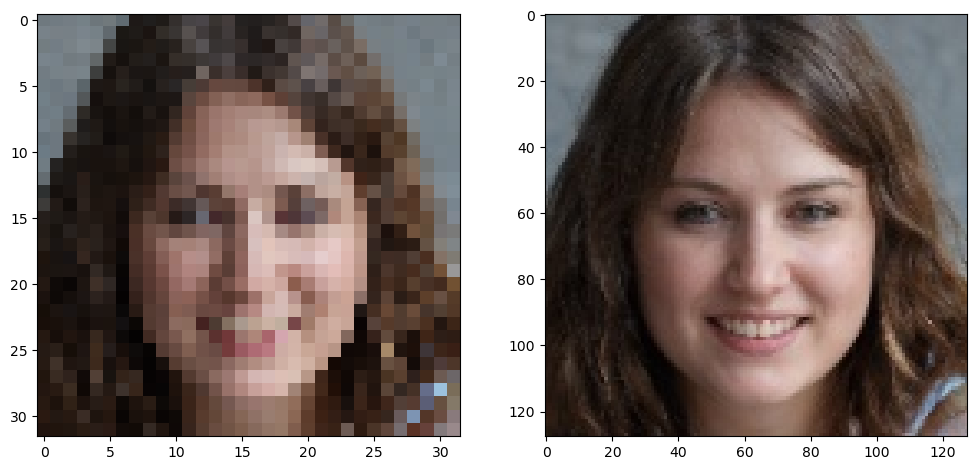

In [4]:
n = 5000
lr_images = np.array(lr_images[:n])
print(len(lr_images))

hr_images = np.array(hr_images[:n])
print(len(hr_images))

#Sanity check, view few mages
import random
import numpy as np
image_number = random.randint(0, len(lr_images)-1)
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(np.reshape(lr_images[image_number], (32, 32, 3)))
plt.subplot(122)
plt.imshow(np.reshape(hr_images[image_number], (128, 128, 3)))
plt.show()

#Scale values
lr_images = lr_images / 255.
hr_images = hr_images / 255.

#Split to train and test
lr_train, lr_test, hr_train, hr_test = train_test_split(lr_images, hr_images, 
                                                      test_size=0.33, random_state=42)



hr_shape = (hr_train.shape[1], hr_train.shape[2], hr_train.shape[3])
lr_shape = (lr_train.shape[1], lr_train.shape[2], lr_train.shape[3])

lr_ip = Input(shape=lr_shape)
hr_ip = Input(shape=hr_shape)

In [5]:
generator = create_gen(lr_ip, num_res_block = 16)
generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 conv2d (Conv2D)                (None, 32, 32, 64)   15616       ['input_1[0][0]']                
                                                                                                  
 p_re_lu (PReLU)                (None, 32, 32, 64)   64          ['conv2d[0][0]']                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 32, 32, 64)   36928       ['p_re_lu[0][0]']                
                                                                                              

In [6]:
discriminator = create_disc(hr_ip)
discriminator.compile(loss="binary_crossentropy", optimizer="adam", metrics=['accuracy'])
discriminator.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv2d_37 (Conv2D)          (None, 128, 128, 64)      1792      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 128, 128, 64)      0         
                                                                 
 conv2d_38 (Conv2D)          (None, 64, 64, 64)        36928     
                                                                 
 batch_normalization_33 (Bat  (None, 64, 64, 64)       256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 64, 64, 64)        0         
                                                           

In [7]:
vgg = build_vgg((128,128,3))
print(vgg.summary())
vgg.trainable = False

80134624/80134624 [==============================] - 0s 0us/step
Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                            

In [8]:
gan_model = create_comb(generator, discriminator, vgg, lr_ip, hr_ip)

# 2 losses... adversarial loss and content (VGG) loss
#AdversariaL: is defined based on the probabilities of the discriminator over all training samples
# use binary_crossentropy

#Content: feature map obtained by the j-th convolution (after activation) 
#before the i-th maxpooling layer within the VGG19 network.
# MSE between the feature representations of a reconstructed image
# and the reference image. 
gan_model.compile(loss=["binary_crossentropy", "mse"], loss_weights=[1e-3, 1], optimizer="adam")
gan_model.summary()

#Create a list of images for LR and HR in batches from which a batch of images
#would be fetched during training. 
batch_size = 1  
train_lr_batches = []
train_hr_batches = []
for it in range(int(hr_train.shape[0] / batch_size)):
    start_idx = it * batch_size
    end_idx = start_idx + batch_size
    train_hr_batches.append(hr_train[start_idx:end_idx])
    train_lr_batches.append(lr_train[start_idx:end_idx])
    

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 model (Functional)             (None, 128, 128, 3)  2044291     ['input_1[0][0]']                
                                                                                                  
 input_2 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 model_1 (Functional)           (None, 1)            38249281    ['model[0][0]']            

In [9]:
fields = ["Epochs","AvgDiscLoss", "AvgGenLoss"]
rows = []
print(rows)

[]


In [10]:
    
epochs = 30
#Enumerate training over epochs
for e in range(epochs):
    
    fake_label = np.zeros((batch_size, 1)) # Assign a label of 0 to all fake (generated images)
    real_label = np.ones((batch_size,1)) # Assign a label of 1 to all real images.
    
    #Create empty lists to populate gen and disc losses. 
    g_losses = []
    d_losses = []
    
    #Enumerate training over batches. 
    for b in tqdm(range(len(train_hr_batches))):
        lr_imgs = train_lr_batches[b] #Fetch a batch of LR images for training
        hr_imgs = train_hr_batches[b] #Fetch a batch of HR images for training
        
        fake_imgs = generator.predict_on_batch(lr_imgs) #Fake images
        
        #First, train the discriminator on fake and real HR images. 
        discriminator.trainable = True
        d_loss_gen = discriminator.train_on_batch(fake_imgs, fake_label)
        d_loss_real = discriminator.train_on_batch(hr_imgs, real_label)
        
        #Now, train the generator by fixing discriminator as non-trainable
        discriminator.trainable = False
        
        #Average the discriminator loss, just for reporting purposes. 
        d_loss = 0.5 * np.add(d_loss_gen, d_loss_real) 
        
        #Extract VGG features, to be used towards calculating loss
        image_features = vgg.predict(hr_imgs)
     
        #Train the generator via GAN. 
        #Remember that we have 2 losses, adversarial loss and content (VGG) loss
        g_loss, _, _ = gan_model.train_on_batch([lr_imgs, hr_imgs], [real_label, image_features])
        
        
        #Save losses to a list so we can average and report. 
        d_losses.append(d_loss)
        g_losses.append(g_loss)
        
    #Convert the list of losses to an array to make it easy to average    
    g_losses = np.array(g_losses)
    d_losses = np.array(d_losses)
    
    #Calculate the average losses for generator and discriminator
    g_loss = np.sum(g_losses, axis=0) / len(g_losses)
    d_loss = np.sum(d_losses, axis=0) / len(d_losses)
    
    #Report the progress during training. 
    rows.append([e+1 , d_loss , g_loss ])
    print("epoch:", e+1 ,"g_loss:", g_loss, "d_loss:", d_loss)

    if (e+1) % 6 == 0: #Change the frequency for model saving, if needed
        #Save the generator after every n epochs (Usually 10 epochs)
        generator.save("gen_e_"+ str(e+1) +".h5")

filename = "loss.csv"
     
with open(filename, 'w', newline='') as csvfile: 
    csvwriter = csv.writer(csvfile) 
        
    csvwriter.writerow(fields) 
        
    csvwriter.writerows(rows)

  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 336ms/step


  0%|          | 1/3350 [00:15<14:09:13, 15.21s/it]

1/1 [==============================] - 0s 19ms/step


  0%|          | 2/3350 [00:15<5:54:43,  6.36s/it] 

1/1 [==============================] - 0s 30ms/step


  0%|          | 3/3350 [00:15<3:19:47,  3.58s/it]

1/1 [==============================] - 0s 25ms/step


  0%|          | 4/3350 [00:15<2:05:31,  2.25s/it]

1/1 [==============================] - 0s 19ms/step


  0%|          | 5/3350 [00:16<1:23:52,  1.50s/it]

1/1 [==============================] - 0s 20ms/step


  0%|          | 6/3350 [00:16<58:15,  1.05s/it]  

1/1 [==============================] - 0s 19ms/step


  0%|          | 7/3350 [00:16<41:58,  1.33it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 8/3350 [00:16<31:20,  1.78it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 9/3350 [00:16<24:12,  2.30it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 10/3350 [00:16<19:23,  2.87it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 11/3350 [00:16<16:09,  3.44it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 12/3350 [00:17<13:51,  4.01it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 13/3350 [00:17<12:26,  4.47it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 14/3350 [00:17<11:24,  4.87it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 15/3350 [00:17<10:26,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 16/3350 [00:17<10:05,  5.50it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 17/3350 [00:17<09:34,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 18/3350 [00:18<09:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 19/3350 [00:18<09:01,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 20/3350 [00:18<09:16,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 21/3350 [00:18<08:58,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 22/3350 [00:18<08:44,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 23/3350 [00:18<08:35,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 24/3350 [00:18<08:29,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 25/3350 [00:19<08:29,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 26/3350 [00:19<08:29,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 27/3350 [00:19<08:44,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 28/3350 [00:19<08:36,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 29/3350 [00:19<08:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 30/3350 [00:19<08:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 31/3350 [00:20<08:24,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 32/3350 [00:20<08:33,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 33/3350 [00:20<08:36,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 34/3350 [00:20<08:30,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 35/3350 [00:20<08:25,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 36/3350 [00:20<08:19,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 37/3350 [00:20<08:27,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 38/3350 [00:21<09:41,  5.70it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 39/3350 [00:21<11:01,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 40/3350 [00:21<11:17,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 41/3350 [00:21<11:25,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▏         | 42/3350 [00:22<11:13,  4.91it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 43/3350 [00:22<11:07,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 44/3350 [00:22<10:22,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 45/3350 [00:22<09:50,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 46/3350 [00:22<09:24,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 47/3350 [00:22<09:09,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 48/3350 [00:23<08:55,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 49/3350 [00:23<08:44,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 50/3350 [00:23<08:35,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 51/3350 [00:23<08:30,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 52/3350 [00:23<08:25,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 53/3350 [00:23<08:29,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 54/3350 [00:23<08:25,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:24<08:34,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 56/3350 [00:24<08:27,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 57/3350 [00:24<08:30,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 58/3350 [00:24<08:27,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 59/3350 [00:24<08:25,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 60/3350 [00:24<08:25,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 61/3350 [00:25<08:19,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 62/3350 [00:25<08:20,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 63/3350 [00:25<08:29,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 64/3350 [00:25<08:33,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 65/3350 [00:25<08:27,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 66/3350 [00:25<08:26,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 67/3350 [00:25<08:22,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 68/3350 [00:26<09:01,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 69/3350 [00:26<08:44,  6.25it/s]

1/1 [==============================] - 0s 40ms/step


  2%|▏         | 70/3350 [00:26<09:48,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 71/3350 [00:26<11:09,  4.89it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 72/3350 [00:27<11:20,  4.82it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 73/3350 [00:27<10:31,  5.19it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 74/3350 [00:27<09:52,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 75/3350 [00:27<09:57,  5.48it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 76/3350 [00:27<09:40,  5.64it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 77/3350 [00:27<09:14,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 78/3350 [00:27<08:56,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 79/3350 [00:28<08:47,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 80/3350 [00:28<08:37,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 81/3350 [00:28<08:35,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 82/3350 [00:28<08:26,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 83/3350 [00:28<08:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 84/3350 [00:28<08:21,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 85/3350 [00:29<08:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 86/3350 [00:29<08:32,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 87/3350 [00:29<08:29,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 88/3350 [00:29<08:22,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 89/3350 [00:29<08:17,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 90/3350 [00:29<08:40,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 91/3350 [00:30<08:30,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 92/3350 [00:30<08:37,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 93/3350 [00:30<08:26,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 94/3350 [00:30<08:22,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 95/3350 [00:30<08:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 96/3350 [00:30<08:19,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 97/3350 [00:30<08:14,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 98/3350 [00:31<08:11,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 99/3350 [00:31<08:11,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 100/3350 [00:31<08:14,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 101/3350 [00:31<08:11,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 102/3350 [00:31<08:12,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 103/3350 [00:31<08:11,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 104/3350 [00:32<08:37,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 105/3350 [00:32<08:33,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 106/3350 [00:32<08:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 107/3350 [00:32<08:25,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3350 [00:32<08:41,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 109/3350 [00:32<08:30,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 110/3350 [00:32<08:28,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 111/3350 [00:33<08:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 112/3350 [00:33<08:16,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 113/3350 [00:33<08:14,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 114/3350 [00:33<08:10,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 115/3350 [00:33<08:14,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 116/3350 [00:33<08:13,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 117/3350 [00:34<08:15,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 118/3350 [00:34<08:13,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 119/3350 [00:34<08:11,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 120/3350 [00:34<08:16,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 121/3350 [00:34<08:14,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 122/3350 [00:34<08:13,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 123/3350 [00:34<08:14,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▎         | 124/3350 [00:35<08:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 125/3350 [00:35<08:15,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 126/3350 [00:35<08:13,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 127/3350 [00:35<08:14,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 128/3350 [00:35<08:13,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 129/3350 [00:35<08:11,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 130/3350 [00:36<08:10,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 131/3350 [00:36<08:13,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 132/3350 [00:36<08:09,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 133/3350 [00:36<08:19,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 134/3350 [00:36<08:20,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 135/3350 [00:36<08:15,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 136/3350 [00:36<08:15,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 137/3350 [00:37<08:17,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 138/3350 [00:37<08:17,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 139/3350 [00:37<08:43,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 140/3350 [00:37<09:40,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 141/3350 [00:37<09:46,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 142/3350 [00:38<10:00,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 143/3350 [00:38<09:26,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 144/3350 [00:38<09:03,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 145/3350 [00:38<08:45,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 146/3350 [00:38<08:30,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 147/3350 [00:38<08:24,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 148/3350 [00:38<08:17,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 149/3350 [00:39<08:13,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 150/3350 [00:39<08:07,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 151/3350 [00:39<08:07,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 152/3350 [00:39<08:06,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 153/3350 [00:39<08:04,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 154/3350 [00:39<08:10,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 155/3350 [00:40<08:05,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 156/3350 [00:40<08:01,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 157/3350 [00:40<08:04,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 158/3350 [00:40<08:03,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 159/3350 [00:40<08:01,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 160/3350 [00:40<08:02,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 161/3350 [00:40<08:12,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 162/3350 [00:41<08:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 163/3350 [00:41<08:12,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 164/3350 [00:41<08:05,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 165/3350 [00:41<08:16,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 166/3350 [00:41<08:08,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 167/3350 [00:41<08:05,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 168/3350 [00:41<08:03,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 169/3350 [00:42<08:01,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 170/3350 [00:42<08:00,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 171/3350 [00:42<08:05,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 172/3350 [00:42<08:06,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 173/3350 [00:42<08:08,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 174/3350 [00:42<08:05,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 175/3350 [00:43<08:05,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 176/3350 [00:43<08:06,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 177/3350 [00:43<07:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 178/3350 [00:43<08:00,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 179/3350 [00:43<08:00,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 180/3350 [00:43<08:24,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 181/3350 [00:43<08:23,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 182/3350 [00:44<08:13,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 183/3350 [00:44<08:09,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 184/3350 [00:44<08:01,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:44<07:59,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 186/3350 [00:44<08:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 187/3350 [00:44<08:06,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 188/3350 [00:45<08:26,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 189/3350 [00:45<08:19,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 190/3350 [00:45<08:08,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 191/3350 [00:45<08:01,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 192/3350 [00:45<08:08,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 193/3350 [00:45<08:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 194/3350 [00:45<08:04,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:46<08:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 196/3350 [00:46<08:03,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:46<08:01,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 198/3350 [00:46<08:01,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 199/3350 [00:46<08:11,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 200/3350 [00:46<08:09,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 201/3350 [00:47<08:19,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 202/3350 [00:47<08:22,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 203/3350 [00:47<08:28,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 204/3350 [00:47<08:14,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 205/3350 [00:47<08:09,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 206/3350 [00:47<08:18,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 207/3350 [00:48<08:08,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 208/3350 [00:48<08:01,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 209/3350 [00:48<08:00,  6.54it/s]

1/1 [==============================] - 0s 46ms/step


  6%|▋         | 210/3350 [00:48<09:32,  5.48it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▋         | 211/3350 [00:48<09:57,  5.25it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 212/3350 [00:48<10:11,  5.13it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 213/3350 [00:49<09:38,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 214/3350 [00:49<09:09,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:49<09:01,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 216/3350 [00:49<08:38,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 217/3350 [00:49<08:26,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 218/3350 [00:49<08:14,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 219/3350 [00:50<08:06,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 220/3350 [00:50<08:00,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 221/3350 [00:50<08:03,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 222/3350 [00:50<07:55,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 223/3350 [00:50<07:57,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 224/3350 [00:50<08:25,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 225/3350 [00:51<08:21,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 226/3350 [00:51<08:15,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 227/3350 [00:51<08:07,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 228/3350 [00:51<08:05,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 229/3350 [00:51<08:01,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 230/3350 [00:51<07:57,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 231/3350 [00:51<07:52,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 232/3350 [00:52<07:48,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 233/3350 [00:52<07:51,  6.61it/s]

1/1 [==============================] - 0s 40ms/step


  7%|▋         | 234/3350 [00:52<08:47,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 235/3350 [00:52<09:53,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 236/3350 [00:52<10:20,  5.02it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 237/3350 [00:53<10:45,  4.82it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 238/3350 [00:53<10:58,  4.73it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 239/3350 [00:53<10:45,  4.82it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 240/3350 [00:53<09:50,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 241/3350 [00:53<09:13,  5.62it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 242/3350 [00:53<08:45,  5.91it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 243/3350 [00:54<08:31,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 244/3350 [00:54<08:14,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 245/3350 [00:54<08:06,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 246/3350 [00:54<07:57,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 247/3350 [00:54<08:32,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 248/3350 [00:54<08:16,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 249/3350 [00:55<08:04,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 250/3350 [00:55<07:59,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 251/3350 [00:55<07:53,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 252/3350 [00:55<08:05,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 253/3350 [00:55<08:02,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 254/3350 [00:55<07:58,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 255/3350 [00:56<07:54,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 256/3350 [00:56<07:51,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 257/3350 [00:56<07:48,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 258/3350 [00:56<07:46,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 259/3350 [00:56<07:46,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 260/3350 [00:56<07:43,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 261/3350 [00:56<07:48,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 262/3350 [00:57<07:49,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 263/3350 [00:57<07:53,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 264/3350 [00:57<11:36,  4.43it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:57<10:29,  4.90it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 266/3350 [00:57<09:42,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 267/3350 [00:58<09:10,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:58<08:49,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 269/3350 [00:58<08:28,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 270/3350 [00:58<08:14,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 271/3350 [00:58<08:03,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 272/3350 [00:58<07:59,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 273/3350 [00:58<07:58,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 274/3350 [00:59<08:06,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 275/3350 [00:59<07:57,  6.45it/s]

1/1 [==============================] - 0s 38ms/step


  8%|▊         | 276/3350 [00:59<09:12,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 277/3350 [00:59<10:24,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 278/3350 [01:00<10:30,  4.87it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 279/3350 [01:00<09:58,  5.13it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 280/3350 [01:00<09:47,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 281/3350 [01:00<09:36,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 282/3350 [01:00<09:11,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 283/3350 [01:00<08:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 284/3350 [01:01<08:38,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 285/3350 [01:01<08:23,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 286/3350 [01:01<08:13,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 287/3350 [01:01<08:05,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 288/3350 [01:01<07:56,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 289/3350 [01:01<07:56,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 290/3350 [01:01<07:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 291/3350 [01:02<07:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 292/3350 [01:02<07:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 293/3350 [01:02<07:50,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 294/3350 [01:02<07:48,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 295/3350 [01:02<07:46,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 296/3350 [01:02<07:42,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 297/3350 [01:02<07:39,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 298/3350 [01:03<07:42,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 299/3350 [01:03<07:39,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 300/3350 [01:03<07:40,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 301/3350 [01:03<07:45,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 302/3350 [01:03<07:49,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 303/3350 [01:03<07:48,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 304/3350 [01:04<07:43,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 305/3350 [01:04<07:45,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 306/3350 [01:04<07:54,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 307/3350 [01:04<07:52,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 308/3350 [01:04<07:50,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 309/3350 [01:04<07:52,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 310/3350 [01:04<07:47,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 311/3350 [01:05<07:51,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 312/3350 [01:05<07:48,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 313/3350 [01:05<07:57,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 314/3350 [01:05<07:50,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 315/3350 [01:05<07:47,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 316/3350 [01:05<07:44,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 317/3350 [01:06<08:14,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 318/3350 [01:06<08:04,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 319/3350 [01:06<07:55,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 320/3350 [01:06<08:04,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 321/3350 [01:06<08:03,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 322/3350 [01:06<08:00,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 323/3350 [01:07<08:00,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 324/3350 [01:07<07:59,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 325/3350 [01:07<07:52,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 326/3350 [01:07<08:12,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 327/3350 [01:07<08:01,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 328/3350 [01:07<07:51,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 329/3350 [01:07<07:44,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 330/3350 [01:08<07:44,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 331/3350 [01:08<07:44,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 332/3350 [01:08<07:49,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 333/3350 [01:08<07:46,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 334/3350 [01:08<07:42,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 335/3350 [01:08<07:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 336/3350 [01:09<08:03,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [01:09<07:54,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 338/3350 [01:09<07:47,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 339/3350 [01:09<07:44,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 340/3350 [01:09<07:44,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 341/3350 [01:09<07:43,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 342/3350 [01:09<07:39,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 343/3350 [01:10<07:39,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 344/3350 [01:10<07:37,  6.57it/s]

1/1 [==============================] - 0s 38ms/step


 10%|█         | 345/3350 [01:10<08:25,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 346/3350 [01:10<09:19,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 347/3350 [01:10<09:29,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 348/3350 [01:11<09:03,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 349/3350 [01:11<08:34,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 350/3350 [01:11<08:20,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 351/3350 [01:11<08:08,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 352/3350 [01:11<07:54,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 353/3350 [01:11<07:48,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 354/3350 [01:11<07:44,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 355/3350 [01:12<07:47,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 356/3350 [01:12<07:54,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 357/3350 [01:12<07:52,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 358/3350 [01:12<08:00,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 359/3350 [01:12<07:52,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 360/3350 [01:12<07:49,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 361/3350 [01:13<07:47,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 362/3350 [01:13<07:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 363/3350 [01:13<07:38,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 364/3350 [01:13<07:38,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 365/3350 [01:13<07:42,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 366/3350 [01:13<07:39,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 367/3350 [01:14<07:34,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 368/3350 [01:14<07:29,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 369/3350 [01:14<07:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 370/3350 [01:14<07:44,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 371/3350 [01:14<07:40,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 372/3350 [01:14<07:46,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 373/3350 [01:14<07:45,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:15<07:45,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 375/3350 [01:15<07:36,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 376/3350 [01:15<07:37,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 377/3350 [01:15<07:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 378/3350 [01:15<07:31,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 379/3350 [01:15<07:35,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:16<07:37,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 381/3350 [01:16<07:38,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 382/3350 [01:16<07:34,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 383/3350 [01:16<07:34,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 384/3350 [01:16<07:30,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 385/3350 [01:16<07:28,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 386/3350 [01:16<07:32,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 387/3350 [01:17<07:34,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 388/3350 [01:17<07:36,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 389/3350 [01:17<07:48,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 390/3350 [01:17<07:49,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 391/3350 [01:17<08:05,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 392/3350 [01:17<08:02,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 393/3350 [01:18<07:50,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:18<07:43,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:18<07:37,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:18<07:45,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 397/3350 [01:18<07:39,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 398/3350 [01:18<07:38,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 399/3350 [01:18<07:35,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 400/3350 [01:19<07:34,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 401/3350 [01:19<07:33,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:19<07:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 403/3350 [01:19<07:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 404/3350 [01:19<07:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 405/3350 [01:19<07:24,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 406/3350 [01:20<07:35,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 407/3350 [01:20<07:30,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 408/3350 [01:20<07:34,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 409/3350 [01:20<08:01,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 410/3350 [01:20<07:50,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 411/3350 [01:20<07:41,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 412/3350 [01:21<07:32,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 413/3350 [01:21<07:31,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 414/3350 [01:21<07:31,  6.51it/s]

1/1 [==============================] - 0s 42ms/step


 12%|█▏        | 415/3350 [01:21<09:00,  5.43it/s]

1/1 [==============================] - 0s 35ms/step


 12%|█▏        | 416/3350 [01:21<09:41,  5.04it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 417/3350 [01:21<09:35,  5.10it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 418/3350 [01:22<08:59,  5.44it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 419/3350 [01:22<08:41,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 420/3350 [01:22<08:27,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 421/3350 [01:22<08:09,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:22<07:54,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:22<07:44,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 424/3350 [01:23<07:34,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 425/3350 [01:23<07:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 426/3350 [01:23<07:31,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 427/3350 [01:23<07:33,  6.44it/s]

1/1 [==============================] - 0s 43ms/step


 13%|█▎        | 428/3350 [01:23<09:11,  5.30it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 429/3350 [01:24<10:02,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 430/3350 [01:24<09:57,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 431/3350 [01:24<09:50,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 432/3350 [01:24<09:56,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 433/3350 [01:24<10:00,  4.86it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 434/3350 [01:25<09:13,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 435/3350 [01:25<08:40,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 436/3350 [01:25<08:17,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 437/3350 [01:25<08:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 438/3350 [01:25<08:02,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 439/3350 [01:25<07:49,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 440/3350 [01:25<07:42,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 441/3350 [01:26<07:32,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 442/3350 [01:26<07:29,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 443/3350 [01:26<07:25,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 444/3350 [01:26<07:22,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 445/3350 [01:26<07:24,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 446/3350 [01:26<07:29,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 447/3350 [01:27<07:32,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 448/3350 [01:27<07:30,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 449/3350 [01:27<07:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 450/3350 [01:27<07:33,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 451/3350 [01:27<07:39,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 452/3350 [01:27<07:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 453/3350 [01:27<07:29,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 454/3350 [01:28<07:38,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 455/3350 [01:28<07:32,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 456/3350 [01:28<07:26,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 457/3350 [01:28<07:27,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 458/3350 [01:28<07:25,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 459/3350 [01:28<07:24,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 460/3350 [01:29<07:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 461/3350 [01:29<07:20,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 462/3350 [01:29<07:20,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 463/3350 [01:29<07:24,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 464/3350 [01:29<07:24,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 465/3350 [01:29<07:23,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 466/3350 [01:29<07:22,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 467/3350 [01:30<07:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 468/3350 [01:30<08:18,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 469/3350 [01:30<08:31,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 470/3350 [01:30<08:13,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 471/3350 [01:30<08:01,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 472/3350 [01:30<07:48,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 473/3350 [01:31<07:40,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 474/3350 [01:31<07:33,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 475/3350 [01:31<07:30,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 476/3350 [01:31<07:30,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 477/3350 [01:31<07:24,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 478/3350 [01:31<07:21,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 479/3350 [01:32<07:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 480/3350 [01:32<07:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 481/3350 [01:32<07:15,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 482/3350 [01:32<08:31,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 483/3350 [01:32<09:41,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 484/3350 [01:33<09:29,  5.03it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 485/3350 [01:33<08:50,  5.40it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 486/3350 [01:33<08:24,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 487/3350 [01:33<08:06,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 488/3350 [01:33<08:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 489/3350 [01:33<07:51,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 490/3350 [01:33<07:40,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:34<07:33,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 492/3350 [01:34<07:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 493/3350 [01:34<07:31,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 494/3350 [01:34<07:29,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 495/3350 [01:34<07:24,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 496/3350 [01:34<07:25,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 497/3350 [01:35<07:18,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 498/3350 [01:35<07:21,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 499/3350 [01:35<07:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 500/3350 [01:35<07:15,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 501/3350 [01:35<07:14,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 502/3350 [01:35<07:14,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 503/3350 [01:35<07:12,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 504/3350 [01:36<07:24,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 505/3350 [01:36<07:26,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 506/3350 [01:36<07:33,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 507/3350 [01:36<07:35,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 508/3350 [01:36<07:27,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 509/3350 [01:36<07:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 510/3350 [01:37<07:22,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 511/3350 [01:37<07:30,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 512/3350 [01:37<07:35,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 513/3350 [01:37<07:25,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 514/3350 [01:37<07:24,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 515/3350 [01:37<07:18,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 516/3350 [01:38<07:16,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 517/3350 [01:38<07:13,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 518/3350 [01:38<07:09,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 519/3350 [01:38<07:14,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 520/3350 [01:38<07:15,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 521/3350 [01:38<07:11,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 522/3350 [01:38<07:18,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 523/3350 [01:39<07:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 524/3350 [01:39<07:11,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 525/3350 [01:39<07:11,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 526/3350 [01:39<07:15,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 527/3350 [01:39<07:14,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 528/3350 [01:39<07:13,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 529/3350 [01:40<07:09,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 530/3350 [01:40<07:21,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 531/3350 [01:40<07:18,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 532/3350 [01:40<07:21,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 533/3350 [01:40<07:34,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 534/3350 [01:40<07:25,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 535/3350 [01:40<07:16,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 536/3350 [01:41<07:12,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 537/3350 [01:41<07:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 538/3350 [01:41<07:07,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 539/3350 [01:41<07:07,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 540/3350 [01:41<07:06,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 541/3350 [01:41<07:04,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 542/3350 [01:42<07:12,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 543/3350 [01:42<07:07,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 544/3350 [01:42<07:16,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 545/3350 [01:42<07:16,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 546/3350 [01:42<07:17,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 547/3350 [01:42<07:15,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 548/3350 [01:42<07:13,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 549/3350 [01:43<07:11,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 550/3350 [01:43<07:29,  6.22it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 551/3350 [01:43<08:15,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 552/3350 [01:43<08:57,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 553/3350 [01:43<09:25,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 554/3350 [01:44<08:53,  5.24it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 555/3350 [01:44<08:19,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 556/3350 [01:44<08:01,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 557/3350 [01:44<07:44,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 558/3350 [01:44<07:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 559/3350 [01:44<07:35,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 560/3350 [01:45<07:25,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 561/3350 [01:45<07:18,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 562/3350 [01:45<07:11,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 563/3350 [01:45<07:05,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 564/3350 [01:45<07:03,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 565/3350 [01:45<07:02,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 566/3350 [01:45<07:04,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 567/3350 [01:46<07:05,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 568/3350 [01:46<07:03,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 569/3350 [01:46<07:14,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 570/3350 [01:46<07:09,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 571/3350 [01:46<07:03,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 572/3350 [01:46<07:10,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 573/3350 [01:47<07:08,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 574/3350 [01:47<07:07,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 575/3350 [01:47<07:03,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 576/3350 [01:47<07:11,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 577/3350 [01:47<07:28,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 578/3350 [01:47<07:36,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 579/3350 [01:48<07:24,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 580/3350 [01:48<07:19,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 581/3350 [01:48<07:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:48<07:07,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 583/3350 [01:48<07:03,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 584/3350 [01:48<06:58,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 585/3350 [01:48<07:00,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 586/3350 [01:49<07:03,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 587/3350 [01:49<07:04,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 588/3350 [01:49<06:59,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 589/3350 [01:49<06:58,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 590/3350 [01:49<07:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 591/3350 [01:49<07:02,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 592/3350 [01:49<06:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 593/3350 [01:50<06:56,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 594/3350 [01:50<06:58,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 595/3350 [01:50<06:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 596/3350 [01:50<07:00,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 597/3350 [01:50<07:00,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 598/3350 [01:50<06:58,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 599/3350 [01:51<06:56,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 600/3350 [01:51<06:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 601/3350 [01:51<06:57,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 602/3350 [01:51<06:55,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 603/3350 [01:51<06:53,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 604/3350 [01:51<06:54,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 605/3350 [01:51<07:00,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 606/3350 [01:52<07:00,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 607/3350 [01:52<06:59,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 608/3350 [01:52<07:02,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 609/3350 [01:52<07:00,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 610/3350 [01:52<07:00,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 611/3350 [01:52<06:56,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:53<06:53,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 613/3350 [01:53<06:57,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 614/3350 [01:53<06:56,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 615/3350 [01:53<06:58,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 616/3350 [01:53<07:09,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 617/3350 [01:53<07:04,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 618/3350 [01:53<07:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 619/3350 [01:54<06:59,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 620/3350 [01:54<06:58,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 621/3350 [01:54<07:16,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 622/3350 [01:54<08:28,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 623/3350 [01:54<08:38,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 624/3350 [01:55<10:01,  4.54it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 625/3350 [01:55<09:34,  4.75it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 626/3350 [01:55<10:01,  4.53it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 627/3350 [01:55<10:27,  4.34it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▊        | 628/3350 [01:56<10:07,  4.48it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 629/3350 [01:56<09:20,  4.85it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 630/3350 [01:56<08:36,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 631/3350 [01:56<08:04,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 632/3350 [01:56<07:43,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 633/3350 [01:56<07:28,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 634/3350 [01:56<07:20,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 635/3350 [01:57<07:23,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 636/3350 [01:57<07:18,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 637/3350 [01:57<07:22,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 638/3350 [01:57<07:14,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 639/3350 [01:57<07:09,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 640/3350 [01:57<07:04,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 641/3350 [01:58<07:13,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 642/3350 [01:58<07:08,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 643/3350 [01:58<07:02,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 644/3350 [01:58<06:57,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 645/3350 [01:58<06:54,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 646/3350 [01:58<06:56,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 647/3350 [01:59<06:52,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 648/3350 [01:59<07:00,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 649/3350 [01:59<06:58,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 650/3350 [01:59<07:06,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 651/3350 [01:59<07:03,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 652/3350 [01:59<07:00,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 653/3350 [01:59<06:58,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 654/3350 [02:00<06:52,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 655/3350 [02:00<06:48,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 656/3350 [02:00<06:54,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 657/3350 [02:00<07:36,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 658/3350 [02:00<07:32,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 659/3350 [02:00<07:24,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 660/3350 [02:01<07:23,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 661/3350 [02:01<07:13,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 662/3350 [02:01<07:07,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 663/3350 [02:01<07:00,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 664/3350 [02:01<06:56,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 665/3350 [02:01<06:53,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 666/3350 [02:02<06:54,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 667/3350 [02:02<06:54,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 668/3350 [02:02<06:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 669/3350 [02:02<06:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 670/3350 [02:02<06:49,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 671/3350 [02:02<06:47,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 672/3350 [02:02<06:45,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [02:03<06:53,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [02:03<07:02,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 675/3350 [02:03<06:57,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 676/3350 [02:03<06:55,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 677/3350 [02:03<06:53,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 678/3350 [02:03<06:51,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 679/3350 [02:04<06:50,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [02:04<06:50,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 681/3350 [02:04<07:14,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 682/3350 [02:04<07:10,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 683/3350 [02:04<07:04,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 684/3350 [02:04<06:59,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 685/3350 [02:04<06:56,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 686/3350 [02:05<06:55,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 687/3350 [02:05<06:50,  6.49it/s]

1/1 [==============================] - 0s 61ms/step


 21%|██        | 688/3350 [02:05<07:51,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 689/3350 [02:05<08:43,  5.08it/s]

1/1 [==============================] - 0s 35ms/step


 21%|██        | 690/3350 [02:05<09:06,  4.87it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 691/3350 [02:06<08:24,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 692/3350 [02:06<07:52,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 693/3350 [02:06<07:38,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 694/3350 [02:06<07:20,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 695/3350 [02:06<07:09,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 696/3350 [02:06<07:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 697/3350 [02:07<07:01,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 698/3350 [02:07<06:59,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 699/3350 [02:07<06:59,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 700/3350 [02:07<07:10,  6.16it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 701/3350 [02:07<06:57,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 702/3350 [02:07<06:51,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 703/3350 [02:08<06:56,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 704/3350 [02:08<06:48,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 705/3350 [02:08<06:44,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 706/3350 [02:08<06:44,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 707/3350 [02:08<06:44,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 708/3350 [02:08<06:42,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 709/3350 [02:08<06:42,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 710/3350 [02:09<06:41,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 711/3350 [02:09<06:40,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 712/3350 [02:09<06:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 713/3350 [02:09<06:42,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 714/3350 [02:09<06:41,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 715/3350 [02:09<06:39,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██▏       | 716/3350 [02:09<06:39,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 717/3350 [02:10<06:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 718/3350 [02:10<06:37,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 719/3350 [02:10<06:40,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 720/3350 [02:10<06:37,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 721/3350 [02:10<06:46,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 722/3350 [02:10<06:54,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 723/3350 [02:11<06:55,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 724/3350 [02:11<06:51,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 725/3350 [02:11<06:44,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 726/3350 [02:11<06:49,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 727/3350 [02:11<06:46,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 728/3350 [02:11<06:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 729/3350 [02:11<06:41,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 730/3350 [02:12<06:43,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 731/3350 [02:12<06:40,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 732/3350 [02:12<06:52,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 733/3350 [02:12<06:47,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 734/3350 [02:12<06:43,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 735/3350 [02:12<06:38,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 736/3350 [02:13<06:38,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 737/3350 [02:13<06:34,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 738/3350 [02:13<06:36,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 739/3350 [02:13<06:34,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 740/3350 [02:13<06:30,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 741/3350 [02:13<06:32,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 742/3350 [02:13<06:32,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 743/3350 [02:14<06:33,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 744/3350 [02:14<06:35,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 745/3350 [02:14<06:35,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 746/3350 [02:14<06:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 747/3350 [02:14<06:38,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 748/3350 [02:14<06:36,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 749/3350 [02:15<06:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 750/3350 [02:15<06:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 751/3350 [02:15<06:33,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 752/3350 [02:15<06:31,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 753/3350 [02:15<06:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 754/3350 [02:15<06:37,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 755/3350 [02:15<06:37,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 756/3350 [02:16<06:38,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 757/3350 [02:16<06:35,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 758/3350 [02:16<06:56,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 759/3350 [02:16<08:18,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 760/3350 [02:16<09:09,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 761/3350 [02:17<08:28,  5.09it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 762/3350 [02:17<07:54,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 763/3350 [02:17<07:44,  5.57it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 764/3350 [02:17<07:21,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 765/3350 [02:17<07:06,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 766/3350 [02:17<06:58,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 767/3350 [02:18<06:51,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 768/3350 [02:18<06:45,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 769/3350 [02:18<06:38,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 770/3350 [02:18<06:36,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 771/3350 [02:18<06:33,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 772/3350 [02:18<06:33,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 773/3350 [02:18<06:36,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 774/3350 [02:19<06:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 775/3350 [02:19<06:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 776/3350 [02:19<06:35,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 777/3350 [02:19<06:36,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 778/3350 [02:19<06:35,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 779/3350 [02:19<06:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 780/3350 [02:20<06:30,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 781/3350 [02:20<06:31,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 782/3350 [02:20<06:34,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 783/3350 [02:20<06:52,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 784/3350 [02:20<06:44,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 785/3350 [02:20<06:38,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 786/3350 [02:20<06:37,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 787/3350 [02:21<06:33,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 788/3350 [02:21<06:33,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 789/3350 [02:21<06:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 790/3350 [02:21<06:30,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 791/3350 [02:21<06:27,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 792/3350 [02:21<06:32,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 793/3350 [02:22<06:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 794/3350 [02:22<06:33,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 795/3350 [02:22<06:33,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 796/3350 [02:22<06:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 797/3350 [02:22<06:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 798/3350 [02:22<06:29,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 799/3350 [02:22<06:25,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 800/3350 [02:23<06:23,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 801/3350 [02:23<06:22,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 802/3350 [02:23<06:25,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 803/3350 [02:23<06:24,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 804/3350 [02:23<06:24,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 805/3350 [02:23<06:24,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 806/3350 [02:24<06:24,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 807/3350 [02:24<06:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 808/3350 [02:24<06:24,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 809/3350 [02:24<06:23,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 810/3350 [02:24<06:23,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 811/3350 [02:24<06:23,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 812/3350 [02:24<06:22,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 813/3350 [02:25<06:19,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 814/3350 [02:25<06:19,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 815/3350 [02:25<06:18,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 816/3350 [02:25<06:28,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 817/3350 [02:25<06:32,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 818/3350 [02:25<06:32,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 819/3350 [02:25<06:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 820/3350 [02:26<06:59,  6.03it/s]

1/1 [==============================] - 0s 38ms/step


 25%|██▍       | 821/3350 [02:26<08:12,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 822/3350 [02:26<08:48,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 823/3350 [02:26<09:01,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 824/3350 [02:27<09:23,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 825/3350 [02:27<09:03,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 826/3350 [02:27<09:33,  4.40it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 827/3350 [02:27<09:29,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 828/3350 [02:28<09:04,  4.64it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 829/3350 [02:28<08:24,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 830/3350 [02:28<07:50,  5.36it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 831/3350 [02:28<07:22,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 832/3350 [02:28<07:06,  5.91it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 833/3350 [02:28<06:52,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 834/3350 [02:28<06:41,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 835/3350 [02:29<06:31,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 836/3350 [02:29<06:31,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 837/3350 [02:29<06:27,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 838/3350 [02:29<06:26,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 839/3350 [02:29<06:27,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 840/3350 [02:29<06:26,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 841/3350 [02:30<06:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:30<06:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 843/3350 [02:30<06:31,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 844/3350 [02:30<06:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 845/3350 [02:30<06:26,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 846/3350 [02:30<07:06,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 847/3350 [02:31<07:11,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 848/3350 [02:31<07:04,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 849/3350 [02:31<06:55,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 850/3350 [02:31<06:48,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 851/3350 [02:31<06:40,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 852/3350 [02:31<06:36,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 853/3350 [02:31<06:31,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 854/3350 [02:32<06:29,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 855/3350 [02:32<06:27,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:32<06:31,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 857/3350 [02:32<06:30,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 858/3350 [02:32<06:37,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 859/3350 [02:32<06:33,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 860/3350 [02:33<06:25,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 861/3350 [02:33<06:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 862/3350 [02:33<06:29,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 863/3350 [02:33<06:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 864/3350 [02:33<06:31,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:33<06:27,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 866/3350 [02:33<06:25,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 867/3350 [02:34<06:25,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 868/3350 [02:34<06:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 869/3350 [02:34<06:20,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 870/3350 [02:34<06:17,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 871/3350 [02:34<06:18,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 872/3350 [02:34<06:19,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 873/3350 [02:35<06:28,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 874/3350 [02:35<06:24,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 875/3350 [02:35<06:17,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 876/3350 [02:35<06:18,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 877/3350 [02:35<06:17,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 878/3350 [02:35<06:17,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 879/3350 [02:35<06:17,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 880/3350 [02:36<06:24,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 881/3350 [02:36<06:33,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 882/3350 [02:36<06:31,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 883/3350 [02:36<06:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 884/3350 [02:36<06:25,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 885/3350 [02:36<06:26,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 886/3350 [02:37<06:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 887/3350 [02:37<06:32,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 888/3350 [02:37<06:36,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 889/3350 [02:37<06:30,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 890/3350 [02:37<06:23,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 891/3350 [02:37<06:21,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 892/3350 [02:38<06:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 893/3350 [02:38<06:14,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 894/3350 [02:38<06:14,  6.57it/s]

1/1 [==============================] - 0s 43ms/step


 27%|██▋       | 895/3350 [02:38<07:12,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 896/3350 [02:38<07:48,  5.24it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 897/3350 [02:38<07:53,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 898/3350 [02:39<07:23,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 899/3350 [02:39<07:02,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 900/3350 [02:39<06:48,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 901/3350 [02:39<06:34,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:39<06:26,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 903/3350 [02:39<06:19,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 904/3350 [02:40<06:12,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:40<06:19,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 906/3350 [02:40<06:19,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 907/3350 [02:40<06:14,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 908/3350 [02:40<06:32,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 909/3350 [02:40<06:24,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 910/3350 [02:40<06:25,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 911/3350 [02:41<06:21,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 912/3350 [02:41<06:25,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 913/3350 [02:41<06:25,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 914/3350 [02:41<06:16,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 915/3350 [02:41<06:12,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 916/3350 [02:41<06:21,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 917/3350 [02:42<06:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 918/3350 [02:42<06:16,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 919/3350 [02:42<06:24,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 920/3350 [02:42<06:18,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 921/3350 [02:42<06:14,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 922/3350 [02:42<06:10,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 923/3350 [02:42<06:07,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 924/3350 [02:43<06:10,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 925/3350 [02:43<06:10,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 926/3350 [02:43<06:33,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 927/3350 [02:43<06:24,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 928/3350 [02:43<06:19,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 929/3350 [02:43<06:12,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 930/3350 [02:44<06:15,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 931/3350 [02:44<06:17,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 932/3350 [02:44<06:14,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 933/3350 [02:44<06:11,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 934/3350 [02:44<06:08,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 935/3350 [02:44<06:13,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 936/3350 [02:45<06:11,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 937/3350 [02:45<06:10,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 938/3350 [02:45<06:06,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 939/3350 [02:45<06:08,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 940/3350 [02:45<06:10,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 941/3350 [02:45<06:09,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 942/3350 [02:45<06:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 943/3350 [02:46<06:10,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 944/3350 [02:46<06:06,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 945/3350 [02:46<06:04,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 946/3350 [02:46<06:06,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 947/3350 [02:46<06:03,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 948/3350 [02:46<06:05,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 949/3350 [02:47<06:07,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 950/3350 [02:47<06:09,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 951/3350 [02:47<06:09,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:47<06:20,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 953/3350 [02:47<06:17,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 954/3350 [02:47<06:14,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 955/3350 [02:47<06:13,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 956/3350 [02:48<06:14,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 957/3350 [02:48<06:13,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 958/3350 [02:48<06:18,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 959/3350 [02:48<06:15,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 960/3350 [02:48<06:28,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 961/3350 [02:48<06:22,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 962/3350 [02:49<06:18,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 963/3350 [02:49<06:14,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 964/3350 [02:49<06:40,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 965/3350 [02:49<07:49,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 966/3350 [02:49<07:58,  4.99it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 967/3350 [02:50<07:34,  5.25it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 968/3350 [02:50<07:07,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:50<06:51,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 970/3350 [02:50<06:39,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:50<06:32,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 972/3350 [02:50<06:29,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 973/3350 [02:50<06:19,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 974/3350 [02:51<06:15,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 975/3350 [02:51<06:11,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 976/3350 [02:51<06:13,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 977/3350 [02:51<06:10,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 978/3350 [02:51<06:07,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 979/3350 [02:51<06:08,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 980/3350 [02:52<06:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 981/3350 [02:52<06:11,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 982/3350 [02:52<06:20,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 983/3350 [02:52<06:21,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 984/3350 [02:52<06:12,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 985/3350 [02:52<06:13,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 986/3350 [02:53<06:09,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 987/3350 [02:53<06:13,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 988/3350 [02:53<06:07,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 989/3350 [02:53<06:04,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 990/3350 [02:53<06:01,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 991/3350 [02:53<05:59,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 992/3350 [02:53<06:09,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 993/3350 [02:54<06:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 994/3350 [02:54<06:11,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 995/3350 [02:54<06:11,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 996/3350 [02:54<06:14,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 997/3350 [02:54<06:10,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 998/3350 [02:54<06:08,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 999/3350 [02:55<06:04,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1000/3350 [02:55<06:04,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:55<06:18,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1002/3350 [02:55<06:17,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1003/3350 [02:55<06:13,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1004/3350 [02:55<06:07,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1005/3350 [02:56<06:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1006/3350 [02:56<06:03,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:56<06:00,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1008/3350 [02:56<05:59,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1009/3350 [02:56<05:58,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1010/3350 [02:56<06:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1011/3350 [02:56<06:07,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1012/3350 [02:57<06:07,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1013/3350 [02:57<06:06,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 30%|███       | 1014/3350 [02:57<06:42,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 30%|███       | 1015/3350 [02:57<07:38,  5.10it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1016/3350 [02:57<07:53,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1017/3350 [02:58<08:25,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1018/3350 [02:58<08:48,  4.41it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1019/3350 [02:58<08:28,  4.58it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1020/3350 [02:58<07:47,  4.99it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1021/3350 [02:58<07:15,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1022/3350 [02:59<06:48,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1023/3350 [02:59<06:33,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1024/3350 [02:59<06:20,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1025/3350 [02:59<06:18,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1026/3350 [02:59<06:10,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1027/3350 [02:59<06:02,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1028/3350 [03:00<06:00,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1029/3350 [03:00<05:59,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1030/3350 [03:00<05:55,  6.52it/s]

1/1 [==============================] - 0s 38ms/step


 31%|███       | 1031/3350 [03:00<06:49,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1032/3350 [03:00<07:00,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1033/3350 [03:00<07:19,  5.27it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███       | 1034/3350 [03:01<07:33,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1035/3350 [03:01<07:33,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1036/3350 [03:01<07:07,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1037/3350 [03:01<06:50,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1038/3350 [03:01<06:40,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1039/3350 [03:01<06:26,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1040/3350 [03:02<06:17,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1041/3350 [03:02<06:11,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1042/3350 [03:02<06:08,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1043/3350 [03:02<06:03,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1044/3350 [03:02<05:59,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1045/3350 [03:02<05:58,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1046/3350 [03:03<05:56,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1047/3350 [03:03<05:56,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1048/3350 [03:03<06:06,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1049/3350 [03:03<06:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1050/3350 [03:03<06:09,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1051/3350 [03:03<06:11,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1052/3350 [03:04<06:07,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1053/3350 [03:04<06:00,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1054/3350 [03:04<05:56,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███▏      | 1055/3350 [03:04<05:55,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [03:04<05:52,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1057/3350 [03:04<05:51,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1058/3350 [03:04<05:51,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1059/3350 [03:05<05:46,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1060/3350 [03:05<05:45,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1061/3350 [03:05<05:43,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1062/3350 [03:05<05:50,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1063/3350 [03:05<05:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1064/3350 [03:05<05:49,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1065/3350 [03:06<05:50,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1066/3350 [03:06<05:53,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1067/3350 [03:06<05:52,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1068/3350 [03:06<05:54,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1069/3350 [03:06<05:51,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1070/3350 [03:06<05:49,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [03:06<05:59,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1072/3350 [03:07<05:55,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1073/3350 [03:07<05:53,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1074/3350 [03:07<06:01,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1075/3350 [03:07<06:05,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1076/3350 [03:07<05:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1077/3350 [03:07<05:53,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [03:08<05:50,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1079/3350 [03:08<05:48,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1080/3350 [03:08<05:47,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1081/3350 [03:08<05:44,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1082/3350 [03:08<05:42,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1083/3350 [03:08<05:40,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1084/3350 [03:08<05:40,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1085/3350 [03:09<05:44,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1086/3350 [03:09<05:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1087/3350 [03:09<05:43,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1088/3350 [03:09<05:41,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1089/3350 [03:09<05:42,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1090/3350 [03:09<05:42,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1091/3350 [03:09<05:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1092/3350 [03:10<05:43,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1093/3350 [03:10<05:42,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1094/3350 [03:10<05:42,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1095/3350 [03:10<05:44,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1096/3350 [03:10<05:45,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1097/3350 [03:10<05:44,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1098/3350 [03:11<05:45,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1099/3350 [03:11<05:44,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1100/3350 [03:11<06:03,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1101/3350 [03:11<06:51,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1102/3350 [03:11<07:13,  5.18it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1103/3350 [03:12<06:59,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1104/3350 [03:12<06:43,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1105/3350 [03:12<06:29,  5.77it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1106/3350 [03:12<06:15,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1107/3350 [03:12<06:05,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:12<05:58,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1109/3350 [03:12<05:50,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [03:13<05:47,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1111/3350 [03:13<05:53,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1112/3350 [03:13<05:49,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1113/3350 [03:13<06:01,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1114/3350 [03:13<05:56,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:13<05:57,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1116/3350 [03:14<05:53,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1117/3350 [03:14<05:47,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1118/3350 [03:14<05:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1119/3350 [03:14<06:00,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1120/3350 [03:14<05:55,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1121/3350 [03:14<05:51,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1122/3350 [03:15<05:46,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1123/3350 [03:15<05:43,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1124/3350 [03:15<05:42,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1125/3350 [03:15<05:42,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1126/3350 [03:15<05:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1127/3350 [03:15<05:44,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1128/3350 [03:15<05:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1129/3350 [03:16<05:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1130/3350 [03:16<05:47,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1131/3350 [03:16<05:41,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1132/3350 [03:16<05:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1133/3350 [03:16<05:39,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1134/3350 [03:16<05:50,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1135/3350 [03:17<05:53,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1136/3350 [03:17<06:11,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1137/3350 [03:17<06:23,  5.78it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1138/3350 [03:17<06:08,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1139/3350 [03:17<05:57,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1140/3350 [03:17<05:51,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1141/3350 [03:18<05:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1142/3350 [03:18<05:39,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1143/3350 [03:18<05:38,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1144/3350 [03:18<05:38,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1145/3350 [03:18<05:40,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1146/3350 [03:18<05:38,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1147/3350 [03:18<05:38,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1148/3350 [03:19<05:37,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1149/3350 [03:19<05:37,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1150/3350 [03:19<05:36,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1151/3350 [03:19<05:34,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1152/3350 [03:19<05:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1153/3350 [03:19<05:33,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1154/3350 [03:19<05:40,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1155/3350 [03:20<05:43,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1156/3350 [03:20<05:45,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1157/3350 [03:20<05:43,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1158/3350 [03:20<05:41,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1159/3350 [03:20<05:46,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1160/3350 [03:20<05:45,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1161/3350 [03:21<05:41,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1162/3350 [03:21<05:39,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1163/3350 [03:21<05:42,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1164/3350 [03:21<05:42,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1165/3350 [03:21<05:39,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1166/3350 [03:21<05:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1167/3350 [03:22<05:39,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1168/3350 [03:22<05:36,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1169/3350 [03:22<05:34,  6.52it/s]

1/1 [==============================] - 0s 42ms/step


 35%|███▍      | 1170/3350 [03:22<06:38,  5.47it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▍      | 1171/3350 [03:22<07:12,  5.04it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1172/3350 [03:23<07:04,  5.13it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1173/3350 [03:23<06:34,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1174/3350 [03:23<06:13,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1175/3350 [03:23<06:04,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1176/3350 [03:23<06:02,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1177/3350 [03:23<05:57,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:23<05:52,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1179/3350 [03:24<05:52,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1180/3350 [03:24<05:46,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1181/3350 [03:24<05:44,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1182/3350 [03:24<05:43,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1183/3350 [03:24<05:40,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1184/3350 [03:24<05:36,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1185/3350 [03:25<05:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1186/3350 [03:25<05:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1187/3350 [03:25<05:29,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1188/3350 [03:25<05:35,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1189/3350 [03:25<05:35,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1190/3350 [03:25<05:33,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1191/3350 [03:25<05:31,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1192/3350 [03:26<05:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1193/3350 [03:26<05:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1194/3350 [03:26<05:27,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1195/3350 [03:26<05:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1196/3350 [03:26<05:28,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1197/3350 [03:26<05:39,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1198/3350 [03:27<05:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1199/3350 [03:27<05:38,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1200/3350 [03:27<05:35,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1201/3350 [03:27<05:37,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1202/3350 [03:27<05:30,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1203/3350 [03:27<05:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1204/3350 [03:27<05:28,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1205/3350 [03:28<05:30,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1206/3350 [03:28<05:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1207/3350 [03:28<05:32,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1208/3350 [03:28<05:30,  6.48it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▌      | 1209/3350 [03:28<06:06,  5.84it/s]

1/1 [==============================] - 0s 41ms/step


 36%|███▌      | 1210/3350 [03:29<06:36,  5.40it/s]

1/1 [==============================] - 0s 41ms/step


 36%|███▌      | 1211/3350 [03:29<07:35,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1212/3350 [03:29<07:23,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1213/3350 [03:29<07:16,  4.90it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1214/3350 [03:29<07:05,  5.02it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1215/3350 [03:30<06:44,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1216/3350 [03:30<06:25,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1217/3350 [03:30<06:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1218/3350 [03:30<06:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1219/3350 [03:30<05:52,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1220/3350 [03:30<05:44,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1221/3350 [03:30<05:36,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1222/3350 [03:31<05:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1223/3350 [03:31<05:43,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1224/3350 [03:31<06:40,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1225/3350 [03:31<07:07,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:31<06:39,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1227/3350 [03:32<06:24,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1228/3350 [03:32<06:10,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1229/3350 [03:32<06:01,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1230/3350 [03:32<05:51,  6.03it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1231/3350 [03:32<05:44,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1232/3350 [03:32<05:40,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1233/3350 [03:33<05:33,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1234/3350 [03:33<05:31,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1235/3350 [03:33<05:38,  6.24it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1236/3350 [03:33<06:17,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1237/3350 [03:33<06:34,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1238/3350 [03:33<06:38,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1239/3350 [03:34<06:16,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1240/3350 [03:34<05:58,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1241/3350 [03:34<05:48,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1242/3350 [03:34<05:38,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1243/3350 [03:34<05:30,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1244/3350 [03:34<05:30,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1245/3350 [03:35<05:28,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1246/3350 [03:35<05:27,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1247/3350 [03:35<05:27,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1248/3350 [03:35<05:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1249/3350 [03:35<05:23,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1250/3350 [03:35<05:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1251/3350 [03:35<05:25,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1252/3350 [03:36<05:26,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1253/3350 [03:36<05:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1254/3350 [03:36<05:29,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1255/3350 [03:36<05:30,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1256/3350 [03:36<05:25,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1257/3350 [03:36<05:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1258/3350 [03:37<05:23,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1259/3350 [03:37<05:24,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1260/3350 [03:37<05:39,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1261/3350 [03:37<05:33,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1262/3350 [03:37<05:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1263/3350 [03:37<05:30,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1264/3350 [03:38<05:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1265/3350 [03:38<05:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1266/3350 [03:38<05:24,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1267/3350 [03:38<05:24,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1268/3350 [03:38<05:21,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1269/3350 [03:38<05:20,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1270/3350 [03:38<05:19,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1271/3350 [03:39<05:16,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1272/3350 [03:39<05:18,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1273/3350 [03:39<05:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:39<05:16,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1275/3350 [03:39<05:17,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1276/3350 [03:39<05:26,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1277/3350 [03:40<05:22,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1278/3350 [03:40<05:21,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1279/3350 [03:40<05:19,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1280/3350 [03:40<05:18,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1281/3350 [03:40<05:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1282/3350 [03:40<05:15,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1283/3350 [03:40<05:13,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1284/3350 [03:41<05:12,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1285/3350 [03:41<05:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1286/3350 [03:41<05:13,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1287/3350 [03:41<05:13,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1288/3350 [03:41<05:11,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1289/3350 [03:41<05:10,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1290/3350 [03:41<05:16,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1291/3350 [03:42<05:16,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1292/3350 [03:42<05:14,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1293/3350 [03:42<05:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1294/3350 [03:42<05:14,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1295/3350 [03:42<05:17,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1296/3350 [03:42<05:14,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1297/3350 [03:43<05:13,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1298/3350 [03:43<05:16,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1299/3350 [03:43<05:16,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1300/3350 [03:43<05:12,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1301/3350 [03:43<05:12,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1302/3350 [03:43<05:12,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1303/3350 [03:43<05:08,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1304/3350 [03:44<05:14,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1305/3350 [03:44<05:17,  6.44it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1306/3350 [03:44<06:00,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1307/3350 [03:44<06:11,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1308/3350 [03:44<06:16,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1309/3350 [03:45<06:07,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1310/3350 [03:45<05:49,  5.84it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1311/3350 [03:45<05:33,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1312/3350 [03:45<05:27,  6.22it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1313/3350 [03:45<05:18,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1314/3350 [03:45<05:14,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1315/3350 [03:45<05:13,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1316/3350 [03:46<05:12,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1317/3350 [03:46<05:10,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1318/3350 [03:46<05:09,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1319/3350 [03:46<05:10,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1320/3350 [03:46<05:07,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1321/3350 [03:46<05:09,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1322/3350 [03:47<05:09,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1323/3350 [03:47<05:11,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1324/3350 [03:47<05:10,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1325/3350 [03:47<05:16,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1326/3350 [03:47<05:13,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1327/3350 [03:47<05:22,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1328/3350 [03:47<05:18,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1329/3350 [03:48<05:28,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1330/3350 [03:48<05:22,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1331/3350 [03:48<05:18,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1332/3350 [03:48<05:28,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1333/3350 [03:48<05:20,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1334/3350 [03:48<05:14,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1335/3350 [03:49<05:14,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1336/3350 [03:49<05:14,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1337/3350 [03:49<05:12,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1338/3350 [03:49<05:09,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1339/3350 [03:49<05:07,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1340/3350 [03:49<05:06,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1341/3350 [03:50<05:04,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1342/3350 [03:50<05:06,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1343/3350 [03:50<05:06,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1344/3350 [03:50<05:03,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1345/3350 [03:50<05:13,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:50<05:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1347/3350 [03:50<05:13,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1348/3350 [03:51<05:09,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1349/3350 [03:51<05:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1350/3350 [03:51<05:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1351/3350 [03:51<05:07,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1352/3350 [03:51<05:03,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1353/3350 [03:51<05:04,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1354/3350 [03:52<05:03,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1355/3350 [03:52<05:13,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1356/3350 [03:52<05:10,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1357/3350 [03:52<05:08,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1358/3350 [03:52<05:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1359/3350 [03:52<05:22,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1360/3350 [03:52<05:26,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:53<05:28,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1362/3350 [03:53<05:28,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1363/3350 [03:53<05:23,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1364/3350 [03:53<05:14,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1365/3350 [03:53<05:12,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1366/3350 [03:53<05:08,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1367/3350 [03:54<05:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1368/3350 [03:54<05:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1369/3350 [03:54<05:05,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1370/3350 [03:54<05:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:54<05:01,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1372/3350 [03:54<05:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1373/3350 [03:55<05:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1374/3350 [03:55<05:07,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1375/3350 [03:55<05:07,  6.43it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 1376/3350 [03:55<05:54,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1377/3350 [03:55<06:07,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1378/3350 [03:55<06:13,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1379/3350 [03:56<05:52,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1380/3350 [03:56<05:37,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1381/3350 [03:56<05:26,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1382/3350 [03:56<05:24,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1383/3350 [03:56<05:15,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1384/3350 [03:56<05:13,  6.26it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1385/3350 [03:57<05:10,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1386/3350 [03:57<05:09,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1387/3350 [03:57<05:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1388/3350 [03:57<05:21,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1389/3350 [03:57<05:12,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1390/3350 [03:57<05:06,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1391/3350 [03:57<05:02,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1392/3350 [03:58<05:01,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1393/3350 [03:58<05:14,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1394/3350 [03:58<05:10,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1395/3350 [03:58<05:08,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1396/3350 [03:58<05:04,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1397/3350 [03:58<04:59,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1398/3350 [03:59<04:58,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1399/3350 [03:59<04:57,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1400/3350 [03:59<05:04,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1401/3350 [03:59<05:03,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1402/3350 [03:59<05:00,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1403/3350 [03:59<04:58,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1404/3350 [04:00<05:11,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1405/3350 [04:00<05:57,  5.44it/s]

1/1 [==============================] - 0s 42ms/step


 42%|████▏     | 1406/3350 [04:00<06:28,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1407/3350 [04:00<06:49,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1408/3350 [04:00<07:06,  4.55it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1409/3350 [04:01<07:04,  4.57it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1410/3350 [04:01<06:26,  5.01it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1411/3350 [04:01<05:58,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1412/3350 [04:01<05:39,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1413/3350 [04:01<05:45,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1414/3350 [04:02<06:05,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1415/3350 [04:02<06:08,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1416/3350 [04:02<05:50,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1417/3350 [04:02<05:43,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1418/3350 [04:02<05:33,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [04:02<05:34,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1420/3350 [04:03<05:30,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1421/3350 [04:03<05:29,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1422/3350 [04:03<05:23,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1423/3350 [04:03<05:13,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1424/3350 [04:03<05:07,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1425/3350 [04:03<05:05,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1426/3350 [04:04<05:00,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [04:04<04:59,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1428/3350 [04:04<04:58,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1429/3350 [04:04<04:58,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1430/3350 [04:04<04:56,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1431/3350 [04:04<04:56,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1432/3350 [04:04<04:53,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1433/3350 [04:05<04:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1434/3350 [04:05<04:53,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1435/3350 [04:05<04:56,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1436/3350 [04:05<04:55,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1437/3350 [04:05<04:54,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1438/3350 [04:05<04:53,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1439/3350 [04:06<04:51,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1440/3350 [04:06<04:53,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1441/3350 [04:06<04:51,  6.54it/s]

1/1 [==============================] - 0s 39ms/step


 43%|████▎     | 1442/3350 [04:06<05:33,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1443/3350 [04:06<06:07,  5.18it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1444/3350 [04:06<06:11,  5.14it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1445/3350 [04:07<05:49,  5.45it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1446/3350 [04:07<05:31,  5.75it/s]

1/1 [==============================] - 0s 44ms/step


 43%|████▎     | 1447/3350 [04:07<05:40,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1448/3350 [04:07<05:23,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1449/3350 [04:07<05:11,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1450/3350 [04:07<05:03,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1451/3350 [04:08<04:56,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1452/3350 [04:08<04:59,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1453/3350 [04:08<04:54,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1454/3350 [04:08<04:54,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1455/3350 [04:08<04:54,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1456/3350 [04:08<04:52,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1457/3350 [04:08<04:50,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1458/3350 [04:09<04:48,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1459/3350 [04:09<04:47,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1460/3350 [04:09<04:47,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1461/3350 [04:09<04:44,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1462/3350 [04:09<04:59,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1463/3350 [04:09<04:53,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▎     | 1464/3350 [04:10<04:49,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▎     | 1465/3350 [04:10<04:49,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1466/3350 [04:10<05:01,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1467/3350 [04:10<04:55,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1468/3350 [04:10<04:53,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1469/3350 [04:10<04:49,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1470/3350 [04:11<04:47,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1471/3350 [04:11<04:45,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1472/3350 [04:11<04:50,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1473/3350 [04:11<04:49,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1474/3350 [04:11<04:46,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1475/3350 [04:11<04:47,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1476/3350 [04:11<04:44,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1477/3350 [04:12<04:44,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1478/3350 [04:12<04:44,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1479/3350 [04:12<04:45,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1480/3350 [04:12<04:46,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1481/3350 [04:12<04:48,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1482/3350 [04:12<04:48,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1483/3350 [04:12<04:44,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1484/3350 [04:13<04:41,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1485/3350 [04:13<04:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1486/3350 [04:13<04:42,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1487/3350 [04:13<04:41,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1488/3350 [04:13<04:39,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1489/3350 [04:13<04:40,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1490/3350 [04:14<04:40,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1491/3350 [04:14<04:42,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1492/3350 [04:14<04:43,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1493/3350 [04:14<04:44,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1494/3350 [04:14<04:43,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1495/3350 [04:14<04:47,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1496/3350 [04:15<05:00,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1497/3350 [04:15<04:51,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1498/3350 [04:15<04:49,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1499/3350 [04:15<04:47,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1500/3350 [04:15<04:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1501/3350 [04:15<04:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1502/3350 [04:15<04:46,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1503/3350 [04:16<04:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1504/3350 [04:16<04:43,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1505/3350 [04:16<04:42,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1506/3350 [04:16<04:41,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1507/3350 [04:16<04:41,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1508/3350 [04:16<04:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1509/3350 [04:16<04:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1510/3350 [04:17<04:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1511/3350 [04:17<04:47,  6.40it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▌     | 1512/3350 [04:17<05:31,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1513/3350 [04:17<05:57,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1514/3350 [04:18<06:15,  4.89it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1515/3350 [04:18<05:48,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:18<05:26,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1517/3350 [04:18<05:12,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1518/3350 [04:18<05:02,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1519/3350 [04:18<05:02,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1520/3350 [04:18<04:55,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1521/3350 [04:19<04:50,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1522/3350 [04:19<04:46,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1523/3350 [04:19<04:43,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1524/3350 [04:19<04:40,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1525/3350 [04:19<04:40,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1526/3350 [04:19<04:38,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1527/3350 [04:20<04:46,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1528/3350 [04:20<04:43,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1529/3350 [04:20<04:45,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1530/3350 [04:20<04:45,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1531/3350 [04:20<04:42,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1532/3350 [04:20<04:43,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1533/3350 [04:20<04:39,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1534/3350 [04:21<04:38,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1535/3350 [04:21<04:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1536/3350 [04:21<04:46,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1537/3350 [04:21<04:50,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1538/3350 [04:21<04:45,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1539/3350 [04:21<04:41,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1540/3350 [04:22<04:38,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1541/3350 [04:22<04:36,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1542/3350 [04:22<04:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1543/3350 [04:22<04:35,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1544/3350 [04:22<04:40,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1545/3350 [04:22<04:45,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1546/3350 [04:22<04:43,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1547/3350 [04:23<04:40,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1548/3350 [04:23<04:38,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1549/3350 [04:23<04:35,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1550/3350 [04:23<04:33,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1551/3350 [04:23<04:33,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1552/3350 [04:23<04:31,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1553/3350 [04:24<04:28,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1554/3350 [04:24<04:30,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1555/3350 [04:24<04:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1556/3350 [04:24<04:32,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:24<04:31,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1558/3350 [04:24<04:34,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1559/3350 [04:24<04:41,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1560/3350 [04:25<04:37,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1561/3350 [04:25<04:36,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1562/3350 [04:25<04:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:25<04:38,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1564/3350 [04:25<04:35,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1565/3350 [04:25<04:37,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1566/3350 [04:26<04:37,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1567/3350 [04:26<04:39,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1568/3350 [04:26<04:48,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1569/3350 [04:26<04:42,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1570/3350 [04:26<04:39,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1571/3350 [04:26<04:37,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1572/3350 [04:27<04:51,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1573/3350 [04:27<04:45,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1574/3350 [04:27<04:43,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1575/3350 [04:27<04:55,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1576/3350 [04:27<04:46,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1577/3350 [04:27<04:40,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1578/3350 [04:27<04:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1579/3350 [04:28<04:36,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1580/3350 [04:28<04:34,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1581/3350 [04:28<04:45,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1582/3350 [04:28<05:16,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1583/3350 [04:28<05:39,  5.20it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1584/3350 [04:29<05:33,  5.30it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1585/3350 [04:29<05:18,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1586/3350 [04:29<05:02,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1587/3350 [04:29<04:54,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1588/3350 [04:29<04:45,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1589/3350 [04:29<04:44,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1590/3350 [04:30<04:45,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1591/3350 [04:30<04:40,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1592/3350 [04:30<04:35,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1593/3350 [04:30<04:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1594/3350 [04:30<04:33,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1595/3350 [04:30<04:38,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1596/3350 [04:30<04:34,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1597/3350 [04:31<04:30,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1598/3350 [04:31<04:28,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1599/3350 [04:31<05:00,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1600/3350 [04:31<05:30,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1601/3350 [04:31<05:50,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1602/3350 [04:32<05:46,  5.04it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1603/3350 [04:32<06:33,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1604/3350 [04:32<06:53,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1605/3350 [04:32<06:55,  4.20it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1606/3350 [04:33<06:15,  4.64it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1607/3350 [04:33<05:43,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1608/3350 [04:33<05:24,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1609/3350 [04:33<05:06,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1610/3350 [04:33<04:53,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1611/3350 [04:33<04:45,  6.09it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1612/3350 [04:33<04:36,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1613/3350 [04:34<04:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1614/3350 [04:34<04:29,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1615/3350 [04:34<04:29,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1616/3350 [04:34<04:26,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1617/3350 [04:34<04:23,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1618/3350 [04:34<04:24,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1619/3350 [04:35<04:23,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1620/3350 [04:35<04:23,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1621/3350 [04:35<04:21,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1622/3350 [04:35<04:27,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1623/3350 [04:35<04:25,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1624/3350 [04:35<04:22,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1625/3350 [04:35<04:23,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1626/3350 [04:36<04:25,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1627/3350 [04:36<04:24,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1628/3350 [04:36<04:24,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1629/3350 [04:36<04:24,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1630/3350 [04:36<04:29,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1631/3350 [04:36<04:29,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▊     | 1632/3350 [04:37<04:25,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1633/3350 [04:37<04:27,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1634/3350 [04:37<04:26,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1635/3350 [04:37<04:27,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1636/3350 [04:37<04:23,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1637/3350 [04:37<04:20,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1638/3350 [04:37<04:19,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1639/3350 [04:38<04:19,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1640/3350 [04:38<04:18,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1641/3350 [04:38<04:18,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1642/3350 [04:38<04:17,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1643/3350 [04:38<04:23,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1644/3350 [04:38<04:22,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1645/3350 [04:39<04:23,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1646/3350 [04:39<04:20,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1647/3350 [04:39<04:20,  6.55it/s]

1/1 [==============================] - 0s 51ms/step


 49%|████▉     | 1648/3350 [04:39<05:02,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1649/3350 [04:39<05:25,  5.22it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1650/3350 [04:39<05:23,  5.25it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1651/3350 [04:40<05:03,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1652/3350 [04:40<04:49,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1653/3350 [04:40<04:40,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1654/3350 [04:40<04:32,  6.22it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1655/3350 [04:40<04:28,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1656/3350 [04:40<04:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1657/3350 [04:41<04:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1658/3350 [04:41<04:20,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1659/3350 [04:41<04:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1660/3350 [04:41<04:17,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1661/3350 [04:41<04:15,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1662/3350 [04:41<04:15,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1663/3350 [04:41<04:16,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1664/3350 [04:42<04:18,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1665/3350 [04:42<04:18,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1666/3350 [04:42<07:15,  3.86it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:42<06:29,  4.33it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1668/3350 [04:43<05:48,  4.83it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1669/3350 [04:43<05:20,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1670/3350 [04:43<05:02,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1671/3350 [04:43<04:46,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1672/3350 [04:43<04:37,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1673/3350 [04:43<04:29,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1674/3350 [04:43<04:22,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1675/3350 [04:44<04:24,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1676/3350 [04:44<04:34,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1677/3350 [04:44<04:28,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1678/3350 [04:44<04:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1679/3350 [04:44<04:25,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1680/3350 [04:44<04:23,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1681/3350 [04:45<04:20,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1682/3350 [04:45<04:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1683/3350 [04:45<04:15,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1684/3350 [04:45<04:19,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1685/3350 [04:45<04:20,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1686/3350 [04:45<04:17,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1687/3350 [04:46<04:15,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1688/3350 [04:46<04:30,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1689/3350 [04:46<04:24,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1690/3350 [04:46<04:21,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1691/3350 [04:46<04:20,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1692/3350 [04:46<04:19,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1693/3350 [04:46<04:24,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1694/3350 [04:47<04:26,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1695/3350 [04:47<04:27,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1696/3350 [04:47<04:30,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1697/3350 [04:47<04:24,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1698/3350 [04:47<04:21,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1699/3350 [04:47<04:21,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1700/3350 [04:48<04:16,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [04:48<04:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1702/3350 [04:48<04:18,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1703/3350 [04:48<04:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1704/3350 [04:48<04:17,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1705/3350 [04:48<04:15,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1706/3350 [04:49<04:15,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1707/3350 [04:49<04:16,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1708/3350 [04:49<04:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1709/3350 [04:49<04:13,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1710/3350 [04:49<04:11,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1711/3350 [04:49<04:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1712/3350 [04:49<04:07,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1713/3350 [04:50<04:11,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [04:50<04:15,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1715/3350 [04:50<04:44,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1716/3350 [04:50<05:07,  5.32it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1717/3350 [04:50<05:13,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1718/3350 [04:51<05:05,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1719/3350 [04:51<04:51,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1720/3350 [04:51<04:42,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1721/3350 [04:51<04:32,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1722/3350 [04:51<04:26,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1723/3350 [04:51<04:25,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1724/3350 [04:52<04:20,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1725/3350 [04:52<04:22,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1726/3350 [04:52<04:27,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1727/3350 [04:52<04:22,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1728/3350 [04:52<04:19,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1729/3350 [04:52<04:16,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1730/3350 [04:52<04:13,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1731/3350 [04:53<04:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1732/3350 [04:53<04:10,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1733/3350 [04:53<04:16,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1734/3350 [04:53<04:18,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1735/3350 [04:53<04:15,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1736/3350 [04:53<04:12,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1737/3350 [04:54<04:09,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1738/3350 [04:54<04:08,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1739/3350 [04:54<04:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1740/3350 [04:54<04:07,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1741/3350 [04:54<04:04,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1742/3350 [04:54<04:13,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1743/3350 [04:55<04:10,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1744/3350 [04:55<04:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [04:55<04:06,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1746/3350 [04:55<04:07,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1747/3350 [04:55<04:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1748/3350 [04:55<04:07,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1749/3350 [04:55<04:07,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [04:56<04:11,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1751/3350 [04:56<04:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1752/3350 [04:56<04:17,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1753/3350 [04:56<04:14,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1754/3350 [04:56<04:11,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1755/3350 [04:56<04:12,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1756/3350 [04:57<04:12,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1757/3350 [04:57<04:12,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1758/3350 [04:57<04:09,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1759/3350 [04:57<04:17,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1760/3350 [04:57<04:11,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1761/3350 [04:57<04:08,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1762/3350 [04:57<04:07,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1763/3350 [04:58<04:08,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1764/3350 [04:58<04:06,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1765/3350 [04:58<04:10,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1766/3350 [04:58<04:13,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1767/3350 [04:58<04:10,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1768/3350 [04:58<04:06,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1769/3350 [04:59<04:01,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1770/3350 [04:59<04:02,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1771/3350 [04:59<04:17,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1772/3350 [04:59<04:11,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [04:59<04:08,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1774/3350 [04:59<04:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1775/3350 [05:00<04:04,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1776/3350 [05:00<04:02,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1777/3350 [05:00<04:01,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1778/3350 [05:00<04:01,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1779/3350 [05:00<04:00,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:00<03:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1781/3350 [05:00<04:00,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1782/3350 [05:01<04:02,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1783/3350 [05:01<04:05,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1784/3350 [05:01<05:04,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1785/3350 [05:01<05:12,  5.00it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1786/3350 [05:01<05:08,  5.07it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1787/3350 [05:02<04:47,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1788/3350 [05:02<04:33,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1789/3350 [05:02<04:23,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1790/3350 [05:02<04:15,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 1791/3350 [05:02<04:56,  5.26it/s]

1/1 [==============================] - 0s 58ms/step


 53%|█████▎    | 1792/3350 [05:03<06:13,  4.17it/s]

1/1 [==============================] - 0s 80ms/step


 54%|█████▎    | 1793/3350 [05:03<07:14,  3.59it/s]

1/1 [==============================] - 0s 54ms/step


 54%|█████▎    | 1794/3350 [05:03<07:53,  3.29it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 1795/3350 [05:04<06:52,  3.77it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1796/3350 [05:04<06:01,  4.30it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1797/3350 [05:04<05:24,  4.78it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1798/3350 [05:04<04:58,  5.20it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1799/3350 [05:04<04:38,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [05:04<04:27,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1801/3350 [05:04<04:17,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1802/3350 [05:05<04:11,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [05:05<04:05,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1804/3350 [05:05<04:03,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1805/3350 [05:05<04:00,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1806/3350 [05:05<03:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1807/3350 [05:05<03:54,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1808/3350 [05:06<03:54,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1809/3350 [05:06<03:55,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1810/3350 [05:06<03:58,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1811/3350 [05:06<04:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1812/3350 [05:06<03:59,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1813/3350 [05:06<03:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:06<03:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1815/3350 [05:07<03:58,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [05:07<03:57,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1817/3350 [05:07<04:19,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1818/3350 [05:07<04:10,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1819/3350 [05:07<04:03,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1820/3350 [05:07<04:02,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1821/3350 [05:08<03:58,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1822/3350 [05:08<03:57,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1823/3350 [05:08<03:55,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1824/3350 [05:08<03:54,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1825/3350 [05:08<03:52,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1826/3350 [05:08<03:52,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1827/3350 [05:09<03:52,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1828/3350 [05:09<03:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1829/3350 [05:09<03:54,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1830/3350 [05:09<03:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1831/3350 [05:09<03:59,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1832/3350 [05:09<03:57,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1833/3350 [05:09<04:11,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1834/3350 [05:10<04:04,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1835/3350 [05:10<04:05,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1836/3350 [05:10<04:02,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1837/3350 [05:10<03:56,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1838/3350 [05:10<03:55,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1839/3350 [05:10<03:55,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1840/3350 [05:11<03:53,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1841/3350 [05:11<03:51,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1842/3350 [05:11<03:51,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1843/3350 [05:11<03:55,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1844/3350 [05:11<03:53,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1845/3350 [05:11<03:53,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1846/3350 [05:12<03:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1847/3350 [05:12<03:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1848/3350 [05:12<03:48,  6.56it/s]

1/1 [==============================] - 0s 36ms/step


 55%|█████▌    | 1849/3350 [05:12<04:34,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 1850/3350 [05:12<04:57,  5.04it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 1851/3350 [05:13<05:01,  4.97it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1852/3350 [05:13<04:41,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1853/3350 [05:13<04:25,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1854/3350 [05:13<04:16,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1855/3350 [05:13<04:07,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1856/3350 [05:13<04:01,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1857/3350 [05:13<03:54,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1858/3350 [05:14<04:03,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1859/3350 [05:14<04:00,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1860/3350 [05:14<04:01,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1861/3350 [05:14<03:56,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1862/3350 [05:14<03:52,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1863/3350 [05:14<03:54,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1864/3350 [05:15<03:53,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1865/3350 [05:15<03:50,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1866/3350 [05:15<03:53,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1867/3350 [05:15<03:51,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1868/3350 [05:15<03:50,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:15<03:48,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1870/3350 [05:15<03:48,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1871/3350 [05:16<03:52,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1872/3350 [05:16<03:50,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1873/3350 [05:16<03:50,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1874/3350 [05:16<03:47,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1875/3350 [05:16<03:44,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1876/3350 [05:16<03:46,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1877/3350 [05:17<03:45,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1878/3350 [05:17<03:48,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1879/3350 [05:17<03:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1880/3350 [05:17<03:52,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1881/3350 [05:17<03:49,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1882/3350 [05:17<03:47,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1883/3350 [05:17<03:44,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1884/3350 [05:18<03:44,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:18<03:43,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1886/3350 [05:18<03:45,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1887/3350 [05:18<03:44,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1888/3350 [05:18<03:46,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1889/3350 [05:18<03:50,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1890/3350 [05:19<03:49,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1891/3350 [05:19<03:48,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1892/3350 [05:19<03:47,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1893/3350 [05:19<03:46,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1894/3350 [05:19<03:45,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1895/3350 [05:19<03:44,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1896/3350 [05:19<03:43,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1897/3350 [05:20<03:42,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1898/3350 [05:20<03:48,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1899/3350 [05:20<03:49,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1900/3350 [05:20<03:51,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1901/3350 [05:20<03:49,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1902/3350 [05:20<03:46,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1903/3350 [05:21<03:45,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1904/3350 [05:21<03:43,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1905/3350 [05:21<03:42,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1906/3350 [05:21<03:42,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:21<03:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1908/3350 [05:21<03:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1909/3350 [05:22<03:39,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1910/3350 [05:22<03:40,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1911/3350 [05:22<03:39,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1912/3350 [05:22<03:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1913/3350 [05:22<03:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1914/3350 [05:22<03:40,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1915/3350 [05:22<03:39,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1916/3350 [05:23<03:38,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:23<03:38,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1918/3350 [05:23<03:39,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1919/3350 [05:23<04:22,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 1920/3350 [05:23<04:26,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1921/3350 [05:24<04:29,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1922/3350 [05:24<04:13,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1923/3350 [05:24<04:04,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1924/3350 [05:24<03:58,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1925/3350 [05:24<03:52,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1926/3350 [05:24<03:47,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1927/3350 [05:24<03:44,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1928/3350 [05:25<03:43,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1929/3350 [05:25<03:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1930/3350 [05:25<03:45,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1931/3350 [05:25<03:49,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1932/3350 [05:25<03:45,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1933/3350 [05:25<03:43,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1934/3350 [05:26<03:42,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1935/3350 [05:26<03:42,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1936/3350 [05:26<03:39,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:26<03:38,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1938/3350 [05:26<03:38,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1939/3350 [05:26<03:39,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1940/3350 [05:26<03:41,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1941/3350 [05:27<03:46,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1942/3350 [05:27<03:42,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1943/3350 [05:27<03:45,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1944/3350 [05:27<03:44,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1945/3350 [05:27<03:40,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1946/3350 [05:27<03:39,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1947/3350 [05:28<03:38,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1948/3350 [05:28<03:39,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1949/3350 [05:28<03:36,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1950/3350 [05:28<03:35,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1951/3350 [05:28<03:35,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1952/3350 [05:28<03:35,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1953/3350 [05:29<03:39,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1954/3350 [05:29<03:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1955/3350 [05:29<03:38,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1956/3350 [05:29<03:36,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1957/3350 [05:29<03:33,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1958/3350 [05:29<03:35,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1959/3350 [05:29<03:32,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1960/3350 [05:30<03:32,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1961/3350 [05:30<03:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1962/3350 [05:30<03:32,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1963/3350 [05:30<03:31,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1964/3350 [05:30<03:30,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1965/3350 [05:30<03:40,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1966/3350 [05:31<03:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1967/3350 [05:31<03:33,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1968/3350 [05:31<03:34,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1969/3350 [05:31<03:32,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1970/3350 [05:31<03:30,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1971/3350 [05:31<03:34,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1972/3350 [05:31<03:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1973/3350 [05:32<03:29,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1974/3350 [05:32<03:29,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1975/3350 [05:32<03:31,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1976/3350 [05:32<03:31,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1977/3350 [05:32<03:32,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1978/3350 [05:32<03:37,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1979/3350 [05:33<03:34,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1980/3350 [05:33<03:31,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1981/3350 [05:33<03:30,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1982/3350 [05:33<03:31,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1983/3350 [05:33<03:37,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1984/3350 [05:33<03:36,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1985/3350 [05:34<04:02,  5.63it/s]

1/1 [==============================] - 0s 50ms/step


 59%|█████▉    | 1986/3350 [05:34<05:19,  4.26it/s]

1/1 [==============================] - 0s 87ms/step


 59%|█████▉    | 1987/3350 [05:34<07:04,  3.21it/s]

1/1 [==============================] - 0s 60ms/step


 59%|█████▉    | 1988/3350 [05:35<07:43,  2.94it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1989/3350 [05:35<07:17,  3.11it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1990/3350 [05:35<06:14,  3.63it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1991/3350 [05:35<05:31,  4.09it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1992/3350 [05:36<05:01,  4.51it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1993/3350 [05:36<04:37,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1994/3350 [05:36<04:25,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1995/3350 [05:36<04:09,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1996/3350 [05:36<03:56,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1997/3350 [05:36<03:50,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1998/3350 [05:37<03:47,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1999/3350 [05:37<03:52,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2000/3350 [05:37<03:50,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2001/3350 [05:37<03:43,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2002/3350 [05:37<03:43,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2003/3350 [05:37<03:39,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2004/3350 [05:38<03:35,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2005/3350 [05:38<03:31,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2006/3350 [05:38<03:28,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2007/3350 [05:38<03:35,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2008/3350 [05:38<03:31,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2009/3350 [05:38<03:37,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2010/3350 [05:39<03:33,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2011/3350 [05:39<03:30,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2012/3350 [05:39<03:32,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2013/3350 [05:39<03:31,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2014/3350 [05:39<03:28,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2015/3350 [05:39<03:29,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2016/3350 [05:39<03:28,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2017/3350 [05:40<03:34,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2018/3350 [05:40<03:35,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2019/3350 [05:40<03:32,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2020/3350 [05:40<03:29,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2021/3350 [05:40<03:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2022/3350 [05:40<03:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2023/3350 [05:41<03:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2024/3350 [05:41<03:23,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:41<03:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2026/3350 [05:41<03:23,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2027/3350 [05:41<03:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2028/3350 [05:41<03:22,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2029/3350 [05:41<03:20,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2030/3350 [05:42<03:20,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2031/3350 [05:42<03:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2032/3350 [05:42<03:21,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2033/3350 [05:42<03:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2034/3350 [05:42<03:19,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2035/3350 [05:42<03:19,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2036/3350 [05:43<03:23,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2037/3350 [05:43<03:24,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2038/3350 [05:43<03:21,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2039/3350 [05:43<03:24,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2040/3350 [05:43<03:23,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2041/3350 [05:43<03:21,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2042/3350 [05:43<03:19,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2043/3350 [05:44<03:17,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2044/3350 [05:44<03:16,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2045/3350 [05:44<03:24,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2046/3350 [05:44<03:22,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2047/3350 [05:44<03:23,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2048/3350 [05:44<03:25,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2049/3350 [05:45<03:23,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2050/3350 [05:45<03:21,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2051/3350 [05:45<03:18,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2052/3350 [05:45<03:49,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2053/3350 [05:45<04:06,  5.27it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2054/3350 [05:46<04:17,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2055/3350 [05:46<04:02,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2056/3350 [05:46<03:49,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2057/3350 [05:46<03:43,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2058/3350 [05:46<03:33,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2059/3350 [05:46<03:26,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2060/3350 [05:46<03:25,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2061/3350 [05:47<03:27,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2062/3350 [05:47<03:26,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2063/3350 [05:47<03:27,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2064/3350 [05:47<03:23,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2065/3350 [05:47<03:21,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2066/3350 [05:47<03:23,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2067/3350 [05:48<03:26,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2068/3350 [05:48<03:23,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2069/3350 [05:48<03:18,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2070/3350 [05:48<03:16,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2071/3350 [05:48<03:15,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2072/3350 [05:48<03:12,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2073/3350 [05:48<03:11,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2074/3350 [05:49<03:11,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2075/3350 [05:49<03:15,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2076/3350 [05:49<03:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2077/3350 [05:49<03:15,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2078/3350 [05:49<03:14,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2079/3350 [05:49<03:17,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2080/3350 [05:50<03:20,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2081/3350 [05:50<03:18,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2082/3350 [05:50<03:18,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2083/3350 [05:50<03:14,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2084/3350 [05:50<03:13,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2085/3350 [05:50<03:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2086/3350 [05:50<03:12,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2087/3350 [05:51<03:13,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2088/3350 [05:51<03:12,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2089/3350 [05:51<03:11,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2090/3350 [05:51<03:13,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2091/3350 [05:51<03:13,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2092/3350 [05:51<03:12,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2093/3350 [05:52<03:10,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2094/3350 [05:52<03:15,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2095/3350 [05:52<03:18,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2096/3350 [05:52<03:16,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2097/3350 [05:52<03:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2098/3350 [05:52<03:18,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2099/3350 [05:53<03:17,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2100/3350 [05:53<03:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2101/3350 [05:53<03:14,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2102/3350 [05:53<03:13,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2103/3350 [05:53<03:10,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2104/3350 [05:53<03:09,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2105/3350 [05:53<03:08,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2106/3350 [05:54<03:06,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2107/3350 [05:54<03:07,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2108/3350 [05:54<03:08,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2109/3350 [05:54<03:09,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2110/3350 [05:54<03:09,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2111/3350 [05:54<03:09,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2112/3350 [05:54<03:08,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2113/3350 [05:55<03:07,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2114/3350 [05:55<03:07,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2115/3350 [05:55<03:10,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2116/3350 [05:55<03:12,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2117/3350 [05:55<03:12,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2118/3350 [05:55<03:08,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2119/3350 [05:56<03:08,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2120/3350 [05:56<03:09,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2121/3350 [05:56<03:08,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2122/3350 [05:56<03:39,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2123/3350 [05:56<03:44,  5.46it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2124/3350 [05:57<03:54,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2125/3350 [05:57<03:41,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2126/3350 [05:57<03:30,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2127/3350 [05:57<03:35,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2128/3350 [05:57<03:25,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2129/3350 [05:57<03:19,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2130/3350 [05:57<03:15,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2131/3350 [05:58<03:12,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2132/3350 [05:58<03:10,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2133/3350 [05:58<03:09,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2134/3350 [05:58<03:07,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2135/3350 [05:58<03:10,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2136/3350 [05:58<03:08,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2137/3350 [05:59<03:08,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2138/3350 [05:59<03:07,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2139/3350 [05:59<03:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2140/3350 [05:59<03:05,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2141/3350 [05:59<03:04,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2142/3350 [05:59<03:03,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2143/3350 [05:59<03:07,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2144/3350 [06:00<03:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2145/3350 [06:00<03:04,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2146/3350 [06:00<03:02,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2147/3350 [06:00<03:04,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2148/3350 [06:00<03:04,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2149/3350 [06:00<03:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2150/3350 [06:01<03:03,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2151/3350 [06:01<03:03,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [06:01<03:04,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2153/3350 [06:01<03:08,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2154/3350 [06:01<03:05,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2155/3350 [06:01<03:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [06:01<03:02,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2157/3350 [06:02<03:08,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2158/3350 [06:02<03:07,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2159/3350 [06:02<03:06,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2160/3350 [06:02<03:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2161/3350 [06:02<03:04,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2162/3350 [06:02<03:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2163/3350 [06:03<03:02,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2164/3350 [06:03<03:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2165/3350 [06:03<03:01,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2166/3350 [06:03<03:00,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2167/3350 [06:03<03:01,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2168/3350 [06:03<02:59,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2169/3350 [06:03<02:59,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2170/3350 [06:04<02:57,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2171/3350 [06:04<03:03,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2172/3350 [06:04<03:04,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2173/3350 [06:04<03:04,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2174/3350 [06:04<03:02,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2175/3350 [06:04<03:09,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2176/3350 [06:05<03:21,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2177/3350 [06:05<03:31,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2178/3350 [06:05<03:37,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2179/3350 [06:05<03:37,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2180/3350 [06:05<03:54,  5.00it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2181/3350 [06:06<04:06,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2182/3350 [06:06<04:09,  4.68it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2183/3350 [06:06<04:10,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2184/3350 [06:06<04:13,  4.60it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2185/3350 [06:06<03:55,  4.95it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2186/3350 [06:07<03:38,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2187/3350 [06:07<03:29,  5.54it/s]

1/1 [==============================] - 0s 40ms/step


 65%|██████▌   | 2188/3350 [06:07<03:48,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2189/3350 [06:07<03:52,  5.00it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2190/3350 [06:07<04:02,  4.78it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2191/3350 [06:08<03:44,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2192/3350 [06:08<03:32,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2193/3350 [06:08<03:22,  5.70it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2194/3350 [06:08<03:13,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2195/3350 [06:08<03:08,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2196/3350 [06:08<03:06,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2197/3350 [06:09<03:03,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2198/3350 [06:09<03:00,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2199/3350 [06:09<02:58,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2200/3350 [06:09<02:55,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2201/3350 [06:09<02:55,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2202/3350 [06:09<02:53,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2203/3350 [06:09<02:52,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2204/3350 [06:10<02:52,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2205/3350 [06:10<02:52,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2206/3350 [06:10<02:51,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2207/3350 [06:10<02:52,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2208/3350 [06:10<02:53,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2209/3350 [06:10<02:50,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2210/3350 [06:11<02:49,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2211/3350 [06:11<02:53,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2212/3350 [06:11<02:51,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2213/3350 [06:11<02:51,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2214/3350 [06:11<02:51,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2215/3350 [06:11<02:50,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2216/3350 [06:11<02:49,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2217/3350 [06:12<02:55,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2218/3350 [06:12<02:54,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2219/3350 [06:12<02:52,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2220/3350 [06:12<02:55,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2221/3350 [06:12<02:58,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2222/3350 [06:12<02:55,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2223/3350 [06:13<02:57,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2224/3350 [06:13<02:55,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2225/3350 [06:13<02:54,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2226/3350 [06:13<02:53,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2227/3350 [06:13<02:53,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2228/3350 [06:13<02:51,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2229/3350 [06:13<02:50,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2230/3350 [06:14<02:50,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2231/3350 [06:14<02:49,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2232/3350 [06:14<02:53,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2233/3350 [06:14<02:52,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2234/3350 [06:14<02:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2235/3350 [06:14<02:50,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2236/3350 [06:15<02:49,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2237/3350 [06:15<02:49,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2238/3350 [06:15<02:48,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2239/3350 [06:15<02:48,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2240/3350 [06:15<02:48,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2241/3350 [06:15<02:48,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2242/3350 [06:15<02:48,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2243/3350 [06:16<02:47,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2244/3350 [06:16<02:47,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2245/3350 [06:16<02:52,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2246/3350 [06:16<02:50,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2247/3350 [06:16<02:49,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2248/3350 [06:16<02:49,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2249/3350 [06:16<02:50,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2250/3350 [06:17<02:50,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2251/3350 [06:17<02:53,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2252/3350 [06:17<03:02,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2253/3350 [06:17<02:58,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2254/3350 [06:17<02:53,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2255/3350 [06:17<02:53,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2256/3350 [06:18<02:50,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2257/3350 [06:18<02:50,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2258/3350 [06:18<02:57,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2259/3350 [06:18<03:11,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2260/3350 [06:18<03:32,  5.14it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2261/3350 [06:19<03:26,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2262/3350 [06:19<03:14,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2263/3350 [06:19<03:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2264/3350 [06:19<03:00,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2265/3350 [06:19<02:59,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2266/3350 [06:19<02:54,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2267/3350 [06:20<02:51,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2268/3350 [06:20<02:48,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2269/3350 [06:20<02:53,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2270/3350 [06:20<02:53,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2271/3350 [06:20<02:50,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2272/3350 [06:20<02:47,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2273/3350 [06:20<02:45,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2274/3350 [06:21<02:44,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2275/3350 [06:21<02:44,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2276/3350 [06:21<02:43,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2277/3350 [06:21<02:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2278/3350 [06:21<02:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2279/3350 [06:21<02:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2280/3350 [06:22<02:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2281/3350 [06:22<02:47,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2282/3350 [06:22<02:45,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:22<02:46,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2284/3350 [06:22<02:43,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2285/3350 [06:22<02:43,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2286/3350 [06:22<02:42,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2287/3350 [06:23<02:42,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2288/3350 [06:23<02:45,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2289/3350 [06:23<02:43,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:23<02:51,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2291/3350 [06:23<02:47,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2292/3350 [06:23<02:44,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2293/3350 [06:24<02:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2294/3350 [06:24<02:40,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:24<02:41,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2296/3350 [06:24<02:41,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:24<02:42,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2298/3350 [06:24<02:44,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2299/3350 [06:24<02:42,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2300/3350 [06:25<02:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2301/3350 [06:25<02:44,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2302/3350 [06:25<02:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2303/3350 [06:25<02:43,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2304/3350 [06:25<02:45,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2305/3350 [06:25<02:42,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2306/3350 [06:26<02:40,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2307/3350 [06:26<02:45,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:26<02:42,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2309/3350 [06:26<02:40,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2310/3350 [06:26<02:39,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2311/3350 [06:26<02:38,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2312/3350 [06:26<02:39,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:27<02:38,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2314/3350 [06:27<02:38,  6.56it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2315/3350 [06:27<02:42,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2316/3350 [06:27<02:40,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2317/3350 [06:27<02:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2318/3350 [06:27<02:40,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2319/3350 [06:28<02:39,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2320/3350 [06:28<02:38,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2321/3350 [06:28<02:37,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2322/3350 [06:28<02:37,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2323/3350 [06:28<02:35,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2324/3350 [06:28<02:36,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2325/3350 [06:28<02:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2326/3350 [06:29<02:35,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2327/3350 [06:29<02:38,  6.46it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2328/3350 [06:29<02:53,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2329/3350 [06:29<03:16,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2330/3350 [06:29<03:23,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2331/3350 [06:30<03:12,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2332/3350 [06:30<03:01,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2333/3350 [06:30<02:54,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2334/3350 [06:30<02:48,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2335/3350 [06:30<02:43,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2336/3350 [06:30<02:39,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2337/3350 [06:31<02:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2338/3350 [06:31<02:40,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2339/3350 [06:31<02:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2340/3350 [06:31<02:35,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2341/3350 [06:31<02:34,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2342/3350 [06:31<02:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2343/3350 [06:31<02:36,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2344/3350 [06:32<02:34,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2345/3350 [06:32<02:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2346/3350 [06:32<02:34,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2347/3350 [06:32<02:35,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2348/3350 [06:32<02:35,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2349/3350 [06:32<02:37,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2350/3350 [06:33<02:36,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2351/3350 [06:33<02:34,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2352/3350 [06:33<02:32,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2353/3350 [06:33<02:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2354/3350 [06:33<02:32,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2355/3350 [06:33<02:31,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2356/3350 [06:33<02:29,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2357/3350 [06:34<02:34,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2358/3350 [06:34<02:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2359/3350 [06:34<02:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2360/3350 [06:34<02:31,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2361/3350 [06:34<02:33,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2362/3350 [06:34<02:35,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2363/3350 [06:35<02:34,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2364/3350 [06:35<02:36,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2365/3350 [06:35<02:34,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2366/3350 [06:35<02:32,  6.45it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2367/3350 [06:35<02:49,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2368/3350 [06:35<02:55,  5.59it/s]

1/1 [==============================] - 0s 53ms/step


 71%|███████   | 2369/3350 [06:36<03:19,  4.92it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2370/3350 [06:36<03:05,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2371/3350 [06:36<02:57,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2372/3350 [06:36<02:49,  5.78it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2373/3350 [06:36<02:42,  6.01it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2374/3350 [06:37<03:07,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2375/3350 [06:37<03:13,  5.04it/s]

1/1 [==============================] - 0s 43ms/step


 71%|███████   | 2376/3350 [06:37<03:31,  4.61it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2377/3350 [06:37<03:45,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2378/3350 [06:38<03:47,  4.27it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:38<03:22,  4.80it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2380/3350 [06:38<03:06,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2381/3350 [06:38<02:54,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2382/3350 [06:38<02:46,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2383/3350 [06:38<02:39,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2384/3350 [06:38<02:37,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2385/3350 [06:39<02:33,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2386/3350 [06:39<02:30,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2387/3350 [06:39<02:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2388/3350 [06:39<02:29,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2389/3350 [06:39<02:26,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2390/3350 [06:39<02:24,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2391/3350 [06:39<02:24,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2392/3350 [06:40<02:24,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2393/3350 [06:40<02:25,  6.58it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████▏  | 2394/3350 [06:40<02:41,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2395/3350 [06:40<02:59,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2396/3350 [06:40<03:06,  5.12it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2397/3350 [06:41<02:55,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2398/3350 [06:41<02:49,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2399/3350 [06:41<02:42,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2400/3350 [06:41<02:36,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2401/3350 [06:41<02:32,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2402/3350 [06:41<02:29,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2403/3350 [06:42<02:28,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2404/3350 [06:42<02:26,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2405/3350 [06:42<02:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2406/3350 [06:42<02:24,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2407/3350 [06:42<02:24,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2408/3350 [06:42<02:23,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2409/3350 [06:42<02:22,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2410/3350 [06:43<02:22,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:43<02:25,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2412/3350 [06:43<02:24,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2413/3350 [06:43<02:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2414/3350 [06:43<02:25,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2415/3350 [06:43<02:24,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2416/3350 [06:44<02:32,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2417/3350 [06:44<02:31,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2418/3350 [06:44<02:28,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2419/3350 [06:44<02:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2420/3350 [06:44<02:33,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2421/3350 [06:44<02:33,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2422/3350 [06:45<02:31,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2423/3350 [06:45<02:29,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2424/3350 [06:45<02:27,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2425/3350 [06:45<02:27,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2426/3350 [06:45<02:27,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2427/3350 [06:45<02:27,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2428/3350 [06:45<02:30,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2429/3350 [06:46<02:30,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2430/3350 [06:46<02:29,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2431/3350 [06:46<02:29,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2432/3350 [06:46<02:28,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [06:46<02:26,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2434/3350 [06:46<02:26,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2435/3350 [06:47<02:25,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2436/3350 [06:47<02:25,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2437/3350 [06:47<02:30,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2438/3350 [06:47<02:27,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2439/3350 [06:47<02:25,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2440/3350 [06:47<02:24,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2441/3350 [06:48<02:22,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2442/3350 [06:48<02:23,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2443/3350 [06:48<02:22,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2444/3350 [06:48<02:23,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2445/3350 [06:48<02:23,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2446/3350 [06:48<02:25,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2447/3350 [06:49<02:25,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2448/3350 [06:49<02:25,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2449/3350 [06:49<02:24,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2450/3350 [06:49<02:24,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2451/3350 [06:49<02:23,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2452/3350 [06:49<02:25,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2453/3350 [06:50<02:28,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2454/3350 [06:50<02:26,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2455/3350 [06:50<02:26,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2456/3350 [06:50<02:25,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2457/3350 [06:50<02:25,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2458/3350 [06:50<02:25,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2459/3350 [06:50<02:26,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2460/3350 [06:51<02:26,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2461/3350 [06:51<02:26,  6.06it/s]

1/1 [==============================] - 0s 44ms/step


 73%|███████▎  | 2462/3350 [06:51<02:51,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▎  | 2463/3350 [06:51<03:06,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2464/3350 [06:52<03:08,  4.71it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2465/3350 [06:52<02:55,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2466/3350 [06:52<02:56,  5.00it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2467/3350 [06:52<02:49,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2468/3350 [06:52<02:42,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2469/3350 [06:52<02:37,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2470/3350 [06:53<02:33,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2471/3350 [06:53<02:29,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2472/3350 [06:53<02:27,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2473/3350 [06:53<02:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2474/3350 [06:53<02:26,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2475/3350 [06:53<02:24,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2476/3350 [06:54<02:24,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2477/3350 [06:54<02:24,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2478/3350 [06:54<02:22,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2479/3350 [06:54<02:22,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2480/3350 [06:54<02:22,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2481/3350 [06:54<02:20,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2482/3350 [06:55<02:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2483/3350 [06:55<02:20,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2484/3350 [06:55<02:20,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2485/3350 [06:55<02:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2486/3350 [06:55<02:21,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2487/3350 [06:55<02:23,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2488/3350 [06:56<02:21,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2489/3350 [06:56<02:21,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2490/3350 [06:56<02:19,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2491/3350 [06:56<02:19,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2492/3350 [06:56<02:19,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2493/3350 [06:56<02:20,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2494/3350 [06:57<02:20,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2495/3350 [06:57<02:19,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2496/3350 [06:57<02:19,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2497/3350 [06:57<02:21,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2498/3350 [06:57<02:18,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2499/3350 [06:57<02:17,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2500/3350 [06:57<02:17,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2501/3350 [06:58<02:16,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2502/3350 [06:58<02:15,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2503/3350 [06:58<02:15,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2504/3350 [06:58<02:14,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2505/3350 [06:58<02:14,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2506/3350 [06:58<02:15,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2507/3350 [06:59<02:16,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2508/3350 [06:59<02:16,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2509/3350 [06:59<02:15,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2510/3350 [06:59<02:15,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2511/3350 [06:59<02:14,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2512/3350 [06:59<02:14,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2513/3350 [07:00<02:15,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2514/3350 [07:00<02:15,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2515/3350 [07:00<02:14,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2516/3350 [07:00<02:14,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2517/3350 [07:00<02:13,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2518/3350 [07:00<02:12,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2519/3350 [07:01<02:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2520/3350 [07:01<02:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2521/3350 [07:01<02:10,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2522/3350 [07:01<02:10,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2523/3350 [07:01<02:09,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2524/3350 [07:01<02:08,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2525/3350 [07:01<02:11,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2526/3350 [07:02<02:12,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2527/3350 [07:02<02:13,  6.15it/s]

1/1 [==============================] - 0s 41ms/step


 75%|███████▌  | 2528/3350 [07:02<02:30,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2529/3350 [07:02<02:41,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2530/3350 [07:03<02:57,  4.62it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:03<02:45,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2532/3350 [07:03<02:35,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2533/3350 [07:03<02:28,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2534/3350 [07:03<02:22,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2535/3350 [07:03<02:17,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2536/3350 [07:03<02:15,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2537/3350 [07:04<02:13,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2538/3350 [07:04<02:13,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2539/3350 [07:04<02:13,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2540/3350 [07:04<02:12,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2541/3350 [07:04<02:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2542/3350 [07:04<02:11,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2543/3350 [07:05<02:11,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2544/3350 [07:05<02:11,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2545/3350 [07:05<02:13,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2546/3350 [07:05<02:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2547/3350 [07:05<02:13,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2548/3350 [07:05<02:12,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2549/3350 [07:06<02:12,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2550/3350 [07:06<02:21,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2551/3350 [07:06<02:38,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2552/3350 [07:06<02:41,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2553/3350 [07:06<02:41,  4.92it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2554/3350 [07:07<02:34,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2555/3350 [07:07<02:28,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2556/3350 [07:07<02:28,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2557/3350 [07:07<02:23,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2558/3350 [07:07<02:18,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2559/3350 [07:08<02:14,  5.87it/s]

1/1 [==============================] - 0s 44ms/step


 76%|███████▋  | 2560/3350 [07:08<02:35,  5.08it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▋  | 2561/3350 [07:08<02:51,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2562/3350 [07:08<02:49,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2563/3350 [07:08<02:49,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2564/3350 [07:09<02:53,  4.54it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2565/3350 [07:09<02:46,  4.72it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2566/3350 [07:09<02:34,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2567/3350 [07:09<02:27,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2568/3350 [07:09<02:21,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2569/3350 [07:10<02:19,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2570/3350 [07:10<02:14,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2571/3350 [07:10<02:10,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2572/3350 [07:10<02:08,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2573/3350 [07:10<02:06,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2574/3350 [07:10<02:05,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2575/3350 [07:10<02:04,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2576/3350 [07:11<02:04,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2577/3350 [07:11<02:04,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2578/3350 [07:11<02:03,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2579/3350 [07:11<02:01,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2580/3350 [07:11<02:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2581/3350 [07:11<02:00,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2582/3350 [07:12<01:59,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2583/3350 [07:12<01:59,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2584/3350 [07:12<02:00,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2585/3350 [07:12<02:02,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2586/3350 [07:12<02:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2587/3350 [07:12<02:03,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2588/3350 [07:13<02:04,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2589/3350 [07:13<02:02,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:13<02:00,  6.29it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2591/3350 [07:13<02:23,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2592/3350 [07:13<02:32,  4.97it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2593/3350 [07:14<02:32,  4.96it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2594/3350 [07:14<02:24,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2595/3350 [07:14<02:16,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2596/3350 [07:14<02:11,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2597/3350 [07:14<02:07,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2598/3350 [07:14<02:06,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2599/3350 [07:15<02:04,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2600/3350 [07:15<02:02,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2601/3350 [07:15<02:01,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2602/3350 [07:15<02:00,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2603/3350 [07:15<01:59,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2604/3350 [07:15<01:57,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2605/3350 [07:15<01:58,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2606/3350 [07:16<01:59,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2607/3350 [07:16<01:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2608/3350 [07:16<01:59,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2609/3350 [07:16<01:57,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2610/3350 [07:16<01:56,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2611/3350 [07:16<01:55,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2612/3350 [07:17<01:55,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2613/3350 [07:17<01:57,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2614/3350 [07:17<01:58,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:17<02:00,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2616/3350 [07:17<01:58,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2617/3350 [07:17<01:57,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:18<01:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2619/3350 [07:18<01:55,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2620/3350 [07:18<01:57,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2621/3350 [07:18<01:59,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2622/3350 [07:18<01:55,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2623/3350 [07:18<01:55,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2624/3350 [07:19<01:54,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2625/3350 [07:19<01:56,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2626/3350 [07:19<01:54,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2627/3350 [07:19<01:57,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2628/3350 [07:19<01:57,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2629/3350 [07:19<01:55,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2630/3350 [07:19<01:54,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:20<01:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2632/3350 [07:20<01:54,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2633/3350 [07:20<01:56,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2634/3350 [07:20<01:55,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2635/3350 [07:20<01:53,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2636/3350 [07:20<01:52,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2637/3350 [07:21<01:55,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2638/3350 [07:21<01:54,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2639/3350 [07:21<01:54,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2640/3350 [07:21<01:53,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2641/3350 [07:21<01:54,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2642/3350 [07:21<01:52,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2643/3350 [07:22<01:53,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2644/3350 [07:22<01:52,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:22<01:51,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2646/3350 [07:22<01:50,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2647/3350 [07:22<01:51,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2648/3350 [07:22<01:50,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2649/3350 [07:22<01:48,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2650/3350 [07:23<01:48,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2651/3350 [07:23<01:48,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2652/3350 [07:23<01:48,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2653/3350 [07:23<01:48,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2654/3350 [07:23<01:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2655/3350 [07:23<01:46,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2656/3350 [07:24<01:46,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2657/3350 [07:24<01:47,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2658/3350 [07:24<01:51,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2659/3350 [07:24<02:13,  5.17it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2660/3350 [07:24<02:17,  5.03it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2661/3350 [07:25<02:12,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2662/3350 [07:25<02:04,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2663/3350 [07:25<01:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2664/3350 [07:25<01:57,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2665/3350 [07:25<01:57,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2666/3350 [07:25<01:53,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2667/3350 [07:26<01:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2668/3350 [07:26<01:52,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2669/3350 [07:26<01:51,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2670/3350 [07:26<01:50,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2671/3350 [07:26<01:48,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2672/3350 [07:26<01:48,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2673/3350 [07:26<01:47,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2674/3350 [07:27<01:46,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2675/3350 [07:27<01:46,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2676/3350 [07:27<01:48,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2677/3350 [07:27<01:47,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2678/3350 [07:27<01:46,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2679/3350 [07:27<01:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2680/3350 [07:28<01:45,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2681/3350 [07:28<01:45,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2682/3350 [07:28<01:45,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:28<01:44,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2684/3350 [07:28<01:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2685/3350 [07:28<01:43,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2686/3350 [07:29<01:44,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2687/3350 [07:29<01:48,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:29<01:47,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2689/3350 [07:29<01:46,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2690/3350 [07:29<01:45,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2691/3350 [07:29<01:43,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2692/3350 [07:29<01:42,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2693/3350 [07:30<01:41,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2694/3350 [07:30<01:42,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2695/3350 [07:30<01:44,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2696/3350 [07:30<01:43,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2697/3350 [07:30<01:42,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2698/3350 [07:30<01:41,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2699/3350 [07:31<01:40,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2700/3350 [07:31<01:42,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2701/3350 [07:31<01:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2702/3350 [07:31<01:42,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2703/3350 [07:31<01:44,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2704/3350 [07:31<01:45,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2705/3350 [07:32<01:43,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2706/3350 [07:32<01:43,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2707/3350 [07:32<01:42,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2708/3350 [07:32<01:42,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2709/3350 [07:32<01:41,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2710/3350 [07:32<01:41,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2711/3350 [07:33<01:46,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2712/3350 [07:33<01:44,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2713/3350 [07:33<01:42,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2714/3350 [07:33<01:41,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2715/3350 [07:33<01:40,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2716/3350 [07:33<01:42,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2717/3350 [07:33<01:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2718/3350 [07:34<01:42,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2719/3350 [07:34<01:44,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2720/3350 [07:34<01:43,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2721/3350 [07:34<01:42,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2722/3350 [07:34<01:43,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2723/3350 [07:34<01:41,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2724/3350 [07:35<01:39,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2725/3350 [07:35<01:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2726/3350 [07:35<01:49,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████▏ | 2727/3350 [07:35<02:01,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████▏ | 2728/3350 [07:35<02:02,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2729/3350 [07:36<02:01,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2730/3350 [07:36<01:57,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2731/3350 [07:36<01:53,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:36<01:49,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2733/3350 [07:36<01:46,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2734/3350 [07:36<01:44,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2735/3350 [07:37<01:51,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2736/3350 [07:37<01:54,  5.35it/s]

1/1 [==============================] - 0s 36ms/step


 82%|████████▏ | 2737/3350 [07:37<02:02,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2738/3350 [07:37<02:03,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2739/3350 [07:37<01:57,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2740/3350 [07:38<01:51,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2741/3350 [07:38<01:48,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2742/3350 [07:38<01:46,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2743/3350 [07:38<01:45,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2744/3350 [07:38<01:43,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2745/3350 [07:38<01:41,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2746/3350 [07:39<01:41,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2747/3350 [07:39<01:40,  5.98it/s]

1/1 [==============================] - 0s 38ms/step


 82%|████████▏ | 2748/3350 [07:39<01:52,  5.37it/s]

1/1 [==============================] - 0s 41ms/step


 82%|████████▏ | 2749/3350 [07:39<02:02,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2750/3350 [07:39<02:04,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2751/3350 [07:40<02:17,  4.37it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2752/3350 [07:40<02:19,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 82%|████████▏ | 2753/3350 [07:40<02:16,  4.37it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2754/3350 [07:40<02:04,  4.80it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2755/3350 [07:41<01:56,  5.12it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2756/3350 [07:41<01:50,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2757/3350 [07:41<01:47,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2758/3350 [07:41<01:44,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2759/3350 [07:41<01:42,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2760/3350 [07:41<01:40,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2761/3350 [07:42<01:39,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2762/3350 [07:42<01:38,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2763/3350 [07:42<01:38,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2764/3350 [07:42<01:37,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2765/3350 [07:42<01:38,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [07:42<01:37,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2767/3350 [07:43<01:36,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:43<01:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2769/3350 [07:43<01:35,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2770/3350 [07:43<01:35,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2771/3350 [07:43<01:36,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2772/3350 [07:43<01:34,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2773/3350 [07:44<01:33,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2774/3350 [07:44<01:32,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2775/3350 [07:44<01:32,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2776/3350 [07:44<01:32,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2777/3350 [07:44<01:35,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2778/3350 [07:44<01:40,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2779/3350 [07:45<01:38,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2780/3350 [07:45<01:36,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2781/3350 [07:45<01:34,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2782/3350 [07:45<01:35,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2783/3350 [07:45<01:34,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2784/3350 [07:45<01:33,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2785/3350 [07:46<01:32,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2786/3350 [07:46<01:32,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2787/3350 [07:46<01:34,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 2788/3350 [07:46<01:53,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2789/3350 [07:46<02:00,  4.66it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2790/3350 [07:47<01:55,  4.84it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2791/3350 [07:47<01:49,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2792/3350 [07:47<01:45,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2793/3350 [07:47<01:42,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2794/3350 [07:47<01:38,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [07:47<01:36,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2796/3350 [07:48<01:34,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2797/3350 [07:48<01:37,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2798/3350 [07:48<01:35,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2799/3350 [07:48<01:33,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2800/3350 [07:48<01:32,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [07:48<01:31,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2802/3350 [07:49<01:31,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2803/3350 [07:49<01:30,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2804/3350 [07:49<01:29,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [07:49<01:28,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2806/3350 [07:49<01:28,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2807/3350 [07:49<01:28,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2808/3350 [07:50<01:28,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2809/3350 [07:50<01:28,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2810/3350 [07:50<01:27,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2811/3350 [07:50<01:27,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2812/3350 [07:50<01:28,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2813/3350 [07:50<01:28,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2814/3350 [07:51<01:27,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2815/3350 [07:51<01:27,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2816/3350 [07:51<01:28,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2817/3350 [07:51<01:28,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2818/3350 [07:51<01:26,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2819/3350 [07:51<01:25,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2820/3350 [07:52<01:25,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2821/3350 [07:52<01:25,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2822/3350 [07:52<01:24,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2823/3350 [07:52<01:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2824/3350 [07:52<01:24,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2825/3350 [07:52<01:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2826/3350 [07:52<01:24,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2827/3350 [07:53<01:25,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2828/3350 [07:53<01:23,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2829/3350 [07:53<01:22,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2830/3350 [07:53<01:23,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2831/3350 [07:53<01:22,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2832/3350 [07:53<01:21,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2833/3350 [07:54<01:20,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2834/3350 [07:54<01:20,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2835/3350 [07:54<01:20,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2836/3350 [07:54<01:19,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2837/3350 [07:54<01:20,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2838/3350 [07:54<01:20,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2839/3350 [07:55<01:19,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2840/3350 [07:55<01:19,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2841/3350 [07:55<01:19,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2842/3350 [07:55<01:19,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2843/3350 [07:55<01:20,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2844/3350 [07:55<01:20,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2845/3350 [07:55<01:20,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2846/3350 [07:56<01:20,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2847/3350 [07:56<01:20,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2848/3350 [07:56<01:20,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2849/3350 [07:56<01:21,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2850/3350 [07:56<01:19,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2851/3350 [07:56<01:19,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2852/3350 [07:57<01:19,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2853/3350 [07:57<01:19,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2854/3350 [07:57<01:25,  5.81it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2855/3350 [07:57<01:33,  5.30it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2856/3350 [07:57<01:34,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2857/3350 [07:58<01:33,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2858/3350 [07:58<01:27,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2859/3350 [07:58<01:25,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2860/3350 [07:58<01:24,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2861/3350 [07:58<01:21,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2862/3350 [07:58<01:20,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2863/3350 [07:59<01:19,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2864/3350 [07:59<01:17,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2865/3350 [07:59<01:17,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2866/3350 [07:59<01:17,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2867/3350 [07:59<01:16,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2868/3350 [07:59<01:17,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2869/3350 [07:59<01:17,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2870/3350 [08:00<01:16,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2871/3350 [08:00<01:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2872/3350 [08:00<01:15,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2873/3350 [08:00<01:15,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2874/3350 [08:00<01:14,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2875/3350 [08:00<01:14,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2876/3350 [08:01<01:14,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2877/3350 [08:01<01:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2878/3350 [08:01<01:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2879/3350 [08:01<01:14,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2880/3350 [08:01<01:14,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2881/3350 [08:01<01:13,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2882/3350 [08:02<01:12,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2883/3350 [08:02<01:13,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2884/3350 [08:02<01:14,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2885/3350 [08:02<01:14,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2886/3350 [08:02<01:16,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2887/3350 [08:02<01:18,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2888/3350 [08:03<01:16,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2889/3350 [08:03<01:15,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2890/3350 [08:03<01:15,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2891/3350 [08:03<01:14,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2892/3350 [08:03<01:14,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2893/3350 [08:03<01:13,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2894/3350 [08:03<01:12,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2895/3350 [08:04<01:12,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2896/3350 [08:04<01:11,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2897/3350 [08:04<01:11,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2898/3350 [08:04<01:11,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2899/3350 [08:04<01:12,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2900/3350 [08:04<01:13,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2901/3350 [08:05<01:12,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2902/3350 [08:05<01:12,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2903/3350 [08:05<01:10,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2904/3350 [08:05<01:10,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2905/3350 [08:05<01:10,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2906/3350 [08:05<01:09,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2907/3350 [08:06<01:09,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2908/3350 [08:06<01:10,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2909/3350 [08:06<01:12,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2910/3350 [08:06<01:12,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2911/3350 [08:06<01:11,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2912/3350 [08:06<01:10,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2913/3350 [08:07<01:10,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2914/3350 [08:07<01:11,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2915/3350 [08:07<01:09,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2916/3350 [08:07<01:15,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2917/3350 [08:07<01:14,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2918/3350 [08:07<01:14,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2919/3350 [08:08<01:18,  5.46it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2920/3350 [08:08<01:21,  5.30it/s]

1/1 [==============================] - 0s 73ms/step


 87%|████████▋ | 2921/3350 [08:08<01:41,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2922/3350 [08:08<01:43,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2923/3350 [08:09<01:37,  4.37it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2924/3350 [08:09<01:29,  4.75it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2925/3350 [08:09<01:23,  5.07it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2926/3350 [08:09<01:18,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2927/3350 [08:09<01:15,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2928/3350 [08:09<01:12,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2929/3350 [08:10<01:09,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2930/3350 [08:10<01:08,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2931/3350 [08:10<01:06,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2932/3350 [08:10<01:07,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2933/3350 [08:10<01:06,  6.23it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 2934/3350 [08:10<01:23,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2935/3350 [08:11<01:28,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2936/3350 [08:11<01:26,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2937/3350 [08:11<01:30,  4.57it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2938/3350 [08:11<01:30,  4.56it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2939/3350 [08:12<01:22,  4.96it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2940/3350 [08:12<01:18,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2941/3350 [08:12<01:14,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2942/3350 [08:12<01:11,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2943/3350 [08:12<01:08,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2944/3350 [08:12<01:07,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2945/3350 [08:13<01:07,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2946/3350 [08:13<01:07,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2947/3350 [08:13<01:06,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2948/3350 [08:13<01:05,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2949/3350 [08:13<01:04,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2950/3350 [08:13<01:05,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2951/3350 [08:13<01:04,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2952/3350 [08:14<01:03,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2953/3350 [08:14<01:03,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2954/3350 [08:14<01:03,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2955/3350 [08:14<01:02,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2956/3350 [08:14<01:02,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2957/3350 [08:14<01:02,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2958/3350 [08:15<01:02,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2959/3350 [08:15<01:01,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2960/3350 [08:15<01:00,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2961/3350 [08:15<01:01,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2962/3350 [08:15<01:00,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2963/3350 [08:15<01:00,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2964/3350 [08:16<01:00,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2965/3350 [08:16<00:59,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2966/3350 [08:16<00:59,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2967/3350 [08:16<00:59,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2968/3350 [08:16<00:59,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:16<00:58,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2970/3350 [08:16<00:59,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2971/3350 [08:17<00:59,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2972/3350 [08:17<00:58,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▊ | 2973/3350 [08:17<01:00,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2974/3350 [08:17<00:59,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2975/3350 [08:17<00:58,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2976/3350 [08:17<00:58,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2977/3350 [08:18<00:58,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2978/3350 [08:18<00:57,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2979/3350 [08:18<00:57,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2980/3350 [08:18<00:57,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2981/3350 [08:18<00:57,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2982/3350 [08:18<00:56,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2983/3350 [08:18<00:56,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2984/3350 [08:19<00:56,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2985/3350 [08:19<00:56,  6.48it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2986/3350 [08:19<01:02,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2987/3350 [08:19<01:07,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2988/3350 [08:19<01:10,  5.15it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2989/3350 [08:20<01:06,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2990/3350 [08:20<01:04,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2991/3350 [08:20<01:02,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2992/3350 [08:20<01:00,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2993/3350 [08:20<00:58,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2994/3350 [08:20<00:57,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2995/3350 [08:21<00:56,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2996/3350 [08:21<00:55,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2997/3350 [08:21<00:55,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2998/3350 [08:21<00:56,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 2999/3350 [08:21<00:56,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:21<00:55,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3001/3350 [08:21<00:55,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3002/3350 [08:22<00:55,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3003/3350 [08:22<00:54,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3004/3350 [08:22<00:54,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3005/3350 [08:22<00:53,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3006/3350 [08:22<00:53,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3007/3350 [08:22<00:53,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3008/3350 [08:23<00:52,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3009/3350 [08:23<00:52,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [08:23<00:52,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3011/3350 [08:23<00:52,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3012/3350 [08:23<00:51,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3013/3350 [08:23<00:51,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3014/3350 [08:23<00:50,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3015/3350 [08:24<00:50,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3016/3350 [08:24<00:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3017/3350 [08:24<00:50,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3018/3350 [08:24<00:50,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3019/3350 [08:24<00:50,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3020/3350 [08:24<00:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3021/3350 [08:25<00:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3022/3350 [08:25<00:50,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3023/3350 [08:25<00:49,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3024/3350 [08:25<00:50,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3025/3350 [08:25<00:51,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3026/3350 [08:25<00:50,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3027/3350 [08:25<00:50,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3028/3350 [08:26<00:49,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3029/3350 [08:26<00:49,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3030/3350 [08:26<00:50,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3031/3350 [08:26<00:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3032/3350 [08:26<00:51,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3033/3350 [08:26<00:51,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:27<00:50,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3035/3350 [08:27<00:49,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3036/3350 [08:27<00:49,  6.29it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3037/3350 [08:27<00:49,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3038/3350 [08:27<00:48,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3039/3350 [08:27<00:48,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3040/3350 [08:28<00:47,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3041/3350 [08:28<00:47,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3042/3350 [08:28<00:47,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3043/3350 [08:28<00:46,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3044/3350 [08:28<00:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3045/3350 [08:28<00:46,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3046/3350 [08:28<00:48,  6.29it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3047/3350 [08:29<00:48,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3048/3350 [08:29<00:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3049/3350 [08:29<00:47,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3050/3350 [08:29<00:46,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3051/3350 [08:29<00:45,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3052/3350 [08:29<00:45,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3053/3350 [08:30<00:45,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3054/3350 [08:30<00:44,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3055/3350 [08:30<00:44,  6.63it/s]

1/1 [==============================] - 0s 42ms/step


 91%|█████████ | 3056/3350 [08:30<00:53,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3057/3350 [08:30<00:55,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3058/3350 [08:30<00:55,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3059/3350 [08:31<00:51,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3060/3350 [08:31<00:49,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3061/3350 [08:31<00:47,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3062/3350 [08:31<00:46,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3063/3350 [08:31<00:45,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3064/3350 [08:31<00:44,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3065/3350 [08:32<00:44,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3066/3350 [08:32<00:43,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3067/3350 [08:32<00:43,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3068/3350 [08:32<00:43,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3069/3350 [08:32<00:43,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3070/3350 [08:32<00:42,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3071/3350 [08:32<00:44,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3072/3350 [08:33<00:43,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3073/3350 [08:33<00:42,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3074/3350 [08:33<00:42,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3075/3350 [08:33<00:41,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3076/3350 [08:33<00:41,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3077/3350 [08:33<00:41,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3078/3350 [08:34<01:10,  3.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3079/3350 [08:34<01:01,  4.38it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3080/3350 [08:34<00:55,  4.85it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3081/3350 [08:34<00:51,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3082/3350 [08:35<00:48,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3083/3350 [08:35<00:46,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3084/3350 [08:35<00:44,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3085/3350 [08:35<00:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3086/3350 [08:35<00:43,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3087/3350 [08:35<00:42,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3088/3350 [08:35<00:42,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3089/3350 [08:36<00:42,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3090/3350 [08:36<00:41,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3091/3350 [08:36<00:42,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3092/3350 [08:36<00:42,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3093/3350 [08:36<00:41,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3094/3350 [08:36<00:41,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3095/3350 [08:37<00:41,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3096/3350 [08:37<00:42,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3097/3350 [08:37<00:42,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3098/3350 [08:37<00:42,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3099/3350 [08:37<00:42,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [08:37<00:41,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3101/3350 [08:38<00:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3102/3350 [08:38<00:39,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3103/3350 [08:38<00:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3104/3350 [08:38<00:38,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3105/3350 [08:38<00:37,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3106/3350 [08:38<00:39,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3107/3350 [08:39<00:41,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3108/3350 [08:39<00:43,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3109/3350 [08:39<00:44,  5.36it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3110/3350 [08:39<00:45,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3111/3350 [08:39<00:43,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3112/3350 [08:40<00:41,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [08:40<00:39,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3114/3350 [08:40<00:38,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3115/3350 [08:40<00:38,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3116/3350 [08:40<00:37,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3117/3350 [08:40<00:37,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3118/3350 [08:40<00:36,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3119/3350 [08:41<00:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [08:41<00:35,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3121/3350 [08:41<00:37,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3122/3350 [08:41<00:41,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3123/3350 [08:41<00:43,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3124/3350 [08:42<00:49,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3125/3350 [08:42<00:51,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3126/3350 [08:42<00:50,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3127/3350 [08:42<00:49,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3128/3350 [08:43<00:50,  4.38it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3129/3350 [08:43<00:46,  4.74it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:43<00:43,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3131/3350 [08:43<00:41,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3132/3350 [08:43<00:39,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3133/3350 [08:43<00:37,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3134/3350 [08:44<00:36,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3135/3350 [08:44<00:35,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3136/3350 [08:44<00:34,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3137/3350 [08:44<00:33,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3138/3350 [08:44<00:33,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3139/3350 [08:44<00:33,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [08:44<00:32,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3141/3350 [08:45<00:32,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3142/3350 [08:45<00:32,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3143/3350 [08:45<00:32,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3144/3350 [08:45<00:32,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3145/3350 [08:45<00:32,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3146/3350 [08:45<00:31,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3147/3350 [08:46<00:31,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3148/3350 [08:46<00:31,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3149/3350 [08:46<00:30,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3150/3350 [08:46<00:30,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3151/3350 [08:46<00:30,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3152/3350 [08:46<00:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3153/3350 [08:47<00:30,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [08:47<00:31,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3155/3350 [08:47<00:31,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3156/3350 [08:47<00:31,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3157/3350 [08:47<00:30,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3158/3350 [08:47<00:30,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3159/3350 [08:47<00:29,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3160/3350 [08:48<00:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3161/3350 [08:48<00:29,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3162/3350 [08:48<00:28,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3163/3350 [08:48<00:28,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3164/3350 [08:48<00:28,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3165/3350 [08:48<00:28,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3166/3350 [08:49<00:28,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3167/3350 [08:49<00:28,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3168/3350 [08:49<00:28,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3169/3350 [08:49<00:28,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3170/3350 [08:49<00:28,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3171/3350 [08:49<00:27,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3172/3350 [08:49<00:26,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3173/3350 [08:50<00:27,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3174/3350 [08:50<00:28,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3175/3350 [08:50<00:27,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3176/3350 [08:50<00:27,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3177/3350 [08:50<00:26,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3178/3350 [08:50<00:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3179/3350 [08:51<00:26,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3180/3350 [08:51<00:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3181/3350 [08:51<00:26,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3182/3350 [08:51<00:26,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3183/3350 [08:51<00:26,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3184/3350 [08:51<00:25,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3185/3350 [08:52<00:25,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3186/3350 [08:52<00:25,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3187/3350 [08:52<00:25,  6.47it/s]

1/1 [==============================] - 0s 41ms/step


 95%|█████████▌| 3188/3350 [08:52<00:28,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3189/3350 [08:52<00:29,  5.41it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3190/3350 [08:52<00:30,  5.20it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3191/3350 [08:53<00:29,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3192/3350 [08:53<00:27,  5.77it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3193/3350 [08:53<00:26,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3194/3350 [08:53<00:25,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3195/3350 [08:53<00:25,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3196/3350 [08:53<00:24,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3197/3350 [08:54<00:24,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3198/3350 [08:54<00:24,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3199/3350 [08:54<00:23,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3200/3350 [08:54<00:23,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3201/3350 [08:54<00:22,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3202/3350 [08:54<00:22,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3203/3350 [08:54<00:22,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3204/3350 [08:55<00:23,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [08:55<00:22,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3206/3350 [08:55<00:22,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3207/3350 [08:55<00:23,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3208/3350 [08:55<00:22,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3209/3350 [08:55<00:22,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3210/3350 [08:56<00:22,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [08:56<00:21,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3212/3350 [08:56<00:21,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3213/3350 [08:56<00:21,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [08:56<00:21,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3215/3350 [08:56<00:20,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3216/3350 [08:57<00:20,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3217/3350 [08:57<00:20,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3218/3350 [08:57<00:20,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3219/3350 [08:57<00:20,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3220/3350 [08:57<00:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3221/3350 [08:57<00:20,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3222/3350 [08:57<00:20,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3223/3350 [08:58<00:19,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3224/3350 [08:58<00:19,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3225/3350 [08:58<00:19,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3226/3350 [08:58<00:20,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3227/3350 [08:58<00:19,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3228/3350 [08:58<00:19,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3229/3350 [08:59<00:19,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3230/3350 [08:59<00:18,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3231/3350 [08:59<00:18,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3232/3350 [08:59<00:18,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3233/3350 [08:59<00:18,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3234/3350 [08:59<00:18,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3235/3350 [09:00<00:17,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3236/3350 [09:00<00:17,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3237/3350 [09:00<00:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3238/3350 [09:00<00:17,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3239/3350 [09:00<00:16,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3240/3350 [09:00<00:16,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3241/3350 [09:00<00:16,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3242/3350 [09:01<00:17,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3243/3350 [09:01<00:16,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3244/3350 [09:01<00:17,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [09:01<00:16,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3246/3350 [09:01<00:16,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3247/3350 [09:01<00:16,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3248/3350 [09:02<00:15,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3249/3350 [09:02<00:15,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3250/3350 [09:02<00:15,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:02<00:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3252/3350 [09:02<00:15,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3253/3350 [09:02<00:15,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3254/3350 [09:02<00:14,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3255/3350 [09:03<00:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3256/3350 [09:03<00:14,  6.59it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3257/3350 [09:03<00:15,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3258/3350 [09:03<00:18,  5.05it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3259/3350 [09:03<00:18,  5.03it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [09:04<00:16,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3261/3350 [09:04<00:16,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3262/3350 [09:04<00:15,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3263/3350 [09:04<00:14,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3264/3350 [09:04<00:14,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3265/3350 [09:04<00:13,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3266/3350 [09:05<00:13,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3267/3350 [09:05<00:13,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3268/3350 [09:05<00:12,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3269/3350 [09:05<00:12,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3270/3350 [09:05<00:12,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3271/3350 [09:05<00:12,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3272/3350 [09:05<00:12,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3273/3350 [09:06<00:12,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3274/3350 [09:06<00:11,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3275/3350 [09:06<00:11,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3276/3350 [09:06<00:11,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3277/3350 [09:06<00:11,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3278/3350 [09:06<00:11,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3279/3350 [09:07<00:11,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3280/3350 [09:07<00:11,  5.97it/s]

1/1 [==============================] - 0s 54ms/step


 98%|█████████▊| 3281/3350 [09:07<00:12,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3282/3350 [09:07<00:11,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3283/3350 [09:07<00:11,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3284/3350 [09:07<00:10,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3285/3350 [09:08<00:10,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3286/3350 [09:08<00:10,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3287/3350 [09:08<00:10,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3288/3350 [09:08<00:10,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [09:08<00:09,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3290/3350 [09:08<00:09,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3291/3350 [09:09<00:09,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3292/3350 [09:09<00:09,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3293/3350 [09:09<00:08,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3294/3350 [09:09<00:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3295/3350 [09:09<00:08,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3296/3350 [09:09<00:09,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3297/3350 [09:10<00:10,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3298/3350 [09:10<00:10,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3299/3350 [09:10<00:10,  4.90it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3300/3350 [09:10<00:09,  5.05it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3301/3350 [09:10<00:08,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3302/3350 [09:11<00:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3303/3350 [09:11<00:07,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3304/3350 [09:11<00:07,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3305/3350 [09:11<00:07,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [09:11<00:06,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3307/3350 [09:11<00:06,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3308/3350 [09:11<00:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3309/3350 [09:12<00:06,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3310/3350 [09:12<00:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3311/3350 [09:12<00:06,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3312/3350 [09:12<00:05,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3313/3350 [09:12<00:05,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3314/3350 [09:12<00:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3315/3350 [09:13<00:05,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3316/3350 [09:13<00:05,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3317/3350 [09:13<00:06,  5.13it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3318/3350 [09:13<00:06,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3319/3350 [09:13<00:06,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3320/3350 [09:14<00:06,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3321/3350 [09:14<00:06,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3322/3350 [09:14<00:06,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3323/3350 [09:14<00:05,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3324/3350 [09:15<00:05,  4.80it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3325/3350 [09:15<00:04,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:15<00:04,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3327/3350 [09:15<00:04,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:15<00:03,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3329/3350 [09:15<00:03,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3330/3350 [09:15<00:03,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3331/3350 [09:16<00:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3332/3350 [09:16<00:02,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3333/3350 [09:16<00:02,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3334/3350 [09:16<00:02,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3335/3350 [09:16<00:02,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3336/3350 [09:16<00:02,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3337/3350 [09:17<00:02,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3338/3350 [09:17<00:01,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3339/3350 [09:17<00:01,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3340/3350 [09:17<00:01,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3341/3350 [09:17<00:01,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:17<00:01,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3343/3350 [09:18<00:01,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3344/3350 [09:18<00:00,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3345/3350 [09:18<00:00,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3346/3350 [09:18<00:00,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3347/3350 [09:18<00:00,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3348/3350 [09:18<00:00,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3349/3350 [09:18<00:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


100%|██████████| 3350/3350 [09:19<00:00,  5.99it/s]


epoch: 1 g_loss: 23.719139251281966 d_loss: [1.03788893 0.92940299]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 1/3350 [00:00<08:27,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 2/3350 [00:00<08:43,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 3/3350 [00:00<08:45,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 4/3350 [00:00<08:39,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 5/3350 [00:00<08:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 6/3350 [00:00<08:49,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 7/3350 [00:01<08:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 8/3350 [00:01<08:38,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 9/3350 [00:01<08:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 10/3350 [00:01<08:42,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 11/3350 [00:01<08:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 12/3350 [00:01<08:35,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 13/3350 [00:02<08:30,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 14/3350 [00:02<08:28,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 15/3350 [00:02<08:41,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 16/3350 [00:02<08:39,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 17/3350 [00:02<08:34,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 18/3350 [00:02<08:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 19/3350 [00:02<08:33,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 20/3350 [00:03<08:31,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 21/3350 [00:03<08:31,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 22/3350 [00:03<08:44,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 23/3350 [00:03<09:08,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 24/3350 [00:03<09:02,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 25/3350 [00:03<08:48,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 26/3350 [00:04<08:41,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 27/3350 [00:04<08:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 28/3350 [00:04<08:45,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 29/3350 [00:04<08:46,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 30/3350 [00:04<08:38,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 31/3350 [00:04<08:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 32/3350 [00:04<08:31,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 33/3350 [00:05<08:41,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 34/3350 [00:05<08:42,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 35/3350 [00:05<08:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 36/3350 [00:05<08:32,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 37/3350 [00:05<08:45,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 38/3350 [00:05<08:36,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 39/3350 [00:06<08:34,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 40/3350 [00:06<08:29,  6.50it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 41/3350 [00:06<10:28,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 42/3350 [00:06<10:34,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▏         | 43/3350 [00:06<10:30,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 44/3350 [00:07<09:56,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 45/3350 [00:07<09:27,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 46/3350 [00:07<09:09,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 47/3350 [00:07<08:55,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3350 [00:07<08:44,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 49/3350 [00:07<08:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 50/3350 [00:07<08:51,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 51/3350 [00:08<08:45,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 52/3350 [00:08<08:48,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 53/3350 [00:08<08:54,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 54/3350 [00:08<08:43,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:08<08:35,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 56/3350 [00:08<08:55,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 57/3350 [00:09<08:45,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 58/3350 [00:09<08:37,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 59/3350 [00:09<08:39,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 60/3350 [00:09<08:32,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 61/3350 [00:09<08:34,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 62/3350 [00:09<08:31,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 63/3350 [00:10<08:27,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 64/3350 [00:10<08:25,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 65/3350 [00:10<08:25,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 66/3350 [00:10<08:33,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 67/3350 [00:10<08:28,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 68/3350 [00:10<08:24,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 69/3350 [00:10<08:28,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 70/3350 [00:11<08:28,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 71/3350 [00:11<08:25,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 72/3350 [00:11<08:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 73/3350 [00:11<08:20,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 74/3350 [00:11<08:20,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 75/3350 [00:11<08:17,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 76/3350 [00:12<08:20,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 77/3350 [00:12<08:20,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 78/3350 [00:12<08:19,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 79/3350 [00:12<08:38,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 80/3350 [00:12<08:33,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 81/3350 [00:12<08:35,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 82/3350 [00:12<08:30,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 83/3350 [00:13<08:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 84/3350 [00:13<08:28,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 85/3350 [00:13<08:29,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 86/3350 [00:13<08:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 87/3350 [00:13<08:20,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 88/3350 [00:13<08:42,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 89/3350 [00:14<08:53,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 90/3350 [00:14<08:40,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 91/3350 [00:14<08:31,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 92/3350 [00:14<08:38,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 93/3350 [00:14<08:29,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 94/3350 [00:14<08:21,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 95/3350 [00:15<08:20,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 96/3350 [00:15<08:14,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 97/3350 [00:15<08:12,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 98/3350 [00:15<08:17,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 99/3350 [00:15<08:22,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 100/3350 [00:15<08:20,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 101/3350 [00:15<08:20,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 102/3350 [00:16<08:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 103/3350 [00:16<08:16,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 104/3350 [00:16<08:18,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 105/3350 [00:16<08:15,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 106/3350 [00:16<08:15,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 107/3350 [00:16<08:13,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 108/3350 [00:16<08:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 109/3350 [00:17<08:22,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 110/3350 [00:17<09:01,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 111/3350 [00:17<10:21,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 112/3350 [00:17<11:16,  4.79it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 113/3350 [00:18<10:26,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 114/3350 [00:18<09:49,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 115/3350 [00:18<09:32,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 116/3350 [00:18<09:10,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 117/3350 [00:18<09:02,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 118/3350 [00:18<08:54,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 119/3350 [00:18<08:49,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 120/3350 [00:19<08:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 121/3350 [00:19<08:33,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 122/3350 [00:19<08:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 123/3350 [00:19<08:19,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 124/3350 [00:19<08:14,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 125/3350 [00:19<08:10,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 126/3350 [00:20<08:11,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 127/3350 [00:20<08:07,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 128/3350 [00:20<08:07,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 129/3350 [00:20<08:12,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 130/3350 [00:20<08:36,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 131/3350 [00:20<08:38,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 132/3350 [00:20<08:30,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 133/3350 [00:21<08:35,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 134/3350 [00:21<08:38,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:21<08:28,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 136/3350 [00:21<08:30,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 137/3350 [00:21<09:06,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 138/3350 [00:21<09:28,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 139/3350 [00:22<10:22,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 140/3350 [00:22<10:19,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 141/3350 [00:22<10:04,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 142/3350 [00:22<09:40,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 143/3350 [00:22<09:25,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 144/3350 [00:23<09:16,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 145/3350 [00:23<08:54,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 146/3350 [00:23<08:40,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 147/3350 [00:23<08:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 148/3350 [00:23<08:23,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 149/3350 [00:23<08:33,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 150/3350 [00:24<08:26,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 151/3350 [00:24<08:19,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 152/3350 [00:24<08:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 153/3350 [00:24<08:12,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 154/3350 [00:24<08:07,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 155/3350 [00:24<08:05,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 156/3350 [00:24<08:03,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 157/3350 [00:25<08:06,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 158/3350 [00:25<08:02,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 159/3350 [00:25<09:42,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 160/3350 [00:25<10:19,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 161/3350 [00:25<10:55,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 162/3350 [00:26<11:18,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 163/3350 [00:26<11:52,  4.47it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:26<10:49,  4.91it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 165/3350 [00:26<10:03,  5.28it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 166/3350 [00:26<09:23,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 167/3350 [00:27<09:00,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 168/3350 [00:27<08:37,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 169/3350 [00:27<08:33,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 170/3350 [00:27<08:28,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 171/3350 [00:27<08:17,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 172/3350 [00:27<08:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 173/3350 [00:27<08:20,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 174/3350 [00:28<08:22,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 175/3350 [00:28<08:36,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 176/3350 [00:28<09:40,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 177/3350 [00:28<10:23,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 178/3350 [00:28<10:03,  5.26it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 179/3350 [00:29<09:29,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 180/3350 [00:29<09:06,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 181/3350 [00:29<08:52,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 182/3350 [00:29<08:37,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 183/3350 [00:29<08:29,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 184/3350 [00:29<08:20,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:30<08:15,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 186/3350 [00:30<08:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 187/3350 [00:30<08:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 188/3350 [00:30<08:03,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 189/3350 [00:30<08:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 190/3350 [00:30<08:02,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 191/3350 [00:30<07:59,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 192/3350 [00:31<08:00,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 193/3350 [00:31<08:11,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 194/3350 [00:31<08:07,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:31<08:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 196/3350 [00:31<08:08,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:31<08:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 198/3350 [00:32<08:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 199/3350 [00:32<08:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 200/3350 [00:32<08:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 201/3350 [00:32<08:04,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 202/3350 [00:32<08:03,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 203/3350 [00:32<08:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 204/3350 [00:32<07:58,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 205/3350 [00:33<07:58,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 206/3350 [00:33<07:56,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 207/3350 [00:33<08:00,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 208/3350 [00:33<07:57,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 209/3350 [00:33<08:01,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 210/3350 [00:33<07:58,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 211/3350 [00:33<07:56,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 212/3350 [00:34<07:51,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 213/3350 [00:34<07:55,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 214/3350 [00:34<07:53,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:34<07:54,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 216/3350 [00:34<07:50,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 217/3350 [00:34<07:50,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 218/3350 [00:35<08:07,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 219/3350 [00:35<08:31,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 220/3350 [00:35<08:21,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 221/3350 [00:35<08:15,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 222/3350 [00:35<08:13,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 223/3350 [00:35<08:10,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 224/3350 [00:36<08:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:36<08:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 226/3350 [00:36<08:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 227/3350 [00:36<08:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 228/3350 [00:36<08:02,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 229/3350 [00:36<08:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 230/3350 [00:36<07:58,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 231/3350 [00:37<07:57,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:37<07:54,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 233/3350 [00:37<07:52,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 234/3350 [00:37<07:49,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 235/3350 [00:37<07:50,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 236/3350 [00:37<08:19,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 237/3350 [00:38<08:12,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:38<08:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 239/3350 [00:38<08:19,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 240/3350 [00:38<08:16,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 241/3350 [00:38<08:14,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 242/3350 [00:38<08:08,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 243/3350 [00:38<08:07,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 244/3350 [00:39<08:07,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 245/3350 [00:39<08:04,  6.41it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 246/3350 [00:39<09:23,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 247/3350 [00:39<10:31,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 248/3350 [00:39<09:58,  5.18it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 249/3350 [00:40<09:38,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 250/3350 [00:40<09:07,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 251/3350 [00:40<08:46,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 252/3350 [00:40<08:31,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 253/3350 [00:40<08:19,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 254/3350 [00:40<08:09,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 255/3350 [00:41<08:04,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 256/3350 [00:41<08:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 257/3350 [00:41<07:55,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 258/3350 [00:41<07:55,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 259/3350 [00:41<07:59,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 260/3350 [00:41<07:57,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 261/3350 [00:41<07:54,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 262/3350 [00:42<07:55,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 263/3350 [00:42<07:56,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 264/3350 [00:42<08:08,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 265/3350 [00:42<08:03,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 266/3350 [00:42<07:58,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 267/3350 [00:42<07:53,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:43<07:51,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 269/3350 [00:43<07:56,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 270/3350 [00:43<07:54,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 271/3350 [00:43<08:07,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 272/3350 [00:43<08:10,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 273/3350 [00:43<08:02,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 274/3350 [00:43<07:58,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 275/3350 [00:44<07:53,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 276/3350 [00:44<07:54,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 277/3350 [00:44<07:48,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 278/3350 [00:44<07:43,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 279/3350 [00:44<07:49,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 280/3350 [00:44<07:50,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 281/3350 [00:45<07:49,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 282/3350 [00:45<07:51,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 283/3350 [00:45<07:48,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 284/3350 [00:45<07:50,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 285/3350 [00:45<08:00,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 286/3350 [00:45<07:53,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 287/3350 [00:45<08:00,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 288/3350 [00:46<07:55,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 289/3350 [00:46<07:56,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 290/3350 [00:46<07:56,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 291/3350 [00:46<07:53,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 292/3350 [00:46<08:13,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 293/3350 [00:46<08:05,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 294/3350 [00:47<07:59,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 295/3350 [00:47<07:54,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 296/3350 [00:47<08:07,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 297/3350 [00:47<07:57,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 298/3350 [00:47<07:51,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 299/3350 [00:47<07:56,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 300/3350 [00:48<07:58,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 301/3350 [00:48<07:55,  6.42it/s]

1/1 [==============================] - 0s 47ms/step


  9%|▉         | 302/3350 [00:48<08:26,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 303/3350 [00:48<08:15,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 304/3350 [00:48<08:23,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 305/3350 [00:48<08:18,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 306/3350 [00:49<08:11,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 307/3350 [00:49<08:05,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:49<08:06,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 309/3350 [00:49<08:03,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 310/3350 [00:49<07:52,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 311/3350 [00:49<07:48,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 312/3350 [00:49<07:42,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 313/3350 [00:50<07:40,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 314/3350 [00:50<07:40,  6.59it/s]

1/1 [==============================] - 0s 42ms/step


  9%|▉         | 315/3350 [00:50<09:25,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 316/3350 [00:50<09:37,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 317/3350 [00:50<09:37,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 318/3350 [00:51<09:03,  5.58it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 319/3350 [00:51<08:39,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 320/3350 [00:51<08:22,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 321/3350 [00:51<08:09,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 322/3350 [00:51<08:10,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 323/3350 [00:51<07:59,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 324/3350 [00:51<07:49,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 325/3350 [00:52<07:45,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 326/3350 [00:52<07:39,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 327/3350 [00:52<07:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 328/3350 [00:52<07:37,  6.60it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 329/3350 [00:52<08:21,  6.03it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 330/3350 [00:52<09:33,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 331/3350 [00:53<09:55,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 332/3350 [00:53<09:51,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 333/3350 [00:53<09:40,  5.20it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 334/3350 [00:53<09:01,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 335/3350 [00:53<08:37,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 336/3350 [00:54<08:21,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [00:54<08:17,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 338/3350 [00:54<08:07,  6.18it/s]

1/1 [==============================] - 0s 16ms/step


 10%|█         | 339/3350 [00:54<08:01,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 340/3350 [00:54<07:51,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 341/3350 [00:54<07:42,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 342/3350 [00:54<07:41,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 343/3350 [00:55<07:38,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 344/3350 [00:55<07:35,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 345/3350 [00:55<07:31,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 346/3350 [00:55<07:29,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 347/3350 [00:55<07:38,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 348/3350 [00:55<07:38,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 349/3350 [00:56<07:39,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 350/3350 [00:56<07:38,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 351/3350 [00:56<07:36,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 352/3350 [00:56<08:03,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 353/3350 [00:56<09:25,  5.30it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 354/3350 [00:56<09:55,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 355/3350 [00:57<10:43,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 356/3350 [00:57<10:31,  4.74it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 357/3350 [00:57<10:54,  4.57it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 358/3350 [00:57<09:55,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 359/3350 [00:57<09:19,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 360/3350 [00:58<08:51,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 361/3350 [00:58<08:51,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 362/3350 [00:58<08:27,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 363/3350 [00:58<08:10,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 364/3350 [00:58<07:56,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 365/3350 [00:58<07:46,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 366/3350 [00:59<07:42,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 367/3350 [00:59<07:33,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 368/3350 [00:59<07:30,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 369/3350 [00:59<07:33,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 370/3350 [00:59<07:31,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 371/3350 [00:59<07:29,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 372/3350 [00:59<07:32,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 373/3350 [01:00<07:33,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:00<07:37,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 375/3350 [01:00<07:36,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 376/3350 [01:00<07:33,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 377/3350 [01:00<07:30,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 378/3350 [01:00<07:27,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 379/3350 [01:01<07:33,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:01<07:39,  6.46it/s]

1/1 [==============================] - 0s 38ms/step


 11%|█▏        | 381/3350 [01:01<08:41,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 382/3350 [01:01<09:12,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 383/3350 [01:01<09:21,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 384/3350 [01:02<08:58,  5.50it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 385/3350 [01:02<08:35,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 386/3350 [01:02<08:18,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 387/3350 [01:02<08:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 388/3350 [01:02<08:10,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 389/3350 [01:02<08:00,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 390/3350 [01:02<07:48,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 391/3350 [01:03<07:43,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 392/3350 [01:03<07:37,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 393/3350 [01:03<07:34,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:03<07:32,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 395/3350 [01:03<07:42,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:03<07:46,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 397/3350 [01:04<07:59,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 398/3350 [01:04<07:49,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 399/3350 [01:04<07:49,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 400/3350 [01:04<07:43,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 401/3350 [01:04<07:47,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 402/3350 [01:04<07:42,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 403/3350 [01:04<07:39,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 404/3350 [01:05<07:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 405/3350 [01:05<07:31,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 406/3350 [01:05<07:30,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 407/3350 [01:05<07:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 408/3350 [01:05<07:32,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 409/3350 [01:05<07:44,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 410/3350 [01:06<07:37,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 411/3350 [01:06<07:31,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 412/3350 [01:06<07:36,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 413/3350 [01:06<07:43,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 414/3350 [01:06<07:37,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 415/3350 [01:06<07:31,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 416/3350 [01:06<07:28,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 417/3350 [01:07<07:25,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 418/3350 [01:07<07:20,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 419/3350 [01:07<07:24,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 420/3350 [01:07<07:21,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 421/3350 [01:07<07:23,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:07<07:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:08<07:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 424/3350 [01:08<07:36,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 425/3350 [01:08<07:37,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 426/3350 [01:08<07:32,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 427/3350 [01:08<07:25,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 428/3350 [01:08<07:29,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 429/3350 [01:08<07:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 430/3350 [01:09<07:27,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 431/3350 [01:09<07:22,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 432/3350 [01:09<07:22,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 433/3350 [01:09<07:32,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 434/3350 [01:09<07:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 435/3350 [01:09<07:27,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 436/3350 [01:10<07:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 437/3350 [01:10<07:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 438/3350 [01:10<07:39,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 439/3350 [01:10<07:43,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 440/3350 [01:10<07:40,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 441/3350 [01:10<07:33,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:11<07:42,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 443/3350 [01:11<07:33,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 444/3350 [01:11<07:33,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 445/3350 [01:11<07:27,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 446/3350 [01:11<07:25,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 447/3350 [01:11<07:25,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 448/3350 [01:11<07:22,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 449/3350 [01:12<08:00,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 450/3350 [01:12<07:50,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 451/3350 [01:12<09:19,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 452/3350 [01:12<09:54,  4.88it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 453/3350 [01:12<09:30,  5.08it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 454/3350 [01:13<08:54,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 455/3350 [01:13<08:26,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 456/3350 [01:13<08:25,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 457/3350 [01:13<08:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 458/3350 [01:13<07:53,  6.10it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▎        | 459/3350 [01:13<07:44,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 460/3350 [01:14<07:46,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 461/3350 [01:14<07:38,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 462/3350 [01:14<07:33,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 463/3350 [01:14<07:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 464/3350 [01:14<07:23,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 465/3350 [01:14<07:21,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 466/3350 [01:14<07:29,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 467/3350 [01:15<07:23,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 468/3350 [01:15<07:22,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 469/3350 [01:15<07:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 470/3350 [01:15<07:22,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 471/3350 [01:15<07:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 472/3350 [01:15<07:18,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 473/3350 [01:16<07:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 474/3350 [01:16<07:15,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 475/3350 [01:16<07:16,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 476/3350 [01:16<07:18,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 477/3350 [01:16<07:17,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 478/3350 [01:16<07:19,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 479/3350 [01:16<07:23,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 480/3350 [01:17<07:19,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 481/3350 [01:17<07:19,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 482/3350 [01:17<07:29,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 483/3350 [01:17<07:34,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 484/3350 [01:17<07:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 485/3350 [01:17<07:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 486/3350 [01:18<07:36,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 487/3350 [01:18<07:43,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 488/3350 [01:18<07:39,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 489/3350 [01:18<07:33,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 490/3350 [01:18<07:25,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:18<07:20,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 492/3350 [01:18<07:16,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 493/3350 [01:19<07:25,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 494/3350 [01:19<07:19,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 495/3350 [01:19<07:22,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 496/3350 [01:19<07:29,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 497/3350 [01:19<07:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 498/3350 [01:19<07:30,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 499/3350 [01:20<07:31,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 500/3350 [01:20<07:26,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 501/3350 [01:20<07:23,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 502/3350 [01:20<07:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 503/3350 [01:20<07:23,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 504/3350 [01:20<07:18,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 505/3350 [01:21<07:21,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 506/3350 [01:21<07:18,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 507/3350 [01:21<07:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 508/3350 [01:21<07:22,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 509/3350 [01:21<07:22,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 510/3350 [01:21<07:17,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 511/3350 [01:21<07:14,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:22<07:15,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 513/3350 [01:22<07:35,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 514/3350 [01:22<07:28,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 515/3350 [01:22<07:21,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 516/3350 [01:22<07:27,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 517/3350 [01:22<07:18,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 518/3350 [01:23<07:19,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 519/3350 [01:23<07:18,  6.45it/s]

1/1 [==============================] - 0s 38ms/step


 16%|█▌        | 520/3350 [01:23<08:14,  5.72it/s]

1/1 [==============================] - 0s 44ms/step


 16%|█▌        | 521/3350 [01:23<09:19,  5.06it/s]

1/1 [==============================] - 0s 81ms/step


 16%|█▌        | 522/3350 [01:24<11:36,  4.06it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 523/3350 [01:24<11:34,  4.07it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 524/3350 [01:24<11:18,  4.17it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 525/3350 [01:24<10:39,  4.42it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 526/3350 [01:24<09:35,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 527/3350 [01:24<08:49,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 528/3350 [01:25<08:17,  5.67it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 529/3350 [01:25<08:02,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 530/3350 [01:25<07:53,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 531/3350 [01:25<07:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 532/3350 [01:25<07:43,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 533/3350 [01:25<07:40,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 534/3350 [01:26<07:37,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 535/3350 [01:26<07:28,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 536/3350 [01:26<07:21,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 537/3350 [01:26<07:17,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 538/3350 [01:26<07:13,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 539/3350 [01:26<07:15,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 540/3350 [01:27<07:13,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 541/3350 [01:27<07:07,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 542/3350 [01:27<07:27,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 543/3350 [01:27<07:23,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 544/3350 [01:27<07:38,  6.12it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 545/3350 [01:27<08:28,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 546/3350 [01:28<09:21,  5.00it/s]

1/1 [==============================] - 0s 43ms/step


 16%|█▋        | 547/3350 [01:28<09:48,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 548/3350 [01:28<10:34,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 549/3350 [01:28<10:38,  4.38it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 550/3350 [01:29<09:35,  4.87it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 551/3350 [01:29<08:46,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 552/3350 [01:29<08:16,  5.64it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 553/3350 [01:29<07:55,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 554/3350 [01:29<07:38,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 555/3350 [01:29<07:26,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 556/3350 [01:29<07:19,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 557/3350 [01:30<07:15,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 558/3350 [01:30<07:10,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 559/3350 [01:30<07:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:30<07:24,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 561/3350 [01:30<07:17,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 562/3350 [01:30<07:10,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 563/3350 [01:31<07:11,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 564/3350 [01:31<07:14,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 565/3350 [01:31<07:09,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 566/3350 [01:31<07:12,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 567/3350 [01:31<07:21,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 568/3350 [01:31<07:16,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 569/3350 [01:31<07:13,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 570/3350 [01:32<07:08,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 571/3350 [01:32<07:15,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 572/3350 [01:32<07:10,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 573/3350 [01:32<07:06,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 574/3350 [01:32<07:01,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 575/3350 [01:32<06:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 576/3350 [01:33<06:58,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 577/3350 [01:33<06:56,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 578/3350 [01:33<07:03,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 579/3350 [01:33<07:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 580/3350 [01:33<07:04,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 581/3350 [01:33<07:04,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:33<07:01,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:34<07:02,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 584/3350 [01:34<07:00,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 585/3350 [01:34<08:26,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 586/3350 [01:34<08:48,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 587/3350 [01:34<08:42,  5.29it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 588/3350 [01:35<08:10,  5.63it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 589/3350 [01:35<07:50,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 590/3350 [01:35<07:36,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 591/3350 [01:35<07:26,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 592/3350 [01:35<07:21,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 593/3350 [01:35<07:15,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 594/3350 [01:35<07:10,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 595/3350 [01:36<07:08,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 596/3350 [01:36<07:03,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 597/3350 [01:36<07:07,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 598/3350 [01:36<07:03,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 599/3350 [01:36<07:03,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 600/3350 [01:36<07:00,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 601/3350 [01:37<06:58,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 602/3350 [01:37<06:55,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:37<06:55,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 604/3350 [01:37<06:52,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 605/3350 [01:37<06:53,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 606/3350 [01:37<06:54,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 607/3350 [01:37<06:56,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 608/3350 [01:38<06:58,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 609/3350 [01:38<07:00,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 610/3350 [01:38<07:08,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 611/3350 [01:38<07:03,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:38<06:58,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 613/3350 [01:38<06:55,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 614/3350 [01:39<06:58,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 615/3350 [01:39<06:58,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 616/3350 [01:39<07:12,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 617/3350 [01:39<07:06,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 618/3350 [01:39<07:01,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 619/3350 [01:39<07:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 620/3350 [01:39<07:09,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 621/3350 [01:40<07:14,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 622/3350 [01:40<07:08,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 623/3350 [01:40<07:06,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 624/3350 [01:40<07:02,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 625/3350 [01:40<06:59,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 626/3350 [01:40<06:55,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 627/3350 [01:41<06:53,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 628/3350 [01:41<06:50,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 629/3350 [01:41<06:56,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 630/3350 [01:41<06:56,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 631/3350 [01:41<06:56,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 632/3350 [01:41<06:55,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 633/3350 [01:41<06:53,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 634/3350 [01:42<06:51,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 635/3350 [01:42<06:50,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 636/3350 [01:42<06:51,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 637/3350 [01:42<06:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 638/3350 [01:42<06:46,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 639/3350 [01:42<06:46,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 640/3350 [01:43<06:56,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 641/3350 [01:43<06:55,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 642/3350 [01:43<06:56,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 643/3350 [01:43<06:54,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 644/3350 [01:43<07:01,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 645/3350 [01:43<06:53,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 646/3350 [01:43<06:50,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 647/3350 [01:44<06:48,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 648/3350 [01:44<06:48,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 649/3350 [01:44<06:57,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 650/3350 [01:44<06:51,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 651/3350 [01:44<06:50,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 652/3350 [01:44<06:46,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 653/3350 [01:44<06:47,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 654/3350 [01:45<06:50,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 655/3350 [01:45<07:21,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 656/3350 [01:45<08:12,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 657/3350 [01:45<08:40,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 658/3350 [01:45<08:39,  5.19it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 659/3350 [01:46<08:09,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 660/3350 [01:46<07:44,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 661/3350 [01:46<07:39,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 662/3350 [01:46<07:23,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 663/3350 [01:46<07:14,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 664/3350 [01:46<07:29,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 665/3350 [01:47<07:17,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 666/3350 [01:47<07:07,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 667/3350 [01:47<07:04,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 668/3350 [01:47<06:55,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 669/3350 [01:47<06:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 670/3350 [01:47<06:58,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 671/3350 [01:48<06:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 672/3350 [01:48<06:55,  6.45it/s]

1/1 [==============================] - 0s 39ms/step


 20%|██        | 673/3350 [01:48<07:21,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 674/3350 [01:48<07:10,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 675/3350 [01:48<07:00,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 676/3350 [01:48<06:52,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 677/3350 [01:48<06:48,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 678/3350 [01:49<06:45,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 679/3350 [01:49<06:58,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 680/3350 [01:49<07:04,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 681/3350 [01:49<06:59,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 682/3350 [01:49<06:54,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 683/3350 [01:49<06:52,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 684/3350 [01:50<06:47,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 685/3350 [01:50<06:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 686/3350 [01:50<06:47,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 687/3350 [01:50<06:46,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 688/3350 [01:50<06:52,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 689/3350 [01:50<06:51,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 690/3350 [01:50<06:47,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 691/3350 [01:51<06:46,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 692/3350 [01:51<06:44,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 693/3350 [01:51<06:43,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 694/3350 [01:51<06:55,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 695/3350 [01:51<06:54,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 696/3350 [01:51<06:58,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 697/3350 [01:52<06:52,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 698/3350 [01:52<06:48,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 699/3350 [01:52<06:49,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 700/3350 [01:52<06:53,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 701/3350 [01:52<07:02,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 702/3350 [01:52<07:01,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 703/3350 [01:52<06:59,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 704/3350 [01:53<07:01,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 705/3350 [01:53<07:02,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 706/3350 [01:53<07:09,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 707/3350 [01:53<07:06,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 708/3350 [01:53<06:56,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 709/3350 [01:53<06:51,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 710/3350 [01:54<06:48,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 711/3350 [01:54<06:43,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 712/3350 [01:54<06:40,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 713/3350 [01:54<06:39,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 714/3350 [01:54<06:37,  6.63it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 715/3350 [01:54<07:45,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 716/3350 [01:55<07:53,  5.56it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 717/3350 [01:55<08:04,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██▏       | 718/3350 [01:55<08:11,  5.36it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██▏       | 719/3350 [01:55<08:26,  5.19it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██▏       | 720/3350 [01:55<08:19,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 721/3350 [01:56<07:50,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 722/3350 [01:56<07:28,  5.86it/s]

1/1 [==============================] - 0s 39ms/step


 22%|██▏       | 723/3350 [01:56<08:12,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 724/3350 [01:56<09:09,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 725/3350 [01:56<09:01,  4.85it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 726/3350 [01:57<08:19,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 727/3350 [01:57<07:47,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 728/3350 [01:57<07:26,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 729/3350 [01:57<07:13,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 730/3350 [01:57<07:02,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 731/3350 [01:57<06:56,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 732/3350 [01:57<06:52,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 733/3350 [01:58<06:49,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 734/3350 [01:58<07:08,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 735/3350 [01:58<07:00,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 736/3350 [01:58<06:55,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 737/3350 [01:58<06:50,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 738/3350 [01:58<06:42,  6.49it/s]

1/1 [==============================] - 0s 50ms/step


 22%|██▏       | 739/3350 [01:59<08:07,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 740/3350 [01:59<08:09,  5.33it/s]

1/1 [==============================] - 0s 42ms/step


 22%|██▏       | 741/3350 [01:59<08:59,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 742/3350 [01:59<09:19,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 743/3350 [02:00<09:33,  4.55it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 744/3350 [02:00<08:56,  4.86it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 745/3350 [02:00<08:13,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 746/3350 [02:00<07:44,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 747/3350 [02:00<07:21,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 748/3350 [02:00<07:07,  6.09it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 749/3350 [02:00<06:57,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:01<06:53,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 751/3350 [02:01<06:47,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 752/3350 [02:01<06:43,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 753/3350 [02:01<06:39,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 754/3350 [02:01<06:35,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 755/3350 [02:01<06:33,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 756/3350 [02:02<06:32,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 757/3350 [02:02<06:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 758/3350 [02:02<06:46,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 759/3350 [02:02<06:44,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 760/3350 [02:02<06:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 761/3350 [02:02<06:38,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 762/3350 [02:02<06:36,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 763/3350 [02:03<06:32,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 764/3350 [02:03<06:35,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 765/3350 [02:03<06:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 766/3350 [02:03<06:35,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 767/3350 [02:03<06:37,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 768/3350 [02:03<06:33,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 769/3350 [02:04<06:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 770/3350 [02:04<06:35,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 771/3350 [02:04<06:35,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 772/3350 [02:04<06:33,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 773/3350 [02:04<06:31,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 774/3350 [02:04<06:44,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 775/3350 [02:04<06:41,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 776/3350 [02:05<06:37,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 777/3350 [02:05<06:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 778/3350 [02:05<06:52,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 779/3350 [02:05<06:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 780/3350 [02:05<06:55,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 781/3350 [02:05<06:52,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:06<06:52,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 783/3350 [02:06<06:48,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 784/3350 [02:06<06:50,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 785/3350 [02:06<06:50,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 786/3350 [02:06<06:47,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 787/3350 [02:06<06:43,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 788/3350 [02:07<06:46,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 789/3350 [02:07<06:47,  6.29it/s]

1/1 [==============================] - 0s 41ms/step


 24%|██▎       | 790/3350 [02:07<08:11,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▎       | 791/3350 [02:07<08:24,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 792/3350 [02:07<08:27,  5.04it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 793/3350 [02:08<07:55,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 794/3350 [02:08<07:30,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 795/3350 [02:08<07:18,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 796/3350 [02:08<07:10,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 797/3350 [02:08<06:56,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 798/3350 [02:08<06:48,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 799/3350 [02:08<06:45,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 800/3350 [02:09<06:39,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 801/3350 [02:09<06:34,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 802/3350 [02:09<06:47,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 803/3350 [02:09<06:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 804/3350 [02:09<06:42,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 805/3350 [02:09<06:43,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 806/3350 [02:10<06:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 807/3350 [02:10<06:31,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 808/3350 [02:10<06:28,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 809/3350 [02:10<06:30,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 810/3350 [02:10<06:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 811/3350 [02:10<06:23,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 812/3350 [02:10<06:23,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 813/3350 [02:11<06:20,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 814/3350 [02:11<06:19,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 815/3350 [02:11<06:21,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 816/3350 [02:11<06:21,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 817/3350 [02:11<06:20,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 818/3350 [02:11<06:19,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 819/3350 [02:12<06:32,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 820/3350 [02:12<06:27,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 821/3350 [02:12<06:27,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 822/3350 [02:12<06:22,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 823/3350 [02:12<06:17,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 824/3350 [02:12<06:15,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 825/3350 [02:12<06:14,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 826/3350 [02:13<06:13,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 827/3350 [02:13<06:15,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 828/3350 [02:13<06:17,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 829/3350 [02:13<06:23,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 830/3350 [02:13<06:23,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 831/3350 [02:13<06:23,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 832/3350 [02:14<06:41,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 833/3350 [02:14<06:36,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 834/3350 [02:14<06:33,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 835/3350 [02:14<06:41,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 836/3350 [02:14<06:35,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 837/3350 [02:14<06:30,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 838/3350 [02:14<06:28,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 839/3350 [02:15<06:28,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 840/3350 [02:15<06:23,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:15<06:25,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:15<06:24,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 843/3350 [02:15<06:20,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 844/3350 [02:15<06:17,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 845/3350 [02:16<06:18,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 846/3350 [02:16<06:17,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 847/3350 [02:16<06:14,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 848/3350 [02:16<06:12,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 849/3350 [02:16<06:15,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 850/3350 [02:16<06:14,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 851/3350 [02:16<06:18,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 852/3350 [02:17<06:20,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 853/3350 [02:17<06:16,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 854/3350 [02:17<06:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 855/3350 [02:17<06:31,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:17<06:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 857/3350 [02:17<06:25,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 858/3350 [02:18<06:23,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 859/3350 [02:18<06:36,  6.28it/s]

1/1 [==============================] - 0s 42ms/step


 26%|██▌       | 860/3350 [02:18<07:28,  5.55it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 861/3350 [02:18<08:14,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 862/3350 [02:18<08:08,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 863/3350 [02:18<07:33,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 864/3350 [02:19<07:06,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 865/3350 [02:19<06:54,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 866/3350 [02:19<06:46,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 867/3350 [02:19<06:34,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 868/3350 [02:19<06:25,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 869/3350 [02:19<06:24,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 870/3350 [02:20<06:18,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 871/3350 [02:20<06:17,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 872/3350 [02:20<06:18,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:20<06:18,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 874/3350 [02:20<06:16,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 875/3350 [02:20<06:12,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 876/3350 [02:20<06:11,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 877/3350 [02:21<06:09,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 878/3350 [02:21<06:10,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 879/3350 [02:21<06:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:21<06:34,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 881/3350 [02:21<06:31,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 882/3350 [02:21<06:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 883/3350 [02:22<06:23,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 884/3350 [02:22<06:24,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 885/3350 [02:22<06:21,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 886/3350 [02:22<06:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 887/3350 [02:22<06:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 888/3350 [02:22<06:19,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 889/3350 [02:22<06:19,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 890/3350 [02:23<06:18,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 891/3350 [02:23<06:24,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 892/3350 [02:23<06:29,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 893/3350 [02:23<06:27,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 894/3350 [02:23<06:31,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 895/3350 [02:23<06:25,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 896/3350 [02:24<06:24,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 897/3350 [02:24<06:37,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 898/3350 [02:24<06:28,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 899/3350 [02:24<06:23,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 900/3350 [02:24<06:16,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 901/3350 [02:24<06:20,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:24<06:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 903/3350 [02:25<06:13,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 904/3350 [02:25<06:11,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:25<06:11,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 906/3350 [02:25<06:07,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 907/3350 [02:25<06:06,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 908/3350 [02:25<06:46,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 909/3350 [02:26<07:23,  5.51it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 910/3350 [02:26<07:36,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 911/3350 [02:26<07:38,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 912/3350 [02:26<07:37,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 913/3350 [02:26<08:07,  5.00it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 914/3350 [02:27<07:32,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 915/3350 [02:27<07:06,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 916/3350 [02:27<06:47,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 917/3350 [02:27<06:34,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 918/3350 [02:27<06:26,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 919/3350 [02:27<06:26,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 920/3350 [02:28<06:22,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:28<06:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 922/3350 [02:28<06:21,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 923/3350 [02:28<06:18,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 924/3350 [02:28<06:11,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 925/3350 [02:28<06:07,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 926/3350 [02:28<06:09,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 927/3350 [02:29<06:07,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 928/3350 [02:29<06:04,  6.64it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 929/3350 [02:29<07:26,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 930/3350 [02:29<07:24,  5.44it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 931/3350 [02:29<07:44,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 932/3350 [02:30<07:15,  5.56it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 933/3350 [02:30<07:28,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 934/3350 [02:30<08:10,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 935/3350 [02:30<08:22,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 936/3350 [02:30<08:11,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 937/3350 [02:31<08:25,  4.77it/s]

1/1 [==============================] - 0s 42ms/step


 28%|██▊       | 938/3350 [02:31<08:47,  4.57it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 939/3350 [02:31<08:12,  4.90it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 940/3350 [02:31<07:44,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 941/3350 [02:31<07:22,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 942/3350 [02:32<07:07,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 943/3350 [02:32<06:54,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 944/3350 [02:32<06:44,  5.95it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 945/3350 [02:32<06:30,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 946/3350 [02:32<06:21,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 947/3350 [02:32<06:15,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 948/3350 [02:32<06:16,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 949/3350 [02:33<06:14,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 950/3350 [02:33<06:12,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 951/3350 [02:33<06:09,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:33<06:07,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 953/3350 [02:33<06:05,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 954/3350 [02:33<06:22,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 955/3350 [02:34<06:15,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 956/3350 [02:34<06:11,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 957/3350 [02:34<06:17,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 958/3350 [02:34<06:11,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 959/3350 [02:34<06:11,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 960/3350 [02:34<06:06,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 961/3350 [02:34<06:04,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 962/3350 [02:35<06:03,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 963/3350 [02:35<06:03,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 964/3350 [02:35<06:00,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 965/3350 [02:35<06:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 966/3350 [02:35<06:08,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 967/3350 [02:35<06:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 968/3350 [02:36<06:01,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 969/3350 [02:36<06:03,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 970/3350 [02:36<06:08,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:36<06:18,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 972/3350 [02:36<06:12,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 973/3350 [02:36<06:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 974/3350 [02:36<06:05,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 975/3350 [02:37<06:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 976/3350 [02:37<05:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 977/3350 [02:37<06:00,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 978/3350 [02:37<06:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 979/3350 [02:37<06:07,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 980/3350 [02:37<06:06,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 981/3350 [02:38<06:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 982/3350 [02:38<06:04,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 983/3350 [02:38<06:08,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 984/3350 [02:38<06:04,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 985/3350 [02:38<06:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 986/3350 [02:38<05:57,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 987/3350 [02:38<05:57,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 988/3350 [02:39<05:53,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 989/3350 [02:39<05:55,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 990/3350 [02:39<05:54,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 991/3350 [02:39<05:51,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 992/3350 [02:39<05:51,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 993/3350 [02:39<05:51,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 994/3350 [02:40<05:51,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 995/3350 [02:40<05:52,  6.69it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 996/3350 [02:40<06:27,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 997/3350 [02:40<06:56,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 998/3350 [02:40<07:14,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 999/3350 [02:40<07:10,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1000/3350 [02:41<06:47,  5.77it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1001/3350 [02:41<06:28,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1002/3350 [02:41<06:20,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1003/3350 [02:41<06:10,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1004/3350 [02:41<06:05,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1005/3350 [02:41<06:01,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1006/3350 [02:41<05:59,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1007/3350 [02:42<05:55,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1008/3350 [02:42<05:54,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1009/3350 [02:42<06:06,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1010/3350 [02:42<05:59,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1011/3350 [02:42<05:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1012/3350 [02:42<05:55,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1013/3350 [02:43<06:01,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1014/3350 [02:43<05:56,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1015/3350 [02:43<05:56,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1016/3350 [02:43<05:54,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1017/3350 [02:43<05:50,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1018/3350 [02:43<05:57,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1019/3350 [02:43<05:56,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1020/3350 [02:44<05:52,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1021/3350 [02:44<05:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1022/3350 [02:44<05:51,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1023/3350 [02:44<05:52,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1024/3350 [02:44<05:50,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1025/3350 [02:44<05:49,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1026/3350 [02:45<05:48,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1027/3350 [02:45<05:49,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1028/3350 [02:45<05:51,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1029/3350 [02:45<05:54,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1030/3350 [02:45<05:52,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1031/3350 [02:45<05:51,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1032/3350 [02:45<05:52,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1033/3350 [02:46<05:53,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1034/3350 [02:46<05:53,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1035/3350 [02:46<06:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1036/3350 [02:46<06:04,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1037/3350 [02:46<06:04,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1038/3350 [02:46<05:58,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1039/3350 [02:47<06:02,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1040/3350 [02:47<05:58,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1041/3350 [02:47<06:11,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1042/3350 [02:47<06:05,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1043/3350 [02:47<06:00,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1044/3350 [02:47<05:59,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1045/3350 [02:47<06:03,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1046/3350 [02:48<06:07,  6.27it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███▏      | 1047/3350 [02:48<06:24,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1048/3350 [02:48<06:13,  6.16it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███▏      | 1049/3350 [02:48<06:08,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [02:48<06:21,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1051/3350 [02:48<06:08,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1052/3350 [02:49<06:02,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1053/3350 [02:49<05:55,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1054/3350 [02:49<05:52,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1055/3350 [02:49<05:47,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [02:49<05:48,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1057/3350 [02:49<05:45,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1058/3350 [02:50<05:43,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1059/3350 [02:50<05:50,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [02:50<05:54,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1061/3350 [02:50<05:53,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1062/3350 [02:50<06:01,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1063/3350 [02:50<05:53,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1064/3350 [02:50<05:48,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1065/3350 [02:51<05:47,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1066/3350 [02:51<06:02,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1067/3350 [02:51<07:13,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1068/3350 [02:51<07:20,  5.18it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1069/3350 [02:51<07:15,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1070/3350 [02:52<06:48,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [02:52<06:26,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1072/3350 [02:52<06:15,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1073/3350 [02:52<06:11,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1074/3350 [02:52<06:00,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1075/3350 [02:52<05:53,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1076/3350 [02:52<05:49,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1077/3350 [02:53<05:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [02:53<05:45,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1079/3350 [02:53<05:52,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1080/3350 [02:53<05:58,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1081/3350 [02:53<05:59,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1082/3350 [02:53<05:58,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [02:54<05:57,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1084/3350 [02:54<05:52,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1085/3350 [02:54<05:47,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1086/3350 [02:54<05:44,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1087/3350 [02:54<05:41,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1088/3350 [02:54<05:40,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1089/3350 [02:54<05:46,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1090/3350 [02:55<05:44,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1091/3350 [02:55<05:50,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1092/3350 [02:55<05:48,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1093/3350 [02:55<05:43,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1094/3350 [02:55<05:45,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1095/3350 [02:55<05:46,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1096/3350 [02:56<05:45,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1097/3350 [02:56<05:40,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1098/3350 [02:56<05:39,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1099/3350 [02:56<05:40,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [02:56<05:39,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1101/3350 [02:56<05:37,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1102/3350 [02:56<05:37,  6.66it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1103/3350 [02:57<06:26,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1104/3350 [02:57<06:43,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1105/3350 [02:57<07:13,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1106/3350 [02:57<07:22,  5.07it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1107/3350 [02:58<07:13,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1108/3350 [02:58<07:17,  5.13it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [02:58<07:01,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [02:58<06:37,  5.64it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1111/3350 [02:58<06:18,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1112/3350 [02:58<06:04,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1113/3350 [02:58<05:53,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1114/3350 [02:59<05:47,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1115/3350 [02:59<05:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1116/3350 [02:59<05:39,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1117/3350 [02:59<05:35,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1118/3350 [02:59<05:36,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1119/3350 [02:59<05:37,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:00<05:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1121/3350 [03:00<05:43,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1122/3350 [03:00<05:43,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1123/3350 [03:00<05:39,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1124/3350 [03:00<05:36,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1125/3350 [03:00<05:33,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1126/3350 [03:00<05:31,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1127/3350 [03:01<05:30,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▎      | 1128/3350 [03:01<05:29,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1129/3350 [03:01<05:33,  6.66it/s]

1/1 [==============================] - 0s 43ms/step


 34%|███▎      | 1130/3350 [03:01<06:38,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1131/3350 [03:01<06:42,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1132/3350 [03:02<07:24,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1133/3350 [03:02<07:41,  4.81it/s]

1/1 [==============================] - 0s 52ms/step


 34%|███▍      | 1134/3350 [03:02<09:23,  3.93it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1135/3350 [03:02<09:44,  3.79it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1136/3350 [03:03<08:55,  4.13it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1137/3350 [03:03<07:59,  4.62it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1138/3350 [03:03<07:20,  5.02it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1139/3350 [03:03<06:52,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1140/3350 [03:04<10:27,  3.52it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1141/3350 [03:04<09:02,  4.07it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1142/3350 [03:04<08:05,  4.55it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1143/3350 [03:04<07:23,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1144/3350 [03:04<06:52,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1145/3350 [03:04<06:29,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1146/3350 [03:05<06:13,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:05<06:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1148/3350 [03:05<05:56,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1149/3350 [03:05<05:56,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1150/3350 [03:05<05:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:05<05:52,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1152/3350 [03:05<05:47,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1153/3350 [03:06<05:44,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1154/3350 [03:06<05:44,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1155/3350 [03:06<05:49,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1156/3350 [03:06<05:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1157/3350 [03:06<05:41,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1158/3350 [03:06<05:44,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1159/3350 [03:07<05:47,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1160/3350 [03:07<05:42,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1161/3350 [03:07<05:41,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1162/3350 [03:07<05:40,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1163/3350 [03:07<05:39,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1164/3350 [03:07<05:41,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1165/3350 [03:08<05:40,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1166/3350 [03:08<05:41,  6.39it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1167/3350 [03:08<05:56,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1168/3350 [03:08<05:57,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1169/3350 [03:08<05:55,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1170/3350 [03:08<05:49,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1171/3350 [03:08<05:48,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1172/3350 [03:09<05:43,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1173/3350 [03:09<05:40,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1174/3350 [03:09<05:41,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1175/3350 [03:09<05:39,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1176/3350 [03:09<05:37,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1177/3350 [03:09<05:41,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:10<05:52,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1179/3350 [03:10<05:53,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1180/3350 [03:10<05:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1181/3350 [03:10<05:54,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1182/3350 [03:10<06:06,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1183/3350 [03:10<06:12,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1184/3350 [03:11<06:00,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1185/3350 [03:11<05:49,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1186/3350 [03:11<05:45,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1187/3350 [03:11<05:46,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1188/3350 [03:11<05:44,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1189/3350 [03:11<05:41,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1190/3350 [03:12<05:43,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1191/3350 [03:12<05:38,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1192/3350 [03:12<05:38,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1193/3350 [03:12<05:42,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1194/3350 [03:12<05:35,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1195/3350 [03:12<05:31,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1196/3350 [03:12<05:27,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1197/3350 [03:13<05:32,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1198/3350 [03:13<05:35,  6.42it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1199/3350 [03:13<06:38,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1200/3350 [03:13<06:53,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1201/3350 [03:13<06:46,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1202/3350 [03:14<06:38,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1203/3350 [03:14<06:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1204/3350 [03:14<06:07,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1205/3350 [03:14<05:54,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1206/3350 [03:14<05:45,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1207/3350 [03:14<05:45,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:15<05:41,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1209/3350 [03:15<05:38,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1210/3350 [03:15<05:39,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1211/3350 [03:15<05:36,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1212/3350 [03:15<05:41,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1213/3350 [03:15<05:37,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1214/3350 [03:15<05:33,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1215/3350 [03:16<05:29,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1216/3350 [03:16<05:28,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1217/3350 [03:16<05:34,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1218/3350 [03:16<05:32,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1219/3350 [03:16<05:38,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1220/3350 [03:16<05:53,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1221/3350 [03:17<05:49,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1222/3350 [03:17<05:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1223/3350 [03:17<05:47,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1224/3350 [03:17<05:42,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1225/3350 [03:17<05:39,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:17<05:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1227/3350 [03:18<05:41,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1228/3350 [03:18<05:39,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1229/3350 [03:18<05:43,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1230/3350 [03:18<05:37,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1231/3350 [03:18<05:33,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1232/3350 [03:18<05:30,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1233/3350 [03:18<05:25,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1234/3350 [03:19<05:27,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1235/3350 [03:19<05:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1236/3350 [03:19<05:31,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1237/3350 [03:19<05:32,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:19<05:30,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1239/3350 [03:19<05:29,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1240/3350 [03:20<05:37,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1241/3350 [03:20<05:32,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1242/3350 [03:20<05:28,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1243/3350 [03:20<05:24,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1244/3350 [03:20<05:33,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1245/3350 [03:20<05:30,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1246/3350 [03:21<05:33,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1247/3350 [03:21<05:33,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1248/3350 [03:21<05:32,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1249/3350 [03:21<05:37,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1250/3350 [03:21<05:35,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1251/3350 [03:21<05:30,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1252/3350 [03:21<05:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1253/3350 [03:22<05:27,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:22<05:24,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1255/3350 [03:22<05:28,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1256/3350 [03:22<05:26,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1257/3350 [03:22<05:25,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1258/3350 [03:22<05:23,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1259/3350 [03:23<05:31,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1260/3350 [03:23<05:26,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1261/3350 [03:23<05:28,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1262/3350 [03:23<05:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1263/3350 [03:23<05:23,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1264/3350 [03:23<05:21,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1265/3350 [03:24<05:27,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1266/3350 [03:24<05:29,  6.33it/s]

1/1 [==============================] - 0s 42ms/step


 38%|███▊      | 1267/3350 [03:24<06:15,  5.55it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1268/3350 [03:24<06:47,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1269/3350 [03:24<07:00,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1270/3350 [03:25<06:30,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1271/3350 [03:25<06:10,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1272/3350 [03:25<06:01,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1273/3350 [03:25<05:51,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:25<05:41,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1275/3350 [03:25<05:38,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1276/3350 [03:25<05:38,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1277/3350 [03:26<05:35,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1278/3350 [03:26<05:47,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1279/3350 [03:26<05:40,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1280/3350 [03:26<05:32,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1281/3350 [03:26<05:26,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1282/3350 [03:26<05:22,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1283/3350 [03:27<05:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1284/3350 [03:27<05:18,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1285/3350 [03:27<05:23,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1286/3350 [03:27<05:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1287/3350 [03:27<05:25,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1288/3350 [03:27<05:25,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1289/3350 [03:28<05:22,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1290/3350 [03:28<05:31,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1291/3350 [03:28<06:06,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1292/3350 [03:28<06:37,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1293/3350 [03:28<06:44,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1294/3350 [03:29<06:45,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1295/3350 [03:29<06:40,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1296/3350 [03:29<06:38,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1297/3350 [03:29<06:22,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1298/3350 [03:29<06:01,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1299/3350 [03:29<05:46,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1300/3350 [03:30<05:37,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1301/3350 [03:30<05:29,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1302/3350 [03:30<05:23,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1303/3350 [03:30<05:17,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1304/3350 [03:30<05:19,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1305/3350 [03:30<05:16,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1306/3350 [03:30<05:17,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1307/3350 [03:31<05:18,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1308/3350 [03:31<05:22,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1309/3350 [03:31<05:20,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1310/3350 [03:31<05:18,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1311/3350 [03:31<05:19,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1312/3350 [03:31<05:17,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1313/3350 [03:32<05:15,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1314/3350 [03:32<05:17,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1315/3350 [03:32<05:18,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1316/3350 [03:32<05:14,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1317/3350 [03:32<05:14,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1318/3350 [03:32<05:29,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1319/3350 [03:33<06:07,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1320/3350 [03:33<06:43,  5.03it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1321/3350 [03:33<07:12,  4.69it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1322/3350 [03:33<07:22,  4.58it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1323/3350 [03:34<07:16,  4.65it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1324/3350 [03:34<06:48,  4.96it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1325/3350 [03:34<06:22,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1326/3350 [03:34<06:08,  5.50it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1327/3350 [03:34<05:49,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1328/3350 [03:34<05:34,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1329/3350 [03:34<05:25,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1330/3350 [03:35<05:20,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1331/3350 [03:35<05:16,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1332/3350 [03:35<06:26,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1333/3350 [03:35<06:56,  4.84it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1334/3350 [03:35<06:41,  5.02it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1335/3350 [03:36<06:15,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1336/3350 [03:36<05:53,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1337/3350 [03:36<05:42,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1338/3350 [03:36<05:30,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1339/3350 [03:36<05:29,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1340/3350 [03:36<05:20,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1341/3350 [03:37<05:16,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1342/3350 [03:37<05:11,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1343/3350 [03:37<05:21,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1344/3350 [03:37<05:25,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1345/3350 [03:37<05:18,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:37<05:17,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1347/3350 [03:37<05:14,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1348/3350 [03:38<05:11,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1349/3350 [03:38<05:14,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1350/3350 [03:38<05:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1351/3350 [03:38<05:09,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1352/3350 [03:38<05:06,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1353/3350 [03:38<05:09,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1354/3350 [03:39<05:09,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1355/3350 [03:39<05:07,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1356/3350 [03:39<05:07,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1357/3350 [03:39<05:08,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1358/3350 [03:39<05:04,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1359/3350 [03:39<05:04,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1360/3350 [03:39<05:02,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1361/3350 [03:40<05:03,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1362/3350 [03:40<05:01,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1363/3350 [03:40<05:25,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1364/3350 [03:40<05:19,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1365/3350 [03:40<05:15,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1366/3350 [03:40<05:12,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1367/3350 [03:41<05:16,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1368/3350 [03:41<05:09,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1369/3350 [03:41<05:13,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1370/3350 [03:41<05:17,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:41<05:19,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1372/3350 [03:41<05:10,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1373/3350 [03:42<05:10,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1374/3350 [03:42<05:07,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1375/3350 [03:42<05:07,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1376/3350 [03:42<05:05,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1377/3350 [03:42<05:16,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1378/3350 [03:42<05:10,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1379/3350 [03:42<05:04,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1380/3350 [03:43<04:59,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1381/3350 [03:43<04:57,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1382/3350 [03:43<04:59,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1383/3350 [03:43<05:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1384/3350 [03:43<05:00,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1385/3350 [03:43<04:56,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1386/3350 [03:44<04:55,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1387/3350 [03:44<04:55,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1388/3350 [03:44<04:57,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1389/3350 [03:44<04:57,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1390/3350 [03:44<04:55,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1391/3350 [03:44<04:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1392/3350 [03:44<05:01,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1393/3350 [03:45<05:02,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1394/3350 [03:45<04:59,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1395/3350 [03:45<05:15,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1396/3350 [03:45<05:10,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1397/3350 [03:45<05:07,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1398/3350 [03:45<05:02,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1399/3350 [03:46<05:00,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1400/3350 [03:46<04:58,  6.53it/s]

1/1 [==============================] - 0s 48ms/step


 42%|████▏     | 1401/3350 [03:46<05:40,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1402/3350 [03:46<05:58,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1403/3350 [03:46<06:01,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1404/3350 [03:46<05:49,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1405/3350 [03:47<05:49,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1406/3350 [03:47<05:34,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1407/3350 [03:47<05:22,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1408/3350 [03:47<05:20,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1409/3350 [03:47<05:13,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1410/3350 [03:47<05:09,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1411/3350 [03:48<05:05,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1412/3350 [03:48<05:19,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1413/3350 [03:48<05:19,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1414/3350 [03:48<05:11,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1415/3350 [03:48<05:21,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1416/3350 [03:48<05:09,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1417/3350 [03:49<05:03,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1418/3350 [03:49<05:03,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [03:49<04:59,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1420/3350 [03:49<04:57,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1421/3350 [03:49<05:11,  6.20it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1422/3350 [03:49<05:01,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [03:50<05:00,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1424/3350 [03:50<05:07,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1425/3350 [03:50<05:05,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1426/3350 [03:50<05:02,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [03:50<05:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1428/3350 [03:50<04:57,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1429/3350 [03:50<04:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1430/3350 [03:51<04:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1431/3350 [03:51<04:59,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1432/3350 [03:51<04:59,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1433/3350 [03:51<05:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1434/3350 [03:51<04:59,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1435/3350 [03:51<04:57,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1436/3350 [03:52<04:57,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1437/3350 [03:52<04:58,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1438/3350 [03:52<04:59,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1439/3350 [03:52<04:57,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1440/3350 [03:52<04:57,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1441/3350 [03:52<04:55,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1442/3350 [03:52<04:57,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1443/3350 [03:53<04:58,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1444/3350 [03:53<05:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1445/3350 [03:53<05:01,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1446/3350 [03:53<04:57,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1447/3350 [03:53<04:54,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1448/3350 [03:53<04:53,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1449/3350 [03:54<04:54,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1450/3350 [03:54<04:53,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1451/3350 [03:54<05:18,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1452/3350 [03:54<05:23,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1453/3350 [03:54<05:19,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1454/3350 [03:54<05:12,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1455/3350 [03:55<05:05,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1456/3350 [03:55<04:59,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1457/3350 [03:55<04:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1458/3350 [03:55<04:54,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1459/3350 [03:55<05:01,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1460/3350 [03:55<04:57,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1461/3350 [03:56<05:01,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1462/3350 [03:56<04:56,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1463/3350 [03:56<05:00,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1464/3350 [03:56<04:55,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1465/3350 [03:56<05:06,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1466/3350 [03:56<04:59,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1467/3350 [03:56<05:02,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1468/3350 [03:57<04:59,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1469/3350 [03:57<04:54,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1470/3350 [03:57<05:42,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1471/3350 [03:57<05:46,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1472/3350 [03:57<05:52,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1473/3350 [03:58<05:44,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1474/3350 [03:58<05:33,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1475/3350 [03:58<05:31,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [03:58<05:20,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1477/3350 [03:58<05:11,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1478/3350 [03:58<05:04,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1479/3350 [03:59<04:58,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1480/3350 [03:59<04:54,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [03:59<04:56,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1482/3350 [03:59<05:01,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1483/3350 [03:59<05:46,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1484/3350 [03:59<05:53,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1485/3350 [04:00<05:57,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1486/3350 [04:00<06:15,  4.96it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1487/3350 [04:00<06:43,  4.62it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1488/3350 [04:00<06:33,  4.73it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1489/3350 [04:00<06:02,  5.13it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1490/3350 [04:01<05:41,  5.44it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1491/3350 [04:01<05:27,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1492/3350 [04:01<05:16,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1493/3350 [04:01<05:13,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1494/3350 [04:01<05:04,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1495/3350 [04:01<04:58,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1496/3350 [04:02<05:01,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1497/3350 [04:02<05:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1498/3350 [04:02<05:04,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1499/3350 [04:02<04:58,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1500/3350 [04:02<04:55,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1501/3350 [04:02<04:51,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1502/3350 [04:03<04:49,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1503/3350 [04:03<04:58,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1504/3350 [04:03<05:01,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1505/3350 [04:03<04:55,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1506/3350 [04:03<04:51,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1507/3350 [04:03<04:49,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1508/3350 [04:04<04:48,  6.40it/s]

1/1 [==============================] - 0s 37ms/step


 45%|████▌     | 1509/3350 [04:04<05:54,  5.19it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1510/3350 [04:04<06:24,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1511/3350 [04:04<06:14,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1512/3350 [04:04<06:27,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1513/3350 [04:05<06:56,  4.41it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1514/3350 [04:05<06:18,  4.85it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1515/3350 [04:05<05:51,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1516/3350 [04:05<05:32,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1517/3350 [04:05<05:20,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1518/3350 [04:06<05:11,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1519/3350 [04:06<05:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1520/3350 [04:06<05:07,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1521/3350 [04:06<05:01,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1522/3350 [04:06<04:53,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1523/3350 [04:06<04:54,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1524/3350 [04:06<04:53,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1525/3350 [04:07<04:49,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1526/3350 [04:07<04:47,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1527/3350 [04:07<04:57,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1528/3350 [04:07<04:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1529/3350 [04:07<04:51,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1530/3350 [04:07<04:48,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1531/3350 [04:08<04:46,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1532/3350 [04:08<04:45,  6.37it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1533/3350 [04:08<05:39,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1534/3350 [04:08<06:04,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1535/3350 [04:08<06:04,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1536/3350 [04:09<05:38,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1537/3350 [04:09<05:17,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1538/3350 [04:09<05:07,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1539/3350 [04:09<05:00,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1540/3350 [04:09<04:53,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1541/3350 [04:09<04:49,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1542/3350 [04:10<04:48,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1543/3350 [04:10<04:47,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1544/3350 [04:10<04:44,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1545/3350 [04:10<04:43,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1546/3350 [04:10<04:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1547/3350 [04:10<04:37,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1548/3350 [04:10<04:36,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1549/3350 [04:11<04:36,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1550/3350 [04:11<04:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1551/3350 [04:11<04:38,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1552/3350 [04:11<04:35,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1553/3350 [04:11<04:38,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1554/3350 [04:11<04:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1555/3350 [04:12<04:37,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1556/3350 [04:12<04:35,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1557/3350 [04:12<04:36,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1558/3350 [04:12<04:36,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1559/3350 [04:12<04:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1560/3350 [04:12<04:33,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1561/3350 [04:12<04:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1562/3350 [04:13<04:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:13<04:38,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1564/3350 [04:13<04:38,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1565/3350 [04:13<04:36,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1566/3350 [04:13<04:34,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1567/3350 [04:13<04:47,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1568/3350 [04:14<04:43,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1569/3350 [04:14<04:53,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1570/3350 [04:14<04:49,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1571/3350 [04:14<04:43,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1572/3350 [04:14<04:41,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1573/3350 [04:14<04:47,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1574/3350 [04:15<04:44,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1575/3350 [04:15<04:40,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1576/3350 [04:15<04:39,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1577/3350 [04:15<04:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1578/3350 [04:15<04:34,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1579/3350 [04:15<04:33,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1580/3350 [04:15<04:32,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1581/3350 [04:16<04:39,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1582/3350 [04:16<04:37,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1583/3350 [04:16<04:40,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1584/3350 [04:16<04:37,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1585/3350 [04:16<04:35,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1586/3350 [04:16<04:36,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1587/3350 [04:17<04:37,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1588/3350 [04:17<04:34,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1589/3350 [04:17<04:35,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1590/3350 [04:17<04:34,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1591/3350 [04:17<04:33,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1592/3350 [04:17<04:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1593/3350 [04:17<04:33,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1594/3350 [04:18<04:35,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1595/3350 [04:18<04:41,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1596/3350 [04:18<04:45,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1597/3350 [04:18<04:40,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1598/3350 [04:18<04:37,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1599/3350 [04:18<04:38,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1600/3350 [04:19<04:35,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1601/3350 [04:19<04:29,  6.48it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1602/3350 [04:19<05:19,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1603/3350 [04:19<06:06,  4.77it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1604/3350 [04:19<05:45,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1605/3350 [04:20<05:22,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1606/3350 [04:20<05:06,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1607/3350 [04:20<04:55,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1608/3350 [04:20<04:44,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1609/3350 [04:20<04:38,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1610/3350 [04:20<04:33,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1611/3350 [04:21<04:33,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1612/3350 [04:21<04:32,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1613/3350 [04:21<04:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1614/3350 [04:21<04:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1615/3350 [04:21<04:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1616/3350 [04:21<04:28,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1617/3350 [04:21<04:27,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1618/3350 [04:22<04:34,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1619/3350 [04:22<04:31,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1620/3350 [04:22<04:36,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1621/3350 [04:22<04:32,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1622/3350 [04:22<04:34,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1623/3350 [04:22<04:33,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1624/3350 [04:23<04:31,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1625/3350 [04:23<04:29,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1626/3350 [04:23<04:30,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1627/3350 [04:23<04:29,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1628/3350 [04:23<04:27,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1629/3350 [04:23<04:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1630/3350 [04:23<04:25,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1631/3350 [04:24<04:26,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1632/3350 [04:24<04:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1633/3350 [04:24<04:34,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1634/3350 [04:24<04:32,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1635/3350 [04:24<04:35,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1636/3350 [04:24<04:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1637/3350 [04:25<04:29,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1638/3350 [04:25<04:38,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1639/3350 [04:25<04:36,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1640/3350 [04:25<04:32,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1641/3350 [04:25<04:30,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1642/3350 [04:25<04:29,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1643/3350 [04:26<04:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1644/3350 [04:26<04:36,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1645/3350 [04:26<04:40,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1646/3350 [04:26<04:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1647/3350 [04:26<04:38,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1648/3350 [04:26<04:37,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1649/3350 [04:27<04:32,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1650/3350 [04:27<04:36,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1651/3350 [04:27<04:40,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1652/3350 [04:27<04:41,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1653/3350 [04:27<04:38,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1654/3350 [04:27<04:40,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1655/3350 [04:28<04:34,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1656/3350 [04:28<04:33,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1657/3350 [04:28<04:37,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1658/3350 [04:28<04:34,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1659/3350 [04:28<04:30,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1660/3350 [04:28<04:33,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1661/3350 [04:28<04:29,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1662/3350 [04:29<04:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:29<04:30,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1664/3350 [04:29<04:27,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1665/3350 [04:29<04:24,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1666/3350 [04:29<04:26,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1667/3350 [04:29<04:21,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:30<04:19,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1669/3350 [04:30<04:17,  6.52it/s]

1/1 [==============================] - 0s 39ms/step


 50%|████▉     | 1670/3350 [04:30<05:05,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1671/3350 [04:30<05:18,  5.27it/s]

1/1 [==============================] - 0s 29ms/step


 50%|████▉     | 1672/3350 [04:30<05:35,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1673/3350 [04:31<05:44,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1674/3350 [04:31<05:52,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1675/3350 [04:31<05:43,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1676/3350 [04:31<05:52,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1677/3350 [04:31<05:49,  4.79it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1678/3350 [04:32<05:39,  4.92it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1679/3350 [04:32<05:27,  5.10it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1680/3350 [04:32<05:06,  5.44it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1681/3350 [04:32<04:49,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1682/3350 [04:32<04:39,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1683/3350 [04:32<04:29,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1684/3350 [04:33<04:21,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1685/3350 [04:33<04:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1686/3350 [04:33<04:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1687/3350 [04:33<04:15,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1688/3350 [04:33<04:13,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1689/3350 [04:33<04:10,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1690/3350 [04:33<04:12,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1691/3350 [04:34<04:12,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1692/3350 [04:34<04:13,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1693/3350 [04:34<04:13,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1694/3350 [04:34<04:11,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1695/3350 [04:34<04:08,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1696/3350 [04:34<04:06,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1697/3350 [04:35<04:05,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1698/3350 [04:35<04:12,  6.56it/s]

1/1 [==============================] - 0s 34ms/step


 51%|█████     | 1699/3350 [04:35<04:48,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1700/3350 [04:35<05:13,  5.26it/s]

1/1 [==============================] - 0s 34ms/step


 51%|█████     | 1701/3350 [04:35<05:23,  5.10it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1702/3350 [04:36<05:53,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1703/3350 [04:36<05:48,  4.73it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1704/3350 [04:36<05:41,  4.82it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1705/3350 [04:36<05:13,  5.24it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1706/3350 [04:36<04:53,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1707/3350 [04:36<04:42,  5.81it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1708/3350 [04:37<04:31,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1709/3350 [04:37<04:22,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1710/3350 [04:37<04:19,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1711/3350 [04:37<04:14,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1712/3350 [04:37<04:14,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1713/3350 [04:37<04:11,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [04:38<04:13,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1715/3350 [04:38<04:14,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1716/3350 [04:38<04:18,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1717/3350 [04:38<04:13,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1718/3350 [04:38<04:10,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1719/3350 [04:38<04:09,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1720/3350 [04:38<04:11,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1721/3350 [04:39<04:09,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████▏    | 1722/3350 [04:39<04:08,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1723/3350 [04:39<04:07,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1724/3350 [04:39<04:07,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1725/3350 [04:39<04:06,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1726/3350 [04:39<04:06,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1727/3350 [04:40<04:04,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1728/3350 [04:40<04:02,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1729/3350 [04:40<04:04,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1730/3350 [04:40<04:11,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1731/3350 [04:40<04:10,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1732/3350 [04:40<04:09,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1733/3350 [04:40<04:06,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1734/3350 [04:41<04:10,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1735/3350 [04:41<04:19,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1736/3350 [04:41<05:09,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1737/3350 [04:41<05:08,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1738/3350 [04:41<05:04,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1739/3350 [04:42<04:45,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1740/3350 [04:42<04:33,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1741/3350 [04:42<04:24,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1742/3350 [04:42<04:21,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1743/3350 [04:42<04:15,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1744/3350 [04:42<04:11,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [04:42<04:09,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1746/3350 [04:43<04:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1747/3350 [04:43<04:06,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1748/3350 [04:43<04:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1749/3350 [04:43<04:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1750/3350 [04:43<04:10,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1751/3350 [04:43<04:08,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1752/3350 [04:44<04:10,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1753/3350 [04:44<04:13,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1754/3350 [04:44<04:17,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1755/3350 [04:44<04:11,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1756/3350 [04:44<04:07,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1757/3350 [04:44<04:04,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1758/3350 [04:45<04:01,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1759/3350 [04:45<04:00,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1760/3350 [04:45<04:00,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1761/3350 [04:45<04:00,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1762/3350 [04:45<04:08,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1763/3350 [04:45<04:05,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1764/3350 [04:45<04:15,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1765/3350 [04:46<04:10,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1766/3350 [04:46<04:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1767/3350 [04:46<04:11,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1768/3350 [04:46<04:07,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1769/3350 [04:46<04:03,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1770/3350 [04:46<03:59,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1771/3350 [04:47<04:04,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1772/3350 [04:47<04:05,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1773/3350 [04:47<04:03,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [04:47<04:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1775/3350 [04:47<04:01,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [04:47<04:02,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1777/3350 [04:47<04:02,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1778/3350 [04:48<04:03,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [04:48<04:03,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [04:48<04:09,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1781/3350 [04:48<04:04,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1782/3350 [04:48<04:11,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1783/3350 [04:48<04:06,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1784/3350 [04:49<04:02,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1785/3350 [04:49<03:59,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1786/3350 [04:49<03:59,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1787/3350 [04:49<03:57,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1788/3350 [04:49<03:56,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1789/3350 [04:49<03:55,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1790/3350 [04:49<03:53,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1791/3350 [04:50<03:54,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1792/3350 [04:50<03:56,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1793/3350 [04:50<04:01,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1794/3350 [04:50<03:59,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1795/3350 [04:50<03:56,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1796/3350 [04:50<03:54,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1797/3350 [04:51<03:53,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1798/3350 [04:51<03:53,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1799/3350 [04:51<03:57,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [04:51<03:58,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1801/3350 [04:51<03:57,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1802/3350 [04:51<03:58,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1803/3350 [04:51<03:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1804/3350 [04:52<04:00,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1805/3350 [04:52<03:57,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1806/3350 [04:52<04:41,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1807/3350 [04:52<04:45,  5.40it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1808/3350 [04:52<04:44,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1809/3350 [04:53<04:28,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1810/3350 [04:53<04:18,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1811/3350 [04:53<04:14,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1812/3350 [04:53<04:10,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1813/3350 [04:53<04:06,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1814/3350 [04:53<04:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1815/3350 [04:53<04:00,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [04:54<03:59,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1817/3350 [04:54<03:54,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1818/3350 [04:54<03:53,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1819/3350 [04:54<03:53,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1820/3350 [04:54<03:49,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1821/3350 [04:54<03:47,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1822/3350 [04:55<03:49,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1823/3350 [04:55<03:54,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1824/3350 [04:55<03:55,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1825/3350 [04:55<03:57,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1826/3350 [04:55<04:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1827/3350 [04:55<03:59,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1828/3350 [04:55<03:57,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1829/3350 [04:56<04:00,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1830/3350 [04:56<03:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1831/3350 [04:56<03:56,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1832/3350 [04:56<03:55,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1833/3350 [04:56<03:53,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1834/3350 [04:56<03:51,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1835/3350 [04:57<03:51,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1836/3350 [04:57<03:50,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1837/3350 [04:57<03:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1838/3350 [04:57<03:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1839/3350 [04:57<03:49,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1840/3350 [04:57<03:50,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1841/3350 [04:57<03:55,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1842/3350 [04:58<03:56,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1843/3350 [04:58<03:52,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1844/3350 [04:58<03:54,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1845/3350 [04:58<04:03,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1846/3350 [04:58<03:57,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1847/3350 [04:58<03:52,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1848/3350 [04:59<03:57,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1849/3350 [04:59<03:53,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1850/3350 [04:59<03:51,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1851/3350 [04:59<03:51,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1852/3350 [04:59<03:51,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1853/3350 [04:59<03:48,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1854/3350 [04:59<03:50,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1855/3350 [05:00<03:50,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1856/3350 [05:00<03:49,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1857/3350 [05:00<03:48,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1858/3350 [05:00<03:48,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1859/3350 [05:00<03:46,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1860/3350 [05:00<03:44,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1861/3350 [05:01<03:43,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1862/3350 [05:01<03:49,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1863/3350 [05:01<03:52,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1864/3350 [05:01<03:49,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1865/3350 [05:01<03:49,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1866/3350 [05:01<03:46,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1867/3350 [05:01<03:45,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:02<03:44,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:02<03:55,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1870/3350 [05:02<04:16,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1871/3350 [05:02<04:22,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1872/3350 [05:02<04:29,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1873/3350 [05:03<04:31,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1874/3350 [05:03<04:51,  5.07it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1875/3350 [05:03<05:51,  4.19it/s]

1/1 [==============================] - 0s 54ms/step


 56%|█████▌    | 1876/3350 [05:03<06:29,  3.78it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1877/3350 [05:04<06:08,  3.99it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1878/3350 [05:04<05:27,  4.50it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1879/3350 [05:04<04:59,  4.92it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1880/3350 [05:04<04:38,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1881/3350 [05:04<04:23,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1882/3350 [05:04<04:11,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1883/3350 [05:05<04:08,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1884/3350 [05:05<04:00,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:05<03:55,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1886/3350 [05:05<03:51,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1887/3350 [05:05<03:49,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1888/3350 [05:05<03:46,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1889/3350 [05:06<03:44,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1890/3350 [05:06<03:44,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1891/3350 [05:06<03:45,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1892/3350 [05:06<03:52,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1893/3350 [05:06<04:20,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1894/3350 [05:06<04:50,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1895/3350 [05:07<04:52,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1896/3350 [05:07<04:55,  4.93it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1897/3350 [05:07<04:52,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1898/3350 [05:07<04:42,  5.14it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1899/3350 [05:07<04:23,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1900/3350 [05:08<04:12,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1901/3350 [05:08<04:01,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1902/3350 [05:08<03:59,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1903/3350 [05:08<03:52,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1904/3350 [05:08<03:49,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1905/3350 [05:08<03:52,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1906/3350 [05:09<03:49,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:09<03:46,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1908/3350 [05:09<03:44,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1909/3350 [05:09<03:41,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1910/3350 [05:09<03:45,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1911/3350 [05:09<03:42,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1912/3350 [05:09<03:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1913/3350 [05:10<03:42,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1914/3350 [05:10<03:40,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1915/3350 [05:10<03:39,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1916/3350 [05:10<03:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:10<03:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1918/3350 [05:10<03:35,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1919/3350 [05:10<03:34,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1920/3350 [05:11<03:34,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1921/3350 [05:11<03:40,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1922/3350 [05:11<03:39,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1923/3350 [05:11<03:38,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:11<03:36,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1925/3350 [05:11<03:33,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1926/3350 [05:12<03:32,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1927/3350 [05:12<03:35,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1928/3350 [05:12<03:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1929/3350 [05:12<03:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1930/3350 [05:12<03:35,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1931/3350 [05:12<03:34,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1932/3350 [05:12<03:37,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1933/3350 [05:13<03:37,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1934/3350 [05:13<03:43,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1935/3350 [05:13<03:41,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1936/3350 [05:13<03:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:13<03:39,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1938/3350 [05:13<03:40,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1939/3350 [05:14<03:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1940/3350 [05:14<03:44,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1941/3350 [05:14<04:15,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1942/3350 [05:14<04:37,  5.08it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1943/3350 [05:14<04:30,  5.21it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1944/3350 [05:15<04:12,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1945/3350 [05:15<04:00,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1946/3350 [05:15<03:53,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1947/3350 [05:15<03:47,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:15<03:42,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1949/3350 [05:15<03:39,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1950/3350 [05:15<03:36,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1951/3350 [05:16<03:35,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1952/3350 [05:16<03:36,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1953/3350 [05:16<03:36,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1954/3350 [05:16<03:34,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1955/3350 [05:16<03:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1956/3350 [05:16<03:31,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1957/3350 [05:17<03:39,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1958/3350 [05:17<03:38,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1959/3350 [05:17<03:44,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1960/3350 [05:17<03:40,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1961/3350 [05:17<03:35,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1962/3350 [05:17<03:36,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1963/3350 [05:17<03:36,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1964/3350 [05:18<03:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1965/3350 [05:18<03:37,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1966/3350 [05:18<03:35,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1967/3350 [05:18<03:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1968/3350 [05:18<03:35,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1969/3350 [05:18<03:32,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1970/3350 [05:19<03:29,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1971/3350 [05:19<03:28,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1972/3350 [05:19<03:29,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1973/3350 [05:19<03:33,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1974/3350 [05:19<03:30,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1975/3350 [05:19<03:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1976/3350 [05:19<03:27,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1977/3350 [05:20<03:24,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1978/3350 [05:20<03:25,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1979/3350 [05:20<03:25,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1980/3350 [05:20<03:25,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1981/3350 [05:20<03:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1982/3350 [05:20<03:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1983/3350 [05:21<03:28,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1984/3350 [05:21<03:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1985/3350 [05:21<03:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1986/3350 [05:21<03:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1987/3350 [05:21<03:26,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1988/3350 [05:21<03:25,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1989/3350 [05:21<03:27,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1990/3350 [05:22<03:27,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1991/3350 [05:22<03:28,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1992/3350 [05:22<03:30,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1993/3350 [05:22<03:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1994/3350 [05:22<03:25,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1995/3350 [05:22<03:24,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1996/3350 [05:23<03:27,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1997/3350 [05:23<03:26,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1998/3350 [05:23<03:25,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1999/3350 [05:23<03:26,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2000/3350 [05:23<03:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2001/3350 [05:23<03:25,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2002/3350 [05:23<03:25,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2003/3350 [05:24<03:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2004/3350 [05:24<03:24,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2005/3350 [05:24<03:24,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2006/3350 [05:24<03:22,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2007/3350 [05:24<03:27,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2008/3350 [05:24<03:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2009/3350 [05:24<03:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2010/3350 [05:25<03:27,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2011/3350 [05:25<03:45,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2012/3350 [05:25<04:10,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2013/3350 [05:25<04:13,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2014/3350 [05:25<04:10,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2015/3350 [05:26<04:00,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:26<03:53,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2017/3350 [05:26<03:53,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2018/3350 [05:26<03:43,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2019/3350 [05:26<03:35,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2020/3350 [05:26<03:31,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2021/3350 [05:27<03:28,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2022/3350 [05:27<03:28,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2023/3350 [05:27<03:25,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2024/3350 [05:27<03:22,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:27<03:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2026/3350 [05:27<03:36,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2027/3350 [05:28<03:30,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2028/3350 [05:28<03:28,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2029/3350 [05:28<03:31,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2030/3350 [05:28<03:33,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2031/3350 [05:28<03:29,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2032/3350 [05:28<03:38,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2033/3350 [05:28<03:31,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2034/3350 [05:29<03:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2035/3350 [05:29<03:24,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2036/3350 [05:29<03:26,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2037/3350 [05:29<03:23,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2038/3350 [05:29<03:20,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2039/3350 [05:29<03:18,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2040/3350 [05:30<03:17,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2041/3350 [05:30<03:27,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2042/3350 [05:30<03:25,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2043/3350 [05:30<03:24,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2044/3350 [05:30<03:20,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2045/3350 [05:30<03:19,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2046/3350 [05:30<03:17,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2047/3350 [05:31<03:18,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2048/3350 [05:31<03:23,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2049/3350 [05:31<03:31,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2050/3350 [05:31<03:29,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2051/3350 [05:31<03:28,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2052/3350 [05:31<03:26,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2053/3350 [05:32<03:22,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2054/3350 [05:32<03:21,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2055/3350 [05:32<03:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2056/3350 [05:32<03:16,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2057/3350 [05:32<03:14,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2058/3350 [05:32<03:13,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2059/3350 [05:32<03:12,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2060/3350 [05:33<03:12,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2061/3350 [05:33<03:17,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2062/3350 [05:33<03:17,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2063/3350 [05:33<03:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2064/3350 [05:33<03:20,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2065/3350 [05:33<03:16,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2066/3350 [05:34<03:14,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2067/3350 [05:34<03:36,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2068/3350 [05:34<03:55,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2069/3350 [05:34<04:00,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2070/3350 [05:34<04:01,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2071/3350 [05:35<04:15,  5.00it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2072/3350 [05:35<04:18,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2073/3350 [05:35<04:14,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2074/3350 [05:35<03:59,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2075/3350 [05:35<03:45,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2076/3350 [05:35<03:33,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2077/3350 [05:36<03:38,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2078/3350 [05:36<03:32,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2079/3350 [05:36<04:13,  5.01it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2080/3350 [05:36<04:14,  4.98it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2081/3350 [05:36<04:10,  5.07it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2082/3350 [05:37<03:54,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2083/3350 [05:37<03:40,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2084/3350 [05:37<03:32,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2085/3350 [05:37<03:26,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2086/3350 [05:37<03:22,  6.25it/s]

1/1 [==============================] - 0s 51ms/step


 62%|██████▏   | 2087/3350 [05:37<03:45,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2088/3350 [05:38<04:09,  5.06it/s]

1/1 [==============================] - 0s 41ms/step


 62%|██████▏   | 2089/3350 [05:38<04:17,  4.90it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2090/3350 [05:38<04:17,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2091/3350 [05:38<04:13,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2092/3350 [05:39<04:17,  4.88it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2093/3350 [05:39<04:03,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2094/3350 [05:39<03:49,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2095/3350 [05:39<03:39,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2096/3350 [05:39<03:33,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2097/3350 [05:39<03:28,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2098/3350 [05:39<03:24,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2099/3350 [05:40<03:18,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2100/3350 [05:40<03:22,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2101/3350 [05:40<03:18,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2102/3350 [05:40<03:22,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2103/3350 [05:40<03:17,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2104/3350 [05:40<03:13,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2105/3350 [05:41<03:11,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2106/3350 [05:41<03:09,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2107/3350 [05:41<03:08,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2108/3350 [05:41<03:07,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2109/3350 [05:41<03:07,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2110/3350 [05:41<03:05,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2111/3350 [05:41<03:04,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2112/3350 [05:42<03:16,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2113/3350 [05:42<03:14,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2114/3350 [05:42<03:14,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2115/3350 [05:42<03:12,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2116/3350 [05:42<03:15,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2117/3350 [05:42<03:11,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2118/3350 [05:43<03:08,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2119/3350 [05:43<03:06,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2120/3350 [05:43<03:06,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2121/3350 [05:43<03:04,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2122/3350 [05:43<03:06,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2123/3350 [05:43<03:06,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2124/3350 [05:43<03:04,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2125/3350 [05:44<03:03,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2126/3350 [05:44<03:02,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2127/3350 [05:44<03:07,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2128/3350 [05:44<03:06,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2129/3350 [05:44<03:04,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2130/3350 [05:44<03:02,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2131/3350 [05:45<03:06,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2132/3350 [05:45<03:07,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2133/3350 [05:45<03:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2134/3350 [05:45<03:05,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2135/3350 [05:45<03:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2136/3350 [05:45<03:04,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2137/3350 [05:45<03:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2138/3350 [05:46<03:02,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2139/3350 [05:46<03:02,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2140/3350 [05:46<03:01,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2141/3350 [05:46<03:02,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2142/3350 [05:46<03:03,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2143/3350 [05:46<03:02,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2144/3350 [05:47<03:09,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2145/3350 [05:47<03:06,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2146/3350 [05:47<03:21,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2147/3350 [05:47<03:43,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2148/3350 [05:47<04:00,  4.99it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2149/3350 [05:47<03:42,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2150/3350 [05:48<03:30,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2151/3350 [05:48<03:32,  5.64it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2152/3350 [05:48<03:26,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2153/3350 [05:48<03:18,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2154/3350 [05:48<03:13,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2155/3350 [05:48<03:07,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2156/3350 [05:49<03:05,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2157/3350 [05:49<03:02,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2158/3350 [05:49<03:01,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2159/3350 [05:49<03:02,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2160/3350 [05:49<03:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2161/3350 [05:49<02:59,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2162/3350 [05:49<02:59,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2163/3350 [05:50<02:59,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2164/3350 [05:50<02:57,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2165/3350 [05:50<02:57,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2166/3350 [05:50<02:57,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2167/3350 [05:50<02:55,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2168/3350 [05:50<02:55,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2169/3350 [05:51<02:55,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2170/3350 [05:51<02:55,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2171/3350 [05:51<02:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2172/3350 [05:51<02:59,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2173/3350 [05:51<02:58,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2174/3350 [05:51<02:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2175/3350 [05:51<02:57,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2176/3350 [05:52<02:57,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2177/3350 [05:52<02:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2178/3350 [05:52<02:56,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2179/3350 [05:52<02:55,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2180/3350 [05:52<02:56,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2181/3350 [05:52<02:55,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2182/3350 [05:52<02:56,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2183/3350 [05:53<02:57,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2184/3350 [05:53<02:57,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2185/3350 [05:53<03:01,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2186/3350 [05:53<02:58,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2187/3350 [05:53<02:57,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2188/3350 [05:53<02:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2189/3350 [05:54<02:56,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2190/3350 [05:54<02:54,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2191/3350 [05:54<02:53,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2192/3350 [05:54<02:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2193/3350 [05:54<02:57,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2194/3350 [05:54<02:55,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2195/3350 [05:54<02:54,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2196/3350 [05:55<02:54,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2197/3350 [05:55<02:54,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2198/3350 [05:55<02:53,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2199/3350 [05:55<02:53,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2200/3350 [05:55<02:54,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2201/3350 [05:55<02:53,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2202/3350 [05:56<02:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2203/3350 [05:56<02:51,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2204/3350 [05:56<02:53,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2205/3350 [05:56<02:55,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2206/3350 [05:56<03:02,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2207/3350 [05:56<02:59,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2208/3350 [05:56<02:57,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2209/3350 [05:57<02:56,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2210/3350 [05:57<02:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2211/3350 [05:57<02:52,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2212/3350 [05:57<02:54,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2213/3350 [05:57<02:51,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2214/3350 [05:57<02:52,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2215/3350 [05:57<02:52,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2216/3350 [05:58<02:52,  6.57it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2217/3350 [05:58<03:19,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2218/3350 [05:58<03:29,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2219/3350 [05:58<03:28,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2220/3350 [05:58<03:23,  5.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2221/3350 [05:59<03:12,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2222/3350 [05:59<03:10,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2223/3350 [05:59<03:05,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2224/3350 [05:59<03:03,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2225/3350 [05:59<02:58,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2226/3350 [05:59<02:54,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2227/3350 [06:00<02:51,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2228/3350 [06:00<02:50,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2229/3350 [06:00<02:49,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2230/3350 [06:00<02:48,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2231/3350 [06:00<02:48,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2232/3350 [06:00<02:54,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2233/3350 [06:00<02:51,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2234/3350 [06:01<02:51,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2235/3350 [06:01<02:53,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2236/3350 [06:01<02:52,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2237/3350 [06:01<02:51,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2238/3350 [06:01<02:50,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2239/3350 [06:01<02:48,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2240/3350 [06:02<02:51,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2241/3350 [06:02<02:50,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2242/3350 [06:02<02:51,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2243/3350 [06:02<02:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2244/3350 [06:02<02:49,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2245/3350 [06:02<02:49,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2246/3350 [06:02<02:48,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2247/3350 [06:03<02:48,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2248/3350 [06:03<02:47,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2249/3350 [06:03<02:46,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2250/3350 [06:03<02:45,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2251/3350 [06:03<02:44,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2252/3350 [06:03<02:46,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2253/3350 [06:03<02:44,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2254/3350 [06:04<02:43,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2255/3350 [06:04<02:44,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2256/3350 [06:04<02:48,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2257/3350 [06:04<02:46,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2258/3350 [06:04<02:45,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2259/3350 [06:04<02:45,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2260/3350 [06:05<02:44,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2261/3350 [06:05<02:43,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2262/3350 [06:05<02:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2263/3350 [06:05<02:44,  6.62it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2264/3350 [06:05<03:00,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2265/3350 [06:05<03:07,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2266/3350 [06:06<03:22,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2267/3350 [06:06<03:23,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2268/3350 [06:06<03:32,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2269/3350 [06:06<03:29,  5.15it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2270/3350 [06:06<03:34,  5.04it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2271/3350 [06:07<03:30,  5.13it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2272/3350 [06:07<03:18,  5.43it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2273/3350 [06:07<03:08,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2274/3350 [06:07<03:00,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2275/3350 [06:07<02:54,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2276/3350 [06:07<02:53,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2277/3350 [06:08<02:50,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2278/3350 [06:08<02:53,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2279/3350 [06:08<02:53,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2280/3350 [06:08<02:48,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2281/3350 [06:08<02:45,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2282/3350 [06:08<02:45,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2283/3350 [06:08<02:43,  6.52it/s]

1/1 [==============================] - 0s 51ms/step


 68%|██████▊   | 2284/3350 [06:09<03:04,  5.78it/s]

1/1 [==============================] - 0s 54ms/step


 68%|██████▊   | 2285/3350 [06:09<03:37,  4.89it/s]

1/1 [==============================] - 0s 85ms/step


 68%|██████▊   | 2286/3350 [06:09<04:41,  3.78it/s]

1/1 [==============================] - 0s 53ms/step


 68%|██████▊   | 2287/3350 [06:10<05:03,  3.50it/s]

1/1 [==============================] - 0s 38ms/step


 68%|██████▊   | 2288/3350 [06:10<04:52,  3.63it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2289/3350 [06:10<04:11,  4.21it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2290/3350 [06:10<03:42,  4.75it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2291/3350 [06:10<03:22,  5.22it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2292/3350 [06:11<03:10,  5.55it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2293/3350 [06:11<03:00,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2294/3350 [06:11<02:56,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2295/3350 [06:11<02:50,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2296/3350 [06:11<02:46,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:11<02:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2298/3350 [06:11<02:51,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2299/3350 [06:12<02:46,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2300/3350 [06:12<02:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2301/3350 [06:12<02:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2302/3350 [06:12<02:41,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2303/3350 [06:12<02:40,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:12<02:44,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2305/3350 [06:13<02:41,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2306/3350 [06:13<02:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2307/3350 [06:13<02:41,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2308/3350 [06:13<02:42,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2309/3350 [06:13<02:40,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2310/3350 [06:13<02:39,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2311/3350 [06:13<02:36,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2312/3350 [06:14<02:36,  6.61it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2313/3350 [06:14<02:40,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2314/3350 [06:14<02:47,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2315/3350 [06:14<02:44,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2316/3350 [06:14<02:41,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2317/3350 [06:14<02:38,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2318/3350 [06:15<02:37,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2319/3350 [06:15<02:37,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2320/3350 [06:15<02:35,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2321/3350 [06:15<02:35,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2322/3350 [06:15<02:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:15<02:38,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2324/3350 [06:15<02:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2325/3350 [06:16<02:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2326/3350 [06:16<02:34,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2327/3350 [06:16<02:33,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2328/3350 [06:16<02:33,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2329/3350 [06:16<02:33,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2330/3350 [06:16<02:32,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2331/3350 [06:17<02:36,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2332/3350 [06:17<02:36,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2333/3350 [06:17<02:37,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2334/3350 [06:17<02:37,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2335/3350 [06:17<02:35,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2336/3350 [06:17<02:35,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2337/3350 [06:17<02:34,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2338/3350 [06:18<02:33,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2339/3350 [06:18<02:33,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2340/3350 [06:18<02:35,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2341/3350 [06:18<02:34,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2342/3350 [06:18<02:34,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2343/3350 [06:18<02:37,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2344/3350 [06:19<02:35,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2345/3350 [06:19<02:34,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2346/3350 [06:19<02:32,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2347/3350 [06:19<02:31,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2348/3350 [06:19<02:30,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2349/3350 [06:19<02:28,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2350/3350 [06:19<02:28,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2351/3350 [06:20<02:29,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2352/3350 [06:20<02:31,  6.57it/s]

1/1 [==============================] - 0s 41ms/step


 70%|███████   | 2353/3350 [06:20<02:55,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2354/3350 [06:20<02:59,  5.56it/s]

1/1 [==============================] - 0s 32ms/step


 70%|███████   | 2355/3350 [06:20<03:12,  5.16it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2356/3350 [06:21<02:59,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2357/3350 [06:21<02:50,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2358/3350 [06:21<02:43,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2359/3350 [06:21<02:40,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2360/3350 [06:21<02:36,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2361/3350 [06:21<02:33,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2362/3350 [06:21<02:32,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2363/3350 [06:22<02:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2364/3350 [06:22<02:33,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2365/3350 [06:22<02:31,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2366/3350 [06:22<02:29,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2367/3350 [06:22<02:27,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2368/3350 [06:22<02:28,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2369/3350 [06:22<02:28,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2370/3350 [06:23<02:27,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2371/3350 [06:23<02:26,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2372/3350 [06:23<02:27,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2373/3350 [06:23<02:27,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2374/3350 [06:23<02:25,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2375/3350 [06:23<02:24,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2376/3350 [06:24<02:25,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2377/3350 [06:24<02:24,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:24<02:23,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2379/3350 [06:24<02:24,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2380/3350 [06:24<02:24,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2381/3350 [06:24<02:23,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2382/3350 [06:24<02:24,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2383/3350 [06:25<02:22,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2384/3350 [06:25<02:22,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2385/3350 [06:25<02:24,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2386/3350 [06:25<02:23,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2387/3350 [06:25<02:24,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2388/3350 [06:25<02:28,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2389/3350 [06:25<02:26,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2390/3350 [06:26<02:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2391/3350 [06:26<02:27,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2392/3350 [06:26<02:27,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2393/3350 [06:26<02:26,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2394/3350 [06:26<02:25,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2395/3350 [06:26<02:25,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2396/3350 [06:27<02:28,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2397/3350 [06:27<02:27,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2398/3350 [06:27<02:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2399/3350 [06:27<02:25,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2400/3350 [06:27<02:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2401/3350 [06:27<02:24,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2402/3350 [06:27<02:25,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2403/3350 [06:28<02:25,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2404/3350 [06:28<02:29,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2405/3350 [06:28<02:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2406/3350 [06:28<02:25,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2407/3350 [06:28<02:25,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2408/3350 [06:28<02:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2409/3350 [06:29<02:23,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:29<02:22,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:29<02:21,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2412/3350 [06:29<02:22,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2413/3350 [06:29<02:21,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [06:29<02:20,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2415/3350 [06:29<02:20,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2416/3350 [06:30<02:19,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2417/3350 [06:30<02:19,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2418/3350 [06:30<02:27,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2419/3350 [06:30<02:24,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2420/3350 [06:30<02:25,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2421/3350 [06:30<02:22,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2422/3350 [06:31<02:22,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2423/3350 [06:31<02:25,  6.37it/s]

1/1 [==============================] - 0s 64ms/step


 72%|███████▏  | 2424/3350 [06:31<03:00,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2425/3350 [06:31<03:12,  4.80it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2426/3350 [06:31<03:05,  4.97it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2427/3350 [06:32<02:51,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2428/3350 [06:32<02:41,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2429/3350 [06:32<02:35,  5.93it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2430/3350 [06:32<02:29,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2431/3350 [06:32<02:26,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2432/3350 [06:32<02:24,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [06:32<02:22,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2434/3350 [06:33<02:20,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2435/3350 [06:33<02:20,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2436/3350 [06:33<02:18,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2437/3350 [06:33<02:18,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2438/3350 [06:33<02:17,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2439/3350 [06:33<02:19,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2440/3350 [06:34<02:18,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2441/3350 [06:34<02:15,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2442/3350 [06:34<02:16,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2443/3350 [06:34<02:18,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2444/3350 [06:34<02:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2445/3350 [06:34<02:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2446/3350 [06:34<02:15,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2447/3350 [06:35<02:14,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2448/3350 [06:35<02:13,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2449/3350 [06:35<02:14,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2450/3350 [06:35<02:15,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2451/3350 [06:35<02:15,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2452/3350 [06:35<02:16,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2453/3350 [06:35<02:19,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [06:36<02:17,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2455/3350 [06:36<02:16,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2456/3350 [06:36<02:17,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2457/3350 [06:36<02:17,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2458/3350 [06:36<02:18,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2459/3350 [06:36<02:16,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2460/3350 [06:37<02:24,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2461/3350 [06:37<02:30,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2462/3350 [06:37<02:36,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2463/3350 [06:37<02:40,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2464/3350 [06:37<02:43,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2465/3350 [06:38<02:53,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2466/3350 [06:38<02:54,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2467/3350 [06:38<02:51,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2468/3350 [06:38<02:50,  5.19it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2469/3350 [06:38<02:39,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2470/3350 [06:38<02:33,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2471/3350 [06:39<02:28,  5.91it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2472/3350 [06:39<02:24,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2473/3350 [06:39<02:20,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2474/3350 [06:39<02:18,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2475/3350 [06:39<02:16,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2476/3350 [06:39<02:15,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2477/3350 [06:40<02:13,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2478/3350 [06:40<02:11,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2479/3350 [06:40<02:10,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2480/3350 [06:40<02:14,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2481/3350 [06:40<02:39,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2482/3350 [06:41<03:04,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2483/3350 [06:41<03:08,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2484/3350 [06:41<03:16,  4.40it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2485/3350 [06:41<02:58,  4.84it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2486/3350 [06:41<02:44,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2487/3350 [06:41<02:33,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2488/3350 [06:42<02:28,  5.79it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2489/3350 [06:42<02:21,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2490/3350 [06:42<02:43,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2491/3350 [06:42<02:47,  5.13it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2492/3350 [06:42<02:41,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2493/3350 [06:43<02:31,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2494/3350 [06:43<02:25,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2495/3350 [06:43<02:19,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2496/3350 [06:43<02:15,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2497/3350 [06:43<02:12,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2498/3350 [06:43<02:10,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2499/3350 [06:43<02:15,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2500/3350 [06:44<02:13,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2501/3350 [06:44<02:13,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2502/3350 [06:44<02:12,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2503/3350 [06:44<02:11,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2504/3350 [06:44<02:10,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2505/3350 [06:44<02:09,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2506/3350 [06:45<02:08,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2507/3350 [06:45<02:08,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2508/3350 [06:45<02:07,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2509/3350 [06:45<02:07,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2510/3350 [06:45<02:05,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2511/3350 [06:45<02:05,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2512/3350 [06:45<02:06,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2513/3350 [06:46<02:06,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2514/3350 [06:46<02:06,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2515/3350 [06:46<02:05,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2516/3350 [06:46<02:04,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2517/3350 [06:46<02:05,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▌  | 2518/3350 [06:46<02:04,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▌  | 2519/3350 [06:47<02:10,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2520/3350 [06:47<02:10,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2521/3350 [06:47<02:10,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2522/3350 [06:47<02:10,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2523/3350 [06:47<02:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2524/3350 [06:47<02:09,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2525/3350 [06:47<02:09,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2526/3350 [06:48<02:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2527/3350 [06:48<02:14,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2528/3350 [06:48<02:13,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2529/3350 [06:48<02:09,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2530/3350 [06:48<02:08,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2531/3350 [06:48<02:06,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2532/3350 [06:49<02:06,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2533/3350 [06:49<02:04,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2534/3350 [06:49<02:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2535/3350 [06:49<02:03,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2536/3350 [06:49<02:01,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2537/3350 [06:49<02:02,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2538/3350 [06:49<02:01,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2539/3350 [06:50<02:00,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2540/3350 [06:50<02:01,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2541/3350 [06:50<02:01,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2542/3350 [06:50<02:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2543/3350 [06:50<02:07,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2544/3350 [06:50<02:04,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2545/3350 [06:51<02:03,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▌  | 2546/3350 [06:51<02:01,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2547/3350 [06:51<02:00,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2548/3350 [06:51<02:00,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2549/3350 [06:51<01:59,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2550/3350 [06:51<02:00,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2551/3350 [06:51<01:59,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2552/3350 [06:52<02:00,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2553/3350 [06:52<03:28,  3.83it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2554/3350 [06:52<03:02,  4.36it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2555/3350 [06:52<02:45,  4.82it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2556/3350 [06:53<02:31,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2557/3350 [06:53<02:22,  5.57it/s]

1/1 [==============================] - 0s 52ms/step


 76%|███████▋  | 2558/3350 [06:53<02:37,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2559/3350 [06:53<02:51,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2560/3350 [06:53<02:43,  4.83it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2561/3350 [06:54<02:30,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2562/3350 [06:54<02:23,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [06:54<02:17,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [06:54<02:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2565/3350 [06:54<02:12,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2566/3350 [06:54<02:09,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [06:55<02:07,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2568/3350 [06:55<02:05,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2569/3350 [06:55<02:06,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2570/3350 [06:55<02:04,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2571/3350 [06:55<02:06,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2572/3350 [06:55<02:06,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2573/3350 [06:55<02:04,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2574/3350 [06:56<02:02,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2575/3350 [06:56<02:01,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2576/3350 [06:56<02:00,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2577/3350 [06:56<01:59,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2578/3350 [06:56<01:58,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2579/3350 [06:56<01:58,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2580/3350 [06:57<01:58,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2581/3350 [06:57<02:00,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2582/3350 [06:57<02:02,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2583/3350 [06:57<02:04,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2584/3350 [06:57<02:05,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [06:57<02:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [06:58<02:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2587/3350 [06:58<02:04,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2588/3350 [06:58<02:04,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2589/3350 [06:58<02:02,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2590/3350 [06:58<02:00,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2591/3350 [06:58<02:00,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2592/3350 [06:58<02:00,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2593/3350 [06:59<01:59,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2594/3350 [06:59<02:01,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2595/3350 [06:59<02:03,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2596/3350 [06:59<02:00,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2597/3350 [06:59<01:58,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2598/3350 [06:59<01:57,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2599/3350 [07:00<01:58,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2600/3350 [07:00<02:00,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2601/3350 [07:00<01:58,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2602/3350 [07:00<01:57,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2603/3350 [07:00<01:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2604/3350 [07:00<01:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2605/3350 [07:01<01:56,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2606/3350 [07:01<01:56,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2607/3350 [07:01<01:55,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2608/3350 [07:01<01:59,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2609/3350 [07:01<01:57,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2610/3350 [07:01<01:57,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2611/3350 [07:01<01:55,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2612/3350 [07:02<01:54,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:02<02:00,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2614/3350 [07:02<01:59,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:02<01:56,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2616/3350 [07:02<01:58,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2617/3350 [07:02<01:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2618/3350 [07:03<01:54,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2619/3350 [07:03<01:54,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2620/3350 [07:03<01:57,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:03<01:56,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2622/3350 [07:03<01:54,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2623/3350 [07:03<01:54,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2624/3350 [07:04<01:54,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2625/3350 [07:04<01:52,  6.43it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 2626/3350 [07:04<02:11,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2627/3350 [07:04<02:21,  5.09it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2628/3350 [07:04<02:26,  4.94it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2629/3350 [07:05<02:18,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2630/3350 [07:05<02:10,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:05<02:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2632/3350 [07:05<02:00,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2633/3350 [07:05<01:57,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2634/3350 [07:05<01:54,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2635/3350 [07:05<01:53,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2636/3350 [07:06<01:51,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2637/3350 [07:06<01:51,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2638/3350 [07:06<01:53,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2639/3350 [07:06<01:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2640/3350 [07:06<01:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2641/3350 [07:06<01:55,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2642/3350 [07:07<01:54,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2643/3350 [07:07<01:52,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2644/3350 [07:07<01:56,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:07<01:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2646/3350 [07:07<01:51,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2647/3350 [07:07<01:50,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2648/3350 [07:08<01:50,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2649/3350 [07:08<01:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2650/3350 [07:08<01:51,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2651/3350 [07:08<01:50,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2652/3350 [07:08<01:59,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2653/3350 [07:08<02:04,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2654/3350 [07:09<02:05,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2655/3350 [07:09<02:07,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2656/3350 [07:09<02:08,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2657/3350 [07:09<02:09,  5.34it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2658/3350 [07:09<02:13,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2659/3350 [07:10<02:13,  5.16it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2660/3350 [07:10<02:18,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2661/3350 [07:10<02:10,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2662/3350 [07:10<02:03,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2663/3350 [07:10<01:59,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2664/3350 [07:10<01:55,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2665/3350 [07:11<01:52,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2666/3350 [07:11<01:49,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2667/3350 [07:11<01:48,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2668/3350 [07:11<01:53,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2669/3350 [07:11<02:06,  5.40it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2670/3350 [07:12<02:09,  5.25it/s]

1/1 [==============================] - 0s 41ms/step


 80%|███████▉  | 2671/3350 [07:12<02:30,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2672/3350 [07:12<02:33,  4.42it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2673/3350 [07:12<02:27,  4.58it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2674/3350 [07:12<02:17,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2675/3350 [07:13<02:10,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2676/3350 [07:13<02:02,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2677/3350 [07:13<01:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:13<01:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2679/3350 [07:13<01:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2680/3350 [07:13<01:55,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2681/3350 [07:14<01:52,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2682/3350 [07:14<01:49,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:14<01:49,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2684/3350 [07:14<01:47,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2685/3350 [07:14<01:45,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2686/3350 [07:14<01:44,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2687/3350 [07:15<01:47,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2688/3350 [07:15<01:46,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


 80%|████████  | 2689/3350 [07:15<01:58,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2690/3350 [07:15<02:10,  5.05it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2691/3350 [07:15<02:14,  4.92it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2692/3350 [07:16<02:03,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2693/3350 [07:16<01:56,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:16<01:51,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2695/3350 [07:16<01:48,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2696/3350 [07:16<01:44,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2697/3350 [07:16<01:44,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2698/3350 [07:16<01:44,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2699/3350 [07:17<01:42,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2700/3350 [07:17<01:42,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [07:17<01:47,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2702/3350 [07:17<01:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2703/3350 [07:17<01:43,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:17<01:41,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2705/3350 [07:18<01:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2706/3350 [07:18<01:39,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2707/3350 [07:18<01:41,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2708/3350 [07:18<01:40,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:18<01:39,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2710/3350 [07:18<01:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2711/3350 [07:18<01:37,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2712/3350 [07:19<01:39,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2713/3350 [07:19<01:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2714/3350 [07:19<01:37,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2715/3350 [07:19<01:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2716/3350 [07:19<01:41,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2717/3350 [07:19<01:39,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:20<01:38,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2719/3350 [07:20<01:37,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2720/3350 [07:20<01:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2721/3350 [07:20<01:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2722/3350 [07:20<01:35,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2723/3350 [07:20<01:35,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2724/3350 [07:20<01:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2725/3350 [07:21<01:35,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2726/3350 [07:21<01:36,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2727/3350 [07:21<01:35,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2728/3350 [07:21<01:35,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2729/3350 [07:21<01:34,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2730/3350 [07:21<01:34,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:22<01:33,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2732/3350 [07:22<01:33,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2733/3350 [07:22<01:33,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2734/3350 [07:22<01:33,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2735/3350 [07:22<01:33,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:22<01:34,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2737/3350 [07:22<01:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2738/3350 [07:23<01:33,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2739/3350 [07:23<01:33,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2740/3350 [07:23<01:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2741/3350 [07:23<01:32,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2742/3350 [07:23<01:32,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2743/3350 [07:23<01:32,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2744/3350 [07:24<01:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2745/3350 [07:24<01:32,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2746/3350 [07:24<01:33,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2747/3350 [07:24<01:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2748/3350 [07:24<01:32,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2749/3350 [07:24<01:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2750/3350 [07:24<01:31,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2751/3350 [07:25<01:30,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2752/3350 [07:25<01:30,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2753/3350 [07:25<01:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2754/3350 [07:25<01:30,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2755/3350 [07:25<01:31,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2756/3350 [07:25<01:30,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2757/3350 [07:26<01:30,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2758/3350 [07:26<01:30,  6.55it/s]

1/1 [==============================] - 0s 39ms/step


 82%|████████▏ | 2759/3350 [07:26<01:44,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2760/3350 [07:26<01:52,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2761/3350 [07:26<02:00,  4.89it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2762/3350 [07:27<01:51,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2763/3350 [07:27<01:44,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2764/3350 [07:27<01:40,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2765/3350 [07:27<01:37,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2766/3350 [07:27<01:34,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2767/3350 [07:27<01:34,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2768/3350 [07:27<01:35,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2769/3350 [07:28<01:34,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2770/3350 [07:28<01:33,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2771/3350 [07:28<01:31,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2772/3350 [07:28<01:30,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2773/3350 [07:28<01:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2774/3350 [07:28<01:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2775/3350 [07:29<01:29,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2776/3350 [07:29<01:28,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2777/3350 [07:29<01:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2778/3350 [07:29<01:32,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2779/3350 [07:29<01:30,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2780/3350 [07:29<01:31,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2781/3350 [07:29<01:29,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2782/3350 [07:30<01:30,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2783/3350 [07:30<01:29,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [07:30<01:28,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2785/3350 [07:30<01:29,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2786/3350 [07:30<01:28,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2787/3350 [07:30<01:27,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [07:31<01:27,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2789/3350 [07:31<01:28,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2790/3350 [07:31<01:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2791/3350 [07:31<01:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2792/3350 [07:31<01:25,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2793/3350 [07:31<01:25,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2794/3350 [07:32<01:25,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2795/3350 [07:32<01:27,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2796/3350 [07:32<01:26,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2797/3350 [07:32<01:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2798/3350 [07:32<01:25,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2799/3350 [07:32<01:24,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2800/3350 [07:32<01:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2801/3350 [07:33<01:25,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2802/3350 [07:33<01:26,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2803/3350 [07:33<01:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2804/3350 [07:33<01:24,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2805/3350 [07:33<01:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2806/3350 [07:33<01:23,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2807/3350 [07:34<01:25,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2808/3350 [07:34<01:24,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2809/3350 [07:34<01:26,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2810/3350 [07:34<01:24,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2811/3350 [07:34<01:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2812/3350 [07:34<01:22,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2813/3350 [07:34<01:21,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2814/3350 [07:35<01:22,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2815/3350 [07:35<01:22,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2816/3350 [07:35<01:22,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2817/3350 [07:35<01:22,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2818/3350 [07:35<01:21,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2819/3350 [07:35<01:23,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2820/3350 [07:36<01:21,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2821/3350 [07:36<01:21,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [07:36<01:22,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2823/3350 [07:36<01:23,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2824/3350 [07:36<01:23,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2825/3350 [07:36<01:25,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2826/3350 [07:37<01:23,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2827/3350 [07:37<01:22,  6.33it/s]

1/1 [==============================] - 0s 45ms/step


 84%|████████▍ | 2828/3350 [07:37<01:35,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2829/3350 [07:37<01:40,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2830/3350 [07:37<01:44,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2831/3350 [07:37<01:36,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [07:38<01:30,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2833/3350 [07:38<01:29,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [07:38<01:25,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2835/3350 [07:38<01:24,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2836/3350 [07:38<01:21,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2837/3350 [07:38<01:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2838/3350 [07:39<01:20,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2839/3350 [07:39<01:19,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2840/3350 [07:39<01:18,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2841/3350 [07:39<01:18,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2842/3350 [07:39<01:17,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2843/3350 [07:39<01:18,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2844/3350 [07:40<01:18,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2845/3350 [07:40<01:20,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [07:40<01:25,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2847/3350 [07:40<01:29,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2848/3350 [07:40<01:31,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2849/3350 [07:40<01:36,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2850/3350 [07:41<01:40,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2851/3350 [07:41<01:38,  5.05it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2852/3350 [07:41<01:42,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 2853/3350 [07:41<01:45,  4.69it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2854/3350 [07:41<01:37,  5.09it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2855/3350 [07:42<01:32,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2856/3350 [07:42<01:28,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2857/3350 [07:42<01:25,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2858/3350 [07:42<01:21,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2859/3350 [07:42<01:20,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2860/3350 [07:43<01:32,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2861/3350 [07:43<01:33,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2862/3350 [07:43<01:35,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2863/3350 [07:43<01:42,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 2864/3350 [07:43<01:48,  4.47it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2865/3350 [07:44<01:40,  4.84it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2866/3350 [07:44<01:32,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2867/3350 [07:44<01:26,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2868/3350 [07:44<01:21,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2869/3350 [07:44<01:18,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2870/3350 [07:44<01:16,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2871/3350 [07:45<01:14,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2872/3350 [07:45<01:13,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2873/3350 [07:45<01:13,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2874/3350 [07:45<01:14,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2875/3350 [07:45<01:14,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2876/3350 [07:45<01:13,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2877/3350 [07:45<01:12,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2878/3350 [07:46<01:12,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2879/3350 [07:46<01:12,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2880/3350 [07:46<01:11,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2881/3350 [07:46<01:11,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2882/3350 [07:46<01:12,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2883/3350 [07:46<01:11,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2884/3350 [07:47<01:12,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2885/3350 [07:47<01:11,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2886/3350 [07:47<01:13,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2887/3350 [07:47<01:12,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2888/3350 [07:47<01:11,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2889/3350 [07:47<01:11,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2890/3350 [07:47<01:11,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2891/3350 [07:48<01:11,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2892/3350 [07:48<01:10,  6.45it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▋ | 2893/3350 [07:48<01:28,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▋ | 2894/3350 [07:48<01:32,  4.93it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2895/3350 [07:48<01:28,  5.16it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2896/3350 [07:49<01:22,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2897/3350 [07:49<01:17,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2898/3350 [07:49<01:15,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2899/3350 [07:49<01:12,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2900/3350 [07:49<01:11,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2901/3350 [07:49<01:10,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2902/3350 [07:49<01:09,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2903/3350 [07:50<01:08,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2904/3350 [07:50<01:07,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2905/3350 [07:50<01:08,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2906/3350 [07:50<01:09,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2907/3350 [07:50<01:10,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2908/3350 [07:50<01:09,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2909/3350 [07:51<01:08,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2910/3350 [07:51<01:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2911/3350 [07:51<01:06,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2912/3350 [07:51<01:06,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2913/3350 [07:51<01:06,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2914/3350 [07:51<01:07,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2915/3350 [07:51<01:06,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2916/3350 [07:52<01:05,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2917/3350 [07:52<01:06,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2918/3350 [07:52<01:06,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2919/3350 [07:52<01:05,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2920/3350 [07:52<01:05,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2921/3350 [07:52<01:04,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2922/3350 [07:53<01:04,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2923/3350 [07:53<01:03,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2924/3350 [07:53<01:04,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2925/3350 [07:53<01:05,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2926/3350 [07:53<01:04,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2927/3350 [07:53<01:03,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2928/3350 [07:53<01:03,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2929/3350 [07:54<01:03,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2930/3350 [07:54<01:03,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2931/3350 [07:54<01:03,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2932/3350 [07:54<01:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2933/3350 [07:54<01:03,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2934/3350 [07:54<01:03,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2935/3350 [07:55<01:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2936/3350 [07:55<01:02,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2937/3350 [07:55<01:02,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2938/3350 [07:55<01:02,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2939/3350 [07:55<01:01,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2940/3350 [07:55<01:01,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2941/3350 [07:55<01:01,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2942/3350 [07:56<01:00,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2943/3350 [07:56<01:00,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2944/3350 [07:56<01:01,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2945/3350 [07:56<01:01,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2946/3350 [07:56<01:01,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2947/3350 [07:56<01:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2948/3350 [07:56<01:00,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2949/3350 [07:57<01:00,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2950/3350 [07:57<01:00,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2951/3350 [07:57<01:00,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2952/3350 [07:57<00:59,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2953/3350 [07:57<01:00,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2954/3350 [07:57<01:00,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2955/3350 [07:58<01:00,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2956/3350 [07:58<01:01,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2957/3350 [07:58<01:04,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2958/3350 [07:58<01:03,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2959/3350 [07:58<01:02,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2960/3350 [07:58<01:01,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2961/3350 [07:59<01:00,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2962/3350 [07:59<00:59,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2963/3350 [07:59<01:06,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2964/3350 [07:59<01:10,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2965/3350 [07:59<01:11,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2966/3350 [07:59<01:09,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2967/3350 [08:00<01:06,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2968/3350 [08:00<01:03,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:00<01:01,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2970/3350 [08:00<01:00,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2971/3350 [08:00<01:00,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2972/3350 [08:00<00:59,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2973/3350 [08:01<00:58,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2974/3350 [08:01<01:00,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2975/3350 [08:01<01:00,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2976/3350 [08:01<01:00,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2977/3350 [08:01<00:59,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2978/3350 [08:01<00:58,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2979/3350 [08:01<00:57,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2980/3350 [08:02<00:56,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2981/3350 [08:02<00:56,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2982/3350 [08:02<00:56,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2983/3350 [08:02<00:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2984/3350 [08:02<00:57,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2985/3350 [08:02<00:56,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2986/3350 [08:03<00:55,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2987/3350 [08:03<00:55,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2988/3350 [08:03<00:55,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2989/3350 [08:03<00:55,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2990/3350 [08:03<00:54,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2991/3350 [08:03<00:54,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2992/3350 [08:03<00:54,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2993/3350 [08:04<00:54,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2994/3350 [08:04<00:55,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2995/3350 [08:04<00:54,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2996/3350 [08:04<00:54,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2997/3350 [08:04<00:54,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2998/3350 [08:04<00:53,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 2999/3350 [08:05<00:53,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:05<00:53,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3001/3350 [08:05<00:53,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3002/3350 [08:05<00:52,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3003/3350 [08:05<00:53,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3004/3350 [08:05<00:54,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3005/3350 [08:05<00:53,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3006/3350 [08:06<00:52,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3007/3350 [08:06<00:52,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3008/3350 [08:06<00:52,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3009/3350 [08:06<00:53,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [08:06<00:53,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3011/3350 [08:06<00:52,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3012/3350 [08:07<00:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3013/3350 [08:07<00:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3014/3350 [08:07<00:51,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3015/3350 [08:07<00:51,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3016/3350 [08:07<00:51,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3017/3350 [08:07<00:51,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3018/3350 [08:07<00:51,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3019/3350 [08:08<00:50,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3020/3350 [08:08<00:50,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3021/3350 [08:08<00:50,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3022/3350 [08:08<00:50,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3023/3350 [08:08<00:51,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3024/3350 [08:08<00:52,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3025/3350 [08:09<00:51,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3026/3350 [08:09<00:50,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3027/3350 [08:09<00:50,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3028/3350 [08:09<00:50,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3029/3350 [08:09<00:50,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3030/3350 [08:09<00:51,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3031/3350 [08:10<00:50,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3032/3350 [08:10<00:49,  6.38it/s]

1/1 [==============================] - 0s 48ms/step


 91%|█████████ | 3033/3350 [08:10<00:55,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3034/3350 [08:10<00:58,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3035/3350 [08:10<00:58,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3036/3350 [08:10<00:56,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3037/3350 [08:11<00:53,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3038/3350 [08:11<00:51,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:11<00:49,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3040/3350 [08:11<00:48,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3041/3350 [08:11<00:47,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3042/3350 [08:11<00:47,  6.55it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3043/3350 [08:12<00:52,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3044/3350 [08:12<00:55,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3045/3350 [08:12<00:59,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3046/3350 [08:12<01:02,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3047/3350 [08:12<01:01,  4.91it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3048/3350 [08:13<00:59,  5.04it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3049/3350 [08:13<01:02,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3050/3350 [08:13<01:03,  4.75it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3051/3350 [08:13<00:59,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3052/3350 [08:13<00:55,  5.34it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3053/3350 [08:14<00:55,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3054/3350 [08:14<01:04,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3055/3350 [08:14<01:06,  4.46it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3056/3350 [08:14<01:04,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3057/3350 [08:15<01:03,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3058/3350 [08:15<01:01,  4.74it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3059/3350 [08:15<00:57,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3060/3350 [08:15<00:53,  5.41it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3061/3350 [08:15<00:52,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3062/3350 [08:15<00:49,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3063/3350 [08:16<00:48,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3064/3350 [08:16<00:46,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3065/3350 [08:16<00:46,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3066/3350 [08:16<00:46,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3067/3350 [08:16<00:44,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3068/3350 [08:16<00:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3069/3350 [08:16<00:43,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3070/3350 [08:17<00:43,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3071/3350 [08:17<00:42,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3072/3350 [08:17<00:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3073/3350 [08:17<00:42,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3074/3350 [08:17<00:42,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3075/3350 [08:17<00:43,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3076/3350 [08:18<00:43,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3077/3350 [08:18<00:43,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3078/3350 [08:18<00:43,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3079/3350 [08:18<00:42,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3080/3350 [08:18<00:42,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3081/3350 [08:18<00:41,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3082/3350 [08:18<00:41,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3083/3350 [08:19<00:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3084/3350 [08:19<00:41,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3085/3350 [08:19<00:40,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3086/3350 [08:19<00:40,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3087/3350 [08:19<00:39,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3088/3350 [08:19<00:39,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3089/3350 [08:20<00:38,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3090/3350 [08:20<00:40,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3091/3350 [08:20<00:40,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3092/3350 [08:20<00:40,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3093/3350 [08:20<00:40,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3094/3350 [08:20<00:40,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3095/3350 [08:20<00:40,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:21<00:39,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3097/3350 [08:21<00:40,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3098/3350 [08:21<00:45,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3099/3350 [08:21<00:48,  5.16it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3100/3350 [08:21<00:46,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3101/3350 [08:22<00:45,  5.44it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3102/3350 [08:22<00:42,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3103/3350 [08:22<00:41,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3104/3350 [08:22<00:40,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3105/3350 [08:22<00:39,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3106/3350 [08:22<00:38,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3107/3350 [08:23<00:37,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3108/3350 [08:23<00:37,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3109/3350 [08:23<00:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3110/3350 [08:23<00:36,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3111/3350 [08:23<00:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3112/3350 [08:23<00:36,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3113/3350 [08:23<00:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3114/3350 [08:24<00:36,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3115/3350 [08:24<00:35,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3116/3350 [08:24<00:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3117/3350 [08:24<00:36,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3118/3350 [08:24<00:35,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3119/3350 [08:24<00:35,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3120/3350 [08:25<00:34,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3121/3350 [08:25<00:34,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3122/3350 [08:25<00:34,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3123/3350 [08:25<00:34,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3124/3350 [08:25<00:35,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3125/3350 [08:25<00:35,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3126/3350 [08:25<00:35,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3127/3350 [08:26<00:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3128/3350 [08:26<00:34,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3129/3350 [08:26<00:34,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3130/3350 [08:26<00:34,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3131/3350 [08:26<00:34,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3132/3350 [08:26<00:33,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3133/3350 [08:27<00:33,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3134/3350 [08:27<00:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3135/3350 [08:27<00:33,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3136/3350 [08:27<00:32,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3137/3350 [08:27<00:32,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3138/3350 [08:27<00:32,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3139/3350 [08:27<00:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3140/3350 [08:28<00:32,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3141/3350 [08:28<00:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3142/3350 [08:28<00:32,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3143/3350 [08:28<00:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3144/3350 [08:28<00:32,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3145/3350 [08:28<00:31,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3146/3350 [08:29<00:32,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3147/3350 [08:29<00:32,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3148/3350 [08:29<00:31,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3149/3350 [08:29<00:31,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3150/3350 [08:29<00:32,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3151/3350 [08:29<00:31,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3152/3350 [08:30<00:31,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3153/3350 [08:30<00:31,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3154/3350 [08:30<00:30,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3155/3350 [08:30<00:30,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3156/3350 [08:30<00:30,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3157/3350 [08:30<00:29,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3158/3350 [08:30<00:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3159/3350 [08:31<00:29,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3160/3350 [08:31<00:29,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3161/3350 [08:31<00:29,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3162/3350 [08:31<00:29,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3163/3350 [08:31<00:29,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3164/3350 [08:31<00:29,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3165/3350 [08:32<00:28,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3166/3350 [08:32<00:28,  6.50it/s]

1/1 [==============================] - 0s 42ms/step


 95%|█████████▍| 3167/3350 [08:32<00:33,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3168/3350 [08:32<00:35,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3169/3350 [08:32<00:34,  5.20it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3170/3350 [08:32<00:32,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3171/3350 [08:33<00:31,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3172/3350 [08:33<00:29,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3173/3350 [08:33<00:29,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3174/3350 [08:33<00:28,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3175/3350 [08:33<00:27,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3176/3350 [08:33<00:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [08:34<00:28,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3178/3350 [08:34<00:28,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3179/3350 [08:34<00:27,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3180/3350 [08:34<00:27,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3181/3350 [08:34<00:26,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3182/3350 [08:34<00:26,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3183/3350 [08:35<00:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [08:35<00:25,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3185/3350 [08:35<00:25,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3186/3350 [08:35<00:24,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3187/3350 [08:35<00:25,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [08:35<00:25,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3189/3350 [08:35<00:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3190/3350 [08:36<00:24,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3191/3350 [08:36<00:24,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3192/3350 [08:36<00:24,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3193/3350 [08:36<00:24,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3194/3350 [08:36<00:24,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3195/3350 [08:36<00:23,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3196/3350 [08:37<00:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3197/3350 [08:37<00:23,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3198/3350 [08:37<00:23,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3199/3350 [08:37<00:22,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3200/3350 [08:37<00:22,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3201/3350 [08:37<00:22,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3202/3350 [08:37<00:22,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3203/3350 [08:38<00:22,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3204/3350 [08:38<00:22,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3205/3350 [08:38<00:23,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3206/3350 [08:38<00:22,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3207/3350 [08:38<00:22,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [08:38<00:21,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3209/3350 [08:39<00:21,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3210/3350 [08:39<00:21,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [08:39<00:21,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3212/3350 [08:39<00:20,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3213/3350 [08:39<00:20,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [08:39<00:20,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3215/3350 [08:39<00:20,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3216/3350 [08:40<00:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3217/3350 [08:40<00:20,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3218/3350 [08:40<00:19,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3219/3350 [08:40<00:19,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3220/3350 [08:40<00:19,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▌| 3221/3350 [08:40<00:19,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3222/3350 [08:40<00:19,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3223/3350 [08:41<00:19,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3224/3350 [08:41<00:19,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3225/3350 [08:41<00:18,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3226/3350 [08:41<00:18,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3227/3350 [08:41<00:18,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3228/3350 [08:41<00:18,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3229/3350 [08:42<00:18,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3230/3350 [08:42<00:18,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3231/3350 [08:42<00:18,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3232/3350 [08:42<00:18,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3233/3350 [08:42<00:17,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3234/3350 [08:42<00:17,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3235/3350 [08:42<00:17,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3236/3350 [08:43<00:17,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3237/3350 [08:43<00:18,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3238/3350 [08:43<00:21,  5.28it/s]

1/1 [==============================] - 0s 61ms/step


 97%|█████████▋| 3239/3350 [08:43<00:25,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3240/3350 [08:44<00:24,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3241/3350 [08:44<00:22,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3242/3350 [08:44<00:21,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3243/3350 [08:44<00:22,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3244/3350 [08:44<00:22,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3245/3350 [08:45<00:23,  4.56it/s]

1/1 [==============================] - 0s 58ms/step


 97%|█████████▋| 3246/3350 [08:45<00:27,  3.85it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3247/3350 [08:45<00:27,  3.79it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3248/3350 [08:46<00:26,  3.83it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3249/3350 [08:46<00:25,  4.01it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3250/3350 [08:46<00:23,  4.27it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [08:46<00:21,  4.70it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3252/3350 [08:46<00:19,  5.07it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3253/3350 [08:46<00:18,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3254/3350 [08:47<00:17,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3255/3350 [08:47<00:16,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3256/3350 [08:47<00:15,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3257/3350 [08:47<00:15,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3258/3350 [08:47<00:15,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3259/3350 [08:47<00:14,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [08:48<00:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3261/3350 [08:48<00:13,  6.41it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3262/3350 [08:48<00:14,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3263/3350 [08:48<00:14,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3264/3350 [08:48<00:14,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3265/3350 [08:48<00:13,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3266/3350 [08:49<00:13,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3267/3350 [08:49<00:12,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3268/3350 [08:49<00:12,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3269/3350 [08:49<00:12,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3270/3350 [08:49<00:12,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3271/3350 [08:49<00:11,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3272/3350 [08:49<00:11,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3273/3350 [08:50<00:11,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3274/3350 [08:50<00:11,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3275/3350 [08:50<00:11,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3276/3350 [08:50<00:11,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3277/3350 [08:50<00:11,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3278/3350 [08:50<00:10,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3279/3350 [08:50<00:10,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3280/3350 [08:51<00:10,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3281/3350 [08:51<00:10,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3282/3350 [08:51<00:10,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3283/3350 [08:51<00:10,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3284/3350 [08:51<00:10,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3285/3350 [08:51<00:09,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3286/3350 [08:52<00:09,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3287/3350 [08:52<00:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3288/3350 [08:52<00:09,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [08:52<00:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3290/3350 [08:52<00:09,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3291/3350 [08:52<00:08,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3292/3350 [08:52<00:08,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3293/3350 [08:53<00:08,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3294/3350 [08:53<00:08,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3295/3350 [08:53<00:08,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3296/3350 [08:53<00:08,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3297/3350 [08:53<00:08,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3298/3350 [08:53<00:07,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3299/3350 [08:54<00:07,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3300/3350 [08:54<00:07,  6.59it/s]

1/1 [==============================] - 0s 40ms/step


 99%|█████████▊| 3301/3350 [08:54<00:08,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 3302/3350 [08:54<00:08,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3303/3350 [08:54<00:08,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3304/3350 [08:54<00:08,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3305/3350 [08:55<00:07,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3306/3350 [08:55<00:07,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3307/3350 [08:55<00:07,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3308/3350 [08:55<00:06,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3309/3350 [08:55<00:06,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3310/3350 [08:55<00:06,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3311/3350 [08:56<00:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3312/3350 [08:56<00:05,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3313/3350 [08:56<00:05,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3314/3350 [08:56<00:05,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3315/3350 [08:56<00:05,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3316/3350 [08:56<00:05,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3317/3350 [08:56<00:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3318/3350 [08:57<00:05,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3319/3350 [08:57<00:04,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3320/3350 [08:57<00:04,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3321/3350 [08:57<00:04,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3322/3350 [08:57<00:04,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3323/3350 [08:57<00:04,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3324/3350 [08:58<00:04,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3325/3350 [08:58<00:03,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3326/3350 [08:58<00:03,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3327/3350 [08:58<00:03,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [08:58<00:03,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3329/3350 [08:58<00:03,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3330/3350 [08:58<00:03,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3331/3350 [08:59<00:02,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3332/3350 [08:59<00:02,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3333/3350 [08:59<00:02,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3334/3350 [08:59<00:02,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3335/3350 [08:59<00:02,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3336/3350 [08:59<00:02,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3337/3350 [09:00<00:02,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3338/3350 [09:00<00:01,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3339/3350 [09:00<00:01,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3340/3350 [09:00<00:01,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3341/3350 [09:00<00:01,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3342/3350 [09:00<00:01,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3343/3350 [09:01<00:01,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3344/3350 [09:01<00:00,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3345/3350 [09:01<00:00,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3346/3350 [09:01<00:00,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3347/3350 [09:01<00:00,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3348/3350 [09:01<00:00,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3349/3350 [09:01<00:00,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


100%|██████████| 3350/3350 [09:02<00:00,  6.18it/s]


epoch: 2 g_loss: 74.87178736103115 d_loss: [0.52499292 0.96492537]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 1/3350 [00:00<09:06,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 2/3350 [00:00<09:02,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 3/3350 [00:00<08:55,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 4/3350 [00:00<08:42,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 5/3350 [00:00<08:49,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/3350 [00:00<08:44,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 7/3350 [00:01<08:51,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 8/3350 [00:01<08:45,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 9/3350 [00:01<08:39,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 10/3350 [00:01<08:33,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 11/3350 [00:01<08:32,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 12/3350 [00:01<08:36,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 13/3350 [00:02<08:36,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 14/3350 [00:02<08:41,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 15/3350 [00:02<08:38,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 16/3350 [00:02<08:38,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 17/3350 [00:02<08:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 18/3350 [00:02<08:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 19/3350 [00:02<08:27,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 20/3350 [00:03<08:26,  6.57it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 21/3350 [00:03<10:13,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 22/3350 [00:03<10:36,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 23/3350 [00:03<10:28,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 24/3350 [00:03<09:53,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 25/3350 [00:04<09:40,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 26/3350 [00:04<09:27,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 27/3350 [00:04<09:21,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 28/3350 [00:04<09:05,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 29/3350 [00:04<08:52,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 30/3350 [00:04<08:47,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 31/3350 [00:05<08:44,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 32/3350 [00:05<08:54,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 33/3350 [00:05<08:48,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 34/3350 [00:05<08:40,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 35/3350 [00:05<08:38,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 36/3350 [00:05<09:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 37/3350 [00:05<08:53,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 38/3350 [00:06<08:50,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 39/3350 [00:06<08:53,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 40/3350 [00:06<08:45,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 41/3350 [00:06<08:37,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 42/3350 [00:06<08:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 43/3350 [00:06<08:38,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 44/3350 [00:07<08:32,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 45/3350 [00:07<08:39,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 46/3350 [00:07<08:34,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 47/3350 [00:07<08:30,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 48/3350 [00:07<08:30,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 49/3350 [00:07<08:35,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 50/3350 [00:08<08:36,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 51/3350 [00:08<08:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 52/3350 [00:08<08:39,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 53/3350 [00:08<08:38,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 54/3350 [00:08<08:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:08<08:28,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 56/3350 [00:08<08:27,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 57/3350 [00:09<08:22,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 58/3350 [00:09<08:20,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 59/3350 [00:09<08:46,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 60/3350 [00:09<08:35,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 61/3350 [00:09<08:26,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 62/3350 [00:09<08:27,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 63/3350 [00:10<08:39,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 64/3350 [00:10<08:34,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 65/3350 [00:10<08:33,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 66/3350 [00:10<08:27,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 67/3350 [00:10<08:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 68/3350 [00:10<08:22,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 69/3350 [00:10<08:20,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 70/3350 [00:11<08:16,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 71/3350 [00:11<08:18,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 72/3350 [00:11<08:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 73/3350 [00:11<08:27,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 74/3350 [00:11<08:23,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 75/3350 [00:11<08:22,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 76/3350 [00:12<08:20,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 77/3350 [00:12<08:52,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 78/3350 [00:12<08:58,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 79/3350 [00:12<08:47,  6.20it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 80/3350 [00:12<08:34,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 81/3350 [00:12<08:23,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 82/3350 [00:12<08:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 83/3350 [00:13<08:31,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 84/3350 [00:13<08:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 85/3350 [00:13<08:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 86/3350 [00:13<09:06,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 87/3350 [00:13<09:21,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 88/3350 [00:14<10:04,  5.39it/s]

1/1 [==============================] - 0s 52ms/step


  3%|▎         | 89/3350 [00:14<12:52,  4.22it/s]

1/1 [==============================] - 0s 57ms/step


  3%|▎         | 90/3350 [00:14<17:11,  3.16it/s]

1/1 [==============================] - 0s 83ms/step


  3%|▎         | 91/3350 [00:15<18:52,  2.88it/s]

1/1 [==============================] - 0s 59ms/step


  3%|▎         | 92/3350 [00:15<19:28,  2.79it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 93/3350 [00:15<17:42,  3.07it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 94/3350 [00:16<16:15,  3.34it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 95/3350 [00:16<14:54,  3.64it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:16<13:30,  4.02it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 97/3350 [00:16<12:09,  4.46it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 98/3350 [00:16<11:11,  4.84it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 99/3350 [00:17<10:17,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 100/3350 [00:17<09:41,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 101/3350 [00:17<09:13,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 102/3350 [00:17<09:10,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 103/3350 [00:17<08:52,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 104/3350 [00:17<08:35,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 105/3350 [00:18<08:28,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 106/3350 [00:18<08:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 107/3350 [00:18<08:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 108/3350 [00:18<08:25,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 109/3350 [00:18<08:16,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 110/3350 [00:18<08:09,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 111/3350 [00:18<08:07,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 112/3350 [00:19<08:11,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 113/3350 [00:19<08:07,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 114/3350 [00:19<08:08,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 115/3350 [00:19<08:06,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 116/3350 [00:19<08:06,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 117/3350 [00:19<08:08,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 118/3350 [00:19<08:06,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 119/3350 [00:20<08:03,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 120/3350 [00:20<08:04,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 121/3350 [00:20<08:04,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 122/3350 [00:20<08:10,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 123/3350 [00:20<08:08,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 124/3350 [00:20<08:13,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 125/3350 [00:21<08:18,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 126/3350 [00:21<08:19,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 127/3350 [00:21<08:13,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 128/3350 [00:21<08:12,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 129/3350 [00:21<08:06,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 130/3350 [00:21<08:01,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 131/3350 [00:21<08:04,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 132/3350 [00:22<08:09,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 133/3350 [00:22<08:09,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 134/3350 [00:22<08:05,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 135/3350 [00:22<08:04,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 136/3350 [00:22<08:00,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 137/3350 [00:22<08:00,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 138/3350 [00:23<08:11,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 139/3350 [00:23<08:09,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 140/3350 [00:23<08:03,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 141/3350 [00:23<08:05,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 142/3350 [00:23<08:14,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 143/3350 [00:23<08:11,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 144/3350 [00:23<08:10,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 145/3350 [00:24<08:07,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 146/3350 [00:24<08:11,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 147/3350 [00:24<08:11,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 148/3350 [00:24<08:19,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 149/3350 [00:24<08:16,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 150/3350 [00:24<08:09,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 151/3350 [00:24<08:04,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 152/3350 [00:25<08:33,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 153/3350 [00:25<09:53,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 154/3350 [00:25<10:24,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 155/3350 [00:25<10:00,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 156/3350 [00:25<09:34,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 157/3350 [00:26<09:05,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 158/3350 [00:26<08:52,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 159/3350 [00:26<08:52,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 160/3350 [00:26<08:39,  6.14it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 161/3350 [00:26<08:21,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 162/3350 [00:26<08:21,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 163/3350 [00:27<08:14,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 164/3350 [00:27<08:12,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 165/3350 [00:27<08:12,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 166/3350 [00:27<08:09,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 167/3350 [00:27<08:12,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 168/3350 [00:27<08:17,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 169/3350 [00:27<08:12,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 170/3350 [00:28<08:21,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 171/3350 [00:28<08:12,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 172/3350 [00:28<08:12,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 173/3350 [00:28<08:08,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 174/3350 [00:28<08:03,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 175/3350 [00:28<08:02,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:29<08:08,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 177/3350 [00:29<08:10,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 178/3350 [00:29<08:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 179/3350 [00:29<08:02,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 180/3350 [00:29<07:57,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 181/3350 [00:29<07:52,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 182/3350 [00:29<08:12,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 183/3350 [00:30<08:11,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 184/3350 [00:30<08:06,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:30<08:02,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:30<08:02,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 187/3350 [00:30<07:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 188/3350 [00:30<07:55,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 189/3350 [00:31<07:54,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 190/3350 [00:31<07:55,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 191/3350 [00:31<07:55,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 192/3350 [00:31<08:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 193/3350 [00:31<08:00,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 194/3350 [00:31<07:55,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:31<07:59,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 196/3350 [00:32<07:58,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 197/3350 [00:32<07:57,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 198/3350 [00:32<07:50,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 199/3350 [00:32<07:53,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 200/3350 [00:32<07:55,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 201/3350 [00:32<07:53,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 202/3350 [00:33<08:09,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 203/3350 [00:33<08:19,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 204/3350 [00:33<08:11,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 205/3350 [00:33<08:05,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 206/3350 [00:33<08:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 207/3350 [00:33<08:02,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 208/3350 [00:33<07:58,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 209/3350 [00:34<07:53,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 210/3350 [00:34<07:58,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 211/3350 [00:34<08:00,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 212/3350 [00:34<08:05,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 213/3350 [00:34<07:58,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 214/3350 [00:34<07:55,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 215/3350 [00:34<07:56,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 216/3350 [00:35<07:54,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 217/3350 [00:35<07:51,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 218/3350 [00:35<07:52,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 219/3350 [00:35<07:50,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 220/3350 [00:35<07:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 221/3350 [00:35<07:51,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 222/3350 [00:36<07:57,  6.54it/s]

1/1 [==============================] - 0s 46ms/step


  7%|▋         | 223/3350 [00:36<09:18,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 224/3350 [00:36<10:00,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 225/3350 [00:36<10:02,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 226/3350 [00:36<09:26,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 227/3350 [00:37<08:59,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 228/3350 [00:37<08:38,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 229/3350 [00:37<08:22,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 230/3350 [00:37<08:18,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 231/3350 [00:37<08:13,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 232/3350 [00:37<08:12,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 233/3350 [00:37<08:05,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 234/3350 [00:38<07:59,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 235/3350 [00:38<07:54,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 236/3350 [00:38<07:52,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 237/3350 [00:38<08:03,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 238/3350 [00:38<07:54,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 239/3350 [00:38<07:50,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 240/3350 [00:39<08:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 241/3350 [00:39<07:59,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 242/3350 [00:39<07:59,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 243/3350 [00:39<07:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 244/3350 [00:39<07:53,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3350 [00:39<07:50,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 246/3350 [00:39<07:47,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 247/3350 [00:40<07:47,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 248/3350 [00:40<07:48,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 249/3350 [00:40<07:46,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 250/3350 [00:40<07:44,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 251/3350 [00:40<07:42,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 252/3350 [00:40<07:47,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 253/3350 [00:40<07:45,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 254/3350 [00:41<07:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 255/3350 [00:41<07:47,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 256/3350 [00:41<07:46,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 257/3350 [00:41<07:44,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 258/3350 [00:41<07:42,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 259/3350 [00:41<07:40,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 260/3350 [00:42<07:43,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 261/3350 [00:42<07:40,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 262/3350 [00:42<07:45,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 263/3350 [00:42<07:42,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 264/3350 [00:42<07:53,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 265/3350 [00:42<07:51,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 266/3350 [00:42<07:49,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 267/3350 [00:43<07:46,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 268/3350 [00:43<07:42,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 269/3350 [00:43<07:39,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 270/3350 [00:43<07:41,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 271/3350 [00:43<07:41,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 272/3350 [00:43<07:43,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 273/3350 [00:43<07:44,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 274/3350 [00:44<07:40,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 275/3350 [00:44<07:52,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 276/3350 [00:44<07:48,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 277/3350 [00:44<07:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 278/3350 [00:44<07:48,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 279/3350 [00:44<07:54,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 280/3350 [00:45<07:54,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 281/3350 [00:45<07:54,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 282/3350 [00:45<07:54,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 283/3350 [00:45<07:57,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 284/3350 [00:45<07:55,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 285/3350 [00:45<07:52,  6.49it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▊         | 286/3350 [00:46<09:29,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 287/3350 [00:46<10:15,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 288/3350 [00:46<10:47,  4.73it/s]

1/1 [==============================] - 0s 54ms/step


  9%|▊         | 289/3350 [00:46<12:45,  4.00it/s]

1/1 [==============================] - 0s 49ms/step


  9%|▊         | 290/3350 [00:47<14:45,  3.46it/s]

1/1 [==============================] - 0s 55ms/step


  9%|▊         | 291/3350 [00:47<15:13,  3.35it/s]

1/1 [==============================] - 0s 53ms/step


  9%|▊         | 292/3350 [00:47<15:38,  3.26it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 293/3350 [00:48<14:03,  3.63it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 294/3350 [00:48<12:57,  3.93it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 295/3350 [00:48<12:14,  4.16it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 296/3350 [00:48<11:41,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 297/3350 [00:48<11:24,  4.46it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 298/3350 [00:49<11:04,  4.59it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 299/3350 [00:49<10:17,  4.94it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 300/3350 [00:49<09:37,  5.28it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 301/3350 [00:49<09:04,  5.60it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 302/3350 [00:49<08:42,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 303/3350 [00:49<08:22,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 304/3350 [00:50<08:06,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 305/3350 [00:50<08:08,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 306/3350 [00:50<07:57,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 307/3350 [00:50<07:50,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 308/3350 [00:50<07:47,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 309/3350 [00:50<07:45,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 310/3350 [00:51<07:42,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 311/3350 [00:51<07:40,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 312/3350 [00:51<07:42,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 313/3350 [00:51<07:38,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 314/3350 [00:51<07:47,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 315/3350 [00:51<07:41,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 316/3350 [00:51<07:41,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 317/3350 [00:52<07:39,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 318/3350 [00:52<07:37,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 319/3350 [00:52<07:35,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 320/3350 [00:52<07:31,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 321/3350 [00:52<07:32,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 322/3350 [00:52<07:35,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 323/3350 [00:52<07:34,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 324/3350 [00:53<07:34,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 325/3350 [00:53<07:32,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 326/3350 [00:53<07:41,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 327/3350 [00:53<07:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 328/3350 [00:53<07:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 329/3350 [00:53<07:49,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 330/3350 [00:54<07:46,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 331/3350 [00:54<07:42,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 332/3350 [00:54<07:45,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 333/3350 [00:54<07:39,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 334/3350 [00:54<07:34,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 335/3350 [00:54<07:34,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 336/3350 [00:54<07:39,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 337/3350 [00:55<07:35,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 10%|█         | 338/3350 [00:55<07:31,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 339/3350 [00:55<07:31,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 340/3350 [00:55<07:31,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 341/3350 [00:55<07:32,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 342/3350 [00:55<07:39,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 343/3350 [00:56<07:40,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 344/3350 [00:56<07:43,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 345/3350 [00:56<07:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 346/3350 [00:56<07:36,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 347/3350 [00:56<07:31,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 348/3350 [00:56<07:27,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 349/3350 [00:56<07:25,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 350/3350 [00:57<07:24,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 351/3350 [00:57<07:28,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 352/3350 [00:57<07:30,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 353/3350 [00:57<07:30,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 354/3350 [00:57<07:28,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 355/3350 [00:57<07:29,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 356/3350 [00:57<07:38,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 357/3350 [00:58<07:45,  6.43it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 358/3350 [00:58<09:46,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 359/3350 [00:58<10:19,  4.83it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 360/3350 [00:58<09:41,  5.14it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 361/3350 [00:58<09:03,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 362/3350 [00:59<08:48,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 363/3350 [00:59<08:25,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 364/3350 [00:59<08:07,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 365/3350 [00:59<08:18,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 366/3350 [00:59<08:02,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 367/3350 [00:59<07:49,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 368/3350 [01:00<07:41,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 369/3350 [01:00<07:37,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 370/3350 [01:00<07:31,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 371/3350 [01:00<07:28,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 372/3350 [01:00<07:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 373/3350 [01:00<07:28,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:00<07:32,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 375/3350 [01:01<07:34,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 376/3350 [01:01<07:34,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 377/3350 [01:01<07:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 378/3350 [01:01<07:31,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 379/3350 [01:01<07:30,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 380/3350 [01:01<07:26,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 381/3350 [01:02<07:29,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 382/3350 [01:02<07:33,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 383/3350 [01:02<07:30,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 384/3350 [01:02<07:30,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 385/3350 [01:02<07:31,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 386/3350 [01:02<07:28,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 387/3350 [01:02<07:26,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 388/3350 [01:03<07:25,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 389/3350 [01:03<07:25,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 390/3350 [01:03<07:24,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 391/3350 [01:03<07:28,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 392/3350 [01:03<07:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 393/3350 [01:03<07:29,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:03<07:27,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 395/3350 [01:04<07:25,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 396/3350 [01:04<07:37,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 397/3350 [01:04<07:38,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 398/3350 [01:04<07:32,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 399/3350 [01:04<07:30,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 400/3350 [01:04<07:29,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 401/3350 [01:05<07:28,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 402/3350 [01:05<07:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 403/3350 [01:05<07:27,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 404/3350 [01:05<07:25,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 405/3350 [01:05<07:27,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 406/3350 [01:05<07:29,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 407/3350 [01:05<07:31,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 408/3350 [01:06<07:29,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 409/3350 [01:06<07:26,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 410/3350 [01:06<07:23,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 411/3350 [01:06<07:23,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 412/3350 [01:06<07:25,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 413/3350 [01:06<07:49,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 414/3350 [01:07<07:41,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 415/3350 [01:07<07:36,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 416/3350 [01:07<07:27,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 417/3350 [01:07<07:23,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 418/3350 [01:07<07:24,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 419/3350 [01:07<07:22,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 420/3350 [01:07<07:20,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 421/3350 [01:08<07:22,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 422/3350 [01:08<07:26,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 423/3350 [01:08<07:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 424/3350 [01:08<07:21,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 425/3350 [01:08<07:20,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 426/3350 [01:08<07:18,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 427/3350 [01:09<07:16,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 428/3350 [01:09<07:57,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 429/3350 [01:09<09:01,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 430/3350 [01:09<09:08,  5.32it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 431/3350 [01:09<09:01,  5.39it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 432/3350 [01:09<08:33,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 433/3350 [01:10<08:09,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 434/3350 [01:10<07:53,  6.15it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 435/3350 [01:10<07:40,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 436/3350 [01:10<07:33,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 437/3350 [01:10<07:30,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 438/3350 [01:10<07:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 439/3350 [01:11<07:29,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 440/3350 [01:11<07:25,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 441/3350 [01:11<07:26,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 442/3350 [01:11<07:31,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 443/3350 [01:11<07:31,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 444/3350 [01:11<07:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 445/3350 [01:11<07:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 446/3350 [01:12<07:20,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 447/3350 [01:12<07:20,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 448/3350 [01:12<07:23,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 449/3350 [01:12<07:20,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 450/3350 [01:12<07:17,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 451/3350 [01:12<07:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 452/3350 [01:13<07:23,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 453/3350 [01:13<07:21,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 454/3350 [01:13<07:21,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 455/3350 [01:13<07:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 456/3350 [01:13<07:29,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 457/3350 [01:13<07:22,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 458/3350 [01:13<07:22,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 459/3350 [01:14<07:18,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 460/3350 [01:14<07:15,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 461/3350 [01:14<07:38,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 462/3350 [01:14<07:35,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 463/3350 [01:14<07:30,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 464/3350 [01:14<07:41,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 465/3350 [01:15<07:34,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 466/3350 [01:15<07:30,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 467/3350 [01:15<07:22,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 468/3350 [01:15<07:17,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 469/3350 [01:15<07:18,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 470/3350 [01:15<07:17,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 471/3350 [01:15<07:17,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 472/3350 [01:16<07:18,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 473/3350 [01:16<07:42,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 474/3350 [01:16<07:34,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 475/3350 [01:16<07:26,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 476/3350 [01:16<07:23,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 477/3350 [01:16<07:19,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 478/3350 [01:17<07:14,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 479/3350 [01:17<07:13,  6.63it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 480/3350 [01:17<08:00,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 481/3350 [01:17<08:30,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 482/3350 [01:17<09:07,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 483/3350 [01:18<09:06,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 484/3350 [01:18<09:36,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 485/3350 [01:18<09:44,  4.90it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 486/3350 [01:18<09:08,  5.22it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 487/3350 [01:18<08:31,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 488/3350 [01:18<08:07,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 489/3350 [01:19<07:50,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 490/3350 [01:19<08:11,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 491/3350 [01:19<09:03,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 492/3350 [01:19<09:32,  4.99it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 493/3350 [01:19<09:26,  5.04it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 494/3350 [01:20<09:20,  5.09it/s]

1/1 [==============================] - 0s 40ms/step


 15%|█▍        | 495/3350 [01:20<10:41,  4.45it/s]

1/1 [==============================] - 0s 57ms/step


 15%|█▍        | 496/3350 [01:20<12:14,  3.89it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 497/3350 [01:20<11:58,  3.97it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 498/3350 [01:21<11:19,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 499/3350 [01:21<10:47,  4.40it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 500/3350 [01:21<09:47,  4.85it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 501/3350 [01:21<09:06,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 502/3350 [01:21<08:46,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 503/3350 [01:21<08:17,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 504/3350 [01:22<07:56,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 505/3350 [01:22<07:41,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 506/3350 [01:22<07:40,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 507/3350 [01:22<07:32,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 508/3350 [01:22<07:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 509/3350 [01:22<07:20,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 510/3350 [01:23<07:16,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 511/3350 [01:23<07:17,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 512/3350 [01:23<07:16,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 513/3350 [01:23<07:14,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 514/3350 [01:23<07:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 515/3350 [01:23<07:12,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 516/3350 [01:23<07:06,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 517/3350 [01:24<07:04,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 518/3350 [01:24<07:06,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 519/3350 [01:24<07:04,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 520/3350 [01:24<07:16,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 521/3350 [01:24<07:12,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 522/3350 [01:24<07:14,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 523/3350 [01:25<07:10,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 524/3350 [01:25<07:15,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 525/3350 [01:25<07:21,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 526/3350 [01:25<07:15,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 527/3350 [01:25<07:13,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 528/3350 [01:25<07:09,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 529/3350 [01:25<07:12,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 530/3350 [01:26<07:31,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 531/3350 [01:26<07:20,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 532/3350 [01:26<07:20,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 533/3350 [01:26<07:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 534/3350 [01:26<07:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 535/3350 [01:26<07:06,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 536/3350 [01:27<07:03,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 537/3350 [01:27<07:02,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 538/3350 [01:27<07:03,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 539/3350 [01:27<06:59,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 540/3350 [01:27<07:03,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 541/3350 [01:27<07:01,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 542/3350 [01:27<07:03,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 543/3350 [01:28<07:01,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 544/3350 [01:28<07:09,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 545/3350 [01:28<07:08,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 546/3350 [01:28<07:14,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 547/3350 [01:28<07:17,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 548/3350 [01:28<07:12,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 549/3350 [01:29<07:18,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 550/3350 [01:29<07:16,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 551/3350 [01:29<07:09,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 552/3350 [01:29<07:10,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 553/3350 [01:29<07:08,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 554/3350 [01:29<07:05,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 555/3350 [01:29<07:02,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 556/3350 [01:30<07:02,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 557/3350 [01:30<07:05,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 558/3350 [01:30<07:07,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:30<07:03,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 560/3350 [01:30<06:59,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 561/3350 [01:30<06:56,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 562/3350 [01:31<07:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 563/3350 [01:31<07:37,  6.09it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 564/3350 [01:31<08:38,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 565/3350 [01:31<08:35,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 566/3350 [01:31<08:37,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 567/3350 [01:31<08:05,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 568/3350 [01:32<07:45,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 569/3350 [01:32<07:29,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 570/3350 [01:32<07:20,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 571/3350 [01:32<07:17,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 572/3350 [01:32<07:31,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 573/3350 [01:32<07:21,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 574/3350 [01:33<07:25,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 575/3350 [01:33<07:18,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 576/3350 [01:33<07:09,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 577/3350 [01:33<07:11,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 578/3350 [01:33<07:03,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 579/3350 [01:33<06:58,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 580/3350 [01:33<06:56,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 581/3350 [01:34<06:55,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:34<07:15,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 583/3350 [01:34<07:13,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 584/3350 [01:34<07:07,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 585/3350 [01:34<07:02,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 586/3350 [01:34<07:01,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 587/3350 [01:35<07:01,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 588/3350 [01:35<07:12,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 589/3350 [01:35<07:10,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 590/3350 [01:35<07:03,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:35<07:02,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 592/3350 [01:35<07:01,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 593/3350 [01:35<07:02,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 594/3350 [01:36<06:57,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 595/3350 [01:36<07:03,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 596/3350 [01:36<06:59,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 597/3350 [01:36<07:08,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 598/3350 [01:36<07:02,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 599/3350 [01:36<06:58,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 600/3350 [01:37<07:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 601/3350 [01:37<07:07,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 602/3350 [01:37<07:04,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:37<07:00,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 604/3350 [01:37<06:55,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 605/3350 [01:37<06:55,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 606/3350 [01:37<06:55,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 607/3350 [01:38<06:54,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 608/3350 [01:38<06:52,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 609/3350 [01:38<06:54,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 610/3350 [01:38<06:50,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 611/3350 [01:38<06:46,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:38<07:01,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 613/3350 [01:38<06:56,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 614/3350 [01:39<06:51,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 615/3350 [01:39<06:50,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 616/3350 [01:39<06:50,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 617/3350 [01:39<06:50,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 618/3350 [01:39<06:46,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 619/3350 [01:39<06:46,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 620/3350 [01:40<06:50,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 621/3350 [01:40<06:54,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 622/3350 [01:40<06:54,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 623/3350 [01:40<06:52,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 624/3350 [01:40<06:49,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 625/3350 [01:40<06:50,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 626/3350 [01:40<06:50,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 627/3350 [01:41<06:48,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 628/3350 [01:41<06:54,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 629/3350 [01:41<06:51,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 630/3350 [01:41<06:47,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 631/3350 [01:41<06:44,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 632/3350 [01:41<06:44,  6.71it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 633/3350 [01:42<13:05,  3.46it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 634/3350 [01:42<11:41,  3.87it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 635/3350 [01:42<10:29,  4.32it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 636/3350 [01:42<09:24,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 637/3350 [01:43<08:46,  5.16it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 638/3350 [01:43<08:17,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 639/3350 [01:43<07:54,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 640/3350 [01:43<07:36,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 641/3350 [01:43<07:34,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 642/3350 [01:43<07:28,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 643/3350 [01:44<07:16,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 644/3350 [01:44<07:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 645/3350 [01:44<07:06,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 646/3350 [01:44<07:01,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 647/3350 [01:44<07:00,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 648/3350 [01:44<07:02,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 649/3350 [01:45<06:55,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 650/3350 [01:45<07:00,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 651/3350 [01:45<07:19,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 652/3350 [01:45<07:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 653/3350 [01:45<07:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 654/3350 [01:45<07:07,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 655/3350 [01:45<07:07,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 656/3350 [01:46<07:11,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 657/3350 [01:46<07:41,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 658/3350 [01:46<07:31,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 659/3350 [01:46<07:18,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 660/3350 [01:46<07:10,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 661/3350 [01:46<07:13,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 662/3350 [01:47<07:07,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 663/3350 [01:47<07:02,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 664/3350 [01:47<06:56,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 665/3350 [01:47<07:06,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 666/3350 [01:47<07:01,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 667/3350 [01:47<07:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 668/3350 [01:48<06:57,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 669/3350 [01:48<06:59,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 670/3350 [01:48<06:58,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 671/3350 [01:48<07:59,  5.59it/s]

1/1 [==============================] - 0s 32ms/step


 20%|██        | 672/3350 [01:48<09:01,  4.94it/s]

1/1 [==============================] - 0s 42ms/step


 20%|██        | 673/3350 [01:49<09:24,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 674/3350 [01:49<09:37,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 675/3350 [01:49<09:49,  4.54it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 676/3350 [01:49<09:07,  4.88it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 677/3350 [01:49<08:25,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 678/3350 [01:50<07:56,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 679/3350 [01:50<07:33,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [01:50<07:25,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [01:50<07:25,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 682/3350 [01:50<07:13,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 683/3350 [01:50<07:05,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 684/3350 [01:50<07:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 685/3350 [01:51<06:56,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 686/3350 [01:51<06:55,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 687/3350 [01:51<07:21,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 688/3350 [01:51<08:05,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 689/3350 [01:51<08:09,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 690/3350 [01:52<08:23,  5.28it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 691/3350 [01:52<08:31,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 692/3350 [01:52<08:50,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 693/3350 [01:52<09:00,  4.92it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 694/3350 [01:52<08:54,  4.97it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 695/3350 [01:53<09:03,  4.88it/s]

1/1 [==============================] - 0s 66ms/step


 21%|██        | 696/3350 [01:53<11:08,  3.97it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 697/3350 [01:53<10:43,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 698/3350 [01:53<10:23,  4.26it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 699/3350 [01:54<09:23,  4.70it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 700/3350 [01:54<08:46,  5.03it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 701/3350 [01:54<08:12,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 702/3350 [01:54<07:50,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 703/3350 [01:54<07:35,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 704/3350 [01:54<07:27,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [01:55<07:18,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 706/3350 [01:55<07:07,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 707/3350 [01:55<06:58,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 708/3350 [01:55<06:53,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 709/3350 [01:55<06:52,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 710/3350 [01:55<07:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 711/3350 [01:55<06:59,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 712/3350 [01:56<06:55,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 713/3350 [01:56<06:58,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 714/3350 [01:56<06:53,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 715/3350 [01:56<07:00,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 716/3350 [01:56<06:51,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 717/3350 [01:56<06:46,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 718/3350 [01:57<06:44,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 719/3350 [01:57<06:50,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 720/3350 [01:57<06:46,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 721/3350 [01:57<06:46,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 722/3350 [01:57<06:45,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 723/3350 [01:57<06:46,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 724/3350 [01:57<06:46,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 725/3350 [01:58<06:43,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 726/3350 [01:58<06:49,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 727/3350 [01:58<06:53,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 728/3350 [01:58<06:49,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 729/3350 [01:58<06:56,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 730/3350 [01:58<07:04,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 731/3350 [01:59<07:12,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 732/3350 [01:59<07:12,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 733/3350 [01:59<07:09,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 734/3350 [01:59<07:05,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 735/3350 [01:59<06:59,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 736/3350 [01:59<07:01,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 737/3350 [02:00<07:06,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 738/3350 [02:00<07:02,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 739/3350 [02:00<07:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 740/3350 [02:00<06:58,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 741/3350 [02:00<06:55,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 742/3350 [02:00<06:51,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 743/3350 [02:01<06:47,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 744/3350 [02:01<06:46,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 745/3350 [02:01<06:40,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 746/3350 [02:01<06:39,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 747/3350 [02:01<06:38,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 748/3350 [02:01<06:44,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 749/3350 [02:01<06:46,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:02<06:41,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 751/3350 [02:02<06:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 752/3350 [02:02<06:38,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 753/3350 [02:02<06:39,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 754/3350 [02:02<06:44,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:02<06:45,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 756/3350 [02:03<06:39,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 757/3350 [02:03<06:40,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 758/3350 [02:03<06:45,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 759/3350 [02:03<06:56,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 760/3350 [02:03<06:54,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 761/3350 [02:03<06:51,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 762/3350 [02:03<06:47,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 763/3350 [02:04<07:03,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 764/3350 [02:04<08:21,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 765/3350 [02:04<08:35,  5.01it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 766/3350 [02:04<08:10,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 767/3350 [02:04<07:42,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 768/3350 [02:05<07:30,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 769/3350 [02:05<07:14,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 770/3350 [02:05<07:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 771/3350 [02:05<06:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 772/3350 [02:05<06:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 773/3350 [02:05<06:53,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 774/3350 [02:06<06:50,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 775/3350 [02:06<06:58,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 776/3350 [02:06<06:49,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 777/3350 [02:06<06:48,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 778/3350 [02:06<06:43,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 779/3350 [02:06<06:45,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 780/3350 [02:07<06:48,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 781/3350 [02:07<06:47,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 782/3350 [02:07<06:51,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 783/3350 [02:07<06:44,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 784/3350 [02:07<06:40,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 785/3350 [02:07<06:40,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 786/3350 [02:07<06:45,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 787/3350 [02:08<06:48,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 788/3350 [02:08<06:43,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 789/3350 [02:08<06:39,  6.42it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▎       | 790/3350 [02:08<07:06,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 791/3350 [02:08<06:53,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 792/3350 [02:08<07:00,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 793/3350 [02:09<06:51,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 794/3350 [02:09<06:46,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 795/3350 [02:09<06:37,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 796/3350 [02:09<06:33,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 797/3350 [02:09<06:41,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 798/3350 [02:09<06:38,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 799/3350 [02:10<06:35,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 800/3350 [02:10<06:33,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 801/3350 [02:10<06:32,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 802/3350 [02:10<06:31,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 803/3350 [02:10<06:31,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 804/3350 [02:10<06:27,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 805/3350 [02:10<06:36,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 806/3350 [02:11<06:45,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 807/3350 [02:11<06:44,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 808/3350 [02:11<06:41,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 809/3350 [02:11<06:56,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 810/3350 [02:11<06:46,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 811/3350 [02:11<06:39,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 812/3350 [02:12<06:38,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 813/3350 [02:12<06:34,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 814/3350 [02:12<06:38,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 815/3350 [02:12<06:33,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 816/3350 [02:12<06:39,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 817/3350 [02:12<06:35,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 818/3350 [02:12<06:33,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 819/3350 [02:13<06:31,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 820/3350 [02:13<06:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 821/3350 [02:13<06:25,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 822/3350 [02:13<06:37,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 823/3350 [02:13<06:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 824/3350 [02:13<06:45,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 825/3350 [02:14<06:38,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:14<06:49,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 827/3350 [02:14<06:46,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 828/3350 [02:14<06:43,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 829/3350 [02:14<06:48,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 830/3350 [02:14<06:59,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 831/3350 [02:15<06:54,  6.08it/s]

1/1 [==============================] - 0s 42ms/step


 25%|██▍       | 832/3350 [02:15<07:51,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 833/3350 [02:15<08:25,  4.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 834/3350 [02:15<08:40,  4.83it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 835/3350 [02:15<08:01,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 836/3350 [02:16<07:38,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 837/3350 [02:16<07:21,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 838/3350 [02:16<07:05,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 839/3350 [02:16<06:53,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 840/3350 [02:16<06:46,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 841/3350 [02:16<06:41,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:17<06:33,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 843/3350 [02:17<06:26,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 844/3350 [02:17<06:24,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 845/3350 [02:17<06:19,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 846/3350 [02:17<06:24,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 847/3350 [02:17<06:21,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 848/3350 [02:17<06:21,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 849/3350 [02:18<06:20,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 850/3350 [02:18<06:20,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 851/3350 [02:18<06:16,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 852/3350 [02:18<06:24,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:18<06:21,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 854/3350 [02:18<06:28,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 855/3350 [02:19<06:34,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:19<06:31,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 857/3350 [02:19<06:27,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 858/3350 [02:19<06:35,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 859/3350 [02:19<06:31,  6.37it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 860/3350 [02:19<07:39,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 861/3350 [02:20<08:38,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 862/3350 [02:20<09:11,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 863/3350 [02:20<09:25,  4.40it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 864/3350 [02:20<09:06,  4.55it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:21<08:21,  4.96it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 866/3350 [02:21<07:47,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 867/3350 [02:21<07:20,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 868/3350 [02:21<07:00,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 869/3350 [02:21<06:46,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 870/3350 [02:21<06:42,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 871/3350 [02:21<06:45,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 872/3350 [02:22<06:33,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:22<06:27,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 874/3350 [02:22<06:24,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 875/3350 [02:22<06:26,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 876/3350 [02:22<06:23,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 877/3350 [02:22<06:31,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 878/3350 [02:23<06:26,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:23<06:32,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:23<06:27,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 881/3350 [02:23<06:49,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 882/3350 [02:23<07:23,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 883/3350 [02:23<07:29,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 884/3350 [02:24<07:31,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 885/3350 [02:24<08:02,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▋       | 886/3350 [02:24<08:04,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▋       | 887/3350 [02:24<08:25,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 888/3350 [02:24<08:44,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 889/3350 [02:25<08:34,  4.78it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 890/3350 [02:25<08:40,  4.73it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 891/3350 [02:25<08:13,  4.99it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 892/3350 [02:25<07:42,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 893/3350 [02:25<07:20,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 894/3350 [02:26<07:02,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 27%|██▋       | 895/3350 [02:26<07:55,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 896/3350 [02:26<08:34,  4.77it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 897/3350 [02:26<08:35,  4.76it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 898/3350 [02:26<07:53,  5.18it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 899/3350 [02:27<07:22,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 900/3350 [02:27<07:04,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 901/3350 [02:27<06:50,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:27<06:46,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 903/3350 [02:27<06:35,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 904/3350 [02:27<06:27,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:27<06:27,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 906/3350 [02:28<06:23,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 907/3350 [02:28<06:21,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 908/3350 [02:28<06:18,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 909/3350 [02:28<06:12,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 910/3350 [02:28<06:09,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 911/3350 [02:28<06:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 912/3350 [02:29<06:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 913/3350 [02:29<06:16,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 914/3350 [02:29<06:12,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 915/3350 [02:29<06:20,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 916/3350 [02:29<06:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 917/3350 [02:29<06:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 918/3350 [02:29<06:13,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:30<06:22,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 920/3350 [02:30<06:18,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:30<06:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 922/3350 [02:30<06:12,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 923/3350 [02:30<06:08,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 924/3350 [02:30<06:06,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 925/3350 [02:31<06:10,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 926/3350 [02:31<06:14,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 927/3350 [02:31<06:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:31<06:32,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 929/3350 [02:31<06:35,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 930/3350 [02:31<06:31,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 931/3350 [02:32<06:28,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 932/3350 [02:32<06:18,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 933/3350 [02:32<06:14,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 934/3350 [02:32<06:07,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 935/3350 [02:32<06:10,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 936/3350 [02:32<06:11,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 937/3350 [02:32<06:11,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 938/3350 [02:33<06:09,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 939/3350 [02:33<06:09,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 940/3350 [02:33<06:05,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 941/3350 [02:33<06:06,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 942/3350 [02:33<06:04,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 943/3350 [02:33<06:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 944/3350 [02:34<06:02,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 945/3350 [02:34<06:19,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 946/3350 [02:34<06:14,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 947/3350 [02:34<06:09,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 948/3350 [02:34<06:08,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 949/3350 [02:34<06:10,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 950/3350 [02:34<06:18,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 951/3350 [02:35<06:11,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:35<06:08,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 953/3350 [02:35<06:02,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 954/3350 [02:35<05:59,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 955/3350 [02:35<06:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 956/3350 [02:35<06:07,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 957/3350 [02:36<06:05,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 958/3350 [02:36<06:12,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 959/3350 [02:36<06:11,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 960/3350 [02:36<06:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 961/3350 [02:36<06:03,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 962/3350 [02:36<06:03,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 963/3350 [02:36<06:02,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 964/3350 [02:37<06:02,  6.58it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 965/3350 [02:37<07:18,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 966/3350 [02:37<07:57,  5.00it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 967/3350 [02:37<07:37,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 968/3350 [02:37<07:10,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:38<06:50,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 970/3350 [02:38<06:35,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 971/3350 [02:38<06:22,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 972/3350 [02:38<06:14,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 973/3350 [02:38<06:18,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 974/3350 [02:38<06:12,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 975/3350 [02:38<06:11,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 976/3350 [02:39<06:08,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 977/3350 [02:39<06:09,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 978/3350 [02:39<06:08,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 979/3350 [02:39<06:05,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 980/3350 [02:39<06:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 981/3350 [02:39<06:05,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 982/3350 [02:40<06:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 983/3350 [02:40<06:03,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 984/3350 [02:40<05:59,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 985/3350 [02:40<06:02,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 986/3350 [02:40<05:58,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 987/3350 [02:40<05:57,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 988/3350 [02:40<05:56,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 989/3350 [02:41<05:58,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 990/3350 [02:41<06:00,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:41<05:57,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 992/3350 [02:41<05:55,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 993/3350 [02:41<05:52,  6.70it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 994/3350 [02:41<05:56,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 995/3350 [02:42<05:59,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 996/3350 [02:42<05:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 997/3350 [02:42<05:58,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 998/3350 [02:42<05:59,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 999/3350 [02:42<06:00,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1000/3350 [02:42<05:58,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1001/3350 [02:42<05:58,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1002/3350 [02:43<05:56,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1003/3350 [02:43<05:54,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1004/3350 [02:43<05:50,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1005/3350 [02:43<06:04,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1006/3350 [02:43<06:10,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1007/3350 [02:43<06:05,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1008/3350 [02:44<05:59,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1009/3350 [02:44<05:57,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1010/3350 [02:44<05:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1011/3350 [02:44<05:54,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1012/3350 [02:44<05:53,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1013/3350 [02:44<05:52,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1014/3350 [02:44<05:55,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1015/3350 [02:45<05:58,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1016/3350 [02:45<05:57,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1017/3350 [02:45<05:54,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1018/3350 [02:45<05:52,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1019/3350 [02:45<05:55,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1020/3350 [02:45<05:55,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:46<05:59,  6.48it/s]

1/1 [==============================] - 0s 42ms/step


 31%|███       | 1022/3350 [02:46<06:26,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1023/3350 [02:46<06:14,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1024/3350 [02:46<06:05,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1025/3350 [02:46<06:03,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1026/3350 [02:46<05:57,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1027/3350 [02:46<05:56,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1028/3350 [02:47<05:52,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1029/3350 [02:47<05:54,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1030/3350 [02:47<05:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1031/3350 [02:47<05:48,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1032/3350 [02:47<05:47,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1033/3350 [02:47<05:45,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1034/3350 [02:47<05:43,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1035/3350 [02:48<06:02,  6.38it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1036/3350 [02:48<06:49,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1037/3350 [02:48<07:22,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1038/3350 [02:48<07:12,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1039/3350 [02:48<06:47,  5.68it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1040/3350 [02:49<06:28,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1041/3350 [02:49<06:15,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1042/3350 [02:49<06:05,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1043/3350 [02:49<05:59,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1044/3350 [02:49<05:54,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1045/3350 [02:49<05:55,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1046/3350 [02:50<05:52,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:50<05:49,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1048/3350 [02:50<05:47,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1049/3350 [02:50<05:46,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [02:50<05:44,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1051/3350 [02:50<05:44,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1052/3350 [02:50<06:17,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 1053/3350 [02:51<07:01,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1054/3350 [02:51<07:10,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1055/3350 [02:51<08:19,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1056/3350 [02:51<08:27,  4.52it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1057/3350 [02:52<07:55,  4.82it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1058/3350 [02:52<07:17,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1059/3350 [02:52<06:47,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1060/3350 [02:52<06:38,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1061/3350 [02:52<06:23,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1062/3350 [02:52<06:14,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1063/3350 [02:52<06:05,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1064/3350 [02:53<05:57,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1065/3350 [02:53<05:57,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1066/3350 [02:53<05:56,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1067/3350 [02:53<05:59,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1068/3350 [02:53<05:53,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1069/3350 [02:53<05:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1070/3350 [02:54<05:49,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1071/3350 [02:54<05:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1072/3350 [02:54<05:52,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1073/3350 [02:54<05:47,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1074/3350 [02:54<05:44,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1075/3350 [02:54<05:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1076/3350 [02:54<05:43,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1077/3350 [02:55<05:43,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [02:55<05:45,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1079/3350 [02:55<05:44,  6.60it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1080/3350 [02:55<06:28,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1081/3350 [02:55<06:56,  5.44it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1082/3350 [02:56<07:19,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1083/3350 [02:56<07:25,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1084/3350 [02:56<07:19,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1085/3350 [02:56<07:24,  5.10it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1086/3350 [02:56<07:21,  5.13it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1087/3350 [02:57<07:16,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1088/3350 [02:57<07:20,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1089/3350 [02:57<07:15,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1090/3350 [02:57<07:18,  5.15it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [02:57<06:52,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1092/3350 [02:57<06:41,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1093/3350 [02:58<06:23,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1094/3350 [02:58<06:13,  6.04it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1095/3350 [02:58<06:05,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1096/3350 [02:58<05:59,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1097/3350 [02:58<06:03,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1098/3350 [02:58<05:56,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1099/3350 [02:59<06:02,  6.22it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 1100/3350 [02:59<07:12,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1101/3350 [02:59<07:25,  5.05it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1102/3350 [02:59<07:41,  4.87it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1103/3350 [02:59<07:06,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1104/3350 [03:00<06:39,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1105/3350 [03:00<06:27,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1106/3350 [03:00<06:15,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1107/3350 [03:00<06:03,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:00<05:54,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [03:00<05:49,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [03:00<05:44,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1111/3350 [03:01<05:46,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1112/3350 [03:01<05:46,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1113/3350 [03:01<05:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1114/3350 [03:01<05:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1115/3350 [03:01<05:42,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1116/3350 [03:01<05:39,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1117/3350 [03:02<05:41,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1118/3350 [03:02<05:49,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1119/3350 [03:02<05:51,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1120/3350 [03:02<05:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1121/3350 [03:02<05:47,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1122/3350 [03:02<05:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1123/3350 [03:02<05:40,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1124/3350 [03:03<05:37,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1125/3350 [03:03<05:40,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1126/3350 [03:03<05:41,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1127/3350 [03:03<05:41,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1128/3350 [03:03<05:38,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1129/3350 [03:03<05:34,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1130/3350 [03:04<05:43,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1131/3350 [03:04<05:41,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1132/3350 [03:04<05:48,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1133/3350 [03:04<05:49,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1134/3350 [03:04<05:48,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1135/3350 [03:04<05:56,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1136/3350 [03:05<05:48,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1137/3350 [03:05<05:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1138/3350 [03:05<05:42,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1139/3350 [03:05<05:37,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1140/3350 [03:05<05:49,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1141/3350 [03:05<05:47,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1142/3350 [03:05<05:56,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1143/3350 [03:06<05:49,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1144/3350 [03:06<05:49,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1145/3350 [03:06<05:56,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1146/3350 [03:06<05:51,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1147/3350 [03:06<05:46,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:06<05:51,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1149/3350 [03:07<05:54,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1150/3350 [03:07<05:48,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1151/3350 [03:07<05:41,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1152/3350 [03:07<05:39,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1153/3350 [03:07<05:36,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1154/3350 [03:07<05:36,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1155/3350 [03:07<05:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1156/3350 [03:08<05:35,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1157/3350 [03:08<05:43,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1158/3350 [03:08<05:38,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1159/3350 [03:08<05:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1160/3350 [03:08<05:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1161/3350 [03:08<05:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1162/3350 [03:09<05:28,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1163/3350 [03:09<05:30,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1164/3350 [03:09<05:31,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1165/3350 [03:09<05:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1166/3350 [03:09<05:33,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1167/3350 [03:09<05:32,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1168/3350 [03:09<05:29,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1169/3350 [03:10<05:26,  6.68it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 1170/3350 [03:10<06:27,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1171/3350 [03:10<06:34,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1172/3350 [03:10<06:43,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1173/3350 [03:10<06:19,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1174/3350 [03:11<06:02,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1175/3350 [03:11<05:56,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1176/3350 [03:11<05:48,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1177/3350 [03:11<05:50,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1178/3350 [03:11<05:43,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1179/3350 [03:11<05:46,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1180/3350 [03:11<05:41,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1181/3350 [03:12<05:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1182/3350 [03:12<05:33,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1183/3350 [03:12<05:48,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1184/3350 [03:12<05:40,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1185/3350 [03:12<05:42,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1186/3350 [03:12<05:48,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1187/3350 [03:13<05:41,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:13<05:39,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1189/3350 [03:13<05:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1190/3350 [03:13<05:45,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1191/3350 [03:13<05:39,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1192/3350 [03:13<05:35,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1193/3350 [03:13<05:30,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1194/3350 [03:14<05:24,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1195/3350 [03:14<05:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1196/3350 [03:14<05:25,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1197/3350 [03:14<05:24,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1198/3350 [03:14<05:25,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1199/3350 [03:14<05:38,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1200/3350 [03:15<05:32,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1201/3350 [03:15<05:32,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1202/3350 [03:15<05:32,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1203/3350 [03:15<05:27,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1204/3350 [03:15<05:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1205/3350 [03:15<05:31,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1206/3350 [03:15<05:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1207/3350 [03:16<05:25,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:16<05:27,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1209/3350 [03:16<05:35,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1210/3350 [03:16<05:40,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1211/3350 [03:16<05:34,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1212/3350 [03:16<05:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1213/3350 [03:17<05:33,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1214/3350 [03:17<05:29,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1215/3350 [03:17<05:29,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1216/3350 [03:17<05:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1217/3350 [03:17<05:31,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1218/3350 [03:17<05:35,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1219/3350 [03:18<05:30,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1220/3350 [03:18<05:26,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1221/3350 [03:18<05:22,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1222/3350 [03:18<05:22,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1223/3350 [03:18<05:22,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1224/3350 [03:18<05:21,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1225/3350 [03:18<05:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:19<05:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1227/3350 [03:19<05:22,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1228/3350 [03:19<05:28,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1229/3350 [03:19<05:24,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1230/3350 [03:19<05:22,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1231/3350 [03:19<05:19,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1232/3350 [03:19<05:19,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1233/3350 [03:20<05:18,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1234/3350 [03:20<05:18,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1235/3350 [03:20<05:20,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1236/3350 [03:20<05:17,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1237/3350 [03:20<05:17,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1238/3350 [03:20<05:17,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1239/3350 [03:21<05:16,  6.66it/s]

1/1 [==============================] - 0s 44ms/step


 37%|███▋      | 1240/3350 [03:21<05:58,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1241/3350 [03:21<06:28,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1242/3350 [03:21<06:34,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1243/3350 [03:21<06:24,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1244/3350 [03:21<06:12,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1245/3350 [03:22<06:55,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1246/3350 [03:22<07:01,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1247/3350 [03:22<07:22,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1248/3350 [03:22<07:40,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1249/3350 [03:23<07:39,  4.57it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1250/3350 [03:23<07:15,  4.82it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1251/3350 [03:23<06:39,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1252/3350 [03:23<06:21,  5.50it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1253/3350 [03:23<05:59,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:23<06:03,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1255/3350 [03:24<05:54,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1256/3350 [03:24<05:43,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1257/3350 [03:24<05:34,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1258/3350 [03:24<05:28,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1259/3350 [03:24<05:31,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1260/3350 [03:24<05:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1261/3350 [03:25<05:28,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1262/3350 [03:25<05:27,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1263/3350 [03:25<05:22,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1264/3350 [03:25<05:18,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1265/3350 [03:25<05:23,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1266/3350 [03:25<05:22,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1267/3350 [03:25<05:22,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1268/3350 [03:26<05:23,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1269/3350 [03:26<05:24,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1270/3350 [03:26<05:20,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1271/3350 [03:26<05:26,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1272/3350 [03:26<05:24,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1273/3350 [03:26<05:19,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:27<05:16,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1275/3350 [03:27<05:26,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1276/3350 [03:27<05:22,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1277/3350 [03:27<05:17,  6.53it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1278/3350 [03:27<05:43,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1279/3350 [03:27<06:33,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1280/3350 [03:28<06:56,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1281/3350 [03:28<07:14,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1282/3350 [03:28<07:04,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1283/3350 [03:28<06:59,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1284/3350 [03:29<06:55,  4.97it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1285/3350 [03:29<07:04,  4.86it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1286/3350 [03:29<07:05,  4.85it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1287/3350 [03:29<07:20,  4.69it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1288/3350 [03:29<06:48,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1289/3350 [03:29<06:24,  5.36it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1290/3350 [03:30<06:04,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1291/3350 [03:30<05:53,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1292/3350 [03:30<05:42,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1293/3350 [03:30<05:34,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1294/3350 [03:30<05:28,  6.26it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1295/3350 [03:30<05:24,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1296/3350 [03:31<05:21,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1297/3350 [03:31<05:20,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1298/3350 [03:31<05:16,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1299/3350 [03:31<05:15,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1300/3350 [03:31<05:13,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1301/3350 [03:31<05:15,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1302/3350 [03:31<05:11,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1303/3350 [03:32<05:09,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1304/3350 [03:32<06:14,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1305/3350 [03:32<06:22,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1306/3350 [03:32<06:23,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1307/3350 [03:32<06:06,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1308/3350 [03:33<05:50,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1309/3350 [03:33<05:38,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1310/3350 [03:33<05:27,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1311/3350 [03:33<05:25,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1312/3350 [03:33<05:22,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1313/3350 [03:33<05:17,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1314/3350 [03:33<05:14,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1315/3350 [03:34<05:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1316/3350 [03:34<05:15,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1317/3350 [03:34<05:10,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1318/3350 [03:34<05:08,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1319/3350 [03:34<05:24,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1320/3350 [03:34<05:19,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1321/3350 [03:35<05:22,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1322/3350 [03:35<05:18,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1323/3350 [03:35<05:14,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1324/3350 [03:35<05:19,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1325/3350 [03:35<05:21,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1326/3350 [03:35<05:19,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1327/3350 [03:36<05:15,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1328/3350 [03:36<05:20,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1329/3350 [03:36<05:25,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1330/3350 [03:36<05:18,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1331/3350 [03:36<05:14,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1332/3350 [03:36<05:10,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1333/3350 [03:36<05:09,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1334/3350 [03:37<05:06,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1335/3350 [03:37<05:09,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1336/3350 [03:37<05:08,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1337/3350 [03:37<05:07,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1338/3350 [03:37<05:06,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1339/3350 [03:37<05:14,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1340/3350 [03:38<05:11,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1341/3350 [03:38<05:08,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1342/3350 [03:38<05:05,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1343/3350 [03:38<05:02,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1344/3350 [03:38<05:01,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1345/3350 [03:38<05:03,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:38<05:02,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1347/3350 [03:39<05:05,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1348/3350 [03:39<05:10,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1349/3350 [03:39<05:05,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1350/3350 [03:39<05:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1351/3350 [03:39<05:03,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1352/3350 [03:39<05:03,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1353/3350 [03:40<05:01,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1354/3350 [03:40<05:04,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1355/3350 [03:40<05:05,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1356/3350 [03:40<05:05,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1357/3350 [03:40<05:12,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1358/3350 [03:40<05:09,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1359/3350 [03:40<05:07,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1360/3350 [03:41<05:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1361/3350 [03:41<05:04,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1362/3350 [03:41<05:02,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1363/3350 [03:41<05:01,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1364/3350 [03:41<05:01,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1365/3350 [03:41<05:01,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1366/3350 [03:42<05:08,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1367/3350 [03:42<05:10,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1368/3350 [03:42<05:07,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1369/3350 [03:42<05:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1370/3350 [03:42<05:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:42<05:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1372/3350 [03:42<04:58,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1373/3350 [03:43<04:59,  6.61it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 1374/3350 [03:43<05:44,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1375/3350 [03:43<06:11,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1376/3350 [03:43<06:13,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1377/3350 [03:43<05:51,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1378/3350 [03:44<05:36,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1379/3350 [03:44<05:26,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1380/3350 [03:44<05:18,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1381/3350 [03:44<05:14,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1382/3350 [03:44<05:08,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1383/3350 [03:44<05:03,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1384/3350 [03:44<05:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1385/3350 [03:45<05:03,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1386/3350 [03:45<05:09,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1387/3350 [03:45<05:05,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1388/3350 [03:45<05:01,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1389/3350 [03:45<05:01,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1390/3350 [03:45<05:01,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1391/3350 [03:46<05:00,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1392/3350 [03:46<05:16,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1393/3350 [03:46<05:10,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1394/3350 [03:46<05:06,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1395/3350 [03:46<05:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1396/3350 [03:46<05:01,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1397/3350 [03:46<04:58,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1398/3350 [03:47<04:55,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1399/3350 [03:47<04:53,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1400/3350 [03:47<04:53,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1401/3350 [03:47<04:53,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1402/3350 [03:47<05:01,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1403/3350 [03:47<04:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1404/3350 [03:48<04:55,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1405/3350 [03:48<04:58,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1406/3350 [03:48<04:58,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1407/3350 [03:48<05:03,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1408/3350 [03:48<05:07,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1409/3350 [03:48<05:02,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1410/3350 [03:48<04:58,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1411/3350 [03:49<04:55,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1412/3350 [03:49<04:52,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1413/3350 [03:49<04:51,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1414/3350 [03:49<04:51,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1415/3350 [03:49<04:57,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1416/3350 [03:49<04:56,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1417/3350 [03:50<04:54,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1418/3350 [03:50<04:54,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [03:50<04:52,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1420/3350 [03:50<04:54,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1421/3350 [03:50<04:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1422/3350 [03:50<04:51,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [03:50<04:57,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1424/3350 [03:51<04:55,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1425/3350 [03:51<04:58,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1426/3350 [03:51<04:56,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1427/3350 [03:51<04:53,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1428/3350 [03:51<04:52,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1429/3350 [03:51<05:07,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1430/3350 [03:52<05:08,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1431/3350 [03:52<05:04,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1432/3350 [03:52<05:04,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1433/3350 [03:52<04:57,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1434/3350 [03:52<04:53,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1435/3350 [03:52<04:54,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1436/3350 [03:52<04:52,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1437/3350 [03:53<04:51,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1438/3350 [03:53<04:56,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1439/3350 [03:53<05:52,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1440/3350 [03:53<06:17,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1441/3350 [03:53<06:22,  5.00it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1442/3350 [03:54<07:00,  4.54it/s]

1/1 [==============================] - 0s 61ms/step


 43%|████▎     | 1443/3350 [03:54<08:21,  3.80it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1444/3350 [03:54<07:47,  4.08it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1445/3350 [03:54<07:09,  4.43it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1446/3350 [03:55<06:28,  4.90it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1447/3350 [03:55<05:59,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1448/3350 [03:55<05:37,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1449/3350 [03:55<05:22,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1450/3350 [03:55<05:13,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1451/3350 [03:55<05:08,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1452/3350 [03:56<05:03,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1453/3350 [03:56<05:12,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1454/3350 [03:56<05:06,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1455/3350 [03:56<05:01,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1456/3350 [03:56<04:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1457/3350 [03:56<04:52,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1458/3350 [03:56<04:49,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1459/3350 [03:57<04:47,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1460/3350 [03:57<04:46,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1461/3350 [03:57<04:43,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1462/3350 [03:57<04:49,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▎     | 1463/3350 [03:57<04:57,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1464/3350 [03:57<04:56,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1465/3350 [03:58<04:52,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1466/3350 [03:58<04:52,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1467/3350 [03:58<04:46,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1468/3350 [03:58<04:45,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1469/3350 [03:58<04:45,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1470/3350 [03:58<04:41,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1471/3350 [03:58<04:40,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1472/3350 [03:59<04:41,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1473/3350 [03:59<04:40,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1474/3350 [03:59<04:42,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1475/3350 [03:59<04:42,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1476/3350 [03:59<05:02,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1477/3350 [03:59<05:17,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1478/3350 [04:00<05:40,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1479/3350 [04:00<05:45,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1480/3350 [04:00<05:45,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1481/3350 [04:00<05:49,  5.35it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1482/3350 [04:00<06:17,  4.95it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1483/3350 [04:01<06:45,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1484/3350 [04:01<06:54,  4.50it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1485/3350 [04:01<06:47,  4.57it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1486/3350 [04:01<06:38,  4.68it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1487/3350 [04:02<06:08,  5.06it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1488/3350 [04:02<05:44,  5.40it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1489/3350 [04:02<05:24,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1490/3350 [04:02<05:10,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1491/3350 [04:02<05:00,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1492/3350 [04:02<04:54,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1493/3350 [04:02<04:53,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:03<04:58,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:03<04:59,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1496/3350 [04:03<04:58,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1497/3350 [04:03<04:59,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1498/3350 [04:03<04:57,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1499/3350 [04:03<04:52,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1500/3350 [04:04<04:48,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1501/3350 [04:04<04:48,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1502/3350 [04:04<04:49,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1503/3350 [04:04<04:47,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1504/3350 [04:04<04:46,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1505/3350 [04:04<04:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1506/3350 [04:04<04:44,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1507/3350 [04:05<04:41,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1508/3350 [04:05<05:30,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1509/3350 [04:05<05:50,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1510/3350 [04:05<06:01,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1511/3350 [04:05<05:35,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1512/3350 [04:06<05:19,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1513/3350 [04:06<05:14,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1514/3350 [04:06<05:05,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1515/3350 [04:06<05:11,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:06<05:01,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1517/3350 [04:06<04:56,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1518/3350 [04:07<04:49,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1519/3350 [04:07<04:48,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1520/3350 [04:07<04:51,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1521/3350 [04:07<04:46,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1522/3350 [04:07<04:43,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1523/3350 [04:07<04:42,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1524/3350 [04:07<04:42,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1525/3350 [04:08<04:40,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1526/3350 [04:08<04:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1527/3350 [04:08<04:37,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1528/3350 [04:08<04:37,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1529/3350 [04:08<04:35,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1530/3350 [04:08<04:35,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1531/3350 [04:09<04:33,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1532/3350 [04:09<04:33,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1533/3350 [04:09<04:31,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1534/3350 [04:09<04:33,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1535/3350 [04:09<04:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1536/3350 [04:09<04:32,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1537/3350 [04:09<04:31,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1538/3350 [04:10<04:31,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1539/3350 [04:10<04:31,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1540/3350 [04:10<04:29,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1541/3350 [04:10<04:27,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1542/3350 [04:10<04:26,  6.78it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1543/3350 [04:10<04:27,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1544/3350 [04:10<04:30,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1545/3350 [04:11<04:30,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1546/3350 [04:11<04:39,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1547/3350 [04:11<04:38,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1548/3350 [04:11<04:35,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1549/3350 [04:11<04:34,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1550/3350 [04:11<04:34,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1551/3350 [04:12<04:32,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1552/3350 [04:12<04:34,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1553/3350 [04:12<04:36,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1554/3350 [04:12<04:43,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1555/3350 [04:12<04:39,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1556/3350 [04:12<04:41,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1557/3350 [04:12<04:36,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1558/3350 [04:13<04:40,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1559/3350 [04:13<04:38,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1560/3350 [04:13<04:34,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1561/3350 [04:13<04:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1562/3350 [04:13<04:31,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:13<04:28,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1564/3350 [04:14<04:30,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1565/3350 [04:14<04:29,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1566/3350 [04:14<04:30,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1567/3350 [04:14<04:28,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1568/3350 [04:14<04:27,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1569/3350 [04:14<04:30,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1570/3350 [04:14<04:30,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1571/3350 [04:15<04:27,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1572/3350 [04:15<04:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1573/3350 [04:15<04:30,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1574/3350 [04:15<04:31,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1575/3350 [04:15<04:30,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1576/3350 [04:15<04:29,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1577/3350 [04:16<04:30,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1578/3350 [04:16<04:54,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1579/3350 [04:16<05:24,  5.46it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1580/3350 [04:16<05:27,  5.40it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1581/3350 [04:16<05:21,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1582/3350 [04:16<05:03,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1583/3350 [04:17<04:50,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1584/3350 [04:17<04:44,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1585/3350 [04:17<04:36,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1586/3350 [04:17<04:31,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1587/3350 [04:17<04:29,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1588/3350 [04:17<04:42,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1589/3350 [04:18<04:36,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1590/3350 [04:18<04:36,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1591/3350 [04:18<04:31,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1592/3350 [04:18<04:27,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1593/3350 [04:18<04:26,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1594/3350 [04:18<04:26,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1595/3350 [04:18<04:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1596/3350 [04:19<04:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1597/3350 [04:19<04:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1598/3350 [04:19<04:27,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1599/3350 [04:19<04:24,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1600/3350 [04:19<04:24,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1601/3350 [04:19<04:25,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1602/3350 [04:19<04:21,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1603/3350 [04:20<04:22,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1604/3350 [04:20<04:32,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1605/3350 [04:20<04:28,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1606/3350 [04:20<04:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1607/3350 [04:20<04:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1608/3350 [04:20<04:25,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1609/3350 [04:21<04:23,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1610/3350 [04:21<04:23,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1611/3350 [04:21<04:22,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1612/3350 [04:21<04:21,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1613/3350 [04:21<04:25,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1614/3350 [04:21<04:29,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1615/3350 [04:21<04:26,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1616/3350 [04:22<04:23,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1617/3350 [04:22<04:22,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1618/3350 [04:22<04:21,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1619/3350 [04:22<04:35,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1620/3350 [04:22<04:29,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1621/3350 [04:22<04:25,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1622/3350 [04:23<04:24,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1623/3350 [04:23<04:21,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1624/3350 [04:23<04:23,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1625/3350 [04:23<04:23,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1626/3350 [04:23<04:33,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1627/3350 [04:23<04:28,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1628/3350 [04:23<04:27,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1629/3350 [04:24<04:25,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1630/3350 [04:24<04:22,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1631/3350 [04:24<04:20,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1632/3350 [04:24<04:18,  6.64it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1633/3350 [04:24<05:01,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1634/3350 [04:25<05:45,  4.97it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1635/3350 [04:25<05:55,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1636/3350 [04:25<05:56,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1637/3350 [04:25<06:21,  4.49it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1638/3350 [04:25<05:50,  4.88it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1639/3350 [04:26<05:22,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1640/3350 [04:26<05:07,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1641/3350 [04:26<04:53,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1642/3350 [04:26<04:49,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1643/3350 [04:26<04:39,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1644/3350 [04:26<04:35,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1645/3350 [04:27<04:30,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1646/3350 [04:27<04:43,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1647/3350 [04:27<05:06,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1648/3350 [04:27<05:09,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1649/3350 [04:27<05:05,  5.57it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1650/3350 [04:27<04:48,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1651/3350 [04:28<04:39,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1652/3350 [04:28<04:33,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1653/3350 [04:28<04:27,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1654/3350 [04:28<04:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1655/3350 [04:28<04:22,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1656/3350 [04:28<04:17,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1657/3350 [04:28<04:18,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1658/3350 [04:29<04:34,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1659/3350 [04:29<04:28,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1660/3350 [04:29<04:24,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1661/3350 [04:29<04:22,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1662/3350 [04:29<04:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1663/3350 [04:29<04:18,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1664/3350 [04:30<04:21,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1665/3350 [04:30<04:19,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1666/3350 [04:30<04:17,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1667/3350 [04:30<04:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1668/3350 [04:30<04:15,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1669/3350 [04:30<04:12,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1670/3350 [04:30<04:11,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1671/3350 [04:31<04:12,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1672/3350 [04:31<04:09,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1673/3350 [04:31<04:09,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1674/3350 [04:31<04:12,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:31<04:12,  6.63it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1676/3350 [04:31<04:31,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1677/3350 [04:32<04:42,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1678/3350 [04:32<04:59,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1679/3350 [04:32<05:00,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1680/3350 [04:32<05:04,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1681/3350 [04:32<05:11,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1682/3350 [04:33<05:20,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1683/3350 [04:33<05:39,  4.91it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1684/3350 [04:33<05:34,  4.98it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1685/3350 [04:33<05:39,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1686/3350 [04:33<05:41,  4.87it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1687/3350 [04:34<05:42,  4.85it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1688/3350 [04:34<05:23,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1689/3350 [04:34<05:06,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1690/3350 [04:34<04:55,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1691/3350 [04:34<04:43,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1692/3350 [04:34<04:34,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1693/3350 [04:35<04:26,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1694/3350 [04:35<04:22,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1695/3350 [04:35<04:19,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1696/3350 [04:35<04:23,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1697/3350 [04:35<04:23,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1698/3350 [04:35<04:21,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1699/3350 [04:36<04:20,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1700/3350 [04:36<04:22,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1701/3350 [04:36<04:19,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1702/3350 [04:36<04:14,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1703/3350 [04:36<04:13,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1704/3350 [04:36<04:13,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1705/3350 [04:36<04:11,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1706/3350 [04:37<04:10,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1707/3350 [04:37<04:10,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1708/3350 [04:37<04:08,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1709/3350 [04:37<04:09,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1710/3350 [04:37<04:08,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1711/3350 [04:37<04:09,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1712/3350 [04:38<04:08,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1713/3350 [04:38<04:24,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1714/3350 [04:38<04:51,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1715/3350 [04:38<04:55,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1716/3350 [04:38<04:52,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1717/3350 [04:38<04:37,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1718/3350 [04:39<04:29,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1719/3350 [04:39<04:22,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1720/3350 [04:39<04:15,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1721/3350 [04:39<04:11,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1722/3350 [04:39<04:08,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1723/3350 [04:39<04:05,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1724/3350 [04:39<04:06,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1725/3350 [04:40<04:06,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1726/3350 [04:40<04:04,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1727/3350 [04:40<04:03,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1728/3350 [04:40<04:05,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1729/3350 [04:40<04:16,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1730/3350 [04:40<04:12,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1731/3350 [04:41<04:09,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1732/3350 [04:41<04:09,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1733/3350 [04:41<04:07,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1734/3350 [04:41<04:07,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1735/3350 [04:41<04:04,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1736/3350 [04:41<04:04,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1737/3350 [04:41<04:04,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1738/3350 [04:42<04:03,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1739/3350 [04:42<04:01,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1740/3350 [04:42<03:59,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1741/3350 [04:42<04:01,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1742/3350 [04:42<03:59,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1743/3350 [04:42<03:57,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1744/3350 [04:42<03:59,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [04:43<04:01,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1746/3350 [04:43<04:00,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1747/3350 [04:43<04:00,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1748/3350 [04:43<04:00,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1749/3350 [04:43<03:59,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1750/3350 [04:43<04:01,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1751/3350 [04:44<03:59,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1752/3350 [04:44<03:57,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1753/3350 [04:44<03:56,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1754/3350 [04:44<04:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1755/3350 [04:44<04:03,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1756/3350 [04:44<04:06,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1757/3350 [04:44<04:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1758/3350 [04:45<04:03,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1759/3350 [04:45<04:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1760/3350 [04:45<04:10,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1761/3350 [04:45<04:11,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1762/3350 [04:45<04:08,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1763/3350 [04:45<04:05,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1764/3350 [04:46<04:05,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1765/3350 [04:46<04:20,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1766/3350 [04:46<04:13,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1767/3350 [04:46<04:10,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1768/3350 [04:46<04:07,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1769/3350 [04:46<04:02,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1770/3350 [04:47<04:11,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [04:47<04:12,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1772/3350 [04:47<04:11,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1773/3350 [04:47<04:05,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1774/3350 [04:47<04:16,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1775/3350 [04:47<04:09,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1776/3350 [04:47<04:05,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1777/3350 [04:48<04:09,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1778/3350 [04:48<04:06,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [04:48<04:03,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1780/3350 [04:48<04:01,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1781/3350 [04:48<03:58,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1782/3350 [04:48<04:09,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1783/3350 [04:49<04:03,  6.43it/s]

1/1 [==============================] - 0s 48ms/step


 53%|█████▎    | 1784/3350 [04:49<04:56,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1785/3350 [04:49<05:09,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1786/3350 [04:49<05:09,  5.05it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1787/3350 [04:49<04:58,  5.23it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1788/3350 [04:50<04:38,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1789/3350 [04:50<04:24,  5.90it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1790/3350 [04:50<04:14,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1791/3350 [04:50<04:09,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1792/3350 [04:50<04:04,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1793/3350 [04:50<04:01,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 1794/3350 [04:50<04:00,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1795/3350 [04:51<03:59,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1796/3350 [04:51<03:57,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1797/3350 [04:51<03:57,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1798/3350 [04:51<03:55,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 1799/3350 [04:51<03:52,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1800/3350 [04:51<03:51,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1801/3350 [04:52<03:51,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1802/3350 [04:52<03:51,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [04:52<03:51,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1804/3350 [04:52<03:54,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1805/3350 [04:52<03:50,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1806/3350 [04:52<03:49,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1807/3350 [04:52<03:50,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1808/3350 [04:53<03:49,  6.72it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1809/3350 [04:53<03:51,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1810/3350 [04:53<03:49,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1811/3350 [04:53<03:48,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1812/3350 [04:53<03:51,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1813/3350 [04:53<03:53,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1814/3350 [04:53<04:01,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1815/3350 [04:54<03:57,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1816/3350 [04:54<03:54,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1817/3350 [04:54<03:52,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1818/3350 [04:54<03:50,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1819/3350 [04:54<03:49,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [04:54<03:50,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1821/3350 [04:55<03:54,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1822/3350 [04:55<03:52,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1823/3350 [04:55<03:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1824/3350 [04:55<03:51,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1825/3350 [04:55<03:52,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1826/3350 [04:55<03:52,  6.55it/s]

1/1 [==============================] - 0s 41ms/step


 55%|█████▍    | 1827/3350 [04:56<04:42,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1828/3350 [04:56<04:58,  5.10it/s]

1/1 [==============================] - 0s 39ms/step


 55%|█████▍    | 1829/3350 [04:56<05:34,  4.54it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1830/3350 [04:56<05:49,  4.35it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1831/3350 [04:57<05:40,  4.47it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 1832/3350 [04:57<05:05,  4.97it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1833/3350 [04:57<04:41,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1834/3350 [04:57<04:33,  5.55it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1835/3350 [04:57<04:17,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1836/3350 [04:57<04:06,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1837/3350 [04:57<04:18,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1838/3350 [04:58<04:07,  6.10it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 1839/3350 [04:58<04:06,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1840/3350 [04:58<04:00,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1841/3350 [04:58<03:55,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 1842/3350 [04:58<03:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1843/3350 [04:58<03:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1844/3350 [04:59<03:53,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1845/3350 [04:59<03:55,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1846/3350 [04:59<03:53,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1847/3350 [04:59<03:52,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1848/3350 [04:59<03:53,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1849/3350 [04:59<03:53,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1850/3350 [04:59<03:50,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1851/3350 [05:00<03:49,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1852/3350 [05:00<04:29,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1853/3350 [05:00<04:40,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1854/3350 [05:00<04:44,  5.26it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1855/3350 [05:00<04:25,  5.63it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1856/3350 [05:01<04:12,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1857/3350 [05:01<04:07,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1858/3350 [05:01<04:00,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1859/3350 [05:01<03:54,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1860/3350 [05:01<03:51,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1861/3350 [05:01<03:48,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1862/3350 [05:01<03:51,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1863/3350 [05:02<03:48,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1864/3350 [05:02<03:48,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1865/3350 [05:02<03:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1866/3350 [05:02<03:44,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1867/3350 [05:02<03:43,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1868/3350 [05:02<03:42,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1869/3350 [05:03<03:41,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1870/3350 [05:03<03:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1871/3350 [05:03<03:47,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1872/3350 [05:03<03:45,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1873/3350 [05:03<03:43,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1874/3350 [05:03<03:43,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1875/3350 [05:03<03:47,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1876/3350 [05:04<04:08,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1877/3350 [05:04<04:28,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1878/3350 [05:04<04:32,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1879/3350 [05:04<04:31,  5.42it/s]

1/1 [==============================] - 0s 38ms/step


 56%|█████▌    | 1880/3350 [05:04<04:40,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1881/3350 [05:05<04:55,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1882/3350 [05:05<04:53,  5.00it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1883/3350 [05:05<04:49,  5.07it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1884/3350 [05:05<04:51,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 1885/3350 [05:05<04:50,  5.05it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▋    | 1886/3350 [05:06<05:01,  4.86it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1887/3350 [05:06<04:54,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1888/3350 [05:06<04:50,  5.03it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1889/3350 [05:06<04:31,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1890/3350 [05:06<04:17,  5.67it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1891/3350 [05:07<04:05,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1892/3350 [05:07<04:03,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1893/3350 [05:07<03:54,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1894/3350 [05:07<03:50,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1895/3350 [05:07<03:46,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1896/3350 [05:07<03:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1897/3350 [05:07<03:43,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1898/3350 [05:08<03:45,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1899/3350 [05:08<03:45,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1900/3350 [05:08<03:42,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1901/3350 [05:08<03:41,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1902/3350 [05:08<03:39,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1903/3350 [05:08<03:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1904/3350 [05:09<03:40,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1905/3350 [05:09<03:45,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1906/3350 [05:09<03:42,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:09<03:41,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1908/3350 [05:09<03:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1909/3350 [05:09<03:37,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1910/3350 [05:09<03:37,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1911/3350 [05:10<03:37,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1912/3350 [05:10<03:39,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1913/3350 [05:10<03:38,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1914/3350 [05:10<03:40,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1915/3350 [05:10<03:40,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1916/3350 [05:10<03:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:10<03:38,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1918/3350 [05:11<03:42,  6.43it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 1919/3350 [05:11<04:30,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1920/3350 [05:11<04:34,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1921/3350 [05:11<04:25,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1922/3350 [05:11<04:09,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1923/3350 [05:12<04:04,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1924/3350 [05:12<03:58,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1925/3350 [05:12<03:58,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1926/3350 [05:12<03:58,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1927/3350 [05:12<03:53,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1928/3350 [05:12<03:47,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1929/3350 [05:13<03:46,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1930/3350 [05:13<03:42,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1931/3350 [05:13<03:39,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1932/3350 [05:13<03:37,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1933/3350 [05:13<03:35,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1934/3350 [05:13<03:36,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1935/3350 [05:13<03:42,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1936/3350 [05:14<03:40,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1937/3350 [05:14<03:37,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1938/3350 [05:14<03:35,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:14<03:33,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1940/3350 [05:14<03:32,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1941/3350 [05:14<03:34,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1942/3350 [05:15<03:33,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1943/3350 [05:15<03:44,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1944/3350 [05:15<03:43,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1945/3350 [05:15<03:40,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1946/3350 [05:15<03:40,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1947/3350 [05:15<03:38,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:15<03:36,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1949/3350 [05:16<03:47,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1950/3350 [05:16<03:42,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1951/3350 [05:16<03:41,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1952/3350 [05:16<03:39,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1953/3350 [05:16<03:37,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1954/3350 [05:16<03:41,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1955/3350 [05:17<03:38,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1956/3350 [05:17<03:35,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1957/3350 [05:17<03:33,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1958/3350 [05:17<03:32,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1959/3350 [05:17<03:30,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1960/3350 [05:17<03:28,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1961/3350 [05:17<03:27,  6.70it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1962/3350 [05:18<03:32,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1963/3350 [05:18<03:34,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1964/3350 [05:18<03:36,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1965/3350 [05:18<03:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1966/3350 [05:18<03:31,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1967/3350 [05:18<03:42,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1968/3350 [05:19<03:38,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1969/3350 [05:19<03:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1970/3350 [05:19<03:32,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1971/3350 [05:19<03:30,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1972/3350 [05:19<03:27,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1973/3350 [05:19<03:25,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1974/3350 [05:19<03:26,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1975/3350 [05:20<03:28,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1976/3350 [05:20<03:27,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1977/3350 [05:20<03:28,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1978/3350 [05:20<03:32,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1979/3350 [05:20<03:28,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1980/3350 [05:20<03:26,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1981/3350 [05:21<03:25,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1982/3350 [05:21<03:30,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1983/3350 [05:21<03:29,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1984/3350 [05:21<03:35,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1985/3350 [05:21<03:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1986/3350 [05:21<03:29,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1987/3350 [05:21<03:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1988/3350 [05:22<03:26,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1989/3350 [05:22<04:15,  5.32it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 1990/3350 [05:22<04:37,  4.90it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1991/3350 [05:22<04:18,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1992/3350 [05:22<04:03,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1993/3350 [05:23<03:53,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1994/3350 [05:23<03:48,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1995/3350 [05:23<03:42,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1996/3350 [05:23<03:40,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1997/3350 [05:23<03:36,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1998/3350 [05:23<03:33,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1999/3350 [05:24<03:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2000/3350 [05:24<03:26,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2001/3350 [05:24<03:25,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2002/3350 [05:24<03:22,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2003/3350 [05:24<03:20,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2004/3350 [05:24<03:21,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2005/3350 [05:24<03:25,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2006/3350 [05:25<03:38,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2007/3350 [05:25<03:40,  6.09it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2008/3350 [05:25<03:33,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2009/3350 [05:25<03:30,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2010/3350 [05:25<03:28,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2011/3350 [05:25<03:25,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2012/3350 [05:26<03:22,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2013/3350 [05:26<03:24,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 60%|██████    | 2014/3350 [05:26<03:23,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2015/3350 [05:26<03:20,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2016/3350 [05:26<03:19,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2017/3350 [05:26<03:20,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2018/3350 [05:26<03:19,  6.67it/s]

1/1 [==============================] - 0s 35ms/step


 60%|██████    | 2019/3350 [05:27<03:43,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2020/3350 [05:27<04:15,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 2021/3350 [05:27<04:27,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2022/3350 [05:27<04:31,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2023/3350 [05:28<04:41,  4.71it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2024/3350 [05:28<04:31,  4.89it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:28<04:14,  5.20it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2026/3350 [05:28<04:00,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2027/3350 [05:28<03:48,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2028/3350 [05:28<03:37,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2029/3350 [05:29<03:33,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2030/3350 [05:29<03:34,  6.16it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2031/3350 [05:29<03:28,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2032/3350 [05:29<03:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2033/3350 [05:29<03:23,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2034/3350 [05:29<03:22,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2035/3350 [05:29<03:20,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2036/3350 [05:30<03:17,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2037/3350 [05:30<03:17,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2038/3350 [05:30<03:17,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2039/3350 [05:30<03:19,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2040/3350 [05:30<03:17,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2041/3350 [05:30<03:17,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2042/3350 [05:30<03:15,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2043/3350 [05:31<03:16,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2044/3350 [05:31<03:17,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2045/3350 [05:31<05:37,  3.86it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2046/3350 [05:31<04:57,  4.38it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2047/3350 [05:32<04:27,  4.86it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2048/3350 [05:32<04:08,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2049/3350 [05:32<03:54,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2050/3350 [05:32<03:48,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2051/3350 [05:32<03:44,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2052/3350 [05:32<03:37,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2053/3350 [05:33<03:32,  6.12it/s]

1/1 [==============================] - 0s 47ms/step


 61%|██████▏   | 2054/3350 [05:33<04:13,  5.12it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2055/3350 [05:33<04:22,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2056/3350 [05:33<04:24,  4.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2057/3350 [05:33<04:04,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2058/3350 [05:34<03:55,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2059/3350 [05:34<03:47,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2060/3350 [05:34<03:39,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2061/3350 [05:34<03:37,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2062/3350 [05:34<03:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2063/3350 [05:34<03:38,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2064/3350 [05:35<03:33,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2065/3350 [05:35<03:28,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2066/3350 [05:35<03:24,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2067/3350 [05:35<03:22,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2068/3350 [05:35<03:23,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2069/3350 [05:35<03:23,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2070/3350 [05:36<03:27,  6.18it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2071/3350 [05:36<03:29,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2072/3350 [05:36<03:25,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2073/3350 [05:36<03:37,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2074/3350 [05:36<03:55,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2075/3350 [05:36<04:06,  5.18it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2076/3350 [05:37<04:21,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2077/3350 [05:37<04:22,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2078/3350 [05:37<04:17,  4.94it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2079/3350 [05:37<04:28,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2080/3350 [05:38<04:23,  4.83it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2081/3350 [05:38<04:25,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2082/3350 [05:38<04:24,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2083/3350 [05:38<04:24,  4.78it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2084/3350 [05:38<04:13,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2085/3350 [05:39<03:57,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2086/3350 [05:39<03:46,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2087/3350 [05:39<03:38,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2088/3350 [05:39<03:31,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2089/3350 [05:39<03:26,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2090/3350 [05:39<03:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2091/3350 [05:39<03:24,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2092/3350 [05:40<03:23,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2093/3350 [05:40<03:21,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2094/3350 [05:40<03:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [05:40<03:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2096/3350 [05:40<03:16,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2097/3350 [05:40<03:15,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2098/3350 [05:41<03:15,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2099/3350 [05:41<03:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2100/3350 [05:41<03:14,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2101/3350 [05:41<03:13,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2102/3350 [05:41<03:15,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2103/3350 [05:41<03:13,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [05:41<03:13,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2105/3350 [05:42<03:12,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2106/3350 [05:42<03:11,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2107/3350 [05:42<03:10,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2108/3350 [05:42<03:10,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2109/3350 [05:42<03:10,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2110/3350 [05:42<03:09,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2111/3350 [05:43<03:09,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2112/3350 [05:43<03:13,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2113/3350 [05:43<03:13,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [05:43<03:17,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2115/3350 [05:43<03:16,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [05:43<03:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2117/3350 [05:44<03:13,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2118/3350 [05:44<03:28,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2119/3350 [05:44<04:00,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2120/3350 [05:44<04:04,  5.03it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2121/3350 [05:44<04:01,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2122/3350 [05:45<03:47,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2123/3350 [05:45<03:39,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2124/3350 [05:45<03:40,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2125/3350 [05:45<03:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2126/3350 [05:45<03:26,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2127/3350 [05:45<03:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2128/3350 [05:46<03:27,  5.90it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▎   | 2129/3350 [05:46<03:36,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2130/3350 [05:46<03:27,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2131/3350 [05:46<03:23,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2132/3350 [05:46<03:19,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [05:46<03:15,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2134/3350 [05:47<03:18,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2135/3350 [05:47<03:17,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2136/3350 [05:47<03:14,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2137/3350 [05:47<03:13,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2138/3350 [05:47<03:10,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2139/3350 [05:47<03:09,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2140/3350 [05:47<03:07,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2141/3350 [05:48<03:09,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2142/3350 [05:48<03:08,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2143/3350 [05:48<03:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2144/3350 [05:48<03:07,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2145/3350 [05:48<03:06,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2146/3350 [05:48<03:07,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2147/3350 [05:49<03:06,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2148/3350 [05:49<03:04,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2149/3350 [05:49<03:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2150/3350 [05:49<03:07,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2151/3350 [05:49<03:06,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [05:49<03:05,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2153/3350 [05:49<03:03,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2154/3350 [05:50<03:02,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2155/3350 [05:50<03:07,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [05:50<03:04,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2157/3350 [05:50<03:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2158/3350 [05:50<03:02,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2159/3350 [05:50<03:02,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2160/3350 [05:51<03:04,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2161/3350 [05:51<03:06,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2162/3350 [05:51<03:04,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2163/3350 [05:51<03:03,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2164/3350 [05:51<03:03,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2165/3350 [05:51<03:03,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2166/3350 [05:51<03:02,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2167/3350 [05:52<03:05,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2168/3350 [05:52<03:08,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2169/3350 [05:52<03:06,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2170/3350 [05:52<03:06,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2171/3350 [05:52<03:05,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2172/3350 [05:52<03:05,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2173/3350 [05:53<03:08,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2174/3350 [05:53<03:07,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2175/3350 [05:53<03:05,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2176/3350 [05:53<03:03,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2177/3350 [05:53<03:08,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2178/3350 [05:53<03:05,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2179/3350 [05:54<03:04,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2180/3350 [05:54<03:03,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2181/3350 [05:54<03:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2182/3350 [05:54<03:00,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2183/3350 [05:54<02:59,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2184/3350 [05:54<03:07,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2185/3350 [05:54<03:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2186/3350 [05:55<03:14,  5.99it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2187/3350 [05:55<03:46,  5.13it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▌   | 2188/3350 [05:55<03:58,  4.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2189/3350 [05:55<03:48,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2190/3350 [05:55<03:35,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2191/3350 [05:56<03:26,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2192/3350 [05:56<03:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2193/3350 [05:56<03:13,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2194/3350 [05:56<03:07,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2195/3350 [05:56<03:02,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2196/3350 [05:56<03:00,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2197/3350 [05:57<02:57,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2198/3350 [05:57<02:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2199/3350 [05:57<02:58,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2200/3350 [05:57<02:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2201/3350 [05:57<02:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2202/3350 [05:57<02:56,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2203/3350 [05:57<02:56,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2204/3350 [05:58<02:55,  6.51it/s]

1/1 [==============================] - 0s 42ms/step


 66%|██████▌   | 2205/3350 [05:58<03:15,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2206/3350 [05:58<03:35,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2207/3350 [05:58<03:50,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2208/3350 [05:59<04:10,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2209/3350 [05:59<04:15,  4.47it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [05:59<03:57,  4.79it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2211/3350 [05:59<03:39,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2212/3350 [05:59<03:27,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2213/3350 [05:59<03:18,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2214/3350 [06:00<03:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2215/3350 [06:00<03:05,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2216/3350 [06:00<03:05,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2217/3350 [06:00<03:01,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2218/3350 [06:00<03:01,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2219/3350 [06:00<02:59,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2220/3350 [06:01<02:57,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2221/3350 [06:01<02:58,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2222/3350 [06:01<02:56,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2223/3350 [06:01<02:53,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2224/3350 [06:01<02:52,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2225/3350 [06:01<02:55,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2226/3350 [06:01<02:54,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2227/3350 [06:02<02:51,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2228/3350 [06:02<02:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2229/3350 [06:02<02:54,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2230/3350 [06:02<02:53,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2231/3350 [06:02<02:53,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2232/3350 [06:02<02:53,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2233/3350 [06:03<02:53,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2234/3350 [06:03<02:52,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2235/3350 [06:03<02:53,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2236/3350 [06:03<02:53,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2237/3350 [06:03<02:54,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2238/3350 [06:03<03:02,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2239/3350 [06:04<03:00,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2240/3350 [06:04<02:57,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:04<03:02,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2242/3350 [06:04<02:57,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2243/3350 [06:04<02:54,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2244/3350 [06:04<02:54,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2245/3350 [06:04<02:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:05<02:56,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2247/3350 [06:05<03:00,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2248/3350 [06:05<02:58,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2249/3350 [06:05<02:56,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2250/3350 [06:05<02:56,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:05<02:55,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2252/3350 [06:06<02:54,  6.29it/s]

1/1 [==============================] - 0s 47ms/step


 67%|██████▋   | 2253/3350 [06:06<03:33,  5.15it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2254/3350 [06:06<03:36,  5.07it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2255/3350 [06:06<03:36,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2256/3350 [06:06<03:22,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2257/3350 [06:07<03:15,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2258/3350 [06:07<03:06,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2259/3350 [06:07<03:00,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2260/3350 [06:07<02:57,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2261/3350 [06:07<02:53,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2262/3350 [06:07<02:57,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2263/3350 [06:08<02:54,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2264/3350 [06:08<02:52,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2265/3350 [06:08<02:51,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2266/3350 [06:08<02:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2267/3350 [06:08<02:51,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2268/3350 [06:08<02:57,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2269/3350 [06:09<03:04,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2270/3350 [06:09<03:10,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2271/3350 [06:09<03:14,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2272/3350 [06:09<03:19,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2273/3350 [06:09<03:21,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2274/3350 [06:09<03:26,  5.20it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2275/3350 [06:10<03:27,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2276/3350 [06:10<03:33,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2277/3350 [06:10<03:50,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2278/3350 [06:10<03:49,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2279/3350 [06:11<03:43,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2280/3350 [06:11<03:40,  4.85it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2281/3350 [06:11<03:29,  5.10it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2282/3350 [06:11<03:16,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:11<03:07,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2284/3350 [06:11<03:03,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2285/3350 [06:12<02:59,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2286/3350 [06:12<02:54,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2287/3350 [06:12<02:53,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2288/3350 [06:12<02:55,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2289/3350 [06:12<02:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2290/3350 [06:12<02:49,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2291/3350 [06:13<02:47,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2292/3350 [06:13<02:46,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2293/3350 [06:13<02:52,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2294/3350 [06:13<02:48,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2295/3350 [06:13<02:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2296/3350 [06:13<02:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2297/3350 [06:13<02:47,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2298/3350 [06:14<02:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2299/3350 [06:14<02:46,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2300/3350 [06:14<02:43,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2301/3350 [06:14<02:50,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2302/3350 [06:14<02:51,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2303/3350 [06:14<02:50,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2304/3350 [06:15<02:50,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2305/3350 [06:15<02:48,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:15<02:44,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2307/3350 [06:15<02:44,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2308/3350 [06:15<02:52,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2309/3350 [06:15<02:50,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2310/3350 [06:16<02:46,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2311/3350 [06:16<02:47,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2312/3350 [06:16<02:44,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:16<02:45,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2314/3350 [06:16<02:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2315/3350 [06:16<02:45,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2316/3350 [06:17<02:46,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2317/3350 [06:17<03:05,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2318/3350 [06:17<03:16,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2319/3350 [06:17<03:30,  4.89it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2320/3350 [06:17<03:18,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2321/3350 [06:18<03:10,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2322/3350 [06:18<03:01,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:18<02:53,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2324/3350 [06:18<02:47,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2325/3350 [06:18<02:51,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2326/3350 [06:18<02:46,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2327/3350 [06:18<02:46,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2328/3350 [06:19<02:43,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2329/3350 [06:19<02:40,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2330/3350 [06:19<02:39,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2331/3350 [06:19<02:37,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2332/3350 [06:19<02:35,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2333/3350 [06:19<02:35,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2334/3350 [06:20<02:38,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2335/3350 [06:20<02:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2336/3350 [06:20<02:36,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2337/3350 [06:20<02:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2338/3350 [06:20<02:36,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2339/3350 [06:20<02:35,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2340/3350 [06:20<02:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2341/3350 [06:21<02:39,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2342/3350 [06:21<02:38,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2343/3350 [06:21<02:36,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2344/3350 [06:21<02:35,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2345/3350 [06:21<02:33,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2346/3350 [06:21<02:34,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2347/3350 [06:22<02:35,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2348/3350 [06:22<02:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2349/3350 [06:22<02:33,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2350/3350 [06:22<02:33,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2351/3350 [06:22<02:36,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2352/3350 [06:22<02:42,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2353/3350 [06:23<02:38,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2354/3350 [06:23<02:36,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2355/3350 [06:23<02:33,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2356/3350 [06:23<02:32,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2357/3350 [06:23<02:34,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2358/3350 [06:23<02:33,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2359/3350 [06:23<02:33,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2360/3350 [06:24<02:31,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2361/3350 [06:24<02:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2362/3350 [06:24<02:31,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2363/3350 [06:24<02:30,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2364/3350 [06:24<02:29,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2365/3350 [06:24<02:29,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2366/3350 [06:25<02:34,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2367/3350 [06:25<02:41,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2368/3350 [06:25<02:40,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2369/3350 [06:25<02:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [06:25<02:36,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:25<02:34,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2372/3350 [06:25<02:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2373/3350 [06:26<02:36,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2374/3350 [06:26<02:34,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2375/3350 [06:26<02:32,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2376/3350 [06:26<02:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2377/3350 [06:26<02:31,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2378/3350 [06:26<02:32,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:27<02:31,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2380/3350 [06:27<02:30,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2381/3350 [06:27<02:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2382/3350 [06:27<02:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2383/3350 [06:27<02:25,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2384/3350 [06:27<02:24,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2385/3350 [06:27<02:25,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2386/3350 [06:28<02:26,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████▏  | 2387/3350 [06:28<03:05,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████▏  | 2388/3350 [06:28<03:09,  5.08it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2389/3350 [06:28<03:00,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2390/3350 [06:28<02:50,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2391/3350 [06:29<02:43,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2392/3350 [06:29<02:39,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2393/3350 [06:29<02:42,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████▏  | 2394/3350 [06:29<03:08,  5.07it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2395/3350 [06:29<03:15,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2396/3350 [06:30<03:12,  4.97it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2397/3350 [06:30<03:22,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2398/3350 [06:30<03:30,  4.53it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2399/3350 [06:30<03:10,  5.00it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2400/3350 [06:30<02:56,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2401/3350 [06:31<02:46,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2402/3350 [06:31<02:41,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2403/3350 [06:31<02:37,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2404/3350 [06:31<02:33,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2405/3350 [06:31<02:29,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2406/3350 [06:31<02:27,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2407/3350 [06:31<02:27,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2408/3350 [06:32<02:26,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2409/3350 [06:32<02:25,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:32<02:23,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2411/3350 [06:32<02:23,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2412/3350 [06:32<02:21,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2413/3350 [06:32<02:24,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [06:33<02:22,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2415/3350 [06:33<02:24,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2416/3350 [06:33<02:22,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2417/3350 [06:33<02:23,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2418/3350 [06:33<02:22,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2419/3350 [06:33<02:22,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2420/3350 [06:33<02:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2421/3350 [06:34<02:20,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2422/3350 [06:34<02:28,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2423/3350 [06:34<02:26,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2424/3350 [06:34<02:23,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2425/3350 [06:34<02:22,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2426/3350 [06:34<02:21,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2427/3350 [06:35<02:22,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2428/3350 [06:35<02:25,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2429/3350 [06:35<02:23,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2430/3350 [06:35<02:25,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2431/3350 [06:35<02:25,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2432/3350 [06:35<02:23,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [06:35<02:25,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2434/3350 [06:36<02:26,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2435/3350 [06:36<02:24,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2436/3350 [06:36<02:21,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2437/3350 [06:36<02:22,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2438/3350 [06:36<02:20,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2439/3350 [06:36<02:20,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2440/3350 [06:37<02:20,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2441/3350 [06:37<02:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2442/3350 [06:37<02:18,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2443/3350 [06:37<02:17,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2444/3350 [06:37<02:17,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2445/3350 [06:37<02:18,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2446/3350 [06:37<02:19,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2447/3350 [06:38<02:24,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2448/3350 [06:38<02:22,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2449/3350 [06:38<02:20,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2450/3350 [06:38<02:20,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2451/3350 [06:38<02:19,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2452/3350 [06:38<02:18,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2453/3350 [06:39<02:17,  6.55it/s]

1/1 [==============================] - 0s 44ms/step


 73%|███████▎  | 2454/3350 [06:39<02:51,  5.23it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2455/3350 [06:39<02:51,  5.23it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2456/3350 [06:39<02:48,  5.30it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2457/3350 [06:39<02:39,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2458/3350 [06:40<02:35,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2459/3350 [06:40<02:30,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2460/3350 [06:40<02:24,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2461/3350 [06:40<02:20,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2462/3350 [06:40<02:18,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2463/3350 [06:40<02:15,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2464/3350 [06:40<02:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2465/3350 [06:41<02:15,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2466/3350 [06:41<02:25,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2467/3350 [06:41<02:34,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2468/3350 [06:41<02:47,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2469/3350 [06:41<02:49,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2470/3350 [06:42<02:47,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2471/3350 [06:42<02:53,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2472/3350 [06:42<02:54,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2473/3350 [06:42<02:54,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2474/3350 [06:42<02:51,  5.10it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2475/3350 [06:43<02:52,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2476/3350 [06:43<02:52,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2477/3350 [06:43<02:53,  5.03it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2478/3350 [06:43<02:51,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2479/3350 [06:43<02:40,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2480/3350 [06:44<02:32,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2481/3350 [06:44<02:25,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2482/3350 [06:44<02:20,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2483/3350 [06:44<02:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2484/3350 [06:44<02:15,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2485/3350 [06:44<02:17,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2486/3350 [06:44<02:16,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2487/3350 [06:45<02:16,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2488/3350 [06:45<02:15,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2489/3350 [06:45<02:12,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2490/3350 [06:45<02:12,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2491/3350 [06:45<02:12,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2492/3350 [06:45<02:11,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2493/3350 [06:46<02:11,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2494/3350 [06:46<02:17,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2495/3350 [06:46<02:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2496/3350 [06:46<02:13,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2497/3350 [06:46<02:13,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2498/3350 [06:46<02:11,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2499/3350 [06:46<02:11,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2500/3350 [06:47<02:10,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2501/3350 [06:47<02:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2502/3350 [06:47<02:11,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2503/3350 [06:47<02:10,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2504/3350 [06:47<02:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2505/3350 [06:47<02:15,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2506/3350 [06:48<02:11,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2507/3350 [06:48<02:12,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2508/3350 [06:48<02:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2509/3350 [06:48<02:10,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2510/3350 [06:48<02:09,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2511/3350 [06:48<02:07,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2512/3350 [06:48<02:06,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2513/3350 [06:49<02:04,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2514/3350 [06:49<02:04,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2515/3350 [06:49<02:04,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2516/3350 [06:49<02:11,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2517/3350 [06:49<02:10,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2518/3350 [06:49<02:09,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2519/3350 [06:50<02:09,  6.44it/s]

1/1 [==============================] - 0s 36ms/step


 75%|███████▌  | 2520/3350 [06:50<02:22,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2521/3350 [06:50<02:33,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2522/3350 [06:50<02:36,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2523/3350 [06:50<02:30,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2524/3350 [06:50<02:21,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2525/3350 [06:51<02:16,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2526/3350 [06:51<02:13,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2527/3350 [06:51<02:11,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2528/3350 [06:51<02:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2529/3350 [06:51<02:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2530/3350 [06:51<02:06,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2531/3350 [06:52<02:04,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2532/3350 [06:52<02:04,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2533/3350 [06:52<02:03,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2534/3350 [06:52<02:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2535/3350 [06:52<02:02,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2536/3350 [06:52<02:04,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2537/3350 [06:52<02:05,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2538/3350 [06:53<02:03,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2539/3350 [06:53<02:02,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2540/3350 [06:53<02:04,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2541/3350 [06:53<02:05,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2542/3350 [06:53<02:04,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2543/3350 [06:53<02:03,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2544/3350 [06:54<02:02,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2545/3350 [06:54<02:00,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2546/3350 [06:54<02:00,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2547/3350 [06:54<02:01,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2548/3350 [06:54<02:00,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2549/3350 [06:54<02:00,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2550/3350 [06:54<02:01,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2551/3350 [06:55<01:59,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2552/3350 [06:55<01:59,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2553/3350 [06:55<01:59,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2554/3350 [06:55<01:58,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2555/3350 [06:55<01:59,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2556/3350 [06:55<02:03,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2557/3350 [06:55<02:03,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2558/3350 [06:56<02:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2559/3350 [06:56<02:01,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2560/3350 [06:56<02:00,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2561/3350 [06:56<02:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2562/3350 [06:56<01:58,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2563/3350 [06:56<01:57,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2564/3350 [06:57<01:56,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2565/3350 [06:57<01:57,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2566/3350 [06:57<01:56,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2567/3350 [06:57<01:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2568/3350 [06:57<01:56,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2569/3350 [06:57<01:57,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2570/3350 [06:57<01:57,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2571/3350 [06:58<01:57,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2572/3350 [06:58<01:56,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2573/3350 [06:58<01:55,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2574/3350 [06:58<01:54,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2575/3350 [06:58<01:55,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2576/3350 [06:58<01:54,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2577/3350 [06:58<01:56,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2578/3350 [06:59<01:57,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2579/3350 [06:59<01:56,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2580/3350 [06:59<01:55,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2581/3350 [06:59<01:55,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2582/3350 [06:59<01:55,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2583/3350 [06:59<01:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2584/3350 [07:00<01:55,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2585/3350 [07:00<01:57,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2586/3350 [07:00<01:55,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2587/3350 [07:00<01:56,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2588/3350 [07:00<02:06,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2589/3350 [07:00<02:20,  5.41it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2590/3350 [07:01<02:23,  5.29it/s]

1/1 [==============================] - 0s 39ms/step


 77%|███████▋  | 2591/3350 [07:01<02:59,  4.22it/s]

1/1 [==============================] - 0s 50ms/step


 77%|███████▋  | 2592/3350 [07:01<03:17,  3.84it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2593/3350 [07:02<03:24,  3.70it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2594/3350 [07:02<02:57,  4.27it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2595/3350 [07:02<02:37,  4.79it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:02<02:24,  5.23it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2597/3350 [07:02<02:15,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2598/3350 [07:02<02:07,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2599/3350 [07:02<02:03,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2600/3350 [07:03<02:03,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2601/3350 [07:03<01:59,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2602/3350 [07:03<01:57,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2603/3350 [07:03<01:55,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2604/3350 [07:03<01:54,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2605/3350 [07:03<01:53,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2606/3350 [07:04<01:53,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2607/3350 [07:04<01:55,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2608/3350 [07:04<01:53,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2609/3350 [07:04<01:53,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2610/3350 [07:04<01:52,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2611/3350 [07:04<01:51,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2612/3350 [07:04<01:51,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2613/3350 [07:05<01:50,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2614/3350 [07:05<01:51,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2615/3350 [07:05<01:50,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2616/3350 [07:05<01:50,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2617/3350 [07:05<01:53,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2618/3350 [07:05<01:56,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2619/3350 [07:06<01:55,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2620/3350 [07:06<01:55,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2621/3350 [07:06<01:53,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2622/3350 [07:06<01:52,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2623/3350 [07:06<01:52,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2624/3350 [07:06<01:51,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2625/3350 [07:06<01:50,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2626/3350 [07:07<01:49,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2627/3350 [07:07<01:50,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2628/3350 [07:07<01:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2629/3350 [07:07<01:48,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2630/3350 [07:07<01:48,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:07<01:48,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2632/3350 [07:08<01:48,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2633/3350 [07:08<01:48,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2634/3350 [07:08<01:47,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2635/3350 [07:08<01:47,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2636/3350 [07:08<01:47,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2637/3350 [07:08<01:47,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2638/3350 [07:08<01:48,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2639/3350 [07:09<01:47,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2640/3350 [07:09<01:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2641/3350 [07:09<01:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2642/3350 [07:09<01:46,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2643/3350 [07:09<01:46,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2644/3350 [07:09<01:45,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:09<01:48,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2646/3350 [07:10<01:48,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2647/3350 [07:10<01:49,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2648/3350 [07:10<01:47,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2649/3350 [07:10<01:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2650/3350 [07:10<01:46,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2651/3350 [07:10<01:47,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2652/3350 [07:11<01:46,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2653/3350 [07:11<01:46,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:11<01:48,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2655/3350 [07:11<01:47,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2656/3350 [07:11<01:46,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2657/3350 [07:11<01:45,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2658/3350 [07:11<01:45,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2659/3350 [07:12<01:46,  6.48it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▉  | 2660/3350 [07:12<02:04,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2661/3350 [07:12<02:15,  5.07it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2662/3350 [07:12<02:12,  5.19it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2663/3350 [07:12<02:03,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2664/3350 [07:13<01:57,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2665/3350 [07:13<01:52,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2666/3350 [07:13<01:49,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2667/3350 [07:13<01:48,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2668/3350 [07:13<01:54,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2669/3350 [07:13<01:59,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2670/3350 [07:14<02:05,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2671/3350 [07:14<02:04,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2672/3350 [07:14<02:06,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2673/3350 [07:14<02:06,  5.34it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2674/3350 [07:14<02:15,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2675/3350 [07:15<02:18,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2676/3350 [07:15<02:22,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2677/3350 [07:15<02:22,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2678/3350 [07:15<02:24,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2679/3350 [07:16<02:24,  4.66it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:16<02:19,  4.81it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2681/3350 [07:16<02:11,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2682/3350 [07:16<02:03,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:16<01:56,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2684/3350 [07:16<01:53,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2685/3350 [07:17<01:49,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2686/3350 [07:17<01:46,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2687/3350 [07:17<01:45,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2688/3350 [07:17<01:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2689/3350 [07:17<01:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2690/3350 [07:17<01:41,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2691/3350 [07:17<01:40,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2692/3350 [07:18<01:39,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2693/3350 [07:18<01:39,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2694/3350 [07:18<01:38,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2695/3350 [07:18<01:38,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2696/3350 [07:18<01:38,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2697/3350 [07:18<01:38,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2698/3350 [07:18<01:40,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2699/3350 [07:19<01:39,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2700/3350 [07:19<01:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2701/3350 [07:19<01:37,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2702/3350 [07:19<01:37,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2703/3350 [07:19<01:36,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2704/3350 [07:19<01:36,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2705/3350 [07:20<01:36,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2706/3350 [07:20<01:36,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2707/3350 [07:20<01:37,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2708/3350 [07:20<01:37,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2709/3350 [07:20<01:37,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2710/3350 [07:20<01:36,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2711/3350 [07:20<01:35,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2712/3350 [07:21<01:35,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2713/3350 [07:21<01:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2714/3350 [07:21<01:37,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2715/3350 [07:21<01:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2716/3350 [07:21<01:35,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2717/3350 [07:21<01:36,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:22<01:38,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2719/3350 [07:22<01:43,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2720/3350 [07:22<01:40,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2721/3350 [07:22<01:38,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2722/3350 [07:22<01:37,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2723/3350 [07:22<01:36,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2724/3350 [07:22<01:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2725/3350 [07:23<01:35,  6.57it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████▏ | 2726/3350 [07:23<01:50,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2727/3350 [07:23<02:05,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2728/3350 [07:23<02:00,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2729/3350 [07:23<01:53,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2730/3350 [07:24<01:47,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:24<01:45,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2732/3350 [07:24<01:40,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2733/3350 [07:24<01:38,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2734/3350 [07:24<01:36,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2735/3350 [07:24<01:35,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:24<01:34,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2737/3350 [07:25<01:36,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2738/3350 [07:25<01:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2739/3350 [07:25<01:36,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2740/3350 [07:25<01:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2741/3350 [07:25<01:35,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2742/3350 [07:25<01:34,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2743/3350 [07:26<01:36,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2744/3350 [07:26<01:36,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2745/3350 [07:26<01:35,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2746/3350 [07:26<01:33,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 82%|████████▏ | 2747/3350 [07:26<01:32,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2748/3350 [07:26<01:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2749/3350 [07:27<01:31,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2750/3350 [07:27<01:31,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2751/3350 [07:27<01:31,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2752/3350 [07:27<01:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2753/3350 [07:27<01:30,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2754/3350 [07:27<01:30,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2755/3350 [07:27<01:30,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2756/3350 [07:28<01:29,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2757/3350 [07:28<01:32,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2758/3350 [07:28<01:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2759/3350 [07:28<01:30,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2760/3350 [07:28<01:30,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2761/3350 [07:28<01:29,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2762/3350 [07:29<01:29,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2763/3350 [07:29<01:28,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2764/3350 [07:29<01:30,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2765/3350 [07:29<01:29,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2766/3350 [07:29<01:29,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2767/3350 [07:29<01:29,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2768/3350 [07:29<01:28,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2769/3350 [07:30<01:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2770/3350 [07:30<01:29,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2771/3350 [07:30<01:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2772/3350 [07:30<01:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2773/3350 [07:30<01:27,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2774/3350 [07:30<01:26,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2775/3350 [07:30<01:25,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2776/3350 [07:31<01:25,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2777/3350 [07:31<01:26,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2778/3350 [07:31<01:28,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2779/3350 [07:31<01:27,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2780/3350 [07:31<01:26,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2781/3350 [07:31<01:25,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2782/3350 [07:32<01:26,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2783/3350 [07:32<01:42,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2784/3350 [07:32<01:47,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2785/3350 [07:32<01:49,  5.15it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2786/3350 [07:32<01:49,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2787/3350 [07:33<02:00,  4.67it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2788/3350 [07:33<01:53,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2789/3350 [07:33<01:44,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2790/3350 [07:33<01:38,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2791/3350 [07:33<01:33,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [07:33<01:29,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2793/3350 [07:34<01:29,  6.19it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2794/3350 [07:34<01:43,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2795/3350 [07:34<01:49,  5.05it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2796/3350 [07:34<01:47,  5.17it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2797/3350 [07:34<01:40,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2798/3350 [07:35<01:35,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2799/3350 [07:35<01:32,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2800/3350 [07:35<01:29,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2801/3350 [07:35<01:29,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2802/3350 [07:35<01:28,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2803/3350 [07:35<01:26,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2804/3350 [07:35<01:24,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2805/3350 [07:36<01:28,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2806/3350 [07:36<01:27,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2807/3350 [07:36<01:28,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2808/3350 [07:36<01:27,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2809/3350 [07:36<01:27,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2810/3350 [07:36<01:26,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2811/3350 [07:37<01:23,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2812/3350 [07:37<01:25,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2813/3350 [07:37<01:23,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2814/3350 [07:37<01:22,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2815/3350 [07:37<01:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2816/3350 [07:37<01:20,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2817/3350 [07:38<01:21,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2818/3350 [07:38<01:25,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2819/3350 [07:38<01:26,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2820/3350 [07:38<01:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [07:38<01:25,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [07:38<01:24,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2823/3350 [07:39<01:23,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2824/3350 [07:39<01:23,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2825/3350 [07:39<01:22,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2826/3350 [07:39<01:21,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2827/3350 [07:39<01:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2828/3350 [07:39<01:19,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2829/3350 [07:39<01:19,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2830/3350 [07:40<01:19,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2831/3350 [07:40<01:19,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [07:40<01:18,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2833/3350 [07:40<01:18,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2834/3350 [07:40<01:21,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2835/3350 [07:40<01:19,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2836/3350 [07:41<01:18,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2837/3350 [07:41<01:19,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2838/3350 [07:41<01:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2839/3350 [07:41<01:17,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2840/3350 [07:41<01:17,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2841/3350 [07:41<01:17,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2842/3350 [07:41<01:17,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2843/3350 [07:42<01:16,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2844/3350 [07:42<01:16,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2845/3350 [07:42<01:16,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [07:42<01:15,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2847/3350 [07:42<01:20,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2848/3350 [07:42<01:18,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2849/3350 [07:43<01:17,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2850/3350 [07:43<01:17,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2851/3350 [07:43<01:16,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2852/3350 [07:43<01:18,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2853/3350 [07:43<01:17,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2854/3350 [07:43<01:20,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2855/3350 [07:43<01:19,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2856/3350 [07:44<01:17,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2857/3350 [07:44<01:17,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2858/3350 [07:44<01:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2859/3350 [07:44<01:16,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2860/3350 [07:44<01:14,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2861/3350 [07:44<01:14,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2862/3350 [07:45<01:13,  6.60it/s]

1/1 [==============================] - 0s 40ms/step


 85%|████████▌ | 2863/3350 [07:45<01:24,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2864/3350 [07:45<01:30,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2865/3350 [07:45<01:31,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2866/3350 [07:45<01:28,  5.46it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2867/3350 [07:45<01:24,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2868/3350 [07:46<01:26,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2869/3350 [07:46<01:32,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2870/3350 [07:46<01:32,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2871/3350 [07:46<01:31,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2872/3350 [07:46<01:31,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2873/3350 [07:47<01:34,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2874/3350 [07:47<01:33,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2875/3350 [07:47<01:34,  5.03it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2876/3350 [07:47<01:34,  5.00it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2877/3350 [07:48<01:37,  4.85it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2878/3350 [07:48<01:35,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2879/3350 [07:48<01:33,  5.03it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2880/3350 [07:48<01:36,  4.85it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2881/3350 [07:48<01:37,  4.82it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2882/3350 [07:48<01:30,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2883/3350 [07:49<01:25,  5.43it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2884/3350 [07:49<01:21,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2885/3350 [07:49<01:17,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2886/3350 [07:49<01:15,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2887/3350 [07:49<01:14,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2888/3350 [07:49<01:12,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2889/3350 [07:50<01:11,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2890/3350 [07:50<01:11,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2891/3350 [07:50<01:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2892/3350 [07:50<01:09,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2893/3350 [07:50<01:09,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2894/3350 [07:50<01:12,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2895/3350 [07:50<01:10,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2896/3350 [07:51<01:10,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2897/3350 [07:51<01:10,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2898/3350 [07:51<01:09,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2899/3350 [07:51<01:08,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2900/3350 [07:51<01:07,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2901/3350 [07:51<01:07,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2902/3350 [07:52<01:07,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2903/3350 [07:52<01:06,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2904/3350 [07:52<01:06,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2905/3350 [07:52<01:06,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2906/3350 [07:52<01:06,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2907/3350 [07:52<01:06,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2908/3350 [07:52<01:10,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2909/3350 [07:53<01:08,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2910/3350 [07:53<01:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2911/3350 [07:53<01:07,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2912/3350 [07:53<01:07,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2913/3350 [07:53<01:07,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2914/3350 [07:53<01:06,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2915/3350 [07:54<01:05,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2916/3350 [07:54<01:05,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2917/3350 [07:54<01:05,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2918/3350 [07:54<01:05,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2919/3350 [07:54<01:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2920/3350 [07:54<01:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2921/3350 [07:54<01:04,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2922/3350 [07:55<01:04,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2923/3350 [07:55<01:04,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2924/3350 [07:55<01:04,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2925/3350 [07:55<01:04,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2926/3350 [07:55<01:04,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2927/3350 [07:55<01:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2928/3350 [07:56<01:05,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2929/3350 [07:56<01:11,  5.90it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2930/3350 [07:56<01:17,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2931/3350 [07:56<01:21,  5.13it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2932/3350 [07:56<01:17,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2933/3350 [07:56<01:12,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2934/3350 [07:57<01:09,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2935/3350 [07:57<01:06,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2936/3350 [07:57<01:05,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2937/3350 [07:57<01:04,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2938/3350 [07:57<01:03,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2939/3350 [07:57<01:04,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2940/3350 [07:58<01:03,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2941/3350 [07:58<01:02,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2942/3350 [07:58<01:02,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2943/3350 [07:58<01:02,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2944/3350 [07:58<01:02,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2945/3350 [07:58<01:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2946/3350 [07:58<01:01,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2947/3350 [07:59<01:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2948/3350 [07:59<01:03,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2949/3350 [07:59<01:02,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2950/3350 [07:59<01:01,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2951/3350 [07:59<01:00,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2952/3350 [07:59<00:59,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2953/3350 [08:00<00:59,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2954/3350 [08:00<00:59,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2955/3350 [08:00<00:59,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2956/3350 [08:00<00:58,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2957/3350 [08:00<01:00,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2958/3350 [08:00<00:59,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2959/3350 [08:00<00:58,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2960/3350 [08:01<00:58,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2961/3350 [08:01<01:00,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2962/3350 [08:01<00:59,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2963/3350 [08:01<01:00,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2964/3350 [08:01<00:59,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2965/3350 [08:01<00:58,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2966/3350 [08:01<00:58,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▊ | 2967/3350 [08:02<00:58,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2968/3350 [08:02<00:57,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:02<00:57,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2970/3350 [08:02<00:57,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2971/3350 [08:02<00:57,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2972/3350 [08:02<00:56,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2973/3350 [08:03<00:56,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 2974/3350 [08:03<00:55,  6.72it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2975/3350 [08:03<01:07,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2976/3350 [08:03<01:11,  5.24it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2977/3350 [08:03<01:18,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2978/3350 [08:04<01:23,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2979/3350 [08:04<01:23,  4.43it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2980/3350 [08:04<01:15,  4.93it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2981/3350 [08:04<01:09,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2982/3350 [08:04<01:05,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2983/3350 [08:05<01:02,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2984/3350 [08:05<01:00,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2985/3350 [08:05<00:58,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2986/3350 [08:05<00:56,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2987/3350 [08:05<00:58,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2988/3350 [08:05<00:57,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2989/3350 [08:05<00:56,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2990/3350 [08:06<00:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2991/3350 [08:06<00:57,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2992/3350 [08:06<00:56,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2993/3350 [08:06<00:55,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2994/3350 [08:06<00:56,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2995/3350 [08:06<00:56,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2996/3350 [08:07<00:56,  6.24it/s]

1/1 [==============================] - 0s 41ms/step


 89%|████████▉ | 2997/3350 [08:07<01:02,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2998/3350 [08:07<01:08,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 2999/3350 [08:07<01:09,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:07<01:04,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3001/3350 [08:08<01:00,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3002/3350 [08:08<00:58,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3003/3350 [08:08<00:55,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3004/3350 [08:08<00:54,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3005/3350 [08:08<00:56,  6.13it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 3006/3350 [08:08<00:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3007/3350 [08:08<00:54,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3008/3350 [08:09<00:53,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3009/3350 [08:09<00:53,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3010/3350 [08:09<00:52,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3011/3350 [08:09<00:51,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3012/3350 [08:09<00:51,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3013/3350 [08:09<00:50,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3014/3350 [08:09<00:50,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3015/3350 [08:10<00:50,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3016/3350 [08:10<00:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3017/3350 [08:10<00:50,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3018/3350 [08:10<00:50,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3019/3350 [08:10<00:50,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3020/3350 [08:10<00:49,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3021/3350 [08:11<00:49,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3022/3350 [08:11<00:49,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3023/3350 [08:11<00:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3024/3350 [08:11<00:49,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3025/3350 [08:11<00:48,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3026/3350 [08:11<00:49,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3027/3350 [08:11<00:49,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3028/3350 [08:12<00:48,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3029/3350 [08:12<00:48,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3030/3350 [08:12<00:47,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3031/3350 [08:12<00:47,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3032/3350 [08:12<00:49,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3033/3350 [08:12<00:48,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3034/3350 [08:13<00:47,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3035/3350 [08:13<00:47,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3036/3350 [08:13<00:47,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3037/3350 [08:13<00:46,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3038/3350 [08:13<00:47,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3039/3350 [08:13<00:46,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3040/3350 [08:13<00:46,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3041/3350 [08:14<00:47,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3042/3350 [08:14<00:47,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3043/3350 [08:14<00:47,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3044/3350 [08:14<00:46,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3045/3350 [08:14<00:46,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3046/3350 [08:14<00:47,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3047/3350 [08:15<00:46,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3048/3350 [08:15<00:46,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3049/3350 [08:15<00:48,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3050/3350 [08:15<00:47,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3051/3350 [08:15<00:46,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3052/3350 [08:15<00:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3053/3350 [08:15<00:45,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3054/3350 [08:16<00:45,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3055/3350 [08:16<00:45,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3056/3350 [08:16<00:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3057/3350 [08:16<00:44,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3058/3350 [08:16<00:44,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3059/3350 [08:16<00:43,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3060/3350 [08:17<00:43,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3061/3350 [08:17<00:43,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3062/3350 [08:17<00:43,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3063/3350 [08:17<00:43,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3064/3350 [08:17<00:43,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3065/3350 [08:17<00:43,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3066/3350 [08:17<00:43,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3067/3350 [08:18<00:43,  6.54it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3068/3350 [08:18<00:47,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3069/3350 [08:18<00:50,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3070/3350 [08:18<00:50,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3071/3350 [08:18<00:53,  5.19it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3072/3350 [08:19<00:54,  5.10it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3073/3350 [08:19<00:54,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3074/3350 [08:19<00:53,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3075/3350 [08:19<00:53,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3076/3350 [08:19<00:54,  5.05it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3077/3350 [08:20<00:54,  5.04it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3078/3350 [08:20<00:55,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3079/3350 [08:20<00:55,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3080/3350 [08:20<00:56,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3081/3350 [08:20<00:57,  4.67it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3082/3350 [08:21<00:55,  4.80it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3083/3350 [08:21<00:55,  4.78it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3084/3350 [08:21<00:51,  5.17it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3085/3350 [08:21<00:48,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3086/3350 [08:21<00:46,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3087/3350 [08:21<00:44,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3088/3350 [08:22<00:43,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3089/3350 [08:22<00:42,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3090/3350 [08:22<00:42,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3091/3350 [08:22<00:41,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3092/3350 [08:22<00:40,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3093/3350 [08:22<00:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3094/3350 [08:23<00:39,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3095/3350 [08:23<00:39,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3096/3350 [08:23<00:39,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3097/3350 [08:23<00:39,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3098/3350 [08:23<00:38,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3099/3350 [08:23<00:38,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3100/3350 [08:23<00:37,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3101/3350 [08:24<00:37,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3102/3350 [08:24<00:37,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3103/3350 [08:24<00:36,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3104/3350 [08:24<00:36,  6.80it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3105/3350 [08:24<00:35,  6.81it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3106/3350 [08:24<00:36,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3107/3350 [08:25<00:36,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3108/3350 [08:25<00:36,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3109/3350 [08:25<00:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3110/3350 [08:25<00:36,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3111/3350 [08:25<00:37,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3112/3350 [08:25<00:36,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [08:25<00:37,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3114/3350 [08:26<00:36,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3115/3350 [08:26<00:36,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3116/3350 [08:26<00:36,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3117/3350 [08:26<00:36,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3118/3350 [08:26<00:35,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3119/3350 [08:26<00:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3120/3350 [08:27<00:34,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3121/3350 [08:27<00:34,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3122/3350 [08:27<00:34,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3123/3350 [08:27<00:33,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3124/3350 [08:27<00:34,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3125/3350 [08:27<00:33,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3126/3350 [08:27<00:34,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3127/3350 [08:28<00:34,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3128/3350 [08:28<00:33,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3129/3350 [08:28<00:33,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3130/3350 [08:28<00:33,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3131/3350 [08:28<00:33,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3132/3350 [08:28<00:32,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3133/3350 [08:28<00:32,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3134/3350 [08:29<00:34,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3135/3350 [08:29<00:39,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3136/3350 [08:29<00:41,  5.10it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3137/3350 [08:29<00:40,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3138/3350 [08:29<00:37,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3139/3350 [08:30<00:35,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3140/3350 [08:30<00:34,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3141/3350 [08:30<00:33,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3142/3350 [08:30<00:32,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3143/3350 [08:30<00:31,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3144/3350 [08:30<00:31,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3145/3350 [08:31<00:31,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3146/3350 [08:31<00:31,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3147/3350 [08:31<00:31,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3148/3350 [08:31<00:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3149/3350 [08:31<00:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3150/3350 [08:31<00:29,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3151/3350 [08:31<00:29,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3152/3350 [08:32<00:29,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3153/3350 [08:32<00:29,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3154/3350 [08:32<00:28,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3155/3350 [08:32<00:29,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3156/3350 [08:32<00:29,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3157/3350 [08:32<00:30,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3158/3350 [08:32<00:29,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3159/3350 [08:33<00:28,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3160/3350 [08:33<00:28,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3161/3350 [08:33<00:29,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3162/3350 [08:33<00:29,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3163/3350 [08:33<00:28,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3164/3350 [08:33<00:28,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3165/3350 [08:34<00:28,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3166/3350 [08:34<00:28,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3167/3350 [08:34<00:29,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3168/3350 [08:34<00:32,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3169/3350 [08:34<00:35,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3170/3350 [08:35<00:38,  4.72it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3171/3350 [08:35<00:37,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3172/3350 [08:35<00:38,  4.61it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3173/3350 [08:35<00:35,  4.96it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3174/3350 [08:35<00:32,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3175/3350 [08:36<00:31,  5.64it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3176/3350 [08:36<00:29,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3177/3350 [08:36<00:28,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3178/3350 [08:36<00:27,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3179/3350 [08:36<00:27,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3180/3350 [08:36<00:26,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3181/3350 [08:36<00:26,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3182/3350 [08:37<00:25,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3183/3350 [08:37<00:26,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3184/3350 [08:37<00:26,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3185/3350 [08:37<00:26,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3186/3350 [08:37<00:25,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3187/3350 [08:37<00:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [08:38<00:25,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3189/3350 [08:38<00:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3190/3350 [08:38<00:24,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3191/3350 [08:38<00:24,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3192/3350 [08:38<00:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3193/3350 [08:38<00:23,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3194/3350 [08:38<00:23,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▌| 3195/3350 [08:39<00:23,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3196/3350 [08:39<00:23,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3197/3350 [08:39<00:22,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3198/3350 [08:39<00:22,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3199/3350 [08:39<00:22,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3200/3350 [08:39<00:22,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3201/3350 [08:39<00:22,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3202/3350 [08:40<00:22,  6.52it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3203/3350 [08:40<00:26,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3204/3350 [08:40<00:27,  5.26it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3205/3350 [08:40<00:26,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3206/3350 [08:40<00:25,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3207/3350 [08:41<00:23,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [08:41<00:23,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3209/3350 [08:41<00:22,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [08:41<00:22,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [08:41<00:21,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▌| 3212/3350 [08:41<00:21,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3213/3350 [08:41<00:20,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3214/3350 [08:42<00:20,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3215/3350 [08:42<00:20,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3216/3350 [08:42<00:20,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3217/3350 [08:42<00:20,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3218/3350 [08:42<00:19,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3219/3350 [08:42<00:19,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3220/3350 [08:43<00:19,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3221/3350 [08:43<00:19,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3222/3350 [08:43<00:20,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3223/3350 [08:43<00:19,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3224/3350 [08:43<00:19,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3225/3350 [08:43<00:20,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3226/3350 [08:43<00:19,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3227/3350 [08:44<00:18,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3228/3350 [08:44<00:18,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3229/3350 [08:44<00:18,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3230/3350 [08:44<00:18,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3231/3350 [08:44<00:18,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3232/3350 [08:44<00:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3233/3350 [08:45<00:17,  6.58it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3234/3350 [08:45<00:18,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3235/3350 [08:45<00:17,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3236/3350 [08:45<00:18,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3237/3350 [08:45<00:17,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3238/3350 [08:45<00:17,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3239/3350 [08:45<00:17,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3240/3350 [08:46<00:17,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3241/3350 [08:46<00:17,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3242/3350 [08:46<00:17,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3243/3350 [08:46<00:16,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3244/3350 [08:46<00:16,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3245/3350 [08:46<00:16,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3246/3350 [08:47<00:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3247/3350 [08:47<00:15,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3248/3350 [08:47<00:15,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3249/3350 [08:47<00:15,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3250/3350 [08:47<00:15,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3251/3350 [08:47<00:14,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3252/3350 [08:47<00:14,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3253/3350 [08:48<00:14,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3254/3350 [08:48<00:14,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3255/3350 [08:48<00:14,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3256/3350 [08:48<00:14,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3257/3350 [08:48<00:14,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3258/3350 [08:48<00:13,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3259/3350 [08:49<00:13,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [08:49<00:13,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3261/3350 [08:49<00:13,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3262/3350 [08:49<00:13,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3263/3350 [08:49<00:13,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3264/3350 [08:49<00:13,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3265/3350 [08:49<00:13,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3266/3350 [08:50<00:12,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3267/3350 [08:50<00:12,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3268/3350 [08:50<00:12,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3269/3350 [08:50<00:12,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3270/3350 [08:50<00:12,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3271/3350 [08:50<00:11,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3272/3350 [08:51<00:11,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3273/3350 [08:51<00:12,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3274/3350 [08:51<00:13,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3275/3350 [08:51<00:14,  5.22it/s]

1/1 [==============================] - 0s 64ms/step


 98%|█████████▊| 3276/3350 [08:51<00:16,  4.38it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3277/3350 [08:52<00:16,  4.56it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3278/3350 [08:52<00:15,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3279/3350 [08:52<00:15,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3280/3350 [08:52<00:14,  4.91it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3281/3350 [08:52<00:14,  4.82it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3282/3350 [08:53<00:14,  4.69it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3283/3350 [08:53<00:14,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3284/3350 [08:53<00:13,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3285/3350 [08:53<00:14,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3286/3350 [08:54<00:13,  4.67it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3287/3350 [08:54<00:13,  4.70it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3288/3350 [08:54<00:12,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [08:54<00:11,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3290/3350 [08:54<00:10,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3291/3350 [08:54<00:09,  5.93it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3292/3350 [08:55<00:09,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3293/3350 [08:55<00:09,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3294/3350 [08:55<00:08,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3295/3350 [08:55<00:08,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3296/3350 [08:55<00:08,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3297/3350 [08:55<00:08,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3298/3350 [08:55<00:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3299/3350 [08:56<00:07,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3300/3350 [08:56<00:07,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3301/3350 [08:56<00:07,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3302/3350 [08:56<00:07,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▊| 3303/3350 [08:56<00:07,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3304/3350 [08:56<00:07,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▊| 3305/3350 [08:57<00:07,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [08:57<00:07,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3307/3350 [08:57<00:06,  6.20it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▊| 3308/3350 [08:57<00:06,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3309/3350 [08:57<00:06,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3310/3350 [08:57<00:06,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3311/3350 [08:58<00:06,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3312/3350 [08:58<00:05,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3313/3350 [08:58<00:05,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3314/3350 [08:58<00:05,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3315/3350 [08:58<00:05,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3316/3350 [08:58<00:05,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3317/3350 [08:58<00:04,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3318/3350 [08:59<00:05,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3319/3350 [08:59<00:04,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3320/3350 [08:59<00:04,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3321/3350 [08:59<00:04,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3322/3350 [08:59<00:04,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3323/3350 [08:59<00:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3324/3350 [08:59<00:03,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3325/3350 [09:00<00:03,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:00<00:03,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3327/3350 [09:00<00:03,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:00<00:03,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3329/3350 [09:00<00:03,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:00<00:03,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3331/3350 [09:01<00:02,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3332/3350 [09:01<00:02,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3333/3350 [09:01<00:02,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3334/3350 [09:01<00:02,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3335/3350 [09:01<00:02,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3336/3350 [09:01<00:02,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3337/3350 [09:01<00:01,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3338/3350 [09:02<00:01,  6.64it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3339/3350 [09:02<00:01,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3340/3350 [09:02<00:01,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3341/3350 [09:02<00:01,  5.40it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3342/3350 [09:02<00:01,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3343/3350 [09:03<00:01,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3344/3350 [09:03<00:00,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3345/3350 [09:03<00:00,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3346/3350 [09:03<00:00,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3347/3350 [09:03<00:00,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3348/3350 [09:03<00:00,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3349/3350 [09:03<00:00,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


100%|██████████| 3350/3350 [09:04<00:00,  6.16it/s]


epoch: 3 g_loss: 28.40214302632346 d_loss: [0.38872231 0.99044776]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 1/3350 [00:00<08:46,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 2/3350 [00:00<08:29,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 3/3350 [00:00<08:20,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 4/3350 [00:00<08:17,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 5/3350 [00:00<08:34,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 6/3350 [00:00<08:28,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 7/3350 [00:01<08:26,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 8/3350 [00:01<08:25,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 9/3350 [00:01<08:18,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 10/3350 [00:01<08:42,  6.39it/s]

1/1 [==============================] - 0s 34ms/step


  0%|          | 11/3350 [00:01<09:51,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 12/3350 [00:02<11:20,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 13/3350 [00:02<11:43,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 14/3350 [00:02<11:31,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 15/3350 [00:02<12:12,  4.55it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 16/3350 [00:02<11:08,  4.98it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 17/3350 [00:03<10:19,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 18/3350 [00:03<09:44,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 19/3350 [00:03<09:20,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<09:18,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 21/3350 [00:03<09:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 22/3350 [00:03<09:12,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 23/3350 [00:03<09:12,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 24/3350 [00:04<08:56,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 25/3350 [00:04<08:49,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 26/3350 [00:04<08:40,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 27/3350 [00:04<08:38,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 28/3350 [00:04<08:40,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 29/3350 [00:04<08:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 30/3350 [00:05<08:32,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


  1%|          | 31/3350 [00:05<08:26,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 32/3350 [00:05<08:21,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 33/3350 [00:05<08:18,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 34/3350 [00:05<08:15,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 35/3350 [00:05<08:20,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 36/3350 [00:05<08:22,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 37/3350 [00:06<08:24,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 38/3350 [00:06<08:24,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 39/3350 [00:06<08:19,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 40/3350 [00:06<08:18,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 41/3350 [00:06<08:18,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 42/3350 [00:06<08:18,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 43/3350 [00:06<08:16,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 44/3350 [00:07<08:19,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 45/3350 [00:07<08:26,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 46/3350 [00:07<08:20,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 47/3350 [00:07<08:15,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 48/3350 [00:07<08:23,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 49/3350 [00:07<08:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 50/3350 [00:08<08:25,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 51/3350 [00:08<08:20,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 52/3350 [00:08<08:17,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 53/3350 [00:08<08:16,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 54/3350 [00:08<08:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:08<08:30,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 56/3350 [00:08<08:27,  6.49it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 57/3350 [00:09<10:02,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 58/3350 [00:09<10:53,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 59/3350 [00:09<10:31,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 60/3350 [00:09<09:51,  5.56it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 61/3350 [00:09<09:19,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 62/3350 [00:10<08:58,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 63/3350 [00:10<08:49,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 64/3350 [00:10<08:35,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 65/3350 [00:10<08:35,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 66/3350 [00:10<08:36,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 67/3350 [00:10<08:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 68/3350 [00:11<08:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 69/3350 [00:11<08:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 70/3350 [00:11<08:24,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 71/3350 [00:11<08:21,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 72/3350 [00:11<08:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 73/3350 [00:11<08:20,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 74/3350 [00:11<08:21,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 75/3350 [00:12<08:38,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 76/3350 [00:12<08:30,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 77/3350 [00:12<08:31,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 78/3350 [00:12<08:35,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 79/3350 [00:12<08:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 80/3350 [00:12<08:22,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 81/3350 [00:13<08:20,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 82/3350 [00:13<08:19,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 83/3350 [00:13<08:17,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 84/3350 [00:13<08:17,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 85/3350 [00:13<08:19,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 86/3350 [00:13<08:16,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 87/3350 [00:13<08:11,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 88/3350 [00:14<08:19,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 89/3350 [00:14<08:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 90/3350 [00:14<08:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 91/3350 [00:14<08:15,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 92/3350 [00:14<08:14,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 93/3350 [00:14<08:11,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 94/3350 [00:14<08:08,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 95/3350 [00:15<08:26,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 96/3350 [00:15<08:18,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 97/3350 [00:15<08:14,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 98/3350 [00:15<08:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 99/3350 [00:15<08:10,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 100/3350 [00:15<08:06,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3350 [00:16<08:11,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 102/3350 [00:16<08:09,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 103/3350 [00:16<08:05,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 104/3350 [00:16<08:02,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 105/3350 [00:16<08:05,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 106/3350 [00:17<14:04,  3.84it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 107/3350 [00:17<12:21,  4.37it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:17<11:11,  4.83it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 109/3350 [00:17<10:34,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 110/3350 [00:17<10:15,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3350 [00:17<09:42,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 112/3350 [00:18<09:19,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 113/3350 [00:18<09:01,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 114/3350 [00:18<08:45,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:18<08:43,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3350 [00:18<08:42,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 117/3350 [00:18<08:32,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 118/3350 [00:19<08:30,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:19<08:39,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 120/3350 [00:19<08:44,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:19<08:44,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 122/3350 [00:19<08:33,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 123/3350 [00:19<08:26,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 124/3350 [00:20<08:40,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▎         | 125/3350 [00:20<10:47,  4.98it/s]

1/1 [==============================] - 0s 49ms/step


  4%|▍         | 126/3350 [00:20<12:36,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 127/3350 [00:20<12:11,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 128/3350 [00:21<11:42,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 129/3350 [00:21<12:12,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 130/3350 [00:21<12:13,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 131/3350 [00:21<12:24,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 132/3350 [00:21<12:01,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 133/3350 [00:22<12:26,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 134/3350 [00:22<12:38,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 135/3350 [00:22<12:09,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 136/3350 [00:22<11:45,  4.56it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 137/3350 [00:23<11:31,  4.65it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 138/3350 [00:23<11:01,  4.85it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 139/3350 [00:23<10:18,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:23<09:52,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 141/3350 [00:23<09:41,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 142/3350 [00:23<09:19,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 143/3350 [00:24<09:04,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 144/3350 [00:24<08:58,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 145/3350 [00:24<08:44,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 146/3350 [00:24<08:38,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 147/3350 [00:24<08:31,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 148/3350 [00:24<08:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 149/3350 [00:25<08:30,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3350 [00:25<08:25,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 151/3350 [00:25<08:22,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 152/3350 [00:25<08:34,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 153/3350 [00:25<08:34,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 154/3350 [00:25<08:31,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 155/3350 [00:25<08:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 156/3350 [00:26<08:25,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 157/3350 [00:26<08:18,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 158/3350 [00:26<08:14,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 159/3350 [00:26<08:16,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 160/3350 [00:26<08:13,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 161/3350 [00:26<08:11,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 162/3350 [00:27<08:13,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 163/3350 [00:27<08:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:27<08:31,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 165/3350 [00:27<08:27,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 166/3350 [00:27<08:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 167/3350 [00:27<08:28,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 168/3350 [00:28<08:19,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 169/3350 [00:28<08:29,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 170/3350 [00:28<08:48,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 171/3350 [00:28<08:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 172/3350 [00:28<08:36,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 173/3350 [00:28<08:33,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 174/3350 [00:29<08:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 175/3350 [00:29<08:25,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:29<08:18,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 177/3350 [00:29<08:17,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:29<08:13,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 179/3350 [00:29<08:11,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 180/3350 [00:29<08:21,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 181/3350 [00:30<08:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 182/3350 [00:30<08:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 183/3350 [00:30<08:33,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 184/3350 [00:30<08:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 185/3350 [00:30<08:25,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:30<08:23,  6.28it/s]

1/1 [==============================] - 0s 39ms/step


  6%|▌         | 187/3350 [00:31<09:18,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 188/3350 [00:31<10:13,  5.15it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 189/3350 [00:31<10:29,  5.02it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 190/3350 [00:31<09:50,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 191/3350 [00:31<09:22,  5.62it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 192/3350 [00:32<09:30,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 193/3350 [00:32<09:04,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 194/3350 [00:32<08:44,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:32<08:31,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:32<08:25,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 197/3350 [00:32<09:27,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 198/3350 [00:33<10:26,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 199/3350 [00:33<11:48,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 200/3350 [00:33<11:43,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 201/3350 [00:33<12:06,  4.34it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 202/3350 [00:34<11:10,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 203/3350 [00:34<10:25,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 204/3350 [00:34<09:49,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 205/3350 [00:34<09:21,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 206/3350 [00:34<08:59,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 207/3350 [00:34<08:56,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:35<08:37,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 209/3350 [00:35<08:29,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 210/3350 [00:35<08:19,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 211/3350 [00:35<08:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 212/3350 [00:35<08:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 213/3350 [00:35<08:13,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 214/3350 [00:35<08:10,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:36<08:06,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 216/3350 [00:36<08:03,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 217/3350 [00:36<08:01,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 218/3350 [00:36<08:02,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 219/3350 [00:36<07:57,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 220/3350 [00:36<07:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 221/3350 [00:37<08:05,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 222/3350 [00:37<08:07,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 223/3350 [00:37<08:14,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 224/3350 [00:37<08:24,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:37<08:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 226/3350 [00:37<08:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 227/3350 [00:38<08:03,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 228/3350 [00:38<08:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 229/3350 [00:38<08:09,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 230/3350 [00:38<08:02,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 231/3350 [00:38<08:22,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 232/3350 [00:38<08:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 233/3350 [00:38<08:20,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 234/3350 [00:39<08:12,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 235/3350 [00:39<08:12,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 236/3350 [00:39<08:17,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 237/3350 [00:39<08:14,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:39<08:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 239/3350 [00:39<07:57,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 240/3350 [00:40<08:02,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 241/3350 [00:40<08:06,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 242/3350 [00:40<08:04,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 243/3350 [00:40<08:01,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3350 [00:40<08:21,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3350 [00:40<08:16,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 246/3350 [00:41<08:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:41<08:16,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 248/3350 [00:41<08:08,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:41<08:08,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 250/3350 [00:41<08:14,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 251/3350 [00:41<08:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 252/3350 [00:41<08:09,  6.32it/s]

1/1 [==============================] - 0s 49ms/step


  8%|▊         | 253/3350 [00:42<09:36,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 254/3350 [00:42<10:30,  4.91it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 255/3350 [00:42<10:29,  4.92it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 256/3350 [00:42<09:44,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 257/3350 [00:42<09:11,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 258/3350 [00:43<08:51,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:43<08:39,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:43<08:32,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 261/3350 [00:43<08:22,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 262/3350 [00:43<08:13,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 263/3350 [00:43<08:13,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 264/3350 [00:44<08:07,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 265/3350 [00:44<08:01,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 266/3350 [00:44<07:55,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 267/3350 [00:44<08:17,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 268/3350 [00:44<08:20,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 269/3350 [00:44<08:17,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 270/3350 [00:45<08:09,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 271/3350 [00:45<08:06,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:45<08:04,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 273/3350 [00:45<08:03,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 274/3350 [00:45<07:59,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 275/3350 [00:45<07:56,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 276/3350 [00:45<07:53,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 277/3350 [00:46<07:55,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 278/3350 [00:46<07:54,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 279/3350 [00:46<08:01,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 280/3350 [00:46<07:58,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 281/3350 [00:46<07:54,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 282/3350 [00:46<08:05,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 283/3350 [00:47<07:59,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 284/3350 [00:47<07:58,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 285/3350 [00:47<08:01,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 286/3350 [00:47<07:58,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 287/3350 [00:47<07:58,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 288/3350 [00:47<07:58,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 289/3350 [00:47<08:03,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 290/3350 [00:48<08:01,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 291/3350 [00:48<07:59,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 292/3350 [00:48<08:06,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 293/3350 [00:48<08:13,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 294/3350 [00:48<08:02,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 295/3350 [00:48<08:22,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 296/3350 [00:49<08:09,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 297/3350 [00:49<08:01,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 298/3350 [00:49<07:53,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 299/3350 [00:49<08:15,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 300/3350 [00:49<08:07,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 301/3350 [00:49<08:12,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 302/3350 [00:50<08:06,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 303/3350 [00:50<08:03,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 304/3350 [00:50<07:59,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 305/3350 [00:50<07:53,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 306/3350 [00:50<07:55,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 307/3350 [00:50<07:53,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 308/3350 [00:51<08:15,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 309/3350 [00:51<08:06,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 310/3350 [00:51<08:03,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 311/3350 [00:51<08:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:51<08:01,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 313/3350 [00:51<08:00,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 314/3350 [00:51<07:58,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 315/3350 [00:52<08:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:52<07:57,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 317/3350 [00:52<07:50,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 318/3350 [00:52<08:06,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 319/3350 [00:52<07:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 320/3350 [00:52<08:22,  6.03it/s]

1/1 [==============================] - 0s 55ms/step


 10%|▉         | 321/3350 [00:53<09:35,  5.26it/s]

1/1 [==============================] - 0s 62ms/step


 10%|▉         | 322/3350 [00:53<11:11,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 323/3350 [00:53<12:43,  3.97it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 324/3350 [00:54<12:16,  4.11it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 325/3350 [00:54<11:28,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 326/3350 [00:54<11:01,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 327/3350 [00:54<10:41,  4.71it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 328/3350 [00:54<10:41,  4.71it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 329/3350 [00:55<10:49,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 330/3350 [00:55<10:40,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 331/3350 [00:55<10:33,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 332/3350 [00:55<10:24,  4.84it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 333/3350 [00:55<10:20,  4.86it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 334/3350 [00:56<10:45,  4.67it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 335/3350 [00:56<09:59,  5.03it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 336/3350 [00:56<09:23,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [00:56<09:08,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 338/3350 [00:56<08:51,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 339/3350 [00:56<08:36,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 340/3350 [00:57<08:23,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 341/3350 [00:57<08:12,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 342/3350 [00:57<08:01,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 343/3350 [00:57<07:50,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 344/3350 [00:57<07:44,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 345/3350 [00:57<07:38,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 346/3350 [00:57<07:41,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 347/3350 [00:58<07:41,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 348/3350 [00:58<07:46,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 349/3350 [00:58<07:45,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 350/3350 [00:58<07:45,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 351/3350 [00:58<07:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 352/3350 [00:58<07:43,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 353/3350 [00:59<07:39,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 354/3350 [00:59<07:36,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 355/3350 [00:59<07:37,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 356/3350 [00:59<07:39,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 357/3350 [00:59<07:37,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 358/3350 [00:59<07:41,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 359/3350 [00:59<07:53,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 360/3350 [01:00<07:54,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 361/3350 [01:00<07:52,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 362/3350 [01:00<07:46,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 363/3350 [01:00<07:41,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 364/3350 [01:00<07:41,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 365/3350 [01:00<07:37,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 366/3350 [01:01<07:37,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 367/3350 [01:01<07:34,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 368/3350 [01:01<07:42,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 369/3350 [01:01<07:45,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 370/3350 [01:01<07:46,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 371/3350 [01:01<07:48,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 372/3350 [01:02<07:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 373/3350 [01:02<07:49,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:02<07:42,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 375/3350 [01:02<07:38,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 376/3350 [01:02<07:36,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 377/3350 [01:02<07:48,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 378/3350 [01:02<07:50,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 379/3350 [01:03<07:48,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:03<07:43,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 381/3350 [01:03<07:44,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 382/3350 [01:03<07:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 383/3350 [01:03<07:47,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 384/3350 [01:03<07:43,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█▏        | 385/3350 [01:04<09:06,  5.42it/s]

1/1 [==============================] - 0s 69ms/step


 12%|█▏        | 386/3350 [01:04<14:00,  3.53it/s]

1/1 [==============================] - 0s 52ms/step


 12%|█▏        | 387/3350 [01:05<15:40,  3.15it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 388/3350 [01:05<14:57,  3.30it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 389/3350 [01:05<12:52,  3.83it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 390/3350 [01:05<11:22,  4.34it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 391/3350 [01:05<10:30,  4.69it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 392/3350 [01:05<09:41,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 393/3350 [01:06<09:04,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:06<08:34,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:06<08:14,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 396/3350 [01:06<07:57,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 397/3350 [01:06<07:49,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 398/3350 [01:06<07:51,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 399/3350 [01:07<07:48,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 400/3350 [01:07<07:52,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 401/3350 [01:07<07:49,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:07<07:42,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 403/3350 [01:07<07:48,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 404/3350 [01:07<08:06,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 405/3350 [01:08<07:52,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 406/3350 [01:08<07:44,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 407/3350 [01:08<07:39,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 408/3350 [01:08<07:42,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 409/3350 [01:08<07:53,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 410/3350 [01:08<07:46,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 411/3350 [01:08<07:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 412/3350 [01:09<07:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 413/3350 [01:09<07:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 414/3350 [01:09<07:30,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 415/3350 [01:09<07:33,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 416/3350 [01:09<07:57,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 417/3350 [01:09<08:12,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 418/3350 [01:10<08:03,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 419/3350 [01:10<07:55,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 420/3350 [01:10<07:47,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 421/3350 [01:10<07:41,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:10<07:46,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 423/3350 [01:10<07:41,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 424/3350 [01:11<07:33,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 425/3350 [01:11<07:41,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 426/3350 [01:11<07:33,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 427/3350 [01:11<07:27,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 428/3350 [01:11<07:33,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 429/3350 [01:11<07:32,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 430/3350 [01:11<07:32,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 431/3350 [01:12<07:40,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 432/3350 [01:12<07:35,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 433/3350 [01:12<07:36,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 434/3350 [01:12<07:33,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 435/3350 [01:12<07:29,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 436/3350 [01:12<07:26,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 437/3350 [01:13<07:23,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 438/3350 [01:13<07:30,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 439/3350 [01:13<07:23,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 440/3350 [01:13<07:19,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 441/3350 [01:13<07:19,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:13<07:18,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 443/3350 [01:13<07:18,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 444/3350 [01:14<07:26,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 445/3350 [01:14<07:26,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 446/3350 [01:14<07:26,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 447/3350 [01:14<07:26,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 448/3350 [01:14<07:32,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 449/3350 [01:14<07:31,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 450/3350 [01:15<07:29,  6.45it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 451/3350 [01:15<08:45,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 452/3350 [01:15<09:29,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 453/3350 [01:15<09:08,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 454/3350 [01:15<08:37,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 455/3350 [01:15<08:13,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 456/3350 [01:16<08:08,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 457/3350 [01:16<08:08,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 458/3350 [01:16<08:13,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 459/3350 [01:16<07:57,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 460/3350 [01:16<07:50,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 461/3350 [01:16<07:43,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 462/3350 [01:17<07:40,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 463/3350 [01:17<07:34,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 464/3350 [01:17<07:28,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 465/3350 [01:17<07:24,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 466/3350 [01:17<07:22,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 467/3350 [01:17<07:43,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 468/3350 [01:18<07:40,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 469/3350 [01:18<07:56,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 470/3350 [01:18<07:44,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 471/3350 [01:18<07:40,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 472/3350 [01:18<07:38,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 473/3350 [01:18<07:57,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 474/3350 [01:19<07:45,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 475/3350 [01:19<07:45,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 476/3350 [01:19<07:40,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 477/3350 [01:19<07:37,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 478/3350 [01:19<07:38,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 479/3350 [01:19<07:30,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 480/3350 [01:19<07:26,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 481/3350 [01:20<07:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 482/3350 [01:20<07:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 483/3350 [01:20<07:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 484/3350 [01:20<07:21,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 485/3350 [01:20<07:19,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 486/3350 [01:20<07:17,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 487/3350 [01:21<07:17,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 488/3350 [01:21<07:22,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 489/3350 [01:21<07:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 490/3350 [01:21<07:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 491/3350 [01:21<07:29,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 492/3350 [01:21<07:29,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 493/3350 [01:22<07:42,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 494/3350 [01:22<07:42,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 495/3350 [01:22<07:32,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 496/3350 [01:22<07:29,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 497/3350 [01:22<07:24,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 498/3350 [01:22<07:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 499/3350 [01:22<07:20,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 500/3350 [01:23<07:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 501/3350 [01:23<07:14,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 502/3350 [01:23<07:13,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 503/3350 [01:23<07:11,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 504/3350 [01:23<07:14,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 505/3350 [01:23<07:14,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 506/3350 [01:23<07:16,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 507/3350 [01:24<07:17,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 508/3350 [01:24<07:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 509/3350 [01:24<07:37,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 510/3350 [01:24<07:51,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 511/3350 [01:24<07:40,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:24<07:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 513/3350 [01:25<07:51,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 514/3350 [01:25<07:50,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:25<07:53,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 516/3350 [01:25<07:41,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 517/3350 [01:25<07:35,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 518/3350 [01:25<07:34,  6.23it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 519/3350 [01:26<08:51,  5.32it/s]

1/1 [==============================] - 0s 68ms/step


 16%|█▌        | 520/3350 [01:26<10:52,  4.34it/s]

1/1 [==============================] - 0s 65ms/step


 16%|█▌        | 521/3350 [01:26<12:38,  3.73it/s]

1/1 [==============================] - 0s 71ms/step


 16%|█▌        | 522/3350 [01:27<13:14,  3.56it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 523/3350 [01:27<11:57,  3.94it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 524/3350 [01:27<11:21,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 525/3350 [01:27<10:50,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 526/3350 [01:28<10:40,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 527/3350 [01:28<10:12,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 528/3350 [01:28<10:00,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 529/3350 [01:28<09:46,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 530/3350 [01:28<09:38,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 531/3350 [01:29<09:35,  4.90it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 532/3350 [01:29<09:26,  4.97it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 533/3350 [01:29<08:53,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 534/3350 [01:29<08:25,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 535/3350 [01:29<08:05,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 536/3350 [01:29<07:51,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 537/3350 [01:30<07:40,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 538/3350 [01:30<07:38,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 539/3350 [01:30<07:26,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 540/3350 [01:30<07:18,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 541/3350 [01:30<07:15,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 542/3350 [01:30<07:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 543/3350 [01:30<07:08,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 544/3350 [01:31<07:08,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 545/3350 [01:31<07:08,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 546/3350 [01:31<07:08,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 547/3350 [01:31<07:21,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 548/3350 [01:31<07:24,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 549/3350 [01:31<07:33,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 550/3350 [01:32<07:25,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 551/3350 [01:32<07:20,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 552/3350 [01:32<07:14,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 553/3350 [01:32<07:17,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 554/3350 [01:32<07:17,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 555/3350 [01:32<07:12,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 556/3350 [01:32<07:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 557/3350 [01:33<07:05,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 558/3350 [01:33<07:08,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:33<07:07,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 560/3350 [01:33<07:07,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 561/3350 [01:33<07:07,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 562/3350 [01:33<07:19,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 563/3350 [01:34<07:17,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 564/3350 [01:34<07:17,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 565/3350 [01:34<07:10,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 566/3350 [01:34<07:08,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 567/3350 [01:34<07:04,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 568/3350 [01:34<07:07,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 569/3350 [01:34<07:11,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:35<07:16,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 571/3350 [01:35<07:18,  6.34it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 572/3350 [01:35<07:50,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 573/3350 [01:35<08:51,  5.23it/s]

1/1 [==============================] - 0s 35ms/step


 17%|█▋        | 574/3350 [01:35<09:56,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 575/3350 [01:36<10:34,  4.37it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 576/3350 [01:36<10:45,  4.30it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 577/3350 [01:36<09:36,  4.81it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 578/3350 [01:36<08:53,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 579/3350 [01:36<08:27,  5.46it/s]

1/1 [==============================] - 0s 41ms/step


 17%|█▋        | 580/3350 [01:37<09:16,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 581/3350 [01:37<09:09,  5.04it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 582/3350 [01:37<09:12,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:37<08:38,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 584/3350 [01:37<08:05,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 585/3350 [01:38<07:44,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 586/3350 [01:38<07:31,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 587/3350 [01:38<07:21,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 588/3350 [01:38<07:17,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 589/3350 [01:38<07:12,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 590/3350 [01:38<07:27,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:38<07:18,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 592/3350 [01:39<07:11,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 593/3350 [01:39<07:04,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 594/3350 [01:39<07:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 595/3350 [01:39<06:59,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 596/3350 [01:39<06:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 597/3350 [01:39<06:54,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 598/3350 [01:40<06:58,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 599/3350 [01:40<06:56,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 600/3350 [01:40<06:52,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 601/3350 [01:40<06:58,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 602/3350 [01:40<06:53,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:40<06:58,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 604/3350 [01:40<06:55,  6.61it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 605/3350 [01:41<07:03,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 606/3350 [01:41<07:02,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 607/3350 [01:41<06:58,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 608/3350 [01:41<07:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 609/3350 [01:41<06:59,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 610/3350 [01:41<07:01,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 611/3350 [01:42<07:25,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:42<07:17,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 613/3350 [01:42<07:10,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 614/3350 [01:42<07:05,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 615/3350 [01:42<07:01,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 616/3350 [01:42<07:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 617/3350 [01:42<07:06,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 618/3350 [01:43<07:06,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 619/3350 [01:43<07:03,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 620/3350 [01:43<06:58,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 621/3350 [01:43<06:56,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 622/3350 [01:43<06:55,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 623/3350 [01:43<06:52,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 624/3350 [01:44<07:13,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 625/3350 [01:44<07:06,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 626/3350 [01:44<07:00,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 627/3350 [01:44<06:55,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 628/3350 [01:44<06:56,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 629/3350 [01:44<06:52,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 630/3350 [01:44<06:50,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 631/3350 [01:45<06:51,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 632/3350 [01:45<07:00,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 633/3350 [01:45<06:58,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 634/3350 [01:45<06:55,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 635/3350 [01:45<06:53,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 636/3350 [01:45<06:52,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 637/3350 [01:46<06:47,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 638/3350 [01:46<06:50,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 639/3350 [01:46<06:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 640/3350 [01:46<06:53,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 641/3350 [01:46<06:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 642/3350 [01:46<06:46,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 643/3350 [01:46<06:47,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 644/3350 [01:47<06:52,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 645/3350 [01:47<06:51,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 646/3350 [01:47<06:52,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 647/3350 [01:47<06:49,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 648/3350 [01:47<06:53,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 649/3350 [01:47<07:00,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 650/3350 [01:48<07:01,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 651/3350 [01:48<08:19,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 652/3350 [01:48<08:47,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 653/3350 [01:48<08:28,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 654/3350 [01:48<07:54,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 655/3350 [01:48<07:33,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 656/3350 [01:49<07:20,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 657/3350 [01:49<07:11,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 658/3350 [01:49<07:11,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 659/3350 [01:49<07:02,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 660/3350 [01:49<06:56,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 661/3350 [01:49<06:51,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 662/3350 [01:50<07:00,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 663/3350 [01:50<06:53,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 664/3350 [01:50<06:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 665/3350 [01:50<06:47,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 666/3350 [01:50<06:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 667/3350 [01:50<06:53,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 668/3350 [01:50<06:52,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 669/3350 [01:51<06:47,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 670/3350 [01:51<06:54,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 671/3350 [01:51<06:51,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 672/3350 [01:51<06:52,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 673/3350 [01:51<06:49,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 674/3350 [01:51<06:55,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 675/3350 [01:52<07:09,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 676/3350 [01:52<07:00,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 677/3350 [01:52<06:55,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 678/3350 [01:52<06:54,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 679/3350 [01:52<06:47,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 680/3350 [01:52<06:46,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 681/3350 [01:52<06:46,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 682/3350 [01:53<06:41,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 683/3350 [01:53<06:39,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 684/3350 [01:53<06:37,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 685/3350 [01:53<06:36,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 686/3350 [01:53<06:52,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 687/3350 [01:53<07:07,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 688/3350 [01:54<07:05,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 689/3350 [01:54<06:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 690/3350 [01:54<06:50,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 691/3350 [01:54<06:48,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 692/3350 [01:54<06:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 693/3350 [01:54<06:39,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 694/3350 [01:54<06:44,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 695/3350 [01:55<06:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 696/3350 [01:55<06:43,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 697/3350 [01:55<06:41,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 698/3350 [01:55<06:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 699/3350 [01:55<06:40,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 700/3350 [01:55<06:39,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 701/3350 [01:56<06:36,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 702/3350 [01:56<06:37,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 703/3350 [01:56<06:37,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 704/3350 [01:56<06:35,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 705/3350 [01:56<06:33,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 706/3350 [01:56<06:37,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 707/3350 [01:56<06:40,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 708/3350 [01:57<06:45,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 709/3350 [01:57<06:42,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 710/3350 [01:57<06:39,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 711/3350 [01:57<06:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 712/3350 [01:57<06:37,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 713/3350 [01:57<06:38,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 714/3350 [01:57<06:40,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 715/3350 [01:58<06:49,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 716/3350 [01:58<06:47,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 717/3350 [01:58<06:42,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 718/3350 [01:58<06:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 719/3350 [01:58<06:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 720/3350 [01:58<06:39,  6.59it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 721/3350 [01:59<08:26,  5.19it/s]

1/1 [==============================] - 0s 65ms/step


 22%|██▏       | 722/3350 [01:59<10:01,  4.37it/s]

1/1 [==============================] - 0s 47ms/step


 22%|██▏       | 723/3350 [01:59<10:26,  4.19it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 724/3350 [01:59<09:48,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 725/3350 [02:00<09:26,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 726/3350 [02:00<09:07,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 727/3350 [02:00<08:47,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 728/3350 [02:00<08:46,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 729/3350 [02:00<08:38,  5.05it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 730/3350 [02:01<09:17,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 731/3350 [02:01<09:14,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 732/3350 [02:01<09:02,  4.82it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 733/3350 [02:01<09:21,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 734/3350 [02:02<10:00,  4.36it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 735/3350 [02:02<09:42,  4.49it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 736/3350 [02:02<08:54,  4.89it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 737/3350 [02:02<08:20,  5.22it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 738/3350 [02:02<07:55,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 739/3350 [02:02<07:31,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 740/3350 [02:03<07:15,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 741/3350 [02:03<07:03,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 742/3350 [02:03<06:53,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 743/3350 [02:03<06:46,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 744/3350 [02:03<06:41,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 745/3350 [02:03<06:39,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 746/3350 [02:03<06:39,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 747/3350 [02:04<06:37,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 748/3350 [02:04<06:41,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 749/3350 [02:04<06:36,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:04<06:38,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 751/3350 [02:04<06:37,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 752/3350 [02:04<06:32,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 753/3350 [02:05<06:29,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 754/3350 [02:05<06:34,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:05<06:44,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 756/3350 [02:05<06:46,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 757/3350 [02:05<06:48,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 758/3350 [02:05<06:47,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 759/3350 [02:05<06:45,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 760/3350 [02:06<06:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 761/3350 [02:06<06:38,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 762/3350 [02:06<06:40,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 763/3350 [02:06<07:27,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 764/3350 [02:06<08:25,  5.12it/s]

1/1 [==============================] - 0s 44ms/step


 23%|██▎       | 765/3350 [02:07<08:41,  4.95it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 766/3350 [02:07<09:24,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 767/3350 [02:07<09:10,  4.69it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 768/3350 [02:07<08:39,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 769/3350 [02:07<08:00,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 770/3350 [02:08<07:36,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 771/3350 [02:08<07:14,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 772/3350 [02:08<06:59,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 773/3350 [02:08<06:57,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 774/3350 [02:08<07:00,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 775/3350 [02:08<06:49,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 776/3350 [02:08<06:43,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 777/3350 [02:09<06:43,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 778/3350 [02:09<06:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 779/3350 [02:09<06:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 780/3350 [02:09<06:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 781/3350 [02:09<06:28,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 782/3350 [02:09<06:26,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 783/3350 [02:10<06:46,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 784/3350 [02:10<07:59,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 785/3350 [02:10<08:30,  5.02it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 786/3350 [02:10<08:14,  5.18it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 787/3350 [02:10<07:42,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 788/3350 [02:11<07:26,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 789/3350 [02:11<07:17,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 790/3350 [02:11<07:23,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 791/3350 [02:11<07:08,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 792/3350 [02:11<07:17,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 793/3350 [02:11<07:03,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 794/3350 [02:12<06:53,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 795/3350 [02:12<06:55,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 796/3350 [02:12<06:49,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 797/3350 [02:12<06:44,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 798/3350 [02:12<06:40,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 799/3350 [02:12<06:36,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 800/3350 [02:12<06:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 801/3350 [02:13<06:27,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 802/3350 [02:13<06:24,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 803/3350 [02:13<06:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 804/3350 [02:13<06:25,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 805/3350 [02:13<06:24,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 806/3350 [02:13<06:23,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 807/3350 [02:14<06:22,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 808/3350 [02:14<06:27,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 809/3350 [02:14<06:46,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 810/3350 [02:14<06:39,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 811/3350 [02:14<06:31,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 812/3350 [02:14<06:26,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 813/3350 [02:14<06:22,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 814/3350 [02:15<06:30,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 815/3350 [02:15<06:24,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 816/3350 [02:15<06:32,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 817/3350 [02:15<06:25,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 818/3350 [02:15<06:25,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 819/3350 [02:15<06:25,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 820/3350 [02:16<06:22,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 821/3350 [02:16<06:23,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 822/3350 [02:16<06:18,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 823/3350 [02:16<06:16,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 824/3350 [02:16<06:19,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 825/3350 [02:16<06:17,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 826/3350 [02:16<06:14,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 827/3350 [02:17<06:18,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 828/3350 [02:17<06:23,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 829/3350 [02:17<06:22,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 830/3350 [02:17<06:17,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 831/3350 [02:17<06:20,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 832/3350 [02:17<06:20,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 833/3350 [02:17<06:19,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 834/3350 [02:18<06:16,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 835/3350 [02:18<06:38,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 836/3350 [02:18<06:29,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 837/3350 [02:18<06:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 838/3350 [02:18<06:26,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 839/3350 [02:18<06:22,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 840/3350 [02:19<06:26,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 841/3350 [02:19<06:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 842/3350 [02:19<06:37,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 843/3350 [02:19<06:35,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 844/3350 [02:19<06:28,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 845/3350 [02:19<06:22,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 846/3350 [02:19<06:18,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 847/3350 [02:20<06:16,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 848/3350 [02:20<06:19,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 849/3350 [02:20<06:17,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 850/3350 [02:20<06:17,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 851/3350 [02:20<06:17,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 852/3350 [02:20<06:18,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:21<06:19,  6.58it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 854/3350 [02:21<07:42,  5.40it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 855/3350 [02:21<08:19,  4.99it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:21<08:03,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 857/3350 [02:21<07:33,  5.50it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 858/3350 [02:22<07:16,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 859/3350 [02:22<06:57,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 860/3350 [02:22<06:42,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 861/3350 [02:22<06:35,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 862/3350 [02:22<06:27,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 863/3350 [02:22<06:21,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 864/3350 [02:22<06:15,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:23<06:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 866/3350 [02:23<06:13,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 867/3350 [02:23<06:10,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 868/3350 [02:23<06:12,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 869/3350 [02:23<06:13,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 870/3350 [02:23<06:11,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 871/3350 [02:23<06:12,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 872/3350 [02:24<06:13,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:24<06:15,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 874/3350 [02:24<06:12,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 875/3350 [02:24<06:08,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 876/3350 [02:24<06:09,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 877/3350 [02:24<06:10,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 878/3350 [02:25<06:22,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 879/3350 [02:25<06:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 880/3350 [02:25<06:23,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 881/3350 [02:25<06:23,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 882/3350 [02:25<06:21,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 883/3350 [02:25<06:40,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 884/3350 [02:25<06:29,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 885/3350 [02:26<06:26,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 886/3350 [02:26<06:32,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 887/3350 [02:26<06:26,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 888/3350 [02:26<06:24,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 889/3350 [02:26<06:20,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 890/3350 [02:26<06:18,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 891/3350 [02:27<06:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 892/3350 [02:27<06:14,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 893/3350 [02:27<06:12,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 894/3350 [02:27<06:14,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 895/3350 [02:27<06:12,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 896/3350 [02:27<06:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 897/3350 [02:27<06:24,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 898/3350 [02:28<06:24,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 899/3350 [02:28<06:18,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 900/3350 [02:28<06:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 901/3350 [02:28<06:13,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:28<06:12,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 903/3350 [02:28<06:11,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 904/3350 [02:29<06:11,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 905/3350 [02:29<06:08,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 906/3350 [02:29<06:05,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 907/3350 [02:29<06:08,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 908/3350 [02:29<06:10,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 909/3350 [02:29<06:12,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 910/3350 [02:29<06:09,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 911/3350 [02:30<06:25,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 912/3350 [02:30<06:26,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 913/3350 [02:30<06:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 914/3350 [02:30<06:22,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 915/3350 [02:30<06:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 916/3350 [02:30<06:16,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 917/3350 [02:31<06:11,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 918/3350 [02:31<06:13,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 919/3350 [02:31<06:10,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 920/3350 [02:31<06:10,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 921/3350 [02:31<06:11,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 922/3350 [02:31<06:11,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 923/3350 [02:31<06:11,  6.54it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 924/3350 [02:32<07:02,  5.74it/s]

1/1 [==============================] - 0s 51ms/step


 28%|██▊       | 925/3350 [02:32<08:22,  4.83it/s]

1/1 [==============================] - 0s 61ms/step


 28%|██▊       | 926/3350 [02:32<09:32,  4.24it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 927/3350 [02:32<08:55,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 928/3350 [02:33<08:51,  4.56it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 929/3350 [02:33<08:26,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 930/3350 [02:33<08:09,  4.94it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 931/3350 [02:33<08:04,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 932/3350 [02:33<08:03,  5.00it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 933/3350 [02:34<08:19,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 934/3350 [02:34<08:36,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 935/3350 [02:34<08:33,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 936/3350 [02:34<08:30,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 937/3350 [02:35<08:13,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 938/3350 [02:35<08:13,  4.89it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 939/3350 [02:35<08:01,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 940/3350 [02:35<07:29,  5.36it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 941/3350 [02:35<07:01,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 942/3350 [02:35<06:51,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 943/3350 [02:36<06:54,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 944/3350 [02:36<06:39,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 945/3350 [02:36<06:26,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 946/3350 [02:36<06:20,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 947/3350 [02:36<06:15,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 948/3350 [02:36<06:14,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:36<06:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 950/3350 [02:37<06:19,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 951/3350 [02:37<06:23,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:37<06:19,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 953/3350 [02:37<06:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 954/3350 [02:37<06:12,  6.43it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▊       | 955/3350 [02:37<07:06,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 956/3350 [02:38<07:24,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 957/3350 [02:38<07:37,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 958/3350 [02:38<08:10,  4.87it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 959/3350 [02:38<08:41,  4.58it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 960/3350 [02:39<08:19,  4.78it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 961/3350 [02:39<07:39,  5.20it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 962/3350 [02:39<07:10,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 963/3350 [02:39<06:57,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 964/3350 [02:39<06:38,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 965/3350 [02:39<06:26,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 966/3350 [02:39<06:14,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 967/3350 [02:40<06:09,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 968/3350 [02:40<06:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:40<06:07,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 970/3350 [02:40<06:03,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:40<06:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 972/3350 [02:40<06:02,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 973/3350 [02:41<06:11,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 974/3350 [02:41<06:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 975/3350 [02:41<06:02,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 976/3350 [02:41<06:02,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 977/3350 [02:41<06:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 978/3350 [02:41<06:11,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 979/3350 [02:41<06:09,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 980/3350 [02:42<06:38,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 981/3350 [02:42<06:23,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 982/3350 [02:42<06:19,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 983/3350 [02:42<06:14,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 984/3350 [02:42<06:08,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 985/3350 [02:42<06:03,  6.50it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 986/3350 [02:43<06:52,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 987/3350 [02:43<07:27,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 988/3350 [02:43<07:45,  5.07it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 989/3350 [02:43<07:12,  5.45it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 990/3350 [02:43<06:47,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 991/3350 [02:44<06:30,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 992/3350 [02:44<06:18,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 993/3350 [02:44<06:11,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 994/3350 [02:44<06:13,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 995/3350 [02:44<06:13,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 996/3350 [02:44<06:07,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 997/3350 [02:44<06:11,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 998/3350 [02:45<06:08,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 999/3350 [02:45<06:01,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1000/3350 [02:45<05:59,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:45<05:57,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1002/3350 [02:45<05:53,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1003/3350 [02:45<05:50,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1004/3350 [02:46<05:50,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1005/3350 [02:46<05:50,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1006/3350 [02:46<05:59,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1007/3350 [02:46<06:00,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1008/3350 [02:46<05:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1009/3350 [02:46<05:55,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1010/3350 [02:46<05:54,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1011/3350 [02:47<05:58,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1012/3350 [02:47<05:55,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1013/3350 [02:47<05:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1014/3350 [02:47<05:53,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1015/3350 [02:47<05:54,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1016/3350 [02:47<05:55,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1017/3350 [02:48<05:58,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1018/3350 [02:48<05:56,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1019/3350 [02:48<05:54,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1020/3350 [02:48<05:54,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1021/3350 [02:48<05:53,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1022/3350 [02:48<05:50,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1023/3350 [02:48<05:51,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1024/3350 [02:49<06:01,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1025/3350 [02:49<06:06,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1026/3350 [02:49<06:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1027/3350 [02:49<06:15,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1028/3350 [02:49<06:08,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1029/3350 [02:49<06:02,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1030/3350 [02:50<06:00,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1031/3350 [02:50<05:55,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1032/3350 [02:50<05:51,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1033/3350 [02:50<05:51,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1034/3350 [02:50<05:47,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1035/3350 [02:50<05:46,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1036/3350 [02:50<05:46,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1037/3350 [02:51<05:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1038/3350 [02:51<05:50,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1039/3350 [02:51<05:48,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1040/3350 [02:51<05:50,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1041/3350 [02:51<05:48,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1042/3350 [02:51<05:51,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1043/3350 [02:51<05:51,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1044/3350 [02:52<05:54,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:52<06:00,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1046/3350 [02:52<05:54,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:52<05:54,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1048/3350 [02:52<05:51,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1049/3350 [02:52<05:51,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [02:53<05:51,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1051/3350 [02:53<05:49,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1052/3350 [02:53<05:45,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1053/3350 [02:53<05:44,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1054/3350 [02:53<05:44,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1055/3350 [02:53<06:03,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [02:54<06:14,  6.12it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1057/3350 [02:54<07:30,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1058/3350 [02:54<07:54,  4.83it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1059/3350 [02:54<07:29,  5.10it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1060/3350 [02:54<06:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1061/3350 [02:54<06:45,  5.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1062/3350 [02:55<06:29,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1063/3350 [02:55<06:16,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1064/3350 [02:55<06:15,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1065/3350 [02:55<06:04,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1066/3350 [02:55<05:57,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1067/3350 [02:55<05:55,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1068/3350 [02:56<05:53,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1069/3350 [02:56<05:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1070/3350 [02:56<05:48,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [02:56<05:46,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1072/3350 [02:56<05:44,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1073/3350 [02:56<05:44,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1074/3350 [02:56<05:43,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1075/3350 [02:57<05:44,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1076/3350 [02:57<05:43,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1077/3350 [02:57<05:54,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [02:57<05:50,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1079/3350 [02:57<05:56,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1080/3350 [02:57<05:51,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1081/3350 [02:58<05:45,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1082/3350 [02:58<05:42,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1083/3350 [02:58<05:41,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1084/3350 [02:58<05:39,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1085/3350 [02:58<05:37,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1086/3350 [02:58<05:37,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1087/3350 [02:58<05:40,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1088/3350 [02:59<05:41,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1089/3350 [02:59<05:37,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1090/3350 [02:59<05:38,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [02:59<05:39,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1092/3350 [02:59<05:37,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1093/3350 [02:59<05:38,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1094/3350 [02:59<05:38,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1095/3350 [03:00<05:50,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1096/3350 [03:00<05:46,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1097/3350 [03:00<05:46,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1098/3350 [03:00<05:43,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1099/3350 [03:00<05:42,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [03:00<05:42,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:01<05:50,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1102/3350 [03:01<05:44,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1103/3350 [03:01<05:40,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1104/3350 [03:01<05:42,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1105/3350 [03:01<05:43,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1106/3350 [03:01<05:44,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1107/3350 [03:02<05:46,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:02<05:49,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [03:02<06:03,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [03:02<05:56,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1111/3350 [03:02<05:53,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1112/3350 [03:02<06:08,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1113/3350 [03:02<05:56,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1114/3350 [03:03<05:50,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1115/3350 [03:03<05:48,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1116/3350 [03:03<05:46,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1117/3350 [03:03<05:47,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1118/3350 [03:03<05:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1119/3350 [03:03<05:56,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1120/3350 [03:04<05:54,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1121/3350 [03:04<05:48,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1122/3350 [03:04<05:43,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1123/3350 [03:04<05:41,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1124/3350 [03:04<05:38,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1125/3350 [03:04<05:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1126/3350 [03:04<05:38,  6.57it/s]

1/1 [==============================] - 0s 42ms/step


 34%|███▎      | 1127/3350 [03:05<06:31,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1128/3350 [03:05<07:14,  5.11it/s]

1/1 [==============================] - 0s 55ms/step


 34%|███▎      | 1129/3350 [03:05<08:44,  4.24it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1130/3350 [03:06<08:36,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1131/3350 [03:06<08:41,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1132/3350 [03:06<08:29,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1133/3350 [03:06<08:30,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1134/3350 [03:06<08:17,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1135/3350 [03:07<08:24,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1136/3350 [03:07<08:09,  4.53it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1137/3350 [03:07<08:22,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1138/3350 [03:07<08:11,  4.51it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1139/3350 [03:07<07:51,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1140/3350 [03:08<07:47,  4.73it/s]

1/1 [==============================] - 0s 35ms/step


 34%|███▍      | 1141/3350 [03:08<08:10,  4.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1142/3350 [03:08<07:33,  4.87it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1143/3350 [03:08<07:17,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1144/3350 [03:08<06:54,  5.32it/s]

1/1 [==============================] - 0s 47ms/step


 34%|███▍      | 1145/3350 [03:09<07:34,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1146/3350 [03:09<07:30,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1147/3350 [03:09<07:48,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1148/3350 [03:09<07:54,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1149/3350 [03:10<08:11,  4.48it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1150/3350 [03:10<07:43,  4.75it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1151/3350 [03:10<07:09,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1152/3350 [03:10<06:44,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1153/3350 [03:10<06:29,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1154/3350 [03:10<06:14,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1155/3350 [03:11<06:06,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1156/3350 [03:11<06:04,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1157/3350 [03:11<05:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:11<05:57,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1159/3350 [03:11<05:56,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1160/3350 [03:11<05:55,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1161/3350 [03:12<05:47,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1162/3350 [03:12<05:41,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1163/3350 [03:12<05:36,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1164/3350 [03:12<05:33,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1165/3350 [03:12<05:29,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1166/3350 [03:12<05:26,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1167/3350 [03:12<05:30,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1168/3350 [03:13<05:31,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1169/3350 [03:13<05:30,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1170/3350 [03:13<05:28,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1171/3350 [03:13<05:28,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1172/3350 [03:13<05:25,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1173/3350 [03:13<05:24,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1174/3350 [03:13<05:25,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1175/3350 [03:14<05:26,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1176/3350 [03:14<05:25,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1177/3350 [03:14<05:29,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:14<05:29,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1179/3350 [03:14<05:27,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1180/3350 [03:14<05:27,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:15<05:28,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1182/3350 [03:15<05:27,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1183/3350 [03:15<05:44,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1184/3350 [03:15<05:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1185/3350 [03:15<05:33,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1186/3350 [03:15<05:30,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1187/3350 [03:15<05:32,  6.51it/s]

1/1 [==============================] - 0s 43ms/step


 35%|███▌      | 1188/3350 [03:16<06:35,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1189/3350 [03:16<06:55,  5.20it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▌      | 1190/3350 [03:16<06:59,  5.15it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1191/3350 [03:16<06:28,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1192/3350 [03:16<06:09,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:17<05:59,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1194/3350 [03:17<05:49,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1195/3350 [03:17<05:42,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1196/3350 [03:17<05:34,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1197/3350 [03:17<05:34,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1198/3350 [03:17<05:31,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1199/3350 [03:17<05:27,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1200/3350 [03:18<05:27,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1201/3350 [03:18<05:33,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1202/3350 [03:18<05:27,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1203/3350 [03:18<05:21,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1204/3350 [03:18<05:18,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1205/3350 [03:18<05:17,  6.76it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1206/3350 [03:19<05:16,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1207/3350 [03:19<05:20,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1208/3350 [03:19<05:20,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1209/3350 [03:19<05:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1210/3350 [03:19<05:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1211/3350 [03:19<05:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1212/3350 [03:19<05:25,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1213/3350 [03:20<05:23,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1214/3350 [03:20<05:27,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1215/3350 [03:20<05:23,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1216/3350 [03:20<05:19,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1217/3350 [03:20<05:21,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1218/3350 [03:20<05:21,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1219/3350 [03:21<05:18,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1220/3350 [03:21<05:20,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1221/3350 [03:21<05:17,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1222/3350 [03:21<05:16,  6.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1223/3350 [03:21<05:28,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1224/3350 [03:21<05:35,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1225/3350 [03:21<05:32,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1226/3350 [03:22<05:38,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1227/3350 [03:22<05:36,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1228/3350 [03:22<05:41,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1229/3350 [03:22<05:35,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1230/3350 [03:22<05:40,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1231/3350 [03:22<05:34,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1232/3350 [03:23<05:27,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1233/3350 [03:23<05:22,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1234/3350 [03:23<05:21,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1235/3350 [03:23<05:19,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1236/3350 [03:23<05:17,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1237/3350 [03:23<05:19,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1238/3350 [03:23<05:23,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1239/3350 [03:24<05:22,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1240/3350 [03:24<05:28,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1241/3350 [03:24<05:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1242/3350 [03:24<05:24,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1243/3350 [03:24<05:21,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1244/3350 [03:24<05:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1245/3350 [03:25<05:21,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1246/3350 [03:25<05:19,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1247/3350 [03:25<05:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1248/3350 [03:25<05:28,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1249/3350 [03:25<05:22,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1250/3350 [03:25<05:21,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1251/3350 [03:25<05:18,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1252/3350 [03:26<05:19,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1253/3350 [03:26<05:16,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:26<05:14,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1255/3350 [03:26<05:14,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1256/3350 [03:26<05:11,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1257/3350 [03:26<05:13,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1258/3350 [03:26<05:14,  6.66it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1259/3350 [03:27<06:07,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1260/3350 [03:27<06:42,  5.19it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1261/3350 [03:27<06:44,  5.16it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1262/3350 [03:27<06:13,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1263/3350 [03:27<05:54,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1264/3350 [03:28<05:49,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1265/3350 [03:28<05:35,  6.22it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1266/3350 [03:28<05:25,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1267/3350 [03:28<05:22,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1268/3350 [03:28<05:17,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1269/3350 [03:28<05:13,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1270/3350 [03:28<05:12,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1271/3350 [03:29<05:11,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1272/3350 [03:29<05:09,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1273/3350 [03:29<05:11,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:29<05:11,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1275/3350 [03:29<05:09,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1276/3350 [03:29<05:08,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1277/3350 [03:30<05:12,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1278/3350 [03:30<05:18,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1279/3350 [03:30<05:15,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1280/3350 [03:30<05:14,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1281/3350 [03:30<05:20,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1282/3350 [03:30<05:18,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1283/3350 [03:30<05:15,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1284/3350 [03:31<05:14,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1285/3350 [03:31<05:09,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1286/3350 [03:31<05:09,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1287/3350 [03:31<05:20,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1288/3350 [03:31<05:17,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1289/3350 [03:31<05:15,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1290/3350 [03:32<05:11,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1291/3350 [03:32<05:12,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1292/3350 [03:32<05:11,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1293/3350 [03:32<05:14,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1294/3350 [03:32<05:09,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1295/3350 [03:32<05:07,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1296/3350 [03:32<05:06,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1297/3350 [03:33<05:09,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1298/3350 [03:33<05:07,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1299/3350 [03:33<05:06,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1300/3350 [03:33<05:07,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1301/3350 [03:33<05:21,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1302/3350 [03:33<05:18,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1303/3350 [03:34<05:15,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1304/3350 [03:34<05:12,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1305/3350 [03:34<05:10,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1306/3350 [03:34<05:08,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1307/3350 [03:34<05:11,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1308/3350 [03:34<05:08,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1309/3350 [03:34<05:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1310/3350 [03:35<05:13,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1311/3350 [03:35<05:08,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1312/3350 [03:35<05:17,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1313/3350 [03:35<05:14,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1314/3350 [03:35<05:11,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1315/3350 [03:35<05:26,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1316/3350 [03:36<05:27,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1317/3350 [03:36<05:27,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1318/3350 [03:36<05:20,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1319/3350 [03:36<05:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1320/3350 [03:36<05:12,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1321/3350 [03:36<05:09,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1322/3350 [03:36<05:07,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1323/3350 [03:37<05:09,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1324/3350 [03:37<05:07,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1325/3350 [03:37<05:08,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1326/3350 [03:37<05:07,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1327/3350 [03:37<05:06,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1328/3350 [03:37<05:06,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1329/3350 [03:37<05:04,  6.65it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1330/3350 [03:38<05:47,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1331/3350 [03:38<06:52,  4.90it/s]

1/1 [==============================] - 0s 40ms/step


 40%|███▉      | 1332/3350 [03:38<07:18,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1333/3350 [03:38<06:57,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1334/3350 [03:39<07:18,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1335/3350 [03:39<07:23,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1336/3350 [03:39<07:32,  4.45it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1337/3350 [03:39<07:48,  4.29it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1338/3350 [03:40<07:33,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1339/3350 [03:40<07:54,  4.24it/s]

1/1 [==============================] - 0s 57ms/step


 40%|████      | 1340/3350 [03:40<09:29,  3.53it/s]

1/1 [==============================] - 0s 59ms/step


 40%|████      | 1341/3350 [03:41<10:33,  3.17it/s]

1/1 [==============================] - 0s 54ms/step


 40%|████      | 1342/3350 [03:41<10:43,  3.12it/s]

1/1 [==============================] - 0s 46ms/step


 40%|████      | 1343/3350 [03:41<10:28,  3.19it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1344/3350 [03:41<09:25,  3.55it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1345/3350 [03:42<08:58,  3.73it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1346/3350 [03:42<07:56,  4.20it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1347/3350 [03:42<07:16,  4.59it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1348/3350 [03:42<06:43,  4.96it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1349/3350 [03:42<06:20,  5.26it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1350/3350 [03:43<05:59,  5.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1351/3350 [03:43<05:41,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1352/3350 [03:43<05:30,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1353/3350 [03:43<05:22,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1354/3350 [03:43<05:14,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1355/3350 [03:43<05:09,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1356/3350 [03:43<05:03,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1357/3350 [03:44<05:05,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1358/3350 [03:44<05:03,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1359/3350 [03:44<05:02,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1360/3350 [03:44<05:01,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1361/3350 [03:44<05:01,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1362/3350 [03:44<04:59,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1363/3350 [03:44<04:58,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1364/3350 [03:45<04:56,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1365/3350 [03:45<04:54,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1366/3350 [03:45<05:02,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1367/3350 [03:45<05:18,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1368/3350 [03:45<05:12,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1369/3350 [03:45<05:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1370/3350 [03:46<05:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:46<05:03,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1372/3350 [03:46<05:17,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1373/3350 [03:46<05:10,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1374/3350 [03:46<05:04,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1375/3350 [03:46<05:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1376/3350 [03:46<04:57,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1377/3350 [03:47<04:59,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1378/3350 [03:47<04:58,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1379/3350 [03:47<04:56,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1380/3350 [03:47<04:54,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1381/3350 [03:47<04:55,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1382/3350 [03:47<04:54,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1383/3350 [03:48<04:54,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1384/3350 [03:48<04:52,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1385/3350 [03:48<04:51,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1386/3350 [03:48<04:50,  6.77it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1387/3350 [03:48<04:55,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1388/3350 [03:48<04:54,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1389/3350 [03:48<04:53,  6.68it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████▏     | 1390/3350 [03:49<05:43,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1391/3350 [03:49<05:50,  5.59it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1392/3350 [03:49<05:58,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1393/3350 [03:49<05:49,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1394/3350 [03:49<05:30,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1395/3350 [03:50<05:19,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1396/3350 [03:50<05:11,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1397/3350 [03:50<05:23,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1398/3350 [03:50<05:15,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1399/3350 [03:50<05:07,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1400/3350 [03:50<05:02,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1401/3350 [03:50<04:56,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1402/3350 [03:51<04:56,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1403/3350 [03:51<04:53,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1404/3350 [03:51<04:50,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1405/3350 [03:51<04:51,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1406/3350 [03:51<04:51,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1407/3350 [03:51<04:55,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1408/3350 [03:51<04:53,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1409/3350 [03:52<05:01,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1410/3350 [03:52<04:57,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1411/3350 [03:52<04:54,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1412/3350 [03:52<04:52,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1413/3350 [03:52<04:54,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1414/3350 [03:52<04:52,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1415/3350 [03:53<05:07,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1416/3350 [03:53<05:08,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1417/3350 [03:53<05:04,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1418/3350 [03:53<04:58,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [03:53<04:54,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1420/3350 [03:53<05:08,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1421/3350 [03:54<05:07,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1422/3350 [03:54<05:20,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [03:54<05:12,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1424/3350 [03:54<05:04,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1425/3350 [03:54<05:01,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1426/3350 [03:54<05:01,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [03:54<05:10,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1428/3350 [03:55<05:06,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1429/3350 [03:55<04:59,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1430/3350 [03:55<04:55,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1431/3350 [03:55<04:51,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1432/3350 [03:55<04:48,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1433/3350 [03:55<04:47,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1434/3350 [03:56<04:47,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1435/3350 [03:56<04:49,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1436/3350 [03:56<04:47,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1437/3350 [03:56<04:48,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1438/3350 [03:56<04:45,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1439/3350 [03:56<04:43,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1440/3350 [03:56<04:42,  6.76it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1441/3350 [03:57<04:44,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1442/3350 [03:57<04:45,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1443/3350 [03:57<04:44,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1444/3350 [03:57<04:59,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1445/3350 [03:57<04:52,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1446/3350 [03:57<04:50,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1447/3350 [03:58<04:49,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1448/3350 [03:58<04:48,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1449/3350 [03:58<04:46,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1450/3350 [03:58<04:44,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1451/3350 [03:58<04:45,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1452/3350 [03:58<04:46,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1453/3350 [03:58<04:44,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1454/3350 [03:59<04:43,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1455/3350 [03:59<04:42,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1456/3350 [03:59<04:49,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1457/3350 [03:59<04:51,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1458/3350 [03:59<04:50,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1459/3350 [03:59<04:54,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1460/3350 [03:59<04:56,  6.38it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▎     | 1461/3350 [04:00<06:17,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1462/3350 [04:00<06:28,  4.86it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1463/3350 [04:00<06:16,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1464/3350 [04:00<05:51,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1465/3350 [04:01<05:28,  5.74it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1466/3350 [04:01<05:14,  5.99it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1467/3350 [04:01<05:06,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1468/3350 [04:01<04:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1469/3350 [04:01<04:56,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1470/3350 [04:01<04:54,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1471/3350 [04:01<04:51,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1472/3350 [04:02<04:55,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1473/3350 [04:02<04:51,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1474/3350 [04:02<04:49,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1475/3350 [04:02<04:46,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1476/3350 [04:02<04:45,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1477/3350 [04:02<04:46,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1478/3350 [04:02<04:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1479/3350 [04:03<04:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1480/3350 [04:03<04:43,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1481/3350 [04:03<04:43,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1482/3350 [04:03<04:41,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1483/3350 [04:03<04:53,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1484/3350 [04:03<04:51,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1485/3350 [04:04<04:48,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1486/3350 [04:04<04:43,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1487/3350 [04:04<04:46,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1488/3350 [04:04<04:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1489/3350 [04:04<04:42,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1490/3350 [04:04<04:48,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1491/3350 [04:04<04:52,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1492/3350 [04:05<04:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1493/3350 [04:05<04:52,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:05<04:51,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1495/3350 [04:05<04:47,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1496/3350 [04:05<04:43,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1497/3350 [04:05<04:43,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1498/3350 [04:06<04:46,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1499/3350 [04:06<04:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1500/3350 [04:06<04:40,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1501/3350 [04:06<04:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1502/3350 [04:06<04:39,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1503/3350 [04:06<04:39,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1504/3350 [04:06<04:39,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1505/3350 [04:07<04:37,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1506/3350 [04:07<04:38,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1507/3350 [04:07<04:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1508/3350 [04:07<04:36,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1509/3350 [04:07<04:37,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1510/3350 [04:07<04:36,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1511/3350 [04:08<04:35,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1512/3350 [04:08<04:34,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1513/3350 [04:08<04:33,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1514/3350 [04:08<04:38,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1515/3350 [04:08<04:58,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1516/3350 [04:08<04:59,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1517/3350 [04:08<04:53,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1518/3350 [04:09<08:23,  3.64it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1519/3350 [04:09<07:20,  4.15it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1520/3350 [04:09<06:35,  4.62it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:10<06:01,  5.06it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1522/3350 [04:10<05:53,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1523/3350 [04:10<05:31,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1524/3350 [04:10<05:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1525/3350 [04:10<05:05,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1526/3350 [04:10<05:11,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1527/3350 [04:10<05:07,  5.92it/s]

1/1 [==============================] - 0s 39ms/step


 46%|████▌     | 1528/3350 [04:11<05:47,  5.24it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1529/3350 [04:11<06:19,  4.80it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:11<06:13,  4.87it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 1531/3350 [04:11<06:27,  4.69it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 1532/3350 [04:12<07:16,  4.17it/s]

1/1 [==============================] - 0s 69ms/step


 46%|████▌     | 1533/3350 [04:12<08:58,  3.37it/s]

1/1 [==============================] - 0s 59ms/step


 46%|████▌     | 1534/3350 [04:12<09:23,  3.22it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1535/3350 [04:13<08:53,  3.40it/s]

1/1 [==============================] - 0s 35ms/step


 46%|████▌     | 1536/3350 [04:13<08:35,  3.52it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1537/3350 [04:13<08:23,  3.60it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1538/3350 [04:13<07:45,  3.89it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1539/3350 [04:14<07:19,  4.12it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1540/3350 [04:14<07:02,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1541/3350 [04:14<06:51,  4.39it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1542/3350 [04:14<06:46,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1543/3350 [04:15<06:38,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1544/3350 [04:15<06:34,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1545/3350 [04:15<06:34,  4.58it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 1546/3350 [04:15<06:45,  4.45it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1547/3350 [04:15<06:17,  4.77it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1548/3350 [04:16<05:57,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1549/3350 [04:16<05:38,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1550/3350 [04:16<05:21,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1551/3350 [04:16<05:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1552/3350 [04:16<05:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1553/3350 [04:16<04:55,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1554/3350 [04:17<04:51,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1555/3350 [04:17<04:48,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1556/3350 [04:17<04:49,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1557/3350 [04:17<04:47,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1558/3350 [04:17<04:50,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1559/3350 [04:17<04:48,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1560/3350 [04:17<04:44,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1561/3350 [04:18<04:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1562/3350 [04:18<04:46,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1563/3350 [04:18<04:45,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1564/3350 [04:18<04:43,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1565/3350 [04:18<04:44,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1566/3350 [04:18<04:41,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1567/3350 [04:19<04:40,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1568/3350 [04:19<04:38,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1569/3350 [04:19<04:44,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1570/3350 [04:19<04:43,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1571/3350 [04:19<04:41,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1572/3350 [04:19<04:48,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1573/3350 [04:20<04:42,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1574/3350 [04:20<04:40,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1575/3350 [04:20<04:43,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1576/3350 [04:20<04:48,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1577/3350 [04:20<04:45,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1578/3350 [04:20<04:44,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1579/3350 [04:20<04:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1580/3350 [04:21<04:39,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1581/3350 [04:21<04:36,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1582/3350 [04:21<04:49,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1583/3350 [04:21<04:47,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1584/3350 [04:21<04:49,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1585/3350 [04:21<04:49,  6.10it/s]

1/1 [==============================] - 0s 47ms/step


 47%|████▋     | 1586/3350 [04:22<05:34,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1587/3350 [04:22<05:39,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1588/3350 [04:22<05:38,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1589/3350 [04:22<05:17,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1590/3350 [04:22<05:03,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1591/3350 [04:23<04:56,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1592/3350 [04:23<04:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1593/3350 [04:23<04:44,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1594/3350 [04:23<04:45,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1595/3350 [04:23<04:40,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1596/3350 [04:23<04:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1597/3350 [04:24<04:36,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1598/3350 [04:24<04:34,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1599/3350 [04:24<04:32,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1600/3350 [04:24<04:33,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1601/3350 [04:24<04:31,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1602/3350 [04:24<04:32,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1603/3350 [04:24<04:35,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1604/3350 [04:25<04:38,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1605/3350 [04:25<04:35,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1606/3350 [04:25<04:37,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1607/3350 [04:25<04:34,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1608/3350 [04:25<04:44,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1609/3350 [04:25<04:39,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1610/3350 [04:26<04:39,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1611/3350 [04:26<04:36,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1612/3350 [04:26<04:32,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1613/3350 [04:26<04:34,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1614/3350 [04:26<04:37,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1615/3350 [04:26<04:41,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1616/3350 [04:27<04:37,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1617/3350 [04:27<04:34,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1618/3350 [04:27<04:34,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1619/3350 [04:27<04:32,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1620/3350 [04:27<04:36,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1621/3350 [04:27<04:31,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1622/3350 [04:27<04:32,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1623/3350 [04:28<04:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1624/3350 [04:28<04:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:28<04:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1626/3350 [04:28<04:30,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1627/3350 [04:28<04:30,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1628/3350 [04:28<04:31,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1629/3350 [04:29<04:34,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1630/3350 [04:29<04:34,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1631/3350 [04:29<04:32,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1632/3350 [04:29<04:36,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1633/3350 [04:29<04:36,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1634/3350 [04:29<04:33,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1635/3350 [04:30<04:32,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1636/3350 [04:30<04:34,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1637/3350 [04:30<04:40,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1638/3350 [04:30<04:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1639/3350 [04:30<04:30,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1640/3350 [04:30<04:28,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1641/3350 [04:30<04:24,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1642/3350 [04:31<04:23,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1643/3350 [04:31<04:26,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1644/3350 [04:31<04:26,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1645/3350 [04:31<04:28,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1646/3350 [04:31<04:31,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1647/3350 [04:31<04:30,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1648/3350 [04:32<04:34,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1649/3350 [04:32<04:31,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1650/3350 [04:32<04:29,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1651/3350 [04:32<04:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1652/3350 [04:32<04:30,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1653/3350 [04:32<04:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:33<04:50,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1655/3350 [04:33<05:25,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1656/3350 [04:33<05:30,  5.12it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1657/3350 [04:33<05:17,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:33<05:03,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1659/3350 [04:34<04:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1660/3350 [04:34<04:41,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1661/3350 [04:34<04:36,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1662/3350 [04:34<04:42,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1663/3350 [04:34<04:35,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1664/3350 [04:34<04:39,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1665/3350 [04:34<04:31,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1666/3350 [04:35<04:29,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:35<04:24,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:35<04:22,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1669/3350 [04:35<04:22,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1670/3350 [04:35<04:20,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1671/3350 [04:35<04:20,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1672/3350 [04:36<04:25,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1673/3350 [04:36<04:25,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1674/3350 [04:36<04:25,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:36<04:22,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1676/3350 [04:36<04:22,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1677/3350 [04:36<04:20,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1678/3350 [04:37<04:18,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1679/3350 [04:37<04:18,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1680/3350 [04:37<04:17,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1681/3350 [04:37<04:15,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1682/3350 [04:37<04:17,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1683/3350 [04:37<04:17,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1684/3350 [04:37<04:16,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1685/3350 [04:38<04:16,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1686/3350 [04:38<04:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1687/3350 [04:38<04:14,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1688/3350 [04:38<04:13,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1689/3350 [04:38<04:12,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1690/3350 [04:38<04:12,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1691/3350 [04:39<04:22,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1692/3350 [04:39<04:19,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1693/3350 [04:39<04:18,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1694/3350 [04:39<04:19,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1695/3350 [04:39<04:17,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1696/3350 [04:39<04:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1697/3350 [04:39<04:16,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1698/3350 [04:40<04:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1699/3350 [04:40<04:21,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1700/3350 [04:40<04:18,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [04:40<04:22,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1702/3350 [04:40<04:27,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1703/3350 [04:40<04:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1704/3350 [04:41<04:25,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1705/3350 [04:41<04:22,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1706/3350 [04:41<04:18,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1707/3350 [04:41<04:19,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1708/3350 [04:41<04:18,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1709/3350 [04:41<04:18,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1710/3350 [04:42<04:14,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [04:42<04:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1712/3350 [04:42<04:33,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1713/3350 [04:42<04:27,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [04:42<04:22,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1715/3350 [04:42<04:19,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1716/3350 [04:42<04:15,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1717/3350 [04:43<04:22,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1718/3350 [04:43<04:48,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████▏    | 1719/3350 [04:43<05:40,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 1720/3350 [04:43<05:46,  4.71it/s]

1/1 [==============================] - 0s 38ms/step


 51%|█████▏    | 1721/3350 [04:44<06:06,  4.44it/s]

1/1 [==============================] - 0s 49ms/step


 51%|█████▏    | 1722/3350 [04:44<06:53,  3.94it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1723/3350 [04:44<06:33,  4.14it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1724/3350 [04:44<06:10,  4.39it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1725/3350 [04:45<05:38,  4.81it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1726/3350 [04:45<05:13,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1727/3350 [04:45<04:57,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1728/3350 [04:45<04:42,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1729/3350 [04:45<04:32,  5.96it/s]

1/1 [==============================] - 0s 35ms/step


 52%|█████▏    | 1730/3350 [04:45<04:53,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1731/3350 [04:46<04:59,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1732/3350 [04:46<05:02,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1733/3350 [04:46<05:05,  5.29it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1734/3350 [04:46<05:27,  4.93it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1735/3350 [04:46<05:32,  4.86it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1736/3350 [04:47<05:45,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1737/3350 [04:47<05:42,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1738/3350 [04:47<05:34,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1739/3350 [04:47<05:39,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1740/3350 [04:47<05:50,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1741/3350 [04:48<06:07,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1742/3350 [04:48<05:52,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1743/3350 [04:48<05:46,  4.64it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1744/3350 [04:48<05:27,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [04:48<05:05,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1746/3350 [04:49<04:47,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1747/3350 [04:49<04:35,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1748/3350 [04:49<04:25,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1749/3350 [04:49<04:21,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [04:49<04:19,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1751/3350 [04:49<04:19,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1752/3350 [04:50<04:14,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1753/3350 [04:50<04:11,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1754/3350 [04:50<04:09,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1755/3350 [04:50<04:07,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1756/3350 [04:50<04:07,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1757/3350 [04:50<04:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1758/3350 [04:50<04:09,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1759/3350 [04:51<04:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1760/3350 [04:51<04:18,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1761/3350 [04:51<04:14,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [04:51<04:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [04:51<04:13,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1764/3350 [04:51<04:11,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1765/3350 [04:52<04:14,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1766/3350 [04:52<04:16,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1767/3350 [04:52<04:12,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1768/3350 [04:52<04:09,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1769/3350 [04:52<04:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1770/3350 [04:52<04:20,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1771/3350 [04:53<04:15,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1772/3350 [04:53<04:16,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1773/3350 [04:53<04:12,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [04:53<04:07,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1775/3350 [04:53<04:05,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1776/3350 [04:53<04:02,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1777/3350 [04:54<04:00,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1778/3350 [04:54<04:08,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [04:54<04:03,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1780/3350 [04:54<04:07,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1781/3350 [04:54<04:06,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1782/3350 [04:54<04:04,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1783/3350 [04:54<04:08,  6.32it/s]

1/1 [==============================] - 0s 39ms/step


 53%|█████▎    | 1784/3350 [04:55<04:38,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1785/3350 [04:55<05:05,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1786/3350 [04:55<05:13,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1787/3350 [04:55<04:51,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1788/3350 [04:55<04:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1789/3350 [04:56<04:23,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1790/3350 [04:56<04:19,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1791/3350 [04:56<04:13,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1792/3350 [04:56<04:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1793/3350 [04:56<04:25,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1794/3350 [04:56<04:15,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1795/3350 [04:57<04:12,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1796/3350 [04:57<04:09,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1797/3350 [04:57<04:04,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1798/3350 [04:57<04:01,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1799/3350 [04:57<03:59,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [04:57<04:05,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1801/3350 [04:57<04:02,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1802/3350 [04:58<04:01,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [04:58<03:58,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1804/3350 [04:58<03:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1805/3350 [04:58<03:55,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1806/3350 [04:58<04:07,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1807/3350 [04:58<04:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1808/3350 [04:59<04:02,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1809/3350 [04:59<04:00,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1810/3350 [04:59<04:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1811/3350 [04:59<04:06,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1812/3350 [04:59<04:02,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1813/3350 [04:59<04:02,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:00<04:00,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1815/3350 [05:00<04:02,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [05:00<03:58,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1817/3350 [05:00<03:55,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1818/3350 [05:00<03:53,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1819/3350 [05:00<03:53,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1820/3350 [05:00<03:55,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1821/3350 [05:01<03:56,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1822/3350 [05:01<03:54,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1823/3350 [05:01<03:52,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1824/3350 [05:01<03:55,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:01<03:56,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1826/3350 [05:01<03:57,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1827/3350 [05:02<04:01,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1828/3350 [05:02<03:57,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1829/3350 [05:02<03:57,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1830/3350 [05:02<03:59,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:02<04:00,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1832/3350 [05:02<03:59,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1833/3350 [05:02<03:58,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1834/3350 [05:03<03:56,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1835/3350 [05:03<03:52,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1836/3350 [05:03<03:54,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1837/3350 [05:03<03:51,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1838/3350 [05:03<03:49,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1839/3350 [05:03<03:50,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1840/3350 [05:04<03:53,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1841/3350 [05:04<03:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1842/3350 [05:04<03:51,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1843/3350 [05:04<03:51,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1844/3350 [05:04<03:55,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1845/3350 [05:04<03:57,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1846/3350 [05:04<03:54,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1847/3350 [05:05<03:53,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1848/3350 [05:05<03:56,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1849/3350 [05:05<03:51,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1850/3350 [05:05<03:52,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1851/3350 [05:05<03:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1852/3350 [05:05<03:49,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1853/3350 [05:06<04:15,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1854/3350 [05:06<04:30,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1855/3350 [05:06<04:35,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1856/3350 [05:06<04:28,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1857/3350 [05:06<04:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1858/3350 [05:07<04:06,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1859/3350 [05:07<04:01,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1860/3350 [05:07<04:00,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1861/3350 [05:07<03:56,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1862/3350 [05:07<03:52,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1863/3350 [05:07<03:51,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1864/3350 [05:07<03:50,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1865/3350 [05:08<03:48,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1866/3350 [05:08<03:46,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1867/3350 [05:08<03:46,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1868/3350 [05:08<03:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:08<03:45,  6.58it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1870/3350 [05:08<03:58,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1871/3350 [05:09<03:54,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1872/3350 [05:09<03:51,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1873/3350 [05:09<03:52,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1874/3350 [05:09<03:50,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1875/3350 [05:09<03:49,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1876/3350 [05:09<03:49,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1877/3350 [05:09<03:50,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1878/3350 [05:10<03:49,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1879/3350 [05:10<03:50,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1880/3350 [05:10<04:01,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1881/3350 [05:10<03:58,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1882/3350 [05:10<03:58,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1883/3350 [05:10<03:53,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1884/3350 [05:11<03:55,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:11<03:52,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1886/3350 [05:11<03:56,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1887/3350 [05:11<03:54,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1888/3350 [05:11<03:52,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1889/3350 [05:11<03:50,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1890/3350 [05:12<03:50,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1891/3350 [05:12<03:47,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1892/3350 [05:12<03:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1893/3350 [05:12<03:41,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1894/3350 [05:12<03:42,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1895/3350 [05:12<03:54,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1896/3350 [05:12<03:49,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1897/3350 [05:13<03:52,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1898/3350 [05:13<03:48,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1899/3350 [05:13<03:56,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1900/3350 [05:13<03:59,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1901/3350 [05:13<03:53,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1902/3350 [05:13<03:49,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1903/3350 [05:14<03:46,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1904/3350 [05:14<03:44,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1905/3350 [05:14<03:43,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1906/3350 [05:14<04:16,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 1907/3350 [05:14<04:42,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1908/3350 [05:15<05:03,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1909/3350 [05:15<05:15,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1910/3350 [05:15<05:17,  4.53it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1911/3350 [05:15<04:49,  4.97it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1912/3350 [05:15<04:28,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1913/3350 [05:16<04:14,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1914/3350 [05:16<04:02,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1915/3350 [05:16<03:53,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1916/3350 [05:16<03:49,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:16<03:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1918/3350 [05:16<03:43,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1919/3350 [05:16<03:40,  6.48it/s]

1/1 [==============================] - 0s 39ms/step


 57%|█████▋    | 1920/3350 [05:17<04:10,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1921/3350 [05:17<04:36,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1922/3350 [05:17<04:34,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1923/3350 [05:17<04:20,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:17<04:06,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1925/3350 [05:18<03:57,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1926/3350 [05:18<03:51,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1927/3350 [05:18<03:45,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1928/3350 [05:18<03:41,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1929/3350 [05:18<03:36,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1930/3350 [05:18<04:08,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1931/3350 [05:19<04:14,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1932/3350 [05:19<04:19,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1933/3350 [05:19<04:24,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1934/3350 [05:19<04:29,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1935/3350 [05:19<04:29,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1936/3350 [05:20<04:29,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1937/3350 [05:20<04:29,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1938/3350 [05:20<04:27,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1939/3350 [05:20<04:27,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1940/3350 [05:20<04:35,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1941/3350 [05:21<04:37,  5.07it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1942/3350 [05:21<04:39,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1943/3350 [05:21<04:36,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1944/3350 [05:21<04:36,  5.08it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1945/3350 [05:21<04:54,  4.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1946/3350 [05:22<04:40,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1947/3350 [05:22<04:28,  5.23it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:22<04:14,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1949/3350 [05:22<04:02,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1950/3350 [05:22<03:55,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1951/3350 [05:22<03:49,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1952/3350 [05:22<03:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1953/3350 [05:23<03:46,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1954/3350 [05:23<03:40,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1955/3350 [05:23<03:38,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1956/3350 [05:23<03:35,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1957/3350 [05:23<03:31,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1958/3350 [05:23<03:31,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1959/3350 [05:24<03:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1960/3350 [05:24<03:37,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1961/3350 [05:24<03:34,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1962/3350 [05:24<03:33,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1963/3350 [05:24<03:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1964/3350 [05:24<03:30,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1965/3350 [05:24<03:33,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1966/3350 [05:25<03:34,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1967/3350 [05:25<03:32,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1968/3350 [05:25<03:32,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1969/3350 [05:25<03:30,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1970/3350 [05:25<03:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1971/3350 [05:25<03:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1972/3350 [05:26<03:31,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1973/3350 [05:26<03:37,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1974/3350 [05:26<03:34,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1975/3350 [05:26<03:32,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1976/3350 [05:26<03:31,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1977/3350 [05:26<03:31,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1978/3350 [05:26<03:29,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1979/3350 [05:27<03:30,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1980/3350 [05:27<03:31,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1981/3350 [05:27<03:36,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1982/3350 [05:27<03:34,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1983/3350 [05:27<03:37,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1984/3350 [05:27<03:33,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1985/3350 [05:28<03:40,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1986/3350 [05:28<04:16,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1987/3350 [05:28<04:36,  4.93it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1988/3350 [05:28<04:16,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1989/3350 [05:28<04:05,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1990/3350 [05:29<03:56,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1991/3350 [05:29<03:47,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1992/3350 [05:29<03:40,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1993/3350 [05:29<03:37,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1994/3350 [05:29<03:32,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1995/3350 [05:29<03:29,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1996/3350 [05:29<03:34,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1997/3350 [05:30<03:33,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1998/3350 [05:30<03:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1999/3350 [05:30<03:28,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2000/3350 [05:30<03:29,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2001/3350 [05:30<03:28,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2002/3350 [05:30<03:26,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2003/3350 [05:31<03:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2004/3350 [05:31<03:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2005/3350 [05:31<03:23,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2006/3350 [05:31<03:23,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2007/3350 [05:31<03:29,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2008/3350 [05:31<03:28,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2009/3350 [05:31<03:25,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2010/3350 [05:32<03:36,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2011/3350 [05:32<03:33,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2012/3350 [05:32<03:28,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2013/3350 [05:32<03:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2014/3350 [05:32<03:26,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2015/3350 [05:32<03:23,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2016/3350 [05:33<03:21,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2017/3350 [05:33<03:20,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2018/3350 [05:33<03:18,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2019/3350 [05:33<03:20,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2020/3350 [05:33<03:22,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2021/3350 [05:33<03:21,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2022/3350 [05:33<03:21,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2023/3350 [05:34<03:22,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2024/3350 [05:34<03:20,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:34<03:18,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2026/3350 [05:34<03:18,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2027/3350 [05:34<03:18,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2028/3350 [05:34<03:18,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2029/3350 [05:34<03:17,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2030/3350 [05:35<03:21,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2031/3350 [05:35<03:20,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2032/3350 [05:35<03:18,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2033/3350 [05:35<03:18,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2034/3350 [05:35<03:19,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2035/3350 [05:35<03:19,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2036/3350 [05:36<03:20,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2037/3350 [05:36<03:20,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2038/3350 [05:36<03:18,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2039/3350 [05:36<03:16,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2040/3350 [05:36<03:19,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2041/3350 [05:36<03:19,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2042/3350 [05:36<03:18,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2043/3350 [05:37<03:18,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2044/3350 [05:37<03:18,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2045/3350 [05:37<03:17,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2046/3350 [05:37<03:16,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2047/3350 [05:37<03:15,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2048/3350 [05:37<03:16,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2049/3350 [05:38<03:14,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2050/3350 [05:38<03:17,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2051/3350 [05:38<03:16,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2052/3350 [05:38<03:21,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2053/3350 [05:38<03:19,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2054/3350 [05:38<03:17,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2055/3350 [05:38<03:17,  6.57it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████▏   | 2056/3350 [05:39<03:54,  5.51it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████▏   | 2057/3350 [05:39<04:13,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2058/3350 [05:39<04:13,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2059/3350 [05:39<04:01,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2060/3350 [05:39<03:49,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2061/3350 [05:40<03:39,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2062/3350 [05:40<03:30,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2063/3350 [05:40<03:25,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2064/3350 [05:40<03:27,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2065/3350 [05:40<03:28,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2066/3350 [05:40<03:30,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2067/3350 [05:41<03:31,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2068/3350 [05:41<03:28,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2069/3350 [05:41<03:27,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2070/3350 [05:41<03:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2071/3350 [05:41<03:30,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2072/3350 [05:41<03:28,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2073/3350 [05:42<03:23,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2074/3350 [05:42<03:25,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2075/3350 [05:42<03:22,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2076/3350 [05:42<03:23,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2077/3350 [05:42<03:18,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2078/3350 [05:42<03:16,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2079/3350 [05:42<03:13,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2080/3350 [05:43<03:14,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2081/3350 [05:43<03:12,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2082/3350 [05:43<03:10,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2083/3350 [05:43<03:14,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2084/3350 [05:43<03:12,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2085/3350 [05:43<03:12,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2086/3350 [05:44<03:10,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2087/3350 [05:44<03:10,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2088/3350 [05:44<03:13,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2089/3350 [05:44<03:16,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2090/3350 [05:44<03:18,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2091/3350 [05:44<03:16,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2092/3350 [05:44<03:14,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2093/3350 [05:45<03:14,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2094/3350 [05:45<03:13,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2095/3350 [05:45<03:13,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2096/3350 [05:45<03:11,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 2097/3350 [05:45<03:56,  5.31it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2098/3350 [05:46<04:01,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2099/3350 [05:46<04:06,  5.08it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2100/3350 [05:46<04:22,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2101/3350 [05:46<04:24,  4.73it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2102/3350 [05:46<04:08,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2103/3350 [05:47<03:53,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2104/3350 [05:47<03:47,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2105/3350 [05:47<03:35,  5.78it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2106/3350 [05:47<03:26,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2107/3350 [05:47<03:22,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2108/3350 [05:47<03:18,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2109/3350 [05:47<03:13,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2110/3350 [05:48<03:14,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2111/3350 [05:48<03:21,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2112/3350 [05:48<03:15,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2113/3350 [05:48<03:12,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2114/3350 [05:48<03:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2115/3350 [05:48<03:12,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2116/3350 [05:49<03:11,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2117/3350 [05:49<03:09,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2118/3350 [05:49<03:07,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2119/3350 [05:49<03:07,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2120/3350 [05:49<03:09,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2121/3350 [05:49<03:10,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2122/3350 [05:49<03:09,  6.47it/s]

1/1 [==============================] - 0s 46ms/step


 63%|██████▎   | 2123/3350 [05:50<03:36,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2124/3350 [05:50<04:01,  5.07it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2125/3350 [05:50<04:01,  5.08it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2126/3350 [05:50<03:44,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2127/3350 [05:50<03:32,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2128/3350 [05:51<03:28,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2129/3350 [05:51<03:20,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2130/3350 [05:51<03:16,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2131/3350 [05:51<03:16,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2132/3350 [05:51<03:13,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2133/3350 [05:51<03:27,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▎   | 2134/3350 [05:52<03:42,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▎   | 2135/3350 [05:52<03:54,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2136/3350 [05:52<03:53,  5.20it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2137/3350 [05:52<03:52,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2138/3350 [05:52<03:51,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2139/3350 [05:53<03:51,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2140/3350 [05:53<03:52,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2141/3350 [05:53<03:58,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2142/3350 [05:53<03:56,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2143/3350 [05:53<03:56,  5.11it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2144/3350 [05:54<03:58,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2145/3350 [05:54<03:54,  5.13it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2146/3350 [05:54<04:02,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2147/3350 [05:54<04:00,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2148/3350 [05:54<04:00,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2149/3350 [05:55<04:14,  4.73it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2150/3350 [05:55<04:15,  4.71it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2151/3350 [05:55<03:56,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2152/3350 [05:55<03:42,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2153/3350 [05:55<03:31,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2154/3350 [05:55<03:25,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2155/3350 [05:56<03:17,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [05:56<03:12,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2157/3350 [05:56<03:06,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2158/3350 [05:56<03:03,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2159/3350 [05:56<03:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2160/3350 [05:56<03:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2161/3350 [05:57<03:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2162/3350 [05:57<02:59,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2163/3350 [05:57<03:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2164/3350 [05:57<03:01,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2165/3350 [05:57<02:59,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2166/3350 [05:57<02:58,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2167/3350 [05:57<02:57,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2168/3350 [05:58<02:58,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2169/3350 [05:58<02:57,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2170/3350 [05:58<03:00,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2171/3350 [05:58<02:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2172/3350 [05:58<02:59,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2173/3350 [05:58<02:59,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2174/3350 [05:59<03:01,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2175/3350 [05:59<02:58,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2176/3350 [05:59<02:56,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2177/3350 [05:59<02:57,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2178/3350 [05:59<03:06,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2179/3350 [05:59<03:04,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2180/3350 [05:59<03:03,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2181/3350 [06:00<03:04,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2182/3350 [06:00<03:04,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2183/3350 [06:00<03:02,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2184/3350 [06:00<03:01,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2185/3350 [06:00<02:59,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2186/3350 [06:00<03:02,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2187/3350 [06:01<03:17,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2188/3350 [06:01<03:45,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2189/3350 [06:01<03:49,  5.05it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2190/3350 [06:01<03:38,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2191/3350 [06:01<03:25,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2192/3350 [06:02<03:20,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2193/3350 [06:02<03:14,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2194/3350 [06:02<03:06,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2195/3350 [06:02<03:03,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2196/3350 [06:02<03:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2197/3350 [06:02<02:59,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2198/3350 [06:02<02:56,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2199/3350 [06:03<02:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2200/3350 [06:03<02:56,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2201/3350 [06:03<02:54,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2202/3350 [06:03<02:55,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2203/3350 [06:03<02:54,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2204/3350 [06:03<02:54,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2205/3350 [06:04<02:54,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2206/3350 [06:04<02:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2207/3350 [06:04<02:54,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2208/3350 [06:04<02:53,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2209/3350 [06:04<02:52,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2210/3350 [06:04<02:53,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2211/3350 [06:04<02:53,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2212/3350 [06:05<02:53,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2213/3350 [06:05<02:58,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2214/3350 [06:05<02:56,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2215/3350 [06:05<02:53,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2216/3350 [06:05<02:51,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2217/3350 [06:05<02:53,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2218/3350 [06:05<02:52,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2219/3350 [06:06<02:51,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2220/3350 [06:06<02:53,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2221/3350 [06:06<02:58,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2222/3350 [06:06<02:55,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2223/3350 [06:06<02:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2224/3350 [06:06<02:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2225/3350 [06:07<02:53,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2226/3350 [06:07<02:54,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2227/3350 [06:07<02:52,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2228/3350 [06:07<02:50,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2229/3350 [06:07<02:49,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2230/3350 [06:07<02:52,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2231/3350 [06:07<02:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2232/3350 [06:08<02:54,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2233/3350 [06:08<02:53,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2234/3350 [06:08<02:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2235/3350 [06:08<02:54,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2236/3350 [06:08<02:52,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2237/3350 [06:08<02:53,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2238/3350 [06:09<02:51,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2239/3350 [06:09<02:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2240/3350 [06:09<02:49,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2241/3350 [06:09<02:48,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2242/3350 [06:09<02:50,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2243/3350 [06:09<02:50,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2244/3350 [06:10<02:49,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2245/3350 [06:10<02:47,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2246/3350 [06:10<02:47,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2247/3350 [06:10<02:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2248/3350 [06:10<02:45,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2249/3350 [06:10<02:48,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2250/3350 [06:10<02:48,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2251/3350 [06:11<02:50,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2252/3350 [06:11<02:51,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2253/3350 [06:11<02:53,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2254/3350 [06:11<02:55,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2255/3350 [06:11<02:55,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2256/3350 [06:11<02:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2257/3350 [06:12<03:10,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2258/3350 [06:12<03:44,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2259/3350 [06:12<03:55,  4.63it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2260/3350 [06:12<03:37,  5.00it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2261/3350 [06:12<03:22,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2262/3350 [06:13<03:11,  5.67it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2263/3350 [06:13<03:03,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2264/3350 [06:13<02:56,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2265/3350 [06:13<02:51,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2266/3350 [06:13<02:47,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2267/3350 [06:13<02:46,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2268/3350 [06:13<02:44,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2269/3350 [06:14<02:43,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2270/3350 [06:14<02:44,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2271/3350 [06:14<02:47,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2272/3350 [06:14<02:45,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2273/3350 [06:14<02:43,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2274/3350 [06:14<02:42,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2275/3350 [06:15<02:42,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2276/3350 [06:15<02:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2277/3350 [06:15<02:51,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2278/3350 [06:15<02:49,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2279/3350 [06:15<02:49,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2280/3350 [06:15<02:48,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2281/3350 [06:15<02:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2282/3350 [06:16<02:44,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2283/3350 [06:16<02:42,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2284/3350 [06:16<02:41,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2285/3350 [06:16<02:40,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2286/3350 [06:16<02:44,  6.47it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2287/3350 [06:16<03:02,  5.83it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2288/3350 [06:17<03:15,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2289/3350 [06:17<03:33,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2290/3350 [06:17<03:34,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2291/3350 [06:17<03:47,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2292/3350 [06:18<03:37,  4.86it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2293/3350 [06:18<03:21,  5.24it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2294/3350 [06:18<03:09,  5.56it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2295/3350 [06:18<03:01,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2296/3350 [06:18<02:52,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2297/3350 [06:18<02:48,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2298/3350 [06:18<02:46,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2299/3350 [06:19<02:47,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2300/3350 [06:19<02:44,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2301/3350 [06:19<02:46,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2302/3350 [06:19<02:45,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2303/3350 [06:19<02:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2304/3350 [06:19<02:41,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2305/3350 [06:20<02:40,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2306/3350 [06:20<02:38,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2307/3350 [06:20<02:41,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:20<02:39,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2309/3350 [06:20<02:39,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2310/3350 [06:20<02:40,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2311/3350 [06:20<02:39,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2312/3350 [06:21<02:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:21<02:37,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2314/3350 [06:21<02:37,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2315/3350 [06:21<02:37,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2316/3350 [06:21<02:37,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2317/3350 [06:21<02:38,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2318/3350 [06:22<02:38,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2319/3350 [06:22<02:39,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2320/3350 [06:22<02:37,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2321/3350 [06:22<02:37,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2322/3350 [06:22<02:36,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:22<02:35,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2324/3350 [06:22<02:34,  6.64it/s]

1/1 [==============================] - 0s 41ms/step


 69%|██████▉   | 2325/3350 [06:23<02:54,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2326/3350 [06:23<03:13,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2327/3350 [06:23<03:18,  5.15it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2328/3350 [06:23<03:06,  5.49it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2329/3350 [06:23<03:01,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2330/3350 [06:24<02:54,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2331/3350 [06:24<02:49,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2332/3350 [06:24<02:43,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2333/3350 [06:24<02:40,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2334/3350 [06:24<02:39,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2335/3350 [06:24<02:43,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2336/3350 [06:25<02:41,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2337/3350 [06:25<02:39,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2338/3350 [06:25<02:52,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2339/3350 [06:25<03:06,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2340/3350 [06:25<03:17,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2341/3350 [06:26<03:19,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2342/3350 [06:26<03:16,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2343/3350 [06:26<03:16,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2344/3350 [06:26<03:19,  5.03it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2345/3350 [06:26<03:29,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2346/3350 [06:27<03:26,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2347/3350 [06:27<03:22,  4.94it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2348/3350 [06:27<03:21,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2349/3350 [06:27<03:20,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2350/3350 [06:27<03:19,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2351/3350 [06:28<03:17,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2352/3350 [06:28<03:20,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2353/3350 [06:28<03:27,  4.80it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2354/3350 [06:28<03:22,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2355/3350 [06:28<03:08,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2356/3350 [06:28<02:59,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2357/3350 [06:29<02:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2358/3350 [06:29<02:48,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2359/3350 [06:29<02:47,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2360/3350 [06:29<02:44,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2361/3350 [06:29<02:39,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2362/3350 [06:29<02:38,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2363/3350 [06:30<02:35,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2364/3350 [06:30<02:36,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2365/3350 [06:30<02:35,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2366/3350 [06:30<02:32,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2367/3350 [06:30<02:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2368/3350 [06:30<02:29,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2369/3350 [06:30<02:30,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2370/3350 [06:31<02:30,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2371/3350 [06:31<02:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2372/3350 [06:31<02:30,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2373/3350 [06:31<02:31,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2374/3350 [06:31<02:32,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2375/3350 [06:31<02:35,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2376/3350 [06:32<02:37,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2377/3350 [06:32<02:34,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:32<02:32,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2379/3350 [06:32<02:33,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2380/3350 [06:32<02:32,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2381/3350 [06:32<02:31,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2382/3350 [06:33<02:30,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2383/3350 [06:33<02:30,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2384/3350 [06:33<02:29,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2385/3350 [06:33<02:28,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2386/3350 [06:33<02:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2387/3350 [06:33<02:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2388/3350 [06:33<02:28,  6.48it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2389/3350 [06:34<02:50,  5.63it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 2390/3350 [06:34<03:11,  5.02it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2391/3350 [06:34<03:10,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2392/3350 [06:34<03:01,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2393/3350 [06:34<02:53,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2394/3350 [06:35<02:46,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2395/3350 [06:35<02:40,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2396/3350 [06:35<02:43,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2397/3350 [06:35<02:37,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2398/3350 [06:35<02:33,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2399/3350 [06:35<02:31,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2400/3350 [06:36<02:28,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2401/3350 [06:36<02:27,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2402/3350 [06:36<02:29,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2403/3350 [06:36<02:28,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2404/3350 [06:36<02:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2405/3350 [06:36<02:25,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2406/3350 [06:36<02:27,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2407/3350 [06:37<02:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2408/3350 [06:37<02:30,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2409/3350 [06:37<02:28,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:37<02:27,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2411/3350 [06:37<02:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2412/3350 [06:37<02:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2413/3350 [06:38<02:24,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [06:38<02:21,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2415/3350 [06:38<02:20,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2416/3350 [06:38<02:21,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2417/3350 [06:38<02:20,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2418/3350 [06:38<02:19,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2419/3350 [06:38<02:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2420/3350 [06:39<02:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2421/3350 [06:39<02:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2422/3350 [06:39<02:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2423/3350 [06:39<02:20,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2424/3350 [06:39<02:24,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2425/3350 [06:39<02:27,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2426/3350 [06:40<02:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2427/3350 [06:40<02:32,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2428/3350 [06:40<02:30,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2429/3350 [06:40<02:30,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2430/3350 [06:40<02:32,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2431/3350 [06:40<02:31,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2432/3350 [06:41<02:28,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [06:41<02:25,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2434/3350 [06:41<02:23,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2435/3350 [06:41<02:22,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2436/3350 [06:41<02:22,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2437/3350 [06:41<02:24,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2438/3350 [06:42<02:28,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2439/3350 [06:42<02:41,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2440/3350 [06:42<02:35,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2441/3350 [06:42<02:31,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2442/3350 [06:42<02:26,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2443/3350 [06:42<02:22,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2444/3350 [06:42<02:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2445/3350 [06:43<02:18,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2446/3350 [06:43<02:21,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2447/3350 [06:43<02:19,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2448/3350 [06:43<02:18,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2449/3350 [06:43<02:18,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2450/3350 [06:43<02:17,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2451/3350 [06:44<02:17,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2452/3350 [06:44<02:17,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2453/3350 [06:44<02:16,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [06:44<02:15,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2455/3350 [06:44<02:15,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2456/3350 [06:44<02:15,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2457/3350 [06:44<02:17,  6.47it/s]

1/1 [==============================] - 0s 44ms/step


 73%|███████▎  | 2458/3350 [06:45<02:40,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2459/3350 [06:45<03:03,  4.87it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2460/3350 [06:45<02:56,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2461/3350 [06:45<02:44,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2462/3350 [06:45<02:35,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2463/3350 [06:46<02:30,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2464/3350 [06:46<02:25,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2465/3350 [06:46<02:21,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2466/3350 [06:46<02:19,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2467/3350 [06:46<02:17,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2468/3350 [06:46<02:16,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2469/3350 [06:47<02:20,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2470/3350 [06:47<02:19,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2471/3350 [06:47<02:17,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2472/3350 [06:47<02:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2473/3350 [06:47<02:15,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2474/3350 [06:47<02:14,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2475/3350 [06:47<02:14,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2476/3350 [06:48<02:25,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2477/3350 [06:48<02:45,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2478/3350 [06:48<03:00,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2479/3350 [06:48<03:19,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2480/3350 [06:49<03:22,  4.29it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2481/3350 [06:49<03:05,  4.70it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2482/3350 [06:49<02:53,  4.99it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2483/3350 [06:49<02:43,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2484/3350 [06:49<02:34,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2485/3350 [06:49<02:27,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2486/3350 [06:50<02:22,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2487/3350 [06:50<02:19,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2488/3350 [06:50<02:16,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2489/3350 [06:50<02:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2490/3350 [06:50<02:18,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2491/3350 [06:50<02:15,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2492/3350 [06:51<02:13,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2493/3350 [06:51<02:11,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2494/3350 [06:51<02:10,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2495/3350 [06:51<02:11,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2496/3350 [06:51<02:16,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2497/3350 [06:51<02:16,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2498/3350 [06:52<02:14,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2499/3350 [06:52<02:17,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2500/3350 [06:52<02:15,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2501/3350 [06:52<02:12,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2502/3350 [06:52<02:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2503/3350 [06:52<02:13,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2504/3350 [06:52<02:11,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2505/3350 [06:53<02:10,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2506/3350 [06:53<02:10,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2507/3350 [06:53<02:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2508/3350 [06:53<02:08,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2509/3350 [06:53<02:09,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2510/3350 [06:53<02:07,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2511/3350 [06:54<02:07,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2512/3350 [06:54<02:06,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2513/3350 [06:54<02:07,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2514/3350 [06:54<02:06,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2515/3350 [06:54<02:06,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2516/3350 [06:54<02:05,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2517/3350 [06:54<02:06,  6.61it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2518/3350 [06:55<02:07,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2519/3350 [06:55<02:07,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2520/3350 [06:55<02:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2521/3350 [06:55<02:07,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2522/3350 [06:55<02:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2523/3350 [06:55<02:06,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2524/3350 [06:55<02:04,  6.61it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2525/3350 [06:56<02:21,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2526/3350 [06:56<02:28,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2527/3350 [06:56<02:35,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2528/3350 [06:56<02:26,  5.62it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2529/3350 [06:56<02:21,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2530/3350 [06:57<02:16,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2531/3350 [06:57<02:13,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2532/3350 [06:57<02:10,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2533/3350 [06:57<02:08,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2534/3350 [06:57<02:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2535/3350 [06:57<02:05,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2536/3350 [06:57<02:04,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2537/3350 [06:58<02:02,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2538/3350 [06:58<02:02,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2539/3350 [06:58<02:06,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2540/3350 [06:58<02:13,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2541/3350 [06:58<02:20,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2542/3350 [06:59<02:23,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2543/3350 [06:59<02:27,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2544/3350 [06:59<02:33,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2545/3350 [06:59<02:35,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2546/3350 [06:59<02:35,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2547/3350 [07:00<02:39,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2548/3350 [07:00<02:39,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2549/3350 [07:00<02:40,  5.00it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2550/3350 [07:00<02:38,  5.04it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2551/3350 [07:00<02:39,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2552/3350 [07:01<02:38,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2553/3350 [07:01<02:37,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▌  | 2554/3350 [07:01<02:36,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 2555/3350 [07:01<02:45,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▋  | 2556/3350 [07:01<02:52,  4.60it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2557/3350 [07:02<02:46,  4.76it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2558/3350 [07:02<02:35,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2559/3350 [07:02<02:27,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2560/3350 [07:02<02:20,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2561/3350 [07:02<02:15,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2562/3350 [07:02<02:11,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2563/3350 [07:03<02:07,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2564/3350 [07:03<02:05,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2565/3350 [07:03<02:03,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2566/3350 [07:03<02:01,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2567/3350 [07:03<01:59,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2568/3350 [07:03<01:57,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2569/3350 [07:03<01:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2570/3350 [07:04<01:58,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2571/3350 [07:04<01:58,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2572/3350 [07:04<01:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2573/3350 [07:04<01:57,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2574/3350 [07:04<01:57,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2575/3350 [07:04<01:59,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2576/3350 [07:05<01:58,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2577/3350 [07:05<01:56,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2578/3350 [07:05<01:56,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2579/3350 [07:05<01:57,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2580/3350 [07:05<01:56,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2581/3350 [07:05<01:58,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2582/3350 [07:05<01:58,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2583/3350 [07:06<01:58,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2584/3350 [07:06<01:57,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2585/3350 [07:06<01:56,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2586/3350 [07:06<01:58,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2587/3350 [07:06<01:57,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2588/3350 [07:06<01:55,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2589/3350 [07:07<01:57,  6.49it/s]

1/1 [==============================] - 0s 35ms/step


 77%|███████▋  | 2590/3350 [07:07<02:26,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2591/3350 [07:07<02:29,  5.08it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2592/3350 [07:07<02:22,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2593/3350 [07:07<02:13,  5.67it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2594/3350 [07:07<02:07,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2595/3350 [07:08<02:03,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2596/3350 [07:08<02:00,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2597/3350 [07:08<01:58,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2598/3350 [07:08<01:56,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2599/3350 [07:08<01:55,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2600/3350 [07:08<01:54,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2601/3350 [07:09<01:57,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2602/3350 [07:09<01:55,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2603/3350 [07:09<01:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2604/3350 [07:09<01:56,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2605/3350 [07:09<01:54,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2606/3350 [07:09<01:53,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2607/3350 [07:09<01:52,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2608/3350 [07:10<01:51,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2609/3350 [07:10<01:52,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2610/3350 [07:10<01:51,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2611/3350 [07:10<01:51,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2612/3350 [07:10<01:52,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2613/3350 [07:10<01:52,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2614/3350 [07:11<01:51,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2615/3350 [07:11<01:56,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2616/3350 [07:11<01:55,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2617/3350 [07:11<01:54,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:11<01:54,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2619/3350 [07:11<01:57,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2620/3350 [07:11<01:55,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2621/3350 [07:12<01:55,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2622/3350 [07:12<01:52,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2623/3350 [07:12<01:53,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2624/3350 [07:12<01:54,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2625/3350 [07:12<01:54,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2626/3350 [07:12<01:54,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2627/3350 [07:13<01:52,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2628/3350 [07:13<01:52,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2629/3350 [07:13<01:52,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2630/3350 [07:13<01:51,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2631/3350 [07:13<01:49,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2632/3350 [07:13<01:49,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2633/3350 [07:13<01:48,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2634/3350 [07:14<01:47,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2635/3350 [07:14<01:47,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2636/3350 [07:14<01:47,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2637/3350 [07:14<01:47,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▊  | 2638/3350 [07:14<01:46,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2639/3350 [07:14<01:47,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2640/3350 [07:15<01:46,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2641/3350 [07:15<01:46,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2642/3350 [07:15<01:46,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2643/3350 [07:15<01:46,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2644/3350 [07:15<01:48,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:15<01:47,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2646/3350 [07:15<01:46,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2647/3350 [07:16<01:45,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2648/3350 [07:16<01:45,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2649/3350 [07:16<01:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2650/3350 [07:16<01:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2651/3350 [07:16<01:48,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2652/3350 [07:16<01:47,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2653/3350 [07:17<01:47,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2654/3350 [07:17<01:46,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2655/3350 [07:17<01:46,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2656/3350 [07:17<01:46,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2657/3350 [07:17<01:44,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2658/3350 [07:17<01:44,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2659/3350 [07:17<01:45,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2660/3350 [07:18<01:55,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2661/3350 [07:18<02:16,  5.03it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2662/3350 [07:18<02:18,  4.98it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2663/3350 [07:18<02:07,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2664/3350 [07:18<02:00,  5.70it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2665/3350 [07:19<01:54,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2666/3350 [07:19<01:51,  6.16it/s]

1/1 [==============================] - 0s 38ms/step


 80%|███████▉  | 2667/3350 [07:19<02:04,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2668/3350 [07:19<02:15,  5.02it/s]

1/1 [==============================] - 0s 33ms/step


 80%|███████▉  | 2669/3350 [07:19<02:31,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2670/3350 [07:20<02:36,  4.33it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2671/3350 [07:20<02:29,  4.54it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2672/3350 [07:20<02:15,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2673/3350 [07:20<02:05,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2674/3350 [07:20<01:57,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2675/3350 [07:20<01:52,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2676/3350 [07:21<01:48,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2677/3350 [07:21<01:46,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2678/3350 [07:21<01:44,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2679/3350 [07:21<01:45,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:21<01:47,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2681/3350 [07:21<01:48,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2682/3350 [07:22<01:50,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:22<01:53,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2684/3350 [07:22<01:50,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2685/3350 [07:22<01:48,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2686/3350 [07:22<01:47,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2687/3350 [07:22<01:46,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2688/3350 [07:23<01:45,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2689/3350 [07:23<01:43,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2690/3350 [07:23<01:42,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2691/3350 [07:23<01:40,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2692/3350 [07:23<01:40,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2693/3350 [07:23<01:41,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2694/3350 [07:23<01:40,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2695/3350 [07:24<01:39,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2696/3350 [07:24<01:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2697/3350 [07:24<01:41,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2698/3350 [07:24<01:40,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2699/3350 [07:24<01:40,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2700/3350 [07:24<01:42,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [07:25<01:43,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2702/3350 [07:25<01:42,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2703/3350 [07:25<01:41,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:25<01:40,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2705/3350 [07:25<01:39,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2706/3350 [07:25<01:39,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2707/3350 [07:25<01:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2708/3350 [07:26<01:38,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2709/3350 [07:26<01:37,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2710/3350 [07:26<01:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2711/3350 [07:26<01:36,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2712/3350 [07:26<01:36,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2713/3350 [07:26<01:36,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2714/3350 [07:27<01:36,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2715/3350 [07:27<01:36,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2716/3350 [07:27<01:36,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2717/3350 [07:27<01:37,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2718/3350 [07:27<01:37,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2719/3350 [07:27<01:38,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2720/3350 [07:27<01:37,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2721/3350 [07:28<01:37,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2722/3350 [07:28<01:37,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2723/3350 [07:28<01:36,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2724/3350 [07:28<01:35,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2725/3350 [07:28<01:36,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2726/3350 [07:28<01:35,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2727/3350 [07:29<01:39,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████▏ | 2728/3350 [07:29<01:51,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 2729/3350 [07:29<02:02,  5.07it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2730/3350 [07:29<01:55,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:29<01:49,  5.64it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2732/3350 [07:30<01:46,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2733/3350 [07:30<01:45,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2734/3350 [07:30<01:41,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2735/3350 [07:30<01:42,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:30<01:39,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2737/3350 [07:30<01:37,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


 82%|████████▏ | 2738/3350 [07:30<01:36,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2739/3350 [07:31<01:34,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2740/3350 [07:31<01:34,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2741/3350 [07:31<01:33,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2742/3350 [07:31<01:34,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2743/3350 [07:31<01:34,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2744/3350 [07:31<01:33,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 2745/3350 [07:32<01:46,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2746/3350 [07:32<01:49,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 2747/3350 [07:32<01:51,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2748/3350 [07:32<01:55,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2749/3350 [07:32<01:58,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2750/3350 [07:33<01:58,  5.05it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2751/3350 [07:33<01:57,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2752/3350 [07:33<02:02,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2753/3350 [07:33<02:00,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2754/3350 [07:33<02:06,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2755/3350 [07:34<02:05,  4.75it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2756/3350 [07:34<02:03,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2757/3350 [07:34<02:06,  4.67it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2758/3350 [07:34<02:04,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2759/3350 [07:35<02:07,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2760/3350 [07:35<02:06,  4.67it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2761/3350 [07:35<02:03,  4.76it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2762/3350 [07:35<01:55,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2763/3350 [07:35<01:48,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2764/3350 [07:35<01:43,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2765/3350 [07:36<01:39,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2766/3350 [07:36<01:35,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2767/3350 [07:36<01:33,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2768/3350 [07:36<01:32,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2769/3350 [07:36<01:30,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2770/3350 [07:36<01:29,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2771/3350 [07:36<01:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2772/3350 [07:37<01:28,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2773/3350 [07:37<01:27,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2774/3350 [07:37<01:26,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2775/3350 [07:37<01:27,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2776/3350 [07:37<01:26,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2777/3350 [07:37<01:25,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2778/3350 [07:38<01:26,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2779/3350 [07:38<01:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2780/3350 [07:38<01:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2781/3350 [07:38<01:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2782/3350 [07:38<01:25,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2783/3350 [07:38<01:25,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2784/3350 [07:38<01:25,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2785/3350 [07:39<01:25,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2786/3350 [07:39<01:25,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2787/3350 [07:39<01:25,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2788/3350 [07:39<01:25,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2789/3350 [07:39<01:24,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2790/3350 [07:39<01:24,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2791/3350 [07:40<01:26,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2792/3350 [07:40<01:50,  5.05it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2793/3350 [07:40<01:57,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2794/3350 [07:40<01:47,  5.18it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2795/3350 [07:40<01:39,  5.58it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2796/3350 [07:41<01:34,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2797/3350 [07:41<01:29,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2798/3350 [07:41<01:28,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2799/3350 [07:41<01:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2800/3350 [07:41<01:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [07:41<01:25,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2802/3350 [07:41<01:24,  6.48it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▎ | 2803/3350 [07:42<01:29,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2804/3350 [07:42<01:28,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2805/3350 [07:42<01:26,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2806/3350 [07:42<01:27,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2807/3350 [07:42<01:26,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2808/3350 [07:42<01:27,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2809/3350 [07:43<01:27,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2810/3350 [07:43<01:26,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2811/3350 [07:43<01:24,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2812/3350 [07:43<01:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2813/3350 [07:43<01:21,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2814/3350 [07:43<01:20,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2815/3350 [07:43<01:19,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2816/3350 [07:44<01:20,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2817/3350 [07:44<01:19,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2818/3350 [07:44<01:20,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2819/3350 [07:44<01:19,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2820/3350 [07:44<01:19,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2821/3350 [07:44<01:18,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2822/3350 [07:45<01:18,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2823/3350 [07:45<01:18,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2824/3350 [07:45<01:19,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2825/3350 [07:45<01:19,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2826/3350 [07:45<01:23,  6.31it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2827/3350 [07:45<01:21,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2828/3350 [07:45<01:23,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2829/3350 [07:46<01:21,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2830/3350 [07:46<01:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2831/3350 [07:46<01:19,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2832/3350 [07:46<01:18,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2833/3350 [07:46<01:18,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2834/3350 [07:46<01:17,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2835/3350 [07:47<01:17,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2836/3350 [07:47<01:17,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2837/3350 [07:47<01:17,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2838/3350 [07:47<01:17,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2839/3350 [07:47<01:16,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2840/3350 [07:47<01:16,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2841/3350 [07:47<01:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2842/3350 [07:48<01:16,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2843/3350 [07:48<01:16,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2844/3350 [07:48<01:16,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2845/3350 [07:48<01:15,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2846/3350 [07:48<01:15,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2847/3350 [07:48<01:15,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2848/3350 [07:48<01:15,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2849/3350 [07:49<01:16,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2850/3350 [07:49<01:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2851/3350 [07:49<01:16,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2852/3350 [07:49<01:15,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2853/3350 [07:49<01:15,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2854/3350 [07:49<01:14,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2855/3350 [07:50<01:14,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2856/3350 [07:50<01:13,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2857/3350 [07:50<01:15,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2858/3350 [07:50<01:21,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2859/3350 [07:50<01:30,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 2860/3350 [07:50<01:36,  5.05it/s]

1/1 [==============================] - 0s 53ms/step


 85%|████████▌ | 2861/3350 [07:51<01:53,  4.30it/s]

1/1 [==============================] - 0s 57ms/step


 85%|████████▌ | 2862/3350 [07:51<02:07,  3.81it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 2863/3350 [07:51<02:05,  3.88it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2864/3350 [07:52<01:56,  4.18it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2865/3350 [07:52<01:43,  4.68it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2866/3350 [07:52<01:34,  5.11it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2867/3350 [07:52<01:28,  5.46it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2868/3350 [07:52<01:23,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2869/3350 [07:52<01:20,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2870/3350 [07:52<01:18,  6.12it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2871/3350 [07:53<01:15,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2872/3350 [07:53<01:14,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2873/3350 [07:53<01:13,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2874/3350 [07:53<01:13,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2875/3350 [07:53<01:12,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2876/3350 [07:53<01:11,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2877/3350 [07:54<01:11,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2878/3350 [07:54<01:11,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2879/3350 [07:54<01:11,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2880/3350 [07:54<01:11,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2881/3350 [07:54<01:11,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2882/3350 [07:54<01:10,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2883/3350 [07:54<01:11,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2884/3350 [07:55<01:11,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2885/3350 [07:55<01:10,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2886/3350 [07:55<01:09,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2887/3350 [07:55<01:08,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2888/3350 [07:55<01:09,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2889/3350 [07:55<01:09,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2890/3350 [07:56<01:09,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2891/3350 [07:56<01:09,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2892/3350 [07:56<01:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2893/3350 [07:56<01:08,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2894/3350 [07:56<01:08,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2895/3350 [07:56<01:08,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2896/3350 [07:56<01:08,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2897/3350 [07:57<01:08,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2898/3350 [07:57<01:09,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2899/3350 [07:57<01:09,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2900/3350 [07:57<01:08,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2901/3350 [07:57<01:08,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2902/3350 [07:57<01:07,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2903/3350 [07:57<01:07,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2904/3350 [07:58<01:07,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2905/3350 [07:58<01:07,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2906/3350 [07:58<01:07,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2907/3350 [07:58<01:06,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2908/3350 [07:58<01:07,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2909/3350 [07:58<01:06,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2910/3350 [07:59<01:06,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2911/3350 [07:59<01:09,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2912/3350 [07:59<01:08,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2913/3350 [07:59<01:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2914/3350 [07:59<01:07,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2915/3350 [07:59<01:06,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2916/3350 [07:59<01:05,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2917/3350 [08:00<01:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2918/3350 [08:00<01:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2919/3350 [08:00<01:07,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2920/3350 [08:00<01:06,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2921/3350 [08:00<01:05,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2922/3350 [08:00<01:07,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2923/3350 [08:01<01:08,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:01<01:08,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2925/3350 [08:01<01:07,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2926/3350 [08:01<01:06,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2927/3350 [08:01<01:05,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2928/3350 [08:01<01:05,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2929/3350 [08:02<01:08,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2930/3350 [08:02<01:22,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2931/3350 [08:02<01:20,  5.21it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2932/3350 [08:02<01:16,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2933/3350 [08:02<01:13,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2934/3350 [08:02<01:10,  5.94it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2935/3350 [08:03<01:07,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2936/3350 [08:03<01:05,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2937/3350 [08:03<01:05,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2938/3350 [08:03<01:04,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2939/3350 [08:04<01:49,  3.74it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2940/3350 [08:04<01:36,  4.27it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2941/3350 [08:04<01:26,  4.74it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2942/3350 [08:04<01:19,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2943/3350 [08:04<01:14,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2944/3350 [08:04<01:11,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2945/3350 [08:05<01:09,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2946/3350 [08:05<01:07,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2947/3350 [08:05<01:10,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2948/3350 [08:05<01:16,  5.26it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 2949/3350 [08:05<01:17,  5.19it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2950/3350 [08:06<01:17,  5.17it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2951/3350 [08:06<01:18,  5.08it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2952/3350 [08:06<01:23,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2953/3350 [08:06<01:22,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2954/3350 [08:06<01:20,  4.90it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2955/3350 [08:07<01:20,  4.88it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2956/3350 [08:07<01:20,  4.88it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2957/3350 [08:07<01:27,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2958/3350 [08:07<01:25,  4.60it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2959/3350 [08:07<01:26,  4.53it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2960/3350 [08:08<01:25,  4.56it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2961/3350 [08:08<01:25,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2962/3350 [08:08<01:23,  4.66it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 2963/3350 [08:08<01:24,  4.58it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2964/3350 [08:09<01:19,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2965/3350 [08:09<01:14,  5.13it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2966/3350 [08:09<01:11,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2967/3350 [08:09<01:10,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2968/3350 [08:09<01:07,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2969/3350 [08:09<01:06,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2970/3350 [08:10<01:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2971/3350 [08:10<01:03,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2972/3350 [08:10<01:02,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2973/3350 [08:10<01:01,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2974/3350 [08:10<01:01,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2975/3350 [08:10<01:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2976/3350 [08:10<00:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2977/3350 [08:11<01:01,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2978/3350 [08:11<01:00,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2979/3350 [08:11<01:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2980/3350 [08:11<01:00,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2981/3350 [08:11<00:59,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2982/3350 [08:11<00:59,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:12<01:01,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2984/3350 [08:12<01:01,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2985/3350 [08:12<00:59,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2986/3350 [08:12<00:59,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2987/3350 [08:12<00:58,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2988/3350 [08:12<00:58,  6.22it/s]

1/1 [==============================] - 0s 54ms/step


 89%|████████▉ | 2989/3350 [08:13<01:06,  5.43it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2990/3350 [08:13<01:10,  5.11it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2991/3350 [08:13<01:11,  5.01it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2992/3350 [08:13<01:07,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2993/3350 [08:13<01:04,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2994/3350 [08:14<01:03,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:14<01:01,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2996/3350 [08:14<01:00,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2997/3350 [08:14<00:59,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2998/3350 [08:14<00:57,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 2999/3350 [08:14<00:57,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3000/3350 [08:15<00:56,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3001/3350 [08:15<00:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3002/3350 [08:15<00:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3003/3350 [08:15<00:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3004/3350 [08:15<00:54,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3005/3350 [08:15<00:57,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3006/3350 [08:16<00:57,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3007/3350 [08:16<00:57,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3008/3350 [08:16<00:57,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3009/3350 [08:16<00:55,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [08:16<00:56,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3011/3350 [08:16<00:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3012/3350 [08:17<00:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3013/3350 [08:17<00:55,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3014/3350 [08:17<00:54,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3015/3350 [08:17<00:54,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3016/3350 [08:17<00:54,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3017/3350 [08:17<00:54,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3018/3350 [08:18<00:54,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3019/3350 [08:18<00:53,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3020/3350 [08:18<00:54,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3021/3350 [08:18<00:53,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3022/3350 [08:18<00:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:18<00:51,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3024/3350 [08:18<00:51,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3025/3350 [08:19<00:52,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3026/3350 [08:19<00:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3027/3350 [08:19<00:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3028/3350 [08:19<00:51,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3029/3350 [08:19<00:51,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3030/3350 [08:19<00:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3031/3350 [08:20<00:50,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3032/3350 [08:20<00:50,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3033/3350 [08:20<00:50,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:20<00:49,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3035/3350 [08:20<00:50,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3036/3350 [08:20<00:51,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3037/3350 [08:21<00:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3038/3350 [08:21<00:50,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3039/3350 [08:21<00:49,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3040/3350 [08:21<00:50,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3041/3350 [08:21<00:50,  6.16it/s]

1/1 [==============================] - 0s 47ms/step


 91%|█████████ | 3042/3350 [08:21<00:55,  5.55it/s]

1/1 [==============================] - 0s 36ms/step


 91%|█████████ | 3043/3350 [08:22<01:05,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3044/3350 [08:22<01:12,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3045/3350 [08:22<01:13,  4.15it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3046/3350 [08:22<01:10,  4.31it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3047/3350 [08:23<01:03,  4.76it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3048/3350 [08:23<00:58,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3049/3350 [08:23<00:56,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3050/3350 [08:23<00:53,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [08:23<00:51,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3052/3350 [08:23<00:49,  5.97it/s]

1/1 [==============================] - 0s 45ms/step


 91%|█████████ | 3053/3350 [08:24<00:56,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3054/3350 [08:24<00:59,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3055/3350 [08:24<00:59,  4.94it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3056/3350 [08:24<00:55,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3057/3350 [08:24<00:52,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3058/3350 [08:25<00:51,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3059/3350 [08:25<00:49,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3060/3350 [08:25<00:48,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3061/3350 [08:25<00:47,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3062/3350 [08:25<00:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [08:25<00:45,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3064/3350 [08:26<00:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [08:26<00:45,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3066/3350 [08:26<00:44,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [08:26<00:44,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3068/3350 [08:26<00:44,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3069/3350 [08:26<00:44,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3070/3350 [08:26<00:43,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [08:27<00:43,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3072/3350 [08:27<00:43,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3073/3350 [08:27<00:44,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3074/3350 [08:27<00:44,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3075/3350 [08:27<00:43,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3076/3350 [08:27<00:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3077/3350 [08:28<00:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3078/3350 [08:28<00:43,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3079/3350 [08:28<00:44,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3080/3350 [08:28<00:43,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3081/3350 [08:28<00:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3082/3350 [08:28<00:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3083/3350 [08:29<00:42,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3084/3350 [08:29<00:42,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3085/3350 [08:29<00:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3086/3350 [08:29<00:41,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3087/3350 [08:29<00:41,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3088/3350 [08:29<00:41,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3089/3350 [08:29<00:40,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3090/3350 [08:30<00:40,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3091/3350 [08:30<00:40,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3092/3350 [08:30<00:40,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3093/3350 [08:30<00:40,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3094/3350 [08:30<00:40,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3095/3350 [08:30<00:39,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3096/3350 [08:31<00:39,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3097/3350 [08:31<00:39,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3098/3350 [08:31<00:39,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3099/3350 [08:31<00:39,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [08:31<00:39,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3101/3350 [08:31<00:39,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3102/3350 [08:32<00:40,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3103/3350 [08:32<00:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3104/3350 [08:32<00:40,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3105/3350 [08:32<00:40,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3106/3350 [08:32<00:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3107/3350 [08:32<00:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3108/3350 [08:33<00:39,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3109/3350 [08:33<00:38,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3110/3350 [08:33<00:38,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3111/3350 [08:33<00:38,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3112/3350 [08:33<00:39,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3113/3350 [08:33<00:38,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3114/3350 [08:34<00:38,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3115/3350 [08:34<00:38,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3116/3350 [08:34<00:39,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3117/3350 [08:34<00:38,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3118/3350 [08:34<00:37,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3119/3350 [08:34<00:36,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3120/3350 [08:34<00:35,  6.41it/s]

1/1 [==============================] - 0s 48ms/step


 93%|█████████▎| 3121/3350 [08:35<00:41,  5.58it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3122/3350 [08:35<00:44,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3123/3350 [08:35<00:45,  4.98it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3124/3350 [08:35<00:42,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3125/3350 [08:35<00:40,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3126/3350 [08:36<00:38,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3127/3350 [08:36<00:38,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3128/3350 [08:36<00:36,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3129/3350 [08:36<00:36,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:36<00:35,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3131/3350 [08:36<00:34,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3132/3350 [08:37<00:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3133/3350 [08:37<00:35,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3134/3350 [08:37<00:36,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3135/3350 [08:37<00:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3136/3350 [08:37<00:34,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3137/3350 [08:37<00:33,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3138/3350 [08:38<00:33,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3139/3350 [08:38<00:33,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [08:38<00:33,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3141/3350 [08:38<00:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3142/3350 [08:38<00:33,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3143/3350 [08:38<00:35,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3144/3350 [08:39<00:37,  5.53it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3145/3350 [08:39<00:38,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3146/3350 [08:39<00:38,  5.33it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▍| 3147/3350 [08:39<00:39,  5.19it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3148/3350 [08:39<00:39,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3149/3350 [08:40<00:39,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3150/3350 [08:40<00:40,  4.93it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3151/3350 [08:40<00:42,  4.68it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3152/3350 [08:40<00:42,  4.70it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3153/3350 [08:40<00:41,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3154/3350 [08:41<00:41,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3155/3350 [08:41<00:42,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3156/3350 [08:41<00:41,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3157/3350 [08:41<00:41,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3158/3350 [08:42<00:41,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3159/3350 [08:42<00:43,  4.36it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3160/3350 [08:42<00:41,  4.54it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3161/3350 [08:42<00:38,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [08:42<00:36,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3163/3350 [08:42<00:34,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3164/3350 [08:43<00:32,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3165/3350 [08:43<00:31,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3166/3350 [08:43<00:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3167/3350 [08:43<00:29,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3168/3350 [08:43<00:29,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3169/3350 [08:43<00:28,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3170/3350 [08:44<00:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3171/3350 [08:44<00:28,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3172/3350 [08:44<00:29,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3173/3350 [08:44<00:28,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3174/3350 [08:44<00:28,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3175/3350 [08:44<00:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3176/3350 [08:45<00:27,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3177/3350 [08:45<00:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3178/3350 [08:45<00:27,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3179/3350 [08:45<00:26,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3180/3350 [08:45<00:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3181/3350 [08:45<00:26,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3182/3350 [08:45<00:27,  6.21it/s]

1/1 [==============================] - 0s 41ms/step


 95%|█████████▌| 3183/3350 [08:46<00:33,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3184/3350 [08:46<00:34,  4.79it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3185/3350 [08:46<00:33,  4.99it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3186/3350 [08:46<00:30,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3187/3350 [08:47<00:29,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3188/3350 [08:47<00:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3189/3350 [08:47<00:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3190/3350 [08:47<00:26,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3191/3350 [08:47<00:26,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3192/3350 [08:47<00:25,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3193/3350 [08:47<00:25,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3194/3350 [08:48<00:24,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3195/3350 [08:48<00:24,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3196/3350 [08:48<00:24,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3197/3350 [08:48<00:23,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3198/3350 [08:48<00:23,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3199/3350 [08:48<00:23,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3200/3350 [08:49<00:23,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3201/3350 [08:49<00:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3202/3350 [08:49<00:23,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3203/3350 [08:49<00:23,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3204/3350 [08:49<00:23,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3205/3350 [08:49<00:22,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3206/3350 [08:49<00:22,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3207/3350 [08:50<00:21,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [08:50<00:21,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3209/3350 [08:50<00:21,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [08:50<00:21,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3211/3350 [08:50<00:21,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3212/3350 [08:50<00:21,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3213/3350 [08:51<00:21,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [08:51<00:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3215/3350 [08:51<00:21,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3216/3350 [08:51<00:21,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3217/3350 [08:51<00:20,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3218/3350 [08:51<00:20,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3219/3350 [08:52<00:20,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3220/3350 [08:52<00:20,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3221/3350 [08:52<00:20,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3222/3350 [08:52<00:20,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3223/3350 [08:52<00:19,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3224/3350 [08:52<00:19,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3225/3350 [08:52<00:19,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3226/3350 [08:53<00:22,  5.44it/s]

1/1 [==============================] - 0s 39ms/step


 96%|█████████▋| 3227/3350 [08:53<00:23,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3228/3350 [08:53<00:25,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3229/3350 [08:53<00:25,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3230/3350 [08:54<00:26,  4.58it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3231/3350 [08:54<00:23,  4.98it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3232/3350 [08:54<00:22,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3233/3350 [08:54<00:20,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3234/3350 [08:54<00:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3235/3350 [08:54<00:19,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3236/3350 [08:55<00:19,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3237/3350 [08:55<00:18,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3238/3350 [08:55<00:17,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3239/3350 [08:55<00:17,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3240/3350 [08:55<00:17,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3241/3350 [08:55<00:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3242/3350 [08:56<00:17,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3243/3350 [08:56<00:16,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3244/3350 [08:56<00:16,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [08:56<00:16,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3246/3350 [08:56<00:16,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3247/3350 [08:56<00:16,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3248/3350 [08:56<00:16,  6.37it/s]

1/1 [==============================] - 0s 50ms/step


 97%|█████████▋| 3249/3350 [08:57<00:18,  5.35it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3250/3350 [08:57<00:19,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3251/3350 [08:57<00:19,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3252/3350 [08:57<00:17,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3253/3350 [08:57<00:16,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3254/3350 [08:58<00:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [08:58<00:15,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3256/3350 [08:58<00:15,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3257/3350 [08:58<00:14,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3258/3350 [08:58<00:15,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3259/3350 [08:58<00:14,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3260/3350 [08:59<00:14,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3261/3350 [08:59<00:14,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3262/3350 [08:59<00:13,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3263/3350 [08:59<00:13,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3264/3350 [08:59<00:13,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3265/3350 [08:59<00:13,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3266/3350 [08:59<00:12,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3267/3350 [09:00<00:13,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3268/3350 [09:00<00:12,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3269/3350 [09:00<00:12,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3270/3350 [09:00<00:12,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3271/3350 [09:00<00:12,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3272/3350 [09:00<00:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3273/3350 [09:01<00:11,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3274/3350 [09:01<00:11,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3275/3350 [09:01<00:11,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3276/3350 [09:01<00:11,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3277/3350 [09:01<00:11,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3278/3350 [09:01<00:11,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3279/3350 [09:02<00:11,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3280/3350 [09:02<00:11,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3281/3350 [09:02<00:11,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:02<00:10,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3283/3350 [09:02<00:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:02<00:10,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3285/3350 [09:02<00:10,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3286/3350 [09:03<00:10,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3287/3350 [09:03<00:09,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3288/3350 [09:03<00:09,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3289/3350 [09:03<00:09,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3290/3350 [09:03<00:09,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3291/3350 [09:03<00:09,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3292/3350 [09:04<00:09,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3293/3350 [09:04<00:09,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3294/3350 [09:04<00:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3295/3350 [09:04<00:08,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3296/3350 [09:04<00:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3297/3350 [09:04<00:08,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3298/3350 [09:05<00:08,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3299/3350 [09:05<00:07,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3300/3350 [09:05<00:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3301/3350 [09:05<00:07,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3302/3350 [09:05<00:07,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3303/3350 [09:05<00:07,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3304/3350 [09:05<00:07,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3305/3350 [09:06<00:06,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3306/3350 [09:06<00:06,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3307/3350 [09:06<00:06,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3308/3350 [09:06<00:06,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3309/3350 [09:06<00:06,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3310/3350 [09:06<00:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3311/3350 [09:07<00:06,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3312/3350 [09:07<00:06,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3313/3350 [09:07<00:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3314/3350 [09:07<00:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3315/3350 [09:07<00:05,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3316/3350 [09:07<00:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3317/3350 [09:07<00:05,  6.46it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3318/3350 [09:08<00:05,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3319/3350 [09:08<00:05,  5.29it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3320/3350 [09:08<00:05,  5.17it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3321/3350 [09:08<00:05,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3322/3350 [09:08<00:04,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3323/3350 [09:09<00:04,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3324/3350 [09:09<00:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:09<00:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3326/3350 [09:09<00:03,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3327/3350 [09:09<00:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3328/3350 [09:09<00:03,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3329/3350 [09:10<00:03,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3330/3350 [09:10<00:03,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3331/3350 [09:10<00:02,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3332/3350 [09:10<00:02,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3333/3350 [09:10<00:02,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3334/3350 [09:10<00:02,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3335/3350 [09:10<00:02,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3336/3350 [09:11<00:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3337/3350 [09:11<00:02,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3338/3350 [09:11<00:01,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3339/3350 [09:11<00:01,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3340/3350 [09:11<00:01,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3341/3350 [09:11<00:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:12<00:01,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3343/3350 [09:12<00:01,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3344/3350 [09:12<00:00,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3345/3350 [09:12<00:00,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3346/3350 [09:12<00:00,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3347/3350 [09:13<00:00,  5.53it/s]

1/1 [==============================] - 0s 35ms/step


100%|█████████▉| 3348/3350 [09:13<00:00,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3349/3350 [09:13<00:00,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


100%|██████████| 3350/3350 [09:13<00:00,  6.05it/s]


epoch: 4 g_loss: 23.573373103639973 d_loss: [0.38370484 0.98940299]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 1/3350 [00:00<11:14,  4.97it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 2/3350 [00:00<10:55,  5.11it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 3/3350 [00:00<10:55,  5.11it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 4/3350 [00:00<11:51,  4.70it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 5/3350 [00:01<13:00,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 6/3350 [00:01<12:53,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 7/3350 [00:01<13:05,  4.26it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 8/3350 [00:01<13:05,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 9/3350 [00:02<13:05,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 10/3350 [00:02<13:19,  4.18it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 11/3350 [00:02<12:10,  4.57it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 12/3350 [00:02<11:14,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 13/3350 [00:02<10:34,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 14/3350 [00:02<10:10,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 15/3350 [00:03<09:40,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 16/3350 [00:03<09:17,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 17/3350 [00:03<09:05,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 18/3350 [00:03<08:53,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 19/3350 [00:03<08:46,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 20/3350 [00:03<08:38,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 21/3350 [00:04<08:45,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 22/3350 [00:04<08:43,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 23/3350 [00:04<08:36,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 24/3350 [00:04<08:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 25/3350 [00:04<08:38,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 26/3350 [00:04<08:35,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 27/3350 [00:04<08:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 28/3350 [00:05<08:32,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 29/3350 [00:05<08:26,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 30/3350 [00:05<08:53,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 31/3350 [00:05<10:08,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 32/3350 [00:05<11:15,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 33/3350 [00:06<11:00,  5.02it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 34/3350 [00:06<10:14,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 35/3350 [00:06<09:46,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 36/3350 [00:06<09:28,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 37/3350 [00:06<09:09,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 38/3350 [00:06<08:53,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 39/3350 [00:07<08:43,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 40/3350 [00:07<08:38,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 41/3350 [00:07<08:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 42/3350 [00:07<08:30,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 43/3350 [00:07<08:28,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 44/3350 [00:07<08:39,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 45/3350 [00:07<08:37,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 46/3350 [00:08<08:35,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 47/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 48/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 49/3350 [00:08<08:55,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 50/3350 [00:08<08:53,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 51/3350 [00:08<08:52,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 52/3350 [00:09<08:45,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 53/3350 [00:09<08:38,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 54/3350 [00:09<08:33,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:09<08:27,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 56/3350 [00:09<08:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 57/3350 [00:09<08:21,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 58/3350 [00:10<08:21,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 59/3350 [00:10<08:21,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 60/3350 [00:10<08:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 61/3350 [00:10<08:30,  6.44it/s]

1/1 [==============================] - 0s 35ms/step


  2%|▏         | 62/3350 [00:10<09:47,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 63/3350 [00:10<10:18,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 64/3350 [00:11<11:04,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 65/3350 [00:11<11:22,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 66/3350 [00:11<11:05,  4.93it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 67/3350 [00:11<10:59,  4.98it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 68/3350 [00:11<10:26,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 69/3350 [00:12<09:52,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 70/3350 [00:12<09:28,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 71/3350 [00:12<09:17,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 72/3350 [00:12<08:59,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 73/3350 [00:12<08:45,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 74/3350 [00:12<08:35,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 75/3350 [00:13<08:33,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 76/3350 [00:13<08:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 77/3350 [00:13<08:26,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 78/3350 [00:13<08:27,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 79/3350 [00:13<08:27,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 80/3350 [00:13<08:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 81/3350 [00:13<08:28,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 82/3350 [00:14<08:27,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 83/3350 [00:14<08:30,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 84/3350 [00:14<08:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 85/3350 [00:14<08:32,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 86/3350 [00:14<08:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 87/3350 [00:14<08:22,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 88/3350 [00:15<08:19,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 89/3350 [00:15<08:17,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 90/3350 [00:15<08:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 91/3350 [00:15<08:21,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 92/3350 [00:15<08:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 93/3350 [00:15<08:23,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 94/3350 [00:15<08:25,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 95/3350 [00:16<08:19,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 96/3350 [00:16<08:18,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 97/3350 [00:16<08:45,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 98/3350 [00:16<10:43,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 99/3350 [00:16<11:13,  4.83it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 100/3350 [00:17<10:22,  5.22it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 101/3350 [00:17<09:47,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 102/3350 [00:17<09:34,  5.65it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 103/3350 [00:17<09:07,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 104/3350 [00:17<09:05,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 105/3350 [00:17<08:54,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3350 [00:18<08:45,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 107/3350 [00:18<08:40,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 108/3350 [00:18<08:33,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 109/3350 [00:18<08:38,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 110/3350 [00:18<08:29,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 111/3350 [00:18<08:30,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 112/3350 [00:18<08:25,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 113/3350 [00:19<08:24,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 114/3350 [00:19<08:19,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:19<08:19,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 116/3350 [00:19<08:29,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 117/3350 [00:19<08:23,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 118/3350 [00:19<08:21,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 119/3350 [00:20<08:21,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 120/3350 [00:20<08:46,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 121/3350 [00:20<09:10,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 122/3350 [00:20<08:58,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 123/3350 [00:20<08:42,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 124/3350 [00:20<08:36,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 125/3350 [00:21<08:35,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 126/3350 [00:21<08:24,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 127/3350 [00:21<08:22,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 128/3350 [00:21<08:20,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 129/3350 [00:21<08:18,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 130/3350 [00:21<08:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 131/3350 [00:21<08:19,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 132/3350 [00:22<08:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 133/3350 [00:22<08:15,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 134/3350 [00:22<08:16,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 135/3350 [00:22<08:16,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<08:16,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 137/3350 [00:22<08:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 138/3350 [00:23<08:10,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 139/3350 [00:23<08:10,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 140/3350 [00:23<08:21,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 141/3350 [00:23<08:23,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 142/3350 [00:23<08:19,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 143/3350 [00:23<08:26,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 144/3350 [00:24<08:32,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 145/3350 [00:24<08:39,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 146/3350 [00:24<08:26,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 147/3350 [00:24<08:21,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 148/3350 [00:24<08:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 149/3350 [00:24<08:09,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 150/3350 [00:24<08:07,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 151/3350 [00:25<08:13,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 152/3350 [00:25<08:12,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 153/3350 [00:25<08:10,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 154/3350 [00:25<08:10,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 155/3350 [00:25<08:10,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 156/3350 [00:25<08:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 157/3350 [00:26<08:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 158/3350 [00:26<08:19,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 159/3350 [00:26<08:16,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 160/3350 [00:26<08:16,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 161/3350 [00:26<08:44,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 162/3350 [00:26<08:33,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 163/3350 [00:26<08:27,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 164/3350 [00:27<08:26,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 165/3350 [00:27<08:18,  6.39it/s]

1/1 [==============================] - 0s 41ms/step


  5%|▍         | 166/3350 [00:27<09:16,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 167/3350 [00:27<10:50,  4.90it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 168/3350 [00:27<10:49,  4.90it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 169/3350 [00:28<10:13,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 170/3350 [00:28<09:36,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 171/3350 [00:28<09:46,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 172/3350 [00:28<09:15,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 173/3350 [00:28<09:18,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 174/3350 [00:28<09:12,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 175/3350 [00:29<08:57,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:29<08:45,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 177/3350 [00:29<08:33,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 178/3350 [00:29<08:24,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 179/3350 [00:29<08:14,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 180/3350 [00:29<08:21,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 181/3350 [00:30<08:31,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 182/3350 [00:30<08:19,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 183/3350 [00:30<08:11,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 184/3350 [00:30<08:07,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:30<08:02,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:30<07:58,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 187/3350 [00:30<07:59,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 188/3350 [00:31<08:10,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 189/3350 [00:31<08:11,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:31<08:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 191/3350 [00:31<08:36,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 192/3350 [00:31<08:45,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 193/3350 [00:31<08:47,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:32<08:35,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:32<09:04,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 196/3350 [00:32<09:26,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 197/3350 [00:32<09:36,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 198/3350 [00:32<09:36,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 199/3350 [00:33<09:38,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 200/3350 [00:33<10:44,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 201/3350 [00:33<11:29,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 202/3350 [00:33<11:18,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 203/3350 [00:34<10:59,  4.77it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 204/3350 [00:34<10:51,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 205/3350 [00:34<10:35,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 206/3350 [00:34<11:07,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 207/3350 [00:34<11:02,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 208/3350 [00:35<11:41,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 209/3350 [00:35<11:30,  4.55it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 210/3350 [00:35<11:06,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▋         | 211/3350 [00:35<11:37,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 212/3350 [00:35<11:54,  4.39it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 213/3350 [00:36<10:55,  4.79it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 214/3350 [00:36<10:21,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:36<09:48,  5.33it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 216/3350 [00:36<09:15,  5.65it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 217/3350 [00:36<08:49,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 218/3350 [00:36<08:35,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 219/3350 [00:37<08:22,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 220/3350 [00:37<08:15,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 221/3350 [00:37<08:15,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 222/3350 [00:37<08:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 223/3350 [00:37<08:04,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 224/3350 [00:37<08:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:38<08:06,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 226/3350 [00:38<08:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 227/3350 [00:38<08:20,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 228/3350 [00:38<09:08,  5.69it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 229/3350 [00:38<09:52,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 230/3350 [00:39<10:21,  5.02it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 231/3350 [00:39<09:47,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:39<09:15,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 233/3350 [00:39<08:50,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 234/3350 [00:39<08:33,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 235/3350 [00:39<08:22,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 236/3350 [00:39<08:15,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 237/3350 [00:40<08:12,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 238/3350 [00:40<08:08,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 239/3350 [00:40<08:02,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 240/3350 [00:40<08:00,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 241/3350 [00:40<08:01,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 242/3350 [00:40<08:11,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 243/3350 [00:41<08:06,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 244/3350 [00:41<08:05,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3350 [00:41<08:05,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 246/3350 [00:41<08:07,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 247/3350 [00:41<08:01,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 248/3350 [00:41<08:12,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 249/3350 [00:42<09:26,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 250/3350 [00:42<09:54,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 251/3350 [00:42<10:37,  4.86it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 252/3350 [00:42<10:32,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 253/3350 [00:42<10:51,  4.76it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 254/3350 [00:43<10:14,  5.04it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 255/3350 [00:43<09:33,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 256/3350 [00:43<09:03,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 257/3350 [00:43<08:42,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 258/3350 [00:43<08:36,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 259/3350 [00:43<08:21,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:44<08:11,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 261/3350 [00:44<08:11,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 262/3350 [00:44<08:04,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 263/3350 [00:44<08:01,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 264/3350 [00:44<07:54,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 265/3350 [00:44<07:52,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 266/3350 [00:44<07:49,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 267/3350 [00:45<07:49,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:45<07:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 269/3350 [00:45<07:47,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 270/3350 [00:45<07:48,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 271/3350 [00:45<07:54,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 272/3350 [00:45<07:53,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 273/3350 [00:46<07:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 274/3350 [00:46<07:48,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 275/3350 [00:46<07:46,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 276/3350 [00:46<07:53,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 277/3350 [00:46<08:00,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 278/3350 [00:46<08:03,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 279/3350 [00:46<07:55,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 280/3350 [00:47<07:49,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 281/3350 [00:47<07:52,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 282/3350 [00:47<08:02,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 283/3350 [00:47<07:58,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 284/3350 [00:47<08:05,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 285/3350 [00:47<08:02,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 286/3350 [00:48<08:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 287/3350 [00:48<08:16,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 288/3350 [00:48<08:20,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 289/3350 [00:48<08:08,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 290/3350 [00:48<07:55,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 291/3350 [00:48<07:59,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 292/3350 [00:48<07:56,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 293/3350 [00:49<07:54,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 294/3350 [00:49<07:55,  6.42it/s]

1/1 [==============================] - 0s 45ms/step


  9%|▉         | 295/3350 [00:49<09:21,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 296/3350 [00:49<09:57,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 297/3350 [00:49<09:43,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 298/3350 [00:50<09:09,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 299/3350 [00:50<08:43,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 300/3350 [00:50<08:29,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 301/3350 [00:50<08:23,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 302/3350 [00:50<08:09,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 303/3350 [00:50<07:59,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 304/3350 [00:51<07:53,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 305/3350 [00:51<07:51,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 306/3350 [00:51<07:47,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 307/3350 [00:51<07:46,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 308/3350 [00:51<07:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 309/3350 [00:51<07:40,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 310/3350 [00:51<07:37,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 311/3350 [00:52<07:44,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 312/3350 [00:52<07:43,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 313/3350 [00:52<07:42,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 314/3350 [00:52<07:44,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 315/3350 [00:52<07:43,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:52<07:44,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 317/3350 [00:53<07:43,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 318/3350 [00:53<07:46,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 319/3350 [00:53<08:01,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 320/3350 [00:53<07:53,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 321/3350 [00:53<07:55,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 322/3350 [00:53<07:52,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 323/3350 [00:53<07:49,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 324/3350 [00:54<07:55,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 325/3350 [00:54<08:04,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 326/3350 [00:54<07:58,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 327/3350 [00:54<07:50,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 328/3350 [00:54<07:46,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 329/3350 [00:54<07:43,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 330/3350 [00:55<07:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 331/3350 [00:55<07:43,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 332/3350 [00:55<07:41,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 333/3350 [00:55<07:54,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 334/3350 [00:55<07:45,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 335/3350 [00:55<07:48,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 336/3350 [00:55<07:46,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [00:56<07:51,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 338/3350 [00:56<07:58,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 339/3350 [00:56<07:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 340/3350 [00:56<07:49,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 341/3350 [00:56<07:48,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 342/3350 [00:56<08:09,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 343/3350 [00:57<08:06,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 344/3350 [00:57<07:58,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 345/3350 [00:57<08:15,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 346/3350 [00:57<08:01,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 347/3350 [00:57<07:51,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 348/3350 [00:57<07:49,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 349/3350 [00:58<07:48,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 350/3350 [00:58<07:50,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 351/3350 [00:58<07:51,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 352/3350 [00:58<08:00,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 353/3350 [00:58<07:50,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 354/3350 [00:58<07:41,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 355/3350 [00:58<07:40,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 356/3350 [00:59<07:41,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 357/3350 [00:59<07:40,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 358/3350 [00:59<07:44,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 359/3350 [00:59<07:38,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 360/3350 [00:59<07:38,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 361/3350 [00:59<07:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 362/3350 [01:00<07:37,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 363/3350 [01:00<07:35,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 364/3350 [01:00<07:32,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 365/3350 [01:00<08:34,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 366/3350 [01:00<09:15,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 367/3350 [01:00<09:28,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 368/3350 [01:01<08:52,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 369/3350 [01:01<08:29,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 370/3350 [01:01<08:11,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 371/3350 [01:01<08:04,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 372/3350 [01:01<07:55,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 373/3350 [01:01<07:53,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 374/3350 [01:02<07:55,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 375/3350 [01:02<07:57,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 376/3350 [01:02<07:50,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 377/3350 [01:02<07:46,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 378/3350 [01:02<07:42,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 379/3350 [01:02<07:39,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:03<07:50,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 381/3350 [01:03<07:47,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 382/3350 [01:03<07:44,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 383/3350 [01:03<07:42,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 384/3350 [01:03<07:39,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 385/3350 [01:03<07:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 386/3350 [01:03<07:44,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 387/3350 [01:04<07:41,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 388/3350 [01:04<07:52,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 389/3350 [01:04<07:43,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 390/3350 [01:04<07:39,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 391/3350 [01:04<07:38,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 392/3350 [01:04<07:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 393/3350 [01:05<07:34,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 394/3350 [01:05<07:34,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 395/3350 [01:05<07:33,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 396/3350 [01:05<07:31,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 397/3350 [01:05<07:29,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:05<07:32,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 399/3350 [01:05<08:10,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 400/3350 [01:06<08:58,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 401/3350 [01:06<09:44,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 402/3350 [01:06<09:56,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 403/3350 [01:06<10:11,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 404/3350 [01:07<09:55,  4.95it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 405/3350 [01:07<10:09,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 406/3350 [01:07<09:54,  4.95it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 407/3350 [01:07<09:59,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 408/3350 [01:07<10:01,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 409/3350 [01:08<10:19,  4.75it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 410/3350 [01:08<10:28,  4.68it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 411/3350 [01:08<10:53,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 412/3350 [01:08<10:47,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 413/3350 [01:08<10:33,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 414/3350 [01:09<10:13,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 415/3350 [01:09<10:32,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 416/3350 [01:09<10:50,  4.51it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 417/3350 [01:09<10:00,  4.88it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 418/3350 [01:09<09:22,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 419/3350 [01:10<08:53,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 420/3350 [01:10<08:30,  5.74it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 421/3350 [01:10<08:19,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 422/3350 [01:10<08:04,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:10<07:51,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 424/3350 [01:10<07:42,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 425/3350 [01:11<07:34,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 426/3350 [01:11<07:30,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 427/3350 [01:11<08:00,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 428/3350 [01:11<09:30,  5.12it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 429/3350 [01:11<10:10,  4.79it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 430/3350 [01:12<09:23,  5.18it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 431/3350 [01:12<08:53,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 432/3350 [01:12<08:27,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 433/3350 [01:12<08:05,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 434/3350 [01:12<07:54,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 435/3350 [01:12<07:50,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 436/3350 [01:12<07:43,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 437/3350 [01:13<08:47,  5.53it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 438/3350 [01:13<09:41,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 439/3350 [01:13<10:45,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 440/3350 [01:13<11:12,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 441/3350 [01:14<10:55,  4.43it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 442/3350 [01:14<09:49,  4.94it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 443/3350 [01:14<09:03,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 444/3350 [01:14<08:35,  5.64it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 445/3350 [01:14<08:14,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 446/3350 [01:14<07:53,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 447/3350 [01:15<07:42,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 448/3350 [01:15<07:36,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 449/3350 [01:15<07:29,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 450/3350 [01:15<07:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 451/3350 [01:15<07:28,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 452/3350 [01:15<07:27,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 453/3350 [01:16<07:25,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 454/3350 [01:16<07:22,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 455/3350 [01:16<07:20,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 456/3350 [01:16<07:26,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▎        | 457/3350 [01:16<07:22,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 458/3350 [01:16<07:19,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:16<07:22,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 460/3350 [01:17<07:20,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 461/3350 [01:17<07:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 462/3350 [01:17<07:33,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 463/3350 [01:17<07:40,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 464/3350 [01:17<07:33,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 465/3350 [01:17<07:34,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 466/3350 [01:18<07:28,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 467/3350 [01:18<07:29,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 468/3350 [01:18<07:23,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 469/3350 [01:18<07:29,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 470/3350 [01:18<07:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 471/3350 [01:18<07:23,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 472/3350 [01:18<07:22,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 473/3350 [01:19<07:34,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 474/3350 [01:19<07:33,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 475/3350 [01:19<07:33,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 476/3350 [01:19<07:25,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 477/3350 [01:19<07:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 478/3350 [01:19<07:19,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 479/3350 [01:20<07:16,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 480/3350 [01:20<07:17,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 481/3350 [01:20<07:20,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 482/3350 [01:20<07:16,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 483/3350 [01:20<07:19,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 484/3350 [01:20<07:19,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 485/3350 [01:20<07:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 486/3350 [01:21<07:13,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 487/3350 [01:21<07:12,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 488/3350 [01:21<07:15,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 489/3350 [01:21<07:12,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 490/3350 [01:21<07:18,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 491/3350 [01:21<07:19,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 492/3350 [01:22<07:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 493/3350 [01:22<07:13,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 494/3350 [01:22<07:13,  6.59it/s]

1/1 [==============================] - 0s 37ms/step


 15%|█▍        | 495/3350 [01:22<08:47,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 496/3350 [01:22<09:07,  5.22it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 497/3350 [01:22<09:01,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 498/3350 [01:23<08:26,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 499/3350 [01:23<08:06,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 500/3350 [01:23<07:50,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 501/3350 [01:23<07:48,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 502/3350 [01:23<07:41,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 503/3350 [01:23<07:32,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 504/3350 [01:24<07:26,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 505/3350 [01:24<07:23,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 506/3350 [01:24<07:17,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 507/3350 [01:24<07:27,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 508/3350 [01:24<07:21,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 509/3350 [01:24<07:18,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 510/3350 [01:24<07:15,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 511/3350 [01:25<07:14,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 512/3350 [01:25<07:13,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 513/3350 [01:25<07:13,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 514/3350 [01:25<07:13,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 515/3350 [01:25<07:23,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 516/3350 [01:25<07:21,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 517/3350 [01:26<07:15,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 518/3350 [01:26<07:12,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 519/3350 [01:26<07:10,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 520/3350 [01:26<07:05,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 521/3350 [01:26<07:07,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 522/3350 [01:26<07:08,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 523/3350 [01:26<07:06,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 524/3350 [01:27<07:10,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 525/3350 [01:27<07:15,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 526/3350 [01:27<07:21,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 527/3350 [01:27<07:14,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 528/3350 [01:27<07:13,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 529/3350 [01:27<07:12,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 530/3350 [01:28<07:14,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 531/3350 [01:28<07:18,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 532/3350 [01:28<07:24,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 533/3350 [01:28<07:31,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 534/3350 [01:28<07:38,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 535/3350 [01:28<07:40,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 536/3350 [01:29<07:26,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 537/3350 [01:29<07:21,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 538/3350 [01:29<07:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 539/3350 [01:29<07:14,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 540/3350 [01:29<07:07,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 541/3350 [01:29<07:12,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 542/3350 [01:29<07:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 543/3350 [01:30<07:07,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 544/3350 [01:30<07:07,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 545/3350 [01:30<07:18,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 546/3350 [01:30<07:13,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 547/3350 [01:30<07:09,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 548/3350 [01:30<07:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 549/3350 [01:31<07:09,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 550/3350 [01:31<07:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 551/3350 [01:31<07:08,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 552/3350 [01:31<07:12,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 553/3350 [01:31<07:11,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 554/3350 [01:31<07:12,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 555/3350 [01:31<07:10,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 556/3350 [01:32<07:10,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 557/3350 [01:32<07:15,  6.41it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 558/3350 [01:32<07:26,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:32<07:21,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 560/3350 [01:32<07:33,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 561/3350 [01:32<07:26,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 562/3350 [01:33<07:23,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 563/3350 [01:33<07:18,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 564/3350 [01:33<07:19,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 565/3350 [01:33<08:54,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 566/3350 [01:33<09:06,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 567/3350 [01:34<08:45,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 568/3350 [01:34<08:23,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 569/3350 [01:34<07:55,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 570/3350 [01:34<07:41,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 571/3350 [01:34<07:30,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 572/3350 [01:34<07:21,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 573/3350 [01:34<07:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 574/3350 [01:35<07:14,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 575/3350 [01:35<07:11,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 576/3350 [01:35<07:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 577/3350 [01:35<07:04,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 578/3350 [01:35<06:59,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 579/3350 [01:35<06:58,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 580/3350 [01:36<07:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 581/3350 [01:36<07:07,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:36<07:30,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:36<07:19,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 584/3350 [01:36<07:12,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 585/3350 [01:36<07:21,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 586/3350 [01:36<07:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 587/3350 [01:37<07:11,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 588/3350 [01:37<07:17,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 589/3350 [01:37<07:12,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 590/3350 [01:37<07:07,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 591/3350 [01:37<07:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 592/3350 [01:37<07:17,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 593/3350 [01:38<07:27,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 594/3350 [01:38<07:22,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 595/3350 [01:38<07:18,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 596/3350 [01:38<07:36,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 597/3350 [01:38<07:23,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 598/3350 [01:38<07:15,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 599/3350 [01:39<07:08,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 600/3350 [01:39<07:03,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 601/3350 [01:39<07:04,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 602/3350 [01:39<07:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:39<07:33,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 604/3350 [01:39<08:01,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 605/3350 [01:40<08:46,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 606/3350 [01:40<08:54,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 607/3350 [01:40<08:51,  5.16it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 608/3350 [01:40<09:07,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 609/3350 [01:40<09:09,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 610/3350 [01:41<09:10,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 611/3350 [01:41<09:16,  4.93it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 612/3350 [01:41<09:11,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 613/3350 [01:41<09:11,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 614/3350 [01:41<09:42,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 615/3350 [01:42<09:41,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 616/3350 [01:42<09:28,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 617/3350 [01:42<09:40,  4.71it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 618/3350 [01:42<09:25,  4.83it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 619/3350 [01:42<09:18,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▊        | 620/3350 [01:43<09:23,  4.85it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 621/3350 [01:43<09:29,  4.79it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 622/3350 [01:43<08:50,  5.14it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 623/3350 [01:43<08:16,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 624/3350 [01:43<07:53,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 625/3350 [01:44<07:35,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 626/3350 [01:44<07:22,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▊        | 627/3350 [01:44<08:56,  5.07it/s]

1/1 [==============================] - 0s 58ms/step


 19%|█▊        | 628/3350 [01:44<12:58,  3.50it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 629/3350 [01:45<13:14,  3.42it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 630/3350 [01:45<12:23,  3.66it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 631/3350 [01:45<11:29,  3.94it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 632/3350 [01:45<10:08,  4.47it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 633/3350 [01:46<09:10,  4.93it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 634/3350 [01:46<08:30,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 635/3350 [01:46<07:59,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:46<07:44,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 637/3350 [01:46<07:34,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 638/3350 [01:46<07:23,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 639/3350 [01:46<07:14,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 640/3350 [01:47<07:05,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 641/3350 [01:47<07:03,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 642/3350 [01:47<06:55,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 643/3350 [01:47<07:03,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 644/3350 [01:47<06:56,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 645/3350 [01:47<06:54,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 646/3350 [01:48<06:55,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 647/3350 [01:48<06:55,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 648/3350 [01:48<06:53,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 649/3350 [01:48<07:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 650/3350 [01:48<06:55,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 651/3350 [01:48<07:08,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 652/3350 [01:48<07:02,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 653/3350 [01:49<07:11,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 654/3350 [01:49<07:08,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 655/3350 [01:49<07:04,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 656/3350 [01:49<07:00,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 657/3350 [01:49<06:55,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 658/3350 [01:49<06:56,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 659/3350 [01:50<07:02,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 660/3350 [01:50<06:57,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 661/3350 [01:50<06:57,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 662/3350 [01:50<06:55,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 663/3350 [01:50<06:57,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 664/3350 [01:50<06:53,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 665/3350 [01:50<06:52,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 666/3350 [01:51<06:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 667/3350 [01:51<06:53,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 668/3350 [01:51<06:52,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 669/3350 [01:51<06:48,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 670/3350 [01:51<06:47,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 671/3350 [01:51<06:53,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 672/3350 [01:52<06:48,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 673/3350 [01:52<07:07,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 674/3350 [01:52<07:04,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 675/3350 [01:52<06:58,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 676/3350 [01:52<06:55,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 677/3350 [01:52<06:54,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 678/3350 [01:52<06:51,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 679/3350 [01:53<06:47,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [01:53<06:48,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 681/3350 [01:53<07:04,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 682/3350 [01:53<07:02,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 683/3350 [01:53<07:07,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 684/3350 [01:53<07:22,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 685/3350 [01:54<07:13,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 686/3350 [01:54<07:09,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 687/3350 [01:54<07:05,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 688/3350 [01:54<07:00,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 689/3350 [01:54<06:52,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 690/3350 [01:54<06:50,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 691/3350 [01:55<06:50,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 692/3350 [01:55<06:45,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 693/3350 [01:55<06:44,  6.56it/s]

1/1 [==============================] - 0s 44ms/step


 21%|██        | 694/3350 [01:55<08:03,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 695/3350 [01:55<08:36,  5.14it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 696/3350 [01:56<08:54,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 697/3350 [01:56<08:18,  5.32it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 698/3350 [01:56<07:46,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 699/3350 [01:56<07:39,  5.77it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 700/3350 [01:56<07:20,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 701/3350 [01:56<07:12,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 702/3350 [01:56<07:00,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 703/3350 [01:57<07:03,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 704/3350 [01:57<06:57,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 705/3350 [01:57<06:54,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 706/3350 [01:57<07:02,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 707/3350 [01:57<06:57,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 708/3350 [01:57<06:54,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 709/3350 [01:58<06:54,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 710/3350 [01:58<06:49,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 711/3350 [01:58<07:10,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 712/3350 [01:58<06:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 713/3350 [01:58<06:54,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 714/3350 [01:58<06:51,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 715/3350 [01:58<06:46,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 716/3350 [01:59<06:42,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 717/3350 [01:59<06:42,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 718/3350 [01:59<06:42,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 719/3350 [01:59<06:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 720/3350 [01:59<06:38,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 721/3350 [01:59<06:43,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 722/3350 [02:00<06:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 723/3350 [02:00<06:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 724/3350 [02:00<06:41,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 725/3350 [02:00<06:40,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 726/3350 [02:00<06:39,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 727/3350 [02:00<06:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 728/3350 [02:00<06:36,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 729/3350 [02:01<06:34,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 730/3350 [02:01<06:35,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 731/3350 [02:01<06:38,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 732/3350 [02:01<06:37,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 733/3350 [02:01<06:37,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 734/3350 [02:01<06:35,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 735/3350 [02:02<06:33,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 736/3350 [02:02<06:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 737/3350 [02:02<06:35,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 738/3350 [02:02<06:34,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 739/3350 [02:02<06:34,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 740/3350 [02:02<06:35,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 741/3350 [02:02<06:44,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 742/3350 [02:03<06:53,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 743/3350 [02:03<06:49,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 744/3350 [02:03<06:49,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 745/3350 [02:03<06:47,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 746/3350 [02:03<06:54,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 747/3350 [02:03<06:44,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 748/3350 [02:04<06:40,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 749/3350 [02:04<06:39,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 750/3350 [02:04<06:33,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 751/3350 [02:04<06:37,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 752/3350 [02:04<06:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 753/3350 [02:04<06:33,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 754/3350 [02:04<06:30,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 755/3350 [02:05<06:28,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 756/3350 [02:05<06:30,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 757/3350 [02:05<06:28,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 758/3350 [02:05<06:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 759/3350 [02:05<06:33,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 760/3350 [02:05<06:42,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 761/3350 [02:06<06:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 762/3350 [02:06<06:47,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 763/3350 [02:06<06:40,  6.46it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 764/3350 [02:06<07:35,  5.67it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 765/3350 [02:06<07:58,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 766/3350 [02:06<08:08,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 767/3350 [02:07<07:40,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 768/3350 [02:07<07:19,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 769/3350 [02:07<07:05,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 770/3350 [02:07<06:54,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 771/3350 [02:07<06:47,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 772/3350 [02:07<06:45,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 773/3350 [02:08<06:39,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 774/3350 [02:08<06:37,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 775/3350 [02:08<06:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 776/3350 [02:08<06:35,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 777/3350 [02:08<06:35,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 778/3350 [02:08<06:43,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 779/3350 [02:08<06:39,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 780/3350 [02:09<06:34,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 781/3350 [02:09<06:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 782/3350 [02:09<06:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 783/3350 [02:09<06:30,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 784/3350 [02:09<06:26,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 785/3350 [02:09<06:49,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 786/3350 [02:10<06:41,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 787/3350 [02:10<06:45,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 788/3350 [02:10<06:37,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▎       | 789/3350 [02:10<06:31,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 790/3350 [02:10<06:28,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▎       | 791/3350 [02:10<06:29,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 792/3350 [02:10<06:27,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 793/3350 [02:11<06:24,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 794/3350 [02:11<06:28,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 795/3350 [02:11<06:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 796/3350 [02:11<06:30,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 797/3350 [02:11<06:31,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 798/3350 [02:11<06:28,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 799/3350 [02:12<06:27,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 800/3350 [02:12<06:27,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 801/3350 [02:12<06:29,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 802/3350 [02:12<06:28,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 803/3350 [02:12<06:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 804/3350 [02:12<06:24,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 805/3350 [02:12<06:23,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 806/3350 [02:13<06:24,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 807/3350 [02:13<06:24,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 808/3350 [02:13<07:12,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 809/3350 [02:13<07:53,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 810/3350 [02:13<08:12,  5.16it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 811/3350 [02:14<08:25,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 812/3350 [02:14<08:40,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 813/3350 [02:14<08:49,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 814/3350 [02:14<09:07,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 815/3350 [02:14<09:12,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 816/3350 [02:15<09:14,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 817/3350 [02:15<09:11,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 818/3350 [02:15<09:06,  4.63it/s]

1/1 [==============================] - 0s 59ms/step


 24%|██▍       | 819/3350 [02:16<11:00,  3.83it/s]

1/1 [==============================] - 0s 50ms/step


 24%|██▍       | 820/3350 [02:16<11:45,  3.59it/s]

1/1 [==============================] - 0s 63ms/step


 25%|██▍       | 821/3350 [02:16<12:56,  3.26it/s]

1/1 [==============================] - 0s 55ms/step


 25%|██▍       | 822/3350 [02:17<13:13,  3.18it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 823/3350 [02:17<11:59,  3.51it/s]

1/1 [==============================] - 0s 52ms/step


 25%|██▍       | 824/3350 [02:17<12:23,  3.40it/s]

1/1 [==============================] - 0s 50ms/step


 25%|██▍       | 825/3350 [02:17<12:56,  3.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:18<12:38,  3.33it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 827/3350 [02:18<11:07,  3.78it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 828/3350 [02:18<10:02,  4.19it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 829/3350 [02:18<09:04,  4.63it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 830/3350 [02:18<08:18,  5.06it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 831/3350 [02:19<07:47,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 832/3350 [02:19<07:25,  5.65it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 833/3350 [02:19<07:05,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 834/3350 [02:19<06:53,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 835/3350 [02:19<06:39,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 836/3350 [02:19<06:40,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 837/3350 [02:19<06:33,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 838/3350 [02:20<06:25,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 839/3350 [02:20<06:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 840/3350 [02:20<06:19,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 841/3350 [02:20<06:22,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:20<06:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 843/3350 [02:20<06:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 844/3350 [02:20<06:19,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 845/3350 [02:21<06:17,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 846/3350 [02:21<06:15,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 847/3350 [02:21<06:23,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:21<06:28,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 849/3350 [02:21<06:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 850/3350 [02:21<06:24,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 851/3350 [02:22<06:35,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 852/3350 [02:22<06:30,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:22<06:28,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 854/3350 [02:22<06:24,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 855/3350 [02:22<06:21,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:22<06:19,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 857/3350 [02:22<06:19,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 858/3350 [02:23<06:20,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 859/3350 [02:23<06:19,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 860/3350 [02:23<06:22,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 861/3350 [02:23<06:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 862/3350 [02:23<06:35,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 863/3350 [02:23<06:28,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 864/3350 [02:24<06:43,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 865/3350 [02:24<06:34,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 866/3350 [02:24<06:28,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 867/3350 [02:24<06:22,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 868/3350 [02:24<06:27,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 869/3350 [02:24<06:21,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 870/3350 [02:25<06:28,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 871/3350 [02:25<06:26,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 872/3350 [02:25<06:18,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 873/3350 [02:25<06:32,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 874/3350 [02:25<06:25,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 875/3350 [02:25<06:22,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 876/3350 [02:25<06:28,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 877/3350 [02:26<06:25,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 878/3350 [02:26<06:20,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 879/3350 [02:26<06:26,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 880/3350 [02:26<06:25,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 881/3350 [02:26<06:37,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 882/3350 [02:26<06:29,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 883/3350 [02:27<06:30,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 884/3350 [02:27<06:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 885/3350 [02:27<06:26,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 886/3350 [02:27<06:27,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 887/3350 [02:27<06:31,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 888/3350 [02:27<06:29,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 889/3350 [02:28<06:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 890/3350 [02:28<06:32,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 891/3350 [02:28<06:29,  6.31it/s]

1/1 [==============================] - 0s 46ms/step


 27%|██▋       | 892/3350 [02:28<08:02,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 893/3350 [02:28<08:30,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 894/3350 [02:29<08:12,  4.98it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 895/3350 [02:29<07:35,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 896/3350 [02:29<07:08,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 897/3350 [02:29<06:54,  5.92it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 898/3350 [02:29<06:39,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 899/3350 [02:29<06:30,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 900/3350 [02:29<06:24,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 901/3350 [02:30<06:23,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:30<06:17,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 903/3350 [02:30<06:18,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 904/3350 [02:30<06:18,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:30<06:13,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 906/3350 [02:30<06:11,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 907/3350 [02:31<06:09,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 908/3350 [02:31<06:29,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 909/3350 [02:31<06:24,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 910/3350 [02:31<06:37,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 911/3350 [02:31<06:38,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 912/3350 [02:31<06:32,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 913/3350 [02:31<06:23,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 914/3350 [02:32<06:20,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 915/3350 [02:32<06:26,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 916/3350 [02:32<06:21,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 917/3350 [02:32<06:16,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 918/3350 [02:32<06:23,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 919/3350 [02:32<06:18,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 920/3350 [02:33<06:14,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:33<06:21,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 922/3350 [02:33<06:26,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 923/3350 [02:33<06:25,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 924/3350 [02:33<06:22,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 925/3350 [02:33<06:20,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 926/3350 [02:34<06:17,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 927/3350 [02:34<06:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 928/3350 [02:34<06:13,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 929/3350 [02:34<06:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 930/3350 [02:34<06:09,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 931/3350 [02:34<06:29,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 932/3350 [02:34<06:20,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 933/3350 [02:35<06:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 934/3350 [02:35<06:12,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 935/3350 [02:35<06:08,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 936/3350 [02:35<06:12,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 937/3350 [02:35<06:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 938/3350 [02:35<06:13,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 939/3350 [02:36<06:12,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 940/3350 [02:36<06:08,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 941/3350 [02:36<06:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 942/3350 [02:36<06:16,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 943/3350 [02:36<06:13,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 944/3350 [02:36<06:15,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 945/3350 [02:36<06:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 946/3350 [02:37<06:07,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 947/3350 [02:37<06:06,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 948/3350 [02:37<06:01,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 949/3350 [02:37<06:02,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 950/3350 [02:37<06:22,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 951/3350 [02:37<06:19,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:38<06:16,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 953/3350 [02:38<06:22,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 954/3350 [02:38<06:16,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 955/3350 [02:38<06:30,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 956/3350 [02:38<06:21,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 957/3350 [02:38<06:16,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 958/3350 [02:38<06:09,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 959/3350 [02:39<06:06,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 960/3350 [02:39<06:21,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 29%|██▊       | 961/3350 [02:39<07:28,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 962/3350 [02:39<08:02,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 963/3350 [02:39<07:49,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 964/3350 [02:40<07:17,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 965/3350 [02:40<06:55,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 966/3350 [02:40<06:45,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 967/3350 [02:40<06:34,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 968/3350 [02:40<06:28,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 969/3350 [02:40<06:25,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 970/3350 [02:41<06:17,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:41<06:22,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 972/3350 [02:41<06:21,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 973/3350 [02:41<06:20,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 974/3350 [02:41<06:18,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 975/3350 [02:41<06:18,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 976/3350 [02:42<06:21,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 977/3350 [02:42<06:17,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 978/3350 [02:42<06:15,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 979/3350 [02:42<06:22,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 980/3350 [02:42<06:26,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 981/3350 [02:42<06:26,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 982/3350 [02:43<06:25,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 983/3350 [02:43<06:32,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 984/3350 [02:43<06:45,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 985/3350 [02:43<06:35,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 986/3350 [02:43<06:25,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 987/3350 [02:43<06:21,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 988/3350 [02:43<06:15,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 989/3350 [02:44<06:12,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 990/3350 [02:44<06:11,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:44<06:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 992/3350 [02:45<10:52,  3.61it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 993/3350 [02:45<09:35,  4.10it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 994/3350 [02:45<08:39,  4.54it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 995/3350 [02:45<07:58,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 996/3350 [02:45<07:30,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 997/3350 [02:45<07:09,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 998/3350 [02:45<06:55,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 999/3350 [02:46<06:45,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1000/3350 [02:46<06:39,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1001/3350 [02:46<06:47,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1002/3350 [02:46<06:40,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1003/3350 [02:46<06:36,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1004/3350 [02:47<06:36,  5.92it/s]

1/1 [==============================] - 0s 55ms/step


 30%|███       | 1005/3350 [02:47<07:25,  5.26it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 1006/3350 [02:47<07:51,  4.97it/s]

1/1 [==============================] - 0s 40ms/step


 30%|███       | 1007/3350 [02:47<08:28,  4.61it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1008/3350 [02:47<09:04,  4.30it/s]

1/1 [==============================] - 0s 71ms/step


 30%|███       | 1009/3350 [02:48<10:57,  3.56it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1010/3350 [02:48<10:30,  3.71it/s]

1/1 [==============================] - 0s 35ms/step


 30%|███       | 1011/3350 [02:48<10:00,  3.89it/s]

1/1 [==============================] - 0s 35ms/step


 30%|███       | 1012/3350 [02:49<09:42,  4.01it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 1013/3350 [02:49<09:49,  3.96it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1014/3350 [02:49<09:44,  3.99it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1015/3350 [02:49<09:31,  4.09it/s]

1/1 [==============================] - 0s 36ms/step


 30%|███       | 1016/3350 [02:50<09:26,  4.12it/s]

1/1 [==============================] - 0s 35ms/step


 30%|███       | 1017/3350 [02:50<09:19,  4.17it/s]

1/1 [==============================] - 0s 50ms/step


 30%|███       | 1018/3350 [02:50<10:38,  3.65it/s]

1/1 [==============================] - 0s 66ms/step


 30%|███       | 1019/3350 [02:51<12:15,  3.17it/s]

1/1 [==============================] - 0s 41ms/step


 30%|███       | 1020/3350 [02:51<13:05,  2.97it/s]

1/1 [==============================] - 0s 34ms/step


 30%|███       | 1021/3350 [02:51<12:01,  3.23it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1022/3350 [02:51<11:19,  3.43it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███       | 1023/3350 [02:52<11:05,  3.50it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1024/3350 [02:52<10:35,  3.66it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1025/3350 [02:52<10:18,  3.76it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1026/3350 [02:52<09:23,  4.12it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1027/3350 [02:53<08:42,  4.45it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1028/3350 [02:53<08:12,  4.72it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1029/3350 [02:53<07:50,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1030/3350 [02:53<07:43,  5.01it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1031/3350 [02:53<07:28,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1032/3350 [02:53<07:18,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1033/3350 [02:54<07:06,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1034/3350 [02:54<06:58,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1035/3350 [02:54<06:54,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1036/3350 [02:54<06:54,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1037/3350 [02:54<06:44,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1038/3350 [02:55<06:41,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1039/3350 [02:55<06:40,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1040/3350 [02:55<06:35,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1041/3350 [02:55<06:41,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1042/3350 [02:55<06:35,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:55<06:31,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1044/3350 [02:56<06:30,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1045/3350 [02:56<06:24,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1046/3350 [02:56<06:25,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1047/3350 [02:56<06:22,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1048/3350 [02:56<06:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1049/3350 [02:56<06:19,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1050/3350 [02:57<06:15,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [02:57<06:13,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1052/3350 [02:57<06:13,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1053/3350 [02:57<06:18,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1054/3350 [02:57<06:17,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1055/3350 [02:57<06:17,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1056/3350 [02:58<06:14,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1057/3350 [02:58<06:15,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1058/3350 [02:58<06:18,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1059/3350 [02:58<06:34,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1060/3350 [02:58<06:28,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1061/3350 [02:58<06:30,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1062/3350 [02:59<06:25,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1063/3350 [02:59<06:27,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1064/3350 [02:59<06:27,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1065/3350 [02:59<06:26,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1066/3350 [02:59<06:30,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1067/3350 [02:59<06:33,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1068/3350 [03:00<06:41,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1069/3350 [03:00<06:40,  5.70it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1070/3350 [03:00<06:51,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1071/3350 [03:00<06:58,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1072/3350 [03:00<06:55,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1073/3350 [03:00<06:49,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1074/3350 [03:01<06:41,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1075/3350 [03:01<06:36,  5.74it/s]

1/1 [==============================] - 0s 38ms/step


 32%|███▏      | 1076/3350 [03:01<07:15,  5.23it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1077/3350 [03:01<07:46,  4.88it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1078/3350 [03:02<08:11,  4.62it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1079/3350 [03:02<07:45,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1080/3350 [03:02<07:20,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1081/3350 [03:02<07:02,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:02<06:49,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1083/3350 [03:02<06:43,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1084/3350 [03:03<06:38,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1085/3350 [03:03<06:31,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1086/3350 [03:03<06:30,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1087/3350 [03:03<06:27,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1088/3350 [03:03<06:30,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1089/3350 [03:03<06:31,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1090/3350 [03:04<06:32,  5.75it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1091/3350 [03:04<06:30,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1092/3350 [03:04<06:27,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1093/3350 [03:04<06:25,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1094/3350 [03:04<06:22,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1095/3350 [03:04<06:21,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1096/3350 [03:05<06:25,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1097/3350 [03:05<06:29,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1098/3350 [03:05<06:25,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1099/3350 [03:05<06:30,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1100/3350 [03:05<06:28,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1101/3350 [03:05<06:23,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1102/3350 [03:06<06:22,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1103/3350 [03:06<06:21,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1104/3350 [03:06<06:23,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1105/3350 [03:06<06:21,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:06<06:16,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1107/3350 [03:06<06:19,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1108/3350 [03:07<06:19,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1109/3350 [03:07<06:17,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1110/3350 [03:07<06:16,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1111/3350 [03:07<06:16,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1112/3350 [03:07<06:15,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1113/3350 [03:08<06:28,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1114/3350 [03:08<06:26,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1115/3350 [03:08<06:24,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1116/3350 [03:08<06:30,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1117/3350 [03:08<06:25,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1118/3350 [03:08<06:23,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1119/3350 [03:09<06:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:09<06:12,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:09<06:17,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:09<06:08,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1123/3350 [03:09<06:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1124/3350 [03:09<06:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1125/3350 [03:10<05:58,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1126/3350 [03:10<06:01,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1127/3350 [03:10<05:59,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:10<05:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:10<05:57,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1130/3350 [03:10<06:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1131/3350 [03:10<05:59,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1132/3350 [03:11<06:10,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1133/3350 [03:11<06:14,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1134/3350 [03:11<06:20,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1135/3350 [03:11<06:13,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1136/3350 [03:11<06:15,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1137/3350 [03:12<06:22,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1138/3350 [03:12<06:14,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1139/3350 [03:12<06:07,  6.02it/s]

1/1 [==============================] - 0s 56ms/step


 34%|███▍      | 1140/3350 [03:12<06:56,  5.31it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1141/3350 [03:12<07:04,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1142/3350 [03:12<07:06,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1143/3350 [03:13<06:45,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1144/3350 [03:13<06:33,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1145/3350 [03:13<06:25,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1146/3350 [03:13<06:24,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:13<06:14,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1148/3350 [03:13<06:21,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1149/3350 [03:14<06:20,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1150/3350 [03:14<06:11,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:14<06:02,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1152/3350 [03:14<05:57,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1153/3350 [03:14<05:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1154/3350 [03:14<05:52,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1155/3350 [03:15<06:00,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1156/3350 [03:15<05:56,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1157/3350 [03:15<05:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1158/3350 [03:15<05:54,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1159/3350 [03:15<05:55,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1160/3350 [03:15<06:03,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:16<06:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1162/3350 [03:16<05:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1163/3350 [03:16<05:54,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1164/3350 [03:16<06:01,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1165/3350 [03:16<06:04,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1166/3350 [03:16<06:01,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1167/3350 [03:17<05:58,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1168/3350 [03:17<05:59,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1169/3350 [03:17<05:58,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1170/3350 [03:17<05:55,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1171/3350 [03:17<05:54,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1172/3350 [03:17<05:56,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1173/3350 [03:18<06:04,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1174/3350 [03:18<06:01,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1175/3350 [03:18<06:33,  5.52it/s]

1/1 [==============================] - 0s 37ms/step


 35%|███▌      | 1176/3350 [03:18<07:17,  4.97it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1177/3350 [03:18<07:42,  4.70it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1178/3350 [03:19<08:25,  4.30it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1179/3350 [03:19<08:56,  4.05it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1180/3350 [03:19<08:13,  4.40it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1181/3350 [03:19<07:35,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1182/3350 [03:20<07:06,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:20<06:46,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1184/3350 [03:20<06:31,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1185/3350 [03:20<06:26,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1186/3350 [03:20<06:15,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1187/3350 [03:20<06:12,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1188/3350 [03:21<06:06,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1189/3350 [03:21<06:03,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1190/3350 [03:21<05:58,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1191/3350 [03:21<05:53,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1192/3350 [03:21<05:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1193/3350 [03:21<05:49,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1194/3350 [03:21<05:51,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1195/3350 [03:22<05:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1196/3350 [03:22<05:45,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1197/3350 [03:22<05:46,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1198/3350 [03:22<05:53,  6.09it/s]

1/1 [==============================] - 0s 38ms/step


 36%|███▌      | 1199/3350 [03:22<06:20,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1200/3350 [03:23<06:31,  5.49it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1201/3350 [03:23<06:43,  5.32it/s]

1/1 [==============================] - 0s 50ms/step


 36%|███▌      | 1202/3350 [03:23<08:36,  4.16it/s]

1/1 [==============================] - 0s 58ms/step


 36%|███▌      | 1203/3350 [03:23<09:40,  3.70it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1204/3350 [03:24<09:40,  3.70it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1205/3350 [03:24<09:24,  3.80it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1206/3350 [03:24<08:58,  3.98it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1207/3350 [03:24<08:33,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1208/3350 [03:25<08:30,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1209/3350 [03:25<08:20,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1210/3350 [03:25<08:06,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1211/3350 [03:25<07:58,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1212/3350 [03:26<07:53,  4.52it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1213/3350 [03:26<07:47,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1214/3350 [03:26<07:50,  4.54it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▋      | 1215/3350 [03:26<07:52,  4.51it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▋      | 1216/3350 [03:26<07:57,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1217/3350 [03:27<08:17,  4.29it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1218/3350 [03:27<07:41,  4.62it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1219/3350 [03:27<07:26,  4.77it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1220/3350 [03:27<07:03,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1221/3350 [03:27<06:50,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1222/3350 [03:28<06:46,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1223/3350 [03:28<06:33,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1224/3350 [03:28<06:34,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1225/3350 [03:28<06:21,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1226/3350 [03:28<06:19,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1227/3350 [03:28<06:09,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1228/3350 [03:29<06:02,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1229/3350 [03:29<05:55,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1230/3350 [03:29<05:49,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1231/3350 [03:29<05:46,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1232/3350 [03:29<05:43,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1233/3350 [03:29<05:50,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1234/3350 [03:30<05:50,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1235/3350 [03:30<05:54,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1236/3350 [03:30<05:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1237/3350 [03:30<05:47,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:30<05:43,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1239/3350 [03:30<05:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1240/3350 [03:31<05:39,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1241/3350 [03:31<05:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1242/3350 [03:31<05:31,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1243/3350 [03:31<05:30,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1244/3350 [03:31<05:36,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1245/3350 [03:31<05:35,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1246/3350 [03:31<05:32,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1247/3350 [03:32<05:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1248/3350 [03:32<05:32,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1249/3350 [03:32<05:31,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1250/3350 [03:32<05:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1251/3350 [03:32<05:35,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1252/3350 [03:32<05:32,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1253/3350 [03:33<05:31,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1254/3350 [03:33<05:36,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1255/3350 [03:33<05:48,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1256/3350 [03:33<05:45,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1257/3350 [03:33<05:42,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1258/3350 [03:33<05:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:34<05:37,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1260/3350 [03:34<05:38,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1261/3350 [03:34<05:56,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1262/3350 [03:34<07:09,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1263/3350 [03:34<07:15,  4.79it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1264/3350 [03:35<06:53,  5.05it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1265/3350 [03:35<06:28,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1266/3350 [03:35<06:13,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1267/3350 [03:35<06:00,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1268/3350 [03:35<06:05,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1269/3350 [03:35<05:56,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1270/3350 [03:36<05:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1271/3350 [03:36<05:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1272/3350 [03:36<05:38,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1273/3350 [03:36<05:36,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1274/3350 [03:36<05:37,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1275/3350 [03:36<05:33,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1276/3350 [03:37<05:29,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1277/3350 [03:37<05:29,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1278/3350 [03:37<05:34,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1279/3350 [03:37<05:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1280/3350 [03:37<05:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1281/3350 [03:37<05:28,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1282/3350 [03:38<05:30,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1283/3350 [03:38<05:40,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1284/3350 [03:38<05:43,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1285/3350 [03:38<05:44,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1286/3350 [03:38<05:38,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1287/3350 [03:38<05:38,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1288/3350 [03:38<05:34,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1289/3350 [03:39<05:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1290/3350 [03:39<05:38,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1291/3350 [03:39<05:34,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1292/3350 [03:39<05:31,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1293/3350 [03:39<05:33,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1294/3350 [03:39<05:29,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1295/3350 [03:40<05:28,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1296/3350 [03:40<05:27,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1297/3350 [03:40<05:26,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1298/3350 [03:40<05:25,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1299/3350 [03:40<05:32,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1300/3350 [03:40<05:30,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1301/3350 [03:41<05:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1302/3350 [03:41<05:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1303/3350 [03:41<05:35,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1304/3350 [03:41<05:33,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1305/3350 [03:41<05:32,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1306/3350 [03:41<05:29,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1307/3350 [03:42<05:30,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1308/3350 [03:42<05:28,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1309/3350 [03:42<05:29,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1310/3350 [03:42<05:31,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1311/3350 [03:42<05:35,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1312/3350 [03:42<05:32,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1313/3350 [03:43<05:41,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1314/3350 [03:43<05:36,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1315/3350 [03:43<05:33,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1316/3350 [03:43<05:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1317/3350 [03:43<05:33,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1318/3350 [03:43<05:28,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1319/3350 [03:44<05:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1320/3350 [03:44<05:25,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1321/3350 [03:44<05:23,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1322/3350 [03:44<05:28,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1323/3350 [03:44<05:28,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1324/3350 [03:44<05:24,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1325/3350 [03:44<05:21,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1326/3350 [03:45<05:25,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1327/3350 [03:45<05:21,  6.29it/s]

1/1 [==============================] - 0s 41ms/step


 40%|███▉      | 1328/3350 [03:45<06:14,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1329/3350 [03:45<06:36,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1330/3350 [03:45<06:46,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1331/3350 [03:46<06:21,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1332/3350 [03:46<06:01,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1333/3350 [03:46<05:55,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1334/3350 [03:46<05:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1335/3350 [03:46<05:40,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1336/3350 [03:46<05:33,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1337/3350 [03:47<05:32,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1338/3350 [03:47<05:27,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1339/3350 [03:47<05:24,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1340/3350 [03:47<05:20,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1341/3350 [03:47<05:25,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1342/3350 [03:47<05:23,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1343/3350 [03:48<05:27,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1344/3350 [03:48<05:22,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1345/3350 [03:48<05:23,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1346/3350 [03:48<05:21,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1347/3350 [03:48<05:18,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1348/3350 [03:48<05:16,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1349/3350 [03:49<05:15,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1350/3350 [03:49<05:19,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1351/3350 [03:49<05:19,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1352/3350 [03:49<05:18,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1353/3350 [03:49<05:42,  5.83it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1354/3350 [03:49<06:03,  5.49it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1355/3350 [03:50<06:24,  5.19it/s]

1/1 [==============================] - 0s 40ms/step


 40%|████      | 1356/3350 [03:50<06:45,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1357/3350 [03:50<06:41,  4.97it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1358/3350 [03:50<06:41,  4.96it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1359/3350 [03:50<06:21,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1360/3350 [03:51<06:06,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1361/3350 [03:51<05:49,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1362/3350 [03:51<05:40,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1363/3350 [03:51<05:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1364/3350 [03:51<05:32,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1365/3350 [03:51<05:28,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1366/3350 [03:52<05:23,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1367/3350 [03:52<05:19,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1368/3350 [03:52<05:15,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1369/3350 [03:52<05:14,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1370/3350 [03:52<05:11,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1371/3350 [03:52<05:11,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1372/3350 [03:53<05:17,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1373/3350 [03:53<05:19,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1374/3350 [03:53<05:20,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1375/3350 [03:53<05:23,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1376/3350 [03:53<05:25,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1377/3350 [03:53<05:21,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1378/3350 [03:53<05:19,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1379/3350 [03:54<05:21,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1380/3350 [03:54<05:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1381/3350 [03:54<05:21,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1382/3350 [03:54<05:19,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1383/3350 [03:54<05:22,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1384/3350 [03:54<05:22,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1385/3350 [03:55<05:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1386/3350 [03:55<05:18,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1387/3350 [03:55<05:22,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1388/3350 [03:55<05:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1389/3350 [03:55<05:22,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1390/3350 [03:55<05:18,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1391/3350 [03:56<05:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1392/3350 [03:56<05:13,  6.25it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1393/3350 [03:56<06:02,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1394/3350 [03:56<06:58,  4.67it/s]

1/1 [==============================] - 0s 39ms/step


 42%|████▏     | 1395/3350 [03:57<07:29,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1396/3350 [03:57<07:59,  4.08it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1397/3350 [03:57<08:03,  4.04it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1398/3350 [03:57<08:01,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1399/3350 [03:58<07:37,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1400/3350 [03:58<07:27,  4.36it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 1401/3350 [03:58<07:20,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1402/3350 [03:58<07:09,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1403/3350 [03:58<07:31,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1404/3350 [03:59<07:21,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1405/3350 [03:59<07:13,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1406/3350 [03:59<07:17,  4.45it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1407/3350 [03:59<07:12,  4.49it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1408/3350 [04:00<07:11,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1409/3350 [04:00<07:05,  4.56it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1410/3350 [04:00<07:07,  4.54it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1411/3350 [04:00<07:09,  4.52it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1412/3350 [04:00<07:08,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1413/3350 [04:01<07:34,  4.26it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1414/3350 [04:01<07:02,  4.58it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1415/3350 [04:01<06:40,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1416/3350 [04:01<06:24,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1417/3350 [04:01<06:12,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1418/3350 [04:02<05:59,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [04:02<05:50,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1420/3350 [04:02<05:45,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1421/3350 [04:02<05:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1422/3350 [04:02<05:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1423/3350 [04:02<05:32,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1424/3350 [04:03<05:28,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1425/3350 [04:03<05:28,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1426/3350 [04:03<05:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1427/3350 [04:03<05:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1428/3350 [04:03<05:33,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1429/3350 [04:03<05:41,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1430/3350 [04:04<05:36,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1431/3350 [04:04<05:31,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1432/3350 [04:04<05:28,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1433/3350 [04:04<05:31,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1434/3350 [04:04<05:31,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1435/3350 [04:05<05:39,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1436/3350 [04:05<05:36,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1437/3350 [04:05<05:30,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1438/3350 [04:05<05:24,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1439/3350 [04:05<05:19,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1440/3350 [04:05<05:25,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1441/3350 [04:06<05:20,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1442/3350 [04:06<05:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1443/3350 [04:06<05:22,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1444/3350 [04:06<05:20,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1445/3350 [04:06<05:18,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1446/3350 [04:06<05:14,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1447/3350 [04:07<05:13,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1448/3350 [04:07<05:11,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1449/3350 [04:07<05:12,  6.08it/s]

1/1 [==============================] - 0s 46ms/step


 43%|████▎     | 1450/3350 [04:07<06:09,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1451/3350 [04:07<06:47,  4.66it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1452/3350 [04:08<06:40,  4.74it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1453/3350 [04:08<06:21,  4.98it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1454/3350 [04:08<06:04,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1455/3350 [04:08<05:57,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1456/3350 [04:08<05:47,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1457/3350 [04:08<05:38,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1458/3350 [04:09<05:34,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1459/3350 [04:09<05:26,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1460/3350 [04:09<05:22,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1461/3350 [04:09<05:19,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1462/3350 [04:09<05:17,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1463/3350 [04:09<05:16,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1464/3350 [04:10<05:15,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1465/3350 [04:10<05:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1466/3350 [04:10<05:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1467/3350 [04:10<05:11,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1468/3350 [04:10<05:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:10<05:10,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1470/3350 [04:11<05:08,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1471/3350 [04:11<05:08,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1472/3350 [04:11<05:08,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1473/3350 [04:11<05:19,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1474/3350 [04:11<05:15,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1475/3350 [04:11<05:16,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:12<05:14,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1477/3350 [04:12<05:11,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1478/3350 [04:12<05:08,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1479/3350 [04:12<05:09,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1480/3350 [04:12<05:09,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1481/3350 [04:12<05:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1482/3350 [04:13<05:21,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1483/3350 [04:13<05:19,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1484/3350 [04:13<05:21,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1485/3350 [04:13<05:15,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1486/3350 [04:13<05:15,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1487/3350 [04:13<05:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1488/3350 [04:14<05:15,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1489/3350 [04:14<05:07,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1490/3350 [04:14<05:07,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1491/3350 [04:14<05:05,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1492/3350 [04:14<05:07,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1493/3350 [04:14<05:05,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1494/3350 [04:15<05:04,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1495/3350 [04:15<04:58,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1496/3350 [04:15<04:56,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1497/3350 [04:15<04:52,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1498/3350 [04:15<04:51,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1499/3350 [04:15<04:58,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1500/3350 [04:16<04:55,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1501/3350 [04:16<04:53,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1502/3350 [04:16<04:57,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1503/3350 [04:16<04:59,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1504/3350 [04:16<05:02,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1505/3350 [04:16<04:57,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1506/3350 [04:17<04:53,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1507/3350 [04:17<04:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1508/3350 [04:17<04:51,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1509/3350 [04:17<04:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1510/3350 [04:17<04:49,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1511/3350 [04:17<04:50,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1512/3350 [04:17<04:57,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1513/3350 [04:18<04:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1514/3350 [04:18<04:57,  6.17it/s]

1/1 [==============================] - 0s 47ms/step


 45%|████▌     | 1515/3350 [04:18<05:36,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1516/3350 [04:18<06:13,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1517/3350 [04:18<06:16,  4.87it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1518/3350 [04:19<05:51,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1519/3350 [04:19<05:31,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1520/3350 [04:19<05:18,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1521/3350 [04:19<05:09,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1522/3350 [04:19<05:02,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1523/3350 [04:19<04:59,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1524/3350 [04:20<04:55,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1525/3350 [04:20<04:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1526/3350 [04:20<04:57,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1527/3350 [04:20<04:56,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1528/3350 [04:20<04:51,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1529/3350 [04:20<05:07,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1530/3350 [04:21<05:24,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1531/3350 [04:21<05:45,  5.27it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1532/3350 [04:21<06:06,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1533/3350 [04:21<06:10,  4.90it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1534/3350 [04:21<06:14,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1535/3350 [04:22<06:04,  4.98it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1536/3350 [04:22<05:45,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1537/3350 [04:22<05:25,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1538/3350 [04:22<05:14,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1539/3350 [04:22<05:04,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1540/3350 [04:22<04:56,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1541/3350 [04:23<04:58,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1542/3350 [04:23<04:55,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1543/3350 [04:23<04:58,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1544/3350 [04:23<04:59,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1545/3350 [04:23<04:55,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1546/3350 [04:23<04:50,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1547/3350 [04:24<04:46,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1548/3350 [04:24<04:42,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1549/3350 [04:24<04:41,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1550/3350 [04:24<04:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1551/3350 [04:24<04:36,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1552/3350 [04:24<04:36,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1553/3350 [04:25<04:39,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1554/3350 [04:25<04:38,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1555/3350 [04:25<04:39,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1556/3350 [04:25<04:40,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:25<04:37,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1558/3350 [04:25<04:39,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1559/3350 [04:25<04:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1560/3350 [04:26<04:40,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1561/3350 [04:26<04:39,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1562/3350 [04:26<04:40,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:26<04:44,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1564/3350 [04:26<04:46,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1565/3350 [04:26<04:45,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1566/3350 [04:27<04:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1567/3350 [04:27<04:49,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1568/3350 [04:27<05:01,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1569/3350 [04:27<04:57,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1570/3350 [04:27<04:55,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1571/3350 [04:27<04:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1572/3350 [04:28<04:49,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1573/3350 [04:28<04:48,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1574/3350 [04:28<05:01,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1575/3350 [04:28<04:54,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1576/3350 [04:28<04:48,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1577/3350 [04:28<04:51,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1578/3350 [04:29<04:47,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1579/3350 [04:29<04:42,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1580/3350 [04:29<04:40,  6.31it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1581/3350 [04:29<05:34,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1582/3350 [04:29<05:33,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1583/3350 [04:30<05:40,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1584/3350 [04:30<05:21,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1585/3350 [04:30<05:05,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1586/3350 [04:30<05:03,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1587/3350 [04:30<04:53,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1588/3350 [04:30<04:46,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1589/3350 [04:30<04:39,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1590/3350 [04:31<04:43,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1591/3350 [04:31<05:21,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1592/3350 [04:31<05:28,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1593/3350 [04:31<05:55,  4.94it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1594/3350 [04:32<06:02,  4.84it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1595/3350 [04:32<06:26,  4.55it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1596/3350 [04:32<06:46,  4.31it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1597/3350 [04:32<06:25,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1598/3350 [04:32<06:13,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1599/3350 [04:33<06:13,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1600/3350 [04:33<06:27,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1601/3350 [04:33<06:46,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1602/3350 [04:33<06:31,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1603/3350 [04:34<06:44,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1604/3350 [04:34<06:43,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1605/3350 [04:34<06:41,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1606/3350 [04:34<06:31,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1607/3350 [04:34<06:24,  4.53it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1608/3350 [04:35<06:20,  4.58it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1609/3350 [04:35<05:54,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1610/3350 [04:35<05:34,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1611/3350 [04:35<05:21,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1612/3350 [04:35<05:08,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1613/3350 [04:36<05:03,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1614/3350 [04:36<05:02,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1615/3350 [04:36<04:55,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1616/3350 [04:36<04:49,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1617/3350 [04:36<04:43,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1618/3350 [04:36<04:38,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1619/3350 [04:36<04:34,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1620/3350 [04:37<04:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1621/3350 [04:37<04:31,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1622/3350 [04:37<04:32,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1623/3350 [04:37<04:40,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1624/3350 [04:37<04:38,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:37<04:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1626/3350 [04:38<04:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1627/3350 [04:38<04:41,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1628/3350 [04:38<04:46,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1629/3350 [04:38<04:41,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1630/3350 [04:38<04:36,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1631/3350 [04:38<04:32,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1632/3350 [04:39<04:29,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1633/3350 [04:39<04:30,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1634/3350 [04:39<04:29,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1635/3350 [04:39<04:30,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1636/3350 [04:39<04:34,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1637/3350 [04:39<04:30,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1638/3350 [04:39<04:29,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1639/3350 [04:40<04:31,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1640/3350 [04:40<04:29,  6.36it/s]

1/1 [==============================] - 0s 40ms/step


 49%|████▉     | 1641/3350 [04:40<05:05,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1642/3350 [04:40<05:38,  5.05it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1643/3350 [04:41<05:49,  4.88it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1644/3350 [04:41<05:23,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1645/3350 [04:41<05:07,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1646/3350 [04:41<04:55,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1647/3350 [04:41<04:47,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1648/3350 [04:41<04:46,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1649/3350 [04:41<04:39,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1650/3350 [04:42<04:34,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1651/3350 [04:42<04:29,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1652/3350 [04:42<04:28,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1653/3350 [04:42<04:31,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1654/3350 [04:42<04:31,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1655/3350 [04:42<04:28,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1656/3350 [04:43<04:25,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1657/3350 [04:43<04:23,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1658/3350 [04:43<04:21,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1659/3350 [04:43<04:20,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1660/3350 [04:43<04:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1661/3350 [04:43<04:20,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1662/3350 [04:43<04:20,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1663/3350 [04:44<04:22,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1664/3350 [04:44<04:18,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1665/3350 [04:44<04:20,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1666/3350 [04:44<04:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1667/3350 [04:44<04:19,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1668/3350 [04:44<04:19,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1669/3350 [04:45<04:17,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1670/3350 [04:45<04:19,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1671/3350 [04:45<04:19,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1672/3350 [04:45<04:25,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1673/3350 [04:45<04:24,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1674/3350 [04:45<04:23,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1675/3350 [04:45<04:22,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1676/3350 [04:46<04:20,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1677/3350 [04:46<04:20,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1678/3350 [04:46<04:22,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1679/3350 [04:46<04:21,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1680/3350 [04:46<04:19,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1681/3350 [04:46<04:18,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1682/3350 [04:47<04:17,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1683/3350 [04:47<04:19,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1684/3350 [04:47<04:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:47<04:16,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1686/3350 [04:47<04:14,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1687/3350 [04:47<04:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1688/3350 [04:48<04:19,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1689/3350 [04:48<04:18,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1690/3350 [04:48<04:16,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1691/3350 [04:48<04:19,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1692/3350 [04:48<04:20,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1693/3350 [04:48<04:20,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1694/3350 [04:48<04:21,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1695/3350 [04:49<04:20,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1696/3350 [04:49<04:16,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1697/3350 [04:49<04:20,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1698/3350 [04:49<04:24,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1699/3350 [04:49<04:19,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1700/3350 [04:49<04:17,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [04:50<04:15,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1702/3350 [04:50<04:14,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1703/3350 [04:50<04:19,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1704/3350 [04:50<04:18,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1705/3350 [04:50<04:15,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1706/3350 [04:50<04:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1707/3350 [04:50<04:12,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1708/3350 [04:51<04:15,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1709/3350 [04:51<04:16,  6.40it/s]

1/1 [==============================] - 0s 41ms/step


 51%|█████     | 1710/3350 [04:51<04:46,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1711/3350 [04:51<05:06,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1712/3350 [04:51<05:17,  5.16it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1713/3350 [04:52<05:15,  5.19it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 1714/3350 [04:52<05:43,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1715/3350 [04:52<05:56,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1716/3350 [04:52<06:17,  4.33it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1717/3350 [04:53<06:18,  4.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1718/3350 [04:53<06:04,  4.48it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1719/3350 [04:53<05:32,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1720/3350 [04:53<05:14,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1721/3350 [04:53<04:58,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1722/3350 [04:53<04:43,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1723/3350 [04:54<04:34,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1724/3350 [04:54<04:27,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1725/3350 [04:54<04:22,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1726/3350 [04:54<04:17,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1727/3350 [04:54<04:15,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1728/3350 [04:54<04:15,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1729/3350 [04:55<04:12,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1730/3350 [04:55<04:11,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1731/3350 [04:55<04:11,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1732/3350 [04:55<04:09,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1733/3350 [04:55<04:14,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1734/3350 [04:55<04:18,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1735/3350 [04:55<04:13,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1736/3350 [04:56<04:08,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1737/3350 [04:56<04:10,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1738/3350 [04:56<04:08,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1739/3350 [04:56<04:06,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1740/3350 [04:56<04:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1741/3350 [04:56<04:07,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1742/3350 [04:57<04:09,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1743/3350 [04:57<04:11,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1744/3350 [04:57<04:22,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1745/3350 [04:57<04:18,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1746/3350 [04:57<04:14,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1747/3350 [04:57<04:12,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1748/3350 [04:58<04:19,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1749/3350 [04:58<04:16,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [04:58<04:14,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1751/3350 [04:58<04:12,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1752/3350 [04:58<04:08,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1753/3350 [04:58<04:11,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1754/3350 [04:58<04:07,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1755/3350 [04:59<04:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1756/3350 [04:59<04:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1757/3350 [04:59<04:17,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1758/3350 [04:59<04:14,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1759/3350 [04:59<04:11,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1760/3350 [04:59<04:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1761/3350 [05:00<04:05,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1762/3350 [05:00<04:05,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1763/3350 [05:00<04:07,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1764/3350 [05:00<04:04,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1765/3350 [05:00<04:04,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1766/3350 [05:00<04:02,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1767/3350 [05:00<04:02,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1768/3350 [05:01<04:05,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1769/3350 [05:01<04:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1770/3350 [05:01<04:07,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [05:01<04:07,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1772/3350 [05:01<04:07,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1773/3350 [05:01<04:08,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [05:02<04:06,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:02<04:06,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [05:02<04:07,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1777/3350 [05:02<04:58,  5.27it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1778/3350 [05:02<05:04,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1779/3350 [05:03<04:55,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:03<04:38,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1781/3350 [05:03<04:26,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1782/3350 [05:03<04:17,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1783/3350 [05:03<04:13,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1784/3350 [05:03<04:09,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1785/3350 [05:03<04:06,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:04<04:04,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1787/3350 [05:04<04:01,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1788/3350 [05:04<03:59,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1789/3350 [05:04<03:58,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1790/3350 [05:04<03:59,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1791/3350 [05:04<03:57,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1792/3350 [05:05<03:55,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1793/3350 [05:05<04:01,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▎    | 1794/3350 [05:05<04:19,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▎    | 1795/3350 [05:05<04:35,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 1796/3350 [05:05<04:39,  5.56it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▎    | 1797/3350 [05:05<05:01,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 1798/3350 [05:06<05:03,  5.12it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▎    | 1799/3350 [05:06<05:00,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▎    | 1800/3350 [05:06<04:58,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1801/3350 [05:06<04:56,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1802/3350 [05:06<04:55,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1803/3350 [05:07<04:59,  5.16it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1804/3350 [05:07<04:57,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1805/3350 [05:07<05:00,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1806/3350 [05:07<05:11,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1807/3350 [05:07<05:09,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1808/3350 [05:08<05:05,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1809/3350 [05:08<05:08,  4.99it/s]

1/1 [==============================] - 0s 35ms/step


 54%|█████▍    | 1810/3350 [05:08<05:21,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1811/3350 [05:08<05:44,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1812/3350 [05:09<06:01,  4.26it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1813/3350 [05:09<05:53,  4.35it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:09<05:38,  4.54it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1815/3350 [05:09<05:10,  4.94it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1816/3350 [05:09<04:51,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1817/3350 [05:09<04:36,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1818/3350 [05:10<04:24,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1819/3350 [05:10<04:14,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [05:10<04:08,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1821/3350 [05:10<04:02,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1822/3350 [05:10<03:57,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1823/3350 [05:10<03:57,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1824/3350 [05:11<03:56,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1825/3350 [05:11<03:54,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1826/3350 [05:11<03:54,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1827/3350 [05:11<03:51,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1828/3350 [05:11<03:52,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1829/3350 [05:11<03:55,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1830/3350 [05:11<03:56,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1831/3350 [05:12<03:55,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1832/3350 [05:12<03:53,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1833/3350 [05:12<03:56,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1834/3350 [05:12<03:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1835/3350 [05:12<03:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1836/3350 [05:12<03:58,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1837/3350 [05:13<03:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1838/3350 [05:13<03:53,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1839/3350 [05:13<03:51,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1840/3350 [05:13<04:42,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1841/3350 [05:13<04:54,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1842/3350 [05:14<04:45,  5.28it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1843/3350 [05:14<04:29,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1844/3350 [05:14<04:14,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1845/3350 [05:14<04:07,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1846/3350 [05:14<04:01,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1847/3350 [05:14<03:57,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1848/3350 [05:14<03:55,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1849/3350 [05:15<03:52,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1850/3350 [05:15<03:50,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1851/3350 [05:15<03:50,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1852/3350 [05:15<03:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1853/3350 [05:15<03:51,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1854/3350 [05:15<03:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1855/3350 [05:16<03:52,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1856/3350 [05:16<03:50,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1857/3350 [05:16<03:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:16<03:53,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1859/3350 [05:16<03:50,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1860/3350 [05:16<03:48,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1861/3350 [05:16<03:47,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1862/3350 [05:17<03:45,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1863/3350 [05:17<03:53,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1864/3350 [05:17<03:51,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1865/3350 [05:17<03:48,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1866/3350 [05:17<03:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1867/3350 [05:17<03:45,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:18<03:45,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:18<03:45,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1870/3350 [05:18<03:44,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1871/3350 [05:18<03:47,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1872/3350 [05:18<03:47,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1873/3350 [05:18<03:47,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1874/3350 [05:18<03:45,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1875/3350 [05:19<03:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1876/3350 [05:19<03:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1877/3350 [05:19<03:44,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1878/3350 [05:19<03:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1879/3350 [05:19<03:43,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1880/3350 [05:19<03:41,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1881/3350 [05:19<03:40,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1882/3350 [05:20<03:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1883/3350 [05:20<03:47,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1884/3350 [05:20<03:48,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:20<03:52,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1886/3350 [05:20<03:56,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1887/3350 [05:20<03:54,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1888/3350 [05:21<03:48,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1889/3350 [05:21<03:46,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1890/3350 [05:21<03:45,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1891/3350 [05:21<03:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1892/3350 [05:21<03:42,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1893/3350 [05:21<03:43,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1894/3350 [05:22<03:54,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1895/3350 [05:22<03:50,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1896/3350 [05:22<03:48,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1897/3350 [05:22<03:45,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1898/3350 [05:22<03:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1899/3350 [05:22<03:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1900/3350 [05:22<03:39,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1901/3350 [05:23<03:40,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1902/3350 [05:23<03:43,  6.49it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1903/3350 [05:23<04:18,  5.59it/s]

1/1 [==============================] - 0s 33ms/step


 57%|█████▋    | 1904/3350 [05:23<04:49,  4.99it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1905/3350 [05:24<05:17,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1906/3350 [05:24<05:29,  4.38it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 1907/3350 [05:24<05:46,  4.16it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1908/3350 [05:24<05:33,  4.32it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1909/3350 [05:24<05:23,  4.46it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1910/3350 [05:25<05:02,  4.76it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1911/3350 [05:25<04:36,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1912/3350 [05:25<04:20,  5.51it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1913/3350 [05:25<04:10,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1914/3350 [05:25<04:01,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1915/3350 [05:25<03:54,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1916/3350 [05:26<03:49,  6.24it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1917/3350 [05:26<03:44,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1918/3350 [05:26<03:41,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1919/3350 [05:26<03:46,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1920/3350 [05:26<03:42,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1921/3350 [05:26<03:40,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1922/3350 [05:26<03:39,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1923/3350 [05:27<03:51,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:27<03:47,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1925/3350 [05:27<03:43,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1926/3350 [05:27<03:40,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1927/3350 [05:27<03:50,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1928/3350 [05:27<03:52,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1929/3350 [05:28<03:49,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1930/3350 [05:28<03:45,  6.29it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 1931/3350 [05:28<03:57,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1932/3350 [05:28<03:51,  6.13it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1933/3350 [05:28<03:47,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1934/3350 [05:28<03:42,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1935/3350 [05:29<03:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1936/3350 [05:29<03:38,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:29<03:37,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1938/3350 [05:29<03:36,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:29<03:36,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1940/3350 [05:29<03:34,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1941/3350 [05:29<03:34,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1942/3350 [05:30<03:35,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1943/3350 [05:30<03:38,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1944/3350 [05:30<03:38,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:30<03:36,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1946/3350 [05:30<03:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1947/3350 [05:30<03:35,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:31<03:33,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1949/3350 [05:31<03:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1950/3350 [05:31<03:34,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1951/3350 [05:31<03:32,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1952/3350 [05:31<03:32,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1953/3350 [05:31<03:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1954/3350 [05:31<03:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1955/3350 [05:32<03:32,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1956/3350 [05:32<03:42,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1957/3350 [05:32<03:39,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1958/3350 [05:32<03:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1959/3350 [05:32<03:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1960/3350 [05:32<03:32,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1961/3350 [05:33<03:31,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1962/3350 [05:33<03:30,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1963/3350 [05:33<03:34,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1964/3350 [05:33<03:32,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1965/3350 [05:33<03:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1966/3350 [05:33<03:31,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1967/3350 [05:33<03:29,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1968/3350 [05:34<03:30,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1969/3350 [05:34<03:28,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1970/3350 [05:34<03:29,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1971/3350 [05:34<03:28,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1972/3350 [05:34<03:33,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1973/3350 [05:34<03:33,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1974/3350 [05:35<03:31,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1975/3350 [05:35<03:31,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1976/3350 [05:35<03:30,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1977/3350 [05:35<04:00,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1978/3350 [05:35<04:15,  5.37it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1979/3350 [05:35<04:20,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1980/3350 [05:36<04:10,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1981/3350 [05:36<03:57,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1982/3350 [05:36<03:48,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1983/3350 [05:36<03:43,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1984/3350 [05:36<03:38,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1985/3350 [05:36<03:34,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1986/3350 [05:37<03:32,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1987/3350 [05:37<03:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1988/3350 [05:37<03:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1989/3350 [05:37<03:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1990/3350 [05:37<03:27,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1991/3350 [05:37<03:28,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:37<03:29,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1993/3350 [05:38<03:30,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1994/3350 [05:38<03:28,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1995/3350 [05:38<03:31,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1996/3350 [05:38<03:29,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1997/3350 [05:38<03:31,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1998/3350 [05:38<03:33,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1999/3350 [05:39<03:33,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2000/3350 [05:39<03:32,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2001/3350 [05:39<03:47,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2002/3350 [05:39<03:58,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2003/3350 [05:39<04:10,  5.38it/s]

1/1 [==============================] - 0s 34ms/step


 60%|█████▉    | 2004/3350 [05:40<04:14,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2005/3350 [05:40<04:13,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2006/3350 [05:40<04:12,  5.32it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 2007/3350 [05:40<04:13,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2008/3350 [05:40<04:15,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 2009/3350 [05:41<04:24,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2010/3350 [05:41<04:37,  4.83it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2011/3350 [05:41<04:46,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 2012/3350 [05:41<04:46,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2013/3350 [05:41<04:52,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2014/3350 [05:42<04:53,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2015/3350 [05:42<05:03,  4.40it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2016/3350 [05:42<04:58,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2017/3350 [05:42<04:50,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2018/3350 [05:43<04:46,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2019/3350 [05:43<04:44,  4.67it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2020/3350 [05:43<04:41,  4.73it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2021/3350 [05:43<04:21,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2022/3350 [05:43<04:06,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2023/3350 [05:43<03:56,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2024/3350 [05:44<03:47,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:44<03:40,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2026/3350 [05:44<03:34,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2027/3350 [05:44<03:30,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2028/3350 [05:44<03:26,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2029/3350 [05:44<03:23,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2030/3350 [05:44<03:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2031/3350 [05:45<03:20,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2032/3350 [05:45<03:18,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2033/3350 [05:45<03:23,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2034/3350 [05:45<03:22,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2035/3350 [05:45<03:22,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2036/3350 [05:45<03:22,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2037/3350 [05:46<03:20,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2038/3350 [05:46<03:20,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2039/3350 [05:46<03:19,  6.56it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2040/3350 [05:46<04:01,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2041/3350 [05:46<04:12,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2042/3350 [05:47<04:08,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2043/3350 [05:47<03:55,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2044/3350 [05:47<03:44,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2045/3350 [05:47<03:38,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2046/3350 [05:47<03:33,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2047/3350 [05:47<03:27,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2048/3350 [05:47<03:26,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2049/3350 [05:48<03:24,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2050/3350 [05:48<03:22,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2051/3350 [05:48<03:24,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2052/3350 [05:48<03:23,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2053/3350 [05:48<03:22,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2054/3350 [05:48<03:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2055/3350 [05:49<03:19,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2056/3350 [05:49<03:19,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2057/3350 [05:49<03:19,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2058/3350 [05:49<03:20,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2059/3350 [05:49<03:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2060/3350 [05:49<03:16,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2061/3350 [05:49<03:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2062/3350 [05:50<03:16,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2063/3350 [05:50<03:17,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2064/3350 [05:50<03:17,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2065/3350 [05:50<03:16,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2066/3350 [05:50<03:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2067/3350 [05:50<03:14,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2068/3350 [05:50<03:14,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2069/3350 [05:51<03:13,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2070/3350 [05:51<03:13,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2071/3350 [05:51<03:18,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2072/3350 [05:51<03:17,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2073/3350 [05:51<03:18,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2074/3350 [05:51<03:21,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2075/3350 [05:52<03:19,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2076/3350 [05:52<03:23,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2077/3350 [05:52<03:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2078/3350 [05:52<03:23,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2079/3350 [05:52<03:21,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2080/3350 [05:52<03:18,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2081/3350 [05:53<03:15,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2082/3350 [05:53<03:14,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2083/3350 [05:53<03:15,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2084/3350 [05:53<03:15,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2085/3350 [05:53<03:16,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2086/3350 [05:53<03:16,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2087/3350 [05:53<03:15,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2088/3350 [05:54<03:14,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2089/3350 [05:54<03:12,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2090/3350 [05:54<03:13,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2091/3350 [05:54<03:51,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2092/3350 [05:54<04:04,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2093/3350 [05:55<04:12,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2094/3350 [05:55<04:19,  4.84it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2095/3350 [05:55<04:39,  4.50it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2096/3350 [05:55<04:21,  4.79it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2097/3350 [05:55<04:00,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2098/3350 [05:56<03:45,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2099/3350 [05:56<03:34,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2100/3350 [05:56<03:26,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2101/3350 [05:56<03:21,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2102/3350 [05:56<03:17,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2103/3350 [05:56<03:16,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2104/3350 [05:56<03:14,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2105/3350 [05:57<03:14,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2106/3350 [05:57<03:18,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2107/3350 [05:57<03:41,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2108/3350 [05:57<03:57,  5.24it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2109/3350 [05:57<04:10,  4.96it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2110/3350 [05:58<03:52,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2111/3350 [05:58<03:39,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2112/3350 [05:58<03:34,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2113/3350 [05:58<03:28,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2114/3350 [05:58<03:26,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2115/3350 [05:58<03:21,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2116/3350 [05:59<03:17,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2117/3350 [05:59<03:14,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2118/3350 [05:59<03:15,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2119/3350 [05:59<03:14,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2120/3350 [05:59<03:12,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2121/3350 [05:59<03:09,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2122/3350 [06:00<03:10,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2123/3350 [06:00<03:10,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2124/3350 [06:00<03:09,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2125/3350 [06:00<03:08,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2126/3350 [06:00<03:08,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2127/3350 [06:00<03:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2128/3350 [06:00<03:09,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2129/3350 [06:01<03:07,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2130/3350 [06:01<03:06,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2131/3350 [06:01<03:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2132/3350 [06:01<03:05,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2133/3350 [06:01<03:08,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2134/3350 [06:01<03:07,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2135/3350 [06:02<03:06,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2136/3350 [06:02<03:08,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2137/3350 [06:02<03:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2138/3350 [06:02<03:07,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2139/3350 [06:02<03:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2140/3350 [06:02<03:07,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2141/3350 [06:02<03:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2142/3350 [06:03<03:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2143/3350 [06:03<03:06,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2144/3350 [06:03<03:05,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2145/3350 [06:03<03:05,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2146/3350 [06:03<03:04,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2147/3350 [06:03<03:02,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2148/3350 [06:04<03:00,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2149/3350 [06:04<03:06,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2150/3350 [06:04<03:04,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2151/3350 [06:04<03:05,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2152/3350 [06:04<03:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2153/3350 [06:04<03:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2154/3350 [06:04<03:03,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2155/3350 [06:05<03:02,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2156/3350 [06:05<03:02,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2157/3350 [06:05<03:06,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2158/3350 [06:05<03:10,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2159/3350 [06:05<03:08,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2160/3350 [06:05<03:06,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2161/3350 [06:06<03:06,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2162/3350 [06:06<03:03,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2163/3350 [06:06<03:03,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2164/3350 [06:06<03:02,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2165/3350 [06:06<03:01,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2166/3350 [06:06<03:00,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2167/3350 [06:06<02:59,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2168/3350 [06:07<02:58,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2169/3350 [06:07<02:59,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2170/3350 [06:07<03:00,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2171/3350 [06:07<02:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2172/3350 [06:07<02:57,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2173/3350 [06:07<03:04,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2174/3350 [06:08<03:03,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2175/3350 [06:08<03:03,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2176/3350 [06:08<03:02,  6.44it/s]

1/1 [==============================] - 0s 49ms/step


 65%|██████▍   | 2177/3350 [06:08<03:32,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2178/3350 [06:08<03:44,  5.23it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▌   | 2179/3350 [06:09<03:53,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2180/3350 [06:09<03:39,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2181/3350 [06:09<03:30,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2182/3350 [06:09<03:25,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2183/3350 [06:09<03:22,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2184/3350 [06:09<03:14,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2185/3350 [06:09<03:11,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2186/3350 [06:10<03:08,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2187/3350 [06:10<03:04,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2188/3350 [06:10<03:05,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2189/3350 [06:10<03:04,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2190/3350 [06:10<03:02,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2191/3350 [06:10<03:01,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2192/3350 [06:11<03:01,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2193/3350 [06:11<03:01,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2194/3350 [06:11<03:01,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2195/3350 [06:11<02:59,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2196/3350 [06:11<03:02,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2197/3350 [06:11<02:59,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2198/3350 [06:12<02:58,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2199/3350 [06:12<02:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2200/3350 [06:12<02:54,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2201/3350 [06:12<02:56,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2202/3350 [06:12<02:54,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2203/3350 [06:12<02:55,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2204/3350 [06:12<02:54,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2205/3350 [06:13<02:52,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2206/3350 [06:13<02:52,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2207/3350 [06:13<02:59,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2208/3350 [06:13<03:08,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2209/3350 [06:13<03:29,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2210/3350 [06:13<03:29,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2211/3350 [06:14<03:39,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2212/3350 [06:14<03:46,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2213/3350 [06:14<03:46,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2214/3350 [06:14<03:42,  5.10it/s]

1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 2215/3350 [06:15<03:57,  4.78it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2216/3350 [06:15<03:58,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2217/3350 [06:15<03:53,  4.86it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2218/3350 [06:15<03:51,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2219/3350 [06:15<03:49,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 2220/3350 [06:16<03:53,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 2221/3350 [06:16<03:59,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▋   | 2222/3350 [06:16<04:00,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 2223/3350 [06:16<04:11,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▋   | 2224/3350 [06:16<04:13,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▋   | 2225/3350 [06:17<04:24,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2226/3350 [06:17<04:22,  4.29it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2227/3350 [06:17<03:59,  4.68it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2228/3350 [06:17<03:43,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2229/3350 [06:17<03:32,  5.28it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2230/3350 [06:18<03:26,  5.41it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2231/3350 [06:18<03:18,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2232/3350 [06:18<03:20,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2233/3350 [06:18<03:18,  5.64it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2234/3350 [06:18<03:09,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2235/3350 [06:18<03:03,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2236/3350 [06:19<03:00,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2237/3350 [06:19<03:01,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2238/3350 [06:19<03:23,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2239/3350 [06:19<03:37,  5.10it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2240/3350 [06:19<03:42,  4.99it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2241/3350 [06:20<03:25,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2242/3350 [06:20<03:15,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2243/3350 [06:20<03:09,  5.84it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2244/3350 [06:20<03:01,  6.08it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2245/3350 [06:20<02:57,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2246/3350 [06:20<02:53,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2247/3350 [06:21<02:51,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2248/3350 [06:21<02:52,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2249/3350 [06:21<02:51,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2250/3350 [06:21<02:49,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2251/3350 [06:21<02:49,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2252/3350 [06:21<02:50,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2253/3350 [06:21<02:50,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2254/3350 [06:22<02:48,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2255/3350 [06:22<02:48,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2256/3350 [06:22<02:50,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2257/3350 [06:22<02:49,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2258/3350 [06:22<02:52,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2259/3350 [06:22<02:50,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2260/3350 [06:23<02:49,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2261/3350 [06:23<02:48,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2262/3350 [06:23<02:47,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2263/3350 [06:23<02:47,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2264/3350 [06:23<02:45,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2265/3350 [06:23<02:45,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2266/3350 [06:23<02:48,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2267/3350 [06:24<02:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2268/3350 [06:24<02:46,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2269/3350 [06:24<02:45,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2270/3350 [06:24<02:44,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2271/3350 [06:24<02:43,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2272/3350 [06:24<02:43,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2273/3350 [06:25<02:43,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2274/3350 [06:25<02:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2275/3350 [06:25<02:44,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2276/3350 [06:25<02:44,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2277/3350 [06:25<02:41,  6.63it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2278/3350 [06:25<03:03,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2279/3350 [06:26<03:22,  5.28it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2280/3350 [06:26<03:42,  4.80it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2281/3350 [06:26<03:34,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2282/3350 [06:26<03:30,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2283/3350 [06:26<03:31,  5.04it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2284/3350 [06:27<03:21,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2285/3350 [06:27<03:11,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2286/3350 [06:27<03:02,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2287/3350 [06:27<02:55,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2288/3350 [06:27<02:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2289/3350 [06:27<02:50,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:27<02:48,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2291/3350 [06:28<02:46,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2292/3350 [06:28<02:49,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2293/3350 [06:28<02:56,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2294/3350 [06:28<02:59,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:28<02:53,  6.08it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2296/3350 [06:28<02:47,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:29<02:44,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2298/3350 [06:29<02:42,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2299/3350 [06:29<02:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2300/3350 [06:29<02:41,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2301/3350 [06:29<02:40,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2302/3350 [06:29<02:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2303/3350 [06:30<02:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2304/3350 [06:30<02:40,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2305/3350 [06:30<02:41,  6.48it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 2306/3350 [06:30<03:05,  5.63it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2307/3350 [06:30<03:11,  5.43it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2308/3350 [06:31<03:25,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2309/3350 [06:31<03:13,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2310/3350 [06:31<03:02,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2311/3350 [06:31<02:56,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2312/3350 [06:31<02:49,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:31<02:47,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2314/3350 [06:31<02:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2315/3350 [06:32<02:42,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2316/3350 [06:32<02:39,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2317/3350 [06:32<02:42,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2318/3350 [06:32<02:40,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2319/3350 [06:32<02:38,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2320/3350 [06:32<02:37,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2321/3350 [06:32<02:35,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2322/3350 [06:33<02:34,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2323/3350 [06:33<02:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2324/3350 [06:33<02:38,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2325/3350 [06:33<02:45,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2326/3350 [06:33<02:43,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2327/3350 [06:33<02:40,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2328/3350 [06:34<02:42,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2329/3350 [06:34<02:40,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2330/3350 [06:34<02:39,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2331/3350 [06:34<02:37,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2332/3350 [06:34<02:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2333/3350 [06:34<02:34,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2334/3350 [06:35<02:33,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2335/3350 [06:35<02:33,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2336/3350 [06:35<02:34,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2337/3350 [06:35<02:35,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2338/3350 [06:35<02:33,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2339/3350 [06:35<02:32,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2340/3350 [06:35<02:31,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2341/3350 [06:36<02:32,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2342/3350 [06:36<02:30,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2343/3350 [06:36<02:31,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2344/3350 [06:36<02:30,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2345/3350 [06:36<02:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2346/3350 [06:36<02:31,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2347/3350 [06:36<02:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2348/3350 [06:37<02:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2349/3350 [06:37<02:31,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2350/3350 [06:37<02:37,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2351/3350 [06:37<02:35,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2352/3350 [06:37<02:33,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2353/3350 [06:37<02:34,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2354/3350 [06:38<02:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2355/3350 [06:38<02:33,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2356/3350 [06:38<02:34,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2357/3350 [06:38<02:45,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2358/3350 [06:38<02:40,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2359/3350 [06:38<02:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2360/3350 [06:39<02:34,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2361/3350 [06:39<02:32,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2362/3350 [06:39<02:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2363/3350 [06:39<02:32,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2364/3350 [06:39<02:36,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2365/3350 [06:39<02:36,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2366/3350 [06:39<02:36,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2367/3350 [06:40<02:36,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2368/3350 [06:40<02:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2369/3350 [06:40<02:33,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2370/3350 [06:40<02:32,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2371/3350 [06:40<02:29,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2372/3350 [06:40<02:28,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2373/3350 [06:41<02:28,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2374/3350 [06:41<02:28,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2375/3350 [06:41<02:31,  6.44it/s]

1/1 [==============================] - 0s 41ms/step


 71%|███████   | 2376/3350 [06:41<02:58,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2377/3350 [06:41<03:08,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2378/3350 [06:42<03:06,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:42<02:54,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2380/3350 [06:42<02:46,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2381/3350 [06:42<02:41,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2382/3350 [06:42<02:36,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2383/3350 [06:42<02:34,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2384/3350 [06:42<02:32,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2385/3350 [06:43<02:29,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2386/3350 [06:43<02:32,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2387/3350 [06:43<02:30,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2388/3350 [06:43<02:29,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2389/3350 [06:43<02:28,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2390/3350 [06:43<02:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2391/3350 [06:44<02:31,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2392/3350 [06:44<02:28,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2393/3350 [06:44<02:29,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2394/3350 [06:44<04:15,  3.74it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2395/3350 [06:45<03:45,  4.23it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2396/3350 [06:45<03:23,  4.69it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [06:45<03:07,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2398/3350 [06:45<02:57,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2399/3350 [06:45<02:49,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2400/3350 [06:45<02:44,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2401/3350 [06:45<02:40,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2402/3350 [06:46<02:41,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2403/3350 [06:46<02:40,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2404/3350 [06:46<02:39,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2405/3350 [06:46<02:38,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2406/3350 [06:46<02:35,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2407/3350 [06:46<02:32,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2408/3350 [06:47<02:31,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2409/3350 [06:47<02:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2410/3350 [06:47<02:39,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2411/3350 [06:47<02:48,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2412/3350 [06:47<03:01,  5.18it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2413/3350 [06:48<03:12,  4.86it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2414/3350 [06:48<03:14,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2415/3350 [06:48<03:31,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2416/3350 [06:48<03:27,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2417/3350 [06:49<03:20,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2418/3350 [06:49<03:14,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2419/3350 [06:49<03:20,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2420/3350 [06:49<03:28,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2421/3350 [06:49<03:25,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2422/3350 [06:50<03:39,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2423/3350 [06:50<03:37,  4.26it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2424/3350 [06:50<03:34,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2425/3350 [06:50<03:26,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2426/3350 [06:51<03:25,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2427/3350 [06:51<03:19,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2428/3350 [06:51<03:20,  4.59it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2429/3350 [06:51<03:18,  4.63it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2430/3350 [06:51<03:08,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2431/3350 [06:52<02:56,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2432/3350 [06:52<02:50,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2433/3350 [06:52<02:44,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2434/3350 [06:52<03:13,  4.74it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2435/3350 [06:52<03:18,  4.62it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2436/3350 [06:53<03:08,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2437/3350 [06:53<02:58,  5.12it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2438/3350 [06:53<02:50,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2439/3350 [06:53<02:42,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2440/3350 [06:53<02:37,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2441/3350 [06:53<02:36,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2442/3350 [06:54<02:40,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2443/3350 [06:54<02:36,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2444/3350 [06:54<02:33,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [06:54<02:31,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2446/3350 [06:54<02:32,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2447/3350 [06:54<02:28,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2448/3350 [06:55<02:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2449/3350 [06:55<02:24,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2450/3350 [06:55<02:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2451/3350 [06:55<02:28,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2452/3350 [06:55<02:27,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2453/3350 [06:55<02:25,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2454/3350 [06:56<02:24,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2455/3350 [06:56<02:23,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2456/3350 [06:56<02:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2457/3350 [06:56<02:21,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2458/3350 [06:56<02:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2459/3350 [06:56<02:21,  6.28it/s]

1/1 [==============================] - 0s 57ms/step


 73%|███████▎  | 2460/3350 [06:57<02:39,  5.58it/s]

1/1 [==============================] - 0s 35ms/step


 73%|███████▎  | 2461/3350 [06:57<02:54,  5.10it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2462/3350 [06:57<03:12,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▎  | 2463/3350 [06:57<03:15,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▎  | 2464/3350 [06:58<03:23,  4.35it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2465/3350 [06:58<03:09,  4.67it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2466/3350 [06:58<02:55,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2467/3350 [06:58<02:49,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2468/3350 [06:58<02:41,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2469/3350 [06:58<02:35,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2470/3350 [06:59<02:32,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2471/3350 [06:59<02:28,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2472/3350 [06:59<02:28,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2473/3350 [06:59<02:25,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2474/3350 [06:59<02:23,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2475/3350 [06:59<02:20,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2476/3350 [06:59<02:19,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2477/3350 [07:00<02:17,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2478/3350 [07:00<02:16,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2479/3350 [07:00<02:16,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2480/3350 [07:00<02:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2481/3350 [07:00<02:17,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2482/3350 [07:00<02:18,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2483/3350 [07:01<02:17,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2484/3350 [07:01<02:17,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2485/3350 [07:01<02:16,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2486/3350 [07:01<02:16,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2487/3350 [07:01<02:15,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2488/3350 [07:01<02:15,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2489/3350 [07:02<02:14,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2490/3350 [07:02<02:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2491/3350 [07:02<02:15,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2492/3350 [07:02<02:16,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2493/3350 [07:02<02:18,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2494/3350 [07:02<02:16,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2495/3350 [07:02<02:17,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2496/3350 [07:03<02:17,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2497/3350 [07:03<02:16,  6.24it/s]

1/1 [==============================] - 0s 52ms/step


 75%|███████▍  | 2498/3350 [07:03<02:46,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2499/3350 [07:03<02:55,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2500/3350 [07:04<02:55,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2501/3350 [07:04<02:43,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2502/3350 [07:04<02:35,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2503/3350 [07:04<02:29,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2504/3350 [07:04<02:24,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2505/3350 [07:04<02:20,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2506/3350 [07:04<02:18,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2507/3350 [07:05<02:18,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2508/3350 [07:05<02:16,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2509/3350 [07:05<02:18,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2510/3350 [07:05<02:17,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2511/3350 [07:05<02:16,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2512/3350 [07:05<02:15,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2513/3350 [07:06<02:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2514/3350 [07:06<02:13,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2515/3350 [07:06<02:13,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2516/3350 [07:06<02:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2517/3350 [07:06<02:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2518/3350 [07:06<02:12,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2519/3350 [07:07<02:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2520/3350 [07:07<02:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2521/3350 [07:07<02:12,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2522/3350 [07:07<02:10,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:07<02:10,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2524/3350 [07:07<02:13,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2525/3350 [07:08<02:13,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2526/3350 [07:08<02:13,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2527/3350 [07:08<02:13,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2528/3350 [07:08<02:17,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2529/3350 [07:08<02:18,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2530/3350 [07:08<02:15,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2531/3350 [07:09<02:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2532/3350 [07:09<02:10,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2533/3350 [07:09<02:10,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2534/3350 [07:09<02:10,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2535/3350 [07:09<02:10,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2536/3350 [07:09<02:08,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2537/3350 [07:09<02:08,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2538/3350 [07:10<02:10,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2539/3350 [07:10<02:10,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2540/3350 [07:10<02:13,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2541/3350 [07:10<02:11,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2542/3350 [07:10<02:10,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2543/3350 [07:10<02:09,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2544/3350 [07:11<02:09,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2545/3350 [07:11<02:10,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2546/3350 [07:11<02:09,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:11<02:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2548/3350 [07:11<02:09,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2549/3350 [07:11<02:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2550/3350 [07:12<02:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:12<02:07,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2552/3350 [07:12<02:08,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2553/3350 [07:12<02:08,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2554/3350 [07:12<02:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2555/3350 [07:12<02:08,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2556/3350 [07:13<02:07,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2557/3350 [07:13<02:07,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2558/3350 [07:13<02:07,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:13<02:15,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2560/3350 [07:13<02:12,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2561/3350 [07:13<02:10,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2562/3350 [07:14<02:07,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:14<02:08,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [07:14<02:07,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2565/3350 [07:14<02:26,  5.37it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2566/3350 [07:14<02:40,  4.88it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2567/3350 [07:15<02:36,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2568/3350 [07:15<02:26,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2569/3350 [07:15<02:19,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2570/3350 [07:15<02:15,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2571/3350 [07:15<02:14,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2572/3350 [07:15<02:11,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2573/3350 [07:16<02:09,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2574/3350 [07:16<02:06,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2575/3350 [07:16<02:04,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2576/3350 [07:16<02:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2577/3350 [07:16<02:06,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2578/3350 [07:16<02:06,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2579/3350 [07:16<02:04,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2580/3350 [07:17<02:04,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2581/3350 [07:17<02:03,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2582/3350 [07:17<02:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2583/3350 [07:17<02:02,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2584/3350 [07:17<02:02,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2585/3350 [07:17<02:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2586/3350 [07:18<02:03,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2587/3350 [07:18<02:04,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2588/3350 [07:18<02:06,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2589/3350 [07:18<02:04,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2590/3350 [07:18<02:02,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2591/3350 [07:18<02:01,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2592/3350 [07:19<02:00,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2593/3350 [07:19<01:59,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2594/3350 [07:19<01:58,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2595/3350 [07:19<01:59,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:19<02:00,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2597/3350 [07:19<01:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2598/3350 [07:20<01:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:20<01:59,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2600/3350 [07:20<01:58,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2601/3350 [07:20<02:01,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2602/3350 [07:20<02:03,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2603/3350 [07:20<02:01,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2604/3350 [07:20<01:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:21<01:58,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2606/3350 [07:21<01:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2607/3350 [07:21<01:58,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2608/3350 [07:21<02:01,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 78%|███████▊  | 2609/3350 [07:21<02:11,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2610/3350 [07:22<02:15,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2611/3350 [07:22<02:19,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2612/3350 [07:22<02:21,  5.20it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2613/3350 [07:22<02:32,  4.83it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2614/3350 [07:22<02:33,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2615/3350 [07:23<02:33,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2616/3350 [07:23<02:40,  4.58it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2617/3350 [07:23<02:37,  4.65it/s]

1/1 [==============================] - 0s 36ms/step


 78%|███████▊  | 2618/3350 [07:23<02:44,  4.45it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2619/3350 [07:24<02:52,  4.25it/s]

1/1 [==============================] - 0s 36ms/step


 78%|███████▊  | 2620/3350 [07:24<02:49,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2621/3350 [07:24<02:54,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2622/3350 [07:24<02:49,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2623/3350 [07:24<02:43,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2624/3350 [07:25<02:43,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2625/3350 [07:25<02:42,  4.45it/s]

1/1 [==============================] - 0s 54ms/step


 78%|███████▊  | 2626/3350 [07:25<03:20,  3.61it/s]

1/1 [==============================] - 0s 39ms/step


 78%|███████▊  | 2627/3350 [07:26<03:29,  3.45it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2628/3350 [07:26<03:04,  3.91it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2629/3350 [07:26<02:50,  4.24it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2630/3350 [07:26<02:37,  4.58it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:26<02:29,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2632/3350 [07:27<02:22,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2633/3350 [07:27<02:17,  5.20it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2634/3350 [07:27<02:13,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2635/3350 [07:27<02:08,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2636/3350 [07:27<02:04,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2637/3350 [07:27<02:02,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2638/3350 [07:28<02:01,  5.86it/s]

1/1 [==============================] - 0s 41ms/step


 79%|███████▉  | 2639/3350 [07:28<02:12,  5.38it/s]

1/1 [==============================] - 0s 46ms/step


 79%|███████▉  | 2640/3350 [07:28<02:29,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2641/3350 [07:28<02:32,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2642/3350 [07:29<02:42,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2643/3350 [07:29<02:37,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2644/3350 [07:29<02:35,  4.54it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2645/3350 [07:29<02:23,  4.90it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2646/3350 [07:29<02:16,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2647/3350 [07:29<02:08,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2648/3350 [07:30<02:03,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2649/3350 [07:30<01:59,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2650/3350 [07:30<01:57,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2651/3350 [07:30<01:55,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2652/3350 [07:30<01:53,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2653/3350 [07:30<01:51,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2654/3350 [07:31<01:51,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2655/3350 [07:31<01:50,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2656/3350 [07:31<01:51,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2657/3350 [07:31<01:50,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2658/3350 [07:31<01:49,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2659/3350 [07:31<01:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2660/3350 [07:31<01:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2661/3350 [07:32<01:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2662/3350 [07:32<01:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2663/3350 [07:32<01:52,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2664/3350 [07:32<01:51,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2665/3350 [07:32<01:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2666/3350 [07:32<01:50,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2667/3350 [07:33<01:50,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2668/3350 [07:33<01:49,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2669/3350 [07:33<01:50,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2670/3350 [07:33<01:48,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2671/3350 [07:33<01:48,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2672/3350 [07:33<01:50,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2673/3350 [07:34<01:48,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2674/3350 [07:34<01:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2675/3350 [07:34<01:46,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2676/3350 [07:34<01:48,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2677/3350 [07:34<01:47,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:34<01:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2679/3350 [07:35<01:46,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2680/3350 [07:35<01:47,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2681/3350 [07:35<01:47,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2682/3350 [07:35<01:47,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:35<01:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2684/3350 [07:35<01:45,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2685/3350 [07:36<01:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2686/3350 [07:36<01:46,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2687/3350 [07:36<01:46,  6.20it/s]

1/1 [==============================] - 0s 40ms/step


 80%|████████  | 2688/3350 [07:36<02:02,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2689/3350 [07:36<02:04,  5.29it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2690/3350 [07:36<02:11,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2691/3350 [07:37<02:03,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2692/3350 [07:37<01:57,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2693/3350 [07:37<01:54,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2694/3350 [07:37<01:51,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2695/3350 [07:37<01:49,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2696/3350 [07:37<01:49,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2697/3350 [07:38<01:48,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2698/3350 [07:38<01:48,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2699/3350 [07:38<01:51,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2700/3350 [07:38<01:49,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2701/3350 [07:38<01:47,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2702/3350 [07:38<01:44,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2703/3350 [07:39<01:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2704/3350 [07:39<01:43,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2705/3350 [07:39<01:43,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2706/3350 [07:39<01:44,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2707/3350 [07:39<01:43,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2708/3350 [07:39<01:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:40<01:42,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2710/3350 [07:40<01:42,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:40<01:42,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2712/3350 [07:40<01:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2713/3350 [07:40<01:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2714/3350 [07:40<01:44,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2715/3350 [07:41<01:44,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2716/3350 [07:41<01:44,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2717/3350 [07:41<01:44,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2718/3350 [07:41<01:43,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2719/3350 [07:41<01:43,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2720/3350 [07:41<01:45,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2721/3350 [07:42<01:45,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2722/3350 [07:42<01:43,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2723/3350 [07:42<01:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2724/3350 [07:42<01:40,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2725/3350 [07:42<01:41,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2726/3350 [07:42<01:41,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2727/3350 [07:43<01:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2728/3350 [07:43<01:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2729/3350 [07:43<01:39,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2730/3350 [07:43<01:41,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2731/3350 [07:43<01:40,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:43<01:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2733/3350 [07:43<01:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2734/3350 [07:44<01:37,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2735/3350 [07:44<01:36,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2736/3350 [07:44<01:38,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:44<01:37,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2738/3350 [07:44<01:37,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2739/3350 [07:44<01:36,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2740/3350 [07:45<01:36,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:45<01:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2742/3350 [07:45<01:35,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2743/3350 [07:45<01:35,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2744/3350 [07:45<01:36,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2745/3350 [07:45<01:36,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2746/3350 [07:46<01:37,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2747/3350 [07:46<01:37,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2748/3350 [07:46<01:36,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2749/3350 [07:46<01:39,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2750/3350 [07:46<01:37,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2751/3350 [07:46<01:36,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2752/3350 [07:47<01:36,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2753/3350 [07:47<01:37,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2754/3350 [07:47<01:36,  6.18it/s]

1/1 [==============================] - 0s 49ms/step


 82%|████████▏ | 2755/3350 [07:47<01:50,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2756/3350 [07:47<01:57,  5.04it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 2757/3350 [07:48<01:59,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2758/3350 [07:48<01:52,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2759/3350 [07:48<01:48,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2760/3350 [07:48<01:45,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2761/3350 [07:48<01:43,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [07:48<01:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2763/3350 [07:48<01:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2764/3350 [07:49<01:35,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2765/3350 [07:49<01:33,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2766/3350 [07:49<01:33,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2767/3350 [07:49<01:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:49<01:31,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2769/3350 [07:49<01:30,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2770/3350 [07:50<01:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2771/3350 [07:50<01:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2772/3350 [07:50<01:29,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2773/3350 [07:50<01:29,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2774/3350 [07:50<01:30,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2775/3350 [07:50<01:29,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2776/3350 [07:51<01:29,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2777/3350 [07:51<01:29,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2778/3350 [07:51<01:28,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2779/3350 [07:51<01:28,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2780/3350 [07:51<01:31,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2781/3350 [07:51<01:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2782/3350 [07:51<01:27,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2783/3350 [07:52<01:27,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2784/3350 [07:52<01:26,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2785/3350 [07:52<01:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2786/3350 [07:52<01:29,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2787/3350 [07:52<01:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [07:52<01:28,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2789/3350 [07:53<01:30,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2790/3350 [07:53<01:29,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [07:53<01:29,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2792/3350 [07:53<01:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2793/3350 [07:53<01:28,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2794/3350 [07:53<01:26,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [07:53<01:25,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2796/3350 [07:54<01:26,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2797/3350 [07:54<01:26,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2798/3350 [07:54<01:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2799/3350 [07:54<01:26,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2800/3350 [07:54<01:25,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2801/3350 [07:54<01:27,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2802/3350 [07:55<01:26,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2803/3350 [07:55<01:25,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2804/3350 [07:55<01:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [07:55<01:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2806/3350 [07:55<01:29,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2807/3350 [07:55<01:28,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2808/3350 [07:56<01:30,  6.01it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2809/3350 [07:56<01:35,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2810/3350 [07:56<01:38,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2811/3350 [07:56<01:40,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2812/3350 [07:56<01:41,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2813/3350 [07:57<01:49,  4.91it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2814/3350 [07:57<01:49,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2815/3350 [07:57<01:54,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2816/3350 [07:57<01:56,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2817/3350 [07:58<01:59,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2818/3350 [07:58<02:03,  4.30it/s]

1/1 [==============================] - 0s 68ms/step


 84%|████████▍ | 2819/3350 [07:58<02:22,  3.73it/s]

1/1 [==============================] - 0s 65ms/step


 84%|████████▍ | 2820/3350 [07:58<02:29,  3.55it/s]

1/1 [==============================] - 0s 57ms/step


 84%|████████▍ | 2821/3350 [07:59<02:32,  3.46it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2822/3350 [07:59<02:27,  3.58it/s]

1/1 [==============================] - 0s 63ms/step


 84%|████████▍ | 2823/3350 [07:59<02:48,  3.12it/s]

1/1 [==============================] - 0s 76ms/step


 84%|████████▍ | 2824/3350 [08:00<03:11,  2.75it/s]

1/1 [==============================] - 0s 55ms/step


 84%|████████▍ | 2825/3350 [08:00<03:10,  2.76it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2826/3350 [08:01<03:03,  2.85it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 2827/3350 [08:01<02:46,  3.15it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2828/3350 [08:01<02:24,  3.62it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2829/3350 [08:01<02:07,  4.08it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2830/3350 [08:01<01:55,  4.49it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2831/3350 [08:01<01:49,  4.74it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2832/3350 [08:02<01:42,  5.03it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2833/3350 [08:02<01:37,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [08:02<01:31,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2835/3350 [08:02<01:28,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2836/3350 [08:02<01:26,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2837/3350 [08:02<01:24,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2838/3350 [08:03<01:23,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2839/3350 [08:03<01:21,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2840/3350 [08:03<01:21,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2841/3350 [08:03<01:22,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2842/3350 [08:03<01:21,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2843/3350 [08:03<01:20,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2844/3350 [08:04<01:19,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2845/3350 [08:04<01:19,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [08:04<01:18,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2847/3350 [08:04<01:18,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2848/3350 [08:04<01:18,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2849/3350 [08:04<01:17,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2850/3350 [08:04<01:17,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2851/3350 [08:05<01:16,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2852/3350 [08:05<01:16,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2853/3350 [08:05<01:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2854/3350 [08:05<01:15,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2855/3350 [08:05<01:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2856/3350 [08:05<01:15,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2857/3350 [08:06<01:15,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2858/3350 [08:06<01:15,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2859/3350 [08:06<01:14,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2860/3350 [08:06<01:15,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2861/3350 [08:06<01:14,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2862/3350 [08:06<01:14,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2863/3350 [08:06<01:14,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2864/3350 [08:07<01:13,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2865/3350 [08:07<01:14,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2866/3350 [08:07<01:15,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2867/3350 [08:07<01:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2868/3350 [08:07<01:14,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2869/3350 [08:07<01:14,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2870/3350 [08:08<01:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2871/3350 [08:08<01:13,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2872/3350 [08:08<01:17,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2873/3350 [08:08<01:18,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2874/3350 [08:08<01:16,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2875/3350 [08:08<01:16,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2876/3350 [08:09<01:15,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2877/3350 [08:09<01:14,  6.36it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2878/3350 [08:09<01:16,  6.17it/s]

1/1 [==============================] - 0s 41ms/step


 86%|████████▌ | 2879/3350 [08:09<01:28,  5.33it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2880/3350 [08:09<01:29,  5.26it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2881/3350 [08:09<01:30,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2882/3350 [08:10<01:25,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2883/3350 [08:10<01:22,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2884/3350 [08:10<01:19,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2885/3350 [08:10<01:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2886/3350 [08:10<01:15,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2887/3350 [08:10<01:14,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2888/3350 [08:11<01:13,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2889/3350 [08:11<01:15,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2890/3350 [08:11<01:16,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2891/3350 [08:11<01:14,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2892/3350 [08:11<01:13,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2893/3350 [08:11<01:12,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2894/3350 [08:12<01:19,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2895/3350 [08:12<01:17,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2896/3350 [08:12<01:17,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2897/3350 [08:12<01:15,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2898/3350 [08:12<01:15,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2899/3350 [08:12<01:12,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2900/3350 [08:13<01:11,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2901/3350 [08:13<01:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2902/3350 [08:13<01:09,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2903/3350 [08:13<01:09,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2904/3350 [08:13<01:09,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2905/3350 [08:13<01:09,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2906/3350 [08:14<01:09,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2907/3350 [08:14<01:09,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2908/3350 [08:14<01:09,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2909/3350 [08:14<01:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2910/3350 [08:14<01:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2911/3350 [08:14<01:08,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2912/3350 [08:14<01:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2913/3350 [08:15<01:07,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2914/3350 [08:15<01:06,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2915/3350 [08:15<01:07,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2916/3350 [08:15<01:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2917/3350 [08:15<01:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2918/3350 [08:15<01:06,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2919/3350 [08:16<01:06,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2920/3350 [08:16<01:06,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2921/3350 [08:16<01:05,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2922/3350 [08:16<01:06,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2923/3350 [08:16<01:06,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:16<01:05,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2925/3350 [08:16<01:05,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2926/3350 [08:17<01:05,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2927/3350 [08:17<01:05,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2928/3350 [08:17<01:05,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2929/3350 [08:17<01:04,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2930/3350 [08:17<01:04,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2931/3350 [08:17<01:04,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2932/3350 [08:18<01:04,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2933/3350 [08:18<01:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2934/3350 [08:18<01:04,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2935/3350 [08:18<01:05,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2936/3350 [08:18<01:09,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2937/3350 [08:18<01:07,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2938/3350 [08:19<01:06,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2939/3350 [08:19<01:05,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2940/3350 [08:19<01:04,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2941/3350 [08:19<01:04,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2942/3350 [08:19<01:03,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2943/3350 [08:19<01:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2944/3350 [08:19<01:02,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2945/3350 [08:20<01:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2946/3350 [08:20<01:02,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2947/3350 [08:20<01:03,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2948/3350 [08:20<01:18,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2949/3350 [08:20<01:20,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2950/3350 [08:21<01:16,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2951/3350 [08:21<01:12,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2952/3350 [08:21<01:09,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:21<01:07,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2954/3350 [08:21<01:08,  5.81it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2955/3350 [08:21<01:06,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2956/3350 [08:22<01:03,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2957/3350 [08:22<01:03,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2958/3350 [08:22<01:01,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2959/3350 [08:22<01:01,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2960/3350 [08:22<01:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2961/3350 [08:22<01:00,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2962/3350 [08:22<01:00,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2963/3350 [08:23<00:59,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2964/3350 [08:23<00:59,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2965/3350 [08:23<01:00,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2966/3350 [08:23<00:59,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2967/3350 [08:23<00:59,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2968/3350 [08:23<01:01,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2969/3350 [08:24<01:01,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2970/3350 [08:24<01:00,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2971/3350 [08:24<00:59,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2972/3350 [08:24<00:58,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2973/3350 [08:24<00:58,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2974/3350 [08:24<00:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2975/3350 [08:24<00:58,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2976/3350 [08:25<00:58,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2977/3350 [08:25<00:59,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2978/3350 [08:25<00:58,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2979/3350 [08:25<00:57,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2980/3350 [08:25<00:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2981/3350 [08:25<00:57,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2982/3350 [08:26<00:56,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2983/3350 [08:26<00:56,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2984/3350 [08:26<00:58,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2985/3350 [08:26<00:58,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2986/3350 [08:26<00:59,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2987/3350 [08:26<00:58,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2988/3350 [08:27<00:59,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2989/3350 [08:27<00:58,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2990/3350 [08:27<00:57,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2991/3350 [08:27<00:57,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2992/3350 [08:27<00:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2993/3350 [08:27<00:56,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2994/3350 [08:28<00:55,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2995/3350 [08:28<00:56,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2996/3350 [08:28<00:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2997/3350 [08:28<00:58,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2998/3350 [08:28<00:56,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 2999/3350 [08:28<00:55,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3000/3350 [08:28<00:55,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3001/3350 [08:29<00:55,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3002/3350 [08:29<00:54,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3003/3350 [08:29<00:55,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3004/3350 [08:29<00:55,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3005/3350 [08:29<00:56,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3006/3350 [08:29<00:55,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3007/3350 [08:30<00:54,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3008/3350 [08:30<00:54,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3009/3350 [08:30<00:54,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3010/3350 [08:30<00:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3011/3350 [08:30<00:54,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3012/3350 [08:30<00:54,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3013/3350 [08:31<01:04,  5.23it/s]

1/1 [==============================] - 0s 69ms/step


 90%|████████▉ | 3014/3350 [08:31<01:26,  3.90it/s]

1/1 [==============================] - 0s 100ms/step


 90%|█████████ | 3015/3350 [08:32<01:59,  2.80it/s]

1/1 [==============================] - 0s 58ms/step


 90%|█████████ | 3016/3350 [08:32<02:02,  2.73it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3017/3350 [08:32<01:53,  2.92it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3018/3350 [08:33<01:40,  3.31it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3019/3350 [08:33<01:31,  3.64it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3020/3350 [08:33<01:24,  3.89it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3021/3350 [08:33<01:23,  3.93it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 3022/3350 [08:33<01:20,  4.08it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3023/3350 [08:34<01:18,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3024/3350 [08:34<01:15,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3025/3350 [08:34<01:16,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3026/3350 [08:34<01:14,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3027/3350 [08:35<01:12,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 3028/3350 [08:35<01:13,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3029/3350 [08:35<01:12,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3030/3350 [08:35<01:11,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3031/3350 [08:35<01:11,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3032/3350 [08:36<01:12,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3033/3350 [08:36<01:13,  4.29it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:36<01:09,  4.58it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3035/3350 [08:36<01:04,  4.88it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3036/3350 [08:36<01:01,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3037/3350 [08:37<00:58,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3038/3350 [08:37<00:56,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:37<00:53,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3040/3350 [08:37<00:51,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3041/3350 [08:37<00:50,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3042/3350 [08:37<00:50,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3043/3350 [08:38<00:49,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3044/3350 [08:38<00:49,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3045/3350 [08:38<00:50,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3046/3350 [08:38<00:51,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3047/3350 [08:38<00:50,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3048/3350 [08:38<00:48,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3049/3350 [08:39<00:48,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3050/3350 [08:39<00:47,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3051/3350 [08:39<00:46,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3052/3350 [08:39<00:45,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3053/3350 [08:39<00:45,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3054/3350 [08:39<00:46,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3055/3350 [08:39<00:46,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3056/3350 [08:40<00:46,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3057/3350 [08:40<00:45,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3058/3350 [08:40<00:45,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3059/3350 [08:40<00:44,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3060/3350 [08:40<00:44,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3061/3350 [08:40<00:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3062/3350 [08:41<00:44,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3063/3350 [08:41<00:44,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3064/3350 [08:41<00:44,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3065/3350 [08:41<00:45,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3066/3350 [08:41<00:46,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [08:41<00:46,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3068/3350 [08:42<00:45,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3069/3350 [08:42<00:45,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3070/3350 [08:42<00:44,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3071/3350 [08:42<00:53,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3072/3350 [08:42<00:56,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3073/3350 [08:43<00:54,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3074/3350 [08:43<00:50,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3075/3350 [08:43<00:48,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3076/3350 [08:43<00:46,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3077/3350 [08:43<00:44,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3078/3350 [08:43<00:43,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3079/3350 [08:43<00:43,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3080/3350 [08:44<00:42,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3081/3350 [08:44<00:42,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3082/3350 [08:44<00:41,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3083/3350 [08:44<00:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3084/3350 [08:44<00:41,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3085/3350 [08:44<00:41,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3086/3350 [08:45<00:40,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3087/3350 [08:45<00:40,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3088/3350 [08:45<00:40,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3089/3350 [08:45<00:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3090/3350 [08:45<00:40,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3091/3350 [08:45<00:40,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3092/3350 [08:45<00:40,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3093/3350 [08:46<00:40,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3094/3350 [08:46<00:39,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3095/3350 [08:46<00:40,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:46<00:40,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3097/3350 [08:46<00:39,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3098/3350 [08:46<00:39,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3099/3350 [08:47<00:39,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3100/3350 [08:47<00:40,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3101/3350 [08:47<00:39,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3102/3350 [08:47<00:40,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:47<00:39,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3104/3350 [08:47<00:39,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3105/3350 [08:48<00:39,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3106/3350 [08:48<00:38,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3107/3350 [08:48<00:39,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3108/3350 [08:48<00:38,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3109/3350 [08:48<00:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3110/3350 [08:48<00:37,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3111/3350 [08:48<00:37,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3112/3350 [08:49<00:36,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3113/3350 [08:49<00:36,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3114/3350 [08:49<00:36,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3115/3350 [08:49<00:36,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3116/3350 [08:49<00:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3117/3350 [08:49<00:35,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3118/3350 [08:50<00:35,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3119/3350 [08:50<00:35,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3120/3350 [08:50<00:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3121/3350 [08:50<00:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3122/3350 [08:50<00:35,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3123/3350 [08:50<00:35,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3124/3350 [08:51<00:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3125/3350 [08:51<00:35,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3126/3350 [08:51<00:34,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3127/3350 [08:51<00:34,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3128/3350 [08:51<00:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3129/3350 [08:51<00:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3130/3350 [08:51<00:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3131/3350 [08:52<00:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3132/3350 [08:52<00:33,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3133/3350 [08:52<00:33,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3134/3350 [08:52<00:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3135/3350 [08:52<00:33,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3136/3350 [08:52<00:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3137/3350 [08:52<00:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3138/3350 [08:53<00:32,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3139/3350 [08:53<00:32,  6.55it/s]

1/1 [==============================] - 0s 43ms/step


 94%|█████████▎| 3140/3350 [08:53<00:36,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3141/3350 [08:53<00:39,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3142/3350 [08:53<00:41,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3143/3350 [08:54<00:38,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3144/3350 [08:54<00:35,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3145/3350 [08:54<00:35,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3146/3350 [08:54<00:33,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3147/3350 [08:54<00:32,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3148/3350 [08:54<00:32,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3149/3350 [08:55<00:31,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3150/3350 [08:55<00:31,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3151/3350 [08:55<00:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3152/3350 [08:55<00:30,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3153/3350 [08:55<00:31,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3154/3350 [08:55<00:32,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3155/3350 [08:56<00:32,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3156/3350 [08:56<00:31,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3157/3350 [08:56<00:30,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3158/3350 [08:56<00:30,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3159/3350 [08:56<00:29,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3160/3350 [08:56<00:29,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3161/3350 [08:56<00:30,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [08:57<00:30,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3163/3350 [08:57<00:29,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3164/3350 [08:57<00:29,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3165/3350 [08:57<00:29,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3166/3350 [08:57<00:28,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3167/3350 [08:57<00:28,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3168/3350 [08:58<00:28,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3169/3350 [08:58<00:28,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3170/3350 [08:58<00:28,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3171/3350 [08:58<00:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3172/3350 [08:58<00:28,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3173/3350 [08:58<00:27,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3174/3350 [08:59<00:27,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3175/3350 [08:59<00:27,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3176/3350 [08:59<00:26,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3177/3350 [08:59<00:27,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3178/3350 [08:59<00:27,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3179/3350 [08:59<00:26,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3180/3350 [08:59<00:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3181/3350 [09:00<00:26,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3182/3350 [09:00<00:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3183/3350 [09:00<00:25,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [09:00<00:25,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3185/3350 [09:00<00:26,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3186/3350 [09:00<00:25,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3187/3350 [09:01<00:25,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3188/3350 [09:01<00:24,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3189/3350 [09:01<00:24,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3190/3350 [09:01<00:24,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3191/3350 [09:01<00:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3192/3350 [09:01<00:24,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3193/3350 [09:01<00:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3194/3350 [09:02<00:24,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3195/3350 [09:02<00:23,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3196/3350 [09:02<00:23,  6.43it/s]

1/1 [==============================] - 0s 41ms/step


 95%|█████████▌| 3197/3350 [09:02<00:28,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3198/3350 [09:02<00:30,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3199/3350 [09:03<00:30,  5.03it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3200/3350 [09:03<00:31,  4.74it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3201/3350 [09:03<00:33,  4.46it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3202/3350 [09:03<00:30,  4.90it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3203/3350 [09:03<00:28,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3204/3350 [09:04<00:26,  5.55it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3205/3350 [09:04<00:25,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3206/3350 [09:04<00:26,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3207/3350 [09:04<00:28,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3208/3350 [09:04<00:27,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3209/3350 [09:05<00:27,  5.15it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3210/3350 [09:05<00:25,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [09:05<00:24,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3212/3350 [09:05<00:23,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3213/3350 [09:05<00:22,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3214/3350 [09:05<00:21,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3215/3350 [09:05<00:21,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3216/3350 [09:06<00:21,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3217/3350 [09:06<00:21,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3218/3350 [09:06<00:21,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3219/3350 [09:06<00:24,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3220/3350 [09:06<00:24,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3221/3350 [09:07<00:25,  4.98it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3222/3350 [09:07<00:25,  5.03it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3223/3350 [09:07<00:24,  5.10it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3224/3350 [09:07<00:25,  4.88it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3225/3350 [09:07<00:27,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▋| 3226/3350 [09:08<00:28,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▋| 3227/3350 [09:08<00:29,  4.14it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3228/3350 [09:08<00:28,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3229/3350 [09:08<00:27,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3230/3350 [09:09<00:27,  4.30it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3231/3350 [09:09<00:27,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3232/3350 [09:09<00:27,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3233/3350 [09:09<00:26,  4.46it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3234/3350 [09:10<00:25,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3235/3350 [09:10<00:25,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3236/3350 [09:10<00:25,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3237/3350 [09:10<00:25,  4.45it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3238/3350 [09:10<00:24,  4.51it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3239/3350 [09:11<00:22,  4.88it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3240/3350 [09:11<00:21,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3241/3350 [09:11<00:20,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3242/3350 [09:11<00:19,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3243/3350 [09:11<00:18,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3244/3350 [09:11<00:17,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [09:12<00:17,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3246/3350 [09:12<00:17,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3247/3350 [09:12<00:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3248/3350 [09:12<00:16,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3249/3350 [09:12<00:16,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3250/3350 [09:12<00:16,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:13<00:15,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3252/3350 [09:13<00:15,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3253/3350 [09:13<00:15,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3254/3350 [09:13<00:15,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3255/3350 [09:13<00:15,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3256/3350 [09:13<00:15,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3257/3350 [09:14<00:14,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3258/3350 [09:14<00:14,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3259/3350 [09:14<00:14,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [09:14<00:14,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3261/3350 [09:14<00:13,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3262/3350 [09:14<00:13,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3263/3350 [09:14<00:13,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3264/3350 [09:15<00:13,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3265/3350 [09:15<00:13,  6.49it/s]

1/1 [==============================] - 0s 43ms/step


 97%|█████████▋| 3266/3350 [09:15<00:14,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3267/3350 [09:15<00:15,  5.29it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3268/3350 [09:15<00:15,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3269/3350 [09:16<00:14,  5.43it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3270/3350 [09:16<00:13,  5.74it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3271/3350 [09:16<00:13,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3272/3350 [09:16<00:12,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3273/3350 [09:16<00:12,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3274/3350 [09:16<00:12,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3275/3350 [09:17<00:11,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3276/3350 [09:17<00:11,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3277/3350 [09:17<00:11,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3278/3350 [09:17<00:11,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3279/3350 [09:17<00:10,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3280/3350 [09:17<00:10,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3281/3350 [09:17<00:10,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3282/3350 [09:18<00:10,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3283/3350 [09:18<00:10,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3284/3350 [09:18<00:10,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3285/3350 [09:18<00:10,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3286/3350 [09:18<00:10,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3287/3350 [09:18<00:09,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3288/3350 [09:19<00:09,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3289/3350 [09:19<00:09,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3290/3350 [09:19<00:09,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3291/3350 [09:19<00:09,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3292/3350 [09:19<00:09,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3293/3350 [09:19<00:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3294/3350 [09:19<00:08,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3295/3350 [09:20<00:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3296/3350 [09:20<00:08,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3297/3350 [09:20<00:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3298/3350 [09:20<00:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3299/3350 [09:20<00:08,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3300/3350 [09:20<00:07,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3301/3350 [09:21<00:07,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3302/3350 [09:21<00:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3303/3350 [09:21<00:07,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3304/3350 [09:21<00:07,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3305/3350 [09:21<00:07,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [09:21<00:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3307/3350 [09:22<00:06,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3308/3350 [09:22<00:06,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3309/3350 [09:22<00:06,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3310/3350 [09:22<00:06,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3311/3350 [09:22<00:06,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3312/3350 [09:22<00:06,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3313/3350 [09:22<00:05,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3314/3350 [09:23<00:05,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3315/3350 [09:23<00:05,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3316/3350 [09:23<00:05,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3317/3350 [09:23<00:05,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3318/3350 [09:23<00:05,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3319/3350 [09:23<00:04,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3320/3350 [09:24<00:04,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3321/3350 [09:24<00:04,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3322/3350 [09:24<00:04,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3323/3350 [09:24<00:04,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3324/3350 [09:24<00:03,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3325/3350 [09:24<00:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:24<00:03,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3327/3350 [09:25<00:03,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:25<00:03,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3329/3350 [09:25<00:03,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3330/3350 [09:25<00:03,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3331/3350 [09:25<00:02,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3332/3350 [09:25<00:02,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3333/3350 [09:26<00:02,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3334/3350 [09:26<00:02,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3335/3350 [09:26<00:02,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3336/3350 [09:26<00:02,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3337/3350 [09:26<00:02,  5.03it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3338/3350 [09:27<00:02,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3339/3350 [09:27<00:02,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3340/3350 [09:27<00:01,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3341/3350 [09:27<00:01,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3342/3350 [09:27<00:01,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3343/3350 [09:27<00:01,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3344/3350 [09:27<00:00,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3345/3350 [09:28<00:00,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3346/3350 [09:28<00:00,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3347/3350 [09:28<00:00,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3348/3350 [09:28<00:00,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3349/3350 [09:28<00:00,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


100%|██████████| 3350/3350 [09:28<00:00,  5.89it/s]


epoch: 5 g_loss: 47.536931843828796 d_loss: [0.3210794  0.99104478]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 1/3350 [00:00<09:25,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 2/3350 [00:00<08:55,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 3/3350 [00:00<08:49,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 4/3350 [00:00<08:44,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 5/3350 [00:00<08:43,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 6/3350 [00:00<08:35,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 7/3350 [00:01<08:32,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 8/3350 [00:01<08:34,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 9/3350 [00:01<08:36,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 10/3350 [00:01<08:38,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 11/3350 [00:01<08:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 12/3350 [00:01<08:36,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3350 [00:02<08:44,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3350 [00:02<08:52,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 15/3350 [00:02<08:56,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 16/3350 [00:02<08:54,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 17/3350 [00:02<09:20,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 18/3350 [00:02<09:06,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 19/3350 [00:03<08:55,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 20/3350 [00:03<08:49,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 21/3350 [00:03<08:43,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 22/3350 [00:03<08:40,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 23/3350 [00:03<08:37,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 24/3350 [00:03<08:34,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 25/3350 [00:03<08:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 26/3350 [00:04<08:36,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 27/3350 [00:04<08:35,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 28/3350 [00:04<08:34,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 29/3350 [00:04<08:34,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 30/3350 [00:04<09:04,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 31/3350 [00:05<10:56,  5.06it/s]

1/1 [==============================] - 0s 34ms/step


  1%|          | 32/3350 [00:05<12:30,  4.42it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 33/3350 [00:05<12:18,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 34/3350 [00:05<12:00,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 35/3350 [00:05<11:55,  4.63it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 36/3350 [00:06<11:09,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 37/3350 [00:06<10:23,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 38/3350 [00:06<09:52,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 39/3350 [00:06<09:27,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 40/3350 [00:06<09:09,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 41/3350 [00:06<09:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 42/3350 [00:07<09:05,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 43/3350 [00:07<08:53,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 44/3350 [00:07<08:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 45/3350 [00:07<08:45,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 46/3350 [00:07<08:41,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 47/3350 [00:07<08:33,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3350 [00:07<08:28,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 49/3350 [00:08<08:26,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 50/3350 [00:08<08:28,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 51/3350 [00:08<09:06,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 52/3350 [00:08<10:40,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 53/3350 [00:08<11:39,  4.71it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 54/3350 [00:09<10:42,  5.13it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:09<10:10,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 56/3350 [00:09<09:55,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 57/3350 [00:09<09:27,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 58/3350 [00:09<09:09,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 59/3350 [00:09<08:59,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 60/3350 [00:10<08:47,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 61/3350 [00:10<08:40,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 62/3350 [00:10<08:45,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 63/3350 [00:10<08:43,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 64/3350 [00:10<08:50,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 65/3350 [00:10<08:50,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 66/3350 [00:11<08:48,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 67/3350 [00:11<08:47,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 68/3350 [00:11<08:54,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 69/3350 [00:11<08:51,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<08:49,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 71/3350 [00:11<08:40,  6.30it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 72/3350 [00:12<09:36,  5.68it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 73/3350 [00:12<09:59,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 74/3350 [00:12<10:52,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 75/3350 [00:12<11:26,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 76/3350 [00:12<11:43,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 77/3350 [00:13<12:16,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 78/3350 [00:13<12:28,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 79/3350 [00:13<13:29,  4.04it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 80/3350 [00:13<13:05,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 81/3350 [00:14<12:48,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 82/3350 [00:14<12:51,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 83/3350 [00:14<12:47,  4.26it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 84/3350 [00:14<12:33,  4.33it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 85/3350 [00:15<12:26,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 86/3350 [00:15<12:08,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 87/3350 [00:15<12:14,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 88/3350 [00:15<11:59,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 89/3350 [00:15<11:40,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 90/3350 [00:16<11:40,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 91/3350 [00:16<11:52,  4.58it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 92/3350 [00:16<11:38,  4.66it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 93/3350 [00:16<11:03,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 94/3350 [00:16<10:26,  5.20it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 95/3350 [00:17<10:02,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:17<09:41,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 97/3350 [00:17<09:29,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 98/3350 [00:17<09:24,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:17<09:18,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 100/3350 [00:17<09:16,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 101/3350 [00:18<09:05,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 102/3350 [00:18<08:55,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 103/3350 [00:18<08:48,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 104/3350 [00:18<08:41,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 105/3350 [00:18<08:41,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3350 [00:18<08:38,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 107/3350 [00:19<08:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:19<08:36,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 109/3350 [00:19<08:28,  6.37it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 110/3350 [00:19<09:52,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 111/3350 [00:19<10:00,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 112/3350 [00:20<10:15,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 113/3350 [00:20<09:46,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 114/3350 [00:20<09:21,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 115/3350 [00:20<09:27,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 116/3350 [00:20<09:06,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 117/3350 [00:20<08:53,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 118/3350 [00:20<08:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:21<08:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 120/3350 [00:21<08:31,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 121/3350 [00:21<08:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 122/3350 [00:21<08:26,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 123/3350 [00:21<08:24,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 124/3350 [00:21<08:22,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 125/3350 [00:22<08:26,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 126/3350 [00:22<08:30,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:22<08:33,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 128/3350 [00:22<08:30,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 129/3350 [00:22<08:32,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 130/3350 [00:22<08:29,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 131/3350 [00:23<08:24,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 132/3350 [00:23<08:30,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 133/3350 [00:23<08:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 134/3350 [00:23<08:39,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 135/3350 [00:23<08:39,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 136/3350 [00:23<08:37,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 137/3350 [00:23<08:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 138/3350 [00:24<08:32,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 139/3350 [00:24<08:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:24<08:30,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 141/3350 [00:24<08:30,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 142/3350 [00:24<08:30,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 143/3350 [00:24<08:29,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 144/3350 [00:25<08:27,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 145/3350 [00:25<08:29,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 146/3350 [00:25<08:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 147/3350 [00:25<08:36,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 148/3350 [00:25<08:34,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 149/3350 [00:25<08:32,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 150/3350 [00:26<08:25,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 151/3350 [00:26<08:22,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 152/3350 [00:26<08:33,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 153/3350 [00:26<08:28,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 154/3350 [00:26<08:24,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 155/3350 [00:26<08:53,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 156/3350 [00:27<08:43,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 157/3350 [00:27<08:34,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 158/3350 [00:27<08:28,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 159/3350 [00:27<08:27,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 160/3350 [00:27<08:26,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 161/3350 [00:27<08:23,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 162/3350 [00:27<08:19,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 163/3350 [00:28<08:28,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 164/3350 [00:28<08:30,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 165/3350 [00:28<08:32,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 166/3350 [00:28<08:26,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 167/3350 [00:28<08:26,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 168/3350 [00:28<08:26,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 169/3350 [00:29<08:24,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 170/3350 [00:29<08:20,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 171/3350 [00:29<08:30,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 172/3350 [00:29<08:25,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 173/3350 [00:29<08:20,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 174/3350 [00:29<08:17,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 175/3350 [00:30<08:16,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:30<08:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 177/3350 [00:30<08:14,  6.41it/s]

1/1 [==============================] - 0s 41ms/step


  5%|▌         | 178/3350 [00:30<09:21,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 179/3350 [00:30<10:44,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▌         | 180/3350 [00:31<10:43,  4.93it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 181/3350 [00:31<09:54,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 182/3350 [00:31<09:21,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 183/3350 [00:31<09:00,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 184/3350 [00:31<08:42,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 185/3350 [00:31<08:37,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 186/3350 [00:31<08:33,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 187/3350 [00:32<08:40,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 188/3350 [00:32<08:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 189/3350 [00:32<08:28,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 190/3350 [00:32<08:35,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 191/3350 [00:32<08:26,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 192/3350 [00:32<08:20,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 193/3350 [00:33<08:17,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:33<08:17,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 195/3350 [00:33<08:18,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 196/3350 [00:33<08:19,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:33<08:17,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 198/3350 [00:33<08:10,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 199/3350 [00:34<08:10,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 200/3350 [00:34<08:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 201/3350 [00:34<08:07,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 202/3350 [00:34<08:10,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 203/3350 [00:34<08:09,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 204/3350 [00:34<08:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 205/3350 [00:34<08:08,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 206/3350 [00:35<08:12,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 207/3350 [00:35<08:18,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 208/3350 [00:35<08:14,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 209/3350 [00:35<08:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 210/3350 [00:35<08:11,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 211/3350 [00:35<08:34,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 212/3350 [00:36<09:51,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 213/3350 [00:36<10:37,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 214/3350 [00:36<11:11,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▋         | 215/3350 [00:36<11:31,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 216/3350 [00:37<11:21,  4.60it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 217/3350 [00:37<10:22,  5.04it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 218/3350 [00:37<09:37,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 219/3350 [00:37<09:09,  5.70it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 220/3350 [00:37<08:48,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 221/3350 [00:37<08:32,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 222/3350 [00:38<08:26,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 223/3350 [00:38<08:22,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 224/3350 [00:38<08:13,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 225/3350 [00:38<08:16,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 226/3350 [00:38<08:09,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 227/3350 [00:38<08:10,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 228/3350 [00:38<08:15,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 229/3350 [00:39<08:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 230/3350 [00:39<08:13,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 231/3350 [00:39<08:27,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:39<08:20,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 233/3350 [00:39<08:14,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 234/3350 [00:39<08:22,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 235/3350 [00:40<08:21,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 236/3350 [00:40<08:24,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 237/3350 [00:40<08:12,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 238/3350 [00:40<08:40,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 239/3350 [00:40<08:34,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 240/3350 [00:40<08:23,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 241/3350 [00:41<08:13,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 242/3350 [00:41<08:12,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 243/3350 [00:41<08:17,  6.24it/s]

1/1 [==============================] - 0s 37ms/step


  7%|▋         | 244/3350 [00:41<10:15,  5.04it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 245/3350 [00:41<10:44,  4.82it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 246/3350 [00:42<10:21,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 247/3350 [00:42<09:37,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3350 [00:42<09:13,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 249/3350 [00:42<08:59,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 250/3350 [00:42<08:46,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 251/3350 [00:42<08:33,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 252/3350 [00:43<08:24,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 253/3350 [00:43<08:16,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 254/3350 [00:43<08:23,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 255/3350 [00:43<08:23,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 256/3350 [00:43<08:17,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 257/3350 [00:43<08:16,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 258/3350 [00:43<08:12,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:44<08:15,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 260/3350 [00:44<08:22,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 261/3350 [00:44<08:22,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 262/3350 [00:44<08:16,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 263/3350 [00:44<08:25,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 264/3350 [00:44<08:22,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:45<08:25,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 266/3350 [00:45<08:19,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 267/3350 [00:45<08:24,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:45<08:19,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 269/3350 [00:45<08:14,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 270/3350 [00:45<08:12,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 271/3350 [00:46<08:05,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 272/3350 [00:46<07:59,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 273/3350 [00:46<07:54,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 274/3350 [00:46<08:42,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 275/3350 [00:46<09:24,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 276/3350 [00:46<09:25,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 277/3350 [00:47<09:34,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 278/3350 [00:47<09:43,  5.26it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 279/3350 [00:47<10:00,  5.11it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 280/3350 [00:47<09:58,  5.13it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 281/3350 [00:47<09:59,  5.12it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 282/3350 [00:48<10:06,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 283/3350 [00:48<10:02,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 284/3350 [00:48<10:32,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▊         | 285/3350 [00:48<11:15,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▊         | 286/3350 [00:49<11:12,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▊         | 287/3350 [00:49<11:10,  4.57it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▊         | 288/3350 [00:49<11:08,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 289/3350 [00:49<10:46,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 290/3350 [00:49<10:32,  4.84it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▊         | 291/3350 [00:50<10:29,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▊         | 292/3350 [00:50<10:25,  4.89it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▊         | 293/3350 [00:50<10:20,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 294/3350 [00:50<10:21,  4.91it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 295/3350 [00:50<10:19,  4.93it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 296/3350 [00:51<10:30,  4.84it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 297/3350 [00:51<10:01,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 298/3350 [00:51<09:38,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 299/3350 [00:51<09:22,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 300/3350 [00:51<08:58,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 301/3350 [00:51<08:42,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 302/3350 [00:52<08:32,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 303/3350 [00:52<08:19,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 304/3350 [00:52<08:44,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 305/3350 [00:52<09:26,  5.37it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 306/3350 [00:52<09:35,  5.29it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 307/3350 [00:53<09:22,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 308/3350 [00:53<08:49,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 309/3350 [00:53<08:34,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 310/3350 [00:53<08:23,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 311/3350 [00:53<08:13,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 312/3350 [00:53<08:16,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 313/3350 [00:53<08:04,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 314/3350 [00:54<08:02,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 315/3350 [00:54<07:57,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:54<07:57,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 317/3350 [00:54<07:55,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 318/3350 [00:54<07:50,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 319/3350 [00:54<08:11,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 320/3350 [00:55<08:01,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 321/3350 [00:55<07:52,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 322/3350 [00:55<07:42,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 323/3350 [00:55<07:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 324/3350 [00:55<07:42,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 325/3350 [00:55<07:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 326/3350 [00:56<07:40,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 327/3350 [00:56<07:50,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 328/3350 [00:56<07:45,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 329/3350 [00:56<07:56,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 330/3350 [00:56<08:12,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 331/3350 [00:56<08:02,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 332/3350 [00:56<07:55,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 333/3350 [00:57<07:49,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 334/3350 [00:57<07:47,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 335/3350 [00:57<07:45,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 336/3350 [00:57<07:46,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [00:57<07:42,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 338/3350 [00:57<07:42,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 339/3350 [00:58<07:39,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 340/3350 [00:58<07:57,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 341/3350 [00:58<07:50,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 342/3350 [00:58<07:52,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 343/3350 [00:58<07:47,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 344/3350 [00:58<07:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 345/3350 [00:58<07:47,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 346/3350 [00:59<07:56,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 347/3350 [00:59<07:53,  6.34it/s]

1/1 [==============================] - 0s 43ms/step


 10%|█         | 348/3350 [00:59<08:44,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 349/3350 [00:59<08:26,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 350/3350 [00:59<08:22,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 351/3350 [00:59<08:18,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 352/3350 [01:00<08:03,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 353/3350 [01:00<07:51,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 354/3350 [01:00<07:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 355/3350 [01:00<07:46,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 356/3350 [01:00<07:40,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 357/3350 [01:00<07:37,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 358/3350 [01:01<07:47,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 359/3350 [01:01<07:42,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 360/3350 [01:01<07:35,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 361/3350 [01:01<07:35,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 362/3350 [01:01<07:33,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 363/3350 [01:01<07:31,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 364/3350 [01:01<07:46,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 365/3350 [01:02<07:43,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 366/3350 [01:02<07:43,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 367/3350 [01:02<07:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 368/3350 [01:02<07:41,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 369/3350 [01:02<07:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 370/3350 [01:02<07:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 371/3350 [01:03<07:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 372/3350 [01:03<07:37,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 373/3350 [01:03<07:32,  6.58it/s]

1/1 [==============================] - 0s 51ms/step


 11%|█         | 374/3350 [01:03<09:30,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 375/3350 [01:03<09:45,  5.08it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 376/3350 [01:04<09:34,  5.18it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 377/3350 [01:04<09:01,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 378/3350 [01:04<08:36,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 379/3350 [01:04<08:35,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:04<08:17,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 381/3350 [01:04<07:59,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 382/3350 [01:04<07:49,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 383/3350 [01:05<07:57,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█▏        | 384/3350 [01:05<07:51,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 385/3350 [01:05<07:45,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 386/3350 [01:05<07:50,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 387/3350 [01:05<08:08,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 388/3350 [01:05<07:55,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 389/3350 [01:06<07:50,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 390/3350 [01:06<07:53,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 391/3350 [01:06<07:46,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 392/3350 [01:06<07:38,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 393/3350 [01:06<07:32,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 394/3350 [01:06<07:35,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:07<07:34,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 396/3350 [01:07<08:19,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 397/3350 [01:07<08:53,  5.54it/s]

1/1 [==============================] - 0s 36ms/step


 12%|█▏        | 398/3350 [01:07<09:27,  5.21it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 399/3350 [01:07<10:00,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 400/3350 [01:08<09:49,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 401/3350 [01:08<09:46,  5.03it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 402/3350 [01:08<09:28,  5.19it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 403/3350 [01:08<08:57,  5.48it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 404/3350 [01:08<08:37,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 405/3350 [01:08<08:19,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 406/3350 [01:09<08:05,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 407/3350 [01:09<07:56,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 408/3350 [01:09<07:47,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 409/3350 [01:09<07:48,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 410/3350 [01:09<07:44,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 411/3350 [01:09<07:39,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 412/3350 [01:09<07:35,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 413/3350 [01:10<07:29,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 414/3350 [01:10<07:30,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 415/3350 [01:10<07:27,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 416/3350 [01:10<07:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 417/3350 [01:10<07:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 418/3350 [01:10<07:32,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 419/3350 [01:11<07:32,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 420/3350 [01:11<07:30,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 421/3350 [01:11<07:24,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 422/3350 [01:11<07:22,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 423/3350 [01:11<07:21,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 424/3350 [01:11<07:25,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 425/3350 [01:11<07:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 426/3350 [01:12<07:25,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 427/3350 [01:12<07:28,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:12<07:48,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 429/3350 [01:12<07:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 430/3350 [01:12<07:37,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 431/3350 [01:12<07:29,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 432/3350 [01:13<07:25,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 433/3350 [01:13<07:23,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 434/3350 [01:13<07:26,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 435/3350 [01:13<07:26,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 436/3350 [01:13<07:23,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 437/3350 [01:13<07:19,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 438/3350 [01:13<07:17,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 439/3350 [01:14<07:16,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 440/3350 [01:14<07:18,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 441/3350 [01:14<07:35,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 442/3350 [01:14<09:25,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 443/3350 [01:14<09:29,  5.11it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 444/3350 [01:15<09:17,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 445/3350 [01:15<08:42,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 446/3350 [01:15<08:17,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 447/3350 [01:15<08:03,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 448/3350 [01:15<07:52,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 449/3350 [01:15<07:39,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 450/3350 [01:16<07:34,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 451/3350 [01:16<07:28,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 452/3350 [01:16<07:20,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 453/3350 [01:16<07:29,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▎        | 454/3350 [01:16<07:28,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 455/3350 [01:17<13:00,  3.71it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 456/3350 [01:17<11:19,  4.26it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 457/3350 [01:17<10:15,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 458/3350 [01:17<09:30,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 459/3350 [01:17<08:57,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 460/3350 [01:17<08:32,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 461/3350 [01:18<08:14,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 462/3350 [01:18<08:02,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 463/3350 [01:18<07:53,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:18<07:52,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 465/3350 [01:18<07:46,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 466/3350 [01:18<07:45,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 467/3350 [01:19<07:45,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 468/3350 [01:19<07:45,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:19<07:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 470/3350 [01:19<08:01,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 471/3350 [01:19<07:53,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 472/3350 [01:19<07:51,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:20<07:55,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 474/3350 [01:20<07:50,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 475/3350 [01:20<07:41,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 476/3350 [01:20<07:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 477/3350 [01:20<07:58,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 478/3350 [01:20<07:50,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 479/3350 [01:21<07:47,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 480/3350 [01:21<07:53,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 481/3350 [01:21<09:10,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 482/3350 [01:21<09:18,  5.13it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 483/3350 [01:21<09:30,  5.03it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 484/3350 [01:22<09:33,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 485/3350 [01:22<10:02,  4.75it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 486/3350 [01:22<10:04,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 487/3350 [01:22<09:50,  4.85it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 488/3350 [01:22<09:42,  4.91it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 489/3350 [01:23<10:01,  4.75it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 490/3350 [01:23<10:01,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 491/3350 [01:23<10:34,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 492/3350 [01:23<11:01,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 493/3350 [01:24<11:24,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 494/3350 [01:24<10:57,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 495/3350 [01:24<11:20,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 496/3350 [01:24<10:54,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 497/3350 [01:24<10:34,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 498/3350 [01:25<10:31,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 499/3350 [01:25<10:29,  4.53it/s]

1/1 [==============================] - 0s 59ms/step


 15%|█▍        | 500/3350 [01:25<12:58,  3.66it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 501/3350 [01:26<12:58,  3.66it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 502/3350 [01:26<11:41,  4.06it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 503/3350 [01:26<10:50,  4.37it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 504/3350 [01:26<10:01,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 505/3350 [01:26<09:24,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 506/3350 [01:26<09:06,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 507/3350 [01:27<08:56,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 508/3350 [01:27<08:39,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:27<08:21,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 510/3350 [01:27<08:07,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 511/3350 [01:27<07:55,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 512/3350 [01:27<07:55,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 513/3350 [01:28<07:54,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:28<07:58,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 515/3350 [01:28<07:56,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 516/3350 [01:28<07:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 517/3350 [01:28<08:00,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 518/3350 [01:29<07:56,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 519/3350 [01:29<07:50,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 520/3350 [01:29<07:45,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 521/3350 [01:29<07:56,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 522/3350 [01:29<07:57,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 523/3350 [01:29<08:01,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 524/3350 [01:30<07:49,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:30<07:45,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 526/3350 [01:30<07:48,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 527/3350 [01:30<07:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 528/3350 [01:30<07:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 529/3350 [01:30<07:34,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 530/3350 [01:30<07:30,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 531/3350 [01:31<07:34,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 532/3350 [01:31<07:26,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 533/3350 [01:31<07:28,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 534/3350 [01:31<07:26,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 535/3350 [01:31<07:26,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 536/3350 [01:31<07:26,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 537/3350 [01:32<07:24,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 538/3350 [01:32<07:27,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 539/3350 [01:32<07:24,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 540/3350 [01:32<07:23,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 541/3350 [01:32<07:29,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 542/3350 [01:32<07:28,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 543/3350 [01:33<07:25,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 544/3350 [01:33<07:27,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 545/3350 [01:33<07:26,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 546/3350 [01:33<07:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 547/3350 [01:33<07:22,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 548/3350 [01:33<07:21,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 549/3350 [01:33<07:22,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 550/3350 [01:34<07:20,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 551/3350 [01:34<07:26,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 552/3350 [01:34<07:28,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 553/3350 [01:34<07:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 554/3350 [01:34<07:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 555/3350 [01:34<07:26,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 556/3350 [01:35<07:26,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 557/3350 [01:35<07:24,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 558/3350 [01:35<07:24,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 559/3350 [01:35<07:20,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:35<07:24,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 561/3350 [01:35<07:20,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:36<07:18,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 563/3350 [01:36<07:16,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 564/3350 [01:36<07:19,  6.34it/s]

1/1 [==============================] - 0s 46ms/step


 17%|█▋        | 565/3350 [01:36<08:17,  5.60it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 566/3350 [01:36<08:59,  5.16it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 567/3350 [01:37<09:04,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 568/3350 [01:37<08:37,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 569/3350 [01:37<08:15,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:37<08:06,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 571/3350 [01:37<07:53,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 572/3350 [01:37<07:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 573/3350 [01:37<07:33,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 574/3350 [01:38<07:31,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 575/3350 [01:38<07:27,  6.20it/s]

1/1 [==============================] - 0s 41ms/step


 17%|█▋        | 576/3350 [01:38<08:08,  5.68it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 577/3350 [01:38<08:34,  5.39it/s]

1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 578/3350 [01:38<09:32,  4.84it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 579/3350 [01:39<09:50,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 580/3350 [01:39<09:57,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 581/3350 [01:39<10:10,  4.54it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 582/3350 [01:39<09:20,  4.94it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 583/3350 [01:39<08:54,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 584/3350 [01:40<08:24,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 585/3350 [01:40<08:05,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 586/3350 [01:40<07:53,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 587/3350 [01:40<07:45,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 588/3350 [01:40<07:45,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 589/3350 [01:40<07:42,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 590/3350 [01:41<07:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 591/3350 [01:41<07:31,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 592/3350 [01:41<07:25,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 593/3350 [01:41<07:19,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 594/3350 [01:41<07:18,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 595/3350 [01:41<07:17,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 596/3350 [01:42<07:18,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 597/3350 [01:42<07:15,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 598/3350 [01:42<07:21,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 599/3350 [01:42<07:29,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 600/3350 [01:42<07:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 601/3350 [01:42<07:24,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:43<07:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 603/3350 [01:43<07:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:43<07:15,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 605/3350 [01:43<07:17,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 606/3350 [01:43<07:17,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 607/3350 [01:43<07:17,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 608/3350 [01:43<07:17,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 609/3350 [01:44<07:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 610/3350 [01:44<07:17,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 611/3350 [01:44<07:19,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 612/3350 [01:44<07:23,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:44<07:23,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 614/3350 [01:44<07:23,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 615/3350 [01:45<07:25,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:45<07:20,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 617/3350 [01:45<07:19,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 618/3350 [01:45<07:23,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 619/3350 [01:45<07:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:45<07:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 621/3350 [01:46<07:21,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:46<07:18,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 623/3350 [01:46<07:15,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 624/3350 [01:46<07:17,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 625/3350 [01:46<07:15,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 626/3350 [01:46<07:20,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 627/3350 [01:47<07:25,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 628/3350 [01:47<07:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 629/3350 [01:47<07:26,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 630/3350 [01:47<09:26,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 631/3350 [01:47<09:55,  4.57it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 632/3350 [01:48<09:11,  4.93it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 633/3350 [01:48<08:35,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 634/3350 [01:48<08:10,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 635/3350 [01:48<07:52,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:48<07:38,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 637/3350 [01:48<07:29,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 638/3350 [01:49<07:29,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 639/3350 [01:49<07:27,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 640/3350 [01:49<07:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 641/3350 [01:49<07:30,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 642/3350 [01:49<07:23,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 643/3350 [01:49<07:16,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 644/3350 [01:50<07:10,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 645/3350 [01:50<07:09,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 646/3350 [01:50<07:03,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 647/3350 [01:50<07:04,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 648/3350 [01:50<07:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 649/3350 [01:50<07:08,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 650/3350 [01:50<07:05,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 651/3350 [01:51<07:02,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 652/3350 [01:51<07:04,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 653/3350 [01:51<07:06,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 654/3350 [01:51<07:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 655/3350 [01:51<07:15,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 656/3350 [01:51<07:13,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 657/3350 [01:52<07:15,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 658/3350 [01:52<07:12,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 659/3350 [01:52<07:11,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 660/3350 [01:52<07:12,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 661/3350 [01:52<07:15,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 662/3350 [01:52<07:17,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 663/3350 [01:53<07:11,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 664/3350 [01:53<07:08,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 665/3350 [01:53<07:06,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 666/3350 [01:53<07:06,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 667/3350 [01:53<07:25,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 668/3350 [01:53<07:28,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 669/3350 [01:54<07:19,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 670/3350 [01:54<07:13,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 671/3350 [01:54<07:14,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 672/3350 [01:54<07:11,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [01:54<07:17,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [01:54<07:09,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 675/3350 [01:55<07:04,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 676/3350 [01:55<07:04,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 677/3350 [01:55<07:07,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 678/3350 [01:55<07:08,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 679/3350 [01:55<07:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 680/3350 [01:55<07:05,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 681/3350 [01:56<07:35,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 682/3350 [01:56<08:20,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 683/3350 [01:56<08:26,  5.26it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 684/3350 [01:56<09:00,  4.94it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 685/3350 [01:56<09:24,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 686/3350 [01:57<09:14,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 687/3350 [01:57<09:20,  4.75it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 688/3350 [01:57<09:12,  4.82it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 689/3350 [01:57<09:08,  4.85it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 690/3350 [01:57<09:06,  4.87it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 691/3350 [01:58<09:29,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 692/3350 [01:58<09:22,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 693/3350 [01:58<10:33,  4.19it/s]

1/1 [==============================] - 0s 65ms/step


 21%|██        | 694/3350 [01:58<11:37,  3.81it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 695/3350 [01:59<12:05,  3.66it/s]

1/1 [==============================] - 0s 51ms/step


 21%|██        | 696/3350 [01:59<11:52,  3.72it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 697/3350 [01:59<11:39,  3.79it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 698/3350 [02:00<11:13,  3.94it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 699/3350 [02:00<10:58,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 700/3350 [02:00<10:47,  4.09it/s]

1/1 [==============================] - 0s 34ms/step


 21%|██        | 701/3350 [02:00<10:49,  4.08it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 702/3350 [02:00<09:59,  4.42it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 703/3350 [02:01<09:15,  4.77it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 704/3350 [02:01<08:43,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 705/3350 [02:01<08:11,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 706/3350 [02:01<07:47,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 707/3350 [02:01<07:37,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 708/3350 [02:01<07:27,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 709/3350 [02:02<07:17,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 710/3350 [02:02<07:10,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 711/3350 [02:02<07:04,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 712/3350 [02:02<07:01,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 713/3350 [02:02<06:54,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 714/3350 [02:02<06:53,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 715/3350 [02:02<06:48,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 716/3350 [02:03<06:47,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 717/3350 [02:03<06:54,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 718/3350 [02:03<06:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 719/3350 [02:03<07:13,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 720/3350 [02:03<07:15,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 721/3350 [02:03<07:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 722/3350 [02:04<07:03,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 723/3350 [02:04<07:00,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 724/3350 [02:04<07:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 725/3350 [02:04<07:01,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 726/3350 [02:04<07:00,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 727/3350 [02:04<07:03,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 728/3350 [02:05<06:58,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 729/3350 [02:05<06:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 730/3350 [02:05<06:55,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 731/3350 [02:05<07:03,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 732/3350 [02:05<06:59,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 733/3350 [02:05<06:54,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 734/3350 [02:06<06:49,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 735/3350 [02:06<06:46,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 736/3350 [02:06<06:44,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:06<06:54,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 738/3350 [02:06<06:57,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 739/3350 [02:06<07:03,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 740/3350 [02:07<06:57,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 741/3350 [02:07<06:56,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 742/3350 [02:07<06:52,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:07<06:48,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 744/3350 [02:07<06:46,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 745/3350 [02:07<06:42,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 746/3350 [02:07<06:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 747/3350 [02:08<06:49,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 748/3350 [02:08<07:03,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 749/3350 [02:08<07:16,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 750/3350 [02:08<07:15,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 751/3350 [02:08<07:06,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 752/3350 [02:08<07:07,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 753/3350 [02:09<06:58,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 754/3350 [02:09<06:55,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 755/3350 [02:09<06:54,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 756/3350 [02:09<08:20,  5.18it/s]

1/1 [==============================] - 0s 64ms/step


 23%|██▎       | 757/3350 [02:10<10:52,  3.98it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 758/3350 [02:10<11:39,  3.71it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 759/3350 [02:10<11:30,  3.75it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 760/3350 [02:10<10:38,  4.06it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 761/3350 [02:11<09:40,  4.46it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 762/3350 [02:11<08:51,  4.87it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 763/3350 [02:11<08:09,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 764/3350 [02:11<07:45,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 765/3350 [02:11<07:37,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 766/3350 [02:11<07:24,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 767/3350 [02:11<07:17,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 768/3350 [02:12<07:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 769/3350 [02:12<07:00,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 770/3350 [02:12<07:00,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 771/3350 [02:12<07:09,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 772/3350 [02:12<07:12,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 773/3350 [02:12<07:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 774/3350 [02:13<07:01,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:13<06:54,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 776/3350 [02:13<06:49,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 777/3350 [02:13<07:04,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 778/3350 [02:13<07:00,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 779/3350 [02:13<06:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 780/3350 [02:14<06:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 781/3350 [02:14<06:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 782/3350 [02:14<06:43,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 783/3350 [02:14<06:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 784/3350 [02:14<06:44,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 785/3350 [02:14<06:41,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 786/3350 [02:15<06:40,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 787/3350 [02:15<06:46,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 788/3350 [02:15<06:48,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 789/3350 [02:15<06:55,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 790/3350 [02:15<06:54,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 791/3350 [02:15<06:53,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 792/3350 [02:15<06:50,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 793/3350 [02:16<06:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:16<06:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 795/3350 [02:16<06:48,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 796/3350 [02:16<06:44,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 797/3350 [02:16<06:48,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 798/3350 [02:16<06:44,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 799/3350 [02:17<06:39,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 800/3350 [02:17<06:46,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 801/3350 [02:17<06:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 802/3350 [02:17<06:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 803/3350 [02:17<06:51,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 804/3350 [02:17<06:45,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 805/3350 [02:18<06:48,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 806/3350 [02:18<06:54,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 807/3350 [02:18<06:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 808/3350 [02:18<06:44,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 809/3350 [02:18<06:41,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 810/3350 [02:18<06:39,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 811/3350 [02:19<06:49,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 812/3350 [02:19<06:44,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 813/3350 [02:19<06:41,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 814/3350 [02:19<06:50,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 815/3350 [02:19<06:51,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 816/3350 [02:19<06:45,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 817/3350 [02:19<06:44,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 818/3350 [02:20<06:39,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 819/3350 [02:20<06:38,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 820/3350 [02:20<07:00,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 821/3350 [02:20<07:53,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 822/3350 [02:20<08:14,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 823/3350 [02:21<07:58,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 824/3350 [02:21<07:32,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 825/3350 [02:21<07:14,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 826/3350 [02:21<07:00,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 827/3350 [02:21<06:56,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 828/3350 [02:21<06:48,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 829/3350 [02:22<06:41,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 830/3350 [02:22<06:38,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 831/3350 [02:22<06:30,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 832/3350 [02:22<06:32,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 833/3350 [02:22<06:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 834/3350 [02:22<06:36,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 835/3350 [02:22<06:31,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 836/3350 [02:23<06:26,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 837/3350 [02:23<06:30,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 838/3350 [02:23<06:28,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 839/3350 [02:23<06:39,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 840/3350 [02:23<06:34,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:23<06:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 842/3350 [02:24<06:38,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 843/3350 [02:24<06:32,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 844/3350 [02:24<06:27,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 845/3350 [02:24<06:30,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 846/3350 [02:24<06:31,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 847/3350 [02:24<06:34,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 848/3350 [02:25<06:30,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 849/3350 [02:25<06:27,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 850/3350 [02:25<06:24,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 851/3350 [02:25<06:25,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 852/3350 [02:25<06:28,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 853/3350 [02:25<06:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 854/3350 [02:25<06:38,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 855/3350 [02:26<06:33,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 856/3350 [02:26<06:30,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 857/3350 [02:26<06:33,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 858/3350 [02:26<06:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 859/3350 [02:26<06:33,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 860/3350 [02:26<06:32,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 861/3350 [02:27<06:40,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 862/3350 [02:27<06:38,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 863/3350 [02:27<06:30,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 864/3350 [02:27<06:26,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 865/3350 [02:27<06:24,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 866/3350 [02:27<06:24,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 867/3350 [02:27<06:29,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 868/3350 [02:28<06:34,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 869/3350 [02:28<06:31,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 870/3350 [02:28<06:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 871/3350 [02:28<06:32,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 872/3350 [02:28<06:26,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 873/3350 [02:28<06:28,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 874/3350 [02:29<06:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 875/3350 [02:29<06:28,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 876/3350 [02:29<06:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 877/3350 [02:29<06:38,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 878/3350 [02:29<06:33,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 879/3350 [02:29<06:51,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 880/3350 [02:30<06:42,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 881/3350 [02:30<06:34,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 882/3350 [02:30<06:36,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 883/3350 [02:30<06:34,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 884/3350 [02:30<06:30,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▋       | 885/3350 [02:30<07:06,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▋       | 886/3350 [02:31<07:42,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▋       | 887/3350 [02:31<07:54,  5.19it/s]

1/1 [==============================] - 0s 53ms/step


 27%|██▋       | 888/3350 [02:31<09:28,  4.33it/s]

1/1 [==============================] - 0s 62ms/step


 27%|██▋       | 889/3350 [02:31<10:34,  3.88it/s]

1/1 [==============================] - 0s 98ms/step


 27%|██▋       | 890/3350 [02:32<11:37,  3.53it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 891/3350 [02:32<10:47,  3.80it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 892/3350 [02:32<10:28,  3.91it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 893/3350 [02:33<10:10,  4.03it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 894/3350 [02:33<09:54,  4.13it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 895/3350 [02:33<09:45,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 896/3350 [02:33<09:33,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 897/3350 [02:33<09:29,  4.31it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 898/3350 [02:34<09:26,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 899/3350 [02:34<09:18,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 900/3350 [02:34<09:20,  4.37it/s]

1/1 [==============================] - 0s 36ms/step


 27%|██▋       | 901/3350 [02:34<09:30,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 902/3350 [02:35<09:25,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 903/3350 [02:35<09:11,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 904/3350 [02:35<09:03,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 905/3350 [02:35<08:55,  4.56it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 906/3350 [02:35<08:53,  4.58it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 907/3350 [02:36<08:22,  4.86it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 908/3350 [02:36<07:55,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 909/3350 [02:36<07:34,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 910/3350 [02:36<07:16,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 911/3350 [02:36<06:58,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 912/3350 [02:36<06:46,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 913/3350 [02:37<06:40,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 914/3350 [02:37<06:34,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 915/3350 [02:37<06:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 916/3350 [02:37<06:30,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 917/3350 [02:37<06:32,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 918/3350 [02:37<06:36,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:38<06:28,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 920/3350 [02:38<06:27,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 921/3350 [02:38<06:24,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 922/3350 [02:38<06:20,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 923/3350 [02:38<06:18,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 924/3350 [02:38<06:17,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 925/3350 [02:38<06:17,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 926/3350 [02:39<06:15,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 927/3350 [02:39<06:19,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 928/3350 [02:39<06:39,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 929/3350 [02:39<06:31,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 930/3350 [02:39<06:42,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 931/3350 [02:39<06:30,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 932/3350 [02:40<06:23,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 933/3350 [02:40<06:18,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 934/3350 [02:40<06:12,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 935/3350 [02:40<06:12,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 936/3350 [02:40<06:10,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 937/3350 [02:40<06:21,  6.33it/s]

1/1 [==============================] - 0s 41ms/step


 28%|██▊       | 938/3350 [02:41<07:00,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 939/3350 [02:41<08:12,  4.90it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 940/3350 [02:41<08:49,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 941/3350 [02:41<08:25,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 942/3350 [02:42<08:44,  4.59it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 943/3350 [02:42<08:15,  4.86it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 944/3350 [02:42<07:52,  5.09it/s]

1/1 [==============================] - 0s 42ms/step


 28%|██▊       | 945/3350 [02:42<08:17,  4.84it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 946/3350 [02:42<08:20,  4.80it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 947/3350 [02:43<08:27,  4.73it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 948/3350 [02:43<07:53,  5.07it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 949/3350 [02:43<07:25,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 950/3350 [02:43<07:07,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 951/3350 [02:43<06:54,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:43<06:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 953/3350 [02:43<06:26,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 954/3350 [02:44<06:20,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 955/3350 [02:44<06:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 956/3350 [02:44<06:14,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 957/3350 [02:44<06:19,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 958/3350 [02:44<06:19,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 959/3350 [02:44<06:13,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 960/3350 [02:45<06:09,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 961/3350 [02:45<06:14,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 962/3350 [02:45<06:09,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 963/3350 [02:45<06:07,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 964/3350 [02:45<06:06,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 965/3350 [02:45<06:18,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 966/3350 [02:46<06:21,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 967/3350 [02:46<06:23,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 968/3350 [02:46<06:28,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 969/3350 [02:46<06:22,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 970/3350 [02:46<06:22,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:46<06:17,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 972/3350 [02:46<06:11,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 973/3350 [02:47<06:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 974/3350 [02:47<06:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 975/3350 [02:47<05:58,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 976/3350 [02:47<06:01,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 977/3350 [02:47<06:16,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 978/3350 [02:47<06:22,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 979/3350 [02:48<06:24,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 980/3350 [02:48<06:20,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 981/3350 [02:48<06:14,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 982/3350 [02:48<06:09,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 983/3350 [02:48<06:04,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 984/3350 [02:48<06:00,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 985/3350 [02:48<06:02,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 986/3350 [02:49<06:02,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 987/3350 [02:49<06:06,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 988/3350 [02:49<06:11,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 989/3350 [02:49<06:20,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 990/3350 [02:49<06:18,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 991/3350 [02:49<06:23,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 992/3350 [02:50<06:15,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 993/3350 [02:50<06:10,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 994/3350 [02:50<06:08,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 995/3350 [02:50<06:05,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 996/3350 [02:50<06:02,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 997/3350 [02:50<06:05,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 998/3350 [02:51<06:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 999/3350 [02:51<06:07,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1000/3350 [02:51<06:01,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1001/3350 [02:51<06:03,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1002/3350 [02:51<06:03,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1003/3350 [02:51<06:05,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1004/3350 [02:51<06:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1005/3350 [02:52<06:03,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1006/3350 [02:52<06:01,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:52<06:05,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1008/3350 [02:52<06:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1009/3350 [02:52<06:12,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1010/3350 [02:52<06:13,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1011/3350 [02:53<06:06,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1012/3350 [02:53<06:04,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1013/3350 [02:53<05:59,  6.50it/s]

1/1 [==============================] - 0s 37ms/step


 30%|███       | 1014/3350 [02:53<07:09,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1015/3350 [02:53<07:47,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1016/3350 [02:54<07:38,  5.09it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1017/3350 [02:54<07:12,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1018/3350 [02:54<06:50,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1019/3350 [02:54<06:43,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1020/3350 [02:54<06:30,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1021/3350 [02:54<06:19,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1022/3350 [02:54<06:10,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1023/3350 [02:55<06:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1024/3350 [02:55<06:00,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1025/3350 [02:55<05:58,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1026/3350 [02:55<05:57,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1027/3350 [02:55<06:00,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1028/3350 [02:55<06:00,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1029/3350 [02:56<05:58,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1030/3350 [02:56<05:54,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1031/3350 [02:56<05:53,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1032/3350 [02:56<05:53,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1033/3350 [02:56<05:52,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1034/3350 [02:56<05:53,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1035/3350 [02:56<05:52,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1036/3350 [02:57<05:53,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1037/3350 [02:57<05:55,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1038/3350 [02:57<05:50,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1039/3350 [02:57<05:54,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1040/3350 [02:57<05:55,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1041/3350 [02:57<06:11,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1042/3350 [02:58<06:06,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1043/3350 [02:58<06:01,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1044/3350 [02:58<05:55,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:58<05:57,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1046/3350 [02:58<05:56,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:58<05:57,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1048/3350 [02:58<05:58,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1049/3350 [02:59<05:57,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [02:59<05:57,  6.43it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███▏      | 1051/3350 [02:59<06:15,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1052/3350 [02:59<06:18,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1053/3350 [02:59<06:09,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1054/3350 [02:59<06:12,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1055/3350 [03:00<06:02,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [03:00<05:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1057/3350 [03:00<06:01,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1058/3350 [03:00<06:00,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1059/3350 [03:00<05:54,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [03:00<05:53,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1061/3350 [03:01<05:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1062/3350 [03:01<05:49,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1063/3350 [03:01<05:47,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1064/3350 [03:01<05:46,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1065/3350 [03:01<05:46,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1066/3350 [03:01<05:46,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1067/3350 [03:01<05:54,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1068/3350 [03:02<05:51,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1069/3350 [03:02<05:51,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1070/3350 [03:02<05:51,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1071/3350 [03:02<05:52,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1072/3350 [03:02<05:50,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1073/3350 [03:02<05:56,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1074/3350 [03:03<05:50,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1075/3350 [03:03<05:50,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1076/3350 [03:03<05:56,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1077/3350 [03:03<05:58,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1078/3350 [03:03<05:55,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1079/3350 [03:03<05:51,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1080/3350 [03:03<05:50,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1081/3350 [03:04<05:48,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1082/3350 [03:04<05:56,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [03:04<06:22,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1084/3350 [03:04<07:21,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1085/3350 [03:04<07:41,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1086/3350 [03:05<07:16,  5.19it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1087/3350 [03:05<06:51,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1088/3350 [03:05<06:31,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1089/3350 [03:05<06:20,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1090/3350 [03:05<06:08,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1091/3350 [03:05<06:46,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1092/3350 [03:06<07:17,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1093/3350 [03:06<07:12,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1094/3350 [03:06<07:11,  5.23it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1095/3350 [03:06<07:12,  5.22it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1096/3350 [03:06<07:27,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1097/3350 [03:07<07:42,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1098/3350 [03:07<07:33,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1099/3350 [03:07<07:30,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1100/3350 [03:07<07:32,  4.98it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1101/3350 [03:07<07:32,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1102/3350 [03:08<07:26,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1103/3350 [03:08<07:23,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1104/3350 [03:08<07:28,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1105/3350 [03:08<07:25,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1106/3350 [03:09<07:44,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1107/3350 [03:09<07:50,  4.77it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1108/3350 [03:09<07:48,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1109/3350 [03:09<07:37,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1110/3350 [03:09<07:44,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1111/3350 [03:10<07:57,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1112/3350 [03:10<07:46,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1113/3350 [03:10<08:07,  4.59it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1114/3350 [03:10<07:34,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:10<07:06,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1116/3350 [03:10<06:45,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1117/3350 [03:11<06:35,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1118/3350 [03:11<06:22,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1119/3350 [03:11<06:09,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1120/3350 [03:11<05:59,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1121/3350 [03:11<05:53,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1122/3350 [03:11<05:56,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1123/3350 [03:12<05:46,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▎      | 1124/3350 [03:12<06:26,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▎      | 1125/3350 [03:12<06:44,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1126/3350 [03:12<06:58,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1127/3350 [03:12<07:14,  5.11it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▎      | 1128/3350 [03:13<07:52,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1129/3350 [03:13<08:00,  4.62it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1130/3350 [03:13<07:16,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1131/3350 [03:13<06:47,  5.45it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1132/3350 [03:13<06:33,  5.64it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1133/3350 [03:14<06:14,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1134/3350 [03:14<06:02,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1135/3350 [03:14<05:52,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1136/3350 [03:14<05:53,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1137/3350 [03:14<05:53,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1138/3350 [03:14<05:49,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1139/3350 [03:14<05:45,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1140/3350 [03:15<05:41,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1141/3350 [03:15<05:37,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1142/3350 [03:15<05:32,  6.64it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▍      | 1143/3350 [03:15<06:20,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1144/3350 [03:15<06:58,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1145/3350 [03:16<06:54,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1146/3350 [03:16<06:35,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1147/3350 [03:16<06:29,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1148/3350 [03:16<06:23,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1149/3350 [03:16<06:11,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1150/3350 [03:16<06:03,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1151/3350 [03:16<05:56,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1152/3350 [03:17<05:47,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1153/3350 [03:17<05:42,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1154/3350 [03:17<05:39,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1155/3350 [03:17<05:45,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1156/3350 [03:17<05:48,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1157/3350 [03:17<05:46,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1158/3350 [03:18<05:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1159/3350 [03:18<05:40,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1160/3350 [03:18<05:36,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1161/3350 [03:18<05:33,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1162/3350 [03:18<05:34,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1163/3350 [03:18<05:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1164/3350 [03:19<05:45,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1165/3350 [03:19<05:42,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1166/3350 [03:19<05:41,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1167/3350 [03:19<05:51,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1168/3350 [03:19<05:45,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1169/3350 [03:19<05:40,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1170/3350 [03:19<05:37,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1171/3350 [03:20<05:35,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1172/3350 [03:20<05:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1173/3350 [03:20<05:32,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1174/3350 [03:20<05:32,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1175/3350 [03:20<05:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1176/3350 [03:20<05:34,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1177/3350 [03:21<05:45,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:21<05:42,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1179/3350 [03:21<05:36,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1180/3350 [03:21<05:36,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:21<05:33,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1182/3350 [03:21<05:30,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1183/3350 [03:21<05:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1184/3350 [03:22<05:48,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1185/3350 [03:22<05:40,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1186/3350 [03:22<05:38,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1187/3350 [03:22<05:38,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1188/3350 [03:22<05:34,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1189/3350 [03:22<05:34,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1190/3350 [03:23<05:33,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1191/3350 [03:23<05:34,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1192/3350 [03:23<05:39,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1193/3350 [03:23<05:38,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1194/3350 [03:23<05:34,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1195/3350 [03:23<05:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1196/3350 [03:23<05:46,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1197/3350 [03:24<05:43,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1198/3350 [03:24<05:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1199/3350 [03:24<05:34,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1200/3350 [03:24<05:35,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1201/3350 [03:24<05:32,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1202/3350 [03:24<05:29,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1203/3350 [03:25<05:27,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1204/3350 [03:25<05:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1205/3350 [03:25<05:27,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1206/3350 [03:25<05:28,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1207/3350 [03:25<05:33,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:25<05:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1209/3350 [03:25<05:29,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1210/3350 [03:26<05:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1211/3350 [03:26<05:27,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1212/3350 [03:26<05:52,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1213/3350 [03:26<06:31,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1214/3350 [03:26<07:11,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1215/3350 [03:27<06:55,  5.14it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1216/3350 [03:27<06:26,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1217/3350 [03:27<06:10,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1218/3350 [03:27<05:54,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1219/3350 [03:27<05:45,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1220/3350 [03:27<05:39,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1221/3350 [03:28<05:47,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1222/3350 [03:28<05:39,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1223/3350 [03:28<05:35,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1224/3350 [03:28<05:37,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1225/3350 [03:28<05:35,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:28<05:31,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1227/3350 [03:29<05:33,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1228/3350 [03:29<05:29,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1229/3350 [03:29<05:26,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1230/3350 [03:29<05:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1231/3350 [03:29<05:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1232/3350 [03:29<05:25,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1233/3350 [03:29<05:29,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1234/3350 [03:30<05:25,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1235/3350 [03:30<05:21,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1236/3350 [03:30<05:17,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1237/3350 [03:30<05:21,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1238/3350 [03:30<05:19,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1239/3350 [03:30<05:18,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1240/3350 [03:30<05:15,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1241/3350 [03:31<05:14,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1242/3350 [03:31<05:22,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1243/3350 [03:31<05:21,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1244/3350 [03:31<05:17,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1245/3350 [03:31<05:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1246/3350 [03:31<05:24,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1247/3350 [03:32<05:24,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1248/3350 [03:32<05:22,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1249/3350 [03:32<05:21,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1250/3350 [03:32<05:19,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1251/3350 [03:32<05:17,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1252/3350 [03:32<05:26,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1253/3350 [03:32<05:21,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1254/3350 [03:33<05:19,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1255/3350 [03:33<05:21,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1256/3350 [03:33<05:22,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1257/3350 [03:33<05:23,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1258/3350 [03:33<05:20,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1259/3350 [03:33<05:20,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1260/3350 [03:34<05:20,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1261/3350 [03:34<05:16,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1262/3350 [03:34<05:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1263/3350 [03:34<05:16,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1264/3350 [03:34<05:17,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1265/3350 [03:34<05:16,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1266/3350 [03:34<05:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1267/3350 [03:35<05:17,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1268/3350 [03:35<05:19,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1269/3350 [03:35<05:14,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1270/3350 [03:35<05:12,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1271/3350 [03:35<05:15,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1272/3350 [03:35<05:14,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1273/3350 [03:36<05:14,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:36<05:12,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1275/3350 [03:36<05:11,  6.67it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1276/3350 [03:36<05:14,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1277/3350 [03:36<05:27,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1278/3350 [03:36<05:22,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1279/3350 [03:36<05:28,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1280/3350 [03:37<05:22,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1281/3350 [03:37<05:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1282/3350 [03:37<05:12,  6.62it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1283/3350 [03:37<06:30,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1284/3350 [03:37<07:09,  4.81it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1285/3350 [03:38<06:41,  5.14it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1286/3350 [03:38<06:14,  5.51it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1287/3350 [03:38<05:59,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1288/3350 [03:38<05:45,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1289/3350 [03:38<05:33,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1290/3350 [03:38<05:30,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1291/3350 [03:39<05:28,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1292/3350 [03:39<05:27,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1293/3350 [03:39<05:24,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1294/3350 [03:39<05:26,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1295/3350 [03:39<05:21,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1296/3350 [03:39<05:20,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1297/3350 [03:39<05:18,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1298/3350 [03:40<05:15,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1299/3350 [03:40<05:12,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1300/3350 [03:40<05:09,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1301/3350 [03:40<05:35,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1302/3350 [03:40<05:53,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1303/3350 [03:40<06:16,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1304/3350 [03:41<06:33,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1305/3350 [03:41<06:31,  5.22it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1306/3350 [03:41<06:29,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1307/3350 [03:41<06:59,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1308/3350 [03:42<06:57,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1309/3350 [03:42<06:51,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1310/3350 [03:42<06:57,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1311/3350 [03:42<06:54,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1312/3350 [03:42<06:54,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1313/3350 [03:43<07:13,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1314/3350 [03:43<07:37,  4.45it/s]

1/1 [==============================] - 0s 48ms/step


 39%|███▉      | 1315/3350 [03:43<08:18,  4.08it/s]

1/1 [==============================] - 0s 60ms/step


 39%|███▉      | 1316/3350 [03:43<09:04,  3.74it/s]

1/1 [==============================] - 0s 69ms/step


 39%|███▉      | 1317/3350 [03:44<10:18,  3.29it/s]

1/1 [==============================] - 0s 52ms/step


 39%|███▉      | 1318/3350 [03:44<10:46,  3.14it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1319/3350 [03:44<09:43,  3.48it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1320/3350 [03:45<09:07,  3.71it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1321/3350 [03:45<08:32,  3.96it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1322/3350 [03:45<08:12,  4.12it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1323/3350 [03:45<07:55,  4.26it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1324/3350 [03:45<07:37,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1325/3350 [03:46<07:51,  4.29it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1326/3350 [03:46<07:13,  4.67it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1327/3350 [03:46<06:49,  4.95it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1328/3350 [03:46<06:29,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1329/3350 [03:46<06:14,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1330/3350 [03:47<05:56,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1331/3350 [03:47<05:43,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1332/3350 [03:47<05:33,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1333/3350 [03:47<05:31,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1334/3350 [03:47<05:24,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1335/3350 [03:47<05:16,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1336/3350 [03:47<05:10,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1337/3350 [03:48<05:10,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1338/3350 [03:48<05:08,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1339/3350 [03:48<05:23,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1340/3350 [03:48<06:16,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1341/3350 [03:48<06:16,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1342/3350 [03:49<06:17,  5.32it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1343/3350 [03:49<05:55,  5.64it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1344/3350 [03:49<05:38,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1345/3350 [03:49<05:36,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1346/3350 [03:49<05:25,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1347/3350 [03:49<05:19,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1348/3350 [03:50<05:12,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1349/3350 [03:50<05:11,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1350/3350 [03:50<05:10,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1351/3350 [03:50<05:16,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1352/3350 [03:50<05:12,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1353/3350 [03:50<05:07,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1354/3350 [03:50<05:05,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1355/3350 [03:51<05:03,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1356/3350 [03:51<05:01,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1357/3350 [03:51<05:03,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1358/3350 [03:51<05:01,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1359/3350 [03:51<05:01,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1360/3350 [03:51<05:03,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1361/3350 [03:51<05:00,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1362/3350 [03:52<04:59,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1363/3350 [03:52<04:57,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1364/3350 [03:52<04:57,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1365/3350 [03:52<04:58,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1366/3350 [03:52<05:13,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1367/3350 [03:52<05:10,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1368/3350 [03:53<05:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1369/3350 [03:53<05:01,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1370/3350 [03:53<05:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:53<05:00,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1372/3350 [03:53<05:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1373/3350 [03:53<04:58,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1374/3350 [03:53<04:56,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1375/3350 [03:54<05:03,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1376/3350 [03:54<05:00,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1377/3350 [03:54<05:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1378/3350 [03:54<05:08,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1379/3350 [03:54<05:10,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1380/3350 [03:54<05:06,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1381/3350 [03:55<05:00,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1382/3350 [03:55<04:57,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1383/3350 [03:55<04:54,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1384/3350 [03:55<04:56,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1385/3350 [03:55<04:54,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1386/3350 [03:55<05:10,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1387/3350 [03:55<05:07,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1388/3350 [03:56<05:04,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1389/3350 [03:56<05:01,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1390/3350 [03:56<05:00,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1391/3350 [03:56<04:59,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1392/3350 [03:56<04:56,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1393/3350 [03:56<04:57,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1394/3350 [03:57<04:55,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1395/3350 [03:57<04:55,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1396/3350 [03:57<04:54,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1397/3350 [03:57<04:58,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1398/3350 [03:57<04:57,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1399/3350 [03:57<04:59,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1400/3350 [03:57<05:12,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1401/3350 [03:58<05:10,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1402/3350 [03:58<05:06,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1403/3350 [03:58<05:05,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1404/3350 [03:58<05:01,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1405/3350 [03:58<05:06,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1406/3350 [03:58<05:01,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1407/3350 [03:59<05:03,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1408/3350 [03:59<05:04,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1409/3350 [03:59<05:01,  6.44it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1410/3350 [03:59<06:20,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1411/3350 [03:59<06:40,  4.85it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1412/3350 [04:00<06:27,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1413/3350 [04:00<05:59,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1414/3350 [04:00<05:36,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1415/3350 [04:00<05:23,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1416/3350 [04:00<05:13,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1417/3350 [04:00<05:08,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1418/3350 [04:00<05:02,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [04:01<04:59,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1420/3350 [04:01<04:57,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1421/3350 [04:01<04:54,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1422/3350 [04:01<04:51,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [04:01<04:51,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1424/3350 [04:01<04:50,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1425/3350 [04:02<04:48,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1426/3350 [04:02<04:48,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1427/3350 [04:02<04:50,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1428/3350 [04:02<04:51,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1429/3350 [04:02<04:50,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1430/3350 [04:02<04:51,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1431/3350 [04:02<04:48,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1432/3350 [04:03<04:48,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1433/3350 [04:03<04:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1434/3350 [04:03<04:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1435/3350 [04:03<04:48,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1436/3350 [04:03<04:46,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1437/3350 [04:03<04:48,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1438/3350 [04:04<04:48,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1439/3350 [04:04<04:49,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1440/3350 [04:04<04:48,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1441/3350 [04:04<04:49,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1442/3350 [04:04<04:47,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1443/3350 [04:04<04:48,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1444/3350 [04:04<04:46,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1445/3350 [04:05<04:44,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1446/3350 [04:05<04:45,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1447/3350 [04:05<04:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1448/3350 [04:05<04:46,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1449/3350 [04:05<04:45,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1450/3350 [04:05<04:52,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1451/3350 [04:05<04:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1452/3350 [04:06<04:47,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1453/3350 [04:06<04:46,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1454/3350 [04:06<04:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1455/3350 [04:06<04:53,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1456/3350 [04:06<04:50,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1457/3350 [04:06<04:51,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1458/3350 [04:07<04:50,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1459/3350 [04:07<04:50,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1460/3350 [04:07<04:47,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1461/3350 [04:07<04:46,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1462/3350 [04:07<04:52,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1463/3350 [04:07<04:49,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1464/3350 [04:07<04:47,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1465/3350 [04:08<04:47,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1466/3350 [04:08<04:45,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1467/3350 [04:08<04:48,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1468/3350 [04:08<04:48,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1469/3350 [04:08<04:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1470/3350 [04:08<04:47,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1471/3350 [04:09<04:50,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1472/3350 [04:09<04:50,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1473/3350 [04:09<04:49,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1474/3350 [04:09<04:52,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1475/3350 [04:09<04:49,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1476/3350 [04:09<04:46,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1477/3350 [04:09<04:55,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1478/3350 [04:10<04:50,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1479/3350 [04:10<04:46,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1480/3350 [04:10<04:59,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1481/3350 [04:10<05:40,  5.49it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1482/3350 [04:10<05:46,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1483/3350 [04:11<05:46,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1484/3350 [04:11<05:26,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1485/3350 [04:11<05:11,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1486/3350 [04:11<05:04,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1487/3350 [04:11<05:01,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1488/3350 [04:11<04:54,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1489/3350 [04:11<04:48,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1490/3350 [04:12<05:00,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1491/3350 [04:12<04:57,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1492/3350 [04:12<04:57,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1493/3350 [04:12<04:56,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1494/3350 [04:12<04:50,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1495/3350 [04:12<04:45,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1496/3350 [04:13<04:43,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1497/3350 [04:13<04:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1498/3350 [04:13<04:41,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1499/3350 [04:13<04:42,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1500/3350 [04:13<04:43,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1501/3350 [04:13<04:44,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1502/3350 [04:13<04:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1503/3350 [04:14<04:41,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1504/3350 [04:14<04:37,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1505/3350 [04:14<04:51,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1506/3350 [04:14<04:46,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1507/3350 [04:14<04:50,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1508/3350 [04:15<05:40,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1509/3350 [04:15<05:51,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1510/3350 [04:15<06:23,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1511/3350 [04:15<06:19,  4.84it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1512/3350 [04:15<06:34,  4.66it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1513/3350 [04:16<06:06,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1514/3350 [04:16<05:45,  5.31it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1515/3350 [04:16<05:42,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1516/3350 [04:16<05:48,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1517/3350 [04:16<06:10,  4.95it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1518/3350 [04:17<06:21,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1519/3350 [04:17<06:39,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1520/3350 [04:17<06:36,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1521/3350 [04:17<06:26,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1522/3350 [04:17<06:18,  4.82it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1523/3350 [04:18<06:39,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1524/3350 [04:18<06:45,  4.50it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1525/3350 [04:18<06:54,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1526/3350 [04:18<06:49,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1527/3350 [04:19<06:55,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1528/3350 [04:19<06:48,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1529/3350 [04:19<06:42,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1530/3350 [04:19<06:34,  4.61it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1531/3350 [04:19<06:37,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1532/3350 [04:20<06:39,  4.56it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1533/3350 [04:20<06:32,  4.63it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1534/3350 [04:20<06:39,  4.54it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1535/3350 [04:20<06:38,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1536/3350 [04:21<06:45,  4.48it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1537/3350 [04:21<06:14,  4.84it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1538/3350 [04:21<05:49,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1539/3350 [04:21<06:29,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1540/3350 [04:21<06:41,  4.50it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1541/3350 [04:22<06:19,  4.76it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1542/3350 [04:22<05:52,  5.13it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1543/3350 [04:22<05:31,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1544/3350 [04:22<05:18,  5.67it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1545/3350 [04:22<05:12,  5.77it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1546/3350 [04:22<05:00,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1547/3350 [04:23<04:54,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1548/3350 [04:23<04:48,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1549/3350 [04:23<04:43,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1550/3350 [04:23<04:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1551/3350 [04:23<04:39,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1552/3350 [04:23<04:37,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1553/3350 [04:23<04:34,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1554/3350 [04:24<04:34,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1555/3350 [04:24<04:34,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1556/3350 [04:24<04:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:24<04:36,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1558/3350 [04:24<04:36,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1559/3350 [04:24<04:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1560/3350 [04:25<04:35,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1561/3350 [04:25<04:31,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1562/3350 [04:25<04:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1563/3350 [04:25<04:31,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1564/3350 [04:25<04:38,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1565/3350 [04:25<04:34,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1566/3350 [04:25<04:32,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1567/3350 [04:26<04:32,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1568/3350 [04:26<04:30,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1569/3350 [04:26<04:28,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1570/3350 [04:26<04:29,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1571/3350 [04:26<04:27,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1572/3350 [04:26<04:28,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1573/3350 [04:26<04:26,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1574/3350 [04:27<04:29,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1575/3350 [04:27<04:28,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1576/3350 [04:27<04:34,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1577/3350 [04:27<04:35,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1578/3350 [04:27<04:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1579/3350 [04:27<04:29,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1580/3350 [04:28<04:45,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1581/3350 [04:28<04:41,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1582/3350 [04:28<04:35,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1583/3350 [04:28<04:33,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1584/3350 [04:28<04:32,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1585/3350 [04:28<04:29,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1586/3350 [04:29<04:34,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1587/3350 [04:29<04:35,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1588/3350 [04:29<04:49,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1589/3350 [04:29<04:46,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1590/3350 [04:29<04:41,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1591/3350 [04:29<04:42,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1592/3350 [04:29<04:37,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1593/3350 [04:30<04:36,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1594/3350 [04:30<04:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1595/3350 [04:30<04:28,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1596/3350 [04:30<04:25,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1597/3350 [04:30<04:25,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1598/3350 [04:30<04:31,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1599/3350 [04:31<04:28,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1600/3350 [04:31<04:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1601/3350 [04:31<04:23,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1602/3350 [04:31<04:26,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1603/3350 [04:31<04:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1604/3350 [04:31<04:26,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1605/3350 [04:31<04:24,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1606/3350 [04:32<04:36,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1607/3350 [04:32<04:33,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1608/3350 [04:32<04:30,  6.45it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1609/3350 [04:32<05:20,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1610/3350 [04:32<05:30,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1611/3350 [04:33<05:33,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1612/3350 [04:33<05:13,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1613/3350 [04:33<04:56,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1614/3350 [04:33<04:46,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1615/3350 [04:33<04:37,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1616/3350 [04:33<04:31,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1617/3350 [04:33<04:30,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1618/3350 [04:34<04:26,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1619/3350 [04:34<04:22,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1620/3350 [04:34<04:22,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1621/3350 [04:34<04:20,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1622/3350 [04:34<04:20,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1623/3350 [04:34<04:20,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1624/3350 [04:35<04:20,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:35<04:28,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1626/3350 [04:35<04:23,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▊     | 1627/3350 [04:35<04:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1628/3350 [04:35<04:28,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1629/3350 [04:35<04:27,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1630/3350 [04:35<04:25,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1631/3350 [04:36<04:22,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1632/3350 [04:36<04:20,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1633/3350 [04:36<04:19,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1634/3350 [04:36<04:19,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1635/3350 [04:36<04:18,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1636/3350 [04:36<04:19,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1637/3350 [04:37<04:21,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1638/3350 [04:37<04:18,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1639/3350 [04:37<04:18,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1640/3350 [04:37<04:18,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1641/3350 [04:37<04:18,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1642/3350 [04:37<04:20,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1643/3350 [04:37<04:18,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1644/3350 [04:38<04:18,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1645/3350 [04:38<04:18,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1646/3350 [04:38<04:18,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1647/3350 [04:38<04:19,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1648/3350 [04:38<04:17,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1649/3350 [04:38<04:16,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1650/3350 [04:38<04:18,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1651/3350 [04:39<04:17,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1652/3350 [04:39<04:19,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1653/3350 [04:39<04:27,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1654/3350 [04:39<04:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1655/3350 [04:39<04:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1656/3350 [04:39<04:25,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1657/3350 [04:40<04:24,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1658/3350 [04:40<04:20,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1659/3350 [04:40<04:17,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1660/3350 [04:40<04:14,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1661/3350 [04:40<04:13,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1662/3350 [04:40<04:12,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1663/3350 [04:40<04:16,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1664/3350 [04:41<04:17,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1665/3350 [04:41<04:16,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1666/3350 [04:41<04:14,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1667/3350 [04:41<04:18,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1668/3350 [04:41<04:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1669/3350 [04:41<04:14,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1670/3350 [04:42<04:14,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1671/3350 [04:42<04:14,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1672/3350 [04:42<04:14,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1673/3350 [04:42<04:14,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1674/3350 [04:42<04:13,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:42<04:16,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1676/3350 [04:42<04:16,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1677/3350 [04:43<04:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1678/3350 [04:43<04:14,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1679/3350 [04:43<04:25,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1680/3350 [04:43<05:09,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1681/3350 [04:43<05:06,  5.44it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1682/3350 [04:44<05:05,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1683/3350 [04:44<04:48,  5.78it/s]

1/1 [==============================] - 0s 16ms/step


 50%|█████     | 1684/3350 [04:44<04:36,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:44<04:29,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 50%|█████     | 1686/3350 [04:44<04:23,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1687/3350 [04:44<04:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1688/3350 [04:45<04:38,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1689/3350 [04:45<04:36,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1690/3350 [04:45<04:34,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1691/3350 [04:45<04:27,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1692/3350 [04:45<04:21,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1693/3350 [04:45<04:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1694/3350 [04:45<04:13,  6.53it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1695/3350 [04:46<04:39,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1696/3350 [04:46<04:52,  5.65it/s]

1/1 [==============================] - 0s 61ms/step


 51%|█████     | 1697/3350 [04:46<05:42,  4.83it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1698/3350 [04:46<05:47,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1699/3350 [04:47<05:55,  4.64it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1700/3350 [04:47<05:32,  4.96it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1701/3350 [04:47<05:06,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1702/3350 [04:47<04:52,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1703/3350 [04:47<04:42,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1704/3350 [04:47<04:31,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1705/3350 [04:47<04:23,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1706/3350 [04:48<04:18,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1707/3350 [04:48<04:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1708/3350 [04:48<04:13,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1709/3350 [04:48<04:09,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1710/3350 [04:48<04:08,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1711/3350 [04:48<04:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1712/3350 [04:49<04:15,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1713/3350 [04:49<04:13,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1714/3350 [04:49<04:17,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1715/3350 [04:49<04:19,  6.31it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1716/3350 [04:49<04:12,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1717/3350 [04:49<04:11,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1718/3350 [04:49<04:10,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1719/3350 [04:50<04:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1720/3350 [04:50<04:18,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1721/3350 [04:50<04:14,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1722/3350 [04:50<04:12,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1723/3350 [04:50<04:11,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1724/3350 [04:50<04:09,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1725/3350 [04:51<04:31,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1726/3350 [04:51<04:55,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1727/3350 [04:51<05:01,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1728/3350 [04:51<05:02,  5.36it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1729/3350 [04:51<05:08,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1730/3350 [04:52<05:22,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1731/3350 [04:52<05:27,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1732/3350 [04:52<05:41,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1733/3350 [04:52<05:39,  4.76it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1734/3350 [04:52<05:28,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1735/3350 [04:53<05:34,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1736/3350 [04:53<05:42,  4.71it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1737/3350 [04:53<05:39,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1738/3350 [04:53<05:46,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1739/3350 [04:54<05:52,  4.58it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1740/3350 [04:54<05:55,  4.52it/s]

1/1 [==============================] - 0s 53ms/step


 52%|█████▏    | 1741/3350 [04:54<06:32,  4.10it/s]

1/1 [==============================] - 0s 47ms/step


 52%|█████▏    | 1742/3350 [04:54<06:59,  3.83it/s]

1/1 [==============================] - 0s 54ms/step


 52%|█████▏    | 1743/3350 [04:55<07:37,  3.51it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1744/3350 [04:55<07:06,  3.77it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1745/3350 [04:55<06:41,  4.00it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1746/3350 [04:55<06:27,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1747/3350 [04:56<06:14,  4.28it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1748/3350 [04:56<06:10,  4.32it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1749/3350 [04:56<05:41,  4.69it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [04:56<05:25,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1751/3350 [04:56<05:05,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1752/3350 [04:56<04:47,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1753/3350 [04:57<04:35,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1754/3350 [04:57<04:25,  6.02it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1755/3350 [04:57<04:15,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1756/3350 [04:57<04:11,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1757/3350 [04:57<04:10,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1758/3350 [04:57<04:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1759/3350 [04:58<04:05,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1760/3350 [04:58<04:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1761/3350 [04:58<04:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1762/3350 [04:58<04:03,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1763/3350 [04:58<04:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1764/3350 [04:58<04:03,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1765/3350 [04:58<04:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1766/3350 [04:59<04:00,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1767/3350 [04:59<04:03,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1768/3350 [04:59<04:22,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1769/3350 [04:59<04:16,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1770/3350 [04:59<04:16,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1771/3350 [04:59<04:10,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1772/3350 [05:00<04:05,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1773/3350 [05:00<04:01,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1774/3350 [05:00<03:59,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1775/3350 [05:00<03:56,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1776/3350 [05:00<03:55,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1777/3350 [05:00<03:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1778/3350 [05:00<03:57,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1779/3350 [05:01<03:54,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1780/3350 [05:01<03:54,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1781/3350 [05:01<03:55,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1782/3350 [05:01<03:52,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1783/3350 [05:01<03:52,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1784/3350 [05:01<03:54,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1785/3350 [05:02<03:53,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1786/3350 [05:02<03:52,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1787/3350 [05:02<03:54,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1788/3350 [05:02<03:53,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1789/3350 [05:02<03:54,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1790/3350 [05:02<03:56,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1791/3350 [05:02<03:58,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1792/3350 [05:03<03:56,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1793/3350 [05:03<03:56,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 1794/3350 [05:03<03:52,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1795/3350 [05:03<03:52,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1796/3350 [05:03<03:52,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 1797/3350 [05:03<03:53,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1798/3350 [05:03<03:52,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▎    | 1799/3350 [05:04<03:49,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [05:04<03:49,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1801/3350 [05:04<03:52,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1802/3350 [05:04<03:51,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1803/3350 [05:04<03:51,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1804/3350 [05:04<03:51,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1805/3350 [05:05<03:49,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1806/3350 [05:05<03:52,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1807/3350 [05:05<03:52,  6.63it/s]

1/1 [==============================] - 0s 38ms/step


 54%|█████▍    | 1808/3350 [05:05<04:18,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1809/3350 [05:05<04:50,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1810/3350 [05:05<04:50,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1811/3350 [05:06<04:36,  5.57it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1812/3350 [05:06<04:22,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1813/3350 [05:06<04:12,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:06<04:08,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1815/3350 [05:06<04:03,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [05:06<04:06,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1817/3350 [05:07<04:04,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1818/3350 [05:07<03:58,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1819/3350 [05:07<04:01,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [05:07<03:59,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1821/3350 [05:07<03:56,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1822/3350 [05:07<03:53,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1823/3350 [05:07<03:52,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1824/3350 [05:08<03:52,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1825/3350 [05:08<03:49,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1826/3350 [05:08<03:49,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1827/3350 [05:08<03:51,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1828/3350 [05:08<03:49,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1829/3350 [05:08<03:50,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1830/3350 [05:09<03:52,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1831/3350 [05:09<03:51,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1832/3350 [05:09<03:51,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1833/3350 [05:09<03:55,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1834/3350 [05:09<03:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1835/3350 [05:09<03:52,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1836/3350 [05:09<03:50,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1837/3350 [05:10<03:53,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1838/3350 [05:10<03:53,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1839/3350 [05:10<03:50,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1840/3350 [05:10<03:49,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 1841/3350 [05:10<03:47,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1842/3350 [05:10<03:56,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1843/3350 [05:11<03:53,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1844/3350 [05:11<03:51,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1845/3350 [05:11<03:54,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1846/3350 [05:11<03:51,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1847/3350 [05:11<03:51,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1848/3350 [05:11<03:49,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1849/3350 [05:11<03:48,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1850/3350 [05:12<03:48,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1851/3350 [05:12<03:46,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1852/3350 [05:12<03:51,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1853/3350 [05:12<03:49,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 1854/3350 [05:12<03:53,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1855/3350 [05:12<03:50,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1856/3350 [05:13<03:49,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1857/3350 [05:13<03:50,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:13<06:38,  3.74it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1859/3350 [05:13<05:50,  4.26it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1860/3350 [05:14<05:15,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1861/3350 [05:14<04:51,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1862/3350 [05:14<04:39,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1863/3350 [05:14<04:28,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1864/3350 [05:14<04:25,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1865/3350 [05:14<04:15,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1866/3350 [05:15<04:09,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1867/3350 [05:15<04:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1868/3350 [05:15<04:01,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1869/3350 [05:15<04:01,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1870/3350 [05:15<04:03,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1871/3350 [05:15<03:59,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1872/3350 [05:15<03:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1873/3350 [05:16<03:53,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1874/3350 [05:16<03:51,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1875/3350 [05:16<04:03,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 1876/3350 [05:16<04:37,  5.30it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1877/3350 [05:16<05:12,  4.71it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1878/3350 [05:17<04:50,  5.07it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1879/3350 [05:17<05:21,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1880/3350 [05:17<05:36,  4.37it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▌    | 1881/3350 [05:17<05:35,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1882/3350 [05:18<05:26,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1883/3350 [05:18<05:35,  4.37it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1884/3350 [05:18<05:07,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1885/3350 [05:18<04:45,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1886/3350 [05:18<04:35,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1887/3350 [05:18<04:26,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1888/3350 [05:19<04:17,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:19<04:10,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1890/3350 [05:19<04:08,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:19<04:01,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:19<04:03,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1893/3350 [05:19<03:58,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1894/3350 [05:20<03:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1895/3350 [05:20<03:55,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1896/3350 [05:20<04:01,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1897/3350 [05:20<04:08,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1898/3350 [05:20<04:05,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1899/3350 [05:20<04:00,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1900/3350 [05:21<03:55,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1901/3350 [05:21<03:52,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1902/3350 [05:21<03:50,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1903/3350 [05:21<03:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:21<03:48,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1905/3350 [05:21<03:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1906/3350 [05:22<03:48,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1907/3350 [05:22<03:48,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1908/3350 [05:22<03:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1909/3350 [05:22<03:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1910/3350 [05:22<03:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1911/3350 [05:22<03:47,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1912/3350 [05:23<03:48,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1913/3350 [05:23<03:48,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1914/3350 [05:23<03:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:23<03:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1916/3350 [05:23<03:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1917/3350 [05:23<03:52,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1918/3350 [05:23<03:47,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1919/3350 [05:24<03:46,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1920/3350 [05:24<03:45,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1921/3350 [05:24<03:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1922/3350 [05:24<03:46,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1923/3350 [05:24<03:56,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1924/3350 [05:24<03:52,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1925/3350 [05:25<03:52,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1926/3350 [05:25<03:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1927/3350 [05:25<03:53,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1928/3350 [05:25<03:55,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1929/3350 [05:25<03:52,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1930/3350 [05:25<03:50,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1931/3350 [05:26<03:48,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:26<04:01,  5.88it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 1933/3350 [05:26<04:19,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1934/3350 [05:26<04:40,  5.06it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1935/3350 [05:26<04:51,  4.85it/s]

1/1 [==============================] - 0s 56ms/step


 58%|█████▊    | 1936/3350 [05:27<05:03,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1937/3350 [05:27<04:53,  4.82it/s]

1/1 [==============================] - 0s 59ms/step


 58%|█████▊    | 1938/3350 [05:27<05:47,  4.06it/s]

1/1 [==============================] - 0s 62ms/step


 58%|█████▊    | 1939/3350 [05:28<06:31,  3.60it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1940/3350 [05:28<06:37,  3.55it/s]

1/1 [==============================] - 0s 39ms/step


 58%|█████▊    | 1941/3350 [05:28<06:13,  3.78it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1942/3350 [05:28<05:47,  4.05it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 1943/3350 [05:29<05:38,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1944/3350 [05:29<05:34,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1945/3350 [05:29<05:34,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1946/3350 [05:29<05:27,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1947/3350 [05:29<05:18,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1948/3350 [05:30<05:10,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1949/3350 [05:30<05:25,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1950/3350 [05:30<05:28,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1951/3350 [05:30<05:19,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 1952/3350 [05:31<05:14,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1953/3350 [05:31<05:14,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1954/3350 [05:31<05:27,  4.26it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1955/3350 [05:31<05:14,  4.44it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1956/3350 [05:31<04:54,  4.74it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1957/3350 [05:32<04:38,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1958/3350 [05:32<04:24,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1959/3350 [05:32<04:14,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1960/3350 [05:32<04:06,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1961/3350 [05:32<04:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1962/3350 [05:32<03:56,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1963/3350 [05:33<03:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1964/3350 [05:33<03:50,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:33<03:52,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1966/3350 [05:33<03:48,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1967/3350 [05:33<03:45,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1968/3350 [05:33<03:42,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1969/3350 [05:34<03:40,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1970/3350 [05:34<03:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1971/3350 [05:34<03:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:34<03:39,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1973/3350 [05:34<03:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1974/3350 [05:34<03:42,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1975/3350 [05:35<03:38,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1976/3350 [05:35<03:37,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1977/3350 [05:35<03:36,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1978/3350 [05:35<03:34,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1979/3350 [05:35<03:32,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1980/3350 [05:35<03:41,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1981/3350 [05:35<03:38,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:36<03:36,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1983/3350 [05:36<03:38,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1984/3350 [05:36<03:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1985/3350 [05:36<03:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1986/3350 [05:36<03:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1987/3350 [05:36<03:39,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1988/3350 [05:37<03:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1989/3350 [05:37<03:38,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1990/3350 [05:37<03:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1991/3350 [05:37<03:35,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1992/3350 [05:37<03:36,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1993/3350 [05:37<03:35,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1994/3350 [05:38<03:33,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1995/3350 [05:38<03:46,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1996/3350 [05:38<03:41,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


 60%|█████▉    | 1997/3350 [05:38<04:05,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 60%|█████▉    | 1998/3350 [05:38<04:21,  5.18it/s]

1/1 [==============================] - 0s 39ms/step


 60%|█████▉    | 1999/3350 [05:39<04:23,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2000/3350 [05:39<04:16,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2001/3350 [05:39<04:04,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2002/3350 [05:39<04:01,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2003/3350 [05:39<03:54,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2004/3350 [05:39<03:47,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2005/3350 [05:40<03:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2006/3350 [05:40<03:40,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2007/3350 [05:40<03:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2008/3350 [05:40<03:34,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2009/3350 [05:40<03:33,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:40<03:31,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2011/3350 [05:40<03:43,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2012/3350 [05:41<03:47,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2013/3350 [05:41<03:44,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2014/3350 [05:41<03:41,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2015/3350 [05:41<03:38,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:41<03:35,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2017/3350 [05:41<03:34,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2018/3350 [05:42<03:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2019/3350 [05:42<03:31,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2020/3350 [05:42<03:32,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2021/3350 [05:42<03:33,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2022/3350 [05:42<03:34,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2023/3350 [05:42<03:35,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2024/3350 [05:43<03:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2025/3350 [05:43<03:31,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2026/3350 [05:43<03:30,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2027/3350 [05:43<03:32,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2028/3350 [05:43<03:31,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2029/3350 [05:43<03:35,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2030/3350 [05:44<03:35,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2031/3350 [05:44<03:35,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2032/3350 [05:44<03:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2033/3350 [05:44<03:30,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2034/3350 [05:44<03:30,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2035/3350 [05:44<03:27,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2036/3350 [05:45<03:32,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2037/3350 [05:45<03:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2038/3350 [05:45<03:28,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2039/3350 [05:45<03:27,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2040/3350 [05:45<03:26,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2041/3350 [05:45<03:27,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2042/3350 [05:45<03:25,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2043/3350 [05:46<03:23,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2044/3350 [05:46<03:22,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2045/3350 [05:46<03:27,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2046/3350 [05:46<03:25,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2047/3350 [05:46<03:25,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2048/3350 [05:46<03:24,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2049/3350 [05:47<03:22,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2050/3350 [05:47<03:21,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2051/3350 [05:47<03:23,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2052/3350 [05:47<03:26,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2053/3350 [05:47<03:25,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2054/3350 [05:47<03:24,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2055/3350 [05:47<03:23,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2056/3350 [05:48<03:25,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2057/3350 [05:48<03:24,  6.33it/s]

1/1 [==============================] - 0s 49ms/step


 61%|██████▏   | 2058/3350 [05:48<03:48,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2059/3350 [05:48<04:09,  5.18it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2060/3350 [05:48<04:24,  4.87it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2061/3350 [05:49<04:55,  4.37it/s]

1/1 [==============================] - 0s 51ms/step


 62%|██████▏   | 2062/3350 [05:49<04:59,  4.30it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2063/3350 [05:49<05:18,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2064/3350 [05:50<05:06,  4.20it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2065/3350 [05:50<04:50,  4.42it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2066/3350 [05:50<04:23,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2067/3350 [05:50<04:06,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2068/3350 [05:50<03:51,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2069/3350 [05:50<03:41,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2070/3350 [05:51<03:40,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2071/3350 [05:51<03:38,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2072/3350 [05:51<03:33,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2073/3350 [05:51<03:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2074/3350 [05:51<03:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2075/3350 [05:51<03:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2076/3350 [05:51<03:23,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2077/3350 [05:52<03:21,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2078/3350 [05:52<03:18,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2079/3350 [05:52<03:19,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2080/3350 [05:52<03:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2081/3350 [05:52<03:23,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2082/3350 [05:52<03:22,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2083/3350 [05:53<03:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2084/3350 [05:53<03:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2085/3350 [05:53<03:22,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2086/3350 [05:53<03:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2087/3350 [05:53<03:20,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2088/3350 [05:53<03:19,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2089/3350 [05:54<03:22,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2090/3350 [05:54<03:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2091/3350 [05:54<03:20,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2092/3350 [05:54<03:20,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2093/3350 [05:54<03:20,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2094/3350 [05:54<03:18,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2095/3350 [05:54<03:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2096/3350 [05:55<03:14,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2097/3350 [05:55<03:13,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2098/3350 [05:55<03:14,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2099/3350 [05:55<03:12,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2100/3350 [05:55<03:15,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2101/3350 [05:55<03:14,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2102/3350 [05:56<03:15,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2103/3350 [05:56<03:13,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2104/3350 [05:56<03:13,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2105/3350 [05:56<03:12,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2106/3350 [05:56<03:12,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2107/3350 [05:56<03:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2108/3350 [05:57<03:13,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2109/3350 [05:57<03:13,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2110/3350 [05:57<03:15,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2111/3350 [05:57<03:15,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2112/3350 [05:57<03:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2113/3350 [05:57<03:20,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2114/3350 [05:57<03:16,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2115/3350 [05:58<03:18,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2116/3350 [05:58<03:15,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2117/3350 [05:58<03:23,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2118/3350 [05:58<03:19,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2119/3350 [05:58<03:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2120/3350 [05:58<03:22,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2121/3350 [05:59<03:21,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2122/3350 [05:59<03:19,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2123/3350 [05:59<03:23,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2124/3350 [05:59<03:31,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2125/3350 [05:59<03:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2126/3350 [05:59<03:19,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2127/3350 [06:00<03:15,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2128/3350 [06:00<03:18,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2129/3350 [06:00<03:13,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2130/3350 [06:00<03:59,  5.10it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2131/3350 [06:00<04:07,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2132/3350 [06:01<03:59,  5.08it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [06:01<03:43,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2134/3350 [06:01<03:37,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2135/3350 [06:01<03:34,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2136/3350 [06:01<03:40,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2137/3350 [06:01<03:42,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2138/3350 [06:02<03:42,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2139/3350 [06:02<03:44,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2140/3350 [06:02<03:52,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2141/3350 [06:02<03:52,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2142/3350 [06:02<04:04,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2143/3350 [06:03<04:03,  4.95it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2144/3350 [06:03<04:01,  4.99it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2145/3350 [06:03<04:02,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2146/3350 [06:03<04:06,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2147/3350 [06:04<04:13,  4.75it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2148/3350 [06:04<04:34,  4.38it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2149/3350 [06:04<04:30,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2150/3350 [06:04<04:40,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2151/3350 [06:04<04:41,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2152/3350 [06:05<04:31,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2153/3350 [06:05<04:44,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2154/3350 [06:05<04:30,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2155/3350 [06:05<04:22,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2156/3350 [06:06<04:16,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2157/3350 [06:06<04:21,  4.57it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2158/3350 [06:06<04:17,  4.62it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2159/3350 [06:06<03:59,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2160/3350 [06:06<03:49,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2161/3350 [06:07<03:43,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2162/3350 [06:07<03:33,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2163/3350 [06:07<03:24,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2164/3350 [06:07<03:17,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2165/3350 [06:07<03:16,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2166/3350 [06:07<03:11,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2167/3350 [06:07<03:08,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2168/3350 [06:08<03:06,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2169/3350 [06:08<03:03,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2170/3350 [06:08<03:05,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2171/3350 [06:08<03:04,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2172/3350 [06:08<03:03,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2173/3350 [06:08<03:03,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2174/3350 [06:09<03:09,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2175/3350 [06:09<03:07,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2176/3350 [06:09<03:07,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2177/3350 [06:09<03:11,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2178/3350 [06:09<03:08,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2179/3350 [06:09<03:06,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2180/3350 [06:10<03:05,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2181/3350 [06:10<03:02,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2182/3350 [06:10<03:00,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2183/3350 [06:10<03:00,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2184/3350 [06:10<02:59,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2185/3350 [06:10<02:58,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2186/3350 [06:10<02:59,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2187/3350 [06:11<02:59,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2188/3350 [06:11<02:57,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2189/3350 [06:11<03:02,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2190/3350 [06:11<03:33,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2191/3350 [06:11<03:43,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2192/3350 [06:12<03:36,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2193/3350 [06:12<03:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:12<03:18,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2195/3350 [06:12<03:13,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2196/3350 [06:12<03:07,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2197/3350 [06:12<03:04,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2198/3350 [06:12<03:00,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2199/3350 [06:13<02:58,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2200/3350 [06:13<02:59,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2201/3350 [06:13<02:58,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2202/3350 [06:13<02:57,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2203/3350 [06:13<02:56,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2204/3350 [06:13<02:55,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2205/3350 [06:14<02:55,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2206/3350 [06:14<02:54,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2207/3350 [06:14<02:52,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2208/3350 [06:14<02:58,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2209/3350 [06:14<02:57,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2210/3350 [06:14<02:58,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2211/3350 [06:14<02:57,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2212/3350 [06:15<02:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2213/3350 [06:15<02:54,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2214/3350 [06:15<03:02,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2215/3350 [06:15<03:00,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2216/3350 [06:15<02:57,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2217/3350 [06:15<02:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2218/3350 [06:16<02:54,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2219/3350 [06:16<02:53,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2220/3350 [06:16<02:54,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2221/3350 [06:16<02:54,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2222/3350 [06:16<02:54,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2223/3350 [06:16<02:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2224/3350 [06:16<02:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2225/3350 [06:17<02:56,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2226/3350 [06:17<02:55,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2227/3350 [06:17<02:55,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2228/3350 [06:17<02:56,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2229/3350 [06:17<03:00,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2230/3350 [06:17<03:00,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2231/3350 [06:18<02:57,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2232/3350 [06:18<02:56,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2233/3350 [06:18<02:54,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2234/3350 [06:18<02:53,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2235/3350 [06:18<02:51,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2236/3350 [06:18<02:52,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2237/3350 [06:19<02:53,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2238/3350 [06:19<02:54,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2239/3350 [06:19<02:52,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2240/3350 [06:19<02:56,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2241/3350 [06:19<02:53,  6.38it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2242/3350 [06:19<03:16,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2243/3350 [06:20<03:30,  5.26it/s]

1/1 [==============================] - 0s 39ms/step


 67%|██████▋   | 2244/3350 [06:20<03:40,  5.01it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2245/3350 [06:20<03:55,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2246/3350 [06:20<03:55,  4.69it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2247/3350 [06:20<03:43,  4.93it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2248/3350 [06:21<03:27,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2249/3350 [06:21<03:16,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2250/3350 [06:21<03:14,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2251/3350 [06:21<03:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:21<03:09,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2253/3350 [06:21<03:05,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2254/3350 [06:22<02:59,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2255/3350 [06:22<03:00,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2256/3350 [06:22<03:04,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2257/3350 [06:22<03:33,  5.12it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2258/3350 [06:22<03:32,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2259/3350 [06:23<03:25,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2260/3350 [06:23<03:16,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2261/3350 [06:23<03:06,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2262/3350 [06:23<03:00,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2263/3350 [06:23<02:57,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2264/3350 [06:23<02:54,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2265/3350 [06:23<02:50,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2266/3350 [06:24<02:47,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2267/3350 [06:24<02:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2268/3350 [06:24<02:45,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2269/3350 [06:24<02:46,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2270/3350 [06:24<02:48,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2271/3350 [06:24<02:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2272/3350 [06:25<02:45,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2273/3350 [06:25<02:45,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2274/3350 [06:25<02:45,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2275/3350 [06:25<02:44,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2276/3350 [06:25<02:44,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2277/3350 [06:25<02:43,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2278/3350 [06:25<02:42,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2279/3350 [06:26<02:42,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2280/3350 [06:26<02:45,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2281/3350 [06:26<02:44,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2282/3350 [06:26<02:43,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2283/3350 [06:26<02:44,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2284/3350 [06:26<02:44,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2285/3350 [06:27<02:43,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2286/3350 [06:27<02:47,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2287/3350 [06:27<02:53,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2288/3350 [06:27<02:49,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2289/3350 [06:27<02:46,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:27<02:46,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2291/3350 [06:28<02:44,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2292/3350 [06:28<02:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2293/3350 [06:28<02:44,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2294/3350 [06:28<02:47,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2295/3350 [06:28<02:45,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2296/3350 [06:28<02:47,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:28<02:45,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2298/3350 [06:29<02:43,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2299/3350 [06:29<02:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2300/3350 [06:29<02:44,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2301/3350 [06:29<02:44,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2302/3350 [06:29<02:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2303/3350 [06:29<02:42,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2304/3350 [06:30<02:41,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2305/3350 [06:30<02:40,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:30<02:38,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2307/3350 [06:30<02:38,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:30<02:41,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2309/3350 [06:30<02:39,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2310/3350 [06:30<02:41,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2311/3350 [06:31<02:40,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2312/3350 [06:31<02:41,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:31<02:39,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2314/3350 [06:31<02:39,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2315/3350 [06:31<02:42,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2316/3350 [06:31<02:41,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2317/3350 [06:32<02:41,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2318/3350 [06:32<02:40,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2319/3350 [06:32<02:39,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2320/3350 [06:32<02:41,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2321/3350 [06:32<02:41,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2322/3350 [06:32<02:44,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2323/3350 [06:33<02:41,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2324/3350 [06:33<02:40,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2325/3350 [06:33<02:39,  6.41it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 2326/3350 [06:33<02:57,  5.77it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2327/3350 [06:33<03:08,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2328/3350 [06:33<03:09,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2329/3350 [06:34<03:06,  5.46it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2330/3350 [06:34<03:06,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2331/3350 [06:34<02:57,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2332/3350 [06:34<02:51,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2333/3350 [06:34<02:46,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2334/3350 [06:34<02:42,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2335/3350 [06:35<02:39,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2336/3350 [06:35<02:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2337/3350 [06:35<02:36,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2338/3350 [06:35<02:34,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2339/3350 [06:35<02:32,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2340/3350 [06:35<02:34,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2341/3350 [06:35<02:33,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2342/3350 [06:36<02:33,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2343/3350 [06:36<02:33,  6.57it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2344/3350 [06:36<02:48,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2345/3350 [06:36<03:03,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2346/3350 [06:36<03:06,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2347/3350 [06:37<03:07,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2348/3350 [06:37<03:12,  5.19it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2349/3350 [06:37<03:17,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2350/3350 [06:37<03:19,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2351/3350 [06:37<03:16,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2352/3350 [06:38<03:15,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2353/3350 [06:38<03:14,  5.13it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2354/3350 [06:38<03:16,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2355/3350 [06:38<03:14,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2356/3350 [06:38<03:14,  5.11it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2357/3350 [06:39<03:15,  5.08it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2358/3350 [06:39<03:18,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2359/3350 [06:39<03:20,  4.94it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2360/3350 [06:39<03:22,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2361/3350 [06:39<03:31,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2362/3350 [06:40<03:26,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2363/3350 [06:40<03:23,  4.86it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2364/3350 [06:40<03:21,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2365/3350 [06:40<03:29,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2366/3350 [06:40<03:24,  4.80it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2367/3350 [06:41<03:31,  4.64it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2368/3350 [06:41<03:33,  4.61it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2369/3350 [06:41<03:15,  5.01it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2370/3350 [06:41<03:05,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:41<02:56,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2372/3350 [06:42<02:48,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2373/3350 [06:42<02:41,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2374/3350 [06:42<02:43,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2375/3350 [06:42<02:39,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2376/3350 [06:42<02:35,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2377/3350 [06:42<02:34,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:42<02:32,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:43<02:31,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2380/3350 [06:43<02:31,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2381/3350 [06:43<02:31,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2382/3350 [06:43<02:30,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2383/3350 [06:43<02:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2384/3350 [06:43<02:27,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2385/3350 [06:44<02:26,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2386/3350 [06:44<02:24,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2387/3350 [06:44<02:24,  6.66it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████▏  | 2388/3350 [06:44<02:42,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████▏  | 2389/3350 [06:44<03:04,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████▏  | 2390/3350 [06:45<03:11,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2391/3350 [06:45<02:59,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2392/3350 [06:45<02:48,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2393/3350 [06:45<02:43,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2394/3350 [06:45<02:37,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2395/3350 [06:45<02:33,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2396/3350 [06:45<02:31,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2397/3350 [06:46<02:28,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2398/3350 [06:46<02:26,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2399/3350 [06:46<02:24,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2400/3350 [06:46<02:25,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2401/3350 [06:46<02:24,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2402/3350 [06:46<02:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2403/3350 [06:46<02:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2404/3350 [06:47<02:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2405/3350 [06:47<02:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2406/3350 [06:47<02:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2407/3350 [06:47<02:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2408/3350 [06:47<02:23,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2409/3350 [06:47<02:22,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2410/3350 [06:48<02:23,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:48<02:22,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2412/3350 [06:48<02:22,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2413/3350 [06:48<02:22,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [06:48<02:20,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2415/3350 [06:48<02:19,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2416/3350 [06:48<02:20,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2417/3350 [06:49<02:22,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2418/3350 [06:49<02:21,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2419/3350 [06:49<02:22,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2420/3350 [06:49<02:23,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2421/3350 [06:49<02:26,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2422/3350 [06:49<02:28,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2423/3350 [06:50<02:29,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2424/3350 [06:50<02:30,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2425/3350 [06:50<02:26,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2426/3350 [06:50<02:27,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2427/3350 [06:50<02:29,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2428/3350 [06:50<02:25,  6.33it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2429/3350 [06:51<02:36,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2430/3350 [06:51<02:49,  5.43it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2431/3350 [06:51<03:05,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2432/3350 [06:51<03:17,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2433/3350 [06:52<03:28,  4.39it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2434/3350 [06:52<03:15,  4.69it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2435/3350 [06:52<02:57,  5.14it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2436/3350 [06:52<02:45,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2437/3350 [06:52<02:37,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2438/3350 [06:52<02:32,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2439/3350 [06:52<02:34,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2440/3350 [06:53<02:30,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2441/3350 [06:53<02:25,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2442/3350 [06:53<02:23,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2443/3350 [06:53<02:22,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2444/3350 [06:53<02:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2445/3350 [06:53<02:19,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2446/3350 [06:54<02:17,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2447/3350 [06:54<02:17,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2448/3350 [06:54<02:16,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2449/3350 [06:54<02:18,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2450/3350 [06:54<02:23,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2451/3350 [06:54<02:21,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2452/3350 [06:55<02:22,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2453/3350 [06:55<02:20,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2454/3350 [06:55<02:18,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2455/3350 [06:55<02:30,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2456/3350 [06:55<02:42,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2457/3350 [06:55<02:52,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2458/3350 [06:56<02:42,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2459/3350 [06:56<02:33,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2460/3350 [06:56<02:28,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2461/3350 [06:56<02:23,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2462/3350 [06:56<02:19,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2463/3350 [06:56<02:18,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2464/3350 [06:57<02:18,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2465/3350 [06:57<02:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2466/3350 [06:57<02:14,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2467/3350 [06:57<02:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2468/3350 [06:57<02:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2469/3350 [06:57<02:13,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2470/3350 [06:57<02:14,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2471/3350 [06:58<02:17,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2472/3350 [06:58<02:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2473/3350 [06:58<02:15,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2474/3350 [06:58<02:14,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2475/3350 [06:58<02:13,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2476/3350 [06:58<02:12,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2477/3350 [06:58<02:13,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2478/3350 [06:59<02:15,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2479/3350 [06:59<02:14,  6.46it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▍  | 2480/3350 [06:59<02:23,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2481/3350 [06:59<02:20,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2482/3350 [06:59<02:16,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2483/3350 [06:59<02:15,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2484/3350 [07:00<02:13,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2485/3350 [07:00<02:15,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2486/3350 [07:00<02:13,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2487/3350 [07:00<02:13,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2488/3350 [07:00<02:12,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2489/3350 [07:00<02:10,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2490/3350 [07:01<02:11,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2491/3350 [07:01<02:13,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2492/3350 [07:01<02:12,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2493/3350 [07:01<02:12,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2494/3350 [07:01<02:11,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2495/3350 [07:01<02:10,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2496/3350 [07:01<02:08,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2497/3350 [07:02<02:08,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2498/3350 [07:02<02:07,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2499/3350 [07:02<02:06,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2500/3350 [07:02<02:08,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2501/3350 [07:02<02:08,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2502/3350 [07:02<02:09,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2503/3350 [07:02<02:08,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2504/3350 [07:03<02:08,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2505/3350 [07:03<02:07,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2506/3350 [07:03<02:06,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2507/3350 [07:03<02:10,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2508/3350 [07:03<02:08,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2509/3350 [07:03<02:07,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2510/3350 [07:04<02:08,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2511/3350 [07:04<02:06,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2512/3350 [07:04<02:06,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2513/3350 [07:04<02:07,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2514/3350 [07:04<02:06,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2515/3350 [07:04<02:05,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2516/3350 [07:04<02:04,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2517/3350 [07:05<02:04,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2518/3350 [07:05<02:04,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2519/3350 [07:05<02:03,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2520/3350 [07:05<02:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2521/3350 [07:05<02:05,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2522/3350 [07:05<02:04,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2523/3350 [07:06<02:03,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2524/3350 [07:06<02:04,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2525/3350 [07:06<02:03,  6.68it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 2526/3350 [07:06<02:20,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2527/3350 [07:06<02:43,  5.04it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2528/3350 [07:07<02:47,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2529/3350 [07:07<02:35,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2530/3350 [07:07<02:26,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2531/3350 [07:07<02:23,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2532/3350 [07:07<02:17,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2533/3350 [07:07<02:19,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2534/3350 [07:07<02:14,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2535/3350 [07:08<02:11,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2536/3350 [07:08<02:08,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2537/3350 [07:08<02:05,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2538/3350 [07:08<02:04,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2539/3350 [07:08<02:02,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2540/3350 [07:08<02:04,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2541/3350 [07:09<02:04,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2542/3350 [07:09<02:03,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2543/3350 [07:09<02:03,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2544/3350 [07:09<02:05,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2545/3350 [07:09<02:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2546/3350 [07:09<02:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:09<02:05,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2548/3350 [07:10<02:03,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2549/3350 [07:10<02:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2550/3350 [07:10<02:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2551/3350 [07:10<02:05,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2552/3350 [07:10<02:04,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2553/3350 [07:10<02:02,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2554/3350 [07:11<02:05,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2555/3350 [07:11<02:03,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2556/3350 [07:11<02:15,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2557/3350 [07:11<02:18,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 2558/3350 [07:11<02:21,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2559/3350 [07:11<02:30,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2560/3350 [07:12<02:39,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2561/3350 [07:12<02:36,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2562/3350 [07:12<02:32,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2563/3350 [07:12<02:32,  5.16it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2564/3350 [07:13<02:39,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2565/3350 [07:13<02:38,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2566/3350 [07:13<02:36,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2567/3350 [07:13<02:42,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2568/3350 [07:13<02:45,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2569/3350 [07:14<02:41,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2570/3350 [07:14<02:41,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2571/3350 [07:14<02:40,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2572/3350 [07:14<02:37,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2573/3350 [07:14<02:46,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2574/3350 [07:15<02:42,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2575/3350 [07:15<02:40,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2576/3350 [07:15<02:47,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2577/3350 [07:15<02:46,  4.64it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2578/3350 [07:15<02:41,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2579/3350 [07:16<02:46,  4.64it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2580/3350 [07:16<02:49,  4.55it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2581/3350 [07:16<02:35,  4.94it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2582/3350 [07:16<02:25,  5.29it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2583/3350 [07:16<02:16,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2584/3350 [07:17<02:09,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2585/3350 [07:17<02:05,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2586/3350 [07:17<02:02,  6.24it/s]

1/1 [==============================] - 0s 38ms/step


 77%|███████▋  | 2587/3350 [07:17<02:16,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2588/3350 [07:17<02:30,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2589/3350 [07:18<02:35,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:18<02:24,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2591/3350 [07:18<02:14,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2592/3350 [07:18<02:08,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2593/3350 [07:18<02:03,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2594/3350 [07:18<02:00,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2595/3350 [07:18<01:59,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:19<01:59,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2597/3350 [07:19<01:58,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2598/3350 [07:19<01:55,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2599/3350 [07:19<01:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2600/3350 [07:19<01:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2601/3350 [07:19<01:55,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2602/3350 [07:19<01:54,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2603/3350 [07:20<01:53,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2604/3350 [07:20<01:52,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2605/3350 [07:20<01:51,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2606/3350 [07:20<01:51,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2607/3350 [07:20<01:51,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2608/3350 [07:20<01:51,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2609/3350 [07:21<01:52,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2610/3350 [07:21<01:51,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2611/3350 [07:21<01:51,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2612/3350 [07:21<01:52,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2613/3350 [07:21<01:51,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2614/3350 [07:21<01:51,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:21<01:51,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2616/3350 [07:22<01:52,  6.54it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 2617/3350 [07:22<02:04,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2618/3350 [07:22<02:12,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2619/3350 [07:22<02:23,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2620/3350 [07:22<02:20,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2621/3350 [07:23<02:27,  4.95it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2622/3350 [07:23<02:32,  4.78it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2623/3350 [07:23<02:19,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2624/3350 [07:23<02:10,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2625/3350 [07:23<02:04,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2626/3350 [07:24<01:59,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2627/3350 [07:24<01:55,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2628/3350 [07:24<01:53,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2629/3350 [07:24<01:53,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2630/3350 [07:24<01:52,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2631/3350 [07:24<01:50,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2632/3350 [07:24<01:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2633/3350 [07:25<01:50,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2634/3350 [07:25<01:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2635/3350 [07:25<01:49,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2636/3350 [07:25<01:48,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2637/3350 [07:25<01:47,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2638/3350 [07:25<01:47,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2639/3350 [07:25<01:48,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2640/3350 [07:26<01:47,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2641/3350 [07:26<01:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2642/3350 [07:26<01:46,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2643/3350 [07:26<01:45,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2644/3350 [07:26<01:45,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:26<01:48,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2646/3350 [07:27<01:49,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2647/3350 [07:27<01:54,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2648/3350 [07:27<01:51,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2649/3350 [07:27<01:50,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2650/3350 [07:27<01:48,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2651/3350 [07:27<01:47,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2652/3350 [07:27<01:51,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2653/3350 [07:28<01:53,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2654/3350 [07:28<01:50,  6.29it/s]

1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 2655/3350 [07:28<02:02,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2656/3350 [07:28<02:08,  5.41it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2657/3350 [07:28<02:09,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2658/3350 [07:29<02:06,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2659/3350 [07:29<02:01,  5.71it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2660/3350 [07:29<01:55,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2661/3350 [07:29<01:52,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2662/3350 [07:29<01:49,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2663/3350 [07:29<01:47,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2664/3350 [07:30<01:46,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2665/3350 [07:30<01:46,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2666/3350 [07:30<01:44,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2667/3350 [07:30<01:44,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2668/3350 [07:30<01:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2669/3350 [07:30<01:47,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2670/3350 [07:30<01:46,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2671/3350 [07:31<01:50,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2672/3350 [07:31<01:47,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2673/3350 [07:31<01:45,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2674/3350 [07:31<01:43,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2675/3350 [07:31<01:42,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2676/3350 [07:31<01:41,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2677/3350 [07:32<01:41,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2678/3350 [07:32<01:41,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2679/3350 [07:32<01:44,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2680/3350 [07:32<01:42,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2681/3350 [07:32<01:44,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2682/3350 [07:32<01:42,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:32<01:41,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2684/3350 [07:33<01:40,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2685/3350 [07:33<01:39,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2686/3350 [07:33<01:41,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2687/3350 [07:33<01:40,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2688/3350 [07:33<01:38,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 80%|████████  | 2689/3350 [07:33<01:39,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2690/3350 [07:33<01:38,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2691/3350 [07:34<01:37,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2692/3350 [07:34<01:37,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2693/3350 [07:34<01:38,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2694/3350 [07:34<01:37,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2695/3350 [07:34<01:37,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2696/3350 [07:34<01:37,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2697/3350 [07:35<01:36,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2698/3350 [07:35<01:37,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2699/3350 [07:35<01:37,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2700/3350 [07:35<01:38,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2701/3350 [07:35<01:37,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2702/3350 [07:35<01:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2703/3350 [07:35<01:38,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:36<01:39,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2705/3350 [07:36<01:38,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2706/3350 [07:36<01:39,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2707/3350 [07:36<01:38,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2708/3350 [07:36<01:38,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2709/3350 [07:36<01:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2710/3350 [07:37<01:37,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2711/3350 [07:37<01:38,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2712/3350 [07:37<01:37,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2713/3350 [07:37<01:37,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2714/3350 [07:37<01:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2715/3350 [07:37<01:35,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2716/3350 [07:37<01:34,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2717/3350 [07:38<01:34,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2718/3350 [07:38<01:34,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2719/3350 [07:38<01:34,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2720/3350 [07:38<01:35,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2721/3350 [07:38<01:34,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2722/3350 [07:38<01:33,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2723/3350 [07:38<01:34,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2724/3350 [07:39<01:34,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2725/3350 [07:39<01:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2726/3350 [07:39<01:38,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 2727/3350 [07:39<01:51,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████▏ | 2728/3350 [07:39<02:00,  5.16it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2729/3350 [07:40<01:54,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2730/3350 [07:40<01:48,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:40<01:42,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:40<01:39,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2733/3350 [07:40<01:37,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2734/3350 [07:40<01:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2735/3350 [07:40<01:34,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2736/3350 [07:41<01:33,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2737/3350 [07:41<01:34,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2738/3350 [07:41<01:35,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2739/3350 [07:41<01:35,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2740/3350 [07:41<01:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2741/3350 [07:41<01:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2742/3350 [07:42<01:34,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2743/3350 [07:42<01:38,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2744/3350 [07:42<01:36,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2745/3350 [07:42<01:34,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2746/3350 [07:42<01:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2747/3350 [07:42<01:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2748/3350 [07:42<01:32,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2749/3350 [07:43<01:35,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2750/3350 [07:43<01:33,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2751/3350 [07:43<01:34,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2752/3350 [07:43<01:32,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2753/3350 [07:43<01:30,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2754/3350 [07:43<01:30,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2755/3350 [07:44<01:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2756/3350 [07:44<01:30,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2757/3350 [07:44<01:29,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2758/3350 [07:44<01:29,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2759/3350 [07:44<01:29,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2760/3350 [07:44<01:29,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2761/3350 [07:44<01:28,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2762/3350 [07:45<01:28,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2763/3350 [07:45<01:28,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2764/3350 [07:45<01:27,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2765/3350 [07:45<01:27,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2766/3350 [07:45<01:27,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2767/3350 [07:45<01:27,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2768/3350 [07:46<01:26,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2769/3350 [07:46<01:27,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2770/3350 [07:46<01:34,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2771/3350 [07:46<01:38,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2772/3350 [07:46<01:42,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2773/3350 [07:46<01:50,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2774/3350 [07:47<01:49,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2775/3350 [07:47<01:53,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2776/3350 [07:47<01:55,  4.96it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2777/3350 [07:47<01:55,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2778/3350 [07:47<01:53,  5.02it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2779/3350 [07:48<01:59,  4.80it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2780/3350 [07:48<01:57,  4.84it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2781/3350 [07:48<01:56,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2782/3350 [07:48<02:02,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2783/3350 [07:49<02:00,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2784/3350 [07:49<01:58,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2785/3350 [07:49<02:01,  4.63it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2786/3350 [07:49<01:58,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2787/3350 [07:49<01:55,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2788/3350 [07:50<01:54,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2789/3350 [07:50<01:55,  4.86it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 2790/3350 [07:50<02:06,  4.44it/s]

1/1 [==============================] - 0s 49ms/step


 83%|████████▎ | 2791/3350 [07:50<02:23,  3.90it/s]

1/1 [==============================] - 0s 57ms/step


 83%|████████▎ | 2792/3350 [07:51<02:31,  3.68it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2793/3350 [07:51<02:25,  3.84it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2794/3350 [07:51<02:20,  3.96it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2795/3350 [07:51<02:11,  4.23it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2796/3350 [07:52<01:59,  4.65it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2797/3350 [07:52<01:50,  5.01it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2798/3350 [07:52<01:43,  5.34it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▎ | 2799/3350 [07:52<01:38,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2800/3350 [07:52<01:34,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2801/3350 [07:52<01:31,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2802/3350 [07:53<01:36,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2803/3350 [07:53<01:33,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 2804/3350 [07:53<01:30,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▎ | 2805/3350 [07:53<01:34,  5.76it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 2806/3350 [07:53<01:42,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2807/3350 [07:53<01:44,  5.22it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 2808/3350 [07:54<01:48,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2809/3350 [07:54<01:57,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2810/3350 [07:54<01:58,  4.57it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2811/3350 [07:54<01:46,  5.04it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2812/3350 [07:54<01:38,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2813/3350 [07:55<01:33,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2814/3350 [07:55<01:29,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2815/3350 [07:55<01:25,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2816/3350 [07:55<01:23,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2817/3350 [07:55<01:22,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2818/3350 [07:55<01:20,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2819/3350 [07:55<01:20,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2820/3350 [07:56<01:22,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2821/3350 [07:56<01:20,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2822/3350 [07:56<01:22,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2823/3350 [07:56<01:20,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2824/3350 [07:56<01:19,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2825/3350 [07:56<01:21,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2826/3350 [07:57<01:20,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2827/3350 [07:57<01:19,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2828/3350 [07:57<01:18,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2829/3350 [07:57<01:21,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2830/3350 [07:57<01:20,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2831/3350 [07:57<01:19,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2832/3350 [07:57<01:19,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2833/3350 [07:58<01:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2834/3350 [07:58<01:19,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2835/3350 [07:58<01:18,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2836/3350 [07:58<01:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2837/3350 [07:58<01:17,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2838/3350 [07:58<01:17,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2839/3350 [07:59<01:18,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2840/3350 [07:59<01:17,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2841/3350 [07:59<01:17,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2842/3350 [07:59<01:22,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2843/3350 [07:59<01:22,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2844/3350 [07:59<01:22,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2845/3350 [08:00<01:20,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [08:00<01:20,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2847/3350 [08:00<01:19,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2848/3350 [08:00<01:18,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2849/3350 [08:00<01:17,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2850/3350 [08:00<01:16,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2851/3350 [08:00<01:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2852/3350 [08:01<01:15,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2853/3350 [08:01<01:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2854/3350 [08:01<01:14,  6.63it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2855/3350 [08:01<01:31,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2856/3350 [08:01<01:32,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2857/3350 [08:02<01:32,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2858/3350 [08:02<01:26,  5.68it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2859/3350 [08:02<01:23,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2860/3350 [08:02<01:20,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2861/3350 [08:02<01:18,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2862/3350 [08:02<01:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2863/3350 [08:02<01:15,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2864/3350 [08:03<01:14,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2865/3350 [08:03<01:14,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2866/3350 [08:03<01:13,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2867/3350 [08:03<01:12,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2868/3350 [08:03<01:13,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2869/3350 [08:03<01:13,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2870/3350 [08:04<01:13,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2871/3350 [08:04<01:14,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2872/3350 [08:04<01:12,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2873/3350 [08:04<01:12,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2874/3350 [08:04<01:12,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2875/3350 [08:04<01:12,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2876/3350 [08:04<01:11,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2877/3350 [08:05<01:10,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2878/3350 [08:05<01:10,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2879/3350 [08:05<01:12,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2880/3350 [08:05<01:14,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2881/3350 [08:05<01:13,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2882/3350 [08:05<01:12,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2883/3350 [08:05<01:11,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2884/3350 [08:06<01:10,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2885/3350 [08:06<01:09,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2886/3350 [08:06<01:11,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2887/3350 [08:06<01:10,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2888/3350 [08:06<01:09,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2889/3350 [08:06<01:11,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2890/3350 [08:07<01:11,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2891/3350 [08:07<01:14,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2892/3350 [08:07<01:11,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2893/3350 [08:07<01:10,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2894/3350 [08:07<01:09,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2895/3350 [08:07<01:08,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2896/3350 [08:07<01:07,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2897/3350 [08:08<01:07,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2898/3350 [08:08<01:07,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2899/3350 [08:08<01:07,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2900/3350 [08:08<01:07,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2901/3350 [08:08<01:07,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2902/3350 [08:08<01:08,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2903/3350 [08:09<01:08,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2904/3350 [08:09<01:10,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2905/3350 [08:09<01:09,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2906/3350 [08:09<01:09,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2907/3350 [08:09<01:08,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2908/3350 [08:09<01:07,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2909/3350 [08:09<01:07,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2910/3350 [08:10<01:07,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2911/3350 [08:10<01:06,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2912/3350 [08:10<01:06,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2913/3350 [08:10<01:06,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2914/3350 [08:10<01:09,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2915/3350 [08:10<01:09,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2916/3350 [08:11<01:09,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2917/3350 [08:11<01:09,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2918/3350 [08:11<01:07,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2919/3350 [08:11<01:09,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2920/3350 [08:11<01:07,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2921/3350 [08:11<01:06,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2922/3350 [08:12<01:07,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2923/3350 [08:12<01:06,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:12<01:06,  6.40it/s]

1/1 [==============================] - 0s 44ms/step


 87%|████████▋ | 2925/3350 [08:12<01:13,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2926/3350 [08:12<01:16,  5.54it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2927/3350 [08:12<01:16,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2928/3350 [08:13<01:15,  5.60it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2929/3350 [08:13<01:12,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2930/3350 [08:13<01:10,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2931/3350 [08:13<01:08,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2932/3350 [08:13<01:06,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2933/3350 [08:13<01:05,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2934/3350 [08:14<01:04,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2935/3350 [08:14<01:03,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2936/3350 [08:14<01:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2937/3350 [08:14<01:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2938/3350 [08:14<01:02,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2939/3350 [08:14<01:02,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2940/3350 [08:14<01:01,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2941/3350 [08:15<01:01,  6.61it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2942/3350 [08:15<01:02,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2943/3350 [08:15<01:01,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2944/3350 [08:15<01:00,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2945/3350 [08:15<01:00,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2946/3350 [08:15<01:00,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2947/3350 [08:15<00:59,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2948/3350 [08:16<00:59,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2949/3350 [08:16<00:59,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2950/3350 [08:16<00:59,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2951/3350 [08:16<00:59,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2952/3350 [08:16<00:58,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2953/3350 [08:16<00:58,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2954/3350 [08:16<00:58,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2955/3350 [08:17<00:58,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2956/3350 [08:17<00:58,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2957/3350 [08:17<00:57,  6.79it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2958/3350 [08:17<00:59,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2959/3350 [08:17<00:59,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2960/3350 [08:17<00:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2961/3350 [08:18<00:59,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2962/3350 [08:18<00:58,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2963/3350 [08:18<00:57,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2964/3350 [08:18<00:59,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2965/3350 [08:18<01:00,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2966/3350 [08:18<00:58,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2967/3350 [08:18<00:58,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2968/3350 [08:19<00:59,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2969/3350 [08:19<00:59,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2970/3350 [08:19<01:00,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2971/3350 [08:19<00:59,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2972/3350 [08:19<00:58,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2973/3350 [08:19<00:57,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2974/3350 [08:20<00:57,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2975/3350 [08:20<00:56,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2976/3350 [08:20<00:56,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2977/3350 [08:20<00:56,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2978/3350 [08:20<00:55,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2979/3350 [08:20<00:57,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2980/3350 [08:20<00:58,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2981/3350 [08:21<00:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2982/3350 [08:21<00:57,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2983/3350 [08:21<00:58,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2984/3350 [08:21<00:57,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2985/3350 [08:21<00:58,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2986/3350 [08:21<01:01,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2987/3350 [08:22<01:06,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2988/3350 [08:22<01:09,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2989/3350 [08:22<01:10,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2990/3350 [08:22<01:09,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2991/3350 [08:23<01:10,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2992/3350 [08:23<01:12,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2993/3350 [08:23<01:13,  4.86it/s]

1/1 [==============================] - 0s 57ms/step


 89%|████████▉ | 2994/3350 [08:23<01:29,  4.00it/s]

1/1 [==============================] - 0s 64ms/step


 89%|████████▉ | 2995/3350 [08:24<01:42,  3.45it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2996/3350 [08:24<01:33,  3.79it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2997/3350 [08:24<01:30,  3.91it/s]

1/1 [==============================] - 0s 55ms/step


 89%|████████▉ | 2998/3350 [08:25<01:44,  3.38it/s]

1/1 [==============================] - 0s 44ms/step


 90%|████████▉ | 2999/3350 [08:25<01:51,  3.16it/s]

1/1 [==============================] - 0s 66ms/step


 90%|████████▉ | 3000/3350 [08:25<02:07,  2.73it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3001/3350 [08:26<01:55,  3.01it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3002/3350 [08:26<01:42,  3.40it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3003/3350 [08:26<01:33,  3.71it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3004/3350 [08:26<01:29,  3.88it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3005/3350 [08:26<01:23,  4.12it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3006/3350 [08:27<01:19,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3007/3350 [08:27<01:20,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3008/3350 [08:27<01:20,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3009/3350 [08:27<01:18,  4.32it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3010/3350 [08:28<01:12,  4.71it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3011/3350 [08:28<01:08,  4.96it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3012/3350 [08:28<01:05,  5.19it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3013/3350 [08:28<01:01,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3014/3350 [08:28<00:58,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3015/3350 [08:28<00:57,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3016/3350 [08:29<00:56,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3017/3350 [08:29<00:54,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3018/3350 [08:29<00:55,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3019/3350 [08:29<00:55,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3020/3350 [08:29<00:53,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3021/3350 [08:29<00:52,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3022/3350 [08:29<00:51,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3023/3350 [08:30<00:50,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3024/3350 [08:30<00:50,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3025/3350 [08:30<00:49,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3026/3350 [08:30<00:49,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3027/3350 [08:30<00:48,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3028/3350 [08:30<00:48,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3029/3350 [08:31<00:48,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3030/3350 [08:31<00:48,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3031/3350 [08:31<00:48,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3032/3350 [08:31<00:48,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3033/3350 [08:31<00:49,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3034/3350 [08:31<00:50,  6.31it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3035/3350 [08:31<00:48,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3036/3350 [08:32<00:47,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3037/3350 [08:32<00:47,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3038/3350 [08:32<00:47,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3039/3350 [08:32<00:47,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3040/3350 [08:32<00:47,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3041/3350 [08:32<00:47,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3042/3350 [08:33<00:46,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3043/3350 [08:33<00:46,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3044/3350 [08:33<00:46,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3045/3350 [08:33<00:46,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3046/3350 [08:33<00:47,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3047/3350 [08:33<00:47,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3048/3350 [08:33<00:47,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3049/3350 [08:34<00:46,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3050/3350 [08:34<00:46,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3051/3350 [08:34<00:46,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3052/3350 [08:34<00:58,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3053/3350 [08:34<00:59,  5.03it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3054/3350 [08:35<00:56,  5.22it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3055/3350 [08:35<00:52,  5.57it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3056/3350 [08:35<00:52,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3057/3350 [08:35<00:49,  5.90it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████▏| 3058/3350 [08:35<00:47,  6.10it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████▏| 3059/3350 [08:35<00:47,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3060/3350 [08:36<00:46,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3061/3350 [08:36<00:45,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3062/3350 [08:36<00:46,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3063/3350 [08:36<00:45,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3064/3350 [08:36<00:44,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3065/3350 [08:36<00:44,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3066/3350 [08:36<00:43,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3067/3350 [08:37<00:43,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3068/3350 [08:37<00:42,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3069/3350 [08:37<00:42,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3070/3350 [08:37<00:42,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3071/3350 [08:37<00:42,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3072/3350 [08:37<00:42,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3073/3350 [08:38<00:41,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3074/3350 [08:38<00:42,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3075/3350 [08:38<00:42,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3076/3350 [08:38<00:41,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3077/3350 [08:38<00:41,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3078/3350 [08:38<00:41,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3079/3350 [08:38<00:42,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3080/3350 [08:39<00:42,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3081/3350 [08:39<00:42,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3082/3350 [08:39<00:41,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3083/3350 [08:39<00:41,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3084/3350 [08:39<00:40,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3085/3350 [08:39<00:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3086/3350 [08:40<00:39,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3087/3350 [08:40<00:39,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3088/3350 [08:40<00:39,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3089/3350 [08:40<00:39,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3090/3350 [08:40<00:38,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3091/3350 [08:40<00:38,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3092/3350 [08:40<00:38,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3093/3350 [08:41<00:37,  6.80it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3094/3350 [08:41<00:38,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3095/3350 [08:41<00:38,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3096/3350 [08:41<00:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3097/3350 [08:41<00:38,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3098/3350 [08:41<00:37,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3099/3350 [08:41<00:38,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3100/3350 [08:42<00:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3101/3350 [08:42<00:38,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3102/3350 [08:42<00:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:42<00:38,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3104/3350 [08:42<00:39,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3105/3350 [08:42<00:38,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3106/3350 [08:43<00:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3107/3350 [08:43<00:37,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3108/3350 [08:43<00:37,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3109/3350 [08:43<00:37,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3110/3350 [08:43<00:38,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3111/3350 [08:43<00:37,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3112/3350 [08:44<00:36,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3113/3350 [08:44<00:37,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3114/3350 [08:44<00:36,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3115/3350 [08:44<00:36,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3116/3350 [08:44<00:36,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3117/3350 [08:44<00:36,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3118/3350 [08:44<00:35,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3119/3350 [08:45<00:36,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3120/3350 [08:45<00:35,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3121/3350 [08:45<00:34,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3122/3350 [08:45<00:40,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3123/3350 [08:45<00:43,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3124/3350 [08:46<00:41,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3125/3350 [08:46<00:39,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3126/3350 [08:46<00:37,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3127/3350 [08:46<00:36,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3128/3350 [08:46<00:35,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3129/3350 [08:46<00:34,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3130/3350 [08:46<00:34,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3131/3350 [08:47<00:33,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3132/3350 [08:47<00:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3133/3350 [08:47<00:33,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3134/3350 [08:47<00:32,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3135/3350 [08:47<00:32,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3136/3350 [08:47<00:32,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3137/3350 [08:47<00:31,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3138/3350 [08:48<00:31,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▎| 3139/3350 [08:48<00:31,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3140/3350 [08:48<00:31,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3141/3350 [08:48<00:31,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3142/3350 [08:48<00:30,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3143/3350 [08:48<00:31,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3144/3350 [08:49<00:31,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3145/3350 [08:49<00:30,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3146/3350 [08:49<00:30,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3147/3350 [08:49<00:31,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3148/3350 [08:49<00:30,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3149/3350 [08:49<00:30,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3150/3350 [08:49<00:30,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3151/3350 [08:50<00:29,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3152/3350 [08:50<00:30,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3153/3350 [08:50<00:29,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3154/3350 [08:50<00:30,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3155/3350 [08:50<00:30,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3156/3350 [08:50<00:29,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3157/3350 [08:51<00:29,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3158/3350 [08:51<00:29,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3159/3350 [08:51<00:29,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3160/3350 [08:51<00:29,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3161/3350 [08:51<00:28,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3162/3350 [08:51<00:28,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3163/3350 [08:51<00:28,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3164/3350 [08:52<00:28,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3165/3350 [08:52<00:27,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3166/3350 [08:52<00:27,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3167/3350 [08:52<00:27,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3168/3350 [08:52<00:26,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3169/3350 [08:52<00:27,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3170/3350 [08:52<00:27,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3171/3350 [08:53<00:27,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3172/3350 [08:53<00:26,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3173/3350 [08:53<00:26,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3174/3350 [08:53<00:27,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3175/3350 [08:53<00:27,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3176/3350 [08:53<00:26,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3177/3350 [08:54<00:26,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3178/3350 [08:54<00:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3179/3350 [08:54<00:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3180/3350 [08:54<00:25,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3181/3350 [08:54<00:25,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3182/3350 [08:54<00:26,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3183/3350 [08:54<00:25,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [08:55<00:25,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3185/3350 [08:55<00:25,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3186/3350 [08:55<00:25,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3187/3350 [08:55<00:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [08:55<00:24,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3189/3350 [08:55<00:24,  6.50it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 3190/3350 [08:56<00:27,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3191/3350 [08:56<00:30,  5.23it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▌| 3192/3350 [08:56<00:36,  4.34it/s]

1/1 [==============================] - 0s 57ms/step


 95%|█████████▌| 3193/3350 [08:57<00:40,  3.85it/s]

1/1 [==============================] - 0s 55ms/step


 95%|█████████▌| 3194/3350 [08:57<00:43,  3.59it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3195/3350 [08:57<00:38,  4.02it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3196/3350 [08:57<00:33,  4.55it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3197/3350 [08:57<00:31,  4.93it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3198/3350 [08:58<00:31,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3199/3350 [08:58<00:32,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3200/3350 [08:58<00:33,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3201/3350 [08:58<00:32,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3202/3350 [08:58<00:31,  4.67it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3203/3350 [08:59<00:32,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3204/3350 [08:59<00:31,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3205/3350 [08:59<00:34,  4.18it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3206/3350 [08:59<00:34,  4.15it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3207/3350 [09:00<00:32,  4.41it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3208/3350 [09:00<00:30,  4.61it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3209/3350 [09:00<00:30,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3210/3350 [09:00<00:30,  4.64it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3211/3350 [09:00<00:29,  4.77it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3212/3350 [09:01<00:28,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3213/3350 [09:01<00:27,  4.91it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3214/3350 [09:01<00:27,  4.88it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3215/3350 [09:01<00:27,  4.89it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3216/3350 [09:01<00:27,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3217/3350 [09:02<00:26,  4.93it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3218/3350 [09:02<00:26,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3219/3350 [09:02<00:26,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3220/3350 [09:02<00:26,  4.93it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3221/3350 [09:02<00:26,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3222/3350 [09:03<00:27,  4.65it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▌| 3223/3350 [09:03<00:25,  5.06it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3224/3350 [09:03<00:23,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3225/3350 [09:03<00:22,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3226/3350 [09:03<00:21,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3227/3350 [09:03<00:20,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3228/3350 [09:04<00:19,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3229/3350 [09:04<00:20,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3230/3350 [09:04<00:19,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3231/3350 [09:04<00:19,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3232/3350 [09:04<00:18,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3233/3350 [09:04<00:17,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3234/3350 [09:05<00:17,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3235/3350 [09:05<00:17,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3236/3350 [09:05<00:17,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3237/3350 [09:05<00:16,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3238/3350 [09:05<00:16,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3239/3350 [09:05<00:16,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3240/3350 [09:05<00:16,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3241/3350 [09:06<00:16,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3242/3350 [09:06<00:15,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3243/3350 [09:06<00:15,  6.81it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3244/3350 [09:06<00:15,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3245/3350 [09:06<00:15,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3246/3350 [09:06<00:15,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3247/3350 [09:07<00:15,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3248/3350 [09:07<00:15,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3249/3350 [09:07<00:15,  6.44it/s]

1/1 [==============================] - 0s 40ms/step


 97%|█████████▋| 3250/3350 [09:07<00:17,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3251/3350 [09:07<00:18,  5.28it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3252/3350 [09:07<00:19,  4.99it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3253/3350 [09:08<00:17,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3254/3350 [09:08<00:16,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3255/3350 [09:08<00:15,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3256/3350 [09:08<00:15,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3257/3350 [09:08<00:14,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3258/3350 [09:08<00:14,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3259/3350 [09:09<00:14,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [09:09<00:13,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3261/3350 [09:09<00:14,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3262/3350 [09:09<00:14,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3263/3350 [09:09<00:13,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3264/3350 [09:09<00:13,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3265/3350 [09:09<00:13,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3266/3350 [09:10<00:13,  6.24it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3267/3350 [09:10<00:12,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3268/3350 [09:10<00:12,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3269/3350 [09:10<00:12,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3270/3350 [09:11<00:21,  3.77it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:11<00:18,  4.30it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3272/3350 [09:11<00:16,  4.75it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3273/3350 [09:11<00:15,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3274/3350 [09:11<00:13,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3275/3350 [09:11<00:13,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3276/3350 [09:12<00:12,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3277/3350 [09:12<00:12,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3278/3350 [09:12<00:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3279/3350 [09:12<00:11,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3280/3350 [09:12<00:11,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3281/3350 [09:12<00:11,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3282/3350 [09:13<00:10,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3283/3350 [09:13<00:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:13<00:10,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3285/3350 [09:13<00:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3286/3350 [09:13<00:10,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3287/3350 [09:13<00:10,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:14<00:09,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3289/3350 [09:14<00:09,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3290/3350 [09:14<00:09,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3291/3350 [09:14<00:09,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3292/3350 [09:14<00:09,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3293/3350 [09:14<00:08,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3294/3350 [09:14<00:08,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3295/3350 [09:15<00:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3296/3350 [09:15<00:08,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3297/3350 [09:15<00:08,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3298/3350 [09:15<00:08,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3299/3350 [09:15<00:08,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3300/3350 [09:15<00:07,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3301/3350 [09:16<00:07,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3302/3350 [09:16<00:07,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3303/3350 [09:16<00:07,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:16<00:07,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3305/3350 [09:16<00:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3306/3350 [09:16<00:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3307/3350 [09:17<00:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3308/3350 [09:17<00:06,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3309/3350 [09:17<00:06,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3310/3350 [09:17<00:06,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3311/3350 [09:17<00:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3312/3350 [09:17<00:06,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3313/3350 [09:18<00:05,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3314/3350 [09:18<00:05,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3315/3350 [09:18<00:05,  6.46it/s]

1/1 [==============================] - 0s 43ms/step


 99%|█████████▉| 3316/3350 [09:18<00:05,  5.79it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3317/3350 [09:18<00:06,  5.25it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3318/3350 [09:18<00:06,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3319/3350 [09:19<00:05,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3320/3350 [09:19<00:05,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3321/3350 [09:19<00:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3322/3350 [09:19<00:04,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:19<00:04,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3324/3350 [09:19<00:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:20<00:03,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3326/3350 [09:20<00:03,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3327/3350 [09:20<00:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3328/3350 [09:20<00:03,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3329/3350 [09:20<00:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3330/3350 [09:20<00:03,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3331/3350 [09:21<00:03,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3332/3350 [09:21<00:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3333/3350 [09:21<00:02,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3334/3350 [09:21<00:02,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3335/3350 [09:21<00:02,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3336/3350 [09:21<00:02,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3337/3350 [09:22<00:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3338/3350 [09:22<00:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:22<00:01,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3340/3350 [09:22<00:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3341/3350 [09:22<00:01,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:22<00:01,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3343/3350 [09:22<00:01,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3344/3350 [09:23<00:00,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3345/3350 [09:23<00:00,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3346/3350 [09:23<00:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3347/3350 [09:23<00:00,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3348/3350 [09:23<00:00,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3349/3350 [09:23<00:00,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


100%|██████████| 3350/3350 [09:24<00:00,  5.94it/s]


epoch: 6 g_loss: 20.637280624161907 d_loss: [0.30203859 0.99522388]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 1/3350 [00:00<09:07,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 2/3350 [00:00<09:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 3/3350 [00:00<09:01,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 4/3350 [00:00<08:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 5/3350 [00:00<08:44,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 6/3350 [00:00<08:56,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 7/3350 [00:01<08:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3350 [00:01<08:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 9/3350 [00:01<08:51,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3350 [00:01<08:47,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 11/3350 [00:01<09:04,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/3350 [00:01<08:58,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 13/3350 [00:02<08:50,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 14/3350 [00:02<08:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 15/3350 [00:02<08:41,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 16/3350 [00:02<08:40,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 17/3350 [00:02<08:36,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 18/3350 [00:02<08:38,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 19/3350 [00:03<08:51,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 20/3350 [00:03<10:42,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 21/3350 [00:03<11:41,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 22/3350 [00:03<12:13,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 23/3350 [00:04<12:36,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 24/3350 [00:04<12:46,  4.34it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 25/3350 [00:04<11:31,  4.81it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 26/3350 [00:04<10:47,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 27/3350 [00:04<10:18,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<09:56,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 29/3350 [00:05<10:01,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 30/3350 [00:05<11:06,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 31/3350 [00:05<11:00,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 32/3350 [00:05<10:46,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 33/3350 [00:05<10:06,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 34/3350 [00:06<09:34,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 35/3350 [00:06<09:17,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:06<09:05,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:06<08:56,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 38/3350 [00:06<09:00,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 39/3350 [00:06<08:58,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 40/3350 [00:06<08:56,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:07<08:49,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 42/3350 [00:07<08:56,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 43/3350 [00:07<08:45,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 44/3350 [00:07<08:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 45/3350 [00:07<08:40,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 46/3350 [00:07<08:32,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 47/3350 [00:08<08:32,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:08<08:32,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:29,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 50/3350 [00:08<08:37,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 51/3350 [00:08<08:33,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 52/3350 [00:08<09:11,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 53/3350 [00:09<10:05,  5.44it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 54/3350 [00:09<10:16,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 55/3350 [00:09<10:18,  5.33it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 56/3350 [00:09<10:32,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 57/3350 [00:09<10:30,  5.22it/s]

1/1 [==============================] - 0s 35ms/step


  2%|▏         | 58/3350 [00:10<11:19,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 59/3350 [00:10<11:39,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 60/3350 [00:10<11:45,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 61/3350 [00:10<11:34,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 62/3350 [00:10<11:25,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 63/3350 [00:11<11:20,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 64/3350 [00:11<11:48,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 65/3350 [00:11<11:46,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 66/3350 [00:11<11:34,  4.73it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 67/3350 [00:12<11:28,  4.77it/s]

1/1 [==============================] - 0s 43ms/step


  2%|▏         | 68/3350 [00:12<11:34,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 69/3350 [00:12<11:35,  4.72it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 70/3350 [00:12<11:44,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 71/3350 [00:12<11:56,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 72/3350 [00:13<11:44,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 73/3350 [00:13<11:40,  4.68it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 74/3350 [00:13<11:46,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 75/3350 [00:13<11:58,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 76/3350 [00:14<12:20,  4.42it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 77/3350 [00:14<11:33,  4.72it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:14<10:52,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 79/3350 [00:14<10:30,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3350 [00:14<10:06,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3350 [00:14<09:46,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 82/3350 [00:15<09:31,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3350 [00:15<09:26,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 84/3350 [00:15<09:12,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 85/3350 [00:15<09:04,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 86/3350 [00:15<08:59,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 87/3350 [00:15<08:49,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 88/3350 [00:16<08:49,  6.16it/s]

1/1 [==============================] - 0s 41ms/step


  3%|▎         | 89/3350 [00:16<10:37,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 90/3350 [00:16<10:59,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:16<10:36,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:16<09:58,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 93/3350 [00:17<09:30,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 94/3350 [00:17<09:31,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 95/3350 [00:17<09:23,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:17<09:03,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 97/3350 [00:17<08:50,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 98/3350 [00:17<08:51,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 99/3350 [00:17<08:49,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 100/3350 [00:18<08:49,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 101/3350 [00:18<08:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 102/3350 [00:18<08:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3350 [00:18<08:35,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3350 [00:18<08:46,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 105/3350 [00:18<08:45,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3350 [00:19<08:37,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3350 [00:19<08:34,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 108/3350 [00:19<08:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 109/3350 [00:19<08:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 110/3350 [00:19<08:31,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3350 [00:19<08:41,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3350 [00:20<08:35,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 113/3350 [00:20<08:47,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 114/3350 [00:20<08:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 115/3350 [00:20<08:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 116/3350 [00:20<08:49,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 117/3350 [00:20<08:36,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 118/3350 [00:21<08:40,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 119/3350 [00:21<08:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 120/3350 [00:21<08:31,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 121/3350 [00:21<08:27,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 122/3350 [00:21<08:25,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 123/3350 [00:21<08:18,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 124/3350 [00:21<08:21,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 125/3350 [00:22<08:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 126/3350 [00:22<08:25,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 127/3350 [00:22<08:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 128/3350 [00:22<08:38,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 129/3350 [00:22<08:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 130/3350 [00:22<08:51,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 131/3350 [00:23<08:39,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 132/3350 [00:23<08:40,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 133/3350 [00:23<08:33,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 134/3350 [00:23<08:25,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 135/3350 [00:23<08:20,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 136/3350 [00:23<08:33,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 137/3350 [00:24<08:36,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 138/3350 [00:24<08:38,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 139/3350 [00:24<08:39,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 140/3350 [00:24<08:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3350 [00:24<08:35,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 142/3350 [00:24<08:45,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 143/3350 [00:25<08:36,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 144/3350 [00:25<08:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 145/3350 [00:25<08:31,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 146/3350 [00:25<08:23,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 147/3350 [00:25<08:27,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 148/3350 [00:25<08:29,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 149/3350 [00:25<08:27,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 150/3350 [00:26<08:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 151/3350 [00:26<08:27,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 152/3350 [00:26<08:25,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 153/3350 [00:26<08:22,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 154/3350 [00:26<08:17,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 155/3350 [00:26<08:16,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 156/3350 [00:27<08:12,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 157/3350 [00:27<09:48,  5.43it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▍         | 158/3350 [00:27<10:34,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 159/3350 [00:27<10:29,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 160/3350 [00:27<09:53,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 161/3350 [00:28<09:20,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 162/3350 [00:28<08:59,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 163/3350 [00:28<08:50,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 164/3350 [00:28<08:34,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 165/3350 [00:28<08:29,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 166/3350 [00:28<08:23,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 167/3350 [00:28<08:29,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 168/3350 [00:29<08:25,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 169/3350 [00:29<08:21,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 170/3350 [00:29<08:19,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 171/3350 [00:29<08:12,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 172/3350 [00:29<08:11,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 173/3350 [00:29<08:06,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 174/3350 [00:30<08:15,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 175/3350 [00:30<08:24,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 176/3350 [00:30<08:26,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 177/3350 [00:30<08:28,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 178/3350 [00:30<08:19,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 179/3350 [00:30<08:16,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 180/3350 [00:31<08:10,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 181/3350 [00:31<08:09,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 182/3350 [00:31<08:21,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 183/3350 [00:31<08:13,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 184/3350 [00:31<08:11,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 185/3350 [00:31<08:08,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 186/3350 [00:31<08:09,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 187/3350 [00:32<08:18,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:32<08:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 189/3350 [00:32<08:15,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:32<08:19,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 191/3350 [00:32<08:22,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 192/3350 [00:32<08:25,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 193/3350 [00:33<08:20,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:33<08:16,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 195/3350 [00:33<08:07,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 196/3350 [00:33<08:05,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:33<08:11,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 198/3350 [00:33<08:10,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 199/3350 [00:33<08:10,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 200/3350 [00:34<08:15,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 201/3350 [00:34<08:37,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 202/3350 [00:34<10:07,  5.18it/s]

1/1 [==============================] - 0s 37ms/step


  6%|▌         | 203/3350 [00:34<10:23,  5.05it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 204/3350 [00:35<10:29,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 205/3350 [00:35<11:27,  4.57it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 206/3350 [00:35<10:59,  4.77it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 207/3350 [00:35<10:17,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 208/3350 [00:35<09:37,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3350 [00:35<09:23,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 210/3350 [00:36<09:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 211/3350 [00:36<08:43,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 212/3350 [00:36<08:28,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 213/3350 [00:36<08:41,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 214/3350 [00:36<08:25,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 215/3350 [00:36<08:17,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 216/3350 [00:37<08:08,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 217/3350 [00:37<08:15,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 218/3350 [00:37<08:11,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 219/3350 [00:37<08:19,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 220/3350 [00:37<08:10,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 221/3350 [00:37<08:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 222/3350 [00:37<08:00,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 223/3350 [00:38<08:52,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 224/3350 [00:38<09:45,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 225/3350 [00:38<09:48,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 226/3350 [00:38<09:41,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 227/3350 [00:38<09:18,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 228/3350 [00:39<08:52,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 229/3350 [00:39<08:35,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 230/3350 [00:39<08:20,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 231/3350 [00:39<08:23,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:39<08:11,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 233/3350 [00:39<08:11,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 234/3350 [00:40<08:09,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 235/3350 [00:40<08:19,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 236/3350 [00:40<08:10,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 237/3350 [00:40<08:15,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:40<08:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 239/3350 [00:40<08:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 240/3350 [00:40<08:01,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 241/3350 [00:41<08:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 242/3350 [00:41<08:00,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 243/3350 [00:41<07:54,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3350 [00:41<07:58,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3350 [00:41<07:59,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 246/3350 [00:41<08:02,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 247/3350 [00:42<08:11,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 248/3350 [00:42<08:07,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:42<08:03,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 250/3350 [00:42<07:59,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 251/3350 [00:42<07:58,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 252/3350 [00:42<07:59,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 253/3350 [00:42<08:00,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 254/3350 [00:43<07:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 255/3350 [00:43<08:09,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 256/3350 [00:43<08:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 257/3350 [00:43<08:31,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 258/3350 [00:43<08:20,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 259/3350 [00:43<08:19,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 260/3350 [00:44<09:11,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 261/3350 [00:44<09:17,  5.54it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 262/3350 [00:44<09:33,  5.39it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 263/3350 [00:44<09:48,  5.25it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 264/3350 [00:44<09:57,  5.17it/s]

1/1 [==============================] - 0s 47ms/step


  8%|▊         | 265/3350 [00:45<10:12,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 266/3350 [00:45<10:04,  5.10it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 267/3350 [00:45<10:16,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 268/3350 [00:45<10:08,  5.06it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 269/3350 [00:45<10:08,  5.07it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 270/3350 [00:46<10:09,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 271/3350 [00:46<10:07,  5.07it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 272/3350 [00:46<10:08,  5.06it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 273/3350 [00:46<10:15,  5.00it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 274/3350 [00:46<10:14,  5.00it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 275/3350 [00:47<10:16,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 276/3350 [00:47<10:14,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 277/3350 [00:47<10:24,  4.92it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 278/3350 [00:47<10:16,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 279/3350 [00:47<10:15,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 280/3350 [00:48<10:27,  4.89it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 281/3350 [00:48<10:26,  4.90it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 282/3350 [00:48<10:25,  4.90it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 283/3350 [00:48<10:31,  4.86it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 284/3350 [00:48<10:30,  4.86it/s]

1/1 [==============================] - 0s 61ms/step


  9%|▊         | 285/3350 [00:49<11:46,  4.34it/s]

1/1 [==============================] - 0s 63ms/step


  9%|▊         | 286/3350 [00:49<12:21,  4.13it/s]

1/1 [==============================] - 0s 53ms/step


  9%|▊         | 287/3350 [00:49<13:23,  3.81it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 288/3350 [00:50<12:12,  4.18it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 289/3350 [00:50<11:09,  4.57it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 290/3350 [00:50<10:16,  4.97it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 291/3350 [00:50<09:37,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 292/3350 [00:50<09:13,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 293/3350 [00:50<08:55,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 294/3350 [00:51<08:41,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 295/3350 [00:51<08:27,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 296/3350 [00:51<08:13,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 297/3350 [00:51<08:09,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 298/3350 [00:51<07:59,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 299/3350 [00:51<07:53,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 300/3350 [00:51<07:47,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 301/3350 [00:52<07:41,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 302/3350 [00:52<07:38,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 303/3350 [00:52<07:40,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 304/3350 [00:52<07:43,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 305/3350 [00:52<07:45,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 306/3350 [00:52<07:43,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 307/3350 [00:53<08:01,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 308/3350 [00:53<07:59,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 309/3350 [00:53<07:57,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 310/3350 [00:53<07:53,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 311/3350 [00:53<07:47,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 312/3350 [00:53<07:46,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 313/3350 [00:53<07:42,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 314/3350 [00:54<07:40,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 315/3350 [00:54<07:36,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:54<07:36,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 317/3350 [00:54<07:45,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 318/3350 [00:54<07:46,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 319/3350 [00:54<07:46,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 320/3350 [00:55<07:45,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 321/3350 [00:55<07:54,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 322/3350 [00:55<07:48,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 323/3350 [00:55<07:48,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 324/3350 [00:55<07:44,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 325/3350 [00:55<07:45,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 326/3350 [00:55<07:45,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 327/3350 [00:56<07:51,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 328/3350 [00:56<07:48,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 329/3350 [00:56<07:46,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 330/3350 [00:56<07:42,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 331/3350 [00:56<07:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 332/3350 [00:56<07:35,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 333/3350 [00:57<07:48,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 334/3350 [00:57<07:46,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 335/3350 [00:57<07:41,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 336/3350 [00:57<07:35,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [00:57<07:55,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 338/3350 [00:57<08:01,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 339/3350 [00:57<07:51,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 340/3350 [00:58<07:52,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 341/3350 [00:58<07:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 342/3350 [00:58<07:41,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 343/3350 [00:58<07:36,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 344/3350 [00:58<07:37,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 345/3350 [00:58<07:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 346/3350 [00:59<07:54,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 347/3350 [00:59<07:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 348/3350 [00:59<08:01,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 349/3350 [00:59<07:51,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 350/3350 [00:59<07:44,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 351/3350 [00:59<07:40,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 352/3350 [00:59<07:37,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [01:00<08:26,  5.91it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█         | 354/3350 [01:00<09:21,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 355/3350 [01:00<10:02,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 356/3350 [01:00<09:28,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 357/3350 [01:00<09:03,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 358/3350 [01:01<08:39,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 359/3350 [01:01<08:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 360/3350 [01:01<08:24,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 361/3350 [01:01<08:13,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 362/3350 [01:01<08:02,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 363/3350 [01:01<07:53,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 364/3350 [01:02<07:43,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 365/3350 [01:02<07:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 366/3350 [01:02<07:36,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 367/3350 [01:02<07:41,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 368/3350 [01:02<08:02,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 369/3350 [01:02<08:03,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 370/3350 [01:03<07:55,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 371/3350 [01:03<08:05,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 372/3350 [01:03<08:06,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 373/3350 [01:03<07:53,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:03<07:45,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 375/3350 [01:03<07:49,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 376/3350 [01:03<07:40,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 377/3350 [01:04<07:45,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 378/3350 [01:04<07:40,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 379/3350 [01:04<07:36,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 380/3350 [01:04<07:37,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 381/3350 [01:04<07:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 382/3350 [01:04<07:37,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 383/3350 [01:05<07:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 384/3350 [01:05<07:34,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 385/3350 [01:05<07:29,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 386/3350 [01:05<08:09,  6.05it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 387/3350 [01:05<09:20,  5.29it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 388/3350 [01:05<09:45,  5.06it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 389/3350 [01:06<10:22,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 390/3350 [01:06<10:41,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 391/3350 [01:06<10:56,  4.51it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 392/3350 [01:06<09:58,  4.94it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 393/3350 [01:06<09:11,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 394/3350 [01:07<08:43,  5.65it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:07<08:18,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:07<08:04,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 397/3350 [01:07<07:58,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:07<07:51,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 399/3350 [01:07<07:45,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 400/3350 [01:08<07:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 401/3350 [01:08<07:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:08<07:35,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 403/3350 [01:08<07:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 404/3350 [01:08<07:28,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 405/3350 [01:08<07:31,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 406/3350 [01:08<07:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 407/3350 [01:09<07:30,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:09<07:30,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 409/3350 [01:09<07:32,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 410/3350 [01:09<07:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 411/3350 [01:09<07:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 412/3350 [01:09<07:31,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 413/3350 [01:10<07:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 414/3350 [01:10<07:34,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 415/3350 [01:10<07:33,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 416/3350 [01:10<07:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 417/3350 [01:10<07:40,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 418/3350 [01:10<07:41,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 419/3350 [01:11<07:37,  6.40it/s]

1/1 [==============================] - 0s 38ms/step


 13%|█▎        | 420/3350 [01:11<08:44,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 421/3350 [01:11<09:02,  5.40it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 422/3350 [01:11<09:10,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:11<08:43,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 424/3350 [01:11<08:20,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 425/3350 [01:12<07:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 426/3350 [01:12<07:50,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 427/3350 [01:12<07:47,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 428/3350 [01:12<07:40,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 429/3350 [01:12<07:39,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 430/3350 [01:12<07:35,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 431/3350 [01:13<07:27,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 432/3350 [01:13<07:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 433/3350 [01:13<07:26,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 434/3350 [01:13<07:22,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 435/3350 [01:13<07:18,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 436/3350 [01:13<07:21,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 437/3350 [01:13<07:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 438/3350 [01:14<07:45,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 439/3350 [01:14<07:37,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 440/3350 [01:14<07:32,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 441/3350 [01:14<07:34,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:14<07:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 443/3350 [01:14<07:29,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 444/3350 [01:15<07:26,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 445/3350 [01:15<07:40,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 446/3350 [01:15<07:35,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 447/3350 [01:15<07:39,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 448/3350 [01:15<07:33,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 449/3350 [01:15<07:33,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 450/3350 [01:15<07:29,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 451/3350 [01:16<07:25,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 452/3350 [01:16<07:23,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 453/3350 [01:16<07:21,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 454/3350 [01:16<07:19,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 455/3350 [01:16<07:28,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 456/3350 [01:16<07:27,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 457/3350 [01:17<07:27,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 458/3350 [01:17<07:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:17<07:38,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 460/3350 [01:17<07:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 461/3350 [01:17<07:25,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 462/3350 [01:17<07:19,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 463/3350 [01:17<07:19,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 464/3350 [01:18<07:20,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 465/3350 [01:18<07:19,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 466/3350 [01:18<07:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 467/3350 [01:18<07:35,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 468/3350 [01:18<07:30,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 469/3350 [01:18<07:27,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 470/3350 [01:19<07:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 471/3350 [01:19<07:21,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 472/3350 [01:19<07:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 473/3350 [01:19<07:22,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 474/3350 [01:19<07:47,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 475/3350 [01:19<08:43,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 476/3350 [01:20<08:53,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 477/3350 [01:20<09:05,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 478/3350 [01:20<09:06,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 479/3350 [01:20<09:27,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 480/3350 [01:20<09:44,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 481/3350 [01:21<09:42,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 482/3350 [01:21<09:36,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 483/3350 [01:21<09:52,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 484/3350 [01:21<10:03,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 485/3350 [01:21<09:49,  4.86it/s]

1/1 [==============================] - 0s 47ms/step


 15%|█▍        | 486/3350 [01:22<11:03,  4.32it/s]

1/1 [==============================] - 0s 56ms/step


 15%|█▍        | 487/3350 [01:22<12:24,  3.85it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 488/3350 [01:22<12:37,  3.78it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 489/3350 [01:23<11:46,  4.05it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 490/3350 [01:23<11:16,  4.23it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 491/3350 [01:23<10:51,  4.39it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 492/3350 [01:23<10:29,  4.54it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 493/3350 [01:23<10:12,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 494/3350 [01:24<10:22,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 495/3350 [01:24<10:06,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 496/3350 [01:24<10:17,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 497/3350 [01:24<10:51,  4.38it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 498/3350 [01:24<10:27,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 499/3350 [01:25<10:46,  4.41it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 500/3350 [01:25<10:27,  4.55it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 501/3350 [01:25<09:52,  4.81it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 502/3350 [01:25<09:12,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 503/3350 [01:25<08:42,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 504/3350 [01:26<08:18,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 505/3350 [01:26<08:04,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 506/3350 [01:26<07:52,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 507/3350 [01:26<07:43,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 508/3350 [01:26<07:31,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 509/3350 [01:26<07:45,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 510/3350 [01:27<07:35,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 511/3350 [01:27<07:50,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:27<07:39,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 513/3350 [01:27<07:30,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 514/3350 [01:27<07:24,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 515/3350 [01:27<07:20,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 516/3350 [01:27<07:12,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 517/3350 [01:28<07:28,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 518/3350 [01:28<07:23,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 519/3350 [01:28<07:32,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 520/3350 [01:28<07:38,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 521/3350 [01:28<07:32,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 522/3350 [01:28<07:25,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 523/3350 [01:29<07:24,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 524/3350 [01:29<07:33,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 525/3350 [01:29<07:28,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 526/3350 [01:29<07:34,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 527/3350 [01:29<07:28,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 528/3350 [01:29<07:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 529/3350 [01:30<07:15,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 530/3350 [01:30<07:14,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 531/3350 [01:30<07:12,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 532/3350 [01:30<07:12,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 533/3350 [01:30<07:22,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 534/3350 [01:30<07:17,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 535/3350 [01:30<07:22,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 536/3350 [01:31<07:36,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 537/3350 [01:31<07:34,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 538/3350 [01:31<07:27,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 539/3350 [01:31<07:24,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 540/3350 [01:31<07:29,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 541/3350 [01:31<07:20,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 542/3350 [01:32<07:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 543/3350 [01:32<07:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 544/3350 [01:32<07:13,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 545/3350 [01:32<07:12,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 546/3350 [01:32<07:06,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 547/3350 [01:32<07:20,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 548/3350 [01:33<07:13,  6.46it/s]

1/1 [==============================] - 0s 42ms/step


 16%|█▋        | 549/3350 [01:33<08:26,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 550/3350 [01:33<09:13,  5.06it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 551/3350 [01:33<09:04,  5.14it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 552/3350 [01:33<08:35,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 553/3350 [01:33<08:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 554/3350 [01:34<07:54,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 555/3350 [01:34<07:43,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 556/3350 [01:34<07:26,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 557/3350 [01:34<07:25,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 558/3350 [01:34<07:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:34<07:16,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:35<07:37,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 561/3350 [01:35<07:40,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 562/3350 [01:35<07:31,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 563/3350 [01:35<07:30,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 564/3350 [01:35<07:20,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 565/3350 [01:35<07:14,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 566/3350 [01:36<07:07,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 567/3350 [01:36<07:08,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 568/3350 [01:36<07:01,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 569/3350 [01:36<06:57,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 570/3350 [01:36<06:56,  6.68it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 571/3350 [01:36<07:31,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 572/3350 [01:37<08:37,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 573/3350 [01:37<09:41,  4.78it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 574/3350 [01:37<09:58,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 575/3350 [01:37<09:31,  4.86it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 576/3350 [01:37<09:04,  5.10it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 577/3350 [01:38<08:29,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 578/3350 [01:38<08:06,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 579/3350 [01:38<07:44,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 580/3350 [01:38<07:32,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 581/3350 [01:38<07:22,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:38<07:13,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:38<07:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 584/3350 [01:39<07:04,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 585/3350 [01:39<07:00,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 586/3350 [01:39<06:56,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 587/3350 [01:39<07:03,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 588/3350 [01:39<07:02,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 589/3350 [01:39<06:57,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 590/3350 [01:40<06:55,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:40<07:10,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 592/3350 [01:40<07:12,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 593/3350 [01:40<07:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 594/3350 [01:40<07:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 595/3350 [01:40<07:06,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 596/3350 [01:40<07:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 597/3350 [01:41<07:08,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 598/3350 [01:41<07:09,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 599/3350 [01:41<07:14,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 600/3350 [01:41<07:08,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 601/3350 [01:41<07:03,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 602/3350 [01:41<06:59,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 603/3350 [01:42<06:55,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 604/3350 [01:42<06:53,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 605/3350 [01:42<06:51,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 606/3350 [01:42<06:51,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 607/3350 [01:42<06:55,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 608/3350 [01:42<06:55,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 609/3350 [01:42<06:51,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 610/3350 [01:43<06:53,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 611/3350 [01:43<07:01,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:43<07:18,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 613/3350 [01:43<07:10,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 614/3350 [01:43<07:06,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 615/3350 [01:43<07:01,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 616/3350 [01:44<06:56,  6.57it/s]

1/1 [==============================] - 0s 38ms/step


 18%|█▊        | 617/3350 [01:44<08:23,  5.43it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 618/3350 [01:44<08:40,  5.25it/s]

1/1 [==============================] - 0s 35ms/step


 18%|█▊        | 619/3350 [01:44<08:42,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 620/3350 [01:44<08:10,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 621/3350 [01:45<07:51,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 622/3350 [01:45<07:45,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 623/3350 [01:45<07:28,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 624/3350 [01:45<07:14,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▊        | 625/3350 [01:45<07:05,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 626/3350 [01:45<06:57,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 627/3350 [01:45<06:58,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 628/3350 [01:46<06:53,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 629/3350 [01:46<06:50,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 630/3350 [01:46<06:48,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 631/3350 [01:46<06:46,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 632/3350 [01:46<06:45,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 633/3350 [01:46<06:48,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 634/3350 [01:46<06:57,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 635/3350 [01:47<06:55,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 636/3350 [01:47<06:54,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 637/3350 [01:47<06:57,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 638/3350 [01:47<06:55,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 639/3350 [01:47<06:54,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 640/3350 [01:47<06:53,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 641/3350 [01:48<06:56,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 642/3350 [01:48<06:58,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 643/3350 [01:48<06:52,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 644/3350 [01:48<06:51,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 645/3350 [01:48<06:48,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 646/3350 [01:48<06:46,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 647/3350 [01:48<06:50,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 648/3350 [01:49<06:49,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 649/3350 [01:49<06:48,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 650/3350 [01:49<06:48,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 651/3350 [01:49<06:50,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 652/3350 [01:49<06:51,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 653/3350 [01:49<06:51,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 654/3350 [01:50<06:46,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 655/3350 [01:50<06:49,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 656/3350 [01:50<06:47,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 657/3350 [01:50<06:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 658/3350 [01:50<06:47,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 659/3350 [01:50<06:49,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 660/3350 [01:50<06:59,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 661/3350 [01:51<06:56,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 662/3350 [01:51<06:52,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 663/3350 [01:51<06:46,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 664/3350 [01:51<06:43,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 665/3350 [01:51<06:43,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 666/3350 [01:51<06:41,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 667/3350 [01:51<06:42,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 668/3350 [01:52<06:43,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 669/3350 [01:52<06:42,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 670/3350 [01:52<06:45,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 671/3350 [01:52<06:43,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 672/3350 [01:52<06:42,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [01:52<06:41,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 674/3350 [01:53<06:37,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 675/3350 [01:53<06:44,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 676/3350 [01:53<06:46,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 677/3350 [01:53<06:48,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 678/3350 [01:53<06:43,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 679/3350 [01:53<06:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 680/3350 [01:53<06:39,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 681/3350 [01:54<06:37,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 682/3350 [01:54<06:36,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 683/3350 [01:54<06:34,  6.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 684/3350 [01:54<06:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 685/3350 [01:54<06:45,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 686/3350 [01:54<06:44,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 687/3350 [01:55<06:59,  6.35it/s]

1/1 [==============================] - 0s 43ms/step


 21%|██        | 688/3350 [01:55<08:15,  5.37it/s]

1/1 [==============================] - 0s 56ms/step


 21%|██        | 689/3350 [01:55<09:56,  4.46it/s]

1/1 [==============================] - 0s 62ms/step


 21%|██        | 690/3350 [01:55<11:10,  3.97it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 691/3350 [01:56<10:51,  4.08it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 692/3350 [01:56<10:45,  4.12it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 693/3350 [01:56<10:10,  4.35it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 694/3350 [01:56<09:57,  4.45it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 695/3350 [01:56<09:30,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 696/3350 [01:57<09:16,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 697/3350 [01:57<09:09,  4.83it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 698/3350 [01:57<08:59,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 699/3350 [01:57<08:50,  5.00it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 700/3350 [01:57<08:43,  5.06it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 701/3350 [01:58<08:46,  5.03it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 702/3350 [01:58<08:45,  5.03it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 703/3350 [01:58<09:04,  4.86it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 704/3350 [01:58<09:33,  4.62it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 705/3350 [01:59<09:32,  4.62it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 706/3350 [01:59<09:21,  4.71it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 707/3350 [01:59<09:33,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 708/3350 [01:59<09:47,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 709/3350 [01:59<09:56,  4.43it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 710/3350 [02:00<09:56,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 711/3350 [02:00<09:51,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██▏       | 712/3350 [02:00<09:45,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██▏       | 713/3350 [02:00<09:51,  4.46it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 714/3350 [02:00<09:02,  4.86it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 715/3350 [02:01<08:46,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 716/3350 [02:01<08:28,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 717/3350 [02:01<08:19,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 718/3350 [02:01<08:05,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 719/3350 [02:01<07:42,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 720/3350 [02:02<07:26,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 721/3350 [02:02<07:15,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 722/3350 [02:02<07:06,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 723/3350 [02:02<06:57,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 724/3350 [02:02<06:51,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 725/3350 [02:02<06:44,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 726/3350 [02:02<06:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 727/3350 [02:03<07:08,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 728/3350 [02:03<07:00,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 729/3350 [02:03<06:48,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 730/3350 [02:03<06:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 731/3350 [02:03<06:40,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 732/3350 [02:03<06:41,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 733/3350 [02:04<06:37,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 734/3350 [02:04<06:38,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 735/3350 [02:04<06:36,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 736/3350 [02:04<06:33,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 737/3350 [02:04<06:38,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 738/3350 [02:04<06:46,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 739/3350 [02:04<06:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 740/3350 [02:05<06:39,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 741/3350 [02:05<06:51,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 742/3350 [02:05<06:45,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 743/3350 [02:05<06:45,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 744/3350 [02:05<06:40,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 745/3350 [02:05<06:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 746/3350 [02:06<06:54,  6.28it/s]

1/1 [==============================] - 0s 38ms/step


 22%|██▏       | 747/3350 [02:06<08:07,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 748/3350 [02:06<08:55,  4.86it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 749/3350 [02:06<08:41,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:06<08:01,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 751/3350 [02:07<07:33,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 752/3350 [02:07<07:35,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 753/3350 [02:07<07:15,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 754/3350 [02:07<07:14,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 755/3350 [02:07<07:01,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 756/3350 [02:07<07:02,  6.14it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 757/3350 [02:08<07:55,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 758/3350 [02:08<08:27,  5.11it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 759/3350 [02:08<09:10,  4.70it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 760/3350 [02:08<09:09,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 761/3350 [02:08<09:01,  4.78it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 762/3350 [02:09<08:27,  5.10it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 763/3350 [02:09<07:51,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 764/3350 [02:09<07:24,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 765/3350 [02:09<07:14,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 766/3350 [02:09<06:56,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 767/3350 [02:09<07:00,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 768/3350 [02:10<06:47,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 769/3350 [02:10<06:44,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 770/3350 [02:10<06:38,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 771/3350 [02:10<06:44,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 772/3350 [02:10<06:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 773/3350 [02:10<06:30,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 774/3350 [02:10<06:29,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 775/3350 [02:11<06:30,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 776/3350 [02:11<06:31,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 777/3350 [02:11<06:34,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 778/3350 [02:11<06:33,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 779/3350 [02:11<06:28,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 780/3350 [02:11<06:25,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 781/3350 [02:12<06:29,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 782/3350 [02:12<06:32,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 783/3350 [02:12<06:29,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 784/3350 [02:12<06:28,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 785/3350 [02:12<06:32,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 786/3350 [02:12<06:32,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 787/3350 [02:12<06:35,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 788/3350 [02:13<06:36,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 789/3350 [02:13<06:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 790/3350 [02:13<06:41,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 791/3350 [02:13<06:37,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 792/3350 [02:13<06:53,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 793/3350 [02:13<06:44,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 794/3350 [02:14<06:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 795/3350 [02:14<06:30,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 796/3350 [02:14<06:25,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 797/3350 [02:14<06:25,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 798/3350 [02:14<06:28,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 799/3350 [02:14<06:29,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 800/3350 [02:14<06:30,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 801/3350 [02:15<06:45,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 802/3350 [02:15<06:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 803/3350 [02:15<06:39,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 804/3350 [02:15<06:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 805/3350 [02:15<06:30,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 806/3350 [02:15<06:26,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 807/3350 [02:16<06:27,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 808/3350 [02:16<06:29,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 809/3350 [02:16<06:26,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 810/3350 [02:16<06:24,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 811/3350 [02:16<06:25,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 812/3350 [02:16<06:23,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 813/3350 [02:16<06:18,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 814/3350 [02:17<06:41,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 815/3350 [02:17<07:53,  5.36it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 816/3350 [02:17<08:30,  4.97it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 817/3350 [02:17<08:23,  5.03it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 818/3350 [02:17<07:44,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 819/3350 [02:18<07:29,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 820/3350 [02:18<07:08,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 821/3350 [02:18<06:54,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 822/3350 [02:18<06:59,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 823/3350 [02:18<06:51,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 824/3350 [02:18<06:43,  6.26it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 825/3350 [02:19<06:33,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 826/3350 [02:19<06:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 827/3350 [02:19<06:33,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 828/3350 [02:19<06:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 829/3350 [02:19<06:26,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 830/3350 [02:19<06:22,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 831/3350 [02:19<06:32,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 832/3350 [02:20<06:30,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 833/3350 [02:20<06:26,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 834/3350 [02:20<06:33,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 835/3350 [02:20<06:29,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 836/3350 [02:20<06:22,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 837/3350 [02:20<06:24,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 838/3350 [02:21<06:23,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 839/3350 [02:21<06:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 840/3350 [02:21<06:22,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:21<06:24,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 842/3350 [02:21<06:22,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 843/3350 [02:21<06:32,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 844/3350 [02:21<06:26,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 845/3350 [02:22<06:22,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 846/3350 [02:22<06:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 847/3350 [02:22<06:24,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 848/3350 [02:22<06:26,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 849/3350 [02:22<06:22,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 850/3350 [02:22<06:18,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 851/3350 [02:23<06:20,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 852/3350 [02:23<06:25,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 853/3350 [02:23<06:39,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 854/3350 [02:23<06:33,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 855/3350 [02:23<06:30,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:23<06:25,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 857/3350 [02:23<06:26,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 858/3350 [02:24<06:19,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 859/3350 [02:24<06:20,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:24<06:21,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 861/3350 [02:24<06:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 862/3350 [02:24<06:21,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 863/3350 [02:24<06:21,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 864/3350 [02:25<06:21,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:25<06:25,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 866/3350 [02:25<06:18,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 867/3350 [02:25<06:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 868/3350 [02:25<06:17,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 869/3350 [02:25<06:17,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 870/3350 [02:25<06:16,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 871/3350 [02:26<06:15,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 872/3350 [02:26<06:16,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:26<06:17,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 874/3350 [02:26<06:15,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 875/3350 [02:26<06:12,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 876/3350 [02:26<06:08,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 877/3350 [02:26<06:11,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 878/3350 [02:27<06:13,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 879/3350 [02:27<06:12,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:27<06:11,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 881/3350 [02:27<06:12,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 882/3350 [02:27<06:14,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 883/3350 [02:27<06:10,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 884/3350 [02:28<06:10,  6.66it/s]

1/1 [==============================] - 0s 41ms/step


 26%|██▋       | 885/3350 [02:28<07:12,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 886/3350 [02:28<07:56,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 887/3350 [02:28<07:51,  5.23it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 888/3350 [02:28<07:21,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 889/3350 [02:28<07:00,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 890/3350 [02:29<06:48,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 891/3350 [02:29<06:45,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 892/3350 [02:29<06:32,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 893/3350 [02:29<06:22,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 894/3350 [02:29<06:16,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 895/3350 [02:29<06:13,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 896/3350 [02:30<06:10,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 897/3350 [02:30<06:15,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 898/3350 [02:30<06:10,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 899/3350 [02:30<06:14,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 900/3350 [02:30<06:12,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 901/3350 [02:30<06:27,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 902/3350 [02:31<07:20,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 903/3350 [02:31<07:38,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 904/3350 [02:31<08:06,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 905/3350 [02:31<07:58,  5.11it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 906/3350 [02:31<08:23,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 907/3350 [02:32<08:29,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 908/3350 [02:32<08:21,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 909/3350 [02:32<08:17,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 910/3350 [02:32<08:13,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 911/3350 [02:32<08:10,  4.97it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 912/3350 [02:33<08:11,  4.96it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 913/3350 [02:33<08:07,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 914/3350 [02:33<08:07,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 915/3350 [02:33<08:20,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 916/3350 [02:33<08:35,  4.72it/s]

1/1 [==============================] - 0s 38ms/step


 27%|██▋       | 917/3350 [02:34<09:14,  4.38it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 918/3350 [02:34<09:10,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 919/3350 [02:34<09:12,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 920/3350 [02:34<09:26,  4.29it/s]

1/1 [==============================] - 0s 56ms/step


 27%|██▋       | 921/3350 [02:35<09:59,  4.05it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 922/3350 [02:35<09:48,  4.12it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 923/3350 [02:35<09:13,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 924/3350 [02:35<09:14,  4.38it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 925/3350 [02:36<09:07,  4.43it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 926/3350 [02:36<09:22,  4.31it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 927/3350 [02:36<08:45,  4.61it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 928/3350 [02:36<08:14,  4.90it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 929/3350 [02:36<07:40,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 930/3350 [02:37<07:14,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 931/3350 [02:37<06:55,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 932/3350 [02:37<06:39,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 933/3350 [02:37<06:26,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 934/3350 [02:37<06:27,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 935/3350 [02:37<06:20,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 936/3350 [02:37<06:12,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 937/3350 [02:38<06:12,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 938/3350 [02:38<06:07,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 939/3350 [02:38<06:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 940/3350 [02:38<06:03,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 941/3350 [02:38<06:01,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 942/3350 [02:38<06:01,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 943/3350 [02:38<05:59,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 944/3350 [02:39<06:41,  6.00it/s]

1/1 [==============================] - 0s 53ms/step


 28%|██▊       | 945/3350 [02:39<09:32,  4.20it/s]

1/1 [==============================] - 0s 47ms/step


 28%|██▊       | 946/3350 [02:39<10:23,  3.85it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 947/3350 [02:40<10:43,  3.74it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 948/3350 [02:40<10:35,  3.78it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 949/3350 [02:40<09:15,  4.32it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 950/3350 [02:40<08:20,  4.80it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 951/3350 [02:40<07:43,  5.17it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 952/3350 [02:41<07:10,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 953/3350 [02:41<06:51,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 954/3350 [02:41<06:35,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 955/3350 [02:41<06:22,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 956/3350 [02:41<06:14,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▊       | 957/3350 [02:41<06:11,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 958/3350 [02:41<06:05,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 959/3350 [02:42<06:00,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 960/3350 [02:42<05:57,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 961/3350 [02:42<05:56,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 962/3350 [02:42<05:57,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 963/3350 [02:42<05:54,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 964/3350 [02:42<06:00,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 965/3350 [02:42<05:55,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 966/3350 [02:43<05:52,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 967/3350 [02:43<06:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 968/3350 [02:43<06:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:43<06:01,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 970/3350 [02:43<06:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 971/3350 [02:43<06:04,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 972/3350 [02:44<05:59,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 973/3350 [02:44<06:00,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 974/3350 [02:44<05:56,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 975/3350 [02:44<05:57,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 976/3350 [02:44<06:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 977/3350 [02:44<06:13,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 978/3350 [02:44<06:13,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 979/3350 [02:45<06:18,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 980/3350 [02:45<06:09,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 981/3350 [02:45<06:03,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 982/3350 [02:45<06:00,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 983/3350 [02:45<05:57,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 984/3350 [02:45<05:59,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 985/3350 [02:46<05:55,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 986/3350 [02:46<05:54,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 987/3350 [02:46<05:56,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 988/3350 [02:46<05:55,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 989/3350 [02:46<05:56,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 990/3350 [02:46<06:04,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 991/3350 [02:46<05:58,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 992/3350 [02:47<05:57,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 993/3350 [02:47<06:13,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 994/3350 [02:47<06:04,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 995/3350 [02:47<05:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 996/3350 [02:47<05:56,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 997/3350 [02:47<05:57,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 998/3350 [02:48<06:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 999/3350 [02:48<06:05,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1000/3350 [02:48<06:01,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1001/3350 [02:48<06:04,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1002/3350 [02:48<06:03,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1003/3350 [02:48<05:58,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1004/3350 [02:48<05:56,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1005/3350 [02:49<06:04,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1006/3350 [02:49<06:04,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1007/3350 [02:49<06:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1008/3350 [02:49<06:04,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1009/3350 [02:49<06:18,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1010/3350 [02:49<06:09,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1011/3350 [02:50<06:07,  6.37it/s]

1/1 [==============================] - 0s 38ms/step


 30%|███       | 1012/3350 [02:50<07:14,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1013/3350 [02:50<07:27,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1014/3350 [02:50<07:29,  5.19it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1015/3350 [02:50<07:00,  5.55it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1016/3350 [02:51<06:39,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1017/3350 [02:51<06:28,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1018/3350 [02:51<06:17,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1019/3350 [02:51<06:06,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1020/3350 [02:51<06:00,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1021/3350 [02:51<05:55,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1022/3350 [02:51<05:51,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1023/3350 [02:52<05:49,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1024/3350 [02:52<05:48,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1025/3350 [02:52<05:51,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1026/3350 [02:52<05:55,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1027/3350 [02:52<06:07,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1028/3350 [02:52<06:03,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1029/3350 [02:52<05:58,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1030/3350 [02:53<06:03,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1031/3350 [02:53<06:09,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1032/3350 [02:53<06:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1033/3350 [02:53<05:57,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1034/3350 [02:53<05:56,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1035/3350 [02:53<05:51,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1036/3350 [02:54<05:48,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1037/3350 [02:54<05:51,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1038/3350 [02:54<05:47,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1039/3350 [02:54<05:47,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1040/3350 [02:54<05:49,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1041/3350 [02:54<05:49,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1042/3350 [02:54<05:49,  6.61it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1043/3350 [02:55<06:06,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1044/3350 [02:55<05:59,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1045/3350 [02:55<05:52,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1046/3350 [02:55<05:48,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:55<05:50,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1048/3350 [02:55<05:48,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1049/3350 [02:56<05:49,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1050/3350 [02:56<05:47,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1051/3350 [02:56<05:48,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1052/3350 [02:56<05:46,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1053/3350 [02:56<05:45,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1054/3350 [02:56<05:44,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1055/3350 [02:56<05:39,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1056/3350 [02:57<05:39,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1057/3350 [02:57<05:44,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1058/3350 [02:57<05:44,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1059/3350 [02:57<05:45,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1060/3350 [02:57<05:46,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1061/3350 [02:57<05:46,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1062/3350 [02:58<05:43,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1063/3350 [02:58<05:45,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1064/3350 [02:58<05:47,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1065/3350 [02:58<05:47,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1066/3350 [02:58<05:43,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1067/3350 [02:58<05:44,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1068/3350 [02:58<05:45,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1069/3350 [02:59<05:44,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1070/3350 [02:59<05:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [02:59<05:44,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1072/3350 [02:59<05:46,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1073/3350 [02:59<05:44,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1074/3350 [02:59<05:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1075/3350 [02:59<05:44,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1076/3350 [03:00<05:48,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1077/3350 [03:00<05:49,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [03:00<05:46,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1079/3350 [03:00<05:42,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1080/3350 [03:00<05:41,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1081/3350 [03:00<05:42,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1082/3350 [03:01<05:39,  6.67it/s]

1/1 [==============================] - 0s 40ms/step


 32%|███▏      | 1083/3350 [03:01<06:44,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1084/3350 [03:01<07:10,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1085/3350 [03:01<07:28,  5.05it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1086/3350 [03:01<06:55,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1087/3350 [03:02<06:38,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1088/3350 [03:02<06:28,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1089/3350 [03:02<06:13,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1090/3350 [03:02<06:05,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [03:02<06:00,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1092/3350 [03:02<05:54,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1093/3350 [03:02<05:53,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1094/3350 [03:03<06:09,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1095/3350 [03:03<06:02,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1096/3350 [03:03<05:56,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1097/3350 [03:03<06:04,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1098/3350 [03:03<06:06,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1099/3350 [03:03<05:59,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [03:04<05:53,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:04<05:59,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1102/3350 [03:04<05:55,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1103/3350 [03:04<06:01,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1104/3350 [03:04<05:56,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1105/3350 [03:04<05:52,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1106/3350 [03:05<05:51,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1107/3350 [03:05<05:56,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1108/3350 [03:05<05:49,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1109/3350 [03:05<05:53,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1110/3350 [03:05<05:46,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1111/3350 [03:05<05:42,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1112/3350 [03:05<05:47,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1113/3350 [03:06<05:41,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1114/3350 [03:06<05:37,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1115/3350 [03:06<05:58,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1116/3350 [03:06<06:15,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1117/3350 [03:06<06:33,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1118/3350 [03:07<06:49,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1119/3350 [03:07<06:52,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1120/3350 [03:07<06:57,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1121/3350 [03:07<07:01,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1122/3350 [03:07<07:14,  5.13it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 1123/3350 [03:08<07:36,  4.88it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1124/3350 [03:08<07:43,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1125/3350 [03:08<07:34,  4.90it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1126/3350 [03:08<07:27,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1127/3350 [03:08<07:25,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1128/3350 [03:09<07:36,  4.86it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1129/3350 [03:09<07:48,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1130/3350 [03:09<07:39,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1131/3350 [03:09<07:31,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1132/3350 [03:09<07:27,  4.96it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1133/3350 [03:10<07:37,  4.85it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1134/3350 [03:10<07:29,  4.93it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1135/3350 [03:10<07:34,  4.88it/s]

1/1 [==============================] - 0s 54ms/step


 34%|███▍      | 1136/3350 [03:10<09:43,  3.80it/s]

1/1 [==============================] - 0s 112ms/step


 34%|███▍      | 1137/3350 [03:11<11:51,  3.11it/s]

1/1 [==============================] - 0s 48ms/step


 34%|███▍      | 1138/3350 [03:11<12:07,  3.04it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1139/3350 [03:11<11:27,  3.21it/s]

1/1 [==============================] - 0s 50ms/step


 34%|███▍      | 1140/3350 [03:12<11:05,  3.32it/s]

1/1 [==============================] - 0s 60ms/step


 34%|███▍      | 1141/3350 [03:12<11:45,  3.13it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1142/3350 [03:12<11:08,  3.31it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1143/3350 [03:13<09:49,  3.75it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1144/3350 [03:13<08:54,  4.13it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1145/3350 [03:13<08:02,  4.57it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1146/3350 [03:13<07:25,  4.95it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1147/3350 [03:13<07:01,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:13<06:38,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1149/3350 [03:14<06:19,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1150/3350 [03:14<06:06,  6.01it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1151/3350 [03:14<05:51,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1152/3350 [03:14<05:44,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1153/3350 [03:14<05:41,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1154/3350 [03:14<05:45,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1155/3350 [03:14<05:40,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1156/3350 [03:15<05:34,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1157/3350 [03:15<05:38,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1158/3350 [03:15<05:34,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1159/3350 [03:15<05:35,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1160/3350 [03:15<05:33,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1161/3350 [03:15<05:30,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1162/3350 [03:15<05:27,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1163/3350 [03:16<05:26,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1164/3350 [03:16<05:24,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1165/3350 [03:16<05:23,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1166/3350 [03:16<05:22,  6.78it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1167/3350 [03:16<05:28,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1168/3350 [03:16<05:26,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1169/3350 [03:17<05:25,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1170/3350 [03:17<05:26,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1171/3350 [03:17<05:23,  6.73it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1172/3350 [03:17<05:30,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1173/3350 [03:17<05:32,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1174/3350 [03:17<05:27,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1175/3350 [03:17<05:27,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1176/3350 [03:18<05:30,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1177/3350 [03:18<05:30,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1178/3350 [03:18<05:28,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1179/3350 [03:18<05:38,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1180/3350 [03:18<05:35,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:18<05:33,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1182/3350 [03:19<05:30,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1183/3350 [03:19<05:29,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1184/3350 [03:19<05:26,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1185/3350 [03:19<05:25,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1186/3350 [03:19<05:23,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1187/3350 [03:19<05:24,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1188/3350 [03:19<05:25,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1189/3350 [03:20<05:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1190/3350 [03:20<05:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1191/3350 [03:20<05:32,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1192/3350 [03:20<05:28,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1193/3350 [03:20<05:27,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1194/3350 [03:20<05:25,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1195/3350 [03:20<05:21,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1196/3350 [03:21<05:21,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1197/3350 [03:21<05:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1198/3350 [03:21<05:26,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1199/3350 [03:21<05:24,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1200/3350 [03:21<05:22,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1201/3350 [03:21<05:22,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1202/3350 [03:22<05:20,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1203/3350 [03:22<05:23,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1204/3350 [03:22<05:20,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1205/3350 [03:22<05:19,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1206/3350 [03:22<05:19,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1207/3350 [03:22<05:21,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1208/3350 [03:22<05:21,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1209/3350 [03:23<05:24,  6.61it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1210/3350 [03:23<06:28,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1211/3350 [03:23<07:00,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1212/3350 [03:23<06:40,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1213/3350 [03:23<06:18,  5.65it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1214/3350 [03:24<05:58,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1215/3350 [03:24<05:55,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1216/3350 [03:24<05:47,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1217/3350 [03:24<05:43,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1218/3350 [03:24<05:40,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1219/3350 [03:24<05:35,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1220/3350 [03:24<05:35,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1221/3350 [03:25<05:39,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1222/3350 [03:25<05:35,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1223/3350 [03:25<05:30,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1224/3350 [03:25<05:27,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1225/3350 [03:25<05:25,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:25<05:23,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1227/3350 [03:26<05:24,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1228/3350 [03:26<05:27,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1229/3350 [03:26<05:27,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1230/3350 [03:26<05:31,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1231/3350 [03:26<05:25,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1232/3350 [03:26<05:26,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1233/3350 [03:26<05:21,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1234/3350 [03:27<05:19,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1235/3350 [03:27<05:18,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1236/3350 [03:27<05:15,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1237/3350 [03:27<05:22,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1238/3350 [03:27<05:18,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1239/3350 [03:27<05:18,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1240/3350 [03:28<05:29,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1241/3350 [03:28<05:23,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1242/3350 [03:28<05:19,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1243/3350 [03:28<05:19,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1244/3350 [03:28<05:14,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1245/3350 [03:28<05:13,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1246/3350 [03:28<05:12,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1247/3350 [03:29<05:14,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1248/3350 [03:29<05:12,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1249/3350 [03:29<05:13,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1250/3350 [03:29<05:14,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1251/3350 [03:29<05:12,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1252/3350 [03:29<05:12,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1253/3350 [03:29<05:11,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:30<05:12,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1255/3350 [03:30<05:13,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1256/3350 [03:30<05:12,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1257/3350 [03:30<05:14,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1258/3350 [03:30<05:11,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1259/3350 [03:30<05:09,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1260/3350 [03:31<05:11,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1261/3350 [03:31<05:09,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1262/3350 [03:31<05:08,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1263/3350 [03:31<05:08,  6.76it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1264/3350 [03:31<05:10,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1265/3350 [03:31<05:10,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1266/3350 [03:31<05:10,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1267/3350 [03:32<05:14,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1268/3350 [03:32<05:14,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1269/3350 [03:32<05:12,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1270/3350 [03:32<05:19,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1271/3350 [03:32<05:24,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1272/3350 [03:32<05:27,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1273/3350 [03:32<05:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:33<05:20,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1275/3350 [03:33<05:15,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1276/3350 [03:33<05:13,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1277/3350 [03:33<05:14,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1278/3350 [03:33<05:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1279/3350 [03:33<05:15,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1280/3350 [03:34<05:13,  6.60it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1281/3350 [03:34<06:21,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1282/3350 [03:34<06:54,  4.98it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1283/3350 [03:34<06:35,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1284/3350 [03:34<06:10,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1285/3350 [03:35<05:52,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1286/3350 [03:35<05:55,  5.81it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1287/3350 [03:35<05:45,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1288/3350 [03:35<05:38,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1289/3350 [03:35<05:32,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1290/3350 [03:35<05:25,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1291/3350 [03:35<05:20,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1292/3350 [03:36<05:17,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1293/3350 [03:36<05:15,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1294/3350 [03:36<05:12,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1295/3350 [03:36<05:18,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1296/3350 [03:36<05:16,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1297/3350 [03:36<05:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1298/3350 [03:37<05:14,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1299/3350 [03:37<05:12,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1300/3350 [03:37<05:10,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1301/3350 [03:37<05:15,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1302/3350 [03:37<05:11,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1303/3350 [03:37<05:06,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1304/3350 [03:37<05:03,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1305/3350 [03:38<05:10,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1306/3350 [03:38<05:13,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1307/3350 [03:38<05:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1308/3350 [03:38<05:12,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1309/3350 [03:38<05:08,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1310/3350 [03:38<05:06,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1311/3350 [03:39<05:06,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1312/3350 [03:39<05:14,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1313/3350 [03:39<05:12,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1314/3350 [03:39<05:08,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1315/3350 [03:39<05:06,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1316/3350 [03:39<05:06,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1317/3350 [03:39<05:06,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1318/3350 [03:40<08:58,  3.77it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1319/3350 [03:40<07:51,  4.30it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1320/3350 [03:40<07:04,  4.78it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:40<06:32,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1322/3350 [03:41<06:09,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1323/3350 [03:41<05:58,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1324/3350 [03:41<05:47,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1325/3350 [03:41<05:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1326/3350 [03:41<05:29,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1327/3350 [03:41<05:29,  6.14it/s]

1/1 [==============================] - 0s 38ms/step


 40%|███▉      | 1328/3350 [03:42<06:26,  5.23it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1329/3350 [03:42<06:37,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1330/3350 [03:42<06:42,  5.01it/s]

1/1 [==============================] - 0s 65ms/step


 40%|███▉      | 1331/3350 [03:42<08:24,  4.00it/s]

1/1 [==============================] - 0s 60ms/step


 40%|███▉      | 1332/3350 [03:43<08:51,  3.80it/s]

1/1 [==============================] - 0s 32ms/step


 40%|███▉      | 1333/3350 [03:43<08:09,  4.12it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1334/3350 [03:43<07:38,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1335/3350 [03:43<07:22,  4.55it/s]

1/1 [==============================] - 0s 37ms/step


 40%|███▉      | 1336/3350 [03:44<07:23,  4.54it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1337/3350 [03:44<07:18,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1338/3350 [03:44<07:07,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1339/3350 [03:44<07:10,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1340/3350 [03:44<07:24,  4.53it/s]

1/1 [==============================] - 0s 33ms/step


 40%|████      | 1341/3350 [03:45<07:27,  4.49it/s]

1/1 [==============================] - 0s 71ms/step


 40%|████      | 1342/3350 [03:45<09:14,  3.62it/s]

1/1 [==============================] - 0s 58ms/step


 40%|████      | 1343/3350 [03:45<09:37,  3.47it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1344/3350 [03:46<09:04,  3.69it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1345/3350 [03:46<08:28,  3.95it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1346/3350 [03:46<08:15,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1347/3350 [03:46<08:02,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1348/3350 [03:46<08:08,  4.10it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1349/3350 [03:47<08:00,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1350/3350 [03:47<07:42,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1351/3350 [03:47<07:36,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1352/3350 [03:47<07:32,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1353/3350 [03:48<07:31,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1354/3350 [03:48<07:23,  4.51it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 1355/3350 [03:48<07:23,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1356/3350 [03:48<07:46,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1357/3350 [03:49<07:49,  4.25it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1358/3350 [03:49<07:21,  4.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1359/3350 [03:49<06:53,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1360/3350 [03:49<06:30,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:49<06:19,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1362/3350 [03:49<06:08,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1363/3350 [03:50<05:52,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1364/3350 [03:50<05:42,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1365/3350 [03:50<05:39,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1366/3350 [03:50<05:30,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1367/3350 [03:50<05:32,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1368/3350 [03:50<05:34,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1369/3350 [03:51<05:26,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1370/3350 [03:51<05:20,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1371/3350 [03:51<05:19,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:51<05:17,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [03:51<05:14,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1374/3350 [03:51<05:12,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1375/3350 [03:52<05:16,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1376/3350 [03:52<05:27,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1377/3350 [03:52<05:23,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [03:52<05:19,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1379/3350 [03:52<05:24,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1380/3350 [03:52<05:20,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1381/3350 [03:52<05:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1382/3350 [03:53<05:18,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1383/3350 [03:53<05:22,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1384/3350 [03:53<05:18,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1385/3350 [03:53<05:27,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1386/3350 [03:53<05:20,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1387/3350 [03:53<05:14,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1388/3350 [03:54<05:09,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1389/3350 [03:54<05:07,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1390/3350 [03:54<05:05,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1391/3350 [03:54<05:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1392/3350 [03:54<05:26,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1393/3350 [03:54<05:21,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1394/3350 [03:55<05:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1395/3350 [03:55<05:15,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1396/3350 [03:55<05:15,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1397/3350 [03:55<05:12,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1398/3350 [03:55<05:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1399/3350 [03:55<05:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1400/3350 [03:56<05:10,  6.28it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1401/3350 [03:56<06:08,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1402/3350 [03:56<06:38,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1403/3350 [03:56<06:22,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1404/3350 [03:56<06:04,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1405/3350 [03:57<05:46,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1406/3350 [03:57<05:33,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1407/3350 [03:57<05:22,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1408/3350 [03:57<05:18,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1409/3350 [03:57<05:13,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1410/3350 [03:57<05:10,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1411/3350 [03:57<05:06,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1412/3350 [03:58<05:03,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1413/3350 [03:58<05:04,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1414/3350 [03:58<05:15,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1415/3350 [03:58<05:12,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1416/3350 [03:58<05:09,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1417/3350 [03:58<05:05,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1418/3350 [03:59<05:03,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1419/3350 [03:59<05:01,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1420/3350 [03:59<05:02,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1421/3350 [03:59<05:00,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1422/3350 [03:59<04:58,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1423/3350 [03:59<05:10,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1424/3350 [04:00<05:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1425/3350 [04:00<05:05,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1426/3350 [04:00<05:06,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1427/3350 [04:00<05:04,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1428/3350 [04:00<05:03,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1429/3350 [04:00<05:01,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1430/3350 [04:00<05:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1431/3350 [04:01<05:02,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1432/3350 [04:01<05:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1433/3350 [04:01<05:03,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1434/3350 [04:01<05:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:01<05:06,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1436/3350 [04:01<05:02,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1437/3350 [04:02<05:01,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1438/3350 [04:02<04:59,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1439/3350 [04:02<04:58,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1440/3350 [04:02<04:59,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1441/3350 [04:02<05:01,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1442/3350 [04:02<05:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1443/3350 [04:03<05:18,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1444/3350 [04:03<05:24,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1445/3350 [04:03<05:25,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1446/3350 [04:03<05:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1447/3350 [04:03<05:29,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1448/3350 [04:03<05:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1449/3350 [04:04<05:13,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1450/3350 [04:04<05:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1451/3350 [04:04<05:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1452/3350 [04:04<05:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1453/3350 [04:04<05:13,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1454/3350 [04:04<05:11,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:05<05:07,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1456/3350 [04:05<05:10,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1457/3350 [04:05<05:08,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1458/3350 [04:05<05:06,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1459/3350 [04:05<05:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1460/3350 [04:05<05:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1461/3350 [04:06<05:01,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1462/3350 [04:06<05:04,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1463/3350 [04:06<04:59,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1464/3350 [04:06<04:56,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1465/3350 [04:06<04:54,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1466/3350 [04:06<04:52,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1467/3350 [04:06<04:52,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1468/3350 [04:07<05:10,  6.07it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1469/3350 [04:07<05:55,  5.29it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1470/3350 [04:07<05:59,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1471/3350 [04:07<05:56,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1472/3350 [04:07<05:44,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1473/3350 [04:08<05:28,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1474/3350 [04:08<05:17,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1475/3350 [04:08<05:12,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:08<05:06,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1477/3350 [04:08<05:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1478/3350 [04:08<05:00,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1479/3350 [04:09<04:57,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1480/3350 [04:09<04:58,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1481/3350 [04:09<05:01,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1482/3350 [04:09<05:09,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1483/3350 [04:09<05:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1484/3350 [04:09<04:59,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1485/3350 [04:10<04:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1486/3350 [04:10<04:55,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1487/3350 [04:10<04:56,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1488/3350 [04:10<04:54,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1489/3350 [04:10<04:53,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1490/3350 [04:10<04:52,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1491/3350 [04:10<04:56,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1492/3350 [04:11<04:55,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1493/3350 [04:11<04:53,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1494/3350 [04:11<04:51,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:11<04:50,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1496/3350 [04:11<04:49,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1497/3350 [04:11<04:48,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1498/3350 [04:12<04:47,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1499/3350 [04:12<04:49,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1500/3350 [04:12<04:50,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1501/3350 [04:12<05:03,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1502/3350 [04:12<04:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1503/3350 [04:12<04:56,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1504/3350 [04:13<04:52,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1505/3350 [04:13<04:51,  6.33it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 1506/3350 [04:13<05:48,  5.29it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1507/3350 [04:13<06:13,  4.93it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1508/3350 [04:13<06:29,  4.73it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▌     | 1509/3350 [04:14<06:21,  4.82it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▌     | 1510/3350 [04:14<06:21,  4.83it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1511/3350 [04:14<06:05,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1512/3350 [04:14<05:46,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1513/3350 [04:14<05:32,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1514/3350 [04:14<05:23,  5.68it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▌     | 1515/3350 [04:15<05:24,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1516/3350 [04:15<05:17,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1517/3350 [04:15<05:12,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1518/3350 [04:15<05:07,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1519/3350 [04:15<05:07,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1520/3350 [04:15<05:06,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1521/3350 [04:16<05:00,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1522/3350 [04:16<04:56,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1523/3350 [04:16<04:53,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1524/3350 [04:16<04:53,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1525/3350 [04:16<04:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1526/3350 [04:16<04:50,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1527/3350 [04:17<04:49,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1528/3350 [04:17<04:49,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1529/3350 [04:17<04:45,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1530/3350 [04:17<04:52,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1531/3350 [04:17<04:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1532/3350 [04:17<05:01,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1533/3350 [04:18<05:01,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1534/3350 [04:18<05:48,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1535/3350 [04:18<06:08,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1536/3350 [04:18<05:58,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1537/3350 [04:18<05:53,  5.13it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1538/3350 [04:19<06:14,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1539/3350 [04:19<06:31,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1540/3350 [04:19<06:27,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1541/3350 [04:19<06:25,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1542/3350 [04:20<06:13,  4.84it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1543/3350 [04:20<06:28,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1544/3350 [04:20<06:27,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1545/3350 [04:20<06:20,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1546/3350 [04:20<06:12,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1547/3350 [04:21<06:24,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1548/3350 [04:21<06:29,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1549/3350 [04:21<06:37,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 1550/3350 [04:21<06:31,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 1551/3350 [04:21<06:21,  4.71it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▋     | 1552/3350 [04:22<06:30,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▋     | 1553/3350 [04:22<06:24,  4.67it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▋     | 1554/3350 [04:22<06:37,  4.52it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▋     | 1555/3350 [04:22<06:25,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 1556/3350 [04:23<06:36,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▋     | 1557/3350 [04:23<06:33,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1558/3350 [04:23<06:24,  4.66it/s]

1/1 [==============================] - 0s 34ms/step


 47%|████▋     | 1559/3350 [04:23<06:21,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1560/3350 [04:23<06:23,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1561/3350 [04:24<06:17,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1562/3350 [04:24<06:18,  4.73it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1563/3350 [04:24<06:17,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1564/3350 [04:24<05:58,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1565/3350 [04:24<05:45,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1566/3350 [04:25<05:36,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1567/3350 [04:25<05:27,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1568/3350 [04:25<05:16,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1569/3350 [04:25<05:14,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1570/3350 [04:25<05:08,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1571/3350 [04:25<05:02,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1572/3350 [04:26<04:55,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1573/3350 [04:26<04:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1574/3350 [04:26<04:54,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1575/3350 [04:26<04:48,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1576/3350 [04:26<04:42,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1577/3350 [04:26<04:39,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1578/3350 [04:26<04:35,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1579/3350 [04:27<04:56,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1580/3350 [04:27<04:53,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1581/3350 [04:27<04:48,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1582/3350 [04:27<04:51,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1583/3350 [04:27<04:52,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1584/3350 [04:27<04:46,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1585/3350 [04:28<04:44,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1586/3350 [04:28<04:38,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1587/3350 [04:28<04:34,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1588/3350 [04:28<04:35,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1589/3350 [04:28<04:32,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1590/3350 [04:28<04:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1591/3350 [04:29<04:40,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1592/3350 [04:29<05:55,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1593/3350 [04:29<06:17,  4.66it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1594/3350 [04:29<05:49,  5.02it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1595/3350 [04:29<05:30,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1596/3350 [04:30<05:15,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1597/3350 [04:30<05:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1598/3350 [04:30<04:53,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1599/3350 [04:30<04:50,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1600/3350 [04:30<04:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1601/3350 [04:30<04:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1602/3350 [04:31<04:39,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1603/3350 [04:31<04:36,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1604/3350 [04:31<04:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1605/3350 [04:31<04:32,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1606/3350 [04:31<04:37,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1607/3350 [04:31<04:32,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1608/3350 [04:32<04:32,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1609/3350 [04:32<04:30,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1610/3350 [04:32<04:34,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1611/3350 [04:32<04:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1612/3350 [04:32<04:34,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1613/3350 [04:32<04:31,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1614/3350 [04:32<04:28,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1615/3350 [04:33<04:26,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1616/3350 [04:33<04:25,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1617/3350 [04:33<04:25,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1618/3350 [04:33<04:31,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1619/3350 [04:33<04:45,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1620/3350 [04:33<04:46,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1621/3350 [04:34<04:46,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1622/3350 [04:34<04:45,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1623/3350 [04:34<04:42,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1624/3350 [04:34<04:46,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:34<04:42,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1626/3350 [04:34<04:38,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1627/3350 [04:35<04:35,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1628/3350 [04:35<04:45,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1629/3350 [04:35<04:40,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1630/3350 [04:35<04:46,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1631/3350 [04:35<04:41,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1632/3350 [04:35<04:36,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1633/3350 [04:36<04:38,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1634/3350 [04:36<04:37,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1635/3350 [04:36<04:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1636/3350 [04:36<04:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1637/3350 [04:36<04:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1638/3350 [04:36<04:37,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1639/3350 [04:36<04:31,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1640/3350 [04:37<04:34,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1641/3350 [04:37<04:32,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1642/3350 [04:37<04:27,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1643/3350 [04:37<04:27,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1644/3350 [04:37<04:25,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1645/3350 [04:37<04:24,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1646/3350 [04:38<04:21,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1647/3350 [04:38<04:34,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1648/3350 [04:38<04:29,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1649/3350 [04:38<04:25,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1650/3350 [04:38<04:27,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1651/3350 [04:38<04:25,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1652/3350 [04:39<04:21,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1653/3350 [04:39<04:22,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:39<04:22,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1655/3350 [04:39<04:22,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1656/3350 [04:39<04:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1657/3350 [04:39<04:19,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1658/3350 [04:39<04:17,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1659/3350 [04:40<04:31,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1660/3350 [04:40<05:15,  5.36it/s]

1/1 [==============================] - 0s 36ms/step


 50%|████▉     | 1661/3350 [04:40<05:20,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1662/3350 [04:40<05:19,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:40<05:10,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1664/3350 [04:41<04:53,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1665/3350 [04:41<04:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1666/3350 [04:41<04:42,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1667/3350 [04:41<04:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:41<04:36,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1669/3350 [04:41<04:29,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1670/3350 [04:42<04:29,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1671/3350 [04:42<04:27,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1672/3350 [04:42<04:24,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1673/3350 [04:42<04:23,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1674/3350 [04:42<04:23,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:42<04:22,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1676/3350 [04:42<04:19,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1677/3350 [04:43<04:18,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1678/3350 [04:43<04:14,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1679/3350 [04:43<04:13,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1680/3350 [04:43<04:17,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1681/3350 [04:43<04:18,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1682/3350 [04:43<04:23,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1683/3350 [04:44<04:20,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1684/3350 [04:44<04:19,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:44<04:15,  6.51it/s]

1/1 [==============================] - 0s 37ms/step


 50%|█████     | 1686/3350 [04:44<04:56,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1687/3350 [04:44<05:36,  4.94it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1688/3350 [04:45<05:40,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1689/3350 [04:45<05:50,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1690/3350 [04:45<06:20,  4.36it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1691/3350 [04:45<05:52,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1692/3350 [04:45<05:23,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1693/3350 [04:46<05:01,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1694/3350 [04:46<04:47,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1695/3350 [04:46<04:34,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1696/3350 [04:46<04:34,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1697/3350 [04:46<04:26,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1698/3350 [04:46<04:21,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1699/3350 [04:46<04:18,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1700/3350 [04:47<04:19,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1701/3350 [04:47<04:15,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1702/3350 [04:47<04:15,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1703/3350 [04:47<04:16,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1704/3350 [04:47<04:15,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1705/3350 [04:47<04:15,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1706/3350 [04:48<04:17,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1707/3350 [04:48<04:16,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1708/3350 [04:48<04:14,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1709/3350 [04:48<04:14,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1710/3350 [04:48<04:15,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1711/3350 [04:48<04:13,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1712/3350 [04:48<04:10,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1713/3350 [04:49<04:11,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [04:49<04:11,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1715/3350 [04:49<04:11,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1716/3350 [04:49<04:10,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1717/3350 [04:49<04:18,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1718/3350 [04:49<04:14,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1719/3350 [04:50<04:13,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1720/3350 [04:50<04:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1721/3350 [04:50<04:15,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1722/3350 [04:50<04:12,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1723/3350 [04:50<04:12,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1724/3350 [04:50<04:09,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1725/3350 [04:50<04:08,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1726/3350 [04:51<04:31,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1727/3350 [04:51<05:18,  5.10it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1728/3350 [04:51<05:36,  4.82it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1729/3350 [04:51<05:09,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1730/3350 [04:51<05:00,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1731/3350 [04:52<04:45,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1732/3350 [04:52<04:34,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1733/3350 [04:52<04:24,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1734/3350 [04:52<04:20,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1735/3350 [04:52<04:14,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1736/3350 [04:52<04:12,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1737/3350 [04:53<04:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1738/3350 [04:53<04:18,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1739/3350 [04:53<04:17,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1740/3350 [04:53<04:22,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1741/3350 [04:53<04:26,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1742/3350 [04:53<04:22,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1743/3350 [04:54<04:22,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1744/3350 [04:54<04:17,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1745/3350 [04:54<04:13,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1746/3350 [04:54<04:40,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1747/3350 [04:54<04:55,  5.43it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1748/3350 [04:55<05:08,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1749/3350 [04:55<05:36,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1750/3350 [04:55<05:41,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1751/3350 [04:55<05:32,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1752/3350 [04:55<05:49,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1753/3350 [04:56<05:45,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1754/3350 [04:56<05:39,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1755/3350 [04:56<05:34,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1756/3350 [04:56<05:49,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1757/3350 [04:56<05:49,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1758/3350 [04:57<05:57,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1759/3350 [04:57<05:45,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1760/3350 [04:57<05:42,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1761/3350 [04:57<05:42,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1762/3350 [04:58<05:41,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1763/3350 [04:58<05:35,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1764/3350 [04:58<05:30,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1765/3350 [04:58<05:26,  4.86it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1766/3350 [04:58<05:22,  4.92it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1767/3350 [04:59<05:37,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1768/3350 [04:59<05:31,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1769/3350 [04:59<05:27,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1770/3350 [04:59<05:37,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1771/3350 [04:59<05:56,  4.42it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1772/3350 [05:00<05:51,  4.50it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [05:00<05:24,  4.85it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1774/3350 [05:00<05:04,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:00<04:46,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [05:00<04:33,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1777/3350 [05:00<04:21,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1778/3350 [05:01<04:19,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [05:01<04:13,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:01<04:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1781/3350 [05:01<04:07,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1782/3350 [05:01<04:06,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1783/3350 [05:01<04:04,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1784/3350 [05:02<04:17,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1785/3350 [05:02<05:08,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1786/3350 [05:02<05:16,  4.94it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1787/3350 [05:02<04:57,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1788/3350 [05:02<04:38,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1789/3350 [05:03<04:26,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1790/3350 [05:03<04:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1791/3350 [05:03<04:19,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1792/3350 [05:03<04:12,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1793/3350 [05:03<04:14,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:03<04:17,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1795/3350 [05:04<04:16,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1796/3350 [05:04<04:20,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1797/3350 [05:04<04:15,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1798/3350 [05:04<04:12,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1799/3350 [05:04<04:08,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [05:04<04:08,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1801/3350 [05:05<04:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1802/3350 [05:05<04:15,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:05<04:12,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1804/3350 [05:05<04:09,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1805/3350 [05:05<04:08,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1806/3350 [05:05<04:03,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1807/3350 [05:05<03:59,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1808/3350 [05:06<03:57,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1809/3350 [05:06<03:54,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1810/3350 [05:06<03:56,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1811/3350 [05:06<03:57,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1812/3350 [05:06<03:57,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1813/3350 [05:06<03:56,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:07<03:55,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1815/3350 [05:07<03:59,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [05:07<03:55,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1817/3350 [05:07<03:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1818/3350 [05:07<03:56,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1819/3350 [05:07<03:55,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [05:07<03:58,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1821/3350 [05:08<03:57,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1822/3350 [05:08<03:57,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1823/3350 [05:08<03:57,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1824/3350 [05:08<03:55,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:08<03:55,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1826/3350 [05:08<03:59,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1827/3350 [05:09<04:02,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1828/3350 [05:09<03:59,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1829/3350 [05:09<03:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1830/3350 [05:09<03:58,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:09<03:56,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1832/3350 [05:09<04:00,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1833/3350 [05:10<03:57,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1834/3350 [05:10<03:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1835/3350 [05:10<03:56,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1836/3350 [05:10<03:55,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1837/3350 [05:10<03:55,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1838/3350 [05:10<03:52,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1839/3350 [05:10<03:51,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1840/3350 [05:11<03:53,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1841/3350 [05:11<03:51,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1842/3350 [05:11<03:49,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1843/3350 [05:11<03:50,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1844/3350 [05:11<03:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1845/3350 [05:11<03:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1846/3350 [05:11<03:48,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1847/3350 [05:12<03:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1848/3350 [05:12<03:49,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1849/3350 [05:12<03:48,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1850/3350 [05:12<03:54,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1851/3350 [05:12<03:59,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1852/3350 [05:12<03:56,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1853/3350 [05:13<04:05,  6.10it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1854/3350 [05:13<04:37,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1855/3350 [05:13<04:46,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:13<04:42,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1857/3350 [05:13<04:26,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1858/3350 [05:14<04:12,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1859/3350 [05:14<04:04,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1860/3350 [05:14<04:03,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1861/3350 [05:14<03:58,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1862/3350 [05:14<04:03,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1863/3350 [05:14<03:58,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1864/3350 [05:15<04:01,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1865/3350 [05:15<03:59,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1866/3350 [05:15<03:52,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1867/3350 [05:15<03:49,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1868/3350 [05:15<03:49,  6.45it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 1869/3350 [05:15<04:32,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1870/3350 [05:16<05:05,  4.85it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1871/3350 [05:16<05:04,  4.86it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1872/3350 [05:16<05:26,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1873/3350 [05:16<05:32,  4.45it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1874/3350 [05:16<04:58,  4.94it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1875/3350 [05:17<04:35,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1876/3350 [05:17<04:21,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1877/3350 [05:17<04:11,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1878/3350 [05:17<04:04,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1879/3350 [05:17<04:01,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1880/3350 [05:17<04:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:18<04:00,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1882/3350 [05:18<03:57,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1883/3350 [05:18<03:51,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1884/3350 [05:18<03:50,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:18<03:48,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1886/3350 [05:18<03:45,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1887/3350 [05:18<03:42,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1888/3350 [05:19<03:43,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1889/3350 [05:19<03:41,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1890/3350 [05:19<03:43,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1891/3350 [05:19<03:43,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1892/3350 [05:19<03:41,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1893/3350 [05:19<03:39,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1894/3350 [05:20<03:38,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1895/3350 [05:20<03:39,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1896/3350 [05:20<03:38,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1897/3350 [05:20<03:37,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1898/3350 [05:20<03:37,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1899/3350 [05:20<03:37,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1900/3350 [05:20<03:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1901/3350 [05:21<03:37,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1902/3350 [05:21<03:37,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1903/3350 [05:21<03:38,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1904/3350 [05:21<03:40,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1905/3350 [05:21<03:42,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1906/3350 [05:21<03:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:22<03:37,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1908/3350 [05:22<03:39,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1909/3350 [05:22<03:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1910/3350 [05:22<03:41,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1911/3350 [05:22<03:44,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1912/3350 [05:22<03:44,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1913/3350 [05:22<03:40,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1914/3350 [05:23<03:39,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1915/3350 [05:23<03:44,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1916/3350 [05:23<03:40,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:23<03:38,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1918/3350 [05:23<03:38,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1919/3350 [05:23<03:38,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1920/3350 [05:24<03:39,  6.52it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 1921/3350 [05:24<04:08,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1922/3350 [05:24<04:29,  5.29it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 1923/3350 [05:24<04:56,  4.81it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:24<04:33,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1925/3350 [05:25<04:15,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1926/3350 [05:25<04:07,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1927/3350 [05:25<03:57,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1928/3350 [05:25<03:50,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1929/3350 [05:25<03:46,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1930/3350 [05:25<03:52,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1931/3350 [05:25<03:46,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1932/3350 [05:26<03:42,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1933/3350 [05:26<03:40,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1934/3350 [05:26<03:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1935/3350 [05:26<03:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1936/3350 [05:26<03:39,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1937/3350 [05:26<03:38,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1938/3350 [05:27<03:38,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:27<03:37,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1940/3350 [05:27<03:37,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1941/3350 [05:27<03:34,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1942/3350 [05:27<03:33,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1943/3350 [05:27<03:33,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1944/3350 [05:27<03:37,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:28<03:33,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1946/3350 [05:28<03:32,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1947/3350 [05:28<03:31,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:28<03:31,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1949/3350 [05:28<03:31,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1950/3350 [05:28<03:33,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1951/3350 [05:29<03:33,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1952/3350 [05:29<03:33,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1953/3350 [05:29<03:33,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1954/3350 [05:29<03:32,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1955/3350 [05:29<03:31,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1956/3350 [05:29<03:29,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1957/3350 [05:29<03:29,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1958/3350 [05:30<03:42,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1959/3350 [05:30<04:07,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 1960/3350 [05:30<04:20,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▊    | 1961/3350 [05:30<04:19,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 1962/3350 [05:30<04:21,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 1963/3350 [05:31<04:25,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 1964/3350 [05:31<04:24,  5.23it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 1965/3350 [05:31<04:42,  4.90it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 1966/3350 [05:31<04:45,  4.86it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▊    | 1967/3350 [05:31<04:51,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 1968/3350 [05:32<04:52,  4.73it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1969/3350 [05:32<04:56,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1970/3350 [05:32<04:54,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1971/3350 [05:32<04:59,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1972/3350 [05:33<04:56,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1973/3350 [05:33<04:47,  4.79it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1974/3350 [05:33<04:55,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1975/3350 [05:33<04:59,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1976/3350 [05:33<05:02,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1977/3350 [05:34<04:56,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1978/3350 [05:34<04:51,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1979/3350 [05:34<04:51,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1980/3350 [05:34<05:04,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1981/3350 [05:34<05:01,  4.54it/s]

1/1 [==============================] - 0s 45ms/step


 59%|█████▉    | 1982/3350 [05:35<05:50,  3.90it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1983/3350 [05:35<05:55,  3.84it/s]

1/1 [==============================] - 0s 54ms/step


 59%|█████▉    | 1984/3350 [05:35<06:14,  3.64it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1985/3350 [05:36<05:53,  3.86it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1986/3350 [05:36<05:38,  4.04it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1987/3350 [05:36<05:06,  4.45it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1988/3350 [05:36<04:40,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1989/3350 [05:36<04:26,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1990/3350 [05:37<04:19,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1991/3350 [05:37<04:08,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1992/3350 [05:37<04:00,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1993/3350 [05:37<03:52,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1994/3350 [05:37<03:44,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1995/3350 [05:37<03:38,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1996/3350 [05:37<03:34,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1997/3350 [05:38<03:29,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1998/3350 [05:38<03:27,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1999/3350 [05:38<03:26,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2000/3350 [05:38<03:27,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2001/3350 [05:38<03:24,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2002/3350 [05:38<03:24,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2003/3350 [05:39<03:22,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2004/3350 [05:39<03:21,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2005/3350 [05:39<03:20,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2006/3350 [05:39<03:21,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2007/3350 [05:39<03:21,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2008/3350 [05:39<03:19,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2009/3350 [05:39<03:19,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2010/3350 [05:40<03:22,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2011/3350 [05:40<03:21,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2012/3350 [05:40<03:21,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2013/3350 [05:40<03:25,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:40<03:26,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2015/3350 [05:40<03:27,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2016/3350 [05:41<03:26,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2017/3350 [05:41<03:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2018/3350 [05:41<03:24,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2019/3350 [05:41<03:22,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2020/3350 [05:41<03:23,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2021/3350 [05:41<03:22,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2022/3350 [05:41<03:19,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2023/3350 [05:42<03:18,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2024/3350 [05:42<03:17,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:42<03:17,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2026/3350 [05:42<03:18,  6.67it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2027/3350 [05:42<03:19,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2028/3350 [05:42<03:27,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2029/3350 [05:42<03:23,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2030/3350 [05:43<03:23,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2031/3350 [05:43<03:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2032/3350 [05:43<03:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2033/3350 [05:43<03:21,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2034/3350 [05:43<03:22,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2035/3350 [05:43<03:25,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2036/3350 [05:44<03:22,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2037/3350 [05:44<03:20,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2038/3350 [05:44<03:18,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2039/3350 [05:44<03:18,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2040/3350 [05:44<03:23,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2041/3350 [05:44<03:23,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2042/3350 [05:44<03:22,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2043/3350 [05:45<03:33,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2044/3350 [05:45<03:28,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2045/3350 [05:45<03:24,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2046/3350 [05:45<03:21,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2047/3350 [05:45<03:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2048/3350 [05:45<03:21,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2049/3350 [05:46<03:18,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2050/3350 [05:46<03:59,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2051/3350 [05:46<04:03,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2052/3350 [05:46<04:04,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2053/3350 [05:46<04:07,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2054/3350 [05:47<04:24,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2055/3350 [05:47<04:21,  4.95it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2056/3350 [05:47<04:22,  4.93it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2057/3350 [05:47<04:29,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2058/3350 [05:48<04:34,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2059/3350 [05:48<04:22,  4.92it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2060/3350 [05:48<04:04,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2061/3350 [05:48<03:50,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2062/3350 [05:48<03:39,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2063/3350 [05:48<03:30,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2064/3350 [05:48<03:24,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2065/3350 [05:49<03:20,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2066/3350 [05:49<03:20,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2067/3350 [05:49<03:18,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2068/3350 [05:49<03:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2069/3350 [05:49<03:16,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2070/3350 [05:49<03:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2071/3350 [05:50<03:14,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2072/3350 [05:50<03:15,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2073/3350 [05:50<03:15,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2074/3350 [05:50<03:13,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2075/3350 [05:50<03:12,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2076/3350 [05:50<03:11,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2077/3350 [05:50<03:12,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2078/3350 [05:51<03:10,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2079/3350 [05:51<03:11,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2080/3350 [05:51<03:12,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2081/3350 [05:51<03:15,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2082/3350 [05:51<03:13,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2083/3350 [05:51<03:12,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2084/3350 [05:51<03:10,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2085/3350 [05:52<03:09,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2086/3350 [05:52<03:10,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2087/3350 [05:52<03:10,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2088/3350 [05:52<03:11,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2089/3350 [05:52<03:27,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2090/3350 [05:52<03:23,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2091/3350 [05:53<03:19,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2092/3350 [05:53<03:18,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2093/3350 [05:53<03:15,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2094/3350 [05:53<03:13,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2095/3350 [05:53<03:10,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2096/3350 [05:53<03:10,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2097/3350 [05:53<03:08,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2098/3350 [05:54<03:10,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2099/3350 [05:54<03:11,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2100/3350 [05:54<03:11,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2101/3350 [05:54<03:13,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2102/3350 [05:54<03:13,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2103/3350 [05:54<03:12,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2104/3350 [05:55<03:10,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2105/3350 [05:55<03:17,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2106/3350 [05:55<03:12,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2107/3350 [05:55<03:11,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2108/3350 [05:55<03:09,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2109/3350 [05:55<03:09,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2110/3350 [05:55<03:09,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2111/3350 [05:56<03:14,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2112/3350 [05:56<03:11,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2113/3350 [05:56<03:08,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2114/3350 [05:56<03:06,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2115/3350 [05:56<03:05,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2116/3350 [05:56<03:05,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2117/3350 [05:57<03:05,  6.66it/s]

1/1 [==============================] - 0s 41ms/step


 63%|██████▎   | 2118/3350 [05:57<03:31,  5.83it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2119/3350 [05:57<03:50,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2120/3350 [05:57<03:54,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2121/3350 [05:57<03:39,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2122/3350 [05:57<03:27,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2123/3350 [05:58<03:20,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2124/3350 [05:58<03:15,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2125/3350 [05:58<03:11,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2126/3350 [05:58<03:06,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2127/3350 [05:58<03:05,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2128/3350 [05:58<03:04,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2129/3350 [05:59<03:02,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2130/3350 [05:59<03:05,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2131/3350 [05:59<03:05,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2132/3350 [05:59<03:04,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2133/3350 [05:59<03:04,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2134/3350 [05:59<03:04,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2135/3350 [05:59<03:06,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2136/3350 [06:00<03:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2137/3350 [06:00<03:15,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2138/3350 [06:00<03:10,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2139/3350 [06:00<03:06,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2140/3350 [06:00<03:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2141/3350 [06:00<03:04,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2142/3350 [06:01<03:02,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2143/3350 [06:01<03:00,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2144/3350 [06:01<02:59,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2145/3350 [06:01<02:59,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2146/3350 [06:01<02:59,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2147/3350 [06:01<03:03,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2148/3350 [06:01<03:01,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2149/3350 [06:02<02:59,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2150/3350 [06:02<03:04,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2151/3350 [06:02<03:02,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2152/3350 [06:02<03:00,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2153/3350 [06:02<03:00,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2154/3350 [06:02<03:00,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2155/3350 [06:02<03:00,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [06:03<02:59,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2157/3350 [06:03<03:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2158/3350 [06:03<03:02,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2159/3350 [06:03<03:00,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2160/3350 [06:03<03:07,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2161/3350 [06:03<03:04,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2162/3350 [06:04<03:02,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2163/3350 [06:04<03:07,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2164/3350 [06:04<03:06,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2165/3350 [06:04<03:04,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2166/3350 [06:04<03:04,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2167/3350 [06:04<03:03,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2168/3350 [06:05<03:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2169/3350 [06:05<03:08,  6.26it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2170/3350 [06:05<03:06,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2171/3350 [06:05<03:02,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2172/3350 [06:05<03:01,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2173/3350 [06:05<02:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2174/3350 [06:05<02:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2175/3350 [06:06<02:56,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2176/3350 [06:06<02:55,  6.70it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2177/3350 [06:06<03:02,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2178/3350 [06:06<03:11,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2179/3350 [06:06<03:29,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2180/3350 [06:06<03:33,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2181/3350 [06:07<03:34,  5.44it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2182/3350 [06:07<03:37,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2183/3350 [06:07<03:48,  5.11it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2184/3350 [06:07<03:53,  4.99it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2185/3350 [06:07<03:47,  5.13it/s]

1/1 [==============================] - 0s 66ms/step


 65%|██████▌   | 2186/3350 [06:08<04:13,  4.59it/s]

1/1 [==============================] - 0s 50ms/step


 65%|██████▌   | 2187/3350 [06:08<04:42,  4.12it/s]

1/1 [==============================] - 0s 56ms/step


 65%|██████▌   | 2188/3350 [06:08<05:05,  3.80it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2189/3350 [06:09<04:59,  3.88it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2190/3350 [06:09<04:48,  4.01it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2191/3350 [06:09<04:30,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2192/3350 [06:09<04:16,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▌   | 2193/3350 [06:09<04:09,  4.63it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2194/3350 [06:10<04:00,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2195/3350 [06:10<03:55,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2196/3350 [06:10<03:58,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2197/3350 [06:10<04:04,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2198/3350 [06:10<04:14,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2199/3350 [06:11<04:14,  4.52it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2200/3350 [06:11<04:11,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2201/3350 [06:11<04:05,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2202/3350 [06:11<04:06,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2203/3350 [06:12<04:12,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2204/3350 [06:12<04:07,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2205/3350 [06:12<04:17,  4.45it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2206/3350 [06:12<03:55,  4.86it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2207/3350 [06:12<03:43,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2208/3350 [06:13<03:35,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2209/3350 [06:13<03:25,  5.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2210/3350 [06:13<03:19,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2211/3350 [06:13<03:10,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2212/3350 [06:13<03:03,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2213/3350 [06:13<03:02,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2214/3350 [06:13<02:59,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2215/3350 [06:14<02:55,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2216/3350 [06:14<02:53,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2217/3350 [06:14<02:51,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2218/3350 [06:14<02:59,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2219/3350 [06:14<02:58,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2220/3350 [06:14<02:59,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2221/3350 [06:15<02:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2222/3350 [06:15<02:58,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2223/3350 [06:15<02:56,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2224/3350 [06:15<02:53,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2225/3350 [06:15<02:51,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2226/3350 [06:15<02:50,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2227/3350 [06:15<02:58,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2228/3350 [06:16<02:55,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2229/3350 [06:16<02:52,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2230/3350 [06:16<02:53,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2231/3350 [06:16<02:50,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2232/3350 [06:16<02:50,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2233/3350 [06:16<02:53,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2234/3350 [06:17<02:51,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2235/3350 [06:17<02:51,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2236/3350 [06:17<02:49,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2237/3350 [06:17<02:47,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2238/3350 [06:17<02:48,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2239/3350 [06:17<02:53,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2240/3350 [06:17<02:57,  6.26it/s]

1/1 [==============================] - 0s 41ms/step


 67%|██████▋   | 2241/3350 [06:18<03:16,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2242/3350 [06:18<03:43,  4.96it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2243/3350 [06:18<03:51,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2244/3350 [06:18<04:01,  4.57it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2245/3350 [06:19<04:12,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2246/3350 [06:19<04:28,  4.10it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2247/3350 [06:19<04:28,  4.10it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2248/3350 [06:19<04:01,  4.57it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2249/3350 [06:20<03:39,  5.01it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2250/3350 [06:20<03:27,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2251/3350 [06:20<03:16,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2252/3350 [06:20<03:07,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2253/3350 [06:20<02:59,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2254/3350 [06:20<02:55,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2255/3350 [06:20<02:51,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2256/3350 [06:21<02:47,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2257/3350 [06:21<02:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2258/3350 [06:21<02:44,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2259/3350 [06:21<02:43,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2260/3350 [06:21<02:44,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2261/3350 [06:21<02:44,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2262/3350 [06:21<02:44,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2263/3350 [06:22<02:43,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2264/3350 [06:22<02:41,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2265/3350 [06:22<02:42,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2266/3350 [06:22<02:47,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2267/3350 [06:22<02:44,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2268/3350 [06:22<02:42,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2269/3350 [06:23<02:42,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2270/3350 [06:23<02:45,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2271/3350 [06:23<02:44,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2272/3350 [06:23<02:45,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2273/3350 [06:23<02:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2274/3350 [06:23<02:43,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2275/3350 [06:23<02:42,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2276/3350 [06:24<02:41,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2277/3350 [06:24<02:41,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2278/3350 [06:24<02:41,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2279/3350 [06:24<02:42,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2280/3350 [06:24<02:48,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2281/3350 [06:24<02:45,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2282/3350 [06:25<02:43,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:25<02:48,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2284/3350 [06:25<02:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2285/3350 [06:25<02:41,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2286/3350 [06:25<02:40,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2287/3350 [06:25<02:39,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2288/3350 [06:25<02:38,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2289/3350 [06:26<02:36,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:26<02:39,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2291/3350 [06:26<02:38,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2292/3350 [06:26<02:37,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2293/3350 [06:26<02:37,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2294/3350 [06:26<02:36,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:26<02:36,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2296/3350 [06:27<02:37,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:27<02:38,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2298/3350 [06:27<02:36,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2299/3350 [06:27<02:37,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2300/3350 [06:27<02:38,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2301/3350 [06:27<02:40,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2302/3350 [06:28<02:37,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2303/3350 [06:28<02:38,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2304/3350 [06:28<02:37,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2305/3350 [06:28<02:36,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:28<02:36,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2307/3350 [06:28<02:35,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:28<02:35,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2309/3350 [06:29<02:35,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2310/3350 [06:29<02:37,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2311/3350 [06:29<02:36,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2312/3350 [06:29<02:36,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:29<02:36,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2314/3350 [06:29<02:40,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2315/3350 [06:29<02:38,  6.54it/s]

1/1 [==============================] - 0s 44ms/step


 69%|██████▉   | 2316/3350 [06:30<02:56,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2317/3350 [06:30<03:01,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2318/3350 [06:30<03:10,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2319/3350 [06:30<03:04,  5.59it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2320/3350 [06:30<02:56,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2321/3350 [06:31<02:48,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2322/3350 [06:31<02:44,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:31<02:42,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2324/3350 [06:31<02:40,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2325/3350 [06:31<02:37,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2326/3350 [06:31<02:35,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2327/3350 [06:31<02:35,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2328/3350 [06:32<02:35,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2329/3350 [06:32<02:38,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2330/3350 [06:32<02:45,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2331/3350 [06:32<02:43,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2332/3350 [06:32<02:39,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2333/3350 [06:32<02:37,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2334/3350 [06:33<02:34,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2335/3350 [06:33<02:32,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2336/3350 [06:33<02:31,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2337/3350 [06:33<02:31,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2338/3350 [06:33<02:30,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2339/3350 [06:33<02:33,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2340/3350 [06:33<02:33,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2341/3350 [06:34<02:33,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2342/3350 [06:34<02:32,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2343/3350 [06:34<02:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2344/3350 [06:34<02:37,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2345/3350 [06:34<02:39,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2346/3350 [06:34<02:37,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2347/3350 [06:35<02:34,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2348/3350 [06:35<02:39,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2349/3350 [06:35<02:35,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2350/3350 [06:35<02:34,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2351/3350 [06:35<02:32,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2352/3350 [06:35<02:34,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2353/3350 [06:35<02:32,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2354/3350 [06:36<02:31,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2355/3350 [06:36<02:30,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2356/3350 [06:36<02:32,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2357/3350 [06:36<02:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2358/3350 [06:36<02:28,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2359/3350 [06:36<02:27,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2360/3350 [06:37<02:29,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2361/3350 [06:37<02:28,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2362/3350 [06:37<02:27,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2363/3350 [06:37<02:28,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2364/3350 [06:37<02:29,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2365/3350 [06:37<02:34,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2366/3350 [06:37<02:34,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2367/3350 [06:38<02:33,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2368/3350 [06:38<02:32,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2369/3350 [06:38<02:34,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2370/3350 [06:38<02:34,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2371/3350 [06:38<02:31,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2372/3350 [06:38<02:30,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2373/3350 [06:39<02:28,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2374/3350 [06:39<02:27,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2375/3350 [06:39<02:25,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2376/3350 [06:39<02:24,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2377/3350 [06:39<02:25,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:39<02:26,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:39<02:25,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2380/3350 [06:40<02:26,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2381/3350 [06:40<02:27,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2382/3350 [06:40<02:27,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2383/3350 [06:40<02:26,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2384/3350 [06:40<02:25,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2385/3350 [06:40<02:26,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2386/3350 [06:41<02:27,  6.55it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████▏  | 2387/3350 [06:41<02:45,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2388/3350 [06:41<02:53,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2389/3350 [06:41<02:56,  5.45it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████▏  | 2390/3350 [06:41<02:53,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2391/3350 [06:41<02:48,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2392/3350 [06:42<02:41,  5.94it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2393/3350 [06:42<02:35,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2394/3350 [06:42<02:41,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2395/3350 [06:42<02:48,  5.66it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2396/3350 [06:42<02:52,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2397/3350 [06:43<02:53,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2398/3350 [06:43<02:58,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2399/3350 [06:43<02:59,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2400/3350 [06:43<03:09,  5.02it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2401/3350 [06:43<03:07,  5.05it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2402/3350 [06:44<03:08,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2403/3350 [06:44<03:14,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2404/3350 [06:44<03:10,  4.95it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2405/3350 [06:44<03:22,  4.68it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2406/3350 [06:44<03:16,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2407/3350 [06:45<03:12,  4.89it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2408/3350 [06:45<03:24,  4.62it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2409/3350 [06:45<03:17,  4.76it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2410/3350 [06:45<03:21,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2411/3350 [06:45<03:25,  4.56it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2412/3350 [06:46<03:22,  4.62it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2413/3350 [06:46<03:16,  4.78it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2414/3350 [06:46<03:19,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2415/3350 [06:46<03:14,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2416/3350 [06:46<03:10,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2417/3350 [06:47<03:15,  4.77it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2418/3350 [06:47<03:26,  4.52it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2419/3350 [06:47<03:22,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2420/3350 [06:47<03:20,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2421/3350 [06:48<03:20,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2422/3350 [06:48<03:26,  4.49it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2423/3350 [06:48<03:09,  4.89it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2424/3350 [06:48<02:56,  5.23it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2425/3350 [06:48<02:45,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2426/3350 [06:48<02:36,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2427/3350 [06:49<02:30,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2428/3350 [06:49<02:28,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2429/3350 [06:49<02:35,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2430/3350 [06:49<02:46,  5.53it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2431/3350 [06:49<02:53,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2432/3350 [06:50<03:03,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2433/3350 [06:50<03:07,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2434/3350 [06:50<03:20,  4.58it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2435/3350 [06:50<02:59,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2436/3350 [06:50<02:46,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2437/3350 [06:50<02:38,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2438/3350 [06:51<02:31,  6.01it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2439/3350 [06:51<02:26,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2440/3350 [06:51<02:27,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2441/3350 [06:51<02:31,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2442/3350 [06:51<02:25,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2443/3350 [06:51<02:23,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2444/3350 [06:52<02:21,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2445/3350 [06:52<02:45,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2446/3350 [06:52<02:50,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2447/3350 [06:52<02:55,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2448/3350 [06:52<02:47,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2449/3350 [06:53<02:40,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2450/3350 [06:53<02:37,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2451/3350 [06:53<02:37,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2452/3350 [06:53<02:33,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2453/3350 [06:53<02:28,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [06:53<02:25,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2455/3350 [06:54<02:25,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2456/3350 [06:54<02:22,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2457/3350 [06:54<02:18,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2458/3350 [06:54<02:17,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2459/3350 [06:54<02:16,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2460/3350 [06:54<02:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2461/3350 [06:54<02:17,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2462/3350 [06:55<02:16,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2463/3350 [06:55<02:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2464/3350 [06:55<02:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2465/3350 [06:55<02:13,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2466/3350 [06:55<02:12,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2467/3350 [06:55<02:12,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2468/3350 [06:55<02:12,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2469/3350 [06:56<02:11,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2470/3350 [06:56<02:13,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2471/3350 [06:56<02:12,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2472/3350 [06:56<02:11,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2473/3350 [06:56<02:11,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2474/3350 [06:56<02:11,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2475/3350 [06:57<02:11,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2476/3350 [06:57<02:11,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2477/3350 [06:57<02:10,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2478/3350 [06:57<02:11,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2479/3350 [06:57<02:10,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2480/3350 [06:57<02:10,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2481/3350 [06:57<02:10,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2482/3350 [06:58<02:08,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2483/3350 [06:58<02:08,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2484/3350 [06:58<02:08,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2485/3350 [06:58<02:11,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2486/3350 [06:58<02:09,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2487/3350 [06:58<02:08,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2488/3350 [06:58<02:08,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2489/3350 [06:59<02:07,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2490/3350 [06:59<02:08,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2491/3350 [06:59<02:07,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2492/3350 [06:59<02:10,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2493/3350 [06:59<02:08,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2494/3350 [06:59<02:07,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2495/3350 [07:00<02:07,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2496/3350 [07:00<02:07,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2497/3350 [07:00<02:10,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2498/3350 [07:00<02:13,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2499/3350 [07:00<02:12,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2500/3350 [07:00<02:11,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2501/3350 [07:00<02:09,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2502/3350 [07:01<02:08,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2503/3350 [07:01<02:11,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2504/3350 [07:01<02:09,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2505/3350 [07:01<02:08,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2506/3350 [07:01<02:07,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2507/3350 [07:01<02:06,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2508/3350 [07:02<02:05,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2509/3350 [07:02<02:05,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2510/3350 [07:02<02:06,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2511/3350 [07:02<02:06,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2512/3350 [07:02<02:05,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2513/3350 [07:02<02:04,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2514/3350 [07:02<02:05,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2515/3350 [07:03<02:03,  6.73it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2516/3350 [07:03<02:26,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▌  | 2517/3350 [07:03<02:47,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2518/3350 [07:03<02:48,  4.95it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2519/3350 [07:03<02:35,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2520/3350 [07:04<02:31,  5.50it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2521/3350 [07:04<02:23,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2522/3350 [07:04<02:18,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2523/3350 [07:04<02:14,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2524/3350 [07:04<02:11,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2525/3350 [07:04<02:17,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2526/3350 [07:05<02:12,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2527/3350 [07:05<02:12,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2528/3350 [07:05<02:09,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2529/3350 [07:05<02:07,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▌  | 2530/3350 [07:05<02:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2531/3350 [07:05<02:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2532/3350 [07:05<02:04,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2533/3350 [07:06<02:05,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2534/3350 [07:06<02:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2535/3350 [07:06<02:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2536/3350 [07:06<02:04,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2537/3350 [07:06<02:02,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2538/3350 [07:06<02:01,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▌  | 2539/3350 [07:07<02:00,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2540/3350 [07:07<02:01,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2541/3350 [07:07<02:00,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2542/3350 [07:07<02:01,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2543/3350 [07:07<02:00,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2544/3350 [07:07<02:03,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2545/3350 [07:07<02:02,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2546/3350 [07:08<02:02,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:08<02:02,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2548/3350 [07:08<02:03,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2549/3350 [07:08<02:02,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2550/3350 [07:08<02:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2551/3350 [07:08<02:01,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2552/3350 [07:08<02:01,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2553/3350 [07:09<02:00,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2554/3350 [07:09<01:59,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2555/3350 [07:09<01:58,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2556/3350 [07:09<01:58,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▋  | 2557/3350 [07:09<01:57,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▋  | 2558/3350 [07:09<01:57,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▋  | 2559/3350 [07:10<01:56,  6.78it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2560/3350 [07:10<02:00,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2561/3350 [07:10<01:59,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2562/3350 [07:10<01:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2563/3350 [07:10<01:58,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2564/3350 [07:10<01:59,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2565/3350 [07:10<01:58,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2566/3350 [07:11<01:57,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2567/3350 [07:11<01:57,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2568/3350 [07:11<01:55,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2569/3350 [07:11<01:55,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2570/3350 [07:11<01:56,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2571/3350 [07:11<01:55,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2572/3350 [07:11<01:54,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2573/3350 [07:12<01:55,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2574/3350 [07:12<01:54,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2575/3350 [07:12<01:54,  6.78it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2576/3350 [07:12<01:57,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2577/3350 [07:12<01:56,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2578/3350 [07:12<01:59,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2579/3350 [07:13<01:57,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2580/3350 [07:13<01:59,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2581/3350 [07:13<01:57,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2582/3350 [07:13<01:59,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2583/3350 [07:13<01:58,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2584/3350 [07:13<01:59,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2585/3350 [07:13<02:01,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [07:14<02:12,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2587/3350 [07:14<02:21,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2588/3350 [07:14<02:21,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2589/3350 [07:14<02:17,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:14<02:12,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2591/3350 [07:15<02:16,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2592/3350 [07:15<02:09,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2593/3350 [07:15<02:04,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2594/3350 [07:15<02:01,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2595/3350 [07:15<01:58,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2596/3350 [07:15<01:56,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2597/3350 [07:16<01:54,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2598/3350 [07:16<01:53,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2599/3350 [07:16<01:52,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2600/3350 [07:16<01:52,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2601/3350 [07:16<01:52,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2602/3350 [07:16<01:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2603/3350 [07:16<01:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2604/3350 [07:17<01:52,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2605/3350 [07:17<01:52,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2606/3350 [07:17<01:51,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2607/3350 [07:17<01:50,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2608/3350 [07:17<01:51,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2609/3350 [07:17<01:50,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2610/3350 [07:17<01:53,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2611/3350 [07:18<01:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2612/3350 [07:18<01:56,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2613/3350 [07:18<02:17,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2614/3350 [07:18<02:19,  5.29it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2615/3350 [07:18<02:30,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2616/3350 [07:19<02:29,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2617/3350 [07:19<02:26,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2618/3350 [07:19<02:24,  5.07it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2619/3350 [07:19<02:26,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2620/3350 [07:19<02:26,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2621/3350 [07:20<02:24,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2622/3350 [07:20<02:23,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2623/3350 [07:20<02:26,  4.96it/s]

1/1 [==============================] - 0s 57ms/step


 78%|███████▊  | 2624/3350 [07:20<03:10,  3.82it/s]

1/1 [==============================] - 0s 69ms/step


 78%|███████▊  | 2625/3350 [07:21<03:30,  3.44it/s]

1/1 [==============================] - 0s 65ms/step


 78%|███████▊  | 2626/3350 [07:21<03:39,  3.31it/s]

1/1 [==============================] - 0s 52ms/step


 78%|███████▊  | 2627/3350 [07:22<03:49,  3.15it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2628/3350 [07:22<03:29,  3.44it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2629/3350 [07:22<03:17,  3.65it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2630/3350 [07:22<03:07,  3.84it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▊  | 2631/3350 [07:22<02:58,  4.02it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2632/3350 [07:23<02:48,  4.26it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▊  | 2633/3350 [07:23<02:44,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▊  | 2634/3350 [07:23<02:39,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 2635/3350 [07:23<02:42,  4.40it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2636/3350 [07:23<02:38,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2637/3350 [07:24<02:34,  4.60it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2638/3350 [07:24<02:30,  4.73it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2639/3350 [07:24<02:27,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2640/3350 [07:24<02:30,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2641/3350 [07:25<02:37,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2642/3350 [07:25<02:44,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2643/3350 [07:25<02:43,  4.33it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2644/3350 [07:25<02:33,  4.61it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2645/3350 [07:25<02:21,  4.99it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2646/3350 [07:26<02:14,  5.23it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2647/3350 [07:26<02:05,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2648/3350 [07:26<01:59,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2649/3350 [07:26<01:55,  6.08it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2650/3350 [07:26<01:52,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2651/3350 [07:26<01:52,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2652/3350 [07:26<01:50,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2653/3350 [07:27<01:48,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2654/3350 [07:27<01:46,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2655/3350 [07:27<01:47,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2656/3350 [07:27<01:46,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2657/3350 [07:27<01:44,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2658/3350 [07:27<01:44,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2659/3350 [07:28<01:43,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2660/3350 [07:28<01:43,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2661/3350 [07:28<01:42,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2662/3350 [07:28<01:42,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2663/3350 [07:28<01:41,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2664/3350 [07:28<01:41,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2665/3350 [07:28<01:47,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2666/3350 [07:29<01:45,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 80%|███████▉  | 2667/3350 [07:29<01:43,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2668/3350 [07:29<01:43,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2669/3350 [07:29<01:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2670/3350 [07:29<01:46,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2671/3350 [07:29<01:46,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2672/3350 [07:30<01:45,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2673/3350 [07:30<01:46,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2674/3350 [07:30<01:44,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2675/3350 [07:30<01:43,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 80%|███████▉  | 2676/3350 [07:30<01:42,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 80%|███████▉  | 2677/3350 [07:30<01:40,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2678/3350 [07:30<01:40,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2679/3350 [07:31<01:40,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 80%|████████  | 2680/3350 [07:31<01:41,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2681/3350 [07:31<01:40,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2682/3350 [07:31<01:40,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:31<01:40,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2684/3350 [07:31<01:38,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2685/3350 [07:31<01:39,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2686/3350 [07:32<01:38,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 80%|████████  | 2687/3350 [07:32<01:38,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2688/3350 [07:32<01:37,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2689/3350 [07:32<01:37,  6.76it/s]

1/1 [==============================] - 0s 16ms/step


 80%|████████  | 2690/3350 [07:32<01:38,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2691/3350 [07:32<01:38,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2692/3350 [07:33<01:37,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2693/3350 [07:33<01:38,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2694/3350 [07:33<01:37,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2695/3350 [07:33<01:37,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2696/3350 [07:33<01:38,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2697/3350 [07:33<01:39,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2698/3350 [07:33<01:38,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 81%|████████  | 2699/3350 [07:34<01:37,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 81%|████████  | 2700/3350 [07:34<01:37,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2701/3350 [07:34<01:37,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2702/3350 [07:34<01:37,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2703/3350 [07:34<01:42,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:34<01:40,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2705/3350 [07:34<01:39,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2706/3350 [07:35<01:45,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2707/3350 [07:35<01:44,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2708/3350 [07:35<01:41,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2709/3350 [07:35<01:39,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 81%|████████  | 2710/3350 [07:35<01:38,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2711/3350 [07:35<01:37,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2712/3350 [07:36<01:44,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2713/3350 [07:36<01:59,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2714/3350 [07:36<02:06,  5.04it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2715/3350 [07:36<02:00,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2716/3350 [07:36<01:52,  5.64it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2717/3350 [07:37<01:46,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2718/3350 [07:37<01:42,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2719/3350 [07:37<01:45,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2720/3350 [07:37<01:42,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [07:38<02:51,  3.66it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2722/3350 [07:38<02:30,  4.19it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2723/3350 [07:38<02:14,  4.66it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2724/3350 [07:38<02:07,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2725/3350 [07:38<02:01,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2726/3350 [07:38<01:55,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2727/3350 [07:39<01:50,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2728/3350 [07:39<01:46,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2729/3350 [07:39<01:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2730/3350 [07:39<01:41,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2731/3350 [07:39<01:40,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2732/3350 [07:39<01:39,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2733/3350 [07:40<01:38,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2734/3350 [07:40<01:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2735/3350 [07:40<01:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2736/3350 [07:40<01:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2737/3350 [07:40<01:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2738/3350 [07:40<01:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2739/3350 [07:40<01:40,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2740/3350 [07:41<01:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2741/3350 [07:41<01:37,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2742/3350 [07:41<01:41,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2743/3350 [07:41<01:39,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2744/3350 [07:41<01:40,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2745/3350 [07:41<01:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2746/3350 [07:42<01:37,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2747/3350 [07:42<01:35,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2748/3350 [07:42<01:34,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2749/3350 [07:42<01:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2750/3350 [07:42<01:38,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2751/3350 [07:42<01:39,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2752/3350 [07:43<01:40,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2753/3350 [07:43<01:37,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2754/3350 [07:43<01:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2755/3350 [07:43<01:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2756/3350 [07:43<01:34,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:43<01:33,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2758/3350 [07:44<01:33,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2759/3350 [07:44<01:35,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2760/3350 [07:44<01:34,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2761/3350 [07:44<01:39,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2762/3350 [07:44<01:37,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2763/3350 [07:44<01:36,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2764/3350 [07:45<01:37,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:45<01:37,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2766/3350 [07:45<01:37,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2767/3350 [07:45<01:35,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2768/3350 [07:45<01:35,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2769/3350 [07:45<01:33,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2770/3350 [07:46<01:32,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2771/3350 [07:46<01:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [07:46<01:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2773/3350 [07:46<01:32,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2774/3350 [07:46<01:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2775/3350 [07:46<01:31,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2776/3350 [07:46<01:30,  6.33it/s]

1/1 [==============================] - 0s 49ms/step


 83%|████████▎ | 2777/3350 [07:47<01:41,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2778/3350 [07:47<01:55,  4.94it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2779/3350 [07:47<02:00,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2780/3350 [07:47<01:50,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2781/3350 [07:48<01:45,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2782/3350 [07:48<01:43,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2783/3350 [07:48<01:39,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2784/3350 [07:48<01:39,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2785/3350 [07:48<01:42,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2786/3350 [07:48<01:42,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2787/3350 [07:49<01:40,  5.61it/s]

1/1 [==============================] - 0s 39ms/step


 83%|████████▎ | 2788/3350 [07:49<01:54,  4.92it/s]

1/1 [==============================] - 0s 49ms/step


 83%|████████▎ | 2789/3350 [07:49<02:14,  4.17it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2790/3350 [07:49<02:08,  4.35it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2791/3350 [07:50<01:56,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2792/3350 [07:50<01:48,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2793/3350 [07:50<01:43,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2794/3350 [07:50<01:39,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2795/3350 [07:50<01:34,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [07:50<01:32,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2797/3350 [07:50<01:31,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2798/3350 [07:51<01:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2799/3350 [07:51<01:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2800/3350 [07:51<01:27,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [07:51<01:26,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2802/3350 [07:51<01:25,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2803/3350 [07:51<01:24,  6.46it/s]

1/1 [==============================] - 0s 46ms/step


 84%|████████▎ | 2804/3350 [07:52<01:41,  5.36it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2805/3350 [07:52<01:47,  5.08it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 2806/3350 [07:52<01:49,  4.97it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2807/3350 [07:52<01:50,  4.93it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2808/3350 [07:53<01:50,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2809/3350 [07:53<01:46,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2810/3350 [07:53<01:43,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2811/3350 [07:53<01:42,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2812/3350 [07:53<01:36,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2813/3350 [07:53<01:33,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2814/3350 [07:54<01:30,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2815/3350 [07:54<01:33,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2816/3350 [07:54<01:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [07:54<01:29,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2818/3350 [07:54<01:28,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2819/3350 [07:54<01:26,  6.10it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2820/3350 [07:55<01:36,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2821/3350 [07:55<01:40,  5.27it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2822/3350 [07:55<01:40,  5.26it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 2823/3350 [07:55<01:41,  5.21it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 2824/3350 [07:55<01:42,  5.14it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 2825/3350 [07:56<01:42,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2826/3350 [07:56<01:46,  4.91it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2827/3350 [07:56<01:50,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2828/3350 [07:56<01:50,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2829/3350 [07:56<01:48,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2830/3350 [07:57<01:52,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 2831/3350 [07:57<01:49,  4.72it/s]

1/1 [==============================] - 0s 39ms/step


 85%|████████▍ | 2832/3350 [07:57<01:55,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 2833/3350 [07:57<01:58,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2834/3350 [07:58<01:55,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2835/3350 [07:58<01:54,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2836/3350 [07:58<01:53,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2837/3350 [07:58<01:58,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2838/3350 [07:58<01:55,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2839/3350 [07:59<01:53,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 2840/3350 [07:59<01:51,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2841/3350 [07:59<01:49,  4.65it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 2842/3350 [07:59<01:49,  4.66it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 2843/3350 [08:00<01:52,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2844/3350 [08:00<01:51,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2845/3350 [08:00<01:49,  4.61it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▍ | 2846/3350 [08:00<01:54,  4.38it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2847/3350 [08:00<01:46,  4.71it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2848/3350 [08:01<01:41,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2849/3350 [08:01<01:36,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2850/3350 [08:01<01:32,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2851/3350 [08:01<01:28,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2852/3350 [08:01<01:25,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2853/3350 [08:01<01:23,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2854/3350 [08:02<01:23,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2855/3350 [08:02<01:21,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2856/3350 [08:02<01:21,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2857/3350 [08:02<01:19,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2858/3350 [08:02<01:18,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2859/3350 [08:02<01:18,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2860/3350 [08:03<01:16,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2861/3350 [08:03<01:16,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2862/3350 [08:03<01:16,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2863/3350 [08:03<01:15,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2864/3350 [08:03<01:15,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2865/3350 [08:03<01:18,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2866/3350 [08:03<01:17,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2867/3350 [08:04<01:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2868/3350 [08:04<01:16,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2869/3350 [08:04<01:16,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2870/3350 [08:04<01:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2871/3350 [08:04<01:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:04<01:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2873/3350 [08:05<01:14,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2874/3350 [08:05<01:14,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2875/3350 [08:05<01:15,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2876/3350 [08:05<01:16,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2877/3350 [08:05<01:16,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2878/3350 [08:05<01:16,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2879/3350 [08:06<01:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2880/3350 [08:06<01:14,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2881/3350 [08:06<01:14,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2882/3350 [08:06<01:13,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2883/3350 [08:06<01:13,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2884/3350 [08:06<01:12,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2885/3350 [08:07<01:16,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2886/3350 [08:07<01:15,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2887/3350 [08:07<01:14,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2888/3350 [08:07<01:13,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2889/3350 [08:07<01:13,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2890/3350 [08:07<01:12,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2891/3350 [08:07<01:13,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 2892/3350 [08:08<01:13,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2893/3350 [08:08<01:11,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2894/3350 [08:08<01:11,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2895/3350 [08:08<01:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2896/3350 [08:08<01:11,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2897/3350 [08:08<01:10,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2898/3350 [08:09<01:11,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2899/3350 [08:09<01:11,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2900/3350 [08:09<01:12,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2901/3350 [08:09<01:12,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2902/3350 [08:09<01:13,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2903/3350 [08:09<01:12,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2904/3350 [08:10<01:12,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2905/3350 [08:10<01:11,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2906/3350 [08:10<01:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2907/3350 [08:10<01:10,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2908/3350 [08:10<01:09,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2909/3350 [08:10<01:08,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2910/3350 [08:10<01:08,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2911/3350 [08:11<01:08,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2912/3350 [08:11<01:08,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2913/3350 [08:11<01:08,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2914/3350 [08:11<01:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2915/3350 [08:11<01:08,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2916/3350 [08:11<01:10,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2917/3350 [08:12<01:09,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2918/3350 [08:12<01:08,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2919/3350 [08:12<01:08,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2920/3350 [08:12<01:08,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2921/3350 [08:12<01:08,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2922/3350 [08:12<01:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2923/3350 [08:13<01:07,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:13<01:08,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2925/3350 [08:13<01:06,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:13<01:06,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2927/3350 [08:13<01:06,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2928/3350 [08:13<01:07,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2929/3350 [08:14<01:06,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2930/3350 [08:14<01:07,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2931/3350 [08:14<01:06,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2932/3350 [08:14<01:05,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2933/3350 [08:14<01:05,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2934/3350 [08:14<01:06,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2935/3350 [08:14<01:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2936/3350 [08:15<01:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2937/3350 [08:15<01:05,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2938/3350 [08:15<01:04,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2939/3350 [08:15<01:05,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2940/3350 [08:15<01:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2941/3350 [08:15<01:07,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2942/3350 [08:16<01:07,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2943/3350 [08:16<01:08,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2944/3350 [08:16<01:07,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2945/3350 [08:16<01:05,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2946/3350 [08:16<01:05,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2947/3350 [08:16<01:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2948/3350 [08:17<01:03,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2949/3350 [08:17<01:06,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2950/3350 [08:17<01:05,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2951/3350 [08:17<01:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:17<01:03,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2953/3350 [08:17<01:03,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2954/3350 [08:18<01:04,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2955/3350 [08:18<01:06,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2956/3350 [08:18<01:04,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2957/3350 [08:18<01:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2958/3350 [08:18<01:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2959/3350 [08:18<01:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2960/3350 [08:19<01:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2961/3350 [08:19<01:01,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2962/3350 [08:19<01:00,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2963/3350 [08:19<01:00,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2964/3350 [08:19<01:00,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 2965/3350 [08:19<01:01,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2966/3350 [08:19<01:02,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2967/3350 [08:20<01:02,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 2968/3350 [08:20<01:02,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2969/3350 [08:20<01:03,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2970/3350 [08:20<01:02,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2971/3350 [08:20<01:01,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2972/3350 [08:20<01:00,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2973/3350 [08:21<01:02,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2974/3350 [08:21<01:03,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2975/3350 [08:21<01:03,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2976/3350 [08:21<01:03,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2977/3350 [08:21<01:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2978/3350 [08:21<01:02,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2979/3350 [08:22<01:00,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2980/3350 [08:22<00:59,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:22<01:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2982/3350 [08:22<00:59,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2983/3350 [08:22<00:59,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2984/3350 [08:22<00:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2985/3350 [08:23<00:57,  6.36it/s]

1/1 [==============================] - 0s 48ms/step


 89%|████████▉ | 2986/3350 [08:23<01:06,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2987/3350 [08:23<01:12,  5.01it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2988/3350 [08:23<01:14,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2989/3350 [08:23<01:15,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2990/3350 [08:24<01:19,  4.51it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2991/3350 [08:24<01:12,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2992/3350 [08:24<01:07,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2993/3350 [08:24<01:04,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2994/3350 [08:24<01:02,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:25<00:59,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2996/3350 [08:25<00:58,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2997/3350 [08:25<00:57,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2998/3350 [08:25<00:56,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 2999/3350 [08:25<00:57,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3000/3350 [08:25<00:56,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3001/3350 [08:25<00:55,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3002/3350 [08:26<00:55,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3003/3350 [08:26<00:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3004/3350 [08:26<00:55,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3005/3350 [08:26<00:54,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3006/3350 [08:26<00:55,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3007/3350 [08:26<00:54,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3008/3350 [08:27<00:54,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3009/3350 [08:27<00:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [08:27<00:53,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3011/3350 [08:27<00:52,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3012/3350 [08:27<00:52,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3013/3350 [08:27<00:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3014/3350 [08:28<00:52,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3015/3350 [08:28<00:52,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3016/3350 [08:28<00:52,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3017/3350 [08:28<00:52,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3018/3350 [08:28<00:51,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3019/3350 [08:28<00:51,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 3020/3350 [08:29<00:53,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3021/3350 [08:29<00:53,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3022/3350 [08:29<00:52,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3023/3350 [08:29<00:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3024/3350 [08:29<00:52,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3025/3350 [08:29<00:54,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3026/3350 [08:29<00:53,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3027/3350 [08:30<00:52,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3028/3350 [08:30<00:51,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3029/3350 [08:30<00:50,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3030/3350 [08:30<00:55,  5.82it/s]

1/1 [==============================] - 0s 64ms/step


 90%|█████████ | 3031/3350 [08:31<01:12,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3032/3350 [08:31<01:11,  4.45it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3033/3350 [08:31<01:09,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3034/3350 [08:31<01:07,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3035/3350 [08:31<01:06,  4.70it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3036/3350 [08:32<01:09,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3037/3350 [08:32<01:06,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3038/3350 [08:32<01:05,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3039/3350 [08:32<01:04,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3040/3350 [08:32<01:06,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3041/3350 [08:33<01:06,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3042/3350 [08:33<01:05,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3043/3350 [08:33<01:06,  4.62it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████ | 3044/3350 [08:33<01:06,  4.61it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3045/3350 [08:33<01:05,  4.65it/s]

1/1 [==============================] - 0s 40ms/step


 91%|█████████ | 3046/3350 [08:34<01:06,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3047/3350 [08:34<01:06,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3048/3350 [08:34<01:05,  4.60it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3049/3350 [08:34<01:09,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3050/3350 [08:35<01:08,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3051/3350 [08:35<01:06,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3052/3350 [08:35<01:05,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3053/3350 [08:35<01:05,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3054/3350 [08:35<01:03,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3055/3350 [08:36<01:10,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3056/3350 [08:36<01:09,  4.25it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3057/3350 [08:36<01:08,  4.30it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3058/3350 [08:36<01:04,  4.52it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3059/3350 [08:37<00:59,  4.85it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3060/3350 [08:37<00:56,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3061/3350 [08:37<00:54,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3062/3350 [08:37<00:51,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3063/3350 [08:37<00:50,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3064/3350 [08:37<00:48,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [08:38<00:49,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3066/3350 [08:38<00:49,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3067/3350 [08:38<00:48,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3068/3350 [08:38<00:48,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3069/3350 [08:38<00:46,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3070/3350 [08:38<00:45,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3071/3350 [08:39<00:44,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3072/3350 [08:39<00:44,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3073/3350 [08:39<00:46,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3074/3350 [08:39<00:46,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3075/3350 [08:39<00:46,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3076/3350 [08:39<00:47,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3077/3350 [08:40<00:46,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3078/3350 [08:40<00:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3079/3350 [08:40<00:46,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3080/3350 [08:40<00:45,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3081/3350 [08:40<00:45,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3082/3350 [08:40<00:44,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3083/3350 [08:41<00:43,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3084/3350 [08:41<00:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3085/3350 [08:41<00:43,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3086/3350 [08:41<00:48,  5.49it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3087/3350 [08:41<00:49,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3088/3350 [08:42<00:46,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3089/3350 [08:42<00:44,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3090/3350 [08:42<00:43,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3091/3350 [08:42<00:42,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3092/3350 [08:42<00:41,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3093/3350 [08:42<00:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3094/3350 [08:42<00:40,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3095/3350 [08:43<00:40,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:43<00:39,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3097/3350 [08:43<00:41,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3098/3350 [08:43<00:41,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3099/3350 [08:43<00:40,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3100/3350 [08:43<00:39,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3101/3350 [08:44<00:38,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3102/3350 [08:44<00:38,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:44<00:38,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3104/3350 [08:44<00:38,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3105/3350 [08:44<00:38,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3106/3350 [08:44<00:38,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3107/3350 [08:45<00:38,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3108/3350 [08:45<00:38,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3109/3350 [08:45<00:37,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3110/3350 [08:45<00:37,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3111/3350 [08:45<00:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3112/3350 [08:45<00:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3113/3350 [08:45<00:37,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3114/3350 [08:46<00:37,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3115/3350 [08:46<00:37,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3116/3350 [08:46<00:36,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3117/3350 [08:46<00:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3118/3350 [08:46<00:36,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3119/3350 [08:46<00:35,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [08:47<00:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3121/3350 [08:47<00:35,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3122/3350 [08:47<00:34,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3123/3350 [08:47<00:35,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3124/3350 [08:47<00:35,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3125/3350 [08:47<00:34,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3126/3350 [08:47<00:34,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3127/3350 [08:48<00:35,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3128/3350 [08:48<00:34,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3129/3350 [08:48<00:34,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:48<00:36,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3131/3350 [08:48<00:35,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3132/3350 [08:48<00:34,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3133/3350 [08:49<00:34,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3134/3350 [08:49<00:34,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3135/3350 [08:49<00:33,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3136/3350 [08:49<00:33,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3137/3350 [08:49<00:32,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3138/3350 [08:49<00:33,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3139/3350 [08:50<00:33,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3140/3350 [08:50<00:33,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3141/3350 [08:50<00:32,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3142/3350 [08:50<00:32,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3143/3350 [08:50<00:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [08:50<00:32,  6.25it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3145/3350 [08:51<00:34,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3146/3350 [08:51<00:33,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3147/3350 [08:51<00:32,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3148/3350 [08:51<00:31,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3149/3350 [08:51<00:31,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3150/3350 [08:51<00:32,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3151/3350 [08:51<00:31,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3152/3350 [08:52<00:31,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3153/3350 [08:52<00:31,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3154/3350 [08:52<00:30,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3155/3350 [08:52<00:33,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3156/3350 [08:52<00:35,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3157/3350 [08:52<00:34,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3158/3350 [08:53<00:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3159/3350 [08:53<00:31,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3160/3350 [08:53<00:30,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3161/3350 [08:53<00:30,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3162/3350 [08:53<00:29,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3163/3350 [08:53<00:29,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3164/3350 [08:54<00:29,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3165/3350 [08:54<00:28,  6.41it/s]

1/1 [==============================] - 0s 44ms/step


 95%|█████████▍| 3166/3350 [08:54<00:33,  5.43it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3167/3350 [08:54<00:37,  4.94it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3168/3350 [08:55<00:42,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3169/3350 [08:55<00:41,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3170/3350 [08:55<00:40,  4.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3171/3350 [08:55<00:36,  4.94it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3172/3350 [08:55<00:33,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3173/3350 [08:55<00:31,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3174/3350 [08:56<00:30,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3175/3350 [08:56<00:29,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3176/3350 [08:56<00:28,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [08:56<00:28,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3178/3350 [08:56<00:27,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3179/3350 [08:56<00:27,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3180/3350 [08:57<00:26,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3181/3350 [08:57<00:26,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3182/3350 [08:57<00:26,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3183/3350 [08:57<00:26,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [08:57<00:26,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3185/3350 [08:57<00:25,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3186/3350 [08:57<00:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3187/3350 [08:58<00:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3188/3350 [08:58<00:25,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3189/3350 [08:58<00:24,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3190/3350 [08:58<00:24,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3191/3350 [08:58<00:25,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3192/3350 [08:58<00:25,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3193/3350 [08:59<00:25,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3194/3350 [08:59<00:24,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3195/3350 [08:59<00:24,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3196/3350 [08:59<00:24,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3197/3350 [08:59<00:23,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3198/3350 [08:59<00:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3199/3350 [08:59<00:23,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3200/3350 [09:00<00:23,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3201/3350 [09:00<00:23,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3202/3350 [09:00<00:23,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3203/3350 [09:00<00:23,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3204/3350 [09:00<00:22,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [09:00<00:22,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3206/3350 [09:01<00:22,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3207/3350 [09:01<00:22,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3208/3350 [09:01<00:21,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3209/3350 [09:01<00:21,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [09:01<00:21,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3211/3350 [09:01<00:21,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3212/3350 [09:02<00:21,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3213/3350 [09:02<00:21,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3214/3350 [09:02<00:21,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3215/3350 [09:02<00:21,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3216/3350 [09:02<00:20,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3217/3350 [09:02<00:21,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3218/3350 [09:02<00:21,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3219/3350 [09:03<00:20,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3220/3350 [09:03<00:20,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3221/3350 [09:03<00:21,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3222/3350 [09:03<00:22,  5.79it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3223/3350 [09:03<00:23,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3224/3350 [09:04<00:22,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3225/3350 [09:04<00:21,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3226/3350 [09:04<00:20,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3227/3350 [09:04<00:20,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3228/3350 [09:04<00:19,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3229/3350 [09:04<00:19,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3230/3350 [09:04<00:19,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3231/3350 [09:05<00:18,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3232/3350 [09:05<00:19,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3233/3350 [09:05<00:19,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3234/3350 [09:05<00:18,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3235/3350 [09:05<00:18,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3236/3350 [09:05<00:17,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3237/3350 [09:06<00:17,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3238/3350 [09:06<00:18,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3239/3350 [09:06<00:17,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3240/3350 [09:06<00:17,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3241/3350 [09:06<00:16,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3242/3350 [09:06<00:17,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3243/3350 [09:07<00:19,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3244/3350 [09:07<00:19,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3245/3350 [09:07<00:19,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3246/3350 [09:07<00:19,  5.27it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3247/3350 [09:07<00:21,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3248/3350 [09:08<00:20,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3249/3350 [09:08<00:20,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3250/3350 [09:08<00:21,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3251/3350 [09:08<00:21,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3252/3350 [09:09<00:20,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3253/3350 [09:09<00:20,  4.75it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3254/3350 [09:09<00:20,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3255/3350 [09:09<00:20,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3256/3350 [09:09<00:20,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3257/3350 [09:10<00:20,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3258/3350 [09:10<00:20,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3259/3350 [09:10<00:20,  4.53it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3260/3350 [09:10<00:20,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3261/3350 [09:11<00:19,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3262/3350 [09:11<00:19,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3263/3350 [09:11<00:19,  4.36it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3264/3350 [09:11<00:19,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3265/3350 [09:11<00:18,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3266/3350 [09:12<00:18,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3267/3350 [09:12<00:17,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3268/3350 [09:12<00:17,  4.68it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3269/3350 [09:12<00:17,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3270/3350 [09:12<00:17,  4.66it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3271/3350 [09:13<00:17,  4.51it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3272/3350 [09:13<00:15,  4.89it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3273/3350 [09:13<00:15,  5.12it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3274/3350 [09:13<00:14,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3275/3350 [09:13<00:13,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3276/3350 [09:14<00:13,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3277/3350 [09:14<00:12,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3278/3350 [09:14<00:12,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3279/3350 [09:14<00:12,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3280/3350 [09:14<00:13,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3281/3350 [09:14<00:13,  5.11it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3282/3350 [09:15<00:12,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3283/3350 [09:15<00:11,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3284/3350 [09:15<00:11,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3285/3350 [09:15<00:11,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3286/3350 [09:15<00:10,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3287/3350 [09:15<00:10,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3288/3350 [09:16<00:09,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [09:16<00:09,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3290/3350 [09:16<00:09,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3291/3350 [09:16<00:09,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3292/3350 [09:16<00:09,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3293/3350 [09:16<00:09,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3294/3350 [09:17<00:08,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3295/3350 [09:17<00:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3296/3350 [09:17<00:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3297/3350 [09:17<00:08,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3298/3350 [09:17<00:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3299/3350 [09:17<00:07,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3300/3350 [09:17<00:07,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3301/3350 [09:18<00:07,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3302/3350 [09:18<00:07,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3303/3350 [09:18<00:07,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3304/3350 [09:18<00:07,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3305/3350 [09:18<00:06,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3306/3350 [09:18<00:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3307/3350 [09:19<00:06,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3308/3350 [09:19<00:06,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3309/3350 [09:19<00:06,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3310/3350 [09:19<00:06,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3311/3350 [09:19<00:05,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3312/3350 [09:19<00:05,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3313/3350 [09:19<00:05,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3314/3350 [09:20<00:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3315/3350 [09:20<00:05,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3316/3350 [09:20<00:05,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3317/3350 [09:20<00:05,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3318/3350 [09:20<00:05,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3319/3350 [09:20<00:04,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3320/3350 [09:21<00:04,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3321/3350 [09:21<00:04,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3322/3350 [09:21<00:04,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3323/3350 [09:21<00:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3324/3350 [09:21<00:04,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3325/3350 [09:21<00:04,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:21<00:03,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3327/3350 [09:22<00:03,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:22<00:03,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3329/3350 [09:22<00:03,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3330/3350 [09:22<00:03,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3331/3350 [09:22<00:03,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3332/3350 [09:22<00:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3333/3350 [09:23<00:02,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3334/3350 [09:23<00:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3335/3350 [09:23<00:02,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3336/3350 [09:23<00:02,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3337/3350 [09:23<00:02,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3338/3350 [09:23<00:01,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3339/3350 [09:24<00:01,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3340/3350 [09:24<00:01,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3341/3350 [09:24<00:01,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3342/3350 [09:24<00:01,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3343/3350 [09:24<00:01,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3344/3350 [09:24<00:00,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3345/3350 [09:24<00:00,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3346/3350 [09:25<00:00,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3347/3350 [09:25<00:00,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3348/3350 [09:25<00:00,  6.27it/s]

1/1 [==============================] - 0s 53ms/step


100%|█████████▉| 3349/3350 [09:25<00:00,  4.51it/s]

1/1 [==============================] - 0s 25ms/step


100%|██████████| 3350/3350 [09:26<00:00,  5.92it/s]


epoch: 7 g_loss: 20.519835213049134 d_loss: [0.20754083 0.99343284]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 1/3350 [00:00<13:14,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 2/3350 [00:00<12:59,  4.30it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 3/3350 [00:00<12:13,  4.56it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 4/3350 [00:00<11:11,  4.98it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 5/3350 [00:00<10:17,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 6/3350 [00:01<09:43,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 7/3350 [00:01<09:27,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 8/3350 [00:01<09:07,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/3350 [00:01<09:45,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 10/3350 [00:01<09:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 11/3350 [00:01<09:20,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 12/3350 [00:02<09:04,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 13/3350 [00:02<09:00,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 14/3350 [00:02<09:04,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 15/3350 [00:02<08:54,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 16/3350 [00:02<08:59,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 17/3350 [00:02<08:53,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 18/3350 [00:03<08:44,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 19/3350 [00:03<08:38,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 20/3350 [00:03<08:35,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 21/3350 [00:03<08:31,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 22/3350 [00:03<08:52,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3350 [00:03<09:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 24/3350 [00:04<08:58,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 25/3350 [00:04<08:47,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 26/3350 [00:04<08:41,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 27/3350 [00:04<08:36,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 28/3350 [00:04<08:33,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 29/3350 [00:04<08:29,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 30/3350 [00:04<08:30,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 31/3350 [00:05<08:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 32/3350 [00:05<08:24,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 33/3350 [00:05<08:32,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 34/3350 [00:05<08:33,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 35/3350 [00:05<08:35,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 36/3350 [00:05<08:36,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 37/3350 [00:06<08:34,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 38/3350 [00:06<08:31,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 39/3350 [00:06<08:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 40/3350 [00:06<08:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 41/3350 [00:06<08:38,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 42/3350 [00:06<08:30,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 43/3350 [00:06<08:36,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 44/3350 [00:07<08:28,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 45/3350 [00:07<08:25,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 46/3350 [00:07<08:23,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 47/3350 [00:07<08:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3350 [00:07<08:27,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 49/3350 [00:07<08:54,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 50/3350 [00:08<08:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 51/3350 [00:08<08:39,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 52/3350 [00:08<08:34,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 53/3350 [00:08<08:52,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 54/3350 [00:08<08:44,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 55/3350 [00:08<09:07,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 56/3350 [00:09<09:10,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 57/3350 [00:09<08:52,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 58/3350 [00:09<08:43,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 59/3350 [00:09<09:06,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 60/3350 [00:09<08:52,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 61/3350 [00:09<08:38,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 62/3350 [00:09<08:35,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 63/3350 [00:10<08:37,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 64/3350 [00:10<09:30,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 65/3350 [00:10<10:29,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 66/3350 [00:10<10:04,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 67/3350 [00:10<09:34,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 68/3350 [00:11<09:10,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 69/3350 [00:11<08:59,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 70/3350 [00:11<08:43,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 71/3350 [00:11<08:31,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 72/3350 [00:11<08:25,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 73/3350 [00:11<08:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 74/3350 [00:12<08:35,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 75/3350 [00:12<08:29,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 76/3350 [00:12<08:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 77/3350 [00:12<08:32,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 78/3350 [00:12<08:27,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 79/3350 [00:12<08:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 80/3350 [00:12<08:20,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 81/3350 [00:13<08:16,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 82/3350 [00:13<08:12,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 83/3350 [00:13<08:36,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 84/3350 [00:13<08:28,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 85/3350 [00:13<08:21,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 86/3350 [00:13<08:44,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 87/3350 [00:14<08:37,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 88/3350 [00:14<08:37,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<08:40,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 90/3350 [00:14<08:38,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 91/3350 [00:14<08:33,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 92/3350 [00:14<08:26,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 93/3350 [00:14<08:29,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 94/3350 [00:15<08:23,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 95/3350 [00:15<08:20,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 96/3350 [00:15<08:17,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 97/3350 [00:15<08:18,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 98/3350 [00:15<08:21,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 99/3350 [00:15<08:19,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 100/3350 [00:16<08:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 101/3350 [00:16<08:13,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 102/3350 [00:16<08:09,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 103/3350 [00:16<08:26,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 104/3350 [00:16<08:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 105/3350 [00:16<09:10,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 106/3350 [00:17<10:00,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 107/3350 [00:17<10:21,  5.22it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 108/3350 [00:17<10:31,  5.13it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 109/3350 [00:17<11:07,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 110/3350 [00:17<11:08,  4.85it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 111/3350 [00:18<11:22,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 112/3350 [00:18<11:56,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 113/3350 [00:18<12:35,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 114/3350 [00:18<13:02,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 115/3350 [00:19<12:18,  4.38it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 116/3350 [00:19<12:25,  4.34it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 117/3350 [00:19<12:21,  4.36it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▎         | 118/3350 [00:19<12:16,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▎         | 119/3350 [00:20<12:20,  4.37it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▎         | 120/3350 [00:20<11:59,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▎         | 121/3350 [00:20<12:06,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▎         | 122/3350 [00:20<12:28,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▎         | 123/3350 [00:20<12:33,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▎         | 124/3350 [00:21<12:19,  4.36it/s]

1/1 [==============================] - 0s 62ms/step


  4%|▎         | 125/3350 [00:21<13:49,  3.89it/s]

1/1 [==============================] - 0s 58ms/step


  4%|▍         | 126/3350 [00:21<15:01,  3.57it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 127/3350 [00:22<15:03,  3.57it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 128/3350 [00:22<14:19,  3.75it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 129/3350 [00:22<13:25,  4.00it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 130/3350 [00:22<13:08,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 131/3350 [00:23<13:07,  4.09it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 132/3350 [00:23<12:13,  4.39it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 133/3350 [00:23<11:14,  4.77it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 134/3350 [00:23<10:24,  5.15it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 135/3350 [00:23<09:50,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 136/3350 [00:23<09:28,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 137/3350 [00:24<09:20,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 138/3350 [00:24<08:59,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 139/3350 [00:24<08:42,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 140/3350 [00:24<08:28,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 141/3350 [00:24<08:25,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 142/3350 [00:24<08:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 143/3350 [00:24<08:21,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 144/3350 [00:25<08:14,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 145/3350 [00:25<08:09,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 146/3350 [00:25<08:04,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 147/3350 [00:25<08:13,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 148/3350 [00:25<08:09,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 149/3350 [00:25<08:05,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 150/3350 [00:26<08:16,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 151/3350 [00:26<08:24,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 152/3350 [00:26<08:20,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 153/3350 [00:26<08:18,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 154/3350 [00:26<08:18,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 155/3350 [00:26<08:10,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 156/3350 [00:26<08:35,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 157/3350 [00:27<08:41,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 158/3350 [00:27<08:31,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 159/3350 [00:27<08:32,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 160/3350 [00:27<08:25,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 161/3350 [00:27<08:21,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 162/3350 [00:27<08:18,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 163/3350 [00:28<08:20,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 164/3350 [00:28<08:12,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 165/3350 [00:28<08:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 166/3350 [00:28<08:08,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 167/3350 [00:28<08:07,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 168/3350 [00:28<08:06,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 169/3350 [00:28<08:02,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 170/3350 [00:29<07:57,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 171/3350 [00:29<07:55,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 172/3350 [00:29<08:00,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 173/3350 [00:29<08:16,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 174/3350 [00:29<08:05,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 175/3350 [00:29<07:59,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 176/3350 [00:30<07:56,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 177/3350 [00:30<07:56,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 178/3350 [00:30<07:57,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 179/3350 [00:30<07:55,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 180/3350 [00:30<07:53,  6.70it/s]

1/1 [==============================] - 0s 42ms/step


  5%|▌         | 181/3350 [00:30<09:28,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 182/3350 [00:31<10:13,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 183/3350 [00:31<10:33,  5.00it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 184/3350 [00:31<11:26,  4.61it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 185/3350 [00:31<11:13,  4.70it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:31<10:27,  5.05it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 187/3350 [00:32<09:46,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 188/3350 [00:32<09:13,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 189/3350 [00:32<10:13,  5.15it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 190/3350 [00:32<10:10,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 191/3350 [00:32<09:33,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 192/3350 [00:32<09:05,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 193/3350 [00:33<08:48,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 194/3350 [00:33<08:35,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:33<08:19,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 196/3350 [00:33<08:09,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:33<08:07,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 198/3350 [00:33<08:07,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 199/3350 [00:34<08:30,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 200/3350 [00:34<08:20,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 201/3350 [00:34<08:11,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 202/3350 [00:34<08:07,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 203/3350 [00:34<08:07,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 204/3350 [00:34<08:01,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 205/3350 [00:34<07:58,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 206/3350 [00:35<07:56,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 207/3350 [00:35<07:55,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 208/3350 [00:35<07:55,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 209/3350 [00:35<07:56,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 210/3350 [00:35<08:04,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 211/3350 [00:35<07:57,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 212/3350 [00:36<07:57,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 213/3350 [00:36<08:00,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 214/3350 [00:36<07:59,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 215/3350 [00:36<08:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 216/3350 [00:36<08:04,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 217/3350 [00:36<07:59,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 218/3350 [00:36<08:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 219/3350 [00:37<08:05,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 220/3350 [00:37<08:26,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 221/3350 [00:37<08:14,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 222/3350 [00:37<08:24,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 223/3350 [00:37<08:17,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 224/3350 [00:37<08:20,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:38<08:15,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 226/3350 [00:38<08:05,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 227/3350 [00:38<08:06,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 228/3350 [00:38<08:00,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 229/3350 [00:38<08:01,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 230/3350 [00:38<07:54,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 231/3350 [00:39<07:55,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 232/3350 [00:39<07:50,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 233/3350 [00:39<07:53,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 234/3350 [00:39<08:03,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 235/3350 [00:39<08:03,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 236/3350 [00:39<07:55,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 237/3350 [00:39<07:52,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 238/3350 [00:40<07:50,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 239/3350 [00:40<07:49,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 240/3350 [00:40<07:46,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 241/3350 [00:40<07:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 242/3350 [00:40<07:49,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 243/3350 [00:40<08:04,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 244/3350 [00:41<08:00,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 245/3350 [00:41<07:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 246/3350 [00:41<08:01,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 247/3350 [00:41<07:55,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 248/3350 [00:41<07:52,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 249/3350 [00:41<08:05,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 250/3350 [00:41<07:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 251/3350 [00:42<07:57,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 252/3350 [00:42<07:55,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 253/3350 [00:42<07:57,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 254/3350 [00:42<08:25,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 255/3350 [00:42<08:15,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 256/3350 [00:42<08:04,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 257/3350 [00:43<07:58,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 258/3350 [00:43<08:06,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 259/3350 [00:43<09:16,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 260/3350 [00:43<10:06,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 261/3350 [00:43<09:35,  5.36it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 262/3350 [00:43<09:03,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 263/3350 [00:44<08:46,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 264/3350 [00:44<08:28,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 265/3350 [00:44<08:15,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 266/3350 [00:44<08:05,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 267/3350 [00:44<08:05,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 268/3350 [00:44<07:59,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 269/3350 [00:45<07:56,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 270/3350 [00:45<08:05,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 271/3350 [00:45<08:04,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 272/3350 [00:45<07:57,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 273/3350 [00:45<07:57,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 274/3350 [00:45<07:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 275/3350 [00:45<07:49,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 276/3350 [00:46<07:43,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 277/3350 [00:46<07:44,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 278/3350 [00:46<07:45,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 279/3350 [00:46<07:45,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 280/3350 [00:46<07:48,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 281/3350 [00:46<07:42,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 282/3350 [00:47<07:41,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 283/3350 [00:47<07:45,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 284/3350 [00:47<07:44,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 285/3350 [00:47<07:42,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 286/3350 [00:47<07:43,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 287/3350 [00:47<07:39,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 288/3350 [00:47<07:41,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 289/3350 [00:48<07:40,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 290/3350 [00:48<07:39,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 291/3350 [00:48<07:47,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 292/3350 [00:48<07:50,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 293/3350 [00:48<07:54,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 294/3350 [00:48<07:50,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 295/3350 [00:49<07:47,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 296/3350 [00:49<07:48,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 297/3350 [00:49<07:53,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 298/3350 [00:49<07:45,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 299/3350 [00:49<07:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 300/3350 [00:49<07:41,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 301/3350 [00:49<07:36,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 302/3350 [00:50<07:34,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 303/3350 [00:50<07:51,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 304/3350 [00:50<07:48,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 305/3350 [00:50<07:43,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 306/3350 [00:50<07:38,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 307/3350 [00:50<07:35,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 308/3350 [00:50<07:35,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 309/3350 [00:51<07:32,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 310/3350 [00:51<07:40,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 311/3350 [00:51<07:36,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 312/3350 [00:51<07:33,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 313/3350 [00:51<07:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 314/3350 [00:51<07:37,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 315/3350 [00:52<07:44,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:52<07:53,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 317/3350 [00:52<07:51,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 318/3350 [00:52<07:43,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 319/3350 [00:52<07:42,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 320/3350 [00:52<07:56,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 321/3350 [00:52<07:49,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 322/3350 [00:53<08:50,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 323/3350 [00:53<09:41,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 324/3350 [00:53<09:50,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 325/3350 [00:53<09:52,  5.10it/s]

1/1 [==============================] - 0s 38ms/step


 10%|▉         | 326/3350 [00:54<10:03,  5.01it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 327/3350 [00:54<11:05,  4.55it/s]

1/1 [==============================] - 0s 59ms/step


 10%|▉         | 328/3350 [00:54<12:38,  3.99it/s]

1/1 [==============================] - 0s 55ms/step


 10%|▉         | 329/3350 [00:54<13:43,  3.67it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 330/3350 [00:55<12:45,  3.94it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 331/3350 [00:55<12:21,  4.07it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 332/3350 [00:55<11:48,  4.26it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 333/3350 [00:55<11:19,  4.44it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 334/3350 [00:55<10:52,  4.62it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 335/3350 [00:56<10:44,  4.68it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 336/3350 [00:56<10:30,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 337/3350 [00:56<10:31,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 338/3350 [00:56<10:24,  4.83it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 339/3350 [00:57<10:27,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 340/3350 [00:57<10:37,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 341/3350 [00:57<10:29,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 342/3350 [00:57<10:18,  4.86it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 343/3350 [00:57<10:44,  4.67it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 344/3350 [00:58<10:28,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 345/3350 [00:58<10:36,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 346/3350 [00:58<10:29,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 347/3350 [00:58<10:27,  4.79it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 348/3350 [00:58<10:28,  4.78it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 349/3350 [00:59<10:30,  4.76it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 350/3350 [00:59<10:21,  4.82it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 351/3350 [00:59<10:50,  4.61it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 352/3350 [00:59<10:07,  4.94it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 353/3350 [00:59<09:34,  5.22it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 354/3350 [01:00<08:59,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 355/3350 [01:00<08:36,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 356/3350 [01:00<08:17,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 357/3350 [01:00<08:02,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 358/3350 [01:00<07:51,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 359/3350 [01:00<07:43,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 360/3350 [01:00<07:41,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 361/3350 [01:01<07:38,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 362/3350 [01:01<07:56,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█         | 363/3350 [01:01<07:52,  6.32it/s]

1/1 [==============================] - 0s 41ms/step


 11%|█         | 364/3350 [01:01<08:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 365/3350 [01:01<07:59,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 366/3350 [01:01<08:15,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 367/3350 [01:02<09:18,  5.34it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█         | 368/3350 [01:02<09:32,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 369/3350 [01:02<09:48,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 370/3350 [01:02<10:05,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 371/3350 [01:03<10:36,  4.68it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 372/3350 [01:03<09:46,  5.08it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 373/3350 [01:03<09:15,  5.36it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 374/3350 [01:03<08:49,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 375/3350 [01:03<08:26,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 376/3350 [01:03<08:28,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 377/3350 [01:04<08:10,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 378/3350 [01:04<07:54,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 379/3350 [01:04<07:45,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:04<07:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 381/3350 [01:04<08:07,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 382/3350 [01:04<07:54,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 383/3350 [01:04<08:03,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 384/3350 [01:05<07:53,  6.26it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 385/3350 [01:05<08:08,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 386/3350 [01:05<08:50,  5.59it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 387/3350 [01:05<09:18,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 388/3350 [01:05<08:46,  5.63it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 389/3350 [01:06<08:20,  5.91it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 390/3350 [01:06<08:00,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 391/3350 [01:06<07:52,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 392/3350 [01:06<07:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 393/3350 [01:06<07:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:06<07:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 395/3350 [01:06<07:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:07<07:31,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 397/3350 [01:07<07:30,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 398/3350 [01:07<07:25,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 399/3350 [01:07<07:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 400/3350 [01:07<07:37,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 401/3350 [01:07<07:34,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:07<07:33,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 403/3350 [01:08<07:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 404/3350 [01:08<07:30,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 405/3350 [01:08<07:30,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 406/3350 [01:08<07:32,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 407/3350 [01:08<07:32,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 408/3350 [01:08<07:33,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 409/3350 [01:09<07:28,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 410/3350 [01:09<07:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 411/3350 [01:09<07:23,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 412/3350 [01:09<07:52,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 413/3350 [01:09<07:51,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 414/3350 [01:09<07:40,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 415/3350 [01:10<07:49,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 416/3350 [01:10<07:40,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 417/3350 [01:10<07:34,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 418/3350 [01:10<07:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 419/3350 [01:10<07:25,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 420/3350 [01:10<07:22,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 421/3350 [01:10<07:21,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:11<07:18,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 423/3350 [01:11<07:31,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 424/3350 [01:11<07:29,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 425/3350 [01:11<07:23,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 426/3350 [01:11<07:24,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 427/3350 [01:11<07:19,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 428/3350 [01:11<07:18,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 429/3350 [01:12<07:15,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 430/3350 [01:12<07:16,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 431/3350 [01:12<07:14,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 432/3350 [01:12<07:16,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 433/3350 [01:12<07:19,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 434/3350 [01:12<07:18,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 435/3350 [01:13<07:16,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 436/3350 [01:13<07:14,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 437/3350 [01:13<07:17,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 438/3350 [01:13<07:15,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 439/3350 [01:13<07:19,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 440/3350 [01:13<07:40,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 441/3350 [01:13<07:38,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 442/3350 [01:14<07:30,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 443/3350 [01:14<07:31,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 444/3350 [01:14<07:27,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 445/3350 [01:14<07:23,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 446/3350 [01:14<07:50,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 447/3350 [01:14<07:53,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 448/3350 [01:15<07:41,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 449/3350 [01:15<07:37,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 450/3350 [01:15<07:42,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 451/3350 [01:15<08:04,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 452/3350 [01:15<07:53,  6.12it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▎        | 453/3350 [01:15<07:45,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 454/3350 [01:16<07:37,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 455/3350 [01:16<07:32,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 456/3350 [01:16<08:08,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 457/3350 [01:16<09:06,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 458/3350 [01:16<08:52,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:16<08:23,  5.74it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 460/3350 [01:17<08:00,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 461/3350 [01:17<07:43,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 462/3350 [01:17<07:43,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 463/3350 [01:17<07:38,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 464/3350 [01:17<07:32,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 465/3350 [01:17<07:26,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 466/3350 [01:18<07:20,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 467/3350 [01:18<07:18,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 468/3350 [01:18<07:15,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 469/3350 [01:18<07:17,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 470/3350 [01:18<07:17,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 471/3350 [01:18<07:17,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 472/3350 [01:18<07:15,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 473/3350 [01:19<07:14,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 474/3350 [01:19<07:12,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 475/3350 [01:19<07:21,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 476/3350 [01:19<07:17,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 477/3350 [01:19<07:12,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 478/3350 [01:19<07:12,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 479/3350 [01:19<07:13,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 480/3350 [01:20<07:08,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 481/3350 [01:20<07:07,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 482/3350 [01:20<07:07,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▍        | 483/3350 [01:20<07:10,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 484/3350 [01:20<07:11,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 485/3350 [01:20<07:20,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 486/3350 [01:21<07:16,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 487/3350 [01:21<07:40,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 488/3350 [01:21<07:28,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 489/3350 [01:21<07:21,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 490/3350 [01:21<07:19,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:21<07:20,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 492/3350 [01:21<07:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 493/3350 [01:22<07:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 494/3350 [01:22<07:15,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 495/3350 [01:22<07:14,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 496/3350 [01:22<07:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 497/3350 [01:22<07:23,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 498/3350 [01:22<07:19,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 499/3350 [01:23<07:14,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 500/3350 [01:23<07:10,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 501/3350 [01:23<07:07,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 502/3350 [01:23<07:02,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 503/3350 [01:23<07:07,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 504/3350 [01:23<07:04,  6.71it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 505/3350 [01:23<07:08,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 506/3350 [01:24<07:10,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 507/3350 [01:24<07:10,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 508/3350 [01:24<07:06,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 509/3350 [01:24<07:03,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 510/3350 [01:24<07:13,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 511/3350 [01:24<07:07,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:24<07:05,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 513/3350 [01:25<07:09,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 514/3350 [01:25<07:06,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 515/3350 [01:25<07:02,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 516/3350 [01:25<07:03,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 517/3350 [01:25<07:07,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 518/3350 [01:25<07:29,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 519/3350 [01:26<07:18,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 520/3350 [01:26<07:13,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 521/3350 [01:26<07:15,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 522/3350 [01:26<07:39,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 523/3350 [01:26<07:34,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 524/3350 [01:26<07:22,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 525/3350 [01:27<07:22,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 526/3350 [01:27<07:16,  6.48it/s]

1/1 [==============================] - 0s 40ms/step


 16%|█▌        | 527/3350 [01:27<08:13,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 528/3350 [01:27<08:56,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 529/3350 [01:27<08:42,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 530/3350 [01:27<08:15,  5.70it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 531/3350 [01:28<07:53,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 532/3350 [01:28<07:37,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 533/3350 [01:28<07:34,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 534/3350 [01:28<07:37,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 535/3350 [01:28<07:34,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 536/3350 [01:28<07:27,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 537/3350 [01:29<07:21,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 538/3350 [01:29<07:15,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 539/3350 [01:29<07:10,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 540/3350 [01:29<07:09,  6.55it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 541/3350 [01:29<08:27,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 542/3350 [01:29<08:48,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 543/3350 [01:30<09:05,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 544/3350 [01:30<09:42,  4.82it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 545/3350 [01:30<09:49,  4.76it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 546/3350 [01:30<10:03,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 547/3350 [01:31<09:39,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 548/3350 [01:31<09:35,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 549/3350 [01:31<09:46,  4.78it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 550/3350 [01:31<09:38,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 551/3350 [01:31<09:26,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 552/3350 [01:32<09:18,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 553/3350 [01:32<09:20,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 554/3350 [01:32<09:19,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 555/3350 [01:32<09:17,  5.01it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 556/3350 [01:32<09:32,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 557/3350 [01:33<09:51,  4.72it/s]

1/1 [==============================] - 0s 75ms/step


 17%|█▋        | 558/3350 [01:33<12:05,  3.85it/s]

1/1 [==============================] - 0s 55ms/step


 17%|█▋        | 559/3350 [01:33<13:16,  3.50it/s]

1/1 [==============================] - 0s 51ms/step


 17%|█▋        | 560/3350 [01:34<15:00,  3.10it/s]

1/1 [==============================] - 0s 49ms/step


 17%|█▋        | 561/3350 [01:34<15:12,  3.06it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 562/3350 [01:34<13:56,  3.33it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 563/3350 [01:34<12:48,  3.63it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 564/3350 [01:35<12:12,  3.80it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 565/3350 [01:35<11:22,  4.08it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 566/3350 [01:35<10:54,  4.25it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 567/3350 [01:35<10:43,  4.32it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 568/3350 [01:36<10:15,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 569/3350 [01:36<10:09,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 570/3350 [01:36<10:11,  4.54it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 571/3350 [01:36<10:12,  4.54it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 572/3350 [01:36<09:42,  4.77it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 573/3350 [01:37<09:06,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 574/3350 [01:37<08:33,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 575/3350 [01:37<08:32,  5.41it/s]

1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 576/3350 [01:37<08:38,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 577/3350 [01:37<08:13,  5.62it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 578/3350 [01:37<07:51,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 579/3350 [01:38<07:36,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 580/3350 [01:38<07:23,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 581/3350 [01:38<07:52,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 582/3350 [01:38<08:03,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 583/3350 [01:38<08:14,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 584/3350 [01:38<07:51,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 585/3350 [01:39<07:35,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 586/3350 [01:39<07:26,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 587/3350 [01:39<07:14,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 588/3350 [01:39<07:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 589/3350 [01:39<07:04,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 590/3350 [01:39<06:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 591/3350 [01:39<06:54,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 592/3350 [01:40<06:52,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 593/3350 [01:40<06:55,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 594/3350 [01:40<06:56,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 595/3350 [01:40<06:52,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 596/3350 [01:40<06:51,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 597/3350 [01:40<06:49,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 598/3350 [01:41<06:49,  6.72it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 599/3350 [01:41<07:01,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 600/3350 [01:41<07:10,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 601/3350 [01:41<07:05,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 602/3350 [01:41<07:03,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:41<07:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 604/3350 [01:41<07:00,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 605/3350 [01:42<07:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 606/3350 [01:42<07:04,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 607/3350 [01:42<06:59,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 608/3350 [01:42<06:56,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 609/3350 [01:42<06:54,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 610/3350 [01:42<06:51,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 611/3350 [01:43<06:50,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:43<06:50,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 613/3350 [01:43<06:52,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 614/3350 [01:43<06:52,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 615/3350 [01:43<06:50,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 616/3350 [01:43<06:50,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 617/3350 [01:43<06:51,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 618/3350 [01:44<06:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 619/3350 [01:44<06:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 620/3350 [01:44<06:51,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 621/3350 [01:44<06:51,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 622/3350 [01:44<06:50,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▊        | 623/3350 [01:44<07:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 624/3350 [01:44<06:59,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 625/3350 [01:45<06:54,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▊        | 626/3350 [01:45<06:50,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▊        | 627/3350 [01:45<06:46,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 628/3350 [01:45<06:45,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 629/3350 [01:45<06:43,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 630/3350 [01:45<06:49,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 631/3350 [01:46<06:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 632/3350 [01:46<06:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 633/3350 [01:46<06:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 634/3350 [01:46<07:16,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 635/3350 [01:46<07:10,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 636/3350 [01:46<07:01,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 637/3350 [01:46<06:56,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 638/3350 [01:47<06:53,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 639/3350 [01:47<06:56,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 640/3350 [01:47<07:04,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 641/3350 [01:47<06:58,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 642/3350 [01:47<06:52,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 643/3350 [01:47<07:08,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 644/3350 [01:48<07:12,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 645/3350 [01:48<07:07,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 646/3350 [01:48<07:05,  6.35it/s]

1/1 [==============================] - 0s 44ms/step


 19%|█▉        | 647/3350 [01:48<07:53,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 648/3350 [01:48<07:42,  5.84it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 649/3350 [01:48<07:25,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 650/3350 [01:49<07:13,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 651/3350 [01:49<07:02,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 652/3350 [01:49<08:22,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 653/3350 [01:49<08:26,  5.32it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 654/3350 [01:49<07:56,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 655/3350 [01:49<07:34,  5.94it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 656/3350 [01:50<07:20,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 657/3350 [01:50<07:10,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 658/3350 [01:50<07:07,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 659/3350 [01:50<07:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 660/3350 [01:50<07:06,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 661/3350 [01:50<06:57,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 662/3350 [01:51<06:51,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 663/3350 [01:51<06:52,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 664/3350 [01:51<06:58,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 665/3350 [01:51<06:55,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 666/3350 [01:51<06:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 667/3350 [01:51<07:02,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 668/3350 [01:51<06:57,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 669/3350 [01:52<06:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 670/3350 [01:52<07:17,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 671/3350 [01:52<07:05,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 672/3350 [01:52<06:55,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 673/3350 [01:52<07:07,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 674/3350 [01:52<07:00,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 675/3350 [01:53<06:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 676/3350 [01:53<06:49,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 677/3350 [01:53<06:48,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 678/3350 [01:53<06:42,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 679/3350 [01:53<06:40,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 680/3350 [01:53<06:37,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 681/3350 [01:53<06:38,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 682/3350 [01:54<06:40,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 683/3350 [01:54<07:17,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 684/3350 [01:54<07:03,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 685/3350 [01:54<06:52,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 686/3350 [01:54<06:49,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 687/3350 [01:54<06:46,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 688/3350 [01:55<06:40,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 689/3350 [01:55<06:38,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 690/3350 [01:55<06:37,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 691/3350 [01:55<06:34,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 692/3350 [01:55<06:33,  6.76it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 693/3350 [01:55<06:37,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 694/3350 [01:55<06:37,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 695/3350 [01:56<06:35,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 696/3350 [01:56<06:37,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 697/3350 [01:56<06:47,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 698/3350 [01:56<06:43,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 699/3350 [01:56<06:40,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 700/3350 [01:56<06:39,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 701/3350 [01:56<06:43,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 702/3350 [01:57<06:56,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 703/3350 [01:57<06:55,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 704/3350 [01:57<06:47,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 705/3350 [01:57<06:44,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 706/3350 [01:57<06:41,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 707/3350 [01:57<06:39,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 708/3350 [01:58<06:34,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 709/3350 [01:58<06:38,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 710/3350 [01:58<06:43,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 711/3350 [01:58<06:45,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 712/3350 [01:58<06:43,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 713/3350 [01:58<07:12,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 714/3350 [01:59<07:01,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 715/3350 [01:59<06:52,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 716/3350 [01:59<06:47,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 717/3350 [01:59<06:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 718/3350 [01:59<07:11,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 719/3350 [01:59<06:58,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 720/3350 [01:59<07:00,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 721/3350 [02:00<06:52,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 722/3350 [02:00<07:23,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 723/3350 [02:00<08:34,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 724/3350 [02:00<08:21,  5.23it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 725/3350 [02:00<07:47,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 726/3350 [02:01<07:24,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 727/3350 [02:01<07:09,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 728/3350 [02:01<07:02,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 729/3350 [02:01<06:53,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 730/3350 [02:01<07:04,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 731/3350 [02:01<06:52,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 732/3350 [02:01<06:43,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 733/3350 [02:02<06:43,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 734/3350 [02:02<06:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 735/3350 [02:02<06:43,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 736/3350 [02:02<06:36,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 737/3350 [02:02<06:35,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 738/3350 [02:02<06:34,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 739/3350 [02:03<06:31,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 740/3350 [02:03<06:32,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 741/3350 [02:03<06:30,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 742/3350 [02:03<06:27,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 743/3350 [02:03<06:33,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 744/3350 [02:03<06:30,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 745/3350 [02:03<06:33,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 746/3350 [02:04<06:37,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 747/3350 [02:04<06:37,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 748/3350 [02:04<06:36,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 749/3350 [02:04<06:35,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 750/3350 [02:04<07:36,  5.69it/s]

1/1 [==============================] - 0s 42ms/step


 22%|██▏       | 751/3350 [02:04<08:11,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 752/3350 [02:05<08:31,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 753/3350 [02:05<09:09,  4.73it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 754/3350 [02:05<09:19,  4.64it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 755/3350 [02:05<08:34,  5.04it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 756/3350 [02:05<07:55,  5.46it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 757/3350 [02:06<07:29,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 758/3350 [02:06<07:15,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 759/3350 [02:06<07:00,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 760/3350 [02:06<07:20,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 761/3350 [02:06<08:10,  5.27it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 762/3350 [02:07<08:09,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 763/3350 [02:07<08:36,  5.01it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 764/3350 [02:07<08:28,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 765/3350 [02:07<08:37,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 766/3350 [02:07<08:38,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 767/3350 [02:08<08:50,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 768/3350 [02:08<09:03,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 769/3350 [02:08<08:56,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 770/3350 [02:08<09:05,  4.73it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 771/3350 [02:08<08:53,  4.84it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 772/3350 [02:09<08:55,  4.82it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 773/3350 [02:09<09:24,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 774/3350 [02:10<16:30,  2.60it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 775/3350 [02:10<14:36,  2.94it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 776/3350 [02:10<13:32,  3.17it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 777/3350 [02:10<12:12,  3.51it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 778/3350 [02:11<11:15,  3.81it/s]

1/1 [==============================] - 0s 46ms/step


 23%|██▎       | 779/3350 [02:11<11:10,  3.84it/s]

1/1 [==============================] - 0s 56ms/step


 23%|██▎       | 780/3350 [02:11<11:35,  3.70it/s]

1/1 [==============================] - 0s 50ms/step


 23%|██▎       | 781/3350 [02:11<12:47,  3.35it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 782/3350 [02:12<11:36,  3.69it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 783/3350 [02:12<11:02,  3.88it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 784/3350 [02:12<10:48,  3.95it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 785/3350 [02:12<10:16,  4.16it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 786/3350 [02:13<10:23,  4.11it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 787/3350 [02:13<09:41,  4.41it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 788/3350 [02:13<08:58,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 789/3350 [02:13<08:25,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 790/3350 [02:13<07:59,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 791/3350 [02:13<07:43,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 792/3350 [02:14<07:31,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 793/3350 [02:14<07:23,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 794/3350 [02:14<07:07,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 795/3350 [02:14<07:03,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 796/3350 [02:14<06:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 797/3350 [02:14<07:03,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 798/3350 [02:15<07:07,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 799/3350 [02:15<07:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 800/3350 [02:15<06:53,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 801/3350 [02:15<06:50,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 802/3350 [02:15<06:53,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 803/3350 [02:15<06:49,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 804/3350 [02:16<06:53,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 805/3350 [02:16<06:56,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 806/3350 [02:16<06:56,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 807/3350 [02:16<06:54,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 808/3350 [02:16<06:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 809/3350 [02:16<06:47,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 810/3350 [02:17<06:42,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 811/3350 [02:17<06:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 812/3350 [02:17<06:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 813/3350 [02:17<06:53,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 814/3350 [02:17<06:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 815/3350 [02:17<06:42,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 816/3350 [02:18<06:41,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 817/3350 [02:18<06:49,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 818/3350 [02:18<06:48,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 819/3350 [02:18<06:47,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 820/3350 [02:18<06:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 821/3350 [02:18<06:40,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:18<06:45,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 823/3350 [02:19<06:42,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 824/3350 [02:19<06:41,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 825/3350 [02:19<06:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:19<06:45,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 827/3350 [02:19<06:51,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 828/3350 [02:19<06:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 829/3350 [02:20<06:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 830/3350 [02:20<07:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 831/3350 [02:20<06:59,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 832/3350 [02:20<06:52,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 833/3350 [02:20<07:03,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 834/3350 [02:20<06:53,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 835/3350 [02:21<06:52,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 836/3350 [02:21<06:55,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 837/3350 [02:21<06:46,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 838/3350 [02:21<07:08,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 839/3350 [02:21<07:10,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 840/3350 [02:21<07:02,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 841/3350 [02:22<06:59,  5.98it/s]

1/1 [==============================] - 0s 39ms/step


 25%|██▌       | 842/3350 [02:22<07:42,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 843/3350 [02:22<08:24,  4.96it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 844/3350 [02:22<08:07,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 845/3350 [02:22<07:43,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 846/3350 [02:23<07:24,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 847/3350 [02:23<07:11,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:23<06:59,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 849/3350 [02:23<07:00,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 850/3350 [02:23<06:49,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 851/3350 [02:23<06:49,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 852/3350 [02:24<06:45,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:24<06:41,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 854/3350 [02:24<06:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 855/3350 [02:24<06:38,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:24<06:33,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 857/3350 [02:24<06:41,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 858/3350 [02:25<06:37,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 859/3350 [02:25<06:35,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:25<06:39,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 861/3350 [02:25<06:34,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 862/3350 [02:25<06:31,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 863/3350 [02:25<06:29,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 864/3350 [02:25<06:30,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 865/3350 [02:26<06:39,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 866/3350 [02:26<06:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 867/3350 [02:26<06:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 868/3350 [02:26<06:33,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 869/3350 [02:26<06:30,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 870/3350 [02:26<06:34,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 871/3350 [02:27<06:50,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 872/3350 [02:27<06:46,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 873/3350 [02:27<06:42,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 874/3350 [02:27<06:39,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 875/3350 [02:27<06:38,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 876/3350 [02:27<06:44,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 877/3350 [02:28<06:36,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 878/3350 [02:28<06:34,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 879/3350 [02:28<06:33,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 880/3350 [02:28<06:39,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 881/3350 [02:28<06:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 882/3350 [02:28<06:34,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 883/3350 [02:29<06:31,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 884/3350 [02:29<06:27,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 885/3350 [02:29<06:26,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 886/3350 [02:29<06:23,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 887/3350 [02:29<06:27,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 888/3350 [02:29<06:36,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 889/3350 [02:29<06:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 890/3350 [02:30<06:44,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 891/3350 [02:30<06:46,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 892/3350 [02:30<06:52,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 893/3350 [02:30<06:45,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 894/3350 [02:30<06:54,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 895/3350 [02:30<06:46,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 896/3350 [02:31<06:47,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 897/3350 [02:31<06:47,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 898/3350 [02:31<06:38,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 899/3350 [02:31<06:39,  6.13it/s]

1/1 [==============================] - 0s 50ms/step


 27%|██▋       | 900/3350 [02:31<07:04,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 901/3350 [02:31<06:56,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 902/3350 [02:32<06:54,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 903/3350 [02:32<06:43,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 904/3350 [02:32<06:59,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 905/3350 [02:32<07:00,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 906/3350 [02:32<06:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 907/3350 [02:32<06:41,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 908/3350 [02:33<06:37,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 909/3350 [02:33<07:25,  5.47it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 910/3350 [02:33<07:38,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 911/3350 [02:33<07:41,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 912/3350 [02:33<07:21,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 913/3350 [02:34<07:17,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 914/3350 [02:34<07:00,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 915/3350 [02:34<06:53,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 916/3350 [02:34<06:45,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 917/3350 [02:34<06:36,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 918/3350 [02:34<06:36,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 919/3350 [02:35<06:31,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 920/3350 [02:35<06:25,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 921/3350 [02:35<06:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 922/3350 [02:35<06:21,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 923/3350 [02:35<06:20,  6.38it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 924/3350 [02:35<07:00,  5.77it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 925/3350 [02:36<07:43,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 926/3350 [02:36<08:01,  5.03it/s]

1/1 [==============================] - 0s 36ms/step


 28%|██▊       | 927/3350 [02:36<08:34,  4.71it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 928/3350 [02:36<08:41,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 929/3350 [02:37<08:31,  4.74it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 930/3350 [02:37<07:53,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 931/3350 [02:37<07:44,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 932/3350 [02:37<07:24,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 933/3350 [02:37<07:16,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 934/3350 [02:37<07:01,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 935/3350 [02:38<06:51,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 936/3350 [02:38<06:40,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 937/3350 [02:38<06:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 938/3350 [02:38<06:44,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 939/3350 [02:38<06:38,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 940/3350 [02:38<06:31,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 941/3350 [02:38<06:28,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 942/3350 [02:39<06:27,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:39<06:24,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 944/3350 [02:39<06:24,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 945/3350 [02:39<06:21,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 946/3350 [02:39<06:18,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 947/3350 [02:39<06:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:40<06:20,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:40<06:27,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 950/3350 [02:40<06:24,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 951/3350 [02:40<06:19,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 952/3350 [02:40<06:20,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 953/3350 [02:40<06:15,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 954/3350 [02:41<06:15,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 955/3350 [02:41<06:11,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 956/3350 [02:41<06:17,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 957/3350 [02:41<06:22,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 958/3350 [02:41<06:19,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 959/3350 [02:41<06:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 960/3350 [02:41<06:18,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 961/3350 [02:42<06:15,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 962/3350 [02:42<06:22,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 963/3350 [02:42<06:20,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 964/3350 [02:42<06:27,  6.15it/s]

1/1 [==============================] - 0s 42ms/step


 29%|██▉       | 965/3350 [02:42<06:44,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 966/3350 [02:42<06:47,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 967/3350 [02:43<07:17,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 968/3350 [02:43<07:38,  5.20it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 969/3350 [02:43<08:31,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 970/3350 [02:43<08:28,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 971/3350 [02:44<08:16,  4.79it/s]

1/1 [==============================] - 0s 45ms/step


 29%|██▉       | 972/3350 [02:44<08:40,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 973/3350 [02:44<09:34,  4.14it/s]

1/1 [==============================] - 0s 62ms/step


 29%|██▉       | 974/3350 [02:44<10:39,  3.72it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 975/3350 [02:45<10:08,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 976/3350 [02:45<09:35,  4.12it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 977/3350 [02:45<09:36,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 978/3350 [02:45<09:08,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 979/3350 [02:46<08:51,  4.46it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 980/3350 [02:46<08:42,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 981/3350 [02:46<09:04,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 982/3350 [02:46<09:05,  4.34it/s]

1/1 [==============================] - 0s 37ms/step


 29%|██▉       | 983/3350 [02:46<09:07,  4.32it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 984/3350 [02:47<09:10,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 985/3350 [02:47<09:19,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 986/3350 [02:47<09:19,  4.22it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 987/3350 [02:47<09:32,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▉       | 988/3350 [02:48<09:30,  4.14it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 989/3350 [02:48<09:35,  4.10it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 990/3350 [02:48<09:16,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 991/3350 [02:48<09:02,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 992/3350 [02:49<08:47,  4.47it/s]

1/1 [==============================] - 0s 37ms/step


 30%|██▉       | 993/3350 [02:49<08:45,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 994/3350 [02:49<08:37,  4.55it/s]

1/1 [==============================] - 0s 44ms/step


 30%|██▉       | 995/3350 [02:49<08:50,  4.44it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 996/3350 [02:49<08:25,  4.66it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 997/3350 [02:50<07:59,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 998/3350 [02:50<07:29,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 999/3350 [02:50<07:07,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1000/3350 [02:50<06:50,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1001/3350 [02:50<06:37,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1002/3350 [02:50<06:35,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1003/3350 [02:51<06:29,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 1004/3350 [02:51<06:30,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1005/3350 [02:51<06:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1006/3350 [02:51<06:30,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:51<06:25,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1008/3350 [02:51<06:17,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:52<06:12,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1010/3350 [02:52<06:15,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1011/3350 [02:52<06:21,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1012/3350 [02:52<06:21,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:52<06:22,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1014/3350 [02:52<06:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1015/3350 [02:53<06:16,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1016/3350 [02:53<06:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [02:53<06:10,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1018/3350 [02:53<06:08,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1019/3350 [02:53<06:04,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1020/3350 [02:53<06:22,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1021/3350 [02:53<06:17,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1022/3350 [02:54<06:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:54<06:17,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1024/3350 [02:54<06:26,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [02:54<06:24,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1026/3350 [02:54<06:25,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1027/3350 [02:54<06:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1028/3350 [02:55<06:14,  6.20it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███       | 1029/3350 [02:55<06:33,  5.90it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1030/3350 [02:55<07:37,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1031/3350 [02:55<07:20,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1032/3350 [02:55<06:58,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1033/3350 [02:56<06:50,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1034/3350 [02:56<06:35,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1035/3350 [02:56<06:26,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1036/3350 [02:56<06:24,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1037/3350 [02:56<06:14,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1038/3350 [02:56<06:07,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1039/3350 [02:57<06:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1040/3350 [02:57<06:07,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1041/3350 [02:57<06:06,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1042/3350 [02:57<06:14,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:57<06:12,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1044/3350 [02:57<06:08,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1045/3350 [02:57<06:06,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1046/3350 [02:58<06:08,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1047/3350 [02:58<06:07,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1048/3350 [02:58<06:08,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1049/3350 [02:58<06:09,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1050/3350 [02:58<06:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [02:58<06:13,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1052/3350 [02:59<06:07,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1053/3350 [02:59<06:01,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1054/3350 [02:59<06:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1055/3350 [02:59<05:59,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1056/3350 [02:59<06:03,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1057/3350 [02:59<05:58,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1058/3350 [03:00<05:58,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1059/3350 [03:00<06:01,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1060/3350 [03:00<06:11,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1061/3350 [03:00<06:10,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1062/3350 [03:00<06:05,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1063/3350 [03:00<06:02,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1064/3350 [03:01<05:58,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1065/3350 [03:01<06:12,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1066/3350 [03:01<06:13,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1067/3350 [03:01<06:11,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1068/3350 [03:01<06:25,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1069/3350 [03:01<06:16,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1070/3350 [03:02<06:10,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1071/3350 [03:02<06:06,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1072/3350 [03:02<06:02,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1073/3350 [03:02<05:56,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1074/3350 [03:02<05:57,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1075/3350 [03:02<05:55,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1076/3350 [03:02<06:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1077/3350 [03:03<06:01,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1078/3350 [03:03<06:02,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1079/3350 [03:03<06:02,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1080/3350 [03:03<06:03,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1081/3350 [03:03<06:03,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:03<06:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:04<06:00,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1084/3350 [03:04<06:00,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1085/3350 [03:04<05:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1086/3350 [03:04<06:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1087/3350 [03:04<06:02,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1088/3350 [03:04<06:14,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1089/3350 [03:05<06:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:05<06:05,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1091/3350 [03:05<06:00,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1092/3350 [03:05<06:17,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1093/3350 [03:05<06:08,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1094/3350 [03:05<06:11,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1095/3350 [03:06<06:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1096/3350 [03:06<06:05,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1097/3350 [03:06<06:38,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1098/3350 [03:06<07:30,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1099/3350 [03:06<07:06,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1100/3350 [03:06<06:45,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1101/3350 [03:07<07:32,  4.97it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1102/3350 [03:07<07:37,  4.91it/s]

1/1 [==============================] - 0s 34ms/step


 33%|███▎      | 1103/3350 [03:07<08:27,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1104/3350 [03:07<08:30,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1105/3350 [03:08<08:26,  4.43it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:08<07:52,  4.74it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1107/3350 [03:08<07:22,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1108/3350 [03:08<07:00,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1109/3350 [03:08<06:42,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1110/3350 [03:09<06:31,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1111/3350 [03:09<06:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1112/3350 [03:09<06:10,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1113/3350 [03:09<06:04,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1114/3350 [03:09<05:56,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:09<05:50,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1116/3350 [03:09<05:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1117/3350 [03:10<05:55,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1118/3350 [03:10<05:53,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1119/3350 [03:10<05:50,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1120/3350 [03:10<05:48,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1121/3350 [03:10<05:44,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1122/3350 [03:10<05:42,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1123/3350 [03:11<05:44,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1124/3350 [03:11<05:45,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1125/3350 [03:11<05:49,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1126/3350 [03:11<05:55,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1127/3350 [03:11<06:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:11<05:58,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:11<05:56,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1130/3350 [03:12<05:50,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1131/3350 [03:12<05:47,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1132/3350 [03:12<05:46,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1133/3350 [03:12<05:43,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1134/3350 [03:12<05:40,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1135/3350 [03:12<05:40,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1136/3350 [03:13<05:46,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:13<05:46,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1138/3350 [03:13<05:53,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1139/3350 [03:13<05:49,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1140/3350 [03:13<05:45,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1141/3350 [03:13<05:43,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:14<05:44,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1143/3350 [03:14<05:44,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1144/3350 [03:14<05:46,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1145/3350 [03:14<05:43,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1146/3350 [03:14<05:57,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1147/3350 [03:14<05:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1148/3350 [03:14<05:51,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1149/3350 [03:15<05:56,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1150/3350 [03:15<05:50,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1151/3350 [03:15<05:50,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1152/3350 [03:15<05:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1153/3350 [03:15<06:04,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1154/3350 [03:15<05:59,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1155/3350 [03:16<05:50,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1156/3350 [03:16<05:52,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1157/3350 [03:16<05:49,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1158/3350 [03:16<05:59,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1159/3350 [03:16<05:57,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1160/3350 [03:16<05:59,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:17<06:00,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1162/3350 [03:17<06:02,  6.04it/s]

1/1 [==============================] - 0s 36ms/step


 35%|███▍      | 1163/3350 [03:17<06:43,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1164/3350 [03:17<06:47,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1165/3350 [03:17<06:37,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1166/3350 [03:18<06:27,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1167/3350 [03:18<06:10,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1168/3350 [03:18<05:59,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1169/3350 [03:18<05:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1170/3350 [03:18<05:52,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1171/3350 [03:18<05:59,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1172/3350 [03:18<05:52,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1173/3350 [03:19<05:44,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1174/3350 [03:19<05:39,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1175/3350 [03:19<05:36,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1176/3350 [03:19<05:39,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1177/3350 [03:19<06:02,  6.00it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1178/3350 [03:19<06:36,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1179/3350 [03:20<06:39,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1180/3350 [03:20<07:01,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1181/3350 [03:20<07:19,  4.93it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1182/3350 [03:20<07:26,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1183/3350 [03:21<07:17,  4.95it/s]

1/1 [==============================] - 0s 38ms/step


 35%|███▌      | 1184/3350 [03:21<07:27,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1185/3350 [03:21<07:17,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1186/3350 [03:21<07:21,  4.90it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1187/3350 [03:21<07:48,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1188/3350 [03:22<07:58,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1189/3350 [03:22<07:56,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1190/3350 [03:22<08:10,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1191/3350 [03:22<08:11,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1192/3350 [03:23<08:12,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1193/3350 [03:23<07:57,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1194/3350 [03:23<07:46,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1195/3350 [03:23<07:46,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1196/3350 [03:23<07:42,  4.65it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1197/3350 [03:24<07:37,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1198/3350 [03:24<07:38,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1199/3350 [03:24<07:39,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1200/3350 [03:24<07:56,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1201/3350 [03:24<07:57,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1202/3350 [03:25<07:48,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1203/3350 [03:25<07:41,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1204/3350 [03:25<07:44,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1205/3350 [03:25<07:41,  4.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1206/3350 [03:26<07:36,  4.70it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1207/3350 [03:26<07:07,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1208/3350 [03:26<06:50,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1209/3350 [03:26<06:35,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1210/3350 [03:26<06:18,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1211/3350 [03:26<06:28,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1212/3350 [03:27<06:18,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1213/3350 [03:27<06:05,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1214/3350 [03:27<05:54,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1215/3350 [03:27<06:06,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1216/3350 [03:27<06:02,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1217/3350 [03:27<05:50,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1218/3350 [03:28<05:43,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1219/3350 [03:28<05:37,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1220/3350 [03:28<06:06,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1221/3350 [03:28<06:34,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1222/3350 [03:28<06:39,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1223/3350 [03:28<06:18,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1224/3350 [03:29<06:01,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1225/3350 [03:29<05:48,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:29<05:45,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1227/3350 [03:29<05:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1228/3350 [03:29<05:37,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1229/3350 [03:29<05:48,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1230/3350 [03:30<05:40,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1231/3350 [03:30<05:35,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1232/3350 [03:30<05:46,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1233/3350 [03:30<05:38,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1234/3350 [03:30<05:34,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1235/3350 [03:30<05:30,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1236/3350 [03:30<05:33,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1237/3350 [03:31<05:29,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:31<05:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1239/3350 [03:31<05:32,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1240/3350 [03:31<05:30,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1241/3350 [03:31<05:26,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1242/3350 [03:31<05:23,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1243/3350 [03:32<05:22,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1244/3350 [03:32<05:23,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1245/3350 [03:32<05:22,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1246/3350 [03:32<05:33,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1247/3350 [03:32<05:28,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1248/3350 [03:32<05:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1249/3350 [03:33<05:31,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1250/3350 [03:33<05:27,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1251/3350 [03:33<05:26,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1252/3350 [03:33<05:25,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1253/3350 [03:33<05:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:33<05:24,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1255/3350 [03:33<05:25,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1256/3350 [03:34<05:31,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1257/3350 [03:34<05:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1258/3350 [03:34<05:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1259/3350 [03:34<05:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1260/3350 [03:34<05:20,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1261/3350 [03:34<05:18,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1262/3350 [03:35<05:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1263/3350 [03:35<05:17,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1264/3350 [03:35<05:24,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1265/3350 [03:35<05:22,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1266/3350 [03:35<05:27,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1267/3350 [03:35<05:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1268/3350 [03:35<05:22,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1269/3350 [03:36<05:19,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1270/3350 [03:36<05:20,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1271/3350 [03:36<05:18,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1272/3350 [03:36<05:18,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1273/3350 [03:36<05:18,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1274/3350 [03:36<05:16,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1275/3350 [03:37<05:15,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1276/3350 [03:37<05:19,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1277/3350 [03:37<05:18,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1278/3350 [03:37<05:24,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1279/3350 [03:37<05:30,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1280/3350 [03:37<05:40,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1281/3350 [03:38<05:40,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1282/3350 [03:38<05:34,  6.18it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1283/3350 [03:38<06:44,  5.11it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1284/3350 [03:38<07:14,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1285/3350 [03:38<07:18,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1286/3350 [03:39<07:35,  4.53it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1287/3350 [03:39<07:48,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1288/3350 [03:39<07:58,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1289/3350 [03:39<08:06,  4.24it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1290/3350 [03:40<07:25,  4.63it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1291/3350 [03:40<06:45,  5.08it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1292/3350 [03:40<06:16,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1293/3350 [03:40<06:05,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1294/3350 [03:40<05:49,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1295/3350 [03:40<05:37,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1296/3350 [03:40<05:41,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1297/3350 [03:41<05:32,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1298/3350 [03:41<05:30,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1299/3350 [03:41<05:22,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1300/3350 [03:41<05:19,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1301/3350 [03:41<05:16,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1302/3350 [03:41<05:14,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1303/3350 [03:42<05:14,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1304/3350 [03:42<05:11,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1305/3350 [03:42<05:09,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1306/3350 [03:42<05:24,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1307/3350 [03:42<05:19,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1308/3350 [03:42<05:23,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1309/3350 [03:42<05:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1310/3350 [03:43<05:31,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1311/3350 [03:43<05:24,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1312/3350 [03:43<05:19,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1313/3350 [03:43<05:17,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1314/3350 [03:43<05:14,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1315/3350 [03:43<05:23,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1316/3350 [03:44<05:24,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1317/3350 [03:44<05:21,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1318/3350 [03:44<05:19,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1319/3350 [03:44<05:16,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1320/3350 [03:44<05:16,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1321/3350 [03:44<05:11,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1322/3350 [03:45<05:08,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1323/3350 [03:45<05:08,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1324/3350 [03:45<05:06,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1325/3350 [03:45<05:06,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1326/3350 [03:45<05:08,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1327/3350 [03:45<05:08,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1328/3350 [03:45<05:08,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1329/3350 [03:46<05:07,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1330/3350 [03:46<05:06,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1331/3350 [03:46<05:10,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1332/3350 [03:46<05:10,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1333/3350 [03:46<05:19,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1334/3350 [03:46<05:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1335/3350 [03:47<05:10,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1336/3350 [03:47<05:12,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1337/3350 [03:47<05:10,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1338/3350 [03:47<05:09,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1339/3350 [03:47<05:15,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1340/3350 [03:47<05:14,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1341/3350 [03:47<05:24,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1342/3350 [03:48<05:19,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1343/3350 [03:48<05:24,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1344/3350 [03:48<05:21,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1345/3350 [03:48<05:17,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1346/3350 [03:48<05:34,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1347/3350 [03:48<05:39,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1348/3350 [03:49<05:27,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1349/3350 [03:49<05:29,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1350/3350 [03:49<05:21,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1351/3350 [03:49<05:44,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1352/3350 [03:49<05:32,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1353/3350 [03:49<05:31,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1354/3350 [03:50<05:20,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1355/3350 [03:50<05:38,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1356/3350 [03:50<06:13,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1357/3350 [03:50<06:14,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1358/3350 [03:50<06:10,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1359/3350 [03:51<05:49,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1360/3350 [03:51<05:35,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1361/3350 [03:51<05:26,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1362/3350 [03:51<05:18,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1363/3350 [03:51<05:13,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1364/3350 [03:51<05:11,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1365/3350 [03:51<05:10,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1366/3350 [03:52<05:11,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1367/3350 [03:52<05:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1368/3350 [03:52<05:12,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1369/3350 [03:52<05:22,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1370/3350 [03:52<05:14,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1371/3350 [03:52<05:20,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1372/3350 [03:53<05:12,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1373/3350 [03:53<05:06,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1374/3350 [03:53<05:04,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1375/3350 [03:53<05:01,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1376/3350 [03:53<05:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1377/3350 [03:53<05:09,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1378/3350 [03:54<05:09,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1379/3350 [03:54<05:07,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1380/3350 [03:54<05:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1381/3350 [03:54<05:02,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1382/3350 [03:54<04:59,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1383/3350 [03:54<04:56,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1384/3350 [03:54<04:56,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1385/3350 [03:55<04:55,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1386/3350 [03:55<04:59,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1387/3350 [03:55<05:08,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1388/3350 [03:55<05:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1389/3350 [03:55<05:03,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1390/3350 [03:55<05:00,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1391/3350 [03:56<05:42,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1392/3350 [03:56<05:55,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1393/3350 [03:56<05:57,  5.48it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1394/3350 [03:56<06:00,  5.42it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1395/3350 [03:56<06:02,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1396/3350 [03:57<06:13,  5.23it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1397/3350 [03:57<06:26,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1398/3350 [03:57<06:24,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1399/3350 [03:57<06:43,  4.83it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1400/3350 [03:57<06:56,  4.68it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1401/3350 [03:58<06:59,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1402/3350 [03:58<06:52,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1403/3350 [03:58<06:52,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1404/3350 [03:58<06:45,  4.80it/s]

1/1 [==============================] - 0s 38ms/step


 42%|████▏     | 1405/3350 [03:58<06:53,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1406/3350 [03:59<06:50,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1407/3350 [03:59<06:54,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1408/3350 [03:59<06:54,  4.69it/s]

1/1 [==============================] - 0s 45ms/step


 42%|████▏     | 1409/3350 [03:59<07:08,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1410/3350 [04:00<07:03,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1411/3350 [04:00<06:50,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1412/3350 [04:00<06:52,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1413/3350 [04:00<07:20,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1414/3350 [04:00<07:05,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1415/3350 [04:01<06:52,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1416/3350 [04:01<07:09,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1417/3350 [04:01<08:02,  4.00it/s]

1/1 [==============================] - 0s 68ms/step


 42%|████▏     | 1418/3350 [04:02<09:00,  3.57it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1419/3350 [04:02<08:22,  3.85it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1420/3350 [04:02<07:56,  4.05it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1421/3350 [04:02<07:37,  4.21it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1422/3350 [04:02<07:29,  4.28it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [04:03<06:50,  4.69it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1424/3350 [04:03<06:21,  5.05it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1425/3350 [04:03<06:00,  5.34it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1426/3350 [04:03<05:49,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [04:03<05:34,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1428/3350 [04:03<05:29,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1429/3350 [04:04<05:20,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1430/3350 [04:04<05:11,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1431/3350 [04:04<05:05,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1432/3350 [04:04<04:59,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1433/3350 [04:04<04:57,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1434/3350 [04:04<05:08,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1435/3350 [04:04<05:02,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1436/3350 [04:05<05:02,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1437/3350 [04:05<04:58,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1438/3350 [04:05<04:55,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1439/3350 [04:05<05:03,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1440/3350 [04:05<04:59,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1441/3350 [04:05<04:58,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1442/3350 [04:06<04:55,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1443/3350 [04:06<04:53,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1444/3350 [04:06<04:53,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1445/3350 [04:06<04:51,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1446/3350 [04:06<04:56,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1447/3350 [04:06<04:54,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1448/3350 [04:06<04:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1449/3350 [04:07<04:49,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1450/3350 [04:07<04:55,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1451/3350 [04:07<05:00,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1452/3350 [04:07<05:00,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1453/3350 [04:07<04:55,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1454/3350 [04:07<04:54,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1455/3350 [04:08<04:52,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1456/3350 [04:08<05:00,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1457/3350 [04:08<05:00,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1458/3350 [04:08<05:05,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1459/3350 [04:08<05:02,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1460/3350 [04:08<04:55,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1461/3350 [04:09<04:53,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1462/3350 [04:09<04:48,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1463/3350 [04:09<04:48,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1464/3350 [04:09<04:50,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1465/3350 [04:09<05:27,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1466/3350 [04:09<06:06,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1467/3350 [04:10<06:17,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1468/3350 [04:10<06:25,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1469/3350 [04:10<06:26,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1470/3350 [04:10<06:15,  5.00it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1471/3350 [04:10<05:51,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1472/3350 [04:11<05:30,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1473/3350 [04:11<05:24,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1474/3350 [04:11<05:12,  6.00it/s]

1/1 [==============================] - 0s 35ms/step


 44%|████▍     | 1475/3350 [04:11<05:19,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1476/3350 [04:11<05:11,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1477/3350 [04:11<04:59,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1478/3350 [04:12<04:53,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1479/3350 [04:12<04:56,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1480/3350 [04:12<05:10,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1481/3350 [04:12<05:23,  5.77it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1482/3350 [04:12<05:36,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1483/3350 [04:12<05:21,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1484/3350 [04:13<05:10,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1485/3350 [04:13<04:59,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1486/3350 [04:13<04:56,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1487/3350 [04:13<04:51,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1488/3350 [04:13<04:46,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1489/3350 [04:13<04:45,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1490/3350 [04:13<04:46,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1491/3350 [04:14<04:46,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1492/3350 [04:14<04:45,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1493/3350 [04:14<04:46,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:14<04:46,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1495/3350 [04:14<04:44,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1496/3350 [04:14<04:48,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1497/3350 [04:15<04:47,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1498/3350 [04:15<04:43,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1499/3350 [04:15<04:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1500/3350 [04:15<04:41,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1501/3350 [04:15<04:41,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1502/3350 [04:15<04:39,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1503/3350 [04:15<04:39,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1504/3350 [04:16<04:36,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1505/3350 [04:16<04:39,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1506/3350 [04:16<04:42,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1507/3350 [04:16<04:40,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1508/3350 [04:16<04:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1509/3350 [04:16<04:38,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1510/3350 [04:17<04:36,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1511/3350 [04:17<04:35,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1512/3350 [04:17<04:35,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1513/3350 [04:17<04:35,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1514/3350 [04:17<04:37,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1515/3350 [04:17<04:35,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:17<04:42,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1517/3350 [04:18<04:45,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1518/3350 [04:18<04:45,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1519/3350 [04:18<04:47,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1520/3350 [04:18<04:46,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1521/3350 [04:18<04:45,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1522/3350 [04:18<04:56,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1523/3350 [04:19<04:48,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1524/3350 [04:19<04:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1525/3350 [04:19<04:40,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1526/3350 [04:19<04:39,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1527/3350 [04:19<04:40,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1528/3350 [04:19<04:36,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1529/3350 [04:19<04:34,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1530/3350 [04:20<04:32,  6.67it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1531/3350 [04:20<04:35,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1532/3350 [04:20<04:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1533/3350 [04:20<04:46,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1534/3350 [04:20<04:43,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1535/3350 [04:20<04:39,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1536/3350 [04:21<04:40,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1537/3350 [04:21<04:37,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1538/3350 [04:21<04:41,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1539/3350 [04:21<04:38,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1540/3350 [04:21<04:36,  6.54it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1541/3350 [04:21<04:52,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1542/3350 [04:21<04:47,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1543/3350 [04:22<04:49,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1544/3350 [04:22<04:43,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1545/3350 [04:22<04:40,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1546/3350 [04:22<04:54,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1547/3350 [04:22<04:47,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1548/3350 [04:22<04:44,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1549/3350 [04:23<04:39,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1550/3350 [04:23<04:50,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1551/3350 [04:23<05:12,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1552/3350 [04:23<05:17,  5.67it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1553/3350 [04:23<05:12,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1554/3350 [04:23<05:04,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1555/3350 [04:24<05:02,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1556/3350 [04:24<04:55,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:24<04:49,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1558/3350 [04:24<04:42,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1559/3350 [04:24<04:37,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1560/3350 [04:24<04:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1561/3350 [04:25<04:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1562/3350 [04:25<04:30,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1563/3350 [04:25<04:32,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1564/3350 [04:25<04:29,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1565/3350 [04:25<04:27,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1566/3350 [04:25<04:29,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1567/3350 [04:25<04:29,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1568/3350 [04:26<04:29,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1569/3350 [04:26<04:36,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1570/3350 [04:26<04:35,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1571/3350 [04:26<04:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1572/3350 [04:26<04:30,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1573/3350 [04:26<04:30,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1574/3350 [04:27<04:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1575/3350 [04:27<04:32,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1576/3350 [04:27<04:33,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1577/3350 [04:27<04:29,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1578/3350 [04:27<04:28,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1579/3350 [04:27<04:26,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1580/3350 [04:27<04:28,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1581/3350 [04:28<04:25,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1582/3350 [04:28<04:25,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1583/3350 [04:28<04:27,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1584/3350 [04:28<04:27,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1585/3350 [04:28<04:28,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1586/3350 [04:28<04:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1587/3350 [04:28<04:30,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1588/3350 [04:29<04:27,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1589/3350 [04:29<04:27,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1590/3350 [04:29<04:28,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1591/3350 [04:29<04:33,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1592/3350 [04:29<04:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1593/3350 [04:29<04:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1594/3350 [04:30<04:26,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1595/3350 [04:30<04:26,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1596/3350 [04:30<04:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1597/3350 [04:30<04:27,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1598/3350 [04:30<04:30,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1599/3350 [04:30<04:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1600/3350 [04:31<04:40,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1601/3350 [04:31<04:36,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1602/3350 [04:31<04:36,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1603/3350 [04:31<04:31,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1604/3350 [04:31<04:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1605/3350 [04:31<04:25,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1606/3350 [04:31<04:28,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1607/3350 [04:32<04:27,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1608/3350 [04:32<04:27,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1609/3350 [04:32<04:26,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1610/3350 [04:32<04:25,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1611/3350 [04:32<04:33,  6.36it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1612/3350 [04:32<05:28,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1613/3350 [04:33<05:29,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1614/3350 [04:33<05:26,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1615/3350 [04:33<05:39,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1616/3350 [04:33<05:44,  5.03it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1617/3350 [04:33<05:45,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1618/3350 [04:34<05:43,  5.04it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1619/3350 [04:34<06:09,  4.68it/s]

1/1 [==============================] - 0s 55ms/step


 48%|████▊     | 1620/3350 [04:34<06:56,  4.15it/s]

1/1 [==============================] - 0s 42ms/step


 48%|████▊     | 1621/3350 [04:35<07:31,  3.83it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1622/3350 [04:35<07:14,  3.97it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1623/3350 [04:35<06:53,  4.18it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1624/3350 [04:35<06:34,  4.38it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1625/3350 [04:35<06:17,  4.57it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1626/3350 [04:36<06:10,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1627/3350 [04:36<06:04,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1628/3350 [04:36<06:00,  4.78it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▊     | 1629/3350 [04:36<06:16,  4.57it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1630/3350 [04:36<06:06,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1631/3350 [04:37<06:00,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1632/3350 [04:37<06:09,  4.65it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▊     | 1633/3350 [04:37<06:45,  4.23it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1634/3350 [04:37<06:34,  4.35it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1635/3350 [04:38<06:35,  4.34it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1636/3350 [04:38<06:23,  4.48it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1637/3350 [04:38<06:36,  4.32it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1638/3350 [04:38<06:25,  4.44it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1639/3350 [04:38<06:17,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1640/3350 [04:39<06:21,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1641/3350 [04:39<06:29,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1642/3350 [04:39<06:33,  4.34it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1643/3350 [04:39<06:01,  4.72it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1644/3350 [04:39<05:37,  5.06it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1645/3350 [04:40<05:27,  5.21it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1646/3350 [04:40<05:09,  5.51it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1647/3350 [04:40<04:53,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1648/3350 [04:40<04:43,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1649/3350 [04:40<05:01,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1650/3350 [04:41<05:23,  5.26it/s]

1/1 [==============================] - 0s 48ms/step


 49%|████▉     | 1651/3350 [04:41<05:47,  4.89it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1652/3350 [04:41<05:49,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1653/3350 [04:41<06:05,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1654/3350 [04:41<06:07,  4.61it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1655/3350 [04:42<05:33,  5.08it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1656/3350 [04:42<05:14,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1657/3350 [04:42<04:58,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1658/3350 [04:42<04:47,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1659/3350 [04:42<04:37,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1660/3350 [04:42<04:30,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1661/3350 [04:43<04:26,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1662/3350 [04:43<04:21,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1663/3350 [04:43<04:23,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1664/3350 [04:43<04:20,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1665/3350 [04:43<04:18,  6.51it/s]

1/1 [==============================] - 0s 37ms/step


 50%|████▉     | 1666/3350 [04:43<04:34,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1667/3350 [04:44<04:49,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:44<04:38,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1669/3350 [04:44<04:31,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1670/3350 [04:44<04:25,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1671/3350 [04:44<04:39,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1672/3350 [04:44<04:33,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1673/3350 [04:44<04:26,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1674/3350 [04:45<04:20,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1675/3350 [04:45<04:31,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1676/3350 [04:45<05:05,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1677/3350 [04:45<05:16,  5.29it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1678/3350 [04:45<04:54,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1679/3350 [04:46<04:39,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1680/3350 [04:46<04:31,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1681/3350 [04:46<04:24,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1682/3350 [04:46<04:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1683/3350 [04:46<04:18,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1684/3350 [04:46<04:16,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1685/3350 [04:46<04:14,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1686/3350 [04:47<04:23,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1687/3350 [04:47<04:32,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1688/3350 [04:47<04:26,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1689/3350 [04:47<04:23,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1690/3350 [04:47<04:18,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1691/3350 [04:47<04:14,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1692/3350 [04:48<04:19,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1693/3350 [04:48<04:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1694/3350 [04:48<04:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1695/3350 [04:48<04:15,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1696/3350 [04:48<04:22,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1697/3350 [04:48<04:25,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1698/3350 [04:48<04:23,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1699/3350 [04:49<04:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1700/3350 [04:49<04:18,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [04:49<04:15,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1702/3350 [04:49<04:15,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1703/3350 [04:49<04:13,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1704/3350 [04:49<04:10,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1705/3350 [04:50<04:08,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1706/3350 [04:50<04:09,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1707/3350 [04:50<04:06,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1708/3350 [04:50<04:04,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1709/3350 [04:50<04:05,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1710/3350 [04:50<04:05,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1711/3350 [04:50<04:05,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1712/3350 [04:51<04:05,  6.66it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1713/3350 [04:51<04:09,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1714/3350 [04:51<04:08,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1715/3350 [04:51<04:07,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1716/3350 [04:51<04:10,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1717/3350 [04:51<04:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1718/3350 [04:52<04:18,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1719/3350 [04:52<04:15,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1720/3350 [04:52<04:12,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1721/3350 [04:52<04:16,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1722/3350 [04:52<04:16,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1723/3350 [04:52<04:12,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1724/3350 [04:52<04:10,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1725/3350 [04:53<04:14,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1726/3350 [04:53<04:14,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1727/3350 [04:53<04:10,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1728/3350 [04:53<04:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1729/3350 [04:53<04:12,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1730/3350 [04:53<04:09,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1731/3350 [04:54<04:07,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1732/3350 [04:54<04:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1733/3350 [04:54<04:04,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1734/3350 [04:54<04:03,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1735/3350 [04:54<04:04,  6.60it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1736/3350 [04:54<04:16,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1737/3350 [04:54<04:11,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1738/3350 [04:55<04:09,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1739/3350 [04:55<04:08,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1740/3350 [04:55<04:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1741/3350 [04:55<04:16,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1742/3350 [04:55<04:12,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1743/3350 [04:55<04:09,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1744/3350 [04:56<04:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [04:56<04:04,  6.57it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1746/3350 [04:56<04:42,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1747/3350 [04:56<05:13,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1748/3350 [04:56<04:52,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1749/3350 [04:56<04:39,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1750/3350 [04:57<04:30,  5.92it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1751/3350 [04:57<04:19,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1752/3350 [04:57<04:13,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1753/3350 [04:57<04:15,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1754/3350 [04:57<04:09,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1755/3350 [04:57<04:04,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1756/3350 [04:58<04:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1757/3350 [04:58<04:10,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1758/3350 [04:58<04:10,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1759/3350 [04:58<04:07,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1760/3350 [04:58<04:06,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1761/3350 [04:58<04:03,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1762/3350 [04:58<04:02,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1763/3350 [04:59<03:58,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1764/3350 [04:59<04:01,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1765/3350 [04:59<03:59,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1766/3350 [04:59<04:01,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1767/3350 [04:59<04:00,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1768/3350 [04:59<03:58,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1769/3350 [05:00<03:57,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1770/3350 [05:00<03:56,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1771/3350 [05:00<03:57,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1772/3350 [05:00<03:54,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1773/3350 [05:00<03:54,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1774/3350 [05:00<03:54,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1775/3350 [05:00<04:00,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1776/3350 [05:01<04:01,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1777/3350 [05:01<04:09,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1778/3350 [05:01<04:04,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [05:01<04:10,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:01<04:05,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1781/3350 [05:01<04:00,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1782/3350 [05:02<03:58,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1783/3350 [05:02<04:03,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1784/3350 [05:02<04:01,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1785/3350 [05:02<03:59,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1786/3350 [05:02<04:01,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1787/3350 [05:02<03:59,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1788/3350 [05:02<03:59,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1789/3350 [05:03<03:57,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1790/3350 [05:03<03:56,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1791/3350 [05:03<03:56,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1792/3350 [05:03<03:54,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1793/3350 [05:03<03:54,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1794/3350 [05:03<03:54,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1795/3350 [05:04<03:58,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1796/3350 [05:04<03:59,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1797/3350 [05:04<04:01,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1798/3350 [05:04<03:57,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1799/3350 [05:04<03:59,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1800/3350 [05:04<04:09,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1801/3350 [05:04<04:04,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1802/3350 [05:05<04:00,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [05:05<03:59,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1804/3350 [05:05<03:59,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1805/3350 [05:05<03:56,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1806/3350 [05:05<04:10,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1807/3350 [05:05<04:06,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1808/3350 [05:06<04:00,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1809/3350 [05:06<03:57,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1810/3350 [05:06<03:56,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1811/3350 [05:06<04:08,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1812/3350 [05:06<04:05,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1813/3350 [05:06<04:02,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1814/3350 [05:06<03:59,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1815/3350 [05:07<04:01,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1816/3350 [05:07<04:19,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1817/3350 [05:07<04:49,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1818/3350 [05:07<04:40,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1819/3350 [05:07<04:27,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1820/3350 [05:08<04:15,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1821/3350 [05:08<04:06,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1822/3350 [05:08<04:03,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1823/3350 [05:08<04:01,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1824/3350 [05:08<04:06,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1825/3350 [05:08<04:03,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1826/3350 [05:08<04:02,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1827/3350 [05:09<03:58,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1828/3350 [05:09<03:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1829/3350 [05:09<04:05,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:09<04:08,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1831/3350 [05:09<04:18,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1832/3350 [05:10<04:26,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1833/3350 [05:10<04:30,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1834/3350 [05:10<04:35,  5.50it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1835/3350 [05:10<04:38,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 1836/3350 [05:10<04:46,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1837/3350 [05:10<04:55,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1838/3350 [05:11<05:10,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1839/3350 [05:11<05:13,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1840/3350 [05:11<05:07,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1841/3350 [05:11<05:17,  4.76it/s]

1/1 [==============================] - 0s 52ms/step


 55%|█████▍    | 1842/3350 [05:12<06:21,  3.95it/s]

1/1 [==============================] - 0s 51ms/step


 55%|█████▌    | 1843/3350 [05:12<06:44,  3.72it/s]

1/1 [==============================] - 0s 66ms/step


 55%|█████▌    | 1844/3350 [05:12<07:58,  3.15it/s]

1/1 [==============================] - 0s 55ms/step


 55%|█████▌    | 1845/3350 [05:13<08:09,  3.07it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1846/3350 [05:13<07:24,  3.38it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1847/3350 [05:13<06:45,  3.71it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1848/3350 [05:13<06:29,  3.86it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1849/3350 [05:14<06:22,  3.92it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1850/3350 [05:14<06:03,  4.12it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1851/3350 [05:14<05:53,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1852/3350 [05:14<05:50,  4.27it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1853/3350 [05:15<05:49,  4.29it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1854/3350 [05:15<05:49,  4.28it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1855/3350 [05:15<05:52,  4.25it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1856/3350 [05:15<05:46,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1857/3350 [05:16<05:42,  4.36it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1858/3350 [05:16<05:37,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1859/3350 [05:16<05:33,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1860/3350 [05:16<05:42,  4.35it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1861/3350 [05:16<05:50,  4.25it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1862/3350 [05:17<05:27,  4.55it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1863/3350 [05:17<05:02,  4.91it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1864/3350 [05:17<04:41,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1865/3350 [05:17<04:38,  5.33it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1866/3350 [05:17<04:27,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1867/3350 [05:17<04:16,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:18<04:08,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1869/3350 [05:18<04:23,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1870/3350 [05:18<04:37,  5.33it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 1871/3350 [05:18<04:42,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1872/3350 [05:18<04:27,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1873/3350 [05:19<04:19,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1874/3350 [05:19<04:15,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1875/3350 [05:19<04:09,  5.92it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1876/3350 [05:19<04:02,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1877/3350 [05:19<03:55,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1878/3350 [05:19<03:50,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1879/3350 [05:19<03:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1880/3350 [05:20<03:43,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1881/3350 [05:20<03:42,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1882/3350 [05:20<03:42,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1883/3350 [05:20<03:41,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1884/3350 [05:20<03:41,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1885/3350 [05:20<03:39,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1886/3350 [05:21<03:40,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1887/3350 [05:21<03:46,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1888/3350 [05:21<03:48,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1889/3350 [05:21<03:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1890/3350 [05:21<03:43,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:21<03:46,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1892/3350 [05:21<03:45,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1893/3350 [05:22<03:41,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1894/3350 [05:22<03:40,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1895/3350 [05:22<03:38,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1896/3350 [05:22<03:39,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1897/3350 [05:22<03:37,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1898/3350 [05:22<03:35,  6.73it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1899/3350 [05:22<03:37,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1900/3350 [05:23<03:38,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1901/3350 [05:23<03:35,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1902/3350 [05:23<03:33,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1903/3350 [05:23<03:33,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1904/3350 [05:23<03:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1905/3350 [05:23<03:38,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1906/3350 [05:24<03:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:24<03:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1908/3350 [05:24<03:37,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1909/3350 [05:24<03:35,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1910/3350 [05:24<03:35,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1911/3350 [05:24<03:34,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1912/3350 [05:24<03:34,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1913/3350 [05:25<03:33,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1914/3350 [05:25<03:32,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1915/3350 [05:25<03:43,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1916/3350 [05:25<03:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1917/3350 [05:25<03:40,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1918/3350 [05:25<03:39,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1919/3350 [05:26<03:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1920/3350 [05:26<03:35,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1921/3350 [05:26<03:35,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1922/3350 [05:26<03:33,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1923/3350 [05:26<03:33,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1924/3350 [05:26<03:33,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1925/3350 [05:26<03:33,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1926/3350 [05:27<03:38,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1927/3350 [05:27<03:36,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1928/3350 [05:27<03:34,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1929/3350 [05:27<03:32,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1930/3350 [05:27<03:32,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1931/3350 [05:27<03:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1932/3350 [05:27<03:39,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1933/3350 [05:28<03:34,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1934/3350 [05:28<03:31,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1935/3350 [05:28<03:32,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1936/3350 [05:28<03:47,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1937/3350 [05:28<03:43,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1938/3350 [05:28<03:43,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:29<03:39,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1940/3350 [05:29<03:48,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1941/3350 [05:29<04:09,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1942/3350 [05:29<04:20,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1943/3350 [05:29<04:04,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1944/3350 [05:29<04:05,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:30<03:52,  6.04it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1946/3350 [05:30<03:46,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1947/3350 [05:30<03:39,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1948/3350 [05:30<03:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1949/3350 [05:30<03:45,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1950/3350 [05:30<03:39,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1951/3350 [05:31<03:39,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1952/3350 [05:31<03:42,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1953/3350 [05:31<03:38,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1954/3350 [05:31<03:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1955/3350 [05:31<03:31,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1956/3350 [05:31<03:31,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1957/3350 [05:31<03:30,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1958/3350 [05:32<03:30,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1959/3350 [05:32<03:29,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1960/3350 [05:32<03:27,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1961/3350 [05:32<03:25,  6.75it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1962/3350 [05:32<03:27,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1963/3350 [05:32<03:32,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1964/3350 [05:33<03:36,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1965/3350 [05:33<03:36,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1966/3350 [05:33<03:35,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1967/3350 [05:33<03:31,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1968/3350 [05:33<03:37,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1969/3350 [05:33<03:35,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1970/3350 [05:33<03:35,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1971/3350 [05:34<03:36,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1972/3350 [05:34<03:31,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1973/3350 [05:34<03:28,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1974/3350 [05:34<03:38,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1975/3350 [05:34<03:34,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1976/3350 [05:34<03:34,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1977/3350 [05:35<03:30,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1978/3350 [05:35<03:30,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1979/3350 [05:35<03:29,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1980/3350 [05:35<03:34,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1981/3350 [05:35<03:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1982/3350 [05:35<03:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1983/3350 [05:36<03:39,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1984/3350 [05:36<03:33,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1985/3350 [05:36<03:30,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1986/3350 [05:36<03:29,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1987/3350 [05:36<03:28,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1988/3350 [05:36<03:25,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1989/3350 [05:36<03:24,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1990/3350 [05:37<03:23,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1991/3350 [05:37<03:22,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1992/3350 [05:37<03:22,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1993/3350 [05:37<03:33,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1994/3350 [05:37<03:32,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 1995/3350 [05:37<03:27,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1996/3350 [05:38<03:38,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1997/3350 [05:38<03:33,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1998/3350 [05:38<03:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1999/3350 [05:38<03:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2000/3350 [05:38<03:30,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2001/3350 [05:38<03:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2002/3350 [05:38<03:32,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2003/3350 [05:39<03:27,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2004/3350 [05:39<03:24,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2005/3350 [05:39<03:23,  6.61it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 2006/3350 [05:39<03:33,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2007/3350 [05:39<03:29,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2008/3350 [05:39<03:25,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2009/3350 [05:40<03:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2010/3350 [05:40<03:22,  6.63it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2011/3350 [05:40<03:42,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2012/3350 [05:40<04:24,  5.05it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2013/3350 [05:40<04:09,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2014/3350 [05:40<03:55,  5.67it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2015/3350 [05:41<03:43,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2016/3350 [05:41<03:40,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2017/3350 [05:41<03:33,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2018/3350 [05:41<03:28,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2019/3350 [05:41<03:26,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2020/3350 [05:41<03:22,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2021/3350 [05:41<03:21,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2022/3350 [05:42<03:20,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 60%|██████    | 2023/3350 [05:42<03:18,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2024/3350 [05:42<03:17,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:42<03:16,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2026/3350 [05:42<03:18,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2027/3350 [05:42<03:17,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2028/3350 [05:43<03:18,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2029/3350 [05:43<03:16,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2030/3350 [05:43<03:26,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2031/3350 [05:43<04:14,  5.18it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████    | 2032/3350 [05:43<04:23,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2033/3350 [05:44<04:36,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2034/3350 [05:44<04:47,  4.58it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2035/3350 [05:44<04:32,  4.82it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2036/3350 [05:44<04:12,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2037/3350 [05:44<03:55,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2038/3350 [05:44<03:43,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2039/3350 [05:45<03:33,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2040/3350 [05:45<03:30,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2041/3350 [05:45<03:27,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2042/3350 [05:45<03:24,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2043/3350 [05:45<03:19,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2044/3350 [05:45<03:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2045/3350 [05:46<03:16,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████    | 2046/3350 [05:46<03:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2047/3350 [05:46<03:16,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2048/3350 [05:46<03:14,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2049/3350 [05:46<03:14,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2050/3350 [05:46<03:30,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2051/3350 [05:46<03:38,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2052/3350 [05:47<03:45,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2053/3350 [05:47<03:54,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2054/3350 [05:47<03:55,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2055/3350 [05:47<03:56,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2056/3350 [05:47<04:08,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2057/3350 [05:48<04:19,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2058/3350 [05:48<04:36,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2059/3350 [05:48<04:34,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2060/3350 [05:48<04:28,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2061/3350 [05:49<04:30,  4.77it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2062/3350 [05:49<04:28,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2063/3350 [05:49<04:29,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2064/3350 [05:49<04:29,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2065/3350 [05:49<04:41,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2066/3350 [05:50<04:39,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2067/3350 [05:50<04:31,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2068/3350 [05:50<04:26,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2069/3350 [05:50<04:38,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2070/3350 [05:50<04:42,  4.54it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2071/3350 [05:51<04:43,  4.51it/s]

1/1 [==============================] - 0s 54ms/step


 62%|██████▏   | 2072/3350 [05:51<05:04,  4.20it/s]

1/1 [==============================] - 0s 60ms/step


 62%|██████▏   | 2073/3350 [05:51<05:31,  3.86it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2074/3350 [05:52<05:38,  3.77it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2075/3350 [05:52<05:16,  4.03it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2076/3350 [05:52<05:02,  4.21it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2077/3350 [05:52<04:50,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2078/3350 [05:52<04:43,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2079/3350 [05:53<04:39,  4.55it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2080/3350 [05:53<04:31,  4.68it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2081/3350 [05:53<04:31,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2082/3350 [05:53<04:43,  4.47it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2083/3350 [05:53<04:26,  4.75it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2084/3350 [05:54<04:13,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2085/3350 [05:54<04:01,  5.23it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2086/3350 [05:54<03:53,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2087/3350 [05:54<03:47,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2088/3350 [05:54<03:37,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2089/3350 [05:54<03:31,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2090/3350 [05:55<03:26,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2091/3350 [05:55<03:22,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2092/3350 [05:55<03:18,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2093/3350 [05:55<03:14,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2094/3350 [05:55<03:12,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2095/3350 [05:55<03:13,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2096/3350 [05:56<03:12,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2097/3350 [05:56<03:11,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2098/3350 [05:56<03:11,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2099/3350 [05:56<03:09,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2100/3350 [05:56<03:13,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2101/3350 [05:56<03:10,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2102/3350 [05:56<03:08,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2103/3350 [05:57<03:11,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2104/3350 [05:57<03:10,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2105/3350 [05:57<03:08,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2106/3350 [05:57<03:08,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2107/3350 [05:57<03:07,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2108/3350 [05:57<03:05,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2109/3350 [05:57<03:07,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2110/3350 [05:58<03:10,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2111/3350 [05:58<03:07,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2112/3350 [05:58<03:09,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2113/3350 [05:58<03:09,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2114/3350 [05:58<03:08,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2115/3350 [05:58<03:05,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2116/3350 [05:59<03:08,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2117/3350 [05:59<03:05,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2118/3350 [05:59<03:04,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2119/3350 [05:59<03:04,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2120/3350 [05:59<03:14,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2121/3350 [05:59<03:10,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2122/3350 [05:59<03:17,  6.20it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2123/3350 [06:00<03:12,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2124/3350 [06:00<03:13,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2125/3350 [06:00<03:10,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2126/3350 [06:00<03:08,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2127/3350 [06:00<03:18,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2128/3350 [06:00<03:13,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▎   | 2129/3350 [06:01<03:09,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2130/3350 [06:01<03:09,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2131/3350 [06:01<03:06,  6.53it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▎   | 2132/3350 [06:01<03:15,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▎   | 2133/3350 [06:01<03:18,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2134/3350 [06:01<03:13,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2135/3350 [06:02<03:11,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2136/3350 [06:02<03:10,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2137/3350 [06:02<03:41,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2138/3350 [06:02<04:04,  4.96it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2139/3350 [06:02<03:44,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2140/3350 [06:02<03:32,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2141/3350 [06:03<03:22,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2142/3350 [06:03<03:20,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2143/3350 [06:03<03:14,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2144/3350 [06:03<03:08,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2145/3350 [06:03<03:05,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2146/3350 [06:03<03:05,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2147/3350 [06:04<03:02,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2148/3350 [06:04<03:06,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2149/3350 [06:04<03:04,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2150/3350 [06:04<03:02,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2151/3350 [06:04<03:00,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2152/3350 [06:04<03:00,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2153/3350 [06:04<02:59,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2154/3350 [06:05<02:57,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2155/3350 [06:05<03:02,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2156/3350 [06:05<03:02,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2157/3350 [06:05<03:00,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2158/3350 [06:05<03:00,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2159/3350 [06:05<03:01,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2160/3350 [06:06<03:05,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2161/3350 [06:06<03:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2162/3350 [06:06<03:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2163/3350 [06:06<03:07,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2164/3350 [06:06<03:04,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2165/3350 [06:06<03:02,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2166/3350 [06:06<03:02,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2167/3350 [06:07<03:00,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2168/3350 [06:07<02:59,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2169/3350 [06:07<02:58,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2170/3350 [06:07<03:02,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2171/3350 [06:07<03:00,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2172/3350 [06:07<02:57,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2173/3350 [06:08<02:58,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2174/3350 [06:08<02:57,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2175/3350 [06:08<02:56,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2176/3350 [06:08<02:57,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2177/3350 [06:08<05:11,  3.76it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2178/3350 [06:09<04:33,  4.28it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2179/3350 [06:09<04:06,  4.76it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2180/3350 [06:09<03:45,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2181/3350 [06:09<03:33,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2182/3350 [06:09<03:24,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2183/3350 [06:09<03:17,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2184/3350 [06:10<03:12,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2185/3350 [06:10<03:10,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2186/3350 [06:10<03:10,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2187/3350 [06:10<03:07,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2188/3350 [06:10<03:05,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2189/3350 [06:10<03:04,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2190/3350 [06:11<03:03,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2191/3350 [06:11<03:01,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2192/3350 [06:11<03:02,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2193/3350 [06:11<03:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:11<03:01,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2195/3350 [06:11<03:11,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2196/3350 [06:12<03:08,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2197/3350 [06:12<03:04,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2198/3350 [06:12<03:03,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2199/3350 [06:12<03:12,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2200/3350 [06:12<03:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2201/3350 [06:12<03:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2202/3350 [06:13<03:12,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2203/3350 [06:13<03:08,  6.09it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2204/3350 [06:13<03:24,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2205/3350 [06:13<03:54,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2206/3350 [06:13<03:39,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2207/3350 [06:13<03:27,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2208/3350 [06:14<03:22,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2209/3350 [06:14<03:15,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [06:14<03:08,  6.04it/s]

1/1 [==============================] - 0s 47ms/step


 66%|██████▌   | 2211/3350 [06:14<03:32,  5.36it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2212/3350 [06:14<03:40,  5.16it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2213/3350 [06:15<03:59,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2214/3350 [06:15<04:00,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2215/3350 [06:15<04:15,  4.44it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2216/3350 [06:15<03:58,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2217/3350 [06:15<03:41,  5.12it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2218/3350 [06:16<03:26,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2219/3350 [06:16<03:16,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2220/3350 [06:16<03:10,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:16<03:05,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2222/3350 [06:16<03:03,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2223/3350 [06:16<02:59,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2224/3350 [06:17<03:01,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2225/3350 [06:17<03:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:17<02:59,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2227/3350 [06:17<02:59,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2228/3350 [06:17<02:58,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2229/3350 [06:17<02:56,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2230/3350 [06:17<02:55,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2231/3350 [06:18<02:54,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2232/3350 [06:18<02:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2233/3350 [06:18<02:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2234/3350 [06:18<02:59,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2235/3350 [06:18<02:58,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2236/3350 [06:18<02:58,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2237/3350 [06:19<02:56,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2238/3350 [06:19<02:55,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2239/3350 [06:19<02:54,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:19<02:53,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:19<02:53,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2242/3350 [06:19<02:52,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2243/3350 [06:20<02:52,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2244/3350 [06:20<02:55,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2245/3350 [06:20<02:53,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:20<02:54,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2247/3350 [06:20<02:54,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2248/3350 [06:20<02:57,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2249/3350 [06:20<02:56,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:21<02:56,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:21<02:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:21<02:54,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2253/3350 [06:21<02:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2254/3350 [06:21<02:55,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2255/3350 [06:21<02:53,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2256/3350 [06:22<02:51,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2257/3350 [06:22<02:55,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2258/3350 [06:22<02:56,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2259/3350 [06:22<02:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2260/3350 [06:22<03:05,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2261/3350 [06:22<03:03,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2262/3350 [06:23<02:59,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2263/3350 [06:23<02:59,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2264/3350 [06:23<02:56,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2265/3350 [06:23<03:00,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2266/3350 [06:23<03:00,  5.99it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2267/3350 [06:23<03:20,  5.41it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2268/3350 [06:24<03:31,  5.12it/s]

1/1 [==============================] - 0s 67ms/step


 68%|██████▊   | 2269/3350 [06:24<04:24,  4.08it/s]

1/1 [==============================] - 0s 68ms/step


 68%|██████▊   | 2270/3350 [06:24<04:58,  3.62it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2271/3350 [06:25<04:45,  3.77it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2272/3350 [06:25<04:31,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2273/3350 [06:25<04:19,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2274/3350 [06:25<04:14,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2275/3350 [06:26<04:12,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2276/3350 [06:26<04:05,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2277/3350 [06:26<04:02,  4.42it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2278/3350 [06:26<04:00,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2279/3350 [06:26<03:58,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2280/3350 [06:27<03:58,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2281/3350 [06:27<03:53,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2282/3350 [06:27<04:05,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2283/3350 [06:27<04:01,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2284/3350 [06:28<03:55,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2285/3350 [06:28<03:53,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2286/3350 [06:28<03:58,  4.45it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2287/3350 [06:28<03:54,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2288/3350 [06:28<04:04,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2289/3350 [06:29<04:08,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2290/3350 [06:29<04:01,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2291/3350 [06:29<04:04,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2292/3350 [06:29<04:01,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2293/3350 [06:30<03:59,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 2294/3350 [06:30<03:58,  4.44it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▊   | 2295/3350 [06:30<04:08,  4.24it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2296/3350 [06:30<03:49,  4.59it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2297/3350 [06:30<03:36,  4.86it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2298/3350 [06:31<03:28,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2299/3350 [06:31<03:21,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2300/3350 [06:31<03:10,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2301/3350 [06:31<03:02,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2302/3350 [06:31<03:01,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2303/3350 [06:31<02:57,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:32<02:53,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:32<02:51,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2306/3350 [06:32<02:47,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2307/3350 [06:32<02:45,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2308/3350 [06:32<02:44,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2309/3350 [06:32<02:43,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2310/3350 [06:33<02:42,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2311/3350 [06:33<02:41,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2312/3350 [06:33<02:45,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2313/3350 [06:33<02:44,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2314/3350 [06:33<02:46,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2315/3350 [06:33<02:53,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2316/3350 [06:34<02:55,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2317/3350 [06:34<02:55,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2318/3350 [06:34<02:51,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2319/3350 [06:34<03:03,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2320/3350 [06:34<02:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2321/3350 [06:34<02:55,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2322/3350 [06:35<02:50,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2323/3350 [06:35<02:48,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2324/3350 [06:35<03:24,  5.02it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2325/3350 [06:35<03:25,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2326/3350 [06:35<03:13,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2327/3350 [06:36<03:05,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2328/3350 [06:36<02:58,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2329/3350 [06:36<02:53,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2330/3350 [06:36<02:48,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2331/3350 [06:36<02:48,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2332/3350 [06:36<02:49,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2333/3350 [06:36<02:46,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2334/3350 [06:37<02:44,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2335/3350 [06:37<02:43,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2336/3350 [06:37<02:40,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2337/3350 [06:37<02:43,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2338/3350 [06:37<02:45,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2339/3350 [06:37<02:43,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2340/3350 [06:38<02:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2341/3350 [06:38<02:47,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2342/3350 [06:38<02:45,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2343/3350 [06:38<02:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2344/3350 [06:38<02:41,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2345/3350 [06:38<02:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [06:39<02:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2347/3350 [06:39<02:37,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2348/3350 [06:39<02:36,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2349/3350 [06:39<02:34,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2350/3350 [06:39<02:34,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2351/3350 [06:39<02:37,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2352/3350 [06:40<02:40,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2353/3350 [06:40<02:38,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2354/3350 [06:40<02:37,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2355/3350 [06:40<02:39,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2356/3350 [06:40<02:37,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2357/3350 [06:40<02:36,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [06:40<02:36,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2359/3350 [06:41<02:34,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2360/3350 [06:41<02:39,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2361/3350 [06:41<02:36,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2362/3350 [06:41<02:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2363/3350 [06:41<02:33,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2364/3350 [06:41<02:32,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2365/3350 [06:42<02:32,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2366/3350 [06:42<02:32,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2367/3350 [06:42<02:32,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2368/3350 [06:42<02:32,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2369/3350 [06:42<02:32,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2370/3350 [06:42<02:35,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2371/3350 [06:42<02:34,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2372/3350 [06:43<02:33,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2373/3350 [06:43<02:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2374/3350 [06:43<02:31,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2375/3350 [06:43<02:31,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2376/3350 [06:43<02:34,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2377/3350 [06:43<02:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2378/3350 [06:44<02:33,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2379/3350 [06:44<02:33,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2380/3350 [06:44<02:34,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2381/3350 [06:44<02:33,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2382/3350 [06:44<02:34,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2383/3350 [06:44<02:43,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2384/3350 [06:45<02:38,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2385/3350 [06:45<02:37,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2386/3350 [06:45<02:34,  6.24it/s]

1/1 [==============================] - 0s 42ms/step


 71%|███████▏  | 2387/3350 [06:45<02:41,  5.98it/s]

1/1 [==============================] - 0s 44ms/step


 71%|███████▏  | 2388/3350 [06:45<02:53,  5.53it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 2389/3350 [06:46<03:10,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2390/3350 [06:46<03:21,  4.77it/s]

1/1 [==============================] - 0s 70ms/step


 71%|███████▏  | 2391/3350 [06:46<04:02,  3.95it/s]

1/1 [==============================] - 0s 62ms/step


 71%|███████▏  | 2392/3350 [06:46<04:39,  3.43it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2393/3350 [06:47<04:04,  3.92it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2394/3350 [06:47<03:36,  4.42it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2395/3350 [06:47<03:15,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2396/3350 [06:47<03:02,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2397/3350 [06:47<02:52,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2398/3350 [06:47<02:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2399/3350 [06:48<02:43,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2400/3350 [06:48<02:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2401/3350 [06:48<02:35,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2402/3350 [06:48<02:33,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2403/3350 [06:48<02:33,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2404/3350 [06:48<02:33,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2405/3350 [06:49<02:31,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2406/3350 [06:49<02:31,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2407/3350 [06:49<02:30,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2408/3350 [06:49<02:28,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2409/3350 [06:49<02:30,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2410/3350 [06:49<02:28,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2411/3350 [06:50<02:31,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2412/3350 [06:50<02:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2413/3350 [06:50<02:27,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2414/3350 [06:50<02:26,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2415/3350 [06:50<02:26,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2416/3350 [06:50<02:26,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2417/3350 [06:50<02:25,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [06:51<02:25,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2419/3350 [06:51<02:31,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2420/3350 [06:51<02:29,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2421/3350 [06:51<02:28,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2422/3350 [06:51<02:28,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2423/3350 [06:51<02:27,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2424/3350 [06:52<02:25,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2425/3350 [06:52<02:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2426/3350 [06:52<02:25,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2427/3350 [06:52<02:25,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2428/3350 [06:52<02:26,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2429/3350 [06:52<02:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2430/3350 [06:53<02:29,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2431/3350 [06:53<02:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2432/3350 [06:53<02:27,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2433/3350 [06:53<02:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2434/3350 [06:53<02:24,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2435/3350 [06:53<02:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2436/3350 [06:53<02:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2437/3350 [06:54<02:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2438/3350 [06:54<02:24,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2439/3350 [06:54<02:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2440/3350 [06:54<02:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2441/3350 [06:54<02:26,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2442/3350 [06:54<02:24,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2443/3350 [06:55<02:22,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2444/3350 [06:55<02:22,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [06:55<02:21,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2446/3350 [06:55<02:21,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2447/3350 [06:55<02:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2448/3350 [06:55<02:27,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2449/3350 [06:56<02:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2450/3350 [06:56<02:25,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2451/3350 [06:56<02:23,  6.26it/s]

1/1 [==============================] - 0s 43ms/step


 73%|███████▎  | 2452/3350 [06:56<02:30,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2453/3350 [06:56<02:28,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2454/3350 [06:56<02:25,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2455/3350 [06:57<02:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2456/3350 [06:57<02:24,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2457/3350 [06:57<02:40,  5.56it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2458/3350 [06:57<02:52,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2459/3350 [06:57<02:48,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2460/3350 [06:57<02:39,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2461/3350 [06:58<02:33,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2462/3350 [06:58<02:29,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2463/3350 [06:58<02:27,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2464/3350 [06:58<02:26,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2465/3350 [06:58<02:24,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2466/3350 [06:58<02:22,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2467/3350 [06:59<02:20,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2468/3350 [06:59<02:22,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2469/3350 [06:59<02:22,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2470/3350 [06:59<02:19,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2471/3350 [06:59<02:22,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [06:59<02:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2473/3350 [07:00<02:19,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2474/3350 [07:00<02:19,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2475/3350 [07:00<02:18,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2476/3350 [07:00<02:20,  6.22it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2477/3350 [07:00<02:29,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2478/3350 [07:00<02:43,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2479/3350 [07:01<02:58,  4.88it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2480/3350 [07:01<02:55,  4.96it/s]

1/1 [==============================] - 0s 51ms/step


 74%|███████▍  | 2481/3350 [07:01<03:01,  4.80it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▍  | 2482/3350 [07:01<02:59,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2483/3350 [07:02<02:56,  4.91it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2484/3350 [07:02<03:06,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2485/3350 [07:02<03:00,  4.80it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2486/3350 [07:02<03:00,  4.77it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2487/3350 [07:02<03:09,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2488/3350 [07:03<03:05,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2489/3350 [07:03<03:04,  4.66it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2490/3350 [07:03<03:00,  4.75it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2491/3350 [07:03<03:10,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2492/3350 [07:03<03:07,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2493/3350 [07:04<03:16,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2494/3350 [07:04<03:17,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2495/3350 [07:04<03:16,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2496/3350 [07:04<03:14,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2497/3350 [07:05<03:21,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2498/3350 [07:05<03:18,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2499/3350 [07:05<03:14,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2500/3350 [07:05<03:12,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2501/3350 [07:06<03:10,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2502/3350 [07:06<03:19,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2503/3350 [07:06<03:14,  4.36it/s]

1/1 [==============================] - 0s 53ms/step


 75%|███████▍  | 2504/3350 [07:06<03:25,  4.12it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2505/3350 [07:07<03:25,  4.11it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2506/3350 [07:07<03:23,  4.14it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2507/3350 [07:07<03:08,  4.46it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2508/3350 [07:07<02:58,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2509/3350 [07:07<02:49,  4.97it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2510/3350 [07:08<02:41,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2511/3350 [07:08<02:38,  5.30it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2512/3350 [07:08<02:48,  4.97it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▌  | 2513/3350 [07:08<02:55,  4.78it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2514/3350 [07:08<02:44,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2515/3350 [07:08<02:34,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2516/3350 [07:09<02:30,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2517/3350 [07:09<02:25,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2518/3350 [07:09<02:20,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2519/3350 [07:09<02:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2520/3350 [07:09<02:17,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2521/3350 [07:09<02:15,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2522/3350 [07:10<02:12,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2523/3350 [07:10<02:11,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2524/3350 [07:10<02:10,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2525/3350 [07:10<02:08,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2526/3350 [07:10<02:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2527/3350 [07:10<02:09,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2528/3350 [07:11<02:09,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2529/3350 [07:11<02:13,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2530/3350 [07:11<02:15,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:11<02:12,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2532/3350 [07:11<02:14,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2533/3350 [07:11<02:13,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2534/3350 [07:12<02:10,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2535/3350 [07:12<02:08,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2536/3350 [07:12<02:08,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2537/3350 [07:12<02:07,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2538/3350 [07:12<02:06,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2539/3350 [07:12<02:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2540/3350 [07:12<02:09,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2541/3350 [07:13<02:10,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2542/3350 [07:13<02:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:13<02:10,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2544/3350 [07:13<02:09,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2545/3350 [07:13<02:08,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2546/3350 [07:13<02:07,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:14<02:05,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2548/3350 [07:14<02:05,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2549/3350 [07:14<02:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2550/3350 [07:14<02:08,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:14<02:07,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2552/3350 [07:14<02:06,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2553/3350 [07:15<02:05,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2554/3350 [07:15<02:05,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2555/3350 [07:15<02:08,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2556/3350 [07:15<02:05,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2557/3350 [07:15<02:04,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2558/3350 [07:15<02:02,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2559/3350 [07:15<02:04,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2560/3350 [07:16<02:03,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2561/3350 [07:16<02:03,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2562/3350 [07:16<02:02,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:16<02:02,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [07:16<02:02,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2565/3350 [07:16<02:02,  6.43it/s]

1/1 [==============================] - 0s 45ms/step


 77%|███████▋  | 2566/3350 [07:17<02:13,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2567/3350 [07:17<02:34,  5.07it/s]

1/1 [==============================] - 0s 38ms/step


 77%|███████▋  | 2568/3350 [07:17<02:46,  4.71it/s]

1/1 [==============================] - 0s 45ms/step


 77%|███████▋  | 2569/3350 [07:17<03:01,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2570/3350 [07:18<02:59,  4.35it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2571/3350 [07:18<02:43,  4.76it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2572/3350 [07:18<02:33,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2573/3350 [07:18<02:27,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2574/3350 [07:18<02:18,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2575/3350 [07:18<02:13,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2576/3350 [07:19<02:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2577/3350 [07:19<02:06,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2578/3350 [07:19<02:24,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2579/3350 [07:19<02:28,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2580/3350 [07:19<02:19,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:20<02:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2582/3350 [07:20<02:08,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2583/3350 [07:20<02:04,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2584/3350 [07:20<02:01,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2585/3350 [07:20<01:59,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2586/3350 [07:20<01:58,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2587/3350 [07:20<01:57,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2588/3350 [07:21<01:56,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2589/3350 [07:21<02:00,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2590/3350 [07:21<01:59,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2591/3350 [07:21<01:57,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2592/3350 [07:21<01:58,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2593/3350 [07:21<01:59,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2594/3350 [07:22<01:59,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2595/3350 [07:22<01:59,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:22<01:58,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2597/3350 [07:22<02:04,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2598/3350 [07:22<02:02,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2599/3350 [07:22<02:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2600/3350 [07:23<02:00,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2601/3350 [07:23<01:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2602/3350 [07:23<02:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2603/3350 [07:23<02:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2604/3350 [07:23<02:01,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2605/3350 [07:23<02:01,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2606/3350 [07:23<01:59,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2607/3350 [07:24<02:00,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2608/3350 [07:24<01:56,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2609/3350 [07:24<01:57,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2610/3350 [07:24<01:55,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2611/3350 [07:24<01:55,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2612/3350 [07:24<01:55,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:25<01:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2614/3350 [07:25<01:57,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:25<01:55,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2616/3350 [07:25<01:53,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2617/3350 [07:25<01:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:25<01:51,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2619/3350 [07:25<01:53,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2620/3350 [07:26<01:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2621/3350 [07:26<01:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2622/3350 [07:26<01:51,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2623/3350 [07:26<01:51,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2624/3350 [07:26<01:51,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2625/3350 [07:26<01:51,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2626/3350 [07:27<01:52,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2627/3350 [07:27<01:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2628/3350 [07:27<01:51,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2629/3350 [07:27<01:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2630/3350 [07:27<01:53,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:27<01:51,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2632/3350 [07:28<01:50,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2633/3350 [07:28<01:50,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2634/3350 [07:28<01:50,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2635/3350 [07:28<01:50,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2636/3350 [07:28<01:50,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2637/3350 [07:28<01:55,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2638/3350 [07:28<01:53,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2639/3350 [07:29<01:52,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2640/3350 [07:29<01:52,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2641/3350 [07:29<01:50,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2642/3350 [07:29<01:55,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2643/3350 [07:29<01:53,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2644/3350 [07:29<01:50,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2645/3350 [07:30<01:48,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2646/3350 [07:30<01:48,  6.49it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2647/3350 [07:30<01:58,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2648/3350 [07:30<02:04,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2649/3350 [07:30<02:06,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2650/3350 [07:30<02:00,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2651/3350 [07:31<01:56,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2652/3350 [07:31<01:54,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2653/3350 [07:31<01:54,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2654/3350 [07:31<01:51,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2655/3350 [07:31<01:49,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2656/3350 [07:31<01:47,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2657/3350 [07:32<01:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2658/3350 [07:32<01:46,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2659/3350 [07:32<01:47,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2660/3350 [07:32<01:46,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2661/3350 [07:32<01:45,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2662/3350 [07:32<01:45,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2663/3350 [07:32<01:45,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2664/3350 [07:33<01:47,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2665/3350 [07:33<01:48,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2666/3350 [07:33<01:46,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2667/3350 [07:33<01:45,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2668/3350 [07:33<01:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2669/3350 [07:33<01:45,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2670/3350 [07:34<01:45,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2671/3350 [07:34<01:45,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2672/3350 [07:34<01:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2673/3350 [07:34<01:42,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2674/3350 [07:34<01:42,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2675/3350 [07:34<01:43,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2676/3350 [07:34<01:43,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2677/3350 [07:35<01:44,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:35<01:44,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2679/3350 [07:35<01:44,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2680/3350 [07:35<01:43,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2681/3350 [07:35<01:48,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2682/3350 [07:35<01:47,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2683/3350 [07:36<01:45,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2684/3350 [07:36<01:44,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2685/3350 [07:36<01:43,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2686/3350 [07:36<01:42,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2687/3350 [07:36<01:42,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:36<01:41,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2689/3350 [07:36<01:42,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2690/3350 [07:37<01:44,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2691/3350 [07:37<01:50,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2692/3350 [07:37<02:03,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2693/3350 [07:37<02:12,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2694/3350 [07:38<02:12,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2695/3350 [07:38<02:09,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2696/3350 [07:38<02:08,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2697/3350 [07:38<02:12,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2698/3350 [07:38<02:12,  4.93it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2699/3350 [07:39<02:13,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2700/3350 [07:39<02:14,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2701/3350 [07:39<02:18,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2702/3350 [07:39<02:15,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2703/3350 [07:39<02:21,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2704/3350 [07:40<02:16,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2705/3350 [07:40<02:13,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2706/3350 [07:40<02:14,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2707/3350 [07:40<02:14,  4.77it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2708/3350 [07:40<02:13,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2709/3350 [07:41<02:13,  4.80it/s]

1/1 [==============================] - 0s 69ms/step


 81%|████████  | 2710/3350 [07:41<02:34,  4.14it/s]

1/1 [==============================] - 0s 60ms/step


 81%|████████  | 2711/3350 [07:41<02:46,  3.84it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 2712/3350 [07:42<02:44,  3.89it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2713/3350 [07:42<02:35,  4.09it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2714/3350 [07:42<02:30,  4.21it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2715/3350 [07:42<02:24,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2716/3350 [07:42<02:19,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2717/3350 [07:43<02:16,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2718/3350 [07:43<02:17,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2719/3350 [07:43<02:21,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2720/3350 [07:43<02:20,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2721/3350 [07:43<02:18,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 2722/3350 [07:44<02:16,  4.61it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████▏ | 2723/3350 [07:44<02:19,  4.50it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2724/3350 [07:44<02:14,  4.64it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2725/3350 [07:44<02:08,  4.86it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2726/3350 [07:44<02:01,  5.15it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2727/3350 [07:45<01:54,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2728/3350 [07:45<01:52,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2729/3350 [07:45<01:49,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2730/3350 [07:45<01:45,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2731/3350 [07:45<01:42,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:45<01:40,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2733/3350 [07:46<01:37,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2734/3350 [07:46<01:36,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2735/3350 [07:46<01:35,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:46<01:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2737/3350 [07:46<01:34,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2738/3350 [07:46<01:38,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2739/3350 [07:47<01:37,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2740/3350 [07:47<01:35,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2741/3350 [07:47<01:34,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2742/3350 [07:47<01:33,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2743/3350 [07:47<01:35,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2744/3350 [07:47<01:34,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2745/3350 [07:47<01:34,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2746/3350 [07:48<01:33,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2747/3350 [07:48<01:35,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 2748/3350 [07:48<01:46,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2749/3350 [07:48<02:01,  4.96it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2750/3350 [07:48<02:10,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2751/3350 [07:49<02:08,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2752/3350 [07:49<02:05,  4.77it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2753/3350 [07:49<01:54,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2754/3350 [07:49<01:50,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2755/3350 [07:49<01:44,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2756/3350 [07:50<01:41,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:50<01:37,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2758/3350 [07:50<01:37,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2759/3350 [07:50<01:36,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2760/3350 [07:50<01:33,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 2761/3350 [07:50<01:38,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2762/3350 [07:50<01:36,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2763/3350 [07:51<01:34,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2764/3350 [07:51<01:34,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2765/3350 [07:51<01:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [07:51<01:36,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2767/3350 [07:51<01:35,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2768/3350 [07:51<01:32,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2769/3350 [07:52<01:35,  6.11it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 2770/3350 [07:52<01:43,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2771/3350 [07:52<01:50,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2772/3350 [07:52<01:55,  5.02it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2773/3350 [07:52<01:48,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2774/3350 [07:53<01:41,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2775/3350 [07:53<01:37,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2776/3350 [07:53<01:34,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2777/3350 [07:53<01:32,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2778/3350 [07:53<01:29,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2779/3350 [07:53<01:31,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2780/3350 [07:54<01:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2781/3350 [07:54<01:32,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2782/3350 [07:54<01:30,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2783/3350 [07:54<01:28,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2784/3350 [07:54<01:27,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2785/3350 [07:54<01:27,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2786/3350 [07:54<01:27,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2787/3350 [07:55<01:26,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2788/3350 [07:55<01:25,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2789/3350 [07:55<01:25,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2790/3350 [07:55<01:26,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2791/3350 [07:55<01:25,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [07:55<01:24,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2793/3350 [07:56<01:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2794/3350 [07:56<01:23,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [07:56<01:24,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2796/3350 [07:56<01:23,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2797/3350 [07:56<01:23,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2798/3350 [07:56<01:22,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2799/3350 [07:56<01:23,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2800/3350 [07:57<01:25,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [07:57<01:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2802/3350 [07:57<01:24,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2803/3350 [07:57<01:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2804/3350 [07:57<01:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2805/3350 [07:57<01:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2806/3350 [07:57<01:22,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2807/3350 [07:58<01:21,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2808/3350 [07:58<01:21,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2809/3350 [07:58<01:23,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2810/3350 [07:58<01:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2811/3350 [07:58<01:22,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2812/3350 [07:58<01:22,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2813/3350 [07:59<01:22,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2814/3350 [07:59<01:22,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2815/3350 [07:59<01:22,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2816/3350 [07:59<01:21,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2817/3350 [07:59<01:21,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2818/3350 [07:59<01:20,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2819/3350 [07:59<01:22,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2820/3350 [08:00<01:21,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2821/3350 [08:00<01:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2822/3350 [08:00<01:20,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2823/3350 [08:00<01:20,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2824/3350 [08:00<01:19,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2825/3350 [08:00<01:19,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2826/3350 [08:01<01:18,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2827/3350 [08:01<01:19,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2828/3350 [08:01<01:19,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2829/3350 [08:01<01:19,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2830/3350 [08:01<01:19,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2831/3350 [08:01<01:27,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2832/3350 [08:02<01:24,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2833/3350 [08:02<01:22,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [08:02<01:20,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2835/3350 [08:02<01:18,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2836/3350 [08:02<01:24,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2837/3350 [08:02<01:22,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2838/3350 [08:02<01:20,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2839/3350 [08:03<01:20,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2840/3350 [08:03<01:20,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2841/3350 [08:03<01:31,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2842/3350 [08:03<01:35,  5.34it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2843/3350 [08:03<01:29,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2844/3350 [08:04<01:24,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2845/3350 [08:04<01:21,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2846/3350 [08:04<01:19,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2847/3350 [08:04<01:17,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2848/3350 [08:04<01:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2849/3350 [08:04<01:19,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2850/3350 [08:04<01:17,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2851/3350 [08:05<01:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2852/3350 [08:05<01:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2853/3350 [08:05<01:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2854/3350 [08:05<01:14,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2855/3350 [08:05<01:14,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2856/3350 [08:05<01:14,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2857/3350 [08:05<01:13,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2858/3350 [08:06<01:13,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2859/3350 [08:06<01:16,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2860/3350 [08:06<01:15,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2861/3350 [08:06<01:14,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2862/3350 [08:06<01:14,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2863/3350 [08:06<01:18,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2864/3350 [08:07<01:15,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2865/3350 [08:07<01:14,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2866/3350 [08:07<01:13,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2867/3350 [08:07<01:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2868/3350 [08:07<01:14,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2869/3350 [08:07<01:15,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2870/3350 [08:07<01:15,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2871/3350 [08:08<01:13,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2872/3350 [08:08<01:13,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2873/3350 [08:08<01:12,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2874/3350 [08:08<01:12,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2875/3350 [08:08<01:16,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2876/3350 [08:08<01:15,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2877/3350 [08:09<01:14,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2878/3350 [08:09<01:12,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2879/3350 [08:09<01:12,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2880/3350 [08:09<01:11,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2881/3350 [08:09<01:10,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2882/3350 [08:09<01:10,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2883/3350 [08:09<01:10,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2884/3350 [08:10<01:09,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2885/3350 [08:10<01:10,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2886/3350 [08:10<01:09,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2887/3350 [08:10<01:09,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2888/3350 [08:10<01:08,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2889/3350 [08:10<01:09,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2890/3350 [08:11<01:09,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2891/3350 [08:11<01:13,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2892/3350 [08:11<01:11,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2893/3350 [08:11<01:13,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2894/3350 [08:11<01:12,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2895/3350 [08:11<01:10,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2896/3350 [08:11<01:09,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2897/3350 [08:12<01:08,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2898/3350 [08:12<01:08,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2899/3350 [08:12<01:08,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2900/3350 [08:12<01:08,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2901/3350 [08:12<01:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2902/3350 [08:12<01:11,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2903/3350 [08:13<01:10,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2904/3350 [08:13<01:09,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2905/3350 [08:13<01:07,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2906/3350 [08:13<01:10,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2907/3350 [08:13<01:09,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2908/3350 [08:13<01:08,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2909/3350 [08:13<01:08,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2910/3350 [08:14<01:07,  6.51it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2911/3350 [08:14<01:14,  5.89it/s]

1/1 [==============================] - 0s 55ms/step


 87%|████████▋ | 2912/3350 [08:14<01:31,  4.77it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2913/3350 [08:14<01:34,  4.64it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2914/3350 [08:15<01:29,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2915/3350 [08:15<01:32,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2916/3350 [08:15<01:29,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2917/3350 [08:15<01:27,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2918/3350 [08:15<01:30,  4.75it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2919/3350 [08:16<01:30,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2920/3350 [08:16<01:33,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2921/3350 [08:16<01:34,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2922/3350 [08:16<01:31,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2923/3350 [08:17<01:32,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2924/3350 [08:17<01:33,  4.57it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2925/3350 [08:17<01:33,  4.53it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2926/3350 [08:17<01:32,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2927/3350 [08:17<01:31,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2928/3350 [08:18<01:34,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2929/3350 [08:18<01:36,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2930/3350 [08:18<01:36,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2931/3350 [08:18<01:33,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2932/3350 [08:19<01:32,  4.50it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2933/3350 [08:19<01:29,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2934/3350 [08:19<01:35,  4.35it/s]

1/1 [==============================] - 0s 56ms/step


 88%|████████▊ | 2935/3350 [08:19<01:49,  3.78it/s]

1/1 [==============================] - 0s 88ms/step


 88%|████████▊ | 2936/3350 [08:20<02:18,  2.98it/s]

1/1 [==============================] - 0s 57ms/step


 88%|████████▊ | 2937/3350 [08:20<02:17,  3.01it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2938/3350 [08:20<02:08,  3.21it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2939/3350 [08:21<01:59,  3.43it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2940/3350 [08:21<01:51,  3.68it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2941/3350 [08:21<01:50,  3.69it/s]

1/1 [==============================] - 0s 43ms/step


 88%|████████▊ | 2942/3350 [08:21<01:52,  3.63it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2943/3350 [08:22<01:43,  3.95it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2944/3350 [08:22<01:35,  4.26it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2945/3350 [08:22<01:27,  4.61it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2946/3350 [08:22<01:22,  4.88it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2947/3350 [08:22<01:18,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2948/3350 [08:23<01:16,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2949/3350 [08:23<01:14,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2950/3350 [08:23<01:12,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2951/3350 [08:23<01:09,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2952/3350 [08:23<01:07,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2953/3350 [08:23<01:09,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2954/3350 [08:24<01:08,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2955/3350 [08:24<01:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2956/3350 [08:24<01:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2957/3350 [08:24<01:10,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2958/3350 [08:24<01:08,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2959/3350 [08:24<01:08,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2960/3350 [08:25<01:09,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2961/3350 [08:25<01:14,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2962/3350 [08:25<01:19,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2963/3350 [08:25<01:16,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2964/3350 [08:25<01:12,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2965/3350 [08:26<01:09,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2966/3350 [08:26<01:07,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2967/3350 [08:26<01:05,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2968/3350 [08:26<01:03,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:26<01:03,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2970/3350 [08:26<01:02,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2971/3350 [08:27<01:03,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2972/3350 [08:27<01:02,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2973/3350 [08:27<01:00,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2974/3350 [08:27<01:00,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2975/3350 [08:27<01:00,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2976/3350 [08:27<00:59,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2977/3350 [08:28<00:59,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2978/3350 [08:28<00:59,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2979/3350 [08:28<01:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2980/3350 [08:28<01:00,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:28<01:00,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2982/3350 [08:28<01:01,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2983/3350 [08:29<01:01,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2984/3350 [08:29<01:00,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2985/3350 [08:29<01:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2986/3350 [08:29<01:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2987/3350 [08:29<01:01,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2988/3350 [08:29<01:00,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2989/3350 [08:30<01:00,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2990/3350 [08:30<00:59,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2991/3350 [08:30<01:01,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2992/3350 [08:30<01:00,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2993/3350 [08:30<00:59,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2994/3350 [08:30<00:59,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2995/3350 [08:31<00:58,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2996/3350 [08:31<01:01,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2997/3350 [08:31<01:00,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2998/3350 [08:31<00:59,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 2999/3350 [08:31<00:59,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3000/3350 [08:31<00:58,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3001/3350 [08:32<00:58,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3002/3350 [08:32<00:57,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3003/3350 [08:32<00:56,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3004/3350 [08:32<00:55,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3005/3350 [08:32<00:55,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3006/3350 [08:32<00:54,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3007/3350 [08:32<00:53,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3008/3350 [08:33<00:54,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3009/3350 [08:33<00:55,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3010/3350 [08:33<00:54,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3011/3350 [08:33<00:54,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3012/3350 [08:33<00:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3013/3350 [08:33<00:54,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3014/3350 [08:34<00:55,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3015/3350 [08:34<00:54,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3016/3350 [08:34<00:53,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3017/3350 [08:34<00:54,  6.16it/s]

1/1 [==============================] - 0s 35ms/step


 90%|█████████ | 3018/3350 [08:34<00:55,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3019/3350 [08:34<00:55,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3020/3350 [08:35<00:54,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3021/3350 [08:35<00:53,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3022/3350 [08:35<00:52,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3023/3350 [08:35<00:53,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3024/3350 [08:35<00:52,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3025/3350 [08:35<00:53,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3026/3350 [08:36<00:52,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3027/3350 [08:36<00:52,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 90%|█████████ | 3028/3350 [08:36<00:59,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 90%|█████████ | 3029/3350 [08:36<01:00,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3030/3350 [08:36<00:57,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3031/3350 [08:37<00:55,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3032/3350 [08:37<00:53,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3033/3350 [08:37<00:51,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:37<00:50,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3035/3350 [08:37<00:51,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3036/3350 [08:37<00:50,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3037/3350 [08:37<00:50,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3038/3350 [08:38<00:50,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:38<00:50,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3040/3350 [08:38<00:49,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3041/3350 [08:38<00:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3042/3350 [08:38<00:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3043/3350 [08:38<00:49,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3044/3350 [08:39<00:49,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3045/3350 [08:39<00:49,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3046/3350 [08:39<00:48,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3047/3350 [08:39<00:49,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3048/3350 [08:39<00:49,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3049/3350 [08:39<00:50,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3050/3350 [08:40<00:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3051/3350 [08:40<00:48,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3052/3350 [08:40<00:48,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3053/3350 [08:40<00:48,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [08:40<00:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3055/3350 [08:40<00:48,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3056/3350 [08:41<00:48,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3057/3350 [08:41<00:49,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3058/3350 [08:41<00:48,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3059/3350 [08:41<00:47,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3060/3350 [08:41<00:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3061/3350 [08:41<00:47,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3062/3350 [08:42<00:46,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3063/3350 [08:42<00:46,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3064/3350 [08:42<00:47,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3065/3350 [08:42<00:48,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3066/3350 [08:42<00:47,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [08:42<00:47,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3068/3350 [08:43<00:46,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3069/3350 [08:43<00:46,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3070/3350 [08:43<00:46,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3071/3350 [08:43<00:45,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3072/3350 [08:43<00:44,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3073/3350 [08:43<00:44,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3074/3350 [08:44<00:44,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3075/3350 [08:44<00:44,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3076/3350 [08:44<00:44,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3077/3350 [08:44<00:43,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3078/3350 [08:44<00:43,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3079/3350 [08:44<00:44,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3080/3350 [08:44<00:44,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3081/3350 [08:45<00:43,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3082/3350 [08:45<00:43,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3083/3350 [08:45<00:44,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3084/3350 [08:45<00:43,  6.06it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3085/3350 [08:45<00:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3086/3350 [08:45<00:45,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3087/3350 [08:46<00:44,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3088/3350 [08:46<00:43,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3089/3350 [08:46<00:45,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3090/3350 [08:46<00:44,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3091/3350 [08:46<00:43,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3092/3350 [08:46<00:42,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3093/3350 [08:47<00:41,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3094/3350 [08:47<00:46,  5.55it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3095/3350 [08:47<00:48,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:47<00:48,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3097/3350 [08:47<00:45,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3098/3350 [08:48<00:43,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3099/3350 [08:48<00:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [08:48<00:41,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3101/3350 [08:48<00:41,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3102/3350 [08:48<00:41,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:48<00:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3104/3350 [08:49<00:41,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3105/3350 [08:49<00:40,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3106/3350 [08:49<00:39,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3107/3350 [08:49<00:38,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3108/3350 [08:49<00:38,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3109/3350 [08:49<00:37,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3110/3350 [08:50<00:38,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3111/3350 [08:50<00:37,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3112/3350 [08:50<00:37,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3113/3350 [08:50<00:36,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3114/3350 [08:50<00:36,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3115/3350 [08:50<00:35,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3116/3350 [08:51<00:43,  5.43it/s]

1/1 [==============================] - 0s 41ms/step


 93%|█████████▎| 3117/3350 [08:51<00:47,  4.86it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3118/3350 [08:51<00:48,  4.79it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3119/3350 [08:51<00:51,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3120/3350 [08:52<00:52,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3121/3350 [08:52<00:50,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3122/3350 [08:52<00:49,  4.63it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3123/3350 [08:52<00:47,  4.80it/s]

1/1 [==============================] - 0s 47ms/step


 93%|█████████▎| 3124/3350 [08:52<00:49,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3125/3350 [08:53<00:48,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3126/3350 [08:53<00:47,  4.74it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3127/3350 [08:53<00:46,  4.79it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3128/3350 [08:53<00:46,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3129/3350 [08:53<00:46,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3130/3350 [08:54<00:46,  4.77it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3131/3350 [08:54<00:45,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3132/3350 [08:54<00:45,  4.82it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 3133/3350 [08:54<00:45,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3134/3350 [08:54<00:45,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 3135/3350 [08:55<00:45,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▎| 3136/3350 [08:55<00:46,  4.60it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▎| 3137/3350 [08:55<00:48,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 3138/3350 [08:55<00:47,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3139/3350 [08:56<00:46,  4.57it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▎| 3140/3350 [08:56<00:47,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3141/3350 [08:56<00:46,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3142/3350 [08:56<00:47,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3143/3350 [08:57<00:50,  4.11it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3144/3350 [08:57<00:48,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3145/3350 [08:57<00:48,  4.23it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3146/3350 [08:57<00:50,  4.04it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3147/3350 [08:58<00:49,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3148/3350 [08:58<00:47,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3149/3350 [08:58<00:49,  4.07it/s]

1/1 [==============================] - 0s 59ms/step


 94%|█████████▍| 3150/3350 [08:58<00:55,  3.62it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3151/3350 [08:59<00:51,  3.90it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3152/3350 [08:59<00:48,  4.12it/s]

1/1 [==============================] - 0s 42ms/step


 94%|█████████▍| 3153/3350 [08:59<00:47,  4.15it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3154/3350 [08:59<00:44,  4.38it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3155/3350 [08:59<00:40,  4.77it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3156/3350 [09:00<00:37,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3157/3350 [09:00<00:35,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3158/3350 [09:00<00:33,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3159/3350 [09:00<00:32,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3160/3350 [09:00<00:31,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3161/3350 [09:00<00:30,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3162/3350 [09:00<00:30,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3163/3350 [09:01<00:29,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3164/3350 [09:01<00:29,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3165/3350 [09:01<00:29,  6.30it/s]

1/1 [==============================] - 0s 41ms/step


 95%|█████████▍| 3166/3350 [09:01<00:30,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3167/3350 [09:01<00:29,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3168/3350 [09:01<00:28,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3169/3350 [09:02<00:28,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3170/3350 [09:02<00:28,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3171/3350 [09:02<00:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3172/3350 [09:02<00:27,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3173/3350 [09:02<00:27,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3174/3350 [09:02<00:27,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3175/3350 [09:02<00:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3176/3350 [09:03<00:26,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [09:03<00:27,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3178/3350 [09:03<00:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3179/3350 [09:03<00:26,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3180/3350 [09:03<00:26,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3181/3350 [09:03<00:26,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3182/3350 [09:04<00:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3183/3350 [09:04<00:26,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3184/3350 [09:04<00:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3185/3350 [09:04<00:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3186/3350 [09:04<00:25,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3187/3350 [09:04<00:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [09:05<00:24,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3189/3350 [09:05<00:25,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3190/3350 [09:05<00:25,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3191/3350 [09:05<00:24,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3192/3350 [09:05<00:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3193/3350 [09:05<00:24,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3194/3350 [09:05<00:23,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3195/3350 [09:06<00:23,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3196/3350 [09:06<00:23,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3197/3350 [09:06<00:24,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3198/3350 [09:06<00:23,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3199/3350 [09:06<00:23,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3200/3350 [09:06<00:23,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3201/3350 [09:07<00:23,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3202/3350 [09:07<00:22,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3203/3350 [09:07<00:22,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3204/3350 [09:07<00:22,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [09:07<00:22,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3206/3350 [09:07<00:23,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3207/3350 [09:07<00:22,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [09:08<00:22,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3209/3350 [09:08<00:22,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3210/3350 [09:08<00:21,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3211/3350 [09:08<00:23,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3212/3350 [09:08<00:22,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3213/3350 [09:08<00:21,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [09:09<00:21,  6.19it/s]

1/1 [==============================] - 0s 40ms/step


 96%|█████████▌| 3215/3350 [09:09<00:22,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3216/3350 [09:09<00:25,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3217/3350 [09:09<00:25,  5.19it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3218/3350 [09:09<00:23,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3219/3350 [09:10<00:22,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3220/3350 [09:10<00:21,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3221/3350 [09:10<00:22,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3222/3350 [09:10<00:21,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3223/3350 [09:10<00:20,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3224/3350 [09:10<00:20,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3225/3350 [09:11<00:19,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3226/3350 [09:11<00:19,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3227/3350 [09:11<00:19,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3228/3350 [09:11<00:18,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3229/3350 [09:11<00:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3230/3350 [09:11<00:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3231/3350 [09:11<00:18,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3232/3350 [09:12<00:18,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3233/3350 [09:12<00:18,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3234/3350 [09:12<00:18,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3235/3350 [09:12<00:18,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3236/3350 [09:12<00:17,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3237/3350 [09:12<00:17,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3238/3350 [09:13<00:17,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3239/3350 [09:13<00:17,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3240/3350 [09:13<00:17,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3241/3350 [09:13<00:17,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3242/3350 [09:13<00:17,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3243/3350 [09:13<00:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3244/3350 [09:13<00:16,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3245/3350 [09:14<00:16,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3246/3350 [09:14<00:16,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3247/3350 [09:14<00:15,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3248/3350 [09:14<00:15,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3249/3350 [09:14<00:15,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3250/3350 [09:14<00:15,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:15<00:15,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3252/3350 [09:15<00:14,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3253/3350 [09:15<00:14,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3254/3350 [09:15<00:14,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3255/3350 [09:15<00:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3256/3350 [09:15<00:15,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3257/3350 [09:15<00:14,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3258/3350 [09:16<00:14,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3259/3350 [09:16<00:14,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3260/3350 [09:16<00:14,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3261/3350 [09:16<00:13,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3262/3350 [09:16<00:13,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3263/3350 [09:16<00:13,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3264/3350 [09:17<00:13,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3265/3350 [09:17<00:13,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3266/3350 [09:17<00:13,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3267/3350 [09:17<00:12,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3268/3350 [09:17<00:12,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3269/3350 [09:17<00:12,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3270/3350 [09:18<00:12,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3271/3350 [09:18<00:12,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3272/3350 [09:18<00:11,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3273/3350 [09:18<00:11,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3274/3350 [09:18<00:11,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3275/3350 [09:18<00:12,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3276/3350 [09:18<00:11,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3277/3350 [09:19<00:12,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3278/3350 [09:19<00:11,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3279/3350 [09:19<00:11,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3280/3350 [09:19<00:11,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3281/3350 [09:19<00:11,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3282/3350 [09:19<00:10,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3283/3350 [09:20<00:10,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3284/3350 [09:20<00:10,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3285/3350 [09:20<00:11,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3286/3350 [09:20<00:11,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3287/3350 [09:20<00:11,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3288/3350 [09:20<00:10,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [09:21<00:10,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3290/3350 [09:21<00:10,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3291/3350 [09:21<00:09,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3292/3350 [09:21<00:09,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3293/3350 [09:21<00:09,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3294/3350 [09:21<00:09,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3295/3350 [09:22<00:09,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3296/3350 [09:22<00:09,  5.53it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3297/3350 [09:22<00:10,  5.14it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3298/3350 [09:22<00:10,  4.82it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3299/3350 [09:23<00:11,  4.38it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 3300/3350 [09:23<00:11,  4.47it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3301/3350 [09:23<00:10,  4.79it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3302/3350 [09:23<00:09,  5.19it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3303/3350 [09:23<00:08,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3304/3350 [09:23<00:07,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3305/3350 [09:24<00:07,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [09:24<00:07,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3307/3350 [09:24<00:07,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3308/3350 [09:24<00:07,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3309/3350 [09:24<00:06,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3310/3350 [09:24<00:06,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3311/3350 [09:25<00:06,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3312/3350 [09:25<00:06,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3313/3350 [09:25<00:06,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3314/3350 [09:25<00:05,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3315/3350 [09:25<00:05,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3316/3350 [09:25<00:05,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3317/3350 [09:26<00:05,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3318/3350 [09:26<00:05,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3319/3350 [09:26<00:04,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3320/3350 [09:26<00:04,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3321/3350 [09:26<00:04,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3322/3350 [09:26<00:04,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3323/3350 [09:26<00:04,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3324/3350 [09:27<00:04,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3325/3350 [09:27<00:04,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:27<00:03,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3327/3350 [09:27<00:03,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:27<00:03,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3329/3350 [09:27<00:03,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:28<00:03,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3331/3350 [09:28<00:02,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3332/3350 [09:28<00:02,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3333/3350 [09:28<00:02,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3334/3350 [09:28<00:02,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3335/3350 [09:28<00:02,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3336/3350 [09:28<00:02,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3337/3350 [09:29<00:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3338/3350 [09:29<00:01,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3339/3350 [09:29<00:01,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3340/3350 [09:29<00:01,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3341/3350 [09:29<00:01,  4.98it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3342/3350 [09:30<00:01,  5.01it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3343/3350 [09:30<00:01,  4.95it/s]

1/1 [==============================] - 0s 61ms/step


100%|█████████▉| 3344/3350 [09:30<00:01,  4.45it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3345/3350 [09:30<00:01,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3346/3350 [09:31<00:00,  4.70it/s]

1/1 [==============================] - 0s 43ms/step


100%|█████████▉| 3347/3350 [09:31<00:00,  4.10it/s]

1/1 [==============================] - 0s 58ms/step


100%|█████████▉| 3348/3350 [09:31<00:00,  3.64it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3349/3350 [09:31<00:00,  3.66it/s]

1/1 [==============================] - 0s 28ms/step


100%|██████████| 3350/3350 [09:32<00:00,  5.85it/s]


epoch: 8 g_loss: 15.180173835185037 d_loss: [0.1359188  0.99402985]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 1/3350 [00:00<11:24,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 2/3350 [00:00<11:48,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 3/3350 [00:00<12:08,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 4/3350 [00:00<11:49,  4.71it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 5/3350 [00:01<12:18,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 6/3350 [00:01<12:01,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 7/3350 [00:01<11:56,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 8/3350 [00:01<11:51,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 9/3350 [00:01<12:34,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 10/3350 [00:02<12:19,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 11/3350 [00:02<12:16,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 12/3350 [00:02<12:09,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 13/3350 [00:02<12:07,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 14/3350 [00:03<11:52,  4.68it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 15/3350 [00:03<11:44,  4.73it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 16/3350 [00:03<11:36,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 17/3350 [00:03<11:52,  4.68it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 18/3350 [00:03<11:54,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 19/3350 [00:04<11:56,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 20/3350 [00:04<12:19,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 21/3350 [00:04<12:46,  4.34it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 22/3350 [00:04<13:16,  4.18it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 23/3350 [00:05<12:12,  4.54it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 24/3350 [00:05<11:25,  4.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 25/3350 [00:05<10:58,  5.05it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 26/3350 [00:05<10:34,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 27/3350 [00:05<10:05,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 28/3350 [00:05<09:45,  5.67it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 29/3350 [00:06<09:35,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 30/3350 [00:06<09:24,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 31/3350 [00:06<09:20,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 32/3350 [00:06<09:24,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 33/3350 [00:06<09:21,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 34/3350 [00:06<09:06,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 35/3350 [00:07<09:03,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 36/3350 [00:07<08:56,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 37/3350 [00:07<08:49,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 38/3350 [00:07<08:47,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 39/3350 [00:07<08:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 40/3350 [00:07<08:51,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 41/3350 [00:07<09:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:08<09:01,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:08<08:59,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 44/3350 [00:08<09:32,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 45/3350 [00:08<09:44,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 46/3350 [00:08<09:24,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 47/3350 [00:09<09:32,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:09<09:24,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 49/3350 [00:09<09:57,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 50/3350 [00:09<09:40,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 51/3350 [00:09<09:31,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 52/3350 [00:09<09:34,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 53/3350 [00:10<09:45,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 54/3350 [00:10<10:57,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:10<10:53,  5.04it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 56/3350 [00:10<10:14,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 57/3350 [00:10<09:49,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 58/3350 [00:11<09:31,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 59/3350 [00:11<09:24,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 60/3350 [00:11<09:15,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 61/3350 [00:11<09:11,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3350 [00:11<09:11,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 63/3350 [00:11<09:07,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 64/3350 [00:12<08:58,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 65/3350 [00:12<08:54,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 66/3350 [00:12<08:52,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 67/3350 [00:12<08:49,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 68/3350 [00:12<08:44,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 69/3350 [00:12<08:53,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:12<08:54,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 71/3350 [00:13<08:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 72/3350 [00:13<08:51,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 73/3350 [00:13<08:52,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 74/3350 [00:13<08:50,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 75/3350 [00:13<08:45,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 76/3350 [00:13<08:47,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 77/3350 [00:14<08:58,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 78/3350 [00:14<08:47,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 79/3350 [00:14<08:52,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3350 [00:14<08:55,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3350 [00:14<09:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 82/3350 [00:14<09:03,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 83/3350 [00:15<09:00,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 84/3350 [00:15<08:53,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 85/3350 [00:15<08:50,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 86/3350 [00:15<09:13,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 87/3350 [00:15<09:04,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 88/3350 [00:15<08:52,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 89/3350 [00:16<08:55,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 90/3350 [00:16<09:04,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:16<09:01,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:16<08:59,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 93/3350 [00:16<08:56,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 94/3350 [00:16<08:52,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 95/3350 [00:17<08:50,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 96/3350 [00:17<08:49,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 97/3350 [00:17<08:55,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 98/3350 [00:17<08:51,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 99/3350 [00:17<08:55,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 100/3350 [00:17<09:16,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3350 [00:18<09:06,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 102/3350 [00:18<08:55,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3350 [00:18<08:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3350 [00:18<08:52,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 105/3350 [00:18<08:54,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 106/3350 [00:18<08:48,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 107/3350 [00:19<08:57,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:19<08:50,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 109/3350 [00:19<08:48,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 110/3350 [00:19<09:15,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3350 [00:19<09:13,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 112/3350 [00:19<09:03,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 113/3350 [00:20<09:04,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 114/3350 [00:20<08:55,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:20<09:11,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 116/3350 [00:20<09:15,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 117/3350 [00:20<09:08,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 118/3350 [00:20<09:11,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▎         | 119/3350 [00:21<10:57,  4.92it/s]

1/1 [==============================] - 0s 53ms/step


  4%|▎         | 120/3350 [00:21<13:15,  4.06it/s]

1/1 [==============================] - 0s 54ms/step


  4%|▎         | 121/3350 [00:21<15:36,  3.45it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 122/3350 [00:22<14:32,  3.70it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▎         | 123/3350 [00:22<14:06,  3.81it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 124/3350 [00:22<12:40,  4.24it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 125/3350 [00:22<11:39,  4.61it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 126/3350 [00:22<10:51,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 127/3350 [00:23<10:15,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 128/3350 [00:23<09:50,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 129/3350 [00:23<09:48,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 130/3350 [00:23<09:33,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 131/3350 [00:23<09:25,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 132/3350 [00:23<09:13,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 133/3350 [00:24<09:02,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 134/3350 [00:24<08:55,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:24<08:47,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 136/3350 [00:24<08:44,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 137/3350 [00:24<08:43,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 138/3350 [00:24<08:42,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 139/3350 [00:25<08:41,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 140/3350 [00:25<08:53,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 141/3350 [00:25<08:41,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 142/3350 [00:25<08:29,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 143/3350 [00:25<08:34,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 144/3350 [00:25<08:26,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 145/3350 [00:26<08:20,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 146/3350 [00:26<08:19,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 147/3350 [00:26<08:20,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 148/3350 [00:26<08:18,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 149/3350 [00:26<08:22,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 150/3350 [00:26<08:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 151/3350 [00:26<08:16,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 152/3350 [00:27<08:13,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 153/3350 [00:27<08:10,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 154/3350 [00:27<08:10,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 155/3350 [00:27<08:08,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 156/3350 [00:27<08:11,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 157/3350 [00:27<08:11,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 158/3350 [00:28<08:07,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 159/3350 [00:28<08:12,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 160/3350 [00:28<08:11,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 161/3350 [00:28<08:11,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 162/3350 [00:28<08:07,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 163/3350 [00:28<08:09,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 164/3350 [00:28<08:07,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 165/3350 [00:29<08:25,  6.31it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 166/3350 [00:29<08:13,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 167/3350 [00:29<08:10,  6.49it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▌         | 168/3350 [00:29<08:24,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 169/3350 [00:29<08:26,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 170/3350 [00:29<08:16,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 171/3350 [00:30<08:16,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 172/3350 [00:30<08:22,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 173/3350 [00:30<08:26,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 174/3350 [00:30<08:48,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 175/3350 [00:30<08:40,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 176/3350 [00:30<08:32,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 177/3350 [00:31<08:23,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 178/3350 [00:31<08:20,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▌         | 179/3350 [00:31<08:42,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 180/3350 [00:31<08:34,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 181/3350 [00:31<08:28,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 182/3350 [00:31<08:23,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 183/3350 [00:32<08:36,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 184/3350 [00:32<09:10,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 185/3350 [00:32<09:41,  5.44it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:32<09:48,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 187/3350 [00:32<09:27,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 188/3350 [00:32<09:03,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 189/3350 [00:33<08:48,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 190/3350 [00:33<08:39,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 191/3350 [00:33<08:30,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 192/3350 [00:33<08:39,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 193/3350 [00:33<08:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 194/3350 [00:33<08:29,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 195/3350 [00:34<08:24,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 196/3350 [00:34<08:18,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 197/3350 [00:34<08:09,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 198/3350 [00:34<08:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 199/3350 [00:34<08:22,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 200/3350 [00:34<09:27,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 201/3350 [00:35<10:12,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 202/3350 [00:35<10:53,  4.81it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 203/3350 [00:35<10:57,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 204/3350 [00:35<10:44,  4.88it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 205/3350 [00:35<11:13,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 206/3350 [00:36<11:14,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 207/3350 [00:36<11:15,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 208/3350 [00:36<11:08,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▌         | 209/3350 [00:36<11:00,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▋         | 210/3350 [00:37<11:15,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 211/3350 [00:37<11:04,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 212/3350 [00:37<11:15,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 213/3350 [00:37<11:19,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 214/3350 [00:37<11:13,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 215/3350 [00:38<11:03,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▋         | 216/3350 [00:38<10:57,  4.76it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 217/3350 [00:38<10:55,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 218/3350 [00:38<10:56,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 219/3350 [00:39<11:47,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 220/3350 [00:39<11:35,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 221/3350 [00:39<11:31,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 222/3350 [00:39<11:20,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 223/3350 [00:39<11:09,  4.67it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 224/3350 [00:40<11:06,  4.69it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 225/3350 [00:40<11:04,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 226/3350 [00:40<10:57,  4.75it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 227/3350 [00:40<11:13,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 228/3350 [00:40<11:17,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 229/3350 [00:41<11:34,  4.49it/s]

1/1 [==============================] - 0s 35ms/step


  7%|▋         | 230/3350 [00:41<20:24,  2.55it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 231/3350 [00:42<17:03,  3.05it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 232/3350 [00:42<14:52,  3.50it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 233/3350 [00:42<13:11,  3.94it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 234/3350 [00:42<11:57,  4.34it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 235/3350 [00:42<11:08,  4.66it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 236/3350 [00:43<10:25,  4.98it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 237/3350 [00:43<11:02,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 238/3350 [00:43<11:02,  4.70it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 239/3350 [00:43<10:32,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 240/3350 [00:43<09:58,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 241/3350 [00:44<09:37,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 242/3350 [00:44<09:22,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 243/3350 [00:44<09:06,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 244/3350 [00:44<09:00,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 245/3350 [00:44<08:53,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 246/3350 [00:44<08:45,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 247/3350 [00:44<08:38,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3350 [00:45<08:33,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:45<08:37,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 250/3350 [00:45<08:36,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 251/3350 [00:45<08:31,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 252/3350 [00:45<08:27,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 253/3350 [00:45<08:22,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 254/3350 [00:46<08:23,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 255/3350 [00:46<08:25,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 256/3350 [00:46<08:31,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 257/3350 [00:46<08:37,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 258/3350 [00:46<08:45,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 259/3350 [00:46<08:40,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 260/3350 [00:47<08:32,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 261/3350 [00:47<08:25,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 262/3350 [00:47<08:22,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 263/3350 [00:47<08:25,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 264/3350 [00:47<08:25,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 265/3350 [00:47<08:19,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 266/3350 [00:48<08:15,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 267/3350 [00:48<08:15,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 268/3350 [00:48<08:21,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 269/3350 [00:48<08:18,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 270/3350 [00:48<08:23,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 271/3350 [00:48<08:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 272/3350 [00:49<08:28,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 273/3350 [00:49<08:26,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 274/3350 [00:49<08:37,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 275/3350 [00:49<08:41,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 276/3350 [00:49<08:39,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:49<08:34,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 278/3350 [00:50<08:40,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 279/3350 [00:50<08:28,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 280/3350 [00:50<08:26,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:50<08:22,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 282/3350 [00:50<08:24,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 283/3350 [00:50<08:23,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 284/3350 [00:51<08:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 285/3350 [00:51<08:16,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 286/3350 [00:51<08:14,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 287/3350 [00:51<08:22,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▊         | 288/3350 [00:51<08:27,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 289/3350 [00:51<08:23,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 290/3350 [00:52<08:24,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 291/3350 [00:52<08:30,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 292/3350 [00:52<08:32,  5.97it/s]

1/1 [==============================] - 0s 53ms/step


  9%|▊         | 293/3350 [00:52<09:40,  5.27it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▉         | 294/3350 [00:52<10:17,  4.95it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▉         | 295/3350 [00:53<11:00,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 296/3350 [00:53<11:05,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 297/3350 [00:53<11:35,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▉         | 298/3350 [00:53<11:22,  4.47it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 299/3350 [00:54<10:39,  4.77it/s]

1/1 [==============================] - 0s 43ms/step


  9%|▉         | 300/3350 [00:54<10:57,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 301/3350 [00:54<11:36,  4.38it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 302/3350 [00:54<11:06,  4.57it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 303/3350 [00:54<10:21,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 304/3350 [00:55<09:47,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 305/3350 [00:55<09:40,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 306/3350 [00:55<09:13,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 307/3350 [00:55<09:02,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:55<08:43,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 309/3350 [00:55<08:31,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 310/3350 [00:56<08:22,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 311/3350 [00:56<08:17,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 312/3350 [00:56<08:14,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:56<08:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 314/3350 [00:56<08:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:56<08:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:56<08:13,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 317/3350 [00:57<08:10,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 318/3350 [00:57<08:05,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 319/3350 [00:57<08:09,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 320/3350 [00:57<08:10,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 321/3350 [00:57<08:07,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 322/3350 [00:57<08:13,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 323/3350 [00:58<08:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 324/3350 [00:58<08:16,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 325/3350 [00:58<08:07,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 326/3350 [00:58<08:15,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 327/3350 [00:58<08:11,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 328/3350 [00:58<08:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 329/3350 [00:59<08:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 330/3350 [00:59<08:08,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 331/3350 [00:59<08:05,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 332/3350 [00:59<07:59,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 333/3350 [00:59<08:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 334/3350 [00:59<08:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 335/3350 [01:00<08:00,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 336/3350 [01:00<08:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 337/3350 [01:00<08:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 338/3350 [01:00<08:05,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 339/3350 [01:00<08:06,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 340/3350 [01:00<07:58,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 341/3350 [01:01<07:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 342/3350 [01:01<07:54,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 343/3350 [01:01<07:51,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 344/3350 [01:01<07:51,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 345/3350 [01:01<08:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 346/3350 [01:01<07:58,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 347/3350 [01:01<07:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 348/3350 [01:02<07:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 349/3350 [01:02<07:50,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 350/3350 [01:02<08:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 351/3350 [01:02<07:55,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 352/3350 [01:02<08:00,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 353/3350 [01:02<07:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 354/3350 [01:03<08:13,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 355/3350 [01:03<08:27,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 356/3350 [01:03<08:15,  6.04it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█         | 357/3350 [01:03<08:32,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 358/3350 [01:03<08:22,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 359/3350 [01:03<08:24,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 360/3350 [01:04<08:15,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 361/3350 [01:04<08:09,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 362/3350 [01:04<08:23,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 363/3350 [01:04<08:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 364/3350 [01:04<08:05,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 365/3350 [01:04<08:06,  6.13it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 366/3350 [01:05<08:41,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 367/3350 [01:05<09:23,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 368/3350 [01:05<09:53,  5.02it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 369/3350 [01:05<09:26,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 370/3350 [01:05<09:05,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 371/3350 [01:06<08:41,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 372/3350 [01:06<08:26,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 373/3350 [01:06<08:18,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 374/3350 [01:06<08:18,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 375/3350 [01:06<08:07,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 376/3350 [01:06<08:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 377/3350 [01:07<07:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 378/3350 [01:07<07:52,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 379/3350 [01:07<08:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 380/3350 [01:07<07:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 381/3350 [01:07<07:51,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 382/3350 [01:07<08:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 383/3350 [01:07<08:03,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 384/3350 [01:08<08:16,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 385/3350 [01:08<08:02,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 386/3350 [01:08<07:57,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 387/3350 [01:08<07:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 388/3350 [01:08<07:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 389/3350 [01:08<08:00,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 390/3350 [01:09<08:13,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 391/3350 [01:09<08:13,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 392/3350 [01:09<08:03,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 393/3350 [01:09<07:53,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 394/3350 [01:09<08:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 395/3350 [01:09<08:04,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 396/3350 [01:10<07:56,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 397/3350 [01:10<08:02,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 398/3350 [01:10<08:09,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 399/3350 [01:10<08:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 400/3350 [01:10<07:59,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 401/3350 [01:10<08:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 402/3350 [01:11<08:00,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 403/3350 [01:11<07:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 404/3350 [01:11<07:55,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 405/3350 [01:11<07:51,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 406/3350 [01:11<08:08,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 407/3350 [01:11<08:15,  5.94it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 408/3350 [01:12<08:41,  5.64it/s]

1/1 [==============================] - 0s 35ms/step


 12%|█▏        | 409/3350 [01:12<09:03,  5.41it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 410/3350 [01:12<09:41,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 411/3350 [01:12<09:43,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 412/3350 [01:12<09:55,  4.93it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 413/3350 [01:13<10:34,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 414/3350 [01:13<10:25,  4.69it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 415/3350 [01:13<10:43,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 416/3350 [01:13<10:45,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 417/3350 [01:14<10:36,  4.61it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 418/3350 [01:14<11:01,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 419/3350 [01:14<11:06,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 420/3350 [01:14<11:50,  4.13it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 421/3350 [01:15<11:20,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 422/3350 [01:15<11:13,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 423/3350 [01:15<12:06,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 424/3350 [01:15<12:25,  3.92it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 425/3350 [01:16<12:02,  4.05it/s]

1/1 [==============================] - 0s 68ms/step


 13%|█▎        | 426/3350 [01:16<13:38,  3.57it/s]

1/1 [==============================] - 0s 71ms/step


 13%|█▎        | 427/3350 [01:16<14:47,  3.29it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 428/3350 [01:17<14:29,  3.36it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 429/3350 [01:17<13:26,  3.62it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 430/3350 [01:17<12:52,  3.78it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 431/3350 [01:17<12:08,  4.00it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 432/3350 [01:17<11:34,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 433/3350 [01:18<11:29,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 434/3350 [01:18<11:11,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 435/3350 [01:18<10:56,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 436/3350 [01:18<10:45,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 437/3350 [01:19<10:57,  4.43it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 438/3350 [01:19<11:02,  4.39it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 439/3350 [01:19<10:17,  4.71it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 440/3350 [01:19<09:43,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 441/3350 [01:19<09:11,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 442/3350 [01:19<08:47,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 443/3350 [01:20<08:37,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 444/3350 [01:20<08:21,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 445/3350 [01:20<08:22,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 446/3350 [01:20<08:06,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 447/3350 [01:20<08:00,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 448/3350 [01:20<07:59,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 449/3350 [01:21<07:51,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 450/3350 [01:21<07:47,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:21<07:43,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 452/3350 [01:21<07:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 453/3350 [01:21<07:51,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 454/3350 [01:21<07:51,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 455/3350 [01:22<07:50,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 456/3350 [01:22<07:48,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 457/3350 [01:22<07:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 458/3350 [01:22<07:40,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 459/3350 [01:22<07:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 460/3350 [01:22<07:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 461/3350 [01:23<07:35,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 462/3350 [01:23<07:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 463/3350 [01:23<08:05,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:23<07:54,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 465/3350 [01:23<07:58,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 466/3350 [01:23<08:31,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 467/3350 [01:24<09:40,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 468/3350 [01:24<09:50,  4.88it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 469/3350 [01:24<09:54,  4.85it/s]

1/1 [==============================] - 0s 36ms/step


 14%|█▍        | 470/3350 [01:24<09:59,  4.80it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 471/3350 [01:25<09:55,  4.83it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 472/3350 [01:25<09:38,  4.97it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:25<09:05,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 474/3350 [01:25<09:03,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 475/3350 [01:25<08:52,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 476/3350 [01:25<08:33,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 477/3350 [01:26<08:12,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 478/3350 [01:26<08:06,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 479/3350 [01:26<08:21,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 480/3350 [01:26<08:11,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 481/3350 [01:26<08:02,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 482/3350 [01:26<08:01,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 483/3350 [01:27<07:57,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 14%|█▍        | 484/3350 [01:27<09:10,  5.21it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 485/3350 [01:27<09:20,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 486/3350 [01:27<08:55,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 487/3350 [01:27<08:36,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 488/3350 [01:27<08:13,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 489/3350 [01:28<08:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 490/3350 [01:28<07:54,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 491/3350 [01:28<07:45,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 492/3350 [01:28<07:49,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 493/3350 [01:28<07:42,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 494/3350 [01:28<07:35,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 495/3350 [01:29<07:41,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 496/3350 [01:29<07:54,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 497/3350 [01:29<08:11,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 498/3350 [01:29<07:58,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 499/3350 [01:29<07:53,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 500/3350 [01:29<07:42,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 501/3350 [01:30<07:38,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 502/3350 [01:30<07:42,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 503/3350 [01:30<07:34,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 504/3350 [01:30<07:29,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 505/3350 [01:30<07:29,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 506/3350 [01:30<07:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 507/3350 [01:31<07:33,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 508/3350 [01:31<07:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:31<07:29,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 510/3350 [01:31<07:28,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 511/3350 [01:31<07:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 512/3350 [01:31<07:39,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 513/3350 [01:32<07:33,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:32<07:30,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:32<07:26,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 516/3350 [01:32<07:28,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 517/3350 [01:32<07:25,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 518/3350 [01:32<07:27,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 519/3350 [01:32<07:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 520/3350 [01:33<07:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 521/3350 [01:33<07:25,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 522/3350 [01:33<07:30,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 523/3350 [01:33<07:28,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 524/3350 [01:33<07:32,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:33<07:29,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 526/3350 [01:34<07:27,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 527/3350 [01:34<07:26,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 528/3350 [01:34<07:24,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 529/3350 [01:34<07:36,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 530/3350 [01:34<07:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 531/3350 [01:34<07:32,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 532/3350 [01:35<07:35,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 533/3350 [01:35<07:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 534/3350 [01:35<07:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 535/3350 [01:35<07:31,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 536/3350 [01:35<07:29,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 537/3350 [01:35<07:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 538/3350 [01:35<07:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 539/3350 [01:36<07:31,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 540/3350 [01:36<07:29,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 541/3350 [01:36<07:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 542/3350 [01:36<07:51,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 543/3350 [01:36<07:45,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 544/3350 [01:36<07:35,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 545/3350 [01:37<07:30,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 546/3350 [01:37<07:34,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 547/3350 [01:37<07:38,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 548/3350 [01:37<07:34,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 549/3350 [01:37<07:35,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 550/3350 [01:37<07:27,  6.26it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 551/3350 [01:38<08:20,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 552/3350 [01:38<08:52,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 553/3350 [01:38<08:50,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 554/3350 [01:38<08:28,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 555/3350 [01:38<08:22,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 556/3350 [01:39<08:13,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 557/3350 [01:39<07:58,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 558/3350 [01:39<07:47,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 559/3350 [01:39<07:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 560/3350 [01:39<07:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 561/3350 [01:39<07:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:40<07:33,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 563/3350 [01:40<07:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 564/3350 [01:40<07:25,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 565/3350 [01:40<07:21,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 566/3350 [01:40<07:23,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 567/3350 [01:40<07:22,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 568/3350 [01:40<07:18,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 569/3350 [01:41<07:14,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:41<07:11,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 571/3350 [01:41<07:09,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 572/3350 [01:41<07:19,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 573/3350 [01:41<07:24,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 574/3350 [01:41<07:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 575/3350 [01:42<07:19,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 576/3350 [01:42<07:18,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 577/3350 [01:42<07:17,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 578/3350 [01:42<07:13,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 579/3350 [01:42<07:13,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 580/3350 [01:42<07:10,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 581/3350 [01:43<07:07,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 582/3350 [01:43<07:15,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 583/3350 [01:43<07:36,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 584/3350 [01:43<07:31,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 585/3350 [01:43<07:24,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 586/3350 [01:43<07:21,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 587/3350 [01:43<07:20,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 588/3350 [01:44<07:17,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 589/3350 [01:44<07:13,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 590/3350 [01:44<07:34,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:44<07:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 592/3350 [01:44<07:28,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 593/3350 [01:44<07:24,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 594/3350 [01:45<07:20,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 595/3350 [01:45<07:22,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 596/3350 [01:45<07:23,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 597/3350 [01:45<07:17,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 598/3350 [01:45<07:28,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 599/3350 [01:45<07:18,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 600/3350 [01:46<07:13,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 601/3350 [01:46<07:25,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:46<07:33,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 603/3350 [01:46<07:29,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 604/3350 [01:46<07:29,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:46<07:24,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 606/3350 [01:47<07:19,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 607/3350 [01:47<07:11,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 608/3350 [01:47<07:07,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 609/3350 [01:47<07:02,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 610/3350 [01:47<07:32,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 611/3350 [01:47<07:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 612/3350 [01:48<07:31,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:48<07:24,  6.16it/s]

1/1 [==============================] - 0s 44ms/step


 18%|█▊        | 614/3350 [01:48<08:00,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 615/3350 [01:48<07:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:48<07:36,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 617/3350 [01:48<07:36,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 618/3350 [01:49<07:42,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 619/3350 [01:49<08:51,  5.13it/s]

1/1 [==============================] - 0s 67ms/step


 19%|█▊        | 620/3350 [01:49<10:42,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 621/3350 [01:49<10:34,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▊        | 622/3350 [01:50<10:40,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▊        | 623/3350 [01:50<10:14,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 624/3350 [01:50<10:12,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▊        | 625/3350 [01:50<10:25,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▊        | 626/3350 [01:50<10:23,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 627/3350 [01:51<10:01,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 628/3350 [01:51<09:46,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 629/3350 [01:51<09:39,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 630/3350 [01:51<09:57,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 631/3350 [01:52<09:41,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 632/3350 [01:52<09:44,  4.65it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 633/3350 [01:52<10:03,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 634/3350 [01:52<09:59,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 635/3350 [01:52<10:22,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 636/3350 [01:53<10:06,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 637/3350 [01:53<09:55,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 638/3350 [01:53<09:45,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 639/3350 [01:53<09:44,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 640/3350 [01:54<09:41,  4.66it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 641/3350 [01:54<09:46,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 642/3350 [01:54<09:50,  4.58it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 643/3350 [01:54<09:47,  4.61it/s]

1/1 [==============================] - 0s 37ms/step


 19%|█▉        | 644/3350 [01:54<10:00,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 645/3350 [01:55<10:00,  4.50it/s]

1/1 [==============================] - 0s 55ms/step


 19%|█▉        | 646/3350 [01:55<11:51,  3.80it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▉        | 647/3350 [01:55<13:06,  3.44it/s]

1/1 [==============================] - 0s 63ms/step


 19%|█▉        | 648/3350 [01:56<14:08,  3.19it/s]

1/1 [==============================] - 0s 57ms/step


 19%|█▉        | 649/3350 [01:56<14:23,  3.13it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 650/3350 [01:56<13:13,  3.40it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 651/3350 [01:57<12:14,  3.67it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 652/3350 [01:57<11:51,  3.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 653/3350 [01:57<11:22,  3.95it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 654/3350 [01:57<10:17,  4.36it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 655/3350 [01:57<09:29,  4.73it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 656/3350 [01:57<08:58,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 657/3350 [01:58<08:27,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 658/3350 [01:58<08:02,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 659/3350 [01:58<07:44,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 660/3350 [01:58<07:46,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 661/3350 [01:58<07:33,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 662/3350 [01:58<07:31,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 663/3350 [01:59<07:29,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 664/3350 [01:59<07:39,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 665/3350 [01:59<07:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 666/3350 [01:59<07:17,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 667/3350 [01:59<07:14,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 668/3350 [01:59<07:06,  6.28it/s]

1/1 [==============================] - 0s 34ms/step


 20%|█▉        | 669/3350 [02:00<07:45,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 670/3350 [02:00<07:54,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 20%|██        | 671/3350 [02:00<08:07,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 672/3350 [02:00<07:57,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [02:00<07:39,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [02:00<07:23,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 675/3350 [02:01<07:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 676/3350 [02:01<07:11,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 677/3350 [02:01<07:04,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 678/3350 [02:01<07:00,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 679/3350 [02:01<07:02,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [02:01<07:00,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [02:02<06:56,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 682/3350 [02:02<07:00,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 683/3350 [02:02<06:54,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 684/3350 [02:02<06:51,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 685/3350 [02:02<06:54,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 686/3350 [02:02<06:56,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 687/3350 [02:03<06:56,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 688/3350 [02:03<06:56,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 689/3350 [02:03<06:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 690/3350 [02:03<06:59,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 691/3350 [02:03<06:59,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 692/3350 [02:03<07:04,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 693/3350 [02:03<07:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [02:04<07:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 695/3350 [02:04<07:00,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 696/3350 [02:04<06:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 697/3350 [02:04<06:50,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 698/3350 [02:04<06:51,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 699/3350 [02:04<06:49,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 700/3350 [02:05<06:48,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 701/3350 [02:05<06:49,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 702/3350 [02:05<07:01,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 703/3350 [02:05<06:55,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 704/3350 [02:05<07:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [02:05<07:01,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 706/3350 [02:06<07:06,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 707/3350 [02:06<07:05,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 708/3350 [02:06<06:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 709/3350 [02:06<06:55,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 710/3350 [02:06<06:54,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 711/3350 [02:06<07:02,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 712/3350 [02:06<07:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 713/3350 [02:07<07:06,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 714/3350 [02:07<07:02,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 715/3350 [02:07<06:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 716/3350 [02:07<06:52,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 717/3350 [02:07<06:52,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 718/3350 [02:07<06:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 719/3350 [02:08<06:44,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 720/3350 [02:08<06:51,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 721/3350 [02:08<06:50,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 722/3350 [02:08<06:52,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 723/3350 [02:08<06:47,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:08<06:48,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 725/3350 [02:09<06:51,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 726/3350 [02:09<06:49,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 727/3350 [02:09<06:46,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 728/3350 [02:09<06:52,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 729/3350 [02:09<07:01,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 730/3350 [02:09<06:58,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 731/3350 [02:09<06:49,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 732/3350 [02:10<06:54,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 733/3350 [02:10<07:10,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 734/3350 [02:10<07:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 735/3350 [02:10<07:10,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 736/3350 [02:10<07:02,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 737/3350 [02:10<07:01,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 738/3350 [02:11<07:19,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 739/3350 [02:11<08:06,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 740/3350 [02:11<08:10,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 741/3350 [02:11<07:49,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 742/3350 [02:11<07:48,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 743/3350 [02:12<07:28,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 744/3350 [02:12<07:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 745/3350 [02:12<07:09,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 746/3350 [02:12<07:03,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 747/3350 [02:12<07:00,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 748/3350 [02:12<06:51,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 749/3350 [02:12<06:46,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 750/3350 [02:13<06:46,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 751/3350 [02:13<06:40,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 752/3350 [02:13<06:55,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 753/3350 [02:13<06:48,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 754/3350 [02:13<06:46,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 755/3350 [02:13<07:04,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 756/3350 [02:14<06:59,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 757/3350 [02:14<06:50,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 758/3350 [02:14<06:52,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 759/3350 [02:14<06:48,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 760/3350 [02:14<06:45,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 761/3350 [02:14<06:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 762/3350 [02:15<06:44,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 763/3350 [02:15<06:39,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 764/3350 [02:15<06:37,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 765/3350 [02:15<06:37,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 766/3350 [02:15<06:39,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 767/3350 [02:15<06:39,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 768/3350 [02:15<06:36,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 769/3350 [02:16<06:35,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 770/3350 [02:16<06:39,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 771/3350 [02:16<06:39,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 772/3350 [02:16<06:46,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 773/3350 [02:16<06:54,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 774/3350 [02:16<06:50,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 775/3350 [02:17<06:44,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 776/3350 [02:17<06:40,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 777/3350 [02:17<06:35,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 778/3350 [02:17<06:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 779/3350 [02:17<06:31,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 780/3350 [02:17<06:32,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 781/3350 [02:17<06:31,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 782/3350 [02:18<06:39,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 783/3350 [02:18<06:37,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 784/3350 [02:18<06:34,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 785/3350 [02:18<06:31,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 786/3350 [02:18<06:30,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 787/3350 [02:18<06:30,  6.57it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 788/3350 [02:19<06:43,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 789/3350 [02:19<06:38,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 790/3350 [02:19<06:35,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 791/3350 [02:19<06:35,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 792/3350 [02:19<06:44,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 793/3350 [02:19<06:41,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:19<06:43,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 795/3350 [02:20<06:41,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 796/3350 [02:20<06:39,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 797/3350 [02:20<06:36,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 798/3350 [02:20<06:53,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 799/3350 [02:20<06:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 800/3350 [02:20<06:59,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 801/3350 [02:21<06:47,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 802/3350 [02:21<06:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 803/3350 [02:21<06:59,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 804/3350 [02:21<06:53,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 805/3350 [02:21<06:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 806/3350 [02:21<06:43,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 807/3350 [02:22<06:55,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 808/3350 [02:22<07:42,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 809/3350 [02:22<07:56,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 810/3350 [02:22<07:29,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 811/3350 [02:22<07:11,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 812/3350 [02:23<07:13,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 813/3350 [02:23<07:00,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 814/3350 [02:23<06:51,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 815/3350 [02:23<06:43,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 816/3350 [02:23<06:39,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 817/3350 [02:23<06:39,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 818/3350 [02:23<06:37,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 819/3350 [02:24<06:35,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 820/3350 [02:24<06:31,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 821/3350 [02:24<06:30,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 822/3350 [02:24<06:34,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 823/3350 [02:24<06:30,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 824/3350 [02:24<06:40,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 825/3350 [02:25<06:50,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 826/3350 [02:25<06:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 827/3350 [02:25<06:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 828/3350 [02:25<06:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 829/3350 [02:25<06:45,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 830/3350 [02:25<06:43,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 831/3350 [02:25<06:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 832/3350 [02:26<06:41,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 833/3350 [02:26<06:41,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 834/3350 [02:26<06:40,  6.28it/s]

1/1 [==============================] - 0s 42ms/step


 25%|██▍       | 835/3350 [02:26<07:47,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 836/3350 [02:26<08:34,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 837/3350 [02:27<08:43,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 838/3350 [02:27<09:12,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 839/3350 [02:27<09:16,  4.51it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 840/3350 [02:27<08:37,  4.85it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:27<07:58,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:28<07:35,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 843/3350 [02:28<07:13,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 844/3350 [02:28<06:59,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 845/3350 [02:28<06:49,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 846/3350 [02:28<06:51,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 847/3350 [02:28<06:39,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 848/3350 [02:29<06:42,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 849/3350 [02:29<06:34,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 850/3350 [02:29<06:46,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 851/3350 [02:29<06:48,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 852/3350 [02:29<06:48,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:29<06:47,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 854/3350 [02:30<07:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 855/3350 [02:30<07:09,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:30<07:08,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 857/3350 [02:30<07:02,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 858/3350 [02:30<07:02,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 859/3350 [02:30<06:51,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:31<06:57,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 861/3350 [02:31<06:44,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 862/3350 [02:31<06:41,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 863/3350 [02:31<06:49,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 864/3350 [02:31<06:43,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 865/3350 [02:31<06:38,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 866/3350 [02:32<06:34,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 867/3350 [02:32<06:29,  6.38it/s]

1/1 [==============================] - 0s 36ms/step


 26%|██▌       | 868/3350 [02:32<06:44,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 869/3350 [02:32<06:37,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 870/3350 [02:32<06:30,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 871/3350 [02:32<06:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 872/3350 [02:33<06:57,  5.93it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 873/3350 [02:33<07:39,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 874/3350 [02:33<07:49,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 875/3350 [02:33<07:34,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 876/3350 [02:33<07:07,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 877/3350 [02:33<06:52,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 878/3350 [02:34<06:43,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:34<06:37,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:34<06:36,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 881/3350 [02:34<06:30,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 882/3350 [02:34<06:30,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 883/3350 [02:34<06:29,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 884/3350 [02:35<06:25,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 885/3350 [02:35<06:31,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 886/3350 [02:35<06:25,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 887/3350 [02:35<06:23,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 888/3350 [02:35<06:17,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 889/3350 [02:35<06:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 890/3350 [02:35<06:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 891/3350 [02:36<06:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 892/3350 [02:36<06:36,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 893/3350 [02:36<06:31,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 894/3350 [02:36<06:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 895/3350 [02:36<06:28,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 896/3350 [02:36<06:25,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 897/3350 [02:37<06:25,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 898/3350 [02:37<06:26,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 899/3350 [02:37<06:20,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 900/3350 [02:37<06:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 901/3350 [02:37<06:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 902/3350 [02:37<06:20,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 903/3350 [02:37<06:19,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 904/3350 [02:38<06:18,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 905/3350 [02:38<06:18,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 906/3350 [02:38<06:14,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 907/3350 [02:38<06:21,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 908/3350 [02:38<06:20,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 909/3350 [02:38<06:14,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 910/3350 [02:39<06:18,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 911/3350 [02:39<06:10,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 912/3350 [02:39<06:14,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 913/3350 [02:39<06:14,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 914/3350 [02:39<06:20,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 915/3350 [02:39<06:17,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 916/3350 [02:39<06:12,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 917/3350 [02:40<06:12,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 918/3350 [02:40<06:09,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:40<06:10,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 920/3350 [02:40<06:09,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:40<06:11,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 922/3350 [02:40<06:17,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 923/3350 [02:41<06:21,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 924/3350 [02:41<06:20,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 925/3350 [02:41<06:17,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 926/3350 [02:41<06:16,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 927/3350 [02:41<06:23,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 928/3350 [02:41<06:16,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 929/3350 [02:41<06:13,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 930/3350 [02:42<06:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 931/3350 [02:42<06:07,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 932/3350 [02:42<06:12,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 933/3350 [02:42<06:34,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 934/3350 [02:42<06:36,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 935/3350 [02:42<06:28,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 936/3350 [02:43<06:21,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 937/3350 [02:43<06:16,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 938/3350 [02:43<06:31,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 939/3350 [02:43<06:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 940/3350 [02:43<06:21,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 941/3350 [02:43<06:14,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 942/3350 [02:44<06:50,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 943/3350 [02:44<07:24,  5.41it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 944/3350 [02:44<07:31,  5.33it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 945/3350 [02:44<07:03,  5.67it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 946/3350 [02:44<06:46,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 947/3350 [02:44<06:31,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:45<06:25,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 949/3350 [02:45<06:21,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 950/3350 [02:45<06:15,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 951/3350 [02:45<06:10,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:45<06:15,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 953/3350 [02:45<06:11,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 954/3350 [02:46<06:09,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 955/3350 [02:46<06:08,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 956/3350 [02:46<06:07,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 957/3350 [02:46<06:09,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 958/3350 [02:46<06:05,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 959/3350 [02:46<06:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 960/3350 [02:46<06:03,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 961/3350 [02:47<06:02,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 962/3350 [02:47<06:05,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 963/3350 [02:47<06:04,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 964/3350 [02:47<06:01,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 965/3350 [02:47<06:02,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 966/3350 [02:47<06:06,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 967/3350 [02:48<06:03,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 968/3350 [02:48<05:58,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:48<06:08,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 970/3350 [02:48<06:06,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:48<06:02,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 972/3350 [02:48<06:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 973/3350 [02:48<06:02,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 974/3350 [02:49<06:06,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 975/3350 [02:49<06:05,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 976/3350 [02:49<06:04,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 977/3350 [02:49<06:05,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 978/3350 [02:49<06:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 979/3350 [02:49<06:03,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 980/3350 [02:50<05:59,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 981/3350 [02:50<05:57,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 982/3350 [02:50<06:01,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 983/3350 [02:50<06:01,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 984/3350 [02:50<05:58,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 985/3350 [02:50<06:01,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 986/3350 [02:50<06:02,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 987/3350 [02:51<05:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 988/3350 [02:51<05:54,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 989/3350 [02:51<05:54,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 990/3350 [02:51<05:52,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:51<06:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 992/3350 [02:51<06:06,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 993/3350 [02:52<06:03,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 994/3350 [02:52<06:04,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 995/3350 [02:52<06:09,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 996/3350 [02:52<06:07,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 997/3350 [02:52<06:01,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 998/3350 [02:52<06:02,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 999/3350 [02:52<05:59,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1000/3350 [02:53<05:58,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:53<06:04,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1002/3350 [02:53<06:05,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1003/3350 [02:53<06:18,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1004/3350 [02:53<06:12,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1005/3350 [02:53<06:12,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1006/3350 [02:54<06:06,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:54<06:01,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 1008/3350 [02:54<06:13,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:54<06:08,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1010/3350 [02:54<06:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1011/3350 [02:54<06:03,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1012/3350 [02:54<06:04,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1013/3350 [02:55<06:42,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1014/3350 [02:55<06:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1015/3350 [02:55<07:25,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1016/3350 [02:55<07:05,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1017/3350 [02:55<06:49,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1018/3350 [02:56<06:34,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1019/3350 [02:56<06:27,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1020/3350 [02:56<06:17,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1021/3350 [02:56<06:09,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1022/3350 [02:56<06:07,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1023/3350 [02:56<06:06,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1024/3350 [02:56<05:59,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1025/3350 [02:57<06:09,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1026/3350 [02:57<06:15,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1027/3350 [02:57<06:40,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1028/3350 [02:57<07:18,  5.30it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1029/3350 [02:58<10:01,  3.86it/s]

1/1 [==============================] - 0s 51ms/step


 31%|███       | 1030/3350 [02:58<11:24,  3.39it/s]

1/1 [==============================] - 0s 65ms/step


 31%|███       | 1031/3350 [02:58<12:43,  3.04it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1032/3350 [02:59<12:43,  3.04it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1033/3350 [02:59<11:17,  3.42it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1034/3350 [02:59<10:20,  3.73it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1035/3350 [02:59<09:46,  3.95it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1036/3350 [03:00<09:24,  4.10it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1037/3350 [03:00<09:16,  4.16it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1038/3350 [03:00<09:14,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1039/3350 [03:00<09:09,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1040/3350 [03:01<08:48,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1041/3350 [03:01<08:31,  4.51it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1042/3350 [03:01<08:33,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1043/3350 [03:01<08:28,  4.54it/s]

1/1 [==============================] - 0s 38ms/step


 31%|███       | 1044/3350 [03:01<08:32,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1045/3350 [03:02<08:24,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1046/3350 [03:02<08:20,  4.61it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███▏      | 1047/3350 [03:02<08:21,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1048/3350 [03:02<08:14,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1049/3350 [03:02<08:05,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███▏      | 1050/3350 [03:03<08:10,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 1051/3350 [03:03<08:20,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1052/3350 [03:03<08:33,  4.48it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1053/3350 [03:03<08:22,  4.58it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1054/3350 [03:04<08:13,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1055/3350 [03:04<08:07,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1056/3350 [03:04<08:03,  4.74it/s]

1/1 [==============================] - 0s 34ms/step


 32%|███▏      | 1057/3350 [03:04<09:08,  4.18it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1058/3350 [03:05<08:58,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1059/3350 [03:05<09:02,  4.23it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [03:05<09:16,  4.11it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1061/3350 [03:05<08:36,  4.43it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1062/3350 [03:05<08:07,  4.69it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1063/3350 [03:06<07:48,  4.88it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1064/3350 [03:06<07:58,  4.77it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1065/3350 [03:06<07:49,  4.87it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1066/3350 [03:06<07:21,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1067/3350 [03:06<07:04,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1068/3350 [03:06<06:41,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1069/3350 [03:07<06:25,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1070/3350 [03:07<06:15,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1071/3350 [03:07<06:03,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1072/3350 [03:07<05:58,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1073/3350 [03:07<06:02,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1074/3350 [03:07<05:56,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1075/3350 [03:08<05:54,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1076/3350 [03:08<05:49,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1077/3350 [03:08<05:45,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1078/3350 [03:08<05:44,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1079/3350 [03:08<05:43,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1080/3350 [03:08<05:44,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1081/3350 [03:08<05:45,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1082/3350 [03:09<05:56,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [03:09<05:52,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1084/3350 [03:09<05:59,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1085/3350 [03:09<05:55,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1086/3350 [03:09<05:52,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1087/3350 [03:09<05:48,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1088/3350 [03:10<05:46,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1089/3350 [03:10<05:46,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1090/3350 [03:10<05:45,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [03:10<05:45,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1092/3350 [03:10<05:47,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1093/3350 [03:10<05:44,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1094/3350 [03:10<05:39,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1095/3350 [03:11<05:39,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1096/3350 [03:11<05:41,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1097/3350 [03:11<05:41,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1098/3350 [03:11<05:40,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1099/3350 [03:11<05:43,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [03:11<05:42,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:12<05:43,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1102/3350 [03:12<05:44,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1103/3350 [03:12<05:42,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1104/3350 [03:12<05:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1105/3350 [03:12<05:43,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1106/3350 [03:12<05:40,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1107/3350 [03:12<05:39,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1108/3350 [03:13<05:40,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [03:13<05:42,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [03:13<05:41,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1111/3350 [03:13<05:39,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1112/3350 [03:13<06:00,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1113/3350 [03:13<05:54,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1114/3350 [03:14<05:52,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1115/3350 [03:14<05:49,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1116/3350 [03:14<05:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1117/3350 [03:14<05:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1118/3350 [03:14<05:53,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1119/3350 [03:14<05:47,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1120/3350 [03:14<05:43,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1121/3350 [03:15<05:49,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1122/3350 [03:15<05:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1123/3350 [03:15<05:45,  6.45it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▎      | 1124/3350 [03:15<06:01,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1125/3350 [03:15<05:55,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1126/3350 [03:15<05:47,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1127/3350 [03:16<05:42,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1128/3350 [03:16<05:44,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1129/3350 [03:16<05:54,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1130/3350 [03:16<05:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1131/3350 [03:16<05:48,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1132/3350 [03:16<05:48,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1133/3350 [03:17<05:43,  6.45it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1134/3350 [03:17<06:55,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1135/3350 [03:17<07:05,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1136/3350 [03:17<06:36,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1137/3350 [03:17<06:18,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1138/3350 [03:17<06:03,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1139/3350 [03:18<05:55,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1140/3350 [03:18<05:49,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1141/3350 [03:18<05:45,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1142/3350 [03:18<05:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1143/3350 [03:18<05:40,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1144/3350 [03:18<05:36,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1145/3350 [03:19<05:35,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1146/3350 [03:19<05:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1147/3350 [03:19<05:40,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:19<05:38,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1149/3350 [03:19<05:39,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1150/3350 [03:19<05:36,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1151/3350 [03:19<05:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1152/3350 [03:20<05:37,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1153/3350 [03:20<05:35,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1154/3350 [03:20<05:33,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1155/3350 [03:20<05:36,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1156/3350 [03:20<05:33,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1157/3350 [03:20<05:40,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1158/3350 [03:21<05:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1159/3350 [03:21<05:43,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1160/3350 [03:21<05:38,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1161/3350 [03:21<05:44,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1162/3350 [03:21<05:45,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1163/3350 [03:21<05:45,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1164/3350 [03:21<05:42,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1165/3350 [03:22<05:38,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:22<05:51,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1167/3350 [03:22<05:48,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1168/3350 [03:22<05:48,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1169/3350 [03:22<05:43,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1170/3350 [03:22<05:40,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1171/3350 [03:23<05:37,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1172/3350 [03:23<05:36,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1173/3350 [03:23<05:34,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1174/3350 [03:23<05:32,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1175/3350 [03:23<05:31,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1176/3350 [03:23<05:28,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1177/3350 [03:23<05:32,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1178/3350 [03:24<05:32,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1179/3350 [03:24<05:28,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1180/3350 [03:24<05:27,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:24<05:28,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1182/3350 [03:24<05:35,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1183/3350 [03:24<05:38,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1184/3350 [03:25<05:40,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1185/3350 [03:25<05:33,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1186/3350 [03:25<05:30,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1187/3350 [03:25<05:30,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1188/3350 [03:25<05:26,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1189/3350 [03:25<05:28,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1190/3350 [03:25<05:26,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1191/3350 [03:26<05:29,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1192/3350 [03:26<05:36,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1193/3350 [03:26<05:41,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▌      | 1194/3350 [03:26<05:57,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1195/3350 [03:26<05:51,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1196/3350 [03:26<05:42,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1197/3350 [03:27<05:36,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1198/3350 [03:27<05:31,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1199/3350 [03:27<05:40,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1200/3350 [03:27<05:35,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1201/3350 [03:27<05:33,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1202/3350 [03:27<05:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1203/3350 [03:28<05:40,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1204/3350 [03:28<06:17,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1205/3350 [03:28<06:54,  5.18it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1206/3350 [03:28<06:32,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1207/3350 [03:28<06:12,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1208/3350 [03:28<05:56,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1209/3350 [03:29<05:53,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1210/3350 [03:29<05:59,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1211/3350 [03:29<07:07,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1212/3350 [03:29<07:23,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1213/3350 [03:29<07:23,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1214/3350 [03:30<07:12,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1215/3350 [03:30<07:05,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1216/3350 [03:30<07:09,  4.97it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1217/3350 [03:30<06:38,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1218/3350 [03:30<06:15,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1219/3350 [03:31<06:07,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1220/3350 [03:31<05:53,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1221/3350 [03:31<05:41,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1222/3350 [03:31<05:38,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1223/3350 [03:31<05:31,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1224/3350 [03:31<05:30,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1225/3350 [03:31<05:28,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:32<05:27,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1227/3350 [03:32<05:23,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1228/3350 [03:32<05:20,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1229/3350 [03:32<05:28,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1230/3350 [03:32<05:23,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1231/3350 [03:32<05:26,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1232/3350 [03:33<05:24,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1233/3350 [03:33<05:21,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1234/3350 [03:33<05:19,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1235/3350 [03:33<05:17,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1236/3350 [03:33<05:18,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1237/3350 [03:33<05:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1238/3350 [03:33<05:19,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1239/3350 [03:34<05:19,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1240/3350 [03:34<05:21,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1241/3350 [03:34<05:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1242/3350 [03:34<05:19,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1243/3350 [03:34<05:24,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1244/3350 [03:34<05:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1245/3350 [03:34<05:19,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1246/3350 [03:35<05:18,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1247/3350 [03:35<05:24,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1248/3350 [03:35<05:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1249/3350 [03:35<05:22,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1250/3350 [03:35<05:26,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1251/3350 [03:35<05:25,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1252/3350 [03:36<05:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1253/3350 [03:36<05:25,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:36<05:24,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1255/3350 [03:36<05:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1256/3350 [03:36<05:25,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1257/3350 [03:36<05:21,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1258/3350 [03:36<05:22,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1259/3350 [03:37<05:17,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1260/3350 [03:37<05:15,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1261/3350 [03:37<05:17,  6.58it/s]

1/1 [==============================] - 0s 39ms/step


 38%|███▊      | 1262/3350 [03:37<05:35,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1263/3350 [03:37<05:36,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1264/3350 [03:37<05:32,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1265/3350 [03:38<05:23,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1266/3350 [03:38<05:21,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1267/3350 [03:38<05:30,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1268/3350 [03:38<05:26,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1269/3350 [03:38<05:20,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1270/3350 [03:38<05:16,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1271/3350 [03:39<05:17,  6.56it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1272/3350 [03:39<06:10,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1273/3350 [03:39<06:19,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:39<06:06,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1275/3350 [03:39<05:51,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1276/3350 [03:39<05:39,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1277/3350 [03:40<05:31,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1278/3350 [03:40<05:23,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1279/3350 [03:40<05:20,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1280/3350 [03:40<05:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1281/3350 [03:40<05:18,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1282/3350 [03:40<05:17,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1283/3350 [03:40<05:14,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1284/3350 [03:41<05:13,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1285/3350 [03:41<05:12,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1286/3350 [03:41<05:11,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1287/3350 [03:41<05:10,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1288/3350 [03:41<05:13,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1289/3350 [03:41<05:12,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1290/3350 [03:42<05:12,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1291/3350 [03:42<05:13,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1292/3350 [03:42<05:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1293/3350 [03:42<05:18,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1294/3350 [03:42<05:12,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1295/3350 [03:42<05:12,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1296/3350 [03:42<05:18,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1297/3350 [03:43<05:14,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1298/3350 [03:43<05:18,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1299/3350 [03:43<05:15,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1300/3350 [03:43<05:10,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1301/3350 [03:43<05:13,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1302/3350 [03:43<05:12,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1303/3350 [03:44<05:09,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1304/3350 [03:44<05:06,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1305/3350 [03:44<05:07,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1306/3350 [03:44<05:10,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1307/3350 [03:44<05:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1308/3350 [03:44<05:18,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1309/3350 [03:44<05:16,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1310/3350 [03:45<05:11,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1311/3350 [03:45<05:11,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1312/3350 [03:45<05:10,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1313/3350 [03:45<05:07,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1314/3350 [03:45<05:05,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1315/3350 [03:45<05:07,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1316/3350 [03:45<05:06,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1317/3350 [03:46<05:06,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1318/3350 [03:46<05:09,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1319/3350 [03:46<05:10,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1320/3350 [03:46<05:10,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1321/3350 [03:46<05:12,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1322/3350 [03:46<05:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1323/3350 [03:47<05:20,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1324/3350 [03:47<05:16,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1325/3350 [03:47<05:14,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1326/3350 [03:47<05:11,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1327/3350 [03:47<05:08,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1328/3350 [03:47<05:04,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1329/3350 [03:47<05:04,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1330/3350 [03:48<05:05,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1331/3350 [03:48<05:09,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1332/3350 [03:48<05:16,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1333/3350 [03:48<05:30,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1334/3350 [03:48<05:26,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1335/3350 [03:48<05:19,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1336/3350 [03:49<05:18,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1337/3350 [03:49<05:14,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1338/3350 [03:49<05:24,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1339/3350 [03:49<05:18,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1340/3350 [03:49<05:18,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1341/3350 [03:49<05:17,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1342/3350 [03:50<05:30,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1343/3350 [03:50<06:18,  5.31it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1344/3350 [03:50<06:26,  5.19it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1345/3350 [03:50<06:01,  5.55it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1346/3350 [03:50<05:44,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1347/3350 [03:50<05:31,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1348/3350 [03:51<05:22,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1349/3350 [03:51<05:13,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1350/3350 [03:51<05:07,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1351/3350 [03:51<05:07,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1352/3350 [03:51<05:04,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1353/3350 [03:51<05:11,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1354/3350 [03:52<05:08,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1355/3350 [03:52<05:02,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1356/3350 [03:52<05:00,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1357/3350 [03:52<05:03,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1358/3350 [03:52<05:00,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1359/3350 [03:52<05:00,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1360/3350 [03:52<04:58,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1361/3350 [03:53<04:59,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1362/3350 [03:53<04:58,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1363/3350 [03:53<04:58,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1364/3350 [03:53<04:59,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1365/3350 [03:53<04:58,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1366/3350 [03:53<05:14,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1367/3350 [03:54<05:09,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1368/3350 [03:54<05:04,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1369/3350 [03:54<05:03,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1370/3350 [03:54<05:01,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1371/3350 [03:54<05:04,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:54<05:07,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1373/3350 [03:54<05:28,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1374/3350 [03:55<05:23,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1375/3350 [03:55<05:23,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1376/3350 [03:55<05:19,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1377/3350 [03:55<05:14,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1378/3350 [03:55<05:15,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1379/3350 [03:55<05:09,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1380/3350 [03:56<05:05,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1381/3350 [03:56<05:10,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1382/3350 [03:56<05:14,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1383/3350 [03:56<05:40,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1384/3350 [03:56<05:44,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1385/3350 [03:56<05:33,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1386/3350 [03:57<05:38,  5.81it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1387/3350 [03:57<05:22,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1388/3350 [03:57<05:17,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1389/3350 [03:57<05:11,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1390/3350 [03:57<05:07,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1391/3350 [03:57<05:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1392/3350 [03:58<05:05,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1393/3350 [03:58<05:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1394/3350 [03:58<04:59,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1395/3350 [03:58<05:13,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1396/3350 [03:58<05:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1397/3350 [03:58<05:02,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1398/3350 [03:58<05:00,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1399/3350 [03:59<05:05,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1400/3350 [03:59<04:57,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1401/3350 [03:59<04:57,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1402/3350 [03:59<05:11,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1403/3350 [03:59<05:08,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1404/3350 [03:59<05:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1405/3350 [04:00<05:00,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1406/3350 [04:00<04:55,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1407/3350 [04:00<05:07,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1408/3350 [04:00<05:20,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1409/3350 [04:00<05:50,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1410/3350 [04:00<05:58,  5.41it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1411/3350 [04:01<06:57,  4.65it/s]

1/1 [==============================] - 0s 48ms/step


 42%|████▏     | 1412/3350 [04:01<07:47,  4.15it/s]

1/1 [==============================] - 0s 58ms/step


 42%|████▏     | 1413/3350 [04:01<08:21,  3.86it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1414/3350 [04:02<07:37,  4.24it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1415/3350 [04:02<06:59,  4.61it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1416/3350 [04:02<06:21,  5.06it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1417/3350 [04:02<05:59,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1418/3350 [04:02<05:39,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [04:02<05:33,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1420/3350 [04:02<05:22,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1421/3350 [04:03<05:15,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1422/3350 [04:03<05:07,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [04:03<05:06,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1424/3350 [04:03<05:02,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1425/3350 [04:03<04:56,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1426/3350 [04:03<05:00,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1427/3350 [04:04<05:13,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1428/3350 [04:04<05:04,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1429/3350 [04:04<04:59,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1430/3350 [04:04<05:03,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1431/3350 [04:04<05:01,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1432/3350 [04:04<04:55,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1433/3350 [04:05<04:53,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1434/3350 [04:05<04:58,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1435/3350 [04:05<05:01,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1436/3350 [04:05<05:24,  5.90it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1437/3350 [04:05<05:51,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1438/3350 [04:05<06:29,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1439/3350 [04:06<06:37,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1440/3350 [04:06<06:30,  4.88it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1441/3350 [04:06<06:41,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1442/3350 [04:06<06:38,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1443/3350 [04:07<06:30,  4.88it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1444/3350 [04:07<06:39,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1445/3350 [04:07<06:36,  4.81it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1446/3350 [04:07<06:42,  4.73it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1447/3350 [04:07<06:31,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1448/3350 [04:08<06:24,  4.95it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1449/3350 [04:08<06:49,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1450/3350 [04:08<06:37,  4.78it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1451/3350 [04:08<06:31,  4.84it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1452/3350 [04:08<06:36,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1453/3350 [04:09<06:53,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1454/3350 [04:09<07:00,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1455/3350 [04:09<06:58,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1456/3350 [04:09<07:14,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1457/3350 [04:10<07:11,  4.38it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1458/3350 [04:10<07:06,  4.44it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1459/3350 [04:10<06:57,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1460/3350 [04:10<07:07,  4.42it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1461/3350 [04:10<06:55,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1462/3350 [04:11<06:57,  4.53it/s]

1/1 [==============================] - 0s 40ms/step


 44%|████▎     | 1463/3350 [04:11<07:06,  4.43it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1464/3350 [04:11<07:07,  4.41it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1465/3350 [04:11<07:03,  4.45it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1466/3350 [04:12<07:01,  4.47it/s]

1/1 [==============================] - 0s 51ms/step


 44%|████▍     | 1467/3350 [04:12<07:51,  3.99it/s]

1/1 [==============================] - 0s 58ms/step


 44%|████▍     | 1468/3350 [04:12<08:21,  3.76it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1469/3350 [04:12<08:16,  3.79it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1470/3350 [04:13<07:52,  3.98it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1471/3350 [04:13<07:06,  4.40it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1472/3350 [04:13<06:27,  4.84it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1473/3350 [04:13<06:01,  5.20it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1474/3350 [04:13<05:42,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1475/3350 [04:13<05:35,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1476/3350 [04:14<05:22,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1477/3350 [04:14<05:11,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1478/3350 [04:14<05:04,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1479/3350 [04:14<04:58,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1480/3350 [04:14<04:54,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1481/3350 [04:14<05:01,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1482/3350 [04:15<04:54,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1483/3350 [04:15<04:50,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1484/3350 [04:15<04:54,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1485/3350 [04:15<04:49,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1486/3350 [04:15<04:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1487/3350 [04:15<04:45,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1488/3350 [04:15<04:43,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1489/3350 [04:16<04:43,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1490/3350 [04:16<04:42,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1491/3350 [04:16<04:45,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1492/3350 [04:16<04:43,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1493/3350 [04:16<04:45,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1494/3350 [04:16<04:44,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1495/3350 [04:17<04:44,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1496/3350 [04:17<04:43,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1497/3350 [04:17<04:56,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1498/3350 [04:17<04:48,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1499/3350 [04:17<04:42,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1500/3350 [04:17<04:38,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1501/3350 [04:17<04:40,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1502/3350 [04:18<04:39,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1503/3350 [04:18<04:38,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1504/3350 [04:18<04:39,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1505/3350 [04:18<04:39,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1506/3350 [04:18<04:40,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1507/3350 [04:18<04:39,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1508/3350 [04:19<04:43,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1509/3350 [04:19<04:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1510/3350 [04:19<04:37,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1511/3350 [04:19<04:46,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1512/3350 [04:19<04:46,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1513/3350 [04:19<04:41,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1514/3350 [04:19<04:41,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1515/3350 [04:20<04:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:20<04:38,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1517/3350 [04:20<04:38,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1518/3350 [04:20<04:35,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1519/3350 [04:20<04:36,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1520/3350 [04:20<04:35,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:21<04:41,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1522/3350 [04:21<04:44,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1523/3350 [04:21<04:47,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1524/3350 [04:21<04:46,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1525/3350 [04:21<04:51,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1526/3350 [04:21<04:46,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1527/3350 [04:21<04:43,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1528/3350 [04:22<04:40,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1529/3350 [04:22<04:53,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1530/3350 [04:22<04:47,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1531/3350 [04:22<04:45,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1532/3350 [04:22<04:42,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1533/3350 [04:22<04:39,  6.50it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1534/3350 [04:23<04:58,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1535/3350 [04:23<05:17,  5.71it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1536/3350 [04:23<05:27,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1537/3350 [04:23<05:09,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1538/3350 [04:23<04:59,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1539/3350 [04:23<04:56,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1540/3350 [04:24<04:48,  6.26it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1541/3350 [04:24<04:45,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1542/3350 [04:24<04:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1543/3350 [04:24<04:39,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1544/3350 [04:24<04:38,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1545/3350 [04:24<04:41,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1546/3350 [04:25<04:38,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1547/3350 [04:25<04:34,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1548/3350 [04:25<04:31,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1549/3350 [04:25<04:32,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▋     | 1550/3350 [04:25<04:28,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1551/3350 [04:25<04:32,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▋     | 1552/3350 [04:25<04:44,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1553/3350 [04:26<04:42,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1554/3350 [04:26<04:40,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1555/3350 [04:26<04:35,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1556/3350 [04:26<04:35,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:26<04:34,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1558/3350 [04:26<04:32,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1559/3350 [04:27<04:36,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1560/3350 [04:27<04:41,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1561/3350 [04:27<04:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1562/3350 [04:27<04:41,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1563/3350 [04:27<04:35,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1564/3350 [04:27<04:32,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1565/3350 [04:27<04:29,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1566/3350 [04:28<04:27,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1567/3350 [04:28<04:28,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1568/3350 [04:28<04:27,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1569/3350 [04:28<04:26,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1570/3350 [04:28<04:30,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1571/3350 [04:28<04:31,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1572/3350 [04:29<04:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1573/3350 [04:29<04:33,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1574/3350 [04:29<04:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1575/3350 [04:29<04:49,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1576/3350 [04:29<04:40,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1577/3350 [04:29<04:35,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1578/3350 [04:29<04:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1579/3350 [04:30<04:40,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1580/3350 [04:30<04:41,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1581/3350 [04:30<04:40,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1582/3350 [04:30<04:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1583/3350 [04:30<04:35,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1584/3350 [04:30<04:32,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1585/3350 [04:31<04:33,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1586/3350 [04:31<04:45,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1587/3350 [04:31<04:38,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1588/3350 [04:31<04:32,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1589/3350 [04:31<04:29,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1590/3350 [04:31<04:30,  6.50it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1591/3350 [04:32<05:33,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1592/3350 [04:32<05:56,  4.93it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1593/3350 [04:32<06:18,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1594/3350 [04:32<06:10,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1595/3350 [04:32<06:04,  4.82it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1596/3350 [04:33<05:48,  5.04it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1597/3350 [04:33<05:39,  5.16it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1598/3350 [04:33<05:16,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1599/3350 [04:33<05:01,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1600/3350 [04:33<04:51,  6.01it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1601/3350 [04:33<04:45,  6.13it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1602/3350 [04:34<05:16,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1603/3350 [04:34<05:43,  5.08it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1604/3350 [04:34<05:26,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1605/3350 [04:34<05:08,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1606/3350 [04:34<04:55,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1607/3350 [04:35<04:45,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1608/3350 [04:35<04:44,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1609/3350 [04:35<04:37,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1610/3350 [04:35<04:31,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1611/3350 [04:35<04:29,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1612/3350 [04:35<04:30,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1613/3350 [04:35<04:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1614/3350 [04:36<04:25,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1615/3350 [04:36<04:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1616/3350 [04:36<04:25,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1617/3350 [04:36<04:25,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1618/3350 [04:36<04:31,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1619/3350 [04:36<04:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1620/3350 [04:37<04:24,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1621/3350 [04:37<04:23,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1622/3350 [04:37<04:21,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1623/3350 [04:37<04:20,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1624/3350 [04:37<04:19,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1625/3350 [04:37<04:19,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▊     | 1626/3350 [04:37<04:16,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1627/3350 [04:38<04:16,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1628/3350 [04:38<04:16,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▊     | 1629/3350 [04:38<04:13,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1630/3350 [04:38<04:14,  6.77it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1631/3350 [04:38<04:21,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▊     | 1632/3350 [04:38<04:21,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▊     | 1633/3350 [04:38<04:17,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1634/3350 [04:39<04:23,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1635/3350 [04:39<04:18,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1636/3350 [04:39<04:17,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1637/3350 [04:39<04:16,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1638/3350 [04:39<04:14,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1639/3350 [04:39<04:15,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1640/3350 [04:40<04:16,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1641/3350 [04:40<04:17,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1642/3350 [04:40<07:32,  3.78it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1643/3350 [04:40<06:36,  4.31it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1644/3350 [04:41<05:56,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1645/3350 [04:41<05:29,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1646/3350 [04:41<05:09,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1647/3350 [04:41<04:56,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1648/3350 [04:41<04:53,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1649/3350 [04:41<04:46,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1650/3350 [04:41<04:40,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1651/3350 [04:42<04:42,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1652/3350 [04:42<04:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1653/3350 [04:42<04:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:42<04:31,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1655/3350 [04:42<04:30,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1656/3350 [04:42<04:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1657/3350 [04:43<04:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:43<04:25,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1659/3350 [04:43<04:24,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1660/3350 [04:43<04:41,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1661/3350 [04:43<04:39,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1662/3350 [04:43<04:32,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1663/3350 [04:44<04:32,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1664/3350 [04:44<04:30,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1665/3350 [04:44<04:36,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1666/3350 [04:44<04:36,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1667/3350 [04:44<04:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1668/3350 [04:44<04:32,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1669/3350 [04:45<04:33,  6.14it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1670/3350 [04:45<05:08,  5.45it/s]

1/1 [==============================] - 0s 38ms/step


 50%|████▉     | 1671/3350 [04:45<05:35,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1672/3350 [04:45<05:14,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1673/3350 [04:45<05:00,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1674/3350 [04:45<04:48,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1675/3350 [04:46<04:41,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1676/3350 [04:46<04:38,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1677/3350 [04:46<04:43,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1678/3350 [04:46<04:37,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1679/3350 [04:46<04:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1680/3350 [04:46<04:34,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1681/3350 [04:47<04:39,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1682/3350 [04:47<04:32,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1683/3350 [04:47<04:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1684/3350 [04:47<04:29,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1685/3350 [04:47<04:25,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:47<04:23,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1687/3350 [04:48<04:22,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1688/3350 [04:48<04:21,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1689/3350 [04:48<04:25,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1690/3350 [04:48<04:29,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1691/3350 [04:48<04:27,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1692/3350 [04:48<04:25,  6.24it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████     | 1693/3350 [04:49<04:28,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1694/3350 [04:49<04:25,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1695/3350 [04:49<04:24,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1696/3350 [04:49<04:30,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1697/3350 [04:49<04:29,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1698/3350 [04:49<04:27,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1699/3350 [04:50<04:28,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1700/3350 [04:50<04:35,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1701/3350 [04:50<04:37,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1702/3350 [04:50<04:33,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1703/3350 [04:50<04:28,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [04:50<04:32,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1705/3350 [04:51<04:29,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1706/3350 [04:51<04:26,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1707/3350 [04:51<04:23,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1708/3350 [04:51<04:21,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1709/3350 [04:51<04:24,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1710/3350 [04:51<04:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [04:51<04:29,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1712/3350 [04:52<04:25,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1713/3350 [04:52<04:24,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1714/3350 [04:52<04:28,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1715/3350 [04:52<04:22,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1716/3350 [04:52<04:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1717/3350 [04:52<04:20,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1718/3350 [04:53<04:22,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1719/3350 [04:53<04:31,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1720/3350 [04:53<04:25,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1721/3350 [04:53<04:23,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1722/3350 [04:53<04:22,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1723/3350 [04:53<04:27,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1724/3350 [04:54<04:26,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1725/3350 [04:54<04:23,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1726/3350 [04:54<04:20,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1727/3350 [04:54<04:28,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1728/3350 [04:54<04:32,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1729/3350 [04:54<04:29,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1730/3350 [04:55<04:25,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1731/3350 [04:55<04:22,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [04:55<04:47,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1733/3350 [04:55<04:35,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1734/3350 [04:55<04:29,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1735/3350 [04:55<04:24,  6.11it/s]

1/1 [==============================] - 0s 40ms/step


 52%|█████▏    | 1736/3350 [04:56<04:50,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1737/3350 [04:56<05:10,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1738/3350 [04:56<05:14,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1739/3350 [04:56<04:55,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1740/3350 [04:56<04:42,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1741/3350 [04:57<04:33,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1742/3350 [04:57<04:28,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1743/3350 [04:57<04:27,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1744/3350 [04:57<04:28,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1745/3350 [04:57<04:24,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1746/3350 [04:57<04:20,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1747/3350 [04:58<04:28,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1748/3350 [04:58<04:31,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1749/3350 [04:58<04:25,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1750/3350 [04:58<04:22,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1751/3350 [04:58<04:17,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1752/3350 [04:58<04:16,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1753/3350 [04:58<04:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1754/3350 [04:59<04:14,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1755/3350 [04:59<04:12,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1756/3350 [04:59<04:11,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [04:59<04:16,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1758/3350 [04:59<04:13,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1759/3350 [04:59<04:10,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1760/3350 [05:00<04:10,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1761/3350 [05:00<04:09,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1762/3350 [05:00<04:09,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [05:00<04:08,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1764/3350 [05:00<04:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1765/3350 [05:00<04:12,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1766/3350 [05:01<04:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1767/3350 [05:01<04:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1768/3350 [05:01<04:11,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1769/3350 [05:01<04:14,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1770/3350 [05:01<04:14,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1771/3350 [05:01<04:15,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1772/3350 [05:02<04:16,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1773/3350 [05:02<04:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1774/3350 [05:02<04:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1775/3350 [05:02<04:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1776/3350 [05:02<04:12,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:02<04:10,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:02<04:07,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1779/3350 [05:03<04:10,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1780/3350 [05:03<04:53,  5.34it/s]

1/1 [==============================] - 0s 47ms/step


 53%|█████▎    | 1781/3350 [05:03<05:14,  4.99it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1782/3350 [05:03<05:30,  4.75it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1783/3350 [05:04<05:37,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1784/3350 [05:04<05:40,  4.59it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1785/3350 [05:04<05:11,  5.02it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:04<04:55,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1787/3350 [05:04<04:41,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1788/3350 [05:04<04:35,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1789/3350 [05:05<04:27,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1790/3350 [05:05<04:19,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1791/3350 [05:05<04:16,  6.08it/s]

1/1 [==============================] - 0s 42ms/step


 53%|█████▎    | 1792/3350 [05:05<04:25,  5.86it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▎    | 1793/3350 [05:05<04:40,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:05<04:29,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1795/3350 [05:06<04:25,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1796/3350 [05:06<04:34,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 1797/3350 [05:06<04:28,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1798/3350 [05:06<04:21,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1799/3350 [05:06<04:18,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1800/3350 [05:06<04:15,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1801/3350 [05:07<04:48,  5.37it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1802/3350 [05:07<04:59,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1803/3350 [05:07<05:00,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1804/3350 [05:07<04:45,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1805/3350 [05:07<04:38,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1806/3350 [05:08<04:28,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1807/3350 [05:08<04:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1808/3350 [05:08<04:13,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1809/3350 [05:08<04:09,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1810/3350 [05:08<04:09,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1811/3350 [05:08<04:12,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1812/3350 [05:09<04:13,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1813/3350 [05:09<04:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1814/3350 [05:09<04:13,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1815/3350 [05:09<04:13,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1816/3350 [05:09<04:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1817/3350 [05:09<04:07,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1818/3350 [05:10<04:04,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1819/3350 [05:10<04:02,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1820/3350 [05:10<03:59,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1821/3350 [05:10<03:59,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1822/3350 [05:10<03:57,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1823/3350 [05:10<04:04,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1824/3350 [05:10<04:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:11<04:04,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1826/3350 [05:11<04:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1827/3350 [05:11<04:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1828/3350 [05:11<04:00,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1829/3350 [05:11<04:00,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1830/3350 [05:11<03:59,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:12<03:59,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1832/3350 [05:12<04:05,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1833/3350 [05:12<04:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1834/3350 [05:12<04:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1835/3350 [05:12<04:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1836/3350 [05:12<04:01,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1837/3350 [05:13<04:18,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1838/3350 [05:13<04:42,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1839/3350 [05:13<04:52,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1840/3350 [05:13<04:51,  5.18it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 1841/3350 [05:13<04:53,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1842/3350 [05:14<04:52,  5.16it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1843/3350 [05:14<05:05,  4.94it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1844/3350 [05:14<05:09,  4.87it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▌    | 1845/3350 [05:14<05:08,  4.88it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1846/3350 [05:14<05:06,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1847/3350 [05:15<05:21,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 1848/3350 [05:15<05:34,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 1849/3350 [05:15<05:27,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1850/3350 [05:15<05:21,  4.67it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 1851/3350 [05:16<05:23,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1852/3350 [05:16<05:18,  4.70it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1853/3350 [05:16<05:17,  4.71it/s]

1/1 [==============================] - 0s 38ms/step


 55%|█████▌    | 1854/3350 [05:16<05:42,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1855/3350 [05:16<05:34,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1856/3350 [05:17<05:43,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1857/3350 [05:17<06:01,  4.13it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 1858/3350 [05:17<06:04,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1859/3350 [05:17<06:01,  4.13it/s]

1/1 [==============================] - 0s 62ms/step


 56%|█████▌    | 1860/3350 [05:18<06:32,  3.80it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 1861/3350 [05:18<06:49,  3.64it/s]

1/1 [==============================] - 0s 51ms/step


 56%|█████▌    | 1862/3350 [05:18<07:01,  3.53it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 1863/3350 [05:19<06:53,  3.60it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1864/3350 [05:19<06:40,  3.71it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 1865/3350 [05:19<06:31,  3.79it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1866/3350 [05:19<06:23,  3.87it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 1867/3350 [05:20<06:23,  3.87it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1868/3350 [05:20<06:04,  4.06it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1869/3350 [05:20<06:05,  4.05it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1870/3350 [05:20<05:58,  4.12it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1871/3350 [05:21<05:27,  4.51it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1872/3350 [05:21<05:03,  4.86it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1873/3350 [05:21<04:49,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1874/3350 [05:21<04:39,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1875/3350 [05:21<04:27,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1876/3350 [05:21<04:19,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1877/3350 [05:22<04:14,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1878/3350 [05:22<04:14,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1879/3350 [05:22<04:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1880/3350 [05:22<04:04,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:22<03:59,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1882/3350 [05:22<04:02,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1883/3350 [05:23<03:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1884/3350 [05:23<04:00,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1885/3350 [05:23<03:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1886/3350 [05:23<03:54,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1887/3350 [05:23<03:50,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1888/3350 [05:23<03:50,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:23<03:51,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1890/3350 [05:24<03:50,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1891/3350 [05:24<03:48,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1892/3350 [05:24<03:48,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1893/3350 [05:24<03:49,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1894/3350 [05:24<03:53,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1895/3350 [05:24<03:51,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1896/3350 [05:25<03:50,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1897/3350 [05:25<03:51,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1898/3350 [05:25<03:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1899/3350 [05:25<03:52,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1900/3350 [05:25<03:55,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1901/3350 [05:25<03:53,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1902/3350 [05:26<03:53,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1903/3350 [05:26<03:52,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1904/3350 [05:26<03:55,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1905/3350 [05:26<04:00,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1906/3350 [05:26<04:01,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1907/3350 [05:26<03:55,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1908/3350 [05:27<03:56,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1909/3350 [05:27<04:09,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1910/3350 [05:27<04:09,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1911/3350 [05:27<04:25,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1912/3350 [05:27<04:18,  5.57it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1913/3350 [05:27<04:17,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1914/3350 [05:28<04:17,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1915/3350 [05:28<04:20,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1916/3350 [05:28<04:18,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1917/3350 [05:28<04:08,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1918/3350 [05:28<03:58,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:28<03:54,  6.11it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 1920/3350 [05:29<04:11,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1921/3350 [05:29<04:49,  4.93it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1922/3350 [05:29<04:39,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1923/3350 [05:29<04:23,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1924/3350 [05:29<04:14,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1925/3350 [05:30<04:16,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1926/3350 [05:30<04:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1927/3350 [05:30<03:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1928/3350 [05:30<03:51,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1929/3350 [05:30<03:49,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1930/3350 [05:30<03:48,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:31<03:47,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1932/3350 [05:31<03:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1933/3350 [05:31<03:50,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1934/3350 [05:31<03:50,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1935/3350 [05:31<03:49,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1936/3350 [05:31<03:46,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1937/3350 [05:32<03:43,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1938/3350 [05:32<03:41,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1939/3350 [05:32<03:39,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1940/3350 [05:32<03:40,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1941/3350 [05:32<03:41,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1942/3350 [05:32<03:42,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1943/3350 [05:32<03:42,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1944/3350 [05:33<03:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1945/3350 [05:33<03:44,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1946/3350 [05:33<03:43,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1947/3350 [05:33<03:40,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1948/3350 [05:33<03:53,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1949/3350 [05:33<03:50,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1950/3350 [05:34<03:49,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1951/3350 [05:34<03:46,  6.17it/s]

1/1 [==============================] - 0s 41ms/step


 58%|█████▊    | 1952/3350 [05:34<04:27,  5.23it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1953/3350 [05:34<04:45,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1954/3350 [05:35<05:09,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1955/3350 [05:35<05:12,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1956/3350 [05:35<05:11,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1957/3350 [05:35<04:51,  4.78it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1958/3350 [05:35<04:33,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1959/3350 [05:35<04:17,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1960/3350 [05:36<04:06,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1961/3350 [05:36<03:58,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1962/3350 [05:36<03:52,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1963/3350 [05:36<03:49,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1964/3350 [05:36<03:48,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1965/3350 [05:36<03:47,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1966/3350 [05:37<03:55,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 1967/3350 [05:37<03:54,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1968/3350 [05:37<03:51,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1969/3350 [05:37<03:45,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1970/3350 [05:37<03:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1971/3350 [05:37<03:47,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1972/3350 [05:38<03:48,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1973/3350 [05:38<03:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1974/3350 [05:38<03:45,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1975/3350 [05:38<03:53,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1976/3350 [05:38<03:48,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1977/3350 [05:38<03:45,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1978/3350 [05:39<03:45,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1979/3350 [05:39<03:42,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1980/3350 [05:39<03:47,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1981/3350 [05:39<03:42,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:39<03:40,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1983/3350 [05:39<03:38,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1984/3350 [05:40<03:46,  6.03it/s]

1/1 [==============================] - 0s 39ms/step


 59%|█████▉    | 1985/3350 [05:40<04:19,  5.26it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 1986/3350 [05:40<04:25,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1987/3350 [05:40<04:09,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1988/3350 [05:40<03:59,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1989/3350 [05:40<03:56,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1990/3350 [05:41<03:47,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1991/3350 [05:41<03:41,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:41<03:38,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1993/3350 [05:41<03:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1994/3350 [05:41<03:43,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 1995/3350 [05:41<03:44,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1996/3350 [05:42<03:42,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1997/3350 [05:42<03:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1998/3350 [05:42<03:37,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1999/3350 [05:42<03:36,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2000/3350 [05:42<03:36,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2001/3350 [05:42<03:34,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2002/3350 [05:43<03:32,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2003/3350 [05:43<03:28,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2004/3350 [05:43<03:31,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2005/3350 [05:43<03:36,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2006/3350 [05:43<03:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2007/3350 [05:43<03:33,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2008/3350 [05:44<03:32,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2009/3350 [05:44<03:32,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2010/3350 [05:44<03:35,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2011/3350 [05:44<03:33,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2012/3350 [05:44<03:31,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2013/3350 [05:44<03:29,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:44<03:32,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2015/3350 [05:45<03:32,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:45<03:30,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2017/3350 [05:45<03:29,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2018/3350 [05:45<03:29,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2019/3350 [05:45<03:29,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2020/3350 [05:45<03:28,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2021/3350 [05:46<03:27,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2022/3350 [05:46<03:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2023/3350 [05:46<03:26,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2024/3350 [05:46<03:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2025/3350 [05:46<03:30,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2026/3350 [05:46<03:30,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2027/3350 [05:47<03:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2028/3350 [05:47<03:33,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2029/3350 [05:47<03:29,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2030/3350 [05:47<03:27,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2031/3350 [05:47<03:26,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2032/3350 [05:47<03:24,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2033/3350 [05:47<03:24,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2034/3350 [05:48<03:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:48<03:28,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2036/3350 [05:48<03:32,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2037/3350 [05:48<03:36,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2038/3350 [05:48<03:35,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2039/3350 [05:48<03:33,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2040/3350 [05:49<03:33,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2041/3350 [05:49<03:29,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2042/3350 [05:49<03:27,  6.32it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2043/3350 [05:49<03:40,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2044/3350 [05:49<03:39,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2045/3350 [05:49<03:35,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2046/3350 [05:50<03:33,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2047/3350 [05:50<03:30,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2048/3350 [05:50<03:36,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2049/3350 [05:50<03:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2050/3350 [05:50<03:31,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2051/3350 [05:50<03:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2052/3350 [05:51<03:33,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2053/3350 [05:51<04:04,  5.30it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████▏   | 2054/3350 [05:51<04:17,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2055/3350 [05:51<04:01,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2056/3350 [05:51<03:50,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2057/3350 [05:52<03:44,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2058/3350 [05:52<03:37,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2059/3350 [05:52<03:31,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2060/3350 [05:52<03:27,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2061/3350 [05:52<03:25,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2062/3350 [05:52<03:23,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2063/3350 [05:52<03:28,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2064/3350 [05:53<03:29,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2065/3350 [05:53<03:29,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2066/3350 [05:53<03:28,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2067/3350 [05:53<03:26,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2068/3350 [05:53<03:26,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2069/3350 [05:53<03:26,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2070/3350 [05:54<03:26,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2071/3350 [05:54<03:24,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2072/3350 [05:54<03:22,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2073/3350 [05:54<03:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2074/3350 [05:54<03:26,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2075/3350 [05:54<03:31,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2076/3350 [05:55<03:31,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2077/3350 [05:55<03:30,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2078/3350 [05:55<03:30,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2079/3350 [05:55<03:26,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2080/3350 [05:55<03:23,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2081/3350 [05:55<03:23,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2082/3350 [05:56<03:27,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2083/3350 [05:56<03:31,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2084/3350 [05:56<03:32,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2085/3350 [05:56<03:31,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2086/3350 [05:56<03:28,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2087/3350 [05:56<03:25,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2088/3350 [05:57<03:22,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2089/3350 [05:57<03:20,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2090/3350 [05:57<03:18,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2091/3350 [05:57<03:19,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2092/3350 [05:57<03:19,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [05:57<03:23,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2094/3350 [05:58<03:28,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2095/3350 [05:58<03:31,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2096/3350 [05:58<03:30,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2097/3350 [05:58<03:30,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2098/3350 [05:58<03:31,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2099/3350 [05:58<03:35,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2100/3350 [05:59<03:35,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2101/3350 [05:59<03:32,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2102/3350 [05:59<03:25,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2103/3350 [05:59<03:24,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [05:59<03:20,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2105/3350 [05:59<03:19,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2106/3350 [06:00<03:22,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2107/3350 [06:00<03:21,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2108/3350 [06:00<03:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2109/3350 [06:00<03:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [06:00<03:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [06:00<03:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2112/3350 [06:00<03:24,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2113/3350 [06:01<03:25,  6.03it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2114/3350 [06:01<03:38,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2115/3350 [06:01<03:30,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2116/3350 [06:01<03:26,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2117/3350 [06:01<03:28,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2118/3350 [06:02<03:27,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2119/3350 [06:02<03:45,  5.46it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2120/3350 [06:02<03:49,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2121/3350 [06:02<03:51,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2122/3350 [06:02<03:43,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2123/3350 [06:02<03:41,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2124/3350 [06:03<03:34,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2125/3350 [06:03<03:27,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2126/3350 [06:03<03:23,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2127/3350 [06:03<03:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2128/3350 [06:03<03:16,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2129/3350 [06:03<03:14,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2130/3350 [06:04<03:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2131/3350 [06:04<03:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2132/3350 [06:04<03:18,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [06:04<03:19,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2134/3350 [06:04<03:16,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2135/3350 [06:04<03:16,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2136/3350 [06:05<03:13,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2137/3350 [06:05<03:12,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2138/3350 [06:05<03:14,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2139/3350 [06:05<03:18,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2140/3350 [06:05<03:47,  5.32it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2141/3350 [06:05<03:57,  5.09it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2142/3350 [06:06<04:19,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2143/3350 [06:06<04:33,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2144/3350 [06:06<04:35,  4.38it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2145/3350 [06:06<04:10,  4.81it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2146/3350 [06:07<03:52,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2147/3350 [06:07<03:39,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2148/3350 [06:07<03:28,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2149/3350 [06:07<03:22,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2150/3350 [06:07<03:17,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2151/3350 [06:07<03:16,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2152/3350 [06:07<03:13,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2153/3350 [06:08<03:13,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2154/3350 [06:08<03:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2155/3350 [06:08<03:09,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2156/3350 [06:08<03:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2157/3350 [06:08<03:09,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2158/3350 [06:08<03:18,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2159/3350 [06:09<03:17,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2160/3350 [06:09<03:12,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2161/3350 [06:09<03:10,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2162/3350 [06:09<03:08,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2163/3350 [06:09<03:10,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2164/3350 [06:09<03:13,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2165/3350 [06:10<03:13,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2166/3350 [06:10<03:16,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2167/3350 [06:10<03:17,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2168/3350 [06:10<03:13,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2169/3350 [06:10<03:09,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2170/3350 [06:10<03:07,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2171/3350 [06:11<03:07,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2172/3350 [06:11<03:08,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2173/3350 [06:11<03:10,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2174/3350 [06:11<03:21,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2175/3350 [06:11<03:16,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2176/3350 [06:11<03:11,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2177/3350 [06:12<03:09,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2178/3350 [06:12<03:11,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2179/3350 [06:12<03:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2180/3350 [06:12<03:10,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2181/3350 [06:12<03:07,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2182/3350 [06:12<03:05,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2183/3350 [06:13<03:07,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2184/3350 [06:13<03:31,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2185/3350 [06:13<03:50,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2186/3350 [06:13<03:36,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2187/3350 [06:13<03:25,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2188/3350 [06:13<03:18,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2189/3350 [06:14<03:14,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2190/3350 [06:14<03:09,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2191/3350 [06:14<03:09,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:14<03:07,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2193/3350 [06:14<03:07,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2194/3350 [06:14<03:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2195/3350 [06:15<03:04,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2196/3350 [06:15<03:03,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2197/3350 [06:15<03:01,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2198/3350 [06:15<03:00,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2199/3350 [06:15<02:59,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2200/3350 [06:15<02:58,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2201/3350 [06:16<02:57,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2202/3350 [06:16<02:58,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2203/3350 [06:16<03:01,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2204/3350 [06:16<03:02,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2205/3350 [06:16<03:01,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2206/3350 [06:16<03:05,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2207/3350 [06:16<03:01,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2208/3350 [06:17<03:04,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2209/3350 [06:17<03:02,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2210/3350 [06:17<02:59,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2211/3350 [06:17<02:58,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2212/3350 [06:17<03:01,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2213/3350 [06:17<03:01,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2214/3350 [06:18<03:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2215/3350 [06:18<03:02,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2216/3350 [06:18<03:00,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2217/3350 [06:18<02:57,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2218/3350 [06:18<02:56,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2219/3350 [06:18<02:54,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2220/3350 [06:19<02:59,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2221/3350 [06:19<02:57,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2222/3350 [06:19<02:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2223/3350 [06:19<02:58,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2224/3350 [06:19<03:00,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2225/3350 [06:19<03:02,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2226/3350 [06:20<03:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2227/3350 [06:20<03:02,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2228/3350 [06:20<03:00,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2229/3350 [06:20<02:59,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2230/3350 [06:20<02:58,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2231/3350 [06:20<03:10,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2232/3350 [06:21<03:17,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2233/3350 [06:21<03:27,  5.38it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2234/3350 [06:21<03:48,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2235/3350 [06:21<03:46,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2236/3350 [06:21<03:57,  4.70it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2237/3350 [06:22<04:07,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2238/3350 [06:22<04:13,  4.38it/s]

1/1 [==============================] - 0s 52ms/step


 67%|██████▋   | 2239/3350 [06:22<04:34,  4.04it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2240/3350 [06:22<04:24,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2241/3350 [06:23<04:14,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2242/3350 [06:23<04:12,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2243/3350 [06:23<04:11,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2244/3350 [06:23<04:13,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2245/3350 [06:24<04:22,  4.22it/s]

1/1 [==============================] - 0s 62ms/step


 67%|██████▋   | 2246/3350 [06:24<05:02,  3.65it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2247/3350 [06:24<04:56,  3.72it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2248/3350 [06:24<04:52,  3.76it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2249/3350 [06:25<04:47,  3.82it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2250/3350 [06:25<04:33,  4.02it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2251/3350 [06:25<04:22,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2252/3350 [06:25<04:13,  4.34it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2253/3350 [06:26<04:07,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2254/3350 [06:26<04:05,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2255/3350 [06:26<04:01,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2256/3350 [06:26<04:02,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2257/3350 [06:26<03:57,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2258/3350 [06:27<04:02,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2259/3350 [06:27<03:57,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2260/3350 [06:27<03:58,  4.56it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2261/3350 [06:27<03:56,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2262/3350 [06:28<03:57,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2263/3350 [06:28<04:02,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2264/3350 [06:28<04:03,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2265/3350 [06:28<04:00,  4.51it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2266/3350 [06:28<03:55,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2267/3350 [06:29<03:42,  4.87it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2268/3350 [06:29<03:28,  5.18it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2269/3350 [06:29<03:26,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2270/3350 [06:29<03:17,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2271/3350 [06:29<03:10,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2272/3350 [06:29<03:05,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2273/3350 [06:30<03:01,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2274/3350 [06:30<02:55,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2275/3350 [06:30<02:51,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2276/3350 [06:30<02:48,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2277/3350 [06:30<02:48,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2278/3350 [06:30<02:46,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2279/3350 [06:30<02:44,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2280/3350 [06:31<02:45,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2281/3350 [06:31<02:46,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2282/3350 [06:31<02:47,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:31<02:48,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2284/3350 [06:31<02:49,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2285/3350 [06:31<02:48,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2286/3350 [06:32<02:51,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2287/3350 [06:32<02:48,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2288/3350 [06:32<02:46,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2289/3350 [06:32<02:44,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:32<02:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2291/3350 [06:32<02:40,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2292/3350 [06:32<02:39,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2293/3350 [06:33<02:41,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2294/3350 [06:33<02:40,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:33<02:43,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2296/3350 [06:33<02:46,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2297/3350 [06:33<02:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2298/3350 [06:33<02:43,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2299/3350 [06:34<02:45,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2300/3350 [06:34<02:43,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2301/3350 [06:34<02:47,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2302/3350 [06:34<02:45,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2303/3350 [06:34<02:44,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2304/3350 [06:34<02:42,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2305/3350 [06:35<02:43,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2306/3350 [06:35<03:06,  5.59it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2307/3350 [06:35<03:13,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2308/3350 [06:35<03:04,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2309/3350 [06:35<03:01,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2310/3350 [06:35<02:53,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2311/3350 [06:36<02:49,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2312/3350 [06:36<02:53,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:36<02:51,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2314/3350 [06:36<02:47,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2315/3350 [06:36<02:57,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2316/3350 [06:37<03:12,  5.37it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2317/3350 [06:37<03:27,  4.98it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2318/3350 [06:37<03:29,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2319/3350 [06:37<03:25,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2320/3350 [06:37<03:25,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2321/3350 [06:38<03:18,  5.18it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2322/3350 [06:38<03:04,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:38<02:57,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2324/3350 [06:38<02:52,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2325/3350 [06:38<02:47,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2326/3350 [06:38<02:45,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2327/3350 [06:38<02:42,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2328/3350 [06:39<02:43,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2329/3350 [06:39<02:39,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2330/3350 [06:39<02:37,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2331/3350 [06:39<02:35,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2332/3350 [06:39<02:32,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2333/3350 [06:39<02:34,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2334/3350 [06:40<02:35,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2335/3350 [06:40<02:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2336/3350 [06:40<02:33,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2337/3350 [06:40<02:41,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2338/3350 [06:40<02:37,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2339/3350 [06:40<02:35,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2340/3350 [06:40<02:38,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2341/3350 [06:41<02:35,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2342/3350 [06:41<02:32,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2343/3350 [06:41<02:33,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2344/3350 [06:41<02:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2345/3350 [06:41<02:33,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2346/3350 [06:41<02:33,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2347/3350 [06:42<02:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2348/3350 [06:42<02:31,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2349/3350 [06:42<02:30,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2350/3350 [06:42<02:30,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2351/3350 [06:42<02:30,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2352/3350 [06:42<02:30,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2353/3350 [06:42<02:32,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2354/3350 [06:43<02:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2355/3350 [06:43<02:32,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2356/3350 [06:43<02:31,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2357/3350 [06:43<02:31,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2358/3350 [06:43<02:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2359/3350 [06:43<02:30,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2360/3350 [06:43<02:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2361/3350 [06:44<02:32,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2362/3350 [06:44<02:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2363/3350 [06:44<02:31,  6.52it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████   | 2364/3350 [06:44<02:40,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2365/3350 [06:44<02:38,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2366/3350 [06:44<02:35,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2367/3350 [06:45<02:33,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2368/3350 [06:45<02:31,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2369/3350 [06:45<02:39,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2370/3350 [06:45<02:36,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2371/3350 [06:45<02:34,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2372/3350 [06:45<02:32,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2373/3350 [06:46<02:32,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2374/3350 [06:46<03:02,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2375/3350 [06:46<03:11,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2376/3350 [06:46<03:02,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2377/3350 [06:46<02:52,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2378/3350 [06:46<02:44,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:47<02:39,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2380/3350 [06:47<02:35,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2381/3350 [06:47<02:32,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2382/3350 [06:47<02:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2383/3350 [06:47<02:29,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2384/3350 [06:47<02:28,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2385/3350 [06:48<02:31,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2386/3350 [06:48<02:30,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2387/3350 [06:48<02:28,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2388/3350 [06:48<02:28,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2389/3350 [06:48<02:25,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2390/3350 [06:48<02:24,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2391/3350 [06:48<02:24,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2392/3350 [06:49<02:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2393/3350 [06:49<02:27,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2394/3350 [06:49<02:26,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [06:49<02:27,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2396/3350 [06:49<02:28,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2397/3350 [06:49<02:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2398/3350 [06:50<02:26,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2399/3350 [06:50<02:24,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2400/3350 [06:50<02:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2401/3350 [06:50<02:23,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2402/3350 [06:50<02:22,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2403/3350 [06:50<02:25,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2404/3350 [06:50<02:27,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2405/3350 [06:51<02:26,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2406/3350 [06:51<02:23,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2407/3350 [06:51<02:23,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2408/3350 [06:51<02:22,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2409/3350 [06:51<02:23,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:51<02:22,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:52<02:22,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2412/3350 [06:52<02:22,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2413/3350 [06:52<02:23,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [06:52<02:21,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2415/3350 [06:52<02:19,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2416/3350 [06:52<02:20,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2417/3350 [06:52<02:19,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2418/3350 [06:53<02:20,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2419/3350 [06:53<02:20,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2420/3350 [06:53<02:18,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2421/3350 [06:53<02:18,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2422/3350 [06:53<02:19,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2423/3350 [06:53<02:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2424/3350 [06:53<02:20,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2425/3350 [06:54<02:25,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2426/3350 [06:54<02:23,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2427/3350 [06:54<02:24,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2428/3350 [06:54<02:21,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2429/3350 [06:54<02:22,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2430/3350 [06:54<02:22,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2431/3350 [06:55<02:22,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2432/3350 [06:55<02:21,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [06:55<02:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2434/3350 [06:55<02:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2435/3350 [06:55<02:23,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2436/3350 [06:55<02:21,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2437/3350 [06:55<02:20,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2438/3350 [06:56<02:20,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2439/3350 [06:56<02:28,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2440/3350 [06:56<02:26,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2441/3350 [06:56<02:23,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2442/3350 [06:56<02:21,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2443/3350 [06:56<02:29,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2444/3350 [06:57<02:46,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2445/3350 [06:57<02:53,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2446/3350 [06:57<02:46,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2447/3350 [06:57<02:37,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2448/3350 [06:57<02:31,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2449/3350 [06:58<02:26,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2450/3350 [06:58<02:23,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2451/3350 [06:58<02:20,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2452/3350 [06:58<02:17,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2453/3350 [06:58<02:19,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [06:58<02:19,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2455/3350 [06:58<02:17,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2456/3350 [06:59<02:19,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2457/3350 [06:59<02:24,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2458/3350 [06:59<02:21,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2459/3350 [06:59<02:19,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2460/3350 [06:59<02:18,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2461/3350 [06:59<02:16,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2462/3350 [07:00<02:16,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2463/3350 [07:00<02:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2464/3350 [07:00<02:15,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2465/3350 [07:00<02:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2466/3350 [07:00<02:13,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2467/3350 [07:00<02:13,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2468/3350 [07:00<02:20,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2469/3350 [07:01<02:18,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2470/3350 [07:01<02:16,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2471/3350 [07:01<02:16,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [07:01<02:18,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2473/3350 [07:01<02:18,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2474/3350 [07:01<02:18,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2475/3350 [07:02<02:17,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2476/3350 [07:02<02:15,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2477/3350 [07:02<02:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2478/3350 [07:02<02:13,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2479/3350 [07:02<02:12,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2480/3350 [07:02<02:11,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2481/3350 [07:02<02:12,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2482/3350 [07:03<02:11,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2483/3350 [07:03<02:11,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2484/3350 [07:03<02:10,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2485/3350 [07:03<02:10,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2486/3350 [07:03<02:11,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2487/3350 [07:03<02:10,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2488/3350 [07:04<02:12,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2489/3350 [07:04<02:11,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2490/3350 [07:04<02:09,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2491/3350 [07:04<02:09,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2492/3350 [07:04<02:08,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2493/3350 [07:04<02:10,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2494/3350 [07:04<02:10,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2495/3350 [07:05<02:11,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2496/3350 [07:05<02:10,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2497/3350 [07:05<02:11,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2498/3350 [07:05<02:10,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2499/3350 [07:05<02:10,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2500/3350 [07:05<02:12,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2501/3350 [07:06<02:12,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2502/3350 [07:06<02:11,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2503/3350 [07:06<02:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2504/3350 [07:06<02:19,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2505/3350 [07:06<02:16,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2506/3350 [07:06<02:14,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2507/3350 [07:07<02:12,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2508/3350 [07:07<02:10,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2509/3350 [07:07<02:15,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2510/3350 [07:07<02:15,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2511/3350 [07:07<02:12,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2512/3350 [07:07<02:10,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2513/3350 [07:07<02:11,  6.38it/s]

1/1 [==============================] - 0s 55ms/step


 75%|███████▌  | 2514/3350 [07:08<02:48,  4.96it/s]

1/1 [==============================] - 0s 65ms/step


 75%|███████▌  | 2515/3350 [07:08<03:24,  4.09it/s]

1/1 [==============================] - 0s 60ms/step


 75%|███████▌  | 2516/3350 [07:08<03:51,  3.60it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2517/3350 [07:09<03:43,  3.72it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2518/3350 [07:09<03:22,  4.11it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2519/3350 [07:09<03:03,  4.53it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2520/3350 [07:09<02:49,  4.91it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2521/3350 [07:09<02:35,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2522/3350 [07:10<02:26,  5.65it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2523/3350 [07:10<02:21,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2524/3350 [07:10<02:15,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2525/3350 [07:10<02:12,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2526/3350 [07:10<02:08,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2527/3350 [07:10<02:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2528/3350 [07:10<02:09,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2529/3350 [07:11<02:08,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2530/3350 [07:11<02:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2531/3350 [07:11<02:05,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2532/3350 [07:11<02:04,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2533/3350 [07:11<02:13,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2534/3350 [07:11<02:09,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2535/3350 [07:12<02:07,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2536/3350 [07:12<02:05,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2537/3350 [07:12<02:04,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2538/3350 [07:12<02:03,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2539/3350 [07:12<02:02,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2540/3350 [07:12<02:02,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2541/3350 [07:12<02:04,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2542/3350 [07:13<02:02,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2543/3350 [07:13<02:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2544/3350 [07:13<02:01,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2545/3350 [07:13<02:00,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2546/3350 [07:13<02:07,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2547/3350 [07:13<02:05,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2548/3350 [07:14<02:04,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2549/3350 [07:14<02:03,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2550/3350 [07:14<02:01,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▌  | 2551/3350 [07:14<02:00,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2552/3350 [07:14<01:59,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2553/3350 [07:14<02:00,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2554/3350 [07:14<02:06,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2555/3350 [07:15<02:03,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2556/3350 [07:15<02:03,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2557/3350 [07:15<02:02,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2558/3350 [07:15<02:00,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2559/3350 [07:15<01:59,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2560/3350 [07:15<01:59,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2561/3350 [07:15<01:58,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2562/3350 [07:16<01:58,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2563/3350 [07:16<02:00,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2564/3350 [07:16<02:00,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2565/3350 [07:16<01:59,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2566/3350 [07:16<01:59,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2567/3350 [07:16<01:59,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2568/3350 [07:17<02:00,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2569/3350 [07:17<01:59,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2570/3350 [07:17<01:59,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2571/3350 [07:17<02:05,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2572/3350 [07:17<02:03,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2573/3350 [07:17<02:02,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2574/3350 [07:18<02:00,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2575/3350 [07:18<01:58,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2576/3350 [07:18<02:10,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2577/3350 [07:18<02:06,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2578/3350 [07:18<02:02,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2579/3350 [07:18<02:00,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2580/3350 [07:18<01:58,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2581/3350 [07:19<02:15,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2582/3350 [07:19<02:23,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2583/3350 [07:19<02:22,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2584/3350 [07:19<02:14,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2585/3350 [07:19<02:08,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2586/3350 [07:20<02:05,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2587/3350 [07:20<02:02,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2588/3350 [07:20<02:00,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2589/3350 [07:20<01:58,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:20<01:57,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2591/3350 [07:20<01:56,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2592/3350 [07:20<01:54,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2593/3350 [07:21<01:55,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2594/3350 [07:21<01:54,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2595/3350 [07:21<01:54,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2596/3350 [07:21<01:55,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2597/3350 [07:21<01:55,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2598/3350 [07:21<01:54,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2599/3350 [07:22<01:56,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2600/3350 [07:22<01:54,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2601/3350 [07:22<01:53,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2602/3350 [07:22<01:52,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2603/3350 [07:22<01:53,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2604/3350 [07:22<01:52,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2605/3350 [07:22<01:51,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2606/3350 [07:23<01:51,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2607/3350 [07:23<01:50,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2608/3350 [07:23<01:50,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2609/3350 [07:23<01:50,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2610/3350 [07:23<01:50,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2611/3350 [07:23<01:50,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2612/3350 [07:23<01:49,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2613/3350 [07:24<01:51,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2614/3350 [07:24<01:53,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2615/3350 [07:24<01:51,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2616/3350 [07:24<01:50,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2617/3350 [07:24<01:51,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:24<01:52,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2619/3350 [07:25<01:52,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 78%|███████▊  | 2620/3350 [07:25<01:51,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2621/3350 [07:25<01:50,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2622/3350 [07:25<01:50,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2623/3350 [07:25<01:50,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2624/3350 [07:25<01:50,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2625/3350 [07:25<01:48,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2626/3350 [07:26<01:48,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2627/3350 [07:26<01:49,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2628/3350 [07:26<01:51,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2629/3350 [07:26<01:51,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2630/3350 [07:26<01:51,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2631/3350 [07:26<01:49,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2632/3350 [07:27<01:49,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2633/3350 [07:27<01:50,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2634/3350 [07:27<01:49,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2635/3350 [07:27<01:49,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2636/3350 [07:27<01:47,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2637/3350 [07:27<01:53,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2638/3350 [07:27<01:50,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2639/3350 [07:28<01:49,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2640/3350 [07:28<01:47,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2641/3350 [07:28<01:46,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2642/3350 [07:28<01:51,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2643/3350 [07:28<01:59,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2644/3350 [07:28<02:06,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2645/3350 [07:29<02:15,  5.22it/s]

1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 2646/3350 [07:29<02:27,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2647/3350 [07:29<02:41,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2648/3350 [07:29<02:42,  4.31it/s]

1/1 [==============================] - 0s 53ms/step


 79%|███████▉  | 2649/3350 [07:30<03:04,  3.80it/s]

1/1 [==============================] - 0s 55ms/step


 79%|███████▉  | 2650/3350 [07:30<03:15,  3.59it/s]

1/1 [==============================] - 0s 40ms/step


 79%|███████▉  | 2651/3350 [07:30<03:24,  3.42it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2652/3350 [07:31<03:05,  3.77it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2653/3350 [07:31<02:54,  4.00it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2654/3350 [07:31<02:43,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2655/3350 [07:31<02:36,  4.43it/s]

1/1 [==============================] - 0s 34ms/step


 79%|███████▉  | 2656/3350 [07:31<02:34,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2657/3350 [07:32<02:33,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2658/3350 [07:32<02:31,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2659/3350 [07:32<02:27,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2660/3350 [07:32<02:25,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2661/3350 [07:33<02:23,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2662/3350 [07:33<02:23,  4.80it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2663/3350 [07:33<02:25,  4.73it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2664/3350 [07:33<02:29,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2665/3350 [07:33<02:27,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2666/3350 [07:34<02:24,  4.75it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2667/3350 [07:34<02:25,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2668/3350 [07:34<02:27,  4.63it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2669/3350 [07:34<02:24,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2670/3350 [07:34<02:22,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2671/3350 [07:35<02:21,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2672/3350 [07:35<02:22,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2673/3350 [07:35<02:25,  4.65it/s]

1/1 [==============================] - 0s 40ms/step


 80%|███████▉  | 2674/3350 [07:35<02:26,  4.62it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2675/3350 [07:36<02:24,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2676/3350 [07:36<02:27,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2677/3350 [07:36<02:38,  4.25it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:36<02:25,  4.63it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2679/3350 [07:36<02:14,  4.99it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2680/3350 [07:37<02:07,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2681/3350 [07:37<01:59,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2682/3350 [07:37<01:53,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2683/3350 [07:37<01:53,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2684/3350 [07:37<01:49,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2685/3350 [07:37<01:46,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2686/3350 [07:37<01:46,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2687/3350 [07:38<01:45,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2688/3350 [07:38<01:45,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2689/3350 [07:38<01:43,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2690/3350 [07:38<01:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2691/3350 [07:38<01:40,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2692/3350 [07:38<01:40,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 80%|████████  | 2693/3350 [07:39<01:42,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2694/3350 [07:39<01:41,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2695/3350 [07:39<01:39,  6.58it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2696/3350 [07:39<01:57,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2697/3350 [07:39<02:06,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2698/3350 [07:39<02:07,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2699/3350 [07:40<02:09,  5.02it/s]

1/1 [==============================] - 0s 51ms/step


 81%|████████  | 2700/3350 [07:40<02:21,  4.60it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2701/3350 [07:40<02:10,  4.96it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2702/3350 [07:40<02:00,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2703/3350 [07:40<01:54,  5.64it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:41<01:54,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2705/3350 [07:41<02:08,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2706/3350 [07:41<02:06,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2707/3350 [07:41<01:58,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2708/3350 [07:41<01:52,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2709/3350 [07:42<01:46,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2710/3350 [07:42<01:43,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2711/3350 [07:42<01:40,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2712/3350 [07:42<01:38,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2713/3350 [07:42<01:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2714/3350 [07:42<01:36,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2715/3350 [07:42<01:38,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2716/3350 [07:43<01:37,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2717/3350 [07:43<01:41,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2718/3350 [07:43<01:38,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2719/3350 [07:43<01:40,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2720/3350 [07:43<01:39,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2721/3350 [07:43<01:36,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2722/3350 [07:43<01:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2723/3350 [07:44<01:35,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2724/3350 [07:44<01:34,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2725/3350 [07:44<01:33,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2726/3350 [07:44<01:33,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2727/3350 [07:44<01:33,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2728/3350 [07:44<01:32,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2729/3350 [07:45<01:32,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2730/3350 [07:45<01:32,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2731/3350 [07:45<01:32,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2732/3350 [07:45<01:32,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2733/3350 [07:45<01:32,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2734/3350 [07:45<01:35,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2735/3350 [07:45<01:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:46<01:33,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2737/3350 [07:46<01:33,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2738/3350 [07:46<01:32,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2739/3350 [07:46<01:32,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2740/3350 [07:46<01:32,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2741/3350 [07:46<01:31,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2742/3350 [07:47<01:30,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2743/3350 [07:47<01:32,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2744/3350 [07:47<01:31,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2745/3350 [07:47<01:30,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2746/3350 [07:47<01:30,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2747/3350 [07:47<01:29,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2748/3350 [07:47<01:29,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 82%|████████▏ | 2749/3350 [07:48<01:32,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2750/3350 [07:48<01:31,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2751/3350 [07:48<01:30,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2752/3350 [07:48<01:29,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2753/3350 [07:48<01:31,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2754/3350 [07:48<01:29,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2755/3350 [07:48<01:29,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2756/3350 [07:49<01:31,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2757/3350 [07:49<01:30,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2758/3350 [07:49<01:30,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2759/3350 [07:49<01:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2760/3350 [07:49<01:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2761/3350 [07:49<01:29,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2762/3350 [07:50<01:33,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2763/3350 [07:50<01:32,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2764/3350 [07:50<01:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2765/3350 [07:50<01:30,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2766/3350 [07:50<01:32,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2767/3350 [07:50<01:30,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2768/3350 [07:51<01:31,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2769/3350 [07:51<01:30,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2770/3350 [07:51<01:33,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2771/3350 [07:51<01:31,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2772/3350 [07:51<01:29,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2773/3350 [07:51<01:29,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2774/3350 [07:51<01:28,  6.49it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2775/3350 [07:52<01:34,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2776/3350 [07:52<01:40,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2777/3350 [07:52<01:40,  5.68it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2778/3350 [07:52<01:35,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2779/3350 [07:52<01:32,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2780/3350 [07:52<01:30,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2781/3350 [07:53<01:27,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2782/3350 [07:53<01:26,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2783/3350 [07:53<01:26,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2784/3350 [07:53<01:25,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2785/3350 [07:53<01:25,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2786/3350 [07:53<01:24,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2787/3350 [07:53<01:24,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2788/3350 [07:54<01:24,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2789/3350 [07:54<01:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2790/3350 [07:54<01:25,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2791/3350 [07:54<01:24,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [07:54<01:24,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2793/3350 [07:54<01:25,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2794/3350 [07:55<01:24,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2795/3350 [07:55<01:23,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2796/3350 [07:55<01:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2797/3350 [07:55<01:24,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2798/3350 [07:55<01:23,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2799/3350 [07:55<01:23,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2800/3350 [07:55<01:22,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2801/3350 [07:56<01:27,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2802/3350 [07:56<01:26,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2803/3350 [07:56<01:25,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2804/3350 [07:56<01:24,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [07:56<01:24,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2806/3350 [07:56<01:27,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2807/3350 [07:57<01:25,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2808/3350 [07:57<01:24,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2809/3350 [07:57<01:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2810/3350 [07:57<01:22,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2811/3350 [07:57<01:21,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2812/3350 [07:57<01:21,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2813/3350 [07:57<01:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2814/3350 [07:58<01:20,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2815/3350 [07:58<01:21,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2816/3350 [07:58<01:20,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2817/3350 [07:58<01:19,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2818/3350 [07:58<01:19,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2819/3350 [07:58<01:18,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2820/3350 [07:59<01:19,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2821/3350 [07:59<01:19,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2822/3350 [07:59<01:20,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2823/3350 [07:59<01:21,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2824/3350 [07:59<01:19,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2825/3350 [07:59<01:18,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2826/3350 [07:59<01:20,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2827/3350 [08:00<01:19,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2828/3350 [08:00<01:18,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2829/3350 [08:00<01:17,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2830/3350 [08:00<01:16,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2831/3350 [08:00<01:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [08:00<01:18,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2833/3350 [08:01<01:18,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2834/3350 [08:01<01:18,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2835/3350 [08:01<01:17,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2836/3350 [08:01<01:16,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2837/3350 [08:01<01:21,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2838/3350 [08:01<01:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2839/3350 [08:01<01:19,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2840/3350 [08:02<01:17,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2841/3350 [08:02<01:18,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2842/3350 [08:02<01:23,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2843/3350 [08:02<01:22,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2844/3350 [08:02<01:20,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2845/3350 [08:02<01:19,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [08:03<01:18,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2847/3350 [08:03<01:27,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2848/3350 [08:03<01:32,  5.41it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2849/3350 [08:03<01:28,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2850/3350 [08:03<01:24,  5.91it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2851/3350 [08:03<01:20,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2852/3350 [08:04<01:18,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2853/3350 [08:04<01:17,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2854/3350 [08:04<01:16,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2855/3350 [08:04<01:15,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2856/3350 [08:04<01:14,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2857/3350 [08:04<01:14,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2858/3350 [08:04<01:13,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2859/3350 [08:05<01:14,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2860/3350 [08:05<01:14,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2861/3350 [08:05<01:14,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2862/3350 [08:05<01:13,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2863/3350 [08:05<01:13,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2864/3350 [08:05<01:17,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2865/3350 [08:06<01:16,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2866/3350 [08:06<01:15,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2867/3350 [08:06<01:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2868/3350 [08:06<01:14,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2869/3350 [08:06<01:13,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2870/3350 [08:06<01:12,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2871/3350 [08:06<01:11,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2872/3350 [08:07<01:11,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2873/3350 [08:07<01:14,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2874/3350 [08:07<01:12,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2875/3350 [08:07<01:12,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2876/3350 [08:07<01:11,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2877/3350 [08:07<01:10,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2878/3350 [08:08<01:10,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2879/3350 [08:08<01:10,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2880/3350 [08:08<01:10,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2881/3350 [08:08<01:09,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2882/3350 [08:08<01:09,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2883/3350 [08:08<01:10,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2884/3350 [08:08<01:10,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2885/3350 [08:09<01:10,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2886/3350 [08:09<01:11,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2887/3350 [08:09<01:09,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2888/3350 [08:09<01:09,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2889/3350 [08:09<01:09,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2890/3350 [08:09<01:09,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2891/3350 [08:09<01:10,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2892/3350 [08:10<01:09,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2893/3350 [08:10<01:10,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2894/3350 [08:10<01:10,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2895/3350 [08:10<01:14,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2896/3350 [08:10<01:22,  5.51it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2897/3350 [08:11<01:27,  5.19it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2898/3350 [08:11<01:29,  5.05it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2899/3350 [08:11<01:29,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2900/3350 [08:11<01:32,  4.86it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2901/3350 [08:11<01:25,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2902/3350 [08:12<01:20,  5.58it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2903/3350 [08:12<01:16,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2904/3350 [08:12<01:14,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2905/3350 [08:12<01:13,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2906/3350 [08:12<01:13,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2907/3350 [08:12<01:11,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2908/3350 [08:12<01:09,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2909/3350 [08:13<01:08,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2910/3350 [08:13<01:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2911/3350 [08:13<01:10,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2912/3350 [08:13<01:08,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2913/3350 [08:13<01:07,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2914/3350 [08:13<01:06,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2915/3350 [08:14<01:10,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2916/3350 [08:14<01:15,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2917/3350 [08:14<01:22,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2918/3350 [08:14<01:19,  5.44it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2919/3350 [08:14<01:14,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2920/3350 [08:14<01:11,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2921/3350 [08:15<01:08,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2922/3350 [08:15<01:07,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2923/3350 [08:15<01:06,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:15<01:06,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2925/3350 [08:15<01:05,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2926/3350 [08:15<01:04,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2927/3350 [08:16<01:03,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2928/3350 [08:16<01:04,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2929/3350 [08:16<01:05,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2930/3350 [08:16<01:05,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2931/3350 [08:16<01:03,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2932/3350 [08:16<01:03,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2933/3350 [08:16<01:03,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2934/3350 [08:17<01:02,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2935/3350 [08:17<01:02,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2936/3350 [08:17<01:02,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2937/3350 [08:17<01:01,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2938/3350 [08:17<01:01,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2939/3350 [08:17<01:02,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2940/3350 [08:17<01:01,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2941/3350 [08:18<01:01,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2942/3350 [08:18<01:00,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2943/3350 [08:18<01:02,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2944/3350 [08:18<01:01,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2945/3350 [08:18<01:01,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2946/3350 [08:18<01:02,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2947/3350 [08:19<01:03,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2948/3350 [08:19<01:02,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2949/3350 [08:19<01:00,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2950/3350 [08:19<01:00,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2951/3350 [08:19<01:00,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2952/3350 [08:19<01:00,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2953/3350 [08:19<01:00,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2954/3350 [08:20<01:00,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2955/3350 [08:20<01:00,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2956/3350 [08:20<01:00,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2957/3350 [08:20<01:00,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2958/3350 [08:20<00:59,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2959/3350 [08:20<01:00,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2960/3350 [08:21<00:59,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2961/3350 [08:21<00:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2962/3350 [08:21<00:58,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2963/3350 [08:21<00:59,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2964/3350 [08:21<01:00,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2965/3350 [08:21<01:00,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2966/3350 [08:21<01:01,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2967/3350 [08:22<01:03,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2968/3350 [08:22<01:01,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▊ | 2969/3350 [08:22<00:59,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2970/3350 [08:22<00:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2971/3350 [08:22<00:58,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2972/3350 [08:22<00:57,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2973/3350 [08:23<00:57,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2974/3350 [08:23<00:57,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2975/3350 [08:23<00:57,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2976/3350 [08:23<00:56,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2977/3350 [08:23<00:58,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 2978/3350 [08:23<00:57,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2979/3350 [08:23<00:56,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2980/3350 [08:24<00:56,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2981/3350 [08:24<00:55,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2982/3350 [08:24<00:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2983/3350 [08:24<00:56,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2984/3350 [08:24<00:55,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2985/3350 [08:24<00:56,  6.45it/s]

1/1 [==============================] - 0s 39ms/step


 89%|████████▉ | 2986/3350 [08:25<01:03,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2987/3350 [08:25<01:05,  5.52it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2988/3350 [08:25<01:07,  5.38it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 2989/3350 [08:25<01:03,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2990/3350 [08:25<01:01,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2991/3350 [08:25<00:58,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2992/3350 [08:26<00:56,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2993/3350 [08:26<00:58,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2994/3350 [08:26<00:57,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2995/3350 [08:26<00:55,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2996/3350 [08:26<00:56,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2997/3350 [08:26<00:54,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2998/3350 [08:27<00:54,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 2999/3350 [08:27<00:53,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3000/3350 [08:27<00:53,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 3001/3350 [08:27<00:52,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 3002/3350 [08:27<00:53,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3003/3350 [08:27<00:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3004/3350 [08:27<00:52,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3005/3350 [08:28<00:52,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3006/3350 [08:28<00:52,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3007/3350 [08:28<00:52,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3008/3350 [08:28<00:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3009/3350 [08:28<00:51,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3010/3350 [08:28<00:51,  6.63it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3011/3350 [08:29<00:52,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3012/3350 [08:29<00:51,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3013/3350 [08:29<00:54,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3014/3350 [08:29<00:53,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3015/3350 [08:29<00:51,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3016/3350 [08:29<00:50,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3017/3350 [08:29<00:50,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3018/3350 [08:30<00:49,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3019/3350 [08:30<00:51,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3020/3350 [08:30<00:51,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3021/3350 [08:30<00:51,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3022/3350 [08:30<00:50,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3023/3350 [08:30<00:50,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3024/3350 [08:31<00:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3025/3350 [08:31<00:49,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3026/3350 [08:31<00:48,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3027/3350 [08:31<00:48,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3028/3350 [08:31<00:48,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3029/3350 [08:31<00:48,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3030/3350 [08:31<00:48,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3031/3350 [08:32<00:48,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3032/3350 [08:32<00:47,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3033/3350 [08:32<00:47,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3034/3350 [08:32<00:47,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3035/3350 [08:32<00:47,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3036/3350 [08:32<00:47,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3037/3350 [08:33<00:48,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3038/3350 [08:33<00:48,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3039/3350 [08:33<00:49,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3040/3350 [08:33<00:48,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3041/3350 [08:33<00:47,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3042/3350 [08:33<00:46,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3043/3350 [08:33<00:46,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3044/3350 [08:34<00:46,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3045/3350 [08:34<00:46,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3046/3350 [08:34<00:46,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3047/3350 [08:34<00:47,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3048/3350 [08:34<00:47,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3049/3350 [08:34<00:46,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3050/3350 [08:35<00:45,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3051/3350 [08:35<00:45,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3052/3350 [08:35<00:47,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3053/3350 [08:35<00:47,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [08:36<01:23,  3.55it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3055/3350 [08:36<01:19,  3.70it/s]

1/1 [==============================] - 0s 46ms/step


 91%|█████████ | 3056/3350 [08:36<01:22,  3.57it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3057/3350 [08:36<01:16,  3.81it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3058/3350 [08:37<01:10,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3059/3350 [08:37<01:06,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3060/3350 [08:37<01:07,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3061/3350 [08:37<01:08,  4.22it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████▏| 3062/3350 [08:37<01:05,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████▏| 3063/3350 [08:38<01:05,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████▏| 3064/3350 [08:38<01:03,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3065/3350 [08:38<01:02,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3066/3350 [08:38<01:02,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3067/3350 [08:38<01:01,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3068/3350 [08:39<01:00,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3069/3350 [08:39<01:00,  4.62it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3070/3350 [08:39<01:02,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3071/3350 [08:39<01:03,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3072/3350 [08:40<01:02,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3073/3350 [08:40<01:02,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3074/3350 [08:40<01:03,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3075/3350 [08:40<01:05,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3076/3350 [08:41<01:03,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3077/3350 [08:41<01:03,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3078/3350 [08:41<01:02,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3079/3350 [08:41<01:02,  4.35it/s]

1/1 [==============================] - 0s 62ms/step


 92%|█████████▏| 3080/3350 [08:42<01:11,  3.80it/s]

1/1 [==============================] - 0s 57ms/step


 92%|█████████▏| 3081/3350 [08:42<01:18,  3.42it/s]

1/1 [==============================] - 0s 63ms/step


 92%|█████████▏| 3082/3350 [08:42<01:23,  3.21it/s]

1/1 [==============================] - 0s 63ms/step


 92%|█████████▏| 3083/3350 [08:43<01:23,  3.19it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3084/3350 [08:43<01:15,  3.53it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3085/3350 [08:43<01:09,  3.81it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3086/3350 [08:43<01:06,  3.96it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3087/3350 [08:43<01:03,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3088/3350 [08:44<01:04,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3089/3350 [08:44<01:02,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3090/3350 [08:44<01:01,  4.23it/s]

1/1 [==============================] - 0s 37ms/step


 92%|█████████▏| 3091/3350 [08:44<01:02,  4.15it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3092/3350 [08:45<00:58,  4.44it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3093/3350 [08:45<00:54,  4.70it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3094/3350 [08:45<00:51,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3095/3350 [08:45<00:49,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3096/3350 [08:45<00:48,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3097/3350 [08:46<00:47,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3098/3350 [08:46<00:45,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3099/3350 [08:46<00:48,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3100/3350 [08:46<00:47,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3101/3350 [08:46<00:46,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3102/3350 [08:46<00:44,  5.62it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3103/3350 [08:47<00:48,  5.13it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3104/3350 [08:47<00:52,  4.71it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3105/3350 [08:47<00:48,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3106/3350 [08:47<00:45,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3107/3350 [08:47<00:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3108/3350 [08:48<00:41,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3109/3350 [08:48<00:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3110/3350 [08:48<00:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3111/3350 [08:48<00:39,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3112/3350 [08:48<00:38,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3113/3350 [08:48<00:38,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3114/3350 [08:49<00:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3115/3350 [08:49<00:37,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3116/3350 [08:49<00:38,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3117/3350 [08:49<00:37,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3118/3350 [08:49<00:38,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3119/3350 [08:49<00:37,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3120/3350 [08:50<00:37,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3121/3350 [08:50<00:37,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [08:50<00:36,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3123/3350 [08:50<00:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3124/3350 [08:50<00:36,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3125/3350 [08:50<00:35,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3126/3350 [08:50<00:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3127/3350 [08:51<00:35,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3128/3350 [08:51<00:34,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3129/3350 [08:51<00:34,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:51<00:34,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3131/3350 [08:51<00:34,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3132/3350 [08:51<00:34,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3133/3350 [08:52<00:34,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3134/3350 [08:52<00:33,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3135/3350 [08:52<00:34,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3136/3350 [08:52<00:33,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3137/3350 [08:52<00:34,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3138/3350 [08:52<00:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3139/3350 [08:53<00:33,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [08:53<00:34,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3141/3350 [08:53<00:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3142/3350 [08:53<00:32,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3143/3350 [08:53<00:32,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [08:53<00:33,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3145/3350 [08:53<00:32,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3146/3350 [08:54<00:32,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3147/3350 [08:54<00:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3148/3350 [08:54<00:31,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3149/3350 [08:54<00:31,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3150/3350 [08:54<00:32,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3151/3350 [08:54<00:32,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3152/3350 [08:55<00:32,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3153/3350 [08:55<00:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [08:55<00:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3155/3350 [08:55<00:30,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3156/3350 [08:55<00:30,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3157/3350 [08:55<00:30,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3158/3350 [08:56<00:30,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3159/3350 [08:56<00:30,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3160/3350 [08:56<00:30,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3161/3350 [08:56<00:31,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [08:56<00:31,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3163/3350 [08:56<00:30,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3164/3350 [08:57<00:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3165/3350 [08:57<00:29,  6.31it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▍| 3166/3350 [08:57<00:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3167/3350 [08:57<00:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3168/3350 [08:57<00:29,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3169/3350 [08:57<00:29,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3170/3350 [08:58<00:30,  5.91it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3171/3350 [08:58<00:34,  5.13it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3172/3350 [08:58<00:35,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3173/3350 [08:58<00:32,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3174/3350 [08:58<00:32,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3175/3350 [08:59<00:31,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3176/3350 [08:59<00:30,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3177/3350 [08:59<00:29,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3178/3350 [08:59<00:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3179/3350 [08:59<00:28,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3180/3350 [08:59<00:27,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3181/3350 [08:59<00:27,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3182/3350 [09:00<00:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3183/3350 [09:00<00:26,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3184/3350 [09:00<00:26,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3185/3350 [09:00<00:25,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3186/3350 [09:00<00:25,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3187/3350 [09:00<00:25,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3188/3350 [09:01<00:25,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3189/3350 [09:01<00:25,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3190/3350 [09:01<00:25,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3191/3350 [09:01<00:24,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3192/3350 [09:01<00:24,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3193/3350 [09:01<00:24,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3194/3350 [09:02<00:24,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3195/3350 [09:02<00:24,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3196/3350 [09:02<00:24,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3197/3350 [09:02<00:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3198/3350 [09:02<00:24,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3199/3350 [09:02<00:24,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3200/3350 [09:02<00:23,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3201/3350 [09:03<00:23,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3202/3350 [09:03<00:24,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3203/3350 [09:03<00:24,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3204/3350 [09:03<00:23,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3205/3350 [09:03<00:23,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3206/3350 [09:03<00:23,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3207/3350 [09:04<00:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3208/3350 [09:04<00:23,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3209/3350 [09:04<00:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3210/3350 [09:04<00:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3211/3350 [09:04<00:22,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3212/3350 [09:04<00:21,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:05<00:21,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3214/3350 [09:05<00:21,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3215/3350 [09:05<00:21,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3216/3350 [09:05<00:21,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3217/3350 [09:05<00:21,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3218/3350 [09:05<00:21,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3219/3350 [09:06<00:21,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3220/3350 [09:06<00:21,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3221/3350 [09:06<00:21,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3222/3350 [09:06<00:21,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3223/3350 [09:06<00:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3224/3350 [09:06<00:20,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▋| 3225/3350 [09:07<00:20,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3226/3350 [09:07<00:20,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3227/3350 [09:07<00:20,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3228/3350 [09:07<00:20,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3229/3350 [09:07<00:20,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3230/3350 [09:07<00:20,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3231/3350 [09:08<00:19,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3232/3350 [09:08<00:18,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3233/3350 [09:08<00:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3234/3350 [09:08<00:19,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3235/3350 [09:08<00:18,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3236/3350 [09:08<00:18,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3237/3350 [09:09<00:19,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3238/3350 [09:09<00:20,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3239/3350 [09:09<00:22,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3240/3350 [09:09<00:20,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3241/3350 [09:09<00:19,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3242/3350 [09:09<00:18,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3243/3350 [09:10<00:17,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:10<00:17,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3245/3350 [09:10<00:17,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3246/3350 [09:10<00:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3247/3350 [09:10<00:16,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3248/3350 [09:10<00:16,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3249/3350 [09:11<00:16,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3250/3350 [09:11<00:15,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3251/3350 [09:11<00:15,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:11<00:16,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3253/3350 [09:11<00:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3254/3350 [09:11<00:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:12<00:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3256/3350 [09:12<00:14,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3257/3350 [09:12<00:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3258/3350 [09:12<00:14,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3259/3350 [09:12<00:14,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3260/3350 [09:12<00:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:12<00:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3262/3350 [09:13<00:15,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3263/3350 [09:13<00:16,  5.33it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3264/3350 [09:13<00:16,  5.10it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3265/3350 [09:13<00:17,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3266/3350 [09:14<00:17,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3267/3350 [09:14<00:17,  4.74it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3268/3350 [09:14<00:15,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3269/3350 [09:14<00:14,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3270/3350 [09:14<00:14,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:14<00:13,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3272/3350 [09:15<00:13,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3273/3350 [09:15<00:13,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3274/3350 [09:15<00:12,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3275/3350 [09:15<00:12,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3276/3350 [09:15<00:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3277/3350 [09:15<00:11,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3278/3350 [09:16<00:11,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3279/3350 [09:16<00:11,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3280/3350 [09:16<00:11,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3281/3350 [09:16<00:11,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:16<00:11,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3283/3350 [09:16<00:10,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:17<00:10,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3285/3350 [09:17<00:10,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3286/3350 [09:17<00:10,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3287/3350 [09:17<00:10,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:17<00:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3289/3350 [09:17<00:09,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3290/3350 [09:17<00:09,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3291/3350 [09:18<00:09,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3292/3350 [09:18<00:09,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3293/3350 [09:18<00:08,  6.34it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3294/3350 [09:18<00:09,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3295/3350 [09:18<00:08,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3296/3350 [09:18<00:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3297/3350 [09:19<00:08,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3298/3350 [09:19<00:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3299/3350 [09:19<00:08,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 3300/3350 [09:19<00:08,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3301/3350 [09:19<00:08,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3302/3350 [09:19<00:08,  5.93it/s]

1/1 [==============================] - 0s 38ms/step


 99%|█████████▊| 3303/3350 [09:20<00:08,  5.38it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▊| 3304/3350 [09:20<00:09,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3305/3350 [09:20<00:08,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3306/3350 [09:20<00:08,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3307/3350 [09:20<00:07,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3308/3350 [09:21<00:07,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3309/3350 [09:21<00:06,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3310/3350 [09:21<00:06,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3311/3350 [09:21<00:06,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3312/3350 [09:21<00:06,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3313/3350 [09:21<00:05,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3314/3350 [09:22<00:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3315/3350 [09:22<00:05,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3316/3350 [09:22<00:05,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3317/3350 [09:22<00:05,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3318/3350 [09:22<00:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3319/3350 [09:22<00:04,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3320/3350 [09:22<00:04,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3321/3350 [09:23<00:04,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3322/3350 [09:23<00:04,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3323/3350 [09:23<00:04,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3324/3350 [09:23<00:04,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3325/3350 [09:23<00:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3326/3350 [09:23<00:03,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3327/3350 [09:24<00:03,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3328/3350 [09:24<00:03,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3329/3350 [09:24<00:03,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:24<00:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3331/3350 [09:24<00:03,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3332/3350 [09:24<00:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3333/3350 [09:25<00:02,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3334/3350 [09:25<00:02,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3335/3350 [09:25<00:02,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3336/3350 [09:25<00:02,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3337/3350 [09:25<00:02,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3338/3350 [09:25<00:01,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:26<00:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3340/3350 [09:26<00:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3341/3350 [09:26<00:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:26<00:01,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3343/3350 [09:26<00:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3344/3350 [09:26<00:00,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3345/3350 [09:27<00:00,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3346/3350 [09:27<00:00,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3347/3350 [09:27<00:00,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3348/3350 [09:27<00:00,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3349/3350 [09:27<00:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


100%|██████████| 3350/3350 [09:27<00:00,  5.90it/s]


epoch: 9 g_loss: 32.18498505478475 d_loss: [0.12386086 0.99522388]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 1/3350 [00:00<08:34,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 2/3350 [00:00<08:38,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/3350 [00:00<08:44,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<08:46,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 5/3350 [00:00<08:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/3350 [00:00<08:55,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 7/3350 [00:01<08:48,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 8/3350 [00:01<09:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/3350 [00:01<09:01,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3350 [00:01<08:57,  6.21it/s]

1/1 [==============================] - 0s 42ms/step


  0%|          | 11/3350 [00:01<09:36,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 12/3350 [00:01<09:23,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 13/3350 [00:02<09:11,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3350 [00:02<09:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 15/3350 [00:02<09:00,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 16/3350 [00:02<09:24,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 17/3350 [00:02<09:15,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 18/3350 [00:02<09:15,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 19/3350 [00:03<09:16,  5.99it/s]

1/1 [==============================] - 0s 33ms/step


  1%|          | 20/3350 [00:03<10:04,  5.51it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 21/3350 [00:03<10:50,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 22/3350 [00:03<11:05,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3350 [00:03<10:38,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 24/3350 [00:04<10:04,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 25/3350 [00:04<09:38,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 26/3350 [00:04<09:28,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 27/3350 [00:04<09:08,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 28/3350 [00:04<08:59,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 29/3350 [00:04<08:50,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 30/3350 [00:05<08:57,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 31/3350 [00:05<08:51,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 32/3350 [00:05<08:48,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 33/3350 [00:05<08:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 34/3350 [00:05<09:00,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 35/3350 [00:05<09:12,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:06<09:21,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 37/3350 [00:06<09:14,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 38/3350 [00:06<09:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 39/3350 [00:06<09:01,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:06<08:54,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:06<08:46,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 42/3350 [00:06<08:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:07<08:41,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 44/3350 [00:07<08:38,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 45/3350 [00:07<08:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 46/3350 [00:07<08:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 47/3350 [00:07<08:49,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:07<08:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 49/3350 [00:08<08:45,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 50/3350 [00:08<08:42,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 51/3350 [00:08<08:44,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 52/3350 [00:08<08:43,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 53/3350 [00:08<08:50,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 54/3350 [00:08<08:44,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 55/3350 [00:09<08:43,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 56/3350 [00:09<08:50,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 57/3350 [00:09<08:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 58/3350 [00:09<08:42,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 59/3350 [00:09<08:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 60/3350 [00:09<08:35,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 61/3350 [00:10<08:34,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3350 [00:10<08:31,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 63/3350 [00:10<08:33,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 64/3350 [00:10<08:32,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:10<08:29,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 66/3350 [00:10<08:38,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 67/3350 [00:10<08:37,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 68/3350 [00:11<08:34,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 69/3350 [00:11<08:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<08:38,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 71/3350 [00:11<08:37,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 72/3350 [00:11<08:32,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 73/3350 [00:11<08:31,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 74/3350 [00:12<08:28,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 75/3350 [00:12<08:29,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 76/3350 [00:12<08:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 77/3350 [00:12<08:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:12<08:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 79/3350 [00:12<08:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 80/3350 [00:13<08:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:13<08:42,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 82/3350 [00:13<08:40,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 83/3350 [00:13<09:11,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 84/3350 [00:13<09:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 85/3350 [00:13<08:50,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 86/3350 [00:13<08:53,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 87/3350 [00:14<08:47,  6.18it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 88/3350 [00:14<10:08,  5.36it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 89/3350 [00:14<10:41,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 90/3350 [00:14<10:18,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 91/3350 [00:14<09:47,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<09:22,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 93/3350 [00:15<09:02,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 94/3350 [00:15<08:51,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 95/3350 [00:15<08:40,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 96/3350 [00:15<08:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 97/3350 [00:15<08:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 98/3350 [00:16<08:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<08:45,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 100/3350 [00:16<08:47,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3350 [00:16<09:18,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 102/3350 [00:16<10:45,  5.03it/s]

1/1 [==============================] - 0s 34ms/step


  3%|▎         | 103/3350 [00:17<11:18,  4.78it/s]

1/1 [==============================] - 0s 60ms/step


  3%|▎         | 104/3350 [00:17<13:09,  4.11it/s]

1/1 [==============================] - 0s 56ms/step


  3%|▎         | 105/3350 [00:17<14:30,  3.73it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 106/3350 [00:17<14:31,  3.72it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 107/3350 [00:18<13:30,  4.00it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 108/3350 [00:18<12:56,  4.18it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 109/3350 [00:18<12:33,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 110/3350 [00:18<12:16,  4.40it/s]

1/1 [==============================] - 0s 34ms/step


  3%|▎         | 111/3350 [00:19<12:03,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 112/3350 [00:19<11:44,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 113/3350 [00:19<11:27,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 114/3350 [00:19<11:19,  4.77it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 115/3350 [00:19<11:08,  4.84it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 116/3350 [00:20<11:23,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 117/3350 [00:20<11:22,  4.73it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▎         | 118/3350 [00:20<11:57,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▎         | 119/3350 [00:20<11:59,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▎         | 120/3350 [00:20<12:04,  4.46it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▎         | 121/3350 [00:21<12:22,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 122/3350 [00:21<12:30,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▎         | 123/3350 [00:21<12:43,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▎         | 124/3350 [00:21<12:31,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▎         | 125/3350 [00:22<12:15,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 126/3350 [00:22<12:31,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 127/3350 [00:22<12:17,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 128/3350 [00:22<12:07,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 129/3350 [00:23<12:08,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 130/3350 [00:23<12:25,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 131/3350 [00:23<12:49,  4.19it/s]

1/1 [==============================] - 0s 63ms/step


  4%|▍         | 132/3350 [00:23<13:19,  4.02it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 133/3350 [00:24<12:51,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 134/3350 [00:24<12:20,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 135/3350 [00:24<11:57,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 136/3350 [00:24<12:36,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 137/3350 [00:24<12:09,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 138/3350 [00:25<12:05,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 139/3350 [00:25<13:00,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 140/3350 [00:25<12:41,  4.21it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3350 [00:25<11:57,  4.47it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 142/3350 [00:26<11:05,  4.82it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 143/3350 [00:26<10:22,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 144/3350 [00:26<09:48,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 145/3350 [00:26<09:23,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 146/3350 [00:26<09:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 147/3350 [00:26<08:53,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 148/3350 [00:26<08:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 149/3350 [00:27<08:43,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 150/3350 [00:27<08:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 151/3350 [00:27<08:29,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 152/3350 [00:27<08:29,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 153/3350 [00:27<08:33,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 154/3350 [00:27<08:25,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 155/3350 [00:28<08:20,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 156/3350 [00:28<08:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 157/3350 [00:28<08:29,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 158/3350 [00:28<08:27,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 159/3350 [00:28<08:25,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 160/3350 [00:28<08:22,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 161/3350 [00:29<08:17,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 162/3350 [00:29<08:23,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 163/3350 [00:29<08:18,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 164/3350 [00:29<08:28,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 165/3350 [00:29<08:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 166/3350 [00:29<08:26,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:29<08:23,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 168/3350 [00:30<08:19,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 169/3350 [00:30<08:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 170/3350 [00:30<08:20,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 171/3350 [00:30<08:16,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:30<08:15,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 173/3350 [00:30<08:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 174/3350 [00:31<08:12,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 175/3350 [00:31<08:22,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:31<08:25,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 177/3350 [00:31<08:21,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 178/3350 [00:31<08:29,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 179/3350 [00:31<08:22,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 180/3350 [00:32<08:40,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 181/3350 [00:32<08:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 182/3350 [00:32<08:29,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 183/3350 [00:32<08:22,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 184/3350 [00:32<08:18,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 185/3350 [00:32<08:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 186/3350 [00:33<08:34,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 187/3350 [00:33<08:26,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 188/3350 [00:33<08:23,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 189/3350 [00:33<08:18,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 190/3350 [00:33<08:13,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 191/3350 [00:33<08:10,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 192/3350 [00:33<08:08,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 193/3350 [00:34<08:08,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 194/3350 [00:34<08:11,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:34<08:08,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:34<08:15,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:34<08:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 198/3350 [00:34<08:27,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 199/3350 [00:35<08:21,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 200/3350 [00:35<08:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 201/3350 [00:35<08:14,  6.36it/s]

1/1 [==============================] - 0s 41ms/step


  6%|▌         | 202/3350 [00:35<08:45,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 203/3350 [00:35<08:31,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 204/3350 [00:35<08:20,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 205/3350 [00:36<08:17,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 206/3350 [00:36<08:25,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 207/3350 [00:36<09:42,  5.39it/s]

1/1 [==============================] - 0s 33ms/step


  6%|▌         | 208/3350 [00:36<10:02,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 209/3350 [00:36<10:02,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 210/3350 [00:36<09:28,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 211/3350 [00:37<09:04,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 212/3350 [00:37<08:48,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 213/3350 [00:37<08:33,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 214/3350 [00:37<08:35,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 215/3350 [00:37<08:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 216/3350 [00:37<08:30,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 217/3350 [00:38<08:36,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 218/3350 [00:38<08:51,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 219/3350 [00:38<08:39,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 220/3350 [00:38<08:29,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 221/3350 [00:38<08:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 222/3350 [00:38<08:19,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 223/3350 [00:39<08:11,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 224/3350 [00:39<08:05,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:39<08:03,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 226/3350 [00:39<08:06,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 227/3350 [00:39<08:05,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 228/3350 [00:39<08:01,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 229/3350 [00:39<07:59,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 230/3350 [00:40<07:57,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 231/3350 [00:40<07:59,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 232/3350 [00:40<07:56,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 233/3350 [00:40<08:09,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 234/3350 [00:40<08:05,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 235/3350 [00:40<08:03,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 236/3350 [00:41<08:07,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 237/3350 [00:41<08:14,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:41<08:21,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 239/3350 [00:41<08:16,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 240/3350 [00:41<08:09,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 241/3350 [00:41<08:03,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 242/3350 [00:42<07:58,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 243/3350 [00:42<08:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 244/3350 [00:42<08:01,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 245/3350 [00:42<07:58,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 246/3350 [00:42<08:06,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 247/3350 [00:42<08:01,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 248/3350 [00:42<07:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 249/3350 [00:43<07:57,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 250/3350 [00:43<07:57,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 251/3350 [00:43<07:56,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 252/3350 [00:43<07:57,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 253/3350 [00:43<07:52,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 254/3350 [00:43<07:53,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 255/3350 [00:44<07:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 256/3350 [00:44<08:01,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 257/3350 [00:44<07:58,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 258/3350 [00:44<07:53,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 259/3350 [00:44<07:54,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:44<07:52,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 261/3350 [00:44<07:50,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 262/3350 [00:45<08:04,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 263/3350 [00:45<08:26,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 264/3350 [00:45<08:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 265/3350 [00:45<08:09,  6.30it/s]

1/1 [==============================] - 0s 38ms/step


  8%|▊         | 266/3350 [00:45<08:34,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 267/3350 [00:45<08:25,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 268/3350 [00:46<08:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 269/3350 [00:46<08:24,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 270/3350 [00:46<08:15,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 271/3350 [00:46<08:33,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 272/3350 [00:46<08:22,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 273/3350 [00:46<08:14,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 274/3350 [00:47<08:03,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 275/3350 [00:47<07:58,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 276/3350 [00:47<08:50,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 277/3350 [00:47<09:42,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 278/3350 [00:47<09:08,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 279/3350 [00:47<09:10,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 280/3350 [00:48<10:08,  5.05it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 281/3350 [00:48<10:48,  4.74it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 282/3350 [00:48<11:24,  4.48it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 283/3350 [00:48<11:05,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 284/3350 [00:49<10:49,  4.72it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 285/3350 [00:49<10:20,  4.94it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 286/3350 [00:49<09:43,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 287/3350 [00:49<09:22,  5.44it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 288/3350 [00:49<08:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 289/3350 [00:49<08:34,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 290/3350 [00:50<08:16,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 291/3350 [00:50<08:18,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 292/3350 [00:50<08:10,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 293/3350 [00:50<08:04,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 294/3350 [00:50<07:59,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 295/3350 [00:50<08:17,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 296/3350 [00:51<08:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 297/3350 [00:51<08:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 298/3350 [00:51<08:18,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 299/3350 [00:51<08:09,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 300/3350 [00:51<08:04,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 301/3350 [00:51<08:11,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 302/3350 [00:51<08:02,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 303/3350 [00:52<07:59,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 304/3350 [00:52<08:01,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 305/3350 [00:52<07:58,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 306/3350 [00:52<08:03,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 307/3350 [00:52<08:01,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 308/3350 [00:52<07:57,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 309/3350 [00:53<07:52,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 310/3350 [00:53<07:49,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 311/3350 [00:53<07:44,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 312/3350 [00:53<07:44,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 313/3350 [00:53<07:54,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 314/3350 [00:53<07:56,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 315/3350 [00:54<08:05,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:54<08:12,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 317/3350 [00:54<08:07,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 318/3350 [00:54<07:57,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 319/3350 [00:54<07:52,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 320/3350 [00:54<07:44,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 321/3350 [00:54<07:42,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 322/3350 [00:55<07:39,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 323/3350 [00:55<07:39,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 324/3350 [00:55<07:39,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 325/3350 [00:55<07:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 326/3350 [00:55<07:44,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 327/3350 [00:55<07:47,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 328/3350 [00:56<07:46,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 329/3350 [00:56<07:46,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 330/3350 [00:56<07:47,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 331/3350 [00:56<07:48,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 332/3350 [00:56<07:46,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 333/3350 [00:56<08:14,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 334/3350 [00:56<08:06,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 335/3350 [00:57<07:56,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 336/3350 [00:57<07:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 337/3350 [00:57<08:00,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 338/3350 [00:57<08:05,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 339/3350 [00:57<07:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 340/3350 [00:57<07:52,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 341/3350 [00:58<07:48,  6.43it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 342/3350 [00:58<08:48,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 343/3350 [00:58<09:20,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 344/3350 [00:58<09:18,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 345/3350 [00:58<08:44,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 346/3350 [00:59<08:43,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 347/3350 [00:59<08:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 348/3350 [00:59<08:12,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 349/3350 [00:59<08:02,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 350/3350 [00:59<07:57,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 351/3350 [00:59<07:52,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 352/3350 [00:59<07:47,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 353/3350 [01:00<07:44,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 354/3350 [01:00<07:44,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 355/3350 [01:00<07:43,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 356/3350 [01:00<07:46,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 357/3350 [01:00<07:41,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 358/3350 [01:00<07:43,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 359/3350 [01:01<07:43,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 360/3350 [01:01<07:52,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 361/3350 [01:01<08:00,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 362/3350 [01:01<07:59,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 363/3350 [01:01<07:57,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 364/3350 [01:01<07:46,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 365/3350 [01:01<07:40,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 366/3350 [01:02<07:43,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 367/3350 [01:02<07:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 368/3350 [01:02<07:40,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 369/3350 [01:02<07:38,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 370/3350 [01:02<07:36,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 371/3350 [01:02<07:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 372/3350 [01:03<07:38,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 373/3350 [01:03<07:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:03<07:33,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 375/3350 [01:03<07:29,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 376/3350 [01:03<07:34,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 377/3350 [01:03<07:35,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 378/3350 [01:03<07:31,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 379/3350 [01:04<07:33,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 380/3350 [01:04<07:33,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 381/3350 [01:04<07:33,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 382/3350 [01:04<07:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 383/3350 [01:04<07:30,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 384/3350 [01:04<07:29,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 385/3350 [01:05<07:28,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 386/3350 [01:05<07:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 387/3350 [01:05<07:44,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 388/3350 [01:05<07:39,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 389/3350 [01:05<07:48,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 390/3350 [01:05<07:43,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 391/3350 [01:05<07:44,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 392/3350 [01:06<07:40,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 393/3350 [01:06<07:44,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:06<07:37,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 395/3350 [01:06<07:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 396/3350 [01:06<07:41,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 397/3350 [01:06<07:49,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:07<07:48,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 399/3350 [01:07<08:00,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 400/3350 [01:07<07:51,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 401/3350 [01:07<07:51,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:07<08:06,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 403/3350 [01:07<08:02,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 404/3350 [01:08<07:52,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 405/3350 [01:08<07:40,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 406/3350 [01:08<07:44,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 407/3350 [01:08<08:03,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 408/3350 [01:08<08:04,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 409/3350 [01:08<07:52,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 410/3350 [01:09<07:41,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 411/3350 [01:09<07:35,  6.45it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 412/3350 [01:09<08:52,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 413/3350 [01:09<09:35,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 414/3350 [01:09<08:58,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 415/3350 [01:09<08:29,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 416/3350 [01:10<08:15,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 417/3350 [01:10<07:58,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 418/3350 [01:10<07:49,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 419/3350 [01:10<07:41,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 420/3350 [01:10<07:34,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 421/3350 [01:10<07:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:11<07:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:11<07:22,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 424/3350 [01:11<07:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 425/3350 [01:11<07:22,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 426/3350 [01:11<07:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 427/3350 [01:11<07:25,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 428/3350 [01:11<07:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 429/3350 [01:12<07:23,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 430/3350 [01:12<07:23,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 431/3350 [01:12<07:34,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 432/3350 [01:12<07:30,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 433/3350 [01:12<07:29,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 434/3350 [01:12<07:23,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 435/3350 [01:12<07:20,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 436/3350 [01:13<07:26,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 437/3350 [01:13<07:24,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 438/3350 [01:13<07:22,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 439/3350 [01:13<07:20,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 440/3350 [01:13<07:22,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 441/3350 [01:13<07:31,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:14<07:30,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 443/3350 [01:14<07:26,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 444/3350 [01:14<07:25,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 445/3350 [01:14<07:22,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 446/3350 [01:14<07:28,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 447/3350 [01:14<07:24,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 448/3350 [01:14<07:21,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 449/3350 [01:15<07:27,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 450/3350 [01:15<07:25,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 451/3350 [01:15<07:21,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 452/3350 [01:15<07:18,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 14%|█▎        | 453/3350 [01:15<07:14,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 454/3350 [01:15<07:13,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 455/3350 [01:16<07:12,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 456/3350 [01:16<07:20,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 457/3350 [01:16<07:18,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 458/3350 [01:16<07:18,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:16<07:18,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 460/3350 [01:16<07:42,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 461/3350 [01:16<07:32,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 462/3350 [01:17<07:25,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 463/3350 [01:17<07:21,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 464/3350 [01:17<07:16,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 465/3350 [01:17<07:25,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 466/3350 [01:17<07:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 467/3350 [01:17<07:22,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 468/3350 [01:18<07:20,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 469/3350 [01:18<07:18,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 470/3350 [01:18<07:23,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 471/3350 [01:18<07:22,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 472/3350 [01:18<07:23,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 473/3350 [01:18<07:42,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 474/3350 [01:19<07:55,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 475/3350 [01:19<07:42,  6.22it/s]

1/1 [==============================] - 0s 35ms/step


 14%|█▍        | 476/3350 [01:19<08:56,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 477/3350 [01:19<10:06,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 478/3350 [01:19<10:08,  4.72it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 479/3350 [01:20<10:04,  4.75it/s]

1/1 [==============================] - 0s 40ms/step


 14%|█▍        | 480/3350 [01:20<10:42,  4.47it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 481/3350 [01:20<11:13,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 482/3350 [01:20<10:56,  4.37it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 483/3350 [01:20<09:55,  4.82it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 484/3350 [01:21<09:17,  5.14it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 485/3350 [01:21<08:59,  5.31it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 486/3350 [01:21<08:32,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 487/3350 [01:21<08:10,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 488/3350 [01:21<08:02,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 489/3350 [01:21<07:54,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 490/3350 [01:22<07:39,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:22<07:29,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 492/3350 [01:22<07:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 493/3350 [01:22<07:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 494/3350 [01:22<07:16,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 495/3350 [01:22<07:11,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 496/3350 [01:23<07:22,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 497/3350 [01:23<07:19,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 498/3350 [01:23<07:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 499/3350 [01:23<07:26,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 500/3350 [01:23<07:22,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 501/3350 [01:23<07:15,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 502/3350 [01:23<07:24,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 503/3350 [01:24<07:22,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 504/3350 [01:24<07:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 505/3350 [01:24<07:15,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 506/3350 [01:24<07:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 507/3350 [01:24<07:13,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 508/3350 [01:24<07:09,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 509/3350 [01:24<07:06,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 510/3350 [01:25<07:04,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 511/3350 [01:25<07:35,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 512/3350 [01:25<08:04,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 513/3350 [01:25<08:14,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 514/3350 [01:25<08:22,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 515/3350 [01:26<08:44,  5.40it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 516/3350 [01:26<09:18,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 517/3350 [01:26<09:36,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 518/3350 [01:26<09:25,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 519/3350 [01:26<09:24,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 520/3350 [01:27<09:33,  4.93it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 521/3350 [01:27<09:26,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 522/3350 [01:27<09:40,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 523/3350 [01:27<09:34,  4.92it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 524/3350 [01:27<09:38,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 525/3350 [01:28<10:13,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 526/3350 [01:28<10:20,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 527/3350 [01:28<10:39,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 528/3350 [01:28<10:35,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 529/3350 [01:29<10:12,  4.60it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 530/3350 [01:29<10:09,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 531/3350 [01:29<10:08,  4.63it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 532/3350 [01:29<11:39,  4.03it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 533/3350 [01:30<11:28,  4.09it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 534/3350 [01:30<11:09,  4.20it/s]

1/1 [==============================] - 0s 51ms/step


 16%|█▌        | 535/3350 [01:30<11:56,  3.93it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 536/3350 [01:30<11:33,  4.06it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 537/3350 [01:31<11:06,  4.22it/s]

1/1 [==============================] - 0s 39ms/step


 16%|█▌        | 538/3350 [01:31<11:05,  4.23it/s]

1/1 [==============================] - 0s 53ms/step


 16%|█▌        | 539/3350 [01:31<12:27,  3.76it/s]

1/1 [==============================] - 0s 73ms/step


 16%|█▌        | 540/3350 [01:31<13:06,  3.57it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 541/3350 [01:32<12:06,  3.87it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 542/3350 [01:32<11:15,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 543/3350 [01:32<10:46,  4.34it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 544/3350 [01:32<10:20,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 545/3350 [01:32<10:03,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 546/3350 [01:33<09:59,  4.68it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▋        | 547/3350 [01:33<09:54,  4.72it/s]

1/1 [==============================] - 0s 37ms/step


 16%|█▋        | 548/3350 [01:33<10:18,  4.53it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 549/3350 [01:33<09:36,  4.86it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 550/3350 [01:33<09:03,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 551/3350 [01:34<08:39,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 552/3350 [01:34<08:13,  5.67it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 553/3350 [01:34<07:53,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 554/3350 [01:34<07:38,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 555/3350 [01:34<07:26,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 556/3350 [01:34<07:24,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 557/3350 [01:35<07:24,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 558/3350 [01:35<07:21,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:35<07:17,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 560/3350 [01:35<07:11,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 561/3350 [01:35<07:07,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 562/3350 [01:35<07:04,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 563/3350 [01:35<07:03,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 564/3350 [01:36<07:04,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 565/3350 [01:36<07:06,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 566/3350 [01:36<07:09,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 567/3350 [01:36<07:08,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 568/3350 [01:36<07:10,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 569/3350 [01:36<07:05,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 570/3350 [01:37<07:13,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 571/3350 [01:37<07:24,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 572/3350 [01:37<07:23,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 573/3350 [01:37<07:28,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 574/3350 [01:37<07:20,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 575/3350 [01:37<07:12,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 576/3350 [01:37<07:18,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 577/3350 [01:38<07:13,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 578/3350 [01:38<07:22,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 579/3350 [01:38<07:21,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 580/3350 [01:38<07:15,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 581/3350 [01:38<07:09,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 582/3350 [01:38<07:11,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:39<07:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 584/3350 [01:39<07:11,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 585/3350 [01:39<07:12,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 586/3350 [01:39<07:13,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 587/3350 [01:39<07:30,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 588/3350 [01:39<07:20,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 589/3350 [01:40<07:15,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 590/3350 [01:40<07:12,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 591/3350 [01:40<07:09,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 592/3350 [01:40<07:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 593/3350 [01:40<07:05,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 594/3350 [01:40<07:19,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 595/3350 [01:40<07:11,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 596/3350 [01:41<07:11,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 597/3350 [01:41<07:11,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 598/3350 [01:41<07:33,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 599/3350 [01:41<07:33,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 600/3350 [01:41<07:23,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 601/3350 [01:41<07:18,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 602/3350 [01:42<07:27,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 603/3350 [01:42<08:18,  5.51it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 604/3350 [01:42<09:00,  5.08it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 605/3350 [01:42<08:40,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 606/3350 [01:42<08:15,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 607/3350 [01:43<07:50,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 608/3350 [01:43<07:42,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 609/3350 [01:43<07:26,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 610/3350 [01:43<07:18,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 611/3350 [01:43<07:11,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:43<07:05,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 613/3350 [01:43<07:03,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 614/3350 [01:44<07:00,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 615/3350 [01:44<06:58,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 616/3350 [01:44<07:00,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 617/3350 [01:44<07:01,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 618/3350 [01:44<07:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 619/3350 [01:44<07:05,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:45<07:27,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 621/3350 [01:45<07:28,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:45<07:37,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 623/3350 [01:45<07:25,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 624/3350 [01:45<07:12,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 625/3350 [01:45<07:03,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▊        | 626/3350 [01:46<07:03,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 627/3350 [01:46<06:55,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 628/3350 [01:46<06:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 629/3350 [01:46<06:50,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 630/3350 [01:46<06:48,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 631/3350 [01:46<06:52,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 632/3350 [01:46<06:54,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 633/3350 [01:47<06:57,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 634/3350 [01:47<07:05,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 635/3350 [01:47<06:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 636/3350 [01:47<07:03,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 637/3350 [01:47<06:57,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 638/3350 [01:47<06:55,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 639/3350 [01:48<06:52,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 640/3350 [01:48<06:47,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 641/3350 [01:48<06:49,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 642/3350 [01:48<06:53,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 643/3350 [01:48<06:51,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 644/3350 [01:48<06:53,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 645/3350 [01:48<07:02,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 646/3350 [01:49<07:13,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 647/3350 [01:49<07:06,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 648/3350 [01:49<06:58,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 649/3350 [01:49<06:51,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 650/3350 [01:49<06:58,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 651/3350 [01:49<06:51,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 652/3350 [01:50<06:51,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 653/3350 [01:50<06:48,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 654/3350 [01:50<06:51,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 655/3350 [01:50<06:51,  6.55it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 656/3350 [01:50<07:55,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 657/3350 [01:50<08:39,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 658/3350 [01:51<08:52,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 659/3350 [01:51<09:59,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 660/3350 [01:51<09:43,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 661/3350 [01:51<09:22,  4.78it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 662/3350 [01:51<08:36,  5.20it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 663/3350 [01:52<08:04,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 664/3350 [01:52<07:44,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 665/3350 [01:52<07:23,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 666/3350 [01:52<07:32,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 667/3350 [01:52<07:31,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 668/3350 [01:52<07:19,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 669/3350 [01:53<07:06,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 670/3350 [01:53<07:03,  6.33it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 671/3350 [01:53<07:39,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 672/3350 [01:53<08:12,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [01:53<07:50,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 674/3350 [01:53<07:31,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 675/3350 [01:54<07:29,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 676/3350 [01:54<07:21,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 677/3350 [01:54<07:07,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 678/3350 [01:54<06:59,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 679/3350 [01:54<06:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 680/3350 [01:54<06:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 681/3350 [01:55<07:10,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 682/3350 [01:55<07:04,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 683/3350 [01:55<06:55,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 684/3350 [01:55<06:48,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 685/3350 [01:55<06:43,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 686/3350 [01:55<06:44,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 687/3350 [01:55<06:42,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 688/3350 [01:56<06:42,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 689/3350 [01:56<06:42,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 690/3350 [01:56<06:39,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 691/3350 [01:56<06:38,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 692/3350 [01:56<06:36,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 693/3350 [01:56<06:32,  6.77it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 694/3350 [01:57<06:49,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 695/3350 [01:57<06:44,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 696/3350 [01:57<06:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 697/3350 [01:57<06:41,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 698/3350 [01:57<06:40,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 699/3350 [01:57<06:38,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 700/3350 [01:57<06:38,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 701/3350 [01:58<06:37,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 702/3350 [01:58<06:34,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 703/3350 [01:58<06:37,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 704/3350 [01:58<06:38,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 705/3350 [01:58<06:38,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 706/3350 [01:58<06:53,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 707/3350 [01:58<06:47,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 708/3350 [01:59<06:41,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 709/3350 [01:59<06:38,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 710/3350 [01:59<06:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 711/3350 [01:59<06:44,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 712/3350 [01:59<06:37,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██▏       | 713/3350 [01:59<06:33,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 714/3350 [02:00<06:33,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 715/3350 [02:00<06:32,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 716/3350 [02:00<06:46,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 717/3350 [02:00<06:44,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 718/3350 [02:00<06:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 719/3350 [02:00<06:38,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 720/3350 [02:00<06:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 721/3350 [02:01<06:36,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 722/3350 [02:01<06:39,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 723/3350 [02:01<06:35,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 724/3350 [02:01<06:48,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 725/3350 [02:01<06:49,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 726/3350 [02:01<06:48,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 727/3350 [02:02<06:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 728/3350 [02:02<06:47,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 729/3350 [02:02<06:53,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 730/3350 [02:02<06:48,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 731/3350 [02:02<06:42,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 732/3350 [02:02<07:04,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 733/3350 [02:02<06:55,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 734/3350 [02:03<06:48,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 735/3350 [02:03<06:44,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 736/3350 [02:03<06:45,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 737/3350 [02:03<06:58,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 738/3350 [02:03<06:57,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 739/3350 [02:03<06:49,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 740/3350 [02:04<06:41,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 741/3350 [02:04<06:40,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 742/3350 [02:04<07:34,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 743/3350 [02:04<07:46,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 744/3350 [02:04<07:29,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 745/3350 [02:04<07:10,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 746/3350 [02:05<07:02,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 747/3350 [02:05<06:51,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 748/3350 [02:05<06:46,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 749/3350 [02:05<06:39,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 750/3350 [02:05<06:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 751/3350 [02:05<06:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 752/3350 [02:05<06:30,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 753/3350 [02:06<06:28,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 754/3350 [02:06<06:29,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 755/3350 [02:06<06:29,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 756/3350 [02:06<06:34,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 757/3350 [02:06<06:34,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 758/3350 [02:06<06:40,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 759/3350 [02:07<06:35,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 760/3350 [02:07<06:33,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 761/3350 [02:07<06:31,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 762/3350 [02:07<06:29,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 763/3350 [02:07<06:39,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 764/3350 [02:07<06:41,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 765/3350 [02:07<06:44,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 766/3350 [02:08<06:44,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 767/3350 [02:08<06:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 768/3350 [02:08<06:56,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 769/3350 [02:08<06:50,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 770/3350 [02:08<06:43,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 771/3350 [02:08<06:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 772/3350 [02:09<06:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 773/3350 [02:09<06:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 774/3350 [02:09<06:32,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 775/3350 [02:09<06:27,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 776/3350 [02:09<06:29,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 777/3350 [02:09<06:25,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 778/3350 [02:09<06:28,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 779/3350 [02:10<06:24,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 780/3350 [02:10<06:21,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 781/3350 [02:10<06:19,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 782/3350 [02:10<06:19,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 783/3350 [02:10<06:19,  6.77it/s]

1/1 [==============================] - 0s 16ms/step


 23%|██▎       | 784/3350 [02:10<06:17,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 785/3350 [02:11<06:19,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 786/3350 [02:11<06:25,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 787/3350 [02:11<06:24,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 788/3350 [02:11<06:21,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 789/3350 [02:11<06:22,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 790/3350 [02:11<06:20,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 791/3350 [02:11<06:19,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 792/3350 [02:12<06:23,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 793/3350 [02:12<06:27,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▎       | 794/3350 [02:12<06:24,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 795/3350 [02:12<06:23,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 796/3350 [02:12<06:27,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 797/3350 [02:12<06:23,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 798/3350 [02:12<06:23,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 799/3350 [02:13<06:21,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 800/3350 [02:13<06:18,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 801/3350 [02:13<06:18,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 802/3350 [02:13<06:18,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 803/3350 [02:13<06:18,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 804/3350 [02:13<06:34,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 805/3350 [02:14<06:31,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 806/3350 [02:14<06:47,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 807/3350 [02:14<06:38,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 808/3350 [02:14<06:49,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 809/3350 [02:14<06:44,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 810/3350 [02:14<06:36,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 811/3350 [02:14<06:52,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 812/3350 [02:15<06:41,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 813/3350 [02:15<07:30,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 814/3350 [02:15<07:54,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 815/3350 [02:15<07:44,  5.46it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 816/3350 [02:15<07:21,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 817/3350 [02:16<07:01,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 818/3350 [02:16<06:47,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 819/3350 [02:16<06:49,  6.18it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 820/3350 [02:16<06:37,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 821/3350 [02:16<06:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 822/3350 [02:16<06:31,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 823/3350 [02:16<06:38,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 824/3350 [02:17<06:33,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 825/3350 [02:17<06:27,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 826/3350 [02:17<06:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 827/3350 [02:17<06:27,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 828/3350 [02:17<06:27,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 829/3350 [02:17<06:23,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 830/3350 [02:18<06:20,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 831/3350 [02:18<06:17,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 832/3350 [02:18<06:21,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 833/3350 [02:18<06:23,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 834/3350 [02:18<06:23,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 835/3350 [02:18<06:19,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 836/3350 [02:18<06:20,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 837/3350 [02:19<06:16,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 838/3350 [02:19<06:18,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 839/3350 [02:19<06:17,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 840/3350 [02:19<06:15,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 841/3350 [02:19<06:14,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:19<06:15,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 843/3350 [02:19<06:13,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 844/3350 [02:20<06:14,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 845/3350 [02:20<06:25,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 846/3350 [02:20<06:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 847/3350 [02:20<06:24,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 848/3350 [02:20<06:31,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 849/3350 [02:20<06:27,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 850/3350 [02:21<06:22,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 851/3350 [02:21<06:26,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 852/3350 [02:21<06:23,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 853/3350 [02:21<06:19,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 854/3350 [02:21<06:36,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 855/3350 [02:21<07:32,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 856/3350 [02:22<08:07,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 857/3350 [02:22<08:45,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 858/3350 [02:22<08:38,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 859/3350 [02:22<08:55,  4.65it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 860/3350 [02:22<08:06,  5.12it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 861/3350 [02:23<07:29,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 862/3350 [02:23<07:08,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 863/3350 [02:23<06:57,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 864/3350 [02:23<06:40,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 865/3350 [02:23<06:38,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 866/3350 [02:23<06:35,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 867/3350 [02:24<06:39,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 868/3350 [02:24<06:32,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 869/3350 [02:24<06:27,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 870/3350 [02:24<06:20,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 871/3350 [02:24<06:45,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 872/3350 [02:24<06:41,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 873/3350 [02:25<06:30,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 874/3350 [02:25<06:23,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 875/3350 [02:25<06:33,  6.29it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 876/3350 [02:25<06:50,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 877/3350 [02:25<06:37,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 878/3350 [02:25<06:28,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 879/3350 [02:25<06:22,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 880/3350 [02:26<06:17,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▋       | 881/3350 [02:26<07:14,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 882/3350 [02:26<07:40,  5.36it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 883/3350 [02:26<07:34,  5.43it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 884/3350 [02:26<07:05,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 885/3350 [02:27<06:55,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 886/3350 [02:27<06:39,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 887/3350 [02:27<06:31,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 888/3350 [02:27<06:22,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 889/3350 [02:27<06:21,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 890/3350 [02:27<06:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 891/3350 [02:27<06:12,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 892/3350 [02:28<06:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 893/3350 [02:28<06:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 894/3350 [02:28<06:15,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 895/3350 [02:28<06:28,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 896/3350 [02:28<06:32,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 897/3350 [02:28<06:45,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 898/3350 [02:29<06:32,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 899/3350 [02:29<06:30,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 900/3350 [02:29<06:25,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 901/3350 [02:29<06:20,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 902/3350 [02:29<06:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 903/3350 [02:29<06:09,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 904/3350 [02:29<06:05,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 905/3350 [02:30<06:08,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 906/3350 [02:30<06:05,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 907/3350 [02:30<06:05,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 908/3350 [02:30<06:07,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 909/3350 [02:30<06:04,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 910/3350 [02:30<06:12,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 911/3350 [02:31<06:09,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 912/3350 [02:31<06:04,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 913/3350 [02:31<06:04,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 914/3350 [02:31<06:00,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 915/3350 [02:31<06:03,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 916/3350 [02:31<06:01,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 917/3350 [02:31<06:02,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 918/3350 [02:32<06:05,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 919/3350 [02:32<06:04,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 920/3350 [02:32<06:12,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:32<06:09,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 922/3350 [02:32<06:07,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 923/3350 [02:32<06:06,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 924/3350 [02:32<06:03,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 925/3350 [02:33<06:25,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 926/3350 [02:33<06:29,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 927/3350 [02:33<06:18,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 928/3350 [02:33<06:54,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 929/3350 [02:33<07:39,  5.26it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 930/3350 [02:34<07:59,  5.04it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 931/3350 [02:34<08:19,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 932/3350 [02:34<08:11,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 933/3350 [02:34<08:01,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 934/3350 [02:34<08:09,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 935/3350 [02:35<08:23,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 936/3350 [02:35<08:11,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 937/3350 [02:35<08:11,  4.91it/s]

1/1 [==============================] - 0s 57ms/step


 28%|██▊       | 938/3350 [02:35<08:36,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 939/3350 [02:36<08:49,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 940/3350 [02:36<09:04,  4.43it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 941/3350 [02:36<08:49,  4.55it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 942/3350 [02:36<09:19,  4.31it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 943/3350 [02:36<08:59,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 944/3350 [02:37<08:38,  4.64it/s]

1/1 [==============================] - 0s 39ms/step


 28%|██▊       | 945/3350 [02:37<09:14,  4.33it/s]

1/1 [==============================] - 0s 60ms/step


 28%|██▊       | 946/3350 [02:37<10:13,  3.92it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 947/3350 [02:37<10:25,  3.84it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 948/3350 [02:38<10:18,  3.89it/s]

1/1 [==============================] - 0s 39ms/step


 28%|██▊       | 949/3350 [02:38<10:11,  3.93it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 950/3350 [02:38<09:43,  4.11it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 951/3350 [02:38<09:25,  4.24it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 952/3350 [02:39<09:11,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 953/3350 [02:39<08:49,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 954/3350 [02:39<08:34,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 955/3350 [02:39<08:30,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 956/3350 [02:39<08:20,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 957/3350 [02:40<08:18,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 958/3350 [02:40<08:12,  4.86it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 959/3350 [02:40<08:19,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 960/3350 [02:40<08:20,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 961/3350 [02:40<08:17,  4.81it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 962/3350 [02:41<08:12,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▊       | 963/3350 [02:41<08:16,  4.81it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 964/3350 [02:41<08:20,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 965/3350 [02:41<08:37,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 966/3350 [02:42<08:39,  4.59it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 967/3350 [02:42<08:03,  4.92it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 968/3350 [02:42<07:30,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:42<07:06,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 970/3350 [02:42<06:46,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 971/3350 [02:42<06:34,  6.03it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 972/3350 [02:43<06:23,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 973/3350 [02:43<06:12,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 974/3350 [02:43<06:05,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 975/3350 [02:43<06:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 976/3350 [02:43<06:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 977/3350 [02:43<05:59,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 978/3350 [02:43<06:05,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 979/3350 [02:44<06:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 980/3350 [02:44<05:57,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 981/3350 [02:44<05:58,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 982/3350 [02:44<05:59,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 983/3350 [02:44<05:59,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 984/3350 [02:44<05:55,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 985/3350 [02:44<06:06,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 986/3350 [02:45<06:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 987/3350 [02:45<05:57,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 988/3350 [02:45<05:55,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 989/3350 [02:45<05:51,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 990/3350 [02:45<05:51,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:45<05:54,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 992/3350 [02:46<05:51,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 993/3350 [02:46<05:49,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 994/3350 [02:46<05:52,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 995/3350 [02:46<05:56,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 996/3350 [02:46<06:01,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 997/3350 [02:46<06:15,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 998/3350 [02:46<06:10,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 999/3350 [02:47<06:02,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1000/3350 [02:47<05:57,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:47<05:54,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1002/3350 [02:47<06:06,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1003/3350 [02:47<05:59,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1004/3350 [02:47<05:57,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1005/3350 [02:48<06:09,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1006/3350 [02:48<06:01,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 1007/3350 [02:48<06:58,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1008/3350 [02:48<07:27,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1009/3350 [02:48<07:03,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1010/3350 [02:48<06:44,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1011/3350 [02:49<06:26,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1012/3350 [02:49<06:17,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1013/3350 [02:49<06:06,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1014/3350 [02:49<05:58,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1015/3350 [02:49<05:58,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1016/3350 [02:49<05:58,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1017/3350 [02:49<05:56,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1018/3350 [02:50<05:55,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1019/3350 [02:50<05:52,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1020/3350 [02:50<05:48,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1021/3350 [02:50<05:46,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1022/3350 [02:50<05:46,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1023/3350 [02:50<05:45,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1024/3350 [02:51<05:45,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1025/3350 [02:51<06:04,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1026/3350 [02:51<05:57,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1027/3350 [02:51<05:58,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1028/3350 [02:51<05:52,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1029/3350 [02:51<05:52,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1030/3350 [02:51<05:49,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1031/3350 [02:52<05:49,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1032/3350 [02:52<05:54,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1033/3350 [02:52<05:52,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1034/3350 [02:52<05:58,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1035/3350 [02:52<05:56,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1036/3350 [02:52<05:55,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1037/3350 [02:53<07:09,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1038/3350 [02:53<08:02,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1039/3350 [02:53<07:47,  4.95it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1040/3350 [02:53<07:34,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1041/3350 [02:53<07:25,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1042/3350 [02:54<07:16,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1043/3350 [02:54<06:57,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1044/3350 [02:54<06:32,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1045/3350 [02:54<06:20,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1046/3350 [02:54<06:07,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:54<05:58,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1048/3350 [02:55<05:53,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███▏      | 1049/3350 [02:55<05:48,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1050/3350 [02:55<05:44,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1051/3350 [02:55<05:41,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1052/3350 [02:55<05:42,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███▏      | 1053/3350 [02:55<05:40,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1054/3350 [02:55<05:39,  6.76it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███▏      | 1055/3350 [02:56<05:46,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [02:56<05:47,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1057/3350 [02:56<05:46,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1058/3350 [02:56<05:44,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1059/3350 [02:56<05:43,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [02:56<05:42,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1061/3350 [02:56<05:44,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1062/3350 [02:57<05:42,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1063/3350 [02:57<05:41,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1064/3350 [02:57<05:41,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1065/3350 [02:57<05:45,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1066/3350 [02:57<05:58,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1067/3350 [02:57<05:57,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1068/3350 [02:58<05:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1069/3350 [02:58<05:50,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1070/3350 [02:58<05:51,  6.49it/s]

1/1 [==============================] - 0s 34ms/step


 32%|███▏      | 1071/3350 [02:58<06:06,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1072/3350 [02:58<05:59,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1073/3350 [02:58<05:51,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1074/3350 [02:58<05:48,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1075/3350 [02:59<05:47,  6.55it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1076/3350 [02:59<06:13,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1077/3350 [02:59<06:36,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1078/3350 [02:59<06:50,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1079/3350 [02:59<06:27,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1080/3350 [03:00<06:21,  5.95it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1081/3350 [03:00<06:06,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1082/3350 [03:00<05:56,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [03:00<05:59,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1084/3350 [03:00<05:53,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1085/3350 [03:00<05:52,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1086/3350 [03:00<05:49,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1087/3350 [03:01<05:46,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1088/3350 [03:01<05:48,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1089/3350 [03:01<05:44,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1090/3350 [03:01<06:16,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1091/3350 [03:01<06:13,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1092/3350 [03:01<06:09,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1093/3350 [03:02<05:58,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1094/3350 [03:02<05:56,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1095/3350 [03:02<05:53,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1096/3350 [03:02<06:14,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1097/3350 [03:02<06:02,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1098/3350 [03:02<05:56,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1099/3350 [03:03<05:50,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1100/3350 [03:03<05:44,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:03<05:42,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1102/3350 [03:03<05:38,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1103/3350 [03:03<05:35,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1104/3350 [03:03<05:36,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1105/3350 [03:03<05:51,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1106/3350 [03:04<05:45,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1107/3350 [03:04<05:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:04<05:39,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [03:04<05:39,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1110/3350 [03:04<05:36,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1111/3350 [03:04<05:33,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1112/3350 [03:04<05:32,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1113/3350 [03:05<05:31,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1114/3350 [03:05<05:29,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1115/3350 [03:05<05:33,  6.71it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:05<09:57,  3.74it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1117/3350 [03:06<08:43,  4.27it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1118/3350 [03:06<07:52,  4.73it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1119/3350 [03:06<07:14,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:06<06:47,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:06<06:31,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:06<06:19,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1123/3350 [03:07<06:07,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1124/3350 [03:07<06:02,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1125/3350 [03:07<06:11,  5.98it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▎      | 1126/3350 [03:07<06:09,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1127/3350 [03:07<06:02,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1128/3350 [03:07<05:57,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1129/3350 [03:08<05:53,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1130/3350 [03:08<05:59,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1131/3350 [03:08<05:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1132/3350 [03:08<05:54,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1133/3350 [03:08<05:57,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1134/3350 [03:08<06:20,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1135/3350 [03:09<06:14,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1136/3350 [03:09<06:08,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:09<06:02,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 1138/3350 [03:09<06:10,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1139/3350 [03:09<06:01,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1140/3350 [03:09<06:04,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1141/3350 [03:09<05:57,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1142/3350 [03:10<05:53,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1143/3350 [03:10<06:35,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1144/3350 [03:10<07:22,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1145/3350 [03:10<06:52,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1146/3350 [03:10<06:32,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1147/3350 [03:11<06:17,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1148/3350 [03:11<06:13,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1149/3350 [03:11<06:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1150/3350 [03:11<05:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:11<05:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1152/3350 [03:11<05:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1153/3350 [03:12<05:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1154/3350 [03:12<05:51,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1155/3350 [03:12<05:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1156/3350 [03:12<05:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1157/3350 [03:12<05:42,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1158/3350 [03:12<05:39,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1159/3350 [03:12<05:40,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1160/3350 [03:13<05:46,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1161/3350 [03:13<05:43,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1162/3350 [03:13<05:43,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:13<05:48,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1164/3350 [03:13<05:46,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1165/3350 [03:13<05:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:14<05:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1167/3350 [03:14<05:40,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1168/3350 [03:14<05:42,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1169/3350 [03:14<05:44,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1170/3350 [03:14<05:42,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1171/3350 [03:14<05:41,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1172/3350 [03:15<05:39,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1173/3350 [03:15<05:45,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1174/3350 [03:15<05:42,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1175/3350 [03:15<05:41,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1176/3350 [03:15<05:40,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1177/3350 [03:15<05:38,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:15<05:38,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1179/3350 [03:16<05:37,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1180/3350 [03:16<05:37,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1181/3350 [03:16<05:39,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1182/3350 [03:16<05:37,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:16<05:45,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1184/3350 [03:16<05:44,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1185/3350 [03:17<05:41,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1186/3350 [03:17<05:38,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1187/3350 [03:17<05:37,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1188/3350 [03:17<05:36,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1189/3350 [03:17<05:35,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1190/3350 [03:17<05:33,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1191/3350 [03:17<05:32,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1192/3350 [03:18<05:37,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:18<05:37,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:18<05:39,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1195/3350 [03:18<05:42,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1196/3350 [03:18<05:41,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1197/3350 [03:18<05:40,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1198/3350 [03:19<05:37,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1199/3350 [03:19<05:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1200/3350 [03:19<05:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1201/3350 [03:19<05:39,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1202/3350 [03:19<06:15,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1203/3350 [03:19<06:03,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1204/3350 [03:20<06:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1205/3350 [03:20<05:54,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1206/3350 [03:20<05:49,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1207/3350 [03:20<05:57,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1208/3350 [03:20<05:48,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1209/3350 [03:20<05:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1210/3350 [03:21<05:38,  6.33it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▌      | 1211/3350 [03:21<06:03,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1212/3350 [03:21<07:08,  4.99it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1213/3350 [03:21<07:05,  5.02it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1214/3350 [03:21<06:46,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1215/3350 [03:22<06:31,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1216/3350 [03:22<06:13,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1217/3350 [03:22<06:01,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1218/3350 [03:22<05:51,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1219/3350 [03:22<05:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1220/3350 [03:22<05:49,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1221/3350 [03:23<05:51,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1222/3350 [03:23<05:53,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1223/3350 [03:23<05:47,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1224/3350 [03:23<05:43,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1225/3350 [03:23<05:42,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1226/3350 [03:23<05:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1227/3350 [03:23<05:41,  6.21it/s]

1/1 [==============================] - 0s 41ms/step


 37%|███▋      | 1228/3350 [03:24<06:10,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1229/3350 [03:24<06:27,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1230/3350 [03:24<06:36,  5.35it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1231/3350 [03:24<07:30,  4.71it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1232/3350 [03:25<07:35,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1233/3350 [03:25<07:21,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1234/3350 [03:25<06:47,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1235/3350 [03:25<06:34,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1236/3350 [03:25<06:16,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1237/3350 [03:25<06:02,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:26<05:49,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1239/3350 [03:26<05:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1240/3350 [03:26<05:43,  6.15it/s]

1/1 [==============================] - 0s 57ms/step


 37%|███▋      | 1241/3350 [03:26<06:43,  5.22it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1242/3350 [03:26<06:56,  5.07it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1243/3350 [03:27<06:37,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1244/3350 [03:27<06:25,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1245/3350 [03:27<06:08,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1246/3350 [03:27<05:55,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1247/3350 [03:27<05:48,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1248/3350 [03:27<05:40,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1249/3350 [03:27<05:36,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1250/3350 [03:28<05:47,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1251/3350 [03:28<05:47,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1252/3350 [03:28<06:00,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1253/3350 [03:28<05:52,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1254/3350 [03:28<05:46,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1255/3350 [03:28<05:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1256/3350 [03:29<05:37,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1257/3350 [03:29<05:37,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1258/3350 [03:29<05:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:29<05:31,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1260/3350 [03:29<05:33,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1261/3350 [03:29<05:29,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1262/3350 [03:30<05:26,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1263/3350 [03:30<05:27,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1264/3350 [03:30<05:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1265/3350 [03:30<05:30,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1266/3350 [03:30<05:45,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1267/3350 [03:30<05:40,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1268/3350 [03:31<05:34,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1269/3350 [03:31<05:35,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1270/3350 [03:31<05:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1271/3350 [03:31<05:44,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1272/3350 [03:31<05:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1273/3350 [03:31<05:33,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1274/3350 [03:32<05:29,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1275/3350 [03:32<05:31,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1276/3350 [03:32<06:24,  5.39it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1277/3350 [03:32<06:40,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1278/3350 [03:32<06:21,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1279/3350 [03:32<06:09,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1280/3350 [03:33<05:55,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1281/3350 [03:33<05:54,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1282/3350 [03:33<05:42,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1283/3350 [03:33<05:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1284/3350 [03:33<05:31,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1285/3350 [03:33<05:36,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1286/3350 [03:34<05:32,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1287/3350 [03:34<05:27,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1288/3350 [03:34<05:26,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1289/3350 [03:34<05:30,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1290/3350 [03:34<05:36,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1291/3350 [03:34<05:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1292/3350 [03:35<05:26,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1293/3350 [03:35<05:24,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1294/3350 [03:35<05:25,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1295/3350 [03:35<05:21,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1296/3350 [03:35<05:29,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1297/3350 [03:35<05:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1298/3350 [03:35<05:21,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1299/3350 [03:36<05:27,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1300/3350 [03:36<05:26,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1301/3350 [03:36<05:23,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1302/3350 [03:36<05:27,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1303/3350 [03:36<05:23,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1304/3350 [03:36<05:31,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1305/3350 [03:37<05:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1306/3350 [03:37<05:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1307/3350 [03:37<05:26,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1308/3350 [03:37<05:34,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1309/3350 [03:37<05:34,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1310/3350 [03:37<05:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1311/3350 [03:38<05:28,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1312/3350 [03:38<05:24,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1313/3350 [03:38<05:37,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1314/3350 [03:38<05:32,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1315/3350 [03:38<05:28,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1316/3350 [03:38<05:23,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1317/3350 [03:39<05:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1318/3350 [03:39<05:28,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1319/3350 [03:39<05:33,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1320/3350 [03:39<05:32,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:39<05:43,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1322/3350 [03:39<05:35,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1323/3350 [03:40<05:28,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1324/3350 [03:40<05:24,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1325/3350 [03:40<05:20,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1326/3350 [03:40<05:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1327/3350 [03:40<05:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1328/3350 [03:40<05:20,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1329/3350 [03:40<05:18,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1330/3350 [03:41<05:15,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1331/3350 [03:41<05:30,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1332/3350 [03:41<05:24,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1333/3350 [03:41<05:22,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1334/3350 [03:41<05:32,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1335/3350 [03:42<05:52,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1336/3350 [03:42<06:17,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1337/3350 [03:42<06:31,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1338/3350 [03:42<07:13,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1339/3350 [03:42<06:58,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1340/3350 [03:43<06:48,  4.92it/s]

1/1 [==============================] - 0s 50ms/step


 40%|████      | 1341/3350 [03:43<07:18,  4.58it/s]

1/1 [==============================] - 0s 64ms/step


 40%|████      | 1342/3350 [03:43<08:17,  4.04it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 1343/3350 [03:43<08:30,  3.93it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1344/3350 [03:44<07:58,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1345/3350 [03:44<07:34,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1346/3350 [03:44<07:19,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1347/3350 [03:44<07:11,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1348/3350 [03:44<07:33,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1349/3350 [03:45<07:38,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1350/3350 [03:45<07:42,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1351/3350 [03:45<07:38,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1352/3350 [03:45<07:28,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1353/3350 [03:46<07:16,  4.58it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1354/3350 [03:46<07:34,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1355/3350 [03:46<07:34,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1356/3350 [03:46<07:26,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1357/3350 [03:47<07:17,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1358/3350 [03:47<07:36,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1359/3350 [03:47<07:36,  4.36it/s]

1/1 [==============================] - 0s 37ms/step


 41%|████      | 1360/3350 [03:47<07:28,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1361/3350 [03:47<07:22,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1362/3350 [03:48<07:23,  4.48it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1363/3350 [03:48<07:36,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1364/3350 [03:48<07:35,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1365/3350 [03:48<07:46,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1366/3350 [03:49<07:30,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1367/3350 [03:49<07:31,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1368/3350 [03:49<07:39,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1369/3350 [03:49<07:29,  4.40it/s]

1/1 [==============================] - 0s 39ms/step


 41%|████      | 1370/3350 [03:49<07:32,  4.37it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1371/3350 [03:50<07:15,  4.54it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1372/3350 [03:50<06:55,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [03:50<06:32,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1374/3350 [03:50<06:18,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1375/3350 [03:50<06:01,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1376/3350 [03:51<05:48,  5.66it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1377/3350 [03:51<05:51,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [03:51<05:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1379/3350 [03:51<05:30,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1380/3350 [03:51<05:22,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1381/3350 [03:51<05:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1382/3350 [03:52<05:14,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1383/3350 [03:52<05:10,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1384/3350 [03:52<05:08,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1385/3350 [03:52<05:06,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1386/3350 [03:52<05:06,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1387/3350 [03:52<05:22,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1388/3350 [03:52<05:19,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1389/3350 [03:53<05:13,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1390/3350 [03:53<05:10,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1391/3350 [03:53<05:08,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1392/3350 [03:53<05:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1393/3350 [03:53<05:13,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1394/3350 [03:53<05:12,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1395/3350 [03:54<05:11,  6.27it/s]

1/1 [==============================] - 0s 45ms/step


 42%|████▏     | 1396/3350 [03:54<05:34,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1397/3350 [03:54<06:01,  5.40it/s]

1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 1398/3350 [03:54<06:24,  5.08it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1399/3350 [03:54<06:16,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1400/3350 [03:55<05:53,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1401/3350 [03:55<05:39,  5.74it/s]

1/1 [==============================] - 0s 58ms/step


 42%|████▏     | 1402/3350 [03:55<06:32,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1403/3350 [03:55<07:20,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1404/3350 [03:56<07:33,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1405/3350 [03:56<07:32,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1406/3350 [03:56<07:19,  4.42it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1407/3350 [03:56<06:46,  4.77it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1408/3350 [03:56<06:20,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1409/3350 [03:56<06:02,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1410/3350 [03:57<05:45,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1411/3350 [03:57<05:47,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1412/3350 [03:57<05:38,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1413/3350 [03:57<05:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1414/3350 [03:57<05:21,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1415/3350 [03:57<05:16,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1416/3350 [03:58<05:11,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1417/3350 [03:58<05:13,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1418/3350 [03:58<05:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [03:58<05:10,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1420/3350 [03:58<05:10,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1421/3350 [03:58<05:07,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1422/3350 [03:59<05:03,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1423/3350 [03:59<05:01,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1424/3350 [03:59<05:01,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1425/3350 [03:59<05:09,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1426/3350 [03:59<05:08,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [03:59<05:09,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1428/3350 [04:00<05:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1429/3350 [04:00<05:04,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1430/3350 [04:00<05:02,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1431/3350 [04:00<05:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1432/3350 [04:00<05:00,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1433/3350 [04:00<04:59,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1434/3350 [04:00<04:59,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1435/3350 [04:01<05:05,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1436/3350 [04:01<05:06,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1437/3350 [04:01<05:08,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1438/3350 [04:01<05:14,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1439/3350 [04:01<05:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1440/3350 [04:01<05:05,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1441/3350 [04:02<05:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1442/3350 [04:02<05:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1443/3350 [04:02<05:00,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1444/3350 [04:02<05:06,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1445/3350 [04:02<05:02,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1446/3350 [04:02<05:02,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1447/3350 [04:03<05:05,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1448/3350 [04:03<05:03,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1449/3350 [04:03<05:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1450/3350 [04:03<05:00,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1451/3350 [04:03<05:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1452/3350 [04:03<05:20,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1453/3350 [04:04<05:14,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1454/3350 [04:04<05:07,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1455/3350 [04:04<05:04,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1456/3350 [04:04<05:14,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1457/3350 [04:04<05:14,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1458/3350 [04:04<05:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1459/3350 [04:04<05:03,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1460/3350 [04:05<05:00,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▎     | 1461/3350 [04:05<05:45,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▎     | 1462/3350 [04:05<06:19,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1463/3350 [04:05<06:07,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1464/3350 [04:05<05:49,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1465/3350 [04:06<05:33,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1466/3350 [04:06<05:25,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1467/3350 [04:06<05:23,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1468/3350 [04:06<05:22,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1469/3350 [04:06<05:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1470/3350 [04:06<05:13,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1471/3350 [04:07<05:12,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1472/3350 [04:07<05:06,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1473/3350 [04:07<05:02,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1474/3350 [04:07<04:59,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1475/3350 [04:07<04:56,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1476/3350 [04:07<04:57,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1477/3350 [04:08<04:59,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1478/3350 [04:08<04:55,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1479/3350 [04:08<04:55,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1480/3350 [04:08<04:56,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [04:08<04:55,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1482/3350 [04:08<04:54,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1483/3350 [04:08<04:51,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1484/3350 [04:09<04:50,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1485/3350 [04:09<04:49,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1486/3350 [04:09<04:47,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1487/3350 [04:09<04:57,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1488/3350 [04:09<05:02,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1489/3350 [04:09<05:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1490/3350 [04:10<05:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1491/3350 [04:10<04:57,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:10<04:56,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1493/3350 [04:10<04:55,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1494/3350 [04:10<04:52,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:10<04:52,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1496/3350 [04:11<04:51,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1497/3350 [04:11<05:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1498/3350 [04:11<04:56,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1499/3350 [04:11<04:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1500/3350 [04:11<04:51,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1501/3350 [04:11<04:49,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1502/3350 [04:12<04:49,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1503/3350 [04:12<04:50,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1504/3350 [04:12<04:48,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1505/3350 [04:12<04:47,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1506/3350 [04:12<04:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1507/3350 [04:12<04:50,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1508/3350 [04:12<04:50,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1509/3350 [04:13<04:48,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1510/3350 [04:13<04:48,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1511/3350 [04:13<04:54,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1512/3350 [04:13<04:52,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1513/3350 [04:13<04:48,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1514/3350 [04:13<04:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1515/3350 [04:14<04:52,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1516/3350 [04:14<05:04,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1517/3350 [04:14<05:02,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1518/3350 [04:14<04:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1519/3350 [04:14<05:07,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1520/3350 [04:14<05:09,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:15<05:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1522/3350 [04:15<04:56,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1523/3350 [04:15<04:52,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1524/3350 [04:15<05:03,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1525/3350 [04:15<04:56,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1526/3350 [04:15<04:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1527/3350 [04:16<05:07,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1528/3350 [04:16<05:14,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1529/3350 [04:16<05:53,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:16<06:03,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1531/3350 [04:16<05:44,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1532/3350 [04:17<05:26,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1533/3350 [04:17<05:15,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1534/3350 [04:17<05:05,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1535/3350 [04:17<05:04,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1536/3350 [04:17<04:58,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1537/3350 [04:17<04:58,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1538/3350 [04:17<04:54,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1539/3350 [04:18<04:49,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1540/3350 [04:18<05:05,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1541/3350 [04:18<04:59,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1542/3350 [04:18<04:54,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1543/3350 [04:18<04:50,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1544/3350 [04:18<04:47,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1545/3350 [04:19<04:43,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1546/3350 [04:19<04:41,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1547/3350 [04:19<04:44,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1548/3350 [04:19<04:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1549/3350 [04:19<04:47,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1550/3350 [04:19<04:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1551/3350 [04:20<04:59,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1552/3350 [04:20<04:53,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1553/3350 [04:20<04:49,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1554/3350 [04:20<04:59,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1555/3350 [04:20<04:51,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1556/3350 [04:20<04:47,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1557/3350 [04:21<04:49,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1558/3350 [04:21<04:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1559/3350 [04:21<04:49,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1560/3350 [04:21<04:47,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1561/3350 [04:21<04:55,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1562/3350 [04:21<04:54,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1563/3350 [04:22<04:50,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1564/3350 [04:22<04:47,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1565/3350 [04:22<04:45,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1566/3350 [04:22<04:43,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1567/3350 [04:22<04:46,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1568/3350 [04:22<04:43,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1569/3350 [04:22<04:43,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1570/3350 [04:23<04:43,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1571/3350 [04:23<04:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1572/3350 [04:23<04:37,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1573/3350 [04:23<04:36,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1574/3350 [04:23<04:34,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1575/3350 [04:23<04:33,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1576/3350 [04:24<04:34,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1577/3350 [04:24<04:48,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1578/3350 [04:24<04:43,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1579/3350 [04:24<04:47,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1580/3350 [04:24<04:44,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1581/3350 [04:24<04:40,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1582/3350 [04:25<04:35,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1583/3350 [04:25<04:35,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1584/3350 [04:25<04:34,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1585/3350 [04:25<04:31,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1586/3350 [04:25<04:31,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1587/3350 [04:25<04:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1588/3350 [04:26<04:56,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1589/3350 [04:26<04:51,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1590/3350 [04:26<04:47,  6.12it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1591/3350 [04:26<05:16,  5.56it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 1592/3350 [04:26<06:10,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1593/3350 [04:27<06:23,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1594/3350 [04:27<06:23,  4.58it/s]

1/1 [==============================] - 0s 63ms/step


 48%|████▊     | 1595/3350 [04:27<07:25,  3.94it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1596/3350 [04:27<07:18,  4.00it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1597/3350 [04:28<06:54,  4.23it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1598/3350 [04:28<06:16,  4.65it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1599/3350 [04:28<05:49,  5.01it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1600/3350 [04:28<05:35,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1601/3350 [04:28<05:18,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1602/3350 [04:28<05:04,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1603/3350 [04:29<04:53,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1604/3350 [04:29<04:45,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1605/3350 [04:29<04:41,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1606/3350 [04:29<04:37,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1607/3350 [04:29<04:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1608/3350 [04:29<04:42,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1609/3350 [04:29<04:36,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1610/3350 [04:30<04:32,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1611/3350 [04:30<04:29,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1612/3350 [04:30<04:34,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1613/3350 [04:30<04:32,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1614/3350 [04:30<04:30,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1615/3350 [04:30<04:27,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1616/3350 [04:31<04:30,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1617/3350 [04:31<04:33,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1618/3350 [04:31<04:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1619/3350 [04:31<04:34,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1620/3350 [04:31<04:44,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1621/3350 [04:31<04:44,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1622/3350 [04:32<04:38,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1623/3350 [04:32<04:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1624/3350 [04:32<04:32,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1625/3350 [04:32<04:29,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1626/3350 [04:32<04:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1627/3350 [04:32<04:31,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1628/3350 [04:32<04:29,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1629/3350 [04:33<04:33,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1630/3350 [04:33<04:32,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1631/3350 [04:33<04:30,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1632/3350 [04:33<04:30,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1633/3350 [04:33<04:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1634/3350 [04:33<04:32,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1635/3350 [04:34<04:32,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1636/3350 [04:34<04:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1637/3350 [04:34<04:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1638/3350 [04:34<04:34,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1639/3350 [04:34<04:29,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1640/3350 [04:34<04:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1641/3350 [04:35<04:24,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1642/3350 [04:35<04:23,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1643/3350 [04:35<04:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1644/3350 [04:35<04:34,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1645/3350 [04:35<04:29,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1646/3350 [04:35<04:29,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1647/3350 [04:35<04:25,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1648/3350 [04:36<04:31,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1649/3350 [04:36<04:28,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1650/3350 [04:36<04:25,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1651/3350 [04:36<04:29,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1652/3350 [04:36<04:35,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1653/3350 [04:36<04:33,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1654/3350 [04:37<04:29,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1655/3350 [04:37<04:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1656/3350 [04:37<04:30,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1657/3350 [04:37<04:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:37<04:36,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1659/3350 [04:37<04:35,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1660/3350 [04:38<04:30,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1661/3350 [04:38<04:34,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1662/3350 [04:38<05:13,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1663/3350 [04:38<05:30,  5.10it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1664/3350 [04:38<05:07,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1665/3350 [04:39<04:52,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1666/3350 [04:39<04:44,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:39<04:36,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:39<04:29,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1669/3350 [04:39<04:26,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1670/3350 [04:39<04:21,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1671/3350 [04:39<04:19,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1672/3350 [04:40<04:21,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1673/3350 [04:40<04:24,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1674/3350 [04:40<04:27,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:40<04:26,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1676/3350 [04:40<04:25,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1677/3350 [04:40<04:23,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1678/3350 [04:41<04:20,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1679/3350 [04:41<04:25,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1680/3350 [04:41<04:29,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1681/3350 [04:41<04:23,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1682/3350 [04:41<04:19,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1683/3350 [04:41<04:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1684/3350 [04:41<04:15,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:42<04:13,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1686/3350 [04:42<04:16,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1687/3350 [04:42<04:13,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1688/3350 [04:42<04:14,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1689/3350 [04:42<04:19,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1690/3350 [04:42<04:17,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1691/3350 [04:43<04:15,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1692/3350 [04:43<04:14,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1693/3350 [04:43<04:14,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1694/3350 [04:43<04:12,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1695/3350 [04:43<04:13,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1696/3350 [04:43<04:15,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1697/3350 [04:43<04:15,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1698/3350 [04:44<04:14,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1699/3350 [04:44<04:14,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1700/3350 [04:44<04:12,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [04:44<04:11,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1702/3350 [04:44<04:11,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1703/3350 [04:44<04:09,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1704/3350 [04:45<04:09,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1705/3350 [04:45<04:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1706/3350 [04:45<04:16,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1707/3350 [04:45<04:19,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1708/3350 [04:45<04:18,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1709/3350 [04:45<04:20,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1710/3350 [04:45<04:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1711/3350 [04:46<04:25,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1712/3350 [04:46<04:21,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1713/3350 [04:46<04:16,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1714/3350 [04:46<04:14,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1715/3350 [04:46<04:13,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1716/3350 [04:46<04:17,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1717/3350 [04:47<04:13,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1718/3350 [04:47<04:12,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1719/3350 [04:47<04:10,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1720/3350 [04:47<04:09,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1721/3350 [04:47<04:07,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1722/3350 [04:47<04:20,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1723/3350 [04:48<04:14,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1724/3350 [04:48<04:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1725/3350 [04:48<04:14,  6.39it/s]

1/1 [==============================] - 0s 43ms/step


 52%|█████▏    | 1726/3350 [04:48<04:33,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1727/3350 [04:48<04:26,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1728/3350 [04:48<04:22,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1729/3350 [04:49<04:17,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1730/3350 [04:49<04:26,  6.08it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1731/3350 [04:49<05:00,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1732/3350 [04:49<05:00,  5.38it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1733/3350 [04:49<04:49,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1734/3350 [04:49<04:35,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1735/3350 [04:50<04:52,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1736/3350 [04:50<05:00,  5.37it/s]

1/1 [==============================] - 0s 38ms/step


 52%|█████▏    | 1737/3350 [04:50<05:07,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1738/3350 [04:50<05:17,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1739/3350 [04:50<05:21,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1740/3350 [04:51<05:15,  5.10it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1741/3350 [04:51<05:33,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1742/3350 [04:51<05:22,  4.98it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1743/3350 [04:51<05:16,  5.08it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1744/3350 [04:51<05:18,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1745/3350 [04:52<05:17,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1746/3350 [04:52<05:23,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1747/3350 [04:52<05:21,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1748/3350 [04:52<05:19,  5.01it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1749/3350 [04:52<05:28,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1750/3350 [04:53<05:25,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1751/3350 [04:53<05:23,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1752/3350 [04:53<05:32,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1753/3350 [04:53<05:26,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1754/3350 [04:54<05:46,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1755/3350 [04:54<05:52,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1756/3350 [04:54<06:03,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1757/3350 [04:54<05:58,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1758/3350 [04:54<05:55,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1759/3350 [04:55<06:07,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1760/3350 [04:55<06:06,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1761/3350 [04:55<06:02,  4.38it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1762/3350 [04:55<06:01,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1763/3350 [04:56<05:57,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1764/3350 [04:56<05:50,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1765/3350 [04:56<05:45,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1766/3350 [04:56<05:44,  4.60it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1767/3350 [04:56<05:42,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1768/3350 [04:57<05:45,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1769/3350 [04:57<05:41,  4.63it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1770/3350 [04:57<05:48,  4.53it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1771/3350 [04:57<05:39,  4.65it/s]

1/1 [==============================] - 0s 62ms/step


 53%|█████▎    | 1772/3350 [04:58<06:56,  3.79it/s]

1/1 [==============================] - 0s 49ms/step


 53%|█████▎    | 1773/3350 [04:58<07:41,  3.42it/s]

1/1 [==============================] - 0s 106ms/step


 53%|█████▎    | 1774/3350 [04:59<09:11,  2.86it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1775/3350 [04:59<08:03,  3.26it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1776/3350 [04:59<07:02,  3.73it/s]

1/1 [==============================] - 0s 37ms/step


 53%|█████▎    | 1777/3350 [04:59<06:25,  4.08it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1778/3350 [04:59<05:44,  4.57it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1779/3350 [04:59<05:14,  5.00it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1780/3350 [05:00<04:50,  5.41it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1781/3350 [05:00<04:34,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1782/3350 [05:00<04:52,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1783/3350 [05:00<05:08,  5.08it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1784/3350 [05:00<04:53,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1785/3350 [05:00<04:38,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1786/3350 [05:01<04:36,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1787/3350 [05:01<04:29,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1788/3350 [05:01<04:18,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1789/3350 [05:01<04:18,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1790/3350 [05:01<04:10,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1791/3350 [05:01<04:06,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1792/3350 [05:02<04:02,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1793/3350 [05:02<04:01,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1794/3350 [05:02<03:59,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1795/3350 [05:02<03:58,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1796/3350 [05:02<04:00,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1797/3350 [05:02<03:59,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1798/3350 [05:02<03:56,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1799/3350 [05:03<03:54,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [05:03<03:53,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1801/3350 [05:03<03:53,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1802/3350 [05:03<03:53,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [05:03<03:53,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1804/3350 [05:03<03:55,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1805/3350 [05:04<03:56,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1806/3350 [05:04<03:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1807/3350 [05:04<03:55,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1808/3350 [05:04<03:54,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1809/3350 [05:04<04:00,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1810/3350 [05:04<03:56,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1811/3350 [05:04<04:06,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1812/3350 [05:05<04:01,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1813/3350 [05:05<03:56,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1814/3350 [05:05<03:54,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1815/3350 [05:05<03:59,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1816/3350 [05:05<04:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1817/3350 [05:05<04:00,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1818/3350 [05:06<03:58,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1819/3350 [05:06<03:55,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [05:06<03:54,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1821/3350 [05:06<03:53,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1822/3350 [05:06<03:54,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1823/3350 [05:06<03:51,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1824/3350 [05:06<03:49,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1825/3350 [05:07<03:50,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1826/3350 [05:07<03:59,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1827/3350 [05:07<03:57,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1828/3350 [05:07<03:57,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1829/3350 [05:07<03:55,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:07<03:57,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1831/3350 [05:08<03:56,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1832/3350 [05:08<03:54,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1833/3350 [05:08<03:54,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1834/3350 [05:08<03:54,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1835/3350 [05:08<03:54,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1836/3350 [05:08<03:56,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1837/3350 [05:09<04:00,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1838/3350 [05:09<03:56,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1839/3350 [05:09<03:55,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1840/3350 [05:09<03:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1841/3350 [05:09<03:50,  6.55it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 1842/3350 [05:09<03:59,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1843/3350 [05:09<03:55,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1844/3350 [05:10<03:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1845/3350 [05:10<04:02,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1846/3350 [05:10<04:04,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1847/3350 [05:10<04:17,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1848/3350 [05:10<04:12,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1849/3350 [05:10<04:06,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1850/3350 [05:11<04:06,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 1851/3350 [05:11<04:32,  5.51it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1852/3350 [05:11<04:40,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1853/3350 [05:11<04:36,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1854/3350 [05:11<04:19,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1855/3350 [05:12<04:10,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1856/3350 [05:12<04:05,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1857/3350 [05:12<04:01,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:12<04:04,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1859/3350 [05:12<04:00,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1860/3350 [05:12<03:53,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1861/3350 [05:12<03:51,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1862/3350 [05:13<03:47,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1863/3350 [05:13<03:44,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1864/3350 [05:13<03:43,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1865/3350 [05:13<03:55,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1866/3350 [05:13<03:53,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1867/3350 [05:13<03:56,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:14<03:53,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:14<03:50,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1870/3350 [05:14<03:47,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1871/3350 [05:14<03:46,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1872/3350 [05:14<03:46,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1873/3350 [05:14<03:43,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1874/3350 [05:14<03:41,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1875/3350 [05:15<03:46,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1876/3350 [05:15<03:48,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1877/3350 [05:15<03:47,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1878/3350 [05:15<03:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1879/3350 [05:15<03:42,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1880/3350 [05:15<03:40,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1881/3350 [05:15<03:39,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1882/3350 [05:16<03:37,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1883/3350 [05:16<03:38,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1884/3350 [05:16<03:37,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:16<03:40,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1886/3350 [05:16<03:45,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1887/3350 [05:16<03:46,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1888/3350 [05:17<03:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1889/3350 [05:17<03:48,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1890/3350 [05:17<03:51,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1891/3350 [05:17<03:48,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1892/3350 [05:17<03:57,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1893/3350 [05:17<03:52,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1894/3350 [05:18<03:47,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1895/3350 [05:18<03:43,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1896/3350 [05:18<03:45,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1897/3350 [05:18<03:46,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1898/3350 [05:18<03:50,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1899/3350 [05:18<03:47,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1900/3350 [05:18<03:45,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1901/3350 [05:19<03:44,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1902/3350 [05:19<03:43,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1903/3350 [05:19<03:41,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1904/3350 [05:19<03:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1905/3350 [05:19<03:39,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1906/3350 [05:19<03:42,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:20<03:42,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1908/3350 [05:20<03:43,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1909/3350 [05:20<03:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1910/3350 [05:20<03:42,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1911/3350 [05:20<03:40,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1912/3350 [05:20<03:49,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1913/3350 [05:20<03:51,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1914/3350 [05:21<03:46,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1915/3350 [05:21<03:47,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1916/3350 [05:21<03:57,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:21<03:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1918/3350 [05:21<03:49,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1919/3350 [05:21<03:48,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1920/3350 [05:22<03:45,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 1921/3350 [05:22<04:09,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1922/3350 [05:22<04:31,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1923/3350 [05:22<04:25,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1924/3350 [05:22<04:10,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1925/3350 [05:23<04:00,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1926/3350 [05:23<03:54,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1927/3350 [05:23<03:48,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1928/3350 [05:23<03:44,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1929/3350 [05:23<03:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1930/3350 [05:23<03:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1931/3350 [05:23<03:41,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:24<03:39,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1933/3350 [05:24<03:37,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1934/3350 [05:24<03:36,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1935/3350 [05:24<03:35,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1936/3350 [05:24<03:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1937/3350 [05:24<03:42,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1938/3350 [05:25<03:37,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:25<03:35,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1940/3350 [05:25<03:33,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1941/3350 [05:25<03:32,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1942/3350 [05:25<03:37,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1943/3350 [05:25<03:34,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1944/3350 [05:25<03:33,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:26<03:31,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1946/3350 [05:26<03:35,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1947/3350 [05:26<03:41,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1948/3350 [05:26<03:36,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1949/3350 [05:26<03:33,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1950/3350 [05:26<03:36,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1951/3350 [05:27<03:41,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1952/3350 [05:27<03:40,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1953/3350 [05:27<03:41,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1954/3350 [05:27<03:39,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1955/3350 [05:27<03:40,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1956/3350 [05:27<03:38,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1957/3350 [05:27<03:34,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1958/3350 [05:28<03:31,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1959/3350 [05:28<03:30,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1960/3350 [05:28<03:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1961/3350 [05:28<03:28,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1962/3350 [05:28<03:28,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1963/3350 [05:28<03:26,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1964/3350 [05:28<03:25,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1965/3350 [05:29<03:24,  6.77it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▊    | 1966/3350 [05:29<03:56,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 1967/3350 [05:29<04:17,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 1968/3350 [05:29<04:34,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1969/3350 [05:30<04:42,  4.89it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1970/3350 [05:30<05:05,  4.52it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1971/3350 [05:30<04:40,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1972/3350 [05:30<04:21,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1973/3350 [05:30<04:05,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1974/3350 [05:30<03:53,  5.90it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1975/3350 [05:31<03:43,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1976/3350 [05:31<03:45,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1977/3350 [05:31<03:39,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1978/3350 [05:31<03:35,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1979/3350 [05:31<03:30,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1980/3350 [05:31<03:38,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1981/3350 [05:31<03:34,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1982/3350 [05:32<03:31,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1983/3350 [05:32<03:36,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1984/3350 [05:32<03:46,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1985/3350 [05:32<03:44,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1986/3350 [05:32<03:47,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1987/3350 [05:32<03:41,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1988/3350 [05:33<03:35,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1989/3350 [05:33<03:53,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1990/3350 [05:33<04:30,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1991/3350 [05:33<04:14,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1992/3350 [05:33<04:00,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1993/3350 [05:34<03:50,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1994/3350 [05:34<03:48,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1995/3350 [05:34<03:40,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1996/3350 [05:34<03:37,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1997/3350 [05:34<03:37,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1998/3350 [05:34<03:34,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1999/3350 [05:35<03:35,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2000/3350 [05:35<03:31,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2001/3350 [05:35<03:27,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2002/3350 [05:35<03:24,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2003/3350 [05:35<03:29,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2004/3350 [05:35<03:27,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2005/3350 [05:35<03:25,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2006/3350 [05:36<03:26,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2007/3350 [05:36<03:26,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2008/3350 [05:36<03:25,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2009/3350 [05:36<03:23,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2010/3350 [05:36<03:28,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2011/3350 [05:36<03:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2012/3350 [05:36<03:21,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2013/3350 [05:37<03:20,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2014/3350 [05:37<03:20,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2015/3350 [05:37<03:19,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2016/3350 [05:37<03:24,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2017/3350 [05:37<03:31,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2018/3350 [05:37<03:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2019/3350 [05:38<03:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2020/3350 [05:38<03:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2021/3350 [05:38<03:25,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2022/3350 [05:38<03:33,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2023/3350 [05:38<03:31,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2024/3350 [05:38<03:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2025/3350 [05:39<03:28,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2026/3350 [05:39<03:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2027/3350 [05:39<03:35,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2028/3350 [05:39<03:31,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2029/3350 [05:39<03:30,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2030/3350 [05:39<03:36,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2031/3350 [05:39<03:29,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2032/3350 [05:40<03:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2033/3350 [05:40<03:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2034/3350 [05:40<03:20,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2035/3350 [05:40<03:27,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2036/3350 [05:40<03:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2037/3350 [05:40<03:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2038/3350 [05:41<03:25,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2039/3350 [05:41<03:33,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2040/3350 [05:41<03:35,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2041/3350 [05:41<03:32,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2042/3350 [05:41<03:28,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2043/3350 [05:41<03:27,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2044/3350 [05:42<03:23,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2045/3350 [05:42<03:27,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2046/3350 [05:42<03:27,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2047/3350 [05:42<03:26,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2048/3350 [05:42<03:28,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2049/3350 [05:42<03:33,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2050/3350 [05:42<03:27,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2051/3350 [05:43<03:23,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2052/3350 [05:43<03:22,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2053/3350 [05:43<03:25,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2054/3350 [05:43<03:27,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2055/3350 [05:43<03:23,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2056/3350 [05:43<03:23,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2057/3350 [05:44<03:21,  6.42it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2058/3350 [05:44<03:42,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2059/3350 [05:44<04:02,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2060/3350 [05:44<04:02,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2061/3350 [05:44<03:47,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2062/3350 [05:45<03:35,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2063/3350 [05:45<03:27,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2064/3350 [05:45<03:22,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2065/3350 [05:45<03:18,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2066/3350 [05:45<03:18,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2067/3350 [05:45<03:21,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2068/3350 [05:45<03:19,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2069/3350 [05:46<03:15,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2070/3350 [05:46<03:15,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2071/3350 [05:46<03:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2072/3350 [05:46<03:16,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2073/3350 [05:46<03:15,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2074/3350 [05:46<03:14,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2075/3350 [05:46<03:12,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2076/3350 [05:47<03:13,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2077/3350 [05:47<03:13,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2078/3350 [05:47<03:12,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2079/3350 [05:47<03:12,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [05:47<03:16,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2081/3350 [05:47<03:18,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2082/3350 [05:48<03:13,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2083/3350 [05:48<03:10,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2084/3350 [05:48<03:09,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2085/3350 [05:48<03:10,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2086/3350 [05:48<03:12,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2087/3350 [05:48<03:12,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2088/3350 [05:48<03:09,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2089/3350 [05:49<03:08,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2090/3350 [05:49<03:07,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2091/3350 [05:49<03:07,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2092/3350 [05:49<03:08,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2093/3350 [05:49<03:07,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2094/3350 [05:49<03:06,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2095/3350 [05:49<03:05,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2096/3350 [05:50<03:07,  6.70it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2097/3350 [05:50<03:09,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2098/3350 [05:50<03:08,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2099/3350 [05:50<03:08,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2100/3350 [05:50<03:08,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2101/3350 [05:50<03:08,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2102/3350 [05:51<03:07,  6.65it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2103/3350 [05:51<03:10,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [05:51<03:12,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2105/3350 [05:51<03:09,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2106/3350 [05:51<03:11,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2107/3350 [05:51<03:14,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2108/3350 [05:51<03:13,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2109/3350 [05:52<03:13,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2110/3350 [05:52<03:14,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2111/3350 [05:52<03:11,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2112/3350 [05:52<03:21,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2113/3350 [05:52<03:18,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2114/3350 [05:52<03:15,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2115/3350 [05:53<03:12,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2116/3350 [05:53<03:13,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2117/3350 [05:53<03:09,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2118/3350 [05:53<03:08,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2119/3350 [05:53<03:07,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2120/3350 [05:53<03:12,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2121/3350 [05:54<03:09,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2122/3350 [05:54<03:07,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2123/3350 [05:54<03:07,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2124/3350 [05:54<03:17,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2125/3350 [05:54<03:13,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2126/3350 [05:54<03:21,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2127/3350 [05:54<03:15,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2128/3350 [05:55<03:11,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2129/3350 [05:55<03:34,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2130/3350 [05:55<03:51,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2131/3350 [05:55<03:47,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2132/3350 [05:55<03:35,  5.65it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2133/3350 [05:56<03:24,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2134/3350 [05:56<03:17,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2135/3350 [05:56<03:13,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2136/3350 [05:56<03:11,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2137/3350 [05:56<03:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2138/3350 [05:56<03:06,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2139/3350 [05:56<03:08,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2140/3350 [05:57<03:07,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2141/3350 [05:57<03:06,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2142/3350 [05:57<03:06,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2143/3350 [05:57<03:07,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2144/3350 [05:57<03:05,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2145/3350 [05:57<03:03,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2146/3350 [05:58<03:04,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2147/3350 [05:58<03:03,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2148/3350 [05:58<03:02,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2149/3350 [05:58<03:03,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2150/3350 [05:58<03:03,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2151/3350 [05:58<03:14,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2152/3350 [05:59<03:26,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2153/3350 [05:59<03:39,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2154/3350 [05:59<03:53,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2155/3350 [05:59<03:57,  5.03it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2156/3350 [05:59<04:11,  4.75it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2157/3350 [06:00<04:01,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2158/3350 [06:00<04:01,  4.93it/s]

1/1 [==============================] - 0s 58ms/step


 64%|██████▍   | 2159/3350 [06:00<04:48,  4.13it/s]

1/1 [==============================] - 0s 58ms/step


 64%|██████▍   | 2160/3350 [06:00<05:23,  3.68it/s]

1/1 [==============================] - 0s 58ms/step


 65%|██████▍   | 2161/3350 [06:01<05:58,  3.31it/s]

1/1 [==============================] - 0s 80ms/step


 65%|██████▍   | 2162/3350 [06:01<06:19,  3.13it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2163/3350 [06:01<05:52,  3.37it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2164/3350 [06:02<05:18,  3.73it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2165/3350 [06:02<04:56,  4.00it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2166/3350 [06:02<04:43,  4.18it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2167/3350 [06:02<04:31,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2168/3350 [06:02<04:23,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▍   | 2169/3350 [06:03<04:21,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2170/3350 [06:03<04:14,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2171/3350 [06:03<04:11,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2172/3350 [06:03<04:07,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2173/3350 [06:04<04:06,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2174/3350 [06:04<04:09,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2175/3350 [06:04<04:08,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2176/3350 [06:04<04:24,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2177/3350 [06:04<04:27,  4.38it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2178/3350 [06:05<04:22,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2179/3350 [06:05<04:20,  4.50it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2180/3350 [06:05<04:24,  4.43it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2181/3350 [06:05<04:27,  4.37it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2182/3350 [06:06<04:23,  4.43it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▌   | 2183/3350 [06:06<04:58,  3.91it/s]

1/1 [==============================] - 0s 65ms/step


 65%|██████▌   | 2184/3350 [06:06<05:24,  3.59it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2185/3350 [06:07<05:28,  3.55it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2186/3350 [06:07<05:12,  3.73it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2187/3350 [06:07<04:54,  3.94it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2188/3350 [06:07<04:52,  3.98it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2189/3350 [06:07<04:45,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2190/3350 [06:08<04:47,  4.03it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2191/3350 [06:08<04:22,  4.42it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2192/3350 [06:08<04:02,  4.78it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2193/3350 [06:08<03:47,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2194/3350 [06:08<03:32,  5.44it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2195/3350 [06:09<03:20,  5.76it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2196/3350 [06:09<03:14,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2197/3350 [06:09<03:10,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2198/3350 [06:09<03:05,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2199/3350 [06:09<03:01,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2200/3350 [06:09<02:57,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2201/3350 [06:09<02:57,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2202/3350 [06:10<02:53,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2203/3350 [06:10<02:51,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2204/3350 [06:10<02:50,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2205/3350 [06:10<02:51,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2206/3350 [06:10<03:01,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2207/3350 [06:10<02:57,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2208/3350 [06:10<02:55,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2209/3350 [06:11<03:05,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2210/3350 [06:11<03:08,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2211/3350 [06:11<03:05,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2212/3350 [06:11<03:07,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2213/3350 [06:11<03:11,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2214/3350 [06:12<03:04,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2215/3350 [06:12<03:04,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2216/3350 [06:12<03:00,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2217/3350 [06:12<02:58,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2218/3350 [06:12<02:55,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2219/3350 [06:12<02:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2220/3350 [06:12<02:51,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2221/3350 [06:13<02:51,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2222/3350 [06:13<02:54,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2223/3350 [06:13<02:51,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▋   | 2224/3350 [06:13<02:56,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▋   | 2225/3350 [06:13<02:51,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2226/3350 [06:13<02:51,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▋   | 2227/3350 [06:13<02:49,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2228/3350 [06:14<02:48,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2229/3350 [06:14<02:49,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2230/3350 [06:14<02:48,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2231/3350 [06:14<02:48,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2232/3350 [06:14<02:47,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2233/3350 [06:14<02:46,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2234/3350 [06:15<02:46,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2235/3350 [06:15<02:45,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2236/3350 [06:15<02:46,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2237/3350 [06:15<02:49,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2238/3350 [06:15<02:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2239/3350 [06:15<02:55,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2240/3350 [06:15<02:53,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2241/3350 [06:16<02:51,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2242/3350 [06:16<02:50,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2243/3350 [06:16<02:47,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2244/3350 [06:16<02:53,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2245/3350 [06:16<02:52,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2246/3350 [06:16<02:52,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2247/3350 [06:17<02:48,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2248/3350 [06:17<02:47,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2249/3350 [06:17<03:11,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2250/3350 [06:17<03:16,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2251/3350 [06:17<03:12,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2252/3350 [06:17<03:04,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2253/3350 [06:18<02:59,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2254/3350 [06:18<02:53,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2255/3350 [06:18<02:53,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2256/3350 [06:18<02:52,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2257/3350 [06:18<02:51,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2258/3350 [06:18<02:49,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2259/3350 [06:18<02:47,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2260/3350 [06:19<02:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2261/3350 [06:19<02:44,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2262/3350 [06:19<02:42,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2263/3350 [06:19<02:44,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2264/3350 [06:19<02:43,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2265/3350 [06:19<02:43,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2266/3350 [06:20<02:44,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2267/3350 [06:20<02:42,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2268/3350 [06:20<02:41,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2269/3350 [06:20<02:41,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2270/3350 [06:20<02:42,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2271/3350 [06:20<02:39,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2272/3350 [06:20<02:39,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2273/3350 [06:21<02:38,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2274/3350 [06:21<02:42,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2275/3350 [06:21<02:40,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2276/3350 [06:21<02:42,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2277/3350 [06:21<02:42,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2278/3350 [06:21<02:43,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2279/3350 [06:22<02:43,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2280/3350 [06:22<02:42,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2281/3350 [06:22<02:46,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2282/3350 [06:22<02:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:22<02:42,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2284/3350 [06:22<02:40,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2285/3350 [06:22<02:44,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2286/3350 [06:23<02:45,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2287/3350 [06:23<02:42,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2288/3350 [06:23<02:48,  6.29it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2289/3350 [06:23<02:44,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:23<02:42,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2291/3350 [06:23<02:40,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2292/3350 [06:23<02:38,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2293/3350 [06:24<02:36,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2294/3350 [06:24<02:36,  6.76it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2295/3350 [06:24<02:34,  6.82it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2296/3350 [06:24<02:36,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:24<02:36,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2298/3350 [06:24<02:36,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2299/3350 [06:25<02:45,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2300/3350 [06:25<02:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2301/3350 [06:25<02:41,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2302/3350 [06:25<02:39,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2303/3350 [06:25<02:38,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2304/3350 [06:25<02:36,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2305/3350 [06:25<02:35,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:26<02:36,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2307/3350 [06:26<02:36,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2308/3350 [06:26<02:35,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2309/3350 [06:26<02:35,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2310/3350 [06:26<02:35,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2311/3350 [06:26<02:38,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2312/3350 [06:27<02:42,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2313/3350 [06:27<02:42,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2314/3350 [06:27<02:39,  6.49it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2315/3350 [06:27<02:46,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2316/3350 [06:27<02:44,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2317/3350 [06:27<02:40,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2318/3350 [06:27<02:38,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2319/3350 [06:28<02:37,  6.53it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2320/3350 [06:28<02:59,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2321/3350 [06:28<03:05,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2322/3350 [06:28<03:04,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2323/3350 [06:28<02:57,  5.78it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2324/3350 [06:29<02:49,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2325/3350 [06:29<02:42,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2326/3350 [06:29<02:40,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2327/3350 [06:29<02:37,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2328/3350 [06:29<02:36,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2329/3350 [06:29<02:38,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2330/3350 [06:29<02:37,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2331/3350 [06:30<02:35,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2332/3350 [06:30<02:33,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2333/3350 [06:30<02:32,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2334/3350 [06:30<02:31,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2335/3350 [06:30<02:31,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2336/3350 [06:30<02:32,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2337/3350 [06:30<02:32,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2338/3350 [06:31<02:31,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2339/3350 [06:31<02:34,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2340/3350 [06:31<02:32,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2341/3350 [06:31<02:34,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2342/3350 [06:31<02:32,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2343/3350 [06:31<02:31,  6.66it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2344/3350 [06:32<03:07,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2345/3350 [06:32<03:31,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2346/3350 [06:32<03:47,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 70%|███████   | 2347/3350 [06:32<03:52,  4.32it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2348/3350 [06:33<03:38,  4.59it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2349/3350 [06:33<03:17,  5.07it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2350/3350 [06:33<03:02,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2351/3350 [06:33<02:53,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2352/3350 [06:33<02:49,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2353/3350 [06:33<02:43,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2354/3350 [06:34<02:38,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2355/3350 [06:34<02:39,  6.24it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2356/3350 [06:34<02:37,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2357/3350 [06:34<02:33,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2358/3350 [06:34<02:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2359/3350 [06:34<02:31,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2360/3350 [06:34<02:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2361/3350 [06:35<02:29,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2362/3350 [06:35<02:28,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2363/3350 [06:35<02:27,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2364/3350 [06:35<02:26,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2365/3350 [06:35<02:26,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2366/3350 [06:35<02:28,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2367/3350 [06:35<02:30,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2368/3350 [06:36<02:30,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2369/3350 [06:36<02:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2370/3350 [06:36<02:30,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2371/3350 [06:36<02:29,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2372/3350 [06:36<02:28,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2373/3350 [06:36<02:27,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2374/3350 [06:37<02:26,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2375/3350 [06:37<02:25,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2376/3350 [06:37<02:26,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2377/3350 [06:37<02:27,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2378/3350 [06:37<02:27,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2379/3350 [06:37<02:33,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2380/3350 [06:38<02:43,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2381/3350 [06:38<02:37,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2382/3350 [06:38<02:34,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2383/3350 [06:38<02:42,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2384/3350 [06:38<02:38,  6.11it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2385/3350 [06:38<02:33,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2386/3350 [06:38<02:32,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2387/3350 [06:39<02:30,  6.42it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████▏  | 2388/3350 [06:39<02:36,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2389/3350 [06:39<02:53,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2390/3350 [06:39<02:59,  5.36it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████▏  | 2391/3350 [06:39<02:47,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2392/3350 [06:40<02:40,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2393/3350 [06:40<02:35,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2394/3350 [06:40<02:31,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2395/3350 [06:40<02:28,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2396/3350 [06:40<02:26,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2397/3350 [06:40<02:24,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2398/3350 [06:40<02:32,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2399/3350 [06:41<02:28,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2400/3350 [06:41<02:28,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2401/3350 [06:41<02:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2402/3350 [06:41<02:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2403/3350 [06:41<02:30,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2404/3350 [06:41<02:28,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2405/3350 [06:42<02:27,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2406/3350 [06:42<02:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2407/3350 [06:42<02:26,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2408/3350 [06:42<02:25,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2409/3350 [06:42<02:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:42<02:25,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:42<02:24,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2412/3350 [06:43<02:22,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2413/3350 [06:43<02:29,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [06:43<02:27,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2415/3350 [06:43<02:25,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2416/3350 [06:43<02:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2417/3350 [06:43<02:22,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2418/3350 [06:44<02:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2419/3350 [06:44<02:20,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2420/3350 [06:44<02:20,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2421/3350 [06:44<02:19,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2422/3350 [06:44<02:21,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2423/3350 [06:44<02:19,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2424/3350 [06:44<02:19,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2425/3350 [06:45<02:18,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2426/3350 [06:45<02:18,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2427/3350 [06:45<02:19,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2428/3350 [06:45<02:18,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2429/3350 [06:45<02:17,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2430/3350 [06:45<02:18,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2431/3350 [06:45<02:17,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2432/3350 [06:46<02:17,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2433/3350 [06:46<02:17,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2434/3350 [06:46<02:17,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2435/3350 [06:46<02:17,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2436/3350 [06:46<02:21,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2437/3350 [06:46<02:20,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2438/3350 [06:47<02:18,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2439/3350 [06:47<02:17,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2440/3350 [06:47<02:20,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2441/3350 [06:47<02:19,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2442/3350 [06:47<02:19,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2443/3350 [06:47<02:20,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2444/3350 [06:47<02:18,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2445/3350 [06:48<02:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2446/3350 [06:48<02:17,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2447/3350 [06:48<02:25,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2448/3350 [06:48<02:24,  6.25it/s]

1/1 [==============================] - 0s 39ms/step


 73%|███████▎  | 2449/3350 [06:48<02:38,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2450/3350 [06:48<02:31,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2451/3350 [06:49<02:25,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2452/3350 [06:49<02:24,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2453/3350 [06:49<02:25,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [06:49<02:30,  5.95it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2455/3350 [06:49<02:29,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2456/3350 [06:49<02:26,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2457/3350 [06:50<02:22,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2458/3350 [06:50<02:29,  5.95it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2459/3350 [06:50<02:43,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2460/3350 [06:50<02:49,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2461/3350 [06:50<02:38,  5.62it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2462/3350 [06:50<02:31,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2463/3350 [06:51<02:29,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2464/3350 [06:51<02:24,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2465/3350 [06:51<02:20,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▎  | 2466/3350 [06:51<02:19,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2467/3350 [06:51<02:22,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2468/3350 [06:51<02:20,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2469/3350 [06:52<02:17,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2470/3350 [06:52<02:20,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2471/3350 [06:52<02:17,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2472/3350 [06:52<02:16,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2473/3350 [06:52<02:15,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2474/3350 [06:52<02:14,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2475/3350 [06:53<02:13,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2476/3350 [06:53<02:17,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2477/3350 [06:53<02:15,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2478/3350 [06:53<02:16,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2479/3350 [06:53<02:15,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2480/3350 [06:53<02:13,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2481/3350 [06:53<02:13,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2482/3350 [06:54<02:12,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2483/3350 [06:54<02:12,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2484/3350 [06:54<02:11,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2485/3350 [06:54<02:13,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2486/3350 [06:54<02:16,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2487/3350 [06:54<02:14,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2488/3350 [06:55<02:12,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2489/3350 [06:55<02:10,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2490/3350 [06:55<02:11,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2491/3350 [06:55<02:10,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2492/3350 [06:55<02:12,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2493/3350 [06:55<02:11,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2494/3350 [06:55<02:09,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2495/3350 [06:56<02:12,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2496/3350 [06:56<02:11,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2497/3350 [06:56<02:10,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2498/3350 [06:56<02:08,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2499/3350 [06:56<02:08,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2500/3350 [06:56<02:07,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2501/3350 [06:57<02:10,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2502/3350 [06:57<02:08,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2503/3350 [06:57<02:09,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2504/3350 [06:57<02:07,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2505/3350 [06:57<02:07,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2506/3350 [06:57<02:08,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2507/3350 [06:57<02:14,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2508/3350 [06:58<02:14,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2509/3350 [06:58<02:11,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2510/3350 [06:58<02:11,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2511/3350 [06:58<02:11,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2512/3350 [06:58<02:09,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▌  | 2513/3350 [06:58<02:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2514/3350 [06:59<02:10,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▌  | 2515/3350 [06:59<02:08,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2516/3350 [06:59<02:09,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▌  | 2517/3350 [06:59<02:07,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2518/3350 [06:59<02:07,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2519/3350 [06:59<02:14,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2520/3350 [06:59<02:15,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2521/3350 [07:00<02:14,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2522/3350 [07:00<02:10,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2523/3350 [07:00<02:14,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2524/3350 [07:00<02:12,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2525/3350 [07:00<02:12,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2526/3350 [07:00<02:11,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 2527/3350 [07:01<04:08,  3.31it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2528/3350 [07:01<03:42,  3.70it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2529/3350 [07:01<03:14,  4.22it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2530/3350 [07:02<02:54,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2531/3350 [07:02<02:40,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2532/3350 [07:02<02:31,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2533/3350 [07:02<02:25,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2534/3350 [07:02<02:23,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2535/3350 [07:02<02:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2536/3350 [07:03<02:21,  5.75it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▌  | 2537/3350 [07:03<02:36,  5.20it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2538/3350 [07:03<02:50,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2539/3350 [07:03<03:07,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2540/3350 [07:04<03:04,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2541/3350 [07:04<02:57,  4.56it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2542/3350 [07:04<02:41,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2543/3350 [07:04<02:33,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2544/3350 [07:04<02:26,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2545/3350 [07:04<02:23,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2546/3350 [07:05<02:21,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2547/3350 [07:05<02:16,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2548/3350 [07:05<02:13,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2549/3350 [07:05<02:11,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2550/3350 [07:05<02:10,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:05<02:08,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2552/3350 [07:06<02:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2553/3350 [07:06<02:06,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2554/3350 [07:06<02:08,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2555/3350 [07:06<02:09,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2556/3350 [07:06<02:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2557/3350 [07:06<02:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2558/3350 [07:07<02:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2559/3350 [07:07<02:08,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2560/3350 [07:07<02:07,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2561/3350 [07:07<02:10,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2562/3350 [07:07<02:09,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:07<02:07,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2564/3350 [07:07<02:08,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2565/3350 [07:08<02:17,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 77%|███████▋  | 2566/3350 [07:08<02:30,  5.21it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2567/3350 [07:08<02:34,  5.07it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2568/3350 [07:08<02:33,  5.10it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2569/3350 [07:09<02:42,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2570/3350 [07:09<02:42,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2571/3350 [07:09<02:46,  4.68it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2572/3350 [07:09<02:43,  4.75it/s]

1/1 [==============================] - 0s 35ms/step


 77%|███████▋  | 2573/3350 [07:09<02:42,  4.78it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2574/3350 [07:10<02:43,  4.76it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2575/3350 [07:10<02:41,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2576/3350 [07:10<02:44,  4.72it/s]

1/1 [==============================] - 0s 48ms/step


 77%|███████▋  | 2577/3350 [07:10<02:55,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2578/3350 [07:11<02:55,  4.39it/s]

1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 2579/3350 [07:11<02:53,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2580/3350 [07:11<02:58,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2581/3350 [07:11<03:02,  4.22it/s]

1/1 [==============================] - 0s 35ms/step


 77%|███████▋  | 2582/3350 [07:11<02:56,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2583/3350 [07:12<02:51,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2584/3350 [07:12<03:07,  4.08it/s]

1/1 [==============================] - 0s 41ms/step


 77%|███████▋  | 2585/3350 [07:12<03:05,  4.12it/s]

1/1 [==============================] - 0s 43ms/step


 77%|███████▋  | 2586/3350 [07:13<03:20,  3.80it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2587/3350 [07:13<03:10,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2588/3350 [07:13<03:07,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2589/3350 [07:13<03:03,  4.15it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2590/3350 [07:13<02:58,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2591/3350 [07:14<02:53,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2592/3350 [07:14<02:47,  4.53it/s]

1/1 [==============================] - 0s 34ms/step


 77%|███████▋  | 2593/3350 [07:14<02:52,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2594/3350 [07:14<02:50,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2595/3350 [07:15<02:51,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2596/3350 [07:15<02:50,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2597/3350 [07:15<02:59,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2598/3350 [07:15<02:59,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2599/3350 [07:16<02:58,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2600/3350 [07:16<02:51,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2601/3350 [07:16<02:47,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2602/3350 [07:16<02:44,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2603/3350 [07:16<02:53,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2604/3350 [07:17<02:54,  4.27it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:17<02:43,  4.54it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2606/3350 [07:17<02:33,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2607/3350 [07:17<02:26,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2608/3350 [07:17<02:19,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:18<02:16,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2610/3350 [07:18<02:14,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2611/3350 [07:18<02:10,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2612/3350 [07:18<02:11,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2613/3350 [07:18<02:09,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2614/3350 [07:18<02:06,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2615/3350 [07:19<02:06,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2616/3350 [07:19<02:02,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2617/3350 [07:19<02:03,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2618/3350 [07:19<01:59,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2619/3350 [07:19<01:57,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2620/3350 [07:19<01:55,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:19<01:57,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:20<01:55,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2623/3350 [07:20<01:57,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2624/3350 [07:20<01:55,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2625/3350 [07:20<01:54,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2626/3350 [07:20<01:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2627/3350 [07:20<01:55,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2628/3350 [07:21<01:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2629/3350 [07:21<01:56,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2630/3350 [07:21<01:58,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2631/3350 [07:21<01:57,  6.14it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2632/3350 [07:21<02:09,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2633/3350 [07:22<02:08,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2634/3350 [07:22<02:03,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2635/3350 [07:22<02:01,  5.91it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▊  | 2636/3350 [07:22<02:07,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:22<02:03,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:22<02:02,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2639/3350 [07:23<01:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2640/3350 [07:23<01:57,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2641/3350 [07:23<02:16,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2642/3350 [07:23<02:22,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2643/3350 [07:23<02:15,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2644/3350 [07:23<02:08,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2645/3350 [07:24<02:02,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2646/3350 [07:24<01:58,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2647/3350 [07:24<01:55,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2648/3350 [07:24<01:54,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2649/3350 [07:24<01:54,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2650/3350 [07:24<01:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2651/3350 [07:25<01:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2652/3350 [07:25<01:51,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2653/3350 [07:25<01:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:25<01:49,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2655/3350 [07:25<01:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2656/3350 [07:25<01:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2657/3350 [07:26<01:54,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2658/3350 [07:26<01:53,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2659/3350 [07:26<01:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2660/3350 [07:26<01:52,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2661/3350 [07:26<01:52,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2662/3350 [07:26<01:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2663/3350 [07:27<01:49,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2664/3350 [07:27<01:48,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2665/3350 [07:27<01:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2666/3350 [07:27<01:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2667/3350 [07:27<01:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2668/3350 [07:27<01:46,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2669/3350 [07:27<01:47,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2670/3350 [07:28<01:46,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2671/3350 [07:28<01:51,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2672/3350 [07:28<01:50,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2673/3350 [07:28<01:50,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2674/3350 [07:28<01:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2675/3350 [07:28<01:47,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2676/3350 [07:29<01:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2677/3350 [07:29<01:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2678/3350 [07:29<01:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2679/3350 [07:29<01:46,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2680/3350 [07:29<01:46,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2681/3350 [07:29<01:47,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2682/3350 [07:30<01:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2683/3350 [07:30<01:44,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2684/3350 [07:30<01:44,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2685/3350 [07:30<01:44,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2686/3350 [07:30<01:44,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2687/3350 [07:30<01:43,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:30<01:42,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2689/3350 [07:31<01:42,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2690/3350 [07:31<01:50,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2691/3350 [07:31<01:47,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2692/3350 [07:31<01:46,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2693/3350 [07:31<01:44,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2694/3350 [07:31<01:43,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2695/3350 [07:32<01:43,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2696/3350 [07:32<01:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2697/3350 [07:32<01:43,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2698/3350 [07:32<01:42,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2699/3350 [07:32<01:48,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2700/3350 [07:32<01:48,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [07:33<01:45,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2702/3350 [07:33<01:44,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2703/3350 [07:33<01:43,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2704/3350 [07:33<01:46,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2705/3350 [07:33<01:46,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2706/3350 [07:33<01:45,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2707/3350 [07:34<01:44,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2708/3350 [07:34<01:44,  6.13it/s]

1/1 [==============================] - 0s 78ms/step


 81%|████████  | 2709/3350 [07:34<02:31,  4.22it/s]

1/1 [==============================] - 0s 82ms/step


 81%|████████  | 2710/3350 [07:35<02:57,  3.61it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 2711/3350 [07:35<02:45,  3.86it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 2712/3350 [07:35<02:41,  3.94it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2713/3350 [07:35<02:26,  4.34it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2714/3350 [07:35<02:16,  4.66it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2715/3350 [07:35<02:06,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2716/3350 [07:36<01:58,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2717/3350 [07:36<01:52,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2718/3350 [07:36<01:48,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2719/3350 [07:36<01:45,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2720/3350 [07:36<01:45,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [07:36<01:45,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2722/3350 [07:37<01:48,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2723/3350 [07:37<01:45,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2724/3350 [07:37<01:43,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2725/3350 [07:37<01:43,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2726/3350 [07:37<01:43,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2727/3350 [07:37<01:42,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2728/3350 [07:38<01:43,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2729/3350 [07:38<01:43,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2730/3350 [07:38<01:42,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2731/3350 [07:38<01:44,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2732/3350 [07:38<01:41,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2733/3350 [07:38<01:40,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2734/3350 [07:39<01:38,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2735/3350 [07:39<01:38,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2736/3350 [07:39<01:37,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2737/3350 [07:39<01:36,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2738/3350 [07:39<01:38,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2739/3350 [07:39<01:38,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2740/3350 [07:40<01:39,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:40<01:37,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2742/3350 [07:40<01:36,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2743/3350 [07:40<01:35,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2744/3350 [07:40<01:34,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2745/3350 [07:40<01:34,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2746/3350 [07:40<01:33,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2747/3350 [07:41<01:33,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2748/3350 [07:41<01:35,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2749/3350 [07:41<01:36,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2750/3350 [07:41<01:35,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2751/3350 [07:41<01:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2752/3350 [07:41<01:35,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2753/3350 [07:42<01:34,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2754/3350 [07:42<01:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2755/3350 [07:42<01:33,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2756/3350 [07:42<01:33,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:42<01:32,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2758/3350 [07:42<01:34,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2759/3350 [07:43<01:35,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2760/3350 [07:43<01:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2761/3350 [07:43<01:34,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2762/3350 [07:43<01:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2763/3350 [07:43<01:32,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2764/3350 [07:43<01:36,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2765/3350 [07:44<01:34,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [07:44<01:33,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2767/3350 [07:44<01:32,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2768/3350 [07:44<01:36,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2769/3350 [07:44<01:36,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2770/3350 [07:44<01:34,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2771/3350 [07:44<01:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [07:45<01:33,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2773/3350 [07:45<01:39,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2774/3350 [07:45<01:48,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2775/3350 [07:45<01:49,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2776/3350 [07:45<01:46,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2777/3350 [07:46<01:41,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2778/3350 [07:46<01:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2779/3350 [07:46<01:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2780/3350 [07:46<01:33,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2781/3350 [07:46<01:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [07:46<01:31,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2783/3350 [07:47<01:29,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [07:47<01:29,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2785/3350 [07:47<01:28,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2786/3350 [07:47<01:28,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2787/3350 [07:47<01:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [07:47<01:28,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2789/3350 [07:48<01:31,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2790/3350 [07:48<01:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2791/3350 [07:48<01:30,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2792/3350 [07:48<01:29,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2793/3350 [07:48<01:29,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2794/3350 [07:48<01:28,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [07:48<01:26,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [07:49<01:26,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2797/3350 [07:49<01:26,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [07:49<01:28,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2799/3350 [07:49<01:30,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2800/3350 [07:49<01:29,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2801/3350 [07:49<01:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2802/3350 [07:50<01:26,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2803/3350 [07:50<01:26,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2804/3350 [07:50<01:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2805/3350 [07:50<01:25,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2806/3350 [07:50<01:25,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2807/3350 [07:50<01:24,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2808/3350 [07:51<01:24,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2809/3350 [07:51<01:25,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2810/3350 [07:51<01:24,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2811/3350 [07:51<01:26,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2812/3350 [07:51<01:25,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2813/3350 [07:51<01:25,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2814/3350 [07:51<01:24,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2815/3350 [07:52<01:23,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2816/3350 [07:52<01:23,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [07:52<01:23,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2818/3350 [07:52<01:22,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2819/3350 [07:52<01:24,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2820/3350 [07:52<01:23,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [07:53<01:23,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2822/3350 [07:53<01:22,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2823/3350 [07:53<01:21,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2824/3350 [07:53<01:21,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2825/3350 [07:53<01:21,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2826/3350 [07:53<01:21,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2827/3350 [07:54<01:22,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2828/3350 [07:54<01:21,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2829/3350 [07:54<01:25,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2830/3350 [07:54<01:23,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2831/3350 [07:54<01:23,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2832/3350 [07:54<01:27,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2833/3350 [07:54<01:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2834/3350 [07:55<01:24,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2835/3350 [07:55<01:23,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2836/3350 [07:55<01:25,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2837/3350 [07:55<01:24,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2838/3350 [07:55<01:22,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2839/3350 [07:55<01:23,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2840/3350 [07:56<01:22,  6.17it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2841/3350 [07:56<01:30,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2842/3350 [07:56<01:36,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2843/3350 [07:56<01:34,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2844/3350 [07:56<01:29,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2845/3350 [07:57<01:26,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2846/3350 [07:57<01:23,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2847/3350 [07:57<01:22,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2848/3350 [07:57<01:21,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2849/3350 [07:57<01:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2850/3350 [07:57<01:20,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2851/3350 [07:58<01:19,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2852/3350 [07:58<01:20,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2853/3350 [07:58<01:20,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2854/3350 [07:58<01:20,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2855/3350 [07:58<01:19,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2856/3350 [07:58<01:18,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2857/3350 [07:58<01:18,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2858/3350 [07:59<01:17,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2859/3350 [07:59<01:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2860/3350 [07:59<01:18,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2861/3350 [07:59<01:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2862/3350 [07:59<01:16,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2863/3350 [07:59<01:18,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2864/3350 [08:00<01:17,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2865/3350 [08:00<01:16,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2866/3350 [08:00<01:16,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2867/3350 [08:00<01:17,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2868/3350 [08:00<01:19,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2869/3350 [08:00<01:18,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2870/3350 [08:01<01:17,  6.20it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2871/3350 [08:01<01:17,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2872/3350 [08:01<01:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2873/3350 [08:01<01:17,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2874/3350 [08:01<01:19,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2875/3350 [08:01<01:17,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2876/3350 [08:02<01:16,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2877/3350 [08:02<01:15,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2878/3350 [08:02<01:15,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2879/3350 [08:02<01:15,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2880/3350 [08:02<01:14,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2881/3350 [08:02<01:15,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2882/3350 [08:02<01:14,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2883/3350 [08:03<01:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2884/3350 [08:03<01:13,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2885/3350 [08:03<01:14,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2886/3350 [08:03<01:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2887/3350 [08:03<01:13,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2888/3350 [08:03<01:13,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2889/3350 [08:04<01:14,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2890/3350 [08:04<01:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2891/3350 [08:04<01:12,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2892/3350 [08:04<01:14,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2893/3350 [08:04<01:15,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2894/3350 [08:04<01:14,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2895/3350 [08:05<01:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2896/3350 [08:05<01:12,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2897/3350 [08:05<01:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2898/3350 [08:05<01:11,  6.29it/s]

1/1 [==============================] - 0s 57ms/step


 87%|████████▋ | 2899/3350 [08:05<01:33,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2900/3350 [08:06<01:33,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2901/3350 [08:06<01:34,  4.75it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2902/3350 [08:06<01:38,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2903/3350 [08:06<01:37,  4.57it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2904/3350 [08:06<01:29,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2905/3350 [08:07<01:23,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2906/3350 [08:07<01:18,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2907/3350 [08:07<01:24,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2908/3350 [08:07<01:29,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2909/3350 [08:07<01:26,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2910/3350 [08:08<01:22,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2911/3350 [08:08<01:18,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2912/3350 [08:08<01:15,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2913/3350 [08:08<01:13,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2914/3350 [08:08<01:12,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2915/3350 [08:08<01:11,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2916/3350 [08:08<01:12,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2917/3350 [08:09<01:12,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2918/3350 [08:09<01:10,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2919/3350 [08:09<01:10,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2920/3350 [08:09<01:08,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2921/3350 [08:09<01:08,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2922/3350 [08:09<01:07,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2923/3350 [08:10<01:08,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2924/3350 [08:10<01:08,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2925/3350 [08:10<01:07,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2926/3350 [08:10<01:08,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:10<01:08,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2928/3350 [08:10<01:10,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2929/3350 [08:11<01:10,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2930/3350 [08:11<01:09,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2931/3350 [08:11<01:08,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2932/3350 [08:11<01:07,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2933/3350 [08:11<01:06,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:11<01:05,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2935/3350 [08:12<01:05,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2936/3350 [08:12<01:04,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2937/3350 [08:12<01:04,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2938/3350 [08:12<01:05,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2939/3350 [08:12<01:04,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2940/3350 [08:12<01:03,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2941/3350 [08:12<01:04,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2942/3350 [08:13<01:04,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2943/3350 [08:13<01:03,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2944/3350 [08:13<01:03,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2945/3350 [08:13<01:03,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2946/3350 [08:13<01:04,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2947/3350 [08:13<01:05,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2948/3350 [08:14<01:06,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2949/3350 [08:14<01:05,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2950/3350 [08:14<01:05,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2951/3350 [08:14<01:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:14<01:03,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2953/3350 [08:14<01:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2954/3350 [08:15<01:03,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2955/3350 [08:15<01:05,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2956/3350 [08:15<01:03,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2957/3350 [08:15<01:02,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2958/3350 [08:15<01:03,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2959/3350 [08:15<01:03,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2960/3350 [08:16<01:03,  6.12it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2961/3350 [08:16<01:04,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2962/3350 [08:16<01:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2963/3350 [08:16<01:02,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2964/3350 [08:16<01:04,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2965/3350 [08:16<01:05,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2966/3350 [08:17<01:09,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2967/3350 [08:17<01:10,  5.45it/s]

1/1 [==============================] - 0s 50ms/step


 89%|████████▊ | 2968/3350 [08:17<01:16,  4.96it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▊ | 2969/3350 [08:17<01:17,  4.95it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▊ | 2970/3350 [08:17<01:16,  4.99it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▊ | 2971/3350 [08:18<01:16,  4.98it/s]

1/1 [==============================] - 0s 67ms/step


 89%|████████▊ | 2972/3350 [08:18<01:27,  4.33it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▊ | 2973/3350 [08:18<01:33,  4.04it/s]

1/1 [==============================] - 0s 44ms/step


 89%|████████▉ | 2974/3350 [08:18<01:33,  4.03it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2975/3350 [08:19<01:33,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2976/3350 [08:19<01:29,  4.20it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2977/3350 [08:19<01:24,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2978/3350 [08:19<01:27,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2979/3350 [08:20<01:24,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2980/3350 [08:20<01:25,  4.31it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2981/3350 [08:20<01:26,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2982/3350 [08:20<01:24,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2983/3350 [08:21<01:22,  4.47it/s]

1/1 [==============================] - 0s 38ms/step


 89%|████████▉ | 2984/3350 [08:21<01:23,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2985/3350 [08:21<01:21,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2986/3350 [08:21<01:19,  4.57it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 2987/3350 [08:21<01:19,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2988/3350 [08:22<01:20,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2989/3350 [08:22<01:20,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2990/3350 [08:22<01:19,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2991/3350 [08:22<01:19,  4.54it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2992/3350 [08:22<01:18,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2993/3350 [08:23<01:17,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2994/3350 [08:23<01:16,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2995/3350 [08:23<01:18,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2996/3350 [08:23<01:19,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2997/3350 [08:24<01:19,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2998/3350 [08:24<01:22,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 2999/3350 [08:24<01:22,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3000/3350 [08:24<01:22,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3001/3350 [08:25<01:22,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3002/3350 [08:25<01:19,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3003/3350 [08:25<01:19,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3004/3350 [08:25<01:21,  4.25it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3005/3350 [08:26<01:20,  4.29it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3006/3350 [08:26<01:13,  4.65it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3007/3350 [08:26<01:11,  4.83it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3008/3350 [08:26<01:09,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3009/3350 [08:26<01:05,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3010/3350 [08:26<01:02,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3011/3350 [08:27<01:00,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3012/3350 [08:27<00:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3013/3350 [08:27<00:58,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3014/3350 [08:27<00:57,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3015/3350 [08:27<00:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3016/3350 [08:27<00:56,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3017/3350 [08:28<00:55,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3018/3350 [08:28<00:55,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3019/3350 [08:28<00:54,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3020/3350 [08:28<00:58,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3021/3350 [08:28<00:56,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3022/3350 [08:28<00:54,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3023/3350 [08:29<00:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3024/3350 [08:29<00:54,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3025/3350 [08:29<01:00,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3026/3350 [08:29<01:02,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3027/3350 [08:29<00:59,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3028/3350 [08:30<00:57,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3029/3350 [08:30<00:55,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3030/3350 [08:30<00:53,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3031/3350 [08:30<00:53,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3032/3350 [08:30<00:53,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3033/3350 [08:30<00:54,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:30<00:52,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3035/3350 [08:31<00:51,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3036/3350 [08:31<00:51,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3037/3350 [08:31<00:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3038/3350 [08:31<00:51,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3039/3350 [08:31<00:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3040/3350 [08:31<00:49,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3041/3350 [08:32<00:48,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3042/3350 [08:32<00:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3043/3350 [08:32<00:47,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3044/3350 [08:32<00:46,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3045/3350 [08:32<00:46,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3046/3350 [08:32<00:46,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3047/3350 [08:33<00:47,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3048/3350 [08:33<00:48,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3049/3350 [08:33<00:48,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3050/3350 [08:33<00:47,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3051/3350 [08:33<00:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3052/3350 [08:33<00:46,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3053/3350 [08:33<00:46,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [08:34<00:48,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3055/3350 [08:34<00:47,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3056/3350 [08:34<00:46,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3057/3350 [08:34<00:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3058/3350 [08:34<00:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3059/3350 [08:34<00:46,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3060/3350 [08:35<00:45,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3061/3350 [08:35<00:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3062/3350 [08:35<00:45,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3063/3350 [08:35<00:44,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3064/3350 [08:35<00:44,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3065/3350 [08:35<00:44,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3066/3350 [08:36<00:43,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3067/3350 [08:36<00:42,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3068/3350 [08:36<00:43,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3069/3350 [08:36<00:43,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3070/3350 [08:36<00:43,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3071/3350 [08:36<00:44,  6.33it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3072/3350 [08:37<00:49,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3073/3350 [08:37<00:51,  5.37it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3074/3350 [08:37<00:55,  5.00it/s]

1/1 [==============================] - 0s 43ms/step


 92%|█████████▏| 3075/3350 [08:37<00:59,  4.60it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3076/3350 [08:37<00:59,  4.64it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3077/3350 [08:38<00:55,  4.94it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3078/3350 [08:38<00:51,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3079/3350 [08:38<00:49,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3080/3350 [08:38<00:47,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3081/3350 [08:38<00:48,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3082/3350 [08:38<00:46,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3083/3350 [08:39<00:44,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3084/3350 [08:39<00:42,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3085/3350 [08:39<00:42,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3086/3350 [08:39<00:43,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3087/3350 [08:39<00:42,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3088/3350 [08:39<00:41,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3089/3350 [08:40<00:40,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3090/3350 [08:40<00:40,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3091/3350 [08:40<00:45,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3092/3350 [08:40<00:49,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3093/3350 [08:40<00:46,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3094/3350 [08:40<00:44,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3095/3350 [08:41<00:42,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:41<00:41,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3097/3350 [08:41<00:40,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3098/3350 [08:41<00:40,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3099/3350 [08:41<00:39,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3100/3350 [08:41<00:40,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3101/3350 [08:42<00:39,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3102/3350 [08:42<00:39,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:42<00:38,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3104/3350 [08:42<00:38,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3105/3350 [08:42<00:38,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3106/3350 [08:42<00:37,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3107/3350 [08:42<00:38,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3108/3350 [08:43<00:38,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3109/3350 [08:43<00:37,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3110/3350 [08:43<00:36,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3111/3350 [08:43<00:36,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3112/3350 [08:43<00:36,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [08:43<00:36,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3114/3350 [08:44<00:35,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3115/3350 [08:44<00:35,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3116/3350 [08:44<00:35,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3117/3350 [08:44<00:35,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3118/3350 [08:44<00:35,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3119/3350 [08:44<00:35,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [08:44<00:35,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3121/3350 [08:45<00:35,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3122/3350 [08:45<00:34,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3123/3350 [08:45<00:34,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3124/3350 [08:45<00:34,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3125/3350 [08:45<00:34,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3126/3350 [08:45<00:34,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3127/3350 [08:46<00:34,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3128/3350 [08:46<00:35,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3129/3350 [08:46<00:35,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:46<00:34,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3131/3350 [08:46<00:34,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3132/3350 [08:46<00:33,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3133/3350 [08:46<00:33,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3134/3350 [08:47<00:32,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3135/3350 [08:47<00:32,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3136/3350 [08:47<00:33,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3137/3350 [08:47<00:32,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3138/3350 [08:47<00:34,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3139/3350 [08:47<00:33,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3140/3350 [08:48<00:33,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3141/3350 [08:48<00:33,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3142/3350 [08:48<00:33,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3143/3350 [08:48<00:32,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3144/3350 [08:48<00:33,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3145/3350 [08:48<00:32,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3146/3350 [08:49<00:32,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3147/3350 [08:49<00:31,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3148/3350 [08:49<00:31,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3149/3350 [08:49<00:31,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3150/3350 [08:49<00:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3151/3350 [08:49<00:33,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3152/3350 [08:49<00:31,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3153/3350 [08:50<00:31,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3154/3350 [08:50<00:30,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3155/3350 [08:50<00:30,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3156/3350 [08:50<00:31,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3157/3350 [08:50<00:30,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3158/3350 [08:50<00:30,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3159/3350 [08:51<00:30,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3160/3350 [08:51<00:31,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3161/3350 [08:51<00:33,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3162/3350 [08:51<00:34,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3163/3350 [08:51<00:32,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3164/3350 [08:51<00:31,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3165/3350 [08:52<00:30,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3166/3350 [08:52<00:29,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3167/3350 [08:52<00:28,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3168/3350 [08:52<00:28,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3169/3350 [08:52<00:28,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3170/3350 [08:52<00:27,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3171/3350 [08:53<00:27,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3172/3350 [08:53<00:27,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3173/3350 [08:53<00:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3174/3350 [08:53<00:28,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3175/3350 [08:53<00:27,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3176/3350 [08:53<00:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3177/3350 [08:53<00:26,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3178/3350 [08:54<00:27,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3179/3350 [08:54<00:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3180/3350 [08:54<00:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3181/3350 [08:54<00:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3182/3350 [08:54<00:26,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3183/3350 [08:54<00:26,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [08:55<00:26,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3185/3350 [08:55<00:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3186/3350 [08:55<00:25,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3187/3350 [08:55<00:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [08:55<00:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3189/3350 [08:55<00:26,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3190/3350 [08:56<00:25,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3191/3350 [08:56<00:25,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3192/3350 [08:56<00:24,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3193/3350 [08:56<00:24,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3194/3350 [08:56<00:24,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3195/3350 [08:56<00:24,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3196/3350 [08:56<00:24,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3197/3350 [08:57<00:24,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3198/3350 [08:57<00:23,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3199/3350 [08:57<00:23,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3200/3350 [08:57<00:24,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3201/3350 [08:57<00:23,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3202/3350 [08:57<00:23,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3203/3350 [08:58<00:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3204/3350 [08:58<00:22,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3205/3350 [08:58<00:22,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3206/3350 [08:58<00:22,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3207/3350 [08:58<00:22,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [08:58<00:22,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3209/3350 [08:59<00:23,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [08:59<00:22,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [08:59<00:22,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3212/3350 [08:59<00:21,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3213/3350 [08:59<00:21,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [08:59<00:21,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3215/3350 [08:59<00:20,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3216/3350 [09:00<00:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3217/3350 [09:00<00:20,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3218/3350 [09:00<00:20,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3219/3350 [09:00<00:20,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3220/3350 [09:00<00:20,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3221/3350 [09:00<00:20,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3222/3350 [09:01<00:20,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3223/3350 [09:01<00:20,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3224/3350 [09:01<00:19,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3225/3350 [09:01<00:20,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3226/3350 [09:01<00:20,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3227/3350 [09:01<00:19,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3228/3350 [09:02<00:19,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3229/3350 [09:02<00:20,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3230/3350 [09:02<00:22,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3231/3350 [09:02<00:23,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3232/3350 [09:02<00:21,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3233/3350 [09:02<00:20,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3234/3350 [09:03<00:19,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3235/3350 [09:03<00:18,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3236/3350 [09:03<00:18,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3237/3350 [09:03<00:17,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3238/3350 [09:03<00:17,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3239/3350 [09:03<00:17,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3240/3350 [09:04<00:16,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3241/3350 [09:04<00:16,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3242/3350 [09:04<00:16,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3243/3350 [09:04<00:16,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3244/3350 [09:04<00:16,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3245/3350 [09:04<00:15,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3246/3350 [09:04<00:15,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3247/3350 [09:05<00:15,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3248/3350 [09:05<00:15,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3249/3350 [09:05<00:15,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3250/3350 [09:05<00:15,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:05<00:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3252/3350 [09:05<00:14,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3253/3350 [09:06<00:14,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3254/3350 [09:06<00:14,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3255/3350 [09:06<00:14,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3256/3350 [09:06<00:14,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3257/3350 [09:06<00:14,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3258/3350 [09:06<00:14,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3259/3350 [09:06<00:14,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [09:07<00:14,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3261/3350 [09:07<00:13,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3262/3350 [09:07<00:13,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3263/3350 [09:07<00:13,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3264/3350 [09:07<00:13,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3265/3350 [09:07<00:13,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3266/3350 [09:08<00:12,  6.48it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3267/3350 [09:08<00:14,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3268/3350 [09:08<00:15,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3269/3350 [09:08<00:15,  5.07it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3270/3350 [09:08<00:16,  4.83it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3271/3350 [09:09<00:16,  4.79it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3272/3350 [09:09<00:15,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3273/3350 [09:09<00:14,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3274/3350 [09:09<00:13,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3275/3350 [09:09<00:12,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3276/3350 [09:09<00:12,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3277/3350 [09:10<00:11,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3278/3350 [09:10<00:11,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3279/3350 [09:10<00:11,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3280/3350 [09:10<00:10,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3281/3350 [09:10<00:10,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3282/3350 [09:10<00:10,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3283/3350 [09:11<00:10,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3284/3350 [09:11<00:10,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3285/3350 [09:11<00:10,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3286/3350 [09:11<00:09,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3287/3350 [09:11<00:09,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:11<00:09,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [09:11<00:09,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3290/3350 [09:12<00:09,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3291/3350 [09:12<00:09,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3292/3350 [09:12<00:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3293/3350 [09:12<00:09,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3294/3350 [09:12<00:08,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3295/3350 [09:12<00:08,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3296/3350 [09:13<00:08,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3297/3350 [09:13<00:08,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3298/3350 [09:13<00:09,  5.38it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3299/3350 [09:13<00:09,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3300/3350 [09:13<00:09,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3301/3350 [09:13<00:08,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3302/3350 [09:14<00:08,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3303/3350 [09:14<00:07,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3304/3350 [09:14<00:07,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3305/3350 [09:14<00:07,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [09:14<00:06,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3307/3350 [09:14<00:06,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3308/3350 [09:15<00:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3309/3350 [09:15<00:06,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3310/3350 [09:15<00:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3311/3350 [09:15<00:05,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3312/3350 [09:15<00:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3313/3350 [09:15<00:05,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3314/3350 [09:15<00:05,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3315/3350 [09:16<00:05,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3316/3350 [09:16<00:05,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3317/3350 [09:16<00:05,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:16<00:05,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3319/3350 [09:16<00:04,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3320/3350 [09:16<00:04,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3321/3350 [09:17<00:04,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3322/3350 [09:17<00:04,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3323/3350 [09:17<00:04,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3324/3350 [09:17<00:03,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3325/3350 [09:17<00:03,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:17<00:03,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3327/3350 [09:17<00:03,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:18<00:03,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3329/3350 [09:18<00:03,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:18<00:03,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3331/3350 [09:18<00:02,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3332/3350 [09:18<00:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3333/3350 [09:18<00:02,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3334/3350 [09:19<00:02,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3335/3350 [09:19<00:02,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3336/3350 [09:19<00:02,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3337/3350 [09:19<00:01,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3338/3350 [09:19<00:01,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3339/3350 [09:19<00:01,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3340/3350 [09:19<00:01,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3341/3350 [09:20<00:01,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3342/3350 [09:20<00:01,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3343/3350 [09:20<00:01,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3344/3350 [09:20<00:00,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3345/3350 [09:20<00:00,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3346/3350 [09:20<00:00,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3347/3350 [09:21<00:00,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3348/3350 [09:21<00:00,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3349/3350 [09:21<00:00,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


100%|██████████| 3350/3350 [09:21<00:00,  5.97it/s]


epoch: 10 g_loss: 13.839797007147945 d_loss: [0.14537521 0.99104478]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 1/3350 [00:00<09:57,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3350 [00:00<09:30,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 3/3350 [00:00<09:00,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 4/3350 [00:00<08:50,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 5/3350 [00:00<08:49,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 6/3350 [00:00<08:43,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 7/3350 [00:01<08:37,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 8/3350 [00:01<09:33,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 9/3350 [00:01<09:14,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 10/3350 [00:01<09:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 11/3350 [00:01<08:57,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 12/3350 [00:01<09:09,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 13/3350 [00:02<08:57,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 14/3350 [00:02<08:49,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 15/3350 [00:02<08:48,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 16/3350 [00:02<08:38,  6.44it/s]

1/1 [==============================] - 0s 33ms/step


  1%|          | 17/3350 [00:02<08:58,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 18/3350 [00:02<09:46,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 19/3350 [00:03<10:12,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 20/3350 [00:03<09:37,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 21/3350 [00:03<09:15,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 22/3350 [00:03<08:56,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 23/3350 [00:03<08:58,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 24/3350 [00:03<08:44,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 25/3350 [00:04<08:36,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 26/3350 [00:04<08:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 27/3350 [00:04<09:08,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 28/3350 [00:04<09:59,  5.54it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 29/3350 [00:04<10:55,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 30/3350 [00:05<10:50,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 31/3350 [00:05<10:40,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 32/3350 [00:05<10:52,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 33/3350 [00:05<10:41,  5.17it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 34/3350 [00:05<10:33,  5.23it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 35/3350 [00:06<10:56,  5.05it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 36/3350 [00:06<11:06,  4.97it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 37/3350 [00:06<10:50,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 38/3350 [00:06<11:16,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 39/3350 [00:06<11:08,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 40/3350 [00:07<11:08,  4.95it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 41/3350 [00:07<11:03,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 42/3350 [00:07<10:57,  5.03it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 43/3350 [00:07<10:54,  5.05it/s]

1/1 [==============================] - 0s 33ms/step


  1%|▏         | 44/3350 [00:07<11:53,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


  1%|▏         | 45/3350 [00:08<12:23,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


  1%|▏         | 46/3350 [00:08<12:55,  4.26it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 47/3350 [00:08<12:57,  4.25it/s]

1/1 [==============================] - 0s 26ms/step


  1%|▏         | 48/3350 [00:08<12:48,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


  1%|▏         | 49/3350 [00:09<12:52,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


  1%|▏         | 50/3350 [00:09<12:25,  4.43it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 51/3350 [00:09<12:12,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 52/3350 [00:09<12:24,  4.43it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 53/3350 [00:09<12:14,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 54/3350 [00:10<12:08,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 55/3350 [00:10<11:54,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 56/3350 [00:10<11:51,  4.63it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 57/3350 [00:10<11:41,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 58/3350 [00:11<12:05,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 59/3350 [00:11<12:06,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 60/3350 [00:11<12:04,  4.54it/s]

1/1 [==============================] - 0s 35ms/step


  2%|▏         | 61/3350 [00:11<12:38,  4.34it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 62/3350 [00:11<12:41,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 63/3350 [00:12<12:38,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 64/3350 [00:12<12:55,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 65/3350 [00:12<12:43,  4.30it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 66/3350 [00:12<12:53,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 67/3350 [00:13<13:25,  4.07it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 68/3350 [00:13<12:17,  4.45it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 69/3350 [00:13<11:32,  4.74it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 70/3350 [00:13<11:01,  4.96it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 71/3350 [00:13<11:05,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 72/3350 [00:14<11:17,  4.84it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 73/3350 [00:14<10:38,  5.14it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 74/3350 [00:14<10:10,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 75/3350 [00:14<09:35,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 76/3350 [00:14<09:12,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 77/3350 [00:14<08:51,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 78/3350 [00:15<08:57,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 79/3350 [00:15<08:42,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 80/3350 [00:15<08:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 81/3350 [00:15<08:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 82/3350 [00:15<08:21,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 83/3350 [00:15<08:19,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 84/3350 [00:16<08:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 85/3350 [00:16<08:20,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 86/3350 [00:16<08:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 87/3350 [00:16<08:35,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 88/3350 [00:16<08:46,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 89/3350 [00:16<08:41,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 90/3350 [00:16<08:50,  6.14it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 91/3350 [00:17<08:57,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:17<08:53,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 93/3350 [00:17<08:38,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 94/3350 [00:17<08:31,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 95/3350 [00:17<08:29,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 96/3350 [00:17<09:46,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 97/3350 [00:18<10:34,  5.12it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 98/3350 [00:18<10:58,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 99/3350 [00:18<10:40,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 100/3350 [00:18<10:32,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 101/3350 [00:19<10:50,  4.99it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 102/3350 [00:19<10:01,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 103/3350 [00:19<09:40,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 104/3350 [00:19<09:09,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 105/3350 [00:19<09:04,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 106/3350 [00:19<08:47,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 107/3350 [00:19<08:37,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 108/3350 [00:20<08:33,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 109/3350 [00:20<08:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 110/3350 [00:20<08:20,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 111/3350 [00:20<08:13,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 112/3350 [00:20<08:12,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 113/3350 [00:20<08:13,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 114/3350 [00:21<08:09,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 115/3350 [00:21<08:10,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 116/3350 [00:21<08:22,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 117/3350 [00:21<08:42,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 118/3350 [00:21<08:39,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 119/3350 [00:21<08:28,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 120/3350 [00:21<08:18,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 121/3350 [00:22<08:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 122/3350 [00:22<08:13,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 123/3350 [00:22<08:24,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 124/3350 [00:22<08:19,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 125/3350 [00:22<08:15,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 126/3350 [00:22<08:11,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:23<08:14,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 128/3350 [00:23<08:33,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 129/3350 [00:23<08:29,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 130/3350 [00:23<08:23,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 131/3350 [00:23<08:20,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 132/3350 [00:23<08:16,  6.48it/s]

1/1 [==============================] - 0s 40ms/step


  4%|▍         | 133/3350 [00:24<08:34,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 134/3350 [00:24<08:27,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 135/3350 [00:24<08:22,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 136/3350 [00:24<08:17,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 137/3350 [00:24<08:09,  6.57it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 138/3350 [00:24<08:56,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 139/3350 [00:25<09:48,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 140/3350 [00:25<09:47,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 141/3350 [00:25<09:18,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 142/3350 [00:25<08:59,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 143/3350 [00:25<08:51,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 144/3350 [00:25<08:39,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 145/3350 [00:25<08:25,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 146/3350 [00:26<08:25,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 147/3350 [00:26<08:15,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 148/3350 [00:26<08:17,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 149/3350 [00:26<08:09,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 150/3350 [00:26<08:05,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 151/3350 [00:26<08:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 152/3350 [00:27<08:10,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 153/3350 [00:27<08:09,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 154/3350 [00:27<08:22,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 155/3350 [00:27<08:12,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 156/3350 [00:27<08:04,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 157/3350 [00:27<08:14,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 158/3350 [00:27<08:13,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 159/3350 [00:28<08:12,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 160/3350 [00:28<08:13,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 161/3350 [00:28<08:11,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 162/3350 [00:28<08:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 163/3350 [00:28<08:13,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 164/3350 [00:28<08:07,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 165/3350 [00:29<08:17,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 166/3350 [00:29<08:07,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 167/3350 [00:29<08:04,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 168/3350 [00:29<08:05,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 169/3350 [00:29<08:06,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 170/3350 [00:29<08:02,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 171/3350 [00:29<07:58,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 172/3350 [00:30<08:06,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 173/3350 [00:30<08:15,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 174/3350 [00:30<08:13,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 175/3350 [00:30<08:21,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 176/3350 [00:30<08:10,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 177/3350 [00:30<08:11,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 178/3350 [00:31<08:11,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 179/3350 [00:31<08:05,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 180/3350 [00:31<08:03,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 181/3350 [00:31<08:02,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 182/3350 [00:31<08:04,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 183/3350 [00:31<08:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 184/3350 [00:31<07:59,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:32<07:58,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:32<07:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 187/3350 [00:32<07:56,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 188/3350 [00:32<08:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 189/3350 [00:32<08:25,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 190/3350 [00:32<08:13,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 191/3350 [00:33<08:09,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 192/3350 [00:33<08:03,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 193/3350 [00:33<08:02,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 194/3350 [00:33<08:13,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 195/3350 [00:33<08:12,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 196/3350 [00:33<08:05,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 197/3350 [00:33<08:01,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 198/3350 [00:34<08:01,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 199/3350 [00:34<08:18,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 200/3350 [00:34<08:08,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 201/3350 [00:34<08:04,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 202/3350 [00:34<07:59,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 203/3350 [00:34<07:55,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 204/3350 [00:35<08:16,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 205/3350 [00:35<08:20,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 206/3350 [00:35<08:11,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 207/3350 [00:35<08:18,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 208/3350 [00:35<09:01,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 209/3350 [00:35<09:49,  5.33it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 210/3350 [00:36<09:53,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 211/3350 [00:36<09:20,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 212/3350 [00:36<08:52,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 213/3350 [00:36<08:30,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 214/3350 [00:36<08:36,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:36<08:35,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 216/3350 [00:37<08:22,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 217/3350 [00:37<08:25,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 218/3350 [00:37<08:23,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 219/3350 [00:37<08:13,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 220/3350 [00:37<08:05,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 221/3350 [00:37<07:58,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 222/3350 [00:38<07:55,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 223/3350 [00:38<07:52,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 224/3350 [00:38<07:48,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 225/3350 [00:38<07:46,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 226/3350 [00:38<07:51,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 227/3350 [00:38<07:46,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 228/3350 [00:38<07:50,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 229/3350 [00:39<07:45,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 230/3350 [00:39<07:44,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 231/3350 [00:39<07:49,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:39<07:47,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 233/3350 [00:39<07:45,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 234/3350 [00:39<07:44,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 235/3350 [00:39<07:43,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 236/3350 [00:40<07:59,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 237/3350 [00:40<07:53,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 238/3350 [00:40<08:08,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 239/3350 [00:40<08:02,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 240/3350 [00:40<07:53,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 241/3350 [00:40<07:46,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 242/3350 [00:41<07:47,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 243/3350 [00:41<07:44,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 244/3350 [00:41<07:41,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 245/3350 [00:41<07:53,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 246/3350 [00:41<07:48,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 247/3350 [00:41<07:45,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 248/3350 [00:41<07:46,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 249/3350 [00:42<07:45,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 250/3350 [00:42<07:43,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 251/3350 [00:42<07:45,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 252/3350 [00:42<07:47,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 253/3350 [00:42<07:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 254/3350 [00:42<07:45,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 255/3350 [00:42<07:42,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 256/3350 [00:43<07:42,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 257/3350 [00:43<07:39,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 258/3350 [00:43<07:51,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 259/3350 [00:43<07:51,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 260/3350 [00:43<07:49,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 261/3350 [00:43<07:47,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 262/3350 [00:44<07:45,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 263/3350 [00:44<07:44,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 264/3350 [00:44<07:53,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 265/3350 [00:44<07:48,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 266/3350 [00:44<07:42,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 267/3350 [00:44<07:40,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 268/3350 [00:44<07:45,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 269/3350 [00:45<07:44,  6.63it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 270/3350 [00:45<08:07,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 271/3350 [00:45<08:11,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 272/3350 [00:45<07:59,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 273/3350 [00:45<07:51,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 274/3350 [00:45<07:44,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 275/3350 [00:46<08:14,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 276/3350 [00:46<08:04,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 277/3350 [00:46<07:59,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 278/3350 [00:46<08:10,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 279/3350 [00:46<08:27,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 280/3350 [00:46<08:50,  5.79it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 281/3350 [00:47<09:04,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 282/3350 [00:47<09:03,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 283/3350 [00:47<08:41,  5.88it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 284/3350 [00:47<08:20,  6.13it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▊         | 285/3350 [00:47<08:05,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 286/3350 [00:47<07:55,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 287/3350 [00:48<07:47,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 288/3350 [00:48<07:48,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 289/3350 [00:48<07:42,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 290/3350 [00:48<07:41,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 291/3350 [00:48<07:55,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 292/3350 [00:48<07:45,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 293/3350 [00:48<07:40,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 294/3350 [00:49<08:08,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 295/3350 [00:49<09:45,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 296/3350 [00:49<10:22,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 297/3350 [00:49<10:47,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▉         | 298/3350 [00:50<11:01,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 299/3350 [00:50<10:35,  4.80it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 300/3350 [00:50<09:43,  5.23it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 301/3350 [00:50<09:06,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 302/3350 [00:50<08:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 303/3350 [00:50<08:23,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 304/3350 [00:50<08:09,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 305/3350 [00:51<08:04,  6.29it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 306/3350 [00:51<07:51,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 307/3350 [00:51<07:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 308/3350 [00:51<07:47,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 309/3350 [00:51<07:44,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 310/3350 [00:51<07:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 311/3350 [00:52<07:38,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 312/3350 [00:52<07:39,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:52<07:39,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 314/3350 [00:52<07:36,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 315/3350 [00:52<07:33,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 316/3350 [00:52<07:34,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 317/3350 [00:52<07:33,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 318/3350 [00:53<07:36,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 319/3350 [00:53<07:35,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 320/3350 [00:53<07:34,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 321/3350 [00:53<07:33,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 322/3350 [00:53<07:30,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 323/3350 [00:53<07:29,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 324/3350 [00:53<07:26,  6.78it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 325/3350 [00:54<07:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 326/3350 [00:54<07:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 327/3350 [00:54<07:38,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 328/3350 [00:54<07:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 329/3350 [00:54<07:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 330/3350 [00:54<07:36,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 331/3350 [00:55<07:46,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 332/3350 [00:55<07:43,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 333/3350 [00:55<07:45,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 334/3350 [00:55<07:37,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 335/3350 [00:55<07:36,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 336/3350 [00:55<07:40,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 337/3350 [00:55<07:45,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 338/3350 [00:56<07:50,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:56<08:06,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 340/3350 [00:56<07:56,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 341/3350 [00:56<07:46,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 342/3350 [00:56<07:43,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 343/3350 [00:56<08:04,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 344/3350 [00:57<07:58,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 345/3350 [00:57<07:55,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 346/3350 [00:57<07:46,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 347/3350 [00:57<07:37,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 348/3350 [00:57<08:33,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 349/3350 [00:57<08:51,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 350/3350 [00:58<09:03,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 351/3350 [00:58<08:32,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 352/3350 [00:58<08:12,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 353/3350 [00:58<07:57,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 354/3350 [00:58<07:48,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 355/3350 [00:58<08:04,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 356/3350 [00:59<07:51,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 357/3350 [00:59<07:42,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 358/3350 [00:59<07:55,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 359/3350 [00:59<07:47,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 360/3350 [00:59<07:48,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 361/3350 [00:59<07:55,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 362/3350 [01:00<07:49,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 363/3350 [01:00<07:41,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 364/3350 [01:00<07:55,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 365/3350 [01:00<07:48,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 366/3350 [01:00<07:43,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 367/3350 [01:00<07:36,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 368/3350 [01:00<07:38,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 369/3350 [01:01<07:37,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 370/3350 [01:01<07:31,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 371/3350 [01:01<07:29,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 372/3350 [01:01<07:26,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 373/3350 [01:01<07:38,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 374/3350 [01:01<07:31,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 375/3350 [01:01<07:39,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 376/3350 [01:02<07:33,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 377/3350 [01:02<07:30,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 378/3350 [01:02<07:34,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 379/3350 [01:02<07:32,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 380/3350 [01:02<07:27,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 381/3350 [01:02<07:25,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 382/3350 [01:03<07:25,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 383/3350 [01:03<07:24,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 384/3350 [01:03<07:24,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 385/3350 [01:03<07:27,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 386/3350 [01:03<07:20,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 387/3350 [01:03<07:20,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 388/3350 [01:03<07:23,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 389/3350 [01:04<07:22,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 390/3350 [01:04<07:33,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 391/3350 [01:04<07:31,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 392/3350 [01:04<07:26,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 393/3350 [01:04<07:26,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 394/3350 [01:04<07:23,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 395/3350 [01:05<07:21,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:05<07:21,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 397/3350 [01:05<07:17,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 398/3350 [01:05<07:27,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 399/3350 [01:05<07:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 400/3350 [01:05<07:30,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 401/3350 [01:05<07:25,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:06<07:38,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 403/3350 [01:06<07:35,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 404/3350 [01:06<07:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 405/3350 [01:06<07:28,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 406/3350 [01:06<07:29,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 407/3350 [01:06<07:29,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 408/3350 [01:06<07:30,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 409/3350 [01:07<07:31,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 410/3350 [01:07<07:45,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 411/3350 [01:07<07:38,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 412/3350 [01:07<07:30,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 413/3350 [01:07<07:24,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 414/3350 [01:07<07:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 415/3350 [01:08<07:41,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 416/3350 [01:08<07:32,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 417/3350 [01:08<07:38,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 418/3350 [01:08<07:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 419/3350 [01:08<07:49,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 420/3350 [01:08<08:54,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 421/3350 [01:09<09:01,  5.41it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 422/3350 [01:09<08:28,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:09<08:06,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 424/3350 [01:09<07:48,  6.24it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 425/3350 [01:09<07:46,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 426/3350 [01:09<07:48,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 427/3350 [01:10<07:41,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 428/3350 [01:10<07:39,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 429/3350 [01:10<07:31,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 430/3350 [01:10<07:26,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 431/3350 [01:10<07:21,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 432/3350 [01:10<07:18,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 433/3350 [01:10<07:18,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 434/3350 [01:11<07:25,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 435/3350 [01:11<07:25,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 436/3350 [01:11<07:22,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 437/3350 [01:11<07:32,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 438/3350 [01:11<07:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 439/3350 [01:11<07:30,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 440/3350 [01:12<07:25,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 441/3350 [01:12<07:22,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 442/3350 [01:12<07:19,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 443/3350 [01:12<07:26,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 444/3350 [01:12<07:22,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 445/3350 [01:12<07:28,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 446/3350 [01:12<07:24,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 447/3350 [01:13<08:34,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 448/3350 [01:13<08:49,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 449/3350 [01:13<08:52,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 450/3350 [01:13<09:11,  5.26it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 451/3350 [01:13<09:30,  5.08it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 452/3350 [01:14<09:26,  5.11it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 453/3350 [01:14<09:16,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 454/3350 [01:14<09:35,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 455/3350 [01:14<09:31,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 456/3350 [01:14<09:30,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 457/3350 [01:15<09:44,  4.95it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 458/3350 [01:15<09:52,  4.88it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 459/3350 [01:15<09:39,  4.99it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 460/3350 [01:15<09:30,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 461/3350 [01:15<09:31,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 462/3350 [01:16<09:30,  5.06it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 463/3350 [01:16<10:11,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 464/3350 [01:16<10:00,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 465/3350 [01:16<09:58,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 466/3350 [01:17<09:56,  4.83it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 467/3350 [01:17<10:14,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 468/3350 [01:17<10:08,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 469/3350 [01:17<10:02,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 470/3350 [01:17<10:02,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 471/3350 [01:18<10:05,  4.75it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 472/3350 [01:18<10:25,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 473/3350 [01:18<10:10,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 474/3350 [01:18<10:01,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 475/3350 [01:18<09:58,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 476/3350 [01:19<10:07,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 477/3350 [01:19<09:54,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 478/3350 [01:19<09:53,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 479/3350 [01:19<10:12,  4.69it/s]

1/1 [==============================] - 0s 36ms/step


 14%|█▍        | 480/3350 [01:20<10:22,  4.61it/s]

1/1 [==============================] - 0s 61ms/step


 14%|█▍        | 481/3350 [01:20<12:33,  3.81it/s]

1/1 [==============================] - 0s 75ms/step


 14%|█▍        | 482/3350 [01:20<14:20,  3.33it/s]

1/1 [==============================] - 0s 67ms/step


 14%|█▍        | 483/3350 [01:21<15:15,  3.13it/s]

1/1 [==============================] - 0s 52ms/step


 14%|█▍        | 484/3350 [01:21<15:24,  3.10it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 485/3350 [01:21<14:31,  3.29it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 486/3350 [01:21<13:30,  3.53it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 487/3350 [01:22<12:52,  3.71it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 488/3350 [01:22<12:17,  3.88it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 489/3350 [01:22<12:01,  3.97it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▍        | 490/3350 [01:22<12:19,  3.87it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:23<11:03,  4.31it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 492/3350 [01:23<10:07,  4.71it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 493/3350 [01:23<09:28,  5.03it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 494/3350 [01:23<08:49,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 495/3350 [01:23<08:22,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 496/3350 [01:23<08:01,  5.92it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 497/3350 [01:24<07:43,  6.16it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 498/3350 [01:24<07:34,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 499/3350 [01:24<07:22,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 500/3350 [01:24<07:14,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 501/3350 [01:24<07:12,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 502/3350 [01:24<07:10,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 503/3350 [01:24<07:07,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 504/3350 [01:25<07:05,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 505/3350 [01:25<07:06,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 506/3350 [01:25<07:11,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 507/3350 [01:25<07:15,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 508/3350 [01:25<07:15,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 509/3350 [01:25<07:17,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 510/3350 [01:26<07:25,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 511/3350 [01:26<07:16,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:26<07:17,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 513/3350 [01:26<07:19,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 514/3350 [01:26<07:33,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 515/3350 [01:26<07:27,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 516/3350 [01:26<07:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 517/3350 [01:27<07:27,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 518/3350 [01:27<07:30,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 519/3350 [01:27<07:23,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 520/3350 [01:27<07:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 521/3350 [01:27<07:15,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 522/3350 [01:27<07:15,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 523/3350 [01:28<07:10,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 524/3350 [01:28<07:07,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 525/3350 [01:28<07:02,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 526/3350 [01:28<06:58,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 527/3350 [01:28<06:56,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 528/3350 [01:28<07:03,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 529/3350 [01:28<07:02,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 530/3350 [01:29<07:02,  6.67it/s]

1/1 [==============================] - 0s 36ms/step


 16%|█▌        | 531/3350 [01:29<07:29,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 532/3350 [01:29<07:34,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 533/3350 [01:29<07:24,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 534/3350 [01:29<07:20,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 535/3350 [01:29<07:12,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 536/3350 [01:30<07:24,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 537/3350 [01:30<07:21,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 538/3350 [01:30<07:26,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 539/3350 [01:30<07:20,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 540/3350 [01:30<07:11,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 541/3350 [01:30<07:58,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 542/3350 [01:31<08:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 543/3350 [01:31<08:16,  5.65it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 544/3350 [01:31<07:54,  5.92it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 545/3350 [01:31<07:34,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 546/3350 [01:31<07:21,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 547/3350 [01:31<07:14,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▋        | 548/3350 [01:31<07:12,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 549/3350 [01:32<07:10,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 550/3350 [01:32<07:05,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 551/3350 [01:32<07:04,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 552/3350 [01:32<07:13,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 553/3350 [01:32<07:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 554/3350 [01:32<07:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 555/3350 [01:33<07:04,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 556/3350 [01:33<07:12,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 557/3350 [01:33<07:03,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 558/3350 [01:33<07:18,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 559/3350 [01:33<07:17,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 560/3350 [01:33<07:09,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 561/3350 [01:33<07:07,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 562/3350 [01:34<07:05,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 563/3350 [01:34<07:02,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 564/3350 [01:34<06:59,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 565/3350 [01:34<06:56,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 566/3350 [01:34<07:07,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 567/3350 [01:34<07:07,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 568/3350 [01:35<07:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 569/3350 [01:35<07:03,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 570/3350 [01:35<06:58,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 571/3350 [01:35<07:08,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 572/3350 [01:35<07:06,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 573/3350 [01:35<07:01,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 574/3350 [01:35<06:56,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 575/3350 [01:36<06:59,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 576/3350 [01:36<06:58,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 577/3350 [01:36<06:58,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 578/3350 [01:36<06:57,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 579/3350 [01:36<06:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 580/3350 [01:36<07:01,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 581/3350 [01:37<07:02,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:37<07:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:37<07:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 584/3350 [01:37<06:59,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 585/3350 [01:37<06:58,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 586/3350 [01:37<06:59,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 587/3350 [01:37<06:55,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 588/3350 [01:38<06:56,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 589/3350 [01:38<12:18,  3.74it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 590/3350 [01:38<10:48,  4.25it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 591/3350 [01:38<09:47,  4.70it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 592/3350 [01:39<09:07,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 593/3350 [01:39<08:48,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 594/3350 [01:39<08:20,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 595/3350 [01:39<07:57,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 596/3350 [01:39<07:41,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 597/3350 [01:39<07:43,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:40<07:56,  5.78it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 599/3350 [01:40<08:01,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 600/3350 [01:40<07:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 601/3350 [01:40<07:34,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:40<07:46,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:40<07:36,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:41<07:44,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:41<07:32,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 606/3350 [01:41<07:24,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 607/3350 [01:41<07:31,  6.07it/s]

1/1 [==============================] - 0s 39ms/step


 18%|█▊        | 608/3350 [01:41<08:08,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 609/3350 [01:42<08:46,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 610/3350 [01:42<09:04,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 611/3350 [01:42<08:33,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 612/3350 [01:42<08:10,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 613/3350 [01:42<07:50,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 614/3350 [01:42<07:36,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 615/3350 [01:43<07:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:43<07:20,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 617/3350 [01:43<07:24,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 618/3350 [01:43<07:31,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 619/3350 [01:43<07:22,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:43<07:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 621/3350 [01:43<07:14,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:44<07:13,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 623/3350 [01:44<07:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 624/3350 [01:44<07:11,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 625/3350 [01:44<07:08,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 626/3350 [01:44<07:08,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 627/3350 [01:44<07:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 628/3350 [01:45<07:23,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 629/3350 [01:45<07:28,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 630/3350 [01:45<07:23,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 631/3350 [01:45<07:19,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:45<07:12,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 633/3350 [01:45<07:11,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 634/3350 [01:46<07:13,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 635/3350 [01:46<07:11,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:46<07:25,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 637/3350 [01:46<07:29,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 638/3350 [01:46<07:21,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 639/3350 [01:46<07:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 640/3350 [01:47<07:17,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 641/3350 [01:47<07:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 642/3350 [01:47<07:21,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 643/3350 [01:47<07:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 644/3350 [01:47<07:20,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 645/3350 [01:47<07:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 646/3350 [01:48<07:17,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 647/3350 [01:48<07:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 648/3350 [01:48<07:28,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 649/3350 [01:48<07:20,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 650/3350 [01:48<07:12,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 651/3350 [01:48<07:07,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 652/3350 [01:48<07:07,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 653/3350 [01:49<07:08,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 654/3350 [01:49<07:04,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 655/3350 [01:49<06:59,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 656/3350 [01:49<07:06,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 657/3350 [01:49<07:11,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 658/3350 [01:49<07:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 659/3350 [01:50<07:04,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:50<07:04,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 661/3350 [01:50<07:03,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 662/3350 [01:50<07:03,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 663/3350 [01:50<07:03,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 664/3350 [01:50<07:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 665/3350 [01:51<07:09,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 666/3350 [01:51<07:26,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 667/3350 [01:51<07:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 668/3350 [01:51<07:16,  6.15it/s]

1/1 [==============================] - 0s 37ms/step


 20%|█▉        | 669/3350 [01:51<08:20,  5.36it/s]

1/1 [==============================] - 0s 35ms/step


 20%|██        | 670/3350 [01:52<09:34,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 671/3350 [01:52<09:47,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 672/3350 [01:52<10:05,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 673/3350 [01:52<10:27,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 674/3350 [01:53<10:35,  4.21it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 675/3350 [01:53<10:14,  4.35it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 676/3350 [01:53<09:18,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 677/3350 [01:53<08:38,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 678/3350 [01:53<08:17,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 679/3350 [01:53<07:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 680/3350 [01:54<07:44,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [01:54<07:28,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 682/3350 [01:54<07:27,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 683/3350 [01:54<07:19,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 684/3350 [01:54<07:09,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 685/3350 [01:54<07:14,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 686/3350 [01:54<07:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 687/3350 [01:55<07:12,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 688/3350 [01:55<07:06,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 689/3350 [01:55<07:03,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 690/3350 [01:55<06:59,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 691/3350 [01:55<06:55,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 692/3350 [01:55<06:54,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 693/3350 [01:56<06:53,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 694/3350 [01:56<06:58,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 695/3350 [01:56<06:56,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 696/3350 [01:56<06:53,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 697/3350 [01:56<06:57,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 698/3350 [01:56<07:07,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 699/3350 [01:57<07:35,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 700/3350 [01:57<07:30,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 701/3350 [01:57<07:19,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 702/3350 [01:57<07:44,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 703/3350 [01:57<07:27,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 704/3350 [01:57<07:24,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [01:58<07:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 706/3350 [01:58<07:05,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 707/3350 [01:58<06:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 708/3350 [01:58<06:56,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 709/3350 [01:58<06:57,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 710/3350 [01:58<07:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 711/3350 [01:59<06:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 712/3350 [01:59<06:55,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 713/3350 [01:59<07:06,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 714/3350 [01:59<07:19,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 715/3350 [01:59<07:15,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 716/3350 [01:59<07:17,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 717/3350 [02:00<07:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 718/3350 [02:00<07:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 719/3350 [02:00<06:56,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 720/3350 [02:00<06:53,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 721/3350 [02:00<06:49,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 722/3350 [02:00<06:50,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 723/3350 [02:00<06:56,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:01<06:52,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 725/3350 [02:01<06:48,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 726/3350 [02:01<06:50,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 727/3350 [02:01<06:52,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 728/3350 [02:01<06:52,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 729/3350 [02:01<06:54,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 730/3350 [02:02<06:52,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 731/3350 [02:02<07:10,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 732/3350 [02:02<07:07,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 733/3350 [02:02<07:08,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 734/3350 [02:02<07:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 735/3350 [02:02<06:56,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 736/3350 [02:03<07:12,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:03<07:04,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:03<06:58,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 739/3350 [02:03<06:50,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 740/3350 [02:03<07:20,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 741/3350 [02:03<08:07,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 742/3350 [02:04<08:16,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:04<07:57,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 744/3350 [02:04<07:35,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 745/3350 [02:04<07:40,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 746/3350 [02:04<07:25,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 747/3350 [02:04<07:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 748/3350 [02:05<07:13,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 749/3350 [02:05<07:03,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 750/3350 [02:05<07:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 751/3350 [02:05<06:59,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 752/3350 [02:05<07:03,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 753/3350 [02:05<07:00,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 754/3350 [02:06<06:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:06<06:49,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 756/3350 [02:06<06:50,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 757/3350 [02:06<06:49,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 758/3350 [02:06<06:53,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 759/3350 [02:06<07:14,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 760/3350 [02:07<07:06,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:07<06:59,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 762/3350 [02:07<07:02,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 763/3350 [02:07<06:56,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 764/3350 [02:07<06:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 765/3350 [02:07<06:49,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 766/3350 [02:07<06:47,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 767/3350 [02:08<06:46,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 768/3350 [02:08<06:43,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 769/3350 [02:08<06:43,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 770/3350 [02:08<06:45,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 771/3350 [02:08<06:45,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 772/3350 [02:08<06:51,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 773/3350 [02:09<06:55,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 774/3350 [02:09<06:53,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 775/3350 [02:09<06:50,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 776/3350 [02:09<06:50,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 777/3350 [02:09<06:58,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 778/3350 [02:09<06:51,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 779/3350 [02:10<06:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 780/3350 [02:10<06:48,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 781/3350 [02:10<06:47,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:10<06:51,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 783/3350 [02:10<06:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 784/3350 [02:10<06:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 785/3350 [02:11<06:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 786/3350 [02:11<06:48,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 787/3350 [02:11<06:43,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 788/3350 [02:11<06:38,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 789/3350 [02:11<06:39,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 790/3350 [02:11<06:46,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 791/3350 [02:11<06:48,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 792/3350 [02:12<06:44,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 793/3350 [02:12<06:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:12<06:47,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 795/3350 [02:12<06:46,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 796/3350 [02:12<06:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 797/3350 [02:12<06:42,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 798/3350 [02:13<06:39,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 799/3350 [02:13<07:24,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 800/3350 [02:13<07:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 801/3350 [02:13<07:19,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 802/3350 [02:13<07:08,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 803/3350 [02:13<07:18,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 804/3350 [02:14<07:14,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 805/3350 [02:14<07:04,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 806/3350 [02:14<06:57,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 807/3350 [02:14<06:48,  6.23it/s]

1/1 [==============================] - 0s 37ms/step


 24%|██▍       | 808/3350 [02:14<07:10,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 809/3350 [02:14<07:48,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 810/3350 [02:15<08:08,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 811/3350 [02:15<07:46,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 812/3350 [02:15<07:25,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 813/3350 [02:15<07:09,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 814/3350 [02:15<06:58,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 815/3350 [02:16<06:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 816/3350 [02:16<06:51,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 817/3350 [02:16<06:45,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 818/3350 [02:16<06:48,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 819/3350 [02:16<06:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 820/3350 [02:16<06:37,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 821/3350 [02:16<06:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 822/3350 [02:17<06:46,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 823/3350 [02:17<06:55,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 824/3350 [02:17<06:48,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 825/3350 [02:17<06:42,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:17<06:40,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 827/3350 [02:17<06:43,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 828/3350 [02:18<06:38,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 829/3350 [02:18<06:38,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 830/3350 [02:18<06:34,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 831/3350 [02:18<06:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 832/3350 [02:18<06:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 833/3350 [02:18<06:33,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 834/3350 [02:19<06:32,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 835/3350 [02:19<06:41,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 836/3350 [02:19<06:36,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 837/3350 [02:19<06:31,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 838/3350 [02:19<06:49,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 839/3350 [02:19<06:44,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 840/3350 [02:19<06:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 841/3350 [02:20<06:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 842/3350 [02:20<06:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 843/3350 [02:20<06:38,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 844/3350 [02:20<06:35,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 845/3350 [02:20<06:37,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 846/3350 [02:20<06:37,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 847/3350 [02:21<06:35,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:21<06:33,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 849/3350 [02:21<06:33,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 850/3350 [02:21<06:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 851/3350 [02:21<06:47,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 852/3350 [02:21<06:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:22<06:38,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 854/3350 [02:22<06:54,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 855/3350 [02:22<06:49,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:22<06:42,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 857/3350 [02:22<06:37,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


 26%|██▌       | 858/3350 [02:22<08:19,  4.99it/s]

1/1 [==============================] - 0s 56ms/step


 26%|██▌       | 859/3350 [02:23<10:18,  4.03it/s]

1/1 [==============================] - 0s 65ms/step


 26%|██▌       | 860/3350 [02:23<12:23,  3.35it/s]

1/1 [==============================] - 0s 61ms/step


 26%|██▌       | 861/3350 [02:24<13:18,  3.12it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 862/3350 [02:24<12:23,  3.35it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 863/3350 [02:24<11:25,  3.63it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 864/3350 [02:24<10:36,  3.91it/s]

1/1 [==============================] - 0s 50ms/step


 26%|██▌       | 865/3350 [02:25<10:44,  3.85it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 866/3350 [02:25<10:08,  4.08it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 867/3350 [02:25<09:37,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 868/3350 [02:25<09:21,  4.42it/s]

1/1 [==============================] - 0s 71ms/step


 26%|██▌       | 869/3350 [02:26<10:50,  3.81it/s]

1/1 [==============================] - 0s 68ms/step


 26%|██▌       | 870/3350 [02:26<11:35,  3.57it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 871/3350 [02:26<11:24,  3.62it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 872/3350 [02:26<10:42,  3.86it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 873/3350 [02:27<10:13,  4.04it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 874/3350 [02:27<09:53,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 875/3350 [02:27<09:44,  4.24it/s]

1/1 [==============================] - 0s 44ms/step


 26%|██▌       | 876/3350 [02:27<09:48,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 877/3350 [02:27<09:31,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 878/3350 [02:28<09:26,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 879/3350 [02:28<09:17,  4.43it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▋       | 880/3350 [02:28<09:10,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 881/3350 [02:28<09:16,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 882/3350 [02:29<09:05,  4.53it/s]

1/1 [==============================] - 0s 34ms/step


 26%|██▋       | 883/3350 [02:29<09:04,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 884/3350 [02:29<08:58,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▋       | 885/3350 [02:29<09:07,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▋       | 886/3350 [02:29<08:57,  4.58it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▋       | 887/3350 [02:30<08:55,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 888/3350 [02:30<09:02,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 889/3350 [02:30<08:57,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 890/3350 [02:30<08:50,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 891/3350 [02:31<08:55,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 892/3350 [02:31<09:20,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 893/3350 [02:31<09:11,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 894/3350 [02:31<09:04,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 895/3350 [02:31<08:57,  4.57it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 896/3350 [02:32<09:00,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 897/3350 [02:32<09:26,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 898/3350 [02:32<09:40,  4.22it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 899/3350 [02:32<09:05,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 900/3350 [02:33<08:42,  4.69it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 901/3350 [02:33<08:25,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 902/3350 [02:33<08:02,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 903/3350 [02:33<07:51,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 904/3350 [02:33<07:49,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 905/3350 [02:33<07:42,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 906/3350 [02:34<07:26,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:34<07:12,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 908/3350 [02:34<07:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:34<07:03,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 910/3350 [02:34<06:56,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 911/3350 [02:34<06:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 912/3350 [02:35<06:50,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 913/3350 [02:35<06:55,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 914/3350 [02:35<06:59,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 915/3350 [02:35<06:48,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 916/3350 [02:35<06:40,  6.08it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 917/3350 [02:36<06:55,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 918/3350 [02:36<06:57,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 919/3350 [02:36<06:46,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 920/3350 [02:36<06:39,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:36<06:39,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 922/3350 [02:36<07:28,  5.41it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 923/3350 [02:37<08:00,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 924/3350 [02:37<07:47,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 925/3350 [02:37<07:22,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 926/3350 [02:37<07:02,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 927/3350 [02:37<06:50,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:37<06:39,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 929/3350 [02:38<06:35,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 930/3350 [02:38<06:34,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 931/3350 [02:38<06:35,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 932/3350 [02:38<06:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:38<06:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 934/3350 [02:38<06:22,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 935/3350 [02:39<06:22,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 936/3350 [02:39<06:22,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 937/3350 [02:39<06:21,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 938/3350 [02:39<06:20,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 939/3350 [02:39<06:27,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 940/3350 [02:39<06:37,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 941/3350 [02:40<06:50,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 942/3350 [02:40<06:41,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:40<06:35,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 944/3350 [02:40<06:39,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 945/3350 [02:40<06:34,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 946/3350 [02:40<06:30,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 947/3350 [02:40<06:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 948/3350 [02:41<06:25,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 949/3350 [02:41<06:33,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 950/3350 [02:41<06:30,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 951/3350 [02:41<06:33,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 952/3350 [02:41<06:28,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 953/3350 [02:41<06:26,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 954/3350 [02:42<06:23,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 955/3350 [02:42<06:23,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 956/3350 [02:42<06:23,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 957/3350 [02:42<06:21,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 958/3350 [02:42<06:18,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 959/3350 [02:42<06:17,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 960/3350 [02:43<06:16,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 961/3350 [02:43<06:21,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 962/3350 [02:43<06:21,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 963/3350 [02:43<06:19,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 964/3350 [02:43<06:19,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 965/3350 [02:43<06:21,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 966/3350 [02:44<06:19,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 967/3350 [02:44<06:33,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 968/3350 [02:44<06:36,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 969/3350 [02:44<06:49,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 970/3350 [02:44<06:40,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 971/3350 [02:44<06:39,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 972/3350 [02:45<06:32,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 973/3350 [02:45<06:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 974/3350 [02:45<06:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 975/3350 [02:45<06:20,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 976/3350 [02:45<06:19,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 977/3350 [02:45<06:28,  6.11it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 978/3350 [02:46<06:31,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 979/3350 [02:46<06:29,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 980/3350 [02:46<06:35,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 981/3350 [02:46<06:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 982/3350 [02:46<06:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 983/3350 [02:46<06:23,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 984/3350 [02:47<06:40,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 985/3350 [02:47<06:35,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 986/3350 [02:47<06:29,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 987/3350 [02:47<06:25,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 988/3350 [02:47<06:40,  5.90it/s]

1/1 [==============================] - 0s 38ms/step


 30%|██▉       | 989/3350 [02:47<07:10,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 990/3350 [02:48<07:17,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 991/3350 [02:48<07:13,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 992/3350 [02:48<06:56,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 993/3350 [02:48<06:40,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 994/3350 [02:48<06:33,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 995/3350 [02:48<06:28,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 996/3350 [02:49<06:27,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 997/3350 [02:49<06:21,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 998/3350 [02:49<06:20,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 999/3350 [02:49<06:26,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1000/3350 [02:49<06:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1001/3350 [02:49<06:32,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1002/3350 [02:50<06:24,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1003/3350 [02:50<06:20,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1004/3350 [02:50<06:16,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1005/3350 [02:50<06:13,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1006/3350 [02:50<06:13,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:50<06:09,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1008/3350 [02:51<06:05,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1009/3350 [02:51<06:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1010/3350 [02:51<06:20,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1011/3350 [02:51<06:21,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1012/3350 [02:51<06:12,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1013/3350 [02:51<06:11,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1014/3350 [02:51<06:09,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1015/3350 [02:52<06:05,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1016/3350 [02:52<06:06,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [02:52<06:05,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1018/3350 [02:52<06:02,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1019/3350 [02:52<06:00,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1020/3350 [02:52<05:56,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1021/3350 [02:53<06:03,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1022/3350 [02:53<06:12,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:53<06:10,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1024/3350 [02:53<06:07,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [02:53<06:05,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1026/3350 [02:53<06:05,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1027/3350 [02:53<06:01,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1028/3350 [02:54<06:01,  6.42it/s]

1/1 [==============================] - 0s 36ms/step


 31%|███       | 1029/3350 [02:54<07:17,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███       | 1030/3350 [02:54<07:45,  4.98it/s]

1/1 [==============================] - 0s 36ms/step


 31%|███       | 1031/3350 [02:54<08:15,  4.68it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1032/3350 [02:55<08:36,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1033/3350 [02:55<08:34,  4.50it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1034/3350 [02:55<07:53,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1035/3350 [02:55<07:23,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1036/3350 [02:55<07:05,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1037/3350 [02:56<06:45,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1038/3350 [02:56<06:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1039/3350 [02:56<06:22,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1040/3350 [02:56<06:13,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [02:56<06:17,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1042/3350 [02:56<06:19,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:56<06:15,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1044/3350 [02:57<06:13,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1045/3350 [02:57<06:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1046/3350 [02:57<06:25,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1047/3350 [02:57<06:19,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1048/3350 [02:57<06:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1049/3350 [02:57<06:27,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1050/3350 [02:58<06:28,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [02:58<06:22,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1052/3350 [02:58<06:24,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1053/3350 [02:58<06:16,  6.09it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███▏      | 1054/3350 [02:58<07:01,  5.45it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1055/3350 [02:59<07:16,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1056/3350 [02:59<07:03,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1057/3350 [02:59<06:42,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1058/3350 [02:59<06:29,  5.89it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1059/3350 [02:59<06:28,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1060/3350 [02:59<06:27,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1061/3350 [03:00<06:18,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1062/3350 [03:00<06:13,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1063/3350 [03:00<06:17,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1064/3350 [03:00<06:09,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1065/3350 [03:00<06:08,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1066/3350 [03:00<06:04,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1067/3350 [03:00<06:06,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1068/3350 [03:01<06:01,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1069/3350 [03:01<05:54,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1070/3350 [03:01<06:02,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1071/3350 [03:01<06:03,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1072/3350 [03:01<06:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1073/3350 [03:01<06:02,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1074/3350 [03:02<06:01,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1075/3350 [03:02<05:56,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1076/3350 [03:02<05:58,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1077/3350 [03:02<05:54,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1078/3350 [03:02<05:51,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1079/3350 [03:02<05:52,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1080/3350 [03:03<05:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1081/3350 [03:03<06:04,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:03<06:04,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1083/3350 [03:03<06:00,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1084/3350 [03:03<05:58,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1085/3350 [03:03<05:55,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1086/3350 [03:03<05:53,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1087/3350 [03:04<05:53,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1088/3350 [03:04<05:52,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1089/3350 [03:04<05:52,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:04<05:57,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1091/3350 [03:04<05:59,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1092/3350 [03:04<05:57,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1093/3350 [03:05<05:56,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1094/3350 [03:05<05:55,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1095/3350 [03:05<05:56,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1096/3350 [03:05<06:01,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1097/3350 [03:05<06:02,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1098/3350 [03:05<05:59,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1099/3350 [03:06<05:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1100/3350 [03:06<06:02,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1101/3350 [03:06<06:02,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1102/3350 [03:06<06:01,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1103/3350 [03:06<06:01,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1104/3350 [03:06<06:02,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1105/3350 [03:07<06:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:07<06:00,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1107/3350 [03:07<05:56,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1108/3350 [03:07<05:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:07<06:05,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1110/3350 [03:07<06:23,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1111/3350 [03:08<06:13,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1112/3350 [03:08<06:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1113/3350 [03:08<06:16,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1114/3350 [03:08<06:14,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:08<06:03,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1116/3350 [03:08<05:57,  6.24it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1117/3350 [03:09<06:13,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1118/3350 [03:09<06:06,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1119/3350 [03:09<05:57,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1120/3350 [03:09<05:58,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1121/3350 [03:09<06:12,  5.99it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1122/3350 [03:09<07:17,  5.09it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 1123/3350 [03:10<07:24,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1124/3350 [03:10<06:51,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1125/3350 [03:10<06:31,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1126/3350 [03:10<06:15,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1127/3350 [03:10<06:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1128/3350 [03:10<05:57,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1129/3350 [03:11<05:53,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1130/3350 [03:11<05:55,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1131/3350 [03:11<06:01,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1132/3350 [03:11<05:52,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1133/3350 [03:11<05:47,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1134/3350 [03:11<05:43,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1135/3350 [03:11<05:41,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1136/3350 [03:12<05:40,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:12<05:43,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1138/3350 [03:12<05:43,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1139/3350 [03:12<05:43,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1140/3350 [03:12<05:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1141/3350 [03:12<05:49,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1142/3350 [03:13<05:46,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1143/3350 [03:13<05:44,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1144/3350 [03:13<05:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1145/3350 [03:13<05:40,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1146/3350 [03:13<05:39,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1147/3350 [03:13<05:37,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:14<05:34,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1149/3350 [03:14<05:34,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1150/3350 [03:14<05:57,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1151/3350 [03:14<05:51,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1152/3350 [03:14<05:47,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1153/3350 [03:14<05:45,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1154/3350 [03:14<05:42,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1155/3350 [03:15<05:41,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1156/3350 [03:15<05:37,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1157/3350 [03:15<05:38,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1158/3350 [03:15<05:35,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1159/3350 [03:15<05:35,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1160/3350 [03:15<05:40,  6.44it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1161/3350 [03:16<05:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1162/3350 [03:16<05:44,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1163/3350 [03:16<05:43,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1164/3350 [03:16<05:42,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1165/3350 [03:16<05:44,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1166/3350 [03:16<05:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1167/3350 [03:16<05:45,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1168/3350 [03:17<05:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1169/3350 [03:17<05:53,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1170/3350 [03:17<05:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1171/3350 [03:17<05:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1172/3350 [03:17<05:44,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1173/3350 [03:17<05:41,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1174/3350 [03:18<05:37,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1175/3350 [03:18<05:37,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1176/3350 [03:18<05:36,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1177/3350 [03:18<05:31,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:18<05:32,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1179/3350 [03:18<05:30,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1180/3350 [03:19<05:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:19<05:47,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1182/3350 [03:19<05:51,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1183/3350 [03:19<05:44,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1184/3350 [03:19<05:46,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1185/3350 [03:19<05:43,  6.31it/s]

1/1 [==============================] - 0s 46ms/step


 35%|███▌      | 1186/3350 [03:20<05:56,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1187/3350 [03:20<05:48,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:20<05:43,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1189/3350 [03:20<05:43,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1190/3350 [03:20<05:43,  6.30it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1191/3350 [03:20<06:22,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1192/3350 [03:21<06:35,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1193/3350 [03:21<06:37,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1194/3350 [03:21<06:17,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1195/3350 [03:21<06:01,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1196/3350 [03:21<05:50,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1197/3350 [03:21<05:43,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1198/3350 [03:21<05:39,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1199/3350 [03:22<05:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1200/3350 [03:22<05:40,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1201/3350 [03:22<05:38,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1202/3350 [03:22<05:43,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1203/3350 [03:22<05:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1204/3350 [03:22<05:49,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1205/3350 [03:23<05:40,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1206/3350 [03:23<05:36,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1207/3350 [03:23<05:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1208/3350 [03:23<05:28,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1209/3350 [03:23<05:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1210/3350 [03:23<05:30,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1211/3350 [03:24<05:27,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1212/3350 [03:24<05:25,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1213/3350 [03:24<05:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1214/3350 [03:24<05:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1215/3350 [03:24<05:22,  6.62it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1216/3350 [03:24<05:25,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1217/3350 [03:24<05:24,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1218/3350 [03:25<05:23,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1219/3350 [03:25<05:26,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1220/3350 [03:25<05:48,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▋      | 1221/3350 [03:25<06:50,  5.18it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▋      | 1222/3350 [03:25<06:59,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1223/3350 [03:26<07:14,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1224/3350 [03:26<07:33,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1225/3350 [03:26<07:27,  4.75it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1226/3350 [03:26<06:49,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1227/3350 [03:26<06:25,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1228/3350 [03:27<06:15,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1229/3350 [03:27<06:01,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1230/3350 [03:27<05:55,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1231/3350 [03:27<05:54,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1232/3350 [03:27<05:45,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1233/3350 [03:27<05:41,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1234/3350 [03:27<05:36,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1235/3350 [03:28<05:30,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1236/3350 [03:28<05:34,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1237/3350 [03:28<05:39,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:28<05:36,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1239/3350 [03:28<05:36,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1240/3350 [03:28<05:38,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1241/3350 [03:29<05:36,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1242/3350 [03:29<05:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1243/3350 [03:29<05:31,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1244/3350 [03:29<05:25,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1245/3350 [03:29<05:28,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1246/3350 [03:29<05:25,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1247/3350 [03:30<05:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1248/3350 [03:30<05:35,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1249/3350 [03:30<05:45,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1250/3350 [03:30<05:41,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1251/3350 [03:30<05:35,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1252/3350 [03:30<05:29,  6.36it/s]

1/1 [==============================] - 0s 42ms/step


 37%|███▋      | 1253/3350 [03:31<05:43,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1254/3350 [03:31<05:38,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1255/3350 [03:31<05:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1256/3350 [03:31<05:25,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1257/3350 [03:31<05:22,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1258/3350 [03:31<05:56,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1259/3350 [03:32<06:28,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1260/3350 [03:32<06:34,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1261/3350 [03:32<06:24,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1262/3350 [03:32<06:06,  5.70it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1263/3350 [03:32<06:21,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1264/3350 [03:32<06:22,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1265/3350 [03:33<06:22,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1266/3350 [03:33<06:46,  5.12it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1267/3350 [03:33<06:50,  5.07it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1268/3350 [03:33<07:00,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1269/3350 [03:34<07:16,  4.77it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1270/3350 [03:34<07:16,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1271/3350 [03:34<07:31,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1272/3350 [03:34<07:47,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1273/3350 [03:34<07:35,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1274/3350 [03:35<07:20,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1275/3350 [03:35<07:08,  4.84it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1276/3350 [03:35<07:09,  4.83it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1277/3350 [03:35<07:10,  4.82it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1278/3350 [03:35<07:04,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1279/3350 [03:36<07:03,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1280/3350 [03:36<07:19,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1281/3350 [03:36<07:17,  4.73it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1282/3350 [03:36<07:12,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1283/3350 [03:36<07:23,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1284/3350 [03:37<07:22,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1285/3350 [03:37<07:14,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1286/3350 [03:37<07:08,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1287/3350 [03:37<07:20,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1288/3350 [03:38<07:31,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1289/3350 [03:38<07:32,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1290/3350 [03:38<07:39,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1291/3350 [03:38<07:38,  4.49it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▊      | 1292/3350 [03:38<07:29,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 1293/3350 [03:39<07:23,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1294/3350 [03:39<07:12,  4.75it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 1295/3350 [03:39<07:08,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 1296/3350 [03:39<07:34,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1297/3350 [03:39<07:21,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▊      | 1298/3350 [03:40<07:22,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1299/3350 [03:40<07:20,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1300/3350 [03:40<07:24,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1301/3350 [03:40<07:17,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1302/3350 [03:41<07:30,  4.54it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1303/3350 [03:41<07:53,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1304/3350 [03:41<07:50,  4.34it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1305/3350 [03:41<08:01,  4.25it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1306/3350 [03:42<07:38,  4.46it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1307/3350 [03:42<07:05,  4.80it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1308/3350 [03:42<06:40,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1309/3350 [03:42<06:19,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1310/3350 [03:42<06:20,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1311/3350 [03:42<06:48,  4.99it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1312/3350 [03:43<06:49,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1313/3350 [03:43<06:23,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1314/3350 [03:43<06:03,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1315/3350 [03:43<05:53,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1316/3350 [03:43<05:40,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1317/3350 [03:43<05:32,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1318/3350 [03:44<05:25,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1319/3350 [03:44<05:20,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1320/3350 [03:44<05:22,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1321/3350 [03:44<05:17,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1322/3350 [03:44<05:14,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1323/3350 [03:44<05:15,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1324/3350 [03:45<05:13,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1325/3350 [03:45<05:10,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1326/3350 [03:45<05:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1327/3350 [03:45<05:21,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1328/3350 [03:45<05:17,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1329/3350 [03:45<05:14,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1330/3350 [03:45<05:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1331/3350 [03:46<05:17,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1332/3350 [03:46<05:12,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1333/3350 [03:46<05:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1334/3350 [03:46<05:19,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1335/3350 [03:46<05:14,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1336/3350 [03:46<05:14,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1337/3350 [03:47<05:14,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1338/3350 [03:47<05:11,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1339/3350 [03:47<05:06,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1340/3350 [03:47<05:11,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1341/3350 [03:47<05:08,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1342/3350 [03:47<05:09,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1343/3350 [03:47<05:09,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1344/3350 [03:48<05:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1345/3350 [03:48<05:25,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:48<05:26,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1347/3350 [03:48<05:19,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1348/3350 [03:48<05:13,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1349/3350 [03:48<05:09,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1350/3350 [03:49<05:19,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1351/3350 [03:49<05:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1352/3350 [03:49<05:14,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1353/3350 [03:49<05:08,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1354/3350 [03:49<05:09,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1355/3350 [03:49<05:05,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1356/3350 [03:50<05:02,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1357/3350 [03:50<04:59,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1358/3350 [03:50<05:07,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1359/3350 [03:50<05:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1360/3350 [03:50<05:06,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1361/3350 [03:50<05:12,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1362/3350 [03:50<05:09,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1363/3350 [03:51<05:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1364/3350 [03:51<05:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1365/3350 [03:51<05:01,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1366/3350 [03:51<05:00,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1367/3350 [03:51<05:00,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1368/3350 [03:51<05:00,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1369/3350 [03:52<05:04,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1370/3350 [03:52<05:06,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1371/3350 [03:52<05:22,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1372/3350 [03:52<05:24,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1373/3350 [03:52<05:14,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1374/3350 [03:52<05:17,  6.23it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████      | 1375/3350 [03:53<05:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1376/3350 [03:53<05:25,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1377/3350 [03:53<05:18,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1378/3350 [03:53<05:11,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1379/3350 [03:53<05:06,  6.44it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1380/3350 [03:53<05:38,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1381/3350 [03:54<05:59,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1382/3350 [03:54<06:00,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1383/3350 [03:54<05:43,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1384/3350 [03:54<05:29,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1385/3350 [03:54<05:33,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1386/3350 [03:54<05:25,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1387/3350 [03:55<05:23,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1388/3350 [03:55<05:14,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1389/3350 [03:55<05:08,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1390/3350 [03:55<05:09,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1391/3350 [03:55<05:06,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1392/3350 [03:55<05:03,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1393/3350 [03:55<05:01,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1394/3350 [03:56<05:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1395/3350 [03:56<04:58,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1396/3350 [03:56<04:57,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1397/3350 [03:56<04:55,  6.62it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1398/3350 [03:56<06:10,  5.27it/s]

1/1 [==============================] - 0s 41ms/step


 42%|████▏     | 1399/3350 [03:57<06:28,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1400/3350 [03:57<06:37,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1401/3350 [03:57<06:53,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1402/3350 [03:57<07:19,  4.43it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1403/3350 [03:57<06:36,  4.91it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1404/3350 [03:58<06:05,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1405/3350 [03:58<05:44,  5.65it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1406/3350 [03:58<05:27,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1407/3350 [03:58<05:18,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1408/3350 [03:58<05:11,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1409/3350 [03:58<05:12,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1410/3350 [03:58<05:17,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1411/3350 [03:59<05:14,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1412/3350 [03:59<05:09,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1413/3350 [03:59<05:06,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1414/3350 [03:59<05:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1415/3350 [03:59<05:04,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1416/3350 [03:59<04:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1417/3350 [04:00<05:11,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1418/3350 [04:00<05:08,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1419/3350 [04:00<05:16,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1420/3350 [04:00<05:08,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1421/3350 [04:00<05:01,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1422/3350 [04:00<04:58,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [04:01<04:56,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1424/3350 [04:01<04:53,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1425/3350 [04:01<04:51,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1426/3350 [04:01<04:50,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1427/3350 [04:01<04:49,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1428/3350 [04:01<04:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1429/3350 [04:01<04:52,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1430/3350 [04:02<04:51,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1431/3350 [04:02<04:49,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1432/3350 [04:02<04:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1433/3350 [04:02<04:51,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1434/3350 [04:02<04:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1435/3350 [04:02<04:58,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1436/3350 [04:02<04:53,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1437/3350 [04:03<04:52,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1438/3350 [04:03<05:05,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1439/3350 [04:03<05:04,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1440/3350 [04:03<04:58,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1441/3350 [04:03<04:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1442/3350 [04:03<05:10,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1443/3350 [04:04<05:07,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1444/3350 [04:04<05:02,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1445/3350 [04:04<04:57,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1446/3350 [04:04<04:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1447/3350 [04:04<04:59,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1448/3350 [04:04<05:37,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1449/3350 [04:05<05:51,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1450/3350 [04:05<05:30,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1451/3350 [04:05<05:31,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1452/3350 [04:05<05:22,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1453/3350 [04:05<05:10,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1454/3350 [04:05<05:00,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1455/3350 [04:06<04:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1456/3350 [04:06<04:52,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1457/3350 [04:06<04:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1458/3350 [04:06<04:46,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1459/3350 [04:06<04:50,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1460/3350 [04:06<04:51,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1461/3350 [04:07<04:49,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1462/3350 [04:07<04:56,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1463/3350 [04:07<04:51,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1464/3350 [04:07<04:48,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1465/3350 [04:07<04:46,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1466/3350 [04:07<04:47,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1467/3350 [04:07<04:45,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1468/3350 [04:08<04:42,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1469/3350 [04:08<04:44,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1470/3350 [04:08<04:43,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1471/3350 [04:08<04:42,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1472/3350 [04:08<04:43,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1473/3350 [04:08<04:42,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1474/3350 [04:08<04:40,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1475/3350 [04:09<04:40,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1476/3350 [04:09<04:40,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1477/3350 [04:09<04:39,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1478/3350 [04:09<04:38,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1479/3350 [04:09<04:46,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1480/3350 [04:09<04:44,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [04:10<04:53,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1482/3350 [04:10<04:50,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1483/3350 [04:10<04:54,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1484/3350 [04:10<04:55,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1485/3350 [04:10<04:49,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1486/3350 [04:10<04:44,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1487/3350 [04:10<04:41,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1488/3350 [04:11<04:41,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1489/3350 [04:11<04:44,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1490/3350 [04:11<04:42,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1491/3350 [04:11<04:40,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1492/3350 [04:11<04:54,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1493/3350 [04:11<04:47,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1494/3350 [04:12<04:43,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1495/3350 [04:12<04:40,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1496/3350 [04:12<04:38,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1497/3350 [04:12<04:38,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1498/3350 [04:12<04:36,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1499/3350 [04:12<04:40,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1500/3350 [04:12<04:37,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1501/3350 [04:13<04:35,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1502/3350 [04:13<04:33,  6.76it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1503/3350 [04:13<04:37,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1504/3350 [04:13<04:35,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1505/3350 [04:13<04:37,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1506/3350 [04:13<04:38,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1507/3350 [04:13<04:36,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1508/3350 [04:14<04:34,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1509/3350 [04:14<04:47,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1510/3350 [04:14<04:47,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1511/3350 [04:14<04:51,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1512/3350 [04:14<04:47,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1513/3350 [04:14<04:57,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1514/3350 [04:15<04:52,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1515/3350 [04:15<04:44,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:15<04:56,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1517/3350 [04:15<04:46,  6.39it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1518/3350 [04:15<05:12,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1519/3350 [04:15<05:36,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1520/3350 [04:16<05:38,  5.41it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1521/3350 [04:16<05:19,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1522/3350 [04:16<05:06,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1523/3350 [04:16<04:56,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1524/3350 [04:16<04:52,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1525/3350 [04:16<04:47,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1526/3350 [04:17<04:44,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1527/3350 [04:17<04:56,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1528/3350 [04:17<04:49,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1529/3350 [04:17<04:46,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1530/3350 [04:17<04:39,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1531/3350 [04:17<04:47,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1532/3350 [04:18<04:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1533/3350 [04:18<04:39,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1534/3350 [04:18<04:36,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1535/3350 [04:18<04:34,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1536/3350 [04:18<04:31,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1537/3350 [04:18<04:29,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1538/3350 [04:18<04:28,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1539/3350 [04:19<04:38,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1540/3350 [04:19<04:35,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1541/3350 [04:19<04:34,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1542/3350 [04:19<04:40,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1543/3350 [04:19<04:42,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1544/3350 [04:19<04:39,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1545/3350 [04:20<04:35,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1546/3350 [04:20<04:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1547/3350 [04:20<04:32,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1548/3350 [04:20<04:31,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1549/3350 [04:20<04:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1550/3350 [04:20<04:35,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1551/3350 [04:20<04:32,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1552/3350 [04:21<04:49,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1553/3350 [04:21<04:41,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1554/3350 [04:21<04:46,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1555/3350 [04:21<04:40,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1556/3350 [04:21<04:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:21<04:34,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1558/3350 [04:22<04:32,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1559/3350 [04:22<04:34,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1560/3350 [04:22<04:31,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1561/3350 [04:22<04:31,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1562/3350 [04:22<04:31,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:22<04:30,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1564/3350 [04:22<04:29,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1565/3350 [04:23<04:30,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1566/3350 [04:23<04:28,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1567/3350 [04:23<04:28,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1568/3350 [04:23<04:27,  6.66it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1569/3350 [04:23<04:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1570/3350 [04:23<04:45,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1571/3350 [04:24<04:39,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1572/3350 [04:24<04:34,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1573/3350 [04:24<04:31,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1574/3350 [04:24<04:29,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1575/3350 [04:24<04:26,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1576/3350 [04:24<04:25,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1577/3350 [04:24<04:24,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1578/3350 [04:25<04:25,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1579/3350 [04:25<04:38,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1580/3350 [04:25<04:36,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1581/3350 [04:25<04:34,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1582/3350 [04:25<04:30,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1583/3350 [04:25<04:36,  6.39it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1584/3350 [04:26<04:47,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1585/3350 [04:26<04:39,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1586/3350 [04:26<04:34,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1587/3350 [04:26<04:30,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1588/3350 [04:26<04:26,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1589/3350 [04:26<04:48,  6.11it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1590/3350 [04:27<05:07,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1591/3350 [04:27<05:25,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1592/3350 [04:27<05:08,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1593/3350 [04:27<04:54,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1594/3350 [04:27<04:43,  6.19it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1595/3350 [04:27<05:18,  5.51it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1596/3350 [04:28<05:44,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1597/3350 [04:28<06:12,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1598/3350 [04:28<06:02,  4.84it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1599/3350 [04:28<06:15,  4.67it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1600/3350 [04:28<05:47,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1601/3350 [04:29<05:24,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1602/3350 [04:29<05:10,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1603/3350 [04:29<05:05,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1604/3350 [04:29<04:59,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1605/3350 [04:29<04:59,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1606/3350 [04:29<04:48,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1607/3350 [04:30<04:40,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1608/3350 [04:30<04:38,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1609/3350 [04:30<04:44,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1610/3350 [04:30<04:38,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1611/3350 [04:30<04:46,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1612/3350 [04:30<04:41,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1613/3350 [04:31<04:40,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1614/3350 [04:31<04:33,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1615/3350 [04:31<04:27,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1616/3350 [04:31<04:31,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1617/3350 [04:31<05:04,  5.69it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1618/3350 [04:31<05:00,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1619/3350 [04:32<04:50,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1620/3350 [04:32<04:39,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1621/3350 [04:32<04:35,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1622/3350 [04:32<04:30,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1623/3350 [04:32<04:28,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1624/3350 [04:32<04:25,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1625/3350 [04:32<04:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1626/3350 [04:33<04:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1627/3350 [04:33<04:25,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1628/3350 [04:33<04:22,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1629/3350 [04:33<04:24,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1630/3350 [04:33<04:25,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1631/3350 [04:33<04:31,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1632/3350 [04:34<04:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1633/3350 [04:34<04:23,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1634/3350 [04:34<04:21,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1635/3350 [04:34<04:25,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1636/3350 [04:34<04:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1637/3350 [04:34<04:23,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1638/3350 [04:34<04:21,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1639/3350 [04:35<04:22,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1640/3350 [04:35<04:18,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1641/3350 [04:35<04:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1642/3350 [04:35<04:20,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 49%|████▉     | 1643/3350 [04:35<04:17,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1644/3350 [04:35<04:16,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1645/3350 [04:36<04:16,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1646/3350 [04:36<04:30,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1647/3350 [04:36<04:26,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1648/3350 [04:36<04:21,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1649/3350 [04:36<04:22,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1650/3350 [04:36<04:21,  6.49it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1651/3350 [04:36<04:39,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1652/3350 [04:37<04:32,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1653/3350 [04:37<04:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1654/3350 [04:37<04:22,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1655/3350 [04:37<04:17,  6.58it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1656/3350 [04:37<04:44,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1657/3350 [04:37<05:02,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1658/3350 [04:38<05:02,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1659/3350 [04:38<04:50,  5.81it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1660/3350 [04:38<04:38,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1661/3350 [04:38<04:33,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1662/3350 [04:38<04:27,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1663/3350 [04:38<04:23,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1664/3350 [04:39<04:21,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1665/3350 [04:39<04:17,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1666/3350 [04:39<04:13,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1667/3350 [04:39<04:10,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1668/3350 [04:39<04:14,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1669/3350 [04:39<04:15,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1670/3350 [04:39<04:14,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1671/3350 [04:40<04:22,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1672/3350 [04:40<04:18,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1673/3350 [04:40<04:17,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1674/3350 [04:40<04:17,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1675/3350 [04:40<04:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1676/3350 [04:40<04:13,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1677/3350 [04:41<04:11,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1678/3350 [04:41<04:09,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1679/3350 [04:41<04:13,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1680/3350 [04:41<04:16,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1681/3350 [04:41<04:17,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1682/3350 [04:41<04:55,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1683/3350 [04:42<05:05,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1684/3350 [04:42<05:09,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1685/3350 [04:42<05:20,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1686/3350 [04:42<05:15,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1687/3350 [04:42<05:17,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1688/3350 [04:43<05:38,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1689/3350 [04:43<05:50,  4.74it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1690/3350 [04:43<05:43,  4.83it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1691/3350 [04:43<05:50,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1692/3350 [04:44<06:05,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1693/3350 [04:44<06:12,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1694/3350 [04:44<06:05,  4.53it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1695/3350 [04:44<06:04,  4.54it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1696/3350 [04:44<06:01,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1697/3350 [04:45<05:56,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1698/3350 [04:45<05:45,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1699/3350 [04:45<05:51,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1700/3350 [04:45<05:44,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1701/3350 [04:45<05:44,  4.78it/s]

1/1 [==============================] - 0s 35ms/step


 51%|█████     | 1702/3350 [04:46<06:06,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1703/3350 [04:46<06:05,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1704/3350 [04:46<05:58,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1705/3350 [04:46<05:50,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1706/3350 [04:47<05:52,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1707/3350 [04:47<06:00,  4.56it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1708/3350 [04:47<06:05,  4.49it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1709/3350 [04:47<05:58,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1710/3350 [04:47<06:03,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1711/3350 [04:48<06:16,  4.35it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1712/3350 [04:48<06:15,  4.36it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1713/3350 [04:48<06:19,  4.32it/s]

1/1 [==============================] - 0s 56ms/step


 51%|█████     | 1714/3350 [04:48<07:01,  3.88it/s]

1/1 [==============================] - 0s 57ms/step


 51%|█████     | 1715/3350 [04:49<07:44,  3.52it/s]

1/1 [==============================] - 0s 73ms/step


 51%|█████     | 1716/3350 [04:49<08:01,  3.40it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1717/3350 [04:49<07:25,  3.67it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1718/3350 [04:50<06:52,  3.95it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1719/3350 [04:50<06:40,  4.07it/s]

1/1 [==============================] - 0s 35ms/step


 51%|█████▏    | 1720/3350 [04:50<06:26,  4.21it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1721/3350 [04:50<06:25,  4.23it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1722/3350 [04:50<06:09,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████▏    | 1723/3350 [04:51<06:25,  4.22it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████▏    | 1724/3350 [04:51<05:49,  4.65it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1725/3350 [04:51<05:19,  5.09it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1726/3350 [04:51<04:57,  5.46it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1727/3350 [04:51<04:46,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1728/3350 [04:51<04:39,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1729/3350 [04:52<04:31,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1730/3350 [04:52<04:22,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1731/3350 [04:52<04:17,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1732/3350 [04:52<04:13,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1733/3350 [04:52<04:11,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1734/3350 [04:52<04:09,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1735/3350 [04:53<04:05,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1736/3350 [04:53<04:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1737/3350 [04:53<04:04,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1738/3350 [04:53<04:01,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1739/3350 [04:53<04:02,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1740/3350 [04:53<04:01,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1741/3350 [04:53<03:59,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1742/3350 [04:54<03:59,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1743/3350 [04:54<03:58,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1744/3350 [04:54<03:59,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1745/3350 [04:54<04:04,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1746/3350 [04:54<04:01,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1747/3350 [04:54<04:00,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1748/3350 [04:54<03:57,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1749/3350 [04:55<04:12,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1750/3350 [04:55<04:07,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1751/3350 [04:55<04:04,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1752/3350 [04:55<04:02,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1753/3350 [04:55<04:00,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1754/3350 [04:55<03:59,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1755/3350 [04:56<04:00,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1756/3350 [04:56<03:58,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1757/3350 [04:56<03:57,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1758/3350 [04:56<04:11,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1759/3350 [04:56<04:10,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1760/3350 [04:56<04:13,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1761/3350 [04:57<04:21,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1762/3350 [04:57<04:16,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1763/3350 [04:57<04:10,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1764/3350 [04:57<04:06,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1765/3350 [04:57<04:17,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1766/3350 [04:57<04:11,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1767/3350 [04:57<04:06,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1768/3350 [04:58<04:09,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1769/3350 [04:58<04:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1770/3350 [04:58<04:10,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1771/3350 [04:58<04:04,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1772/3350 [04:58<04:02,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [04:58<04:00,  6.57it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1774/3350 [04:59<04:55,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1775/3350 [04:59<05:23,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1776/3350 [04:59<05:44,  4.57it/s]

1/1 [==============================] - 0s 65ms/step


 53%|█████▎    | 1777/3350 [04:59<06:27,  4.06it/s]

1/1 [==============================] - 0s 58ms/step


 53%|█████▎    | 1778/3350 [05:00<06:44,  3.89it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1779/3350 [05:00<06:19,  4.14it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:00<05:39,  4.63it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1781/3350 [05:00<05:15,  4.97it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1782/3350 [05:00<04:53,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1783/3350 [05:01<04:39,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1784/3350 [05:01<04:33,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1785/3350 [05:01<04:22,  5.96it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1786/3350 [05:01<04:18,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1787/3350 [05:01<04:12,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1788/3350 [05:01<04:05,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1789/3350 [05:02<04:03,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1790/3350 [05:02<03:58,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1791/3350 [05:02<03:57,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1792/3350 [05:02<03:57,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1793/3350 [05:02<03:56,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1794/3350 [05:02<03:55,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1795/3350 [05:02<03:54,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1796/3350 [05:03<03:54,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1797/3350 [05:03<03:54,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1798/3350 [05:03<03:52,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1799/3350 [05:03<03:53,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1800/3350 [05:03<03:52,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1801/3350 [05:03<03:50,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1802/3350 [05:03<03:51,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1803/3350 [05:04<03:52,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1804/3350 [05:04<03:51,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1805/3350 [05:04<03:56,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1806/3350 [05:04<03:53,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1807/3350 [05:04<03:52,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1808/3350 [05:04<03:51,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1809/3350 [05:05<03:59,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1810/3350 [05:05<03:58,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1811/3350 [05:05<04:03,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1812/3350 [05:05<04:02,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1813/3350 [05:05<03:59,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1814/3350 [05:05<03:56,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1815/3350 [05:05<03:52,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1816/3350 [05:06<03:52,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1817/3350 [05:06<03:49,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1818/3350 [05:06<03:49,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1819/3350 [05:06<03:49,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1820/3350 [05:06<03:48,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1821/3350 [05:06<03:52,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1822/3350 [05:07<03:59,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1823/3350 [05:07<04:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1824/3350 [05:07<03:56,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1825/3350 [05:07<03:52,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 1826/3350 [05:07<03:49,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1827/3350 [05:07<03:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1828/3350 [05:07<03:48,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 1829/3350 [05:08<03:49,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1830/3350 [05:08<03:48,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1831/3350 [05:08<03:48,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1832/3350 [05:08<03:48,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1833/3350 [05:08<03:49,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1834/3350 [05:08<03:47,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1835/3350 [05:08<03:46,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1836/3350 [05:09<03:47,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1837/3350 [05:09<03:56,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1838/3350 [05:09<03:53,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▍    | 1839/3350 [05:09<04:04,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1840/3350 [05:09<03:58,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1841/3350 [05:09<04:05,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1842/3350 [05:10<03:59,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1843/3350 [05:10<04:08,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1844/3350 [05:10<04:01,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1845/3350 [05:10<03:55,  6.40it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1846/3350 [05:10<04:12,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1847/3350 [05:10<04:30,  5.55it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1848/3350 [05:11<04:29,  5.57it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1849/3350 [05:11<04:18,  5.81it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 1850/3350 [05:11<04:05,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1851/3350 [05:11<03:56,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1852/3350 [05:11<03:52,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1853/3350 [05:11<03:48,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1854/3350 [05:12<03:46,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 1855/3350 [05:12<03:44,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1856/3350 [05:12<03:43,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1857/3350 [05:12<03:43,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1858/3350 [05:12<03:44,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1859/3350 [05:12<03:45,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1860/3350 [05:12<03:44,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1861/3350 [05:13<03:43,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1862/3350 [05:13<03:43,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1863/3350 [05:13<03:43,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1864/3350 [05:13<03:43,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1865/3350 [05:13<03:43,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1866/3350 [05:13<03:42,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1867/3350 [05:14<03:41,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:14<03:42,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1869/3350 [05:14<03:43,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1870/3350 [05:14<03:42,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1871/3350 [05:14<03:41,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1872/3350 [05:14<03:52,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1873/3350 [05:14<03:47,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1874/3350 [05:15<03:44,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1875/3350 [05:15<03:42,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1876/3350 [05:15<03:41,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1877/3350 [05:15<03:39,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1878/3350 [05:15<03:38,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1879/3350 [05:15<03:40,  6.67it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1880/3350 [05:15<03:41,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1881/3350 [05:16<03:41,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1882/3350 [05:16<03:46,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1883/3350 [05:16<03:45,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1884/3350 [05:16<03:42,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1885/3350 [05:16<03:40,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1886/3350 [05:16<03:42,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1887/3350 [05:17<03:42,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1888/3350 [05:17<03:40,  6.62it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▋    | 1889/3350 [05:17<03:53,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1890/3350 [05:17<03:48,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▋    | 1891/3350 [05:17<03:43,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1892/3350 [05:17<03:40,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1893/3350 [05:17<03:38,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1894/3350 [05:18<03:38,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1895/3350 [05:18<03:38,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1896/3350 [05:18<03:36,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1897/3350 [05:18<03:35,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1898/3350 [05:18<03:35,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1899/3350 [05:18<03:36,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1900/3350 [05:19<03:47,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1901/3350 [05:19<03:43,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1902/3350 [05:19<03:43,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1903/3350 [05:19<03:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1904/3350 [05:19<03:37,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1905/3350 [05:19<03:43,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1906/3350 [05:19<03:39,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1907/3350 [05:20<03:38,  6.60it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 1908/3350 [05:20<03:48,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1909/3350 [05:20<03:46,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1910/3350 [05:20<03:40,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1911/3350 [05:20<03:40,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1912/3350 [05:20<03:38,  6.59it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 1913/3350 [05:21<03:52,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1914/3350 [05:21<03:47,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1915/3350 [05:21<03:42,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1916/3350 [05:21<03:39,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1917/3350 [05:21<03:36,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1918/3350 [05:21<04:05,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1919/3350 [05:22<04:13,  5.64it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1920/3350 [05:22<04:19,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1921/3350 [05:22<04:07,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1922/3350 [05:22<03:57,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1923/3350 [05:22<03:49,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:22<03:43,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1925/3350 [05:22<03:38,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1926/3350 [05:23<03:37,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1927/3350 [05:23<03:33,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1928/3350 [05:23<03:33,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1929/3350 [05:23<03:33,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1930/3350 [05:23<03:32,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1931/3350 [05:23<03:30,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1932/3350 [05:24<03:30,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1933/3350 [05:24<03:28,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1934/3350 [05:24<03:29,  6.77it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1935/3350 [05:24<03:34,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1936/3350 [05:24<03:31,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:24<03:33,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1938/3350 [05:24<03:31,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1939/3350 [05:25<03:31,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1940/3350 [05:25<03:30,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1941/3350 [05:25<03:31,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1942/3350 [05:25<03:30,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1943/3350 [05:25<03:29,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1944/3350 [05:25<03:27,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:25<03:27,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1946/3350 [05:26<03:33,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1947/3350 [05:26<03:31,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1948/3350 [05:26<03:36,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1949/3350 [05:26<03:33,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1950/3350 [05:26<03:30,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1951/3350 [05:26<03:35,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1952/3350 [05:27<03:33,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1953/3350 [05:27<03:32,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1954/3350 [05:27<03:31,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1955/3350 [05:27<03:30,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1956/3350 [05:27<03:28,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1957/3350 [05:27<03:27,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1958/3350 [05:27<03:26,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1959/3350 [05:28<03:27,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1960/3350 [05:28<03:28,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1961/3350 [05:28<03:27,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1962/3350 [05:28<03:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1963/3350 [05:28<03:29,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1964/3350 [05:28<03:29,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1965/3350 [05:28<03:27,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1966/3350 [05:29<03:27,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1967/3350 [05:29<03:26,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1968/3350 [05:29<03:25,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1969/3350 [05:29<03:26,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1970/3350 [05:29<03:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1971/3350 [05:29<03:28,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1972/3350 [05:30<03:31,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1973/3350 [05:30<03:50,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1974/3350 [05:30<04:12,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1975/3350 [05:30<04:20,  5.27it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1976/3350 [05:30<04:22,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1977/3350 [05:31<04:47,  4.78it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1978/3350 [05:31<05:07,  4.47it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1979/3350 [05:31<04:49,  4.73it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1980/3350 [05:31<04:26,  5.14it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1981/3350 [05:31<04:09,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1982/3350 [05:32<04:08,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1983/3350 [05:32<03:57,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1984/3350 [05:32<03:49,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1985/3350 [05:32<03:43,  6.12it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1986/3350 [05:32<03:36,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1987/3350 [05:32<04:00,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1988/3350 [05:33<04:12,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1989/3350 [05:33<04:09,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1990/3350 [05:33<03:56,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1991/3350 [05:33<03:45,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1992/3350 [05:33<03:39,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1993/3350 [05:33<03:36,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1994/3350 [05:34<03:33,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1995/3350 [05:34<03:29,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1996/3350 [05:34<03:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1997/3350 [05:34<03:26,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 1998/3350 [05:34<03:26,  6.54it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 1999/3350 [05:35<06:03,  3.72it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:35<05:15,  4.28it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:35<04:47,  4.69it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2002/3350 [05:35<04:24,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2003/3350 [05:35<04:08,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2004/3350 [05:35<03:54,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2005/3350 [05:36<03:53,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2006/3350 [05:36<03:44,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2007/3350 [05:36<03:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2008/3350 [05:36<03:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2009/3350 [05:36<03:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2010/3350 [05:36<03:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2011/3350 [05:37<03:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2012/3350 [05:37<03:35,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2013/3350 [05:37<03:34,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:37<03:31,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2015/3350 [05:37<03:30,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:37<03:29,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2017/3350 [05:38<03:29,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2018/3350 [05:38<03:33,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2019/3350 [05:38<03:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2020/3350 [05:38<03:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2021/3350 [05:38<03:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2022/3350 [05:38<03:28,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2023/3350 [05:38<03:28,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2024/3350 [05:39<03:33,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2025/3350 [05:39<03:30,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2026/3350 [05:39<03:29,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2027/3350 [05:39<03:39,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2028/3350 [05:39<03:39,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2029/3350 [05:39<03:34,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:40<03:47,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2031/3350 [05:40<03:47,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2032/3350 [05:40<03:42,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2033/3350 [05:40<03:40,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2034/3350 [05:40<03:38,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:40<03:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2036/3350 [05:41<03:33,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2037/3350 [05:41<03:38,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2038/3350 [05:41<03:35,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2039/3350 [05:41<03:33,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2040/3350 [05:41<03:32,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2041/3350 [05:41<03:29,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2042/3350 [05:42<03:34,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2043/3350 [05:42<03:42,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2044/3350 [05:42<03:37,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2045/3350 [05:42<03:33,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2046/3350 [05:42<03:35,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2047/3350 [05:42<03:37,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2048/3350 [05:43<03:40,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2049/3350 [05:43<03:40,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2050/3350 [05:43<03:36,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2051/3350 [05:43<03:32,  6.12it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████▏   | 2052/3350 [05:43<03:47,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2053/3350 [05:43<03:54,  5.53it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████▏   | 2054/3350 [05:44<04:00,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2055/3350 [05:44<03:50,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2056/3350 [05:44<03:51,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2057/3350 [05:44<03:43,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2058/3350 [05:44<03:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2059/3350 [05:45<03:33,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2060/3350 [05:45<03:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2061/3350 [05:45<03:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2062/3350 [05:45<03:27,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2063/3350 [05:45<03:30,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2064/3350 [05:45<03:28,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2065/3350 [05:45<03:26,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2066/3350 [05:46<03:29,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2067/3350 [05:46<03:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2068/3350 [05:46<03:28,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2069/3350 [05:46<03:27,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2070/3350 [05:46<03:25,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2071/3350 [05:46<03:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2072/3350 [05:47<03:24,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2073/3350 [05:47<03:21,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2074/3350 [05:47<03:27,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2075/3350 [05:47<03:24,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2076/3350 [05:47<03:26,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2077/3350 [05:47<03:24,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2078/3350 [05:48<03:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2079/3350 [05:48<03:20,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [05:48<03:19,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2081/3350 [05:48<03:18,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2082/3350 [05:48<03:17,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2083/3350 [05:48<03:16,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2084/3350 [05:49<03:26,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2085/3350 [05:49<03:32,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2086/3350 [05:49<03:28,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2087/3350 [05:49<03:25,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2088/3350 [05:49<03:26,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2089/3350 [05:49<03:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2090/3350 [05:49<03:20,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2091/3350 [05:50<03:18,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2092/3350 [05:50<03:20,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [05:50<03:19,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2094/3350 [05:50<03:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [05:50<03:21,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2096/3350 [05:50<03:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2097/3350 [05:51<03:26,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2098/3350 [05:51<03:37,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2099/3350 [05:51<03:44,  5.57it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 2100/3350 [05:51<03:51,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2101/3350 [05:51<04:04,  5.10it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2102/3350 [05:52<04:07,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2103/3350 [05:52<04:07,  5.04it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2104/3350 [05:52<04:08,  5.01it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2105/3350 [05:52<04:34,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2106/3350 [05:53<04:48,  4.32it/s]

1/1 [==============================] - 0s 51ms/step


 63%|██████▎   | 2107/3350 [05:53<04:49,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2108/3350 [05:53<04:40,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2109/3350 [05:53<04:35,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2110/3350 [05:53<04:27,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2111/3350 [05:54<04:36,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2112/3350 [05:54<04:33,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2113/3350 [05:54<04:31,  4.56it/s]

1/1 [==============================] - 0s 35ms/step


 63%|██████▎   | 2114/3350 [05:54<04:58,  4.14it/s]

1/1 [==============================] - 0s 68ms/step


 63%|██████▎   | 2115/3350 [05:55<05:28,  3.76it/s]

1/1 [==============================] - 0s 66ms/step


 63%|██████▎   | 2116/3350 [05:55<06:04,  3.39it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2117/3350 [05:55<05:39,  3.63it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2118/3350 [05:56<05:16,  3.89it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2119/3350 [05:56<05:02,  4.08it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2120/3350 [05:56<04:57,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2121/3350 [05:56<04:54,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2122/3350 [05:56<04:54,  4.17it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2123/3350 [05:57<04:55,  4.16it/s]

1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 2124/3350 [05:57<04:53,  4.18it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2125/3350 [05:57<04:49,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2126/3350 [05:57<05:00,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2127/3350 [05:58<04:58,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2128/3350 [05:58<04:52,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2129/3350 [05:58<04:44,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2130/3350 [05:58<04:45,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2131/3350 [05:59<04:42,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2132/3350 [05:59<04:38,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▎   | 2133/3350 [05:59<04:38,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▎   | 2134/3350 [05:59<04:50,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2135/3350 [06:00<04:54,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2136/3350 [06:00<05:01,  4.03it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2137/3350 [06:00<05:07,  3.95it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2138/3350 [06:00<04:41,  4.31it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2139/3350 [06:00<04:21,  4.64it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2140/3350 [06:01<04:05,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:01<03:55,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2142/3350 [06:01<03:44,  5.38it/s]

1/1 [==============================] - 0s 45ms/step


 64%|██████▍   | 2143/3350 [06:01<04:01,  5.01it/s]

1/1 [==============================] - 0s 45ms/step


 64%|██████▍   | 2144/3350 [06:01<04:25,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2145/3350 [06:02<04:32,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2146/3350 [06:02<04:42,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2147/3350 [06:02<04:41,  4.28it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2148/3350 [06:02<04:14,  4.72it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2149/3350 [06:02<03:54,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2150/3350 [06:03<03:39,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2151/3350 [06:03<03:29,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [06:03<03:22,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2153/3350 [06:03<03:20,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2154/3350 [06:03<03:17,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2155/3350 [06:03<03:12,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2156/3350 [06:04<03:11,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2157/3350 [06:04<03:18,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2158/3350 [06:04<03:17,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2159/3350 [06:04<03:14,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2160/3350 [06:04<03:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2161/3350 [06:04<03:10,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2162/3350 [06:05<03:18,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2163/3350 [06:05<03:17,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2164/3350 [06:05<03:15,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2165/3350 [06:05<03:15,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2166/3350 [06:05<03:26,  5.73it/s]

1/1 [==============================] - 0s 37ms/step


 65%|██████▍   | 2167/3350 [06:05<03:39,  5.40it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▍   | 2168/3350 [06:06<03:46,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2169/3350 [06:06<03:46,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2170/3350 [06:06<03:32,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2171/3350 [06:06<03:24,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2172/3350 [06:06<03:18,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2173/3350 [06:07<03:18,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2174/3350 [06:07<03:15,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2175/3350 [06:07<03:11,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2176/3350 [06:07<03:09,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2177/3350 [06:07<03:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2178/3350 [06:07<03:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2179/3350 [06:07<03:07,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2180/3350 [06:08<03:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2181/3350 [06:08<03:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2182/3350 [06:08<03:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2183/3350 [06:08<03:08,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2184/3350 [06:08<03:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2185/3350 [06:08<03:04,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2186/3350 [06:09<03:03,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2187/3350 [06:09<03:02,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2188/3350 [06:09<03:03,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2189/3350 [06:09<03:03,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2190/3350 [06:09<03:05,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2191/3350 [06:09<03:09,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:10<03:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2193/3350 [06:10<03:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:10<03:06,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2195/3350 [06:10<03:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2196/3350 [06:10<03:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2197/3350 [06:10<03:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2198/3350 [06:10<02:59,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2199/3350 [06:11<03:00,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2200/3350 [06:11<02:59,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2201/3350 [06:11<02:59,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2202/3350 [06:11<03:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2203/3350 [06:11<03:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2204/3350 [06:11<03:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2205/3350 [06:12<02:59,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2206/3350 [06:12<03:03,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2207/3350 [06:12<03:06,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2208/3350 [06:12<03:05,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2209/3350 [06:12<03:02,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [06:12<02:59,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:13<03:08,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2212/3350 [06:13<03:08,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2213/3350 [06:13<03:06,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2214/3350 [06:13<03:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2215/3350 [06:13<03:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2216/3350 [06:13<03:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2217/3350 [06:14<02:59,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2218/3350 [06:14<02:58,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2219/3350 [06:14<02:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2220/3350 [06:14<02:56,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2221/3350 [06:14<03:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2222/3350 [06:14<02:59,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2223/3350 [06:14<02:57,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2224/3350 [06:15<02:57,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2225/3350 [06:15<03:08,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:15<03:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2227/3350 [06:15<03:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2228/3350 [06:15<02:58,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2229/3350 [06:15<03:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2230/3350 [06:16<03:04,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2231/3350 [06:16<03:04,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2232/3350 [06:16<03:06,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2233/3350 [06:16<03:07,  5.95it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2234/3350 [06:16<03:24,  5.45it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2235/3350 [06:17<03:29,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2236/3350 [06:17<03:26,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2237/3350 [06:17<03:23,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2238/3350 [06:17<03:13,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2239/3350 [06:17<03:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:17<03:04,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2241/3350 [06:18<03:03,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2242/3350 [06:18<03:02,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2243/3350 [06:18<03:00,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2244/3350 [06:18<02:59,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2245/3350 [06:18<02:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2246/3350 [06:18<02:54,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2247/3350 [06:19<02:52,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2248/3350 [06:19<02:56,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2249/3350 [06:19<02:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2250/3350 [06:19<02:53,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:19<02:55,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:19<02:58,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2253/3350 [06:19<02:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2254/3350 [06:20<02:54,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2255/3350 [06:20<02:54,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2256/3350 [06:20<02:57,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2257/3350 [06:20<02:54,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2258/3350 [06:20<02:53,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2259/3350 [06:20<02:51,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2260/3350 [06:21<02:52,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2261/3350 [06:21<02:54,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2262/3350 [06:21<02:52,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2263/3350 [06:21<02:51,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2264/3350 [06:21<02:55,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2265/3350 [06:21<02:53,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2266/3350 [06:22<02:52,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2267/3350 [06:22<02:50,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2268/3350 [06:22<02:50,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2269/3350 [06:22<02:49,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2270/3350 [06:22<02:48,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2271/3350 [06:22<02:50,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2272/3350 [06:22<02:49,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2273/3350 [06:23<02:49,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2274/3350 [06:23<02:48,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2275/3350 [06:23<02:47,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2276/3350 [06:23<02:47,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2277/3350 [06:23<02:47,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2278/3350 [06:23<02:47,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2279/3350 [06:24<02:48,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2280/3350 [06:24<02:47,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2281/3350 [06:24<02:50,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2282/3350 [06:24<02:49,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2283/3350 [06:24<02:54,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2284/3350 [06:24<02:56,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2285/3350 [06:25<02:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2286/3350 [06:25<02:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2287/3350 [06:25<02:53,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2288/3350 [06:25<02:49,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2289/3350 [06:25<02:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2290/3350 [06:25<02:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2291/3350 [06:26<02:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2292/3350 [06:26<02:51,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2293/3350 [06:26<03:00,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2294/3350 [06:26<02:55,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2295/3350 [06:26<02:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2296/3350 [06:26<02:49,  6.22it/s]

1/1 [==============================] - 0s 36ms/step


 69%|██████▊   | 2297/3350 [06:27<02:55,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2298/3350 [06:27<02:56,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2299/3350 [06:27<02:58,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2300/3350 [06:27<02:54,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2301/3350 [06:27<02:54,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 69%|██████▊   | 2302/3350 [06:27<03:12,  5.46it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 2303/3350 [06:28<03:14,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:28<03:10,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:28<03:01,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2306/3350 [06:28<02:59,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2307/3350 [06:28<02:54,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2308/3350 [06:28<02:50,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2309/3350 [06:29<02:47,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2310/3350 [06:29<02:49,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2311/3350 [06:29<02:50,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2312/3350 [06:29<02:48,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2313/3350 [06:29<02:47,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2314/3350 [06:29<02:44,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2315/3350 [06:30<02:42,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2316/3350 [06:30<02:45,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2317/3350 [06:30<02:49,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2318/3350 [06:30<02:48,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2319/3350 [06:30<02:46,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2320/3350 [06:30<02:49,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2321/3350 [06:31<02:51,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2322/3350 [06:31<02:49,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2323/3350 [06:31<02:47,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2324/3350 [06:31<02:46,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2325/3350 [06:31<02:44,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2326/3350 [06:31<02:43,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2327/3350 [06:31<02:42,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2328/3350 [06:32<02:42,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2329/3350 [06:32<02:43,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2330/3350 [06:32<02:43,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2331/3350 [06:32<02:49,  6.03it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2332/3350 [06:32<03:10,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2333/3350 [06:33<03:20,  5.08it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2334/3350 [06:33<03:25,  4.94it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2335/3350 [06:33<03:38,  4.65it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2336/3350 [06:33<03:44,  4.53it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2337/3350 [06:33<03:28,  4.86it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2338/3350 [06:34<03:18,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2339/3350 [06:34<03:09,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2340/3350 [06:34<03:00,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2341/3350 [06:34<02:56,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2342/3350 [06:34<02:52,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2343/3350 [06:34<02:47,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2344/3350 [06:35<02:42,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2345/3350 [06:35<02:44,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2346/3350 [06:35<02:44,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2347/3350 [06:35<02:41,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2348/3350 [06:35<02:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2349/3350 [06:35<02:39,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2350/3350 [06:36<02:38,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2351/3350 [06:36<02:40,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2352/3350 [06:36<02:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2353/3350 [06:36<02:40,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2354/3350 [06:36<02:39,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2355/3350 [06:36<02:39,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2356/3350 [06:37<02:40,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2357/3350 [06:37<02:48,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [06:37<02:44,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2359/3350 [06:37<02:40,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2360/3350 [06:37<02:37,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2361/3350 [06:37<02:38,  6.23it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2362/3350 [06:38<02:44,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2363/3350 [06:38<02:40,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2364/3350 [06:38<02:38,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2365/3350 [06:38<02:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2366/3350 [06:38<02:35,  6.32it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2367/3350 [06:38<02:52,  5.70it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2368/3350 [06:39<03:09,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2369/3350 [06:39<03:00,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2370/3350 [06:39<02:51,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:39<02:52,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2372/3350 [06:39<02:52,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2373/3350 [06:39<02:46,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2374/3350 [06:40<02:48,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2375/3350 [06:40<02:43,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2376/3350 [06:40<02:42,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2377/3350 [06:40<02:38,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2378/3350 [06:40<02:39,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2379/3350 [06:40<02:37,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2380/3350 [06:41<02:36,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2381/3350 [06:41<02:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2382/3350 [06:41<02:35,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2383/3350 [06:41<02:33,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2384/3350 [06:41<02:32,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2385/3350 [06:41<02:32,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2386/3350 [06:42<02:30,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2387/3350 [06:42<02:30,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2388/3350 [06:42<02:30,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2389/3350 [06:42<02:30,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2390/3350 [06:42<02:29,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2391/3350 [06:42<02:32,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2392/3350 [06:42<02:30,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2393/3350 [06:43<02:30,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2394/3350 [06:43<02:30,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [06:43<02:30,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2396/3350 [06:43<02:29,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [06:43<02:29,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2398/3350 [06:43<02:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2399/3350 [06:44<02:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2400/3350 [06:44<02:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2401/3350 [06:44<02:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2402/3350 [06:44<02:30,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2403/3350 [06:44<02:29,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2404/3350 [06:44<02:30,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2405/3350 [06:45<02:28,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2406/3350 [06:45<02:31,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2407/3350 [06:45<02:30,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2408/3350 [06:45<02:29,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2409/3350 [06:45<02:28,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2410/3350 [06:45<02:27,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2411/3350 [06:45<02:37,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2412/3350 [06:46<02:34,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2413/3350 [06:46<02:31,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2414/3350 [06:46<02:29,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2415/3350 [06:46<02:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2416/3350 [06:46<02:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2417/3350 [06:46<02:29,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2418/3350 [06:47<02:30,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2419/3350 [06:47<02:29,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2420/3350 [06:47<02:29,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2421/3350 [06:47<02:31,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2422/3350 [06:47<02:30,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2423/3350 [06:47<02:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2424/3350 [06:48<02:26,  6.31it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2425/3350 [06:48<02:35,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2426/3350 [06:48<02:34,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2427/3350 [06:48<02:31,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2428/3350 [06:48<02:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2429/3350 [06:48<02:25,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2430/3350 [06:49<02:30,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2431/3350 [06:49<02:29,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2432/3350 [06:49<02:28,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2433/3350 [06:49<02:27,  6.23it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2434/3350 [06:49<02:32,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2435/3350 [06:49<02:47,  5.46it/s]

1/1 [==============================] - 0s 39ms/step


 73%|███████▎  | 2436/3350 [06:50<02:57,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2437/3350 [06:50<02:46,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2438/3350 [06:50<02:38,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2439/3350 [06:50<02:33,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2440/3350 [06:50<02:32,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2441/3350 [06:50<02:31,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2442/3350 [06:51<02:28,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2443/3350 [06:51<02:25,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2444/3350 [06:51<02:28,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [06:51<02:25,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2446/3350 [06:51<02:23,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2447/3350 [06:51<02:22,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2448/3350 [06:52<02:23,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2449/3350 [06:52<02:21,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2450/3350 [06:52<02:21,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2451/3350 [06:52<02:24,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2452/3350 [06:52<02:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2453/3350 [06:52<02:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2454/3350 [06:53<02:20,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2455/3350 [06:53<02:20,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2456/3350 [06:53<02:18,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2457/3350 [06:53<02:17,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2458/3350 [06:53<02:17,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2459/3350 [06:53<02:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2460/3350 [06:53<02:17,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2461/3350 [06:54<02:20,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2462/3350 [06:54<02:19,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2463/3350 [06:54<02:19,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2464/3350 [06:54<02:17,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2465/3350 [06:54<02:17,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2466/3350 [06:54<02:17,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2467/3350 [06:55<02:19,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2468/3350 [06:55<02:19,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2469/3350 [06:55<02:21,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2470/3350 [06:55<02:19,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2471/3350 [06:55<02:20,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2472/3350 [06:55<02:21,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2473/3350 [06:55<02:19,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2474/3350 [06:56<02:18,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2475/3350 [06:56<02:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2476/3350 [06:56<02:16,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2477/3350 [06:56<02:15,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2478/3350 [06:56<02:15,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2479/3350 [06:56<02:15,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2480/3350 [06:57<02:14,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2481/3350 [06:57<02:17,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2482/3350 [06:57<02:17,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2483/3350 [06:57<02:16,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2484/3350 [06:57<02:17,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2485/3350 [06:57<02:16,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2486/3350 [06:58<02:15,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2487/3350 [06:58<02:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2488/3350 [06:58<02:13,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2489/3350 [06:58<02:12,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2490/3350 [06:58<02:14,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2491/3350 [06:58<02:23,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2492/3350 [06:58<02:20,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2493/3350 [06:59<02:18,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2494/3350 [06:59<02:26,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2495/3350 [06:59<02:21,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2496/3350 [06:59<02:19,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2497/3350 [06:59<02:17,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2498/3350 [06:59<02:22,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2499/3350 [07:00<02:18,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2500/3350 [07:00<02:18,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2501/3350 [07:00<02:43,  5.20it/s]

1/1 [==============================] - 0s 62ms/step


 75%|███████▍  | 2502/3350 [07:00<03:06,  4.54it/s]

1/1 [==============================] - 0s 85ms/step


 75%|███████▍  | 2503/3350 [07:01<03:45,  3.76it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2504/3350 [07:01<03:46,  3.73it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2505/3350 [07:01<03:30,  4.02it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2506/3350 [07:01<03:26,  4.08it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2507/3350 [07:02<03:18,  4.24it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2508/3350 [07:02<03:15,  4.31it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2509/3350 [07:02<03:06,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2510/3350 [07:02<03:04,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2511/3350 [07:03<03:04,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2512/3350 [07:03<03:00,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2513/3350 [07:03<02:57,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2514/3350 [07:03<03:03,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2515/3350 [07:03<03:02,  4.57it/s]

1/1 [==============================] - 0s 65ms/step


 75%|███████▌  | 2516/3350 [07:04<03:58,  3.49it/s]

1/1 [==============================] - 0s 56ms/step


 75%|███████▌  | 2517/3350 [07:04<04:28,  3.11it/s]

1/1 [==============================] - 0s 59ms/step


 75%|███████▌  | 2518/3350 [07:05<04:31,  3.07it/s]

1/1 [==============================] - 0s 55ms/step


 75%|███████▌  | 2519/3350 [07:05<04:41,  2.96it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2520/3350 [07:05<04:19,  3.20it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2521/3350 [07:05<03:58,  3.48it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2522/3350 [07:06<03:40,  3.75it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2523/3350 [07:06<03:29,  3.94it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2524/3350 [07:06<03:20,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2525/3350 [07:06<03:14,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2526/3350 [07:07<03:10,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2527/3350 [07:07<03:07,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 2528/3350 [07:07<03:10,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2529/3350 [07:07<03:08,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2530/3350 [07:07<03:03,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2531/3350 [07:08<03:07,  4.38it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▌  | 2532/3350 [07:08<03:03,  4.46it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▌  | 2533/3350 [07:08<03:02,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2534/3350 [07:08<03:03,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2535/3350 [07:09<03:01,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2536/3350 [07:09<02:58,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2537/3350 [07:09<02:55,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2538/3350 [07:09<02:52,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2539/3350 [07:09<02:53,  4.68it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2540/3350 [07:10<02:51,  4.71it/s]

1/1 [==============================] - 0s 44ms/step


 76%|███████▌  | 2541/3350 [07:10<03:08,  4.29it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2542/3350 [07:10<03:17,  4.10it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2543/3350 [07:10<03:12,  4.19it/s]

1/1 [==============================] - 0s 36ms/step


 76%|███████▌  | 2544/3350 [07:11<03:06,  4.33it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2545/3350 [07:11<02:52,  4.68it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2546/3350 [07:11<02:41,  4.97it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:11<02:35,  5.15it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2548/3350 [07:11<02:37,  5.09it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2549/3350 [07:12<02:43,  4.90it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2550/3350 [07:12<02:42,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:12<02:35,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2552/3350 [07:12<02:27,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2553/3350 [07:12<02:20,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2554/3350 [07:12<02:14,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2555/3350 [07:13<02:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2556/3350 [07:13<02:10,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2557/3350 [07:13<02:07,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2558/3350 [07:13<02:05,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2559/3350 [07:13<02:04,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2560/3350 [07:13<02:03,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2561/3350 [07:13<02:06,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2562/3350 [07:14<02:06,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2563/3350 [07:14<02:04,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2564/3350 [07:14<02:03,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2565/3350 [07:14<02:01,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2566/3350 [07:14<02:01,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2567/3350 [07:14<02:02,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2568/3350 [07:15<02:01,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2569/3350 [07:15<02:00,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2570/3350 [07:15<02:00,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2571/3350 [07:15<02:02,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2572/3350 [07:15<02:01,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2573/3350 [07:15<02:00,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2574/3350 [07:15<02:00,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2575/3350 [07:16<02:00,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2576/3350 [07:16<02:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2577/3350 [07:16<02:03,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2578/3350 [07:16<02:00,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2579/3350 [07:16<02:00,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2580/3350 [07:16<02:00,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2581/3350 [07:17<02:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2582/3350 [07:17<02:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2583/3350 [07:17<02:06,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2584/3350 [07:17<02:03,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2585/3350 [07:17<02:04,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2586/3350 [07:17<02:01,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2587/3350 [07:18<02:03,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2588/3350 [07:18<02:01,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2589/3350 [07:18<01:59,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:18<01:56,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2591/3350 [07:18<01:58,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2592/3350 [07:18<01:57,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2593/3350 [07:18<01:55,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2594/3350 [07:19<01:55,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2595/3350 [07:19<01:54,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:19<01:54,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2597/3350 [07:19<01:53,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2598/3350 [07:19<01:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2599/3350 [07:19<01:56,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2600/3350 [07:20<01:55,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2601/3350 [07:20<01:56,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2602/3350 [07:20<01:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2603/3350 [07:20<01:54,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2604/3350 [07:20<01:54,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2605/3350 [07:20<01:54,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2606/3350 [07:20<01:53,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2607/3350 [07:21<01:53,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2608/3350 [07:21<02:00,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2609/3350 [07:21<01:58,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2610/3350 [07:21<01:55,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2611/3350 [07:21<01:55,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2612/3350 [07:21<02:03,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:22<02:00,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2614/3350 [07:22<01:57,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:22<01:55,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2616/3350 [07:22<01:54,  6.41it/s]

1/1 [==============================] - 0s 35ms/step


 78%|███████▊  | 2617/3350 [07:22<01:58,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2618/3350 [07:22<02:11,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2619/3350 [07:23<02:16,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2620/3350 [07:23<02:08,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2621/3350 [07:23<02:04,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2622/3350 [07:23<02:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2623/3350 [07:23<01:57,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2624/3350 [07:23<01:55,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2625/3350 [07:24<01:54,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2626/3350 [07:24<01:52,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2627/3350 [07:24<01:51,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2628/3350 [07:24<01:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2629/3350 [07:24<01:49,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2630/3350 [07:24<01:50,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2631/3350 [07:25<01:53,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2632/3350 [07:25<01:51,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2633/3350 [07:25<01:52,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2634/3350 [07:25<01:53,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2635/3350 [07:25<01:51,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2636/3350 [07:25<01:50,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2637/3350 [07:25<01:49,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:26<01:49,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2639/3350 [07:26<01:49,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2640/3350 [07:26<01:48,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2641/3350 [07:26<01:49,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2642/3350 [07:26<01:47,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2643/3350 [07:26<01:51,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2644/3350 [07:27<01:50,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2645/3350 [07:27<01:50,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:27<01:49,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2647/3350 [07:27<01:48,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2648/3350 [07:27<01:47,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2649/3350 [07:27<01:47,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2650/3350 [07:27<01:47,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2651/3350 [07:28<01:48,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2652/3350 [07:28<01:47,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2653/3350 [07:28<01:47,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2654/3350 [07:28<01:46,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2655/3350 [07:28<01:46,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2656/3350 [07:28<01:47,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2657/3350 [07:29<01:45,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2658/3350 [07:29<01:45,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2659/3350 [07:29<01:44,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2660/3350 [07:29<01:45,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2661/3350 [07:29<01:46,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2662/3350 [07:29<01:46,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2663/3350 [07:29<01:45,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2664/3350 [07:30<01:44,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2665/3350 [07:30<01:45,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2666/3350 [07:30<01:46,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2667/3350 [07:30<01:48,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2668/3350 [07:30<01:48,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2669/3350 [07:30<01:49,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2670/3350 [07:31<01:47,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2671/3350 [07:31<01:47,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2672/3350 [07:31<01:46,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2673/3350 [07:31<01:45,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2674/3350 [07:31<01:44,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2675/3350 [07:31<01:47,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2676/3350 [07:31<01:45,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2677/3350 [07:32<01:44,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:32<01:48,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2679/3350 [07:32<01:46,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:32<01:45,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2681/3350 [07:32<01:45,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2682/3350 [07:32<01:46,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2683/3350 [07:33<01:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2684/3350 [07:33<01:44,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2685/3350 [07:33<01:44,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2686/3350 [07:33<01:42,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2687/3350 [07:33<01:50,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2688/3350 [07:33<02:00,  5.50it/s]

1/1 [==============================] - 0s 37ms/step


 80%|████████  | 2689/3350 [07:34<02:06,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2690/3350 [07:34<02:00,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2691/3350 [07:34<01:57,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2692/3350 [07:34<01:52,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2693/3350 [07:34<01:49,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:34<01:48,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2695/3350 [07:35<01:46,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2696/3350 [07:35<01:46,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2697/3350 [07:35<01:55,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2698/3350 [07:35<02:06,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2699/3350 [07:36<02:18,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2700/3350 [07:36<02:21,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2701/3350 [07:36<02:27,  4.39it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2702/3350 [07:36<02:16,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2703/3350 [07:36<02:06,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:36<02:00,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2705/3350 [07:37<02:00,  5.34it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2706/3350 [07:37<01:53,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2707/3350 [07:37<01:48,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2708/3350 [07:37<01:44,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:37<01:41,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2710/3350 [07:37<01:39,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2711/3350 [07:38<01:40,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2712/3350 [07:38<01:39,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2713/3350 [07:38<01:38,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2714/3350 [07:38<01:38,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2715/3350 [07:38<01:37,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2716/3350 [07:38<01:37,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2717/3350 [07:39<01:36,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2718/3350 [07:39<01:36,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2719/3350 [07:39<01:35,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2720/3350 [07:39<01:35,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2721/3350 [07:39<01:36,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2722/3350 [07:39<01:37,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2723/3350 [07:39<01:36,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2724/3350 [07:40<01:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2725/3350 [07:40<01:40,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2726/3350 [07:40<01:39,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2727/3350 [07:40<01:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2728/3350 [07:40<01:36,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2729/3350 [07:40<01:35,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2730/3350 [07:41<01:33,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:41<01:35,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:41<01:35,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2733/3350 [07:41<01:33,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2734/3350 [07:41<01:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2735/3350 [07:41<01:34,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:41<01:33,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2737/3350 [07:42<01:33,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2738/3350 [07:42<01:34,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2739/3350 [07:42<01:34,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2740/3350 [07:42<01:33,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2741/3350 [07:42<01:34,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2742/3350 [07:42<01:33,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2743/3350 [07:43<01:33,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2744/3350 [07:43<01:37,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2745/3350 [07:43<01:36,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2746/3350 [07:43<01:35,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2747/3350 [07:43<01:38,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2748/3350 [07:43<01:36,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2749/3350 [07:44<01:39,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2750/3350 [07:44<01:37,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2751/3350 [07:44<01:36,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2752/3350 [07:44<01:35,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2753/3350 [07:44<01:41,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2754/3350 [07:44<01:49,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2755/3350 [07:45<01:54,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2756/3350 [07:45<01:46,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2757/3350 [07:45<01:42,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2758/3350 [07:45<01:38,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2759/3350 [07:45<01:35,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2760/3350 [07:45<01:34,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2761/3350 [07:46<01:36,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2762/3350 [07:46<01:34,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2763/3350 [07:46<01:32,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2764/3350 [07:46<01:31,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2765/3350 [07:46<01:30,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2766/3350 [07:46<01:30,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2767/3350 [07:46<01:30,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:47<01:30,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2769/3350 [07:47<01:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2770/3350 [07:47<01:33,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2771/3350 [07:47<01:32,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2772/3350 [07:47<01:31,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2773/3350 [07:47<01:30,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2774/3350 [07:48<01:31,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2775/3350 [07:48<01:30,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2776/3350 [07:48<01:31,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2777/3350 [07:48<01:31,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2778/3350 [07:48<01:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2779/3350 [07:48<01:29,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2780/3350 [07:49<01:28,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2781/3350 [07:49<01:28,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2782/3350 [07:49<01:27,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2783/3350 [07:49<01:27,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [07:49<01:31,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2785/3350 [07:49<01:29,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2786/3350 [07:49<01:30,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2787/3350 [07:50<01:29,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2788/3350 [07:50<01:28,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2789/3350 [07:50<01:29,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2790/3350 [07:50<01:27,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2791/3350 [07:50<01:27,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [07:50<01:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2793/3350 [07:51<01:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2794/3350 [07:51<01:25,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2795/3350 [07:51<01:24,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2796/3350 [07:51<01:23,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2797/3350 [07:51<01:25,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2798/3350 [07:51<01:24,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2799/3350 [07:51<01:23,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2800/3350 [07:52<01:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2801/3350 [07:52<01:24,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2802/3350 [07:52<01:27,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2803/3350 [07:52<01:25,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2804/3350 [07:52<01:25,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2805/3350 [07:52<01:25,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2806/3350 [07:53<01:26,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2807/3350 [07:53<01:25,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2808/3350 [07:53<01:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2809/3350 [07:53<01:27,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2810/3350 [07:53<01:27,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2811/3350 [07:53<01:27,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2812/3350 [07:54<01:25,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2813/3350 [07:54<01:25,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2814/3350 [07:54<01:26,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2815/3350 [07:54<01:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2816/3350 [07:54<01:26,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2817/3350 [07:54<01:26,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2818/3350 [07:55<01:29,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2819/3350 [07:55<01:26,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2820/3350 [07:55<01:28,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2821/3350 [07:55<01:29,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2822/3350 [07:55<01:31,  5.79it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 2823/3350 [07:55<01:36,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2824/3350 [07:56<01:40,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2825/3350 [07:56<01:34,  5.56it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2826/3350 [07:56<01:29,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2827/3350 [07:56<01:26,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2828/3350 [07:56<01:23,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2829/3350 [07:56<01:22,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2830/3350 [07:57<01:25,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2831/3350 [07:57<01:24,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2832/3350 [07:57<01:23,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2833/3350 [07:57<01:21,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [07:57<01:22,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2835/3350 [07:57<01:20,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2836/3350 [07:58<01:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2837/3350 [07:58<01:18,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2838/3350 [07:58<01:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2839/3350 [07:58<01:17,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2840/3350 [07:58<01:16,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2841/3350 [07:58<01:16,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2842/3350 [07:58<01:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2843/3350 [07:59<01:18,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2844/3350 [07:59<01:17,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2845/3350 [07:59<01:17,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2846/3350 [07:59<01:18,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2847/3350 [07:59<01:19,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2848/3350 [07:59<01:19,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2849/3350 [08:00<01:20,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2850/3350 [08:00<01:18,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2851/3350 [08:00<01:18,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2852/3350 [08:00<01:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2853/3350 [08:00<01:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2854/3350 [08:00<01:16,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2855/3350 [08:00<01:16,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2856/3350 [08:01<01:17,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2857/3350 [08:01<01:15,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2858/3350 [08:01<01:15,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2859/3350 [08:01<01:14,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2860/3350 [08:01<01:13,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2861/3350 [08:01<01:14,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2862/3350 [08:02<01:14,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2863/3350 [08:02<01:13,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2864/3350 [08:02<01:13,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2865/3350 [08:02<01:13,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2866/3350 [08:02<01:13,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2867/3350 [08:02<01:14,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2868/3350 [08:02<01:14,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2869/3350 [08:03<01:12,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2870/3350 [08:03<01:12,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2871/3350 [08:03<01:15,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2872/3350 [08:03<01:14,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2873/3350 [08:03<01:13,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2874/3350 [08:03<01:13,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2875/3350 [08:03<01:13,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2876/3350 [08:04<01:12,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2877/3350 [08:04<01:12,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2878/3350 [08:04<01:14,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2879/3350 [08:04<01:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2880/3350 [08:04<01:16,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2881/3350 [08:04<01:16,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2882/3350 [08:05<01:14,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2883/3350 [08:05<01:15,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2884/3350 [08:05<01:14,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2885/3350 [08:05<01:13,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2886/3350 [08:05<01:11,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2887/3350 [08:05<01:11,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2888/3350 [08:06<01:15,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2889/3350 [08:06<01:13,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2890/3350 [08:06<01:12,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2891/3350 [08:06<01:11,  6.39it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▋ | 2892/3350 [08:06<01:19,  5.77it/s]

1/1 [==============================] - 0s 54ms/step


 86%|████████▋ | 2893/3350 [08:07<01:40,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 2894/3350 [08:07<01:50,  4.13it/s]

1/1 [==============================] - 0s 47ms/step


 86%|████████▋ | 2895/3350 [08:07<01:56,  3.90it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2896/3350 [08:07<01:47,  4.24it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2897/3350 [08:08<01:39,  4.56it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2898/3350 [08:08<01:29,  5.03it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2899/3350 [08:08<01:23,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2900/3350 [08:08<01:18,  5.77it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2901/3350 [08:08<01:15,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2902/3350 [08:08<01:12,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2903/3350 [08:08<01:11,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2904/3350 [08:09<01:09,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2905/3350 [08:09<01:12,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2906/3350 [08:09<01:10,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2907/3350 [08:09<01:08,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2908/3350 [08:09<01:09,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2909/3350 [08:09<01:08,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2910/3350 [08:10<01:07,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2911/3350 [08:10<01:07,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2912/3350 [08:10<01:06,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2913/3350 [08:10<01:07,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2914/3350 [08:10<01:11,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2915/3350 [08:10<01:22,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2916/3350 [08:11<01:24,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2917/3350 [08:11<01:24,  5.13it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2918/3350 [08:11<01:26,  5.01it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2919/3350 [08:11<01:23,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2920/3350 [08:11<01:23,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2921/3350 [08:12<01:23,  5.15it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2922/3350 [08:12<01:23,  5.15it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2923/3350 [08:12<01:31,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2924/3350 [08:12<01:31,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2925/3350 [08:12<01:31,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2926/3350 [08:13<01:29,  4.75it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2927/3350 [08:13<01:30,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2928/3350 [08:13<01:27,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2929/3350 [08:13<01:25,  4.90it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2930/3350 [08:13<01:24,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2931/3350 [08:14<01:24,  4.94it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2932/3350 [08:14<01:28,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2933/3350 [08:14<01:28,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2934/3350 [08:14<01:27,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2935/3350 [08:15<01:28,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2936/3350 [08:15<01:26,  4.81it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2937/3350 [08:15<01:24,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2938/3350 [08:15<01:24,  4.89it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2939/3350 [08:15<01:23,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2940/3350 [08:16<01:26,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2941/3350 [08:16<01:30,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2942/3350 [08:16<01:30,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2943/3350 [08:16<01:28,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2944/3350 [08:17<01:30,  4.47it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2945/3350 [08:17<01:30,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2946/3350 [08:17<01:28,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2947/3350 [08:17<01:27,  4.59it/s]

1/1 [==============================] - 0s 57ms/step


 88%|████████▊ | 2948/3350 [08:17<01:38,  4.07it/s]

1/1 [==============================] - 0s 59ms/step


 88%|████████▊ | 2949/3350 [08:18<01:49,  3.66it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2950/3350 [08:18<01:46,  3.77it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2951/3350 [08:18<01:40,  3.99it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2952/3350 [08:18<01:34,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2953/3350 [08:19<01:30,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2954/3350 [08:19<01:27,  4.52it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2955/3350 [08:19<01:25,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2956/3350 [08:19<01:23,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2957/3350 [08:20<01:22,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2958/3350 [08:20<01:22,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2959/3350 [08:20<01:22,  4.74it/s]

1/1 [==============================] - 0s 35ms/step


 88%|████████▊ | 2960/3350 [08:20<01:28,  4.42it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2961/3350 [08:20<01:22,  4.69it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2962/3350 [08:21<01:17,  5.02it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2963/3350 [08:21<01:12,  5.33it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2964/3350 [08:21<01:10,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2965/3350 [08:21<01:06,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2966/3350 [08:21<01:04,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2967/3350 [08:21<01:02,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2968/3350 [08:21<01:00,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:22<00:59,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2970/3350 [08:22<00:58,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2971/3350 [08:22<00:58,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2972/3350 [08:22<00:57,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2973/3350 [08:22<00:56,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2974/3350 [08:22<00:56,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2975/3350 [08:23<00:56,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2976/3350 [08:23<00:57,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2977/3350 [08:23<00:56,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2978/3350 [08:23<00:56,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2979/3350 [08:23<00:55,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2980/3350 [08:23<00:55,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2981/3350 [08:23<00:55,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2982/3350 [08:24<00:55,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2983/3350 [08:24<00:54,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2984/3350 [08:24<00:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2985/3350 [08:24<00:54,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2986/3350 [08:24<00:54,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2987/3350 [08:24<00:54,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2988/3350 [08:24<00:54,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2989/3350 [08:25<00:54,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2990/3350 [08:25<00:54,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2991/3350 [08:25<00:57,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2992/3350 [08:25<00:56,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2993/3350 [08:25<00:55,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▉ | 2994/3350 [08:25<00:54,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2995/3350 [08:26<00:54,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2996/3350 [08:26<00:55,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2997/3350 [08:26<00:56,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2998/3350 [08:26<00:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 2999/3350 [08:26<00:54,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3000/3350 [08:26<00:54,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3001/3350 [08:27<00:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3002/3350 [08:27<00:58,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3003/3350 [08:27<00:57,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3004/3350 [08:27<00:57,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3005/3350 [08:27<00:55,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3006/3350 [08:27<00:54,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3007/3350 [08:28<00:55,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3008/3350 [08:28<00:55,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3009/3350 [08:28<00:55,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3010/3350 [08:28<00:54,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3011/3350 [08:28<00:53,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 90%|████████▉ | 3012/3350 [08:28<01:00,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3013/3350 [08:29<01:05,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3014/3350 [08:29<01:01,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3015/3350 [08:29<00:58,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3016/3350 [08:29<00:55,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3017/3350 [08:29<00:54,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3018/3350 [08:29<00:54,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3019/3350 [08:30<00:52,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3020/3350 [08:30<00:51,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3021/3350 [08:30<00:51,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3022/3350 [08:30<00:51,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3023/3350 [08:30<00:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3024/3350 [08:30<00:49,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3025/3350 [08:30<00:50,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3026/3350 [08:31<00:49,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3027/3350 [08:31<00:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3028/3350 [08:31<00:49,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3029/3350 [08:31<00:48,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3030/3350 [08:31<00:48,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3031/3350 [08:31<00:48,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3032/3350 [08:32<00:48,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3033/3350 [08:32<00:48,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:32<00:48,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3035/3350 [08:32<00:48,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3036/3350 [08:32<00:47,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3037/3350 [08:32<00:47,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3038/3350 [08:32<00:46,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3039/3350 [08:33<00:46,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3040/3350 [08:33<00:47,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3041/3350 [08:33<00:47,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3042/3350 [08:33<00:47,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3043/3350 [08:33<00:46,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3044/3350 [08:33<00:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3045/3350 [08:33<00:47,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3046/3350 [08:34<00:49,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3047/3350 [08:34<00:47,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3048/3350 [08:34<00:46,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3049/3350 [08:34<00:47,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3050/3350 [08:34<00:46,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3051/3350 [08:34<00:46,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3052/3350 [08:35<00:46,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3053/3350 [08:35<00:46,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [08:35<00:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3055/3350 [08:35<00:47,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3056/3350 [08:35<00:46,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3057/3350 [08:35<00:45,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3058/3350 [08:36<00:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3059/3350 [08:36<00:44,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3060/3350 [08:36<00:43,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3061/3350 [08:36<00:43,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3062/3350 [08:36<00:43,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3063/3350 [08:36<00:44,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3064/3350 [08:36<00:44,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3065/3350 [08:37<00:44,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3066/3350 [08:37<00:44,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3067/3350 [08:37<00:43,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3068/3350 [08:37<00:42,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3069/3350 [08:37<00:42,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3070/3350 [08:37<00:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3071/3350 [08:38<00:45,  6.09it/s]

1/1 [==============================] - 0s 40ms/step


 92%|█████████▏| 3072/3350 [08:38<00:51,  5.35it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3073/3350 [08:38<00:53,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3074/3350 [08:38<00:54,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3075/3350 [08:38<00:57,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3076/3350 [08:39<01:02,  4.41it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3077/3350 [08:39<00:56,  4.86it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3078/3350 [08:39<00:51,  5.23it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3079/3350 [08:39<00:50,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3080/3350 [08:39<00:53,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3081/3350 [08:40<00:57,  4.70it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3082/3350 [08:40<00:54,  4.95it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3083/3350 [08:40<00:50,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3084/3350 [08:40<00:48,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3085/3350 [08:40<00:46,  5.67it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3086/3350 [08:40<00:44,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3087/3350 [08:41<00:43,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3088/3350 [08:41<00:42,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3089/3350 [08:41<00:41,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3090/3350 [08:41<00:40,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3091/3350 [08:41<00:40,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3092/3350 [08:41<00:39,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3093/3350 [08:42<00:40,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3094/3350 [08:42<00:39,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3095/3350 [08:42<00:38,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3096/3350 [08:42<00:38,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3097/3350 [08:42<00:38,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3098/3350 [08:42<00:38,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3099/3350 [08:42<00:38,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3100/3350 [08:43<00:37,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3101/3350 [08:43<00:37,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3102/3350 [08:43<00:37,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3103/3350 [08:43<00:36,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3104/3350 [08:43<00:36,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3105/3350 [08:43<00:36,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3106/3350 [08:44<00:36,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3107/3350 [08:44<00:36,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3108/3350 [08:44<00:36,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3109/3350 [08:44<00:36,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3110/3350 [08:44<00:36,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3111/3350 [08:44<00:36,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3112/3350 [08:44<00:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3113/3350 [08:45<00:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3114/3350 [08:45<00:35,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3115/3350 [08:45<00:37,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3116/3350 [08:45<00:36,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3117/3350 [08:45<00:35,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3118/3350 [08:45<00:35,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3119/3350 [08:46<00:35,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3120/3350 [08:46<00:35,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3121/3350 [08:46<00:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3122/3350 [08:46<00:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3123/3350 [08:46<00:34,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3124/3350 [08:46<00:34,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3125/3350 [08:46<00:34,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3126/3350 [08:47<00:34,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3127/3350 [08:47<00:33,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3128/3350 [08:47<00:33,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3129/3350 [08:47<00:33,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:47<00:33,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3131/3350 [08:47<00:34,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3132/3350 [08:48<00:33,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3133/3350 [08:48<00:33,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3134/3350 [08:48<00:33,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3135/3350 [08:48<00:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3136/3350 [08:48<00:32,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3137/3350 [08:48<00:32,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▎| 3138/3350 [08:48<00:31,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3139/3350 [08:49<00:32,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [08:49<00:33,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3141/3350 [08:49<00:32,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3142/3350 [08:49<00:31,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3143/3350 [08:49<00:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3144/3350 [08:49<00:31,  6.49it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3145/3350 [08:50<00:33,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3146/3350 [08:50<00:32,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3147/3350 [08:50<00:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3148/3350 [08:50<00:31,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3149/3350 [08:50<00:30,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3150/3350 [08:50<00:34,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3151/3350 [08:51<00:39,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3152/3350 [08:51<00:36,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3153/3350 [08:51<00:34,  5.70it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3154/3350 [08:51<00:32,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3155/3350 [08:51<00:31,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3156/3350 [08:51<00:30,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3157/3350 [08:52<00:30,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3158/3350 [08:52<00:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3159/3350 [08:52<00:29,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3160/3350 [08:52<00:28,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3161/3350 [08:52<00:28,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3162/3350 [08:52<00:28,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3163/3350 [08:52<00:27,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3164/3350 [08:53<00:27,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3165/3350 [08:53<00:27,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3166/3350 [08:53<00:27,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3167/3350 [08:53<00:27,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3168/3350 [08:53<00:26,  6.78it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3169/3350 [08:53<00:26,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3170/3350 [08:53<00:26,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3171/3350 [08:54<00:26,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3172/3350 [08:54<00:26,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3173/3350 [08:54<00:26,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3174/3350 [08:54<00:25,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3175/3350 [08:54<00:25,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3176/3350 [08:54<00:25,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3177/3350 [08:54<00:25,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3178/3350 [08:55<00:25,  6.79it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3179/3350 [08:55<00:25,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3180/3350 [08:55<00:25,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3181/3350 [08:55<00:25,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3182/3350 [08:55<00:25,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3183/3350 [08:55<00:25,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [08:56<00:25,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▌| 3185/3350 [08:56<00:24,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3186/3350 [08:56<00:24,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3187/3350 [08:56<00:24,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3188/3350 [08:56<00:24,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3189/3350 [08:56<00:24,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3190/3350 [08:56<00:23,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3191/3350 [08:57<00:24,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3192/3350 [08:57<00:23,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3193/3350 [08:57<00:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3194/3350 [08:57<00:23,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3195/3350 [08:57<00:23,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3196/3350 [08:57<00:22,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3197/3350 [08:57<00:22,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3198/3350 [08:58<00:22,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3199/3350 [08:58<00:22,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3200/3350 [08:58<00:22,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3201/3350 [08:58<00:22,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3202/3350 [08:58<00:22,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3203/3350 [08:58<00:22,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3204/3350 [08:59<00:21,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3205/3350 [08:59<00:22,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3206/3350 [08:59<00:22,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3207/3350 [08:59<00:21,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3208/3350 [08:59<00:22,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3209/3350 [08:59<00:21,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3210/3350 [08:59<00:21,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3211/3350 [09:00<00:21,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3212/3350 [09:00<00:22,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3213/3350 [09:00<00:22,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3214/3350 [09:00<00:21,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3215/3350 [09:00<00:21,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3216/3350 [09:00<00:21,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3217/3350 [09:01<00:21,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3218/3350 [09:01<00:20,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3219/3350 [09:01<00:20,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3220/3350 [09:01<00:19,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▌| 3221/3350 [09:01<00:21,  6.10it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3222/3350 [09:01<00:23,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3223/3350 [09:02<00:23,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3224/3350 [09:02<00:22,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3225/3350 [09:02<00:21,  5.94it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3226/3350 [09:02<00:20,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3227/3350 [09:02<00:19,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3228/3350 [09:02<00:18,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3229/3350 [09:03<00:18,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3230/3350 [09:03<00:18,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3231/3350 [09:03<00:17,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3232/3350 [09:03<00:17,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3233/3350 [09:03<00:17,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3234/3350 [09:03<00:17,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3235/3350 [09:03<00:17,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3236/3350 [09:04<00:16,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3237/3350 [09:04<00:16,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3238/3350 [09:04<00:17,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3239/3350 [09:04<00:17,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3240/3350 [09:04<00:16,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3241/3350 [09:04<00:17,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3242/3350 [09:05<00:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3243/3350 [09:05<00:16,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3244/3350 [09:05<00:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [09:05<00:16,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3246/3350 [09:05<00:16,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3247/3350 [09:05<00:16,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3248/3350 [09:05<00:15,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3249/3350 [09:06<00:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3250/3350 [09:06<00:15,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3251/3350 [09:06<00:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3252/3350 [09:06<00:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3253/3350 [09:06<00:14,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3254/3350 [09:06<00:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3255/3350 [09:07<00:14,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3256/3350 [09:07<00:14,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3257/3350 [09:07<00:14,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3258/3350 [09:07<00:13,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3259/3350 [09:07<00:13,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [09:07<00:13,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3261/3350 [09:07<00:13,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3262/3350 [09:08<00:13,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3263/3350 [09:08<00:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3264/3350 [09:08<00:13,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3265/3350 [09:08<00:12,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3266/3350 [09:08<00:12,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3267/3350 [09:08<00:12,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3268/3350 [09:08<00:12,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3269/3350 [09:09<00:12,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3270/3350 [09:09<00:12,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3271/3350 [09:09<00:15,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3272/3350 [09:09<00:16,  4.73it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3273/3350 [09:10<00:16,  4.75it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3274/3350 [09:10<00:16,  4.69it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3275/3350 [09:10<00:15,  4.81it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3276/3350 [09:10<00:14,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3277/3350 [09:10<00:12,  5.63it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3278/3350 [09:10<00:12,  5.94it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3279/3350 [09:11<00:11,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3280/3350 [09:11<00:11,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3281/3350 [09:11<00:11,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3282/3350 [09:11<00:10,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3283/3350 [09:11<00:10,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3284/3350 [09:11<00:10,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3285/3350 [09:12<00:10,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3286/3350 [09:12<00:10,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3287/3350 [09:12<00:09,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3288/3350 [09:12<00:09,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3289/3350 [09:12<00:09,  6.52it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3290/3350 [09:12<00:10,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3291/3350 [09:13<00:10,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3292/3350 [09:13<00:10,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3293/3350 [09:13<00:09,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3294/3350 [09:13<00:09,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3295/3350 [09:13<00:08,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3296/3350 [09:13<00:08,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3297/3350 [09:14<00:08,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3298/3350 [09:14<00:08,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3299/3350 [09:14<00:08,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3300/3350 [09:14<00:07,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▊| 3301/3350 [09:14<00:07,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3302/3350 [09:14<00:07,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3303/3350 [09:14<00:07,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3304/3350 [09:15<00:06,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3305/3350 [09:15<00:06,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3306/3350 [09:15<00:06,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3307/3350 [09:15<00:06,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3308/3350 [09:15<00:06,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3309/3350 [09:15<00:06,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3310/3350 [09:15<00:06,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3311/3350 [09:16<00:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3312/3350 [09:16<00:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3313/3350 [09:16<00:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3314/3350 [09:16<00:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3315/3350 [09:16<00:05,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3316/3350 [09:16<00:05,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3317/3350 [09:17<00:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3318/3350 [09:17<00:04,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3319/3350 [09:17<00:04,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3320/3350 [09:17<00:04,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3321/3350 [09:17<00:04,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3322/3350 [09:17<00:04,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3323/3350 [09:18<00:04,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3324/3350 [09:18<00:03,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3325/3350 [09:18<00:03,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3326/3350 [09:18<00:03,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3327/3350 [09:18<00:03,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3328/3350 [09:18<00:03,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3329/3350 [09:18<00:03,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3330/3350 [09:19<00:02,  6.81it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3331/3350 [09:19<00:02,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3332/3350 [09:19<00:02,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3333/3350 [09:19<00:02,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3334/3350 [09:19<00:02,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3335/3350 [09:19<00:02,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3336/3350 [09:19<00:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3337/3350 [09:20<00:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3338/3350 [09:20<00:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3339/3350 [09:20<00:01,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3340/3350 [09:20<00:01,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3341/3350 [09:20<00:01,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3342/3350 [09:21<00:01,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3343/3350 [09:21<00:01,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3344/3350 [09:21<00:01,  5.21it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3345/3350 [09:21<00:00,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3346/3350 [09:21<00:00,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3347/3350 [09:21<00:00,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3348/3350 [09:22<00:00,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3349/3350 [09:22<00:00,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


100%|██████████| 3350/3350 [09:22<00:00,  5.95it/s]


epoch: 11 g_loss: 14.160323299721107 d_loss: [0.08534034 0.9961194 ]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 1/3350 [00:00<11:14,  4.96it/s]

1/1 [==============================] - 0s 41ms/step


  0%|          | 2/3350 [00:00<12:03,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 3/3350 [00:00<11:29,  4.85it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 4/3350 [00:00<11:52,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 5/3350 [00:01<12:08,  4.59it/s]

1/1 [==============================] - 0s 45ms/step


  0%|          | 6/3350 [00:01<14:42,  3.79it/s]

1/1 [==============================] - 0s 57ms/step


  0%|          | 7/3350 [00:01<15:52,  3.51it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 8/3350 [00:01<14:32,  3.83it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 9/3350 [00:02<13:58,  3.99it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 10/3350 [00:02<13:14,  4.20it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 11/3350 [00:02<12:47,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 12/3350 [00:02<12:44,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 13/3350 [00:03<12:43,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 14/3350 [00:03<12:32,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 15/3350 [00:03<12:11,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 16/3350 [00:03<12:26,  4.46it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 17/3350 [00:03<12:09,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 18/3350 [00:04<11:56,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 19/3350 [00:04<11:58,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 20/3350 [00:04<11:48,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 21/3350 [00:04<12:20,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 22/3350 [00:05<12:19,  4.50it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 23/3350 [00:05<12:15,  4.52it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 24/3350 [00:05<12:12,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 25/3350 [00:05<12:14,  4.52it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 26/3350 [00:05<12:10,  4.55it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 27/3350 [00:06<11:51,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 28/3350 [00:06<11:37,  4.77it/s]

1/1 [==============================] - 0s 33ms/step


  1%|          | 29/3350 [00:06<11:41,  4.73it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 30/3350 [00:06<11:42,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 31/3350 [00:06<12:02,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 32/3350 [00:07<11:51,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 33/3350 [00:07<12:01,  4.60it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 34/3350 [00:07<11:54,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 35/3350 [00:07<12:00,  4.60it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 36/3350 [00:08<12:25,  4.45it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 37/3350 [00:08<11:46,  4.69it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 38/3350 [00:08<10:56,  5.04it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 39/3350 [00:08<10:16,  5.37it/s]

1/1 [==============================] - 0s 16ms/step


  1%|          | 40/3350 [00:08<09:39,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 41/3350 [00:08<09:21,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 42/3350 [00:09<09:01,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 43/3350 [00:09<08:48,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 44/3350 [00:09<08:37,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 45/3350 [00:09<08:30,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 46/3350 [00:09<08:22,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 47/3350 [00:09<08:25,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3350 [00:09<08:23,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:10<08:24,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 50/3350 [00:10<08:25,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 51/3350 [00:10<08:26,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 52/3350 [00:10<08:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 53/3350 [00:10<08:44,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 54/3350 [00:10<08:35,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 55/3350 [00:11<08:31,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 56/3350 [00:11<08:23,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 57/3350 [00:11<08:46,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 58/3350 [00:11<08:44,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 59/3350 [00:11<08:44,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 60/3350 [00:11<08:54,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 61/3350 [00:11<08:47,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3350 [00:12<16:36,  3.30it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 63/3350 [00:12<14:16,  3.84it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 64/3350 [00:12<12:40,  4.32it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:13<11:37,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 66/3350 [00:13<10:46,  5.08it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 67/3350 [00:13<10:26,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 68/3350 [00:13<10:01,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 69/3350 [00:13<09:47,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:13<09:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 71/3350 [00:14<09:18,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 72/3350 [00:14<09:10,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 73/3350 [00:14<09:04,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 74/3350 [00:14<08:55,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3350 [00:14<08:53,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 76/3350 [00:14<08:49,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 77/3350 [00:15<08:42,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:15<08:40,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 79/3350 [00:15<08:34,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3350 [00:15<08:47,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:15<08:55,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 82/3350 [00:15<08:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 83/3350 [00:16<08:39,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 84/3350 [00:16<08:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 85/3350 [00:16<08:32,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 86/3350 [00:16<08:32,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 87/3350 [00:16<08:35,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 88/3350 [00:16<08:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 89/3350 [00:16<08:34,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 90/3350 [00:17<08:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:17<08:44,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 92/3350 [00:17<08:56,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 93/3350 [00:17<08:48,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 94/3350 [00:17<08:56,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 95/3350 [00:18<09:58,  5.44it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 96/3350 [00:18<11:27,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 97/3350 [00:18<11:50,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 98/3350 [00:18<11:34,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 99/3350 [00:18<11:17,  4.80it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 100/3350 [00:19<10:47,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 101/3350 [00:19<10:02,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 102/3350 [00:19<09:44,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3350 [00:19<09:18,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 104/3350 [00:19<09:02,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 105/3350 [00:19<08:55,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3350 [00:20<08:46,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 107/3350 [00:20<08:38,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3350 [00:20<08:39,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 109/3350 [00:20<09:02,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 110/3350 [00:20<08:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:20<08:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 112/3350 [00:21<08:58,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:21<09:01,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 114/3350 [00:21<09:07,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 115/3350 [00:21<09:33,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3350 [00:21<09:22,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 117/3350 [00:21<09:17,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 118/3350 [00:22<09:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:22<09:02,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 120/3350 [00:22<09:11,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:22<08:58,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 122/3350 [00:22<08:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 123/3350 [00:22<08:38,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 124/3350 [00:23<08:33,  6.28it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 125/3350 [00:23<09:26,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 126/3350 [00:23<10:39,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:23<10:00,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 128/3350 [00:23<09:36,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 129/3350 [00:24<09:24,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 130/3350 [00:24<09:07,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 131/3350 [00:24<09:09,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 132/3350 [00:24<08:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 133/3350 [00:24<08:52,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 134/3350 [00:24<08:47,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 135/3350 [00:24<08:51,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 136/3350 [00:25<08:41,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 137/3350 [00:25<08:39,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 138/3350 [00:25<08:42,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 139/3350 [00:25<08:35,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 140/3350 [00:25<08:33,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3350 [00:25<08:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3350 [00:26<08:41,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 143/3350 [00:26<08:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 144/3350 [00:26<08:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 145/3350 [00:26<08:24,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 146/3350 [00:26<08:37,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 147/3350 [00:26<08:32,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 148/3350 [00:27<08:44,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 149/3350 [00:27<08:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3350 [00:27<08:30,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 151/3350 [00:27<08:26,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 152/3350 [00:27<08:24,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 153/3350 [00:27<08:20,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 154/3350 [00:28<08:21,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 155/3350 [00:28<08:36,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 156/3350 [00:28<08:33,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 157/3350 [00:28<08:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 158/3350 [00:28<08:35,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 159/3350 [00:28<08:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 160/3350 [00:28<08:35,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 161/3350 [00:29<08:26,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 162/3350 [00:29<08:23,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 163/3350 [00:29<08:19,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 164/3350 [00:29<08:19,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 165/3350 [00:29<08:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 166/3350 [00:29<08:43,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:30<08:57,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 168/3350 [00:30<08:45,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 169/3350 [00:30<08:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 170/3350 [00:30<08:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 171/3350 [00:30<08:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:30<08:24,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 173/3350 [00:31<08:35,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 174/3350 [00:31<08:41,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 175/3350 [00:31<08:41,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 176/3350 [00:31<08:38,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 177/3350 [00:31<08:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:31<08:32,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 179/3350 [00:32<08:23,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 180/3350 [00:32<08:25,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 181/3350 [00:32<08:24,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 182/3350 [00:32<08:21,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 183/3350 [00:32<08:43,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 184/3350 [00:32<08:49,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 185/3350 [00:33<08:37,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 186/3350 [00:33<08:27,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 187/3350 [00:33<08:43,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:33<08:40,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 189/3350 [00:33<08:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:33<08:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 191/3350 [00:33<08:20,  6.31it/s]

1/1 [==============================] - 0s 37ms/step


  6%|▌         | 192/3350 [00:34<08:59,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 193/3350 [00:34<09:32,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 194/3350 [00:34<09:54,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 195/3350 [00:34<09:26,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:34<09:14,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 197/3350 [00:35<09:02,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 198/3350 [00:35<08:45,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 199/3350 [00:35<08:36,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 200/3350 [00:35<08:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 201/3350 [00:35<08:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 202/3350 [00:35<08:30,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 203/3350 [00:36<08:20,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 204/3350 [00:36<08:15,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 205/3350 [00:36<08:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 206/3350 [00:36<08:17,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 207/3350 [00:36<08:14,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 208/3350 [00:36<08:17,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 209/3350 [00:36<08:18,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 210/3350 [00:37<08:39,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 211/3350 [00:37<08:28,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 212/3350 [00:37<08:20,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 213/3350 [00:37<08:18,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 214/3350 [00:37<08:29,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 215/3350 [00:37<08:22,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 216/3350 [00:38<08:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 217/3350 [00:38<08:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 218/3350 [00:38<08:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 219/3350 [00:38<08:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 220/3350 [00:38<08:21,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 221/3350 [00:38<08:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 222/3350 [00:39<08:14,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 223/3350 [00:39<08:13,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 224/3350 [00:39<08:09,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 225/3350 [00:39<08:14,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 226/3350 [00:39<08:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 227/3350 [00:39<08:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 228/3350 [00:40<08:11,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 229/3350 [00:40<08:06,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 230/3350 [00:40<08:06,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 231/3350 [00:40<08:06,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 232/3350 [00:40<08:04,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 233/3350 [00:40<08:06,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 234/3350 [00:40<08:07,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 235/3350 [00:41<08:13,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 236/3350 [00:41<08:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 237/3350 [00:41<08:06,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 238/3350 [00:41<08:07,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 239/3350 [00:41<08:08,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 240/3350 [00:41<08:07,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 241/3350 [00:42<08:14,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 242/3350 [00:42<08:16,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 243/3350 [00:42<08:09,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 244/3350 [00:42<08:21,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3350 [00:42<08:22,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 246/3350 [00:42<08:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:43<08:22,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3350 [00:43<08:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:43<08:14,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3350 [00:43<08:27,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 251/3350 [00:43<08:42,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 252/3350 [00:43<08:40,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 253/3350 [00:44<08:46,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 254/3350 [00:44<08:39,  5.95it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 255/3350 [00:44<09:03,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 256/3350 [00:44<08:51,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 257/3350 [00:44<08:34,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 258/3350 [00:44<08:24,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:45<08:15,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 260/3350 [00:45<08:53,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 261/3350 [00:45<10:12,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 262/3350 [00:45<09:44,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 263/3350 [00:45<09:19,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 264/3350 [00:45<09:04,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 265/3350 [00:46<08:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:46<08:33,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 267/3350 [00:46<08:24,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 268/3350 [00:46<08:22,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 269/3350 [00:46<08:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 270/3350 [00:46<08:22,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 271/3350 [00:47<08:21,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:47<08:13,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 273/3350 [00:47<08:07,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 274/3350 [00:47<08:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 275/3350 [00:47<08:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:47<08:06,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:48<08:04,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 278/3350 [00:48<08:05,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 279/3350 [00:48<08:03,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 280/3350 [00:48<08:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 281/3350 [00:48<08:08,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 282/3350 [00:48<08:06,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 283/3350 [00:48<08:02,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 284/3350 [00:49<09:24,  5.43it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▊         | 285/3350 [00:49<10:28,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▊         | 286/3350 [00:49<10:43,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▊         | 287/3350 [00:49<10:55,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▊         | 288/3350 [00:50<11:01,  4.63it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 289/3350 [00:50<10:08,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 290/3350 [00:50<09:35,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 291/3350 [00:50<09:06,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 292/3350 [00:50<08:46,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 293/3350 [00:50<08:29,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 294/3350 [00:51<08:27,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 295/3350 [00:51<08:20,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 296/3350 [00:51<08:15,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 297/3350 [00:51<08:11,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 298/3350 [00:51<08:07,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 299/3350 [00:51<08:03,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 300/3350 [00:52<08:12,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 301/3350 [00:52<08:10,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 302/3350 [00:52<08:13,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 303/3350 [00:52<08:08,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 304/3350 [00:52<08:14,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 305/3350 [00:52<08:06,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 306/3350 [00:53<08:24,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 307/3350 [00:53<08:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:53<08:33,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 309/3350 [00:53<08:28,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 310/3350 [00:53<08:27,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 311/3350 [00:53<08:39,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:54<08:23,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:54<08:15,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 314/3350 [00:54<08:19,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 315/3350 [00:54<08:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 316/3350 [00:54<08:31,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 317/3350 [00:54<08:23,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 318/3350 [00:55<08:29,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 319/3350 [00:55<08:19,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 320/3350 [00:55<08:35,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 321/3350 [00:55<08:24,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 322/3350 [00:55<08:11,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 323/3350 [00:55<08:11,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 324/3350 [00:56<08:15,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 325/3350 [00:56<09:00,  5.60it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 326/3350 [00:56<09:30,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 327/3350 [00:56<09:18,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 328/3350 [00:56<08:54,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 329/3350 [00:56<08:35,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 330/3350 [00:57<08:29,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 331/3350 [00:57<08:17,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 332/3350 [00:57<08:21,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 333/3350 [00:57<08:13,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 334/3350 [00:57<08:13,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 335/3350 [00:57<08:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 336/3350 [00:58<08:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 337/3350 [00:58<07:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 338/3350 [00:58<07:50,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:58<07:51,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 340/3350 [00:58<07:50,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 341/3350 [00:58<07:49,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 342/3350 [00:59<07:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 343/3350 [00:59<07:52,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 344/3350 [00:59<07:58,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 345/3350 [00:59<07:53,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 346/3350 [00:59<07:50,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 347/3350 [00:59<08:00,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 348/3350 [00:59<07:54,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 349/3350 [01:00<07:48,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [01:00<07:47,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 351/3350 [01:00<07:58,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 352/3350 [01:00<07:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [01:00<07:52,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 354/3350 [01:00<08:01,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 355/3350 [01:01<08:18,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 356/3350 [01:01<08:07,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 357/3350 [01:01<08:38,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 358/3350 [01:01<08:20,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 359/3350 [01:01<08:15,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 360/3350 [01:01<08:20,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 361/3350 [01:02<08:09,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 362/3350 [01:02<08:04,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 363/3350 [01:02<07:59,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 364/3350 [01:02<08:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 365/3350 [01:02<07:57,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 366/3350 [01:02<07:53,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 367/3350 [01:03<07:51,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 368/3350 [01:03<07:47,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 369/3350 [01:03<07:56,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 370/3350 [01:03<07:53,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 371/3350 [01:03<07:49,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 372/3350 [01:03<07:47,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 373/3350 [01:03<07:45,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 374/3350 [01:04<07:51,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 375/3350 [01:04<07:50,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 376/3350 [01:04<08:03,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 377/3350 [01:04<08:02,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 378/3350 [01:04<08:08,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 379/3350 [01:04<08:01,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 380/3350 [01:05<08:01,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 381/3350 [01:05<07:52,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 382/3350 [01:05<07:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 383/3350 [01:05<07:46,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 384/3350 [01:05<08:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 385/3350 [01:05<08:06,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 386/3350 [01:06<07:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 387/3350 [01:06<07:49,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 12%|█▏        | 388/3350 [01:06<08:08,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 389/3350 [01:06<08:01,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 390/3350 [01:06<07:59,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 391/3350 [01:06<07:53,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 392/3350 [01:07<07:51,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 393/3350 [01:07<09:23,  5.25it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 394/3350 [01:07<10:02,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 395/3350 [01:07<09:25,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 396/3350 [01:07<08:53,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 397/3350 [01:08<08:58,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 398/3350 [01:08<09:24,  5.23it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 399/3350 [01:08<09:38,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 400/3350 [01:08<09:40,  5.09it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 401/3350 [01:08<09:41,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 402/3350 [01:09<09:37,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 403/3350 [01:09<09:42,  5.06it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 404/3350 [01:09<10:29,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 405/3350 [01:09<10:33,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 406/3350 [01:09<10:43,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 407/3350 [01:10<10:34,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 408/3350 [01:10<10:18,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 409/3350 [01:10<10:17,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 410/3350 [01:10<10:12,  4.80it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 411/3350 [01:10<10:11,  4.81it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 412/3350 [01:11<10:06,  4.84it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 413/3350 [01:11<10:04,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 414/3350 [01:11<10:26,  4.69it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 415/3350 [01:11<10:44,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 416/3350 [01:12<10:36,  4.61it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 417/3350 [01:12<10:31,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 418/3350 [01:12<10:44,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 419/3350 [01:12<10:54,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 420/3350 [01:12<11:11,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 421/3350 [01:13<11:15,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 422/3350 [01:13<11:06,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 423/3350 [01:13<10:55,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 424/3350 [01:13<10:53,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 425/3350 [01:14<11:09,  4.37it/s]

1/1 [==============================] - 0s 38ms/step


 13%|█▎        | 426/3350 [01:14<11:44,  4.15it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 427/3350 [01:14<11:57,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 428/3350 [01:14<12:16,  3.97it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 429/3350 [01:15<12:13,  3.98it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 430/3350 [01:15<12:12,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 431/3350 [01:15<11:53,  4.09it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 432/3350 [01:15<11:32,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 433/3350 [01:16<11:23,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 434/3350 [01:16<11:36,  4.19it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 435/3350 [01:16<11:36,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 436/3350 [01:16<12:09,  4.00it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 437/3350 [01:17<12:19,  3.94it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 438/3350 [01:17<12:05,  4.01it/s]

1/1 [==============================] - 0s 59ms/step


 13%|█▎        | 439/3350 [01:17<12:23,  3.92it/s]

1/1 [==============================] - 0s 45ms/step


 13%|█▎        | 440/3350 [01:17<12:52,  3.77it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 441/3350 [01:18<11:42,  4.14it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 442/3350 [01:18<11:49,  4.10it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 443/3350 [01:18<11:44,  4.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 444/3350 [01:18<10:54,  4.44it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 445/3350 [01:18<10:10,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 446/3350 [01:19<09:35,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 447/3350 [01:19<09:00,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 448/3350 [01:19<08:33,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 449/3350 [01:19<08:15,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 450/3350 [01:19<08:08,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:19<08:03,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 452/3350 [01:20<07:55,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 453/3350 [01:20<07:46,  6.21it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 454/3350 [01:20<09:15,  5.21it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▎        | 455/3350 [01:20<09:42,  4.97it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 456/3350 [01:20<09:42,  4.97it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▎        | 457/3350 [01:21<09:35,  5.02it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▎        | 458/3350 [01:21<10:01,  4.81it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 459/3350 [01:21<09:29,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 460/3350 [01:21<08:49,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 461/3350 [01:21<08:26,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 462/3350 [01:21<08:09,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 463/3350 [01:22<08:20,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:22<08:03,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 465/3350 [01:22<07:53,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 466/3350 [01:22<07:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 467/3350 [01:22<07:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 468/3350 [01:22<07:35,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 469/3350 [01:23<07:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 470/3350 [01:23<07:40,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 471/3350 [01:23<07:41,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 472/3350 [01:23<07:38,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 473/3350 [01:23<07:42,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 474/3350 [01:23<07:39,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 475/3350 [01:24<07:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 476/3350 [01:24<07:35,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 477/3350 [01:24<07:39,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 478/3350 [01:24<07:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 479/3350 [01:24<07:37,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 480/3350 [01:24<07:38,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 481/3350 [01:25<07:40,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 482/3350 [01:25<07:35,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 483/3350 [01:25<07:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 484/3350 [01:25<07:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 485/3350 [01:25<07:31,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 486/3350 [01:25<07:32,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 487/3350 [01:25<07:30,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 488/3350 [01:26<07:28,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 489/3350 [01:26<07:26,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 490/3350 [01:26<07:24,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 491/3350 [01:26<07:24,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 492/3350 [01:26<07:24,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 493/3350 [01:26<07:33,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 494/3350 [01:27<07:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 495/3350 [01:27<07:32,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 496/3350 [01:27<07:28,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 497/3350 [01:27<07:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 498/3350 [01:27<07:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 499/3350 [01:27<07:46,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 500/3350 [01:28<07:44,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 501/3350 [01:28<07:42,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 502/3350 [01:28<07:49,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 503/3350 [01:28<07:53,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 504/3350 [01:28<07:41,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 505/3350 [01:28<08:01,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 506/3350 [01:29<07:51,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▌        | 507/3350 [01:29<08:24,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 508/3350 [01:29<08:54,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 509/3350 [01:29<09:02,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 510/3350 [01:29<08:40,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 511/3350 [01:29<08:18,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 512/3350 [01:30<07:58,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 513/3350 [01:30<07:53,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:30<07:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:30<07:45,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 516/3350 [01:30<07:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 517/3350 [01:30<07:32,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 518/3350 [01:31<07:32,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 519/3350 [01:31<07:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 520/3350 [01:31<07:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 521/3350 [01:31<07:26,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 522/3350 [01:31<07:22,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 523/3350 [01:31<07:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 524/3350 [01:32<07:36,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:32<07:35,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 526/3350 [01:32<07:31,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 527/3350 [01:32<07:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 528/3350 [01:32<07:24,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 529/3350 [01:32<07:24,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 530/3350 [01:32<07:21,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 531/3350 [01:33<07:18,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 532/3350 [01:33<07:19,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 533/3350 [01:33<07:38,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 534/3350 [01:33<07:33,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 535/3350 [01:33<07:31,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 536/3350 [01:33<07:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 537/3350 [01:34<07:25,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 538/3350 [01:34<07:29,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 539/3350 [01:34<07:34,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 540/3350 [01:34<07:35,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 541/3350 [01:34<07:29,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 542/3350 [01:34<07:46,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 543/3350 [01:35<07:44,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 544/3350 [01:35<07:35,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 545/3350 [01:35<07:28,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 546/3350 [01:35<07:24,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 547/3350 [01:35<07:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 548/3350 [01:35<07:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 549/3350 [01:36<07:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 550/3350 [01:36<07:22,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 551/3350 [01:36<07:17,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 552/3350 [01:36<07:18,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 553/3350 [01:36<07:24,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 554/3350 [01:36<07:23,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 555/3350 [01:36<07:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 556/3350 [01:37<07:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 557/3350 [01:37<07:26,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 558/3350 [01:37<07:33,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 559/3350 [01:37<07:42,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 560/3350 [01:37<07:41,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 561/3350 [01:37<07:42,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 562/3350 [01:38<07:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 563/3350 [01:38<07:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 564/3350 [01:38<07:28,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 565/3350 [01:38<07:43,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 566/3350 [01:38<07:39,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 567/3350 [01:38<07:28,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 568/3350 [01:39<07:20,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 569/3350 [01:39<07:14,  6.40it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 570/3350 [01:39<07:28,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 571/3350 [01:39<07:31,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 572/3350 [01:39<07:24,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 573/3350 [01:39<07:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 574/3350 [01:40<07:46,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 575/3350 [01:40<08:13,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 576/3350 [01:40<08:22,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 577/3350 [01:40<08:13,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 578/3350 [01:40<07:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 579/3350 [01:40<07:42,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 580/3350 [01:41<07:29,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 581/3350 [01:41<07:20,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:41<07:12,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 583/3350 [01:41<07:18,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 584/3350 [01:41<07:18,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 585/3350 [01:41<07:20,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 586/3350 [01:42<07:19,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 587/3350 [01:42<07:19,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 588/3350 [01:42<07:14,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 589/3350 [01:42<07:15,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 590/3350 [01:42<07:10,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 591/3350 [01:42<07:13,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 592/3350 [01:42<07:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 593/3350 [01:43<07:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 594/3350 [01:43<07:11,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 595/3350 [01:43<07:13,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 596/3350 [01:43<07:10,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 597/3350 [01:43<07:21,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 598/3350 [01:43<07:16,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 599/3350 [01:44<07:20,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 600/3350 [01:44<07:17,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 601/3350 [01:44<07:20,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 602/3350 [01:44<07:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 603/3350 [01:44<07:49,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:44<07:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:45<07:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 606/3350 [01:45<07:22,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 607/3350 [01:45<07:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 608/3350 [01:45<07:15,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 609/3350 [01:45<07:11,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 610/3350 [01:45<07:07,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 611/3350 [01:46<07:04,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 612/3350 [01:46<07:02,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 613/3350 [01:46<07:09,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 614/3350 [01:46<07:07,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 615/3350 [01:46<07:10,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 616/3350 [01:46<07:11,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 617/3350 [01:46<07:09,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 618/3350 [01:47<07:14,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 619/3350 [01:47<07:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 620/3350 [01:47<07:06,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 621/3350 [01:47<07:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 622/3350 [01:47<07:04,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 623/3350 [01:47<07:11,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 624/3350 [01:48<07:11,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 625/3350 [01:48<07:18,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 626/3350 [01:48<07:12,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 627/3350 [01:48<07:06,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 628/3350 [01:48<07:00,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 629/3350 [01:48<06:59,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 630/3350 [01:48<06:57,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 631/3350 [01:49<07:02,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:49<07:03,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 633/3350 [01:49<07:19,  6.18it/s]

1/1 [==============================] - 0s 41ms/step


 19%|█▉        | 634/3350 [01:49<07:37,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 635/3350 [01:49<07:42,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 636/3350 [01:50<07:29,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 637/3350 [01:50<07:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 638/3350 [01:50<07:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 639/3350 [01:50<07:27,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 640/3350 [01:50<07:18,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 641/3350 [01:50<07:14,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 642/3350 [01:50<07:08,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 643/3350 [01:51<07:50,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 644/3350 [01:51<08:23,  5.38it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▉        | 645/3350 [01:51<09:52,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 646/3350 [01:51<09:56,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 647/3350 [01:52<11:06,  4.06it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 648/3350 [01:52<10:30,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 649/3350 [01:52<10:29,  4.29it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 650/3350 [01:52<09:33,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 651/3350 [01:52<08:52,  5.07it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 652/3350 [01:53<08:20,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 653/3350 [01:53<08:04,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 654/3350 [01:53<07:55,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 655/3350 [01:53<07:40,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 656/3350 [01:53<07:28,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 657/3350 [01:53<07:20,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 658/3350 [01:54<07:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 659/3350 [01:54<07:10,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:54<07:09,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 661/3350 [01:54<07:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:54<07:02,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 663/3350 [01:54<07:09,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 664/3350 [01:55<07:14,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 665/3350 [01:55<07:06,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 666/3350 [01:55<06:59,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 667/3350 [01:55<06:57,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 668/3350 [01:55<06:53,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 669/3350 [01:55<06:55,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 670/3350 [01:55<07:05,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 671/3350 [01:56<07:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 672/3350 [01:56<06:58,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [01:56<07:00,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 674/3350 [01:56<06:55,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 675/3350 [01:56<06:53,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 676/3350 [01:56<06:49,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 677/3350 [01:57<06:48,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 678/3350 [01:57<06:51,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 679/3350 [01:57<06:50,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [01:57<06:49,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [01:57<06:50,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 682/3350 [01:57<06:51,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 683/3350 [01:57<06:56,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 684/3350 [01:58<07:03,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 685/3350 [01:58<07:00,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 686/3350 [01:58<06:56,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 687/3350 [01:58<06:53,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 688/3350 [01:58<06:51,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 689/3350 [01:58<06:47,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 690/3350 [01:59<06:50,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 691/3350 [01:59<06:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 692/3350 [01:59<07:03,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 693/3350 [01:59<07:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [01:59<07:10,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 695/3350 [01:59<07:06,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 696/3350 [02:00<07:23,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 697/3350 [02:00<07:10,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 698/3350 [02:00<06:59,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 699/3350 [02:00<06:56,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 700/3350 [02:00<07:15,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 701/3350 [02:00<07:05,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 702/3350 [02:00<06:59,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 703/3350 [02:01<07:11,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 704/3350 [02:01<07:28,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [02:01<07:28,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 706/3350 [02:01<07:16,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 707/3350 [02:01<07:06,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 708/3350 [02:01<06:57,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 709/3350 [02:02<07:36,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 710/3350 [02:02<08:39,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 711/3350 [02:02<08:22,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 712/3350 [02:02<08:09,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 713/3350 [02:02<07:49,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 714/3350 [02:03<07:31,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 715/3350 [02:03<07:16,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 716/3350 [02:03<07:06,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 717/3350 [02:03<06:58,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 718/3350 [02:03<06:54,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 719/3350 [02:03<06:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 720/3350 [02:04<06:42,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 721/3350 [02:04<06:39,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 722/3350 [02:04<06:42,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 723/3350 [02:04<06:49,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:04<06:50,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 725/3350 [02:04<06:50,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 726/3350 [02:04<06:51,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 727/3350 [02:05<06:55,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 728/3350 [02:05<06:52,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 729/3350 [02:05<06:45,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 730/3350 [02:05<06:44,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 731/3350 [02:05<06:40,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 732/3350 [02:05<06:40,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 733/3350 [02:06<06:45,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 734/3350 [02:06<06:44,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 735/3350 [02:06<06:43,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 736/3350 [02:06<06:41,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 737/3350 [02:06<06:39,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:06<06:42,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 739/3350 [02:06<06:52,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 740/3350 [02:07<06:48,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 741/3350 [02:07<06:48,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 742/3350 [02:07<06:41,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:07<06:52,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 744/3350 [02:07<06:57,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 745/3350 [02:07<06:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 746/3350 [02:08<07:17,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 747/3350 [02:08<07:27,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 748/3350 [02:08<07:09,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 749/3350 [02:08<06:59,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 750/3350 [02:08<06:53,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 751/3350 [02:08<06:46,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 752/3350 [02:09<06:41,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 753/3350 [02:09<06:45,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 754/3350 [02:09<06:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 755/3350 [02:09<06:40,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 756/3350 [02:09<06:39,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 757/3350 [02:09<06:41,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 758/3350 [02:09<06:43,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 759/3350 [02:10<06:55,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 760/3350 [02:10<06:49,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 761/3350 [02:10<06:46,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 762/3350 [02:10<06:47,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 763/3350 [02:10<06:51,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 764/3350 [02:10<06:44,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 765/3350 [02:11<06:52,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 766/3350 [02:11<06:46,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 767/3350 [02:11<06:39,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 768/3350 [02:11<06:37,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 769/3350 [02:11<07:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 770/3350 [02:11<07:00,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 771/3350 [02:12<06:52,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 772/3350 [02:12<06:46,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 773/3350 [02:12<07:07,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 774/3350 [02:12<06:57,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 775/3350 [02:12<06:46,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 776/3350 [02:12<06:46,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 777/3350 [02:12<06:38,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 778/3350 [02:13<07:18,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 779/3350 [02:13<08:09,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 780/3350 [02:13<07:56,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 781/3350 [02:13<07:30,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 782/3350 [02:13<07:10,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 783/3350 [02:14<07:01,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 784/3350 [02:14<06:53,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 785/3350 [02:14<06:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 786/3350 [02:14<06:46,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 787/3350 [02:14<06:40,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 788/3350 [02:14<06:37,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 789/3350 [02:14<06:39,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 790/3350 [02:15<06:46,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 791/3350 [02:15<06:52,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 792/3350 [02:15<06:47,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 793/3350 [02:15<06:49,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 794/3350 [02:15<06:46,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 795/3350 [02:15<06:42,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 796/3350 [02:16<06:38,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 797/3350 [02:16<06:39,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 798/3350 [02:16<06:34,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 799/3350 [02:16<06:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 800/3350 [02:16<06:25,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 801/3350 [02:16<06:24,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 802/3350 [02:17<06:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 803/3350 [02:17<06:40,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 804/3350 [02:17<06:33,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 805/3350 [02:17<07:14,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 806/3350 [02:17<07:01,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 807/3350 [02:17<07:32,  5.62it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 808/3350 [02:18<07:43,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 809/3350 [02:18<07:49,  5.41it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 810/3350 [02:18<07:50,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 811/3350 [02:18<07:59,  5.29it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 812/3350 [02:18<08:00,  5.28it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 813/3350 [02:19<08:13,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 814/3350 [02:19<08:36,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 815/3350 [02:19<09:07,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 816/3350 [02:19<09:02,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 817/3350 [02:19<08:49,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 818/3350 [02:20<08:39,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 819/3350 [02:20<08:32,  4.93it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 820/3350 [02:20<08:28,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 821/3350 [02:20<08:38,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 822/3350 [02:20<09:03,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 823/3350 [02:21<09:31,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 824/3350 [02:21<09:10,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 825/3350 [02:21<08:58,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 826/3350 [02:21<08:53,  4.73it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 827/3350 [02:22<09:15,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 828/3350 [02:22<09:09,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 829/3350 [02:22<09:13,  4.55it/s]

1/1 [==============================] - 0s 40ms/step


 25%|██▍       | 830/3350 [02:22<10:43,  3.91it/s]

1/1 [==============================] - 0s 55ms/step


 25%|██▍       | 831/3350 [02:23<12:03,  3.48it/s]

1/1 [==============================] - 0s 68ms/step


 25%|██▍       | 832/3350 [02:23<13:58,  3.00it/s]

1/1 [==============================] - 0s 46ms/step


 25%|██▍       | 833/3350 [02:24<14:14,  2.95it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▍       | 834/3350 [02:24<13:46,  3.04it/s]

1/1 [==============================] - 0s 55ms/step


 25%|██▍       | 835/3350 [02:24<14:07,  2.97it/s]

1/1 [==============================] - 0s 47ms/step


 25%|██▍       | 836/3350 [02:24<13:45,  3.05it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 837/3350 [02:25<12:19,  3.40it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 838/3350 [02:25<11:14,  3.73it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 839/3350 [02:25<10:39,  3.92it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 840/3350 [02:25<10:15,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 841/3350 [02:26<09:49,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 842/3350 [02:26<09:34,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 843/3350 [02:26<09:25,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▌       | 844/3350 [02:26<09:14,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 845/3350 [02:26<09:22,  4.45it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 846/3350 [02:27<09:19,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 847/3350 [02:27<09:27,  4.41it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 848/3350 [02:27<09:24,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 849/3350 [02:27<09:08,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▌       | 850/3350 [02:28<09:06,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 851/3350 [02:28<09:04,  4.59it/s]

1/1 [==============================] - 0s 37ms/step


 25%|██▌       | 852/3350 [02:28<09:39,  4.31it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:28<08:57,  4.64it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 854/3350 [02:28<08:22,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 855/3350 [02:29<07:53,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 856/3350 [02:29<07:32,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 857/3350 [02:29<07:12,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 858/3350 [02:29<06:55,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 859/3350 [02:29<06:42,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:29<06:38,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 861/3350 [02:29<06:41,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 862/3350 [02:30<06:32,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 863/3350 [02:30<06:33,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 864/3350 [02:30<06:30,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 865/3350 [02:30<06:26,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 866/3350 [02:30<06:20,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 867/3350 [02:30<06:29,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 868/3350 [02:31<06:24,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 869/3350 [02:31<06:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 870/3350 [02:31<06:20,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 871/3350 [02:31<06:17,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 872/3350 [02:31<06:33,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 873/3350 [02:31<06:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 874/3350 [02:31<06:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 875/3350 [02:32<06:20,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 876/3350 [02:32<06:20,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 877/3350 [02:32<06:15,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 878/3350 [02:32<06:13,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:32<06:25,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:32<06:19,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 881/3350 [02:33<06:14,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 882/3350 [02:33<06:18,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 883/3350 [02:33<06:15,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 884/3350 [02:33<06:15,  6.57it/s]

1/1 [==============================] - 0s 42ms/step


 26%|██▋       | 885/3350 [02:33<06:43,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 886/3350 [02:33<06:36,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 887/3350 [02:33<06:28,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 888/3350 [02:34<06:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 889/3350 [02:34<06:26,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 890/3350 [02:34<06:32,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 891/3350 [02:34<06:30,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 892/3350 [02:34<06:30,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 893/3350 [02:34<06:34,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 894/3350 [02:35<06:48,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 895/3350 [02:35<07:31,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 896/3350 [02:35<07:37,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 897/3350 [02:35<07:12,  5.67it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 898/3350 [02:35<07:12,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 899/3350 [02:36<06:57,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 900/3350 [02:36<06:46,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 901/3350 [02:36<06:32,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:36<06:32,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 903/3350 [02:36<06:36,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 904/3350 [02:36<06:30,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:36<06:25,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 906/3350 [02:37<06:24,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 907/3350 [02:37<06:31,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 908/3350 [02:37<06:24,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 909/3350 [02:37<06:30,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 910/3350 [02:37<06:25,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 911/3350 [02:37<06:18,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 912/3350 [02:38<06:20,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 913/3350 [02:38<06:17,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 914/3350 [02:38<06:16,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 915/3350 [02:38<06:19,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 916/3350 [02:38<06:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 917/3350 [02:38<06:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 918/3350 [02:39<06:29,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:39<06:23,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 920/3350 [02:39<06:16,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 921/3350 [02:39<06:11,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 922/3350 [02:39<06:17,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 923/3350 [02:39<06:18,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 924/3350 [02:39<06:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 925/3350 [02:40<06:11,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 926/3350 [02:40<06:09,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 927/3350 [02:40<06:04,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:40<06:05,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 929/3350 [02:40<06:02,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 930/3350 [02:40<06:00,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 931/3350 [02:40<05:58,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 932/3350 [02:41<06:05,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 933/3350 [02:41<06:08,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 934/3350 [02:41<06:06,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 935/3350 [02:41<06:23,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 936/3350 [02:41<06:19,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 937/3350 [02:41<06:11,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 938/3350 [02:42<06:09,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 939/3350 [02:42<06:08,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 940/3350 [02:42<06:04,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 941/3350 [02:42<06:02,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 942/3350 [02:42<06:16,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 943/3350 [02:42<06:28,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 944/3350 [02:43<06:21,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 945/3350 [02:43<06:24,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 946/3350 [02:43<06:16,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 947/3350 [02:43<06:13,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 948/3350 [02:43<06:09,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 949/3350 [02:43<06:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 950/3350 [02:43<06:02,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 951/3350 [02:44<06:03,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 952/3350 [02:44<06:09,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 953/3350 [02:44<06:09,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 954/3350 [02:44<06:10,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 955/3350 [02:44<06:21,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 956/3350 [02:44<06:15,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 957/3350 [02:45<06:20,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 958/3350 [02:45<06:17,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 959/3350 [02:45<06:40,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 960/3350 [02:45<06:38,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 961/3350 [02:45<06:29,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 962/3350 [02:45<06:27,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 963/3350 [02:46<06:19,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 964/3350 [02:46<07:04,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 965/3350 [02:46<07:17,  5.46it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 966/3350 [02:46<07:21,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 967/3350 [02:46<06:56,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 968/3350 [02:46<06:36,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 969/3350 [02:47<06:29,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 970/3350 [02:47<06:18,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 971/3350 [02:47<06:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 972/3350 [02:47<06:12,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 973/3350 [02:47<06:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 974/3350 [02:47<06:06,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 975/3350 [02:47<05:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 976/3350 [02:48<05:55,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 977/3350 [02:48<05:53,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 978/3350 [02:48<05:49,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 979/3350 [02:48<05:49,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 980/3350 [02:48<05:48,  6.80it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 981/3350 [02:48<05:52,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 982/3350 [02:49<05:57,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 983/3350 [02:49<05:56,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 984/3350 [02:49<05:55,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 985/3350 [02:49<05:52,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 986/3350 [02:49<05:51,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 987/3350 [02:49<05:52,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 988/3350 [02:49<05:57,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 989/3350 [02:50<05:56,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 990/3350 [02:50<05:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:50<06:14,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 992/3350 [02:50<06:11,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 993/3350 [02:50<06:07,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 994/3350 [02:50<06:04,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 995/3350 [02:50<06:02,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 996/3350 [02:51<05:58,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 997/3350 [02:51<05:57,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 998/3350 [02:51<05:54,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 999/3350 [02:51<05:52,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1000/3350 [02:51<05:54,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:51<06:02,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1002/3350 [02:52<06:02,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1003/3350 [02:52<06:08,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1004/3350 [02:52<06:03,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1005/3350 [02:52<06:01,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1006/3350 [02:52<05:56,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:52<06:00,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1008/3350 [02:52<06:07,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:53<06:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1010/3350 [02:53<06:22,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1011/3350 [02:53<06:26,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1012/3350 [02:53<06:36,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1013/3350 [02:53<06:30,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1014/3350 [02:53<06:16,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1015/3350 [02:54<06:29,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1016/3350 [02:54<07:24,  5.25it/s]

1/1 [==============================] - 0s 37ms/step


 30%|███       | 1017/3350 [02:54<08:02,  4.83it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1018/3350 [02:54<08:14,  4.72it/s]

1/1 [==============================] - 0s 52ms/step


 30%|███       | 1019/3350 [02:55<08:53,  4.37it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1020/3350 [02:55<08:17,  4.68it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1021/3350 [02:55<07:33,  5.13it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1022/3350 [02:55<07:24,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1023/3350 [02:55<06:57,  5.57it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1024/3350 [02:55<06:45,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1025/3350 [02:56<06:40,  5.81it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1026/3350 [02:56<06:22,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1027/3350 [02:56<06:28,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1028/3350 [02:56<06:18,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1029/3350 [02:56<06:08,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1030/3350 [02:56<06:00,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1031/3350 [02:57<06:06,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1032/3350 [02:57<06:32,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1033/3350 [02:57<06:57,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1034/3350 [02:57<06:47,  5.68it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1035/3350 [02:57<06:27,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1036/3350 [02:57<06:13,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1037/3350 [02:58<06:04,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1038/3350 [02:58<05:58,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1039/3350 [02:58<05:54,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1040/3350 [02:58<05:51,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1041/3350 [02:58<05:46,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1042/3350 [02:58<05:49,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1043/3350 [02:58<05:47,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1044/3350 [02:59<05:45,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1045/3350 [02:59<06:11,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1046/3350 [02:59<06:01,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:59<05:53,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1048/3350 [02:59<05:54,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1049/3350 [02:59<05:52,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [03:00<05:48,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1051/3350 [03:00<05:46,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1052/3350 [03:00<05:47,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1053/3350 [03:00<05:47,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1054/3350 [03:00<06:04,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1055/3350 [03:00<05:57,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1056/3350 [03:00<05:51,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1057/3350 [03:01<05:47,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1058/3350 [03:01<05:45,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1059/3350 [03:01<05:41,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1060/3350 [03:01<05:40,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1061/3350 [03:01<05:38,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1062/3350 [03:01<05:43,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1063/3350 [03:02<05:44,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1064/3350 [03:02<05:46,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1065/3350 [03:02<05:45,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1066/3350 [03:02<05:42,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1067/3350 [03:02<05:41,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1068/3350 [03:02<05:41,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1069/3350 [03:02<05:47,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1070/3350 [03:03<05:54,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1071/3350 [03:03<05:49,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1072/3350 [03:03<05:50,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1073/3350 [03:03<05:50,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1074/3350 [03:03<05:51,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1075/3350 [03:03<05:48,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1076/3350 [03:04<05:44,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1077/3350 [03:04<05:44,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [03:04<05:45,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1079/3350 [03:04<05:45,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1080/3350 [03:04<05:46,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1081/3350 [03:04<05:45,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1082/3350 [03:04<05:47,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [03:05<05:45,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1084/3350 [03:05<05:46,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1085/3350 [03:05<05:42,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1086/3350 [03:05<05:41,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1087/3350 [03:05<05:39,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1088/3350 [03:05<05:39,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1089/3350 [03:05<05:36,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1090/3350 [03:06<05:40,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [03:06<05:37,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1092/3350 [03:06<05:41,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1093/3350 [03:06<05:55,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1094/3350 [03:06<05:52,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1095/3350 [03:06<05:57,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1096/3350 [03:07<05:57,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1097/3350 [03:07<05:52,  6.39it/s]

1/1 [==============================] - 0s 37ms/step


 33%|███▎      | 1098/3350 [03:07<06:06,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1099/3350 [03:07<05:58,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [03:07<05:54,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:07<05:51,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1102/3350 [03:08<05:51,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1103/3350 [03:08<06:32,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1104/3350 [03:08<06:59,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1105/3350 [03:08<06:50,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1106/3350 [03:08<06:29,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1107/3350 [03:08<06:22,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:09<06:09,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1109/3350 [03:09<05:58,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1110/3350 [03:09<05:49,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1111/3350 [03:09<05:44,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1112/3350 [03:09<05:46,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1113/3350 [03:09<05:44,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1114/3350 [03:10<05:43,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:10<05:43,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1116/3350 [03:10<05:41,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1117/3350 [03:10<05:45,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1118/3350 [03:10<05:42,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1119/3350 [03:10<05:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1120/3350 [03:10<05:36,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1121/3350 [03:11<05:35,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1122/3350 [03:11<05:38,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1123/3350 [03:11<05:34,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1124/3350 [03:11<05:32,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1125/3350 [03:11<05:41,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1126/3350 [03:11<05:37,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1127/3350 [03:11<05:43,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1128/3350 [03:12<05:48,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1129/3350 [03:12<05:42,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1130/3350 [03:12<05:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1131/3350 [03:12<05:36,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1132/3350 [03:12<05:38,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1133/3350 [03:12<05:41,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1134/3350 [03:13<05:37,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1135/3350 [03:13<05:35,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1136/3350 [03:13<05:33,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1137/3350 [03:13<05:31,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1138/3350 [03:13<05:32,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1139/3350 [03:13<05:41,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1140/3350 [03:13<05:36,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1141/3350 [03:14<05:32,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1142/3350 [03:14<05:37,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1143/3350 [03:14<05:46,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1144/3350 [03:14<05:43,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1145/3350 [03:14<05:37,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1146/3350 [03:14<05:34,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1147/3350 [03:15<05:31,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:15<05:31,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1149/3350 [03:15<05:28,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1150/3350 [03:15<05:29,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1151/3350 [03:15<05:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1152/3350 [03:15<05:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1153/3350 [03:15<05:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1154/3350 [03:16<05:46,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1155/3350 [03:16<05:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1156/3350 [03:16<05:37,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1157/3350 [03:16<05:33,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1158/3350 [03:16<05:36,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1159/3350 [03:16<05:33,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1160/3350 [03:17<05:48,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1161/3350 [03:17<05:42,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1162/3350 [03:17<05:39,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1163/3350 [03:17<05:35,  6.51it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1164/3350 [03:17<06:10,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1165/3350 [03:17<05:55,  6.15it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▍      | 1166/3350 [03:18<05:45,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1167/3350 [03:18<05:37,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1168/3350 [03:18<05:31,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1169/3350 [03:18<05:41,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1170/3350 [03:18<05:37,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1171/3350 [03:18<05:34,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1172/3350 [03:18<05:36,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1173/3350 [03:19<05:30,  6.58it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1174/3350 [03:19<06:27,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1175/3350 [03:19<06:49,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1176/3350 [03:19<06:28,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1177/3350 [03:19<06:12,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1178/3350 [03:19<05:56,  6.09it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1179/3350 [03:20<05:44,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1180/3350 [03:20<05:38,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1181/3350 [03:20<05:32,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1182/3350 [03:20<05:31,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1183/3350 [03:20<05:27,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1184/3350 [03:20<05:25,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1185/3350 [03:21<05:23,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1186/3350 [03:21<05:24,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1187/3350 [03:21<05:24,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1188/3350 [03:21<05:24,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1189/3350 [03:21<05:25,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1190/3350 [03:21<05:25,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1191/3350 [03:21<05:24,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1192/3350 [03:22<05:26,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1193/3350 [03:22<05:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1194/3350 [03:22<05:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1195/3350 [03:22<05:26,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1196/3350 [03:22<05:22,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1197/3350 [03:22<05:22,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1198/3350 [03:22<05:20,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1199/3350 [03:23<05:27,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1200/3350 [03:23<05:25,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1201/3350 [03:23<05:36,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1202/3350 [03:23<05:44,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1203/3350 [03:23<05:55,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1204/3350 [03:23<05:44,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1205/3350 [03:24<05:35,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1206/3350 [03:24<05:34,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1207/3350 [03:24<05:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1208/3350 [03:24<05:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1209/3350 [03:24<05:26,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1210/3350 [03:24<05:26,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1211/3350 [03:25<05:41,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1212/3350 [03:25<05:38,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▌      | 1213/3350 [03:25<06:18,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1214/3350 [03:25<07:05,  5.02it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▋      | 1215/3350 [03:25<07:28,  4.76it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1216/3350 [03:26<07:43,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1217/3350 [03:26<07:47,  4.57it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1218/3350 [03:26<07:09,  4.96it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1219/3350 [03:26<06:35,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1220/3350 [03:26<06:14,  5.68it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▋      | 1221/3350 [03:26<05:55,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1222/3350 [03:27<05:56,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1223/3350 [03:27<05:44,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1224/3350 [03:27<05:34,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1225/3350 [03:27<05:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:27<05:27,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1227/3350 [03:27<05:21,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 37%|███▋      | 1228/3350 [03:28<05:17,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1229/3350 [03:28<05:23,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1230/3350 [03:28<05:21,  6.58it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1231/3350 [03:28<05:42,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1232/3350 [03:28<06:47,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1233/3350 [03:28<06:51,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1234/3350 [03:29<06:48,  5.18it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1235/3350 [03:29<07:11,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1236/3350 [03:29<07:06,  4.96it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1237/3350 [03:29<07:04,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1238/3350 [03:30<07:24,  4.75it/s]

1/1 [==============================] - 0s 67ms/step


 37%|███▋      | 1239/3350 [03:30<08:48,  3.99it/s]

1/1 [==============================] - 0s 66ms/step


 37%|███▋      | 1240/3350 [03:30<09:42,  3.62it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1241/3350 [03:30<09:17,  3.78it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1242/3350 [03:31<08:40,  4.05it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1243/3350 [03:31<08:16,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1244/3350 [03:31<08:18,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1245/3350 [03:31<07:58,  4.40it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1246/3350 [03:32<07:54,  4.44it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1247/3350 [03:32<08:03,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1248/3350 [03:32<08:00,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1249/3350 [03:32<08:05,  4.33it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1250/3350 [03:32<08:01,  4.36it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1251/3350 [03:33<08:10,  4.28it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1252/3350 [03:33<08:11,  4.27it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1253/3350 [03:33<07:56,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1254/3350 [03:33<08:09,  4.29it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1255/3350 [03:34<07:56,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1256/3350 [03:34<07:56,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1257/3350 [03:34<07:49,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1258/3350 [03:34<07:51,  4.44it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1259/3350 [03:35<07:58,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1260/3350 [03:35<08:06,  4.29it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1261/3350 [03:35<07:45,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1262/3350 [03:35<07:38,  4.56it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1263/3350 [03:35<07:27,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1264/3350 [03:36<07:23,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1265/3350 [03:36<07:23,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1266/3350 [03:36<07:27,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1267/3350 [03:36<07:28,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1268/3350 [03:36<07:20,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1269/3350 [03:37<07:20,  4.73it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1270/3350 [03:37<07:13,  4.79it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1271/3350 [03:37<07:07,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1272/3350 [03:37<07:42,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1273/3350 [03:38<07:30,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1274/3350 [03:38<07:32,  4.59it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1275/3350 [03:38<07:23,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1276/3350 [03:38<07:47,  4.44it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1277/3350 [03:38<07:16,  4.75it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1278/3350 [03:39<06:46,  5.09it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1279/3350 [03:39<06:25,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1280/3350 [03:39<06:15,  5.52it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1281/3350 [03:39<05:58,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1282/3350 [03:39<06:05,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1283/3350 [03:39<05:50,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1284/3350 [03:40<05:43,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1285/3350 [03:40<05:33,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1286/3350 [03:40<05:27,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1287/3350 [03:40<05:33,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1288/3350 [03:40<05:25,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1289/3350 [03:40<05:19,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1290/3350 [03:40<05:16,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1291/3350 [03:41<05:28,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1292/3350 [03:41<06:13,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1293/3350 [03:41<06:23,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1294/3350 [03:41<06:02,  5.67it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1295/3350 [03:41<05:46,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1296/3350 [03:41<05:33,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1297/3350 [03:42<05:26,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1298/3350 [03:42<05:27,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1299/3350 [03:42<05:30,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1300/3350 [03:42<05:32,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1301/3350 [03:42<05:23,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1302/3350 [03:42<05:24,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1303/3350 [03:43<05:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1304/3350 [03:43<05:16,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1305/3350 [03:43<05:14,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1306/3350 [03:43<05:13,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1307/3350 [03:43<05:09,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1308/3350 [03:43<05:11,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1309/3350 [03:43<05:08,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1310/3350 [03:44<05:15,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1311/3350 [03:44<05:15,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1312/3350 [03:44<05:16,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1313/3350 [03:44<05:14,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1314/3350 [03:44<05:12,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1315/3350 [03:44<05:09,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1316/3350 [03:45<05:08,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1317/3350 [03:45<05:09,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1318/3350 [03:45<05:07,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1319/3350 [03:45<05:07,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1320/3350 [03:45<05:10,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1321/3350 [03:45<05:16,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1322/3350 [03:45<05:14,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1323/3350 [03:46<05:21,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1324/3350 [03:46<05:23,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1325/3350 [03:46<05:20,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1326/3350 [03:46<05:15,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1327/3350 [03:46<05:12,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1328/3350 [03:46<05:09,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1329/3350 [03:47<05:15,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1330/3350 [03:47<05:12,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1331/3350 [03:47<05:07,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1332/3350 [03:47<05:09,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1333/3350 [03:47<05:09,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1334/3350 [03:47<05:04,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1335/3350 [03:47<05:00,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1336/3350 [03:48<05:07,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1337/3350 [03:48<05:05,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1338/3350 [03:48<05:01,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1339/3350 [03:48<05:00,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1340/3350 [03:48<05:02,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1341/3350 [03:48<05:00,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1342/3350 [03:49<05:02,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1343/3350 [03:49<05:01,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1344/3350 [03:49<05:07,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1345/3350 [03:49<05:05,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:49<05:04,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1347/3350 [03:49<05:01,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1348/3350 [03:49<05:00,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1349/3350 [03:50<05:15,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1350/3350 [03:50<05:08,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1351/3350 [03:50<05:02,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1352/3350 [03:50<05:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1353/3350 [03:50<05:12,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1354/3350 [03:50<05:07,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1355/3350 [03:51<05:04,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1356/3350 [03:51<05:03,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1357/3350 [03:51<05:02,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1358/3350 [03:51<05:20,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1359/3350 [03:51<05:12,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1360/3350 [03:51<05:05,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1361/3350 [03:51<05:09,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1362/3350 [03:52<05:26,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1363/3350 [03:52<05:53,  5.62it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1364/3350 [03:52<06:10,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1365/3350 [03:52<05:47,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1366/3350 [03:52<05:40,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1367/3350 [03:53<05:24,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1368/3350 [03:53<05:15,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1369/3350 [03:53<05:11,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1370/3350 [03:53<05:10,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:53<05:05,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1372/3350 [03:53<05:14,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1373/3350 [03:53<05:06,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1374/3350 [03:54<05:00,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1375/3350 [03:54<05:03,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1376/3350 [03:54<05:16,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1377/3350 [03:54<05:08,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1378/3350 [03:54<05:04,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1379/3350 [03:54<05:00,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1380/3350 [03:55<04:56,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1381/3350 [03:55<05:07,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1382/3350 [03:55<05:14,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1383/3350 [03:55<05:07,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1384/3350 [03:55<05:00,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1385/3350 [03:55<05:01,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1386/3350 [03:55<04:57,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1387/3350 [03:56<04:53,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1388/3350 [03:56<04:54,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1389/3350 [03:56<04:51,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1390/3350 [03:56<05:28,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1391/3350 [03:56<05:47,  5.63it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1392/3350 [03:57<06:42,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1393/3350 [03:57<07:00,  4.65it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1394/3350 [03:57<07:02,  4.62it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1395/3350 [03:57<06:30,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1396/3350 [03:57<05:59,  5.43it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1397/3350 [03:57<05:38,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1398/3350 [03:58<05:26,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1399/3350 [03:58<05:18,  6.13it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1400/3350 [03:58<05:07,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1401/3350 [03:58<04:59,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1402/3350 [03:58<04:58,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1403/3350 [03:58<04:55,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1404/3350 [03:59<04:59,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1405/3350 [03:59<04:55,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1406/3350 [03:59<05:00,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1407/3350 [03:59<04:56,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1408/3350 [03:59<04:54,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1409/3350 [03:59<04:55,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1410/3350 [03:59<04:53,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1411/3350 [04:00<04:54,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1412/3350 [04:00<05:02,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1413/3350 [04:00<04:57,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1414/3350 [04:00<04:53,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1415/3350 [04:00<04:53,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1416/3350 [04:00<04:51,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1417/3350 [04:01<04:49,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1418/3350 [04:01<04:48,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1419/3350 [04:01<04:47,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1420/3350 [04:01<04:46,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1421/3350 [04:01<05:03,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1422/3350 [04:01<05:03,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [04:01<04:57,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1424/3350 [04:02<04:53,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1425/3350 [04:02<04:54,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1426/3350 [04:02<05:02,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1427/3350 [04:02<04:56,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1428/3350 [04:02<04:58,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1429/3350 [04:02<05:03,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1430/3350 [04:03<04:56,  6.47it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1431/3350 [04:03<05:17,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1432/3350 [04:03<05:41,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1433/3350 [04:03<05:41,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1434/3350 [04:03<05:22,  5.94it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1435/3350 [04:03<05:11,  6.16it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1436/3350 [04:04<05:01,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1437/3350 [04:04<04:57,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1438/3350 [04:04<04:56,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1439/3350 [04:04<04:54,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1440/3350 [04:04<05:08,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1441/3350 [04:04<05:00,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1442/3350 [04:04<04:57,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1443/3350 [04:05<04:53,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1444/3350 [04:05<04:51,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1445/3350 [04:05<05:02,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1446/3350 [04:05<05:03,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1447/3350 [04:05<04:56,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1448/3350 [04:05<05:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1449/3350 [04:06<04:55,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1450/3350 [04:06<04:49,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1451/3350 [04:06<04:44,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1452/3350 [04:06<04:47,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1453/3350 [04:06<04:47,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1454/3350 [04:06<04:45,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1455/3350 [04:06<04:44,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1456/3350 [04:07<04:47,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1457/3350 [04:07<04:46,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▎     | 1458/3350 [04:07<04:42,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1459/3350 [04:07<04:43,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1460/3350 [04:07<04:49,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1461/3350 [04:07<04:49,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1462/3350 [04:08<04:50,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1463/3350 [04:08<04:49,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1464/3350 [04:08<04:54,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1465/3350 [04:08<04:51,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1466/3350 [04:08<04:47,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1467/3350 [04:08<05:02,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1468/3350 [04:08<04:55,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1469/3350 [04:09<04:51,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1470/3350 [04:09<04:47,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1471/3350 [04:09<04:42,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 44%|████▍     | 1472/3350 [04:09<04:44,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1473/3350 [04:10<08:28,  3.69it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1474/3350 [04:10<07:32,  4.15it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1475/3350 [04:10<06:43,  4.64it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:10<06:09,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1477/3350 [04:10<05:47,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1478/3350 [04:10<05:30,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1479/3350 [04:11<05:20,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1480/3350 [04:11<05:11,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1481/3350 [04:11<05:04,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1482/3350 [04:11<05:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1483/3350 [04:11<05:09,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1484/3350 [04:11<05:12,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1485/3350 [04:12<05:13,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1486/3350 [04:12<05:13,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1487/3350 [04:12<05:07,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1488/3350 [04:12<05:02,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1489/3350 [04:12<05:14,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1490/3350 [04:12<05:14,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1491/3350 [04:13<05:14,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:13<05:07,  6.05it/s]

1/1 [==============================] - 0s 45ms/step


 45%|████▍     | 1493/3350 [04:13<05:17,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1494/3350 [04:13<05:10,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:13<05:04,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1496/3350 [04:13<05:23,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1497/3350 [04:14<05:18,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 1498/3350 [04:14<05:53,  5.24it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 1499/3350 [04:14<06:16,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1500/3350 [04:14<05:52,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1501/3350 [04:14<05:39,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1502/3350 [04:15<05:24,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1503/3350 [04:15<05:13,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1504/3350 [04:15<05:12,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1505/3350 [04:15<05:14,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1506/3350 [04:15<05:10,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1507/3350 [04:15<05:04,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1508/3350 [04:16<04:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1509/3350 [04:16<04:56,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1510/3350 [04:16<04:53,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1511/3350 [04:16<04:59,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1512/3350 [04:16<05:02,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1513/3350 [04:16<05:09,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1514/3350 [04:17<05:05,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1515/3350 [04:17<05:08,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1516/3350 [04:17<05:02,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1517/3350 [04:17<05:12,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1518/3350 [04:17<05:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1519/3350 [04:17<05:07,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1520/3350 [04:18<05:06,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:18<05:08,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1522/3350 [04:18<05:02,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1523/3350 [04:18<04:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1524/3350 [04:18<04:58,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1525/3350 [04:18<04:57,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1526/3350 [04:18<04:54,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1527/3350 [04:19<04:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1528/3350 [04:19<04:51,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1529/3350 [04:19<04:48,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:19<05:00,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1531/3350 [04:19<04:59,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1532/3350 [04:19<04:55,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1533/3350 [04:20<04:51,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1534/3350 [04:20<04:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1535/3350 [04:20<04:45,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1536/3350 [04:20<04:46,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1537/3350 [04:20<04:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1538/3350 [04:20<04:55,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1539/3350 [04:21<04:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1540/3350 [04:21<04:54,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1541/3350 [04:21<04:49,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1542/3350 [04:21<04:47,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1543/3350 [04:21<04:55,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1544/3350 [04:21<04:52,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1545/3350 [04:22<04:53,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1546/3350 [04:22<04:51,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1547/3350 [04:22<04:48,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1548/3350 [04:22<04:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1549/3350 [04:22<04:52,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1550/3350 [04:22<04:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1551/3350 [04:23<04:45,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1552/3350 [04:23<04:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1553/3350 [04:23<04:44,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1554/3350 [04:23<04:53,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1555/3350 [04:23<05:03,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1556/3350 [04:23<04:58,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1557/3350 [04:24<04:52,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1558/3350 [04:24<04:50,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1559/3350 [04:24<05:08,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1560/3350 [04:24<05:03,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1561/3350 [04:24<04:57,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1562/3350 [04:24<05:01,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1563/3350 [04:25<04:56,  6.03it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1564/3350 [04:25<05:13,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1565/3350 [04:25<05:22,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1566/3350 [04:25<05:31,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1567/3350 [04:25<05:14,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1568/3350 [04:25<05:11,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1569/3350 [04:26<05:06,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1570/3350 [04:26<04:59,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1571/3350 [04:26<04:52,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1572/3350 [04:26<05:02,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1573/3350 [04:26<04:55,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1574/3350 [04:26<04:49,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1575/3350 [04:27<04:52,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1576/3350 [04:27<04:54,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1577/3350 [04:27<04:47,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1578/3350 [04:27<04:57,  5.96it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 1579/3350 [04:27<05:26,  5.42it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1580/3350 [04:28<05:45,  5.12it/s]

1/1 [==============================] - 0s 39ms/step


 47%|████▋     | 1581/3350 [04:28<05:54,  4.99it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1582/3350 [04:28<05:59,  4.91it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1583/3350 [04:28<06:17,  4.69it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1584/3350 [04:28<06:21,  4.63it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1585/3350 [04:29<05:50,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1586/3350 [04:29<05:29,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1587/3350 [04:29<05:13,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1588/3350 [04:29<05:07,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1589/3350 [04:29<05:01,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1590/3350 [04:29<04:54,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1591/3350 [04:30<04:55,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1592/3350 [04:30<04:49,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1593/3350 [04:30<04:45,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1594/3350 [04:30<04:43,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1595/3350 [04:30<04:43,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1596/3350 [04:30<04:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1597/3350 [04:30<04:38,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1598/3350 [04:31<04:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1599/3350 [04:31<04:39,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1600/3350 [04:31<04:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1601/3350 [04:31<04:40,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1602/3350 [04:31<04:45,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1603/3350 [04:31<04:42,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1604/3350 [04:32<04:38,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1605/3350 [04:32<04:37,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1606/3350 [04:32<04:35,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1607/3350 [04:32<04:40,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1608/3350 [04:32<04:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1609/3350 [04:32<04:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1610/3350 [04:33<04:39,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1611/3350 [04:33<04:42,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1612/3350 [04:33<04:43,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1613/3350 [04:33<04:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1614/3350 [04:33<04:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1615/3350 [04:33<04:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1616/3350 [04:34<04:46,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1617/3350 [04:34<04:49,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1618/3350 [04:34<04:45,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1619/3350 [04:34<04:46,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1620/3350 [04:34<04:53,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1621/3350 [04:34<04:45,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1622/3350 [04:35<04:47,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1623/3350 [04:35<04:44,  6.08it/s]

1/1 [==============================] - 0s 42ms/step


 48%|████▊     | 1624/3350 [04:35<04:55,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:35<04:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1626/3350 [04:35<04:40,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1627/3350 [04:35<04:41,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1628/3350 [04:36<04:38,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1629/3350 [04:36<05:12,  5.51it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▊     | 1630/3350 [04:36<05:45,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1631/3350 [04:36<05:25,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1632/3350 [04:36<05:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:36<04:54,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1634/3350 [04:37<04:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1635/3350 [04:37<04:52,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1636/3350 [04:37<04:58,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1637/3350 [04:37<04:53,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1638/3350 [04:37<04:47,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1639/3350 [04:37<04:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1640/3350 [04:38<04:36,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1641/3350 [04:38<04:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1642/3350 [04:38<04:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1643/3350 [04:38<04:47,  5.94it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1644/3350 [04:38<05:03,  5.61it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1645/3350 [04:39<05:12,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1646/3350 [04:39<05:43,  4.96it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1647/3350 [04:39<05:42,  4.98it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1648/3350 [04:39<05:39,  5.02it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1649/3350 [04:39<05:41,  4.98it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1650/3350 [04:40<05:52,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1651/3350 [04:40<06:04,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1652/3350 [04:40<05:56,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1653/3350 [04:40<05:55,  4.77it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1654/3350 [04:40<05:54,  4.79it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1655/3350 [04:41<05:54,  4.79it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1656/3350 [04:41<05:57,  4.74it/s]

1/1 [==============================] - 0s 39ms/step


 49%|████▉     | 1657/3350 [04:41<05:57,  4.73it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1658/3350 [04:41<06:07,  4.60it/s]

1/1 [==============================] - 0s 38ms/step


 50%|████▉     | 1659/3350 [04:42<06:06,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1660/3350 [04:42<06:09,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1661/3350 [04:42<06:01,  4.67it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1662/3350 [04:42<06:11,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1663/3350 [04:42<06:09,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1664/3350 [04:43<06:08,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1665/3350 [04:43<06:17,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 50%|████▉     | 1666/3350 [04:43<06:25,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 50%|████▉     | 1667/3350 [04:43<06:17,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1668/3350 [04:44<06:11,  4.53it/s]

1/1 [==============================] - 0s 36ms/step


 50%|████▉     | 1669/3350 [04:44<06:19,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1670/3350 [04:44<06:22,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


 50%|████▉     | 1671/3350 [04:44<06:21,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1672/3350 [04:44<06:15,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1673/3350 [04:45<06:18,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1674/3350 [04:45<06:11,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1675/3350 [04:45<06:26,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1676/3350 [04:45<06:33,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1677/3350 [04:46<06:34,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1678/3350 [04:46<06:29,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1679/3350 [04:46<06:43,  4.14it/s]

1/1 [==============================] - 0s 33ms/step


 50%|█████     | 1680/3350 [04:46<06:35,  4.23it/s]

1/1 [==============================] - 0s 34ms/step


 50%|█████     | 1681/3350 [04:47<06:33,  4.25it/s]

1/1 [==============================] - 0s 73ms/step


 50%|█████     | 1682/3350 [04:47<07:50,  3.54it/s]

1/1 [==============================] - 0s 49ms/step


 50%|█████     | 1683/3350 [04:47<07:58,  3.48it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1684/3350 [04:47<07:21,  3.77it/s]

1/1 [==============================] - 0s 33ms/step


 50%|█████     | 1685/3350 [04:48<07:03,  3.93it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1686/3350 [04:48<06:46,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1687/3350 [04:48<06:29,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1688/3350 [04:48<06:33,  4.23it/s]

1/1 [==============================] - 0s 37ms/step


 50%|█████     | 1689/3350 [04:49<06:43,  4.12it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1690/3350 [04:49<06:09,  4.49it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1691/3350 [04:49<05:45,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1692/3350 [04:49<05:25,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1693/3350 [04:49<05:08,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1694/3350 [04:49<05:01,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1695/3350 [04:50<04:54,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1696/3350 [04:50<04:43,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1697/3350 [04:50<04:38,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1698/3350 [04:50<04:34,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1699/3350 [04:50<04:31,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1700/3350 [04:50<04:27,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1701/3350 [04:51<04:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1702/3350 [04:51<04:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1703/3350 [04:51<04:26,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [04:51<04:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1705/3350 [04:51<04:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1706/3350 [04:51<04:26,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1707/3350 [04:52<04:30,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1708/3350 [04:52<04:27,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1709/3350 [04:52<04:23,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1710/3350 [04:52<04:23,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1711/3350 [04:52<04:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1712/3350 [04:52<04:23,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1713/3350 [04:53<04:23,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1714/3350 [04:53<04:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1715/3350 [04:53<04:31,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1716/3350 [04:53<04:30,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1717/3350 [04:53<04:24,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1718/3350 [04:53<04:30,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1719/3350 [04:54<04:26,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1720/3350 [04:54<04:24,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1721/3350 [04:54<04:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1722/3350 [04:54<04:21,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1723/3350 [04:54<04:21,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1724/3350 [04:54<04:20,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1725/3350 [04:55<04:24,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1726/3350 [04:55<04:36,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1727/3350 [04:55<04:30,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1728/3350 [04:55<04:26,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1729/3350 [04:55<04:20,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1730/3350 [04:55<04:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1731/3350 [04:55<04:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1732/3350 [04:56<04:20,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1733/3350 [04:56<04:17,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1734/3350 [04:56<04:15,  6.32it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1735/3350 [04:56<04:32,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1736/3350 [04:56<04:29,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1737/3350 [04:56<04:24,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1738/3350 [04:57<04:26,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1739/3350 [04:57<04:21,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1740/3350 [04:57<04:45,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1741/3350 [04:57<04:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1742/3350 [04:57<04:28,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1743/3350 [04:57<04:29,  5.96it/s]

1/1 [==============================] - 0s 36ms/step


 52%|█████▏    | 1744/3350 [04:58<04:41,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1745/3350 [04:58<05:22,  4.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1746/3350 [04:58<05:18,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1747/3350 [04:58<04:59,  5.34it/s]

1/1 [==============================] - 0s 38ms/step


 52%|█████▏    | 1748/3350 [04:59<05:39,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1749/3350 [04:59<05:47,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1750/3350 [04:59<05:52,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1751/3350 [04:59<05:45,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1752/3350 [04:59<05:54,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1753/3350 [05:00<05:31,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1754/3350 [05:00<05:17,  5.02it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1755/3350 [05:00<05:05,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1756/3350 [05:00<04:50,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1757/3350 [05:00<04:41,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1758/3350 [05:00<04:34,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [05:01<04:30,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1760/3350 [05:01<04:31,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1761/3350 [05:01<04:26,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:01<04:21,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1763/3350 [05:01<04:21,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1764/3350 [05:01<04:24,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1765/3350 [05:02<04:24,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1766/3350 [05:02<04:20,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1767/3350 [05:02<04:23,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1768/3350 [05:02<04:19,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1769/3350 [05:02<04:20,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1770/3350 [05:02<04:22,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1771/3350 [05:03<04:17,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1772/3350 [05:03<04:18,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1773/3350 [05:03<04:22,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1774/3350 [05:03<04:18,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:03<04:19,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1776/3350 [05:03<04:20,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:04<04:15,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1778/3350 [05:04<04:15,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1779/3350 [05:04<04:13,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1780/3350 [05:04<04:13,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1781/3350 [05:04<04:12,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1782/3350 [05:04<04:08,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1783/3350 [05:05<04:10,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1784/3350 [05:05<04:13,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1785/3350 [05:05<04:16,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:05<04:12,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1787/3350 [05:05<04:11,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1788/3350 [05:05<04:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1789/3350 [05:06<04:05,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1790/3350 [05:06<04:06,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1791/3350 [05:06<04:12,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1792/3350 [05:06<04:14,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1793/3350 [05:06<04:13,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1794/3350 [05:06<04:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1795/3350 [05:07<04:12,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1796/3350 [05:07<04:18,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1797/3350 [05:07<04:14,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1798/3350 [05:07<04:11,  6.17it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▎    | 1799/3350 [05:07<04:24,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1800/3350 [05:07<04:18,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1801/3350 [05:08<04:15,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1802/3350 [05:08<04:13,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:08<04:09,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1804/3350 [05:08<04:17,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1805/3350 [05:08<04:16,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1806/3350 [05:08<04:11,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1807/3350 [05:08<04:08,  6.21it/s]

1/1 [==============================] - 0s 36ms/step


 54%|█████▍    | 1808/3350 [05:09<04:31,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1809/3350 [05:09<04:55,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1810/3350 [05:09<04:52,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1811/3350 [05:09<04:40,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1812/3350 [05:09<04:32,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1813/3350 [05:10<04:24,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1814/3350 [05:10<04:24,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1815/3350 [05:10<04:22,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1816/3350 [05:10<04:20,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1817/3350 [05:10<04:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1818/3350 [05:10<04:11,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1819/3350 [05:11<04:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1820/3350 [05:11<04:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1821/3350 [05:11<04:04,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1822/3350 [05:11<04:03,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1823/3350 [05:11<04:03,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1824/3350 [05:11<04:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:12<04:10,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1826/3350 [05:12<04:11,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1827/3350 [05:12<04:06,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1828/3350 [05:12<04:04,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1829/3350 [05:12<04:16,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:12<04:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:13<04:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1832/3350 [05:13<04:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1833/3350 [05:13<04:02,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1834/3350 [05:13<04:02,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1835/3350 [05:13<04:04,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1836/3350 [05:13<04:03,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1837/3350 [05:13<04:01,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1838/3350 [05:14<04:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1839/3350 [05:14<04:03,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1840/3350 [05:14<04:02,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1841/3350 [05:14<04:01,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1842/3350 [05:14<04:01,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1843/3350 [05:14<03:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1844/3350 [05:15<03:58,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1845/3350 [05:15<04:01,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1846/3350 [05:15<04:00,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1847/3350 [05:15<03:59,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1848/3350 [05:15<03:59,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1849/3350 [05:15<04:04,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1850/3350 [05:16<04:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1851/3350 [05:16<03:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1852/3350 [05:16<04:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1853/3350 [05:16<04:11,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1854/3350 [05:16<04:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1855/3350 [05:16<04:09,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:17<04:08,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1857/3350 [05:17<04:06,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1858/3350 [05:17<04:13,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1859/3350 [05:17<04:18,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1860/3350 [05:17<04:22,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1861/3350 [05:17<04:15,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1862/3350 [05:18<04:11,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1863/3350 [05:18<04:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1864/3350 [05:18<04:01,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1865/3350 [05:18<04:02,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1866/3350 [05:18<04:19,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1867/3350 [05:18<04:17,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1868/3350 [05:19<04:10,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1869/3350 [05:19<04:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1870/3350 [05:19<04:10,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1871/3350 [05:19<04:04,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1872/3350 [05:19<04:03,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1873/3350 [05:19<04:00,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1874/3350 [05:20<03:58,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1875/3350 [05:20<04:32,  5.41it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1876/3350 [05:20<04:47,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1877/3350 [05:20<04:34,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1878/3350 [05:20<04:21,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1879/3350 [05:21<04:17,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1880/3350 [05:21<04:10,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:21<04:03,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1882/3350 [05:21<03:59,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1883/3350 [05:21<03:57,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1884/3350 [05:21<03:56,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1885/3350 [05:21<03:57,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1886/3350 [05:22<03:55,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1887/3350 [05:22<03:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1888/3350 [05:22<03:51,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:22<03:51,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1890/3350 [05:22<03:52,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1891/3350 [05:22<03:51,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1892/3350 [05:23<03:51,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1893/3350 [05:23<04:09,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1894/3350 [05:23<04:06,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1895/3350 [05:23<04:04,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1896/3350 [05:23<04:01,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1897/3350 [05:23<03:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1898/3350 [05:24<03:54,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1899/3350 [05:24<03:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1900/3350 [05:24<03:52,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1901/3350 [05:24<03:51,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1902/3350 [05:24<03:52,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1903/3350 [05:24<03:50,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:25<03:46,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1905/3350 [05:25<03:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1906/3350 [05:25<03:50,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1907/3350 [05:25<03:48,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1908/3350 [05:25<03:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1909/3350 [05:25<03:46,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1910/3350 [05:25<03:45,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1911/3350 [05:26<03:44,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1912/3350 [05:26<03:45,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1913/3350 [05:26<03:44,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1914/3350 [05:26<03:42,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:26<03:47,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1916/3350 [05:26<03:45,  6.37it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 1917/3350 [05:27<03:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1918/3350 [05:27<03:49,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:27<03:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1920/3350 [05:27<03:45,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1921/3350 [05:27<03:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1922/3350 [05:27<03:44,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1923/3350 [05:28<03:45,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1924/3350 [05:28<03:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1925/3350 [05:28<03:47,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1926/3350 [05:28<03:45,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1927/3350 [05:28<03:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1928/3350 [05:28<03:43,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1929/3350 [05:28<03:41,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1930/3350 [05:29<03:42,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:29<03:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:29<03:44,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1933/3350 [05:29<04:06,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1934/3350 [05:29<04:01,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1935/3350 [05:30<03:59,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1936/3350 [05:30<04:39,  5.05it/s]

1/1 [==============================] - 0s 38ms/step


 58%|█████▊    | 1937/3350 [05:30<05:16,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1938/3350 [05:30<05:21,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1939/3350 [05:30<05:11,  4.53it/s]

1/1 [==============================] - 0s 74ms/step


 58%|█████▊    | 1940/3350 [05:31<05:35,  4.21it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 1941/3350 [05:31<05:25,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1942/3350 [05:31<05:20,  4.40it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1943/3350 [05:31<04:55,  4.77it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1944/3350 [05:32<04:32,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1945/3350 [05:32<04:22,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1946/3350 [05:32<04:09,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1947/3350 [05:32<04:00,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1948/3350 [05:32<04:05,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1949/3350 [05:32<03:57,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1950/3350 [05:33<03:52,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1951/3350 [05:33<03:48,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1952/3350 [05:33<03:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1953/3350 [05:33<03:43,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1954/3350 [05:33<03:41,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1955/3350 [05:33<03:43,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1956/3350 [05:33<03:40,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1957/3350 [05:34<03:38,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1958/3350 [05:34<03:40,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1959/3350 [05:34<03:40,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1960/3350 [05:34<03:43,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1961/3350 [05:34<03:41,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1962/3350 [05:34<03:40,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1963/3350 [05:35<03:39,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1964/3350 [05:35<03:38,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1965/3350 [05:35<03:39,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1966/3350 [05:35<03:39,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1967/3350 [05:35<03:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1968/3350 [05:35<03:44,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1969/3350 [05:36<03:40,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1970/3350 [05:36<03:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1971/3350 [05:36<03:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:36<03:36,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1973/3350 [05:36<03:35,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1974/3350 [05:36<03:35,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1975/3350 [05:36<03:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1976/3350 [05:37<03:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1977/3350 [05:37<03:39,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1978/3350 [05:37<03:38,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1979/3350 [05:37<03:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1980/3350 [05:37<03:38,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1981/3350 [05:37<03:36,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:38<03:39,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1983/3350 [05:38<03:40,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1984/3350 [05:38<03:36,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1985/3350 [05:38<03:38,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1986/3350 [05:38<03:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1987/3350 [05:38<03:36,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1988/3350 [05:39<03:35,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1989/3350 [05:39<03:33,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1990/3350 [05:39<03:32,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1991/3350 [05:39<03:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:39<03:34,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1993/3350 [05:39<03:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1994/3350 [05:39<03:31,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1995/3350 [05:40<03:36,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1996/3350 [05:40<03:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1997/3350 [05:40<03:38,  6.18it/s]

1/1 [==============================] - 0s 42ms/step


 60%|█████▉    | 1998/3350 [05:40<03:46,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1999/3350 [05:40<03:43,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2000/3350 [05:40<03:38,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2001/3350 [05:41<03:35,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2002/3350 [05:41<03:33,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2003/3350 [05:41<03:42,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2004/3350 [05:41<03:38,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2005/3350 [05:41<03:40,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2006/3350 [05:41<03:35,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2007/3350 [05:42<03:52,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 2008/3350 [05:42<04:13,  5.30it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 2009/3350 [05:42<04:16,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2010/3350 [05:42<04:01,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2011/3350 [05:42<04:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2012/3350 [05:43<03:57,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2013/3350 [05:43<03:48,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:43<03:41,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2015/3350 [05:43<03:42,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2016/3350 [05:43<03:41,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2017/3350 [05:43<03:44,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2018/3350 [05:44<03:40,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2019/3350 [05:44<03:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2020/3350 [05:44<03:37,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2021/3350 [05:44<03:36,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2022/3350 [05:44<03:39,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2023/3350 [05:44<03:37,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2024/3350 [05:45<03:36,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2025/3350 [05:45<03:39,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2026/3350 [05:45<03:49,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2027/3350 [05:45<03:48,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2028/3350 [05:45<03:45,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2029/3350 [05:45<03:42,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:46<03:40,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2031/3350 [05:46<03:38,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2032/3350 [05:46<03:38,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2033/3350 [05:46<03:37,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2034/3350 [05:46<03:35,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2035/3350 [05:46<03:39,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2036/3350 [05:47<03:38,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2037/3350 [05:47<03:38,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2038/3350 [05:47<03:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2039/3350 [05:47<03:38,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2040/3350 [05:47<03:38,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2041/3350 [05:47<03:37,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2042/3350 [05:48<03:38,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2043/3350 [05:48<03:37,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2044/3350 [05:48<03:46,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2045/3350 [05:48<03:46,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2046/3350 [05:48<03:44,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2047/3350 [05:48<03:42,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2048/3350 [05:49<04:05,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2049/3350 [05:49<04:26,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2050/3350 [05:49<04:24,  4.92it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2051/3350 [05:49<04:39,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2052/3350 [05:50<04:42,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████▏   | 2053/3350 [05:50<04:50,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2054/3350 [05:50<05:12,  4.15it/s]

1/1 [==============================] - 0s 37ms/step


 61%|██████▏   | 2055/3350 [05:50<05:31,  3.90it/s]

1/1 [==============================] - 0s 40ms/step


 61%|██████▏   | 2056/3350 [05:51<05:33,  3.88it/s]

1/1 [==============================] - 0s 42ms/step


 61%|██████▏   | 2057/3350 [05:51<05:41,  3.78it/s]

1/1 [==============================] - 0s 61ms/step


 61%|██████▏   | 2058/3350 [05:51<06:08,  3.50it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2059/3350 [05:51<05:45,  3.74it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2060/3350 [05:52<05:36,  3.83it/s]

1/1 [==============================] - 0s 67ms/step


 62%|██████▏   | 2061/3350 [05:52<05:50,  3.68it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2062/3350 [05:52<05:45,  3.73it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2063/3350 [05:52<05:31,  3.88it/s]

1/1 [==============================] - 0s 43ms/step


 62%|██████▏   | 2064/3350 [05:53<05:40,  3.78it/s]

1/1 [==============================] - 0s 88ms/step


 62%|██████▏   | 2065/3350 [05:53<06:37,  3.23it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2066/3350 [05:53<06:30,  3.29it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2067/3350 [05:54<06:12,  3.45it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2068/3350 [05:54<05:49,  3.67it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2069/3350 [05:54<05:36,  3.81it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2070/3350 [05:54<05:22,  3.97it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2071/3350 [05:55<05:19,  4.00it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2072/3350 [05:55<05:14,  4.07it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2073/3350 [05:55<05:16,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2074/3350 [05:55<05:14,  4.05it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2075/3350 [05:56<05:11,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2076/3350 [05:56<05:02,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2077/3350 [05:56<05:01,  4.22it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2078/3350 [05:56<04:58,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2079/3350 [05:57<04:51,  4.36it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2080/3350 [05:57<04:49,  4.38it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2081/3350 [05:57<04:49,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2082/3350 [05:57<04:44,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2083/3350 [05:57<04:46,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2084/3350 [05:58<04:58,  4.25it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2085/3350 [05:58<04:55,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2086/3350 [05:58<04:51,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2087/3350 [05:58<04:46,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2088/3350 [05:59<04:43,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2089/3350 [05:59<04:38,  4.53it/s]

1/1 [==============================] - 0s 38ms/step


 62%|██████▏   | 2090/3350 [05:59<04:40,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2091/3350 [05:59<04:45,  4.41it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2092/3350 [06:00<05:01,  4.17it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [06:00<04:45,  4.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2094/3350 [06:00<04:26,  4.71it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2095/3350 [06:00<04:15,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2096/3350 [06:00<04:11,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2097/3350 [06:00<04:04,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2098/3350 [06:01<03:56,  5.29it/s]

1/1 [==============================] - 0s 38ms/step


 63%|██████▎   | 2099/3350 [06:01<04:04,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2100/3350 [06:01<04:18,  4.83it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2101/3350 [06:01<04:24,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2102/3350 [06:02<04:16,  4.87it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2103/3350 [06:02<04:21,  4.77it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2104/3350 [06:02<04:38,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2105/3350 [06:02<04:35,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2106/3350 [06:02<04:17,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2107/3350 [06:03<04:03,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2108/3350 [06:03<03:54,  5.30it/s]

1/1 [==============================] - 0s 39ms/step


 63%|██████▎   | 2109/3350 [06:03<04:00,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2110/3350 [06:03<03:52,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [06:03<03:45,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2112/3350 [06:03<03:39,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2113/3350 [06:04<03:41,  5.58it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2114/3350 [06:04<03:56,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2115/3350 [06:04<04:13,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [06:04<04:05,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2117/3350 [06:04<03:53,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2118/3350 [06:05<03:46,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2119/3350 [06:05<03:41,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2120/3350 [06:05<03:35,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2121/3350 [06:05<03:35,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2122/3350 [06:05<03:32,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2123/3350 [06:05<03:30,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2124/3350 [06:06<03:27,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2125/3350 [06:06<03:26,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2126/3350 [06:06<03:24,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2127/3350 [06:06<03:24,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2128/3350 [06:06<03:23,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2129/3350 [06:06<03:25,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2130/3350 [06:07<03:30,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2131/3350 [06:07<03:28,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2132/3350 [06:07<03:25,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2133/3350 [06:07<03:28,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2134/3350 [06:07<03:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2135/3350 [06:07<03:25,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2136/3350 [06:08<03:24,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2137/3350 [06:08<03:26,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2138/3350 [06:08<03:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2139/3350 [06:08<03:21,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2140/3350 [06:08<03:20,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:08<03:18,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2142/3350 [06:09<03:17,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2143/3350 [06:09<03:16,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2144/3350 [06:09<03:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2145/3350 [06:09<03:19,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2146/3350 [06:09<03:18,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2147/3350 [06:09<03:17,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2148/3350 [06:10<03:16,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2149/3350 [06:10<03:17,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2150/3350 [06:10<03:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2151/3350 [06:10<03:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2152/3350 [06:10<03:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2153/3350 [06:10<03:20,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2154/3350 [06:11<03:19,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2155/3350 [06:11<03:20,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2156/3350 [06:11<03:20,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2157/3350 [06:11<03:18,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2158/3350 [06:11<03:18,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2159/3350 [06:11<03:15,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2160/3350 [06:12<03:15,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2161/3350 [06:12<03:15,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2162/3350 [06:12<03:16,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2163/3350 [06:12<03:14,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2164/3350 [06:12<03:14,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2165/3350 [06:12<03:17,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2166/3350 [06:13<03:22,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2167/3350 [06:13<03:19,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2168/3350 [06:13<03:17,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2169/3350 [06:13<03:27,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2170/3350 [06:13<03:21,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2171/3350 [06:13<03:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2172/3350 [06:14<03:16,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2173/3350 [06:14<03:15,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2174/3350 [06:14<03:20,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2175/3350 [06:14<03:22,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2176/3350 [06:14<03:20,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2177/3350 [06:14<03:16,  5.96it/s]

1/1 [==============================] - 0s 41ms/step


 65%|██████▌   | 2178/3350 [06:15<03:36,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2179/3350 [06:15<04:12,  4.64it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2180/3350 [06:15<03:55,  4.98it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2181/3350 [06:15<03:41,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2182/3350 [06:15<03:29,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2183/3350 [06:16<03:22,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2184/3350 [06:16<03:15,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2185/3350 [06:16<03:18,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2186/3350 [06:16<03:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2187/3350 [06:16<03:11,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2188/3350 [06:16<03:08,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2189/3350 [06:17<03:12,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2190/3350 [06:17<03:09,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2191/3350 [06:17<03:08,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2192/3350 [06:17<03:06,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2193/3350 [06:17<03:04,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2194/3350 [06:17<03:06,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2195/3350 [06:18<03:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2196/3350 [06:18<03:07,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2197/3350 [06:18<03:10,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2198/3350 [06:18<03:08,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2199/3350 [06:18<03:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2200/3350 [06:18<03:03,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2201/3350 [06:19<03:03,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2202/3350 [06:19<03:02,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2203/3350 [06:19<03:04,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2204/3350 [06:19<03:00,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2205/3350 [06:19<03:02,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2206/3350 [06:19<03:02,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2207/3350 [06:19<03:01,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2208/3350 [06:20<02:59,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2209/3350 [06:20<02:58,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2210/3350 [06:20<02:57,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2211/3350 [06:20<02:57,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2212/3350 [06:20<02:57,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2213/3350 [06:20<02:57,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2214/3350 [06:21<02:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2215/3350 [06:21<02:58,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2216/3350 [06:21<02:57,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2217/3350 [06:21<02:57,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2218/3350 [06:21<02:57,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2219/3350 [06:21<03:00,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2220/3350 [06:22<02:57,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2221/3350 [06:22<02:56,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2222/3350 [06:22<02:55,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2223/3350 [06:22<02:55,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2224/3350 [06:22<02:54,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2225/3350 [06:22<02:56,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2226/3350 [06:22<02:56,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2227/3350 [06:23<02:55,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2228/3350 [06:23<02:55,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2229/3350 [06:23<02:56,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2230/3350 [06:23<02:56,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2231/3350 [06:23<02:55,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2232/3350 [06:23<02:59,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2233/3350 [06:24<02:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2234/3350 [06:24<02:56,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2235/3350 [06:24<03:06,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2236/3350 [06:24<03:03,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2237/3350 [06:24<03:10,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2238/3350 [06:24<03:04,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2239/3350 [06:25<02:58,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2240/3350 [06:25<02:55,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2241/3350 [06:25<03:04,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2242/3350 [06:25<03:01,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2243/3350 [06:25<03:00,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2244/3350 [06:25<02:56,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2245/3350 [06:26<03:00,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2246/3350 [06:26<03:20,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2247/3350 [06:26<03:34,  5.15it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2248/3350 [06:26<03:30,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2249/3350 [06:26<03:21,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:26<03:13,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2251/3350 [06:27<03:09,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2252/3350 [06:27<03:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2253/3350 [06:27<03:01,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2254/3350 [06:27<02:58,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2255/3350 [06:27<02:57,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2256/3350 [06:27<02:53,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2257/3350 [06:28<02:54,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2258/3350 [06:28<02:53,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2259/3350 [06:28<02:54,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2260/3350 [06:28<02:52,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2261/3350 [06:28<02:50,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2262/3350 [06:28<02:49,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2263/3350 [06:29<02:47,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2264/3350 [06:29<02:47,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2265/3350 [06:29<02:49,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2266/3350 [06:29<02:49,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2267/3350 [06:29<02:48,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2268/3350 [06:29<02:50,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2269/3350 [06:29<02:50,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2270/3350 [06:30<02:49,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2271/3350 [06:30<02:48,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2272/3350 [06:30<02:47,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2273/3350 [06:30<02:47,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2274/3350 [06:30<02:47,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2275/3350 [06:30<02:48,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2276/3350 [06:31<02:49,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2277/3350 [06:31<02:48,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2278/3350 [06:31<02:48,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2279/3350 [06:31<02:47,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2280/3350 [06:31<02:51,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2281/3350 [06:31<02:49,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2282/3350 [06:32<02:49,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2283/3350 [06:32<02:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2284/3350 [06:32<02:49,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2285/3350 [06:32<02:50,  6.25it/s]

1/1 [==============================] - 0s 48ms/step


 68%|██████▊   | 2286/3350 [06:32<03:14,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2287/3350 [06:32<03:36,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2288/3350 [06:33<03:42,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2289/3350 [06:33<03:59,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2290/3350 [06:33<03:49,  4.62it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2291/3350 [06:33<03:35,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2292/3350 [06:33<03:20,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2293/3350 [06:34<03:10,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2294/3350 [06:34<03:03,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:34<03:04,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2296/3350 [06:34<03:01,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2297/3350 [06:34<03:06,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2298/3350 [06:34<02:59,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2299/3350 [06:35<02:55,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2300/3350 [06:35<02:55,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2301/3350 [06:35<02:51,  6.11it/s]

1/1 [==============================] - 0s 39ms/step


 69%|██████▊   | 2302/3350 [06:35<02:58,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2303/3350 [06:35<02:53,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2304/3350 [06:35<02:49,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2305/3350 [06:36<02:48,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:36<02:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2307/3350 [06:36<02:50,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2308/3350 [06:36<02:47,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2309/3350 [06:36<02:47,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2310/3350 [06:36<02:46,  6.25it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2311/3350 [06:37<02:53,  5.98it/s]

1/1 [==============================] - 0s 36ms/step


 69%|██████▉   | 2312/3350 [06:37<03:17,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2313/3350 [06:37<03:27,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2314/3350 [06:37<03:16,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2315/3350 [06:37<03:09,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2316/3350 [06:38<03:00,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2317/3350 [06:38<02:53,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2318/3350 [06:38<02:50,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2319/3350 [06:38<02:48,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2320/3350 [06:38<02:46,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2321/3350 [06:38<02:42,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2322/3350 [06:39<02:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2323/3350 [06:39<02:45,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2324/3350 [06:39<02:43,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2325/3350 [06:39<02:43,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2326/3350 [06:39<02:42,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2327/3350 [06:39<02:42,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2328/3350 [06:39<02:40,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2329/3350 [06:40<02:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2330/3350 [06:40<02:37,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2331/3350 [06:40<02:43,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2332/3350 [06:40<02:40,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2333/3350 [06:40<02:38,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2334/3350 [06:40<02:36,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2335/3350 [06:41<02:37,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2336/3350 [06:41<02:37,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2337/3350 [06:41<02:36,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2338/3350 [06:41<02:37,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2339/3350 [06:41<02:36,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2340/3350 [06:41<02:37,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2341/3350 [06:41<02:37,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2342/3350 [06:42<02:36,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2343/3350 [06:42<02:36,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2344/3350 [06:42<02:35,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2345/3350 [06:42<02:37,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2346/3350 [06:42<02:38,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2347/3350 [06:42<02:36,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2348/3350 [06:43<02:35,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2349/3350 [06:43<02:34,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2350/3350 [06:43<02:32,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2351/3350 [06:43<02:33,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2352/3350 [06:43<02:31,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2353/3350 [06:43<02:30,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2354/3350 [06:43<02:30,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2355/3350 [06:44<02:32,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2356/3350 [06:44<02:34,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2357/3350 [06:44<02:34,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2358/3350 [06:44<02:34,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2359/3350 [06:44<02:33,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2360/3350 [06:44<02:34,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2361/3350 [06:45<02:34,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2362/3350 [06:45<02:33,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2363/3350 [06:45<02:32,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2364/3350 [06:45<02:33,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2365/3350 [06:45<02:34,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2366/3350 [06:45<02:32,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2367/3350 [06:46<02:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2368/3350 [06:46<02:32,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2369/3350 [06:46<02:31,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2370/3350 [06:46<02:31,  6.49it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2371/3350 [06:46<02:40,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2372/3350 [06:46<02:37,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2373/3350 [06:46<02:35,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2374/3350 [06:47<02:36,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2375/3350 [06:47<02:35,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2376/3350 [06:47<02:41,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2377/3350 [06:47<02:38,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:47<02:35,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2379/3350 [06:47<02:35,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2380/3350 [06:48<02:36,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2381/3350 [06:48<02:50,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2382/3350 [06:48<02:56,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2383/3350 [06:48<02:56,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2384/3350 [06:48<02:49,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2385/3350 [06:49<02:45,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2386/3350 [06:49<02:41,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2387/3350 [06:49<02:37,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2388/3350 [06:49<02:34,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2389/3350 [06:49<02:32,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2390/3350 [06:49<02:31,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2391/3350 [06:49<02:30,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2392/3350 [06:50<02:28,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2393/3350 [06:50<02:28,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2394/3350 [06:50<02:27,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2395/3350 [06:50<02:28,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2396/3350 [06:50<02:26,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2397/3350 [06:50<02:27,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2398/3350 [06:51<02:27,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2399/3350 [06:51<02:27,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2400/3350 [06:51<02:27,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2401/3350 [06:51<02:26,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2402/3350 [06:51<02:26,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2403/3350 [06:51<02:27,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2404/3350 [06:51<02:27,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2405/3350 [06:52<02:28,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2406/3350 [06:52<02:27,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2407/3350 [06:52<02:26,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2408/3350 [06:52<02:25,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2409/3350 [06:52<02:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:52<02:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:53<02:22,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2412/3350 [06:53<02:23,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2413/3350 [06:53<02:23,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2414/3350 [06:53<02:24,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2415/3350 [06:53<02:25,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2416/3350 [06:53<02:26,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2417/3350 [06:53<02:25,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2418/3350 [06:54<02:24,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2419/3350 [06:54<02:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2420/3350 [06:54<02:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2421/3350 [06:54<02:23,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2422/3350 [06:54<02:27,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2423/3350 [06:54<02:26,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2424/3350 [06:55<02:24,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2425/3350 [06:55<02:33,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2426/3350 [06:55<02:31,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2427/3350 [06:55<02:28,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2428/3350 [06:55<02:33,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2429/3350 [06:55<02:30,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2430/3350 [06:56<02:30,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2431/3350 [06:56<02:28,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2432/3350 [06:56<02:27,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2433/3350 [06:56<02:27,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2434/3350 [06:56<02:24,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2435/3350 [06:56<02:27,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2436/3350 [06:57<02:35,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2437/3350 [06:57<02:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2438/3350 [06:57<02:35,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2439/3350 [06:57<02:30,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2440/3350 [06:57<02:30,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2441/3350 [06:57<02:26,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2442/3350 [06:58<02:23,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2443/3350 [06:58<02:22,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2444/3350 [06:58<02:28,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2445/3350 [06:58<02:27,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2446/3350 [06:58<02:24,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2447/3350 [06:58<02:22,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2448/3350 [06:58<02:19,  6.47it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2449/3350 [06:59<02:27,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2450/3350 [06:59<02:42,  5.53it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2451/3350 [06:59<02:46,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2452/3350 [06:59<02:37,  5.70it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2453/3350 [06:59<02:30,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [07:00<02:27,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2455/3350 [07:00<02:47,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2456/3350 [07:00<02:48,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2457/3350 [07:00<02:55,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2458/3350 [07:00<02:54,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2459/3350 [07:01<02:57,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2460/3350 [07:01<03:07,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2461/3350 [07:01<03:13,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2462/3350 [07:01<03:17,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2463/3350 [07:01<03:13,  4.58it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▎  | 2464/3350 [07:02<03:07,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2465/3350 [07:02<03:07,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2466/3350 [07:02<03:20,  4.42it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2467/3350 [07:02<03:21,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2468/3350 [07:03<03:22,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2469/3350 [07:03<03:17,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2470/3350 [07:03<03:15,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2471/3350 [07:03<03:15,  4.49it/s]

1/1 [==============================] - 0s 38ms/step


 74%|███████▍  | 2472/3350 [07:04<03:53,  3.75it/s]

1/1 [==============================] - 0s 68ms/step


 74%|███████▍  | 2473/3350 [07:04<04:24,  3.32it/s]

1/1 [==============================] - 0s 57ms/step


 74%|███████▍  | 2474/3350 [07:04<04:43,  3.09it/s]

1/1 [==============================] - 0s 57ms/step


 74%|███████▍  | 2475/3350 [07:05<04:54,  2.97it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2476/3350 [07:05<04:28,  3.26it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2477/3350 [07:05<04:05,  3.55it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2478/3350 [07:05<03:48,  3.82it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2479/3350 [07:06<03:36,  4.02it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2480/3350 [07:06<03:34,  4.05it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2481/3350 [07:06<03:34,  4.05it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2482/3350 [07:06<03:29,  4.15it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2483/3350 [07:07<03:47,  3.81it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2484/3350 [07:07<03:45,  3.84it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2485/3350 [07:07<03:48,  3.78it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2486/3350 [07:07<03:41,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2487/3350 [07:08<03:43,  3.87it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2488/3350 [07:08<03:36,  3.98it/s]

1/1 [==============================] - 0s 56ms/step


 74%|███████▍  | 2489/3350 [07:08<03:38,  3.93it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2490/3350 [07:08<03:30,  4.09it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2491/3350 [07:09<03:30,  4.09it/s]

1/1 [==============================] - 0s 46ms/step


 74%|███████▍  | 2492/3350 [07:09<03:42,  3.85it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2493/3350 [07:09<03:30,  4.06it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2494/3350 [07:09<03:24,  4.18it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2495/3350 [07:10<03:26,  4.15it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2496/3350 [07:10<03:45,  3.79it/s]

1/1 [==============================] - 0s 65ms/step


 75%|███████▍  | 2497/3350 [07:10<04:08,  3.43it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2498/3350 [07:11<03:48,  3.72it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2499/3350 [07:11<03:38,  3.90it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▍  | 2500/3350 [07:11<03:42,  3.81it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2501/3350 [07:11<03:22,  4.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2502/3350 [07:11<03:08,  4.49it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2503/3350 [07:12<02:56,  4.81it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2504/3350 [07:12<02:48,  5.02it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2505/3350 [07:12<02:44,  5.12it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2506/3350 [07:12<02:39,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2507/3350 [07:12<02:34,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2508/3350 [07:12<02:30,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2509/3350 [07:13<02:27,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2510/3350 [07:13<02:25,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2511/3350 [07:13<02:26,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2512/3350 [07:13<02:22,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2513/3350 [07:13<02:20,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2514/3350 [07:13<02:17,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2515/3350 [07:14<02:15,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2516/3350 [07:14<02:16,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2517/3350 [07:14<02:15,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2518/3350 [07:14<02:14,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2519/3350 [07:14<02:15,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2520/3350 [07:14<02:14,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2521/3350 [07:15<02:17,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2522/3350 [07:15<02:18,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:15<02:17,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2524/3350 [07:15<02:16,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2525/3350 [07:15<02:20,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2526/3350 [07:15<02:17,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2527/3350 [07:16<02:17,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2528/3350 [07:16<02:15,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2529/3350 [07:16<02:14,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2530/3350 [07:16<02:14,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:16<02:15,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2532/3350 [07:16<02:15,  6.04it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2533/3350 [07:17<02:17,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2534/3350 [07:17<02:15,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2535/3350 [07:17<02:20,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2536/3350 [07:17<02:18,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2537/3350 [07:17<02:16,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2538/3350 [07:17<02:15,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2539/3350 [07:18<02:14,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2540/3350 [07:18<02:13,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2541/3350 [07:18<02:16,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2542/3350 [07:18<02:17,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:18<02:15,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2544/3350 [07:18<02:14,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2545/3350 [07:19<02:16,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2546/3350 [07:19<02:16,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2547/3350 [07:19<02:14,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2548/3350 [07:19<02:18,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2549/3350 [07:19<02:15,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2550/3350 [07:19<02:13,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2551/3350 [07:20<02:14,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2552/3350 [07:20<02:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2553/3350 [07:20<02:22,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2554/3350 [07:20<02:17,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2555/3350 [07:20<02:15,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2556/3350 [07:20<02:15,  5.87it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▋  | 2557/3350 [07:21<02:27,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2558/3350 [07:21<02:38,  5.00it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▋  | 2559/3350 [07:21<02:39,  4.97it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▋  | 2560/3350 [07:21<02:35,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2561/3350 [07:22<02:26,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2562/3350 [07:22<02:23,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2563/3350 [07:22<02:17,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2564/3350 [07:22<02:13,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2565/3350 [07:22<02:13,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2566/3350 [07:22<02:12,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:22<02:11,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2568/3350 [07:23<02:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2569/3350 [07:23<02:09,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2570/3350 [07:23<02:09,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2571/3350 [07:23<02:08,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2572/3350 [07:23<02:08,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2573/3350 [07:23<02:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2574/3350 [07:24<02:06,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2575/3350 [07:24<02:11,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2576/3350 [07:24<02:09,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2577/3350 [07:24<02:07,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2578/3350 [07:24<02:07,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2579/3350 [07:24<02:06,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2580/3350 [07:25<02:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2581/3350 [07:25<02:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2582/3350 [07:25<02:03,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2583/3350 [07:25<02:01,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2584/3350 [07:25<02:08,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2585/3350 [07:25<02:05,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2586/3350 [07:26<02:04,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2587/3350 [07:26<02:02,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2588/3350 [07:26<02:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2589/3350 [07:26<02:01,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:26<02:03,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2591/3350 [07:26<02:01,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2592/3350 [07:27<02:03,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2593/3350 [07:27<02:01,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2594/3350 [07:27<02:01,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2595/3350 [07:27<02:00,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:27<01:59,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2597/3350 [07:27<01:58,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2598/3350 [07:28<01:59,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2599/3350 [07:28<01:59,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2600/3350 [07:28<01:58,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2601/3350 [07:28<01:58,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2602/3350 [07:28<01:59,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2603/3350 [07:28<01:57,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2604/3350 [07:28<01:56,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2605/3350 [07:29<01:57,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2606/3350 [07:29<01:55,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2607/3350 [07:29<01:55,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2608/3350 [07:29<01:55,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:29<02:00,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2610/3350 [07:29<01:58,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2611/3350 [07:30<01:57,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2612/3350 [07:30<01:56,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2613/3350 [07:30<01:54,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2614/3350 [07:30<01:54,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2615/3350 [07:30<01:59,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2616/3350 [07:30<02:00,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2617/3350 [07:31<01:58,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:31<01:57,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2619/3350 [07:31<01:58,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2620/3350 [07:31<02:00,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:31<01:58,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2622/3350 [07:31<01:59,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2623/3350 [07:32<01:56,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2624/3350 [07:32<02:01,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2625/3350 [07:32<02:15,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2626/3350 [07:32<02:15,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2627/3350 [07:32<02:09,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2628/3350 [07:32<02:05,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2629/3350 [07:33<02:01,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2630/3350 [07:33<01:57,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2631/3350 [07:33<01:55,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2632/3350 [07:33<01:57,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2633/3350 [07:33<01:54,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2634/3350 [07:33<01:53,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2635/3350 [07:34<01:52,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2636/3350 [07:34<01:51,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2637/3350 [07:34<01:51,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2638/3350 [07:34<01:51,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2639/3350 [07:34<01:51,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2640/3350 [07:34<01:50,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2641/3350 [07:34<01:52,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2642/3350 [07:35<01:51,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2643/3350 [07:35<01:48,  6.49it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2644/3350 [07:35<02:07,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2645/3350 [07:35<02:13,  5.30it/s]

1/1 [==============================] - 0s 41ms/step


 79%|███████▉  | 2646/3350 [07:35<02:29,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2647/3350 [07:36<02:32,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2648/3350 [07:36<02:35,  4.51it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2649/3350 [07:36<02:23,  4.90it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2650/3350 [07:36<02:12,  5.30it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2651/3350 [07:36<02:03,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2652/3350 [07:37<02:02,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2653/3350 [07:37<01:57,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2654/3350 [07:37<01:53,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2655/3350 [07:37<01:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2656/3350 [07:37<01:52,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2657/3350 [07:37<01:56,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2658/3350 [07:38<01:53,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2659/3350 [07:38<01:51,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2660/3350 [07:38<01:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2661/3350 [07:38<01:51,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2662/3350 [07:38<01:49,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2663/3350 [07:38<01:51,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2664/3350 [07:38<01:49,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2665/3350 [07:39<01:48,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2666/3350 [07:39<01:48,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2667/3350 [07:39<01:47,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2668/3350 [07:39<01:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2669/3350 [07:39<01:48,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2670/3350 [07:39<01:46,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2671/3350 [07:40<01:52,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2672/3350 [07:40<01:50,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2673/3350 [07:40<01:47,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2674/3350 [07:40<01:45,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2675/3350 [07:40<01:45,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2676/3350 [07:40<01:47,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2677/3350 [07:41<01:46,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:41<01:45,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2679/3350 [07:41<01:45,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:41<01:44,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2681/3350 [07:41<01:47,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2682/3350 [07:41<01:45,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:41<01:44,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2684/3350 [07:42<01:43,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2685/3350 [07:42<01:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2686/3350 [07:42<01:47,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2687/3350 [07:42<01:47,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:42<01:46,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2689/3350 [07:42<01:46,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2690/3350 [07:43<01:53,  5.79it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2691/3350 [07:43<02:04,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2692/3350 [07:43<02:10,  5.05it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2693/3350 [07:43<02:03,  5.30it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2694/3350 [07:43<01:55,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2695/3350 [07:44<01:51,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2696/3350 [07:44<01:47,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2697/3350 [07:44<01:46,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2698/3350 [07:44<01:45,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2699/3350 [07:44<01:45,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2700/3350 [07:44<01:48,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [07:45<01:46,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2702/3350 [07:45<01:44,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2703/3350 [07:45<01:43,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2704/3350 [07:45<01:42,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2705/3350 [07:45<01:41,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2706/3350 [07:45<01:41,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2707/3350 [07:45<01:40,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2708/3350 [07:46<01:39,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2709/3350 [07:46<01:39,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2710/3350 [07:46<01:38,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2711/3350 [07:46<01:41,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2712/3350 [07:46<01:40,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2713/3350 [07:46<01:39,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 81%|████████  | 2714/3350 [07:47<01:40,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2715/3350 [07:47<01:39,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2716/3350 [07:47<01:38,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2717/3350 [07:47<01:37,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2718/3350 [07:47<01:37,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2719/3350 [07:47<01:36,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2720/3350 [07:47<01:35,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2721/3350 [07:48<01:34,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2722/3350 [07:48<01:34,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2723/3350 [07:48<01:35,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2724/3350 [07:48<01:34,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2725/3350 [07:48<01:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2726/3350 [07:48<01:34,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2727/3350 [07:49<01:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2728/3350 [07:49<01:34,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2729/3350 [07:49<01:35,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2730/3350 [07:49<01:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2731/3350 [07:49<01:37,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:49<01:37,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2733/3350 [07:50<01:37,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2734/3350 [07:50<01:36,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2735/3350 [07:50<01:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2736/3350 [07:50<01:35,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2737/3350 [07:50<01:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2738/3350 [07:50<01:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2739/3350 [07:50<01:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2740/3350 [07:51<01:33,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:51<01:33,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2742/3350 [07:51<01:32,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2743/3350 [07:51<01:32,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2744/3350 [07:51<01:31,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2745/3350 [07:51<01:32,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2746/3350 [07:51<01:32,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2747/3350 [07:52<01:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2748/3350 [07:52<01:33,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2749/3350 [07:52<01:32,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2750/3350 [07:52<01:37,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2751/3350 [07:52<01:35,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2752/3350 [07:52<01:33,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2753/3350 [07:53<01:34,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2754/3350 [07:53<01:33,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2755/3350 [07:53<01:37,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2756/3350 [07:53<01:36,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2757/3350 [07:53<01:34,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2758/3350 [07:53<01:33,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2759/3350 [07:54<01:37,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2760/3350 [07:54<01:52,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2761/3350 [07:54<01:54,  5.14it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2762/3350 [07:54<01:49,  5.39it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2763/3350 [07:54<01:42,  5.70it/s]

1/1 [==============================] - 0s 16ms/step


 83%|████████▎ | 2764/3350 [07:55<01:39,  5.92it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2765/3350 [07:55<01:36,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2766/3350 [07:55<01:36,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2767/3350 [07:55<01:37,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2768/3350 [07:55<01:34,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2769/3350 [07:55<01:35,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2770/3350 [07:55<01:32,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2771/3350 [07:56<01:30,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2772/3350 [07:56<01:30,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2773/3350 [07:56<01:30,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2774/3350 [07:56<01:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2775/3350 [07:56<01:29,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2776/3350 [07:56<01:29,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2777/3350 [07:57<01:29,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2778/3350 [07:57<01:28,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2779/3350 [07:57<01:27,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2780/3350 [07:57<01:28,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2781/3350 [07:57<01:27,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2782/3350 [07:57<01:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2783/3350 [07:57<01:27,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [07:58<01:26,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2785/3350 [07:58<01:27,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2786/3350 [07:58<01:29,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2787/3350 [07:58<01:28,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2788/3350 [07:58<01:28,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2789/3350 [07:58<01:27,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2790/3350 [07:59<01:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2791/3350 [07:59<01:27,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [07:59<01:28,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2793/3350 [07:59<01:27,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2794/3350 [07:59<01:26,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2795/3350 [07:59<01:28,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2796/3350 [08:00<01:27,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2797/3350 [08:00<01:26,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2798/3350 [08:00<01:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2799/3350 [08:00<01:27,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2800/3350 [08:00<01:27,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2801/3350 [08:00<01:26,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▎ | 2802/3350 [08:00<01:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2803/3350 [08:01<01:23,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▎ | 2804/3350 [08:01<01:24,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▎ | 2805/3350 [08:01<01:23,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2806/3350 [08:01<01:22,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2807/3350 [08:01<01:21,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2808/3350 [08:01<01:22,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2809/3350 [08:02<01:22,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2810/3350 [08:02<01:22,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2811/3350 [08:02<01:22,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2812/3350 [08:02<01:21,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2813/3350 [08:02<01:21,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2814/3350 [08:02<01:21,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2815/3350 [08:02<01:23,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2816/3350 [08:03<01:23,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2817/3350 [08:03<01:24,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2818/3350 [08:03<01:23,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2819/3350 [08:03<01:26,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2820/3350 [08:03<01:25,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2821/3350 [08:03<01:23,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2822/3350 [08:04<01:22,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2823/3350 [08:04<01:22,  6.41it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 2824/3350 [08:04<01:26,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2825/3350 [08:04<01:25,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2826/3350 [08:04<01:25,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2827/3350 [08:04<01:23,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2828/3350 [08:05<01:23,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2829/3350 [08:05<01:33,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2830/3350 [08:05<01:36,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2831/3350 [08:05<01:35,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [08:05<01:29,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2833/3350 [08:05<01:25,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [08:06<01:24,  6.09it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2835/3350 [08:06<01:22,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2836/3350 [08:06<01:22,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2837/3350 [08:06<01:28,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 2838/3350 [08:06<01:31,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 2839/3350 [08:06<01:34,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2840/3350 [08:07<01:44,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2841/3350 [08:07<01:45,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2842/3350 [08:07<01:53,  4.48it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2843/3350 [08:07<01:41,  4.98it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2844/3350 [08:08<01:33,  5.40it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2845/3350 [08:08<01:29,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2846/3350 [08:08<01:25,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2847/3350 [08:08<01:22,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2848/3350 [08:08<01:20,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2849/3350 [08:08<01:19,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2850/3350 [08:08<01:17,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2851/3350 [08:09<01:20,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2852/3350 [08:09<01:22,  6.05it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2853/3350 [08:09<01:19,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2854/3350 [08:09<01:19,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2855/3350 [08:09<01:18,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2856/3350 [08:09<01:17,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2857/3350 [08:10<01:18,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2858/3350 [08:10<01:18,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2859/3350 [08:10<01:17,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2860/3350 [08:10<01:16,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2861/3350 [08:10<01:14,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2862/3350 [08:10<01:14,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2863/3350 [08:10<01:13,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2864/3350 [08:11<01:13,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2865/3350 [08:11<01:13,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2866/3350 [08:11<01:15,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2867/3350 [08:11<01:28,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2868/3350 [08:11<01:31,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2869/3350 [08:12<01:31,  5.25it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2870/3350 [08:12<01:31,  5.23it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2871/3350 [08:12<01:38,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2872/3350 [08:12<01:37,  4.93it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2873/3350 [08:12<01:37,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2874/3350 [08:13<01:35,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2875/3350 [08:13<01:35,  4.99it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 2876/3350 [08:14<02:45,  2.86it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2877/3350 [08:14<02:30,  3.14it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2878/3350 [08:14<02:14,  3.50it/s]

1/1 [==============================] - 0s 44ms/step


 86%|████████▌ | 2879/3350 [08:14<02:12,  3.55it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2880/3350 [08:14<02:03,  3.80it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2881/3350 [08:15<01:56,  4.03it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2882/3350 [08:15<01:55,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2883/3350 [08:15<01:50,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2884/3350 [08:15<01:46,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2885/3350 [08:16<01:45,  4.40it/s]

1/1 [==============================] - 0s 69ms/step


 86%|████████▌ | 2886/3350 [08:16<02:01,  3.83it/s]

1/1 [==============================] - 0s 77ms/step


 86%|████████▌ | 2887/3350 [08:16<02:11,  3.51it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2888/3350 [08:16<02:03,  3.73it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2889/3350 [08:17<02:01,  3.79it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▋ | 2890/3350 [08:17<02:01,  3.77it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2891/3350 [08:17<01:59,  3.85it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2892/3350 [08:17<01:56,  3.94it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2893/3350 [08:18<01:52,  4.05it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▋ | 2894/3350 [08:18<01:49,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2895/3350 [08:18<01:47,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2896/3350 [08:18<01:45,  4.30it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▋ | 2897/3350 [08:19<01:46,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2898/3350 [08:19<01:46,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2899/3350 [08:19<01:44,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2900/3350 [08:19<01:42,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2901/3350 [08:20<01:42,  4.38it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2902/3350 [08:20<01:41,  4.43it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2903/3350 [08:20<01:41,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2904/3350 [08:20<01:41,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2905/3350 [08:20<01:39,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2906/3350 [08:21<01:39,  4.48it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 2907/3350 [08:21<01:38,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2908/3350 [08:21<01:37,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2909/3350 [08:21<01:39,  4.45it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 2910/3350 [08:22<01:41,  4.32it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2911/3350 [08:22<01:47,  4.09it/s]

1/1 [==============================] - 0s 40ms/step


 87%|████████▋ | 2912/3350 [08:22<01:52,  3.90it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2913/3350 [08:22<01:43,  4.23it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2914/3350 [08:23<01:36,  4.53it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2915/3350 [08:23<01:30,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2916/3350 [08:23<01:25,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2917/3350 [08:23<01:22,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2918/3350 [08:23<01:18,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2919/3350 [08:23<01:15,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:24<01:13,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2921/3350 [08:24<01:16,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2922/3350 [08:24<01:14,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2923/3350 [08:24<01:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2924/3350 [08:24<01:12,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2925/3350 [08:24<01:10,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:25<01:11,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2927/3350 [08:25<01:09,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2928/3350 [08:25<01:08,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2929/3350 [08:25<01:07,  6.22it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 2930/3350 [08:25<01:12,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2931/3350 [08:25<01:10,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2932/3350 [08:26<01:09,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2933/3350 [08:26<01:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2934/3350 [08:26<01:10,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2935/3350 [08:26<01:09,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2936/3350 [08:26<01:08,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2937/3350 [08:26<01:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2938/3350 [08:27<01:06,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2939/3350 [08:27<01:13,  5.57it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2940/3350 [08:27<01:19,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2941/3350 [08:27<01:18,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2942/3350 [08:27<01:14,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2943/3350 [08:27<01:13,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2944/3350 [08:28<01:10,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2945/3350 [08:28<01:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2946/3350 [08:28<01:08,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2947/3350 [08:28<01:06,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2948/3350 [08:28<01:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2949/3350 [08:28<01:05,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2950/3350 [08:29<01:04,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2951/3350 [08:29<01:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:29<01:03,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:29<01:04,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2954/3350 [08:29<01:04,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2955/3350 [08:29<01:02,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2956/3350 [08:30<01:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2957/3350 [08:30<01:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2958/3350 [08:30<01:01,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2959/3350 [08:30<01:01,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2960/3350 [08:30<01:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2961/3350 [08:30<01:01,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2962/3350 [08:31<01:01,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2963/3350 [08:31<01:00,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2964/3350 [08:31<01:00,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2965/3350 [08:31<01:02,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2966/3350 [08:31<01:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2967/3350 [08:31<01:00,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2968/3350 [08:31<01:00,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2969/3350 [08:32<01:00,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2970/3350 [08:32<01:00,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2971/3350 [08:32<00:59,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2972/3350 [08:32<01:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2973/3350 [08:32<01:00,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2974/3350 [08:32<00:59,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2975/3350 [08:33<00:59,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2976/3350 [08:33<00:58,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2977/3350 [08:33<01:00,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2978/3350 [08:33<00:59,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2979/3350 [08:33<00:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2980/3350 [08:33<00:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2981/3350 [08:34<00:58,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2982/3350 [08:34<00:58,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2983/3350 [08:34<00:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2984/3350 [08:34<00:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2985/3350 [08:34<00:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2986/3350 [08:34<00:58,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2987/3350 [08:34<00:57,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2988/3350 [08:35<00:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2989/3350 [08:35<00:57,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2990/3350 [08:35<00:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2991/3350 [08:35<00:57,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2992/3350 [08:35<00:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2993/3350 [08:35<00:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2994/3350 [08:36<00:57,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2995/3350 [08:36<00:57,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2996/3350 [08:36<00:59,  5.91it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2997/3350 [08:36<01:02,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2998/3350 [08:36<01:01,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 2999/3350 [08:36<01:00,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3000/3350 [08:37<00:59,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3001/3350 [08:37<01:01,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3002/3350 [08:37<01:01,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3003/3350 [08:37<00:59,  5.79it/s]

1/1 [==============================] - 0s 41ms/step


 90%|████████▉ | 3004/3350 [08:37<01:09,  4.96it/s]

1/1 [==============================] - 0s 72ms/step


 90%|████████▉ | 3005/3350 [08:38<01:30,  3.82it/s]

1/1 [==============================] - 0s 71ms/step


 90%|████████▉ | 3006/3350 [08:38<01:41,  3.41it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3007/3350 [08:39<01:38,  3.47it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3008/3350 [08:39<01:25,  4.02it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3009/3350 [08:39<01:15,  4.53it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3010/3350 [08:39<01:10,  4.85it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3011/3350 [08:39<01:05,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3012/3350 [08:39<01:02,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3013/3350 [08:39<00:59,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3014/3350 [08:40<00:57,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3015/3350 [08:40<00:55,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3016/3350 [08:40<00:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3017/3350 [08:40<00:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3018/3350 [08:40<00:53,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3019/3350 [08:40<00:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3020/3350 [08:41<00:53,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3021/3350 [08:41<00:52,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3022/3350 [08:41<00:52,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:41<00:51,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3024/3350 [08:41<00:51,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3025/3350 [08:41<00:50,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3026/3350 [08:42<00:50,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3027/3350 [08:42<00:51,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3028/3350 [08:42<00:51,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3029/3350 [08:42<00:50,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3030/3350 [08:42<00:52,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3031/3350 [08:42<00:52,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3032/3350 [08:43<00:51,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3033/3350 [08:43<00:50,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3034/3350 [08:43<00:50,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3035/3350 [08:43<00:50,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3036/3350 [08:43<00:50,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3037/3350 [08:43<00:50,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3038/3350 [08:43<00:49,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3039/3350 [08:44<00:49,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3040/3350 [08:44<00:50,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3041/3350 [08:44<00:50,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3042/3350 [08:44<00:51,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3043/3350 [08:44<00:50,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3044/3350 [08:44<00:49,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3045/3350 [08:45<00:49,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3046/3350 [08:45<00:48,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3047/3350 [08:45<00:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3048/3350 [08:45<00:48,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3049/3350 [08:45<00:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3050/3350 [08:45<00:49,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3051/3350 [08:46<00:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3052/3350 [08:46<00:48,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3053/3350 [08:46<00:49,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3054/3350 [08:46<00:48,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3055/3350 [08:46<00:47,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3056/3350 [08:46<00:49,  5.93it/s]

1/1 [==============================] - 0s 38ms/step


 91%|█████████▏| 3057/3350 [08:47<00:49,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3058/3350 [08:47<00:48,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3059/3350 [08:47<00:48,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3060/3350 [08:47<00:50,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3061/3350 [08:47<00:48,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3062/3350 [08:47<00:47,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [08:48<00:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3064/3350 [08:48<00:46,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3065/3350 [08:48<00:47,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3066/3350 [08:48<00:47,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3067/3350 [08:48<00:46,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3068/3350 [08:48<00:45,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3069/3350 [08:49<00:46,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3070/3350 [08:49<00:54,  5.10it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3071/3350 [08:49<00:55,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3072/3350 [08:49<00:52,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3073/3350 [08:49<00:50,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3074/3350 [08:50<00:48,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3075/3350 [08:50<00:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3076/3350 [08:50<00:45,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3077/3350 [08:50<00:44,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3078/3350 [08:50<00:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3079/3350 [08:50<00:44,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3080/3350 [08:51<00:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3081/3350 [08:51<00:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3082/3350 [08:51<00:43,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3083/3350 [08:51<00:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3084/3350 [08:51<00:42,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3085/3350 [08:51<00:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3086/3350 [08:51<00:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3087/3350 [08:52<00:42,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3088/3350 [08:52<00:44,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3089/3350 [08:52<00:44,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3090/3350 [08:52<00:44,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3091/3350 [08:52<00:44,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3092/3350 [08:53<00:44,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3093/3350 [08:53<00:44,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3094/3350 [08:53<00:43,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3095/3350 [08:53<00:43,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3096/3350 [08:53<00:42,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3097/3350 [08:53<00:43,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3098/3350 [08:54<00:42,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3099/3350 [08:54<00:41,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3100/3350 [08:54<00:41,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3101/3350 [08:54<00:40,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3102/3350 [08:54<00:40,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3103/3350 [08:54<00:39,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3104/3350 [08:54<00:39,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3105/3350 [08:55<00:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3106/3350 [08:55<00:38,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3107/3350 [08:55<00:39,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3108/3350 [08:55<00:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3109/3350 [08:55<00:40,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3110/3350 [08:56<00:40,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3111/3350 [08:56<00:40,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3112/3350 [08:56<00:39,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3113/3350 [08:56<00:38,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3114/3350 [08:56<00:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3115/3350 [08:56<00:37,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3116/3350 [08:56<00:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3117/3350 [08:57<00:37,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3118/3350 [08:57<00:38,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3119/3350 [08:57<00:37,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3120/3350 [08:57<00:37,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3121/3350 [08:57<00:36,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3122/3350 [08:57<00:36,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3123/3350 [08:58<00:37,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3124/3350 [08:58<00:36,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3125/3350 [08:58<00:35,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3126/3350 [08:58<00:36,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3127/3350 [08:58<00:37,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3128/3350 [08:58<00:37,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3129/3350 [08:59<00:36,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3130/3350 [08:59<00:36,  6.10it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3131/3350 [08:59<00:37,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3132/3350 [08:59<00:36,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3133/3350 [08:59<00:35,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3134/3350 [08:59<00:35,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3135/3350 [09:00<00:35,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▎| 3136/3350 [09:00<00:41,  5.14it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▎| 3137/3350 [09:00<00:43,  4.94it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3138/3350 [09:00<00:40,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3139/3350 [09:00<00:39,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3140/3350 [09:01<00:37,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3141/3350 [09:01<00:36,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3142/3350 [09:01<00:36,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3143/3350 [09:01<00:35,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [09:01<00:34,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3145/3350 [09:01<00:33,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3146/3350 [09:02<00:33,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3147/3350 [09:02<00:32,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3148/3350 [09:02<00:33,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3149/3350 [09:02<00:32,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3150/3350 [09:02<00:32,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3151/3350 [09:02<00:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3152/3350 [09:03<00:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3153/3350 [09:03<00:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [09:03<00:31,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3155/3350 [09:03<00:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [09:03<00:30,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3157/3350 [09:03<00:32,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3158/3350 [09:03<00:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3159/3350 [09:04<00:31,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3160/3350 [09:04<00:31,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3161/3350 [09:04<00:30,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [09:04<00:30,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3163/3350 [09:04<00:30,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3164/3350 [09:04<00:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3165/3350 [09:05<00:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3166/3350 [09:05<00:29,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3167/3350 [09:05<00:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3168/3350 [09:05<00:29,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3169/3350 [09:05<00:29,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3170/3350 [09:05<00:29,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3171/3350 [09:06<00:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3172/3350 [09:06<00:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3173/3350 [09:06<00:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3174/3350 [09:06<00:27,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3175/3350 [09:06<00:27,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3176/3350 [09:06<00:27,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3177/3350 [09:07<00:28,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3178/3350 [09:07<00:28,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3179/3350 [09:07<00:27,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3180/3350 [09:07<00:27,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3181/3350 [09:07<00:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3182/3350 [09:07<00:27,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3183/3350 [09:08<00:26,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3184/3350 [09:08<00:27,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3185/3350 [09:08<00:26,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3186/3350 [09:08<00:26,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3187/3350 [09:08<00:26,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3188/3350 [09:08<00:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3189/3350 [09:08<00:25,  6.26it/s]

1/1 [==============================] - 0s 47ms/step


 95%|█████████▌| 3190/3350 [09:09<00:28,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3191/3350 [09:09<00:29,  5.30it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▌| 3192/3350 [09:09<00:34,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3193/3350 [09:09<00:35,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3194/3350 [09:10<00:35,  4.34it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3195/3350 [09:10<00:33,  4.64it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3196/3350 [09:10<00:32,  4.77it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3197/3350 [09:10<00:30,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3198/3350 [09:10<00:28,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3199/3350 [09:11<00:26,  5.63it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3200/3350 [09:11<00:29,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3201/3350 [09:11<00:30,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3202/3350 [09:11<00:28,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3203/3350 [09:11<00:27,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3204/3350 [09:12<00:25,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3205/3350 [09:12<00:25,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3206/3350 [09:12<00:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3207/3350 [09:12<00:23,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3208/3350 [09:12<00:23,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3209/3350 [09:12<00:23,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3210/3350 [09:12<00:23,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3211/3350 [09:13<00:22,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3212/3350 [09:13<00:22,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:13<00:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3214/3350 [09:13<00:21,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3215/3350 [09:13<00:21,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3216/3350 [09:13<00:21,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3217/3350 [09:14<00:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3218/3350 [09:14<00:21,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3219/3350 [09:14<00:21,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3220/3350 [09:14<00:20,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3221/3350 [09:14<00:20,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3222/3350 [09:14<00:20,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3223/3350 [09:15<00:20,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3224/3350 [09:15<00:19,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3225/3350 [09:15<00:19,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3226/3350 [09:15<00:19,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3227/3350 [09:15<00:19,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3228/3350 [09:15<00:20,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3229/3350 [09:16<00:19,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3230/3350 [09:16<00:19,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3231/3350 [09:16<00:19,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3232/3350 [09:16<00:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3233/3350 [09:16<00:18,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3234/3350 [09:16<00:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3235/3350 [09:16<00:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3236/3350 [09:17<00:18,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3237/3350 [09:17<00:18,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3238/3350 [09:17<00:18,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3239/3350 [09:17<00:18,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3240/3350 [09:17<00:18,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3241/3350 [09:17<00:17,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3242/3350 [09:18<00:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3243/3350 [09:18<00:17,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:18<00:16,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3245/3350 [09:18<00:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3246/3350 [09:18<00:16,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3247/3350 [09:18<00:17,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3248/3350 [09:19<00:16,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3249/3350 [09:19<00:16,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:19<00:15,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3251/3350 [09:19<00:15,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:19<00:16,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3253/3350 [09:19<00:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3254/3350 [09:20<00:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3255/3350 [09:20<00:15,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3256/3350 [09:20<00:14,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3257/3350 [09:20<00:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3258/3350 [09:20<00:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3259/3350 [09:20<00:15,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3260/3350 [09:21<00:14,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3261/3350 [09:21<00:14,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3262/3350 [09:21<00:15,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3263/3350 [09:21<00:15,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3264/3350 [09:21<00:14,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3265/3350 [09:21<00:14,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3266/3350 [09:22<00:14,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3267/3350 [09:22<00:15,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3268/3350 [09:22<00:16,  5.12it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3269/3350 [09:22<00:17,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3270/3350 [09:22<00:16,  4.82it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3271/3350 [09:23<00:16,  4.79it/s]

1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 3272/3350 [09:23<00:16,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3273/3350 [09:23<00:16,  4.72it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 3274/3350 [09:23<00:16,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3275/3350 [09:24<00:17,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3276/3350 [09:24<00:16,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3277/3350 [09:24<00:16,  4.39it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 3278/3350 [09:24<00:16,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3279/3350 [09:24<00:15,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3280/3350 [09:25<00:15,  4.46it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3281/3350 [09:25<00:15,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3282/3350 [09:25<00:15,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3283/3350 [09:25<00:14,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3284/3350 [09:26<00:14,  4.44it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3285/3350 [09:26<00:14,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3286/3350 [09:26<00:14,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3287/3350 [09:26<00:14,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3288/3350 [09:27<00:13,  4.54it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3289/3350 [09:27<00:13,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3290/3350 [09:27<00:13,  4.54it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3291/3350 [09:27<00:12,  4.55it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3292/3350 [09:27<00:12,  4.57it/s]

1/1 [==============================] - 0s 35ms/step


 98%|█████████▊| 3293/3350 [09:28<00:12,  4.56it/s]

1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 3294/3350 [09:28<00:12,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3295/3350 [09:28<00:12,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3296/3350 [09:28<00:11,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3297/3350 [09:28<00:11,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3298/3350 [09:29<00:11,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3299/3350 [09:29<00:11,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3300/3350 [09:29<00:10,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3301/3350 [09:29<00:10,  4.58it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3302/3350 [09:30<00:10,  4.62it/s]

1/1 [==============================] - 0s 38ms/step


 99%|█████████▊| 3303/3350 [09:30<00:10,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▊| 3304/3350 [09:30<00:10,  4.41it/s]

1/1 [==============================] - 0s 37ms/step


 99%|█████████▊| 3305/3350 [09:30<00:10,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3306/3350 [09:31<00:10,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3307/3350 [09:31<00:10,  4.29it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▊| 3308/3350 [09:31<00:09,  4.35it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 3309/3350 [09:31<00:09,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3310/3350 [09:31<00:09,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3311/3350 [09:32<00:08,  4.35it/s]

1/1 [==============================] - 0s 49ms/step


 99%|█████████▉| 3312/3350 [09:32<00:09,  3.97it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3313/3350 [09:32<00:08,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3314/3350 [09:32<00:08,  4.25it/s]

1/1 [==============================] - 0s 37ms/step


 99%|█████████▉| 3315/3350 [09:33<00:08,  3.92it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3316/3350 [09:33<00:08,  3.97it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3317/3350 [09:33<00:08,  4.10it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:33<00:07,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3319/3350 [09:34<00:06,  4.72it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3320/3350 [09:34<00:05,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3321/3350 [09:34<00:05,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3322/3350 [09:34<00:05,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:34<00:04,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3324/3350 [09:34<00:04,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3325/3350 [09:35<00:04,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3326/3350 [09:35<00:04,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3327/3350 [09:35<00:03,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3328/3350 [09:35<00:03,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3329/3350 [09:35<00:03,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3330/3350 [09:35<00:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3331/3350 [09:36<00:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3332/3350 [09:36<00:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3333/3350 [09:36<00:02,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3334/3350 [09:36<00:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3335/3350 [09:36<00:02,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3336/3350 [09:36<00:02,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3337/3350 [09:36<00:02,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3338/3350 [09:37<00:01,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3339/3350 [09:37<00:01,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3340/3350 [09:37<00:01,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3341/3350 [09:37<00:01,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3342/3350 [09:37<00:01,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3343/3350 [09:37<00:01,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3344/3350 [09:38<00:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3345/3350 [09:38<00:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3346/3350 [09:38<00:00,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3347/3350 [09:38<00:00,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3348/3350 [09:38<00:00,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3349/3350 [09:38<00:00,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████| 3350/3350 [09:39<00:00,  5.78it/s]


epoch: 12 g_loss: 16.535241191209252 d_loss: [0.07660007 0.99567164]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 1/3350 [00:00<08:55,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 2/3350 [00:00<08:43,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 3/3350 [00:00<08:53,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 4/3350 [00:00<08:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 5/3350 [00:00<08:59,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/3350 [00:00<08:59,  6.19it/s]

1/1 [==============================] - 0s 38ms/step


  0%|          | 7/3350 [00:01<10:20,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 8/3350 [00:01<10:40,  5.22it/s]

1/1 [==============================] - 0s 44ms/step


  0%|          | 9/3350 [00:01<11:05,  5.02it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 10/3350 [00:01<11:07,  5.00it/s]

1/1 [==============================] - 0s 39ms/step


  0%|          | 11/3350 [00:02<11:13,  4.96it/s]

1/1 [==============================] - 0s 35ms/step


  0%|          | 12/3350 [00:02<11:08,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3350 [00:02<10:35,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 14/3350 [00:02<09:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/3350 [00:02<09:54,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 16/3350 [00:02<09:38,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 17/3350 [00:03<09:21,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 18/3350 [00:03<09:11,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 19/3350 [00:03<09:19,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<09:39,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 21/3350 [00:03<09:28,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 22/3350 [00:03<09:17,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3350 [00:04<09:49,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 24/3350 [00:04<09:30,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 25/3350 [00:04<09:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 26/3350 [00:04<09:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 27/3350 [00:04<09:23,  5.90it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 28/3350 [00:04<10:19,  5.36it/s]

1/1 [==============================] - 0s 34ms/step


  1%|          | 29/3350 [00:05<10:43,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 30/3350 [00:05<10:06,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 31/3350 [00:05<09:43,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 32/3350 [00:05<09:24,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 33/3350 [00:05<09:16,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 34/3350 [00:05<09:05,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 35/3350 [00:06<09:10,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:06<09:01,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 37/3350 [00:06<08:58,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 38/3350 [00:06<08:48,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 39/3350 [00:06<08:46,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:06<08:50,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 41/3350 [00:07<08:46,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:07<08:41,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 43/3350 [00:07<08:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 44/3350 [00:07<08:42,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 45/3350 [00:07<08:46,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 46/3350 [00:07<08:44,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 47/3350 [00:08<08:39,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:08<08:38,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:35,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 50/3350 [00:08<08:33,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 51/3350 [00:08<08:32,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 52/3350 [00:08<08:30,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 53/3350 [00:08<08:39,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 54/3350 [00:09<08:39,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 55/3350 [00:09<08:36,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 56/3350 [00:09<08:40,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 57/3350 [00:09<08:36,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 58/3350 [00:09<08:34,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 59/3350 [00:09<08:34,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 60/3350 [00:10<08:32,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 61/3350 [00:10<08:29,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3350 [00:10<08:33,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 63/3350 [00:10<08:42,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 64/3350 [00:10<09:11,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 65/3350 [00:10<09:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:11<08:54,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 67/3350 [00:11<08:48,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 68/3350 [00:11<08:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3350 [00:11<08:38,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 70/3350 [00:11<08:33,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 71/3350 [00:11<08:30,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 72/3350 [00:11<08:33,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 73/3350 [00:12<08:40,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:12<08:38,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 75/3350 [00:12<08:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 76/3350 [00:12<08:36,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 77/3350 [00:12<08:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 78/3350 [00:12<08:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 79/3350 [00:13<08:36,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 80/3350 [00:13<08:34,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:13<08:33,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 82/3350 [00:13<08:29,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 83/3350 [00:13<08:45,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 84/3350 [00:13<08:51,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 85/3350 [00:14<09:03,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 86/3350 [00:14<09:36,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 87/3350 [00:14<09:32,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 88/3350 [00:14<09:16,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<09:17,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 90/3350 [00:14<09:07,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 91/3350 [00:15<09:21,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<09:10,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 93/3350 [00:15<09:09,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 94/3350 [00:15<08:59,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 95/3350 [00:15<09:17,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 96/3350 [00:16<10:37,  5.11it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 97/3350 [00:16<10:48,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 98/3350 [00:16<10:09,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<09:35,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 100/3350 [00:16<09:14,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 101/3350 [00:16<09:00,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 102/3350 [00:17<08:45,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 103/3350 [00:17<08:46,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 104/3350 [00:17<08:55,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 105/3350 [00:17<08:47,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3350 [00:17<08:41,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 107/3350 [00:17<08:49,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3350 [00:18<08:47,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 109/3350 [00:18<08:38,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 110/3350 [00:18<08:34,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:18<08:32,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3350 [00:18<08:42,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 113/3350 [00:18<09:11,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3350 [00:18<09:05,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:19<09:05,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 116/3350 [00:19<08:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 117/3350 [00:19<08:42,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 118/3350 [00:19<08:32,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 119/3350 [00:19<08:26,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 120/3350 [00:19<08:25,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 121/3350 [00:20<08:20,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 122/3350 [00:20<08:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 123/3350 [00:20<08:29,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 124/3350 [00:20<08:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 125/3350 [00:20<08:23,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 126/3350 [00:20<08:35,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:21<08:30,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 128/3350 [00:21<08:41,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 129/3350 [00:21<08:28,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 130/3350 [00:21<08:24,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 131/3350 [00:21<08:19,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 132/3350 [00:21<08:16,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 133/3350 [00:21<08:25,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 134/3350 [00:22<08:22,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 135/3350 [00:22<08:24,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<08:26,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 137/3350 [00:22<08:25,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 138/3350 [00:22<08:24,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 139/3350 [00:22<08:23,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 140/3350 [00:23<08:34,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 141/3350 [00:23<08:26,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 142/3350 [00:23<08:25,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 143/3350 [00:23<08:31,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 144/3350 [00:23<08:30,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 145/3350 [00:23<08:29,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 146/3350 [00:24<08:21,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 147/3350 [00:24<08:21,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 148/3350 [00:24<08:16,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 149/3350 [00:24<08:15,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 150/3350 [00:24<08:12,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 151/3350 [00:24<08:12,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 152/3350 [00:24<08:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 153/3350 [00:25<08:24,  6.34it/s]

1/1 [==============================] - 0s 42ms/step


  5%|▍         | 154/3350 [00:25<08:58,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 155/3350 [00:25<08:48,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 156/3350 [00:25<08:48,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 157/3350 [00:25<08:51,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 158/3350 [00:25<09:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 159/3350 [00:26<09:15,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 160/3350 [00:26<08:54,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 161/3350 [00:26<08:40,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 162/3350 [00:26<08:29,  6.26it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 163/3350 [00:26<09:40,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 164/3350 [00:27<09:57,  5.33it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▍         | 165/3350 [00:27<10:03,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 166/3350 [00:27<09:33,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 167/3350 [00:27<09:09,  5.80it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 168/3350 [00:27<09:08,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 169/3350 [00:27<08:57,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 170/3350 [00:28<08:42,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:28<08:35,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 172/3350 [00:28<08:32,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 173/3350 [00:28<08:35,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 174/3350 [00:28<08:45,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 175/3350 [00:28<08:34,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:29<08:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 177/3350 [00:29<08:27,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 178/3350 [00:29<08:23,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 179/3350 [00:29<08:22,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 180/3350 [00:29<08:19,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 181/3350 [00:29<08:18,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 182/3350 [00:29<08:17,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 183/3350 [00:30<08:34,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 184/3350 [00:30<08:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 185/3350 [00:30<08:40,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:30<08:34,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 187/3350 [00:30<08:30,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 188/3350 [00:30<08:30,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 189/3350 [00:31<08:34,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 190/3350 [00:31<08:54,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 191/3350 [00:31<08:43,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 192/3350 [00:31<08:28,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 193/3350 [00:31<08:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 194/3350 [00:31<08:32,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 195/3350 [00:32<08:25,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:32<08:20,  6.31it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 197/3350 [00:32<09:24,  5.59it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 198/3350 [00:32<09:47,  5.36it/s]

1/1 [==============================] - 0s 43ms/step


  6%|▌         | 199/3350 [00:32<11:04,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 200/3350 [00:33<10:53,  4.82it/s]

1/1 [==============================] - 0s 34ms/step


  6%|▌         | 201/3350 [00:33<11:33,  4.54it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 202/3350 [00:33<10:56,  4.79it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 203/3350 [00:33<10:15,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 204/3350 [00:33<09:35,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 205/3350 [00:34<09:10,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 206/3350 [00:34<08:54,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 207/3350 [00:34<08:42,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:34<08:30,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 209/3350 [00:34<08:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 210/3350 [00:34<08:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 211/3350 [00:34<08:22,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 212/3350 [00:35<08:19,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 213/3350 [00:35<08:22,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 214/3350 [00:35<08:20,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 215/3350 [00:35<08:16,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 216/3350 [00:35<08:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 217/3350 [00:35<08:18,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 218/3350 [00:36<08:16,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 219/3350 [00:36<08:40,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 220/3350 [00:36<08:30,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 221/3350 [00:36<08:24,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 222/3350 [00:36<08:17,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 223/3350 [00:36<08:20,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 224/3350 [00:37<08:31,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:37<08:21,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 226/3350 [00:37<08:15,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 227/3350 [00:37<08:12,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 228/3350 [00:37<08:53,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 229/3350 [00:37<10:01,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 230/3350 [00:38<10:30,  4.95it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 231/3350 [00:38<09:42,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:38<09:08,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 233/3350 [00:38<08:54,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 234/3350 [00:38<08:37,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 235/3350 [00:38<08:36,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 236/3350 [00:39<08:36,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 237/3350 [00:39<08:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 238/3350 [00:39<08:39,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 239/3350 [00:39<08:24,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 240/3350 [00:39<08:15,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 241/3350 [00:39<08:09,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 242/3350 [00:40<08:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 243/3350 [00:40<08:09,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 244/3350 [00:40<08:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 245/3350 [00:40<08:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 246/3350 [00:40<08:14,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 247/3350 [00:40<08:11,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 248/3350 [00:41<08:06,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 249/3350 [00:41<08:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 250/3350 [00:41<07:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 251/3350 [00:41<07:56,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 252/3350 [00:41<07:53,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 253/3350 [00:41<08:01,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 254/3350 [00:41<08:02,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 255/3350 [00:42<08:00,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 256/3350 [00:42<08:00,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 257/3350 [00:42<08:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 258/3350 [00:42<08:10,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:42<08:08,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:42<08:05,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 261/3350 [00:43<08:02,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 262/3350 [00:43<08:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 263/3350 [00:43<08:02,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 264/3350 [00:43<07:59,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 265/3350 [00:43<08:01,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 266/3350 [00:43<08:03,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 267/3350 [00:44<08:05,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 268/3350 [00:44<08:04,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 269/3350 [00:44<08:03,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 270/3350 [00:44<08:02,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 271/3350 [00:44<07:58,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 272/3350 [00:44<08:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 273/3350 [00:44<08:22,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 274/3350 [00:45<08:16,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 275/3350 [00:45<08:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:45<08:13,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 277/3350 [00:45<08:07,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 278/3350 [00:45<08:07,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 279/3350 [00:45<08:16,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 280/3350 [00:46<08:08,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 281/3350 [00:46<08:01,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 282/3350 [00:46<08:00,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 283/3350 [00:46<08:07,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 284/3350 [00:46<08:08,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 285/3350 [00:46<08:05,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 286/3350 [00:47<08:02,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 287/3350 [00:47<08:36,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 288/3350 [00:47<08:29,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 289/3350 [00:47<08:18,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 290/3350 [00:47<08:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 291/3350 [00:47<08:08,  6.26it/s]

1/1 [==============================] - 0s 44ms/step


  9%|▊         | 292/3350 [00:48<08:51,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 293/3350 [00:48<09:04,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 294/3350 [00:48<08:46,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 295/3350 [00:48<08:29,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 296/3350 [00:48<08:20,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 297/3350 [00:48<09:21,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 298/3350 [00:49<09:34,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 299/3350 [00:49<09:16,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 300/3350 [00:49<08:49,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 301/3350 [00:49<08:28,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 302/3350 [00:49<08:17,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 303/3350 [00:49<08:16,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 304/3350 [00:50<08:08,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 305/3350 [00:50<08:04,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 306/3350 [00:50<08:02,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 307/3350 [00:50<07:55,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:50<08:03,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 309/3350 [00:50<07:57,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 310/3350 [00:51<08:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 311/3350 [00:51<08:15,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 312/3350 [00:51<08:15,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 313/3350 [00:51<08:19,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 314/3350 [00:51<08:07,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 315/3350 [00:51<08:02,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:52<07:56,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 317/3350 [00:52<07:53,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 318/3350 [00:52<07:47,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 319/3350 [00:52<07:48,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 320/3350 [00:52<07:45,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 321/3350 [00:52<07:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 322/3350 [00:52<07:44,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 323/3350 [00:53<07:49,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 324/3350 [00:53<07:51,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 325/3350 [00:53<08:03,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 326/3350 [00:53<08:01,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 327/3350 [00:53<08:02,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 328/3350 [00:53<08:51,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 329/3350 [00:54<09:17,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 330/3350 [00:54<09:26,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 331/3350 [00:54<09:59,  5.04it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 332/3350 [00:54<10:18,  4.88it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 333/3350 [00:55<10:17,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 334/3350 [00:55<10:37,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 335/3350 [00:55<10:23,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 336/3350 [00:55<10:16,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 337/3350 [00:55<10:20,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 338/3350 [00:56<10:13,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 339/3350 [00:56<10:17,  4.87it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 340/3350 [00:56<10:16,  4.89it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 341/3350 [00:56<10:14,  4.90it/s]

1/1 [==============================] - 0s 32ms/step


 10%|█         | 342/3350 [00:56<10:49,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 343/3350 [00:57<10:55,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 344/3350 [00:57<11:12,  4.47it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 345/3350 [00:57<10:54,  4.59it/s]

1/1 [==============================] - 0s 41ms/step


 10%|█         | 346/3350 [00:57<10:50,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 347/3350 [00:57<10:40,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 348/3350 [00:58<10:32,  4.75it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 349/3350 [00:58<11:03,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 350/3350 [00:58<10:52,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 351/3350 [00:58<10:51,  4.60it/s]

1/1 [==============================] - 0s 50ms/step


 11%|█         | 352/3350 [00:59<11:17,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 353/3350 [00:59<11:13,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 354/3350 [00:59<11:03,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 355/3350 [00:59<11:02,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 356/3350 [01:00<11:58,  4.17it/s]

1/1 [==============================] - 0s 57ms/step


 11%|█         | 357/3350 [01:00<13:01,  3.83it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 358/3350 [01:00<13:54,  3.59it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 359/3350 [01:00<13:30,  3.69it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 360/3350 [01:01<12:58,  3.84it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 361/3350 [01:01<12:32,  3.97it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 362/3350 [01:01<11:54,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 363/3350 [01:01<11:44,  4.24it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 364/3350 [01:02<11:44,  4.24it/s]

1/1 [==============================] - 0s 39ms/step


 11%|█         | 365/3350 [01:02<11:55,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 366/3350 [01:02<11:57,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 367/3350 [01:02<11:30,  4.32it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 368/3350 [01:02<11:15,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 369/3350 [01:03<11:03,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 370/3350 [01:03<10:54,  4.55it/s]

1/1 [==============================] - 0s 96ms/step


 11%|█         | 371/3350 [01:03<14:18,  3.47it/s]

1/1 [==============================] - 0s 62ms/step


 11%|█         | 372/3350 [01:04<15:44,  3.15it/s]

1/1 [==============================] - 0s 63ms/step


 11%|█         | 373/3350 [01:04<16:41,  2.97it/s]

1/1 [==============================] - 0s 38ms/step


 11%|█         | 374/3350 [01:04<16:22,  3.03it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 375/3350 [01:05<14:47,  3.35it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 376/3350 [01:05<14:03,  3.52it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 377/3350 [01:05<12:32,  3.95it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 378/3350 [01:05<11:16,  4.39it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 379/3350 [01:05<10:13,  4.84it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 380/3350 [01:06<09:32,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 381/3350 [01:06<08:58,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 382/3350 [01:06<08:46,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 383/3350 [01:06<08:32,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 384/3350 [01:06<08:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 385/3350 [01:06<08:00,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 386/3350 [01:07<07:52,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 387/3350 [01:07<07:48,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 388/3350 [01:07<07:43,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 389/3350 [01:07<07:40,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 390/3350 [01:07<07:34,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 391/3350 [01:07<07:41,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 392/3350 [01:07<07:42,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 393/3350 [01:08<07:57,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 394/3350 [01:08<07:48,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 395/3350 [01:08<07:54,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 396/3350 [01:08<07:49,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 397/3350 [01:08<07:57,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:08<07:51,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 399/3350 [01:09<07:42,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 400/3350 [01:09<08:02,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 401/3350 [01:09<08:02,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:09<07:54,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 403/3350 [01:09<07:51,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 404/3350 [01:09<07:46,  6.31it/s]

1/1 [==============================] - 0s 40ms/step


 12%|█▏        | 405/3350 [01:10<08:07,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 406/3350 [01:10<08:01,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 407/3350 [01:10<07:48,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 408/3350 [01:10<07:51,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 409/3350 [01:10<07:42,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 410/3350 [01:10<09:07,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 411/3350 [01:11<09:24,  5.20it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 412/3350 [01:11<08:59,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 413/3350 [01:11<08:51,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 414/3350 [01:11<08:27,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 415/3350 [01:11<08:06,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 416/3350 [01:11<07:56,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 417/3350 [01:12<07:50,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 418/3350 [01:12<07:43,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 419/3350 [01:12<07:35,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 420/3350 [01:12<07:43,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 421/3350 [01:12<07:36,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:12<07:32,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:13<07:39,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 424/3350 [01:13<07:39,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 425/3350 [01:13<07:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 426/3350 [01:13<07:29,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 427/3350 [01:13<07:25,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 428/3350 [01:13<07:21,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 429/3350 [01:13<07:24,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 430/3350 [01:14<07:55,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 431/3350 [01:14<07:55,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 432/3350 [01:14<07:51,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 433/3350 [01:14<07:49,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 434/3350 [01:14<07:38,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 435/3350 [01:14<07:38,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 436/3350 [01:15<07:46,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 437/3350 [01:15<07:52,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 438/3350 [01:15<08:01,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 439/3350 [01:15<07:57,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 440/3350 [01:15<07:48,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 441/3350 [01:15<07:40,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:16<07:37,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 443/3350 [01:16<07:49,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 444/3350 [01:16<07:40,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 445/3350 [01:16<07:37,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 446/3350 [01:16<07:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 447/3350 [01:16<07:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 448/3350 [01:16<07:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 449/3350 [01:17<07:22,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 450/3350 [01:17<07:17,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 451/3350 [01:17<07:15,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 452/3350 [01:17<07:14,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 453/3350 [01:17<07:28,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 454/3350 [01:17<07:24,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 455/3350 [01:18<07:25,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 456/3350 [01:18<07:26,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 457/3350 [01:18<07:24,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 458/3350 [01:18<07:21,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:18<07:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 460/3350 [01:18<07:17,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 461/3350 [01:18<07:16,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 462/3350 [01:19<07:16,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 463/3350 [01:19<07:21,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 464/3350 [01:19<07:20,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 465/3350 [01:19<07:20,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 466/3350 [01:19<07:19,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 467/3350 [01:19<07:28,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 468/3350 [01:20<07:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 469/3350 [01:20<07:45,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 470/3350 [01:20<07:57,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 471/3350 [01:20<07:46,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 472/3350 [01:20<07:35,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 473/3350 [01:20<07:37,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 474/3350 [01:20<07:31,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 475/3350 [01:21<07:44,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 476/3350 [01:21<07:35,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 477/3350 [01:21<07:30,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 478/3350 [01:21<07:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 479/3350 [01:21<07:57,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 480/3350 [01:22<08:37,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 481/3350 [01:22<09:09,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 482/3350 [01:22<08:41,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 483/3350 [01:22<08:27,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 484/3350 [01:22<08:08,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 485/3350 [01:22<08:03,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 486/3350 [01:23<07:51,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 487/3350 [01:23<07:46,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 488/3350 [01:23<07:35,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 489/3350 [01:23<07:29,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 490/3350 [01:23<07:45,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:23<07:36,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 492/3350 [01:23<07:38,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 493/3350 [01:24<07:38,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 494/3350 [01:24<07:28,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 495/3350 [01:24<07:30,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 496/3350 [01:24<07:28,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 497/3350 [01:24<07:21,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 498/3350 [01:24<07:24,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 499/3350 [01:25<07:20,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 500/3350 [01:25<07:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 501/3350 [01:25<07:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 502/3350 [01:25<07:14,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 503/3350 [01:25<07:29,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 504/3350 [01:25<07:22,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 505/3350 [01:26<07:28,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 506/3350 [01:26<07:24,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 507/3350 [01:26<07:18,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 508/3350 [01:26<07:16,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 509/3350 [01:26<07:13,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 510/3350 [01:26<07:11,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 511/3350 [01:26<07:20,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:27<07:19,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 513/3350 [01:27<07:18,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 514/3350 [01:27<07:15,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 515/3350 [01:27<07:23,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 516/3350 [01:27<07:26,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 517/3350 [01:27<07:18,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 518/3350 [01:28<07:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 519/3350 [01:28<07:11,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 520/3350 [01:28<07:19,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 521/3350 [01:28<07:18,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 522/3350 [01:28<07:12,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 523/3350 [01:28<07:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 524/3350 [01:28<07:16,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 525/3350 [01:29<07:14,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 526/3350 [01:29<07:14,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 527/3350 [01:29<07:14,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 528/3350 [01:29<07:14,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 529/3350 [01:29<07:15,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 530/3350 [01:29<07:14,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 531/3350 [01:30<07:12,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 532/3350 [01:30<07:08,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 533/3350 [01:30<07:12,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 534/3350 [01:30<07:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 535/3350 [01:30<07:16,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 536/3350 [01:30<07:18,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 537/3350 [01:30<07:25,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 538/3350 [01:31<07:15,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 539/3350 [01:31<07:30,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 540/3350 [01:31<07:26,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 541/3350 [01:31<07:41,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 542/3350 [01:31<07:28,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 543/3350 [01:31<07:25,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 544/3350 [01:32<07:50,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 545/3350 [01:32<07:40,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 546/3350 [01:32<07:33,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 547/3350 [01:32<07:35,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 548/3350 [01:32<07:49,  5.97it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 549/3350 [01:32<08:30,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▋        | 550/3350 [01:33<09:08,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 551/3350 [01:33<08:29,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 552/3350 [01:33<08:14,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 553/3350 [01:33<08:10,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 554/3350 [01:33<07:59,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 555/3350 [01:34<07:41,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 556/3350 [01:34<07:31,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 557/3350 [01:34<07:18,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 558/3350 [01:34<07:16,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 559/3350 [01:34<07:09,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 560/3350 [01:34<07:03,  6.59it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 561/3350 [01:34<07:46,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 562/3350 [01:35<08:38,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 563/3350 [01:35<09:57,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 564/3350 [01:35<09:52,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 565/3350 [01:35<09:42,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 566/3350 [01:36<09:47,  4.74it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 567/3350 [01:36<08:58,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 568/3350 [01:36<08:38,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 569/3350 [01:36<08:23,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 570/3350 [01:36<07:59,  5.79it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 571/3350 [01:36<07:38,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 572/3350 [01:37<07:29,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 573/3350 [01:37<07:28,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 574/3350 [01:37<07:18,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 575/3350 [01:37<07:11,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 576/3350 [01:37<07:05,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 577/3350 [01:37<07:09,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 578/3350 [01:37<07:18,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 579/3350 [01:38<07:24,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 580/3350 [01:38<07:14,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 581/3350 [01:38<07:10,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 582/3350 [01:38<07:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:38<07:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 584/3350 [01:38<07:04,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 585/3350 [01:39<07:00,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 586/3350 [01:39<06:56,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 587/3350 [01:39<06:56,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 588/3350 [01:39<06:54,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 589/3350 [01:39<07:04,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 590/3350 [01:39<06:59,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:39<06:58,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 592/3350 [01:40<06:54,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 593/3350 [01:40<06:56,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 594/3350 [01:40<06:57,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 595/3350 [01:40<06:59,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 596/3350 [01:40<06:57,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 597/3350 [01:40<06:53,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 598/3350 [01:41<06:54,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 599/3350 [01:41<06:51,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 600/3350 [01:41<06:48,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 601/3350 [01:41<06:50,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 602/3350 [01:41<06:49,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:41<06:57,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 604/3350 [01:41<06:56,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 605/3350 [01:42<06:50,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 606/3350 [01:42<06:51,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 607/3350 [01:42<07:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 608/3350 [01:42<07:04,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 609/3350 [01:42<06:57,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 610/3350 [01:42<06:57,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 611/3350 [01:43<07:18,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:43<07:16,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 613/3350 [01:43<07:12,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 614/3350 [01:43<07:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 615/3350 [01:43<07:02,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:43<07:14,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 617/3350 [01:44<08:12,  5.54it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 618/3350 [01:44<08:49,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 619/3350 [01:44<08:15,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 620/3350 [01:44<07:49,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 621/3350 [01:44<07:29,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 622/3350 [01:44<07:17,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 623/3350 [01:44<07:16,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 624/3350 [01:45<07:10,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 625/3350 [01:45<07:03,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 626/3350 [01:45<07:00,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 627/3350 [01:45<07:01,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 628/3350 [01:45<07:20,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 629/3350 [01:45<07:18,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 630/3350 [01:46<07:20,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 631/3350 [01:46<07:12,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 632/3350 [01:46<07:03,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 633/3350 [01:46<07:02,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 634/3350 [01:46<06:55,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 635/3350 [01:46<06:49,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 636/3350 [01:47<06:49,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 637/3350 [01:47<06:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 638/3350 [01:47<06:51,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 639/3350 [01:47<06:51,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 640/3350 [01:47<06:50,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 641/3350 [01:47<06:54,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 642/3350 [01:47<06:49,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 19%|█▉        | 643/3350 [01:48<06:50,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 644/3350 [01:48<06:47,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 645/3350 [01:48<06:45,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 646/3350 [01:48<06:44,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 647/3350 [01:48<06:42,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 648/3350 [01:48<06:41,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 649/3350 [01:48<06:43,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 650/3350 [01:49<06:44,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 651/3350 [01:49<06:43,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 652/3350 [01:49<06:42,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 653/3350 [01:49<06:46,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 654/3350 [01:49<06:43,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 655/3350 [01:49<06:54,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 656/3350 [01:50<06:51,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 657/3350 [01:50<06:47,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 658/3350 [01:50<06:44,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 659/3350 [01:50<06:45,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 660/3350 [01:50<06:45,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 661/3350 [01:50<06:42,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 662/3350 [01:50<06:39,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 663/3350 [01:51<06:43,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 664/3350 [01:51<06:40,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 665/3350 [01:51<06:40,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 666/3350 [01:51<06:51,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 667/3350 [01:51<06:46,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 668/3350 [01:51<06:43,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 669/3350 [01:51<06:39,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 670/3350 [01:52<06:39,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 671/3350 [01:52<06:39,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 672/3350 [01:52<06:39,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 673/3350 [01:52<06:43,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [01:52<06:42,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 675/3350 [01:52<06:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 676/3350 [01:53<06:39,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 677/3350 [01:53<06:38,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 678/3350 [01:53<06:56,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 679/3350 [01:53<06:50,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 680/3350 [01:53<06:45,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 681/3350 [01:53<06:43,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 682/3350 [01:53<06:37,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 683/3350 [01:54<07:07,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 684/3350 [01:54<06:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 685/3350 [01:54<06:56,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 686/3350 [01:54<06:53,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 687/3350 [01:54<06:54,  6.43it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 688/3350 [01:54<07:32,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 689/3350 [01:55<08:27,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 690/3350 [01:55<08:04,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 691/3350 [01:55<07:39,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 692/3350 [01:55<07:25,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 693/3350 [01:55<07:15,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 694/3350 [01:55<07:06,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 695/3350 [01:56<06:58,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 696/3350 [01:56<06:50,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 697/3350 [01:56<06:46,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 698/3350 [01:56<06:53,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 699/3350 [01:56<06:45,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 700/3350 [01:56<06:40,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 701/3350 [01:57<06:38,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 702/3350 [01:57<06:38,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 703/3350 [01:57<06:51,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 704/3350 [01:57<06:47,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 705/3350 [01:57<06:43,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 706/3350 [01:57<06:44,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 707/3350 [01:57<06:41,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 708/3350 [01:58<06:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 709/3350 [01:58<06:41,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 710/3350 [01:58<06:37,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 711/3350 [01:58<06:51,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██▏       | 712/3350 [01:58<06:43,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 713/3350 [01:58<06:43,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 714/3350 [01:58<06:41,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 715/3350 [01:59<06:39,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 716/3350 [01:59<06:37,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 717/3350 [01:59<06:41,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 718/3350 [01:59<06:40,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 719/3350 [01:59<06:38,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 720/3350 [01:59<06:46,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 721/3350 [02:00<06:39,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 722/3350 [02:00<06:35,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 723/3350 [02:00<06:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 724/3350 [02:00<06:37,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 725/3350 [02:00<06:33,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 726/3350 [02:00<06:32,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 727/3350 [02:00<06:33,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 728/3350 [02:01<06:32,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 729/3350 [02:01<06:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 730/3350 [02:01<06:37,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 731/3350 [02:01<06:47,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 732/3350 [02:01<06:42,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 733/3350 [02:01<06:39,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 734/3350 [02:02<06:46,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 735/3350 [02:02<06:38,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 736/3350 [02:02<06:34,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 737/3350 [02:02<06:34,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 738/3350 [02:02<06:31,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 739/3350 [02:02<06:34,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 740/3350 [02:02<06:33,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 741/3350 [02:03<06:33,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 742/3350 [02:03<06:32,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 743/3350 [02:03<06:35,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 744/3350 [02:03<06:41,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 745/3350 [02:03<06:46,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 746/3350 [02:03<06:44,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 747/3350 [02:04<06:39,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 748/3350 [02:04<06:37,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 749/3350 [02:04<06:48,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:04<06:49,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 751/3350 [02:04<06:45,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 752/3350 [02:04<06:40,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 753/3350 [02:04<07:04,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 754/3350 [02:05<07:01,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 755/3350 [02:05<07:09,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 756/3350 [02:05<07:30,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 757/3350 [02:05<07:52,  5.49it/s]

1/1 [==============================] - 0s 50ms/step


 23%|██▎       | 758/3350 [02:06<09:55,  4.36it/s]

1/1 [==============================] - 0s 64ms/step


 23%|██▎       | 759/3350 [02:06<12:44,  3.39it/s]

1/1 [==============================] - 0s 37ms/step


 23%|██▎       | 760/3350 [02:06<13:27,  3.21it/s]

1/1 [==============================] - 0s 60ms/step


 23%|██▎       | 761/3350 [02:07<13:36,  3.17it/s]

1/1 [==============================] - 0s 58ms/step


 23%|██▎       | 762/3350 [02:07<13:50,  3.12it/s]

1/1 [==============================] - 0s 39ms/step


 23%|██▎       | 763/3350 [02:07<13:18,  3.24it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 764/3350 [02:08<12:05,  3.56it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 765/3350 [02:08<11:09,  3.86it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 766/3350 [02:08<10:29,  4.11it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 767/3350 [02:08<10:08,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 768/3350 [02:08<09:44,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 769/3350 [02:09<09:26,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 770/3350 [02:09<09:16,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 771/3350 [02:09<09:10,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 772/3350 [02:09<09:05,  4.73it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 773/3350 [02:09<09:04,  4.73it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 774/3350 [02:10<09:08,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 775/3350 [02:10<09:03,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 776/3350 [02:10<09:01,  4.75it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 777/3350 [02:10<09:31,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 778/3350 [02:10<09:37,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 779/3350 [02:11<09:32,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 780/3350 [02:11<09:30,  4.50it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 781/3350 [02:11<09:17,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 782/3350 [02:11<09:13,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 783/3350 [02:12<09:10,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 784/3350 [02:12<09:04,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 785/3350 [02:12<08:58,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 786/3350 [02:12<09:02,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 787/3350 [02:12<09:27,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 788/3350 [02:13<09:24,  4.54it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 789/3350 [02:13<09:12,  4.64it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 790/3350 [02:13<09:09,  4.66it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 791/3350 [02:13<09:28,  4.50it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 792/3350 [02:14<09:24,  4.53it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 793/3350 [02:14<09:46,  4.36it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 794/3350 [02:14<09:44,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 795/3350 [02:14<09:31,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 796/3350 [02:14<09:26,  4.51it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 797/3350 [02:15<09:25,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 798/3350 [02:15<09:54,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 799/3350 [02:15<09:32,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 800/3350 [02:15<09:13,  4.61it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 801/3350 [02:16<09:34,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 802/3350 [02:16<09:51,  4.31it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 803/3350 [02:16<09:58,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 804/3350 [02:16<09:51,  4.31it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 805/3350 [02:17<10:05,  4.20it/s]

1/1 [==============================] - 0s 56ms/step


 24%|██▍       | 806/3350 [02:17<11:16,  3.76it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 807/3350 [02:17<10:48,  3.92it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 808/3350 [02:17<09:48,  4.32it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 809/3350 [02:17<08:56,  4.73it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 810/3350 [02:18<08:15,  5.13it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 811/3350 [02:18<07:53,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 812/3350 [02:18<07:29,  5.65it/s]

1/1 [==============================] - 0s 16ms/step


 24%|██▍       | 813/3350 [02:18<07:11,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 814/3350 [02:18<07:06,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 815/3350 [02:18<07:12,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 816/3350 [02:19<07:18,  5.77it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 817/3350 [02:19<07:00,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 818/3350 [02:19<06:48,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 819/3350 [02:19<06:40,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 820/3350 [02:19<06:31,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 821/3350 [02:19<06:26,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 822/3350 [02:19<06:26,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 823/3350 [02:20<06:22,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 824/3350 [02:20<06:19,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 825/3350 [02:20<06:23,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 826/3350 [02:20<06:24,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 827/3350 [02:20<06:23,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 828/3350 [02:20<06:20,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 829/3350 [02:21<06:15,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 830/3350 [02:21<06:15,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 831/3350 [02:21<06:13,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▍       | 832/3350 [02:21<06:18,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 833/3350 [02:21<06:18,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 834/3350 [02:21<06:18,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 835/3350 [02:21<06:17,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 836/3350 [02:22<06:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 837/3350 [02:22<06:21,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 838/3350 [02:22<06:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 839/3350 [02:22<06:21,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 840/3350 [02:22<06:32,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 841/3350 [02:22<06:28,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 842/3350 [02:23<06:27,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 843/3350 [02:23<06:27,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 844/3350 [02:23<06:24,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 845/3350 [02:23<06:24,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 846/3350 [02:23<06:22,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 847/3350 [02:23<06:19,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 848/3350 [02:23<06:15,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 849/3350 [02:24<06:14,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 850/3350 [02:24<06:12,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 851/3350 [02:24<06:08,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 852/3350 [02:24<06:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:24<06:20,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 854/3350 [02:24<06:16,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 855/3350 [02:24<06:15,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:25<06:16,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 857/3350 [02:25<06:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 858/3350 [02:25<06:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 859/3350 [02:25<06:21,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:25<06:21,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 861/3350 [02:25<06:22,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 862/3350 [02:26<06:31,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 863/3350 [02:26<06:29,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 864/3350 [02:26<06:35,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:26<06:27,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 866/3350 [02:26<06:27,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 867/3350 [02:26<06:21,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 868/3350 [02:26<06:29,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 869/3350 [02:27<06:26,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 870/3350 [02:27<06:20,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 871/3350 [02:27<06:16,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 872/3350 [02:27<06:18,  6.56it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 873/3350 [02:27<07:12,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 874/3350 [02:28<07:26,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 875/3350 [02:28<07:34,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 876/3350 [02:28<07:41,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 877/3350 [02:28<07:15,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 878/3350 [02:28<07:01,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 879/3350 [02:28<06:46,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 880/3350 [02:29<06:36,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 881/3350 [02:29<06:30,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 882/3350 [02:29<06:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 883/3350 [02:29<06:24,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 884/3350 [02:29<06:19,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 885/3350 [02:29<06:18,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 886/3350 [02:29<06:16,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 887/3350 [02:30<06:12,  6.61it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 888/3350 [02:30<06:14,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 889/3350 [02:30<06:08,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 890/3350 [02:30<06:16,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 891/3350 [02:30<06:13,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 892/3350 [02:30<06:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 893/3350 [02:30<06:11,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 894/3350 [02:31<06:09,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 895/3350 [02:31<06:07,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 896/3350 [02:31<06:07,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 897/3350 [02:31<06:09,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 898/3350 [02:31<06:12,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 899/3350 [02:31<06:12,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 900/3350 [02:32<06:08,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 901/3350 [02:32<06:06,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:32<06:13,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 903/3350 [02:32<06:12,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 904/3350 [02:32<06:10,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:32<06:11,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 906/3350 [02:32<06:07,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 907/3350 [02:33<06:07,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 908/3350 [02:33<06:08,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 909/3350 [02:33<06:05,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 910/3350 [02:33<06:18,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 911/3350 [02:33<06:13,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 912/3350 [02:33<06:10,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 913/3350 [02:34<06:11,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 914/3350 [02:34<06:06,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 915/3350 [02:34<06:03,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 916/3350 [02:34<06:04,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 917/3350 [02:34<06:02,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 918/3350 [02:34<06:00,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 919/3350 [02:34<06:04,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 920/3350 [02:35<06:03,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 921/3350 [02:35<06:05,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 922/3350 [02:35<06:08,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 923/3350 [02:35<06:06,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 924/3350 [02:35<06:04,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 925/3350 [02:35<06:06,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 926/3350 [02:35<06:05,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 927/3350 [02:36<06:03,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 928/3350 [02:36<06:03,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 929/3350 [02:36<06:05,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 930/3350 [02:36<06:02,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 931/3350 [02:36<06:03,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 932/3350 [02:36<06:06,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:37<11:03,  3.64it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 934/3350 [02:37<10:12,  3.94it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 935/3350 [02:37<10:12,  3.94it/s]

1/1 [==============================] - 0s 44ms/step


 28%|██▊       | 936/3350 [02:38<09:53,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 937/3350 [02:38<09:48,  4.10it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 938/3350 [02:38<09:53,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 939/3350 [02:38<09:42,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 940/3350 [02:39<09:43,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 941/3350 [02:39<09:17,  4.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 942/3350 [02:39<08:48,  4.56it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 943/3350 [02:39<08:15,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 944/3350 [02:39<07:44,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 945/3350 [02:39<07:23,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 946/3350 [02:40<07:04,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 947/3350 [02:40<06:57,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 948/3350 [02:40<06:50,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 949/3350 [02:40<06:43,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 950/3350 [02:40<06:34,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 951/3350 [02:40<06:36,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 952/3350 [02:41<06:30,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 953/3350 [02:41<06:27,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 954/3350 [02:41<06:27,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 955/3350 [02:41<06:27,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 956/3350 [02:41<06:23,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 957/3350 [02:41<06:34,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 958/3350 [02:42<06:40,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 959/3350 [02:42<06:42,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 960/3350 [02:42<06:36,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 961/3350 [02:42<06:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 962/3350 [02:42<06:31,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 963/3350 [02:42<06:31,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 964/3350 [02:43<06:26,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 965/3350 [02:43<06:24,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 966/3350 [02:43<06:22,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 967/3350 [02:43<06:29,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 968/3350 [02:43<06:24,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 969/3350 [02:43<06:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 970/3350 [02:44<06:21,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 971/3350 [02:44<06:26,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 972/3350 [02:44<06:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 973/3350 [02:44<06:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 974/3350 [02:44<06:21,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 975/3350 [02:44<06:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 976/3350 [02:45<06:22,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 977/3350 [02:45<06:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:45<06:17,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 979/3350 [02:45<06:20,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 980/3350 [02:45<06:23,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 981/3350 [02:45<06:18,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 982/3350 [02:45<06:16,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 983/3350 [02:46<06:15,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 984/3350 [02:46<06:23,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 985/3350 [02:46<06:26,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 986/3350 [02:46<06:30,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 987/3350 [02:46<06:31,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 988/3350 [02:46<06:29,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 989/3350 [02:47<06:25,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 990/3350 [02:47<06:27,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 991/3350 [02:47<06:27,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 992/3350 [02:47<06:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 993/3350 [02:47<06:26,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 994/3350 [02:47<06:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:48<06:13,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 996/3350 [02:48<06:24,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 997/3350 [02:48<06:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 998/3350 [02:48<06:16,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 999/3350 [02:48<06:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1000/3350 [02:48<06:18,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1001/3350 [02:49<06:31,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1002/3350 [02:49<06:42,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 1003/3350 [02:49<06:33,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1004/3350 [02:49<06:25,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1005/3350 [02:49<06:21,  6.14it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1006/3350 [02:49<07:07,  5.48it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1007/3350 [02:50<07:14,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1008/3350 [02:50<06:59,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1009/3350 [02:50<06:54,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1010/3350 [02:50<06:43,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1011/3350 [02:50<06:32,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:50<06:24,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:51<06:19,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1014/3350 [02:51<06:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1015/3350 [02:51<06:17,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1016/3350 [02:51<06:15,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1017/3350 [02:51<06:12,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1018/3350 [02:51<06:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1019/3350 [02:52<06:17,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1020/3350 [02:52<06:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:52<06:12,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1022/3350 [02:52<06:11,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:52<06:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1024/3350 [02:52<06:08,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [02:53<06:05,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1026/3350 [02:53<06:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1027/3350 [02:53<06:14,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1028/3350 [02:53<06:14,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1029/3350 [02:53<06:28,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1030/3350 [02:53<06:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1031/3350 [02:54<06:13,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1032/3350 [02:54<06:11,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1033/3350 [02:54<06:18,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1034/3350 [02:54<06:24,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1035/3350 [02:54<06:16,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1036/3350 [02:54<06:13,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1037/3350 [02:54<06:15,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1038/3350 [02:55<06:23,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1039/3350 [02:55<06:30,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1040/3350 [02:55<06:23,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [02:55<06:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1042/3350 [02:55<06:24,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:55<06:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1044/3350 [02:56<06:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1045/3350 [02:56<06:21,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1046/3350 [02:56<06:15,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1047/3350 [02:56<06:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1048/3350 [02:56<06:15,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1049/3350 [02:56<06:10,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1050/3350 [02:57<06:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [02:57<06:07,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1052/3350 [02:57<06:05,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1053/3350 [02:57<06:02,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1054/3350 [02:57<06:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1055/3350 [02:57<06:16,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1056/3350 [02:58<06:11,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1057/3350 [02:58<06:12,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1058/3350 [02:58<06:16,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1059/3350 [02:58<06:12,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1060/3350 [02:58<06:12,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1061/3350 [02:58<06:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1062/3350 [02:59<06:18,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1063/3350 [02:59<06:24,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1064/3350 [02:59<06:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1065/3350 [02:59<06:14,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1066/3350 [02:59<06:20,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1067/3350 [02:59<06:19,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1068/3350 [03:00<06:26,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1069/3350 [03:00<06:25,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1070/3350 [03:00<06:20,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1071/3350 [03:00<06:15,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1072/3350 [03:00<06:54,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1073/3350 [03:01<07:18,  5.19it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1074/3350 [03:01<07:15,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1075/3350 [03:01<07:02,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1076/3350 [03:01<06:41,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1077/3350 [03:01<06:35,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1078/3350 [03:01<06:22,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1079/3350 [03:02<06:13,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1080/3350 [03:02<06:16,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1081/3350 [03:02<06:13,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1082/3350 [03:02<06:08,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:02<06:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1084/3350 [03:02<06:03,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1085/3350 [03:02<06:00,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1086/3350 [03:03<05:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1087/3350 [03:03<06:04,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1088/3350 [03:03<06:06,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1089/3350 [03:03<06:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:03<06:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1091/3350 [03:03<06:00,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1092/3350 [03:04<05:59,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1093/3350 [03:04<06:05,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1094/3350 [03:04<06:02,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1095/3350 [03:04<05:59,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1096/3350 [03:04<06:11,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1097/3350 [03:04<06:10,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1098/3350 [03:05<06:08,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1099/3350 [03:05<06:02,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1100/3350 [03:05<06:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1101/3350 [03:05<06:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1102/3350 [03:05<06:03,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1103/3350 [03:05<06:02,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1104/3350 [03:06<05:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1105/3350 [03:06<05:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:06<06:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1107/3350 [03:06<06:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1108/3350 [03:06<05:57,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:06<06:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1110/3350 [03:07<05:58,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1111/3350 [03:07<05:53,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1112/3350 [03:07<05:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1113/3350 [03:07<05:53,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1114/3350 [03:07<05:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1115/3350 [03:07<06:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:07<06:07,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1117/3350 [03:08<06:02,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1118/3350 [03:08<05:57,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1119/3350 [03:08<05:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:08<05:54,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:08<05:58,  6.23it/s]

1/1 [==============================] - 0s 46ms/step


 33%|███▎      | 1122/3350 [03:09<07:06,  5.22it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▎      | 1123/3350 [03:09<07:56,  4.68it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▎      | 1124/3350 [03:09<07:50,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1125/3350 [03:09<08:03,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▎      | 1126/3350 [03:09<07:56,  4.67it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1127/3350 [03:10<07:23,  5.01it/s]

1/1 [==============================] - 0s 41ms/step


 34%|███▎      | 1128/3350 [03:10<07:14,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:10<06:51,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1130/3350 [03:10<07:00,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1131/3350 [03:10<06:50,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1132/3350 [03:11<06:45,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1133/3350 [03:11<06:30,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:11<06:18,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1135/3350 [03:11<06:17,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1136/3350 [03:11<06:08,  6.01it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1137/3350 [03:11<06:23,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1138/3350 [03:12<06:43,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1139/3350 [03:12<06:53,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1140/3350 [03:12<06:37,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1141/3350 [03:12<06:21,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:12<06:08,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1143/3350 [03:12<06:21,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1144/3350 [03:13<06:10,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1145/3350 [03:13<06:09,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1146/3350 [03:13<06:01,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:13<05:58,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1148/3350 [03:13<05:57,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1149/3350 [03:13<05:52,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1150/3350 [03:14<05:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:14<05:55,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1152/3350 [03:14<05:52,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1153/3350 [03:14<05:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1154/3350 [03:14<06:00,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1155/3350 [03:14<06:06,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1156/3350 [03:15<06:00,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1157/3350 [03:15<05:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:15<05:54,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1159/3350 [03:15<05:53,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1160/3350 [03:15<06:00,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:15<05:56,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1162/3350 [03:15<05:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:16<05:51,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1164/3350 [03:16<05:51,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1165/3350 [03:16<06:06,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1166/3350 [03:16<06:08,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1167/3350 [03:16<06:02,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1168/3350 [03:16<05:58,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1169/3350 [03:17<06:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1170/3350 [03:17<05:59,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1171/3350 [03:17<06:32,  5.55it/s]

1/1 [==============================] - 0s 40ms/step


 35%|███▍      | 1172/3350 [03:17<06:59,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1173/3350 [03:17<07:22,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1174/3350 [03:18<07:15,  4.99it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1175/3350 [03:18<07:44,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1176/3350 [03:18<08:05,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1177/3350 [03:18<07:54,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1178/3350 [03:19<08:02,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1179/3350 [03:19<07:57,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1180/3350 [03:19<07:51,  4.60it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1181/3350 [03:19<07:49,  4.62it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1182/3350 [03:19<07:48,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1183/3350 [03:20<07:46,  4.65it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1184/3350 [03:20<07:41,  4.69it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1185/3350 [03:20<07:56,  4.54it/s]

1/1 [==============================] - 0s 36ms/step


 35%|███▌      | 1186/3350 [03:20<07:51,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1187/3350 [03:21<07:44,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1188/3350 [03:21<07:48,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1189/3350 [03:21<07:56,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1190/3350 [03:21<07:59,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1191/3350 [03:21<08:15,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1192/3350 [03:22<08:55,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1193/3350 [03:22<08:58,  4.00it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1194/3350 [03:22<08:36,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1195/3350 [03:23<09:19,  3.85it/s]

1/1 [==============================] - 0s 60ms/step


 36%|███▌      | 1196/3350 [03:23<10:07,  3.55it/s]

1/1 [==============================] - 0s 38ms/step


 36%|███▌      | 1197/3350 [03:23<09:51,  3.64it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1198/3350 [03:23<09:33,  3.75it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1199/3350 [03:24<09:17,  3.86it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1200/3350 [03:24<08:47,  4.08it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1201/3350 [03:24<08:25,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1202/3350 [03:24<08:20,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1203/3350 [03:24<08:07,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1204/3350 [03:25<08:02,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1205/3350 [03:25<08:18,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1206/3350 [03:25<08:44,  4.09it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1207/3350 [03:25<08:43,  4.10it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1208/3350 [03:26<08:54,  4.01it/s]

1/1 [==============================] - 0s 38ms/step


 36%|███▌      | 1209/3350 [03:26<08:46,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1210/3350 [03:26<08:49,  4.04it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1211/3350 [03:26<08:27,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1212/3350 [03:27<08:14,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1213/3350 [03:27<08:02,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1214/3350 [03:27<07:54,  4.50it/s]

1/1 [==============================] - 0s 39ms/step


 36%|███▋      | 1215/3350 [03:27<08:18,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1216/3350 [03:28<08:04,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1217/3350 [03:28<08:10,  4.35it/s]

1/1 [==============================] - 0s 39ms/step


 36%|███▋      | 1218/3350 [03:28<08:29,  4.19it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1219/3350 [03:28<08:02,  4.42it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1220/3350 [03:28<07:24,  4.79it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1221/3350 [03:29<06:56,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1222/3350 [03:29<06:33,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1223/3350 [03:29<06:24,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1224/3350 [03:29<06:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1225/3350 [03:29<06:14,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1226/3350 [03:29<06:06,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1227/3350 [03:30<05:59,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1228/3350 [03:30<05:55,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1229/3350 [03:30<05:50,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1230/3350 [03:30<05:46,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1231/3350 [03:30<05:46,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1232/3350 [03:30<05:44,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1233/3350 [03:31<05:45,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1234/3350 [03:31<05:43,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1235/3350 [03:31<05:48,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1236/3350 [03:31<05:45,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1237/3350 [03:31<05:41,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1238/3350 [03:31<05:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1239/3350 [03:31<05:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1240/3350 [03:32<05:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1241/3350 [03:32<05:50,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1242/3350 [03:32<05:47,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1243/3350 [03:32<05:43,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1244/3350 [03:32<05:42,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1245/3350 [03:33<06:05,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1246/3350 [03:33<05:57,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1247/3350 [03:33<05:48,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1248/3350 [03:33<05:57,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1249/3350 [03:33<05:54,  5.92it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1250/3350 [03:33<06:50,  5.11it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1251/3350 [03:34<07:09,  4.89it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1252/3350 [03:34<06:42,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1253/3350 [03:34<06:22,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1254/3350 [03:34<06:06,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1255/3350 [03:34<06:01,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1256/3350 [03:34<05:55,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1257/3350 [03:35<05:50,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1258/3350 [03:35<05:45,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:35<05:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1260/3350 [03:35<05:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1261/3350 [03:35<05:38,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1262/3350 [03:35<05:39,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1263/3350 [03:36<05:39,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1264/3350 [03:36<05:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1265/3350 [03:36<05:43,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1266/3350 [03:36<05:41,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1267/3350 [03:36<05:36,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1268/3350 [03:36<05:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1269/3350 [03:37<05:29,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1270/3350 [03:37<05:28,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1271/3350 [03:37<05:28,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1272/3350 [03:37<05:27,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1273/3350 [03:37<05:29,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1274/3350 [03:37<05:38,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1275/3350 [03:38<05:49,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1276/3350 [03:38<05:44,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1277/3350 [03:38<05:39,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1278/3350 [03:38<05:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1279/3350 [03:38<05:34,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1280/3350 [03:38<05:32,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1281/3350 [03:39<05:32,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1282/3350 [03:39<05:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1283/3350 [03:39<05:30,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1284/3350 [03:39<05:29,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1285/3350 [03:39<05:33,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1286/3350 [03:39<05:31,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1287/3350 [03:39<05:28,  6.28it/s]

1/1 [==============================] - 0s 51ms/step


 38%|███▊      | 1288/3350 [03:40<06:05,  5.63it/s]

1/1 [==============================] - 0s 48ms/step


 38%|███▊      | 1289/3350 [03:40<06:32,  5.25it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▊      | 1290/3350 [03:40<06:58,  4.93it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▊      | 1291/3350 [03:40<07:25,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▊      | 1292/3350 [03:41<07:38,  4.49it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1293/3350 [03:41<07:04,  4.84it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1294/3350 [03:41<06:37,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1295/3350 [03:41<06:22,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1296/3350 [03:41<06:14,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1297/3350 [03:41<06:00,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1298/3350 [03:42<05:48,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1299/3350 [03:42<05:42,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1300/3350 [03:42<05:41,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1301/3350 [03:42<05:35,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1302/3350 [03:42<05:35,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1303/3350 [03:42<05:34,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1304/3350 [03:43<05:40,  6.00it/s]

1/1 [==============================] - 0s 46ms/step


 39%|███▉      | 1305/3350 [03:43<06:01,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1306/3350 [03:43<05:52,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1307/3350 [03:43<05:48,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1308/3350 [03:43<05:44,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1309/3350 [03:43<05:40,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1310/3350 [03:44<05:57,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1311/3350 [03:44<05:46,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1312/3350 [03:44<05:46,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1313/3350 [03:44<05:42,  5.95it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1314/3350 [03:44<06:10,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1315/3350 [03:45<06:34,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1316/3350 [03:45<06:35,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1317/3350 [03:45<06:15,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1318/3350 [03:45<05:59,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1319/3350 [03:45<05:51,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1320/3350 [03:45<05:43,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1321/3350 [03:46<05:37,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1322/3350 [03:46<05:49,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1323/3350 [03:46<05:41,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1324/3350 [03:46<05:37,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1325/3350 [03:46<05:36,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1326/3350 [03:46<05:33,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1327/3350 [03:47<05:37,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1328/3350 [03:47<05:32,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1329/3350 [03:47<05:33,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1330/3350 [03:47<05:37,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1331/3350 [03:47<05:46,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1332/3350 [03:47<05:42,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1333/3350 [03:48<05:36,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1334/3350 [03:48<05:31,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1335/3350 [03:48<05:34,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1336/3350 [03:48<05:30,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1337/3350 [03:48<05:38,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1338/3350 [03:48<05:36,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1339/3350 [03:49<05:33,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1340/3350 [03:49<05:27,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1341/3350 [03:49<05:25,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1342/3350 [03:49<05:26,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1343/3350 [03:49<05:25,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1344/3350 [03:49<05:25,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1345/3350 [03:50<05:39,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1346/3350 [03:50<05:33,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1347/3350 [03:50<05:27,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1348/3350 [03:50<05:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1349/3350 [03:50<05:24,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1350/3350 [03:50<05:22,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1351/3350 [03:51<05:23,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1352/3350 [03:51<05:19,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1353/3350 [03:51<05:15,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1354/3350 [03:51<05:15,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1355/3350 [03:51<05:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1356/3350 [03:51<05:16,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1357/3350 [03:51<05:22,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1358/3350 [03:52<05:26,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1359/3350 [03:52<05:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1360/3350 [03:52<05:24,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:52<05:19,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1362/3350 [03:52<05:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1363/3350 [03:52<05:13,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1364/3350 [03:53<05:12,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1365/3350 [03:53<05:16,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1366/3350 [03:53<05:25,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1367/3350 [03:53<05:19,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1368/3350 [03:53<05:17,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1369/3350 [03:53<05:21,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1370/3350 [03:54<05:24,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1371/3350 [03:54<05:32,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:54<05:25,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [03:54<05:18,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1374/3350 [03:54<05:13,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1375/3350 [03:54<05:19,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1376/3350 [03:55<05:31,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1377/3350 [03:55<05:29,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [03:55<05:25,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1379/3350 [03:55<05:20,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1380/3350 [03:55<05:30,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1381/3350 [03:56<06:24,  5.11it/s]

1/1 [==============================] - 0s 36ms/step


 41%|████▏     | 1382/3350 [03:56<06:25,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1383/3350 [03:56<06:02,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1384/3350 [03:56<05:45,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1385/3350 [03:56<05:38,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1386/3350 [03:56<05:29,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1387/3350 [03:56<05:21,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1388/3350 [03:57<05:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1389/3350 [03:57<05:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1390/3350 [03:57<05:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1391/3350 [03:57<05:08,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1392/3350 [03:57<05:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1393/3350 [03:57<05:10,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1394/3350 [03:58<05:08,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1395/3350 [03:58<05:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1396/3350 [03:58<05:24,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1397/3350 [03:58<05:17,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1398/3350 [03:58<05:20,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1399/3350 [03:58<05:22,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1400/3350 [03:59<05:26,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1401/3350 [03:59<05:19,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1402/3350 [03:59<05:16,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1403/3350 [03:59<05:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1404/3350 [03:59<05:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1405/3350 [03:59<05:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1406/3350 [04:00<05:11,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1407/3350 [04:00<05:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1408/3350 [04:00<05:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1409/3350 [04:00<05:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1410/3350 [04:00<05:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1411/3350 [04:00<05:03,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1412/3350 [04:00<05:05,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1413/3350 [04:01<05:12,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1414/3350 [04:01<05:07,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1415/3350 [04:01<05:12,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1416/3350 [04:01<05:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1417/3350 [04:01<05:11,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1418/3350 [04:01<05:07,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [04:02<05:02,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1420/3350 [04:02<05:00,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1421/3350 [04:02<05:01,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1422/3350 [04:02<04:59,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1423/3350 [04:02<05:09,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1424/3350 [04:02<05:18,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1425/3350 [04:03<05:17,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1426/3350 [04:03<05:10,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1427/3350 [04:03<05:08,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1428/3350 [04:03<05:12,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1429/3350 [04:03<05:16,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1430/3350 [04:03<05:12,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1431/3350 [04:04<05:09,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1432/3350 [04:04<05:07,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1433/3350 [04:04<05:04,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1434/3350 [04:04<05:01,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1435/3350 [04:04<05:04,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1436/3350 [04:04<05:05,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1437/3350 [04:05<05:05,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1438/3350 [04:05<05:05,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1439/3350 [04:05<05:17,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1440/3350 [04:05<05:10,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1441/3350 [04:05<05:13,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1442/3350 [04:05<05:07,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1443/3350 [04:06<05:26,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1444/3350 [04:06<05:21,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1445/3350 [04:06<05:18,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1446/3350 [04:06<05:22,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1447/3350 [04:06<05:15,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1448/3350 [04:06<05:50,  5.43it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1449/3350 [04:07<05:55,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1450/3350 [04:07<05:48,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1451/3350 [04:07<05:36,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1452/3350 [04:07<05:26,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1453/3350 [04:07<05:20,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1454/3350 [04:07<05:10,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1455/3350 [04:08<05:08,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1456/3350 [04:08<05:11,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1457/3350 [04:08<05:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1458/3350 [04:08<05:03,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1459/3350 [04:08<05:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1460/3350 [04:08<05:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1461/3350 [04:09<05:07,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1462/3350 [04:09<05:03,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:09<05:00,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1464/3350 [04:09<05:11,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1465/3350 [04:09<05:08,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1466/3350 [04:09<05:04,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1467/3350 [04:10<05:04,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1468/3350 [04:10<04:59,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:10<04:57,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1470/3350 [04:10<04:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1471/3350 [04:10<05:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1472/3350 [04:10<05:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1473/3350 [04:10<05:00,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1474/3350 [04:11<04:55,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1475/3350 [04:11<05:15,  5.95it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1476/3350 [04:11<05:55,  5.28it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1477/3350 [04:11<06:28,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1478/3350 [04:11<06:21,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1479/3350 [04:12<06:31,  4.78it/s]

1/1 [==============================] - 0s 34ms/step


 44%|████▍     | 1480/3350 [04:12<06:46,  4.60it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1481/3350 [04:12<06:14,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1482/3350 [04:12<05:50,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1483/3350 [04:12<05:32,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1484/3350 [04:13<05:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1485/3350 [04:13<05:24,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1486/3350 [04:13<05:16,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1487/3350 [04:13<05:14,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1488/3350 [04:13<05:18,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1489/3350 [04:13<05:11,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1490/3350 [04:14<05:10,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1491/3350 [04:14<05:06,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1492/3350 [04:14<05:05,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1493/3350 [04:14<05:08,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:14<05:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:14<05:10,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1496/3350 [04:15<05:06,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1497/3350 [04:15<05:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1498/3350 [04:15<05:02,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1499/3350 [04:15<04:57,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1500/3350 [04:15<04:58,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1501/3350 [04:15<05:00,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1502/3350 [04:16<04:54,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1503/3350 [04:16<04:52,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1504/3350 [04:16<05:11,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1505/3350 [04:16<05:09,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1506/3350 [04:16<05:05,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1507/3350 [04:16<05:01,  6.11it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1508/3350 [04:17<05:13,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1509/3350 [04:17<05:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1510/3350 [04:17<04:59,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1511/3350 [04:17<04:55,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1512/3350 [04:17<04:51,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1513/3350 [04:17<05:10,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1514/3350 [04:18<06:02,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1515/3350 [04:18<05:52,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1516/3350 [04:18<05:32,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1517/3350 [04:18<05:25,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1518/3350 [04:18<05:21,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1519/3350 [04:18<05:10,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1520/3350 [04:19<05:01,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1521/3350 [04:19<04:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1522/3350 [04:19<04:51,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1523/3350 [04:19<04:46,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1524/3350 [04:19<04:44,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1525/3350 [04:19<04:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1526/3350 [04:20<04:46,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1527/3350 [04:20<04:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1528/3350 [04:20<04:51,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1529/3350 [04:20<04:47,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1530/3350 [04:20<04:47,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1531/3350 [04:20<04:43,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1532/3350 [04:20<04:41,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1533/3350 [04:21<04:40,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1534/3350 [04:21<04:38,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1535/3350 [04:21<04:43,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1536/3350 [04:21<04:45,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1537/3350 [04:21<04:47,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1538/3350 [04:21<04:51,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1539/3350 [04:22<04:47,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1540/3350 [04:22<04:43,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1541/3350 [04:22<04:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1542/3350 [04:22<04:38,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1543/3350 [04:22<04:36,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1544/3350 [04:22<04:43,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1545/3350 [04:23<04:46,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1546/3350 [04:23<04:46,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1547/3350 [04:23<04:43,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1548/3350 [04:23<04:43,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1549/3350 [04:23<04:49,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1550/3350 [04:23<04:55,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1551/3350 [04:24<04:52,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1552/3350 [04:24<04:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1553/3350 [04:24<04:43,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1554/3350 [04:24<04:41,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1555/3350 [04:24<04:44,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1556/3350 [04:24<04:43,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1557/3350 [04:24<04:45,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1558/3350 [04:25<04:41,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1559/3350 [04:25<04:40,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1560/3350 [04:25<04:40,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1561/3350 [04:25<04:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1562/3350 [04:25<04:42,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:25<04:40,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1564/3350 [04:26<04:36,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1565/3350 [04:26<04:40,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1566/3350 [04:26<04:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1567/3350 [04:26<04:34,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1568/3350 [04:26<04:34,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1569/3350 [04:26<04:35,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1570/3350 [04:26<04:41,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1571/3350 [04:27<04:38,  6.39it/s]

1/1 [==============================] - 0s 46ms/step


 47%|████▋     | 1572/3350 [04:27<04:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1573/3350 [04:27<04:48,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1574/3350 [04:27<04:43,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1575/3350 [04:27<04:47,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1576/3350 [04:27<04:43,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1577/3350 [04:28<04:52,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1578/3350 [04:28<04:50,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1579/3350 [04:28<04:52,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1580/3350 [04:28<05:06,  5.78it/s]

1/1 [==============================] - 0s 57ms/step


 47%|████▋     | 1581/3350 [04:28<05:49,  5.07it/s]

1/1 [==============================] - 0s 66ms/step


 47%|████▋     | 1582/3350 [04:29<07:03,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1583/3350 [04:29<07:03,  4.17it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1584/3350 [04:29<06:36,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1585/3350 [04:29<06:24,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1586/3350 [04:30<06:11,  4.75it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1587/3350 [04:30<06:07,  4.80it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1588/3350 [04:30<06:06,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1589/3350 [04:30<06:00,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1590/3350 [04:30<05:58,  4.91it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1591/3350 [04:31<06:13,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1592/3350 [04:31<06:15,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1593/3350 [04:31<06:10,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1594/3350 [04:31<06:19,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1595/3350 [04:31<06:23,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1596/3350 [04:32<06:16,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1597/3350 [04:32<06:11,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1598/3350 [04:32<06:08,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1599/3350 [04:32<06:04,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1600/3350 [04:32<05:58,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1601/3350 [04:33<06:06,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1602/3350 [04:33<06:25,  4.54it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1603/3350 [04:33<06:34,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1604/3350 [04:33<06:25,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1605/3350 [04:34<06:30,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1606/3350 [04:34<06:27,  4.50it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1607/3350 [04:34<06:23,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1608/3350 [04:34<06:23,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1609/3350 [04:35<06:19,  4.59it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 1610/3350 [04:35<06:20,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1611/3350 [04:35<06:20,  4.57it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1612/3350 [04:35<06:13,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1613/3350 [04:35<06:05,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1614/3350 [04:36<06:05,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1615/3350 [04:36<06:11,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1616/3350 [04:36<06:08,  4.71it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1617/3350 [04:36<06:06,  4.72it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1618/3350 [04:36<06:09,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1619/3350 [04:37<06:09,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1620/3350 [04:37<06:10,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1621/3350 [04:37<06:24,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1622/3350 [04:37<06:28,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1623/3350 [04:38<06:23,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1624/3350 [04:38<06:33,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1625/3350 [04:38<06:44,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1626/3350 [04:38<06:40,  4.30it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1627/3350 [04:38<06:41,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1628/3350 [04:39<06:57,  4.12it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1629/3350 [04:39<07:07,  4.02it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1630/3350 [04:39<06:57,  4.12it/s]

1/1 [==============================] - 0s 87ms/step


 49%|████▊     | 1631/3350 [04:40<08:00,  3.58it/s]

1/1 [==============================] - 0s 42ms/step


 49%|████▊     | 1632/3350 [04:40<08:15,  3.47it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1633/3350 [04:40<07:29,  3.82it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1634/3350 [04:40<06:41,  4.27it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1635/3350 [04:40<06:11,  4.61it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1636/3350 [04:41<05:49,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1637/3350 [04:41<05:24,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1638/3350 [04:41<05:08,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1639/3350 [04:41<05:01,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1640/3350 [04:41<04:49,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1641/3350 [04:41<04:42,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1642/3350 [04:42<04:34,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1643/3350 [04:42<04:29,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1644/3350 [04:42<04:26,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1645/3350 [04:42<04:50,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1646/3350 [04:42<05:15,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1647/3350 [04:43<05:49,  4.88it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1648/3350 [04:43<05:44,  4.94it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1649/3350 [04:43<06:00,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1650/3350 [04:43<05:52,  4.83it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1651/3350 [04:43<05:27,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1652/3350 [04:44<05:21,  5.28it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1653/3350 [04:44<05:05,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1654/3350 [04:44<04:51,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1655/3350 [04:44<04:46,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1656/3350 [04:44<04:37,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1657/3350 [04:44<04:33,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:44<04:34,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1659/3350 [04:45<04:37,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1660/3350 [04:45<04:32,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1661/3350 [04:45<04:28,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1662/3350 [04:45<04:24,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1663/3350 [04:45<04:19,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1664/3350 [04:45<04:18,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1665/3350 [04:46<04:20,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1666/3350 [04:46<04:17,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:46<04:17,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1668/3350 [04:46<04:16,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1669/3350 [04:46<04:15,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1670/3350 [04:46<04:15,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1671/3350 [04:46<04:21,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1672/3350 [04:47<04:18,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1673/3350 [04:47<04:23,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1674/3350 [04:47<04:21,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1675/3350 [04:47<04:25,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1676/3350 [04:47<04:28,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1677/3350 [04:47<04:25,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1678/3350 [04:48<04:29,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1679/3350 [04:48<04:34,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1680/3350 [04:48<04:32,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1681/3350 [04:48<04:31,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1682/3350 [04:48<04:33,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1683/3350 [04:48<04:29,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1684/3350 [04:49<04:24,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:49<04:39,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1686/3350 [04:49<04:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1687/3350 [04:49<04:30,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1688/3350 [04:49<04:26,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1689/3350 [04:49<04:20,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1690/3350 [04:50<04:32,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1691/3350 [04:50<04:28,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1692/3350 [04:50<04:21,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1693/3350 [04:50<04:24,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1694/3350 [04:50<04:20,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1695/3350 [04:50<04:55,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1696/3350 [04:51<05:04,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1697/3350 [04:51<04:58,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1698/3350 [04:51<04:45,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1699/3350 [04:51<04:34,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1700/3350 [04:51<04:25,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1701/3350 [04:51<04:19,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1702/3350 [04:52<04:15,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1703/3350 [04:52<04:14,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1704/3350 [04:52<04:19,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1705/3350 [04:52<04:21,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1706/3350 [04:52<04:17,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1707/3350 [04:52<04:16,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1708/3350 [04:52<04:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1709/3350 [04:53<04:11,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1710/3350 [04:53<04:10,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1711/3350 [04:53<04:17,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1712/3350 [04:53<04:13,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1713/3350 [04:53<04:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1714/3350 [04:53<04:16,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1715/3350 [04:54<04:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1716/3350 [04:54<04:19,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1717/3350 [04:54<04:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1718/3350 [04:54<04:14,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1719/3350 [04:54<04:12,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1720/3350 [04:54<04:11,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1721/3350 [04:54<04:12,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1722/3350 [04:55<04:10,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1723/3350 [04:55<04:09,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1724/3350 [04:55<04:15,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1725/3350 [04:55<04:15,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1726/3350 [04:55<04:12,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1727/3350 [04:55<04:15,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1728/3350 [04:56<04:13,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1729/3350 [04:56<04:10,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1730/3350 [04:56<04:09,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1731/3350 [04:56<04:07,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1732/3350 [04:56<04:05,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1733/3350 [04:56<04:07,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1734/3350 [04:56<04:08,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1735/3350 [04:57<04:09,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1736/3350 [04:57<04:10,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1737/3350 [04:57<04:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1738/3350 [04:57<04:08,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1739/3350 [04:57<04:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1740/3350 [04:57<04:08,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1741/3350 [04:58<04:11,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1742/3350 [04:58<04:09,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1743/3350 [04:58<04:15,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1744/3350 [04:58<04:11,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1745/3350 [04:58<04:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1746/3350 [04:58<04:12,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1747/3350 [04:59<04:09,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1748/3350 [04:59<04:07,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1749/3350 [04:59<04:04,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [04:59<04:03,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1751/3350 [04:59<04:01,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1752/3350 [04:59<04:00,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1753/3350 [04:59<04:01,  6.60it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1754/3350 [05:00<04:04,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1755/3350 [05:00<04:18,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1756/3350 [05:00<04:19,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1757/3350 [05:00<04:14,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1758/3350 [05:00<04:10,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1759/3350 [05:00<04:07,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1760/3350 [05:01<04:19,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1761/3350 [05:01<04:13,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1762/3350 [05:01<04:10,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1763/3350 [05:01<04:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1764/3350 [05:01<04:02,  6.54it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1765/3350 [05:01<04:37,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1766/3350 [05:02<04:55,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1767/3350 [05:02<04:48,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1768/3350 [05:02<04:35,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1769/3350 [05:02<04:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1770/3350 [05:02<04:16,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [05:02<04:12,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1772/3350 [05:03<04:08,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [05:03<04:11,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [05:03<04:06,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:03<04:11,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [05:03<04:09,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1777/3350 [05:03<04:04,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1778/3350 [05:03<04:06,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1779/3350 [05:04<04:06,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1780/3350 [05:04<04:03,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1781/3350 [05:04<04:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1782/3350 [05:04<04:00,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1783/3350 [05:04<04:00,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1784/3350 [05:04<04:01,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1785/3350 [05:05<04:04,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1786/3350 [05:05<04:02,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1787/3350 [05:05<03:59,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1788/3350 [05:05<03:58,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1789/3350 [05:05<04:03,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1790/3350 [05:05<04:00,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1791/3350 [05:06<04:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1792/3350 [05:06<04:03,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1793/3350 [05:06<04:07,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1794/3350 [05:06<04:05,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1795/3350 [05:06<04:03,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1796/3350 [05:06<04:01,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1797/3350 [05:06<04:10,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1798/3350 [05:07<04:04,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1799/3350 [05:07<04:02,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [05:07<03:59,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1801/3350 [05:07<03:57,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1802/3350 [05:07<04:02,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [05:07<04:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1804/3350 [05:08<03:58,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1805/3350 [05:08<03:59,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1806/3350 [05:08<03:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1807/3350 [05:08<03:55,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1808/3350 [05:08<03:55,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1809/3350 [05:08<04:02,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1810/3350 [05:08<03:59,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1811/3350 [05:09<03:58,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1812/3350 [05:09<04:04,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1813/3350 [05:09<04:03,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1814/3350 [05:09<03:58,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1815/3350 [05:09<04:01,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [05:09<04:04,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1817/3350 [05:10<04:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1818/3350 [05:10<04:03,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1819/3350 [05:10<04:01,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [05:10<03:58,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1821/3350 [05:10<03:55,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1822/3350 [05:10<03:54,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1823/3350 [05:10<03:52,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1824/3350 [05:11<03:50,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:11<04:06,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1826/3350 [05:11<04:02,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1827/3350 [05:11<03:59,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1828/3350 [05:11<03:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1829/3350 [05:11<03:53,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1830/3350 [05:12<04:07,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1831/3350 [05:12<04:07,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1832/3350 [05:12<04:00,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1833/3350 [05:12<03:59,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1834/3350 [05:12<03:58,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1835/3350 [05:12<04:31,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 1836/3350 [05:13<04:44,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1837/3350 [05:13<04:26,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1838/3350 [05:13<04:15,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1839/3350 [05:13<04:10,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▍    | 1840/3350 [05:13<04:31,  5.57it/s]

1/1 [==============================] - 0s 50ms/step


 55%|█████▍    | 1841/3350 [05:14<05:06,  4.92it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▍    | 1842/3350 [05:14<05:15,  4.77it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1843/3350 [05:14<05:16,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1844/3350 [05:14<05:10,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1845/3350 [05:14<05:06,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1846/3350 [05:15<04:44,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1847/3350 [05:15<04:28,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1848/3350 [05:15<04:16,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1849/3350 [05:15<04:08,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1850/3350 [05:15<04:01,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1851/3350 [05:15<03:56,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1852/3350 [05:16<03:52,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1853/3350 [05:16<03:49,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1854/3350 [05:16<03:58,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1855/3350 [05:16<04:03,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1856/3350 [05:16<04:03,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1857/3350 [05:16<04:00,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1858/3350 [05:16<03:55,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1859/3350 [05:17<03:51,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1860/3350 [05:17<03:53,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1861/3350 [05:17<03:50,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1862/3350 [05:17<03:48,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1863/3350 [05:17<03:55,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1864/3350 [05:17<03:50,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1865/3350 [05:18<03:50,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1866/3350 [05:18<03:47,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1867/3350 [05:18<03:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:18<03:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:18<03:44,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1870/3350 [05:18<03:48,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1871/3350 [05:18<03:48,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1872/3350 [05:19<03:56,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1873/3350 [05:19<03:54,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1874/3350 [05:19<03:55,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1875/3350 [05:19<03:53,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1876/3350 [05:19<03:48,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1877/3350 [05:19<03:51,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1878/3350 [05:20<03:50,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1879/3350 [05:20<03:46,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1880/3350 [05:20<03:43,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1881/3350 [05:20<03:44,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1882/3350 [05:20<03:47,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1883/3350 [05:20<03:45,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1884/3350 [05:20<03:45,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1885/3350 [05:21<03:47,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1886/3350 [05:21<03:45,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1887/3350 [05:21<03:46,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1888/3350 [05:21<03:42,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1889/3350 [05:21<03:43,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1890/3350 [05:21<03:41,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▋    | 1891/3350 [05:22<03:38,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1892/3350 [05:22<03:49,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1893/3350 [05:22<03:49,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1894/3350 [05:22<03:44,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1895/3350 [05:22<03:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1896/3350 [05:22<03:43,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1897/3350 [05:23<04:04,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1898/3350 [05:23<03:57,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1899/3350 [05:23<03:51,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1900/3350 [05:23<03:46,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1901/3350 [05:23<03:41,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1902/3350 [05:23<04:02,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1903/3350 [05:24<04:18,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1904/3350 [05:24<04:22,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1905/3350 [05:24<04:11,  5.74it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1906/3350 [05:24<04:00,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:24<03:52,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1908/3350 [05:24<03:48,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1909/3350 [05:24<03:45,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1910/3350 [05:25<03:43,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1911/3350 [05:25<03:41,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1912/3350 [05:25<03:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1913/3350 [05:25<03:38,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1914/3350 [05:25<03:36,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1915/3350 [05:25<03:39,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1916/3350 [05:26<03:37,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1917/3350 [05:26<03:36,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1918/3350 [05:26<03:34,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1919/3350 [05:26<03:31,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1920/3350 [05:26<03:30,  6.79it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1921/3350 [05:26<03:36,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1922/3350 [05:26<03:37,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1923/3350 [05:27<03:35,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:27<03:33,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1925/3350 [05:27<03:43,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1926/3350 [05:27<03:40,  6.46it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1927/3350 [05:27<03:42,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1928/3350 [05:27<03:39,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1929/3350 [05:28<03:37,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1930/3350 [05:28<03:35,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1931/3350 [05:28<03:36,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1932/3350 [05:28<03:34,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1933/3350 [05:28<03:32,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1934/3350 [05:28<03:39,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1935/3350 [05:28<03:45,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1936/3350 [05:29<03:42,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:29<03:40,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1938/3350 [05:29<03:38,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:29<03:36,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1940/3350 [05:29<03:34,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1941/3350 [05:29<03:33,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1942/3350 [05:30<03:32,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1943/3350 [05:30<03:30,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1944/3350 [05:30<03:31,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:30<03:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1946/3350 [05:30<03:34,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1947/3350 [05:30<03:33,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:30<03:32,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1949/3350 [05:31<03:31,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1950/3350 [05:31<03:29,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1951/3350 [05:31<03:29,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1952/3350 [05:31<03:28,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1953/3350 [05:31<03:28,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1954/3350 [05:31<03:32,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1955/3350 [05:32<03:39,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1956/3350 [05:32<03:34,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1957/3350 [05:32<03:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1958/3350 [05:32<03:34,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1959/3350 [05:32<03:32,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1960/3350 [05:32<03:32,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1961/3350 [05:32<03:35,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1962/3350 [05:33<03:32,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1963/3350 [05:33<03:41,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1964/3350 [05:33<03:43,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1965/3350 [05:33<03:43,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1966/3350 [05:33<03:40,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1967/3350 [05:33<03:39,  6.30it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▊    | 1968/3350 [05:34<03:49,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1969/3350 [05:34<03:47,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1970/3350 [05:34<03:40,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1971/3350 [05:34<03:35,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1972/3350 [05:34<03:31,  6.51it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1973/3350 [05:34<03:48,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1974/3350 [05:35<04:10,  5.50it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1975/3350 [05:35<04:10,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1976/3350 [05:35<03:57,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1977/3350 [05:35<03:47,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1978/3350 [05:35<03:39,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1979/3350 [05:35<03:34,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1980/3350 [05:36<03:30,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1981/3350 [05:36<03:29,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1982/3350 [05:36<03:26,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1983/3350 [05:36<03:26,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1984/3350 [05:36<03:24,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1985/3350 [05:36<03:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1986/3350 [05:36<03:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1987/3350 [05:37<03:26,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1988/3350 [05:37<03:30,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1989/3350 [05:37<03:27,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1990/3350 [05:37<03:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1991/3350 [05:37<03:27,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1992/3350 [05:37<03:25,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1993/3350 [05:37<03:24,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1994/3350 [05:38<03:27,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1995/3350 [05:38<03:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1996/3350 [05:38<03:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1997/3350 [05:38<03:25,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1998/3350 [05:38<03:23,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1999/3350 [05:38<03:22,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2000/3350 [05:39<03:21,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2001/3350 [05:39<03:21,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2002/3350 [05:39<03:21,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2003/3350 [05:39<03:26,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2004/3350 [05:39<03:23,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2005/3350 [05:39<03:24,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2006/3350 [05:39<03:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2007/3350 [05:40<03:44,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2008/3350 [05:40<03:55,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2009/3350 [05:40<03:59,  5.60it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2010/3350 [05:40<04:01,  5.55it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2011/3350 [05:40<04:13,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2012/3350 [05:41<04:13,  5.28it/s]

1/1 [==============================] - 0s 34ms/step


 60%|██████    | 2013/3350 [05:41<04:17,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2014/3350 [05:41<04:40,  4.77it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2015/3350 [05:41<04:49,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2016/3350 [05:42<04:44,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2017/3350 [05:42<04:36,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2018/3350 [05:42<04:46,  4.65it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2019/3350 [05:42<04:41,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2020/3350 [05:42<04:36,  4.82it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2021/3350 [05:43<04:30,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2022/3350 [05:43<04:28,  4.94it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2023/3350 [05:43<04:23,  5.03it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2024/3350 [05:43<04:35,  4.82it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2025/3350 [05:43<04:33,  4.84it/s]

1/1 [==============================] - 0s 25ms/step


 60%|██████    | 2026/3350 [05:44<04:32,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2027/3350 [05:44<04:51,  4.54it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2028/3350 [05:44<04:43,  4.67it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2029/3350 [05:44<04:36,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2030/3350 [05:44<04:32,  4.85it/s]

1/1 [==============================] - 0s 77ms/step


 61%|██████    | 2031/3350 [05:45<05:38,  3.90it/s]

1/1 [==============================] - 0s 57ms/step


 61%|██████    | 2032/3350 [05:45<06:06,  3.59it/s]

1/1 [==============================] - 0s 96ms/step


 61%|██████    | 2033/3350 [05:46<07:01,  3.12it/s]

1/1 [==============================] - 0s 76ms/step


 61%|██████    | 2034/3350 [05:46<07:44,  2.83it/s]

1/1 [==============================] - 0s 48ms/step


 61%|██████    | 2035/3350 [05:46<07:31,  2.91it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2036/3350 [05:47<06:41,  3.27it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2037/3350 [05:47<06:03,  3.61it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2038/3350 [05:47<05:36,  3.90it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2039/3350 [05:47<05:14,  4.17it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2040/3350 [05:47<05:09,  4.23it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2041/3350 [05:48<04:55,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2042/3350 [05:48<04:53,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2043/3350 [05:48<04:50,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2044/3350 [05:48<04:46,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2045/3350 [05:48<04:43,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2046/3350 [05:49<04:44,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2047/3350 [05:49<04:46,  4.55it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2048/3350 [05:49<04:48,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2049/3350 [05:49<04:41,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2050/3350 [05:50<04:40,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2051/3350 [05:50<04:39,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2052/3350 [05:50<04:38,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2053/3350 [05:50<04:33,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2054/3350 [05:50<04:29,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2055/3350 [05:51<04:31,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2056/3350 [05:51<04:28,  4.81it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2057/3350 [05:51<04:27,  4.84it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2058/3350 [05:51<04:23,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2059/3350 [05:51<04:24,  4.89it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████▏   | 2060/3350 [05:52<04:34,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2061/3350 [05:52<04:40,  4.59it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2062/3350 [05:52<04:19,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2063/3350 [05:52<04:03,  5.28it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2064/3350 [05:52<03:53,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2065/3350 [05:52<03:44,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2066/3350 [05:53<03:35,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2067/3350 [05:53<03:28,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2068/3350 [05:53<03:24,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2069/3350 [05:53<03:20,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2070/3350 [05:53<03:17,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2071/3350 [05:53<03:14,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2072/3350 [05:54<03:13,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 62%|██████▏   | 2073/3350 [05:54<03:11,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2074/3350 [05:54<03:12,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2075/3350 [05:54<03:12,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2076/3350 [05:54<03:12,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2077/3350 [05:54<03:12,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2078/3350 [05:54<03:13,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2079/3350 [05:55<03:14,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2080/3350 [05:55<03:26,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2081/3350 [05:55<03:24,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2082/3350 [05:55<03:21,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2083/3350 [05:55<03:16,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2084/3350 [05:55<03:13,  6.56it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2085/3350 [05:56<03:23,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2086/3350 [05:56<03:19,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2087/3350 [05:56<03:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2088/3350 [05:56<03:12,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2089/3350 [05:56<03:10,  6.62it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2090/3350 [05:56<03:23,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2091/3350 [05:57<04:01,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2092/3350 [05:57<03:52,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2093/3350 [05:57<03:39,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2094/3350 [05:57<03:29,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2095/3350 [05:57<03:29,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2096/3350 [05:57<03:23,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2097/3350 [05:58<03:18,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2098/3350 [05:58<03:14,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2099/3350 [05:58<03:15,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2100/3350 [05:58<03:15,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2101/3350 [05:58<03:18,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2102/3350 [05:58<03:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2103/3350 [05:58<03:13,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2104/3350 [05:59<03:09,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2105/3350 [05:59<03:10,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2106/3350 [05:59<03:09,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2107/3350 [05:59<03:07,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2108/3350 [05:59<03:07,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2109/3350 [05:59<03:05,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2110/3350 [05:59<03:05,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2111/3350 [06:00<03:04,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2112/3350 [06:00<03:09,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2113/3350 [06:00<03:06,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2114/3350 [06:00<03:05,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2115/3350 [06:00<03:06,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2116/3350 [06:00<03:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2117/3350 [06:01<03:07,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2118/3350 [06:01<03:06,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2119/3350 [06:01<03:04,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2120/3350 [06:01<03:03,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2121/3350 [06:01<03:04,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2122/3350 [06:01<03:03,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2123/3350 [06:01<03:03,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2124/3350 [06:02<03:03,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2125/3350 [06:02<03:04,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2126/3350 [06:02<03:04,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2127/3350 [06:02<03:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2128/3350 [06:02<03:07,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2129/3350 [06:02<03:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2130/3350 [06:03<03:07,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2131/3350 [06:03<03:10,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2132/3350 [06:03<03:07,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [06:03<03:09,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2134/3350 [06:03<03:06,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2135/3350 [06:03<03:06,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2136/3350 [06:03<03:04,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2137/3350 [06:04<03:03,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2138/3350 [06:04<03:03,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2139/3350 [06:04<03:01,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2140/3350 [06:04<03:01,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2141/3350 [06:04<03:04,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2142/3350 [06:04<03:03,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2143/3350 [06:05<03:04,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2144/3350 [06:05<03:05,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2145/3350 [06:05<03:05,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2146/3350 [06:05<03:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2147/3350 [06:05<03:04,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2148/3350 [06:05<03:10,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2149/3350 [06:05<03:05,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2150/3350 [06:06<03:13,  6.20it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2151/3350 [06:06<03:17,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2152/3350 [06:06<03:12,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2153/3350 [06:06<03:08,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2154/3350 [06:06<03:08,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2155/3350 [06:06<03:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [06:07<03:17,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2157/3350 [06:07<03:12,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2158/3350 [06:07<03:07,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2159/3350 [06:07<03:05,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2160/3350 [06:07<03:15,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2161/3350 [06:07<03:39,  5.41it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2162/3350 [06:08<03:51,  5.14it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2163/3350 [06:08<03:34,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2164/3350 [06:08<03:23,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2165/3350 [06:08<03:16,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2166/3350 [06:08<03:11,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2167/3350 [06:08<03:07,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2168/3350 [06:09<03:02,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2169/3350 [06:09<03:00,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2170/3350 [06:09<02:59,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2171/3350 [06:09<02:57,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2172/3350 [06:09<03:05,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2173/3350 [06:09<03:01,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2174/3350 [06:10<03:01,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2175/3350 [06:10<03:03,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2176/3350 [06:10<03:02,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2177/3350 [06:10<02:59,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2178/3350 [06:10<02:58,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2179/3350 [06:10<02:55,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2180/3350 [06:10<02:54,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2181/3350 [06:11<02:53,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2182/3350 [06:11<02:52,  6.76it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2183/3350 [06:11<02:54,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2184/3350 [06:11<02:53,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2185/3350 [06:11<02:55,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2186/3350 [06:11<02:54,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2187/3350 [06:11<02:53,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2188/3350 [06:12<02:52,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2189/3350 [06:12<02:51,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2190/3350 [06:12<02:50,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2191/3350 [06:12<02:51,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2192/3350 [06:12<02:57,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▌   | 2193/3350 [06:12<02:58,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2194/3350 [06:13<02:56,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2195/3350 [06:13<02:56,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2196/3350 [06:13<02:54,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2197/3350 [06:13<02:53,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2198/3350 [06:13<02:51,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2199/3350 [06:13<02:51,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2200/3350 [06:13<02:51,  6.70it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2201/3350 [06:14<02:54,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2202/3350 [06:14<02:52,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2203/3350 [06:14<02:56,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2204/3350 [06:14<02:56,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2205/3350 [06:14<02:56,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2206/3350 [06:14<02:55,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2207/3350 [06:14<02:55,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2208/3350 [06:15<02:54,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2209/3350 [06:15<02:52,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2210/3350 [06:15<02:52,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2211/3350 [06:15<02:52,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2212/3350 [06:15<02:51,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2213/3350 [06:15<02:50,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2214/3350 [06:16<02:50,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▌   | 2215/3350 [06:16<02:50,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2216/3350 [06:16<02:49,  6.68it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▌   | 2217/3350 [06:16<03:18,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2218/3350 [06:16<03:34,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2219/3350 [06:17<03:51,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2220/3350 [06:17<04:03,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2221/3350 [06:17<04:03,  4.64it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2222/3350 [06:17<04:00,  4.70it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▋   | 2223/3350 [06:17<03:37,  5.19it/s]

1/1 [==============================] - 0s 16ms/step


 66%|██████▋   | 2224/3350 [06:18<03:30,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2225/3350 [06:18<03:23,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2226/3350 [06:18<03:12,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2227/3350 [06:18<03:05,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2228/3350 [06:18<02:59,  6.25it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2229/3350 [06:18<03:15,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2230/3350 [06:19<03:37,  5.14it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2231/3350 [06:19<03:29,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2232/3350 [06:19<03:16,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2233/3350 [06:19<03:05,  6.01it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2234/3350 [06:19<02:59,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2235/3350 [06:19<02:57,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2236/3350 [06:20<02:58,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2237/3350 [06:20<02:55,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2238/3350 [06:20<02:52,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2239/3350 [06:20<02:50,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2240/3350 [06:20<02:47,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2241/3350 [06:20<02:47,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2242/3350 [06:20<02:44,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2243/3350 [06:21<02:45,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2244/3350 [06:21<02:44,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2245/3350 [06:21<02:45,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2246/3350 [06:21<02:44,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2247/3350 [06:21<02:53,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2248/3350 [06:21<02:50,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2249/3350 [06:21<02:47,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2250/3350 [06:22<02:45,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2251/3350 [06:22<02:43,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2252/3350 [06:22<02:42,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2253/3350 [06:22<02:41,  6.77it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2254/3350 [06:22<02:41,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2255/3350 [06:22<02:42,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2256/3350 [06:23<02:41,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2257/3350 [06:23<02:42,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2258/3350 [06:23<02:40,  6.79it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2259/3350 [06:23<02:51,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2260/3350 [06:23<02:47,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2261/3350 [06:23<02:45,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2262/3350 [06:23<02:43,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2263/3350 [06:24<02:43,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2264/3350 [06:24<02:42,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2265/3350 [06:24<02:44,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2266/3350 [06:24<02:42,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2267/3350 [06:24<02:40,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2268/3350 [06:24<02:41,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2269/3350 [06:24<02:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2270/3350 [06:25<02:43,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2271/3350 [06:25<02:44,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2272/3350 [06:25<02:43,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2273/3350 [06:25<02:40,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2274/3350 [06:25<02:38,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2275/3350 [06:25<02:42,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2276/3350 [06:26<02:41,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2277/3350 [06:26<02:40,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2278/3350 [06:26<02:39,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2279/3350 [06:26<02:39,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2280/3350 [06:26<02:39,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2281/3350 [06:26<02:41,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2282/3350 [06:26<02:39,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2283/3350 [06:27<02:39,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2284/3350 [06:27<02:43,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2285/3350 [06:27<02:42,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2286/3350 [06:27<02:41,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2287/3350 [06:27<02:40,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2288/3350 [06:27<02:41,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2289/3350 [06:27<02:41,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:28<02:40,  6.59it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2291/3350 [06:28<02:49,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2292/3350 [06:28<02:45,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2293/3350 [06:28<02:41,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2294/3350 [06:28<02:42,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2295/3350 [06:28<02:41,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2296/3350 [06:29<02:47,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:29<02:44,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2298/3350 [06:29<02:42,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2299/3350 [06:29<02:40,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2300/3350 [06:29<02:37,  6.65it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2301/3350 [06:29<03:01,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2302/3350 [06:30<03:08,  5.56it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▊   | 2303/3350 [06:30<03:03,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2304/3350 [06:30<02:55,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2305/3350 [06:30<02:56,  5.93it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2306/3350 [06:30<02:49,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2307/3350 [06:30<02:45,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:31<02:43,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2309/3350 [06:31<02:40,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2310/3350 [06:31<02:37,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2311/3350 [06:31<02:36,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2312/3350 [06:31<02:34,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2313/3350 [06:31<02:43,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2314/3350 [06:31<02:39,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2315/3350 [06:32<02:38,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2316/3350 [06:32<02:40,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2317/3350 [06:32<02:37,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2318/3350 [06:32<02:34,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2319/3350 [06:32<02:33,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2320/3350 [06:32<02:32,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2321/3350 [06:32<02:32,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2322/3350 [06:33<02:32,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:33<02:33,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2324/3350 [06:33<02:34,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2325/3350 [06:33<02:35,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2326/3350 [06:34<04:37,  3.69it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2327/3350 [06:34<04:01,  4.24it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2328/3350 [06:34<03:36,  4.72it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2329/3350 [06:34<03:18,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2330/3350 [06:34<03:06,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2331/3350 [06:34<03:00,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2332/3350 [06:35<02:56,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2333/3350 [06:35<02:51,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2334/3350 [06:35<02:47,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2335/3350 [06:35<02:50,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2336/3350 [06:35<02:46,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2337/3350 [06:35<02:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2338/3350 [06:36<02:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2339/3350 [06:36<02:43,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2340/3350 [06:36<02:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2341/3350 [06:36<02:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2342/3350 [06:36<02:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2343/3350 [06:36<02:40,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2344/3350 [06:37<02:47,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2345/3350 [06:37<02:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [06:37<02:42,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2347/3350 [06:37<02:40,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2348/3350 [06:37<02:47,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2349/3350 [06:37<02:44,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2350/3350 [06:38<02:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2351/3350 [06:38<02:40,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2352/3350 [06:38<02:47,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2353/3350 [06:38<02:44,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2354/3350 [06:38<02:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2355/3350 [06:38<02:47,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2356/3350 [06:39<02:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2357/3350 [06:39<02:45,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [06:39<02:51,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2359/3350 [06:39<02:50,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2360/3350 [06:39<02:45,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2361/3350 [06:39<02:41,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2362/3350 [06:40<02:47,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2363/3350 [06:40<02:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2364/3350 [06:40<02:44,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2365/3350 [06:40<02:41,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2366/3350 [06:40<02:38,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2367/3350 [06:40<02:56,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2368/3350 [06:41<03:00,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2369/3350 [06:41<03:03,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2370/3350 [06:41<02:55,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:41<02:47,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2372/3350 [06:41<02:43,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2373/3350 [06:41<02:41,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2374/3350 [06:42<02:39,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2375/3350 [06:42<02:36,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2376/3350 [06:42<02:41,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2377/3350 [06:42<02:42,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2378/3350 [06:42<02:42,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2379/3350 [06:42<02:40,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2380/3350 [06:43<02:41,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2381/3350 [06:43<02:41,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2382/3350 [06:43<02:38,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2383/3350 [06:43<02:42,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2384/3350 [06:43<02:39,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2385/3350 [06:43<02:36,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████   | 2386/3350 [06:44<02:35,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2387/3350 [06:44<02:37,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2388/3350 [06:44<02:35,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2389/3350 [06:44<02:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2390/3350 [06:44<02:33,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2391/3350 [06:44<02:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2392/3350 [06:45<02:33,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2393/3350 [06:45<02:35,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2394/3350 [06:45<02:34,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [06:45<02:32,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2396/3350 [06:45<02:30,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [06:45<02:30,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2398/3350 [06:45<02:30,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2399/3350 [06:46<02:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2400/3350 [06:46<02:27,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2401/3350 [06:46<02:27,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2402/3350 [06:46<02:28,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2403/3350 [06:46<02:27,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2404/3350 [06:46<02:37,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2405/3350 [06:47<02:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2406/3350 [06:47<02:32,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2407/3350 [06:47<02:31,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2408/3350 [06:47<02:30,  6.26it/s]

1/1 [==============================] - 0s 47ms/step


 72%|███████▏  | 2409/3350 [06:47<02:51,  5.50it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2410/3350 [06:48<03:04,  5.09it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2411/3350 [06:48<03:30,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2412/3350 [06:48<03:24,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2413/3350 [06:48<03:21,  4.65it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2414/3350 [06:48<03:11,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2415/3350 [06:49<02:57,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2416/3350 [06:49<02:47,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2417/3350 [06:49<02:40,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [06:49<02:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2419/3350 [06:49<02:32,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2420/3350 [06:49<02:32,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2421/3350 [06:50<02:31,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2422/3350 [06:50<02:34,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2423/3350 [06:50<02:41,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2424/3350 [06:50<02:38,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2425/3350 [06:50<02:36,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2426/3350 [06:50<02:32,  6.04it/s]

1/1 [==============================] - 0s 40ms/step


 72%|███████▏  | 2427/3350 [06:51<02:36,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2428/3350 [06:51<02:32,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2429/3350 [06:51<02:30,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2430/3350 [06:51<02:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2431/3350 [06:51<02:25,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2432/3350 [06:51<02:50,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2433/3350 [06:52<03:05,  4.94it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2434/3350 [06:52<03:18,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2435/3350 [06:52<03:25,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2436/3350 [06:52<03:17,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2437/3350 [06:53<03:19,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2438/3350 [06:53<03:21,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2439/3350 [06:53<03:16,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2440/3350 [06:53<03:14,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2441/3350 [06:53<03:19,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2442/3350 [06:54<03:15,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2443/3350 [06:54<03:19,  4.54it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2444/3350 [06:54<03:27,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2445/3350 [06:54<03:29,  4.32it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2446/3350 [06:55<03:36,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2447/3350 [06:55<03:29,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2448/3350 [06:55<03:22,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2449/3350 [06:55<03:21,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2450/3350 [06:55<03:21,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2451/3350 [06:56<03:20,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2452/3350 [06:56<03:18,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2453/3350 [06:56<03:15,  4.60it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2454/3350 [06:56<03:13,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2455/3350 [06:57<03:11,  4.67it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2456/3350 [06:57<03:13,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2457/3350 [06:57<03:15,  4.56it/s]

1/1 [==============================] - 0s 40ms/step


 73%|███████▎  | 2458/3350 [06:57<03:20,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2459/3350 [06:57<03:16,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2460/3350 [06:58<03:15,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2461/3350 [06:58<03:22,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2462/3350 [06:58<03:22,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2463/3350 [06:58<03:24,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2464/3350 [06:59<03:19,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▎  | 2465/3350 [06:59<03:16,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2466/3350 [06:59<03:17,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2467/3350 [06:59<03:14,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▎  | 2468/3350 [06:59<03:10,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▎  | 2469/3350 [07:00<03:08,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▎  | 2470/3350 [07:00<03:18,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2471/3350 [07:00<03:13,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2472/3350 [07:00<03:14,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2473/3350 [07:01<03:13,  4.52it/s]

1/1 [==============================] - 0s 44ms/step


 74%|███████▍  | 2474/3350 [07:01<03:18,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2475/3350 [07:01<03:21,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2476/3350 [07:01<03:18,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2477/3350 [07:02<03:22,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2478/3350 [07:02<03:24,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2479/3350 [07:02<03:23,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2480/3350 [07:02<03:37,  4.00it/s]

1/1 [==============================] - 0s 71ms/step


 74%|███████▍  | 2481/3350 [07:03<04:09,  3.48it/s]

1/1 [==============================] - 0s 40ms/step


 74%|███████▍  | 2482/3350 [07:03<04:20,  3.33it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2483/3350 [07:03<03:51,  3.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2484/3350 [07:03<03:26,  4.20it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2485/3350 [07:04<03:07,  4.61it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2486/3350 [07:04<02:52,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2487/3350 [07:04<02:41,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2488/3350 [07:04<02:32,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2489/3350 [07:04<02:27,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2490/3350 [07:04<02:30,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2491/3350 [07:04<02:27,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2492/3350 [07:05<02:24,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2493/3350 [07:05<02:22,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2494/3350 [07:05<02:20,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2495/3350 [07:05<02:21,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2496/3350 [07:05<02:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2497/3350 [07:05<02:17,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2498/3350 [07:06<02:16,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2499/3350 [07:06<02:17,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2500/3350 [07:06<02:17,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2501/3350 [07:06<02:14,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2502/3350 [07:06<02:13,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2503/3350 [07:06<02:12,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2504/3350 [07:07<02:11,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2505/3350 [07:07<02:10,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2506/3350 [07:07<02:10,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2507/3350 [07:07<02:10,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2508/3350 [07:07<02:18,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2509/3350 [07:07<02:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2510/3350 [07:08<02:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2511/3350 [07:08<02:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2512/3350 [07:08<02:11,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2513/3350 [07:08<02:10,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2514/3350 [07:08<02:10,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2515/3350 [07:08<02:09,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2516/3350 [07:08<02:08,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2517/3350 [07:09<02:08,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2518/3350 [07:09<02:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2519/3350 [07:09<02:17,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2520/3350 [07:09<02:15,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2521/3350 [07:09<02:20,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2522/3350 [07:09<02:17,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2523/3350 [07:10<02:14,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2524/3350 [07:10<02:12,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2525/3350 [07:10<02:12,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2526/3350 [07:10<02:10,  6.30it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2527/3350 [07:10<02:11,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2528/3350 [07:10<02:10,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2529/3350 [07:11<02:11,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2530/3350 [07:11<02:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:11<02:10,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2532/3350 [07:11<02:09,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2533/3350 [07:11<02:11,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2534/3350 [07:11<02:13,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2535/3350 [07:12<02:11,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2536/3350 [07:12<02:09,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2537/3350 [07:12<02:16,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2538/3350 [07:12<02:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2539/3350 [07:12<02:12,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2540/3350 [07:12<02:13,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2541/3350 [07:13<02:19,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2542/3350 [07:13<02:16,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2543/3350 [07:13<02:13,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2544/3350 [07:13<02:11,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2545/3350 [07:13<02:08,  6.26it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2546/3350 [07:13<02:24,  5.55it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2547/3350 [07:14<02:27,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2548/3350 [07:14<02:31,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2549/3350 [07:14<02:24,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2550/3350 [07:14<02:18,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2551/3350 [07:14<02:13,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2552/3350 [07:14<02:11,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2553/3350 [07:15<02:11,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2554/3350 [07:15<02:09,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2555/3350 [07:15<02:07,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2556/3350 [07:15<02:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2557/3350 [07:15<02:05,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2558/3350 [07:15<02:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:16<02:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2560/3350 [07:16<02:08,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2561/3350 [07:16<02:06,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2562/3350 [07:16<02:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:16<02:08,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [07:16<02:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2565/3350 [07:17<02:06,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2566/3350 [07:17<02:04,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2567/3350 [07:17<02:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2568/3350 [07:17<02:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2569/3350 [07:17<02:03,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2570/3350 [07:17<02:06,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2571/3350 [07:17<02:04,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2572/3350 [07:18<02:06,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2573/3350 [07:18<02:08,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2574/3350 [07:18<02:06,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2575/3350 [07:18<02:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2576/3350 [07:18<02:02,  6.32it/s]

1/1 [==============================] - 0s 58ms/step


 77%|███████▋  | 2577/3350 [07:19<02:21,  5.47it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2578/3350 [07:19<02:31,  5.10it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2579/3350 [07:19<02:44,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2580/3350 [07:19<02:51,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2581/3350 [07:19<02:49,  4.55it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2582/3350 [07:20<02:35,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2583/3350 [07:20<02:25,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2584/3350 [07:20<02:18,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2585/3350 [07:20<02:14,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2586/3350 [07:20<02:12,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2587/3350 [07:20<02:10,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2588/3350 [07:21<02:09,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2589/3350 [07:21<02:06,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2590/3350 [07:21<02:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2591/3350 [07:21<02:02,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2592/3350 [07:21<02:02,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2593/3350 [07:21<02:01,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2594/3350 [07:22<01:59,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2595/3350 [07:22<01:58,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2596/3350 [07:22<01:57,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2597/3350 [07:22<01:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2598/3350 [07:22<02:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:22<02:00,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2600/3350 [07:23<01:59,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2601/3350 [07:23<02:01,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2602/3350 [07:23<02:02,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2603/3350 [07:23<02:02,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2604/3350 [07:23<01:59,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:23<01:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2606/3350 [07:23<01:58,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2607/3350 [07:24<02:00,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2608/3350 [07:24<02:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:24<01:59,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:24<01:58,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2611/3350 [07:24<02:06,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2612/3350 [07:25<02:20,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2613/3350 [07:25<02:19,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:25<02:15,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2615/3350 [07:25<02:08,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2616/3350 [07:25<02:04,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2617/3350 [07:25<02:00,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2618/3350 [07:26<02:00,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2619/3350 [07:26<01:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2620/3350 [07:26<01:55,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:26<01:55,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:26<01:53,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2623/3350 [07:26<01:53,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2624/3350 [07:26<01:52,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2625/3350 [07:27<01:52,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2626/3350 [07:27<01:52,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2627/3350 [07:27<01:52,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2628/3350 [07:27<01:54,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2629/3350 [07:27<01:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2630/3350 [07:27<01:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2631/3350 [07:28<01:55,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2632/3350 [07:28<01:55,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2633/3350 [07:28<01:57,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2634/3350 [07:28<01:54,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2635/3350 [07:28<01:54,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2636/3350 [07:28<01:52,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:29<01:51,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2638/3350 [07:29<01:52,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2639/3350 [07:29<01:51,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2640/3350 [07:29<01:51,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2641/3350 [07:29<01:51,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2642/3350 [07:29<01:49,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2643/3350 [07:29<01:52,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2644/3350 [07:30<01:51,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2645/3350 [07:30<01:53,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2646/3350 [07:30<01:52,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2647/3350 [07:30<01:53,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2648/3350 [07:30<01:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2649/3350 [07:30<01:54,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2650/3350 [07:31<01:52,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2651/3350 [07:31<01:50,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2652/3350 [07:31<01:49,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2653/3350 [07:31<01:48,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:31<01:47,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2655/3350 [07:31<01:47,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2656/3350 [07:32<01:47,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2657/3350 [07:32<01:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2658/3350 [07:32<01:49,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2659/3350 [07:32<01:48,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2660/3350 [07:32<01:47,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2661/3350 [07:32<01:47,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2662/3350 [07:32<01:47,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2663/3350 [07:33<01:49,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2664/3350 [07:33<01:47,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2665/3350 [07:33<01:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2666/3350 [07:33<01:47,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2667/3350 [07:33<01:47,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2668/3350 [07:33<01:49,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2669/3350 [07:34<01:50,  6.17it/s]

1/1 [==============================] - 0s 47ms/step


 80%|███████▉  | 2670/3350 [07:34<01:57,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2671/3350 [07:34<01:54,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2672/3350 [07:34<01:53,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2673/3350 [07:34<01:50,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2674/3350 [07:34<01:50,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2675/3350 [07:35<01:53,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2676/3350 [07:35<01:51,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2677/3350 [07:35<01:51,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:35<01:51,  6.04it/s]

1/1 [==============================] - 0s 36ms/step


 80%|███████▉  | 2679/3350 [07:35<01:54,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2680/3350 [07:35<01:59,  5.59it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2681/3350 [07:36<02:07,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2682/3350 [07:36<01:59,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2683/3350 [07:36<01:55,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2684/3350 [07:36<01:51,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2685/3350 [07:36<01:51,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2686/3350 [07:37<01:51,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2687/3350 [07:37<01:48,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:37<01:48,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2689/3350 [07:37<01:46,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2690/3350 [07:37<01:45,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2691/3350 [07:37<01:47,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2692/3350 [07:37<01:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2693/3350 [07:38<01:51,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2694/3350 [07:38<01:47,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2695/3350 [07:38<01:46,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2696/3350 [07:38<01:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2697/3350 [07:38<01:43,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2698/3350 [07:38<01:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:39<01:42,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2700/3350 [07:39<01:42,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [07:39<01:40,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2702/3350 [07:39<01:40,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2703/3350 [07:39<01:43,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2704/3350 [07:39<01:42,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2705/3350 [07:40<01:41,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2706/3350 [07:40<01:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2707/3350 [07:40<01:41,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2708/3350 [07:40<01:44,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:40<01:42,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2710/3350 [07:40<01:41,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:40<01:40,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2712/3350 [07:41<01:40,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2713/3350 [07:41<01:40,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2714/3350 [07:41<01:40,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2715/3350 [07:41<01:39,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2716/3350 [07:41<01:38,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2717/3350 [07:41<01:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:42<01:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2719/3350 [07:42<01:40,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2720/3350 [07:42<01:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2721/3350 [07:42<01:38,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2722/3350 [07:42<01:40,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2723/3350 [07:42<01:40,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2724/3350 [07:43<01:40,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2725/3350 [07:43<01:39,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2726/3350 [07:43<01:41,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2727/3350 [07:43<01:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2728/3350 [07:43<01:40,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2729/3350 [07:43<01:41,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2730/3350 [07:44<01:41,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2731/3350 [07:44<01:40,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2732/3350 [07:44<01:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2733/3350 [07:44<01:39,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2734/3350 [07:44<01:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2735/3350 [07:44<01:37,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2736/3350 [07:45<01:38,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2737/3350 [07:45<01:38,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2738/3350 [07:45<01:43,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2739/3350 [07:45<01:41,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2740/3350 [07:45<01:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2741/3350 [07:45<01:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2742/3350 [07:46<01:50,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2743/3350 [07:46<01:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2744/3350 [07:46<01:44,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2745/3350 [07:46<01:41,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2746/3350 [07:46<01:41,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2747/3350 [07:46<01:51,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2748/3350 [07:47<02:00,  4.98it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2749/3350 [07:47<01:53,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2750/3350 [07:47<01:48,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2751/3350 [07:47<01:43,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2752/3350 [07:47<01:41,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2753/3350 [07:47<01:38,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2754/3350 [07:48<01:37,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2755/3350 [07:48<01:36,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2756/3350 [07:48<01:37,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2757/3350 [07:48<01:35,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2758/3350 [07:48<01:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2759/3350 [07:48<01:34,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2760/3350 [07:49<01:33,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2761/3350 [07:49<01:35,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2762/3350 [07:49<01:34,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2763/3350 [07:49<01:35,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2764/3350 [07:49<01:35,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2765/3350 [07:49<01:34,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2766/3350 [07:50<01:40,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 83%|████████▎ | 2767/3350 [07:50<02:00,  4.86it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 2768/3350 [07:50<02:02,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2769/3350 [07:50<02:06,  4.60it/s]

1/1 [==============================] - 0s 33ms/step


 83%|████████▎ | 2770/3350 [07:51<02:16,  4.26it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2771/3350 [07:51<02:05,  4.61it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2772/3350 [07:51<01:55,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2773/3350 [07:51<01:48,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2774/3350 [07:51<01:43,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2775/3350 [07:51<01:38,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2776/3350 [07:52<01:36,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2777/3350 [07:52<01:33,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2778/3350 [07:52<01:34,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2779/3350 [07:52<01:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2780/3350 [07:52<01:30,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2781/3350 [07:52<01:30,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [07:53<01:29,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2783/3350 [07:53<01:29,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [07:53<01:27,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2785/3350 [07:53<01:29,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2786/3350 [07:53<01:30,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2787/3350 [07:53<01:31,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2788/3350 [07:53<01:29,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2789/3350 [07:54<01:31,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2790/3350 [07:54<01:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2791/3350 [07:54<01:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2792/3350 [07:54<01:27,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2793/3350 [07:54<01:27,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2794/3350 [07:54<01:30,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2795/3350 [07:55<01:29,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2796/3350 [07:55<01:29,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2797/3350 [07:55<01:30,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [07:55<01:28,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 2799/3350 [07:55<01:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2800/3350 [07:55<01:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2801/3350 [07:56<01:26,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2802/3350 [07:56<01:30,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2803/3350 [07:56<01:31,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2804/3350 [07:56<01:29,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 2805/3350 [07:56<01:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2806/3350 [07:56<01:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2807/3350 [07:57<01:36,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2808/3350 [07:57<01:33,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2809/3350 [07:57<01:30,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2810/3350 [07:57<01:28,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2811/3350 [07:57<01:28,  6.07it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2812/3350 [07:57<01:38,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2813/3350 [07:58<01:39,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2814/3350 [07:58<01:39,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2815/3350 [07:58<01:36,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2816/3350 [07:58<01:34,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2817/3350 [07:58<01:32,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2818/3350 [07:59<01:30,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2819/3350 [07:59<01:28,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2820/3350 [07:59<01:26,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [07:59<01:25,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [07:59<01:24,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2823/3350 [07:59<01:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2824/3350 [07:59<01:23,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2825/3350 [08:00<01:22,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2826/3350 [08:00<01:21,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2827/3350 [08:00<01:24,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2828/3350 [08:00<01:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2829/3350 [08:00<01:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2830/3350 [08:00<01:21,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2831/3350 [08:01<01:20,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2832/3350 [08:01<01:19,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2833/3350 [08:01<01:19,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2834/3350 [08:01<01:18,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2835/3350 [08:01<01:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2836/3350 [08:01<01:20,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2837/3350 [08:01<01:20,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2838/3350 [08:02<01:20,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2839/3350 [08:02<01:19,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2840/3350 [08:02<01:19,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2841/3350 [08:02<01:19,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2842/3350 [08:02<01:18,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2843/3350 [08:02<01:19,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2844/3350 [08:03<01:20,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2845/3350 [08:03<01:19,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 2846/3350 [08:03<01:26,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 2847/3350 [08:03<01:35,  5.26it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2848/3350 [08:03<01:37,  5.17it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▌ | 2849/3350 [08:04<01:38,  5.07it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▌ | 2850/3350 [08:04<01:39,  5.01it/s]

1/1 [==============================] - 0s 39ms/step


 85%|████████▌ | 2851/3350 [08:04<01:41,  4.93it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2852/3350 [08:04<01:43,  4.83it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 2853/3350 [08:04<01:42,  4.87it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 2854/3350 [08:05<01:40,  4.91it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 2855/3350 [08:05<01:40,  4.91it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2856/3350 [08:05<01:40,  4.89it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2857/3350 [08:05<01:41,  4.83it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▌ | 2858/3350 [08:05<01:41,  4.84it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2859/3350 [08:06<01:40,  4.87it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2860/3350 [08:06<01:40,  4.87it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2861/3350 [08:06<01:40,  4.86it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 2862/3350 [08:06<01:42,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2863/3350 [08:07<01:44,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2864/3350 [08:07<01:43,  4.70it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2865/3350 [08:07<01:52,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2866/3350 [08:07<01:54,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2867/3350 [08:07<01:57,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2868/3350 [08:08<01:56,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2869/3350 [08:08<01:54,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2870/3350 [08:08<01:53,  4.21it/s]

1/1 [==============================] - 0s 67ms/step


 86%|████████▌ | 2871/3350 [08:09<02:06,  3.80it/s]

1/1 [==============================] - 0s 62ms/step


 86%|████████▌ | 2872/3350 [08:09<02:17,  3.47it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2873/3350 [08:09<02:11,  3.63it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2874/3350 [08:09<02:05,  3.79it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2875/3350 [08:10<02:02,  3.88it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2876/3350 [08:10<02:00,  3.94it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2877/3350 [08:10<01:59,  3.96it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2878/3350 [08:10<01:58,  4.00it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2879/3350 [08:11<01:52,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2880/3350 [08:11<01:47,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2881/3350 [08:11<01:45,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2882/3350 [08:11<01:45,  4.46it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2883/3350 [08:11<01:44,  4.46it/s]

1/1 [==============================] - 0s 38ms/step


 86%|████████▌ | 2884/3350 [08:12<01:44,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2885/3350 [08:12<01:42,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2886/3350 [08:12<01:41,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2887/3350 [08:12<01:44,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2888/3350 [08:13<01:45,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2889/3350 [08:13<01:44,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2890/3350 [08:13<01:42,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▋ | 2891/3350 [08:13<01:40,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 2892/3350 [08:13<01:38,  4.63it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▋ | 2893/3350 [08:14<01:40,  4.54it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▋ | 2894/3350 [08:14<01:41,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2895/3350 [08:14<01:43,  4.40it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▋ | 2896/3350 [08:14<01:46,  4.27it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2897/3350 [08:15<01:44,  4.34it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2898/3350 [08:15<01:37,  4.65it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2899/3350 [08:15<01:31,  4.96it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2900/3350 [08:15<01:26,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2901/3350 [08:15<01:21,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2902/3350 [08:15<01:19,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2903/3350 [08:16<01:16,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2904/3350 [08:16<01:14,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2905/3350 [08:16<01:12,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2906/3350 [08:16<01:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2907/3350 [08:16<01:12,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2908/3350 [08:16<01:11,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2909/3350 [08:17<01:09,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2910/3350 [08:17<01:09,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2911/3350 [08:17<01:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2912/3350 [08:17<01:09,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2913/3350 [08:17<01:08,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2914/3350 [08:17<01:09,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2915/3350 [08:17<01:09,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2916/3350 [08:18<01:09,  6.29it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 2917/3350 [08:18<01:13,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2918/3350 [08:18<01:12,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2919/3350 [08:18<01:11,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2920/3350 [08:18<01:09,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2921/3350 [08:18<01:08,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2922/3350 [08:19<01:10,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2923/3350 [08:19<01:10,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:19<01:08,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2925/3350 [08:19<01:07,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2926/3350 [08:19<01:10,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2927/3350 [08:19<01:16,  5.49it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2928/3350 [08:20<01:20,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2929/3350 [08:20<01:16,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2930/3350 [08:20<01:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2931/3350 [08:20<01:13,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2932/3350 [08:20<01:10,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2933/3350 [08:21<01:08,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2934/3350 [08:21<01:06,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2935/3350 [08:21<01:13,  5.63it/s]

1/1 [==============================] - 0s 54ms/step


 88%|████████▊ | 2936/3350 [08:21<01:23,  4.99it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 2937/3350 [08:21<01:31,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2938/3350 [08:22<01:29,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2939/3350 [08:22<01:30,  4.55it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2940/3350 [08:22<01:25,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2941/3350 [08:22<01:19,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2942/3350 [08:22<01:14,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2943/3350 [08:23<01:12,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2944/3350 [08:23<01:09,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2945/3350 [08:23<01:07,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2946/3350 [08:23<01:06,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2947/3350 [08:23<01:05,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2948/3350 [08:23<01:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2949/3350 [08:23<01:03,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2950/3350 [08:24<01:03,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2951/3350 [08:24<01:03,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:24<01:02,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2953/3350 [08:24<01:02,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2954/3350 [08:24<01:02,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2955/3350 [08:24<01:01,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2956/3350 [08:25<01:03,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2957/3350 [08:25<01:03,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2958/3350 [08:25<01:04,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2959/3350 [08:25<01:03,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2960/3350 [08:25<01:01,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2961/3350 [08:25<01:04,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2962/3350 [08:26<01:02,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2963/3350 [08:26<01:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2964/3350 [08:26<01:00,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2965/3350 [08:26<01:00,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2966/3350 [08:26<01:00,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2967/3350 [08:26<01:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2968/3350 [08:26<01:00,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2969/3350 [08:27<01:00,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2970/3350 [08:27<00:59,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2971/3350 [08:27<00:59,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2972/3350 [08:27<00:58,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2973/3350 [08:27<00:59,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2974/3350 [08:27<00:59,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2975/3350 [08:28<00:59,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2976/3350 [08:28<00:59,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2977/3350 [08:28<00:59,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2978/3350 [08:28<00:59,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2979/3350 [08:28<00:59,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2980/3350 [08:28<00:58,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:29<00:57,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2982/3350 [08:29<00:57,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:29<00:59,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2984/3350 [08:29<00:58,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2985/3350 [08:29<00:57,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2986/3350 [08:29<00:56,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2987/3350 [08:29<00:57,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2988/3350 [08:30<00:59,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2989/3350 [08:30<00:58,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2990/3350 [08:30<00:57,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2991/3350 [08:30<00:56,  6.39it/s]

1/1 [==============================] - 0s 37ms/step


 89%|████████▉ | 2992/3350 [08:30<00:59,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2993/3350 [08:31<01:05,  5.47it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2994/3350 [08:31<01:05,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2995/3350 [08:31<01:03,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2996/3350 [08:31<01:00,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2997/3350 [08:31<00:59,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2998/3350 [08:31<00:57,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 2999/3350 [08:31<00:56,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:32<00:55,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3001/3350 [08:32<00:54,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3002/3350 [08:32<00:54,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3003/3350 [08:32<00:53,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3004/3350 [08:32<00:53,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3005/3350 [08:32<00:52,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3006/3350 [08:33<00:52,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3007/3350 [08:33<00:52,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3008/3350 [08:33<00:52,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3009/3350 [08:33<00:53,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [08:33<00:53,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3011/3350 [08:33<00:52,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3012/3350 [08:34<00:53,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3013/3350 [08:34<00:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3014/3350 [08:34<00:54,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3015/3350 [08:34<00:53,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3016/3350 [08:34<00:52,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3017/3350 [08:34<00:52,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3018/3350 [08:34<00:54,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3019/3350 [08:35<00:54,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3020/3350 [08:35<00:53,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3021/3350 [08:35<00:53,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3022/3350 [08:35<00:52,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:35<00:52,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3024/3350 [08:35<00:51,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3025/3350 [08:36<00:50,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3026/3350 [08:36<00:50,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3027/3350 [08:36<00:50,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3028/3350 [08:36<00:50,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3029/3350 [08:36<00:49,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3030/3350 [08:36<00:49,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3031/3350 [08:37<00:48,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3032/3350 [08:37<00:48,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3033/3350 [08:37<00:48,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:37<00:48,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3035/3350 [08:37<00:48,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3036/3350 [08:37<00:49,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3037/3350 [08:37<00:49,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3038/3350 [08:38<00:50,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3039/3350 [08:38<00:49,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3040/3350 [08:38<00:48,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3041/3350 [08:38<00:47,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3042/3350 [08:38<00:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3043/3350 [08:38<00:47,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3044/3350 [08:39<00:46,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3045/3350 [08:39<00:47,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3046/3350 [08:39<00:46,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3047/3350 [08:39<00:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3048/3350 [08:39<00:50,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3049/3350 [08:39<00:49,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3050/3350 [08:40<00:47,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [08:40<00:47,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3052/3350 [08:40<00:49,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3053/3350 [08:40<00:47,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [08:40<00:47,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3055/3350 [08:40<00:46,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3056/3350 [08:40<00:49,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3057/3350 [08:41<00:48,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3058/3350 [08:41<00:47,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3059/3350 [08:41<00:47,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3060/3350 [08:41<00:46,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3061/3350 [08:41<00:48,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3062/3350 [08:42<00:52,  5.49it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████▏| 3063/3350 [08:42<00:54,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3064/3350 [08:42<00:51,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3065/3350 [08:42<00:48,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3066/3350 [08:42<00:46,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3067/3350 [08:42<00:45,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3068/3350 [08:42<00:44,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3069/3350 [08:43<00:44,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3070/3350 [08:43<00:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [08:43<00:44,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3072/3350 [08:43<00:43,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3073/3350 [08:43<00:43,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3074/3350 [08:43<00:42,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3075/3350 [08:44<00:43,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3076/3350 [08:44<00:42,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3077/3350 [08:44<00:42,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3078/3350 [08:44<00:42,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3079/3350 [08:44<00:41,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3080/3350 [08:44<00:41,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3081/3350 [08:45<00:41,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3082/3350 [08:45<00:41,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3083/3350 [08:45<00:41,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3084/3350 [08:45<00:40,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3085/3350 [08:45<00:42,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3086/3350 [08:45<00:41,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3087/3350 [08:45<00:41,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3088/3350 [08:46<00:41,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3089/3350 [08:46<00:40,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3090/3350 [08:46<00:40,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3091/3350 [08:46<00:40,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3092/3350 [08:46<00:39,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3093/3350 [08:46<00:39,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3094/3350 [08:47<00:38,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3095/3350 [08:47<00:38,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:47<00:38,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3097/3350 [08:47<00:38,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3098/3350 [08:47<00:38,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3099/3350 [08:47<00:38,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [08:47<00:39,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3101/3350 [08:48<00:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3102/3350 [08:48<00:39,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:48<00:39,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3104/3350 [08:48<00:39,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3105/3350 [08:48<00:38,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3106/3350 [08:48<00:38,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3107/3350 [08:49<00:38,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3108/3350 [08:49<00:37,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3109/3350 [08:49<00:37,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3110/3350 [08:49<00:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3111/3350 [08:49<00:36,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3112/3350 [08:49<00:36,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [08:49<00:36,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3114/3350 [08:50<00:35,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3115/3350 [08:50<00:35,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3116/3350 [08:50<00:36,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3117/3350 [08:50<00:36,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3118/3350 [08:50<00:36,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3119/3350 [08:50<00:36,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [08:51<00:36,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3121/3350 [08:51<00:35,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3122/3350 [08:51<00:36,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3123/3350 [08:51<00:35,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3124/3350 [08:51<00:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3125/3350 [08:51<00:34,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3126/3350 [08:52<00:35,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3127/3350 [08:52<00:35,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3128/3350 [08:52<00:34,  6.37it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3129/3350 [08:52<00:37,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3130/3350 [08:52<00:40,  5.45it/s]

1/1 [==============================] - 0s 53ms/step


 93%|█████████▎| 3131/3350 [08:53<00:56,  3.87it/s]

1/1 [==============================] - 0s 57ms/step


 93%|█████████▎| 3132/3350 [08:53<01:00,  3.62it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3133/3350 [08:53<00:56,  3.84it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3134/3350 [08:53<00:50,  4.30it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3135/3350 [08:54<00:45,  4.69it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3136/3350 [08:54<00:42,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3137/3350 [08:54<00:40,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3138/3350 [08:54<00:37,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3139/3350 [08:54<00:36,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3140/3350 [08:54<00:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3141/3350 [08:55<00:35,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3142/3350 [08:55<00:34,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3143/3350 [08:55<00:33,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3144/3350 [08:55<00:33,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3145/3350 [08:55<00:32,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3146/3350 [08:55<00:31,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3147/3350 [08:55<00:31,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3148/3350 [08:56<00:30,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3149/3350 [08:56<00:30,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3150/3350 [08:56<00:31,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3151/3350 [08:56<00:30,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3152/3350 [08:56<00:30,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3153/3350 [08:56<00:31,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3154/3350 [08:57<00:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3155/3350 [08:57<00:30,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3156/3350 [08:57<00:29,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3157/3350 [08:57<00:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3158/3350 [08:57<00:29,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3159/3350 [08:57<00:30,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3160/3350 [08:57<00:30,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3161/3350 [08:58<00:29,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3162/3350 [08:58<00:30,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3163/3350 [08:58<00:29,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3164/3350 [08:58<00:30,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3165/3350 [08:58<00:29,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3166/3350 [08:58<00:28,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3167/3350 [08:59<00:28,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3168/3350 [08:59<00:28,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3169/3350 [08:59<00:28,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3170/3350 [08:59<00:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3171/3350 [08:59<00:27,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3172/3350 [08:59<00:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3173/3350 [09:00<00:26,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3174/3350 [09:00<00:26,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3175/3350 [09:00<00:26,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3176/3350 [09:00<00:26,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3177/3350 [09:00<00:26,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3178/3350 [09:00<00:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3179/3350 [09:00<00:25,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3180/3350 [09:01<00:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3181/3350 [09:01<00:25,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3182/3350 [09:01<00:25,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3183/3350 [09:01<00:25,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [09:01<00:24,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3185/3350 [09:01<00:25,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3186/3350 [09:01<00:24,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3187/3350 [09:02<00:25,  6.51it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▌| 3188/3350 [09:02<00:26,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3189/3350 [09:02<00:25,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3190/3350 [09:02<00:25,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3191/3350 [09:02<00:24,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3192/3350 [09:02<00:24,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3193/3350 [09:03<00:25,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3194/3350 [09:03<00:24,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3195/3350 [09:03<00:24,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3196/3350 [09:03<00:23,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3197/3350 [09:03<00:23,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3198/3350 [09:03<00:26,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3199/3350 [09:04<00:26,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3200/3350 [09:04<00:26,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3201/3350 [09:04<00:25,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3202/3350 [09:04<00:24,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3203/3350 [09:04<00:24,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3204/3350 [09:04<00:23,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [09:05<00:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3206/3350 [09:05<00:22,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3207/3350 [09:05<00:22,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [09:05<00:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3209/3350 [09:05<00:21,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [09:05<00:21,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [09:05<00:21,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3212/3350 [09:06<00:20,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3213/3350 [09:06<00:20,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [09:06<00:21,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3215/3350 [09:06<00:21,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3216/3350 [09:06<00:20,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3217/3350 [09:06<00:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3218/3350 [09:07<00:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3219/3350 [09:07<00:20,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3220/3350 [09:07<00:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3221/3350 [09:07<00:19,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3222/3350 [09:07<00:19,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3223/3350 [09:07<00:20,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3224/3350 [09:07<00:19,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3225/3350 [09:08<00:19,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3226/3350 [09:08<00:20,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3227/3350 [09:08<00:19,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3228/3350 [09:08<00:19,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3229/3350 [09:08<00:18,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3230/3350 [09:08<00:18,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3231/3350 [09:09<00:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3232/3350 [09:09<00:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3233/3350 [09:09<00:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3234/3350 [09:09<00:17,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3235/3350 [09:09<00:17,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3236/3350 [09:09<00:17,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3237/3350 [09:10<00:17,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3238/3350 [09:10<00:17,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3239/3350 [09:10<00:17,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3240/3350 [09:10<00:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3241/3350 [09:10<00:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3242/3350 [09:10<00:16,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3243/3350 [09:10<00:16,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3244/3350 [09:11<00:15,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3245/3350 [09:11<00:15,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3246/3350 [09:11<00:15,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3247/3350 [09:11<00:15,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3248/3350 [09:11<00:15,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3249/3350 [09:11<00:15,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3250/3350 [09:11<00:15,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:12<00:14,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3252/3350 [09:12<00:14,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3253/3350 [09:12<00:14,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3254/3350 [09:12<00:14,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:12<00:14,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3256/3350 [09:12<00:14,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3257/3350 [09:13<00:14,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3258/3350 [09:13<00:15,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3259/3350 [09:13<00:14,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3260/3350 [09:13<00:14,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3261/3350 [09:13<00:14,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3262/3350 [09:13<00:13,  6.38it/s]

1/1 [==============================] - 0s 39ms/step


 97%|█████████▋| 3263/3350 [09:14<00:14,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3264/3350 [09:14<00:14,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3265/3350 [09:14<00:14,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3266/3350 [09:14<00:13,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3267/3350 [09:14<00:14,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3268/3350 [09:14<00:16,  5.10it/s]

1/1 [==============================] - 0s 57ms/step


 98%|█████████▊| 3269/3350 [09:15<00:18,  4.34it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3270/3350 [09:15<00:18,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3271/3350 [09:15<00:17,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3272/3350 [09:15<00:17,  4.52it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3273/3350 [09:16<00:16,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3274/3350 [09:16<00:15,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3275/3350 [09:16<00:15,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3276/3350 [09:16<00:15,  4.81it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3277/3350 [09:17<00:16,  4.48it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3278/3350 [09:17<00:15,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3279/3350 [09:17<00:15,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3280/3350 [09:17<00:16,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3281/3350 [09:17<00:15,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3282/3350 [09:18<00:14,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3283/3350 [09:18<00:14,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3284/3350 [09:18<00:13,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3285/3350 [09:18<00:13,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3286/3350 [09:18<00:13,  4.79it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3287/3350 [09:19<00:13,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3288/3350 [09:19<00:13,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3289/3350 [09:19<00:13,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3290/3350 [09:19<00:12,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3291/3350 [09:19<00:12,  4.75it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3292/3350 [09:20<00:12,  4.78it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3293/3350 [09:20<00:11,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3294/3350 [09:20<00:11,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3295/3350 [09:20<00:11,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3296/3350 [09:21<00:11,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3297/3350 [09:21<00:11,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3298/3350 [09:21<00:10,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3299/3350 [09:21<00:10,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 3300/3350 [09:21<00:10,  4.86it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▊| 3301/3350 [09:22<00:10,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3302/3350 [09:22<00:09,  4.87it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3303/3350 [09:22<00:09,  4.84it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3304/3350 [09:22<00:09,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▊| 3305/3350 [09:22<00:09,  4.71it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3306/3350 [09:23<00:09,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▊| 3307/3350 [09:23<00:09,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▊| 3308/3350 [09:23<00:09,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3309/3350 [09:23<00:09,  4.27it/s]

1/1 [==============================] - 0s 62ms/step


 99%|█████████▉| 3310/3350 [09:24<00:11,  3.50it/s]

1/1 [==============================] - 0s 90ms/step


 99%|█████████▉| 3311/3350 [09:24<00:13,  2.87it/s]

1/1 [==============================] - 0s 103ms/step


 99%|█████████▉| 3312/3350 [09:25<00:15,  2.53it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▉| 3313/3350 [09:25<00:13,  2.69it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3314/3350 [09:25<00:11,  3.06it/s]

1/1 [==============================] - 0s 57ms/step


 99%|█████████▉| 3315/3350 [09:26<00:11,  3.09it/s]

1/1 [==============================] - 0s 55ms/step


 99%|█████████▉| 3316/3350 [09:26<00:11,  3.03it/s]

1/1 [==============================] - 0s 46ms/step


 99%|█████████▉| 3317/3350 [09:26<00:10,  3.02it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3318/3350 [09:27<00:09,  3.29it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3319/3350 [09:27<00:08,  3.46it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3320/3350 [09:27<00:08,  3.69it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3321/3350 [09:27<00:07,  4.10it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3322/3350 [09:27<00:06,  4.53it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3323/3350 [09:28<00:05,  4.82it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3324/3350 [09:28<00:05,  5.15it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3325/3350 [09:28<00:04,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3326/3350 [09:28<00:04,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3327/3350 [09:28<00:03,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:28<00:03,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3329/3350 [09:28<00:03,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:29<00:03,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3331/3350 [09:29<00:02,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3332/3350 [09:29<00:02,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3333/3350 [09:29<00:02,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3334/3350 [09:29<00:02,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3335/3350 [09:29<00:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3336/3350 [09:30<00:02,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3337/3350 [09:30<00:02,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3338/3350 [09:30<00:01,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3339/3350 [09:30<00:01,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3340/3350 [09:30<00:01,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3341/3350 [09:30<00:01,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3342/3350 [09:30<00:01,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3343/3350 [09:31<00:01,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3344/3350 [09:31<00:00,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3345/3350 [09:31<00:00,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3346/3350 [09:31<00:00,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3347/3350 [09:31<00:00,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3348/3350 [09:31<00:00,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3349/3350 [09:32<00:00,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


100%|██████████| 3350/3350 [09:32<00:00,  5.86it/s]


epoch: 13 g_loss: 11.049033747004039 d_loss: [0.0842443  0.99567164]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 1/3350 [00:00<08:07,  6.87it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 2/3350 [00:00<08:27,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 3/3350 [00:00<08:28,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 4/3350 [00:00<08:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 5/3350 [00:00<08:26,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 6/3350 [00:00<08:23,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 7/3350 [00:01<08:28,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 8/3350 [00:01<08:25,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 9/3350 [00:01<08:44,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 10/3350 [00:01<08:41,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 11/3350 [00:01<08:34,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 12/3350 [00:01<08:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 13/3350 [00:02<08:46,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 14/3350 [00:02<08:48,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 15/3350 [00:02<09:09,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 16/3350 [00:02<08:51,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 17/3350 [00:02<08:53,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 18/3350 [00:02<09:03,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 19/3350 [00:02<08:57,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 20/3350 [00:03<09:12,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 21/3350 [00:03<09:01,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 22/3350 [00:03<08:46,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 23/3350 [00:03<08:36,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 24/3350 [00:03<08:29,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 25/3350 [00:03<08:44,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 26/3350 [00:04<08:49,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 27/3350 [00:04<08:49,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 28/3350 [00:04<08:41,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 29/3350 [00:04<08:49,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 30/3350 [00:04<10:08,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 31/3350 [00:04<10:20,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 32/3350 [00:05<09:44,  5.67it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 33/3350 [00:05<09:35,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 34/3350 [00:05<09:11,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 35/3350 [00:05<09:22,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 36/3350 [00:05<09:00,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 37/3350 [00:05<09:24,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 38/3350 [00:06<09:08,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 39/3350 [00:06<08:59,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 40/3350 [00:06<08:48,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 41/3350 [00:06<08:40,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 42/3350 [00:06<08:31,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 43/3350 [00:06<08:25,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 44/3350 [00:07<08:21,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 45/3350 [00:07<08:31,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 46/3350 [00:07<08:26,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 47/3350 [00:07<08:28,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3350 [00:07<08:25,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 49/3350 [00:07<08:37,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 50/3350 [00:07<08:28,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 51/3350 [00:08<08:31,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 52/3350 [00:08<08:34,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 53/3350 [00:08<08:29,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 54/3350 [00:08<08:27,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:08<08:24,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 56/3350 [00:08<08:17,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 57/3350 [00:09<08:22,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 58/3350 [00:09<08:15,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 59/3350 [00:09<08:20,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 60/3350 [00:09<08:30,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 61/3350 [00:09<08:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 62/3350 [00:09<08:24,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 63/3350 [00:09<08:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 64/3350 [00:10<08:17,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 65/3350 [00:10<08:17,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 66/3350 [00:10<08:13,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 67/3350 [00:10<08:18,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 68/3350 [00:10<08:30,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 69/3350 [00:10<08:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 70/3350 [00:11<08:22,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 71/3350 [00:11<08:16,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 72/3350 [00:11<08:42,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 73/3350 [00:11<08:29,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 74/3350 [00:11<08:37,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 75/3350 [00:11<08:31,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 76/3350 [00:11<08:32,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 77/3350 [00:12<08:45,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 78/3350 [00:12<08:57,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 79/3350 [00:12<08:56,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 80/3350 [00:12<08:44,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 81/3350 [00:12<08:42,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 82/3350 [00:12<08:36,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 83/3350 [00:13<08:31,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 84/3350 [00:13<08:50,  6.15it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 85/3350 [00:13<08:33,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 86/3350 [00:13<08:28,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 87/3350 [00:13<08:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 88/3350 [00:13<08:20,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 89/3350 [00:14<08:15,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 90/3350 [00:14<08:46,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 91/3350 [00:14<08:42,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 92/3350 [00:14<08:42,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 93/3350 [00:14<08:30,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 94/3350 [00:14<09:27,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 95/3350 [00:15<09:01,  6.01it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 96/3350 [00:15<08:40,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 97/3350 [00:15<08:51,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 98/3350 [00:15<09:05,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 99/3350 [00:15<10:05,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 100/3350 [00:15<10:22,  5.22it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 101/3350 [00:16<09:52,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 102/3350 [00:16<09:23,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 103/3350 [00:16<09:00,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 104/3350 [00:16<09:10,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 105/3350 [00:16<08:51,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 106/3350 [00:16<08:37,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 107/3350 [00:17<08:33,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 108/3350 [00:17<08:27,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 109/3350 [00:17<08:22,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 110/3350 [00:17<08:13,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 111/3350 [00:17<08:09,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 112/3350 [00:17<08:06,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 113/3350 [00:17<08:03,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 114/3350 [00:18<07:58,  6.76it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:18<08:02,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 116/3350 [00:18<07:59,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 117/3350 [00:18<08:05,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 118/3350 [00:18<08:10,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 119/3350 [00:18<08:12,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 120/3350 [00:19<08:14,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 121/3350 [00:19<08:10,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 122/3350 [00:19<08:06,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 123/3350 [00:19<08:01,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 124/3350 [00:19<08:00,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▎         | 125/3350 [00:19<08:00,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 126/3350 [00:19<07:56,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 127/3350 [00:20<08:02,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 128/3350 [00:20<08:01,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 129/3350 [00:20<08:01,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 130/3350 [00:20<07:59,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 131/3350 [00:20<08:00,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 132/3350 [00:20<08:00,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 133/3350 [00:20<07:58,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 134/3350 [00:21<08:20,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:21<08:21,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 136/3350 [00:21<08:09,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 137/3350 [00:21<08:09,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 138/3350 [00:21<08:08,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 139/3350 [00:21<08:05,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 140/3350 [00:22<08:03,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 141/3350 [00:22<08:00,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 142/3350 [00:22<07:56,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


  4%|▍         | 143/3350 [00:22<08:06,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 144/3350 [00:22<08:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 145/3350 [00:22<08:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 146/3350 [00:22<08:11,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 147/3350 [00:23<08:14,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 148/3350 [00:23<08:11,  6.52it/s]

1/1 [==============================] - 0s 39ms/step


  4%|▍         | 149/3350 [00:23<09:19,  5.72it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 150/3350 [00:23<10:04,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 151/3350 [00:23<11:22,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 152/3350 [00:24<10:56,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 153/3350 [00:24<11:01,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 154/3350 [00:24<10:53,  4.89it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 155/3350 [00:24<09:59,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 156/3350 [00:24<09:30,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 157/3350 [00:25<09:09,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 158/3350 [00:25<09:03,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 159/3350 [00:25<08:44,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 160/3350 [00:25<08:57,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 161/3350 [00:25<08:43,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 162/3350 [00:25<08:54,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 163/3350 [00:26<08:52,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 164/3350 [00:26<09:03,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 165/3350 [00:26<08:42,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 166/3350 [00:26<08:30,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 167/3350 [00:26<09:31,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 168/3350 [00:26<10:34,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 169/3350 [00:27<09:54,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 170/3350 [00:27<09:23,  5.65it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 171/3350 [00:27<08:53,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 172/3350 [00:27<08:33,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 173/3350 [00:27<08:23,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 174/3350 [00:27<08:12,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 175/3350 [00:28<08:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 176/3350 [00:28<08:01,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 177/3350 [00:28<08:05,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 178/3350 [00:28<07:57,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 179/3350 [00:28<07:56,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 180/3350 [00:28<07:52,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 181/3350 [00:28<07:48,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 182/3350 [00:29<07:50,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 183/3350 [00:29<07:47,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 184/3350 [00:29<07:48,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:29<07:48,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:29<07:52,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 187/3350 [00:29<07:55,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 188/3350 [00:29<07:55,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 189/3350 [00:30<07:54,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 190/3350 [00:30<07:56,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 191/3350 [00:30<08:07,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 192/3350 [00:30<08:02,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 193/3350 [00:30<08:01,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 194/3350 [00:30<07:54,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 195/3350 [00:31<07:53,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 196/3350 [00:31<07:47,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:31<08:03,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 198/3350 [00:31<08:02,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 199/3350 [00:31<07:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 200/3350 [00:31<07:54,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 201/3350 [00:31<07:55,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 202/3350 [00:32<07:53,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 203/3350 [00:32<08:01,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 204/3350 [00:32<07:58,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 205/3350 [00:32<07:55,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 206/3350 [00:32<07:55,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 207/3350 [00:32<07:59,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 208/3350 [00:32<07:56,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 209/3350 [00:33<07:54,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 210/3350 [00:33<07:53,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 211/3350 [00:33<07:55,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▋         | 212/3350 [00:33<07:50,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 213/3350 [00:33<07:46,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 214/3350 [00:33<07:55,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 215/3350 [00:34<07:52,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 216/3350 [00:34<07:48,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 217/3350 [00:34<07:53,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 218/3350 [00:34<07:49,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 219/3350 [00:34<07:53,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 220/3350 [00:34<07:53,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 221/3350 [00:34<07:47,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 222/3350 [00:35<07:45,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 223/3350 [00:35<07:44,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 224/3350 [00:35<07:55,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 225/3350 [00:35<08:01,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 226/3350 [00:35<07:56,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 227/3350 [00:35<07:55,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 228/3350 [00:36<07:54,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 229/3350 [00:36<08:06,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 230/3350 [00:36<07:59,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 231/3350 [00:36<07:51,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 232/3350 [00:36<07:46,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 233/3350 [00:36<07:43,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 234/3350 [00:36<08:01,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 235/3350 [00:37<08:03,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 236/3350 [00:37<08:02,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 237/3350 [00:37<08:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:37<08:36,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 239/3350 [00:37<09:45,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 240/3350 [00:38<09:42,  5.33it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 241/3350 [00:38<09:07,  5.68it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 242/3350 [00:38<09:09,  5.65it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 243/3350 [00:38<08:46,  5.90it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 244/3350 [00:38<08:24,  6.16it/s]

1/1 [==============================] - 0s 16ms/step


  7%|▋         | 245/3350 [00:38<08:08,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 246/3350 [00:38<07:56,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 247/3350 [00:39<08:10,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 248/3350 [00:39<08:01,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 249/3350 [00:39<07:55,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 250/3350 [00:39<07:49,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 251/3350 [00:39<07:49,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 252/3350 [00:39<07:47,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 253/3350 [00:39<07:48,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 254/3350 [00:40<07:47,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 255/3350 [00:40<07:46,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 256/3350 [00:40<07:44,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 257/3350 [00:40<07:46,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 258/3350 [00:40<07:48,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 259/3350 [00:40<07:43,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:41<07:47,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 261/3350 [00:41<07:46,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 262/3350 [00:41<07:41,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 263/3350 [00:41<07:37,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 264/3350 [00:41<07:35,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 265/3350 [00:41<07:37,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 266/3350 [00:41<07:40,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 267/3350 [00:42<07:45,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:42<07:47,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


  8%|▊         | 269/3350 [00:42<07:42,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 270/3350 [00:42<07:40,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 271/3350 [00:42<07:42,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 272/3350 [00:42<07:42,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 273/3350 [00:42<07:41,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 274/3350 [00:43<07:39,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 275/3350 [00:43<07:40,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 276/3350 [00:43<07:36,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 277/3350 [00:43<07:40,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 278/3350 [00:43<07:38,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 279/3350 [00:43<07:36,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 280/3350 [00:44<07:35,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 281/3350 [00:44<07:37,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 282/3350 [00:44<07:36,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 283/3350 [00:44<07:45,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 284/3350 [00:44<07:40,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▊         | 285/3350 [00:44<07:36,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 286/3350 [00:44<07:33,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▊         | 287/3350 [00:45<07:38,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 288/3350 [00:45<07:43,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▊         | 289/3350 [00:45<07:38,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 290/3350 [00:45<07:49,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▊         | 291/3350 [00:45<07:42,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 292/3350 [00:45<07:48,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▊         | 293/3350 [00:45<07:43,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 294/3350 [00:46<08:16,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 295/3350 [00:46<08:01,  6.35it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 296/3350 [00:46<07:50,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 297/3350 [00:46<07:52,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 298/3350 [00:46<07:45,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 299/3350 [00:46<07:40,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 300/3350 [00:47<08:03,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 301/3350 [00:47<07:55,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 302/3350 [00:47<07:46,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 303/3350 [00:47<07:53,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 304/3350 [00:47<07:46,  6.54it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 305/3350 [00:47<08:02,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 306/3350 [00:48<07:57,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 307/3350 [00:48<07:54,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 308/3350 [00:48<07:52,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 309/3350 [00:48<07:43,  6.56it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 310/3350 [00:48<08:49,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 311/3350 [00:48<09:25,  5.38it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 312/3350 [00:49<09:03,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 313/3350 [00:49<09:00,  5.62it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 314/3350 [00:49<08:35,  5.89it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 315/3350 [00:49<08:13,  6.15it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 316/3350 [00:49<07:56,  6.36it/s]

1/1 [==============================] - 0s 16ms/step


  9%|▉         | 317/3350 [00:49<08:05,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 318/3350 [00:50<07:54,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 319/3350 [00:50<07:46,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 320/3350 [00:50<07:42,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 321/3350 [00:50<07:39,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 322/3350 [00:50<07:37,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 323/3350 [00:50<07:35,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 324/3350 [00:50<07:35,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 325/3350 [00:51<07:31,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 326/3350 [00:51<07:41,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 327/3350 [00:51<07:44,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 328/3350 [00:51<07:36,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 10%|▉         | 329/3350 [00:51<07:30,  6.71it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 330/3350 [00:51<07:32,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 331/3350 [00:51<07:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 332/3350 [00:52<07:37,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 333/3350 [00:52<07:36,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 334/3350 [00:52<07:34,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 335/3350 [00:52<07:35,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 336/3350 [00:52<07:35,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 337/3350 [00:52<07:38,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 338/3350 [00:53<07:38,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 339/3350 [00:53<07:34,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 340/3350 [00:53<07:33,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 341/3350 [00:53<07:30,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 342/3350 [00:53<07:32,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 343/3350 [00:53<07:32,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 344/3350 [00:53<07:35,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 345/3350 [00:54<07:37,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 346/3350 [00:54<07:44,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 347/3350 [00:54<07:48,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 348/3350 [00:54<08:07,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 349/3350 [00:54<08:56,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 350/3350 [00:55<10:24,  4.81it/s]

1/1 [==============================] - 0s 52ms/step


 10%|█         | 351/3350 [00:55<12:15,  4.08it/s]

1/1 [==============================] - 0s 48ms/step


 11%|█         | 352/3350 [00:55<13:23,  3.73it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 353/3350 [00:55<12:32,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 354/3350 [00:56<11:55,  4.18it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 355/3350 [00:56<11:35,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 356/3350 [00:56<11:01,  4.53it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 357/3350 [00:56<10:43,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 358/3350 [00:57<10:56,  4.56it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 359/3350 [00:57<10:38,  4.68it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 360/3350 [00:57<10:22,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 361/3350 [00:57<10:27,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 362/3350 [00:57<10:49,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 363/3350 [00:58<10:50,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 364/3350 [00:58<11:10,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 365/3350 [00:58<10:44,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 366/3350 [00:58<10:26,  4.76it/s]

1/1 [==============================] - 0s 40ms/step


 11%|█         | 367/3350 [00:58<10:53,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 368/3350 [00:59<10:36,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 369/3350 [00:59<10:26,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 370/3350 [00:59<10:15,  4.84it/s]

1/1 [==============================] - 0s 55ms/step


 11%|█         | 371/3350 [00:59<11:58,  4.15it/s]

1/1 [==============================] - 0s 47ms/step


 11%|█         | 372/3350 [01:00<13:03,  3.80it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 373/3350 [01:00<12:12,  4.06it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 374/3350 [01:00<11:36,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 375/3350 [01:00<11:09,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 376/3350 [01:00<10:48,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 377/3350 [01:01<10:42,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█▏        | 378/3350 [01:01<10:52,  4.56it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 379/3350 [01:01<10:49,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 380/3350 [01:01<10:38,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 381/3350 [01:02<10:36,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█▏        | 382/3350 [01:02<10:47,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 383/3350 [01:02<10:44,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 384/3350 [01:02<10:46,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 385/3350 [01:02<10:53,  4.54it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 386/3350 [01:03<10:56,  4.52it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 387/3350 [01:03<11:00,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 388/3350 [01:04<18:22,  2.69it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 389/3350 [01:04<16:09,  3.05it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 390/3350 [01:04<14:26,  3.41it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 391/3350 [01:04<13:10,  3.74it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 392/3350 [01:04<12:22,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 393/3350 [01:05<11:50,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 394/3350 [01:05<11:23,  4.33it/s]

1/1 [==============================] - 0s 38ms/step


 12%|█▏        | 395/3350 [01:05<11:20,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 396/3350 [01:05<11:14,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 397/3350 [01:06<11:55,  4.13it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 398/3350 [01:06<11:36,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 399/3350 [01:06<11:45,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 400/3350 [01:06<11:25,  4.30it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 401/3350 [01:07<11:11,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 402/3350 [01:07<11:04,  4.43it/s]

1/1 [==============================] - 0s 36ms/step


 12%|█▏        | 403/3350 [01:07<11:20,  4.33it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 404/3350 [01:07<10:49,  4.53it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 405/3350 [01:07<10:08,  4.84it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 406/3350 [01:08<09:30,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 407/3350 [01:08<09:09,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:08<08:45,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 409/3350 [01:08<08:28,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 410/3350 [01:08<08:16,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 411/3350 [01:08<08:17,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 412/3350 [01:09<08:08,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 413/3350 [01:09<08:23,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 414/3350 [01:09<08:10,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 415/3350 [01:09<08:10,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 416/3350 [01:09<08:06,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 417/3350 [01:09<08:23,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 418/3350 [01:10<08:14,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 419/3350 [01:10<08:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 420/3350 [01:10<08:11,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 421/3350 [01:10<08:01,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 422/3350 [01:10<09:07,  5.35it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 423/3350 [01:10<09:42,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 424/3350 [01:11<09:08,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 425/3350 [01:11<08:43,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 426/3350 [01:11<08:30,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 427/3350 [01:11<08:20,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:11<08:05,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 429/3350 [01:11<08:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 430/3350 [01:12<07:56,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 431/3350 [01:12<07:52,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 432/3350 [01:12<07:59,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 433/3350 [01:12<08:03,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 434/3350 [01:12<07:57,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 435/3350 [01:12<08:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 436/3350 [01:13<07:57,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 437/3350 [01:13<07:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 438/3350 [01:13<07:46,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 439/3350 [01:13<07:39,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 440/3350 [01:13<07:35,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 441/3350 [01:13<07:32,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 442/3350 [01:14<07:30,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 443/3350 [01:14<07:30,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 444/3350 [01:14<07:30,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 445/3350 [01:14<07:38,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 446/3350 [01:14<07:34,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 447/3350 [01:14<07:34,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 448/3350 [01:14<07:31,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 449/3350 [01:15<07:32,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 450/3350 [01:15<07:33,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 451/3350 [01:15<07:29,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 452/3350 [01:15<07:37,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 453/3350 [01:15<07:39,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 454/3350 [01:15<07:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 455/3350 [01:16<07:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 456/3350 [01:16<07:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 457/3350 [01:16<07:46,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 458/3350 [01:16<07:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 459/3350 [01:16<07:51,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 460/3350 [01:16<07:44,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 461/3350 [01:17<07:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 462/3350 [01:17<07:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 463/3350 [01:17<07:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:17<07:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 465/3350 [01:17<07:37,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 466/3350 [01:17<07:33,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 467/3350 [01:17<07:40,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 468/3350 [01:18<07:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:18<07:39,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 470/3350 [01:18<07:35,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 471/3350 [01:18<07:35,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 472/3350 [01:18<07:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 473/3350 [01:18<08:03,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 474/3350 [01:19<08:02,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 475/3350 [01:19<07:53,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 476/3350 [01:19<07:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 477/3350 [01:19<07:48,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 478/3350 [01:19<07:40,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 479/3350 [01:19<07:34,  6.31it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 480/3350 [01:20<07:56,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 481/3350 [01:20<07:51,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 482/3350 [01:20<07:42,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 483/3350 [01:20<07:37,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 484/3350 [01:20<07:45,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 485/3350 [01:20<07:59,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 486/3350 [01:21<07:53,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 487/3350 [01:21<07:49,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 488/3350 [01:21<07:44,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 489/3350 [01:21<07:54,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▍        | 490/3350 [01:21<08:27,  5.64it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 491/3350 [01:22<08:57,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 492/3350 [01:22<08:31,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 493/3350 [01:22<08:19,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 494/3350 [01:22<08:03,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 495/3350 [01:22<07:52,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 496/3350 [01:22<07:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 497/3350 [01:22<07:41,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 498/3350 [01:23<07:38,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 499/3350 [01:23<07:37,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 500/3350 [01:23<07:32,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 501/3350 [01:23<07:31,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 502/3350 [01:23<07:26,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 503/3350 [01:23<07:37,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 504/3350 [01:24<07:31,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 505/3350 [01:24<07:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 506/3350 [01:24<07:35,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 507/3350 [01:24<07:39,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 508/3350 [01:24<07:35,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:24<07:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 510/3350 [01:25<07:26,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 511/3350 [01:25<07:27,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 512/3350 [01:25<07:25,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 513/3350 [01:25<07:44,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:25<07:40,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 515/3350 [01:25<07:36,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 516/3350 [01:26<09:01,  5.23it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▌        | 517/3350 [01:26<09:39,  4.89it/s]

1/1 [==============================] - 0s 38ms/step


 15%|█▌        | 518/3350 [01:26<10:36,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 519/3350 [01:26<11:06,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 520/3350 [01:27<10:42,  4.40it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 521/3350 [01:27<09:44,  4.84it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 522/3350 [01:27<09:11,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 523/3350 [01:27<08:37,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 524/3350 [01:27<08:15,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:27<07:59,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 526/3350 [01:28<07:48,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 527/3350 [01:28<07:40,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 528/3350 [01:28<07:35,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 529/3350 [01:28<07:29,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 530/3350 [01:28<07:36,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 531/3350 [01:28<07:40,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 532/3350 [01:28<07:42,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 533/3350 [01:29<07:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 534/3350 [01:29<07:34,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 535/3350 [01:29<07:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 536/3350 [01:29<07:37,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 537/3350 [01:29<07:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 538/3350 [01:29<07:27,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 539/3350 [01:30<07:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 540/3350 [01:30<07:25,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 541/3350 [01:30<07:34,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 542/3350 [01:30<07:43,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 543/3350 [01:30<07:37,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 544/3350 [01:30<07:42,  6.07it/s]

1/1 [==============================] - 0s 35ms/step


 16%|█▋        | 545/3350 [01:31<07:57,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 546/3350 [01:31<07:56,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 547/3350 [01:31<07:46,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 548/3350 [01:31<07:39,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 549/3350 [01:31<07:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 550/3350 [01:31<07:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 551/3350 [01:32<07:57,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 552/3350 [01:32<07:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 553/3350 [01:32<07:50,  5.95it/s]

1/1 [==============================] - 0s 39ms/step


 17%|█▋        | 554/3350 [01:32<08:07,  5.74it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 555/3350 [01:32<08:29,  5.48it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 556/3350 [01:33<08:45,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 557/3350 [01:33<08:22,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 558/3350 [01:33<08:15,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 559/3350 [01:33<08:01,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 560/3350 [01:33<07:51,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 561/3350 [01:33<07:52,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 562/3350 [01:34<07:50,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 563/3350 [01:34<07:39,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 564/3350 [01:34<07:32,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 565/3350 [01:34<07:25,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 566/3350 [01:34<07:22,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 567/3350 [01:34<07:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 568/3350 [01:34<07:16,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 569/3350 [01:35<07:16,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:35<07:26,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 571/3350 [01:35<07:30,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 572/3350 [01:35<07:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 573/3350 [01:35<07:34,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 574/3350 [01:35<07:26,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 575/3350 [01:36<07:21,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 576/3350 [01:36<07:18,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 577/3350 [01:36<07:15,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 578/3350 [01:36<07:11,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 579/3350 [01:36<07:20,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 580/3350 [01:36<07:19,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 581/3350 [01:37<07:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 582/3350 [01:37<07:19,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 583/3350 [01:37<07:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 584/3350 [01:37<07:15,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 585/3350 [01:37<07:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 586/3350 [01:37<07:31,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 587/3350 [01:38<07:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 588/3350 [01:38<07:22,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 589/3350 [01:38<07:22,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 590/3350 [01:38<07:26,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 591/3350 [01:38<07:19,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 592/3350 [01:38<07:17,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 593/3350 [01:38<07:16,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 594/3350 [01:39<07:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 595/3350 [01:39<07:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 596/3350 [01:39<07:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 597/3350 [01:39<07:16,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:39<07:14,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 599/3350 [01:39<07:13,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 600/3350 [01:40<07:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 601/3350 [01:40<07:15,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 602/3350 [01:40<07:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:40<07:14,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 604/3350 [01:40<07:16,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 605/3350 [01:40<07:16,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 606/3350 [01:41<07:15,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 607/3350 [01:41<07:14,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 608/3350 [01:41<07:12,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 609/3350 [01:41<07:23,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 610/3350 [01:41<07:28,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 611/3350 [01:41<07:45,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 612/3350 [01:42<07:39,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:42<07:50,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 614/3350 [01:42<07:39,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 615/3350 [01:42<07:27,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 616/3350 [01:42<07:24,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 617/3350 [01:42<07:46,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 618/3350 [01:43<07:38,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 619/3350 [01:43<07:33,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 620/3350 [01:43<07:46,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 621/3350 [01:43<07:32,  6.02it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▊        | 622/3350 [01:43<08:38,  5.26it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 623/3350 [01:44<09:14,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 624/3350 [01:44<08:41,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 625/3350 [01:44<08:16,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 626/3350 [01:44<08:01,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 627/3350 [01:44<07:46,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 628/3350 [01:44<07:31,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 629/3350 [01:44<07:22,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 630/3350 [01:45<07:24,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 631/3350 [01:45<07:20,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:45<07:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 633/3350 [01:45<07:14,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 634/3350 [01:45<07:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 635/3350 [01:45<07:10,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 636/3350 [01:46<07:09,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 637/3350 [01:46<07:06,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 638/3350 [01:46<07:16,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 639/3350 [01:46<07:13,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 640/3350 [01:46<07:15,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 641/3350 [01:46<07:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 642/3350 [01:47<07:11,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 643/3350 [01:47<07:09,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 644/3350 [01:47<07:08,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 645/3350 [01:47<07:07,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 646/3350 [01:47<07:04,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 647/3350 [01:47<07:06,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 648/3350 [01:47<07:04,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 649/3350 [01:48<07:07,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 650/3350 [01:48<07:17,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 651/3350 [01:48<07:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 652/3350 [01:48<07:12,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 653/3350 [01:48<07:10,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 654/3350 [01:48<07:09,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 655/3350 [01:49<07:07,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 656/3350 [01:49<07:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 657/3350 [01:49<07:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 658/3350 [01:49<07:15,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 659/3350 [01:49<07:10,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 660/3350 [01:49<07:16,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 661/3350 [01:50<07:11,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 662/3350 [01:50<07:12,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 663/3350 [01:50<07:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 664/3350 [01:50<07:14,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 665/3350 [01:50<07:10,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 666/3350 [01:50<07:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 667/3350 [01:51<07:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 668/3350 [01:51<07:11,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 669/3350 [01:51<07:21,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 670/3350 [01:51<07:24,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 671/3350 [01:51<07:14,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 672/3350 [01:51<07:09,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 673/3350 [01:52<07:07,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 674/3350 [01:52<07:03,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 675/3350 [01:52<07:04,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 676/3350 [01:52<07:21,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 677/3350 [01:52<07:14,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 678/3350 [01:52<07:13,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 679/3350 [01:52<07:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 680/3350 [01:53<07:29,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 681/3350 [01:53<07:21,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 682/3350 [01:53<07:24,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 683/3350 [01:53<07:19,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 684/3350 [01:53<07:31,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 685/3350 [01:54<07:28,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 686/3350 [01:54<07:17,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 687/3350 [01:54<07:21,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 688/3350 [01:54<07:10,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 689/3350 [01:54<07:34,  5.85it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 690/3350 [01:54<08:37,  5.14it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 691/3350 [01:55<08:57,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 692/3350 [01:55<08:28,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 693/3350 [01:55<08:00,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 694/3350 [01:55<07:59,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 695/3350 [01:55<07:41,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 696/3350 [01:55<07:25,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 697/3350 [01:56<07:21,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 698/3350 [01:56<07:17,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 699/3350 [01:56<07:11,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 700/3350 [01:56<07:13,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 701/3350 [01:56<07:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 702/3350 [01:56<07:04,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 703/3350 [01:57<07:07,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 704/3350 [01:57<09:04,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 705/3350 [01:57<09:36,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 706/3350 [01:57<10:01,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 707/3350 [01:58<10:16,  4.29it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 708/3350 [01:58<09:47,  4.50it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 709/3350 [01:58<09:03,  4.86it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 710/3350 [01:58<08:37,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 711/3350 [01:58<08:12,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 712/3350 [01:59<07:59,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 713/3350 [01:59<07:52,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 714/3350 [01:59<07:57,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 715/3350 [01:59<07:48,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 716/3350 [01:59<07:41,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 717/3350 [01:59<07:29,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 718/3350 [02:00<07:17,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 719/3350 [02:00<07:10,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 720/3350 [02:00<07:13,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 721/3350 [02:00<07:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 722/3350 [02:00<07:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 723/3350 [02:00<07:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 724/3350 [02:00<06:59,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 725/3350 [02:01<06:59,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 726/3350 [02:01<07:03,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 727/3350 [02:01<07:08,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 728/3350 [02:01<07:04,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 729/3350 [02:01<07:00,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 730/3350 [02:01<07:16,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 731/3350 [02:02<07:05,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 732/3350 [02:02<07:19,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 733/3350 [02:02<07:10,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 734/3350 [02:02<07:16,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 735/3350 [02:02<07:11,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 736/3350 [02:02<07:18,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 737/3350 [02:03<07:23,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 738/3350 [02:03<07:31,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 739/3350 [02:03<07:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 740/3350 [02:03<07:17,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 741/3350 [02:03<07:08,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 742/3350 [02:03<07:01,  6.18it/s]

1/1 [==============================] - 0s 48ms/step


 22%|██▏       | 743/3350 [02:04<07:28,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 744/3350 [02:04<07:19,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 745/3350 [02:04<07:13,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 746/3350 [02:04<07:06,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 747/3350 [02:04<07:22,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 748/3350 [02:04<07:21,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 749/3350 [02:05<07:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 750/3350 [02:05<07:14,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 751/3350 [02:05<07:05,  6.10it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 752/3350 [02:05<07:35,  5.70it/s]

1/1 [==============================] - 0s 32ms/step


 22%|██▏       | 753/3350 [02:05<08:20,  5.19it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 754/3350 [02:06<08:27,  5.12it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 755/3350 [02:06<07:59,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 756/3350 [02:06<07:47,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 757/3350 [02:06<07:29,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 758/3350 [02:06<07:18,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 759/3350 [02:06<07:09,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 760/3350 [02:07<07:09,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:07<07:14,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 762/3350 [02:07<07:07,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 763/3350 [02:07<07:41,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 764/3350 [02:07<07:57,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 765/3350 [02:08<08:23,  5.13it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 766/3350 [02:08<08:34,  5.02it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 767/3350 [02:08<08:32,  5.04it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 768/3350 [02:08<08:30,  5.06it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 769/3350 [02:08<08:36,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 770/3350 [02:09<09:06,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 771/3350 [02:09<09:03,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 772/3350 [02:09<08:51,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 773/3350 [02:09<08:43,  4.92it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 774/3350 [02:09<08:41,  4.94it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 775/3350 [02:10<08:39,  4.96it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 776/3350 [02:10<08:42,  4.93it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 777/3350 [02:10<08:43,  4.91it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 778/3350 [02:10<08:50,  4.84it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 779/3350 [02:10<09:05,  4.71it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 780/3350 [02:11<09:35,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 781/3350 [02:11<09:25,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 782/3350 [02:11<09:40,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 783/3350 [02:11<10:01,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 784/3350 [02:12<09:57,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 785/3350 [02:12<09:43,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 786/3350 [02:12<09:52,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 787/3350 [02:12<09:39,  4.42it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▎       | 788/3350 [02:13<09:52,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 789/3350 [02:13<09:41,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 790/3350 [02:13<10:02,  4.25it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 791/3350 [02:13<10:08,  4.20it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 792/3350 [02:13<09:57,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▎       | 793/3350 [02:14<09:59,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 794/3350 [02:14<10:05,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 795/3350 [02:14<09:50,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 796/3350 [02:14<09:44,  4.37it/s]

1/1 [==============================] - 0s 52ms/step


 24%|██▍       | 797/3350 [02:15<10:31,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 798/3350 [02:15<10:04,  4.22it/s]

1/1 [==============================] - 0s 45ms/step


 24%|██▍       | 799/3350 [02:15<10:06,  4.21it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 800/3350 [02:15<10:18,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 801/3350 [02:16<10:29,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 802/3350 [02:16<10:33,  4.02it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 803/3350 [02:16<10:20,  4.10it/s]

1/1 [==============================] - 0s 60ms/step


 24%|██▍       | 804/3350 [02:16<11:55,  3.56it/s]

1/1 [==============================] - 0s 55ms/step


 24%|██▍       | 805/3350 [02:17<12:33,  3.38it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 806/3350 [02:17<11:45,  3.61it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 807/3350 [02:17<11:00,  3.85it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 808/3350 [02:17<10:26,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 809/3350 [02:18<10:17,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 810/3350 [02:18<10:07,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 811/3350 [02:18<09:44,  4.34it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 812/3350 [02:18<09:39,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 813/3350 [02:19<09:33,  4.42it/s]

1/1 [==============================] - 0s 46ms/step


 24%|██▍       | 814/3350 [02:19<10:04,  4.20it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 815/3350 [02:19<09:14,  4.57it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 816/3350 [02:19<08:38,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 817/3350 [02:19<08:11,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 818/3350 [02:20<07:49,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 819/3350 [02:20<07:34,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 820/3350 [02:20<07:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 821/3350 [02:20<07:18,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 822/3350 [02:20<07:05,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 823/3350 [02:20<07:01,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 824/3350 [02:21<06:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 825/3350 [02:21<06:48,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:21<06:55,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 827/3350 [02:21<06:49,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 828/3350 [02:21<06:41,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 829/3350 [02:21<06:49,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 830/3350 [02:22<06:52,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 831/3350 [02:22<06:45,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 832/3350 [02:22<06:46,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 833/3350 [02:22<06:46,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 834/3350 [02:22<06:44,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 835/3350 [02:22<06:45,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 836/3350 [02:22<06:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 837/3350 [02:23<06:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 838/3350 [02:23<06:38,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 839/3350 [02:23<06:33,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 840/3350 [02:23<06:49,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 841/3350 [02:23<06:42,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 842/3350 [02:23<06:38,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 843/3350 [02:24<06:34,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 844/3350 [02:24<06:42,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 845/3350 [02:24<06:42,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 846/3350 [02:24<06:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 847/3350 [02:24<06:40,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 848/3350 [02:24<06:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 849/3350 [02:25<06:36,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 850/3350 [02:25<06:49,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 851/3350 [02:25<06:52,  6.05it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 852/3350 [02:25<07:02,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 853/3350 [02:25<06:56,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 854/3350 [02:25<06:51,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 855/3350 [02:26<07:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:26<07:00,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 857/3350 [02:26<06:53,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 858/3350 [02:26<06:46,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:26<06:41,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 860/3350 [02:26<07:11,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 861/3350 [02:27<06:58,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 862/3350 [02:27<06:52,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 863/3350 [02:27<06:50,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 864/3350 [02:27<07:04,  5.85it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 865/3350 [02:27<07:41,  5.39it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 866/3350 [02:28<07:58,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 867/3350 [02:28<07:32,  5.49it/s]

1/1 [==============================] - 0s 42ms/step


 26%|██▌       | 868/3350 [02:28<07:57,  5.20it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 869/3350 [02:28<08:48,  4.70it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 870/3350 [02:28<08:59,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 871/3350 [02:29<08:53,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 872/3350 [02:29<09:16,  4.45it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 873/3350 [02:29<08:43,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 874/3350 [02:29<08:05,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 875/3350 [02:29<07:40,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 876/3350 [02:29<07:21,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 877/3350 [02:30<07:09,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 878/3350 [02:30<06:59,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 879/3350 [02:30<06:53,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 880/3350 [02:30<07:04,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 881/3350 [02:30<07:03,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 882/3350 [02:30<07:02,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 883/3350 [02:31<06:54,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 884/3350 [02:31<06:52,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 885/3350 [02:31<06:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 886/3350 [02:31<06:41,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 887/3350 [02:31<06:35,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 888/3350 [02:31<06:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 889/3350 [02:32<06:34,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 890/3350 [02:32<06:40,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 891/3350 [02:32<06:45,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 892/3350 [02:32<06:47,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 893/3350 [02:32<06:47,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 894/3350 [02:32<06:40,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 895/3350 [02:33<06:36,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 896/3350 [02:33<06:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 897/3350 [02:33<06:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 898/3350 [02:33<06:25,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 899/3350 [02:33<06:25,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 900/3350 [02:33<06:31,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 901/3350 [02:34<06:39,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 902/3350 [02:34<06:44,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 903/3350 [02:34<06:46,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 904/3350 [02:34<06:48,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 905/3350 [02:34<06:46,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 906/3350 [02:34<06:47,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:35<06:40,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 908/3350 [02:35<06:38,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 909/3350 [02:35<06:30,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 910/3350 [02:35<06:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 911/3350 [02:35<06:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 912/3350 [02:35<06:27,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 913/3350 [02:36<06:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 914/3350 [02:36<06:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 915/3350 [02:36<06:23,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 916/3350 [02:36<06:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 917/3350 [02:36<06:22,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 918/3350 [02:36<06:21,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 919/3350 [02:36<06:21,  6.37it/s]

1/1 [==============================] - 0s 38ms/step


 27%|██▋       | 920/3350 [02:37<06:45,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 921/3350 [02:37<06:40,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 922/3350 [02:37<06:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 923/3350 [02:37<06:30,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 924/3350 [02:37<06:28,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 925/3350 [02:37<06:50,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 926/3350 [02:38<06:43,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 927/3350 [02:38<06:41,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 928/3350 [02:38<06:57,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 929/3350 [02:38<07:26,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 930/3350 [02:38<08:04,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 931/3350 [02:39<07:44,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 932/3350 [02:39<07:19,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 933/3350 [02:39<07:03,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 934/3350 [02:39<06:50,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 935/3350 [02:39<07:03,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 936/3350 [02:39<06:47,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 937/3350 [02:40<06:38,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 938/3350 [02:40<06:41,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 939/3350 [02:40<06:46,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 940/3350 [02:40<06:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 941/3350 [02:40<06:36,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 942/3350 [02:40<06:29,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 943/3350 [02:41<06:25,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 944/3350 [02:41<06:24,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 945/3350 [02:41<06:22,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 946/3350 [02:41<06:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 947/3350 [02:41<06:15,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:41<06:15,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:41<06:20,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 950/3350 [02:42<06:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 951/3350 [02:42<06:24,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 952/3350 [02:42<06:22,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 953/3350 [02:42<06:30,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 954/3350 [02:42<06:30,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 955/3350 [02:42<06:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 956/3350 [02:43<06:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 957/3350 [02:43<06:20,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 958/3350 [02:43<06:16,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 959/3350 [02:43<06:11,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 960/3350 [02:43<06:16,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 961/3350 [02:43<06:13,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 962/3350 [02:44<06:11,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 963/3350 [02:44<06:10,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 964/3350 [02:44<06:28,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 965/3350 [02:44<06:28,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 966/3350 [02:44<06:23,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 967/3350 [02:44<06:18,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 968/3350 [02:45<06:17,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 969/3350 [02:45<06:16,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 970/3350 [02:45<06:31,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 971/3350 [02:45<06:42,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 972/3350 [02:45<06:33,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 973/3350 [02:45<06:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 974/3350 [02:46<06:24,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 975/3350 [02:46<06:19,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 976/3350 [02:46<06:15,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 977/3350 [02:46<06:11,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 978/3350 [02:46<06:11,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 979/3350 [02:46<06:08,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 980/3350 [02:46<06:13,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 981/3350 [02:47<06:15,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 982/3350 [02:47<06:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 983/3350 [02:47<06:13,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 984/3350 [02:47<06:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 985/3350 [02:47<06:12,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 986/3350 [02:47<06:08,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 987/3350 [02:48<06:10,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 988/3350 [02:48<06:34,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 989/3350 [02:48<06:23,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 990/3350 [02:48<06:23,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 991/3350 [02:48<06:19,  6.21it/s]

1/1 [==============================] - 0s 44ms/step


 30%|██▉       | 992/3350 [02:48<06:39,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 993/3350 [02:49<06:30,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 994/3350 [02:49<06:21,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 995/3350 [02:49<06:25,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 996/3350 [02:49<06:16,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 997/3350 [02:49<07:15,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 30%|██▉       | 998/3350 [02:49<07:39,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 999/3350 [02:50<07:18,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1000/3350 [02:50<07:03,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1001/3350 [02:50<06:45,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1002/3350 [02:50<06:45,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1003/3350 [02:50<06:31,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1004/3350 [02:50<06:24,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1005/3350 [02:51<06:26,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1006/3350 [02:51<06:21,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1007/3350 [02:51<06:18,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1008/3350 [02:51<06:20,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1009/3350 [02:51<06:19,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1010/3350 [02:51<06:21,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1011/3350 [02:52<06:29,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:52<06:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1013/3350 [02:52<06:20,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1014/3350 [02:52<06:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1015/3350 [02:52<06:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1016/3350 [02:52<06:18,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [02:53<06:18,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1018/3350 [02:53<06:16,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1019/3350 [02:53<06:10,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1020/3350 [02:53<06:14,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:53<06:11,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1022/3350 [02:53<06:07,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:54<06:06,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1024/3350 [02:54<06:02,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1025/3350 [02:54<06:01,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1026/3350 [02:54<05:57,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1027/3350 [02:54<05:58,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1028/3350 [02:54<06:06,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1029/3350 [02:54<06:18,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1030/3350 [02:55<06:27,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1031/3350 [02:55<06:20,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1032/3350 [02:55<06:12,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1033/3350 [02:55<06:08,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1034/3350 [02:55<06:08,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1035/3350 [02:55<06:28,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1036/3350 [02:56<06:26,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1037/3350 [02:56<06:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1038/3350 [02:56<06:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1039/3350 [02:56<06:15,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1040/3350 [02:56<06:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [02:56<06:11,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1042/3350 [02:57<06:06,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1043/3350 [02:57<06:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1044/3350 [02:57<06:01,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:57<05:59,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1046/3350 [02:57<05:58,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1047/3350 [02:57<05:53,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1048/3350 [02:57<05:51,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1049/3350 [02:58<05:52,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1050/3350 [02:58<05:59,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [02:58<05:58,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1052/3350 [02:58<05:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1053/3350 [02:58<05:55,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1054/3350 [02:58<05:57,  6.41it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███▏      | 1055/3350 [02:59<06:23,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1056/3350 [02:59<06:16,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1057/3350 [02:59<06:29,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1058/3350 [02:59<07:31,  5.08it/s]

1/1 [==============================] - 0s 62ms/step


 32%|███▏      | 1059/3350 [02:59<08:20,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1060/3350 [03:00<08:48,  4.34it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1061/3350 [03:00<08:37,  4.42it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1062/3350 [03:00<08:06,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1063/3350 [03:00<08:01,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1064/3350 [03:01<07:49,  4.87it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1065/3350 [03:01<07:27,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1066/3350 [03:01<07:10,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1067/3350 [03:01<06:46,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1068/3350 [03:01<06:39,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1069/3350 [03:01<06:25,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1070/3350 [03:02<06:20,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [03:02<06:08,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1072/3350 [03:02<06:06,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1073/3350 [03:02<06:01,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1074/3350 [03:02<05:59,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1075/3350 [03:02<06:00,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1076/3350 [03:02<06:00,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1077/3350 [03:03<05:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1078/3350 [03:03<05:58,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1079/3350 [03:03<05:56,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1080/3350 [03:03<05:58,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1081/3350 [03:03<05:53,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1082/3350 [03:03<05:53,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [03:04<05:50,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1084/3350 [03:04<05:57,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1085/3350 [03:04<05:58,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1086/3350 [03:04<05:56,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1087/3350 [03:04<05:54,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1088/3350 [03:04<05:59,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1089/3350 [03:05<05:54,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1090/3350 [03:05<05:56,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1091/3350 [03:05<05:56,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1092/3350 [03:05<05:52,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1093/3350 [03:05<05:54,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1094/3350 [03:05<05:51,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1095/3350 [03:05<05:59,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1096/3350 [03:06<06:01,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1097/3350 [03:06<05:59,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1098/3350 [03:06<05:54,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1099/3350 [03:06<05:49,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [03:06<05:52,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1101/3350 [03:06<05:48,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1102/3350 [03:07<05:46,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1103/3350 [03:07<05:45,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1104/3350 [03:07<05:45,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1105/3350 [03:07<05:44,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1106/3350 [03:07<05:43,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1107/3350 [03:07<05:44,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1108/3350 [03:07<05:42,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:08<05:45,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1110/3350 [03:08<05:50,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1111/3350 [03:08<05:47,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1112/3350 [03:08<05:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1113/3350 [03:08<05:44,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1114/3350 [03:08<05:44,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1115/3350 [03:09<05:46,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:09<05:47,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1117/3350 [03:09<05:43,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1118/3350 [03:09<05:40,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1119/3350 [03:09<05:40,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1120/3350 [03:09<05:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1121/3350 [03:09<05:52,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1122/3350 [03:10<06:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1123/3350 [03:10<06:02,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1124/3350 [03:10<05:55,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1125/3350 [03:10<05:50,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1126/3350 [03:10<06:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1127/3350 [03:10<06:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1128/3350 [03:11<06:02,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1129/3350 [03:11<05:55,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1130/3350 [03:11<05:56,  6.23it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1131/3350 [03:11<06:15,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1132/3350 [03:11<06:58,  5.30it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1133/3350 [03:12<07:09,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:12<06:46,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1135/3350 [03:12<06:27,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1136/3350 [03:12<06:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:12<06:04,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1138/3350 [03:12<05:59,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1139/3350 [03:13<05:55,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1140/3350 [03:13<05:56,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1141/3350 [03:13<05:54,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1142/3350 [03:13<05:47,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1143/3350 [03:13<05:45,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1144/3350 [03:13<05:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1145/3350 [03:13<05:41,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1146/3350 [03:14<05:39,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1147/3350 [03:14<05:38,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:14<05:36,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1149/3350 [03:14<05:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1150/3350 [03:14<05:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1151/3350 [03:14<05:37,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1152/3350 [03:15<05:37,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1153/3350 [03:15<05:37,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1154/3350 [03:15<05:46,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1155/3350 [03:15<05:50,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1156/3350 [03:15<05:45,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1157/3350 [03:15<05:45,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1158/3350 [03:15<05:47,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1159/3350 [03:16<05:41,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1160/3350 [03:16<05:47,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1161/3350 [03:16<05:44,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1162/3350 [03:16<05:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1163/3350 [03:16<05:38,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1164/3350 [03:16<05:37,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1165/3350 [03:17<05:35,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1166/3350 [03:17<05:32,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1167/3350 [03:17<05:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1168/3350 [03:17<05:36,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1169/3350 [03:17<05:31,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1170/3350 [03:17<05:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1171/3350 [03:17<05:33,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1172/3350 [03:18<05:31,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1173/3350 [03:18<05:35,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1174/3350 [03:18<05:38,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1175/3350 [03:18<05:34,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1176/3350 [03:18<05:30,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1177/3350 [03:18<05:32,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:19<05:30,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1179/3350 [03:19<05:31,  6.55it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1180/3350 [03:19<06:12,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1181/3350 [03:19<06:22,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1182/3350 [03:19<06:31,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1183/3350 [03:19<06:38,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1184/3350 [03:20<06:58,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1185/3350 [03:20<07:07,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1186/3350 [03:20<07:05,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1187/3350 [03:20<07:02,  5.12it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1188/3350 [03:20<07:01,  5.13it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1189/3350 [03:21<07:16,  4.95it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1190/3350 [03:21<07:27,  4.82it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1191/3350 [03:21<07:31,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1192/3350 [03:21<07:40,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1193/3350 [03:22<07:31,  4.78it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▌      | 1194/3350 [03:22<07:35,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1195/3350 [03:22<07:23,  4.85it/s]

1/1 [==============================] - 0s 56ms/step


 36%|███▌      | 1196/3350 [03:22<08:12,  4.37it/s]

1/1 [==============================] - 0s 66ms/step


 36%|███▌      | 1197/3350 [03:23<09:13,  3.89it/s]

1/1 [==============================] - 0s 61ms/step


 36%|███▌      | 1198/3350 [03:23<09:54,  3.62it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1199/3350 [03:23<09:21,  3.83it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1200/3350 [03:23<09:02,  3.96it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1201/3350 [03:24<08:52,  4.04it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1202/3350 [03:24<08:56,  4.00it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1203/3350 [03:24<08:39,  4.13it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1204/3350 [03:24<08:22,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1205/3350 [03:25<08:24,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1206/3350 [03:25<08:27,  4.22it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1207/3350 [03:25<08:17,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1208/3350 [03:25<08:19,  4.29it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1209/3350 [03:25<08:02,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1210/3350 [03:26<08:13,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1211/3350 [03:26<08:10,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1212/3350 [03:26<08:14,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1213/3350 [03:26<08:07,  4.38it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1214/3350 [03:27<08:05,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1215/3350 [03:27<08:09,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▋      | 1216/3350 [03:27<08:01,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1217/3350 [03:27<07:48,  4.55it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▋      | 1218/3350 [03:27<07:41,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 1219/3350 [03:28<07:33,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▋      | 1220/3350 [03:28<08:04,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1221/3350 [03:28<07:59,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1222/3350 [03:28<08:16,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1223/3350 [03:29<08:01,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1224/3350 [03:29<07:53,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1225/3350 [03:29<07:39,  4.63it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1226/3350 [03:29<07:35,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1227/3350 [03:29<07:43,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1228/3350 [03:30<07:36,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1229/3350 [03:30<07:37,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1230/3350 [03:30<07:42,  4.58it/s]

1/1 [==============================] - 0s 62ms/step


 37%|███▋      | 1231/3350 [03:31<09:51,  3.58it/s]

1/1 [==============================] - 0s 56ms/step


 37%|███▋      | 1232/3350 [03:31<10:38,  3.31it/s]

1/1 [==============================] - 0s 61ms/step


 37%|███▋      | 1233/3350 [03:31<12:18,  2.87it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1234/3350 [03:32<11:49,  2.98it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1235/3350 [03:32<10:25,  3.38it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1236/3350 [03:32<09:10,  3.84it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1237/3350 [03:32<08:17,  4.24it/s]

1/1 [==============================] - 0s 36ms/step


 37%|███▋      | 1238/3350 [03:32<08:00,  4.39it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1239/3350 [03:33<07:25,  4.74it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1240/3350 [03:33<07:03,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1241/3350 [03:33<06:38,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1242/3350 [03:33<06:25,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1243/3350 [03:33<06:55,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1244/3350 [03:34<07:00,  5.01it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1245/3350 [03:34<06:32,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1246/3350 [03:34<06:12,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1247/3350 [03:34<05:57,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1248/3350 [03:34<05:45,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1249/3350 [03:34<05:37,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1250/3350 [03:34<05:35,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1251/3350 [03:35<05:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1252/3350 [03:35<05:39,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1253/3350 [03:35<05:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1254/3350 [03:35<05:37,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1255/3350 [03:35<05:40,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1256/3350 [03:35<05:34,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1257/3350 [03:36<05:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1258/3350 [03:36<05:23,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1259/3350 [03:36<05:29,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1260/3350 [03:36<05:32,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1261/3350 [03:36<05:29,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1262/3350 [03:36<05:25,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1263/3350 [03:37<05:23,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1264/3350 [03:37<05:22,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1265/3350 [03:37<05:21,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1266/3350 [03:37<05:19,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1267/3350 [03:37<05:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1268/3350 [03:37<05:17,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1269/3350 [03:37<05:14,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1270/3350 [03:38<05:18,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1271/3350 [03:38<05:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1272/3350 [03:38<05:24,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1273/3350 [03:38<05:32,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1274/3350 [03:38<05:25,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1275/3350 [03:38<05:21,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1276/3350 [03:39<05:17,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1277/3350 [03:39<05:15,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1278/3350 [03:39<05:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1279/3350 [03:39<05:13,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1280/3350 [03:39<05:16,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1281/3350 [03:39<05:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1282/3350 [03:39<05:13,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1283/3350 [03:40<05:12,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1284/3350 [03:40<05:15,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1285/3350 [03:40<05:16,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1286/3350 [03:40<05:17,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1287/3350 [03:40<05:21,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1288/3350 [03:40<05:19,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1289/3350 [03:41<05:18,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1290/3350 [03:41<05:30,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1291/3350 [03:41<05:28,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1292/3350 [03:41<05:25,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1293/3350 [03:41<05:27,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1294/3350 [03:41<05:21,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1295/3350 [03:41<05:24,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1296/3350 [03:42<05:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1297/3350 [03:42<05:32,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1298/3350 [03:42<05:25,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1299/3350 [03:42<05:21,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1300/3350 [03:42<05:24,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1301/3350 [03:42<05:20,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1302/3350 [03:43<05:30,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1303/3350 [03:43<05:26,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1304/3350 [03:43<05:23,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1305/3350 [03:43<05:25,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1306/3350 [03:43<05:19,  6.40it/s]

1/1 [==============================] - 0s 39ms/step


 39%|███▉      | 1307/3350 [03:43<05:44,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1308/3350 [03:44<05:33,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1309/3350 [03:44<05:24,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1310/3350 [03:44<05:33,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1311/3350 [03:44<05:37,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1312/3350 [03:44<06:18,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1313/3350 [03:45<06:43,  5.04it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1314/3350 [03:45<06:14,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1315/3350 [03:45<05:55,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1316/3350 [03:45<05:56,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1317/3350 [03:45<05:51,  5.78it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1318/3350 [03:45<05:36,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1319/3350 [03:45<05:25,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1320/3350 [03:46<05:31,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1321/3350 [03:46<05:32,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1322/3350 [03:46<05:24,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1323/3350 [03:46<05:26,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1324/3350 [03:46<05:21,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1325/3350 [03:46<05:15,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1326/3350 [03:47<05:10,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1327/3350 [03:47<05:09,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1328/3350 [03:47<05:06,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1329/3350 [03:47<05:06,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1330/3350 [03:47<05:08,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1331/3350 [03:47<05:05,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1332/3350 [03:47<05:13,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1333/3350 [03:48<05:08,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1334/3350 [03:48<05:16,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1335/3350 [03:48<05:20,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1336/3350 [03:48<05:14,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1337/3350 [03:48<05:09,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1338/3350 [03:48<05:10,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1339/3350 [03:49<05:06,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1340/3350 [03:49<05:09,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1341/3350 [03:49<05:06,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1342/3350 [03:49<05:05,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1343/3350 [03:49<05:04,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1344/3350 [03:49<05:05,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1345/3350 [03:49<05:02,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1346/3350 [03:50<05:18,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1347/3350 [03:50<05:13,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1348/3350 [03:50<05:10,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1349/3350 [03:50<05:07,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1350/3350 [03:50<05:10,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1351/3350 [03:50<05:06,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1352/3350 [03:51<05:12,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1353/3350 [03:51<05:18,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1354/3350 [03:51<05:23,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1355/3350 [03:51<05:16,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1356/3350 [03:51<05:12,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1357/3350 [03:51<05:08,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1358/3350 [03:52<05:13,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1359/3350 [03:52<05:10,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1360/3350 [03:52<05:19,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1361/3350 [03:52<05:30,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1362/3350 [03:52<05:24,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1363/3350 [03:52<05:19,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1364/3350 [03:52<05:16,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1365/3350 [03:53<05:14,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1366/3350 [03:53<05:09,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1367/3350 [03:53<05:06,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1368/3350 [03:53<05:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1369/3350 [03:53<05:04,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1370/3350 [03:53<05:13,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:54<05:18,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1372/3350 [03:54<05:14,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1373/3350 [03:54<05:10,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1374/3350 [03:54<05:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1375/3350 [03:54<05:03,  6.50it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1376/3350 [03:54<05:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1377/3350 [03:55<05:15,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1378/3350 [03:55<05:11,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1379/3350 [03:55<05:06,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1380/3350 [03:55<05:05,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1381/3350 [03:55<05:40,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████▏     | 1382/3350 [03:55<05:49,  5.63it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████▏     | 1383/3350 [03:56<06:00,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1384/3350 [03:56<05:45,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1385/3350 [03:56<05:29,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1386/3350 [03:56<05:21,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1387/3350 [03:56<05:17,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1388/3350 [03:56<05:17,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1389/3350 [03:57<05:12,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1390/3350 [03:57<05:11,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1391/3350 [03:57<05:07,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1392/3350 [03:57<05:03,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1393/3350 [03:57<05:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1394/3350 [03:57<04:59,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1395/3350 [03:57<04:57,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1396/3350 [03:58<04:57,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1397/3350 [03:58<04:59,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1398/3350 [03:58<04:59,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1399/3350 [03:58<04:58,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1400/3350 [03:58<05:01,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1401/3350 [03:58<05:00,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1402/3350 [03:59<04:57,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1403/3350 [03:59<05:06,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1404/3350 [03:59<05:09,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1405/3350 [03:59<05:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1406/3350 [03:59<05:07,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1407/3350 [03:59<05:03,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1408/3350 [03:59<04:57,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1409/3350 [04:00<04:56,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1410/3350 [04:00<05:00,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1411/3350 [04:00<05:00,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1412/3350 [04:00<04:56,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1413/3350 [04:00<04:54,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1414/3350 [04:00<04:52,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1415/3350 [04:01<04:50,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1416/3350 [04:01<04:56,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1417/3350 [04:01<05:00,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1418/3350 [04:01<05:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [04:01<04:56,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1420/3350 [04:01<04:57,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1421/3350 [04:01<04:57,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1422/3350 [04:02<05:09,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1423/3350 [04:02<05:47,  5.54it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1424/3350 [04:02<06:12,  5.17it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1425/3350 [04:02<06:56,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1426/3350 [04:03<06:59,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1427/3350 [04:03<07:17,  4.39it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1428/3350 [04:03<06:32,  4.89it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1429/3350 [04:03<06:02,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1430/3350 [04:03<05:49,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1431/3350 [04:03<05:35,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1432/3350 [04:04<05:21,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1433/3350 [04:04<05:12,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1434/3350 [04:04<05:07,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1435/3350 [04:04<05:09,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1436/3350 [04:04<05:06,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1437/3350 [04:04<04:59,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1438/3350 [04:05<04:54,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1439/3350 [04:05<05:01,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1440/3350 [04:05<05:02,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1441/3350 [04:05<05:08,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1442/3350 [04:05<05:10,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1443/3350 [04:05<05:20,  5.95it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1444/3350 [04:06<05:26,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1445/3350 [04:06<05:15,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1446/3350 [04:06<05:05,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1447/3350 [04:06<05:06,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1448/3350 [04:06<05:50,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1449/3350 [04:06<05:51,  5.41it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1450/3350 [04:07<05:54,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1451/3350 [04:07<05:34,  5.68it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1452/3350 [04:07<05:17,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1453/3350 [04:07<05:07,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1454/3350 [04:07<05:00,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1455/3350 [04:07<04:55,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1456/3350 [04:08<04:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1457/3350 [04:08<04:49,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1458/3350 [04:08<04:47,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1459/3350 [04:08<04:45,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1460/3350 [04:08<04:55,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1461/3350 [04:08<04:51,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1462/3350 [04:08<04:47,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1463/3350 [04:09<04:44,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1464/3350 [04:09<04:53,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1465/3350 [04:09<04:49,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1466/3350 [04:09<04:44,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1467/3350 [04:09<04:44,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1468/3350 [04:09<04:44,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1469/3350 [04:09<04:43,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1470/3350 [04:10<04:47,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1471/3350 [04:10<04:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1472/3350 [04:10<04:44,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1473/3350 [04:10<04:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1474/3350 [04:10<04:46,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1475/3350 [04:10<04:43,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1476/3350 [04:11<04:41,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1477/3350 [04:11<04:40,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1478/3350 [04:11<04:43,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1479/3350 [04:11<04:46,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1480/3350 [04:11<04:46,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1481/3350 [04:11<04:45,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1482/3350 [04:11<04:58,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1483/3350 [04:12<04:53,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1484/3350 [04:12<04:50,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1485/3350 [04:12<04:46,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1486/3350 [04:12<04:46,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1487/3350 [04:12<04:48,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1488/3350 [04:12<04:46,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1489/3350 [04:13<04:45,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1490/3350 [04:13<04:46,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1491/3350 [04:13<04:42,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1492/3350 [04:13<04:41,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1493/3350 [04:13<04:40,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:13<04:41,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1495/3350 [04:13<04:41,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1496/3350 [04:14<04:39,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1497/3350 [04:14<04:41,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1498/3350 [04:14<04:39,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1499/3350 [04:14<04:41,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1500/3350 [04:14<04:55,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1501/3350 [04:14<04:48,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1502/3350 [04:15<04:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1503/3350 [04:15<04:44,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1504/3350 [04:15<04:43,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1505/3350 [04:15<04:44,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1506/3350 [04:15<04:44,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1507/3350 [04:15<04:44,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1508/3350 [04:15<04:51,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1509/3350 [04:16<05:05,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1510/3350 [04:16<04:59,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1511/3350 [04:16<04:53,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1512/3350 [04:16<05:03,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1513/3350 [04:16<05:04,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1514/3350 [04:16<04:55,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▌     | 1515/3350 [04:17<05:09,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:17<05:05,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1517/3350 [04:17<04:55,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1518/3350 [04:17<05:03,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1519/3350 [04:17<05:13,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1520/3350 [04:18<05:37,  5.43it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1521/3350 [04:18<05:23,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1522/3350 [04:18<05:08,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1523/3350 [04:18<04:57,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1524/3350 [04:18<04:48,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1525/3350 [04:18<04:45,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1526/3350 [04:18<04:41,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1527/3350 [04:19<04:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1528/3350 [04:19<04:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1529/3350 [04:19<04:33,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1530/3350 [04:19<04:35,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1531/3350 [04:19<04:34,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1532/3350 [04:19<04:32,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1533/3350 [04:20<04:33,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1534/3350 [04:20<04:33,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1535/3350 [04:20<04:31,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1536/3350 [04:20<04:36,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1537/3350 [04:20<04:36,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1538/3350 [04:20<04:35,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1539/3350 [04:20<04:35,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1540/3350 [04:21<04:39,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1541/3350 [04:21<04:36,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1542/3350 [04:21<04:45,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1543/3350 [04:21<04:40,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1544/3350 [04:21<04:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1545/3350 [04:21<04:39,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1546/3350 [04:22<04:37,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1547/3350 [04:22<04:34,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1548/3350 [04:22<04:33,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1549/3350 [04:22<04:31,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1550/3350 [04:22<04:33,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1551/3350 [04:22<04:36,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1552/3350 [04:22<04:35,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1553/3350 [04:23<04:36,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1554/3350 [04:23<04:36,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▋     | 1555/3350 [04:23<04:32,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1556/3350 [04:23<04:29,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1557/3350 [04:23<04:29,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1558/3350 [04:23<04:29,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1559/3350 [04:23<04:29,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1560/3350 [04:24<04:30,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1561/3350 [04:24<04:31,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1562/3350 [04:24<04:28,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1563/3350 [04:24<04:34,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1564/3350 [04:24<04:33,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1565/3350 [04:24<04:31,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1566/3350 [04:25<04:32,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1567/3350 [04:25<04:28,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1568/3350 [04:25<04:27,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1569/3350 [04:25<04:27,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1570/3350 [04:25<04:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1571/3350 [04:25<04:33,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1572/3350 [04:25<04:31,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1573/3350 [04:26<04:34,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1574/3350 [04:26<04:36,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1575/3350 [04:26<04:33,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1576/3350 [04:26<04:33,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1577/3350 [04:26<04:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1578/3350 [04:26<04:30,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1579/3350 [04:27<04:47,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1580/3350 [04:27<04:57,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1581/3350 [04:27<04:52,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1582/3350 [04:27<04:45,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1583/3350 [04:27<04:38,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1584/3350 [04:27<04:46,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1585/3350 [04:28<04:40,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1586/3350 [04:28<04:41,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1587/3350 [04:28<04:36,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1588/3350 [04:28<04:32,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1589/3350 [04:28<04:46,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1590/3350 [04:28<05:26,  5.40it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1591/3350 [04:29<05:20,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1592/3350 [04:29<05:04,  5.77it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1593/3350 [04:29<04:49,  6.06it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1594/3350 [04:29<04:39,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1595/3350 [04:29<04:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1596/3350 [04:29<04:30,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 48%|████▊     | 1597/3350 [04:29<04:25,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1598/3350 [04:30<04:25,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1599/3350 [04:30<04:25,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1600/3350 [04:30<04:25,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1601/3350 [04:30<04:27,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1602/3350 [04:30<04:28,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1603/3350 [04:30<04:34,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1604/3350 [04:31<04:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1605/3350 [04:31<04:30,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1606/3350 [04:31<04:31,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1607/3350 [04:31<04:28,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1608/3350 [04:31<05:10,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1609/3350 [04:31<05:34,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1610/3350 [04:32<06:02,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1611/3350 [04:32<05:55,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1612/3350 [04:32<05:50,  4.96it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1613/3350 [04:32<05:49,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1614/3350 [04:33<05:47,  5.00it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1615/3350 [04:33<06:10,  4.68it/s]

1/1 [==============================] - 0s 64ms/step


 48%|████▊     | 1616/3350 [04:33<07:28,  3.87it/s]

1/1 [==============================] - 0s 62ms/step


 48%|████▊     | 1617/3350 [04:33<08:04,  3.58it/s]

1/1 [==============================] - 0s 55ms/step


 48%|████▊     | 1618/3350 [04:34<08:55,  3.23it/s]

1/1 [==============================] - 0s 49ms/step


 48%|████▊     | 1619/3350 [04:34<08:57,  3.22it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1620/3350 [04:34<08:15,  3.49it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1621/3350 [04:35<07:45,  3.71it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1622/3350 [04:35<07:16,  3.96it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1623/3350 [04:35<07:22,  3.90it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1624/3350 [04:35<07:04,  4.07it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1625/3350 [04:36<07:05,  4.05it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1626/3350 [04:36<06:59,  4.11it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1627/3350 [04:36<06:52,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1628/3350 [04:36<06:44,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1629/3350 [04:36<06:31,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1630/3350 [04:37<06:45,  4.24it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▊     | 1631/3350 [04:37<06:35,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1632/3350 [04:37<06:31,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1633/3350 [04:37<06:29,  4.41it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1634/3350 [04:38<06:43,  4.26it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1635/3350 [04:38<06:37,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1636/3350 [04:38<06:26,  4.44it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1637/3350 [04:38<06:12,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1638/3350 [04:38<06:21,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1639/3350 [04:39<06:11,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1640/3350 [04:39<06:10,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1641/3350 [04:39<06:12,  4.59it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1642/3350 [04:39<06:34,  4.33it/s]

1/1 [==============================] - 0s 59ms/step


 49%|████▉     | 1643/3350 [04:40<07:09,  3.97it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1644/3350 [04:40<06:59,  4.07it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1645/3350 [04:40<06:36,  4.30it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1646/3350 [04:40<06:29,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1647/3350 [04:41<06:30,  4.36it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1648/3350 [04:41<06:15,  4.53it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1649/3350 [04:41<06:22,  4.45it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1650/3350 [04:41<06:14,  4.54it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1651/3350 [04:41<06:30,  4.35it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1652/3350 [04:42<06:23,  4.43it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1653/3350 [04:42<06:22,  4.43it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1654/3350 [04:42<06:17,  4.50it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1655/3350 [04:42<06:18,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1656/3350 [04:43<06:26,  4.38it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1657/3350 [04:43<06:20,  4.45it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1658/3350 [04:43<06:15,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1659/3350 [04:43<06:14,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1660/3350 [04:44<06:35,  4.27it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1661/3350 [04:44<06:26,  4.37it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1662/3350 [04:44<05:54,  4.77it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1663/3350 [04:44<05:38,  4.98it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1664/3350 [04:44<05:15,  5.34it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1665/3350 [04:44<04:57,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1666/3350 [04:45<04:47,  5.87it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1667/3350 [04:45<04:36,  6.10it/s]

1/1 [==============================] - 0s 16ms/step


 50%|████▉     | 1668/3350 [04:45<04:27,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1669/3350 [04:45<04:22,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1670/3350 [04:45<04:37,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1671/3350 [04:45<04:34,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1672/3350 [04:45<04:28,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1673/3350 [04:46<04:21,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1674/3350 [04:46<04:24,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1675/3350 [04:46<04:20,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1676/3350 [04:46<04:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1677/3350 [04:46<04:12,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1678/3350 [04:46<04:09,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1679/3350 [04:47<04:12,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 50%|█████     | 1680/3350 [04:47<04:12,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1681/3350 [04:47<04:15,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1682/3350 [04:47<04:16,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1683/3350 [04:47<04:16,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1684/3350 [04:47<04:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:47<04:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1686/3350 [04:48<04:12,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1687/3350 [04:48<04:15,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1688/3350 [04:48<04:13,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1689/3350 [04:48<04:13,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1690/3350 [04:48<04:27,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1691/3350 [04:48<04:22,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1692/3350 [04:49<04:27,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1693/3350 [04:49<04:27,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1694/3350 [04:49<04:22,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1695/3350 [04:49<04:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1696/3350 [04:49<04:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1697/3350 [04:49<04:40,  5.89it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1698/3350 [04:50<04:28,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1699/3350 [04:50<04:22,  6.30it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1700/3350 [04:50<04:19,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1701/3350 [04:50<04:15,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1702/3350 [04:50<04:32,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 51%|█████     | 1703/3350 [04:50<04:51,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 1704/3350 [04:51<05:03,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1705/3350 [04:51<04:47,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1706/3350 [04:51<04:36,  5.95it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1707/3350 [04:51<04:33,  6.01it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1708/3350 [04:51<04:23,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1709/3350 [04:51<04:19,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1710/3350 [04:52<04:17,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1711/3350 [04:52<04:14,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1712/3350 [04:52<04:12,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████     | 1713/3350 [04:52<04:08,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1714/3350 [04:52<04:07,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1715/3350 [04:52<04:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1716/3350 [04:52<04:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1717/3350 [04:53<04:09,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1718/3350 [04:53<04:23,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1719/3350 [04:53<04:18,  6.32it/s]

1/1 [==============================] - 0s 16ms/step


 51%|█████▏    | 1720/3350 [04:53<04:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1721/3350 [04:53<04:12,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1722/3350 [04:53<04:09,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1723/3350 [04:54<04:08,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1724/3350 [04:54<04:05,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1725/3350 [04:54<04:06,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1726/3350 [04:54<04:04,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1727/3350 [04:54<04:01,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1728/3350 [04:54<04:00,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1729/3350 [04:54<04:01,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1730/3350 [04:55<04:02,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1731/3350 [04:55<04:04,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1732/3350 [04:55<04:02,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1733/3350 [04:55<04:02,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1734/3350 [04:55<04:06,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1735/3350 [04:55<04:04,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1736/3350 [04:55<04:02,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1737/3350 [04:56<04:04,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1738/3350 [04:56<04:07,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1739/3350 [04:56<04:02,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1740/3350 [04:56<04:05,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1741/3350 [04:56<04:04,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1742/3350 [04:56<04:04,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1743/3350 [04:57<04:10,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1744/3350 [04:57<04:09,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [04:57<04:15,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1746/3350 [04:57<04:19,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1747/3350 [04:57<04:24,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1748/3350 [04:57<04:24,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1749/3350 [04:58<04:17,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [04:58<04:15,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1751/3350 [04:58<04:11,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1752/3350 [04:58<04:08,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1753/3350 [04:58<04:06,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1754/3350 [04:58<04:05,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1755/3350 [04:58<04:03,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 52%|█████▏    | 1756/3350 [04:59<04:00,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1757/3350 [04:59<04:00,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1758/3350 [04:59<03:59,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1759/3350 [04:59<03:57,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1760/3350 [04:59<03:59,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1761/3350 [04:59<03:58,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1762/3350 [04:59<03:59,  6.62it/s]

1/1 [==============================] - 0s 32ms/step


 53%|█████▎    | 1763/3350 [05:00<04:11,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1764/3350 [05:00<04:09,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1765/3350 [05:00<04:11,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1766/3350 [05:00<04:06,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1767/3350 [05:00<04:03,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1768/3350 [05:00<04:16,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1769/3350 [05:01<04:10,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1770/3350 [05:01<04:16,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1771/3350 [05:01<04:11,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1772/3350 [05:01<04:18,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1773/3350 [05:01<04:34,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1774/3350 [05:01<04:43,  5.55it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1775/3350 [05:02<04:38,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1776/3350 [05:02<04:28,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1777/3350 [05:02<04:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:02<04:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1779/3350 [05:02<04:24,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:02<04:20,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1781/3350 [05:03<04:13,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1782/3350 [05:03<04:10,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1783/3350 [05:03<04:08,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1784/3350 [05:03<04:12,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1785/3350 [05:03<04:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:03<04:20,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1787/3350 [05:04<04:16,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1788/3350 [05:04<04:14,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1789/3350 [05:04<04:11,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1790/3350 [05:04<04:09,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1791/3350 [05:05<08:23,  3.09it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1792/3350 [05:05<07:48,  3.33it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▎    | 1793/3350 [05:05<07:04,  3.67it/s]

1/1 [==============================] - 0s 46ms/step


 54%|█████▎    | 1794/3350 [05:06<07:12,  3.60it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1795/3350 [05:06<06:22,  4.07it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1796/3350 [05:06<05:47,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1797/3350 [05:06<05:21,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1798/3350 [05:06<05:02,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1799/3350 [05:06<04:48,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1800/3350 [05:07<04:41,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1801/3350 [05:07<04:33,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1802/3350 [05:07<04:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:07<04:21,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1804/3350 [05:07<04:17,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1805/3350 [05:07<04:14,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1806/3350 [05:08<04:13,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1807/3350 [05:08<04:11,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1808/3350 [05:08<04:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1809/3350 [05:08<04:12,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1810/3350 [05:08<04:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1811/3350 [05:08<04:07,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1812/3350 [05:08<04:05,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1813/3350 [05:09<04:05,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1814/3350 [05:09<04:06,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1815/3350 [05:09<04:06,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1816/3350 [05:09<04:06,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1817/3350 [05:09<04:05,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1818/3350 [05:09<04:05,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1819/3350 [05:10<04:15,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1820/3350 [05:10<04:12,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1821/3350 [05:10<04:09,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1822/3350 [05:10<04:09,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1823/3350 [05:10<04:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1824/3350 [05:10<04:07,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1825/3350 [05:11<04:17,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1826/3350 [05:11<04:18,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1827/3350 [05:11<04:13,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1828/3350 [05:11<04:11,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1829/3350 [05:11<04:12,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:11<04:24,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1831/3350 [05:12<04:20,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1832/3350 [05:12<04:19,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1833/3350 [05:12<04:22,  5.79it/s]

1/1 [==============================] - 0s 38ms/step


 55%|█████▍    | 1834/3350 [05:12<04:43,  5.35it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 1835/3350 [05:12<04:51,  5.19it/s]

1/1 [==============================] - 0s 37ms/step


 55%|█████▍    | 1836/3350 [05:13<04:58,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1837/3350 [05:13<04:45,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1838/3350 [05:13<04:35,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1839/3350 [05:13<04:27,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1840/3350 [05:13<04:19,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1841/3350 [05:13<04:12,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1842/3350 [05:14<04:07,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1843/3350 [05:14<04:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1844/3350 [05:14<04:01,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1845/3350 [05:14<03:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1846/3350 [05:14<03:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1847/3350 [05:14<03:58,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1848/3350 [05:15<04:01,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1849/3350 [05:15<04:05,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1850/3350 [05:15<04:03,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1851/3350 [05:15<04:01,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1852/3350 [05:15<04:11,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1853/3350 [05:15<04:08,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1854/3350 [05:16<04:07,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1855/3350 [05:16<04:02,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1856/3350 [05:16<03:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1857/3350 [05:16<04:03,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:16<04:07,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1859/3350 [05:16<04:07,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1860/3350 [05:17<04:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1861/3350 [05:17<04:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1862/3350 [05:17<04:06,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1863/3350 [05:17<04:07,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1864/3350 [05:17<04:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1865/3350 [05:17<03:59,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1866/3350 [05:17<03:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1867/3350 [05:18<04:11,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1868/3350 [05:18<04:06,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1869/3350 [05:18<04:01,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1870/3350 [05:18<04:10,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1871/3350 [05:18<04:04,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1872/3350 [05:18<04:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1873/3350 [05:19<03:56,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1874/3350 [05:19<04:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1875/3350 [05:19<03:57,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1876/3350 [05:19<03:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1877/3350 [05:19<04:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1878/3350 [05:19<03:58,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1879/3350 [05:20<04:01,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1880/3350 [05:20<04:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:20<04:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1882/3350 [05:20<03:58,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1883/3350 [05:20<03:57,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1884/3350 [05:20<03:54,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1885/3350 [05:21<03:53,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1886/3350 [05:21<03:50,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1887/3350 [05:21<03:56,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1888/3350 [05:21<03:55,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:21<03:55,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1890/3350 [05:21<03:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:22<04:00,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1892/3350 [05:22<04:11,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1893/3350 [05:22<04:04,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1894/3350 [05:22<04:00,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1895/3350 [05:22<03:58,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1896/3350 [05:22<04:15,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1897/3350 [05:23<04:13,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1898/3350 [05:23<04:08,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1899/3350 [05:23<04:04,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1900/3350 [05:23<04:23,  5.51it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 1901/3350 [05:23<04:51,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1902/3350 [05:24<04:43,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1903/3350 [05:24<04:32,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1904/3350 [05:24<04:20,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1905/3350 [05:24<04:10,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1906/3350 [05:24<04:08,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1907/3350 [05:24<04:03,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1908/3350 [05:25<04:00,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1909/3350 [05:25<03:57,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1910/3350 [05:25<03:54,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1911/3350 [05:25<03:54,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1912/3350 [05:25<03:52,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1913/3350 [05:25<03:56,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1914/3350 [05:26<03:54,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1915/3350 [05:26<03:54,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1916/3350 [05:26<03:56,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1917/3350 [05:26<03:52,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1918/3350 [05:26<03:56,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1919/3350 [05:26<04:02,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1920/3350 [05:27<03:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1921/3350 [05:27<03:55,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1922/3350 [05:27<03:56,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1923/3350 [05:27<04:00,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1924/3350 [05:27<03:55,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1925/3350 [05:27<04:01,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1926/3350 [05:28<04:03,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1927/3350 [05:28<03:59,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1928/3350 [05:28<03:56,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1929/3350 [05:28<03:52,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1930/3350 [05:28<03:48,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:28<03:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:28<03:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1933/3350 [05:29<03:44,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1934/3350 [05:29<03:43,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1935/3350 [05:29<03:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1936/3350 [05:29<03:45,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1937/3350 [05:29<03:50,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1938/3350 [05:29<03:47,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1939/3350 [05:30<03:44,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1940/3350 [05:30<03:43,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1941/3350 [05:30<03:43,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1942/3350 [05:30<03:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1943/3350 [05:30<03:42,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1944/3350 [05:30<03:43,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1945/3350 [05:31<03:47,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1946/3350 [05:31<03:45,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1947/3350 [05:31<03:48,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1948/3350 [05:31<03:45,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1949/3350 [05:31<03:44,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1950/3350 [05:31<03:45,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1951/3350 [05:32<03:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1952/3350 [05:32<03:43,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1953/3350 [05:32<03:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1954/3350 [05:32<03:45,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1955/3350 [05:32<03:46,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1956/3350 [05:32<03:46,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1957/3350 [05:33<03:46,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1958/3350 [05:33<03:55,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1959/3350 [05:33<03:50,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1960/3350 [05:33<03:46,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1961/3350 [05:33<03:44,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1962/3350 [05:33<03:49,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1963/3350 [05:34<03:50,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1964/3350 [05:34<03:51,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1965/3350 [05:34<03:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1966/3350 [05:34<03:45,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 1967/3350 [05:34<04:09,  5.54it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 1968/3350 [05:34<04:26,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1969/3350 [05:35<04:24,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1970/3350 [05:35<04:13,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1971/3350 [05:35<04:04,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1972/3350 [05:35<03:59,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1973/3350 [05:35<03:53,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1974/3350 [05:35<03:52,  5.91it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 1975/3350 [05:36<04:14,  5.39it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 1976/3350 [05:36<04:51,  4.71it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 1977/3350 [05:36<04:53,  4.67it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1978/3350 [05:36<05:11,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1979/3350 [05:37<05:25,  4.21it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1980/3350 [05:37<04:55,  4.63it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1981/3350 [05:37<04:34,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:37<04:19,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1983/3350 [05:37<04:07,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1984/3350 [05:38<04:01,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1985/3350 [05:38<04:06,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1986/3350 [05:38<03:59,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1987/3350 [05:38<03:52,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1988/3350 [05:38<03:47,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1989/3350 [05:38<03:43,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1990/3350 [05:38<03:41,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1991/3350 [05:39<03:44,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1992/3350 [05:39<03:42,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1993/3350 [05:39<03:44,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1994/3350 [05:39<03:39,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1995/3350 [05:39<03:38,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1996/3350 [05:39<03:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1997/3350 [05:40<03:36,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1998/3350 [05:40<03:37,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1999/3350 [05:40<03:35,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:40<03:33,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:40<03:33,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2002/3350 [05:40<03:32,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2003/3350 [05:41<03:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2004/3350 [05:41<03:33,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2005/3350 [05:41<03:31,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2006/3350 [05:41<03:31,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2007/3350 [05:41<03:32,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2008/3350 [05:41<03:37,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2009/3350 [05:42<03:41,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2010/3350 [05:42<03:39,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2011/3350 [05:42<03:44,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2012/3350 [05:42<03:42,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2013/3350 [05:42<03:45,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2014/3350 [05:42<03:55,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2015/3350 [05:43<03:49,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2016/3350 [05:43<03:43,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2017/3350 [05:43<03:42,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 60%|██████    | 2018/3350 [05:43<03:40,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2019/3350 [05:43<03:42,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2020/3350 [05:43<03:39,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2021/3350 [05:44<03:58,  5.58it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2022/3350 [05:44<04:29,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2023/3350 [05:44<04:41,  4.71it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2024/3350 [05:44<04:36,  4.80it/s]

1/1 [==============================] - 0s 39ms/step


 60%|██████    | 2025/3350 [05:45<04:45,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2026/3350 [05:45<04:43,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2027/3350 [05:45<04:37,  4.77it/s]

1/1 [==============================] - 0s 46ms/step


 61%|██████    | 2028/3350 [05:45<04:54,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2029/3350 [05:45<05:15,  4.19it/s]

1/1 [==============================] - 0s 60ms/step


 61%|██████    | 2030/3350 [05:46<05:43,  3.85it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2031/3350 [05:46<05:42,  3.85it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2032/3350 [05:46<05:42,  3.85it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2033/3350 [05:47<05:35,  3.92it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2034/3350 [05:47<05:33,  3.95it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2035/3350 [05:47<05:13,  4.19it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2036/3350 [05:47<05:12,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2037/3350 [05:47<05:04,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2038/3350 [05:48<05:02,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2039/3350 [05:48<05:00,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2040/3350 [05:48<05:04,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2041/3350 [05:48<04:59,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2042/3350 [05:49<04:56,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2043/3350 [05:49<04:57,  4.40it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████    | 2044/3350 [05:49<04:53,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2045/3350 [05:49<04:55,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2046/3350 [05:50<05:00,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2047/3350 [05:50<05:00,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2048/3350 [05:50<04:56,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2049/3350 [05:50<05:06,  4.24it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2050/3350 [05:50<04:58,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2051/3350 [05:51<05:04,  4.27it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████▏   | 2052/3350 [05:51<05:01,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2053/3350 [05:51<05:00,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2054/3350 [05:51<05:09,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2055/3350 [05:52<05:09,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2056/3350 [05:52<05:10,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2057/3350 [05:52<05:01,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████▏   | 2058/3350 [05:52<05:02,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2059/3350 [05:53<05:02,  4.27it/s]

1/1 [==============================] - 0s 42ms/step


 61%|██████▏   | 2060/3350 [05:53<04:59,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2061/3350 [05:53<04:56,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2062/3350 [05:53<04:51,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2063/3350 [05:53<04:52,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2064/3350 [05:54<04:54,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2065/3350 [05:54<04:46,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2066/3350 [05:54<04:51,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2067/3350 [05:54<04:45,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2068/3350 [05:55<04:43,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2069/3350 [05:55<05:02,  4.23it/s]

1/1 [==============================] - 0s 38ms/step


 62%|██████▏   | 2070/3350 [05:55<05:09,  4.13it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2071/3350 [05:55<05:06,  4.18it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2072/3350 [05:56<05:27,  3.90it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2073/3350 [05:56<05:12,  4.08it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2074/3350 [05:56<04:45,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2075/3350 [05:56<04:42,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2076/3350 [05:56<04:57,  4.29it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2077/3350 [05:57<04:41,  4.52it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2078/3350 [05:57<04:22,  4.84it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2079/3350 [05:57<04:06,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [05:57<03:55,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2081/3350 [05:57<03:52,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2082/3350 [05:58<03:44,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2083/3350 [05:58<03:43,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2084/3350 [05:58<03:40,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2085/3350 [05:58<03:38,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2086/3350 [05:58<03:34,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2087/3350 [05:58<03:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2088/3350 [05:59<03:27,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2089/3350 [05:59<03:25,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2090/3350 [05:59<03:22,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2091/3350 [05:59<03:18,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2092/3350 [05:59<03:18,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2093/3350 [05:59<03:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2094/3350 [05:59<03:24,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [06:00<03:22,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2096/3350 [06:00<03:20,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2097/3350 [06:00<03:25,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2098/3350 [06:00<03:24,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2099/3350 [06:00<03:21,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2100/3350 [06:00<03:25,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2101/3350 [06:01<03:26,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2102/3350 [06:01<03:26,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2103/3350 [06:01<03:38,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2104/3350 [06:01<03:32,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2105/3350 [06:01<03:28,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2106/3350 [06:01<03:24,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2107/3350 [06:02<03:21,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2108/3350 [06:02<03:20,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2109/3350 [06:02<03:17,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [06:02<03:16,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2111/3350 [06:02<03:21,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2112/3350 [06:02<03:24,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2113/3350 [06:03<03:28,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2114/3350 [06:03<03:24,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2115/3350 [06:03<03:20,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2116/3350 [06:03<03:18,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2117/3350 [06:03<03:17,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2118/3350 [06:03<03:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2119/3350 [06:04<03:15,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2120/3350 [06:04<03:15,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2121/3350 [06:04<03:15,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2122/3350 [06:04<03:16,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2123/3350 [06:04<03:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2124/3350 [06:04<03:17,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2125/3350 [06:05<03:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2126/3350 [06:05<03:13,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2127/3350 [06:05<03:22,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2128/3350 [06:05<03:19,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2129/3350 [06:05<03:17,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2130/3350 [06:05<03:16,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2131/3350 [06:05<03:14,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2132/3350 [06:06<03:37,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [06:06<03:32,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2134/3350 [06:06<03:24,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2135/3350 [06:06<03:20,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▍   | 2136/3350 [06:06<03:31,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2137/3350 [06:07<03:26,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2138/3350 [06:07<03:32,  5.71it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2139/3350 [06:07<03:57,  5.09it/s]

1/1 [==============================] - 0s 74ms/step


 64%|██████▍   | 2140/3350 [06:07<04:29,  4.49it/s]

1/1 [==============================] - 0s 58ms/step


 64%|██████▍   | 2141/3350 [06:08<05:11,  3.88it/s]

1/1 [==============================] - 0s 60ms/step


 64%|██████▍   | 2142/3350 [06:08<05:44,  3.51it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2143/3350 [06:08<05:09,  3.90it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2144/3350 [06:08<04:36,  4.37it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2145/3350 [06:08<04:11,  4.80it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2146/3350 [06:09<03:52,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2147/3350 [06:09<03:39,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2148/3350 [06:09<03:37,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2149/3350 [06:09<03:29,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2150/3350 [06:09<03:22,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2151/3350 [06:09<03:20,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2152/3350 [06:10<03:17,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2153/3350 [06:10<03:19,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2154/3350 [06:10<03:19,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2155/3350 [06:10<03:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2156/3350 [06:10<03:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2157/3350 [06:10<03:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2158/3350 [06:11<03:11,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2159/3350 [06:11<03:10,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2160/3350 [06:11<03:13,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2161/3350 [06:11<03:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2162/3350 [06:11<03:11,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2163/3350 [06:11<03:19,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2164/3350 [06:12<03:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2165/3350 [06:12<03:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2166/3350 [06:12<03:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2167/3350 [06:12<03:09,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2168/3350 [06:12<03:09,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2169/3350 [06:12<03:09,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2170/3350 [06:13<03:15,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2171/3350 [06:13<03:19,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2172/3350 [06:13<03:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2173/3350 [06:13<03:16,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2174/3350 [06:13<03:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2175/3350 [06:13<03:10,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2176/3350 [06:14<03:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2177/3350 [06:14<03:05,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2178/3350 [06:14<03:06,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2179/3350 [06:14<03:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2180/3350 [06:14<03:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2181/3350 [06:14<03:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2182/3350 [06:14<03:11,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2183/3350 [06:15<03:14,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2184/3350 [06:15<03:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2185/3350 [06:15<03:08,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2186/3350 [06:15<03:09,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2187/3350 [06:15<03:08,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2188/3350 [06:15<03:08,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2189/3350 [06:16<03:07,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2190/3350 [06:16<03:07,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2191/3350 [06:16<03:06,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2192/3350 [06:16<03:06,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2193/3350 [06:16<03:09,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2194/3350 [06:16<03:10,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2195/3350 [06:17<03:18,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2196/3350 [06:17<03:14,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2197/3350 [06:17<03:11,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2198/3350 [06:17<03:09,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2199/3350 [06:17<03:11,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2200/3350 [06:17<03:16,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2201/3350 [06:18<03:11,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2202/3350 [06:18<03:11,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2203/3350 [06:18<03:12,  5.96it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2204/3350 [06:18<03:27,  5.52it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2205/3350 [06:18<03:41,  5.18it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2206/3350 [06:19<03:43,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2207/3350 [06:19<03:32,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2208/3350 [06:19<03:23,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2209/3350 [06:19<03:15,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2210/3350 [06:19<03:10,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:19<03:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2212/3350 [06:20<03:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2213/3350 [06:20<03:05,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2214/3350 [06:20<03:08,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2215/3350 [06:20<03:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2216/3350 [06:20<03:04,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2217/3350 [06:20<03:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2218/3350 [06:21<03:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2219/3350 [06:21<02:59,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2220/3350 [06:21<03:01,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:21<02:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2222/3350 [06:21<02:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2223/3350 [06:21<03:02,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2224/3350 [06:21<03:06,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2225/3350 [06:22<03:03,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:22<03:01,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2227/3350 [06:22<03:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2228/3350 [06:22<02:58,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2229/3350 [06:22<03:00,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2230/3350 [06:22<03:01,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2231/3350 [06:23<03:08,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2232/3350 [06:23<03:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2233/3350 [06:23<03:05,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2234/3350 [06:23<03:03,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2235/3350 [06:23<03:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2236/3350 [06:23<03:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2237/3350 [06:24<02:58,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2238/3350 [06:24<02:59,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2239/3350 [06:24<02:57,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:24<02:55,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:24<02:54,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2242/3350 [06:24<02:55,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2243/3350 [06:25<02:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2244/3350 [06:25<02:56,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2245/3350 [06:25<02:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:25<02:57,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2247/3350 [06:25<02:57,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2248/3350 [06:25<02:57,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2249/3350 [06:26<02:57,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:26<02:56,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:26<02:54,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2252/3350 [06:26<02:55,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2253/3350 [06:26<03:01,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2254/3350 [06:26<03:00,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2255/3350 [06:27<02:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2256/3350 [06:27<03:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2257/3350 [06:27<02:59,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2258/3350 [06:27<02:56,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2259/3350 [06:27<02:55,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2260/3350 [06:27<02:55,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2261/3350 [06:27<02:53,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2262/3350 [06:28<03:01,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2263/3350 [06:28<03:02,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2264/3350 [06:28<03:01,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2265/3350 [06:28<02:59,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2266/3350 [06:28<03:11,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2267/3350 [06:29<03:06,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2268/3350 [06:29<03:02,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2269/3350 [06:29<03:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2270/3350 [06:29<03:00,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2271/3350 [06:29<03:20,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2272/3350 [06:29<03:29,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2273/3350 [06:30<03:24,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2274/3350 [06:30<03:14,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2275/3350 [06:30<03:06,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2276/3350 [06:30<03:02,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:30<02:58,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2278/3350 [06:30<02:55,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2279/3350 [06:31<02:56,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2280/3350 [06:31<02:53,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2281/3350 [06:31<02:53,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2282/3350 [06:31<02:52,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2283/3350 [06:31<02:54,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2284/3350 [06:31<02:53,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2285/3350 [06:32<02:52,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2286/3350 [06:32<02:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2287/3350 [06:32<02:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2288/3350 [06:32<02:48,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2289/3350 [06:32<02:48,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2290/3350 [06:32<02:53,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2291/3350 [06:33<02:52,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2292/3350 [06:33<02:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2293/3350 [06:33<02:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2294/3350 [06:33<02:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2295/3350 [06:33<02:51,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2296/3350 [06:33<02:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2297/3350 [06:33<02:48,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2298/3350 [06:34<02:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2299/3350 [06:34<02:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2300/3350 [06:34<02:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2301/3350 [06:34<02:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2302/3350 [06:34<02:45,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2303/3350 [06:34<02:48,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2304/3350 [06:35<02:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2305/3350 [06:35<02:51,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2306/3350 [06:35<02:48,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2307/3350 [06:35<02:49,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2308/3350 [06:35<02:47,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2309/3350 [06:35<02:47,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2310/3350 [06:36<02:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2311/3350 [06:36<02:44,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2312/3350 [06:36<02:43,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2313/3350 [06:36<02:47,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2314/3350 [06:36<02:49,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2315/3350 [06:36<02:47,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2316/3350 [06:37<02:51,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2317/3350 [06:37<02:51,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2318/3350 [06:37<02:51,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2319/3350 [06:37<02:50,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2320/3350 [06:37<02:50,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2321/3350 [06:37<02:52,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2322/3350 [06:38<02:48,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2323/3350 [06:38<02:50,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2324/3350 [06:38<02:46,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2325/3350 [06:38<02:46,  6.15it/s]

1/1 [==============================] - 0s 35ms/step


 69%|██████▉   | 2326/3350 [06:38<03:24,  5.00it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2327/3350 [06:39<03:26,  4.95it/s]

1/1 [==============================] - 0s 35ms/step


 69%|██████▉   | 2328/3350 [06:39<03:47,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 2329/3350 [06:39<03:45,  4.53it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2330/3350 [06:39<03:45,  4.53it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2331/3350 [06:39<03:37,  4.69it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2332/3350 [06:40<03:22,  5.03it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2333/3350 [06:40<03:13,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2334/3350 [06:40<03:03,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2335/3350 [06:40<02:56,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2336/3350 [06:40<03:21,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2337/3350 [06:41<03:32,  4.77it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2338/3350 [06:41<03:18,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2339/3350 [06:41<03:07,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2340/3350 [06:41<02:58,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2341/3350 [06:41<02:56,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2342/3350 [06:41<02:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2343/3350 [06:42<02:52,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2344/3350 [06:42<02:48,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2345/3350 [06:42<02:46,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2346/3350 [06:42<02:44,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2347/3350 [06:42<02:44,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2348/3350 [06:42<02:43,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2349/3350 [06:43<02:43,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2350/3350 [06:43<02:42,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2351/3350 [06:43<02:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2352/3350 [06:43<02:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2353/3350 [06:43<02:40,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2354/3350 [06:43<02:40,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2355/3350 [06:43<02:40,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2356/3350 [06:44<02:41,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2357/3350 [06:44<02:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [06:44<02:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2359/3350 [06:44<02:45,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2360/3350 [06:44<02:43,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2361/3350 [06:44<02:41,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2362/3350 [06:45<02:43,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2363/3350 [06:45<02:44,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2364/3350 [06:45<02:40,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2365/3350 [06:45<02:41,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2366/3350 [06:45<02:39,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2367/3350 [06:45<02:37,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2368/3350 [06:46<02:37,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2369/3350 [06:46<02:39,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [06:46<02:37,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:46<02:36,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2372/3350 [06:46<02:38,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2373/3350 [06:46<02:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2374/3350 [06:47<02:37,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2375/3350 [06:47<02:35,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2376/3350 [06:47<02:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2377/3350 [06:47<02:35,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2378/3350 [06:47<02:35,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2379/3350 [06:47<02:34,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2380/3350 [06:48<02:37,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2381/3350 [06:48<02:36,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2382/3350 [06:48<02:34,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2383/3350 [06:48<02:36,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2384/3350 [06:48<02:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2385/3350 [06:48<02:34,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2386/3350 [06:49<02:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2387/3350 [06:49<02:32,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2388/3350 [06:49<02:32,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2389/3350 [06:49<02:31,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2390/3350 [06:49<02:30,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2391/3350 [06:49<02:29,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2392/3350 [06:49<02:28,  6.44it/s]

1/1 [==============================] - 0s 38ms/step


 71%|███████▏  | 2393/3350 [06:50<02:38,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2394/3350 [06:50<02:36,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [06:50<02:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2396/3350 [06:50<02:34,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2397/3350 [06:50<02:32,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2398/3350 [06:50<02:37,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2399/3350 [06:51<02:36,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2400/3350 [06:51<02:34,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2401/3350 [06:51<02:34,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2402/3350 [06:51<02:45,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2403/3350 [06:51<03:00,  5.25it/s]

1/1 [==============================] - 0s 41ms/step


 72%|███████▏  | 2404/3350 [06:52<03:09,  4.98it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2405/3350 [06:52<02:57,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2406/3350 [06:52<02:48,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2407/3350 [06:52<02:42,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2408/3350 [06:52<02:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2409/3350 [06:52<02:35,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2410/3350 [06:53<02:34,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2411/3350 [06:53<02:32,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2412/3350 [06:53<02:30,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2413/3350 [06:53<02:30,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2414/3350 [06:53<02:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2415/3350 [06:53<02:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2416/3350 [06:53<02:27,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2417/3350 [06:54<02:26,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2418/3350 [06:54<02:26,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2419/3350 [06:54<02:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2420/3350 [06:54<02:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2421/3350 [06:54<02:23,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2422/3350 [06:54<02:24,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2423/3350 [06:55<02:30,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2424/3350 [06:55<02:31,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2425/3350 [06:55<02:30,  6.16it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 2426/3350 [06:55<02:32,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2427/3350 [06:55<02:29,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2428/3350 [06:55<02:27,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2429/3350 [06:56<02:37,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2430/3350 [06:56<02:46,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2431/3350 [06:56<02:49,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2432/3350 [06:56<02:54,  5.25it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2433/3350 [06:56<03:01,  5.04it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2434/3350 [06:57<03:03,  4.98it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2435/3350 [06:57<03:07,  4.87it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2436/3350 [06:57<03:07,  4.88it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2437/3350 [06:57<03:08,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2438/3350 [06:57<03:07,  4.87it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2439/3350 [06:58<03:07,  4.85it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2440/3350 [06:58<03:08,  4.82it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2441/3350 [06:58<03:09,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2442/3350 [06:58<03:07,  4.83it/s]

1/1 [==============================] - 0s 40ms/step


 73%|███████▎  | 2443/3350 [06:59<03:13,  4.69it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2444/3350 [06:59<03:18,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2445/3350 [06:59<03:15,  4.62it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2446/3350 [06:59<03:15,  4.62it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2447/3350 [06:59<03:13,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2448/3350 [07:00<03:19,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2449/3350 [07:00<03:24,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2450/3350 [07:00<03:24,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2451/3350 [07:00<03:27,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2452/3350 [07:01<03:20,  4.47it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2453/3350 [07:01<03:48,  3.92it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2454/3350 [07:01<03:43,  4.00it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2455/3350 [07:01<03:40,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2456/3350 [07:02<03:40,  4.05it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2457/3350 [07:02<03:37,  4.10it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2458/3350 [07:02<03:32,  4.19it/s]

1/1 [==============================] - 0s 61ms/step


 73%|███████▎  | 2459/3350 [07:02<03:57,  3.75it/s]

1/1 [==============================] - 0s 38ms/step


 73%|███████▎  | 2460/3350 [07:03<04:09,  3.57it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2461/3350 [07:03<03:54,  3.80it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2462/3350 [07:03<03:47,  3.90it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2463/3350 [07:03<03:47,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▎  | 2464/3350 [07:04<03:47,  3.90it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2465/3350 [07:04<03:37,  4.08it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2466/3350 [07:04<03:37,  4.06it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2467/3350 [07:04<03:31,  4.17it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2468/3350 [07:05<03:24,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2469/3350 [07:05<03:18,  4.45it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▎  | 2470/3350 [07:05<03:15,  4.50it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2471/3350 [07:05<03:19,  4.40it/s]

1/1 [==============================] - 0s 60ms/step


 74%|███████▍  | 2472/3350 [07:05<03:22,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2473/3350 [07:06<03:21,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2474/3350 [07:06<03:24,  4.29it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2475/3350 [07:06<03:30,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2476/3350 [07:06<03:25,  4.25it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2477/3350 [07:07<03:21,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2478/3350 [07:07<03:17,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2479/3350 [07:07<03:19,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2480/3350 [07:07<03:19,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2481/3350 [07:08<03:15,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2482/3350 [07:08<03:20,  4.33it/s]

1/1 [==============================] - 0s 43ms/step


 74%|███████▍  | 2483/3350 [07:08<03:38,  3.97it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2484/3350 [07:08<03:26,  4.20it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2485/3350 [07:08<03:08,  4.58it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2486/3350 [07:09<02:54,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2487/3350 [07:09<02:43,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2488/3350 [07:09<02:35,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2489/3350 [07:09<02:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2490/3350 [07:09<02:24,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2491/3350 [07:10<02:49,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2492/3350 [07:10<02:52,  4.97it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2493/3350 [07:10<03:00,  4.75it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2494/3350 [07:10<03:05,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2495/3350 [07:10<02:58,  4.79it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2496/3350 [07:11<02:45,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2497/3350 [07:11<02:34,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2498/3350 [07:11<02:27,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2499/3350 [07:11<02:25,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2500/3350 [07:11<02:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2501/3350 [07:11<02:26,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2502/3350 [07:12<02:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2503/3350 [07:12<02:37,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2504/3350 [07:12<02:30,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2505/3350 [07:12<02:24,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2506/3350 [07:12<02:20,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2507/3350 [07:12<02:24,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2508/3350 [07:13<02:21,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2509/3350 [07:13<02:17,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2510/3350 [07:13<02:16,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2511/3350 [07:13<02:13,  6.28it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2512/3350 [07:13<02:26,  5.71it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2513/3350 [07:13<02:46,  5.03it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2514/3350 [07:14<02:37,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2515/3350 [07:14<02:29,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2516/3350 [07:14<02:23,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2517/3350 [07:14<02:17,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2518/3350 [07:14<02:14,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2519/3350 [07:14<02:12,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2520/3350 [07:15<02:11,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2521/3350 [07:15<02:11,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2522/3350 [07:15<02:12,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2523/3350 [07:15<02:11,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2524/3350 [07:15<02:10,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2525/3350 [07:15<02:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2526/3350 [07:16<02:07,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2527/3350 [07:16<02:06,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2528/3350 [07:16<02:06,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2529/3350 [07:16<02:06,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2530/3350 [07:16<02:06,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:16<02:06,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2532/3350 [07:16<02:08,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2533/3350 [07:17<02:10,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2534/3350 [07:17<02:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2535/3350 [07:17<02:12,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2536/3350 [07:17<02:11,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2537/3350 [07:17<02:08,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2538/3350 [07:17<02:07,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2539/3350 [07:18<02:05,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2540/3350 [07:18<02:06,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2541/3350 [07:18<02:06,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2542/3350 [07:18<02:07,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2543/3350 [07:18<02:05,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2544/3350 [07:18<02:05,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2545/3350 [07:18<02:05,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2546/3350 [07:19<02:07,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:19<02:06,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2548/3350 [07:19<02:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2549/3350 [07:19<02:07,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2550/3350 [07:19<02:05,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2551/3350 [07:19<02:05,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2552/3350 [07:20<02:05,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2553/3350 [07:20<02:05,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2554/3350 [07:20<02:04,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2555/3350 [07:20<02:03,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2556/3350 [07:20<02:03,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2557/3350 [07:20<02:03,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2558/3350 [07:21<02:02,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2559/3350 [07:21<02:00,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2560/3350 [07:21<02:01,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2561/3350 [07:21<02:01,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2562/3350 [07:21<02:03,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2563/3350 [07:21<02:03,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2564/3350 [07:21<02:02,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2565/3350 [07:22<02:02,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2566/3350 [07:22<02:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2567/3350 [07:22<02:01,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2568/3350 [07:22<02:01,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2569/3350 [07:22<02:02,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2570/3350 [07:22<02:02,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2571/3350 [07:23<02:03,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2572/3350 [07:23<02:09,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2573/3350 [07:23<02:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2574/3350 [07:23<02:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2575/3350 [07:23<02:03,  6.29it/s]

1/1 [==============================] - 0s 35ms/step


 77%|███████▋  | 2576/3350 [07:23<02:09,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2577/3350 [07:24<02:08,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2578/3350 [07:24<02:04,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2579/3350 [07:24<02:02,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2580/3350 [07:24<02:00,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2581/3350 [07:24<02:21,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2582/3350 [07:24<02:31,  5.06it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2583/3350 [07:25<02:21,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2584/3350 [07:25<02:15,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2585/3350 [07:25<02:10,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2586/3350 [07:25<02:09,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2587/3350 [07:25<02:05,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2588/3350 [07:25<02:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2589/3350 [07:26<02:02,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2590/3350 [07:26<02:05,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2591/3350 [07:26<02:03,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2592/3350 [07:26<02:02,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2593/3350 [07:26<02:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2594/3350 [07:26<02:03,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2595/3350 [07:27<02:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2596/3350 [07:27<02:01,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2597/3350 [07:27<02:00,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2598/3350 [07:27<02:04,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2599/3350 [07:27<02:01,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2600/3350 [07:27<02:02,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2601/3350 [07:28<01:59,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2602/3350 [07:28<01:59,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2603/3350 [07:28<01:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2604/3350 [07:28<01:57,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2605/3350 [07:28<01:57,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2606/3350 [07:28<01:55,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2607/3350 [07:28<01:58,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2608/3350 [07:29<01:56,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2609/3350 [07:29<01:56,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2610/3350 [07:29<01:59,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2611/3350 [07:29<02:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2612/3350 [07:29<02:01,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2613/3350 [07:29<02:01,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2614/3350 [07:30<02:00,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2615/3350 [07:30<01:58,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2616/3350 [07:30<01:56,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2617/3350 [07:30<01:55,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:30<01:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2619/3350 [07:30<01:53,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2620/3350 [07:31<01:52,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2621/3350 [07:31<01:51,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:31<01:55,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2623/3350 [07:31<01:55,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2624/3350 [07:31<01:53,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2625/3350 [07:31<01:53,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2626/3350 [07:31<01:52,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2627/3350 [07:32<01:51,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2628/3350 [07:32<01:54,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2629/3350 [07:32<01:52,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2630/3350 [07:32<01:52,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:32<01:52,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2632/3350 [07:32<01:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2633/3350 [07:33<01:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2634/3350 [07:33<01:53,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2635/3350 [07:33<01:52,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2636/3350 [07:33<01:52,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2637/3350 [07:33<01:51,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:33<01:51,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2639/3350 [07:34<01:50,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2640/3350 [07:34<01:54,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2641/3350 [07:34<01:52,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2642/3350 [07:34<01:58,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2643/3350 [07:34<01:55,  6.14it/s]

1/1 [==============================] - 0s 44ms/step


 79%|███████▉  | 2644/3350 [07:34<01:59,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:35<01:56,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2646/3350 [07:35<01:53,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2647/3350 [07:35<01:52,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2648/3350 [07:35<01:56,  6.04it/s]

1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 2649/3350 [07:35<02:11,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2650/3350 [07:36<02:22,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2651/3350 [07:36<02:12,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2652/3350 [07:36<02:06,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2653/3350 [07:36<02:00,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2654/3350 [07:36<01:56,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2655/3350 [07:36<01:53,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2656/3350 [07:36<01:51,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2657/3350 [07:37<01:50,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2658/3350 [07:37<01:50,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2659/3350 [07:37<01:49,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2660/3350 [07:37<01:47,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2661/3350 [07:37<01:46,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2662/3350 [07:37<01:47,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2663/3350 [07:38<01:45,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2664/3350 [07:38<01:47,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2665/3350 [07:38<01:48,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2666/3350 [07:38<01:47,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2667/3350 [07:38<01:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2668/3350 [07:38<01:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2669/3350 [07:38<01:44,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2670/3350 [07:39<01:44,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2671/3350 [07:39<01:44,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2672/3350 [07:39<01:45,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2673/3350 [07:39<01:44,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2674/3350 [07:39<01:43,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2675/3350 [07:39<01:44,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2676/3350 [07:40<01:43,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2677/3350 [07:40<01:45,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2678/3350 [07:40<01:47,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2679/3350 [07:40<01:45,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:40<01:45,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2681/3350 [07:40<01:43,  6.44it/s]

1/1 [==============================] - 0s 34ms/step


 80%|████████  | 2682/3350 [07:41<01:52,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2683/3350 [07:41<02:10,  5.10it/s]

1/1 [==============================] - 0s 33ms/step


 80%|████████  | 2684/3350 [07:41<02:24,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2685/3350 [07:41<02:21,  4.70it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2686/3350 [07:41<02:22,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2687/3350 [07:42<02:17,  4.84it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:42<02:07,  5.18it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2689/3350 [07:42<01:58,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2690/3350 [07:42<01:53,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2691/3350 [07:42<01:50,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2692/3350 [07:42<01:51,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2693/3350 [07:43<01:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:43<01:47,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2695/3350 [07:43<01:45,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2696/3350 [07:43<01:46,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2697/3350 [07:43<01:46,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2698/3350 [07:43<01:45,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:44<01:44,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2700/3350 [07:44<01:43,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2701/3350 [07:44<01:42,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2702/3350 [07:44<01:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2703/3350 [07:44<01:41,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2704/3350 [07:44<01:41,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2705/3350 [07:45<01:39,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2706/3350 [07:45<01:43,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2707/3350 [07:45<01:41,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2708/3350 [07:45<01:39,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:45<01:40,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2710/3350 [07:45<01:39,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2711/3350 [07:45<01:45,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2712/3350 [07:46<01:44,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2713/3350 [07:46<01:43,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2714/3350 [07:46<01:41,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████  | 2715/3350 [07:46<01:45,  6.00it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 2716/3350 [07:46<01:54,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2717/3350 [07:47<01:58,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:47<01:52,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2719/3350 [07:47<01:48,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2720/3350 [07:47<01:44,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2721/3350 [07:47<01:41,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2722/3350 [07:47<01:40,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2723/3350 [07:47<01:39,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2724/3350 [07:48<01:37,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2725/3350 [07:48<01:37,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2726/3350 [07:48<01:37,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2727/3350 [07:48<01:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2728/3350 [07:48<01:37,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2729/3350 [07:48<01:37,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2730/3350 [07:49<01:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:49<01:35,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2732/3350 [07:49<01:36,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2733/3350 [07:49<01:35,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2734/3350 [07:49<01:34,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2735/3350 [07:49<01:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:49<01:34,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2737/3350 [07:50<01:34,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2738/3350 [07:50<01:33,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2739/3350 [07:50<01:33,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2740/3350 [07:50<01:33,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:50<01:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2742/3350 [07:50<01:36,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2743/3350 [07:51<01:35,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2744/3350 [07:51<01:36,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2745/3350 [07:51<01:35,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2746/3350 [07:51<01:34,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2747/3350 [07:51<01:33,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2748/3350 [07:51<01:33,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2749/3350 [07:52<01:33,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2750/3350 [07:52<01:34,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2751/3350 [07:52<01:33,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2752/3350 [07:52<01:33,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2753/3350 [07:52<01:32,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2754/3350 [07:52<01:37,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2755/3350 [07:52<01:36,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2756/3350 [07:53<01:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2757/3350 [07:53<01:33,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2758/3350 [07:53<01:32,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2759/3350 [07:53<01:31,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2760/3350 [07:53<01:30,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2761/3350 [07:53<01:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2762/3350 [07:54<01:31,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2763/3350 [07:54<01:30,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2764/3350 [07:54<01:30,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2765/3350 [07:54<01:33,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2766/3350 [07:54<01:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2767/3350 [07:54<01:31,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2768/3350 [07:54<01:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2769/3350 [07:55<01:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2770/3350 [07:55<01:29,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2771/3350 [07:55<01:28,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2772/3350 [07:55<01:30,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2773/3350 [07:55<01:31,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2774/3350 [07:55<01:30,  6.35it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2775/3350 [07:56<01:37,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2776/3350 [07:56<01:36,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2777/3350 [07:56<01:37,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2778/3350 [07:56<01:35,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2779/3350 [07:56<01:33,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2780/3350 [07:56<01:37,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2781/3350 [07:57<01:33,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2782/3350 [07:57<01:32,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2783/3350 [07:57<01:30,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2784/3350 [07:57<01:33,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2785/3350 [07:57<01:39,  5.66it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2786/3350 [07:58<01:42,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2787/3350 [07:58<01:37,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2788/3350 [07:58<01:33,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2789/3350 [07:58<01:30,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2790/3350 [07:58<01:28,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2791/3350 [07:58<01:27,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [07:58<01:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2793/3350 [07:59<01:26,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2794/3350 [07:59<01:25,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2795/3350 [07:59<01:27,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2796/3350 [07:59<01:26,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2797/3350 [07:59<01:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2798/3350 [07:59<01:25,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2799/3350 [08:00<01:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2800/3350 [08:00<01:24,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [08:00<01:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2802/3350 [08:00<01:26,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2803/3350 [08:00<01:26,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2804/3350 [08:00<01:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [08:00<01:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2806/3350 [08:01<01:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2807/3350 [08:01<01:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2808/3350 [08:01<01:23,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2809/3350 [08:01<01:22,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2810/3350 [08:01<01:21,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2811/3350 [08:01<01:21,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2812/3350 [08:02<01:22,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2813/3350 [08:02<01:22,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2814/3350 [08:02<01:22,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2815/3350 [08:02<01:21,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2816/3350 [08:02<01:21,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2817/3350 [08:02<01:22,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2818/3350 [08:02<01:23,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2819/3350 [08:03<01:23,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2820/3350 [08:03<01:25,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2821/3350 [08:03<01:23,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2822/3350 [08:03<01:23,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2823/3350 [08:03<01:22,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2824/3350 [08:03<01:24,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2825/3350 [08:04<01:23,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2826/3350 [08:04<01:21,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2827/3350 [08:04<01:20,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2828/3350 [08:04<01:20,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2829/3350 [08:04<01:20,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2830/3350 [08:04<01:19,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2831/3350 [08:04<01:18,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [08:05<01:18,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2833/3350 [08:05<01:18,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [08:05<01:18,  6.59it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2835/3350 [08:05<01:19,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2836/3350 [08:05<01:21,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2837/3350 [08:05<01:20,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2838/3350 [08:06<01:19,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2839/3350 [08:06<01:19,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2840/3350 [08:06<01:17,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2841/3350 [08:06<01:17,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2842/3350 [08:06<01:18,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2843/3350 [08:06<01:17,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2844/3350 [08:06<01:17,  6.53it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2845/3350 [08:07<01:21,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [08:07<01:19,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2847/3350 [08:07<01:18,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2848/3350 [08:07<01:19,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2849/3350 [08:07<01:17,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2850/3350 [08:07<01:19,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2851/3350 [08:08<01:17,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2852/3350 [08:08<01:18,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2853/3350 [08:08<01:20,  6.20it/s]

1/1 [==============================] - 0s 52ms/step


 85%|████████▌ | 2854/3350 [08:08<01:33,  5.31it/s]

1/1 [==============================] - 0s 66ms/step


 85%|████████▌ | 2855/3350 [08:08<01:52,  4.41it/s]

1/1 [==============================] - 0s 48ms/step


 85%|████████▌ | 2856/3350 [08:09<02:02,  4.04it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2857/3350 [08:09<01:58,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2858/3350 [08:09<01:52,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2859/3350 [08:09<01:51,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2860/3350 [08:10<01:55,  4.22it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2861/3350 [08:10<01:55,  4.22it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2862/3350 [08:10<01:51,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2863/3350 [08:10<01:48,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2864/3350 [08:11<01:45,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2865/3350 [08:11<01:44,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2866/3350 [08:11<01:41,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2867/3350 [08:11<01:42,  4.73it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2868/3350 [08:11<01:41,  4.75it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2869/3350 [08:12<01:40,  4.80it/s]

1/1 [==============================] - 0s 100ms/step


 86%|████████▌ | 2870/3350 [08:12<02:06,  3.80it/s]

1/1 [==============================] - 0s 62ms/step


 86%|████████▌ | 2871/3350 [08:12<02:16,  3.50it/s]

1/1 [==============================] - 0s 66ms/step


 86%|████████▌ | 2872/3350 [08:13<02:33,  3.12it/s]

1/1 [==============================] - 0s 53ms/step


 86%|████████▌ | 2873/3350 [08:13<02:38,  3.01it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2874/3350 [08:13<02:21,  3.37it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2875/3350 [08:13<02:08,  3.69it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2876/3350 [08:14<01:59,  3.95it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2877/3350 [08:14<01:52,  4.19it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2878/3350 [08:14<01:47,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2879/3350 [08:14<01:46,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2880/3350 [08:15<01:49,  4.29it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2881/3350 [08:15<01:47,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2882/3350 [08:15<01:47,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2883/3350 [08:15<01:47,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2884/3350 [08:15<01:45,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2885/3350 [08:16<01:43,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2886/3350 [08:16<01:44,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2887/3350 [08:16<01:44,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2888/3350 [08:16<01:43,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2889/3350 [08:17<01:41,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 2890/3350 [08:17<01:39,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 2891/3350 [08:17<01:38,  4.65it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2892/3350 [08:17<01:37,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 2893/3350 [08:17<01:36,  4.75it/s]

1/1 [==============================] - 0s 65ms/step


 86%|████████▋ | 2894/3350 [08:18<01:41,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2895/3350 [08:18<01:46,  4.27it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2896/3350 [08:18<01:45,  4.29it/s]

1/1 [==============================] - 0s 45ms/step


 86%|████████▋ | 2897/3350 [08:18<01:47,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2898/3350 [08:19<01:47,  4.20it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2899/3350 [08:19<01:45,  4.27it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2900/3350 [08:19<01:42,  4.39it/s]

1/1 [==============================] - 0s 44ms/step


 87%|████████▋ | 2901/3350 [08:19<01:56,  3.85it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2902/3350 [08:20<02:00,  3.73it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2903/3350 [08:20<01:55,  3.86it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2904/3350 [08:20<01:52,  3.98it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2905/3350 [08:20<01:51,  4.01it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2906/3350 [08:21<01:48,  4.10it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2907/3350 [08:21<01:47,  4.12it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2908/3350 [08:21<01:44,  4.24it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2909/3350 [08:21<01:42,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2910/3350 [08:22<01:47,  4.09it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2911/3350 [08:22<01:37,  4.52it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2912/3350 [08:22<01:29,  4.88it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2913/3350 [08:22<01:23,  5.26it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2914/3350 [08:22<01:19,  5.51it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2915/3350 [08:22<01:15,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2916/3350 [08:23<01:12,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2917/3350 [08:23<01:10,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2918/3350 [08:23<01:08,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2919/3350 [08:23<01:07,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2920/3350 [08:23<01:06,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2921/3350 [08:23<01:06,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2922/3350 [08:23<01:06,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2923/3350 [08:24<01:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2924/3350 [08:24<01:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2925/3350 [08:24<01:04,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2926/3350 [08:24<01:04,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2927/3350 [08:24<01:03,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2928/3350 [08:24<01:04,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2929/3350 [08:25<01:03,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2930/3350 [08:25<01:03,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2931/3350 [08:25<01:02,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2932/3350 [08:25<01:04,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2933/3350 [08:25<01:04,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2934/3350 [08:25<01:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2935/3350 [08:25<01:05,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2936/3350 [08:26<01:05,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2937/3350 [08:26<01:05,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2938/3350 [08:26<01:04,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2939/3350 [08:26<01:03,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2940/3350 [08:26<01:03,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2941/3350 [08:26<01:03,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2942/3350 [08:27<01:03,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2943/3350 [08:27<01:04,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2944/3350 [08:27<01:03,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2945/3350 [08:27<01:02,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2946/3350 [08:27<01:02,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2947/3350 [08:27<01:01,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2948/3350 [08:27<01:01,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2949/3350 [08:28<01:01,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2950/3350 [08:28<01:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2951/3350 [08:28<01:00,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2952/3350 [08:28<01:01,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2953/3350 [08:28<01:00,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2954/3350 [08:28<01:00,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2955/3350 [08:29<01:03,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2956/3350 [08:29<01:02,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2957/3350 [08:29<01:01,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2958/3350 [08:29<01:01,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2959/3350 [08:29<01:00,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 2960/3350 [08:29<01:03,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2961/3350 [08:30<01:01,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2962/3350 [08:30<01:01,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2963/3350 [08:30<01:00,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2964/3350 [08:30<01:00,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▊ | 2965/3350 [08:30<01:06,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2966/3350 [08:30<01:08,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2967/3350 [08:31<01:12,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2968/3350 [08:31<01:08,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2969/3350 [08:31<01:05,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2970/3350 [08:31<01:02,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2971/3350 [08:31<01:01,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2972/3350 [08:31<01:00,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2973/3350 [08:32<00:59,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2974/3350 [08:32<00:58,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2975/3350 [08:32<00:57,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2976/3350 [08:32<00:58,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2977/3350 [08:32<00:59,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2978/3350 [08:32<00:59,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2979/3350 [08:32<00:58,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2980/3350 [08:33<00:58,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2981/3350 [08:33<00:57,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2982/3350 [08:33<00:57,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2983/3350 [08:33<00:56,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2984/3350 [08:33<00:57,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2985/3350 [08:33<00:58,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2986/3350 [08:34<00:58,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2987/3350 [08:34<00:57,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2988/3350 [08:34<00:55,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2989/3350 [08:34<00:55,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2990/3350 [08:34<00:56,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2991/3350 [08:34<00:56,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2992/3350 [08:35<00:56,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2993/3350 [08:35<00:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2994/3350 [08:35<00:54,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2995/3350 [08:35<00:54,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2996/3350 [08:35<00:54,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2997/3350 [08:35<00:55,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2998/3350 [08:35<00:54,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 2999/3350 [08:36<00:53,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3000/3350 [08:36<00:52,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3001/3350 [08:36<00:52,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3002/3350 [08:36<00:52,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3003/3350 [08:36<00:52,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3004/3350 [08:36<00:53,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3005/3350 [08:36<00:53,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3006/3350 [08:37<00:52,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3007/3350 [08:37<00:52,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 3008/3350 [08:37<00:51,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3009/3350 [08:37<00:51,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3010/3350 [08:37<00:50,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3011/3350 [08:37<00:50,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 3012/3350 [08:38<00:50,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3013/3350 [08:38<00:50,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3014/3350 [08:38<00:50,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3015/3350 [08:38<00:50,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3016/3350 [08:38<00:50,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3017/3350 [08:38<00:49,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3018/3350 [08:38<00:49,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3019/3350 [08:39<00:49,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3020/3350 [08:39<00:48,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3021/3350 [08:39<00:48,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3022/3350 [08:39<00:49,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3023/3350 [08:39<00:48,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3024/3350 [08:39<00:48,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3025/3350 [08:39<00:48,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3026/3350 [08:40<00:50,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3027/3350 [08:40<00:50,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3028/3350 [08:40<00:50,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3029/3350 [08:40<00:49,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3030/3350 [08:40<00:49,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3031/3350 [08:40<00:52,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3032/3350 [08:41<00:52,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3033/3350 [08:41<00:50,  6.24it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3034/3350 [08:41<00:49,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3035/3350 [08:41<00:52,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3036/3350 [08:41<00:57,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3037/3350 [08:42<00:59,  5.29it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3038/3350 [08:42<00:55,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:42<00:52,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3040/3350 [08:42<00:50,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3041/3350 [08:42<00:49,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3042/3350 [08:42<00:49,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3043/3350 [08:42<00:48,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3044/3350 [08:43<00:47,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3045/3350 [08:43<00:47,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3046/3350 [08:43<00:46,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3047/3350 [08:43<00:46,  6.56it/s]

1/1 [==============================] - 0s 49ms/step


 91%|█████████ | 3048/3350 [08:43<00:59,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3049/3350 [08:44<01:02,  4.82it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3050/3350 [08:44<01:05,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3051/3350 [08:44<01:07,  4.42it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3052/3350 [08:44<01:05,  4.54it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3053/3350 [08:44<00:59,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3054/3350 [08:45<00:55,  5.38it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3055/3350 [08:45<00:51,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3056/3350 [08:45<00:49,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3057/3350 [08:45<00:48,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3058/3350 [08:45<00:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3059/3350 [08:45<00:45,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3060/3350 [08:46<00:45,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3061/3350 [08:46<00:44,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████▏| 3062/3350 [08:46<00:44,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3063/3350 [08:46<00:43,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3064/3350 [08:46<00:42,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3065/3350 [08:46<00:42,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3066/3350 [08:46<00:42,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3067/3350 [08:47<00:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3068/3350 [08:47<00:42,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3069/3350 [08:47<00:42,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3070/3350 [08:47<00:43,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3071/3350 [08:47<00:42,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3072/3350 [08:47<00:42,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3073/3350 [08:47<00:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3074/3350 [08:48<00:41,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3075/3350 [08:48<00:42,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3076/3350 [08:48<00:41,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3077/3350 [08:48<00:41,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3078/3350 [08:48<00:41,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3079/3350 [08:48<00:41,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3080/3350 [08:49<00:41,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3081/3350 [08:49<00:40,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3082/3350 [08:49<00:40,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3083/3350 [08:49<00:40,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3084/3350 [08:49<00:41,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3085/3350 [08:49<00:40,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3086/3350 [08:49<00:40,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3087/3350 [08:50<00:39,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3088/3350 [08:50<00:40,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3089/3350 [08:50<00:39,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3090/3350 [08:50<00:39,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3091/3350 [08:50<00:39,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 92%|█████████▏| 3092/3350 [08:50<00:39,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3093/3350 [08:51<00:38,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3094/3350 [08:51<00:42,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3095/3350 [08:51<00:40,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:51<00:40,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3097/3350 [08:51<00:39,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3098/3350 [08:51<00:40,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3099/3350 [08:51<00:39,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3100/3350 [08:52<00:39,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3101/3350 [08:52<00:38,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3102/3350 [08:52<00:38,  6.41it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3103/3350 [08:52<00:42,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3104/3350 [08:52<00:45,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3105/3350 [08:53<00:46,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3106/3350 [08:53<00:43,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3107/3350 [08:53<00:41,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3108/3350 [08:53<00:39,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3109/3350 [08:53<00:38,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3110/3350 [08:53<00:37,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3111/3350 [08:53<00:36,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3112/3350 [08:54<00:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3113/3350 [08:54<00:35,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3114/3350 [08:54<00:35,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3115/3350 [08:54<00:35,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3116/3350 [08:54<00:34,  6.74it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3117/3350 [08:54<00:35,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3118/3350 [08:55<00:35,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 93%|█████████▎| 3119/3350 [08:55<00:35,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3120/3350 [08:55<00:34,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3121/3350 [08:55<00:34,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3122/3350 [08:55<00:35,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3123/3350 [08:55<00:34,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3124/3350 [08:55<00:35,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3125/3350 [08:56<00:35,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3126/3350 [08:56<00:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3127/3350 [08:56<00:36,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3128/3350 [08:56<00:35,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3129/3350 [08:56<00:35,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3130/3350 [08:56<00:34,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3131/3350 [08:57<00:33,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3132/3350 [08:57<00:33,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3133/3350 [08:57<00:34,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3134/3350 [08:57<00:33,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3135/3350 [08:57<00:32,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3136/3350 [08:57<00:32,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3137/3350 [08:57<00:32,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3138/3350 [08:58<00:31,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3139/3350 [08:58<00:32,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [08:58<00:31,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3141/3350 [08:58<00:31,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3142/3350 [08:58<00:31,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3143/3350 [08:58<00:31,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3144/3350 [08:59<00:31,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3145/3350 [08:59<00:30,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3146/3350 [08:59<00:30,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3147/3350 [08:59<00:30,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3148/3350 [08:59<00:30,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3149/3350 [08:59<00:29,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3150/3350 [08:59<00:29,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3151/3350 [09:00<00:29,  6.77it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3152/3350 [09:00<00:29,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3153/3350 [09:00<00:29,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3154/3350 [09:00<00:29,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3155/3350 [09:00<00:29,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3156/3350 [09:00<00:29,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3157/3350 [09:00<00:29,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3158/3350 [09:01<00:28,  6.70it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3159/3350 [09:01<00:28,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3160/3350 [09:01<00:28,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 94%|█████████▍| 3161/3350 [09:01<00:29,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3162/3350 [09:01<00:29,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3163/3350 [09:01<00:29,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3164/3350 [09:02<00:29,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3165/3350 [09:02<00:29,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3166/3350 [09:02<00:28,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3167/3350 [09:02<00:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3168/3350 [09:02<00:27,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3169/3350 [09:02<00:29,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3170/3350 [09:03<00:30,  5.88it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3171/3350 [09:03<00:29,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3172/3350 [09:03<00:29,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3173/3350 [09:03<00:31,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3174/3350 [09:03<00:35,  4.96it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 3175/3350 [09:04<00:36,  4.85it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3176/3350 [09:04<00:32,  5.31it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3177/3350 [09:04<00:30,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3178/3350 [09:04<00:28,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3179/3350 [09:04<00:27,  6.15it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3180/3350 [09:04<00:26,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3181/3350 [09:04<00:26,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3182/3350 [09:05<00:26,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3183/3350 [09:05<00:25,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3184/3350 [09:05<00:25,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3185/3350 [09:05<00:25,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3186/3350 [09:05<00:25,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3187/3350 [09:05<00:26,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3188/3350 [09:06<00:25,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3189/3350 [09:06<00:24,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3190/3350 [09:06<00:24,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3191/3350 [09:06<00:25,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▌| 3192/3350 [09:06<00:24,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3193/3350 [09:07<00:43,  3.61it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3194/3350 [09:07<00:37,  4.15it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3195/3350 [09:07<00:34,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3196/3350 [09:07<00:31,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3197/3350 [09:07<00:29,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3198/3350 [09:08<00:27,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3199/3350 [09:08<00:26,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3200/3350 [09:08<00:25,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3201/3350 [09:08<00:24,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3202/3350 [09:08<00:24,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3203/3350 [09:08<00:24,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3204/3350 [09:08<00:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3205/3350 [09:09<00:23,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3206/3350 [09:09<00:22,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3207/3350 [09:09<00:22,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3208/3350 [09:09<00:22,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3209/3350 [09:09<00:22,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3210/3350 [09:09<00:21,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3211/3350 [09:10<00:22,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3212/3350 [09:10<00:21,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:10<00:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3214/3350 [09:10<00:21,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3215/3350 [09:10<00:21,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3216/3350 [09:10<00:21,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3217/3350 [09:11<00:21,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3218/3350 [09:11<00:20,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3219/3350 [09:11<00:20,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3220/3350 [09:11<00:20,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3221/3350 [09:11<00:20,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3222/3350 [09:11<00:20,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3223/3350 [09:12<00:20,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3224/3350 [09:12<00:20,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3225/3350 [09:12<00:20,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3226/3350 [09:12<00:21,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▋| 3227/3350 [09:12<00:20,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3228/3350 [09:12<00:20,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3229/3350 [09:13<00:20,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3230/3350 [09:13<00:20,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3231/3350 [09:13<00:20,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3232/3350 [09:13<00:19,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3233/3350 [09:13<00:19,  6.10it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3234/3350 [09:13<00:19,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3235/3350 [09:14<00:19,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3236/3350 [09:14<00:19,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3237/3350 [09:14<00:18,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3238/3350 [09:14<00:18,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3239/3350 [09:14<00:20,  5.36it/s]

1/1 [==============================] - 0s 73ms/step


 97%|█████████▋| 3240/3350 [09:15<00:28,  3.87it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3241/3350 [09:15<00:26,  4.10it/s]

1/1 [==============================] - 0s 36ms/step


 97%|█████████▋| 3242/3350 [09:15<00:25,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3243/3350 [09:15<00:24,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3244/3350 [09:16<00:23,  4.53it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3245/3350 [09:16<00:21,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3246/3350 [09:16<00:19,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3247/3350 [09:16<00:18,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3248/3350 [09:16<00:17,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3249/3350 [09:16<00:17,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:17<00:17,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3251/3350 [09:17<00:16,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3252/3350 [09:17<00:16,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3253/3350 [09:17<00:15,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3254/3350 [09:17<00:15,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:17<00:15,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3256/3350 [09:17<00:14,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3257/3350 [09:18<00:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3258/3350 [09:18<00:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3259/3350 [09:18<00:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3260/3350 [09:18<00:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3261/3350 [09:18<00:14,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3262/3350 [09:18<00:14,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3263/3350 [09:19<00:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3264/3350 [09:19<00:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3265/3350 [09:19<00:13,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3266/3350 [09:19<00:13,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3267/3350 [09:19<00:13,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3268/3350 [09:19<00:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3269/3350 [09:20<00:13,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3270/3350 [09:20<00:12,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3271/3350 [09:20<00:12,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3272/3350 [09:20<00:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3273/3350 [09:20<00:12,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3274/3350 [09:20<00:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3275/3350 [09:20<00:11,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3276/3350 [09:21<00:11,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3277/3350 [09:21<00:11,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3278/3350 [09:21<00:11,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3279/3350 [09:21<00:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3280/3350 [09:21<00:11,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3281/3350 [09:21<00:11,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3282/3350 [09:22<00:13,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3283/3350 [09:22<00:13,  5.06it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3284/3350 [09:22<00:13,  4.97it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3285/3350 [09:22<00:13,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3286/3350 [09:23<00:14,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3287/3350 [09:23<00:13,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3288/3350 [09:23<00:13,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3289/3350 [09:23<00:13,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3290/3350 [09:23<00:13,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3291/3350 [09:24<00:13,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3292/3350 [09:24<00:13,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3293/3350 [09:24<00:12,  4.59it/s]

1/1 [==============================] - 0s 52ms/step


 98%|█████████▊| 3294/3350 [09:24<00:13,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3295/3350 [09:25<00:12,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3296/3350 [09:25<00:12,  4.40it/s]

1/1 [==============================] - 0s 41ms/step


 98%|█████████▊| 3297/3350 [09:25<00:12,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3298/3350 [09:25<00:13,  3.95it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3299/3350 [09:26<00:13,  3.80it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▊| 3300/3350 [09:26<00:13,  3.84it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▊| 3301/3350 [09:26<00:12,  4.05it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3302/3350 [09:26<00:11,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3303/3350 [09:27<00:11,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▊| 3304/3350 [09:27<00:10,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▊| 3305/3350 [09:27<00:10,  4.37it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3306/3350 [09:27<00:09,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▊| 3307/3350 [09:28<00:09,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3308/3350 [09:28<00:09,  4.42it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3309/3350 [09:28<00:09,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3310/3350 [09:28<00:08,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3311/3350 [09:28<00:08,  4.51it/s]

1/1 [==============================] - 0s 39ms/step


 99%|█████████▉| 3312/3350 [09:29<00:08,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3313/3350 [09:29<00:08,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3314/3350 [09:29<00:08,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3315/3350 [09:29<00:08,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3316/3350 [09:30<00:07,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3317/3350 [09:30<00:07,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3318/3350 [09:30<00:07,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3319/3350 [09:30<00:07,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3320/3350 [09:31<00:06,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3321/3350 [09:31<00:06,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3322/3350 [09:31<00:06,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3323/3350 [09:31<00:05,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3324/3350 [09:31<00:05,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3325/3350 [09:32<00:05,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3326/3350 [09:32<00:05,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3327/3350 [09:32<00:05,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3328/3350 [09:32<00:05,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3329/3350 [09:33<00:05,  4.19it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3330/3350 [09:33<00:04,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3331/3350 [09:33<00:04,  4.13it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3332/3350 [09:33<00:04,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3333/3350 [09:34<00:04,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3334/3350 [09:34<00:03,  4.16it/s]

1/1 [==============================] - 0s 47ms/step


100%|█████████▉| 3335/3350 [09:34<00:03,  3.88it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3336/3350 [09:34<00:03,  4.27it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3337/3350 [09:34<00:02,  4.47it/s]

1/1 [==============================] - 0s 52ms/step


100%|█████████▉| 3338/3350 [09:35<00:02,  4.56it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3339/3350 [09:35<00:02,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3340/3350 [09:35<00:02,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3341/3350 [09:35<00:01,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3342/3350 [09:35<00:01,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3343/3350 [09:36<00:01,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3344/3350 [09:36<00:01,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3345/3350 [09:36<00:00,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3346/3350 [09:36<00:00,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3347/3350 [09:36<00:00,  5.26it/s]

1/1 [==============================] - 0s 33ms/step


100%|█████████▉| 3348/3350 [09:36<00:00,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3349/3350 [09:37<00:00,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


100%|██████████| 3350/3350 [09:37<00:00,  5.80it/s]


epoch: 14 g_loss: 14.550952295758831 d_loss: [0.0617879  0.99731343]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 1/3350 [00:00<08:36,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 2/3350 [00:00<08:39,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 3/3350 [00:00<08:43,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<08:56,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 5/3350 [00:00<08:58,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 6/3350 [00:00<09:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 7/3350 [00:01<09:12,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3350 [00:01<09:03,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/3350 [00:01<08:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3350 [00:01<08:53,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 11/3350 [00:01<08:54,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 12/3350 [00:01<08:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3350 [00:02<08:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 14/3350 [00:02<08:49,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/3350 [00:02<08:46,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 16/3350 [00:02<08:51,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 17/3350 [00:02<08:57,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 18/3350 [00:02<08:58,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 19/3350 [00:03<08:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<08:49,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 21/3350 [00:03<08:48,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 22/3350 [00:03<08:45,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 23/3350 [00:03<08:47,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 24/3350 [00:03<08:45,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 25/3350 [00:03<08:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 26/3350 [00:04<08:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 27/3350 [00:04<08:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<08:43,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 29/3350 [00:04<09:05,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 30/3350 [00:04<08:53,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 31/3350 [00:04<08:57,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 32/3350 [00:05<08:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 33/3350 [00:05<08:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 34/3350 [00:05<08:59,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 35/3350 [00:05<09:15,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 36/3350 [00:05<09:21,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 37/3350 [00:05<09:11,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 38/3350 [00:06<08:58,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 39/3350 [00:06<08:53,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:06<08:47,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:06<08:41,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 42/3350 [00:06<08:51,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:06<08:45,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 44/3350 [00:07<08:56,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 45/3350 [00:07<08:50,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 46/3350 [00:07<08:56,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 47/3350 [00:07<09:13,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:07<09:00,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 49/3350 [00:07<08:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 50/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 51/3350 [00:08<08:42,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 52/3350 [00:08<08:41,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 53/3350 [00:08<08:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 54/3350 [00:08<08:35,  6.39it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 55/3350 [00:08<09:50,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 56/3350 [00:09<11:30,  4.77it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 57/3350 [00:09<12:35,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 58/3350 [00:09<13:08,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 59/3350 [00:09<13:02,  4.21it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 60/3350 [00:10<11:43,  4.68it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:10<10:59,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 62/3350 [00:10<11:29,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 63/3350 [00:10<11:44,  4.66it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 64/3350 [00:10<11:21,  4.82it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:11<10:45,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:11<10:07,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 67/3350 [00:11<09:39,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 68/3350 [00:11<09:19,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 69/3350 [00:11<09:06,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 70/3350 [00:11<08:57,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 71/3350 [00:12<08:51,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:12<08:43,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 73/3350 [00:12<08:52,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:12<09:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3350 [00:12<09:14,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 76/3350 [00:12<09:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 77/3350 [00:13<08:51,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 78/3350 [00:13<08:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 79/3350 [00:13<08:41,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3350 [00:13<08:39,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3350 [00:13<08:39,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 82/3350 [00:13<08:50,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 83/3350 [00:13<08:50,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 84/3350 [00:14<08:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 85/3350 [00:14<08:50,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 86/3350 [00:14<08:43,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 87/3350 [00:14<08:56,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 88/3350 [00:14<08:45,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 89/3350 [00:14<08:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 90/3350 [00:15<08:38,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:15<08:32,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<08:35,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 93/3350 [00:15<08:40,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 94/3350 [00:15<08:42,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 95/3350 [00:15<08:47,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:16<08:41,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 97/3350 [00:16<08:38,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 98/3350 [00:16<08:39,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<08:49,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 100/3350 [00:16<08:55,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 101/3350 [00:16<08:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 102/3350 [00:17<08:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3350 [00:17<08:40,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3350 [00:17<08:39,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 105/3350 [00:17<08:44,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 106/3350 [00:17<08:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3350 [00:17<08:34,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:17<08:30,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 109/3350 [00:18<08:27,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:18<08:31,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 111/3350 [00:18<08:28,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 112/3350 [00:18<08:27,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 113/3350 [00:18<08:31,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 114/3350 [00:18<08:52,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 115/3350 [00:19<08:54,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3350 [00:19<08:49,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 117/3350 [00:19<08:41,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 118/3350 [00:19<08:38,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 119/3350 [00:19<09:05,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 120/3350 [00:19<08:58,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:20<08:59,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 122/3350 [00:20<08:50,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 123/3350 [00:20<08:43,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 124/3350 [00:20<08:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 125/3350 [00:20<08:56,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 126/3350 [00:20<08:50,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 127/3350 [00:21<08:43,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 128/3350 [00:21<08:55,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 129/3350 [00:21<09:34,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 130/3350 [00:21<10:16,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 131/3350 [00:21<09:43,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 132/3350 [00:22<09:16,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 133/3350 [00:22<08:57,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 134/3350 [00:22<08:46,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:22<08:50,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<08:40,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 137/3350 [00:22<08:36,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 138/3350 [00:22<08:35,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 139/3350 [00:23<08:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:23<08:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3350 [00:23<08:36,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 142/3350 [00:23<08:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 143/3350 [00:23<08:31,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 144/3350 [00:23<08:40,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 145/3350 [00:24<08:54,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 146/3350 [00:24<08:45,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3350 [00:24<08:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 148/3350 [00:24<08:37,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3350 [00:24<08:32,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 150/3350 [00:24<08:25,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 151/3350 [00:25<08:35,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 152/3350 [00:25<08:42,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 153/3350 [00:25<08:37,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 154/3350 [00:25<08:35,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 155/3350 [00:25<08:44,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 156/3350 [00:25<09:00,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 157/3350 [00:26<09:14,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 158/3350 [00:26<08:54,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 159/3350 [00:26<08:47,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 160/3350 [00:26<08:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 161/3350 [00:26<08:34,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 162/3350 [00:26<08:33,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 163/3350 [00:27<08:36,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:27<08:34,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 165/3350 [00:27<08:38,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 166/3350 [00:27<08:32,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:27<08:25,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 168/3350 [00:27<08:22,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 169/3350 [00:27<08:21,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 170/3350 [00:28<08:20,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 171/3350 [00:28<08:27,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:28<08:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 173/3350 [00:28<08:43,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 174/3350 [00:28<08:35,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 175/3350 [00:28<08:43,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 176/3350 [00:29<08:33,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 177/3350 [00:29<08:26,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:29<08:23,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 179/3350 [00:29<08:25,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 180/3350 [00:29<08:23,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 181/3350 [00:29<08:24,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 182/3350 [00:30<08:24,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 183/3350 [00:30<08:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 184/3350 [00:30<08:32,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 185/3350 [00:30<08:38,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:30<08:57,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 187/3350 [00:30<08:48,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 188/3350 [00:31<08:41,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 189/3350 [00:31<08:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:31<08:23,  6.28it/s]

1/1 [==============================] - 0s 39ms/step


  6%|▌         | 191/3350 [00:31<08:43,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 192/3350 [00:31<08:38,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 193/3350 [00:31<08:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 194/3350 [00:32<08:29,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 195/3350 [00:32<08:59,  5.85it/s]

1/1 [==============================] - 0s 33ms/step


  6%|▌         | 196/3350 [00:32<09:49,  5.35it/s]

1/1 [==============================] - 0s 36ms/step


  6%|▌         | 197/3350 [00:32<10:34,  4.97it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 198/3350 [00:32<10:05,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 199/3350 [00:33<09:33,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 200/3350 [00:33<09:08,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 201/3350 [00:33<08:55,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 202/3350 [00:33<08:42,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 203/3350 [00:33<08:33,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 204/3350 [00:33<08:27,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 205/3350 [00:33<08:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 206/3350 [00:34<08:23,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 207/3350 [00:34<08:20,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 208/3350 [00:34<08:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3350 [00:34<08:19,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 210/3350 [00:34<08:16,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 211/3350 [00:34<08:19,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 212/3350 [00:35<08:20,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 213/3350 [00:35<08:19,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 214/3350 [00:35<08:25,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 215/3350 [00:35<08:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 216/3350 [00:35<08:31,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 217/3350 [00:35<08:25,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 218/3350 [00:36<08:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 219/3350 [00:36<08:28,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 220/3350 [00:36<08:28,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 221/3350 [00:36<08:27,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 222/3350 [00:36<08:24,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 223/3350 [00:36<08:18,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 224/3350 [00:37<08:16,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 225/3350 [00:37<08:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 226/3350 [00:37<08:24,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 227/3350 [00:37<08:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 228/3350 [00:37<08:17,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 229/3350 [00:37<08:17,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 230/3350 [00:37<08:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 231/3350 [00:38<08:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 232/3350 [00:38<08:23,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 233/3350 [00:38<08:20,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 234/3350 [00:38<08:19,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 235/3350 [00:38<08:36,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 236/3350 [00:38<08:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 237/3350 [00:39<08:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 238/3350 [00:39<08:16,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 239/3350 [00:39<08:14,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 240/3350 [00:39<08:14,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 241/3350 [00:39<08:13,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 242/3350 [00:39<08:15,  6.28it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 243/3350 [00:40<09:27,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 244/3350 [00:40<10:52,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 245/3350 [00:40<11:38,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 246/3350 [00:40<11:55,  4.34it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 247/3350 [00:41<11:33,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3350 [00:41<10:32,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 249/3350 [00:41<09:50,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3350 [00:41<09:22,  5.51it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 251/3350 [00:41<09:26,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 252/3350 [00:41<09:07,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 253/3350 [00:42<08:46,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 254/3350 [00:42<08:38,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 255/3350 [00:42<08:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 256/3350 [00:42<09:10,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 257/3350 [00:42<08:53,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 258/3350 [00:42<08:42,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 259/3350 [00:43<08:43,  5.91it/s]

1/1 [==============================] - 0s 40ms/step


  8%|▊         | 260/3350 [00:43<09:07,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 261/3350 [00:43<09:32,  5.39it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 262/3350 [00:43<09:59,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 263/3350 [00:43<09:38,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 264/3350 [00:44<09:12,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:44<09:12,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:44<08:52,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 267/3350 [00:44<08:42,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 268/3350 [00:44<08:32,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 269/3350 [00:44<08:51,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 270/3350 [00:45<08:42,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 271/3350 [00:45<08:32,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 272/3350 [00:45<08:31,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 273/3350 [00:45<08:30,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 274/3350 [00:45<08:24,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 275/3350 [00:45<08:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:46<08:19,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 277/3350 [00:46<08:13,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 278/3350 [00:46<08:13,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 279/3350 [00:46<08:21,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 280/3350 [00:46<08:12,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 281/3350 [00:46<08:08,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 282/3350 [00:47<08:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 283/3350 [00:47<08:05,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 284/3350 [00:47<08:06,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 285/3350 [00:47<08:13,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 286/3350 [00:47<08:11,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 287/3350 [00:47<08:12,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 288/3350 [00:47<08:14,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 289/3350 [00:48<08:09,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 290/3350 [00:48<08:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 291/3350 [00:48<08:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 292/3350 [00:48<08:06,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 293/3350 [00:48<08:12,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 294/3350 [00:48<08:16,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 295/3350 [00:49<08:17,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 296/3350 [00:49<08:12,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 297/3350 [00:49<08:10,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 298/3350 [00:49<08:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 299/3350 [00:49<08:08,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 300/3350 [00:49<08:13,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 301/3350 [00:50<08:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 302/3350 [00:50<08:08,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 303/3350 [00:50<08:09,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 304/3350 [00:50<08:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 305/3350 [00:50<08:22,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 306/3350 [00:50<08:19,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 307/3350 [00:51<08:14,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 308/3350 [00:51<08:22,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 309/3350 [00:51<08:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 310/3350 [00:51<08:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 311/3350 [00:51<08:05,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 312/3350 [00:51<08:06,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:52<08:04,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 314/3350 [00:52<07:59,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:52<08:08,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 316/3350 [00:52<08:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 317/3350 [00:52<08:00,  6.31it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 318/3350 [00:52<08:21,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 319/3350 [00:52<08:17,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 320/3350 [00:53<08:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 321/3350 [00:53<08:05,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 322/3350 [00:53<08:05,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 323/3350 [00:53<08:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 324/3350 [00:53<08:10,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 325/3350 [00:53<08:32,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 326/3350 [00:54<08:22,  6.02it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 327/3350 [00:54<09:06,  5.53it/s]

1/1 [==============================] - 0s 37ms/step


 10%|▉         | 328/3350 [00:54<10:02,  5.02it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 329/3350 [00:54<09:46,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 330/3350 [00:54<09:14,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 331/3350 [00:55<08:47,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 332/3350 [00:55<08:29,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 333/3350 [00:55<08:23,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 334/3350 [00:55<08:24,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 335/3350 [00:55<08:24,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 336/3350 [00:55<08:18,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 337/3350 [00:56<08:13,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 338/3350 [00:56<08:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 339/3350 [00:56<08:04,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 340/3350 [00:56<08:06,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 341/3350 [00:56<08:02,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 342/3350 [00:56<07:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 343/3350 [00:57<07:55,  6.33it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 344/3350 [00:57<09:00,  5.56it/s]

1/1 [==============================] - 0s 35ms/step


 10%|█         | 345/3350 [00:57<09:45,  5.14it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 346/3350 [00:57<09:50,  5.09it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 347/3350 [00:57<10:13,  4.89it/s]

1/1 [==============================] - 0s 32ms/step


 10%|█         | 348/3350 [00:58<10:10,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 349/3350 [00:58<10:19,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 350/3350 [00:58<10:09,  4.93it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 351/3350 [00:58<10:05,  4.95it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 352/3350 [00:58<10:03,  4.96it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 353/3350 [00:59<10:01,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 354/3350 [00:59<09:56,  5.03it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 355/3350 [00:59<10:42,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 356/3350 [00:59<10:34,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 357/3350 [01:00<11:08,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 358/3350 [01:00<10:49,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 359/3350 [01:00<10:51,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 360/3350 [01:00<10:38,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 361/3350 [01:00<10:30,  4.74it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 362/3350 [01:01<10:47,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 363/3350 [01:01<10:47,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 364/3350 [01:01<11:30,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 365/3350 [01:01<11:46,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 366/3350 [01:02<11:27,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 367/3350 [01:02<11:10,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 368/3350 [01:02<11:12,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 369/3350 [01:02<11:26,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 370/3350 [01:02<11:21,  4.37it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 371/3350 [01:03<11:11,  4.44it/s]

1/1 [==============================] - 0s 39ms/step


 11%|█         | 372/3350 [01:03<11:22,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 373/3350 [01:03<11:17,  4.40it/s]

1/1 [==============================] - 0s 53ms/step


 11%|█         | 374/3350 [01:03<11:32,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 375/3350 [01:04<11:56,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 376/3350 [01:04<11:28,  4.32it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█▏        | 377/3350 [01:04<12:08,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 378/3350 [01:04<11:59,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 379/3350 [01:05<11:39,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 380/3350 [01:05<11:24,  4.34it/s]

1/1 [==============================] - 0s 69ms/step


 11%|█▏        | 381/3350 [01:05<13:12,  3.75it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█▏        | 382/3350 [01:05<13:27,  3.68it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 383/3350 [01:06<13:10,  3.76it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█▏        | 384/3350 [01:06<12:32,  3.94it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█▏        | 385/3350 [01:06<12:17,  4.02it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 386/3350 [01:06<11:46,  4.19it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 387/3350 [01:07<11:36,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 388/3350 [01:07<11:46,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 389/3350 [01:07<12:10,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 390/3350 [01:07<12:02,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 391/3350 [01:08<11:52,  4.15it/s]

1/1 [==============================] - 0s 39ms/step


 12%|█▏        | 392/3350 [01:08<11:46,  4.19it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 393/3350 [01:08<11:35,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 394/3350 [01:08<11:15,  4.38it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 395/3350 [01:08<11:14,  4.38it/s]

1/1 [==============================] - 0s 36ms/step


 12%|█▏        | 396/3350 [01:09<11:09,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 397/3350 [01:09<10:58,  4.49it/s]

1/1 [==============================] - 0s 46ms/step


 12%|█▏        | 398/3350 [01:09<11:56,  4.12it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 399/3350 [01:09<11:08,  4.41it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 400/3350 [01:10<10:22,  4.74it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 401/3350 [01:10<09:41,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 402/3350 [01:10<09:16,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 403/3350 [01:10<08:54,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 404/3350 [01:10<08:42,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 405/3350 [01:10<08:40,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 406/3350 [01:11<08:26,  5.81it/s]

1/1 [==============================] - 0s 48ms/step


 12%|█▏        | 407/3350 [01:11<09:41,  5.06it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 408/3350 [01:11<10:25,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 409/3350 [01:11<10:57,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 410/3350 [01:12<11:07,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 411/3350 [01:12<10:55,  4.49it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 412/3350 [01:12<10:01,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 413/3350 [01:12<09:31,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 414/3350 [01:12<08:56,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 415/3350 [01:12<08:43,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 416/3350 [01:13<08:24,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 417/3350 [01:13<08:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 418/3350 [01:13<08:19,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 419/3350 [01:13<08:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 420/3350 [01:13<07:55,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 421/3350 [01:13<07:47,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 422/3350 [01:14<07:48,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 423/3350 [01:14<07:42,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 424/3350 [01:14<07:46,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 425/3350 [01:14<08:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 426/3350 [01:14<07:56,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 427/3350 [01:14<08:12,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 428/3350 [01:15<08:07,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 429/3350 [01:15<07:58,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 430/3350 [01:15<07:55,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 431/3350 [01:15<08:16,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 432/3350 [01:15<08:15,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 433/3350 [01:15<08:04,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 434/3350 [01:15<07:56,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 435/3350 [01:16<07:57,  6.11it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 436/3350 [01:16<08:34,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 437/3350 [01:16<08:56,  5.43it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 438/3350 [01:16<09:16,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 439/3350 [01:16<08:51,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 440/3350 [01:17<08:26,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 441/3350 [01:17<08:08,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 442/3350 [01:17<07:55,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 443/3350 [01:17<07:49,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 444/3350 [01:17<07:44,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 445/3350 [01:17<07:49,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 446/3350 [01:18<07:44,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 447/3350 [01:18<07:39,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 448/3350 [01:18<07:45,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 449/3350 [01:18<07:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 450/3350 [01:18<07:40,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:18<07:42,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 452/3350 [01:18<07:41,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 453/3350 [01:19<07:35,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 454/3350 [01:19<07:40,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 455/3350 [01:19<07:47,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 456/3350 [01:19<07:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 457/3350 [01:19<07:44,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 458/3350 [01:19<07:44,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 459/3350 [01:20<07:41,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 460/3350 [01:20<07:38,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 461/3350 [01:20<07:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 462/3350 [01:20<07:31,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 463/3350 [01:20<07:29,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:20<07:28,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 465/3350 [01:21<07:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 466/3350 [01:21<07:35,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 467/3350 [01:21<07:33,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 468/3350 [01:21<07:45,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:21<07:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 470/3350 [01:21<07:47,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 471/3350 [01:22<07:40,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 472/3350 [01:22<07:34,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:22<07:33,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 474/3350 [01:22<07:28,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 475/3350 [01:22<07:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 476/3350 [01:22<07:34,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 477/3350 [01:22<07:46,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 478/3350 [01:23<07:43,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 479/3350 [01:23<07:41,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 480/3350 [01:23<07:37,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 481/3350 [01:23<07:34,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 482/3350 [01:23<07:32,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 483/3350 [01:23<07:28,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 484/3350 [01:24<07:32,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 485/3350 [01:24<07:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 486/3350 [01:24<07:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 487/3350 [01:24<07:34,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 488/3350 [01:24<07:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 489/3350 [01:24<07:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 490/3350 [01:25<07:28,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 491/3350 [01:25<07:26,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 492/3350 [01:25<07:27,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 493/3350 [01:25<07:30,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 494/3350 [01:25<07:31,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 495/3350 [01:25<07:59,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 496/3350 [01:26<07:56,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 497/3350 [01:26<07:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 498/3350 [01:26<07:42,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 499/3350 [01:26<07:52,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 500/3350 [01:26<07:52,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 501/3350 [01:26<07:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 502/3350 [01:26<07:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 503/3350 [01:27<07:34,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 504/3350 [01:27<08:16,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 505/3350 [01:27<09:39,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 506/3350 [01:27<09:08,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 507/3350 [01:27<08:50,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 508/3350 [01:28<08:23,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:28<08:12,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 510/3350 [01:28<08:17,  5.70it/s]

1/1 [==============================] - 0s 37ms/step


 15%|█▌        | 511/3350 [01:28<08:26,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:28<08:01,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 513/3350 [01:28<07:48,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 514/3350 [01:29<07:37,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:29<07:38,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 516/3350 [01:29<07:31,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 517/3350 [01:29<07:26,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 518/3350 [01:29<07:24,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 519/3350 [01:29<07:24,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 520/3350 [01:30<07:22,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 521/3350 [01:30<07:17,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 522/3350 [01:30<07:15,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 523/3350 [01:30<07:26,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 524/3350 [01:30<07:21,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 525/3350 [01:30<07:28,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 526/3350 [01:30<07:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 527/3350 [01:31<07:25,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 528/3350 [01:31<07:30,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 529/3350 [01:31<07:24,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 530/3350 [01:31<07:18,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 531/3350 [01:31<07:14,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 532/3350 [01:31<07:15,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 533/3350 [01:32<07:16,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 534/3350 [01:32<07:12,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 535/3350 [01:32<07:23,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 536/3350 [01:32<07:23,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 537/3350 [01:32<07:20,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 538/3350 [01:32<07:16,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 539/3350 [01:32<07:14,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 540/3350 [01:33<07:11,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 541/3350 [01:33<07:11,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 542/3350 [01:33<07:10,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 543/3350 [01:33<07:10,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 544/3350 [01:33<07:21,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 545/3350 [01:33<07:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 546/3350 [01:34<07:31,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 547/3350 [01:34<07:23,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 548/3350 [01:34<07:19,  6.37it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▋        | 549/3350 [01:34<07:29,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 550/3350 [01:34<07:27,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 551/3350 [01:34<07:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 552/3350 [01:35<07:37,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 553/3350 [01:35<07:34,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 554/3350 [01:35<07:27,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 555/3350 [01:35<07:45,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 556/3350 [01:35<07:37,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 557/3350 [01:35<07:30,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 558/3350 [01:36<07:24,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 559/3350 [01:36<07:40,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:36<07:29,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 561/3350 [01:36<07:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:36<07:22,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 563/3350 [01:36<07:30,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 564/3350 [01:37<07:24,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 565/3350 [01:37<07:25,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 566/3350 [01:37<07:19,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 567/3350 [01:37<07:14,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 568/3350 [01:37<07:25,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 569/3350 [01:37<07:19,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:37<07:18,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 571/3350 [01:38<07:12,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 572/3350 [01:38<08:08,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 573/3350 [01:38<08:59,  5.15it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 574/3350 [01:38<08:46,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 575/3350 [01:38<08:23,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 576/3350 [01:39<07:59,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 577/3350 [01:39<07:43,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 578/3350 [01:39<07:31,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 579/3350 [01:39<07:20,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 580/3350 [01:39<07:17,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 581/3350 [01:39<07:34,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 582/3350 [01:39<07:25,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 583/3350 [01:40<07:18,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 584/3350 [01:40<07:11,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 585/3350 [01:40<07:18,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 586/3350 [01:40<07:19,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 587/3350 [01:40<07:14,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 588/3350 [01:40<07:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 589/3350 [01:41<07:20,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 590/3350 [01:41<07:17,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:41<07:10,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 592/3350 [01:41<07:17,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 593/3350 [01:41<07:12,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 594/3350 [01:41<07:06,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 595/3350 [01:42<07:12,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 596/3350 [01:42<07:11,  6.39it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 597/3350 [01:42<08:06,  5.65it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 598/3350 [01:42<09:12,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 599/3350 [01:42<09:21,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 600/3350 [01:43<09:52,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 601/3350 [01:43<10:11,  4.49it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 602/3350 [01:43<09:14,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 603/3350 [01:43<08:36,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 604/3350 [01:43<08:06,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 605/3350 [01:43<07:55,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 606/3350 [01:44<07:38,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 607/3350 [01:44<07:28,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 608/3350 [01:44<07:16,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 609/3350 [01:44<07:13,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 610/3350 [01:44<07:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 611/3350 [01:44<07:04,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 612/3350 [01:45<07:01,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 613/3350 [01:45<07:02,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 614/3350 [01:45<07:03,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 615/3350 [01:45<07:08,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:45<07:10,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 617/3350 [01:45<07:18,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 618/3350 [01:46<07:13,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 619/3350 [01:46<07:10,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:46<07:10,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 621/3350 [01:46<07:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 622/3350 [01:46<07:09,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 623/3350 [01:46<07:02,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 624/3350 [01:46<07:04,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 625/3350 [01:47<07:07,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 626/3350 [01:47<07:06,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 627/3350 [01:47<07:14,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 628/3350 [01:47<07:21,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 629/3350 [01:47<07:36,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 630/3350 [01:47<07:36,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 631/3350 [01:48<07:25,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 632/3350 [01:48<07:34,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 633/3350 [01:48<07:19,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 634/3350 [01:48<07:43,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 635/3350 [01:48<07:40,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:48<07:32,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 637/3350 [01:49<07:23,  6.12it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 638/3350 [01:49<08:09,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 639/3350 [01:49<09:26,  4.78it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 640/3350 [01:49<09:01,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 641/3350 [01:49<08:29,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 642/3350 [01:50<08:07,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 643/3350 [01:50<07:45,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 644/3350 [01:50<07:30,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 645/3350 [01:50<07:25,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 646/3350 [01:50<07:18,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 647/3350 [01:50<07:12,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 648/3350 [01:51<07:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 649/3350 [01:51<07:05,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 650/3350 [01:51<06:59,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 651/3350 [01:51<07:07,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 652/3350 [01:51<07:06,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 653/3350 [01:51<07:01,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 654/3350 [01:51<06:58,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 655/3350 [01:52<07:01,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 656/3350 [01:52<07:01,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 657/3350 [01:52<06:56,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 658/3350 [01:52<06:54,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 659/3350 [01:52<06:52,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:52<06:52,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 661/3350 [01:53<06:48,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 662/3350 [01:53<06:47,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 663/3350 [01:53<06:47,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 664/3350 [01:53<06:46,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 665/3350 [01:53<06:59,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 666/3350 [01:53<06:53,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 667/3350 [01:53<06:59,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 668/3350 [01:54<07:03,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 669/3350 [01:54<06:58,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 670/3350 [01:54<06:52,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 671/3350 [01:54<06:51,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 672/3350 [01:54<06:51,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [01:54<06:48,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [01:55<06:47,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 675/3350 [01:55<06:52,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 676/3350 [01:55<07:03,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 677/3350 [01:55<07:05,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 678/3350 [01:55<07:05,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 679/3350 [01:55<07:00,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [01:55<06:56,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 681/3350 [01:56<06:49,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 682/3350 [01:56<06:48,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 683/3350 [01:56<06:48,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 684/3350 [01:56<06:56,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 685/3350 [01:56<06:58,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 686/3350 [01:56<06:52,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 687/3350 [01:57<06:48,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 688/3350 [01:57<06:50,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 689/3350 [01:57<06:46,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 690/3350 [01:57<06:44,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 691/3350 [01:57<06:42,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 692/3350 [01:57<06:43,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 693/3350 [01:57<06:46,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [01:58<06:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 695/3350 [01:58<07:13,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 696/3350 [01:58<07:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 697/3350 [01:58<07:06,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 698/3350 [01:58<07:25,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 699/3350 [01:58<07:14,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 700/3350 [01:59<07:06,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 701/3350 [01:59<06:59,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 702/3350 [01:59<06:52,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 703/3350 [01:59<07:12,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 704/3350 [01:59<07:04,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 705/3350 [01:59<07:07,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 706/3350 [02:00<07:01,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 707/3350 [02:00<07:23,  5.96it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 708/3350 [02:00<08:25,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 709/3350 [02:00<08:20,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 710/3350 [02:00<07:52,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 711/3350 [02:01<07:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 712/3350 [02:01<07:42,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 713/3350 [02:01<07:21,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 714/3350 [02:01<07:11,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 715/3350 [02:01<07:08,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 716/3350 [02:01<07:11,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 717/3350 [02:01<07:02,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 718/3350 [02:02<06:55,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 719/3350 [02:02<06:50,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 720/3350 [02:02<06:46,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 721/3350 [02:02<06:43,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 722/3350 [02:02<06:41,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 723/3350 [02:02<06:38,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 724/3350 [02:03<06:52,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 725/3350 [02:03<06:53,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 726/3350 [02:03<06:49,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 727/3350 [02:03<06:54,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 728/3350 [02:03<07:02,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 729/3350 [02:03<06:54,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 730/3350 [02:04<06:47,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 731/3350 [02:04<06:42,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 732/3350 [02:04<06:38,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 733/3350 [02:04<06:58,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 734/3350 [02:04<07:22,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 735/3350 [02:04<07:15,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 736/3350 [02:04<07:08,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 737/3350 [02:05<06:59,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 738/3350 [02:05<06:53,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 739/3350 [02:05<06:51,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 740/3350 [02:05<06:48,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 741/3350 [02:05<06:44,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 742/3350 [02:05<06:42,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 743/3350 [02:06<06:39,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 744/3350 [02:06<06:36,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 745/3350 [02:06<06:52,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 746/3350 [02:06<06:53,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 747/3350 [02:06<06:50,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 748/3350 [02:06<06:44,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 749/3350 [02:06<06:41,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:07<06:38,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 751/3350 [02:07<06:36,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 752/3350 [02:07<06:36,  6.55it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 753/3350 [02:07<06:49,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 754/3350 [02:07<06:59,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 755/3350 [02:07<06:58,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 756/3350 [02:08<06:52,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 757/3350 [02:08<06:55,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 758/3350 [02:08<06:49,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 759/3350 [02:08<06:44,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 760/3350 [02:08<06:39,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 761/3350 [02:08<06:37,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 762/3350 [02:09<06:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 763/3350 [02:09<06:37,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 764/3350 [02:09<06:37,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 765/3350 [02:09<07:07,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 766/3350 [02:09<08:03,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 767/3350 [02:09<08:18,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 768/3350 [02:10<08:13,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 769/3350 [02:10<08:10,  5.26it/s]

1/1 [==============================] - 0s 40ms/step


 23%|██▎       | 770/3350 [02:10<08:38,  4.98it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 771/3350 [02:10<08:51,  4.86it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 772/3350 [02:11<09:14,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 773/3350 [02:11<09:09,  4.69it/s]

1/1 [==============================] - 0s 59ms/step


 23%|██▎       | 774/3350 [02:11<10:37,  4.04it/s]

1/1 [==============================] - 0s 68ms/step


 23%|██▎       | 775/3350 [02:11<12:21,  3.47it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 776/3350 [02:12<11:36,  3.69it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 777/3350 [02:12<10:49,  3.96it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 778/3350 [02:12<10:33,  4.06it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 779/3350 [02:12<09:58,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 780/3350 [02:13<09:53,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 781/3350 [02:13<09:59,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 782/3350 [02:13<10:04,  4.25it/s]

1/1 [==============================] - 0s 48ms/step


 23%|██▎       | 783/3350 [02:13<11:40,  3.67it/s]

1/1 [==============================] - 0s 54ms/step


 23%|██▎       | 784/3350 [02:14<12:57,  3.30it/s]

1/1 [==============================] - 0s 58ms/step


 23%|██▎       | 785/3350 [02:14<14:15,  3.00it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 786/3350 [02:14<13:47,  3.10it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 787/3350 [02:15<12:28,  3.43it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 788/3350 [02:15<11:36,  3.68it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 789/3350 [02:15<10:56,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▎       | 790/3350 [02:15<10:27,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 791/3350 [02:16<10:05,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 792/3350 [02:16<09:44,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 793/3350 [02:16<09:32,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 794/3350 [02:16<09:47,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▎       | 795/3350 [02:16<09:39,  4.41it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 796/3350 [02:17<09:23,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 797/3350 [02:17<09:22,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 798/3350 [02:17<09:13,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 799/3350 [02:17<09:08,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 800/3350 [02:18<09:08,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 801/3350 [02:18<09:15,  4.59it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 802/3350 [02:18<09:25,  4.50it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 803/3350 [02:18<09:17,  4.57it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 804/3350 [02:18<09:15,  4.58it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 805/3350 [02:19<09:18,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 806/3350 [02:19<09:09,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 807/3350 [02:19<09:07,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 808/3350 [02:19<09:04,  4.67it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 809/3350 [02:19<09:01,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 810/3350 [02:20<09:02,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 811/3350 [02:20<09:05,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 812/3350 [02:20<09:03,  4.67it/s]

1/1 [==============================] - 0s 38ms/step


 24%|██▍       | 813/3350 [02:20<09:25,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 814/3350 [02:21<09:22,  4.51it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 815/3350 [02:21<09:28,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 816/3350 [02:21<09:20,  4.52it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 817/3350 [02:21<09:22,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 818/3350 [02:21<09:34,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 819/3350 [02:22<09:30,  4.44it/s]

1/1 [==============================] - 0s 68ms/step


 24%|██▍       | 820/3350 [02:22<10:46,  3.92it/s]

1/1 [==============================] - 0s 69ms/step


 25%|██▍       | 821/3350 [02:22<11:59,  3.52it/s]

1/1 [==============================] - 0s 40ms/step


 25%|██▍       | 822/3350 [02:23<11:40,  3.61it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 823/3350 [02:23<11:09,  3.77it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 824/3350 [02:23<10:07,  4.16it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 825/3350 [02:23<09:27,  4.45it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 826/3350 [02:23<08:41,  4.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 827/3350 [02:24<08:14,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 828/3350 [02:24<07:51,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 829/3350 [02:24<07:36,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 830/3350 [02:24<07:16,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 831/3350 [02:24<07:02,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 832/3350 [02:24<06:52,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 833/3350 [02:25<06:45,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 834/3350 [02:25<06:38,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 835/3350 [02:25<06:41,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 836/3350 [02:25<06:38,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 837/3350 [02:25<06:36,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 838/3350 [02:25<06:34,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 839/3350 [02:25<06:36,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 840/3350 [02:26<06:40,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 841/3350 [02:26<06:34,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 842/3350 [02:26<06:30,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 843/3350 [02:26<06:30,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 844/3350 [02:26<06:27,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 845/3350 [02:26<06:29,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 846/3350 [02:27<06:24,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 847/3350 [02:27<06:28,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 848/3350 [02:27<06:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 849/3350 [02:27<06:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 850/3350 [02:27<06:20,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 851/3350 [02:27<06:21,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 852/3350 [02:27<06:31,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 853/3350 [02:28<06:27,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 854/3350 [02:28<06:30,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 855/3350 [02:28<06:31,  6.38it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 856/3350 [02:28<07:01,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 857/3350 [02:28<06:59,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 858/3350 [02:28<06:54,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:29<06:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:29<06:43,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 861/3350 [02:29<06:46,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 862/3350 [02:29<06:39,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 863/3350 [02:29<06:31,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 864/3350 [02:29<06:28,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:30<06:30,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 866/3350 [02:30<06:29,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 867/3350 [02:30<06:26,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 868/3350 [02:30<06:25,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 869/3350 [02:30<06:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 870/3350 [02:30<06:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 871/3350 [02:31<06:21,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 872/3350 [02:31<06:22,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:31<06:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 874/3350 [02:31<06:22,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 875/3350 [02:31<06:27,  6.38it/s]

1/1 [==============================] - 0s 45ms/step


 26%|██▌       | 876/3350 [02:31<06:47,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 877/3350 [02:31<06:41,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 878/3350 [02:32<06:34,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 879/3350 [02:32<06:27,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:32<06:23,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 881/3350 [02:32<06:36,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 882/3350 [02:32<06:30,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 883/3350 [02:32<06:26,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 884/3350 [02:33<06:23,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 885/3350 [02:33<06:26,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▋       | 886/3350 [02:33<07:27,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▋       | 887/3350 [02:33<07:33,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 888/3350 [02:33<07:23,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 889/3350 [02:33<07:03,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 890/3350 [02:34<06:48,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 891/3350 [02:34<06:36,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 892/3350 [02:34<06:38,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 893/3350 [02:34<06:37,  6.19it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 894/3350 [02:34<06:28,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 895/3350 [02:34<06:30,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 896/3350 [02:35<06:26,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 897/3350 [02:35<06:24,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 898/3350 [02:35<06:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 899/3350 [02:35<06:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 900/3350 [02:35<06:23,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 901/3350 [02:35<06:19,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 902/3350 [02:35<06:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 903/3350 [02:36<06:14,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 904/3350 [02:36<06:14,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:36<06:19,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 906/3350 [02:36<06:20,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 907/3350 [02:36<06:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 908/3350 [02:36<06:17,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 909/3350 [02:37<06:16,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 910/3350 [02:37<06:12,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 911/3350 [02:37<06:09,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 912/3350 [02:37<06:08,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 913/3350 [02:37<06:07,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 914/3350 [02:37<06:05,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 915/3350 [02:37<06:12,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 916/3350 [02:38<06:10,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 917/3350 [02:38<06:20,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 918/3350 [02:38<06:23,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:38<06:25,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 920/3350 [02:38<06:16,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 921/3350 [02:38<06:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 922/3350 [02:39<06:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 923/3350 [02:39<06:09,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 924/3350 [02:39<06:08,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 925/3350 [02:39<06:12,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 926/3350 [02:39<06:11,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 927/3350 [02:39<06:11,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 928/3350 [02:39<06:10,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 929/3350 [02:40<06:08,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 930/3350 [02:40<06:06,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 931/3350 [02:40<06:05,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 932/3350 [02:40<06:05,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 933/3350 [02:40<06:05,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 934/3350 [02:40<06:04,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 935/3350 [02:41<06:10,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 936/3350 [02:41<06:06,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 937/3350 [02:41<06:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 938/3350 [02:41<06:04,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 939/3350 [02:41<06:06,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 940/3350 [02:41<06:08,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 941/3350 [02:41<06:05,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 942/3350 [02:42<06:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 943/3350 [02:42<06:05,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 944/3350 [02:42<06:03,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 945/3350 [02:42<06:07,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 946/3350 [02:42<06:12,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 947/3350 [02:42<06:29,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 948/3350 [02:43<06:22,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 949/3350 [02:43<06:35,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 950/3350 [02:43<06:22,  6.27it/s]

1/1 [==============================] - 0s 39ms/step


 28%|██▊       | 951/3350 [02:43<06:34,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 952/3350 [02:43<06:27,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 953/3350 [02:43<06:19,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 954/3350 [02:44<06:13,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▊       | 955/3350 [02:44<06:12,  6.43it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▊       | 956/3350 [02:44<06:48,  5.87it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 957/3350 [02:44<07:02,  5.66it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▊       | 958/3350 [02:44<07:16,  5.48it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 959/3350 [02:44<07:13,  5.51it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▊       | 960/3350 [02:45<07:45,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 961/3350 [02:45<07:53,  5.04it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 962/3350 [02:45<08:37,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▊       | 963/3350 [02:45<08:39,  4.59it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 964/3350 [02:46<08:40,  4.58it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 965/3350 [02:46<08:02,  4.94it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 966/3350 [02:46<07:25,  5.35it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 967/3350 [02:46<06:56,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 968/3350 [02:46<06:39,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:46<06:27,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 970/3350 [02:46<06:18,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 971/3350 [02:47<06:09,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 972/3350 [02:47<06:04,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 973/3350 [02:47<06:01,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 974/3350 [02:47<05:59,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 975/3350 [02:47<06:14,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 976/3350 [02:47<06:10,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 977/3350 [02:48<06:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 978/3350 [02:48<06:02,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 979/3350 [02:48<06:00,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 980/3350 [02:48<06:00,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 981/3350 [02:48<06:16,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 982/3350 [02:48<06:11,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 983/3350 [02:48<06:05,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 984/3350 [02:49<06:00,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▉       | 985/3350 [02:49<06:00,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 986/3350 [02:49<06:11,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 987/3350 [02:49<06:16,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 988/3350 [02:49<06:11,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 989/3350 [02:49<06:03,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 990/3350 [02:50<05:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:50<05:57,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 992/3350 [02:50<05:55,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 993/3350 [02:50<05:56,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 994/3350 [02:50<05:56,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 995/3350 [02:50<05:59,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 996/3350 [02:50<05:58,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 997/3350 [02:51<06:13,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 998/3350 [02:51<06:05,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 999/3350 [02:51<05:59,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1000/3350 [02:51<05:55,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:51<05:56,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1002/3350 [02:51<05:55,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1003/3350 [02:52<05:53,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1004/3350 [02:52<05:50,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1005/3350 [02:52<05:54,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1006/3350 [02:52<05:55,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:52<05:55,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1008/3350 [02:52<05:54,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1009/3350 [02:52<05:54,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1010/3350 [02:53<05:52,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1011/3350 [02:53<05:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1012/3350 [02:53<05:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1013/3350 [02:53<05:53,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 30%|███       | 1014/3350 [02:53<06:18,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1015/3350 [02:53<06:20,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1016/3350 [02:54<06:13,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1017/3350 [02:54<06:07,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1018/3350 [02:54<06:03,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 30%|███       | 1019/3350 [02:54<06:19,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1020/3350 [02:54<06:13,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1021/3350 [02:54<06:04,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1022/3350 [02:54<06:00,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1023/3350 [02:55<05:54,  6.56it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1024/3350 [02:55<06:42,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1025/3350 [02:55<07:08,  5.42it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1026/3350 [02:55<07:06,  5.44it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1027/3350 [02:55<06:44,  5.74it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1028/3350 [02:56<06:25,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1029/3350 [02:56<06:11,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1030/3350 [02:56<06:05,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1031/3350 [02:56<05:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1032/3350 [02:56<05:56,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1033/3350 [02:56<05:52,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1034/3350 [02:56<06:00,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1035/3350 [02:57<05:58,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1036/3350 [02:57<05:55,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1037/3350 [02:57<05:51,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1038/3350 [02:57<05:57,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1039/3350 [02:57<05:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1040/3350 [02:57<05:50,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1041/3350 [02:58<05:47,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1042/3350 [02:58<05:44,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1043/3350 [02:58<05:49,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1044/3350 [02:58<05:46,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:58<05:49,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1046/3350 [02:58<06:05,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1047/3350 [02:58<06:04,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1048/3350 [02:59<06:04,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1049/3350 [02:59<06:08,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1050/3350 [02:59<06:06,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1051/3350 [02:59<06:03,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1052/3350 [02:59<05:57,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1053/3350 [02:59<06:02,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1054/3350 [03:00<05:55,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███▏      | 1055/3350 [03:00<05:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [03:00<05:53,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1057/3350 [03:00<05:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1058/3350 [03:00<05:48,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1059/3350 [03:00<05:48,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [03:00<05:51,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1061/3350 [03:01<05:52,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1062/3350 [03:01<05:47,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1063/3350 [03:01<05:43,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1064/3350 [03:01<05:43,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1065/3350 [03:01<05:46,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1066/3350 [03:01<05:43,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1067/3350 [03:02<05:44,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1068/3350 [03:02<05:52,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1069/3350 [03:02<05:48,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1070/3350 [03:02<05:46,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [03:02<05:45,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1072/3350 [03:02<05:43,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1073/3350 [03:02<05:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1074/3350 [03:03<05:42,  6.64it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1075/3350 [03:03<05:48,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1076/3350 [03:03<05:46,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1077/3350 [03:03<05:46,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [03:03<05:46,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1079/3350 [03:03<05:42,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1080/3350 [03:03<05:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1081/3350 [03:04<05:39,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1082/3350 [03:04<05:39,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1083/3350 [03:04<05:39,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1084/3350 [03:04<05:43,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1085/3350 [03:04<06:04,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1086/3350 [03:04<05:58,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1087/3350 [03:05<05:52,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1088/3350 [03:05<05:47,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1089/3350 [03:05<05:47,  6.51it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1090/3350 [03:05<06:05,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [03:05<06:08,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1092/3350 [03:05<06:00,  6.26it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1093/3350 [03:06<06:00,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1094/3350 [03:06<05:51,  6.42it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1095/3350 [03:06<06:26,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1096/3350 [03:06<06:55,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1097/3350 [03:06<06:45,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1098/3350 [03:06<06:26,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1099/3350 [03:07<06:09,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [03:07<05:57,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:07<05:50,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1102/3350 [03:07<05:54,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1103/3350 [03:07<06:06,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1104/3350 [03:07<06:00,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1105/3350 [03:08<06:06,  6.12it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1106/3350 [03:08<05:55,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1107/3350 [03:08<05:50,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:08<05:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [03:08<05:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [03:08<05:42,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1111/3350 [03:08<05:44,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 33%|███▎      | 1112/3350 [03:09<05:40,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1113/3350 [03:09<05:35,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1114/3350 [03:09<05:33,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1115/3350 [03:09<05:41,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1116/3350 [03:09<05:47,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1117/3350 [03:09<05:45,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1118/3350 [03:10<05:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1119/3350 [03:10<05:44,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1120/3350 [03:10<05:52,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1121/3350 [03:10<05:50,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1122/3350 [03:10<05:46,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1123/3350 [03:10<05:41,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1124/3350 [03:10<05:41,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▎      | 1125/3350 [03:11<05:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1126/3350 [03:11<05:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1127/3350 [03:11<05:35,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1128/3350 [03:11<05:35,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▎      | 1129/3350 [03:11<05:35,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▎      | 1130/3350 [03:11<05:32,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1131/3350 [03:11<05:32,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1132/3350 [03:12<05:30,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1133/3350 [03:12<05:29,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1134/3350 [03:12<05:28,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1135/3350 [03:12<05:40,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1136/3350 [03:12<05:38,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:12<05:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1138/3350 [03:13<05:41,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1139/3350 [03:13<05:40,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1140/3350 [03:13<05:40,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1141/3350 [03:13<05:39,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1142/3350 [03:13<05:36,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1143/3350 [03:13<05:32,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1144/3350 [03:13<05:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1145/3350 [03:14<05:37,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1146/3350 [03:14<05:37,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 34%|███▍      | 1147/3350 [03:14<05:33,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:14<05:33,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1149/3350 [03:14<05:34,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1150/3350 [03:14<05:52,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1151/3350 [03:15<05:45,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1152/3350 [03:15<05:39,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1153/3350 [03:15<05:38,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1154/3350 [03:15<05:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1155/3350 [03:15<05:38,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1156/3350 [03:15<05:50,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1157/3350 [03:16<05:44,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1158/3350 [03:16<05:55,  6.16it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▍      | 1159/3350 [03:16<06:33,  5.57it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1160/3350 [03:16<07:47,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1161/3350 [03:16<07:53,  4.63it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1162/3350 [03:17<07:42,  4.74it/s]

1/1 [==============================] - 0s 35ms/step


 35%|███▍      | 1163/3350 [03:17<08:18,  4.39it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1164/3350 [03:17<08:26,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▍      | 1165/3350 [03:17<08:03,  4.52it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1166/3350 [03:17<07:17,  5.00it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1167/3350 [03:18<06:45,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1168/3350 [03:18<06:27,  5.63it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1169/3350 [03:18<06:09,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1170/3350 [03:18<05:56,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1171/3350 [03:18<05:55,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1172/3350 [03:18<05:55,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1173/3350 [03:19<05:49,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1174/3350 [03:19<05:52,  6.17it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1175/3350 [03:19<05:48,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1176/3350 [03:19<05:42,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1177/3350 [03:19<05:37,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1178/3350 [03:19<05:32,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1179/3350 [03:19<05:31,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 35%|███▌      | 1180/3350 [03:20<05:26,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1181/3350 [03:20<05:26,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1182/3350 [03:20<05:29,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1183/3350 [03:20<05:26,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1184/3350 [03:20<05:29,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1185/3350 [03:20<05:29,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1186/3350 [03:21<05:28,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1187/3350 [03:21<05:26,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:21<05:26,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1189/3350 [03:21<05:24,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 36%|███▌      | 1190/3350 [03:21<05:21,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1191/3350 [03:21<05:20,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1192/3350 [03:21<05:21,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1193/3350 [03:22<05:18,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1194/3350 [03:22<05:24,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1195/3350 [03:22<05:24,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1196/3350 [03:22<05:23,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1197/3350 [03:22<05:23,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1198/3350 [03:22<05:24,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1199/3350 [03:22<05:24,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1200/3350 [03:23<05:29,  6.52it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1201/3350 [03:23<05:52,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1202/3350 [03:23<06:23,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1203/3350 [03:23<06:41,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1204/3350 [03:23<06:53,  5.19it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1205/3350 [03:24<07:00,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1206/3350 [03:24<06:57,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1207/3350 [03:24<06:48,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1208/3350 [03:24<06:58,  5.12it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1209/3350 [03:24<07:07,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1210/3350 [03:25<06:59,  5.10it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▌      | 1211/3350 [03:25<07:21,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1212/3350 [03:25<07:30,  4.75it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1213/3350 [03:25<07:26,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1214/3350 [03:25<07:23,  4.82it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1215/3350 [03:26<07:26,  4.78it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1216/3350 [03:26<07:42,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 1217/3350 [03:26<08:11,  4.34it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▋      | 1218/3350 [03:26<08:17,  4.29it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1219/3350 [03:27<07:56,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 36%|███▋      | 1220/3350 [03:27<07:56,  4.47it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▋      | 1221/3350 [03:27<08:45,  4.05it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▋      | 1222/3350 [03:27<08:28,  4.18it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1223/3350 [03:28<08:17,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1224/3350 [03:28<08:38,  4.10it/s]

1/1 [==============================] - 0s 62ms/step


 37%|███▋      | 1225/3350 [03:28<09:29,  3.73it/s]

1/1 [==============================] - 0s 36ms/step


 37%|███▋      | 1226/3350 [03:29<09:47,  3.62it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1227/3350 [03:29<09:15,  3.82it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1228/3350 [03:29<09:00,  3.93it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1229/3350 [03:29<09:06,  3.88it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1230/3350 [03:29<08:49,  4.00it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1231/3350 [03:30<08:40,  4.07it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1232/3350 [03:30<08:24,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1233/3350 [03:30<08:15,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1234/3350 [03:30<08:21,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1235/3350 [03:31<08:21,  4.22it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1236/3350 [03:31<08:09,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1237/3350 [03:31<08:34,  4.10it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1238/3350 [03:31<08:20,  4.22it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1239/3350 [03:32<08:03,  4.36it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1240/3350 [03:32<07:56,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1241/3350 [03:32<07:51,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1242/3350 [03:32<07:46,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1243/3350 [03:32<07:38,  4.59it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1244/3350 [03:33<07:36,  4.61it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 1245/3350 [03:33<07:38,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1246/3350 [03:33<07:46,  4.51it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1247/3350 [03:33<07:53,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1248/3350 [03:34<08:01,  4.37it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1249/3350 [03:34<07:50,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1250/3350 [03:34<08:06,  4.32it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1251/3350 [03:34<08:05,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1252/3350 [03:34<08:08,  4.30it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1253/3350 [03:35<08:08,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1254/3350 [03:35<08:09,  4.28it/s]

1/1 [==============================] - 0s 39ms/step


 37%|███▋      | 1255/3350 [03:36<14:29,  2.41it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1256/3350 [03:36<12:07,  2.88it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1257/3350 [03:36<10:24,  3.35it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1258/3350 [03:36<09:05,  3.83it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:37<08:11,  4.26it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1260/3350 [03:37<07:29,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1261/3350 [03:37<07:01,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1262/3350 [03:37<06:36,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1263/3350 [03:37<06:17,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1264/3350 [03:37<06:31,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1265/3350 [03:38<06:13,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1266/3350 [03:38<06:00,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1267/3350 [03:38<05:52,  5.90it/s]

1/1 [==============================] - 0s 37ms/step


 38%|███▊      | 1268/3350 [03:38<06:04,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1269/3350 [03:38<05:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1270/3350 [03:38<05:45,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1271/3350 [03:39<05:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1272/3350 [03:39<05:34,  6.22it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1273/3350 [03:39<06:22,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1274/3350 [03:39<07:00,  4.93it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1275/3350 [03:39<06:33,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1276/3350 [03:39<06:14,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1277/3350 [03:40<05:59,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1278/3350 [03:40<05:49,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1279/3350 [03:40<05:41,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1280/3350 [03:40<05:38,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1281/3350 [03:40<05:34,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1282/3350 [03:40<05:33,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1283/3350 [03:41<05:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1284/3350 [03:41<05:38,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1285/3350 [03:41<05:36,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1286/3350 [03:41<05:34,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1287/3350 [03:41<05:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1288/3350 [03:41<05:29,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1289/3350 [03:42<05:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1290/3350 [03:42<05:26,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1291/3350 [03:42<05:34,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1292/3350 [03:42<05:30,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1293/3350 [03:42<05:33,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1294/3350 [03:42<05:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1295/3350 [03:43<05:29,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1296/3350 [03:43<05:34,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1297/3350 [03:43<05:32,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1298/3350 [03:43<05:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1299/3350 [03:43<05:26,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1300/3350 [03:43<05:24,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1301/3350 [03:43<05:25,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1302/3350 [03:44<05:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1303/3350 [03:44<05:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1304/3350 [03:44<05:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1305/3350 [03:44<05:23,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1306/3350 [03:44<05:23,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1307/3350 [03:44<05:22,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1308/3350 [03:45<05:24,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1309/3350 [03:45<05:24,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1310/3350 [03:45<05:25,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1311/3350 [03:45<05:32,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1312/3350 [03:45<05:38,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1313/3350 [03:45<05:37,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1314/3350 [03:46<05:32,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1315/3350 [03:46<05:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1316/3350 [03:46<05:25,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1317/3350 [03:46<05:32,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1318/3350 [03:46<05:36,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1319/3350 [03:46<05:31,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1320/3350 [03:47<05:27,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:47<05:27,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1322/3350 [03:47<05:36,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1323/3350 [03:47<06:01,  5.60it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1324/3350 [03:47<06:31,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1325/3350 [03:48<06:42,  5.04it/s]

1/1 [==============================] - 0s 43ms/step


 40%|███▉      | 1326/3350 [03:48<07:23,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1327/3350 [03:48<07:32,  4.47it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1328/3350 [03:48<07:07,  4.72it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1329/3350 [03:48<06:59,  4.82it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1330/3350 [03:49<06:29,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1331/3350 [03:49<06:13,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1332/3350 [03:49<05:54,  5.69it/s]

1/1 [==============================] - 0s 37ms/step


 40%|███▉      | 1333/3350 [03:49<06:00,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1334/3350 [03:49<05:49,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1335/3350 [03:49<05:40,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1336/3350 [03:50<05:34,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1337/3350 [03:50<05:52,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1338/3350 [03:50<06:15,  5.36it/s]

1/1 [==============================] - 0s 27ms/step


 40%|███▉      | 1339/3350 [03:50<06:32,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1340/3350 [03:50<06:12,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1341/3350 [03:51<06:13,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1342/3350 [03:51<06:03,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1343/3350 [03:51<05:47,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1344/3350 [03:51<05:42,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1345/3350 [03:51<05:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1346/3350 [03:51<05:29,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1347/3350 [03:51<05:22,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1348/3350 [03:52<05:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1349/3350 [03:52<05:19,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1350/3350 [03:52<05:26,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1351/3350 [03:52<05:28,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1352/3350 [03:52<05:24,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1353/3350 [03:52<05:22,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1354/3350 [03:53<05:37,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1355/3350 [03:53<05:32,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1356/3350 [03:53<05:24,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1357/3350 [03:53<05:21,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1358/3350 [03:53<05:18,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1359/3350 [03:53<05:20,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1360/3350 [03:54<05:30,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:54<05:31,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1362/3350 [03:54<05:34,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1363/3350 [03:54<05:35,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1364/3350 [03:54<05:53,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1365/3350 [03:54<05:40,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1366/3350 [03:55<05:30,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1367/3350 [03:55<05:24,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1368/3350 [03:55<05:23,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1369/3350 [03:55<05:21,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1370/3350 [03:55<05:23,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1371/3350 [03:55<05:28,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:56<05:22,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [03:56<05:17,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1374/3350 [03:56<05:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1375/3350 [03:56<05:14,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1376/3350 [03:56<05:14,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1377/3350 [03:56<05:31,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [03:57<05:24,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1379/3350 [03:57<05:28,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1380/3350 [03:57<05:29,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1381/3350 [03:57<05:23,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1382/3350 [03:57<05:17,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1383/3350 [03:57<05:16,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1384/3350 [03:58<05:22,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 41%|████▏     | 1385/3350 [03:58<05:27,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1386/3350 [03:58<05:21,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1387/3350 [03:58<05:16,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1388/3350 [03:58<05:17,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1389/3350 [03:58<05:17,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1390/3350 [03:59<05:13,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1391/3350 [03:59<05:10,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1392/3350 [03:59<05:08,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1393/3350 [03:59<05:08,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1394/3350 [03:59<05:16,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1395/3350 [03:59<05:32,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1396/3350 [04:00<05:31,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1397/3350 [04:00<05:29,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1398/3350 [04:00<05:23,  6.04it/s]

1/1 [==============================] - 0s 38ms/step


 42%|████▏     | 1399/3350 [04:00<05:41,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1400/3350 [04:00<05:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1401/3350 [04:00<05:23,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1402/3350 [04:01<05:18,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1403/3350 [04:01<05:15,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1404/3350 [04:01<05:54,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1405/3350 [04:01<06:14,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1406/3350 [04:01<06:04,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1407/3350 [04:01<05:51,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1408/3350 [04:02<05:36,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1409/3350 [04:02<05:34,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1410/3350 [04:02<05:25,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1411/3350 [04:02<05:20,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1412/3350 [04:02<05:21,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1413/3350 [04:02<05:27,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1414/3350 [04:03<05:19,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1415/3350 [04:03<05:15,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1416/3350 [04:03<05:12,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1417/3350 [04:03<05:09,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1418/3350 [04:03<05:14,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1419/3350 [04:03<05:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1420/3350 [04:04<05:08,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1421/3350 [04:04<05:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1422/3350 [04:04<05:10,  6.21it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1423/3350 [04:04<05:30,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1424/3350 [04:04<05:22,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1425/3350 [04:04<05:21,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1426/3350 [04:05<05:16,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1427/3350 [04:05<05:18,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1428/3350 [04:05<05:21,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1429/3350 [04:05<05:19,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1430/3350 [04:05<05:15,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1431/3350 [04:05<05:10,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1432/3350 [04:06<05:10,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1433/3350 [04:06<05:08,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1434/3350 [04:06<05:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:06<05:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1436/3350 [04:06<05:05,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1437/3350 [04:06<05:03,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1438/3350 [04:07<05:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1439/3350 [04:07<05:06,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1440/3350 [04:07<05:13,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1441/3350 [04:07<05:10,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1442/3350 [04:07<05:22,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1443/3350 [04:07<05:13,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1444/3350 [04:08<05:09,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1445/3350 [04:08<05:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1446/3350 [04:08<05:10,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1447/3350 [04:08<05:05,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1448/3350 [04:08<05:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1449/3350 [04:08<05:03,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1450/3350 [04:08<05:03,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1451/3350 [04:09<05:00,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1452/3350 [04:09<04:59,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1453/3350 [04:09<05:05,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1454/3350 [04:09<05:03,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:09<05:00,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1456/3350 [04:09<05:01,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1457/3350 [04:10<05:06,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1458/3350 [04:10<05:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1459/3350 [04:10<05:03,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1460/3350 [04:10<05:04,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1461/3350 [04:10<05:15,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1462/3350 [04:10<05:14,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:11<05:09,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1464/3350 [04:11<05:12,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1465/3350 [04:11<05:06,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1466/3350 [04:11<05:13,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1467/3350 [04:11<05:13,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1468/3350 [04:11<05:08,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:12<05:03,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1470/3350 [04:12<04:59,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1471/3350 [04:12<05:38,  5.55it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1472/3350 [04:12<06:02,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1473/3350 [04:12<05:44,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1474/3350 [04:12<05:30,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1475/3350 [04:13<05:19,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:13<05:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1477/3350 [04:13<05:12,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1478/3350 [04:13<05:05,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1479/3350 [04:13<05:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1480/3350 [04:13<05:01,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [04:14<05:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1482/3350 [04:14<04:58,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1483/3350 [04:14<04:56,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1484/3350 [04:14<04:58,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1485/3350 [04:14<05:03,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1486/3350 [04:14<04:59,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1487/3350 [04:15<05:02,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1488/3350 [04:15<05:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1489/3350 [04:15<05:00,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1490/3350 [04:15<04:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1491/3350 [04:15<04:59,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:15<05:00,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1493/3350 [04:16<04:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1494/3350 [04:16<04:55,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1495/3350 [04:16<04:55,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1496/3350 [04:16<04:52,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1497/3350 [04:16<04:57,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1498/3350 [04:16<04:56,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1499/3350 [04:16<04:55,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1500/3350 [04:17<05:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1501/3350 [04:17<04:58,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1502/3350 [04:17<04:56,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1503/3350 [04:17<05:00,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1504/3350 [04:17<04:59,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1505/3350 [04:17<05:00,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1506/3350 [04:18<05:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1507/3350 [04:18<05:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1508/3350 [04:18<05:04,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1509/3350 [04:18<05:05,  6.02it/s]

1/1 [==============================] - 0s 46ms/step


 45%|████▌     | 1510/3350 [04:18<06:05,  5.04it/s]

1/1 [==============================] - 0s 41ms/step


 45%|████▌     | 1511/3350 [04:19<06:42,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1512/3350 [04:19<07:13,  4.24it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▌     | 1513/3350 [04:19<07:24,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1514/3350 [04:19<07:11,  4.25it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1515/3350 [04:20<06:35,  4.64it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1516/3350 [04:20<06:13,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1517/3350 [04:20<06:02,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1518/3350 [04:20<05:46,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1519/3350 [04:20<05:37,  5.43it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1520/3350 [04:20<05:33,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1521/3350 [04:21<05:25,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1522/3350 [04:21<05:19,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1523/3350 [04:21<05:14,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1524/3350 [04:21<05:09,  5.89it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 1525/3350 [04:21<05:22,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1526/3350 [04:22<05:18,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1527/3350 [04:22<05:19,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1528/3350 [04:22<05:12,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1529/3350 [04:22<05:26,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1530/3350 [04:22<05:19,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1531/3350 [04:22<05:17,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1532/3350 [04:23<05:14,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1533/3350 [04:23<05:22,  5.63it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 1534/3350 [04:23<06:12,  4.88it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1535/3350 [04:23<06:21,  4.75it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1536/3350 [04:23<05:56,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1537/3350 [04:24<05:51,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1538/3350 [04:24<05:39,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1539/3350 [04:24<05:27,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1540/3350 [04:24<05:20,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1541/3350 [04:24<05:16,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1542/3350 [04:24<05:18,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1543/3350 [04:25<05:17,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1544/3350 [04:25<05:15,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1545/3350 [04:25<05:18,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1546/3350 [04:25<05:16,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1547/3350 [04:25<05:20,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1548/3350 [04:26<05:18,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1549/3350 [04:26<05:16,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1550/3350 [04:26<05:16,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1551/3350 [04:26<05:16,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1552/3350 [04:26<05:14,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1553/3350 [04:26<05:14,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1554/3350 [04:27<05:20,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1555/3350 [04:27<05:18,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▋     | 1556/3350 [04:27<05:22,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1557/3350 [04:27<05:24,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1558/3350 [04:27<05:26,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1559/3350 [04:27<05:23,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1560/3350 [04:28<05:20,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1561/3350 [04:28<05:21,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1562/3350 [04:28<05:17,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1563/3350 [04:28<05:23,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1564/3350 [04:28<05:17,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1565/3350 [04:29<05:12,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1566/3350 [04:29<05:08,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1567/3350 [04:29<05:09,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1568/3350 [04:29<05:06,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1569/3350 [04:29<05:04,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1570/3350 [04:29<05:02,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1571/3350 [04:30<05:08,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1572/3350 [04:30<05:04,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1573/3350 [04:30<05:04,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1574/3350 [04:30<05:05,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1575/3350 [04:30<05:01,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1576/3350 [04:30<05:01,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1577/3350 [04:31<05:05,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1578/3350 [04:31<05:08,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1579/3350 [04:31<05:04,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1580/3350 [04:31<05:01,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1581/3350 [04:31<04:57,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1582/3350 [04:31<04:58,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1583/3350 [04:32<04:56,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1584/3350 [04:32<04:55,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1585/3350 [04:32<05:01,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1586/3350 [04:32<04:58,  5.91it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1587/3350 [04:32<05:12,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1588/3350 [04:32<05:05,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1589/3350 [04:33<05:00,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1590/3350 [04:33<04:57,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1591/3350 [04:33<04:55,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1592/3350 [04:33<05:07,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1593/3350 [04:33<05:04,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1594/3350 [04:33<04:58,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1595/3350 [04:34<04:55,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 48%|████▊     | 1596/3350 [04:34<05:26,  5.38it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1597/3350 [04:34<05:59,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1598/3350 [04:34<05:52,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1599/3350 [04:34<05:37,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1600/3350 [04:35<05:19,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1601/3350 [04:35<05:08,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1602/3350 [04:35<05:02,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1603/3350 [04:35<04:57,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1604/3350 [04:35<05:01,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1605/3350 [04:35<05:03,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1606/3350 [04:36<05:08,  5.66it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1607/3350 [04:36<05:36,  5.17it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1608/3350 [04:36<05:49,  4.98it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1609/3350 [04:36<06:11,  4.69it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1610/3350 [04:37<06:32,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1611/3350 [04:37<06:39,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1612/3350 [04:37<06:29,  4.46it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1613/3350 [04:37<06:27,  4.48it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1614/3350 [04:38<06:46,  4.28it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1615/3350 [04:38<06:54,  4.19it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1616/3350 [04:38<07:26,  3.88it/s]

1/1 [==============================] - 0s 37ms/step


 48%|████▊     | 1617/3350 [04:38<07:27,  3.87it/s]

1/1 [==============================] - 0s 41ms/step


 48%|████▊     | 1618/3350 [04:39<07:40,  3.76it/s]

1/1 [==============================] - 0s 44ms/step


 48%|████▊     | 1619/3350 [04:39<07:41,  3.75it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1620/3350 [04:39<07:44,  3.73it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1621/3350 [04:39<07:38,  3.77it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1622/3350 [04:40<07:30,  3.84it/s]

1/1 [==============================] - 0s 36ms/step


 48%|████▊     | 1623/3350 [04:40<07:20,  3.92it/s]

1/1 [==============================] - 0s 35ms/step


 48%|████▊     | 1624/3350 [04:40<07:05,  4.05it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▊     | 1625/3350 [04:40<07:13,  3.98it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1626/3350 [04:41<07:27,  3.85it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▊     | 1627/3350 [04:41<07:20,  3.91it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▊     | 1628/3350 [04:41<07:19,  3.92it/s]

1/1 [==============================] - 0s 43ms/step


 49%|████▊     | 1629/3350 [04:41<07:15,  3.95it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▊     | 1630/3350 [04:42<07:11,  3.99it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▊     | 1631/3350 [04:42<06:59,  4.10it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▊     | 1632/3350 [04:42<06:51,  4.17it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▊     | 1633/3350 [04:42<06:48,  4.21it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▉     | 1634/3350 [04:43<06:44,  4.25it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1635/3350 [04:43<06:43,  4.25it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1636/3350 [04:43<06:56,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1637/3350 [04:43<07:08,  3.99it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1638/3350 [04:44<07:02,  4.06it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1639/3350 [04:44<07:04,  4.03it/s]

1/1 [==============================] - 0s 44ms/step


 49%|████▉     | 1640/3350 [04:44<07:25,  3.84it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1641/3350 [04:44<07:08,  3.99it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1642/3350 [04:45<07:09,  3.98it/s]

1/1 [==============================] - 0s 38ms/step


 49%|████▉     | 1643/3350 [04:45<07:27,  3.81it/s]

1/1 [==============================] - 0s 74ms/step


 49%|████▉     | 1644/3350 [04:45<08:26,  3.37it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1645/3350 [04:46<08:32,  3.33it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1646/3350 [04:46<08:03,  3.52it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1647/3350 [04:46<07:35,  3.74it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1648/3350 [04:46<07:15,  3.91it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1649/3350 [04:47<06:56,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1650/3350 [04:47<06:48,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1651/3350 [04:47<06:36,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1652/3350 [04:47<06:30,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1653/3350 [04:47<06:28,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1654/3350 [04:48<06:24,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1655/3350 [04:48<06:42,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1656/3350 [04:48<06:40,  4.23it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1657/3350 [04:48<06:38,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1658/3350 [04:49<06:29,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1659/3350 [04:49<06:32,  4.31it/s]

1/1 [==============================] - 0s 43ms/step


 50%|████▉     | 1660/3350 [04:49<06:46,  4.16it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1661/3350 [04:49<06:36,  4.26it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1662/3350 [04:50<06:14,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1663/3350 [04:50<06:21,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1664/3350 [04:50<06:27,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 50%|████▉     | 1665/3350 [04:50<06:37,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1666/3350 [04:51<07:01,  4.00it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1667/3350 [04:51<06:30,  4.31it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1668/3350 [04:51<05:58,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1669/3350 [04:51<05:34,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1670/3350 [04:51<05:16,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1671/3350 [04:51<05:05,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1672/3350 [04:52<04:58,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1673/3350 [04:52<04:51,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1674/3350 [04:52<04:47,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1675/3350 [04:52<04:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1676/3350 [04:52<04:46,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1677/3350 [04:52<04:42,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1678/3350 [04:53<04:41,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1679/3350 [04:53<04:42,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1680/3350 [04:53<04:40,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1681/3350 [04:53<04:38,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1682/3350 [04:53<04:35,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1683/3350 [04:53<04:35,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1684/3350 [04:54<04:39,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1685/3350 [04:54<04:44,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1686/3350 [04:54<04:46,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1687/3350 [04:54<04:41,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1688/3350 [04:54<04:41,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1689/3350 [04:54<04:52,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1690/3350 [04:55<04:45,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1691/3350 [04:55<04:42,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1692/3350 [04:55<04:41,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1693/3350 [04:55<04:49,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1694/3350 [04:55<04:44,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1695/3350 [04:55<04:41,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1696/3350 [04:56<04:41,  5.88it/s]

1/1 [==============================] - 0s 45ms/step


 51%|█████     | 1697/3350 [04:56<05:05,  5.40it/s]

1/1 [==============================] - 0s 34ms/step


 51%|█████     | 1698/3350 [04:56<05:36,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1699/3350 [04:56<05:27,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1700/3350 [04:56<05:11,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1701/3350 [04:57<04:58,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1702/3350 [04:57<04:51,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1703/3350 [04:57<04:47,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1704/3350 [04:57<04:41,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1705/3350 [04:57<04:35,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1706/3350 [04:57<04:35,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1707/3350 [04:58<04:32,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 51%|█████     | 1708/3350 [04:58<04:42,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1709/3350 [04:58<04:37,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1710/3350 [04:58<04:31,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1711/3350 [04:58<04:30,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1712/3350 [04:58<04:29,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1713/3350 [04:59<04:28,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1714/3350 [04:59<04:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1715/3350 [04:59<04:24,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1716/3350 [04:59<04:30,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1717/3350 [04:59<04:29,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1718/3350 [04:59<04:29,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1719/3350 [05:00<04:28,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1720/3350 [05:00<04:27,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1721/3350 [05:00<04:24,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1722/3350 [05:00<04:25,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1723/3350 [05:00<04:27,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 1724/3350 [05:00<04:32,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1725/3350 [05:01<04:32,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1726/3350 [05:01<04:33,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1727/3350 [05:01<04:28,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1728/3350 [05:01<04:25,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1729/3350 [05:01<04:25,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1730/3350 [05:01<04:32,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1731/3350 [05:02<04:37,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [05:02<04:38,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1733/3350 [05:02<04:33,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1734/3350 [05:02<04:32,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1735/3350 [05:02<04:27,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1736/3350 [05:02<04:31,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1737/3350 [05:03<04:29,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1738/3350 [05:03<04:27,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1739/3350 [05:03<04:28,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1740/3350 [05:03<04:28,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1741/3350 [05:03<04:27,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1742/3350 [05:03<04:26,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1743/3350 [05:04<04:23,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1744/3350 [05:04<04:27,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1745/3350 [05:04<04:30,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1746/3350 [05:04<04:52,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1747/3350 [05:04<04:51,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1748/3350 [05:04<04:46,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1749/3350 [05:05<04:42,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1750/3350 [05:05<04:40,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1751/3350 [05:05<04:35,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1752/3350 [05:05<04:32,  5.87it/s]

1/1 [==============================] - 0s 64ms/step


 52%|█████▏    | 1753/3350 [05:05<05:11,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1754/3350 [05:06<04:55,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1755/3350 [05:06<04:40,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1756/3350 [05:06<04:37,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1757/3350 [05:06<04:46,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1758/3350 [05:06<04:38,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [05:06<04:32,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1760/3350 [05:07<04:28,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1761/3350 [05:07<04:26,  5.96it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1762/3350 [05:07<05:10,  5.11it/s]

1/1 [==============================] - 0s 35ms/step


 53%|█████▎    | 1763/3350 [05:07<05:32,  4.78it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1764/3350 [05:07<05:17,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1765/3350 [05:08<04:58,  5.31it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1766/3350 [05:08<04:54,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1767/3350 [05:08<04:44,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1768/3350 [05:08<04:33,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1769/3350 [05:08<04:29,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1770/3350 [05:08<04:25,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1771/3350 [05:09<04:22,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1772/3350 [05:09<04:19,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1773/3350 [05:09<04:17,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1774/3350 [05:09<04:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1775/3350 [05:09<04:13,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1776/3350 [05:09<04:17,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1777/3350 [05:10<04:18,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1778/3350 [05:10<04:17,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1779/3350 [05:10<04:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1780/3350 [05:10<04:16,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1781/3350 [05:10<04:15,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1782/3350 [05:10<04:22,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1783/3350 [05:11<04:20,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1784/3350 [05:11<04:17,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1785/3350 [05:11<04:14,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:11<04:28,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1787/3350 [05:11<04:22,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1788/3350 [05:11<04:16,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1789/3350 [05:12<04:16,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1790/3350 [05:12<04:15,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1791/3350 [05:12<04:12,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1792/3350 [05:12<04:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1793/3350 [05:12<04:13,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1794/3350 [05:12<04:13,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1795/3350 [05:12<04:13,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1796/3350 [05:13<04:19,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 1797/3350 [05:13<04:17,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1798/3350 [05:13<04:14,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1799/3350 [05:13<04:13,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1800/3350 [05:13<04:10,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1801/3350 [05:13<04:07,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1802/3350 [05:14<04:09,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1803/3350 [05:14<04:08,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1804/3350 [05:14<04:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1805/3350 [05:14<04:05,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1806/3350 [05:14<04:09,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1807/3350 [05:14<04:10,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1808/3350 [05:15<04:14,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1809/3350 [05:15<04:12,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1810/3350 [05:15<04:11,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1811/3350 [05:15<04:11,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1812/3350 [05:15<04:11,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1813/3350 [05:15<04:09,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1814/3350 [05:16<04:08,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1815/3350 [05:16<04:16,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1816/3350 [05:16<04:17,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1817/3350 [05:16<04:14,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1818/3350 [05:16<04:23,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1819/3350 [05:16<04:20,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1820/3350 [05:17<04:17,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1821/3350 [05:17<04:13,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1822/3350 [05:17<04:09,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1823/3350 [05:17<04:18,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1824/3350 [05:17<04:13,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1825/3350 [05:17<04:23,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1826/3350 [05:18<04:22,  5.81it/s]

1/1 [==============================] - 0s 44ms/step


 55%|█████▍    | 1827/3350 [05:18<04:50,  5.24it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 1828/3350 [05:18<05:03,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1829/3350 [05:18<05:06,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1830/3350 [05:18<04:48,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1831/3350 [05:19<04:34,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1832/3350 [05:19<04:27,  5.67it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1833/3350 [05:19<04:21,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1834/3350 [05:19<04:16,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1835/3350 [05:19<04:13,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1836/3350 [05:19<04:16,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1837/3350 [05:20<04:13,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1838/3350 [05:20<04:09,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1839/3350 [05:20<04:12,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1840/3350 [05:20<04:10,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1841/3350 [05:20<04:06,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1842/3350 [05:20<04:07,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1843/3350 [05:21<04:06,  6.11it/s]

1/1 [==============================] - 0s 41ms/step


 55%|█████▌    | 1844/3350 [05:21<04:37,  5.43it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 1845/3350 [05:21<04:52,  5.15it/s]

1/1 [==============================] - 0s 43ms/step


 55%|█████▌    | 1846/3350 [05:21<05:07,  4.90it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 1847/3350 [05:21<05:05,  4.91it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 1848/3350 [05:22<05:12,  4.80it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▌    | 1849/3350 [05:22<05:16,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1850/3350 [05:22<04:58,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1851/3350 [05:22<04:43,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1852/3350 [05:22<04:34,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1853/3350 [05:23<04:28,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1854/3350 [05:23<04:23,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1855/3350 [05:23<04:19,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:23<04:19,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1857/3350 [05:23<04:14,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1858/3350 [05:23<04:10,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1859/3350 [05:24<04:12,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1860/3350 [05:24<04:10,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1861/3350 [05:24<04:08,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1862/3350 [05:24<04:06,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1863/3350 [05:24<04:06,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1864/3350 [05:24<04:08,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1865/3350 [05:25<04:08,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1866/3350 [05:25<04:18,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1867/3350 [05:25<04:15,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1868/3350 [05:25<04:13,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1869/3350 [05:25<04:11,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1870/3350 [05:25<04:12,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1871/3350 [05:26<04:11,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1872/3350 [05:26<04:10,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1873/3350 [05:26<04:13,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1874/3350 [05:26<04:13,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1875/3350 [05:26<04:10,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1876/3350 [05:26<04:14,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1877/3350 [05:27<04:09,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1878/3350 [05:27<04:09,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1879/3350 [05:27<04:05,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1880/3350 [05:27<04:05,  5.98it/s]

1/1 [==============================] - 0s 41ms/step


 56%|█████▌    | 1881/3350 [05:27<04:20,  5.64it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1882/3350 [05:28<04:20,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1883/3350 [05:28<04:17,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1884/3350 [05:28<04:15,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 1885/3350 [05:28<04:26,  5.50it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▋    | 1886/3350 [05:28<04:31,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1887/3350 [05:28<04:24,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1888/3350 [05:29<04:18,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1889/3350 [05:29<04:21,  5.59it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▋    | 1890/3350 [05:29<04:53,  4.97it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▋    | 1891/3350 [05:29<05:02,  4.83it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:29<04:42,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1893/3350 [05:30<04:31,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1894/3350 [05:30<04:22,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1895/3350 [05:30<04:13,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1896/3350 [05:30<04:13,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1897/3350 [05:30<04:08,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1898/3350 [05:30<04:08,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1899/3350 [05:31<04:05,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1900/3350 [05:31<04:06,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1901/3350 [05:31<04:08,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1902/3350 [05:31<04:07,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1903/3350 [05:31<04:03,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1904/3350 [05:31<04:02,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1905/3350 [05:32<03:59,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1906/3350 [05:32<04:01,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1907/3350 [05:32<03:59,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1908/3350 [05:32<03:59,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1909/3350 [05:32<04:00,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1910/3350 [05:32<04:01,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1911/3350 [05:33<04:00,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1912/3350 [05:33<04:00,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1913/3350 [05:33<03:59,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1914/3350 [05:33<04:06,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:33<04:09,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1916/3350 [05:33<04:11,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1917/3350 [05:34<04:07,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1918/3350 [05:34<04:05,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1919/3350 [05:34<04:03,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1920/3350 [05:34<04:06,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1921/3350 [05:34<04:04,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1922/3350 [05:34<04:05,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1923/3350 [05:35<04:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1924/3350 [05:35<03:59,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1925/3350 [05:35<03:58,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1926/3350 [05:35<04:02,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1927/3350 [05:35<04:02,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1928/3350 [05:35<04:01,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1929/3350 [05:36<04:00,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1930/3350 [05:36<03:59,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:36<03:57,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1932/3350 [05:36<03:56,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1933/3350 [05:36<03:55,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1934/3350 [05:36<03:53,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1935/3350 [05:37<03:53,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1936/3350 [05:37<04:24,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1937/3350 [05:37<04:17,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1938/3350 [05:37<04:11,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1939/3350 [05:37<04:08,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1940/3350 [05:38<04:04,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1941/3350 [05:38<04:07,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1942/3350 [05:38<04:02,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1943/3350 [05:38<03:57,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1944/3350 [05:38<04:06,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1945/3350 [05:38<04:01,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1946/3350 [05:39<03:59,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1947/3350 [05:39<03:57,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1948/3350 [05:39<03:54,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1949/3350 [05:39<04:11,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1950/3350 [05:39<04:03,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1951/3350 [05:39<03:58,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1952/3350 [05:40<03:52,  6.00it/s]

1/1 [==============================] - 0s 38ms/step


 58%|█████▊    | 1953/3350 [05:40<04:07,  5.63it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1954/3350 [05:40<04:40,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1955/3350 [05:40<04:42,  4.94it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1956/3350 [05:40<04:33,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1957/3350 [05:41<04:18,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1958/3350 [05:41<04:13,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1959/3350 [05:41<04:03,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1960/3350 [05:41<03:57,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1961/3350 [05:41<03:50,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1962/3350 [05:41<03:45,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1963/3350 [05:42<03:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1964/3350 [05:42<03:40,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:42<03:40,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1966/3350 [05:42<03:43,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1967/3350 [05:42<03:42,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1968/3350 [05:42<03:42,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1969/3350 [05:43<03:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1970/3350 [05:43<03:40,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1971/3350 [05:43<03:39,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1972/3350 [05:43<03:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1973/3350 [05:43<03:37,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1974/3350 [05:43<03:36,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1975/3350 [05:43<03:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1976/3350 [05:44<03:40,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1977/3350 [05:44<03:45,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1978/3350 [05:44<03:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1979/3350 [05:44<03:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1980/3350 [05:44<03:42,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1981/3350 [05:44<03:41,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1982/3350 [05:45<03:36,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1983/3350 [05:45<03:36,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1984/3350 [05:45<03:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1985/3350 [05:45<03:42,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1986/3350 [05:45<03:43,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1987/3350 [05:45<03:43,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1988/3350 [05:46<03:41,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1989/3350 [05:46<03:40,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1990/3350 [05:46<03:40,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1991/3350 [05:46<03:39,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1992/3350 [05:46<03:38,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1993/3350 [05:46<03:37,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1994/3350 [05:47<03:36,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1995/3350 [05:47<03:40,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1996/3350 [05:47<03:43,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1997/3350 [05:47<03:43,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1998/3350 [05:47<03:41,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1999/3350 [05:47<03:41,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2000/3350 [05:48<03:45,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2001/3350 [05:48<03:48,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2002/3350 [05:48<03:45,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2003/3350 [05:48<03:41,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2004/3350 [05:48<03:40,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2005/3350 [05:48<03:45,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2006/3350 [05:49<03:44,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2007/3350 [05:49<03:53,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2008/3350 [05:49<03:49,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2009/3350 [05:49<04:01,  5.55it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2010/3350 [05:49<04:26,  5.03it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2011/3350 [05:50<04:27,  5.01it/s]

1/1 [==============================] - 0s 30ms/step


 60%|██████    | 2012/3350 [05:50<04:26,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 2013/3350 [05:50<04:28,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2014/3350 [05:50<04:57,  4.49it/s]

1/1 [==============================] - 0s 37ms/step


 60%|██████    | 2015/3350 [05:50<05:11,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 60%|██████    | 2016/3350 [05:51<05:03,  4.39it/s]

1/1 [==============================] - 0s 60ms/step


 60%|██████    | 2017/3350 [05:51<05:34,  3.99it/s]

1/1 [==============================] - 0s 63ms/step


 60%|██████    | 2018/3350 [05:51<05:59,  3.71it/s]

1/1 [==============================] - 0s 27ms/step


 60%|██████    | 2019/3350 [05:52<05:50,  3.80it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2020/3350 [05:52<05:30,  4.03it/s]

1/1 [==============================] - 0s 61ms/step


 60%|██████    | 2021/3350 [05:52<05:59,  3.69it/s]

1/1 [==============================] - 0s 63ms/step


 60%|██████    | 2022/3350 [05:52<06:32,  3.38it/s]

1/1 [==============================] - 0s 59ms/step


 60%|██████    | 2023/3350 [05:53<07:09,  3.09it/s]

1/1 [==============================] - 0s 59ms/step


 60%|██████    | 2024/3350 [05:53<07:16,  3.03it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2025/3350 [05:53<06:52,  3.21it/s]

1/1 [==============================] - 0s 36ms/step


 60%|██████    | 2026/3350 [05:54<06:28,  3.41it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2027/3350 [05:54<06:00,  3.67it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2028/3350 [05:54<05:41,  3.87it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2029/3350 [05:54<05:27,  4.04it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2030/3350 [05:55<05:18,  4.15it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2031/3350 [05:55<05:08,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2032/3350 [05:55<05:13,  4.20it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2033/3350 [05:55<05:10,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2034/3350 [05:56<05:08,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2035/3350 [05:56<05:04,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2036/3350 [05:56<05:00,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2037/3350 [05:56<04:57,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2038/3350 [05:56<05:14,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2039/3350 [05:57<05:05,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2040/3350 [05:57<04:58,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2041/3350 [05:57<05:02,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2042/3350 [05:57<04:56,  4.42it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2043/3350 [05:58<05:03,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2044/3350 [05:58<05:15,  4.13it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2045/3350 [05:58<05:19,  4.09it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2046/3350 [05:58<05:16,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2047/3350 [05:59<05:11,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2048/3350 [05:59<05:08,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2049/3350 [05:59<05:02,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2050/3350 [05:59<05:02,  4.30it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2051/3350 [05:59<04:53,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2052/3350 [06:00<04:46,  4.53it/s]

1/1 [==============================] - 0s 39ms/step


 61%|██████▏   | 2053/3350 [06:00<05:02,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2054/3350 [06:00<04:59,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2055/3350 [06:00<05:23,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2056/3350 [06:01<05:11,  4.15it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2057/3350 [06:01<05:09,  4.18it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2058/3350 [06:01<05:26,  3.96it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2059/3350 [06:01<05:33,  3.87it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2060/3350 [06:02<05:19,  4.04it/s]

1/1 [==============================] - 0s 64ms/step


 62%|██████▏   | 2061/3350 [06:02<06:06,  3.52it/s]

1/1 [==============================] - 0s 68ms/step


 62%|██████▏   | 2062/3350 [06:02<06:35,  3.25it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2063/3350 [06:03<06:19,  3.40it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2064/3350 [06:03<06:08,  3.49it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2065/3350 [06:03<06:14,  3.43it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2066/3350 [06:03<05:37,  3.81it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2067/3350 [06:04<05:02,  4.24it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2068/3350 [06:04<04:35,  4.65it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2069/3350 [06:04<04:16,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2070/3350 [06:04<04:06,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2071/3350 [06:04<03:58,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2072/3350 [06:04<03:49,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2073/3350 [06:05<03:40,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2074/3350 [06:05<03:37,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2075/3350 [06:05<03:33,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2076/3350 [06:05<03:37,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2077/3350 [06:05<03:33,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2078/3350 [06:05<03:28,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2079/3350 [06:06<03:24,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2080/3350 [06:06<03:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2081/3350 [06:06<03:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2082/3350 [06:06<03:25,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2083/3350 [06:06<03:23,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2084/3350 [06:06<03:25,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2085/3350 [06:07<03:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2086/3350 [06:07<03:24,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2087/3350 [06:07<03:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2088/3350 [06:07<03:23,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2089/3350 [06:07<03:21,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2090/3350 [06:07<03:29,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2091/3350 [06:08<03:24,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2092/3350 [06:08<03:24,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [06:08<03:22,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2094/3350 [06:08<03:23,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2095/3350 [06:08<03:23,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2096/3350 [06:08<03:24,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2097/3350 [06:09<03:21,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2098/3350 [06:09<03:24,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2099/3350 [06:09<03:23,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2100/3350 [06:09<03:19,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2101/3350 [06:09<03:17,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2102/3350 [06:09<03:14,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2103/3350 [06:09<03:13,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2104/3350 [06:10<03:20,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2105/3350 [06:10<03:17,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2106/3350 [06:10<03:15,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2107/3350 [06:10<03:19,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2108/3350 [06:10<03:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2109/3350 [06:11<03:38,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [06:11<03:37,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [06:11<03:29,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2112/3350 [06:11<03:23,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2113/3350 [06:11<03:19,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2114/3350 [06:11<03:27,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2115/3350 [06:11<03:23,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2116/3350 [06:12<03:19,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2117/3350 [06:12<03:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2118/3350 [06:12<03:14,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2119/3350 [06:12<03:37,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2120/3350 [06:12<03:33,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2121/3350 [06:12<03:25,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2122/3350 [06:13<03:29,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2123/3350 [06:13<03:35,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2124/3350 [06:13<03:45,  5.43it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2125/3350 [06:13<03:47,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2126/3350 [06:13<03:36,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2127/3350 [06:14<03:29,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2128/3350 [06:14<03:21,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2129/3350 [06:14<03:21,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2130/3350 [06:14<03:16,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2131/3350 [06:14<03:13,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2132/3350 [06:14<03:11,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2133/3350 [06:14<03:09,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2134/3350 [06:15<03:09,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2135/3350 [06:15<03:08,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2136/3350 [06:15<03:07,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2137/3350 [06:15<03:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2138/3350 [06:15<03:08,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2139/3350 [06:15<03:07,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2140/3350 [06:16<03:06,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2141/3350 [06:16<03:06,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2142/3350 [06:16<03:11,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2143/3350 [06:16<03:11,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2144/3350 [06:16<03:10,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2145/3350 [06:16<03:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2146/3350 [06:17<03:06,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2147/3350 [06:17<03:05,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2148/3350 [06:17<03:05,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2149/3350 [06:17<03:05,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2150/3350 [06:17<03:13,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2151/3350 [06:17<03:11,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [06:17<03:09,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2153/3350 [06:18<03:08,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2154/3350 [06:18<03:12,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2155/3350 [06:18<03:10,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2156/3350 [06:18<03:08,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2157/3350 [06:18<03:07,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2158/3350 [06:18<03:06,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2159/3350 [06:19<03:05,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2160/3350 [06:19<03:06,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2161/3350 [06:19<03:04,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2162/3350 [06:19<03:03,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2163/3350 [06:19<03:03,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2164/3350 [06:19<03:05,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2165/3350 [06:20<03:09,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2166/3350 [06:20<03:06,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2167/3350 [06:20<03:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2168/3350 [06:20<03:03,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2169/3350 [06:20<03:02,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2170/3350 [06:20<03:02,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2171/3350 [06:20<03:07,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2172/3350 [06:21<03:08,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2173/3350 [06:21<03:10,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2174/3350 [06:21<03:14,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2175/3350 [06:21<03:09,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2176/3350 [06:21<03:06,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2177/3350 [06:21<03:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2178/3350 [06:22<03:03,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2179/3350 [06:22<03:04,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2180/3350 [06:22<03:05,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2181/3350 [06:22<03:03,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2182/3350 [06:22<03:02,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2183/3350 [06:22<03:08,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2184/3350 [06:23<03:09,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2185/3350 [06:23<03:06,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2186/3350 [06:23<03:04,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2187/3350 [06:23<03:11,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2188/3350 [06:23<03:07,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2189/3350 [06:23<03:08,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2190/3350 [06:24<03:45,  5.15it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▌   | 2191/3350 [06:24<04:27,  4.33it/s]

1/1 [==============================] - 0s 74ms/step


 65%|██████▌   | 2192/3350 [06:24<05:31,  3.49it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2193/3350 [06:25<05:12,  3.70it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2194/3350 [06:25<04:35,  4.20it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2195/3350 [06:25<04:13,  4.56it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2196/3350 [06:25<03:53,  4.94it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2197/3350 [06:25<03:37,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2198/3350 [06:25<03:27,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2199/3350 [06:26<03:18,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2200/3350 [06:26<03:11,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2201/3350 [06:26<03:06,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2202/3350 [06:26<03:05,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2203/3350 [06:26<03:03,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2204/3350 [06:26<03:03,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2205/3350 [06:26<03:02,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2206/3350 [06:27<02:59,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2207/3350 [06:27<02:58,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2208/3350 [06:27<02:58,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2209/3350 [06:27<02:57,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2210/3350 [06:27<03:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2211/3350 [06:27<03:00,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2212/3350 [06:28<02:58,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2213/3350 [06:28<03:01,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2214/3350 [06:28<03:00,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2215/3350 [06:28<03:07,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2216/3350 [06:28<03:06,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2217/3350 [06:28<03:04,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2218/3350 [06:29<03:00,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2219/3350 [06:29<03:00,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2220/3350 [06:29<02:57,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2221/3350 [06:29<02:55,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2222/3350 [06:29<02:54,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2223/3350 [06:29<02:54,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2224/3350 [06:29<02:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2225/3350 [06:30<02:55,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2226/3350 [06:30<02:57,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2227/3350 [06:30<02:55,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2228/3350 [06:30<02:54,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2229/3350 [06:30<02:53,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2230/3350 [06:30<02:54,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2231/3350 [06:31<02:54,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2232/3350 [06:31<02:53,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2233/3350 [06:31<02:52,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2234/3350 [06:31<02:53,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2235/3350 [06:31<02:53,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2236/3350 [06:31<02:52,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2237/3350 [06:32<02:52,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2238/3350 [06:32<02:52,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2239/3350 [06:32<02:56,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2240/3350 [06:32<02:54,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2241/3350 [06:32<02:53,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2242/3350 [06:32<02:51,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2243/3350 [06:32<02:56,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2244/3350 [06:33<02:55,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2245/3350 [06:33<02:53,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2246/3350 [06:33<02:51,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2247/3350 [06:33<02:50,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2248/3350 [06:33<02:58,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2249/3350 [06:33<02:57,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2250/3350 [06:34<02:53,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2251/3350 [06:34<02:52,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2252/3350 [06:34<02:50,  6.43it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2253/3350 [06:34<03:00,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2254/3350 [06:34<03:00,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2255/3350 [06:34<02:55,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2256/3350 [06:35<02:56,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2257/3350 [06:35<02:53,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2258/3350 [06:35<03:10,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2259/3350 [06:35<03:18,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2260/3350 [06:35<03:23,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2261/3350 [06:35<03:13,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2262/3350 [06:36<03:05,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2263/3350 [06:36<03:04,  5.90it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2264/3350 [06:36<03:00,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2265/3350 [06:36<02:55,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2266/3350 [06:36<02:52,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2267/3350 [06:36<02:50,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2268/3350 [06:37<02:48,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2269/3350 [06:37<02:58,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2270/3350 [06:37<02:54,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2271/3350 [06:37<02:56,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2272/3350 [06:37<02:52,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2273/3350 [06:37<02:50,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2274/3350 [06:38<02:50,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2275/3350 [06:38<02:47,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2276/3350 [06:38<02:50,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:38<02:49,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2278/3350 [06:38<02:51,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2279/3350 [06:38<02:48,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2280/3350 [06:38<02:49,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2281/3350 [06:39<02:47,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2282/3350 [06:39<02:45,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:39<02:48,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2284/3350 [06:39<02:49,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2285/3350 [06:39<02:46,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2286/3350 [06:39<02:45,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2287/3350 [06:40<02:44,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2288/3350 [06:40<02:43,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2289/3350 [06:40<02:42,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2290/3350 [06:40<02:42,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2291/3350 [06:40<02:41,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2292/3350 [06:40<02:41,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2293/3350 [06:40<02:46,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2294/3350 [06:41<02:46,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:41<02:43,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2296/3350 [06:41<02:42,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2297/3350 [06:41<02:42,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2298/3350 [06:41<02:41,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2299/3350 [06:41<02:41,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2300/3350 [06:42<02:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2301/3350 [06:42<02:40,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2302/3350 [06:42<02:40,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2303/3350 [06:42<02:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2304/3350 [06:42<02:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:42<02:45,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2306/3350 [06:42<02:43,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2307/3350 [06:43<02:41,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:43<02:43,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2309/3350 [06:43<02:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2310/3350 [06:43<02:44,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2311/3350 [06:43<02:42,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2312/3350 [06:43<02:41,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2313/3350 [06:44<02:41,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2314/3350 [06:44<02:42,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2315/3350 [06:44<02:45,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2316/3350 [06:44<02:46,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2317/3350 [06:44<02:44,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2318/3350 [06:44<02:50,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2319/3350 [06:45<02:46,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2320/3350 [06:45<02:43,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2321/3350 [06:45<02:42,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2322/3350 [06:45<02:50,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2323/3350 [06:45<02:46,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2324/3350 [06:45<02:46,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2325/3350 [06:46<02:45,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2326/3350 [06:46<02:42,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2327/3350 [06:46<03:07,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2328/3350 [06:46<03:13,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2329/3350 [06:46<03:08,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2330/3350 [06:46<02:58,  5.71it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2331/3350 [06:47<02:54,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2332/3350 [06:47<02:47,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2333/3350 [06:47<02:42,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2334/3350 [06:47<02:43,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2335/3350 [06:47<02:41,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2336/3350 [06:47<02:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2337/3350 [06:48<02:43,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2338/3350 [06:48<02:43,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2339/3350 [06:48<02:40,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2340/3350 [06:48<02:46,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2341/3350 [06:48<02:41,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2342/3350 [06:48<02:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2343/3350 [06:49<02:44,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2344/3350 [06:49<02:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2345/3350 [06:49<02:43,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2346/3350 [06:49<02:41,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2347/3350 [06:49<02:40,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2348/3350 [06:49<02:37,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2349/3350 [06:49<02:37,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2350/3350 [06:50<02:35,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2351/3350 [06:50<02:33,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2352/3350 [06:50<02:32,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2353/3350 [06:50<02:31,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2354/3350 [06:50<02:32,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2355/3350 [06:50<02:33,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2356/3350 [06:51<02:33,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2357/3350 [06:51<02:31,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2358/3350 [06:51<02:31,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2359/3350 [06:51<02:31,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2360/3350 [06:51<02:30,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2361/3350 [06:51<02:29,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2362/3350 [06:51<02:29,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2363/3350 [06:52<02:28,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2364/3350 [06:52<02:29,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2365/3350 [06:52<02:29,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2366/3350 [06:52<02:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2367/3350 [06:52<02:29,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2368/3350 [06:52<02:29,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2369/3350 [06:53<02:30,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2370/3350 [06:53<02:29,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2371/3350 [06:53<02:32,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2372/3350 [06:53<02:31,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2373/3350 [06:53<02:30,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2374/3350 [06:53<02:30,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2375/3350 [06:53<02:31,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2376/3350 [06:54<02:34,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2377/3350 [06:54<02:32,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2378/3350 [06:54<02:30,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:54<02:29,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2380/3350 [06:54<02:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2381/3350 [06:54<02:27,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2382/3350 [06:55<02:30,  6.41it/s]

1/1 [==============================] - 0s 43ms/step


 71%|███████   | 2383/3350 [06:55<02:44,  5.87it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2384/3350 [06:55<03:20,  4.81it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████   | 2385/3350 [06:55<03:33,  4.52it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2386/3350 [06:56<03:36,  4.45it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2387/3350 [06:56<03:43,  4.32it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2388/3350 [06:56<03:22,  4.76it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 2389/3350 [06:56<03:15,  4.92it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2390/3350 [06:56<03:02,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2391/3350 [06:56<02:50,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2392/3350 [06:57<02:43,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2393/3350 [06:57<02:44,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2394/3350 [06:57<03:09,  5.04it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2395/3350 [06:57<03:14,  4.90it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2396/3350 [06:57<03:08,  5.07it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2397/3350 [06:58<03:00,  5.29it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2398/3350 [06:58<02:52,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2399/3350 [06:58<02:44,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2400/3350 [06:58<02:37,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2401/3350 [06:58<02:33,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2402/3350 [06:58<02:30,  6.31it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2403/3350 [06:58<02:27,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2404/3350 [06:59<02:30,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2405/3350 [06:59<02:35,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2406/3350 [06:59<02:31,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2407/3350 [06:59<02:28,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2408/3350 [06:59<02:26,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2409/3350 [06:59<02:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [07:00<02:24,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [07:00<02:26,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2412/3350 [07:00<02:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2413/3350 [07:00<02:23,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [07:00<02:24,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2415/3350 [07:00<02:23,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2416/3350 [07:01<02:23,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2417/3350 [07:01<02:26,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2418/3350 [07:01<02:24,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2419/3350 [07:01<02:22,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2420/3350 [07:01<02:21,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2421/3350 [07:01<02:20,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2422/3350 [07:01<02:28,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2423/3350 [07:02<02:24,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2424/3350 [07:02<02:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2425/3350 [07:02<02:24,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2426/3350 [07:02<02:26,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2427/3350 [07:02<02:26,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2428/3350 [07:02<02:25,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2429/3350 [07:03<02:24,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2430/3350 [07:03<02:22,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2431/3350 [07:03<02:21,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2432/3350 [07:03<02:20,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [07:03<02:20,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2434/3350 [07:03<02:34,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2435/3350 [07:04<02:38,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2436/3350 [07:04<02:44,  5.56it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2437/3350 [07:04<02:45,  5.50it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2438/3350 [07:04<03:04,  4.93it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2439/3350 [07:04<03:20,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2440/3350 [07:05<03:15,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2441/3350 [07:05<03:09,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2442/3350 [07:05<03:09,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2443/3350 [07:05<03:05,  4.89it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2444/3350 [07:05<03:15,  4.64it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2445/3350 [07:06<03:14,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2446/3350 [07:06<03:17,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2447/3350 [07:06<03:15,  4.62it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2448/3350 [07:06<03:36,  4.16it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2449/3350 [07:07<03:27,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2450/3350 [07:07<03:22,  4.45it/s]

1/1 [==============================] - 0s 42ms/step


 73%|███████▎  | 2451/3350 [07:07<03:41,  4.05it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2452/3350 [07:07<03:43,  4.02it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2453/3350 [07:08<03:31,  4.25it/s]

1/1 [==============================] - 0s 40ms/step


 73%|███████▎  | 2454/3350 [07:08<03:38,  4.10it/s]

1/1 [==============================] - 0s 60ms/step


 73%|███████▎  | 2455/3350 [07:08<03:53,  3.84it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2456/3350 [07:08<04:01,  3.70it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2457/3350 [07:09<03:44,  3.98it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2458/3350 [07:09<03:33,  4.18it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2459/3350 [07:09<03:25,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2460/3350 [07:09<03:19,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2461/3350 [07:10<03:15,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2462/3350 [07:10<03:16,  4.51it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2463/3350 [07:10<03:14,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2464/3350 [07:10<03:15,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2465/3350 [07:10<03:16,  4.50it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2466/3350 [07:11<03:17,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2467/3350 [07:11<03:13,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2468/3350 [07:11<03:15,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2469/3350 [07:11<03:13,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▎  | 2470/3350 [07:11<03:11,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2471/3350 [07:12<03:07,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2472/3350 [07:12<03:12,  4.57it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2473/3350 [07:12<03:08,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2474/3350 [07:12<03:08,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2475/3350 [07:13<03:03,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2476/3350 [07:13<03:01,  4.83it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2477/3350 [07:13<03:01,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2478/3350 [07:13<03:00,  4.84it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2479/3350 [07:13<02:58,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2480/3350 [07:14<02:59,  4.84it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2481/3350 [07:14<02:57,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2482/3350 [07:14<02:54,  4.97it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2483/3350 [07:14<02:54,  4.96it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2484/3350 [07:14<02:55,  4.93it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2485/3350 [07:15<02:53,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2486/3350 [07:15<02:54,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2487/3350 [07:15<03:00,  4.78it/s]

1/1 [==============================] - 0s 37ms/step


 74%|███████▍  | 2488/3350 [07:15<03:02,  4.73it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2489/3350 [07:15<02:59,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2490/3350 [07:16<02:56,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2491/3350 [07:16<02:56,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2492/3350 [07:16<03:01,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2493/3350 [07:16<02:59,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2494/3350 [07:17<03:18,  4.31it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2495/3350 [07:17<03:02,  4.67it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2496/3350 [07:17<02:50,  5.01it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2497/3350 [07:17<02:41,  5.29it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2498/3350 [07:17<02:32,  5.60it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2499/3350 [07:17<02:34,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2500/3350 [07:18<02:27,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2501/3350 [07:18<02:22,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2502/3350 [07:18<02:18,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2503/3350 [07:18<02:17,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2504/3350 [07:18<02:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2505/3350 [07:18<02:21,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2506/3350 [07:18<02:17,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2507/3350 [07:19<02:12,  6.34it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2508/3350 [07:19<02:27,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2509/3350 [07:19<02:39,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2510/3350 [07:19<02:38,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2511/3350 [07:19<02:29,  5.61it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2512/3350 [07:20<02:22,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2513/3350 [07:20<02:16,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2514/3350 [07:20<02:14,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2515/3350 [07:20<02:11,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2516/3350 [07:20<02:10,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2517/3350 [07:20<02:09,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2518/3350 [07:20<02:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2519/3350 [07:21<02:07,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2520/3350 [07:21<02:06,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2521/3350 [07:21<02:05,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2522/3350 [07:21<02:04,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2523/3350 [07:21<02:03,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▌  | 2524/3350 [07:21<02:05,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2525/3350 [07:22<02:04,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2526/3350 [07:22<02:04,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2527/3350 [07:22<02:04,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2528/3350 [07:22<02:03,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2529/3350 [07:22<02:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2530/3350 [07:22<02:09,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2531/3350 [07:22<02:07,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2532/3350 [07:23<02:06,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2533/3350 [07:23<02:04,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2534/3350 [07:23<02:04,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2535/3350 [07:23<02:03,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2536/3350 [07:23<02:03,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2537/3350 [07:23<02:03,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2538/3350 [07:24<02:05,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2539/3350 [07:24<02:06,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2540/3350 [07:24<02:04,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2541/3350 [07:24<02:06,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2542/3350 [07:24<02:06,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2543/3350 [07:24<02:04,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2544/3350 [07:24<02:05,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2545/3350 [07:25<02:03,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2546/3350 [07:25<02:02,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:25<02:03,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2548/3350 [07:25<02:03,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2549/3350 [07:25<02:03,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 76%|███████▌  | 2550/3350 [07:25<02:03,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2551/3350 [07:26<02:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2552/3350 [07:26<02:01,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2553/3350 [07:26<02:01,  6.57it/s]

1/1 [==============================] - 0s 36ms/step


 76%|███████▌  | 2554/3350 [07:26<02:45,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 2555/3350 [07:26<02:52,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 2556/3350 [07:27<02:53,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 2557/3350 [07:27<02:58,  4.44it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2558/3350 [07:27<02:46,  4.74it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2559/3350 [07:27<02:33,  5.16it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2560/3350 [07:27<02:22,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2561/3350 [07:28<02:15,  5.82it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▋  | 2562/3350 [07:28<02:09,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2563/3350 [07:28<02:09,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2564/3350 [07:28<02:06,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2565/3350 [07:28<02:04,  6.29it/s]

1/1 [==============================] - 0s 47ms/step


 77%|███████▋  | 2566/3350 [07:28<02:21,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2567/3350 [07:29<02:14,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2568/3350 [07:29<02:09,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2569/3350 [07:29<02:06,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2570/3350 [07:29<02:03,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2571/3350 [07:29<02:08,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2572/3350 [07:29<02:05,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2573/3350 [07:29<02:02,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2574/3350 [07:30<02:02,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2575/3350 [07:30<02:06,  6.11it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2576/3350 [07:30<02:18,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2577/3350 [07:30<02:28,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2578/3350 [07:30<02:19,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2579/3350 [07:31<02:15,  5.70it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2580/3350 [07:31<02:08,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2581/3350 [07:31<02:03,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2582/3350 [07:31<02:02,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2583/3350 [07:31<02:00,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2584/3350 [07:31<02:00,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2585/3350 [07:31<01:57,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2586/3350 [07:32<01:56,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2587/3350 [07:32<01:56,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2588/3350 [07:32<01:55,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 77%|███████▋  | 2589/3350 [07:32<01:54,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2590/3350 [07:32<01:53,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2591/3350 [07:32<01:53,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2592/3350 [07:32<01:55,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2593/3350 [07:33<01:55,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2594/3350 [07:33<02:01,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2595/3350 [07:33<01:59,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2596/3350 [07:33<01:57,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2597/3350 [07:33<01:56,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2598/3350 [07:33<01:55,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2599/3350 [07:34<01:53,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2600/3350 [07:34<01:52,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2601/3350 [07:34<01:52,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2602/3350 [07:34<01:51,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2603/3350 [07:34<01:51,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2604/3350 [07:34<01:52,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2605/3350 [07:34<01:53,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2606/3350 [07:35<01:53,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2607/3350 [07:35<01:52,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2608/3350 [07:35<01:56,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2609/3350 [07:35<01:54,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2610/3350 [07:35<01:53,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2611/3350 [07:35<01:53,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2612/3350 [07:36<01:52,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2613/3350 [07:36<01:51,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2614/3350 [07:36<01:52,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:36<01:51,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2616/3350 [07:36<01:50,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2617/3350 [07:36<01:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2618/3350 [07:36<01:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2619/3350 [07:37<01:49,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2620/3350 [07:37<01:48,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2621/3350 [07:37<01:49,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2622/3350 [07:37<01:48,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2623/3350 [07:37<01:48,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2624/3350 [07:37<01:49,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2625/3350 [07:38<01:55,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2626/3350 [07:38<01:53,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2627/3350 [07:38<01:52,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2628/3350 [07:38<01:50,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2629/3350 [07:38<01:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2630/3350 [07:38<01:48,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2631/3350 [07:38<01:48,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▊  | 2632/3350 [07:39<01:48,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2633/3350 [07:39<01:48,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▊  | 2634/3350 [07:39<01:48,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▊  | 2635/3350 [07:39<01:47,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2636/3350 [07:39<01:56,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2637/3350 [07:39<01:55,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2638/3350 [07:40<01:52,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2639/3350 [07:40<01:52,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2640/3350 [07:40<01:50,  6.43it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2641/3350 [07:40<01:54,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2642/3350 [07:40<01:53,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2643/3350 [07:40<01:50,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2644/3350 [07:41<01:53,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2645/3350 [07:41<01:51,  6.32it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▉  | 2646/3350 [07:41<02:01,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2647/3350 [07:41<02:04,  5.63it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2648/3350 [07:41<02:08,  5.47it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2649/3350 [07:41<02:01,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2650/3350 [07:42<01:55,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2651/3350 [07:42<01:51,  6.26it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2652/3350 [07:42<01:50,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2653/3350 [07:42<01:47,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 79%|███████▉  | 2654/3350 [07:42<01:47,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2655/3350 [07:42<01:45,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2656/3350 [07:42<01:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2657/3350 [07:43<01:45,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2658/3350 [07:43<01:44,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2659/3350 [07:43<01:44,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2660/3350 [07:43<01:43,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2661/3350 [07:43<01:43,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2662/3350 [07:43<01:43,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2663/3350 [07:44<01:48,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2664/3350 [07:44<01:47,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2665/3350 [07:44<01:46,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2666/3350 [07:44<01:45,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2667/3350 [07:44<01:44,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2668/3350 [07:44<01:43,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2669/3350 [07:44<01:43,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2670/3350 [07:45<01:42,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2671/3350 [07:45<01:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2672/3350 [07:45<01:44,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2673/3350 [07:45<01:43,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2674/3350 [07:45<01:44,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2675/3350 [07:45<01:44,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2676/3350 [07:46<01:46,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2677/3350 [07:46<01:45,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2678/3350 [07:46<01:46,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2679/3350 [07:46<01:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:46<01:45,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2681/3350 [07:46<01:44,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2682/3350 [07:46<01:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:47<01:45,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2684/3350 [07:47<01:44,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2685/3350 [07:47<03:05,  3.58it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2686/3350 [07:48<02:42,  4.09it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2687/3350 [07:48<02:24,  4.58it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2688/3350 [07:48<02:14,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2689/3350 [07:48<02:07,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2690/3350 [07:48<02:00,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2691/3350 [07:48<01:56,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2692/3350 [07:48<01:53,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2693/3350 [07:49<01:49,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:49<01:49,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2695/3350 [07:49<01:46,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2696/3350 [07:49<01:46,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2697/3350 [07:49<01:46,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2698/3350 [07:49<01:47,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2699/3350 [07:50<01:51,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2700/3350 [07:50<01:48,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2701/3350 [07:50<01:47,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2702/3350 [07:50<01:45,  6.13it/s]

1/1 [==============================] - 0s 46ms/step


 81%|████████  | 2703/3350 [07:50<01:53,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2704/3350 [07:50<01:50,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2705/3350 [07:51<01:47,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2706/3350 [07:51<01:45,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2707/3350 [07:51<01:45,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2708/3350 [07:51<01:47,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2709/3350 [07:51<01:45,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2710/3350 [07:51<01:45,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:52<01:43,  6.17it/s]

1/1 [==============================] - 0s 41ms/step


 81%|████████  | 2712/3350 [07:52<01:53,  5.64it/s]

1/1 [==============================] - 0s 33ms/step


 81%|████████  | 2713/3350 [07:52<02:10,  4.86it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2714/3350 [07:52<02:05,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2715/3350 [07:52<02:01,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2716/3350 [07:53<01:55,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2717/3350 [07:53<01:50,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2718/3350 [07:53<01:49,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2719/3350 [07:53<01:49,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2720/3350 [07:53<01:46,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2721/3350 [07:53<01:44,  6.00it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████▏ | 2722/3350 [07:54<01:47,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2723/3350 [07:54<01:47,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2724/3350 [07:54<01:44,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2725/3350 [07:54<01:42,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2726/3350 [07:54<01:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2727/3350 [07:54<01:40,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2728/3350 [07:55<01:42,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2729/3350 [07:55<01:41,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2730/3350 [07:55<01:40,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2731/3350 [07:55<01:39,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2732/3350 [07:55<01:41,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2733/3350 [07:55<01:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2734/3350 [07:56<01:41,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2735/3350 [07:56<01:42,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2736/3350 [07:56<01:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:56<01:40,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2738/3350 [07:56<01:39,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2739/3350 [07:56<01:39,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2740/3350 [07:57<01:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2741/3350 [07:57<01:38,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2742/3350 [07:57<01:39,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


 82%|████████▏ | 2743/3350 [07:57<01:50,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2744/3350 [07:57<01:56,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 2745/3350 [07:58<01:57,  5.15it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2746/3350 [07:58<02:02,  4.93it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2747/3350 [07:58<02:15,  4.44it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2748/3350 [07:58<02:11,  4.57it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2749/3350 [07:58<02:04,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2750/3350 [07:59<01:56,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2751/3350 [07:59<01:52,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2752/3350 [07:59<01:49,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2753/3350 [07:59<01:46,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2754/3350 [07:59<01:45,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2755/3350 [07:59<01:43,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2756/3350 [08:00<01:41,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2757/3350 [08:00<01:39,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2758/3350 [08:00<01:39,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2759/3350 [08:00<01:38,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2760/3350 [08:00<01:36,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2761/3350 [08:00<01:35,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [08:01<01:36,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2763/3350 [08:01<01:35,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2764/3350 [08:01<01:34,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2765/3350 [08:01<01:36,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [08:01<01:39,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2767/3350 [08:01<01:38,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2768/3350 [08:02<01:37,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2769/3350 [08:02<01:35,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2770/3350 [08:02<01:34,  6.17it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2771/3350 [08:02<01:39,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2772/3350 [08:02<01:40,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2773/3350 [08:02<01:37,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2774/3350 [08:03<01:36,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2775/3350 [08:03<01:41,  5.69it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 2776/3350 [08:03<01:53,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2777/3350 [08:03<01:55,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2778/3350 [08:03<01:49,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2779/3350 [08:04<01:44,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2780/3350 [08:04<01:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2781/3350 [08:04<01:39,  5.72it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2782/3350 [08:04<01:38,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2783/3350 [08:04<01:35,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2784/3350 [08:04<01:36,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2785/3350 [08:05<01:36,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2786/3350 [08:05<01:35,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2787/3350 [08:05<01:34,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2788/3350 [08:05<01:33,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2789/3350 [08:05<01:32,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2790/3350 [08:05<01:31,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2791/3350 [08:06<01:33,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2792/3350 [08:06<01:31,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2793/3350 [08:06<01:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2794/3350 [08:06<01:29,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2795/3350 [08:06<01:30,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [08:06<01:28,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2797/3350 [08:07<01:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [08:07<01:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2799/3350 [08:07<01:28,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2800/3350 [08:07<01:31,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2801/3350 [08:07<01:30,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2802/3350 [08:07<01:29,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2803/3350 [08:08<01:32,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2804/3350 [08:08<01:32,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▎ | 2805/3350 [08:08<01:32,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2806/3350 [08:08<01:31,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2807/3350 [08:08<01:29,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2808/3350 [08:08<01:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2809/3350 [08:09<01:27,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2810/3350 [08:09<01:28,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2811/3350 [08:09<01:27,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2812/3350 [08:09<01:28,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2813/3350 [08:09<01:26,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2814/3350 [08:09<01:28,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2815/3350 [08:09<01:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2816/3350 [08:10<01:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [08:10<01:26,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2818/3350 [08:10<01:25,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2819/3350 [08:10<01:27,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2820/3350 [08:10<01:27,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [08:10<01:26,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [08:11<01:25,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2823/3350 [08:11<01:27,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2824/3350 [08:11<01:25,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2825/3350 [08:11<01:24,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2826/3350 [08:11<01:23,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2827/3350 [08:11<01:24,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2828/3350 [08:12<01:23,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2829/3350 [08:12<01:26,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2830/3350 [08:12<01:26,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2831/3350 [08:12<01:27,  5.95it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 2832/3350 [08:12<01:30,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2833/3350 [08:12<01:30,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2834/3350 [08:13<01:27,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2835/3350 [08:13<01:26,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2836/3350 [08:13<01:25,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2837/3350 [08:13<01:29,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2838/3350 [08:13<01:27,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2839/3350 [08:13<01:27,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2840/3350 [08:14<01:25,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 2841/3350 [08:14<01:33,  5.46it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▍ | 2842/3350 [08:14<01:43,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2843/3350 [08:14<01:38,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2844/3350 [08:14<01:35,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 2845/3350 [08:15<01:32,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2846/3350 [08:15<01:30,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2847/3350 [08:15<01:28,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2848/3350 [08:15<01:26,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2849/3350 [08:15<01:25,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2850/3350 [08:15<01:24,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2851/3350 [08:16<01:22,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2852/3350 [08:16<01:21,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2853/3350 [08:16<01:20,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2854/3350 [08:16<01:21,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2855/3350 [08:16<01:20,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2856/3350 [08:16<01:20,  6.10it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 2857/3350 [08:17<01:26,  5.72it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2858/3350 [08:17<01:29,  5.48it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2859/3350 [08:17<01:34,  5.22it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2860/3350 [08:17<01:38,  4.98it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 2861/3350 [08:17<01:39,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2862/3350 [08:18<01:40,  4.86it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 2863/3350 [08:18<01:40,  4.83it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2864/3350 [08:18<01:41,  4.80it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 2865/3350 [08:18<01:44,  4.63it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2866/3350 [08:19<01:44,  4.64it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 2867/3350 [08:19<01:44,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2868/3350 [08:19<01:45,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2869/3350 [08:19<01:43,  4.65it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2870/3350 [08:19<01:44,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2871/3350 [08:20<01:47,  4.45it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▌ | 2872/3350 [08:20<01:46,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2873/3350 [08:20<01:46,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2874/3350 [08:20<01:46,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2875/3350 [08:21<01:44,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2876/3350 [08:21<01:42,  4.60it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2877/3350 [08:21<01:42,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2878/3350 [08:21<01:42,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2879/3350 [08:21<01:41,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2880/3350 [08:22<01:41,  4.62it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 2881/3350 [08:22<01:42,  4.58it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2882/3350 [08:22<01:41,  4.59it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2883/3350 [08:22<01:41,  4.61it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2884/3350 [08:23<01:41,  4.60it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2885/3350 [08:23<01:41,  4.58it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2886/3350 [08:23<01:41,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2887/3350 [08:23<01:41,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2888/3350 [08:23<01:47,  4.31it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2889/3350 [08:24<01:51,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2890/3350 [08:24<01:51,  4.14it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2891/3350 [08:24<01:55,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2892/3350 [08:24<01:54,  4.01it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▋ | 2893/3350 [08:25<01:53,  4.03it/s]

1/1 [==============================] - 0s 72ms/step


 86%|████████▋ | 2894/3350 [08:25<02:05,  3.64it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2895/3350 [08:25<02:09,  3.52it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▋ | 2896/3350 [08:26<02:00,  3.77it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2897/3350 [08:26<01:55,  3.91it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2898/3350 [08:26<01:54,  3.95it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2899/3350 [08:26<01:50,  4.10it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2900/3350 [08:26<01:46,  4.21it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 2901/3350 [08:27<01:47,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2902/3350 [08:27<01:43,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2903/3350 [08:27<01:41,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2904/3350 [08:27<01:42,  4.37it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2905/3350 [08:28<01:40,  4.45it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2906/3350 [08:28<01:41,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2907/3350 [08:28<01:43,  4.30it/s]

1/1 [==============================] - 0s 75ms/step


 87%|████████▋ | 2908/3350 [08:28<02:01,  3.64it/s]

1/1 [==============================] - 0s 59ms/step


 87%|████████▋ | 2909/3350 [08:29<02:26,  3.00it/s]

1/1 [==============================] - 0s 79ms/step


 87%|████████▋ | 2910/3350 [08:29<02:40,  2.74it/s]

1/1 [==============================] - 0s 45ms/step


 87%|████████▋ | 2911/3350 [08:30<02:39,  2.76it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2912/3350 [08:30<02:23,  3.06it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2913/3350 [08:30<02:11,  3.32it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2914/3350 [08:30<02:02,  3.56it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 2915/3350 [08:31<02:00,  3.62it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2916/3350 [08:31<01:55,  3.75it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2917/3350 [08:31<01:45,  4.09it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2918/3350 [08:31<01:38,  4.39it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2919/3350 [08:32<01:30,  4.75it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:32<01:23,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2921/3350 [08:32<01:19,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2922/3350 [08:32<01:15,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2923/3350 [08:32<01:15,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2924/3350 [08:32<01:12,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2925/3350 [08:32<01:11,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:33<01:09,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:33<01:10,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2928/3350 [08:33<01:08,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2929/3350 [08:33<01:07,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2930/3350 [08:33<01:07,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2931/3350 [08:33<01:08,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2932/3350 [08:34<01:08,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2933/3350 [08:34<01:11,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:34<01:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2935/3350 [08:34<01:08,  6.03it/s]

1/1 [==============================] - 0s 48ms/step


 88%|████████▊ | 2936/3350 [08:34<01:11,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2937/3350 [08:34<01:11,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2938/3350 [08:35<01:09,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2939/3350 [08:35<01:08,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2940/3350 [08:35<01:11,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2941/3350 [08:35<01:10,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2942/3350 [08:35<01:08,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2943/3350 [08:35<01:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2944/3350 [08:36<01:06,  6.15it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 2945/3350 [08:36<01:11,  5.70it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2946/3350 [08:36<01:17,  5.22it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 2947/3350 [08:36<01:20,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2948/3350 [08:36<01:15,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2949/3350 [08:37<01:11,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2950/3350 [08:37<01:08,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2951/3350 [08:37<01:06,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2952/3350 [08:37<01:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:37<01:04,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2954/3350 [08:37<01:04,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2955/3350 [08:38<01:03,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2956/3350 [08:38<01:03,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2957/3350 [08:38<01:04,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2958/3350 [08:38<01:04,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2959/3350 [08:38<01:03,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2960/3350 [08:38<01:03,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2961/3350 [08:39<01:03,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2962/3350 [08:39<01:02,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2963/3350 [08:39<01:01,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2964/3350 [08:39<01:01,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2965/3350 [08:39<01:00,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2966/3350 [08:39<01:00,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2967/3350 [08:40<01:03,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 2968/3350 [08:40<01:03,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2969/3350 [08:40<01:03,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2970/3350 [08:40<01:03,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2971/3350 [08:40<01:03,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2972/3350 [08:40<01:02,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2973/3350 [08:40<01:01,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2974/3350 [08:41<01:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2975/3350 [08:41<01:00,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2976/3350 [08:41<00:59,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2977/3350 [08:41<01:00,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2978/3350 [08:41<00:59,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2979/3350 [08:41<00:59,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2980/3350 [08:42<01:00,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2981/3350 [08:42<00:59,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2982/3350 [08:42<00:58,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:42<00:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2984/3350 [08:42<00:57,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2985/3350 [08:42<00:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2986/3350 [08:43<00:57,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2987/3350 [08:43<00:59,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2988/3350 [08:43<00:59,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2989/3350 [08:43<00:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2990/3350 [08:43<00:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2991/3350 [08:43<00:57,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2992/3350 [08:44<00:57,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2993/3350 [08:44<00:57,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2994/3350 [08:44<00:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:44<00:56,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2996/3350 [08:44<00:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2997/3350 [08:44<00:57,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2998/3350 [08:45<00:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 2999/3350 [08:45<00:55,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3000/3350 [08:45<00:55,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3001/3350 [08:45<00:56,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3002/3350 [08:45<00:55,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3003/3350 [08:45<00:59,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3004/3350 [08:45<00:57,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3005/3350 [08:46<00:56,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3006/3350 [08:46<00:55,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3007/3350 [08:46<00:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3008/3350 [08:46<00:57,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3009/3350 [08:46<00:55,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3010/3350 [08:46<00:56,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3011/3350 [08:47<00:55,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3012/3350 [08:47<01:01,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3013/3350 [08:47<01:07,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3014/3350 [08:47<01:05,  5.15it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3015/3350 [08:47<01:02,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3016/3350 [08:48<00:59,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3017/3350 [08:48<00:59,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3018/3350 [08:48<00:56,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3019/3350 [08:48<00:56,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3020/3350 [08:48<00:55,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3021/3350 [08:48<00:55,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3022/3350 [08:49<00:54,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:49<00:53,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3024/3350 [08:49<00:52,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3025/3350 [08:49<00:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3026/3350 [08:49<00:51,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3027/3350 [08:49<00:52,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3028/3350 [08:50<00:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3029/3350 [08:50<00:51,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3030/3350 [08:50<00:52,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3031/3350 [08:50<00:51,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3032/3350 [08:50<00:50,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3033/3350 [08:50<00:51,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3034/3350 [08:51<00:51,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3035/3350 [08:51<00:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3036/3350 [08:51<00:50,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3037/3350 [08:51<00:50,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3038/3350 [08:51<00:51,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3039/3350 [08:51<00:50,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3040/3350 [08:51<00:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3041/3350 [08:52<00:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3042/3350 [08:52<00:48,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3043/3350 [08:52<00:48,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3044/3350 [08:52<00:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3045/3350 [08:52<00:48,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3046/3350 [08:52<00:48,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3047/3350 [08:53<00:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3048/3350 [08:53<00:48,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3049/3350 [08:53<00:48,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3050/3350 [08:53<00:48,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [08:53<00:48,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3052/3350 [08:53<00:48,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3053/3350 [08:54<00:48,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3054/3350 [08:54<00:48,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3055/3350 [08:54<00:47,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3056/3350 [08:54<00:47,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3057/3350 [08:54<00:48,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3058/3350 [08:54<00:47,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3059/3350 [08:55<00:47,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3060/3350 [08:55<00:46,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3061/3350 [08:55<00:46,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3062/3350 [08:55<00:46,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [08:55<00:46,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3064/3350 [08:55<00:45,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3065/3350 [08:56<00:45,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3066/3350 [08:56<00:44,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [08:56<00:45,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3068/3350 [08:56<00:45,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3069/3350 [08:56<00:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3070/3350 [08:56<00:46,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3071/3350 [08:56<00:45,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3072/3350 [08:57<00:44,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3073/3350 [08:57<00:44,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3074/3350 [08:57<00:43,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3075/3350 [08:57<00:45,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3076/3350 [08:57<00:44,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3077/3350 [08:57<00:45,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3078/3350 [08:58<00:44,  6.07it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3079/3350 [08:58<00:51,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3080/3350 [08:58<00:53,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3081/3350 [08:58<00:51,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3082/3350 [08:58<00:49,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3083/3350 [08:59<00:47,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3084/3350 [08:59<00:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3085/3350 [08:59<00:43,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3086/3350 [08:59<00:42,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3087/3350 [08:59<00:42,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3088/3350 [08:59<00:42,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3089/3350 [09:00<00:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3090/3350 [09:00<00:44,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3091/3350 [09:00<00:50,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3092/3350 [09:00<00:50,  5.08it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3093/3350 [09:00<00:52,  4.92it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3094/3350 [09:01<00:54,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3095/3350 [09:01<00:53,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3096/3350 [09:01<00:48,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3097/3350 [09:01<00:46,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3098/3350 [09:01<00:44,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3099/3350 [09:01<00:42,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3100/3350 [09:02<00:41,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3101/3350 [09:02<00:41,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3102/3350 [09:02<00:40,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3103/3350 [09:02<00:40,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3104/3350 [09:02<00:39,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3105/3350 [09:02<00:39,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3106/3350 [09:03<00:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3107/3350 [09:03<00:40,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3108/3350 [09:03<00:40,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3109/3350 [09:03<00:40,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3110/3350 [09:03<00:39,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3111/3350 [09:03<00:38,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3112/3350 [09:04<00:38,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3113/3350 [09:04<00:38,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3114/3350 [09:04<00:38,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3115/3350 [09:04<00:38,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3116/3350 [09:04<00:39,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3117/3350 [09:04<00:39,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3118/3350 [09:05<00:38,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3119/3350 [09:05<00:37,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3120/3350 [09:05<00:37,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3121/3350 [09:05<00:36,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3122/3350 [09:05<00:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3123/3350 [09:05<00:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3124/3350 [09:06<00:36,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3125/3350 [09:06<00:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3126/3350 [09:06<00:36,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3127/3350 [09:06<00:36,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3128/3350 [09:06<00:35,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3129/3350 [09:06<00:35,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3130/3350 [09:07<00:36,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3131/3350 [09:07<00:36,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3132/3350 [09:07<00:36,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3133/3350 [09:07<00:36,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3134/3350 [09:07<00:36,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3135/3350 [09:07<00:38,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3136/3350 [09:08<00:37,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3137/3350 [09:08<00:37,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3138/3350 [09:08<00:35,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3139/3350 [09:08<00:36,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3140/3350 [09:08<00:35,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3141/3350 [09:08<00:34,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3142/3350 [09:09<00:34,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3143/3350 [09:09<00:35,  5.76it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3144/3350 [09:09<00:39,  5.18it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▍| 3145/3350 [09:09<00:40,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3146/3350 [09:09<00:37,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3147/3350 [09:10<00:36,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3148/3350 [09:10<00:34,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3149/3350 [09:10<00:33,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3150/3350 [09:10<00:33,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3151/3350 [09:10<00:32,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3152/3350 [09:10<00:32,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3153/3350 [09:11<00:32,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [09:11<00:31,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3155/3350 [09:11<00:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [09:11<00:30,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3157/3350 [09:11<00:31,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3158/3350 [09:11<00:30,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3159/3350 [09:11<00:30,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3160/3350 [09:12<00:31,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3161/3350 [09:12<00:31,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3162/3350 [09:12<00:31,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3163/3350 [09:12<00:30,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3164/3350 [09:12<00:30,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3165/3350 [09:12<00:31,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3166/3350 [09:13<00:30,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3167/3350 [09:13<00:30,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3168/3350 [09:13<00:30,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3169/3350 [09:13<00:30,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3170/3350 [09:13<00:30,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3171/3350 [09:13<00:29,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3172/3350 [09:14<00:29,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3173/3350 [09:14<00:29,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3174/3350 [09:14<00:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3175/3350 [09:14<00:28,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3176/3350 [09:14<00:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3177/3350 [09:14<00:28,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3178/3350 [09:15<00:28,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3179/3350 [09:15<00:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3180/3350 [09:15<00:27,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3181/3350 [09:15<00:27,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3182/3350 [09:15<00:27,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3183/3350 [09:15<00:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3184/3350 [09:16<00:26,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3185/3350 [09:16<00:26,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3186/3350 [09:16<00:26,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3187/3350 [09:16<00:26,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3188/3350 [09:16<00:26,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3189/3350 [09:16<00:26,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3190/3350 [09:17<00:25,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3191/3350 [09:17<00:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3192/3350 [09:17<00:25,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3193/3350 [09:17<00:25,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3194/3350 [09:17<00:25,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3195/3350 [09:17<00:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3196/3350 [09:18<00:24,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3197/3350 [09:18<00:25,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3198/3350 [09:18<00:24,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3199/3350 [09:18<00:24,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3200/3350 [09:18<00:25,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3201/3350 [09:18<00:26,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3202/3350 [09:19<00:25,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3203/3350 [09:19<00:24,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3204/3350 [09:19<00:24,  6.02it/s]

1/1 [==============================] - 0s 47ms/step


 96%|█████████▌| 3205/3350 [09:19<00:25,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3206/3350 [09:19<00:24,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3207/3350 [09:19<00:24,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3208/3350 [09:20<00:23,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3209/3350 [09:20<00:23,  6.05it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3210/3350 [09:20<00:26,  5.29it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3211/3350 [09:20<00:26,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3212/3350 [09:20<00:25,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:21<00:24,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3214/3350 [09:21<00:23,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3215/3350 [09:21<00:22,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3216/3350 [09:21<00:22,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3217/3350 [09:21<00:22,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3218/3350 [09:21<00:22,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3219/3350 [09:21<00:21,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3220/3350 [09:22<00:21,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3221/3350 [09:22<00:21,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3222/3350 [09:22<00:21,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3223/3350 [09:22<00:20,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3224/3350 [09:22<00:20,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3225/3350 [09:22<00:20,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3226/3350 [09:23<00:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3227/3350 [09:23<00:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3228/3350 [09:23<00:19,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3229/3350 [09:23<00:19,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3230/3350 [09:23<00:19,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3231/3350 [09:23<00:19,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3232/3350 [09:24<00:19,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3233/3350 [09:24<00:18,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3234/3350 [09:24<00:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3235/3350 [09:24<00:18,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3236/3350 [09:24<00:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3237/3350 [09:24<00:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3238/3350 [09:25<00:17,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3239/3350 [09:25<00:17,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3240/3350 [09:25<00:17,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3241/3350 [09:25<00:17,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3242/3350 [09:25<00:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3243/3350 [09:25<00:18,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:26<00:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [09:26<00:17,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3246/3350 [09:26<00:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3247/3350 [09:26<00:16,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3248/3350 [09:26<00:16,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3249/3350 [09:26<00:16,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:27<00:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3251/3350 [09:27<00:16,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3252/3350 [09:27<00:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3253/3350 [09:27<00:16,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3254/3350 [09:27<00:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3255/3350 [09:27<00:15,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3256/3350 [09:28<00:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3257/3350 [09:28<00:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3258/3350 [09:28<00:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3259/3350 [09:28<00:15,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3260/3350 [09:28<00:14,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3261/3350 [09:28<00:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3262/3350 [09:29<00:14,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3263/3350 [09:29<00:14,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3264/3350 [09:29<00:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3265/3350 [09:29<00:13,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3266/3350 [09:29<00:13,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3267/3350 [09:29<00:14,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3268/3350 [09:29<00:13,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3269/3350 [09:30<00:13,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3270/3350 [09:30<00:13,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:30<00:13,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3272/3350 [09:30<00:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3273/3350 [09:30<00:12,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3274/3350 [09:30<00:12,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3275/3350 [09:31<00:12,  6.02it/s]

1/1 [==============================] - 0s 70ms/step


 98%|█████████▊| 3276/3350 [09:31<00:17,  4.13it/s]

1/1 [==============================] - 0s 125ms/step


 98%|█████████▊| 3277/3350 [09:32<00:25,  2.87it/s]

1/1 [==============================] - 0s 72ms/step


 98%|█████████▊| 3278/3350 [09:32<00:25,  2.78it/s]

1/1 [==============================] - 0s 60ms/step


 98%|█████████▊| 3279/3350 [09:32<00:24,  2.89it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3280/3350 [09:33<00:21,  3.28it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3281/3350 [09:33<00:19,  3.62it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3282/3350 [09:33<00:17,  3.91it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3283/3350 [09:33<00:16,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3284/3350 [09:33<00:15,  4.30it/s]

1/1 [==============================] - 0s 39ms/step


 98%|█████████▊| 3285/3350 [09:34<00:14,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3286/3350 [09:34<00:14,  4.40it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3287/3350 [09:34<00:14,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3288/3350 [09:34<00:14,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3289/3350 [09:35<00:13,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3290/3350 [09:35<00:13,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3291/3350 [09:35<00:13,  4.46it/s]

1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 3292/3350 [09:35<00:12,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3293/3350 [09:35<00:12,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3294/3350 [09:36<00:12,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3295/3350 [09:36<00:12,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3296/3350 [09:36<00:12,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3297/3350 [09:36<00:11,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3298/3350 [09:37<00:11,  4.42it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3299/3350 [09:37<00:11,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3300/3350 [09:37<00:11,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▊| 3301/3350 [09:37<00:10,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▊| 3302/3350 [09:37<00:10,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3303/3350 [09:38<00:10,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3304/3350 [09:38<00:10,  4.36it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▊| 3305/3350 [09:38<00:10,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3306/3350 [09:38<00:10,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3307/3350 [09:39<00:09,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3308/3350 [09:39<00:10,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3309/3350 [09:39<00:09,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3310/3350 [09:39<00:09,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3311/3350 [09:40<00:08,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3312/3350 [09:40<00:08,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3313/3350 [09:40<00:08,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3314/3350 [09:40<00:07,  4.52it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3315/3350 [09:40<00:08,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3316/3350 [09:41<00:07,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3317/3350 [09:41<00:07,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3318/3350 [09:41<00:07,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3319/3350 [09:41<00:07,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3320/3350 [09:42<00:06,  4.32it/s]

1/1 [==============================] - 0s 72ms/step


 99%|█████████▉| 3321/3350 [09:42<00:07,  3.79it/s]

1/1 [==============================] - 0s 64ms/step


 99%|█████████▉| 3322/3350 [09:42<00:08,  3.46it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3323/3350 [09:43<00:07,  3.66it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3324/3350 [09:43<00:06,  3.92it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3325/3350 [09:43<00:06,  3.97it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3326/3350 [09:43<00:05,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3327/3350 [09:43<00:05,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3328/3350 [09:44<00:05,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3329/3350 [09:44<00:04,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3330/3350 [09:44<00:04,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3331/3350 [09:44<00:04,  4.47it/s]

1/1 [==============================] - 0s 34ms/step


 99%|█████████▉| 3332/3350 [09:45<00:04,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3333/3350 [09:45<00:04,  4.21it/s]

1/1 [==============================] - 0s 44ms/step


100%|█████████▉| 3334/3350 [09:45<00:04,  3.95it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3335/3350 [09:45<00:03,  4.33it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3336/3350 [09:46<00:03,  4.65it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3337/3350 [09:46<00:02,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3338/3350 [09:46<00:02,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:46<00:02,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3340/3350 [09:46<00:01,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3341/3350 [09:46<00:01,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:47<00:01,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3343/3350 [09:47<00:01,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3344/3350 [09:47<00:00,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3345/3350 [09:47<00:00,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3346/3350 [09:47<00:00,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3347/3350 [09:47<00:00,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3348/3350 [09:47<00:00,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3349/3350 [09:48<00:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


100%|██████████| 3350/3350 [09:48<00:00,  5.69it/s]


epoch: 15 g_loss: 10.566989890568292 d_loss: [0.10627284 0.99567164]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 1/3350 [00:00<08:59,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 2/3350 [00:00<08:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/3350 [00:00<08:53,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<08:55,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 5/3350 [00:00<08:51,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 6/3350 [00:00<08:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 7/3350 [00:01<08:51,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 8/3350 [00:01<08:52,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3350 [00:01<08:46,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 10/3350 [00:01<08:54,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 11/3350 [00:01<09:01,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 12/3350 [00:01<09:06,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3350 [00:02<09:09,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 14/3350 [00:02<09:15,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 15/3350 [00:02<09:02,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 16/3350 [00:02<08:58,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 17/3350 [00:02<09:06,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 18/3350 [00:02<09:01,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 19/3350 [00:03<08:57,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 20/3350 [00:03<09:07,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 21/3350 [00:03<08:58,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 22/3350 [00:03<09:25,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 23/3350 [00:03<09:09,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 24/3350 [00:03<09:00,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 25/3350 [00:04<08:52,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 26/3350 [00:04<09:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 27/3350 [00:04<09:12,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<09:01,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 29/3350 [00:04<08:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 30/3350 [00:04<08:49,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 31/3350 [00:05<09:28,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 32/3350 [00:05<10:34,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 33/3350 [00:05<10:16,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 34/3350 [00:05<09:57,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 35/3350 [00:05<09:31,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 36/3350 [00:05<09:10,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 37/3350 [00:06<09:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 38/3350 [00:06<08:59,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 39/3350 [00:06<09:05,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:06<09:00,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 41/3350 [00:06<08:48,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:06<08:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:07<08:43,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 44/3350 [00:07<08:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 45/3350 [00:07<09:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 46/3350 [00:07<08:59,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 47/3350 [00:07<09:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:07<08:55,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:48,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 50/3350 [00:08<08:42,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 51/3350 [00:08<08:38,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 52/3350 [00:08<08:34,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 53/3350 [00:08<08:34,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 54/3350 [00:08<08:29,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 55/3350 [00:08<08:31,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 56/3350 [00:09<08:27,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 57/3350 [00:09<08:41,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 58/3350 [00:09<08:51,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 59/3350 [00:09<08:49,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 60/3350 [00:09<09:02,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 61/3350 [00:09<09:16,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 62/3350 [00:10<09:01,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 63/3350 [00:10<08:48,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 64/3350 [00:10<08:38,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 65/3350 [00:10<08:34,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 66/3350 [00:10<08:31,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 67/3350 [00:10<08:37,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 68/3350 [00:11<08:37,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 69/3350 [00:11<08:34,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<08:34,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3350 [00:11<08:34,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 72/3350 [00:11<08:34,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 73/3350 [00:11<08:30,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 74/3350 [00:11<08:27,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 75/3350 [00:12<08:29,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 76/3350 [00:12<08:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 77/3350 [00:12<08:36,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:12<08:38,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 79/3350 [00:12<08:43,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 80/3350 [00:12<08:41,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 81/3350 [00:13<08:35,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 82/3350 [00:13<08:31,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 83/3350 [00:13<08:30,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 84/3350 [00:13<08:30,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 85/3350 [00:13<08:24,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 86/3350 [00:13<08:24,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 87/3350 [00:14<08:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 88/3350 [00:14<08:30,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<08:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 90/3350 [00:14<08:59,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 91/3350 [00:14<10:25,  5.21it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 92/3350 [00:14<10:34,  5.14it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 93/3350 [00:15<10:48,  5.02it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 94/3350 [00:15<11:07,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 95/3350 [00:15<11:10,  4.85it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 96/3350 [00:15<10:59,  4.93it/s]

1/1 [==============================] - 0s 39ms/step


  3%|▎         | 97/3350 [00:16<10:59,  4.93it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 98/3350 [00:16<10:58,  4.94it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 99/3350 [00:16<11:16,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 100/3350 [00:16<10:43,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 101/3350 [00:16<10:14,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 102/3350 [00:16<09:46,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3350 [00:17<09:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 104/3350 [00:17<09:10,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 105/3350 [00:17<09:08,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3350 [00:17<08:59,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 107/3350 [00:17<09:00,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:17<08:50,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 109/3350 [00:18<08:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 110/3350 [00:18<08:33,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:18<08:32,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 112/3350 [00:18<08:27,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:18<08:27,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 114/3350 [00:18<08:26,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:18<08:22,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 116/3350 [00:19<08:21,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 117/3350 [00:19<08:33,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 118/3350 [00:19<08:36,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 119/3350 [00:19<08:46,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 120/3350 [00:19<08:45,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 121/3350 [00:19<08:45,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 122/3350 [00:20<08:52,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 123/3350 [00:20<08:42,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 124/3350 [00:20<08:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 125/3350 [00:20<08:36,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 126/3350 [00:20<08:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 127/3350 [00:20<08:30,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 128/3350 [00:21<08:25,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 129/3350 [00:21<08:21,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 130/3350 [00:21<08:47,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 131/3350 [00:21<08:43,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 132/3350 [00:21<08:35,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 133/3350 [00:21<08:32,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 134/3350 [00:22<08:28,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:22<08:25,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<08:26,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 137/3350 [00:22<08:31,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 138/3350 [00:22<08:30,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 139/3350 [00:22<08:26,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 140/3350 [00:22<08:25,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 141/3350 [00:23<08:23,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 142/3350 [00:23<08:25,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 143/3350 [00:23<08:25,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 144/3350 [00:23<08:24,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 145/3350 [00:23<08:20,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 146/3350 [00:23<08:20,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 147/3350 [00:24<08:22,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 148/3350 [00:24<08:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3350 [00:24<08:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 150/3350 [00:24<08:29,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 151/3350 [00:24<08:26,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 152/3350 [00:24<08:22,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 153/3350 [00:25<08:20,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 154/3350 [00:25<08:17,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 155/3350 [00:25<08:18,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 156/3350 [00:25<08:41,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 157/3350 [00:25<08:45,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 158/3350 [00:25<08:37,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 159/3350 [00:26<08:29,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 160/3350 [00:26<08:48,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 161/3350 [00:26<08:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 162/3350 [00:26<08:47,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 163/3350 [00:26<08:39,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:26<08:29,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 165/3350 [00:27<09:25,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 166/3350 [00:27<09:51,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:27<10:02,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 168/3350 [00:27<09:33,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 169/3350 [00:27<09:11,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 170/3350 [00:27<08:54,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:28<08:43,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 172/3350 [00:28<08:31,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 173/3350 [00:28<08:25,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 174/3350 [00:28<08:19,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 175/3350 [00:28<08:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:28<08:12,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 177/3350 [00:28<08:16,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 178/3350 [00:29<08:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 179/3350 [00:29<08:16,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 180/3350 [00:29<08:14,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 181/3350 [00:29<08:14,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 182/3350 [00:29<08:11,  6.45it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▌         | 183/3350 [00:29<08:33,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 184/3350 [00:30<08:26,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 185/3350 [00:30<08:31,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 186/3350 [00:30<08:28,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 187/3350 [00:30<08:34,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 188/3350 [00:30<08:25,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 189/3350 [00:30<08:27,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 190/3350 [00:31<08:28,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 191/3350 [00:31<08:20,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 192/3350 [00:31<08:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 193/3350 [00:31<08:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:31<08:11,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:31<08:08,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 196/3350 [00:31<08:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 197/3350 [00:32<08:12,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 198/3350 [00:32<08:11,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 199/3350 [00:32<08:07,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 200/3350 [00:32<08:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 201/3350 [00:32<08:09,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 202/3350 [00:32<08:07,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 203/3350 [00:33<08:06,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 204/3350 [00:33<08:07,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 205/3350 [00:33<08:09,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 206/3350 [00:33<08:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 207/3350 [00:33<08:11,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:33<08:09,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 209/3350 [00:34<08:10,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 210/3350 [00:34<08:05,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 211/3350 [00:34<08:18,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 212/3350 [00:34<08:16,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 213/3350 [00:34<08:14,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 214/3350 [00:34<08:11,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:34<08:06,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 216/3350 [00:35<08:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 217/3350 [00:35<08:09,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 218/3350 [00:35<08:05,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 219/3350 [00:35<08:11,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 220/3350 [00:35<08:19,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 221/3350 [00:35<08:17,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 222/3350 [00:36<08:13,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 223/3350 [00:36<08:10,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 224/3350 [00:36<08:09,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:36<08:21,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 226/3350 [00:36<08:11,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 227/3350 [00:36<08:12,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 228/3350 [00:37<08:13,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 229/3350 [00:37<08:40,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 230/3350 [00:37<08:40,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 231/3350 [00:37<08:27,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 232/3350 [00:37<08:16,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 233/3350 [00:37<08:10,  6.36it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 234/3350 [00:38<08:55,  5.81it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 235/3350 [00:38<09:48,  5.30it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 236/3350 [00:38<09:43,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 237/3350 [00:38<09:33,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 238/3350 [00:38<09:04,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 239/3350 [00:38<08:43,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 240/3350 [00:39<08:56,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 241/3350 [00:39<08:55,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 242/3350 [00:39<08:50,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 243/3350 [00:39<08:40,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 244/3350 [00:39<08:42,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 245/3350 [00:39<08:50,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 246/3350 [00:40<08:44,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 247/3350 [00:40<08:57,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 248/3350 [00:40<08:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:40<08:31,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 250/3350 [00:40<08:25,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 251/3350 [00:40<08:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 252/3350 [00:41<08:12,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 253/3350 [00:41<08:11,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 254/3350 [00:41<08:15,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 255/3350 [00:41<08:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 256/3350 [00:41<08:07,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 257/3350 [00:41<08:14,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 258/3350 [00:42<08:06,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:42<08:12,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 260/3350 [00:42<08:19,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 261/3350 [00:42<08:13,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 262/3350 [00:42<08:08,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 263/3350 [00:42<08:03,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 264/3350 [00:42<08:01,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 265/3350 [00:43<07:54,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 266/3350 [00:43<07:58,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 267/3350 [00:43<08:00,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:43<07:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 269/3350 [00:43<07:55,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 270/3350 [00:43<08:03,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 271/3350 [00:44<08:00,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:44<08:00,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 273/3350 [00:44<08:00,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 274/3350 [00:44<07:56,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 275/3350 [00:44<07:52,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 276/3350 [00:44<07:48,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 277/3350 [00:44<07:57,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 278/3350 [00:45<07:55,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 279/3350 [00:45<07:55,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 280/3350 [00:45<07:53,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:45<07:56,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 282/3350 [00:45<07:53,  6.48it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 283/3350 [00:46<09:12,  5.55it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 284/3350 [00:46<10:05,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


  9%|▊         | 285/3350 [00:46<11:29,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▊         | 286/3350 [00:46<11:31,  4.43it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 287/3350 [00:46<11:41,  4.37it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 288/3350 [00:47<10:37,  4.80it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 289/3350 [00:47<09:49,  5.19it/s]

1/1 [==============================] - 0s 39ms/step


  9%|▊         | 290/3350 [00:47<09:41,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 291/3350 [00:47<09:09,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 292/3350 [00:47<08:44,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 293/3350 [00:47<08:25,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 294/3350 [00:48<08:12,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 295/3350 [00:48<08:20,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 296/3350 [00:48<08:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 297/3350 [00:48<08:12,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 298/3350 [00:48<08:14,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 299/3350 [00:48<08:12,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 300/3350 [00:49<09:30,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


  9%|▉         | 301/3350 [00:49<10:00,  5.08it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 302/3350 [00:49<09:22,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 303/3350 [00:49<08:55,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 304/3350 [00:49<09:07,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 305/3350 [00:50<08:55,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 306/3350 [00:50<08:52,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 307/3350 [00:50<08:42,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 308/3350 [00:50<08:24,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 309/3350 [00:50<08:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 310/3350 [00:50<08:05,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 311/3350 [00:50<07:59,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 312/3350 [00:51<07:55,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 313/3350 [00:51<07:52,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 314/3350 [00:51<07:48,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 315/3350 [00:51<07:49,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 316/3350 [00:51<07:46,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 317/3350 [00:51<08:04,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 318/3350 [00:52<08:10,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 319/3350 [00:52<08:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 320/3350 [00:52<07:58,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 321/3350 [00:52<07:53,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 322/3350 [00:52<07:51,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 323/3350 [00:52<07:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 324/3350 [00:53<07:43,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 325/3350 [00:53<07:41,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 326/3350 [00:53<07:43,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 327/3350 [00:53<07:48,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 328/3350 [00:53<07:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 329/3350 [00:53<07:43,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 330/3350 [00:53<07:38,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 331/3350 [00:54<07:49,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 332/3350 [00:54<07:52,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 333/3350 [00:54<07:52,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 334/3350 [00:54<07:50,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 335/3350 [00:54<07:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 336/3350 [00:54<07:41,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [00:55<07:47,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 338/3350 [00:55<07:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 339/3350 [00:55<07:42,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 340/3350 [00:55<07:40,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 341/3350 [00:55<07:39,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 342/3350 [00:55<07:41,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 343/3350 [00:55<07:37,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 344/3350 [00:56<07:36,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 345/3350 [00:56<07:35,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 346/3350 [00:56<07:36,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 347/3350 [00:56<07:41,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 348/3350 [00:56<07:40,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 349/3350 [00:56<07:39,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [00:57<07:41,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 351/3350 [00:57<07:58,  6.26it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 352/3350 [00:57<08:29,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 353/3350 [00:57<09:19,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 354/3350 [00:57<09:49,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 355/3350 [00:58<10:23,  4.80it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 356/3350 [00:58<10:41,  4.67it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 357/3350 [00:58<11:22,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 358/3350 [00:58<10:47,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 359/3350 [00:58<11:01,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 360/3350 [00:59<10:59,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 361/3350 [00:59<11:12,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 362/3350 [00:59<10:51,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 363/3350 [00:59<10:37,  4.68it/s]

1/1 [==============================] - 0s 38ms/step


 11%|█         | 364/3350 [01:00<11:45,  4.23it/s]

1/1 [==============================] - 0s 61ms/step


 11%|█         | 365/3350 [01:00<13:18,  3.74it/s]

1/1 [==============================] - 0s 57ms/step


 11%|█         | 366/3350 [01:00<14:11,  3.50it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 367/3350 [01:01<13:20,  3.73it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 368/3350 [01:01<12:36,  3.94it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 369/3350 [01:01<12:00,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 370/3350 [01:01<11:30,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 371/3350 [01:01<11:35,  4.28it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 372/3350 [01:02<11:05,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 373/3350 [01:02<11:10,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 374/3350 [01:02<11:06,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 375/3350 [01:02<11:17,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 376/3350 [01:03<11:10,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 377/3350 [01:03<11:32,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 378/3350 [01:03<11:25,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 379/3350 [01:03<11:34,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 380/3350 [01:03<11:25,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█▏        | 381/3350 [01:04<11:39,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 382/3350 [01:04<11:51,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 383/3350 [01:04<11:34,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 384/3350 [01:04<11:08,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█▏        | 385/3350 [01:05<11:08,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 386/3350 [01:05<11:17,  4.37it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 387/3350 [01:05<11:32,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 388/3350 [01:05<11:37,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 389/3350 [01:06<11:24,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 390/3350 [01:06<11:40,  4.23it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 391/3350 [01:06<11:27,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 392/3350 [01:06<11:03,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 393/3350 [01:06<10:50,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 394/3350 [01:07<10:36,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 395/3350 [01:07<10:47,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 396/3350 [01:07<10:56,  4.50it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 397/3350 [01:07<11:07,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 398/3350 [01:08<11:03,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 399/3350 [01:08<11:03,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 400/3350 [01:08<10:54,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 401/3350 [01:08<10:43,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 402/3350 [01:08<10:31,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 403/3350 [01:09<10:25,  4.71it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 404/3350 [01:09<10:33,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 405/3350 [01:09<10:48,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 406/3350 [01:09<10:35,  4.63it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 407/3350 [01:09<10:48,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 408/3350 [01:10<10:52,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 409/3350 [01:10<11:07,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 12%|█▏        | 410/3350 [01:10<10:53,  4.50it/s]

1/1 [==============================] - 0s 38ms/step


 12%|█▏        | 411/3350 [01:10<11:32,  4.24it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 412/3350 [01:11<11:41,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 413/3350 [01:11<11:16,  4.34it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 414/3350 [01:11<10:36,  4.61it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 415/3350 [01:11<09:53,  4.95it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 416/3350 [01:11<09:30,  5.14it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 417/3350 [01:12<09:05,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 418/3350 [01:12<08:40,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 419/3350 [01:12<08:22,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 420/3350 [01:12<08:09,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 421/3350 [01:12<07:54,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:12<07:44,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 423/3350 [01:13<07:34,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 424/3350 [01:13<07:41,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 425/3350 [01:13<07:36,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 13%|█▎        | 426/3350 [01:13<07:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 427/3350 [01:13<07:34,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 428/3350 [01:13<07:31,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 429/3350 [01:13<07:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 430/3350 [01:14<07:50,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 431/3350 [01:14<07:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 432/3350 [01:14<07:47,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 433/3350 [01:14<07:41,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 434/3350 [01:14<07:33,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 435/3350 [01:14<07:39,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 436/3350 [01:15<07:33,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 437/3350 [01:15<07:34,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 438/3350 [01:15<07:46,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 439/3350 [01:15<07:59,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 440/3350 [01:15<07:50,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 441/3350 [01:15<07:42,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 442/3350 [01:16<08:13,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 443/3350 [01:16<07:58,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 444/3350 [01:16<07:48,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 445/3350 [01:16<07:42,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 446/3350 [01:16<07:48,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 447/3350 [01:16<07:46,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 448/3350 [01:16<07:41,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 449/3350 [01:17<08:50,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 450/3350 [01:17<10:11,  4.74it/s]

1/1 [==============================] - 0s 41ms/step


 13%|█▎        | 451/3350 [01:17<11:02,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 452/3350 [01:18<11:16,  4.28it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 453/3350 [01:18<10:42,  4.51it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 454/3350 [01:18<09:41,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 455/3350 [01:18<08:57,  5.38it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▎        | 456/3350 [01:18<08:25,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 457/3350 [01:18<08:09,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 458/3350 [01:18<07:57,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:19<07:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 460/3350 [01:19<08:00,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 461/3350 [01:19<07:48,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 462/3350 [01:19<07:51,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 463/3350 [01:19<08:00,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 464/3350 [01:19<07:58,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 465/3350 [01:20<07:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 466/3350 [01:20<07:47,  6.17it/s]

1/1 [==============================] - 0s 45ms/step


 14%|█▍        | 467/3350 [01:20<08:22,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 468/3350 [01:20<08:20,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 469/3350 [01:20<08:03,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 470/3350 [01:20<07:52,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 471/3350 [01:21<07:46,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 472/3350 [01:21<07:59,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 473/3350 [01:21<07:47,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 474/3350 [01:21<07:38,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 475/3350 [01:21<07:35,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 476/3350 [01:21<07:50,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 477/3350 [01:22<08:48,  5.43it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▍        | 478/3350 [01:22<09:21,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 479/3350 [01:22<08:46,  5.45it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 480/3350 [01:22<08:20,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 481/3350 [01:22<08:04,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 482/3350 [01:23<07:51,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 483/3350 [01:23<07:44,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 484/3350 [01:23<07:35,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 485/3350 [01:23<07:28,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 486/3350 [01:23<07:45,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 487/3350 [01:23<07:41,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 488/3350 [01:23<07:44,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 489/3350 [01:24<07:59,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 490/3350 [01:24<07:50,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:24<07:42,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 492/3350 [01:24<07:35,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 493/3350 [01:24<07:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 494/3350 [01:24<07:20,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 495/3350 [01:25<07:26,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 496/3350 [01:25<07:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 497/3350 [01:25<07:28,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 498/3350 [01:25<07:20,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 499/3350 [01:25<07:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 500/3350 [01:25<07:14,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 501/3350 [01:25<07:10,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 502/3350 [01:26<07:10,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 503/3350 [01:26<07:10,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 504/3350 [01:26<07:20,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 505/3350 [01:26<07:20,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 506/3350 [01:26<07:15,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 507/3350 [01:26<07:16,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 508/3350 [01:27<07:19,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 509/3350 [01:27<07:19,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 510/3350 [01:27<07:27,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 511/3350 [01:27<07:32,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 512/3350 [01:27<07:28,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 513/3350 [01:27<07:21,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 514/3350 [01:28<07:20,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 515/3350 [01:28<07:14,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 516/3350 [01:28<07:11,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 517/3350 [01:28<07:12,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 518/3350 [01:28<07:10,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 519/3350 [01:28<07:12,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 520/3350 [01:28<07:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 521/3350 [01:29<07:11,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 522/3350 [01:29<07:10,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 523/3350 [01:29<07:10,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 524/3350 [01:29<07:25,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 525/3350 [01:29<07:22,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 526/3350 [01:29<07:36,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 527/3350 [01:30<07:32,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 528/3350 [01:30<07:21,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 529/3350 [01:30<07:19,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 530/3350 [01:30<07:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 531/3350 [01:30<07:25,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 532/3350 [01:30<07:25,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 533/3350 [01:30<07:34,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 534/3350 [01:31<07:28,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 535/3350 [01:31<07:23,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 536/3350 [01:31<07:42,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 537/3350 [01:31<07:36,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 538/3350 [01:31<07:26,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 539/3350 [01:31<07:20,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 540/3350 [01:32<07:13,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 541/3350 [01:32<07:34,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 542/3350 [01:32<07:24,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 543/3350 [01:32<07:18,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 544/3350 [01:32<07:12,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 545/3350 [01:32<07:10,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 546/3350 [01:33<08:12,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▋        | 547/3350 [01:33<09:02,  5.17it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 548/3350 [01:33<08:36,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 549/3350 [01:33<08:12,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 550/3350 [01:33<07:53,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 551/3350 [01:33<07:36,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 552/3350 [01:34<07:28,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 553/3350 [01:34<07:22,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 554/3350 [01:34<07:16,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 555/3350 [01:34<07:12,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 556/3350 [01:34<07:10,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 557/3350 [01:34<07:10,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 558/3350 [01:35<07:06,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 559/3350 [01:35<07:07,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 560/3350 [01:35<07:07,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 561/3350 [01:35<07:05,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 562/3350 [01:35<07:08,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 563/3350 [01:35<07:07,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 564/3350 [01:35<07:01,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 565/3350 [01:36<07:01,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 566/3350 [01:36<06:59,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 567/3350 [01:36<07:04,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 568/3350 [01:36<07:13,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 569/3350 [01:36<07:07,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 570/3350 [01:36<07:14,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 571/3350 [01:37<07:10,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 572/3350 [01:37<07:06,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 573/3350 [01:37<07:09,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 574/3350 [01:37<07:10,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 575/3350 [01:37<07:07,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 576/3350 [01:37<07:01,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 577/3350 [01:37<07:02,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 578/3350 [01:38<07:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 579/3350 [01:38<07:00,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 580/3350 [01:38<07:00,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 581/3350 [01:38<06:59,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:38<07:05,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 583/3350 [01:38<07:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 584/3350 [01:39<07:04,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 585/3350 [01:39<07:00,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 586/3350 [01:39<06:58,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 587/3350 [01:39<06:59,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 588/3350 [01:39<07:04,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 589/3350 [01:39<06:59,  6.57it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 590/3350 [01:39<07:02,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:40<07:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 592/3350 [01:40<06:59,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 593/3350 [01:40<07:14,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 594/3350 [01:40<07:07,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 595/3350 [01:40<07:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 596/3350 [01:40<07:01,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 597/3350 [01:40<07:05,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 598/3350 [01:41<07:14,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 599/3350 [01:41<07:19,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 600/3350 [01:41<07:22,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 601/3350 [01:41<07:15,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 602/3350 [01:41<07:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:41<07:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 604/3350 [01:42<07:05,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 605/3350 [01:42<07:03,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 606/3350 [01:42<07:02,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 607/3350 [01:42<07:20,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 608/3350 [01:42<07:09,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 609/3350 [01:42<07:02,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 18%|█▊        | 610/3350 [01:43<06:56,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 611/3350 [01:43<07:09,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 612/3350 [01:43<07:07,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 613/3350 [01:43<07:11,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 614/3350 [01:43<07:04,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 615/3350 [01:43<06:57,  6.55it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 616/3350 [01:44<07:33,  6.03it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 617/3350 [01:44<08:29,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 618/3350 [01:44<08:20,  5.45it/s]

1/1 [==============================] - 0s 17ms/step


 18%|█▊        | 619/3350 [01:44<08:05,  5.63it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 620/3350 [01:44<08:02,  5.65it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 621/3350 [01:44<07:42,  5.90it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 622/3350 [01:45<07:26,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 623/3350 [01:45<07:15,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 624/3350 [01:45<07:09,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 625/3350 [01:45<07:05,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 626/3350 [01:45<07:02,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 627/3350 [01:45<07:01,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 628/3350 [01:45<06:58,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 629/3350 [01:46<07:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 630/3350 [01:46<07:08,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 631/3350 [01:46<07:03,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 632/3350 [01:46<07:06,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 633/3350 [01:46<06:59,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 634/3350 [01:46<06:55,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 635/3350 [01:47<06:56,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:47<06:59,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 637/3350 [01:47<07:01,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 638/3350 [01:47<07:00,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 639/3350 [01:47<06:57,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 640/3350 [01:47<06:50,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 641/3350 [01:47<06:47,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 642/3350 [01:48<06:49,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 643/3350 [01:48<07:15,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 644/3350 [01:48<07:58,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 645/3350 [01:48<08:41,  5.19it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 646/3350 [01:48<08:51,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 647/3350 [01:49<09:35,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 648/3350 [01:49<09:54,  4.55it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 649/3350 [01:49<09:00,  4.99it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 650/3350 [01:49<08:25,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 651/3350 [01:49<08:13,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 652/3350 [01:50<07:49,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▉        | 653/3350 [01:50<07:31,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 654/3350 [01:50<07:18,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 655/3350 [01:50<07:05,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 656/3350 [01:50<07:01,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 657/3350 [01:50<07:06,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 658/3350 [01:51<07:08,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 659/3350 [01:51<07:05,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 660/3350 [01:51<07:00,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 661/3350 [01:51<06:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 662/3350 [01:51<06:47,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 663/3350 [01:51<06:44,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 664/3350 [01:51<06:42,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 20%|█▉        | 665/3350 [01:52<06:38,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 666/3350 [01:52<06:38,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 667/3350 [01:52<06:40,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 668/3350 [01:52<06:42,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 669/3350 [01:52<06:43,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 670/3350 [01:52<06:42,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 671/3350 [01:52<06:41,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 672/3350 [01:53<06:38,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [01:53<07:01,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 674/3350 [01:53<07:15,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 675/3350 [01:53<07:15,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 676/3350 [01:53<07:01,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 677/3350 [01:53<06:58,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 678/3350 [01:54<07:01,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 679/3350 [01:54<07:13,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 680/3350 [01:54<07:07,  6.24it/s]

1/1 [==============================] - 0s 16ms/step


 20%|██        | 681/3350 [01:54<06:56,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 20%|██        | 682/3350 [01:54<06:49,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 683/3350 [01:54<06:45,  6.57it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 684/3350 [01:55<07:11,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 685/3350 [01:55<07:55,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 686/3350 [01:55<08:06,  5.48it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 687/3350 [01:55<07:43,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 688/3350 [01:55<07:22,  6.01it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 689/3350 [01:55<07:08,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 690/3350 [01:56<07:09,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 691/3350 [01:56<06:59,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 692/3350 [01:56<06:51,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 693/3350 [01:56<06:54,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 694/3350 [01:56<06:47,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 695/3350 [01:56<06:41,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 696/3350 [01:56<06:35,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 697/3350 [01:57<06:52,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 698/3350 [01:57<06:51,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 699/3350 [01:57<07:01,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 700/3350 [01:57<06:54,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 701/3350 [01:57<06:46,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 702/3350 [01:57<06:54,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 703/3350 [01:58<06:46,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 704/3350 [01:58<06:40,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 705/3350 [01:58<06:38,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 706/3350 [01:58<06:46,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██        | 707/3350 [01:58<06:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 708/3350 [01:58<06:42,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 709/3350 [01:58<06:39,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██        | 710/3350 [01:59<06:36,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 711/3350 [01:59<06:47,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 712/3350 [01:59<06:41,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██▏       | 713/3350 [01:59<06:38,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 714/3350 [01:59<06:46,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 715/3350 [01:59<06:44,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 716/3350 [02:00<06:43,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 21%|██▏       | 717/3350 [02:00<06:42,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 21%|██▏       | 718/3350 [02:00<06:38,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 719/3350 [02:00<06:39,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 720/3350 [02:00<06:45,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 721/3350 [02:00<06:40,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 722/3350 [02:00<06:42,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 723/3350 [02:01<06:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 724/3350 [02:01<06:42,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 725/3350 [02:01<06:48,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 726/3350 [02:01<06:45,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 727/3350 [02:01<06:47,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 728/3350 [02:01<06:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 729/3350 [02:02<06:36,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 22%|██▏       | 730/3350 [02:02<06:30,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 731/3350 [02:02<06:29,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 732/3350 [02:02<06:27,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 733/3350 [02:02<06:29,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 734/3350 [02:02<06:29,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 735/3350 [02:02<06:50,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 736/3350 [02:03<06:43,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 737/3350 [02:03<06:45,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:03<11:58,  3.64it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 739/3350 [02:03<10:24,  4.18it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 740/3350 [02:04<09:18,  4.67it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 741/3350 [02:04<08:35,  5.06it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 742/3350 [02:04<08:02,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:04<08:01,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 744/3350 [02:04<07:37,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 745/3350 [02:04<07:21,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 746/3350 [02:05<07:21,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 747/3350 [02:05<07:38,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 748/3350 [02:05<07:24,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 749/3350 [02:05<07:22,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 750/3350 [02:05<07:14,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 751/3350 [02:05<07:09,  6.05it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 752/3350 [02:06<07:49,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 753/3350 [02:06<08:07,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 754/3350 [02:06<08:05,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:06<07:41,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 756/3350 [02:06<07:30,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 757/3350 [02:06<07:18,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 758/3350 [02:07<07:17,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 759/3350 [02:07<07:12,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 760/3350 [02:07<07:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 761/3350 [02:07<07:05,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 762/3350 [02:07<06:57,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 763/3350 [02:07<06:53,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 764/3350 [02:08<06:51,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 765/3350 [02:08<06:49,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 766/3350 [02:08<06:56,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 767/3350 [02:08<07:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 768/3350 [02:08<06:56,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 769/3350 [02:08<07:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 770/3350 [02:09<06:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 771/3350 [02:09<06:52,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 772/3350 [02:09<06:49,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 773/3350 [02:09<06:44,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 774/3350 [02:09<06:51,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:09<06:51,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 776/3350 [02:10<06:56,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 777/3350 [02:10<06:52,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 778/3350 [02:10<06:49,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 779/3350 [02:10<06:47,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 780/3350 [02:10<06:45,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 781/3350 [02:10<07:09,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 782/3350 [02:11<07:33,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 783/3350 [02:11<07:43,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 784/3350 [02:11<07:50,  5.46it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 785/3350 [02:11<08:08,  5.25it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 786/3350 [02:11<08:11,  5.22it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 787/3350 [02:12<08:11,  5.21it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 788/3350 [02:12<08:58,  4.75it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 789/3350 [02:12<08:50,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 790/3350 [02:12<09:31,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 791/3350 [02:12<09:36,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 792/3350 [02:13<09:24,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 793/3350 [02:13<09:26,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 794/3350 [02:13<09:43,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▎       | 795/3350 [02:13<10:13,  4.16it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 796/3350 [02:14<09:49,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 797/3350 [02:14<09:32,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 798/3350 [02:14<09:20,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 799/3350 [02:14<09:57,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 800/3350 [02:15<09:54,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 801/3350 [02:15<09:54,  4.29it/s]

1/1 [==============================] - 0s 51ms/step


 24%|██▍       | 802/3350 [02:15<10:10,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 803/3350 [02:15<10:23,  4.08it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 804/3350 [02:16<10:23,  4.09it/s]

1/1 [==============================] - 0s 39ms/step


 24%|██▍       | 805/3350 [02:16<11:08,  3.81it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 806/3350 [02:16<10:38,  3.99it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 807/3350 [02:16<10:32,  4.02it/s]

1/1 [==============================] - 0s 47ms/step


 24%|██▍       | 808/3350 [02:17<11:03,  3.83it/s]

1/1 [==============================] - 0s 66ms/step


 24%|██▍       | 809/3350 [02:17<12:15,  3.45it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 810/3350 [02:17<11:32,  3.67it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 811/3350 [02:17<10:50,  3.90it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 812/3350 [02:18<10:20,  4.09it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 813/3350 [02:18<10:07,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 814/3350 [02:18<10:20,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 815/3350 [02:18<10:08,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 816/3350 [02:19<09:49,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 817/3350 [02:19<09:59,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 818/3350 [02:19<10:40,  3.95it/s]

1/1 [==============================] - 0s 88ms/step


 24%|██▍       | 819/3350 [02:20<13:55,  3.03it/s]

1/1 [==============================] - 0s 73ms/step


 24%|██▍       | 820/3350 [02:20<14:54,  2.83it/s]

1/1 [==============================] - 0s 47ms/step


 25%|██▍       | 821/3350 [02:20<14:22,  2.93it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 822/3350 [02:21<12:45,  3.30it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▍       | 823/3350 [02:21<11:42,  3.60it/s]

1/1 [==============================] - 0s 37ms/step


 25%|██▍       | 824/3350 [02:21<11:22,  3.70it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 825/3350 [02:21<10:44,  3.92it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 826/3350 [02:21<10:25,  4.04it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 827/3350 [02:22<10:04,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 828/3350 [02:22<09:42,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 829/3350 [02:22<09:34,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 830/3350 [02:22<09:21,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 831/3350 [02:23<09:18,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 832/3350 [02:23<09:28,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 833/3350 [02:23<09:21,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 834/3350 [02:23<09:33,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 835/3350 [02:24<10:19,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 836/3350 [02:24<09:51,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 837/3350 [02:24<10:03,  4.16it/s]

1/1 [==============================] - 0s 40ms/step


 25%|██▌       | 838/3350 [02:24<10:26,  4.01it/s]

1/1 [==============================] - 0s 42ms/step


 25%|██▌       | 839/3350 [02:25<10:36,  3.95it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 840/3350 [02:25<10:31,  3.98it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 841/3350 [02:25<09:30,  4.40it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 842/3350 [02:25<08:45,  4.77it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 843/3350 [02:25<08:18,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 844/3350 [02:25<07:51,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 845/3350 [02:26<07:35,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 846/3350 [02:26<07:22,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 847/3350 [02:26<07:43,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 848/3350 [02:26<07:29,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 849/3350 [02:26<07:16,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 850/3350 [02:26<07:05,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 851/3350 [02:27<07:03,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 852/3350 [02:27<07:15,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 853/3350 [02:27<07:13,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 854/3350 [02:27<07:04,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 855/3350 [02:27<07:03,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 856/3350 [02:28<07:40,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 857/3350 [02:28<08:02,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 858/3350 [02:28<07:55,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 859/3350 [02:28<07:30,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:28<07:10,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 861/3350 [02:28<06:55,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 862/3350 [02:29<07:16,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 863/3350 [02:29<07:09,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 864/3350 [02:29<07:07,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 865/3350 [02:29<07:01,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 866/3350 [02:29<06:49,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 867/3350 [02:29<06:52,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 868/3350 [02:30<06:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 869/3350 [02:30<06:55,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 870/3350 [02:30<06:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 871/3350 [02:30<06:46,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 872/3350 [02:30<06:47,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 873/3350 [02:30<06:43,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 874/3350 [02:31<06:38,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 875/3350 [02:31<06:33,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 876/3350 [02:31<06:32,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 877/3350 [02:31<06:30,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 878/3350 [02:31<06:30,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 879/3350 [02:31<06:26,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 880/3350 [02:31<06:23,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 881/3350 [02:32<06:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 882/3350 [02:32<06:31,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 883/3350 [02:32<06:28,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▋       | 884/3350 [02:32<06:31,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 885/3350 [02:32<06:28,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 886/3350 [02:32<06:27,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 887/3350 [02:33<06:28,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 888/3350 [02:33<06:32,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 889/3350 [02:33<06:28,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 890/3350 [02:33<06:29,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 891/3350 [02:33<06:27,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 892/3350 [02:33<06:31,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 893/3350 [02:34<06:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 894/3350 [02:34<06:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 895/3350 [02:34<06:32,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 896/3350 [02:34<06:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 897/3350 [02:34<06:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 898/3350 [02:34<06:36,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 899/3350 [02:35<06:35,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 900/3350 [02:35<06:39,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 901/3350 [02:35<06:42,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 902/3350 [02:35<06:35,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 903/3350 [02:35<06:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 904/3350 [02:35<06:32,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 905/3350 [02:35<06:29,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 906/3350 [02:36<06:26,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:36<06:25,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 908/3350 [02:36<06:22,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 909/3350 [02:36<06:20,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 910/3350 [02:36<06:20,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 911/3350 [02:36<06:29,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 912/3350 [02:37<06:32,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 913/3350 [02:37<06:30,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 914/3350 [02:37<06:35,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 915/3350 [02:37<06:35,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 916/3350 [02:37<06:30,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 917/3350 [02:37<06:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 918/3350 [02:38<06:21,  6.37it/s]

1/1 [==============================] - 0s 45ms/step


 27%|██▋       | 919/3350 [02:38<06:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 920/3350 [02:38<06:38,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 921/3350 [02:38<06:39,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 922/3350 [02:38<06:41,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 923/3350 [02:38<07:02,  5.74it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 924/3350 [02:39<07:38,  5.29it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 925/3350 [02:39<07:44,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 926/3350 [02:39<07:22,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 927/3350 [02:39<07:04,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 928/3350 [02:39<06:59,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 929/3350 [02:40<06:53,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 930/3350 [02:40<06:52,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 931/3350 [02:40<07:09,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 932/3350 [02:40<06:52,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 933/3350 [02:40<06:45,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 934/3350 [02:40<06:35,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 935/3350 [02:40<06:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 936/3350 [02:41<06:33,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 937/3350 [02:41<06:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 938/3350 [02:41<06:23,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 939/3350 [02:41<06:20,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 940/3350 [02:41<06:28,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 941/3350 [02:41<06:27,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 942/3350 [02:42<06:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 943/3350 [02:42<06:25,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 944/3350 [02:42<06:22,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 945/3350 [02:42<06:24,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 946/3350 [02:42<06:20,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 947/3350 [02:42<06:16,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 948/3350 [02:43<06:13,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 949/3350 [02:43<06:11,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 950/3350 [02:43<06:21,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 951/3350 [02:43<06:16,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 952/3350 [02:43<06:15,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 953/3350 [02:43<06:13,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 954/3350 [02:43<06:14,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 955/3350 [02:44<06:13,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 956/3350 [02:44<06:27,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 957/3350 [02:44<06:23,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 958/3350 [02:44<06:24,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 959/3350 [02:44<06:20,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 960/3350 [02:44<06:27,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 961/3350 [02:45<06:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 962/3350 [02:45<06:24,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 963/3350 [02:45<06:22,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 964/3350 [02:45<06:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 965/3350 [02:45<06:18,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 966/3350 [02:45<06:17,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 967/3350 [02:46<06:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 968/3350 [02:46<06:27,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 969/3350 [02:46<06:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 970/3350 [02:46<06:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 971/3350 [02:46<06:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 972/3350 [02:46<06:20,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 973/3350 [02:47<06:20,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 974/3350 [02:47<06:20,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 975/3350 [02:47<06:22,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 976/3350 [02:47<06:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 977/3350 [02:47<06:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:47<06:16,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 979/3350 [02:48<06:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 980/3350 [02:48<06:20,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 981/3350 [02:48<06:17,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 982/3350 [02:48<06:32,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 983/3350 [02:48<06:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 984/3350 [02:48<06:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 985/3350 [02:48<06:17,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 986/3350 [02:49<06:14,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 987/3350 [02:49<06:31,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 988/3350 [02:49<06:34,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 989/3350 [02:49<06:28,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 990/3350 [02:49<06:29,  6.06it/s]

1/1 [==============================] - 0s 42ms/step


 30%|██▉       | 991/3350 [02:50<06:58,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 30%|██▉       | 992/3350 [02:50<07:29,  5.25it/s]

1/1 [==============================] - 0s 35ms/step


 30%|██▉       | 993/3350 [02:50<07:34,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 994/3350 [02:50<07:12,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 995/3350 [02:50<06:54,  5.68it/s]

1/1 [==============================] - 0s 55ms/step


 30%|██▉       | 996/3350 [02:51<07:49,  5.01it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 997/3350 [02:51<08:33,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 998/3350 [02:51<08:37,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 30%|██▉       | 999/3350 [02:51<08:54,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 1000/3350 [02:52<09:27,  4.14it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1001/3350 [02:52<08:34,  4.57it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1002/3350 [02:52<07:54,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1003/3350 [02:52<07:27,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1004/3350 [02:52<07:09,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1005/3350 [02:52<06:52,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1006/3350 [02:52<06:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:53<06:33,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1008/3350 [02:53<06:24,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:53<06:36,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1010/3350 [02:53<06:37,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1011/3350 [02:53<06:26,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:53<06:19,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:54<06:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1014/3350 [02:54<06:19,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1015/3350 [02:54<06:13,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1016/3350 [02:54<06:23,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [02:54<06:25,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1018/3350 [02:54<06:18,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1019/3350 [02:55<06:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1020/3350 [02:55<06:17,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:55<06:14,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1022/3350 [02:55<06:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1023/3350 [02:55<06:07,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1024/3350 [02:55<06:07,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [02:56<06:05,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1026/3350 [02:56<06:06,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1027/3350 [02:56<06:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1028/3350 [02:56<06:04,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1029/3350 [02:56<06:06,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1030/3350 [02:56<06:13,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1031/3350 [02:57<06:11,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1032/3350 [02:57<06:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1033/3350 [02:57<06:11,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1034/3350 [02:57<06:10,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1035/3350 [02:57<06:10,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1036/3350 [02:57<06:06,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1037/3350 [02:57<06:03,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1038/3350 [02:58<06:02,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1039/3350 [02:58<06:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1040/3350 [02:58<06:22,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1041/3350 [02:58<06:26,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1042/3350 [02:58<06:19,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:58<06:17,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1044/3350 [02:59<06:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1045/3350 [02:59<06:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1046/3350 [02:59<06:10,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1047/3350 [02:59<06:18,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1048/3350 [02:59<06:29,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1049/3350 [02:59<06:34,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1050/3350 [03:00<06:30,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1051/3350 [03:00<06:35,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1052/3350 [03:00<06:29,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1053/3350 [03:00<06:26,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1054/3350 [03:00<06:16,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1055/3350 [03:00<06:40,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1056/3350 [03:01<07:41,  4.98it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1057/3350 [03:01<07:25,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1058/3350 [03:01<06:59,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1059/3350 [03:01<06:41,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1060/3350 [03:01<06:33,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1061/3350 [03:02<06:32,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1062/3350 [03:02<06:24,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1063/3350 [03:02<06:14,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1064/3350 [03:02<06:13,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1065/3350 [03:02<06:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1066/3350 [03:02<06:06,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1067/3350 [03:03<06:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1068/3350 [03:03<05:58,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1069/3350 [03:03<05:58,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1070/3350 [03:03<06:04,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1071/3350 [03:03<06:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1072/3350 [03:03<06:00,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1073/3350 [03:03<05:58,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1074/3350 [03:04<05:57,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1075/3350 [03:04<05:56,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1076/3350 [03:04<05:54,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1077/3350 [03:04<06:04,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1078/3350 [03:04<06:02,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1079/3350 [03:04<05:59,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1080/3350 [03:05<06:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1081/3350 [03:05<06:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1082/3350 [03:05<05:59,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:05<06:06,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1084/3350 [03:05<06:09,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1085/3350 [03:05<06:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1086/3350 [03:06<06:12,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1087/3350 [03:06<06:09,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1088/3350 [03:06<06:11,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1089/3350 [03:06<06:05,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1090/3350 [03:06<06:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1091/3350 [03:06<06:03,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1092/3350 [03:07<06:01,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1093/3350 [03:07<06:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1094/3350 [03:07<05:59,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1095/3350 [03:07<05:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1096/3350 [03:07<05:58,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1097/3350 [03:07<05:57,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1098/3350 [03:07<05:55,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1099/3350 [03:08<06:02,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1100/3350 [03:08<06:06,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1101/3350 [03:08<06:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1102/3350 [03:08<05:58,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1103/3350 [03:08<05:56,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1104/3350 [03:08<05:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1105/3350 [03:09<06:05,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1106/3350 [03:09<05:58,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1107/3350 [03:09<05:58,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1108/3350 [03:09<05:59,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1109/3350 [03:09<05:59,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1110/3350 [03:09<06:10,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1111/3350 [03:10<06:03,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1112/3350 [03:10<06:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1113/3350 [03:10<06:20,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1114/3350 [03:10<06:17,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1115/3350 [03:10<06:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1116/3350 [03:10<06:12,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1117/3350 [03:11<06:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1118/3350 [03:11<06:23,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1119/3350 [03:11<06:14,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:11<06:16,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1121/3350 [03:11<06:07,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:11<06:20,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▎      | 1123/3350 [03:12<07:14,  5.13it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1124/3350 [03:12<07:20,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1125/3350 [03:12<06:56,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1126/3350 [03:12<06:38,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1127/3350 [03:12<06:28,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1128/3350 [03:13<06:16,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:13<06:07,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1130/3350 [03:13<06:09,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1131/3350 [03:13<06:12,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1132/3350 [03:13<06:12,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1133/3350 [03:13<06:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:14<06:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1135/3350 [03:14<05:54,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1136/3350 [03:14<05:53,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1137/3350 [03:14<05:51,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1138/3350 [03:14<05:51,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1139/3350 [03:14<05:51,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1140/3350 [03:14<05:55,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1141/3350 [03:15<05:52,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:15<05:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1143/3350 [03:15<05:47,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1144/3350 [03:15<05:55,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1145/3350 [03:15<05:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1146/3350 [03:15<05:48,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1147/3350 [03:16<05:46,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1148/3350 [03:16<05:51,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1149/3350 [03:16<05:51,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1150/3350 [03:16<06:21,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1151/3350 [03:16<06:10,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1152/3350 [03:16<06:03,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1153/3350 [03:17<06:00,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1154/3350 [03:17<05:58,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1155/3350 [03:17<05:56,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1156/3350 [03:17<06:02,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1157/3350 [03:17<05:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1158/3350 [03:17<05:52,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1159/3350 [03:18<05:46,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1160/3350 [03:18<05:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:18<05:47,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1162/3350 [03:18<05:45,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:18<05:44,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1164/3350 [03:18<05:42,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1165/3350 [03:18<05:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:19<05:41,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1167/3350 [03:19<05:43,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1168/3350 [03:19<05:45,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1169/3350 [03:19<05:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1170/3350 [03:19<05:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1171/3350 [03:19<06:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1172/3350 [03:20<06:03,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1173/3350 [03:20<05:56,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1174/3350 [03:20<06:01,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1175/3350 [03:20<06:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1176/3350 [03:20<06:00,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1177/3350 [03:20<05:55,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:21<05:50,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1179/3350 [03:21<05:48,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1180/3350 [03:21<06:10,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1181/3350 [03:21<06:01,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1182/3350 [03:21<05:54,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:21<05:57,  6.06it/s]

1/1 [==============================] - 0s 39ms/step


 35%|███▌      | 1184/3350 [03:22<06:41,  5.39it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1185/3350 [03:22<07:42,  4.68it/s]

1/1 [==============================] - 0s 43ms/step


 35%|███▌      | 1186/3350 [03:22<07:57,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1187/3350 [03:22<07:44,  4.65it/s]

1/1 [==============================] - 0s 66ms/step


 35%|███▌      | 1188/3350 [03:23<09:48,  3.68it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1189/3350 [03:23<09:22,  3.84it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1190/3350 [03:23<08:28,  4.25it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1191/3350 [03:23<07:39,  4.70it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1192/3350 [03:24<07:05,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1193/3350 [03:24<06:41,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:24<06:22,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1195/3350 [03:24<06:09,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1196/3350 [03:24<06:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1197/3350 [03:24<05:54,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1198/3350 [03:24<05:50,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1199/3350 [03:25<06:19,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1200/3350 [03:25<06:40,  5.37it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1201/3350 [03:25<06:49,  5.24it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1202/3350 [03:25<06:55,  5.16it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1203/3350 [03:26<07:08,  5.01it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1204/3350 [03:26<07:09,  4.99it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1205/3350 [03:26<07:06,  5.03it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1206/3350 [03:26<07:06,  5.02it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1207/3350 [03:26<07:01,  5.09it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1208/3350 [03:27<07:11,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1209/3350 [03:27<07:21,  4.85it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▌      | 1210/3350 [03:27<07:25,  4.80it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1211/3350 [03:27<07:27,  4.78it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1212/3350 [03:27<07:23,  4.82it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1213/3350 [03:28<07:23,  4.82it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1214/3350 [03:28<07:25,  4.79it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▋      | 1215/3350 [03:28<07:23,  4.81it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 1216/3350 [03:28<07:42,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1217/3350 [03:28<07:30,  4.74it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 1218/3350 [03:29<07:29,  4.75it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1219/3350 [03:29<07:34,  4.69it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▋      | 1220/3350 [03:29<07:29,  4.74it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▋      | 1221/3350 [03:29<07:29,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1222/3350 [03:29<07:38,  4.64it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 1223/3350 [03:30<07:38,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1224/3350 [03:30<07:47,  4.55it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1225/3350 [03:30<07:54,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1226/3350 [03:30<07:49,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1227/3350 [03:31<07:49,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1228/3350 [03:31<07:44,  4.57it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1229/3350 [03:31<07:52,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1230/3350 [03:31<07:46,  4.54it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1231/3350 [03:31<07:46,  4.54it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1232/3350 [03:32<07:43,  4.57it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1233/3350 [03:32<07:52,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1234/3350 [03:32<08:27,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1235/3350 [03:32<08:20,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1236/3350 [03:33<08:21,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1237/3350 [03:33<08:33,  4.12it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1238/3350 [03:33<08:19,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1239/3350 [03:33<08:32,  4.12it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1240/3350 [03:34<09:15,  3.80it/s]

1/1 [==============================] - 0s 72ms/step


 37%|███▋      | 1241/3350 [03:34<09:52,  3.56it/s]

1/1 [==============================] - 0s 53ms/step


 37%|███▋      | 1242/3350 [03:34<10:25,  3.37it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1243/3350 [03:35<09:41,  3.62it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1244/3350 [03:35<09:15,  3.79it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1245/3350 [03:35<09:09,  3.83it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1246/3350 [03:35<09:04,  3.87it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1247/3350 [03:36<08:37,  4.07it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1248/3350 [03:36<08:21,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1249/3350 [03:36<08:26,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1250/3350 [03:36<08:15,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1251/3350 [03:36<08:10,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1252/3350 [03:37<08:32,  4.10it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1253/3350 [03:37<08:17,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1254/3350 [03:37<08:08,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1255/3350 [03:37<08:17,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1256/3350 [03:38<08:18,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1257/3350 [03:38<08:05,  4.31it/s]

1/1 [==============================] - 0s 38ms/step


 38%|███▊      | 1258/3350 [03:38<08:12,  4.25it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1259/3350 [03:38<08:22,  4.16it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1260/3350 [03:39<07:45,  4.49it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1261/3350 [03:39<07:09,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1262/3350 [03:39<06:52,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1263/3350 [03:39<06:38,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1264/3350 [03:39<06:22,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1265/3350 [03:39<06:23,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1266/3350 [03:40<06:08,  5.65it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1267/3350 [03:40<06:27,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1268/3350 [03:40<06:12,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1269/3350 [03:40<06:19,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1270/3350 [03:40<06:07,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1271/3350 [03:41<06:05,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1272/3350 [03:41<05:54,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1273/3350 [03:41<05:56,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1274/3350 [03:41<05:56,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1275/3350 [03:41<05:50,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1276/3350 [03:41<05:41,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1277/3350 [03:42<05:45,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1278/3350 [03:42<05:40,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1279/3350 [03:42<05:42,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1280/3350 [03:42<05:41,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1281/3350 [03:42<05:39,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1282/3350 [03:42<05:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1283/3350 [03:42<05:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1284/3350 [03:43<05:26,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1285/3350 [03:43<05:23,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1286/3350 [03:43<05:35,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1287/3350 [03:43<05:41,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1288/3350 [03:43<05:34,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1289/3350 [03:43<05:40,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1290/3350 [03:44<05:42,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1291/3350 [03:44<05:57,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1292/3350 [03:44<05:51,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1293/3350 [03:44<05:45,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1294/3350 [03:44<05:37,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1295/3350 [03:44<05:41,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 1296/3350 [03:45<05:57,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▊      | 1297/3350 [03:45<06:08,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1298/3350 [03:45<05:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1299/3350 [03:45<05:57,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1300/3350 [03:45<05:44,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1301/3350 [03:45<05:38,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1302/3350 [03:46<05:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1303/3350 [03:46<05:34,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1304/3350 [03:46<05:31,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1305/3350 [03:46<05:33,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1306/3350 [03:46<05:31,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1307/3350 [03:46<05:28,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1308/3350 [03:47<05:28,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1309/3350 [03:47<05:34,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1310/3350 [03:47<05:34,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1311/3350 [03:47<05:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1312/3350 [03:47<05:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1313/3350 [03:47<05:27,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1314/3350 [03:48<05:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1315/3350 [03:48<05:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1316/3350 [03:48<05:25,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1317/3350 [03:48<05:22,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1318/3350 [03:48<05:22,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1319/3350 [03:48<05:28,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1320/3350 [03:49<05:29,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1321/3350 [03:49<05:27,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1322/3350 [03:49<05:33,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1323/3350 [03:49<05:30,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1324/3350 [03:49<05:26,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1325/3350 [03:49<05:28,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1326/3350 [03:50<05:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1327/3350 [03:50<05:21,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1328/3350 [03:50<05:21,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1329/3350 [03:50<05:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1330/3350 [03:50<05:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1331/3350 [03:50<05:20,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1332/3350 [03:50<05:21,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1333/3350 [03:51<05:19,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1334/3350 [03:51<05:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1335/3350 [03:51<05:15,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1336/3350 [03:51<05:16,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1337/3350 [03:51<05:17,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1338/3350 [03:51<05:14,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1339/3350 [03:52<05:19,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1340/3350 [03:52<05:33,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1341/3350 [03:52<05:30,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1342/3350 [03:52<05:34,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1343/3350 [03:52<05:42,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1344/3350 [03:52<05:41,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1345/3350 [03:53<05:33,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1346/3350 [03:53<05:28,  6.09it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1347/3350 [03:53<05:58,  5.59it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1348/3350 [03:53<06:25,  5.19it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 1349/3350 [03:53<06:44,  4.94it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1350/3350 [03:54<06:43,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1351/3350 [03:54<07:04,  4.71it/s]

1/1 [==============================] - 0s 33ms/step


 40%|████      | 1352/3350 [03:54<07:26,  4.47it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1353/3350 [03:54<06:45,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1354/3350 [03:54<06:15,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1355/3350 [03:55<05:58,  5.56it/s]

1/1 [==============================] - 0s 38ms/step


 40%|████      | 1356/3350 [03:55<06:12,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1357/3350 [03:55<05:55,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1358/3350 [03:55<05:42,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1359/3350 [03:55<05:48,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1360/3350 [03:55<05:44,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1361/3350 [03:56<06:46,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1362/3350 [03:56<06:38,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1363/3350 [03:56<06:12,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1364/3350 [03:56<05:53,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1365/3350 [03:56<05:46,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1366/3350 [03:57<05:38,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1367/3350 [03:57<05:32,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1368/3350 [03:57<05:28,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1369/3350 [03:57<05:28,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1370/3350 [03:57<05:23,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1371/3350 [03:57<05:25,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1372/3350 [03:58<05:24,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [03:58<05:19,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1374/3350 [03:58<05:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1375/3350 [03:58<05:11,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1376/3350 [03:58<05:10,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1377/3350 [03:58<05:08,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1378/3350 [03:58<05:06,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1379/3350 [03:59<05:10,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1380/3350 [03:59<05:10,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1381/3350 [03:59<05:10,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1382/3350 [03:59<05:12,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1383/3350 [03:59<05:08,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1384/3350 [03:59<05:11,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1385/3350 [04:00<05:11,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1386/3350 [04:00<05:10,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1387/3350 [04:00<05:12,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1388/3350 [04:00<05:14,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1389/3350 [04:00<05:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1390/3350 [04:00<05:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1391/3350 [04:01<05:11,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1392/3350 [04:01<05:08,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1393/3350 [04:01<05:08,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1394/3350 [04:01<05:05,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1395/3350 [04:01<05:05,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1396/3350 [04:01<05:03,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1397/3350 [04:01<05:02,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1398/3350 [04:02<05:00,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1399/3350 [04:02<05:06,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1400/3350 [04:02<05:04,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1401/3350 [04:02<05:04,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1402/3350 [04:02<05:12,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1403/3350 [04:02<05:08,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1404/3350 [04:03<05:04,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1405/3350 [04:03<05:05,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1406/3350 [04:03<05:05,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1407/3350 [04:03<05:03,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1408/3350 [04:03<05:05,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1409/3350 [04:03<05:09,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1410/3350 [04:04<05:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1411/3350 [04:04<05:03,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1412/3350 [04:04<05:02,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1413/3350 [04:04<05:02,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1414/3350 [04:04<05:04,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1415/3350 [04:04<05:04,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1416/3350 [04:04<05:05,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1417/3350 [04:05<05:03,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1418/3350 [04:05<05:03,  6.38it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1419/3350 [04:05<05:23,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1420/3350 [04:05<05:22,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1421/3350 [04:05<05:27,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1422/3350 [04:05<05:17,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1423/3350 [04:06<05:10,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1424/3350 [04:06<05:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1425/3350 [04:06<05:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1426/3350 [04:06<05:12,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1427/3350 [04:06<05:10,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1428/3350 [04:06<05:34,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1429/3350 [04:07<06:35,  4.86it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1430/3350 [04:07<06:28,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1431/3350 [04:07<06:00,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1432/3350 [04:07<05:43,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1433/3350 [04:07<05:30,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1434/3350 [04:08<05:18,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:08<05:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1436/3350 [04:08<05:09,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1437/3350 [04:08<05:04,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1438/3350 [04:08<05:01,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1439/3350 [04:08<05:04,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1440/3350 [04:09<05:04,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1441/3350 [04:09<05:05,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1442/3350 [04:09<05:05,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1443/3350 [04:09<05:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1444/3350 [04:09<05:12,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1445/3350 [04:09<05:06,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1446/3350 [04:09<05:05,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1447/3350 [04:10<05:00,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1448/3350 [04:10<05:05,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1449/3350 [04:10<05:06,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1450/3350 [04:10<05:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1451/3350 [04:10<05:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1452/3350 [04:10<05:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1453/3350 [04:11<05:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1454/3350 [04:11<05:04,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1455/3350 [04:11<04:59,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1456/3350 [04:11<04:58,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1457/3350 [04:11<04:56,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1458/3350 [04:11<04:54,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1459/3350 [04:12<04:58,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1460/3350 [04:12<04:57,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1461/3350 [04:12<04:57,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1462/3350 [04:12<05:02,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1463/3350 [04:12<04:59,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1464/3350 [04:12<04:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1465/3350 [04:12<04:54,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1466/3350 [04:13<04:51,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1467/3350 [04:13<04:50,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1468/3350 [04:13<04:49,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:13<04:56,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1470/3350 [04:13<04:58,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1471/3350 [04:13<04:57,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1472/3350 [04:14<04:55,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1473/3350 [04:14<04:53,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1474/3350 [04:14<04:52,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1475/3350 [04:14<04:51,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1476/3350 [04:14<04:51,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1477/3350 [04:14<04:49,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1478/3350 [04:15<04:48,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1479/3350 [04:15<05:01,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1480/3350 [04:15<04:59,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1481/3350 [04:15<04:55,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1482/3350 [04:15<04:56,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1483/3350 [04:15<04:54,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1484/3350 [04:15<05:05,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1485/3350 [04:16<05:04,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1486/3350 [04:16<05:02,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1487/3350 [04:16<05:10,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1488/3350 [04:16<05:05,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1489/3350 [04:16<05:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1490/3350 [04:16<05:08,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1491/3350 [04:17<05:20,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1492/3350 [04:17<05:17,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1493/3350 [04:17<05:12,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:17<05:06,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1495/3350 [04:17<04:59,  6.20it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1496/3350 [04:18<05:12,  5.94it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1497/3350 [04:18<06:02,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1498/3350 [04:18<05:49,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1499/3350 [04:18<05:37,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1500/3350 [04:18<05:23,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1501/3350 [04:18<05:26,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1502/3350 [04:19<05:14,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1503/3350 [04:19<05:05,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1504/3350 [04:19<04:59,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1505/3350 [04:19<05:01,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1506/3350 [04:19<04:55,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1507/3350 [04:19<05:04,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1508/3350 [04:20<04:58,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1509/3350 [04:20<04:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1510/3350 [04:20<04:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1511/3350 [04:20<04:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1512/3350 [04:20<04:53,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1513/3350 [04:20<04:57,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1514/3350 [04:21<04:51,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1515/3350 [04:21<04:48,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1516/3350 [04:21<04:45,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1517/3350 [04:21<04:44,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1518/3350 [04:21<04:51,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1519/3350 [04:21<04:51,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1520/3350 [04:21<04:48,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1521/3350 [04:22<04:45,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1522/3350 [04:22<04:43,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1523/3350 [04:22<04:40,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1524/3350 [04:22<04:39,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1525/3350 [04:22<04:55,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1526/3350 [04:22<04:51,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1527/3350 [04:23<04:52,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1528/3350 [04:23<04:55,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1529/3350 [04:23<04:57,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:23<04:55,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1531/3350 [04:23<04:50,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1532/3350 [04:23<04:47,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1533/3350 [04:24<04:46,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1534/3350 [04:24<04:43,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1535/3350 [04:24<04:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1536/3350 [04:24<04:47,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1537/3350 [04:24<04:44,  6.36it/s]

1/1 [==============================] - 0s 40ms/step


 46%|████▌     | 1538/3350 [04:24<05:46,  5.23it/s]

1/1 [==============================] - 0s 36ms/step


 46%|████▌     | 1539/3350 [04:25<06:23,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1540/3350 [04:25<06:53,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1541/3350 [04:25<06:49,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1542/3350 [04:25<06:45,  4.46it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1543/3350 [04:26<06:04,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1544/3350 [04:26<05:35,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1545/3350 [04:26<05:21,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1546/3350 [04:26<05:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1547/3350 [04:26<04:58,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1548/3350 [04:26<04:50,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1549/3350 [04:26<04:59,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1550/3350 [04:27<05:01,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1551/3350 [04:27<04:54,  6.10it/s]

1/1 [==============================] - 0s 50ms/step


 46%|████▋     | 1552/3350 [04:27<05:09,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1553/3350 [04:27<05:01,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1554/3350 [04:27<04:51,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1555/3350 [04:27<04:46,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1556/3350 [04:28<04:43,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1557/3350 [04:28<04:50,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1558/3350 [04:28<04:46,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1559/3350 [04:28<04:47,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1560/3350 [04:28<04:44,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1561/3350 [04:28<04:53,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1562/3350 [04:29<05:27,  5.45it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1563/3350 [04:29<05:35,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1564/3350 [04:29<05:21,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1565/3350 [04:29<05:08,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1566/3350 [04:29<05:03,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1567/3350 [04:29<04:58,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1568/3350 [04:30<04:50,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1569/3350 [04:30<04:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1570/3350 [04:30<04:45,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1571/3350 [04:30<04:41,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1572/3350 [04:30<04:39,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1573/3350 [04:30<04:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1574/3350 [04:31<04:36,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1575/3350 [04:31<04:35,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1576/3350 [04:31<04:33,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1577/3350 [04:31<04:31,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1578/3350 [04:31<04:31,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1579/3350 [04:31<04:34,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1580/3350 [04:32<04:47,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1581/3350 [04:32<04:41,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1582/3350 [04:32<04:39,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1583/3350 [04:32<04:39,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1584/3350 [04:32<04:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1585/3350 [04:32<04:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1586/3350 [04:32<04:35,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1587/3350 [04:33<04:34,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1588/3350 [04:33<04:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1589/3350 [04:33<04:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1590/3350 [04:33<04:40,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1591/3350 [04:33<04:35,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1592/3350 [04:33<04:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1593/3350 [04:34<04:29,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1594/3350 [04:34<04:28,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1595/3350 [04:34<04:28,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1596/3350 [04:34<04:31,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1597/3350 [04:34<04:29,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1598/3350 [04:34<04:27,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1599/3350 [04:34<04:32,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1600/3350 [04:35<04:30,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1601/3350 [04:35<04:28,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1602/3350 [04:35<04:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1603/3350 [04:35<04:28,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1604/3350 [04:35<04:32,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1605/3350 [04:35<04:28,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1606/3350 [04:36<04:26,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1607/3350 [04:36<04:25,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1608/3350 [04:36<04:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1609/3350 [04:36<04:29,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1610/3350 [04:36<04:30,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1611/3350 [04:36<04:29,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1612/3350 [04:36<04:32,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1613/3350 [04:37<04:34,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1614/3350 [04:37<04:32,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1615/3350 [04:37<04:30,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1616/3350 [04:37<04:30,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1617/3350 [04:37<04:29,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1618/3350 [04:37<04:28,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1619/3350 [04:38<04:30,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1620/3350 [04:38<04:28,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1621/3350 [04:38<04:47,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1622/3350 [04:38<04:52,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1623/3350 [04:38<05:09,  5.58it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1624/3350 [04:39<05:29,  5.24it/s]

1/1 [==============================] - 0s 46ms/step


 49%|████▊     | 1625/3350 [04:39<06:01,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1626/3350 [04:39<06:07,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1627/3350 [04:39<06:03,  4.74it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▊     | 1628/3350 [04:39<06:15,  4.58it/s]

1/1 [==============================] - 0s 61ms/step


 49%|████▊     | 1629/3350 [04:40<07:37,  3.76it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▊     | 1630/3350 [04:40<07:42,  3.72it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1631/3350 [04:40<07:08,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▊     | 1632/3350 [04:41<06:44,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1633/3350 [04:41<06:29,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1634/3350 [04:41<06:18,  4.54it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1635/3350 [04:41<06:13,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1636/3350 [04:41<06:07,  4.67it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▉     | 1637/3350 [04:42<06:11,  4.61it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▉     | 1638/3350 [04:42<06:14,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1639/3350 [04:42<06:21,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1640/3350 [04:42<06:24,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1641/3350 [04:42<06:24,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1642/3350 [04:43<06:22,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1643/3350 [04:43<06:13,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1644/3350 [04:43<06:11,  4.59it/s]

1/1 [==============================] - 0s 37ms/step


 49%|████▉     | 1645/3350 [04:43<06:11,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1646/3350 [04:44<06:05,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1647/3350 [04:44<05:59,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1648/3350 [04:44<05:57,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1649/3350 [04:44<06:04,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1650/3350 [04:44<06:04,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1651/3350 [04:45<06:08,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1652/3350 [04:45<06:07,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1653/3350 [04:45<06:04,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1654/3350 [04:45<06:05,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1655/3350 [04:45<06:03,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1656/3350 [04:46<06:05,  4.63it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1657/3350 [04:46<06:11,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1658/3350 [04:46<06:24,  4.40it/s]

1/1 [==============================] - 0s 25ms/step


 50%|████▉     | 1659/3350 [04:46<06:22,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1660/3350 [04:47<06:23,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 50%|████▉     | 1661/3350 [04:47<06:19,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1662/3350 [04:47<06:22,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1663/3350 [04:47<06:33,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1664/3350 [04:48<06:33,  4.29it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1665/3350 [04:48<06:33,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1666/3350 [04:48<06:29,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1667/3350 [04:48<06:38,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1668/3350 [04:48<06:31,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1669/3350 [04:49<06:40,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1670/3350 [04:49<06:59,  4.00it/s]

1/1 [==============================] - 0s 29ms/step


 50%|████▉     | 1671/3350 [04:49<06:43,  4.16it/s]

1/1 [==============================] - 0s 45ms/step


 50%|████▉     | 1672/3350 [04:49<06:46,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1673/3350 [04:50<07:27,  3.74it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1674/3350 [04:50<07:06,  3.93it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1675/3350 [04:50<06:45,  4.14it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1676/3350 [04:50<06:37,  4.21it/s]

1/1 [==============================] - 0s 62ms/step


 50%|█████     | 1677/3350 [04:51<07:29,  3.72it/s]

1/1 [==============================] - 0s 48ms/step


 50%|█████     | 1678/3350 [04:51<07:48,  3.57it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1679/3350 [04:51<07:30,  3.71it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1680/3350 [04:52<07:06,  3.91it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1681/3350 [04:52<06:46,  4.11it/s]

1/1 [==============================] - 0s 34ms/step


 50%|█████     | 1682/3350 [04:52<06:34,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 50%|█████     | 1683/3350 [04:52<06:35,  4.21it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1684/3350 [04:52<06:30,  4.26it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:53<05:57,  4.66it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:53<05:34,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1687/3350 [04:53<05:21,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1688/3350 [04:53<05:04,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1689/3350 [04:53<04:55,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1690/3350 [04:53<04:46,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1691/3350 [04:54<04:37,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1692/3350 [04:54<04:29,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1693/3350 [04:54<04:24,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1694/3350 [04:54<04:21,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1695/3350 [04:54<04:17,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1696/3350 [04:54<04:14,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1697/3350 [04:55<04:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1698/3350 [04:55<04:16,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1699/3350 [04:55<04:15,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1700/3350 [04:55<04:13,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [04:55<04:13,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1702/3350 [04:55<04:16,  6.42it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1703/3350 [04:56<04:51,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 1704/3350 [04:56<05:05,  5.39it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1705/3350 [04:56<05:28,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1706/3350 [04:56<05:48,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1707/3350 [04:56<06:02,  4.53it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1708/3350 [04:57<05:39,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1709/3350 [04:57<05:16,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1710/3350 [04:57<05:01,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [04:57<04:49,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1712/3350 [04:57<04:42,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1713/3350 [04:57<04:33,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1714/3350 [04:58<04:26,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1715/3350 [04:58<04:20,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1716/3350 [04:58<04:22,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1717/3350 [04:58<04:18,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1718/3350 [04:58<04:20,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1719/3350 [04:58<04:16,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1720/3350 [04:59<04:15,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1721/3350 [04:59<04:15,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1722/3350 [04:59<04:13,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1723/3350 [04:59<04:11,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1724/3350 [04:59<04:11,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1725/3350 [04:59<04:08,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1726/3350 [04:59<04:13,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1727/3350 [05:00<04:11,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1728/3350 [05:00<04:19,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1729/3350 [05:00<04:32,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1730/3350 [05:00<04:28,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1731/3350 [05:00<04:22,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1732/3350 [05:00<04:16,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1733/3350 [05:01<04:13,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1734/3350 [05:01<04:24,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1735/3350 [05:01<04:21,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1736/3350 [05:01<04:18,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1737/3350 [05:01<04:16,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1738/3350 [05:01<04:31,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1739/3350 [05:02<04:49,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1740/3350 [05:02<04:54,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1741/3350 [05:02<04:50,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1742/3350 [05:02<04:37,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1743/3350 [05:02<04:29,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1744/3350 [05:02<04:28,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [05:03<04:20,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1746/3350 [05:03<04:14,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1747/3350 [05:03<04:18,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1748/3350 [05:03<04:18,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1749/3350 [05:03<04:14,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [05:03<04:10,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1751/3350 [05:04<04:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1752/3350 [05:04<04:07,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1753/3350 [05:04<04:06,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1754/3350 [05:04<04:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1755/3350 [05:04<04:06,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1756/3350 [05:04<04:06,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [05:05<04:12,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1758/3350 [05:05<04:13,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1759/3350 [05:05<04:15,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1760/3350 [05:05<04:09,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1761/3350 [05:05<04:10,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1762/3350 [05:05<04:11,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1763/3350 [05:05<04:07,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1764/3350 [05:06<04:05,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1765/3350 [05:06<04:04,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1766/3350 [05:06<04:04,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1767/3350 [05:06<04:03,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1768/3350 [05:06<04:06,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1769/3350 [05:06<04:04,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1770/3350 [05:07<04:05,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1771/3350 [05:07<04:05,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1772/3350 [05:07<04:06,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [05:07<04:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [05:07<04:04,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1775/3350 [05:07<04:03,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [05:07<04:01,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:08<04:01,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1778/3350 [05:08<04:04,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [05:08<04:02,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:08<04:00,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1781/3350 [05:08<04:00,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1782/3350 [05:08<03:58,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1783/3350 [05:09<03:59,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1784/3350 [05:09<04:00,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1785/3350 [05:09<03:59,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1786/3350 [05:09<03:59,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1787/3350 [05:09<04:00,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1788/3350 [05:09<04:02,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1789/3350 [05:09<04:04,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1790/3350 [05:10<04:04,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1791/3350 [05:10<04:01,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1792/3350 [05:10<04:00,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1793/3350 [05:10<03:59,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1794/3350 [05:10<03:58,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1795/3350 [05:10<03:57,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1796/3350 [05:11<03:56,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1797/3350 [05:11<03:55,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1798/3350 [05:11<03:58,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1799/3350 [05:11<04:08,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1800/3350 [05:11<04:06,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1801/3350 [05:11<04:02,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1802/3350 [05:11<04:00,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [05:12<04:00,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1804/3350 [05:12<04:08,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1805/3350 [05:12<04:04,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1806/3350 [05:12<04:04,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1807/3350 [05:12<04:02,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1808/3350 [05:12<04:20,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1809/3350 [05:13<05:15,  4.88it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1810/3350 [05:13<05:02,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1811/3350 [05:13<04:43,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1812/3350 [05:13<04:29,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1813/3350 [05:13<04:18,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:14<04:10,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1815/3350 [05:14<04:04,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [05:14<04:01,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1817/3350 [05:14<04:06,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1818/3350 [05:14<04:07,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1819/3350 [05:14<04:02,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [05:14<03:59,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1821/3350 [05:15<03:58,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1822/3350 [05:15<03:58,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1823/3350 [05:15<03:57,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1824/3350 [05:15<03:55,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1825/3350 [05:15<03:53,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1826/3350 [05:15<03:51,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1827/3350 [05:16<03:57,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1828/3350 [05:16<04:03,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1829/3350 [05:16<04:00,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1830/3350 [05:16<03:58,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1831/3350 [05:16<04:04,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1832/3350 [05:16<04:08,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1833/3350 [05:17<04:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1834/3350 [05:17<04:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1835/3350 [05:17<04:02,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1836/3350 [05:17<03:57,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1837/3350 [05:17<03:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1838/3350 [05:17<04:09,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1839/3350 [05:17<04:05,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1840/3350 [05:18<03:59,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1841/3350 [05:18<03:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1842/3350 [05:18<03:54,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1843/3350 [05:18<03:53,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1844/3350 [05:18<03:51,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1845/3350 [05:18<03:48,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1846/3350 [05:19<03:48,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1847/3350 [05:19<03:48,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1848/3350 [05:19<03:50,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1849/3350 [05:19<03:49,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1850/3350 [05:19<03:50,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1851/3350 [05:19<03:50,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1852/3350 [05:19<03:59,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1853/3350 [05:20<03:56,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1854/3350 [05:20<03:51,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1855/3350 [05:20<03:51,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1856/3350 [05:20<03:49,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1857/3350 [05:20<03:49,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1858/3350 [05:20<03:52,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1859/3350 [05:21<03:48,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1860/3350 [05:21<03:46,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1861/3350 [05:21<03:47,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1862/3350 [05:21<03:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1863/3350 [05:21<03:45,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1864/3350 [05:21<03:43,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1865/3350 [05:21<03:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1866/3350 [05:22<03:44,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1867/3350 [05:22<03:45,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1868/3350 [05:22<04:00,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1869/3350 [05:22<03:58,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1870/3350 [05:22<03:55,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1871/3350 [05:22<03:52,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1872/3350 [05:23<03:47,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1873/3350 [05:23<03:57,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1874/3350 [05:23<03:53,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1875/3350 [05:23<03:50,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1876/3350 [05:23<03:54,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1877/3350 [05:23<03:52,  6.34it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1878/3350 [05:24<04:49,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1879/3350 [05:24<04:50,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1880/3350 [05:24<04:33,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1881/3350 [05:24<04:18,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1882/3350 [05:24<04:08,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1883/3350 [05:24<04:02,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1884/3350 [05:25<03:56,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1885/3350 [05:25<03:52,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1886/3350 [05:25<03:49,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1887/3350 [05:25<03:46,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1888/3350 [05:25<03:49,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1889/3350 [05:25<03:48,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1890/3350 [05:26<03:45,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1891/3350 [05:26<03:49,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1892/3350 [05:26<03:51,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1893/3350 [05:26<03:46,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1894/3350 [05:26<03:49,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1895/3350 [05:26<03:44,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1896/3350 [05:26<03:41,  6.56it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 1897/3350 [05:27<04:14,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1898/3350 [05:27<04:29,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1899/3350 [05:27<04:33,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1900/3350 [05:27<04:46,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1901/3350 [05:28<04:55,  4.90it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1902/3350 [05:28<04:55,  4.89it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1903/3350 [05:28<04:31,  5.32it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1904/3350 [05:28<04:20,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1905/3350 [05:28<04:06,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1906/3350 [05:28<03:55,  6.12it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1907/3350 [05:29<03:47,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1908/3350 [05:29<03:47,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1909/3350 [05:29<03:49,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1910/3350 [05:29<03:46,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1911/3350 [05:29<03:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1912/3350 [05:29<03:42,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1913/3350 [05:29<03:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1914/3350 [05:30<03:40,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1915/3350 [05:30<03:37,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1916/3350 [05:30<03:36,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:30<03:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1918/3350 [05:30<03:38,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1919/3350 [05:30<03:37,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1920/3350 [05:31<03:38,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1921/3350 [05:31<03:46,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1922/3350 [05:31<03:43,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1923/3350 [05:31<03:40,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1924/3350 [05:31<03:39,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1925/3350 [05:31<03:35,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1926/3350 [05:31<03:35,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1927/3350 [05:32<03:35,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1928/3350 [05:32<03:42,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1929/3350 [05:32<03:38,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1930/3350 [05:32<03:43,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1931/3350 [05:32<03:41,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1932/3350 [05:32<03:38,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1933/3350 [05:33<03:36,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1934/3350 [05:33<03:33,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1935/3350 [05:33<03:32,  6.65it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1936/3350 [05:33<03:44,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:33<03:42,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1938/3350 [05:33<03:41,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:33<03:38,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1940/3350 [05:34<03:36,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1941/3350 [05:34<03:44,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1942/3350 [05:34<03:39,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1943/3350 [05:34<03:38,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1944/3350 [05:34<03:36,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:34<03:34,  6.54it/s]

1/1 [==============================] - 0s 26ms/step


 58%|█████▊    | 1946/3350 [05:35<03:52,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1947/3350 [05:35<04:21,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:35<04:16,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1949/3350 [05:35<04:07,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1950/3350 [05:35<03:58,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1951/3350 [05:35<03:49,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1952/3350 [05:36<03:43,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1953/3350 [05:36<03:39,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1954/3350 [05:36<03:37,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1955/3350 [05:36<03:34,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1956/3350 [05:36<03:34,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1957/3350 [05:36<03:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1958/3350 [05:37<03:34,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1959/3350 [05:37<03:37,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1960/3350 [05:37<03:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1961/3350 [05:37<03:40,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1962/3350 [05:37<03:38,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1963/3350 [05:37<03:34,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1964/3350 [05:37<03:31,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1965/3350 [05:38<03:35,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1966/3350 [05:38<03:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1967/3350 [05:38<03:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1968/3350 [05:38<03:31,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1969/3350 [05:38<03:28,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1970/3350 [05:38<03:27,  6.66it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1971/3350 [05:39<03:33,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1972/3350 [05:39<03:35,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1973/3350 [05:39<03:33,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1974/3350 [05:39<03:31,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1975/3350 [05:39<03:30,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1976/3350 [05:39<03:27,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1977/3350 [05:39<03:28,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1978/3350 [05:40<03:29,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1979/3350 [05:40<03:30,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1980/3350 [05:40<03:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1981/3350 [05:40<03:27,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1982/3350 [05:40<03:27,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1983/3350 [05:40<03:25,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1984/3350 [05:40<03:23,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1985/3350 [05:41<03:23,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1986/3350 [05:41<03:22,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1987/3350 [05:41<03:21,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1988/3350 [05:41<03:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1989/3350 [05:41<03:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1990/3350 [05:41<03:36,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1991/3350 [05:42<03:34,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1992/3350 [05:42<03:31,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1993/3350 [05:42<03:30,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1994/3350 [05:42<03:29,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1995/3350 [05:42<03:28,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1996/3350 [05:42<03:25,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 1997/3350 [05:42<03:24,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1998/3350 [05:43<03:40,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1999/3350 [05:43<03:35,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2000/3350 [05:43<03:30,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2001/3350 [05:43<03:29,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2002/3350 [05:43<03:26,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2003/3350 [05:43<03:25,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2004/3350 [05:44<03:24,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2005/3350 [05:44<03:23,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 60%|█████▉    | 2006/3350 [05:44<03:22,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2007/3350 [05:44<03:28,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2008/3350 [05:44<03:28,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2009/3350 [05:44<03:26,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2010/3350 [05:45<03:25,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2011/3350 [05:45<03:24,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2012/3350 [05:45<03:33,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2013/3350 [05:45<03:28,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2014/3350 [05:45<03:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2015/3350 [05:45<03:24,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 60%|██████    | 2016/3350 [05:45<03:42,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2017/3350 [05:46<04:10,  5.31it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2018/3350 [05:46<04:16,  5.20it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2019/3350 [05:46<03:59,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2020/3350 [05:46<03:48,  5.81it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2021/3350 [05:46<03:38,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2022/3350 [05:47<03:31,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2023/3350 [05:47<03:29,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2024/3350 [05:47<03:27,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2025/3350 [05:47<03:26,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2026/3350 [05:47<03:27,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2027/3350 [05:47<03:29,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2028/3350 [05:47<03:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2029/3350 [05:48<03:24,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2030/3350 [05:48<03:27,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2031/3350 [05:48<03:25,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2032/3350 [05:48<03:21,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2033/3350 [05:48<03:19,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2034/3350 [05:48<03:17,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2035/3350 [05:49<03:17,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2036/3350 [05:49<03:16,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2037/3350 [05:49<03:24,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2038/3350 [05:49<03:21,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2039/3350 [05:49<03:21,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2040/3350 [05:49<03:20,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2041/3350 [05:49<03:22,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2042/3350 [05:50<03:20,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2043/3350 [05:50<03:23,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2044/3350 [05:50<03:20,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2045/3350 [05:50<03:17,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2046/3350 [05:50<03:16,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2047/3350 [05:50<03:27,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2048/3350 [05:51<03:24,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2049/3350 [05:51<03:21,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2050/3350 [05:51<03:20,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2051/3350 [05:51<03:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2052/3350 [05:51<03:16,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2053/3350 [05:51<03:14,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2054/3350 [05:51<03:13,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2055/3350 [05:52<03:12,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2056/3350 [05:52<03:12,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 61%|██████▏   | 2057/3350 [05:52<03:13,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████▏   | 2058/3350 [05:52<03:12,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2059/3350 [05:52<03:12,  6.70it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████▏   | 2060/3350 [05:52<03:36,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2061/3350 [05:53<03:57,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2062/3350 [05:53<04:06,  5.23it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2063/3350 [05:53<04:15,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2064/3350 [05:53<04:13,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2065/3350 [05:53<04:09,  5.15it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2066/3350 [05:54<04:04,  5.24it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2067/3350 [05:54<04:27,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2068/3350 [05:54<04:35,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2069/3350 [05:54<04:30,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2070/3350 [05:54<04:31,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2071/3350 [05:55<04:40,  4.56it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2072/3350 [05:55<04:57,  4.29it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2073/3350 [05:55<05:01,  4.24it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2074/3350 [05:55<04:46,  4.46it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2075/3350 [05:56<04:36,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2076/3350 [05:56<04:38,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2077/3350 [05:56<04:40,  4.54it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2078/3350 [05:56<04:36,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2079/3350 [05:57<04:42,  4.50it/s]

1/1 [==============================] - 0s 62ms/step


 62%|██████▏   | 2080/3350 [05:57<05:20,  3.96it/s]

1/1 [==============================] - 0s 59ms/step


 62%|██████▏   | 2081/3350 [05:57<05:39,  3.74it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2082/3350 [05:57<05:37,  3.76it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2083/3350 [05:58<05:15,  4.02it/s]

1/1 [==============================] - 0s 40ms/step


 62%|██████▏   | 2084/3350 [05:58<05:50,  3.61it/s]

1/1 [==============================] - 0s 54ms/step


 62%|██████▏   | 2085/3350 [05:58<07:01,  3.00it/s]

1/1 [==============================] - 0s 53ms/step


 62%|██████▏   | 2086/3350 [05:59<07:05,  2.97it/s]

1/1 [==============================] - 0s 47ms/step


 62%|██████▏   | 2087/3350 [05:59<07:09,  2.94it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2088/3350 [05:59<06:23,  3.29it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2089/3350 [06:00<05:56,  3.54it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2090/3350 [06:00<05:28,  3.83it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2091/3350 [06:00<05:18,  3.95it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2092/3350 [06:00<05:09,  4.07it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2093/3350 [06:00<05:02,  4.16it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2094/3350 [06:01<04:49,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2095/3350 [06:01<04:45,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2096/3350 [06:01<04:41,  4.46it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2097/3350 [06:01<04:37,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2098/3350 [06:02<04:41,  4.44it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2099/3350 [06:02<04:43,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2100/3350 [06:02<04:34,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2101/3350 [06:02<04:31,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2102/3350 [06:02<04:41,  4.43it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2103/3350 [06:03<04:37,  4.50it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2104/3350 [06:03<04:35,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2105/3350 [06:03<04:39,  4.46it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2106/3350 [06:03<04:37,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2107/3350 [06:04<04:33,  4.54it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2108/3350 [06:04<04:32,  4.57it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2109/3350 [06:04<04:42,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2110/3350 [06:04<04:38,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2111/3350 [06:04<04:31,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2112/3350 [06:05<04:37,  4.46it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2113/3350 [06:05<04:33,  4.53it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2114/3350 [06:05<04:25,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2115/3350 [06:05<04:44,  4.35it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2116/3350 [06:06<04:44,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2117/3350 [06:06<04:42,  4.37it/s]

1/1 [==============================] - 0s 40ms/step


 63%|██████▎   | 2118/3350 [06:06<04:46,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2119/3350 [06:06<04:50,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2120/3350 [06:07<04:41,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2121/3350 [06:07<04:49,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2122/3350 [06:07<05:02,  4.05it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2123/3350 [06:07<04:38,  4.40it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2124/3350 [06:07<04:15,  4.79it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2125/3350 [06:08<04:09,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2126/3350 [06:08<04:20,  4.70it/s]

1/1 [==============================] - 0s 16ms/step


 63%|██████▎   | 2127/3350 [06:08<04:12,  4.85it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2128/3350 [06:08<03:54,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2129/3350 [06:08<03:45,  5.42it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2130/3350 [06:08<03:33,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2131/3350 [06:09<03:25,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2132/3350 [06:09<03:20,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2133/3350 [06:09<03:15,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▎   | 2134/3350 [06:09<03:10,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2135/3350 [06:09<03:18,  6.13it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2136/3350 [06:09<03:15,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2137/3350 [06:10<03:12,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2138/3350 [06:10<03:08,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2139/3350 [06:10<03:05,  6.53it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2140/3350 [06:10<03:02,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2141/3350 [06:10<03:03,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2142/3350 [06:10<03:03,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2143/3350 [06:10<03:02,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2144/3350 [06:11<03:01,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2145/3350 [06:11<03:00,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2146/3350 [06:11<02:59,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2147/3350 [06:11<03:02,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2148/3350 [06:11<03:02,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2149/3350 [06:11<03:00,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2150/3350 [06:12<03:00,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2151/3350 [06:12<02:59,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2152/3350 [06:12<03:03,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2153/3350 [06:12<03:02,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2154/3350 [06:12<03:02,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2155/3350 [06:12<03:01,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [06:12<03:04,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2157/3350 [06:13<03:03,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2158/3350 [06:13<03:01,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2159/3350 [06:13<03:00,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2160/3350 [06:13<03:03,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2161/3350 [06:13<03:02,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2162/3350 [06:13<03:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2163/3350 [06:14<02:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2164/3350 [06:14<02:58,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2165/3350 [06:14<02:58,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2166/3350 [06:14<02:58,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2167/3350 [06:14<02:59,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2168/3350 [06:14<02:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2169/3350 [06:14<02:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2170/3350 [06:15<02:57,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2171/3350 [06:15<02:56,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2172/3350 [06:15<03:06,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2173/3350 [06:15<03:02,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2174/3350 [06:15<03:00,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2175/3350 [06:15<03:02,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2176/3350 [06:15<03:01,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 65%|██████▍   | 2177/3350 [06:16<03:00,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2178/3350 [06:16<03:02,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2179/3350 [06:16<03:00,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2180/3350 [06:16<03:02,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2181/3350 [06:16<03:00,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2182/3350 [06:16<02:59,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2183/3350 [06:17<02:59,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2184/3350 [06:17<02:59,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2185/3350 [06:17<02:59,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2186/3350 [06:17<03:05,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2187/3350 [06:17<03:04,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2188/3350 [06:18<05:33,  3.48it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2189/3350 [06:18<04:49,  4.02it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2190/3350 [06:18<04:18,  4.49it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2191/3350 [06:18<03:55,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:18<03:51,  5.00it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2193/3350 [06:19<03:52,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2194/3350 [06:19<03:50,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2195/3350 [06:19<03:39,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2196/3350 [06:19<03:28,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2197/3350 [06:19<03:33,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2198/3350 [06:20<03:28,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2199/3350 [06:20<03:21,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2200/3350 [06:20<03:16,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2201/3350 [06:20<03:12,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2202/3350 [06:20<03:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2203/3350 [06:20<03:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2204/3350 [06:21<03:06,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2205/3350 [06:21<03:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2206/3350 [06:21<03:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2207/3350 [06:21<03:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2208/3350 [06:21<03:09,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2209/3350 [06:21<03:06,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2210/3350 [06:22<03:04,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:22<03:02,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2212/3350 [06:22<03:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2213/3350 [06:22<03:00,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2214/3350 [06:22<03:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2215/3350 [06:22<03:03,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2216/3350 [06:22<03:05,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2217/3350 [06:23<03:03,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2218/3350 [06:23<03:02,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2219/3350 [06:23<03:02,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2220/3350 [06:23<03:02,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2221/3350 [06:23<03:03,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2222/3350 [06:23<03:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2223/3350 [06:24<03:05,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2224/3350 [06:24<03:07,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2225/3350 [06:24<03:03,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:24<03:05,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2227/3350 [06:24<03:04,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2228/3350 [06:24<03:06,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2229/3350 [06:25<03:05,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2230/3350 [06:25<03:04,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2231/3350 [06:25<03:03,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2232/3350 [06:25<03:03,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2233/3350 [06:25<03:04,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2234/3350 [06:25<03:01,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2235/3350 [06:26<03:02,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2236/3350 [06:26<03:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2237/3350 [06:26<02:59,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2238/3350 [06:26<02:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2239/3350 [06:26<02:57,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2240/3350 [06:26<02:56,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2241/3350 [06:27<02:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2242/3350 [06:27<02:58,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2243/3350 [06:27<02:58,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2244/3350 [06:27<02:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2245/3350 [06:27<03:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2246/3350 [06:27<03:01,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2247/3350 [06:28<03:03,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2248/3350 [06:28<03:01,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2249/3350 [06:28<02:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:28<03:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2251/3350 [06:28<02:59,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2252/3350 [06:28<02:57,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2253/3350 [06:29<02:55,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2254/3350 [06:29<02:56,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2255/3350 [06:29<03:04,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2256/3350 [06:29<03:00,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2257/3350 [06:29<02:58,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2258/3350 [06:29<03:14,  5.63it/s]

1/1 [==============================] - 0s 71ms/step


 67%|██████▋   | 2259/3350 [06:30<04:17,  4.25it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2260/3350 [06:30<04:53,  3.71it/s]

1/1 [==============================] - 0s 48ms/step


 67%|██████▋   | 2261/3350 [06:30<04:59,  3.64it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2262/3350 [06:31<04:37,  3.92it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2263/3350 [06:31<04:05,  4.42it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2264/3350 [06:31<03:46,  4.79it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2265/3350 [06:31<03:31,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2266/3350 [06:31<03:19,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2267/3350 [06:31<03:13,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2268/3350 [06:32<03:13,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2269/3350 [06:32<03:05,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2270/3350 [06:32<03:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2271/3350 [06:32<02:56,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2272/3350 [06:32<02:55,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2273/3350 [06:32<03:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2274/3350 [06:33<03:01,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2275/3350 [06:33<02:59,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2276/3350 [06:33<02:57,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:33<02:56,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2278/3350 [06:33<02:54,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2279/3350 [06:33<02:52,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2280/3350 [06:34<02:51,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2281/3350 [06:34<02:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2282/3350 [06:34<02:48,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2283/3350 [06:34<02:48,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2284/3350 [06:34<02:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2285/3350 [06:34<02:59,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2286/3350 [06:35<02:55,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2287/3350 [06:35<02:54,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2288/3350 [06:35<02:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2289/3350 [06:35<02:50,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2290/3350 [06:35<02:52,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2291/3350 [06:35<02:56,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2292/3350 [06:36<02:58,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2293/3350 [06:36<02:56,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2294/3350 [06:36<02:55,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2295/3350 [06:36<02:52,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2296/3350 [06:36<02:49,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2297/3350 [06:36<02:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2298/3350 [06:36<02:47,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2299/3350 [06:37<02:51,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2300/3350 [06:37<02:51,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2301/3350 [06:37<02:50,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2302/3350 [06:37<02:52,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2303/3350 [06:37<02:52,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2304/3350 [06:37<02:51,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2305/3350 [06:38<02:49,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2306/3350 [06:38<02:46,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2307/3350 [06:38<02:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2308/3350 [06:38<02:45,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2309/3350 [06:38<02:45,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2310/3350 [06:38<02:50,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2311/3350 [06:39<02:50,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2312/3350 [06:39<02:52,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2313/3350 [06:39<02:59,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2314/3350 [06:39<02:56,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2315/3350 [06:39<02:52,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2316/3350 [06:39<02:50,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2317/3350 [06:40<02:55,  5.89it/s]

1/1 [==============================] - 0s 36ms/step


 69%|██████▉   | 2318/3350 [06:40<03:04,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2319/3350 [06:40<03:01,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2320/3350 [06:40<02:56,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2321/3350 [06:40<02:51,  5.98it/s]

1/1 [==============================] - 0s 35ms/step


 69%|██████▉   | 2322/3350 [06:41<03:07,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2323/3350 [06:41<03:24,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2324/3350 [06:41<03:25,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2325/3350 [06:41<03:12,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2326/3350 [06:41<03:02,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2327/3350 [06:41<02:56,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2328/3350 [06:42<02:51,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2329/3350 [06:42<02:51,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2330/3350 [06:42<02:50,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2331/3350 [06:42<02:49,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2332/3350 [06:42<02:50,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2333/3350 [06:42<02:48,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2334/3350 [06:43<02:45,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2335/3350 [06:43<02:42,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2336/3350 [06:43<02:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2337/3350 [06:43<02:40,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2338/3350 [06:43<02:40,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2339/3350 [06:43<02:40,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2340/3350 [06:44<02:48,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2341/3350 [06:44<02:45,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2342/3350 [06:44<02:45,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2343/3350 [06:44<02:43,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2344/3350 [06:44<02:43,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2345/3350 [06:44<02:41,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2346/3350 [06:45<02:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2347/3350 [06:45<02:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2348/3350 [06:45<02:43,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2349/3350 [06:45<02:42,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2350/3350 [06:45<02:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2351/3350 [06:45<02:42,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2352/3350 [06:45<02:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2353/3350 [06:46<02:38,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2354/3350 [06:46<02:40,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2355/3350 [06:46<02:38,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2356/3350 [06:46<02:38,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2357/3350 [06:46<02:37,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [06:46<02:36,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2359/3350 [06:47<02:39,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2360/3350 [06:47<02:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2361/3350 [06:47<02:41,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2362/3350 [06:47<02:44,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2363/3350 [06:47<02:41,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2364/3350 [06:47<02:40,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2365/3350 [06:48<02:38,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2366/3350 [06:48<02:37,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2367/3350 [06:48<02:36,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2368/3350 [06:48<02:35,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2369/3350 [06:48<02:33,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2370/3350 [06:48<02:33,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:49<02:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2372/3350 [06:49<02:42,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2373/3350 [06:49<02:39,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2374/3350 [06:49<02:41,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2375/3350 [06:49<02:38,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2376/3350 [06:49<02:36,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2377/3350 [06:50<02:38,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2378/3350 [06:50<02:39,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2379/3350 [06:50<02:37,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2380/3350 [06:50<02:42,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2381/3350 [06:50<02:43,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2382/3350 [06:50<02:38,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2383/3350 [06:50<02:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2384/3350 [06:51<02:42,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2385/3350 [06:51<02:45,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2386/3350 [06:51<02:40,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2387/3350 [06:51<02:37,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2388/3350 [06:51<02:37,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2389/3350 [06:52<02:46,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2390/3350 [06:52<03:00,  5.32it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████▏  | 2391/3350 [06:52<03:03,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2392/3350 [06:52<02:54,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2393/3350 [06:52<02:47,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2394/3350 [06:52<02:42,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2395/3350 [06:53<02:46,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2396/3350 [06:53<02:41,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [06:53<02:38,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2398/3350 [06:53<02:36,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2399/3350 [06:53<02:33,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2400/3350 [06:53<02:38,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2401/3350 [06:54<02:35,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2402/3350 [06:54<02:33,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2403/3350 [06:54<02:32,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2404/3350 [06:54<02:31,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2405/3350 [06:54<02:31,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2406/3350 [06:54<02:29,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2407/3350 [06:55<02:30,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2408/3350 [06:55<02:32,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2409/3350 [06:55<02:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2410/3350 [06:55<02:36,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2411/3350 [06:55<02:35,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2412/3350 [06:55<02:34,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2413/3350 [06:56<02:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2414/3350 [06:56<02:30,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2415/3350 [06:56<02:29,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2416/3350 [06:56<02:28,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2417/3350 [06:56<02:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [06:56<02:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2419/3350 [06:56<02:27,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2420/3350 [06:57<02:30,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2421/3350 [06:57<02:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2422/3350 [06:57<02:33,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2423/3350 [06:57<02:32,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2424/3350 [06:57<02:29,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2425/3350 [06:57<02:28,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2426/3350 [06:58<02:27,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2427/3350 [06:58<02:26,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2428/3350 [06:58<02:26,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2429/3350 [06:58<02:25,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2430/3350 [06:58<02:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2431/3350 [06:58<02:27,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2432/3350 [06:59<02:25,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2433/3350 [06:59<02:26,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2434/3350 [06:59<02:25,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2435/3350 [06:59<02:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2436/3350 [06:59<02:24,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2437/3350 [06:59<02:24,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2438/3350 [07:00<02:31,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2439/3350 [07:00<02:29,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2440/3350 [07:00<02:29,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2441/3350 [07:00<02:27,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2442/3350 [07:00<02:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2443/3350 [07:00<02:26,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2444/3350 [07:01<02:28,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2445/3350 [07:01<02:36,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2446/3350 [07:01<03:01,  4.97it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2447/3350 [07:01<03:13,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2448/3350 [07:01<03:11,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2449/3350 [07:02<03:22,  4.45it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2450/3350 [07:02<03:22,  4.45it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2451/3350 [07:02<03:04,  4.87it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2452/3350 [07:02<02:52,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2453/3350 [07:02<02:43,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2454/3350 [07:03<02:57,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2455/3350 [07:03<03:03,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2456/3350 [07:03<02:57,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2457/3350 [07:03<02:48,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2458/3350 [07:03<02:42,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2459/3350 [07:04<02:40,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2460/3350 [07:04<02:36,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2461/3350 [07:04<02:31,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2462/3350 [07:04<02:27,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2463/3350 [07:04<02:26,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2464/3350 [07:04<02:28,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2465/3350 [07:04<02:26,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2466/3350 [07:05<02:25,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2467/3350 [07:05<02:24,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2468/3350 [07:05<02:22,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2469/3350 [07:05<02:22,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2470/3350 [07:05<02:29,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2471/3350 [07:05<02:29,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [07:06<02:26,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2473/3350 [07:06<02:24,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2474/3350 [07:06<02:21,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2475/3350 [07:06<02:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2476/3350 [07:06<02:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2477/3350 [07:06<02:17,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2478/3350 [07:07<02:18,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2479/3350 [07:07<02:19,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2480/3350 [07:07<02:26,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2481/3350 [07:07<02:38,  5.50it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2482/3350 [07:07<02:55,  4.94it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2483/3350 [07:08<02:54,  4.98it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2484/3350 [07:08<02:59,  4.83it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2485/3350 [07:08<03:01,  4.77it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2486/3350 [07:08<02:59,  4.81it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2487/3350 [07:08<02:56,  4.89it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2488/3350 [07:09<03:04,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2489/3350 [07:09<03:06,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2490/3350 [07:09<03:14,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2491/3350 [07:09<03:32,  4.05it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2492/3350 [07:10<03:20,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2493/3350 [07:10<03:15,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2494/3350 [07:10<03:08,  4.54it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2495/3350 [07:10<03:15,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2496/3350 [07:11<03:15,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2497/3350 [07:11<03:07,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2498/3350 [07:11<03:08,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2499/3350 [07:11<03:13,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2500/3350 [07:11<03:16,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2501/3350 [07:12<03:14,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2502/3350 [07:12<03:17,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2503/3350 [07:12<03:28,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2504/3350 [07:12<03:30,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2505/3350 [07:13<03:30,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2506/3350 [07:13<03:33,  3.95it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2507/3350 [07:13<03:24,  4.12it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2508/3350 [07:13<03:21,  4.19it/s]

1/1 [==============================] - 0s 60ms/step


 75%|███████▍  | 2509/3350 [07:14<03:41,  3.79it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2510/3350 [07:14<03:48,  3.68it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2511/3350 [07:14<03:37,  3.86it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2512/3350 [07:15<03:34,  3.90it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2513/3350 [07:15<03:26,  4.06it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▌  | 2514/3350 [07:15<03:18,  4.21it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2515/3350 [07:15<03:13,  4.32it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2516/3350 [07:15<03:09,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2517/3350 [07:16<03:05,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2518/3350 [07:16<03:09,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2519/3350 [07:16<03:07,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▌  | 2520/3350 [07:16<03:13,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2521/3350 [07:17<03:11,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2522/3350 [07:17<03:16,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2523/3350 [07:17<03:15,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2524/3350 [07:17<03:18,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2525/3350 [07:17<03:14,  4.25it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2526/3350 [07:18<03:12,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 2527/3350 [07:18<03:07,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2528/3350 [07:18<03:07,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2529/3350 [07:18<03:10,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2530/3350 [07:19<03:10,  4.30it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2531/3350 [07:19<03:10,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2532/3350 [07:19<03:16,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2533/3350 [07:19<03:21,  4.06it/s]

1/1 [==============================] - 0s 43ms/step


 76%|███████▌  | 2534/3350 [07:20<03:20,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2535/3350 [07:20<03:17,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2536/3350 [07:20<03:14,  4.18it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2537/3350 [07:20<03:18,  4.10it/s]

1/1 [==============================] - 0s 37ms/step


 76%|███████▌  | 2538/3350 [07:21<03:19,  4.06it/s]

1/1 [==============================] - 0s 36ms/step


 76%|███████▌  | 2539/3350 [07:21<03:23,  3.99it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2540/3350 [07:21<03:14,  4.17it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2541/3350 [07:21<02:59,  4.51it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2542/3350 [07:21<02:47,  4.82it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:22<02:37,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2544/3350 [07:22<02:30,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2545/3350 [07:22<02:24,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2546/3350 [07:22<02:21,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2547/3350 [07:22<02:18,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2548/3350 [07:22<02:17,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2549/3350 [07:23<02:14,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2550/3350 [07:23<02:14,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:23<02:18,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2552/3350 [07:23<02:17,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2553/3350 [07:23<02:14,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2554/3350 [07:23<02:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2555/3350 [07:24<02:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2556/3350 [07:24<02:12,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2557/3350 [07:24<02:10,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2558/3350 [07:24<02:10,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2559/3350 [07:24<02:08,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2560/3350 [07:24<02:09,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▋  | 2561/3350 [07:25<02:22,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 2562/3350 [07:25<02:32,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:25<02:23,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2564/3350 [07:25<02:19,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2565/3350 [07:25<02:19,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2566/3350 [07:26<02:19,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:26<02:15,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2568/3350 [07:26<02:14,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2569/3350 [07:26<02:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2570/3350 [07:26<02:12,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2571/3350 [07:26<02:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2572/3350 [07:27<02:06,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2573/3350 [07:27<02:05,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2574/3350 [07:27<02:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2575/3350 [07:27<02:05,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2576/3350 [07:27<02:05,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2577/3350 [07:27<02:05,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2578/3350 [07:27<02:05,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2579/3350 [07:28<02:04,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2580/3350 [07:28<02:05,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2581/3350 [07:28<02:04,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2582/3350 [07:28<02:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2583/3350 [07:28<02:02,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2584/3350 [07:28<02:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [07:29<02:00,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [07:29<02:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2587/3350 [07:29<02:00,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2588/3350 [07:29<02:00,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2589/3350 [07:29<02:00,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2590/3350 [07:29<02:04,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2591/3350 [07:30<02:03,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2592/3350 [07:30<02:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2593/3350 [07:30<02:02,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2594/3350 [07:30<02:05,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2595/3350 [07:30<02:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2596/3350 [07:30<02:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2597/3350 [07:31<01:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2598/3350 [07:31<02:02,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2599/3350 [07:31<02:01,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2600/3350 [07:31<02:02,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2601/3350 [07:31<02:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2602/3350 [07:31<01:59,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2603/3350 [07:32<02:01,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2604/3350 [07:32<02:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2605/3350 [07:32<02:07,  5.82it/s]

1/1 [==============================] - 0s 37ms/step


 78%|███████▊  | 2606/3350 [07:32<02:32,  4.89it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2607/3350 [07:32<02:35,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2608/3350 [07:33<02:31,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2609/3350 [07:33<02:28,  4.98it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2610/3350 [07:33<02:31,  4.90it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2611/3350 [07:33<02:25,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2612/3350 [07:33<02:17,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:33<02:11,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:34<02:06,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2615/3350 [07:34<02:03,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2616/3350 [07:34<02:08,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2617/3350 [07:34<02:05,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2618/3350 [07:34<02:02,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2619/3350 [07:34<02:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2620/3350 [07:35<02:01,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2621/3350 [07:35<02:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:35<01:59,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2623/3350 [07:35<01:58,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2624/3350 [07:35<02:04,  5.83it/s]

1/1 [==============================] - 0s 37ms/step


 78%|███████▊  | 2625/3350 [07:36<02:16,  5.32it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 2626/3350 [07:36<02:20,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2627/3350 [07:36<02:22,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2628/3350 [07:36<02:13,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2629/3350 [07:36<02:07,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2630/3350 [07:36<02:05,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2631/3350 [07:37<02:02,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2632/3350 [07:37<02:00,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2633/3350 [07:37<01:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2634/3350 [07:37<01:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2635/3350 [07:37<01:56,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2636/3350 [07:37<01:57,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2637/3350 [07:38<01:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2638/3350 [07:38<01:54,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2639/3350 [07:38<01:57,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2640/3350 [07:38<02:00,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2641/3350 [07:38<01:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2642/3350 [07:38<01:55,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2643/3350 [07:39<01:53,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2644/3350 [07:39<01:54,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2645/3350 [07:39<01:55,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2646/3350 [07:39<01:55,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2647/3350 [07:39<01:56,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2648/3350 [07:39<01:55,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2649/3350 [07:40<01:54,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2650/3350 [07:40<01:55,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2651/3350 [07:40<01:57,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2652/3350 [07:40<01:54,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2653/3350 [07:40<01:54,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2654/3350 [07:40<01:52,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2655/3350 [07:41<01:52,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2656/3350 [07:41<01:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2657/3350 [07:41<01:50,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2658/3350 [07:41<01:50,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2659/3350 [07:41<01:49,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2660/3350 [07:41<01:54,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2661/3350 [07:41<01:53,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2662/3350 [07:42<01:52,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2663/3350 [07:42<01:54,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2664/3350 [07:42<01:53,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2665/3350 [07:42<01:52,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2666/3350 [07:42<01:51,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2667/3350 [07:42<01:50,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2668/3350 [07:43<01:48,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2669/3350 [07:43<01:50,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2670/3350 [07:43<01:51,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2671/3350 [07:43<01:50,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2672/3350 [07:43<01:49,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2673/3350 [07:43<01:49,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2674/3350 [07:44<01:49,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2675/3350 [07:44<01:48,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2676/3350 [07:44<01:52,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2677/3350 [07:44<01:51,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2678/3350 [07:44<01:49,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 80%|███████▉  | 2679/3350 [07:44<01:50,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2680/3350 [07:45<01:51,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2681/3350 [07:45<01:50,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2682/3350 [07:45<01:54,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2683/3350 [07:45<01:52,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2684/3350 [07:45<01:50,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2685/3350 [07:45<01:49,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2686/3350 [07:46<01:50,  6.00it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2687/3350 [07:46<01:56,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2688/3350 [07:46<01:52,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2689/3350 [07:46<01:50,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2690/3350 [07:46<01:50,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2691/3350 [07:46<01:50,  5.94it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 2692/3350 [07:47<02:05,  5.23it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2693/3350 [07:47<02:10,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2694/3350 [07:47<02:01,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2695/3350 [07:47<01:55,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2696/3350 [07:47<01:51,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2697/3350 [07:48<01:48,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2698/3350 [07:48<01:48,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2699/3350 [07:48<01:48,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2700/3350 [07:48<01:48,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2701/3350 [07:48<01:51,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2702/3350 [07:48<01:48,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2703/3350 [07:49<01:46,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2704/3350 [07:49<01:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2705/3350 [07:49<01:42,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2706/3350 [07:49<01:42,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2707/3350 [07:49<01:41,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2708/3350 [07:49<01:41,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2709/3350 [07:49<01:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2710/3350 [07:50<01:42,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2711/3350 [07:50<01:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2712/3350 [07:50<01:41,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2713/3350 [07:50<01:41,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2714/3350 [07:50<01:40,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2715/3350 [07:50<01:40,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2716/3350 [07:51<01:43,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2717/3350 [07:51<01:42,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:51<01:41,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2719/3350 [07:51<01:40,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2720/3350 [07:51<01:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [07:51<01:40,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2722/3350 [07:52<01:41,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2723/3350 [07:52<01:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2724/3350 [07:52<01:41,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2725/3350 [07:52<01:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2726/3350 [07:52<01:40,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:52<01:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2728/3350 [07:53<01:38,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2729/3350 [07:53<01:38,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2730/3350 [07:53<01:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2731/3350 [07:53<01:39,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2732/3350 [07:53<01:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2733/3350 [07:53<01:40,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2734/3350 [07:53<01:39,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2735/3350 [07:54<01:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2736/3350 [07:54<01:37,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:54<01:39,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2738/3350 [07:54<01:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2739/3350 [07:54<01:38,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2740/3350 [07:54<01:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2741/3350 [07:55<01:39,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2742/3350 [07:55<01:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:55<01:37,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2744/3350 [07:55<01:41,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2745/3350 [07:55<01:40,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2746/3350 [07:55<01:40,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2747/3350 [07:56<01:39,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2748/3350 [07:56<01:40,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2749/3350 [07:56<01:45,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2750/3350 [07:56<01:46,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2751/3350 [07:56<01:45,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2752/3350 [07:56<01:42,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2753/3350 [07:57<01:45,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2754/3350 [07:57<01:43,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2755/3350 [07:57<01:41,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2756/3350 [07:57<01:39,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:57<01:37,  6.10it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 2758/3350 [07:58<01:47,  5.50it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2759/3350 [07:58<01:53,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2760/3350 [07:58<01:59,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2761/3350 [07:58<01:54,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [07:58<01:46,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2763/3350 [07:58<01:42,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2764/3350 [07:59<01:39,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:59<01:37,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [07:59<01:35,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2767/3350 [07:59<01:34,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:59<01:33,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2769/3350 [07:59<01:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2770/3350 [08:00<01:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2771/3350 [08:00<01:33,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [08:00<01:33,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2773/3350 [08:00<01:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2774/3350 [08:00<01:33,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2775/3350 [08:00<01:34,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2776/3350 [08:01<01:32,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2777/3350 [08:01<01:31,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2778/3350 [08:01<01:31,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2779/3350 [08:01<01:32,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2780/3350 [08:01<01:32,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2781/3350 [08:01<01:33,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [08:02<01:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2783/3350 [08:02<01:30,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2784/3350 [08:02<01:30,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2785/3350 [08:02<01:30,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2786/3350 [08:02<01:29,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2787/3350 [08:02<01:32,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2788/3350 [08:03<01:30,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2789/3350 [08:03<01:30,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2790/3350 [08:03<01:29,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2791/3350 [08:03<01:31,  6.12it/s]

1/1 [==============================] - 0s 40ms/step


 83%|████████▎ | 2792/3350 [08:03<01:45,  5.27it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2793/3350 [08:03<01:51,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2794/3350 [08:04<02:04,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2795/3350 [08:04<02:06,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2796/3350 [08:04<02:07,  4.33it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2797/3350 [08:04<01:55,  4.79it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [08:05<01:47,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2799/3350 [08:05<01:42,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2800/3350 [08:05<01:38,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [08:05<01:34,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 2802/3350 [08:05<01:32,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 2803/3350 [08:05<01:31,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2804/3350 [08:06<01:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2805/3350 [08:06<01:31,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2806/3350 [08:06<01:30,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2807/3350 [08:06<01:30,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2808/3350 [08:06<01:28,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2809/3350 [08:06<01:29,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2810/3350 [08:07<01:28,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2811/3350 [08:07<01:27,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2812/3350 [08:07<01:27,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2813/3350 [08:07<01:31,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2814/3350 [08:07<01:29,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2815/3350 [08:07<01:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2816/3350 [08:07<01:25,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2817/3350 [08:08<01:27,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2818/3350 [08:08<01:30,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2819/3350 [08:08<01:29,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2820/3350 [08:08<01:27,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2821/3350 [08:08<01:26,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 2822/3350 [08:09<01:30,  5.85it/s]

1/1 [==============================] - 0s 35ms/step


 84%|████████▍ | 2823/3350 [08:09<01:42,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2824/3350 [08:09<01:42,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2825/3350 [08:09<01:36,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2826/3350 [08:09<01:32,  5.69it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2827/3350 [08:09<01:30,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2828/3350 [08:10<01:29,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2829/3350 [08:10<01:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2830/3350 [08:10<01:26,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2831/3350 [08:10<01:24,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2832/3350 [08:10<01:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2833/3350 [08:10<01:22,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2834/3350 [08:11<01:21,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2835/3350 [08:11<01:23,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2836/3350 [08:11<01:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2837/3350 [08:11<01:21,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2838/3350 [08:11<01:20,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2839/3350 [08:11<01:21,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2840/3350 [08:12<01:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2841/3350 [08:12<01:21,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2842/3350 [08:12<01:20,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2843/3350 [08:12<01:19,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2844/3350 [08:12<01:20,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2845/3350 [08:12<01:20,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2846/3350 [08:12<01:19,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2847/3350 [08:13<01:18,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2848/3350 [08:13<01:18,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2849/3350 [08:13<01:23,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2850/3350 [08:13<01:22,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2851/3350 [08:13<01:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2852/3350 [08:13<01:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2853/3350 [08:14<01:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2854/3350 [08:14<01:18,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2855/3350 [08:14<01:18,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2856/3350 [08:14<01:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2857/3350 [08:14<01:17,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2858/3350 [08:14<01:16,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2859/3350 [08:15<01:18,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2860/3350 [08:15<01:17,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2861/3350 [08:15<01:17,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2862/3350 [08:15<01:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2863/3350 [08:15<01:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2864/3350 [08:15<01:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2865/3350 [08:15<01:15,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2866/3350 [08:16<01:14,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2867/3350 [08:16<01:16,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2868/3350 [08:16<01:15,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2869/3350 [08:16<01:17,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2870/3350 [08:16<01:16,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2871/3350 [08:16<01:16,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2872/3350 [08:17<01:16,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2873/3350 [08:17<01:16,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2874/3350 [08:17<01:16,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2875/3350 [08:17<01:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2876/3350 [08:17<01:17,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2877/3350 [08:17<01:16,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2878/3350 [08:18<01:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2879/3350 [08:18<01:15,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2880/3350 [08:18<01:14,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2881/3350 [08:18<01:17,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2882/3350 [08:18<01:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2883/3350 [08:18<01:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2884/3350 [08:19<01:15,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2885/3350 [08:19<01:17,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2886/3350 [08:19<01:16,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2887/3350 [08:19<01:14,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2888/3350 [08:19<01:13,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2889/3350 [08:19<01:13,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2890/3350 [08:20<01:24,  5.42it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▋ | 2891/3350 [08:20<01:27,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2892/3350 [08:20<01:26,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2893/3350 [08:20<01:22,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2894/3350 [08:20<01:18,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2895/3350 [08:20<01:17,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2896/3350 [08:21<01:15,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▋ | 2897/3350 [08:21<01:24,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2898/3350 [08:21<01:26,  5.21it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2899/3350 [08:21<01:28,  5.09it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2900/3350 [08:21<01:28,  5.06it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2901/3350 [08:22<01:33,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2902/3350 [08:22<01:36,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2903/3350 [08:22<01:35,  4.68it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2904/3350 [08:22<01:33,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2905/3350 [08:23<01:34,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2906/3350 [08:23<01:40,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2907/3350 [08:23<01:38,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2908/3350 [08:23<01:35,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2909/3350 [08:23<01:34,  4.68it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 2910/3350 [08:24<01:33,  4.70it/s]

1/1 [==============================] - 0s 42ms/step


 87%|████████▋ | 2911/3350 [08:24<01:34,  4.65it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2912/3350 [08:24<01:35,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2913/3350 [08:24<01:32,  4.71it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2914/3350 [08:24<01:32,  4.70it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2915/3350 [08:25<01:32,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2916/3350 [08:25<01:31,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2917/3350 [08:25<01:35,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2918/3350 [08:25<01:34,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2919/3350 [08:26<01:34,  4.56it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 2920/3350 [08:26<01:33,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2921/3350 [08:26<01:34,  4.53it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2922/3350 [08:26<01:36,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2923/3350 [08:27<01:36,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2924/3350 [08:27<01:37,  4.39it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2925/3350 [08:27<01:36,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2926/3350 [08:27<01:34,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2927/3350 [08:27<01:33,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2928/3350 [08:28<01:32,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2929/3350 [08:28<01:36,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2930/3350 [08:28<01:34,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2931/3350 [08:28<01:33,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2932/3350 [08:29<01:32,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2933/3350 [08:29<01:30,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2934/3350 [08:29<01:32,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2935/3350 [08:29<01:34,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2936/3350 [08:29<01:32,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2937/3350 [08:30<01:31,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2938/3350 [08:30<01:36,  4.27it/s]

1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 2939/3350 [08:30<01:41,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2940/3350 [08:30<01:42,  4.00it/s]

1/1 [==============================] - 0s 67ms/step


 88%|████████▊ | 2941/3350 [08:31<01:58,  3.47it/s]

1/1 [==============================] - 0s 71ms/step


 88%|████████▊ | 2942/3350 [08:31<02:06,  3.22it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2943/3350 [08:31<01:57,  3.48it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2944/3350 [08:32<01:48,  3.74it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2945/3350 [08:32<01:42,  3.94it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2946/3350 [08:32<01:40,  4.02it/s]

1/1 [==============================] - 0s 26ms/step


 88%|████████▊ | 2947/3350 [08:32<01:37,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2948/3350 [08:33<01:33,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2949/3350 [08:33<01:33,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2950/3350 [08:33<01:30,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2951/3350 [08:33<01:28,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2952/3350 [08:33<01:27,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2953/3350 [08:34<01:26,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2954/3350 [08:34<01:26,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2955/3350 [08:34<01:25,  4.60it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 2956/3350 [08:34<01:26,  4.54it/s]

1/1 [==============================] - 0s 65ms/step


 88%|████████▊ | 2957/3350 [08:35<01:53,  3.46it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2958/3350 [08:35<02:01,  3.23it/s]

1/1 [==============================] - 0s 57ms/step


 88%|████████▊ | 2959/3350 [08:35<02:07,  3.07it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2960/3350 [08:36<01:54,  3.42it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2961/3350 [08:36<01:40,  3.88it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2962/3350 [08:36<01:29,  4.33it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2963/3350 [08:36<01:22,  4.72it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2964/3350 [08:36<01:15,  5.12it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2965/3350 [08:36<01:10,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2966/3350 [08:37<01:07,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2967/3350 [08:37<01:05,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2968/3350 [08:37<01:03,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2969/3350 [08:37<01:03,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2970/3350 [08:37<01:03,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2971/3350 [08:37<01:01,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2972/3350 [08:38<01:00,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2973/3350 [08:38<01:01,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2974/3350 [08:38<00:59,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2975/3350 [08:38<00:58,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2976/3350 [08:38<00:57,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2977/3350 [08:38<00:57,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2978/3350 [08:39<00:57,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2979/3350 [08:39<00:58,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2980/3350 [08:39<01:01,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2981/3350 [08:39<00:59,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2982/3350 [08:39<00:58,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2983/3350 [08:39<00:57,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2984/3350 [08:39<00:58,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2985/3350 [08:40<00:58,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2986/3350 [08:40<00:58,  6.27it/s]

1/1 [==============================] - 0s 42ms/step


 89%|████████▉ | 2987/3350 [08:40<01:04,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2988/3350 [08:40<01:02,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2989/3350 [08:40<01:01,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2990/3350 [08:41<01:00,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2991/3350 [08:41<00:58,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2992/3350 [08:41<00:59,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2993/3350 [08:41<00:58,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2994/3350 [08:41<00:57,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2995/3350 [08:41<00:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2996/3350 [08:41<00:58,  6.05it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2997/3350 [08:42<01:02,  5.68it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2998/3350 [08:42<01:04,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 2999/3350 [08:42<01:02,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:42<01:00,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3001/3350 [08:42<00:58,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3002/3350 [08:43<00:56,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3003/3350 [08:43<00:55,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3004/3350 [08:43<00:54,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3005/3350 [08:43<00:53,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3006/3350 [08:43<00:53,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3007/3350 [08:43<00:53,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3008/3350 [08:43<00:52,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3009/3350 [08:44<00:53,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3010/3350 [08:44<00:52,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3011/3350 [08:44<00:52,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3012/3350 [08:44<00:52,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3013/3350 [08:44<00:52,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3014/3350 [08:44<00:52,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3015/3350 [08:45<00:52,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3016/3350 [08:45<00:51,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3017/3350 [08:45<00:51,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3018/3350 [08:45<00:51,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3019/3350 [08:45<00:52,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3020/3350 [08:45<00:51,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3021/3350 [08:45<00:51,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3022/3350 [08:46<00:51,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3023/3350 [08:46<00:51,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3024/3350 [08:46<00:50,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3025/3350 [08:46<00:50,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3026/3350 [08:46<00:49,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3027/3350 [08:46<00:49,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3028/3350 [08:47<00:50,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3029/3350 [08:47<00:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3030/3350 [08:47<00:50,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3031/3350 [08:47<00:50,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3032/3350 [08:47<00:49,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3033/3350 [08:47<00:49,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3034/3350 [08:47<00:48,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3035/3350 [08:48<00:48,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3036/3350 [08:48<00:47,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3037/3350 [08:48<00:47,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3038/3350 [08:48<00:47,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:48<00:48,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3040/3350 [08:48<00:47,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3041/3350 [08:49<00:47,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3042/3350 [08:49<00:47,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3043/3350 [08:49<00:47,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3044/3350 [08:49<00:47,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3045/3350 [08:49<00:46,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3046/3350 [08:49<00:46,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3047/3350 [08:49<00:47,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3048/3350 [08:50<00:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3049/3350 [08:50<00:47,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3050/3350 [08:50<00:46,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [08:50<00:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3052/3350 [08:50<00:46,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3053/3350 [08:50<00:46,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3054/3350 [08:51<00:46,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3055/3350 [08:51<00:46,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3056/3350 [08:51<00:45,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3057/3350 [08:51<00:50,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3058/3350 [08:51<00:48,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3059/3350 [08:51<00:47,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3060/3350 [08:52<00:46,  6.21it/s]

1/1 [==============================] - 0s 40ms/step


 91%|█████████▏| 3061/3350 [08:52<00:48,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3062/3350 [08:52<00:47,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3063/3350 [08:52<00:46,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3064/3350 [08:52<00:46,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3065/3350 [08:52<00:45,  6.23it/s]

1/1 [==============================] - 0s 38ms/step


 92%|█████████▏| 3066/3350 [08:53<00:52,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3067/3350 [08:53<00:54,  5.20it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3068/3350 [08:53<00:51,  5.44it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3069/3350 [08:53<00:50,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3070/3350 [08:53<00:50,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [08:53<00:47,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3072/3350 [08:54<00:46,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3073/3350 [08:54<00:45,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3074/3350 [08:54<00:44,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3075/3350 [08:54<00:43,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3076/3350 [08:54<00:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3077/3350 [08:54<00:42,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3078/3350 [08:55<00:42,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3079/3350 [08:55<00:42,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3080/3350 [08:55<00:42,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3081/3350 [08:55<00:42,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3082/3350 [08:55<00:41,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3083/3350 [08:55<00:42,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3084/3350 [08:56<00:41,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3085/3350 [08:56<00:42,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3086/3350 [08:56<00:41,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3087/3350 [08:56<00:41,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3088/3350 [08:56<00:41,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3089/3350 [08:56<00:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3090/3350 [08:56<00:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3091/3350 [08:57<00:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3092/3350 [08:57<00:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3093/3350 [08:57<00:43,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3094/3350 [08:57<00:42,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3095/3350 [08:57<00:41,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [08:57<00:41,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3097/3350 [08:58<00:40,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3098/3350 [08:58<00:39,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3099/3350 [08:58<00:39,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3100/3350 [08:58<00:39,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3101/3350 [08:58<00:38,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3102/3350 [08:58<00:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:59<00:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3104/3350 [08:59<00:38,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3105/3350 [08:59<00:38,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3106/3350 [08:59<00:38,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3107/3350 [08:59<00:40,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3108/3350 [08:59<00:39,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3109/3350 [09:00<00:39,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3110/3350 [09:00<00:38,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3111/3350 [09:00<00:38,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3112/3350 [09:00<00:38,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3113/3350 [09:00<00:37,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3114/3350 [09:00<00:37,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3115/3350 [09:00<00:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3116/3350 [09:01<00:36,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3117/3350 [09:01<00:36,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3118/3350 [09:01<00:36,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3119/3350 [09:01<00:36,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [09:01<00:36,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3121/3350 [09:01<00:37,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3122/3350 [09:02<00:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3123/3350 [09:02<00:35,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3124/3350 [09:02<00:37,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3125/3350 [09:02<00:37,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3126/3350 [09:02<00:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3127/3350 [09:02<00:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3128/3350 [09:03<00:35,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3129/3350 [09:03<00:36,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3130/3350 [09:03<00:35,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3131/3350 [09:03<00:34,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3132/3350 [09:03<00:34,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3133/3350 [09:03<00:33,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3134/3350 [09:04<00:35,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▎| 3135/3350 [09:04<00:38,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3136/3350 [09:04<00:40,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3137/3350 [09:04<00:37,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3138/3350 [09:04<00:35,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3139/3350 [09:04<00:35,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [09:05<00:34,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3141/3350 [09:05<00:33,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3142/3350 [09:05<00:33,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3143/3350 [09:05<00:32,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3144/3350 [09:05<00:32,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3145/3350 [09:05<00:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3146/3350 [09:06<00:32,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3147/3350 [09:06<00:32,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3148/3350 [09:06<00:35,  5.65it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3149/3350 [09:06<00:37,  5.32it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3150/3350 [09:06<00:40,  4.91it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3151/3350 [09:07<00:42,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3152/3350 [09:07<00:44,  4.43it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3153/3350 [09:07<00:40,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3154/3350 [09:07<00:37,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3155/3350 [09:07<00:35,  5.50it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3156/3350 [09:07<00:33,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3157/3350 [09:08<00:32,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3158/3350 [09:08<00:31,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3159/3350 [09:08<00:30,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3160/3350 [09:08<00:30,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3161/3350 [09:08<00:29,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3162/3350 [09:08<00:28,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3163/3350 [09:09<00:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3164/3350 [09:09<00:28,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3165/3350 [09:09<00:28,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3166/3350 [09:09<00:28,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3167/3350 [09:09<00:28,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3168/3350 [09:09<00:28,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3169/3350 [09:09<00:28,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3170/3350 [09:10<00:28,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3171/3350 [09:10<00:28,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3172/3350 [09:10<00:28,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3173/3350 [09:10<00:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3174/3350 [09:10<00:27,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3175/3350 [09:10<00:27,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3176/3350 [09:11<00:26,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3177/3350 [09:11<00:26,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3178/3350 [09:11<00:26,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3179/3350 [09:11<00:26,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3180/3350 [09:11<00:26,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3181/3350 [09:11<00:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3182/3350 [09:12<00:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3183/3350 [09:12<00:25,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [09:12<00:25,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3185/3350 [09:12<00:25,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3186/3350 [09:12<00:25,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3187/3350 [09:12<00:25,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [09:12<00:25,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3189/3350 [09:13<00:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3190/3350 [09:13<00:26,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3191/3350 [09:13<00:25,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3192/3350 [09:13<00:25,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3193/3350 [09:13<00:25,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3194/3350 [09:13<00:25,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3195/3350 [09:14<00:24,  6.30it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▌| 3196/3350 [09:14<00:25,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3197/3350 [09:14<00:24,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3198/3350 [09:14<00:24,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3199/3350 [09:14<00:25,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3200/3350 [09:14<00:24,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3201/3350 [09:15<00:27,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3202/3350 [09:15<00:31,  4.77it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3203/3350 [09:15<00:28,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3204/3350 [09:15<00:26,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [09:15<00:24,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3206/3350 [09:16<00:23,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3207/3350 [09:16<00:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3208/3350 [09:16<00:23,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3209/3350 [09:16<00:23,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [09:16<00:22,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [09:16<00:22,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3212/3350 [09:16<00:21,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:17<00:21,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3214/3350 [09:17<00:21,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3215/3350 [09:17<00:21,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3216/3350 [09:17<00:20,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3217/3350 [09:17<00:20,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3218/3350 [09:17<00:20,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3219/3350 [09:18<00:20,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3220/3350 [09:18<00:19,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3221/3350 [09:18<00:20,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3222/3350 [09:18<00:20,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3223/3350 [09:18<00:20,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3224/3350 [09:18<00:20,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3225/3350 [09:18<00:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3226/3350 [09:19<00:19,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3227/3350 [09:19<00:18,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3228/3350 [09:19<00:18,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3229/3350 [09:19<00:18,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3230/3350 [09:19<00:18,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▋| 3231/3350 [09:19<00:18,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3232/3350 [09:20<00:18,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3233/3350 [09:20<00:19,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3234/3350 [09:20<00:18,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3235/3350 [09:20<00:18,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3236/3350 [09:20<00:17,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3237/3350 [09:20<00:17,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3238/3350 [09:21<00:17,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3239/3350 [09:21<00:17,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3240/3350 [09:21<00:17,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3241/3350 [09:21<00:17,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3242/3350 [09:21<00:17,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3243/3350 [09:21<00:17,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3244/3350 [09:21<00:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3245/3350 [09:22<00:16,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3246/3350 [09:22<00:16,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3247/3350 [09:22<00:15,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3248/3350 [09:22<00:15,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3249/3350 [09:22<00:15,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3250/3350 [09:22<00:15,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3251/3350 [09:23<00:15,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3252/3350 [09:23<00:15,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3253/3350 [09:23<00:15,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3254/3350 [09:23<00:15,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3255/3350 [09:23<00:14,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3256/3350 [09:23<00:14,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3257/3350 [09:23<00:14,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3258/3350 [09:24<00:14,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3259/3350 [09:24<00:14,  6.46it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3260/3350 [09:24<00:14,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:24<00:14,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3262/3350 [09:24<00:13,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3263/3350 [09:24<00:13,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3264/3350 [09:25<00:13,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3265/3350 [09:25<00:14,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3266/3350 [09:25<00:14,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3267/3350 [09:25<00:13,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3268/3350 [09:25<00:13,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3269/3350 [09:25<00:13,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3270/3350 [09:26<00:14,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3271/3350 [09:26<00:14,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3272/3350 [09:26<00:13,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3273/3350 [09:26<00:13,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3274/3350 [09:26<00:12,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3275/3350 [09:26<00:11,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3276/3350 [09:27<00:11,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3277/3350 [09:27<00:11,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3278/3350 [09:27<00:11,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3279/3350 [09:27<00:11,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3280/3350 [09:27<00:11,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3281/3350 [09:27<00:11,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:28<00:11,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3283/3350 [09:28<00:11,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3284/3350 [09:28<00:10,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3285/3350 [09:28<00:10,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3286/3350 [09:28<00:10,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3287/3350 [09:28<00:09,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3288/3350 [09:29<00:09,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [09:29<00:09,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3290/3350 [09:29<00:09,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3291/3350 [09:29<00:09,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3292/3350 [09:29<00:09,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3293/3350 [09:29<00:08,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3294/3350 [09:29<00:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3295/3350 [09:30<00:08,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3296/3350 [09:30<00:08,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3297/3350 [09:30<00:08,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3298/3350 [09:30<00:08,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3299/3350 [09:30<00:08,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3300/3350 [09:30<00:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3301/3350 [09:31<00:07,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3302/3350 [09:31<00:07,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3303/3350 [09:31<00:07,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3304/3350 [09:31<00:07,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3305/3350 [09:31<00:07,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [09:31<00:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3307/3350 [09:31<00:06,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3308/3350 [09:32<00:06,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3309/3350 [09:32<00:06,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3310/3350 [09:32<00:06,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3311/3350 [09:32<00:06,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3312/3350 [09:32<00:06,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3313/3350 [09:32<00:05,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3314/3350 [09:33<00:05,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3315/3350 [09:33<00:05,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3316/3350 [09:33<00:05,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3317/3350 [09:33<00:05,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3318/3350 [09:33<00:04,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3319/3350 [09:33<00:04,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3320/3350 [09:34<00:04,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3321/3350 [09:34<00:04,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3322/3350 [09:34<00:04,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3323/3350 [09:34<00:04,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3324/3350 [09:34<00:04,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3325/3350 [09:34<00:03,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:34<00:03,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3327/3350 [09:35<00:03,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:35<00:03,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3329/3350 [09:35<00:03,  6.38it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3330/3350 [09:35<00:03,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3331/3350 [09:35<00:03,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3332/3350 [09:36<00:03,  5.32it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3333/3350 [09:36<00:03,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3334/3350 [09:36<00:03,  4.97it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3335/3350 [09:36<00:02,  5.01it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3336/3350 [09:36<00:02,  5.16it/s]

1/1 [==============================] - 0s 58ms/step


100%|█████████▉| 3337/3350 [09:37<00:03,  4.26it/s]

1/1 [==============================] - 0s 85ms/step


100%|█████████▉| 3338/3350 [09:37<00:03,  3.41it/s]

1/1 [==============================] - 0s 56ms/step


100%|█████████▉| 3339/3350 [09:38<00:03,  3.03it/s]

1/1 [==============================] - 0s 68ms/step


100%|█████████▉| 3340/3350 [09:38<00:03,  2.94it/s]

1/1 [==============================] - 0s 77ms/step


100%|█████████▉| 3341/3350 [09:38<00:03,  2.87it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3342/3350 [09:39<00:02,  3.19it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3343/3350 [09:39<00:01,  3.54it/s]

1/1 [==============================] - 0s 28ms/step


100%|█████████▉| 3344/3350 [09:39<00:01,  3.69it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3345/3350 [09:39<00:01,  3.88it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3346/3350 [09:39<00:01,  3.92it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3347/3350 [09:40<00:00,  4.05it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3348/3350 [09:40<00:00,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3349/3350 [09:40<00:00,  4.13it/s]

1/1 [==============================] - 0s 27ms/step


100%|██████████| 3350/3350 [09:40<00:00,  5.77it/s]


epoch: 16 g_loss: 10.218782013494577 d_loss: [0.08142973 0.99641791]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 1/3350 [00:00<12:07,  4.60it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 2/3350 [00:00<11:43,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 3/3350 [00:00<11:41,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 4/3350 [00:00<11:37,  4.80it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 5/3350 [00:01<11:42,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 6/3350 [00:01<11:40,  4.77it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 7/3350 [00:01<11:37,  4.79it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 8/3350 [00:01<12:14,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 9/3350 [00:01<12:29,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 10/3350 [00:02<12:29,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 11/3350 [00:02<12:23,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 12/3350 [00:02<12:10,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 13/3350 [00:02<12:01,  4.63it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 14/3350 [00:03<11:51,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 15/3350 [00:03<11:55,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 16/3350 [00:03<11:41,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 17/3350 [00:03<11:52,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 18/3350 [00:03<12:10,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 19/3350 [00:04<12:28,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 20/3350 [00:04<12:14,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 21/3350 [00:04<12:28,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 22/3350 [00:04<12:43,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 23/3350 [00:05<12:40,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 24/3350 [00:05<12:12,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 25/3350 [00:05<12:25,  4.46it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 26/3350 [00:05<12:34,  4.41it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 27/3350 [00:05<12:29,  4.43it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 28/3350 [00:06<12:25,  4.46it/s]

1/1 [==============================] - 0s 46ms/step


  1%|          | 29/3350 [00:06<13:06,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 30/3350 [00:06<12:44,  4.34it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 31/3350 [00:06<12:43,  4.34it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 32/3350 [00:07<13:00,  4.25it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 33/3350 [00:07<13:47,  4.01it/s]

1/1 [==============================] - 0s 67ms/step


  1%|          | 34/3350 [00:07<15:08,  3.65it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 35/3350 [00:07<14:59,  3.69it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 36/3350 [00:08<14:23,  3.84it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 37/3350 [00:08<13:24,  4.12it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 38/3350 [00:08<13:08,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 39/3350 [00:08<12:56,  4.27it/s]

1/1 [==============================] - 0s 36ms/step


  1%|          | 40/3350 [00:09<12:52,  4.29it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 41/3350 [00:09<12:37,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


  1%|▏         | 42/3350 [00:09<12:33,  4.39it/s]

1/1 [==============================] - 0s 46ms/step


  1%|▏         | 43/3350 [00:09<13:00,  4.24it/s]

1/1 [==============================] - 0s 38ms/step


  1%|▏         | 44/3350 [00:10<12:56,  4.26it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 45/3350 [00:10<11:54,  4.62it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 46/3350 [00:10<11:04,  4.97it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 47/3350 [00:10<10:26,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3350 [00:10<10:01,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 49/3350 [00:10<09:42,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 50/3350 [00:11<09:20,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 51/3350 [00:11<09:15,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 52/3350 [00:11<09:02,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 53/3350 [00:11<08:53,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 54/3350 [00:11<08:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 55/3350 [00:11<08:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 56/3350 [00:11<08:33,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


  2%|▏         | 57/3350 [00:12<08:25,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 58/3350 [00:12<08:17,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 59/3350 [00:12<08:25,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 60/3350 [00:12<08:24,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 61/3350 [00:12<08:22,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 62/3350 [00:12<08:20,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 63/3350 [00:13<08:18,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 64/3350 [00:13<08:12,  6.67it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:13<08:30,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 66/3350 [00:13<08:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 67/3350 [00:13<08:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 68/3350 [00:13<08:49,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 69/3350 [00:13<08:43,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 70/3350 [00:14<08:40,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 71/3350 [00:14<08:28,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 72/3350 [00:14<08:23,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 73/3350 [00:14<08:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 74/3350 [00:14<08:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 75/3350 [00:14<08:20,  6.55it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 76/3350 [00:15<08:28,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 77/3350 [00:15<08:26,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 78/3350 [00:15<08:18,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 79/3350 [00:15<08:22,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 80/3350 [00:15<08:15,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:15<08:21,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  2%|▏         | 82/3350 [00:15<08:16,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 83/3350 [00:16<08:16,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 84/3350 [00:16<08:17,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 85/3350 [00:16<08:19,  6.53it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 86/3350 [00:16<08:43,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 87/3350 [00:16<08:38,  6.29it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 88/3350 [00:16<08:28,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 89/3350 [00:17<08:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 90/3350 [00:17<08:21,  6.50it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 91/3350 [00:17<08:48,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 92/3350 [00:17<08:35,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 93/3350 [00:17<08:33,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 94/3350 [00:17<08:23,  6.46it/s]

1/1 [==============================] - 0s 16ms/step


  3%|▎         | 95/3350 [00:17<08:22,  6.47it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 96/3350 [00:18<09:17,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 97/3350 [00:18<10:04,  5.38it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 98/3350 [00:18<09:48,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 99/3350 [00:18<09:24,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 100/3350 [00:18<09:04,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3350 [00:19<09:16,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 102/3350 [00:19<09:02,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 103/3350 [00:19<08:50,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 104/3350 [00:19<08:47,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 105/3350 [00:19<08:47,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 106/3350 [00:19<08:50,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3350 [00:20<08:57,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 108/3350 [00:20<08:42,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 109/3350 [00:20<09:02,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 110/3350 [00:20<08:47,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:20<08:51,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 112/3350 [00:20<08:39,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 113/3350 [00:21<08:28,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 114/3350 [00:21<08:21,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 115/3350 [00:21<08:13,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 116/3350 [00:21<08:09,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  3%|▎         | 117/3350 [00:21<08:05,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 118/3350 [00:21<08:07,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 119/3350 [00:21<08:11,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 120/3350 [00:22<08:10,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 121/3350 [00:22<08:06,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 122/3350 [00:22<08:05,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 123/3350 [00:22<08:04,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 124/3350 [00:22<08:02,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▎         | 125/3350 [00:22<08:03,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 126/3350 [00:22<08:00,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 127/3350 [00:23<07:58,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 128/3350 [00:23<07:57,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 129/3350 [00:23<08:03,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 130/3350 [00:23<08:01,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 131/3350 [00:23<08:00,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 132/3350 [00:23<07:57,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 133/3350 [00:24<08:25,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 134/3350 [00:24<08:27,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 135/3350 [00:24<08:17,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 136/3350 [00:24<08:20,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 137/3350 [00:24<08:18,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 138/3350 [00:24<08:22,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 139/3350 [00:24<08:31,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 140/3350 [00:25<08:46,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 141/3350 [00:25<08:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 142/3350 [00:25<08:53,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 143/3350 [00:25<08:38,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 144/3350 [00:25<08:26,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 145/3350 [00:25<08:16,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 146/3350 [00:26<08:13,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 147/3350 [00:26<08:15,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 148/3350 [00:26<08:14,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 149/3350 [00:26<08:16,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 150/3350 [00:26<08:08,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 151/3350 [00:26<08:05,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 152/3350 [00:26<08:10,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 153/3350 [00:27<08:10,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 154/3350 [00:27<08:07,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 155/3350 [00:27<08:06,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 156/3350 [00:27<08:24,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 157/3350 [00:27<08:15,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 158/3350 [00:27<08:07,  6.54it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 159/3350 [00:28<09:27,  5.63it/s]

1/1 [==============================] - 0s 75ms/step


  5%|▍         | 160/3350 [00:28<11:40,  4.56it/s]

1/1 [==============================] - 0s 42ms/step


  5%|▍         | 161/3350 [00:28<13:02,  4.07it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 162/3350 [00:28<12:42,  4.18it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 163/3350 [00:29<12:38,  4.20it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 164/3350 [00:29<12:12,  4.35it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 165/3350 [00:29<11:21,  4.67it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 166/3350 [00:29<10:24,  5.10it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▍         | 167/3350 [00:29<09:37,  5.51it/s]

1/1 [==============================] - 0s 16ms/step


  5%|▌         | 168/3350 [00:30<09:16,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 169/3350 [00:30<08:56,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 170/3350 [00:30<08:37,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 171/3350 [00:30<08:24,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 172/3350 [00:30<08:19,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 173/3350 [00:30<08:15,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 174/3350 [00:30<08:10,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 175/3350 [00:31<08:03,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 176/3350 [00:31<07:58,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 177/3350 [00:31<08:00,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 178/3350 [00:31<07:56,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 179/3350 [00:31<08:01,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 180/3350 [00:31<08:05,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 181/3350 [00:32<08:00,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 182/3350 [00:32<07:57,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 183/3350 [00:32<07:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▌         | 184/3350 [00:32<07:56,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 185/3350 [00:32<08:05,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 186/3350 [00:32<07:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 187/3350 [00:32<07:57,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 188/3350 [00:33<07:51,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 189/3350 [00:33<07:55,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 190/3350 [00:33<07:58,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 191/3350 [00:33<07:56,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 192/3350 [00:33<07:58,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 193/3350 [00:33<07:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 194/3350 [00:34<07:59,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 195/3350 [00:34<07:57,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 196/3350 [00:34<07:54,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 197/3350 [00:34<07:52,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▌         | 198/3350 [00:34<07:46,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 199/3350 [00:34<07:58,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 200/3350 [00:34<08:06,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 201/3350 [00:35<08:01,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 202/3350 [00:35<07:59,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 203/3350 [00:35<08:25,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 204/3350 [00:35<08:17,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 205/3350 [00:35<08:13,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 206/3350 [00:35<08:06,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 207/3350 [00:36<08:01,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:36<08:02,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 209/3350 [00:36<08:05,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 210/3350 [00:36<08:03,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 211/3350 [00:36<07:57,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 212/3350 [00:36<07:58,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


  6%|▋         | 213/3350 [00:36<07:52,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 214/3350 [00:37<07:53,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 215/3350 [00:37<07:59,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 216/3350 [00:37<07:56,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▋         | 217/3350 [00:37<07:50,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 218/3350 [00:37<07:47,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 219/3350 [00:37<07:51,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 220/3350 [00:37<07:49,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 221/3350 [00:38<07:49,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 222/3350 [00:38<07:50,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 223/3350 [00:38<07:59,  6.52it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 224/3350 [00:38<08:19,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:38<08:14,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 226/3350 [00:38<08:30,  6.12it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 227/3350 [00:39<08:25,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 228/3350 [00:39<08:42,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 229/3350 [00:39<08:52,  5.86it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 230/3350 [00:39<08:34,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 231/3350 [00:39<08:21,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:39<08:24,  6.19it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 233/3350 [00:40<08:45,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 234/3350 [00:40<09:10,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 235/3350 [00:40<09:39,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 236/3350 [00:40<09:07,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 237/3350 [00:40<08:41,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 238/3350 [00:40<08:22,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 239/3350 [00:41<08:14,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 240/3350 [00:41<14:29,  3.58it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 241/3350 [00:41<12:35,  4.11it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 242/3350 [00:41<11:15,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 243/3350 [00:42<10:46,  4.81it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 244/3350 [00:42<10:11,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 245/3350 [00:42<09:36,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 246/3350 [00:42<09:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:42<09:00,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3350 [00:42<08:44,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:43<08:41,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 250/3350 [00:43<08:31,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 251/3350 [00:43<08:27,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 252/3350 [00:43<08:23,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 253/3350 [00:43<08:19,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 254/3350 [00:43<08:16,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 255/3350 [00:44<08:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 256/3350 [00:44<08:10,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 257/3350 [00:44<08:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 258/3350 [00:44<08:17,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 259/3350 [00:44<08:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 260/3350 [00:44<08:16,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 261/3350 [00:45<08:18,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 262/3350 [00:45<08:15,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 263/3350 [00:45<08:20,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 264/3350 [00:45<08:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 265/3350 [00:45<08:13,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:45<08:09,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 267/3350 [00:46<08:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 268/3350 [00:46<08:24,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 269/3350 [00:46<08:22,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 270/3350 [00:46<08:22,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 271/3350 [00:46<08:18,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:46<08:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 273/3350 [00:47<08:15,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 274/3350 [00:47<08:14,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 275/3350 [00:47<08:14,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 276/3350 [00:47<08:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:47<08:19,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 278/3350 [00:47<08:23,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 279/3350 [00:47<08:19,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 280/3350 [00:48<08:27,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:48<08:20,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 282/3350 [00:48<08:17,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 283/3350 [00:48<08:12,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 284/3350 [00:48<08:10,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 285/3350 [00:48<08:21,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 286/3350 [00:49<08:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 287/3350 [00:49<08:35,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 288/3350 [00:49<08:29,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 289/3350 [00:49<08:57,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 290/3350 [00:49<08:48,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 291/3350 [00:50<08:42,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 292/3350 [00:50<08:37,  5.91it/s]

1/1 [==============================] - 0s 49ms/step


  9%|▊         | 293/3350 [00:50<09:09,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 294/3350 [00:50<08:54,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 295/3350 [00:50<08:44,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 296/3350 [00:50<08:44,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 297/3350 [00:51<08:43,  5.84it/s]

1/1 [==============================] - 0s 40ms/step


  9%|▉         | 298/3350 [00:51<09:39,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 299/3350 [00:51<09:59,  5.09it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 300/3350 [00:51<09:25,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 301/3350 [00:51<09:04,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 302/3350 [00:51<08:47,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 303/3350 [00:52<08:33,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 304/3350 [00:52<08:19,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 305/3350 [00:52<08:13,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 306/3350 [00:52<08:09,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 307/3350 [00:52<08:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:52<08:20,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 309/3350 [00:53<08:14,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 310/3350 [00:53<08:05,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 311/3350 [00:53<08:03,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 312/3350 [00:53<08:03,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 313/3350 [00:53<08:13,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 314/3350 [00:53<08:09,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 315/3350 [00:54<08:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:54<08:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 317/3350 [00:54<08:09,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 318/3350 [00:54<08:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 319/3350 [00:54<08:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 320/3350 [00:54<08:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 321/3350 [00:55<08:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 322/3350 [00:55<07:56,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 323/3350 [00:55<07:54,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 324/3350 [00:55<07:56,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 325/3350 [00:55<08:18,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 326/3350 [00:55<08:23,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 327/3350 [00:55<08:14,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 328/3350 [00:56<08:12,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 329/3350 [00:56<08:10,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 10%|▉         | 330/3350 [00:56<08:20,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 331/3350 [00:56<08:18,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 332/3350 [00:56<08:10,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 333/3350 [00:56<08:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 334/3350 [00:57<07:57,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 335/3350 [00:57<07:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 336/3350 [00:57<08:06,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 337/3350 [00:57<08:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 338/3350 [00:57<07:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:57<07:56,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 340/3350 [00:58<07:55,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 341/3350 [00:58<07:54,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 342/3350 [00:58<07:58,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 343/3350 [00:58<07:56,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 344/3350 [00:58<08:05,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 345/3350 [00:58<08:11,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 346/3350 [00:59<08:15,  6.06it/s]

1/1 [==============================] - 0s 52ms/step


 10%|█         | 347/3350 [00:59<09:22,  5.34it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 348/3350 [00:59<10:20,  4.83it/s]

1/1 [==============================] - 0s 32ms/step


 10%|█         | 349/3350 [00:59<11:47,  4.24it/s]

1/1 [==============================] - 0s 36ms/step


 10%|█         | 350/3350 [01:00<11:53,  4.21it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 351/3350 [01:00<11:25,  4.38it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 352/3350 [01:00<10:27,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 353/3350 [01:00<10:09,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 354/3350 [01:00<09:35,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 355/3350 [01:00<09:14,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 356/3350 [01:01<08:51,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 357/3350 [01:01<08:48,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 358/3350 [01:01<08:35,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 359/3350 [01:01<08:25,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 360/3350 [01:01<08:29,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 361/3350 [01:01<08:22,  5.94it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 362/3350 [01:02<09:27,  5.27it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 363/3350 [01:02<09:36,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 364/3350 [01:02<09:23,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 365/3350 [01:02<09:06,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 366/3350 [01:02<08:45,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 367/3350 [01:03<08:32,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 368/3350 [01:03<08:21,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 369/3350 [01:03<08:16,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 370/3350 [01:03<08:12,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 371/3350 [01:03<08:04,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 372/3350 [01:03<07:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 373/3350 [01:04<07:55,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 374/3350 [01:04<08:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 375/3350 [01:04<07:54,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 376/3350 [01:04<07:55,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 377/3350 [01:04<07:51,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 378/3350 [01:04<07:48,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 379/3350 [01:04<07:49,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 380/3350 [01:05<07:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 381/3350 [01:05<07:46,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 382/3350 [01:05<07:44,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 383/3350 [01:05<07:42,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 384/3350 [01:05<07:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 385/3350 [01:05<07:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 386/3350 [01:06<07:46,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 387/3350 [01:06<07:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 388/3350 [01:06<07:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 389/3350 [01:06<07:53,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 390/3350 [01:06<07:51,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 391/3350 [01:06<07:47,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 392/3350 [01:07<07:44,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 393/3350 [01:07<07:41,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 394/3350 [01:07<07:48,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 395/3350 [01:07<07:48,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 396/3350 [01:07<07:48,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 397/3350 [01:07<07:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 398/3350 [01:07<07:44,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 399/3350 [01:08<07:42,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 400/3350 [01:08<07:39,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 401/3350 [01:08<07:49,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 402/3350 [01:08<08:00,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 403/3350 [01:08<08:02,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 404/3350 [01:08<08:12,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 405/3350 [01:09<08:15,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 406/3350 [01:09<08:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 407/3350 [01:09<07:58,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:09<07:53,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 409/3350 [01:09<07:56,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 410/3350 [01:09<07:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 411/3350 [01:10<07:52,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 412/3350 [01:10<07:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 413/3350 [01:10<07:55,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 414/3350 [01:10<07:49,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 415/3350 [01:10<07:49,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 416/3350 [01:10<07:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 417/3350 [01:11<08:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 418/3350 [01:11<08:08,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 419/3350 [01:11<08:09,  5.98it/s]

1/1 [==============================] - 0s 37ms/step


 13%|█▎        | 420/3350 [01:11<08:23,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 421/3350 [01:11<08:13,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 422/3350 [01:11<08:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 423/3350 [01:12<08:07,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 424/3350 [01:12<07:58,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 425/3350 [01:12<08:17,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 426/3350 [01:12<08:10,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 427/3350 [01:12<08:01,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 428/3350 [01:12<07:56,  6.14it/s]

1/1 [==============================] - 0s 36ms/step


 13%|█▎        | 429/3350 [01:13<08:42,  5.59it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 430/3350 [01:13<09:32,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 431/3350 [01:13<09:12,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 432/3350 [01:13<08:46,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 433/3350 [01:13<08:34,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 434/3350 [01:14<08:15,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 435/3350 [01:14<08:08,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 436/3350 [01:14<07:58,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 437/3350 [01:14<07:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 438/3350 [01:14<07:48,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 439/3350 [01:14<07:43,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 440/3350 [01:14<07:43,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 441/3350 [01:15<07:38,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 442/3350 [01:15<07:42,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 443/3350 [01:15<07:52,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 444/3350 [01:15<07:58,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 445/3350 [01:15<07:52,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 446/3350 [01:15<07:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 447/3350 [01:16<07:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 448/3350 [01:16<08:09,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 449/3350 [01:16<08:03,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 450/3350 [01:16<07:56,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 451/3350 [01:16<07:50,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 452/3350 [01:16<07:51,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 453/3350 [01:17<07:46,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 454/3350 [01:17<07:42,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 455/3350 [01:17<07:41,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 456/3350 [01:17<07:37,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 457/3350 [01:17<07:34,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 458/3350 [01:17<07:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 459/3350 [01:18<07:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 460/3350 [01:18<07:33,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 461/3350 [01:18<07:34,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 462/3350 [01:18<07:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 463/3350 [01:18<07:52,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:18<07:42,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 465/3350 [01:19<07:47,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 466/3350 [01:19<07:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 467/3350 [01:19<07:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 468/3350 [01:19<07:35,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:19<07:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 470/3350 [01:19<07:35,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 471/3350 [01:19<07:44,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 472/3350 [01:20<07:49,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:20<07:42,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 474/3350 [01:20<07:43,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 475/3350 [01:20<07:48,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 476/3350 [01:20<07:56,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 477/3350 [01:20<07:57,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 478/3350 [01:21<07:53,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 479/3350 [01:21<07:44,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 480/3350 [01:21<07:39,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 481/3350 [01:21<07:35,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 482/3350 [01:21<07:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 483/3350 [01:21<07:39,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 484/3350 [01:22<07:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 485/3350 [01:22<07:34,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 486/3350 [01:22<07:30,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 487/3350 [01:22<08:02,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 488/3350 [01:22<07:54,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 489/3350 [01:22<07:47,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 490/3350 [01:23<07:43,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 491/3350 [01:23<07:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 492/3350 [01:23<08:03,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 493/3350 [01:23<07:54,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 494/3350 [01:23<07:50,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 495/3350 [01:23<07:43,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 496/3350 [01:24<08:02,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 497/3350 [01:24<09:01,  5.27it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 498/3350 [01:24<09:20,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 499/3350 [01:24<08:42,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 500/3350 [01:24<08:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 501/3350 [01:24<08:06,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 502/3350 [01:25<08:03,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 503/3350 [01:25<07:49,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 504/3350 [01:25<07:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 505/3350 [01:25<07:37,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 506/3350 [01:25<07:34,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 507/3350 [01:25<07:31,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 508/3350 [01:26<07:30,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:26<07:31,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 510/3350 [01:26<07:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 511/3350 [01:26<07:29,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 512/3350 [01:26<07:37,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 513/3350 [01:26<07:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:27<07:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:27<07:29,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 516/3350 [01:27<07:24,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 517/3350 [01:27<07:36,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 518/3350 [01:27<07:29,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 519/3350 [01:27<07:25,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 520/3350 [01:27<07:23,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 521/3350 [01:28<07:22,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 522/3350 [01:28<07:31,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 523/3350 [01:28<07:28,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 524/3350 [01:28<07:26,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:28<07:27,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 526/3350 [01:28<07:26,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 527/3350 [01:29<07:31,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 528/3350 [01:29<07:26,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 529/3350 [01:29<07:25,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 530/3350 [01:29<07:24,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 531/3350 [01:29<07:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 532/3350 [01:29<07:39,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 533/3350 [01:30<07:32,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 534/3350 [01:30<07:28,  6.29it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 535/3350 [01:30<08:01,  5.85it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 536/3350 [01:30<08:34,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 537/3350 [01:30<09:20,  5.02it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 538/3350 [01:31<09:43,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 539/3350 [01:31<10:11,  4.59it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 540/3350 [01:31<09:56,  4.71it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 541/3350 [01:31<09:14,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 542/3350 [01:31<09:08,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 543/3350 [01:32<08:41,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 544/3350 [01:32<08:17,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 545/3350 [01:32<07:59,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 546/3350 [01:32<07:50,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 547/3350 [01:32<07:40,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 548/3350 [01:32<07:33,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 549/3350 [01:32<07:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 550/3350 [01:33<07:25,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 551/3350 [01:33<07:22,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 552/3350 [01:33<07:29,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 553/3350 [01:33<07:49,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 554/3350 [01:33<07:39,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 555/3350 [01:33<07:30,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 556/3350 [01:34<07:28,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 557/3350 [01:34<07:46,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 558/3350 [01:34<07:41,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 559/3350 [01:34<07:35,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 560/3350 [01:34<07:31,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 561/3350 [01:34<07:22,  6.30it/s]

1/1 [==============================] - 0s 45ms/step


 17%|█▋        | 562/3350 [01:35<08:13,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 563/3350 [01:35<08:41,  5.35it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 564/3350 [01:35<08:46,  5.30it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 565/3350 [01:35<08:28,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 566/3350 [01:35<08:08,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 567/3350 [01:36<07:53,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 568/3350 [01:36<07:42,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 569/3350 [01:36<07:36,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 570/3350 [01:36<07:34,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 571/3350 [01:36<07:41,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 572/3350 [01:36<07:44,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 573/3350 [01:37<07:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 574/3350 [01:37<07:26,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 575/3350 [01:37<07:21,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 576/3350 [01:37<07:21,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 577/3350 [01:37<07:16,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 578/3350 [01:37<07:14,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 579/3350 [01:37<07:21,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 580/3350 [01:38<07:17,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 581/3350 [01:38<07:12,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 582/3350 [01:38<07:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 583/3350 [01:38<07:22,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 584/3350 [01:38<07:25,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 585/3350 [01:38<07:34,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 586/3350 [01:39<07:33,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 587/3350 [01:39<07:25,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 588/3350 [01:39<07:34,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 589/3350 [01:39<07:30,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 590/3350 [01:39<07:27,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 591/3350 [01:39<07:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 592/3350 [01:40<07:25,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 593/3350 [01:40<07:31,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 594/3350 [01:40<07:25,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 595/3350 [01:40<07:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 596/3350 [01:40<07:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 597/3350 [01:40<07:14,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 598/3350 [01:41<07:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 599/3350 [01:41<07:17,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 600/3350 [01:41<07:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 601/3350 [01:41<07:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:41<07:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:41<07:23,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:41<07:17,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:42<07:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 606/3350 [01:42<07:09,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 607/3350 [01:42<07:11,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 608/3350 [01:42<07:11,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 609/3350 [01:42<07:10,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 610/3350 [01:42<07:09,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 611/3350 [01:43<07:08,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 612/3350 [01:43<07:15,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:43<07:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 614/3350 [01:43<07:12,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 615/3350 [01:43<07:10,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 616/3350 [01:43<07:08,  6.39it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 617/3350 [01:44<07:11,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 618/3350 [01:44<07:21,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 619/3350 [01:44<07:24,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 620/3350 [01:44<07:42,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 621/3350 [01:44<07:33,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 622/3350 [01:44<07:46,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 623/3350 [01:45<07:36,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 624/3350 [01:45<07:27,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 625/3350 [01:45<07:48,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 626/3350 [01:45<07:39,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 627/3350 [01:45<07:31,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 628/3350 [01:45<07:37,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 629/3350 [01:46<08:03,  5.63it/s]

1/1 [==============================] - 0s 34ms/step


 19%|█▉        | 630/3350 [01:46<09:02,  5.01it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 631/3350 [01:46<09:14,  4.91it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:46<08:45,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 633/3350 [01:46<08:17,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 634/3350 [01:47<07:57,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 635/3350 [01:47<07:43,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 636/3350 [01:47<07:35,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 637/3350 [01:47<07:28,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 638/3350 [01:47<07:22,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 639/3350 [01:47<07:18,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 640/3350 [01:47<07:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 641/3350 [01:48<07:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 642/3350 [01:48<07:18,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 643/3350 [01:48<07:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 644/3350 [01:48<07:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 645/3350 [01:48<07:16,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 646/3350 [01:48<07:11,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 647/3350 [01:49<07:17,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 648/3350 [01:49<07:12,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 649/3350 [01:49<07:21,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 650/3350 [01:49<07:34,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 651/3350 [01:49<07:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 652/3350 [01:49<07:27,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 653/3350 [01:50<07:25,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 654/3350 [01:50<07:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 655/3350 [01:50<07:14,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 656/3350 [01:50<07:13,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 657/3350 [01:50<07:12,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 658/3350 [01:50<07:10,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 659/3350 [01:51<07:16,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 660/3350 [01:51<07:22,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 661/3350 [01:51<07:30,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:51<07:20,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 663/3350 [01:51<07:18,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 664/3350 [01:51<07:13,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 665/3350 [01:52<07:12,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 666/3350 [01:52<07:10,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 667/3350 [01:52<07:09,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 668/3350 [01:52<07:08,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 669/3350 [01:52<07:10,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 670/3350 [01:52<07:12,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 671/3350 [01:53<07:16,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 672/3350 [01:53<07:11,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [01:53<07:05,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 674/3350 [01:53<07:04,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 675/3350 [01:53<07:01,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 676/3350 [01:53<07:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 677/3350 [01:53<06:59,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 678/3350 [01:54<07:04,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 679/3350 [01:54<07:02,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 680/3350 [01:54<07:01,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [01:54<07:09,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 682/3350 [01:54<07:12,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 683/3350 [01:54<07:12,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 684/3350 [01:55<07:13,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 685/3350 [01:55<07:11,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 686/3350 [01:55<07:15,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 687/3350 [01:55<07:43,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 688/3350 [01:55<07:34,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 689/3350 [01:55<07:29,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 690/3350 [01:56<07:24,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 691/3350 [01:56<07:54,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 692/3350 [01:56<07:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 693/3350 [01:56<07:33,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 694/3350 [01:56<07:26,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 695/3350 [01:56<07:21,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 696/3350 [01:57<07:59,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 697/3350 [01:57<09:31,  4.64it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 698/3350 [01:57<08:56,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 699/3350 [01:57<08:40,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 700/3350 [01:58<08:06,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 701/3350 [01:58<07:52,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 702/3350 [01:58<07:35,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 703/3350 [01:58<07:28,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 704/3350 [01:58<07:24,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 705/3350 [01:58<07:23,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 706/3350 [01:59<07:38,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 707/3350 [01:59<07:39,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 708/3350 [01:59<07:33,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 709/3350 [01:59<07:43,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 710/3350 [01:59<07:29,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 711/3350 [01:59<07:28,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 712/3350 [02:00<07:24,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 713/3350 [02:00<07:19,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 714/3350 [02:00<07:16,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 715/3350 [02:00<07:13,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 716/3350 [02:00<07:16,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 717/3350 [02:00<07:08,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 718/3350 [02:00<07:06,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 719/3350 [02:01<07:14,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 720/3350 [02:01<07:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 721/3350 [02:01<07:36,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 722/3350 [02:01<08:31,  5.14it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 723/3350 [02:02<09:29,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 724/3350 [02:02<10:15,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 725/3350 [02:02<10:10,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 726/3350 [02:02<09:46,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 727/3350 [02:02<08:58,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 728/3350 [02:03<08:24,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 729/3350 [02:03<07:59,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 730/3350 [02:03<07:40,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 731/3350 [02:03<07:36,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 732/3350 [02:03<07:25,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 733/3350 [02:03<07:27,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 734/3350 [02:04<07:29,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 735/3350 [02:04<07:18,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 736/3350 [02:04<07:08,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:04<07:13,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 738/3350 [02:04<07:06,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 739/3350 [02:04<07:01,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 740/3350 [02:05<06:57,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 741/3350 [02:05<07:01,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 742/3350 [02:05<07:07,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 743/3350 [02:05<07:03,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 744/3350 [02:05<07:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 745/3350 [02:05<07:03,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 746/3350 [02:06<07:02,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 747/3350 [02:06<07:12,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 748/3350 [02:06<07:13,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 749/3350 [02:06<07:30,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 750/3350 [02:06<07:30,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 751/3350 [02:06<07:38,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 752/3350 [02:07<07:25,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 753/3350 [02:07<07:14,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 754/3350 [02:07<07:27,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 755/3350 [02:07<07:19,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 756/3350 [02:07<07:12,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 757/3350 [02:07<07:06,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 758/3350 [02:08<07:01,  6.14it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 759/3350 [02:08<07:55,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 760/3350 [02:08<08:12,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 761/3350 [02:08<07:56,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 762/3350 [02:08<07:35,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 763/3350 [02:08<07:52,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 764/3350 [02:09<07:35,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 765/3350 [02:09<07:17,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 766/3350 [02:09<07:09,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 767/3350 [02:09<07:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 768/3350 [02:09<07:28,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 769/3350 [02:10<07:54,  5.44it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 770/3350 [02:10<08:18,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 771/3350 [02:10<08:31,  5.04it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 772/3350 [02:10<08:33,  5.02it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 773/3350 [02:10<08:32,  5.02it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 774/3350 [02:11<08:36,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 775/3350 [02:11<08:33,  5.01it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 776/3350 [02:11<08:41,  4.93it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 777/3350 [02:11<08:50,  4.85it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 778/3350 [02:11<08:49,  4.85it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 779/3350 [02:12<08:49,  4.85it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 780/3350 [02:12<08:48,  4.87it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 781/3350 [02:12<09:30,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 782/3350 [02:12<09:21,  4.57it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 783/3350 [02:12<09:26,  4.53it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 784/3350 [02:13<09:28,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 785/3350 [02:13<09:27,  4.52it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 786/3350 [02:13<09:30,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 787/3350 [02:13<09:47,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 788/3350 [02:14<09:39,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 789/3350 [02:14<09:43,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 790/3350 [02:14<09:35,  4.44it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▎       | 791/3350 [02:14<10:01,  4.25it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▎       | 792/3350 [02:15<09:53,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 793/3350 [02:15<09:42,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 794/3350 [02:15<09:54,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▎       | 795/3350 [02:15<10:12,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 796/3350 [02:16<10:18,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 797/3350 [02:16<10:28,  4.06it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 798/3350 [02:16<10:16,  4.14it/s]

1/1 [==============================] - 0s 37ms/step


 24%|██▍       | 799/3350 [02:16<10:12,  4.16it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 800/3350 [02:17<10:29,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 801/3350 [02:17<10:27,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 802/3350 [02:17<10:15,  4.14it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 803/3350 [02:17<10:29,  4.05it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 804/3350 [02:17<10:08,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 805/3350 [02:18<09:52,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 806/3350 [02:18<10:01,  4.23it/s]

1/1 [==============================] - 0s 36ms/step


 24%|██▍       | 807/3350 [02:18<10:07,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 808/3350 [02:18<09:47,  4.33it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 809/3350 [02:19<10:11,  4.16it/s]

1/1 [==============================] - 0s 67ms/step


 24%|██▍       | 810/3350 [02:19<11:45,  3.60it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 811/3350 [02:19<11:31,  3.67it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 812/3350 [02:20<11:06,  3.81it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 813/3350 [02:20<10:28,  4.03it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 814/3350 [02:20<10:21,  4.08it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 815/3350 [02:20<09:56,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 816/3350 [02:20<10:01,  4.21it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 817/3350 [02:21<09:49,  4.30it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▍       | 818/3350 [02:21<10:14,  4.12it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 819/3350 [02:21<10:25,  4.05it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 820/3350 [02:21<10:14,  4.12it/s]

1/1 [==============================] - 0s 34ms/step


 25%|██▍       | 821/3350 [02:22<10:14,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 822/3350 [02:22<10:05,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 823/3350 [02:22<09:45,  4.32it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 824/3350 [02:22<09:55,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 825/3350 [02:23<09:56,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 826/3350 [02:23<09:46,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 827/3350 [02:23<09:44,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 828/3350 [02:23<09:27,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 829/3350 [02:23<09:46,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 830/3350 [02:24<10:01,  4.19it/s]

1/1 [==============================] - 0s 45ms/step


 25%|██▍       | 831/3350 [02:24<10:46,  3.89it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 832/3350 [02:24<10:28,  4.01it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 833/3350 [02:24<09:43,  4.32it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 834/3350 [02:25<09:08,  4.59it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 835/3350 [02:25<08:32,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 836/3350 [02:25<08:06,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 837/3350 [02:25<07:46,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 838/3350 [02:25<07:42,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 839/3350 [02:26<07:28,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 840/3350 [02:26<07:19,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 841/3350 [02:26<07:21,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 842/3350 [02:26<07:21,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 843/3350 [02:26<07:20,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 844/3350 [02:26<07:09,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 845/3350 [02:27<06:59,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 846/3350 [02:27<06:50,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 847/3350 [02:27<06:45,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:27<06:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 849/3350 [02:27<06:36,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 850/3350 [02:27<06:35,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 851/3350 [02:27<06:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 852/3350 [02:28<06:38,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 853/3350 [02:28<06:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 854/3350 [02:28<06:39,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 855/3350 [02:28<06:57,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:28<06:50,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 857/3350 [02:28<06:44,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 858/3350 [02:29<06:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:29<06:37,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 860/3350 [02:29<06:59,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 861/3350 [02:29<06:57,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 862/3350 [02:29<06:48,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 863/3350 [02:29<06:45,  6.14it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▌       | 864/3350 [02:30<07:24,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 865/3350 [02:30<07:36,  5.44it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 866/3350 [02:30<07:44,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 867/3350 [02:30<07:22,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 868/3350 [02:30<07:02,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 869/3350 [02:30<06:51,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 870/3350 [02:31<06:42,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 871/3350 [02:31<06:43,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 872/3350 [02:31<06:49,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 873/3350 [02:31<06:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 874/3350 [02:31<06:39,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 875/3350 [02:31<06:40,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 876/3350 [02:32<06:36,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 877/3350 [02:32<06:32,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 878/3350 [02:32<06:29,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 879/3350 [02:32<06:28,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 880/3350 [02:32<06:50,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▋       | 881/3350 [02:33<07:38,  5.38it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▋       | 882/3350 [02:33<08:32,  4.82it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▋       | 883/3350 [02:33<08:18,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▋       | 884/3350 [02:33<08:11,  5.02it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▋       | 885/3350 [02:33<08:38,  4.75it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 886/3350 [02:34<07:59,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 887/3350 [02:34<07:30,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 888/3350 [02:34<07:09,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 889/3350 [02:34<06:55,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 890/3350 [02:34<06:43,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 891/3350 [02:34<06:45,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 892/3350 [02:34<06:38,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 893/3350 [02:35<06:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 894/3350 [02:35<06:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 895/3350 [02:35<06:39,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 896/3350 [02:35<06:35,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 897/3350 [02:35<06:39,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 898/3350 [02:35<06:34,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 899/3350 [02:36<06:32,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 900/3350 [02:36<06:34,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 901/3350 [02:36<06:40,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 902/3350 [02:36<06:37,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 903/3350 [02:36<06:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 904/3350 [02:36<06:34,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 905/3350 [02:37<06:40,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 906/3350 [02:37<06:38,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 907/3350 [02:37<06:39,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 908/3350 [02:37<06:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:37<06:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 910/3350 [02:37<06:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 911/3350 [02:38<06:33,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 912/3350 [02:38<06:28,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 913/3350 [02:38<06:26,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 914/3350 [02:38<06:25,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 915/3350 [02:38<06:26,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 916/3350 [02:38<06:22,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 917/3350 [02:38<06:24,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 918/3350 [02:39<06:23,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 919/3350 [02:39<06:18,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 920/3350 [02:39<06:28,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 921/3350 [02:39<06:45,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 922/3350 [02:39<06:37,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 923/3350 [02:39<06:29,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 924/3350 [02:40<06:28,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 925/3350 [02:40<06:40,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 926/3350 [02:40<06:36,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 927/3350 [02:40<06:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:40<06:31,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 929/3350 [02:40<06:26,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 930/3350 [02:41<06:52,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 931/3350 [02:41<08:07,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 932/3350 [02:41<07:53,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 933/3350 [02:41<07:27,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 934/3350 [02:41<07:06,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 935/3350 [02:42<06:50,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 936/3350 [02:42<06:39,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 937/3350 [02:42<06:43,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 938/3350 [02:42<06:35,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 939/3350 [02:42<06:27,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 940/3350 [02:42<06:40,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 941/3350 [02:43<06:38,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 942/3350 [02:43<06:30,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:43<06:23,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 944/3350 [02:43<06:20,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 945/3350 [02:43<06:19,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 946/3350 [02:43<06:22,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 947/3350 [02:43<06:24,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:44<06:33,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 949/3350 [02:44<06:25,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 950/3350 [02:44<06:20,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 951/3350 [02:44<06:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 952/3350 [02:44<06:20,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 953/3350 [02:44<06:18,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 954/3350 [02:45<06:19,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 955/3350 [02:45<06:18,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 956/3350 [02:45<06:17,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 957/3350 [02:45<06:14,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 958/3350 [02:45<06:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 959/3350 [02:45<06:08,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 960/3350 [02:46<06:06,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 961/3350 [02:46<06:16,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 962/3350 [02:46<06:19,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 963/3350 [02:46<06:24,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 964/3350 [02:46<06:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 965/3350 [02:46<06:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 966/3350 [02:46<06:19,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 967/3350 [02:47<06:19,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 968/3350 [02:47<06:15,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 969/3350 [02:47<06:13,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 970/3350 [02:47<06:10,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 971/3350 [02:47<06:17,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 972/3350 [02:47<06:12,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 973/3350 [02:48<06:13,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 974/3350 [02:48<06:14,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 975/3350 [02:48<06:12,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 976/3350 [02:48<06:08,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 977/3350 [02:48<06:19,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 978/3350 [02:48<06:13,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 979/3350 [02:49<06:15,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 980/3350 [02:49<06:09,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 981/3350 [02:49<06:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 982/3350 [02:49<06:11,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 983/3350 [02:49<06:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 984/3350 [02:49<06:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 985/3350 [02:50<06:31,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 986/3350 [02:50<06:37,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 987/3350 [02:50<06:28,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 988/3350 [02:50<06:22,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 989/3350 [02:50<06:31,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 990/3350 [02:50<06:21,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 991/3350 [02:50<06:21,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 992/3350 [02:51<06:18,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 993/3350 [02:51<06:22,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 994/3350 [02:51<06:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:51<06:13,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 996/3350 [02:51<06:19,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 997/3350 [02:51<06:25,  6.11it/s]

1/1 [==============================] - 0s 30ms/step


 30%|██▉       | 998/3350 [02:52<07:07,  5.50it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 999/3350 [02:52<07:32,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1000/3350 [02:52<07:32,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1001/3350 [02:52<07:24,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1002/3350 [02:52<07:01,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1003/3350 [02:53<06:45,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1004/3350 [02:53<06:32,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1005/3350 [02:53<06:22,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1006/3350 [02:53<06:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1007/3350 [02:53<06:10,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1008/3350 [02:53<06:07,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:54<06:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1010/3350 [02:54<06:11,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1011/3350 [02:54<06:34,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1012/3350 [02:54<06:24,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1013/3350 [02:54<06:16,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1014/3350 [02:54<06:32,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1015/3350 [02:55<06:19,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1016/3350 [02:55<06:11,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1017/3350 [02:55<06:03,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1018/3350 [02:55<06:00,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1019/3350 [02:55<05:57,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1020/3350 [02:55<05:59,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:55<06:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1022/3350 [02:56<06:06,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1023/3350 [02:56<06:10,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1024/3350 [02:56<06:09,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1025/3350 [02:56<06:08,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1026/3350 [02:56<06:12,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1027/3350 [02:56<06:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1028/3350 [02:57<06:04,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1029/3350 [02:57<06:02,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1030/3350 [02:57<06:03,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1031/3350 [02:57<06:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1032/3350 [02:57<06:19,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1033/3350 [02:57<06:11,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1034/3350 [02:57<06:06,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1035/3350 [02:58<06:01,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1036/3350 [02:58<05:59,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1037/3350 [02:58<05:58,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1038/3350 [02:58<05:57,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1039/3350 [02:58<05:57,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1040/3350 [02:58<06:02,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [02:59<06:16,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1042/3350 [02:59<06:13,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1043/3350 [02:59<06:23,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1044/3350 [02:59<06:12,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:59<06:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1046/3350 [02:59<06:02,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1047/3350 [03:00<06:05,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1048/3350 [03:00<06:02,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1049/3350 [03:00<06:00,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1050/3350 [03:00<05:59,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1051/3350 [03:00<06:06,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1052/3350 [03:00<06:03,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1053/3350 [03:00<06:00,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1054/3350 [03:01<05:58,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1055/3350 [03:01<05:54,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1056/3350 [03:01<05:54,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1057/3350 [03:01<06:10,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1058/3350 [03:01<06:04,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1059/3350 [03:01<06:03,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [03:02<05:58,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1061/3350 [03:02<06:04,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1062/3350 [03:02<06:21,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1063/3350 [03:02<06:11,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1064/3350 [03:02<06:14,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1065/3350 [03:02<06:08,  6.20it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1066/3350 [03:03<06:26,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1067/3350 [03:03<07:07,  5.33it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1068/3350 [03:03<07:13,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1069/3350 [03:03<06:47,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1070/3350 [03:03<06:31,  5.82it/s]

1/1 [==============================] - 0s 50ms/step


 32%|███▏      | 1071/3350 [03:04<07:13,  5.26it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1072/3350 [03:04<07:36,  4.99it/s]

1/1 [==============================] - 0s 36ms/step


 32%|███▏      | 1073/3350 [03:04<07:42,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1074/3350 [03:04<07:48,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1075/3350 [03:04<08:20,  4.55it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1076/3350 [03:05<07:56,  4.77it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1077/3350 [03:05<07:20,  5.16it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1078/3350 [03:05<06:59,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1079/3350 [03:05<06:39,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1080/3350 [03:05<06:24,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1081/3350 [03:05<06:19,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1082/3350 [03:06<06:11,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1083/3350 [03:06<06:06,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1084/3350 [03:06<06:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1085/3350 [03:06<06:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1086/3350 [03:06<06:04,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1087/3350 [03:06<06:00,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1088/3350 [03:07<05:57,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1089/3350 [03:07<05:54,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:07<05:53,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [03:07<05:55,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1092/3350 [03:07<05:49,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1093/3350 [03:07<05:46,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1094/3350 [03:07<05:45,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1095/3350 [03:08<05:46,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1096/3350 [03:08<05:44,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1097/3350 [03:08<05:44,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1098/3350 [03:08<05:43,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1099/3350 [03:08<05:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1100/3350 [03:08<05:44,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:09<06:12,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1102/3350 [03:09<06:02,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1103/3350 [03:09<05:56,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1104/3350 [03:09<06:05,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1105/3350 [03:09<06:00,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1106/3350 [03:09<05:54,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1107/3350 [03:10<05:53,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1108/3350 [03:10<05:51,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [03:10<06:05,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1110/3350 [03:10<05:59,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1111/3350 [03:10<05:59,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1112/3350 [03:10<06:02,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1113/3350 [03:10<05:58,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1114/3350 [03:11<05:55,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:11<05:58,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1116/3350 [03:11<06:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1117/3350 [03:11<05:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1118/3350 [03:11<05:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1119/3350 [03:11<05:51,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1120/3350 [03:12<05:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1121/3350 [03:12<05:52,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:12<05:51,  6.35it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▎      | 1123/3350 [03:12<06:10,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1124/3350 [03:12<06:04,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1125/3350 [03:12<06:05,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1126/3350 [03:13<05:57,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1127/3350 [03:13<05:54,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:13<06:07,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1129/3350 [03:13<05:57,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1130/3350 [03:13<05:55,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1131/3350 [03:13<05:54,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1132/3350 [03:14<06:19,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1133/3350 [03:14<06:36,  5.59it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1134/3350 [03:14<06:52,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1135/3350 [03:14<06:31,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1136/3350 [03:14<06:14,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:14<06:07,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1138/3350 [03:15<05:59,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1139/3350 [03:15<06:09,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1140/3350 [03:15<06:01,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1141/3350 [03:15<05:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:15<05:53,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1143/3350 [03:15<05:47,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1144/3350 [03:16<05:45,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1145/3350 [03:16<05:46,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1146/3350 [03:16<05:46,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1147/3350 [03:16<05:46,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1148/3350 [03:16<05:44,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1149/3350 [03:16<05:41,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1150/3350 [03:16<05:38,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1151/3350 [03:17<05:44,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1152/3350 [03:17<05:41,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1153/3350 [03:17<05:40,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1154/3350 [03:17<05:39,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1155/3350 [03:17<05:38,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1156/3350 [03:17<05:49,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1157/3350 [03:18<05:44,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1158/3350 [03:18<05:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1159/3350 [03:18<05:41,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1160/3350 [03:18<05:38,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1161/3350 [03:18<05:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1162/3350 [03:18<05:40,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1163/3350 [03:19<05:46,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1164/3350 [03:19<05:43,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1165/3350 [03:19<05:40,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:19<05:42,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1167/3350 [03:19<05:41,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1168/3350 [03:19<05:37,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1169/3350 [03:19<05:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1170/3350 [03:20<05:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1171/3350 [03:20<05:38,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1172/3350 [03:20<05:37,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1173/3350 [03:20<05:43,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1174/3350 [03:20<05:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1175/3350 [03:20<05:39,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1176/3350 [03:21<05:36,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1177/3350 [03:21<05:33,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:21<05:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1179/3350 [03:21<05:32,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1180/3350 [03:21<05:32,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:21<05:36,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1182/3350 [03:21<05:39,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1183/3350 [03:22<05:39,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1184/3350 [03:22<05:51,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1185/3350 [03:22<05:54,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1186/3350 [03:22<05:56,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1187/3350 [03:22<05:48,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:22<05:44,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1189/3350 [03:23<05:41,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1190/3350 [03:23<05:35,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1191/3350 [03:23<05:37,  6.39it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▌      | 1192/3350 [03:23<06:13,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:23<06:04,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1194/3350 [03:23<05:55,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1195/3350 [03:24<05:49,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1196/3350 [03:24<05:44,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1197/3350 [03:24<05:59,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1198/3350 [03:24<05:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1199/3350 [03:24<05:47,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1200/3350 [03:24<05:43,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1201/3350 [03:25<06:01,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1202/3350 [03:25<07:05,  5.04it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1203/3350 [03:25<07:00,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1204/3350 [03:25<06:33,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1205/3350 [03:25<06:13,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1206/3350 [03:26<06:00,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1207/3350 [03:26<05:52,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:26<05:46,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1209/3350 [03:26<05:44,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1210/3350 [03:26<05:39,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1211/3350 [03:26<05:49,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1212/3350 [03:26<05:41,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1213/3350 [03:27<05:42,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1214/3350 [03:27<05:47,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1215/3350 [03:27<05:45,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1216/3350 [03:27<05:41,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1217/3350 [03:27<05:37,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1218/3350 [03:27<05:31,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1219/3350 [03:28<05:27,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1220/3350 [03:28<05:24,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1221/3350 [03:28<05:31,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1222/3350 [03:28<05:30,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1223/3350 [03:28<05:38,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1224/3350 [03:28<05:32,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1225/3350 [03:28<05:31,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1226/3350 [03:29<05:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1227/3350 [03:29<05:25,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1228/3350 [03:29<05:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1229/3350 [03:29<05:22,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1230/3350 [03:29<05:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1231/3350 [03:29<05:26,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1232/3350 [03:30<05:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1233/3350 [03:30<05:22,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1234/3350 [03:30<05:20,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1235/3350 [03:30<05:21,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1236/3350 [03:30<05:31,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1237/3350 [03:30<05:36,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:30<05:32,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1239/3350 [03:31<05:28,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1240/3350 [03:31<05:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1241/3350 [03:31<05:29,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1242/3350 [03:31<05:27,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1243/3350 [03:31<05:24,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1244/3350 [03:31<05:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1245/3350 [03:32<05:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1246/3350 [03:32<05:21,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1247/3350 [03:32<05:22,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1248/3350 [03:32<05:21,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1249/3350 [03:32<05:38,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1250/3350 [03:32<05:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1251/3350 [03:33<05:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1252/3350 [03:33<05:30,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1253/3350 [03:33<05:26,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1254/3350 [03:33<05:26,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1255/3350 [03:33<05:34,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1256/3350 [03:33<05:30,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1257/3350 [03:33<05:28,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1258/3350 [03:34<05:29,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1259/3350 [03:34<05:33,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1260/3350 [03:34<05:28,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1261/3350 [03:34<05:50,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1262/3350 [03:34<05:43,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1263/3350 [03:34<05:36,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1264/3350 [03:35<05:32,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1265/3350 [03:35<06:45,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1266/3350 [03:35<07:22,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1267/3350 [03:35<07:39,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1268/3350 [03:36<07:47,  4.45it/s]

1/1 [==============================] - 0s 50ms/step


 38%|███▊      | 1269/3350 [03:36<08:42,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1270/3350 [03:36<08:13,  4.22it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1271/3350 [03:36<07:36,  4.55it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1272/3350 [03:36<06:57,  4.97it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1273/3350 [03:37<06:31,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:37<06:17,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1275/3350 [03:37<06:00,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1276/3350 [03:37<05:47,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1277/3350 [03:37<05:39,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1278/3350 [03:37<05:30,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1279/3350 [03:38<05:24,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1280/3350 [03:38<05:30,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1281/3350 [03:38<05:29,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1282/3350 [03:38<05:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1283/3350 [03:38<05:25,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1284/3350 [03:38<05:22,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1285/3350 [03:39<05:35,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1286/3350 [03:39<05:27,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1287/3350 [03:39<05:24,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1288/3350 [03:39<05:32,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1289/3350 [03:39<05:26,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1290/3350 [03:39<05:22,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1291/3350 [03:39<05:22,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1292/3350 [03:40<05:27,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1293/3350 [03:40<05:22,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1294/3350 [03:40<05:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1295/3350 [03:40<05:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1296/3350 [03:40<05:23,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1297/3350 [03:40<05:21,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1298/3350 [03:41<05:20,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1299/3350 [03:41<05:18,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1300/3350 [03:41<05:24,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1301/3350 [03:41<05:24,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1302/3350 [03:41<05:21,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1303/3350 [03:41<05:17,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1304/3350 [03:41<05:15,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1305/3350 [03:42<05:25,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1306/3350 [03:42<05:24,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1307/3350 [03:42<05:24,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1308/3350 [03:42<05:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1309/3350 [03:42<05:27,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1310/3350 [03:42<05:22,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1311/3350 [03:43<05:25,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1312/3350 [03:43<05:21,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1313/3350 [03:43<05:18,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1314/3350 [03:43<05:16,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1315/3350 [03:43<05:15,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1316/3350 [03:43<05:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1317/3350 [03:44<05:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1318/3350 [03:44<05:13,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1319/3350 [03:44<05:11,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1320/3350 [03:44<05:11,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1321/3350 [03:44<05:13,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1322/3350 [03:44<05:11,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1323/3350 [03:44<05:11,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1324/3350 [03:45<05:13,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1325/3350 [03:45<05:19,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1326/3350 [03:45<05:17,  6.38it/s]

1/1 [==============================] - 0s 32ms/step


 40%|███▉      | 1327/3350 [03:45<05:29,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1328/3350 [03:45<05:25,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1329/3350 [03:45<05:19,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1330/3350 [03:46<05:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1331/3350 [03:46<05:18,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1332/3350 [03:46<05:29,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1333/3350 [03:46<05:26,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1334/3350 [03:46<05:24,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1335/3350 [03:46<05:22,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1336/3350 [03:47<05:22,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1337/3350 [03:47<06:19,  5.31it/s]

1/1 [==============================] - 0s 35ms/step


 40%|███▉      | 1338/3350 [03:47<06:38,  5.05it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1339/3350 [03:47<06:16,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1340/3350 [03:47<05:56,  5.64it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1341/3350 [03:47<05:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1342/3350 [03:48<05:32,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1343/3350 [03:48<05:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1344/3350 [03:48<05:24,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1345/3350 [03:48<05:18,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:48<05:13,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1347/3350 [03:48<05:10,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1348/3350 [03:49<05:12,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1349/3350 [03:49<05:08,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1350/3350 [03:49<05:04,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1351/3350 [03:49<05:09,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1352/3350 [03:49<05:23,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1353/3350 [03:49<05:21,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1354/3350 [03:50<05:17,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1355/3350 [03:50<05:13,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1356/3350 [03:50<05:12,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1357/3350 [03:50<05:09,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1358/3350 [03:50<05:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1359/3350 [03:50<05:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1360/3350 [03:50<05:05,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:51<05:12,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1362/3350 [03:51<05:10,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1363/3350 [03:51<05:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1364/3350 [03:51<05:15,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1365/3350 [03:51<05:14,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1366/3350 [03:51<05:13,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1367/3350 [03:52<05:24,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1368/3350 [03:52<05:16,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1369/3350 [03:52<05:10,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1370/3350 [03:52<05:05,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1371/3350 [03:52<05:07,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:52<05:09,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [03:52<05:15,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1374/3350 [03:53<05:17,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1375/3350 [03:53<05:12,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1376/3350 [03:53<05:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1377/3350 [03:53<05:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1378/3350 [03:53<05:04,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1379/3350 [03:53<05:00,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1380/3350 [03:54<04:57,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1381/3350 [03:54<05:09,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1382/3350 [03:54<05:06,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1383/3350 [03:54<05:03,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1384/3350 [03:54<05:17,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1385/3350 [03:54<05:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1386/3350 [03:55<05:11,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1387/3350 [03:55<05:06,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1388/3350 [03:55<05:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1389/3350 [03:55<05:03,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1390/3350 [03:55<05:00,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1391/3350 [03:55<05:02,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1392/3350 [03:55<05:01,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1393/3350 [03:56<05:01,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1394/3350 [03:56<05:09,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1395/3350 [03:56<05:08,  6.33it/s]

1/1 [==============================] - 0s 46ms/step


 42%|████▏     | 1396/3350 [03:56<05:27,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1397/3350 [03:56<05:17,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1398/3350 [03:56<05:07,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1399/3350 [03:57<05:02,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1400/3350 [03:57<04:58,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1401/3350 [03:57<05:23,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1402/3350 [03:57<05:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1403/3350 [03:57<05:12,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1404/3350 [03:57<05:06,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1405/3350 [03:58<05:21,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1406/3350 [03:58<05:31,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1407/3350 [03:58<05:50,  5.54it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1408/3350 [03:58<05:40,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1409/3350 [03:58<05:25,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1410/3350 [03:58<05:14,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1411/3350 [03:59<05:21,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1412/3350 [03:59<05:12,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1413/3350 [03:59<05:20,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1414/3350 [03:59<05:12,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1415/3350 [03:59<05:05,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1416/3350 [03:59<05:00,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1417/3350 [03:59<04:57,  6.50it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1418/3350 [04:00<05:08,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [04:00<05:01,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1420/3350 [04:00<04:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1421/3350 [04:00<04:58,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1422/3350 [04:00<04:55,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1423/3350 [04:00<04:52,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1424/3350 [04:01<04:51,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1425/3350 [04:01<04:50,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1426/3350 [04:01<04:51,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1427/3350 [04:01<04:47,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1428/3350 [04:01<04:46,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1429/3350 [04:01<04:53,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1430/3350 [04:01<04:55,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1431/3350 [04:02<04:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1432/3350 [04:02<04:53,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1433/3350 [04:02<04:50,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1434/3350 [04:02<04:47,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1435/3350 [04:02<04:48,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1436/3350 [04:02<04:44,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1437/3350 [04:03<04:44,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1438/3350 [04:03<04:46,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1439/3350 [04:03<04:44,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1440/3350 [04:03<04:45,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1441/3350 [04:03<04:48,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1442/3350 [04:03<04:47,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1443/3350 [04:03<04:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1444/3350 [04:04<04:55,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1445/3350 [04:04<04:51,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1446/3350 [04:04<04:50,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1447/3350 [04:04<04:46,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1448/3350 [04:04<04:44,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1449/3350 [04:04<04:43,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1450/3350 [04:04<04:45,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1451/3350 [04:05<04:47,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1452/3350 [04:05<05:02,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1453/3350 [04:05<05:00,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1454/3350 [04:05<04:53,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1455/3350 [04:05<04:50,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1456/3350 [04:05<04:48,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1457/3350 [04:06<04:49,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▎     | 1458/3350 [04:06<04:48,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1459/3350 [04:06<04:50,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1460/3350 [04:06<05:33,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▎     | 1461/3350 [04:06<06:11,  5.08it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1462/3350 [04:07<06:48,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1463/3350 [04:07<06:54,  4.55it/s]

1/1 [==============================] - 0s 43ms/step


 44%|████▎     | 1464/3350 [04:07<07:05,  4.43it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▎     | 1465/3350 [04:07<06:23,  4.91it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1466/3350 [04:07<05:51,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1467/3350 [04:08<05:33,  5.65it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1468/3350 [04:08<05:25,  5.79it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1469/3350 [04:08<05:40,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1470/3350 [04:08<05:29,  5.70it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1471/3350 [04:08<05:18,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1472/3350 [04:08<05:06,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1473/3350 [04:09<05:07,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1474/3350 [04:09<05:39,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1475/3350 [04:09<05:41,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1476/3350 [04:09<05:37,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1477/3350 [04:09<05:20,  5.85it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1478/3350 [04:09<05:14,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1479/3350 [04:10<05:11,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1480/3350 [04:10<05:02,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1481/3350 [04:10<04:58,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1482/3350 [04:10<04:53,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1483/3350 [04:10<04:49,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1484/3350 [04:10<04:46,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1485/3350 [04:11<04:52,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1486/3350 [04:11<04:49,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1487/3350 [04:11<04:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1488/3350 [04:11<04:45,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 44%|████▍     | 1489/3350 [04:11<04:43,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1490/3350 [04:11<04:45,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 45%|████▍     | 1491/3350 [04:11<04:45,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1492/3350 [04:12<04:44,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1493/3350 [04:12<04:43,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:12<04:44,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1495/3350 [04:12<04:45,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1496/3350 [04:12<04:42,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1497/3350 [04:12<04:41,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1498/3350 [04:12<04:40,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1499/3350 [04:13<04:40,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1500/3350 [04:13<04:37,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1501/3350 [04:13<04:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1502/3350 [04:13<04:40,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1503/3350 [04:13<04:40,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1504/3350 [04:13<04:40,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1505/3350 [04:14<04:42,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1506/3350 [04:14<04:40,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▍     | 1507/3350 [04:14<04:38,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1508/3350 [04:14<04:38,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1509/3350 [04:14<04:35,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1510/3350 [04:14<04:33,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1511/3350 [04:14<04:36,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1512/3350 [04:15<04:35,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1513/3350 [04:15<04:34,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1514/3350 [04:15<04:35,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1515/3350 [04:15<04:34,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:15<04:35,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1517/3350 [04:15<04:33,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1518/3350 [04:16<04:33,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1519/3350 [04:16<04:35,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1520/3350 [04:16<04:35,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1521/3350 [04:16<04:39,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1522/3350 [04:16<04:38,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1523/3350 [04:16<04:38,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1524/3350 [04:16<04:35,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1525/3350 [04:17<04:33,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1526/3350 [04:17<04:32,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1527/3350 [04:17<04:31,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1528/3350 [04:17<04:31,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1529/3350 [04:17<04:29,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1530/3350 [04:17<04:29,  6.76it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1531/3350 [04:17<04:40,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1532/3350 [04:18<04:38,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1533/3350 [04:18<04:36,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1534/3350 [04:18<04:43,  6.41it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1535/3350 [04:18<05:13,  5.79it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▌     | 1536/3350 [04:18<05:00,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1537/3350 [04:18<04:49,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1538/3350 [04:19<04:48,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1539/3350 [04:19<05:03,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1540/3350 [04:19<04:54,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1541/3350 [04:19<04:52,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1542/3350 [04:19<04:46,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1543/3350 [04:19<04:40,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1544/3350 [04:20<04:56,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1545/3350 [04:20<05:29,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1546/3350 [04:20<05:44,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1547/3350 [04:20<05:23,  5.57it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1548/3350 [04:20<05:09,  5.83it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1549/3350 [04:20<04:56,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1550/3350 [04:21<04:47,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 46%|████▋     | 1551/3350 [04:21<04:50,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1552/3350 [04:21<04:46,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1553/3350 [04:21<04:42,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1554/3350 [04:21<04:41,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1555/3350 [04:21<04:36,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1556/3350 [04:22<04:40,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▋     | 1557/3350 [04:22<04:37,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1558/3350 [04:22<04:33,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1559/3350 [04:22<04:31,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1560/3350 [04:22<04:30,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1561/3350 [04:22<04:32,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1562/3350 [04:22<04:31,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1563/3350 [04:23<04:41,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1564/3350 [04:23<04:41,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1565/3350 [04:23<04:49,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1566/3350 [04:23<04:47,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1567/3350 [04:23<04:43,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1568/3350 [04:23<04:44,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1569/3350 [04:24<04:39,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 47%|████▋     | 1570/3350 [04:24<04:34,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1571/3350 [04:24<04:55,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1572/3350 [04:24<05:13,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1573/3350 [04:24<05:47,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1574/3350 [04:25<05:48,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1575/3350 [04:25<05:42,  5.18it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1576/3350 [04:25<06:02,  4.90it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1577/3350 [04:25<06:02,  4.89it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1578/3350 [04:25<05:49,  5.07it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1579/3350 [04:26<05:54,  4.99it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1580/3350 [04:26<06:03,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1581/3350 [04:26<06:22,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1582/3350 [04:26<06:08,  4.80it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1583/3350 [04:26<05:58,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1584/3350 [04:27<05:55,  4.97it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1585/3350 [04:27<06:01,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1586/3350 [04:27<06:05,  4.83it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1587/3350 [04:27<06:26,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1588/3350 [04:28<07:03,  4.16it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1589/3350 [04:28<06:38,  4.42it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1590/3350 [04:28<06:34,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1591/3350 [04:28<06:29,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1592/3350 [04:28<06:24,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1593/3350 [04:29<06:22,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1594/3350 [04:29<06:22,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1595/3350 [04:29<06:28,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1596/3350 [04:29<06:26,  4.54it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1597/3350 [04:29<06:13,  4.70it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1598/3350 [04:30<06:04,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1599/3350 [04:30<06:13,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1600/3350 [04:30<06:07,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1601/3350 [04:30<06:06,  4.77it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1602/3350 [04:31<06:05,  4.78it/s]

1/1 [==============================] - 0s 53ms/step


 48%|████▊     | 1603/3350 [04:31<06:58,  4.17it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1604/3350 [04:31<07:12,  4.04it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1605/3350 [04:31<07:06,  4.10it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1606/3350 [04:32<07:01,  4.13it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1607/3350 [04:32<06:50,  4.25it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1608/3350 [04:32<06:34,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1609/3350 [04:32<06:26,  4.51it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1610/3350 [04:32<06:18,  4.60it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1611/3350 [04:33<06:22,  4.55it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1612/3350 [04:33<06:17,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1613/3350 [04:33<06:32,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1614/3350 [04:33<06:29,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1615/3350 [04:34<06:20,  4.56it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1616/3350 [04:34<06:12,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1617/3350 [04:34<06:12,  4.65it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1618/3350 [04:34<06:20,  4.56it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1619/3350 [04:34<06:17,  4.58it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1620/3350 [04:35<06:17,  4.58it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1621/3350 [04:35<06:39,  4.33it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1622/3350 [04:35<06:33,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1623/3350 [04:35<06:34,  4.38it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1624/3350 [04:36<06:21,  4.52it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1625/3350 [04:36<06:19,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1626/3350 [04:36<06:18,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▊     | 1627/3350 [04:36<06:25,  4.47it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▊     | 1628/3350 [04:36<06:14,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1629/3350 [04:37<06:10,  4.65it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1630/3350 [04:37<06:02,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1631/3350 [04:37<06:02,  4.75it/s]

1/1 [==============================] - 0s 50ms/step


 49%|████▊     | 1632/3350 [04:37<06:39,  4.30it/s]

1/1 [==============================] - 0s 52ms/step


 49%|████▊     | 1633/3350 [04:38<07:44,  3.69it/s]

1/1 [==============================] - 0s 51ms/step


 49%|████▉     | 1634/3350 [04:38<08:08,  3.51it/s]

1/1 [==============================] - 0s 46ms/step


 49%|████▉     | 1635/3350 [04:38<08:36,  3.32it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1636/3350 [04:39<08:22,  3.41it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1637/3350 [04:39<07:43,  3.70it/s]

1/1 [==============================] - 0s 47ms/step


 49%|████▉     | 1638/3350 [04:39<07:31,  3.79it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1639/3350 [04:39<07:26,  3.83it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1640/3350 [04:40<07:18,  3.90it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1641/3350 [04:40<06:38,  4.29it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1642/3350 [04:40<09:47,  2.91it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1643/3350 [04:41<08:27,  3.36it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1644/3350 [04:41<07:31,  3.78it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1645/3350 [04:41<06:57,  4.09it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1646/3350 [04:41<06:21,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1647/3350 [04:41<05:56,  4.77it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1648/3350 [04:41<05:33,  5.10it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1649/3350 [04:42<05:44,  4.93it/s]

1/1 [==============================] - 0s 37ms/step


 49%|████▉     | 1650/3350 [04:42<05:44,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1651/3350 [04:42<05:46,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1652/3350 [04:42<05:33,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1653/3350 [04:42<05:16,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1654/3350 [04:43<05:01,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1655/3350 [04:43<04:52,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1656/3350 [04:43<04:45,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1657/3350 [04:43<04:39,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1658/3350 [04:43<04:43,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1659/3350 [04:43<04:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1660/3350 [04:44<04:43,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1661/3350 [04:44<04:46,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1662/3350 [04:44<04:40,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1663/3350 [04:44<04:36,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1664/3350 [04:44<04:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1665/3350 [04:44<04:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1666/3350 [04:45<04:28,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1667/3350 [04:45<04:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1668/3350 [04:45<04:28,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1669/3350 [04:45<04:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1670/3350 [04:45<04:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1671/3350 [04:45<04:36,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1672/3350 [04:45<04:32,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1673/3350 [04:46<04:31,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1674/3350 [04:46<04:29,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1675/3350 [04:46<04:30,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1676/3350 [04:46<04:35,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1677/3350 [04:46<04:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1678/3350 [04:46<04:36,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1679/3350 [04:47<04:34,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1680/3350 [04:47<04:35,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1681/3350 [04:47<04:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1682/3350 [04:47<04:28,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1683/3350 [04:47<04:25,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1684/3350 [04:47<04:23,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1685/3350 [04:48<04:22,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1686/3350 [04:48<04:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1687/3350 [04:48<04:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1688/3350 [04:48<04:34,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1689/3350 [04:48<04:35,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1690/3350 [04:48<04:30,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1691/3350 [04:49<04:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1692/3350 [04:49<04:26,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1693/3350 [04:49<04:26,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1694/3350 [04:49<04:26,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1695/3350 [04:49<04:24,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1696/3350 [04:49<04:22,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1697/3350 [04:50<04:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1698/3350 [04:50<04:23,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1699/3350 [04:50<04:27,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1700/3350 [04:50<04:27,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1701/3350 [04:50<04:27,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1702/3350 [04:50<04:26,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1703/3350 [04:51<04:24,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [04:51<04:21,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1705/3350 [04:51<04:18,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1706/3350 [04:51<04:17,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1707/3350 [04:51<04:26,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1708/3350 [04:51<04:24,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1709/3350 [04:51<04:30,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1710/3350 [04:52<04:31,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 51%|█████     | 1711/3350 [04:52<04:46,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1712/3350 [04:52<04:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1713/3350 [04:52<04:31,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [04:52<04:26,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1715/3350 [04:52<04:22,  6.23it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1716/3350 [04:53<04:53,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████▏    | 1717/3350 [04:53<05:09,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1718/3350 [04:53<05:11,  5.24it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1719/3350 [04:53<05:03,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1720/3350 [04:53<04:56,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1721/3350 [04:54<04:49,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1722/3350 [04:54<04:42,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1723/3350 [04:54<04:34,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1724/3350 [04:54<04:28,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1725/3350 [04:54<04:25,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1726/3350 [04:54<04:24,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1727/3350 [04:55<04:19,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1728/3350 [04:55<04:22,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1729/3350 [04:55<04:21,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1730/3350 [04:55<04:20,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1731/3350 [04:55<04:23,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [04:55<04:21,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1733/3350 [04:56<04:18,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1734/3350 [04:56<04:19,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1735/3350 [04:56<04:20,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1736/3350 [04:56<04:25,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1737/3350 [04:56<04:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1738/3350 [04:56<04:22,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1739/3350 [04:57<04:19,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1740/3350 [04:57<04:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1741/3350 [04:57<04:17,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1742/3350 [04:57<04:19,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1743/3350 [04:57<04:17,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1744/3350 [04:57<04:15,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1745/3350 [04:57<04:13,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1746/3350 [04:58<04:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1747/3350 [04:58<04:17,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1748/3350 [04:58<04:16,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1749/3350 [04:58<04:20,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1750/3350 [04:58<04:18,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1751/3350 [04:58<04:16,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1752/3350 [04:59<04:27,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1753/3350 [04:59<04:31,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1754/3350 [04:59<04:33,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1755/3350 [04:59<04:25,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1756/3350 [04:59<04:20,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [04:59<04:22,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1758/3350 [05:00<04:19,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [05:00<04:16,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1760/3350 [05:00<04:15,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1761/3350 [05:00<04:13,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:00<04:12,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1763/3350 [05:00<04:11,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1764/3350 [05:01<04:09,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1765/3350 [05:01<04:10,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1766/3350 [05:01<04:10,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1767/3350 [05:01<04:15,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1768/3350 [05:01<04:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1769/3350 [05:01<04:12,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1770/3350 [05:01<04:10,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1771/3350 [05:02<04:10,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1772/3350 [05:02<04:09,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1773/3350 [05:02<04:08,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1774/3350 [05:02<04:23,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1775/3350 [05:02<04:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1776/3350 [05:02<04:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:03<04:13,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:03<04:24,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1779/3350 [05:03<04:20,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1780/3350 [05:03<04:16,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1781/3350 [05:03<04:14,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1782/3350 [05:03<04:24,  5.94it/s]

1/1 [==============================] - 0s 39ms/step


 53%|█████▎    | 1783/3350 [05:04<04:47,  5.45it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1784/3350 [05:04<05:01,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1785/3350 [05:04<04:58,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1786/3350 [05:04<04:49,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1787/3350 [05:04<04:34,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1788/3350 [05:05<04:27,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1789/3350 [05:05<04:21,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1790/3350 [05:05<04:21,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1791/3350 [05:05<04:21,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1792/3350 [05:05<04:19,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1793/3350 [05:05<04:22,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:06<04:28,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1795/3350 [05:06<04:22,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1796/3350 [05:06<04:24,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1797/3350 [05:06<04:19,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1798/3350 [05:06<04:15,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1799/3350 [05:06<04:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1800/3350 [05:07<04:08,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1801/3350 [05:07<04:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1802/3350 [05:07<04:05,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:07<04:02,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1804/3350 [05:07<04:01,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1805/3350 [05:07<04:05,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1806/3350 [05:08<04:03,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1807/3350 [05:08<04:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1808/3350 [05:08<04:05,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1809/3350 [05:08<04:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1810/3350 [05:08<04:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1811/3350 [05:08<04:03,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1812/3350 [05:08<04:02,  6.33it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1813/3350 [05:09<04:43,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1814/3350 [05:09<05:17,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1815/3350 [05:09<05:18,  4.82it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1816/3350 [05:09<05:18,  4.81it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1817/3350 [05:10<05:29,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1818/3350 [05:10<05:04,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1819/3350 [05:10<04:46,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1820/3350 [05:10<04:32,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1821/3350 [05:10<04:34,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1822/3350 [05:10<04:25,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1823/3350 [05:11<04:17,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1824/3350 [05:11<04:12,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1825/3350 [05:11<04:13,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1826/3350 [05:11<04:11,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1827/3350 [05:11<04:08,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1828/3350 [05:11<04:07,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1829/3350 [05:12<04:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:12<04:04,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1831/3350 [05:12<04:03,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1832/3350 [05:12<04:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1833/3350 [05:12<03:59,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1834/3350 [05:12<03:56,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1835/3350 [05:13<04:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1836/3350 [05:13<04:00,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1837/3350 [05:13<03:58,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1838/3350 [05:13<04:03,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1839/3350 [05:13<04:10,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1840/3350 [05:13<04:06,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1841/3350 [05:13<04:02,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1842/3350 [05:14<04:01,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1843/3350 [05:14<04:06,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1844/3350 [05:14<04:08,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1845/3350 [05:14<04:10,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1846/3350 [05:14<04:06,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1847/3350 [05:14<04:04,  6.15it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▌    | 1848/3350 [05:15<04:30,  5.55it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1849/3350 [05:15<04:50,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1850/3350 [05:15<04:41,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1851/3350 [05:15<04:26,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1852/3350 [05:15<04:17,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1853/3350 [05:16<04:11,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1854/3350 [05:16<04:18,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1855/3350 [05:16<04:11,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1856/3350 [05:16<04:07,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1857/3350 [05:16<04:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:16<04:00,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1859/3350 [05:17<04:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1860/3350 [05:17<03:59,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1861/3350 [05:17<03:57,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1862/3350 [05:17<03:55,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1863/3350 [05:17<03:55,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1864/3350 [05:17<03:59,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1865/3350 [05:17<03:57,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1866/3350 [05:18<03:58,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1867/3350 [05:18<03:57,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1868/3350 [05:18<03:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1869/3350 [05:18<04:02,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1870/3350 [05:18<04:01,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1871/3350 [05:18<03:57,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1872/3350 [05:19<03:59,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1873/3350 [05:19<03:58,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1874/3350 [05:19<03:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1875/3350 [05:19<04:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1876/3350 [05:19<03:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1877/3350 [05:19<03:55,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1878/3350 [05:20<03:54,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1879/3350 [05:20<03:52,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1880/3350 [05:20<04:03,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1881/3350 [05:20<04:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1882/3350 [05:20<03:58,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1883/3350 [05:20<03:56,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1884/3350 [05:21<03:58,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1885/3350 [05:21<03:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1886/3350 [05:21<03:59,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1887/3350 [05:21<03:57,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1888/3350 [05:21<03:57,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:21<03:56,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1890/3350 [05:22<03:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:22<03:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:22<03:53,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1893/3350 [05:22<03:50,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1894/3350 [05:22<03:55,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1895/3350 [05:22<03:52,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1896/3350 [05:22<03:50,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1897/3350 [05:23<03:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1898/3350 [05:23<03:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1899/3350 [05:23<03:49,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1900/3350 [05:23<03:54,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1901/3350 [05:23<03:55,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1902/3350 [05:23<03:57,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1903/3350 [05:24<04:04,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1904/3350 [05:24<04:06,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1905/3350 [05:24<04:02,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1906/3350 [05:24<04:06,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1907/3350 [05:24<04:02,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1908/3350 [05:24<03:56,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1909/3350 [05:25<03:53,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1910/3350 [05:25<04:01,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1911/3350 [05:25<03:57,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1912/3350 [05:25<03:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1913/3350 [05:25<03:48,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1914/3350 [05:25<03:50,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 1915/3350 [05:26<04:15,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 1916/3350 [05:26<04:58,  4.80it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1917/3350 [05:26<04:38,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1918/3350 [05:26<04:23,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:26<04:10,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1920/3350 [05:27<04:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1921/3350 [05:27<03:59,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1922/3350 [05:27<03:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1923/3350 [05:27<03:52,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1924/3350 [05:27<03:57,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1925/3350 [05:27<03:54,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1926/3350 [05:28<03:49,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1927/3350 [05:28<03:48,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1928/3350 [05:28<03:47,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1929/3350 [05:28<03:46,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1930/3350 [05:28<03:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1931/3350 [05:28<03:45,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1932/3350 [05:28<03:43,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1933/3350 [05:29<03:43,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1934/3350 [05:29<03:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1935/3350 [05:29<03:49,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1936/3350 [05:29<03:46,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1937/3350 [05:29<03:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1938/3350 [05:29<03:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1939/3350 [05:30<03:44,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1940/3350 [05:30<03:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1941/3350 [05:30<03:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1942/3350 [05:30<03:41,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1943/3350 [05:30<03:46,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1944/3350 [05:30<03:48,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1945/3350 [05:31<03:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1946/3350 [05:31<03:43,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1947/3350 [05:31<03:42,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1948/3350 [05:31<03:42,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1949/3350 [05:31<03:44,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1950/3350 [05:31<03:44,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1951/3350 [05:32<03:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1952/3350 [05:32<03:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1953/3350 [05:32<03:42,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1954/3350 [05:32<03:44,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1955/3350 [05:32<03:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1956/3350 [05:32<03:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1957/3350 [05:32<03:39,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1958/3350 [05:33<03:37,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1959/3350 [05:33<03:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1960/3350 [05:33<03:38,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1961/3350 [05:33<03:39,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1962/3350 [05:33<03:41,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 1963/3350 [05:33<03:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1964/3350 [05:34<03:51,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:34<03:47,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1966/3350 [05:34<03:45,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1967/3350 [05:34<03:44,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1968/3350 [05:34<03:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1969/3350 [05:34<03:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1970/3350 [05:35<03:39,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1971/3350 [05:35<03:38,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:35<03:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1973/3350 [05:35<03:49,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1974/3350 [05:35<03:52,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1975/3350 [05:35<03:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1976/3350 [05:36<03:42,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1977/3350 [05:36<03:44,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1978/3350 [05:36<04:01,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1979/3350 [05:36<03:54,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1980/3350 [05:36<03:52,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1981/3350 [05:36<03:51,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 1982/3350 [05:37<04:01,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1983/3350 [05:37<04:08,  5.49it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 1984/3350 [05:37<04:21,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1985/3350 [05:37<04:07,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1986/3350 [05:37<03:57,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1987/3350 [05:38<03:50,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1988/3350 [05:38<03:48,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1989/3350 [05:38<03:43,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1990/3350 [05:38<03:45,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1991/3350 [05:38<03:42,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:38<03:40,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1993/3350 [05:38<03:37,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1994/3350 [05:39<03:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1995/3350 [05:39<03:38,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1996/3350 [05:39<03:37,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1997/3350 [05:39<03:40,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1998/3350 [05:39<03:37,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1999/3350 [05:39<03:33,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:40<03:32,  6.35it/s]

1/1 [==============================] - 0s 43ms/step


 60%|█████▉    | 2001/3350 [05:40<04:08,  5.43it/s]

1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 2002/3350 [05:40<04:45,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 2003/3350 [05:40<04:49,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 2004/3350 [05:41<04:55,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 2005/3350 [05:41<05:02,  4.44it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2006/3350 [05:41<04:35,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2007/3350 [05:41<04:18,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2008/3350 [05:41<04:06,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2009/3350 [05:41<04:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:42<03:51,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2011/3350 [05:42<03:45,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2012/3350 [05:42<03:45,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2013/3350 [05:42<03:39,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:42<03:39,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2015/3350 [05:42<03:36,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:43<03:34,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2017/3350 [05:43<03:34,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2018/3350 [05:43<03:32,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2019/3350 [05:43<03:30,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2020/3350 [05:43<03:30,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2021/3350 [05:43<03:28,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2022/3350 [05:44<03:30,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2023/3350 [05:44<03:30,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2024/3350 [05:44<03:32,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2025/3350 [05:44<03:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2026/3350 [05:44<03:28,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2027/3350 [05:44<03:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2028/3350 [05:44<03:26,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2029/3350 [05:45<03:26,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:45<03:25,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2031/3350 [05:45<03:30,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2032/3350 [05:45<03:28,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2033/3350 [05:45<03:28,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2034/3350 [05:45<03:30,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:46<03:27,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2036/3350 [05:46<03:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2037/3350 [05:46<03:28,  6.29it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2038/3350 [05:46<03:40,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2039/3350 [05:46<03:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2040/3350 [05:46<03:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2041/3350 [05:47<03:30,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2042/3350 [05:47<03:36,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2043/3350 [05:47<03:44,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2044/3350 [05:47<03:41,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2045/3350 [05:47<03:37,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2046/3350 [05:47<03:34,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2047/3350 [05:48<03:40,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2048/3350 [05:48<04:10,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2049/3350 [05:48<04:14,  5.12it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2050/3350 [05:48<04:00,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2051/3350 [05:48<03:48,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2052/3350 [05:49<03:44,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2053/3350 [05:49<03:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2054/3350 [05:49<03:37,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2055/3350 [05:49<03:34,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2056/3350 [05:49<03:32,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2057/3350 [05:49<03:32,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2058/3350 [05:49<03:28,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2059/3350 [05:50<03:27,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2060/3350 [05:50<03:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2061/3350 [05:50<03:28,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2062/3350 [05:50<03:27,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2063/3350 [05:50<03:25,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2064/3350 [05:50<03:28,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2065/3350 [05:51<03:26,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2066/3350 [05:51<03:25,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2067/3350 [05:51<03:24,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2068/3350 [05:51<03:23,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2069/3350 [05:51<03:28,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2070/3350 [05:51<03:28,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2071/3350 [05:52<03:25,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2072/3350 [05:52<03:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2073/3350 [05:52<03:22,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2074/3350 [05:52<03:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2075/3350 [05:52<03:23,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2076/3350 [05:52<03:21,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2077/3350 [05:53<03:24,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2078/3350 [05:53<03:24,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2079/3350 [05:53<03:24,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2080/3350 [05:53<03:23,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2081/3350 [05:53<03:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2082/3350 [05:53<03:21,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2083/3350 [05:53<03:20,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2084/3350 [05:54<03:23,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2085/3350 [05:54<03:22,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2086/3350 [05:54<03:20,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2087/3350 [05:54<03:23,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2088/3350 [05:54<03:27,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2089/3350 [05:54<03:28,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2090/3350 [05:55<03:25,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2091/3350 [05:55<03:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2092/3350 [05:55<03:28,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [05:55<03:23,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2094/3350 [05:55<03:25,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [05:55<03:22,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2096/3350 [05:56<03:26,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2097/3350 [05:56<03:25,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2098/3350 [05:56<03:25,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2099/3350 [05:56<03:23,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2100/3350 [05:56<03:21,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2101/3350 [05:56<03:19,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2102/3350 [05:57<03:19,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2103/3350 [05:57<03:18,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2104/3350 [05:57<03:21,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2105/3350 [05:57<03:32,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2106/3350 [05:57<03:27,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2107/3350 [05:57<03:24,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2108/3350 [05:58<03:22,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2109/3350 [05:58<03:31,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2110/3350 [05:58<03:34,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2111/3350 [05:58<03:28,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2112/3350 [05:58<03:23,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2113/3350 [05:58<03:20,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2114/3350 [05:59<03:34,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2115/3350 [05:59<04:07,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2116/3350 [05:59<04:07,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2117/3350 [05:59<03:52,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2118/3350 [05:59<03:40,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2119/3350 [06:00<03:31,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2120/3350 [06:00<03:27,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2121/3350 [06:00<03:23,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2122/3350 [06:00<03:20,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2123/3350 [06:00<03:17,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2124/3350 [06:00<03:19,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2125/3350 [06:00<03:16,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2126/3350 [06:01<03:16,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2127/3350 [06:01<03:20,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2128/3350 [06:01<03:18,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2129/3350 [06:01<03:16,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2130/3350 [06:01<03:20,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2131/3350 [06:01<03:18,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2132/3350 [06:02<03:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2133/3350 [06:02<03:14,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2134/3350 [06:02<03:17,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2135/3350 [06:02<03:15,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2136/3350 [06:02<03:14,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2137/3350 [06:02<03:13,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2138/3350 [06:03<03:12,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2139/3350 [06:03<03:13,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2140/3350 [06:03<03:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:03<03:11,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2142/3350 [06:03<03:20,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2143/3350 [06:03<03:17,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2144/3350 [06:04<03:19,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2145/3350 [06:04<03:20,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2146/3350 [06:04<03:22,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2147/3350 [06:04<03:17,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2148/3350 [06:04<03:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2149/3350 [06:04<03:13,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2150/3350 [06:05<03:12,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2151/3350 [06:05<03:11,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2152/3350 [06:05<03:13,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2153/3350 [06:05<03:12,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2154/3350 [06:05<03:15,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2155/3350 [06:05<03:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2156/3350 [06:06<03:11,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2157/3350 [06:06<03:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2158/3350 [06:06<03:16,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2159/3350 [06:06<03:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2160/3350 [06:06<03:13,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2161/3350 [06:06<03:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2162/3350 [06:06<03:09,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2163/3350 [06:07<03:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2164/3350 [06:07<03:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2165/3350 [06:07<03:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2166/3350 [06:07<03:14,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2167/3350 [06:07<03:12,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2168/3350 [06:07<03:07,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2169/3350 [06:08<03:08,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2170/3350 [06:08<03:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2171/3350 [06:08<03:10,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2172/3350 [06:08<03:23,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2173/3350 [06:08<03:17,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2174/3350 [06:08<03:19,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2175/3350 [06:09<03:25,  5.70it/s]

1/1 [==============================] - 0s 36ms/step


 65%|██████▍   | 2176/3350 [06:09<03:32,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2177/3350 [06:09<03:24,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2178/3350 [06:09<03:17,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2179/3350 [06:09<03:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2180/3350 [06:09<03:12,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▌   | 2181/3350 [06:10<03:27,  5.64it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2182/3350 [06:10<03:44,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2183/3350 [06:10<03:43,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2184/3350 [06:10<03:38,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2185/3350 [06:10<03:28,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2186/3350 [06:11<03:22,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2187/3350 [06:11<03:17,  5.88it/s]

1/1 [==============================] - 0s 45ms/step


 65%|██████▌   | 2188/3350 [06:11<03:43,  5.20it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▌   | 2189/3350 [06:11<04:10,  4.64it/s]

1/1 [==============================] - 0s 37ms/step


 65%|██████▌   | 2190/3350 [06:12<04:10,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2191/3350 [06:12<04:04,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2192/3350 [06:12<04:14,  4.55it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2193/3350 [06:12<04:02,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:12<03:48,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2195/3350 [06:12<03:34,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2196/3350 [06:13<03:25,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2197/3350 [06:13<03:23,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2198/3350 [06:13<03:17,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2199/3350 [06:13<03:11,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2200/3350 [06:13<03:09,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2201/3350 [06:13<03:06,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2202/3350 [06:14<03:04,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2203/3350 [06:14<03:08,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2204/3350 [06:14<03:08,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2205/3350 [06:14<03:05,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2206/3350 [06:14<03:04,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2207/3350 [06:14<03:04,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2208/3350 [06:15<03:03,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2209/3350 [06:15<03:01,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2210/3350 [06:15<03:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2211/3350 [06:15<03:00,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2212/3350 [06:15<02:58,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2213/3350 [06:15<02:57,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2214/3350 [06:15<03:00,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2215/3350 [06:16<03:00,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2216/3350 [06:16<03:00,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2217/3350 [06:16<03:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2218/3350 [06:16<03:04,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2219/3350 [06:16<03:14,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2220/3350 [06:16<03:08,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:17<03:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2222/3350 [06:17<03:01,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2223/3350 [06:17<03:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2224/3350 [06:17<03:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2225/3350 [06:17<02:59,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2226/3350 [06:17<03:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2227/3350 [06:18<03:01,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2228/3350 [06:18<02:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2229/3350 [06:18<02:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2230/3350 [06:18<02:56,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2231/3350 [06:18<02:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2232/3350 [06:18<02:56,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2233/3350 [06:19<02:59,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2234/3350 [06:19<03:01,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2235/3350 [06:19<02:58,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2236/3350 [06:19<03:13,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2237/3350 [06:19<03:15,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2238/3350 [06:19<03:07,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2239/3350 [06:20<03:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:20<03:03,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2241/3350 [06:20<03:11,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2242/3350 [06:20<03:06,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2243/3350 [06:20<03:03,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2244/3350 [06:20<03:03,  6.03it/s]

1/1 [==============================] - 0s 40ms/step


 67%|██████▋   | 2245/3350 [06:21<03:10,  5.80it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2246/3350 [06:21<03:32,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2247/3350 [06:21<03:33,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2248/3350 [06:21<03:22,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2249/3350 [06:21<03:14,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2250/3350 [06:22<03:11,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:22<03:04,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2252/3350 [06:22<03:00,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2253/3350 [06:22<02:57,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2254/3350 [06:22<02:57,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2255/3350 [06:22<02:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2256/3350 [06:22<02:59,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2257/3350 [06:23<02:56,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2258/3350 [06:23<02:56,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2259/3350 [06:23<02:55,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2260/3350 [06:23<02:54,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2261/3350 [06:23<02:53,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2262/3350 [06:23<02:52,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2263/3350 [06:24<02:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2264/3350 [06:24<02:54,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2265/3350 [06:24<02:53,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2266/3350 [06:24<02:52,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2267/3350 [06:24<02:53,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2268/3350 [06:24<02:56,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2269/3350 [06:25<02:58,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2270/3350 [06:25<03:06,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2271/3350 [06:25<03:02,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2272/3350 [06:25<02:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2273/3350 [06:25<02:55,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2274/3350 [06:25<02:56,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2275/3350 [06:26<02:53,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2276/3350 [06:26<02:56,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:26<02:54,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2278/3350 [06:26<02:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2279/3350 [06:26<02:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2280/3350 [06:26<02:50,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2281/3350 [06:27<02:47,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2282/3350 [06:27<02:47,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2283/3350 [06:27<02:47,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2284/3350 [06:27<02:50,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2285/3350 [06:27<02:48,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2286/3350 [06:27<02:47,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2287/3350 [06:27<02:46,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2288/3350 [06:28<02:44,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2289/3350 [06:28<02:46,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2290/3350 [06:28<02:52,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2291/3350 [06:28<02:51,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2292/3350 [06:28<02:51,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2293/3350 [06:28<02:51,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2294/3350 [06:29<02:55,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2295/3350 [06:29<02:53,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2296/3350 [06:29<02:52,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2297/3350 [06:29<02:49,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2298/3350 [06:29<02:49,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2299/3350 [06:29<02:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2300/3350 [06:30<02:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2301/3350 [06:30<02:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2302/3350 [06:30<02:45,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2303/3350 [06:30<02:55,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:30<02:55,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2305/3350 [06:30<02:51,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2306/3350 [06:31<02:48,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2307/3350 [06:31<02:46,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2308/3350 [06:31<02:55,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2309/3350 [06:31<02:52,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2310/3350 [06:31<02:50,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2311/3350 [06:31<02:50,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2312/3350 [06:32<02:52,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2313/3350 [06:32<03:03,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2314/3350 [06:32<03:21,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2315/3350 [06:32<03:10,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2316/3350 [06:32<03:01,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2317/3350 [06:32<02:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2318/3350 [06:33<02:49,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2319/3350 [06:33<02:46,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2320/3350 [06:33<02:45,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2321/3350 [06:33<02:44,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2322/3350 [06:33<02:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2323/3350 [06:33<02:43,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2324/3350 [06:34<02:50,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2325/3350 [06:34<02:49,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2326/3350 [06:34<02:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2327/3350 [06:34<02:48,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2328/3350 [06:34<02:46,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2329/3350 [06:34<02:48,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2330/3350 [06:35<02:44,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2331/3350 [06:35<02:42,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2332/3350 [06:35<02:45,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2333/3350 [06:35<02:41,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2334/3350 [06:35<02:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2335/3350 [06:35<02:42,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2336/3350 [06:36<02:39,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2337/3350 [06:36<02:40,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2338/3350 [06:36<02:40,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2339/3350 [06:36<02:41,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2340/3350 [06:36<02:41,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2341/3350 [06:36<02:39,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2342/3350 [06:36<02:40,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2343/3350 [06:37<02:42,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2344/3350 [06:37<02:46,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2345/3350 [06:37<02:43,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [06:37<02:41,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2347/3350 [06:37<02:40,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2348/3350 [06:37<02:37,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2349/3350 [06:38<02:37,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2350/3350 [06:38<02:36,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2351/3350 [06:38<02:35,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2352/3350 [06:38<02:36,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2353/3350 [06:38<02:37,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2354/3350 [06:38<02:40,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2355/3350 [06:39<02:42,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2356/3350 [06:39<02:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2357/3350 [06:39<02:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [06:39<02:42,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2359/3350 [06:39<02:44,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2360/3350 [06:39<02:53,  5.70it/s]

1/1 [==============================] - 0s 32ms/step


 70%|███████   | 2361/3350 [06:40<03:06,  5.31it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2362/3350 [06:40<03:08,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2363/3350 [06:40<03:09,  5.20it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████   | 2364/3350 [06:40<03:28,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2365/3350 [06:40<03:24,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2366/3350 [06:41<03:19,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2367/3350 [06:41<03:17,  4.97it/s]

1/1 [==============================] - 0s 40ms/step


 71%|███████   | 2368/3350 [06:41<03:32,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2369/3350 [06:41<03:30,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2370/3350 [06:42<03:27,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2371/3350 [06:42<03:23,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2372/3350 [06:42<03:35,  4.54it/s]

1/1 [==============================] - 0s 60ms/step


 71%|███████   | 2373/3350 [06:42<04:09,  3.91it/s]

1/1 [==============================] - 0s 100ms/step


 71%|███████   | 2374/3350 [06:43<04:53,  3.33it/s]

1/1 [==============================] - 0s 97ms/step


 71%|███████   | 2375/3350 [06:43<05:37,  2.89it/s]

1/1 [==============================] - 0s 59ms/step


 71%|███████   | 2376/3350 [06:44<05:46,  2.81it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2377/3350 [06:44<05:07,  3.17it/s]

1/1 [==============================] - 0s 38ms/step


 71%|███████   | 2378/3350 [06:44<04:46,  3.39it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2379/3350 [06:44<04:27,  3.63it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2380/3350 [06:44<04:11,  3.86it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2381/3350 [06:45<03:57,  4.07it/s]

1/1 [==============================] - 0s 35ms/step


 71%|███████   | 2382/3350 [06:45<03:50,  4.20it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2383/3350 [06:45<03:52,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2384/3350 [06:45<03:50,  4.19it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████   | 2385/3350 [06:46<03:43,  4.32it/s]

1/1 [==============================] - 0s 33ms/step


 71%|███████   | 2386/3350 [06:46<03:40,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2387/3350 [06:46<03:37,  4.43it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2388/3350 [06:46<03:34,  4.48it/s]

1/1 [==============================] - 0s 40ms/step


 71%|███████▏  | 2389/3350 [06:46<03:34,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2390/3350 [06:47<03:37,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2391/3350 [06:47<03:32,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2392/3350 [06:47<03:29,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2393/3350 [06:47<03:26,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████▏  | 2394/3350 [06:48<03:27,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2395/3350 [06:48<03:30,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2396/3350 [06:48<03:28,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2397/3350 [06:48<03:28,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2398/3350 [06:48<03:26,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2399/3350 [06:49<03:33,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2400/3350 [06:49<03:30,  4.52it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2401/3350 [06:49<03:32,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2402/3350 [06:49<03:29,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2403/3350 [06:50<03:27,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2404/3350 [06:50<03:28,  4.53it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2405/3350 [06:50<03:28,  4.53it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 2406/3350 [06:50<03:27,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2407/3350 [06:50<03:24,  4.62it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2408/3350 [06:51<03:23,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2409/3350 [06:51<03:19,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2410/3350 [06:51<03:18,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2411/3350 [06:51<03:25,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2412/3350 [06:52<03:32,  4.42it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2413/3350 [06:52<03:28,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2414/3350 [06:52<03:27,  4.51it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2415/3350 [06:52<03:32,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2416/3350 [06:52<03:26,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2417/3350 [06:53<03:28,  4.48it/s]

1/1 [==============================] - 0s 50ms/step


 72%|███████▏  | 2418/3350 [06:53<03:39,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2419/3350 [06:53<03:40,  4.22it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2420/3350 [06:53<03:34,  4.34it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2421/3350 [06:54<03:36,  4.30it/s]

1/1 [==============================] - 0s 57ms/step


 72%|███████▏  | 2422/3350 [06:54<04:00,  3.86it/s]

1/1 [==============================] - 0s 61ms/step


 72%|███████▏  | 2423/3350 [06:54<04:20,  3.56it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2424/3350 [06:55<04:11,  3.68it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2425/3350 [06:55<03:55,  3.93it/s]

1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 2426/3350 [06:55<03:49,  4.02it/s]

1/1 [==============================] - 0s 38ms/step


 72%|███████▏  | 2427/3350 [06:55<03:47,  4.05it/s]

1/1 [==============================] - 0s 39ms/step


 72%|███████▏  | 2428/3350 [06:56<04:00,  3.83it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2429/3350 [06:56<03:43,  4.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2430/3350 [06:56<03:25,  4.47it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2431/3350 [06:56<03:12,  4.77it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2432/3350 [06:56<03:03,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2433/3350 [06:56<02:58,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2434/3350 [06:57<02:54,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2435/3350 [06:57<02:50,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2436/3350 [06:57<02:45,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2437/3350 [06:57<02:40,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2438/3350 [06:57<02:37,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2439/3350 [06:57<02:36,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2440/3350 [06:58<02:32,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2441/3350 [06:58<02:29,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2442/3350 [06:58<02:28,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2443/3350 [06:58<02:25,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2444/3350 [06:58<02:27,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2445/3350 [06:58<02:25,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2446/3350 [06:59<02:27,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2447/3350 [06:59<02:25,  6.21it/s]

1/1 [==============================] - 0s 49ms/step


 73%|███████▎  | 2448/3350 [06:59<02:34,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2449/3350 [06:59<02:30,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2450/3350 [06:59<02:27,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2451/3350 [06:59<02:24,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2452/3350 [07:00<02:21,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2453/3350 [07:00<02:19,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2454/3350 [07:00<02:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2455/3350 [07:00<02:22,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2456/3350 [07:00<02:21,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2457/3350 [07:00<02:22,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2458/3350 [07:00<02:20,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2459/3350 [07:01<02:19,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2460/3350 [07:01<02:18,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2461/3350 [07:01<02:18,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2462/3350 [07:01<02:17,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2463/3350 [07:01<02:17,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2464/3350 [07:01<02:21,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2465/3350 [07:02<02:23,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2466/3350 [07:02<02:21,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2467/3350 [07:02<02:19,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2468/3350 [07:02<02:18,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2469/3350 [07:02<02:18,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2470/3350 [07:02<02:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2471/3350 [07:03<02:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2472/3350 [07:03<02:17,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2473/3350 [07:03<02:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2474/3350 [07:03<02:18,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2475/3350 [07:03<02:23,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2476/3350 [07:03<02:21,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2477/3350 [07:03<02:19,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2478/3350 [07:04<02:18,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2479/3350 [07:04<02:25,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2480/3350 [07:04<02:21,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2481/3350 [07:04<02:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2482/3350 [07:04<02:20,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2483/3350 [07:04<02:20,  6.15it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2484/3350 [07:05<02:34,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2485/3350 [07:05<02:39,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▍  | 2486/3350 [07:05<02:41,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2487/3350 [07:05<02:33,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2488/3350 [07:05<02:27,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2489/3350 [07:06<02:24,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2490/3350 [07:06<02:21,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2491/3350 [07:06<02:23,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2492/3350 [07:06<02:20,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2493/3350 [07:06<02:17,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2494/3350 [07:06<02:21,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2495/3350 [07:07<02:17,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2496/3350 [07:07<02:16,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2497/3350 [07:07<02:15,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2498/3350 [07:07<02:14,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2499/3350 [07:07<02:14,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2500/3350 [07:07<02:16,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2501/3350 [07:07<02:16,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2502/3350 [07:08<02:14,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2503/3350 [07:08<02:13,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2504/3350 [07:08<02:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2505/3350 [07:08<02:12,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2506/3350 [07:08<02:16,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2507/3350 [07:08<02:13,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2508/3350 [07:09<02:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2509/3350 [07:09<02:19,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2510/3350 [07:09<02:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2511/3350 [07:09<02:17,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2512/3350 [07:09<02:17,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2513/3350 [07:09<02:18,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2514/3350 [07:10<02:18,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2515/3350 [07:10<02:16,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2516/3350 [07:10<02:14,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2517/3350 [07:10<02:12,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2518/3350 [07:10<02:10,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2519/3350 [07:10<02:09,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2520/3350 [07:11<02:08,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2521/3350 [07:11<02:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2522/3350 [07:11<02:07,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:11<02:07,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2524/3350 [07:11<02:08,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2525/3350 [07:11<02:08,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2526/3350 [07:11<02:08,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2527/3350 [07:12<02:07,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2528/3350 [07:12<02:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2529/3350 [07:12<02:07,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2530/3350 [07:12<02:07,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2531/3350 [07:12<02:06,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2532/3350 [07:12<02:06,  6.46it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2533/3350 [07:13<02:08,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2534/3350 [07:13<02:13,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2535/3350 [07:13<02:10,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2536/3350 [07:13<02:09,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2537/3350 [07:13<02:08,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2538/3350 [07:13<02:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2539/3350 [07:14<02:13,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2540/3350 [07:14<02:29,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2541/3350 [07:14<02:39,  5.07it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2542/3350 [07:14<02:48,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2543/3350 [07:14<02:58,  4.53it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2544/3350 [07:15<02:55,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2545/3350 [07:15<02:43,  4.93it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2546/3350 [07:15<02:33,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:15<02:23,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2548/3350 [07:15<02:17,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2549/3350 [07:15<02:12,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2550/3350 [07:16<02:25,  5.50it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▌  | 2551/3350 [07:16<02:35,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2552/3350 [07:16<02:32,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2553/3350 [07:16<02:24,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2554/3350 [07:16<02:19,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2555/3350 [07:17<02:13,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2556/3350 [07:17<02:12,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2557/3350 [07:17<02:09,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2558/3350 [07:17<02:07,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2559/3350 [07:17<02:08,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2560/3350 [07:17<02:04,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2561/3350 [07:17<02:04,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2562/3350 [07:18<02:03,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:18<02:03,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2564/3350 [07:18<02:05,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2565/3350 [07:18<02:03,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2566/3350 [07:18<02:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2567/3350 [07:18<02:01,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2568/3350 [07:19<02:03,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2569/3350 [07:19<02:02,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2570/3350 [07:19<02:00,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2571/3350 [07:19<02:01,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2572/3350 [07:19<02:00,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2573/3350 [07:19<02:00,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2574/3350 [07:20<02:02,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2575/3350 [07:20<02:03,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2576/3350 [07:20<02:02,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2577/3350 [07:20<02:04,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2578/3350 [07:20<02:02,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2579/3350 [07:20<02:01,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2580/3350 [07:20<01:59,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2581/3350 [07:21<01:58,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2582/3350 [07:21<01:57,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2583/3350 [07:21<01:57,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2584/3350 [07:21<01:59,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2585/3350 [07:21<01:59,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [07:21<01:59,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2587/3350 [07:22<01:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2588/3350 [07:22<01:57,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2589/3350 [07:22<01:57,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2590/3350 [07:22<01:57,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2591/3350 [07:22<01:57,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2592/3350 [07:22<01:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2593/3350 [07:22<01:56,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2594/3350 [07:23<01:57,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2595/3350 [07:23<01:56,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2596/3350 [07:23<01:56,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2597/3350 [07:23<01:56,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2598/3350 [07:23<01:56,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2599/3350 [07:23<01:56,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2600/3350 [07:24<01:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2601/3350 [07:24<01:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2602/3350 [07:24<01:55,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2603/3350 [07:24<01:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2604/3350 [07:24<01:56,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:24<01:57,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2606/3350 [07:25<01:57,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2607/3350 [07:25<01:55,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2608/3350 [07:25<01:54,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:25<01:54,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:25<02:01,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2611/3350 [07:25<02:00,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2612/3350 [07:25<01:58,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:26<01:57,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2614/3350 [07:26<02:06,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2615/3350 [07:26<02:04,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2616/3350 [07:26<02:00,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2617/3350 [07:26<01:58,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2618/3350 [07:26<01:56,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2619/3350 [07:27<02:10,  5.60it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2620/3350 [07:27<02:22,  5.11it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2621/3350 [07:27<02:16,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:27<02:09,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2623/3350 [07:27<02:03,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2624/3350 [07:28<02:00,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2625/3350 [07:28<01:57,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2626/3350 [07:28<01:55,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2627/3350 [07:28<01:54,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2628/3350 [07:28<01:52,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2629/3350 [07:28<01:52,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2630/3350 [07:29<02:00,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2631/3350 [07:29<01:56,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2632/3350 [07:29<01:54,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2633/3350 [07:29<01:52,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2634/3350 [07:29<01:52,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2635/3350 [07:29<01:51,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2636/3350 [07:29<01:52,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2637/3350 [07:30<01:51,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2638/3350 [07:30<01:49,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2639/3350 [07:30<01:48,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2640/3350 [07:30<01:48,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2641/3350 [07:30<01:47,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2642/3350 [07:30<01:47,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2643/3350 [07:30<01:47,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2644/3350 [07:31<01:48,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:31<01:48,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2646/3350 [07:31<01:48,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2647/3350 [07:31<01:47,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2648/3350 [07:31<01:54,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2649/3350 [07:31<01:52,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2650/3350 [07:32<01:50,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2651/3350 [07:32<01:48,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2652/3350 [07:32<01:52,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2653/3350 [07:32<01:49,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2654/3350 [07:32<01:50,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2655/3350 [07:32<01:48,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2656/3350 [07:33<01:46,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2657/3350 [07:33<01:46,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2658/3350 [07:33<01:45,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2659/3350 [07:33<01:44,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2660/3350 [07:33<01:44,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2661/3350 [07:33<01:44,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2662/3350 [07:33<01:43,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2663/3350 [07:34<01:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2664/3350 [07:34<01:45,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2665/3350 [07:34<01:44,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2666/3350 [07:34<01:48,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2667/3350 [07:34<01:47,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2668/3350 [07:34<01:46,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2669/3350 [07:35<01:44,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2670/3350 [07:35<01:44,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2671/3350 [07:35<01:45,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2672/3350 [07:35<01:44,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2673/3350 [07:35<01:43,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2674/3350 [07:35<01:46,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2675/3350 [07:35<01:52,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2676/3350 [07:36<01:49,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2677/3350 [07:36<01:47,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2678/3350 [07:36<01:47,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2679/3350 [07:36<01:52,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:36<01:50,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2681/3350 [07:36<01:46,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2682/3350 [07:37<01:44,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:37<01:45,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2684/3350 [07:37<01:49,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2685/3350 [07:37<01:46,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2686/3350 [07:37<01:44,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2687/3350 [07:37<01:42,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:38<01:48,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2689/3350 [07:38<02:00,  5.47it/s]

1/1 [==============================] - 0s 39ms/step


 80%|████████  | 2690/3350 [07:38<02:06,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2691/3350 [07:38<01:59,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2692/3350 [07:38<01:54,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2693/3350 [07:38<01:51,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:39<01:51,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2695/3350 [07:39<01:47,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2696/3350 [07:39<01:46,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2697/3350 [07:39<01:49,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2698/3350 [07:39<01:49,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:39<01:46,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2700/3350 [07:40<01:43,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2701/3350 [07:40<01:43,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2702/3350 [07:40<01:41,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2703/3350 [07:40<01:40,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:40<01:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2705/3350 [07:40<01:39,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2706/3350 [07:41<01:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2707/3350 [07:41<01:37,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2708/3350 [07:41<01:37,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2709/3350 [07:41<01:37,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2710/3350 [07:41<01:42,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2711/3350 [07:41<01:41,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2712/3350 [07:41<01:39,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2713/3350 [07:42<01:38,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2714/3350 [07:42<01:39,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2715/3350 [07:42<01:38,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2716/3350 [07:42<01:37,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2717/3350 [07:42<01:37,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2718/3350 [07:42<01:41,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2719/3350 [07:43<01:39,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2720/3350 [07:43<01:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2721/3350 [07:43<01:37,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2722/3350 [07:43<01:35,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2723/3350 [07:43<01:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2724/3350 [07:43<01:37,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2725/3350 [07:43<01:36,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2726/3350 [07:44<01:37,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2727/3350 [07:44<01:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2728/3350 [07:44<01:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2729/3350 [07:44<01:37,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2730/3350 [07:44<01:36,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2731/3350 [07:44<01:35,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:45<01:35,  6.50it/s]

1/1 [==============================] - 0s 42ms/step


 82%|████████▏ | 2733/3350 [07:45<01:54,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2734/3350 [07:45<02:04,  4.94it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 2735/3350 [07:45<02:08,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2736/3350 [07:46<02:07,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2737/3350 [07:46<02:04,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2738/3350 [07:46<02:03,  4.96it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2739/3350 [07:46<01:55,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2740/3350 [07:46<01:48,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2741/3350 [07:46<01:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2742/3350 [07:47<01:41,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:47<01:39,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2744/3350 [07:47<01:38,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2745/3350 [07:47<01:35,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2746/3350 [07:47<01:39,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2747/3350 [07:47<01:36,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2748/3350 [07:47<01:34,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2749/3350 [07:48<01:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2750/3350 [07:48<01:31,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2751/3350 [07:48<01:35,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2752/3350 [07:48<01:33,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2753/3350 [07:48<01:33,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2754/3350 [07:48<01:33,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 2755/3350 [07:49<01:38,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2756/3350 [07:49<01:48,  5.46it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 2757/3350 [07:49<01:50,  5.36it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2758/3350 [07:49<01:45,  5.62it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2759/3350 [07:49<01:44,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2760/3350 [07:50<01:41,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2761/3350 [07:50<01:37,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2762/3350 [07:50<01:35,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2763/3350 [07:50<01:33,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2764/3350 [07:50<01:33,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2765/3350 [07:50<01:32,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2766/3350 [07:50<01:31,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2767/3350 [07:51<01:30,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:51<01:31,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2769/3350 [07:51<01:32,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2770/3350 [07:51<01:33,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2771/3350 [07:51<01:32,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2772/3350 [07:51<01:31,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2773/3350 [07:52<01:30,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2774/3350 [07:52<01:30,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2775/3350 [07:52<01:29,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2776/3350 [07:52<01:31,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2777/3350 [07:52<01:29,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2778/3350 [07:52<01:28,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2779/3350 [07:52<01:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2780/3350 [07:53<01:26,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2781/3350 [07:53<01:26,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2782/3350 [07:53<01:25,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2783/3350 [07:53<01:25,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2784/3350 [07:53<01:26,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2785/3350 [07:53<01:26,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2786/3350 [07:54<01:26,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2787/3350 [07:54<01:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2788/3350 [07:54<01:26,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2789/3350 [07:54<01:27,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2790/3350 [07:54<01:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [07:54<01:27,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [07:54<01:26,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2793/3350 [07:55<01:24,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2794/3350 [07:55<01:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2795/3350 [07:55<01:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2796/3350 [07:55<01:25,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2797/3350 [07:55<01:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2798/3350 [07:55<01:24,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2799/3350 [07:56<01:24,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2800/3350 [07:56<01:24,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [07:56<01:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2802/3350 [07:56<01:26,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2803/3350 [07:56<01:25,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2804/3350 [07:56<01:25,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [07:56<01:24,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2806/3350 [07:57<01:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2807/3350 [07:57<01:23,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2808/3350 [07:57<01:23,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2809/3350 [07:57<01:22,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2810/3350 [07:57<01:22,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2811/3350 [07:57<01:21,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2812/3350 [07:58<01:21,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2813/3350 [07:58<01:20,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2814/3350 [07:58<01:23,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2815/3350 [07:58<01:27,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2816/3350 [07:58<01:26,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2817/3350 [07:58<01:25,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2818/3350 [07:59<01:24,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2819/3350 [07:59<01:23,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2820/3350 [07:59<01:25,  6.18it/s]

1/1 [==============================] - 0s 39ms/step


 84%|████████▍ | 2821/3350 [07:59<01:30,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2822/3350 [07:59<01:27,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2823/3350 [07:59<01:25,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2824/3350 [07:59<01:24,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2825/3350 [08:00<01:37,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2826/3350 [08:00<01:40,  5.21it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2827/3350 [08:00<01:34,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2828/3350 [08:00<01:30,  5.76it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2829/3350 [08:00<01:26,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2830/3350 [08:01<01:23,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2831/3350 [08:01<01:21,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [08:01<01:21,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2833/3350 [08:01<01:19,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2834/3350 [08:01<01:20,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2835/3350 [08:01<01:19,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2836/3350 [08:01<01:19,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2837/3350 [08:02<01:18,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2838/3350 [08:02<01:21,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2839/3350 [08:02<01:19,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2840/3350 [08:02<01:18,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2841/3350 [08:02<01:17,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2842/3350 [08:02<01:16,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2843/3350 [08:03<01:16,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2844/3350 [08:03<01:16,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2845/3350 [08:03<01:16,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [08:03<01:16,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2847/3350 [08:03<01:15,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2848/3350 [08:03<01:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2849/3350 [08:03<01:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2850/3350 [08:04<01:15,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2851/3350 [08:04<01:17,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2852/3350 [08:04<01:16,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2853/3350 [08:04<01:15,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2854/3350 [08:04<01:17,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2855/3350 [08:04<01:16,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2856/3350 [08:05<01:15,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2857/3350 [08:05<01:14,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2858/3350 [08:05<01:14,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2859/3350 [08:05<01:14,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2860/3350 [08:05<01:13,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2861/3350 [08:05<01:14,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2862/3350 [08:05<01:13,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2863/3350 [08:06<01:13,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2864/3350 [08:06<01:14,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2865/3350 [08:06<01:15,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2866/3350 [08:06<01:16,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2867/3350 [08:06<01:17,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2868/3350 [08:06<01:15,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2869/3350 [08:07<01:14,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2870/3350 [08:07<01:15,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2871/3350 [08:07<01:14,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2872/3350 [08:07<01:13,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2873/3350 [08:07<01:12,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2874/3350 [08:07<01:12,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2875/3350 [08:07<01:11,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2876/3350 [08:08<01:11,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2877/3350 [08:08<01:11,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2878/3350 [08:08<01:11,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2879/3350 [08:08<01:10,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2880/3350 [08:08<01:10,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2881/3350 [08:08<01:10,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2882/3350 [08:08<01:10,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2883/3350 [08:09<01:10,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 86%|████████▌ | 2884/3350 [08:09<01:10,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2885/3350 [08:09<01:10,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2886/3350 [08:09<01:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2887/3350 [08:09<01:13,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2888/3350 [08:09<01:13,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▌ | 2889/3350 [08:10<01:11,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2890/3350 [08:10<01:10,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2891/3350 [08:10<01:13,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2892/3350 [08:10<01:11,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2893/3350 [08:10<01:10,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2894/3350 [08:10<01:10,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 86%|████████▋ | 2895/3350 [08:11<01:09,  6.53it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2896/3350 [08:11<01:19,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▋ | 2897/3350 [08:11<01:25,  5.30it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2898/3350 [08:11<01:19,  5.65it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2899/3350 [08:11<01:16,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2900/3350 [08:11<01:13,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2901/3350 [08:12<01:13,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2902/3350 [08:12<01:12,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2903/3350 [08:12<01:11,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2904/3350 [08:12<01:10,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2905/3350 [08:12<01:08,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2906/3350 [08:12<01:08,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2907/3350 [08:12<01:06,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2908/3350 [08:13<01:06,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2909/3350 [08:13<01:09,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2910/3350 [08:13<01:08,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2911/3350 [08:13<01:07,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2912/3350 [08:13<01:07,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2913/3350 [08:13<01:08,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2914/3350 [08:14<01:09,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2915/3350 [08:14<01:08,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2916/3350 [08:14<01:07,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2917/3350 [08:14<01:06,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2918/3350 [08:14<01:05,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2919/3350 [08:14<01:04,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2920/3350 [08:14<01:05,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2921/3350 [08:15<01:05,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2922/3350 [08:15<01:08,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2923/3350 [08:15<01:06,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 87%|████████▋ | 2924/3350 [08:15<01:06,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2925/3350 [08:15<01:05,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2926/3350 [08:15<01:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2927/3350 [08:16<01:04,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2928/3350 [08:16<01:04,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2929/3350 [08:16<01:04,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2930/3350 [08:16<01:15,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2931/3350 [08:16<01:18,  5.37it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2932/3350 [08:17<01:26,  4.83it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2933/3350 [08:17<01:29,  4.68it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2934/3350 [08:17<01:30,  4.59it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2935/3350 [08:17<01:21,  5.08it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2936/3350 [08:17<01:15,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2937/3350 [08:17<01:11,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2938/3350 [08:18<01:08,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2939/3350 [08:18<01:06,  6.21it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2940/3350 [08:18<01:04,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2941/3350 [08:18<01:03,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2942/3350 [08:18<01:02,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2943/3350 [08:18<01:02,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2944/3350 [08:19<01:03,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2945/3350 [08:19<01:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2946/3350 [08:19<01:01,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2947/3350 [08:19<01:01,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2948/3350 [08:19<01:02,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2949/3350 [08:19<01:01,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2950/3350 [08:19<01:00,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2951/3350 [08:20<00:59,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2952/3350 [08:20<00:59,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2953/3350 [08:20<00:59,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2954/3350 [08:20<01:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2955/3350 [08:20<01:02,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2956/3350 [08:20<01:01,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2957/3350 [08:21<01:01,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2958/3350 [08:21<01:00,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2959/3350 [08:21<01:01,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2960/3350 [08:21<01:00,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2961/3350 [08:21<01:00,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 88%|████████▊ | 2962/3350 [08:21<00:59,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2963/3350 [08:21<00:58,  6.57it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2964/3350 [08:22<01:05,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 2965/3350 [08:22<01:12,  5.31it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2966/3350 [08:22<01:08,  5.58it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2967/3350 [08:22<01:05,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2968/3350 [08:22<01:03,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:23<01:01,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2970/3350 [08:23<01:03,  5.99it/s]

1/1 [==============================] - 0s 16ms/step


 89%|████████▊ | 2971/3350 [08:23<01:01,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2972/3350 [08:23<00:59,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2973/3350 [08:23<00:58,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2974/3350 [08:23<00:58,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2975/3350 [08:23<00:57,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2976/3350 [08:24<00:57,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2977/3350 [08:24<00:56,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2978/3350 [08:24<00:56,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2979/3350 [08:24<00:55,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2980/3350 [08:24<00:55,  6.69it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:24<00:59,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2982/3350 [08:25<00:59,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2983/3350 [08:25<00:57,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2984/3350 [08:25<00:57,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2985/3350 [08:25<00:56,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2986/3350 [08:25<00:55,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2987/3350 [08:25<00:54,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2988/3350 [08:25<00:55,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2989/3350 [08:26<00:54,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2990/3350 [08:26<00:54,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2991/3350 [08:26<00:54,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2992/3350 [08:26<00:55,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2993/3350 [08:26<00:55,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2994/3350 [08:26<00:56,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2995/3350 [08:27<00:56,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2996/3350 [08:27<00:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2997/3350 [08:27<00:55,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2998/3350 [08:27<00:55,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 2999/3350 [08:27<00:54,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:27<00:54,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3001/3350 [08:27<00:53,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3002/3350 [08:28<00:53,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3003/3350 [08:28<00:52,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3004/3350 [08:28<00:53,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3005/3350 [08:28<00:53,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3006/3350 [08:28<00:52,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 3007/3350 [08:28<00:51,  6.61it/s]

1/1 [==============================] - 0s 25ms/step


 90%|████████▉ | 3008/3350 [08:29<00:52,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3009/3350 [08:29<00:52,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 90%|████████▉ | 3010/3350 [08:29<00:51,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3011/3350 [08:29<00:50,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3012/3350 [08:29<00:50,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3013/3350 [08:29<00:51,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3014/3350 [08:29<00:53,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3015/3350 [08:30<00:55,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3016/3350 [08:30<00:55,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3017/3350 [08:30<00:54,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3018/3350 [08:30<00:53,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3019/3350 [08:30<00:52,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3020/3350 [08:30<00:53,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3021/3350 [08:31<00:51,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3022/3350 [08:31<00:51,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3023/3350 [08:31<00:51,  6.40it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3024/3350 [08:31<00:53,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3025/3350 [08:31<00:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3026/3350 [08:31<00:53,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3027/3350 [08:32<00:51,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3028/3350 [08:32<00:50,  6.41it/s]

1/1 [==============================] - 0s 16ms/step


 90%|█████████ | 3029/3350 [08:32<00:50,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3030/3350 [08:32<00:49,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3031/3350 [08:32<00:49,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 91%|█████████ | 3032/3350 [08:32<00:48,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3033/3350 [08:32<00:47,  6.64it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3034/3350 [08:33<00:55,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3035/3350 [08:33<00:59,  5.28it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3036/3350 [08:33<00:56,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3037/3350 [08:33<00:54,  5.72it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3038/3350 [08:33<00:52,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:34<00:50,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3040/3350 [08:34<00:49,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3041/3350 [08:34<00:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3042/3350 [08:34<00:47,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3043/3350 [08:34<00:46,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3044/3350 [08:34<00:46,  6.53it/s]

1/1 [==============================] - 0s 38ms/step


 91%|█████████ | 3045/3350 [08:35<01:25,  3.57it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3046/3350 [08:35<01:14,  4.10it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3047/3350 [08:35<01:06,  4.58it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3048/3350 [08:35<01:00,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3049/3350 [08:36<00:56,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3050/3350 [08:36<00:53,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3051/3350 [08:36<00:51,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3052/3350 [08:36<00:50,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3053/3350 [08:36<00:49,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3054/3350 [08:36<00:49,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3055/3350 [08:36<00:48,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3056/3350 [08:37<00:48,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3057/3350 [08:37<00:47,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3058/3350 [08:37<00:47,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3059/3350 [08:37<00:46,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3060/3350 [08:37<00:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3061/3350 [08:37<00:46,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3062/3350 [08:38<00:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [08:38<00:46,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3064/3350 [08:38<00:45,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3065/3350 [08:38<00:45,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3066/3350 [08:38<00:46,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3067/3350 [08:38<00:45,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3068/3350 [08:39<00:46,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3069/3350 [08:39<00:47,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3070/3350 [08:39<00:46,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3071/3350 [08:39<00:45,  6.14it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3072/3350 [08:39<00:46,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3073/3350 [08:39<00:48,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3074/3350 [08:40<00:46,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3075/3350 [08:40<00:45,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3076/3350 [08:40<00:45,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3077/3350 [08:40<00:44,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3078/3350 [08:40<00:44,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3079/3350 [08:40<00:43,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3080/3350 [08:41<00:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3081/3350 [08:41<00:43,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3082/3350 [08:41<00:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3083/3350 [08:41<00:43,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3084/3350 [08:41<00:43,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3085/3350 [08:41<00:42,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3086/3350 [08:42<00:42,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3087/3350 [08:42<00:42,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3088/3350 [08:42<00:41,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3089/3350 [08:42<00:42,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3090/3350 [08:42<00:43,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3091/3350 [08:42<00:42,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3092/3350 [08:43<00:43,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3093/3350 [08:43<00:42,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3094/3350 [08:43<00:45,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3095/3350 [08:43<00:44,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3096/3350 [08:43<00:42,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3097/3350 [08:43<00:42,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3098/3350 [08:44<00:45,  5.53it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3099/3350 [08:44<00:47,  5.32it/s]

1/1 [==============================] - 0s 39ms/step


 93%|█████████▎| 3100/3350 [08:44<00:48,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3101/3350 [08:44<00:45,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3102/3350 [08:44<00:44,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3103/3350 [08:45<00:42,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3104/3350 [08:45<00:42,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3105/3350 [08:45<00:40,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3106/3350 [08:45<00:42,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3107/3350 [08:45<00:41,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3108/3350 [08:45<00:39,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3109/3350 [08:45<00:39,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3110/3350 [08:46<00:39,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3111/3350 [08:46<00:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3112/3350 [08:46<00:39,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3113/3350 [08:46<00:39,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3114/3350 [08:46<00:38,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3115/3350 [08:46<00:38,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3116/3350 [08:47<00:37,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3117/3350 [08:47<00:37,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3118/3350 [08:47<00:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3119/3350 [08:47<00:39,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3120/3350 [08:47<00:43,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3121/3350 [08:48<00:48,  4.75it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3122/3350 [08:48<00:49,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3123/3350 [08:48<00:50,  4.50it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3124/3350 [08:48<00:48,  4.70it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3125/3350 [08:48<00:44,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3126/3350 [08:49<00:42,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3127/3350 [08:49<00:40,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3128/3350 [08:49<00:39,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3129/3350 [08:49<00:38,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3130/3350 [08:49<00:37,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3131/3350 [08:49<00:37,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3132/3350 [08:50<00:36,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3133/3350 [08:50<00:35,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3134/3350 [08:50<00:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3135/3350 [08:50<00:36,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3136/3350 [08:50<00:35,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3137/3350 [08:50<00:36,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3138/3350 [08:51<00:35,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3139/3350 [08:51<00:34,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3140/3350 [08:51<00:34,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3141/3350 [08:51<00:34,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3142/3350 [08:51<00:34,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3143/3350 [08:51<00:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3144/3350 [08:52<00:34,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3145/3350 [08:52<00:33,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3146/3350 [08:52<00:34,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3147/3350 [08:52<00:34,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3148/3350 [08:52<00:33,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3149/3350 [08:52<00:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3150/3350 [08:53<00:32,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3151/3350 [08:53<00:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3152/3350 [08:53<00:31,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3153/3350 [08:53<00:33,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3154/3350 [08:53<00:33,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3155/3350 [08:53<00:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [08:54<00:31,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3157/3350 [08:54<00:31,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3158/3350 [08:54<00:32,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3159/3350 [08:54<00:32,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3160/3350 [08:54<00:32,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3161/3350 [08:54<00:31,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▍| 3162/3350 [08:55<00:33,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3163/3350 [08:55<00:36,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3164/3350 [08:55<00:35,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3165/3350 [08:55<00:33,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3166/3350 [08:55<00:33,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 3167/3350 [08:56<00:34,  5.30it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3168/3350 [08:56<00:36,  5.04it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▍| 3169/3350 [08:56<00:36,  4.94it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▍| 3170/3350 [08:56<00:36,  4.87it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3171/3350 [08:56<00:37,  4.81it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3172/3350 [08:57<00:37,  4.74it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▍| 3173/3350 [08:57<00:39,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3174/3350 [08:57<00:38,  4.51it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▍| 3175/3350 [08:57<00:38,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 3176/3350 [08:58<00:39,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3177/3350 [08:58<00:40,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3178/3350 [08:58<00:41,  4.10it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 3179/3350 [08:58<00:40,  4.22it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 3180/3350 [08:59<00:40,  4.22it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3181/3350 [08:59<00:39,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3182/3350 [08:59<00:40,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3183/3350 [08:59<00:39,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3184/3350 [08:59<00:37,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3185/3350 [09:00<00:36,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3186/3350 [09:00<00:36,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3187/3350 [09:00<00:35,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3188/3350 [09:00<00:36,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3189/3350 [09:01<00:36,  4.46it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▌| 3190/3350 [09:01<00:35,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3191/3350 [09:01<00:34,  4.56it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▌| 3192/3350 [09:01<00:34,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3193/3350 [09:01<00:34,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3194/3350 [09:02<00:34,  4.56it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▌| 3195/3350 [09:02<00:34,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3196/3350 [09:02<00:34,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▌| 3197/3350 [09:02<00:33,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▌| 3198/3350 [09:03<00:34,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3199/3350 [09:03<00:34,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3200/3350 [09:03<00:34,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3201/3350 [09:03<00:33,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3202/3350 [09:04<00:34,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3203/3350 [09:04<00:34,  4.25it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3204/3350 [09:04<00:39,  3.68it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3205/3350 [09:04<00:36,  3.93it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3206/3350 [09:05<00:34,  4.13it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3207/3350 [09:05<00:33,  4.25it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 3208/3350 [09:05<00:36,  3.92it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3209/3350 [09:05<00:35,  3.98it/s]

1/1 [==============================] - 0s 42ms/step


 96%|█████████▌| 3210/3350 [09:06<00:34,  4.10it/s]

1/1 [==============================] - 0s 68ms/step


 96%|█████████▌| 3211/3350 [09:06<00:38,  3.62it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3212/3350 [09:06<00:38,  3.62it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3213/3350 [09:06<00:37,  3.69it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3214/3350 [09:07<00:34,  3.95it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3215/3350 [09:07<00:32,  4.13it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3216/3350 [09:07<00:31,  4.25it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▌| 3217/3350 [09:07<00:30,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3218/3350 [09:08<00:31,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3219/3350 [09:08<00:30,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3220/3350 [09:08<00:30,  4.28it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3221/3350 [09:08<00:29,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3222/3350 [09:08<00:29,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3223/3350 [09:09<00:30,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3224/3350 [09:09<00:30,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3225/3350 [09:09<00:30,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3226/3350 [09:09<00:30,  4.05it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3227/3350 [09:10<00:29,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▋| 3228/3350 [09:10<00:29,  4.14it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▋| 3229/3350 [09:10<00:29,  4.16it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▋| 3230/3350 [09:10<00:29,  4.05it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3231/3350 [09:11<00:26,  4.44it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3232/3350 [09:11<00:24,  4.78it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3233/3350 [09:11<00:23,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3234/3350 [09:11<00:22,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3235/3350 [09:11<00:21,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3236/3350 [09:11<00:20,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3237/3350 [09:12<00:19,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3238/3350 [09:12<00:19,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3239/3350 [09:12<00:18,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3240/3350 [09:12<00:18,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3241/3350 [09:12<00:17,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3242/3350 [09:12<00:17,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3243/3350 [09:13<00:16,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:13<00:16,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3245/3350 [09:13<00:16,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3246/3350 [09:13<00:16,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3247/3350 [09:13<00:16,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3248/3350 [09:13<00:16,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3249/3350 [09:14<00:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:14<00:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3251/3350 [09:14<00:15,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:14<00:15,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3253/3350 [09:14<00:16,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3254/3350 [09:14<00:16,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3255/3350 [09:15<00:15,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3256/3350 [09:15<00:15,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3257/3350 [09:15<00:15,  5.85it/s]

1/1 [==============================] - 0s 43ms/step


 97%|█████████▋| 3258/3350 [09:15<00:16,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3259/3350 [09:15<00:15,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3260/3350 [09:15<00:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:16<00:14,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3262/3350 [09:16<00:15,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3263/3350 [09:16<00:14,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3264/3350 [09:16<00:14,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3265/3350 [09:16<00:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3266/3350 [09:16<00:13,  6.11it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3267/3350 [09:17<00:15,  5.24it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3268/3350 [09:17<00:16,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3269/3350 [09:17<00:15,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3270/3350 [09:17<00:14,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3271/3350 [09:17<00:14,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3272/3350 [09:18<00:13,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3273/3350 [09:18<00:13,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3274/3350 [09:18<00:12,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3275/3350 [09:18<00:12,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3276/3350 [09:18<00:12,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3277/3350 [09:18<00:14,  5.10it/s]

1/1 [==============================] - 0s 41ms/step


 98%|█████████▊| 3278/3350 [09:19<00:15,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3279/3350 [09:19<00:16,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3280/3350 [09:19<00:16,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3281/3350 [09:19<00:15,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3282/3350 [09:20<00:13,  4.94it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3283/3350 [09:20<00:12,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3284/3350 [09:20<00:11,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3285/3350 [09:20<00:11,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3286/3350 [09:20<00:11,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3287/3350 [09:20<00:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:21<00:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3289/3350 [09:21<00:09,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3290/3350 [09:21<00:09,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3291/3350 [09:21<00:09,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3292/3350 [09:21<00:09,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3293/3350 [09:21<00:09,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3294/3350 [09:22<00:09,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3295/3350 [09:22<00:09,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3296/3350 [09:22<00:08,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3297/3350 [09:22<00:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3298/3350 [09:22<00:08,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3299/3350 [09:22<00:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3300/3350 [09:23<00:08,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3301/3350 [09:23<00:07,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3302/3350 [09:23<00:07,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3303/3350 [09:23<00:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:23<00:07,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3305/3350 [09:23<00:07,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3306/3350 [09:23<00:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3307/3350 [09:24<00:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3308/3350 [09:24<00:06,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3309/3350 [09:24<00:06,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3310/3350 [09:24<00:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3311/3350 [09:24<00:06,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3312/3350 [09:24<00:06,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3313/3350 [09:25<00:06,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3314/3350 [09:25<00:06,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3315/3350 [09:25<00:05,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3316/3350 [09:25<00:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3317/3350 [09:25<00:05,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:25<00:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3319/3350 [09:26<00:05,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3320/3350 [09:26<00:04,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3321/3350 [09:26<00:04,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3322/3350 [09:26<00:04,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:26<00:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3324/3350 [09:26<00:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:27<00:04,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3326/3350 [09:27<00:03,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3327/3350 [09:27<00:04,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3328/3350 [09:27<00:03,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3329/3350 [09:27<00:03,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3330/3350 [09:27<00:03,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3331/3350 [09:28<00:03,  5.16it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3332/3350 [09:28<00:03,  4.93it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3333/3350 [09:28<00:03,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3334/3350 [09:28<00:02,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3335/3350 [09:28<00:02,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3336/3350 [09:29<00:02,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3337/3350 [09:29<00:02,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3338/3350 [09:29<00:01,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:29<00:01,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3340/3350 [09:29<00:01,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3341/3350 [09:29<00:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:30<00:01,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3343/3350 [09:30<00:01,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3344/3350 [09:30<00:00,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3345/3350 [09:30<00:00,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3346/3350 [09:30<00:00,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3347/3350 [09:30<00:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3348/3350 [09:31<00:00,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3349/3350 [09:31<00:00,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████| 3350/3350 [09:31<00:00,  5.86it/s]


epoch: 17 g_loss: 13.118882563078582 d_loss: [0.06148881 0.99701493]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 1/3350 [00:00<08:45,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3350 [00:00<08:48,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 3/3350 [00:00<08:48,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<08:46,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 5/3350 [00:00<08:43,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 6/3350 [00:00<08:38,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 7/3350 [00:01<08:49,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3350 [00:01<08:44,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 9/3350 [00:01<08:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3350 [00:01<08:46,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 11/3350 [00:01<08:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/3350 [00:01<08:49,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3350 [00:02<08:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3350 [00:02<08:41,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/3350 [00:02<08:42,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 16/3350 [00:02<08:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 17/3350 [00:02<08:54,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 18/3350 [00:02<08:50,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 19/3350 [00:02<08:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<08:46,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 21/3350 [00:03<08:42,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 22/3350 [00:03<08:56,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 23/3350 [00:03<08:47,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 24/3350 [00:03<08:43,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 25/3350 [00:03<08:44,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 26/3350 [00:04<08:57,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 27/3350 [00:04<09:02,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 28/3350 [00:04<09:02,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 29/3350 [00:04<08:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 30/3350 [00:04<09:02,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 31/3350 [00:04<09:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 32/3350 [00:05<08:57,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 33/3350 [00:05<08:54,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 34/3350 [00:05<09:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 35/3350 [00:05<08:52,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:05<09:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:05<09:02,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 38/3350 [00:06<08:56,  6.17it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 39/3350 [00:06<09:18,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 40/3350 [00:06<09:08,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 41/3350 [00:06<09:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:06<08:53,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:06<08:46,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 44/3350 [00:07<09:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 45/3350 [00:07<08:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 46/3350 [00:07<08:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 47/3350 [00:07<08:55,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


  1%|▏         | 48/3350 [00:07<09:44,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


  1%|▏         | 49/3350 [00:07<10:19,  5.33it/s]

1/1 [==============================] - 0s 33ms/step


  1%|▏         | 50/3350 [00:08<10:30,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 51/3350 [00:08<09:57,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 52/3350 [00:08<09:42,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 53/3350 [00:08<09:20,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 54/3350 [00:08<09:08,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 55/3350 [00:08<09:00,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 56/3350 [00:09<08:55,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 57/3350 [00:09<09:01,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 58/3350 [00:09<09:07,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 59/3350 [00:09<08:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3350 [00:09<08:48,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:09<08:43,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3350 [00:10<08:38,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 63/3350 [00:10<09:05,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 64/3350 [00:10<09:01,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:10<08:52,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:10<08:46,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 67/3350 [00:10<08:50,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 68/3350 [00:11<08:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3350 [00:11<08:47,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<08:43,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3350 [00:11<08:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:11<08:45,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 73/3350 [00:11<08:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 74/3350 [00:12<08:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3350 [00:12<08:48,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 76/3350 [00:12<08:57,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 77/3350 [00:12<09:11,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 78/3350 [00:12<08:56,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 79/3350 [00:12<08:54,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 80/3350 [00:13<08:47,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 81/3350 [00:13<08:55,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 82/3350 [00:13<08:50,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 83/3350 [00:13<09:11,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 84/3350 [00:13<08:56,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 85/3350 [00:13<08:43,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 86/3350 [00:13<08:43,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 87/3350 [00:14<08:57,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 88/3350 [00:14<08:48,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<08:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 90/3350 [00:14<08:37,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 91/3350 [00:14<08:36,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 92/3350 [00:14<08:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 93/3350 [00:15<08:40,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 94/3350 [00:15<08:37,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 95/3350 [00:15<08:50,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 96/3350 [00:15<08:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 97/3350 [00:15<08:51,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 98/3350 [00:15<08:42,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<08:39,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 100/3350 [00:16<08:50,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 101/3350 [00:16<08:44,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 102/3350 [00:16<08:35,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 103/3350 [00:16<08:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 104/3350 [00:16<08:27,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 105/3350 [00:17<08:29,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 106/3350 [00:17<08:56,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3350 [00:17<09:10,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3350 [00:17<08:57,  6.03it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 109/3350 [00:17<09:04,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:17<08:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:18<09:08,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3350 [00:18<09:00,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:18<08:51,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3350 [00:18<08:44,  6.17it/s]

1/1 [==============================] - 0s 48ms/step


  3%|▎         | 115/3350 [00:18<10:04,  5.35it/s]

1/1 [==============================] - 0s 62ms/step


  3%|▎         | 116/3350 [00:19<12:49,  4.20it/s]

1/1 [==============================] - 0s 76ms/step


  3%|▎         | 117/3350 [00:19<15:18,  3.52it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 118/3350 [00:19<14:50,  3.63it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:19<13:20,  4.04it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 120/3350 [00:20<12:14,  4.40it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:20<11:12,  4.80it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 122/3350 [00:20<10:29,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 123/3350 [00:20<09:57,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 124/3350 [00:20<09:32,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 125/3350 [00:20<09:16,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 126/3350 [00:21<09:05,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:21<09:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 128/3350 [00:21<08:52,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 129/3350 [00:21<08:41,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 130/3350 [00:21<08:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 131/3350 [00:21<08:41,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 132/3350 [00:22<08:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 133/3350 [00:22<09:01,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 134/3350 [00:22<08:54,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 135/3350 [00:22<08:58,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 136/3350 [00:22<08:50,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 137/3350 [00:22<08:52,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 138/3350 [00:23<08:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 139/3350 [00:23<08:40,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:23<08:38,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 141/3350 [00:23<08:41,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 142/3350 [00:23<08:42,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 143/3350 [00:23<08:52,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 144/3350 [00:24<08:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 145/3350 [00:24<08:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 146/3350 [00:24<08:49,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 147/3350 [00:24<09:03,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 148/3350 [00:24<08:49,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 149/3350 [00:24<08:49,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 150/3350 [00:25<08:47,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 151/3350 [00:25<08:42,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 152/3350 [00:25<08:42,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 153/3350 [00:25<08:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 154/3350 [00:25<08:44,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▍         | 155/3350 [00:25<08:43,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 156/3350 [00:26<08:37,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 157/3350 [00:26<08:46,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 158/3350 [00:26<08:39,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 159/3350 [00:26<08:33,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 160/3350 [00:26<08:29,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 161/3350 [00:26<08:37,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 162/3350 [00:26<08:40,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 163/3350 [00:27<08:42,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 164/3350 [00:27<08:38,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 165/3350 [00:27<08:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 166/3350 [00:27<08:46,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 167/3350 [00:27<09:12,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 168/3350 [00:28<08:56,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 169/3350 [00:28<09:25,  5.62it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 170/3350 [00:28<09:39,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:28<09:19,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:28<08:59,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 173/3350 [00:28<08:47,  6.03it/s]

1/1 [==============================] - 0s 41ms/step


  5%|▌         | 174/3350 [00:29<09:09,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 175/3350 [00:29<09:07,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 176/3350 [00:29<09:10,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 177/3350 [00:29<09:33,  5.53it/s]

1/1 [==============================] - 0s 46ms/step


  5%|▌         | 178/3350 [00:29<10:26,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▌         | 179/3350 [00:30<11:24,  4.63it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 180/3350 [00:30<10:52,  4.86it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 181/3350 [00:30<10:11,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 182/3350 [00:30<09:39,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 183/3350 [00:30<09:13,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 184/3350 [00:30<08:56,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 185/3350 [00:31<08:43,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:31<08:34,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 187/3350 [00:31<08:38,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:31<08:42,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 189/3350 [00:31<08:38,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:31<08:32,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 191/3350 [00:32<08:29,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 192/3350 [00:32<08:25,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 193/3350 [00:32<08:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 194/3350 [00:32<08:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 195/3350 [00:32<08:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 196/3350 [00:32<08:34,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 197/3350 [00:33<08:40,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 198/3350 [00:33<08:36,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 199/3350 [00:33<08:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 200/3350 [00:33<08:38,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 201/3350 [00:33<08:30,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 202/3350 [00:33<08:36,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 203/3350 [00:34<08:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 204/3350 [00:34<08:36,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 205/3350 [00:34<08:30,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 206/3350 [00:34<08:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 207/3350 [00:34<08:43,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 208/3350 [00:34<08:39,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 209/3350 [00:35<08:46,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 210/3350 [00:35<08:43,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 211/3350 [00:35<08:34,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 212/3350 [00:35<08:32,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 213/3350 [00:35<08:26,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 214/3350 [00:35<08:19,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 215/3350 [00:35<08:16,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 216/3350 [00:36<08:17,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 217/3350 [00:36<08:25,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 218/3350 [00:36<08:20,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 219/3350 [00:36<08:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 220/3350 [00:36<08:10,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 221/3350 [00:36<08:12,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 222/3350 [00:37<08:10,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 223/3350 [00:37<08:20,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 224/3350 [00:37<08:19,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 225/3350 [00:37<08:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 226/3350 [00:37<08:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 227/3350 [00:37<08:35,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 228/3350 [00:38<08:25,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 229/3350 [00:38<08:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 230/3350 [00:38<08:16,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 231/3350 [00:38<08:14,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 232/3350 [00:38<08:21,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 233/3350 [00:38<08:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 234/3350 [00:38<08:14,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 235/3350 [00:39<08:14,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 236/3350 [00:39<08:31,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 237/3350 [00:39<08:36,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 238/3350 [00:39<08:29,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 239/3350 [00:39<08:34,  6.04it/s]

1/1 [==============================] - 0s 41ms/step


  7%|▋         | 240/3350 [00:40<08:51,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 241/3350 [00:40<08:52,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 242/3350 [00:40<08:37,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 243/3350 [00:40<08:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 244/3350 [00:40<08:28,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 245/3350 [00:40<09:48,  5.27it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 246/3350 [00:41<10:16,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 247/3350 [00:41<09:49,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 248/3350 [00:41<09:18,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 249/3350 [00:41<08:57,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3350 [00:41<08:45,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 251/3350 [00:41<08:33,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 252/3350 [00:42<08:25,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 253/3350 [00:42<08:18,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 254/3350 [00:42<08:17,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 255/3350 [00:42<08:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 256/3350 [00:42<08:16,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 257/3350 [00:42<08:22,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 258/3350 [00:43<08:30,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 259/3350 [00:43<08:24,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 260/3350 [00:43<08:20,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 261/3350 [00:43<08:27,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 262/3350 [00:43<08:25,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 263/3350 [00:43<08:21,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 264/3350 [00:44<08:16,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 265/3350 [00:44<08:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:44<08:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 267/3350 [00:44<08:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 268/3350 [00:44<08:24,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 269/3350 [00:44<08:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 270/3350 [00:45<08:18,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 271/3350 [00:45<08:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:45<08:26,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 273/3350 [00:45<08:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 274/3350 [00:45<08:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 275/3350 [00:45<08:16,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 276/3350 [00:45<08:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:46<08:21,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 278/3350 [00:46<08:12,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 279/3350 [00:46<08:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 280/3350 [00:46<08:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:46<08:27,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 282/3350 [00:46<08:26,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 283/3350 [00:47<08:23,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 284/3350 [00:47<08:43,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 285/3350 [00:47<08:30,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 286/3350 [00:47<08:23,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 287/3350 [00:47<08:32,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 288/3350 [00:47<08:27,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 289/3350 [00:48<08:23,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 290/3350 [00:48<08:22,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 291/3350 [00:48<08:22,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 292/3350 [00:48<08:24,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 293/3350 [00:48<08:19,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 294/3350 [00:48<08:23,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 295/3350 [00:49<08:16,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 296/3350 [00:49<08:11,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 297/3350 [00:49<08:20,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 298/3350 [00:49<08:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 299/3350 [00:49<08:20,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 300/3350 [00:49<08:26,  6.02it/s]

1/1 [==============================] - 0s 41ms/step


  9%|▉         | 301/3350 [00:50<09:54,  5.13it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▉         | 302/3350 [00:50<11:39,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 303/3350 [00:50<12:10,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 304/3350 [00:50<12:02,  4.22it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 305/3350 [00:51<11:36,  4.37it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 306/3350 [00:51<10:32,  4.81it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 307/3350 [00:51<09:59,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:51<09:23,  5.40it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 309/3350 [00:51<09:30,  5.33it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▉         | 310/3350 [00:52<10:11,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 311/3350 [00:52<10:01,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:52<09:27,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:52<09:01,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 314/3350 [00:52<08:45,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:52<08:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:53<08:17,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 317/3350 [00:53<08:20,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 318/3350 [00:53<08:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 319/3350 [00:53<08:08,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 320/3350 [00:53<08:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 321/3350 [00:53<07:59,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 322/3350 [00:54<07:57,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 323/3350 [00:54<08:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 324/3350 [00:54<08:05,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 325/3350 [00:54<08:01,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 326/3350 [00:54<07:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 327/3350 [00:54<08:08,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 328/3350 [00:55<08:13,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 329/3350 [00:55<08:18,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 330/3350 [00:55<08:11,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 331/3350 [00:55<08:07,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 332/3350 [00:55<08:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 333/3350 [00:55<07:58,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 334/3350 [00:55<07:55,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 335/3350 [00:56<07:55,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 336/3350 [00:56<07:50,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 337/3350 [00:56<08:24,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 338/3350 [00:56<08:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:56<08:03,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 340/3350 [00:56<08:00,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 341/3350 [00:57<08:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 342/3350 [00:57<07:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 343/3350 [00:57<07:56,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 344/3350 [00:57<08:04,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 345/3350 [00:57<08:01,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 346/3350 [00:57<08:06,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 347/3350 [00:58<08:10,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 348/3350 [00:58<08:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 349/3350 [00:58<07:57,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [00:58<07:53,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 351/3350 [00:58<07:49,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 352/3350 [00:58<07:46,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 353/3350 [00:59<07:44,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 354/3350 [00:59<07:55,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 355/3350 [00:59<07:54,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 356/3350 [00:59<08:11,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 357/3350 [00:59<08:25,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 358/3350 [00:59<08:30,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 359/3350 [01:00<08:32,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 360/3350 [01:00<08:33,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 361/3350 [01:00<08:25,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 362/3350 [01:00<08:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 363/3350 [01:00<08:10,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 364/3350 [01:00<08:02,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 365/3350 [01:00<07:56,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 366/3350 [01:01<08:19,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 367/3350 [01:01<08:39,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 368/3350 [01:01<08:23,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 369/3350 [01:01<08:12,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 370/3350 [01:01<08:05,  6.13it/s]

1/1 [==============================] - 0s 39ms/step


 11%|█         | 371/3350 [01:02<08:29,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 372/3350 [01:02<08:17,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 373/3350 [01:02<08:21,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 374/3350 [01:02<08:15,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 375/3350 [01:02<08:10,  6.07it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 376/3350 [01:02<09:28,  5.23it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█▏        | 377/3350 [01:03<09:57,  4.98it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 378/3350 [01:03<09:18,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 379/3350 [01:03<08:51,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 380/3350 [01:03<08:34,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 381/3350 [01:03<08:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 382/3350 [01:03<08:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 383/3350 [01:04<08:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 384/3350 [01:04<08:25,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 385/3350 [01:04<08:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 386/3350 [01:04<08:09,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 387/3350 [01:04<08:12,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 388/3350 [01:04<08:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 389/3350 [01:05<08:03,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 390/3350 [01:05<08:03,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 391/3350 [01:05<08:01,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 392/3350 [01:05<07:55,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 393/3350 [01:05<07:48,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 394/3350 [01:05<07:44,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 395/3350 [01:06<07:45,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 396/3350 [01:06<07:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 397/3350 [01:06<07:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 398/3350 [01:06<07:47,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 399/3350 [01:06<07:44,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 400/3350 [01:06<07:42,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 401/3350 [01:07<07:42,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 402/3350 [01:07<07:45,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 403/3350 [01:07<07:43,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 404/3350 [01:07<07:44,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 405/3350 [01:07<07:39,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 406/3350 [01:07<07:47,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 407/3350 [01:07<07:50,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 408/3350 [01:08<07:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 409/3350 [01:08<07:42,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 410/3350 [01:08<07:41,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 411/3350 [01:08<07:43,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 412/3350 [01:08<07:40,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 413/3350 [01:08<07:39,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 414/3350 [01:09<07:40,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 415/3350 [01:09<07:39,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 416/3350 [01:09<07:42,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 417/3350 [01:09<07:49,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 418/3350 [01:09<07:44,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 419/3350 [01:09<07:44,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 420/3350 [01:10<07:46,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 421/3350 [01:10<07:44,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 422/3350 [01:10<07:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 423/3350 [01:10<07:50,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 424/3350 [01:10<07:44,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 425/3350 [01:10<07:39,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 426/3350 [01:10<07:37,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 427/3350 [01:11<07:45,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:11<08:05,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 429/3350 [01:11<07:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 430/3350 [01:11<07:50,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 431/3350 [01:11<07:51,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 432/3350 [01:11<07:46,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 433/3350 [01:12<07:40,  6.33it/s]

1/1 [==============================] - 0s 43ms/step


 13%|█▎        | 434/3350 [01:12<08:03,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 435/3350 [01:12<07:58,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 436/3350 [01:12<07:48,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 437/3350 [01:12<07:51,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 438/3350 [01:12<07:48,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 439/3350 [01:13<07:58,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 440/3350 [01:13<07:52,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 441/3350 [01:13<07:51,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 442/3350 [01:13<07:46,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 443/3350 [01:13<08:04,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 444/3350 [01:13<09:28,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 445/3350 [01:14<09:41,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 446/3350 [01:14<09:02,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 447/3350 [01:14<08:46,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 448/3350 [01:14<08:27,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 449/3350 [01:14<08:16,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 450/3350 [01:15<08:17,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:15<08:08,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 452/3350 [01:15<07:57,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 453/3350 [01:15<07:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 454/3350 [01:15<07:45,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 455/3350 [01:15<07:46,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 456/3350 [01:15<07:52,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 457/3350 [01:16<07:51,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 458/3350 [01:16<07:47,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 459/3350 [01:16<07:42,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 460/3350 [01:16<07:35,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 461/3350 [01:16<07:43,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 462/3350 [01:16<07:37,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 463/3350 [01:17<07:32,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 464/3350 [01:17<07:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 465/3350 [01:17<07:30,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 466/3350 [01:17<07:36,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 467/3350 [01:17<07:48,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 468/3350 [01:17<07:42,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 469/3350 [01:18<07:48,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 470/3350 [01:18<07:46,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 471/3350 [01:18<07:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 472/3350 [01:18<07:36,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 473/3350 [01:18<07:36,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 474/3350 [01:18<07:32,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 475/3350 [01:18<07:25,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 476/3350 [01:19<07:24,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 477/3350 [01:19<07:31,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 478/3350 [01:19<07:34,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 479/3350 [01:19<07:29,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 480/3350 [01:19<07:28,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 481/3350 [01:19<07:25,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 482/3350 [01:20<07:21,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 483/3350 [01:20<07:21,  6.50it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 484/3350 [01:20<07:26,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 485/3350 [01:20<07:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 486/3350 [01:20<07:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 487/3350 [01:20<07:41,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 488/3350 [01:21<07:38,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 489/3350 [01:21<07:50,  6.08it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 490/3350 [01:21<08:31,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 491/3350 [01:21<09:12,  5.17it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 492/3350 [01:21<09:27,  5.03it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 493/3350 [01:22<09:23,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 494/3350 [01:22<09:19,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 495/3350 [01:22<09:15,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 496/3350 [01:22<08:41,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 497/3350 [01:22<08:26,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 498/3350 [01:22<08:07,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 499/3350 [01:23<08:05,  5.87it/s]

1/1 [==============================] - 0s 36ms/step


 15%|█▍        | 500/3350 [01:23<08:16,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 501/3350 [01:23<08:07,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 502/3350 [01:23<07:54,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 503/3350 [01:23<07:43,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 504/3350 [01:23<07:33,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 505/3350 [01:24<07:49,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 506/3350 [01:24<07:51,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 507/3350 [01:24<07:49,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 508/3350 [01:24<07:46,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▌        | 509/3350 [01:24<08:14,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 510/3350 [01:24<08:33,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 511/3350 [01:25<09:12,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 512/3350 [01:25<08:37,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 513/3350 [01:25<08:14,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 514/3350 [01:25<07:59,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 515/3350 [01:25<07:46,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 516/3350 [01:25<07:37,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 517/3350 [01:26<07:40,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 518/3350 [01:26<07:34,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 519/3350 [01:26<07:27,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 520/3350 [01:26<07:21,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 521/3350 [01:26<07:22,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 522/3350 [01:26<07:19,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 523/3350 [01:27<07:19,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 524/3350 [01:27<07:18,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 525/3350 [01:27<07:14,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 526/3350 [01:27<07:16,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 527/3350 [01:27<07:30,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 528/3350 [01:27<07:35,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 529/3350 [01:28<07:40,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 530/3350 [01:28<07:34,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 531/3350 [01:28<07:26,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 532/3350 [01:28<07:28,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 533/3350 [01:28<07:23,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 534/3350 [01:28<07:18,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 535/3350 [01:28<07:14,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 536/3350 [01:29<07:14,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 537/3350 [01:29<07:21,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 538/3350 [01:29<07:19,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 539/3350 [01:29<07:21,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 540/3350 [01:29<07:17,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 541/3350 [01:29<07:16,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 542/3350 [01:30<07:23,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 543/3350 [01:30<07:27,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 544/3350 [01:30<07:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 545/3350 [01:30<07:20,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 546/3350 [01:30<07:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 547/3350 [01:30<07:38,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 548/3350 [01:31<07:34,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 549/3350 [01:31<07:26,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 550/3350 [01:31<07:20,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 551/3350 [01:31<07:16,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 552/3350 [01:31<07:14,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 553/3350 [01:31<07:34,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 554/3350 [01:31<07:27,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 555/3350 [01:32<07:23,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 556/3350 [01:32<07:30,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 557/3350 [01:32<07:31,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 558/3350 [01:32<07:23,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:32<07:17,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:32<07:12,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 561/3350 [01:33<07:22,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 562/3350 [01:33<07:18,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 563/3350 [01:33<07:17,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 564/3350 [01:33<07:13,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 565/3350 [01:33<07:12,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 566/3350 [01:33<07:07,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 567/3350 [01:34<07:20,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 568/3350 [01:34<07:42,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 569/3350 [01:34<07:43,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 570/3350 [01:34<07:34,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 571/3350 [01:34<07:35,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 572/3350 [01:34<07:27,  6.21it/s]

1/1 [==============================] - 0s 38ms/step


 17%|█▋        | 573/3350 [01:35<07:45,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 574/3350 [01:35<07:46,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 575/3350 [01:35<07:56,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 576/3350 [01:35<07:41,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 577/3350 [01:35<07:38,  6.05it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 578/3350 [01:35<08:29,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 579/3350 [01:36<08:51,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 580/3350 [01:36<08:21,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 581/3350 [01:36<07:57,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 582/3350 [01:36<07:40,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:36<07:25,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 584/3350 [01:36<07:19,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 585/3350 [01:37<07:13,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 586/3350 [01:37<07:11,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 587/3350 [01:37<07:12,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 588/3350 [01:37<07:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 589/3350 [01:37<07:11,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 590/3350 [01:37<07:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 591/3350 [01:37<07:04,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 592/3350 [01:38<07:07,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 593/3350 [01:38<07:07,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 594/3350 [01:38<07:05,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 595/3350 [01:38<07:02,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 596/3350 [01:38<07:03,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 597/3350 [01:38<07:08,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 598/3350 [01:39<07:05,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 599/3350 [01:39<07:03,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 600/3350 [01:39<07:04,  6.48it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 601/3350 [01:39<07:44,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 602/3350 [01:39<08:12,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 603/3350 [01:39<08:46,  5.21it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 604/3350 [01:40<09:19,  4.91it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 605/3350 [01:40<09:21,  4.89it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 606/3350 [01:40<09:10,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 607/3350 [01:40<09:38,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 608/3350 [01:41<09:23,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 609/3350 [01:41<09:18,  4.91it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 610/3350 [01:41<09:39,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 611/3350 [01:41<09:33,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 612/3350 [01:41<09:22,  4.86it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 613/3350 [01:42<09:24,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 614/3350 [01:42<09:20,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 615/3350 [01:42<09:23,  4.86it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 616/3350 [01:42<09:27,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 617/3350 [01:42<09:31,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 618/3350 [01:43<09:52,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 18%|█▊        | 619/3350 [01:43<09:51,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 620/3350 [01:43<09:42,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 621/3350 [01:43<10:07,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 622/3350 [01:44<10:04,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▊        | 623/3350 [01:44<10:13,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 624/3350 [01:44<10:08,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 625/3350 [01:44<09:54,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▊        | 626/3350 [01:44<09:54,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 627/3350 [01:45<09:56,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 628/3350 [01:45<10:14,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 629/3350 [01:45<09:59,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 630/3350 [01:45<09:53,  4.59it/s]

1/1 [==============================] - 0s 48ms/step


 19%|█▉        | 631/3350 [01:46<10:47,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 632/3350 [01:46<10:25,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 633/3350 [01:46<10:21,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 634/3350 [01:46<10:09,  4.46it/s]

1/1 [==============================] - 0s 64ms/step


 19%|█▉        | 635/3350 [01:47<11:48,  3.83it/s]

1/1 [==============================] - 0s 69ms/step


 19%|█▉        | 636/3350 [01:47<13:17,  3.41it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 637/3350 [01:47<13:00,  3.47it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 638/3350 [01:47<12:09,  3.72it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 639/3350 [01:48<11:23,  3.97it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 640/3350 [01:48<11:02,  4.09it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 641/3350 [01:48<10:53,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 642/3350 [01:48<10:57,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 643/3350 [01:49<11:01,  4.09it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 644/3350 [01:49<10:46,  4.19it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 645/3350 [01:49<10:35,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 646/3350 [01:49<10:16,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 647/3350 [01:49<10:07,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 648/3350 [01:50<09:54,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 649/3350 [01:50<09:58,  4.51it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 650/3350 [01:50<10:01,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 651/3350 [01:50<09:55,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 652/3350 [01:51<09:50,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 653/3350 [01:51<09:41,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 654/3350 [01:51<09:35,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 655/3350 [01:51<09:44,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 656/3350 [01:51<09:34,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 657/3350 [01:52<09:47,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 658/3350 [01:52<09:44,  4.60it/s]

1/1 [==============================] - 0s 70ms/step


 20%|█▉        | 659/3350 [01:52<13:07,  3.42it/s]

1/1 [==============================] - 0s 69ms/step


 20%|█▉        | 660/3350 [01:53<13:49,  3.24it/s]

1/1 [==============================] - 0s 69ms/step


 20%|█▉        | 661/3350 [01:53<14:39,  3.06it/s]

1/1 [==============================] - 0s 47ms/step


 20%|█▉        | 662/3350 [01:53<14:39,  3.06it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 663/3350 [01:54<13:38,  3.28it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 664/3350 [01:54<12:27,  3.59it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 665/3350 [01:54<11:34,  3.87it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 666/3350 [01:54<11:32,  3.87it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 667/3350 [01:55<11:42,  3.82it/s]

1/1 [==============================] - 0s 33ms/step


 20%|█▉        | 668/3350 [01:55<11:34,  3.86it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 669/3350 [01:55<11:09,  4.00it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 670/3350 [01:55<10:12,  4.37it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 671/3350 [01:55<09:30,  4.70it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 672/3350 [01:56<09:01,  4.94it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 673/3350 [01:56<08:55,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [01:56<08:32,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 675/3350 [01:56<08:18,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 676/3350 [01:56<07:57,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 677/3350 [01:57<08:10,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 678/3350 [01:57<07:51,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 679/3350 [01:57<07:36,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [01:57<07:24,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 681/3350 [01:57<07:27,  5.97it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 682/3350 [01:57<08:13,  5.41it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 683/3350 [01:58<08:43,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 684/3350 [01:58<08:15,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 685/3350 [01:58<08:00,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 686/3350 [01:58<07:34,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 687/3350 [01:58<07:26,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 688/3350 [01:58<07:25,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 689/3350 [01:59<07:18,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 690/3350 [01:59<07:08,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 691/3350 [01:59<07:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 692/3350 [01:59<06:59,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 693/3350 [01:59<06:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 694/3350 [01:59<06:51,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 695/3350 [01:59<06:52,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 696/3350 [02:00<06:51,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 697/3350 [02:00<07:08,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 698/3350 [02:00<07:12,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 699/3350 [02:00<07:11,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 700/3350 [02:00<07:06,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 701/3350 [02:00<07:02,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 702/3350 [02:01<06:57,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 703/3350 [02:01<06:59,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 704/3350 [02:01<07:05,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 705/3350 [02:01<06:57,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 706/3350 [02:01<06:50,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 707/3350 [02:01<06:53,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 708/3350 [02:02<06:50,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 709/3350 [02:02<06:45,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 710/3350 [02:02<06:44,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 711/3350 [02:02<06:45,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 712/3350 [02:02<06:53,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 713/3350 [02:02<06:48,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 714/3350 [02:02<06:45,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 715/3350 [02:03<06:44,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 716/3350 [02:03<06:43,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 717/3350 [02:03<06:50,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 718/3350 [02:03<06:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 719/3350 [02:03<06:43,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 720/3350 [02:03<06:40,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 721/3350 [02:04<06:52,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 722/3350 [02:04<06:50,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 723/3350 [02:04<06:48,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 724/3350 [02:04<06:48,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 725/3350 [02:04<06:54,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 726/3350 [02:04<06:55,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 727/3350 [02:05<06:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 728/3350 [02:05<06:58,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 729/3350 [02:05<06:52,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 730/3350 [02:05<06:49,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 731/3350 [02:05<06:44,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 732/3350 [02:05<06:47,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 733/3350 [02:05<06:46,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 734/3350 [02:06<06:46,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 735/3350 [02:06<06:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 736/3350 [02:06<06:47,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 737/3350 [02:06<06:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 738/3350 [02:06<06:48,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 739/3350 [02:06<06:48,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 740/3350 [02:07<06:43,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 741/3350 [02:07<07:03,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 742/3350 [02:07<07:00,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 743/3350 [02:07<06:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 744/3350 [02:07<07:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 745/3350 [02:07<07:00,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 746/3350 [02:08<07:43,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 747/3350 [02:08<07:33,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 748/3350 [02:08<07:21,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 749/3350 [02:08<07:21,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 750/3350 [02:08<07:41,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 751/3350 [02:09<08:48,  4.92it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 752/3350 [02:09<08:44,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 753/3350 [02:09<08:13,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 754/3350 [02:09<07:47,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:09<07:33,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 756/3350 [02:09<07:23,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 757/3350 [02:10<07:19,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 758/3350 [02:10<07:15,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 759/3350 [02:10<07:21,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 760/3350 [02:10<07:14,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:10<07:08,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 762/3350 [02:10<07:07,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 763/3350 [02:11<07:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 764/3350 [02:11<07:02,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 765/3350 [02:11<07:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 766/3350 [02:11<06:57,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 767/3350 [02:11<07:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 768/3350 [02:11<07:00,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 769/3350 [02:11<06:55,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 770/3350 [02:12<06:59,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 771/3350 [02:12<07:00,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 772/3350 [02:12<06:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 773/3350 [02:12<06:56,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 774/3350 [02:12<06:55,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 775/3350 [02:12<06:52,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 776/3350 [02:13<06:53,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 777/3350 [02:13<06:59,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 778/3350 [02:13<06:57,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 779/3350 [02:13<06:54,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 780/3350 [02:13<06:53,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 781/3350 [02:13<06:51,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 782/3350 [02:14<06:49,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 783/3350 [02:14<06:46,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 784/3350 [02:14<06:51,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 785/3350 [02:14<06:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 786/3350 [02:14<06:49,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 787/3350 [02:14<06:59,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 788/3350 [02:15<06:57,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 789/3350 [02:15<06:59,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 790/3350 [02:15<07:01,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 791/3350 [02:15<07:01,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 792/3350 [02:15<07:00,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 793/3350 [02:15<07:00,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:16<06:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 795/3350 [02:16<06:57,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 796/3350 [02:16<06:57,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 797/3350 [02:16<07:02,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 798/3350 [02:16<07:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 799/3350 [02:16<06:59,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 800/3350 [02:17<06:59,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 801/3350 [02:17<06:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 802/3350 [02:17<06:57,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 803/3350 [02:17<06:57,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 804/3350 [02:17<07:10,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 805/3350 [02:17<07:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 806/3350 [02:18<07:02,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 807/3350 [02:18<07:25,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 808/3350 [02:18<07:15,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 809/3350 [02:18<07:02,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 810/3350 [02:18<07:02,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 811/3350 [02:18<06:57,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 812/3350 [02:19<07:19,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 813/3350 [02:19<07:11,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 814/3350 [02:19<07:25,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 815/3350 [02:19<07:11,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 816/3350 [02:19<07:47,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 817/3350 [02:20<08:26,  5.00it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 818/3350 [02:20<08:32,  4.95it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 819/3350 [02:20<08:07,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 820/3350 [02:20<07:42,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 821/3350 [02:20<07:26,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:20<07:13,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 823/3350 [02:21<07:04,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 824/3350 [02:21<06:54,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 825/3350 [02:21<06:46,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 826/3350 [02:21<06:40,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 827/3350 [02:21<06:41,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 828/3350 [02:21<06:40,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 829/3350 [02:21<06:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 830/3350 [02:22<06:40,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 831/3350 [02:22<06:40,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 832/3350 [02:22<06:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 833/3350 [02:22<06:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 834/3350 [02:22<06:43,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 835/3350 [02:22<06:43,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 836/3350 [02:23<06:41,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 837/3350 [02:23<06:40,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 838/3350 [02:23<06:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 839/3350 [02:23<06:57,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 840/3350 [02:23<06:47,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 25%|██▌       | 841/3350 [02:24<07:53,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▌       | 842/3350 [02:24<08:15,  5.07it/s]

1/1 [==============================] - 0s 42ms/step


 25%|██▌       | 843/3350 [02:24<08:34,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▌       | 844/3350 [02:24<09:06,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 845/3350 [02:24<09:27,  4.42it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 846/3350 [02:25<08:52,  4.70it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 847/3350 [02:25<08:23,  4.98it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:25<07:57,  5.24it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 849/3350 [02:25<07:37,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 850/3350 [02:25<07:23,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 851/3350 [02:25<07:13,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 852/3350 [02:26<07:05,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 853/3350 [02:26<06:55,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 854/3350 [02:26<06:49,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 855/3350 [02:26<06:47,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 856/3350 [02:26<06:41,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 857/3350 [02:26<06:44,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 858/3350 [02:27<06:45,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:27<06:44,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:27<07:03,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 861/3350 [02:27<06:54,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 862/3350 [02:27<06:55,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 863/3350 [02:27<06:46,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 864/3350 [02:28<06:44,  6.15it/s]

1/1 [==============================] - 0s 39ms/step


 26%|██▌       | 865/3350 [02:28<07:02,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 866/3350 [02:28<06:54,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 867/3350 [02:28<07:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 868/3350 [02:28<07:00,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 869/3350 [02:28<06:53,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 870/3350 [02:29<06:50,  6.04it/s]

1/1 [==============================] - 0s 38ms/step


 26%|██▌       | 871/3350 [02:29<07:09,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 872/3350 [02:29<06:56,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:29<06:47,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 874/3350 [02:29<06:45,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 875/3350 [02:29<07:07,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 876/3350 [02:30<07:00,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 877/3350 [02:30<06:56,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 878/3350 [02:30<06:46,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:30<06:41,  6.15it/s]

1/1 [==============================] - 0s 38ms/step


 26%|██▋       | 880/3350 [02:30<07:20,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▋       | 881/3350 [02:31<08:24,  4.89it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 882/3350 [02:31<08:19,  4.94it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 883/3350 [02:31<07:48,  5.27it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 884/3350 [02:31<07:23,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 885/3350 [02:31<07:01,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 886/3350 [02:31<06:57,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 887/3350 [02:32<06:51,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 888/3350 [02:32<06:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 889/3350 [02:32<06:50,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 890/3350 [02:32<06:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 891/3350 [02:32<06:37,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 892/3350 [02:32<06:30,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 893/3350 [02:33<06:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 894/3350 [02:33<06:27,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 895/3350 [02:33<06:23,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 896/3350 [02:33<06:24,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 897/3350 [02:33<06:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 898/3350 [02:33<06:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 899/3350 [02:34<06:47,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 900/3350 [02:34<06:55,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 901/3350 [02:34<06:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 902/3350 [02:34<06:48,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 903/3350 [02:34<06:46,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 904/3350 [02:34<06:46,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 905/3350 [02:35<06:45,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 906/3350 [02:35<06:44,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 907/3350 [02:35<06:51,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 908/3350 [02:35<06:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:35<06:45,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 910/3350 [02:35<06:39,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 911/3350 [02:35<06:39,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 912/3350 [02:36<06:33,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 913/3350 [02:36<06:32,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 914/3350 [02:36<06:27,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 915/3350 [02:36<06:33,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 916/3350 [02:36<06:27,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 917/3350 [02:36<06:29,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 918/3350 [02:37<06:36,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:37<06:30,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 920/3350 [02:37<06:26,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:37<06:23,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 922/3350 [02:37<06:28,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 923/3350 [02:37<06:24,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 924/3350 [02:38<06:32,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 925/3350 [02:38<06:22,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 926/3350 [02:38<06:28,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 927/3350 [02:38<06:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:38<06:27,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 929/3350 [02:38<06:22,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 930/3350 [02:39<06:18,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 931/3350 [02:39<06:19,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 932/3350 [02:39<06:18,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 933/3350 [02:39<06:16,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 934/3350 [02:39<06:13,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 935/3350 [02:39<06:13,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 936/3350 [02:39<06:10,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 937/3350 [02:40<06:14,  6.44it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 938/3350 [02:40<06:34,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 939/3350 [02:40<06:28,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 940/3350 [02:40<06:23,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 941/3350 [02:40<06:20,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 942/3350 [02:40<06:16,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 943/3350 [02:41<06:40,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 944/3350 [02:41<06:46,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 945/3350 [02:41<06:37,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 946/3350 [02:41<06:29,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 947/3350 [02:41<06:38,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 948/3350 [02:41<07:21,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 949/3350 [02:42<07:44,  5.17it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 950/3350 [02:42<07:17,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 951/3350 [02:42<06:56,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 952/3350 [02:42<06:41,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 953/3350 [02:42<06:33,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 954/3350 [02:42<06:25,  6.22it/s]

1/1 [==============================] - 0s 16ms/step


 29%|██▊       | 955/3350 [02:43<06:18,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 956/3350 [02:43<06:18,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 957/3350 [02:43<06:18,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▊       | 958/3350 [02:43<06:12,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 959/3350 [02:43<06:22,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 960/3350 [02:43<06:18,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 961/3350 [02:44<06:17,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 962/3350 [02:44<06:13,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 963/3350 [02:44<06:22,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 964/3350 [02:44<06:13,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 965/3350 [02:44<06:08,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 966/3350 [02:44<06:08,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 967/3350 [02:44<06:12,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 968/3350 [02:45<06:13,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 969/3350 [02:45<06:10,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 970/3350 [02:45<06:08,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 971/3350 [02:45<06:07,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 972/3350 [02:45<06:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 973/3350 [02:45<06:08,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 974/3350 [02:46<06:10,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 975/3350 [02:46<06:07,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 976/3350 [02:46<06:05,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 977/3350 [02:46<06:08,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:46<06:25,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 979/3350 [02:46<06:26,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 980/3350 [02:47<06:32,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 981/3350 [02:47<06:26,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 982/3350 [02:47<06:24,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 983/3350 [02:47<06:22,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 984/3350 [02:47<06:24,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 985/3350 [02:47<06:20,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 986/3350 [02:48<06:13,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 29%|██▉       | 987/3350 [02:48<06:14,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 988/3350 [02:48<06:16,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 989/3350 [02:48<06:14,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 990/3350 [02:48<06:16,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 991/3350 [02:48<06:17,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 992/3350 [02:48<06:19,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 993/3350 [02:49<06:16,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 994/3350 [02:49<06:10,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 995/3350 [02:49<06:07,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 996/3350 [02:49<06:02,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 997/3350 [02:49<06:04,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 998/3350 [02:49<06:01,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 999/3350 [02:50<06:00,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1000/3350 [02:50<06:02,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:50<06:00,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1002/3350 [02:50<05:59,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1003/3350 [02:50<06:10,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 30%|██▉       | 1004/3350 [02:50<06:14,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1005/3350 [02:50<06:10,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1006/3350 [02:51<06:07,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:51<06:24,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1008/3350 [02:51<06:19,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1009/3350 [02:51<06:12,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1010/3350 [02:51<06:10,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1011/3350 [02:51<06:21,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1012/3350 [02:52<06:23,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1013/3350 [02:52<06:16,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1014/3350 [02:52<06:11,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1015/3350 [02:52<06:09,  6.33it/s]

1/1 [==============================] - 0s 43ms/step


 30%|███       | 1016/3350 [02:52<06:33,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1017/3350 [02:53<07:17,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1018/3350 [02:53<07:14,  5.37it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1019/3350 [02:53<06:52,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1020/3350 [02:53<06:42,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1021/3350 [02:53<06:29,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1022/3350 [02:53<06:16,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1023/3350 [02:53<06:07,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1024/3350 [02:54<06:04,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1025/3350 [02:54<06:00,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1026/3350 [02:54<06:00,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1027/3350 [02:54<06:00,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1028/3350 [02:54<05:55,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1029/3350 [02:54<05:59,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1030/3350 [02:55<06:19,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1031/3350 [02:55<07:04,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1032/3350 [02:55<07:59,  4.83it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1033/3350 [02:55<08:19,  4.64it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1034/3350 [02:55<07:57,  4.85it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1035/3350 [02:56<08:14,  4.68it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1036/3350 [02:56<07:36,  5.07it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1037/3350 [02:56<07:11,  5.37it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1038/3350 [02:56<06:45,  5.70it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1039/3350 [02:56<06:28,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1040/3350 [02:56<06:19,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1041/3350 [02:57<06:15,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1042/3350 [02:57<06:08,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 31%|███       | 1043/3350 [02:57<06:01,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1044/3350 [02:57<05:55,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:57<05:58,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1046/3350 [02:57<05:57,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:58<05:58,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1048/3350 [02:58<05:53,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1049/3350 [02:58<05:55,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [02:58<05:54,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1051/3350 [02:58<05:52,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1052/3350 [02:58<05:50,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1053/3350 [02:58<05:49,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1054/3350 [02:59<05:50,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1055/3350 [02:59<05:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1056/3350 [02:59<05:55,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1057/3350 [02:59<05:54,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1058/3350 [02:59<05:55,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1059/3350 [02:59<05:54,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [03:00<05:53,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1061/3350 [03:00<05:51,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1062/3350 [03:00<05:51,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1063/3350 [03:00<05:51,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1064/3350 [03:00<05:51,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1065/3350 [03:00<05:49,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1066/3350 [03:00<05:48,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1067/3350 [03:01<05:54,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1068/3350 [03:01<05:59,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1069/3350 [03:01<06:03,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1070/3350 [03:01<06:04,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1071/3350 [03:01<06:03,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1072/3350 [03:01<06:08,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1073/3350 [03:02<06:00,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1074/3350 [03:02<06:15,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1075/3350 [03:02<06:08,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1076/3350 [03:02<06:11,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1077/3350 [03:02<06:16,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [03:02<06:26,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1079/3350 [03:03<06:17,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1080/3350 [03:03<06:06,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1081/3350 [03:03<06:02,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1082/3350 [03:03<05:58,  6.32it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1083/3350 [03:03<06:25,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1084/3350 [03:03<06:44,  5.61it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1085/3350 [03:04<07:15,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1086/3350 [03:04<06:54,  5.47it/s]

1/1 [==============================] - 0s 16ms/step


 32%|███▏      | 1087/3350 [03:04<06:37,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1088/3350 [03:04<06:22,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1089/3350 [03:04<06:13,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1090/3350 [03:04<06:06,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1091/3350 [03:05<06:03,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1092/3350 [03:05<05:58,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1093/3350 [03:05<05:53,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1094/3350 [03:05<05:51,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1095/3350 [03:05<05:50,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1096/3350 [03:05<05:47,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1097/3350 [03:06<05:52,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1098/3350 [03:06<10:34,  3.55it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1099/3350 [03:06<09:12,  4.07it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1100/3350 [03:06<08:21,  4.48it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1101/3350 [03:07<07:41,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1102/3350 [03:07<07:09,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1103/3350 [03:07<06:48,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1104/3350 [03:07<06:34,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1105/3350 [03:07<06:28,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1106/3350 [03:07<06:19,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1107/3350 [03:08<06:19,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1108/3350 [03:08<06:12,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1109/3350 [03:08<06:09,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1110/3350 [03:08<06:16,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1111/3350 [03:08<06:11,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1112/3350 [03:08<06:05,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1113/3350 [03:09<06:01,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1114/3350 [03:09<05:59,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1115/3350 [03:09<06:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:09<06:07,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1117/3350 [03:09<06:04,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1118/3350 [03:09<06:01,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1119/3350 [03:10<06:06,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1120/3350 [03:10<06:07,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1121/3350 [03:10<06:05,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:10<06:17,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1123/3350 [03:10<06:11,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1124/3350 [03:10<06:05,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1125/3350 [03:11<06:07,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1126/3350 [03:11<06:16,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1127/3350 [03:11<06:10,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1128/3350 [03:11<06:07,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1129/3350 [03:11<06:11,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1130/3350 [03:11<06:05,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1131/3350 [03:12<06:06,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1132/3350 [03:12<06:04,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1133/3350 [03:12<06:03,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1134/3350 [03:12<05:58,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1135/3350 [03:12<06:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1136/3350 [03:12<06:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:13<06:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1138/3350 [03:13<06:07,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1139/3350 [03:13<06:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1140/3350 [03:13<06:00,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1141/3350 [03:13<06:04,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:13<06:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1143/3350 [03:14<06:13,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1144/3350 [03:14<06:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1145/3350 [03:14<06:06,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1146/3350 [03:14<06:04,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1147/3350 [03:14<06:03,  6.06it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▍      | 1148/3350 [03:14<06:59,  5.25it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 1149/3350 [03:15<07:26,  4.93it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1150/3350 [03:15<06:57,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:15<06:37,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1152/3350 [03:15<06:42,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1153/3350 [03:15<06:28,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1154/3350 [03:16<06:17,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1155/3350 [03:16<06:18,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1156/3350 [03:16<06:17,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1157/3350 [03:16<06:10,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1158/3350 [03:16<06:03,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1159/3350 [03:16<05:58,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1160/3350 [03:17<05:55,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:17<05:55,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1162/3350 [03:17<05:54,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:17<05:51,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1164/3350 [03:17<06:06,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1165/3350 [03:17<06:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1166/3350 [03:17<06:01,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1167/3350 [03:18<06:00,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1168/3350 [03:18<06:01,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1169/3350 [03:18<05:57,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1170/3350 [03:18<05:55,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1171/3350 [03:18<05:59,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1172/3350 [03:18<06:04,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1173/3350 [03:19<05:59,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1174/3350 [03:19<06:00,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1175/3350 [03:19<05:59,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1176/3350 [03:19<05:55,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1177/3350 [03:19<05:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:19<05:49,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1179/3350 [03:20<05:48,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1180/3350 [03:20<05:49,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1181/3350 [03:20<06:02,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1182/3350 [03:20<06:04,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:20<05:57,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1184/3350 [03:20<06:01,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1185/3350 [03:21<05:55,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1186/3350 [03:21<05:52,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1187/3350 [03:21<05:51,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1188/3350 [03:21<05:50,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1189/3350 [03:21<05:48,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1190/3350 [03:21<05:48,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1191/3350 [03:22<05:55,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1192/3350 [03:22<05:51,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1193/3350 [03:22<05:50,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1194/3350 [03:22<05:54,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1195/3350 [03:22<05:53,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1196/3350 [03:22<05:51,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1197/3350 [03:23<05:52,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1198/3350 [03:23<05:49,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1199/3350 [03:23<05:51,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1200/3350 [03:23<05:49,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1201/3350 [03:23<05:49,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1202/3350 [03:23<05:49,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1203/3350 [03:24<05:56,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1204/3350 [03:24<06:13,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1205/3350 [03:24<06:12,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1206/3350 [03:24<06:02,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1207/3350 [03:24<05:54,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1208/3350 [03:24<05:54,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1209/3350 [03:25<06:14,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1210/3350 [03:25<06:08,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1211/3350 [03:25<06:01,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1212/3350 [03:25<05:55,  6.02it/s]

1/1 [==============================] - 0s 40ms/step


 36%|███▌      | 1213/3350 [03:25<06:23,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1214/3350 [03:26<07:03,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1215/3350 [03:26<06:54,  5.15it/s]

1/1 [==============================] - 0s 49ms/step


 36%|███▋      | 1216/3350 [03:26<07:32,  4.72it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▋      | 1217/3350 [03:26<08:07,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1218/3350 [03:27<08:35,  4.14it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 1219/3350 [03:27<08:15,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▋      | 1220/3350 [03:27<08:13,  4.31it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1221/3350 [03:27<07:31,  4.71it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1222/3350 [03:27<07:14,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1223/3350 [03:27<06:58,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1224/3350 [03:28<06:50,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1225/3350 [03:28<06:33,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1226/3350 [03:28<06:20,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1227/3350 [03:28<06:17,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1228/3350 [03:28<06:16,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1229/3350 [03:29<06:10,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1230/3350 [03:29<06:04,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1231/3350 [03:29<06:00,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1232/3350 [03:29<06:00,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1233/3350 [03:29<06:00,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1234/3350 [03:29<05:55,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1235/3350 [03:30<05:53,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1236/3350 [03:30<05:52,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1237/3350 [03:30<06:01,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1238/3350 [03:30<05:55,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1239/3350 [03:30<05:50,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1240/3350 [03:30<05:47,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1241/3350 [03:31<05:47,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1242/3350 [03:31<05:53,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1243/3350 [03:31<05:50,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1244/3350 [03:31<05:48,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 37%|███▋      | 1245/3350 [03:31<05:54,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1246/3350 [03:31<06:00,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1247/3350 [03:32<06:00,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1248/3350 [03:32<05:57,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1249/3350 [03:32<05:56,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1250/3350 [03:32<05:53,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1251/3350 [03:32<05:51,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1252/3350 [03:32<05:56,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1253/3350 [03:33<05:52,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1254/3350 [03:33<05:53,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1255/3350 [03:33<05:51,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1256/3350 [03:33<05:48,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1257/3350 [03:33<05:48,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1258/3350 [03:33<05:45,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1259/3350 [03:34<05:51,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1260/3350 [03:34<05:51,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1261/3350 [03:34<05:52,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1262/3350 [03:34<05:56,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1263/3350 [03:34<05:54,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1264/3350 [03:34<05:55,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1265/3350 [03:35<05:53,  5.90it/s]

1/1 [==============================] - 0s 44ms/step


 38%|███▊      | 1266/3350 [03:35<06:11,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1267/3350 [03:35<06:03,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1268/3350 [03:35<05:59,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1269/3350 [03:35<05:53,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1270/3350 [03:35<05:48,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1271/3350 [03:36<05:57,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1272/3350 [03:36<05:59,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1273/3350 [03:36<05:54,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1274/3350 [03:36<05:51,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1275/3350 [03:36<06:31,  5.30it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1276/3350 [03:37<06:54,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1277/3350 [03:37<06:37,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1278/3350 [03:37<06:19,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1279/3350 [03:37<06:11,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1280/3350 [03:37<06:05,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1281/3350 [03:37<06:04,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1282/3350 [03:38<05:58,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1283/3350 [03:38<05:54,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1284/3350 [03:38<05:49,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1285/3350 [03:38<05:44,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1286/3350 [03:38<05:42,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1287/3350 [03:38<05:42,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1288/3350 [03:39<05:41,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1289/3350 [03:39<05:39,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1290/3350 [03:39<05:39,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1291/3350 [03:39<05:47,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1292/3350 [03:39<05:45,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1293/3350 [03:39<05:49,  5.89it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1294/3350 [03:40<05:49,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1295/3350 [03:40<05:46,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1296/3350 [03:40<05:44,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1297/3350 [03:40<05:42,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1298/3350 [03:40<05:41,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1299/3350 [03:40<05:40,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1300/3350 [03:41<05:41,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1301/3350 [03:41<05:46,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1302/3350 [03:41<05:42,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1303/3350 [03:41<05:43,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1304/3350 [03:41<05:44,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1305/3350 [03:41<05:44,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1306/3350 [03:42<05:43,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1307/3350 [03:42<05:42,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1308/3350 [03:42<05:40,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1309/3350 [03:42<05:39,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1310/3350 [03:42<05:38,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1311/3350 [03:42<05:44,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1312/3350 [03:43<05:43,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1313/3350 [03:43<05:37,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1314/3350 [03:43<05:36,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1315/3350 [03:43<05:37,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1316/3350 [03:43<05:41,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1317/3350 [03:43<05:43,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1318/3350 [03:44<05:45,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1319/3350 [03:44<05:39,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1320/3350 [03:44<05:49,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1321/3350 [03:44<05:48,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1322/3350 [03:44<05:45,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1323/3350 [03:44<05:42,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1324/3350 [03:45<05:43,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1325/3350 [03:45<05:43,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1326/3350 [03:45<05:39,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1327/3350 [03:45<05:36,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1328/3350 [03:45<05:35,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1329/3350 [03:45<05:36,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1330/3350 [03:46<05:46,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1331/3350 [03:46<05:58,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1332/3350 [03:46<05:51,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1333/3350 [03:46<05:46,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1334/3350 [03:46<05:42,  5.89it/s]

1/1 [==============================] - 0s 39ms/step


 40%|███▉      | 1335/3350 [03:47<05:57,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1336/3350 [03:47<05:54,  5.68it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1337/3350 [03:47<05:48,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1338/3350 [03:47<05:43,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1339/3350 [03:47<06:03,  5.54it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1340/3350 [03:48<06:48,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1341/3350 [03:48<06:55,  4.83it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1342/3350 [03:48<06:36,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1343/3350 [03:48<06:16,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1344/3350 [03:48<06:04,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1345/3350 [03:48<05:55,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1346/3350 [03:49<05:46,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1347/3350 [03:49<05:38,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1348/3350 [03:49<05:33,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1349/3350 [03:49<05:31,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1350/3350 [03:49<05:36,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1351/3350 [03:49<05:33,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1352/3350 [03:50<05:28,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1353/3350 [03:50<05:25,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1354/3350 [03:50<05:25,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1355/3350 [03:50<05:29,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1356/3350 [03:50<05:25,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1357/3350 [03:50<05:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1358/3350 [03:51<05:19,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1359/3350 [03:51<05:26,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1360/3350 [03:51<05:31,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:51<05:26,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1362/3350 [03:51<05:22,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1363/3350 [03:51<05:24,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1364/3350 [03:51<05:23,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1365/3350 [03:52<05:21,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1366/3350 [03:52<05:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1367/3350 [03:52<05:21,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1368/3350 [03:52<05:21,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1369/3350 [03:52<05:21,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1370/3350 [03:52<05:26,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1371/3350 [03:53<05:41,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:53<05:32,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1373/3350 [03:53<05:35,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1374/3350 [03:53<05:28,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1375/3350 [03:53<05:24,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1376/3350 [03:53<05:21,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1377/3350 [03:54<05:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1378/3350 [03:54<05:21,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1379/3350 [03:54<05:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1380/3350 [03:54<05:26,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1381/3350 [03:54<05:28,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1382/3350 [03:54<05:29,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1383/3350 [03:55<05:29,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1384/3350 [03:55<05:37,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1385/3350 [03:55<05:54,  5.54it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1386/3350 [03:55<06:27,  5.07it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████▏     | 1387/3350 [03:55<06:36,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1388/3350 [03:56<06:42,  4.88it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████▏     | 1389/3350 [03:56<07:07,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1390/3350 [03:56<07:21,  4.44it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1391/3350 [03:56<07:22,  4.43it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1392/3350 [03:57<07:17,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1393/3350 [03:57<07:43,  4.22it/s]

1/1 [==============================] - 0s 58ms/step


 42%|████▏     | 1394/3350 [03:57<09:13,  3.54it/s]

1/1 [==============================] - 0s 63ms/step


 42%|████▏     | 1395/3350 [03:58<10:45,  3.03it/s]

1/1 [==============================] - 0s 64ms/step


 42%|████▏     | 1396/3350 [03:58<11:04,  2.94it/s]

1/1 [==============================] - 0s 90ms/step


 42%|████▏     | 1397/3350 [03:59<11:47,  2.76it/s]

1/1 [==============================] - 0s 64ms/step


 42%|████▏     | 1398/3350 [03:59<11:58,  2.72it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 1399/3350 [03:59<11:04,  2.93it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 1400/3350 [03:59<10:19,  3.15it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1401/3350 [04:00<09:23,  3.46it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1402/3350 [04:00<09:16,  3.50it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1403/3350 [04:00<08:53,  3.65it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1404/3350 [04:00<08:52,  3.65it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1405/3350 [04:01<08:33,  3.79it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1406/3350 [04:01<08:21,  3.88it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1407/3350 [04:01<08:08,  3.97it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1408/3350 [04:01<07:49,  4.13it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1409/3350 [04:02<07:42,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1410/3350 [04:02<07:45,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1411/3350 [04:02<07:37,  4.24it/s]

1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 1412/3350 [04:02<07:41,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1413/3350 [04:03<07:31,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1414/3350 [04:03<07:46,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1415/3350 [04:03<07:36,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1416/3350 [04:03<07:28,  4.31it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1417/3350 [04:03<07:24,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1418/3350 [04:04<07:25,  4.34it/s]

1/1 [==============================] - 0s 43ms/step


 42%|████▏     | 1419/3350 [04:04<07:30,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1420/3350 [04:04<07:35,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1421/3350 [04:04<07:30,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1422/3350 [04:05<07:30,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1423/3350 [04:05<07:38,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1424/3350 [04:05<07:38,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1425/3350 [04:05<07:33,  4.24it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1426/3350 [04:06<07:34,  4.24it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1427/3350 [04:06<07:26,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1428/3350 [04:06<07:20,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1429/3350 [04:06<07:12,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1430/3350 [04:07<07:13,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1431/3350 [04:07<07:09,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1432/3350 [04:07<07:03,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1433/3350 [04:07<07:04,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1434/3350 [04:07<07:23,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1435/3350 [04:08<07:26,  4.29it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1436/3350 [04:08<08:04,  3.95it/s]

1/1 [==============================] - 0s 59ms/step


 43%|████▎     | 1437/3350 [04:08<07:59,  3.99it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1438/3350 [04:08<08:06,  3.93it/s]

1/1 [==============================] - 0s 35ms/step


 43%|████▎     | 1439/3350 [04:09<08:04,  3.94it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1440/3350 [04:09<07:59,  3.98it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1441/3350 [04:09<08:09,  3.90it/s]

1/1 [==============================] - 0s 68ms/step


 43%|████▎     | 1442/3350 [04:10<08:56,  3.55it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1443/3350 [04:10<09:15,  3.44it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1444/3350 [04:10<09:07,  3.48it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1445/3350 [04:10<08:35,  3.70it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1446/3350 [04:11<08:15,  3.84it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1447/3350 [04:11<08:10,  3.88it/s]

1/1 [==============================] - 0s 43ms/step


 43%|████▎     | 1448/3350 [04:11<08:15,  3.84it/s]

1/1 [==============================] - 0s 41ms/step


 43%|████▎     | 1449/3350 [04:11<08:30,  3.73it/s]

1/1 [==============================] - 0s 40ms/step


 43%|████▎     | 1450/3350 [04:12<08:28,  3.73it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1451/3350 [04:12<07:37,  4.15it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1452/3350 [04:12<07:00,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1453/3350 [04:12<06:31,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1454/3350 [04:12<06:09,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1455/3350 [04:13<05:53,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1456/3350 [04:13<05:40,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1457/3350 [04:13<05:31,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1458/3350 [04:13<05:23,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1459/3350 [04:13<05:26,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1460/3350 [04:13<05:25,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1461/3350 [04:14<05:20,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▎     | 1462/3350 [04:14<05:19,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:14<05:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1464/3350 [04:14<05:09,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1465/3350 [04:14<05:03,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1466/3350 [04:14<05:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1467/3350 [04:15<05:06,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1468/3350 [04:15<05:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1469/3350 [04:15<05:14,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1470/3350 [04:15<05:13,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1471/3350 [04:15<05:12,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1472/3350 [04:15<05:11,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1473/3350 [04:16<05:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1474/3350 [04:16<05:05,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1475/3350 [04:16<05:02,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:16<05:00,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1477/3350 [04:16<05:00,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1478/3350 [04:16<05:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1479/3350 [04:16<05:07,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1480/3350 [04:17<05:04,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [04:17<05:03,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1482/3350 [04:17<05:02,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1483/3350 [04:17<05:16,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1484/3350 [04:17<05:17,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1485/3350 [04:18<05:28,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1486/3350 [04:18<05:21,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1487/3350 [04:18<05:24,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1488/3350 [04:18<05:17,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1489/3350 [04:18<05:21,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1490/3350 [04:18<05:15,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1491/3350 [04:19<05:09,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:19<05:08,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1493/3350 [04:19<05:20,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1494/3350 [04:19<05:14,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:19<05:06,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1496/3350 [04:19<05:04,  6.08it/s]

1/1 [==============================] - 0s 37ms/step


 45%|████▍     | 1497/3350 [04:20<05:17,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1498/3350 [04:20<05:09,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1499/3350 [04:20<05:11,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1500/3350 [04:20<05:06,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1501/3350 [04:20<05:03,  6.10it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1502/3350 [04:20<05:45,  5.34it/s]

1/1 [==============================] - 0s 36ms/step


 45%|████▍     | 1503/3350 [04:21<05:52,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1504/3350 [04:21<05:39,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1505/3350 [04:21<05:29,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1506/3350 [04:21<05:24,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1507/3350 [04:21<05:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1508/3350 [04:21<05:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1509/3350 [04:22<05:10,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1510/3350 [04:22<05:06,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1511/3350 [04:22<05:02,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1512/3350 [04:22<04:57,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1513/3350 [04:22<04:55,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1514/3350 [04:22<05:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1515/3350 [04:23<04:59,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1516/3350 [04:23<05:04,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1517/3350 [04:23<05:05,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1518/3350 [04:23<05:05,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1519/3350 [04:23<05:12,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1520/3350 [04:23<05:08,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1521/3350 [04:24<05:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1522/3350 [04:24<05:00,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1523/3350 [04:24<04:59,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1524/3350 [04:24<04:57,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1525/3350 [04:24<04:56,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1526/3350 [04:24<04:57,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1527/3350 [04:25<04:55,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1528/3350 [04:25<04:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1529/3350 [04:25<04:59,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1530/3350 [04:25<04:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1531/3350 [04:25<04:58,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1532/3350 [04:25<04:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1533/3350 [04:26<04:51,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1534/3350 [04:26<04:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1535/3350 [04:26<04:47,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1536/3350 [04:26<04:47,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1537/3350 [04:26<04:48,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1538/3350 [04:26<04:48,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1539/3350 [04:27<04:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1540/3350 [04:27<04:55,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1541/3350 [04:27<04:51,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1542/3350 [04:27<04:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1543/3350 [04:27<04:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1544/3350 [04:27<04:46,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1545/3350 [04:27<04:49,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1546/3350 [04:28<05:02,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1547/3350 [04:28<04:59,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1548/3350 [04:28<04:56,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1549/3350 [04:28<04:58,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1550/3350 [04:28<04:59,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1551/3350 [04:29<05:07,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▋     | 1552/3350 [04:29<06:08,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 1553/3350 [04:29<06:28,  4.63it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▋     | 1554/3350 [04:29<06:51,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▋     | 1555/3350 [04:30<06:57,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1556/3350 [04:30<07:03,  4.23it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1557/3350 [04:30<06:29,  4.60it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1558/3350 [04:30<06:02,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1559/3350 [04:30<05:48,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1560/3350 [04:30<05:43,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1561/3350 [04:31<05:31,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1562/3350 [04:31<05:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1563/3350 [04:31<05:09,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1564/3350 [04:31<05:02,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1565/3350 [04:31<05:37,  5.28it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1566/3350 [04:32<05:59,  4.97it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1567/3350 [04:32<05:49,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1568/3350 [04:32<05:34,  5.33it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1569/3350 [04:32<05:29,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1570/3350 [04:32<05:23,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1571/3350 [04:32<05:12,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1572/3350 [04:33<05:10,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1573/3350 [04:33<05:04,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1574/3350 [04:33<04:58,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1575/3350 [04:33<04:53,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1576/3350 [04:33<04:49,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1577/3350 [04:33<04:48,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1578/3350 [04:34<04:51,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1579/3350 [04:34<05:01,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1580/3350 [04:34<05:01,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1581/3350 [04:34<04:52,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1582/3350 [04:34<04:50,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 47%|████▋     | 1583/3350 [04:34<04:53,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1584/3350 [04:35<04:58,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1585/3350 [04:35<04:52,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1586/3350 [04:35<04:49,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1587/3350 [04:35<04:53,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1588/3350 [04:35<04:48,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1589/3350 [04:35<04:49,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1590/3350 [04:36<04:53,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1591/3350 [04:36<04:47,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1592/3350 [04:36<04:46,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1593/3350 [04:36<04:49,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1594/3350 [04:36<04:44,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1595/3350 [04:36<04:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1596/3350 [04:37<04:40,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1597/3350 [04:37<04:39,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1598/3350 [04:37<04:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1599/3350 [04:37<04:42,  6.19it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1600/3350 [04:37<04:46,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1601/3350 [04:37<04:42,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1602/3350 [04:38<04:39,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1603/3350 [04:38<04:37,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1604/3350 [04:38<04:35,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1605/3350 [04:38<04:44,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1606/3350 [04:38<04:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1607/3350 [04:38<04:40,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1608/3350 [04:39<04:41,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1609/3350 [04:39<04:52,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1610/3350 [04:39<04:46,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1611/3350 [04:39<04:42,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1612/3350 [04:39<04:42,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1613/3350 [04:39<04:47,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1614/3350 [04:39<04:44,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1615/3350 [04:40<04:43,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1616/3350 [04:40<04:40,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1617/3350 [04:40<04:46,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1618/3350 [04:40<04:51,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1619/3350 [04:40<04:59,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1620/3350 [04:41<04:52,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1621/3350 [04:41<04:46,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1622/3350 [04:41<05:07,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1623/3350 [04:41<05:11,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1624/3350 [04:41<05:06,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1625/3350 [04:41<04:57,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1626/3350 [04:42<05:01,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1627/3350 [04:42<04:53,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1628/3350 [04:42<04:54,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1629/3350 [04:42<04:54,  5.84it/s]

1/1 [==============================] - 0s 38ms/step


 49%|████▊     | 1630/3350 [04:42<05:02,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1631/3350 [04:42<05:32,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▊     | 1632/3350 [04:43<05:35,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1633/3350 [04:43<05:15,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1634/3350 [04:43<05:02,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1635/3350 [04:43<04:53,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1636/3350 [04:43<04:45,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1637/3350 [04:43<04:39,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1638/3350 [04:44<04:38,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1639/3350 [04:44<04:41,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1640/3350 [04:44<04:45,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1641/3350 [04:44<04:41,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1642/3350 [04:44<04:46,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1643/3350 [04:44<04:44,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1644/3350 [04:45<04:42,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1645/3350 [04:45<04:39,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1646/3350 [04:45<04:41,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1647/3350 [04:45<04:38,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1648/3350 [04:45<04:45,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1649/3350 [04:45<04:53,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1650/3350 [04:46<04:50,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1651/3350 [04:46<04:43,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1652/3350 [04:46<04:39,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1653/3350 [04:46<04:35,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1654/3350 [04:46<04:34,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1655/3350 [04:46<04:34,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1656/3350 [04:47<04:38,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1657/3350 [04:47<04:37,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1658/3350 [04:47<04:35,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1659/3350 [04:47<04:37,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1660/3350 [04:47<04:37,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1661/3350 [04:47<04:35,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1662/3350 [04:48<04:33,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 50%|████▉     | 1663/3350 [04:48<04:35,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1664/3350 [04:48<04:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1665/3350 [04:48<04:37,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1666/3350 [04:48<04:33,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:48<04:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1668/3350 [04:49<04:27,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1669/3350 [04:49<04:31,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1670/3350 [04:49<04:45,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1671/3350 [04:49<04:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1672/3350 [04:49<04:42,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1673/3350 [04:49<04:35,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1674/3350 [04:50<04:31,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1675/3350 [04:50<04:36,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1676/3350 [04:50<04:36,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1677/3350 [04:50<04:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1678/3350 [04:50<04:34,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1679/3350 [04:50<04:35,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1680/3350 [04:51<04:33,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1681/3350 [04:51<04:32,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1682/3350 [04:51<04:28,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1683/3350 [04:51<04:26,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1684/3350 [04:51<04:34,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1685/3350 [04:51<04:29,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1686/3350 [04:52<04:28,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1687/3350 [04:52<04:30,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1688/3350 [04:52<04:36,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1689/3350 [04:52<04:38,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1690/3350 [04:52<04:33,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1691/3350 [04:52<04:30,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1692/3350 [04:53<04:39,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1693/3350 [04:53<04:35,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1694/3350 [04:53<04:33,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1695/3350 [04:53<04:35,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1696/3350 [04:53<04:40,  5.89it/s]

1/1 [==============================] - 0s 40ms/step


 51%|█████     | 1697/3350 [04:53<05:21,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1698/3350 [04:54<05:30,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1699/3350 [04:54<05:14,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1700/3350 [04:54<04:57,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1701/3350 [04:54<04:45,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1702/3350 [04:54<04:38,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1703/3350 [04:54<04:40,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1704/3350 [04:55<04:37,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1705/3350 [04:55<04:32,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1706/3350 [04:55<04:34,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1707/3350 [04:55<04:28,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1708/3350 [04:55<04:28,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1709/3350 [04:55<04:32,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1710/3350 [04:56<04:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [04:56<04:26,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1712/3350 [04:56<04:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1713/3350 [04:56<04:24,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1714/3350 [04:56<04:22,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1715/3350 [04:56<04:21,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1716/3350 [04:57<04:19,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1717/3350 [04:57<04:18,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1718/3350 [04:57<04:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1719/3350 [04:57<04:24,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1720/3350 [04:57<04:24,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1721/3350 [04:57<04:23,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1722/3350 [04:58<04:21,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1723/3350 [04:58<04:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1724/3350 [04:58<04:20,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1725/3350 [04:58<04:25,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1726/3350 [04:58<04:28,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1727/3350 [04:58<04:28,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1728/3350 [04:59<04:22,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1729/3350 [04:59<04:23,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1730/3350 [04:59<04:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1731/3350 [04:59<04:18,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [04:59<04:17,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1733/3350 [04:59<04:23,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1734/3350 [05:00<04:20,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1735/3350 [05:00<04:21,  6.18it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1736/3350 [05:00<05:20,  5.03it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1737/3350 [05:00<05:25,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1738/3350 [05:00<05:48,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1739/3350 [05:01<06:12,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1740/3350 [05:01<05:59,  4.48it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1741/3350 [05:01<05:28,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1742/3350 [05:01<05:09,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1743/3350 [05:01<04:57,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1744/3350 [05:02<04:44,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1745/3350 [05:02<04:35,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1746/3350 [05:02<04:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1747/3350 [05:02<04:24,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1748/3350 [05:02<04:22,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1749/3350 [05:02<04:27,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1750/3350 [05:03<04:39,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1751/3350 [05:03<04:43,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1752/3350 [05:03<04:39,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1753/3350 [05:03<04:32,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1754/3350 [05:03<04:32,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1755/3350 [05:03<04:29,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1756/3350 [05:04<04:42,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1757/3350 [05:04<04:34,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1758/3350 [05:04<04:30,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [05:04<04:31,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1760/3350 [05:04<04:49,  5.49it/s]

1/1 [==============================] - 0s 35ms/step


 53%|█████▎    | 1761/3350 [05:05<05:15,  5.04it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1762/3350 [05:05<05:14,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1763/3350 [05:05<05:03,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1764/3350 [05:05<04:46,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1765/3350 [05:05<04:35,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1766/3350 [05:05<04:27,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1767/3350 [05:06<04:26,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1768/3350 [05:06<04:20,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1769/3350 [05:06<04:23,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1770/3350 [05:06<04:19,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [05:06<04:13,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1772/3350 [05:06<04:17,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1773/3350 [05:07<04:15,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1774/3350 [05:07<04:14,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:07<04:12,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1776/3350 [05:07<04:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:07<04:22,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:07<04:16,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1779/3350 [05:07<04:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1780/3350 [05:08<04:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1781/3350 [05:08<04:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1782/3350 [05:08<04:10,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1783/3350 [05:08<04:21,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1784/3350 [05:08<04:18,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1785/3350 [05:08<04:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1786/3350 [05:09<04:13,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1787/3350 [05:09<04:09,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1788/3350 [05:09<04:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1789/3350 [05:09<04:14,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1790/3350 [05:09<04:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1791/3350 [05:09<04:14,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1792/3350 [05:10<04:17,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1793/3350 [05:10<04:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1794/3350 [05:10<04:13,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1795/3350 [05:10<04:12,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1796/3350 [05:10<04:08,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1797/3350 [05:10<04:05,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1798/3350 [05:11<04:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1799/3350 [05:11<04:08,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1800/3350 [05:11<04:06,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1801/3350 [05:11<04:12,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1802/3350 [05:11<04:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:11<04:05,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1804/3350 [05:12<04:05,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1805/3350 [05:12<04:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1806/3350 [05:12<04:16,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1807/3350 [05:12<04:25,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1808/3350 [05:12<04:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1809/3350 [05:12<04:18,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1810/3350 [05:13<04:15,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1811/3350 [05:13<04:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1812/3350 [05:13<04:09,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1813/3350 [05:13<04:08,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1814/3350 [05:13<04:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1815/3350 [05:13<04:07,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1816/3350 [05:13<04:04,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1817/3350 [05:14<04:06,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1818/3350 [05:14<04:16,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1819/3350 [05:14<04:18,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1820/3350 [05:14<04:14,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1821/3350 [05:14<04:13,  6.04it/s]

1/1 [==============================] - 0s 40ms/step


 54%|█████▍    | 1822/3350 [05:15<04:23,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1823/3350 [05:15<04:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1824/3350 [05:15<04:12,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1825/3350 [05:15<04:08,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1826/3350 [05:15<04:05,  6.22it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▍    | 1827/3350 [05:15<04:28,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1828/3350 [05:16<04:56,  5.13it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1829/3350 [05:16<04:49,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:16<04:36,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1831/3350 [05:16<04:23,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1832/3350 [05:16<04:13,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1833/3350 [05:16<04:08,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1834/3350 [05:17<04:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1835/3350 [05:17<04:05,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1836/3350 [05:17<04:05,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1837/3350 [05:17<04:06,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1838/3350 [05:17<04:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1839/3350 [05:17<04:09,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1840/3350 [05:18<04:07,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1841/3350 [05:18<04:07,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1842/3350 [05:18<04:08,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1843/3350 [05:18<04:13,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1844/3350 [05:18<04:11,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1845/3350 [05:18<04:09,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1846/3350 [05:19<04:11,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1847/3350 [05:19<04:07,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1848/3350 [05:19<04:14,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1849/3350 [05:19<04:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1850/3350 [05:19<04:11,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1851/3350 [05:19<04:07,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1852/3350 [05:20<04:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1853/3350 [05:20<04:01,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1854/3350 [05:20<03:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1855/3350 [05:20<03:58,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:20<03:57,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1857/3350 [05:20<03:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:20<03:53,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1859/3350 [05:21<03:57,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1860/3350 [05:21<03:55,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1861/3350 [05:21<03:53,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1862/3350 [05:21<03:54,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1863/3350 [05:21<03:55,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1864/3350 [05:21<03:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1865/3350 [05:22<03:56,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1866/3350 [05:22<03:54,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1867/3350 [05:22<03:55,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1868/3350 [05:22<03:56,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1869/3350 [05:22<03:59,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1870/3350 [05:22<03:57,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1871/3350 [05:23<03:55,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1872/3350 [05:23<04:01,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1873/3350 [05:23<04:00,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1874/3350 [05:23<03:59,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1875/3350 [05:23<03:59,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1876/3350 [05:23<03:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1877/3350 [05:24<03:57,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1878/3350 [05:24<03:55,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1879/3350 [05:24<03:58,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1880/3350 [05:24<04:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:24<03:58,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1882/3350 [05:24<03:57,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1883/3350 [05:25<03:56,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1884/3350 [05:25<04:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1885/3350 [05:25<04:16,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1886/3350 [05:25<04:11,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1887/3350 [05:25<04:04,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1888/3350 [05:25<03:56,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1889/3350 [05:26<04:09,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1890/3350 [05:26<04:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1891/3350 [05:26<03:57,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1892/3350 [05:26<03:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1893/3350 [05:26<03:56,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1894/3350 [05:26<04:20,  5.60it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 1895/3350 [05:27<04:37,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1896/3350 [05:27<04:34,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1897/3350 [05:27<04:20,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1898/3350 [05:27<04:10,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1899/3350 [05:27<04:08,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1900/3350 [05:27<04:01,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1901/3350 [05:28<04:06,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1902/3350 [05:28<04:03,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1903/3350 [05:28<03:56,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:28<03:53,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1905/3350 [05:28<03:49,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1906/3350 [05:28<03:57,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1907/3350 [05:29<03:58,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1908/3350 [05:29<03:53,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1909/3350 [05:29<04:01,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1910/3350 [05:29<03:58,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1911/3350 [05:29<03:55,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1912/3350 [05:29<03:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1913/3350 [05:30<03:54,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1914/3350 [05:30<03:51,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:30<03:53,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1916/3350 [05:30<03:50,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1917/3350 [05:30<03:57,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1918/3350 [05:30<03:56,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:31<03:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1920/3350 [05:31<03:52,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1921/3350 [05:31<03:49,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


 57%|█████▋    | 1922/3350 [05:31<04:18,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 1923/3350 [05:31<05:03,  4.70it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1924/3350 [05:32<04:58,  4.77it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 1925/3350 [05:32<05:04,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1926/3350 [05:32<05:01,  4.72it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1927/3350 [05:32<04:48,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1928/3350 [05:32<04:28,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1929/3350 [05:33<04:16,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1930/3350 [05:33<04:07,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1931/3350 [05:33<04:00,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1932/3350 [05:33<03:58,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1933/3350 [05:33<03:58,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1934/3350 [05:33<03:55,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1935/3350 [05:33<03:52,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1936/3350 [05:34<03:49,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:34<03:44,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1938/3350 [05:34<03:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1939/3350 [05:34<03:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1940/3350 [05:34<03:42,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1941/3350 [05:34<03:45,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1942/3350 [05:35<03:45,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1943/3350 [05:35<03:43,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1944/3350 [05:35<03:44,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1945/3350 [05:35<03:48,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1946/3350 [05:35<03:46,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1947/3350 [05:35<03:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1948/3350 [05:36<03:44,  6.23it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1949/3350 [05:36<03:58,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1950/3350 [05:36<03:54,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1951/3350 [05:36<03:50,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1952/3350 [05:36<03:46,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1953/3350 [05:36<03:42,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1954/3350 [05:37<03:52,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1955/3350 [05:37<03:53,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1956/3350 [05:37<03:50,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1957/3350 [05:37<03:45,  6.19it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1958/3350 [05:37<04:02,  5.74it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1959/3350 [05:37<04:23,  5.27it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▊    | 1960/3350 [05:38<04:24,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1961/3350 [05:38<04:20,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1962/3350 [05:38<04:07,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1963/3350 [05:38<03:58,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1964/3350 [05:38<03:52,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1965/3350 [05:38<03:47,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1966/3350 [05:39<03:44,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1967/3350 [05:39<03:41,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1968/3350 [05:39<03:37,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1969/3350 [05:39<03:37,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1970/3350 [05:39<03:35,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1971/3350 [05:39<03:34,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:40<03:32,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1973/3350 [05:40<03:32,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1974/3350 [05:40<03:33,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1975/3350 [05:40<03:33,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1976/3350 [05:40<03:30,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1977/3350 [05:40<03:30,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1978/3350 [05:40<03:30,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1979/3350 [05:41<03:34,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1980/3350 [05:41<03:32,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1981/3350 [05:41<03:32,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1982/3350 [05:41<03:33,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1983/3350 [05:41<03:30,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1984/3350 [05:41<03:31,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1985/3350 [05:42<03:30,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1986/3350 [05:42<03:36,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1987/3350 [05:42<03:35,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1988/3350 [05:42<03:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1989/3350 [05:42<03:34,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1990/3350 [05:42<03:38,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1991/3350 [05:43<03:35,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1992/3350 [05:43<03:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1993/3350 [05:43<03:31,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1994/3350 [05:43<03:29,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1995/3350 [05:43<03:32,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1996/3350 [05:43<03:30,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1997/3350 [05:43<03:33,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1998/3350 [05:44<03:31,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1999/3350 [05:44<03:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2000/3350 [05:44<03:37,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2001/3350 [05:44<03:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2002/3350 [05:44<03:32,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2003/3350 [05:44<03:33,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2004/3350 [05:45<03:33,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2005/3350 [05:45<03:35,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2006/3350 [05:45<03:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2007/3350 [05:45<03:30,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2008/3350 [05:45<03:29,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2009/3350 [05:45<03:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:46<03:36,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2011/3350 [05:46<03:33,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2012/3350 [05:46<03:30,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2013/3350 [05:46<03:28,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:46<03:27,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2015/3350 [05:46<03:28,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2016/3350 [05:46<03:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2017/3350 [05:47<03:27,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2018/3350 [05:47<03:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2019/3350 [05:47<03:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2020/3350 [05:47<03:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2021/3350 [05:47<03:38,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2022/3350 [05:47<03:44,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2023/3350 [05:48<03:45,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2024/3350 [05:48<03:40,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2025/3350 [05:48<03:34,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2026/3350 [05:48<03:32,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2027/3350 [05:48<03:57,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2028/3350 [05:49<04:06,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2029/3350 [05:49<04:06,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2030/3350 [05:49<03:54,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2031/3350 [05:49<03:45,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2032/3350 [05:49<03:38,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2033/3350 [05:49<03:32,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2034/3350 [05:50<03:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2035/3350 [05:50<03:25,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2036/3350 [05:50<03:24,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2037/3350 [05:50<03:22,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2038/3350 [05:50<03:22,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2039/3350 [05:50<03:24,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2040/3350 [05:50<03:22,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2041/3350 [05:51<03:22,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2042/3350 [05:51<03:24,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2043/3350 [05:51<03:23,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2044/3350 [05:51<03:23,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2045/3350 [05:51<03:22,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2046/3350 [05:51<03:20,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2047/3350 [05:52<03:20,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2048/3350 [05:52<03:26,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2049/3350 [05:52<03:28,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2050/3350 [05:52<03:25,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2051/3350 [05:52<03:24,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2052/3350 [05:52<03:24,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2053/3350 [05:52<03:23,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2054/3350 [05:53<03:22,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2055/3350 [05:53<03:22,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2056/3350 [05:53<03:24,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2057/3350 [05:53<03:29,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2058/3350 [05:53<03:25,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2059/3350 [05:53<03:26,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2060/3350 [05:54<03:25,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2061/3350 [05:54<03:24,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2062/3350 [05:54<03:27,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2063/3350 [05:54<03:24,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2064/3350 [05:54<03:23,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2065/3350 [05:54<03:23,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2066/3350 [05:55<03:24,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2067/3350 [05:55<03:22,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2068/3350 [05:55<03:25,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2069/3350 [05:55<03:25,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2070/3350 [05:55<03:23,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2071/3350 [05:55<03:20,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2072/3350 [05:55<03:19,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2073/3350 [05:56<03:20,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2074/3350 [05:56<03:18,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2075/3350 [05:56<03:18,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2076/3350 [05:56<03:16,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2077/3350 [05:56<03:17,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2078/3350 [05:56<03:15,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2079/3350 [05:57<03:17,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [05:57<03:19,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2081/3350 [05:57<03:18,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2082/3350 [05:57<03:17,  6.43it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2083/3350 [05:57<03:23,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2084/3350 [05:57<03:20,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2085/3350 [05:58<03:18,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2086/3350 [05:58<03:16,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2087/3350 [05:58<03:24,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2088/3350 [05:58<03:18,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2089/3350 [05:58<03:20,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2090/3350 [05:58<03:20,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2091/3350 [05:58<03:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2092/3350 [05:59<03:26,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [05:59<03:25,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2094/3350 [05:59<03:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [05:59<03:24,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2096/3350 [05:59<03:38,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2097/3350 [06:00<03:56,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2098/3350 [06:00<03:54,  5.33it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2099/3350 [06:00<03:45,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2100/3350 [06:00<03:37,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2101/3350 [06:00<03:30,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2102/3350 [06:00<03:25,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2103/3350 [06:01<03:21,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [06:01<03:19,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2105/3350 [06:01<03:16,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2106/3350 [06:01<03:21,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2107/3350 [06:01<03:17,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2108/3350 [06:01<03:13,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2109/3350 [06:01<03:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2110/3350 [06:02<03:15,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [06:02<03:14,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2112/3350 [06:02<03:14,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2113/3350 [06:02<03:12,  6.41it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2114/3350 [06:02<03:38,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2115/3350 [06:03<03:46,  5.46it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2116/3350 [06:03<04:09,  4.95it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2117/3350 [06:03<04:21,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2118/3350 [06:03<04:35,  4.47it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2119/3350 [06:03<04:22,  4.69it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2120/3350 [06:04<04:07,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2121/3350 [06:04<03:57,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2122/3350 [06:04<03:46,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2123/3350 [06:04<03:35,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2124/3350 [06:04<03:27,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2125/3350 [06:04<03:22,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2126/3350 [06:05<03:18,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2127/3350 [06:05<03:16,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2128/3350 [06:05<03:19,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2129/3350 [06:05<03:18,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2130/3350 [06:05<03:15,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2131/3350 [06:05<03:12,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2132/3350 [06:06<03:12,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2133/3350 [06:06<03:11,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2134/3350 [06:06<03:10,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2135/3350 [06:06<03:09,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2136/3350 [06:06<03:09,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2137/3350 [06:06<03:12,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2138/3350 [06:06<03:09,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2139/3350 [06:07<03:12,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2140/3350 [06:07<03:14,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:07<03:12,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2142/3350 [06:07<03:10,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2143/3350 [06:07<03:11,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2144/3350 [06:07<03:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2145/3350 [06:08<03:06,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2146/3350 [06:08<03:07,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2147/3350 [06:08<03:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2148/3350 [06:08<03:05,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2149/3350 [06:08<03:14,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2150/3350 [06:08<03:12,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2151/3350 [06:09<03:09,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [06:09<03:08,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2153/3350 [06:09<03:12,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2154/3350 [06:09<03:09,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2155/3350 [06:09<03:08,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [06:09<03:06,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2157/3350 [06:09<03:15,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2158/3350 [06:10<03:12,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2159/3350 [06:10<03:12,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2160/3350 [06:10<03:10,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2161/3350 [06:10<03:10,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2162/3350 [06:10<03:19,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2163/3350 [06:11<03:41,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2164/3350 [06:11<03:43,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2165/3350 [06:11<03:29,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2166/3350 [06:11<03:25,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2167/3350 [06:11<03:18,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2168/3350 [06:11<03:11,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2169/3350 [06:12<03:21,  5.85it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2170/3350 [06:12<03:42,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2171/3350 [06:12<03:45,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2172/3350 [06:12<03:48,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2173/3350 [06:12<03:55,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2174/3350 [06:13<03:55,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2175/3350 [06:13<03:58,  4.93it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2176/3350 [06:13<03:54,  5.01it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2177/3350 [06:13<03:56,  4.96it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2178/3350 [06:13<04:04,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2179/3350 [06:14<04:11,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2180/3350 [06:14<04:06,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2181/3350 [06:14<04:02,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2182/3350 [06:14<04:10,  4.67it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2183/3350 [06:14<04:05,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2184/3350 [06:15<04:07,  4.71it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2185/3350 [06:15<04:08,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2186/3350 [06:15<04:12,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2187/3350 [06:15<04:11,  4.62it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2188/3350 [06:16<04:10,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2189/3350 [06:16<04:15,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2190/3350 [06:16<04:16,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2191/3350 [06:16<04:23,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2192/3350 [06:16<04:24,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2193/3350 [06:17<04:25,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2194/3350 [06:17<04:32,  4.25it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2195/3350 [06:17<04:35,  4.19it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2196/3350 [06:17<04:31,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2197/3350 [06:18<04:27,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2198/3350 [06:18<04:21,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2199/3350 [06:18<04:23,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2200/3350 [06:18<04:24,  4.34it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2201/3350 [06:19<04:17,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2202/3350 [06:19<04:16,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2203/3350 [06:19<04:14,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2204/3350 [06:19<04:23,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2205/3350 [06:19<04:26,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2206/3350 [06:20<04:31,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2207/3350 [06:20<04:27,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2208/3350 [06:20<04:19,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2209/3350 [06:20<04:17,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2210/3350 [06:21<04:19,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2211/3350 [06:21<04:13,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2212/3350 [06:21<04:06,  4.61it/s]

1/1 [==============================] - 0s 39ms/step


 66%|██████▌   | 2213/3350 [06:21<04:21,  4.35it/s]

1/1 [==============================] - 0s 51ms/step


 66%|██████▌   | 2214/3350 [06:22<04:55,  3.84it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2215/3350 [06:22<04:55,  3.84it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2216/3350 [06:22<04:45,  3.97it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2217/3350 [06:22<04:40,  4.04it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2218/3350 [06:23<04:25,  4.26it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2219/3350 [06:23<04:25,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▋   | 2220/3350 [06:23<04:22,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2221/3350 [06:23<04:13,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▋   | 2222/3350 [06:23<04:14,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▋   | 2223/3350 [06:24<04:12,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2224/3350 [06:24<04:09,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▋   | 2225/3350 [06:24<04:12,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▋   | 2226/3350 [06:24<04:09,  4.51it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▋   | 2227/3350 [06:25<04:11,  4.47it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2228/3350 [06:25<04:10,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2229/3350 [06:25<04:16,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2230/3350 [06:25<04:12,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2231/3350 [06:25<04:07,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2232/3350 [06:26<04:04,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2233/3350 [06:26<04:00,  4.65it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2234/3350 [06:26<04:07,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2235/3350 [06:26<04:05,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2236/3350 [06:27<04:15,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2237/3350 [06:27<04:09,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2238/3350 [06:27<04:07,  4.50it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2239/3350 [06:27<04:32,  4.08it/s]

1/1 [==============================] - 0s 49ms/step


 67%|██████▋   | 2240/3350 [06:28<04:40,  3.95it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2241/3350 [06:28<04:15,  4.34it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2242/3350 [06:28<03:58,  4.64it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2243/3350 [06:28<03:45,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2244/3350 [06:28<03:31,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2245/3350 [06:28<03:24,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:29<03:20,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2247/3350 [06:29<03:15,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2248/3350 [06:29<03:07,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2249/3350 [06:29<03:04,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2250/3350 [06:29<03:00,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2251/3350 [06:29<02:55,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2252/3350 [06:30<02:52,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2253/3350 [06:30<02:50,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2254/3350 [06:30<02:50,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2255/3350 [06:30<02:53,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2256/3350 [06:30<02:51,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2257/3350 [06:30<02:50,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2258/3350 [06:31<02:53,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2259/3350 [06:31<03:02,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2260/3350 [06:31<02:58,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2261/3350 [06:31<02:59,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2262/3350 [06:31<02:59,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2263/3350 [06:31<02:56,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2264/3350 [06:32<03:01,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2265/3350 [06:32<02:57,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2266/3350 [06:32<02:55,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2267/3350 [06:32<02:52,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2268/3350 [06:32<02:50,  6.35it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2269/3350 [06:32<03:17,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2270/3350 [06:33<03:34,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2271/3350 [06:33<03:21,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2272/3350 [06:33<03:11,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2273/3350 [06:33<03:03,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2274/3350 [06:33<02:56,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2275/3350 [06:33<02:58,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2276/3350 [06:34<03:36,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2277/3350 [06:34<03:39,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2278/3350 [06:34<03:46,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2279/3350 [06:34<03:47,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2280/3350 [06:35<03:52,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2281/3350 [06:35<03:33,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2282/3350 [06:35<03:20,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2283/3350 [06:35<03:10,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2284/3350 [06:35<03:01,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2285/3350 [06:35<02:55,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2286/3350 [06:36<02:49,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2287/3350 [06:36<02:46,  6.37it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2288/3350 [06:36<02:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2289/3350 [06:36<02:48,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2290/3350 [06:36<02:45,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2291/3350 [06:36<02:43,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2292/3350 [06:36<02:42,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2293/3350 [06:37<02:41,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2294/3350 [06:37<02:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:37<02:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2296/3350 [06:37<02:40,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2297/3350 [06:37<02:42,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2298/3350 [06:37<02:40,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2299/3350 [06:38<02:46,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2300/3350 [06:38<02:45,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2301/3350 [06:38<02:43,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2302/3350 [06:38<02:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2303/3350 [06:38<02:40,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2304/3350 [06:38<02:39,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2305/3350 [06:38<02:39,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:39<02:38,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2307/3350 [06:39<02:39,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:39<02:38,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2309/3350 [06:39<02:40,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2310/3350 [06:39<02:42,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2311/3350 [06:39<02:41,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2312/3350 [06:40<02:40,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2313/3350 [06:40<02:39,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2314/3350 [06:40<02:39,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2315/3350 [06:40<02:38,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2316/3350 [06:40<02:38,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2317/3350 [06:40<02:37,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2318/3350 [06:40<02:36,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2319/3350 [06:41<02:38,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2320/3350 [06:41<02:41,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2321/3350 [06:41<02:42,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2322/3350 [06:41<02:40,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:41<02:39,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2324/3350 [06:41<02:38,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2325/3350 [06:42<02:36,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2326/3350 [06:42<02:36,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2327/3350 [06:42<02:43,  6.25it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2328/3350 [06:42<02:38,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2329/3350 [06:42<02:38,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2330/3350 [06:42<02:37,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2331/3350 [06:42<02:43,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2332/3350 [06:43<02:42,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2333/3350 [06:43<02:39,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2334/3350 [06:43<02:36,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2335/3350 [06:43<02:34,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2336/3350 [06:43<02:43,  6.22it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2337/3350 [06:43<03:01,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2338/3350 [06:44<03:04,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2339/3350 [06:44<02:57,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2340/3350 [06:44<02:49,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2341/3350 [06:44<02:45,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2342/3350 [06:44<02:41,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2343/3350 [06:44<02:40,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2344/3350 [06:45<02:37,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2345/3350 [06:45<02:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2346/3350 [06:45<02:35,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2347/3350 [06:45<02:32,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2348/3350 [06:45<02:30,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2349/3350 [06:45<02:31,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2350/3350 [06:45<02:30,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2351/3350 [06:46<02:30,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2352/3350 [06:46<02:30,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2353/3350 [06:46<02:29,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2354/3350 [06:46<02:29,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2355/3350 [06:46<02:30,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2356/3350 [06:46<02:31,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2357/3350 [06:47<02:32,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 70%|███████   | 2358/3350 [06:47<02:30,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 70%|███████   | 2359/3350 [06:47<02:31,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2360/3350 [06:47<02:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2361/3350 [06:47<02:34,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2362/3350 [06:47<02:33,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2363/3350 [06:47<02:31,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2364/3350 [06:48<02:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2365/3350 [06:48<02:34,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2366/3350 [06:48<02:36,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2367/3350 [06:48<02:33,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2368/3350 [06:48<02:31,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2369/3350 [06:48<02:30,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2370/3350 [06:49<02:29,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2371/3350 [06:49<02:30,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2372/3350 [06:49<02:35,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2373/3350 [06:49<02:32,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2374/3350 [06:49<02:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2375/3350 [06:49<02:29,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████   | 2376/3350 [06:49<02:27,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2377/3350 [06:50<02:30,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:50<02:31,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2379/3350 [06:50<02:35,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2380/3350 [06:50<02:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2381/3350 [06:50<02:30,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2382/3350 [06:50<02:28,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2383/3350 [06:51<02:27,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2384/3350 [06:51<02:34,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2385/3350 [06:51<02:32,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2386/3350 [06:51<02:30,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████▏  | 2387/3350 [06:51<02:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2388/3350 [06:51<02:27,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 71%|███████▏  | 2389/3350 [06:52<02:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2390/3350 [06:52<02:26,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2391/3350 [06:52<02:26,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2392/3350 [06:52<02:25,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2393/3350 [06:52<02:25,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2394/3350 [06:52<02:26,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████▏  | 2395/3350 [06:52<02:25,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2396/3350 [06:53<02:24,  6.60it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2397/3350 [06:53<02:33,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2398/3350 [06:53<02:31,  6.27it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2399/3350 [06:53<02:30,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2400/3350 [06:53<02:28,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2401/3350 [06:53<02:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2402/3350 [06:54<02:32,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2403/3350 [06:54<02:29,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2404/3350 [06:54<02:28,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2405/3350 [06:54<02:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2406/3350 [06:54<02:24,  6.52it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2407/3350 [06:54<02:41,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2408/3350 [06:55<02:47,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2409/3350 [06:55<02:52,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2410/3350 [06:55<02:48,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:55<02:39,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2412/3350 [06:55<02:38,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2413/3350 [06:55<02:33,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2414/3350 [06:56<02:32,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2415/3350 [06:56<02:37,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2416/3350 [06:56<02:33,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2417/3350 [06:56<02:29,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2418/3350 [06:56<02:26,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2419/3350 [06:56<02:25,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2420/3350 [06:57<02:26,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2421/3350 [06:57<02:25,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2422/3350 [06:57<02:28,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2423/3350 [06:57<02:26,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2424/3350 [06:57<02:32,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2425/3350 [06:57<02:29,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2426/3350 [06:57<02:27,  6.28it/s]

1/1 [==============================] - 0s 16ms/step


 72%|███████▏  | 2427/3350 [06:58<02:24,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2428/3350 [06:58<02:21,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2429/3350 [06:58<02:22,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2430/3350 [06:58<02:20,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2431/3350 [06:58<02:18,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2432/3350 [06:58<02:18,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [06:59<02:17,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2434/3350 [06:59<02:17,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2435/3350 [06:59<02:17,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2436/3350 [06:59<02:16,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2437/3350 [06:59<02:16,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2438/3350 [06:59<02:16,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2439/3350 [06:59<02:16,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2440/3350 [07:00<02:16,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2441/3350 [07:00<02:16,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2442/3350 [07:00<02:18,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2443/3350 [07:00<02:16,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2444/3350 [07:00<02:15,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2445/3350 [07:00<02:15,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2446/3350 [07:00<02:15,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2447/3350 [07:01<02:14,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2448/3350 [07:01<02:14,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2449/3350 [07:01<02:15,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2450/3350 [07:01<02:22,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2451/3350 [07:01<02:19,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2452/3350 [07:01<02:18,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2453/3350 [07:02<02:16,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [07:02<02:16,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2455/3350 [07:02<02:16,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2456/3350 [07:02<02:14,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2457/3350 [07:02<02:13,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2458/3350 [07:02<02:13,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 73%|███████▎  | 2459/3350 [07:02<02:14,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2460/3350 [07:03<02:14,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2461/3350 [07:03<02:14,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2462/3350 [07:03<02:14,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2463/3350 [07:03<02:14,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2464/3350 [07:03<02:14,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▎  | 2465/3350 [07:03<02:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2466/3350 [07:04<02:17,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2467/3350 [07:04<02:22,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2468/3350 [07:04<02:23,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2469/3350 [07:04<02:21,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2470/3350 [07:04<02:25,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2471/3350 [07:04<02:25,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2472/3350 [07:05<02:29,  5.87it/s]

1/1 [==============================] - 0s 48ms/step


 74%|███████▍  | 2473/3350 [07:05<02:44,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2474/3350 [07:05<02:54,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2475/3350 [07:05<03:07,  4.68it/s]

1/1 [==============================] - 0s 53ms/step


 74%|███████▍  | 2476/3350 [07:06<03:41,  3.94it/s]

1/1 [==============================] - 0s 60ms/step


 74%|███████▍  | 2477/3350 [07:06<04:07,  3.52it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2478/3350 [07:06<03:40,  3.95it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2479/3350 [07:06<03:16,  4.43it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2480/3350 [07:06<02:58,  4.86it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2481/3350 [07:07<02:45,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2482/3350 [07:07<02:35,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2483/3350 [07:07<02:31,  5.71it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2484/3350 [07:07<02:25,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2485/3350 [07:07<02:22,  6.08it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2486/3350 [07:07<02:17,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2487/3350 [07:08<02:14,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 74%|███████▍  | 2488/3350 [07:08<02:11,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2489/3350 [07:08<02:12,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2490/3350 [07:08<02:12,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2491/3350 [07:08<02:11,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2492/3350 [07:08<02:13,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2493/3350 [07:08<02:10,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2494/3350 [07:09<02:09,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2495/3350 [07:09<02:09,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2496/3350 [07:09<02:08,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2497/3350 [07:09<02:07,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2498/3350 [07:09<02:06,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2499/3350 [07:09<02:07,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2500/3350 [07:09<02:07,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2501/3350 [07:10<02:07,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2502/3350 [07:10<02:07,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2503/3350 [07:10<02:06,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2504/3350 [07:10<02:06,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2505/3350 [07:10<02:06,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2506/3350 [07:10<02:06,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2507/3350 [07:11<02:10,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2508/3350 [07:11<02:09,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 75%|███████▍  | 2509/3350 [07:11<02:09,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2510/3350 [07:11<03:54,  3.58it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2511/3350 [07:12<03:24,  4.10it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2512/3350 [07:12<03:06,  4.49it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2513/3350 [07:12<02:50,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2514/3350 [07:12<02:39,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2515/3350 [07:12<02:31,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2516/3350 [07:12<02:25,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2517/3350 [07:13<02:20,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2518/3350 [07:13<02:17,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2519/3350 [07:13<02:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2520/3350 [07:13<02:18,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2521/3350 [07:13<02:17,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2522/3350 [07:13<02:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2523/3350 [07:14<02:14,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2524/3350 [07:14<02:13,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2525/3350 [07:14<02:12,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2526/3350 [07:14<02:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2527/3350 [07:14<02:10,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2528/3350 [07:14<02:15,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2529/3350 [07:15<02:14,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2530/3350 [07:15<02:14,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2531/3350 [07:15<02:19,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2532/3350 [07:15<02:15,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2533/3350 [07:15<02:12,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2534/3350 [07:15<02:11,  6.21it/s]

1/1 [==============================] - 0s 37ms/step


 76%|███████▌  | 2535/3350 [07:16<02:17,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2536/3350 [07:16<02:14,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2537/3350 [07:16<02:12,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2538/3350 [07:16<02:13,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2539/3350 [07:16<02:10,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2540/3350 [07:16<02:32,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2541/3350 [07:17<02:42,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2542/3350 [07:17<02:36,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:17<02:27,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2544/3350 [07:17<02:22,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2545/3350 [07:17<02:21,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2546/3350 [07:17<02:16,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2547/3350 [07:18<02:13,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2548/3350 [07:18<02:15,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2549/3350 [07:18<02:15,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2550/3350 [07:18<02:11,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2551/3350 [07:18<02:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2552/3350 [07:18<02:09,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2553/3350 [07:19<02:08,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2554/3350 [07:19<02:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2555/3350 [07:19<02:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2556/3350 [07:19<02:06,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2557/3350 [07:19<02:07,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2558/3350 [07:19<02:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:20<02:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2560/3350 [07:20<02:09,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2561/3350 [07:20<02:12,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2562/3350 [07:20<02:14,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2563/3350 [07:20<02:15,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [07:20<02:11,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2565/3350 [07:21<02:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2566/3350 [07:21<02:09,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:21<02:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2568/3350 [07:21<02:08,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2569/3350 [07:21<02:06,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2570/3350 [07:21<02:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2571/3350 [07:22<02:03,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2572/3350 [07:22<02:05,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2573/3350 [07:22<02:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2574/3350 [07:22<02:04,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2575/3350 [07:22<02:03,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2576/3350 [07:22<02:02,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2577/3350 [07:22<02:04,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2578/3350 [07:23<02:03,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2579/3350 [07:23<02:02,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2580/3350 [07:23<02:07,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2581/3350 [07:23<02:05,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2582/3350 [07:23<02:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2583/3350 [07:23<02:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2584/3350 [07:24<02:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [07:24<02:04,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [07:24<02:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2587/3350 [07:24<02:03,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2588/3350 [07:24<02:03,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2589/3350 [07:24<02:03,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2590/3350 [07:25<02:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2591/3350 [07:25<02:02,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2592/3350 [07:25<02:01,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2593/3350 [07:25<02:02,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2594/3350 [07:25<02:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2595/3350 [07:25<02:03,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2596/3350 [07:26<02:07,  5.91it/s]

1/1 [==============================] - 0s 39ms/step


 78%|███████▊  | 2597/3350 [07:26<02:10,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2598/3350 [07:26<02:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:26<02:03,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2600/3350 [07:26<02:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2601/3350 [07:26<01:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2602/3350 [07:27<02:02,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2603/3350 [07:27<02:04,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2604/3350 [07:27<02:02,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2605/3350 [07:27<02:01,  6.14it/s]

1/1 [==============================] - 0s 35ms/step


 78%|███████▊  | 2606/3350 [07:27<02:15,  5.50it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2607/3350 [07:27<02:19,  5.31it/s]

1/1 [==============================] - 0s 36ms/step


 78%|███████▊  | 2608/3350 [07:28<02:24,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:28<02:15,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:28<02:10,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2611/3350 [07:28<02:06,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2612/3350 [07:28<02:03,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2613/3350 [07:29<02:04,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2614/3350 [07:29<02:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2615/3350 [07:29<02:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2616/3350 [07:29<02:01,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2617/3350 [07:29<02:01,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2618/3350 [07:29<01:59,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2619/3350 [07:30<01:59,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2620/3350 [07:30<01:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:30<01:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:30<01:56,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2623/3350 [07:30<01:59,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2624/3350 [07:30<01:59,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2625/3350 [07:30<02:00,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2626/3350 [07:31<01:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2627/3350 [07:31<01:55,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2628/3350 [07:31<01:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2629/3350 [07:31<01:53,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2630/3350 [07:31<01:53,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2631/3350 [07:31<01:52,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2632/3350 [07:32<01:54,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2633/3350 [07:32<01:54,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2634/3350 [07:32<01:54,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2635/3350 [07:32<01:55,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2636/3350 [07:32<01:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:32<01:54,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2638/3350 [07:33<01:53,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2639/3350 [07:33<01:52,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2640/3350 [07:33<01:51,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2641/3350 [07:33<01:50,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2642/3350 [07:33<01:50,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2643/3350 [07:33<01:50,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2644/3350 [07:33<01:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2645/3350 [07:34<01:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:34<01:50,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2647/3350 [07:34<01:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2648/3350 [07:34<01:50,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2649/3350 [07:34<01:50,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2650/3350 [07:34<01:51,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2651/3350 [07:35<01:51,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2652/3350 [07:35<01:53,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▉  | 2653/3350 [07:35<01:54,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:35<01:55,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2655/3350 [07:35<01:55,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2656/3350 [07:35<01:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2657/3350 [07:36<01:55,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2658/3350 [07:36<01:55,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2659/3350 [07:36<01:54,  6.05it/s]

1/1 [==============================] - 0s 55ms/step


 79%|███████▉  | 2660/3350 [07:36<02:13,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2661/3350 [07:36<02:19,  4.95it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▉  | 2662/3350 [07:37<02:21,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2663/3350 [07:37<02:25,  4.73it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2664/3350 [07:37<02:34,  4.45it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2665/3350 [07:37<02:26,  4.68it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2666/3350 [07:37<02:16,  5.02it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2667/3350 [07:38<02:11,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2668/3350 [07:38<02:04,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2669/3350 [07:38<02:00,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2670/3350 [07:38<01:56,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 80%|███████▉  | 2671/3350 [07:38<02:06,  5.35it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2672/3350 [07:39<02:15,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2673/3350 [07:39<02:12,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2674/3350 [07:39<02:04,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2675/3350 [07:39<01:58,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2676/3350 [07:39<01:54,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2677/3350 [07:39<01:50,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2678/3350 [07:40<01:51,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2679/3350 [07:40<01:49,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2680/3350 [07:40<01:50,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2681/3350 [07:40<01:48,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2682/3350 [07:40<01:49,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2683/3350 [07:40<01:49,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2684/3350 [07:41<01:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2685/3350 [07:41<01:46,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2686/3350 [07:41<01:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2687/3350 [07:41<01:46,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2688/3350 [07:41<01:45,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2689/3350 [07:41<01:44,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2690/3350 [07:41<01:43,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2691/3350 [07:42<01:43,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2692/3350 [07:42<01:43,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2693/3350 [07:42<01:45,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2694/3350 [07:42<01:44,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2695/3350 [07:42<01:43,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2696/3350 [07:42<01:42,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2697/3350 [07:43<01:43,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2698/3350 [07:43<01:42,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2699/3350 [07:43<01:43,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2700/3350 [07:43<01:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2701/3350 [07:43<01:44,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2702/3350 [07:43<01:43,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2703/3350 [07:44<01:44,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2704/3350 [07:44<01:44,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2705/3350 [07:44<01:43,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2706/3350 [07:44<01:46,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2707/3350 [07:44<01:44,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2708/3350 [07:44<01:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2709/3350 [07:45<01:43,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2710/3350 [07:45<01:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:45<01:41,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2712/3350 [07:45<01:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2713/3350 [07:45<01:41,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2714/3350 [07:45<01:40,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2715/3350 [07:45<01:40,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2716/3350 [07:46<01:42,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2717/3350 [07:46<01:43,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2718/3350 [07:46<01:42,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2719/3350 [07:46<01:40,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2720/3350 [07:46<01:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2721/3350 [07:46<01:39,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2722/3350 [07:47<01:42,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2723/3350 [07:47<01:43,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2724/3350 [07:47<01:46,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2725/3350 [07:47<01:43,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2726/3350 [07:47<01:45,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:47<01:43,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2728/3350 [07:48<01:42,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████▏ | 2729/3350 [07:48<01:49,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2730/3350 [07:48<01:46,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2731/3350 [07:48<01:44,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2732/3350 [07:48<01:45,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2733/3350 [07:48<01:45,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2734/3350 [07:49<01:43,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2735/3350 [07:49<01:41,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2736/3350 [07:49<01:41,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:49<01:39,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2738/3350 [07:49<01:45,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2739/3350 [07:50<01:52,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2740/3350 [07:50<01:55,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2741/3350 [07:50<01:51,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2742/3350 [07:50<01:48,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:50<01:44,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2744/3350 [07:50<01:44,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2745/3350 [07:51<01:41,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2746/3350 [07:51<01:40,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2747/3350 [07:51<01:38,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2748/3350 [07:51<01:38,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2749/3350 [07:51<01:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2750/3350 [07:51<01:35,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2751/3350 [07:52<01:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2752/3350 [07:52<01:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2753/3350 [07:52<01:35,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2754/3350 [07:52<01:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2755/3350 [07:52<01:35,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2756/3350 [07:52<01:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:52<01:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2758/3350 [07:53<01:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2759/3350 [07:53<01:34,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2760/3350 [07:53<01:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2761/3350 [07:53<01:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [07:53<01:36,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2763/3350 [07:53<01:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2764/3350 [07:54<01:39,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:54<01:37,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2766/3350 [07:54<01:36,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2767/3350 [07:54<01:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2768/3350 [07:54<01:36,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2769/3350 [07:54<01:36,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2770/3350 [07:55<01:35,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2771/3350 [07:55<01:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [07:55<01:35,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2773/3350 [07:55<01:33,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2774/3350 [07:55<01:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2775/3350 [07:55<01:37,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2776/3350 [07:56<01:35,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2777/3350 [07:56<01:34,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2778/3350 [07:56<01:32,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2779/3350 [07:56<01:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2780/3350 [07:56<01:31,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2781/3350 [07:56<01:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [07:57<01:34,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2783/3350 [07:57<01:33,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2784/3350 [07:57<01:32,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2785/3350 [07:57<01:31,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2786/3350 [07:57<01:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2787/3350 [07:57<01:31,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2788/3350 [07:58<01:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2789/3350 [07:58<01:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2790/3350 [07:58<01:29,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2791/3350 [07:58<01:28,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2792/3350 [07:58<01:30,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2793/3350 [07:58<01:29,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2794/3350 [07:59<01:29,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2795/3350 [07:59<01:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [07:59<01:31,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2797/3350 [07:59<01:30,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [07:59<01:29,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2799/3350 [07:59<01:28,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2800/3350 [08:00<01:33,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2801/3350 [08:00<01:31,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2802/3350 [08:00<01:31,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2803/3350 [08:00<01:30,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2804/3350 [08:00<01:29,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2805/3350 [08:00<01:41,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2806/3350 [08:01<01:49,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2807/3350 [08:01<01:42,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2808/3350 [08:01<01:37,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2809/3350 [08:01<01:33,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2810/3350 [08:01<01:31,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2811/3350 [08:01<01:30,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2812/3350 [08:02<01:32,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2813/3350 [08:02<01:31,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2814/3350 [08:02<01:29,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2815/3350 [08:02<01:27,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2816/3350 [08:02<01:26,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [08:02<01:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2818/3350 [08:03<01:24,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2819/3350 [08:03<01:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2820/3350 [08:03<01:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [08:03<01:22,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [08:03<01:24,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2823/3350 [08:03<01:23,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2824/3350 [08:04<01:23,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2825/3350 [08:04<01:23,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2826/3350 [08:04<01:22,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2827/3350 [08:04<01:23,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2828/3350 [08:04<01:24,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2829/3350 [08:04<01:24,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2830/3350 [08:04<01:23,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2831/3350 [08:05<01:23,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2832/3350 [08:05<01:24,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2833/3350 [08:05<01:24,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2834/3350 [08:05<01:22,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2835/3350 [08:05<01:22,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2836/3350 [08:05<01:23,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2837/3350 [08:06<01:23,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2838/3350 [08:06<01:22,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2839/3350 [08:06<01:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2840/3350 [08:06<01:21,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2841/3350 [08:06<01:23,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2842/3350 [08:06<01:23,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2843/3350 [08:07<01:21,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2844/3350 [08:07<01:21,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2845/3350 [08:07<01:21,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2846/3350 [08:07<01:25,  5.91it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 2847/3350 [08:07<01:31,  5.51it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▌ | 2848/3350 [08:08<01:35,  5.26it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2849/3350 [08:08<01:40,  4.99it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2850/3350 [08:08<01:47,  4.65it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2851/3350 [08:08<01:54,  4.35it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2852/3350 [08:08<01:51,  4.46it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2853/3350 [08:09<01:42,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2854/3350 [08:09<01:37,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2855/3350 [08:09<01:31,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2856/3350 [08:09<01:27,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2857/3350 [08:09<01:27,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2858/3350 [08:09<01:24,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2859/3350 [08:10<01:21,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2860/3350 [08:10<01:24,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2861/3350 [08:10<01:21,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2862/3350 [08:10<01:21,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2863/3350 [08:10<01:19,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2864/3350 [08:10<01:17,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2865/3350 [08:11<01:21,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2866/3350 [08:11<01:19,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2867/3350 [08:11<01:17,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2868/3350 [08:11<01:16,  6.29it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2869/3350 [08:11<01:18,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2870/3350 [08:11<01:22,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2871/3350 [08:12<01:25,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:12<01:25,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2873/3350 [08:12<01:24,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2874/3350 [08:12<01:20,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2875/3350 [08:12<01:20,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2876/3350 [08:12<01:18,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2877/3350 [08:13<01:19,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2878/3350 [08:13<01:17,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2879/3350 [08:13<01:16,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2880/3350 [08:13<01:15,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2881/3350 [08:13<01:15,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2882/3350 [08:13<01:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2883/3350 [08:14<01:16,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2884/3350 [08:14<01:15,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2885/3350 [08:14<01:16,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2886/3350 [08:14<01:15,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2887/3350 [08:14<01:14,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2888/3350 [08:14<01:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2889/3350 [08:15<01:14,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2890/3350 [08:15<01:13,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2891/3350 [08:15<01:13,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2892/3350 [08:15<01:14,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2893/3350 [08:15<01:13,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2894/3350 [08:15<01:15,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2895/3350 [08:16<01:15,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2896/3350 [08:16<01:14,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2897/3350 [08:16<01:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2898/3350 [08:16<01:12,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2899/3350 [08:16<01:11,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2900/3350 [08:16<01:10,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2901/3350 [08:16<01:09,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2902/3350 [08:17<01:10,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2903/3350 [08:17<01:10,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2904/3350 [08:17<01:10,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2905/3350 [08:17<01:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2906/3350 [08:17<01:10,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2907/3350 [08:17<01:09,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2908/3350 [08:18<01:09,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2909/3350 [08:18<01:09,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2910/3350 [08:18<01:09,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2911/3350 [08:18<01:09,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2912/3350 [08:18<01:10,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2913/3350 [08:18<01:09,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2914/3350 [08:19<01:09,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2915/3350 [08:19<01:09,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2916/3350 [08:19<01:09,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2917/3350 [08:19<01:09,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2918/3350 [08:19<01:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2919/3350 [08:19<01:09,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:20<01:08,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2921/3350 [08:20<01:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2922/3350 [08:20<01:08,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2923/3350 [08:20<01:07,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2924/3350 [08:20<01:07,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2925/3350 [08:20<01:06,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:20<01:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:21<01:09,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2928/3350 [08:21<01:11,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2929/3350 [08:21<01:09,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2930/3350 [08:21<01:09,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2931/3350 [08:21<01:10,  5.99it/s]

1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 2932/3350 [08:22<01:13,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2933/3350 [08:22<01:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:22<01:09,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2935/3350 [08:22<01:08,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2936/3350 [08:22<01:06,  6.22it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2937/3350 [08:22<01:13,  5.59it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2938/3350 [08:23<01:18,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2939/3350 [08:23<01:16,  5.36it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2940/3350 [08:23<01:13,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2941/3350 [08:23<01:11,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2942/3350 [08:23<01:10,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2943/3350 [08:23<01:07,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2944/3350 [08:24<01:06,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2945/3350 [08:24<01:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2946/3350 [08:24<01:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2947/3350 [08:24<01:04,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2948/3350 [08:24<01:03,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2949/3350 [08:24<01:04,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2950/3350 [08:25<01:04,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2951/3350 [08:25<01:04,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2952/3350 [08:25<01:05,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:25<01:04,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2954/3350 [08:25<01:03,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2955/3350 [08:25<01:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2956/3350 [08:25<01:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2957/3350 [08:26<01:01,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2958/3350 [08:26<01:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2959/3350 [08:26<01:01,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2960/3350 [08:26<01:00,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2961/3350 [08:26<01:00,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2962/3350 [08:26<01:00,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2963/3350 [08:27<01:00,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2964/3350 [08:27<01:00,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2965/3350 [08:27<01:00,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2966/3350 [08:27<01:00,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2967/3350 [08:27<01:00,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2968/3350 [08:27<01:02,  6.14it/s]

1/1 [==============================] - 0s 40ms/step


 89%|████████▊ | 2969/3350 [08:28<01:08,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 2970/3350 [08:28<01:12,  5.26it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 2971/3350 [08:28<01:12,  5.24it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▊ | 2972/3350 [08:28<01:13,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 2973/3350 [08:28<01:13,  5.14it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2974/3350 [08:29<01:13,  5.08it/s]

1/1 [==============================] - 0s 37ms/step


 89%|████████▉ | 2975/3350 [08:29<01:16,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2976/3350 [08:29<01:17,  4.82it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2977/3350 [08:29<01:21,  4.60it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2978/3350 [08:29<01:19,  4.70it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2979/3350 [08:30<01:18,  4.71it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2980/3350 [08:30<01:17,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2981/3350 [08:30<01:20,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2982/3350 [08:30<01:21,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2983/3350 [08:31<01:19,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2984/3350 [08:31<01:18,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2985/3350 [08:31<01:19,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2986/3350 [08:31<01:18,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2987/3350 [08:31<01:20,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2988/3350 [08:32<01:22,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2989/3350 [08:32<01:26,  4.17it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2990/3350 [08:32<01:25,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2991/3350 [08:32<01:23,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2992/3350 [08:33<01:27,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2993/3350 [08:33<01:25,  4.19it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 2994/3350 [08:33<01:22,  4.30it/s]

1/1 [==============================] - 0s 41ms/step


 89%|████████▉ | 2995/3350 [08:33<01:23,  4.25it/s]

1/1 [==============================] - 0s 69ms/step


 89%|████████▉ | 2996/3350 [08:34<01:35,  3.70it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2997/3350 [08:34<01:37,  3.62it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2998/3350 [08:34<01:34,  3.73it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 2999/3350 [08:34<01:29,  3.91it/s]

1/1 [==============================] - 0s 42ms/step


 90%|████████▉ | 3000/3350 [08:35<01:26,  4.04it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3001/3350 [08:35<01:24,  4.14it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3002/3350 [08:35<01:22,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3003/3350 [08:35<01:20,  4.30it/s]

1/1 [==============================] - 0s 34ms/step


 90%|████████▉ | 3004/3350 [08:36<01:20,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3005/3350 [08:36<01:21,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3006/3350 [08:36<01:22,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3007/3350 [08:36<01:18,  4.35it/s]

1/1 [==============================] - 0s 38ms/step


 90%|████████▉ | 3008/3350 [08:37<01:18,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3009/3350 [08:37<01:17,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3010/3350 [08:37<01:17,  4.41it/s]

1/1 [==============================] - 0s 43ms/step


 90%|████████▉ | 3011/3350 [08:37<01:17,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3012/3350 [08:37<01:17,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


 90%|████████▉ | 3013/3350 [08:38<01:15,  4.45it/s]

1/1 [==============================] - 0s 34ms/step


 90%|████████▉ | 3014/3350 [08:38<01:15,  4.48it/s]

1/1 [==============================] - 0s 36ms/step


 90%|█████████ | 3015/3350 [08:38<01:17,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3016/3350 [08:38<01:15,  4.44it/s]

1/1 [==============================] - 0s 85ms/step


 90%|█████████ | 3017/3350 [08:39<01:29,  3.74it/s]

1/1 [==============================] - 0s 62ms/step


 90%|█████████ | 3018/3350 [08:39<01:38,  3.36it/s]

1/1 [==============================] - 0s 63ms/step


 90%|█████████ | 3019/3350 [08:39<01:44,  3.16it/s]

1/1 [==============================] - 0s 66ms/step


 90%|█████████ | 3020/3350 [08:40<01:49,  3.00it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3021/3350 [08:40<01:40,  3.28it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3022/3350 [08:40<01:36,  3.41it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3023/3350 [08:41<01:32,  3.55it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3024/3350 [08:41<01:26,  3.75it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3025/3350 [08:41<01:23,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3026/3350 [08:41<01:20,  4.05it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3027/3350 [08:41<01:17,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3028/3350 [08:42<01:14,  4.31it/s]

1/1 [==============================] - 0s 35ms/step


 90%|█████████ | 3029/3350 [08:42<01:13,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3030/3350 [08:42<01:12,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3031/3350 [08:42<01:11,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3032/3350 [08:43<01:12,  4.36it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3033/3350 [08:43<01:14,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3034/3350 [08:43<01:12,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3035/3350 [08:43<01:13,  4.27it/s]

1/1 [==============================] - 0s 47ms/step


 91%|█████████ | 3036/3350 [08:44<01:17,  4.06it/s]

1/1 [==============================] - 0s 45ms/step


 91%|█████████ | 3037/3350 [08:44<01:18,  3.99it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████ | 3038/3350 [08:44<01:16,  4.06it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3039/3350 [08:44<01:14,  4.17it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3040/3350 [08:45<01:15,  4.13it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3041/3350 [08:45<01:12,  4.24it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3042/3350 [08:45<01:09,  4.41it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3043/3350 [08:45<01:04,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3044/3350 [08:45<01:00,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3045/3350 [08:45<00:57,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3046/3350 [08:46<00:54,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3047/3350 [08:46<00:52,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3048/3350 [08:46<00:51,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3049/3350 [08:46<00:49,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3050/3350 [08:46<00:48,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [08:46<00:49,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3052/3350 [08:47<00:49,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3053/3350 [08:47<00:48,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3054/3350 [08:47<00:49,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3055/3350 [08:47<00:49,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3056/3350 [08:47<00:49,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3057/3350 [08:47<00:48,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3058/3350 [08:48<00:47,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3059/3350 [08:48<00:47,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3060/3350 [08:48<00:46,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3061/3350 [08:48<00:45,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3062/3350 [08:48<00:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [08:48<00:45,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3064/3350 [08:49<00:45,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [08:49<00:46,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3066/3350 [08:49<00:46,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3067/3350 [08:49<00:45,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3068/3350 [08:49<00:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3069/3350 [08:49<00:44,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3070/3350 [08:50<00:43,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [08:50<00:43,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3072/3350 [08:50<00:44,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3073/3350 [08:50<00:44,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3074/3350 [08:50<00:44,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3075/3350 [08:50<00:46,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3076/3350 [08:51<00:45,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3077/3350 [08:51<00:44,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3078/3350 [08:51<00:43,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3079/3350 [08:51<00:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3080/3350 [08:51<00:42,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3081/3350 [08:51<00:43,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3082/3350 [08:51<00:44,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3083/3350 [08:52<00:43,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3084/3350 [08:52<00:43,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3085/3350 [08:52<00:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3086/3350 [08:52<00:42,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3087/3350 [08:52<00:42,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3088/3350 [08:52<00:42,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3089/3350 [08:53<00:41,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3090/3350 [08:53<00:41,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3091/3350 [08:53<00:41,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3092/3350 [08:53<00:42,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3093/3350 [08:53<00:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3094/3350 [08:53<00:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3095/3350 [08:54<00:41,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3096/3350 [08:54<00:42,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3097/3350 [08:54<00:41,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3098/3350 [08:54<00:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3099/3350 [08:54<00:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3100/3350 [08:54<00:40,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3101/3350 [08:55<00:41,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3102/3350 [08:55<00:41,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3103/3350 [08:55<00:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3104/3350 [08:55<00:39,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3105/3350 [08:55<00:40,  6.05it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3106/3350 [08:55<00:44,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3107/3350 [08:56<00:47,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3108/3350 [08:56<00:45,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3109/3350 [08:56<00:43,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3110/3350 [08:56<00:41,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3111/3350 [08:56<00:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3112/3350 [08:56<00:39,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3113/3350 [08:57<00:39,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3114/3350 [08:57<00:39,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3115/3350 [08:57<00:38,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3116/3350 [08:57<00:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3117/3350 [08:57<00:38,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3118/3350 [08:57<00:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3119/3350 [08:58<00:37,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [08:58<00:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3121/3350 [08:58<00:36,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [08:58<00:36,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3123/3350 [08:58<00:37,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3124/3350 [08:58<00:37,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3125/3350 [08:59<00:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3126/3350 [08:59<00:35,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3127/3350 [08:59<00:36,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3128/3350 [08:59<00:36,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3129/3350 [08:59<00:37,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:59<00:35,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3131/3350 [09:00<00:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3132/3350 [09:00<00:35,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3133/3350 [09:00<00:34,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3134/3350 [09:00<00:34,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3135/3350 [09:00<00:34,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3136/3350 [09:00<00:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3137/3350 [09:01<00:34,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3138/3350 [09:01<00:33,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3139/3350 [09:01<00:33,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3140/3350 [09:01<00:33,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3141/3350 [09:01<00:33,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3142/3350 [09:01<00:33,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3143/3350 [09:01<00:32,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [09:02<00:32,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3145/3350 [09:02<00:32,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3146/3350 [09:02<00:32,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3147/3350 [09:02<00:32,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3148/3350 [09:02<00:31,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3149/3350 [09:02<00:31,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3150/3350 [09:03<00:31,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3151/3350 [09:03<00:31,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3152/3350 [09:03<00:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3153/3350 [09:03<00:31,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [09:03<00:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3155/3350 [09:03<00:30,  6.35it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▍| 3156/3350 [09:04<00:31,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3157/3350 [09:04<00:30,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3158/3350 [09:04<00:30,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3159/3350 [09:04<00:30,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3160/3350 [09:04<00:30,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3161/3350 [09:04<00:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [09:05<00:30,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3163/3350 [09:05<00:30,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3164/3350 [09:05<00:31,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3165/3350 [09:05<00:30,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3166/3350 [09:05<00:29,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3167/3350 [09:05<00:29,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3168/3350 [09:06<00:30,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3169/3350 [09:06<00:30,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3170/3350 [09:06<00:29,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3171/3350 [09:06<00:28,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3172/3350 [09:06<00:29,  6.07it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 3173/3350 [09:06<00:35,  5.02it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 3174/3350 [09:07<00:36,  4.79it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3175/3350 [09:07<00:34,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3176/3350 [09:07<00:31,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3177/3350 [09:07<00:30,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3178/3350 [09:07<00:29,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3179/3350 [09:07<00:28,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3180/3350 [09:08<00:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3181/3350 [09:08<00:27,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3182/3350 [09:08<00:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3183/3350 [09:08<00:27,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3184/3350 [09:08<00:26,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3185/3350 [09:08<00:26,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3186/3350 [09:09<00:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3187/3350 [09:09<00:26,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3188/3350 [09:09<00:26,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3189/3350 [09:09<00:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3190/3350 [09:09<00:26,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3191/3350 [09:09<00:25,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3192/3350 [09:10<00:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3193/3350 [09:10<00:25,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3194/3350 [09:10<00:27,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3195/3350 [09:10<00:27,  5.54it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3196/3350 [09:10<00:29,  5.15it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▌| 3197/3350 [09:11<00:31,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3198/3350 [09:11<00:31,  4.77it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3199/3350 [09:11<00:31,  4.83it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3200/3350 [09:11<00:28,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3201/3350 [09:11<00:26,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3202/3350 [09:11<00:26,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3203/3350 [09:12<00:25,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3204/3350 [09:12<00:24,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3205/3350 [09:12<00:23,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3206/3350 [09:12<00:23,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3207/3350 [09:12<00:23,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3208/3350 [09:12<00:23,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3209/3350 [09:13<00:23,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3210/3350 [09:13<00:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3211/3350 [09:13<00:22,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3212/3350 [09:13<00:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:13<00:22,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3214/3350 [09:13<00:21,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3215/3350 [09:14<00:21,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3216/3350 [09:14<00:21,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3217/3350 [09:14<00:21,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3218/3350 [09:14<00:20,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3219/3350 [09:14<00:20,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3220/3350 [09:14<00:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3221/3350 [09:15<00:21,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3222/3350 [09:15<00:21,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3223/3350 [09:15<00:20,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3224/3350 [09:15<00:20,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3225/3350 [09:15<00:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3226/3350 [09:15<00:19,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3227/3350 [09:15<00:19,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3228/3350 [09:16<00:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3229/3350 [09:16<00:20,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3230/3350 [09:16<00:19,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3231/3350 [09:16<00:19,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3232/3350 [09:16<00:19,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3233/3350 [09:17<00:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3234/3350 [09:17<00:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3235/3350 [09:17<00:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3236/3350 [09:17<00:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3237/3350 [09:17<00:19,  5.94it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3238/3350 [09:17<00:20,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3239/3350 [09:18<00:21,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3240/3350 [09:18<00:21,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3241/3350 [09:18<00:20,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3242/3350 [09:18<00:19,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3243/3350 [09:18<00:18,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:18<00:18,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3245/3350 [09:19<00:17,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3246/3350 [09:19<00:16,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3247/3350 [09:19<00:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3248/3350 [09:19<00:16,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3249/3350 [09:19<00:15,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3250/3350 [09:19<00:15,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3251/3350 [09:20<00:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3252/3350 [09:20<00:15,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3253/3350 [09:20<00:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3254/3350 [09:20<00:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:20<00:15,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3256/3350 [09:20<00:15,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3257/3350 [09:21<00:14,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3258/3350 [09:21<00:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3259/3350 [09:21<00:14,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3260/3350 [09:21<00:14,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3261/3350 [09:21<00:13,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3262/3350 [09:21<00:13,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3263/3350 [09:21<00:14,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3264/3350 [09:22<00:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3265/3350 [09:22<00:13,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3266/3350 [09:22<00:13,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3267/3350 [09:22<00:13,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3268/3350 [09:22<00:13,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3269/3350 [09:22<00:12,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3270/3350 [09:23<00:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:23<00:12,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3272/3350 [09:23<00:12,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3273/3350 [09:23<00:12,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3274/3350 [09:23<00:12,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3275/3350 [09:23<00:12,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3276/3350 [09:24<00:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3277/3350 [09:24<00:11,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3278/3350 [09:24<00:11,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3279/3350 [09:24<00:11,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3280/3350 [09:24<00:11,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3281/3350 [09:24<00:10,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3282/3350 [09:25<00:10,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3283/3350 [09:25<00:10,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3284/3350 [09:25<00:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3285/3350 [09:25<00:10,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3286/3350 [09:25<00:10,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3287/3350 [09:25<00:10,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3288/3350 [09:26<00:10,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3289/3350 [09:26<00:10,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3290/3350 [09:26<00:09,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3291/3350 [09:26<00:09,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3292/3350 [09:26<00:09,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3293/3350 [09:26<00:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3294/3350 [09:26<00:08,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3295/3350 [09:27<00:08,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3296/3350 [09:27<00:08,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3297/3350 [09:27<00:08,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3298/3350 [09:27<00:08,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3299/3350 [09:27<00:08,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3300/3350 [09:27<00:08,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3301/3350 [09:28<00:08,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3302/3350 [09:28<00:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3303/3350 [09:28<00:07,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3304/3350 [09:28<00:07,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3305/3350 [09:28<00:07,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3306/3350 [09:29<00:08,  5.34it/s]

1/1 [==============================] - 0s 38ms/step


 99%|█████████▊| 3307/3350 [09:29<00:08,  5.12it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3308/3350 [09:29<00:07,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3309/3350 [09:29<00:07,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3310/3350 [09:29<00:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3311/3350 [09:29<00:06,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3312/3350 [09:30<00:06,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3313/3350 [09:30<00:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3314/3350 [09:30<00:05,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3315/3350 [09:30<00:05,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3316/3350 [09:30<00:05,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3317/3350 [09:30<00:05,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3318/3350 [09:30<00:04,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3319/3350 [09:31<00:04,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3320/3350 [09:31<00:04,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3321/3350 [09:31<00:04,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3322/3350 [09:31<00:04,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:31<00:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3324/3350 [09:31<00:04,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3325/3350 [09:32<00:03,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3326/3350 [09:32<00:03,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3327/3350 [09:32<00:03,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3328/3350 [09:32<00:03,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3329/3350 [09:32<00:03,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:32<00:03,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3331/3350 [09:33<00:02,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3332/3350 [09:33<00:02,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3333/3350 [09:33<00:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3334/3350 [09:33<00:02,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3335/3350 [09:33<00:02,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3336/3350 [09:33<00:02,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3337/3350 [09:34<00:02,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3338/3350 [09:34<00:01,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:34<00:01,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3340/3350 [09:34<00:01,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3341/3350 [09:34<00:01,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3342/3350 [09:34<00:01,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3343/3350 [09:34<00:01,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3344/3350 [09:35<00:00,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3345/3350 [09:35<00:00,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3346/3350 [09:35<00:00,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3347/3350 [09:35<00:00,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3348/3350 [09:35<00:00,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3349/3350 [09:35<00:00,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


100%|██████████| 3350/3350 [09:36<00:00,  5.82it/s]


epoch: 18 g_loss: 9.175292405797475 d_loss: [0.08423795 0.99731343]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 1/3350 [00:00<08:49,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3350 [00:00<08:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 3/3350 [00:00<08:42,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<08:49,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


  0%|          | 5/3350 [00:00<09:01,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 6/3350 [00:00<09:05,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 7/3350 [00:01<09:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3350 [00:01<09:03,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3350 [00:01<09:15,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 10/3350 [00:01<09:06,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 11/3350 [00:01<09:00,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 12/3350 [00:01<09:13,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 13/3350 [00:02<09:00,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3350 [00:02<08:50,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 15/3350 [00:02<08:44,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 16/3350 [00:02<08:56,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 17/3350 [00:02<09:21,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 18/3350 [00:02<09:13,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 19/3350 [00:03<09:12,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 20/3350 [00:03<09:01,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 21/3350 [00:03<09:22,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 22/3350 [00:03<10:50,  5.12it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 23/3350 [00:03<10:51,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 24/3350 [00:04<10:17,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 25/3350 [00:04<09:55,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 26/3350 [00:04<09:29,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 27/3350 [00:04<09:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 28/3350 [00:04<09:09,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 29/3350 [00:04<09:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 30/3350 [00:05<09:04,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 31/3350 [00:05<08:54,  6.21it/s]

1/1 [==============================] - 0s 37ms/step


  1%|          | 32/3350 [00:05<10:32,  5.24it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 33/3350 [00:05<11:08,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 34/3350 [00:05<11:16,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 35/3350 [00:06<11:09,  4.95it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 36/3350 [00:06<11:46,  4.69it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:06<11:17,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 38/3350 [00:06<10:34,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 39/3350 [00:06<10:00,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 40/3350 [00:06<09:34,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 41/3350 [00:07<09:43,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 42/3350 [00:07<09:25,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 43/3350 [00:07<09:09,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 44/3350 [00:07<08:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 45/3350 [00:07<08:53,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 46/3350 [00:07<08:44,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 47/3350 [00:08<08:51,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 48/3350 [00:08<08:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:49,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 50/3350 [00:08<08:54,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 51/3350 [00:08<08:54,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 52/3350 [00:08<08:55,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 53/3350 [00:09<09:08,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 54/3350 [00:09<08:57,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 55/3350 [00:09<08:51,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 56/3350 [00:09<08:45,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 57/3350 [00:09<08:49,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 58/3350 [00:09<08:46,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 59/3350 [00:10<08:44,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 60/3350 [00:10<08:42,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:10<08:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 62/3350 [00:10<08:35,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 63/3350 [00:10<08:32,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 64/3350 [00:10<08:30,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:10<08:30,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 66/3350 [00:11<08:29,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 67/3350 [00:11<08:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 68/3350 [00:11<08:39,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 69/3350 [00:11<08:45,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 70/3350 [00:11<08:38,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3350 [00:11<08:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:12<08:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 73/3350 [00:12<08:41,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 74/3350 [00:12<08:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3350 [00:12<08:33,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 76/3350 [00:12<08:30,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 77/3350 [00:12<08:36,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:13<08:51,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 79/3350 [00:13<08:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3350 [00:13<08:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:13<08:41,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 82/3350 [00:13<08:58,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 83/3350 [00:13<08:47,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 84/3350 [00:13<08:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 85/3350 [00:14<08:42,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 86/3350 [00:14<08:38,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


  3%|▎         | 87/3350 [00:14<09:30,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 88/3350 [00:14<10:13,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<10:19,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 90/3350 [00:15<09:46,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 91/3350 [00:15<09:21,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 92/3350 [00:15<09:06,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 93/3350 [00:15<08:47,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 94/3350 [00:15<08:37,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 95/3350 [00:15<08:55,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 96/3350 [00:16<08:58,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 97/3350 [00:16<09:05,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 98/3350 [00:16<08:51,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 99/3350 [00:16<08:43,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 100/3350 [00:16<08:34,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3350 [00:16<08:29,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 102/3350 [00:16<08:25,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3350 [00:17<08:47,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 104/3350 [00:17<08:41,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 105/3350 [00:17<08:33,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 106/3350 [00:17<08:29,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 107/3350 [00:17<08:31,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 108/3350 [00:17<08:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 109/3350 [00:18<08:24,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 110/3350 [00:18<08:18,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 111/3350 [00:18<08:17,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 112/3350 [00:18<08:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 113/3350 [00:18<08:21,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 114/3350 [00:18<08:24,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:19<08:23,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 116/3350 [00:19<08:20,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 117/3350 [00:19<08:22,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 118/3350 [00:19<08:19,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 119/3350 [00:19<08:23,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 120/3350 [00:19<08:27,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 121/3350 [00:19<08:21,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 122/3350 [00:20<08:45,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 123/3350 [00:20<08:35,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 124/3350 [00:20<08:30,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 125/3350 [00:20<08:24,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 126/3350 [00:20<08:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 127/3350 [00:20<08:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 128/3350 [00:21<08:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 129/3350 [00:21<08:26,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 130/3350 [00:21<08:30,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 131/3350 [00:21<08:24,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 132/3350 [00:21<08:21,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 133/3350 [00:21<08:19,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 134/3350 [00:22<08:22,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 135/3350 [00:22<08:58,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 136/3350 [00:22<08:47,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 137/3350 [00:22<08:44,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 138/3350 [00:22<08:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 139/3350 [00:22<08:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:22<08:29,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 141/3350 [00:23<08:22,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 142/3350 [00:23<08:31,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 143/3350 [00:23<08:28,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 144/3350 [00:23<08:23,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 145/3350 [00:23<08:21,  6.38it/s]

1/1 [==============================] - 0s 33ms/step


  4%|▍         | 146/3350 [00:23<08:46,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 147/3350 [00:24<08:48,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 148/3350 [00:24<08:36,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 149/3350 [00:24<08:26,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 150/3350 [00:24<08:21,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 151/3350 [00:24<08:41,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 152/3350 [00:24<08:31,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 153/3350 [00:25<08:27,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 154/3350 [00:25<08:23,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 155/3350 [00:25<08:25,  6.32it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 156/3350 [00:25<08:59,  5.92it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 157/3350 [00:25<09:54,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 158/3350 [00:25<09:35,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 159/3350 [00:26<09:09,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 160/3350 [00:26<08:50,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 161/3350 [00:26<08:38,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 162/3350 [00:26<08:33,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 163/3350 [00:26<08:23,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 164/3350 [00:26<08:16,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 165/3350 [00:27<08:22,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 166/3350 [00:27<08:19,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 167/3350 [00:27<08:34,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 168/3350 [00:27<08:28,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▌         | 169/3350 [00:27<08:35,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 170/3350 [00:27<08:36,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:28<08:56,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:28<08:48,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 173/3350 [00:28<08:38,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 174/3350 [00:28<08:32,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 175/3350 [00:28<08:25,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:28<08:24,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 177/3350 [00:28<08:26,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 178/3350 [00:29<08:49,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 179/3350 [00:29<08:36,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 180/3350 [00:29<08:38,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 181/3350 [00:29<08:29,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 182/3350 [00:29<08:30,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 183/3350 [00:29<08:34,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 184/3350 [00:30<08:20,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:30<08:12,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:30<08:05,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 187/3350 [00:30<08:20,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 188/3350 [00:30<08:14,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 189/3350 [00:30<08:14,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:31<08:14,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 191/3350 [00:31<08:11,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 192/3350 [00:31<08:30,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 193/3350 [00:31<08:30,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:31<08:24,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 195/3350 [00:31<08:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:32<08:18,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 197/3350 [00:32<08:27,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 198/3350 [00:32<08:18,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 199/3350 [00:32<08:16,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 200/3350 [00:32<08:30,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 201/3350 [00:32<08:24,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 202/3350 [00:32<08:18,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 203/3350 [00:33<08:09,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 204/3350 [00:33<08:04,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 205/3350 [00:33<08:05,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 206/3350 [00:33<08:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 207/3350 [00:33<08:08,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:33<08:03,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3350 [00:34<08:09,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 210/3350 [00:34<08:05,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 211/3350 [00:34<08:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 212/3350 [00:34<08:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 213/3350 [00:34<08:12,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 214/3350 [00:34<08:09,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:35<08:40,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 216/3350 [00:35<08:27,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 217/3350 [00:35<08:25,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 218/3350 [00:35<08:15,  6.32it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 219/3350 [00:35<08:33,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 220/3350 [00:35<08:26,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 221/3350 [00:35<08:19,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 222/3350 [00:36<08:12,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 223/3350 [00:36<08:06,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 224/3350 [00:36<09:18,  5.60it/s]

1/1 [==============================] - 0s 62ms/step


  7%|▋         | 225/3350 [00:36<12:23,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 226/3350 [00:37<12:40,  4.11it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 227/3350 [00:37<12:40,  4.11it/s]

1/1 [==============================] - 0s 25ms/step


  7%|▋         | 228/3350 [00:37<12:42,  4.09it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 229/3350 [00:37<11:19,  4.59it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 230/3350 [00:37<10:39,  4.88it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 231/3350 [00:38<09:46,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 232/3350 [00:38<09:08,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 233/3350 [00:38<08:44,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 234/3350 [00:38<08:32,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 235/3350 [00:38<08:18,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 236/3350 [00:38<08:14,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 237/3350 [00:39<08:14,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:39<08:05,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 239/3350 [00:39<08:00,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 240/3350 [00:39<07:59,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 241/3350 [00:39<08:09,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 242/3350 [00:39<08:04,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 243/3350 [00:39<07:57,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 244/3350 [00:40<07:57,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 245/3350 [00:40<07:54,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 246/3350 [00:40<07:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 247/3350 [00:40<07:54,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 248/3350 [00:40<07:54,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 249/3350 [00:40<07:54,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 250/3350 [00:41<08:04,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 251/3350 [00:41<07:57,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 252/3350 [00:41<07:56,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 253/3350 [00:41<07:52,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 254/3350 [00:41<07:50,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 255/3350 [00:41<07:49,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 256/3350 [00:41<07:55,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 257/3350 [00:42<07:53,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 258/3350 [00:42<07:47,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 259/3350 [00:42<07:50,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:42<07:59,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 261/3350 [00:42<08:07,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 262/3350 [00:42<07:59,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 263/3350 [00:43<07:56,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 264/3350 [00:43<07:55,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 265/3350 [00:43<07:51,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


  8%|▊         | 266/3350 [00:43<07:56,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 267/3350 [00:43<07:53,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:43<07:51,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 269/3350 [00:43<07:58,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 270/3350 [00:44<08:16,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 271/3350 [00:44<08:10,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 272/3350 [00:44<08:06,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 273/3350 [00:44<08:10,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 274/3350 [00:44<08:04,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 275/3350 [00:44<07:54,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 276/3350 [00:45<08:10,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 277/3350 [00:45<08:01,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 278/3350 [00:45<07:56,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 279/3350 [00:45<07:50,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 280/3350 [00:45<07:46,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 281/3350 [00:45<07:47,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 282/3350 [00:46<08:17,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 283/3350 [00:46<08:08,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 284/3350 [00:46<07:59,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 285/3350 [00:46<07:56,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 286/3350 [00:46<08:03,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 287/3350 [00:46<08:08,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 288/3350 [00:46<07:58,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 289/3350 [00:47<08:14,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 290/3350 [00:47<08:06,  6.28it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▊         | 291/3350 [00:47<08:51,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 292/3350 [00:47<09:22,  5.43it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▊         | 293/3350 [00:47<09:23,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 294/3350 [00:48<08:53,  5.73it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 295/3350 [00:48<08:27,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


  9%|▉         | 296/3350 [00:48<08:18,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 297/3350 [00:48<08:09,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 298/3350 [00:48<08:02,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 299/3350 [00:48<08:13,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 300/3350 [00:48<08:06,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 301/3350 [00:49<07:59,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 302/3350 [00:49<07:52,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 303/3350 [00:49<07:58,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 304/3350 [00:49<07:53,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 305/3350 [00:49<07:53,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 306/3350 [00:49<07:56,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 307/3350 [00:50<07:51,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 308/3350 [00:50<07:47,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 309/3350 [00:50<07:42,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 310/3350 [00:50<07:38,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 311/3350 [00:50<07:39,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 312/3350 [00:50<07:38,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 313/3350 [00:50<07:40,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 314/3350 [00:51<07:44,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 315/3350 [00:51<07:41,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 316/3350 [00:51<07:53,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 317/3350 [00:51<07:50,  6.45it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 318/3350 [00:51<08:31,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 319/3350 [00:51<08:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 320/3350 [00:52<08:36,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 321/3350 [00:52<08:14,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 322/3350 [00:52<08:01,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 323/3350 [00:52<07:51,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 324/3350 [00:52<07:45,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 325/3350 [00:52<07:42,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 326/3350 [00:53<07:57,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 327/3350 [00:53<07:55,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 10%|▉         | 328/3350 [00:53<07:48,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 329/3350 [00:53<07:56,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 330/3350 [00:53<07:53,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 331/3350 [00:53<07:49,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 332/3350 [00:53<07:45,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 333/3350 [00:54<07:44,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 334/3350 [00:54<07:40,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 335/3350 [00:54<07:37,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 336/3350 [00:54<07:42,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 337/3350 [00:54<08:00,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 338/3350 [00:54<07:54,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 339/3350 [00:55<07:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 340/3350 [00:55<07:42,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 341/3350 [00:55<07:39,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 342/3350 [00:55<07:37,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 343/3350 [00:55<07:39,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 344/3350 [00:55<07:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 345/3350 [00:55<07:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 346/3350 [00:56<07:59,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 347/3350 [00:56<07:50,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 348/3350 [00:56<07:49,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 349/3350 [00:56<07:47,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 350/3350 [00:56<07:46,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 351/3350 [00:56<08:08,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 352/3350 [00:57<08:00,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 353/3350 [00:57<08:02,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 354/3350 [00:57<07:52,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 355/3350 [00:57<07:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 356/3350 [00:57<08:19,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 357/3350 [00:57<08:02,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 358/3350 [00:58<07:58,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 359/3350 [00:58<07:49,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 360/3350 [00:58<07:54,  6.30it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 361/3350 [00:58<08:44,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 362/3350 [00:58<08:55,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 363/3350 [00:58<08:44,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 364/3350 [00:59<08:24,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 365/3350 [00:59<08:08,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 366/3350 [00:59<08:13,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 367/3350 [00:59<08:03,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 368/3350 [00:59<07:49,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 369/3350 [00:59<07:46,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 370/3350 [00:59<07:39,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 371/3350 [01:00<07:45,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 372/3350 [01:00<07:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 373/3350 [01:00<07:31,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:00<07:43,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 375/3350 [01:00<07:36,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 376/3350 [01:00<07:39,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 377/3350 [01:01<07:37,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 378/3350 [01:01<07:32,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█▏        | 379/3350 [01:01<07:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:01<07:38,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 381/3350 [01:01<07:44,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 382/3350 [01:01<07:36,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█▏        | 383/3350 [01:01<07:30,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 384/3350 [01:02<07:26,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 11%|█▏        | 385/3350 [01:02<07:21,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 386/3350 [01:02<07:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 387/3350 [01:02<07:41,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 388/3350 [01:02<07:48,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 389/3350 [01:02<07:38,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 390/3350 [01:03<07:45,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 391/3350 [01:03<07:36,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 392/3350 [01:03<07:31,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 393/3350 [01:03<07:24,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 394/3350 [01:03<07:21,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:03<07:22,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:03<07:52,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 397/3350 [01:04<07:42,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:04<07:44,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 399/3350 [01:04<07:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 400/3350 [01:04<07:53,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 401/3350 [01:04<07:53,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:04<07:47,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 403/3350 [01:05<07:40,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 12%|█▏        | 404/3350 [01:05<07:30,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 405/3350 [01:05<07:25,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 406/3350 [01:05<07:40,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 407/3350 [01:05<07:34,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 408/3350 [01:05<07:35,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 409/3350 [01:06<07:29,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 410/3350 [01:06<07:23,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 411/3350 [01:06<07:19,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 412/3350 [01:06<07:31,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 413/3350 [01:06<07:24,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 414/3350 [01:06<07:19,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 415/3350 [01:06<07:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 416/3350 [01:07<07:43,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 417/3350 [01:07<07:39,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 418/3350 [01:07<07:41,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 13%|█▎        | 419/3350 [01:07<07:32,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 420/3350 [01:07<07:57,  6.14it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 421/3350 [01:07<09:26,  5.17it/s]

1/1 [==============================] - 0s 66ms/step


 13%|█▎        | 422/3350 [01:08<12:04,  4.04it/s]

1/1 [==============================] - 0s 61ms/step


 13%|█▎        | 423/3350 [01:08<13:26,  3.63it/s]

1/1 [==============================] - 0s 47ms/step


 13%|█▎        | 424/3350 [01:09<13:58,  3.49it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 425/3350 [01:09<13:10,  3.70it/s]

1/1 [==============================] - 0s 47ms/step


 13%|█▎        | 426/3350 [01:09<13:09,  3.70it/s]

1/1 [==============================] - 0s 60ms/step


 13%|█▎        | 427/3350 [01:09<13:52,  3.51it/s]

1/1 [==============================] - 0s 53ms/step


 13%|█▎        | 428/3350 [01:10<14:32,  3.35it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 429/3350 [01:10<13:42,  3.55it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 430/3350 [01:10<12:36,  3.86it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 431/3350 [01:10<12:06,  4.02it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 432/3350 [01:11<11:56,  4.07it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 433/3350 [01:11<11:18,  4.30it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 434/3350 [01:11<11:05,  4.38it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 435/3350 [01:11<10:39,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 436/3350 [01:11<10:53,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 437/3350 [01:12<10:45,  4.51it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 438/3350 [01:12<10:31,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 439/3350 [01:12<10:20,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 440/3350 [01:12<10:09,  4.77it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 441/3350 [01:12<09:57,  4.87it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 442/3350 [01:13<09:59,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 443/3350 [01:13<09:54,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 444/3350 [01:13<09:50,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 445/3350 [01:13<09:48,  4.93it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 446/3350 [01:14<10:07,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 447/3350 [01:14<10:15,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 13%|█▎        | 448/3350 [01:14<10:21,  4.67it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 449/3350 [01:14<10:08,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 450/3350 [01:14<10:02,  4.81it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 451/3350 [01:15<09:52,  4.89it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 452/3350 [01:15<09:57,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▎        | 453/3350 [01:15<10:20,  4.67it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 454/3350 [01:15<10:51,  4.45it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 455/3350 [01:15<10:31,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 456/3350 [01:16<10:39,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 457/3350 [01:16<10:32,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 458/3350 [01:16<10:48,  4.46it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 459/3350 [01:16<10:41,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 460/3350 [01:17<10:32,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 461/3350 [01:17<11:06,  4.33it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 462/3350 [01:17<10:56,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 463/3350 [01:17<11:13,  4.29it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 464/3350 [01:17<11:05,  4.34it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 465/3350 [01:18<10:53,  4.42it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 466/3350 [01:18<11:14,  4.28it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 467/3350 [01:18<11:07,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 468/3350 [01:18<11:37,  4.13it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 469/3350 [01:19<11:32,  4.16it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 470/3350 [01:19<10:58,  4.37it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 471/3350 [01:19<10:42,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 472/3350 [01:19<11:08,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 473/3350 [01:20<11:06,  4.31it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 474/3350 [01:20<10:39,  4.50it/s]

1/1 [==============================] - 0s 59ms/step


 14%|█▍        | 475/3350 [01:20<11:15,  4.26it/s]

1/1 [==============================] - 0s 57ms/step


 14%|█▍        | 476/3350 [01:20<12:39,  3.78it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 477/3350 [01:21<12:32,  3.82it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▍        | 478/3350 [01:21<11:47,  4.06it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 479/3350 [01:21<11:32,  4.15it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 480/3350 [01:21<11:03,  4.32it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 481/3350 [01:21<10:34,  4.52it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 482/3350 [01:22<10:24,  4.59it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 483/3350 [01:22<10:28,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 484/3350 [01:22<10:12,  4.68it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 485/3350 [01:22<10:01,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 486/3350 [01:23<10:24,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 487/3350 [01:23<10:06,  4.72it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 488/3350 [01:23<10:04,  4.73it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 489/3350 [01:23<10:09,  4.69it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 490/3350 [01:23<10:06,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 491/3350 [01:24<09:59,  4.77it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 492/3350 [01:24<10:11,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 493/3350 [01:24<10:41,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 494/3350 [01:24<11:15,  4.23it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 495/3350 [01:24<10:12,  4.66it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 496/3350 [01:25<09:28,  5.02it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 497/3350 [01:25<08:48,  5.40it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 498/3350 [01:25<08:18,  5.72it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 499/3350 [01:25<07:56,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▍        | 500/3350 [01:25<07:39,  6.20it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▍        | 501/3350 [01:25<07:23,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 502/3350 [01:26<07:16,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 503/3350 [01:26<07:22,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 504/3350 [01:26<07:12,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 505/3350 [01:26<07:07,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 506/3350 [01:26<07:11,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 507/3350 [01:26<07:07,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 508/3350 [01:26<07:13,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 509/3350 [01:27<07:09,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 510/3350 [01:27<07:12,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 511/3350 [01:27<07:12,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 512/3350 [01:27<07:05,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 513/3350 [01:27<07:13,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 514/3350 [01:27<07:09,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 515/3350 [01:28<07:08,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 516/3350 [01:28<07:11,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 15%|█▌        | 517/3350 [01:28<07:07,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 518/3350 [01:28<07:30,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 519/3350 [01:28<07:22,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 520/3350 [01:28<07:21,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 521/3350 [01:28<07:16,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 522/3350 [01:29<07:13,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 523/3350 [01:29<07:19,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 524/3350 [01:29<07:12,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 525/3350 [01:29<07:05,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 526/3350 [01:29<07:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 527/3350 [01:29<07:26,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 528/3350 [01:30<07:29,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 529/3350 [01:30<07:30,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 530/3350 [01:30<07:26,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 531/3350 [01:30<07:33,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 532/3350 [01:30<07:47,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 533/3350 [01:30<07:42,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 534/3350 [01:31<07:40,  6.12it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▌        | 535/3350 [01:31<07:26,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 536/3350 [01:31<07:25,  6.31it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 537/3350 [01:31<08:07,  5.77it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 538/3350 [01:31<08:39,  5.41it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 539/3350 [01:31<08:19,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 540/3350 [01:32<07:54,  5.92it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 541/3350 [01:32<07:37,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 542/3350 [01:32<07:23,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 543/3350 [01:32<07:12,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 544/3350 [01:32<07:25,  6.29it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▋        | 545/3350 [01:32<07:14,  6.45it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▋        | 546/3350 [01:32<07:12,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 547/3350 [01:33<07:06,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 16%|█▋        | 548/3350 [01:33<07:00,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 549/3350 [01:33<06:57,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 550/3350 [01:33<06:55,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 551/3350 [01:33<06:54,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 552/3350 [01:33<06:55,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 553/3350 [01:34<07:05,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 554/3350 [01:34<07:00,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 555/3350 [01:34<06:57,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 556/3350 [01:34<06:58,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 557/3350 [01:34<06:53,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 558/3350 [01:34<06:53,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 559/3350 [01:34<06:55,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:35<07:00,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 561/3350 [01:35<07:08,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 562/3350 [01:35<07:05,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 563/3350 [01:35<07:02,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 564/3350 [01:35<06:57,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 565/3350 [01:35<06:54,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 17%|█▋        | 566/3350 [01:35<06:59,  6.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 567/3350 [01:36<12:43,  3.65it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 568/3350 [01:36<11:06,  4.17it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 569/3350 [01:36<09:55,  4.67it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:37<09:28,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 571/3350 [01:37<08:48,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 572/3350 [01:37<08:21,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 573/3350 [01:37<07:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 574/3350 [01:37<07:43,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 575/3350 [01:37<07:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 576/3350 [01:37<07:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 577/3350 [01:38<07:37,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 578/3350 [01:38<07:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 579/3350 [01:38<07:21,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 580/3350 [01:38<07:46,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 581/3350 [01:38<07:38,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 582/3350 [01:38<07:30,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 583/3350 [01:39<07:53,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 584/3350 [01:39<09:05,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 585/3350 [01:39<09:54,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 586/3350 [01:39<10:23,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 587/3350 [01:40<10:31,  4.37it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 588/3350 [01:40<09:44,  4.72it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 589/3350 [01:40<08:59,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 590/3350 [01:40<08:28,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 591/3350 [01:40<08:06,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 592/3350 [01:40<08:08,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 593/3350 [01:41<08:03,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 594/3350 [01:41<07:50,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 595/3350 [01:41<08:07,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 596/3350 [01:41<08:08,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 597/3350 [01:41<07:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:41<07:41,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 599/3350 [01:42<07:30,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 600/3350 [01:42<07:23,  6.20it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 601/3350 [01:42<08:28,  5.41it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 602/3350 [01:42<09:11,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 603/3350 [01:42<08:44,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 604/3350 [01:43<08:19,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:43<08:05,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 606/3350 [01:43<07:48,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 607/3350 [01:43<07:35,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 608/3350 [01:43<07:37,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 609/3350 [01:43<07:27,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 610/3350 [01:44<07:24,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 611/3350 [01:44<07:17,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 612/3350 [01:44<07:18,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:44<07:17,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 614/3350 [01:44<07:18,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 615/3350 [01:44<07:28,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:45<07:21,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 617/3350 [01:45<07:17,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 618/3350 [01:45<07:13,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 619/3350 [01:45<07:11,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:45<07:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 621/3350 [01:45<07:08,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:45<07:08,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 623/3350 [01:46<07:11,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 624/3350 [01:46<07:19,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 625/3350 [01:46<07:17,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 626/3350 [01:46<07:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 627/3350 [01:46<07:12,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 628/3350 [01:46<07:10,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 629/3350 [01:47<07:13,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 630/3350 [01:47<07:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 631/3350 [01:47<07:47,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:47<07:34,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 633/3350 [01:47<07:28,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 634/3350 [01:47<07:27,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 635/3350 [01:48<07:20,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:48<07:13,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 637/3350 [01:48<07:09,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 638/3350 [01:48<07:21,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 639/3350 [01:48<07:17,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 640/3350 [01:48<07:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 641/3350 [01:49<07:15,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 642/3350 [01:49<07:13,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 643/3350 [01:49<07:28,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 644/3350 [01:49<07:23,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 645/3350 [01:49<07:20,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 646/3350 [01:49<07:28,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 647/3350 [01:50<07:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 648/3350 [01:50<07:23,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 649/3350 [01:50<07:21,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 650/3350 [01:50<07:18,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 651/3350 [01:50<07:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 652/3350 [01:50<07:16,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 653/3350 [01:51<07:31,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 654/3350 [01:51<07:23,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 655/3350 [01:51<07:23,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 656/3350 [01:51<07:16,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 657/3350 [01:51<07:22,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 658/3350 [01:51<07:17,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 659/3350 [01:52<07:36,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:52<07:24,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 661/3350 [01:52<07:14,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:52<07:08,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 663/3350 [01:52<07:28,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 664/3350 [01:52<07:21,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 665/3350 [01:52<07:26,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 666/3350 [01:53<07:40,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 667/3350 [01:53<07:39,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 668/3350 [01:53<08:26,  5.29it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 669/3350 [01:53<08:36,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 670/3350 [01:53<08:20,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 671/3350 [01:54<07:57,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 672/3350 [01:54<07:44,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [01:54<07:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [01:54<07:16,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 675/3350 [01:54<07:06,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 676/3350 [01:54<07:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 677/3350 [01:55<07:02,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 678/3350 [01:55<06:58,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 679/3350 [01:55<06:54,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 680/3350 [01:55<06:51,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [01:55<07:08,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 682/3350 [01:55<07:14,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 683/3350 [01:56<07:19,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 684/3350 [01:56<07:14,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 685/3350 [01:56<07:06,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 686/3350 [01:56<07:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 687/3350 [01:56<07:10,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 688/3350 [01:56<07:12,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 689/3350 [01:56<07:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 690/3350 [01:57<07:02,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 691/3350 [01:57<07:10,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 692/3350 [01:57<07:12,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 693/3350 [01:57<07:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [01:57<07:07,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 695/3350 [01:57<07:03,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 696/3350 [01:58<07:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 697/3350 [01:58<07:22,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 698/3350 [01:58<07:16,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 699/3350 [01:58<07:16,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 700/3350 [01:58<07:11,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 701/3350 [01:58<07:16,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 702/3350 [01:59<07:25,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 703/3350 [01:59<07:14,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 704/3350 [01:59<07:03,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [01:59<06:58,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 706/3350 [01:59<06:54,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 707/3350 [01:59<06:52,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 708/3350 [02:00<06:49,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 709/3350 [02:00<06:47,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 710/3350 [02:00<06:44,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 711/3350 [02:00<07:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 712/3350 [02:00<06:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 713/3350 [02:00<06:57,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 714/3350 [02:00<06:57,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 715/3350 [02:01<07:00,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 716/3350 [02:01<06:58,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 717/3350 [02:01<07:14,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 718/3350 [02:01<07:11,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 719/3350 [02:01<07:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 720/3350 [02:01<07:07,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 721/3350 [02:02<07:13,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 722/3350 [02:02<07:08,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 723/3350 [02:02<07:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 724/3350 [02:02<07:10,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 725/3350 [02:02<07:03,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 726/3350 [02:02<07:15,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 727/3350 [02:03<07:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 728/3350 [02:03<07:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 729/3350 [02:03<06:57,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 730/3350 [02:03<07:21,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 731/3350 [02:03<07:28,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 732/3350 [02:03<07:16,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 733/3350 [02:04<07:12,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 734/3350 [02:04<07:03,  6.18it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 735/3350 [02:04<07:22,  5.92it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 736/3350 [02:04<08:10,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 737/3350 [02:04<08:22,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:05<07:55,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 739/3350 [02:05<07:39,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 740/3350 [02:05<07:40,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 741/3350 [02:05<07:31,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 742/3350 [02:05<07:23,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:05<07:11,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 744/3350 [02:06<07:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 745/3350 [02:06<07:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 746/3350 [02:06<07:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 747/3350 [02:06<07:06,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 748/3350 [02:06<07:01,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 749/3350 [02:06<06:55,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 750/3350 [02:06<06:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 751/3350 [02:07<06:53,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 752/3350 [02:07<06:47,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 753/3350 [02:07<06:49,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 754/3350 [02:07<06:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:07<06:52,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 756/3350 [02:07<06:47,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 757/3350 [02:08<06:49,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 758/3350 [02:08<06:52,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 759/3350 [02:08<06:47,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 760/3350 [02:08<06:56,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:08<07:03,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 762/3350 [02:08<06:59,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 763/3350 [02:09<06:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 764/3350 [02:09<06:52,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 765/3350 [02:09<06:57,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 766/3350 [02:09<06:52,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 767/3350 [02:09<06:51,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 768/3350 [02:09<07:01,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 769/3350 [02:10<07:02,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 770/3350 [02:10<06:57,  6.18it/s]

1/1 [==============================] - 0s 41ms/step


 23%|██▎       | 771/3350 [02:10<07:40,  5.60it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 772/3350 [02:10<08:11,  5.24it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 773/3350 [02:10<08:27,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 774/3350 [02:11<08:55,  4.81it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 775/3350 [02:11<09:20,  4.60it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 776/3350 [02:11<08:59,  4.77it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 777/3350 [02:11<08:27,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 778/3350 [02:11<07:56,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 779/3350 [02:12<07:50,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 780/3350 [02:12<07:47,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 781/3350 [02:12<07:29,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:12<07:23,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 783/3350 [02:12<07:12,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 784/3350 [02:12<07:06,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 785/3350 [02:12<06:57,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 786/3350 [02:13<06:54,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 787/3350 [02:13<06:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 788/3350 [02:13<06:47,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 789/3350 [02:13<06:52,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 790/3350 [02:13<06:47,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 791/3350 [02:13<07:03,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 792/3350 [02:14<06:57,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 793/3350 [02:14<06:51,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 794/3350 [02:14<06:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 795/3350 [02:14<07:05,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 796/3350 [02:14<07:06,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 797/3350 [02:14<06:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 798/3350 [02:15<06:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 799/3350 [02:15<06:54,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 800/3350 [02:15<07:34,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 801/3350 [02:15<07:56,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 802/3350 [02:15<07:52,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 803/3350 [02:16<07:31,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 804/3350 [02:16<07:18,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 805/3350 [02:16<07:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 806/3350 [02:16<06:56,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 807/3350 [02:16<06:51,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 808/3350 [02:16<06:47,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 809/3350 [02:16<06:50,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 810/3350 [02:17<06:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 811/3350 [02:17<06:46,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 812/3350 [02:17<06:41,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 813/3350 [02:17<06:48,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 814/3350 [02:17<06:43,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 815/3350 [02:17<06:46,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 816/3350 [02:18<06:44,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 817/3350 [02:18<06:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 818/3350 [02:18<06:37,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 819/3350 [02:18<06:46,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 820/3350 [02:18<06:45,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 821/3350 [02:18<06:41,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:19<06:41,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 823/3350 [02:19<06:39,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 824/3350 [02:19<06:45,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 825/3350 [02:19<06:43,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 826/3350 [02:19<06:39,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 827/3350 [02:19<06:48,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 828/3350 [02:19<06:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 829/3350 [02:20<06:56,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 830/3350 [02:20<06:49,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 831/3350 [02:20<06:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 832/3350 [02:20<06:47,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 833/3350 [02:20<06:52,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 834/3350 [02:20<06:56,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 835/3350 [02:21<06:49,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 836/3350 [02:21<07:03,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 837/3350 [02:21<06:51,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 838/3350 [02:21<06:44,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 839/3350 [02:21<06:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 840/3350 [02:21<06:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 841/3350 [02:22<06:37,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 842/3350 [02:22<06:34,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 843/3350 [02:22<06:30,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 844/3350 [02:22<06:40,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 845/3350 [02:22<06:45,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 846/3350 [02:22<06:39,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 847/3350 [02:23<06:37,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 848/3350 [02:23<06:34,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 849/3350 [02:23<06:40,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 850/3350 [02:23<06:46,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 851/3350 [02:23<06:40,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 852/3350 [02:23<06:46,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:24<06:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 854/3350 [02:24<06:58,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 855/3350 [02:24<07:00,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:24<06:57,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 857/3350 [02:24<06:55,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 858/3350 [02:24<07:06,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:25<07:05,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 860/3350 [02:25<07:04,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 861/3350 [02:25<06:53,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 862/3350 [02:25<06:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 863/3350 [02:25<06:51,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 864/3350 [02:25<06:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 865/3350 [02:26<06:37,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 866/3350 [02:26<06:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 867/3350 [02:26<06:30,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 868/3350 [02:26<07:14,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 869/3350 [02:26<07:45,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 870/3350 [02:26<07:25,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 871/3350 [02:27<07:08,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 872/3350 [02:27<06:52,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 873/3350 [02:27<06:42,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 874/3350 [02:27<06:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 875/3350 [02:27<06:41,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 876/3350 [02:27<06:35,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 877/3350 [02:28<06:32,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 878/3350 [02:28<06:30,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 879/3350 [02:28<06:34,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 880/3350 [02:28<06:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 881/3350 [02:28<06:53,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 882/3350 [02:28<06:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 883/3350 [02:29<06:46,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 884/3350 [02:29<06:38,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 885/3350 [02:29<06:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 886/3350 [02:29<06:28,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 887/3350 [02:29<06:35,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 888/3350 [02:29<06:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 889/3350 [02:29<06:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 890/3350 [02:30<06:31,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 891/3350 [02:30<06:25,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 892/3350 [02:30<06:25,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 893/3350 [02:30<06:25,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 894/3350 [02:30<06:24,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 895/3350 [02:30<06:26,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 896/3350 [02:31<06:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 897/3350 [02:31<06:25,  6.36it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 898/3350 [02:31<06:34,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 899/3350 [02:31<06:37,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 900/3350 [02:31<06:31,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 901/3350 [02:31<06:29,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 902/3350 [02:32<06:28,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 903/3350 [02:32<06:29,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 904/3350 [02:32<06:24,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 905/3350 [02:32<06:29,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 906/3350 [02:32<06:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:32<06:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 908/3350 [02:32<06:29,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 909/3350 [02:33<06:34,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 910/3350 [02:33<06:30,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 911/3350 [02:33<06:31,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 912/3350 [02:33<06:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 913/3350 [02:33<06:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 914/3350 [02:33<06:22,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 915/3350 [02:34<06:24,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 916/3350 [02:34<06:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 917/3350 [02:34<06:18,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 918/3350 [02:34<06:14,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 919/3350 [02:34<06:23,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 920/3350 [02:34<06:20,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 921/3350 [02:35<06:17,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 922/3350 [02:35<06:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 923/3350 [02:35<06:17,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 924/3350 [02:35<06:15,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 925/3350 [02:35<06:12,  6.51it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 926/3350 [02:35<06:28,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 927/3350 [02:36<06:55,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:36<06:47,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 929/3350 [02:36<06:46,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 930/3350 [02:36<06:40,  6.04it/s]

1/1 [==============================] - 0s 40ms/step


 28%|██▊       | 931/3350 [02:36<06:52,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 932/3350 [02:36<06:43,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:36<06:36,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 934/3350 [02:37<06:32,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 935/3350 [02:37<06:28,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 936/3350 [02:37<07:04,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 937/3350 [02:37<07:16,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 938/3350 [02:37<07:24,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 939/3350 [02:38<07:09,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 940/3350 [02:38<06:49,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 941/3350 [02:38<06:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 942/3350 [02:38<06:31,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:38<06:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 944/3350 [02:38<06:25,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 945/3350 [02:39<06:20,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 946/3350 [02:39<06:17,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 947/3350 [02:39<06:12,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 948/3350 [02:39<06:11,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 949/3350 [02:39<06:15,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 950/3350 [02:39<06:26,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 951/3350 [02:39<06:21,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 952/3350 [02:40<06:21,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 953/3350 [02:40<06:15,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 954/3350 [02:40<06:22,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 955/3350 [02:40<06:18,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 956/3350 [02:40<06:16,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 957/3350 [02:40<06:14,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 958/3350 [02:41<06:15,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 959/3350 [02:41<06:20,  6.28it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▊       | 960/3350 [02:41<06:23,  6.23it/s]

1/1 [==============================] - 0s 34ms/step


 29%|██▊       | 961/3350 [02:41<06:45,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 962/3350 [02:41<07:36,  5.23it/s]

1/1 [==============================] - 0s 34ms/step


 29%|██▊       | 963/3350 [02:42<07:48,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 964/3350 [02:42<08:21,  4.76it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 965/3350 [02:42<08:44,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 966/3350 [02:42<08:25,  4.72it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 967/3350 [02:42<07:46,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 968/3350 [02:43<07:14,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 969/3350 [02:43<07:13,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 970/3350 [02:43<06:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 971/3350 [02:43<06:37,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 972/3350 [02:43<06:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 973/3350 [02:43<06:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 974/3350 [02:43<06:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 975/3350 [02:44<06:18,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 976/3350 [02:44<06:31,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 977/3350 [02:44<06:33,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:44<06:25,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 979/3350 [02:44<06:25,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 980/3350 [02:44<06:20,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 981/3350 [02:45<06:14,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 982/3350 [02:45<06:11,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 983/3350 [02:45<06:07,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 984/3350 [02:45<06:05,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 985/3350 [02:45<06:04,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 986/3350 [02:45<06:03,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 987/3350 [02:46<06:13,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 988/3350 [02:46<06:11,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 989/3350 [02:46<06:17,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 990/3350 [02:46<06:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 991/3350 [02:46<06:10,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 992/3350 [02:46<06:11,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 993/3350 [02:46<06:27,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 994/3350 [02:47<06:26,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 995/3350 [02:47<06:22,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 996/3350 [02:47<06:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 997/3350 [02:47<06:33,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 998/3350 [02:47<06:28,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 999/3350 [02:47<06:30,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1000/3350 [02:48<06:23,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1001/3350 [02:48<06:17,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 1002/3350 [02:48<07:14,  5.40it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 1003/3350 [02:48<07:53,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1004/3350 [02:48<07:29,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1005/3350 [02:49<07:05,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1006/3350 [02:49<06:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:49<06:30,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1008/3350 [02:49<06:22,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:49<06:24,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1010/3350 [02:49<06:23,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1011/3350 [02:50<06:24,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1012/3350 [02:50<06:17,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:50<06:31,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1014/3350 [02:50<06:22,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1015/3350 [02:50<06:23,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1016/3350 [02:50<06:16,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1017/3350 [02:51<06:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1018/3350 [02:51<06:14,  6.22it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1019/3350 [02:51<06:27,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1020/3350 [02:51<06:20,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:51<06:18,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1022/3350 [02:51<06:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:51<06:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1024/3350 [02:52<06:14,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [02:52<06:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1026/3350 [02:52<06:04,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1027/3350 [02:52<06:03,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1028/3350 [02:52<06:03,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1029/3350 [02:52<06:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1030/3350 [02:53<06:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1031/3350 [02:53<06:10,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1032/3350 [02:53<06:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1033/3350 [02:53<06:01,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1034/3350 [02:53<06:03,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1035/3350 [02:53<06:03,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1036/3350 [02:54<06:06,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1037/3350 [02:54<06:03,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1038/3350 [02:54<06:05,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1039/3350 [02:54<06:07,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1040/3350 [02:54<06:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [02:54<06:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1042/3350 [02:55<06:19,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:55<06:14,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1044/3350 [02:55<06:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1045/3350 [02:55<06:02,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1046/3350 [02:55<06:01,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1047/3350 [02:55<06:01,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1048/3350 [02:55<06:02,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1049/3350 [02:56<06:09,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1050/3350 [02:56<06:14,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1051/3350 [02:56<06:17,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1052/3350 [02:56<06:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1053/3350 [02:56<06:12,  6.16it/s]

1/1 [==============================] - 0s 41ms/step


 31%|███▏      | 1054/3350 [02:57<07:01,  5.45it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███▏      | 1055/3350 [02:57<07:23,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1056/3350 [02:57<07:10,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1057/3350 [02:57<06:50,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1058/3350 [02:57<06:39,  5.73it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1059/3350 [02:57<06:55,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1060/3350 [02:58<06:52,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1061/3350 [02:58<06:44,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1062/3350 [02:58<06:38,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1063/3350 [02:58<06:32,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1064/3350 [02:58<06:40,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1065/3350 [02:58<06:38,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1066/3350 [02:59<06:25,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1067/3350 [02:59<06:13,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1068/3350 [02:59<06:54,  5.51it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1069/3350 [02:59<07:16,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1070/3350 [02:59<07:10,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1071/3350 [03:00<06:48,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1072/3350 [03:00<06:33,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1073/3350 [03:00<06:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1074/3350 [03:00<06:11,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1075/3350 [03:00<06:14,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1076/3350 [03:00<06:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1077/3350 [03:00<06:07,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1078/3350 [03:01<06:05,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1079/3350 [03:01<06:07,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1080/3350 [03:01<06:07,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1081/3350 [03:01<06:14,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:01<06:10,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:01<06:05,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1084/3350 [03:02<06:01,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1085/3350 [03:02<05:57,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1086/3350 [03:02<06:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1087/3350 [03:02<05:58,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1088/3350 [03:02<06:14,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1089/3350 [03:02<06:08,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1090/3350 [03:03<06:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1091/3350 [03:03<05:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1092/3350 [03:03<06:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1093/3350 [03:03<05:58,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1094/3350 [03:03<06:05,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1095/3350 [03:03<06:02,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1096/3350 [03:04<06:02,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1097/3350 [03:04<06:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1098/3350 [03:04<06:07,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1099/3350 [03:04<06:01,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1100/3350 [03:04<05:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1101/3350 [03:04<05:57,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1102/3350 [03:05<06:05,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1103/3350 [03:05<06:00,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1104/3350 [03:05<05:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1105/3350 [03:05<05:53,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:05<05:58,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1107/3350 [03:05<05:57,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1108/3350 [03:06<06:14,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1109/3350 [03:06<06:13,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1110/3350 [03:06<06:22,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1111/3350 [03:06<06:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1112/3350 [03:06<06:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1113/3350 [03:06<06:01,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1114/3350 [03:06<05:56,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1115/3350 [03:07<05:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:07<05:53,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1117/3350 [03:07<05:51,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1118/3350 [03:07<06:08,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1119/3350 [03:07<06:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1120/3350 [03:07<05:59,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:08<05:57,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1122/3350 [03:08<05:54,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1123/3350 [03:08<05:57,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1124/3350 [03:08<06:00,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1125/3350 [03:08<06:01,  6.16it/s]

1/1 [==============================] - 0s 41ms/step


 34%|███▎      | 1126/3350 [03:08<06:17,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1127/3350 [03:09<06:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:09<06:10,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1129/3350 [03:09<06:02,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1130/3350 [03:09<06:01,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1131/3350 [03:09<06:32,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1132/3350 [03:09<06:22,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1133/3350 [03:10<06:12,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1134/3350 [03:10<06:03,  6.09it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1135/3350 [03:10<06:23,  5.78it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1136/3350 [03:10<07:13,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1137/3350 [03:10<07:12,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1138/3350 [03:11<07:03,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1139/3350 [03:11<06:40,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1140/3350 [03:11<06:29,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1141/3350 [03:11<06:19,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:11<06:07,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1143/3350 [03:11<06:05,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1144/3350 [03:12<06:00,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1145/3350 [03:12<05:56,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1146/3350 [03:12<05:55,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1147/3350 [03:12<05:55,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1148/3350 [03:12<05:58,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 1149/3350 [03:12<07:09,  5.12it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1150/3350 [03:13<07:33,  4.86it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1151/3350 [03:13<08:01,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1152/3350 [03:13<08:27,  4.33it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1153/3350 [03:13<08:04,  4.54it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1154/3350 [03:14<07:23,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1155/3350 [03:14<06:53,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1156/3350 [03:14<06:32,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1157/3350 [03:14<06:28,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1158/3350 [03:14<06:18,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1159/3350 [03:14<06:07,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1160/3350 [03:15<05:57,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1161/3350 [03:15<05:52,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1162/3350 [03:15<05:48,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1163/3350 [03:15<05:54,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1164/3350 [03:15<05:47,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1165/3350 [03:15<05:47,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1166/3350 [03:15<05:44,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1167/3350 [03:16<05:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1168/3350 [03:16<05:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1169/3350 [03:16<05:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1170/3350 [03:16<05:43,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1171/3350 [03:16<05:43,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1172/3350 [03:16<05:42,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1173/3350 [03:17<05:51,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1174/3350 [03:17<05:50,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1175/3350 [03:17<05:45,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1176/3350 [03:17<05:44,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1177/3350 [03:17<05:50,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1178/3350 [03:17<05:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1179/3350 [03:18<05:52,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1180/3350 [03:18<05:58,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1181/3350 [03:18<05:52,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1182/3350 [03:18<05:59,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1183/3350 [03:18<05:56,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1184/3350 [03:18<05:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1185/3350 [03:19<05:50,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1186/3350 [03:19<05:46,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1187/3350 [03:19<05:52,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1188/3350 [03:19<05:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1189/3350 [03:19<05:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1190/3350 [03:19<06:07,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1191/3350 [03:20<06:01,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1192/3350 [03:20<05:57,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:20<05:52,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:20<05:46,  6.22it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1195/3350 [03:20<06:05,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1196/3350 [03:20<05:56,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1197/3350 [03:21<06:21,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1198/3350 [03:21<06:07,  5.85it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1199/3350 [03:21<06:16,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1200/3350 [03:21<06:54,  5.19it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1201/3350 [03:21<06:51,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1202/3350 [03:21<06:29,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1203/3350 [03:22<06:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1204/3350 [03:22<06:03,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1205/3350 [03:22<05:53,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1206/3350 [03:22<05:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1207/3350 [03:22<05:53,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1208/3350 [03:22<05:49,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1209/3350 [03:23<05:45,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1210/3350 [03:23<05:51,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1211/3350 [03:23<05:46,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1212/3350 [03:23<05:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1213/3350 [03:23<05:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1214/3350 [03:23<05:40,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1215/3350 [03:24<05:41,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1216/3350 [03:24<05:43,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1217/3350 [03:24<06:03,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1218/3350 [03:24<05:53,  6.03it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1219/3350 [03:24<06:30,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1220/3350 [03:25<06:48,  5.22it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1221/3350 [03:25<06:49,  5.20it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1222/3350 [03:25<07:05,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1223/3350 [03:25<07:00,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1224/3350 [03:25<06:57,  5.09it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1225/3350 [03:26<07:18,  4.84it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1226/3350 [03:26<07:29,  4.73it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1227/3350 [03:26<07:32,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1228/3350 [03:26<07:26,  4.75it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1229/3350 [03:26<07:23,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1230/3350 [03:27<07:20,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1231/3350 [03:27<07:17,  4.85it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1232/3350 [03:27<07:23,  4.77it/s]

1/1 [==============================] - 0s 44ms/step


 37%|███▋      | 1233/3350 [03:27<07:45,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1234/3350 [03:27<08:01,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1235/3350 [03:28<08:24,  4.19it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1236/3350 [03:28<08:05,  4.35it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 1237/3350 [03:28<08:24,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1238/3350 [03:28<08:31,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1239/3350 [03:29<08:09,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1240/3350 [03:29<08:05,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1241/3350 [03:29<07:55,  4.43it/s]

1/1 [==============================] - 0s 37ms/step


 37%|███▋      | 1242/3350 [03:29<07:50,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1243/3350 [03:30<07:43,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1244/3350 [03:30<07:37,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1245/3350 [03:30<07:33,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1246/3350 [03:30<07:32,  4.65it/s]

1/1 [==============================] - 0s 76ms/step


 37%|███▋      | 1247/3350 [03:30<08:24,  4.17it/s]

1/1 [==============================] - 0s 36ms/step


 37%|███▋      | 1248/3350 [03:31<08:42,  4.02it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1249/3350 [03:31<08:32,  4.10it/s]

1/1 [==============================] - 0s 47ms/step


 37%|███▋      | 1250/3350 [03:31<08:42,  4.02it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1251/3350 [03:31<08:23,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1252/3350 [03:32<08:16,  4.22it/s]

1/1 [==============================] - 0s 42ms/step


 37%|███▋      | 1253/3350 [03:32<08:19,  4.20it/s]

1/1 [==============================] - 0s 66ms/step


 37%|███▋      | 1254/3350 [03:32<09:30,  3.67it/s]

1/1 [==============================] - 0s 44ms/step


 37%|███▋      | 1255/3350 [03:33<09:49,  3.56it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1256/3350 [03:33<09:04,  3.84it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1257/3350 [03:33<08:44,  3.99it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1258/3350 [03:33<08:24,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1259/3350 [03:33<08:23,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1260/3350 [03:34<08:07,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1261/3350 [03:34<07:57,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1262/3350 [03:34<07:45,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1263/3350 [03:34<07:48,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1264/3350 [03:35<08:10,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1265/3350 [03:35<07:56,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1266/3350 [03:35<07:42,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1267/3350 [03:35<07:47,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1268/3350 [03:35<07:38,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1269/3350 [03:36<07:36,  4.55it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1270/3350 [03:36<08:06,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1271/3350 [03:36<08:05,  4.28it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1272/3350 [03:36<08:03,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1273/3350 [03:37<07:56,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1274/3350 [03:37<07:57,  4.35it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1275/3350 [03:37<07:45,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1276/3350 [03:37<07:36,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1277/3350 [03:38<07:41,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1278/3350 [03:38<07:41,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1279/3350 [03:38<07:42,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1280/3350 [03:38<07:45,  4.45it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1281/3350 [03:38<07:51,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1282/3350 [03:39<07:42,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1283/3350 [03:39<07:36,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1284/3350 [03:39<07:29,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1285/3350 [03:39<07:23,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1286/3350 [03:40<07:19,  4.70it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1287/3350 [03:40<07:53,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1288/3350 [03:40<07:44,  4.44it/s]

1/1 [==============================] - 0s 46ms/step


 38%|███▊      | 1289/3350 [03:40<08:30,  4.04it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1290/3350 [03:40<07:53,  4.35it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1291/3350 [03:41<07:15,  4.72it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1292/3350 [03:41<06:55,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1293/3350 [03:41<06:27,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1294/3350 [03:41<06:08,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1295/3350 [03:41<05:56,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1296/3350 [03:41<06:09,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1297/3350 [03:42<06:02,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1298/3350 [03:42<05:48,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1299/3350 [03:42<05:51,  5.84it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1300/3350 [03:42<05:57,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1301/3350 [03:42<05:48,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1302/3350 [03:42<05:37,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1303/3350 [03:43<05:39,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1304/3350 [03:43<05:31,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1305/3350 [03:43<05:54,  5.78it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1306/3350 [03:43<06:26,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1307/3350 [03:43<06:47,  5.01it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1308/3350 [03:44<07:04,  4.81it/s]

1/1 [==============================] - 0s 38ms/step


 39%|███▉      | 1309/3350 [03:44<07:41,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1310/3350 [03:44<07:21,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1311/3350 [03:44<07:11,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1312/3350 [03:45<06:53,  4.93it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1313/3350 [03:45<06:31,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1314/3350 [03:45<06:10,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1315/3350 [03:45<05:51,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1316/3350 [03:45<05:40,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1317/3350 [03:45<05:38,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1318/3350 [03:45<05:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1319/3350 [03:46<05:28,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1320/3350 [03:46<05:31,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:46<05:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1322/3350 [03:46<05:29,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1323/3350 [03:46<05:26,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1324/3350 [03:46<05:30,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1325/3350 [03:47<05:29,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1326/3350 [03:47<05:25,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1327/3350 [03:47<05:25,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1328/3350 [03:47<05:20,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1329/3350 [03:47<05:18,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1330/3350 [03:47<05:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1331/3350 [03:48<05:21,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1332/3350 [03:48<05:18,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1333/3350 [03:48<05:14,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1334/3350 [03:48<05:19,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1335/3350 [03:48<05:22,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1336/3350 [03:48<05:30,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1337/3350 [03:49<05:31,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1338/3350 [03:49<05:32,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1339/3350 [03:49<05:35,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1340/3350 [03:49<05:26,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1341/3350 [03:49<05:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1342/3350 [03:49<05:17,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1343/3350 [03:49<05:17,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1344/3350 [03:50<05:15,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1345/3350 [03:50<05:11,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1346/3350 [03:50<05:08,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1347/3350 [03:50<05:12,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1348/3350 [03:50<05:11,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1349/3350 [03:50<05:13,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1350/3350 [03:51<05:11,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1351/3350 [03:51<05:11,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1352/3350 [03:51<05:16,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1353/3350 [03:51<05:12,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1354/3350 [03:51<05:10,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1355/3350 [03:51<05:21,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1356/3350 [03:52<05:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1357/3350 [03:52<05:18,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1358/3350 [03:52<05:14,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1359/3350 [03:52<05:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1360/3350 [03:52<05:06,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:52<05:07,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1362/3350 [03:52<05:20,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1363/3350 [03:53<05:17,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1364/3350 [03:53<05:20,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1365/3350 [03:53<05:24,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1366/3350 [03:53<05:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1367/3350 [03:53<05:42,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1368/3350 [03:53<05:32,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1369/3350 [03:54<05:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1370/3350 [03:54<05:21,  6.15it/s]

1/1 [==============================] - 0s 37ms/step


 41%|████      | 1371/3350 [03:54<05:46,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1372/3350 [03:54<05:54,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1373/3350 [03:54<05:58,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1374/3350 [03:55<05:45,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1375/3350 [03:55<05:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1376/3350 [03:55<05:23,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1377/3350 [03:55<05:23,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1378/3350 [03:55<05:17,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1379/3350 [03:55<05:17,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1380/3350 [03:55<05:16,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1381/3350 [03:56<05:13,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1382/3350 [03:56<05:11,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1383/3350 [03:56<05:10,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1384/3350 [03:56<05:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1385/3350 [03:56<05:03,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1386/3350 [03:56<05:01,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1387/3350 [03:57<05:07,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1388/3350 [03:57<05:06,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1389/3350 [03:57<05:04,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1390/3350 [03:57<05:03,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1391/3350 [03:57<05:23,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1392/3350 [03:57<05:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1393/3350 [03:58<05:16,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1394/3350 [03:58<05:12,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1395/3350 [03:58<05:06,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1396/3350 [03:58<05:06,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1397/3350 [03:58<05:09,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1398/3350 [03:58<05:11,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1399/3350 [03:58<05:13,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1400/3350 [03:59<05:10,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1401/3350 [03:59<05:04,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1402/3350 [03:59<04:59,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1403/3350 [03:59<05:05,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1404/3350 [03:59<05:03,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1405/3350 [03:59<04:59,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1406/3350 [04:00<04:57,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1407/3350 [04:00<05:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1408/3350 [04:00<05:00,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1409/3350 [04:00<05:13,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1410/3350 [04:00<05:06,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1411/3350 [04:00<05:03,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1412/3350 [04:00<04:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1413/3350 [04:01<04:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1414/3350 [04:01<05:13,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1415/3350 [04:01<05:06,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1416/3350 [04:01<05:02,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1417/3350 [04:01<05:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1418/3350 [04:01<05:10,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [04:02<05:06,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1420/3350 [04:02<05:02,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1421/3350 [04:02<05:02,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1422/3350 [04:02<04:57,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1423/3350 [04:02<05:03,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1424/3350 [04:02<05:01,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1425/3350 [04:03<05:01,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1426/3350 [04:03<04:58,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1427/3350 [04:03<05:03,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1428/3350 [04:03<05:00,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1429/3350 [04:03<04:56,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1430/3350 [04:03<04:55,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1431/3350 [04:04<05:17,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1432/3350 [04:04<05:08,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1433/3350 [04:04<05:12,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1434/3350 [04:04<05:03,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1435/3350 [04:04<05:12,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1436/3350 [04:04<05:06,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1437/3350 [04:04<05:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1438/3350 [04:05<05:04,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1439/3350 [04:05<05:02,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1440/3350 [04:05<05:25,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1441/3350 [04:05<05:52,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1442/3350 [04:05<05:46,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1443/3350 [04:06<05:33,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1444/3350 [04:06<05:23,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1445/3350 [04:06<05:15,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1446/3350 [04:06<05:09,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1447/3350 [04:06<05:07,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1448/3350 [04:06<05:03,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1449/3350 [04:06<05:04,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1450/3350 [04:07<05:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1451/3350 [04:07<05:07,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1452/3350 [04:07<05:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1453/3350 [04:07<05:10,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1454/3350 [04:07<05:05,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:07<05:01,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1456/3350 [04:08<04:58,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1457/3350 [04:08<05:00,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1458/3350 [04:08<04:56,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1459/3350 [04:08<04:55,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1460/3350 [04:08<04:53,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1461/3350 [04:08<04:56,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1462/3350 [04:09<04:58,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1463/3350 [04:09<04:56,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1464/3350 [04:09<04:52,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1465/3350 [04:09<04:51,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1466/3350 [04:09<04:48,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1467/3350 [04:09<04:51,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1468/3350 [04:09<04:48,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1469/3350 [04:10<04:47,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1470/3350 [04:10<04:47,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1471/3350 [04:10<04:44,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1472/3350 [04:10<04:44,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1473/3350 [04:10<04:44,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1474/3350 [04:10<04:43,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1475/3350 [04:11<04:45,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1476/3350 [04:11<04:45,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1477/3350 [04:11<04:55,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1478/3350 [04:11<04:54,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1479/3350 [04:11<05:02,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1480/3350 [04:11<05:00,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1481/3350 [04:12<05:05,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1482/3350 [04:12<05:03,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1483/3350 [04:12<05:01,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1484/3350 [04:12<04:58,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1485/3350 [04:12<04:52,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1486/3350 [04:12<04:50,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1487/3350 [04:12<05:00,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1488/3350 [04:13<04:56,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1489/3350 [04:13<04:51,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1490/3350 [04:13<04:48,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1491/3350 [04:13<04:46,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1492/3350 [04:13<04:45,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1493/3350 [04:13<04:45,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1494/3350 [04:14<04:45,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:14<04:46,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1496/3350 [04:14<04:48,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1497/3350 [04:14<04:49,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1498/3350 [04:14<04:45,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1499/3350 [04:14<04:44,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1500/3350 [04:14<04:53,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1501/3350 [04:15<05:00,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1502/3350 [04:15<05:26,  5.66it/s]

1/1 [==============================] - 0s 39ms/step


 45%|████▍     | 1503/3350 [04:15<05:51,  5.25it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1504/3350 [04:15<06:20,  4.86it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1505/3350 [04:16<06:42,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1506/3350 [04:16<06:52,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1507/3350 [04:16<06:39,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1508/3350 [04:16<06:26,  4.77it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1509/3350 [04:16<06:10,  4.96it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1510/3350 [04:17<05:47,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1511/3350 [04:17<05:34,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1512/3350 [04:17<05:18,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1513/3350 [04:17<05:04,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1514/3350 [04:17<04:54,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1515/3350 [04:17<04:52,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1516/3350 [04:17<04:47,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1517/3350 [04:18<04:49,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1518/3350 [04:18<04:54,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1519/3350 [04:18<04:58,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1520/3350 [04:18<04:54,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:18<04:52,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1522/3350 [04:18<04:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1523/3350 [04:19<04:54,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1524/3350 [04:19<04:50,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1525/3350 [04:19<04:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1526/3350 [04:19<04:40,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1527/3350 [04:19<04:46,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1528/3350 [04:19<04:43,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1529/3350 [04:20<04:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1530/3350 [04:20<04:55,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1531/3350 [04:20<04:49,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1532/3350 [04:20<04:58,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1533/3350 [04:20<04:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1534/3350 [04:20<04:49,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1535/3350 [04:20<04:47,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1536/3350 [04:21<04:51,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1537/3350 [04:21<05:07,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1538/3350 [04:21<04:56,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1539/3350 [04:21<04:47,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1540/3350 [04:21<04:44,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1541/3350 [04:21<04:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1542/3350 [04:22<04:38,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1543/3350 [04:22<04:36,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1544/3350 [04:22<04:38,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1545/3350 [04:22<04:36,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1546/3350 [04:22<04:35,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1547/3350 [04:22<04:47,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1548/3350 [04:23<04:52,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1549/3350 [04:23<04:47,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1550/3350 [04:23<04:43,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1551/3350 [04:23<04:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1552/3350 [04:23<04:42,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1553/3350 [04:23<04:38,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1554/3350 [04:23<04:36,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1555/3350 [04:24<04:36,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1556/3350 [04:24<04:34,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:24<04:38,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1558/3350 [04:24<04:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1559/3350 [04:24<04:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1560/3350 [04:24<04:33,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1561/3350 [04:25<04:33,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1562/3350 [04:25<04:32,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:25<04:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1564/3350 [04:25<04:39,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1565/3350 [04:25<04:37,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1566/3350 [04:25<04:44,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1567/3350 [04:26<04:57,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1568/3350 [04:26<04:50,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1569/3350 [04:26<04:45,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1570/3350 [04:26<04:42,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1571/3350 [04:26<04:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1572/3350 [04:26<04:47,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1573/3350 [04:26<04:44,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1574/3350 [04:27<04:45,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1575/3350 [04:27<04:45,  6.21it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1576/3350 [04:27<05:23,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1577/3350 [04:27<06:04,  4.86it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1578/3350 [04:27<05:36,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1579/3350 [04:28<05:22,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1580/3350 [04:28<05:07,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1581/3350 [04:28<04:54,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1582/3350 [04:28<04:48,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1583/3350 [04:28<04:49,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1584/3350 [04:28<04:45,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1585/3350 [04:29<04:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1586/3350 [04:29<04:36,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1587/3350 [04:29<04:37,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1588/3350 [04:29<04:33,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1589/3350 [04:29<04:29,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1590/3350 [04:29<04:29,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1591/3350 [04:29<04:27,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1592/3350 [04:30<04:41,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1593/3350 [04:30<04:35,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1594/3350 [04:30<04:31,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1595/3350 [04:30<04:27,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1596/3350 [04:30<04:25,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1597/3350 [04:30<04:29,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1598/3350 [04:31<04:28,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1599/3350 [04:31<04:26,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1600/3350 [04:31<04:35,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1601/3350 [04:31<04:34,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1602/3350 [04:31<04:30,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1603/3350 [04:31<04:35,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1604/3350 [04:31<04:33,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1605/3350 [04:32<04:31,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1606/3350 [04:32<04:34,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1607/3350 [04:32<04:38,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1608/3350 [04:32<04:35,  6.32it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1609/3350 [04:32<04:51,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1610/3350 [04:32<04:46,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1611/3350 [04:33<04:38,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1612/3350 [04:33<04:32,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1613/3350 [04:33<04:30,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1614/3350 [04:33<04:25,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1615/3350 [04:33<04:23,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1616/3350 [04:33<04:28,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1617/3350 [04:34<04:30,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1618/3350 [04:34<04:28,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1619/3350 [04:34<04:27,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1620/3350 [04:34<04:33,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1621/3350 [04:34<04:28,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1622/3350 [04:34<04:26,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1623/3350 [04:34<04:23,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1624/3350 [04:35<04:20,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1625/3350 [04:35<04:20,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1626/3350 [04:35<04:20,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1627/3350 [04:35<04:30,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1628/3350 [04:35<04:27,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1629/3350 [04:35<04:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1630/3350 [04:36<04:23,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1631/3350 [04:36<04:22,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1632/3350 [04:36<04:21,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1633/3350 [04:36<04:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1634/3350 [04:36<04:22,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1635/3350 [04:36<04:21,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1636/3350 [04:36<04:31,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1637/3350 [04:37<04:32,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1638/3350 [04:37<04:27,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1639/3350 [04:37<04:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1640/3350 [04:37<04:27,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1641/3350 [04:37<04:40,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1642/3350 [04:37<04:38,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1643/3350 [04:38<04:36,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1644/3350 [04:38<04:30,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1645/3350 [04:38<04:36,  6.16it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▉     | 1646/3350 [04:38<04:53,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1647/3350 [04:38<05:05,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1648/3350 [04:38<04:56,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1649/3350 [04:39<04:46,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1650/3350 [04:39<04:38,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1651/3350 [04:39<04:33,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1652/3350 [04:39<04:27,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1653/3350 [04:39<04:31,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1654/3350 [04:39<04:26,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1655/3350 [04:40<04:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1656/3350 [04:40<04:32,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1657/3350 [04:40<04:29,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1658/3350 [04:40<04:25,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1659/3350 [04:40<04:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1660/3350 [04:40<04:25,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1661/3350 [04:40<04:22,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1662/3350 [04:41<04:20,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1663/3350 [04:41<04:18,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1664/3350 [04:41<04:38,  6.05it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1665/3350 [04:41<04:29,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1666/3350 [04:41<04:23,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:41<04:29,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1668/3350 [04:42<04:38,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1669/3350 [04:42<04:40,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1670/3350 [04:42<04:32,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1671/3350 [04:42<04:25,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1672/3350 [04:42<04:21,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1673/3350 [04:42<04:25,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1674/3350 [04:43<04:35,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:43<04:42,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1676/3350 [04:43<04:32,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1677/3350 [04:43<04:29,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1678/3350 [04:43<04:26,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1679/3350 [04:43<04:21,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1680/3350 [04:44<04:20,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1681/3350 [04:44<04:21,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1682/3350 [04:44<04:23,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1683/3350 [04:44<04:19,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1684/3350 [04:44<04:21,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1685/3350 [04:44<04:16,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1686/3350 [04:44<04:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1687/3350 [04:45<04:27,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1688/3350 [04:45<04:20,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1689/3350 [04:45<04:23,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 50%|█████     | 1690/3350 [04:45<04:18,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1691/3350 [04:45<04:13,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1692/3350 [04:45<04:10,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1693/3350 [04:46<04:25,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1694/3350 [04:46<04:20,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1695/3350 [04:46<04:18,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1696/3350 [04:46<05:20,  5.16it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1697/3350 [04:46<05:59,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1698/3350 [04:47<05:53,  4.67it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1699/3350 [04:47<06:04,  4.53it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1700/3350 [04:47<05:48,  4.74it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [04:47<05:18,  5.17it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████     | 1702/3350 [04:47<04:59,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1703/3350 [04:48<04:50,  5.68it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1704/3350 [04:48<04:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1705/3350 [04:48<04:27,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1706/3350 [04:48<04:22,  6.27it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 1707/3350 [04:48<04:36,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1708/3350 [04:48<04:36,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1709/3350 [04:48<04:28,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1710/3350 [04:49<04:23,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1711/3350 [04:49<04:17,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1712/3350 [04:49<04:27,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1713/3350 [04:49<05:06,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [04:49<05:01,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1715/3350 [04:50<04:45,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1716/3350 [04:50<04:38,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1717/3350 [04:50<04:29,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1718/3350 [04:50<04:19,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 51%|█████▏    | 1719/3350 [04:50<04:16,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1720/3350 [04:50<04:19,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1721/3350 [04:50<04:14,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1722/3350 [04:51<04:13,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1723/3350 [04:51<04:11,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1724/3350 [04:51<04:20,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1725/3350 [04:51<04:21,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1726/3350 [04:51<04:28,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1727/3350 [04:51<04:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1728/3350 [04:52<04:23,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1729/3350 [04:52<04:17,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1730/3350 [04:52<04:12,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1731/3350 [04:52<04:09,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1732/3350 [04:52<04:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1733/3350 [04:52<04:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1734/3350 [04:53<04:10,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1735/3350 [04:53<04:09,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1736/3350 [04:53<04:09,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1737/3350 [04:53<04:14,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1738/3350 [04:53<04:09,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1739/3350 [04:53<04:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1740/3350 [04:53<04:05,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1741/3350 [04:54<04:05,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1742/3350 [04:54<04:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1743/3350 [04:54<04:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1744/3350 [04:54<04:02,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1745/3350 [04:54<04:00,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1746/3350 [04:54<04:10,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1747/3350 [04:55<04:08,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1748/3350 [04:55<04:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1749/3350 [04:55<04:02,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1750/3350 [04:55<04:00,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1751/3350 [04:55<03:59,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1752/3350 [04:55<04:03,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1753/3350 [04:55<04:05,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1754/3350 [04:56<04:04,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1755/3350 [04:56<04:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1756/3350 [04:56<04:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1757/3350 [04:56<04:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1758/3350 [04:56<04:14,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1759/3350 [04:56<04:10,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1760/3350 [04:57<04:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1761/3350 [04:57<04:05,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1762/3350 [04:57<04:06,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1763/3350 [04:57<04:04,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1764/3350 [04:57<04:01,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1765/3350 [04:57<04:05,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1766/3350 [04:57<04:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1767/3350 [04:58<04:05,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1768/3350 [04:58<04:04,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1769/3350 [04:58<04:01,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1770/3350 [04:58<04:03,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [04:58<04:04,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1772/3350 [04:58<04:10,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [04:59<04:08,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [04:59<04:07,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1775/3350 [04:59<04:04,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1776/3350 [04:59<04:03,  6.47it/s]

1/1 [==============================] - 0s 38ms/step


 53%|█████▎    | 1777/3350 [04:59<04:12,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1778/3350 [04:59<04:09,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1779/3350 [04:59<04:06,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1780/3350 [05:00<04:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1781/3350 [05:00<04:00,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1782/3350 [05:00<04:12,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1783/3350 [05:00<04:40,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1784/3350 [05:00<04:47,  5.44it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1785/3350 [05:01<04:32,  5.74it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1786/3350 [05:01<04:24,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1787/3350 [05:01<04:19,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1788/3350 [05:01<04:13,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1789/3350 [05:01<04:06,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1790/3350 [05:01<04:01,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1791/3350 [05:01<04:00,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1792/3350 [05:02<03:59,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1793/3350 [05:02<03:58,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1794/3350 [05:02<03:55,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1795/3350 [05:02<03:53,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1796/3350 [05:02<03:56,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1797/3350 [05:02<03:54,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1798/3350 [05:02<03:54,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1799/3350 [05:03<03:56,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1800/3350 [05:03<03:55,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1801/3350 [05:03<03:53,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1802/3350 [05:03<03:51,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1803/3350 [05:03<03:50,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1804/3350 [05:03<03:49,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1805/3350 [05:04<03:50,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1806/3350 [05:04<03:55,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1807/3350 [05:04<03:53,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1808/3350 [05:04<03:50,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1809/3350 [05:04<03:49,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1810/3350 [05:04<03:50,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1811/3350 [05:04<03:48,  6.74it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1812/3350 [05:05<03:49,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1813/3350 [05:05<03:49,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1814/3350 [05:05<03:48,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1815/3350 [05:05<03:45,  6.81it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1816/3350 [05:05<03:49,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1817/3350 [05:05<03:48,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1818/3350 [05:05<03:50,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1819/3350 [05:06<03:50,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1820/3350 [05:06<03:50,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1821/3350 [05:06<04:03,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1822/3350 [05:06<03:56,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1823/3350 [05:06<03:52,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1824/3350 [05:06<03:50,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1825/3350 [05:07<03:48,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1826/3350 [05:07<03:51,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1827/3350 [05:07<03:52,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1828/3350 [05:07<03:51,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1829/3350 [05:07<04:02,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1830/3350 [05:07<03:59,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:08<04:01,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1832/3350 [05:08<04:09,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1833/3350 [05:08<04:10,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1834/3350 [05:08<04:03,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1835/3350 [05:08<03:58,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1836/3350 [05:08<03:58,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1837/3350 [05:08<03:56,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1838/3350 [05:09<03:55,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1839/3350 [05:09<03:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1840/3350 [05:09<03:54,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1841/3350 [05:09<03:50,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1842/3350 [05:09<03:54,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1843/3350 [05:09<04:07,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1844/3350 [05:10<04:01,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1845/3350 [05:10<03:55,  6.39it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 1846/3350 [05:10<03:55,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1847/3350 [05:10<03:51,  6.50it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1848/3350 [05:10<04:00,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1849/3350 [05:10<03:56,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1850/3350 [05:11<03:53,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1851/3350 [05:11<03:51,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 55%|█████▌    | 1852/3350 [05:11<03:58,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1853/3350 [05:11<04:20,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1854/3350 [05:11<04:37,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1855/3350 [05:11<04:30,  5.52it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1856/3350 [05:12<04:19,  5.75it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1857/3350 [05:12<04:12,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▌    | 1858/3350 [05:12<04:03,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1859/3350 [05:12<03:56,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1860/3350 [05:12<03:51,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1861/3350 [05:12<03:50,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1862/3350 [05:12<03:45,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1863/3350 [05:13<03:43,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1864/3350 [05:13<03:41,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1865/3350 [05:13<03:40,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1866/3350 [05:13<03:42,  6.68it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1867/3350 [05:13<03:47,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:13<03:43,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:14<03:47,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1870/3350 [05:14<03:45,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1871/3350 [05:14<03:43,  6.63it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1872/3350 [05:14<03:39,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1873/3350 [05:14<03:37,  6.78it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1874/3350 [05:14<03:39,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1875/3350 [05:14<03:44,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1876/3350 [05:15<03:45,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1877/3350 [05:15<03:44,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1878/3350 [05:15<03:43,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1879/3350 [05:15<03:41,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▌    | 1880/3350 [05:15<03:37,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1881/3350 [05:15<03:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1882/3350 [05:15<03:41,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▌    | 1883/3350 [05:16<03:40,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1884/3350 [05:16<03:39,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1885/3350 [05:16<03:44,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 56%|█████▋    | 1886/3350 [05:16<03:44,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1887/3350 [05:16<03:43,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 56%|█████▋    | 1888/3350 [05:16<03:40,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1889/3350 [05:17<03:41,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1890/3350 [05:17<03:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1891/3350 [05:17<03:44,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1892/3350 [05:17<03:50,  6.31it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1893/3350 [05:17<04:33,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1894/3350 [05:17<04:40,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1895/3350 [05:18<04:49,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1896/3350 [05:18<05:15,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1897/3350 [05:18<05:11,  4.67it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1898/3350 [05:18<04:44,  5.10it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1899/3350 [05:18<04:25,  5.47it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1900/3350 [05:19<04:11,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1901/3350 [05:19<04:01,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1902/3350 [05:19<03:56,  6.12it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1903/3350 [05:19<03:49,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1904/3350 [05:19<03:50,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1905/3350 [05:19<03:45,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1906/3350 [05:20<03:44,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1907/3350 [05:20<03:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1908/3350 [05:20<03:41,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1909/3350 [05:20<03:38,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1910/3350 [05:20<03:41,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1911/3350 [05:20<03:39,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1912/3350 [05:20<03:44,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1913/3350 [05:21<03:42,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1914/3350 [05:21<03:45,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1915/3350 [05:21<03:46,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1916/3350 [05:21<03:55,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:21<03:50,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1918/3350 [05:21<03:49,  6.23it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1919/3350 [05:22<03:42,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1920/3350 [05:22<03:38,  6.53it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1921/3350 [05:22<03:46,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1922/3350 [05:22<04:23,  5.42it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1923/3350 [05:22<04:22,  5.43it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1924/3350 [05:22<04:05,  5.80it/s]

1/1 [==============================] - 0s 16ms/step


 57%|█████▋    | 1925/3350 [05:23<03:55,  6.06it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1926/3350 [05:23<03:49,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1927/3350 [05:23<03:45,  6.31it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1928/3350 [05:23<03:39,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1929/3350 [05:23<03:36,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1930/3350 [05:23<03:33,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1931/3350 [05:24<03:32,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1932/3350 [05:24<03:31,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1933/3350 [05:24<03:31,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1934/3350 [05:24<03:28,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1935/3350 [05:24<03:26,  6.85it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1936/3350 [05:24<03:28,  6.79it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1937/3350 [05:24<03:27,  6.81it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1938/3350 [05:25<03:30,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1939/3350 [05:25<03:30,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1940/3350 [05:25<03:29,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1941/3350 [05:25<03:28,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1942/3350 [05:25<03:26,  6.81it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1943/3350 [05:25<03:26,  6.81it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1944/3350 [05:25<03:25,  6.84it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1945/3350 [05:26<03:26,  6.81it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1946/3350 [05:26<03:28,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1947/3350 [05:26<03:29,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1948/3350 [05:26<03:27,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1949/3350 [05:26<03:26,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1950/3350 [05:26<03:26,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1951/3350 [05:26<03:25,  6.82it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1952/3350 [05:27<03:30,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1953/3350 [05:27<03:29,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1954/3350 [05:27<03:27,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 58%|█████▊    | 1955/3350 [05:27<03:25,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1956/3350 [05:27<03:31,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1957/3350 [05:27<03:35,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1958/3350 [05:28<03:33,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1959/3350 [05:28<03:32,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1960/3350 [05:28<03:31,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1961/3350 [05:28<03:36,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1962/3350 [05:28<03:32,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1963/3350 [05:28<03:32,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▊    | 1964/3350 [05:28<03:30,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1965/3350 [05:29<03:30,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▊    | 1966/3350 [05:29<03:31,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▊    | 1967/3350 [05:29<03:29,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1968/3350 [05:29<03:27,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1969/3350 [05:29<03:24,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1970/3350 [05:29<03:23,  6.78it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1971/3350 [05:29<03:21,  6.84it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1972/3350 [05:30<03:21,  6.83it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1973/3350 [05:30<03:20,  6.85it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1974/3350 [05:30<03:21,  6.82it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1975/3350 [05:30<03:27,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1976/3350 [05:30<03:28,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1977/3350 [05:30<03:26,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1978/3350 [05:31<03:25,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1979/3350 [05:31<03:26,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1980/3350 [05:31<03:31,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1981/3350 [05:31<03:27,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1982/3350 [05:31<03:24,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1983/3350 [05:31<03:22,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1984/3350 [05:31<03:30,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 59%|█████▉    | 1985/3350 [05:32<03:27,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


 59%|█████▉    | 1986/3350 [05:32<03:26,  6.62it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1987/3350 [05:32<06:25,  3.54it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1988/3350 [05:32<05:33,  4.08it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1989/3350 [05:33<04:56,  4.58it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1990/3350 [05:33<04:36,  4.91it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1991/3350 [05:33<04:54,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1992/3350 [05:33<04:55,  4.59it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1993/3350 [05:33<04:32,  4.98it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1994/3350 [05:34<04:14,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1995/3350 [05:34<04:01,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1996/3350 [05:34<03:55,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1997/3350 [05:34<03:45,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1998/3350 [05:34<03:41,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1999/3350 [05:34<03:43,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2000/3350 [05:35<03:39,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:35<03:41,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2002/3350 [05:35<03:38,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2003/3350 [05:35<03:34,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2004/3350 [05:35<03:31,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2005/3350 [05:35<03:30,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2006/3350 [05:36<03:33,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2007/3350 [05:36<03:31,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2008/3350 [05:36<03:31,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2009/3350 [05:36<03:30,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:36<03:29,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2011/3350 [05:36<03:28,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2012/3350 [05:36<03:34,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2013/3350 [05:37<03:32,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2014/3350 [05:37<03:33,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2015/3350 [05:37<03:37,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:37<03:33,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2017/3350 [05:37<03:33,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2018/3350 [05:37<03:31,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2019/3350 [05:38<03:35,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2020/3350 [05:38<03:34,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2021/3350 [05:38<03:38,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2022/3350 [05:38<03:38,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2023/3350 [05:38<03:41,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2024/3350 [05:38<03:39,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2025/3350 [05:39<03:40,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2026/3350 [05:39<03:41,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2027/3350 [05:39<03:36,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2028/3350 [05:39<03:31,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2029/3350 [05:39<03:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:39<03:26,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2031/3350 [05:40<03:25,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2032/3350 [05:40<03:26,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2033/3350 [05:40<03:24,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2034/3350 [05:40<03:28,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2035/3350 [05:40<03:41,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2036/3350 [05:40<03:54,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2037/3350 [05:41<04:02,  5.42it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2038/3350 [05:41<04:19,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2039/3350 [05:41<04:23,  4.97it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2040/3350 [05:41<04:18,  5.06it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2041/3350 [05:41<04:27,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2042/3350 [05:42<04:26,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2043/3350 [05:42<04:39,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2044/3350 [05:42<04:51,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2045/3350 [05:42<04:43,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2046/3350 [05:43<04:53,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2047/3350 [05:43<04:53,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2048/3350 [05:43<04:52,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2049/3350 [05:43<05:11,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2050/3350 [05:44<05:03,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2051/3350 [05:44<04:52,  4.44it/s]

1/1 [==============================] - 0s 64ms/step


 61%|██████▏   | 2052/3350 [05:44<05:13,  4.14it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2053/3350 [05:44<05:23,  4.01it/s]

1/1 [==============================] - 0s 73ms/step


 61%|██████▏   | 2054/3350 [05:45<06:17,  3.43it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2055/3350 [05:45<05:51,  3.68it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2056/3350 [05:45<05:36,  3.85it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2057/3350 [05:45<05:18,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2058/3350 [05:46<05:05,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████▏   | 2059/3350 [05:46<05:07,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2060/3350 [05:46<05:11,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2061/3350 [05:46<04:59,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2062/3350 [05:46<04:51,  4.42it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2063/3350 [05:47<04:50,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2064/3350 [05:47<05:13,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2065/3350 [05:47<05:06,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2066/3350 [05:47<05:05,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2067/3350 [05:48<05:05,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2068/3350 [05:48<05:02,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2069/3350 [05:48<04:54,  4.34it/s]

1/1 [==============================] - 0s 64ms/step


 62%|██████▏   | 2070/3350 [05:48<05:35,  3.81it/s]

1/1 [==============================] - 0s 65ms/step


 62%|██████▏   | 2071/3350 [05:49<06:04,  3.51it/s]

1/1 [==============================] - 0s 70ms/step


 62%|██████▏   | 2072/3350 [05:49<06:51,  3.10it/s]

1/1 [==============================] - 0s 69ms/step


 62%|██████▏   | 2073/3350 [05:50<07:52,  2.70it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2074/3350 [05:50<06:56,  3.06it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2075/3350 [05:50<06:25,  3.31it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2076/3350 [05:50<05:53,  3.60it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2077/3350 [05:51<05:32,  3.83it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2078/3350 [05:51<05:17,  4.00it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2079/3350 [05:51<05:07,  4.14it/s]

1/1 [==============================] - 0s 62ms/step


 62%|██████▏   | 2080/3350 [05:51<05:10,  4.10it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2081/3350 [05:52<04:59,  4.24it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2082/3350 [05:52<05:00,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2083/3350 [05:52<04:57,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2084/3350 [05:52<04:50,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2085/3350 [05:52<04:43,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2086/3350 [05:53<04:37,  4.55it/s]

1/1 [==============================] - 0s 36ms/step


 62%|██████▏   | 2087/3350 [05:53<04:43,  4.45it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2088/3350 [05:53<04:57,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2089/3350 [05:53<04:52,  4.31it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2090/3350 [05:54<05:02,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2091/3350 [05:54<04:55,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2092/3350 [05:54<04:50,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2093/3350 [05:54<05:08,  4.08it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2094/3350 [05:55<05:09,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2095/3350 [05:55<04:56,  4.24it/s]

1/1 [==============================] - 0s 41ms/step


 63%|██████▎   | 2096/3350 [05:55<05:14,  3.99it/s]

1/1 [==============================] - 0s 63ms/step


 63%|██████▎   | 2097/3350 [05:55<05:44,  3.64it/s]

1/1 [==============================] - 0s 37ms/step


 63%|██████▎   | 2098/3350 [05:56<05:41,  3.67it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2099/3350 [05:56<05:16,  3.95it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2100/3350 [05:56<04:59,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2101/3350 [05:56<04:57,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2102/3350 [05:57<04:46,  4.35it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 2103/3350 [05:57<04:47,  4.33it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2104/3350 [05:57<05:00,  4.15it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2105/3350 [05:57<05:06,  4.06it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 2106/3350 [05:58<05:27,  3.80it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2107/3350 [05:58<04:56,  4.19it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2108/3350 [05:58<04:30,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2109/3350 [05:58<04:11,  4.93it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2110/3350 [05:58<03:58,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [05:58<03:49,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2112/3350 [05:59<03:45,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2113/3350 [05:59<03:35,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [05:59<03:33,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2115/3350 [05:59<03:26,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [05:59<03:21,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2117/3350 [05:59<03:17,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2118/3350 [06:00<03:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2119/3350 [06:00<03:14,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2120/3350 [06:00<03:17,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2121/3350 [06:00<03:19,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2122/3350 [06:00<03:25,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2123/3350 [06:00<03:21,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2124/3350 [06:01<03:18,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2125/3350 [06:01<03:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2126/3350 [06:01<03:19,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2127/3350 [06:01<03:21,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2128/3350 [06:01<03:18,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2129/3350 [06:01<03:15,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2130/3350 [06:01<03:15,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2131/3350 [06:02<03:14,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2132/3350 [06:02<03:17,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2133/3350 [06:02<03:15,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2134/3350 [06:02<03:14,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2135/3350 [06:02<03:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2136/3350 [06:02<03:13,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2137/3350 [06:03<03:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2138/3350 [06:03<03:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2139/3350 [06:03<03:19,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2140/3350 [06:03<03:17,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:03<03:20,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2142/3350 [06:03<03:18,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2143/3350 [06:04<03:21,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2144/3350 [06:04<03:19,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2145/3350 [06:04<03:17,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2146/3350 [06:04<03:18,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2147/3350 [06:04<03:21,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2148/3350 [06:04<03:27,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2149/3350 [06:05<03:22,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2150/3350 [06:05<03:16,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2151/3350 [06:05<03:17,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2152/3350 [06:05<03:18,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2153/3350 [06:05<03:23,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2154/3350 [06:05<03:24,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2155/3350 [06:06<03:24,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2156/3350 [06:06<03:21,  5.94it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2157/3350 [06:06<03:46,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2158/3350 [06:06<03:52,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2159/3350 [06:06<03:44,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2160/3350 [06:07<03:32,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2161/3350 [06:07<03:28,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2162/3350 [06:07<03:21,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2163/3350 [06:07<03:18,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2164/3350 [06:07<03:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2165/3350 [06:07<03:13,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2166/3350 [06:08<03:12,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2167/3350 [06:08<03:19,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2168/3350 [06:08<03:14,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2169/3350 [06:08<03:12,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2170/3350 [06:08<03:10,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2171/3350 [06:08<03:16,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2172/3350 [06:09<03:19,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2173/3350 [06:09<03:17,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2174/3350 [06:09<03:15,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2175/3350 [06:09<03:11,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2176/3350 [06:09<03:07,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2177/3350 [06:09<03:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2178/3350 [06:10<03:06,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2179/3350 [06:10<03:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2180/3350 [06:10<03:08,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2181/3350 [06:10<03:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2182/3350 [06:10<03:05,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2183/3350 [06:10<03:06,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2184/3350 [06:10<03:05,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2185/3350 [06:11<03:05,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2186/3350 [06:11<03:03,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2187/3350 [06:11<03:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2188/3350 [06:11<03:03,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2189/3350 [06:11<03:01,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2190/3350 [06:11<03:06,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2191/3350 [06:12<03:13,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:12<03:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2193/3350 [06:12<03:06,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:12<03:03,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2195/3350 [06:12<03:02,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2196/3350 [06:12<03:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2197/3350 [06:13<03:06,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2198/3350 [06:13<03:04,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2199/3350 [06:13<03:03,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2200/3350 [06:13<03:06,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2201/3350 [06:13<03:07,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2202/3350 [06:13<03:04,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2203/3350 [06:14<03:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2204/3350 [06:14<03:02,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2205/3350 [06:14<03:03,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2206/3350 [06:14<03:01,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2207/3350 [06:14<02:58,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2208/3350 [06:14<02:58,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2209/3350 [06:14<02:57,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [06:15<03:03,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:15<03:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2212/3350 [06:15<03:01,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2213/3350 [06:15<03:08,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2214/3350 [06:15<03:05,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2215/3350 [06:15<03:11,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2216/3350 [06:16<03:06,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2217/3350 [06:16<03:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2218/3350 [06:16<03:01,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2219/3350 [06:16<02:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2220/3350 [06:16<03:12,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:16<03:06,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2222/3350 [06:17<03:05,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2223/3350 [06:17<03:04,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▋   | 2224/3350 [06:17<03:20,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2225/3350 [06:17<03:27,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2226/3350 [06:17<03:33,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2227/3350 [06:18<03:22,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2228/3350 [06:18<03:19,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2229/3350 [06:18<03:11,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2230/3350 [06:18<03:10,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2231/3350 [06:18<03:06,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2232/3350 [06:18<03:06,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2233/3350 [06:18<03:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2234/3350 [06:19<02:59,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2235/3350 [06:19<02:56,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2236/3350 [06:19<02:54,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2237/3350 [06:19<02:54,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2238/3350 [06:19<02:55,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2239/3350 [06:19<02:53,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:20<02:56,  6.28it/s]

1/1 [==============================] - 0s 44ms/step


 67%|██████▋   | 2241/3350 [06:20<03:29,  5.28it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2242/3350 [06:20<03:36,  5.12it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2243/3350 [06:20<03:49,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2244/3350 [06:21<04:00,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2245/3350 [06:21<03:59,  4.61it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2246/3350 [06:21<03:42,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2247/3350 [06:21<03:26,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2248/3350 [06:21<03:15,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2249/3350 [06:21<03:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2250/3350 [06:22<03:04,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2251/3350 [06:22<02:59,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:22<03:01,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2253/3350 [06:22<02:57,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2254/3350 [06:22<02:54,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2255/3350 [06:22<02:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2256/3350 [06:23<03:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2257/3350 [06:23<03:01,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2258/3350 [06:23<02:57,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2259/3350 [06:23<02:53,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2260/3350 [06:23<02:55,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2261/3350 [06:23<02:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2262/3350 [06:23<03:01,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2263/3350 [06:24<02:58,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2264/3350 [06:24<03:01,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2265/3350 [06:24<02:57,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2266/3350 [06:24<02:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2267/3350 [06:24<02:53,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2268/3350 [06:24<02:53,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2269/3350 [06:25<02:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2270/3350 [06:25<02:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2271/3350 [06:25<02:56,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2272/3350 [06:25<02:52,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2273/3350 [06:25<02:52,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2274/3350 [06:25<02:49,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2275/3350 [06:26<02:49,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2276/3350 [06:26<02:49,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:26<02:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2278/3350 [06:26<02:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2279/3350 [06:26<02:48,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2280/3350 [06:26<02:58,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2281/3350 [06:27<02:56,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2282/3350 [06:27<02:52,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2283/3350 [06:27<02:51,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2284/3350 [06:27<02:53,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2285/3350 [06:27<02:59,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2286/3350 [06:27<02:56,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2287/3350 [06:28<02:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2288/3350 [06:28<02:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2289/3350 [06:28<03:01,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2290/3350 [06:28<03:33,  4.96it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2291/3350 [06:28<03:27,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2292/3350 [06:29<03:15,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2293/3350 [06:29<03:07,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2294/3350 [06:29<03:01,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2295/3350 [06:29<02:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2296/3350 [06:29<02:51,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2297/3350 [06:29<02:49,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2298/3350 [06:29<02:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2299/3350 [06:30<02:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2300/3350 [06:30<02:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2301/3350 [06:30<02:47,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2302/3350 [06:30<02:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2303/3350 [06:30<02:44,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:30<02:43,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:31<02:43,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2306/3350 [06:31<02:42,  6.42it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2307/3350 [06:31<02:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2308/3350 [06:31<02:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2309/3350 [06:31<02:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2310/3350 [06:31<02:45,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2311/3350 [06:31<02:43,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2312/3350 [06:32<02:42,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2313/3350 [06:32<02:42,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2314/3350 [06:32<02:41,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2315/3350 [06:32<02:40,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2316/3350 [06:32<02:40,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2317/3350 [06:32<02:45,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2318/3350 [06:33<02:43,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2319/3350 [06:33<02:46,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2320/3350 [06:33<02:44,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2321/3350 [06:33<02:42,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2322/3350 [06:33<02:41,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2323/3350 [06:33<02:40,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2324/3350 [06:34<02:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2325/3350 [06:34<02:45,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2326/3350 [06:34<02:44,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2327/3350 [06:34<02:41,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2328/3350 [06:34<02:41,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2329/3350 [06:34<02:43,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2330/3350 [06:35<02:41,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2331/3350 [06:35<02:44,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2332/3350 [06:35<02:41,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2333/3350 [06:35<02:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2334/3350 [06:35<02:39,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2335/3350 [06:35<02:38,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2336/3350 [06:35<02:38,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2337/3350 [06:36<02:39,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2338/3350 [06:36<02:38,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2339/3350 [06:36<02:41,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2340/3350 [06:36<02:42,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2341/3350 [06:36<02:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2342/3350 [06:36<02:43,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2343/3350 [06:37<02:41,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2344/3350 [06:37<02:39,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2345/3350 [06:37<02:39,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [06:37<02:43,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2347/3350 [06:37<02:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2348/3350 [06:37<02:55,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2349/3350 [06:38<02:56,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2350/3350 [06:38<02:52,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2351/3350 [06:38<02:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2352/3350 [06:38<02:44,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2353/3350 [06:38<02:56,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2354/3350 [06:38<02:51,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2355/3350 [06:39<02:48,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2356/3350 [06:39<02:51,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2357/3350 [06:39<03:02,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 70%|███████   | 2358/3350 [06:39<03:11,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2359/3350 [06:39<03:08,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2360/3350 [06:40<02:57,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2361/3350 [06:40<02:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2362/3350 [06:40<02:44,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2363/3350 [06:40<02:40,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2364/3350 [06:40<02:38,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2365/3350 [06:40<02:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2366/3350 [06:40<02:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2367/3350 [06:41<02:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2368/3350 [06:41<02:43,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2369/3350 [06:41<02:42,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [06:41<02:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2371/3350 [06:41<02:37,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2372/3350 [06:41<02:39,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2373/3350 [06:42<02:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2374/3350 [06:42<02:36,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2375/3350 [06:42<02:34,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2376/3350 [06:42<02:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2377/3350 [06:42<02:35,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2378/3350 [06:42<02:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2379/3350 [06:43<02:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2380/3350 [06:43<02:38,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2381/3350 [06:43<02:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2382/3350 [06:43<02:33,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2383/3350 [06:43<02:35,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2384/3350 [06:43<02:33,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2385/3350 [06:44<02:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2386/3350 [06:44<02:32,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2387/3350 [06:44<02:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2388/3350 [06:44<02:30,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2389/3350 [06:44<02:32,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2390/3350 [06:44<02:30,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2391/3350 [06:44<02:29,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2392/3350 [06:45<02:29,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2393/3350 [06:45<02:28,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2394/3350 [06:45<02:27,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [06:45<02:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2396/3350 [06:45<02:33,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [06:45<02:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2398/3350 [06:46<02:29,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2399/3350 [06:46<02:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2400/3350 [06:46<02:30,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2401/3350 [06:46<02:28,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2402/3350 [06:46<02:27,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2403/3350 [06:46<02:28,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2404/3350 [06:47<02:29,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2405/3350 [06:47<02:32,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2406/3350 [06:47<02:37,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2407/3350 [06:47<02:32,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2408/3350 [06:47<02:30,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2409/3350 [06:47<02:33,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2410/3350 [06:48<02:34,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2411/3350 [06:48<02:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2412/3350 [06:48<02:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2413/3350 [06:48<02:29,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2414/3350 [06:48<02:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2415/3350 [06:48<02:27,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2416/3350 [06:49<02:33,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2417/3350 [06:49<02:30,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [06:49<02:29,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2419/3350 [06:49<02:30,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2420/3350 [06:49<02:36,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2421/3350 [06:49<02:33,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2422/3350 [06:49<02:34,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2423/3350 [06:50<02:31,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2424/3350 [06:50<02:28,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2425/3350 [06:50<02:38,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2426/3350 [06:50<02:43,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2427/3350 [06:50<02:45,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2428/3350 [06:51<02:41,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2429/3350 [06:51<02:38,  5.80it/s]

1/1 [==============================] - 0s 53ms/step


 73%|███████▎  | 2430/3350 [06:51<03:00,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2431/3350 [06:51<03:10,  4.82it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2432/3350 [06:51<03:18,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2433/3350 [06:52<03:33,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2434/3350 [06:52<03:30,  4.35it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2435/3350 [06:52<03:13,  4.73it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2436/3350 [06:52<02:58,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2437/3350 [06:52<02:47,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2438/3350 [06:53<02:44,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2439/3350 [06:53<02:39,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2440/3350 [06:53<02:38,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2441/3350 [06:53<02:38,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2442/3350 [06:53<02:36,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2443/3350 [06:53<02:31,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2444/3350 [06:54<02:30,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [06:54<02:28,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2446/3350 [06:54<02:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2447/3350 [06:54<02:28,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2448/3350 [06:54<02:27,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2449/3350 [06:54<02:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2450/3350 [06:55<02:28,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2451/3350 [06:55<02:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2452/3350 [06:55<02:22,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2453/3350 [06:55<02:20,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2454/3350 [06:55<02:18,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2455/3350 [06:55<02:19,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2456/3350 [06:55<02:19,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2457/3350 [06:56<02:26,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2458/3350 [06:56<02:23,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2459/3350 [06:56<02:24,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2460/3350 [06:56<02:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2461/3350 [06:56<02:19,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2462/3350 [06:56<02:22,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2463/3350 [06:57<02:20,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2464/3350 [06:57<02:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2465/3350 [06:57<02:26,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2466/3350 [06:57<02:23,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2467/3350 [06:57<02:26,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2468/3350 [06:57<02:22,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2469/3350 [06:58<02:24,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2470/3350 [06:58<02:21,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2471/3350 [06:58<02:18,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [06:58<02:22,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2473/3350 [06:58<02:21,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2474/3350 [06:58<02:19,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2475/3350 [06:59<02:20,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2476/3350 [06:59<02:19,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2477/3350 [06:59<02:18,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2478/3350 [06:59<02:21,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2479/3350 [06:59<02:21,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2480/3350 [06:59<02:26,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2481/3350 [07:00<02:23,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2482/3350 [07:00<02:21,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2483/3350 [07:00<02:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2484/3350 [07:00<02:16,  6.34it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2485/3350 [07:00<02:22,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2486/3350 [07:00<02:24,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2487/3350 [07:01<02:23,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2488/3350 [07:01<02:21,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2489/3350 [07:01<02:27,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 2490/3350 [07:01<02:36,  5.48it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2491/3350 [07:01<02:38,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2492/3350 [07:01<02:35,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2493/3350 [07:02<02:29,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2494/3350 [07:02<02:23,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2495/3350 [07:02<02:20,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2496/3350 [07:02<02:17,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2497/3350 [07:02<02:16,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2498/3350 [07:02<02:18,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2499/3350 [07:03<02:18,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2500/3350 [07:03<02:16,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2501/3350 [07:03<02:14,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2502/3350 [07:03<02:13,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2503/3350 [07:03<02:11,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2504/3350 [07:03<02:12,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2505/3350 [07:03<02:16,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2506/3350 [07:04<02:15,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2507/3350 [07:04<02:13,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2508/3350 [07:04<02:12,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2509/3350 [07:04<02:15,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2510/3350 [07:04<02:15,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2511/3350 [07:04<02:14,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2512/3350 [07:05<02:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2513/3350 [07:05<02:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2514/3350 [07:05<02:13,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2515/3350 [07:05<02:11,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2516/3350 [07:05<02:10,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2517/3350 [07:05<02:10,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2518/3350 [07:06<02:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2519/3350 [07:06<02:14,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2520/3350 [07:06<02:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2521/3350 [07:06<02:11,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2522/3350 [07:06<02:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:06<02:11,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2524/3350 [07:07<02:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2525/3350 [07:07<02:09,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2526/3350 [07:07<02:09,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2527/3350 [07:07<02:09,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2528/3350 [07:07<02:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2529/3350 [07:07<02:10,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2530/3350 [07:07<02:13,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:08<02:14,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2532/3350 [07:08<02:12,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2533/3350 [07:08<02:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2534/3350 [07:08<02:10,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2535/3350 [07:08<02:10,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2536/3350 [07:08<02:13,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2537/3350 [07:09<02:11,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2538/3350 [07:09<02:12,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2539/3350 [07:09<02:17,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2540/3350 [07:09<02:13,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2541/3350 [07:09<02:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2542/3350 [07:09<02:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:10<02:08,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2544/3350 [07:10<02:07,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2545/3350 [07:10<02:06,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2546/3350 [07:10<02:05,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2547/3350 [07:10<02:05,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2548/3350 [07:10<02:16,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2549/3350 [07:11<02:16,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2550/3350 [07:11<02:13,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2551/3350 [07:11<02:12,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2552/3350 [07:11<02:10,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2553/3350 [07:11<02:13,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2554/3350 [07:11<02:15,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2555/3350 [07:12<02:12,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2556/3350 [07:12<02:10,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 76%|███████▋  | 2557/3350 [07:12<02:18,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▋  | 2558/3350 [07:12<02:34,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:12<02:40,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2560/3350 [07:13<02:29,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2561/3350 [07:13<02:24,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2562/3350 [07:13<02:17,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:13<02:16,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [07:13<02:11,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2565/3350 [07:13<02:12,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2566/3350 [07:14<02:10,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:14<02:06,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2568/3350 [07:14<02:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2569/3350 [07:14<02:06,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2570/3350 [07:14<02:07,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2571/3350 [07:14<02:05,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2572/3350 [07:15<02:07,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2573/3350 [07:15<02:04,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2574/3350 [07:15<02:03,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2575/3350 [07:15<02:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2576/3350 [07:15<02:00,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2577/3350 [07:15<01:59,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2578/3350 [07:15<01:59,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2579/3350 [07:16<02:01,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2580/3350 [07:16<02:01,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:16<02:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2582/3350 [07:16<02:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2583/3350 [07:16<01:59,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2584/3350 [07:16<01:58,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [07:17<01:58,  6.48it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2586/3350 [07:17<02:01,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2587/3350 [07:17<02:02,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2588/3350 [07:17<02:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2589/3350 [07:17<02:02,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2590/3350 [07:17<02:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2591/3350 [07:17<02:01,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2592/3350 [07:18<02:00,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2593/3350 [07:18<01:58,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2594/3350 [07:18<02:05,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2595/3350 [07:18<02:03,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2596/3350 [07:18<02:02,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2597/3350 [07:18<02:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2598/3350 [07:19<02:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2599/3350 [07:19<02:01,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2600/3350 [07:19<02:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2601/3350 [07:19<01:58,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2602/3350 [07:19<01:57,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2603/3350 [07:19<01:56,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2604/3350 [07:20<01:56,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:20<01:55,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2606/3350 [07:20<01:55,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2607/3350 [07:20<01:55,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2608/3350 [07:20<01:54,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:20<01:59,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:21<01:58,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2611/3350 [07:21<01:57,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2612/3350 [07:21<01:58,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2613/3350 [07:21<01:58,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:21<01:57,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2615/3350 [07:21<01:55,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2616/3350 [07:21<02:01,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2617/3350 [07:22<01:59,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2618/3350 [07:22<01:57,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2619/3350 [07:22<01:57,  6.20it/s]

1/1 [==============================] - 0s 38ms/step


 78%|███████▊  | 2620/3350 [07:22<02:14,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2621/3350 [07:22<02:30,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2622/3350 [07:23<02:43,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2623/3350 [07:23<02:45,  4.39it/s]

1/1 [==============================] - 0s 46ms/step


 78%|███████▊  | 2624/3350 [07:23<02:57,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2625/3350 [07:23<02:44,  4.40it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2626/3350 [07:24<02:33,  4.70it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2627/3350 [07:24<02:21,  5.10it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2628/3350 [07:24<02:12,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2629/3350 [07:24<02:11,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2630/3350 [07:24<02:08,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2631/3350 [07:24<02:06,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2632/3350 [07:25<02:04,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2633/3350 [07:25<02:03,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2634/3350 [07:25<02:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2635/3350 [07:25<01:56,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2636/3350 [07:25<01:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:25<01:52,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:26<01:51,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2639/3350 [07:26<01:53,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2640/3350 [07:26<01:52,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2641/3350 [07:26<01:52,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2642/3350 [07:26<01:50,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2643/3350 [07:26<01:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2644/3350 [07:27<01:51,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2645/3350 [07:27<01:51,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:27<01:50,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2647/3350 [07:27<01:49,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2648/3350 [07:27<01:50,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2649/3350 [07:27<01:52,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2650/3350 [07:27<01:51,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2651/3350 [07:28<01:52,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2652/3350 [07:28<01:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2653/3350 [07:28<01:51,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2654/3350 [07:28<01:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2655/3350 [07:28<01:49,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2656/3350 [07:28<01:48,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2657/3350 [07:29<01:51,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2658/3350 [07:29<01:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2659/3350 [07:29<01:53,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2660/3350 [07:29<01:51,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2661/3350 [07:29<01:52,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2662/3350 [07:29<01:50,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2663/3350 [07:30<01:51,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2664/3350 [07:30<01:52,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2665/3350 [07:30<01:50,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2666/3350 [07:30<01:47,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2667/3350 [07:30<01:46,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2668/3350 [07:30<01:48,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2669/3350 [07:31<01:49,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2670/3350 [07:31<01:48,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2671/3350 [07:31<01:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2672/3350 [07:31<01:47,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2673/3350 [07:31<01:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2674/3350 [07:31<01:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2675/3350 [07:31<01:47,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2676/3350 [07:32<01:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2677/3350 [07:32<01:44,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2678/3350 [07:32<01:44,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2679/3350 [07:32<01:46,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2680/3350 [07:32<01:45,  6.33it/s]

1/1 [==============================] - 0s 54ms/step


 80%|████████  | 2681/3350 [07:32<01:52,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2682/3350 [07:33<01:51,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2683/3350 [07:33<01:48,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2684/3350 [07:33<01:49,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2685/3350 [07:33<01:47,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2686/3350 [07:33<01:50,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2687/3350 [07:33<01:48,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2688/3350 [07:34<01:47,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2689/3350 [07:34<01:48,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2690/3350 [07:34<01:56,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2691/3350 [07:34<02:07,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 80%|████████  | 2692/3350 [07:34<02:08,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2693/3350 [07:35<02:01,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:35<01:55,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2695/3350 [07:35<01:53,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2696/3350 [07:35<01:48,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2697/3350 [07:35<01:45,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2698/3350 [07:35<01:43,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:35<01:44,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2700/3350 [07:36<01:43,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2701/3350 [07:36<01:42,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2702/3350 [07:36<01:41,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2703/3350 [07:36<01:40,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2704/3350 [07:36<01:39,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2705/3350 [07:36<01:41,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2706/3350 [07:37<01:41,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2707/3350 [07:37<01:40,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2708/3350 [07:37<01:43,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2709/3350 [07:37<01:47,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2710/3350 [07:37<01:46,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:37<01:46,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2712/3350 [07:38<01:44,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2713/3350 [07:38<01:42,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2714/3350 [07:38<01:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2715/3350 [07:38<01:43,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2716/3350 [07:38<01:42,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2717/3350 [07:38<01:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2718/3350 [07:39<01:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2719/3350 [07:39<01:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2720/3350 [07:39<01:40,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [07:39<01:39,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2722/3350 [07:39<01:38,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2723/3350 [07:39<01:37,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2724/3350 [07:39<01:38,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2725/3350 [07:40<01:39,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2726/3350 [07:40<01:42,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:40<01:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2728/3350 [07:40<01:39,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2729/3350 [07:40<01:45,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2730/3350 [07:40<01:42,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2731/3350 [07:41<01:42,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2732/3350 [07:41<01:40,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2733/3350 [07:41<01:43,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2734/3350 [07:41<01:40,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2735/3350 [07:41<01:38,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2736/3350 [07:41<01:40,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:42<01:38,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2738/3350 [07:42<01:37,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2739/3350 [07:42<01:38,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2740/3350 [07:42<01:36,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2741/3350 [07:42<01:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2742/3350 [07:42<01:35,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:43<01:35,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2744/3350 [07:43<01:34,  6.41it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2745/3350 [07:43<01:34,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2746/3350 [07:43<01:34,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2747/3350 [07:43<01:32,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2748/3350 [07:43<01:32,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2749/3350 [07:44<01:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2750/3350 [07:44<01:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2751/3350 [07:44<01:36,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2752/3350 [07:44<01:34,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2753/3350 [07:44<01:38,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2754/3350 [07:44<01:39,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2755/3350 [07:44<01:37,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2756/3350 [07:45<01:36,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2757/3350 [07:45<01:34,  6.30it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2758/3350 [07:45<01:48,  5.47it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2759/3350 [07:45<01:52,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2760/3350 [07:45<01:47,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2761/3350 [07:46<01:44,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [07:46<01:40,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2763/3350 [07:46<01:37,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2764/3350 [07:46<01:35,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:46<01:35,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [07:46<01:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2767/3350 [07:47<01:33,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2768/3350 [07:47<01:35,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2769/3350 [07:47<01:35,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2770/3350 [07:47<01:33,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2771/3350 [07:47<01:31,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2772/3350 [07:47<01:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2773/3350 [07:47<01:31,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2774/3350 [07:48<01:30,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2775/3350 [07:48<01:29,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2776/3350 [07:48<01:31,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2777/3350 [07:48<01:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2778/3350 [07:48<01:34,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2779/3350 [07:48<01:36,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2780/3350 [07:49<01:34,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2781/3350 [07:49<01:32,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2782/3350 [07:49<01:31,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2783/3350 [07:49<01:32,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [07:49<01:30,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2785/3350 [07:49<01:34,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2786/3350 [07:50<01:31,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2787/3350 [07:50<01:34,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2788/3350 [07:50<01:30,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2789/3350 [07:50<01:30,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2790/3350 [07:50<01:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [07:50<01:31,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2792/3350 [07:51<01:30,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2793/3350 [07:51<01:29,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2794/3350 [07:51<01:28,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [07:51<01:27,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2796/3350 [07:51<01:30,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2797/3350 [07:51<01:28,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2798/3350 [07:52<01:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2799/3350 [07:52<01:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2800/3350 [07:52<01:27,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [07:52<01:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2802/3350 [07:52<01:25,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2803/3350 [07:52<01:28,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2804/3350 [07:52<01:26,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [07:53<01:25,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2806/3350 [07:53<01:31,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2807/3350 [07:53<01:28,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2808/3350 [07:53<01:26,  6.29it/s]

1/1 [==============================] - 0s 47ms/step


 84%|████████▍ | 2809/3350 [07:53<01:40,  5.40it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 2810/3350 [07:54<01:52,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2811/3350 [07:54<02:01,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2812/3350 [07:54<02:00,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2813/3350 [07:54<01:58,  4.53it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2814/3350 [07:55<01:58,  4.52it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2815/3350 [07:55<01:49,  4.88it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2816/3350 [07:55<01:40,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2817/3350 [07:55<01:34,  5.63it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2818/3350 [07:55<01:33,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2819/3350 [07:55<01:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2820/3350 [07:56<01:28,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2821/3350 [07:56<01:28,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2822/3350 [07:56<01:30,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2823/3350 [07:56<01:38,  5.33it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2824/3350 [07:56<01:43,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2825/3350 [07:56<01:36,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2826/3350 [07:57<01:31,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2827/3350 [07:57<01:27,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2828/3350 [07:57<01:24,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2829/3350 [07:57<01:24,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2830/3350 [07:57<01:24,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2831/3350 [07:57<01:28,  5.89it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2832/3350 [07:58<01:35,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2833/3350 [07:58<01:36,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2834/3350 [07:58<01:37,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 2835/3350 [07:58<01:37,  5.27it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2836/3350 [07:58<01:37,  5.25it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2837/3350 [07:59<01:38,  5.21it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 2838/3350 [07:59<01:38,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2839/3350 [07:59<01:40,  5.11it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 2840/3350 [07:59<01:41,  5.03it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2841/3350 [07:59<01:45,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2842/3350 [08:00<01:46,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2843/3350 [08:00<01:46,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2844/3350 [08:00<01:51,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2845/3350 [08:00<01:51,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2846/3350 [08:01<01:49,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2847/3350 [08:01<01:47,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2848/3350 [08:01<01:51,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2849/3350 [08:01<01:54,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2850/3350 [08:01<01:52,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2851/3350 [08:02<01:52,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2852/3350 [08:02<01:50,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2853/3350 [08:02<01:46,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2854/3350 [08:02<01:46,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▌ | 2855/3350 [08:03<01:47,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2856/3350 [08:03<01:45,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2857/3350 [08:03<01:46,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2858/3350 [08:03<01:48,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2859/3350 [08:03<01:48,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2860/3350 [08:04<01:51,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2861/3350 [08:04<01:55,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2862/3350 [08:04<02:02,  3.99it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▌ | 2863/3350 [08:04<01:56,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2864/3350 [08:05<01:51,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2865/3350 [08:05<01:48,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2866/3350 [08:05<01:45,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2867/3350 [08:05<01:43,  4.65it/s]

1/1 [==============================] - 0s 57ms/step


 86%|████████▌ | 2868/3350 [08:05<01:51,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2869/3350 [08:06<01:50,  4.34it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2870/3350 [08:06<01:48,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2871/3350 [08:06<01:50,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2872/3350 [08:06<01:50,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2873/3350 [08:07<01:50,  4.31it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2874/3350 [08:07<01:47,  4.44it/s]

1/1 [==============================] - 0s 56ms/step


 86%|████████▌ | 2875/3350 [08:07<02:05,  3.79it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2876/3350 [08:08<02:11,  3.61it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2877/3350 [08:08<02:05,  3.78it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2878/3350 [08:08<01:59,  3.96it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2879/3350 [08:08<01:58,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2880/3350 [08:08<01:55,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2881/3350 [08:09<01:51,  4.19it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2882/3350 [08:09<01:46,  4.38it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2883/3350 [08:09<01:42,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2884/3350 [08:09<01:40,  4.63it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2885/3350 [08:09<01:38,  4.72it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2886/3350 [08:10<01:37,  4.77it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2887/3350 [08:10<01:39,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2888/3350 [08:10<01:41,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2889/3350 [08:10<01:44,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 2890/3350 [08:11<01:47,  4.26it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▋ | 2891/3350 [08:11<01:46,  4.30it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2892/3350 [08:11<01:46,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 2893/3350 [08:11<01:43,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▋ | 2894/3350 [08:12<01:43,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▋ | 2895/3350 [08:12<01:43,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▋ | 2896/3350 [08:12<01:44,  4.34it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 2897/3350 [08:12<01:41,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2898/3350 [08:12<01:39,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2899/3350 [08:13<01:44,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2900/3350 [08:13<01:44,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2901/3350 [08:13<01:40,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2902/3350 [08:13<01:38,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2903/3350 [08:14<01:41,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 87%|████████▋ | 2904/3350 [08:14<01:43,  4.30it/s]

1/1 [==============================] - 0s 41ms/step


 87%|████████▋ | 2905/3350 [08:14<01:44,  4.27it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2906/3350 [08:14<01:47,  4.12it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2907/3350 [08:15<01:39,  4.45it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2908/3350 [08:15<01:31,  4.81it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2909/3350 [08:15<01:27,  5.06it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2910/3350 [08:15<01:22,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2911/3350 [08:15<01:18,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2912/3350 [08:15<01:14,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2913/3350 [08:15<01:12,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2914/3350 [08:16<01:10,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2915/3350 [08:16<01:08,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2916/3350 [08:16<01:09,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2917/3350 [08:16<01:07,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2918/3350 [08:16<01:06,  6.46it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2919/3350 [08:16<01:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:17<01:10,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2921/3350 [08:17<01:10,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2922/3350 [08:17<01:08,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2923/3350 [08:17<01:07,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:17<01:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2925/3350 [08:17<01:08,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:18<01:07,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2927/3350 [08:18<01:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2928/3350 [08:18<01:09,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2929/3350 [08:18<01:22,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2930/3350 [08:18<01:20,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2931/3350 [08:19<01:15,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2932/3350 [08:19<01:12,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2933/3350 [08:19<01:09,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:19<01:07,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2935/3350 [08:19<01:06,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2936/3350 [08:19<01:05,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2937/3350 [08:19<01:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2938/3350 [08:20<01:04,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2939/3350 [08:20<01:04,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2940/3350 [08:20<01:03,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2941/3350 [08:20<01:02,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2942/3350 [08:20<01:02,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2943/3350 [08:20<01:01,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2944/3350 [08:20<01:01,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2945/3350 [08:21<01:01,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2946/3350 [08:21<01:04,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2947/3350 [08:21<01:03,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2948/3350 [08:21<01:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2949/3350 [08:21<01:02,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2950/3350 [08:21<01:01,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2951/3350 [08:22<01:01,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:22<01:01,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2953/3350 [08:22<01:00,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2954/3350 [08:22<01:01,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2955/3350 [08:22<01:01,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2956/3350 [08:22<01:00,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2957/3350 [08:23<01:00,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2958/3350 [08:23<00:59,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2959/3350 [08:23<01:00,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2960/3350 [08:23<00:59,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2961/3350 [08:23<00:59,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2962/3350 [08:23<00:59,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2963/3350 [08:23<00:59,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2964/3350 [08:24<00:59,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2965/3350 [08:24<00:59,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2966/3350 [08:24<00:58,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2967/3350 [08:24<00:57,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2968/3350 [08:24<00:58,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:24<00:58,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2970/3350 [08:24<00:58,  6.53it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▊ | 2971/3350 [08:25<01:11,  5.29it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▊ | 2972/3350 [08:25<01:16,  4.96it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▊ | 2973/3350 [08:25<01:18,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2974/3350 [08:25<01:20,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2975/3350 [08:26<01:21,  4.62it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2976/3350 [08:26<01:13,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2977/3350 [08:26<01:08,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2978/3350 [08:26<01:04,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2979/3350 [08:26<01:02,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2980/3350 [08:26<01:00,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:27<00:59,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2982/3350 [08:27<00:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2983/3350 [08:27<00:57,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2984/3350 [08:27<00:57,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2985/3350 [08:27<00:58,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2986/3350 [08:27<01:01,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2987/3350 [08:28<00:59,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2988/3350 [08:28<00:58,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2989/3350 [08:28<00:58,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2990/3350 [08:28<00:57,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2991/3350 [08:28<01:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2992/3350 [08:28<00:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2993/3350 [08:29<00:57,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2994/3350 [08:29<00:58,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2995/3350 [08:29<00:57,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2996/3350 [08:29<01:06,  5.33it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2997/3350 [08:29<01:09,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2998/3350 [08:29<01:04,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 2999/3350 [08:30<01:01,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:30<00:59,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3001/3350 [08:30<00:57,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3002/3350 [08:30<00:56,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3003/3350 [08:30<00:55,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3004/3350 [08:30<00:54,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3005/3350 [08:31<00:54,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3006/3350 [08:31<00:53,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3007/3350 [08:31<00:55,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3008/3350 [08:31<00:54,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3009/3350 [08:31<00:54,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [08:31<00:53,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3011/3350 [08:32<00:52,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3012/3350 [08:32<00:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3013/3350 [08:32<00:51,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3014/3350 [08:32<00:51,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3015/3350 [08:32<00:51,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3016/3350 [08:32<00:51,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3017/3350 [08:32<00:51,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3018/3350 [08:33<00:51,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3019/3350 [08:33<00:51,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3020/3350 [08:33<00:51,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3021/3350 [08:33<00:51,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3022/3350 [08:33<00:52,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3023/3350 [08:33<00:51,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3024/3350 [08:34<00:51,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3025/3350 [08:34<00:50,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3026/3350 [08:34<00:50,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3027/3350 [08:34<00:49,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3028/3350 [08:34<00:49,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3029/3350 [08:34<00:49,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3030/3350 [08:34<00:49,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3031/3350 [08:35<00:49,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3032/3350 [08:35<00:49,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3033/3350 [08:35<00:48,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3034/3350 [08:35<00:48,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3035/3350 [08:35<00:48,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3036/3350 [08:35<00:47,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3037/3350 [08:36<00:48,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3038/3350 [08:36<00:48,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:36<00:48,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3040/3350 [08:36<00:48,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3041/3350 [08:36<00:48,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3042/3350 [08:36<00:48,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3043/3350 [08:36<00:47,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3044/3350 [08:37<00:49,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3045/3350 [08:37<00:48,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3046/3350 [08:37<00:47,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3047/3350 [08:37<00:46,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3048/3350 [08:37<00:46,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3049/3350 [08:37<00:47,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3050/3350 [08:38<00:46,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3051/3350 [08:38<00:47,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3052/3350 [08:38<00:46,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3053/3350 [08:38<00:46,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3054/3350 [08:38<00:47,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3055/3350 [08:38<00:48,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3056/3350 [08:39<00:47,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3057/3350 [08:39<00:46,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3058/3350 [08:39<00:46,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3059/3350 [08:39<00:46,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3060/3350 [08:39<00:48,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3061/3350 [08:39<00:47,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3062/3350 [08:40<00:45,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3063/3350 [08:40<00:45,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3064/3350 [08:40<00:44,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3065/3350 [08:40<00:46,  6.07it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3066/3350 [08:40<00:50,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3067/3350 [08:40<00:50,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3068/3350 [08:41<00:49,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3069/3350 [08:41<00:49,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3070/3350 [08:41<00:50,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3071/3350 [08:41<00:49,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3072/3350 [08:41<00:47,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3073/3350 [08:41<00:47,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3074/3350 [08:42<00:45,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3075/3350 [08:42<00:46,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3076/3350 [08:42<00:44,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3077/3350 [08:42<00:43,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3078/3350 [08:42<00:42,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3079/3350 [08:42<00:43,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3080/3350 [08:43<00:42,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3081/3350 [08:43<00:42,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3082/3350 [08:43<00:41,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3083/3350 [08:43<00:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3084/3350 [08:43<00:40,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3085/3350 [08:43<00:40,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3086/3350 [08:43<00:41,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3087/3350 [08:44<00:40,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3088/3350 [08:44<00:40,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3089/3350 [08:44<00:40,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3090/3350 [08:44<00:40,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3091/3350 [08:44<00:39,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3092/3350 [08:44<00:39,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3093/3350 [08:44<00:38,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3094/3350 [08:45<00:38,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3095/3350 [08:45<00:38,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3096/3350 [08:45<00:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3097/3350 [08:45<00:38,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3098/3350 [08:45<00:37,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3099/3350 [08:45<00:38,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3100/3350 [08:46<00:37,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3101/3350 [08:46<00:37,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3102/3350 [08:46<00:37,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3103/3350 [08:46<00:37,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3104/3350 [08:46<00:37,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3105/3350 [08:46<00:38,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3106/3350 [08:46<00:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3107/3350 [08:47<00:38,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3108/3350 [08:47<00:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3109/3350 [08:47<00:37,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3110/3350 [08:47<00:36,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3111/3350 [08:47<00:36,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3112/3350 [08:47<00:36,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [08:48<00:37,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3114/3350 [08:48<00:36,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3115/3350 [08:48<00:36,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3116/3350 [08:48<00:36,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3117/3350 [08:48<00:36,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3118/3350 [08:48<00:35,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3119/3350 [08:49<00:35,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3120/3350 [08:49<00:35,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3121/3350 [08:49<00:34,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3122/3350 [08:49<00:34,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3123/3350 [08:49<00:36,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3124/3350 [08:49<00:35,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3125/3350 [08:49<00:36,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3126/3350 [08:50<00:37,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3127/3350 [08:50<00:35,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3128/3350 [08:50<00:34,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3129/3350 [08:50<00:34,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3130/3350 [08:50<00:35,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3131/3350 [08:50<00:34,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3132/3350 [08:51<00:33,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3133/3350 [08:51<00:33,  6.44it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▎| 3134/3350 [08:51<00:36,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3135/3350 [08:51<00:37,  5.78it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▎| 3136/3350 [08:51<00:40,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3137/3350 [08:51<00:38,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3138/3350 [08:52<00:36,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3139/3350 [08:52<00:35,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3140/3350 [08:52<00:33,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3141/3350 [08:52<00:32,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3142/3350 [08:52<00:33,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3143/3350 [08:52<00:32,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3144/3350 [08:53<00:32,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3145/3350 [08:53<00:31,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3146/3350 [08:53<00:31,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3147/3350 [08:53<00:31,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3148/3350 [08:53<00:30,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3149/3350 [08:53<00:31,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3150/3350 [08:54<00:32,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3151/3350 [08:54<00:31,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3152/3350 [08:54<00:31,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3153/3350 [08:54<00:30,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3154/3350 [08:54<00:30,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3155/3350 [08:54<00:29,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3156/3350 [08:54<00:29,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3157/3350 [08:55<00:29,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3158/3350 [08:55<00:28,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3159/3350 [08:55<00:29,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3160/3350 [08:55<00:28,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3161/3350 [08:55<00:28,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3162/3350 [08:55<00:28,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3163/3350 [08:55<00:28,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3164/3350 [08:56<00:28,  6.63it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3165/3350 [08:56<00:32,  5.65it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3166/3350 [08:56<00:34,  5.29it/s]

1/1 [==============================] - 0s 37ms/step


 95%|█████████▍| 3167/3350 [08:56<00:37,  4.92it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3168/3350 [08:57<00:37,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3169/3350 [08:57<00:36,  4.92it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3170/3350 [08:57<00:34,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3171/3350 [08:57<00:32,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3172/3350 [08:57<00:30,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3173/3350 [08:57<00:29,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3174/3350 [08:57<00:28,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3175/3350 [08:58<00:27,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3176/3350 [08:58<00:27,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [08:58<00:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3178/3350 [08:58<00:26,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3179/3350 [08:58<00:26,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3180/3350 [08:58<00:26,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3181/3350 [08:59<00:26,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3182/3350 [08:59<00:26,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3183/3350 [08:59<00:26,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3184/3350 [08:59<00:25,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3185/3350 [08:59<00:25,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3186/3350 [08:59<00:25,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3187/3350 [08:59<00:25,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [09:00<00:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3189/3350 [09:00<00:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3190/3350 [09:00<00:24,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3191/3350 [09:00<00:24,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3192/3350 [09:00<00:23,  6.58it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3193/3350 [09:00<00:24,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3194/3350 [09:01<00:24,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3195/3350 [09:01<00:24,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3196/3350 [09:01<00:25,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3197/3350 [09:01<00:25,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3198/3350 [09:01<00:25,  5.94it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3199/3350 [09:01<00:24,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3200/3350 [09:02<00:24,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3201/3350 [09:02<00:23,  6.37it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3202/3350 [09:02<00:25,  5.78it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3203/3350 [09:02<00:27,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3204/3350 [09:02<00:26,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [09:02<00:24,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3206/3350 [09:03<00:23,  6.02it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3207/3350 [09:03<00:22,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [09:03<00:22,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3209/3350 [09:03<00:23,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3210/3350 [09:03<00:22,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [09:03<00:21,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3212/3350 [09:04<00:21,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3213/3350 [09:04<00:21,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3214/3350 [09:04<00:20,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3215/3350 [09:04<00:20,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3216/3350 [09:04<00:19,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3217/3350 [09:04<00:19,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3218/3350 [09:04<00:19,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3219/3350 [09:05<00:20,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3220/3350 [09:05<00:20,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3221/3350 [09:05<00:19,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3222/3350 [09:05<00:19,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3223/3350 [09:05<00:19,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3224/3350 [09:05<00:18,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3225/3350 [09:06<00:18,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3226/3350 [09:06<00:18,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3227/3350 [09:06<00:18,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▋| 3228/3350 [09:06<00:18,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3229/3350 [09:06<00:18,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3230/3350 [09:06<00:18,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▋| 3231/3350 [09:06<00:17,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3232/3350 [09:07<00:18,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3233/3350 [09:07<00:17,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3234/3350 [09:07<00:18,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3235/3350 [09:07<00:17,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3236/3350 [09:07<00:17,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 97%|█████████▋| 3237/3350 [09:07<00:16,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3238/3350 [09:07<00:16,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3239/3350 [09:08<00:16,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3240/3350 [09:08<00:16,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3241/3350 [09:08<00:16,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3242/3350 [09:08<00:16,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3243/3350 [09:08<00:16,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3244/3350 [09:08<00:16,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3245/3350 [09:09<00:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3246/3350 [09:09<00:15,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3247/3350 [09:09<00:15,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3248/3350 [09:09<00:15,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3249/3350 [09:09<00:15,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3250/3350 [09:09<00:14,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3251/3350 [09:09<00:14,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3252/3350 [09:10<00:15,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3253/3350 [09:10<00:14,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3254/3350 [09:10<00:14,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3255/3350 [09:10<00:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3256/3350 [09:10<00:14,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3257/3350 [09:10<00:14,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3258/3350 [09:11<00:13,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3259/3350 [09:11<00:13,  6.52it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3260/3350 [09:11<00:14,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:11<00:14,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3262/3350 [09:11<00:14,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3263/3350 [09:11<00:14,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3264/3350 [09:12<00:14,  5.96it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3265/3350 [09:12<00:13,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 97%|█████████▋| 3266/3350 [09:12<00:13,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3267/3350 [09:12<00:12,  6.42it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3268/3350 [09:12<00:13,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3269/3350 [09:12<00:12,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3270/3350 [09:12<00:12,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3271/3350 [09:13<00:12,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3272/3350 [09:13<00:11,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3273/3350 [09:13<00:13,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3274/3350 [09:13<00:13,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3275/3350 [09:13<00:13,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3276/3350 [09:14<00:12,  5.84it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3277/3350 [09:14<00:11,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3278/3350 [09:14<00:11,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3279/3350 [09:14<00:11,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3280/3350 [09:14<00:10,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3281/3350 [09:14<00:10,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3282/3350 [09:14<00:10,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3283/3350 [09:15<00:10,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3284/3350 [09:15<00:09,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3285/3350 [09:15<00:09,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3286/3350 [09:15<00:09,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3287/3350 [09:15<00:09,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3288/3350 [09:15<00:09,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3289/3350 [09:15<00:09,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3290/3350 [09:16<00:09,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3291/3350 [09:16<00:08,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3292/3350 [09:16<00:08,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3293/3350 [09:16<00:08,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3294/3350 [09:16<00:08,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3295/3350 [09:16<00:08,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3296/3350 [09:16<00:07,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3297/3350 [09:17<00:07,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 98%|█████████▊| 3298/3350 [09:17<00:07,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3299/3350 [09:17<00:07,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3300/3350 [09:17<00:07,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3301/3350 [09:17<00:07,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▊| 3302/3350 [09:17<00:07,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3303/3350 [09:18<00:06,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3304/3350 [09:18<00:06,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▊| 3305/3350 [09:18<00:06,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [09:18<00:06,  6.70it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▊| 3307/3350 [09:18<00:06,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3308/3350 [09:18<00:06,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3309/3350 [09:18<00:06,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3310/3350 [09:19<00:05,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3311/3350 [09:19<00:05,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3312/3350 [09:19<00:05,  6.76it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3313/3350 [09:19<00:05,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3314/3350 [09:19<00:05,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3315/3350 [09:19<00:05,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3316/3350 [09:19<00:05,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3317/3350 [09:20<00:04,  6.74it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3318/3350 [09:20<00:04,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3319/3350 [09:20<00:04,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3320/3350 [09:20<00:04,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3321/3350 [09:20<00:04,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3322/3350 [09:20<00:04,  6.55it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3323/3350 [09:21<00:04,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3324/3350 [09:21<00:03,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3325/3350 [09:21<00:03,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3326/3350 [09:21<00:03,  6.51it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3327/3350 [09:21<00:03,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3328/3350 [09:21<00:03,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 99%|█████████▉| 3329/3350 [09:21<00:03,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3330/3350 [09:22<00:02,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3331/3350 [09:22<00:02,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3332/3350 [09:22<00:02,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3333/3350 [09:22<00:02,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3334/3350 [09:22<00:02,  6.79it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3335/3350 [09:22<00:02,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3336/3350 [09:22<00:02,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3337/3350 [09:23<00:01,  6.59it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3338/3350 [09:23<00:01,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3339/3350 [09:23<00:01,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3340/3350 [09:23<00:01,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3341/3350 [09:23<00:01,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3342/3350 [09:23<00:01,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3343/3350 [09:24<00:01,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3344/3350 [09:24<00:00,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3345/3350 [09:24<00:00,  5.87it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3346/3350 [09:24<00:00,  5.63it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3347/3350 [09:24<00:00,  5.53it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3348/3350 [09:24<00:00,  5.90it/s]

1/1 [==============================] - 0s 16ms/step


100%|█████████▉| 3349/3350 [09:25<00:00,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


100%|██████████| 3350/3350 [09:25<00:00,  5.93it/s]


epoch: 19 g_loss: 13.886224810899193 d_loss: [0.07781648 0.99850746]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 1/3350 [00:00<08:20,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 2/3350 [00:00<08:14,  6.77it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 3/3350 [00:00<08:14,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 4/3350 [00:00<08:12,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 5/3350 [00:00<08:14,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 6/3350 [00:00<08:14,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 7/3350 [00:01<08:15,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 8/3350 [00:01<08:20,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 9/3350 [00:01<08:23,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 10/3350 [00:01<08:23,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 11/3350 [00:01<08:18,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 12/3350 [00:01<08:17,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


  0%|          | 13/3350 [00:01<08:18,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 14/3350 [00:02<08:44,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 15/3350 [00:02<10:32,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


  0%|          | 16/3350 [00:02<10:39,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 17/3350 [00:02<10:54,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 18/3350 [00:03<11:20,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


  1%|          | 19/3350 [00:03<11:41,  4.75it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 20/3350 [00:03<10:54,  5.09it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 21/3350 [00:03<10:09,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 22/3350 [00:03<09:36,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 23/3350 [00:03<09:11,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 24/3350 [00:04<09:18,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 25/3350 [00:04<09:00,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 26/3350 [00:04<08:42,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 27/3350 [00:04<08:33,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 28/3350 [00:04<08:33,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 29/3350 [00:04<08:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 30/3350 [00:04<08:25,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 31/3350 [00:05<08:20,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 32/3350 [00:05<08:16,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 33/3350 [00:05<08:10,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 34/3350 [00:05<08:11,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 35/3350 [00:05<08:11,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 36/3350 [00:05<08:11,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 37/3350 [00:05<08:12,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


  1%|          | 38/3350 [00:06<08:26,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 39/3350 [00:06<08:37,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 40/3350 [00:06<08:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 41/3350 [00:06<08:27,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 42/3350 [00:06<08:21,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 43/3350 [00:06<08:17,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 44/3350 [00:07<08:13,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 45/3350 [00:07<08:14,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 46/3350 [00:07<08:11,  6.72it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 47/3350 [00:07<08:14,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


  1%|▏         | 48/3350 [00:07<08:20,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 49/3350 [00:08<15:16,  3.60it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 50/3350 [00:08<13:14,  4.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 51/3350 [00:08<11:50,  4.64it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 52/3350 [00:08<11:13,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 53/3350 [00:08<10:27,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 54/3350 [00:08<09:56,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 55/3350 [00:09<09:28,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 56/3350 [00:09<09:30,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 57/3350 [00:09<09:46,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 58/3350 [00:09<09:32,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 59/3350 [00:09<09:13,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 60/3350 [00:09<08:57,  6.12it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 61/3350 [00:10<09:28,  5.79it/s]

1/1 [==============================] - 0s 35ms/step


  2%|▏         | 62/3350 [00:10<10:24,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 63/3350 [00:10<10:13,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 64/3350 [00:10<09:47,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 65/3350 [00:10<09:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:11<09:10,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 67/3350 [00:11<09:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 68/3350 [00:11<09:23,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 69/3350 [00:11<09:06,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<08:54,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 71/3350 [00:11<08:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:12<08:36,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 73/3350 [00:12<08:39,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:12<08:49,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 75/3350 [00:12<08:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 76/3350 [00:12<08:39,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 77/3350 [00:12<09:00,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:13<08:50,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 79/3350 [00:13<08:43,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 80/3350 [00:13<08:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3350 [00:13<08:54,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 82/3350 [00:13<09:05,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3350 [00:13<08:57,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 84/3350 [00:13<08:49,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 85/3350 [00:14<08:45,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 86/3350 [00:14<08:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 87/3350 [00:14<08:52,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 88/3350 [00:14<08:42,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 89/3350 [00:14<08:37,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 90/3350 [00:14<08:35,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:15<08:32,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 92/3350 [00:15<08:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 93/3350 [00:15<08:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 94/3350 [00:15<08:33,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 95/3350 [00:15<08:34,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:15<08:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 97/3350 [00:16<08:46,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 98/3350 [00:16<08:37,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 99/3350 [00:16<08:49,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 100/3350 [00:16<08:54,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 101/3350 [00:16<09:01,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 102/3350 [00:16<08:55,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3350 [00:17<08:48,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 104/3350 [00:17<08:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 105/3350 [00:17<08:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 106/3350 [00:17<08:40,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 107/3350 [00:17<08:32,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3350 [00:17<08:30,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 109/3350 [00:17<08:29,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 110/3350 [00:18<08:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:18<08:29,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 112/3350 [00:18<08:26,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:18<08:26,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 114/3350 [00:18<08:29,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 115/3350 [00:18<08:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 116/3350 [00:19<08:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 117/3350 [00:19<08:37,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 118/3350 [00:19<08:31,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:19<08:29,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 120/3350 [00:19<08:46,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 121/3350 [00:19<08:52,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 122/3350 [00:20<08:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 123/3350 [00:20<08:44,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 124/3350 [00:20<09:01,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 125/3350 [00:20<09:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 126/3350 [00:20<08:47,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 127/3350 [00:20<08:42,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 128/3350 [00:21<08:40,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 129/3350 [00:21<09:36,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 130/3350 [00:21<09:49,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 131/3350 [00:21<09:47,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


  4%|▍         | 132/3350 [00:21<09:30,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 133/3350 [00:21<09:27,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 134/3350 [00:22<09:06,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:22<09:00,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 136/3350 [00:22<08:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 137/3350 [00:22<08:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 138/3350 [00:22<08:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 139/3350 [00:22<08:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:23<08:44,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 141/3350 [00:23<08:41,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3350 [00:23<08:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 143/3350 [00:23<08:31,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 144/3350 [00:23<08:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 145/3350 [00:23<08:35,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 146/3350 [00:24<08:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3350 [00:24<08:24,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 148/3350 [00:24<08:21,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 149/3350 [00:24<08:24,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3350 [00:24<08:22,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 151/3350 [00:24<08:23,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 152/3350 [00:25<08:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 153/3350 [00:25<08:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 154/3350 [00:25<08:44,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 155/3350 [00:25<08:36,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 156/3350 [00:25<08:31,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 157/3350 [00:25<08:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 158/3350 [00:25<08:24,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 159/3350 [00:26<08:29,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 160/3350 [00:26<08:25,  6.31it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▍         | 161/3350 [00:26<08:55,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 162/3350 [00:26<08:45,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 163/3350 [00:26<08:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:26<08:56,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 165/3350 [00:27<08:44,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 166/3350 [00:27<08:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:27<08:26,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 168/3350 [00:27<08:48,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 169/3350 [00:27<08:41,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 170/3350 [00:27<08:36,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:28<08:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:28<08:21,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 173/3350 [00:28<08:16,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 174/3350 [00:28<08:29,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 175/3350 [00:28<08:52,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 176/3350 [00:28<08:42,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 177/3350 [00:29<08:47,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:29<08:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 179/3350 [00:29<08:32,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 180/3350 [00:29<08:26,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 181/3350 [00:29<08:22,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 182/3350 [00:29<08:18,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 183/3350 [00:30<08:26,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 184/3350 [00:30<08:21,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 185/3350 [00:30<08:18,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:30<08:13,  6.40it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▌         | 187/3350 [00:30<08:43,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:30<08:36,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 189/3350 [00:31<08:52,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:31<08:39,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 191/3350 [00:31<08:34,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 192/3350 [00:31<08:40,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 193/3350 [00:31<08:55,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 194/3350 [00:31<08:56,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 195/3350 [00:32<08:54,  5.90it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 196/3350 [00:32<09:25,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 197/3350 [00:32<09:53,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 198/3350 [00:32<10:18,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 199/3350 [00:32<09:46,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 200/3350 [00:32<09:17,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 201/3350 [00:33<08:55,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 202/3350 [00:33<08:44,  6.00it/s]

1/1 [==============================] - 0s 45ms/step


  6%|▌         | 203/3350 [00:33<09:45,  5.37it/s]

1/1 [==============================] - 0s 33ms/step


  6%|▌         | 204/3350 [00:33<10:49,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 205/3350 [00:33<11:21,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 206/3350 [00:34<11:28,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 207/3350 [00:34<11:11,  4.68it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 208/3350 [00:34<10:42,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3350 [00:34<09:55,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 210/3350 [00:34<09:23,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 211/3350 [00:35<09:14,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 212/3350 [00:35<09:01,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 213/3350 [00:35<08:41,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 214/3350 [00:35<08:31,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 215/3350 [00:35<08:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 216/3350 [00:35<08:21,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 217/3350 [00:36<08:17,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 218/3350 [00:36<08:15,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 219/3350 [00:36<08:10,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 220/3350 [00:36<08:10,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 221/3350 [00:36<08:10,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 222/3350 [00:36<08:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 223/3350 [00:37<08:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 224/3350 [00:37<08:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 225/3350 [00:37<08:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 226/3350 [00:37<08:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 227/3350 [00:37<08:11,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 228/3350 [00:37<08:11,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 229/3350 [00:37<08:41,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 230/3350 [00:38<08:29,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 231/3350 [00:38<08:20,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 232/3350 [00:38<08:24,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 233/3350 [00:38<08:16,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 234/3350 [00:38<08:15,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 235/3350 [00:38<08:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 236/3350 [00:39<08:11,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 237/3350 [00:39<08:07,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 238/3350 [00:39<08:05,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 239/3350 [00:39<08:04,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 240/3350 [00:39<08:00,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 241/3350 [00:39<08:02,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 242/3350 [00:40<08:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 243/3350 [00:40<08:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 244/3350 [00:40<08:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 245/3350 [00:40<08:15,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 246/3350 [00:40<08:24,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:40<08:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 248/3350 [00:40<08:11,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:41<08:10,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 250/3350 [00:41<08:09,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 251/3350 [00:41<08:14,  6.27it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 252/3350 [00:41<08:34,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 253/3350 [00:41<08:24,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 254/3350 [00:41<08:18,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 255/3350 [00:42<08:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 256/3350 [00:42<08:16,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 257/3350 [00:42<08:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 258/3350 [00:42<08:23,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 259/3350 [00:42<08:15,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 260/3350 [00:42<08:24,  6.12it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 261/3350 [00:43<09:23,  5.48it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 262/3350 [00:43<10:13,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 263/3350 [00:43<09:58,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 264/3350 [00:43<09:22,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 265/3350 [00:43<08:57,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:44<08:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 267/3350 [00:44<08:39,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 268/3350 [00:44<08:28,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 269/3350 [00:44<08:19,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 270/3350 [00:44<08:23,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 271/3350 [00:44<08:24,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:45<08:28,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 273/3350 [00:45<08:30,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 274/3350 [00:45<08:19,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 275/3350 [00:45<08:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:45<08:09,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 277/3350 [00:45<08:10,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 278/3350 [00:45<08:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 279/3350 [00:46<08:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 280/3350 [00:46<08:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:46<08:12,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 282/3350 [00:46<08:16,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 283/3350 [00:46<08:26,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 284/3350 [00:46<08:27,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 285/3350 [00:47<08:25,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 286/3350 [00:47<08:20,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 287/3350 [00:47<08:17,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 288/3350 [00:47<08:13,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 289/3350 [00:47<08:12,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 290/3350 [00:47<08:09,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 291/3350 [00:48<08:14,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 292/3350 [00:48<08:07,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 293/3350 [00:48<08:02,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 294/3350 [00:48<08:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 295/3350 [00:48<07:57,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 296/3350 [00:48<08:00,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 297/3350 [00:49<08:03,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 298/3350 [00:49<07:57,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 299/3350 [00:49<08:32,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 300/3350 [00:49<09:04,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 301/3350 [00:49<09:26,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 302/3350 [00:49<09:28,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 303/3350 [00:50<09:30,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 304/3350 [00:50<09:42,  5.23it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 305/3350 [00:50<09:47,  5.18it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 306/3350 [00:50<09:50,  5.16it/s]

1/1 [==============================] - 0s 31ms/step


  9%|▉         | 307/3350 [00:50<09:55,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 308/3350 [00:51<09:59,  5.07it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 309/3350 [00:51<09:57,  5.09it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 310/3350 [00:51<10:29,  4.83it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▉         | 311/3350 [00:51<10:50,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 312/3350 [00:52<10:38,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 313/3350 [00:52<10:47,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 314/3350 [00:52<10:34,  4.79it/s]

1/1 [==============================] - 0s 48ms/step


  9%|▉         | 315/3350 [00:52<11:27,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 316/3350 [00:52<11:08,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 317/3350 [00:53<10:52,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 318/3350 [00:53<11:05,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 319/3350 [00:53<11:49,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 320/3350 [00:53<11:24,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 321/3350 [00:54<11:18,  4.46it/s]

1/1 [==============================] - 0s 63ms/step


 10%|▉         | 322/3350 [00:54<12:44,  3.96it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 323/3350 [00:54<13:40,  3.69it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 324/3350 [00:54<13:40,  3.69it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 325/3350 [00:55<12:48,  3.93it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 326/3350 [00:55<12:13,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 327/3350 [00:55<11:47,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 328/3350 [00:55<11:55,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 329/3350 [00:56<11:38,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 330/3350 [00:56<11:23,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 10%|▉         | 331/3350 [00:56<11:31,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 332/3350 [00:56<11:21,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 10%|▉         | 333/3350 [00:56<11:21,  4.43it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 334/3350 [00:57<11:53,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 335/3350 [00:57<11:54,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 336/3350 [00:57<11:55,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 337/3350 [00:57<12:08,  4.14it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 338/3350 [00:58<11:58,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 339/3350 [00:58<11:51,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 340/3350 [00:58<11:36,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 341/3350 [00:58<11:54,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 342/3350 [00:59<11:49,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 343/3350 [00:59<11:27,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 344/3350 [00:59<11:22,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 345/3350 [00:59<11:10,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 346/3350 [00:59<11:07,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 347/3350 [01:00<10:58,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 348/3350 [01:00<10:54,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 349/3350 [01:00<10:50,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 350/3350 [01:00<11:05,  4.51it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 351/3350 [01:01<11:07,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 352/3350 [01:01<10:57,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 353/3350 [01:01<10:48,  4.62it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█         | 354/3350 [01:01<10:58,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 355/3350 [01:01<10:55,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 356/3350 [01:02<11:04,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 357/3350 [01:02<11:08,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 358/3350 [01:02<11:31,  4.32it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 359/3350 [01:02<11:20,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 360/3350 [01:03<11:12,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 361/3350 [01:03<11:13,  4.44it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 362/3350 [01:03<11:26,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 363/3350 [01:03<12:06,  4.11it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 364/3350 [01:04<11:37,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 365/3350 [01:04<11:16,  4.42it/s]

1/1 [==============================] - 0s 49ms/step


 11%|█         | 366/3350 [01:04<11:36,  4.29it/s]

1/1 [==============================] - 0s 63ms/step


 11%|█         | 367/3350 [01:04<14:35,  3.41it/s]

1/1 [==============================] - 0s 50ms/step


 11%|█         | 368/3350 [01:05<16:01,  3.10it/s]

1/1 [==============================] - 0s 90ms/step


 11%|█         | 369/3350 [01:05<18:00,  2.76it/s]

1/1 [==============================] - 0s 71ms/step


 11%|█         | 370/3350 [01:06<18:07,  2.74it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 371/3350 [01:06<17:40,  2.81it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 372/3350 [01:06<16:25,  3.02it/s]

1/1 [==============================] - 0s 38ms/step


 11%|█         | 373/3350 [01:07<15:54,  3.12it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 374/3350 [01:07<14:42,  3.37it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 375/3350 [01:07<12:53,  3.85it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 376/3350 [01:07<11:31,  4.30it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 377/3350 [01:07<10:44,  4.61it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 378/3350 [01:07<09:58,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 379/3350 [01:08<09:31,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 380/3350 [01:08<09:02,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 381/3350 [01:08<08:48,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 382/3350 [01:08<08:30,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 383/3350 [01:08<08:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 384/3350 [01:08<08:10,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 385/3350 [01:09<08:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 386/3350 [01:09<08:07,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 387/3350 [01:09<08:11,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 388/3350 [01:09<08:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 389/3350 [01:09<07:56,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 390/3350 [01:09<07:50,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 391/3350 [01:10<07:57,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 392/3350 [01:10<07:51,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 393/3350 [01:10<07:43,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 394/3350 [01:10<07:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 395/3350 [01:10<07:50,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 396/3350 [01:10<07:46,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 397/3350 [01:11<07:42,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 398/3350 [01:11<07:42,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 399/3350 [01:11<07:38,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 400/3350 [01:11<07:34,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 401/3350 [01:11<07:44,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 402/3350 [01:11<07:41,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 403/3350 [01:11<07:41,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 404/3350 [01:12<07:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 405/3350 [01:12<07:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 406/3350 [01:12<07:56,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 407/3350 [01:12<07:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:12<07:45,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 409/3350 [01:12<07:41,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 410/3350 [01:13<07:38,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 411/3350 [01:13<07:47,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 412/3350 [01:13<07:45,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 413/3350 [01:13<07:45,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 414/3350 [01:13<07:43,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 415/3350 [01:13<07:40,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 416/3350 [01:14<07:49,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 417/3350 [01:14<07:49,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 418/3350 [01:14<07:42,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 419/3350 [01:14<07:38,  6.39it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 420/3350 [01:14<07:55,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 421/3350 [01:14<08:21,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 422/3350 [01:15<08:06,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 423/3350 [01:15<07:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 424/3350 [01:15<08:21,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 425/3350 [01:15<08:10,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 426/3350 [01:15<07:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 427/3350 [01:15<07:50,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:15<07:43,  6.30it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 429/3350 [01:16<08:43,  5.58it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 430/3350 [01:16<09:10,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 431/3350 [01:16<09:10,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 432/3350 [01:16<08:46,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 433/3350 [01:16<08:24,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 434/3350 [01:17<08:09,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 435/3350 [01:17<08:02,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 436/3350 [01:17<07:51,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 437/3350 [01:17<07:58,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 438/3350 [01:17<07:48,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 439/3350 [01:17<07:44,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 440/3350 [01:18<07:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 441/3350 [01:18<07:53,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 442/3350 [01:18<07:45,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 443/3350 [01:18<07:40,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 444/3350 [01:18<07:46,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 445/3350 [01:18<07:45,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 446/3350 [01:18<07:45,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 447/3350 [01:19<07:39,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 448/3350 [01:19<07:36,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 449/3350 [01:19<07:30,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 450/3350 [01:19<07:52,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:19<08:01,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 452/3350 [01:19<08:01,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 453/3350 [01:20<07:58,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 454/3350 [01:20<08:04,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 455/3350 [01:20<07:57,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 456/3350 [01:20<07:48,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 457/3350 [01:20<07:57,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 458/3350 [01:20<07:49,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 459/3350 [01:21<07:46,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 460/3350 [01:21<07:43,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 461/3350 [01:21<07:46,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 462/3350 [01:21<07:43,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 463/3350 [01:21<07:39,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:21<07:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 465/3350 [01:22<07:35,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 466/3350 [01:22<07:28,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 467/3350 [01:22<07:27,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 468/3350 [01:22<07:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:22<07:46,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 470/3350 [01:22<07:43,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 471/3350 [01:23<07:47,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 472/3350 [01:23<07:42,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 473/3350 [01:23<07:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 474/3350 [01:23<07:38,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 475/3350 [01:23<07:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 476/3350 [01:23<07:37,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 477/3350 [01:23<07:33,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 478/3350 [01:24<07:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 479/3350 [01:24<07:36,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 480/3350 [01:24<07:36,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 481/3350 [01:24<07:41,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 482/3350 [01:24<07:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 483/3350 [01:24<07:33,  6.32it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▍        | 484/3350 [01:25<07:34,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 485/3350 [01:25<07:30,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 486/3350 [01:25<07:27,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 487/3350 [01:25<07:26,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 488/3350 [01:25<07:56,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 489/3350 [01:25<07:58,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 490/3350 [01:26<07:53,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 491/3350 [01:26<07:52,  6.05it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 492/3350 [01:26<08:01,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 493/3350 [01:26<08:02,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 494/3350 [01:26<07:49,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 495/3350 [01:26<07:40,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 496/3350 [01:27<07:33,  6.30it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 497/3350 [01:27<08:38,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 498/3350 [01:27<09:17,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 499/3350 [01:27<08:44,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 500/3350 [01:27<08:22,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 501/3350 [01:27<08:12,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 502/3350 [01:28<07:56,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 503/3350 [01:28<07:54,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 504/3350 [01:28<07:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 505/3350 [01:28<07:50,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 506/3350 [01:28<07:54,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 507/3350 [01:28<07:49,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 508/3350 [01:29<07:41,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:29<07:39,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 510/3350 [01:29<07:37,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 511/3350 [01:29<07:40,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 512/3350 [01:29<07:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 513/3350 [01:29<07:31,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 514/3350 [01:30<07:24,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 515/3350 [01:30<07:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 516/3350 [01:30<07:25,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 517/3350 [01:30<07:23,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 518/3350 [01:30<07:24,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 519/3350 [01:30<07:34,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 520/3350 [01:31<07:45,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 521/3350 [01:31<07:54,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 522/3350 [01:31<07:54,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 523/3350 [01:31<07:51,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 524/3350 [01:31<07:43,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:31<07:41,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 526/3350 [01:32<07:32,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 527/3350 [01:32<07:27,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 528/3350 [01:32<07:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 529/3350 [01:32<07:33,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 530/3350 [01:32<07:26,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 531/3350 [01:32<07:35,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 532/3350 [01:32<07:41,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 533/3350 [01:33<07:34,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 534/3350 [01:33<07:33,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 535/3350 [01:33<07:34,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 536/3350 [01:33<07:32,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 537/3350 [01:33<07:42,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 538/3350 [01:33<07:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 539/3350 [01:34<07:32,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 540/3350 [01:34<07:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 541/3350 [01:34<07:32,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 542/3350 [01:34<07:28,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 543/3350 [01:34<07:25,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 544/3350 [01:34<07:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 545/3350 [01:35<07:23,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 546/3350 [01:35<07:31,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 547/3350 [01:35<07:22,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 548/3350 [01:35<07:19,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 549/3350 [01:35<07:15,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 550/3350 [01:35<07:15,  6.43it/s]

1/1 [==============================] - 0s 40ms/step


 16%|█▋        | 551/3350 [01:36<08:55,  5.23it/s]

1/1 [==============================] - 0s 42ms/step


 16%|█▋        | 552/3350 [01:36<10:07,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 553/3350 [01:36<10:36,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 554/3350 [01:36<10:10,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 555/3350 [01:37<09:50,  4.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 556/3350 [01:37<09:12,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 557/3350 [01:37<08:55,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 558/3350 [01:37<08:29,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 559/3350 [01:37<08:06,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 560/3350 [01:37<07:48,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 561/3350 [01:38<07:47,  5.97it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 562/3350 [01:38<08:10,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 563/3350 [01:38<09:07,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 564/3350 [01:38<08:51,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 565/3350 [01:38<08:27,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 566/3350 [01:38<08:05,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 567/3350 [01:39<07:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 568/3350 [01:39<07:43,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 569/3350 [01:39<07:32,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 570/3350 [01:39<07:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 571/3350 [01:39<07:31,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 572/3350 [01:39<07:38,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 573/3350 [01:40<07:43,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 574/3350 [01:40<07:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 575/3350 [01:40<07:27,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 576/3350 [01:40<07:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 577/3350 [01:40<07:31,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 578/3350 [01:40<07:36,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 579/3350 [01:41<07:27,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 580/3350 [01:41<07:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 581/3350 [01:41<07:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 582/3350 [01:41<07:23,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 583/3350 [01:41<07:19,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 584/3350 [01:41<07:22,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 585/3350 [01:42<07:29,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 586/3350 [01:42<07:28,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 587/3350 [01:42<07:36,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 588/3350 [01:42<07:41,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 589/3350 [01:42<07:33,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 590/3350 [01:42<07:38,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 591/3350 [01:43<07:41,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 592/3350 [01:43<07:40,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 593/3350 [01:43<07:54,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 594/3350 [01:43<07:46,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 595/3350 [01:43<07:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 596/3350 [01:43<07:31,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 597/3350 [01:44<07:35,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:44<07:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 599/3350 [01:44<07:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 600/3350 [01:44<07:18,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 601/3350 [01:44<07:28,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:44<07:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 603/3350 [01:44<07:17,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 604/3350 [01:45<07:25,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:45<07:19,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 606/3350 [01:45<07:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 607/3350 [01:45<07:13,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 608/3350 [01:45<07:12,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 609/3350 [01:45<07:11,  6.35it/s]

1/1 [==============================] - 0s 33ms/step


 18%|█▊        | 610/3350 [01:46<07:21,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 611/3350 [01:46<07:26,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 612/3350 [01:46<07:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:46<07:27,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 614/3350 [01:46<07:25,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 615/3350 [01:46<07:21,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:47<07:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 617/3350 [01:47<07:18,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 618/3350 [01:47<07:24,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 619/3350 [01:47<07:23,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 620/3350 [01:47<07:45,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 621/3350 [01:47<07:47,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:48<07:36,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 623/3350 [01:48<07:26,  6.10it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▊        | 624/3350 [01:48<07:43,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 625/3350 [01:48<07:35,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 626/3350 [01:48<07:28,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 627/3350 [01:48<07:22,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 628/3350 [01:49<07:16,  6.24it/s]

1/1 [==============================] - 0s 38ms/step


 19%|█▉        | 629/3350 [01:49<07:56,  5.71it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 630/3350 [01:49<08:33,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 631/3350 [01:49<08:36,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:49<08:09,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 633/3350 [01:49<07:53,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 634/3350 [01:50<07:43,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 635/3350 [01:50<07:34,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 636/3350 [01:50<07:28,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 637/3350 [01:50<07:21,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 638/3350 [01:50<07:17,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 639/3350 [01:50<07:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 640/3350 [01:51<07:13,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 641/3350 [01:51<07:19,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 642/3350 [01:51<07:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 643/3350 [01:51<07:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 644/3350 [01:51<07:07,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 645/3350 [01:51<07:15,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 646/3350 [01:52<07:11,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 647/3350 [01:52<07:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 648/3350 [01:52<07:06,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 649/3350 [01:52<07:18,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 650/3350 [01:52<07:24,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 651/3350 [01:52<07:26,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 652/3350 [01:53<07:18,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 653/3350 [01:53<07:20,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 654/3350 [01:53<07:25,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 655/3350 [01:53<07:23,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 656/3350 [01:53<07:17,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 657/3350 [01:53<07:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 658/3350 [01:54<07:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 659/3350 [01:54<07:08,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 660/3350 [01:54<07:02,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 661/3350 [01:54<07:11,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 662/3350 [01:54<07:07,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 663/3350 [01:54<07:06,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 664/3350 [01:54<07:04,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 665/3350 [01:55<07:00,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 666/3350 [01:55<06:57,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 667/3350 [01:55<06:55,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 668/3350 [01:55<07:06,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 669/3350 [01:55<07:15,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 670/3350 [01:55<07:11,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 671/3350 [01:56<07:21,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 672/3350 [01:56<07:26,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 673/3350 [01:56<07:18,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 674/3350 [01:56<07:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 675/3350 [01:56<07:09,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 676/3350 [01:56<07:08,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 677/3350 [01:57<07:14,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 678/3350 [01:57<07:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 679/3350 [01:57<07:00,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 680/3350 [01:57<06:58,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [01:57<07:05,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 682/3350 [01:57<07:01,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 683/3350 [01:57<06:56,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 684/3350 [01:58<06:56,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 685/3350 [01:58<06:53,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 686/3350 [01:58<06:51,  6.47it/s]

1/1 [==============================] - 0s 35ms/step


 21%|██        | 687/3350 [01:58<07:15,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 688/3350 [01:58<07:15,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 689/3350 [01:58<07:16,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 690/3350 [01:59<07:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 691/3350 [01:59<07:12,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 692/3350 [01:59<07:29,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 693/3350 [01:59<07:20,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [01:59<07:12,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 695/3350 [01:59<07:07,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 696/3350 [02:00<07:48,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 697/3350 [02:00<08:10,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 698/3350 [02:00<08:14,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 699/3350 [02:00<07:52,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 700/3350 [02:00<07:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 701/3350 [02:01<07:30,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 702/3350 [02:01<07:19,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 703/3350 [02:01<07:10,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 704/3350 [02:01<07:04,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 705/3350 [02:01<06:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 706/3350 [02:01<06:53,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 707/3350 [02:01<06:49,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 708/3350 [02:02<06:48,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 709/3350 [02:02<06:44,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 710/3350 [02:02<06:50,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 711/3350 [02:02<06:57,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 712/3350 [02:02<06:58,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 713/3350 [02:02<06:56,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 714/3350 [02:03<06:54,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 715/3350 [02:03<06:54,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 716/3350 [02:03<06:57,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 717/3350 [02:03<06:58,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 718/3350 [02:03<06:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 719/3350 [02:03<06:55,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 720/3350 [02:04<06:52,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 721/3350 [02:04<07:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 722/3350 [02:04<06:57,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 723/3350 [02:04<06:56,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:04<06:52,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 725/3350 [02:04<06:51,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 726/3350 [02:04<06:51,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 727/3350 [02:05<06:48,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 728/3350 [02:05<06:45,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 729/3350 [02:05<06:45,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 730/3350 [02:05<06:43,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 731/3350 [02:05<06:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 732/3350 [02:05<06:53,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 733/3350 [02:06<06:58,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 734/3350 [02:06<07:07,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 735/3350 [02:06<07:10,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 736/3350 [02:06<07:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:06<06:58,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 738/3350 [02:06<06:54,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 739/3350 [02:07<06:53,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 740/3350 [02:07<07:14,  6.01it/s]

1/1 [==============================] - 0s 33ms/step


 22%|██▏       | 741/3350 [02:07<08:36,  5.05it/s]

1/1 [==============================] - 0s 37ms/step


 22%|██▏       | 742/3350 [02:07<09:07,  4.76it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 743/3350 [02:07<10:02,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 744/3350 [02:08<09:35,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 745/3350 [02:08<09:05,  4.77it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 746/3350 [02:08<08:29,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 747/3350 [02:08<08:01,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 748/3350 [02:08<07:38,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 749/3350 [02:09<07:31,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 750/3350 [02:09<07:16,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 751/3350 [02:09<07:11,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 752/3350 [02:09<07:03,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 753/3350 [02:09<07:14,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 754/3350 [02:09<07:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:09<06:57,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 756/3350 [02:10<06:50,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 757/3350 [02:10<06:44,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 758/3350 [02:10<07:05,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 759/3350 [02:10<06:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 760/3350 [02:10<06:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 761/3350 [02:10<06:56,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 762/3350 [02:11<07:05,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 763/3350 [02:11<08:39,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 764/3350 [02:11<08:21,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 765/3350 [02:11<07:52,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 766/3350 [02:11<07:29,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 767/3350 [02:12<07:16,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 768/3350 [02:12<07:08,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 769/3350 [02:12<06:57,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 770/3350 [02:12<06:52,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 771/3350 [02:12<06:54,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 772/3350 [02:12<06:48,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 773/3350 [02:12<06:56,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 774/3350 [02:13<06:52,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 775/3350 [02:13<06:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 776/3350 [02:13<06:52,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 777/3350 [02:13<06:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 778/3350 [02:13<07:02,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 779/3350 [02:13<06:56,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 780/3350 [02:14<06:53,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 781/3350 [02:14<07:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 782/3350 [02:14<06:55,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 783/3350 [02:14<06:51,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 784/3350 [02:14<06:44,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 785/3350 [02:14<06:43,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 786/3350 [02:15<06:41,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 787/3350 [02:15<06:38,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 788/3350 [02:15<06:34,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 789/3350 [02:15<06:36,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 790/3350 [02:15<06:36,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 791/3350 [02:15<06:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 792/3350 [02:16<06:41,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 793/3350 [02:16<06:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:16<06:49,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 795/3350 [02:16<06:55,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 796/3350 [02:16<06:56,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 797/3350 [02:16<06:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 798/3350 [02:16<06:47,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 799/3350 [02:17<06:48,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 800/3350 [02:17<06:43,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 801/3350 [02:17<06:58,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 802/3350 [02:17<06:49,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 803/3350 [02:17<06:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 804/3350 [02:17<06:41,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 805/3350 [02:18<06:37,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 806/3350 [02:18<06:32,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 807/3350 [02:18<06:31,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 808/3350 [02:18<06:30,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 809/3350 [02:18<06:31,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 810/3350 [02:18<06:31,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 811/3350 [02:19<06:39,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 812/3350 [02:19<06:33,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 813/3350 [02:19<06:32,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 814/3350 [02:19<06:29,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 815/3350 [02:19<06:27,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 816/3350 [02:19<06:25,  6.58it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 817/3350 [02:19<06:27,  6.54it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 818/3350 [02:20<06:28,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 819/3350 [02:20<06:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 820/3350 [02:20<06:32,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 821/3350 [02:20<06:59,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 822/3350 [02:20<07:03,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 823/3350 [02:20<06:59,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 824/3350 [02:21<06:54,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 825/3350 [02:21<06:50,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 826/3350 [02:21<07:04,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 827/3350 [02:21<06:56,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 828/3350 [02:21<06:48,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 829/3350 [02:21<06:43,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 830/3350 [02:22<06:59,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 831/3350 [02:22<07:26,  5.64it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 832/3350 [02:22<07:39,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 833/3350 [02:22<07:38,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 834/3350 [02:22<07:16,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 835/3350 [02:22<07:03,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 836/3350 [02:23<06:51,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 837/3350 [02:23<06:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 838/3350 [02:23<06:44,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 839/3350 [02:23<06:40,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 840/3350 [02:23<06:35,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:23<06:37,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 842/3350 [02:24<06:34,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 843/3350 [02:24<06:30,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 844/3350 [02:24<06:30,  6.41it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 845/3350 [02:24<06:35,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 846/3350 [02:24<06:34,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 847/3350 [02:24<06:31,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 848/3350 [02:24<06:27,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 849/3350 [02:25<06:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 850/3350 [02:25<06:20,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 851/3350 [02:25<06:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 852/3350 [02:25<06:23,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 853/3350 [02:25<06:22,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 854/3350 [02:25<06:21,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 855/3350 [02:26<06:28,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 856/3350 [02:26<06:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 857/3350 [02:26<06:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 858/3350 [02:26<06:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 859/3350 [02:26<06:32,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 860/3350 [02:26<06:24,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 861/3350 [02:27<06:32,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 862/3350 [02:27<06:28,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 863/3350 [02:27<06:22,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 864/3350 [02:27<06:25,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 865/3350 [02:27<06:23,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 866/3350 [02:27<06:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 867/3350 [02:27<06:23,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 868/3350 [02:28<06:20,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 869/3350 [02:28<06:18,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 870/3350 [02:28<06:16,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 871/3350 [02:28<06:24,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 872/3350 [02:28<06:26,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 873/3350 [02:28<06:33,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 874/3350 [02:29<06:48,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 875/3350 [02:29<06:37,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 876/3350 [02:29<06:31,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 877/3350 [02:29<06:27,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 878/3350 [02:29<06:22,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:29<06:18,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 880/3350 [02:29<06:17,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 881/3350 [02:30<06:25,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 882/3350 [02:30<06:23,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 883/3350 [02:30<06:21,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 884/3350 [02:30<06:20,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 885/3350 [02:30<06:20,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 886/3350 [02:30<06:18,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 887/3350 [02:31<06:17,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 888/3350 [02:31<06:28,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 889/3350 [02:31<06:22,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 890/3350 [02:31<06:19,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 891/3350 [02:31<06:41,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 892/3350 [02:31<06:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 893/3350 [02:32<06:28,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 894/3350 [02:32<06:26,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 895/3350 [02:32<06:21,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 896/3350 [02:32<06:40,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 897/3350 [02:32<06:35,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 898/3350 [02:32<06:29,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 899/3350 [02:32<06:24,  6.37it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 900/3350 [02:33<06:54,  5.90it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 901/3350 [02:33<07:59,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 902/3350 [02:33<07:58,  5.12it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 903/3350 [02:33<07:28,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 904/3350 [02:33<07:09,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 905/3350 [02:34<06:51,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 906/3350 [02:34<06:39,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 907/3350 [02:34<06:29,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 908/3350 [02:34<06:22,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 909/3350 [02:34<06:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 910/3350 [02:34<06:12,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 911/3350 [02:34<06:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 912/3350 [02:35<06:13,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 913/3350 [02:35<06:11,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 914/3350 [02:35<06:08,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 915/3350 [02:35<06:07,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 916/3350 [02:35<06:06,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 917/3350 [02:35<06:04,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 918/3350 [02:36<06:04,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:36<06:04,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 920/3350 [02:36<06:06,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:36<06:13,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 922/3350 [02:36<06:14,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 923/3350 [02:36<06:14,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 924/3350 [02:36<06:14,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 925/3350 [02:37<06:13,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 926/3350 [02:37<06:29,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 927/3350 [02:37<06:22,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 928/3350 [02:37<06:15,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 929/3350 [02:37<06:11,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 930/3350 [02:37<06:07,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 931/3350 [02:38<06:15,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 932/3350 [02:38<06:14,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:38<06:33,  6.14it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 934/3350 [02:38<07:42,  5.23it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 935/3350 [02:38<08:07,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 936/3350 [02:39<08:41,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 937/3350 [02:39<08:34,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 938/3350 [02:39<08:15,  4.86it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 939/3350 [02:39<07:44,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 940/3350 [02:39<07:13,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 941/3350 [02:39<06:59,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 942/3350 [02:40<06:52,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 943/3350 [02:40<06:48,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 944/3350 [02:40<06:34,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 945/3350 [02:40<06:24,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 946/3350 [02:40<06:17,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 947/3350 [02:40<06:12,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:41<06:11,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 949/3350 [02:41<06:11,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 950/3350 [02:41<06:08,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 951/3350 [02:41<06:12,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 952/3350 [02:41<06:28,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 953/3350 [02:41<06:30,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 954/3350 [02:42<06:19,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 955/3350 [02:42<06:18,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 956/3350 [02:42<06:20,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 957/3350 [02:42<06:15,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 958/3350 [02:42<06:30,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 959/3350 [02:42<06:30,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 960/3350 [02:42<06:23,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 961/3350 [02:43<06:23,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 962/3350 [02:43<06:22,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 963/3350 [02:43<06:34,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 964/3350 [02:43<06:29,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 965/3350 [02:43<06:21,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 966/3350 [02:43<06:15,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 967/3350 [02:44<06:23,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 968/3350 [02:44<07:05,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 29%|██▉       | 969/3350 [02:44<07:13,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 970/3350 [02:44<06:51,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 971/3350 [02:44<06:52,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 972/3350 [02:45<06:34,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 973/3350 [02:45<06:23,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 974/3350 [02:45<06:13,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 975/3350 [02:45<06:19,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 976/3350 [02:45<06:23,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 977/3350 [02:45<06:19,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 978/3350 [02:45<06:12,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 979/3350 [02:46<06:14,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 980/3350 [02:46<06:11,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 981/3350 [02:46<06:13,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 982/3350 [02:46<06:11,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 983/3350 [02:46<06:21,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 984/3350 [02:46<06:14,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 985/3350 [02:47<06:10,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 986/3350 [02:47<06:08,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 987/3350 [02:47<06:06,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 988/3350 [02:47<06:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 989/3350 [02:47<06:01,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 990/3350 [02:47<06:01,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:47<06:05,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 992/3350 [02:48<06:02,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 993/3350 [02:48<05:58,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 994/3350 [02:48<05:58,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 995/3350 [02:48<06:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 996/3350 [02:48<06:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 997/3350 [02:48<06:02,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 998/3350 [02:49<06:02,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 999/3350 [02:49<05:57,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1000/3350 [02:49<05:55,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1001/3350 [02:49<06:01,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1002/3350 [02:49<06:00,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1003/3350 [02:49<05:56,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1004/3350 [02:49<05:56,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1005/3350 [02:50<05:54,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1006/3350 [02:50<05:52,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:50<05:52,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1008/3350 [02:50<05:54,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:50<05:55,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1010/3350 [02:50<05:57,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1011/3350 [02:51<06:10,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1012/3350 [02:51<06:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:51<06:13,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1014/3350 [02:51<06:23,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1015/3350 [02:51<06:17,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1016/3350 [02:51<06:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [02:52<06:20,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1018/3350 [02:52<06:24,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1019/3350 [02:52<06:24,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1020/3350 [02:52<06:21,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:52<06:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1022/3350 [02:52<06:29,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:53<06:23,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1024/3350 [02:53<06:29,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [02:53<06:25,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1026/3350 [02:53<06:17,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1027/3350 [02:53<06:28,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1028/3350 [02:53<06:19,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1029/3350 [02:53<06:11,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1030/3350 [02:54<06:04,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1031/3350 [02:54<06:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1032/3350 [02:54<06:23,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1033/3350 [02:54<06:15,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1034/3350 [02:54<06:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1035/3350 [02:54<06:03,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1036/3350 [02:55<06:27,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1037/3350 [02:55<07:03,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1038/3350 [02:55<07:03,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1039/3350 [02:55<06:40,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1040/3350 [02:55<06:23,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1041/3350 [02:55<06:18,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1042/3350 [02:56<06:15,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1043/3350 [02:56<06:05,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1044/3350 [02:56<06:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:56<05:57,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1046/3350 [02:56<05:55,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1047/3350 [02:56<05:52,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1048/3350 [02:57<05:54,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1049/3350 [02:57<05:50,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [02:57<05:47,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1051/3350 [02:57<05:57,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1052/3350 [02:57<05:55,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1053/3350 [02:57<05:53,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1054/3350 [02:57<05:50,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1055/3350 [02:58<05:58,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1056/3350 [02:58<05:52,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1057/3350 [02:58<05:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1058/3350 [02:58<05:48,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1059/3350 [02:58<05:50,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1060/3350 [02:58<05:49,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1061/3350 [02:59<05:53,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1062/3350 [02:59<05:49,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1063/3350 [02:59<05:45,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1064/3350 [02:59<06:05,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1065/3350 [02:59<06:00,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1066/3350 [02:59<05:56,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1067/3350 [02:59<05:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1068/3350 [03:00<05:49,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1069/3350 [03:00<05:55,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1070/3350 [03:00<05:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [03:00<06:10,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1072/3350 [03:00<06:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1073/3350 [03:00<05:56,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1074/3350 [03:01<05:52,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1075/3350 [03:01<05:49,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1076/3350 [03:01<05:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1077/3350 [03:01<05:47,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1078/3350 [03:01<05:45,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1079/3350 [03:01<05:45,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1080/3350 [03:02<06:01,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1081/3350 [03:02<06:00,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1082/3350 [03:02<05:55,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [03:02<06:02,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1084/3350 [03:02<05:55,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1085/3350 [03:02<05:55,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1086/3350 [03:02<05:54,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1087/3350 [03:03<05:52,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1088/3350 [03:03<05:55,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1089/3350 [03:03<05:55,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1090/3350 [03:03<05:54,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1091/3350 [03:03<05:56,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1092/3350 [03:03<05:53,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1093/3350 [03:04<05:52,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1094/3350 [03:04<05:50,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1095/3350 [03:04<05:45,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1096/3350 [03:04<05:45,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1097/3350 [03:04<05:57,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1098/3350 [03:04<05:52,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1099/3350 [03:04<05:48,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1100/3350 [03:05<05:43,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1101/3350 [03:05<06:06,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1102/3350 [03:05<06:13,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1103/3350 [03:05<06:03,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1104/3350 [03:05<05:57,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1105/3350 [03:05<05:50,  6.41it/s]

1/1 [==============================] - 0s 37ms/step


 33%|███▎      | 1106/3350 [03:06<06:32,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1107/3350 [03:06<07:11,  5.20it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:06<07:07,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1109/3350 [03:06<06:38,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [03:06<06:18,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1111/3350 [03:07<06:21,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1112/3350 [03:07<06:34,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1113/3350 [03:07<06:43,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1114/3350 [03:07<06:55,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1115/3350 [03:07<07:10,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1116/3350 [03:08<07:38,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1117/3350 [03:08<07:35,  4.90it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1118/3350 [03:08<07:44,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1119/3350 [03:08<07:50,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1120/3350 [03:08<07:53,  4.71it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1121/3350 [03:09<07:48,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1122/3350 [03:09<07:47,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 1123/3350 [03:09<08:01,  4.63it/s]

1/1 [==============================] - 0s 59ms/step


 34%|███▎      | 1124/3350 [03:09<09:50,  3.77it/s]

1/1 [==============================] - 0s 51ms/step


 34%|███▎      | 1125/3350 [03:10<10:35,  3.50it/s]

1/1 [==============================] - 0s 68ms/step


 34%|███▎      | 1126/3350 [03:10<11:20,  3.27it/s]

1/1 [==============================] - 0s 49ms/step


 34%|███▎      | 1127/3350 [03:10<11:37,  3.19it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▎      | 1128/3350 [03:11<10:48,  3.43it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▎      | 1129/3350 [03:11<09:49,  3.77it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▎      | 1130/3350 [03:11<09:18,  3.97it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1131/3350 [03:11<09:05,  4.07it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1132/3350 [03:12<09:09,  4.04it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1133/3350 [03:12<08:54,  4.15it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1134/3350 [03:12<08:42,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1135/3350 [03:12<08:34,  4.31it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1136/3350 [03:13<08:18,  4.44it/s]

1/1 [==============================] - 0s 35ms/step


 34%|███▍      | 1137/3350 [03:13<08:39,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1138/3350 [03:13<08:29,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1139/3350 [03:13<08:16,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1140/3350 [03:13<08:06,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1141/3350 [03:14<08:26,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1142/3350 [03:14<08:12,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1143/3350 [03:14<08:32,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1144/3350 [03:14<08:17,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1145/3350 [03:15<08:05,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1146/3350 [03:15<07:57,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1147/3350 [03:15<07:50,  4.68it/s]

1/1 [==============================] - 0s 40ms/step


 34%|███▍      | 1148/3350 [03:15<08:21,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1149/3350 [03:15<08:08,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1150/3350 [03:16<08:03,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1151/3350 [03:16<08:05,  4.53it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1152/3350 [03:16<08:28,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1153/3350 [03:16<08:31,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1154/3350 [03:17<08:42,  4.20it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1155/3350 [03:17<08:49,  4.15it/s]

1/1 [==============================] - 0s 68ms/step


 35%|███▍      | 1156/3350 [03:17<10:09,  3.60it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1157/3350 [03:17<09:55,  3.68it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1158/3350 [03:18<09:36,  3.80it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1159/3350 [03:18<09:21,  3.90it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1160/3350 [03:18<08:48,  4.15it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1161/3350 [03:18<08:56,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1162/3350 [03:19<08:50,  4.13it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1163/3350 [03:19<08:33,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1164/3350 [03:19<08:16,  4.41it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1165/3350 [03:19<07:59,  4.56it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1166/3350 [03:19<07:47,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1167/3350 [03:20<08:08,  4.47it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1168/3350 [03:20<08:11,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1169/3350 [03:20<08:15,  4.40it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1170/3350 [03:20<08:09,  4.45it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▍      | 1171/3350 [03:21<08:03,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1172/3350 [03:21<07:58,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1173/3350 [03:21<07:55,  4.58it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1174/3350 [03:21<08:13,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1175/3350 [03:22<08:25,  4.30it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1176/3350 [03:22<08:19,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1177/3350 [03:22<08:17,  4.37it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1178/3350 [03:22<07:57,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1179/3350 [03:22<07:46,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 35%|███▌      | 1180/3350 [03:23<07:38,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1181/3350 [03:23<07:43,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1182/3350 [03:23<07:40,  4.71it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1183/3350 [03:23<07:41,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1184/3350 [03:23<07:41,  4.69it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1185/3350 [03:24<08:03,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1186/3350 [03:24<08:00,  4.50it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1187/3350 [03:24<08:28,  4.26it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:24<08:18,  4.34it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1189/3350 [03:25<07:39,  4.70it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1190/3350 [03:25<07:06,  5.07it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1191/3350 [03:25<06:48,  5.29it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1192/3350 [03:25<06:31,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1193/3350 [03:25<06:12,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1194/3350 [03:25<05:56,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1195/3350 [03:26<06:03,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1196/3350 [03:26<05:54,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1197/3350 [03:26<05:43,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1198/3350 [03:26<05:36,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1199/3350 [03:26<06:00,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1200/3350 [03:26<05:47,  6.18it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1201/3350 [03:26<05:45,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1202/3350 [03:27<05:38,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1203/3350 [03:27<05:33,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1204/3350 [03:27<05:43,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1205/3350 [03:27<05:44,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1206/3350 [03:27<05:39,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1207/3350 [03:27<05:32,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:28<05:32,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1209/3350 [03:28<06:40,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 36%|███▌      | 1210/3350 [03:28<06:44,  5.29it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1211/3350 [03:28<06:26,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1212/3350 [03:28<06:13,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1213/3350 [03:29<06:04,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1214/3350 [03:29<05:51,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1215/3350 [03:29<05:49,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1216/3350 [03:29<05:41,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1217/3350 [03:29<05:35,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1218/3350 [03:29<05:48,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1219/3350 [03:29<05:37,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1220/3350 [03:30<05:32,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1221/3350 [03:30<05:32,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1222/3350 [03:30<05:26,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1223/3350 [03:30<05:32,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1224/3350 [03:30<05:30,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1225/3350 [03:30<05:36,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1226/3350 [03:31<05:31,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1227/3350 [03:31<05:27,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1228/3350 [03:31<05:25,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1229/3350 [03:31<05:23,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1230/3350 [03:31<05:19,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1231/3350 [03:31<05:23,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1232/3350 [03:31<05:20,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1233/3350 [03:32<05:19,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1234/3350 [03:32<05:17,  6.66it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1235/3350 [03:32<05:24,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1236/3350 [03:32<05:23,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1237/3350 [03:32<05:21,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1238/3350 [03:32<05:24,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1239/3350 [03:33<05:23,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1240/3350 [03:33<05:27,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1241/3350 [03:33<05:39,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1242/3350 [03:33<05:35,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1243/3350 [03:33<05:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1244/3350 [03:33<05:23,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1245/3350 [03:33<05:21,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1246/3350 [03:34<05:19,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1247/3350 [03:34<05:18,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1248/3350 [03:34<05:18,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1249/3350 [03:34<05:15,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1250/3350 [03:34<05:14,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1251/3350 [03:34<05:18,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1252/3350 [03:35<05:15,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1253/3350 [03:35<05:14,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:35<05:14,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1255/3350 [03:35<05:14,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1256/3350 [03:35<05:14,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1257/3350 [03:35<05:16,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1258/3350 [03:35<05:15,  6.64it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1259/3350 [03:36<05:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1260/3350 [03:36<05:19,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1261/3350 [03:36<05:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1262/3350 [03:36<05:17,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1263/3350 [03:36<05:17,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1264/3350 [03:36<05:14,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1265/3350 [03:36<05:16,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1266/3350 [03:37<05:18,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1267/3350 [03:37<05:18,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1268/3350 [03:37<05:18,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1269/3350 [03:37<05:46,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1270/3350 [03:37<05:37,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1271/3350 [03:37<05:32,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1272/3350 [03:38<05:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1273/3350 [03:38<05:25,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:38<05:33,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1275/3350 [03:38<05:34,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1276/3350 [03:38<05:28,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1277/3350 [03:38<05:22,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1278/3350 [03:39<05:19,  6.48it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1279/3350 [03:39<06:07,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1280/3350 [03:39<06:21,  5.43it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1281/3350 [03:39<06:18,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1282/3350 [03:39<05:58,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1283/3350 [03:39<05:42,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1284/3350 [03:40<05:40,  6.08it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1285/3350 [03:40<05:29,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1286/3350 [03:40<05:22,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1287/3350 [03:40<05:19,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1288/3350 [03:40<05:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1289/3350 [03:40<05:30,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▊      | 1290/3350 [03:41<06:00,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1291/3350 [03:41<06:30,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1292/3350 [03:41<06:44,  5.09it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1293/3350 [03:41<06:45,  5.07it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1294/3350 [03:41<06:36,  5.19it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 1295/3350 [03:42<06:38,  5.16it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1296/3350 [03:42<06:18,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1297/3350 [03:42<05:56,  5.76it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▊      | 1298/3350 [03:42<05:39,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1299/3350 [03:42<05:27,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1300/3350 [03:42<05:20,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1301/3350 [03:43<05:20,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1302/3350 [03:43<05:18,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1303/3350 [03:43<05:24,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1304/3350 [03:43<05:33,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1305/3350 [03:43<05:25,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1306/3350 [03:43<05:21,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1307/3350 [03:43<05:14,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1308/3350 [03:44<05:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1309/3350 [03:44<05:19,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1310/3350 [03:44<05:18,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1311/3350 [03:44<05:17,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1312/3350 [03:44<05:14,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1313/3350 [03:44<05:10,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1314/3350 [03:45<05:25,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1315/3350 [03:45<05:25,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1316/3350 [03:45<05:16,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1317/3350 [03:45<05:12,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1318/3350 [03:45<05:10,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1319/3350 [03:45<05:07,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 39%|███▉      | 1320/3350 [03:45<05:03,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1321/3350 [03:46<05:19,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1322/3350 [03:46<05:14,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1323/3350 [03:46<05:10,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1324/3350 [03:46<05:10,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1325/3350 [03:46<05:15,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1326/3350 [03:46<05:12,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 40%|███▉      | 1327/3350 [03:47<05:10,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1328/3350 [03:47<05:10,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1329/3350 [03:47<05:07,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1330/3350 [03:47<05:04,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1331/3350 [03:47<05:07,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1332/3350 [03:47<05:05,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1333/3350 [03:47<05:04,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1334/3350 [03:48<05:03,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1335/3350 [03:48<05:01,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1336/3350 [03:48<05:00,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1337/3350 [03:48<05:17,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1338/3350 [03:48<05:16,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 40%|███▉      | 1339/3350 [03:48<05:10,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1340/3350 [03:49<05:06,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1341/3350 [03:49<05:08,  6.51it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1342/3350 [03:49<05:19,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1343/3350 [03:49<05:14,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1344/3350 [03:49<05:11,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1345/3350 [03:49<05:07,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1346/3350 [03:49<05:06,  6.53it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1347/3350 [03:50<05:35,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1348/3350 [03:50<05:50,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1349/3350 [03:50<06:09,  5.42it/s]

1/1 [==============================] - 0s 16ms/step


 40%|████      | 1350/3350 [03:50<05:45,  5.79it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1351/3350 [03:50<05:34,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1352/3350 [03:51<05:24,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1353/3350 [03:51<05:18,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1354/3350 [03:51<05:11,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 40%|████      | 1355/3350 [03:51<05:06,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1356/3350 [03:51<05:05,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1357/3350 [03:51<05:10,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1358/3350 [03:51<05:20,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1359/3350 [03:52<05:23,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1360/3350 [03:52<05:14,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1361/3350 [03:52<05:14,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1362/3350 [03:52<05:10,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1363/3350 [03:52<05:05,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1364/3350 [03:52<05:10,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1365/3350 [03:53<05:04,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1366/3350 [03:53<05:01,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1367/3350 [03:53<05:03,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1368/3350 [03:53<05:01,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1369/3350 [03:53<05:00,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1370/3350 [03:53<04:57,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1371/3350 [03:53<05:00,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1372/3350 [03:54<05:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1373/3350 [03:54<05:02,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1374/3350 [03:54<05:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1375/3350 [03:54<04:59,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1376/3350 [03:54<04:57,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1377/3350 [03:54<04:58,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1378/3350 [03:55<04:55,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1379/3350 [03:55<04:54,  6.69it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████      | 1380/3350 [03:55<04:50,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████      | 1381/3350 [03:55<04:54,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1382/3350 [03:55<04:52,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1383/3350 [03:55<04:51,  6.75it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1384/3350 [03:55<04:51,  6.74it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1385/3350 [03:56<04:49,  6.78it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1386/3350 [03:56<04:49,  6.79it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1387/3350 [03:56<04:47,  6.83it/s]

1/1 [==============================] - 0s 17ms/step


 41%|████▏     | 1388/3350 [03:56<04:47,  6.82it/s]

1/1 [==============================] - 0s 16ms/step


 41%|████▏     | 1389/3350 [03:56<04:47,  6.83it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1390/3350 [03:56<04:48,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1391/3350 [03:56<04:52,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1392/3350 [03:57<04:50,  6.73it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1393/3350 [03:57<04:47,  6.80it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1394/3350 [03:57<04:47,  6.81it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1395/3350 [03:57<04:47,  6.80it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1396/3350 [03:57<04:49,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1397/3350 [03:57<04:57,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1398/3350 [03:57<04:54,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1399/3350 [03:58<04:57,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1400/3350 [03:58<04:52,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1401/3350 [03:58<04:53,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1402/3350 [03:58<04:51,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1403/3350 [03:58<04:52,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1404/3350 [03:58<04:52,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1405/3350 [03:59<04:51,  6.67it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1406/3350 [03:59<04:49,  6.72it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1407/3350 [03:59<04:50,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1408/3350 [03:59<04:49,  6.71it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1409/3350 [03:59<05:06,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1410/3350 [03:59<05:01,  6.44it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1411/3350 [03:59<05:08,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1412/3350 [04:00<05:01,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1413/3350 [04:00<04:55,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1414/3350 [04:00<05:02,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1415/3350 [04:00<04:56,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1416/3350 [04:00<04:53,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1417/3350 [04:00<04:51,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1418/3350 [04:01<04:47,  6.72it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1419/3350 [04:01<05:17,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1420/3350 [04:01<05:51,  5.49it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1421/3350 [04:01<05:50,  5.51it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1422/3350 [04:01<05:31,  5.81it/s]

1/1 [==============================] - 0s 16ms/step


 42%|████▏     | 1423/3350 [04:01<05:17,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1424/3350 [04:02<05:08,  6.24it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1425/3350 [04:02<05:01,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1426/3350 [04:02<04:57,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [04:02<04:55,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1428/3350 [04:02<04:50,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1429/3350 [04:02<04:56,  6.47it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1430/3350 [04:02<04:53,  6.54it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1431/3350 [04:03<04:52,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1432/3350 [04:03<04:53,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1433/3350 [04:03<04:50,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1434/3350 [04:03<04:51,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1435/3350 [04:03<04:49,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1436/3350 [04:03<04:47,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1437/3350 [04:04<04:45,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1438/3350 [04:04<04:44,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1439/3350 [04:04<04:43,  6.75it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1440/3350 [04:04<04:48,  6.61it/s]

1/1 [==============================] - 0s 16ms/step


 43%|████▎     | 1441/3350 [04:04<04:49,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1442/3350 [04:04<04:49,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1443/3350 [04:04<04:49,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1444/3350 [04:05<04:47,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1445/3350 [04:05<04:44,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1446/3350 [04:05<04:41,  6.77it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1447/3350 [04:05<04:42,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1448/3350 [04:05<04:42,  6.73it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1449/3350 [04:05<04:42,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1450/3350 [04:05<04:43,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 43%|████▎     | 1451/3350 [04:06<04:51,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1452/3350 [04:06<08:47,  3.60it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1453/3350 [04:06<07:37,  4.15it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1454/3350 [04:07<06:47,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1455/3350 [04:07<06:14,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1456/3350 [04:07<05:52,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1457/3350 [04:07<05:35,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1458/3350 [04:07<05:21,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1459/3350 [04:07<05:13,  6.03it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1460/3350 [04:07<05:12,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1461/3350 [04:08<05:10,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1462/3350 [04:08<05:12,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1463/3350 [04:08<05:08,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1464/3350 [04:08<05:04,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1465/3350 [04:08<05:09,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1466/3350 [04:08<05:05,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1467/3350 [04:09<05:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1468/3350 [04:09<04:57,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1469/3350 [04:09<05:10,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1470/3350 [04:09<05:18,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1471/3350 [04:09<05:15,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1472/3350 [04:09<05:16,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1473/3350 [04:10<05:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1474/3350 [04:10<05:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1475/3350 [04:10<04:58,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:10<04:55,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1477/3350 [04:10<05:36,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1478/3350 [04:10<05:26,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1479/3350 [04:11<05:19,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1480/3350 [04:11<05:26,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [04:11<05:27,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1482/3350 [04:11<05:17,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1483/3350 [04:11<05:11,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1484/3350 [04:11<05:06,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1485/3350 [04:12<05:11,  5.98it/s]

1/1 [==============================] - 0s 81ms/step


 44%|████▍     | 1486/3350 [04:12<07:01,  4.42it/s]

1/1 [==============================] - 0s 63ms/step


 44%|████▍     | 1487/3350 [04:12<08:03,  3.85it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1488/3350 [04:13<07:31,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1489/3350 [04:13<07:19,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1490/3350 [04:13<07:19,  4.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1491/3350 [04:13<06:35,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:13<06:04,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1493/3350 [04:13<05:41,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1494/3350 [04:14<05:24,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:14<05:12,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1496/3350 [04:14<05:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1497/3350 [04:14<04:56,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1498/3350 [04:14<04:52,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1499/3350 [04:14<04:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1500/3350 [04:15<04:52,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1501/3350 [04:15<04:49,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1502/3350 [04:15<04:48,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1503/3350 [04:15<04:48,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1504/3350 [04:15<04:47,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1505/3350 [04:15<04:50,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1506/3350 [04:15<04:50,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1507/3350 [04:16<04:50,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1508/3350 [04:16<05:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1509/3350 [04:16<05:06,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1510/3350 [04:16<05:05,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1511/3350 [04:16<05:11,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1512/3350 [04:16<05:11,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1513/3350 [04:17<05:07,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1514/3350 [04:17<05:00,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1515/3350 [04:17<04:57,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1516/3350 [04:17<05:08,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1517/3350 [04:17<05:01,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1518/3350 [04:17<04:55,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1519/3350 [04:18<04:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1520/3350 [04:18<04:54,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1521/3350 [04:18<04:51,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1522/3350 [04:18<04:48,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1523/3350 [04:18<04:49,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1524/3350 [04:18<04:49,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1525/3350 [04:19<04:51,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1526/3350 [04:19<04:59,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1527/3350 [04:19<05:04,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1528/3350 [04:19<05:13,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1529/3350 [04:19<05:15,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1530/3350 [04:19<05:22,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1531/3350 [04:20<05:17,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1532/3350 [04:20<05:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1533/3350 [04:20<05:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1534/3350 [04:20<04:53,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1535/3350 [04:20<04:51,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1536/3350 [04:20<04:49,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1537/3350 [04:21<04:48,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1538/3350 [04:21<04:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1539/3350 [04:21<04:48,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1540/3350 [04:21<05:07,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1541/3350 [04:21<05:01,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1542/3350 [04:21<04:59,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1543/3350 [04:22<04:55,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1544/3350 [04:22<04:51,  6.20it/s]

1/1 [==============================] - 0s 40ms/step


 46%|████▌     | 1545/3350 [04:22<05:07,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1546/3350 [04:22<05:06,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1547/3350 [04:22<05:07,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1548/3350 [04:22<05:06,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1549/3350 [04:23<05:33,  5.40it/s]

1/1 [==============================] - 0s 35ms/step


 46%|████▋     | 1550/3350 [04:23<06:16,  4.79it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1551/3350 [04:23<05:58,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1552/3350 [04:23<05:37,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1553/3350 [04:23<05:21,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1554/3350 [04:24<05:11,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1555/3350 [04:24<05:09,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1556/3350 [04:24<05:01,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1557/3350 [04:24<05:00,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1558/3350 [04:24<04:56,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1559/3350 [04:24<04:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1560/3350 [04:25<04:49,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1561/3350 [04:25<04:45,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1562/3350 [04:25<04:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1563/3350 [04:25<04:40,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1564/3350 [04:25<04:39,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1565/3350 [04:25<04:48,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1566/3350 [04:25<04:44,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1567/3350 [04:26<04:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1568/3350 [04:26<04:49,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1569/3350 [04:26<04:55,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1570/3350 [04:26<04:57,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1571/3350 [04:26<04:54,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1572/3350 [04:26<04:49,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1573/3350 [04:27<04:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1574/3350 [04:27<04:43,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1575/3350 [04:27<04:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1576/3350 [04:27<04:40,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1577/3350 [04:27<04:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1578/3350 [04:27<04:42,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1579/3350 [04:28<04:39,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1580/3350 [04:28<04:39,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1581/3350 [04:28<04:38,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1582/3350 [04:28<04:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1583/3350 [04:28<04:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1584/3350 [04:28<04:41,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1585/3350 [04:29<04:43,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1586/3350 [04:29<04:48,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1587/3350 [04:29<04:44,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1588/3350 [04:29<04:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1589/3350 [04:29<04:38,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1590/3350 [04:29<04:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1591/3350 [04:29<04:36,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1592/3350 [04:30<04:37,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1593/3350 [04:30<04:36,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1594/3350 [04:30<04:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1595/3350 [04:30<04:40,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1596/3350 [04:30<04:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1597/3350 [04:30<04:43,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1598/3350 [04:31<04:50,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1599/3350 [04:31<04:47,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1600/3350 [04:31<04:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1601/3350 [04:31<04:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1602/3350 [04:31<04:44,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1603/3350 [04:31<04:50,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1604/3350 [04:32<04:44,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1605/3350 [04:32<04:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1606/3350 [04:32<04:50,  6.01it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1607/3350 [04:32<04:58,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1608/3350 [04:32<04:54,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1609/3350 [04:32<04:48,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1610/3350 [04:33<04:44,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1611/3350 [04:33<04:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1612/3350 [04:33<04:48,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1613/3350 [04:33<04:44,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1614/3350 [04:33<04:57,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1615/3350 [04:33<04:54,  5.90it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1616/3350 [04:34<05:16,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1617/3350 [04:34<05:29,  5.25it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1618/3350 [04:34<05:35,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1619/3350 [04:34<05:15,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1620/3350 [04:34<05:07,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1621/3350 [04:35<05:02,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1622/3350 [04:35<04:58,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1623/3350 [04:35<04:47,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1624/3350 [04:35<04:41,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:35<04:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1626/3350 [04:35<04:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1627/3350 [04:36<04:49,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1628/3350 [04:36<04:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1629/3350 [04:36<04:36,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1630/3350 [04:36<04:33,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1631/3350 [04:36<04:28,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1632/3350 [04:36<04:28,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:36<04:26,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1634/3350 [04:37<04:25,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1635/3350 [04:37<04:29,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1636/3350 [04:37<04:29,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1637/3350 [04:37<04:27,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1638/3350 [04:37<04:28,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1639/3350 [04:37<04:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1640/3350 [04:38<04:24,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1641/3350 [04:38<04:24,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1642/3350 [04:38<04:29,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1643/3350 [04:38<04:28,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1644/3350 [04:38<04:27,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1645/3350 [04:38<04:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1646/3350 [04:39<04:30,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1647/3350 [04:39<04:29,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1648/3350 [04:39<04:26,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1649/3350 [04:39<04:26,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1650/3350 [04:39<04:25,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1651/3350 [04:39<04:25,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1652/3350 [04:39<04:23,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1653/3350 [04:40<04:22,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:40<04:33,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1655/3350 [04:40<04:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1656/3350 [04:40<04:25,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1657/3350 [04:40<04:24,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:40<04:22,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1659/3350 [04:41<04:21,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1660/3350 [04:41<04:24,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1661/3350 [04:41<04:24,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1662/3350 [04:41<04:22,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:41<04:20,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1664/3350 [04:41<04:25,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1665/3350 [04:41<04:23,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1666/3350 [04:42<04:22,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:42<04:21,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1668/3350 [04:42<04:21,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1669/3350 [04:42<04:19,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1670/3350 [04:42<04:20,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1671/3350 [04:42<04:19,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1672/3350 [04:43<04:20,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1673/3350 [04:43<04:21,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1674/3350 [04:43<04:27,  6.27it/s]

1/1 [==============================] - 0s 38ms/step


 50%|█████     | 1675/3350 [04:43<05:06,  5.47it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1676/3350 [04:43<05:17,  5.27it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1677/3350 [04:44<05:21,  5.21it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1678/3350 [04:44<05:45,  4.85it/s]

1/1 [==============================] - 0s 38ms/step


 50%|█████     | 1679/3350 [04:44<06:27,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1680/3350 [04:44<06:14,  4.46it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1681/3350 [04:44<05:42,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1682/3350 [04:45<05:19,  5.23it/s]

1/1 [==============================] - 0s 35ms/step


 50%|█████     | 1683/3350 [04:45<05:35,  4.97it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1684/3350 [04:45<05:57,  4.66it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1685/3350 [04:45<05:30,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1686/3350 [04:45<05:09,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1687/3350 [04:46<04:55,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1688/3350 [04:46<04:44,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1689/3350 [04:46<04:35,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1690/3350 [04:46<04:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1691/3350 [04:46<04:28,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1692/3350 [04:46<04:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1693/3350 [04:46<04:22,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1694/3350 [04:47<04:25,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1695/3350 [04:47<04:21,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1696/3350 [04:47<04:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1697/3350 [04:47<04:25,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1698/3350 [04:47<04:23,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1699/3350 [04:47<04:40,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1700/3350 [04:48<04:33,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1701/3350 [04:48<04:28,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1702/3350 [04:48<04:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1703/3350 [04:48<04:20,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [04:48<04:26,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1705/3350 [04:48<04:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1706/3350 [04:49<04:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1707/3350 [04:49<04:19,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1708/3350 [04:49<04:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1709/3350 [04:49<04:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1710/3350 [04:49<04:22,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1711/3350 [04:49<04:21,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1712/3350 [04:50<04:18,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1713/3350 [04:50<04:28,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [04:50<04:22,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1715/3350 [04:50<04:19,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1716/3350 [04:50<04:18,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1717/3350 [04:50<04:17,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1718/3350 [04:50<04:15,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1719/3350 [04:51<04:14,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1720/3350 [04:51<04:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1721/3350 [04:51<04:24,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1722/3350 [04:51<04:28,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1723/3350 [04:51<04:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1724/3350 [04:51<04:25,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1725/3350 [04:52<04:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1726/3350 [04:52<04:17,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1727/3350 [04:52<04:15,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1728/3350 [04:52<04:15,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1729/3350 [04:52<04:18,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1730/3350 [04:52<04:20,  6.21it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1731/3350 [04:53<04:26,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1732/3350 [04:53<04:32,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1733/3350 [04:53<04:32,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1734/3350 [04:53<04:27,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1735/3350 [04:53<04:30,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1736/3350 [04:53<04:27,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1737/3350 [04:54<04:25,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1738/3350 [04:54<04:21,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1739/3350 [04:54<04:19,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1740/3350 [04:54<04:32,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1741/3350 [04:54<04:39,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1742/3350 [04:54<04:32,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1743/3350 [04:55<04:31,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1744/3350 [04:55<04:30,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1745/3350 [04:55<04:33,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1746/3350 [04:55<04:37,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1747/3350 [04:55<04:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1748/3350 [04:55<04:22,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1749/3350 [04:56<04:32,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1750/3350 [04:56<05:07,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1751/3350 [04:56<05:06,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1752/3350 [04:56<04:55,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1753/3350 [04:56<04:46,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1754/3350 [04:57<04:35,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1755/3350 [04:57<04:26,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1756/3350 [04:57<04:19,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1757/3350 [04:57<04:21,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1758/3350 [04:57<04:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [04:57<04:13,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1760/3350 [04:57<04:16,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1761/3350 [04:58<04:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [04:58<04:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [04:58<04:18,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1764/3350 [04:58<04:20,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1765/3350 [04:58<04:17,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1766/3350 [04:58<04:16,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1767/3350 [04:59<04:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1768/3350 [04:59<04:09,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1769/3350 [04:59<04:06,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1770/3350 [04:59<04:04,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1771/3350 [04:59<04:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1772/3350 [04:59<04:08,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1773/3350 [05:00<04:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1774/3350 [05:00<04:08,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:00<04:12,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1776/3350 [05:00<04:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1777/3350 [05:00<04:08,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1778/3350 [05:00<04:07,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1779/3350 [05:01<04:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1780/3350 [05:01<04:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1781/3350 [05:01<04:07,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1782/3350 [05:01<04:06,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1783/3350 [05:01<04:09,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1784/3350 [05:01<04:07,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1785/3350 [05:01<04:04,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:02<04:02,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1787/3350 [05:02<04:07,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1788/3350 [05:02<04:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1789/3350 [05:02<04:08,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1790/3350 [05:02<04:08,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1791/3350 [05:02<04:07,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1792/3350 [05:03<04:06,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1793/3350 [05:03<04:10,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1794/3350 [05:03<04:15,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1795/3350 [05:03<04:13,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1796/3350 [05:03<04:09,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1797/3350 [05:03<04:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1798/3350 [05:04<04:12,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1799/3350 [05:04<04:08,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1800/3350 [05:04<04:04,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1801/3350 [05:04<04:01,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1802/3350 [05:04<03:59,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1803/3350 [05:04<04:04,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1804/3350 [05:04<04:02,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1805/3350 [05:05<04:02,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1806/3350 [05:05<04:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1807/3350 [05:05<04:03,  6.34it/s]

1/1 [==============================] - 0s 39ms/step


 54%|█████▍    | 1808/3350 [05:05<04:12,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1809/3350 [05:05<04:17,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1810/3350 [05:05<04:14,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1811/3350 [05:06<04:13,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1812/3350 [05:06<04:22,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1813/3350 [05:06<04:26,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1814/3350 [05:06<04:18,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1815/3350 [05:06<04:11,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1816/3350 [05:06<04:06,  6.23it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 1817/3350 [05:07<04:16,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1818/3350 [05:07<04:26,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1819/3350 [05:07<04:35,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1820/3350 [05:07<04:25,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1821/3350 [05:07<04:22,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1822/3350 [05:08<04:19,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1823/3350 [05:08<04:17,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1824/3350 [05:08<04:11,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1825/3350 [05:08<04:13,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1826/3350 [05:08<04:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1827/3350 [05:08<04:05,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1828/3350 [05:08<04:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1829/3350 [05:09<04:04,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1830/3350 [05:09<04:11,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1831/3350 [05:09<04:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1832/3350 [05:09<04:02,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1833/3350 [05:09<04:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1834/3350 [05:09<04:00,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1835/3350 [05:10<03:59,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1836/3350 [05:10<03:59,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1837/3350 [05:10<04:02,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1838/3350 [05:10<04:05,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1839/3350 [05:10<04:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1840/3350 [05:10<03:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1841/3350 [05:11<03:56,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1842/3350 [05:11<03:56,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1843/3350 [05:11<03:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1844/3350 [05:11<03:56,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1845/3350 [05:11<03:54,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1846/3350 [05:11<03:54,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1847/3350 [05:12<03:55,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1848/3350 [05:12<03:56,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1849/3350 [05:12<03:54,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1850/3350 [05:12<03:55,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1851/3350 [05:12<03:55,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1852/3350 [05:12<03:55,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1853/3350 [05:12<03:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1854/3350 [05:13<04:02,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1855/3350 [05:13<04:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:13<04:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1857/3350 [05:13<04:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1858/3350 [05:13<03:58,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1859/3350 [05:13<03:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1860/3350 [05:14<03:52,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1861/3350 [05:14<03:58,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1862/3350 [05:14<03:54,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1863/3350 [05:14<03:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1864/3350 [05:14<03:55,  6.31it/s]

1/1 [==============================] - 0s 48ms/step


 56%|█████▌    | 1865/3350 [05:14<04:35,  5.40it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1866/3350 [05:15<04:46,  5.18it/s]

1/1 [==============================] - 0s 43ms/step


 56%|█████▌    | 1867/3350 [05:15<04:54,  5.03it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1868/3350 [05:15<04:53,  5.05it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1869/3350 [05:15<05:24,  4.57it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1870/3350 [05:16<05:10,  4.77it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1871/3350 [05:16<04:56,  4.98it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1872/3350 [05:16<04:35,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1873/3350 [05:16<04:27,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1874/3350 [05:16<04:37,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1875/3350 [05:16<04:25,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1876/3350 [05:17<04:18,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1877/3350 [05:17<04:11,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▌    | 1878/3350 [05:17<04:15,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1879/3350 [05:17<04:07,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1880/3350 [05:17<04:07,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1881/3350 [05:17<04:07,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1882/3350 [05:18<04:00,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1883/3350 [05:18<04:43,  5.18it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1884/3350 [05:18<04:53,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1885/3350 [05:18<04:34,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1886/3350 [05:18<04:20,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1887/3350 [05:19<04:11,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1888/3350 [05:19<04:04,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1889/3350 [05:19<04:05,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1890/3350 [05:19<04:05,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:19<03:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:19<03:54,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1893/3350 [05:19<03:55,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1894/3350 [05:20<03:51,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1895/3350 [05:20<03:48,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1896/3350 [05:20<03:46,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1897/3350 [05:20<03:45,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1898/3350 [05:20<03:48,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1899/3350 [05:20<03:47,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1900/3350 [05:21<03:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1901/3350 [05:21<03:49,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1902/3350 [05:21<03:49,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1903/3350 [05:21<03:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:21<03:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1905/3350 [05:21<03:47,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1906/3350 [05:22<03:45,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1907/3350 [05:22<03:43,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1908/3350 [05:22<03:41,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1909/3350 [05:22<03:41,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1910/3350 [05:22<03:44,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1911/3350 [05:22<03:46,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1912/3350 [05:22<03:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1913/3350 [05:23<04:06,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1914/3350 [05:23<04:04,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1915/3350 [05:23<04:03,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1916/3350 [05:23<03:58,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1917/3350 [05:23<03:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1918/3350 [05:23<03:50,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:24<03:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1920/3350 [05:24<03:45,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1921/3350 [05:24<03:50,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1922/3350 [05:24<03:54,  6.10it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 1923/3350 [05:24<04:16,  5.57it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 1924/3350 [05:25<04:28,  5.32it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1925/3350 [05:25<04:28,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1926/3350 [05:25<04:40,  5.08it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1927/3350 [05:25<04:35,  5.16it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1928/3350 [05:25<04:45,  4.99it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1929/3350 [05:26<04:48,  4.93it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1930/3350 [05:26<04:57,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1931/3350 [05:26<04:52,  4.86it/s]

1/1 [==============================] - 0s 36ms/step


 58%|█████▊    | 1932/3350 [05:26<05:04,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1933/3350 [05:26<05:16,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1934/3350 [05:27<05:06,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1935/3350 [05:27<05:05,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1936/3350 [05:27<05:02,  4.67it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1937/3350 [05:27<05:12,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1938/3350 [05:28<05:03,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1939/3350 [05:28<05:07,  4.60it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 1940/3350 [05:28<05:28,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1941/3350 [05:28<05:25,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1942/3350 [05:28<05:15,  4.46it/s]

1/1 [==============================] - 0s 43ms/step


 58%|█████▊    | 1943/3350 [05:29<05:40,  4.13it/s]

1/1 [==============================] - 0s 70ms/step


 58%|█████▊    | 1944/3350 [05:29<06:11,  3.78it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1945/3350 [05:29<06:21,  3.68it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1946/3350 [05:30<06:02,  3.87it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1947/3350 [05:30<05:49,  4.01it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1948/3350 [05:30<05:47,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1949/3350 [05:30<05:39,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1950/3350 [05:30<05:34,  4.19it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 1951/3350 [05:31<05:25,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1952/3350 [05:31<05:16,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1953/3350 [05:31<05:15,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1954/3350 [05:31<05:09,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 58%|█████▊    | 1955/3350 [05:32<05:03,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1956/3350 [05:32<05:01,  4.63it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 1957/3350 [05:32<05:10,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 58%|█████▊    | 1958/3350 [05:32<05:18,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 58%|█████▊    | 1959/3350 [05:32<05:18,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▊    | 1960/3350 [05:33<05:17,  4.37it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 1961/3350 [05:33<05:12,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 1962/3350 [05:33<05:07,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 1963/3350 [05:33<05:09,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 1964/3350 [05:34<05:06,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▊    | 1965/3350 [05:34<05:01,  4.59it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▊    | 1966/3350 [05:34<05:03,  4.55it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▊    | 1967/3350 [05:34<05:09,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 1968/3350 [05:35<05:22,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1969/3350 [05:35<05:20,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1970/3350 [05:35<05:15,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1971/3350 [05:35<05:14,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1972/3350 [05:35<05:13,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1973/3350 [05:36<05:21,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1974/3350 [05:36<05:27,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1975/3350 [05:36<05:16,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1976/3350 [05:36<05:09,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1977/3350 [05:37<05:01,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 1978/3350 [05:37<04:58,  4.60it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1979/3350 [05:37<04:54,  4.65it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1980/3350 [05:37<04:53,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1981/3350 [05:37<04:57,  4.61it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 1982/3350 [05:38<04:54,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1983/3350 [05:38<04:57,  4.60it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▉    | 1984/3350 [05:38<04:57,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1985/3350 [05:38<05:19,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1986/3350 [05:39<05:11,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1987/3350 [05:39<05:15,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1988/3350 [05:39<05:21,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1989/3350 [05:39<05:19,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▉    | 1990/3350 [05:39<05:07,  4.42it/s]

1/1 [==============================] - 0s 65ms/step


 59%|█████▉    | 1991/3350 [05:40<05:21,  4.23it/s]

1/1 [==============================] - 0s 64ms/step


 59%|█████▉    | 1992/3350 [05:40<06:02,  3.75it/s]

1/1 [==============================] - 0s 61ms/step


 59%|█████▉    | 1993/3350 [05:40<06:40,  3.39it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 1994/3350 [05:41<06:09,  3.67it/s]

1/1 [==============================] - 0s 37ms/step


 60%|█████▉    | 1995/3350 [05:41<05:59,  3.76it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 1996/3350 [05:41<05:47,  3.89it/s]

1/1 [==============================] - 0s 38ms/step


 60%|█████▉    | 1997/3350 [05:41<05:52,  3.83it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1998/3350 [05:42<05:36,  4.02it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1999/3350 [05:42<05:06,  4.41it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2000/3350 [05:42<04:45,  4.73it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2001/3350 [05:42<04:25,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2002/3350 [05:42<04:14,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2003/3350 [05:42<04:09,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2004/3350 [05:43<03:58,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2005/3350 [05:43<03:52,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2006/3350 [05:43<03:47,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2007/3350 [05:43<03:50,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2008/3350 [05:43<03:51,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2009/3350 [05:43<03:45,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2010/3350 [05:44<03:41,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2011/3350 [05:44<03:36,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2012/3350 [05:44<03:34,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2013/3350 [05:44<03:38,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2014/3350 [05:44<03:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2015/3350 [05:44<03:33,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:45<03:32,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2017/3350 [05:45<03:29,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2018/3350 [05:45<03:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2019/3350 [05:45<03:36,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2020/3350 [05:45<03:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2021/3350 [05:45<03:29,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2022/3350 [05:46<03:38,  6.07it/s]

1/1 [==============================] - 0s 36ms/step


 60%|██████    | 2023/3350 [05:46<04:22,  5.05it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2024/3350 [05:46<04:46,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2025/3350 [05:46<04:55,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2026/3350 [05:47<05:03,  4.36it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2027/3350 [05:47<04:39,  4.74it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2028/3350 [05:47<04:18,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2029/3350 [05:47<04:03,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:47<03:53,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2031/3350 [05:47<03:53,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2032/3350 [05:48<03:46,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2033/3350 [05:48<03:45,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2034/3350 [05:48<03:44,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:48<03:37,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2036/3350 [05:48<03:34,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2037/3350 [05:48<03:32,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2038/3350 [05:49<03:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2039/3350 [05:49<03:30,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2040/3350 [05:49<03:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2041/3350 [05:49<03:26,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2042/3350 [05:49<03:34,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2043/3350 [05:49<03:41,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2044/3350 [05:50<03:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2045/3350 [05:50<03:35,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2046/3350 [05:50<03:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2047/3350 [05:50<03:35,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2048/3350 [05:50<03:32,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2049/3350 [05:50<03:29,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2050/3350 [05:50<03:26,  6.28it/s]

1/1 [==============================] - 0s 38ms/step


 61%|██████    | 2051/3350 [05:51<03:49,  5.67it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2052/3350 [05:51<03:56,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2053/3350 [05:51<04:09,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2054/3350 [05:51<03:56,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2055/3350 [05:51<03:51,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2056/3350 [05:52<03:42,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2057/3350 [05:52<03:35,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2058/3350 [05:52<03:30,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2059/3350 [05:52<03:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2060/3350 [05:52<03:28,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2061/3350 [05:52<03:26,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2062/3350 [05:53<03:24,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2063/3350 [05:53<03:28,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2064/3350 [05:53<03:27,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2065/3350 [05:53<03:29,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2066/3350 [05:53<03:30,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2067/3350 [05:53<03:31,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2068/3350 [05:54<03:29,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2069/3350 [05:54<03:27,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2070/3350 [05:54<03:25,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2071/3350 [05:54<03:23,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2072/3350 [05:54<03:23,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2073/3350 [05:54<03:26,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2074/3350 [05:54<03:28,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2075/3350 [05:55<03:25,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2076/3350 [05:55<03:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2077/3350 [05:55<03:24,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2078/3350 [05:55<03:26,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2079/3350 [05:55<03:24,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [05:55<03:21,  6.31it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2081/3350 [05:56<03:22,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2082/3350 [05:56<03:25,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2083/3350 [05:56<03:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2084/3350 [05:56<03:22,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2085/3350 [05:56<03:21,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2086/3350 [05:56<03:24,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2087/3350 [05:57<03:22,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2088/3350 [05:57<03:19,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2089/3350 [05:57<03:17,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2090/3350 [05:57<03:17,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2091/3350 [05:57<03:15,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2092/3350 [05:57<03:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [05:58<03:21,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2094/3350 [05:58<03:18,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2095/3350 [05:58<03:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2096/3350 [05:58<03:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2097/3350 [05:58<03:15,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2098/3350 [05:58<03:16,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2099/3350 [05:58<03:16,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2100/3350 [05:59<03:15,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2101/3350 [05:59<03:17,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2102/3350 [05:59<03:15,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2103/3350 [05:59<03:24,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2104/3350 [05:59<03:22,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2105/3350 [05:59<03:25,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2106/3350 [06:00<03:23,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2107/3350 [06:00<03:20,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2108/3350 [06:00<03:17,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2109/3350 [06:00<03:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [06:00<03:29,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [06:00<03:29,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2112/3350 [06:01<03:23,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2113/3350 [06:01<03:24,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [06:01<03:29,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2115/3350 [06:01<03:24,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [06:01<03:20,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2117/3350 [06:01<03:18,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2118/3350 [06:02<03:25,  5.99it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2119/3350 [06:02<03:33,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2120/3350 [06:02<03:54,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2121/3350 [06:02<03:43,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2122/3350 [06:02<03:36,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2123/3350 [06:02<03:32,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2124/3350 [06:03<03:25,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2125/3350 [06:03<03:23,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2126/3350 [06:03<03:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2127/3350 [06:03<03:17,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2128/3350 [06:03<03:17,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2129/3350 [06:03<03:19,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2130/3350 [06:04<03:15,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2131/3350 [06:04<03:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2132/3350 [06:04<03:12,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [06:04<03:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2134/3350 [06:04<03:13,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2135/3350 [06:04<03:13,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2136/3350 [06:05<03:12,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2137/3350 [06:05<03:12,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2138/3350 [06:05<03:14,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2139/3350 [06:05<03:12,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2140/3350 [06:05<03:09,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:05<03:09,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2142/3350 [06:05<03:08,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2143/3350 [06:06<03:14,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2144/3350 [06:06<03:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2145/3350 [06:06<03:09,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2146/3350 [06:06<03:07,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2147/3350 [06:06<03:07,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2148/3350 [06:06<03:06,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2149/3350 [06:07<03:06,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2150/3350 [06:07<03:05,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2151/3350 [06:07<03:04,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2152/3350 [06:07<03:05,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2153/3350 [06:07<03:08,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2154/3350 [06:07<03:11,  6.23it/s]

1/1 [==============================] - 0s 37ms/step


 64%|██████▍   | 2155/3350 [06:08<03:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2156/3350 [06:08<03:13,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2157/3350 [06:08<03:10,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2158/3350 [06:08<03:09,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2159/3350 [06:08<03:08,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2160/3350 [06:08<03:07,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2161/3350 [06:08<03:06,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2162/3350 [06:09<03:04,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2163/3350 [06:09<03:07,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2164/3350 [06:09<03:07,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2165/3350 [06:09<03:06,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2166/3350 [06:09<03:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2167/3350 [06:09<03:06,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2168/3350 [06:10<03:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2169/3350 [06:10<03:04,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2170/3350 [06:10<03:02,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2171/3350 [06:10<03:01,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2172/3350 [06:10<03:01,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2173/3350 [06:10<03:04,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2174/3350 [06:11<03:02,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2175/3350 [06:11<03:03,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2176/3350 [06:11<03:02,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2177/3350 [06:11<03:02,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2178/3350 [06:11<03:10,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2179/3350 [06:11<03:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2180/3350 [06:11<03:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2181/3350 [06:12<03:05,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2182/3350 [06:12<03:13,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2183/3350 [06:12<03:22,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2184/3350 [06:12<03:14,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2185/3350 [06:12<03:10,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2186/3350 [06:12<03:06,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▌   | 2187/3350 [06:13<03:30,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2188/3350 [06:13<03:48,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2189/3350 [06:13<03:41,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2190/3350 [06:13<03:38,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2191/3350 [06:13<03:27,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:14<03:19,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2193/3350 [06:14<03:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:14<03:13,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2195/3350 [06:14<03:08,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2196/3350 [06:14<03:05,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2197/3350 [06:14<03:07,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2198/3350 [06:15<03:04,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2199/3350 [06:15<03:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2200/3350 [06:15<03:05,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2201/3350 [06:15<03:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2202/3350 [06:15<03:00,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2203/3350 [06:15<03:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2204/3350 [06:16<03:10,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2205/3350 [06:16<03:07,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2206/3350 [06:16<03:05,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2207/3350 [06:16<03:02,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2208/3350 [06:16<03:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2209/3350 [06:16<03:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [06:16<02:59,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:17<03:04,  6.17it/s]

1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 2212/3350 [06:17<03:41,  5.13it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2213/3350 [06:17<03:57,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2214/3350 [06:17<04:03,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2215/3350 [06:18<04:01,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2216/3350 [06:18<03:53,  4.86it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2217/3350 [06:18<03:36,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2218/3350 [06:18<03:23,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2219/3350 [06:18<03:15,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2220/3350 [06:18<03:11,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2221/3350 [06:19<03:08,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2222/3350 [06:19<03:05,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2223/3350 [06:19<03:10,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2224/3350 [06:19<03:07,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2225/3350 [06:19<03:03,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2226/3350 [06:19<03:00,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2227/3350 [06:20<02:57,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2228/3350 [06:20<02:55,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2229/3350 [06:20<02:53,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2230/3350 [06:20<02:52,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2231/3350 [06:20<02:51,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2232/3350 [06:20<02:51,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2233/3350 [06:20<02:54,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2234/3350 [06:21<02:59,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2235/3350 [06:21<02:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2236/3350 [06:21<03:05,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2237/3350 [06:21<03:00,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2238/3350 [06:21<03:00,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2239/3350 [06:21<02:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:22<02:57,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2241/3350 [06:22<02:54,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2242/3350 [06:22<02:54,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2243/3350 [06:22<03:03,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2244/3350 [06:22<03:01,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2245/3350 [06:22<02:58,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2246/3350 [06:23<02:55,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2247/3350 [06:23<02:55,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2248/3350 [06:23<03:01,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2249/3350 [06:23<03:04,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:23<03:00,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:23<02:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:24<03:03,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2253/3350 [06:24<03:32,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2254/3350 [06:24<03:43,  4.91it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2255/3350 [06:24<03:26,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2256/3350 [06:24<03:17,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2257/3350 [06:25<03:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2258/3350 [06:25<03:03,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2259/3350 [06:25<02:57,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2260/3350 [06:25<02:54,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2261/3350 [06:25<02:51,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2262/3350 [06:25<02:50,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2263/3350 [06:25<02:51,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2264/3350 [06:26<02:51,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2265/3350 [06:26<02:48,  6.42it/s]

1/1 [==============================] - 0s 44ms/step


 68%|██████▊   | 2266/3350 [06:26<02:56,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2267/3350 [06:26<02:53,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2268/3350 [06:26<02:50,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2269/3350 [06:26<02:49,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2270/3350 [06:27<02:46,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2271/3350 [06:27<02:46,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2272/3350 [06:27<02:44,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2273/3350 [06:27<02:56,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2274/3350 [06:27<02:52,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2275/3350 [06:27<02:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2276/3350 [06:28<02:50,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2277/3350 [06:28<02:48,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2278/3350 [06:28<02:46,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2279/3350 [06:28<02:45,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2280/3350 [06:28<02:45,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2281/3350 [06:28<02:51,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2282/3350 [06:28<02:47,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2283/3350 [06:29<02:48,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2284/3350 [06:29<02:48,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2285/3350 [06:29<02:51,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2286/3350 [06:29<02:54,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2287/3350 [06:29<02:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2288/3350 [06:29<02:48,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2289/3350 [06:30<02:45,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2290/3350 [06:30<02:48,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2291/3350 [06:30<02:44,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2292/3350 [06:30<02:43,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2293/3350 [06:30<02:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2294/3350 [06:30<02:44,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2295/3350 [06:31<02:43,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2296/3350 [06:31<02:44,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2297/3350 [06:31<02:42,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2298/3350 [06:31<02:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2299/3350 [06:31<02:41,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2300/3350 [06:31<02:44,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2301/3350 [06:31<02:47,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2302/3350 [06:32<02:46,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2303/3350 [06:32<02:52,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:32<02:51,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2305/3350 [06:32<02:48,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2306/3350 [06:32<02:50,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2307/3350 [06:32<02:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2308/3350 [06:33<02:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2309/3350 [06:33<02:46,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2310/3350 [06:33<02:45,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2311/3350 [06:33<02:44,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2312/3350 [06:33<02:51,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2313/3350 [06:33<02:50,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2314/3350 [06:34<02:46,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2315/3350 [06:34<02:44,  6.28it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2316/3350 [06:34<02:51,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2317/3350 [06:34<02:48,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2318/3350 [06:34<02:45,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2319/3350 [06:34<02:43,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2320/3350 [06:35<02:40,  6.43it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2321/3350 [06:35<03:03,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2322/3350 [06:35<03:21,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2323/3350 [06:35<03:13,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2324/3350 [06:35<03:05,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2325/3350 [06:35<03:00,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2326/3350 [06:36<02:55,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2327/3350 [06:36<02:49,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2328/3350 [06:36<02:49,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2329/3350 [06:36<02:45,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2330/3350 [06:36<02:43,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2331/3350 [06:36<02:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2332/3350 [06:37<02:40,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2333/3350 [06:37<02:41,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2334/3350 [06:37<02:39,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2335/3350 [06:37<02:40,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2336/3350 [06:37<02:38,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2337/3350 [06:37<02:38,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2338/3350 [06:38<02:37,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2339/3350 [06:38<02:36,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2340/3350 [06:38<02:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2341/3350 [06:38<02:33,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2342/3350 [06:38<02:40,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2343/3350 [06:38<02:40,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2344/3350 [06:38<02:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2345/3350 [06:39<02:37,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2346/3350 [06:39<02:36,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2347/3350 [06:39<02:35,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2348/3350 [06:39<02:33,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2349/3350 [06:39<02:40,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2350/3350 [06:39<02:38,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2351/3350 [06:40<02:35,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2352/3350 [06:40<02:37,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2353/3350 [06:40<02:39,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2354/3350 [06:40<02:37,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2355/3350 [06:40<02:37,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2356/3350 [06:40<02:35,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2357/3350 [06:41<02:37,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2358/3350 [06:41<02:34,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2359/3350 [06:41<02:38,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2360/3350 [06:41<02:35,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2361/3350 [06:41<02:34,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2362/3350 [06:41<02:36,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2363/3350 [06:41<02:35,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2364/3350 [06:42<02:33,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2365/3350 [06:42<02:34,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2366/3350 [06:42<02:35,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2367/3350 [06:42<02:33,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2368/3350 [06:42<02:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2369/3350 [06:42<02:29,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2370/3350 [06:43<02:32,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2371/3350 [06:43<02:33,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2372/3350 [06:43<02:35,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2373/3350 [06:43<02:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2374/3350 [06:43<02:35,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2375/3350 [06:43<02:33,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2376/3350 [06:43<02:32,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2377/3350 [06:44<02:30,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:44<02:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2379/3350 [06:44<02:27,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2380/3350 [06:44<02:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2381/3350 [06:44<02:33,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2382/3350 [06:44<02:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2383/3350 [06:45<02:31,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2384/3350 [06:45<02:30,  6.41it/s]

1/1 [==============================] - 0s 36ms/step


 71%|███████   | 2385/3350 [06:45<02:36,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2386/3350 [06:45<02:34,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2387/3350 [06:45<02:32,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2388/3350 [06:45<02:31,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2389/3350 [06:46<02:40,  5.99it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2390/3350 [06:46<03:01,  5.30it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2391/3350 [06:46<03:11,  5.01it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2392/3350 [06:46<03:02,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2393/3350 [06:46<02:51,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2394/3350 [06:46<02:43,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2395/3350 [06:47<02:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2396/3350 [06:47<02:35,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2397/3350 [06:47<02:32,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2398/3350 [06:47<02:29,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2399/3350 [06:47<02:28,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2400/3350 [06:47<02:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2401/3350 [06:48<02:25,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2402/3350 [06:48<02:31,  6.27it/s]

1/1 [==============================] - 0s 43ms/step


 72%|███████▏  | 2403/3350 [06:48<02:55,  5.39it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 2404/3350 [06:48<03:07,  5.04it/s]

1/1 [==============================] - 0s 37ms/step


 72%|███████▏  | 2405/3350 [06:48<03:26,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2406/3350 [06:49<03:20,  4.72it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2407/3350 [06:49<03:21,  4.68it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2408/3350 [06:49<03:06,  5.06it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2409/3350 [06:49<02:52,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:49<02:42,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2411/3350 [06:50<02:35,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2412/3350 [06:50<02:33,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2413/3350 [06:50<02:29,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2414/3350 [06:50<02:27,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2415/3350 [06:50<02:24,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2416/3350 [06:50<02:23,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2417/3350 [06:50<02:26,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2418/3350 [06:51<02:25,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2419/3350 [06:51<02:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2420/3350 [06:51<02:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2421/3350 [06:51<02:24,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2422/3350 [06:51<02:24,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2423/3350 [06:51<02:26,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2424/3350 [06:52<02:25,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2425/3350 [06:52<02:23,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2426/3350 [06:52<02:23,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2427/3350 [06:52<02:23,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2428/3350 [06:52<02:21,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2429/3350 [06:52<02:21,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2430/3350 [06:52<02:21,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2431/3350 [06:53<02:20,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2432/3350 [06:53<02:24,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2433/3350 [06:53<02:23,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2434/3350 [06:53<02:23,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2435/3350 [06:53<02:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2436/3350 [06:53<02:20,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2437/3350 [06:54<02:19,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2438/3350 [06:54<02:19,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2439/3350 [06:54<02:23,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2440/3350 [06:54<02:25,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2441/3350 [06:54<02:29,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2442/3350 [06:54<02:31,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2443/3350 [06:55<02:30,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2444/3350 [06:55<02:28,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [06:55<02:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2446/3350 [06:55<02:26,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2447/3350 [06:55<02:30,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2448/3350 [06:55<02:26,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2449/3350 [06:55<02:23,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2450/3350 [06:56<02:22,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2451/3350 [06:56<02:19,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2452/3350 [06:56<02:29,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2453/3350 [06:56<02:28,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2454/3350 [06:56<02:24,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2455/3350 [06:56<02:22,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2456/3350 [06:57<02:32,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2457/3350 [06:57<02:36,  5.71it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2458/3350 [06:57<02:44,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2459/3350 [06:57<02:35,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2460/3350 [06:57<02:33,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2461/3350 [06:58<02:27,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2462/3350 [06:58<02:26,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2463/3350 [06:58<02:25,  6.08it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2464/3350 [06:58<02:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2465/3350 [06:58<02:21,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2466/3350 [06:58<02:20,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2467/3350 [06:58<02:23,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2468/3350 [06:59<02:24,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2469/3350 [06:59<02:20,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▎  | 2470/3350 [06:59<02:18,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2471/3350 [06:59<02:16,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2472/3350 [06:59<02:19,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2473/3350 [06:59<02:17,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2474/3350 [07:00<02:14,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2475/3350 [07:00<02:15,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2476/3350 [07:00<02:15,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2477/3350 [07:00<02:15,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2478/3350 [07:00<02:14,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2479/3350 [07:00<02:13,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2480/3350 [07:00<02:12,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2481/3350 [07:01<02:12,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2482/3350 [07:01<02:14,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2483/3350 [07:01<02:12,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2484/3350 [07:01<02:12,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2485/3350 [07:01<02:12,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2486/3350 [07:01<02:11,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2487/3350 [07:02<02:11,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2488/3350 [07:02<02:11,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2489/3350 [07:02<02:11,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2490/3350 [07:02<02:11,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2491/3350 [07:02<02:10,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2492/3350 [07:02<02:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2493/3350 [07:02<02:13,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2494/3350 [07:03<02:13,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2495/3350 [07:03<02:13,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2496/3350 [07:03<02:12,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2497/3350 [07:03<02:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2498/3350 [07:03<02:13,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2499/3350 [07:03<02:11,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2500/3350 [07:04<02:10,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2501/3350 [07:04<02:11,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2502/3350 [07:04<02:12,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2503/3350 [07:04<02:17,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2504/3350 [07:04<02:15,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2505/3350 [07:04<02:14,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2506/3350 [07:05<02:12,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2507/3350 [07:05<02:14,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2508/3350 [07:05<02:14,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2509/3350 [07:05<02:11,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2510/3350 [07:05<02:11,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2511/3350 [07:05<02:10,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2512/3350 [07:05<02:12,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2513/3350 [07:06<02:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2514/3350 [07:06<02:13,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2515/3350 [07:06<02:11,  6.34it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2516/3350 [07:06<02:16,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2517/3350 [07:06<02:17,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2518/3350 [07:06<02:13,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2519/3350 [07:07<02:11,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2520/3350 [07:07<02:13,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2521/3350 [07:07<02:15,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2522/3350 [07:07<02:15,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2523/3350 [07:07<02:12,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2524/3350 [07:07<02:09,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2525/3350 [07:08<02:13,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2526/3350 [07:08<02:25,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2527/3350 [07:08<02:39,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2528/3350 [07:08<02:30,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2529/3350 [07:08<02:26,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2530/3350 [07:09<02:19,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2531/3350 [07:09<02:14,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2532/3350 [07:09<02:13,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2533/3350 [07:09<02:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2534/3350 [07:09<02:09,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2535/3350 [07:09<02:08,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2536/3350 [07:09<02:05,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2537/3350 [07:10<02:04,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2538/3350 [07:10<02:03,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2539/3350 [07:10<02:02,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2540/3350 [07:10<02:02,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2541/3350 [07:10<02:02,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2542/3350 [07:10<02:04,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2543/3350 [07:10<02:04,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2544/3350 [07:11<02:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2545/3350 [07:11<02:04,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2546/3350 [07:11<02:03,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:11<02:03,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2548/3350 [07:11<02:02,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2549/3350 [07:11<02:01,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2550/3350 [07:12<02:00,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2551/3350 [07:12<02:00,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2552/3350 [07:12<02:02,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2553/3350 [07:12<02:02,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2554/3350 [07:12<02:02,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2555/3350 [07:12<02:02,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2556/3350 [07:12<02:01,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2557/3350 [07:13<02:00,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2558/3350 [07:13<02:00,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2559/3350 [07:13<02:00,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2560/3350 [07:13<02:01,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2561/3350 [07:13<01:59,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2562/3350 [07:13<02:01,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2563/3350 [07:14<02:00,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [07:14<02:01,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2565/3350 [07:14<02:00,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2566/3350 [07:14<01:59,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2567/3350 [07:14<01:59,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2568/3350 [07:14<01:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2569/3350 [07:14<01:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2570/3350 [07:15<01:57,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2571/3350 [07:15<01:57,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2572/3350 [07:15<01:59,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2573/3350 [07:15<01:59,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2574/3350 [07:15<02:05,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2575/3350 [07:15<02:03,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2576/3350 [07:16<02:04,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2577/3350 [07:16<02:02,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2578/3350 [07:16<02:01,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2579/3350 [07:16<02:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2580/3350 [07:16<02:01,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2581/3350 [07:16<01:59,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2582/3350 [07:16<01:59,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2583/3350 [07:17<02:00,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2584/3350 [07:17<02:00,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2585/3350 [07:17<01:58,  6.43it/s]

1/1 [==============================] - 0s 39ms/step


 77%|███████▋  | 2586/3350 [07:17<02:04,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2587/3350 [07:17<02:02,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2588/3350 [07:17<01:59,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2589/3350 [07:18<01:58,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:18<01:56,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2591/3350 [07:18<02:00,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2592/3350 [07:18<02:00,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2593/3350 [07:18<01:58,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2594/3350 [07:18<02:00,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2595/3350 [07:19<01:58,  6.36it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2596/3350 [07:19<02:15,  5.55it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2597/3350 [07:19<02:24,  5.20it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2598/3350 [07:19<02:32,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2599/3350 [07:19<02:33,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2600/3350 [07:20<02:36,  4.79it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2601/3350 [07:20<02:44,  4.55it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2602/3350 [07:20<02:47,  4.48it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2603/3350 [07:20<02:32,  4.89it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2604/3350 [07:20<02:20,  5.30it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2605/3350 [07:21<02:12,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2606/3350 [07:21<02:06,  5.89it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2607/3350 [07:21<02:01,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2608/3350 [07:21<01:58,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2609/3350 [07:21<01:55,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:21<01:56,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2611/3350 [07:22<01:56,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2612/3350 [07:22<01:56,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2613/3350 [07:22<01:54,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2614/3350 [07:22<01:53,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:22<01:53,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2616/3350 [07:22<01:53,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2617/3350 [07:22<01:52,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:23<01:53,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2619/3350 [07:23<01:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2620/3350 [07:23<01:53,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2621/3350 [07:23<01:53,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2622/3350 [07:23<01:54,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2623/3350 [07:23<01:52,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2624/3350 [07:24<01:50,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2625/3350 [07:24<01:50,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2626/3350 [07:24<01:55,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2627/3350 [07:24<01:53,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2628/3350 [07:24<01:57,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2629/3350 [07:24<01:54,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2630/3350 [07:24<01:56,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2631/3350 [07:25<01:57,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2632/3350 [07:25<01:56,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2633/3350 [07:25<01:59,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2634/3350 [07:25<01:56,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2635/3350 [07:25<01:53,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2636/3350 [07:25<01:51,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2637/3350 [07:26<01:52,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2638/3350 [07:26<01:51,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2639/3350 [07:26<01:54,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2640/3350 [07:26<01:52,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2641/3350 [07:26<01:50,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2642/3350 [07:26<01:50,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2643/3350 [07:27<01:52,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2644/3350 [07:27<01:50,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2645/3350 [07:27<01:48,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2646/3350 [07:27<01:47,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2647/3350 [07:27<01:46,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2648/3350 [07:27<01:45,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2649/3350 [07:27<01:44,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2650/3350 [07:28<01:45,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2651/3350 [07:28<01:48,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2652/3350 [07:28<01:49,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2653/3350 [07:28<01:52,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:28<01:51,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2655/3350 [07:28<01:50,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2656/3350 [07:29<01:47,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2657/3350 [07:29<01:46,  6.50it/s]

1/1 [==============================] - 0s 37ms/step


 79%|███████▉  | 2658/3350 [07:29<01:54,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2659/3350 [07:29<01:53,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2660/3350 [07:29<01:50,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2661/3350 [07:29<01:47,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2662/3350 [07:30<01:47,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2663/3350 [07:30<01:55,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2664/3350 [07:30<02:03,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2665/3350 [07:30<02:04,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2666/3350 [07:30<01:58,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2667/3350 [07:30<01:53,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2668/3350 [07:31<01:50,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2669/3350 [07:31<01:48,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2670/3350 [07:31<01:45,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2671/3350 [07:31<01:45,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2672/3350 [07:31<01:45,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2673/3350 [07:31<01:44,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2674/3350 [07:31<01:45,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2675/3350 [07:32<01:45,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2676/3350 [07:32<01:44,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2677/3350 [07:32<01:45,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2678/3350 [07:32<01:43,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2679/3350 [07:32<01:45,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:32<01:44,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2681/3350 [07:33<01:43,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2682/3350 [07:33<01:44,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:33<01:43,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2684/3350 [07:33<01:43,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2685/3350 [07:33<01:42,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2686/3350 [07:33<01:42,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2687/3350 [07:34<01:42,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2688/3350 [07:34<01:42,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2689/3350 [07:34<01:40,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2690/3350 [07:34<01:39,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2691/3350 [07:34<01:39,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2692/3350 [07:34<01:40,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2693/3350 [07:34<01:39,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:35<01:39,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2695/3350 [07:35<01:39,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2696/3350 [07:35<01:44,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2697/3350 [07:35<01:41,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2698/3350 [07:35<01:40,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2699/3350 [07:35<01:39,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2700/3350 [07:36<01:40,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2701/3350 [07:36<01:41,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2702/3350 [07:36<01:41,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2703/3350 [07:36<01:40,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2704/3350 [07:36<01:38,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2705/3350 [07:36<01:39,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2706/3350 [07:36<01:38,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2707/3350 [07:37<01:37,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2708/3350 [07:37<01:37,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2709/3350 [07:37<01:37,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2710/3350 [07:37<01:36,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2711/3350 [07:37<01:37,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2712/3350 [07:37<01:38,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2713/3350 [07:38<01:37,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2714/3350 [07:38<01:37,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2715/3350 [07:38<01:38,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2716/3350 [07:38<01:37,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2717/3350 [07:38<01:37,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:38<01:39,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2719/3350 [07:38<01:38,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2720/3350 [07:39<01:37,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████  | 2721/3350 [07:39<01:36,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2722/3350 [07:39<01:37,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2723/3350 [07:39<01:42,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2724/3350 [07:39<01:41,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2725/3350 [07:39<01:40,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2726/3350 [07:40<01:37,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2727/3350 [07:40<01:38,  6.30it/s]

1/1 [==============================] - 0s 37ms/step


 81%|████████▏ | 2728/3350 [07:40<01:43,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2729/3350 [07:40<01:40,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 81%|████████▏ | 2730/3350 [07:40<01:37,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:40<01:36,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 82%|████████▏ | 2732/3350 [07:41<01:39,  6.24it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2733/3350 [07:41<01:44,  5.88it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 2734/3350 [07:41<01:52,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2735/3350 [07:41<01:53,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2736/3350 [07:41<01:54,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2737/3350 [07:41<01:56,  5.25it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2738/3350 [07:42<02:00,  5.07it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2739/3350 [07:42<02:02,  5.00it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2740/3350 [07:42<02:00,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2741/3350 [07:42<02:01,  4.99it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2742/3350 [07:43<02:04,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2743/3350 [07:43<02:03,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2744/3350 [07:43<02:03,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2745/3350 [07:43<02:03,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2746/3350 [07:43<02:02,  4.93it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2747/3350 [07:44<02:01,  4.96it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2748/3350 [07:44<02:01,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2749/3350 [07:44<02:00,  5.00it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2750/3350 [07:44<02:02,  4.91it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2751/3350 [07:44<02:00,  4.99it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2752/3350 [07:45<02:01,  4.93it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 2753/3350 [07:45<02:02,  4.89it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2754/3350 [07:45<02:01,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2755/3350 [07:45<01:59,  4.96it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2756/3350 [07:45<01:59,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 2757/3350 [07:46<02:03,  4.81it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 2758/3350 [07:46<02:03,  4.81it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2759/3350 [07:46<02:01,  4.87it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2760/3350 [07:46<02:00,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2761/3350 [07:46<01:59,  4.93it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2762/3350 [07:47<02:00,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2763/3350 [07:47<01:59,  4.90it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2764/3350 [07:47<02:00,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2765/3350 [07:47<01:59,  4.90it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2766/3350 [07:47<02:00,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2767/3350 [07:48<02:00,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2768/3350 [07:48<01:59,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2769/3350 [07:48<01:59,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2770/3350 [07:48<01:57,  4.93it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2771/3350 [07:48<02:01,  4.78it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2772/3350 [07:49<02:02,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2773/3350 [07:49<02:05,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2774/3350 [07:49<02:02,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2775/3350 [07:49<02:04,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2776/3350 [07:50<02:07,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2777/3350 [07:50<02:06,  4.52it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2778/3350 [07:50<02:03,  4.63it/s]

1/1 [==============================] - 0s 47ms/step


 83%|████████▎ | 2779/3350 [07:50<02:20,  4.08it/s]

1/1 [==============================] - 0s 50ms/step


 83%|████████▎ | 2780/3350 [07:51<02:52,  3.30it/s]

1/1 [==============================] - 0s 52ms/step


 83%|████████▎ | 2781/3350 [07:51<03:00,  3.15it/s]

1/1 [==============================] - 0s 65ms/step


 83%|████████▎ | 2782/3350 [07:51<03:12,  2.95it/s]

1/1 [==============================] - 0s 43ms/step


 83%|████████▎ | 2783/3350 [07:52<03:05,  3.06it/s]

1/1 [==============================] - 0s 56ms/step


 83%|████████▎ | 2784/3350 [07:52<03:03,  3.09it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2785/3350 [07:52<02:50,  3.32it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2786/3350 [07:53<02:34,  3.66it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2787/3350 [07:53<02:26,  3.83it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2788/3350 [07:53<02:22,  3.94it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2789/3350 [07:53<02:18,  4.06it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2790/3350 [07:53<02:13,  4.21it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2791/3350 [07:54<02:07,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2792/3350 [07:54<02:10,  4.28it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2793/3350 [07:54<02:10,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2794/3350 [07:54<02:05,  4.42it/s]

1/1 [==============================] - 0s 26ms/step


 83%|████████▎ | 2795/3350 [07:55<02:02,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2796/3350 [07:55<02:00,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2797/3350 [07:55<02:00,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2798/3350 [07:55<01:57,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▎ | 2799/3350 [07:55<01:56,  4.74it/s]

1/1 [==============================] - 0s 42ms/step


 84%|████████▎ | 2800/3350 [07:56<01:58,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 2801/3350 [07:56<01:56,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▎ | 2802/3350 [07:56<01:56,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▎ | 2803/3350 [07:56<01:55,  4.74it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▎ | 2804/3350 [07:56<01:59,  4.55it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2805/3350 [07:57<01:58,  4.59it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2806/3350 [07:57<01:56,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2807/3350 [07:57<01:55,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2808/3350 [07:57<01:54,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2809/3350 [07:58<01:53,  4.79it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2810/3350 [07:58<01:51,  4.83it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2811/3350 [07:58<01:50,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2812/3350 [07:58<01:52,  4.76it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2813/3350 [07:58<01:52,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2814/3350 [07:59<01:54,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2815/3350 [07:59<01:52,  4.74it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2816/3350 [07:59<01:51,  4.79it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2817/3350 [07:59<01:52,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2818/3350 [07:59<01:54,  4.65it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 2819/3350 [08:00<01:58,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2820/3350 [08:00<02:02,  4.31it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▍ | 2821/3350 [08:00<01:53,  4.68it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2822/3350 [08:00<01:46,  4.96it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2823/3350 [08:00<01:39,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2824/3350 [08:01<01:34,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2825/3350 [08:01<01:30,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2826/3350 [08:01<01:28,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2827/3350 [08:01<01:27,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2828/3350 [08:01<01:26,  6.03it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2829/3350 [08:01<01:23,  6.22it/s]

1/1 [==============================] - 0s 16ms/step


 84%|████████▍ | 2830/3350 [08:02<01:21,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2831/3350 [08:02<01:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [08:02<01:24,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2833/3350 [08:02<01:27,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [08:02<01:24,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2835/3350 [08:02<01:24,  6.13it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2836/3350 [08:03<01:21,  6.28it/s]

1/1 [==============================] - 0s 27ms/step


 85%|████████▍ | 2837/3350 [08:03<01:25,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2838/3350 [08:03<01:33,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2839/3350 [08:03<01:34,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2840/3350 [08:03<01:29,  5.70it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▍ | 2841/3350 [08:03<01:24,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2842/3350 [08:04<01:23,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2843/3350 [08:04<01:21,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2844/3350 [08:04<01:20,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2845/3350 [08:04<01:18,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2846/3350 [08:04<01:18,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▍ | 2847/3350 [08:04<01:18,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2848/3350 [08:04<01:17,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2849/3350 [08:05<01:17,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2850/3350 [08:05<01:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2851/3350 [08:05<01:16,  6.56it/s]

1/1 [==============================] - 0s 16ms/step


 85%|████████▌ | 2852/3350 [08:05<01:16,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2853/3350 [08:05<01:15,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2854/3350 [08:05<01:17,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2855/3350 [08:06<01:18,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2856/3350 [08:06<01:17,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2857/3350 [08:06<01:16,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2858/3350 [08:06<01:15,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2859/3350 [08:06<01:14,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2860/3350 [08:06<01:13,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2861/3350 [08:06<01:12,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 85%|████████▌ | 2862/3350 [08:07<01:13,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2863/3350 [08:07<02:15,  3.60it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2864/3350 [08:07<01:57,  4.13it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2865/3350 [08:08<01:44,  4.64it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2866/3350 [08:08<01:39,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2867/3350 [08:08<01:33,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2868/3350 [08:08<01:28,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2869/3350 [08:08<01:24,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2870/3350 [08:08<01:21,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2871/3350 [08:08<01:19,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:09<01:19,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2873/3350 [08:09<01:19,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2874/3350 [08:09<01:17,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2875/3350 [08:09<01:16,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2876/3350 [08:09<01:15,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2877/3350 [08:09<01:14,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2878/3350 [08:10<01:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2879/3350 [08:10<01:13,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2880/3350 [08:10<01:13,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2881/3350 [08:10<01:14,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2882/3350 [08:10<01:14,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2883/3350 [08:10<01:13,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2884/3350 [08:11<01:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2885/3350 [08:11<01:13,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2886/3350 [08:11<01:13,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2887/3350 [08:11<01:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2888/3350 [08:11<01:12,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2889/3350 [08:11<01:12,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2890/3350 [08:11<01:11,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2891/3350 [08:12<01:13,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2892/3350 [08:12<01:12,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2893/3350 [08:12<01:12,  6.32it/s]

1/1 [==============================] - 0s 38ms/step


 86%|████████▋ | 2894/3350 [08:12<01:15,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2895/3350 [08:12<01:14,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2896/3350 [08:12<01:13,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2897/3350 [08:13<01:12,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2898/3350 [08:13<01:12,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2899/3350 [08:13<01:16,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2900/3350 [08:13<01:14,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2901/3350 [08:13<01:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2902/3350 [08:13<01:13,  6.13it/s]

1/1 [==============================] - 0s 39ms/step


 87%|████████▋ | 2903/3350 [08:14<01:15,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2904/3350 [08:14<01:23,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2905/3350 [08:14<01:26,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2906/3350 [08:14<01:20,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2907/3350 [08:14<01:17,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2908/3350 [08:15<01:14,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2909/3350 [08:15<01:12,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2910/3350 [08:15<01:12,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2911/3350 [08:15<01:11,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2912/3350 [08:15<01:12,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2913/3350 [08:15<01:12,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2914/3350 [08:16<01:14,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2915/3350 [08:16<01:14,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2916/3350 [08:16<01:11,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2917/3350 [08:16<01:12,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2918/3350 [08:16<01:11,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2919/3350 [08:16<01:10,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:17<01:12,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2921/3350 [08:17<01:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2922/3350 [08:17<01:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2923/3350 [08:17<01:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2924/3350 [08:17<01:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2925/3350 [08:17<01:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:17<01:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:18<01:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2928/3350 [08:18<01:07,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2929/3350 [08:18<01:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2930/3350 [08:18<01:07,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2931/3350 [08:18<01:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2932/3350 [08:18<01:06,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2933/3350 [08:19<01:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:19<01:07,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2935/3350 [08:19<01:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2936/3350 [08:19<01:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2937/3350 [08:19<01:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2938/3350 [08:19<01:07,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2939/3350 [08:20<01:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2940/3350 [08:20<01:06,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2941/3350 [08:20<01:04,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2942/3350 [08:20<01:04,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2943/3350 [08:20<01:04,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2944/3350 [08:20<01:03,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2945/3350 [08:21<01:03,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2946/3350 [08:21<01:03,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2947/3350 [08:21<01:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2948/3350 [08:21<01:03,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2949/3350 [08:21<01:04,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2950/3350 [08:21<01:06,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2951/3350 [08:21<01:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2952/3350 [08:22<01:07,  5.92it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2953/3350 [08:22<01:13,  5.43it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2954/3350 [08:22<01:16,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2955/3350 [08:22<01:24,  4.70it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2956/3350 [08:23<01:29,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2957/3350 [08:23<01:28,  4.45it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2958/3350 [08:23<01:21,  4.83it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2959/3350 [08:23<01:18,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2960/3350 [08:23<01:13,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2961/3350 [08:24<01:09,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2962/3350 [08:24<01:06,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2963/3350 [08:24<01:06,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2964/3350 [08:24<01:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2965/3350 [08:24<01:03,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2966/3350 [08:24<01:02,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2967/3350 [08:24<01:02,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2968/3350 [08:25<01:09,  5.46it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2969/3350 [08:25<01:15,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2970/3350 [08:25<01:11,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 2971/3350 [08:25<01:09,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 2972/3350 [08:25<01:07,  5.57it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 2973/3350 [08:26<01:07,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2974/3350 [08:26<01:05,  5.74it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2975/3350 [08:26<01:06,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2976/3350 [08:26<01:04,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2977/3350 [08:26<01:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2978/3350 [08:26<01:02,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2979/3350 [08:27<01:01,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2980/3350 [08:27<01:01,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2981/3350 [08:27<01:01,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2982/3350 [08:27<01:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:27<00:59,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2984/3350 [08:27<00:58,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2985/3350 [08:28<00:58,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2986/3350 [08:28<00:57,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2987/3350 [08:28<00:57,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2988/3350 [08:28<00:58,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2989/3350 [08:28<00:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2990/3350 [08:28<00:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2991/3350 [08:29<00:57,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2992/3350 [08:29<00:58,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2993/3350 [08:29<00:59,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2994/3350 [08:29<01:00,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2995/3350 [08:29<01:00,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2996/3350 [08:29<00:59,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2997/3350 [08:30<00:58,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2998/3350 [08:30<00:57,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 2999/3350 [08:30<00:56,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3000/3350 [08:30<00:56,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3001/3350 [08:30<00:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3002/3350 [08:30<00:55,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3003/3350 [08:31<00:54,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3004/3350 [08:31<00:54,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3005/3350 [08:31<00:54,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3006/3350 [08:31<00:54,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3007/3350 [08:31<00:55,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3008/3350 [08:31<00:56,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3009/3350 [08:31<00:55,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3010/3350 [08:32<00:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3011/3350 [08:32<00:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3012/3350 [08:32<00:54,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3013/3350 [08:32<00:53,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3014/3350 [08:32<00:55,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3015/3350 [08:32<00:54,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3016/3350 [08:33<00:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3017/3350 [08:33<00:54,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3018/3350 [08:33<00:54,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3019/3350 [08:33<00:54,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3020/3350 [08:33<00:54,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3021/3350 [08:33<00:53,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3022/3350 [08:34<00:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:34<00:52,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3024/3350 [08:34<00:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3025/3350 [08:34<00:53,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3026/3350 [08:34<00:57,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3027/3350 [08:34<00:54,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3028/3350 [08:35<00:53,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3029/3350 [08:35<00:52,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3030/3350 [08:35<00:56,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3031/3350 [08:35<00:54,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3032/3350 [08:35<00:53,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3033/3350 [08:35<00:52,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3034/3350 [08:36<00:55,  5.73it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3035/3350 [08:36<00:57,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3036/3350 [08:36<01:01,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3037/3350 [08:36<00:59,  5.27it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3038/3350 [08:36<00:57,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3039/3350 [08:37<00:54,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3040/3350 [08:37<00:52,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3041/3350 [08:37<00:52,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3042/3350 [08:37<00:51,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3043/3350 [08:37<00:50,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3044/3350 [08:37<00:49,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3045/3350 [08:38<00:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3046/3350 [08:38<00:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3047/3350 [08:38<00:49,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3048/3350 [08:38<00:48,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3049/3350 [08:38<00:48,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3050/3350 [08:38<00:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3051/3350 [08:39<00:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3052/3350 [08:39<00:47,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3053/3350 [08:39<00:46,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3054/3350 [08:39<00:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3055/3350 [08:39<00:49,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3056/3350 [08:39<00:49,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3057/3350 [08:39<00:47,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3058/3350 [08:40<00:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3059/3350 [08:40<00:46,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3060/3350 [08:40<00:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3061/3350 [08:40<00:45,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3062/3350 [08:40<00:45,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [08:40<00:45,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3064/3350 [08:41<00:44,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [08:41<00:45,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3066/3350 [08:41<00:46,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3067/3350 [08:41<00:46,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3068/3350 [08:41<00:47,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3069/3350 [08:41<00:46,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3070/3350 [08:42<00:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3071/3350 [08:42<00:45,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3072/3350 [08:42<00:45,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3073/3350 [08:42<00:44,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3074/3350 [08:42<00:43,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3075/3350 [08:42<00:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3076/3350 [08:43<00:43,  6.28it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3077/3350 [08:43<00:45,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3078/3350 [08:43<00:44,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3079/3350 [08:43<00:44,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3080/3350 [08:43<00:43,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3081/3350 [08:43<00:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3082/3350 [08:44<00:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3083/3350 [08:44<00:43,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3084/3350 [08:44<00:42,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3085/3350 [08:44<00:43,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3086/3350 [08:44<00:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3087/3350 [08:44<00:42,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3088/3350 [08:44<00:41,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3089/3350 [08:45<00:41,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3090/3350 [08:45<00:41,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3091/3350 [08:45<00:42,  6.09it/s]

1/1 [==============================] - 0s 43ms/step


 92%|█████████▏| 3092/3350 [08:45<00:44,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3093/3350 [08:45<00:43,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3094/3350 [08:45<00:42,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3095/3350 [08:46<00:42,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3096/3350 [08:46<00:43,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3097/3350 [08:46<00:44,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3098/3350 [08:46<00:43,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3099/3350 [08:46<00:42,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3100/3350 [08:47<00:42,  5.92it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3101/3350 [08:47<00:45,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3102/3350 [08:47<00:48,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3103/3350 [08:47<00:47,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3104/3350 [08:47<00:44,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3105/3350 [08:47<00:43,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3106/3350 [08:48<00:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3107/3350 [08:48<00:40,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3108/3350 [08:48<00:39,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3109/3350 [08:48<00:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3110/3350 [08:48<00:39,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3111/3350 [08:48<00:39,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3112/3350 [08:49<00:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3113/3350 [08:49<00:39,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3114/3350 [08:49<00:39,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3115/3350 [08:49<00:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3116/3350 [08:49<00:38,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3117/3350 [08:49<00:37,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3118/3350 [08:50<00:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3119/3350 [08:50<00:36,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3120/3350 [08:50<00:36,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3121/3350 [08:50<00:35,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [08:50<00:35,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3123/3350 [08:50<00:35,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3124/3350 [08:51<00:35,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3125/3350 [08:51<00:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3126/3350 [08:51<00:35,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3127/3350 [08:51<00:35,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3128/3350 [08:51<00:35,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3129/3350 [08:51<00:35,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3130/3350 [08:51<00:34,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3131/3350 [08:52<00:34,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3132/3350 [08:52<00:34,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3133/3350 [08:52<00:34,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3134/3350 [08:52<00:34,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3135/3350 [08:52<00:34,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3136/3350 [08:52<00:34,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3137/3350 [08:53<00:33,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3138/3350 [08:53<00:33,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3139/3350 [08:53<00:34,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 94%|█████████▎| 3140/3350 [08:53<00:41,  5.05it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3141/3350 [08:53<00:44,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3142/3350 [08:54<00:44,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3143/3350 [08:54<00:45,  4.56it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3144/3350 [08:54<00:42,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3145/3350 [08:54<00:40,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3146/3350 [08:54<00:37,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3147/3350 [08:55<00:35,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3148/3350 [08:55<00:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3149/3350 [08:55<00:33,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3150/3350 [08:55<00:33,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3151/3350 [08:55<00:32,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3152/3350 [08:55<00:32,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3153/3350 [08:56<00:32,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3154/3350 [08:56<00:32,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3155/3350 [08:56<00:33,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3156/3350 [08:56<00:32,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3157/3350 [08:56<00:33,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3158/3350 [08:56<00:32,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3159/3350 [08:57<00:31,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3160/3350 [08:57<00:31,  6.02it/s]

1/1 [==============================] - 0s 45ms/step


 94%|█████████▍| 3161/3350 [08:57<00:32,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3162/3350 [08:57<00:31,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3163/3350 [08:57<00:30,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3164/3350 [08:57<00:30,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3165/3350 [08:58<00:30,  6.14it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3166/3350 [08:58<00:32,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3167/3350 [08:58<00:33,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3168/3350 [08:58<00:34,  5.25it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3169/3350 [08:58<00:33,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3170/3350 [08:58<00:32,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3171/3350 [08:59<00:30,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3172/3350 [08:59<00:29,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3173/3350 [08:59<00:29,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3174/3350 [08:59<00:28,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3175/3350 [08:59<00:28,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3176/3350 [08:59<00:28,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3177/3350 [09:00<00:28,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3178/3350 [09:00<00:28,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3179/3350 [09:00<00:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3180/3350 [09:00<00:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3181/3350 [09:00<00:26,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3182/3350 [09:00<00:27,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3183/3350 [09:01<00:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3184/3350 [09:01<00:26,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3185/3350 [09:01<00:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3186/3350 [09:01<00:26,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3187/3350 [09:01<00:25,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3188/3350 [09:01<00:25,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3189/3350 [09:02<00:25,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3190/3350 [09:02<00:25,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3191/3350 [09:02<00:24,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3192/3350 [09:02<00:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3193/3350 [09:02<00:25,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3194/3350 [09:02<00:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3195/3350 [09:02<00:25,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3196/3350 [09:03<00:25,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3197/3350 [09:03<00:25,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3198/3350 [09:03<00:24,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3199/3350 [09:03<00:24,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3200/3350 [09:03<00:24,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3201/3350 [09:03<00:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3202/3350 [09:04<00:23,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3203/3350 [09:04<00:23,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3204/3350 [09:04<00:22,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3205/3350 [09:04<00:23,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3206/3350 [09:04<00:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3207/3350 [09:04<00:22,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3208/3350 [09:05<00:22,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3209/3350 [09:05<00:22,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3210/3350 [09:05<00:21,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3211/3350 [09:05<00:21,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3212/3350 [09:05<00:21,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:05<00:21,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3214/3350 [09:05<00:21,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3215/3350 [09:06<00:21,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3216/3350 [09:06<00:21,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3217/3350 [09:06<00:21,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3218/3350 [09:06<00:21,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3219/3350 [09:06<00:20,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3220/3350 [09:06<00:20,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3221/3350 [09:07<00:20,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3222/3350 [09:07<00:20,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3223/3350 [09:07<00:19,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3224/3350 [09:07<00:20,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3225/3350 [09:07<00:20,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3226/3350 [09:07<00:20,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3227/3350 [09:08<00:19,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3228/3350 [09:08<00:20,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3229/3350 [09:08<00:20,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3230/3350 [09:08<00:20,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3231/3350 [09:08<00:19,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3232/3350 [09:08<00:19,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3233/3350 [09:09<00:19,  6.12it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3234/3350 [09:09<00:20,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3235/3350 [09:09<00:21,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3236/3350 [09:09<00:20,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3237/3350 [09:09<00:19,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3238/3350 [09:10<00:19,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3239/3350 [09:10<00:19,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3240/3350 [09:10<00:18,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3241/3350 [09:10<00:17,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3242/3350 [09:10<00:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3243/3350 [09:10<00:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:10<00:16,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [09:11<00:16,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3246/3350 [09:11<00:16,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3247/3350 [09:11<00:16,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3248/3350 [09:11<00:16,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3249/3350 [09:11<00:15,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:11<00:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3251/3350 [09:12<00:15,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:12<00:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3253/3350 [09:12<00:15,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3254/3350 [09:12<00:15,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3255/3350 [09:12<00:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3256/3350 [09:12<00:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3257/3350 [09:13<00:14,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3258/3350 [09:13<00:14,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3259/3350 [09:13<00:14,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3260/3350 [09:13<00:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:13<00:14,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3262/3350 [09:13<00:13,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3263/3350 [09:13<00:14,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3264/3350 [09:14<00:14,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3265/3350 [09:14<00:13,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3266/3350 [09:14<00:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3267/3350 [09:14<00:13,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3268/3350 [09:14<00:14,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3269/3350 [09:14<00:13,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3270/3350 [09:15<00:13,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3271/3350 [09:15<00:12,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3272/3350 [09:15<00:12,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3273/3350 [09:15<00:12,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3274/3350 [09:15<00:12,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3275/3350 [09:15<00:12,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3276/3350 [09:16<00:12,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3277/3350 [09:16<00:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3278/3350 [09:16<00:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3279/3350 [09:16<00:11,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3280/3350 [09:16<00:11,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3281/3350 [09:16<00:11,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3282/3350 [09:17<00:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3283/3350 [09:17<00:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:17<00:10,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3285/3350 [09:17<00:10,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3286/3350 [09:17<00:10,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3287/3350 [09:17<00:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3288/3350 [09:18<00:09,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3289/3350 [09:18<00:09,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3290/3350 [09:18<00:09,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3291/3350 [09:18<00:09,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3292/3350 [09:18<00:09,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3293/3350 [09:18<00:09,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3294/3350 [09:19<00:08,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3295/3350 [09:19<00:09,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3296/3350 [09:19<00:08,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3297/3350 [09:19<00:08,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3298/3350 [09:19<00:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3299/3350 [09:19<00:08,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3300/3350 [09:19<00:07,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▊| 3301/3350 [09:20<00:08,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 3302/3350 [09:20<00:09,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3303/3350 [09:20<00:08,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:20<00:08,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3305/3350 [09:20<00:07,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3306/3350 [09:21<00:07,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3307/3350 [09:21<00:07,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3308/3350 [09:21<00:06,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3309/3350 [09:21<00:06,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3310/3350 [09:21<00:06,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3311/3350 [09:21<00:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3312/3350 [09:22<00:06,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3313/3350 [09:22<00:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3314/3350 [09:22<00:05,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3315/3350 [09:22<00:05,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3316/3350 [09:22<00:05,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3317/3350 [09:22<00:05,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3318/3350 [09:22<00:04,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3319/3350 [09:23<00:04,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3320/3350 [09:23<00:04,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3321/3350 [09:23<00:04,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3322/3350 [09:23<00:04,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:23<00:04,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3324/3350 [09:23<00:04,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3325/3350 [09:24<00:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3326/3350 [09:24<00:03,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3327/3350 [09:24<00:03,  6.34it/s]

1/1 [==============================] - 0s 44ms/step


 99%|█████████▉| 3328/3350 [09:24<00:04,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3329/3350 [09:24<00:04,  4.81it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3330/3350 [09:25<00:04,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3331/3350 [09:25<00:04,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3332/3350 [09:25<00:03,  4.72it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3333/3350 [09:25<00:03,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3334/3350 [09:25<00:02,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3335/3350 [09:26<00:02,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3336/3350 [09:26<00:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3337/3350 [09:26<00:02,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3338/3350 [09:26<00:02,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3339/3350 [09:26<00:01,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3340/3350 [09:26<00:01,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3341/3350 [09:27<00:01,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3342/3350 [09:27<00:01,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3343/3350 [09:27<00:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3344/3350 [09:27<00:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3345/3350 [09:27<00:00,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3346/3350 [09:27<00:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3347/3350 [09:27<00:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3348/3350 [09:28<00:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3349/3350 [09:28<00:00,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


100%|██████████| 3350/3350 [09:28<00:00,  5.89it/s]


epoch: 20 g_loss: 8.699414938528147 d_loss: [0.07690054 0.99776119]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 1/3350 [00:00<08:44,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3350 [00:00<09:24,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 3/3350 [00:00<09:13,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<09:06,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 5/3350 [00:00<09:09,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 6/3350 [00:00<09:17,  6.00it/s]

1/1 [==============================] - 0s 49ms/step


  0%|          | 7/3350 [00:01<10:23,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3350 [00:01<09:59,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 9/3350 [00:01<09:34,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 10/3350 [00:01<09:16,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 11/3350 [00:01<09:38,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 12/3350 [00:02<09:35,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 13/3350 [00:02<09:20,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 14/3350 [00:02<09:22,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 15/3350 [00:02<09:21,  5.94it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 16/3350 [00:02<10:13,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 17/3350 [00:02<10:45,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 18/3350 [00:03<10:27,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 19/3350 [00:03<09:58,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<09:33,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 21/3350 [00:03<09:21,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 22/3350 [00:03<09:25,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3350 [00:03<09:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 24/3350 [00:04<09:08,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 25/3350 [00:04<09:26,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 26/3350 [00:04<09:11,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 27/3350 [00:04<09:01,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<08:58,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 29/3350 [00:04<08:55,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 30/3350 [00:05<08:54,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 31/3350 [00:05<08:54,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 32/3350 [00:05<08:48,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 33/3350 [00:05<08:45,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 34/3350 [00:05<08:42,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 35/3350 [00:05<08:51,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:06<08:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:06<08:42,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 38/3350 [00:06<08:56,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 39/3350 [00:06<08:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:06<08:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:06<08:40,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:07<08:38,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:07<08:38,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 44/3350 [00:07<08:42,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 45/3350 [00:07<08:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 46/3350 [00:07<08:54,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 47/3350 [00:07<08:50,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 48/3350 [00:07<08:49,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


  1%|▏         | 50/3350 [00:08<08:51,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 51/3350 [00:08<09:06,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 52/3350 [00:08<09:05,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 53/3350 [00:08<09:13,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 54/3350 [00:08<09:16,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 55/3350 [00:09<09:25,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 56/3350 [00:09<09:22,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 57/3350 [00:09<09:10,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 58/3350 [00:09<09:10,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 59/3350 [00:09<09:00,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3350 [00:09<08:52,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 61/3350 [00:10<08:50,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 62/3350 [00:10<09:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 63/3350 [00:10<09:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 64/3350 [00:10<09:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:10<09:12,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 66/3350 [00:10<09:06,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 67/3350 [00:11<09:01,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 68/3350 [00:11<08:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 69/3350 [00:11<08:50,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 70/3350 [00:11<08:50,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3350 [00:11<08:58,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 72/3350 [00:11<08:52,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 73/3350 [00:12<08:54,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 74/3350 [00:12<09:18,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 75/3350 [00:12<09:18,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 76/3350 [00:12<09:06,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 77/3350 [00:12<08:59,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:12<09:09,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 79/3350 [00:13<09:01,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3350 [00:13<08:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:13<08:49,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 82/3350 [00:13<09:28,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 83/3350 [00:13<10:18,  5.29it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 84/3350 [00:14<10:20,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 85/3350 [00:14<10:17,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 86/3350 [00:14<09:59,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 87/3350 [00:14<09:32,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 88/3350 [00:14<09:16,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<09:16,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 90/3350 [00:15<09:07,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:15<09:23,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 92/3350 [00:15<09:23,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 93/3350 [00:15<09:08,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 94/3350 [00:15<08:58,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 95/3350 [00:15<08:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 96/3350 [00:16<08:49,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 97/3350 [00:16<08:42,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 98/3350 [00:16<08:37,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<08:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 100/3350 [00:16<08:49,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 101/3350 [00:16<08:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 102/3350 [00:17<08:40,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3350 [00:17<08:40,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3350 [00:17<08:37,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 105/3350 [00:17<08:44,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 106/3350 [00:17<08:47,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 107/3350 [00:17<08:44,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 108/3350 [00:17<08:41,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 109/3350 [00:18<08:43,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 110/3350 [00:18<08:49,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:18<08:56,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 112/3350 [00:18<08:46,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:18<08:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 114/3350 [00:18<08:33,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 115/3350 [00:19<08:41,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 116/3350 [00:19<08:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 117/3350 [00:19<08:52,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 118/3350 [00:19<08:47,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 119/3350 [00:19<08:56,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 120/3350 [00:19<08:47,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:20<08:41,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 122/3350 [00:20<08:41,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 123/3350 [00:20<08:37,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 124/3350 [00:20<08:34,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 125/3350 [00:20<08:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 126/3350 [00:20<09:13,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:21<08:58,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 128/3350 [00:21<08:47,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 129/3350 [00:21<08:41,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 130/3350 [00:21<08:35,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 131/3350 [00:21<08:35,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 132/3350 [00:21<08:31,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 133/3350 [00:22<08:28,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 134/3350 [00:22<08:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 135/3350 [00:22<08:36,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 136/3350 [00:22<08:44,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 137/3350 [00:22<08:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 138/3350 [00:22<08:37,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 139/3350 [00:23<08:33,  6.25it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 140/3350 [00:23<09:10,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 141/3350 [00:23<09:06,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3350 [00:23<09:11,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 143/3350 [00:23<08:55,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 144/3350 [00:23<09:02,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 145/3350 [00:24<09:04,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 146/3350 [00:24<08:52,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 147/3350 [00:24<08:52,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 148/3350 [00:24<08:46,  6.09it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 149/3350 [00:24<09:36,  5.55it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 150/3350 [00:24<10:29,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 151/3350 [00:25<10:24,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 152/3350 [00:25<09:52,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 153/3350 [00:25<09:24,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 154/3350 [00:25<09:03,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 155/3350 [00:25<09:01,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 156/3350 [00:25<08:51,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 157/3350 [00:26<08:45,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 158/3350 [00:26<08:41,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 159/3350 [00:26<08:35,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 160/3350 [00:26<08:32,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 161/3350 [00:26<08:30,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 162/3350 [00:26<08:27,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 163/3350 [00:27<08:25,  6.30it/s]

1/1 [==============================] - 0s 51ms/step


  5%|▍         | 164/3350 [00:27<10:14,  5.19it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▍         | 165/3350 [00:27<11:34,  4.58it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▍         | 166/3350 [00:27<11:54,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▍         | 167/3350 [00:28<12:36,  4.21it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 168/3350 [00:28<12:06,  4.38it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 169/3350 [00:28<11:09,  4.75it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 170/3350 [00:28<10:27,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 171/3350 [00:28<10:09,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 172/3350 [00:29<09:43,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 173/3350 [00:29<09:21,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 174/3350 [00:29<09:20,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 175/3350 [00:29<09:12,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 176/3350 [00:29<08:59,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 177/3350 [00:29<08:48,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 178/3350 [00:30<08:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 179/3350 [00:30<08:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 180/3350 [00:30<08:31,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 181/3350 [00:30<08:34,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 182/3350 [00:30<08:54,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 183/3350 [00:30<08:48,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 184/3350 [00:31<08:48,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 185/3350 [00:31<08:48,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:31<08:38,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 187/3350 [00:31<08:32,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:31<08:36,  6.12it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 189/3350 [00:31<09:32,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 190/3350 [00:32<10:07,  5.20it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 191/3350 [00:32<10:13,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 192/3350 [00:32<10:15,  5.13it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 193/3350 [00:32<10:34,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 194/3350 [00:32<10:30,  5.01it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 195/3350 [00:33<11:12,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 196/3350 [00:33<11:25,  4.60it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 197/3350 [00:33<11:26,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 198/3350 [00:33<11:16,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 199/3350 [00:34<11:30,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 200/3350 [00:34<11:43,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▌         | 201/3350 [00:34<11:22,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


  6%|▌         | 202/3350 [00:34<11:10,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 203/3350 [00:34<11:30,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 204/3350 [00:35<11:37,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 205/3350 [00:35<11:43,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 206/3350 [00:35<11:40,  4.49it/s]

1/1 [==============================] - 0s 71ms/step


  6%|▌         | 207/3350 [00:35<13:28,  3.89it/s]

1/1 [==============================] - 0s 42ms/step


  6%|▌         | 208/3350 [00:36<14:01,  3.74it/s]

1/1 [==============================] - 0s 81ms/step


  6%|▌         | 209/3350 [00:36<15:21,  3.41it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▋         | 210/3350 [00:36<14:38,  3.57it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▋         | 211/3350 [00:37<13:47,  3.79it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▋         | 212/3350 [00:37<13:02,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▋         | 213/3350 [00:37<12:40,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▋         | 214/3350 [00:37<12:54,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 215/3350 [00:37<12:35,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▋         | 216/3350 [00:38<12:26,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


  6%|▋         | 217/3350 [00:38<12:10,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 218/3350 [00:38<12:17,  4.25it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 219/3350 [00:38<12:03,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 220/3350 [00:39<11:48,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 221/3350 [00:39<11:36,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 222/3350 [00:39<11:50,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 223/3350 [00:39<12:19,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 224/3350 [00:40<11:58,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 225/3350 [00:40<11:48,  4.41it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 226/3350 [00:40<11:46,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 227/3350 [00:40<11:35,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 228/3350 [00:40<11:28,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 229/3350 [00:41<11:28,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 230/3350 [00:41<11:23,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 231/3350 [00:41<11:54,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 232/3350 [00:41<11:41,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 233/3350 [00:42<11:49,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 234/3350 [00:42<11:35,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 235/3350 [00:42<11:42,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 236/3350 [00:42<11:37,  4.46it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 237/3350 [00:42<11:32,  4.50it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 238/3350 [00:43<11:53,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 239/3350 [00:43<11:55,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 240/3350 [00:43<11:39,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 241/3350 [00:43<12:02,  4.30it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 242/3350 [00:44<12:15,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 243/3350 [00:44<12:03,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 244/3350 [00:44<11:48,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 245/3350 [00:44<12:29,  4.14it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 246/3350 [00:45<12:31,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 247/3350 [00:45<12:29,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 248/3350 [00:45<12:05,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 249/3350 [00:45<11:51,  4.36it/s]

1/1 [==============================] - 0s 59ms/step


  7%|▋         | 250/3350 [00:46<12:47,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 251/3350 [00:46<12:43,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 252/3350 [00:46<12:30,  4.13it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 253/3350 [00:46<13:03,  3.95it/s]

1/1 [==============================] - 0s 70ms/step


  8%|▊         | 254/3350 [00:47<14:15,  3.62it/s]

1/1 [==============================] - 0s 60ms/step


  8%|▊         | 255/3350 [00:47<15:27,  3.34it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 256/3350 [00:47<14:30,  3.56it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 257/3350 [00:47<14:05,  3.66it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 258/3350 [00:48<13:31,  3.81it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 259/3350 [00:48<13:40,  3.77it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 260/3350 [00:48<13:19,  3.87it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 261/3350 [00:48<12:53,  3.99it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 262/3350 [00:49<12:45,  4.03it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 263/3350 [00:49<12:27,  4.13it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 264/3350 [00:49<12:57,  3.97it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 265/3350 [00:49<12:10,  4.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:50<11:23,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 267/3350 [00:50<10:40,  4.81it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 268/3350 [00:50<10:07,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 269/3350 [00:50<09:39,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 270/3350 [00:50<09:14,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 271/3350 [00:50<08:52,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:51<08:40,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 273/3350 [00:51<08:40,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 274/3350 [00:51<08:29,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 275/3350 [00:51<08:28,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:51<08:18,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:51<08:10,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 278/3350 [00:52<08:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 279/3350 [00:52<08:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 280/3350 [00:52<08:10,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 281/3350 [00:52<08:09,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 282/3350 [00:52<08:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 283/3350 [00:52<08:04,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 284/3350 [00:52<08:12,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 285/3350 [00:53<08:21,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 286/3350 [00:53<08:19,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 287/3350 [00:53<08:34,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 288/3350 [00:53<08:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 289/3350 [00:53<08:27,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 290/3350 [00:53<08:17,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 291/3350 [00:54<08:09,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 292/3350 [00:54<08:04,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 293/3350 [00:54<08:01,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 294/3350 [00:54<08:12,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 295/3350 [00:54<08:14,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 296/3350 [00:54<08:22,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 297/3350 [00:55<08:18,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 298/3350 [00:55<08:17,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 299/3350 [00:55<08:10,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 300/3350 [00:55<08:14,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 301/3350 [00:55<08:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 302/3350 [00:55<08:19,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 303/3350 [00:56<08:15,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 304/3350 [00:56<08:38,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 305/3350 [00:56<08:30,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 306/3350 [00:56<08:20,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 307/3350 [00:56<08:13,  6.17it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▉         | 308/3350 [00:56<08:26,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 309/3350 [00:57<08:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 310/3350 [00:57<08:09,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 311/3350 [00:57<08:06,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 312/3350 [00:57<08:01,  6.31it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▉         | 313/3350 [00:57<09:21,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 314/3350 [00:58<11:07,  4.55it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:58<10:09,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 316/3350 [00:58<10:30,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 317/3350 [00:58<11:02,  4.58it/s]

1/1 [==============================] - 0s 33ms/step


  9%|▉         | 318/3350 [00:58<11:28,  4.40it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 319/3350 [00:59<11:49,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


 10%|▉         | 320/3350 [00:59<12:09,  4.15it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 321/3350 [00:59<11:05,  4.55it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 322/3350 [00:59<10:11,  4.95it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 323/3350 [00:59<09:34,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 324/3350 [01:00<09:16,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 325/3350 [01:00<08:59,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 326/3350 [01:00<08:43,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 327/3350 [01:00<08:30,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 328/3350 [01:00<08:16,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 329/3350 [01:00<08:05,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 330/3350 [01:01<08:02,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 331/3350 [01:01<07:59,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 332/3350 [01:01<08:01,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 333/3350 [01:01<07:54,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 334/3350 [01:01<07:58,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 335/3350 [01:01<07:53,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 336/3350 [01:02<08:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 337/3350 [01:02<07:57,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 338/3350 [01:02<07:55,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [01:02<07:52,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 340/3350 [01:02<07:53,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 341/3350 [01:02<07:50,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 342/3350 [01:02<07:50,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 343/3350 [01:03<07:48,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 344/3350 [01:03<08:09,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 345/3350 [01:03<08:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 346/3350 [01:03<08:09,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 347/3350 [01:03<08:12,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 348/3350 [01:04<08:37,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 349/3350 [01:04<08:20,  6.00it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 350/3350 [01:04<08:17,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 351/3350 [01:04<08:09,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 352/3350 [01:04<07:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [01:04<07:57,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 354/3350 [01:04<08:05,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 355/3350 [01:05<08:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 356/3350 [01:05<08:01,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 357/3350 [01:05<08:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 358/3350 [01:05<08:06,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 359/3350 [01:05<08:11,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 360/3350 [01:05<08:01,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 361/3350 [01:06<07:58,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 362/3350 [01:06<07:54,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 363/3350 [01:06<07:46,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 364/3350 [01:06<07:53,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 365/3350 [01:06<07:48,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 366/3350 [01:06<07:45,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 367/3350 [01:07<07:43,  6.43it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█         | 368/3350 [01:07<08:06,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 369/3350 [01:07<08:01,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 370/3350 [01:07<07:54,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 371/3350 [01:07<07:58,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 372/3350 [01:07<07:53,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 373/3350 [01:08<08:06,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 374/3350 [01:08<08:05,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 375/3350 [01:08<08:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 376/3350 [01:08<07:59,  6.20it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█▏        | 377/3350 [01:08<08:37,  5.75it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█▏        | 378/3350 [01:08<09:56,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 379/3350 [01:09<09:41,  5.11it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:09<09:05,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 381/3350 [01:09<08:39,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 382/3350 [01:09<08:22,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 383/3350 [01:09<08:07,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 384/3350 [01:09<08:18,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 385/3350 [01:10<08:10,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 386/3350 [01:10<08:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 387/3350 [01:10<07:59,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 388/3350 [01:10<07:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 389/3350 [01:10<07:50,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 390/3350 [01:10<07:47,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 391/3350 [01:11<07:47,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 392/3350 [01:11<08:06,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 393/3350 [01:11<07:56,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 394/3350 [01:11<07:57,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 395/3350 [01:11<07:51,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 396/3350 [01:11<07:45,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 397/3350 [01:11<07:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:12<07:41,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 399/3350 [01:12<07:38,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 400/3350 [01:12<07:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 401/3350 [01:12<07:33,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 402/3350 [01:12<07:34,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 403/3350 [01:12<07:33,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 404/3350 [01:13<07:41,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 405/3350 [01:13<07:39,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 406/3350 [01:13<07:37,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 407/3350 [01:13<07:32,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:13<07:43,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 409/3350 [01:13<07:38,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 410/3350 [01:14<07:40,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 411/3350 [01:14<07:33,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 412/3350 [01:14<07:31,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 413/3350 [01:14<07:28,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 414/3350 [01:14<07:35,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 415/3350 [01:14<07:38,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 416/3350 [01:14<07:41,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 417/3350 [01:15<07:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 418/3350 [01:15<07:37,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 419/3350 [01:15<07:37,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 420/3350 [01:15<07:35,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 421/3350 [01:15<07:33,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 422/3350 [01:15<07:51,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 423/3350 [01:16<07:43,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 424/3350 [01:16<07:47,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 425/3350 [01:16<07:42,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 426/3350 [01:16<07:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 427/3350 [01:16<07:36,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 428/3350 [01:16<07:31,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 429/3350 [01:16<07:31,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 430/3350 [01:17<07:32,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 431/3350 [01:17<07:29,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 432/3350 [01:17<07:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 433/3350 [01:17<07:40,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 434/3350 [01:17<07:47,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 435/3350 [01:17<07:43,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 436/3350 [01:18<07:40,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 437/3350 [01:18<08:17,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 438/3350 [01:18<08:09,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 439/3350 [01:18<07:54,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 440/3350 [01:18<07:41,  6.30it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 441/3350 [01:18<08:05,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:19<07:54,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 443/3350 [01:19<07:46,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 444/3350 [01:19<07:53,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 445/3350 [01:19<07:44,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 446/3350 [01:19<08:39,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 447/3350 [01:20<09:23,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 448/3350 [01:20<08:52,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 449/3350 [01:20<08:30,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 450/3350 [01:20<08:21,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 451/3350 [01:20<08:14,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 452/3350 [01:20<07:58,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 453/3350 [01:20<07:58,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 454/3350 [01:21<07:54,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 455/3350 [01:21<07:46,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 456/3350 [01:21<07:42,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 457/3350 [01:21<07:37,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 458/3350 [01:21<07:32,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:21<07:25,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 460/3350 [01:22<07:23,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 461/3350 [01:22<07:22,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 462/3350 [01:22<07:19,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 463/3350 [01:22<07:19,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 464/3350 [01:22<07:28,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 465/3350 [01:22<07:25,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 466/3350 [01:22<07:25,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 467/3350 [01:23<07:27,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 468/3350 [01:23<07:25,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:23<07:28,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 470/3350 [01:23<07:26,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 471/3350 [01:23<07:25,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 472/3350 [01:23<07:21,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:24<07:22,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 474/3350 [01:24<07:29,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 475/3350 [01:24<07:24,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 476/3350 [01:24<07:23,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 477/3350 [01:24<07:21,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 478/3350 [01:24<07:24,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 479/3350 [01:24<07:24,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 480/3350 [01:25<07:24,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 481/3350 [01:25<07:24,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 482/3350 [01:25<07:23,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 483/3350 [01:25<07:21,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 484/3350 [01:25<07:27,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 485/3350 [01:25<07:24,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 486/3350 [01:26<07:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 487/3350 [01:26<07:43,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 488/3350 [01:26<07:38,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 489/3350 [01:26<07:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 490/3350 [01:26<07:26,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 491/3350 [01:26<07:21,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 492/3350 [01:27<07:20,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 493/3350 [01:27<07:16,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 494/3350 [01:27<07:26,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 495/3350 [01:27<07:22,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 496/3350 [01:27<07:42,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 497/3350 [01:27<07:31,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 498/3350 [01:27<07:28,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 499/3350 [01:28<07:23,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 500/3350 [01:28<07:21,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 501/3350 [01:28<07:39,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 502/3350 [01:28<07:37,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 503/3350 [01:28<07:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 504/3350 [01:28<07:26,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 505/3350 [01:29<07:21,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 506/3350 [01:29<07:37,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 507/3350 [01:29<07:42,  6.15it/s]

1/1 [==============================] - 0s 46ms/step


 15%|█▌        | 508/3350 [01:29<08:46,  5.40it/s]

1/1 [==============================] - 0s 44ms/step


 15%|█▌        | 509/3350 [01:29<10:42,  4.42it/s]

1/1 [==============================] - 0s 39ms/step


 15%|█▌        | 510/3350 [01:30<10:50,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 511/3350 [01:30<10:30,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 512/3350 [01:30<10:08,  4.66it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▌        | 513/3350 [01:30<11:09,  4.23it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 514/3350 [01:31<11:08,  4.24it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 515/3350 [01:31<10:15,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 516/3350 [01:31<09:29,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 517/3350 [01:31<08:54,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 518/3350 [01:31<08:28,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 519/3350 [01:31<08:05,  5.83it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 520/3350 [01:32<07:50,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 521/3350 [01:32<07:40,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 522/3350 [01:32<07:31,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 523/3350 [01:32<07:36,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 524/3350 [01:32<07:39,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 525/3350 [01:32<07:30,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 526/3350 [01:33<07:24,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 527/3350 [01:33<07:19,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 528/3350 [01:33<07:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 529/3350 [01:33<07:15,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 530/3350 [01:33<07:14,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 531/3350 [01:33<07:14,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 532/3350 [01:33<07:39,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 533/3350 [01:34<07:51,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 534/3350 [01:34<07:43,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 535/3350 [01:34<07:36,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 536/3350 [01:34<07:27,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 537/3350 [01:34<07:24,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 538/3350 [01:34<07:21,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 539/3350 [01:35<07:18,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 540/3350 [01:35<07:36,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 541/3350 [01:35<07:28,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 542/3350 [01:35<07:22,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 543/3350 [01:35<07:44,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 544/3350 [01:35<07:31,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 545/3350 [01:36<07:25,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 546/3350 [01:36<07:17,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 547/3350 [01:36<07:15,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 548/3350 [01:36<07:10,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 549/3350 [01:36<07:07,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 550/3350 [01:36<07:04,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 551/3350 [01:36<07:01,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 552/3350 [01:37<07:02,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 553/3350 [01:37<07:25,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 554/3350 [01:37<07:17,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 555/3350 [01:37<07:24,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 556/3350 [01:37<07:19,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 557/3350 [01:37<07:31,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 558/3350 [01:38<07:24,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:38<07:18,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:38<07:14,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 561/3350 [01:38<07:08,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 562/3350 [01:38<07:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 563/3350 [01:38<07:19,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 564/3350 [01:39<07:25,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 565/3350 [01:39<07:19,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 566/3350 [01:39<07:16,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 567/3350 [01:39<07:09,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 568/3350 [01:39<07:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 569/3350 [01:39<07:14,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 570/3350 [01:39<07:09,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 571/3350 [01:40<07:30,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 572/3350 [01:40<07:35,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 573/3350 [01:40<07:36,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 574/3350 [01:40<07:28,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 575/3350 [01:40<07:23,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 576/3350 [01:40<07:45,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 577/3350 [01:41<07:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 578/3350 [01:41<07:33,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 579/3350 [01:41<07:24,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 580/3350 [01:41<07:16,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 581/3350 [01:41<08:04,  5.71it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 582/3350 [01:41<08:18,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 583/3350 [01:42<08:18,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 584/3350 [01:42<07:59,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 585/3350 [01:42<07:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 586/3350 [01:42<07:33,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 587/3350 [01:42<07:27,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 588/3350 [01:42<07:22,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 589/3350 [01:43<07:17,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 590/3350 [01:43<07:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 591/3350 [01:43<07:07,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 592/3350 [01:43<07:01,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 593/3350 [01:43<07:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 594/3350 [01:43<07:09,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 595/3350 [01:44<07:10,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 596/3350 [01:44<07:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 597/3350 [01:44<07:10,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 598/3350 [01:44<07:11,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 599/3350 [01:44<07:10,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 600/3350 [01:44<07:09,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 601/3350 [01:44<07:10,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:45<07:10,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 603/3350 [01:45<07:15,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 604/3350 [01:45<07:12,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 605/3350 [01:45<07:07,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 606/3350 [01:45<07:07,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 607/3350 [01:45<07:03,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 608/3350 [01:46<07:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 609/3350 [01:46<07:20,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 610/3350 [01:46<07:12,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 611/3350 [01:46<07:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 612/3350 [01:46<07:02,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 613/3350 [01:46<07:08,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 614/3350 [01:47<07:07,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 615/3350 [01:47<07:05,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:47<07:08,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 617/3350 [01:47<07:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 618/3350 [01:47<07:09,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 619/3350 [01:47<07:04,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 620/3350 [01:47<07:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 621/3350 [01:48<07:00,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:48<07:07,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 623/3350 [01:48<07:11,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 624/3350 [01:48<07:07,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 625/3350 [01:48<07:05,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 626/3350 [01:48<07:04,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 627/3350 [01:49<07:08,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 628/3350 [01:49<07:09,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 629/3350 [01:49<07:12,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 630/3350 [01:49<07:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 631/3350 [01:49<07:07,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 632/3350 [01:49<07:02,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 633/3350 [01:49<07:05,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 634/3350 [01:50<07:15,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 635/3350 [01:50<07:24,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:50<07:27,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 637/3350 [01:50<07:22,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 638/3350 [01:50<07:12,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 639/3350 [01:50<07:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 640/3350 [01:51<07:25,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 641/3350 [01:51<07:18,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 642/3350 [01:51<07:11,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 643/3350 [01:51<07:10,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 644/3350 [01:51<07:04,  6.37it/s]

1/1 [==============================] - 0s 39ms/step


 19%|█▉        | 645/3350 [01:51<07:20,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 646/3350 [01:52<07:12,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 647/3350 [01:52<07:17,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 648/3350 [01:52<07:09,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 649/3350 [01:52<07:02,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 650/3350 [01:52<07:44,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 651/3350 [01:53<08:40,  5.18it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 652/3350 [01:53<08:18,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 653/3350 [01:53<08:00,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 654/3350 [01:53<07:45,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 655/3350 [01:53<07:33,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 656/3350 [01:53<07:29,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 657/3350 [01:53<07:27,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 658/3350 [01:54<07:17,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 659/3350 [01:54<07:08,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 660/3350 [01:54<07:00,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 661/3350 [01:54<06:54,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 662/3350 [01:54<06:54,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 663/3350 [01:54<07:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 664/3350 [01:55<07:20,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 665/3350 [01:55<07:11,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 666/3350 [01:55<07:13,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 667/3350 [01:55<07:04,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 668/3350 [01:55<07:05,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 669/3350 [01:55<07:00,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 670/3350 [01:56<06:56,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 671/3350 [01:56<06:54,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 672/3350 [01:56<06:52,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [01:56<06:56,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 674/3350 [01:56<06:54,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 675/3350 [01:56<06:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 676/3350 [01:56<06:47,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 677/3350 [01:57<06:44,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 678/3350 [01:57<06:43,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 679/3350 [01:57<06:44,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [01:57<06:46,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 681/3350 [01:57<06:50,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 682/3350 [01:57<06:45,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 683/3350 [01:58<07:07,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 684/3350 [01:58<07:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 685/3350 [01:58<07:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 686/3350 [01:58<06:58,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 687/3350 [01:58<06:54,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 688/3350 [01:58<06:51,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 689/3350 [01:58<06:47,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 690/3350 [01:59<06:48,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 691/3350 [01:59<06:47,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 692/3350 [01:59<06:47,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 693/3350 [01:59<06:49,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 694/3350 [01:59<06:48,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 695/3350 [01:59<06:45,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 696/3350 [02:00<06:43,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 697/3350 [02:00<06:44,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 698/3350 [02:00<06:47,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 699/3350 [02:00<06:57,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 700/3350 [02:00<06:59,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 701/3350 [02:00<06:58,  6.34it/s]

1/1 [==============================] - 0s 49ms/step


 21%|██        | 702/3350 [02:01<08:11,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 703/3350 [02:01<08:46,  5.03it/s]

1/1 [==============================] - 0s 43ms/step


 21%|██        | 704/3350 [02:01<09:31,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 705/3350 [02:01<09:10,  4.81it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 706/3350 [02:01<09:39,  4.56it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 707/3350 [02:02<09:27,  4.66it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 708/3350 [02:02<08:46,  5.02it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 709/3350 [02:02<08:14,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 710/3350 [02:02<07:52,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 711/3350 [02:02<07:35,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 712/3350 [02:02<07:37,  5.77it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 713/3350 [02:03<07:37,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 714/3350 [02:03<07:19,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 715/3350 [02:03<07:09,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 716/3350 [02:03<07:04,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 717/3350 [02:03<07:53,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██▏       | 718/3350 [02:04<08:13,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██▏       | 719/3350 [02:04<07:46,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 720/3350 [02:04<07:27,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 721/3350 [02:04<07:11,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 722/3350 [02:04<07:04,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 723/3350 [02:04<07:05,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 724/3350 [02:04<06:58,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 725/3350 [02:05<06:52,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 726/3350 [02:05<06:51,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 727/3350 [02:05<06:50,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 728/3350 [02:05<06:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 729/3350 [02:05<06:51,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 730/3350 [02:05<06:47,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 731/3350 [02:06<06:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 732/3350 [02:06<06:41,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 733/3350 [02:06<06:56,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 734/3350 [02:06<06:47,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 735/3350 [02:06<06:43,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 736/3350 [02:06<06:36,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 737/3350 [02:06<06:34,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 738/3350 [02:07<06:33,  6.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 739/3350 [02:07<06:36,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 740/3350 [02:07<06:34,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 741/3350 [02:07<06:40,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 742/3350 [02:07<06:37,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 743/3350 [02:07<06:39,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 744/3350 [02:08<06:43,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 745/3350 [02:08<06:45,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 746/3350 [02:08<06:40,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 747/3350 [02:08<06:37,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 748/3350 [02:08<06:33,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 749/3350 [02:08<06:42,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:08<06:40,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 751/3350 [02:09<06:37,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 22%|██▏       | 752/3350 [02:09<06:33,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 753/3350 [02:09<06:38,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 754/3350 [02:09<06:44,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 755/3350 [02:09<06:40,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 756/3350 [02:09<06:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 757/3350 [02:10<06:39,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 758/3350 [02:10<06:37,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 759/3350 [02:10<06:37,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 760/3350 [02:10<06:35,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 761/3350 [02:10<06:31,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 762/3350 [02:10<06:34,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 763/3350 [02:10<06:39,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 764/3350 [02:11<06:37,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 765/3350 [02:11<06:37,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 766/3350 [02:11<06:37,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 767/3350 [02:11<06:40,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 768/3350 [02:11<06:34,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 769/3350 [02:11<06:29,  6.63it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 770/3350 [02:12<06:35,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 771/3350 [02:12<06:31,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 772/3350 [02:12<06:34,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 23%|██▎       | 773/3350 [02:12<06:36,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 774/3350 [02:12<06:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 775/3350 [02:12<06:32,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 776/3350 [02:12<06:28,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 777/3350 [02:13<06:34,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 778/3350 [02:13<06:42,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 779/3350 [02:13<06:35,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 780/3350 [02:13<06:33,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 781/3350 [02:13<06:31,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 782/3350 [02:13<06:52,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 783/3350 [02:14<06:52,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 784/3350 [02:14<06:45,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 785/3350 [02:14<06:42,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 786/3350 [02:14<06:39,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 787/3350 [02:14<07:34,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▎       | 788/3350 [02:14<08:21,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 789/3350 [02:15<07:59,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 790/3350 [02:15<07:35,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 791/3350 [02:15<07:35,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 792/3350 [02:15<07:14,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 793/3350 [02:15<07:06,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 794/3350 [02:15<06:52,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 795/3350 [02:16<06:45,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 796/3350 [02:16<06:39,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 797/3350 [02:16<06:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 798/3350 [02:16<06:31,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 799/3350 [02:16<06:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 800/3350 [02:16<06:29,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 801/3350 [02:17<06:27,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 24%|██▍       | 802/3350 [02:17<06:24,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 803/3350 [02:17<06:31,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 804/3350 [02:17<06:27,  6.57it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 805/3350 [02:17<06:50,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 806/3350 [02:17<06:42,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 807/3350 [02:17<06:46,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 808/3350 [02:18<06:41,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 809/3350 [02:18<06:46,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 810/3350 [02:18<06:38,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 811/3350 [02:18<06:33,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 812/3350 [02:18<06:27,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 813/3350 [02:18<06:31,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 814/3350 [02:19<06:29,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 815/3350 [02:19<06:26,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 816/3350 [02:19<06:29,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 817/3350 [02:19<06:29,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 818/3350 [02:19<06:27,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 819/3350 [02:19<06:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 820/3350 [02:19<06:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 821/3350 [02:20<06:21,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 822/3350 [02:20<06:21,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 823/3350 [02:20<06:26,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 824/3350 [02:20<06:28,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 825/3350 [02:20<06:29,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 826/3350 [02:20<06:24,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 827/3350 [02:21<06:23,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 828/3350 [02:21<06:24,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 829/3350 [02:21<06:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 830/3350 [02:21<06:24,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 831/3350 [02:21<06:26,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 832/3350 [02:21<06:22,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▍       | 833/3350 [02:21<06:24,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 834/3350 [02:22<06:21,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 835/3350 [02:22<06:22,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 836/3350 [02:22<06:23,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 837/3350 [02:22<06:24,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 838/3350 [02:22<06:26,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 839/3350 [02:22<06:22,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 840/3350 [02:23<06:17,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 841/3350 [02:23<06:17,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:23<06:29,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 843/3350 [02:23<06:30,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 844/3350 [02:23<06:27,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 845/3350 [02:23<06:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 846/3350 [02:23<06:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 847/3350 [02:24<06:20,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 848/3350 [02:24<06:35,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 849/3350 [02:24<06:29,  6.43it/s]

1/1 [==============================] - 0s 16ms/step


 25%|██▌       | 850/3350 [02:24<06:22,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 25%|██▌       | 851/3350 [02:24<06:17,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 852/3350 [02:24<06:21,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:25<06:39,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 854/3350 [02:25<06:32,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 855/3350 [02:25<06:39,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:25<06:35,  6.31it/s]

1/1 [==============================] - 0s 36ms/step


 26%|██▌       | 857/3350 [02:25<07:13,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 858/3350 [02:25<07:46,  5.34it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 859/3350 [02:26<08:02,  5.16it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 860/3350 [02:26<07:32,  5.50it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 861/3350 [02:26<07:11,  5.77it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▌       | 862/3350 [02:26<06:51,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 863/3350 [02:26<06:53,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 864/3350 [02:26<06:44,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:27<06:35,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 866/3350 [02:27<06:31,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 867/3350 [02:27<06:27,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 868/3350 [02:27<06:23,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 869/3350 [02:27<06:25,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 870/3350 [02:27<06:19,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 871/3350 [02:27<06:15,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 872/3350 [02:28<06:11,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▌       | 873/3350 [02:28<06:16,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 874/3350 [02:28<06:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 875/3350 [02:28<06:16,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 876/3350 [02:28<06:13,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 877/3350 [02:28<06:13,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 878/3350 [02:29<06:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 879/3350 [02:29<06:17,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:29<06:16,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 881/3350 [02:29<06:11,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 26%|██▋       | 882/3350 [02:29<06:07,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 883/3350 [02:29<06:22,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 884/3350 [02:29<06:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 885/3350 [02:30<06:26,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 886/3350 [02:30<06:32,  6.28it/s]

1/1 [==============================] - 0s 17ms/step


 26%|██▋       | 887/3350 [02:30<06:25,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 888/3350 [02:30<06:19,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 889/3350 [02:30<06:29,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 890/3350 [02:30<06:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 891/3350 [02:31<06:17,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 892/3350 [02:31<06:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 893/3350 [02:31<06:17,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 894/3350 [02:31<06:23,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 895/3350 [02:31<06:19,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 896/3350 [02:31<06:14,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 897/3350 [02:31<06:11,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 898/3350 [02:32<06:32,  6.25it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 899/3350 [02:32<07:49,  5.22it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 900/3350 [02:32<08:41,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 901/3350 [02:32<08:58,  4.55it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 902/3350 [02:33<08:46,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 903/3350 [02:33<08:33,  4.76it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 904/3350 [02:33<07:52,  5.18it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:33<07:21,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 906/3350 [02:33<07:00,  5.81it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 907/3350 [02:33<06:53,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 908/3350 [02:34<06:39,  6.11it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 909/3350 [02:34<06:28,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 910/3350 [02:34<06:23,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 911/3350 [02:34<06:25,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 912/3350 [02:34<06:19,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 913/3350 [02:34<06:21,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 914/3350 [02:35<06:15,  6.48it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 915/3350 [02:35<06:30,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 916/3350 [02:35<06:25,  6.31it/s]

1/1 [==============================] - 0s 16ms/step


 27%|██▋       | 917/3350 [02:35<06:18,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 27%|██▋       | 918/3350 [02:35<06:11,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 919/3350 [02:35<06:10,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 920/3350 [02:35<06:35,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 921/3350 [02:36<06:34,  6.16it/s]

1/1 [==============================] - 0s 16ms/step


 28%|██▊       | 922/3350 [02:36<06:22,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 923/3350 [02:36<06:19,  6.40it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 924/3350 [02:37<12:36,  3.21it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 925/3350 [02:37<10:44,  3.76it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 926/3350 [02:37<09:24,  4.29it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 927/3350 [02:37<08:25,  4.79it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 928/3350 [02:37<07:49,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 929/3350 [02:37<07:22,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 930/3350 [02:38<07:02,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 931/3350 [02:38<06:49,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 932/3350 [02:38<06:42,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:38<06:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 934/3350 [02:38<06:36,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 935/3350 [02:38<06:32,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 936/3350 [02:39<06:35,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 937/3350 [02:39<06:30,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 938/3350 [02:39<06:32,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 939/3350 [02:39<06:29,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 940/3350 [02:39<06:27,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 941/3350 [02:39<06:23,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 942/3350 [02:40<06:54,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:40<06:41,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 944/3350 [02:40<06:37,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 945/3350 [02:40<06:31,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 946/3350 [02:40<06:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 947/3350 [02:40<06:31,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:40<06:26,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:41<06:21,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 950/3350 [02:41<06:31,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 951/3350 [02:41<06:29,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 952/3350 [02:41<06:31,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 953/3350 [02:41<06:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 954/3350 [02:41<06:18,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 955/3350 [02:42<06:37,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 956/3350 [02:42<06:31,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 957/3350 [02:42<06:34,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 958/3350 [02:42<06:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 959/3350 [02:42<06:28,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 960/3350 [02:42<06:25,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 961/3350 [02:43<06:27,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 962/3350 [02:43<06:30,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 963/3350 [02:43<06:24,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 964/3350 [02:43<06:22,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 965/3350 [02:43<06:19,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 966/3350 [02:43<06:19,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 967/3350 [02:44<06:28,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 968/3350 [02:44<06:33,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 969/3350 [02:44<06:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 970/3350 [02:44<06:25,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 971/3350 [02:44<06:30,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 972/3350 [02:44<06:30,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 973/3350 [02:45<06:28,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 974/3350 [02:45<06:44,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 975/3350 [02:45<06:38,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 976/3350 [02:45<06:31,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 977/3350 [02:45<06:30,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:45<06:33,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 979/3350 [02:46<06:25,  6.15it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▉       | 980/3350 [02:46<06:48,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 981/3350 [02:46<06:55,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 982/3350 [02:46<06:51,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 983/3350 [02:46<06:37,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 984/3350 [02:46<06:51,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 985/3350 [02:47<06:40,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 986/3350 [02:47<06:30,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 987/3350 [02:47<06:29,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 988/3350 [02:47<06:34,  5.99it/s]

1/1 [==============================] - 0s 31ms/step


 30%|██▉       | 989/3350 [02:47<06:58,  5.65it/s]

1/1 [==============================] - 0s 34ms/step


 30%|██▉       | 990/3350 [02:47<07:12,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 991/3350 [02:48<07:30,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 992/3350 [02:48<07:07,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 993/3350 [02:48<06:50,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 994/3350 [02:48<06:43,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:48<06:31,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 996/3350 [02:48<06:25,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 997/3350 [02:49<06:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 998/3350 [02:49<06:17,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 999/3350 [02:49<06:14,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1000/3350 [02:49<06:31,  6.00it/s]

1/1 [==============================] - 0s 30ms/step


 30%|██▉       | 1001/3350 [02:49<07:03,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 30%|██▉       | 1002/3350 [02:50<07:11,  5.44it/s]

1/1 [==============================] - 0s 33ms/step


 30%|██▉       | 1003/3350 [02:50<07:23,  5.29it/s]

1/1 [==============================] - 0s 33ms/step


 30%|██▉       | 1004/3350 [02:50<07:42,  5.07it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1005/3350 [02:50<07:44,  5.05it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1006/3350 [02:50<07:42,  5.07it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1007/3350 [02:51<07:43,  5.05it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1008/3350 [02:51<07:49,  4.99it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1009/3350 [02:51<07:52,  4.95it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1010/3350 [02:51<08:07,  4.80it/s]

1/1 [==============================] - 0s 33ms/step


 30%|███       | 1011/3350 [02:51<08:28,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 30%|███       | 1012/3350 [02:52<08:37,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1013/3350 [02:52<08:23,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1014/3350 [02:52<08:14,  4.72it/s]

1/1 [==============================] - 0s 38ms/step


 30%|███       | 1015/3350 [02:52<08:17,  4.69it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1016/3350 [02:52<08:20,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1017/3350 [02:53<08:12,  4.74it/s]

1/1 [==============================] - 0s 35ms/step


 30%|███       | 1018/3350 [02:53<08:13,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 30%|███       | 1019/3350 [02:53<08:06,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 30%|███       | 1020/3350 [02:53<08:11,  4.74it/s]

1/1 [==============================] - 0s 31ms/step


 30%|███       | 1021/3350 [02:54<08:18,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1022/3350 [02:54<08:21,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1023/3350 [02:54<08:39,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1024/3350 [02:54<08:40,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1025/3350 [02:54<08:38,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1026/3350 [02:55<08:53,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1027/3350 [02:55<08:45,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1028/3350 [02:55<08:40,  4.46it/s]

1/1 [==============================] - 0s 42ms/step


 31%|███       | 1029/3350 [02:55<08:46,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1030/3350 [02:56<08:48,  4.39it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1031/3350 [02:56<08:56,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1032/3350 [02:56<08:50,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1033/3350 [02:56<08:40,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1034/3350 [02:56<08:37,  4.47it/s]

1/1 [==============================] - 0s 40ms/step


 31%|███       | 1035/3350 [02:57<09:18,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1036/3350 [02:57<08:59,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1037/3350 [02:57<09:19,  4.14it/s]

1/1 [==============================] - 0s 43ms/step


 31%|███       | 1038/3350 [02:58<09:39,  3.99it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1039/3350 [02:58<09:49,  3.92it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1040/3350 [02:58<10:01,  3.84it/s]

1/1 [==============================] - 0s 71ms/step


 31%|███       | 1041/3350 [02:58<10:39,  3.61it/s]

1/1 [==============================] - 0s 64ms/step


 31%|███       | 1042/3350 [02:59<11:11,  3.44it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1043/3350 [02:59<10:55,  3.52it/s]

1/1 [==============================] - 0s 29ms/step


 31%|███       | 1044/3350 [02:59<10:06,  3.80it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1045/3350 [02:59<09:33,  4.02it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1046/3350 [03:00<09:30,  4.04it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███▏      | 1047/3350 [03:00<09:12,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███▏      | 1048/3350 [03:00<09:00,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1049/3350 [03:00<08:58,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 31%|███▏      | 1050/3350 [03:01<08:56,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1051/3350 [03:01<09:01,  4.25it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███▏      | 1052/3350 [03:01<09:05,  4.21it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███▏      | 1053/3350 [03:01<08:57,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███▏      | 1054/3350 [03:01<08:58,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1055/3350 [03:02<08:46,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1056/3350 [03:02<08:43,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1057/3350 [03:02<08:38,  4.42it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1058/3350 [03:02<08:28,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1059/3350 [03:03<08:50,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1060/3350 [03:03<10:18,  3.70it/s]

1/1 [==============================] - 0s 67ms/step


 32%|███▏      | 1061/3350 [03:03<11:18,  3.37it/s]

1/1 [==============================] - 0s 93ms/step


 32%|███▏      | 1062/3350 [03:04<12:22,  3.08it/s]

1/1 [==============================] - 0s 61ms/step


 32%|███▏      | 1063/3350 [03:04<12:51,  2.96it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1064/3350 [03:04<12:15,  3.11it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1065/3350 [03:05<11:26,  3.33it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1066/3350 [03:05<10:51,  3.51it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1067/3350 [03:05<10:33,  3.60it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1068/3350 [03:05<10:05,  3.77it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1069/3350 [03:06<09:53,  3.84it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1070/3350 [03:06<09:43,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 32%|███▏      | 1071/3350 [03:06<09:30,  4.00it/s]

1/1 [==============================] - 0s 32ms/step


 32%|███▏      | 1072/3350 [03:06<09:15,  4.10it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1073/3350 [03:07<09:25,  4.03it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1074/3350 [03:07<09:17,  4.08it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1075/3350 [03:07<09:12,  4.12it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1076/3350 [03:07<08:56,  4.24it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1077/3350 [03:08<09:18,  4.07it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1078/3350 [03:08<09:27,  4.00it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1079/3350 [03:08<08:36,  4.39it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1080/3350 [03:08<07:53,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1081/3350 [03:08<07:19,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:08<07:11,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1083/3350 [03:09<06:51,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1084/3350 [03:09<06:35,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1085/3350 [03:09<06:23,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1086/3350 [03:09<06:15,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1087/3350 [03:09<06:56,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1088/3350 [03:10<07:14,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1089/3350 [03:10<06:55,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:10<06:37,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1091/3350 [03:10<06:35,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1092/3350 [03:10<06:22,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1093/3350 [03:10<06:11,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1094/3350 [03:11<06:06,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1095/3350 [03:11<06:15,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1096/3350 [03:11<06:10,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1097/3350 [03:11<06:03,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1098/3350 [03:11<06:08,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1099/3350 [03:11<06:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1100/3350 [03:12<06:01,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1101/3350 [03:12<06:07,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1102/3350 [03:12<06:12,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1103/3350 [03:12<06:12,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1104/3350 [03:12<06:06,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1105/3350 [03:12<06:00,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1106/3350 [03:12<05:57,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1107/3350 [03:13<05:54,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1108/3350 [03:13<06:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:13<06:13,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1110/3350 [03:13<06:04,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1111/3350 [03:13<06:03,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1112/3350 [03:13<06:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1113/3350 [03:14<06:16,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1114/3350 [03:14<06:07,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1115/3350 [03:14<06:01,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1116/3350 [03:14<05:58,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1117/3350 [03:14<06:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1118/3350 [03:14<06:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1119/3350 [03:15<06:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:15<05:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:15<05:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:15<06:02,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1123/3350 [03:15<06:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1124/3350 [03:15<06:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1125/3350 [03:16<05:57,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1126/3350 [03:16<05:53,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1127/3350 [03:16<05:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:16<05:53,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:16<05:59,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1130/3350 [03:16<05:53,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1131/3350 [03:17<05:49,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1132/3350 [03:17<05:45,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1133/3350 [03:17<05:45,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:17<05:44,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1135/3350 [03:17<05:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1136/3350 [03:17<05:47,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:17<05:55,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1138/3350 [03:18<05:53,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1139/3350 [03:18<05:57,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1140/3350 [03:18<06:03,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1141/3350 [03:18<05:59,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1142/3350 [03:18<05:54,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1143/3350 [03:18<05:53,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1144/3350 [03:19<06:11,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1145/3350 [03:19<06:08,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1146/3350 [03:19<06:02,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:19<06:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1148/3350 [03:19<05:55,  6.20it/s]

1/1 [==============================] - 0s 36ms/step


 34%|███▍      | 1149/3350 [03:19<06:16,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1150/3350 [03:20<06:16,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1151/3350 [03:20<06:11,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1152/3350 [03:20<06:03,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1153/3350 [03:20<05:55,  6.18it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1154/3350 [03:20<07:00,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1155/3350 [03:21<07:23,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1156/3350 [03:21<06:58,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1157/3350 [03:21<06:41,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:21<06:21,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1159/3350 [03:21<06:07,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1160/3350 [03:21<06:01,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:22<05:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1162/3350 [03:22<05:52,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1163/3350 [03:22<05:52,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1164/3350 [03:22<05:50,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1165/3350 [03:22<05:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:22<05:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1167/3350 [03:23<05:59,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1168/3350 [03:23<05:54,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1169/3350 [03:23<05:54,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1170/3350 [03:23<05:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1171/3350 [03:23<05:44,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1172/3350 [03:23<05:49,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1173/3350 [03:23<05:46,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1174/3350 [03:24<05:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1175/3350 [03:24<05:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1176/3350 [03:24<05:43,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1177/3350 [03:24<05:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1178/3350 [03:24<05:54,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1179/3350 [03:24<05:58,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1180/3350 [03:25<05:54,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1181/3350 [03:25<05:49,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1182/3350 [03:25<05:45,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:25<05:40,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1184/3350 [03:25<05:48,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1185/3350 [03:25<05:49,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1186/3350 [03:26<05:50,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1187/3350 [03:26<05:55,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1188/3350 [03:26<05:52,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1189/3350 [03:26<05:50,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1190/3350 [03:26<05:48,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1191/3350 [03:26<05:45,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1192/3350 [03:27<05:50,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1193/3350 [03:27<05:54,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:27<05:49,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1195/3350 [03:27<05:44,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1196/3350 [03:27<05:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1197/3350 [03:27<05:58,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1198/3350 [03:28<05:49,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1199/3350 [03:28<05:46,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1200/3350 [03:28<05:43,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1201/3350 [03:28<05:38,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1202/3350 [03:28<05:40,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1203/3350 [03:28<05:36,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1204/3350 [03:28<05:34,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1205/3350 [03:29<05:33,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1206/3350 [03:29<05:35,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1207/3350 [03:29<05:42,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1208/3350 [03:29<05:42,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1209/3350 [03:29<05:42,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1210/3350 [03:29<05:38,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1211/3350 [03:30<05:36,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1212/3350 [03:30<05:49,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1213/3350 [03:30<05:44,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1214/3350 [03:30<05:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1215/3350 [03:30<05:35,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1216/3350 [03:30<05:34,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1217/3350 [03:31<05:52,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1218/3350 [03:31<05:48,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1219/3350 [03:31<05:45,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1220/3350 [03:31<05:50,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▋      | 1221/3350 [03:31<06:05,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 1222/3350 [03:31<06:21,  5.58it/s]

1/1 [==============================] - 0s 36ms/step


 37%|███▋      | 1223/3350 [03:32<06:29,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1224/3350 [03:32<06:14,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1225/3350 [03:32<06:03,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1226/3350 [03:32<05:57,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1227/3350 [03:32<05:57,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1228/3350 [03:32<05:48,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1229/3350 [03:33<05:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1230/3350 [03:33<05:44,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1231/3350 [03:33<05:43,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1232/3350 [03:33<05:46,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1233/3350 [03:33<05:47,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1234/3350 [03:33<06:06,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1235/3350 [03:34<05:56,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1236/3350 [03:34<05:57,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1237/3350 [03:34<05:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:34<05:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1239/3350 [03:34<05:44,  6.13it/s]

1/1 [==============================] - 0s 46ms/step


 37%|███▋      | 1240/3350 [03:35<07:09,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1241/3350 [03:35<07:39,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1242/3350 [03:35<07:43,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1243/3350 [03:35<07:59,  4.39it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1244/3350 [03:35<07:22,  4.76it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1245/3350 [03:36<06:49,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1246/3350 [03:36<06:25,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1247/3350 [03:36<06:16,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1248/3350 [03:36<06:00,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1249/3350 [03:36<05:50,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1250/3350 [03:36<05:42,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1251/3350 [03:37<05:36,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1252/3350 [03:37<05:31,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1253/3350 [03:37<05:31,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1254/3350 [03:37<05:30,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1255/3350 [03:37<05:33,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1256/3350 [03:37<05:29,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1257/3350 [03:37<05:44,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1258/3350 [03:38<05:40,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:38<05:44,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1260/3350 [03:38<05:37,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1261/3350 [03:38<05:33,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1262/3350 [03:38<05:34,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1263/3350 [03:38<05:44,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1264/3350 [03:39<05:39,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1265/3350 [03:39<05:35,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1266/3350 [03:39<05:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1267/3350 [03:39<05:39,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1268/3350 [03:39<05:34,  6.22it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1269/3350 [03:39<05:39,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1270/3350 [03:40<05:33,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1271/3350 [03:40<05:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1272/3350 [03:40<05:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1273/3350 [03:40<05:46,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1274/3350 [03:40<05:38,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1275/3350 [03:40<05:31,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1276/3350 [03:41<05:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1277/3350 [03:41<05:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1278/3350 [03:41<05:45,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1279/3350 [03:41<05:36,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1280/3350 [03:41<05:31,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1281/3350 [03:41<05:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1282/3350 [03:42<05:35,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1283/3350 [03:42<05:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1284/3350 [03:42<05:29,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1285/3350 [03:42<05:25,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1286/3350 [03:42<05:57,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1287/3350 [03:42<06:55,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1288/3350 [03:43<06:48,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1289/3350 [03:43<06:26,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1290/3350 [03:43<06:05,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1291/3350 [03:43<05:50,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1292/3350 [03:43<05:46,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1293/3350 [03:43<05:47,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1294/3350 [03:44<05:37,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1295/3350 [03:44<05:32,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1296/3350 [03:44<05:27,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1297/3350 [03:44<05:30,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1298/3350 [03:44<05:29,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1299/3350 [03:44<05:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1300/3350 [03:45<05:25,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1301/3350 [03:45<05:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1302/3350 [03:45<05:22,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1303/3350 [03:45<05:19,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1304/3350 [03:45<05:28,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1305/3350 [03:45<05:23,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1306/3350 [03:46<05:29,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1307/3350 [03:46<05:25,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1308/3350 [03:46<05:32,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1309/3350 [03:46<05:27,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1310/3350 [03:46<05:22,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1311/3350 [03:46<05:22,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1312/3350 [03:46<05:23,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1313/3350 [03:47<05:29,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1314/3350 [03:47<05:27,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1315/3350 [03:47<05:30,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1316/3350 [03:47<05:37,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1317/3350 [03:47<05:31,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1318/3350 [03:47<05:26,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1319/3350 [03:48<05:33,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1320/3350 [03:48<05:36,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:48<05:30,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1322/3350 [03:48<05:26,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1323/3350 [03:48<05:22,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1324/3350 [03:48<05:20,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1325/3350 [03:49<05:19,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1326/3350 [03:49<05:26,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1327/3350 [03:49<05:34,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1328/3350 [03:49<05:28,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1329/3350 [03:49<05:24,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1330/3350 [03:49<05:30,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1331/3350 [03:50<05:34,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1332/3350 [03:50<05:29,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1333/3350 [03:50<05:29,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1334/3350 [03:50<05:24,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1335/3350 [03:50<05:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1336/3350 [03:50<05:25,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1337/3350 [03:51<05:21,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1338/3350 [03:51<05:17,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1339/3350 [03:51<05:16,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1340/3350 [03:51<05:15,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1341/3350 [03:51<05:12,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1342/3350 [03:51<05:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1343/3350 [03:51<05:25,  6.17it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 1344/3350 [03:52<05:33,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1345/3350 [03:52<05:28,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1346/3350 [03:52<05:30,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1347/3350 [03:52<05:26,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1348/3350 [03:52<05:23,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1349/3350 [03:52<05:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1350/3350 [03:53<05:27,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1351/3350 [03:53<05:24,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1352/3350 [03:53<05:28,  6.09it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1353/3350 [03:53<05:36,  5.93it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1354/3350 [03:53<06:25,  5.17it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1355/3350 [03:54<06:20,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1356/3350 [03:54<06:05,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1357/3350 [03:54<05:47,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1358/3350 [03:54<05:35,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1359/3350 [03:54<05:30,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1360/3350 [03:54<05:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:55<05:23,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1362/3350 [03:55<05:20,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1363/3350 [03:55<05:18,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1364/3350 [03:55<05:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1365/3350 [03:55<05:09,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1366/3350 [03:55<05:14,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1367/3350 [03:56<05:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1368/3350 [03:56<05:17,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1369/3350 [03:56<05:16,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1370/3350 [03:56<05:14,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1371/3350 [03:56<05:10,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:56<05:08,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1373/3350 [03:56<05:13,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1374/3350 [03:57<05:10,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1375/3350 [03:57<05:09,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1376/3350 [03:57<05:17,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1377/3350 [03:57<05:16,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [03:57<05:13,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1379/3350 [03:57<05:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1380/3350 [03:58<05:28,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1381/3350 [03:58<05:22,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1382/3350 [03:58<05:16,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1383/3350 [03:58<05:12,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1384/3350 [03:58<05:11,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1385/3350 [03:58<05:09,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1386/3350 [03:59<05:13,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1387/3350 [03:59<05:11,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1388/3350 [03:59<05:12,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1389/3350 [03:59<05:09,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1390/3350 [03:59<05:07,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1391/3350 [03:59<05:06,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1392/3350 [03:59<05:06,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1393/3350 [04:00<05:04,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1394/3350 [04:00<05:07,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1395/3350 [04:00<05:08,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1396/3350 [04:00<05:12,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1397/3350 [04:00<05:08,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1398/3350 [04:00<05:04,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1399/3350 [04:01<05:03,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1400/3350 [04:01<05:02,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1401/3350 [04:01<05:02,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1402/3350 [04:01<05:01,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1403/3350 [04:01<05:19,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1404/3350 [04:01<05:16,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1405/3350 [04:02<05:12,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1406/3350 [04:02<05:22,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1407/3350 [04:02<05:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1408/3350 [04:02<05:11,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1409/3350 [04:02<05:10,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1410/3350 [04:02<05:06,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1411/3350 [04:02<05:04,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1412/3350 [04:03<05:19,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1413/3350 [04:03<05:15,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1414/3350 [04:03<05:10,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1415/3350 [04:03<05:23,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1416/3350 [04:03<05:23,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1417/3350 [04:04<05:45,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1418/3350 [04:04<05:37,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1419/3350 [04:04<05:31,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1420/3350 [04:04<05:23,  5.97it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1421/3350 [04:04<06:05,  5.28it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1422/3350 [04:04<06:29,  4.94it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1423/3350 [04:05<06:20,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1424/3350 [04:05<06:02,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1425/3350 [04:05<05:44,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1426/3350 [04:05<05:39,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1427/3350 [04:05<05:26,  5.88it/s]

1/1 [==============================] - 0s 40ms/step


 43%|████▎     | 1428/3350 [04:06<06:28,  4.94it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1429/3350 [04:06<06:59,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1430/3350 [04:06<06:47,  4.71it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1431/3350 [04:06<06:36,  4.84it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1432/3350 [04:06<06:30,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1433/3350 [04:07<06:16,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1434/3350 [04:07<05:55,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:07<05:37,  5.68it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1436/3350 [04:07<05:43,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1437/3350 [04:07<05:29,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1438/3350 [04:07<05:18,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1439/3350 [04:08<05:12,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1440/3350 [04:08<05:17,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1441/3350 [04:08<05:10,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1442/3350 [04:08<05:07,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1443/3350 [04:08<05:06,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1444/3350 [04:08<05:03,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1445/3350 [04:09<05:01,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1446/3350 [04:09<05:06,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1447/3350 [04:09<05:04,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1448/3350 [04:09<05:01,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1449/3350 [04:09<05:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1450/3350 [04:09<05:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1451/3350 [04:10<04:59,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1452/3350 [04:10<04:58,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1453/3350 [04:10<05:00,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1454/3350 [04:10<05:00,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:10<04:57,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1456/3350 [04:10<05:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1457/3350 [04:10<04:57,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1458/3350 [04:11<04:57,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1459/3350 [04:11<04:57,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1460/3350 [04:11<04:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1461/3350 [04:11<04:55,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1462/3350 [04:11<05:03,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1463/3350 [04:11<04:59,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1464/3350 [04:12<04:56,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1465/3350 [04:12<04:56,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1466/3350 [04:12<05:08,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1467/3350 [04:12<05:03,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1468/3350 [04:12<05:05,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:12<05:01,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1470/3350 [04:13<04:57,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1471/3350 [04:13<04:56,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1472/3350 [04:13<05:03,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1473/3350 [04:13<04:58,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1474/3350 [04:13<05:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1475/3350 [04:13<05:05,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:14<05:07,  6.10it/s]

1/1 [==============================] - 0s 44ms/step


 44%|████▍     | 1477/3350 [04:14<05:18,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1478/3350 [04:14<05:14,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1479/3350 [04:14<05:09,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1480/3350 [04:14<05:03,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1481/3350 [04:14<05:03,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1482/3350 [04:15<05:10,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1483/3350 [04:15<05:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1484/3350 [04:15<05:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1485/3350 [04:15<05:08,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1486/3350 [04:15<05:26,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1487/3350 [04:15<06:04,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1488/3350 [04:16<06:01,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1489/3350 [04:16<05:41,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1490/3350 [04:16<05:31,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1491/3350 [04:16<05:26,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1492/3350 [04:16<05:16,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1493/3350 [04:16<05:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1494/3350 [04:17<05:03,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1495/3350 [04:17<05:01,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1496/3350 [04:17<05:03,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1497/3350 [04:17<05:05,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1498/3350 [04:17<05:01,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1499/3350 [04:17<05:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1500/3350 [04:18<04:59,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1501/3350 [04:18<05:04,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1502/3350 [04:18<05:11,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1503/3350 [04:18<05:04,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1504/3350 [04:18<05:08,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1505/3350 [04:18<05:03,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1506/3350 [04:19<05:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1507/3350 [04:19<05:00,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1508/3350 [04:19<04:58,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1509/3350 [04:19<04:56,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1510/3350 [04:19<04:53,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1511/3350 [04:19<04:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1512/3350 [04:20<04:50,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1513/3350 [04:20<04:58,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1514/3350 [04:20<04:57,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1515/3350 [04:20<05:09,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1516/3350 [04:20<05:09,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1517/3350 [04:20<05:03,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1518/3350 [04:21<05:05,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1519/3350 [04:21<05:00,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1520/3350 [04:21<05:04,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:21<04:58,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1522/3350 [04:21<04:54,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1523/3350 [04:21<04:53,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1524/3350 [04:22<04:50,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1525/3350 [04:22<04:48,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1526/3350 [04:22<04:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1527/3350 [04:22<04:51,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1528/3350 [04:22<05:02,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1529/3350 [04:22<04:58,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:22<04:58,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1531/3350 [04:23<04:55,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1532/3350 [04:23<04:54,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1533/3350 [04:23<04:51,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1534/3350 [04:23<04:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1535/3350 [04:23<04:48,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1536/3350 [04:23<04:56,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1537/3350 [04:24<05:00,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1538/3350 [04:24<05:03,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1539/3350 [04:24<04:56,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1540/3350 [04:24<04:56,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1541/3350 [04:24<04:54,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1542/3350 [04:24<04:54,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1543/3350 [04:25<05:07,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1544/3350 [04:25<05:07,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1545/3350 [04:25<05:01,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1546/3350 [04:25<05:01,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1547/3350 [04:25<04:54,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1548/3350 [04:25<05:03,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1549/3350 [04:26<04:59,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1550/3350 [04:26<04:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1551/3350 [04:26<04:48,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1552/3350 [04:26<04:46,  6.27it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 1553/3350 [04:26<05:29,  5.45it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▋     | 1554/3350 [04:27<05:44,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1555/3350 [04:27<05:27,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1556/3350 [04:27<05:20,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1557/3350 [04:27<05:07,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1558/3350 [04:27<05:18,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1559/3350 [04:27<05:06,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1560/3350 [04:28<04:58,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1561/3350 [04:28<04:53,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1562/3350 [04:28<04:49,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1563/3350 [04:28<04:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1564/3350 [04:28<04:44,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1565/3350 [04:28<04:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1566/3350 [04:28<04:46,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1567/3350 [04:29<04:43,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1568/3350 [04:29<04:44,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1569/3350 [04:29<04:44,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1570/3350 [04:29<04:42,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1571/3350 [04:29<04:40,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1572/3350 [04:29<04:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1573/3350 [04:30<04:38,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1574/3350 [04:30<04:40,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1575/3350 [04:30<04:40,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1576/3350 [04:30<04:48,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1577/3350 [04:30<04:43,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1578/3350 [04:30<04:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1579/3350 [04:31<04:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1580/3350 [04:31<04:39,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1581/3350 [04:31<04:41,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1582/3350 [04:31<04:38,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1583/3350 [04:31<04:39,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1584/3350 [04:31<04:38,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1585/3350 [04:31<04:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1586/3350 [04:32<04:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1587/3350 [04:32<04:41,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1588/3350 [04:32<04:41,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1589/3350 [04:32<04:40,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1590/3350 [04:32<04:53,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1591/3350 [04:32<04:47,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1592/3350 [04:33<04:52,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1593/3350 [04:33<04:53,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1594/3350 [04:33<04:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1595/3350 [04:33<04:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1596/3350 [04:33<04:45,  6.15it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1597/3350 [04:33<04:46,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1598/3350 [04:34<04:43,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1599/3350 [04:34<04:57,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1600/3350 [04:34<04:57,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1601/3350 [04:34<04:55,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1602/3350 [04:34<04:53,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1603/3350 [04:34<04:50,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1604/3350 [04:35<04:46,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1605/3350 [04:35<04:51,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1606/3350 [04:35<04:58,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1607/3350 [04:35<04:51,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1608/3350 [04:35<04:47,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1609/3350 [04:35<04:45,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1610/3350 [04:36<04:58,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1611/3350 [04:36<04:52,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1612/3350 [04:36<04:45,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1613/3350 [04:36<04:39,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1614/3350 [04:36<04:35,  6.31it/s]

1/1 [==============================] - 0s 38ms/step


 48%|████▊     | 1615/3350 [04:36<04:46,  6.06it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1616/3350 [04:37<05:09,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1617/3350 [04:37<05:21,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1618/3350 [04:37<05:43,  5.04it/s]

1/1 [==============================] - 0s 72ms/step


 48%|████▊     | 1619/3350 [04:38<08:00,  3.61it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1620/3350 [04:38<08:19,  3.46it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1621/3350 [04:38<07:11,  4.00it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1622/3350 [04:38<06:31,  4.41it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1623/3350 [04:38<05:56,  4.84it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1624/3350 [04:39<05:30,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1625/3350 [04:39<05:12,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1626/3350 [04:39<05:08,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1627/3350 [04:39<04:57,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1628/3350 [04:39<04:51,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1629/3350 [04:39<04:42,  6.08it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▊     | 1630/3350 [04:39<04:45,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1631/3350 [04:40<04:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1632/3350 [04:40<04:37,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:40<04:34,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1634/3350 [04:40<04:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1635/3350 [04:40<04:26,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1636/3350 [04:40<04:38,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1637/3350 [04:41<04:33,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1638/3350 [04:41<04:33,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1639/3350 [04:41<04:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1640/3350 [04:41<04:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1641/3350 [04:41<04:38,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1642/3350 [04:41<04:33,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1643/3350 [04:42<04:32,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1644/3350 [04:42<04:30,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1645/3350 [04:42<04:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1646/3350 [04:42<04:34,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1647/3350 [04:42<04:32,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1648/3350 [04:42<04:37,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1649/3350 [04:43<04:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1650/3350 [04:43<04:44,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1651/3350 [04:43<04:40,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1652/3350 [04:43<04:35,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1653/3350 [04:43<04:31,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:43<04:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1655/3350 [04:43<04:28,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1656/3350 [04:44<04:32,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1657/3350 [04:44<04:29,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1658/3350 [04:44<04:28,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1659/3350 [04:44<04:26,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1660/3350 [04:44<04:27,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1661/3350 [04:44<04:29,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1662/3350 [04:45<04:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:45<04:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1664/3350 [04:45<04:38,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1665/3350 [04:45<04:33,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1666/3350 [04:45<04:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1667/3350 [04:45<04:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1668/3350 [04:46<04:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1669/3350 [04:46<04:26,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1670/3350 [04:46<04:27,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1671/3350 [04:46<04:24,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1672/3350 [04:46<04:23,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1673/3350 [04:46<04:20,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1674/3350 [04:47<04:20,  6.43it/s]

1/1 [==============================] - 0s 36ms/step


 50%|█████     | 1675/3350 [04:47<04:32,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1676/3350 [04:47<04:34,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1677/3350 [04:47<04:43,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1678/3350 [04:47<04:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1679/3350 [04:47<04:48,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1680/3350 [04:48<04:44,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1681/3350 [04:48<04:46,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1682/3350 [04:48<04:43,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1683/3350 [04:48<04:35,  6.06it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1684/3350 [04:48<05:03,  5.49it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1685/3350 [04:48<05:19,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:49<05:16,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1687/3350 [04:49<05:00,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1688/3350 [04:49<04:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1689/3350 [04:49<04:42,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1690/3350 [04:49<04:36,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1691/3350 [04:49<04:31,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1692/3350 [04:50<04:29,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1693/3350 [04:50<04:27,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1694/3350 [04:50<04:24,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1695/3350 [04:50<04:21,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1696/3350 [04:50<04:25,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1697/3350 [04:50<04:21,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1698/3350 [04:51<04:26,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1699/3350 [04:51<04:29,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1700/3350 [04:51<04:25,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1701/3350 [04:51<04:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1702/3350 [04:51<04:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1703/3350 [04:51<04:17,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [04:52<04:18,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1705/3350 [04:52<04:15,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1706/3350 [04:52<04:20,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1707/3350 [04:52<04:18,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1708/3350 [04:52<04:19,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1709/3350 [04:52<04:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1710/3350 [04:52<04:15,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [04:53<04:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1712/3350 [04:53<04:31,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1713/3350 [04:53<04:27,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1714/3350 [04:53<04:21,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1715/3350 [04:53<04:17,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1716/3350 [04:53<04:20,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1717/3350 [04:54<04:18,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1718/3350 [04:54<04:16,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1719/3350 [04:54<04:14,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1720/3350 [04:54<04:15,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1721/3350 [04:54<04:17,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1722/3350 [04:54<04:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1723/3350 [04:55<04:18,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1724/3350 [04:55<04:17,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1725/3350 [04:55<04:14,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1726/3350 [04:55<04:31,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1727/3350 [04:55<04:24,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1728/3350 [04:55<04:18,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1729/3350 [04:56<04:16,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1730/3350 [04:56<04:14,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1731/3350 [04:56<04:13,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1732/3350 [04:56<04:13,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1733/3350 [04:56<04:13,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1734/3350 [04:56<04:10,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1735/3350 [04:56<04:09,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1736/3350 [04:57<04:13,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1737/3350 [04:57<04:19,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1738/3350 [04:57<04:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1739/3350 [04:57<04:13,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1740/3350 [04:57<04:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1741/3350 [04:57<04:14,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1742/3350 [04:58<04:13,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1743/3350 [04:58<04:28,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1744/3350 [04:58<04:23,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1745/3350 [04:58<04:17,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1746/3350 [04:58<04:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1747/3350 [04:58<04:14,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1748/3350 [04:59<04:35,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1749/3350 [04:59<04:27,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1750/3350 [04:59<04:21,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1751/3350 [04:59<04:24,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1752/3350 [04:59<04:35,  5.80it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1753/3350 [04:59<04:45,  5.59it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1754/3350 [05:00<05:01,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1755/3350 [05:00<04:48,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1756/3350 [05:00<04:42,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [05:00<04:31,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1758/3350 [05:00<04:23,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1759/3350 [05:00<04:16,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1760/3350 [05:01<04:13,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1761/3350 [05:01<04:09,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:01<04:08,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1763/3350 [05:01<04:07,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1764/3350 [05:01<04:09,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1765/3350 [05:01<04:15,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1766/3350 [05:02<04:24,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1767/3350 [05:02<04:18,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1768/3350 [05:02<04:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1769/3350 [05:02<04:11,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1770/3350 [05:02<04:09,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [05:02<04:05,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1772/3350 [05:02<04:03,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1773/3350 [05:03<04:04,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [05:03<04:09,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:03<04:13,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [05:03<04:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:03<04:09,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1778/3350 [05:03<04:11,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1779/3350 [05:04<04:09,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1780/3350 [05:04<04:13,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1781/3350 [05:04<04:11,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1782/3350 [05:04<04:08,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1783/3350 [05:04<04:08,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1784/3350 [05:04<04:11,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1785/3350 [05:05<04:15,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:05<04:18,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1787/3350 [05:05<04:14,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1788/3350 [05:05<04:10,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1789/3350 [05:05<04:06,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1790/3350 [05:05<04:03,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1791/3350 [05:06<04:01,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1792/3350 [05:06<04:00,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1793/3350 [05:06<04:00,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1794/3350 [05:06<03:58,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1795/3350 [05:06<03:59,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1796/3350 [05:06<04:04,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1797/3350 [05:06<04:00,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1798/3350 [05:07<03:59,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1799/3350 [05:07<03:58,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1800/3350 [05:07<03:59,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1801/3350 [05:07<04:00,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1802/3350 [05:07<04:02,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1803/3350 [05:07<03:59,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1804/3350 [05:08<04:03,  6.34it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1805/3350 [05:08<04:32,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1806/3350 [05:08<05:06,  5.04it/s]

1/1 [==============================] - 0s 74ms/step


 54%|█████▍    | 1807/3350 [05:08<06:21,  4.04it/s]

1/1 [==============================] - 0s 82ms/step


 54%|█████▍    | 1808/3350 [05:09<07:57,  3.23it/s]

1/1 [==============================] - 0s 62ms/step


 54%|█████▍    | 1809/3350 [05:09<08:18,  3.09it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1810/3350 [05:09<08:16,  3.10it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1811/3350 [05:10<07:23,  3.47it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1812/3350 [05:10<06:51,  3.74it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1813/3350 [05:10<06:27,  3.97it/s]

1/1 [==============================] - 0s 59ms/step


 54%|█████▍    | 1814/3350 [05:10<07:02,  3.64it/s]

1/1 [==============================] - 0s 64ms/step


 54%|█████▍    | 1815/3350 [05:11<07:30,  3.40it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1816/3350 [05:11<07:17,  3.50it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1817/3350 [05:11<06:53,  3.71it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1818/3350 [05:12<06:27,  3.95it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1819/3350 [05:12<06:31,  3.91it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1820/3350 [05:12<06:18,  4.04it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▍    | 1821/3350 [05:12<06:12,  4.10it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 1822/3350 [05:12<06:09,  4.14it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 1823/3350 [05:13<05:59,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1824/3350 [05:13<05:51,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 1825/3350 [05:13<05:54,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 1826/3350 [05:13<06:02,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 1827/3350 [05:14<06:04,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 1828/3350 [05:14<06:00,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 1829/3350 [05:14<05:52,  4.31it/s]

1/1 [==============================] - 0s 33ms/step


 55%|█████▍    | 1830/3350 [05:14<05:46,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 1831/3350 [05:15<05:41,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1832/3350 [05:15<05:34,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1833/3350 [05:15<05:30,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1834/3350 [05:15<05:32,  4.56it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▍    | 1835/3350 [05:15<05:32,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 1836/3350 [05:16<05:32,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▍    | 1837/3350 [05:16<05:50,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▍    | 1838/3350 [05:16<05:47,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 1839/3350 [05:16<05:39,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 1840/3350 [05:17<05:38,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1841/3350 [05:17<05:30,  4.57it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▍    | 1842/3350 [05:17<05:33,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1843/3350 [05:17<05:46,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1844/3350 [05:17<05:56,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 1845/3350 [05:18<05:47,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 1846/3350 [05:18<05:48,  4.32it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 1847/3350 [05:18<06:01,  4.16it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 1848/3350 [05:18<06:00,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1849/3350 [05:19<05:59,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1850/3350 [05:19<05:55,  4.22it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 1851/3350 [05:19<05:53,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1852/3350 [05:19<05:45,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1853/3350 [05:20<05:39,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▌    | 1854/3350 [05:20<06:13,  4.00it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▌    | 1855/3350 [05:20<06:00,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 1856/3350 [05:20<06:12,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 55%|█████▌    | 1857/3350 [05:21<06:11,  4.02it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 1858/3350 [05:21<05:55,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 1859/3350 [05:21<05:50,  4.26it/s]

1/1 [==============================] - 0s 63ms/step


 56%|█████▌    | 1860/3350 [05:21<06:29,  3.82it/s]

1/1 [==============================] - 0s 57ms/step


 56%|█████▌    | 1861/3350 [05:22<06:59,  3.55it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1862/3350 [05:22<06:35,  3.76it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1863/3350 [05:22<06:23,  3.88it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1864/3350 [05:22<06:06,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1865/3350 [05:23<05:57,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1866/3350 [05:23<05:53,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1867/3350 [05:23<06:01,  4.11it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1868/3350 [05:23<05:56,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1869/3350 [05:24<05:54,  4.18it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1870/3350 [05:24<05:48,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1871/3350 [05:24<05:34,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1872/3350 [05:24<05:39,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1873/3350 [05:24<05:30,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1874/3350 [05:25<05:31,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1875/3350 [05:25<05:25,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 56%|█████▌    | 1876/3350 [05:25<05:33,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1877/3350 [05:25<05:25,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1878/3350 [05:26<05:19,  4.61it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 1879/3350 [05:26<05:32,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1880/3350 [05:26<05:25,  4.51it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 1881/3350 [05:26<05:37,  4.36it/s]

1/1 [==============================] - 0s 34ms/step


 56%|█████▌    | 1882/3350 [05:27<05:49,  4.20it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1883/3350 [05:27<05:18,  4.60it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1884/3350 [05:27<04:59,  4.90it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:27<04:42,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1886/3350 [05:27<04:38,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1887/3350 [05:27<04:27,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1888/3350 [05:28<04:14,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1889/3350 [05:28<04:05,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1890/3350 [05:28<04:00,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1891/3350 [05:28<03:54,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1892/3350 [05:28<03:49,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1893/3350 [05:28<03:45,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1894/3350 [05:28<03:43,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1895/3350 [05:29<03:42,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1896/3350 [05:29<03:46,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1897/3350 [05:29<03:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1898/3350 [05:29<03:42,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1899/3350 [05:29<03:41,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1900/3350 [05:29<03:39,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1901/3350 [05:30<03:39,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1902/3350 [05:30<03:38,  6.61it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1903/3350 [05:30<03:40,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:30<03:42,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1905/3350 [05:30<03:41,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1906/3350 [05:30<03:44,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1907/3350 [05:30<03:41,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1908/3350 [05:31<03:40,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1909/3350 [05:31<03:58,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1910/3350 [05:31<03:52,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1911/3350 [05:31<03:48,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1912/3350 [05:31<03:46,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1913/3350 [05:31<03:57,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1914/3350 [05:32<03:57,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:32<03:54,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1916/3350 [05:32<03:56,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1917/3350 [05:32<03:54,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 57%|█████▋    | 1918/3350 [05:32<04:27,  5.34it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1919/3350 [05:33<04:43,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1920/3350 [05:33<04:30,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1921/3350 [05:33<04:17,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1922/3350 [05:33<04:07,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1923/3350 [05:33<03:59,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:33<03:51,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1925/3350 [05:33<03:51,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1926/3350 [05:34<03:49,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1927/3350 [05:34<03:47,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1928/3350 [05:34<03:49,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1929/3350 [05:34<03:44,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1930/3350 [05:34<03:41,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1931/3350 [05:34<03:43,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1932/3350 [05:35<03:42,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1933/3350 [05:35<03:51,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1934/3350 [05:35<03:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1935/3350 [05:35<03:51,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1936/3350 [05:35<03:54,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1937/3350 [05:35<03:50,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1938/3350 [05:36<03:45,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1939/3350 [05:36<03:43,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1940/3350 [05:36<03:40,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1941/3350 [05:36<03:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1942/3350 [05:36<03:36,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1943/3350 [05:36<03:34,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1944/3350 [05:36<03:38,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1945/3350 [05:37<03:35,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1946/3350 [05:37<03:39,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1947/3350 [05:37<03:38,  6.42it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1948/3350 [05:37<03:40,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1949/3350 [05:37<03:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1950/3350 [05:37<03:47,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1951/3350 [05:38<03:41,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1952/3350 [05:38<03:38,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1953/3350 [05:38<03:36,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1954/3350 [05:38<03:33,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1955/3350 [05:38<03:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1956/3350 [05:38<03:35,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1957/3350 [05:39<03:34,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1958/3350 [05:39<03:32,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1959/3350 [05:39<03:34,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1960/3350 [05:39<03:32,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1961/3350 [05:39<03:32,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1962/3350 [05:39<03:37,  6.39it/s]

1/1 [==============================] - 0s 44ms/step


 59%|█████▊    | 1963/3350 [05:40<04:08,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 1964/3350 [05:40<04:20,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 1965/3350 [05:40<04:39,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▊    | 1966/3350 [05:40<04:56,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▊    | 1967/3350 [05:40<05:10,  4.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1968/3350 [05:41<04:53,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1969/3350 [05:41<04:31,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1970/3350 [05:41<04:20,  5.29it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1971/3350 [05:41<04:09,  5.53it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1972/3350 [05:41<03:56,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1973/3350 [05:41<03:50,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1974/3350 [05:42<03:43,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1975/3350 [05:42<03:55,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1976/3350 [05:42<03:52,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1977/3350 [05:42<03:46,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1978/3350 [05:42<03:42,  6.16it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▉    | 1979/3350 [05:42<03:54,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1980/3350 [05:43<03:48,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1981/3350 [05:43<03:42,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1982/3350 [05:43<03:37,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1983/3350 [05:43<03:34,  6.38it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 1984/3350 [05:43<03:52,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1985/3350 [05:43<04:12,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1986/3350 [05:44<04:11,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1987/3350 [05:44<03:59,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1988/3350 [05:44<03:48,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1989/3350 [05:44<03:43,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1990/3350 [05:44<03:39,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1991/3350 [05:44<03:39,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1992/3350 [05:45<03:39,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1993/3350 [05:45<03:35,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1994/3350 [05:45<03:34,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1995/3350 [05:45<03:33,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1996/3350 [05:45<03:35,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1997/3350 [05:45<03:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1998/3350 [05:46<03:30,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1999/3350 [05:46<03:34,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2000/3350 [05:46<03:33,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2001/3350 [05:46<03:33,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2002/3350 [05:46<03:30,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2003/3350 [05:46<03:27,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2004/3350 [05:46<03:25,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2005/3350 [05:47<03:24,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2006/3350 [05:47<03:27,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2007/3350 [05:47<03:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2008/3350 [05:47<03:26,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2009/3350 [05:47<03:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:47<03:32,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2011/3350 [05:48<03:30,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2012/3350 [05:48<03:31,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2013/3350 [05:48<03:27,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2014/3350 [05:48<03:25,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2015/3350 [05:48<03:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2016/3350 [05:48<03:27,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2017/3350 [05:48<03:27,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2018/3350 [05:49<03:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2019/3350 [05:49<03:27,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2020/3350 [05:49<03:28,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2021/3350 [05:49<03:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2022/3350 [05:49<03:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2023/3350 [05:49<03:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2024/3350 [05:50<03:25,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2025/3350 [05:50<03:24,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2026/3350 [05:50<03:29,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2027/3350 [05:50<03:27,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2028/3350 [05:50<03:34,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2029/3350 [05:50<03:29,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2030/3350 [05:51<03:27,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2031/3350 [05:51<03:25,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2032/3350 [05:51<03:24,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2033/3350 [05:51<03:24,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2034/3350 [05:51<03:24,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2035/3350 [05:51<03:22,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2036/3350 [05:51<03:24,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2037/3350 [05:52<03:22,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2038/3350 [05:52<03:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2039/3350 [05:52<03:22,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2040/3350 [05:52<03:21,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2041/3350 [05:52<03:22,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2042/3350 [05:52<03:20,  6.52it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2043/3350 [05:53<03:24,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2044/3350 [05:53<03:33,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2045/3350 [05:53<03:31,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2046/3350 [05:53<03:40,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2047/3350 [05:53<03:33,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2048/3350 [05:53<03:34,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2049/3350 [05:54<03:35,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2050/3350 [05:54<03:37,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2051/3350 [05:54<03:37,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2052/3350 [05:54<03:29,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2053/3350 [05:54<03:49,  5.64it/s]

1/1 [==============================] - 0s 36ms/step


 61%|██████▏   | 2054/3350 [05:54<04:13,  5.12it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2055/3350 [05:55<04:03,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2056/3350 [05:55<03:54,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2057/3350 [05:55<03:42,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2058/3350 [05:55<03:34,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2059/3350 [05:55<03:28,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2060/3350 [05:55<03:24,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2061/3350 [05:56<03:22,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2062/3350 [05:56<03:18,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2063/3350 [05:56<03:19,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2064/3350 [05:56<03:18,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2065/3350 [05:56<03:16,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2066/3350 [05:56<03:17,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2067/3350 [05:57<03:16,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2068/3350 [05:57<03:18,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2069/3350 [05:57<03:23,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2070/3350 [05:57<03:19,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2071/3350 [05:57<03:19,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2072/3350 [05:57<03:28,  6.13it/s]

1/1 [==============================] - 0s 40ms/step


 62%|██████▏   | 2073/3350 [05:57<03:32,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2074/3350 [05:58<03:26,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2075/3350 [05:58<03:23,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2076/3350 [05:58<03:22,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2077/3350 [05:58<03:20,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2078/3350 [05:58<03:18,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2079/3350 [05:58<03:26,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2080/3350 [05:59<03:21,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2081/3350 [05:59<03:19,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2082/3350 [05:59<03:16,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2083/3350 [05:59<03:13,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2084/3350 [05:59<03:11,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2085/3350 [05:59<03:12,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2086/3350 [05:59<03:14,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2087/3350 [06:00<03:12,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2088/3350 [06:00<03:14,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2089/3350 [06:00<03:12,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2090/3350 [06:00<03:10,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2091/3350 [06:00<03:10,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2092/3350 [06:00<03:10,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2093/3350 [06:01<03:08,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2094/3350 [06:01<03:07,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2095/3350 [06:01<03:08,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2096/3350 [06:01<03:10,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2097/3350 [06:01<03:14,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2098/3350 [06:01<03:20,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2099/3350 [06:02<03:20,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2100/3350 [06:02<03:21,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2101/3350 [06:02<03:24,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2102/3350 [06:02<03:18,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2103/3350 [06:02<03:16,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [06:02<03:15,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2105/3350 [06:02<03:12,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2106/3350 [06:03<03:13,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2107/3350 [06:03<03:11,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2108/3350 [06:03<03:10,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2109/3350 [06:03<03:10,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2110/3350 [06:03<03:08,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2111/3350 [06:03<03:07,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2112/3350 [06:04<03:10,  6.50it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2113/3350 [06:04<03:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [06:04<03:19,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2115/3350 [06:04<03:14,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2116/3350 [06:04<03:13,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2117/3350 [06:04<03:14,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2118/3350 [06:05<03:24,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2119/3350 [06:05<03:20,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2120/3350 [06:05<03:17,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2121/3350 [06:05<03:17,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2122/3350 [06:05<03:22,  6.07it/s]

1/1 [==============================] - 0s 38ms/step


 63%|██████▎   | 2123/3350 [06:05<03:46,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2124/3350 [06:06<03:54,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2125/3350 [06:06<03:44,  5.45it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2126/3350 [06:06<03:36,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2127/3350 [06:06<03:27,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2128/3350 [06:06<03:23,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2129/3350 [06:06<03:17,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2130/3350 [06:07<03:11,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▎   | 2131/3350 [06:07<03:08,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2132/3350 [06:07<03:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2133/3350 [06:07<03:10,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2134/3350 [06:07<03:12,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2135/3350 [06:07<03:09,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2136/3350 [06:07<03:09,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2137/3350 [06:08<03:06,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2138/3350 [06:08<03:05,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2139/3350 [06:08<03:04,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2140/3350 [06:08<03:03,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2141/3350 [06:08<03:09,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2142/3350 [06:08<03:07,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2143/3350 [06:09<03:08,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2144/3350 [06:09<03:05,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2145/3350 [06:09<03:06,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2146/3350 [06:09<03:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2147/3350 [06:09<03:05,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2148/3350 [06:09<03:04,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2149/3350 [06:09<03:03,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2150/3350 [06:10<03:04,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2151/3350 [06:10<03:03,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2152/3350 [06:10<03:03,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2153/3350 [06:10<03:01,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2154/3350 [06:10<03:01,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2155/3350 [06:10<03:02,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2156/3350 [06:11<03:04,  6.48it/s]

1/1 [==============================] - 0s 41ms/step


 64%|██████▍   | 2157/3350 [06:11<03:37,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2158/3350 [06:11<03:51,  5.16it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2159/3350 [06:11<04:05,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2160/3350 [06:11<04:09,  4.77it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2161/3350 [06:12<04:02,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2162/3350 [06:12<03:54,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2163/3350 [06:12<03:37,  5.46it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2164/3350 [06:12<03:25,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2165/3350 [06:12<03:17,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2166/3350 [06:12<03:13,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2167/3350 [06:13<03:08,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2168/3350 [06:13<03:04,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2169/3350 [06:13<03:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2170/3350 [06:13<03:01,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2171/3350 [06:13<03:00,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2172/3350 [06:13<03:00,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2173/3350 [06:13<02:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2174/3350 [06:14<02:57,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2175/3350 [06:14<02:56,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2176/3350 [06:14<02:58,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2177/3350 [06:14<03:07,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2178/3350 [06:14<03:04,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2179/3350 [06:14<03:02,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2180/3350 [06:15<03:03,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2181/3350 [06:15<03:17,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2182/3350 [06:15<03:11,  6.09it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2183/3350 [06:15<03:05,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2184/3350 [06:15<03:02,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2185/3350 [06:15<03:07,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2186/3350 [06:16<03:06,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▌   | 2187/3350 [06:16<03:01,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2188/3350 [06:16<03:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2189/3350 [06:16<03:03,  6.34it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2190/3350 [06:16<03:12,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2191/3350 [06:16<03:34,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2192/3350 [06:17<03:31,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2193/3350 [06:17<03:20,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2194/3350 [06:17<03:13,  5.99it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2195/3350 [06:17<03:06,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2196/3350 [06:17<03:09,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2197/3350 [06:17<03:04,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2198/3350 [06:18<03:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2199/3350 [06:18<03:01,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2200/3350 [06:18<03:02,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2201/3350 [06:18<02:59,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2202/3350 [06:18<02:56,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2203/3350 [06:18<03:01,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2204/3350 [06:18<02:58,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2205/3350 [06:19<03:00,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2206/3350 [06:19<03:00,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2207/3350 [06:19<02:58,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2208/3350 [06:19<02:57,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2209/3350 [06:19<02:55,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2210/3350 [06:19<02:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2211/3350 [06:20<02:52,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2212/3350 [06:20<02:52,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2213/3350 [06:20<02:53,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2214/3350 [06:20<02:52,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2215/3350 [06:20<03:00,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2216/3350 [06:20<02:59,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2217/3350 [06:20<02:55,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2218/3350 [06:21<02:54,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▌   | 2219/3350 [06:21<02:57,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2220/3350 [06:21<02:53,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2221/3350 [06:21<02:54,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2222/3350 [06:21<02:53,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2223/3350 [06:21<02:51,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2224/3350 [06:22<02:49,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 66%|██████▋   | 2225/3350 [06:22<02:47,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2226/3350 [06:22<02:50,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2227/3350 [06:22<02:50,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2228/3350 [06:22<02:51,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2229/3350 [06:22<02:50,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2230/3350 [06:22<02:49,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2231/3350 [06:23<02:49,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2232/3350 [06:23<02:48,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2233/3350 [06:23<02:53,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2234/3350 [06:23<02:54,  6.38it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2235/3350 [06:23<02:50,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2236/3350 [06:23<02:57,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2237/3350 [06:24<02:54,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2238/3350 [06:24<02:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2239/3350 [06:24<02:52,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2240/3350 [06:24<02:54,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:24<02:53,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2242/3350 [06:24<02:53,  6.40it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2243/3350 [06:24<02:50,  6.48it/s]

1/1 [==============================] - 0s 16ms/step


 67%|██████▋   | 2244/3350 [06:25<02:47,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2245/3350 [06:25<02:47,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2246/3350 [06:25<02:49,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 67%|██████▋   | 2247/3350 [06:25<02:47,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2248/3350 [06:25<02:47,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2249/3350 [06:25<02:46,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2250/3350 [06:26<02:46,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2251/3350 [06:26<02:54,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2252/3350 [06:26<02:56,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2253/3350 [06:26<02:52,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2254/3350 [06:26<02:53,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2255/3350 [06:26<03:00,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2256/3350 [06:27<03:04,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2257/3350 [06:27<02:59,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2258/3350 [06:27<02:54,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2259/3350 [06:27<02:52,  6.32it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2260/3350 [06:27<03:04,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2261/3350 [06:27<03:22,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2262/3350 [06:28<03:23,  5.36it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2263/3350 [06:28<03:10,  5.69it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2264/3350 [06:28<03:01,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2265/3350 [06:28<02:54,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2266/3350 [06:28<02:52,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2267/3350 [06:28<02:48,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2268/3350 [06:29<02:47,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2269/3350 [06:29<02:46,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2270/3350 [06:29<02:46,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2271/3350 [06:29<02:43,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2272/3350 [06:29<02:42,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2273/3350 [06:29<02:42,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2274/3350 [06:29<02:41,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2275/3350 [06:30<02:41,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2276/3350 [06:30<02:42,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2277/3350 [06:30<02:42,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2278/3350 [06:30<02:41,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2279/3350 [06:30<02:40,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2280/3350 [06:30<02:39,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2281/3350 [06:30<02:38,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2282/3350 [06:31<02:37,  6.76it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:31<02:38,  6.75it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2284/3350 [06:31<02:38,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2285/3350 [06:31<02:38,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2286/3350 [06:31<02:40,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2287/3350 [06:31<02:39,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2288/3350 [06:32<02:38,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2289/3350 [06:32<02:38,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:32<02:39,  6.66it/s]

1/1 [==============================] - 0s 16ms/step


 68%|██████▊   | 2291/3350 [06:32<02:38,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2292/3350 [06:32<02:37,  6.70it/s]

1/1 [==============================] - 0s 17ms/step


 68%|██████▊   | 2293/3350 [06:32<02:37,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2294/3350 [06:32<02:37,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2295/3350 [06:33<02:37,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2296/3350 [06:33<02:40,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2297/3350 [06:33<02:39,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2298/3350 [06:33<02:38,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2299/3350 [06:33<02:41,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2300/3350 [06:33<02:38,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2301/3350 [06:33<02:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▊   | 2302/3350 [06:34<02:38,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▊   | 2303/3350 [06:34<02:38,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2304/3350 [06:34<02:36,  6.68it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2305/3350 [06:34<02:35,  6.74it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:34<02:39,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2307/3350 [06:34<02:37,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2308/3350 [06:35<02:37,  6.60it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2309/3350 [06:35<02:45,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2310/3350 [06:35<02:42,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2311/3350 [06:35<02:39,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2312/3350 [06:35<02:37,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2313/3350 [06:35<02:36,  6.64it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2314/3350 [06:35<02:34,  6.71it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2315/3350 [06:36<02:32,  6.77it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2316/3350 [06:36<02:35,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2317/3350 [06:36<02:44,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2318/3350 [06:36<02:44,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2319/3350 [06:36<02:41,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2320/3350 [06:36<02:39,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2321/3350 [06:37<02:45,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2322/3350 [06:37<02:46,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2323/3350 [06:37<02:42,  6.33it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2324/3350 [06:37<02:38,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 69%|██████▉   | 2325/3350 [06:37<02:41,  6.34it/s]

1/1 [==============================] - 0s 16ms/step


 69%|██████▉   | 2326/3350 [06:37<02:41,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2327/3350 [06:38<02:46,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2328/3350 [06:38<02:42,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2329/3350 [06:38<02:40,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2330/3350 [06:38<02:38,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2331/3350 [06:38<02:54,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 70%|██████▉   | 2332/3350 [06:38<03:04,  5.52it/s]

1/1 [==============================] - 0s 25ms/step


 70%|██████▉   | 2333/3350 [06:39<03:07,  5.42it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2334/3350 [06:39<02:56,  5.75it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2335/3350 [06:39<02:48,  6.03it/s]

1/1 [==============================] - 0s 16ms/step


 70%|██████▉   | 2336/3350 [06:39<02:43,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2337/3350 [06:40<04:48,  3.52it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2338/3350 [06:40<04:09,  4.06it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2339/3350 [06:40<03:41,  4.56it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2340/3350 [06:40<03:21,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2341/3350 [06:40<03:08,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2342/3350 [06:40<02:56,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2343/3350 [06:41<02:50,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2344/3350 [06:41<02:46,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2345/3350 [06:41<02:43,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [06:41<02:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2347/3350 [06:41<02:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2348/3350 [06:41<02:38,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2349/3350 [06:41<02:37,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2350/3350 [06:42<02:37,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2351/3350 [06:42<02:41,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2352/3350 [06:42<03:18,  5.02it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2353/3350 [06:42<03:26,  4.82it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2354/3350 [06:43<03:28,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2355/3350 [06:43<03:30,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2356/3350 [06:43<03:31,  4.69it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2357/3350 [06:43<03:14,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2358/3350 [06:43<03:05,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2359/3350 [06:43<02:56,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2360/3350 [06:44<02:49,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2361/3350 [06:44<02:44,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2362/3350 [06:44<02:40,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2363/3350 [06:44<02:37,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2364/3350 [06:44<02:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2365/3350 [06:44<02:39,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2366/3350 [06:45<02:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2367/3350 [06:45<02:37,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2368/3350 [06:45<02:38,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2369/3350 [06:45<02:36,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [06:45<02:34,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:45<02:32,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2372/3350 [06:45<02:31,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2373/3350 [06:46<02:31,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2374/3350 [06:46<02:32,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2375/3350 [06:46<02:34,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2376/3350 [06:46<02:33,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2377/3350 [06:46<02:31,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2378/3350 [06:46<02:30,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2379/3350 [06:47<02:30,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2380/3350 [06:47<02:30,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2381/3350 [06:47<02:31,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2382/3350 [06:47<02:30,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2383/3350 [06:47<02:33,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2384/3350 [06:47<02:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2385/3350 [06:48<02:34,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2386/3350 [06:48<02:43,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2387/3350 [06:48<02:45,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2388/3350 [06:48<02:44,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2389/3350 [06:48<02:41,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2390/3350 [06:48<02:43,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2391/3350 [06:49<02:40,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2392/3350 [06:49<02:36,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2393/3350 [06:49<02:34,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2394/3350 [06:49<02:36,  6.13it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2395/3350 [06:49<02:54,  5.48it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2396/3350 [06:50<03:14,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2397/3350 [06:50<03:02,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2398/3350 [06:50<02:53,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2399/3350 [06:50<02:45,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2400/3350 [06:50<02:39,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2401/3350 [06:50<02:43,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2402/3350 [06:50<02:38,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2403/3350 [06:51<02:35,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2404/3350 [06:51<02:36,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2405/3350 [06:51<02:34,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2406/3350 [06:51<02:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2407/3350 [06:51<02:30,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2408/3350 [06:51<02:31,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2409/3350 [06:52<02:29,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2410/3350 [06:52<02:34,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2411/3350 [06:52<02:34,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2412/3350 [06:52<02:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2413/3350 [06:52<02:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2414/3350 [06:52<02:33,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2415/3350 [06:53<02:31,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2416/3350 [06:53<02:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2417/3350 [06:53<02:35,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2418/3350 [06:53<02:40,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2419/3350 [06:53<02:35,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2420/3350 [06:53<02:33,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2421/3350 [06:54<02:34,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2422/3350 [06:54<02:30,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2423/3350 [06:54<02:31,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2424/3350 [06:54<02:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2425/3350 [06:54<02:28,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2426/3350 [06:54<02:27,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2427/3350 [06:55<02:27,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2428/3350 [06:55<02:25,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2429/3350 [06:55<02:25,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2430/3350 [06:55<02:24,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2431/3350 [06:55<02:22,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2432/3350 [06:55<02:22,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2433/3350 [06:55<02:25,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2434/3350 [06:56<02:24,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2435/3350 [06:56<02:23,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2436/3350 [06:56<02:23,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2437/3350 [06:56<02:22,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2438/3350 [06:56<02:20,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2439/3350 [06:56<02:20,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2440/3350 [06:57<02:20,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2441/3350 [06:57<02:20,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2442/3350 [06:57<02:20,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2443/3350 [06:57<02:23,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2444/3350 [06:57<02:30,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [06:57<02:27,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2446/3350 [06:58<02:25,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2447/3350 [06:58<02:30,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2448/3350 [06:58<02:30,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2449/3350 [06:58<02:27,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2450/3350 [06:58<02:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2451/3350 [06:58<02:25,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2452/3350 [06:59<02:25,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2453/3350 [06:59<02:32,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2454/3350 [06:59<02:29,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2455/3350 [06:59<02:26,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2456/3350 [06:59<02:28,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2457/3350 [06:59<02:33,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2458/3350 [07:00<02:30,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2459/3350 [07:00<02:28,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2460/3350 [07:00<02:25,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2461/3350 [07:00<02:23,  6.20it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2462/3350 [07:00<02:34,  5.75it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▎  | 2463/3350 [07:00<02:41,  5.49it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▎  | 2464/3350 [07:01<02:48,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2465/3350 [07:01<02:40,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2466/3350 [07:01<02:33,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2467/3350 [07:01<02:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2468/3350 [07:01<02:26,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2469/3350 [07:01<02:25,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2470/3350 [07:02<02:24,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2471/3350 [07:02<02:22,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2472/3350 [07:02<02:24,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2473/3350 [07:02<02:23,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2474/3350 [07:02<02:21,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2475/3350 [07:02<02:19,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2476/3350 [07:03<02:19,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2477/3350 [07:03<02:18,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2478/3350 [07:03<02:17,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2479/3350 [07:03<02:24,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2480/3350 [07:03<02:21,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2481/3350 [07:03<02:18,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2482/3350 [07:04<02:24,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2483/3350 [07:04<02:21,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2484/3350 [07:04<02:21,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2485/3350 [07:04<02:22,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2486/3350 [07:04<02:20,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2487/3350 [07:04<02:20,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2488/3350 [07:05<02:19,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2489/3350 [07:05<02:20,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▍  | 2490/3350 [07:05<02:21,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2491/3350 [07:05<02:21,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2492/3350 [07:05<02:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2493/3350 [07:05<02:16,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2494/3350 [07:05<02:14,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2495/3350 [07:06<02:14,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2496/3350 [07:06<02:18,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2497/3350 [07:06<02:17,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2498/3350 [07:06<02:18,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2499/3350 [07:06<02:19,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2500/3350 [07:06<02:18,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2501/3350 [07:07<02:20,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2502/3350 [07:07<02:21,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2503/3350 [07:07<02:18,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2504/3350 [07:07<02:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2505/3350 [07:07<02:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2506/3350 [07:07<02:15,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2507/3350 [07:08<02:14,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2508/3350 [07:08<02:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2509/3350 [07:08<02:13,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2510/3350 [07:08<02:12,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2511/3350 [07:08<02:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2512/3350 [07:08<02:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2513/3350 [07:09<02:16,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2514/3350 [07:09<02:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2515/3350 [07:09<02:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2516/3350 [07:09<02:12,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2517/3350 [07:09<02:11,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2518/3350 [07:09<02:10,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2519/3350 [07:09<02:10,  6.38it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▌  | 2520/3350 [07:10<02:15,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2521/3350 [07:10<02:17,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2522/3350 [07:10<02:23,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:10<02:19,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2524/3350 [07:10<02:22,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2525/3350 [07:11<02:21,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2526/3350 [07:11<02:17,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2527/3350 [07:11<02:18,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2528/3350 [07:11<02:18,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2529/3350 [07:11<02:25,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2530/3350 [07:11<02:37,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:12<02:33,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2532/3350 [07:12<02:26,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2533/3350 [07:12<02:20,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2534/3350 [07:12<02:16,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2535/3350 [07:12<02:17,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2536/3350 [07:12<02:13,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2537/3350 [07:13<02:11,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2538/3350 [07:13<02:08,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2539/3350 [07:13<02:09,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2540/3350 [07:13<02:35,  5.20it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2541/3350 [07:13<02:49,  4.77it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 2542/3350 [07:14<03:02,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2543/3350 [07:14<02:58,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2544/3350 [07:14<02:52,  4.68it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2545/3350 [07:14<02:39,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2546/3350 [07:14<02:30,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2547/3350 [07:15<02:23,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2548/3350 [07:15<02:20,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2549/3350 [07:15<02:16,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2550/3350 [07:15<02:15,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2551/3350 [07:15<02:13,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2552/3350 [07:15<02:10,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2553/3350 [07:16<02:08,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2554/3350 [07:16<02:06,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2555/3350 [07:16<02:07,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2556/3350 [07:16<02:06,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2557/3350 [07:16<02:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2558/3350 [07:16<02:05,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:16<02:05,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2560/3350 [07:17<02:09,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2561/3350 [07:17<02:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2562/3350 [07:17<02:06,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2563/3350 [07:17<02:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2564/3350 [07:17<02:06,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2565/3350 [07:17<02:05,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2566/3350 [07:18<02:08,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2567/3350 [07:18<02:11,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2568/3350 [07:18<02:11,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2569/3350 [07:18<02:07,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2570/3350 [07:18<02:11,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2571/3350 [07:18<02:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2572/3350 [07:19<02:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2573/3350 [07:19<02:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2574/3350 [07:19<02:04,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2575/3350 [07:19<02:04,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2576/3350 [07:19<02:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2577/3350 [07:19<02:01,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2578/3350 [07:20<02:01,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2579/3350 [07:20<02:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2580/3350 [07:20<02:03,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:20<02:02,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2582/3350 [07:20<02:02,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2583/3350 [07:20<02:01,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2584/3350 [07:21<02:00,  6.36it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2585/3350 [07:21<02:06,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2586/3350 [07:21<02:07,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2587/3350 [07:21<02:08,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2588/3350 [07:21<02:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2589/3350 [07:21<02:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2590/3350 [07:22<02:11,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2591/3350 [07:22<02:08,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2592/3350 [07:22<02:06,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2593/3350 [07:22<02:03,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2594/3350 [07:22<02:17,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2595/3350 [07:22<02:26,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2596/3350 [07:23<02:23,  5.26it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2597/3350 [07:23<02:18,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2598/3350 [07:23<02:13,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:23<02:09,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2600/3350 [07:23<02:07,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2601/3350 [07:23<02:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2602/3350 [07:24<02:02,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2603/3350 [07:24<02:00,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2604/3350 [07:24<01:59,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2605/3350 [07:24<01:59,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2606/3350 [07:24<01:58,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2607/3350 [07:24<01:58,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2608/3350 [07:25<01:58,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:25<01:57,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2610/3350 [07:25<01:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2611/3350 [07:25<01:58,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2612/3350 [07:25<01:56,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:25<01:55,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:26<01:55,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2615/3350 [07:26<01:54,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2616/3350 [07:26<01:54,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2617/3350 [07:26<01:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2618/3350 [07:26<01:55,  6.35it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2619/3350 [07:26<02:06,  5.76it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2620/3350 [07:27<02:14,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2621/3350 [07:27<02:17,  5.28it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2622/3350 [07:27<02:21,  5.16it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2623/3350 [07:27<02:31,  4.79it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2624/3350 [07:27<02:29,  4.86it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2625/3350 [07:28<02:26,  4.95it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2626/3350 [07:28<02:25,  4.98it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2627/3350 [07:28<02:29,  4.84it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2628/3350 [07:28<02:28,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 78%|███████▊  | 2629/3350 [07:28<02:25,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▊  | 2630/3350 [07:29<02:34,  4.68it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 2631/3350 [07:29<02:35,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▊  | 2632/3350 [07:29<02:31,  4.74it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▊  | 2633/3350 [07:29<02:35,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▊  | 2634/3350 [07:30<02:40,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▊  | 2635/3350 [07:30<02:40,  4.46it/s]

1/1 [==============================] - 0s 34ms/step


 79%|███████▊  | 2636/3350 [07:30<02:38,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▊  | 2637/3350 [07:30<02:34,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▊  | 2638/3350 [07:30<02:35,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2639/3350 [07:31<02:33,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2640/3350 [07:31<02:47,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2641/3350 [07:31<02:42,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▉  | 2642/3350 [07:31<02:38,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2643/3350 [07:32<02:39,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2644/3350 [07:32<02:43,  4.32it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2645/3350 [07:32<02:40,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2646/3350 [07:32<02:40,  4.40it/s]

1/1 [==============================] - 0s 35ms/step


 79%|███████▉  | 2647/3350 [07:33<02:44,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2648/3350 [07:33<02:41,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2649/3350 [07:33<02:45,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2650/3350 [07:33<02:52,  4.06it/s]

1/1 [==============================] - 0s 66ms/step


 79%|███████▉  | 2651/3350 [07:34<03:13,  3.61it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2652/3350 [07:34<03:18,  3.51it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2653/3350 [07:34<03:06,  3.74it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▉  | 2654/3350 [07:34<02:55,  3.97it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2655/3350 [07:35<02:47,  4.14it/s]

1/1 [==============================] - 0s 32ms/step


 79%|███████▉  | 2656/3350 [07:35<02:42,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2657/3350 [07:35<02:37,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2658/3350 [07:35<02:33,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2659/3350 [07:35<02:34,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2660/3350 [07:36<02:37,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2661/3350 [07:36<02:35,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2662/3350 [07:36<02:34,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2663/3350 [07:36<02:31,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2664/3350 [07:37<02:29,  4.59it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 2665/3350 [07:37<02:32,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2666/3350 [07:37<02:37,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2667/3350 [07:37<02:41,  4.22it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2668/3350 [07:38<02:38,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2669/3350 [07:38<02:41,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2670/3350 [07:38<02:48,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2671/3350 [07:38<02:46,  4.07it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2672/3350 [07:39<02:42,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 80%|███████▉  | 2673/3350 [07:39<02:36,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 80%|███████▉  | 2674/3350 [07:39<02:32,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2675/3350 [07:39<02:28,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2676/3350 [07:39<02:26,  4.60it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2677/3350 [07:40<02:28,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2678/3350 [07:40<02:29,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2679/3350 [07:40<02:27,  4.56it/s]

1/1 [==============================] - 0s 33ms/step


 80%|████████  | 2680/3350 [07:40<02:31,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 2681/3350 [07:40<02:34,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 2682/3350 [07:41<02:31,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 2683/3350 [07:41<02:32,  4.37it/s]

1/1 [==============================] - 0s 35ms/step


 80%|████████  | 2684/3350 [07:41<02:31,  4.39it/s]

1/1 [==============================] - 0s 33ms/step


 80%|████████  | 2685/3350 [07:41<02:28,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 80%|████████  | 2686/3350 [07:42<02:26,  4.54it/s]

1/1 [==============================] - 0s 36ms/step


 80%|████████  | 2687/3350 [07:42<02:25,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2688/3350 [07:42<02:24,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 2689/3350 [07:42<02:28,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 2690/3350 [07:43<02:36,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 2691/3350 [07:43<02:38,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 2692/3350 [07:43<02:34,  4.25it/s]

1/1 [==============================] - 0s 33ms/step


 80%|████████  | 2693/3350 [07:43<02:31,  4.35it/s]

1/1 [==============================] - 0s 81ms/step


 80%|████████  | 2694/3350 [07:44<02:38,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 80%|████████  | 2695/3350 [07:44<02:34,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 2696/3350 [07:44<02:30,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 2697/3350 [07:44<02:54,  3.74it/s]

1/1 [==============================] - 0s 90ms/step


 81%|████████  | 2698/3350 [07:45<03:36,  3.01it/s]

1/1 [==============================] - 0s 109ms/step


 81%|████████  | 2699/3350 [07:45<04:18,  2.52it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████  | 2700/3350 [07:46<04:12,  2.58it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████  | 2701/3350 [07:46<03:48,  2.85it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2702/3350 [07:46<03:18,  3.26it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2703/3350 [07:46<02:52,  3.76it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2704/3350 [07:47<02:33,  4.21it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2705/3350 [07:47<02:21,  4.56it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2706/3350 [07:47<02:11,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2707/3350 [07:47<02:03,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2708/3350 [07:47<02:00,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:47<01:54,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2710/3350 [07:48<01:52,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2711/3350 [07:48<01:49,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2712/3350 [07:48<01:48,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2713/3350 [07:48<01:45,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2714/3350 [07:48<01:46,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2715/3350 [07:48<01:43,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2716/3350 [07:49<01:49,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2717/3350 [07:49<01:46,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2718/3350 [07:49<01:47,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2719/3350 [07:49<01:44,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2720/3350 [07:49<01:44,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [07:49<01:42,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2722/3350 [07:49<01:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2723/3350 [07:50<01:39,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2724/3350 [07:50<01:40,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2725/3350 [07:50<01:42,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2726/3350 [07:50<01:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:50<01:39,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2728/3350 [07:50<01:37,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2729/3350 [07:51<01:37,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2730/3350 [07:51<01:38,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2731/3350 [07:51<01:37,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2732/3350 [07:51<01:38,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2733/3350 [07:51<01:39,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2734/3350 [07:51<01:38,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2735/3350 [07:52<01:36,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2736/3350 [07:52<01:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:52<01:36,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2738/3350 [07:52<01:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2739/3350 [07:52<01:39,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2740/3350 [07:52<01:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2741/3350 [07:53<01:37,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2742/3350 [07:53<01:36,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2743/3350 [07:53<01:37,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2744/3350 [07:53<01:37,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2745/3350 [07:53<01:38,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2746/3350 [07:53<01:39,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2747/3350 [07:53<01:37,  6.17it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 2748/3350 [07:54<01:40,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2749/3350 [07:54<01:39,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2750/3350 [07:54<01:39,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2751/3350 [07:54<01:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2752/3350 [07:54<01:35,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2753/3350 [07:54<01:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2754/3350 [07:55<01:37,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2755/3350 [07:55<01:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2756/3350 [07:55<01:37,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2757/3350 [07:55<01:39,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2758/3350 [07:55<01:48,  5.46it/s]

1/1 [==============================] - 0s 34ms/step


 82%|████████▏ | 2759/3350 [07:56<01:50,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2760/3350 [07:56<01:46,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2761/3350 [07:56<01:42,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2762/3350 [07:56<01:44,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2763/3350 [07:56<01:40,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2764/3350 [07:56<01:36,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:57<01:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2766/3350 [07:57<01:34,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2767/3350 [07:57<01:33,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:57<01:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2769/3350 [07:57<01:32,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2770/3350 [07:57<01:33,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 2771/3350 [07:58<01:35,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [07:58<01:33,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2773/3350 [07:58<01:33,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2774/3350 [07:58<01:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2775/3350 [07:58<01:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2776/3350 [07:58<01:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2777/3350 [07:58<01:32,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2778/3350 [07:59<01:30,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2779/3350 [07:59<01:30,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2780/3350 [07:59<01:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2781/3350 [07:59<01:29,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2782/3350 [07:59<01:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2783/3350 [07:59<01:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2784/3350 [08:00<01:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2785/3350 [08:00<01:29,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2786/3350 [08:00<01:29,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2787/3350 [08:00<01:28,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2788/3350 [08:00<01:27,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2789/3350 [08:00<01:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2790/3350 [08:01<01:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2791/3350 [08:01<01:30,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2792/3350 [08:01<01:29,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2793/3350 [08:01<01:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2794/3350 [08:01<01:27,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2795/3350 [08:01<01:26,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [08:01<01:26,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2797/3350 [08:02<01:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [08:02<01:30,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2799/3350 [08:02<01:29,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2800/3350 [08:02<01:30,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2801/3350 [08:02<01:28,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2802/3350 [08:02<01:27,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2803/3350 [08:03<01:28,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2804/3350 [08:03<01:27,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2805/3350 [08:03<01:29,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2806/3350 [08:03<01:29,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2807/3350 [08:03<01:27,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2808/3350 [08:03<01:28,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2809/3350 [08:04<01:27,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2810/3350 [08:04<01:33,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2811/3350 [08:04<01:32,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2812/3350 [08:04<01:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2813/3350 [08:04<01:29,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2814/3350 [08:04<01:27,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2815/3350 [08:05<01:26,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2816/3350 [08:05<01:30,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [08:05<01:27,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2818/3350 [08:05<01:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2819/3350 [08:05<01:24,  6.28it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 2820/3350 [08:05<01:29,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2821/3350 [08:06<01:26,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [08:06<01:24,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2823/3350 [08:06<01:23,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2824/3350 [08:06<01:23,  6.33it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2825/3350 [08:06<01:32,  5.69it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 2826/3350 [08:07<01:41,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2827/3350 [08:07<01:40,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2828/3350 [08:07<01:35,  5.47it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2829/3350 [08:07<01:32,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2830/3350 [08:07<01:33,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2831/3350 [08:07<01:29,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2832/3350 [08:08<01:29,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2833/3350 [08:08<01:28,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2834/3350 [08:08<01:26,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2835/3350 [08:08<01:24,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2836/3350 [08:08<01:23,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2837/3350 [08:08<01:21,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2838/3350 [08:08<01:21,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2839/3350 [08:09<01:20,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2840/3350 [08:09<01:22,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2841/3350 [08:09<01:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2842/3350 [08:09<01:20,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2843/3350 [08:09<01:19,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2844/3350 [08:09<01:19,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2845/3350 [08:10<01:19,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2846/3350 [08:10<01:19,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2847/3350 [08:10<01:19,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2848/3350 [08:10<01:18,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2849/3350 [08:10<01:17,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2850/3350 [08:10<01:18,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2851/3350 [08:11<01:18,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2852/3350 [08:11<01:17,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2853/3350 [08:11<01:18,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2854/3350 [08:11<01:17,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2855/3350 [08:11<01:17,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2856/3350 [08:11<01:16,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2857/3350 [08:11<01:16,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2858/3350 [08:12<01:15,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2859/3350 [08:12<01:18,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2860/3350 [08:12<01:18,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2861/3350 [08:12<01:17,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2862/3350 [08:12<01:16,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2863/3350 [08:12<01:16,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2864/3350 [08:13<01:15,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2865/3350 [08:13<01:17,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2866/3350 [08:13<01:16,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2867/3350 [08:13<01:16,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2868/3350 [08:13<01:16,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2869/3350 [08:13<01:16,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2870/3350 [08:14<01:17,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2871/3350 [08:14<01:15,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2872/3350 [08:14<01:15,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2873/3350 [08:14<01:15,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2874/3350 [08:14<01:15,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2875/3350 [08:14<01:15,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2876/3350 [08:14<01:15,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2877/3350 [08:15<01:15,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2878/3350 [08:15<01:16,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2879/3350 [08:15<01:15,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2880/3350 [08:15<01:16,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2881/3350 [08:15<01:14,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2882/3350 [08:15<01:13,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2883/3350 [08:16<01:13,  6.33it/s]

1/1 [==============================] - 0s 45ms/step


 86%|████████▌ | 2884/3350 [08:16<01:28,  5.29it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2885/3350 [08:16<01:34,  4.92it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2886/3350 [08:16<01:37,  4.74it/s]

1/1 [==============================] - 0s 66ms/step


 86%|████████▌ | 2887/3350 [08:17<01:50,  4.18it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2888/3350 [08:17<01:43,  4.46it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2889/3350 [08:17<01:33,  4.92it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2890/3350 [08:17<01:29,  5.13it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▋ | 2891/3350 [08:17<01:29,  5.13it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▋ | 2892/3350 [08:18<01:35,  4.80it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2893/3350 [08:18<01:35,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2894/3350 [08:18<01:28,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2895/3350 [08:18<01:23,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2896/3350 [08:18<01:19,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2897/3350 [08:18<01:18,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2898/3350 [08:19<01:16,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2899/3350 [08:19<01:14,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2900/3350 [08:19<01:14,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2901/3350 [08:19<01:12,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2902/3350 [08:19<01:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2903/3350 [08:19<01:10,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2904/3350 [08:20<01:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2905/3350 [08:20<01:09,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2906/3350 [08:20<01:09,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2907/3350 [08:20<01:09,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2908/3350 [08:20<01:08,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2909/3350 [08:20<01:07,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2910/3350 [08:20<01:09,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2911/3350 [08:21<01:08,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2912/3350 [08:21<01:08,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2913/3350 [08:21<01:07,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2914/3350 [08:21<01:07,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2915/3350 [08:21<01:07,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2916/3350 [08:21<01:07,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2917/3350 [08:22<01:07,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2918/3350 [08:22<01:07,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2919/3350 [08:22<01:06,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2920/3350 [08:22<01:08,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2921/3350 [08:22<01:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2922/3350 [08:22<01:07,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2923/3350 [08:23<01:07,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2924/3350 [08:23<01:07,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2925/3350 [08:23<01:07,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2926/3350 [08:23<01:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:23<01:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2928/3350 [08:23<01:06,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2929/3350 [08:23<01:07,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2930/3350 [08:24<01:08,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2931/3350 [08:24<01:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2932/3350 [08:24<01:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2933/3350 [08:24<01:08,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:24<01:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2935/3350 [08:24<01:06,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2936/3350 [08:25<01:07,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2937/3350 [08:25<01:06,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2938/3350 [08:25<01:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2939/3350 [08:25<01:07,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2940/3350 [08:25<01:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2941/3350 [08:25<01:06,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2942/3350 [08:26<01:05,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2943/3350 [08:26<01:04,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2944/3350 [08:26<01:05,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2945/3350 [08:26<01:04,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2946/3350 [08:26<01:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2947/3350 [08:26<01:04,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2948/3350 [08:27<01:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2949/3350 [08:27<01:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2950/3350 [08:27<01:06,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2951/3350 [08:27<01:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:27<01:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:27<01:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2954/3350 [08:28<01:05,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2955/3350 [08:28<01:04,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2956/3350 [08:28<01:05,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2957/3350 [08:28<01:04,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2958/3350 [08:28<01:09,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2959/3350 [08:28<01:12,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2960/3350 [08:29<01:13,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2961/3350 [08:29<01:10,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2962/3350 [08:29<01:09,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2963/3350 [08:29<01:06,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2964/3350 [08:29<01:04,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2965/3350 [08:29<01:02,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2966/3350 [08:30<01:01,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2967/3350 [08:30<01:01,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2968/3350 [08:30<01:01,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2969/3350 [08:30<01:01,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2970/3350 [08:30<01:01,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2971/3350 [08:30<01:00,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2972/3350 [08:31<00:59,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2973/3350 [08:31<00:59,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2974/3350 [08:31<00:58,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2975/3350 [08:31<00:58,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2976/3350 [08:31<00:58,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2977/3350 [08:31<01:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2978/3350 [08:32<00:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2979/3350 [08:32<00:58,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2980/3350 [08:32<00:59,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2981/3350 [08:32<00:58,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2982/3350 [08:32<00:59,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:32<00:58,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2984/3350 [08:32<00:57,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2985/3350 [08:33<00:57,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2986/3350 [08:33<00:58,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2987/3350 [08:33<00:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2988/3350 [08:33<00:57,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2989/3350 [08:33<00:57,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2990/3350 [08:33<00:58,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2991/3350 [08:34<00:57,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2992/3350 [08:34<00:57,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2993/3350 [08:34<00:57,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2994/3350 [08:34<00:57,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:34<00:57,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2996/3350 [08:34<00:56,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2997/3350 [08:35<00:59,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▉ | 2998/3350 [08:35<00:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 2999/3350 [08:35<00:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3000/3350 [08:35<00:58,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3001/3350 [08:35<00:57,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3002/3350 [08:35<00:57,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3003/3350 [08:36<00:55,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3004/3350 [08:36<00:55,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3005/3350 [08:36<00:57,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3006/3350 [08:36<00:56,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3007/3350 [08:36<00:55,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3008/3350 [08:36<00:54,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3009/3350 [08:37<00:54,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3010/3350 [08:37<00:54,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3011/3350 [08:37<00:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3012/3350 [08:37<00:54,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3013/3350 [08:37<00:54,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3014/3350 [08:37<00:54,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3015/3350 [08:38<00:55,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3016/3350 [08:38<00:58,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3017/3350 [08:38<00:57,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3018/3350 [08:38<00:55,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3019/3350 [08:38<00:54,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3020/3350 [08:38<00:55,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3021/3350 [08:39<00:55,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3022/3350 [08:39<00:53,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:39<00:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3024/3350 [08:39<00:51,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3025/3350 [08:39<00:54,  5.98it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3026/3350 [08:39<00:57,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3027/3350 [08:40<01:00,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3028/3350 [08:40<00:59,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3029/3350 [08:40<00:57,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3030/3350 [08:40<00:57,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3031/3350 [08:40<00:55,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3032/3350 [08:40<00:53,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3033/3350 [08:41<00:52,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3034/3350 [08:41<00:51,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3035/3350 [08:41<00:50,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3036/3350 [08:41<00:50,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3037/3350 [08:41<00:49,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3038/3350 [08:41<00:48,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3039/3350 [08:42<00:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3040/3350 [08:42<00:52,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3041/3350 [08:42<00:51,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3042/3350 [08:42<00:51,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3043/3350 [08:42<00:50,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3044/3350 [08:42<00:49,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3045/3350 [08:43<00:48,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3046/3350 [08:43<00:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3047/3350 [08:43<00:48,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3048/3350 [08:43<00:47,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3049/3350 [08:43<00:46,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3050/3350 [08:43<00:47,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3051/3350 [08:43<00:47,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3052/3350 [08:44<00:47,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3053/3350 [08:44<00:47,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3054/3350 [08:44<00:47,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3055/3350 [08:44<00:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3056/3350 [08:44<00:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3057/3350 [08:44<00:46,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3058/3350 [08:45<00:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3059/3350 [08:45<00:46,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3060/3350 [08:45<00:47,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3061/3350 [08:45<00:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3062/3350 [08:45<00:46,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3063/3350 [08:45<00:46,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3064/3350 [08:46<00:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [08:46<00:45,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3066/3350 [08:46<00:45,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [08:46<00:44,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3068/3350 [08:46<00:45,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3069/3350 [08:46<00:44,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3070/3350 [08:47<00:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [08:47<00:44,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3072/3350 [08:47<00:46,  5.92it/s]

1/1 [==============================] - 0s 48ms/step


 92%|█████████▏| 3073/3350 [08:47<00:57,  4.85it/s]

1/1 [==============================] - 0s 39ms/step


 92%|█████████▏| 3074/3350 [08:47<01:02,  4.43it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3075/3350 [08:48<01:03,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3076/3350 [08:48<01:05,  4.21it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3077/3350 [08:48<00:59,  4.61it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3078/3350 [08:48<00:54,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3079/3350 [08:48<00:50,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3080/3350 [08:49<00:50,  5.35it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3081/3350 [08:49<00:49,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3082/3350 [08:49<00:48,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3083/3350 [08:49<00:46,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3084/3350 [08:49<00:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3085/3350 [08:49<00:45,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3086/3350 [08:50<00:44,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3087/3350 [08:50<00:44,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3088/3350 [08:50<00:43,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3089/3350 [08:50<00:42,  6.09it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3090/3350 [08:50<00:48,  5.32it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3091/3350 [08:51<00:49,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3092/3350 [08:51<00:48,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3093/3350 [08:51<00:46,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3094/3350 [08:51<00:44,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3095/3350 [08:51<00:42,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3096/3350 [08:51<00:41,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3097/3350 [08:52<00:40,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3098/3350 [08:52<00:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3099/3350 [08:52<00:39,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [08:52<00:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3101/3350 [08:52<00:39,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3102/3350 [08:52<00:39,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3103/3350 [08:52<00:38,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3104/3350 [08:53<00:38,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3105/3350 [08:53<00:37,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3106/3350 [08:53<00:38,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3107/3350 [08:53<00:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3108/3350 [08:53<00:37,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3109/3350 [08:53<00:37,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3110/3350 [08:54<00:37,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3111/3350 [08:54<00:37,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3112/3350 [08:54<00:37,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3113/3350 [08:54<00:37,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3114/3350 [08:54<00:37,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3115/3350 [08:54<00:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3116/3350 [08:54<00:36,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3117/3350 [08:55<00:36,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3118/3350 [08:55<00:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3119/3350 [08:55<00:36,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3120/3350 [08:55<00:36,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3121/3350 [08:55<00:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [08:55<00:35,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3123/3350 [08:56<00:35,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3124/3350 [08:56<00:36,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3125/3350 [08:56<00:35,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3126/3350 [08:56<00:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3127/3350 [08:56<00:36,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3128/3350 [08:56<00:35,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3129/3350 [08:57<00:35,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [08:57<00:35,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3131/3350 [08:57<00:35,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3132/3350 [08:57<00:34,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3133/3350 [08:57<00:34,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3134/3350 [08:57<00:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3135/3350 [08:58<00:35,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3136/3350 [08:58<00:34,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3137/3350 [08:58<00:35,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3138/3350 [08:58<00:34,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3139/3350 [08:58<00:33,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [08:58<00:33,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3141/3350 [08:58<00:33,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3142/3350 [08:59<00:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3143/3350 [08:59<00:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [08:59<00:32,  6.37it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3145/3350 [08:59<00:32,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3146/3350 [08:59<00:32,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3147/3350 [08:59<00:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3148/3350 [09:00<00:33,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3149/3350 [09:00<00:33,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3150/3350 [09:00<00:33,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3151/3350 [09:00<00:33,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3152/3350 [09:00<00:32,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3153/3350 [09:00<00:32,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3154/3350 [09:01<00:31,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3155/3350 [09:01<00:32,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3156/3350 [09:01<00:31,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3157/3350 [09:01<00:30,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3158/3350 [09:01<00:35,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3159/3350 [09:02<00:37,  5.09it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3160/3350 [09:02<00:36,  5.21it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3161/3350 [09:02<00:34,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3162/3350 [09:02<00:32,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3163/3350 [09:02<00:31,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3164/3350 [09:02<00:30,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3165/3350 [09:03<00:29,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3166/3350 [09:03<00:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3167/3350 [09:03<00:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3168/3350 [09:03<00:28,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3169/3350 [09:03<00:28,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3170/3350 [09:03<00:28,  6.32it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3171/3350 [09:03<00:28,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3172/3350 [09:04<00:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3173/3350 [09:04<00:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3174/3350 [09:04<00:27,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3175/3350 [09:04<00:27,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3176/3350 [09:04<00:27,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [09:04<00:27,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3178/3350 [09:05<00:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3179/3350 [09:05<00:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3180/3350 [09:05<00:28,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3181/3350 [09:05<00:28,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3182/3350 [09:05<00:27,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3183/3350 [09:05<00:26,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3184/3350 [09:06<00:26,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3185/3350 [09:06<00:26,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3186/3350 [09:06<00:25,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3187/3350 [09:06<00:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3188/3350 [09:06<00:25,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3189/3350 [09:06<00:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3190/3350 [09:06<00:25,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3191/3350 [09:07<00:24,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3192/3350 [09:07<00:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3193/3350 [09:07<00:24,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3194/3350 [09:07<00:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3195/3350 [09:07<00:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3196/3350 [09:07<00:24,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3197/3350 [09:08<00:23,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3198/3350 [09:08<00:23,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3199/3350 [09:08<00:24,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3200/3350 [09:08<00:25,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3201/3350 [09:08<00:24,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3202/3350 [09:08<00:24,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3203/3350 [09:09<00:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3204/3350 [09:09<00:23,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3205/3350 [09:09<00:23,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3206/3350 [09:09<00:22,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3207/3350 [09:09<00:22,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3208/3350 [09:09<00:22,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3209/3350 [09:10<00:22,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [09:10<00:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3211/3350 [09:10<00:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3212/3350 [09:10<00:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3213/3350 [09:10<00:21,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3214/3350 [09:10<00:21,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3215/3350 [09:10<00:21,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3216/3350 [09:11<00:22,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3217/3350 [09:11<00:21,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3218/3350 [09:11<00:21,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3219/3350 [09:11<00:20,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3220/3350 [09:11<00:20,  6.27it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▌| 3221/3350 [09:11<00:21,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3222/3350 [09:12<00:21,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3223/3350 [09:12<00:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3224/3350 [09:12<00:20,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3225/3350 [09:12<00:19,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3226/3350 [09:12<00:21,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3227/3350 [09:13<00:23,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3228/3350 [09:13<00:22,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3229/3350 [09:13<00:21,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3230/3350 [09:13<00:20,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3231/3350 [09:13<00:19,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3232/3350 [09:13<00:19,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3233/3350 [09:13<00:18,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3234/3350 [09:14<00:18,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3235/3350 [09:14<00:18,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3236/3350 [09:14<00:18,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3237/3350 [09:14<00:17,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3238/3350 [09:14<00:17,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3239/3350 [09:14<00:17,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3240/3350 [09:15<00:17,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3241/3350 [09:15<00:17,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3242/3350 [09:15<00:17,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3243/3350 [09:15<00:16,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3244/3350 [09:15<00:16,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [09:15<00:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3246/3350 [09:16<00:16,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3247/3350 [09:16<00:15,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3248/3350 [09:16<00:15,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3249/3350 [09:16<00:15,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:16<00:16,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:16<00:15,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3252/3350 [09:16<00:15,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3253/3350 [09:17<00:15,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3254/3350 [09:17<00:14,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3255/3350 [09:17<00:14,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3256/3350 [09:17<00:15,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3257/3350 [09:17<00:14,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3258/3350 [09:17<00:14,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3259/3350 [09:18<00:14,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3260/3350 [09:18<00:14,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:18<00:14,  6.22it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3262/3350 [09:18<00:15,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3263/3350 [09:18<00:16,  5.16it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3264/3350 [09:19<00:18,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3265/3350 [09:19<00:18,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 97%|█████████▋| 3266/3350 [09:19<00:17,  4.72it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3267/3350 [09:19<00:17,  4.74it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3268/3350 [09:19<00:15,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3269/3350 [09:20<00:14,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3270/3350 [09:20<00:13,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:20<00:13,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3272/3350 [09:20<00:12,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3273/3350 [09:20<00:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3274/3350 [09:20<00:12,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3275/3350 [09:20<00:11,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3276/3350 [09:21<00:11,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3277/3350 [09:21<00:11,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3278/3350 [09:21<00:11,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3279/3350 [09:21<00:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3280/3350 [09:21<00:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3281/3350 [09:21<00:11,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:22<00:11,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3283/3350 [09:22<00:11,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3284/3350 [09:22<00:11,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3285/3350 [09:22<00:10,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3286/3350 [09:22<00:10,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3287/3350 [09:22<00:10,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:23<00:10,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3289/3350 [09:23<00:10,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3290/3350 [09:23<00:10,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3291/3350 [09:23<00:10,  5.41it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3292/3350 [09:23<00:11,  5.07it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3293/3350 [09:24<00:11,  5.01it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3294/3350 [09:24<00:10,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3295/3350 [09:24<00:10,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3296/3350 [09:24<00:09,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3297/3350 [09:24<00:09,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3298/3350 [09:24<00:08,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3299/3350 [09:25<00:08,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3300/3350 [09:25<00:08,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3301/3350 [09:25<00:08,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3302/3350 [09:25<00:08,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3303/3350 [09:25<00:08,  5.83it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3304/3350 [09:25<00:07,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3305/3350 [09:26<00:07,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3306/3350 [09:26<00:07,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3307/3350 [09:26<00:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3308/3350 [09:26<00:06,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3309/3350 [09:26<00:06,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3310/3350 [09:26<00:06,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3311/3350 [09:27<00:06,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3312/3350 [09:27<00:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3313/3350 [09:27<00:06,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3314/3350 [09:27<00:05,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3315/3350 [09:27<00:05,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3316/3350 [09:27<00:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3317/3350 [09:28<00:05,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:28<00:05,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3319/3350 [09:28<00:05,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3320/3350 [09:28<00:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3321/3350 [09:28<00:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3322/3350 [09:28<00:04,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:29<00:04,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3324/3350 [09:29<00:04,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:29<00:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3326/3350 [09:29<00:03,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3327/3350 [09:29<00:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3328/3350 [09:29<00:03,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3329/3350 [09:30<00:03,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:30<00:03,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3331/3350 [09:30<00:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3332/3350 [09:30<00:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3333/3350 [09:30<00:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3334/3350 [09:30<00:02,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3335/3350 [09:31<00:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3336/3350 [09:31<00:02,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3337/3350 [09:31<00:02,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3338/3350 [09:31<00:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:31<00:01,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3340/3350 [09:31<00:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3341/3350 [09:31<00:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:32<00:01,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3343/3350 [09:32<00:01,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3344/3350 [09:32<00:00,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3345/3350 [09:32<00:00,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3346/3350 [09:32<00:00,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3347/3350 [09:32<00:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3348/3350 [09:33<00:00,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3349/3350 [09:33<00:00,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


100%|██████████| 3350/3350 [09:33<00:00,  5.84it/s]


epoch: 21 g_loss: 27.506017225749456 d_loss: [0.08728346 0.99776119]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 1/3350 [00:00<09:04,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3350 [00:00<09:07,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/3350 [00:00<09:56,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 4/3350 [00:00<09:34,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 5/3350 [00:00<09:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 6/3350 [00:01<09:12,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 7/3350 [00:01<09:27,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 8/3350 [00:01<11:08,  5.00it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 9/3350 [00:01<11:14,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 10/3350 [00:01<10:48,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 11/3350 [00:01<10:18,  5.40it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 12/3350 [00:02<10:01,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 13/3350 [00:02<09:52,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 14/3350 [00:02<09:41,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 15/3350 [00:02<09:30,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 16/3350 [00:02<09:24,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 17/3350 [00:02<09:17,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 18/3350 [00:03<09:11,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 19/3350 [00:03<09:13,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 20/3350 [00:03<09:03,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 21/3350 [00:03<09:00,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 22/3350 [00:03<08:54,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 23/3350 [00:03<08:48,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 24/3350 [00:04<08:54,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 25/3350 [00:04<08:50,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 26/3350 [00:04<08:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 27/3350 [00:04<08:47,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 28/3350 [00:04<08:42,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 29/3350 [00:04<08:50,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 30/3350 [00:05<08:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 31/3350 [00:05<08:42,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 32/3350 [00:05<08:47,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 33/3350 [00:05<08:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 34/3350 [00:05<09:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 35/3350 [00:05<09:03,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 36/3350 [00:06<08:57,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:06<09:09,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 38/3350 [00:06<09:00,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 39/3350 [00:06<09:06,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 40/3350 [00:06<09:04,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 41/3350 [00:06<09:05,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:07<09:00,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 43/3350 [00:07<08:52,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 44/3350 [00:07<08:48,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 45/3350 [00:07<08:48,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 46/3350 [00:07<08:50,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 47/3350 [00:07<08:47,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:07<08:44,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 49/3350 [00:08<08:54,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 50/3350 [00:08<08:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 51/3350 [00:08<08:50,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 52/3350 [00:08<08:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 53/3350 [00:08<08:51,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 54/3350 [00:08<08:49,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 55/3350 [00:09<08:51,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 56/3350 [00:09<08:50,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 57/3350 [00:09<08:43,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3350 [00:09<08:42,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 59/3350 [00:09<08:49,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 60/3350 [00:09<08:48,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 61/3350 [00:10<08:49,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 62/3350 [00:10<08:49,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 63/3350 [00:10<08:48,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 64/3350 [00:10<08:52,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 65/3350 [00:10<09:10,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:10<08:59,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 67/3350 [00:11<08:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 68/3350 [00:11<08:44,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 69/3350 [00:11<09:20,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 70/3350 [00:11<09:11,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 71/3350 [00:11<09:01,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 72/3350 [00:11<08:56,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 73/3350 [00:12<08:53,  6.14it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 74/3350 [00:12<09:37,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 75/3350 [00:12<10:08,  5.38it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 76/3350 [00:12<10:39,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 77/3350 [00:12<10:49,  5.04it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 78/3350 [00:13<11:13,  4.86it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 79/3350 [00:13<12:04,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 80/3350 [00:13<11:50,  4.60it/s]

1/1 [==============================] - 0s 42ms/step


  2%|▏         | 81/3350 [00:13<11:45,  4.63it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 82/3350 [00:13<11:38,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 83/3350 [00:14<11:42,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 84/3350 [00:14<11:29,  4.74it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 85/3350 [00:14<11:24,  4.77it/s]

1/1 [==============================] - 0s 38ms/step


  3%|▎         | 86/3350 [00:14<11:33,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 87/3350 [00:15<11:33,  4.71it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 88/3350 [00:15<11:35,  4.69it/s]

1/1 [==============================] - 0s 34ms/step


  3%|▎         | 89/3350 [00:15<11:58,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 90/3350 [00:15<11:59,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 91/3350 [00:15<12:09,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 92/3350 [00:16<12:00,  4.52it/s]

1/1 [==============================] - 0s 70ms/step


  3%|▎         | 93/3350 [00:16<15:10,  3.58it/s]

1/1 [==============================] - 0s 58ms/step


  3%|▎         | 94/3350 [00:16<16:36,  3.27it/s]

1/1 [==============================] - 0s 56ms/step


  3%|▎         | 95/3350 [00:17<18:06,  2.99it/s]

1/1 [==============================] - 0s 60ms/step


  3%|▎         | 96/3350 [00:17<17:53,  3.03it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 97/3350 [00:17<16:05,  3.37it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 98/3350 [00:18<14:48,  3.66it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 99/3350 [00:18<14:04,  3.85it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 100/3350 [00:18<13:21,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 101/3350 [00:18<12:47,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 102/3350 [00:19<12:55,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 103/3350 [00:19<13:09,  4.11it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 104/3350 [00:19<13:05,  4.13it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 105/3350 [00:19<12:55,  4.18it/s]

1/1 [==============================] - 0s 33ms/step


  3%|▎         | 106/3350 [00:19<13:09,  4.11it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 107/3350 [00:20<13:50,  3.91it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 108/3350 [00:20<13:41,  3.95it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 109/3350 [00:20<13:35,  3.97it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 110/3350 [00:21<13:28,  4.01it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 111/3350 [00:21<12:54,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 112/3350 [00:21<12:35,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


  3%|▎         | 113/3350 [00:21<12:59,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 114/3350 [00:21<12:39,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


  3%|▎         | 115/3350 [00:22<12:27,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 116/3350 [00:22<12:24,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 117/3350 [00:22<13:01,  4.14it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 118/3350 [00:22<13:06,  4.11it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▎         | 119/3350 [00:23<13:38,  3.95it/s]

1/1 [==============================] - 0s 57ms/step


  4%|▎         | 120/3350 [00:23<15:10,  3.55it/s]

1/1 [==============================] - 0s 63ms/step


  4%|▎         | 121/3350 [00:23<16:05,  3.34it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 122/3350 [00:24<15:01,  3.58it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▎         | 123/3350 [00:24<14:23,  3.74it/s]

1/1 [==============================] - 0s 37ms/step


  4%|▎         | 124/3350 [00:24<15:09,  3.55it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▎         | 125/3350 [00:24<14:22,  3.74it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 126/3350 [00:25<13:55,  3.86it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 127/3350 [00:25<13:15,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 128/3350 [00:25<12:48,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 129/3350 [00:25<12:29,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 130/3350 [00:26<12:20,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 131/3350 [00:26<12:05,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 132/3350 [00:26<12:01,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 133/3350 [00:26<11:48,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 134/3350 [00:26<11:43,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 135/3350 [00:27<11:41,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 136/3350 [00:27<11:50,  4.53it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 137/3350 [00:27<11:56,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 138/3350 [00:27<11:54,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 139/3350 [00:27<12:05,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 140/3350 [00:28<12:01,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 141/3350 [00:28<11:49,  4.52it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 142/3350 [00:28<11:46,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 143/3350 [00:28<11:50,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 144/3350 [00:29<11:37,  4.60it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 145/3350 [00:29<11:31,  4.63it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 146/3350 [00:29<11:32,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 147/3350 [00:29<11:55,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 148/3350 [00:29<11:56,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 149/3350 [00:30<11:54,  4.48it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 150/3350 [00:30<12:04,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 151/3350 [00:30<12:25,  4.29it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▍         | 152/3350 [00:30<12:42,  4.19it/s]

1/1 [==============================] - 0s 32ms/step


  5%|▍         | 153/3350 [00:31<12:56,  4.12it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 154/3350 [00:31<12:27,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 155/3350 [00:31<12:32,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 156/3350 [00:31<12:50,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 157/3350 [00:32<12:41,  4.19it/s]

1/1 [==============================] - 0s 36ms/step


  5%|▍         | 158/3350 [00:32<13:20,  3.99it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 159/3350 [00:32<12:57,  4.10it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 160/3350 [00:32<12:12,  4.35it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 161/3350 [00:33<11:20,  4.69it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 162/3350 [00:33<10:32,  5.04it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 163/3350 [00:33<10:06,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:33<09:53,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 165/3350 [00:33<09:31,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 166/3350 [00:33<09:23,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:34<09:13,  5.75it/s]

1/1 [==============================] - 0s 39ms/step


  5%|▌         | 168/3350 [00:34<10:13,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 169/3350 [00:34<11:02,  4.80it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 170/3350 [00:34<10:32,  5.03it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 171/3350 [00:34<09:57,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 172/3350 [00:35<09:39,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 173/3350 [00:35<09:15,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 174/3350 [00:35<08:54,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 175/3350 [00:35<08:38,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 176/3350 [00:35<08:34,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 177/3350 [00:35<08:34,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:35<08:48,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 179/3350 [00:36<08:47,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 180/3350 [00:36<08:50,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 181/3350 [00:36<08:36,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 182/3350 [00:36<08:28,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 183/3350 [00:36<08:21,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 184/3350 [00:36<08:33,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 185/3350 [00:37<08:27,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 186/3350 [00:37<08:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 187/3350 [00:37<08:15,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 188/3350 [00:37<08:19,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 189/3350 [00:37<08:16,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:37<08:22,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 191/3350 [00:38<08:22,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 192/3350 [00:38<08:25,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 193/3350 [00:38<08:19,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 194/3350 [00:38<08:18,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 195/3350 [00:38<08:12,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 196/3350 [00:38<08:23,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 197/3350 [00:38<08:23,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 198/3350 [00:39<08:30,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 199/3350 [00:39<08:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 200/3350 [00:39<08:19,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 201/3350 [00:39<08:16,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 202/3350 [00:39<08:10,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 203/3350 [00:39<08:21,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 204/3350 [00:40<08:19,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 205/3350 [00:40<08:18,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 206/3350 [00:40<08:16,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 207/3350 [00:40<08:15,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:40<08:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3350 [00:40<08:18,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 210/3350 [00:41<08:37,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 211/3350 [00:41<08:26,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 212/3350 [00:41<08:21,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 213/3350 [00:41<08:18,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 214/3350 [00:41<08:18,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 215/3350 [00:41<08:17,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 216/3350 [00:42<08:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 217/3350 [00:42<08:14,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 218/3350 [00:42<08:19,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 219/3350 [00:42<08:12,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 220/3350 [00:42<08:10,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 221/3350 [00:42<08:07,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 222/3350 [00:42<08:08,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 223/3350 [00:43<08:11,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 224/3350 [00:43<08:07,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:43<08:01,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 226/3350 [00:43<07:59,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 227/3350 [00:43<08:24,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 228/3350 [00:43<08:25,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 229/3350 [00:44<08:29,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 230/3350 [00:44<08:31,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 231/3350 [00:44<08:40,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 232/3350 [00:44<08:32,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 233/3350 [00:44<08:39,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 234/3350 [00:44<08:29,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 235/3350 [00:45<08:21,  6.21it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 236/3350 [00:45<08:55,  5.82it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 237/3350 [00:45<09:47,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:45<10:11,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 239/3350 [00:45<09:36,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 240/3350 [00:46<09:20,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 241/3350 [00:46<08:57,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 242/3350 [00:46<08:39,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 243/3350 [00:46<08:29,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 244/3350 [00:46<08:25,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3350 [00:46<08:24,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 246/3350 [00:46<08:19,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 247/3350 [00:47<08:15,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 248/3350 [00:47<08:22,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 249/3350 [00:47<08:15,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 250/3350 [00:47<08:13,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


  7%|▋         | 251/3350 [00:47<08:57,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


  8%|▊         | 252/3350 [00:48<09:41,  5.32it/s]

1/1 [==============================] - 0s 49ms/step


  8%|▊         | 253/3350 [00:48<10:17,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 254/3350 [00:48<10:46,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 255/3350 [00:48<10:45,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 256/3350 [00:48<10:38,  4.85it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 257/3350 [00:49<09:53,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 258/3350 [00:49<09:30,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 259/3350 [00:49<09:09,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:49<08:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 261/3350 [00:49<08:38,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 262/3350 [00:49<08:34,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 263/3350 [00:50<08:23,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 264/3350 [00:50<08:17,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:50<08:14,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 266/3350 [00:50<08:10,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 267/3350 [00:50<08:07,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 268/3350 [00:50<08:10,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 269/3350 [00:50<08:04,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 270/3350 [00:51<08:00,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 271/3350 [00:51<08:16,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 272/3350 [00:51<08:26,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 273/3350 [00:51<08:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 274/3350 [00:51<08:26,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 275/3350 [00:51<08:31,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 276/3350 [00:52<08:33,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 277/3350 [00:52<08:22,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 278/3350 [00:52<08:39,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 279/3350 [00:52<08:31,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 280/3350 [00:52<08:23,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 281/3350 [00:52<08:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 282/3350 [00:53<08:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 283/3350 [00:53<08:18,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 284/3350 [00:53<08:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 285/3350 [00:53<08:12,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 286/3350 [00:53<08:09,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 287/3350 [00:53<08:03,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 288/3350 [00:54<08:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 289/3350 [00:54<08:16,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 290/3350 [00:54<08:12,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 291/3350 [00:54<08:08,  6.26it/s]

1/1 [==============================] - 0s 35ms/step


  9%|▊         | 292/3350 [00:54<08:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 293/3350 [00:54<08:22,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 294/3350 [00:55<08:19,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 295/3350 [00:55<08:13,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 296/3350 [00:55<08:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 297/3350 [00:55<08:38,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 298/3350 [00:55<08:49,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 299/3350 [00:55<08:46,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 300/3350 [00:56<08:34,  5.93it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▉         | 301/3350 [00:56<08:58,  5.67it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▉         | 302/3350 [00:56<09:43,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 303/3350 [00:56<09:35,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 304/3350 [00:56<09:09,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 305/3350 [00:56<08:53,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 306/3350 [00:57<08:47,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 307/3350 [00:57<08:30,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 308/3350 [00:57<08:40,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 309/3350 [00:57<08:41,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 310/3350 [00:57<08:33,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 311/3350 [00:58<08:40,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:58<08:33,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:58<08:26,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 314/3350 [00:58<08:19,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 315/3350 [00:58<08:16,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 316/3350 [00:58<08:10,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 317/3350 [00:58<08:07,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 318/3350 [00:59<08:12,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 319/3350 [00:59<08:09,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 320/3350 [00:59<08:20,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 321/3350 [00:59<08:17,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 322/3350 [00:59<08:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 323/3350 [00:59<08:23,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 324/3350 [01:00<08:14,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 325/3350 [01:00<08:23,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 326/3350 [01:00<08:26,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 327/3350 [01:00<08:18,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 328/3350 [01:00<08:36,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 329/3350 [01:00<08:32,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 330/3350 [01:01<08:22,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 331/3350 [01:01<08:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 332/3350 [01:01<08:16,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 333/3350 [01:01<08:12,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 334/3350 [01:01<08:08,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 335/3350 [01:01<08:07,  6.19it/s]

1/1 [==============================] - 0s 17ms/step


 10%|█         | 336/3350 [01:02<08:11,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [01:02<08:02,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 338/3350 [01:02<08:17,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 339/3350 [01:02<08:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 340/3350 [01:02<08:09,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 341/3350 [01:02<08:06,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 342/3350 [01:03<08:05,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 343/3350 [01:03<08:13,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 344/3350 [01:03<08:07,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 345/3350 [01:03<08:02,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 346/3350 [01:03<07:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 347/3350 [01:03<07:56,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 348/3350 [01:04<08:04,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 349/3350 [01:04<08:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [01:04<08:19,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 351/3350 [01:04<08:17,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 352/3350 [01:04<08:23,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 353/3350 [01:04<08:16,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 354/3350 [01:05<08:07,  6.14it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 355/3350 [01:05<08:05,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 11%|█         | 356/3350 [01:05<08:09,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 357/3350 [01:05<08:00,  6.23it/s]

1/1 [==============================] - 0s 40ms/step


 11%|█         | 358/3350 [01:05<08:42,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 359/3350 [01:05<08:31,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 360/3350 [01:06<08:22,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 361/3350 [01:06<08:14,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 362/3350 [01:06<08:26,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 363/3350 [01:06<08:47,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 364/3350 [01:06<08:37,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 365/3350 [01:06<08:27,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 366/3350 [01:07<08:10,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 367/3350 [01:07<08:29,  5.86it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█         | 368/3350 [01:07<09:45,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 369/3350 [01:07<09:40,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 370/3350 [01:07<09:09,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 371/3350 [01:08<08:59,  5.52it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 372/3350 [01:08<08:39,  5.74it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 373/3350 [01:08<08:22,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:08<08:21,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 375/3350 [01:08<08:11,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 376/3350 [01:08<08:14,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 377/3350 [01:08<08:00,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 378/3350 [01:09<08:00,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 379/3350 [01:09<08:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 380/3350 [01:09<08:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 381/3350 [01:09<08:03,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 382/3350 [01:09<08:06,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 383/3350 [01:09<08:09,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 384/3350 [01:10<08:01,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 385/3350 [01:10<07:57,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 386/3350 [01:10<08:01,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 387/3350 [01:10<07:55,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 388/3350 [01:10<07:53,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 389/3350 [01:10<07:49,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 390/3350 [01:11<07:46,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 391/3350 [01:11<07:45,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 12%|█▏        | 392/3350 [01:11<07:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 393/3350 [01:11<07:54,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:11<07:52,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:11<07:54,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:12<08:00,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 397/3350 [01:12<07:53,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 398/3350 [01:12<07:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 399/3350 [01:12<14:26,  3.40it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 400/3350 [01:13<12:33,  3.91it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 401/3350 [01:13<11:11,  4.39it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 402/3350 [01:13<10:14,  4.80it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 403/3350 [01:13<09:33,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 404/3350 [01:13<09:06,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 405/3350 [01:13<08:49,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 406/3350 [01:14<08:44,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 407/3350 [01:14<08:27,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:14<08:22,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 409/3350 [01:14<08:19,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 410/3350 [01:14<08:25,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 411/3350 [01:14<08:21,  5.86it/s]

1/1 [==============================] - 0s 27ms/step


 12%|█▏        | 412/3350 [01:15<08:44,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 413/3350 [01:15<08:33,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 414/3350 [01:15<08:28,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 415/3350 [01:15<08:32,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 416/3350 [01:15<08:23,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 417/3350 [01:16<08:37,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 418/3350 [01:16<08:26,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 419/3350 [01:16<08:22,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 420/3350 [01:16<08:11,  5.96it/s]

1/1 [==============================] - 0s 46ms/step


 13%|█▎        | 421/3350 [01:16<08:25,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 422/3350 [01:16<08:24,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 423/3350 [01:17<08:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 424/3350 [01:17<08:06,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 425/3350 [01:17<08:23,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 426/3350 [01:17<08:21,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 427/3350 [01:17<08:23,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 428/3350 [01:17<08:24,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 429/3350 [01:18<08:16,  5.88it/s]

1/1 [==============================] - 0s 37ms/step


 13%|█▎        | 430/3350 [01:18<09:23,  5.18it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 431/3350 [01:18<09:57,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 432/3350 [01:18<09:28,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 433/3350 [01:18<09:33,  5.09it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 434/3350 [01:19<10:48,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 435/3350 [01:19<10:32,  4.61it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 436/3350 [01:19<10:24,  4.66it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 437/3350 [01:19<10:58,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 438/3350 [01:20<11:02,  4.40it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 439/3350 [01:20<10:14,  4.74it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 440/3350 [01:20<09:35,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 441/3350 [01:20<09:07,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 442/3350 [01:20<08:45,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 443/3350 [01:20<08:27,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 444/3350 [01:21<08:17,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 445/3350 [01:21<08:13,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 446/3350 [01:21<08:14,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 447/3350 [01:21<08:09,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 448/3350 [01:21<08:05,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 449/3350 [01:21<08:01,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 450/3350 [01:22<07:59,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:22<07:53,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 452/3350 [01:22<07:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 453/3350 [01:22<07:47,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 454/3350 [01:22<07:43,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 455/3350 [01:22<07:47,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 456/3350 [01:23<08:09,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 457/3350 [01:23<08:11,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▎        | 458/3350 [01:23<08:09,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 459/3350 [01:23<08:13,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 460/3350 [01:23<08:04,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 461/3350 [01:23<08:06,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 462/3350 [01:24<08:25,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 463/3350 [01:24<08:11,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 464/3350 [01:24<07:59,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 465/3350 [01:24<08:12,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 466/3350 [01:24<08:11,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 467/3350 [01:24<08:00,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 468/3350 [01:25<07:54,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:25<07:50,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 470/3350 [01:25<07:45,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 471/3350 [01:25<07:45,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 472/3350 [01:25<07:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:25<07:43,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 474/3350 [01:26<07:43,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 475/3350 [01:26<07:52,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 476/3350 [01:26<07:48,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 477/3350 [01:26<07:43,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 478/3350 [01:26<07:46,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 479/3350 [01:26<07:49,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 480/3350 [01:27<07:47,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 481/3350 [01:27<07:45,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 482/3350 [01:27<07:51,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 483/3350 [01:27<07:48,  6.12it/s]

1/1 [==============================] - 0s 43ms/step


 14%|█▍        | 484/3350 [01:27<08:02,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 485/3350 [01:27<08:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 486/3350 [01:28<08:02,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 487/3350 [01:28<07:57,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 488/3350 [01:28<08:16,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 489/3350 [01:28<08:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 490/3350 [01:28<08:08,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 491/3350 [01:28<08:28,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 492/3350 [01:29<08:12,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 493/3350 [01:29<09:22,  5.08it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▍        | 494/3350 [01:29<09:23,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 495/3350 [01:29<09:05,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 496/3350 [01:29<08:42,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 497/3350 [01:30<08:22,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 498/3350 [01:30<08:08,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 499/3350 [01:30<07:55,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 500/3350 [01:30<07:54,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 501/3350 [01:30<07:59,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 502/3350 [01:30<08:00,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 503/3350 [01:31<07:55,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 504/3350 [01:31<08:00,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 505/3350 [01:31<07:56,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 506/3350 [01:31<07:54,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 507/3350 [01:31<07:49,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 508/3350 [01:31<07:49,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:32<07:44,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 510/3350 [01:32<07:41,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 511/3350 [01:32<07:49,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 512/3350 [01:32<07:51,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 513/3350 [01:32<07:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 514/3350 [01:32<07:52,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:33<07:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 516/3350 [01:33<07:38,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 517/3350 [01:33<07:38,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 518/3350 [01:33<07:38,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 519/3350 [01:33<07:38,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 520/3350 [01:33<07:42,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 521/3350 [01:33<07:45,  6.08it/s]

1/1 [==============================] - 0s 36ms/step


 16%|█▌        | 522/3350 [01:34<07:54,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 523/3350 [01:34<07:50,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 524/3350 [01:34<07:55,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:34<07:50,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 526/3350 [01:34<07:55,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 527/3350 [01:34<07:50,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 528/3350 [01:35<07:46,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 529/3350 [01:35<07:39,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 530/3350 [01:35<07:40,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 531/3350 [01:35<07:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 532/3350 [01:35<07:34,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 533/3350 [01:35<07:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 534/3350 [01:36<07:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 535/3350 [01:36<07:43,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 536/3350 [01:36<07:38,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 537/3350 [01:36<07:40,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 538/3350 [01:36<07:47,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 539/3350 [01:36<07:42,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 540/3350 [01:37<07:40,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 541/3350 [01:37<07:39,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 542/3350 [01:37<07:36,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 543/3350 [01:37<07:44,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 544/3350 [01:37<07:52,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 545/3350 [01:37<07:45,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 546/3350 [01:38<07:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 547/3350 [01:38<07:34,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 548/3350 [01:38<07:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 549/3350 [01:38<07:36,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 550/3350 [01:38<07:53,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 551/3350 [01:38<07:56,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 552/3350 [01:39<07:45,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 553/3350 [01:39<07:53,  5.91it/s]

1/1 [==============================] - 0s 40ms/step


 17%|█▋        | 554/3350 [01:39<08:11,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 555/3350 [01:39<08:01,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 556/3350 [01:39<07:52,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 557/3350 [01:39<07:44,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 558/3350 [01:40<07:59,  5.82it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 559/3350 [01:40<08:41,  5.35it/s]

1/1 [==============================] - 0s 38ms/step


 17%|█▋        | 560/3350 [01:40<09:23,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 561/3350 [01:40<08:47,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:40<08:31,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 563/3350 [01:41<08:11,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 564/3350 [01:41<07:59,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 565/3350 [01:41<07:50,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 566/3350 [01:41<07:42,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 567/3350 [01:41<07:35,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 568/3350 [01:41<07:32,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 569/3350 [01:42<07:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 570/3350 [01:42<07:24,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 571/3350 [01:42<07:22,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 572/3350 [01:42<07:29,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 573/3350 [01:42<07:25,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 574/3350 [01:42<07:26,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 575/3350 [01:43<07:24,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 576/3350 [01:43<07:24,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 577/3350 [01:43<07:21,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 578/3350 [01:43<07:23,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 579/3350 [01:43<07:36,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 580/3350 [01:43<07:33,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 581/3350 [01:43<07:32,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 582/3350 [01:44<07:54,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 583/3350 [01:44<07:45,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 584/3350 [01:44<07:37,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 585/3350 [01:44<07:42,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 586/3350 [01:44<07:43,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 587/3350 [01:45<07:45,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 588/3350 [01:45<07:43,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 589/3350 [01:45<07:37,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 590/3350 [01:45<07:33,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 591/3350 [01:45<07:29,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 592/3350 [01:45<07:35,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 593/3350 [01:45<07:28,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 594/3350 [01:46<07:24,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 595/3350 [01:46<07:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 596/3350 [01:46<07:15,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 597/3350 [01:46<07:14,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:46<07:13,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 599/3350 [01:46<07:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 600/3350 [01:47<07:12,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 601/3350 [01:47<07:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:47<07:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:47<07:12,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:47<07:11,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 605/3350 [01:47<07:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 606/3350 [01:48<07:18,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 607/3350 [01:48<07:14,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 608/3350 [01:48<07:11,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 609/3350 [01:48<07:18,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 610/3350 [01:48<07:13,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 611/3350 [01:48<07:22,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 612/3350 [01:48<07:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:49<07:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 614/3350 [01:49<07:15,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 615/3350 [01:49<07:11,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 616/3350 [01:49<07:12,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 617/3350 [01:49<07:30,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 618/3350 [01:49<07:33,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 619/3350 [01:50<07:49,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▊        | 620/3350 [01:50<08:29,  5.35it/s]

1/1 [==============================] - 0s 37ms/step


 19%|█▊        | 621/3350 [01:50<09:45,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 622/3350 [01:50<09:38,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▊        | 623/3350 [01:51<09:57,  4.56it/s]

1/1 [==============================] - 0s 62ms/step


 19%|█▊        | 624/3350 [01:51<11:16,  4.03it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▊        | 625/3350 [01:51<11:03,  4.11it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 626/3350 [01:51<10:14,  4.43it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 627/3350 [01:52<09:35,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 628/3350 [01:52<09:08,  4.96it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 629/3350 [01:52<08:46,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 630/3350 [01:52<08:20,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 631/3350 [01:52<08:10,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:52<07:53,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 633/3350 [01:53<07:38,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 634/3350 [01:53<07:30,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 635/3350 [01:53<07:22,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 636/3350 [01:53<07:14,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 637/3350 [01:53<07:13,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 638/3350 [01:53<07:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 639/3350 [01:53<07:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 640/3350 [01:54<07:15,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 641/3350 [01:54<07:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 642/3350 [01:54<07:34,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 643/3350 [01:54<07:25,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 644/3350 [01:54<07:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 645/3350 [01:54<07:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 646/3350 [01:55<07:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 647/3350 [01:55<07:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 648/3350 [01:55<07:04,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 649/3350 [01:55<07:03,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 650/3350 [01:55<07:12,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 651/3350 [01:55<07:20,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 652/3350 [01:56<07:13,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 653/3350 [01:56<07:12,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 654/3350 [01:56<07:07,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 655/3350 [01:56<07:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 656/3350 [01:56<07:09,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 657/3350 [01:56<07:10,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 658/3350 [01:57<07:11,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 659/3350 [01:57<07:06,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:57<07:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 661/3350 [01:57<07:22,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 662/3350 [01:57<07:17,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 663/3350 [01:57<07:15,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 664/3350 [01:57<07:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 665/3350 [01:58<07:08,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 666/3350 [01:58<07:04,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 667/3350 [01:58<07:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 668/3350 [01:58<07:11,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 669/3350 [01:58<07:07,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 670/3350 [01:58<07:06,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 671/3350 [01:59<07:33,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 672/3350 [01:59<07:24,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [01:59<07:15,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 674/3350 [01:59<07:13,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 675/3350 [01:59<07:09,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 676/3350 [01:59<07:05,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 677/3350 [02:00<07:01,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 678/3350 [02:00<07:04,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 679/3350 [02:00<06:58,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 680/3350 [02:00<07:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [02:00<07:36,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 682/3350 [02:00<07:33,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 683/3350 [02:01<07:32,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 684/3350 [02:01<07:23,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 685/3350 [02:01<07:29,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 686/3350 [02:01<07:30,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 687/3350 [02:01<07:19,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 688/3350 [02:01<07:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 689/3350 [02:02<07:11,  6.17it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 690/3350 [02:02<07:48,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 691/3350 [02:02<08:56,  4.96it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 692/3350 [02:02<08:24,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 693/3350 [02:02<08:09,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [02:03<07:47,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 695/3350 [02:03<07:30,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 696/3350 [02:03<07:16,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 697/3350 [02:03<07:10,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 698/3350 [02:03<07:08,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 699/3350 [02:03<07:04,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 700/3350 [02:03<07:00,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 701/3350 [02:04<07:16,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 702/3350 [02:04<07:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 703/3350 [02:04<07:03,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 704/3350 [02:04<07:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [02:04<07:05,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 706/3350 [02:04<07:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 707/3350 [02:05<07:11,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 708/3350 [02:05<07:03,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 709/3350 [02:05<06:57,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 710/3350 [02:05<07:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 711/3350 [02:05<07:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 712/3350 [02:05<07:07,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 713/3350 [02:06<07:06,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 714/3350 [02:06<07:02,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 715/3350 [02:06<07:31,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 716/3350 [02:06<07:19,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 717/3350 [02:06<07:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 718/3350 [02:06<07:15,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 719/3350 [02:07<07:18,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 720/3350 [02:07<07:14,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 721/3350 [02:07<07:16,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 722/3350 [02:07<07:17,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 723/3350 [02:07<07:17,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:07<07:09,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 725/3350 [02:08<07:16,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 726/3350 [02:08<07:19,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 727/3350 [02:08<07:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 728/3350 [02:08<07:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 729/3350 [02:08<07:11,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 730/3350 [02:08<07:05,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 731/3350 [02:09<07:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 732/3350 [02:09<07:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 733/3350 [02:09<07:01,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 734/3350 [02:09<07:08,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 735/3350 [02:09<07:12,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 736/3350 [02:09<07:05,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:10<06:59,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:10<06:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 739/3350 [02:10<07:08,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 740/3350 [02:10<07:04,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 741/3350 [02:10<07:06,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 742/3350 [02:10<07:11,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 743/3350 [02:10<07:02,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 744/3350 [02:11<06:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 745/3350 [02:11<06:56,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 746/3350 [02:11<06:53,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 747/3350 [02:11<07:16,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 748/3350 [02:11<07:11,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 749/3350 [02:11<07:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 750/3350 [02:12<06:59,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 751/3350 [02:12<07:04,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 752/3350 [02:12<07:21,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 753/3350 [02:12<07:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 754/3350 [02:12<07:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 755/3350 [02:12<06:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 756/3350 [02:13<06:51,  6.31it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 757/3350 [02:13<07:46,  5.55it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 758/3350 [02:13<08:16,  5.22it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 759/3350 [02:13<07:51,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 760/3350 [02:13<07:34,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 761/3350 [02:14<07:27,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 762/3350 [02:14<07:18,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 763/3350 [02:14<07:17,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 764/3350 [02:14<07:05,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 765/3350 [02:14<07:06,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 766/3350 [02:14<06:59,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 767/3350 [02:14<06:52,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 768/3350 [02:15<06:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 769/3350 [02:15<07:01,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 770/3350 [02:15<06:53,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 771/3350 [02:15<07:09,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 772/3350 [02:15<07:11,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 773/3350 [02:15<07:02,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 774/3350 [02:16<06:55,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:16<06:48,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 776/3350 [02:16<06:44,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 777/3350 [02:16<06:43,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 778/3350 [02:16<06:44,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 779/3350 [02:16<06:43,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 780/3350 [02:17<06:51,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 781/3350 [02:17<07:07,  6.01it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 782/3350 [02:17<07:20,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 783/3350 [02:17<07:13,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 784/3350 [02:17<07:02,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 785/3350 [02:17<06:53,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 786/3350 [02:18<06:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 787/3350 [02:18<06:48,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 788/3350 [02:18<06:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 789/3350 [02:18<06:53,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 790/3350 [02:18<06:51,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 791/3350 [02:18<06:58,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 792/3350 [02:19<06:54,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 793/3350 [02:19<06:53,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:19<06:50,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 795/3350 [02:19<06:46,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 796/3350 [02:19<06:47,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 797/3350 [02:19<06:48,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 798/3350 [02:20<07:04,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 799/3350 [02:20<06:58,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 800/3350 [02:20<06:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 801/3350 [02:20<06:55,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 802/3350 [02:20<06:50,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 803/3350 [02:20<06:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 804/3350 [02:20<06:46,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 805/3350 [02:21<06:47,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 806/3350 [02:21<06:46,  6.27it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 807/3350 [02:21<07:18,  5.81it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 808/3350 [02:21<08:17,  5.11it/s]

1/1 [==============================] - 0s 45ms/step


 24%|██▍       | 809/3350 [02:21<08:30,  4.98it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 810/3350 [02:22<08:26,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 811/3350 [02:22<08:36,  4.92it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 812/3350 [02:22<08:38,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 813/3350 [02:22<08:24,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 814/3350 [02:22<07:53,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 815/3350 [02:23<07:35,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 816/3350 [02:23<07:21,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 817/3350 [02:23<07:34,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 818/3350 [02:23<07:29,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 819/3350 [02:23<07:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 820/3350 [02:23<07:21,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 821/3350 [02:24<07:28,  5.63it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▍       | 822/3350 [02:24<08:14,  5.12it/s]

1/1 [==============================] - 0s 40ms/step


 25%|██▍       | 823/3350 [02:24<08:46,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 824/3350 [02:24<08:19,  5.06it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 825/3350 [02:24<07:46,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 826/3350 [02:25<07:24,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 827/3350 [02:25<07:18,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 828/3350 [02:25<07:04,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 829/3350 [02:25<06:53,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 830/3350 [02:25<06:46,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 831/3350 [02:25<06:51,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 832/3350 [02:26<06:45,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 833/3350 [02:26<06:41,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 834/3350 [02:26<06:36,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 835/3350 [02:26<06:35,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 836/3350 [02:26<06:36,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 837/3350 [02:26<06:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 838/3350 [02:27<06:39,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 839/3350 [02:27<06:39,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 840/3350 [02:27<06:35,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 841/3350 [02:27<06:42,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 842/3350 [02:27<06:42,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 843/3350 [02:27<06:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 844/3350 [02:27<06:35,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 845/3350 [02:28<06:43,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 846/3350 [02:28<06:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 847/3350 [02:28<06:53,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:28<06:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 849/3350 [02:28<06:41,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 850/3350 [02:28<06:41,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 851/3350 [02:29<06:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 852/3350 [02:29<06:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:29<06:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 854/3350 [02:29<06:33,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 855/3350 [02:29<06:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:29<06:38,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 857/3350 [02:30<06:36,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 858/3350 [02:30<06:34,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:30<06:31,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 860/3350 [02:30<06:47,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 861/3350 [02:30<06:50,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 862/3350 [02:30<06:47,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 863/3350 [02:31<06:43,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 864/3350 [02:31<06:43,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 865/3350 [02:31<06:52,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 866/3350 [02:31<06:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 867/3350 [02:31<06:40,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 26%|██▌       | 868/3350 [02:31<06:41,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 869/3350 [02:31<06:39,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 870/3350 [02:32<06:41,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 871/3350 [02:32<07:36,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 872/3350 [02:32<07:54,  5.22it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 873/3350 [02:32<07:55,  5.21it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 874/3350 [02:32<07:58,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 875/3350 [02:33<08:00,  5.15it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 876/3350 [02:33<07:59,  5.16it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 877/3350 [02:33<08:01,  5.14it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 878/3350 [02:33<08:35,  4.79it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 879/3350 [02:34<08:55,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 880/3350 [02:34<09:06,  4.52it/s]

1/1 [==============================] - 0s 49ms/step


 26%|██▋       | 881/3350 [02:34<09:28,  4.34it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▋       | 882/3350 [02:34<09:09,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▋       | 883/3350 [02:34<08:55,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▋       | 884/3350 [02:35<09:20,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 885/3350 [02:35<10:25,  3.94it/s]

1/1 [==============================] - 0s 65ms/step


 26%|██▋       | 886/3350 [02:35<11:24,  3.60it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 887/3350 [02:36<10:59,  3.73it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 888/3350 [02:36<10:15,  4.00it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 889/3350 [02:36<09:43,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 890/3350 [02:36<09:20,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 891/3350 [02:36<09:18,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 892/3350 [02:37<09:05,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 893/3350 [02:37<08:59,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 894/3350 [02:37<08:53,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 895/3350 [02:37<08:47,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 896/3350 [02:38<08:58,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 897/3350 [02:38<08:52,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 898/3350 [02:38<08:49,  4.63it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 899/3350 [02:38<08:55,  4.57it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 900/3350 [02:38<08:58,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 901/3350 [02:39<09:25,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 902/3350 [02:39<09:26,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 903/3350 [02:39<09:22,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 904/3350 [02:39<09:11,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 905/3350 [02:40<09:02,  4.51it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 906/3350 [02:40<09:03,  4.50it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 907/3350 [02:40<09:12,  4.42it/s]

1/1 [==============================] - 0s 35ms/step


 27%|██▋       | 908/3350 [02:40<09:11,  4.43it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 909/3350 [02:40<09:08,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 910/3350 [02:41<09:03,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 911/3350 [02:41<09:33,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 912/3350 [02:41<09:31,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 913/3350 [02:41<09:48,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 914/3350 [02:42<09:32,  4.26it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 915/3350 [02:42<09:19,  4.36it/s]

1/1 [==============================] - 0s 37ms/step


 27%|██▋       | 916/3350 [02:42<09:13,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 917/3350 [02:42<09:03,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 918/3350 [02:43<09:18,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 919/3350 [02:43<09:23,  4.31it/s]

1/1 [==============================] - 0s 34ms/step


 27%|██▋       | 920/3350 [02:43<09:13,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 921/3350 [02:43<09:13,  4.39it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 922/3350 [02:43<09:18,  4.35it/s]

1/1 [==============================] - 0s 47ms/step


 28%|██▊       | 923/3350 [02:44<09:23,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 924/3350 [02:44<09:42,  4.16it/s]

1/1 [==============================] - 0s 51ms/step


 28%|██▊       | 925/3350 [02:44<10:28,  3.86it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 926/3350 [02:45<10:31,  3.84it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 927/3350 [02:45<10:08,  3.98it/s]

1/1 [==============================] - 0s 42ms/step


 28%|██▊       | 928/3350 [02:45<10:15,  3.93it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 929/3350 [02:45<10:11,  3.96it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 930/3350 [02:45<10:06,  3.99it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 931/3350 [02:46<10:23,  3.88it/s]

1/1 [==============================] - 0s 70ms/step


 28%|██▊       | 932/3350 [02:46<11:42,  3.44it/s]

1/1 [==============================] - 0s 76ms/step


 28%|██▊       | 933/3350 [02:46<12:21,  3.26it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 934/3350 [02:47<11:24,  3.53it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 935/3350 [02:47<10:39,  3.78it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 936/3350 [02:47<10:20,  3.89it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 937/3350 [02:47<09:53,  4.07it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 938/3350 [02:48<09:35,  4.19it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 939/3350 [02:48<09:18,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 940/3350 [02:48<09:23,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 941/3350 [02:48<09:21,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 28%|██▊       | 942/3350 [02:49<09:27,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 943/3350 [02:49<09:22,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 944/3350 [02:49<09:12,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 945/3350 [02:49<09:10,  4.37it/s]

1/1 [==============================] - 0s 35ms/step


 28%|██▊       | 946/3350 [02:49<09:06,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 28%|██▊       | 947/3350 [02:50<08:59,  4.46it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 948/3350 [02:50<09:01,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 949/3350 [02:50<08:51,  4.52it/s]

1/1 [==============================] - 0s 46ms/step


 28%|██▊       | 950/3350 [02:50<09:11,  4.35it/s]

1/1 [==============================] - 0s 43ms/step


 28%|██▊       | 951/3350 [02:51<09:52,  4.05it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 952/3350 [02:51<09:00,  4.44it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 953/3350 [02:51<08:23,  4.76it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 954/3350 [02:51<07:51,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 955/3350 [02:51<07:27,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 956/3350 [02:51<07:08,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 957/3350 [02:52<06:53,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 958/3350 [02:52<06:42,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 959/3350 [02:52<06:35,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 960/3350 [02:52<06:48,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▊       | 961/3350 [02:52<07:49,  5.09it/s]

1/1 [==============================] - 0s 37ms/step


 29%|██▊       | 962/3350 [02:53<08:26,  4.71it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▊       | 963/3350 [02:53<08:26,  4.71it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 964/3350 [02:53<08:15,  4.81it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▉       | 965/3350 [02:53<08:07,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 966/3350 [02:53<07:48,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 967/3350 [02:54<07:38,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 968/3350 [02:54<07:16,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 969/3350 [02:54<06:55,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 970/3350 [02:54<06:40,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 971/3350 [02:54<06:41,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 972/3350 [02:54<06:37,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 973/3350 [02:55<06:32,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 974/3350 [02:55<06:29,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 975/3350 [02:55<06:33,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 976/3350 [02:55<06:27,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 977/3350 [02:55<06:41,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:55<06:34,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 979/3350 [02:56<06:28,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 980/3350 [02:56<06:31,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 981/3350 [02:56<07:05,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 982/3350 [02:56<06:55,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 983/3350 [02:56<06:43,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 984/3350 [02:56<06:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 985/3350 [02:57<06:31,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 986/3350 [02:57<06:59,  5.63it/s]

1/1 [==============================] - 0s 37ms/step


 29%|██▉       | 987/3350 [02:57<07:15,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 988/3350 [02:57<07:21,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 989/3350 [02:57<07:04,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 990/3350 [02:58<06:59,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 991/3350 [02:58<06:50,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 992/3350 [02:58<06:39,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 993/3350 [02:58<06:30,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 994/3350 [02:58<06:25,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:58<06:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 996/3350 [02:58<06:20,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 997/3350 [02:59<06:17,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 998/3350 [02:59<06:24,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 999/3350 [02:59<06:17,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1000/3350 [02:59<06:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1001/3350 [02:59<06:28,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1002/3350 [02:59<06:22,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1003/3350 [03:00<06:19,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1004/3350 [03:00<06:17,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1005/3350 [03:00<06:21,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1006/3350 [03:00<06:21,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [03:00<06:18,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1008/3350 [03:00<06:29,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1009/3350 [03:01<06:32,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1010/3350 [03:01<06:26,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1011/3350 [03:01<06:29,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1012/3350 [03:01<06:27,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1013/3350 [03:01<06:21,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1014/3350 [03:01<06:22,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1015/3350 [03:02<06:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1016/3350 [03:02<06:13,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [03:02<06:18,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1018/3350 [03:02<06:17,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1019/3350 [03:02<06:14,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1020/3350 [03:02<06:20,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1021/3350 [03:03<06:25,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1022/3350 [03:03<06:18,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1023/3350 [03:03<06:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1024/3350 [03:03<06:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [03:03<06:07,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1026/3350 [03:03<06:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1027/3350 [03:04<06:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1028/3350 [03:04<06:16,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1029/3350 [03:04<06:10,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1030/3350 [03:04<06:07,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1031/3350 [03:04<06:19,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███       | 1032/3350 [03:04<06:19,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1033/3350 [03:04<06:19,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███       | 1034/3350 [03:05<06:27,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1035/3350 [03:05<06:21,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1036/3350 [03:05<06:24,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1037/3350 [03:05<06:18,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1038/3350 [03:05<06:18,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1039/3350 [03:05<06:15,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1040/3350 [03:06<06:12,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [03:06<06:25,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1042/3350 [03:06<06:39,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [03:06<06:41,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1044/3350 [03:06<06:32,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1045/3350 [03:07<06:27,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1046/3350 [03:07<06:19,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1047/3350 [03:07<06:13,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1048/3350 [03:07<06:24,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1049/3350 [03:07<06:17,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1050/3350 [03:07<06:10,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [03:07<06:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1052/3350 [03:08<06:27,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1053/3350 [03:08<06:45,  5.66it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███▏      | 1054/3350 [03:08<06:57,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1055/3350 [03:08<06:55,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1056/3350 [03:08<06:40,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1057/3350 [03:09<06:45,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1058/3350 [03:09<06:30,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1059/3350 [03:09<06:21,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1060/3350 [03:09<06:12,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1061/3350 [03:09<06:23,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1062/3350 [03:09<06:17,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1063/3350 [03:10<06:10,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1064/3350 [03:10<06:05,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1065/3350 [03:10<06:08,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1066/3350 [03:10<06:08,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1067/3350 [03:10<06:06,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1068/3350 [03:10<06:10,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1069/3350 [03:10<06:13,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1070/3350 [03:11<06:29,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1071/3350 [03:11<06:31,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1072/3350 [03:11<06:24,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1073/3350 [03:11<06:28,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1074/3350 [03:11<06:30,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1075/3350 [03:12<06:22,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1076/3350 [03:12<06:16,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1077/3350 [03:12<06:11,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1078/3350 [03:12<06:06,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1079/3350 [03:12<06:03,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1080/3350 [03:12<05:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1081/3350 [03:12<06:05,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:13<06:01,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1083/3350 [03:13<05:59,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1084/3350 [03:13<05:57,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1085/3350 [03:13<05:57,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1086/3350 [03:13<05:59,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1087/3350 [03:13<06:00,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1088/3350 [03:14<06:00,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1089/3350 [03:14<06:10,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:14<06:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1091/3350 [03:14<06:06,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1092/3350 [03:14<06:10,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1093/3350 [03:14<06:10,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1094/3350 [03:15<06:14,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1095/3350 [03:15<06:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1096/3350 [03:15<06:06,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1097/3350 [03:15<06:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1098/3350 [03:15<06:00,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1099/3350 [03:15<06:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1100/3350 [03:16<06:01,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1101/3350 [03:16<06:06,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1102/3350 [03:16<06:02,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1103/3350 [03:16<06:00,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1104/3350 [03:16<05:56,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1105/3350 [03:16<05:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:16<05:54,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1107/3350 [03:17<05:55,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1108/3350 [03:17<05:55,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:17<05:52,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1110/3350 [03:17<06:02,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1111/3350 [03:17<06:22,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1112/3350 [03:18<06:21,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1113/3350 [03:18<06:10,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1114/3350 [03:18<06:13,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1115/3350 [03:18<06:24,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1116/3350 [03:18<06:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1117/3350 [03:18<06:07,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1118/3350 [03:18<06:01,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1119/3350 [03:19<06:14,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1120/3350 [03:19<07:24,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1121/3350 [03:19<07:16,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1122/3350 [03:19<06:53,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1123/3350 [03:19<06:43,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1124/3350 [03:20<06:33,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1125/3350 [03:20<06:30,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1126/3350 [03:20<06:18,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1127/3350 [03:20<06:09,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:20<06:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1129/3350 [03:20<06:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1130/3350 [03:21<06:03,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1131/3350 [03:21<06:07,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1132/3350 [03:21<06:12,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1133/3350 [03:21<06:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:21<06:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1135/3350 [03:21<06:06,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1136/3350 [03:22<06:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1137/3350 [03:22<06:18,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1138/3350 [03:22<06:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1139/3350 [03:22<06:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1140/3350 [03:22<06:03,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1141/3350 [03:22<06:00,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1142/3350 [03:23<06:06,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1143/3350 [03:23<06:11,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1144/3350 [03:23<06:02,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1145/3350 [03:23<05:55,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1146/3350 [03:23<05:51,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:23<05:49,  6.30it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1148/3350 [03:24<06:54,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1149/3350 [03:24<07:38,  4.80it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1150/3350 [03:24<08:26,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1151/3350 [03:24<08:19,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 34%|███▍      | 1152/3350 [03:25<07:55,  4.62it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1153/3350 [03:25<07:18,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1154/3350 [03:25<06:50,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1155/3350 [03:25<06:32,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1156/3350 [03:25<06:18,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1157/3350 [03:25<06:09,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:26<06:01,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1159/3350 [03:26<05:56,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1160/3350 [03:26<05:57,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1161/3350 [03:26<06:01,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1162/3350 [03:26<05:55,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:26<05:51,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1164/3350 [03:27<05:53,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1165/3350 [03:27<06:04,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:27<06:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1167/3350 [03:27<05:57,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1168/3350 [03:27<05:53,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1169/3350 [03:27<05:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1170/3350 [03:27<05:56,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1171/3350 [03:28<05:52,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1172/3350 [03:28<05:47,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1173/3350 [03:28<05:42,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1174/3350 [03:28<05:39,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1175/3350 [03:28<06:11,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1176/3350 [03:28<06:04,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1177/3350 [03:29<06:07,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:29<05:58,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1179/3350 [03:29<06:11,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1180/3350 [03:29<06:08,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1181/3350 [03:29<05:59,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1182/3350 [03:30<06:15,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1183/3350 [03:30<06:08,  5.88it/s]

1/1 [==============================] - 0s 35ms/step


 35%|███▌      | 1184/3350 [03:30<06:56,  5.20it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1185/3350 [03:30<07:06,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1186/3350 [03:30<06:39,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1187/3350 [03:30<06:25,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1188/3350 [03:31<06:09,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1189/3350 [03:31<06:01,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1190/3350 [03:31<06:02,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1191/3350 [03:31<05:55,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1192/3350 [03:31<05:48,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1193/3350 [03:31<05:49,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:32<05:47,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1195/3350 [03:32<05:44,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1196/3350 [03:32<05:39,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1197/3350 [03:32<05:37,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1198/3350 [03:32<05:35,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1199/3350 [03:32<05:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1200/3350 [03:32<05:42,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1201/3350 [03:33<05:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1202/3350 [03:33<05:37,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1203/3350 [03:33<05:37,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1204/3350 [03:33<05:34,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1205/3350 [03:33<05:32,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1206/3350 [03:33<05:30,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1207/3350 [03:34<05:49,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:34<05:51,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1209/3350 [03:34<05:41,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1210/3350 [03:34<05:44,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1211/3350 [03:34<05:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1212/3350 [03:34<05:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1213/3350 [03:35<05:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1214/3350 [03:35<05:46,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1215/3350 [03:35<05:42,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1216/3350 [03:35<05:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1217/3350 [03:35<05:39,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1218/3350 [03:35<05:37,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1219/3350 [03:36<05:46,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1220/3350 [03:36<05:47,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1221/3350 [03:36<05:49,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1222/3350 [03:36<05:44,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1223/3350 [03:36<05:42,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1224/3350 [03:36<05:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1225/3350 [03:36<05:38,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1226/3350 [03:37<05:39,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1227/3350 [03:37<05:38,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1228/3350 [03:37<05:34,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1229/3350 [03:37<05:36,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1230/3350 [03:37<05:42,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1231/3350 [03:37<05:42,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1232/3350 [03:38<05:41,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1233/3350 [03:38<05:39,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1234/3350 [03:38<05:38,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1235/3350 [03:38<05:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1236/3350 [03:38<05:42,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1237/3350 [03:38<05:37,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:39<05:32,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1239/3350 [03:39<05:34,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1240/3350 [03:39<05:54,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1241/3350 [03:39<05:45,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1242/3350 [03:39<06:02,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1243/3350 [03:39<05:53,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1244/3350 [03:40<05:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1245/3350 [03:40<05:38,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1246/3350 [03:40<06:00,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1247/3350 [03:40<05:52,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1248/3350 [03:40<05:52,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1249/3350 [03:40<05:55,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1250/3350 [03:41<05:55,  5.90it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1251/3350 [03:41<06:33,  5.33it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1252/3350 [03:41<06:44,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1253/3350 [03:41<06:35,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1254/3350 [03:41<06:17,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1255/3350 [03:42<06:11,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1256/3350 [03:42<05:58,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1257/3350 [03:42<05:49,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1258/3350 [03:42<05:44,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:42<05:40,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1260/3350 [03:42<05:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1261/3350 [03:42<05:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1262/3350 [03:43<05:30,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1263/3350 [03:43<05:28,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1264/3350 [03:43<05:35,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1265/3350 [03:43<05:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1266/3350 [03:43<05:29,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1267/3350 [03:43<05:28,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1268/3350 [03:44<05:41,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1269/3350 [03:44<05:36,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1270/3350 [03:44<05:37,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1271/3350 [03:44<05:34,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1272/3350 [03:44<05:34,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1273/3350 [03:44<05:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1274/3350 [03:45<05:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1275/3350 [03:45<05:33,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1276/3350 [03:45<05:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1277/3350 [03:45<05:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1278/3350 [03:45<05:24,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1279/3350 [03:45<05:26,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1280/3350 [03:46<05:30,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1281/3350 [03:46<05:28,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1282/3350 [03:46<05:26,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1283/3350 [03:46<05:24,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1284/3350 [03:46<05:23,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1285/3350 [03:46<05:23,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1286/3350 [03:46<05:21,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1287/3350 [03:47<05:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1288/3350 [03:47<05:19,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1289/3350 [03:47<05:19,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1290/3350 [03:47<05:22,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1291/3350 [03:47<05:27,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1292/3350 [03:47<05:25,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1293/3350 [03:48<05:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1294/3350 [03:48<05:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1295/3350 [03:48<05:23,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1296/3350 [03:48<05:23,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1297/3350 [03:48<05:20,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1298/3350 [03:48<05:20,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1299/3350 [03:48<05:17,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1300/3350 [03:49<05:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1301/3350 [03:49<05:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1302/3350 [03:49<05:24,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1303/3350 [03:49<05:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1304/3350 [03:49<05:18,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1305/3350 [03:49<05:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1306/3350 [03:50<05:28,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1307/3350 [03:50<05:25,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1308/3350 [03:50<05:20,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1309/3350 [03:50<05:18,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1310/3350 [03:50<05:36,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1311/3350 [03:50<05:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1312/3350 [03:51<05:29,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1313/3350 [03:51<05:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1314/3350 [03:51<05:46,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1315/3350 [03:51<05:47,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1316/3350 [03:51<05:38,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1317/3350 [03:51<05:33,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1318/3350 [03:52<05:25,  6.23it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1319/3350 [03:52<06:13,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1320/3350 [03:52<06:31,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:52<06:20,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1322/3350 [03:52<06:02,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1323/3350 [03:53<05:55,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1324/3350 [03:53<05:44,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1325/3350 [03:53<05:32,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1326/3350 [03:53<05:30,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1327/3350 [03:53<05:39,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1328/3350 [03:53<05:32,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1329/3350 [03:53<05:28,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 40%|███▉      | 1330/3350 [03:54<05:32,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1331/3350 [03:54<05:28,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1332/3350 [03:54<05:21,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1333/3350 [03:54<05:17,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1334/3350 [03:54<05:13,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1335/3350 [03:54<05:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1336/3350 [03:55<05:15,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1337/3350 [03:55<06:14,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1338/3350 [03:55<06:36,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1339/3350 [03:55<07:21,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1340/3350 [03:56<07:29,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1341/3350 [03:56<07:41,  4.35it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1342/3350 [03:56<07:05,  4.72it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1343/3350 [03:56<06:31,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1344/3350 [03:56<06:06,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1345/3350 [03:56<05:48,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:57<05:42,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1347/3350 [03:57<05:30,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1348/3350 [03:57<05:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1349/3350 [03:57<05:25,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1350/3350 [03:57<05:26,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1351/3350 [03:57<05:25,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1352/3350 [03:58<05:19,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1353/3350 [03:58<05:17,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1354/3350 [03:58<05:12,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1355/3350 [03:58<05:09,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1356/3350 [03:58<05:08,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1357/3350 [03:58<05:08,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1358/3350 [03:58<05:05,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1359/3350 [03:59<05:12,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1360/3350 [03:59<05:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1361/3350 [03:59<05:27,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1362/3350 [03:59<05:21,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1363/3350 [03:59<05:19,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1364/3350 [03:59<05:13,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1365/3350 [04:00<05:08,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1366/3350 [04:00<05:08,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1367/3350 [04:00<05:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1368/3350 [04:00<05:08,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1369/3350 [04:00<05:04,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1370/3350 [04:00<05:12,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1371/3350 [04:01<05:11,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1372/3350 [04:01<05:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [04:01<05:12,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1374/3350 [04:01<05:10,  6.36it/s]

1/1 [==============================] - 0s 40ms/step


 41%|████      | 1375/3350 [04:01<05:48,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1376/3350 [04:01<05:38,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1377/3350 [04:02<05:24,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1378/3350 [04:02<05:18,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1379/3350 [04:02<05:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1380/3350 [04:02<05:29,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1381/3350 [04:02<05:21,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1382/3350 [04:02<05:18,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1383/3350 [04:03<05:12,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1384/3350 [04:03<05:18,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████▏     | 1385/3350 [04:03<05:49,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████▏     | 1386/3350 [04:03<06:08,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1387/3350 [04:03<05:46,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1388/3350 [04:03<05:34,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1389/3350 [04:04<05:23,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1390/3350 [04:04<05:26,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1391/3350 [04:04<05:17,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1392/3350 [04:04<05:12,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1393/3350 [04:04<05:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1394/3350 [04:04<05:09,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1395/3350 [04:05<05:07,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1396/3350 [04:05<05:05,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1397/3350 [04:05<05:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1398/3350 [04:05<05:01,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1399/3350 [04:05<04:59,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1400/3350 [04:05<05:03,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1401/3350 [04:05<05:00,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1402/3350 [04:06<05:16,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1403/3350 [04:06<05:10,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1404/3350 [04:06<05:11,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1405/3350 [04:06<05:06,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1406/3350 [04:06<05:03,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1407/3350 [04:06<05:20,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1408/3350 [04:07<05:12,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1409/3350 [04:07<05:07,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1410/3350 [04:07<05:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1411/3350 [04:07<05:04,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1412/3350 [04:07<05:01,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1413/3350 [04:07<05:00,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1414/3350 [04:07<05:04,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1415/3350 [04:08<05:02,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1416/3350 [04:08<05:07,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1417/3350 [04:08<05:03,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1418/3350 [04:08<04:58,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1419/3350 [04:08<04:58,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1420/3350 [04:08<05:04,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1421/3350 [04:09<05:02,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1422/3350 [04:09<05:01,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1423/3350 [04:09<04:58,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1424/3350 [04:09<04:55,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1425/3350 [04:09<04:55,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1426/3350 [04:09<04:55,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [04:10<04:55,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1428/3350 [04:10<04:52,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1429/3350 [04:10<04:54,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1430/3350 [04:10<05:01,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1431/3350 [04:10<04:58,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1432/3350 [04:10<04:56,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1433/3350 [04:10<04:56,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1434/3350 [04:11<04:54,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1435/3350 [04:11<04:54,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1436/3350 [04:11<05:00,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1437/3350 [04:11<05:00,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1438/3350 [04:11<05:00,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1439/3350 [04:11<05:03,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1440/3350 [04:12<05:09,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1441/3350 [04:12<05:10,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1442/3350 [04:12<05:06,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1443/3350 [04:12<05:02,  6.31it/s]

1/1 [==============================] - 0s 44ms/step


 43%|████▎     | 1444/3350 [04:12<05:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1445/3350 [04:12<05:10,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1446/3350 [04:13<05:04,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1447/3350 [04:13<05:00,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1448/3350 [04:13<04:55,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1449/3350 [04:13<05:02,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1450/3350 [04:13<05:11,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1451/3350 [04:13<05:05,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1452/3350 [04:13<05:02,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1453/3350 [04:14<05:07,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1454/3350 [04:14<05:48,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1455/3350 [04:14<06:05,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1456/3350 [04:14<05:56,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1457/3350 [04:14<05:40,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1458/3350 [04:15<05:26,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1459/3350 [04:15<05:16,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1460/3350 [04:15<05:12,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1461/3350 [04:15<05:12,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1462/3350 [04:15<05:06,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1463/3350 [04:15<05:04,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▎     | 1464/3350 [04:16<05:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1465/3350 [04:16<04:59,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1466/3350 [04:16<04:56,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1467/3350 [04:16<05:00,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1468/3350 [04:16<04:57,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1469/3350 [04:16<04:56,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1470/3350 [04:16<04:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1471/3350 [04:17<04:57,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1472/3350 [04:17<04:57,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1473/3350 [04:17<04:56,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1474/3350 [04:17<04:54,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1475/3350 [04:17<04:51,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1476/3350 [04:17<04:49,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1477/3350 [04:18<04:46,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1478/3350 [04:18<04:45,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1479/3350 [04:18<04:58,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 44%|████▍     | 1480/3350 [04:18<04:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1481/3350 [04:18<05:01,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1482/3350 [04:18<05:00,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1483/3350 [04:19<04:57,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1484/3350 [04:19<04:53,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1485/3350 [04:19<04:50,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1486/3350 [04:19<05:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1487/3350 [04:19<04:59,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1488/3350 [04:19<04:57,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1489/3350 [04:19<05:00,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1490/3350 [04:20<05:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1491/3350 [04:20<04:57,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1492/3350 [04:20<05:00,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1493/3350 [04:20<04:55,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1494/3350 [04:20<04:51,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1495/3350 [04:20<04:48,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▍     | 1496/3350 [04:21<04:44,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1497/3350 [04:21<04:45,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1498/3350 [04:21<04:47,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1499/3350 [04:21<04:47,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1500/3350 [04:21<04:52,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1501/3350 [04:21<04:51,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1502/3350 [04:22<04:49,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1503/3350 [04:22<04:47,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1504/3350 [04:22<04:45,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1505/3350 [04:22<04:44,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1506/3350 [04:22<04:44,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▍     | 1507/3350 [04:22<04:41,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1508/3350 [04:22<04:40,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1509/3350 [04:23<04:45,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1510/3350 [04:23<04:48,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1511/3350 [04:23<04:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1512/3350 [04:23<04:43,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1513/3350 [04:23<04:54,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1514/3350 [04:23<04:52,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1515/3350 [04:24<04:48,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1516/3350 [04:24<04:50,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1517/3350 [04:24<05:02,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1518/3350 [04:24<04:57,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1519/3350 [04:24<04:56,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1520/3350 [04:24<04:56,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1521/3350 [04:25<04:51,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1522/3350 [04:25<05:18,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1523/3350 [04:25<05:36,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1524/3350 [04:25<05:36,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1525/3350 [04:25<05:28,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1526/3350 [04:25<05:20,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1527/3350 [04:26<05:07,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1528/3350 [04:26<05:05,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1529/3350 [04:26<05:54,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1530/3350 [04:26<06:03,  5.01it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1531/3350 [04:27<06:29,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1532/3350 [04:27<06:54,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 46%|████▌     | 1533/3350 [04:27<06:50,  4.42it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1534/3350 [04:27<06:13,  4.86it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1535/3350 [04:27<05:43,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1536/3350 [04:27<05:22,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1537/3350 [04:28<05:06,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1538/3350 [04:28<05:07,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1539/3350 [04:28<04:58,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1540/3350 [04:28<04:55,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1541/3350 [04:28<04:49,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1542/3350 [04:28<04:46,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1543/3350 [04:29<04:40,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1544/3350 [04:29<04:44,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1545/3350 [04:29<04:41,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1546/3350 [04:29<04:38,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1547/3350 [04:29<04:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1548/3350 [04:29<04:35,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1549/3350 [04:29<04:39,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1550/3350 [04:30<04:43,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1551/3350 [04:30<04:40,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1552/3350 [04:30<04:40,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1553/3350 [04:30<04:39,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1554/3350 [04:30<04:35,  6.53it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1555/3350 [04:30<04:47,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1556/3350 [04:31<04:42,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1557/3350 [04:31<04:38,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1558/3350 [04:31<04:37,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1559/3350 [04:31<04:36,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1560/3350 [04:31<04:40,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1561/3350 [04:31<04:41,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1562/3350 [04:31<04:39,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1563/3350 [04:32<04:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1564/3350 [04:32<04:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1565/3350 [04:32<04:31,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1566/3350 [04:32<04:31,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1567/3350 [04:32<04:29,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1568/3350 [04:32<04:30,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1569/3350 [04:33<04:29,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1570/3350 [04:33<04:35,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1571/3350 [04:33<04:32,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1572/3350 [04:33<04:32,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1573/3350 [04:33<04:31,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1574/3350 [04:33<04:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1575/3350 [04:33<04:30,  6.57it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1576/3350 [04:34<04:38,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1577/3350 [04:34<04:36,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1578/3350 [04:34<04:40,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1579/3350 [04:34<04:36,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1580/3350 [04:34<04:59,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1581/3350 [04:34<04:49,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1582/3350 [04:35<04:53,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1583/3350 [04:35<04:45,  6.18it/s]

1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1584/3350 [04:35<04:54,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1585/3350 [04:35<04:53,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1586/3350 [04:35<04:44,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1587/3350 [04:35<04:37,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1588/3350 [04:36<04:32,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1589/3350 [04:36<05:02,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1590/3350 [04:36<05:27,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1591/3350 [04:36<05:21,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1592/3350 [04:36<05:15,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1593/3350 [04:37<05:02,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1594/3350 [04:37<04:51,  6.03it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1595/3350 [04:37<04:50,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1596/3350 [04:37<04:43,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1597/3350 [04:37<04:36,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1598/3350 [04:37<04:31,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1599/3350 [04:37<04:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1600/3350 [04:38<04:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1601/3350 [04:38<04:35,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1602/3350 [04:38<04:32,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1603/3350 [04:38<04:31,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1604/3350 [04:38<04:34,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1605/3350 [04:38<04:31,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1606/3350 [04:39<04:30,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1607/3350 [04:39<04:31,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1608/3350 [04:39<04:28,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1609/3350 [04:39<04:25,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1610/3350 [04:39<04:28,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1611/3350 [04:39<04:26,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1612/3350 [04:39<04:32,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1613/3350 [04:40<04:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1614/3350 [04:40<04:26,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1615/3350 [04:40<04:33,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1616/3350 [04:40<04:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1617/3350 [04:40<04:27,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1618/3350 [04:40<04:25,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1619/3350 [04:41<04:30,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1620/3350 [04:41<04:31,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1621/3350 [04:41<04:31,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1622/3350 [04:41<04:30,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1623/3350 [04:41<04:29,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1624/3350 [04:41<04:28,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1625/3350 [04:41<04:28,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1626/3350 [04:42<04:31,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1627/3350 [04:42<04:33,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1628/3350 [04:42<04:30,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1629/3350 [04:42<04:29,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1630/3350 [04:42<04:31,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1631/3350 [04:42<04:30,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1632/3350 [04:43<04:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1633/3350 [04:43<04:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1634/3350 [04:43<04:26,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1635/3350 [04:43<04:21,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1636/3350 [04:43<04:24,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1637/3350 [04:43<04:21,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1638/3350 [04:43<04:18,  6.61it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1639/3350 [04:44<04:29,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1640/3350 [04:44<04:33,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1641/3350 [04:44<04:31,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1642/3350 [04:44<04:30,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1643/3350 [04:44<04:36,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1644/3350 [04:44<04:30,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1645/3350 [04:45<04:31,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1646/3350 [04:45<04:28,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1647/3350 [04:45<04:25,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1648/3350 [04:45<04:22,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1649/3350 [04:45<04:33,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1650/3350 [04:45<04:33,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1651/3350 [04:46<04:27,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1652/3350 [04:46<04:25,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1653/3350 [04:46<04:29,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1654/3350 [04:46<04:35,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1655/3350 [04:46<04:29,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1656/3350 [04:46<04:30,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1657/3350 [04:47<04:26,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1658/3350 [04:47<04:32,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 50%|████▉     | 1659/3350 [04:47<05:11,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 50%|████▉     | 1660/3350 [04:47<05:24,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1661/3350 [04:47<05:03,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1662/3350 [04:47<04:48,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1663/3350 [04:48<04:39,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1664/3350 [04:48<04:32,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1665/3350 [04:48<04:28,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1666/3350 [04:48<04:30,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1667/3350 [04:48<04:25,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1668/3350 [04:48<04:20,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1669/3350 [04:49<04:17,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1670/3350 [04:49<04:23,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1671/3350 [04:49<04:21,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1672/3350 [04:49<04:18,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 50%|████▉     | 1673/3350 [04:49<04:16,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1674/3350 [04:49<04:15,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:49<04:19,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1676/3350 [04:50<04:18,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1677/3350 [04:50<04:16,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1678/3350 [04:50<04:15,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1679/3350 [04:50<04:13,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1680/3350 [04:50<04:18,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1681/3350 [04:50<04:34,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1682/3350 [04:51<04:44,  5.87it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1683/3350 [04:51<04:57,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1684/3350 [04:51<05:08,  5.40it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1685/3350 [04:51<05:12,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 50%|█████     | 1686/3350 [04:51<05:15,  5.28it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1687/3350 [04:52<05:16,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1688/3350 [04:52<05:33,  4.99it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1689/3350 [04:52<05:27,  5.07it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1690/3350 [04:52<05:31,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1691/3350 [04:52<05:46,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1692/3350 [04:53<05:46,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1693/3350 [04:53<05:56,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1694/3350 [04:53<06:01,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1695/3350 [04:53<05:51,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1696/3350 [04:53<05:47,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1697/3350 [04:54<05:53,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1698/3350 [04:54<06:00,  4.59it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1699/3350 [04:54<05:55,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1700/3350 [04:54<06:00,  4.58it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1701/3350 [04:55<05:51,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1702/3350 [04:55<05:53,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1703/3350 [04:55<05:47,  4.73it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1704/3350 [04:55<05:43,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████     | 1705/3350 [04:55<05:39,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1706/3350 [04:56<05:37,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1707/3350 [04:56<05:36,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1708/3350 [04:56<05:36,  4.87it/s]

1/1 [==============================] - 0s 57ms/step


 51%|█████     | 1709/3350 [04:56<05:55,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1710/3350 [04:56<05:55,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1711/3350 [04:57<05:48,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1712/3350 [04:57<05:44,  4.75it/s]

1/1 [==============================] - 0s 80ms/step


 51%|█████     | 1713/3350 [04:57<07:14,  3.77it/s]

1/1 [==============================] - 0s 67ms/step


 51%|█████     | 1714/3350 [04:58<08:02,  3.39it/s]

1/1 [==============================] - 0s 78ms/step


 51%|█████     | 1715/3350 [04:58<09:35,  2.84it/s]

1/1 [==============================] - 0s 67ms/step


 51%|█████     | 1716/3350 [04:59<10:30,  2.59it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████▏    | 1717/3350 [04:59<09:42,  2.80it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1718/3350 [04:59<08:37,  3.16it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 1719/3350 [04:59<07:54,  3.44it/s]

1/1 [==============================] - 0s 26ms/step


 51%|█████▏    | 1720/3350 [05:00<07:24,  3.67it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1721/3350 [05:00<06:59,  3.89it/s]

1/1 [==============================] - 0s 46ms/step


 51%|█████▏    | 1722/3350 [05:00<06:47,  4.00it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1723/3350 [05:00<06:30,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████▏    | 1724/3350 [05:00<06:32,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████▏    | 1725/3350 [05:01<06:30,  4.17it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1726/3350 [05:01<06:30,  4.15it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1727/3350 [05:01<06:20,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1728/3350 [05:01<06:05,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1729/3350 [05:02<06:02,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1730/3350 [05:02<06:02,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1731/3350 [05:02<06:23,  4.22it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1732/3350 [05:02<06:14,  4.32it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1733/3350 [05:03<06:18,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1734/3350 [05:03<06:19,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1735/3350 [05:03<06:12,  4.34it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1736/3350 [05:03<06:23,  4.21it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1737/3350 [05:03<06:15,  4.29it/s]

1/1 [==============================] - 0s 46ms/step


 52%|█████▏    | 1738/3350 [05:04<06:11,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1739/3350 [05:04<06:11,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1740/3350 [05:04<06:08,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1741/3350 [05:04<06:01,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1742/3350 [05:05<05:52,  4.57it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1743/3350 [05:05<06:11,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1744/3350 [05:05<05:58,  4.48it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1745/3350 [05:05<05:55,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1746/3350 [05:05<05:49,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1747/3350 [05:06<05:51,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1748/3350 [05:06<05:55,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1749/3350 [05:06<05:50,  4.56it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1750/3350 [05:06<05:55,  4.50it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1751/3350 [05:07<05:59,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1752/3350 [05:07<05:58,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 52%|█████▏    | 1753/3350 [05:07<06:07,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1754/3350 [05:07<06:17,  4.22it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1755/3350 [05:08<06:03,  4.38it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1756/3350 [05:08<05:50,  4.55it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1757/3350 [05:08<06:09,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1758/3350 [05:08<06:11,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1759/3350 [05:08<06:02,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1760/3350 [05:09<05:55,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1761/3350 [05:09<06:16,  4.22it/s]

1/1 [==============================] - 0s 59ms/step


 53%|█████▎    | 1762/3350 [05:09<06:52,  3.85it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1763/3350 [05:09<06:45,  3.91it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1764/3350 [05:10<06:25,  4.12it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 1765/3350 [05:10<06:11,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 53%|█████▎    | 1766/3350 [05:10<06:16,  4.20it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1767/3350 [05:10<06:04,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1768/3350 [05:11<06:16,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1769/3350 [05:11<06:19,  4.16it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1770/3350 [05:11<05:50,  4.50it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [05:11<05:29,  4.79it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1772/3350 [05:11<05:17,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1773/3350 [05:12<05:00,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1774/3350 [05:12<04:44,  5.53it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1775/3350 [05:12<04:36,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [05:12<04:28,  5.87it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1777/3350 [05:12<04:21,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1778/3350 [05:12<04:20,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [05:13<04:15,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1780/3350 [05:13<04:14,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1781/3350 [05:13<04:10,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1782/3350 [05:13<04:06,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1783/3350 [05:13<04:04,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1784/3350 [05:13<04:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1785/3350 [05:13<04:00,  6.52it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1786/3350 [05:14<04:08,  6.29it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1787/3350 [05:14<04:02,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 53%|█████▎    | 1788/3350 [05:14<03:57,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 53%|█████▎    | 1789/3350 [05:14<03:54,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1790/3350 [05:14<04:00,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1791/3350 [05:14<04:04,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1792/3350 [05:15<04:01,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1793/3350 [05:15<04:01,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1794/3350 [05:15<03:58,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1795/3350 [05:15<03:56,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1796/3350 [05:15<03:55,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1797/3350 [05:15<03:55,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1798/3350 [05:15<03:54,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1799/3350 [05:16<03:58,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▎    | 1800/3350 [05:16<03:59,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1801/3350 [05:16<03:59,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1802/3350 [05:16<03:58,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1803/3350 [05:16<03:56,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1804/3350 [05:16<03:58,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1805/3350 [05:17<03:57,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1806/3350 [05:17<04:02,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1807/3350 [05:17<03:57,  6.49it/s]

1/1 [==============================] - 0s 16ms/step


 54%|█████▍    | 1808/3350 [05:17<03:53,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1809/3350 [05:17<03:52,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 54%|█████▍    | 1810/3350 [05:17<03:55,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1811/3350 [05:18<07:11,  3.57it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1812/3350 [05:18<06:14,  4.10it/s]

1/1 [==============================] - 0s 34ms/step


 54%|█████▍    | 1813/3350 [05:18<05:46,  4.43it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1814/3350 [05:18<05:22,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1815/3350 [05:19<05:03,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1816/3350 [05:19<04:44,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1817/3350 [05:19<04:31,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1818/3350 [05:19<04:36,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1819/3350 [05:19<04:27,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1820/3350 [05:19<04:32,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1821/3350 [05:20<04:28,  5.70it/s]

1/1 [==============================] - 0s 35ms/step


 54%|█████▍    | 1822/3350 [05:20<04:49,  5.28it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1823/3350 [05:20<04:59,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1824/3350 [05:20<04:53,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1825/3350 [05:20<04:40,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1826/3350 [05:21<04:28,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1827/3350 [05:21<04:20,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1828/3350 [05:21<04:13,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1829/3350 [05:21<04:14,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1830/3350 [05:21<04:11,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1831/3350 [05:21<04:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1832/3350 [05:21<04:08,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1833/3350 [05:22<04:04,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1834/3350 [05:22<04:00,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1835/3350 [05:22<03:59,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1836/3350 [05:22<03:59,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1837/3350 [05:22<03:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1838/3350 [05:22<04:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1839/3350 [05:23<04:08,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1840/3350 [05:23<04:08,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1841/3350 [05:23<04:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1842/3350 [05:23<04:01,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1843/3350 [05:23<03:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1844/3350 [05:23<03:57,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1845/3350 [05:24<03:55,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1846/3350 [05:24<04:00,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1847/3350 [05:24<03:57,  6.34it/s]

1/1 [==============================] - 0s 35ms/step


 55%|█████▌    | 1848/3350 [05:24<04:08,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1849/3350 [05:24<04:15,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1850/3350 [05:24<04:09,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1851/3350 [05:25<04:05,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1852/3350 [05:25<04:03,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1853/3350 [05:25<04:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1854/3350 [05:25<03:58,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1855/3350 [05:25<04:03,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1856/3350 [05:25<04:03,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1857/3350 [05:26<04:07,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1858/3350 [05:26<04:12,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1859/3350 [05:26<04:13,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1860/3350 [05:26<04:12,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1861/3350 [05:26<04:10,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1862/3350 [05:26<04:07,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1863/3350 [05:27<04:02,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1864/3350 [05:27<03:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1865/3350 [05:27<03:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1866/3350 [05:27<03:54,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1867/3350 [05:27<03:55,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1868/3350 [05:27<03:59,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1869/3350 [05:27<03:55,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1870/3350 [05:28<03:54,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1871/3350 [05:28<03:55,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1872/3350 [05:28<03:57,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1873/3350 [05:28<03:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1874/3350 [05:28<03:54,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1875/3350 [05:28<03:56,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1876/3350 [05:29<04:35,  5.36it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 1877/3350 [05:29<05:14,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1878/3350 [05:29<05:47,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1879/3350 [05:29<05:44,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1880/3350 [05:30<05:19,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:30<04:58,  4.93it/s]

1/1 [==============================] - 0s 42ms/step


 56%|█████▌    | 1882/3350 [05:30<04:52,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1883/3350 [05:30<04:42,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1884/3350 [05:30<04:29,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1885/3350 [05:31<04:18,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1886/3350 [05:31<04:10,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▋    | 1887/3350 [05:31<04:42,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▋    | 1888/3350 [05:31<04:50,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:31<04:37,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1890/3350 [05:31<04:22,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:32<04:12,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1892/3350 [05:32<04:05,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1893/3350 [05:32<03:58,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1894/3350 [05:32<03:54,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1895/3350 [05:32<03:57,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1896/3350 [05:32<03:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1897/3350 [05:33<03:54,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1898/3350 [05:33<03:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1899/3350 [05:33<03:49,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1900/3350 [05:33<03:47,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1901/3350 [05:33<03:59,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1902/3350 [05:33<03:56,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1903/3350 [05:34<03:51,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:34<03:53,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1905/3350 [05:34<03:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1906/3350 [05:34<03:48,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1907/3350 [05:34<03:52,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1908/3350 [05:34<03:50,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1909/3350 [05:34<03:57,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1910/3350 [05:35<03:53,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1911/3350 [05:35<03:50,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1912/3350 [05:35<03:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1913/3350 [05:35<03:48,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1914/3350 [05:35<03:46,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1915/3350 [05:35<03:48,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1916/3350 [05:36<03:56,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1917/3350 [05:36<03:52,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1918/3350 [05:36<03:50,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:36<03:48,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1920/3350 [05:36<03:51,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1921/3350 [05:36<03:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1922/3350 [05:37<03:55,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1923/3350 [05:37<03:52,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1924/3350 [05:37<03:49,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1925/3350 [05:37<03:59,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1926/3350 [05:37<04:02,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1927/3350 [05:37<03:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1928/3350 [05:38<03:50,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1929/3350 [05:38<03:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1930/3350 [05:38<03:44,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:38<03:43,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1932/3350 [05:38<03:45,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1933/3350 [05:38<03:45,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1934/3350 [05:39<03:43,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1935/3350 [05:39<03:44,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1936/3350 [05:39<03:53,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1937/3350 [05:39<03:54,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1938/3350 [05:39<03:52,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1939/3350 [05:39<03:49,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1940/3350 [05:39<03:46,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1941/3350 [05:40<03:45,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1942/3350 [05:40<03:44,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1943/3350 [05:40<03:43,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1944/3350 [05:40<03:49,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1945/3350 [05:40<04:02,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1946/3350 [05:40<03:55,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1947/3350 [05:41<03:51,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1948/3350 [05:41<03:48,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1949/3350 [05:41<03:56,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1950/3350 [05:41<03:52,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1951/3350 [05:41<03:49,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1952/3350 [05:41<03:47,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1953/3350 [05:42<03:46,  6.18it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1954/3350 [05:42<04:22,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1955/3350 [05:42<04:32,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1956/3350 [05:42<04:16,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1957/3350 [05:42<04:11,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1958/3350 [05:43<04:03,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1959/3350 [05:43<03:58,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1960/3350 [05:43<03:55,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1961/3350 [05:43<03:50,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1962/3350 [05:43<03:53,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1963/3350 [05:43<03:47,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1964/3350 [05:44<03:43,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:44<03:49,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1966/3350 [05:44<03:51,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1967/3350 [05:44<03:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1968/3350 [05:44<03:49,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1969/3350 [05:44<03:47,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1970/3350 [05:45<03:46,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1971/3350 [05:45<03:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:45<03:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1973/3350 [05:45<03:38,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1974/3350 [05:45<03:42,  6.18it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1975/3350 [05:45<03:42,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1976/3350 [05:46<03:40,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1977/3350 [05:46<03:39,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1978/3350 [05:46<03:37,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1979/3350 [05:46<03:35,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1980/3350 [05:46<03:35,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1981/3350 [05:46<03:37,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:46<03:39,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1983/3350 [05:47<03:38,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1984/3350 [05:47<03:42,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1985/3350 [05:47<03:39,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1986/3350 [05:47<03:37,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1987/3350 [05:47<03:34,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1988/3350 [05:47<03:45,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1989/3350 [05:48<03:40,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1990/3350 [05:48<03:42,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1991/3350 [05:48<03:38,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:48<03:41,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1993/3350 [05:48<03:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1994/3350 [05:48<03:41,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1995/3350 [05:49<03:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1996/3350 [05:49<03:37,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1997/3350 [05:49<03:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1998/3350 [05:49<03:33,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1999/3350 [05:49<03:32,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2000/3350 [05:49<03:34,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2001/3350 [05:50<03:38,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2002/3350 [05:50<03:42,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2003/3350 [05:50<03:39,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2004/3350 [05:50<03:41,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2005/3350 [05:50<03:38,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 60%|█████▉    | 2006/3350 [05:50<03:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2007/3350 [05:51<03:41,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2008/3350 [05:51<03:38,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2009/3350 [05:51<03:37,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2010/3350 [05:51<03:36,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2011/3350 [05:51<03:47,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2012/3350 [05:51<03:45,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2013/3350 [05:52<03:44,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2014/3350 [05:52<03:44,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2015/3350 [05:52<03:41,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2016/3350 [05:52<03:50,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2017/3350 [05:52<03:47,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2018/3350 [05:52<03:42,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2019/3350 [05:53<03:41,  6.01it/s]

1/1 [==============================] - 0s 40ms/step


 60%|██████    | 2020/3350 [05:53<03:51,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2021/3350 [05:53<04:25,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2022/3350 [05:53<04:22,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2023/3350 [05:53<04:11,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2024/3350 [05:53<03:57,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2025/3350 [05:54<03:51,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2026/3350 [05:54<03:44,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2027/3350 [05:54<03:38,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2028/3350 [05:54<03:35,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2029/3350 [05:54<03:32,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:54<03:29,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2031/3350 [05:55<03:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2032/3350 [05:55<03:27,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2033/3350 [05:55<03:30,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2034/3350 [05:55<03:29,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:55<03:28,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2036/3350 [05:55<03:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2037/3350 [05:56<03:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2038/3350 [05:56<03:28,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2039/3350 [05:56<03:26,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2040/3350 [05:56<03:27,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2041/3350 [05:56<03:27,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2042/3350 [05:56<03:28,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2043/3350 [05:57<03:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2044/3350 [05:57<03:30,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2045/3350 [05:57<03:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2046/3350 [05:57<03:34,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2047/3350 [05:57<03:37,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2048/3350 [05:57<03:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2049/3350 [05:58<03:34,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2050/3350 [05:58<03:30,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2051/3350 [05:58<03:28,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2052/3350 [05:58<03:32,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2053/3350 [05:58<03:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2054/3350 [05:58<03:31,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2055/3350 [05:58<03:28,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2056/3350 [05:59<03:27,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2057/3350 [05:59<03:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2058/3350 [05:59<03:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2059/3350 [05:59<03:26,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2060/3350 [05:59<03:25,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2061/3350 [05:59<03:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2062/3350 [06:00<03:24,  6.30it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2063/3350 [06:00<03:58,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2064/3350 [06:00<04:17,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2065/3350 [06:00<04:39,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2066/3350 [06:01<05:04,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2067/3350 [06:01<04:55,  4.35it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2068/3350 [06:01<04:27,  4.79it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2069/3350 [06:01<04:07,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2070/3350 [06:01<03:55,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2071/3350 [06:01<03:48,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2072/3350 [06:02<03:40,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2073/3350 [06:02<03:39,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2074/3350 [06:02<03:32,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2075/3350 [06:02<03:28,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2076/3350 [06:02<03:35,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2077/3350 [06:02<03:30,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2078/3350 [06:03<03:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2079/3350 [06:03<03:24,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2080/3350 [06:03<03:43,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2081/3350 [06:03<03:41,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2082/3350 [06:03<03:35,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2083/3350 [06:03<03:37,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2084/3350 [06:04<03:35,  5.87it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2085/3350 [06:04<03:57,  5.33it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2086/3350 [06:04<04:14,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2087/3350 [06:04<04:02,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2088/3350 [06:04<03:49,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2089/3350 [06:05<03:43,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2090/3350 [06:05<03:35,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2091/3350 [06:05<03:30,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2092/3350 [06:05<03:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [06:05<03:34,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2094/3350 [06:05<03:33,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2095/3350 [06:06<03:34,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2096/3350 [06:06<03:34,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2097/3350 [06:06<03:28,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2098/3350 [06:06<03:23,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2099/3350 [06:06<03:26,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2100/3350 [06:06<03:23,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2101/3350 [06:07<03:26,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2102/3350 [06:07<03:22,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2103/3350 [06:07<03:23,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2104/3350 [06:07<03:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2105/3350 [06:07<03:18,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2106/3350 [06:07<03:18,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2107/3350 [06:08<03:19,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2108/3350 [06:08<03:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2109/3350 [06:08<03:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [06:08<03:16,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2111/3350 [06:08<03:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2112/3350 [06:08<03:21,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2113/3350 [06:08<03:23,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2114/3350 [06:09<03:20,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2115/3350 [06:09<03:19,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [06:09<03:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2117/3350 [06:09<03:14,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2118/3350 [06:09<03:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2119/3350 [06:09<03:13,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2120/3350 [06:10<03:11,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2121/3350 [06:10<03:11,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2122/3350 [06:10<03:12,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2123/3350 [06:10<03:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2124/3350 [06:10<03:16,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2125/3350 [06:10<03:18,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2126/3350 [06:11<03:20,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2127/3350 [06:11<03:22,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2128/3350 [06:11<03:20,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2129/3350 [06:11<03:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2130/3350 [06:11<03:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2131/3350 [06:11<03:15,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2132/3350 [06:12<03:17,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2133/3350 [06:12<03:20,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2134/3350 [06:12<03:18,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2135/3350 [06:12<03:21,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2136/3350 [06:12<03:17,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2137/3350 [06:12<03:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2138/3350 [06:13<03:18,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2139/3350 [06:13<03:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2140/3350 [06:13<03:12,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2141/3350 [06:13<03:15,  6.20it/s]

1/1 [==============================] - 0s 39ms/step


 64%|██████▍   | 2142/3350 [06:13<03:30,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2143/3350 [06:13<03:31,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2144/3350 [06:14<03:25,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2145/3350 [06:14<03:23,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2146/3350 [06:14<03:28,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2147/3350 [06:14<03:27,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2148/3350 [06:14<03:26,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2149/3350 [06:14<03:23,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2150/3350 [06:15<03:21,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2151/3350 [06:15<03:30,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2152/3350 [06:15<03:54,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2153/3350 [06:15<03:55,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2154/3350 [06:15<03:43,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2155/3350 [06:16<03:32,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2156/3350 [06:16<03:26,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2157/3350 [06:16<03:27,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2158/3350 [06:16<03:21,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2159/3350 [06:16<03:21,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2160/3350 [06:16<03:20,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2161/3350 [06:17<03:16,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2162/3350 [06:17<03:17,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2163/3350 [06:17<03:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2164/3350 [06:17<03:16,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2165/3350 [06:17<03:13,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2166/3350 [06:17<03:12,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2167/3350 [06:17<03:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2168/3350 [06:18<03:08,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2169/3350 [06:18<03:08,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2170/3350 [06:18<03:07,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2171/3350 [06:18<03:05,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2172/3350 [06:18<03:04,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2173/3350 [06:18<03:09,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2174/3350 [06:19<03:11,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2175/3350 [06:19<03:09,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2176/3350 [06:19<03:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2177/3350 [06:19<03:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2178/3350 [06:19<03:04,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2179/3350 [06:19<03:11,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2180/3350 [06:20<03:14,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2181/3350 [06:20<03:11,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2182/3350 [06:20<03:12,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2183/3350 [06:20<03:17,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2184/3350 [06:20<03:16,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2185/3350 [06:20<03:12,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2186/3350 [06:21<03:18,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2187/3350 [06:21<03:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2188/3350 [06:21<03:13,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2189/3350 [06:21<03:11,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2190/3350 [06:21<03:09,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2191/3350 [06:21<03:06,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:22<03:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2193/3350 [06:22<03:10,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:22<03:07,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2195/3350 [06:22<03:11,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2196/3350 [06:22<03:12,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2197/3350 [06:22<03:08,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2198/3350 [06:23<03:04,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2199/3350 [06:23<03:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2200/3350 [06:23<03:05,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2201/3350 [06:23<03:02,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2202/3350 [06:23<03:02,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2203/3350 [06:23<03:06,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2204/3350 [06:24<03:09,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2205/3350 [06:24<03:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2206/3350 [06:24<03:06,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2207/3350 [06:24<03:03,  6.24it/s]

1/1 [==============================] - 0s 37ms/step


 66%|██████▌   | 2208/3350 [06:24<03:21,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2209/3350 [06:24<03:16,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [06:25<03:10,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:25<03:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2212/3350 [06:25<03:06,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2213/3350 [06:25<03:13,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2214/3350 [06:25<03:10,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2215/3350 [06:25<03:07,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2216/3350 [06:26<03:04,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2217/3350 [06:26<03:10,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2218/3350 [06:26<03:24,  5.55it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2219/3350 [06:26<03:40,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2220/3350 [06:26<03:29,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:26<03:19,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2222/3350 [06:27<03:16,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2223/3350 [06:27<03:18,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2224/3350 [06:27<03:16,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2225/3350 [06:27<03:13,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:27<03:07,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2227/3350 [06:27<03:04,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2228/3350 [06:28<03:00,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2229/3350 [06:28<03:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2230/3350 [06:28<03:00,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2231/3350 [06:28<02:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2232/3350 [06:28<02:56,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2233/3350 [06:28<02:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2234/3350 [06:29<03:02,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2235/3350 [06:29<03:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2236/3350 [06:29<03:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2237/3350 [06:29<03:05,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2238/3350 [06:29<03:01,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2239/3350 [06:29<02:58,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2240/3350 [06:30<02:56,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:30<02:55,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2242/3350 [06:30<02:53,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2243/3350 [06:30<02:59,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2244/3350 [06:30<02:58,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2245/3350 [06:30<02:58,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:31<02:57,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2247/3350 [06:31<02:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2248/3350 [06:31<03:09,  5.80it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2249/3350 [06:31<03:21,  5.47it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2250/3350 [06:31<03:28,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2251/3350 [06:31<03:36,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2252/3350 [06:32<03:41,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2253/3350 [06:32<03:55,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2254/3350 [06:32<03:37,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2255/3350 [06:32<03:23,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2256/3350 [06:32<03:13,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2257/3350 [06:33<03:05,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2258/3350 [06:33<02:59,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2259/3350 [06:33<02:56,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2260/3350 [06:33<02:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2261/3350 [06:33<02:52,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2262/3350 [06:33<02:52,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2263/3350 [06:34<02:55,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2264/3350 [06:34<02:55,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2265/3350 [06:34<02:52,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2266/3350 [06:34<02:52,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2267/3350 [06:34<02:50,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2268/3350 [06:34<02:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2269/3350 [06:34<02:56,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2270/3350 [06:35<02:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2271/3350 [06:35<02:54,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2272/3350 [06:35<02:57,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2273/3350 [06:35<03:04,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2274/3350 [06:35<03:01,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2275/3350 [06:35<02:58,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2276/3350 [06:36<02:56,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2277/3350 [06:36<02:55,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2278/3350 [06:36<03:01,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2279/3350 [06:36<02:57,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2280/3350 [06:36<02:54,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2281/3350 [06:36<02:52,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2282/3350 [06:37<02:55,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2283/3350 [06:37<03:16,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2284/3350 [06:37<03:29,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2285/3350 [06:37<03:17,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2286/3350 [06:37<03:08,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2287/3350 [06:38<03:00,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2288/3350 [06:38<02:55,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2289/3350 [06:38<02:51,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2290/3350 [06:38<02:53,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2291/3350 [06:38<02:55,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2292/3350 [06:38<02:53,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2293/3350 [06:39<02:53,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2294/3350 [06:39<02:50,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2295/3350 [06:39<02:47,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2296/3350 [06:39<02:46,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2297/3350 [06:39<02:44,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2298/3350 [06:39<02:44,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2299/3350 [06:39<02:48,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2300/3350 [06:40<02:46,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2301/3350 [06:40<02:45,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2302/3350 [06:40<02:46,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2303/3350 [06:40<02:48,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2304/3350 [06:40<02:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2305/3350 [06:40<02:45,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2306/3350 [06:41<02:49,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2307/3350 [06:41<02:55,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2308/3350 [06:41<02:57,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2309/3350 [06:41<02:53,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2310/3350 [06:41<02:51,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2311/3350 [06:41<02:48,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2312/3350 [06:42<02:47,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2313/3350 [06:42<02:49,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2314/3350 [06:42<02:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2315/3350 [06:42<02:47,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2316/3350 [06:42<02:45,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2317/3350 [06:42<02:49,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2318/3350 [06:43<02:50,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2319/3350 [06:43<02:52,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2320/3350 [06:43<02:53,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2321/3350 [06:43<02:51,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2322/3350 [06:43<02:55,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2323/3350 [06:43<02:58,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2324/3350 [06:44<02:57,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2325/3350 [06:44<02:55,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2326/3350 [06:44<02:55,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2327/3350 [06:44<02:52,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2328/3350 [06:44<02:53,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2329/3350 [06:44<02:54,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2330/3350 [06:45<02:52,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2331/3350 [06:45<02:49,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2332/3350 [06:45<02:48,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2333/3350 [06:45<02:50,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2334/3350 [06:45<02:51,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2335/3350 [06:45<02:50,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2336/3350 [06:46<02:49,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2337/3350 [06:46<02:47,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2338/3350 [06:46<02:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2339/3350 [06:46<02:43,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2340/3350 [06:46<02:49,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2341/3350 [06:46<02:46,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2342/3350 [06:47<02:44,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2343/3350 [06:47<02:45,  6.09it/s]

1/1 [==============================] - 0s 34ms/step


 70%|██████▉   | 2344/3350 [06:47<02:49,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2345/3350 [06:47<02:45,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2346/3350 [06:47<02:46,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2347/3350 [06:47<02:43,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2348/3350 [06:48<02:40,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 70%|███████   | 2349/3350 [06:48<02:57,  5.63it/s]

1/1 [==============================] - 0s 34ms/step


 70%|███████   | 2350/3350 [06:48<03:03,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2351/3350 [06:48<03:07,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2352/3350 [06:48<03:04,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2353/3350 [06:49<02:59,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2354/3350 [06:49<02:53,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2355/3350 [06:49<02:49,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2356/3350 [06:49<02:47,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2357/3350 [06:49<02:45,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2358/3350 [06:49<02:44,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2359/3350 [06:50<02:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2360/3350 [06:50<02:41,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2361/3350 [06:50<02:39,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2362/3350 [06:50<02:39,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2363/3350 [06:50<02:42,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2364/3350 [06:50<02:41,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2365/3350 [06:51<02:42,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2366/3350 [06:51<02:40,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2367/3350 [06:51<02:39,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2368/3350 [06:51<02:38,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2369/3350 [06:51<02:42,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2370/3350 [06:51<02:41,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2371/3350 [06:51<02:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2372/3350 [06:52<02:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2373/3350 [06:52<02:40,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2374/3350 [06:52<02:46,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2375/3350 [06:52<02:42,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2376/3350 [06:52<02:41,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2377/3350 [06:52<02:39,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2378/3350 [06:53<02:38,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2379/3350 [06:53<02:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2380/3350 [06:53<02:35,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2381/3350 [06:53<02:34,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2382/3350 [06:53<02:34,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2383/3350 [06:53<02:37,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2384/3350 [06:54<02:35,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2385/3350 [06:54<02:35,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2386/3350 [06:54<02:35,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2387/3350 [06:54<02:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2388/3350 [06:54<02:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2389/3350 [06:54<02:32,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2390/3350 [06:55<02:32,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2391/3350 [06:55<02:32,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2392/3350 [06:55<02:33,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2393/3350 [06:55<02:40,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2394/3350 [06:55<02:38,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [06:55<02:35,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2396/3350 [06:56<02:34,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [06:56<02:34,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2398/3350 [06:56<02:37,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2399/3350 [06:56<02:35,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2400/3350 [06:56<02:37,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2401/3350 [06:56<02:36,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2402/3350 [06:57<02:37,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2403/3350 [06:57<02:39,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2404/3350 [06:57<02:36,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2405/3350 [06:57<02:34,  6.12it/s]

1/1 [==============================] - 0s 52ms/step


 72%|███████▏  | 2406/3350 [06:57<02:43,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2407/3350 [06:57<02:40,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2408/3350 [06:58<02:37,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2409/3350 [06:58<02:35,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2410/3350 [06:58<02:38,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2411/3350 [06:58<02:42,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2412/3350 [06:58<02:38,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2413/3350 [06:58<02:39,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2414/3350 [06:59<02:35,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2415/3350 [06:59<02:45,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2416/3350 [06:59<02:55,  5.32it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2417/3350 [06:59<02:59,  5.19it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2418/3350 [06:59<02:51,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2419/3350 [06:59<02:44,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2420/3350 [07:00<02:38,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2421/3350 [07:00<02:34,  6.01it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2422/3350 [07:00<02:41,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2423/3350 [07:00<02:40,  5.76it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2424/3350 [07:00<02:49,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2425/3350 [07:01<02:43,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2426/3350 [07:01<02:38,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2427/3350 [07:01<02:36,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2428/3350 [07:01<02:37,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2429/3350 [07:01<02:35,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2430/3350 [07:01<02:32,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2431/3350 [07:02<02:30,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2432/3350 [07:02<02:28,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2433/3350 [07:02<02:30,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2434/3350 [07:02<02:42,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2435/3350 [07:02<02:52,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2436/3350 [07:03<03:13,  4.73it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2437/3350 [07:03<03:19,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2438/3350 [07:03<03:14,  4.68it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2439/3350 [07:03<03:15,  4.65it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2440/3350 [07:03<03:01,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2441/3350 [07:04<02:50,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2442/3350 [07:04<02:44,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2443/3350 [07:04<02:42,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2444/3350 [07:04<02:37,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2445/3350 [07:04<02:34,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2446/3350 [07:04<02:32,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2447/3350 [07:05<02:30,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2448/3350 [07:05<02:28,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2449/3350 [07:05<02:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2450/3350 [07:05<02:25,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2451/3350 [07:05<02:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2452/3350 [07:05<02:22,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2453/3350 [07:05<02:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2454/3350 [07:06<02:24,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2455/3350 [07:06<02:23,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2456/3350 [07:06<02:26,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2457/3350 [07:06<02:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2458/3350 [07:06<02:24,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2459/3350 [07:06<02:24,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2460/3350 [07:07<02:28,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2461/3350 [07:07<02:26,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2462/3350 [07:07<02:27,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2463/3350 [07:07<02:29,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2464/3350 [07:07<02:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2465/3350 [07:07<02:25,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2466/3350 [07:08<02:24,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2467/3350 [07:08<02:24,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2468/3350 [07:08<02:24,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2469/3350 [07:08<02:23,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2470/3350 [07:08<02:31,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2471/3350 [07:08<02:30,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [07:09<02:27,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2473/3350 [07:09<02:28,  5.90it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2474/3350 [07:09<02:33,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2475/3350 [07:09<02:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2476/3350 [07:09<02:25,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2477/3350 [07:09<02:23,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2478/3350 [07:10<02:33,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2479/3350 [07:10<02:53,  5.02it/s]

1/1 [==============================] - 0s 35ms/step


 74%|███████▍  | 2480/3350 [07:10<02:56,  4.93it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2481/3350 [07:10<02:46,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2482/3350 [07:10<02:38,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2483/3350 [07:11<02:47,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2484/3350 [07:11<02:50,  5.06it/s]

1/1 [==============================] - 0s 38ms/step


 74%|███████▍  | 2485/3350 [07:11<03:04,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2486/3350 [07:11<03:12,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2487/3350 [07:12<03:05,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2488/3350 [07:12<02:59,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▍  | 2489/3350 [07:12<02:55,  4.92it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2490/3350 [07:12<02:54,  4.93it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2491/3350 [07:12<03:00,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2492/3350 [07:13<02:57,  4.84it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2493/3350 [07:13<03:06,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2494/3350 [07:13<03:05,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2495/3350 [07:13<03:10,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2496/3350 [07:13<03:10,  4.48it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 2497/3350 [07:14<03:18,  4.30it/s]

1/1 [==============================] - 0s 39ms/step


 75%|███████▍  | 2498/3350 [07:14<03:20,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2499/3350 [07:14<03:28,  4.08it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2500/3350 [07:14<03:21,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2501/3350 [07:15<03:19,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2502/3350 [07:15<03:11,  4.43it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▍  | 2503/3350 [07:15<03:18,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2504/3350 [07:15<03:13,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2505/3350 [07:16<03:11,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2506/3350 [07:16<03:14,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2507/3350 [07:16<03:11,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2508/3350 [07:16<03:07,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2509/3350 [07:17<03:10,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▍  | 2510/3350 [07:17<03:12,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2511/3350 [07:17<03:08,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2512/3350 [07:17<03:11,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2513/3350 [07:17<03:21,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2514/3350 [07:18<03:17,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2515/3350 [07:18<03:12,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2516/3350 [07:18<03:10,  4.38it/s]

1/1 [==============================] - 0s 34ms/step


 75%|███████▌  | 2517/3350 [07:18<03:16,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2518/3350 [07:19<03:10,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2519/3350 [07:19<03:14,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▌  | 2520/3350 [07:19<03:13,  4.29it/s]

1/1 [==============================] - 0s 39ms/step


 75%|███████▌  | 2521/3350 [07:19<03:21,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2522/3350 [07:20<03:25,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2523/3350 [07:20<03:21,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2524/3350 [07:20<03:24,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2525/3350 [07:20<03:21,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2526/3350 [07:21<03:13,  4.25it/s]

1/1 [==============================] - 0s 88ms/step


 75%|███████▌  | 2527/3350 [07:21<03:32,  3.87it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▌  | 2528/3350 [07:21<03:44,  3.65it/s]

1/1 [==============================] - 0s 55ms/step


 75%|███████▌  | 2529/3350 [07:21<03:54,  3.49it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2530/3350 [07:22<03:40,  3.72it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2531/3350 [07:22<03:29,  3.90it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2532/3350 [07:22<03:23,  4.02it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2533/3350 [07:22<03:24,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2534/3350 [07:23<03:21,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2535/3350 [07:23<03:15,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2536/3350 [07:23<03:08,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2537/3350 [07:23<03:05,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2538/3350 [07:24<03:13,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2539/3350 [07:24<03:21,  4.02it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2540/3350 [07:24<03:22,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2541/3350 [07:24<03:19,  4.05it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2542/3350 [07:25<03:09,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2543/3350 [07:25<03:07,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2544/3350 [07:25<03:03,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2545/3350 [07:25<03:00,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2546/3350 [07:25<03:01,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2547/3350 [07:26<02:59,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2548/3350 [07:26<02:56,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2549/3350 [07:26<03:01,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2550/3350 [07:26<03:01,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2551/3350 [07:27<02:57,  4.50it/s]

1/1 [==============================] - 0s 33ms/step


 76%|███████▌  | 2552/3350 [07:27<03:01,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2553/3350 [07:27<03:01,  4.39it/s]

1/1 [==============================] - 0s 37ms/step


 76%|███████▌  | 2554/3350 [07:27<03:08,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2555/3350 [07:28<03:03,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2556/3350 [07:28<03:02,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▋  | 2557/3350 [07:28<03:01,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2558/3350 [07:28<03:00,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▋  | 2559/3350 [07:28<03:01,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▋  | 2560/3350 [07:29<02:56,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 2561/3350 [07:29<02:56,  4.48it/s]

1/1 [==============================] - 0s 42ms/step


 76%|███████▋  | 2562/3350 [07:29<03:02,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2563/3350 [07:29<03:02,  4.32it/s]

1/1 [==============================] - 0s 42ms/step


 77%|███████▋  | 2564/3350 [07:30<03:07,  4.18it/s]

1/1 [==============================] - 0s 35ms/step


 77%|███████▋  | 2565/3350 [07:30<03:14,  4.03it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2566/3350 [07:30<02:58,  4.38it/s]

1/1 [==============================] - 0s 36ms/step


 77%|███████▋  | 2567/3350 [07:30<02:50,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2568/3350 [07:30<02:39,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2569/3350 [07:31<02:33,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2570/3350 [07:31<02:25,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2571/3350 [07:31<02:29,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2572/3350 [07:31<02:24,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2573/3350 [07:31<02:21,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2574/3350 [07:31<02:20,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2575/3350 [07:32<02:18,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2576/3350 [07:32<02:24,  5.35it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2577/3350 [07:32<02:28,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2578/3350 [07:32<02:28,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2579/3350 [07:32<02:21,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2580/3350 [07:33<02:15,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:33<02:11,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2582/3350 [07:33<02:07,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2583/3350 [07:33<02:06,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2584/3350 [07:33<02:09,  5.91it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2585/3350 [07:33<02:22,  5.36it/s]

1/1 [==============================] - 0s 42ms/step


 77%|███████▋  | 2586/3350 [07:34<02:35,  4.93it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2587/3350 [07:34<02:34,  4.92it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2588/3350 [07:34<02:32,  4.99it/s]

1/1 [==============================] - 0s 30ms/step


 77%|███████▋  | 2589/3350 [07:34<02:31,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2590/3350 [07:34<02:24,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2591/3350 [07:35<02:16,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2592/3350 [07:35<02:10,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2593/3350 [07:35<02:09,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2594/3350 [07:35<02:05,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2595/3350 [07:35<02:03,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2596/3350 [07:35<02:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2597/3350 [07:36<01:59,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2598/3350 [07:36<01:57,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2599/3350 [07:36<01:56,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2600/3350 [07:36<01:56,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2601/3350 [07:36<01:55,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2602/3350 [07:36<01:58,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2603/3350 [07:36<02:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2604/3350 [07:37<02:01,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2605/3350 [07:37<01:59,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2606/3350 [07:37<01:58,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2607/3350 [07:37<01:57,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2608/3350 [07:37<01:55,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2609/3350 [07:37<01:56,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2610/3350 [07:38<01:55,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2611/3350 [07:38<01:53,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2612/3350 [07:38<01:53,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:38<01:56,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:38<01:55,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2615/3350 [07:38<01:55,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2616/3350 [07:39<01:54,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2617/3350 [07:39<01:54,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2618/3350 [07:39<01:54,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2619/3350 [07:39<01:56,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2620/3350 [07:39<01:55,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:39<01:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:39<01:53,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2623/3350 [07:40<01:56,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2624/3350 [07:40<01:54,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2625/3350 [07:40<01:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2626/3350 [07:40<01:56,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2627/3350 [07:40<01:55,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2628/3350 [07:40<01:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2629/3350 [07:41<01:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2630/3350 [07:41<01:55,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2631/3350 [07:41<01:54,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2632/3350 [07:41<01:53,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2633/3350 [07:41<02:07,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2634/3350 [07:41<02:03,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2635/3350 [07:42<01:59,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2636/3350 [07:42<01:56,  6.11it/s]

1/1 [==============================] - 0s 37ms/step


 79%|███████▊  | 2637/3350 [07:42<02:01,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2638/3350 [07:42<01:58,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2639/3350 [07:42<02:00,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2640/3350 [07:42<01:57,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2641/3350 [07:43<01:54,  6.20it/s]

1/1 [==============================] - 0s 33ms/step


 79%|███████▉  | 2642/3350 [07:43<02:04,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2643/3350 [07:43<02:18,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2644/3350 [07:43<02:11,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2645/3350 [07:43<02:05,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2646/3350 [07:44<02:00,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2647/3350 [07:44<01:59,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2648/3350 [07:44<01:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2649/3350 [07:44<01:57,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2650/3350 [07:44<01:57,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2651/3350 [07:44<01:58,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2652/3350 [07:45<02:03,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2653/3350 [07:45<02:01,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:45<01:57,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2655/3350 [07:45<01:55,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2656/3350 [07:45<01:52,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2657/3350 [07:45<01:52,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2658/3350 [07:46<01:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2659/3350 [07:46<01:51,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2660/3350 [07:46<01:49,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2661/3350 [07:46<01:47,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2662/3350 [07:46<01:46,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2663/3350 [07:46<01:49,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2664/3350 [07:46<01:48,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2665/3350 [07:47<01:47,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2666/3350 [07:47<01:46,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2667/3350 [07:47<01:46,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2668/3350 [07:47<01:45,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2669/3350 [07:47<01:44,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2670/3350 [07:47<01:45,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2671/3350 [07:48<01:44,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2672/3350 [07:48<01:43,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2673/3350 [07:48<01:45,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2674/3350 [07:48<01:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2675/3350 [07:48<01:46,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2676/3350 [07:48<01:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2677/3350 [07:49<01:46,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2678/3350 [07:49<01:46,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2679/3350 [07:49<01:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:49<01:44,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2681/3350 [07:49<01:43,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2682/3350 [07:49<01:45,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2683/3350 [07:49<01:48,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2684/3350 [07:50<01:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2685/3350 [07:50<01:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2686/3350 [07:50<01:45,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2687/3350 [07:50<01:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:50<01:43,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2689/3350 [07:50<01:43,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2690/3350 [07:51<01:43,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2691/3350 [07:51<01:42,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2692/3350 [07:51<01:43,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2693/3350 [07:51<01:45,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2694/3350 [07:51<01:44,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2695/3350 [07:51<01:44,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2696/3350 [07:52<01:46,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2697/3350 [07:52<01:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2698/3350 [07:52<01:43,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:52<01:43,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2700/3350 [07:52<01:46,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2701/3350 [07:52<01:45,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2702/3350 [07:52<01:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2703/3350 [07:53<01:44,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2704/3350 [07:53<01:43,  6.25it/s]

1/1 [==============================] - 0s 39ms/step


 81%|████████  | 2705/3350 [07:53<01:47,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2706/3350 [07:53<01:45,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2707/3350 [07:53<01:43,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2708/3350 [07:53<01:42,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:54<01:43,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████  | 2710/3350 [07:54<01:55,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2711/3350 [07:54<01:59,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2712/3350 [07:54<01:57,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2713/3350 [07:54<01:54,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2714/3350 [07:55<01:50,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2715/3350 [07:55<01:46,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2716/3350 [07:55<01:45,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2717/3350 [07:55<01:45,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:55<01:43,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2719/3350 [07:55<01:42,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2720/3350 [07:56<01:40,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2721/3350 [07:56<01:38,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2722/3350 [07:56<01:37,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2723/3350 [07:56<01:37,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2724/3350 [07:56<01:36,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2725/3350 [07:56<01:36,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2726/3350 [07:56<01:36,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2727/3350 [07:57<01:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2728/3350 [07:57<01:36,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2729/3350 [07:57<01:35,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2730/3350 [07:57<01:34,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2731/3350 [07:57<01:34,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2732/3350 [07:57<01:34,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2733/3350 [07:58<01:35,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2734/3350 [07:58<01:35,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2735/3350 [07:58<01:35,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2736/3350 [07:58<01:34,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2737/3350 [07:58<01:34,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2738/3350 [07:58<01:33,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2739/3350 [07:58<01:32,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2740/3350 [07:59<01:32,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:59<01:32,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2742/3350 [07:59<01:31,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2743/3350 [07:59<01:33,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2744/3350 [07:59<01:33,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2745/3350 [07:59<01:34,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2746/3350 [07:59<01:33,  6.47it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2747/3350 [08:00<01:34,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2748/3350 [08:00<01:34,  6.38it/s]

1/1 [==============================] - 0s 39ms/step


 82%|████████▏ | 2749/3350 [08:00<01:37,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2750/3350 [08:00<01:35,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2751/3350 [08:00<01:33,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2752/3350 [08:00<01:33,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2753/3350 [08:01<01:34,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2754/3350 [08:01<01:34,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2755/3350 [08:01<01:34,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2756/3350 [08:01<01:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2757/3350 [08:01<01:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2758/3350 [08:01<01:32,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2759/3350 [08:02<01:31,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2760/3350 [08:02<01:30,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2761/3350 [08:02<01:29,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [08:02<01:30,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2763/3350 [08:02<01:32,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2764/3350 [08:02<01:32,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2765/3350 [08:02<01:32,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2766/3350 [08:03<01:31,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2767/3350 [08:03<01:32,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2768/3350 [08:03<01:31,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2769/3350 [08:03<01:30,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2770/3350 [08:03<01:33,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2771/3350 [08:03<01:32,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [08:04<01:32,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2773/3350 [08:04<01:32,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2774/3350 [08:04<01:39,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2775/3350 [08:04<01:37,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2776/3350 [08:04<01:34,  6.06it/s]

1/1 [==============================] - 0s 36ms/step


 83%|████████▎ | 2777/3350 [08:05<01:45,  5.44it/s]

1/1 [==============================] - 0s 53ms/step


 83%|████████▎ | 2778/3350 [08:05<01:58,  4.81it/s]

1/1 [==============================] - 0s 60ms/step


 83%|████████▎ | 2779/3350 [08:05<02:19,  4.08it/s]

1/1 [==============================] - 0s 56ms/step


 83%|████████▎ | 2780/3350 [08:05<02:32,  3.75it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 2781/3350 [08:06<02:34,  3.69it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2782/3350 [08:06<02:15,  4.20it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2783/3350 [08:06<02:03,  4.60it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [08:06<01:53,  4.99it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2785/3350 [08:06<01:46,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2786/3350 [08:07<01:40,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2787/3350 [08:07<01:38,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2788/3350 [08:07<01:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2789/3350 [08:07<01:31,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2790/3350 [08:07<01:29,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2791/3350 [08:07<01:27,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2792/3350 [08:07<01:26,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2793/3350 [08:08<01:29,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2794/3350 [08:08<01:28,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [08:08<01:26,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2796/3350 [08:08<01:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2797/3350 [08:08<01:26,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2798/3350 [08:08<01:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2799/3350 [08:09<01:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2800/3350 [08:09<01:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2801/3350 [08:09<01:23,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2802/3350 [08:09<01:23,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2803/3350 [08:09<01:24,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2804/3350 [08:09<01:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [08:09<01:26,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2806/3350 [08:10<01:27,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2807/3350 [08:10<01:25,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2808/3350 [08:10<01:25,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2809/3350 [08:10<01:25,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2810/3350 [08:10<01:24,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2811/3350 [08:10<01:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2812/3350 [08:11<01:22,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2813/3350 [08:11<01:23,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2814/3350 [08:11<01:23,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2815/3350 [08:11<01:23,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2816/3350 [08:11<01:23,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2817/3350 [08:11<01:24,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2818/3350 [08:12<01:23,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2819/3350 [08:12<01:22,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2820/3350 [08:12<01:22,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2821/3350 [08:12<01:21,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2822/3350 [08:12<01:20,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2823/3350 [08:12<01:21,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2824/3350 [08:12<01:21,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2825/3350 [08:13<01:21,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2826/3350 [08:13<01:22,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2827/3350 [08:13<01:21,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2828/3350 [08:13<01:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2829/3350 [08:13<01:20,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2830/3350 [08:13<01:20,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2831/3350 [08:14<01:19,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [08:14<01:20,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2833/3350 [08:14<01:20,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2834/3350 [08:14<01:19,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2835/3350 [08:14<01:24,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2836/3350 [08:14<01:23,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2837/3350 [08:14<01:22,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2838/3350 [08:15<01:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2839/3350 [08:15<01:23,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2840/3350 [08:15<01:26,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2841/3350 [08:15<01:24,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2842/3350 [08:15<01:23,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2843/3350 [08:15<01:22,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2844/3350 [08:16<01:24,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2845/3350 [08:16<01:28,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2846/3350 [08:16<01:31,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2847/3350 [08:16<01:30,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2848/3350 [08:16<01:27,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2849/3350 [08:17<01:24,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2850/3350 [08:17<01:21,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2851/3350 [08:17<01:19,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2852/3350 [08:17<01:18,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2853/3350 [08:17<01:19,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2854/3350 [08:17<01:18,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2855/3350 [08:17<01:16,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2856/3350 [08:18<01:16,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2857/3350 [08:18<01:15,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2858/3350 [08:18<01:15,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2859/3350 [08:18<01:16,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2860/3350 [08:18<01:16,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2861/3350 [08:18<01:18,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2862/3350 [08:19<01:17,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2863/3350 [08:19<01:18,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2864/3350 [08:19<01:16,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2865/3350 [08:19<01:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2866/3350 [08:19<01:14,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2867/3350 [08:19<01:17,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2868/3350 [08:20<01:17,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2869/3350 [08:20<01:15,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2870/3350 [08:20<01:14,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2871/3350 [08:20<01:13,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:20<01:13,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2873/3350 [08:20<01:14,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2874/3350 [08:20<01:16,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2875/3350 [08:21<01:15,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2876/3350 [08:21<01:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2877/3350 [08:21<01:14,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2878/3350 [08:21<01:14,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2879/3350 [08:21<01:15,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2880/3350 [08:21<01:14,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2881/3350 [08:22<01:13,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2882/3350 [08:22<01:16,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2883/3350 [08:22<01:16,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2884/3350 [08:22<01:14,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2885/3350 [08:22<01:13,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2886/3350 [08:22<01:13,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2887/3350 [08:23<01:12,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2888/3350 [08:23<01:13,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2889/3350 [08:23<01:12,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2890/3350 [08:23<01:13,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2891/3350 [08:23<01:12,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2892/3350 [08:23<01:11,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2893/3350 [08:23<01:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2894/3350 [08:24<01:13,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2895/3350 [08:24<01:14,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2896/3350 [08:24<01:12,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2897/3350 [08:24<01:14,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2898/3350 [08:24<01:16,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2899/3350 [08:24<01:14,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2900/3350 [08:25<01:13,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2901/3350 [08:25<01:12,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2902/3350 [08:25<01:10,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2903/3350 [08:25<01:10,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2904/3350 [08:25<01:12,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2905/3350 [08:25<01:11,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2906/3350 [08:26<01:09,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2907/3350 [08:26<01:09,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2908/3350 [08:26<01:09,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2909/3350 [08:26<01:10,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2910/3350 [08:26<01:09,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2911/3350 [08:26<01:09,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2912/3350 [08:27<01:08,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2913/3350 [08:27<01:17,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2914/3350 [08:27<01:21,  5.34it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2915/3350 [08:27<01:20,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2916/3350 [08:27<01:16,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2917/3350 [08:27<01:13,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2918/3350 [08:28<01:10,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2919/3350 [08:28<01:08,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2920/3350 [08:28<01:09,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2921/3350 [08:28<01:07,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2922/3350 [08:28<01:08,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2923/3350 [08:28<01:08,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2924/3350 [08:29<01:06,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2925/3350 [08:29<01:08,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2926/3350 [08:29<01:07,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2927/3350 [08:29<01:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2928/3350 [08:29<01:08,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2929/3350 [08:29<01:08,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2930/3350 [08:29<01:07,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2931/3350 [08:30<01:06,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2932/3350 [08:30<01:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2933/3350 [08:30<01:09,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2934/3350 [08:30<01:07,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2935/3350 [08:30<01:06,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2936/3350 [08:30<01:06,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2937/3350 [08:31<01:05,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2938/3350 [08:31<01:04,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2939/3350 [08:31<01:04,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2940/3350 [08:31<01:03,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2941/3350 [08:31<01:03,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2942/3350 [08:31<01:03,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2943/3350 [08:32<01:04,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2944/3350 [08:32<01:03,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2945/3350 [08:32<01:02,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2946/3350 [08:32<01:02,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2947/3350 [08:32<01:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2948/3350 [08:32<01:01,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2949/3350 [08:32<01:00,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2950/3350 [08:33<01:00,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2951/3350 [08:33<01:01,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2952/3350 [08:33<01:01,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2953/3350 [08:33<01:01,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2954/3350 [08:33<01:00,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2955/3350 [08:33<01:00,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2956/3350 [08:34<01:00,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2957/3350 [08:34<01:01,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2958/3350 [08:34<01:00,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2959/3350 [08:34<00:59,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2960/3350 [08:34<00:59,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2961/3350 [08:34<00:59,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2962/3350 [08:34<00:58,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2963/3350 [08:35<00:59,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2964/3350 [08:35<01:00,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2965/3350 [08:35<01:00,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2966/3350 [08:35<00:59,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2967/3350 [08:35<00:59,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2968/3350 [08:35<00:59,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:36<00:58,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2970/3350 [08:36<00:58,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▊ | 2971/3350 [08:36<01:09,  5.44it/s]

1/1 [==============================] - 0s 36ms/step


 89%|████████▊ | 2972/3350 [08:36<01:14,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▊ | 2973/3350 [08:36<01:17,  4.89it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2974/3350 [08:37<01:15,  4.98it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2975/3350 [08:37<01:14,  5.06it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2976/3350 [08:37<01:16,  4.90it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2977/3350 [08:37<01:11,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2978/3350 [08:37<01:07,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2979/3350 [08:37<01:04,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2980/3350 [08:38<01:01,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 89%|████████▉ | 2981/3350 [08:38<01:08,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2982/3350 [08:38<01:14,  4.97it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2983/3350 [08:38<01:09,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2984/3350 [08:38<01:05,  5.59it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2985/3350 [08:39<01:02,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2986/3350 [08:39<01:00,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2987/3350 [08:39<00:58,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2988/3350 [08:39<00:56,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2989/3350 [08:39<00:55,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2990/3350 [08:39<00:55,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2991/3350 [08:39<00:54,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2992/3350 [08:40<00:55,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2993/3350 [08:40<00:56,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2994/3350 [08:40<00:57,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2995/3350 [08:40<00:56,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2996/3350 [08:40<00:56,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2997/3350 [08:40<00:55,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2998/3350 [08:41<00:55,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 2999/3350 [08:41<00:55,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:41<00:56,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3001/3350 [08:41<00:55,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3002/3350 [08:41<00:55,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3003/3350 [08:41<00:54,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3004/3350 [08:42<00:53,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3005/3350 [08:42<00:54,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3006/3350 [08:42<00:53,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3007/3350 [08:42<00:53,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3008/3350 [08:42<00:52,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3009/3350 [08:42<00:52,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3010/3350 [08:42<00:53,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3011/3350 [08:43<00:52,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3012/3350 [08:43<00:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3013/3350 [08:43<00:51,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3014/3350 [08:43<00:50,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3015/3350 [08:43<00:50,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3016/3350 [08:43<00:50,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3017/3350 [08:44<00:50,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3018/3350 [08:44<00:52,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3019/3350 [08:44<00:51,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3020/3350 [08:44<00:50,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3021/3350 [08:44<00:50,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3022/3350 [08:44<00:54,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:45<00:55,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3024/3350 [08:45<00:53,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3025/3350 [08:45<00:52,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3026/3350 [08:45<00:53,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3027/3350 [08:45<00:53,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3028/3350 [08:45<00:52,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3029/3350 [08:45<00:51,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3030/3350 [08:46<00:51,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3031/3350 [08:46<00:49,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3032/3350 [08:46<00:49,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3033/3350 [08:46<00:50,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3034/3350 [08:46<00:49,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3035/3350 [08:46<00:49,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3036/3350 [08:47<00:48,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3037/3350 [08:47<00:50,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3038/3350 [08:47<00:49,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3039/3350 [08:47<00:48,  6.47it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3040/3350 [08:47<00:49,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3041/3350 [08:47<00:48,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3042/3350 [08:48<00:48,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3043/3350 [08:48<00:49,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3044/3350 [08:48<00:47,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3045/3350 [08:48<00:48,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3046/3350 [08:48<00:47,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3047/3350 [08:48<00:46,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3048/3350 [08:48<00:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3049/3350 [08:49<00:46,  6.45it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3050/3350 [08:49<00:52,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3051/3350 [08:49<00:55,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3052/3350 [08:49<00:54,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3053/3350 [08:49<00:52,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3054/3350 [08:50<00:50,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3055/3350 [08:50<00:48,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3056/3350 [08:50<00:46,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3057/3350 [08:50<00:45,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3058/3350 [08:50<00:45,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3059/3350 [08:50<00:44,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3060/3350 [08:50<00:45,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3061/3350 [08:51<00:44,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3062/3350 [08:51<00:45,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3063/3350 [08:51<00:44,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3064/3350 [08:51<00:44,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████▏| 3065/3350 [08:51<00:43,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3066/3350 [08:51<00:43,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [08:52<00:43,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3068/3350 [08:52<00:43,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3069/3350 [08:52<00:44,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3070/3350 [08:52<00:44,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3071/3350 [08:52<00:43,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3072/3350 [08:52<00:43,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3073/3350 [08:52<00:43,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3074/3350 [08:53<00:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3075/3350 [08:53<00:42,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3076/3350 [08:53<00:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3077/3350 [08:53<00:41,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3078/3350 [08:53<00:41,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3079/3350 [08:53<00:41,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3080/3350 [08:54<00:40,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3081/3350 [08:54<00:40,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3082/3350 [08:54<00:42,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3083/3350 [08:54<00:42,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3084/3350 [08:54<00:42,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3085/3350 [08:54<00:41,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3086/3350 [08:54<00:40,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3087/3350 [08:55<00:40,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3088/3350 [08:55<00:40,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3089/3350 [08:55<00:39,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3090/3350 [08:55<00:39,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3091/3350 [08:55<00:39,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 92%|█████████▏| 3092/3350 [08:55<00:39,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3093/3350 [08:56<00:39,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3094/3350 [08:56<00:38,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3095/3350 [08:56<00:38,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3096/3350 [08:56<00:38,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3097/3350 [08:56<00:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3098/3350 [08:56<00:39,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3099/3350 [08:56<00:39,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [08:57<00:38,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3101/3350 [08:57<00:38,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3102/3350 [08:57<00:38,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3103/3350 [08:57<00:37,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3104/3350 [08:57<00:37,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3105/3350 [08:57<00:37,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3106/3350 [08:58<00:37,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3107/3350 [08:58<00:37,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3108/3350 [08:58<00:36,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3109/3350 [08:58<00:36,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3110/3350 [08:58<00:37,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3111/3350 [08:58<00:37,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3112/3350 [08:58<00:37,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [08:59<00:38,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3114/3350 [08:59<00:37,  6.29it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3115/3350 [08:59<00:38,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3116/3350 [08:59<00:37,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3117/3350 [08:59<00:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3118/3350 [08:59<00:36,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3119/3350 [09:00<00:35,  6.53it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3120/3350 [09:00<00:37,  6.07it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3121/3350 [09:00<00:42,  5.35it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3122/3350 [09:00<00:42,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3123/3350 [09:00<00:40,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3124/3350 [09:01<00:38,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3125/3350 [09:01<00:37,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3126/3350 [09:01<00:36,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3127/3350 [09:01<00:35,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3128/3350 [09:01<00:34,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3129/3350 [09:01<00:34,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3130/3350 [09:01<00:33,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3131/3350 [09:02<00:33,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 93%|█████████▎| 3132/3350 [09:02<00:35,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3133/3350 [09:02<00:34,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3134/3350 [09:02<00:33,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3135/3350 [09:02<00:33,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3136/3350 [09:02<00:34,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3137/3350 [09:03<00:33,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▎| 3138/3350 [09:03<00:33,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3139/3350 [09:03<00:32,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▎| 3140/3350 [09:03<00:31,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3141/3350 [09:03<00:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3142/3350 [09:03<00:32,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3143/3350 [09:03<00:31,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3144/3350 [09:04<00:31,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3145/3350 [09:04<00:31,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3146/3350 [09:04<00:30,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3147/3350 [09:04<00:30,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3148/3350 [09:04<00:30,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3149/3350 [09:04<00:30,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3150/3350 [09:04<00:29,  6.72it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3151/3350 [09:05<00:29,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3152/3350 [09:05<00:29,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3153/3350 [09:05<00:29,  6.66it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [09:05<00:29,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3155/3350 [09:05<00:29,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3156/3350 [09:05<00:29,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3157/3350 [09:06<00:29,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3158/3350 [09:06<00:30,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3159/3350 [09:06<00:29,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3160/3350 [09:06<00:29,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3161/3350 [09:06<00:28,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3162/3350 [09:06<00:28,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3163/3350 [09:06<00:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3164/3350 [09:07<00:28,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3165/3350 [09:07<00:28,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3166/3350 [09:07<00:27,  6.60it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3167/3350 [09:07<00:33,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3168/3350 [09:07<00:36,  4.98it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 3169/3350 [09:08<00:40,  4.44it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▍| 3170/3350 [09:08<00:40,  4.46it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3171/3350 [09:08<00:38,  4.69it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3172/3350 [09:08<00:34,  5.10it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3173/3350 [09:08<00:32,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3174/3350 [09:09<00:30,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3175/3350 [09:09<00:29,  6.00it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3176/3350 [09:09<00:28,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3177/3350 [09:09<00:27,  6.35it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 3178/3350 [09:09<00:29,  5.80it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3179/3350 [09:09<00:28,  6.01it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3180/3350 [09:10<00:27,  6.09it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▍| 3181/3350 [09:10<00:26,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▍| 3182/3350 [09:10<00:26,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3183/3350 [09:10<00:27,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3184/3350 [09:10<00:26,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3185/3350 [09:10<00:25,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3186/3350 [09:10<00:25,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3187/3350 [09:11<00:26,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3188/3350 [09:11<00:28,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3189/3350 [09:11<00:28,  5.62it/s]

1/1 [==============================] - 0s 16ms/step


 95%|█████████▌| 3190/3350 [09:11<00:28,  5.59it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3191/3350 [09:11<00:26,  5.91it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3192/3350 [09:12<00:26,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3193/3350 [09:12<00:25,  6.22it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3194/3350 [09:12<00:24,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3195/3350 [09:12<00:23,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3196/3350 [09:12<00:23,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 95%|█████████▌| 3197/3350 [09:12<00:23,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3198/3350 [09:12<00:23,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3199/3350 [09:13<00:23,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3200/3350 [09:13<00:22,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▌| 3201/3350 [09:13<00:22,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3202/3350 [09:13<00:22,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3203/3350 [09:13<00:22,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3204/3350 [09:13<00:22,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3205/3350 [09:13<00:21,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3206/3350 [09:14<00:22,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3207/3350 [09:14<00:21,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3208/3350 [09:14<00:21,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3209/3350 [09:14<00:21,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [09:14<00:21,  6.57it/s]

1/1 [==============================] - 0s 16ms/step


 96%|█████████▌| 3211/3350 [09:14<00:20,  6.67it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3212/3350 [09:15<00:20,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3213/3350 [09:15<00:20,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3214/3350 [09:15<00:21,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3215/3350 [09:15<00:20,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3216/3350 [09:15<00:20,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3217/3350 [09:15<00:20,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3218/3350 [09:15<00:20,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3219/3350 [09:16<00:20,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3220/3350 [09:16<00:20,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3221/3350 [09:16<00:20,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 96%|█████████▌| 3222/3350 [09:16<00:20,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3223/3350 [09:17<00:35,  3.53it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3224/3350 [09:17<00:30,  4.09it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3225/3350 [09:17<00:27,  4.60it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3226/3350 [09:17<00:24,  5.01it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3227/3350 [09:17<00:22,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3228/3350 [09:17<00:21,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3229/3350 [09:18<00:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3230/3350 [09:18<00:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3231/3350 [09:18<00:19,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3232/3350 [09:18<00:19,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3233/3350 [09:18<00:19,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3234/3350 [09:18<00:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3235/3350 [09:19<00:18,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3236/3350 [09:19<00:18,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3237/3350 [09:19<00:18,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3238/3350 [09:19<00:17,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3239/3350 [09:19<00:17,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 97%|█████████▋| 3240/3350 [09:19<00:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3241/3350 [09:20<00:18,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3242/3350 [09:20<00:17,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3243/3350 [09:20<00:17,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3244/3350 [09:20<00:17,  6.18it/s]

1/1 [==============================] - 0s 43ms/step


 97%|█████████▋| 3245/3350 [09:20<00:18,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3246/3350 [09:20<00:17,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3247/3350 [09:21<00:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3248/3350 [09:21<00:16,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3249/3350 [09:21<00:16,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3250/3350 [09:21<00:16,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3251/3350 [09:21<00:16,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:21<00:16,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3253/3350 [09:22<00:15,  6.13it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 3254/3350 [09:22<00:17,  5.53it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3255/3350 [09:22<00:19,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3256/3350 [09:22<00:18,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3257/3350 [09:22<00:17,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3258/3350 [09:23<00:16,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3259/3350 [09:23<00:15,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3260/3350 [09:23<00:15,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:23<00:15,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3262/3350 [09:23<00:14,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3263/3350 [09:23<00:14,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3264/3350 [09:23<00:13,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3265/3350 [09:24<00:13,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3266/3350 [09:24<00:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3267/3350 [09:24<00:13,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3268/3350 [09:24<00:13,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3269/3350 [09:24<00:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3270/3350 [09:24<00:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3271/3350 [09:25<00:12,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3272/3350 [09:25<00:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3273/3350 [09:25<00:12,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3274/3350 [09:25<00:11,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3275/3350 [09:25<00:11,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3276/3350 [09:25<00:11,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3277/3350 [09:26<00:11,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3278/3350 [09:26<00:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3279/3350 [09:26<00:11,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3280/3350 [09:26<00:11,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3281/3350 [09:26<00:10,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3282/3350 [09:26<00:11,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3283/3350 [09:27<00:10,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3284/3350 [09:27<00:10,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3285/3350 [09:27<00:10,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3286/3350 [09:27<00:10,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3287/3350 [09:27<00:10,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3288/3350 [09:27<00:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3289/3350 [09:28<00:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3290/3350 [09:28<00:09,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3291/3350 [09:28<00:09,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3292/3350 [09:28<00:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3293/3350 [09:28<00:09,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3294/3350 [09:28<00:09,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3295/3350 [09:28<00:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3296/3350 [09:29<00:08,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3297/3350 [09:29<00:08,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3298/3350 [09:29<00:08,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3299/3350 [09:29<00:08,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3300/3350 [09:29<00:08,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3301/3350 [09:29<00:08,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3302/3350 [09:30<00:08,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3303/3350 [09:30<00:08,  5.34it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3304/3350 [09:30<00:09,  4.86it/s]

1/1 [==============================] - 0s 37ms/step


 99%|█████████▊| 3305/3350 [09:30<00:09,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3306/3350 [09:31<00:09,  4.67it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▊| 3307/3350 [09:31<00:09,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3308/3350 [09:31<00:09,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3309/3350 [09:31<00:09,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3310/3350 [09:32<00:09,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3311/3350 [09:32<00:08,  4.45it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▉| 3312/3350 [09:32<00:08,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3313/3350 [09:32<00:08,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3314/3350 [09:32<00:07,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3315/3350 [09:33<00:07,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3316/3350 [09:33<00:07,  4.40it/s]

1/1 [==============================] - 0s 65ms/step


 99%|█████████▉| 3317/3350 [09:33<00:08,  3.91it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3318/3350 [09:33<00:08,  3.87it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3319/3350 [09:34<00:07,  3.95it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3320/3350 [09:34<00:07,  4.20it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3321/3350 [09:34<00:06,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3322/3350 [09:34<00:06,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3323/3350 [09:35<00:06,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3324/3350 [09:35<00:06,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3325/3350 [09:35<00:05,  4.19it/s]

1/1 [==============================] - 0s 33ms/step


 99%|█████████▉| 3326/3350 [09:35<00:05,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3327/3350 [09:36<00:05,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3328/3350 [09:36<00:04,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3329/3350 [09:36<00:04,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3330/3350 [09:36<00:04,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 99%|█████████▉| 3331/3350 [09:36<00:04,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3332/3350 [09:37<00:03,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3333/3350 [09:37<00:03,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3334/3350 [09:37<00:03,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3335/3350 [09:37<00:03,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3336/3350 [09:38<00:03,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


100%|█████████▉| 3337/3350 [09:38<00:03,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3338/3350 [09:38<00:02,  4.28it/s]

1/1 [==============================] - 0s 65ms/step


100%|█████████▉| 3339/3350 [09:38<00:02,  3.84it/s]

1/1 [==============================] - 0s 58ms/step


100%|█████████▉| 3340/3350 [09:39<00:02,  3.53it/s]

1/1 [==============================] - 0s 67ms/step


100%|█████████▉| 3341/3350 [09:39<00:02,  3.06it/s]

1/1 [==============================] - 0s 55ms/step


100%|█████████▉| 3342/3350 [09:39<00:02,  2.94it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3343/3350 [09:40<00:02,  3.19it/s]

1/1 [==============================] - 0s 52ms/step


100%|█████████▉| 3344/3350 [09:40<00:02,  2.91it/s]

1/1 [==============================] - 0s 32ms/step


100%|█████████▉| 3345/3350 [09:40<00:01,  3.17it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3346/3350 [09:41<00:01,  3.48it/s]

1/1 [==============================] - 0s 29ms/step


100%|█████████▉| 3347/3350 [09:41<00:00,  3.65it/s]

1/1 [==============================] - 0s 30ms/step


100%|█████████▉| 3348/3350 [09:41<00:00,  3.73it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3349/3350 [09:41<00:00,  3.80it/s]

1/1 [==============================] - 0s 30ms/step


100%|██████████| 3350/3350 [09:42<00:00,  5.75it/s]


epoch: 22 g_loss: 10.059441678488433 d_loss: [0.07699477 0.99865672]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 1/3350 [00:00<13:14,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 2/3350 [00:00<12:42,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 3/3350 [00:00<13:38,  4.09it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 4/3350 [00:00<13:54,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


  0%|          | 5/3350 [00:01<13:10,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 6/3350 [00:01<13:22,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


  0%|          | 7/3350 [00:01<13:07,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 8/3350 [00:01<13:20,  4.18it/s]

1/1 [==============================] - 0s 64ms/step


  0%|          | 9/3350 [00:02<14:41,  3.79it/s]

1/1 [==============================] - 0s 60ms/step


  0%|          | 10/3350 [00:02<15:57,  3.49it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 11/3350 [00:02<15:43,  3.54it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 12/3350 [00:03<15:04,  3.69it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 13/3350 [00:03<14:23,  3.87it/s]

1/1 [==============================] - 0s 31ms/step


  0%|          | 14/3350 [00:03<13:59,  3.98it/s]

1/1 [==============================] - 0s 32ms/step


  0%|          | 15/3350 [00:03<13:41,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


  0%|          | 16/3350 [00:04<13:08,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 17/3350 [00:04<13:33,  4.10it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 18/3350 [00:04<13:07,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 19/3350 [00:04<13:18,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 20/3350 [00:04<12:57,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 21/3350 [00:05<12:46,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 22/3350 [00:05<12:52,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 23/3350 [00:05<12:59,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 24/3350 [00:05<13:15,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 25/3350 [00:06<13:00,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 26/3350 [00:06<12:34,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 27/3350 [00:06<13:04,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 28/3350 [00:06<12:55,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 29/3350 [00:07<12:50,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 30/3350 [00:07<12:32,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


  1%|          | 31/3350 [00:07<12:22,  4.47it/s]

1/1 [==============================] - 0s 35ms/step


  1%|          | 32/3350 [00:07<12:24,  4.46it/s]

1/1 [==============================] - 0s 36ms/step


  1%|          | 33/3350 [00:07<13:02,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 34/3350 [00:08<13:03,  4.23it/s]

1/1 [==============================] - 0s 40ms/step


  1%|          | 35/3350 [00:08<13:50,  3.99it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 36/3350 [00:08<13:23,  4.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:08<12:27,  4.43it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 38/3350 [00:09<11:32,  4.78it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 39/3350 [00:09<10:52,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:09<10:16,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 41/3350 [00:09<09:53,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 42/3350 [00:09<09:38,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:09<09:21,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 44/3350 [00:10<09:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 45/3350 [00:10<09:03,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 46/3350 [00:10<08:59,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 47/3350 [00:10<09:02,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 48/3350 [00:10<08:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:10<08:47,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 50/3350 [00:10<08:46,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 51/3350 [00:11<08:44,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 52/3350 [00:11<09:06,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 53/3350 [00:11<09:21,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 54/3350 [00:11<09:11,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 55/3350 [00:11<09:01,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 56/3350 [00:12<09:11,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 57/3350 [00:12<09:00,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3350 [00:12<09:13,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 59/3350 [00:12<08:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 60/3350 [00:12<08:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 61/3350 [00:12<09:06,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 62/3350 [00:13<09:09,  5.98it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 63/3350 [00:13<10:19,  5.31it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 64/3350 [00:13<10:50,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 65/3350 [00:13<10:11,  5.37it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 66/3350 [00:13<10:02,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 67/3350 [00:13<09:44,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 68/3350 [00:14<09:25,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3350 [00:14<09:06,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:14<09:19,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 71/3350 [00:14<09:10,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 72/3350 [00:14<09:01,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 73/3350 [00:14<08:52,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:15<08:46,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 75/3350 [00:15<08:37,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 76/3350 [00:15<08:44,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 77/3350 [00:15<08:40,  6.29it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 78/3350 [00:15<08:58,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 79/3350 [00:15<08:51,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 80/3350 [00:16<08:49,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 81/3350 [00:16<08:41,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 82/3350 [00:16<08:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 83/3350 [00:16<08:34,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 84/3350 [00:16<08:34,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 85/3350 [00:16<08:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 86/3350 [00:17<08:51,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 87/3350 [00:17<08:57,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 88/3350 [00:17<08:47,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:17<08:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 90/3350 [00:17<08:36,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:17<08:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:17<08:29,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 93/3350 [00:18<08:25,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 94/3350 [00:18<08:24,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 95/3350 [00:18<08:47,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:18<08:39,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 97/3350 [00:18<08:46,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 98/3350 [00:18<08:45,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 99/3350 [00:19<08:41,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 100/3350 [00:19<08:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 101/3350 [00:19<08:40,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 102/3350 [00:19<08:50,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 103/3350 [00:19<08:52,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3350 [00:19<08:47,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 105/3350 [00:20<08:51,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 106/3350 [00:20<08:43,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3350 [00:20<08:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:20<08:32,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 109/3350 [00:20<08:34,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:20<08:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:21<08:53,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3350 [00:21<08:46,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 113/3350 [00:21<08:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 114/3350 [00:21<08:35,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 115/3350 [00:21<08:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 116/3350 [00:21<08:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 117/3350 [00:22<08:52,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 118/3350 [00:22<08:42,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:22<08:36,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 120/3350 [00:22<09:14,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 121/3350 [00:22<09:05,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 122/3350 [00:22<08:52,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 123/3350 [00:22<08:53,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 124/3350 [00:23<08:43,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 125/3350 [00:23<09:16,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 126/3350 [00:23<09:01,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 127/3350 [00:23<08:53,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 128/3350 [00:23<08:58,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 129/3350 [00:24<09:10,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 130/3350 [00:24<09:57,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 131/3350 [00:24<10:58,  4.89it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 132/3350 [00:24<10:16,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 133/3350 [00:24<09:42,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 134/3350 [00:24<09:21,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:25<09:23,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:25<09:03,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 137/3350 [00:25<08:52,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 138/3350 [00:25<08:42,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 139/3350 [00:25<08:38,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:25<08:34,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3350 [00:26<08:30,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 142/3350 [00:26<08:26,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 143/3350 [00:26<08:22,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 144/3350 [00:26<08:33,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 145/3350 [00:26<08:45,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 146/3350 [00:26<08:44,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3350 [00:27<08:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 148/3350 [00:27<08:33,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3350 [00:27<08:29,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3350 [00:27<08:27,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 151/3350 [00:27<08:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 152/3350 [00:27<08:51,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 153/3350 [00:28<10:19,  5.16it/s]

1/1 [==============================] - 0s 35ms/step


  5%|▍         | 154/3350 [00:28<11:17,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 155/3350 [00:28<11:21,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 156/3350 [00:28<11:37,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▍         | 157/3350 [00:29<11:39,  4.56it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 158/3350 [00:29<10:45,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 159/3350 [00:29<10:02,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 160/3350 [00:29<09:36,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 161/3350 [00:29<09:16,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 162/3350 [00:29<09:00,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 163/3350 [00:29<08:44,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 164/3350 [00:30<08:33,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 165/3350 [00:30<08:38,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 166/3350 [00:30<08:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:30<08:24,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 168/3350 [00:30<08:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 169/3350 [00:30<08:17,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 170/3350 [00:31<08:14,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:31<08:11,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 172/3350 [00:31<08:14,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 173/3350 [00:31<08:09,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 174/3350 [00:31<08:26,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 175/3350 [00:31<08:21,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 176/3350 [00:32<08:46,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 177/3350 [00:32<08:36,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:32<08:29,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 179/3350 [00:32<08:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 180/3350 [00:32<08:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 181/3350 [00:32<08:26,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 182/3350 [00:33<08:29,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 183/3350 [00:33<08:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 184/3350 [00:33<08:41,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 185/3350 [00:33<08:44,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 186/3350 [00:33<08:46,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 187/3350 [00:33<08:39,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:34<08:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 189/3350 [00:34<08:25,  6.25it/s]

1/1 [==============================] - 0s 40ms/step


  6%|▌         | 190/3350 [00:34<08:45,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 191/3350 [00:34<08:37,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 192/3350 [00:34<08:34,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 193/3350 [00:34<08:41,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 194/3350 [00:35<08:58,  5.86it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▌         | 195/3350 [00:35<09:53,  5.32it/s]

1/1 [==============================] - 0s 29ms/step


  6%|▌         | 196/3350 [00:35<10:19,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 197/3350 [00:35<09:43,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 198/3350 [00:35<09:29,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 199/3350 [00:35<09:05,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 200/3350 [00:36<08:50,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 201/3350 [00:36<08:46,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 202/3350 [00:36<08:33,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 203/3350 [00:36<08:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 204/3350 [00:36<08:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 205/3350 [00:36<08:27,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 206/3350 [00:37<08:28,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 207/3350 [00:37<08:22,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 208/3350 [00:37<08:16,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 209/3350 [00:37<08:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 210/3350 [00:37<08:12,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 211/3350 [00:37<08:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 212/3350 [00:38<08:25,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 213/3350 [00:38<08:19,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 214/3350 [00:38<08:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 215/3350 [00:38<08:20,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 216/3350 [00:38<08:17,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 217/3350 [00:38<08:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 218/3350 [00:38<08:29,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 219/3350 [00:39<08:37,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 220/3350 [00:39<08:34,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 221/3350 [00:39<08:30,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 222/3350 [00:39<08:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 223/3350 [00:39<08:18,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 224/3350 [00:39<08:24,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 225/3350 [00:40<08:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 226/3350 [00:40<08:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 227/3350 [00:40<08:37,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 228/3350 [00:40<08:28,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 229/3350 [00:40<08:27,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 230/3350 [00:40<08:20,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 231/3350 [00:41<08:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 232/3350 [00:41<08:09,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 233/3350 [00:41<08:19,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 234/3350 [00:41<08:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 235/3350 [00:41<08:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 236/3350 [00:41<08:16,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 237/3350 [00:42<08:22,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 238/3350 [00:42<08:16,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


  7%|▋         | 239/3350 [00:42<09:05,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 240/3350 [00:42<08:59,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 241/3350 [00:42<08:57,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 242/3350 [00:42<08:51,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 243/3350 [00:43<08:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3350 [00:43<08:49,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 245/3350 [00:43<08:36,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 246/3350 [00:43<08:31,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 247/3350 [00:43<08:26,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 248/3350 [00:43<08:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:44<08:14,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 250/3350 [00:44<08:10,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 251/3350 [00:44<08:05,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 252/3350 [00:44<08:41,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 253/3350 [00:44<08:36,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 254/3350 [00:44<08:35,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 255/3350 [00:45<08:27,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 256/3350 [00:45<08:18,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 257/3350 [00:45<08:41,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 258/3350 [00:45<08:28,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 259/3350 [00:45<08:24,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 260/3350 [00:45<08:18,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 261/3350 [00:46<08:37,  5.97it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 262/3350 [00:46<09:40,  5.32it/s]

1/1 [==============================] - 0s 34ms/step


  8%|▊         | 263/3350 [00:46<09:41,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 264/3350 [00:46<09:23,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 265/3350 [00:46<08:58,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 266/3350 [00:46<08:39,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 267/3350 [00:47<08:31,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 268/3350 [00:47<08:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 269/3350 [00:47<08:13,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 270/3350 [00:47<08:15,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 271/3350 [00:47<08:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:47<08:21,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 273/3350 [00:48<08:17,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 274/3350 [00:48<08:21,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 275/3350 [00:48<08:24,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 276/3350 [00:48<08:27,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 277/3350 [00:48<08:24,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 278/3350 [00:48<08:19,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 279/3350 [00:49<08:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 280/3350 [00:49<08:12,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:49<08:33,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 282/3350 [00:49<08:23,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 283/3350 [00:49<08:17,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 284/3350 [00:49<08:22,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 285/3350 [00:50<08:11,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 286/3350 [00:50<08:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 287/3350 [00:50<08:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 288/3350 [00:50<08:05,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 289/3350 [00:50<08:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 290/3350 [00:50<08:17,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 291/3350 [00:50<08:09,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 292/3350 [00:51<08:06,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 293/3350 [00:51<08:01,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 294/3350 [00:51<08:20,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 295/3350 [00:51<08:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 296/3350 [00:51<08:11,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 297/3350 [00:51<08:42,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 298/3350 [00:52<08:40,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 299/3350 [00:52<08:24,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 300/3350 [00:52<08:26,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 301/3350 [00:52<08:29,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 302/3350 [00:52<08:18,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 303/3350 [00:52<08:09,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 304/3350 [00:53<08:14,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 305/3350 [00:53<08:15,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 306/3350 [00:53<08:11,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 307/3350 [00:53<08:04,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 308/3350 [00:53<08:15,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 309/3350 [00:53<08:10,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 310/3350 [00:54<08:08,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 311/3350 [00:54<08:03,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:54<07:58,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:54<07:56,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 314/3350 [00:54<08:12,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 315/3350 [00:54<08:09,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:55<08:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 317/3350 [00:55<08:00,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 318/3350 [00:55<07:58,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 319/3350 [00:55<08:02,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 320/3350 [00:55<08:14,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 321/3350 [00:55<08:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 322/3350 [00:55<08:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 323/3350 [00:56<07:59,  6.32it/s]

1/1 [==============================] - 0s 38ms/step


 10%|▉         | 324/3350 [00:56<08:53,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 325/3350 [00:56<08:31,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 326/3350 [00:56<08:19,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 327/3350 [00:56<08:10,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 328/3350 [00:56<08:02,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 329/3350 [00:57<08:52,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 10%|▉         | 330/3350 [00:57<09:59,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 331/3350 [00:57<09:20,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 332/3350 [00:57<08:55,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 333/3350 [00:57<08:33,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 334/3350 [00:58<08:31,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 335/3350 [00:58<08:22,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 336/3350 [00:58<08:15,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 337/3350 [00:58<08:10,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 338/3350 [00:58<08:17,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:58<08:20,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 340/3350 [00:59<08:35,  5.84it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 341/3350 [00:59<09:37,  5.21it/s]

1/1 [==============================] - 0s 34ms/step


 10%|█         | 342/3350 [00:59<09:51,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 343/3350 [00:59<10:18,  4.86it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 344/3350 [00:59<10:13,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 345/3350 [01:00<10:51,  4.62it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 346/3350 [01:00<10:05,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 347/3350 [01:00<09:30,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 348/3350 [01:00<09:01,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 349/3350 [01:00<08:43,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [01:01<08:27,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 351/3350 [01:01<08:17,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 352/3350 [01:01<08:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [01:01<08:00,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 354/3350 [01:01<08:17,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 355/3350 [01:01<08:12,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 356/3350 [01:01<08:04,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 357/3350 [01:02<08:10,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 358/3350 [01:02<08:00,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 359/3350 [01:02<08:09,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 360/3350 [01:02<08:12,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 361/3350 [01:02<08:10,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 362/3350 [01:02<08:07,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 363/3350 [01:03<08:07,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 364/3350 [01:03<08:09,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 365/3350 [01:03<08:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 366/3350 [01:03<07:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 367/3350 [01:03<07:58,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 368/3350 [01:03<08:05,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 369/3350 [01:04<08:00,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 370/3350 [01:04<07:56,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 371/3350 [01:04<07:55,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 372/3350 [01:04<07:54,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 373/3350 [01:04<07:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 374/3350 [01:04<08:07,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 375/3350 [01:05<08:12,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 376/3350 [01:05<08:19,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 377/3350 [01:05<08:11,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 378/3350 [01:05<08:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 379/3350 [01:05<08:01,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 380/3350 [01:05<07:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 381/3350 [01:06<07:53,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 382/3350 [01:06<08:19,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 383/3350 [01:06<08:20,  5.93it/s]

1/1 [==============================] - 0s 40ms/step


 11%|█▏        | 384/3350 [01:06<08:42,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 385/3350 [01:06<08:29,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 386/3350 [01:06<08:15,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 387/3350 [01:07<08:11,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 388/3350 [01:07<08:02,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 389/3350 [01:07<08:20,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 390/3350 [01:07<08:08,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 391/3350 [01:07<08:07,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 392/3350 [01:07<08:22,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 393/3350 [01:08<09:04,  5.43it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 394/3350 [01:08<10:04,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 395/3350 [01:08<09:57,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 396/3350 [01:08<09:23,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 397/3350 [01:08<08:56,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:09<08:46,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 399/3350 [01:09<08:31,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 400/3350 [01:09<08:19,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 401/3350 [01:09<08:11,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 402/3350 [01:09<08:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 403/3350 [01:09<08:02,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 404/3350 [01:10<08:05,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 405/3350 [01:10<07:59,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 406/3350 [01:10<07:59,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 407/3350 [01:10<07:56,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 408/3350 [01:10<07:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 409/3350 [01:10<07:48,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 410/3350 [01:10<07:43,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 411/3350 [01:11<07:56,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 412/3350 [01:11<07:49,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 413/3350 [01:11<07:56,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 414/3350 [01:11<07:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 415/3350 [01:11<07:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 416/3350 [01:11<08:04,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 417/3350 [01:12<07:59,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 418/3350 [01:12<07:54,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 419/3350 [01:12<07:49,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 420/3350 [01:12<07:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 421/3350 [01:12<08:01,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 422/3350 [01:12<07:54,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 423/3350 [01:13<07:58,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 424/3350 [01:13<08:02,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 425/3350 [01:13<07:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 426/3350 [01:13<07:49,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 427/3350 [01:13<07:48,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:13<07:42,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 429/3350 [01:14<07:40,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 430/3350 [01:14<07:50,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 431/3350 [01:14<07:46,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 432/3350 [01:14<07:42,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 433/3350 [01:14<07:51,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 434/3350 [01:14<08:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 435/3350 [01:15<07:54,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 436/3350 [01:15<07:45,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 437/3350 [01:15<07:41,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 438/3350 [01:15<07:54,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 439/3350 [01:15<08:02,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 440/3350 [01:15<07:57,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 441/3350 [01:16<07:51,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 442/3350 [01:16<07:45,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 443/3350 [01:16<07:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 444/3350 [01:16<07:45,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 445/3350 [01:16<07:39,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 446/3350 [01:16<07:39,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 447/3350 [01:16<07:37,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 448/3350 [01:17<07:36,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 449/3350 [01:17<07:33,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 450/3350 [01:17<07:33,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 451/3350 [01:17<07:53,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 452/3350 [01:17<07:49,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 453/3350 [01:17<07:53,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 454/3350 [01:18<07:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 455/3350 [01:18<08:02,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 456/3350 [01:18<08:11,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 457/3350 [01:18<08:03,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 458/3350 [01:18<08:14,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 459/3350 [01:18<08:01,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▎        | 460/3350 [01:19<08:39,  5.57it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 461/3350 [01:19<09:29,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 462/3350 [01:19<09:11,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 463/3350 [01:19<08:51,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 464/3350 [01:19<08:28,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 465/3350 [01:20<08:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 466/3350 [01:20<07:59,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 467/3350 [01:20<07:50,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 468/3350 [01:20<07:47,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 469/3350 [01:20<07:41,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 470/3350 [01:20<07:40,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 471/3350 [01:20<07:37,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 472/3350 [01:21<07:34,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:21<07:40,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 474/3350 [01:21<07:38,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 475/3350 [01:21<07:48,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 476/3350 [01:21<07:56,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 477/3350 [01:21<07:48,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 478/3350 [01:22<07:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 479/3350 [01:22<07:37,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 480/3350 [01:22<07:35,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 481/3350 [01:22<07:32,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 482/3350 [01:22<07:37,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 483/3350 [01:22<07:44,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 484/3350 [01:23<07:39,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 485/3350 [01:23<07:34,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 486/3350 [01:23<07:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 487/3350 [01:23<07:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 488/3350 [01:23<07:32,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 489/3350 [01:23<07:30,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 490/3350 [01:24<07:31,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 491/3350 [01:24<07:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 492/3350 [01:24<08:09,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 493/3350 [01:24<08:08,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 494/3350 [01:24<08:04,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 495/3350 [01:24<07:54,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 496/3350 [01:25<07:47,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 497/3350 [01:25<07:50,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 498/3350 [01:25<07:44,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 499/3350 [01:25<07:51,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 500/3350 [01:25<07:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 501/3350 [01:25<07:42,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 502/3350 [01:26<07:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 503/3350 [01:26<07:46,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 504/3350 [01:26<07:40,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 505/3350 [01:26<07:36,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 506/3350 [01:26<07:35,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 507/3350 [01:26<07:45,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 508/3350 [01:27<08:06,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:27<07:57,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 510/3350 [01:27<07:58,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 511/3350 [01:27<07:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 512/3350 [01:27<07:41,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 513/3350 [01:27<07:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:27<07:43,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 515/3350 [01:28<07:38,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 516/3350 [01:28<07:40,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 517/3350 [01:28<07:37,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 518/3350 [01:28<08:19,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 519/3350 [01:28<08:13,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 520/3350 [01:29<07:57,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 521/3350 [01:29<07:52,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 522/3350 [01:29<08:11,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 523/3350 [01:29<08:10,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 524/3350 [01:29<08:10,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 525/3350 [01:29<07:58,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 526/3350 [01:30<08:30,  5.53it/s]

1/1 [==============================] - 0s 67ms/step


 16%|█▌        | 527/3350 [01:30<10:44,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 528/3350 [01:30<11:53,  3.95it/s]

1/1 [==============================] - 0s 41ms/step


 16%|█▌        | 529/3350 [01:30<11:40,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 530/3350 [01:31<11:57,  3.93it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 531/3350 [01:31<11:47,  3.98it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 532/3350 [01:31<10:28,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 533/3350 [01:31<09:44,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 534/3350 [01:31<09:02,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 535/3350 [01:32<08:32,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 536/3350 [01:32<08:11,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 537/3350 [01:32<07:58,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 538/3350 [01:32<08:07,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 539/3350 [01:32<07:59,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 540/3350 [01:32<07:50,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 541/3350 [01:33<07:44,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 542/3350 [01:33<07:38,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 543/3350 [01:33<07:44,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 544/3350 [01:33<07:43,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 545/3350 [01:33<07:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 546/3350 [01:33<07:38,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 547/3350 [01:34<07:36,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 548/3350 [01:34<07:39,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 549/3350 [01:34<07:40,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 550/3350 [01:34<07:39,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 551/3350 [01:34<07:36,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 552/3350 [01:34<07:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 553/3350 [01:35<07:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 554/3350 [01:35<07:41,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 555/3350 [01:35<07:34,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 556/3350 [01:35<07:32,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 557/3350 [01:35<07:32,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 558/3350 [01:35<07:41,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 559/3350 [01:36<07:47,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 560/3350 [01:36<07:38,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 561/3350 [01:36<07:35,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:36<07:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 563/3350 [01:36<07:45,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 564/3350 [01:36<07:40,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 565/3350 [01:37<07:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 566/3350 [01:37<07:40,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 567/3350 [01:37<07:32,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 568/3350 [01:37<07:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 569/3350 [01:37<07:23,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 570/3350 [01:37<07:30,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 571/3350 [01:37<07:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 572/3350 [01:38<07:39,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 573/3350 [01:38<07:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 574/3350 [01:38<07:36,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 575/3350 [01:38<07:28,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 576/3350 [01:38<07:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 577/3350 [01:38<07:25,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 578/3350 [01:39<07:28,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 579/3350 [01:39<07:31,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 580/3350 [01:39<07:34,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 581/3350 [01:39<07:47,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 582/3350 [01:39<07:36,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 583/3350 [01:39<07:37,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 584/3350 [01:40<07:31,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 585/3350 [01:40<08:09,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 586/3350 [01:40<07:53,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 587/3350 [01:40<07:38,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 588/3350 [01:40<07:30,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 589/3350 [01:40<07:24,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 590/3350 [01:41<07:55,  5.80it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 591/3350 [01:41<08:43,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 592/3350 [01:41<08:25,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 593/3350 [01:41<08:12,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 594/3350 [01:41<07:52,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 595/3350 [01:42<07:47,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 596/3350 [01:42<07:45,  5.92it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 597/3350 [01:42<07:51,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 598/3350 [01:42<07:36,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 599/3350 [01:42<07:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 600/3350 [01:42<07:33,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 601/3350 [01:43<07:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:43<07:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:43<07:23,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:43<07:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:43<07:13,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 606/3350 [01:43<07:20,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 607/3350 [01:43<07:13,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 608/3350 [01:44<07:09,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 609/3350 [01:44<07:07,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 610/3350 [01:44<07:05,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 611/3350 [01:44<07:05,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 612/3350 [01:44<07:08,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 613/3350 [01:44<07:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 614/3350 [01:45<07:22,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 615/3350 [01:45<07:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 616/3350 [01:45<07:21,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 617/3350 [01:45<07:15,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 618/3350 [01:45<07:13,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 619/3350 [01:45<07:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:46<07:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 621/3350 [01:46<07:10,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 622/3350 [01:46<07:07,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 623/3350 [01:46<07:14,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 624/3350 [01:46<07:20,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 625/3350 [01:46<07:19,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 626/3350 [01:46<07:15,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 627/3350 [01:47<07:14,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 628/3350 [01:47<07:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 629/3350 [01:47<07:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 630/3350 [01:47<07:15,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 631/3350 [01:47<07:27,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 632/3350 [01:47<07:30,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 633/3350 [01:48<07:30,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 634/3350 [01:48<07:44,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 635/3350 [01:48<07:34,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:48<07:25,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 637/3350 [01:48<07:21,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 638/3350 [01:48<07:14,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 639/3350 [01:49<07:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 640/3350 [01:49<07:15,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 641/3350 [01:49<07:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 642/3350 [01:49<07:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 643/3350 [01:49<07:28,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 644/3350 [01:49<07:30,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 645/3350 [01:50<07:24,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 646/3350 [01:50<07:18,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 647/3350 [01:50<07:14,  6.21it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 648/3350 [01:50<07:34,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 649/3350 [01:50<07:27,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 650/3350 [01:50<07:30,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 651/3350 [01:51<07:17,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 652/3350 [01:51<07:09,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 653/3350 [01:51<07:49,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 654/3350 [01:51<07:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 655/3350 [01:51<07:24,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 656/3350 [01:51<07:18,  6.15it/s]

1/1 [==============================] - 0s 36ms/step


 20%|█▉        | 657/3350 [01:52<08:01,  5.59it/s]

1/1 [==============================] - 0s 27ms/step


 20%|█▉        | 658/3350 [01:52<08:50,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 659/3350 [01:52<08:38,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:52<08:07,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 661/3350 [01:52<07:46,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:53<07:32,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 663/3350 [01:53<07:29,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 664/3350 [01:53<07:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 665/3350 [01:53<07:15,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 666/3350 [01:53<07:13,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 667/3350 [01:53<07:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 668/3350 [01:53<07:09,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 669/3350 [01:54<07:05,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 670/3350 [01:54<07:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 671/3350 [01:54<07:01,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 672/3350 [01:54<06:59,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [01:54<07:08,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 674/3350 [01:54<07:06,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 675/3350 [01:55<07:02,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 676/3350 [01:55<06:56,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 677/3350 [01:55<06:58,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 678/3350 [01:55<06:55,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 679/3350 [01:55<07:06,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 680/3350 [01:55<07:00,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [01:56<06:59,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 682/3350 [01:56<07:18,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 683/3350 [01:56<07:17,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 684/3350 [01:56<07:16,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 685/3350 [01:56<07:24,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 686/3350 [01:56<07:17,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 687/3350 [01:57<07:12,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 688/3350 [01:57<07:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 689/3350 [01:57<07:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 690/3350 [01:57<07:01,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 691/3350 [01:57<06:59,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 692/3350 [01:57<07:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 693/3350 [01:57<07:08,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 694/3350 [01:58<07:00,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 695/3350 [01:58<07:01,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 696/3350 [01:58<07:01,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 697/3350 [01:58<06:58,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 698/3350 [01:58<06:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 699/3350 [01:58<06:53,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 700/3350 [01:59<06:52,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 701/3350 [01:59<06:55,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 702/3350 [01:59<06:55,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 703/3350 [01:59<07:16,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 704/3350 [01:59<07:21,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [01:59<07:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 706/3350 [02:00<07:13,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 707/3350 [02:00<07:04,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 708/3350 [02:00<06:57,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 709/3350 [02:00<06:52,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 710/3350 [02:00<06:52,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 711/3350 [02:00<06:52,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 712/3350 [02:00<06:53,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 713/3350 [02:01<07:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 714/3350 [02:01<07:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 715/3350 [02:01<07:28,  5.87it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██▏       | 716/3350 [02:01<08:11,  5.36it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██▏       | 717/3350 [02:01<08:53,  4.93it/s]

1/1 [==============================] - 0s 38ms/step


 21%|██▏       | 718/3350 [02:02<08:57,  4.89it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██▏       | 719/3350 [02:02<09:47,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██▏       | 720/3350 [02:02<09:38,  4.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 721/3350 [02:02<09:05,  4.82it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 722/3350 [02:03<08:46,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 723/3350 [02:03<09:33,  4.58it/s]

1/1 [==============================] - 0s 33ms/step


 22%|██▏       | 724/3350 [02:03<09:32,  4.59it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 725/3350 [02:03<08:54,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 726/3350 [02:03<08:22,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 727/3350 [02:03<07:53,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 728/3350 [02:04<07:43,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 729/3350 [02:04<07:26,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 730/3350 [02:04<07:13,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 731/3350 [02:04<07:04,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 732/3350 [02:04<07:03,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 733/3350 [02:04<07:08,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 734/3350 [02:05<07:06,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 735/3350 [02:05<06:58,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 736/3350 [02:05<06:54,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 737/3350 [02:05<06:50,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:05<06:49,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 739/3350 [02:05<06:56,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 740/3350 [02:06<06:55,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 741/3350 [02:06<07:03,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 742/3350 [02:06<07:03,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 743/3350 [02:06<07:04,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 744/3350 [02:06<06:59,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 745/3350 [02:06<06:55,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 746/3350 [02:07<06:51,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 747/3350 [02:07<06:49,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 748/3350 [02:07<06:46,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 749/3350 [02:07<06:44,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 750/3350 [02:07<06:41,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 751/3350 [02:07<06:49,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 752/3350 [02:07<06:51,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 753/3350 [02:08<06:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 754/3350 [02:08<07:01,  6.16it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 755/3350 [02:08<07:43,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 756/3350 [02:08<07:56,  5.44it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 757/3350 [02:08<08:07,  5.32it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 758/3350 [02:09<08:16,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 759/3350 [02:09<08:52,  4.87it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 760/3350 [02:09<09:02,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 761/3350 [02:09<08:59,  4.80it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 762/3350 [02:09<08:56,  4.82it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 763/3350 [02:10<09:37,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 764/3350 [02:10<09:21,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 765/3350 [02:10<09:12,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 766/3350 [02:10<09:08,  4.71it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 767/3350 [02:11<09:33,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 768/3350 [02:11<09:17,  4.63it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 769/3350 [02:11<09:06,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 770/3350 [02:11<09:01,  4.76it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 771/3350 [02:11<09:04,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 772/3350 [02:12<09:39,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 773/3350 [02:12<09:46,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 774/3350 [02:12<10:12,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 775/3350 [02:12<09:57,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 776/3350 [02:13<09:49,  4.36it/s]

1/1 [==============================] - 0s 56ms/step


 23%|██▎       | 777/3350 [02:13<10:18,  4.16it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 778/3350 [02:13<10:08,  4.23it/s]

1/1 [==============================] - 0s 35ms/step


 23%|██▎       | 779/3350 [02:13<10:20,  4.14it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 780/3350 [02:14<10:12,  4.19it/s]

1/1 [==============================] - 0s 72ms/step


 23%|██▎       | 781/3350 [02:14<11:35,  3.69it/s]

1/1 [==============================] - 0s 36ms/step


 23%|██▎       | 782/3350 [02:14<12:01,  3.56it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 783/3350 [02:15<11:48,  3.63it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 784/3350 [02:15<11:07,  3.84it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 785/3350 [02:15<10:44,  3.98it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 786/3350 [02:15<10:31,  4.06it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 787/3350 [02:15<10:28,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 788/3350 [02:16<10:28,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▎       | 789/3350 [02:16<10:30,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▎       | 790/3350 [02:16<10:46,  3.96it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 791/3350 [02:16<10:27,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 792/3350 [02:17<10:03,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 793/3350 [02:17<10:15,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▎       | 794/3350 [02:17<09:54,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▎       | 795/3350 [02:17<09:45,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 796/3350 [02:18<09:47,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 797/3350 [02:18<09:34,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 798/3350 [02:18<09:36,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 799/3350 [02:18<09:45,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 800/3350 [02:18<09:38,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 801/3350 [02:19<09:28,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 802/3350 [02:19<09:22,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 803/3350 [02:19<09:26,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 804/3350 [02:19<09:22,  4.53it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 805/3350 [02:20<09:18,  4.56it/s]

1/1 [==============================] - 0s 41ms/step


 24%|██▍       | 806/3350 [02:20<09:21,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 807/3350 [02:20<09:14,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 808/3350 [02:20<09:09,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 809/3350 [02:20<09:06,  4.65it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 810/3350 [02:21<09:31,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 811/3350 [02:21<09:22,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 812/3350 [02:21<09:15,  4.57it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 813/3350 [02:21<09:22,  4.51it/s]

1/1 [==============================] - 0s 45ms/step


 24%|██▍       | 814/3350 [02:22<09:26,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 815/3350 [02:22<09:27,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 816/3350 [02:22<09:53,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 817/3350 [02:22<10:13,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 818/3350 [02:23<10:00,  4.21it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 819/3350 [02:23<09:55,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 820/3350 [02:23<09:47,  4.30it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 821/3350 [02:23<10:52,  3.88it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 822/3350 [02:24<10:54,  3.86it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 823/3350 [02:24<10:37,  3.96it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 824/3350 [02:24<10:39,  3.95it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 825/3350 [02:24<10:25,  4.04it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 826/3350 [02:24<10:05,  4.17it/s]

1/1 [==============================] - 0s 70ms/step


 25%|██▍       | 827/3350 [02:25<11:47,  3.57it/s]

1/1 [==============================] - 0s 71ms/step


 25%|██▍       | 828/3350 [02:25<12:28,  3.37it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 829/3350 [02:25<11:33,  3.64it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 830/3350 [02:26<10:44,  3.91it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 831/3350 [02:26<10:10,  4.12it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▍       | 832/3350 [02:26<09:47,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 833/3350 [02:26<09:48,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


 25%|██▍       | 834/3350 [02:27<09:29,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 25%|██▍       | 835/3350 [02:27<09:21,  4.48it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▍       | 836/3350 [02:27<10:00,  4.19it/s]

1/1 [==============================] - 0s 33ms/step


 25%|██▍       | 837/3350 [02:27<10:02,  4.17it/s]

1/1 [==============================] - 0s 35ms/step


 25%|██▌       | 838/3350 [02:27<10:16,  4.08it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 839/3350 [02:28<09:59,  4.19it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 840/3350 [02:28<09:11,  4.55it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:28<08:27,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 842/3350 [02:28<08:01,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 843/3350 [02:28<07:45,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 844/3350 [02:29<07:23,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 845/3350 [02:29<07:11,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 846/3350 [02:29<07:02,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 847/3350 [02:29<07:07,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 848/3350 [02:29<06:57,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 849/3350 [02:29<06:48,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 850/3350 [02:30<06:40,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 851/3350 [02:30<06:36,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 852/3350 [02:30<06:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:30<06:37,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 854/3350 [02:30<06:37,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 855/3350 [02:30<06:34,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:30<06:32,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 857/3350 [02:31<06:30,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 858/3350 [02:31<06:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 859/3350 [02:31<06:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 860/3350 [02:31<06:22,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 861/3350 [02:31<06:42,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 862/3350 [02:31<06:43,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 863/3350 [02:32<06:49,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 864/3350 [02:32<06:40,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 865/3350 [02:32<06:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 866/3350 [02:32<06:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 867/3350 [02:32<06:32,  6.33it/s]

1/1 [==============================] - 0s 46ms/step


 26%|██▌       | 868/3350 [02:32<07:25,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 869/3350 [02:33<08:09,  5.07it/s]

1/1 [==============================] - 0s 37ms/step


 26%|██▌       | 870/3350 [02:33<09:02,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 871/3350 [02:33<09:12,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▌       | 872/3350 [02:33<09:05,  4.54it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 873/3350 [02:34<08:22,  4.93it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 874/3350 [02:34<07:53,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 875/3350 [02:34<07:37,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 876/3350 [02:34<07:35,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 877/3350 [02:34<07:17,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 878/3350 [02:34<07:04,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:35<06:51,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 880/3350 [02:35<06:47,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 881/3350 [02:35<06:57,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 882/3350 [02:35<06:52,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 883/3350 [02:35<06:43,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 884/3350 [02:35<06:42,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 885/3350 [02:36<07:08,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 886/3350 [02:36<07:41,  5.34it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▋       | 887/3350 [02:36<07:53,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 888/3350 [02:36<07:23,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 889/3350 [02:36<07:03,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 890/3350 [02:36<06:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 891/3350 [02:37<06:39,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 892/3350 [02:37<06:39,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 893/3350 [02:37<06:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 894/3350 [02:37<06:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 895/3350 [02:37<06:31,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 896/3350 [02:37<06:30,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 897/3350 [02:38<06:24,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 898/3350 [02:38<06:27,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 899/3350 [02:38<06:20,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 900/3350 [02:38<06:15,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 901/3350 [02:38<06:12,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 902/3350 [02:38<06:19,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 903/3350 [02:38<06:25,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 27%|██▋       | 904/3350 [02:39<06:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 905/3350 [02:39<06:38,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 906/3350 [02:39<06:34,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 907/3350 [02:39<06:26,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 908/3350 [02:39<06:28,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 909/3350 [02:39<06:22,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 910/3350 [02:40<06:18,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 911/3350 [02:40<06:18,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 912/3350 [02:40<06:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 913/3350 [02:40<06:20,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 914/3350 [02:40<06:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 915/3350 [02:40<06:18,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 916/3350 [02:41<06:18,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 917/3350 [02:41<06:15,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 918/3350 [02:41<06:12,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:41<06:10,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 920/3350 [02:41<06:07,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 921/3350 [02:41<06:09,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 922/3350 [02:41<06:37,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 923/3350 [02:42<06:40,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 924/3350 [02:42<06:29,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 925/3350 [02:42<06:53,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 926/3350 [02:42<06:48,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 927/3350 [02:42<06:45,  5.97it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 928/3350 [02:42<06:33,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 929/3350 [02:43<06:25,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 930/3350 [02:43<06:17,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 931/3350 [02:43<06:15,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 932/3350 [02:43<06:21,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:43<06:25,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 934/3350 [02:43<06:19,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 935/3350 [02:44<06:15,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 936/3350 [02:44<06:11,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 937/3350 [02:44<06:09,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 938/3350 [02:44<06:08,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 939/3350 [02:44<06:11,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 940/3350 [02:44<06:09,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 941/3350 [02:44<06:10,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 942/3350 [02:45<06:16,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 943/3350 [02:45<06:15,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 944/3350 [02:45<06:14,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 945/3350 [02:45<06:31,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 946/3350 [02:45<06:26,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 947/3350 [02:45<06:22,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 948/3350 [02:46<06:18,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 949/3350 [02:46<06:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 950/3350 [02:46<06:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 951/3350 [02:46<06:41,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 952/3350 [02:46<06:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 953/3350 [02:46<06:32,  6.11it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 954/3350 [02:47<07:08,  5.59it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▊       | 955/3350 [02:47<07:44,  5.16it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 956/3350 [02:47<07:28,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 957/3350 [02:47<07:03,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 958/3350 [02:47<06:55,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 959/3350 [02:48<06:42,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 960/3350 [02:48<06:33,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 961/3350 [02:48<06:30,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 962/3350 [02:48<06:28,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 963/3350 [02:48<06:29,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 964/3350 [02:48<06:33,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 965/3350 [02:48<06:23,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 966/3350 [02:49<06:20,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 967/3350 [02:49<06:15,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 968/3350 [02:49<06:13,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 969/3350 [02:49<06:09,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 970/3350 [02:49<06:13,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:49<06:12,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 972/3350 [02:50<06:13,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 973/3350 [02:50<06:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 974/3350 [02:50<06:06,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 975/3350 [02:50<06:05,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 976/3350 [02:50<06:04,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 977/3350 [02:50<06:03,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:50<06:06,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 979/3350 [02:51<06:12,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 980/3350 [02:51<06:07,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 981/3350 [02:51<06:04,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 982/3350 [02:51<06:26,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 983/3350 [02:51<06:18,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 984/3350 [02:51<06:10,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 985/3350 [02:52<06:13,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 986/3350 [02:52<06:06,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 987/3350 [02:52<06:03,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 988/3350 [02:52<06:02,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 989/3350 [02:52<06:02,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 990/3350 [02:52<06:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 991/3350 [02:53<06:08,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 992/3350 [02:53<06:10,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 993/3350 [02:53<06:06,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 994/3350 [02:53<06:08,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:53<06:10,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 996/3350 [02:53<06:13,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 997/3350 [02:53<06:11,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 998/3350 [02:54<06:17,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 999/3350 [02:54<06:10,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1000/3350 [02:54<06:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1001/3350 [02:54<06:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1002/3350 [02:54<06:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1003/3350 [02:54<06:06,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1004/3350 [02:55<06:04,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1005/3350 [02:55<06:03,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1006/3350 [02:55<06:02,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:55<05:58,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1008/3350 [02:55<05:55,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:55<05:57,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1010/3350 [02:55<05:56,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1011/3350 [02:56<05:56,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1012/3350 [02:56<06:00,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1013/3350 [02:56<05:57,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1014/3350 [02:56<06:11,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1015/3350 [02:56<06:07,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1016/3350 [02:56<06:04,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1017/3350 [02:57<06:03,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1018/3350 [02:57<05:58,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1019/3350 [02:57<06:16,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1020/3350 [02:57<06:06,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1021/3350 [02:57<06:00,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1022/3350 [02:57<06:03,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1023/3350 [02:57<06:00,  6.45it/s]

1/1 [==============================] - 0s 33ms/step


 31%|███       | 1024/3350 [02:58<06:47,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1025/3350 [02:58<06:58,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1026/3350 [02:58<06:49,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1027/3350 [02:58<06:35,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1028/3350 [02:58<06:24,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1029/3350 [02:59<06:13,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1030/3350 [02:59<06:10,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1031/3350 [02:59<06:07,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1032/3350 [02:59<06:10,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1033/3350 [02:59<06:04,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1034/3350 [02:59<06:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1035/3350 [02:59<05:59,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1036/3350 [03:00<05:56,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1037/3350 [03:00<06:03,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1038/3350 [03:00<05:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1039/3350 [03:00<05:56,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1040/3350 [03:00<05:55,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1041/3350 [03:00<05:53,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1042/3350 [03:01<05:56,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1043/3350 [03:01<05:53,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1044/3350 [03:01<05:51,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1045/3350 [03:01<05:49,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1046/3350 [03:01<05:48,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1047/3350 [03:01<05:48,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1048/3350 [03:01<05:47,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1049/3350 [03:02<05:46,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1050/3350 [03:02<05:45,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1051/3350 [03:02<05:45,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1052/3350 [03:02<05:55,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1053/3350 [03:02<05:55,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1054/3350 [03:02<06:01,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1055/3350 [03:03<05:57,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [03:03<05:51,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1057/3350 [03:03<05:50,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1058/3350 [03:03<05:48,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1059/3350 [03:03<05:48,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1060/3350 [03:03<05:49,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1061/3350 [03:03<05:48,  6.56it/s]

1/1 [==============================] - 0s 37ms/step


 32%|███▏      | 1062/3350 [03:04<07:36,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1063/3350 [03:04<07:49,  4.87it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1064/3350 [03:04<08:19,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 32%|███▏      | 1065/3350 [03:04<08:49,  4.32it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1066/3350 [03:05<08:14,  4.62it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1067/3350 [03:05<07:27,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1068/3350 [03:05<06:55,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1069/3350 [03:05<06:31,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1070/3350 [03:05<06:17,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1071/3350 [03:05<06:05,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1072/3350 [03:06<06:06,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1073/3350 [03:06<05:58,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1074/3350 [03:06<05:53,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1075/3350 [03:06<05:50,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1076/3350 [03:06<05:49,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1077/3350 [03:06<05:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1078/3350 [03:06<05:49,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1079/3350 [03:07<05:47,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1080/3350 [03:07<05:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1081/3350 [03:07<05:42,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1082/3350 [03:07<06:05,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:07<06:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1084/3350 [03:07<06:07,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1085/3350 [03:08<06:02,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1086/3350 [03:08<06:10,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1087/3350 [03:08<06:03,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1088/3350 [03:08<06:05,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1089/3350 [03:08<05:58,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1090/3350 [03:08<05:52,  6.41it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1091/3350 [03:09<06:05,  6.17it/s]

1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 1092/3350 [03:09<07:07,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1093/3350 [03:09<07:22,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1094/3350 [03:09<06:56,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1095/3350 [03:09<06:37,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1096/3350 [03:10<06:25,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1097/3350 [03:10<06:11,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1098/3350 [03:10<06:03,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1099/3350 [03:10<05:56,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1100/3350 [03:10<05:50,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1101/3350 [03:10<05:46,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1102/3350 [03:10<05:48,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1103/3350 [03:11<05:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1104/3350 [03:11<06:01,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1105/3350 [03:11<06:02,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1106/3350 [03:11<05:55,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1107/3350 [03:11<05:51,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:11<05:48,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1109/3350 [03:12<05:48,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1110/3350 [03:12<05:43,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1111/3350 [03:12<05:38,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1112/3350 [03:12<05:43,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1113/3350 [03:12<05:39,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1114/3350 [03:12<05:40,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:12<05:39,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1116/3350 [03:13<05:38,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1117/3350 [03:13<05:35,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1118/3350 [03:13<05:32,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1119/3350 [03:13<05:33,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1120/3350 [03:13<05:35,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1121/3350 [03:13<05:38,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:14<05:44,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1123/3350 [03:14<05:41,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1124/3350 [03:14<05:39,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1125/3350 [03:14<05:38,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1126/3350 [03:14<05:43,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1127/3350 [03:14<05:54,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1128/3350 [03:14<05:55,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1129/3350 [03:15<06:00,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▎      | 1130/3350 [03:15<05:50,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1131/3350 [03:15<05:43,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1132/3350 [03:15<05:45,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1133/3350 [03:15<05:44,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1134/3350 [03:15<05:40,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1135/3350 [03:16<05:47,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1136/3350 [03:16<05:42,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1137/3350 [03:16<05:37,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1138/3350 [03:16<05:37,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1139/3350 [03:16<05:35,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 34%|███▍      | 1140/3350 [03:16<05:32,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1141/3350 [03:16<05:31,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1142/3350 [03:17<05:39,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1143/3350 [03:17<05:38,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1144/3350 [03:17<05:36,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1145/3350 [03:17<05:35,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1146/3350 [03:17<05:34,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1147/3350 [03:17<05:43,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1148/3350 [03:18<05:39,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1149/3350 [03:18<05:40,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1150/3350 [03:18<05:44,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1151/3350 [03:18<05:58,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1152/3350 [03:18<06:03,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1153/3350 [03:18<05:56,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1154/3350 [03:18<05:47,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1155/3350 [03:19<05:42,  6.41it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1156/3350 [03:19<05:56,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1157/3350 [03:19<05:51,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▍      | 1158/3350 [03:19<05:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1159/3350 [03:19<05:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1160/3350 [03:19<05:35,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1161/3350 [03:20<06:07,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1162/3350 [03:20<06:50,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1163/3350 [03:20<06:45,  5.39it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1164/3350 [03:20<06:22,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1165/3350 [03:20<06:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:20<05:55,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1167/3350 [03:21<05:47,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1168/3350 [03:21<05:41,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1169/3350 [03:21<05:36,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1170/3350 [03:21<05:34,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1171/3350 [03:21<05:35,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1172/3350 [03:21<05:38,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1173/3350 [03:22<05:39,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1174/3350 [03:22<05:37,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 35%|███▌      | 1175/3350 [03:22<05:32,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1176/3350 [03:22<05:29,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1177/3350 [03:22<05:30,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:22<05:29,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1179/3350 [03:22<05:27,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1180/3350 [03:23<05:28,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:23<05:28,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1182/3350 [03:23<05:32,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1183/3350 [03:23<05:31,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1184/3350 [03:23<05:31,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1185/3350 [03:23<05:30,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1186/3350 [03:24<05:46,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1187/3350 [03:24<05:57,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:24<05:48,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1189/3350 [03:24<05:42,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1190/3350 [03:24<05:39,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1191/3350 [03:24<05:36,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1192/3350 [03:24<05:35,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1193/3350 [03:25<05:58,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1194/3350 [03:25<05:49,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1195/3350 [03:25<05:43,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1196/3350 [03:25<05:36,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1197/3350 [03:25<05:42,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1198/3350 [03:25<05:38,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1199/3350 [03:26<05:32,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1200/3350 [03:26<05:28,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1201/3350 [03:26<05:24,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1202/3350 [03:26<05:37,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1203/3350 [03:26<05:34,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1204/3350 [03:26<05:28,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1205/3350 [03:27<05:26,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1206/3350 [03:27<05:24,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1207/3350 [03:27<05:23,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:27<05:32,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1209/3350 [03:27<05:29,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1210/3350 [03:27<05:28,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1211/3350 [03:27<05:25,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▌      | 1212/3350 [03:28<05:27,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1213/3350 [03:28<05:27,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1214/3350 [03:28<05:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1215/3350 [03:28<05:29,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1216/3350 [03:28<05:38,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1217/3350 [03:28<05:34,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▋      | 1218/3350 [03:29<05:41,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1219/3350 [03:29<05:39,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1220/3350 [03:29<05:43,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1221/3350 [03:29<06:16,  5.66it/s]

1/1 [==============================] - 0s 17ms/step


 36%|███▋      | 1222/3350 [03:29<06:13,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1223/3350 [03:29<05:56,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1224/3350 [03:30<05:54,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1225/3350 [03:30<05:43,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1226/3350 [03:30<05:52,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1227/3350 [03:30<05:43,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1228/3350 [03:30<05:38,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1229/3350 [03:30<05:31,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1230/3350 [03:31<05:44,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1231/3350 [03:31<06:18,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1232/3350 [03:31<06:44,  5.24it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1233/3350 [03:31<06:21,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1234/3350 [03:31<06:01,  5.86it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1235/3350 [03:31<05:46,  6.10it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1236/3350 [03:32<05:38,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1237/3350 [03:32<05:31,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1238/3350 [03:32<05:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1239/3350 [03:32<05:23,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1240/3350 [03:32<05:25,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1241/3350 [03:32<05:31,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1242/3350 [03:33<05:33,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1243/3350 [03:33<05:28,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1244/3350 [03:33<05:26,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1245/3350 [03:33<05:24,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1246/3350 [03:33<05:22,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1247/3350 [03:33<05:21,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1248/3350 [03:33<05:21,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1249/3350 [03:34<05:17,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1250/3350 [03:34<05:15,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 37%|███▋      | 1251/3350 [03:34<05:11,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1252/3350 [03:34<05:16,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1253/3350 [03:34<05:19,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1254/3350 [03:34<05:17,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1255/3350 [03:34<05:16,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1256/3350 [03:35<05:15,  6.63it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1257/3350 [03:35<06:32,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1258/3350 [03:35<06:53,  5.06it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1259/3350 [03:35<07:00,  4.97it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1260/3350 [03:36<07:33,  4.61it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1261/3350 [03:36<07:29,  4.65it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1262/3350 [03:36<06:52,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1263/3350 [03:36<06:25,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1264/3350 [03:36<06:04,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1265/3350 [03:36<05:49,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1266/3350 [03:37<05:38,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1267/3350 [03:37<05:33,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1268/3350 [03:37<05:26,  6.39it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1269/3350 [03:37<05:21,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1270/3350 [03:37<05:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1271/3350 [03:37<05:33,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1272/3350 [03:37<05:29,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1273/3350 [03:38<05:30,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:38<05:23,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1275/3350 [03:38<05:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1276/3350 [03:38<05:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1277/3350 [03:38<05:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1278/3350 [03:38<05:15,  6.58it/s]

1/1 [==============================] - 0s 16ms/step


 38%|███▊      | 1279/3350 [03:39<05:11,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1280/3350 [03:39<05:13,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1281/3350 [03:39<05:11,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1282/3350 [03:39<05:23,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1283/3350 [03:39<05:20,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1284/3350 [03:39<05:23,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1285/3350 [03:39<05:29,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1286/3350 [03:40<05:26,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1287/3350 [03:40<05:20,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1288/3350 [03:40<05:17,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1289/3350 [03:40<05:23,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1290/3350 [03:40<05:18,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1291/3350 [03:40<05:17,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▊      | 1292/3350 [03:41<05:19,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1293/3350 [03:41<05:20,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1294/3350 [03:41<05:32,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1295/3350 [03:41<05:25,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1296/3350 [03:41<05:25,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1297/3350 [03:41<05:21,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1298/3350 [03:42<05:42,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1299/3350 [03:42<06:10,  5.54it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1300/3350 [03:42<06:32,  5.22it/s]

1/1 [==============================] - 0s 17ms/step


 39%|███▉      | 1301/3350 [03:42<06:13,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1302/3350 [03:42<06:03,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1303/3350 [03:43<10:10,  3.35it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1304/3350 [03:43<08:56,  3.81it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1305/3350 [03:43<08:06,  4.20it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1306/3350 [03:43<07:21,  4.63it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1307/3350 [03:44<06:49,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1308/3350 [03:44<06:34,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1309/3350 [03:44<06:13,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1310/3350 [03:44<06:03,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1311/3350 [03:44<05:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1312/3350 [03:44<05:50,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1313/3350 [03:45<05:39,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1314/3350 [03:45<05:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1315/3350 [03:45<05:29,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1316/3350 [03:45<05:25,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1317/3350 [03:45<05:23,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1318/3350 [03:45<05:19,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1319/3350 [03:46<05:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1320/3350 [03:46<05:23,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:46<05:21,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1322/3350 [03:46<05:24,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1323/3350 [03:46<05:20,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1324/3350 [03:46<05:19,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1325/3350 [03:46<05:17,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1326/3350 [03:47<05:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1327/3350 [03:47<05:14,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1328/3350 [03:47<05:17,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1329/3350 [03:47<05:15,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1330/3350 [03:47<05:16,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1331/3350 [03:47<05:27,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1332/3350 [03:48<05:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1333/3350 [03:48<05:23,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1334/3350 [03:48<05:28,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1335/3350 [03:48<05:24,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 40%|███▉      | 1336/3350 [03:48<05:26,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1337/3350 [03:48<05:23,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1338/3350 [03:49<05:23,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1339/3350 [03:49<05:25,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1340/3350 [03:49<05:24,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1341/3350 [03:49<05:30,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1342/3350 [03:49<05:29,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1343/3350 [03:49<05:28,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1344/3350 [03:50<05:26,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1345/3350 [03:50<05:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1346/3350 [03:50<05:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1347/3350 [03:50<05:16,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1348/3350 [03:50<05:15,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1349/3350 [03:50<05:13,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1350/3350 [03:50<05:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1351/3350 [03:51<05:20,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1352/3350 [03:51<05:17,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1353/3350 [03:51<05:16,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1354/3350 [03:51<05:24,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1355/3350 [03:51<05:19,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1356/3350 [03:51<05:15,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1357/3350 [03:52<05:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1358/3350 [03:52<05:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1359/3350 [03:52<05:25,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1360/3350 [03:52<05:28,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1361/3350 [03:52<05:22,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1362/3350 [03:52<05:22,  6.17it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1363/3350 [03:53<05:37,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1364/3350 [03:53<06:29,  5.10it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1365/3350 [03:53<06:29,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1366/3350 [03:53<06:12,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1367/3350 [03:53<05:54,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1368/3350 [03:54<05:50,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1369/3350 [03:54<05:38,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1370/3350 [03:54<05:36,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1371/3350 [03:54<05:29,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1372/3350 [03:54<05:25,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1373/3350 [03:54<05:21,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1374/3350 [03:55<05:19,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1375/3350 [03:55<05:31,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1376/3350 [03:55<05:25,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1377/3350 [03:55<05:20,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [03:55<05:17,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1379/3350 [03:55<05:20,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1380/3350 [03:55<05:16,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1381/3350 [03:56<05:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1382/3350 [03:56<05:10,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1383/3350 [03:56<05:10,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1384/3350 [03:56<05:11,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1385/3350 [03:56<05:19,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1386/3350 [03:56<05:18,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1387/3350 [03:57<05:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1388/3350 [03:57<05:14,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1389/3350 [03:57<05:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1390/3350 [03:57<05:15,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1391/3350 [03:57<05:14,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1392/3350 [03:57<05:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1393/3350 [03:58<05:10,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1394/3350 [03:58<05:10,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1395/3350 [03:58<05:11,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1396/3350 [03:58<05:12,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1397/3350 [03:58<05:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1398/3350 [03:58<05:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1399/3350 [03:59<05:17,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1400/3350 [03:59<05:17,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1401/3350 [03:59<05:19,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1402/3350 [03:59<05:17,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1403/3350 [03:59<05:16,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1404/3350 [03:59<05:12,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1405/3350 [04:00<05:18,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1406/3350 [04:00<05:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1407/3350 [04:00<05:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1408/3350 [04:00<05:24,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1409/3350 [04:00<05:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1410/3350 [04:00<05:12,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1411/3350 [04:00<05:17,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1412/3350 [04:01<05:13,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1413/3350 [04:01<05:10,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1414/3350 [04:01<05:10,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1415/3350 [04:01<05:09,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1416/3350 [04:01<05:07,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1417/3350 [04:01<05:17,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1418/3350 [04:02<05:28,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [04:02<05:29,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1420/3350 [04:02<05:34,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1421/3350 [04:02<05:40,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1422/3350 [04:02<05:29,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1423/3350 [04:03<05:24,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1424/3350 [04:03<05:17,  6.07it/s]

1/1 [==============================] - 0s 43ms/step


 43%|████▎     | 1425/3350 [04:03<05:33,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1426/3350 [04:03<05:24,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1427/3350 [04:03<05:24,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1428/3350 [04:03<05:26,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1429/3350 [04:04<05:22,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1430/3350 [04:04<05:49,  5.49it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1431/3350 [04:04<06:25,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1432/3350 [04:04<06:10,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1433/3350 [04:04<05:49,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1434/3350 [04:04<05:34,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1435/3350 [04:05<05:23,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1436/3350 [04:05<05:15,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1437/3350 [04:05<05:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1438/3350 [04:05<05:13,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1439/3350 [04:05<05:13,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1440/3350 [04:05<05:08,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1441/3350 [04:06<05:05,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1442/3350 [04:06<05:03,  6.28it/s]

1/1 [==============================] - 0s 42ms/step


 43%|████▎     | 1443/3350 [04:06<05:38,  5.63it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1444/3350 [04:06<06:09,  5.16it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1445/3350 [04:06<06:25,  4.94it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1446/3350 [04:07<06:36,  4.80it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1447/3350 [04:07<07:10,  4.42it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1448/3350 [04:07<06:44,  4.70it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1449/3350 [04:07<06:19,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1450/3350 [04:07<06:03,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1451/3350 [04:08<05:52,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1452/3350 [04:08<05:42,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1453/3350 [04:08<05:30,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1454/3350 [04:08<05:22,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1455/3350 [04:08<05:16,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1456/3350 [04:08<05:09,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1457/3350 [04:09<05:11,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1458/3350 [04:09<05:07,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1459/3350 [04:09<05:06,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1460/3350 [04:09<05:08,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1461/3350 [04:09<05:06,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1462/3350 [04:09<05:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:10<05:03,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1464/3350 [04:10<05:07,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1465/3350 [04:10<05:07,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1466/3350 [04:10<05:07,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1467/3350 [04:10<05:12,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1468/3350 [04:10<05:09,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:11<05:04,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1470/3350 [04:11<05:03,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1471/3350 [04:11<05:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1472/3350 [04:11<05:01,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1473/3350 [04:11<04:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1474/3350 [04:11<05:02,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1475/3350 [04:11<05:16,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:12<05:14,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1477/3350 [04:12<05:08,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1478/3350 [04:12<05:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1479/3350 [04:12<05:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1480/3350 [04:12<04:56,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [04:12<05:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1482/3350 [04:13<05:05,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1483/3350 [04:13<04:58,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1484/3350 [04:13<04:56,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1485/3350 [04:13<05:12,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1486/3350 [04:13<05:12,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1487/3350 [04:13<05:07,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1488/3350 [04:14<05:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1489/3350 [04:14<05:20,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1490/3350 [04:14<05:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1491/3350 [04:14<05:07,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1492/3350 [04:14<05:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1493/3350 [04:14<05:09,  6.00it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1494/3350 [04:15<05:32,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1495/3350 [04:15<05:37,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1496/3350 [04:15<05:52,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1497/3350 [04:15<05:35,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1498/3350 [04:15<05:23,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1499/3350 [04:16<05:19,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1500/3350 [04:16<05:10,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1501/3350 [04:16<05:04,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1502/3350 [04:16<05:04,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1503/3350 [04:16<05:00,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1504/3350 [04:16<04:56,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1505/3350 [04:16<04:54,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1506/3350 [04:17<04:58,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1507/3350 [04:17<04:54,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1508/3350 [04:17<04:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1509/3350 [04:17<04:50,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1510/3350 [04:17<04:52,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1511/3350 [04:17<04:49,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1512/3350 [04:18<04:48,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1513/3350 [04:18<04:47,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1514/3350 [04:18<05:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1515/3350 [04:18<05:05,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1516/3350 [04:18<05:04,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1517/3350 [04:18<05:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1518/3350 [04:19<04:55,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1519/3350 [04:19<04:54,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1520/3350 [04:19<04:52,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1521/3350 [04:19<04:52,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1522/3350 [04:19<04:53,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1523/3350 [04:19<04:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1524/3350 [04:20<04:51,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1525/3350 [04:20<04:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1526/3350 [04:20<04:50,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1527/3350 [04:20<05:01,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1528/3350 [04:20<04:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1529/3350 [04:20<04:52,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1530/3350 [04:21<04:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1531/3350 [04:21<04:53,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1532/3350 [04:21<04:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1533/3350 [04:21<04:46,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1534/3350 [04:21<04:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1535/3350 [04:21<04:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1536/3350 [04:21<04:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1537/3350 [04:22<04:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1538/3350 [04:22<04:46,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1539/3350 [04:22<04:45,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1540/3350 [04:22<04:45,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1541/3350 [04:22<04:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1542/3350 [04:22<04:44,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1543/3350 [04:23<04:50,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1544/3350 [04:23<04:54,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1545/3350 [04:23<04:57,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1546/3350 [04:23<04:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1547/3350 [04:23<04:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1548/3350 [04:23<04:50,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1549/3350 [04:24<04:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1550/3350 [04:24<04:46,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1551/3350 [04:24<04:46,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▋     | 1552/3350 [04:24<04:57,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1553/3350 [04:24<04:57,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1554/3350 [04:24<05:02,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1555/3350 [04:25<05:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1556/3350 [04:25<05:12,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1557/3350 [04:25<05:08,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1558/3350 [04:25<04:59,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1559/3350 [04:25<04:52,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1560/3350 [04:25<04:48,  6.21it/s]

1/1 [==============================] - 0s 39ms/step


 47%|████▋     | 1561/3350 [04:26<05:01,  5.94it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1562/3350 [04:26<05:13,  5.71it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1563/3350 [04:26<05:24,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1564/3350 [04:26<05:19,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1565/3350 [04:26<05:11,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1566/3350 [04:26<05:00,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1567/3350 [04:27<05:00,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1568/3350 [04:27<04:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1569/3350 [04:27<04:54,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1570/3350 [04:27<04:55,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1571/3350 [04:27<04:50,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1572/3350 [04:27<05:04,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1573/3350 [04:28<05:15,  5.63it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1574/3350 [04:28<05:40,  5.21it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1575/3350 [04:28<06:03,  4.88it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1576/3350 [04:28<06:18,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1577/3350 [04:29<06:26,  4.58it/s]

1/1 [==============================] - 0s 38ms/step


 47%|████▋     | 1578/3350 [04:29<06:28,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1579/3350 [04:29<06:20,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1580/3350 [04:29<06:30,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1581/3350 [04:30<06:52,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1582/3350 [04:30<07:00,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1583/3350 [04:30<06:46,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1584/3350 [04:30<06:31,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1585/3350 [04:30<06:48,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1586/3350 [04:31<06:41,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1587/3350 [04:31<06:45,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1588/3350 [04:31<06:36,  4.44it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1589/3350 [04:31<06:30,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1590/3350 [04:32<06:29,  4.52it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1591/3350 [04:32<06:23,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1592/3350 [04:32<06:18,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1593/3350 [04:32<06:17,  4.65it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1594/3350 [04:32<06:14,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1595/3350 [04:33<06:21,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1596/3350 [04:33<06:28,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1597/3350 [04:33<06:28,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1598/3350 [04:33<06:37,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1599/3350 [04:34<06:32,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1600/3350 [04:34<06:28,  4.50it/s]

1/1 [==============================] - 0s 37ms/step


 48%|████▊     | 1601/3350 [04:34<06:35,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1602/3350 [04:34<06:28,  4.50it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1603/3350 [04:34<06:30,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1604/3350 [04:35<06:45,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1605/3350 [04:35<06:49,  4.26it/s]

1/1 [==============================] - 0s 43ms/step


 48%|████▊     | 1606/3350 [04:35<06:56,  4.19it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1607/3350 [04:35<06:43,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1608/3350 [04:36<06:35,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1609/3350 [04:36<06:41,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1610/3350 [04:36<06:41,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1611/3350 [04:36<07:00,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1612/3350 [04:37<08:01,  3.61it/s]

1/1 [==============================] - 0s 65ms/step


 48%|████▊     | 1613/3350 [04:37<08:28,  3.42it/s]

1/1 [==============================] - 0s 83ms/step


 48%|████▊     | 1614/3350 [04:37<09:35,  3.02it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1615/3350 [04:38<09:39,  2.99it/s]

1/1 [==============================] - 0s 61ms/step


 48%|████▊     | 1616/3350 [04:38<09:41,  2.98it/s]

1/1 [==============================] - 0s 52ms/step


 48%|████▊     | 1617/3350 [04:38<09:32,  3.03it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1618/3350 [04:39<08:33,  3.37it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1619/3350 [04:39<07:53,  3.66it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1620/3350 [04:39<07:36,  3.79it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1621/3350 [04:39<07:16,  3.96it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1622/3350 [04:40<07:13,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 48%|████▊     | 1623/3350 [04:40<07:13,  3.98it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1624/3350 [04:40<07:06,  4.05it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▊     | 1625/3350 [04:40<07:06,  4.05it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▊     | 1626/3350 [04:41<06:53,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1627/3350 [04:41<06:56,  4.14it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▊     | 1628/3350 [04:41<06:50,  4.19it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▊     | 1629/3350 [04:41<06:46,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1630/3350 [04:41<06:40,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1631/3350 [04:42<06:43,  4.26it/s]

1/1 [==============================] - 0s 41ms/step


 49%|████▊     | 1632/3350 [04:42<06:42,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1633/3350 [04:42<06:34,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1634/3350 [04:42<06:26,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1635/3350 [04:43<06:51,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1636/3350 [04:43<07:12,  3.96it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1637/3350 [04:43<06:57,  4.10it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1638/3350 [04:43<06:42,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1639/3350 [04:44<06:37,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1640/3350 [04:44<06:24,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1641/3350 [04:44<06:19,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▉     | 1642/3350 [04:44<06:25,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1643/3350 [04:44<06:37,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1644/3350 [04:45<06:38,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1645/3350 [04:45<06:48,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1646/3350 [04:45<06:38,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1647/3350 [04:45<06:34,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▉     | 1648/3350 [04:46<06:34,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1649/3350 [04:46<06:27,  4.39it/s]

1/1 [==============================] - 0s 45ms/step


 49%|████▉     | 1650/3350 [04:46<06:39,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1651/3350 [04:46<06:30,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1652/3350 [04:47<06:21,  4.45it/s]

1/1 [==============================] - 0s 36ms/step


 49%|████▉     | 1653/3350 [04:47<06:20,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▉     | 1654/3350 [04:47<06:26,  4.39it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▉     | 1655/3350 [04:47<06:40,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 49%|████▉     | 1656/3350 [04:47<06:35,  4.28it/s]

1/1 [==============================] - 0s 47ms/step


 49%|████▉     | 1657/3350 [04:48<07:21,  3.83it/s]

1/1 [==============================] - 0s 74ms/step


 49%|████▉     | 1658/3350 [04:48<08:41,  3.24it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1659/3350 [04:48<08:10,  3.45it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1660/3350 [04:49<07:18,  3.85it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1661/3350 [04:49<06:35,  4.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1662/3350 [04:49<06:02,  4.66it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1663/3350 [04:49<05:47,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1664/3350 [04:49<05:25,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1665/3350 [04:50<05:21,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1666/3350 [04:50<05:05,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1667/3350 [04:50<04:53,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:50<04:50,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1669/3350 [04:50<04:41,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1670/3350 [04:50<04:34,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1671/3350 [04:51<04:29,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1672/3350 [04:51<04:25,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1673/3350 [04:51<04:21,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1674/3350 [04:51<04:21,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1675/3350 [04:51<04:26,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1676/3350 [04:51<04:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1677/3350 [04:51<04:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1678/3350 [04:52<04:25,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1679/3350 [04:52<04:23,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1680/3350 [04:52<04:23,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1681/3350 [04:52<04:22,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1682/3350 [04:52<04:22,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1683/3350 [04:52<04:29,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1684/3350 [04:53<04:34,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1685/3350 [04:53<04:35,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:53<04:30,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1687/3350 [04:53<04:26,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1688/3350 [04:53<04:25,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1689/3350 [04:53<04:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1690/3350 [04:54<04:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1691/3350 [04:54<04:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1692/3350 [04:54<04:26,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1693/3350 [04:54<04:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1694/3350 [04:54<04:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1695/3350 [04:54<04:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1696/3350 [04:54<04:22,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1697/3350 [04:55<04:20,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1698/3350 [04:55<04:18,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1699/3350 [04:55<04:17,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1700/3350 [04:55<04:16,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1701/3350 [04:55<04:15,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1702/3350 [04:55<04:14,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1703/3350 [04:56<04:15,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [04:56<04:14,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1705/3350 [04:56<04:19,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1706/3350 [04:56<04:17,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1707/3350 [04:56<04:17,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1708/3350 [04:56<04:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1709/3350 [04:57<04:21,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1710/3350 [04:57<04:18,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1711/3350 [04:57<04:15,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1712/3350 [04:57<04:28,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1713/3350 [04:57<04:33,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1714/3350 [04:57<04:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1715/3350 [04:58<04:28,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1716/3350 [04:58<04:24,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1717/3350 [04:58<04:33,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1718/3350 [04:58<04:26,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1719/3350 [04:58<04:23,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1720/3350 [04:58<04:20,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1721/3350 [04:59<04:30,  6.03it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████▏    | 1722/3350 [04:59<04:47,  5.67it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████▏    | 1723/3350 [04:59<05:15,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1724/3350 [04:59<04:57,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1725/3350 [04:59<04:50,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1726/3350 [04:59<04:39,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1727/3350 [05:00<04:31,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1728/3350 [05:00<04:37,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1729/3350 [05:00<04:28,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1730/3350 [05:00<04:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1731/3350 [05:00<04:20,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [05:00<04:16,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1733/3350 [05:01<04:15,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1734/3350 [05:01<04:12,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1735/3350 [05:01<04:16,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1736/3350 [05:01<04:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1737/3350 [05:01<04:26,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1738/3350 [05:01<04:21,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1739/3350 [05:02<04:20,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1740/3350 [05:02<04:16,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1741/3350 [05:02<04:12,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1742/3350 [05:02<04:18,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1743/3350 [05:02<04:25,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1744/3350 [05:02<04:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1745/3350 [05:02<04:26,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1746/3350 [05:03<04:23,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1747/3350 [05:03<04:18,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1748/3350 [05:03<04:17,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1749/3350 [05:03<04:13,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1750/3350 [05:03<04:12,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1751/3350 [05:03<04:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1752/3350 [05:04<04:12,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1753/3350 [05:04<04:09,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1754/3350 [05:04<04:07,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1755/3350 [05:04<04:13,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1756/3350 [05:04<04:13,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1757/3350 [05:04<04:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1758/3350 [05:05<04:11,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [05:05<04:09,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1760/3350 [05:05<04:06,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1761/3350 [05:05<04:11,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:05<04:10,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1763/3350 [05:05<04:08,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1764/3350 [05:05<04:08,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1765/3350 [05:06<04:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1766/3350 [05:06<04:12,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1767/3350 [05:06<04:12,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1768/3350 [05:06<04:09,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1769/3350 [05:06<04:09,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1770/3350 [05:06<04:10,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1771/3350 [05:07<04:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1772/3350 [05:07<04:17,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1773/3350 [05:07<04:12,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1774/3350 [05:07<04:08,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1775/3350 [05:07<04:14,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1776/3350 [05:07<04:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:08<04:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:08<04:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1779/3350 [05:08<04:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1780/3350 [05:08<04:20,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1781/3350 [05:08<04:17,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1782/3350 [05:08<04:13,  6.20it/s]

1/1 [==============================] - 0s 33ms/step


 53%|█████▎    | 1783/3350 [05:09<04:59,  5.24it/s]

1/1 [==============================] - 0s 43ms/step


 53%|█████▎    | 1784/3350 [05:09<05:39,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1785/3350 [05:09<05:47,  4.51it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1786/3350 [05:09<05:57,  4.38it/s]

1/1 [==============================] - 0s 42ms/step


 53%|█████▎    | 1787/3350 [05:10<06:08,  4.24it/s]

1/1 [==============================] - 0s 34ms/step


 53%|█████▎    | 1788/3350 [05:10<06:24,  4.06it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1789/3350 [05:10<06:05,  4.27it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1790/3350 [05:10<05:36,  4.64it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1791/3350 [05:10<05:13,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1792/3350 [05:11<05:00,  5.18it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▎    | 1793/3350 [05:11<04:55,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:11<04:48,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1795/3350 [05:11<04:41,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1796/3350 [05:11<04:30,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1797/3350 [05:11<04:30,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1798/3350 [05:12<04:22,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1799/3350 [05:12<04:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1800/3350 [05:12<04:16,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1801/3350 [05:12<04:11,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1802/3350 [05:12<04:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:12<04:05,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1804/3350 [05:13<04:09,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1805/3350 [05:13<04:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1806/3350 [05:13<04:01,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1807/3350 [05:13<04:01,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1808/3350 [05:13<04:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1809/3350 [05:13<04:05,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1810/3350 [05:14<04:02,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1811/3350 [05:14<04:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1812/3350 [05:14<04:05,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1813/3350 [05:14<04:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1814/3350 [05:14<04:14,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1815/3350 [05:14<04:12,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1816/3350 [05:15<04:09,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1817/3350 [05:15<04:04,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1818/3350 [05:15<04:03,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1819/3350 [05:15<04:01,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1820/3350 [05:15<03:59,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1821/3350 [05:15<03:58,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1822/3350 [05:15<03:58,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1823/3350 [05:16<03:57,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1824/3350 [05:16<04:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:16<04:05,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1826/3350 [05:16<04:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1827/3350 [05:16<04:01,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1828/3350 [05:16<04:01,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1829/3350 [05:17<04:00,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:17<03:59,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1831/3350 [05:17<03:59,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1832/3350 [05:17<03:59,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1833/3350 [05:17<04:00,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1834/3350 [05:17<04:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1835/3350 [05:18<04:02,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1836/3350 [05:18<04:00,  6.28it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▍    | 1837/3350 [05:18<04:04,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1838/3350 [05:18<04:06,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1839/3350 [05:18<04:02,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1840/3350 [05:18<04:08,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1841/3350 [05:19<04:07,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1842/3350 [05:19<04:05,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1843/3350 [05:19<04:16,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1844/3350 [05:19<04:29,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1845/3350 [05:19<04:22,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1846/3350 [05:19<04:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1847/3350 [05:20<04:08,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1848/3350 [05:20<04:06,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1849/3350 [05:20<04:24,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1850/3350 [05:20<04:16,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1851/3350 [05:20<04:11,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1852/3350 [05:20<04:05,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1853/3350 [05:21<04:08,  6.02it/s]

1/1 [==============================] - 0s 28ms/step


 55%|█████▌    | 1854/3350 [05:21<04:36,  5.41it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▌    | 1855/3350 [05:21<04:47,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1856/3350 [05:21<04:38,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1857/3350 [05:21<04:24,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:21<04:15,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1859/3350 [05:22<04:07,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1860/3350 [05:22<04:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1861/3350 [05:22<04:10,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1862/3350 [05:22<04:19,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1863/3350 [05:22<04:12,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1864/3350 [05:22<04:17,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1865/3350 [05:23<04:09,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1866/3350 [05:23<04:03,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1867/3350 [05:23<04:00,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1868/3350 [05:23<03:57,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1869/3350 [05:23<03:56,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1870/3350 [05:23<03:54,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1871/3350 [05:24<03:59,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1872/3350 [05:24<04:02,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1873/3350 [05:24<03:58,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1874/3350 [05:24<04:00,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1875/3350 [05:24<03:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1876/3350 [05:24<03:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1877/3350 [05:25<03:56,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1878/3350 [05:25<03:54,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1879/3350 [05:25<03:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1880/3350 [05:25<04:00,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:25<03:57,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1882/3350 [05:25<03:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1883/3350 [05:26<03:51,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1884/3350 [05:26<03:55,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1885/3350 [05:26<03:51,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1886/3350 [05:26<03:51,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1887/3350 [05:26<03:57,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1888/3350 [05:26<03:53,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:26<03:51,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1890/3350 [05:27<03:50,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:27<03:48,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:27<03:46,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1893/3350 [05:27<03:46,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1894/3350 [05:27<03:58,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1895/3350 [05:27<03:54,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1896/3350 [05:28<03:51,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1897/3350 [05:28<03:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1898/3350 [05:28<03:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1899/3350 [05:28<03:53,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1900/3350 [05:28<03:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1901/3350 [05:28<03:51,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1902/3350 [05:29<03:51,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1903/3350 [05:29<03:53,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1904/3350 [05:29<03:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1905/3350 [05:29<03:54,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1906/3350 [05:29<03:53,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1907/3350 [05:29<03:51,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1908/3350 [05:30<03:52,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1909/3350 [05:30<03:50,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1910/3350 [05:30<03:48,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1911/3350 [05:30<04:06,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1912/3350 [05:30<04:03,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1913/3350 [05:30<03:58,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1914/3350 [05:31<03:58,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1915/3350 [05:31<03:52,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1916/3350 [05:31<04:02,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1917/3350 [05:31<03:59,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1918/3350 [05:31<03:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:31<03:50,  6.21it/s]

1/1 [==============================] - 0s 30ms/step


 57%|█████▋    | 1920/3350 [05:32<03:59,  5.98it/s]

1/1 [==============================] - 0s 36ms/step


 57%|█████▋    | 1921/3350 [05:32<04:40,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1922/3350 [05:32<04:37,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1923/3350 [05:32<04:24,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1924/3350 [05:32<04:18,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1925/3350 [05:32<04:07,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1926/3350 [05:33<03:59,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1927/3350 [05:33<03:54,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1928/3350 [05:33<03:50,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1929/3350 [05:33<03:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1930/3350 [05:33<03:46,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:33<03:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:34<03:44,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1933/3350 [05:34<03:41,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1934/3350 [05:34<03:45,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1935/3350 [05:34<03:44,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1936/3350 [05:34<03:47,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1937/3350 [05:34<03:50,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1938/3350 [05:35<03:46,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1939/3350 [05:35<03:43,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1940/3350 [05:35<03:48,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1941/3350 [05:35<03:45,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1942/3350 [05:35<03:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1943/3350 [05:35<03:39,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1944/3350 [05:35<03:43,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1945/3350 [05:36<03:42,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1946/3350 [05:36<03:40,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1947/3350 [05:36<03:45,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1948/3350 [05:36<03:43,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1949/3350 [05:36<03:41,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1950/3350 [05:36<03:40,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1951/3350 [05:37<03:39,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1952/3350 [05:37<03:37,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1953/3350 [05:37<03:37,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1954/3350 [05:37<03:41,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1955/3350 [05:37<03:42,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1956/3350 [05:37<03:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1957/3350 [05:38<03:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1958/3350 [05:38<03:39,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1959/3350 [05:38<03:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1960/3350 [05:38<03:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1961/3350 [05:38<03:38,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1962/3350 [05:38<03:43,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1963/3350 [05:39<03:39,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1964/3350 [05:39<03:44,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:39<03:43,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1966/3350 [05:39<03:42,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1967/3350 [05:39<03:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1968/3350 [05:39<03:37,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1969/3350 [05:39<03:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1970/3350 [05:40<03:48,  6.03it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 1971/3350 [05:40<04:22,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1972/3350 [05:40<04:41,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1973/3350 [05:40<04:59,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1974/3350 [05:41<05:03,  4.54it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1975/3350 [05:41<04:56,  4.64it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1976/3350 [05:41<04:34,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


 59%|█████▉    | 1977/3350 [05:41<04:48,  4.76it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1978/3350 [05:41<04:33,  5.01it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1979/3350 [05:42<04:24,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1980/3350 [05:42<04:10,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1981/3350 [05:42<04:08,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:42<04:08,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1983/3350 [05:42<04:04,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1984/3350 [05:42<04:07,  5.52it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1985/3350 [05:43<04:24,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▉    | 1986/3350 [05:43<04:32,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1987/3350 [05:43<04:21,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1988/3350 [05:43<04:09,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1989/3350 [05:43<04:04,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1990/3350 [05:44<03:54,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1991/3350 [05:44<03:47,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:44<03:42,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1993/3350 [05:44<03:39,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1994/3350 [05:44<03:42,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 1995/3350 [05:44<03:41,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1996/3350 [05:44<03:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1997/3350 [05:45<03:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1998/3350 [05:45<03:42,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1999/3350 [05:45<03:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:45<03:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:45<03:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2002/3350 [05:45<03:35,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2003/3350 [05:46<03:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2004/3350 [05:46<03:40,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2005/3350 [05:46<03:37,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2006/3350 [05:46<03:38,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2007/3350 [05:46<03:34,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2008/3350 [05:46<03:32,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2009/3350 [05:47<03:33,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:47<03:31,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2011/3350 [05:47<03:30,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2012/3350 [05:47<03:30,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2013/3350 [05:47<03:36,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2014/3350 [05:47<03:38,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2015/3350 [05:48<03:36,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2016/3350 [05:48<03:40,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2017/3350 [05:48<03:40,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2018/3350 [05:48<03:36,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2019/3350 [05:48<03:37,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2020/3350 [05:48<03:36,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2021/3350 [05:49<03:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2022/3350 [05:49<03:40,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2023/3350 [05:49<03:36,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2024/3350 [05:49<03:37,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2025/3350 [05:49<03:36,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2026/3350 [05:49<03:33,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2027/3350 [05:50<03:37,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2028/3350 [05:50<03:34,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2029/3350 [05:50<03:30,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:50<03:28,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2031/3350 [05:50<03:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2032/3350 [05:50<03:25,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2033/3350 [05:50<03:23,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2034/3350 [05:51<03:30,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2035/3350 [05:51<03:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2036/3350 [05:51<03:28,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2037/3350 [05:51<03:26,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2038/3350 [05:51<03:26,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2039/3350 [05:51<03:25,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2040/3350 [05:52<03:27,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2041/3350 [05:52<03:25,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2042/3350 [05:52<03:24,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2043/3350 [05:52<03:32,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2044/3350 [05:52<03:34,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2045/3350 [05:52<03:33,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2046/3350 [05:53<03:31,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2047/3350 [05:53<03:29,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2048/3350 [05:53<03:35,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2049/3350 [05:53<03:35,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2050/3350 [05:53<03:31,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2051/3350 [05:53<03:28,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2052/3350 [05:54<03:36,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████▏   | 2053/3350 [05:54<03:54,  5.53it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2054/3350 [05:54<04:09,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2055/3350 [05:54<03:55,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2056/3350 [05:54<03:46,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2057/3350 [05:54<03:38,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2058/3350 [05:55<03:38,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2059/3350 [05:55<03:32,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2060/3350 [05:55<03:29,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2061/3350 [05:55<03:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2062/3350 [05:55<03:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2063/3350 [05:55<03:24,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2064/3350 [05:56<03:25,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2065/3350 [05:56<03:22,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2066/3350 [05:56<03:26,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2067/3350 [05:56<03:23,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2068/3350 [05:56<03:23,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2069/3350 [05:56<03:22,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2070/3350 [05:56<03:22,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2071/3350 [05:57<03:23,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2072/3350 [05:57<03:20,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2073/3350 [05:57<03:24,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2074/3350 [05:57<03:30,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2075/3350 [05:57<03:28,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2076/3350 [05:57<03:24,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2077/3350 [05:58<03:22,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2078/3350 [05:58<03:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2079/3350 [05:58<03:20,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [05:58<03:18,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2081/3350 [05:58<03:18,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2082/3350 [05:58<03:18,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2083/3350 [05:59<03:22,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2084/3350 [05:59<03:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2085/3350 [05:59<03:23,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2086/3350 [05:59<03:23,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2087/3350 [05:59<03:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2088/3350 [05:59<03:24,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2089/3350 [06:00<03:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2090/3350 [06:00<03:19,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2091/3350 [06:00<03:16,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2092/3350 [06:00<03:16,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2093/3350 [06:00<03:14,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2094/3350 [06:00<03:23,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2095/3350 [06:00<03:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2096/3350 [06:01<03:19,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2097/3350 [06:01<03:17,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2098/3350 [06:01<03:15,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2099/3350 [06:01<03:15,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2100/3350 [06:01<03:15,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2101/3350 [06:01<03:14,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2102/3350 [06:02<03:20,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2103/3350 [06:02<03:16,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [06:02<03:19,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2105/3350 [06:02<03:21,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2106/3350 [06:02<03:21,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2107/3350 [06:02<03:19,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2108/3350 [06:03<03:17,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2109/3350 [06:03<03:15,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [06:03<03:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [06:03<03:25,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2112/3350 [06:03<03:22,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2113/3350 [06:03<03:18,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2114/3350 [06:04<03:19,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2115/3350 [06:04<03:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [06:04<03:23,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2117/3350 [06:04<03:23,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2118/3350 [06:04<03:21,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2119/3350 [06:04<03:19,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2120/3350 [06:04<03:16,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2121/3350 [06:05<03:33,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2122/3350 [06:05<03:44,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2123/3350 [06:05<03:37,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2124/3350 [06:05<03:42,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2125/3350 [06:05<03:32,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2126/3350 [06:06<03:26,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2127/3350 [06:06<03:21,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2128/3350 [06:06<03:18,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2129/3350 [06:06<03:15,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2130/3350 [06:06<03:12,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2131/3350 [06:06<03:12,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2132/3350 [06:06<03:11,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [06:07<03:10,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2134/3350 [06:07<03:13,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2135/3350 [06:07<03:10,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2136/3350 [06:07<03:09,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2137/3350 [06:07<03:12,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2138/3350 [06:07<03:12,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2139/3350 [06:08<03:10,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2140/3350 [06:08<03:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2141/3350 [06:08<03:06,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2142/3350 [06:08<03:06,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2143/3350 [06:08<03:06,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2144/3350 [06:08<03:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2145/3350 [06:09<03:09,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2146/3350 [06:09<03:09,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2147/3350 [06:09<03:09,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2148/3350 [06:09<03:09,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2149/3350 [06:09<03:09,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2150/3350 [06:09<03:08,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2151/3350 [06:09<03:07,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [06:10<03:06,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2153/3350 [06:10<03:05,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2154/3350 [06:10<03:14,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2155/3350 [06:10<03:12,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2156/3350 [06:10<03:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2157/3350 [06:10<03:08,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2158/3350 [06:11<03:08,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2159/3350 [06:11<03:06,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2160/3350 [06:11<03:40,  5.41it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▍   | 2161/3350 [06:11<04:11,  4.73it/s]

1/1 [==============================] - 0s 52ms/step


 65%|██████▍   | 2162/3350 [06:12<04:33,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2163/3350 [06:12<04:41,  4.21it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2164/3350 [06:12<04:25,  4.48it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2165/3350 [06:12<04:00,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2166/3350 [06:12<03:43,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2167/3350 [06:12<03:31,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2168/3350 [06:13<03:23,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2169/3350 [06:13<03:16,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2170/3350 [06:13<03:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2171/3350 [06:13<03:09,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2172/3350 [06:13<03:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2173/3350 [06:13<03:05,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2174/3350 [06:14<03:09,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2175/3350 [06:14<03:06,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2176/3350 [06:14<03:05,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2177/3350 [06:14<03:14,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2178/3350 [06:14<03:11,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2179/3350 [06:14<03:10,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2180/3350 [06:15<03:08,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2181/3350 [06:15<03:04,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2182/3350 [06:15<03:14,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2183/3350 [06:15<03:10,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2184/3350 [06:15<03:10,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2185/3350 [06:15<03:07,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2186/3350 [06:16<03:15,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2187/3350 [06:16<03:30,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2188/3350 [06:16<03:34,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2189/3350 [06:16<03:30,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2190/3350 [06:16<03:23,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2191/3350 [06:16<03:16,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2192/3350 [06:17<03:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2193/3350 [06:17<03:07,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2194/3350 [06:17<03:07,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2195/3350 [06:17<03:06,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2196/3350 [06:17<03:03,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2197/3350 [06:17<03:02,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2198/3350 [06:18<03:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2199/3350 [06:18<02:59,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2200/3350 [06:18<03:02,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2201/3350 [06:18<02:59,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2202/3350 [06:18<02:58,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2203/3350 [06:18<03:00,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2204/3350 [06:18<03:01,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2205/3350 [06:19<03:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2206/3350 [06:19<03:02,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2207/3350 [06:19<03:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2208/3350 [06:19<02:59,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2209/3350 [06:19<02:58,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [06:19<02:58,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2211/3350 [06:20<02:59,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2212/3350 [06:20<03:01,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2213/3350 [06:20<02:58,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2214/3350 [06:20<02:59,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2215/3350 [06:20<02:58,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2216/3350 [06:20<02:58,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2217/3350 [06:21<02:58,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2218/3350 [06:21<02:57,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2219/3350 [06:21<02:58,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2220/3350 [06:21<02:56,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2221/3350 [06:21<02:54,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2222/3350 [06:21<02:59,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2223/3350 [06:21<03:05,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2224/3350 [06:22<03:05,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2225/3350 [06:22<03:02,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:22<03:00,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2227/3350 [06:22<02:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2228/3350 [06:22<02:57,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2229/3350 [06:22<02:56,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2230/3350 [06:23<02:57,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2231/3350 [06:23<02:55,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2232/3350 [06:23<02:52,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2233/3350 [06:23<02:51,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2234/3350 [06:23<02:55,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2235/3350 [06:23<03:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2236/3350 [06:24<02:59,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2237/3350 [06:24<02:56,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2238/3350 [06:24<02:54,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2239/3350 [06:24<02:52,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2240/3350 [06:24<02:51,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2241/3350 [06:24<02:51,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2242/3350 [06:24<02:51,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2243/3350 [06:25<02:50,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2244/3350 [06:25<02:52,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2245/3350 [06:25<02:54,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:25<03:00,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2247/3350 [06:25<02:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2248/3350 [06:25<02:56,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2249/3350 [06:26<02:54,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2250/3350 [06:26<02:52,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:26<02:57,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2252/3350 [06:26<02:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2253/3350 [06:26<02:56,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2254/3350 [06:26<02:57,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2255/3350 [06:27<03:05,  5.92it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2256/3350 [06:27<03:29,  5.22it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2257/3350 [06:27<03:30,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2258/3350 [06:27<03:17,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2259/3350 [06:27<03:09,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2260/3350 [06:27<03:02,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2261/3350 [06:28<02:57,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2262/3350 [06:28<02:54,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2263/3350 [06:28<02:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2264/3350 [06:28<02:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2265/3350 [06:28<02:52,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2266/3350 [06:28<02:51,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2267/3350 [06:29<02:50,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2268/3350 [06:29<02:50,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2269/3350 [06:29<02:50,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2270/3350 [06:29<02:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2271/3350 [06:29<02:52,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2272/3350 [06:29<02:48,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2273/3350 [06:30<02:48,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2274/3350 [06:30<02:49,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2275/3350 [06:30<02:47,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2276/3350 [06:30<02:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2277/3350 [06:30<02:45,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2278/3350 [06:30<02:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2279/3350 [06:30<02:54,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2280/3350 [06:31<02:50,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2281/3350 [06:31<02:48,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2282/3350 [06:31<02:47,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2283/3350 [06:31<02:46,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2284/3350 [06:31<02:48,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2285/3350 [06:31<02:47,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2286/3350 [06:32<02:48,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2287/3350 [06:32<02:46,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2288/3350 [06:32<02:48,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2289/3350 [06:32<02:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2290/3350 [06:32<02:50,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2291/3350 [06:32<02:48,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2292/3350 [06:33<02:47,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2293/3350 [06:33<02:49,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2294/3350 [06:33<02:49,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2295/3350 [06:33<02:47,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2296/3350 [06:33<02:44,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2297/3350 [06:33<02:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2298/3350 [06:33<02:42,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2299/3350 [06:34<02:40,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2300/3350 [06:34<02:41,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2301/3350 [06:34<02:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2302/3350 [06:34<02:41,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2303/3350 [06:34<02:43,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:34<02:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:35<02:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2306/3350 [06:35<02:45,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2307/3350 [06:35<02:43,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2308/3350 [06:35<02:41,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2309/3350 [06:35<02:41,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2310/3350 [06:35<02:41,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2311/3350 [06:35<02:40,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2312/3350 [06:36<02:39,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:36<02:38,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2314/3350 [06:36<02:40,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2315/3350 [06:36<02:50,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2316/3350 [06:36<02:48,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2317/3350 [06:36<02:45,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2318/3350 [06:37<02:43,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2319/3350 [06:37<02:48,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2320/3350 [06:37<02:47,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2321/3350 [06:37<02:43,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2322/3350 [06:37<02:44,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:37<02:43,  6.30it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 2324/3350 [06:38<02:54,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2325/3350 [06:38<03:02,  5.62it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2326/3350 [06:38<03:05,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2327/3350 [06:38<02:56,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2328/3350 [06:38<02:50,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2329/3350 [06:38<02:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2330/3350 [06:39<02:44,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2331/3350 [06:39<02:47,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2332/3350 [06:39<02:44,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2333/3350 [06:39<02:41,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2334/3350 [06:39<02:43,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2335/3350 [06:39<02:45,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2336/3350 [06:40<02:42,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2337/3350 [06:40<02:40,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2338/3350 [06:40<02:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2339/3350 [06:40<02:37,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2340/3350 [06:40<02:36,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2341/3350 [06:40<02:35,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2342/3350 [06:40<02:42,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2343/3350 [06:41<02:39,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2344/3350 [06:41<02:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2345/3350 [06:41<02:39,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2346/3350 [06:41<02:37,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2347/3350 [06:41<02:44,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2348/3350 [06:41<02:41,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2349/3350 [06:42<02:38,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2350/3350 [06:42<02:37,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2351/3350 [06:42<02:42,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 70%|███████   | 2352/3350 [06:42<03:03,  5.45it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2353/3350 [06:42<03:09,  5.26it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2354/3350 [06:43<03:18,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2355/3350 [06:43<03:22,  4.92it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2356/3350 [06:43<03:31,  4.70it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2357/3350 [06:43<03:17,  5.02it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2358/3350 [06:43<03:04,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2359/3350 [06:44<02:54,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2360/3350 [06:44<02:48,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2361/3350 [06:44<02:43,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2362/3350 [06:44<02:43,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2363/3350 [06:44<02:43,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2364/3350 [06:44<02:44,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2365/3350 [06:44<02:41,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2366/3350 [06:45<02:37,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2367/3350 [06:45<02:35,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2368/3350 [06:45<02:33,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2369/3350 [06:45<02:32,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2370/3350 [06:45<02:31,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2371/3350 [06:45<02:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2372/3350 [06:46<02:30,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2373/3350 [06:46<02:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2374/3350 [06:46<02:31,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2375/3350 [06:46<02:30,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2376/3350 [06:46<02:30,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2377/3350 [06:46<02:29,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2378/3350 [06:46<02:29,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2379/3350 [06:47<02:32,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2380/3350 [06:47<02:30,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2381/3350 [06:47<02:29,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2382/3350 [06:47<02:34,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2383/3350 [06:47<02:33,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2384/3350 [06:47<02:33,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2385/3350 [06:48<02:32,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2386/3350 [06:48<02:40,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2387/3350 [06:48<02:45,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2388/3350 [06:48<02:44,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████▏  | 2389/3350 [06:48<02:51,  5.60it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████▏  | 2390/3350 [06:49<02:56,  5.44it/s]

1/1 [==============================] - 0s 61ms/step


 71%|███████▏  | 2391/3350 [06:49<03:44,  4.26it/s]

1/1 [==============================] - 0s 63ms/step


 71%|███████▏  | 2392/3350 [06:49<04:15,  3.75it/s]

1/1 [==============================] - 0s 40ms/step


 71%|███████▏  | 2393/3350 [06:50<04:32,  3.51it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████▏  | 2394/3350 [06:50<04:12,  3.78it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████▏  | 2395/3350 [06:50<04:00,  3.98it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2396/3350 [06:50<03:45,  4.24it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2397/3350 [06:50<03:40,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2398/3350 [06:51<03:31,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2399/3350 [06:51<03:34,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2400/3350 [06:51<03:30,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2401/3350 [06:51<03:31,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2402/3350 [06:51<03:30,  4.51it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2403/3350 [06:52<03:30,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2404/3350 [06:52<03:28,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2405/3350 [06:52<03:29,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 72%|███████▏  | 2406/3350 [06:52<03:32,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2407/3350 [06:53<03:29,  4.49it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2408/3350 [06:53<03:30,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2409/3350 [06:53<03:25,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2410/3350 [06:53<03:26,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2411/3350 [06:53<03:24,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2412/3350 [06:54<03:23,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2413/3350 [06:54<03:23,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2414/3350 [06:54<03:23,  4.60it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2415/3350 [06:54<03:21,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2416/3350 [06:55<03:19,  4.68it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2417/3350 [06:55<03:17,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2418/3350 [06:55<03:23,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2419/3350 [06:55<03:20,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2420/3350 [06:55<03:17,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2421/3350 [06:56<03:19,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2422/3350 [06:56<03:19,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2423/3350 [06:56<03:18,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2424/3350 [06:56<03:20,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2425/3350 [06:56<03:19,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2426/3350 [06:57<03:26,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2427/3350 [06:57<03:23,  4.55it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2428/3350 [06:57<03:19,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2429/3350 [06:57<03:18,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2430/3350 [06:58<03:16,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2431/3350 [06:58<03:14,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2432/3350 [06:58<03:19,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2433/3350 [06:58<03:27,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 73%|███████▎  | 2434/3350 [06:58<03:28,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2435/3350 [06:59<03:25,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2436/3350 [06:59<03:37,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2437/3350 [06:59<03:38,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2438/3350 [06:59<03:39,  4.15it/s]

1/1 [==============================] - 0s 55ms/step


 73%|███████▎  | 2439/3350 [07:00<04:01,  3.77it/s]

1/1 [==============================] - 0s 49ms/step


 73%|███████▎  | 2440/3350 [07:00<04:08,  3.67it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2441/3350 [07:00<03:51,  3.93it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2442/3350 [07:00<03:38,  4.16it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2443/3350 [07:01<03:27,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2444/3350 [07:01<03:23,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2445/3350 [07:01<03:19,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 73%|███████▎  | 2446/3350 [07:01<03:16,  4.61it/s]

1/1 [==============================] - 0s 37ms/step


 73%|███████▎  | 2447/3350 [07:02<03:17,  4.57it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2448/3350 [07:02<03:14,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2449/3350 [07:02<03:18,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2450/3350 [07:02<03:21,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2451/3350 [07:02<03:21,  4.47it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2452/3350 [07:03<03:30,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2453/3350 [07:03<03:25,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2454/3350 [07:03<03:24,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2455/3350 [07:03<03:21,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2456/3350 [07:04<03:17,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2457/3350 [07:04<03:14,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2458/3350 [07:04<03:13,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2459/3350 [07:04<03:09,  4.70it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2460/3350 [07:04<03:07,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2461/3350 [07:05<03:05,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2462/3350 [07:05<03:05,  4.78it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2463/3350 [07:05<03:03,  4.83it/s]

1/1 [==============================] - 0s 27ms/step


 74%|███████▎  | 2464/3350 [07:05<03:11,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2465/3350 [07:05<03:08,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2466/3350 [07:06<03:05,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2467/3350 [07:06<03:08,  4.69it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2468/3350 [07:06<03:13,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2469/3350 [07:06<03:09,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 74%|███████▎  | 2470/3350 [07:07<03:10,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2471/3350 [07:07<03:10,  4.61it/s]

1/1 [==============================] - 0s 25ms/step


 74%|███████▍  | 2472/3350 [07:07<03:16,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▍  | 2473/3350 [07:07<03:17,  4.45it/s]

1/1 [==============================] - 0s 59ms/step


 74%|███████▍  | 2474/3350 [07:08<03:30,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2475/3350 [07:08<03:29,  4.19it/s]

1/1 [==============================] - 0s 44ms/step


 74%|███████▍  | 2476/3350 [07:08<03:49,  3.81it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2477/3350 [07:08<03:34,  4.06it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2478/3350 [07:08<03:14,  4.48it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2479/3350 [07:09<02:57,  4.90it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2480/3350 [07:09<02:45,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2481/3350 [07:09<02:36,  5.56it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2482/3350 [07:09<02:38,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2483/3350 [07:09<02:34,  5.61it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2484/3350 [07:09<02:29,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2485/3350 [07:10<02:24,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2486/3350 [07:10<02:25,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2487/3350 [07:10<02:23,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2488/3350 [07:10<02:20,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2489/3350 [07:10<02:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2490/3350 [07:10<02:15,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2491/3350 [07:11<02:25,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2492/3350 [07:11<02:40,  5.33it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2493/3350 [07:11<02:50,  5.03it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2494/3350 [07:11<02:43,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2495/3350 [07:11<02:33,  5.59it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2496/3350 [07:12<02:31,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2497/3350 [07:12<02:24,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2498/3350 [07:12<02:19,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2499/3350 [07:12<02:15,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2500/3350 [07:12<02:14,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2501/3350 [07:12<02:13,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2502/3350 [07:12<02:15,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2503/3350 [07:13<02:17,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2504/3350 [07:13<02:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2505/3350 [07:13<02:18,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2506/3350 [07:13<02:17,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2507/3350 [07:13<02:31,  5.56it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▍  | 2508/3350 [07:14<02:47,  5.02it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2509/3350 [07:14<02:56,  4.76it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2510/3350 [07:14<03:06,  4.49it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2511/3350 [07:14<03:00,  4.64it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2512/3350 [07:14<02:46,  5.04it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2513/3350 [07:15<02:34,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2514/3350 [07:15<02:31,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2515/3350 [07:15<02:23,  5.80it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2516/3350 [07:15<02:21,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2517/3350 [07:15<02:18,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2518/3350 [07:15<02:14,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2519/3350 [07:16<02:13,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2520/3350 [07:16<02:10,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2521/3350 [07:16<02:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2522/3350 [07:16<02:06,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2523/3350 [07:16<02:05,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2524/3350 [07:16<02:07,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2525/3350 [07:16<02:06,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2526/3350 [07:17<02:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2527/3350 [07:17<02:05,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2528/3350 [07:17<02:04,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▌  | 2529/3350 [07:17<02:04,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2530/3350 [07:17<02:07,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:17<02:06,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2532/3350 [07:18<02:08,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2533/3350 [07:18<02:06,  6.48it/s]

1/1 [==============================] - 0s 27ms/step


 76%|███████▌  | 2534/3350 [07:18<02:09,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2535/3350 [07:18<02:08,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2536/3350 [07:18<02:06,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2537/3350 [07:18<02:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2538/3350 [07:18<02:09,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2539/3350 [07:19<02:07,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2540/3350 [07:19<02:05,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2541/3350 [07:19<02:04,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2542/3350 [07:19<02:03,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2543/3350 [07:19<02:03,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2544/3350 [07:19<02:04,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2545/3350 [07:20<02:04,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2546/3350 [07:20<02:03,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2547/3350 [07:20<02:09,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2548/3350 [07:20<02:14,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2549/3350 [07:20<02:10,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2550/3350 [07:20<02:11,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2551/3350 [07:21<02:09,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2552/3350 [07:21<02:06,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2553/3350 [07:21<02:09,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 76%|███████▌  | 2554/3350 [07:21<02:11,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2555/3350 [07:21<02:08,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2556/3350 [07:21<02:05,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2557/3350 [07:22<02:13,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▋  | 2558/3350 [07:22<02:22,  5.56it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2559/3350 [07:22<02:28,  5.33it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2560/3350 [07:22<02:20,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2561/3350 [07:22<02:13,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▋  | 2562/3350 [07:22<02:08,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2563/3350 [07:23<02:05,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2564/3350 [07:23<02:05,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2565/3350 [07:23<02:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2566/3350 [07:23<02:04,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2567/3350 [07:23<02:03,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2568/3350 [07:23<02:01,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2569/3350 [07:23<01:59,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2570/3350 [07:24<01:59,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2571/3350 [07:24<01:58,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2572/3350 [07:24<01:57,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2573/3350 [07:24<01:57,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2574/3350 [07:24<01:59,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2575/3350 [07:24<01:58,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2576/3350 [07:25<01:57,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2577/3350 [07:25<01:56,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2578/3350 [07:25<01:55,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2579/3350 [07:25<02:00,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2580/3350 [07:25<01:58,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2581/3350 [07:25<01:57,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2582/3350 [07:25<01:56,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2583/3350 [07:26<01:56,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2584/3350 [07:26<01:57,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2585/3350 [07:26<01:56,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2586/3350 [07:26<01:55,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2587/3350 [07:26<01:57,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2588/3350 [07:26<01:56,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 77%|███████▋  | 2589/3350 [07:27<01:55,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2590/3350 [07:27<01:54,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2591/3350 [07:27<01:54,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2592/3350 [07:27<01:54,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2593/3350 [07:27<01:54,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2594/3350 [07:27<01:56,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2595/3350 [07:27<01:54,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:28<01:53,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2597/3350 [07:28<01:53,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2598/3350 [07:28<01:55,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2599/3350 [07:28<01:53,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2600/3350 [07:28<01:56,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2601/3350 [07:28<01:58,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2602/3350 [07:29<01:59,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2603/3350 [07:29<01:58,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2604/3350 [07:29<02:01,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2605/3350 [07:29<01:58,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2606/3350 [07:29<01:56,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2607/3350 [07:29<01:54,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2608/3350 [07:29<01:53,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2609/3350 [07:30<01:53,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2610/3350 [07:30<01:51,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2611/3350 [07:30<01:51,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2612/3350 [07:30<01:53,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:30<01:58,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2614/3350 [07:30<02:01,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2615/3350 [07:31<01:58,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2616/3350 [07:31<01:54,  6.40it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2617/3350 [07:31<01:52,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2618/3350 [07:31<01:57,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2619/3350 [07:31<01:58,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2620/3350 [07:31<01:55,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2621/3350 [07:32<01:55,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2622/3350 [07:32<01:54,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2623/3350 [07:32<02:03,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2624/3350 [07:32<02:01,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2625/3350 [07:32<02:00,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2626/3350 [07:32<01:58,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2627/3350 [07:33<02:06,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2628/3350 [07:33<02:10,  5.53it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2629/3350 [07:33<02:16,  5.27it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2630/3350 [07:33<02:08,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:33<02:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2632/3350 [07:33<02:03,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2633/3350 [07:34<02:01,  5.90it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▊  | 2634/3350 [07:34<01:58,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▊  | 2635/3350 [07:34<01:55,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2636/3350 [07:34<01:53,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2637/3350 [07:34<01:52,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2638/3350 [07:34<01:51,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2639/3350 [07:35<01:51,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2640/3350 [07:35<01:49,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2641/3350 [07:35<01:47,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2642/3350 [07:35<01:47,  6.57it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2643/3350 [07:35<01:52,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2644/3350 [07:35<01:53,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2645/3350 [07:35<01:51,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2646/3350 [07:36<01:49,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2647/3350 [07:36<01:48,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2648/3350 [07:36<01:47,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2649/3350 [07:36<01:46,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2650/3350 [07:36<01:47,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2651/3350 [07:36<01:45,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2652/3350 [07:37<01:45,  6.65it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2653/3350 [07:37<01:44,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2654/3350 [07:37<01:45,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2655/3350 [07:37<01:44,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2656/3350 [07:37<01:44,  6.63it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2657/3350 [07:37<01:46,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2658/3350 [07:37<01:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2659/3350 [07:38<01:45,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2660/3350 [07:38<01:47,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2661/3350 [07:38<01:46,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 79%|███████▉  | 2662/3350 [07:38<01:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2663/3350 [07:38<01:44,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2664/3350 [07:38<01:45,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2665/3350 [07:38<01:43,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2666/3350 [07:39<01:44,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2667/3350 [07:39<01:43,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2668/3350 [07:39<01:43,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2669/3350 [07:39<01:43,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2670/3350 [07:39<01:45,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2671/3350 [07:39<01:43,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 80%|███████▉  | 2672/3350 [07:40<01:42,  6.62it/s]

1/1 [==============================] - 0s 16ms/step


 80%|███████▉  | 2673/3350 [07:40<01:41,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2674/3350 [07:40<01:42,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2675/3350 [07:40<01:41,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2676/3350 [07:40<01:41,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2677/3350 [07:40<01:42,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2678/3350 [07:40<01:42,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 80%|███████▉  | 2679/3350 [07:41<01:42,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2680/3350 [07:41<01:41,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2681/3350 [07:41<01:41,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2682/3350 [07:41<01:39,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2683/3350 [07:41<01:39,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 80%|████████  | 2684/3350 [07:41<01:40,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2685/3350 [07:42<01:46,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2686/3350 [07:42<01:45,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2687/3350 [07:42<01:43,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2688/3350 [07:42<01:47,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2689/3350 [07:42<01:48,  6.10it/s]

1/1 [==============================] - 0s 16ms/step


 80%|████████  | 2690/3350 [07:42<01:44,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2691/3350 [07:43<01:44,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2692/3350 [07:43<01:43,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2693/3350 [07:43<01:50,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2694/3350 [07:43<01:49,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2695/3350 [07:43<01:46,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2696/3350 [07:43<01:44,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2697/3350 [07:43<01:43,  6.33it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████  | 2698/3350 [07:44<01:55,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2699/3350 [07:44<01:58,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2700/3350 [07:44<01:58,  5.49it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████  | 2701/3350 [07:44<01:52,  5.78it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████  | 2702/3350 [07:44<02:03,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2703/3350 [07:45<02:08,  5.05it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████  | 2704/3350 [07:45<02:23,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2705/3350 [07:46<03:46,  2.84it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2706/3350 [07:46<03:10,  3.38it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2707/3350 [07:46<02:46,  3.86it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2708/3350 [07:46<02:27,  4.36it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2709/3350 [07:46<02:13,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2710/3350 [07:46<02:03,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2711/3350 [07:47<01:59,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2712/3350 [07:47<01:53,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2713/3350 [07:47<01:48,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2714/3350 [07:47<01:47,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2715/3350 [07:47<01:45,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2716/3350 [07:47<01:44,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2717/3350 [07:48<01:42,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2718/3350 [07:48<01:40,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2719/3350 [07:48<01:46,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2720/3350 [07:48<01:46,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2721/3350 [07:48<01:45,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2722/3350 [07:48<01:46,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2723/3350 [07:49<01:46,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2724/3350 [07:49<01:43,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2725/3350 [07:49<01:42,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2726/3350 [07:49<01:40,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2727/3350 [07:49<01:39,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2728/3350 [07:49<01:38,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2729/3350 [07:50<01:38,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2730/3350 [07:50<01:37,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2731/3350 [07:50<01:36,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2732/3350 [07:50<01:36,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2733/3350 [07:50<01:37,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2734/3350 [07:50<01:36,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2735/3350 [07:50<01:35,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2736/3350 [07:51<01:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:51<01:35,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2738/3350 [07:51<01:34,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2739/3350 [07:51<01:34,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2740/3350 [07:51<01:34,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:51<01:34,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2742/3350 [07:52<01:35,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:52<01:37,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2744/3350 [07:52<01:38,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2745/3350 [07:52<01:39,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2746/3350 [07:52<01:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2747/3350 [07:52<01:36,  6.22it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2748/3350 [07:53<01:38,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2749/3350 [07:53<01:37,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2750/3350 [07:53<01:36,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2751/3350 [07:53<01:38,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2752/3350 [07:53<01:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2753/3350 [07:53<01:37,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2754/3350 [07:54<01:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2755/3350 [07:54<01:34,  6.30it/s]

1/1 [==============================] - 0s 39ms/step


 82%|████████▏ | 2756/3350 [07:54<01:40,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:54<01:40,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2758/3350 [07:54<01:39,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2759/3350 [07:54<01:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2760/3350 [07:55<01:35,  6.16it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2761/3350 [07:55<01:46,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2762/3350 [07:55<01:52,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2763/3350 [07:55<01:46,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2764/3350 [07:55<01:42,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:55<01:38,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2766/3350 [07:56<01:35,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2767/3350 [07:56<01:36,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2768/3350 [07:56<01:34,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2769/3350 [07:56<01:32,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2770/3350 [07:56<01:32,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2771/3350 [07:56<01:31,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2772/3350 [07:57<01:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2773/3350 [07:57<01:31,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2774/3350 [07:57<01:30,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2775/3350 [07:57<01:29,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2776/3350 [07:57<01:29,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2777/3350 [07:57<01:28,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2778/3350 [07:57<01:28,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2779/3350 [07:58<01:30,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2780/3350 [07:58<01:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2781/3350 [07:58<01:32,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [07:58<01:30,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2783/3350 [07:58<01:30,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2784/3350 [07:58<01:29,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2785/3350 [07:59<01:29,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2786/3350 [07:59<01:29,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2787/3350 [07:59<01:29,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [07:59<01:31,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2789/3350 [07:59<01:31,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2790/3350 [07:59<01:29,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [08:00<01:30,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2792/3350 [08:00<01:29,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2793/3350 [08:00<01:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2794/3350 [08:00<01:27,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2795/3350 [08:00<01:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [08:00<01:26,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2797/3350 [08:00<01:26,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [08:01<01:26,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2799/3350 [08:01<01:27,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2800/3350 [08:01<01:27,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2801/3350 [08:01<01:28,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2802/3350 [08:01<01:28,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2803/3350 [08:01<01:27,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2804/3350 [08:02<01:29,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2805/3350 [08:02<01:28,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2806/3350 [08:02<01:27,  6.23it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2807/3350 [08:02<01:28,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2808/3350 [08:02<01:28,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2809/3350 [08:02<01:27,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2810/3350 [08:03<01:28,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2811/3350 [08:03<01:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2812/3350 [08:03<01:30,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2813/3350 [08:03<01:28,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2814/3350 [08:03<01:27,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2815/3350 [08:03<01:28,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2816/3350 [08:04<01:27,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2817/3350 [08:04<01:25,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2818/3350 [08:04<01:24,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 2819/3350 [08:04<01:28,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2820/3350 [08:04<01:28,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2821/3350 [08:04<01:27,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2822/3350 [08:05<01:25,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2823/3350 [08:05<01:26,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2824/3350 [08:05<01:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2825/3350 [08:05<01:27,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2826/3350 [08:05<01:25,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2827/3350 [08:05<01:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2828/3350 [08:06<01:25,  6.13it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2829/3350 [08:06<01:36,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2830/3350 [08:06<01:41,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2831/3350 [08:06<01:36,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2832/3350 [08:06<01:31,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2833/3350 [08:06<01:28,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2834/3350 [08:07<01:28,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2835/3350 [08:07<01:25,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2836/3350 [08:07<01:23,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2837/3350 [08:07<01:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2838/3350 [08:07<01:22,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2839/3350 [08:07<01:23,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2840/3350 [08:08<01:22,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2841/3350 [08:08<01:23,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2842/3350 [08:08<01:24,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2843/3350 [08:08<01:22,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2844/3350 [08:08<01:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2845/3350 [08:08<01:21,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2846/3350 [08:09<01:20,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2847/3350 [08:09<01:20,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2848/3350 [08:09<01:19,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2849/3350 [08:09<01:22,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2850/3350 [08:09<01:21,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2851/3350 [08:09<01:19,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2852/3350 [08:10<01:19,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2853/3350 [08:10<01:21,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2854/3350 [08:10<01:20,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2855/3350 [08:10<01:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2856/3350 [08:10<01:18,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2857/3350 [08:10<01:20,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2858/3350 [08:11<01:18,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2859/3350 [08:11<01:20,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2860/3350 [08:11<01:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2861/3350 [08:11<01:17,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2862/3350 [08:11<01:16,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2863/3350 [08:11<01:16,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2864/3350 [08:11<01:17,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2865/3350 [08:12<01:17,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2866/3350 [08:12<01:18,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2867/3350 [08:12<01:17,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2868/3350 [08:12<01:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2869/3350 [08:12<01:17,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2870/3350 [08:12<01:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2871/3350 [08:13<01:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:13<01:16,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2873/3350 [08:13<01:16,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2874/3350 [08:13<01:21,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2875/3350 [08:13<01:20,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2876/3350 [08:13<01:20,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2877/3350 [08:14<01:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2878/3350 [08:14<01:18,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2879/3350 [08:14<01:16,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2880/3350 [08:14<01:16,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2881/3350 [08:14<01:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2882/3350 [08:14<01:16,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2883/3350 [08:15<01:15,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2884/3350 [08:15<01:14,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2885/3350 [08:15<01:14,  6.23it/s]

1/1 [==============================] - 0s 42ms/step


 86%|████████▌ | 2886/3350 [08:15<01:17,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2887/3350 [08:15<01:16,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2888/3350 [08:15<01:17,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2889/3350 [08:16<01:36,  4.77it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▋ | 2890/3350 [08:16<01:43,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▋ | 2891/3350 [08:16<01:49,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▋ | 2892/3350 [08:16<01:46,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▋ | 2893/3350 [08:17<01:42,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 2894/3350 [08:17<01:42,  4.47it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2895/3350 [08:17<01:38,  4.62it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2896/3350 [08:17<01:31,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2897/3350 [08:17<01:28,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2898/3350 [08:18<01:26,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2899/3350 [08:18<01:23,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2900/3350 [08:18<01:20,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2901/3350 [08:18<01:17,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2902/3350 [08:18<01:15,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2903/3350 [08:18<01:14,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2904/3350 [08:19<01:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2905/3350 [08:19<01:12,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2906/3350 [08:19<01:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2907/3350 [08:19<01:12,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2908/3350 [08:19<01:11,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2909/3350 [08:19<01:10,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2910/3350 [08:20<01:09,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2911/3350 [08:20<01:08,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2912/3350 [08:20<01:08,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2913/3350 [08:20<01:08,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2914/3350 [08:20<01:08,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2915/3350 [08:20<01:07,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2916/3350 [08:20<01:07,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2917/3350 [08:21<01:08,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2918/3350 [08:21<01:07,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2919/3350 [08:21<01:07,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2920/3350 [08:21<01:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2921/3350 [08:21<01:07,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2922/3350 [08:21<01:06,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2923/3350 [08:22<01:08,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2924/3350 [08:22<01:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2925/3350 [08:22<01:07,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2926/3350 [08:22<01:06,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:22<01:07,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2928/3350 [08:22<01:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2929/3350 [08:23<01:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2930/3350 [08:23<01:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2931/3350 [08:23<01:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2932/3350 [08:23<01:06,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2933/3350 [08:23<01:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:23<01:05,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2935/3350 [08:23<01:04,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2936/3350 [08:24<01:04,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2937/3350 [08:24<01:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2938/3350 [08:24<01:04,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2939/3350 [08:24<01:04,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2940/3350 [08:24<01:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2941/3350 [08:24<01:05,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2942/3350 [08:25<01:05,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2943/3350 [08:25<01:04,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2944/3350 [08:25<01:06,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2945/3350 [08:25<01:04,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2946/3350 [08:25<01:07,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2947/3350 [08:25<01:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2948/3350 [08:26<01:07,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2949/3350 [08:26<01:05,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2950/3350 [08:26<01:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2951/3350 [08:26<01:06,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:26<01:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:26<01:03,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2954/3350 [08:27<01:03,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2955/3350 [08:27<01:05,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2956/3350 [08:27<01:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2957/3350 [08:27<01:05,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2958/3350 [08:27<01:04,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2959/3350 [08:27<01:03,  6.18it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2960/3350 [08:28<01:26,  4.51it/s]

1/1 [==============================] - 0s 49ms/step


 88%|████████▊ | 2961/3350 [08:28<01:35,  4.07it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2962/3350 [08:28<01:27,  4.45it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2963/3350 [08:28<01:18,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2964/3350 [08:29<01:13,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2965/3350 [08:29<01:10,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2966/3350 [08:29<01:07,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2967/3350 [08:29<01:07,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 2968/3350 [08:29<01:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2969/3350 [08:29<01:05,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2970/3350 [08:30<01:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2971/3350 [08:30<01:01,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2972/3350 [08:30<01:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2973/3350 [08:30<01:00,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2974/3350 [08:30<00:59,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2975/3350 [08:30<00:58,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2976/3350 [08:30<00:58,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2977/3350 [08:31<00:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2978/3350 [08:31<00:58,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2979/3350 [08:31<00:58,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2980/3350 [08:31<00:57,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2981/3350 [08:31<00:57,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2982/3350 [08:31<00:57,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:32<00:59,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2984/3350 [08:32<00:58,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2985/3350 [08:32<00:58,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2986/3350 [08:32<00:58,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2987/3350 [08:32<00:59,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2988/3350 [08:32<00:57,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2989/3350 [08:33<00:57,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2990/3350 [08:33<00:56,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2991/3350 [08:33<00:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2992/3350 [08:33<00:56,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2993/3350 [08:33<00:56,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2994/3350 [08:33<00:56,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:33<00:55,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2996/3350 [08:34<00:55,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2997/3350 [08:34<00:55,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2998/3350 [08:34<00:55,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 2999/3350 [08:34<00:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3000/3350 [08:34<00:55,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3001/3350 [08:34<00:54,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3002/3350 [08:35<00:54,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3003/3350 [08:35<00:56,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3004/3350 [08:35<00:55,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3005/3350 [08:35<00:54,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3006/3350 [08:35<00:54,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3007/3350 [08:35<00:54,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3008/3350 [08:36<00:56,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3009/3350 [08:36<00:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3010/3350 [08:36<00:53,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3011/3350 [08:36<00:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3012/3350 [08:36<00:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3013/3350 [08:36<00:53,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3014/3350 [08:37<00:53,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3015/3350 [08:37<00:52,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3016/3350 [08:37<00:53,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3017/3350 [08:37<00:55,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3018/3350 [08:37<00:54,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3019/3350 [08:37<00:54,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3020/3350 [08:38<00:53,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3021/3350 [08:38<00:52,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3022/3350 [08:38<00:54,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:38<00:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3024/3350 [08:38<00:53,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3025/3350 [08:38<00:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3026/3350 [08:39<00:54,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3027/3350 [08:39<01:00,  5.36it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3028/3350 [08:39<01:01,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3029/3350 [08:39<00:58,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3030/3350 [08:39<00:55,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3031/3350 [08:39<00:55,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3032/3350 [08:40<00:54,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3033/3350 [08:40<00:52,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3034/3350 [08:40<00:51,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3035/3350 [08:40<00:50,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3036/3350 [08:40<00:49,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3037/3350 [08:40<00:50,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3038/3350 [08:41<00:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3039/3350 [08:41<00:49,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3040/3350 [08:41<00:48,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3041/3350 [08:41<00:48,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3042/3350 [08:41<00:47,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3043/3350 [08:41<00:47,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3044/3350 [08:41<00:47,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3045/3350 [08:42<00:48,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3046/3350 [08:42<00:47,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3047/3350 [08:42<00:50,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3048/3350 [08:42<00:49,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3049/3350 [08:42<00:48,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3050/3350 [08:42<00:47,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [08:43<00:48,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3052/3350 [08:43<00:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3053/3350 [08:43<00:46,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [08:43<00:46,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3055/3350 [08:43<00:46,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3056/3350 [08:43<00:46,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3057/3350 [08:44<00:47,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3058/3350 [08:44<00:47,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3059/3350 [08:44<00:47,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3060/3350 [08:44<00:46,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3061/3350 [08:44<00:46,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3062/3350 [08:44<00:46,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [08:45<00:45,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3064/3350 [08:45<00:45,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3065/3350 [08:45<00:45,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3066/3350 [08:45<00:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [08:45<00:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3068/3350 [08:45<00:45,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3069/3350 [08:45<00:44,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3070/3350 [08:46<00:45,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3071/3350 [08:46<00:44,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3072/3350 [08:46<00:44,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3073/3350 [08:46<00:43,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3074/3350 [08:46<00:43,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3075/3350 [08:46<00:42,  6.42it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3076/3350 [08:47<00:47,  5.74it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3077/3350 [08:47<00:56,  4.87it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3078/3350 [08:47<01:02,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3079/3350 [08:47<01:01,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3080/3350 [08:48<01:03,  4.28it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3081/3350 [08:48<00:57,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3082/3350 [08:48<00:55,  4.87it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3083/3350 [08:48<00:52,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3084/3350 [08:48<00:49,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3085/3350 [08:49<00:48,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3086/3350 [08:49<00:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3087/3350 [08:49<00:48,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3088/3350 [08:49<00:46,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3089/3350 [08:49<00:44,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3090/3350 [08:49<00:43,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3091/3350 [08:50<00:43,  5.90it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3092/3350 [08:50<00:48,  5.35it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3093/3350 [08:50<00:49,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3094/3350 [08:50<00:47,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3095/3350 [08:50<00:45,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3096/3350 [08:50<00:43,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3097/3350 [08:51<00:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3098/3350 [08:51<00:42,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3099/3350 [08:51<00:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3100/3350 [08:51<00:41,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3101/3350 [08:51<00:40,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3102/3350 [08:51<00:39,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3103/3350 [08:52<00:40,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3104/3350 [08:52<00:40,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3105/3350 [08:52<00:39,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3106/3350 [08:52<00:39,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3107/3350 [08:52<00:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3108/3350 [08:52<00:38,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3109/3350 [08:53<00:38,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3110/3350 [08:53<00:37,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3111/3350 [08:53<00:37,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3112/3350 [08:53<00:37,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3113/3350 [08:53<00:37,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3114/3350 [08:53<00:37,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3115/3350 [08:53<00:36,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3116/3350 [08:54<00:36,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3117/3350 [08:54<00:37,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3118/3350 [08:54<00:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3119/3350 [08:54<00:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3120/3350 [08:54<00:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3121/3350 [08:54<00:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [08:55<00:35,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3123/3350 [08:55<00:35,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3124/3350 [08:55<00:35,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3125/3350 [08:55<00:34,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3126/3350 [08:55<00:34,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3127/3350 [08:55<00:35,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3128/3350 [08:56<00:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3129/3350 [08:56<00:35,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3130/3350 [08:56<00:34,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3131/3350 [08:56<00:34,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3132/3350 [08:56<00:34,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3133/3350 [08:56<00:35,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3134/3350 [08:57<00:34,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3135/3350 [08:57<00:34,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3136/3350 [08:57<00:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3137/3350 [08:57<00:34,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3138/3350 [08:57<00:33,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3139/3350 [08:57<00:33,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3140/3350 [08:57<00:34,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3141/3350 [08:58<00:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3142/3350 [08:58<00:33,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3143/3350 [08:58<00:32,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [08:58<00:32,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3145/3350 [08:58<00:32,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3146/3350 [08:58<00:31,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3147/3350 [08:59<00:32,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3148/3350 [08:59<00:32,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3149/3350 [08:59<00:32,  6.14it/s]

1/1 [==============================] - 0s 41ms/step


 94%|█████████▍| 3150/3350 [08:59<00:34,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3151/3350 [08:59<00:33,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3152/3350 [08:59<00:33,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3153/3350 [09:00<00:32,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3154/3350 [09:00<00:33,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3155/3350 [09:00<00:32,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [09:00<00:31,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3157/3350 [09:00<00:31,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3158/3350 [09:00<00:30,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3159/3350 [09:01<00:34,  5.52it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3160/3350 [09:01<00:36,  5.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3161/3350 [09:01<00:35,  5.26it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3162/3350 [09:01<00:33,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3163/3350 [09:01<00:32,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3164/3350 [09:02<00:31,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3165/3350 [09:02<00:30,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3166/3350 [09:02<00:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3167/3350 [09:02<00:30,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3168/3350 [09:02<00:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3169/3350 [09:02<00:30,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3170/3350 [09:02<00:29,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3171/3350 [09:03<00:28,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3172/3350 [09:03<00:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3173/3350 [09:03<00:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3174/3350 [09:03<00:28,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3175/3350 [09:03<00:27,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3176/3350 [09:03<00:27,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [09:04<00:27,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3178/3350 [09:04<00:27,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3179/3350 [09:04<00:26,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3180/3350 [09:04<00:26,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3181/3350 [09:04<00:27,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3182/3350 [09:04<00:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3183/3350 [09:05<00:27,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3184/3350 [09:05<00:26,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3185/3350 [09:05<00:26,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3186/3350 [09:05<00:26,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3187/3350 [09:05<00:26,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3188/3350 [09:05<00:25,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3189/3350 [09:06<00:25,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3190/3350 [09:06<00:25,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3191/3350 [09:06<00:24,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3192/3350 [09:06<00:24,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3193/3350 [09:06<00:25,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3194/3350 [09:06<00:24,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3195/3350 [09:06<00:24,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3196/3350 [09:07<00:24,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3197/3350 [09:07<00:24,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3198/3350 [09:07<00:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3199/3350 [09:07<00:23,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3200/3350 [09:07<00:24,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3201/3350 [09:07<00:24,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3202/3350 [09:08<00:23,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3203/3350 [09:08<00:23,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3204/3350 [09:08<00:24,  5.96it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3205/3350 [09:08<00:26,  5.54it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3206/3350 [09:08<00:26,  5.44it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3207/3350 [09:09<00:27,  5.18it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▌| 3208/3350 [09:09<00:28,  5.06it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▌| 3209/3350 [09:09<00:28,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3210/3350 [09:09<00:27,  5.07it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3211/3350 [09:09<00:27,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3212/3350 [09:10<00:27,  5.06it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▌| 3213/3350 [09:10<00:27,  4.92it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3214/3350 [09:10<00:28,  4.80it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3215/3350 [09:10<00:28,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3216/3350 [09:10<00:28,  4.77it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3217/3350 [09:11<00:28,  4.75it/s]

1/1 [==============================] - 0s 61ms/step


 96%|█████████▌| 3218/3350 [09:11<00:29,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3219/3350 [09:11<00:29,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3220/3350 [09:11<00:29,  4.42it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3221/3350 [09:12<00:30,  4.28it/s]

1/1 [==============================] - 0s 62ms/step


 96%|█████████▌| 3222/3350 [09:12<00:33,  3.84it/s]

1/1 [==============================] - 0s 84ms/step


 96%|█████████▌| 3223/3350 [09:12<00:36,  3.49it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3224/3350 [09:13<00:34,  3.61it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▋| 3225/3350 [09:13<00:31,  3.91it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▋| 3226/3350 [09:13<00:30,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▋| 3227/3350 [09:13<00:30,  4.05it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▋| 3228/3350 [09:13<00:29,  4.08it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▋| 3229/3350 [09:14<00:30,  3.98it/s]

1/1 [==============================] - 0s 35ms/step


 96%|█████████▋| 3230/3350 [09:14<00:31,  3.85it/s]

1/1 [==============================] - 0s 36ms/step


 96%|█████████▋| 3231/3350 [09:14<00:30,  3.85it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▋| 3232/3350 [09:14<00:30,  3.92it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3233/3350 [09:15<00:29,  4.01it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3234/3350 [09:15<00:29,  3.97it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3235/3350 [09:15<00:28,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3236/3350 [09:15<00:28,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3237/3350 [09:16<00:27,  4.10it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3238/3350 [09:16<00:26,  4.25it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3239/3350 [09:16<00:25,  4.37it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3240/3350 [09:16<00:24,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3241/3350 [09:17<00:24,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3242/3350 [09:17<00:24,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3243/3350 [09:17<00:24,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3244/3350 [09:17<00:24,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3245/3350 [09:17<00:24,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3246/3350 [09:18<00:24,  4.31it/s]

1/1 [==============================] - 0s 68ms/step


 97%|█████████▋| 3247/3350 [09:18<00:32,  3.22it/s]

1/1 [==============================] - 0s 99ms/step


 97%|█████████▋| 3248/3350 [09:19<00:34,  3.00it/s]

1/1 [==============================] - 0s 59ms/step


 97%|█████████▋| 3249/3350 [09:19<00:34,  2.95it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3250/3350 [09:19<00:32,  3.11it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3251/3350 [09:19<00:28,  3.43it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3252/3350 [09:20<00:26,  3.69it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3253/3350 [09:20<00:25,  3.86it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3254/3350 [09:20<00:23,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3255/3350 [09:20<00:22,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3256/3350 [09:21<00:22,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3257/3350 [09:21<00:22,  4.18it/s]

1/1 [==============================] - 0s 40ms/step


 97%|█████████▋| 3258/3350 [09:21<00:22,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3259/3350 [09:21<00:21,  4.16it/s]

1/1 [==============================] - 0s 46ms/step


 97%|█████████▋| 3260/3350 [09:22<00:21,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3261/3350 [09:22<00:21,  4.16it/s]

1/1 [==============================] - 0s 32ms/step


 97%|█████████▋| 3262/3350 [09:22<00:20,  4.23it/s]

1/1 [==============================] - 0s 34ms/step


 97%|█████████▋| 3263/3350 [09:22<00:20,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3264/3350 [09:22<00:20,  4.28it/s]

1/1 [==============================] - 0s 67ms/step


 97%|█████████▋| 3265/3350 [09:23<00:23,  3.57it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3266/3350 [09:23<00:23,  3.55it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3267/3350 [09:23<00:23,  3.53it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3268/3350 [09:24<00:21,  3.77it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3269/3350 [09:24<00:20,  3.99it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3270/3350 [09:24<00:19,  4.18it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3271/3350 [09:24<00:18,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3272/3350 [09:25<00:18,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3273/3350 [09:25<00:17,  4.34it/s]

1/1 [==============================] - 0s 43ms/step


 98%|█████████▊| 3274/3350 [09:25<00:17,  4.34it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3275/3350 [09:25<00:17,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3276/3350 [09:25<00:16,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 98%|█████████▊| 3277/3350 [09:26<00:17,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3278/3350 [09:26<00:16,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3279/3350 [09:26<00:16,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3280/3350 [09:26<00:16,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3281/3350 [09:27<00:15,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3282/3350 [09:27<00:15,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3283/3350 [09:27<00:15,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3284/3350 [09:27<00:15,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3285/3350 [09:28<00:15,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 98%|█████████▊| 3286/3350 [09:28<00:14,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 98%|█████████▊| 3287/3350 [09:28<00:14,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3288/3350 [09:28<00:14,  4.42it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3289/3350 [09:28<00:14,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 98%|█████████▊| 3290/3350 [09:29<00:14,  4.26it/s]

1/1 [==============================] - 0s 38ms/step


 98%|█████████▊| 3291/3350 [09:29<00:14,  4.13it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3292/3350 [09:29<00:14,  4.05it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3293/3350 [09:29<00:12,  4.44it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3294/3350 [09:30<00:11,  4.78it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3295/3350 [09:30<00:10,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3296/3350 [09:30<00:09,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3297/3350 [09:30<00:09,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3298/3350 [09:30<00:09,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3299/3350 [09:30<00:08,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3300/3350 [09:31<00:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3301/3350 [09:31<00:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3302/3350 [09:31<00:07,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3303/3350 [09:31<00:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:31<00:07,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3305/3350 [09:31<00:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3306/3350 [09:31<00:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3307/3350 [09:32<00:07,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3308/3350 [09:32<00:06,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3309/3350 [09:32<00:06,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3310/3350 [09:32<00:06,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3311/3350 [09:32<00:06,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3312/3350 [09:32<00:06,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3313/3350 [09:33<00:05,  6.18it/s]

1/1 [==============================] - 0s 46ms/step


 99%|█████████▉| 3314/3350 [09:33<00:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3315/3350 [09:33<00:05,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3316/3350 [09:33<00:05,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3317/3350 [09:33<00:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:33<00:05,  6.19it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3319/3350 [09:34<00:05,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3320/3350 [09:34<00:05,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3321/3350 [09:34<00:05,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3322/3350 [09:34<00:05,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3323/3350 [09:34<00:04,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3324/3350 [09:35<00:04,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:35<00:04,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3326/3350 [09:35<00:03,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3327/3350 [09:35<00:03,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3328/3350 [09:35<00:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3329/3350 [09:35<00:03,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3330/3350 [09:36<00:03,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3331/3350 [09:36<00:03,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3332/3350 [09:36<00:02,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3333/3350 [09:36<00:02,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3334/3350 [09:36<00:02,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3335/3350 [09:36<00:02,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3336/3350 [09:36<00:02,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3337/3350 [09:37<00:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3338/3350 [09:37<00:01,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:37<00:01,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3340/3350 [09:37<00:01,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3341/3350 [09:37<00:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3342/3350 [09:37<00:01,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3343/3350 [09:38<00:01,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3344/3350 [09:38<00:00,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3345/3350 [09:38<00:00,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3346/3350 [09:38<00:00,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3347/3350 [09:38<00:00,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3348/3350 [09:38<00:00,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3349/3350 [09:39<00:00,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


100%|██████████| 3350/3350 [09:39<00:00,  5.78it/s]


epoch: 23 g_loss: 8.670532890718375 d_loss: [0.07189493 0.99791045]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 1/3350 [00:00<09:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 2/3350 [00:00<08:48,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 3/3350 [00:00<08:54,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 4/3350 [00:00<08:49,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 5/3350 [00:00<08:46,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/3350 [00:00<08:42,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 7/3350 [00:01<08:56,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 8/3350 [00:01<08:53,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3350 [00:01<08:50,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 10/3350 [00:01<09:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 11/3350 [00:01<08:51,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/3350 [00:01<08:46,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3350 [00:02<08:40,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3350 [00:02<08:47,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/3350 [00:02<08:44,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 16/3350 [00:02<08:41,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 17/3350 [00:02<08:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 18/3350 [00:02<08:48,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 19/3350 [00:03<08:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 20/3350 [00:03<09:16,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 21/3350 [00:03<09:05,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 22/3350 [00:03<08:56,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 23/3350 [00:03<08:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 24/3350 [00:03<08:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 25/3350 [00:03<08:42,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 26/3350 [00:04<08:39,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 27/3350 [00:04<08:49,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 28/3350 [00:04<09:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 29/3350 [00:04<09:08,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 30/3350 [00:04<08:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 31/3350 [00:04<08:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 32/3350 [00:05<08:42,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 33/3350 [00:05<09:06,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 34/3350 [00:05<09:02,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 35/3350 [00:05<08:55,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 36/3350 [00:05<08:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 37/3350 [00:05<09:34,  5.76it/s]

1/1 [==============================] - 0s 34ms/step


  1%|          | 38/3350 [00:06<10:22,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 39/3350 [00:06<10:56,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:06<10:14,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:06<09:45,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 42/3350 [00:06<09:24,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:07<09:09,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 44/3350 [00:07<09:02,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 45/3350 [00:07<09:08,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 46/3350 [00:07<09:03,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 47/3350 [00:07<09:05,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 48/3350 [00:07<09:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<09:03,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 50/3350 [00:08<08:54,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 51/3350 [00:08<08:46,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 52/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 53/3350 [00:08<08:41,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 54/3350 [00:08<08:54,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 55/3350 [00:08<08:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 56/3350 [00:09<08:59,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 57/3350 [00:09<09:09,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 58/3350 [00:09<09:14,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 59/3350 [00:09<08:59,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 60/3350 [00:09<09:02,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:09<08:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 62/3350 [00:10<09:04,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 63/3350 [00:10<08:53,  6.16it/s]

1/1 [==============================] - 0s 43ms/step


  2%|▏         | 64/3350 [00:10<09:43,  5.63it/s]

1/1 [==============================] - 0s 39ms/step


  2%|▏         | 65/3350 [00:10<10:59,  4.98it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 66/3350 [00:10<10:57,  4.99it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 67/3350 [00:11<11:30,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 68/3350 [00:11<12:22,  4.42it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3350 [00:11<11:47,  4.64it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<10:53,  5.02it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 71/3350 [00:11<10:11,  5.36it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:12<09:41,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 73/3350 [00:12<09:22,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:12<09:23,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3350 [00:12<09:08,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 76/3350 [00:12<09:04,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 77/3350 [00:12<09:18,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:13<09:05,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 79/3350 [00:13<09:03,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 80/3350 [00:13<09:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3350 [00:13<08:51,  6.15it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 82/3350 [00:13<09:02,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3350 [00:13<08:53,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 84/3350 [00:14<08:43,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 85/3350 [00:14<08:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 86/3350 [00:14<08:33,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 87/3350 [00:14<08:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 88/3350 [00:14<08:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<08:38,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 90/3350 [00:15<08:47,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 91/3350 [00:15<08:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<09:08,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 93/3350 [00:15<08:57,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 94/3350 [00:15<08:49,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 95/3350 [00:15<08:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:16<09:19,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 97/3350 [00:16<09:15,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 98/3350 [00:16<09:04,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<08:52,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 100/3350 [00:16<08:56,  6.06it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 101/3350 [00:16<09:46,  5.54it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 102/3350 [00:17<10:02,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3350 [00:17<09:50,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3350 [00:17<09:27,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 105/3350 [00:17<09:07,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 106/3350 [00:17<08:57,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3350 [00:17<09:02,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3350 [00:18<08:53,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 109/3350 [00:18<08:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:18<08:40,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 111/3350 [00:18<08:38,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3350 [00:18<08:37,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:18<08:35,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 114/3350 [00:19<08:36,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 115/3350 [00:19<08:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3350 [00:19<08:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 117/3350 [00:19<08:49,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 118/3350 [00:19<08:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 119/3350 [00:19<08:41,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 120/3350 [00:20<08:38,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:20<08:37,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 122/3350 [00:20<08:33,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 123/3350 [00:20<08:45,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 124/3350 [00:20<08:35,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 125/3350 [00:20<08:30,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 126/3350 [00:20<08:49,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:21<08:49,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 128/3350 [00:21<08:52,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 129/3350 [00:21<08:53,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 130/3350 [00:21<08:48,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 131/3350 [00:21<08:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 132/3350 [00:21<08:56,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 133/3350 [00:22<08:46,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 134/3350 [00:22<08:41,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:22<08:34,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<08:28,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 137/3350 [00:22<08:46,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 138/3350 [00:22<08:37,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 139/3350 [00:23<08:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 140/3350 [00:23<08:26,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 141/3350 [00:23<08:28,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 142/3350 [00:23<08:33,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 143/3350 [00:23<08:35,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 144/3350 [00:23<08:38,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 145/3350 [00:24<08:29,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 146/3350 [00:24<08:27,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 147/3350 [00:24<09:01,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 148/3350 [00:24<08:48,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3350 [00:24<08:41,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 150/3350 [00:24<08:47,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 151/3350 [00:25<08:36,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 152/3350 [00:25<08:30,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 153/3350 [00:25<08:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 154/3350 [00:25<08:25,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 155/3350 [00:25<08:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 156/3350 [00:25<08:36,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 157/3350 [00:26<08:41,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 158/3350 [00:26<08:32,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 159/3350 [00:26<08:50,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 160/3350 [00:26<08:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 161/3350 [00:26<08:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 162/3350 [00:26<08:40,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 163/3350 [00:27<08:56,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:27<08:57,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 165/3350 [00:27<08:45,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 166/3350 [00:27<08:37,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:27<08:41,  6.11it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 168/3350 [00:27<09:24,  5.64it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▌         | 169/3350 [00:28<09:38,  5.49it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▌         | 170/3350 [00:28<10:20,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:28<09:47,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 172/3350 [00:28<09:34,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 173/3350 [00:28<09:13,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 174/3350 [00:28<08:54,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 175/3350 [00:29<08:41,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 176/3350 [00:29<08:32,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 177/3350 [00:29<08:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 178/3350 [00:29<08:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 179/3350 [00:29<08:25,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 180/3350 [00:29<08:25,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 181/3350 [00:30<08:28,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 182/3350 [00:30<08:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 183/3350 [00:30<08:25,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 184/3350 [00:30<08:30,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 185/3350 [00:30<08:26,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 186/3350 [00:30<08:23,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 187/3350 [00:31<08:39,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 188/3350 [00:31<08:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 189/3350 [00:31<08:23,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 190/3350 [00:31<08:22,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 191/3350 [00:31<08:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 192/3350 [00:31<08:16,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 193/3350 [00:31<08:15,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 194/3350 [00:32<08:23,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 195/3350 [00:32<08:20,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 196/3350 [00:32<08:42,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 197/3350 [00:32<08:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 198/3350 [00:32<08:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 199/3350 [00:32<08:41,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 200/3350 [00:33<08:30,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 201/3350 [00:33<08:23,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 202/3350 [00:33<08:24,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 203/3350 [00:33<08:19,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 204/3350 [00:33<08:16,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 205/3350 [00:33<08:35,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 206/3350 [00:34<08:21,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 207/3350 [00:34<08:26,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 208/3350 [00:34<08:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 209/3350 [00:34<08:18,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 210/3350 [00:34<08:17,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 211/3350 [00:34<08:13,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 212/3350 [00:34<08:11,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 213/3350 [00:35<08:07,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 214/3350 [00:35<08:18,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 215/3350 [00:35<08:20,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 216/3350 [00:35<08:21,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 217/3350 [00:35<08:27,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 218/3350 [00:35<08:28,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 219/3350 [00:36<08:30,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 220/3350 [00:36<08:42,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 221/3350 [00:36<08:35,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 222/3350 [00:36<08:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 223/3350 [00:36<08:32,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 224/3350 [00:36<08:23,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 225/3350 [00:37<08:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 226/3350 [00:37<08:30,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 227/3350 [00:37<08:34,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 228/3350 [00:37<08:30,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 229/3350 [00:37<08:32,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 230/3350 [00:37<08:26,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 231/3350 [00:38<08:33,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 232/3350 [00:38<08:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 233/3350 [00:38<08:28,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 234/3350 [00:38<08:34,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 235/3350 [00:38<08:53,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 236/3350 [00:38<09:31,  5.44it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 237/3350 [00:39<10:16,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 238/3350 [00:39<09:39,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 239/3350 [00:39<09:20,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 240/3350 [00:39<08:59,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 241/3350 [00:39<08:44,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 242/3350 [00:40<08:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 243/3350 [00:40<08:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3350 [00:40<08:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 245/3350 [00:40<08:20,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 246/3350 [00:40<08:13,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 247/3350 [00:40<08:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 248/3350 [00:40<08:11,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 249/3350 [00:41<08:06,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 250/3350 [00:41<08:04,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 251/3350 [00:41<08:11,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 252/3350 [00:41<08:16,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 253/3350 [00:41<09:25,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


  8%|▊         | 254/3350 [00:42<10:27,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 255/3350 [00:42<10:40,  4.84it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 256/3350 [00:42<10:33,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


  8%|▊         | 257/3350 [00:42<10:42,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 258/3350 [00:42<09:58,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:43<09:20,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 260/3350 [00:43<08:54,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 261/3350 [00:43<08:40,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 262/3350 [00:43<08:41,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 263/3350 [00:43<08:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 264/3350 [00:43<08:26,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:43<08:13,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 266/3350 [00:44<08:06,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 267/3350 [00:44<08:36,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 268/3350 [00:44<08:25,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 269/3350 [00:44<08:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 270/3350 [00:44<08:14,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 271/3350 [00:44<08:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 272/3350 [00:45<08:03,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 273/3350 [00:45<07:59,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 274/3350 [00:45<08:12,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 275/3350 [00:45<08:20,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 276/3350 [00:45<08:23,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 277/3350 [00:45<08:24,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 278/3350 [00:46<08:16,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 279/3350 [00:46<08:12,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 280/3350 [00:46<08:10,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 281/3350 [00:46<08:03,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 282/3350 [00:46<07:59,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 283/3350 [00:46<08:00,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 284/3350 [00:47<07:57,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 285/3350 [00:47<08:05,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 286/3350 [00:47<08:02,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 287/3350 [00:47<08:07,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 288/3350 [00:47<08:03,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 289/3350 [00:47<08:06,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 290/3350 [00:47<08:01,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 291/3350 [00:48<08:08,  6.26it/s]

1/1 [==============================] - 0s 39ms/step


  9%|▊         | 292/3350 [00:48<08:28,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 293/3350 [00:48<08:21,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 294/3350 [00:48<08:09,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 295/3350 [00:48<08:17,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 296/3350 [00:48<08:07,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 297/3350 [00:49<08:36,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 298/3350 [00:49<08:22,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 299/3350 [00:49<08:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 300/3350 [00:49<08:14,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 301/3350 [00:49<08:24,  6.05it/s]

1/1 [==============================] - 0s 36ms/step


  9%|▉         | 302/3350 [00:49<08:56,  5.68it/s]

1/1 [==============================] - 0s 34ms/step


  9%|▉         | 303/3350 [00:50<09:12,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 304/3350 [00:50<08:53,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 305/3350 [00:50<08:34,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 306/3350 [00:50<08:20,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 307/3350 [00:50<08:21,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 308/3350 [00:50<08:09,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 309/3350 [00:51<08:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 310/3350 [00:51<07:58,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 311/3350 [00:51<07:58,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:51<07:54,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 313/3350 [00:51<07:53,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 314/3350 [00:51<08:03,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 315/3350 [00:52<08:01,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:52<07:54,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 317/3350 [00:52<08:10,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 318/3350 [00:52<08:01,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 319/3350 [00:52<07:58,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 320/3350 [00:52<07:56,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 321/3350 [00:53<07:49,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 322/3350 [00:53<07:49,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 323/3350 [00:53<07:52,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 324/3350 [00:53<07:50,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 325/3350 [00:53<07:48,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 326/3350 [00:53<07:50,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 327/3350 [00:53<08:01,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 328/3350 [00:54<07:58,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 329/3350 [00:54<07:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 330/3350 [00:54<07:54,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 331/3350 [00:54<07:49,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 332/3350 [00:54<07:46,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 333/3350 [00:54<07:45,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 334/3350 [00:55<07:40,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 335/3350 [00:55<07:39,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 336/3350 [00:55<07:40,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 337/3350 [00:55<08:03,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 338/3350 [00:55<08:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:55<07:59,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 340/3350 [00:55<07:54,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 341/3350 [00:56<07:53,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 342/3350 [00:56<07:59,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 343/3350 [00:56<07:57,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 344/3350 [00:56<07:52,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 345/3350 [00:56<07:44,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 346/3350 [00:56<07:39,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 347/3350 [00:57<07:47,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 348/3350 [00:57<07:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 349/3350 [00:57<07:42,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 350/3350 [00:57<07:40,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 351/3350 [00:57<08:02,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 352/3350 [00:57<07:58,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 353/3350 [00:58<07:52,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 354/3350 [00:58<07:47,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 355/3350 [00:58<07:42,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 356/3350 [00:58<07:48,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 357/3350 [00:58<08:10,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 358/3350 [00:58<08:06,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 359/3350 [00:58<08:01,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 360/3350 [00:59<08:00,  6.23it/s]

1/1 [==============================] - 0s 40ms/step


 11%|█         | 361/3350 [00:59<08:20,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 362/3350 [00:59<08:09,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 363/3350 [00:59<07:57,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 364/3350 [00:59<07:49,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 365/3350 [00:59<07:51,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 366/3350 [01:00<07:58,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 367/3350 [01:00<08:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 368/3350 [01:00<08:00,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 369/3350 [01:00<07:52,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 370/3350 [01:00<08:11,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 371/3350 [01:00<09:07,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 372/3350 [01:01<09:27,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 373/3350 [01:01<08:52,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 374/3350 [01:01<08:27,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 375/3350 [01:01<08:08,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 376/3350 [01:01<07:56,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 377/3350 [01:01<08:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 378/3350 [01:02<08:20,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 379/3350 [01:02<08:06,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 380/3350 [01:02<07:58,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 381/3350 [01:02<07:48,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 382/3350 [01:02<07:49,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 383/3350 [01:02<07:43,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 384/3350 [01:03<07:53,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 385/3350 [01:03<07:46,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 386/3350 [01:03<07:41,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 387/3350 [01:03<07:49,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 388/3350 [01:03<07:43,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 389/3350 [01:03<07:37,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 390/3350 [01:04<07:30,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 391/3350 [01:04<07:35,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 392/3350 [01:04<07:32,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 393/3350 [01:04<07:33,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 394/3350 [01:04<07:31,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:04<07:29,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:04<07:25,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 397/3350 [01:05<07:33,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 398/3350 [01:05<07:36,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 399/3350 [01:05<07:40,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 400/3350 [01:05<07:38,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 401/3350 [01:05<07:34,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:05<07:30,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 403/3350 [01:06<07:30,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 404/3350 [01:06<07:31,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 405/3350 [01:06<07:30,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 406/3350 [01:06<07:34,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 407/3350 [01:06<08:00,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:06<07:55,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 409/3350 [01:06<08:00,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 410/3350 [01:07<07:50,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 411/3350 [01:07<07:44,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 412/3350 [01:07<07:41,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 413/3350 [01:07<07:39,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 414/3350 [01:07<07:36,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 415/3350 [01:07<07:39,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 416/3350 [01:08<07:34,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 417/3350 [01:08<07:54,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 418/3350 [01:08<07:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 419/3350 [01:08<07:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 420/3350 [01:08<07:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 421/3350 [01:08<07:43,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 422/3350 [01:09<07:36,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 423/3350 [01:09<07:44,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 424/3350 [01:09<07:39,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 425/3350 [01:09<07:51,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 426/3350 [01:09<07:47,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 427/3350 [01:09<07:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:09<07:42,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 429/3350 [01:10<07:37,  6.39it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 430/3350 [01:10<07:57,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 431/3350 [01:10<07:54,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 432/3350 [01:10<07:56,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 433/3350 [01:10<07:48,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 434/3350 [01:10<07:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 435/3350 [01:11<07:51,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 436/3350 [01:11<07:41,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 437/3350 [01:11<07:43,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 438/3350 [01:11<07:37,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 439/3350 [01:11<07:33,  6.42it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 440/3350 [01:11<08:16,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 441/3350 [01:12<08:31,  5.69it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:12<08:28,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 443/3350 [01:12<08:10,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 444/3350 [01:12<07:54,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 445/3350 [01:12<07:52,  6.14it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 446/3350 [01:12<08:43,  5.55it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 447/3350 [01:13<09:47,  4.94it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 448/3350 [01:13<10:02,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 449/3350 [01:13<10:49,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 450/3350 [01:13<10:45,  4.49it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 451/3350 [01:14<09:50,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 452/3350 [01:14<09:09,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 453/3350 [01:14<08:35,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 454/3350 [01:14<08:13,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 455/3350 [01:14<07:58,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 456/3350 [01:14<07:47,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▎        | 457/3350 [01:15<07:44,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 458/3350 [01:15<07:35,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 459/3350 [01:15<07:35,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 460/3350 [01:15<07:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 461/3350 [01:15<07:40,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 462/3350 [01:15<07:34,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 463/3350 [01:15<07:28,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 464/3350 [01:16<07:30,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 465/3350 [01:16<07:50,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 466/3350 [01:16<07:42,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 467/3350 [01:16<07:43,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 468/3350 [01:16<07:36,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 469/3350 [01:16<07:54,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 470/3350 [01:17<07:43,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 471/3350 [01:17<07:35,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 472/3350 [01:17<07:31,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 473/3350 [01:17<07:36,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 474/3350 [01:17<07:35,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 475/3350 [01:17<07:43,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 476/3350 [01:18<07:31,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 477/3350 [01:18<07:32,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 478/3350 [01:18<07:25,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 479/3350 [01:18<07:20,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 480/3350 [01:18<07:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 481/3350 [01:18<07:19,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 482/3350 [01:18<07:17,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 483/3350 [01:19<07:23,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 484/3350 [01:19<07:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 485/3350 [01:19<07:38,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 486/3350 [01:19<07:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 487/3350 [01:19<07:47,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 488/3350 [01:19<07:42,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 489/3350 [01:20<07:34,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 490/3350 [01:20<07:33,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 491/3350 [01:20<07:29,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 492/3350 [01:20<07:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 493/3350 [01:20<07:24,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 494/3350 [01:20<07:21,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 495/3350 [01:20<07:15,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 496/3350 [01:21<07:13,  6.58it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 497/3350 [01:21<07:42,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 498/3350 [01:21<07:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 499/3350 [01:21<07:26,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 500/3350 [01:21<07:21,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▍        | 501/3350 [01:21<07:41,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 502/3350 [01:22<07:56,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 503/3350 [01:22<07:43,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 504/3350 [01:22<07:36,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 505/3350 [01:22<07:27,  6.36it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 506/3350 [01:22<07:40,  6.17it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 507/3350 [01:23<09:05,  5.21it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 508/3350 [01:23<09:00,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 509/3350 [01:23<08:32,  5.54it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 510/3350 [01:23<08:08,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 511/3350 [01:23<07:51,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 512/3350 [01:23<07:39,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 15%|█▌        | 513/3350 [01:23<07:28,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 514/3350 [01:24<07:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 515/3350 [01:24<07:17,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▌        | 516/3350 [01:24<07:16,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 517/3350 [01:24<07:25,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 518/3350 [01:24<07:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 15%|█▌        | 519/3350 [01:24<07:12,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 520/3350 [01:25<07:09,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 521/3350 [01:25<07:08,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 522/3350 [01:25<07:10,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 523/3350 [01:25<07:09,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 524/3350 [01:25<07:11,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▌        | 525/3350 [01:25<07:07,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 526/3350 [01:25<07:16,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 527/3350 [01:26<07:20,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 528/3350 [01:26<07:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 529/3350 [01:26<07:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 530/3350 [01:26<07:13,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 531/3350 [01:26<07:10,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 532/3350 [01:26<07:12,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 533/3350 [01:27<07:07,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 534/3350 [01:27<07:09,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 535/3350 [01:27<07:09,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 536/3350 [01:27<07:07,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 537/3350 [01:27<07:13,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 538/3350 [01:27<07:19,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 539/3350 [01:27<07:13,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 540/3350 [01:28<07:11,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 541/3350 [01:28<07:07,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▌        | 542/3350 [01:28<07:05,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▌        | 543/3350 [01:28<07:08,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 544/3350 [01:28<07:08,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 545/3350 [01:28<07:05,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 16%|█▋        | 546/3350 [01:29<06:59,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 547/3350 [01:29<07:20,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 548/3350 [01:29<07:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 549/3350 [01:29<07:11,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 16%|█▋        | 550/3350 [01:29<07:10,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 16%|█▋        | 551/3350 [01:29<07:08,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 552/3350 [01:29<07:12,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 553/3350 [01:30<07:12,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 554/3350 [01:30<07:09,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 555/3350 [01:30<07:05,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 556/3350 [01:30<07:02,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 557/3350 [01:30<07:09,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 558/3350 [01:30<07:09,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 559/3350 [01:31<07:05,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 560/3350 [01:31<07:04,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 561/3350 [01:31<07:02,  6.60it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:31<07:06,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 563/3350 [01:31<07:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 564/3350 [01:31<07:03,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 565/3350 [01:31<07:12,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 566/3350 [01:32<07:05,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 567/3350 [01:32<07:18,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 568/3350 [01:32<07:17,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 569/3350 [01:32<07:11,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 570/3350 [01:32<07:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 571/3350 [01:32<07:16,  6.37it/s]

1/1 [==============================] - 0s 38ms/step


 17%|█▋        | 572/3350 [01:33<07:32,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 573/3350 [01:33<07:22,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 574/3350 [01:33<07:37,  6.07it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 575/3350 [01:33<07:22,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 576/3350 [01:33<07:14,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 577/3350 [01:33<07:54,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 578/3350 [01:34<08:39,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 579/3350 [01:34<08:34,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 580/3350 [01:34<08:19,  5.55it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 581/3350 [01:34<07:54,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 582/3350 [01:34<07:36,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 583/3350 [01:34<07:23,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


 17%|█▋        | 584/3350 [01:35<07:11,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 585/3350 [01:35<07:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 17%|█▋        | 586/3350 [01:35<07:02,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 587/3350 [01:35<07:07,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 588/3350 [01:35<07:06,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 589/3350 [01:35<07:14,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 590/3350 [01:35<07:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 591/3350 [01:36<07:16,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 592/3350 [01:36<07:10,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 593/3350 [01:36<07:09,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 594/3350 [01:36<07:04,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 595/3350 [01:36<07:04,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 596/3350 [01:36<07:08,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 597/3350 [01:37<07:20,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 598/3350 [01:37<07:18,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 599/3350 [01:37<07:16,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 600/3350 [01:37<07:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 601/3350 [01:37<07:06,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 602/3350 [01:37<07:05,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 603/3350 [01:38<07:13,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 604/3350 [01:38<07:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 605/3350 [01:38<07:14,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 606/3350 [01:38<07:09,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 607/3350 [01:38<07:13,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 608/3350 [01:38<07:06,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 609/3350 [01:38<07:02,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 610/3350 [01:39<07:09,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 611/3350 [01:39<07:25,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 612/3350 [01:39<07:21,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 613/3350 [01:39<07:15,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 614/3350 [01:39<07:07,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 615/3350 [01:39<07:08,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 616/3350 [01:40<07:04,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 617/3350 [01:40<07:08,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 18%|█▊        | 618/3350 [01:40<07:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 619/3350 [01:40<07:02,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 620/3350 [01:40<06:58,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 621/3350 [01:40<06:56,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 19%|█▊        | 622/3350 [01:40<06:52,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 623/3350 [01:41<06:50,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 624/3350 [01:41<06:48,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 625/3350 [01:41<06:52,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 626/3350 [01:41<06:49,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 627/3350 [01:41<07:09,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▊        | 628/3350 [01:41<07:04,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 629/3350 [01:42<06:58,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 630/3350 [01:42<06:58,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 631/3350 [01:42<06:54,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 632/3350 [01:42<06:51,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 633/3350 [01:42<06:50,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 634/3350 [01:42<06:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 635/3350 [01:42<06:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 636/3350 [01:43<06:55,  6.53it/s]

1/1 [==============================] - 0s 38ms/step


 19%|█▉        | 637/3350 [01:43<07:20,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 638/3350 [01:43<07:21,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 639/3350 [01:43<07:35,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 640/3350 [01:43<07:23,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 641/3350 [01:43<07:12,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 642/3350 [01:44<09:01,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 643/3350 [01:44<09:07,  4.94it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 644/3350 [01:44<09:16,  4.86it/s]

1/1 [==============================] - 0s 60ms/step


 19%|█▉        | 645/3350 [01:44<10:12,  4.42it/s]

1/1 [==============================] - 0s 57ms/step


 19%|█▉        | 646/3350 [01:45<11:29,  3.92it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 647/3350 [01:45<11:00,  4.09it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 648/3350 [01:45<09:54,  4.55it/s]

1/1 [==============================] - 0s 18ms/step


 19%|█▉        | 649/3350 [01:45<09:05,  4.95it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 650/3350 [01:45<08:25,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 651/3350 [01:46<07:58,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 652/3350 [01:46<07:42,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 653/3350 [01:46<07:31,  5.98it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 654/3350 [01:46<07:17,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 655/3350 [01:46<07:04,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 656/3350 [01:46<06:57,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 657/3350 [01:47<06:58,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 658/3350 [01:47<06:57,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 659/3350 [01:47<06:59,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 660/3350 [01:47<06:52,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 661/3350 [01:47<06:48,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:47<06:51,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 663/3350 [01:47<06:53,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 664/3350 [01:48<06:51,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 665/3350 [01:48<06:45,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 20%|█▉        | 666/3350 [01:48<06:50,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 667/3350 [01:48<06:49,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 668/3350 [01:48<06:46,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 669/3350 [01:48<06:45,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 670/3350 [01:49<06:55,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 671/3350 [01:49<06:55,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 672/3350 [01:49<06:50,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 673/3350 [01:49<06:48,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 674/3350 [01:49<06:47,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 675/3350 [01:49<06:46,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 676/3350 [01:49<06:54,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 20%|██        | 677/3350 [01:50<06:53,  6.47it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 678/3350 [01:50<07:26,  5.98it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 679/3350 [01:50<07:46,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 680/3350 [01:50<08:04,  5.52it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 681/3350 [01:50<08:15,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 682/3350 [01:51<08:16,  5.38it/s]

1/1 [==============================] - 0s 26ms/step


 20%|██        | 683/3350 [01:51<08:18,  5.35it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 684/3350 [01:51<08:24,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 20%|██        | 685/3350 [01:51<08:22,  5.30it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 686/3350 [01:51<08:34,  5.18it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 687/3350 [01:52<08:33,  5.19it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 688/3350 [01:52<08:37,  5.15it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 689/3350 [01:52<08:34,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 690/3350 [01:52<09:05,  4.87it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 691/3350 [01:52<09:07,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 692/3350 [01:53<08:55,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 693/3350 [01:53<09:02,  4.90it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 694/3350 [01:53<09:15,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 695/3350 [01:53<09:11,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 696/3350 [01:53<09:19,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 697/3350 [01:54<09:07,  4.84it/s]

1/1 [==============================] - 0s 55ms/step


 21%|██        | 698/3350 [01:54<09:32,  4.63it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 699/3350 [01:54<09:25,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 700/3350 [01:54<09:12,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 701/3350 [01:54<09:07,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 702/3350 [01:55<09:12,  4.80it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 703/3350 [01:55<09:08,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 704/3350 [01:55<09:09,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 705/3350 [01:55<09:09,  4.81it/s]

1/1 [==============================] - 0s 42ms/step


 21%|██        | 706/3350 [01:56<10:50,  4.06it/s]

1/1 [==============================] - 0s 50ms/step


 21%|██        | 707/3350 [01:56<11:44,  3.75it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 708/3350 [01:56<11:10,  3.94it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 709/3350 [01:56<10:34,  4.16it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 710/3350 [01:57<10:05,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 711/3350 [01:57<09:52,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██▏       | 712/3350 [01:57<10:05,  4.36it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 713/3350 [01:57<10:22,  4.23it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 714/3350 [01:58<10:13,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██▏       | 715/3350 [01:58<10:18,  4.26it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 716/3350 [01:58<10:08,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 717/3350 [01:58<10:19,  4.25it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 718/3350 [01:58<09:56,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██▏       | 719/3350 [01:59<10:04,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██▏       | 720/3350 [01:59<09:56,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 721/3350 [01:59<10:05,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 722/3350 [01:59<09:46,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 723/3350 [02:00<09:36,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 724/3350 [02:00<09:29,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 725/3350 [02:00<09:21,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 726/3350 [02:00<09:46,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 727/3350 [02:00<09:35,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 728/3350 [02:01<09:27,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 729/3350 [02:01<09:17,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 730/3350 [02:01<09:14,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 731/3350 [02:01<09:27,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 732/3350 [02:01<09:17,  4.70it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 733/3350 [02:02<09:24,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 734/3350 [02:02<09:50,  4.43it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 735/3350 [02:02<09:52,  4.41it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 736/3350 [02:02<10:14,  4.25it/s]

1/1 [==============================] - 0s 45ms/step


 22%|██▏       | 737/3350 [02:03<10:21,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 738/3350 [02:03<09:55,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 739/3350 [02:03<09:43,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 740/3350 [02:03<09:45,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 741/3350 [02:04<09:29,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 742/3350 [02:04<09:18,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 743/3350 [02:04<09:10,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 744/3350 [02:04<09:06,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 745/3350 [02:04<09:29,  4.57it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 746/3350 [02:05<09:40,  4.49it/s]

1/1 [==============================] - 0s 48ms/step


 22%|██▏       | 747/3350 [02:05<10:08,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 748/3350 [02:05<10:10,  4.26it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 749/3350 [02:05<09:58,  4.35it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 750/3350 [02:06<09:56,  4.36it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 751/3350 [02:06<10:16,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 22%|██▏       | 752/3350 [02:06<10:27,  4.14it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 753/3350 [02:06<10:07,  4.27it/s]

1/1 [==============================] - 0s 59ms/step


 23%|██▎       | 754/3350 [02:07<11:39,  3.71it/s]

1/1 [==============================] - 0s 63ms/step


 23%|██▎       | 755/3350 [02:07<12:50,  3.37it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 756/3350 [02:07<13:19,  3.24it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 757/3350 [02:08<12:28,  3.46it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 758/3350 [02:08<11:38,  3.71it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 759/3350 [02:08<10:57,  3.94it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 760/3350 [02:08<10:26,  4.14it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 761/3350 [02:08<10:21,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 762/3350 [02:09<10:17,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 763/3350 [02:09<10:09,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 764/3350 [02:09<10:14,  4.21it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 765/3350 [02:09<10:00,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 766/3350 [02:10<10:24,  4.14it/s]

1/1 [==============================] - 0s 38ms/step


 23%|██▎       | 767/3350 [02:10<17:40,  2.44it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 768/3350 [02:11<14:37,  2.94it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 769/3350 [02:11<12:27,  3.45it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 770/3350 [02:11<10:56,  3.93it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 771/3350 [02:11<09:49,  4.37it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 772/3350 [02:11<09:01,  4.76it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 773/3350 [02:11<08:20,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 774/3350 [02:12<07:52,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:12<07:33,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 776/3350 [02:12<07:28,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 777/3350 [02:12<07:15,  5.91it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 778/3350 [02:12<07:13,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 779/3350 [02:12<07:05,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 780/3350 [02:13<06:57,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 781/3350 [02:13<06:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:13<06:47,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 783/3350 [02:13<06:51,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 784/3350 [02:13<06:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 785/3350 [02:13<06:58,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 786/3350 [02:14<06:54,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 787/3350 [02:14<06:50,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 788/3350 [02:14<06:46,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 789/3350 [02:14<06:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 790/3350 [02:14<06:43,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 791/3350 [02:14<06:47,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 792/3350 [02:14<06:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 793/3350 [02:15<06:45,  6.31it/s]

1/1 [==============================] - 0s 37ms/step


 24%|██▎       | 794/3350 [02:15<07:19,  5.81it/s]

1/1 [==============================] - 0s 35ms/step


 24%|██▎       | 795/3350 [02:15<08:45,  4.86it/s]

1/1 [==============================] - 0s 32ms/step


 24%|██▍       | 796/3350 [02:15<09:04,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 24%|██▍       | 797/3350 [02:16<09:07,  4.66it/s]

1/1 [==============================] - 0s 80ms/step


 24%|██▍       | 798/3350 [02:16<10:28,  4.06it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 799/3350 [02:16<10:17,  4.13it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 800/3350 [02:16<09:26,  4.50it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 801/3350 [02:17<09:00,  4.71it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 802/3350 [02:17<08:43,  4.87it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 803/3350 [02:17<08:11,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 804/3350 [02:17<07:49,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 805/3350 [02:17<07:40,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 24%|██▍       | 806/3350 [02:17<08:02,  5.28it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 807/3350 [02:18<08:10,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 808/3350 [02:18<08:18,  5.10it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 809/3350 [02:18<08:04,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 810/3350 [02:18<07:42,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 811/3350 [02:18<07:23,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 812/3350 [02:18<07:09,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 813/3350 [02:19<07:03,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 814/3350 [02:19<07:03,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 815/3350 [02:19<06:59,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 816/3350 [02:19<06:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 817/3350 [02:19<06:47,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 818/3350 [02:19<06:48,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 819/3350 [02:20<06:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 820/3350 [02:20<06:45,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 821/3350 [02:20<06:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:20<06:47,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 823/3350 [02:20<06:42,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 824/3350 [02:20<06:59,  6.02it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▍       | 825/3350 [02:21<07:11,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 826/3350 [02:21<06:58,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 827/3350 [02:21<06:51,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 828/3350 [02:21<06:48,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 829/3350 [02:21<06:41,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 830/3350 [02:21<06:41,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 831/3350 [02:22<06:39,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 832/3350 [02:22<06:34,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 833/3350 [02:22<06:35,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 834/3350 [02:22<06:44,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 835/3350 [02:22<06:40,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 836/3350 [02:22<06:47,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 837/3350 [02:22<06:44,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 838/3350 [02:23<06:40,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 839/3350 [02:23<06:41,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 840/3350 [02:23<06:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 841/3350 [02:23<06:47,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 842/3350 [02:23<06:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 843/3350 [02:23<06:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 844/3350 [02:24<06:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 845/3350 [02:24<06:34,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 846/3350 [02:24<06:35,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 847/3350 [02:24<06:35,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:24<06:35,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 849/3350 [02:24<06:34,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 850/3350 [02:25<06:31,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 851/3350 [02:25<06:33,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 852/3350 [02:25<06:39,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:25<06:56,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 854/3350 [02:25<06:51,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 855/3350 [02:25<06:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:26<06:37,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 857/3350 [02:26<06:34,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 858/3350 [02:26<06:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:26<06:32,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 860/3350 [02:26<06:29,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 861/3350 [02:26<06:51,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 862/3350 [02:26<06:47,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 863/3350 [02:27<06:53,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 864/3350 [02:27<07:03,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 865/3350 [02:27<06:57,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 866/3350 [02:27<06:47,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 867/3350 [02:27<06:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 868/3350 [02:28<06:56,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 869/3350 [02:28<06:51,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 870/3350 [02:28<06:54,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 871/3350 [02:28<06:51,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 872/3350 [02:28<06:50,  6.04it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 873/3350 [02:28<07:25,  5.55it/s]

1/1 [==============================] - 0s 31ms/step


 26%|██▌       | 874/3350 [02:29<07:54,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 875/3350 [02:29<07:39,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 876/3350 [02:29<07:19,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 877/3350 [02:29<07:14,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 878/3350 [02:29<06:58,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 879/3350 [02:29<06:51,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 880/3350 [02:30<06:45,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 881/3350 [02:30<06:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 882/3350 [02:30<06:46,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 883/3350 [02:30<06:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 884/3350 [02:30<06:37,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 885/3350 [02:30<06:35,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 886/3350 [02:31<06:31,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 887/3350 [02:31<06:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 888/3350 [02:31<06:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 889/3350 [02:31<06:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 890/3350 [02:31<06:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 891/3350 [02:31<06:26,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 892/3350 [02:31<06:33,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 893/3350 [02:32<06:30,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 894/3350 [02:32<06:26,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 895/3350 [02:32<06:27,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 896/3350 [02:32<06:28,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 897/3350 [02:32<06:33,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 898/3350 [02:32<06:28,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 899/3350 [02:33<06:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 900/3350 [02:33<06:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 901/3350 [02:33<06:36,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 902/3350 [02:33<06:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 903/3350 [02:33<06:26,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 904/3350 [02:33<06:23,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 905/3350 [02:34<06:22,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 906/3350 [02:34<06:20,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:34<06:22,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 908/3350 [02:34<06:26,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:34<06:25,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 910/3350 [02:34<06:23,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 911/3350 [02:34<06:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 912/3350 [02:35<06:27,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 913/3350 [02:35<06:26,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 914/3350 [02:35<06:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 915/3350 [02:35<06:38,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 916/3350 [02:35<06:32,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 917/3350 [02:35<06:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 918/3350 [02:36<06:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 919/3350 [02:36<06:23,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 920/3350 [02:36<06:25,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 921/3350 [02:36<06:32,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 922/3350 [02:36<06:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 923/3350 [02:36<06:27,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 924/3350 [02:37<06:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 925/3350 [02:37<06:29,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 926/3350 [02:37<06:24,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 927/3350 [02:37<06:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:37<06:22,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 929/3350 [02:37<06:41,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 930/3350 [02:38<06:48,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 931/3350 [02:38<06:40,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 932/3350 [02:38<06:54,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:38<06:43,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 934/3350 [02:38<06:37,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 935/3350 [02:38<06:31,  6.17it/s]

1/1 [==============================] - 0s 49ms/step


 28%|██▊       | 936/3350 [02:39<07:02,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 937/3350 [02:39<06:48,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 938/3350 [02:39<06:38,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 939/3350 [02:39<06:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 940/3350 [02:39<06:37,  6.07it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 941/3350 [02:39<07:36,  5.28it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 942/3350 [02:40<07:54,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:40<07:48,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 944/3350 [02:40<07:21,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 945/3350 [02:40<07:00,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 946/3350 [02:40<06:45,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 947/3350 [02:41<06:39,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 948/3350 [02:41<06:33,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:41<06:25,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 950/3350 [02:41<06:33,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 951/3350 [02:41<06:28,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 952/3350 [02:41<06:26,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 953/3350 [02:41<06:20,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 954/3350 [02:42<06:17,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 955/3350 [02:42<06:15,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 956/3350 [02:42<06:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 957/3350 [02:42<06:29,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 958/3350 [02:42<06:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 959/3350 [02:42<06:36,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 960/3350 [02:43<06:35,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 961/3350 [02:43<06:29,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 962/3350 [02:43<06:24,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 963/3350 [02:43<06:28,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 964/3350 [02:43<06:24,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 965/3350 [02:43<06:22,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 966/3350 [02:44<06:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 967/3350 [02:44<06:14,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 968/3350 [02:44<06:21,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 969/3350 [02:44<06:25,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 970/3350 [02:44<06:20,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 971/3350 [02:44<06:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 972/3350 [02:45<06:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 973/3350 [02:45<06:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 974/3350 [02:45<06:18,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 975/3350 [02:45<06:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 976/3350 [02:45<06:22,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 977/3350 [02:45<06:18,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:45<06:16,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 979/3350 [02:46<06:22,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 980/3350 [02:46<06:17,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 981/3350 [02:46<06:32,  6.04it/s]

1/1 [==============================] - 0s 48ms/step


 29%|██▉       | 982/3350 [02:46<07:19,  5.38it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 983/3350 [02:46<07:36,  5.18it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 984/3350 [02:47<07:56,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 985/3350 [02:47<08:15,  4.77it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 986/3350 [02:47<08:47,  4.49it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 987/3350 [02:47<08:19,  4.73it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 988/3350 [02:47<07:44,  5.09it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 989/3350 [02:48<07:23,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 990/3350 [02:48<07:20,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 991/3350 [02:48<07:00,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 992/3350 [02:48<06:46,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 993/3350 [02:48<06:36,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 994/3350 [02:48<06:27,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 995/3350 [02:49<06:24,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 996/3350 [02:49<06:41,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 997/3350 [02:49<06:33,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 998/3350 [02:49<06:24,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 999/3350 [02:49<06:31,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1000/3350 [02:49<06:28,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1001/3350 [02:50<06:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1002/3350 [02:50<06:39,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1003/3350 [02:50<06:32,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1004/3350 [02:50<06:21,  6.15it/s]

1/1 [==============================] - 0s 35ms/step


 30%|███       | 1005/3350 [02:50<06:51,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 30%|███       | 1006/3350 [02:51<07:03,  5.53it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1007/3350 [02:51<07:23,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1008/3350 [02:51<07:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1009/3350 [02:51<06:53,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1010/3350 [02:51<06:37,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1011/3350 [02:51<06:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:52<06:22,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:52<06:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1014/3350 [02:52<06:13,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1015/3350 [02:52<06:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1016/3350 [02:52<06:10,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [02:52<06:10,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1018/3350 [02:52<06:07,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1019/3350 [02:53<06:13,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1020/3350 [02:53<06:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1021/3350 [02:53<06:18,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1022/3350 [02:53<06:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:53<06:10,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1024/3350 [02:53<06:07,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1025/3350 [02:54<06:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1026/3350 [02:54<06:05,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1027/3350 [02:54<06:04,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1028/3350 [02:54<06:03,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1029/3350 [02:54<06:19,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1030/3350 [02:54<06:11,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1031/3350 [02:55<06:07,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1032/3350 [02:55<06:05,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1033/3350 [02:55<06:04,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1034/3350 [02:55<06:05,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1035/3350 [02:55<06:05,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1036/3350 [02:55<06:04,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1037/3350 [02:55<06:02,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1038/3350 [02:56<06:18,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1039/3350 [02:56<06:21,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1040/3350 [02:56<06:16,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [02:56<06:10,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1042/3350 [02:56<06:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:56<06:13,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1044/3350 [02:57<06:20,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1045/3350 [02:57<06:13,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1046/3350 [02:57<06:10,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1047/3350 [02:57<06:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1048/3350 [02:57<06:04,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1049/3350 [02:57<06:08,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1050/3350 [02:58<06:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [02:58<05:58,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1052/3350 [02:58<05:57,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1053/3350 [02:58<06:12,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1054/3350 [02:58<06:15,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1055/3350 [02:58<06:14,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1056/3350 [02:59<06:09,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1057/3350 [02:59<06:06,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1058/3350 [02:59<06:02,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1059/3350 [02:59<06:08,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1060/3350 [02:59<06:23,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1061/3350 [02:59<06:17,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1062/3350 [03:00<06:12,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1063/3350 [03:00<06:10,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1064/3350 [03:00<06:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1065/3350 [03:00<06:14,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1066/3350 [03:00<06:18,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1067/3350 [03:00<06:09,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1068/3350 [03:01<06:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1069/3350 [03:01<06:21,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1070/3350 [03:01<06:11,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1071/3350 [03:01<06:06,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1072/3350 [03:01<06:11,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1073/3350 [03:01<06:27,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1074/3350 [03:02<06:53,  5.50it/s]

1/1 [==============================] - 0s 33ms/step


 32%|███▏      | 1075/3350 [03:02<06:58,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1076/3350 [03:02<06:44,  5.62it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1077/3350 [03:02<06:33,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1078/3350 [03:02<06:27,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1079/3350 [03:02<06:25,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1080/3350 [03:03<06:31,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1081/3350 [03:03<06:22,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1082/3350 [03:03<06:12,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1083/3350 [03:03<06:06,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1084/3350 [03:03<06:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1085/3350 [03:03<05:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1086/3350 [03:04<05:58,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1087/3350 [03:04<05:57,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1088/3350 [03:04<05:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1089/3350 [03:04<06:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:04<06:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1091/3350 [03:04<05:58,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1092/3350 [03:04<05:58,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1093/3350 [03:05<05:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1094/3350 [03:05<06:03,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1095/3350 [03:05<06:03,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1096/3350 [03:05<06:02,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1097/3350 [03:05<05:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1098/3350 [03:05<05:54,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1099/3350 [03:06<06:00,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1100/3350 [03:06<05:55,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1101/3350 [03:06<05:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1102/3350 [03:06<05:55,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1103/3350 [03:06<06:01,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1104/3350 [03:06<05:59,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1105/3350 [03:07<06:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:07<05:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1107/3350 [03:07<05:56,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1108/3350 [03:07<05:54,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1109/3350 [03:07<06:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1110/3350 [03:07<06:09,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1111/3350 [03:08<06:02,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1112/3350 [03:08<06:07,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1113/3350 [03:08<06:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1114/3350 [03:08<06:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1115/3350 [03:08<06:18,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:08<06:08,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1117/3350 [03:09<06:20,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1118/3350 [03:09<06:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1119/3350 [03:09<06:19,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1120/3350 [03:09<06:21,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1121/3350 [03:09<06:28,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1122/3350 [03:09<06:21,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1123/3350 [03:10<06:13,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1124/3350 [03:10<06:07,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1125/3350 [03:10<06:01,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1126/3350 [03:10<05:57,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1127/3350 [03:10<05:56,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1128/3350 [03:10<06:00,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:11<06:16,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1130/3350 [03:11<06:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1131/3350 [03:11<06:23,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1132/3350 [03:11<06:13,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1133/3350 [03:11<06:04,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:11<05:57,  6.19it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1135/3350 [03:12<06:11,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1136/3350 [03:12<06:05,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1137/3350 [03:12<06:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1138/3350 [03:12<06:11,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1139/3350 [03:12<06:16,  5.87it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1140/3350 [03:12<06:37,  5.56it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1141/3350 [03:13<06:47,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:13<06:40,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1143/3350 [03:13<06:25,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1144/3350 [03:13<06:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1145/3350 [03:13<06:09,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1146/3350 [03:13<06:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:14<05:53,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1148/3350 [03:14<05:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1149/3350 [03:14<06:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1150/3350 [03:14<05:56,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:14<05:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1152/3350 [03:14<05:56,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1153/3350 [03:15<05:59,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1154/3350 [03:15<05:53,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1155/3350 [03:15<05:59,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1156/3350 [03:15<05:54,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1157/3350 [03:15<05:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:15<05:45,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1159/3350 [03:16<05:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1160/3350 [03:16<05:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:16<05:47,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1162/3350 [03:16<05:49,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:16<05:48,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1164/3350 [03:16<05:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1165/3350 [03:16<05:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1166/3350 [03:17<05:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1167/3350 [03:17<05:44,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1168/3350 [03:17<05:45,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1169/3350 [03:17<05:50,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1170/3350 [03:17<05:47,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1171/3350 [03:18<07:01,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1172/3350 [03:18<07:41,  4.72it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1173/3350 [03:18<08:17,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▌      | 1174/3350 [03:18<08:34,  4.23it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1175/3350 [03:18<07:43,  4.69it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1176/3350 [03:19<07:08,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1177/3350 [03:19<06:43,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1178/3350 [03:19<06:24,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1179/3350 [03:19<06:35,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1180/3350 [03:19<06:27,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1181/3350 [03:19<06:19,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1182/3350 [03:20<06:08,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:20<05:59,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1184/3350 [03:20<05:56,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1185/3350 [03:20<05:51,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1186/3350 [03:20<05:46,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1187/3350 [03:20<05:42,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1188/3350 [03:21<05:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1189/3350 [03:21<05:43,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1190/3350 [03:21<05:41,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1191/3350 [03:21<05:39,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1192/3350 [03:21<05:40,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:21<05:39,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1194/3350 [03:22<05:36,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1195/3350 [03:22<05:35,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1196/3350 [03:22<05:58,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1197/3350 [03:22<05:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1198/3350 [03:22<06:02,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1199/3350 [03:22<06:00,  5.96it/s]

1/1 [==============================] - 0s 47ms/step


 36%|███▌      | 1200/3350 [03:23<06:12,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1201/3350 [03:23<06:00,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1202/3350 [03:23<05:59,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1203/3350 [03:23<05:54,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1204/3350 [03:23<05:50,  6.13it/s]

1/1 [==============================] - 0s 28ms/step


 36%|███▌      | 1205/3350 [03:23<06:51,  5.21it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1206/3350 [03:24<06:54,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1207/3350 [03:24<06:30,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1208/3350 [03:24<06:14,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1209/3350 [03:24<06:09,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1210/3350 [03:24<05:59,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1211/3350 [03:24<05:50,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1212/3350 [03:25<05:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1213/3350 [03:25<05:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1214/3350 [03:25<05:51,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1215/3350 [03:25<05:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1216/3350 [03:25<05:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1217/3350 [03:25<05:39,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1218/3350 [03:26<05:51,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1219/3350 [03:26<05:50,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1220/3350 [03:26<05:47,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1221/3350 [03:26<05:43,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1222/3350 [03:26<05:39,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1223/3350 [03:26<05:40,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1224/3350 [03:27<05:39,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1225/3350 [03:27<05:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1226/3350 [03:27<05:50,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1227/3350 [03:27<05:45,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1228/3350 [03:27<05:40,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1229/3350 [03:27<05:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1230/3350 [03:28<05:40,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1231/3350 [03:28<05:45,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1232/3350 [03:28<05:40,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1233/3350 [03:28<05:44,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1234/3350 [03:28<05:42,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1235/3350 [03:28<05:37,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1236/3350 [03:28<05:33,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1237/3350 [03:29<05:30,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1238/3350 [03:29<05:27,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1239/3350 [03:29<05:35,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1240/3350 [03:29<05:33,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1241/3350 [03:29<05:32,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1242/3350 [03:29<05:36,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1243/3350 [03:30<05:45,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1244/3350 [03:30<05:40,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1245/3350 [03:30<05:36,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1246/3350 [03:30<05:42,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1247/3350 [03:30<05:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1248/3350 [03:30<05:33,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1249/3350 [03:31<05:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1250/3350 [03:31<05:37,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1251/3350 [03:31<05:34,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1252/3350 [03:31<05:35,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1253/3350 [03:31<05:31,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1254/3350 [03:31<05:31,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1255/3350 [03:32<05:31,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1256/3350 [03:32<05:32,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1257/3350 [03:32<05:28,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1258/3350 [03:32<05:44,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:32<05:44,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1260/3350 [03:32<05:49,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1261/3350 [03:32<05:41,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1262/3350 [03:33<05:34,  6.23it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1263/3350 [03:33<05:49,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1264/3350 [03:33<05:50,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1265/3350 [03:33<05:40,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1266/3350 [03:33<05:35,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1267/3350 [03:33<05:29,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1268/3350 [03:34<05:40,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1269/3350 [03:34<05:42,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1270/3350 [03:34<05:39,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1271/3350 [03:34<05:47,  5.98it/s]

1/1 [==============================] - 0s 41ms/step


 38%|███▊      | 1272/3350 [03:34<06:21,  5.44it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1273/3350 [03:35<06:46,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1274/3350 [03:35<06:37,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1275/3350 [03:35<06:17,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1276/3350 [03:35<06:01,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1277/3350 [03:35<05:48,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1278/3350 [03:35<05:41,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1279/3350 [03:36<05:40,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1280/3350 [03:36<05:33,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1281/3350 [03:36<05:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1282/3350 [03:36<05:35,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1283/3350 [03:36<05:29,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1284/3350 [03:36<05:24,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1285/3350 [03:37<05:24,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1286/3350 [03:37<05:31,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1287/3350 [03:37<05:31,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1288/3350 [03:37<05:32,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1289/3350 [03:37<05:41,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1290/3350 [03:37<05:40,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1291/3350 [03:37<05:34,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1292/3350 [03:38<05:36,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1293/3350 [03:38<05:29,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1294/3350 [03:38<05:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1295/3350 [03:38<05:26,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1296/3350 [03:38<05:22,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1297/3350 [03:38<05:23,  6.36it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▊      | 1298/3350 [03:39<05:29,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1299/3350 [03:39<05:41,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1300/3350 [03:39<05:38,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1301/3350 [03:39<05:33,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1302/3350 [03:39<05:28,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1303/3350 [03:39<05:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1304/3350 [03:40<05:26,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1305/3350 [03:40<05:24,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1306/3350 [03:40<05:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1307/3350 [03:40<05:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1308/3350 [03:40<05:22,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1309/3350 [03:40<05:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1310/3350 [03:41<05:23,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1311/3350 [03:41<05:20,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1312/3350 [03:41<05:24,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1313/3350 [03:41<05:30,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1314/3350 [03:41<05:29,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1315/3350 [03:41<05:28,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1316/3350 [03:42<05:44,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1317/3350 [03:42<05:53,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1318/3350 [03:42<05:45,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1319/3350 [03:42<05:42,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1320/3350 [03:42<05:51,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1321/3350 [03:42<05:42,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1322/3350 [03:43<05:35,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1323/3350 [03:43<05:27,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1324/3350 [03:43<05:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1325/3350 [03:43<05:31,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1326/3350 [03:43<05:27,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1327/3350 [03:43<05:30,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1328/3350 [03:43<05:24,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1329/3350 [03:44<05:27,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1330/3350 [03:44<05:38,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1331/3350 [03:44<05:35,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1332/3350 [03:44<05:31,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1333/3350 [03:44<05:34,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1334/3350 [03:44<05:34,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1335/3350 [03:45<05:37,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1336/3350 [03:45<05:39,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1337/3350 [03:45<05:33,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1338/3350 [03:45<05:27,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1339/3350 [03:45<06:12,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1340/3350 [03:46<06:27,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1341/3350 [03:46<06:24,  5.23it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1342/3350 [03:46<06:13,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1343/3350 [03:46<05:57,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1344/3350 [03:46<05:53,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1345/3350 [03:46<05:44,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1346/3350 [03:47<05:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1347/3350 [03:47<05:27,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1348/3350 [03:47<05:22,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1349/3350 [03:47<05:26,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1350/3350 [03:47<05:23,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1351/3350 [03:47<05:27,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1352/3350 [03:48<05:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1353/3350 [03:48<05:26,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1354/3350 [03:48<05:29,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1355/3350 [03:48<05:25,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1356/3350 [03:48<05:36,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1357/3350 [03:48<05:53,  5.65it/s]

1/1 [==============================] - 0s 38ms/step


 41%|████      | 1358/3350 [03:49<06:16,  5.30it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1359/3350 [03:49<06:54,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1360/3350 [03:49<06:54,  4.80it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1361/3350 [03:49<07:20,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1362/3350 [03:50<07:17,  4.54it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1363/3350 [03:50<06:41,  4.95it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1364/3350 [03:50<06:22,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1365/3350 [03:50<06:09,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1366/3350 [03:50<05:51,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1367/3350 [03:50<05:41,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1368/3350 [03:51<05:34,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1369/3350 [03:51<05:32,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1370/3350 [03:51<05:25,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████      | 1371/3350 [03:51<05:25,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:51<05:19,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1373/3350 [03:51<05:17,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1374/3350 [03:52<05:16,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1375/3350 [03:52<05:14,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1376/3350 [03:52<05:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1377/3350 [03:52<05:13,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1378/3350 [03:52<05:11,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1379/3350 [03:52<05:23,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1380/3350 [03:53<05:19,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1381/3350 [03:53<05:15,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1382/3350 [03:53<05:23,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1383/3350 [03:53<05:27,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1384/3350 [03:53<05:19,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1385/3350 [03:53<05:18,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1386/3350 [03:53<05:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1387/3350 [03:54<05:26,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1388/3350 [03:54<05:21,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1389/3350 [03:54<05:25,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1390/3350 [03:54<05:20,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1391/3350 [03:54<05:16,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1392/3350 [03:54<05:14,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1393/3350 [03:55<05:14,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1394/3350 [03:55<05:27,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1395/3350 [03:55<05:30,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1396/3350 [03:55<05:24,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1397/3350 [03:55<05:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1398/3350 [03:55<05:15,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1399/3350 [03:56<05:58,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1400/3350 [03:56<05:43,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1401/3350 [03:56<05:33,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1402/3350 [03:56<05:25,  5.99it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1403/3350 [03:56<05:38,  5.74it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1404/3350 [03:57<06:12,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1405/3350 [03:57<06:09,  5.26it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1406/3350 [03:57<06:00,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1407/3350 [03:57<05:43,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1408/3350 [03:57<05:31,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1409/3350 [03:57<05:37,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1410/3350 [03:58<05:29,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1411/3350 [03:58<05:20,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1412/3350 [03:58<05:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1413/3350 [03:58<05:27,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1414/3350 [03:58<05:20,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1415/3350 [03:58<05:16,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1416/3350 [03:59<05:12,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1417/3350 [03:59<05:08,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1418/3350 [03:59<05:05,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1419/3350 [03:59<05:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1420/3350 [03:59<05:07,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1421/3350 [03:59<05:09,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1422/3350 [04:00<05:10,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1423/3350 [04:00<05:11,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1424/3350 [04:00<05:16,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1425/3350 [04:00<05:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1426/3350 [04:00<05:06,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1427/3350 [04:00<05:04,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1428/3350 [04:00<05:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1429/3350 [04:01<05:06,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1430/3350 [04:01<05:05,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1431/3350 [04:01<05:12,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1432/3350 [04:01<05:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1433/3350 [04:01<05:12,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1434/3350 [04:01<05:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:02<05:10,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1436/3350 [04:02<05:07,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1437/3350 [04:02<05:05,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1438/3350 [04:02<05:17,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1439/3350 [04:02<05:21,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1440/3350 [04:02<05:16,  6.03it/s]

1/1 [==============================] - 0s 46ms/step


 43%|████▎     | 1441/3350 [04:03<05:24,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1442/3350 [04:03<05:17,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1443/3350 [04:03<05:11,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1444/3350 [04:03<05:15,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1445/3350 [04:03<05:12,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1446/3350 [04:03<05:09,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1447/3350 [04:04<05:03,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1448/3350 [04:04<05:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1449/3350 [04:04<05:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1450/3350 [04:04<05:08,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1451/3350 [04:04<05:11,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1452/3350 [04:04<05:07,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1453/3350 [04:05<05:02,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1454/3350 [04:05<05:00,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1455/3350 [04:05<05:00,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1456/3350 [04:05<05:01,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1457/3350 [04:05<05:06,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1458/3350 [04:05<05:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1459/3350 [04:06<05:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1460/3350 [04:06<05:15,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1461/3350 [04:06<05:24,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1462/3350 [04:06<05:16,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:06<05:18,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1464/3350 [04:06<05:11,  6.06it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1465/3350 [04:07<05:18,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1466/3350 [04:07<05:11,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1467/3350 [04:07<05:06,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1468/3350 [04:07<05:12,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:07<05:13,  5.99it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1470/3350 [04:07<05:43,  5.47it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1471/3350 [04:08<05:57,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1472/3350 [04:08<05:49,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1473/3350 [04:08<05:32,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1474/3350 [04:08<05:20,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1475/3350 [04:08<05:21,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1476/3350 [04:08<05:15,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1477/3350 [04:09<05:10,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1478/3350 [04:09<05:05,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1479/3350 [04:09<05:10,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1480/3350 [04:09<05:05,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1481/3350 [04:09<05:03,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1482/3350 [04:09<05:10,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1483/3350 [04:10<05:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1484/3350 [04:10<05:04,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1485/3350 [04:10<05:09,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1486/3350 [04:10<05:23,  5.75it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1487/3350 [04:10<05:41,  5.46it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1488/3350 [04:11<06:04,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1489/3350 [04:11<06:24,  4.85it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 1490/3350 [04:11<06:28,  4.79it/s]

1/1 [==============================] - 0s 35ms/step


 45%|████▍     | 1491/3350 [04:11<06:34,  4.71it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▍     | 1492/3350 [04:11<06:55,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1493/3350 [04:12<06:53,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1494/3350 [04:12<06:41,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1495/3350 [04:12<06:35,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1496/3350 [04:12<06:45,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1497/3350 [04:13<06:35,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1498/3350 [04:13<06:41,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 1499/3350 [04:13<06:51,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1500/3350 [04:13<06:40,  4.62it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1501/3350 [04:13<06:34,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1502/3350 [04:14<06:37,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1503/3350 [04:14<06:49,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1504/3350 [04:14<06:44,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▍     | 1505/3350 [04:14<06:36,  4.65it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1506/3350 [04:14<06:34,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1507/3350 [04:15<06:28,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1508/3350 [04:15<06:26,  4.77it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1509/3350 [04:15<06:59,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1510/3350 [04:15<07:03,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1511/3350 [04:16<06:57,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1512/3350 [04:16<07:08,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1513/3350 [04:16<07:00,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1514/3350 [04:16<07:06,  4.31it/s]

1/1 [==============================] - 0s 39ms/step


 45%|████▌     | 1515/3350 [04:17<07:07,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1516/3350 [04:17<07:25,  4.11it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1517/3350 [04:17<07:30,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▌     | 1518/3350 [04:17<07:30,  4.06it/s]

1/1 [==============================] - 0s 69ms/step


 45%|████▌     | 1519/3350 [04:18<08:06,  3.77it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1520/3350 [04:18<07:48,  3.91it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1521/3350 [04:18<07:34,  4.02it/s]

1/1 [==============================] - 0s 58ms/step


 45%|████▌     | 1522/3350 [04:18<07:42,  3.95it/s]

1/1 [==============================] - 0s 70ms/step


 45%|████▌     | 1523/3350 [04:19<08:34,  3.55it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▌     | 1524/3350 [04:19<08:39,  3.51it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1525/3350 [04:19<08:24,  3.62it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1526/3350 [04:19<07:47,  3.90it/s]

1/1 [==============================] - 0s 62ms/step


 46%|████▌     | 1527/3350 [04:20<08:11,  3.71it/s]

1/1 [==============================] - 0s 59ms/step


 46%|████▌     | 1528/3350 [04:20<09:00,  3.37it/s]

1/1 [==============================] - 0s 56ms/step


 46%|████▌     | 1529/3350 [04:21<10:06,  3.00it/s]

1/1 [==============================] - 0s 85ms/step


 46%|████▌     | 1530/3350 [04:21<11:17,  2.69it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1531/3350 [04:21<10:00,  3.03it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1532/3350 [04:21<09:07,  3.32it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1533/3350 [04:22<08:26,  3.59it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1534/3350 [04:22<07:58,  3.80it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1535/3350 [04:22<07:32,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1536/3350 [04:22<07:23,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1537/3350 [04:23<07:26,  4.06it/s]

1/1 [==============================] - 0s 34ms/step


 46%|████▌     | 1538/3350 [04:23<07:28,  4.04it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1539/3350 [04:23<07:29,  4.03it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1540/3350 [04:23<07:28,  4.04it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1541/3350 [04:24<07:14,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1542/3350 [04:24<07:07,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 46%|████▌     | 1543/3350 [04:24<07:00,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1544/3350 [04:24<07:08,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1545/3350 [04:25<07:15,  4.14it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1546/3350 [04:25<07:05,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▌     | 1547/3350 [04:25<06:52,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 46%|████▌     | 1548/3350 [04:25<06:52,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▌     | 1549/3350 [04:25<06:53,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▋     | 1550/3350 [04:26<06:52,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1551/3350 [04:26<06:49,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1552/3350 [04:26<06:54,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1553/3350 [04:26<07:01,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1554/3350 [04:27<06:58,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 46%|████▋     | 1555/3350 [04:27<06:53,  4.34it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▋     | 1556/3350 [04:27<06:50,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1557/3350 [04:27<06:58,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1558/3350 [04:28<07:03,  4.23it/s]

1/1 [==============================] - 0s 49ms/step


 47%|████▋     | 1559/3350 [04:28<07:33,  3.95it/s]

1/1 [==============================] - 0s 35ms/step


 47%|████▋     | 1560/3350 [04:28<07:33,  3.95it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1561/3350 [04:28<07:23,  4.04it/s]

1/1 [==============================] - 0s 55ms/step


 47%|████▋     | 1562/3350 [04:29<07:52,  3.79it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1563/3350 [04:29<07:37,  3.90it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1564/3350 [04:29<07:27,  3.99it/s]

1/1 [==============================] - 0s 61ms/step


 47%|████▋     | 1565/3350 [04:29<07:28,  3.98it/s]

1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1566/3350 [04:30<07:20,  4.05it/s]

1/1 [==============================] - 0s 60ms/step


 47%|████▋     | 1567/3350 [04:30<08:07,  3.65it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1568/3350 [04:30<07:41,  3.86it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1569/3350 [04:30<07:30,  3.95it/s]

1/1 [==============================] - 0s 34ms/step


 47%|████▋     | 1570/3350 [04:31<07:28,  3.97it/s]

1/1 [==============================] - 0s 31ms/step


 47%|████▋     | 1571/3350 [04:31<07:26,  3.99it/s]

1/1 [==============================] - 0s 45ms/step


 47%|████▋     | 1572/3350 [04:31<07:27,  3.97it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1573/3350 [04:31<07:21,  4.03it/s]

1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1574/3350 [04:32<07:37,  3.88it/s]

1/1 [==============================] - 0s 36ms/step


 47%|████▋     | 1575/3350 [04:32<07:31,  3.93it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1576/3350 [04:32<06:49,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1577/3350 [04:32<06:25,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1578/3350 [04:32<05:57,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1579/3350 [04:33<05:40,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1580/3350 [04:33<05:28,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1581/3350 [04:33<05:16,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1582/3350 [04:33<05:08,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1583/3350 [04:33<04:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1584/3350 [04:33<04:51,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1585/3350 [04:34<04:53,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1586/3350 [04:34<04:46,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1587/3350 [04:34<04:51,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1588/3350 [04:34<04:47,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1589/3350 [04:34<04:48,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1590/3350 [04:34<04:44,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1591/3350 [04:35<04:41,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1592/3350 [04:35<04:39,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1593/3350 [04:35<04:39,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1594/3350 [04:35<04:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1595/3350 [04:35<04:38,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1596/3350 [04:35<04:35,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1597/3350 [04:35<04:32,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1598/3350 [04:36<04:31,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1599/3350 [04:36<04:43,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1600/3350 [04:36<04:41,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1601/3350 [04:36<04:40,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1602/3350 [04:36<04:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1603/3350 [04:36<04:38,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1604/3350 [04:37<04:35,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1605/3350 [04:37<04:36,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1606/3350 [04:37<04:43,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1607/3350 [04:37<04:40,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1608/3350 [04:37<04:45,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1609/3350 [04:37<04:47,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1610/3350 [04:38<04:48,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1611/3350 [04:38<04:43,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1612/3350 [04:38<04:46,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1613/3350 [04:38<04:40,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1614/3350 [04:38<04:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1615/3350 [04:38<04:42,  6.14it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1616/3350 [04:39<04:49,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1617/3350 [04:39<04:48,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1618/3350 [04:39<04:55,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1619/3350 [04:39<04:54,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1620/3350 [04:39<04:48,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1621/3350 [04:39<04:43,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1622/3350 [04:40<04:52,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1623/3350 [04:40<04:46,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1624/3350 [04:40<04:43,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:40<04:38,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1626/3350 [04:40<04:47,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1627/3350 [04:41<05:35,  5.13it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1628/3350 [04:41<05:33,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1629/3350 [04:41<05:19,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1630/3350 [04:41<05:04,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1631/3350 [04:41<04:52,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1632/3350 [04:41<04:44,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1633/3350 [04:41<04:37,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1634/3350 [04:42<04:46,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1635/3350 [04:42<04:45,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1636/3350 [04:42<04:49,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1637/3350 [04:42<04:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1638/3350 [04:42<04:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1639/3350 [04:43<04:42,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1640/3350 [04:43<04:44,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1641/3350 [04:43<04:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1642/3350 [04:43<04:37,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1643/3350 [04:43<04:33,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1644/3350 [04:43<04:31,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1645/3350 [04:43<04:29,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1646/3350 [04:44<04:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1647/3350 [04:44<04:26,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1648/3350 [04:44<04:27,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1649/3350 [04:44<04:46,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1650/3350 [04:44<04:41,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1651/3350 [04:44<04:35,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1652/3350 [04:45<04:32,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1653/3350 [04:45<04:29,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1654/3350 [04:45<04:27,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1655/3350 [04:45<04:26,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1656/3350 [04:45<04:26,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1657/3350 [04:45<04:31,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1658/3350 [04:46<04:27,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1659/3350 [04:46<04:30,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1660/3350 [04:46<04:26,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1661/3350 [04:46<04:32,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1662/3350 [04:46<04:29,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:46<04:30,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1664/3350 [04:46<04:27,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1665/3350 [04:47<04:24,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1666/3350 [04:47<04:22,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1667/3350 [04:47<04:23,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:47<04:23,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1669/3350 [04:47<04:41,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1670/3350 [04:47<04:34,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1671/3350 [04:48<04:29,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1672/3350 [04:48<04:27,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1673/3350 [04:48<04:26,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1674/3350 [04:48<04:23,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1675/3350 [04:48<04:23,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1676/3350 [04:48<04:21,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1677/3350 [04:49<04:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1678/3350 [04:49<04:24,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1679/3350 [04:49<04:26,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1680/3350 [04:49<04:24,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1681/3350 [04:49<04:21,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1682/3350 [04:49<04:24,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1683/3350 [04:50<04:24,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1684/3350 [04:50<04:23,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1685/3350 [04:50<04:38,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:50<04:32,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1687/3350 [04:50<04:27,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1688/3350 [04:50<04:32,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1689/3350 [04:51<04:35,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1690/3350 [04:51<04:40,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1691/3350 [04:51<04:34,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1692/3350 [04:51<04:29,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 51%|█████     | 1693/3350 [04:51<05:06,  5.41it/s]

1/1 [==============================] - 0s 77ms/step


 51%|█████     | 1694/3350 [04:52<06:37,  4.17it/s]

1/1 [==============================] - 0s 59ms/step


 51%|█████     | 1695/3350 [04:52<07:47,  3.54it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1696/3350 [04:52<07:27,  3.69it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1697/3350 [04:52<06:52,  4.00it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1698/3350 [04:53<06:04,  4.53it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1699/3350 [04:53<05:37,  4.89it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1700/3350 [04:53<05:20,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1701/3350 [04:53<05:03,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1702/3350 [04:53<04:50,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1703/3350 [04:53<04:40,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1704/3350 [04:54<04:32,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1705/3350 [04:54<04:27,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1706/3350 [04:54<04:22,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1707/3350 [04:54<04:22,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1708/3350 [04:54<04:19,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1709/3350 [04:54<04:22,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1710/3350 [04:54<04:20,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1711/3350 [04:55<04:17,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1712/3350 [04:55<04:14,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1713/3350 [04:55<04:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1714/3350 [04:55<04:15,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1715/3350 [04:55<04:17,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1716/3350 [04:55<04:14,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1717/3350 [04:56<04:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1718/3350 [04:56<04:14,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1719/3350 [04:56<04:16,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1720/3350 [04:56<04:14,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1721/3350 [04:56<04:14,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1722/3350 [04:56<04:12,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1723/3350 [04:57<04:11,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1724/3350 [04:57<04:10,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1725/3350 [04:57<04:11,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1726/3350 [04:57<04:13,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1727/3350 [04:57<04:10,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1728/3350 [04:57<04:11,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1729/3350 [04:57<04:15,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1730/3350 [04:58<04:21,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1731/3350 [04:58<04:19,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [04:58<04:19,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1733/3350 [04:58<04:22,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1734/3350 [04:58<04:19,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1735/3350 [04:58<04:17,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1736/3350 [04:59<04:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1737/3350 [04:59<04:13,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1738/3350 [04:59<04:11,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1739/3350 [04:59<04:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1740/3350 [04:59<04:12,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1741/3350 [04:59<04:12,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1742/3350 [05:00<04:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1743/3350 [05:00<04:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1744/3350 [05:00<04:12,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1745/3350 [05:00<04:11,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1746/3350 [05:00<04:06,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1747/3350 [05:00<04:10,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1748/3350 [05:00<04:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1749/3350 [05:01<04:12,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1750/3350 [05:01<04:21,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1751/3350 [05:01<04:19,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1752/3350 [05:01<04:16,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1753/3350 [05:01<04:13,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1754/3350 [05:01<04:09,  6.39it/s]

1/1 [==============================] - 0s 37ms/step


 52%|█████▏    | 1755/3350 [05:02<04:23,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1756/3350 [05:02<04:17,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1757/3350 [05:02<04:14,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1758/3350 [05:02<04:09,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1759/3350 [05:02<04:11,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


 53%|█████▎    | 1760/3350 [05:02<04:36,  5.74it/s]

1/1 [==============================] - 0s 41ms/step


 53%|█████▎    | 1761/3350 [05:03<05:06,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:03<04:54,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [05:03<04:39,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1764/3350 [05:03<04:28,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1765/3350 [05:03<04:25,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1766/3350 [05:03<04:18,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1767/3350 [05:04<04:13,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1768/3350 [05:04<04:10,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1769/3350 [05:04<04:12,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1770/3350 [05:04<04:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1771/3350 [05:04<04:10,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1772/3350 [05:04<04:08,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [05:05<04:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [05:05<04:02,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:05<04:03,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1776/3350 [05:05<04:02,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1777/3350 [05:05<04:13,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:05<04:15,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1779/3350 [05:06<04:15,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1780/3350 [05:06<04:10,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1781/3350 [05:06<04:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1782/3350 [05:06<04:07,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1783/3350 [05:06<04:04,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1784/3350 [05:06<04:08,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1785/3350 [05:06<04:08,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:07<04:04,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1787/3350 [05:07<04:01,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1788/3350 [05:07<04:00,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1789/3350 [05:07<04:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1790/3350 [05:07<04:02,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1791/3350 [05:07<04:04,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1792/3350 [05:08<04:01,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1793/3350 [05:08<04:00,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1794/3350 [05:08<03:59,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1795/3350 [05:08<03:59,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1796/3350 [05:08<04:00,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1797/3350 [05:08<03:59,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1798/3350 [05:08<03:57,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1799/3350 [05:09<04:16,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1800/3350 [05:09<04:13,  6.12it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1801/3350 [05:09<04:16,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1802/3350 [05:09<04:10,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:09<04:13,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1804/3350 [05:09<04:16,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1805/3350 [05:10<04:12,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1806/3350 [05:10<04:07,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1807/3350 [05:10<04:05,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1808/3350 [05:10<04:02,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1809/3350 [05:10<04:05,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1810/3350 [05:10<04:01,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1811/3350 [05:11<03:59,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1812/3350 [05:11<03:57,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1813/3350 [05:11<03:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:11<03:58,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1815/3350 [05:11<03:58,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1816/3350 [05:11<03:59,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1817/3350 [05:11<03:57,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1818/3350 [05:12<03:54,  6.52it/s]

1/1 [==============================] - 0s 44ms/step


 54%|█████▍    | 1819/3350 [05:12<04:23,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1820/3350 [05:12<04:20,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1821/3350 [05:12<04:16,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1822/3350 [05:12<04:15,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1823/3350 [05:12<04:10,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1824/3350 [05:13<04:13,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:13<04:06,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1826/3350 [05:13<04:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1827/3350 [05:13<03:59,  6.36it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▍    | 1828/3350 [05:13<04:15,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1829/3350 [05:14<04:38,  5.46it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1830/3350 [05:14<04:44,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1831/3350 [05:14<04:28,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1832/3350 [05:14<04:19,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1833/3350 [05:14<04:18,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1834/3350 [05:14<04:14,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1835/3350 [05:15<04:09,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1836/3350 [05:15<04:06,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1837/3350 [05:15<04:03,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1838/3350 [05:15<04:01,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1839/3350 [05:15<04:02,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1840/3350 [05:15<03:59,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1841/3350 [05:15<03:56,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1842/3350 [05:16<03:55,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1843/3350 [05:16<03:53,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1844/3350 [05:16<03:53,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1845/3350 [05:16<03:51,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1846/3350 [05:16<03:50,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1847/3350 [05:16<03:55,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1848/3350 [05:17<03:52,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1849/3350 [05:17<03:54,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1850/3350 [05:17<03:52,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1851/3350 [05:17<03:58,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1852/3350 [05:17<03:54,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1853/3350 [05:17<03:53,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1854/3350 [05:17<03:52,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1855/3350 [05:18<04:02,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:18<04:05,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1857/3350 [05:18<04:00,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1858/3350 [05:18<03:56,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1859/3350 [05:18<03:57,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1860/3350 [05:18<04:00,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1861/3350 [05:19<03:59,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1862/3350 [05:19<03:55,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1863/3350 [05:19<03:54,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1864/3350 [05:19<03:51,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1865/3350 [05:19<03:49,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1866/3350 [05:19<03:50,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1867/3350 [05:20<03:48,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1868/3350 [05:20<03:49,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1869/3350 [05:20<03:51,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1870/3350 [05:20<03:50,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1871/3350 [05:20<03:47,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1872/3350 [05:20<03:58,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1873/3350 [05:21<03:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1874/3350 [05:21<03:51,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1875/3350 [05:21<03:48,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1876/3350 [05:21<03:47,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1877/3350 [05:21<03:52,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1878/3350 [05:21<03:53,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1879/3350 [05:21<03:53,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1880/3350 [05:22<03:55,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1881/3350 [05:22<03:51,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1882/3350 [05:22<03:50,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1883/3350 [05:22<03:50,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1884/3350 [05:22<03:53,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1885/3350 [05:22<03:54,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▋    | 1886/3350 [05:23<04:31,  5.39it/s]

1/1 [==============================] - 0s 59ms/step


 56%|█████▋    | 1887/3350 [05:23<05:30,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▋    | 1888/3350 [05:23<05:28,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▋    | 1889/3350 [05:23<05:41,  4.27it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▋    | 1890/3350 [05:24<05:27,  4.46it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1891/3350 [05:24<04:55,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:24<04:41,  5.18it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1893/3350 [05:24<04:23,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1894/3350 [05:24<04:28,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1895/3350 [05:25<04:46,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1896/3350 [05:25<04:51,  4.99it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1897/3350 [05:25<04:32,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1898/3350 [05:25<04:19,  5.60it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1899/3350 [05:25<04:17,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1900/3350 [05:25<04:06,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1901/3350 [05:26<03:58,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1902/3350 [05:26<03:52,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1903/3350 [05:26<03:47,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1904/3350 [05:26<03:44,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1905/3350 [05:26<03:42,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1906/3350 [05:26<03:41,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1907/3350 [05:26<03:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1908/3350 [05:27<03:38,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1909/3350 [05:27<03:41,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1910/3350 [05:27<03:39,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1911/3350 [05:27<03:38,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1912/3350 [05:27<03:39,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1913/3350 [05:27<03:41,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1914/3350 [05:28<03:39,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1915/3350 [05:28<03:38,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1916/3350 [05:28<03:36,  6.63it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1917/3350 [05:28<03:39,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1918/3350 [05:28<03:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1919/3350 [05:28<03:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1920/3350 [05:28<03:42,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1921/3350 [05:29<03:41,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1922/3350 [05:29<03:38,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1923/3350 [05:29<03:38,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1924/3350 [05:29<03:38,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1925/3350 [05:29<03:37,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1926/3350 [05:29<03:38,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1927/3350 [05:30<03:38,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1928/3350 [05:30<03:38,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1929/3350 [05:30<03:41,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1930/3350 [05:30<03:39,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1931/3350 [05:30<03:37,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1932/3350 [05:30<03:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1933/3350 [05:30<03:36,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1934/3350 [05:31<03:37,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1935/3350 [05:31<03:34,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1936/3350 [05:31<03:32,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1937/3350 [05:31<03:33,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1938/3350 [05:31<03:32,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:31<03:36,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1940/3350 [05:32<03:36,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1941/3350 [05:32<03:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1942/3350 [05:32<03:38,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1943/3350 [05:32<03:37,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1944/3350 [05:32<03:35,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1945/3350 [05:32<03:39,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1946/3350 [05:32<03:37,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1947/3350 [05:33<03:33,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1948/3350 [05:33<03:32,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1949/3350 [05:33<03:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1950/3350 [05:33<03:34,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1951/3350 [05:33<03:43,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1952/3350 [05:33<03:45,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1953/3350 [05:34<03:39,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1954/3350 [05:34<03:36,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1955/3350 [05:34<03:45,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1956/3350 [05:34<03:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1957/3350 [05:34<03:37,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1958/3350 [05:34<03:33,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1959/3350 [05:34<03:35,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1960/3350 [05:35<03:43,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1961/3350 [05:35<03:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1962/3350 [05:35<03:40,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1963/3350 [05:35<03:38,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1964/3350 [05:35<03:52,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▊    | 1965/3350 [05:36<04:09,  5.54it/s]

1/1 [==============================] - 0s 27ms/step


 59%|█████▊    | 1966/3350 [05:36<04:21,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1967/3350 [05:36<04:05,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1968/3350 [05:36<03:56,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1969/3350 [05:36<03:52,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1970/3350 [05:36<03:46,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1971/3350 [05:36<03:41,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1972/3350 [05:37<03:37,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1973/3350 [05:37<03:33,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1974/3350 [05:37<03:33,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1975/3350 [05:37<03:31,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1976/3350 [05:37<03:40,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1977/3350 [05:37<03:36,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1978/3350 [05:38<03:31,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1979/3350 [05:38<03:33,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1980/3350 [05:38<03:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1981/3350 [05:38<03:29,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1982/3350 [05:38<03:30,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1983/3350 [05:38<03:28,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1984/3350 [05:38<03:28,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1985/3350 [05:39<03:30,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1986/3350 [05:39<03:28,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1987/3350 [05:39<03:31,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1988/3350 [05:39<03:27,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1989/3350 [05:39<03:29,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1990/3350 [05:39<03:30,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1991/3350 [05:40<03:30,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1992/3350 [05:40<03:30,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▉    | 1993/3350 [05:40<03:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1994/3350 [05:40<03:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1995/3350 [05:40<03:24,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 1996/3350 [05:40<03:22,  6.68it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1997/3350 [05:40<03:23,  6.65it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1998/3350 [05:41<03:25,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 1999/3350 [05:41<03:33,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2000/3350 [05:41<03:32,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2001/3350 [05:41<03:36,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2002/3350 [05:41<03:32,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2003/3350 [05:41<03:30,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2004/3350 [05:42<03:28,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2005/3350 [05:42<03:26,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2006/3350 [05:42<03:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2007/3350 [05:42<03:23,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 60%|█████▉    | 2008/3350 [05:42<03:22,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 60%|█████▉    | 2009/3350 [05:42<03:30,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2010/3350 [05:43<03:29,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2011/3350 [05:43<03:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2012/3350 [05:43<03:37,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2013/3350 [05:43<03:34,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2014/3350 [05:43<03:32,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2015/3350 [05:43<03:28,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2016/3350 [05:43<03:26,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2017/3350 [05:44<03:24,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 60%|██████    | 2018/3350 [05:44<03:20,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2019/3350 [05:44<03:23,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2020/3350 [05:44<03:33,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2021/3350 [05:44<03:29,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2022/3350 [05:44<03:27,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2023/3350 [05:45<03:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2024/3350 [05:45<03:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2025/3350 [05:45<03:31,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2026/3350 [05:45<03:29,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2027/3350 [05:45<03:25,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2028/3350 [05:45<03:22,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2029/3350 [05:45<03:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2030/3350 [05:46<03:36,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2031/3350 [05:46<03:30,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2032/3350 [05:46<03:38,  6.04it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2033/3350 [05:46<03:31,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2034/3350 [05:46<03:49,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████    | 2035/3350 [05:47<03:55,  5.60it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2036/3350 [05:47<03:58,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2037/3350 [05:47<03:47,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2038/3350 [05:47<03:41,  5.92it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2039/3350 [05:47<03:38,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2040/3350 [05:47<03:34,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2041/3350 [05:48<03:30,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2042/3350 [05:48<03:28,  6.29it/s]

1/1 [==============================] - 0s 17ms/step


 61%|██████    | 2043/3350 [05:48<03:23,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2044/3350 [05:48<03:27,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2045/3350 [05:48<03:24,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2046/3350 [05:48<03:20,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2047/3350 [05:48<03:24,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2048/3350 [05:49<03:27,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2049/3350 [05:49<03:26,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████    | 2050/3350 [05:49<03:23,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2051/3350 [05:49<03:20,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2052/3350 [05:49<03:18,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2053/3350 [05:49<03:17,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2054/3350 [05:50<03:17,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2055/3350 [05:50<03:18,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2056/3350 [05:50<03:17,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2057/3350 [05:50<03:18,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2058/3350 [05:50<03:17,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2059/3350 [05:50<03:19,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 61%|██████▏   | 2060/3350 [05:50<03:28,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2061/3350 [05:51<03:23,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2062/3350 [05:51<03:20,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2063/3350 [05:51<03:17,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2064/3350 [05:51<03:15,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2065/3350 [05:51<03:14,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2066/3350 [05:51<03:18,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2067/3350 [05:52<03:18,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2068/3350 [05:52<03:16,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2069/3350 [05:52<03:18,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2070/3350 [05:52<03:16,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2071/3350 [05:52<03:14,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2072/3350 [05:52<03:16,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 62%|██████▏   | 2073/3350 [05:52<03:14,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2074/3350 [05:53<03:12,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2075/3350 [05:53<03:13,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2076/3350 [05:53<03:14,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2077/3350 [05:53<03:13,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2078/3350 [05:53<03:12,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2079/3350 [05:53<03:15,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2080/3350 [05:54<03:15,  6.48it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2081/3350 [05:54<03:41,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2082/3350 [05:54<04:03,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2083/3350 [05:54<04:20,  4.86it/s]

1/1 [==============================] - 0s 26ms/step


 62%|██████▏   | 2084/3350 [05:54<04:15,  4.96it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2085/3350 [05:55<04:29,  4.70it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2086/3350 [05:55<04:10,  5.05it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2087/3350 [05:55<03:53,  5.41it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2088/3350 [05:55<03:40,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2089/3350 [05:55<03:35,  5.85it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2090/3350 [05:55<03:26,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2091/3350 [05:56<03:19,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 62%|██████▏   | 2092/3350 [05:56<03:17,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2093/3350 [05:56<03:27,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2094/3350 [05:56<03:20,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [05:56<03:18,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2096/3350 [05:56<03:16,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2097/3350 [05:57<03:21,  6.21it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2098/3350 [05:57<03:17,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2099/3350 [05:57<03:18,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2100/3350 [05:57<03:17,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2101/3350 [05:57<03:16,  6.37it/s]

1/1 [==============================] - 0s 39ms/step


 63%|██████▎   | 2102/3350 [05:57<03:30,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2103/3350 [05:58<03:41,  5.64it/s]

1/1 [==============================] - 0s 26ms/step


 63%|██████▎   | 2104/3350 [05:58<03:42,  5.60it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2105/3350 [05:58<03:32,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2106/3350 [05:58<03:27,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2107/3350 [05:58<03:21,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2108/3350 [05:58<03:15,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2109/3350 [05:58<03:14,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2110/3350 [05:59<03:12,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2111/3350 [05:59<03:11,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2112/3350 [05:59<03:13,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2113/3350 [05:59<03:10,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2114/3350 [05:59<03:08,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2115/3350 [05:59<03:09,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2116/3350 [06:00<03:09,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2117/3350 [06:00<03:09,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2118/3350 [06:00<03:07,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2119/3350 [06:00<03:14,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2120/3350 [06:00<03:09,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2121/3350 [06:00<03:07,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2122/3350 [06:00<03:07,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2123/3350 [06:01<03:06,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 63%|██████▎   | 2124/3350 [06:01<03:04,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2125/3350 [06:01<03:04,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2126/3350 [06:01<03:04,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 63%|██████▎   | 2127/3350 [06:01<03:02,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2128/3350 [06:01<03:01,  6.73it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2129/3350 [06:02<03:09,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2130/3350 [06:02<03:07,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2131/3350 [06:02<03:07,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▎   | 2132/3350 [06:02<03:06,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2133/3350 [06:02<03:04,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2134/3350 [06:02<03:05,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▎   | 2135/3350 [06:02<03:03,  6.62it/s]

1/1 [==============================] - 0s 38ms/step


 64%|██████▍   | 2136/3350 [06:03<03:11,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2137/3350 [06:03<03:06,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2138/3350 [06:03<03:05,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2139/3350 [06:03<03:06,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2140/3350 [06:03<03:05,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2141/3350 [06:03<03:03,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2142/3350 [06:04<03:03,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2143/3350 [06:04<03:12,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2144/3350 [06:04<03:09,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2145/3350 [06:04<03:09,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2146/3350 [06:04<03:05,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2147/3350 [06:04<03:03,  6.57it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2148/3350 [06:04<03:01,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2149/3350 [06:05<03:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2150/3350 [06:05<03:04,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2151/3350 [06:05<03:09,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [06:05<03:06,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2153/3350 [06:05<03:05,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2154/3350 [06:05<03:04,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2155/3350 [06:06<03:02,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2156/3350 [06:06<03:00,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 64%|██████▍   | 2157/3350 [06:06<02:59,  6.65it/s]

1/1 [==============================] - 0s 16ms/step


 64%|██████▍   | 2158/3350 [06:06<03:02,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 64%|██████▍   | 2159/3350 [06:06<03:02,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2160/3350 [06:06<03:11,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2161/3350 [06:06<03:07,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2162/3350 [06:07<03:05,  6.42it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▍   | 2163/3350 [06:07<03:15,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2164/3350 [06:07<03:10,  6.23it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2165/3350 [06:07<03:05,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2166/3350 [06:07<03:03,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2167/3350 [06:07<03:03,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2168/3350 [06:08<03:08,  6.25it/s]

1/1 [==============================] - 0s 17ms/step


 65%|██████▍   | 2169/3350 [06:08<03:06,  6.32it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▍   | 2170/3350 [06:08<05:47,  3.39it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▍   | 2171/3350 [06:09<05:39,  3.48it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2172/3350 [06:09<04:57,  3.96it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2173/3350 [06:09<04:26,  4.42it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2174/3350 [06:09<04:01,  4.88it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2175/3350 [06:09<03:42,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2176/3350 [06:09<03:32,  5.53it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▍   | 2177/3350 [06:10<03:29,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2178/3350 [06:10<03:24,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2179/3350 [06:10<03:22,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2180/3350 [06:10<03:16,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2181/3350 [06:10<03:13,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2182/3350 [06:10<03:09,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2183/3350 [06:11<03:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2184/3350 [06:11<03:05,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2185/3350 [06:11<03:03,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2186/3350 [06:11<03:04,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2187/3350 [06:11<03:04,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2188/3350 [06:11<03:06,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2189/3350 [06:12<03:03,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2190/3350 [06:12<03:03,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2191/3350 [06:12<03:02,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2192/3350 [06:12<03:02,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2193/3350 [06:12<03:00,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2194/3350 [06:12<03:03,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2195/3350 [06:12<03:01,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2196/3350 [06:13<03:01,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2197/3350 [06:13<03:06,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2198/3350 [06:13<03:11,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2199/3350 [06:13<03:10,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2200/3350 [06:13<03:08,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2201/3350 [06:13<03:07,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2202/3350 [06:14<03:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2203/3350 [06:14<03:02,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2204/3350 [06:14<03:00,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2205/3350 [06:14<02:59,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2206/3350 [06:14<02:58,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2207/3350 [06:14<02:57,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2208/3350 [06:15<03:00,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2209/3350 [06:15<02:58,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2210/3350 [06:15<03:06,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:15<03:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2212/3350 [06:15<03:01,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2213/3350 [06:15<03:00,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2214/3350 [06:16<03:08,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2215/3350 [06:16<03:04,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2216/3350 [06:16<03:06,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2217/3350 [06:16<03:06,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2218/3350 [06:16<03:02,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2219/3350 [06:16<03:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2220/3350 [06:16<02:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:17<03:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2222/3350 [06:17<03:00,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2223/3350 [06:17<02:58,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2224/3350 [06:17<03:01,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2225/3350 [06:17<03:01,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:17<02:58,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2227/3350 [06:18<03:00,  6.21it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2228/3350 [06:18<03:16,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2229/3350 [06:18<03:11,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2230/3350 [06:18<03:08,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2231/3350 [06:18<03:07,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2232/3350 [06:18<03:04,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2233/3350 [06:19<03:10,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2234/3350 [06:19<03:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2235/3350 [06:19<03:02,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2236/3350 [06:19<02:59,  6.21it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2237/3350 [06:19<03:21,  5.53it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2238/3350 [06:20<03:32,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2239/3350 [06:20<03:34,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2240/3350 [06:20<03:27,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:20<03:16,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2242/3350 [06:20<03:09,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2243/3350 [06:20<03:03,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2244/3350 [06:21<02:59,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2245/3350 [06:21<02:58,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:21<02:56,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2247/3350 [06:21<02:58,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2248/3350 [06:21<02:56,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2249/3350 [06:21<02:55,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:22<02:54,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2251/3350 [06:22<02:53,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2252/3350 [06:22<02:54,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2253/3350 [06:22<02:54,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2254/3350 [06:22<02:57,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2255/3350 [06:22<02:59,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2256/3350 [06:22<03:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2257/3350 [06:23<02:58,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2258/3350 [06:23<02:57,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2259/3350 [06:23<02:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2260/3350 [06:23<02:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2261/3350 [06:23<02:57,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2262/3350 [06:23<02:53,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2263/3350 [06:24<02:53,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2264/3350 [06:24<02:52,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2265/3350 [06:24<02:52,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2266/3350 [06:24<02:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2267/3350 [06:24<02:52,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2268/3350 [06:24<02:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2269/3350 [06:25<02:52,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2270/3350 [06:25<02:50,  6.33it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2271/3350 [06:25<03:30,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2272/3350 [06:25<03:44,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2273/3350 [06:25<03:36,  4.97it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2274/3350 [06:26<03:55,  4.56it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2275/3350 [06:26<03:47,  4.72it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2276/3350 [06:26<03:33,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2277/3350 [06:26<03:23,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2278/3350 [06:26<03:13,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2279/3350 [06:27<03:05,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2280/3350 [06:27<02:59,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2281/3350 [06:27<02:56,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2282/3350 [06:27<02:52,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2283/3350 [06:27<02:50,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2284/3350 [06:27<02:50,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2285/3350 [06:27<02:52,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2286/3350 [06:28<02:50,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2287/3350 [06:28<02:47,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2288/3350 [06:28<02:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2289/3350 [06:28<02:49,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2290/3350 [06:28<02:53,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2291/3350 [06:28<02:51,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2292/3350 [06:29<02:50,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 68%|██████▊   | 2293/3350 [06:29<03:04,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2294/3350 [06:29<03:00,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2295/3350 [06:29<02:59,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2296/3350 [06:29<02:54,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2297/3350 [06:29<02:53,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2298/3350 [06:30<03:02,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2299/3350 [06:30<02:56,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2300/3350 [06:30<02:54,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2301/3350 [06:30<02:50,  6.14it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▊   | 2302/3350 [06:30<02:56,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 2303/3350 [06:31<03:07,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2304/3350 [06:31<03:12,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:31<03:07,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2306/3350 [06:31<02:59,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2307/3350 [06:31<02:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2308/3350 [06:31<02:50,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2309/3350 [06:32<02:48,  6.19it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2310/3350 [06:32<03:05,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2311/3350 [06:32<03:10,  5.46it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2312/3350 [06:32<03:14,  5.35it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2313/3350 [06:32<03:28,  4.97it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2314/3350 [06:33<03:36,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2315/3350 [06:33<03:31,  4.89it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2316/3350 [06:33<03:30,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2317/3350 [06:33<03:34,  4.82it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2318/3350 [06:33<03:36,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2319/3350 [06:34<03:34,  4.82it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2320/3350 [06:34<03:32,  4.85it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2321/3350 [06:34<03:41,  4.65it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2322/3350 [06:34<03:37,  4.72it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2323/3350 [06:34<03:34,  4.79it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2324/3350 [06:35<03:38,  4.69it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2325/3350 [06:35<03:35,  4.75it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2326/3350 [06:35<03:46,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2327/3350 [06:35<03:43,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2328/3350 [06:36<03:48,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2329/3350 [06:36<03:51,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2330/3350 [06:36<03:46,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2331/3350 [06:36<03:43,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2332/3350 [06:36<03:44,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 2333/3350 [06:37<03:39,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2334/3350 [06:37<03:42,  4.56it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2335/3350 [06:37<03:43,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 70%|██████▉   | 2336/3350 [06:37<03:40,  4.60it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2337/3350 [06:38<03:40,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2338/3350 [06:38<03:38,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2339/3350 [06:38<03:36,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2340/3350 [06:38<03:34,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2341/3350 [06:38<03:40,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 70%|██████▉   | 2342/3350 [06:39<04:00,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2343/3350 [06:39<03:57,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2344/3350 [06:39<03:54,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2345/3350 [06:39<03:50,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2346/3350 [06:40<03:46,  4.43it/s]

1/1 [==============================] - 0s 47ms/step


 70%|███████   | 2347/3350 [06:40<04:03,  4.11it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2348/3350 [06:40<03:59,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2349/3350 [06:40<03:56,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2350/3350 [06:41<03:53,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2351/3350 [06:41<03:56,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2352/3350 [06:41<03:59,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 70%|███████   | 2353/3350 [06:41<03:57,  4.19it/s]

1/1 [==============================] - 0s 69ms/step


 70%|███████   | 2354/3350 [06:42<04:32,  3.65it/s]

1/1 [==============================] - 0s 38ms/step


 70%|███████   | 2355/3350 [06:42<04:43,  3.51it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2356/3350 [06:42<04:36,  3.60it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2357/3350 [06:42<04:27,  3.71it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2358/3350 [06:43<04:12,  3.93it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2359/3350 [06:43<03:59,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2360/3350 [06:43<03:51,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 70%|███████   | 2361/3350 [06:43<03:46,  4.37it/s]

1/1 [==============================] - 0s 32ms/step


 71%|███████   | 2362/3350 [06:44<03:44,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2363/3350 [06:44<03:45,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2364/3350 [06:44<03:47,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2365/3350 [06:44<03:47,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████   | 2366/3350 [06:44<03:43,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████   | 2367/3350 [06:45<03:47,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2368/3350 [06:45<03:48,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2369/3350 [06:45<03:48,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2370/3350 [06:45<03:42,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2371/3350 [06:46<03:36,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2372/3350 [06:46<03:32,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2373/3350 [06:46<03:34,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2374/3350 [06:46<03:34,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2375/3350 [06:46<03:43,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2376/3350 [06:47<03:45,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2377/3350 [06:47<03:40,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2378/3350 [06:47<03:40,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████   | 2379/3350 [06:47<03:42,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2380/3350 [06:48<03:36,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2381/3350 [06:48<03:32,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2382/3350 [06:48<03:33,  4.53it/s]

1/1 [==============================] - 0s 40ms/step


 71%|███████   | 2383/3350 [06:48<03:32,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████   | 2384/3350 [06:48<03:29,  4.60it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2385/3350 [06:49<03:38,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2386/3350 [06:49<03:38,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2387/3350 [06:49<03:43,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2388/3350 [06:49<03:40,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2389/3350 [06:50<03:34,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2390/3350 [06:50<03:37,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2391/3350 [06:50<03:42,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2392/3350 [06:50<03:41,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2393/3350 [06:51<03:45,  4.24it/s]

1/1 [==============================] - 0s 39ms/step


 71%|███████▏  | 2394/3350 [06:51<03:47,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████▏  | 2395/3350 [06:51<03:43,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2396/3350 [06:51<03:40,  4.32it/s]

1/1 [==============================] - 0s 33ms/step


 72%|███████▏  | 2397/3350 [06:52<03:48,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2398/3350 [06:52<03:44,  4.23it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2399/3350 [06:52<03:48,  4.16it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2400/3350 [06:52<03:55,  4.03it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2401/3350 [06:53<03:54,  4.05it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2402/3350 [06:53<03:56,  4.02it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2403/3350 [06:53<03:40,  4.30it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2404/3350 [06:53<03:25,  4.60it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2405/3350 [06:53<03:16,  4.81it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2406/3350 [06:54<03:07,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2407/3350 [06:54<02:59,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2408/3350 [06:54<02:52,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2409/3350 [06:54<02:45,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2410/3350 [06:54<02:44,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2411/3350 [06:54<02:43,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2412/3350 [06:55<02:41,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2413/3350 [06:55<02:36,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2414/3350 [06:55<02:34,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2415/3350 [06:55<02:31,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2416/3350 [06:55<02:33,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2417/3350 [06:55<02:30,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [06:55<02:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2419/3350 [06:56<02:26,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2420/3350 [06:56<02:25,  6.41it/s]

1/1 [==============================] - 0s 42ms/step


 72%|███████▏  | 2421/3350 [06:56<02:47,  5.56it/s]

1/1 [==============================] - 0s 39ms/step


 72%|███████▏  | 2422/3350 [06:56<03:03,  5.06it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2423/3350 [06:57<03:14,  4.77it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2424/3350 [06:57<03:15,  4.73it/s]

1/1 [==============================] - 0s 32ms/step


 72%|███████▏  | 2425/3350 [06:57<03:19,  4.65it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2426/3350 [06:57<03:13,  4.77it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2427/3350 [06:57<02:59,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2428/3350 [06:57<02:49,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2429/3350 [06:58<02:44,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2430/3350 [06:58<02:37,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2431/3350 [06:58<02:34,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2432/3350 [06:58<02:37,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2433/3350 [06:58<02:32,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2434/3350 [06:58<02:28,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2435/3350 [06:59<02:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2436/3350 [06:59<02:28,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2437/3350 [06:59<02:26,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2438/3350 [06:59<02:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2439/3350 [06:59<02:23,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2440/3350 [06:59<02:27,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2441/3350 [07:00<02:26,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2442/3350 [07:00<02:28,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2443/3350 [07:00<02:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2444/3350 [07:00<02:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2445/3350 [07:00<02:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2446/3350 [07:00<02:24,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2447/3350 [07:01<02:27,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2448/3350 [07:01<02:29,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2449/3350 [07:01<02:29,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2450/3350 [07:01<02:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2451/3350 [07:01<02:24,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2452/3350 [07:01<02:29,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2453/3350 [07:02<02:27,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2454/3350 [07:02<02:28,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2455/3350 [07:02<02:30,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2456/3350 [07:02<02:27,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2457/3350 [07:02<02:24,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2458/3350 [07:02<02:23,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2459/3350 [07:02<02:22,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2460/3350 [07:03<02:36,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2461/3350 [07:03<02:34,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2462/3350 [07:03<02:32,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2463/3350 [07:03<02:28,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


 74%|███████▎  | 2464/3350 [07:03<02:31,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 74%|███████▎  | 2465/3350 [07:04<02:49,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2466/3350 [07:04<02:46,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2467/3350 [07:04<02:41,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2468/3350 [07:04<02:34,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2469/3350 [07:04<02:33,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2470/3350 [07:04<02:28,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2471/3350 [07:05<02:25,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2472/3350 [07:05<02:25,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2473/3350 [07:05<02:23,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2474/3350 [07:05<02:20,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2475/3350 [07:05<02:22,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2476/3350 [07:05<02:23,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2477/3350 [07:06<02:21,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2478/3350 [07:06<02:22,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2479/3350 [07:06<02:20,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2480/3350 [07:06<02:18,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2481/3350 [07:06<02:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2482/3350 [07:06<02:18,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2483/3350 [07:07<02:17,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2484/3350 [07:07<02:16,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2485/3350 [07:07<02:15,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2486/3350 [07:07<02:18,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2487/3350 [07:07<02:17,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2488/3350 [07:07<02:15,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2489/3350 [07:07<02:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2490/3350 [07:08<02:15,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2491/3350 [07:08<02:14,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2492/3350 [07:08<02:17,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2493/3350 [07:08<02:14,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2494/3350 [07:08<02:14,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2495/3350 [07:08<02:13,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2496/3350 [07:09<02:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2497/3350 [07:09<02:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2498/3350 [07:09<02:13,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2499/3350 [07:09<02:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2500/3350 [07:09<02:14,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2501/3350 [07:09<02:13,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2502/3350 [07:10<02:16,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2503/3350 [07:10<02:17,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2504/3350 [07:10<02:19,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2505/3350 [07:10<02:17,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2506/3350 [07:10<02:14,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2507/3350 [07:10<02:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2508/3350 [07:10<02:13,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2509/3350 [07:11<02:12,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2510/3350 [07:11<02:10,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2511/3350 [07:11<02:09,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2512/3350 [07:11<02:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2513/3350 [07:11<02:12,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2514/3350 [07:11<02:11,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2515/3350 [07:12<02:09,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2516/3350 [07:12<02:09,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2517/3350 [07:12<02:09,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2518/3350 [07:12<02:09,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2519/3350 [07:12<02:15,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2520/3350 [07:12<02:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2521/3350 [07:13<02:14,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2522/3350 [07:13<02:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:13<02:22,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2524/3350 [07:13<02:18,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2525/3350 [07:13<02:18,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2526/3350 [07:13<02:16,  6.06it/s]

1/1 [==============================] - 0s 46ms/step


 75%|███████▌  | 2527/3350 [07:14<02:27,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2528/3350 [07:14<02:26,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2529/3350 [07:14<02:24,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2530/3350 [07:14<02:21,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2531/3350 [07:14<02:26,  5.57it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2532/3350 [07:15<02:39,  5.14it/s]

1/1 [==============================] - 0s 41ms/step


 76%|███████▌  | 2533/3350 [07:15<02:40,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2534/3350 [07:15<02:31,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2535/3350 [07:15<02:23,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2536/3350 [07:15<02:17,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2537/3350 [07:15<02:18,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2538/3350 [07:16<02:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2539/3350 [07:16<02:13,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2540/3350 [07:16<02:11,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2541/3350 [07:16<02:10,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2542/3350 [07:16<02:10,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:16<02:08,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2544/3350 [07:16<02:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2545/3350 [07:17<02:06,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2546/3350 [07:17<02:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2547/3350 [07:17<02:10,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2548/3350 [07:17<02:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2549/3350 [07:17<02:07,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2550/3350 [07:17<02:06,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:18<02:05,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2552/3350 [07:18<02:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2553/3350 [07:18<02:05,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2554/3350 [07:18<02:05,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2555/3350 [07:18<02:04,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2556/3350 [07:18<02:04,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2557/3350 [07:19<02:05,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2558/3350 [07:19<02:08,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:19<02:07,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2560/3350 [07:19<02:05,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2561/3350 [07:19<02:04,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2562/3350 [07:19<02:07,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2563/3350 [07:20<02:06,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2564/3350 [07:20<02:06,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2565/3350 [07:20<02:08,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2566/3350 [07:20<02:09,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:20<02:10,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2568/3350 [07:20<02:07,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2569/3350 [07:21<02:06,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2570/3350 [07:21<02:05,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2571/3350 [07:21<02:03,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2572/3350 [07:21<02:06,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2573/3350 [07:21<02:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2574/3350 [07:21<02:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2575/3350 [07:21<02:01,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2576/3350 [07:22<02:01,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2577/3350 [07:22<02:03,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2578/3350 [07:22<02:03,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2579/3350 [07:22<02:06,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2580/3350 [07:22<02:06,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:22<02:04,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2582/3350 [07:23<02:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2583/3350 [07:23<02:04,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2584/3350 [07:23<02:03,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [07:23<02:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [07:23<02:01,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2587/3350 [07:23<02:05,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2588/3350 [07:24<02:04,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2589/3350 [07:24<02:02,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2590/3350 [07:24<02:07,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2591/3350 [07:24<02:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2592/3350 [07:24<02:05,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2593/3350 [07:24<02:03,  6.15it/s]

1/1 [==============================] - 0s 40ms/step


 77%|███████▋  | 2594/3350 [07:25<02:07,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2595/3350 [07:25<02:04,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2596/3350 [07:25<02:03,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2597/3350 [07:25<02:01,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2598/3350 [07:25<02:00,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


 78%|███████▊  | 2599/3350 [07:25<02:12,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2600/3350 [07:26<02:23,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2601/3350 [07:26<02:23,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2602/3350 [07:26<02:17,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2603/3350 [07:26<02:10,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2604/3350 [07:26<02:05,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:26<02:02,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2606/3350 [07:27<02:03,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2607/3350 [07:27<02:01,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2608/3350 [07:27<02:02,  6.05it/s]

1/1 [==============================] - 0s 39ms/step


 78%|███████▊  | 2609/3350 [07:27<02:10,  5.69it/s]

1/1 [==============================] - 0s 33ms/step


 78%|███████▊  | 2610/3350 [07:27<02:23,  5.15it/s]

1/1 [==============================] - 0s 36ms/step


 78%|███████▊  | 2611/3350 [07:28<02:36,  4.72it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2612/3350 [07:28<02:34,  4.79it/s]

1/1 [==============================] - 0s 32ms/step


 78%|███████▊  | 2613/3350 [07:28<02:40,  4.58it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:28<02:28,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2615/3350 [07:28<02:21,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2616/3350 [07:29<02:14,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2617/3350 [07:29<02:11,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2618/3350 [07:29<02:05,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2619/3350 [07:29<02:01,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2620/3350 [07:29<01:59,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2621/3350 [07:29<01:58,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2622/3350 [07:30<01:59,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2623/3350 [07:30<01:58,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2624/3350 [07:30<01:56,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2625/3350 [07:30<01:55,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2626/3350 [07:30<01:54,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2627/3350 [07:30<01:53,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2628/3350 [07:30<01:52,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2629/3350 [07:31<01:53,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2630/3350 [07:31<01:55,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2631/3350 [07:31<01:55,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2632/3350 [07:31<01:59,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2633/3350 [07:31<01:56,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2634/3350 [07:31<01:57,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2635/3350 [07:32<01:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2636/3350 [07:32<01:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:32<01:53,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:32<01:52,  6.33it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2639/3350 [07:32<01:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2640/3350 [07:32<01:52,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2641/3350 [07:33<01:56,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2642/3350 [07:33<01:56,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2643/3350 [07:33<01:54,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2644/3350 [07:33<01:52,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2645/3350 [07:33<01:51,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2646/3350 [07:33<01:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2647/3350 [07:34<01:54,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2648/3350 [07:34<01:52,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2649/3350 [07:34<01:52,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2650/3350 [07:34<01:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2651/3350 [07:34<01:50,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2652/3350 [07:34<01:55,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2653/3350 [07:35<01:53,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:35<01:51,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2655/3350 [07:35<01:54,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2656/3350 [07:35<01:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2657/3350 [07:35<01:51,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2658/3350 [07:35<01:52,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2659/3350 [07:35<01:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2660/3350 [07:36<01:52,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2661/3350 [07:36<01:50,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2662/3350 [07:36<01:52,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2663/3350 [07:36<01:50,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 80%|███████▉  | 2664/3350 [07:36<01:55,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 80%|███████▉  | 2665/3350 [07:37<02:02,  5.59it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 2666/3350 [07:37<02:05,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2667/3350 [07:37<01:59,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2668/3350 [07:37<01:55,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2669/3350 [07:37<01:54,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2670/3350 [07:37<01:51,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2671/3350 [07:38<01:50,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2672/3350 [07:38<01:51,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2673/3350 [07:38<01:49,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2674/3350 [07:38<01:48,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2675/3350 [07:38<01:50,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2676/3350 [07:38<01:47,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2677/3350 [07:38<01:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2678/3350 [07:39<01:49,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2679/3350 [07:39<01:47,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2680/3350 [07:39<01:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2681/3350 [07:39<01:45,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2682/3350 [07:39<01:46,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2683/3350 [07:39<01:45,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2684/3350 [07:40<01:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2685/3350 [07:40<01:45,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2686/3350 [07:40<01:44,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2687/3350 [07:40<01:43,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2688/3350 [07:40<01:43,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2689/3350 [07:40<01:42,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2690/3350 [07:41<01:45,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2691/3350 [07:41<01:44,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2692/3350 [07:41<01:45,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2693/3350 [07:41<01:44,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:41<01:42,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2695/3350 [07:41<01:42,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2696/3350 [07:41<01:41,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2697/3350 [07:42<01:41,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2698/3350 [07:42<01:40,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2699/3350 [07:42<01:45,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2700/3350 [07:42<01:44,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2701/3350 [07:42<01:44,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2702/3350 [07:42<01:48,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2703/3350 [07:43<01:45,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2704/3350 [07:43<01:43,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2705/3350 [07:43<01:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2706/3350 [07:43<01:41,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2707/3350 [07:43<01:40,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2708/3350 [07:43<01:40,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2709/3350 [07:44<01:40,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2710/3350 [07:44<01:40,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:44<01:39,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2712/3350 [07:44<01:41,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2713/3350 [07:44<01:40,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2714/3350 [07:44<01:41,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2715/3350 [07:45<01:43,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2716/3350 [07:45<01:42,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2717/3350 [07:45<01:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2718/3350 [07:45<01:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2719/3350 [07:45<01:42,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2720/3350 [07:45<01:41,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2721/3350 [07:45<01:41,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2722/3350 [07:46<01:44,  6.00it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████▏ | 2723/3350 [07:46<01:49,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2724/3350 [07:46<01:46,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2725/3350 [07:46<01:48,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2726/3350 [07:46<01:44,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:47<01:44,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2728/3350 [07:47<01:43,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2729/3350 [07:47<01:41,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2730/3350 [07:47<01:40,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2731/3350 [07:47<01:38,  6.29it/s]

1/1 [==============================] - 0s 32ms/step


 82%|████████▏ | 2732/3350 [07:47<01:45,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2733/3350 [07:48<01:54,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


 82%|████████▏ | 2734/3350 [07:48<01:55,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2735/3350 [07:48<01:50,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2736/3350 [07:48<01:46,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2737/3350 [07:48<01:43,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2738/3350 [07:48<01:41,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2739/3350 [07:49<01:41,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2740/3350 [07:49<01:39,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2741/3350 [07:49<01:38,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2742/3350 [07:49<01:39,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2743/3350 [07:49<01:37,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2744/3350 [07:49<01:36,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2745/3350 [07:50<01:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2746/3350 [07:50<01:36,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2747/3350 [07:50<01:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2748/3350 [07:50<01:36,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2749/3350 [07:50<01:36,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2750/3350 [07:50<01:35,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2751/3350 [07:50<01:34,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2752/3350 [07:51<01:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2753/3350 [07:51<01:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2754/3350 [07:51<01:35,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2755/3350 [07:51<01:34,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2756/3350 [07:51<01:33,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2757/3350 [07:51<01:33,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2758/3350 [07:52<01:32,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2759/3350 [07:52<01:32,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2760/3350 [07:52<01:32,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2761/3350 [07:52<01:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2762/3350 [07:52<01:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2763/3350 [07:52<01:38,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2764/3350 [07:53<01:36,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:53<01:36,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2766/3350 [07:53<01:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2767/3350 [07:53<01:36,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2768/3350 [07:53<01:37,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2769/3350 [07:53<01:37,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2770/3350 [07:54<01:36,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2771/3350 [07:54<01:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2772/3350 [07:54<01:35,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2773/3350 [07:54<01:33,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2774/3350 [07:54<01:32,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2775/3350 [07:54<01:37,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2776/3350 [07:55<01:35,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2777/3350 [07:55<01:33,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2778/3350 [07:55<01:33,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2779/3350 [07:55<01:34,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2780/3350 [07:55<01:32,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2781/3350 [07:55<01:33,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [07:56<01:33,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2783/3350 [07:56<01:31,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2784/3350 [07:56<01:30,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2785/3350 [07:56<01:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2786/3350 [07:56<01:29,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2787/3350 [07:56<01:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [07:56<01:28,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2789/3350 [07:57<01:28,  6.32it/s]

1/1 [==============================] - 0s 38ms/step


 83%|████████▎ | 2790/3350 [07:57<01:33,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2791/3350 [07:57<01:31,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2792/3350 [07:57<01:32,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2793/3350 [07:57<01:32,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2794/3350 [07:57<01:30,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2795/3350 [07:58<01:34,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2796/3350 [07:58<01:31,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2797/3350 [07:58<01:31,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [07:58<01:32,  5.96it/s]

1/1 [==============================] - 0s 78ms/step


 84%|████████▎ | 2799/3350 [07:59<02:12,  4.17it/s]

1/1 [==============================] - 0s 52ms/step


 84%|████████▎ | 2800/3350 [07:59<02:36,  3.51it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▎ | 2801/3350 [07:59<02:26,  3.75it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▎ | 2802/3350 [07:59<02:26,  3.74it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2803/3350 [08:00<02:08,  4.25it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 2804/3350 [08:00<01:57,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2805/3350 [08:00<01:49,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2806/3350 [08:00<01:41,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2807/3350 [08:00<01:36,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2808/3350 [08:00<01:32,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2809/3350 [08:01<01:30,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2810/3350 [08:01<01:30,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2811/3350 [08:01<01:28,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2812/3350 [08:01<01:28,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2813/3350 [08:01<01:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2814/3350 [08:01<01:27,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2815/3350 [08:02<01:26,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2816/3350 [08:02<01:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2817/3350 [08:02<01:25,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2818/3350 [08:02<01:25,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2819/3350 [08:02<01:23,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2820/3350 [08:02<01:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [08:02<01:23,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [08:03<01:29,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2823/3350 [08:03<01:27,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2824/3350 [08:03<01:26,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2825/3350 [08:03<01:24,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2826/3350 [08:03<01:25,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2827/3350 [08:03<01:25,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2828/3350 [08:04<01:26,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2829/3350 [08:04<01:24,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2830/3350 [08:04<01:24,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2831/3350 [08:04<01:22,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2832/3350 [08:04<01:23,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2833/3350 [08:04<01:22,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2834/3350 [08:05<01:21,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2835/3350 [08:05<01:20,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2836/3350 [08:05<01:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2837/3350 [08:05<01:22,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2838/3350 [08:05<01:21,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2839/3350 [08:05<01:20,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2840/3350 [08:06<01:19,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2841/3350 [08:06<01:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2842/3350 [08:06<01:22,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2843/3350 [08:06<01:23,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2844/3350 [08:06<01:21,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2845/3350 [08:06<01:20,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2846/3350 [08:06<01:19,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2847/3350 [08:07<01:19,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2848/3350 [08:07<01:18,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2849/3350 [08:07<01:18,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2850/3350 [08:07<01:17,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2851/3350 [08:07<01:17,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2852/3350 [08:07<01:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2853/3350 [08:08<01:18,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2854/3350 [08:08<01:20,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2855/3350 [08:08<01:19,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2856/3350 [08:08<01:18,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2857/3350 [08:08<01:19,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2858/3350 [08:08<01:18,  6.29it/s]

1/1 [==============================] - 0s 41ms/step


 85%|████████▌ | 2859/3350 [08:09<01:27,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2860/3350 [08:09<01:23,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2861/3350 [08:09<01:21,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2862/3350 [08:09<01:21,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2863/3350 [08:09<01:20,  6.03it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2864/3350 [08:10<01:37,  5.00it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2865/3350 [08:10<01:38,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2866/3350 [08:10<01:33,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2867/3350 [08:10<01:28,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2868/3350 [08:10<01:23,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2869/3350 [08:10<01:22,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2870/3350 [08:11<01:19,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2871/3350 [08:11<01:17,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:11<01:18,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2873/3350 [08:11<01:16,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2874/3350 [08:11<01:15,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2875/3350 [08:11<01:14,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2876/3350 [08:11<01:13,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2877/3350 [08:12<01:13,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2878/3350 [08:12<01:12,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2879/3350 [08:12<01:13,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2880/3350 [08:12<01:12,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2881/3350 [08:12<01:13,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2882/3350 [08:12<01:14,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2883/3350 [08:13<01:13,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2884/3350 [08:13<01:12,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2885/3350 [08:13<01:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2886/3350 [08:13<01:12,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2887/3350 [08:13<01:11,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2888/3350 [08:13<01:11,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2889/3350 [08:14<01:11,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2890/3350 [08:14<01:11,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2891/3350 [08:14<01:11,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2892/3350 [08:14<01:12,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2893/3350 [08:14<01:13,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2894/3350 [08:14<01:11,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2895/3350 [08:14<01:10,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2896/3350 [08:15<01:11,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▋ | 2897/3350 [08:15<01:14,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2898/3350 [08:15<01:15,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2899/3350 [08:15<01:14,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2900/3350 [08:15<01:13,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2901/3350 [08:15<01:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2902/3350 [08:16<01:15,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2903/3350 [08:16<01:12,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2904/3350 [08:16<01:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2905/3350 [08:16<01:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2906/3350 [08:16<01:09,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2907/3350 [08:16<01:09,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2908/3350 [08:17<01:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2909/3350 [08:17<01:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2910/3350 [08:17<01:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2911/3350 [08:17<01:08,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2912/3350 [08:17<01:09,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2913/3350 [08:17<01:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2914/3350 [08:18<01:08,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2915/3350 [08:18<01:07,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2916/3350 [08:18<01:07,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2917/3350 [08:18<01:06,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2918/3350 [08:18<01:06,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2919/3350 [08:18<01:06,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:18<01:06,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2921/3350 [08:19<01:07,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2922/3350 [08:19<01:12,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2923/3350 [08:19<01:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2924/3350 [08:19<01:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2925/3350 [08:19<01:07,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2926/3350 [08:19<01:07,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2927/3350 [08:20<01:10,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2928/3350 [08:20<01:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2929/3350 [08:20<01:08,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2930/3350 [08:20<01:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2931/3350 [08:20<01:08,  6.10it/s]

1/1 [==============================] - 0s 28ms/step


 88%|████████▊ | 2932/3350 [08:20<01:16,  5.46it/s]

1/1 [==============================] - 0s 27ms/step


 88%|████████▊ | 2933/3350 [08:21<01:17,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2934/3350 [08:21<01:15,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2935/3350 [08:21<01:12,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2936/3350 [08:21<01:09,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2937/3350 [08:21<01:09,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2938/3350 [08:21<01:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2939/3350 [08:22<01:06,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2940/3350 [08:22<01:05,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2941/3350 [08:22<01:04,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2942/3350 [08:22<01:05,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2943/3350 [08:22<01:05,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2944/3350 [08:22<01:04,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2945/3350 [08:23<01:03,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2946/3350 [08:23<01:03,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2947/3350 [08:23<01:03,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2948/3350 [08:23<01:03,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2949/3350 [08:23<01:02,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2950/3350 [08:23<01:02,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2951/3350 [08:24<01:02,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:24<01:05,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2953/3350 [08:24<01:03,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2954/3350 [08:24<01:03,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2955/3350 [08:24<01:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2956/3350 [08:24<01:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2957/3350 [08:24<01:01,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2958/3350 [08:25<01:01,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2959/3350 [08:25<01:01,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2960/3350 [08:25<01:01,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2961/3350 [08:25<01:02,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2962/3350 [08:25<01:02,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2963/3350 [08:25<01:01,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2964/3350 [08:26<01:01,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2965/3350 [08:26<01:00,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2966/3350 [08:26<01:00,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2967/3350 [08:26<00:59,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2968/3350 [08:26<00:59,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2969/3350 [08:26<00:58,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2970/3350 [08:27<00:58,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2971/3350 [08:27<00:59,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2972/3350 [08:27<01:00,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2973/3350 [08:27<00:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2974/3350 [08:27<00:59,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2975/3350 [08:27<00:58,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2976/3350 [08:27<00:59,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2977/3350 [08:28<01:00,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2978/3350 [08:28<01:02,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2979/3350 [08:28<01:01,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2980/3350 [08:28<00:59,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:28<00:58,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2982/3350 [08:28<00:58,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:29<00:59,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2984/3350 [08:29<00:58,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2985/3350 [08:29<00:57,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2986/3350 [08:29<00:57,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2987/3350 [08:29<00:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2988/3350 [08:29<00:57,  6.33it/s]

1/1 [==============================] - 0s 41ms/step


 89%|████████▉ | 2989/3350 [08:30<01:02,  5.82it/s]

1/1 [==============================] - 0s 60ms/step


 89%|████████▉ | 2990/3350 [08:30<01:09,  5.19it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2991/3350 [08:30<01:10,  5.08it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2992/3350 [08:30<01:19,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2993/3350 [08:31<01:19,  4.49it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2994/3350 [08:31<01:13,  4.81it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2995/3350 [08:31<01:08,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2996/3350 [08:31<01:05,  5.42it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2997/3350 [08:31<01:01,  5.69it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2998/3350 [08:31<01:03,  5.54it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 2999/3350 [08:32<01:10,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3000/3350 [08:32<01:07,  5.15it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3001/3350 [08:32<01:03,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3002/3350 [08:32<01:01,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3003/3350 [08:32<01:00,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3004/3350 [08:32<00:57,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3005/3350 [08:33<00:56,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3006/3350 [08:33<00:56,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3007/3350 [08:33<00:55,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3008/3350 [08:33<00:54,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3009/3350 [08:33<00:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [08:33<00:53,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3011/3350 [08:34<00:52,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3012/3350 [08:34<00:53,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3013/3350 [08:34<00:52,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3014/3350 [08:34<00:52,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3015/3350 [08:34<00:52,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3016/3350 [08:34<00:51,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3017/3350 [08:34<00:51,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3018/3350 [08:35<00:51,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3019/3350 [08:35<00:51,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3020/3350 [08:35<00:51,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3021/3350 [08:35<00:51,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3022/3350 [08:35<00:52,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3023/3350 [08:35<00:51,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3024/3350 [08:36<00:52,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3025/3350 [08:36<00:52,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3026/3350 [08:36<00:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3027/3350 [08:36<00:52,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3028/3350 [08:36<00:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3029/3350 [08:36<00:50,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3030/3350 [08:37<00:49,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3031/3350 [08:37<00:50,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3032/3350 [08:37<00:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3033/3350 [08:37<00:50,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3034/3350 [08:37<00:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3035/3350 [08:37<00:50,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3036/3350 [08:38<00:49,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3037/3350 [08:38<00:50,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3038/3350 [08:38<00:49,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3039/3350 [08:38<00:49,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3040/3350 [08:38<00:48,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3041/3350 [08:38<00:48,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3042/3350 [08:38<00:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3043/3350 [08:39<00:50,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3044/3350 [08:39<00:49,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3045/3350 [08:39<00:49,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3046/3350 [08:39<00:48,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3047/3350 [08:39<00:47,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3048/3350 [08:39<00:47,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3049/3350 [08:40<00:47,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3050/3350 [08:40<00:47,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [08:40<00:47,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3052/3350 [08:40<00:47,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3053/3350 [08:40<00:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3054/3350 [08:40<00:46,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3055/3350 [08:41<00:46,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3056/3350 [08:41<00:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3057/3350 [08:41<00:49,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3058/3350 [08:41<00:49,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3059/3350 [08:41<00:47,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3060/3350 [08:41<00:46,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3061/3350 [08:42<00:47,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3062/3350 [08:42<00:47,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3063/3350 [08:42<00:46,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3064/3350 [08:42<00:46,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3065/3350 [08:42<00:45,  6.27it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3066/3350 [08:42<00:48,  5.80it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3067/3350 [08:43<00:51,  5.48it/s]

1/1 [==============================] - 0s 37ms/step


 92%|█████████▏| 3068/3350 [08:43<00:52,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3069/3350 [08:43<00:49,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3070/3350 [08:43<00:47,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [08:43<00:46,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3072/3350 [08:43<00:46,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3073/3350 [08:44<00:46,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3074/3350 [08:44<00:45,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3075/3350 [08:44<00:44,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3076/3350 [08:44<00:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3077/3350 [08:44<00:43,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3078/3350 [08:44<00:42,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3079/3350 [08:44<00:42,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3080/3350 [08:45<00:41,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3081/3350 [08:45<00:41,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3082/3350 [08:45<00:45,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3083/3350 [08:45<00:44,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3084/3350 [08:45<00:43,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3085/3350 [08:45<00:43,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3086/3350 [08:46<00:42,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3087/3350 [08:46<00:42,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3088/3350 [08:46<00:41,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3089/3350 [08:46<00:43,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3090/3350 [08:46<00:42,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3091/3350 [08:46<00:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3092/3350 [08:47<00:42,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3093/3350 [08:47<00:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3094/3350 [08:47<00:41,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3095/3350 [08:47<00:40,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3096/3350 [08:47<00:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3097/3350 [08:47<00:39,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3098/3350 [08:48<00:39,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3099/3350 [08:48<00:39,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [08:48<00:38,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3101/3350 [08:48<00:38,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3102/3350 [08:48<00:39,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3103/3350 [08:48<00:38,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3104/3350 [08:48<00:38,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3105/3350 [08:49<00:38,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3106/3350 [08:49<00:38,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3107/3350 [08:49<00:38,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3108/3350 [08:49<00:37,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3109/3350 [08:49<00:37,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3110/3350 [08:49<00:37,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3111/3350 [08:50<00:37,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3112/3350 [08:50<00:37,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3113/3350 [08:50<00:37,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3114/3350 [08:50<00:36,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3115/3350 [08:50<00:36,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3116/3350 [08:50<00:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3117/3350 [08:51<00:36,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3118/3350 [08:51<00:36,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3119/3350 [08:51<00:35,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [08:51<00:35,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3121/3350 [08:51<00:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3122/3350 [08:51<00:35,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3123/3350 [08:51<00:35,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3124/3350 [08:52<00:35,  6.41it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3125/3350 [08:52<00:36,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3126/3350 [08:52<00:37,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3127/3350 [08:52<00:39,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3128/3350 [08:52<00:41,  5.33it/s]

1/1 [==============================] - 0s 48ms/step


 93%|█████████▎| 3129/3350 [08:53<00:44,  4.97it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3130/3350 [08:53<00:46,  4.74it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3131/3350 [08:53<00:44,  4.88it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3132/3350 [08:53<00:45,  4.74it/s]

1/1 [==============================] - 0s 60ms/step


 94%|█████████▎| 3133/3350 [08:54<00:52,  4.11it/s]

1/1 [==============================] - 0s 67ms/step


 94%|█████████▎| 3134/3350 [08:54<00:58,  3.72it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▎| 3135/3350 [08:54<00:56,  3.77it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▎| 3136/3350 [08:54<00:53,  3.98it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▎| 3137/3350 [08:55<00:50,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▎| 3138/3350 [08:55<00:49,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▎| 3139/3350 [08:55<00:50,  4.18it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▎| 3140/3350 [08:55<00:49,  4.20it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3141/3350 [08:56<00:47,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3142/3350 [08:56<00:47,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3143/3350 [08:56<00:48,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3144/3350 [08:56<00:46,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3145/3350 [08:56<00:44,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3146/3350 [08:57<00:43,  4.64it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3147/3350 [08:57<00:43,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3148/3350 [08:57<00:43,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3149/3350 [08:57<00:42,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 94%|█████████▍| 3150/3350 [08:57<00:43,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3151/3350 [08:58<00:43,  4.56it/s]

1/1 [==============================] - 0s 27ms/step


 94%|█████████▍| 3152/3350 [08:58<00:45,  4.39it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▍| 3153/3350 [08:58<00:46,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3154/3350 [08:58<00:47,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3155/3350 [08:59<00:46,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3156/3350 [08:59<00:47,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3157/3350 [08:59<00:46,  4.11it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3158/3350 [08:59<00:45,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3159/3350 [09:00<00:43,  4.35it/s]

1/1 [==============================] - 0s 37ms/step


 94%|█████████▍| 3160/3350 [09:00<00:43,  4.35it/s]

1/1 [==============================] - 0s 41ms/step


 94%|█████████▍| 3161/3350 [09:00<00:44,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3162/3350 [09:00<00:43,  4.34it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3163/3350 [09:01<00:42,  4.37it/s]

1/1 [==============================] - 0s 57ms/step


 94%|█████████▍| 3164/3350 [09:01<00:48,  3.83it/s]

1/1 [==============================] - 0s 67ms/step


 94%|█████████▍| 3165/3350 [09:01<00:56,  3.28it/s]

1/1 [==============================] - 0s 93ms/step


 95%|█████████▍| 3166/3350 [09:02<01:07,  2.73it/s]

1/1 [==============================] - 0s 83ms/step


 95%|█████████▍| 3167/3350 [09:02<01:07,  2.72it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3168/3350 [09:02<01:02,  2.93it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3169/3350 [09:03<00:55,  3.25it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 3170/3350 [09:03<00:53,  3.36it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▍| 3171/3350 [09:03<00:50,  3.52it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3172/3350 [09:03<00:48,  3.69it/s]

1/1 [==============================] - 0s 44ms/step


 95%|█████████▍| 3173/3350 [09:04<00:48,  3.67it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▍| 3174/3350 [09:04<00:45,  3.84it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3175/3350 [09:04<00:44,  3.91it/s]

1/1 [==============================] - 0s 46ms/step


 95%|█████████▍| 3176/3350 [09:04<00:44,  3.91it/s]

1/1 [==============================] - 0s 56ms/step


 95%|█████████▍| 3177/3350 [09:05<00:48,  3.55it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 3178/3350 [09:05<00:49,  3.44it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▍| 3179/3350 [09:05<00:48,  3.52it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3180/3350 [09:06<00:44,  3.81it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▍| 3181/3350 [09:06<00:41,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▍| 3182/3350 [09:06<00:41,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3183/3350 [09:06<00:39,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3184/3350 [09:06<00:38,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3185/3350 [09:07<00:37,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3186/3350 [09:07<00:37,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3187/3350 [09:07<00:37,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3188/3350 [09:07<00:37,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3189/3350 [09:08<00:37,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 3190/3350 [09:08<00:36,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3191/3350 [09:08<00:35,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3192/3350 [09:08<00:34,  4.54it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3193/3350 [09:08<00:34,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3194/3350 [09:09<00:35,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 95%|█████████▌| 3195/3350 [09:09<00:34,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3196/3350 [09:09<00:33,  4.56it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3197/3350 [09:09<00:33,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 95%|█████████▌| 3198/3350 [09:10<00:33,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3199/3350 [09:10<00:33,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3200/3350 [09:10<00:33,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3201/3350 [09:10<00:33,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3202/3350 [09:11<00:34,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3203/3350 [09:11<00:35,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3204/3350 [09:11<00:34,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3205/3350 [09:11<00:33,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3206/3350 [09:11<00:32,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3207/3350 [09:12<00:31,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3208/3350 [09:12<00:31,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3209/3350 [09:12<00:30,  4.63it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3210/3350 [09:12<00:31,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3211/3350 [09:13<00:32,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3212/3350 [09:13<00:33,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3213/3350 [09:13<00:32,  4.28it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3214/3350 [09:13<00:31,  4.36it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3215/3350 [09:13<00:30,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▌| 3216/3350 [09:14<00:30,  4.45it/s]

1/1 [==============================] - 0s 40ms/step


 96%|█████████▌| 3217/3350 [09:14<00:33,  3.98it/s]

1/1 [==============================] - 0s 41ms/step


 96%|█████████▌| 3218/3350 [09:14<00:34,  3.83it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3219/3350 [09:15<00:31,  4.14it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3220/3350 [09:15<00:29,  4.47it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3221/3350 [09:15<00:26,  4.81it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3222/3350 [09:15<00:25,  5.09it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3223/3350 [09:15<00:23,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3224/3350 [09:15<00:25,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▋| 3225/3350 [09:16<00:26,  4.74it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3226/3350 [09:16<00:24,  5.01it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3227/3350 [09:16<00:23,  5.22it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3228/3350 [09:16<00:22,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3229/3350 [09:16<00:21,  5.66it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3230/3350 [09:16<00:20,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3231/3350 [09:17<00:20,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3232/3350 [09:17<00:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3233/3350 [09:17<00:19,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3234/3350 [09:17<00:18,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3235/3350 [09:17<00:18,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3236/3350 [09:17<00:18,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3237/3350 [09:18<00:17,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3238/3350 [09:18<00:17,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3239/3350 [09:18<00:17,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3240/3350 [09:18<00:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3241/3350 [09:18<00:16,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3242/3350 [09:18<00:16,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3243/3350 [09:19<00:16,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3244/3350 [09:19<00:16,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3245/3350 [09:19<00:16,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3246/3350 [09:19<00:16,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3247/3350 [09:19<00:15,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3248/3350 [09:19<00:15,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3249/3350 [09:19<00:15,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3250/3350 [09:20<00:15,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3251/3350 [09:20<00:15,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:20<00:15,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3253/3350 [09:20<00:15,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3254/3350 [09:20<00:15,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:20<00:15,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3256/3350 [09:21<00:14,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3257/3350 [09:21<00:14,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3258/3350 [09:21<00:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3259/3350 [09:21<00:14,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3260/3350 [09:21<00:14,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3261/3350 [09:21<00:13,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3262/3350 [09:22<00:13,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3263/3350 [09:22<00:13,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3264/3350 [09:22<00:13,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3265/3350 [09:22<00:13,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3266/3350 [09:22<00:13,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3267/3350 [09:22<00:13,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3268/3350 [09:22<00:12,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3269/3350 [09:23<00:12,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3270/3350 [09:23<00:12,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3271/3350 [09:23<00:12,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3272/3350 [09:23<00:12,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3273/3350 [09:23<00:12,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3274/3350 [09:23<00:11,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3275/3350 [09:24<00:11,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3276/3350 [09:24<00:11,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3277/3350 [09:24<00:12,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3278/3350 [09:24<00:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3279/3350 [09:24<00:11,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3280/3350 [09:24<00:11,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3281/3350 [09:25<00:10,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3282/3350 [09:25<00:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3283/3350 [09:25<00:11,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3284/3350 [09:25<00:11,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3285/3350 [09:25<00:10,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3286/3350 [09:25<00:10,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3287/3350 [09:25<00:10,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:26<00:10,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3289/3350 [09:26<00:10,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3290/3350 [09:26<00:09,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3291/3350 [09:26<00:09,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3292/3350 [09:26<00:09,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3293/3350 [09:27<00:10,  5.65it/s]

1/1 [==============================] - 0s 34ms/step


 98%|█████████▊| 3294/3350 [09:27<00:10,  5.48it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3295/3350 [09:27<00:09,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3296/3350 [09:27<00:09,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3297/3350 [09:27<00:08,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3298/3350 [09:27<00:08,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3299/3350 [09:28<00:08,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3300/3350 [09:28<00:07,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3301/3350 [09:28<00:07,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3302/3350 [09:28<00:07,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3303/3350 [09:28<00:07,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3304/3350 [09:28<00:07,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3305/3350 [09:28<00:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3306/3350 [09:29<00:06,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3307/3350 [09:29<00:06,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3308/3350 [09:29<00:06,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3309/3350 [09:29<00:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3310/3350 [09:29<00:06,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3311/3350 [09:29<00:06,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3312/3350 [09:30<00:05,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3313/3350 [09:30<00:05,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3314/3350 [09:30<00:05,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3315/3350 [09:30<00:05,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3316/3350 [09:30<00:05,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3317/3350 [09:30<00:05,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3318/3350 [09:30<00:04,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3319/3350 [09:31<00:04,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3320/3350 [09:31<00:04,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3321/3350 [09:31<00:04,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3322/3350 [09:31<00:04,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3323/3350 [09:31<00:04,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3324/3350 [09:31<00:03,  6.61it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3325/3350 [09:32<00:03,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3326/3350 [09:32<00:03,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3327/3350 [09:32<00:03,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3328/3350 [09:32<00:03,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3329/3350 [09:32<00:03,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3330/3350 [09:32<00:03,  6.45it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3331/3350 [09:33<00:03,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3332/3350 [09:33<00:03,  4.83it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▉| 3333/3350 [09:33<00:03,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


100%|█████████▉| 3334/3350 [09:33<00:03,  5.01it/s]

1/1 [==============================] - 0s 26ms/step


100%|█████████▉| 3335/3350 [09:33<00:03,  4.88it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3336/3350 [09:34<00:02,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3337/3350 [09:34<00:02,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3338/3350 [09:34<00:02,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3339/3350 [09:34<00:01,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3340/3350 [09:34<00:01,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3341/3350 [09:34<00:01,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3342/3350 [09:34<00:01,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3343/3350 [09:35<00:01,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3344/3350 [09:35<00:00,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3345/3350 [09:35<00:00,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3346/3350 [09:35<00:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3347/3350 [09:35<00:00,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3348/3350 [09:35<00:00,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3349/3350 [09:36<00:00,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


100%|██████████| 3350/3350 [09:36<00:00,  5.81it/s]


epoch: 24 g_loss: 16.041346785417243 d_loss: [0.0761515  0.99731343]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 1/3350 [00:00<08:31,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 2/3350 [00:00<08:56,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 3/3350 [00:00<08:42,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 4/3350 [00:00<09:04,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 5/3350 [00:00<08:52,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 6/3350 [00:00<08:48,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 7/3350 [00:01<08:43,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 8/3350 [00:01<09:15,  6.01it/s]

1/1 [==============================] - 0s 28ms/step


  0%|          | 9/3350 [00:01<10:53,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 10/3350 [00:01<11:01,  5.05it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 11/3350 [00:01<10:15,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 12/3350 [00:02<09:42,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 13/3350 [00:02<09:21,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 14/3350 [00:02<09:05,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 15/3350 [00:02<08:52,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 16/3350 [00:02<08:53,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 17/3350 [00:02<08:54,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


  1%|          | 18/3350 [00:03<08:55,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 19/3350 [00:03<08:46,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 20/3350 [00:03<08:38,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 21/3350 [00:03<08:37,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 22/3350 [00:03<08:39,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 23/3350 [00:03<08:37,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 24/3350 [00:03<08:34,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 25/3350 [00:04<08:33,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 26/3350 [00:04<08:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 27/3350 [00:04<08:33,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 28/3350 [00:04<08:41,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 29/3350 [00:04<08:36,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 30/3350 [00:04<08:29,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 31/3350 [00:05<08:33,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 32/3350 [00:05<08:30,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 33/3350 [00:05<08:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 34/3350 [00:05<08:22,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 35/3350 [00:05<08:25,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


  1%|          | 36/3350 [00:05<08:36,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 37/3350 [00:05<08:44,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 38/3350 [00:06<08:39,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 39/3350 [00:06<08:38,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 40/3350 [00:06<08:34,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 41/3350 [00:06<08:33,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 42/3350 [00:06<08:35,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 43/3350 [00:06<08:32,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 44/3350 [00:07<08:28,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 45/3350 [00:07<08:27,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 46/3350 [00:07<08:24,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 47/3350 [00:07<08:31,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  1%|▏         | 48/3350 [00:07<08:41,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 49/3350 [00:07<08:36,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  1%|▏         | 50/3350 [00:07<08:44,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 51/3350 [00:08<08:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 52/3350 [00:08<08:31,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 53/3350 [00:08<08:25,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 54/3350 [00:08<08:22,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 55/3350 [00:08<08:20,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 56/3350 [00:08<08:19,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 57/3350 [00:09<08:33,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 58/3350 [00:09<08:28,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 59/3350 [00:09<08:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 60/3350 [00:09<08:27,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 61/3350 [00:09<08:26,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 62/3350 [00:09<08:23,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 63/3350 [00:09<08:19,  6.58it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 64/3350 [00:10<08:24,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 65/3350 [00:10<08:46,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 66/3350 [00:10<08:43,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 67/3350 [00:10<08:43,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 68/3350 [00:10<08:40,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3350 [00:10<09:41,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 70/3350 [00:11<09:18,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 71/3350 [00:11<09:00,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 72/3350 [00:11<08:48,  6.21it/s]

1/1 [==============================] - 0s 38ms/step


  2%|▏         | 73/3350 [00:11<09:03,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 74/3350 [00:11<08:51,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 75/3350 [00:11<08:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 76/3350 [00:12<08:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 77/3350 [00:12<09:05,  6.00it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 78/3350 [00:12<10:28,  5.20it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 79/3350 [00:12<10:58,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 80/3350 [00:12<10:11,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 81/3350 [00:13<09:49,  5.54it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 82/3350 [00:13<09:19,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


  2%|▏         | 83/3350 [00:13<08:58,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 84/3350 [00:13<08:47,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 85/3350 [00:13<08:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 86/3350 [00:13<08:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 87/3350 [00:13<08:42,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 88/3350 [00:14<08:33,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 89/3350 [00:14<08:28,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 90/3350 [00:14<08:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 91/3350 [00:14<08:16,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 92/3350 [00:14<08:15,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 93/3350 [00:14<08:15,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 94/3350 [00:15<08:17,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 95/3350 [00:15<08:14,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 96/3350 [00:15<08:11,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 97/3350 [00:15<08:31,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 98/3350 [00:15<08:26,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 99/3350 [00:15<08:21,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 100/3350 [00:15<08:35,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 101/3350 [00:16<08:24,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 102/3350 [00:16<08:28,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 103/3350 [00:16<08:34,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 104/3350 [00:16<08:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 105/3350 [00:16<08:22,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 106/3350 [00:16<08:21,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 107/3350 [00:17<08:26,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 108/3350 [00:17<08:21,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 109/3350 [00:17<08:20,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 110/3350 [00:17<08:16,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 111/3350 [00:17<08:14,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 112/3350 [00:17<08:13,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 113/3350 [00:17<08:17,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 114/3350 [00:18<08:12,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 115/3350 [00:18<08:10,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 116/3350 [00:18<08:08,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


  3%|▎         | 117/3350 [00:18<08:13,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 118/3350 [00:18<08:13,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 119/3350 [00:18<08:13,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 120/3350 [00:19<08:21,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 121/3350 [00:19<08:21,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 122/3350 [00:19<08:16,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 123/3350 [00:19<08:09,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 124/3350 [00:19<08:21,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▎         | 125/3350 [00:19<08:17,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 126/3350 [00:19<08:27,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


  4%|▍         | 127/3350 [00:20<08:33,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 128/3350 [00:20<08:30,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 129/3350 [00:20<08:47,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 130/3350 [00:20<08:33,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 131/3350 [00:20<08:24,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 132/3350 [00:20<08:33,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 133/3350 [00:21<08:23,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 134/3350 [00:21<08:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 135/3350 [00:21<08:17,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 136/3350 [00:21<08:12,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 137/3350 [00:21<08:30,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 138/3350 [00:21<08:42,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 139/3350 [00:22<08:37,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 140/3350 [00:22<08:25,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 141/3350 [00:22<08:20,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 142/3350 [00:22<08:41,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 143/3350 [00:22<08:50,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 144/3350 [00:22<08:35,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 145/3350 [00:23<08:39,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 146/3350 [00:23<08:27,  6.32it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 147/3350 [00:23<09:26,  5.65it/s]

1/1 [==============================] - 0s 28ms/step


  4%|▍         | 148/3350 [00:23<10:38,  5.01it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 149/3350 [00:23<10:16,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 150/3350 [00:23<09:41,  5.50it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 151/3350 [00:24<09:14,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 152/3350 [00:24<08:52,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 153/3350 [00:24<08:48,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 154/3350 [00:24<08:32,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 155/3350 [00:24<08:24,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 156/3350 [00:24<08:40,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 157/3350 [00:25<08:37,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 158/3350 [00:25<08:24,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 159/3350 [00:25<08:29,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▍         | 160/3350 [00:25<08:19,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 161/3350 [00:25<08:15,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 162/3350 [00:25<08:25,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 163/3350 [00:26<08:36,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 164/3350 [00:26<08:30,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 165/3350 [00:26<08:30,  6.24it/s]

1/1 [==============================] - 0s 17ms/step


  5%|▍         | 166/3350 [00:26<08:18,  6.39it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 167/3350 [00:26<08:42,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 168/3350 [00:26<08:30,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 169/3350 [00:26<08:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 170/3350 [00:27<08:24,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 171/3350 [00:27<08:17,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 172/3350 [00:27<08:08,  6.51it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▌         | 173/3350 [00:27<10:13,  5.18it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 174/3350 [00:27<10:58,  4.82it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 175/3350 [00:28<10:53,  4.86it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 176/3350 [00:28<11:01,  4.80it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▌         | 177/3350 [00:28<11:13,  4.71it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 178/3350 [00:28<10:21,  5.10it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 179/3350 [00:28<09:42,  5.45it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 180/3350 [00:29<09:10,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 181/3350 [00:29<08:52,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 182/3350 [00:29<08:35,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 183/3350 [00:29<08:36,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 184/3350 [00:29<08:26,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 185/3350 [00:29<08:17,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 186/3350 [00:29<08:13,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 187/3350 [00:30<08:16,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 188/3350 [00:30<08:10,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 189/3350 [00:30<08:06,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 190/3350 [00:30<08:03,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 191/3350 [00:30<08:02,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 192/3350 [00:30<08:03,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 193/3350 [00:31<08:03,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:31<08:02,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:31<08:03,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 196/3350 [00:31<07:58,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 197/3350 [00:31<08:02,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 198/3350 [00:31<08:00,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 199/3350 [00:31<08:01,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 200/3350 [00:32<08:01,  6.55it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 201/3350 [00:32<08:06,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 202/3350 [00:32<08:05,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 203/3350 [00:32<08:11,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 204/3350 [00:32<08:07,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 205/3350 [00:32<09:02,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 206/3350 [00:33<08:52,  5.90it/s]

1/1 [==============================] - 0s 17ms/step


  6%|▌         | 207/3350 [00:33<08:57,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:33<08:40,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 209/3350 [00:33<08:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 210/3350 [00:33<08:42,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 211/3350 [00:33<08:44,  5.99it/s]

1/1 [==============================] - 0s 27ms/step


  6%|▋         | 212/3350 [00:34<08:59,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 213/3350 [00:34<09:14,  5.66it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 214/3350 [00:34<10:05,  5.18it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 215/3350 [00:34<10:19,  5.06it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 216/3350 [00:34<09:33,  5.46it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▋         | 217/3350 [00:35<09:13,  5.66it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 218/3350 [00:35<08:48,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 219/3350 [00:35<08:31,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 220/3350 [00:35<08:17,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 221/3350 [00:35<08:11,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 222/3350 [00:35<08:05,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 223/3350 [00:35<08:01,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 224/3350 [00:36<07:55,  6.57it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 225/3350 [00:36<08:02,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 226/3350 [00:36<08:09,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


  7%|▋         | 227/3350 [00:36<08:09,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 228/3350 [00:37<14:38,  3.56it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 229/3350 [00:37<12:42,  4.09it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 230/3350 [00:37<11:19,  4.59it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 231/3350 [00:37<10:22,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 232/3350 [00:37<09:47,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 233/3350 [00:37<09:24,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 234/3350 [00:38<08:59,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 235/3350 [00:38<08:39,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 236/3350 [00:38<08:39,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 237/3350 [00:38<08:50,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 238/3350 [00:38<08:34,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 239/3350 [00:38<08:28,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 240/3350 [00:39<08:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 241/3350 [00:39<08:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 242/3350 [00:39<08:23,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 243/3350 [00:39<08:17,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3350 [00:39<08:16,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 245/3350 [00:39<08:11,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 246/3350 [00:40<08:24,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:40<08:16,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 248/3350 [00:40<08:12,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 249/3350 [00:40<08:16,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 250/3350 [00:40<08:34,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 251/3350 [00:40<08:56,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 252/3350 [00:41<08:44,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 253/3350 [00:41<08:35,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 254/3350 [00:41<08:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 255/3350 [00:41<08:21,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 256/3350 [00:41<08:26,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 257/3350 [00:41<08:17,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 258/3350 [00:42<08:14,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:42<08:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 260/3350 [00:42<08:36,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 261/3350 [00:42<08:47,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 262/3350 [00:42<08:36,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 263/3350 [00:42<08:24,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 264/3350 [00:43<08:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:43<08:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:43<08:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 267/3350 [00:43<08:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 268/3350 [00:43<08:14,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 269/3350 [00:43<08:40,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 270/3350 [00:44<08:34,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 271/3350 [00:44<08:37,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 272/3350 [00:44<08:38,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 273/3350 [00:44<08:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 274/3350 [00:44<08:37,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 275/3350 [00:44<08:33,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:45<08:23,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:45<08:15,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 278/3350 [00:45<09:06,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


  8%|▊         | 279/3350 [00:45<10:10,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 280/3350 [00:45<09:48,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 281/3350 [00:45<09:29,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 282/3350 [00:46<09:00,  5.68it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 283/3350 [00:46<08:50,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 284/3350 [00:46<08:37,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 285/3350 [00:46<08:36,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 286/3350 [00:46<08:31,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▊         | 287/3350 [00:46<08:35,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 288/3350 [00:47<08:35,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 289/3350 [00:47<08:32,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 290/3350 [00:47<08:41,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 291/3350 [00:47<08:32,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 292/3350 [00:47<08:21,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 293/3350 [00:47<08:16,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 294/3350 [00:48<08:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 295/3350 [00:48<08:30,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 296/3350 [00:48<08:41,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 297/3350 [00:48<08:28,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 298/3350 [00:48<08:20,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 299/3350 [00:48<08:30,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 300/3350 [00:49<08:21,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 301/3350 [00:49<08:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 302/3350 [00:49<08:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 303/3350 [00:49<08:26,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 304/3350 [00:49<08:27,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 305/3350 [00:49<08:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 306/3350 [00:50<08:12,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 307/3350 [00:50<08:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:50<08:03,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 309/3350 [00:50<08:00,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 310/3350 [00:50<08:04,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 311/3350 [00:50<08:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:51<08:09,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 313/3350 [00:51<08:05,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 314/3350 [00:51<08:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:51<08:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:51<08:12,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 317/3350 [00:51<08:07,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 318/3350 [00:52<08:09,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 319/3350 [00:52<08:15,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 320/3350 [00:52<08:09,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 321/3350 [00:52<08:03,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 322/3350 [00:52<08:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 323/3350 [00:52<07:59,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 324/3350 [00:52<08:08,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 325/3350 [00:53<08:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 326/3350 [00:53<08:00,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 327/3350 [00:53<08:03,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 328/3350 [00:53<08:07,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 329/3350 [00:53<08:08,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 330/3350 [00:53<08:19,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 331/3350 [00:54<08:11,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 332/3350 [00:54<08:08,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 333/3350 [00:54<08:12,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 334/3350 [00:54<08:04,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 335/3350 [00:54<08:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 336/3350 [00:54<08:23,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 337/3350 [00:55<08:16,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 338/3350 [00:55<08:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:55<08:00,  6.27it/s]

1/1 [==============================] - 0s 33ms/step


 10%|█         | 340/3350 [00:55<08:21,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 341/3350 [00:55<08:25,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 342/3350 [00:55<08:21,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 343/3350 [00:56<09:01,  5.55it/s]

1/1 [==============================] - 0s 35ms/step


 10%|█         | 344/3350 [00:56<09:07,  5.49it/s]

1/1 [==============================] - 0s 37ms/step


 10%|█         | 345/3350 [00:56<09:53,  5.07it/s]

1/1 [==============================] - 0s 35ms/step


 10%|█         | 346/3350 [00:56<10:00,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 347/3350 [00:56<09:21,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 348/3350 [00:57<08:56,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 349/3350 [00:57<08:37,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 350/3350 [00:57<08:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 351/3350 [00:57<08:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 352/3350 [00:57<08:17,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 353/3350 [00:57<08:22,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 354/3350 [00:58<08:13,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 355/3350 [00:58<08:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 356/3350 [00:58<08:00,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 357/3350 [00:58<08:00,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 358/3350 [00:58<08:28,  5.88it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 359/3350 [00:58<09:46,  5.10it/s]

1/1 [==============================] - 0s 42ms/step


 11%|█         | 360/3350 [00:59<10:37,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 361/3350 [00:59<10:28,  4.75it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 362/3350 [00:59<11:12,  4.45it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 363/3350 [00:59<11:06,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 364/3350 [01:00<10:08,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 365/3350 [01:00<09:25,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 366/3350 [01:00<08:55,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 367/3350 [01:00<08:49,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 368/3350 [01:00<08:36,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 369/3350 [01:00<08:21,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 370/3350 [01:01<08:15,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 371/3350 [01:01<08:06,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 372/3350 [01:01<08:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 373/3350 [01:01<08:16,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 374/3350 [01:01<08:05,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 375/3350 [01:01<07:59,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█         | 376/3350 [01:02<08:00,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 377/3350 [01:02<07:55,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 378/3350 [01:02<07:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 379/3350 [01:02<07:47,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 380/3350 [01:02<07:59,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 381/3350 [01:02<07:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 382/3350 [01:02<08:11,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 383/3350 [01:03<08:20,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 384/3350 [01:03<08:20,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 385/3350 [01:03<08:13,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 386/3350 [01:03<08:09,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 387/3350 [01:03<08:04,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 388/3350 [01:03<08:03,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 389/3350 [01:04<07:59,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 390/3350 [01:04<08:09,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 391/3350 [01:04<08:03,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 392/3350 [01:04<08:06,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 393/3350 [01:04<07:58,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 394/3350 [01:04<07:52,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 395/3350 [01:05<07:49,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 396/3350 [01:05<07:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 397/3350 [01:05<07:43,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 398/3350 [01:05<07:42,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 399/3350 [01:05<07:41,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 400/3350 [01:05<08:06,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 401/3350 [01:06<08:25,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 402/3350 [01:06<08:32,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 403/3350 [01:06<08:15,  5.95it/s]

1/1 [==============================] - 0s 45ms/step


 12%|█▏        | 404/3350 [01:06<08:31,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 405/3350 [01:06<08:17,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 406/3350 [01:06<08:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 407/3350 [01:07<07:58,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 408/3350 [01:07<07:54,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 409/3350 [01:07<08:52,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 410/3350 [01:07<09:09,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 411/3350 [01:07<09:05,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 412/3350 [01:08<08:47,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 413/3350 [01:08<08:28,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 414/3350 [01:08<08:11,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 415/3350 [01:08<07:59,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 416/3350 [01:08<08:06,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 417/3350 [01:08<07:58,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 418/3350 [01:08<07:58,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 419/3350 [01:09<07:53,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 420/3350 [01:09<08:00,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 421/3350 [01:09<08:13,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 422/3350 [01:09<08:04,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 423/3350 [01:09<07:56,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 424/3350 [01:09<08:03,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 425/3350 [01:10<07:55,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 426/3350 [01:10<08:00,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 427/3350 [01:10<07:51,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 428/3350 [01:10<07:43,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 429/3350 [01:10<07:51,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 430/3350 [01:10<07:59,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 431/3350 [01:11<08:06,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 432/3350 [01:11<08:14,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 433/3350 [01:11<08:12,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 434/3350 [01:11<08:05,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 435/3350 [01:11<07:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 436/3350 [01:11<07:50,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 437/3350 [01:12<07:48,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 438/3350 [01:12<07:43,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 439/3350 [01:12<07:40,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 440/3350 [01:12<07:40,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 441/3350 [01:12<07:55,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 442/3350 [01:12<07:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 443/3350 [01:13<07:47,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 444/3350 [01:13<07:41,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 445/3350 [01:13<07:40,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 446/3350 [01:13<07:42,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 447/3350 [01:13<07:39,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 448/3350 [01:13<07:42,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 449/3350 [01:14<07:42,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 450/3350 [01:14<07:48,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 451/3350 [01:14<07:47,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 452/3350 [01:14<07:42,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 453/3350 [01:14<07:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 454/3350 [01:14<07:33,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 455/3350 [01:14<07:33,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 456/3350 [01:15<07:33,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 457/3350 [01:15<07:32,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 458/3350 [01:15<07:53,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 459/3350 [01:15<07:47,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 460/3350 [01:15<07:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 461/3350 [01:15<07:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 462/3350 [01:16<07:40,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 463/3350 [01:16<07:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 464/3350 [01:16<08:00,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 465/3350 [01:16<07:52,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 466/3350 [01:16<07:43,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 467/3350 [01:16<08:12,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 468/3350 [01:17<08:03,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 469/3350 [01:17<07:53,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 470/3350 [01:17<08:00,  5.99it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▍        | 471/3350 [01:17<08:23,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 472/3350 [01:17<08:10,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 473/3350 [01:17<08:01,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 474/3350 [01:18<07:53,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 475/3350 [01:18<07:45,  6.18it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 476/3350 [01:18<08:41,  5.51it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▍        | 477/3350 [01:18<09:21,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 478/3350 [01:18<08:58,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 479/3350 [01:19<08:34,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 480/3350 [01:19<08:25,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 481/3350 [01:19<08:09,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 482/3350 [01:19<07:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 483/3350 [01:19<07:47,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 484/3350 [01:19<07:55,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 485/3350 [01:20<08:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 486/3350 [01:20<08:03,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 487/3350 [01:20<07:50,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 488/3350 [01:20<07:40,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 489/3350 [01:20<07:44,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 490/3350 [01:20<07:48,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 491/3350 [01:20<07:43,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 492/3350 [01:21<07:36,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 493/3350 [01:21<07:34,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 494/3350 [01:21<07:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 495/3350 [01:21<07:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 496/3350 [01:21<07:49,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 497/3350 [01:21<07:42,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 498/3350 [01:22<07:50,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 499/3350 [01:22<07:42,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 500/3350 [01:22<07:46,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 501/3350 [01:22<07:40,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 502/3350 [01:22<07:40,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 503/3350 [01:22<07:37,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 504/3350 [01:23<07:32,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 505/3350 [01:23<07:39,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 506/3350 [01:23<07:38,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 507/3350 [01:23<07:36,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 508/3350 [01:23<07:37,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 509/3350 [01:23<07:35,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 510/3350 [01:24<07:42,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 511/3350 [01:24<07:46,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 512/3350 [01:24<07:40,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 513/3350 [01:24<07:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 514/3350 [01:24<07:33,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 515/3350 [01:24<07:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 516/3350 [01:25<07:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 517/3350 [01:25<07:26,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 518/3350 [01:25<07:23,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 519/3350 [01:25<07:31,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 520/3350 [01:25<07:37,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 521/3350 [01:25<07:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 522/3350 [01:25<07:35,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 523/3350 [01:26<07:30,  6.27it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 524/3350 [01:26<07:33,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 525/3350 [01:26<07:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 526/3350 [01:26<07:27,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 527/3350 [01:26<07:48,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 528/3350 [01:26<07:41,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 529/3350 [01:27<07:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 530/3350 [01:27<07:43,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 531/3350 [01:27<07:48,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 532/3350 [01:27<07:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 533/3350 [01:27<07:30,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 534/3350 [01:27<07:48,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 535/3350 [01:28<07:39,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 536/3350 [01:28<07:33,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 537/3350 [01:28<07:28,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 538/3350 [01:28<07:52,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 539/3350 [01:28<07:46,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 540/3350 [01:28<07:48,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 541/3350 [01:29<07:42,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 542/3350 [01:29<07:47,  6.01it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 543/3350 [01:29<08:45,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 544/3350 [01:29<09:19,  5.02it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 545/3350 [01:29<09:20,  5.00it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▋        | 546/3350 [01:30<09:31,  4.91it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 547/3350 [01:30<09:27,  4.94it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 548/3350 [01:30<09:25,  4.96it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▋        | 549/3350 [01:30<09:23,  4.98it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 550/3350 [01:30<09:28,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 551/3350 [01:31<09:08,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▋        | 552/3350 [01:31<08:39,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 553/3350 [01:31<08:16,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 554/3350 [01:31<07:55,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 555/3350 [01:31<07:44,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 556/3350 [01:31<07:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 557/3350 [01:32<07:27,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 558/3350 [01:32<07:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 559/3350 [01:32<07:18,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 560/3350 [01:32<07:24,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 561/3350 [01:32<07:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:32<07:29,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 563/3350 [01:33<07:31,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 564/3350 [01:33<07:35,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 565/3350 [01:33<07:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 566/3350 [01:33<07:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 567/3350 [01:33<07:34,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 568/3350 [01:33<07:32,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 569/3350 [01:34<07:41,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:34<07:59,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 571/3350 [01:34<07:46,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 572/3350 [01:34<07:35,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 573/3350 [01:34<07:31,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 574/3350 [01:34<07:37,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 575/3350 [01:35<07:41,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 576/3350 [01:35<07:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 577/3350 [01:35<07:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 578/3350 [01:35<07:16,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 579/3350 [01:35<07:15,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 580/3350 [01:35<07:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 581/3350 [01:35<07:17,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 582/3350 [01:36<07:20,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 583/3350 [01:36<07:29,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 584/3350 [01:36<07:26,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 585/3350 [01:36<07:22,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 586/3350 [01:36<07:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 587/3350 [01:36<07:12,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 588/3350 [01:37<07:10,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 589/3350 [01:37<07:10,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 590/3350 [01:37<07:21,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 591/3350 [01:37<07:15,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 592/3350 [01:37<07:14,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 593/3350 [01:37<07:10,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 594/3350 [01:37<07:07,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 595/3350 [01:38<07:20,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 596/3350 [01:38<08:16,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 597/3350 [01:38<08:23,  5.47it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 598/3350 [01:38<08:35,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 599/3350 [01:39<09:30,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 600/3350 [01:39<09:29,  4.83it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 601/3350 [01:39<09:15,  4.95it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 602/3350 [01:39<10:08,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 603/3350 [01:39<09:50,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 604/3350 [01:40<09:39,  4.74it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 605/3350 [01:40<09:50,  4.65it/s]

1/1 [==============================] - 0s 62ms/step


 18%|█▊        | 606/3350 [01:40<11:24,  4.01it/s]

1/1 [==============================] - 0s 60ms/step


 18%|█▊        | 607/3350 [01:40<12:11,  3.75it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 608/3350 [01:41<11:21,  4.02it/s]

1/1 [==============================] - 0s 40ms/step


 18%|█▊        | 609/3350 [01:41<10:59,  4.15it/s]

1/1 [==============================] - 0s 35ms/step


 18%|█▊        | 610/3350 [01:41<11:20,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 611/3350 [01:41<11:09,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 612/3350 [01:42<10:43,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 613/3350 [01:42<10:34,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 614/3350 [01:42<10:14,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 615/3350 [01:42<10:28,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 616/3350 [01:43<10:30,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 617/3350 [01:43<10:30,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 618/3350 [01:43<10:29,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 619/3350 [01:43<10:22,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 620/3350 [01:43<10:21,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 621/3350 [01:44<10:17,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 622/3350 [01:44<10:10,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▊        | 623/3350 [01:44<10:04,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 624/3350 [01:44<09:53,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▊        | 625/3350 [01:45<09:54,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 626/3350 [01:45<09:57,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▊        | 627/3350 [01:45<09:53,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▊        | 628/3350 [01:45<09:50,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 629/3350 [01:45<09:51,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 630/3350 [01:46<10:05,  4.50it/s]

1/1 [==============================] - 0s 35ms/step


 19%|█▉        | 631/3350 [01:46<10:21,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 632/3350 [01:46<10:24,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 633/3350 [01:46<10:20,  4.38it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 634/3350 [01:47<10:11,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 635/3350 [01:47<10:16,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 636/3350 [01:47<10:49,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 637/3350 [01:47<10:29,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 638/3350 [01:47<10:15,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 639/3350 [01:48<10:06,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 640/3350 [01:48<10:22,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 641/3350 [01:48<10:10,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 642/3350 [01:48<10:32,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 643/3350 [01:49<10:30,  4.29it/s]

1/1 [==============================] - 0s 37ms/step


 19%|█▉        | 644/3350 [01:49<10:18,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 645/3350 [01:49<10:02,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 19%|█▉        | 646/3350 [01:49<09:52,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 647/3350 [01:50<10:36,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▉        | 648/3350 [01:50<10:18,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 649/3350 [01:50<10:10,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 19%|█▉        | 650/3350 [01:50<10:38,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 651/3350 [01:50<10:19,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 652/3350 [01:51<10:07,  4.44it/s]

1/1 [==============================] - 0s 47ms/step


 19%|█▉        | 653/3350 [01:51<10:36,  4.23it/s]

1/1 [==============================] - 0s 62ms/step


 20%|█▉        | 654/3350 [01:51<11:52,  3.78it/s]

1/1 [==============================] - 0s 38ms/step


 20%|█▉        | 655/3350 [01:52<12:22,  3.63it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 656/3350 [01:52<11:30,  3.90it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 657/3350 [01:52<10:51,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 20%|█▉        | 658/3350 [01:52<10:28,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 659/3350 [01:52<10:14,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 660/3350 [01:53<10:13,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 20%|█▉        | 661/3350 [01:53<09:58,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 20%|█▉        | 662/3350 [01:53<10:12,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 663/3350 [01:53<10:01,  4.46it/s]

1/1 [==============================] - 0s 39ms/step


 20%|█▉        | 664/3350 [01:54<09:58,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 665/3350 [01:54<09:49,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 20%|█▉        | 666/3350 [01:54<09:46,  4.58it/s]

1/1 [==============================] - 0s 34ms/step


 20%|█▉        | 667/3350 [01:54<09:44,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 20%|█▉        | 668/3350 [01:54<09:38,  4.64it/s]

1/1 [==============================] - 0s 36ms/step


 20%|█▉        | 669/3350 [01:55<09:40,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 670/3350 [01:55<09:43,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 671/3350 [01:55<09:34,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 672/3350 [01:55<09:30,  4.69it/s]

1/1 [==============================] - 0s 36ms/step


 20%|██        | 673/3350 [01:55<09:33,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 674/3350 [01:56<09:28,  4.71it/s]

1/1 [==============================] - 0s 41ms/step


 20%|██        | 675/3350 [01:56<09:42,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 676/3350 [01:56<09:32,  4.67it/s]

1/1 [==============================] - 0s 36ms/step


 20%|██        | 677/3350 [01:56<09:55,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 20%|██        | 678/3350 [01:57<10:17,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 679/3350 [01:57<10:17,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 680/3350 [01:57<10:20,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 681/3350 [01:57<10:12,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 682/3350 [01:57<10:09,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 20%|██        | 683/3350 [01:58<10:05,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 684/3350 [01:58<10:24,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 685/3350 [01:58<10:14,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 20%|██        | 686/3350 [01:58<10:25,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 687/3350 [01:59<10:24,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 688/3350 [01:59<10:22,  4.28it/s]

1/1 [==============================] - 0s 36ms/step


 21%|██        | 689/3350 [01:59<10:29,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██        | 690/3350 [01:59<10:53,  4.07it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 691/3350 [02:00<10:03,  4.41it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 692/3350 [02:00<09:20,  4.74it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 693/3350 [02:00<08:44,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [02:00<08:14,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 695/3350 [02:00<07:53,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 696/3350 [02:00<07:57,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 697/3350 [02:01<07:55,  5.58it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 698/3350 [02:01<08:47,  5.03it/s]

1/1 [==============================] - 0s 31ms/step


 21%|██        | 699/3350 [02:01<09:16,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 700/3350 [02:01<10:17,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 21%|██        | 701/3350 [02:02<10:00,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 702/3350 [02:02<09:47,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 703/3350 [02:02<09:37,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 704/3350 [02:02<09:35,  4.60it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 705/3350 [02:02<09:07,  4.83it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 706/3350 [02:03<08:32,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 707/3350 [02:03<08:03,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 708/3350 [02:03<07:45,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 709/3350 [02:03<07:43,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 710/3350 [02:03<07:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 711/3350 [02:03<07:21,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 712/3350 [02:04<07:15,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 713/3350 [02:04<07:05,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 714/3350 [02:04<06:58,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 715/3350 [02:04<06:53,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 716/3350 [02:04<06:50,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 717/3350 [02:04<06:51,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 718/3350 [02:04<06:50,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 719/3350 [02:05<06:58,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 720/3350 [02:05<06:51,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 721/3350 [02:05<06:49,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 722/3350 [02:05<06:51,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 723/3350 [02:05<06:51,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:05<06:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 725/3350 [02:06<06:53,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 726/3350 [02:06<06:48,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 727/3350 [02:06<06:59,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 728/3350 [02:06<06:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 729/3350 [02:06<06:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 730/3350 [02:06<06:53,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 731/3350 [02:07<06:53,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 732/3350 [02:07<06:48,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 733/3350 [02:07<06:46,  6.44it/s]

1/1 [==============================] - 0s 28ms/step


 22%|██▏       | 734/3350 [02:07<06:49,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 735/3350 [02:07<06:45,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 736/3350 [02:07<06:43,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:07<06:42,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:08<06:42,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 739/3350 [02:08<06:50,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 740/3350 [02:08<06:49,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 741/3350 [02:08<06:47,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 742/3350 [02:08<06:55,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:08<06:50,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 744/3350 [02:09<06:57,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 745/3350 [02:09<06:51,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 746/3350 [02:09<06:46,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 747/3350 [02:09<06:44,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 748/3350 [02:09<06:56,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 749/3350 [02:09<07:00,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 750/3350 [02:10<06:54,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 751/3350 [02:10<06:55,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 752/3350 [02:10<07:06,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 753/3350 [02:10<06:58,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 754/3350 [02:10<06:51,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 755/3350 [02:10<06:49,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 756/3350 [02:10<06:46,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 757/3350 [02:11<06:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 758/3350 [02:11<06:50,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 759/3350 [02:11<07:00,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 760/3350 [02:11<06:53,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 761/3350 [02:11<07:01,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 762/3350 [02:11<07:28,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 763/3350 [02:12<07:23,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 764/3350 [02:12<07:17,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 765/3350 [02:12<07:08,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 766/3350 [02:12<07:23,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 767/3350 [02:12<07:32,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 768/3350 [02:12<07:20,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 769/3350 [02:13<07:16,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 770/3350 [02:13<07:20,  5.86it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 771/3350 [02:13<08:07,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 772/3350 [02:13<08:28,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 773/3350 [02:13<08:09,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 774/3350 [02:14<07:41,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:14<07:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 776/3350 [02:14<07:12,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 777/3350 [02:14<07:01,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 778/3350 [02:14<07:07,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 779/3350 [02:14<07:04,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 780/3350 [02:15<07:07,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 781/3350 [02:15<06:57,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:15<06:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 783/3350 [02:15<06:49,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 784/3350 [02:15<06:47,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 785/3350 [02:15<06:43,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 786/3350 [02:16<06:44,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 787/3350 [02:16<06:43,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 788/3350 [02:16<06:48,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 789/3350 [02:16<06:55,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 790/3350 [02:16<06:58,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 791/3350 [02:16<06:58,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 792/3350 [02:16<06:56,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 793/3350 [02:17<06:51,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 794/3350 [02:17<06:57,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 795/3350 [02:17<06:50,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 796/3350 [02:17<06:47,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 797/3350 [02:17<06:45,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 798/3350 [02:17<06:43,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 799/3350 [02:18<06:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 800/3350 [02:18<06:48,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 801/3350 [02:18<06:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 802/3350 [02:18<06:40,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 803/3350 [02:18<06:38,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 804/3350 [02:18<06:41,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 805/3350 [02:19<06:42,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 806/3350 [02:19<06:41,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 807/3350 [02:19<06:49,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 808/3350 [02:19<06:45,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 809/3350 [02:19<06:48,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 810/3350 [02:19<06:42,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 811/3350 [02:20<06:41,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 812/3350 [02:20<06:38,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 813/3350 [02:20<06:38,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 814/3350 [02:20<06:37,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 815/3350 [02:20<06:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 816/3350 [02:20<06:35,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 817/3350 [02:20<06:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 818/3350 [02:21<06:45,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 819/3350 [02:21<06:52,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 820/3350 [02:21<06:49,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 821/3350 [02:21<06:43,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 822/3350 [02:21<06:51,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 823/3350 [02:21<06:54,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 824/3350 [02:22<06:54,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 825/3350 [02:22<06:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:22<06:45,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 827/3350 [02:22<06:39,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 828/3350 [02:22<06:38,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 829/3350 [02:22<07:05,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 830/3350 [02:23<06:54,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 831/3350 [02:23<06:48,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 832/3350 [02:23<06:44,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 833/3350 [02:23<07:05,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 834/3350 [02:23<07:04,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 835/3350 [02:23<07:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 836/3350 [02:24<07:04,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 837/3350 [02:24<06:55,  6.05it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▌       | 838/3350 [02:24<07:25,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▌       | 839/3350 [02:24<08:07,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 840/3350 [02:24<08:04,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 841/3350 [02:25<07:40,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 842/3350 [02:25<07:20,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 843/3350 [02:25<07:14,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 844/3350 [02:25<07:01,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 845/3350 [02:25<06:52,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 846/3350 [02:25<06:48,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 847/3350 [02:25<06:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 848/3350 [02:26<06:41,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 849/3350 [02:26<06:53,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 850/3350 [02:26<06:55,  6.01it/s]

1/1 [==============================] - 0s 40ms/step


 25%|██▌       | 851/3350 [02:26<07:04,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 852/3350 [02:26<06:54,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:27<07:05,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 854/3350 [02:27<06:52,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 855/3350 [02:27<06:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:27<06:37,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 857/3350 [02:27<06:45,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 858/3350 [02:27<06:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 859/3350 [02:27<06:45,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 860/3350 [02:28<06:59,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 861/3350 [02:28<06:58,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 862/3350 [02:28<06:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 863/3350 [02:28<07:00,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 864/3350 [02:28<06:48,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 865/3350 [02:28<06:45,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 866/3350 [02:29<06:59,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 867/3350 [02:29<06:52,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 868/3350 [02:29<06:48,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 869/3350 [02:29<06:52,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 870/3350 [02:29<06:45,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 871/3350 [02:29<06:38,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 872/3350 [02:30<06:33,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 873/3350 [02:30<06:31,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 874/3350 [02:30<06:29,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 875/3350 [02:30<06:27,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 876/3350 [02:30<06:26,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 877/3350 [02:30<06:28,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 878/3350 [02:31<06:27,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 879/3350 [02:31<06:36,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 880/3350 [02:31<06:35,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 881/3350 [02:31<06:42,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 882/3350 [02:31<06:37,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 883/3350 [02:31<06:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 884/3350 [02:31<06:31,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 885/3350 [02:32<06:39,  6.17it/s]

1/1 [==============================] - 0s 26ms/step


 26%|██▋       | 886/3350 [02:32<07:03,  5.82it/s]

1/1 [==============================] - 0s 33ms/step


 26%|██▋       | 887/3350 [02:32<07:41,  5.34it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 888/3350 [02:32<08:04,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 889/3350 [02:33<08:57,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 890/3350 [02:33<09:14,  4.44it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 891/3350 [02:33<08:45,  4.68it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 892/3350 [02:33<08:04,  5.07it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 893/3350 [02:33<07:57,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 894/3350 [02:34<07:31,  5.44it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 895/3350 [02:34<07:23,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 896/3350 [02:34<07:13,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 897/3350 [02:34<07:09,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 898/3350 [02:34<07:15,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 899/3350 [02:34<07:06,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 900/3350 [02:35<06:55,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 901/3350 [02:35<06:54,  5.90it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 902/3350 [02:35<07:42,  5.30it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 903/3350 [02:35<07:58,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 904/3350 [02:35<07:42,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 905/3350 [02:35<07:20,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 906/3350 [02:36<07:12,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 907/3350 [02:36<07:02,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 908/3350 [02:36<06:51,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:36<06:49,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 910/3350 [02:36<06:39,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 911/3350 [02:36<06:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 912/3350 [02:37<06:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 913/3350 [02:37<06:26,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 914/3350 [02:37<06:22,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 915/3350 [02:37<06:19,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 916/3350 [02:37<06:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 917/3350 [02:37<06:18,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 918/3350 [02:38<06:17,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 919/3350 [02:38<06:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 920/3350 [02:38<06:29,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 921/3350 [02:38<06:24,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 922/3350 [02:38<06:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 923/3350 [02:38<06:56,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 924/3350 [02:39<06:46,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 925/3350 [02:39<06:51,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 926/3350 [02:39<06:40,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 927/3350 [02:39<06:30,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 928/3350 [02:39<06:27,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 929/3350 [02:39<06:32,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 930/3350 [02:39<06:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 931/3350 [02:40<06:24,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 932/3350 [02:40<06:21,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 933/3350 [02:40<06:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 934/3350 [02:40<06:26,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 935/3350 [02:40<06:22,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 936/3350 [02:40<06:21,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 937/3350 [02:41<06:17,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 938/3350 [02:41<06:16,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 939/3350 [02:41<06:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 940/3350 [02:41<06:24,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 941/3350 [02:41<06:22,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 942/3350 [02:41<06:20,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 943/3350 [02:42<06:19,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 944/3350 [02:42<06:21,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 945/3350 [02:42<06:29,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 946/3350 [02:42<06:33,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 947/3350 [02:42<06:35,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 948/3350 [02:42<06:41,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:43<06:40,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 950/3350 [02:43<06:30,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 951/3350 [02:43<06:34,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 952/3350 [02:43<06:32,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 953/3350 [02:43<06:30,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 954/3350 [02:43<06:26,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 955/3350 [02:44<06:24,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 956/3350 [02:44<06:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 957/3350 [02:44<06:26,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 958/3350 [02:44<06:20,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 959/3350 [02:44<06:27,  6.17it/s]

1/1 [==============================] - 0s 29ms/step


 29%|██▊       | 960/3350 [02:44<06:40,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 961/3350 [02:45<06:34,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 962/3350 [02:45<06:29,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 963/3350 [02:45<06:22,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 964/3350 [02:45<06:28,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 965/3350 [02:45<06:35,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 966/3350 [02:45<06:26,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 967/3350 [02:45<06:22,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 968/3350 [02:46<06:20,  6.27it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 969/3350 [02:46<06:53,  5.76it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 970/3350 [02:46<07:19,  5.41it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 971/3350 [02:46<07:35,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 972/3350 [02:46<07:16,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 973/3350 [02:47<07:08,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 974/3350 [02:47<06:51,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 975/3350 [02:47<06:37,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 976/3350 [02:47<06:31,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 977/3350 [02:47<06:34,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 978/3350 [02:47<06:26,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 979/3350 [02:48<06:39,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 980/3350 [02:48<06:29,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 981/3350 [02:48<06:22,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 982/3350 [02:48<06:20,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 983/3350 [02:48<06:25,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 984/3350 [02:48<06:21,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 985/3350 [02:49<06:31,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 986/3350 [02:49<06:33,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 987/3350 [02:49<06:35,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 988/3350 [02:49<06:25,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 989/3350 [02:49<06:28,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 990/3350 [02:49<06:27,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 991/3350 [02:50<06:22,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 992/3350 [02:50<06:18,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 993/3350 [02:50<06:18,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 994/3350 [02:50<06:13,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:50<06:10,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 996/3350 [02:50<06:19,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 997/3350 [02:50<06:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 998/3350 [02:51<06:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 999/3350 [02:51<06:19,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1000/3350 [02:51<06:17,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1001/3350 [02:51<06:13,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1002/3350 [02:51<06:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1003/3350 [02:51<06:08,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1004/3350 [02:52<06:10,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1005/3350 [02:52<06:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1006/3350 [02:52<06:24,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:52<06:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1008/3350 [02:52<06:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1009/3350 [02:52<06:23,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1010/3350 [02:53<06:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1011/3350 [02:53<06:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1012/3350 [02:53<06:14,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1013/3350 [02:53<06:14,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1014/3350 [02:53<06:15,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1015/3350 [02:53<06:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1016/3350 [02:54<06:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1017/3350 [02:54<06:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1018/3350 [02:54<06:08,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1019/3350 [02:54<06:12,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1020/3350 [02:54<06:10,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1021/3350 [02:54<06:07,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1022/3350 [02:54<06:09,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:55<06:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1024/3350 [02:55<06:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1025/3350 [02:55<06:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1026/3350 [02:55<06:04,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1027/3350 [02:55<06:03,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1028/3350 [02:55<06:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1029/3350 [02:56<06:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1030/3350 [02:56<06:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1031/3350 [02:56<06:15,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1032/3350 [02:56<06:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1033/3350 [02:56<06:31,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1034/3350 [02:56<06:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1035/3350 [02:57<06:20,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1036/3350 [02:57<06:13,  6.19it/s]

1/1 [==============================] - 0s 34ms/step


 31%|███       | 1037/3350 [02:57<07:09,  5.39it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1038/3350 [02:57<07:24,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1039/3350 [02:57<07:12,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1040/3350 [02:58<06:51,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1041/3350 [02:58<06:36,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1042/3350 [02:58<06:25,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1043/3350 [02:58<06:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1044/3350 [02:58<06:19,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1045/3350 [02:58<06:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1046/3350 [02:58<06:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1047/3350 [02:59<06:06,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1048/3350 [02:59<06:03,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1049/3350 [02:59<06:06,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1050/3350 [02:59<06:01,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███▏      | 1051/3350 [02:59<06:04,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1052/3350 [02:59<06:13,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1053/3350 [03:00<06:16,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1054/3350 [03:00<06:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1055/3350 [03:00<06:14,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1056/3350 [03:00<06:09,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1057/3350 [03:00<06:14,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1058/3350 [03:00<06:16,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1059/3350 [03:01<06:15,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1060/3350 [03:01<06:19,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 32%|███▏      | 1061/3350 [03:01<06:16,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1062/3350 [03:01<06:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1063/3350 [03:01<06:08,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1064/3350 [03:01<06:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1065/3350 [03:02<06:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1066/3350 [03:02<06:05,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1067/3350 [03:02<06:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1068/3350 [03:02<06:12,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1069/3350 [03:02<06:14,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1070/3350 [03:02<06:16,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1071/3350 [03:03<06:16,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1072/3350 [03:03<06:11,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1073/3350 [03:03<06:06,  6.21it/s]

1/1 [==============================] - 0s 48ms/step


 32%|███▏      | 1074/3350 [03:03<07:20,  5.17it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1075/3350 [03:03<08:01,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1076/3350 [03:04<08:05,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1077/3350 [03:04<08:20,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1078/3350 [03:04<08:25,  4.49it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1079/3350 [03:04<07:46,  4.87it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1080/3350 [03:04<07:22,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1081/3350 [03:05<06:59,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:05<06:46,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:05<06:48,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1084/3350 [03:05<06:29,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1085/3350 [03:05<06:16,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1086/3350 [03:05<06:06,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1087/3350 [03:06<06:02,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1088/3350 [03:06<06:15,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1089/3350 [03:06<06:24,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:06<06:13,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1091/3350 [03:06<06:06,  6.16it/s]

1/1 [==============================] - 0s 44ms/step


 33%|███▎      | 1092/3350 [03:06<06:22,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1093/3350 [03:07<06:16,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1094/3350 [03:07<06:17,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1095/3350 [03:07<06:13,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1096/3350 [03:07<06:23,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1097/3350 [03:07<06:17,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1098/3350 [03:07<06:25,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1099/3350 [03:08<06:33,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1100/3350 [03:08<06:18,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1101/3350 [03:08<06:33,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 33%|███▎      | 1102/3350 [03:08<06:42,  5.58it/s]

1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 1103/3350 [03:08<06:49,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1104/3350 [03:08<06:32,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1105/3350 [03:09<06:28,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1106/3350 [03:09<06:25,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1107/3350 [03:09<06:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1108/3350 [03:09<06:14,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:09<06:06,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1110/3350 [03:09<06:01,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1111/3350 [03:10<05:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1112/3350 [03:10<06:00,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 33%|███▎      | 1113/3350 [03:10<06:03,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1114/3350 [03:10<05:58,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1115/3350 [03:10<05:52,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1116/3350 [03:10<05:48,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1117/3350 [03:11<05:46,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1118/3350 [03:11<05:52,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1119/3350 [03:11<05:51,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:11<05:50,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1121/3350 [03:11<05:47,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:11<05:45,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1123/3350 [03:11<05:44,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1124/3350 [03:12<05:43,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1125/3350 [03:12<05:42,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▎      | 1126/3350 [03:12<05:40,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1127/3350 [03:12<05:39,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:12<05:48,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1129/3350 [03:12<05:51,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1130/3350 [03:13<06:06,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1131/3350 [03:13<06:04,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1132/3350 [03:13<06:19,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1133/3350 [03:13<06:13,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1134/3350 [03:13<06:09,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1135/3350 [03:13<06:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1136/3350 [03:14<05:56,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1137/3350 [03:14<05:51,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1138/3350 [03:14<06:03,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1139/3350 [03:14<05:55,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1140/3350 [03:14<05:51,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1141/3350 [03:14<05:55,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1142/3350 [03:15<05:51,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1143/3350 [03:15<05:46,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1144/3350 [03:15<05:45,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1145/3350 [03:15<05:41,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1146/3350 [03:15<05:40,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:15<05:41,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1148/3350 [03:15<05:47,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1149/3350 [03:16<05:44,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1150/3350 [03:16<05:41,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1151/3350 [03:16<05:50,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1152/3350 [03:16<05:45,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1153/3350 [03:16<05:41,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1154/3350 [03:16<05:43,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1155/3350 [03:17<05:44,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1156/3350 [03:17<05:39,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1157/3350 [03:17<05:37,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1158/3350 [03:17<05:42,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1159/3350 [03:17<05:39,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1160/3350 [03:17<05:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:17<05:54,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1162/3350 [03:18<05:47,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1163/3350 [03:18<05:49,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1164/3350 [03:18<05:44,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1165/3350 [03:18<05:55,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:18<05:49,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1167/3350 [03:18<05:49,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1168/3350 [03:19<05:54,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1169/3350 [03:19<06:07,  5.93it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 1170/3350 [03:19<07:11,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 35%|███▍      | 1171/3350 [03:19<07:18,  4.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1172/3350 [03:19<06:48,  5.34it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1173/3350 [03:20<06:25,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1174/3350 [03:20<06:26,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1175/3350 [03:20<06:11,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1176/3350 [03:20<05:58,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1177/3350 [03:20<05:52,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:20<05:52,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1179/3350 [03:21<05:48,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1180/3350 [03:21<05:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1181/3350 [03:21<05:43,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1182/3350 [03:21<05:41,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1183/3350 [03:21<05:38,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1184/3350 [03:21<05:36,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1185/3350 [03:21<05:36,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1186/3350 [03:22<05:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1187/3350 [03:22<05:36,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:22<05:40,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1189/3350 [03:22<05:36,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1190/3350 [03:22<05:35,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1191/3350 [03:22<05:33,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1192/3350 [03:23<05:33,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1193/3350 [03:23<05:30,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1194/3350 [03:23<05:29,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1195/3350 [03:23<05:32,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1196/3350 [03:23<05:34,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1197/3350 [03:23<05:34,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1198/3350 [03:23<05:38,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1199/3350 [03:24<05:34,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1200/3350 [03:24<05:33,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1201/3350 [03:24<05:41,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1202/3350 [03:24<05:37,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1203/3350 [03:24<05:37,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1204/3350 [03:24<05:35,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1205/3350 [03:25<05:40,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1206/3350 [03:25<05:45,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1207/3350 [03:25<05:40,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:25<05:41,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1209/3350 [03:25<05:48,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1210/3350 [03:25<05:41,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1211/3350 [03:26<05:36,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1212/3350 [03:26<05:44,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1213/3350 [03:26<05:47,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1214/3350 [03:26<05:53,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1215/3350 [03:26<06:04,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1216/3350 [03:26<05:52,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1217/3350 [03:27<05:59,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1218/3350 [03:27<06:00,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1219/3350 [03:27<05:51,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1220/3350 [03:27<06:00,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1221/3350 [03:27<05:53,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1222/3350 [03:27<05:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1223/3350 [03:28<05:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1224/3350 [03:28<05:39,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1225/3350 [03:28<05:34,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1226/3350 [03:28<05:29,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1227/3350 [03:28<05:27,  6.49it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1228/3350 [03:28<05:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1229/3350 [03:29<05:45,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1230/3350 [03:29<05:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1231/3350 [03:29<05:35,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1232/3350 [03:29<05:30,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1233/3350 [03:29<05:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1234/3350 [03:29<05:38,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1235/3350 [03:29<05:40,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1236/3350 [03:30<05:35,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1237/3350 [03:30<05:29,  6.41it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1238/3350 [03:30<06:14,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 37%|███▋      | 1239/3350 [03:30<06:43,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1240/3350 [03:30<06:21,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1241/3350 [03:31<06:03,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1242/3350 [03:31<05:59,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1243/3350 [03:31<05:50,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1244/3350 [03:31<05:46,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1245/3350 [03:31<05:37,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1246/3350 [03:31<05:42,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1247/3350 [03:31<05:37,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1248/3350 [03:32<05:38,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1249/3350 [03:32<05:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1250/3350 [03:32<05:30,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1251/3350 [03:32<05:33,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1252/3350 [03:32<05:31,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1253/3350 [03:32<05:29,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1254/3350 [03:33<05:28,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1255/3350 [03:33<05:24,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1256/3350 [03:33<05:22,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1257/3350 [03:33<05:23,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1258/3350 [03:33<05:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1259/3350 [03:33<05:27,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1260/3350 [03:34<05:26,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1261/3350 [03:34<05:32,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1262/3350 [03:34<05:36,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1263/3350 [03:34<05:29,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1264/3350 [03:34<05:43,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1265/3350 [03:34<06:37,  5.24it/s]

1/1 [==============================] - 0s 43ms/step


 38%|███▊      | 1266/3350 [03:35<07:21,  4.72it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1267/3350 [03:35<07:09,  4.85it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1268/3350 [03:35<07:37,  4.55it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1269/3350 [03:35<07:03,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1270/3350 [03:35<06:32,  5.30it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1271/3350 [03:36<06:08,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1272/3350 [03:36<05:52,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1273/3350 [03:36<05:41,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1274/3350 [03:36<05:31,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1275/3350 [03:36<05:25,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 38%|███▊      | 1276/3350 [03:36<05:27,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1277/3350 [03:37<05:24,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1278/3350 [03:37<05:27,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1279/3350 [03:37<05:27,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1280/3350 [03:37<05:33,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1281/3350 [03:37<05:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1282/3350 [03:37<05:22,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1283/3350 [03:37<05:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1284/3350 [03:38<05:23,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1285/3350 [03:38<05:19,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1286/3350 [03:38<05:17,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1287/3350 [03:38<05:13,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1288/3350 [03:38<05:18,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1289/3350 [03:38<05:17,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1290/3350 [03:39<05:17,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1291/3350 [03:39<05:16,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1292/3350 [03:39<05:19,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1293/3350 [03:39<05:17,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1294/3350 [03:39<05:13,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1295/3350 [03:39<05:38,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▊      | 1296/3350 [03:40<05:32,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▊      | 1297/3350 [03:40<05:25,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▊      | 1298/3350 [03:40<05:27,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1299/3350 [03:40<05:32,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1300/3350 [03:40<05:48,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1301/3350 [03:40<05:38,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1302/3350 [03:40<05:30,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1303/3350 [03:41<05:23,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1304/3350 [03:41<05:30,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1305/3350 [03:41<06:11,  5.50it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1306/3350 [03:41<06:36,  5.15it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1307/3350 [03:41<06:07,  5.56it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1308/3350 [03:42<05:58,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1309/3350 [03:42<05:43,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1310/3350 [03:42<05:37,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1311/3350 [03:42<05:28,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1312/3350 [03:42<05:25,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1313/3350 [03:42<05:19,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1314/3350 [03:42<05:25,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1315/3350 [03:43<05:21,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1316/3350 [03:43<05:15,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1317/3350 [03:43<05:15,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1318/3350 [03:43<05:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1319/3350 [03:43<05:25,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1320/3350 [03:43<05:20,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 39%|███▉      | 1321/3350 [03:44<05:15,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 39%|███▉      | 1322/3350 [03:44<05:12,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1323/3350 [03:44<05:12,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1324/3350 [03:44<05:15,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1325/3350 [03:44<05:23,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1326/3350 [03:44<05:18,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1327/3350 [03:45<05:17,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1328/3350 [03:45<05:22,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1329/3350 [03:45<05:19,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1330/3350 [03:45<05:17,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1331/3350 [03:45<05:14,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1332/3350 [03:45<05:14,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1333/3350 [03:45<05:15,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1334/3350 [03:46<05:23,  6.24it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1335/3350 [03:46<05:33,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1336/3350 [03:46<05:26,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 40%|███▉      | 1337/3350 [03:46<05:19,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 40%|███▉      | 1338/3350 [03:46<05:20,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 40%|███▉      | 1339/3350 [03:46<05:17,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1340/3350 [03:47<05:12,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1341/3350 [03:47<05:19,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1342/3350 [03:47<05:22,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1343/3350 [03:47<05:19,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1344/3350 [03:47<05:15,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1345/3350 [03:47<05:08,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1346/3350 [03:48<05:08,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1347/3350 [03:48<05:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1348/3350 [03:48<05:09,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1349/3350 [03:48<05:05,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1350/3350 [03:48<05:02,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1351/3350 [03:48<05:03,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1352/3350 [03:48<05:03,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1353/3350 [03:49<05:12,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1354/3350 [03:49<05:10,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 40%|████      | 1355/3350 [03:49<05:16,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 40%|████      | 1356/3350 [03:49<05:10,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1357/3350 [03:49<05:05,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1358/3350 [03:49<05:07,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1359/3350 [03:50<05:05,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1360/3350 [03:50<05:03,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1361/3350 [03:50<05:01,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1362/3350 [03:50<04:58,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1363/3350 [03:50<05:14,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1364/3350 [03:50<05:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1365/3350 [03:50<05:18,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1366/3350 [03:51<05:28,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1367/3350 [03:51<05:20,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1368/3350 [03:51<05:19,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1369/3350 [03:51<05:28,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1370/3350 [03:51<05:26,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1371/3350 [03:51<05:19,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1372/3350 [03:52<05:25,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████      | 1373/3350 [03:52<05:42,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1374/3350 [03:52<06:11,  5.32it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████      | 1375/3350 [03:52<06:17,  5.23it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1376/3350 [03:52<05:53,  5.59it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1377/3350 [03:53<05:34,  5.90it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████      | 1378/3350 [03:53<05:27,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1379/3350 [03:53<05:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1380/3350 [03:53<05:13,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████      | 1381/3350 [03:53<05:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1382/3350 [03:53<05:08,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1383/3350 [03:53<05:05,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1384/3350 [03:54<05:02,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1385/3350 [03:54<05:00,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1386/3350 [03:54<05:06,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1387/3350 [03:54<05:03,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1388/3350 [03:54<05:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 41%|████▏     | 1389/3350 [03:54<05:01,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1390/3350 [03:55<05:07,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1391/3350 [03:55<05:02,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1392/3350 [03:55<05:01,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1393/3350 [03:55<04:59,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1394/3350 [03:55<05:02,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1395/3350 [03:55<05:02,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1396/3350 [03:55<05:02,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1397/3350 [03:56<05:02,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1398/3350 [03:56<05:09,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1399/3350 [03:56<05:12,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1400/3350 [03:56<05:07,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1401/3350 [03:56<05:05,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1402/3350 [03:56<05:10,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1403/3350 [03:57<05:05,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1404/3350 [03:57<05:01,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1405/3350 [03:57<05:01,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1406/3350 [03:57<04:57,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1407/3350 [03:57<04:54,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1408/3350 [03:57<04:59,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1409/3350 [03:58<04:58,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1410/3350 [03:58<04:57,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1411/3350 [03:58<04:57,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1412/3350 [03:58<04:57,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1413/3350 [03:58<04:55,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1414/3350 [03:58<05:02,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1415/3350 [03:58<05:00,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1416/3350 [03:59<05:05,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1417/3350 [03:59<05:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1418/3350 [03:59<05:03,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1419/3350 [03:59<04:57,  6.48it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1420/3350 [03:59<05:25,  5.93it/s]

1/1 [==============================] - 0s 26ms/step


 42%|████▏     | 1421/3350 [03:59<05:44,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 42%|████▏     | 1422/3350 [04:00<05:51,  5.48it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1423/3350 [04:00<06:26,  4.99it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1424/3350 [04:00<06:28,  4.95it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1425/3350 [04:00<06:21,  5.05it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1426/3350 [04:00<06:20,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1427/3350 [04:01<06:33,  4.88it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1428/3350 [04:01<06:36,  4.84it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1429/3350 [04:01<06:42,  4.78it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1430/3350 [04:01<07:08,  4.48it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1431/3350 [04:02<07:19,  4.36it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1432/3350 [04:02<07:00,  4.56it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1433/3350 [04:02<07:16,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1434/3350 [04:02<07:20,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1435/3350 [04:03<07:24,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1436/3350 [04:03<07:16,  4.38it/s]

1/1 [==============================] - 0s 59ms/step


 43%|████▎     | 1437/3350 [04:03<08:21,  3.82it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1438/3350 [04:03<08:56,  3.56it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1439/3350 [04:04<08:30,  3.74it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1440/3350 [04:04<07:57,  4.00it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1441/3350 [04:04<07:42,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1442/3350 [04:04<07:24,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1443/3350 [04:05<07:20,  4.33it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1444/3350 [04:05<07:11,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1445/3350 [04:05<07:15,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1446/3350 [04:05<07:09,  4.43it/s]

1/1 [==============================] - 0s 56ms/step


 43%|████▎     | 1447/3350 [04:06<08:45,  3.62it/s]

1/1 [==============================] - 0s 45ms/step


 43%|████▎     | 1448/3350 [04:06<09:48,  3.23it/s]

1/1 [==============================] - 0s 66ms/step


 43%|████▎     | 1449/3350 [04:06<10:11,  3.11it/s]

1/1 [==============================] - 0s 41ms/step


 43%|████▎     | 1450/3350 [04:07<10:30,  3.01it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1451/3350 [04:07<09:30,  3.33it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1452/3350 [04:07<08:38,  3.66it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1453/3350 [04:07<08:04,  3.92it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1454/3350 [04:08<07:41,  4.11it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1455/3350 [04:08<07:23,  4.27it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1456/3350 [04:08<07:10,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1457/3350 [04:08<07:06,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▎     | 1458/3350 [04:08<07:07,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1459/3350 [04:09<07:01,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▎     | 1460/3350 [04:09<07:02,  4.47it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▎     | 1461/3350 [04:09<06:57,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▎     | 1462/3350 [04:09<06:49,  4.61it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▎     | 1463/3350 [04:10<06:56,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▎     | 1464/3350 [04:10<06:51,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▎     | 1465/3350 [04:10<07:07,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1466/3350 [04:10<07:09,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1467/3350 [04:10<07:13,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1468/3350 [04:11<07:13,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1469/3350 [04:11<07:25,  4.22it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1470/3350 [04:11<07:23,  4.24it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1471/3350 [04:11<07:16,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1472/3350 [04:12<07:16,  4.30it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1473/3350 [04:12<07:12,  4.34it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1474/3350 [04:12<07:04,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1475/3350 [04:12<08:06,  3.86it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1476/3350 [04:13<07:46,  4.02it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1477/3350 [04:13<07:34,  4.12it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1478/3350 [04:13<07:52,  3.96it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1479/3350 [04:13<07:32,  4.14it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1480/3350 [04:14<07:21,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1481/3350 [04:14<07:30,  4.15it/s]

1/1 [==============================] - 0s 68ms/step


 44%|████▍     | 1482/3350 [04:14<08:27,  3.68it/s]

1/1 [==============================] - 0s 60ms/step


 44%|████▍     | 1483/3350 [04:15<09:15,  3.36it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1484/3350 [04:15<08:46,  3.55it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1485/3350 [04:15<08:17,  3.75it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1486/3350 [04:15<07:41,  4.04it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1487/3350 [04:15<07:12,  4.31it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1488/3350 [04:16<07:10,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1489/3350 [04:16<07:11,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1490/3350 [04:16<07:17,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1491/3350 [04:16<07:08,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1492/3350 [04:17<07:13,  4.28it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1493/3350 [04:17<07:15,  4.26it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1494/3350 [04:17<07:06,  4.36it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1495/3350 [04:17<06:59,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1496/3350 [04:17<06:55,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▍     | 1497/3350 [04:18<07:02,  4.38it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1498/3350 [04:18<07:01,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 45%|████▍     | 1499/3350 [04:18<06:49,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1500/3350 [04:18<06:39,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1501/3350 [04:19<06:44,  4.57it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1502/3350 [04:19<06:45,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1503/3350 [04:19<06:36,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▍     | 1504/3350 [04:19<06:30,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1505/3350 [04:19<06:24,  4.79it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1506/3350 [04:20<06:22,  4.82it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▍     | 1507/3350 [04:20<06:33,  4.68it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1508/3350 [04:20<06:32,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1509/3350 [04:20<06:29,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▌     | 1510/3350 [04:20<06:26,  4.76it/s]

1/1 [==============================] - 0s 42ms/step


 45%|████▌     | 1511/3350 [04:21<06:45,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 45%|████▌     | 1512/3350 [04:21<06:39,  4.61it/s]

1/1 [==============================] - 0s 40ms/step


 45%|████▌     | 1513/3350 [04:21<06:53,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 45%|████▌     | 1514/3350 [04:21<07:16,  4.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1515/3350 [04:22<06:49,  4.48it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1516/3350 [04:22<06:21,  4.80it/s]

1/1 [==============================] - 0s 17ms/step


 45%|████▌     | 1517/3350 [04:22<05:55,  5.16it/s]

1/1 [==============================] - 0s 18ms/step


 45%|████▌     | 1518/3350 [04:22<05:45,  5.30it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1519/3350 [04:22<05:27,  5.58it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1520/3350 [04:22<05:13,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1521/3350 [04:23<05:04,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1522/3350 [04:23<04:58,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1523/3350 [04:23<04:53,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1524/3350 [04:23<04:51,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1525/3350 [04:23<04:47,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1526/3350 [04:23<04:57,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1527/3350 [04:24<04:54,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1528/3350 [04:24<05:01,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1529/3350 [04:24<04:53,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1530/3350 [04:24<04:45,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1531/3350 [04:24<04:53,  6.20it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1532/3350 [04:24<04:45,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1533/3350 [04:24<04:47,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1534/3350 [04:25<04:41,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1535/3350 [04:25<04:40,  6.47it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1536/3350 [04:25<05:10,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1537/3350 [04:25<05:23,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1538/3350 [04:25<05:14,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1539/3350 [04:26<05:04,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1540/3350 [04:26<04:54,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1541/3350 [04:26<04:52,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1542/3350 [04:26<04:46,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1543/3350 [04:26<04:49,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1544/3350 [04:26<04:43,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1545/3350 [04:26<04:37,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1546/3350 [04:27<04:38,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 46%|████▌     | 1547/3350 [04:27<04:35,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▌     | 1548/3350 [04:27<04:37,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1549/3350 [04:27<04:34,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1550/3350 [04:27<04:31,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1551/3350 [04:27<04:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1552/3350 [04:27<04:30,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1553/3350 [04:28<04:30,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1554/3350 [04:28<04:31,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1555/3350 [04:28<04:30,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 46%|████▋     | 1556/3350 [04:28<04:28,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▋     | 1557/3350 [04:28<04:27,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1558/3350 [04:28<04:32,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1559/3350 [04:29<04:32,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1560/3350 [04:29<04:32,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1561/3350 [04:29<04:30,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1562/3350 [04:29<04:28,  6.66it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1563/3350 [04:29<04:27,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1564/3350 [04:29<04:26,  6.69it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1565/3350 [04:29<04:33,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1566/3350 [04:30<04:30,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1567/3350 [04:30<04:27,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1568/3350 [04:30<04:29,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1569/3350 [04:30<04:29,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1570/3350 [04:30<04:27,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1571/3350 [04:30<04:28,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1572/3350 [04:31<04:30,  6.56it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1573/3350 [04:31<04:28,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1574/3350 [04:31<04:25,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1575/3350 [04:31<04:25,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1576/3350 [04:31<04:24,  6.71it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1577/3350 [04:31<04:25,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1578/3350 [04:31<04:28,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1579/3350 [04:32<04:28,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1580/3350 [04:32<04:26,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1581/3350 [04:32<04:40,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1582/3350 [04:32<04:35,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1583/3350 [04:32<04:36,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1584/3350 [04:32<04:32,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1585/3350 [04:33<04:40,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1586/3350 [04:33<04:38,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 47%|████▋     | 1587/3350 [04:33<04:32,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1588/3350 [04:33<04:35,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1589/3350 [04:33<04:33,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 47%|████▋     | 1590/3350 [04:33<04:30,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1591/3350 [04:33<04:28,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1592/3350 [04:34<04:25,  6.62it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1593/3350 [04:34<04:22,  6.69it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1594/3350 [04:34<04:30,  6.48it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1595/3350 [04:34<04:36,  6.36it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1596/3350 [04:34<04:33,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1597/3350 [04:34<04:40,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1598/3350 [04:35<04:38,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1599/3350 [04:35<04:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1600/3350 [04:35<04:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1601/3350 [04:35<04:24,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1602/3350 [04:35<04:36,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1603/3350 [04:35<04:31,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1604/3350 [04:35<04:27,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1605/3350 [04:36<04:24,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1606/3350 [04:36<04:24,  6.59it/s]

1/1 [==============================] - 0s 31ms/step


 48%|████▊     | 1607/3350 [04:36<05:07,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1608/3350 [04:36<05:20,  5.43it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1609/3350 [04:36<05:09,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1610/3350 [04:36<04:55,  5.88it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1611/3350 [04:37<04:58,  5.84it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1612/3350 [04:37<05:19,  5.43it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1613/3350 [04:37<05:43,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1614/3350 [04:37<05:54,  4.90it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1615/3350 [04:38<06:06,  4.74it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1616/3350 [04:38<05:58,  4.83it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1617/3350 [04:38<05:28,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1618/3350 [04:38<05:10,  5.57it/s]

1/1 [==============================] - 0s 17ms/step


 48%|████▊     | 1619/3350 [04:38<04:54,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1620/3350 [04:38<04:42,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1621/3350 [04:39<04:37,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1622/3350 [04:39<04:35,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1623/3350 [04:39<04:30,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 48%|████▊     | 1624/3350 [04:39<04:27,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1625/3350 [04:39<04:25,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1626/3350 [04:39<04:22,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1627/3350 [04:39<04:19,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1628/3350 [04:40<04:23,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▊     | 1629/3350 [04:40<04:21,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1630/3350 [04:40<04:19,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1631/3350 [04:40<04:18,  6.65it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1632/3350 [04:40<04:17,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1633/3350 [04:40<04:17,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1634/3350 [04:40<04:17,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1635/3350 [04:41<04:16,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1636/3350 [04:41<04:15,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1637/3350 [04:41<04:14,  6.73it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1638/3350 [04:41<04:17,  6.64it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1639/3350 [04:41<04:17,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1640/3350 [04:41<04:15,  6.68it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1641/3350 [04:42<04:24,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1642/3350 [04:42<04:20,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1643/3350 [04:42<04:18,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1644/3350 [04:42<04:15,  6.67it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1645/3350 [04:42<04:18,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1646/3350 [04:42<04:15,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 49%|████▉     | 1647/3350 [04:42<04:13,  6.72it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1648/3350 [04:43<04:17,  6.60it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▉     | 1649/3350 [04:43<07:55,  3.58it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1650/3350 [04:43<06:53,  4.11it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1651/3350 [04:43<06:10,  4.58it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1652/3350 [04:44<05:37,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1653/3350 [04:44<05:15,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:44<04:59,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1655/3350 [04:44<04:46,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1656/3350 [04:44<04:46,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1657/3350 [04:44<04:38,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:45<04:46,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1659/3350 [04:45<04:48,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1660/3350 [04:45<04:39,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1661/3350 [04:45<04:33,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1662/3350 [04:45<04:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:45<04:37,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1664/3350 [04:46<04:33,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1665/3350 [04:46<04:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1666/3350 [04:46<04:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1667/3350 [04:46<04:42,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1668/3350 [04:46<04:40,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1669/3350 [04:46<04:48,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1670/3350 [04:47<04:41,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1671/3350 [04:47<04:38,  6.03it/s]

1/1 [==============================] - 0s 31ms/step


 50%|████▉     | 1672/3350 [04:47<05:03,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 50%|████▉     | 1673/3350 [04:47<05:20,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1674/3350 [04:47<05:21,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1675/3350 [04:48<05:11,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1676/3350 [04:48<04:56,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1677/3350 [04:48<04:59,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1678/3350 [04:48<04:47,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1679/3350 [04:48<04:38,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1680/3350 [04:48<04:32,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1681/3350 [04:48<04:30,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1682/3350 [04:49<04:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1683/3350 [04:49<04:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1684/3350 [04:49<04:21,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1685/3350 [04:49<04:19,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:49<04:18,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1687/3350 [04:49<04:23,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1688/3350 [04:50<04:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1689/3350 [04:50<04:18,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1690/3350 [04:50<04:17,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1691/3350 [04:50<04:15,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1692/3350 [04:50<04:21,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1693/3350 [04:50<04:19,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1694/3350 [04:51<04:19,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1695/3350 [04:51<04:18,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1696/3350 [04:51<04:23,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1697/3350 [04:51<04:22,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1698/3350 [04:51<04:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1699/3350 [04:51<04:24,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1700/3350 [04:51<04:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1701/3350 [04:52<04:25,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1702/3350 [04:52<04:21,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1703/3350 [04:52<04:19,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1704/3350 [04:52<04:25,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1705/3350 [04:52<04:21,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1706/3350 [04:52<04:24,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1707/3350 [04:53<04:21,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1708/3350 [04:53<04:17,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1709/3350 [04:53<04:18,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1710/3350 [04:53<04:20,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1711/3350 [04:53<04:20,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1712/3350 [04:53<04:18,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1713/3350 [04:54<04:17,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1714/3350 [04:54<04:16,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1715/3350 [04:54<04:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1716/3350 [04:54<04:19,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1717/3350 [04:54<04:18,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1718/3350 [04:54<04:15,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1719/3350 [04:54<04:17,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1720/3350 [04:55<04:19,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1721/3350 [04:55<04:17,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1722/3350 [04:55<04:20,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1723/3350 [04:55<04:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1724/3350 [04:55<04:16,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1725/3350 [04:55<04:18,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1726/3350 [04:56<04:16,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1727/3350 [04:56<04:20,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1728/3350 [04:56<04:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1729/3350 [04:56<04:15,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1730/3350 [04:56<04:13,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1731/3350 [04:56<04:25,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1732/3350 [04:57<04:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1733/3350 [04:57<04:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1734/3350 [04:57<04:16,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1735/3350 [04:57<04:26,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1736/3350 [04:57<04:21,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1737/3350 [04:57<04:17,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1738/3350 [04:58<04:14,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1739/3350 [04:58<04:19,  6.22it/s]

1/1 [==============================] - 0s 34ms/step


 52%|█████▏    | 1740/3350 [04:58<04:47,  5.61it/s]

1/1 [==============================] - 0s 32ms/step


 52%|█████▏    | 1741/3350 [04:58<05:03,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1742/3350 [04:58<05:04,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1743/3350 [04:58<04:51,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1744/3350 [04:59<04:42,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1745/3350 [04:59<04:44,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1746/3350 [04:59<04:32,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1747/3350 [04:59<04:25,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1748/3350 [04:59<04:19,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1749/3350 [04:59<04:16,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1750/3350 [05:00<04:13,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1751/3350 [05:00<04:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1752/3350 [05:00<04:11,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1753/3350 [05:00<04:14,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1754/3350 [05:00<04:19,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1755/3350 [05:00<04:16,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1756/3350 [05:01<04:14,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [05:01<04:12,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1758/3350 [05:01<04:12,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1759/3350 [05:01<04:13,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1760/3350 [05:01<04:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1761/3350 [05:01<04:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:02<04:11,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1763/3350 [05:02<04:10,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1764/3350 [05:02<04:13,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1765/3350 [05:02<04:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1766/3350 [05:02<04:14,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1767/3350 [05:02<04:11,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1768/3350 [05:02<04:12,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1769/3350 [05:03<04:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1770/3350 [05:03<04:10,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1771/3350 [05:03<04:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1772/3350 [05:03<04:07,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1773/3350 [05:03<04:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1774/3350 [05:03<04:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1775/3350 [05:04<04:13,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1776/3350 [05:04<04:10,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:04<04:09,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:04<04:08,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1779/3350 [05:04<04:12,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1780/3350 [05:04<04:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1781/3350 [05:05<04:07,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1782/3350 [05:05<04:07,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1783/3350 [05:05<04:19,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1784/3350 [05:05<04:19,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1785/3350 [05:05<04:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1786/3350 [05:05<04:11,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1787/3350 [05:06<04:11,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1788/3350 [05:06<04:08,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1789/3350 [05:06<04:13,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1790/3350 [05:06<04:10,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1791/3350 [05:06<04:08,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1792/3350 [05:06<04:07,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1793/3350 [05:06<04:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:07<04:07,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▎    | 1795/3350 [05:07<04:08,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1796/3350 [05:07<04:12,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1797/3350 [05:07<04:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1798/3350 [05:07<04:05,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1799/3350 [05:07<04:16,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1800/3350 [05:08<04:12,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1801/3350 [05:08<04:06,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 1802/3350 [05:08<04:43,  5.45it/s]

1/1 [==============================] - 0s 46ms/step


 54%|█████▍    | 1803/3350 [05:08<05:33,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 1804/3350 [05:09<05:40,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1805/3350 [05:09<05:59,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 54%|█████▍    | 1806/3350 [05:09<06:42,  3.83it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1807/3350 [05:09<06:18,  4.08it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1808/3350 [05:09<05:37,  4.57it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1809/3350 [05:10<05:13,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1810/3350 [05:10<04:56,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1811/3350 [05:10<04:53,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1812/3350 [05:10<04:47,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1813/3350 [05:10<04:31,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1814/3350 [05:10<04:22,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1815/3350 [05:11<04:14,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1816/3350 [05:11<04:10,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1817/3350 [05:11<04:06,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1818/3350 [05:11<04:04,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1819/3350 [05:11<04:10,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1820/3350 [05:11<04:06,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1821/3350 [05:12<04:03,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1822/3350 [05:12<04:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1823/3350 [05:12<04:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1824/3350 [05:12<03:59,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1825/3350 [05:12<04:01,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1826/3350 [05:12<04:02,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1827/3350 [05:13<04:00,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1828/3350 [05:13<03:59,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1829/3350 [05:13<03:57,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:13<03:58,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:13<04:03,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1832/3350 [05:13<04:08,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1833/3350 [05:14<04:06,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1834/3350 [05:14<04:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1835/3350 [05:14<04:01,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1836/3350 [05:14<03:58,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1837/3350 [05:14<03:56,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1838/3350 [05:14<04:01,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1839/3350 [05:14<04:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1840/3350 [05:15<04:00,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1841/3350 [05:15<04:01,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1842/3350 [05:15<04:08,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1843/3350 [05:15<04:03,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1844/3350 [05:15<04:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1845/3350 [05:15<03:57,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1846/3350 [05:16<03:57,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1847/3350 [05:16<03:55,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1848/3350 [05:16<03:58,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1849/3350 [05:16<03:57,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1850/3350 [05:16<03:55,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1851/3350 [05:16<04:01,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1852/3350 [05:17<04:00,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1853/3350 [05:17<03:56,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1854/3350 [05:17<03:56,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1855/3350 [05:17<03:59,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1856/3350 [05:17<04:06,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1857/3350 [05:17<04:07,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1858/3350 [05:18<04:05,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1859/3350 [05:18<04:07,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1860/3350 [05:18<04:09,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1861/3350 [05:18<04:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1862/3350 [05:18<04:02,  6.12it/s]

1/1 [==============================] - 0s 40ms/step


 56%|█████▌    | 1863/3350 [05:18<04:12,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1864/3350 [05:19<04:08,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1865/3350 [05:19<04:02,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1866/3350 [05:19<03:59,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1867/3350 [05:19<03:55,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1868/3350 [05:19<04:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1869/3350 [05:19<04:01,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1870/3350 [05:20<04:10,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1871/3350 [05:20<04:09,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1872/3350 [05:20<04:13,  5.82it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1873/3350 [05:20<04:34,  5.39it/s]

1/1 [==============================] - 0s 28ms/step


 56%|█████▌    | 1874/3350 [05:20<04:35,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1875/3350 [05:20<04:28,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1876/3350 [05:21<04:16,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1877/3350 [05:21<04:06,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1878/3350 [05:21<04:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1879/3350 [05:21<03:56,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1880/3350 [05:21<03:58,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:21<04:00,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1882/3350 [05:22<03:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1883/3350 [05:22<03:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1884/3350 [05:22<03:52,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1885/3350 [05:22<03:50,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1886/3350 [05:22<03:49,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1887/3350 [05:22<04:01,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1888/3350 [05:22<03:57,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:23<03:53,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1890/3350 [05:23<03:56,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1891/3350 [05:23<03:59,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:23<03:56,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1893/3350 [05:23<03:54,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1894/3350 [05:23<03:52,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1895/3350 [05:24<03:56,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1896/3350 [05:24<03:52,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1897/3350 [05:24<03:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1898/3350 [05:24<03:48,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1899/3350 [05:24<03:48,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1900/3350 [05:24<03:45,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1901/3350 [05:25<03:49,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1902/3350 [05:25<03:47,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1903/3350 [05:25<03:46,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:25<03:44,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1905/3350 [05:25<03:51,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1906/3350 [05:25<03:49,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1907/3350 [05:26<03:48,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1908/3350 [05:26<03:46,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1909/3350 [05:26<03:47,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1910/3350 [05:26<03:45,  6.39it/s]

1/1 [==============================] - 0s 32ms/step


 57%|█████▋    | 1911/3350 [05:26<03:57,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1912/3350 [05:26<03:59,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1913/3350 [05:26<03:54,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1914/3350 [05:27<03:50,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1915/3350 [05:27<03:48,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1916/3350 [05:27<03:45,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1917/3350 [05:27<03:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1918/3350 [05:27<03:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:27<03:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1920/3350 [05:28<03:44,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1921/3350 [05:28<03:54,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1922/3350 [05:28<03:56,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1923/3350 [05:28<03:51,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1924/3350 [05:28<03:53,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1925/3350 [05:28<03:49,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1926/3350 [05:29<03:47,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1927/3350 [05:29<03:44,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1928/3350 [05:29<03:44,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1929/3350 [05:29<03:42,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1930/3350 [05:29<03:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1931/3350 [05:29<03:58,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:30<03:52,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1933/3350 [05:30<03:47,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1934/3350 [05:30<03:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1935/3350 [05:30<03:41,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1936/3350 [05:30<03:53,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1937/3350 [05:30<03:57,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1938/3350 [05:31<03:52,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1939/3350 [05:31<03:49,  6.16it/s]

1/1 [==============================] - 0s 49ms/step


 58%|█████▊    | 1940/3350 [05:31<04:03,  5.79it/s]

1/1 [==============================] - 0s 30ms/step


 58%|█████▊    | 1941/3350 [05:31<04:17,  5.48it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 1942/3350 [05:31<04:21,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1943/3350 [05:31<04:08,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1944/3350 [05:32<03:59,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1945/3350 [05:32<03:58,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1946/3350 [05:32<03:51,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1947/3350 [05:32<03:58,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1948/3350 [05:32<03:52,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1949/3350 [05:32<03:46,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1950/3350 [05:33<03:44,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1951/3350 [05:33<03:52,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1952/3350 [05:33<03:48,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1953/3350 [05:33<03:50,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1954/3350 [05:33<03:46,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1955/3350 [05:33<03:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1956/3350 [05:34<03:43,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1957/3350 [05:34<03:46,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1958/3350 [05:34<03:42,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1959/3350 [05:34<03:46,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1960/3350 [05:34<03:51,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1961/3350 [05:34<03:51,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1962/3350 [05:35<03:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1963/3350 [05:35<03:42,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1964/3350 [05:35<03:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1965/3350 [05:35<03:38,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1966/3350 [05:35<03:36,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1967/3350 [05:35<03:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1968/3350 [05:35<03:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1969/3350 [05:36<03:46,  6.09it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1970/3350 [05:36<03:45,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1971/3350 [05:36<03:51,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:36<03:50,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1973/3350 [05:36<03:44,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1974/3350 [05:36<03:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1975/3350 [05:37<03:39,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1976/3350 [05:37<03:39,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1977/3350 [05:37<03:38,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1978/3350 [05:37<03:37,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1979/3350 [05:37<03:35,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1980/3350 [05:37<03:32,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1981/3350 [05:38<03:38,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1982/3350 [05:38<03:35,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1983/3350 [05:38<03:34,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1984/3350 [05:38<03:34,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1985/3350 [05:38<03:35,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1986/3350 [05:38<03:34,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1987/3350 [05:39<03:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1988/3350 [05:39<03:32,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1989/3350 [05:39<03:32,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1990/3350 [05:39<03:31,  6.44it/s]

1/1 [==============================] - 0s 49ms/step


 59%|█████▉    | 1991/3350 [05:39<04:00,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1992/3350 [05:39<04:13,  5.36it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1993/3350 [05:40<04:21,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 1994/3350 [05:40<04:38,  4.87it/s]

1/1 [==============================] - 0s 28ms/step


 60%|█████▉    | 1995/3350 [05:40<04:48,  4.70it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1996/3350 [05:40<04:38,  4.86it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1997/3350 [05:40<04:28,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1998/3350 [05:41<04:11,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1999/3350 [05:41<03:58,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:41<03:50,  5.86it/s]

1/1 [==============================] - 0s 53ms/step


 60%|█████▉    | 2001/3350 [05:41<04:01,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2002/3350 [05:41<03:52,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2003/3350 [05:41<03:45,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2004/3350 [05:42<03:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2005/3350 [05:42<03:37,  6.18it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 2006/3350 [05:42<03:51,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 2007/3350 [05:42<03:59,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 2008/3350 [05:42<04:06,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2009/3350 [05:42<03:55,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:43<03:47,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2011/3350 [05:43<03:44,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2012/3350 [05:43<03:47,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2013/3350 [05:43<03:41,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2014/3350 [05:43<03:40,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2015/3350 [05:43<03:37,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2016/3350 [05:44<03:33,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2017/3350 [05:44<03:31,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2018/3350 [05:44<03:28,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2019/3350 [05:44<03:26,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2020/3350 [05:44<03:24,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2021/3350 [05:44<03:28,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2022/3350 [05:45<03:27,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2023/3350 [05:45<03:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2024/3350 [05:45<03:29,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2025/3350 [05:45<03:26,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2026/3350 [05:45<03:26,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2027/3350 [05:45<03:24,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2028/3350 [05:45<03:26,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2029/3350 [05:46<03:31,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2030/3350 [05:46<03:32,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2031/3350 [05:46<03:34,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2032/3350 [05:46<03:35,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2033/3350 [05:46<03:33,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2034/3350 [05:46<03:34,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2035/3350 [05:47<03:30,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2036/3350 [05:47<03:29,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2037/3350 [05:47<03:29,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2038/3350 [05:47<03:29,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2039/3350 [05:47<03:33,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████    | 2040/3350 [05:47<03:36,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2041/3350 [05:48<03:42,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2042/3350 [05:48<03:46,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2043/3350 [05:48<03:38,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2044/3350 [05:48<03:34,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2045/3350 [05:48<03:30,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2046/3350 [05:48<03:26,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2047/3350 [05:49<03:25,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2048/3350 [05:49<03:24,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2049/3350 [05:49<03:21,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2050/3350 [05:49<03:21,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2051/3350 [05:49<03:25,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2052/3350 [05:49<03:23,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2053/3350 [05:50<03:23,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2054/3350 [05:50<03:27,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2055/3350 [05:50<03:30,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2056/3350 [05:50<03:31,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2057/3350 [05:50<03:26,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2058/3350 [05:50<03:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2059/3350 [05:50<03:22,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2060/3350 [05:51<03:21,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2061/3350 [05:51<03:32,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2062/3350 [05:51<03:29,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2063/3350 [05:51<03:26,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2064/3350 [05:51<03:33,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2065/3350 [05:51<03:30,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2066/3350 [05:52<03:36,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2067/3350 [05:52<03:36,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2068/3350 [05:52<03:30,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2069/3350 [05:52<03:35,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2070/3350 [05:52<03:30,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2071/3350 [05:52<03:31,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2072/3350 [05:53<03:27,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2073/3350 [05:53<03:24,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2074/3350 [05:53<04:02,  5.25it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2075/3350 [05:53<04:07,  5.16it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2076/3350 [05:53<03:51,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2077/3350 [05:54<03:42,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2078/3350 [05:54<03:33,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2079/3350 [05:54<03:33,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [05:54<03:32,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2081/3350 [05:54<03:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2082/3350 [05:54<03:27,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2083/3350 [05:55<03:25,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2084/3350 [05:55<03:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2085/3350 [05:55<03:20,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2086/3350 [05:55<03:17,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2087/3350 [05:55<03:16,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2088/3350 [05:55<03:16,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2089/3350 [05:55<03:16,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2090/3350 [05:56<03:18,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2091/3350 [05:56<03:26,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2092/3350 [05:56<03:23,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2093/3350 [05:56<03:20,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2094/3350 [05:56<03:17,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [05:56<03:15,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2096/3350 [05:57<03:14,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2097/3350 [05:57<03:18,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2098/3350 [05:57<03:22,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2099/3350 [05:57<03:27,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2100/3350 [05:57<03:22,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2101/3350 [05:57<03:29,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2102/3350 [05:58<03:25,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2103/3350 [05:58<03:20,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [05:58<03:17,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2105/3350 [05:58<03:15,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2106/3350 [05:58<03:13,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2107/3350 [05:58<03:14,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2108/3350 [05:58<03:14,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2109/3350 [05:59<03:19,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [05:59<03:17,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2111/3350 [05:59<03:19,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2112/3350 [05:59<03:18,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2113/3350 [05:59<03:17,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [05:59<03:25,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2115/3350 [06:00<03:27,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [06:00<03:22,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2117/3350 [06:00<03:19,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2118/3350 [06:00<03:16,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2119/3350 [06:00<03:14,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2120/3350 [06:00<03:12,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2121/3350 [06:01<03:16,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2122/3350 [06:01<03:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2123/3350 [06:01<03:11,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2124/3350 [06:01<03:10,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2125/3350 [06:01<03:09,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2126/3350 [06:01<03:09,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2127/3350 [06:02<03:09,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2128/3350 [06:02<03:09,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2129/3350 [06:02<03:11,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2130/3350 [06:02<03:10,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2131/3350 [06:02<03:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2132/3350 [06:02<03:24,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2133/3350 [06:02<03:22,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2134/3350 [06:03<03:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2135/3350 [06:03<03:14,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2136/3350 [06:03<03:12,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2137/3350 [06:03<03:24,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2138/3350 [06:03<03:21,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2139/3350 [06:03<03:21,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2140/3350 [06:04<03:18,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2141/3350 [06:04<03:21,  6.01it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2142/3350 [06:04<03:41,  5.46it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2143/3350 [06:04<03:59,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2144/3350 [06:04<03:46,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2145/3350 [06:05<03:35,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2146/3350 [06:05<03:27,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2147/3350 [06:05<03:23,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2148/3350 [06:05<03:20,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2149/3350 [06:05<03:18,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2150/3350 [06:05<03:20,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2151/3350 [06:06<03:22,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2152/3350 [06:06<03:30,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2153/3350 [06:06<03:31,  5.65it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2154/3350 [06:06<03:28,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2155/3350 [06:06<03:26,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2156/3350 [06:06<03:22,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2157/3350 [06:07<03:20,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2158/3350 [06:07<03:18,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2159/3350 [06:07<03:17,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2160/3350 [06:07<03:16,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2161/3350 [06:07<03:19,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2162/3350 [06:07<03:17,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2163/3350 [06:08<03:16,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2164/3350 [06:08<03:14,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2165/3350 [06:08<03:13,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2166/3350 [06:08<03:13,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2167/3350 [06:08<03:13,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2168/3350 [06:08<03:13,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2169/3350 [06:09<03:14,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2170/3350 [06:09<03:14,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2171/3350 [06:09<03:17,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2172/3350 [06:09<03:15,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2173/3350 [06:09<03:14,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2174/3350 [06:09<03:14,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2175/3350 [06:10<03:13,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2176/3350 [06:10<03:17,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2177/3350 [06:10<03:15,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2178/3350 [06:10<03:18,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2179/3350 [06:10<03:30,  5.57it/s]

1/1 [==============================] - 0s 39ms/step


 65%|██████▌   | 2180/3350 [06:11<04:00,  4.87it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2181/3350 [06:11<04:33,  4.28it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▌   | 2182/3350 [06:11<04:34,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2183/3350 [06:11<04:36,  4.21it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2184/3350 [06:12<04:23,  4.42it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2185/3350 [06:12<04:05,  4.74it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2186/3350 [06:12<03:53,  4.99it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2187/3350 [06:12<03:43,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2188/3350 [06:12<03:36,  5.36it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2189/3350 [06:12<03:30,  5.51it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2190/3350 [06:13<03:25,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2191/3350 [06:13<03:25,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2192/3350 [06:13<03:23,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2193/3350 [06:13<03:21,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2194/3350 [06:13<03:20,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2195/3350 [06:13<03:36,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2196/3350 [06:14<03:30,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2197/3350 [06:14<03:26,  5.59it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2198/3350 [06:14<03:22,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2199/3350 [06:14<03:25,  5.61it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2200/3350 [06:14<03:21,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2201/3350 [06:15<03:21,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2202/3350 [06:15<03:18,  5.77it/s]

1/1 [==============================] - 0s 39ms/step


 66%|██████▌   | 2203/3350 [06:15<03:33,  5.38it/s]

1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 2204/3350 [06:15<03:41,  5.16it/s]

1/1 [==============================] - 0s 41ms/step


 66%|██████▌   | 2205/3350 [06:15<03:46,  5.06it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2206/3350 [06:15<03:38,  5.24it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2207/3350 [06:16<03:35,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2208/3350 [06:16<03:36,  5.28it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2209/3350 [06:16<03:30,  5.43it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2210/3350 [06:16<03:25,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2211/3350 [06:16<03:26,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2212/3350 [06:17<03:25,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2213/3350 [06:17<03:19,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2214/3350 [06:17<03:16,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2215/3350 [06:17<03:16,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2216/3350 [06:17<03:12,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2217/3350 [06:17<03:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2218/3350 [06:18<03:06,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▌   | 2219/3350 [06:18<03:06,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2220/3350 [06:18<03:09,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:18<03:10,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2222/3350 [06:18<03:09,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2223/3350 [06:18<03:07,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2224/3350 [06:19<03:15,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2225/3350 [06:19<03:12,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2226/3350 [06:19<03:10,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2227/3350 [06:19<03:10,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2228/3350 [06:19<03:08,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2229/3350 [06:19<03:06,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2230/3350 [06:20<03:04,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2231/3350 [06:20<03:05,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2232/3350 [06:20<03:04,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2233/3350 [06:20<03:01,  6.15it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2234/3350 [06:20<03:01,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2235/3350 [06:20<03:00,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2236/3350 [06:21<03:01,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2237/3350 [06:21<03:02,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2238/3350 [06:21<03:03,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2239/3350 [06:21<03:04,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2240/3350 [06:21<03:08,  5.89it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2241/3350 [06:21<03:25,  5.40it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2242/3350 [06:22<03:36,  5.12it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2243/3350 [06:22<03:40,  5.03it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2244/3350 [06:22<03:44,  4.92it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2245/3350 [06:22<03:49,  4.81it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2246/3350 [06:23<03:59,  4.61it/s]

1/1 [==============================] - 0s 37ms/step


 67%|██████▋   | 2247/3350 [06:23<04:22,  4.21it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2248/3350 [06:23<04:22,  4.19it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2249/3350 [06:23<04:23,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2250/3350 [06:24<04:19,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2251/3350 [06:24<04:23,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2252/3350 [06:24<04:19,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2253/3350 [06:24<04:11,  4.36it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2254/3350 [06:24<04:18,  4.23it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2255/3350 [06:25<04:15,  4.29it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2256/3350 [06:25<04:22,  4.16it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2257/3350 [06:25<04:34,  3.98it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2258/3350 [06:25<04:24,  4.13it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2259/3350 [06:26<04:17,  4.24it/s]

1/1 [==============================] - 0s 78ms/step


 67%|██████▋   | 2260/3350 [06:26<05:01,  3.61it/s]

1/1 [==============================] - 0s 67ms/step


 67%|██████▋   | 2261/3350 [06:26<05:47,  3.14it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 2262/3350 [06:27<05:30,  3.29it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2263/3350 [06:27<05:05,  3.56it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2264/3350 [06:27<04:50,  3.74it/s]

1/1 [==============================] - 0s 43ms/step


 68%|██████▊   | 2265/3350 [06:27<04:46,  3.79it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2266/3350 [06:28<04:37,  3.91it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2267/3350 [06:28<04:38,  3.88it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2268/3350 [06:28<04:32,  3.98it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2269/3350 [06:28<04:32,  3.97it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2270/3350 [06:29<04:26,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2271/3350 [06:29<04:23,  4.10it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2272/3350 [06:29<04:19,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2273/3350 [06:29<04:21,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2274/3350 [06:30<04:19,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2275/3350 [06:30<04:14,  4.22it/s]

1/1 [==============================] - 0s 35ms/step


 68%|██████▊   | 2276/3350 [06:30<04:21,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2277/3350 [06:30<04:24,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2278/3350 [06:31<04:15,  4.19it/s]

1/1 [==============================] - 0s 38ms/step


 68%|██████▊   | 2279/3350 [06:31<04:12,  4.24it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2280/3350 [06:31<04:09,  4.29it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2281/3350 [06:31<04:15,  4.19it/s]

1/1 [==============================] - 0s 36ms/step


 68%|██████▊   | 2282/3350 [06:32<04:12,  4.23it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2283/3350 [06:32<04:16,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2284/3350 [06:32<04:11,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2285/3350 [06:32<04:22,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2286/3350 [06:33<04:17,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2287/3350 [06:33<04:20,  4.08it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 2288/3350 [06:33<04:12,  4.20it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2289/3350 [06:33<04:16,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2290/3350 [06:33<04:09,  4.24it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 2291/3350 [06:34<04:14,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2292/3350 [06:34<04:08,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2293/3350 [06:34<04:07,  4.27it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 2294/3350 [06:34<04:07,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▊   | 2295/3350 [06:35<04:01,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▊   | 2296/3350 [06:35<03:58,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▊   | 2297/3350 [06:35<03:55,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▊   | 2298/3350 [06:35<03:56,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▊   | 2299/3350 [06:36<04:05,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▊   | 2300/3350 [06:36<03:59,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▊   | 2301/3350 [06:36<04:00,  4.36it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▊   | 2302/3350 [06:36<04:09,  4.20it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▊   | 2303/3350 [06:36<04:10,  4.17it/s]

1/1 [==============================] - 0s 40ms/step


 69%|██████▉   | 2304/3350 [06:37<04:23,  3.97it/s]

1/1 [==============================] - 0s 73ms/step


 69%|██████▉   | 2305/3350 [06:37<05:04,  3.43it/s]

1/1 [==============================] - 0s 44ms/step


 69%|██████▉   | 2306/3350 [06:37<05:10,  3.36it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2307/3350 [06:38<04:44,  3.67it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2308/3350 [06:38<04:26,  3.91it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2309/3350 [06:38<04:15,  4.08it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2310/3350 [06:38<04:16,  4.06it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2311/3350 [06:39<04:13,  4.10it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2312/3350 [06:39<04:14,  4.09it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2313/3350 [06:39<04:11,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2314/3350 [06:39<04:05,  4.23it/s]

1/1 [==============================] - 0s 38ms/step


 69%|██████▉   | 2315/3350 [06:40<04:00,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2316/3350 [06:40<03:55,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2317/3350 [06:40<03:57,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2318/3350 [06:40<03:51,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2319/3350 [06:40<03:50,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2320/3350 [06:41<03:52,  4.42it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2321/3350 [06:41<03:58,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2322/3350 [06:41<03:59,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2323/3350 [06:41<03:54,  4.39it/s]

1/1 [==============================] - 0s 56ms/step


 69%|██████▉   | 2324/3350 [06:42<04:19,  3.96it/s]

1/1 [==============================] - 0s 60ms/step


 69%|██████▉   | 2325/3350 [06:42<04:52,  3.50it/s]

1/1 [==============================] - 0s 89ms/step


 69%|██████▉   | 2326/3350 [06:42<05:31,  3.09it/s]

1/1 [==============================] - 0s 66ms/step


 69%|██████▉   | 2327/3350 [06:43<05:34,  3.06it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2328/3350 [06:43<05:13,  3.26it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2329/3350 [06:43<04:55,  3.45it/s]

1/1 [==============================] - 0s 35ms/step


 70%|██████▉   | 2330/3350 [06:44<04:41,  3.63it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2331/3350 [06:44<04:32,  3.74it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2332/3350 [06:44<04:27,  3.80it/s]

1/1 [==============================] - 0s 42ms/step


 70%|██████▉   | 2333/3350 [06:44<04:36,  3.67it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2334/3350 [06:45<04:22,  3.87it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2335/3350 [06:45<03:56,  4.29it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2336/3350 [06:45<03:38,  4.64it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2337/3350 [06:45<03:24,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2338/3350 [06:45<03:12,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2339/3350 [06:45<03:02,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2340/3350 [06:46<02:55,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2341/3350 [06:46<02:52,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2342/3350 [06:46<02:51,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2343/3350 [06:46<02:47,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2344/3350 [06:46<02:44,  6.12it/s]

1/1 [==============================] - 0s 32ms/step


 70%|███████   | 2345/3350 [06:46<02:51,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [06:47<02:50,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2347/3350 [06:47<02:55,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2348/3350 [06:47<02:49,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2349/3350 [06:47<02:51,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2350/3350 [06:47<02:51,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2351/3350 [06:47<02:47,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2352/3350 [06:48<02:44,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2353/3350 [06:48<02:46,  5.98it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2354/3350 [06:48<03:00,  5.51it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2355/3350 [06:48<03:13,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2356/3350 [06:48<03:13,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2357/3350 [06:49<03:05,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2358/3350 [06:49<02:58,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2359/3350 [06:49<02:53,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2360/3350 [06:49<02:51,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2361/3350 [06:49<02:48,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2362/3350 [06:49<02:44,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2363/3350 [06:50<02:49,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2364/3350 [06:50<02:45,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2365/3350 [06:50<02:42,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2366/3350 [06:50<02:45,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2367/3350 [06:50<02:41,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2368/3350 [06:50<02:39,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2369/3350 [06:51<02:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [06:51<02:41,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2371/3350 [06:51<02:39,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2372/3350 [06:51<02:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2373/3350 [06:51<02:38,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2374/3350 [06:51<02:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2375/3350 [06:51<02:35,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2376/3350 [06:52<02:37,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2377/3350 [06:52<02:35,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2378/3350 [06:52<02:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2379/3350 [06:52<02:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2380/3350 [06:52<02:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2381/3350 [06:52<02:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2382/3350 [06:53<02:34,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2383/3350 [06:53<02:37,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2384/3350 [06:53<02:37,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2385/3350 [06:53<02:36,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2386/3350 [06:53<02:36,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2387/3350 [06:53<02:36,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2388/3350 [06:54<02:35,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2389/3350 [06:54<02:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2390/3350 [06:54<02:37,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2391/3350 [06:54<02:35,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2392/3350 [06:54<02:35,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2393/3350 [06:54<02:35,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2394/3350 [06:55<02:35,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2395/3350 [06:55<02:34,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2396/3350 [06:55<02:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2397/3350 [06:55<02:31,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2398/3350 [06:55<02:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2399/3350 [06:55<02:31,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2400/3350 [06:56<02:34,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2401/3350 [06:56<02:32,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2402/3350 [06:56<02:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2403/3350 [06:56<02:33,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2404/3350 [06:56<02:36,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2405/3350 [06:56<02:41,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2406/3350 [06:57<02:37,  5.99it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2407/3350 [06:57<02:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2408/3350 [06:57<02:35,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2409/3350 [06:57<02:39,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2410/3350 [06:57<02:38,  5.95it/s]

1/1 [==============================] - 0s 41ms/step


 72%|███████▏  | 2411/3350 [06:57<02:42,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2412/3350 [06:58<02:39,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2413/3350 [06:58<02:36,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2414/3350 [06:58<02:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2415/3350 [06:58<02:41,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2416/3350 [06:58<02:42,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2417/3350 [06:58<02:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [06:59<02:40,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2419/3350 [06:59<02:35,  5.98it/s]

1/1 [==============================] - 0s 28ms/step


 72%|███████▏  | 2420/3350 [06:59<02:55,  5.30it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2421/3350 [06:59<03:07,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2422/3350 [06:59<03:01,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2423/3350 [07:00<02:51,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2424/3350 [07:00<02:43,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2425/3350 [07:00<02:38,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2426/3350 [07:00<02:34,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2427/3350 [07:00<02:31,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2428/3350 [07:00<02:28,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2429/3350 [07:00<02:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2430/3350 [07:01<02:29,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2431/3350 [07:01<02:28,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2432/3350 [07:01<02:27,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2433/3350 [07:01<02:26,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2434/3350 [07:01<02:26,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2435/3350 [07:01<02:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2436/3350 [07:02<02:23,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2437/3350 [07:02<02:22,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2438/3350 [07:02<02:21,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2439/3350 [07:02<02:22,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2440/3350 [07:02<02:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2441/3350 [07:02<02:30,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2442/3350 [07:03<02:29,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2443/3350 [07:03<02:28,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2444/3350 [07:03<02:28,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2445/3350 [07:03<02:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2446/3350 [07:03<02:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2447/3350 [07:03<02:25,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2448/3350 [07:04<02:23,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2449/3350 [07:04<02:21,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2450/3350 [07:04<02:28,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2451/3350 [07:04<02:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2452/3350 [07:04<02:23,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2453/3350 [07:04<02:23,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2454/3350 [07:04<02:23,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2455/3350 [07:05<02:24,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2456/3350 [07:05<02:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2457/3350 [07:05<02:22,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2458/3350 [07:05<02:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2459/3350 [07:05<02:25,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2460/3350 [07:05<02:26,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2461/3350 [07:06<02:24,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2462/3350 [07:06<02:25,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2463/3350 [07:06<02:22,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2464/3350 [07:06<02:20,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2465/3350 [07:06<02:20,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2466/3350 [07:06<02:18,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2467/3350 [07:07<02:17,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2468/3350 [07:07<02:18,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2469/3350 [07:07<02:18,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2470/3350 [07:07<02:20,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2471/3350 [07:07<02:19,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [07:07<02:19,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2473/3350 [07:08<02:22,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2474/3350 [07:08<02:20,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2475/3350 [07:08<02:23,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2476/3350 [07:08<02:20,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2477/3350 [07:08<02:19,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


 74%|███████▍  | 2478/3350 [07:08<02:28,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2479/3350 [07:09<02:26,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2480/3350 [07:09<02:26,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2481/3350 [07:09<02:23,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2482/3350 [07:09<02:25,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2483/3350 [07:09<02:28,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2484/3350 [07:09<02:27,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2485/3350 [07:10<02:23,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2486/3350 [07:10<02:20,  6.13it/s]

1/1 [==============================] - 0s 36ms/step


 74%|███████▍  | 2487/3350 [07:10<02:38,  5.45it/s]

1/1 [==============================] - 0s 60ms/step


 74%|███████▍  | 2488/3350 [07:10<03:06,  4.63it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2489/3350 [07:10<02:56,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2490/3350 [07:11<02:50,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2491/3350 [07:11<02:42,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2492/3350 [07:11<02:35,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2493/3350 [07:11<02:28,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2494/3350 [07:11<02:25,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2495/3350 [07:11<02:22,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2496/3350 [07:12<02:21,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2497/3350 [07:12<02:20,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2498/3350 [07:12<02:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2499/3350 [07:12<02:21,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2500/3350 [07:12<02:23,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2501/3350 [07:12<02:21,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2502/3350 [07:13<02:19,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2503/3350 [07:13<02:21,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2504/3350 [07:13<02:31,  5.57it/s]

1/1 [==============================] - 0s 32ms/step


 75%|███████▍  | 2505/3350 [07:13<02:51,  4.92it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2506/3350 [07:13<02:56,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2507/3350 [07:14<02:58,  4.74it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2508/3350 [07:14<03:12,  4.38it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2509/3350 [07:14<03:06,  4.50it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2510/3350 [07:14<02:54,  4.81it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2511/3350 [07:14<02:43,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2512/3350 [07:15<02:37,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2513/3350 [07:15<02:30,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2514/3350 [07:15<02:27,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2515/3350 [07:15<02:24,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2516/3350 [07:15<02:21,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2517/3350 [07:15<02:20,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2518/3350 [07:16<02:17,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2519/3350 [07:16<02:22,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2520/3350 [07:16<02:21,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2521/3350 [07:16<02:19,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2522/3350 [07:16<02:19,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:16<02:18,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2524/3350 [07:17<02:16,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2525/3350 [07:17<02:17,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2526/3350 [07:17<02:15,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2527/3350 [07:17<02:14,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2528/3350 [07:17<02:16,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2529/3350 [07:17<02:19,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2530/3350 [07:18<02:20,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2531/3350 [07:18<02:19,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2532/3350 [07:18<02:21,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2533/3350 [07:18<02:19,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2534/3350 [07:18<02:19,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2535/3350 [07:18<02:19,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2536/3350 [07:19<02:20,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2537/3350 [07:19<02:21,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2538/3350 [07:19<02:20,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2539/3350 [07:19<02:22,  5.70it/s]

1/1 [==============================] - 0s 43ms/step


 76%|███████▌  | 2540/3350 [07:19<02:25,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2541/3350 [07:20<02:22,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2542/3350 [07:20<02:19,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:20<02:16,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2544/3350 [07:20<02:16,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2545/3350 [07:20<02:23,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2546/3350 [07:20<02:20,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2547/3350 [07:21<02:18,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2548/3350 [07:21<02:17,  5.85it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2549/3350 [07:21<02:32,  5.24it/s]

1/1 [==============================] - 0s 30ms/step


 76%|███████▌  | 2550/3350 [07:21<02:35,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2551/3350 [07:21<02:35,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2552/3350 [07:22<02:29,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2553/3350 [07:22<02:25,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2554/3350 [07:22<02:21,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2555/3350 [07:22<02:17,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2556/3350 [07:22<02:15,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2557/3350 [07:22<02:12,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2558/3350 [07:23<02:11,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2559/3350 [07:23<02:12,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2560/3350 [07:23<02:12,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2561/3350 [07:23<02:11,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2562/3350 [07:23<02:10,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2563/3350 [07:23<02:10,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2564/3350 [07:24<02:10,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2565/3350 [07:24<02:10,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2566/3350 [07:24<02:12,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:24<02:11,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2568/3350 [07:24<02:10,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2569/3350 [07:24<02:12,  5.92it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2570/3350 [07:25<02:11,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2571/3350 [07:25<02:10,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2572/3350 [07:25<02:10,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2573/3350 [07:25<02:10,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2574/3350 [07:25<02:09,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2575/3350 [07:25<02:09,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2576/3350 [07:26<02:09,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2577/3350 [07:26<02:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2578/3350 [07:26<02:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2579/3350 [07:26<02:09,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2580/3350 [07:26<02:12,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2581/3350 [07:26<02:11,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2582/3350 [07:27<02:10,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2583/3350 [07:27<02:08,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2584/3350 [07:27<02:07,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2585/3350 [07:27<02:07,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2586/3350 [07:27<02:06,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2587/3350 [07:27<02:05,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2588/3350 [07:28<02:06,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2589/3350 [07:28<02:08,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2590/3350 [07:28<02:06,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2591/3350 [07:28<02:05,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2592/3350 [07:28<02:05,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2593/3350 [07:28<02:05,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2594/3350 [07:29<02:05,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2595/3350 [07:29<02:05,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2596/3350 [07:29<02:05,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2597/3350 [07:29<02:03,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2598/3350 [07:29<02:04,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:29<02:05,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2600/3350 [07:30<02:05,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2601/3350 [07:30<02:05,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2602/3350 [07:30<02:04,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2603/3350 [07:30<02:04,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2604/3350 [07:30<02:03,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2605/3350 [07:30<02:09,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2606/3350 [07:31<02:07,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2607/3350 [07:31<02:04,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2608/3350 [07:31<02:04,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2609/3350 [07:31<02:13,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:31<02:10,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2611/3350 [07:31<02:07,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2612/3350 [07:32<02:04,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2613/3350 [07:32<02:02,  6.01it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2614/3350 [07:32<02:17,  5.34it/s]

1/1 [==============================] - 0s 29ms/step


 78%|███████▊  | 2615/3350 [07:32<02:29,  4.91it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2616/3350 [07:32<02:25,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2617/3350 [07:33<02:18,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2618/3350 [07:33<02:13,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2619/3350 [07:33<02:11,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2620/3350 [07:33<02:09,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2621/3350 [07:33<02:07,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2622/3350 [07:33<02:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2623/3350 [07:34<02:04,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2624/3350 [07:34<02:02,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2625/3350 [07:34<02:01,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2626/3350 [07:34<02:00,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2627/3350 [07:34<02:01,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2628/3350 [07:34<02:05,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2629/3350 [07:35<02:07,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2630/3350 [07:35<02:02,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2631/3350 [07:35<01:59,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2632/3350 [07:35<01:57,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2633/3350 [07:35<01:58,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2634/3350 [07:35<01:57,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2635/3350 [07:36<01:57,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2636/3350 [07:36<01:55,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:36<01:54,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:36<01:53,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2639/3350 [07:36<01:56,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2640/3350 [07:36<01:55,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2641/3350 [07:37<01:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2642/3350 [07:37<01:53,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2643/3350 [07:37<01:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2644/3350 [07:37<01:52,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2645/3350 [07:37<01:51,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:37<01:50,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2647/3350 [07:38<01:50,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2648/3350 [07:38<01:50,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2649/3350 [07:38<01:53,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2650/3350 [07:38<01:51,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2651/3350 [07:38<01:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2652/3350 [07:38<01:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2653/3350 [07:38<01:51,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2654/3350 [07:39<01:51,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2655/3350 [07:39<01:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2656/3350 [07:39<01:50,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2657/3350 [07:39<01:50,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2658/3350 [07:39<01:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2659/3350 [07:39<01:54,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2660/3350 [07:40<01:55,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2661/3350 [07:40<01:54,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2662/3350 [07:40<01:52,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2663/3350 [07:40<01:50,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2664/3350 [07:40<01:49,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2665/3350 [07:40<01:48,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2666/3350 [07:41<01:46,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2667/3350 [07:41<01:46,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2668/3350 [07:41<01:47,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2669/3350 [07:41<01:50,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2670/3350 [07:41<01:50,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2671/3350 [07:41<01:55,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2672/3350 [07:42<01:54,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2673/3350 [07:42<01:53,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2674/3350 [07:42<01:52,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2675/3350 [07:42<01:54,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2676/3350 [07:42<01:53,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2677/3350 [07:42<01:51,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2678/3350 [07:43<01:49,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2679/3350 [07:43<01:49,  6.12it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2680/3350 [07:43<02:00,  5.55it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2681/3350 [07:43<02:10,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2682/3350 [07:43<02:07,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2683/3350 [07:44<02:02,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2684/3350 [07:44<01:56,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2685/3350 [07:44<01:52,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2686/3350 [07:44<01:49,  6.07it/s]

1/1 [==============================] - 0s 42ms/step


 80%|████████  | 2687/3350 [07:44<02:02,  5.39it/s]

1/1 [==============================] - 0s 30ms/step


 80%|████████  | 2688/3350 [07:44<02:05,  5.29it/s]

1/1 [==============================] - 0s 38ms/step


 80%|████████  | 2689/3350 [07:45<02:14,  4.91it/s]

1/1 [==============================] - 0s 31ms/step


 80%|████████  | 2690/3350 [07:45<02:22,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 80%|████████  | 2691/3350 [07:45<02:29,  4.40it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2692/3350 [07:45<02:16,  4.84it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2693/3350 [07:45<02:06,  5.18it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2694/3350 [07:46<02:01,  5.39it/s]

1/1 [==============================] - 0s 33ms/step


 80%|████████  | 2695/3350 [07:46<01:58,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2696/3350 [07:46<01:53,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2697/3350 [07:46<01:49,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2698/3350 [07:46<01:46,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2699/3350 [07:46<01:48,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2700/3350 [07:47<01:47,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2701/3350 [07:47<01:46,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2702/3350 [07:47<01:46,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2703/3350 [07:47<01:46,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2704/3350 [07:47<01:45,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2705/3350 [07:47<01:44,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2706/3350 [07:48<01:43,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2707/3350 [07:48<01:42,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2708/3350 [07:48<01:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2709/3350 [07:48<01:43,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2710/3350 [07:48<01:43,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:48<01:45,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2712/3350 [07:49<01:44,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2713/3350 [07:49<01:42,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2714/3350 [07:49<01:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2715/3350 [07:49<01:42,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2716/3350 [07:49<01:41,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2717/3350 [07:49<01:40,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2718/3350 [07:49<01:39,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2719/3350 [07:50<01:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2720/3350 [07:50<01:40,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2721/3350 [07:50<01:40,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2722/3350 [07:50<01:38,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2723/3350 [07:50<01:40,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2724/3350 [07:50<01:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2725/3350 [07:51<01:38,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2726/3350 [07:51<01:37,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2727/3350 [07:51<01:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2728/3350 [07:51<01:35,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2729/3350 [07:51<01:40,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2730/3350 [07:51<01:39,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2731/3350 [07:52<01:40,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2732/3350 [07:52<01:39,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2733/3350 [07:52<01:39,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2734/3350 [07:52<01:37,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2735/3350 [07:52<01:36,  6.35it/s]

1/1 [==============================] - 0s 41ms/step


 82%|████████▏ | 2736/3350 [07:52<01:42,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2737/3350 [07:53<01:39,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2738/3350 [07:53<01:37,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2739/3350 [07:53<01:37,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2740/3350 [07:53<01:38,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2741/3350 [07:53<01:42,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2742/3350 [07:53<01:40,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:54<01:39,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2744/3350 [07:54<01:36,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2745/3350 [07:54<01:37,  6.20it/s]

1/1 [==============================] - 0s 29ms/step


 82%|████████▏ | 2746/3350 [07:54<01:49,  5.54it/s]

1/1 [==============================] - 0s 35ms/step


 82%|████████▏ | 2747/3350 [07:54<01:54,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2748/3350 [07:54<01:47,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2749/3350 [07:55<01:45,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2750/3350 [07:55<01:43,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2751/3350 [07:55<01:44,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2752/3350 [07:55<01:43,  5.77it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2753/3350 [07:55<01:40,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2754/3350 [07:55<01:37,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2755/3350 [07:56<01:36,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2756/3350 [07:56<01:34,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2757/3350 [07:56<01:35,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2758/3350 [07:56<01:34,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2759/3350 [07:56<01:34,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2760/3350 [07:56<01:32,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2761/3350 [07:57<01:32,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2762/3350 [07:57<01:31,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2763/3350 [07:57<01:31,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2764/3350 [07:57<01:30,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2765/3350 [07:57<01:30,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2766/3350 [07:57<01:29,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2767/3350 [07:57<01:29,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:58<01:29,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2769/3350 [07:58<01:31,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2770/3350 [07:58<01:30,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2771/3350 [07:58<01:29,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2772/3350 [07:58<01:29,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2773/3350 [07:58<01:29,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2774/3350 [07:59<01:28,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2775/3350 [07:59<01:32,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2776/3350 [07:59<01:30,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2777/3350 [07:59<01:28,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2778/3350 [07:59<01:28,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2779/3350 [07:59<01:32,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2780/3350 [07:59<01:30,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2781/3350 [08:00<01:30,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2782/3350 [08:00<01:30,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2783/3350 [08:00<01:29,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [08:00<01:28,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2785/3350 [08:00<01:28,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2786/3350 [08:00<01:27,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2787/3350 [08:01<01:28,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [08:01<01:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2789/3350 [08:01<01:29,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2790/3350 [08:01<01:28,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [08:01<01:28,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2792/3350 [08:01<01:27,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2793/3350 [08:02<01:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2794/3350 [08:02<01:27,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [08:02<01:27,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2796/3350 [08:02<01:29,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2797/3350 [08:02<01:36,  5.73it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2798/3350 [08:02<01:33,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2799/3350 [08:03<01:33,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2800/3350 [08:03<01:31,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2801/3350 [08:03<01:30,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2802/3350 [08:03<01:29,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2803/3350 [08:03<01:28,  6.21it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▎ | 2804/3350 [08:03<01:32,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2805/3350 [08:04<01:31,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2806/3350 [08:04<01:28,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2807/3350 [08:04<01:26,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2808/3350 [08:04<01:24,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2809/3350 [08:04<01:29,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2810/3350 [08:04<01:29,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2811/3350 [08:04<01:29,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2812/3350 [08:05<01:27,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2813/3350 [08:05<01:28,  6.04it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 2814/3350 [08:05<01:32,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2815/3350 [08:05<01:35,  5.63it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2816/3350 [08:05<01:33,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [08:06<01:30,  5.89it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2818/3350 [08:06<01:27,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2819/3350 [08:06<01:27,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2820/3350 [08:06<01:25,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2821/3350 [08:06<01:23,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2822/3350 [08:06<01:23,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2823/3350 [08:06<01:22,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2824/3350 [08:07<01:23,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2825/3350 [08:07<01:22,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2826/3350 [08:07<01:23,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2827/3350 [08:07<01:22,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2828/3350 [08:07<01:21,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2829/3350 [08:07<01:22,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2830/3350 [08:08<01:22,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2831/3350 [08:08<01:22,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2832/3350 [08:08<01:21,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2833/3350 [08:08<01:20,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2834/3350 [08:08<01:20,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2835/3350 [08:08<01:19,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2836/3350 [08:09<01:20,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2837/3350 [08:09<01:20,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2838/3350 [08:09<01:19,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2839/3350 [08:09<01:19,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2840/3350 [08:09<01:19,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2841/3350 [08:09<01:22,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2842/3350 [08:09<01:22,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2843/3350 [08:10<01:22,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2844/3350 [08:10<01:22,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2845/3350 [08:10<01:22,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2846/3350 [08:10<01:21,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2847/3350 [08:10<01:22,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2848/3350 [08:10<01:21,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2849/3350 [08:11<01:21,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2850/3350 [08:11<01:19,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2851/3350 [08:11<01:19,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2852/3350 [08:11<01:17,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2853/3350 [08:11<01:16,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2854/3350 [08:11<01:16,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2855/3350 [08:12<01:16,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2856/3350 [08:12<01:16,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2857/3350 [08:12<01:16,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2858/3350 [08:12<01:15,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2859/3350 [08:12<01:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2860/3350 [08:12<01:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2861/3350 [08:12<01:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▌ | 2862/3350 [08:13<01:16,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▌ | 2863/3350 [08:13<01:16,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2864/3350 [08:13<01:16,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2865/3350 [08:13<01:16,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2866/3350 [08:13<01:15,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2867/3350 [08:13<01:15,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2868/3350 [08:14<01:14,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2869/3350 [08:14<01:15,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2870/3350 [08:14<01:17,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2871/3350 [08:14<01:15,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2872/3350 [08:14<01:14,  6.39it/s]

1/1 [==============================] - 0s 39ms/step


 86%|████████▌ | 2873/3350 [08:14<01:17,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2874/3350 [08:15<01:17,  6.11it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2875/3350 [08:15<01:16,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2876/3350 [08:15<01:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2877/3350 [08:15<01:15,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2878/3350 [08:15<01:20,  5.85it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2879/3350 [08:15<01:33,  5.04it/s]

1/1 [==============================] - 0s 27ms/step


 86%|████████▌ | 2880/3350 [08:16<01:37,  4.82it/s]

1/1 [==============================] - 0s 79ms/step


 86%|████████▌ | 2881/3350 [08:16<02:02,  3.81it/s]

1/1 [==============================] - 0s 57ms/step


 86%|████████▌ | 2882/3350 [08:16<02:13,  3.51it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2883/3350 [08:17<02:00,  3.88it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2884/3350 [08:17<01:46,  4.38it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2885/3350 [08:17<01:38,  4.73it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2886/3350 [08:17<01:31,  5.10it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2887/3350 [08:17<01:26,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▌ | 2888/3350 [08:17<01:21,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▌ | 2889/3350 [08:18<01:19,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2890/3350 [08:18<01:15,  6.06it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2891/3350 [08:18<01:15,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2892/3350 [08:18<01:13,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 86%|████████▋ | 2893/3350 [08:18<01:12,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2894/3350 [08:18<01:12,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2895/3350 [08:19<01:12,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2896/3350 [08:19<01:10,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 86%|████████▋ | 2897/3350 [08:19<01:10,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2898/3350 [08:19<01:09,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2899/3350 [08:19<01:10,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2900/3350 [08:19<01:09,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2901/3350 [08:19<01:09,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2902/3350 [08:20<01:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2903/3350 [08:20<01:11,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2904/3350 [08:20<01:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2905/3350 [08:20<01:10,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2906/3350 [08:20<01:09,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2907/3350 [08:20<01:08,  6.43it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2908/3350 [08:21<01:07,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2909/3350 [08:21<01:08,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2910/3350 [08:21<01:09,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2911/3350 [08:21<01:08,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2912/3350 [08:21<01:07,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2913/3350 [08:21<01:06,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2914/3350 [08:21<01:07,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2915/3350 [08:22<01:07,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2916/3350 [08:22<01:08,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 87%|████████▋ | 2917/3350 [08:22<01:06,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2918/3350 [08:22<01:05,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2919/3350 [08:22<01:06,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2920/3350 [08:22<01:06,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2921/3350 [08:23<01:05,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2922/3350 [08:23<01:06,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2923/3350 [08:23<01:05,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2924/3350 [08:23<01:06,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2925/3350 [08:23<01:05,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2926/3350 [08:23<01:05,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2927/3350 [08:23<01:05,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 87%|████████▋ | 2928/3350 [08:24<01:04,  6.56it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2929/3350 [08:24<01:05,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2930/3350 [08:24<01:05,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2931/3350 [08:24<01:04,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2932/3350 [08:24<01:05,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2933/3350 [08:24<01:04,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2934/3350 [08:25<01:04,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2935/3350 [08:25<01:03,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2936/3350 [08:25<01:03,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 88%|████████▊ | 2937/3350 [08:25<01:02,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2938/3350 [08:25<01:02,  6.64it/s]

1/1 [==============================] - 0s 25ms/step


 88%|████████▊ | 2939/3350 [08:25<01:05,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2940/3350 [08:26<01:05,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2941/3350 [08:26<01:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2942/3350 [08:26<01:06,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2943/3350 [08:26<01:04,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2944/3350 [08:26<01:05,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2945/3350 [08:26<01:07,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2946/3350 [08:26<01:06,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2947/3350 [08:27<01:04,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2948/3350 [08:27<01:05,  6.17it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2949/3350 [08:27<01:10,  5.72it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2950/3350 [08:27<01:15,  5.31it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2951/3350 [08:27<01:12,  5.48it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2952/3350 [08:28<01:08,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2953/3350 [08:28<01:05,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2954/3350 [08:28<01:03,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2955/3350 [08:28<01:02,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2956/3350 [08:28<01:01,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2957/3350 [08:28<01:03,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2958/3350 [08:28<01:02,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2959/3350 [08:29<01:02,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2960/3350 [08:29<01:01,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2961/3350 [08:29<01:00,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2962/3350 [08:29<00:59,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2963/3350 [08:29<00:59,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 88%|████████▊ | 2964/3350 [08:29<00:58,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2965/3350 [08:30<00:58,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2966/3350 [08:30<00:59,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▊ | 2967/3350 [08:30<01:00,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2968/3350 [08:30<00:59,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2969/3350 [08:30<00:59,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▊ | 2970/3350 [08:30<00:59,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2971/3350 [08:30<00:59,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2972/3350 [08:31<00:58,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▊ | 2973/3350 [08:31<00:58,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2974/3350 [08:31<00:57,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2975/3350 [08:31<00:58,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2976/3350 [08:31<00:57,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2977/3350 [08:31<00:56,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2978/3350 [08:32<00:56,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2979/3350 [08:32<00:57,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2980/3350 [08:32<00:56,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:32<00:56,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2982/3350 [08:32<00:56,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 89%|████████▉ | 2983/3350 [08:32<00:56,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2984/3350 [08:32<00:56,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2985/3350 [08:33<00:57,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2986/3350 [08:33<00:56,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2987/3350 [08:33<00:56,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2988/3350 [08:33<00:56,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2989/3350 [08:33<00:56,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2990/3350 [08:33<00:56,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2991/3350 [08:34<00:56,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2992/3350 [08:34<00:57,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2993/3350 [08:34<00:56,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2994/3350 [08:34<00:58,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:34<00:58,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2996/3350 [08:34<00:56,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 89%|████████▉ | 2997/3350 [08:35<00:58,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 89%|████████▉ | 2998/3350 [08:35<00:56,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 2999/3350 [08:35<00:56,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3000/3350 [08:35<00:55,  6.32it/s]

1/1 [==============================] - 0s 17ms/step


 90%|████████▉ | 3001/3350 [08:35<00:54,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3002/3350 [08:35<00:53,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3003/3350 [08:36<00:53,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3004/3350 [08:36<00:53,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3005/3350 [08:36<00:54,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3006/3350 [08:36<00:53,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3007/3350 [08:36<00:52,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3008/3350 [08:36<00:55,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3009/3350 [08:36<00:55,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3010/3350 [08:37<00:54,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3011/3350 [08:37<00:54,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 90%|████████▉ | 3012/3350 [08:37<00:53,  6.35it/s]

1/1 [==============================] - 0s 34ms/step


 90%|████████▉ | 3013/3350 [08:37<00:54,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3014/3350 [08:37<00:53,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3015/3350 [08:37<00:52,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3016/3350 [08:38<00:51,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3017/3350 [08:38<00:50,  6.54it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3018/3350 [08:38<00:56,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3019/3350 [08:38<01:03,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3020/3350 [08:38<00:59,  5.51it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3021/3350 [08:38<00:57,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3022/3350 [08:39<00:55,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3023/3350 [08:39<00:53,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3024/3350 [08:39<00:52,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3025/3350 [08:39<00:51,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3026/3350 [08:39<00:50,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3027/3350 [08:39<00:51,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3028/3350 [08:40<00:50,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3029/3350 [08:40<00:49,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 90%|█████████ | 3030/3350 [08:40<00:49,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 90%|█████████ | 3031/3350 [08:40<00:48,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3032/3350 [08:40<00:48,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3033/3350 [08:40<00:48,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3034/3350 [08:40<00:48,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3035/3350 [08:41<00:48,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3036/3350 [08:41<00:48,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3037/3350 [08:41<00:49,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3038/3350 [08:41<00:48,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3039/3350 [08:41<00:48,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3040/3350 [08:41<00:47,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3041/3350 [08:42<00:47,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3042/3350 [08:42<00:46,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3043/3350 [08:42<00:47,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3044/3350 [08:42<00:46,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3045/3350 [08:42<00:47,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 91%|█████████ | 3046/3350 [08:42<00:46,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3047/3350 [08:42<00:46,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3048/3350 [08:43<00:46,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████ | 3049/3350 [08:43<00:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3050/3350 [08:43<00:46,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3051/3350 [08:43<00:45,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3052/3350 [08:43<00:45,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3053/3350 [08:43<00:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3054/3350 [08:44<00:45,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3055/3350 [08:44<00:45,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3056/3350 [08:44<00:45,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 91%|█████████▏| 3057/3350 [08:44<00:44,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3058/3350 [08:44<00:48,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3059/3350 [08:44<00:50,  5.76it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████▏| 3060/3350 [08:45<01:37,  2.96it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████▏| 3061/3350 [08:45<01:25,  3.38it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████▏| 3062/3350 [08:46<01:18,  3.68it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3063/3350 [08:46<01:12,  3.95it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████▏| 3064/3350 [08:46<01:11,  4.01it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████▏| 3065/3350 [08:46<01:10,  4.04it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3066/3350 [08:46<01:07,  4.20it/s]

1/1 [==============================] - 0s 58ms/step


 92%|█████████▏| 3067/3350 [08:47<01:17,  3.68it/s]

1/1 [==============================] - 0s 71ms/step


 92%|█████████▏| 3068/3350 [08:47<01:23,  3.36it/s]

1/1 [==============================] - 0s 58ms/step


 92%|█████████▏| 3069/3350 [08:48<01:31,  3.08it/s]

1/1 [==============================] - 0s 55ms/step


 92%|█████████▏| 3070/3350 [08:48<01:32,  3.04it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3071/3350 [08:48<01:27,  3.19it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3072/3350 [08:48<01:23,  3.32it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3073/3350 [08:49<01:16,  3.60it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3074/3350 [08:49<01:15,  3.67it/s]

1/1 [==============================] - 0s 68ms/step


 92%|█████████▏| 3075/3350 [08:49<01:20,  3.42it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3076/3350 [08:50<01:19,  3.43it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3077/3350 [08:50<01:16,  3.57it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3078/3350 [08:50<01:13,  3.72it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3079/3350 [08:50<01:10,  3.85it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3080/3350 [08:51<01:08,  3.93it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3081/3350 [08:51<01:05,  4.08it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3082/3350 [08:51<01:03,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3083/3350 [08:51<01:02,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3084/3350 [08:51<01:00,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3085/3350 [08:52<01:00,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3086/3350 [08:52<00:59,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3087/3350 [08:52<01:00,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3088/3350 [08:52<01:00,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3089/3350 [08:53<00:58,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3090/3350 [08:53<00:57,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3091/3350 [08:53<00:59,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3092/3350 [08:53<01:01,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3093/3350 [08:53<00:59,  4.34it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3094/3350 [08:54<00:57,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3095/3350 [08:54<00:55,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3096/3350 [08:54<00:56,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3097/3350 [08:54<00:57,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3098/3350 [08:55<01:01,  4.11it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3099/3350 [08:55<01:01,  4.10it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3100/3350 [08:55<00:58,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3101/3350 [08:55<00:56,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3102/3350 [08:56<00:56,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3103/3350 [08:56<00:55,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3104/3350 [08:56<00:58,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3105/3350 [08:56<00:57,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3106/3350 [08:56<00:56,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3107/3350 [08:57<00:55,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3108/3350 [08:57<00:55,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3109/3350 [08:57<00:54,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3110/3350 [08:57<00:54,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3111/3350 [08:58<00:53,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3112/3350 [08:58<00:52,  4.56it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3113/3350 [08:58<00:51,  4.60it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3114/3350 [08:58<00:50,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3115/3350 [08:58<00:53,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3116/3350 [08:59<00:53,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3117/3350 [08:59<00:53,  4.36it/s]

1/1 [==============================] - 0s 50ms/step


 93%|█████████▎| 3118/3350 [08:59<00:54,  4.29it/s]

1/1 [==============================] - 0s 33ms/step


 93%|█████████▎| 3119/3350 [08:59<00:54,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3120/3350 [09:00<00:53,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3121/3350 [09:00<00:54,  4.23it/s]

1/1 [==============================] - 0s 61ms/step


 93%|█████████▎| 3122/3350 [09:00<01:01,  3.68it/s]

1/1 [==============================] - 0s 48ms/step


 93%|█████████▎| 3123/3350 [09:01<01:05,  3.46it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3124/3350 [09:01<01:02,  3.62it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3125/3350 [09:01<00:58,  3.87it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3126/3350 [09:01<00:54,  4.10it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3127/3350 [09:01<00:53,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3128/3350 [09:02<00:53,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3129/3350 [09:02<00:51,  4.33it/s]

1/1 [==============================] - 0s 35ms/step


 93%|█████████▎| 3130/3350 [09:02<00:50,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3131/3350 [09:02<00:49,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3132/3350 [09:03<00:48,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3133/3350 [09:03<00:49,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3134/3350 [09:03<00:48,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▎| 3135/3350 [09:03<00:48,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▎| 3136/3350 [09:04<00:50,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3137/3350 [09:04<00:49,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▎| 3138/3350 [09:04<00:48,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▎| 3139/3350 [09:04<00:47,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▎| 3140/3350 [09:04<00:47,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3141/3350 [09:05<00:46,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3142/3350 [09:05<00:45,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3143/3350 [09:05<00:46,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3144/3350 [09:05<00:47,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3145/3350 [09:06<00:46,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 94%|█████████▍| 3146/3350 [09:06<00:46,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 94%|█████████▍| 3147/3350 [09:06<00:46,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3148/3350 [09:06<00:46,  4.36it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▍| 3149/3350 [09:06<00:47,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 94%|█████████▍| 3150/3350 [09:07<00:47,  4.17it/s]

1/1 [==============================] - 0s 39ms/step


 94%|█████████▍| 3151/3350 [09:07<00:49,  4.02it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3152/3350 [09:07<00:50,  3.92it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3153/3350 [09:07<00:47,  4.13it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [09:08<00:44,  4.43it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3155/3350 [09:08<00:40,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [09:08<00:38,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3157/3350 [09:08<00:36,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3158/3350 [09:08<00:34,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3159/3350 [09:08<00:33,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3160/3350 [09:09<00:32,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3161/3350 [09:09<00:31,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [09:09<00:30,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3163/3350 [09:09<00:30,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3164/3350 [09:09<00:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3165/3350 [09:09<00:30,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3166/3350 [09:10<00:30,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3167/3350 [09:10<00:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3168/3350 [09:10<00:30,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3169/3350 [09:10<00:32,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3170/3350 [09:10<00:31,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3171/3350 [09:11<00:30,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3172/3350 [09:11<00:30,  5.88it/s]

1/1 [==============================] - 0s 39ms/step


 95%|█████████▍| 3173/3350 [09:11<00:31,  5.64it/s]

1/1 [==============================] - 0s 33ms/step


 95%|█████████▍| 3174/3350 [09:11<00:34,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3175/3350 [09:11<00:35,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3176/3350 [09:11<00:32,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3177/3350 [09:12<00:31,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3178/3350 [09:12<00:30,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3179/3350 [09:12<00:29,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3180/3350 [09:12<00:28,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3181/3350 [09:12<00:28,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3182/3350 [09:12<00:27,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3183/3350 [09:13<00:26,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3184/3350 [09:13<00:26,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3185/3350 [09:13<00:26,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3186/3350 [09:13<00:26,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3187/3350 [09:13<00:26,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3188/3350 [09:13<00:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3189/3350 [09:14<00:26,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3190/3350 [09:14<00:25,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3191/3350 [09:14<00:25,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3192/3350 [09:14<00:25,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3193/3350 [09:14<00:25,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3194/3350 [09:14<00:24,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3195/3350 [09:15<00:25,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3196/3350 [09:15<00:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3197/3350 [09:15<00:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3198/3350 [09:15<00:23,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3199/3350 [09:15<00:23,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3200/3350 [09:15<00:23,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3201/3350 [09:15<00:23,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3202/3350 [09:16<00:23,  6.37it/s]

1/1 [==============================] - 0s 34ms/step


 96%|█████████▌| 3203/3350 [09:16<00:23,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3204/3350 [09:16<00:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3205/3350 [09:16<00:23,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3206/3350 [09:16<00:23,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3207/3350 [09:16<00:23,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3208/3350 [09:17<00:22,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3209/3350 [09:17<00:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3210/3350 [09:17<00:22,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3211/3350 [09:17<00:21,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3212/3350 [09:17<00:21,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3213/3350 [09:17<00:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3214/3350 [09:18<00:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3215/3350 [09:18<00:21,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3216/3350 [09:18<00:21,  6.13it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3217/3350 [09:18<00:25,  5.16it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3218/3350 [09:18<00:28,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3219/3350 [09:19<00:30,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3220/3350 [09:19<00:29,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3221/3350 [09:19<00:27,  4.61it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3222/3350 [09:19<00:25,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3223/3350 [09:19<00:23,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3224/3350 [09:20<00:23,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3225/3350 [09:20<00:22,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3226/3350 [09:20<00:21,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3227/3350 [09:20<00:20,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3228/3350 [09:20<00:19,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3229/3350 [09:20<00:20,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3230/3350 [09:21<00:20,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3231/3350 [09:21<00:19,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3232/3350 [09:21<00:19,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3233/3350 [09:21<00:20,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3234/3350 [09:21<00:20,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3235/3350 [09:21<00:19,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3236/3350 [09:22<00:19,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3237/3350 [09:22<00:19,  5.67it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3238/3350 [09:22<00:20,  5.34it/s]

1/1 [==============================] - 0s 35ms/step


 97%|█████████▋| 3239/3350 [09:22<00:21,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3240/3350 [09:22<00:20,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3241/3350 [09:23<00:19,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3242/3350 [09:23<00:18,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3243/3350 [09:23<00:18,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3244/3350 [09:23<00:17,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3245/3350 [09:23<00:17,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3246/3350 [09:23<00:16,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3247/3350 [09:24<00:17,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3248/3350 [09:24<00:16,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3249/3350 [09:24<00:16,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:24<00:15,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3251/3350 [09:24<00:15,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:24<00:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3253/3350 [09:24<00:15,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3254/3350 [09:25<00:15,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3255/3350 [09:25<00:15,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3256/3350 [09:25<00:14,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3257/3350 [09:25<00:14,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3258/3350 [09:25<00:14,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3259/3350 [09:25<00:14,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3260/3350 [09:26<00:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3261/3350 [09:26<00:14,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3262/3350 [09:26<00:13,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3263/3350 [09:26<00:13,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3264/3350 [09:26<00:13,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3265/3350 [09:26<00:13,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3266/3350 [09:27<00:13,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3267/3350 [09:27<00:13,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3268/3350 [09:27<00:13,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3269/3350 [09:27<00:13,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3270/3350 [09:27<00:13,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3271/3350 [09:27<00:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3272/3350 [09:28<00:12,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3273/3350 [09:28<00:12,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3274/3350 [09:28<00:12,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3275/3350 [09:28<00:11,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3276/3350 [09:28<00:11,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3277/3350 [09:28<00:11,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3278/3350 [09:28<00:11,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3279/3350 [09:29<00:11,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3280/3350 [09:29<00:11,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3281/3350 [09:29<00:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:29<00:10,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3283/3350 [09:29<00:10,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3284/3350 [09:29<00:10,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3285/3350 [09:30<00:10,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3286/3350 [09:30<00:10,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3287/3350 [09:30<00:09,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:30<00:09,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3289/3350 [09:30<00:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3290/3350 [09:30<00:09,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3291/3350 [09:31<00:09,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3292/3350 [09:31<00:09,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3293/3350 [09:31<00:09,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3294/3350 [09:31<00:08,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3295/3350 [09:31<00:08,  6.34it/s]

1/1 [==============================] - 0s 33ms/step


 98%|█████████▊| 3296/3350 [09:31<00:08,  6.06it/s]

1/1 [==============================] - 0s 26ms/step


 98%|█████████▊| 3297/3350 [09:32<00:08,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3298/3350 [09:32<00:08,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3299/3350 [09:32<00:08,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3300/3350 [09:32<00:08,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3301/3350 [09:32<00:08,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3302/3350 [09:32<00:08,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3303/3350 [09:33<00:07,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:33<00:07,  5.89it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▊| 3305/3350 [09:33<00:08,  5.46it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▊| 3306/3350 [09:33<00:08,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3307/3350 [09:33<00:08,  5.12it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▊| 3308/3350 [09:34<00:07,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3309/3350 [09:34<00:07,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3310/3350 [09:34<00:06,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3311/3350 [09:34<00:06,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3312/3350 [09:34<00:06,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3313/3350 [09:34<00:06,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3314/3350 [09:35<00:06,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3315/3350 [09:35<00:05,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3316/3350 [09:35<00:05,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3317/3350 [09:35<00:05,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3318/3350 [09:35<00:05,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3319/3350 [09:35<00:04,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3320/3350 [09:35<00:04,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3321/3350 [09:36<00:04,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3322/3350 [09:36<00:04,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3323/3350 [09:36<00:04,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3324/3350 [09:36<00:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:36<00:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3326/3350 [09:36<00:03,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3327/3350 [09:37<00:03,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3328/3350 [09:37<00:03,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3329/3350 [09:37<00:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3330/3350 [09:37<00:03,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3331/3350 [09:37<00:02,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3332/3350 [09:37<00:02,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3333/3350 [09:38<00:02,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3334/3350 [09:38<00:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3335/3350 [09:38<00:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3336/3350 [09:38<00:02,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3337/3350 [09:38<00:02,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3338/3350 [09:38<00:01,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3339/3350 [09:38<00:01,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3340/3350 [09:39<00:01,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3341/3350 [09:39<00:01,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3342/3350 [09:39<00:01,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3343/3350 [09:39<00:01,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3344/3350 [09:39<00:00,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3345/3350 [09:39<00:00,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3346/3350 [09:40<00:00,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3347/3350 [09:40<00:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3348/3350 [09:40<00:00,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3349/3350 [09:40<00:00,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████| 3350/3350 [09:40<00:00,  5.77it/s]


epoch: 25 g_loss: 7.948536738851177 d_loss: [0.06294419 0.99820896]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 1/3350 [00:00<08:33,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 2/3350 [00:00<09:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/3350 [00:00<08:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<08:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 5/3350 [00:00<08:47,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 6/3350 [00:00<08:43,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 7/3350 [00:01<08:43,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 8/3350 [00:01<08:44,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3350 [00:01<08:41,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 10/3350 [00:01<08:55,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 11/3350 [00:01<09:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/3350 [00:01<09:09,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 13/3350 [00:02<09:18,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 14/3350 [00:02<09:22,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/3350 [00:02<09:08,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 16/3350 [00:02<08:59,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 17/3350 [00:02<08:55,  6.22it/s]

1/1 [==============================] - 0s 42ms/step


  1%|          | 18/3350 [00:02<09:19,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 19/3350 [00:03<09:12,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 20/3350 [00:03<09:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 21/3350 [00:03<09:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 22/3350 [00:03<09:26,  5.88it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 23/3350 [00:03<10:22,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 24/3350 [00:04<10:25,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 25/3350 [00:04<09:57,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 26/3350 [00:04<09:35,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 27/3350 [00:04<09:14,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 28/3350 [00:04<09:02,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 29/3350 [00:04<08:52,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 30/3350 [00:04<08:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 31/3350 [00:05<08:57,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 32/3350 [00:05<08:55,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 33/3350 [00:05<09:00,  6.14it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 34/3350 [00:05<09:01,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 35/3350 [00:05<08:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:05<09:02,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:06<08:55,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 38/3350 [00:06<09:01,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 39/3350 [00:06<08:56,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 40/3350 [00:06<09:01,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:06<09:08,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 42/3350 [00:06<08:58,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:07<08:51,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 44/3350 [00:07<08:44,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 45/3350 [00:07<08:55,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 46/3350 [00:07<08:47,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 47/3350 [00:07<08:45,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 48/3350 [00:07<08:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 49/3350 [00:08<08:48,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 50/3350 [00:08<08:44,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 51/3350 [00:08<08:53,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 52/3350 [00:08<08:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 53/3350 [00:08<08:52,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 54/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 37ms/step


  2%|▏         | 55/3350 [00:09<09:39,  5.69it/s]

1/1 [==============================] - 0s 32ms/step


  2%|▏         | 56/3350 [00:09<10:35,  5.19it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 57/3350 [00:09<11:58,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 58/3350 [00:09<11:43,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 59/3350 [00:09<12:22,  4.43it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 60/3350 [00:10<11:10,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:10<10:49,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 62/3350 [00:10<10:18,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 63/3350 [00:10<09:57,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 64/3350 [00:10<09:37,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:10<09:20,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:11<09:03,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 67/3350 [00:11<09:19,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 68/3350 [00:11<09:12,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 69/3350 [00:11<09:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<08:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 71/3350 [00:11<09:05,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:12<08:53,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 73/3350 [00:12<09:05,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:12<08:57,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3350 [00:12<08:52,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 76/3350 [00:12<08:52,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 77/3350 [00:12<08:45,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 78/3350 [00:13<09:09,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 79/3350 [00:13<09:03,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 80/3350 [00:13<09:04,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 81/3350 [00:13<09:02,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 82/3350 [00:13<08:56,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 83/3350 [00:13<09:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 84/3350 [00:14<09:23,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 85/3350 [00:14<09:12,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 86/3350 [00:14<08:57,  6.08it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 87/3350 [00:14<09:41,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 88/3350 [00:14<09:55,  5.48it/s]

1/1 [==============================] - 0s 38ms/step


  3%|▎         | 89/3350 [00:15<10:13,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 90/3350 [00:15<10:00,  5.43it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 91/3350 [00:15<09:43,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<09:38,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 93/3350 [00:15<09:13,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 94/3350 [00:15<08:58,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 95/3350 [00:16<08:46,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 96/3350 [00:16<08:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 97/3350 [00:16<08:36,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 98/3350 [00:16<08:29,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<08:28,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 100/3350 [00:16<08:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3350 [00:16<08:50,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 102/3350 [00:17<08:43,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 103/3350 [00:17<08:40,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 104/3350 [00:17<08:33,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 105/3350 [00:17<08:31,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 106/3350 [00:17<08:41,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 107/3350 [00:17<08:33,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:18<08:44,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 109/3350 [00:18<08:43,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 110/3350 [00:18<08:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:18<08:47,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 112/3350 [00:18<08:41,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:18<08:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 114/3350 [00:19<08:30,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 115/3350 [00:19<08:31,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 116/3350 [00:19<08:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 117/3350 [00:19<08:37,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 118/3350 [00:19<08:48,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:19<08:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 120/3350 [00:20<08:34,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 121/3350 [00:20<08:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 122/3350 [00:20<08:49,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 123/3350 [00:20<08:41,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 124/3350 [00:20<08:35,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 125/3350 [00:20<08:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 126/3350 [00:20<08:26,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:21<08:38,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 128/3350 [00:21<08:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 129/3350 [00:21<08:38,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 130/3350 [00:21<08:34,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 131/3350 [00:21<08:55,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 132/3350 [00:21<08:54,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 133/3350 [00:22<08:44,  6.14it/s]

1/1 [==============================] - 0s 29ms/step


  4%|▍         | 134/3350 [00:22<08:49,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 135/3350 [00:22<08:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<08:50,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 137/3350 [00:22<08:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 138/3350 [00:22<08:38,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 139/3350 [00:23<08:48,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 140/3350 [00:23<08:46,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 141/3350 [00:23<08:50,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 142/3350 [00:23<08:43,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 143/3350 [00:23<08:36,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 144/3350 [00:23<08:26,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 145/3350 [00:24<08:28,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 146/3350 [00:24<09:02,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 147/3350 [00:24<08:46,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 148/3350 [00:24<08:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3350 [00:24<08:42,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3350 [00:24<08:57,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 151/3350 [00:25<08:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 152/3350 [00:25<08:45,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 153/3350 [00:25<09:01,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


  5%|▍         | 154/3350 [00:25<09:26,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▍         | 155/3350 [00:25<10:39,  5.00it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 156/3350 [00:26<10:20,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 157/3350 [00:26<09:43,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 158/3350 [00:26<09:22,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 159/3350 [00:26<09:04,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 160/3350 [00:26<08:49,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 161/3350 [00:26<08:47,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 162/3350 [00:27<08:39,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 163/3350 [00:27<08:41,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 164/3350 [00:27<08:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 165/3350 [00:27<08:40,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 166/3350 [00:27<08:44,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 167/3350 [00:27<08:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 168/3350 [00:27<08:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 169/3350 [00:28<08:38,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 170/3350 [00:28<08:35,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 171/3350 [00:28<08:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:28<08:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 173/3350 [00:28<08:23,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 174/3350 [00:28<08:19,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 175/3350 [00:29<08:19,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 176/3350 [00:29<08:22,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 177/3350 [00:29<08:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:29<08:21,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 179/3350 [00:29<08:20,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 180/3350 [00:29<08:18,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 181/3350 [00:30<08:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 182/3350 [00:30<08:32,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 183/3350 [00:30<08:29,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 184/3350 [00:30<08:34,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 185/3350 [00:30<08:43,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:30<08:32,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 187/3350 [00:31<08:51,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:31<08:42,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 189/3350 [00:31<08:48,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 190/3350 [00:31<08:39,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 191/3350 [00:31<08:42,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 192/3350 [00:31<08:30,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 193/3350 [00:32<08:41,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 194/3350 [00:32<08:35,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 195/3350 [00:32<08:29,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:32<08:21,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 197/3350 [00:32<08:21,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 198/3350 [00:32<08:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 199/3350 [00:32<08:24,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 200/3350 [00:33<08:21,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 201/3350 [00:33<08:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 202/3350 [00:33<08:25,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 203/3350 [00:33<08:26,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 204/3350 [00:33<08:21,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 205/3350 [00:33<08:31,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 206/3350 [00:34<08:22,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 207/3350 [00:34<08:19,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 208/3350 [00:34<08:28,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3350 [00:34<08:24,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 210/3350 [00:34<08:17,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 211/3350 [00:34<08:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 212/3350 [00:35<08:45,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 213/3350 [00:35<08:42,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 214/3350 [00:35<08:33,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


  6%|▋         | 215/3350 [00:35<08:49,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 216/3350 [00:35<08:38,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 217/3350 [00:35<08:55,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 218/3350 [00:36<08:57,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 219/3350 [00:36<08:48,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 220/3350 [00:36<08:41,  6.01it/s]

1/1 [==============================] - 0s 36ms/step


  7%|▋         | 221/3350 [00:36<09:47,  5.33it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 222/3350 [00:36<10:28,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 223/3350 [00:37<10:13,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 224/3350 [00:37<09:39,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 225/3350 [00:37<09:08,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 226/3350 [00:37<08:48,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 227/3350 [00:37<08:32,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 228/3350 [00:37<08:34,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 229/3350 [00:38<08:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 230/3350 [00:38<08:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 231/3350 [00:38<08:28,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 232/3350 [00:38<08:29,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 233/3350 [00:38<08:23,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 234/3350 [00:38<08:16,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 235/3350 [00:39<08:21,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 236/3350 [00:39<08:14,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 237/3350 [00:39<08:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 238/3350 [00:39<08:22,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 239/3350 [00:39<08:13,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 240/3350 [00:39<08:09,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 241/3350 [00:39<08:28,  6.11it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 242/3350 [00:40<09:16,  5.58it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 243/3350 [00:40<09:40,  5.35it/s]

1/1 [==============================] - 0s 37ms/step


  7%|▋         | 244/3350 [00:40<10:01,  5.17it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 245/3350 [00:40<10:55,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 246/3350 [00:41<10:52,  4.76it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 247/3350 [00:41<10:45,  4.81it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 248/3350 [00:41<10:03,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 249/3350 [00:41<09:27,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 250/3350 [00:41<09:09,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 251/3350 [00:41<09:14,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 252/3350 [00:42<09:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 253/3350 [00:42<08:47,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 254/3350 [00:42<08:32,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 255/3350 [00:42<08:24,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 256/3350 [00:42<08:23,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 257/3350 [00:42<08:18,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 258/3350 [00:43<08:17,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 259/3350 [00:43<08:11,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 260/3350 [00:43<08:22,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 261/3350 [00:43<08:24,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 262/3350 [00:43<08:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 263/3350 [00:43<08:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 264/3350 [00:44<08:11,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 265/3350 [00:44<08:07,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 266/3350 [00:44<08:08,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 267/3350 [00:44<08:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 268/3350 [00:44<08:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 269/3350 [00:44<08:03,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 270/3350 [00:44<08:02,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 271/3350 [00:45<08:11,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 272/3350 [00:45<08:08,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 273/3350 [00:45<08:04,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


  8%|▊         | 274/3350 [00:45<08:16,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 275/3350 [00:45<08:11,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:45<08:07,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 277/3350 [00:46<08:36,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 278/3350 [00:46<08:59,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 279/3350 [00:46<08:55,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 280/3350 [00:46<08:38,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:46<08:49,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 282/3350 [00:46<08:52,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 283/3350 [00:47<08:36,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 284/3350 [00:47<08:31,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 285/3350 [00:47<08:23,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▊         | 286/3350 [00:47<08:18,  6.15it/s]

1/1 [==============================] - 0s 29ms/step


  9%|▊         | 287/3350 [00:47<09:25,  5.42it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▊         | 288/3350 [00:48<09:26,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 289/3350 [00:48<09:15,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 290/3350 [00:48<09:06,  5.60it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 291/3350 [00:48<08:57,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 292/3350 [00:48<08:39,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 293/3350 [00:48<08:27,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 294/3350 [00:49<08:17,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 295/3350 [00:49<08:18,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 296/3350 [00:49<08:13,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 297/3350 [00:49<08:06,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 298/3350 [00:49<08:03,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 299/3350 [00:49<08:02,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 300/3350 [00:49<07:58,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 301/3350 [00:50<08:06,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 302/3350 [00:50<08:18,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 303/3350 [00:50<08:09,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 304/3350 [00:50<08:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 305/3350 [00:50<08:06,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 306/3350 [00:50<08:02,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 307/3350 [00:51<08:01,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 308/3350 [00:51<07:56,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 309/3350 [00:51<07:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 310/3350 [00:51<07:54,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 311/3350 [00:51<08:15,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 312/3350 [00:51<08:25,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 313/3350 [00:52<08:17,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 314/3350 [00:52<08:21,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:52<08:19,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 316/3350 [00:52<08:11,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 317/3350 [00:52<08:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 318/3350 [00:52<08:04,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 319/3350 [00:53<08:11,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 320/3350 [00:53<08:06,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 321/3350 [00:53<08:13,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 322/3350 [00:53<08:06,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 323/3350 [00:53<08:01,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 324/3350 [00:53<08:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 325/3350 [00:53<07:59,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 326/3350 [00:54<07:53,  6.39it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 327/3350 [00:54<08:14,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 328/3350 [00:54<08:07,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 329/3350 [00:54<08:00,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 330/3350 [00:54<07:55,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 331/3350 [00:54<08:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 332/3350 [00:55<08:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 333/3350 [00:55<07:56,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 334/3350 [00:55<07:57,  6.31it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 335/3350 [00:55<08:06,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 336/3350 [00:55<08:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 337/3350 [00:55<07:58,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 338/3350 [00:56<07:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:56<08:16,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 340/3350 [00:56<08:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 341/3350 [00:56<08:19,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 342/3350 [00:56<08:09,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 343/3350 [00:56<08:05,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 344/3350 [00:57<08:02,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 345/3350 [00:57<08:12,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 346/3350 [00:57<08:10,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 347/3350 [00:57<08:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 348/3350 [00:57<08:12,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 349/3350 [00:57<08:38,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [00:58<08:24,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 351/3350 [00:58<08:36,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 352/3350 [00:58<08:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [00:58<08:11,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█         | 354/3350 [00:58<08:46,  5.69it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 355/3350 [00:58<09:45,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 356/3350 [00:59<09:27,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 357/3350 [00:59<09:11,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 358/3350 [00:59<08:44,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 359/3350 [00:59<08:27,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 360/3350 [00:59<08:12,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 361/3350 [00:59<08:15,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 362/3350 [01:00<08:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 363/3350 [01:00<08:10,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 364/3350 [01:00<08:20,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 365/3350 [01:00<08:11,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 366/3350 [01:00<08:02,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 367/3350 [01:00<07:54,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 368/3350 [01:01<07:49,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 369/3350 [01:01<07:49,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 370/3350 [01:01<07:53,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 371/3350 [01:01<08:02,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 372/3350 [01:01<08:02,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 373/3350 [01:01<07:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 374/3350 [01:02<07:59,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 375/3350 [01:02<07:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 376/3350 [01:02<07:54,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 377/3350 [01:02<07:49,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 378/3350 [01:02<07:50,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 379/3350 [01:02<07:51,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 380/3350 [01:03<07:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 381/3350 [01:03<08:12,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 382/3350 [01:03<08:02,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 383/3350 [01:03<07:55,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 384/3350 [01:03<07:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 385/3350 [01:03<07:48,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 386/3350 [01:03<07:44,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 387/3350 [01:04<07:41,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 388/3350 [01:04<07:43,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 389/3350 [01:04<07:42,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 390/3350 [01:04<07:38,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 391/3350 [01:04<07:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 392/3350 [01:04<07:56,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 393/3350 [01:05<07:49,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 394/3350 [01:05<07:46,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 395/3350 [01:05<07:48,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 396/3350 [01:05<07:57,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 397/3350 [01:05<07:52,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 398/3350 [01:05<07:48,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 399/3350 [01:06<07:44,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 400/3350 [01:06<08:02,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 401/3350 [01:06<08:07,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 402/3350 [01:06<08:03,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 403/3350 [01:06<08:00,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 404/3350 [01:06<08:04,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 405/3350 [01:07<07:56,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 406/3350 [01:07<07:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 407/3350 [01:07<07:48,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 408/3350 [01:07<07:44,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 409/3350 [01:07<07:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 410/3350 [01:07<07:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 411/3350 [01:07<07:57,  6.15it/s]

1/1 [==============================] - 0s 40ms/step


 12%|█▏        | 412/3350 [01:08<08:16,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 413/3350 [01:08<08:09,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 414/3350 [01:08<08:04,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 415/3350 [01:08<08:07,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 416/3350 [01:08<08:19,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 417/3350 [01:09<08:22,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 418/3350 [01:09<08:21,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 419/3350 [01:09<08:07,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 420/3350 [01:09<07:57,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 421/3350 [01:09<08:39,  5.64it/s]

1/1 [==============================] - 0s 27ms/step


 13%|█▎        | 422/3350 [01:09<09:49,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 423/3350 [01:10<09:28,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 424/3350 [01:10<09:09,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 425/3350 [01:10<08:42,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 426/3350 [01:10<08:26,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 427/3350 [01:10<08:23,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:10<08:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 429/3350 [01:11<07:58,  6.10it/s]

1/1 [==============================] - 0s 52ms/step


 13%|█▎        | 430/3350 [01:11<09:24,  5.17it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 431/3350 [01:11<10:23,  4.68it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 432/3350 [01:11<10:55,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 13%|█▎        | 433/3350 [01:12<10:36,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 434/3350 [01:12<11:03,  4.39it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 435/3350 [01:12<10:35,  4.59it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 436/3350 [01:12<09:47,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 437/3350 [01:12<09:15,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 438/3350 [01:13<08:49,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 439/3350 [01:13<08:25,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 440/3350 [01:13<08:09,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 441/3350 [01:13<08:10,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 442/3350 [01:13<08:02,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 443/3350 [01:13<07:52,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 444/3350 [01:13<07:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 445/3350 [01:14<07:40,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 446/3350 [01:14<07:42,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 447/3350 [01:14<07:41,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 448/3350 [01:14<07:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 449/3350 [01:14<07:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 450/3350 [01:14<07:32,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:15<07:43,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 452/3350 [01:15<07:42,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 453/3350 [01:15<07:43,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 454/3350 [01:15<07:48,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 455/3350 [01:15<07:43,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 456/3350 [01:15<07:38,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 457/3350 [01:16<07:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 458/3350 [01:16<07:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 459/3350 [01:16<07:33,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 460/3350 [01:16<07:30,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 461/3350 [01:16<07:39,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 462/3350 [01:16<07:33,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 463/3350 [01:16<07:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 464/3350 [01:17<07:31,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 465/3350 [01:17<07:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 466/3350 [01:17<07:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 467/3350 [01:17<07:52,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 468/3350 [01:17<07:55,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:17<07:56,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 470/3350 [01:18<07:44,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 471/3350 [01:18<07:52,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 472/3350 [01:18<07:49,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 473/3350 [01:18<07:47,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 474/3350 [01:18<07:41,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 475/3350 [01:18<07:47,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 476/3350 [01:19<07:41,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 477/3350 [01:19<07:52,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 478/3350 [01:19<07:45,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 479/3350 [01:19<07:37,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 480/3350 [01:19<07:30,  6.37it/s]

1/1 [==============================] - 0s 44ms/step


 14%|█▍        | 481/3350 [01:19<08:04,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 482/3350 [01:20<07:54,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 483/3350 [01:20<07:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 484/3350 [01:20<07:38,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▍        | 485/3350 [01:20<07:36,  6.28it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 486/3350 [01:20<08:46,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 487/3350 [01:21<09:30,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 488/3350 [01:21<09:02,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 489/3350 [01:21<08:34,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 490/3350 [01:21<08:12,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 491/3350 [01:21<08:07,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 492/3350 [01:21<07:55,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 493/3350 [01:21<07:54,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 494/3350 [01:22<07:47,  6.11it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 495/3350 [01:22<07:51,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 496/3350 [01:22<07:48,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 497/3350 [01:22<07:41,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 498/3350 [01:22<07:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 499/3350 [01:22<07:37,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 500/3350 [01:23<07:33,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 501/3350 [01:23<07:41,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 502/3350 [01:23<07:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 503/3350 [01:23<07:30,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 504/3350 [01:23<07:29,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 505/3350 [01:23<07:37,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 506/3350 [01:24<07:32,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 507/3350 [01:24<07:25,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 508/3350 [01:24<07:26,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 509/3350 [01:24<07:33,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 510/3350 [01:24<07:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 511/3350 [01:24<07:47,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 512/3350 [01:25<07:38,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 513/3350 [01:25<07:32,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:25<07:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:25<07:30,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 516/3350 [01:25<07:34,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 517/3350 [01:25<07:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 518/3350 [01:25<07:26,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 519/3350 [01:26<07:35,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 520/3350 [01:26<07:33,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 521/3350 [01:26<07:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 522/3350 [01:26<07:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 523/3350 [01:26<07:29,  6.29it/s]

1/1 [==============================] - 0s 36ms/step


 16%|█▌        | 524/3350 [01:26<08:14,  5.72it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 525/3350 [01:27<08:35,  5.48it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 526/3350 [01:27<08:45,  5.38it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 527/3350 [01:27<08:49,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 528/3350 [01:27<08:51,  5.31it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 529/3350 [01:27<09:06,  5.16it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 530/3350 [01:28<09:17,  5.06it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 531/3350 [01:28<09:37,  4.88it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 532/3350 [01:28<09:55,  4.73it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 533/3350 [01:28<10:14,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 534/3350 [01:29<10:39,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 535/3350 [01:29<10:25,  4.50it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 536/3350 [01:29<10:15,  4.57it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 537/3350 [01:29<10:05,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 538/3350 [01:29<10:08,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 539/3350 [01:30<10:45,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 540/3350 [01:30<10:28,  4.47it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▌        | 541/3350 [01:30<10:27,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 542/3350 [01:30<10:14,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 543/3350 [01:31<11:03,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 544/3350 [01:31<10:41,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 545/3350 [01:31<10:23,  4.50it/s]

1/1 [==============================] - 0s 60ms/step


 16%|█▋        | 546/3350 [01:31<11:36,  4.03it/s]

1/1 [==============================] - 0s 67ms/step


 16%|█▋        | 547/3350 [01:32<12:51,  3.63it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 548/3350 [01:32<12:16,  3.80it/s]

1/1 [==============================] - 0s 33ms/step


 16%|█▋        | 549/3350 [01:32<11:39,  4.00it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▋        | 550/3350 [01:32<11:14,  4.15it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▋        | 551/3350 [01:33<11:11,  4.17it/s]

1/1 [==============================] - 0s 36ms/step


 16%|█▋        | 552/3350 [01:33<10:58,  4.25it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 553/3350 [01:33<10:43,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 554/3350 [01:33<10:32,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 555/3350 [01:34<11:07,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 556/3350 [01:34<11:17,  4.13it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 557/3350 [01:34<10:51,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 558/3350 [01:34<10:29,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 559/3350 [01:34<10:14,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 560/3350 [01:35<10:14,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 561/3350 [01:35<10:33,  4.40it/s]

1/1 [==============================] - 0s 47ms/step


 17%|█▋        | 562/3350 [01:35<10:40,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 563/3350 [01:35<10:30,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 564/3350 [01:36<10:18,  4.50it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 565/3350 [01:36<10:22,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 566/3350 [01:36<10:10,  4.56it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 567/3350 [01:36<10:09,  4.56it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 568/3350 [01:36<09:59,  4.64it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 569/3350 [01:37<10:19,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 570/3350 [01:37<10:13,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 571/3350 [01:37<10:19,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 572/3350 [01:37<10:11,  4.54it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 573/3350 [01:38<10:06,  4.58it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 574/3350 [01:38<10:04,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 575/3350 [01:38<10:02,  4.60it/s]

1/1 [==============================] - 0s 37ms/step


 17%|█▋        | 576/3350 [01:38<10:08,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 577/3350 [01:38<09:58,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 578/3350 [01:39<10:44,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 579/3350 [01:39<10:47,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 580/3350 [01:39<10:56,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 581/3350 [01:39<11:10,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 582/3350 [01:40<10:44,  4.29it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 583/3350 [01:40<10:31,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 584/3350 [01:40<10:29,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 585/3350 [01:40<10:46,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 586/3350 [01:41<10:30,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 587/3350 [01:41<10:54,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 588/3350 [01:41<10:35,  4.35it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 589/3350 [01:41<10:26,  4.40it/s]

1/1 [==============================] - 0s 57ms/step


 18%|█▊        | 590/3350 [01:41<11:02,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 591/3350 [01:42<11:22,  4.04it/s]

1/1 [==============================] - 0s 43ms/step


 18%|█▊        | 592/3350 [01:42<12:08,  3.78it/s]

1/1 [==============================] - 0s 98ms/step


 18%|█▊        | 593/3350 [01:43<15:25,  2.98it/s]

1/1 [==============================] - 0s 89ms/step


 18%|█▊        | 594/3350 [01:43<17:57,  2.56it/s]

1/1 [==============================] - 0s 47ms/step


 18%|█▊        | 595/3350 [01:43<16:42,  2.75it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 596/3350 [01:44<14:36,  3.14it/s]

1/1 [==============================] - 0s 32ms/step


 18%|█▊        | 597/3350 [01:44<13:05,  3.50it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 598/3350 [01:44<12:06,  3.79it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 599/3350 [01:44<11:24,  4.02it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 600/3350 [01:44<10:48,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 601/3350 [01:45<10:37,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 602/3350 [01:45<10:33,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 603/3350 [01:45<10:26,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 604/3350 [01:45<10:08,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 605/3350 [01:46<10:29,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 606/3350 [01:46<10:17,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 607/3350 [01:46<10:04,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 608/3350 [01:46<09:54,  4.61it/s]

1/1 [==============================] - 0s 27ms/step


 18%|█▊        | 609/3350 [01:46<09:57,  4.59it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 610/3350 [01:47<10:21,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 611/3350 [01:47<10:44,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 612/3350 [01:47<11:08,  4.09it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 613/3350 [01:47<10:49,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 614/3350 [01:48<10:30,  4.34it/s]

1/1 [==============================] - 0s 36ms/step


 18%|█▊        | 615/3350 [01:48<10:21,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 616/3350 [01:48<10:10,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 617/3350 [01:48<10:16,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 618/3350 [01:49<10:50,  4.20it/s]

1/1 [==============================] - 0s 34ms/step


 18%|█▊        | 619/3350 [01:49<10:50,  4.20it/s]

1/1 [==============================] - 0s 27ms/step


 19%|█▊        | 620/3350 [01:49<10:32,  4.32it/s]

1/1 [==============================] - 0s 43ms/step


 19%|█▊        | 621/3350 [01:49<11:26,  3.97it/s]

1/1 [==============================] - 0s 42ms/step


 19%|█▊        | 622/3350 [01:50<12:05,  3.76it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 623/3350 [01:50<10:52,  4.18it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 624/3350 [01:50<10:04,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 625/3350 [01:50<09:28,  4.79it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 626/3350 [01:50<08:56,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 627/3350 [01:50<08:25,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 628/3350 [01:51<08:03,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 629/3350 [01:51<07:48,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 630/3350 [01:51<07:37,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 631/3350 [01:51<07:39,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:51<07:29,  6.04it/s]

1/1 [==============================] - 0s 30ms/step


 19%|█▉        | 633/3350 [01:51<07:32,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 634/3350 [01:52<07:33,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 635/3350 [01:52<07:39,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 636/3350 [01:52<07:28,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 637/3350 [01:52<07:19,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 638/3350 [01:52<07:15,  6.22it/s]

1/1 [==============================] - 0s 41ms/step


 19%|█▉        | 639/3350 [01:52<07:36,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 640/3350 [01:53<07:25,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 641/3350 [01:53<07:27,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 642/3350 [01:53<07:19,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 643/3350 [01:53<07:12,  6.25it/s]

1/1 [==============================] - 0s 29ms/step


 19%|█▉        | 644/3350 [01:53<08:14,  5.48it/s]

1/1 [==============================] - 0s 26ms/step


 19%|█▉        | 645/3350 [01:54<08:44,  5.16it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 646/3350 [01:54<08:20,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 647/3350 [01:54<08:01,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 648/3350 [01:54<07:44,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 649/3350 [01:54<07:29,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 650/3350 [01:54<07:16,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 651/3350 [01:54<07:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 652/3350 [01:55<07:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 653/3350 [01:55<07:09,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 654/3350 [01:55<07:12,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


 20%|█▉        | 655/3350 [01:55<07:15,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 656/3350 [01:55<07:09,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 657/3350 [01:55<07:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 658/3350 [01:56<07:06,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 659/3350 [01:56<07:00,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:56<06:58,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 661/3350 [01:56<07:07,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:56<07:04,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 663/3350 [01:56<07:02,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 664/3350 [01:57<07:02,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 665/3350 [01:57<06:57,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 666/3350 [01:57<07:00,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 667/3350 [01:57<07:08,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 668/3350 [01:57<07:06,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 669/3350 [01:57<07:01,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 670/3350 [01:57<06:58,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 671/3350 [01:58<07:04,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 672/3350 [01:58<07:05,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [01:58<07:03,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [01:58<06:58,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 675/3350 [01:58<06:54,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 676/3350 [01:58<06:51,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 677/3350 [01:59<06:55,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 678/3350 [01:59<06:55,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 679/3350 [01:59<06:53,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 680/3350 [01:59<06:53,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 681/3350 [01:59<07:01,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 682/3350 [01:59<07:00,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 683/3350 [02:00<07:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 684/3350 [02:00<07:05,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 685/3350 [02:00<07:04,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 686/3350 [02:00<06:58,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 687/3350 [02:00<06:56,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 688/3350 [02:00<06:55,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 689/3350 [02:00<06:52,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 690/3350 [02:01<06:54,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 691/3350 [02:01<07:01,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 692/3350 [02:01<07:10,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 693/3350 [02:01<07:15,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 694/3350 [02:01<07:07,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 695/3350 [02:01<07:04,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 696/3350 [02:02<07:10,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 697/3350 [02:02<07:03,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 698/3350 [02:02<07:00,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 699/3350 [02:02<06:54,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 700/3350 [02:02<06:53,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 701/3350 [02:02<07:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 702/3350 [02:03<07:02,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 703/3350 [02:03<07:30,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 704/3350 [02:03<07:21,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 705/3350 [02:03<07:22,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 706/3350 [02:03<07:12,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 707/3350 [02:03<07:33,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 708/3350 [02:04<07:32,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 709/3350 [02:04<07:21,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 710/3350 [02:04<07:14,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 711/3350 [02:04<07:14,  6.08it/s]

1/1 [==============================] - 0s 36ms/step


 21%|██▏       | 712/3350 [02:04<08:13,  5.34it/s]

1/1 [==============================] - 0s 33ms/step


 21%|██▏       | 713/3350 [02:04<08:34,  5.13it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 714/3350 [02:05<08:16,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 715/3350 [02:05<07:55,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 716/3350 [02:05<07:34,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 717/3350 [02:05<07:26,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 718/3350 [02:05<07:24,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 719/3350 [02:05<07:15,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 720/3350 [02:06<07:08,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 721/3350 [02:06<07:14,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 722/3350 [02:06<07:05,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 723/3350 [02:06<07:15,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 724/3350 [02:06<07:05,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 725/3350 [02:06<06:57,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 726/3350 [02:07<06:55,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 727/3350 [02:07<06:51,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 728/3350 [02:07<06:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 729/3350 [02:07<06:50,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 730/3350 [02:07<06:46,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 731/3350 [02:07<06:52,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 732/3350 [02:08<06:51,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 733/3350 [02:08<06:48,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 734/3350 [02:08<06:51,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 735/3350 [02:08<06:49,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 736/3350 [02:08<06:47,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:08<06:44,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 738/3350 [02:08<06:43,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 739/3350 [02:09<06:51,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 740/3350 [02:09<06:49,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 741/3350 [02:09<06:54,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 742/3350 [02:09<06:58,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:09<06:53,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 744/3350 [02:09<06:53,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 745/3350 [02:10<06:50,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 746/3350 [02:10<06:45,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 747/3350 [02:10<06:45,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 748/3350 [02:10<06:44,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 749/3350 [02:10<06:44,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 750/3350 [02:10<06:43,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 751/3350 [02:10<06:48,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 752/3350 [02:11<06:47,  6.37it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 753/3350 [02:11<06:54,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 754/3350 [02:11<06:50,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 755/3350 [02:11<06:45,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 756/3350 [02:11<06:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 757/3350 [02:11<06:51,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 758/3350 [02:12<06:55,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 759/3350 [02:12<07:00,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 760/3350 [02:12<06:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:12<07:13,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 762/3350 [02:12<07:07,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 763/3350 [02:12<07:05,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 764/3350 [02:13<07:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 765/3350 [02:13<06:55,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 766/3350 [02:13<06:50,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 767/3350 [02:13<06:46,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 768/3350 [02:13<06:44,  6.39it/s]

1/1 [==============================] - 0s 34ms/step


 23%|██▎       | 769/3350 [02:13<07:57,  5.40it/s]

1/1 [==============================] - 0s 56ms/step


 23%|██▎       | 770/3350 [02:14<09:00,  4.78it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 771/3350 [02:14<09:42,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 772/3350 [02:14<10:07,  4.24it/s]

1/1 [==============================] - 0s 56ms/step


 23%|██▎       | 773/3350 [02:14<10:04,  4.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 774/3350 [02:15<09:05,  4.72it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:15<08:40,  4.95it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 776/3350 [02:15<08:08,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 777/3350 [02:15<08:08,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 778/3350 [02:15<08:41,  4.94it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 779/3350 [02:16<08:38,  4.95it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 780/3350 [02:16<08:07,  5.27it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 781/3350 [02:16<07:49,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:16<07:28,  5.73it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 783/3350 [02:16<07:14,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 784/3350 [02:16<07:01,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 785/3350 [02:17<06:52,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 786/3350 [02:17<06:56,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 787/3350 [02:17<06:48,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 788/3350 [02:17<06:39,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 789/3350 [02:17<06:36,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▎       | 790/3350 [02:17<06:39,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 791/3350 [02:17<06:38,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 792/3350 [02:18<06:35,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 793/3350 [02:18<06:40,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 794/3350 [02:18<06:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 795/3350 [02:18<06:41,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 796/3350 [02:18<06:35,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 797/3350 [02:18<06:32,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 798/3350 [02:19<06:29,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 799/3350 [02:19<06:28,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 800/3350 [02:19<06:35,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 801/3350 [02:19<06:32,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 802/3350 [02:19<06:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 803/3350 [02:19<06:28,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 804/3350 [02:20<06:30,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 805/3350 [02:20<06:40,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 806/3350 [02:20<06:39,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 807/3350 [02:20<06:36,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 808/3350 [02:20<06:33,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 809/3350 [02:20<06:32,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 810/3350 [02:20<06:39,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 811/3350 [02:21<06:38,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 812/3350 [02:21<06:46,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 813/3350 [02:21<06:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 814/3350 [02:21<06:44,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 815/3350 [02:21<06:39,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 816/3350 [02:21<06:50,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 817/3350 [02:22<06:46,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 818/3350 [02:22<06:39,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 819/3350 [02:22<06:38,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 820/3350 [02:22<06:42,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 821/3350 [02:22<06:40,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:22<06:38,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 823/3350 [02:23<06:37,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 824/3350 [02:23<06:33,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 825/3350 [02:23<06:31,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 826/3350 [02:23<06:23,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 827/3350 [02:23<06:24,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 828/3350 [02:23<06:32,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 829/3350 [02:23<06:25,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 830/3350 [02:24<06:30,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 831/3350 [02:24<06:26,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 832/3350 [02:24<06:28,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 833/3350 [02:24<06:27,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 834/3350 [02:24<06:23,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 835/3350 [02:24<06:19,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 836/3350 [02:24<06:19,  6.62it/s]

1/1 [==============================] - 0s 38ms/step


 25%|██▍       | 837/3350 [02:25<06:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 838/3350 [02:25<06:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 839/3350 [02:25<06:47,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 840/3350 [02:25<06:54,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:25<07:03,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 842/3350 [02:26<06:56,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 843/3350 [02:26<06:48,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 844/3350 [02:26<06:40,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 845/3350 [02:26<06:32,  6.38it/s]

1/1 [==============================] - 0s 31ms/step


 25%|██▌       | 846/3350 [02:26<07:11,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 25%|██▌       | 847/3350 [02:26<07:24,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▌       | 848/3350 [02:27<07:35,  5.49it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 849/3350 [02:27<07:33,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 850/3350 [02:27<07:18,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 851/3350 [02:27<06:58,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 852/3350 [02:27<06:46,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 853/3350 [02:27<06:36,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 854/3350 [02:27<06:29,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 855/3350 [02:28<06:27,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:28<06:29,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 857/3350 [02:28<06:22,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 858/3350 [02:28<06:31,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 859/3350 [02:28<06:26,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 860/3350 [02:28<06:30,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 861/3350 [02:29<06:29,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 862/3350 [02:29<06:26,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 863/3350 [02:29<06:32,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 864/3350 [02:29<06:25,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 865/3350 [02:29<06:22,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 866/3350 [02:29<06:18,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 867/3350 [02:30<06:16,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 868/3350 [02:30<06:26,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 869/3350 [02:30<06:27,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 870/3350 [02:30<06:31,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 871/3350 [02:30<06:29,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 872/3350 [02:30<06:24,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:30<06:21,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 874/3350 [02:31<06:17,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 875/3350 [02:31<06:27,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 876/3350 [02:31<06:32,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 877/3350 [02:31<06:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 878/3350 [02:31<06:19,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:31<06:18,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 880/3350 [02:32<06:34,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 881/3350 [02:32<06:30,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 882/3350 [02:32<06:25,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 883/3350 [02:32<06:20,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 884/3350 [02:32<06:16,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 885/3350 [02:32<06:16,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 886/3350 [02:32<06:15,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 887/3350 [02:33<06:27,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 888/3350 [02:33<06:24,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 889/3350 [02:33<06:20,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 890/3350 [02:33<06:26,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 891/3350 [02:33<06:21,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 892/3350 [02:33<06:19,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 893/3350 [02:34<06:20,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 894/3350 [02:34<06:40,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 895/3350 [02:34<06:36,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 896/3350 [02:34<06:26,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 897/3350 [02:34<06:21,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 898/3350 [02:34<06:15,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 899/3350 [02:34<06:16,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 900/3350 [02:35<06:21,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 901/3350 [02:35<06:22,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 902/3350 [02:35<06:25,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 903/3350 [02:35<06:37,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 904/3350 [02:35<06:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 905/3350 [02:35<06:20,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 906/3350 [02:36<06:54,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:36<06:50,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 908/3350 [02:36<06:41,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:36<06:38,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 910/3350 [02:36<06:37,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 911/3350 [02:36<06:39,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 912/3350 [02:37<06:50,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 913/3350 [02:37<06:50,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 914/3350 [02:37<06:42,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 915/3350 [02:37<07:10,  5.66it/s]

1/1 [==============================] - 0s 28ms/step


 27%|██▋       | 916/3350 [02:37<07:34,  5.35it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 917/3350 [02:38<07:41,  5.28it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 918/3350 [02:38<07:16,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 919/3350 [02:38<06:59,  5.79it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 920/3350 [02:38<06:52,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 921/3350 [02:38<06:41,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 922/3350 [02:38<06:29,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 923/3350 [02:39<06:26,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 924/3350 [02:39<06:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 925/3350 [02:39<06:38,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 926/3350 [02:39<06:28,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 927/3350 [02:39<06:20,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 928/3350 [02:39<06:13,  6.49it/s]

1/1 [==============================] - 0s 17ms/step


 28%|██▊       | 929/3350 [02:39<06:07,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 930/3350 [02:40<06:14,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 931/3350 [02:40<06:13,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 932/3350 [02:40<06:12,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 933/3350 [02:40<06:11,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 934/3350 [02:40<06:21,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 935/3350 [02:40<06:23,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 936/3350 [02:41<06:15,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 937/3350 [02:41<06:09,  6.52it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 938/3350 [02:41<06:14,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 939/3350 [02:41<06:14,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 940/3350 [02:41<06:15,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 941/3350 [02:41<06:10,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 942/3350 [02:41<06:11,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:42<06:12,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 944/3350 [02:42<06:19,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 945/3350 [02:42<06:12,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 28%|██▊       | 946/3350 [02:42<06:06,  6.56it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 947/3350 [02:42<06:13,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:42<06:19,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:43<06:20,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 950/3350 [02:43<06:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 951/3350 [02:43<06:31,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 952/3350 [02:43<06:23,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 953/3350 [02:43<06:18,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 28%|██▊       | 954/3350 [02:43<06:11,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 955/3350 [02:44<06:09,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 956/3350 [02:44<06:09,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 957/3350 [02:44<06:08,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▊       | 958/3350 [02:44<06:07,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 959/3350 [02:44<06:06,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▊       | 960/3350 [02:44<06:10,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 961/3350 [02:44<06:16,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


 29%|██▊       | 962/3350 [02:45<07:05,  5.61it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▊       | 963/3350 [02:45<07:18,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 964/3350 [02:45<08:09,  4.87it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 965/3350 [02:45<08:37,  4.61it/s]

1/1 [==============================] - 0s 26ms/step


 29%|██▉       | 966/3350 [02:46<08:26,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 967/3350 [02:46<08:20,  4.76it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 968/3350 [02:46<07:40,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 969/3350 [02:46<07:13,  5.50it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 970/3350 [02:46<06:55,  5.72it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 971/3350 [02:46<06:36,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 972/3350 [02:47<06:23,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 973/3350 [02:47<06:29,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 974/3350 [02:47<06:21,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 975/3350 [02:47<06:13,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 976/3350 [02:47<06:18,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 977/3350 [02:47<06:11,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 978/3350 [02:47<06:20,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 979/3350 [02:48<06:13,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 980/3350 [02:48<06:17,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 981/3350 [02:48<06:13,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 982/3350 [02:48<06:45,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 983/3350 [02:48<07:08,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▉       | 984/3350 [02:49<07:16,  5.42it/s]

1/1 [==============================] - 0s 18ms/step


 29%|██▉       | 985/3350 [02:49<06:55,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 986/3350 [02:49<06:36,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 987/3350 [02:49<06:22,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 29%|██▉       | 988/3350 [02:49<06:13,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 989/3350 [02:49<06:06,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 990/3350 [02:49<06:07,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 991/3350 [02:50<06:03,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 992/3350 [02:50<06:04,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 993/3350 [02:50<06:01,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 994/3350 [02:50<05:59,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 995/3350 [02:50<05:59,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 996/3350 [02:50<06:04,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 997/3350 [02:51<06:03,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 998/3350 [02:51<05:58,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 999/3350 [02:51<05:58,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 30%|██▉       | 1000/3350 [02:51<06:00,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 30%|██▉       | 1001/3350 [02:51<06:07,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1002/3350 [02:51<06:05,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1003/3350 [02:51<06:12,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 30%|██▉       | 1004/3350 [02:52<06:06,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1005/3350 [02:52<06:11,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1006/3350 [02:52<06:05,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1007/3350 [02:52<06:00,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1008/3350 [02:52<05:57,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1009/3350 [02:52<05:57,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1010/3350 [02:53<06:03,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1011/3350 [02:53<06:08,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:53<06:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:53<06:10,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1014/3350 [02:53<06:06,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1015/3350 [02:53<06:01,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1016/3350 [02:53<05:57,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 30%|███       | 1017/3350 [02:54<05:53,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1018/3350 [02:54<05:53,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1019/3350 [02:54<06:00,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1020/3350 [02:54<06:06,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 30%|███       | 1021/3350 [02:54<06:01,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1022/3350 [02:54<05:56,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1023/3350 [02:55<05:54,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1024/3350 [02:55<05:53,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1025/3350 [02:55<05:54,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1026/3350 [02:55<06:13,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1027/3350 [02:55<06:16,  6.17it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1028/3350 [02:55<06:06,  6.34it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1029/3350 [02:56<06:07,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1030/3350 [02:56<06:05,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1031/3350 [02:56<06:02,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1032/3350 [02:56<05:57,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1033/3350 [02:56<05:59,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1034/3350 [02:56<05:55,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1035/3350 [02:56<05:51,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1036/3350 [02:57<06:05,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1037/3350 [02:57<06:00,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1038/3350 [02:57<05:57,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███       | 1039/3350 [02:57<05:54,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1040/3350 [02:57<05:55,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1041/3350 [02:57<06:11,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1042/3350 [02:58<06:02,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███       | 1043/3350 [02:58<06:11,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1044/3350 [02:58<06:07,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1045/3350 [02:58<06:00,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1046/3350 [02:58<05:56,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 31%|███▏      | 1047/3350 [02:58<06:06,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1048/3350 [02:58<06:02,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1049/3350 [02:59<05:57,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███▏      | 1050/3350 [02:59<05:59,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1051/3350 [02:59<05:53,  6.51it/s]

1/1 [==============================] - 0s 25ms/step


 31%|███▏      | 1052/3350 [02:59<06:24,  5.97it/s]

1/1 [==============================] - 0s 26ms/step


 31%|███▏      | 1053/3350 [02:59<07:14,  5.28it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1054/3350 [03:00<06:59,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 31%|███▏      | 1055/3350 [03:00<06:36,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1056/3350 [03:00<06:23,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1057/3350 [03:00<06:08,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1058/3350 [03:00<06:09,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1059/3350 [03:00<06:01,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1060/3350 [03:00<06:01,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1061/3350 [03:01<05:56,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1062/3350 [03:01<05:55,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1063/3350 [03:01<05:54,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1064/3350 [03:01<05:51,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1065/3350 [03:01<05:49,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1066/3350 [03:01<05:47,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1067/3350 [03:02<05:51,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1068/3350 [03:02<05:49,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1069/3350 [03:02<06:06,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1070/3350 [03:02<06:04,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1071/3350 [03:02<05:58,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1072/3350 [03:02<05:56,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1073/3350 [03:02<05:56,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1074/3350 [03:03<05:52,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1075/3350 [03:03<05:52,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1076/3350 [03:03<05:46,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1077/3350 [03:03<05:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1078/3350 [03:03<05:50,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1079/3350 [03:03<05:47,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 32%|███▏      | 1080/3350 [03:04<05:49,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1081/3350 [03:04<05:44,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1082/3350 [03:04<05:43,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1083/3350 [03:04<05:41,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1084/3350 [03:04<05:40,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1085/3350 [03:04<05:38,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1086/3350 [03:04<05:38,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 32%|███▏      | 1087/3350 [03:05<05:37,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1088/3350 [03:05<05:41,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1089/3350 [03:05<05:41,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1090/3350 [03:05<05:52,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1091/3350 [03:05<05:49,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1092/3350 [03:05<05:45,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1093/3350 [03:06<05:42,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1094/3350 [03:06<05:53,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1095/3350 [03:06<05:56,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1096/3350 [03:06<05:48,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1097/3350 [03:06<05:44,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1098/3350 [03:06<05:40,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1099/3350 [03:06<05:37,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1100/3350 [03:07<05:45,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1101/3350 [03:07<05:55,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1102/3350 [03:07<05:57,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1103/3350 [03:07<05:54,  6.33it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1104/3350 [03:07<05:51,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1105/3350 [03:07<05:46,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1106/3350 [03:08<05:41,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1107/3350 [03:08<05:39,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1108/3350 [03:08<05:37,  6.64it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1109/3350 [03:08<05:34,  6.69it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1110/3350 [03:08<05:44,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1111/3350 [03:08<05:44,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1112/3350 [03:08<05:41,  6.55it/s]

1/1 [==============================] - 0s 35ms/step


 33%|███▎      | 1113/3350 [03:09<06:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1114/3350 [03:09<06:01,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1115/3350 [03:09<05:51,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 33%|███▎      | 1116/3350 [03:09<05:44,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1117/3350 [03:09<05:40,  6.56it/s]

1/1 [==============================] - 0s 31ms/step


 33%|███▎      | 1118/3350 [03:09<05:52,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1119/3350 [03:10<05:50,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 33%|███▎      | 1120/3350 [03:10<05:49,  6.38it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1121/3350 [03:10<11:24,  3.26it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:11<10:05,  3.68it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1123/3350 [03:11<08:46,  4.23it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1124/3350 [03:11<07:59,  4.64it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1125/3350 [03:11<07:19,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1126/3350 [03:11<06:52,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1127/3350 [03:11<06:32,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1128/3350 [03:12<06:32,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:12<06:18,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1130/3350 [03:12<06:15,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1131/3350 [03:12<06:05,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1132/3350 [03:12<05:59,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1133/3350 [03:12<05:57,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1134/3350 [03:13<06:04,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1135/3350 [03:13<06:08,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1136/3350 [03:13<06:11,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1137/3350 [03:13<06:13,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1138/3350 [03:13<06:09,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1139/3350 [03:13<06:14,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1140/3350 [03:14<06:07,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1141/3350 [03:14<06:04,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1142/3350 [03:14<06:03,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1143/3350 [03:14<06:10,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1144/3350 [03:14<06:03,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1145/3350 [03:14<06:05,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1146/3350 [03:14<05:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:15<05:52,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1148/3350 [03:15<05:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1149/3350 [03:15<05:55,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1150/3350 [03:15<05:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:15<05:50,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1152/3350 [03:15<05:47,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1153/3350 [03:16<05:43,  6.40it/s]

1/1 [==============================] - 0s 41ms/step


 34%|███▍      | 1154/3350 [03:16<06:36,  5.54it/s]

1/1 [==============================] - 0s 39ms/step


 34%|███▍      | 1155/3350 [03:16<07:32,  4.85it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1156/3350 [03:16<07:30,  4.87it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1157/3350 [03:17<07:47,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▍      | 1158/3350 [03:17<08:05,  4.51it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1159/3350 [03:17<07:40,  4.76it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1160/3350 [03:17<07:14,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:17<06:51,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1162/3350 [03:17<06:35,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:18<06:20,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1164/3350 [03:18<06:10,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▍      | 1165/3350 [03:18<06:22,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:18<06:10,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1167/3350 [03:18<06:01,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1168/3350 [03:18<06:01,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1169/3350 [03:19<05:55,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1170/3350 [03:19<05:52,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1171/3350 [03:19<05:51,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▍      | 1172/3350 [03:19<05:50,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1173/3350 [03:19<05:48,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1174/3350 [03:19<05:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1175/3350 [03:20<05:43,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1176/3350 [03:20<05:56,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1177/3350 [03:20<05:54,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:20<05:58,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1179/3350 [03:20<05:54,  6.12it/s]

1/1 [==============================] - 0s 40ms/step


 35%|███▌      | 1180/3350 [03:20<06:08,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1181/3350 [03:21<06:11,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1182/3350 [03:21<06:03,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:21<05:59,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1184/3350 [03:21<05:53,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1185/3350 [03:21<06:58,  5.17it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1186/3350 [03:22<07:18,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1187/3350 [03:22<06:47,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1188/3350 [03:22<06:46,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1189/3350 [03:22<06:24,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1190/3350 [03:22<06:12,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1191/3350 [03:22<06:05,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1192/3350 [03:23<06:01,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:23<05:53,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:23<05:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1195/3350 [03:23<05:50,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1196/3350 [03:23<05:44,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1197/3350 [03:23<05:59,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1198/3350 [03:24<06:01,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1199/3350 [03:24<05:56,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1200/3350 [03:24<05:55,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1201/3350 [03:24<05:55,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1202/3350 [03:24<05:52,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1203/3350 [03:24<05:49,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1204/3350 [03:24<05:54,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1205/3350 [03:25<05:48,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1206/3350 [03:25<05:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1207/3350 [03:25<05:53,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1208/3350 [03:25<05:53,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1209/3350 [03:25<05:48,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1210/3350 [03:25<05:47,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1211/3350 [03:26<05:53,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1212/3350 [03:26<05:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1213/3350 [03:26<05:46,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1214/3350 [03:26<05:44,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1215/3350 [03:26<05:53,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1216/3350 [03:26<05:48,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1217/3350 [03:27<05:51,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1218/3350 [03:27<05:47,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1219/3350 [03:27<05:45,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1220/3350 [03:27<05:51,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1221/3350 [03:27<05:55,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▋      | 1222/3350 [03:27<05:56,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1223/3350 [03:28<05:55,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1224/3350 [03:28<05:53,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1225/3350 [03:28<05:52,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1226/3350 [03:28<05:53,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1227/3350 [03:28<05:49,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1228/3350 [03:28<05:45,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1229/3350 [03:29<05:46,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1230/3350 [03:29<05:45,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1231/3350 [03:29<05:41,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1232/3350 [03:29<05:39,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1233/3350 [03:29<05:39,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1234/3350 [03:29<05:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1235/3350 [03:30<05:38,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1236/3350 [03:30<05:56,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1237/3350 [03:30<05:54,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1238/3350 [03:30<05:51,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1239/3350 [03:30<05:54,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1240/3350 [03:30<05:50,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1241/3350 [03:31<05:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1242/3350 [03:31<05:59,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1243/3350 [03:31<05:57,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1244/3350 [03:31<05:50,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1245/3350 [03:31<05:45,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 37%|███▋      | 1246/3350 [03:31<06:08,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1247/3350 [03:32<06:09,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1248/3350 [03:32<06:02,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1249/3350 [03:32<05:56,  5.89it/s]

1/1 [==============================] - 0s 36ms/step


 37%|███▋      | 1250/3350 [03:32<06:21,  5.50it/s]

1/1 [==============================] - 0s 28ms/step


 37%|███▋      | 1251/3350 [03:32<06:43,  5.20it/s]

1/1 [==============================] - 0s 38ms/step


 37%|███▋      | 1252/3350 [03:33<06:55,  5.05it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1253/3350 [03:33<06:33,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1254/3350 [03:33<06:15,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1255/3350 [03:33<06:18,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1256/3350 [03:33<06:06,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1257/3350 [03:33<06:09,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1258/3350 [03:34<06:05,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1259/3350 [03:34<05:58,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1260/3350 [03:34<05:52,  5.93it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1261/3350 [03:34<05:49,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1262/3350 [03:34<05:46,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1263/3350 [03:34<05:43,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1264/3350 [03:35<05:41,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1265/3350 [03:35<05:46,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1266/3350 [03:35<05:54,  5.88it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1267/3350 [03:35<05:53,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1268/3350 [03:35<05:47,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1269/3350 [03:35<05:43,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1270/3350 [03:36<05:39,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1271/3350 [03:36<05:41,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1272/3350 [03:36<05:38,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1273/3350 [03:36<05:37,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1274/3350 [03:36<05:39,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1275/3350 [03:36<05:44,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1276/3350 [03:37<05:38,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1277/3350 [03:37<05:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1278/3350 [03:37<05:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1279/3350 [03:37<05:34,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1280/3350 [03:37<05:34,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1281/3350 [03:37<05:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1282/3350 [03:38<05:33,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1283/3350 [03:38<05:31,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1284/3350 [03:38<05:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1285/3350 [03:38<05:33,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1286/3350 [03:38<05:32,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1287/3350 [03:38<05:32,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1288/3350 [03:38<05:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1289/3350 [03:39<05:27,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1290/3350 [03:39<05:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1291/3350 [03:39<05:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1292/3350 [03:39<05:31,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▊      | 1293/3350 [03:39<05:39,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1294/3350 [03:39<05:53,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1295/3350 [03:40<05:46,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1296/3350 [03:40<05:41,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1297/3350 [03:40<05:35,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1298/3350 [03:40<05:31,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1299/3350 [03:40<05:39,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1300/3350 [03:40<05:37,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1301/3350 [03:41<05:33,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1302/3350 [03:41<05:33,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1303/3350 [03:41<05:36,  6.08it/s]

1/1 [==============================] - 0s 52ms/step


 39%|███▉      | 1304/3350 [03:41<06:13,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1305/3350 [03:41<06:57,  4.90it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1306/3350 [03:42<06:45,  5.05it/s]

1/1 [==============================] - 0s 40ms/step


 39%|███▉      | 1307/3350 [03:42<06:43,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1308/3350 [03:42<06:21,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1309/3350 [03:42<06:06,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1310/3350 [03:42<06:19,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1311/3350 [03:43<06:09,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1312/3350 [03:43<05:55,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1313/3350 [03:43<05:48,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1314/3350 [03:43<05:48,  5.84it/s]

1/1 [==============================] - 0s 36ms/step


 39%|███▉      | 1315/3350 [03:43<06:11,  5.47it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1316/3350 [03:43<06:25,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1317/3350 [03:44<06:28,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1318/3350 [03:44<06:11,  5.48it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1319/3350 [03:44<06:05,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1320/3350 [03:44<05:48,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:44<05:41,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1322/3350 [03:44<05:35,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1323/3350 [03:45<05:43,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1324/3350 [03:45<05:39,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1325/3350 [03:45<05:31,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1326/3350 [03:45<05:34,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1327/3350 [03:45<05:29,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1328/3350 [03:45<05:52,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1329/3350 [03:46<05:49,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1330/3350 [03:46<05:45,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1331/3350 [03:46<05:39,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1332/3350 [03:46<05:38,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1333/3350 [03:46<05:39,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1334/3350 [03:46<05:36,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1335/3350 [03:47<05:31,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1336/3350 [03:47<05:27,  6.14it/s]

1/1 [==============================] - 0s 41ms/step


 40%|███▉      | 1337/3350 [03:47<05:59,  5.60it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1338/3350 [03:47<06:50,  4.91it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1339/3350 [03:47<06:57,  4.82it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1340/3350 [03:48<07:22,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1341/3350 [03:48<07:13,  4.64it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1342/3350 [03:48<06:37,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1343/3350 [03:48<06:18,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1344/3350 [03:48<05:58,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1345/3350 [03:49<05:45,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1346/3350 [03:49<05:37,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1347/3350 [03:49<05:32,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1348/3350 [03:49<05:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1349/3350 [03:49<05:22,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1350/3350 [03:49<05:41,  5.86it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1351/3350 [03:50<05:57,  5.59it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1352/3350 [03:50<06:04,  5.48it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1353/3350 [03:50<06:19,  5.27it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1354/3350 [03:50<06:40,  4.98it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1355/3350 [03:50<07:01,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1356/3350 [03:51<07:18,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1357/3350 [03:51<07:06,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1358/3350 [03:51<07:00,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1359/3350 [03:51<06:52,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1360/3350 [03:51<06:53,  4.82it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1361/3350 [03:52<06:46,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1362/3350 [03:52<06:48,  4.87it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1363/3350 [03:52<06:53,  4.81it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1364/3350 [03:52<06:52,  4.82it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████      | 1365/3350 [03:53<06:55,  4.78it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████      | 1366/3350 [03:53<07:18,  4.53it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1367/3350 [03:53<07:10,  4.61it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1368/3350 [03:53<07:05,  4.65it/s]

1/1 [==============================] - 0s 63ms/step


 41%|████      | 1369/3350 [03:53<07:32,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1370/3350 [03:54<07:20,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1371/3350 [03:54<07:20,  4.49it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████      | 1372/3350 [03:54<07:39,  4.30it/s]

1/1 [==============================] - 0s 66ms/step


 41%|████      | 1373/3350 [03:54<08:53,  3.70it/s]

1/1 [==============================] - 0s 69ms/step


 41%|████      | 1374/3350 [03:55<09:46,  3.37it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1375/3350 [03:55<09:21,  3.52it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1376/3350 [03:55<08:37,  3.81it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1377/3350 [03:56<08:07,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1378/3350 [03:56<07:51,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1379/3350 [03:56<07:46,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1380/3350 [03:56<07:47,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1381/3350 [03:56<07:37,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1382/3350 [03:57<07:31,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1383/3350 [03:57<07:35,  4.32it/s]

1/1 [==============================] - 0s 36ms/step


 41%|████▏     | 1384/3350 [03:57<07:27,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████▏     | 1385/3350 [03:57<07:18,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████▏     | 1386/3350 [03:58<07:15,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1387/3350 [03:58<07:11,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1388/3350 [03:58<07:09,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1389/3350 [03:58<07:05,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████▏     | 1390/3350 [03:58<07:01,  4.65it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1391/3350 [03:59<07:05,  4.61it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1392/3350 [03:59<07:14,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1393/3350 [03:59<07:20,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1394/3350 [03:59<07:13,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1395/3350 [04:00<07:15,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1396/3350 [04:00<07:16,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1397/3350 [04:00<07:15,  4.48it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1398/3350 [04:00<07:14,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1399/3350 [04:00<07:05,  4.59it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1400/3350 [04:01<07:03,  4.60it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1401/3350 [04:01<07:04,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1402/3350 [04:01<07:04,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1403/3350 [04:01<07:12,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1404/3350 [04:02<07:27,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1405/3350 [04:02<07:33,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1406/3350 [04:02<07:27,  4.34it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1407/3350 [04:02<07:23,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1408/3350 [04:02<07:15,  4.46it/s]

1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 1409/3350 [04:03<07:18,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1410/3350 [04:03<07:23,  4.37it/s]

1/1 [==============================] - 0s 35ms/step


 42%|████▏     | 1411/3350 [04:03<07:15,  4.46it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1412/3350 [04:03<07:10,  4.50it/s]

1/1 [==============================] - 0s 33ms/step


 42%|████▏     | 1413/3350 [04:04<07:18,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1414/3350 [04:04<07:24,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1415/3350 [04:04<07:24,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1416/3350 [04:04<07:12,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1417/3350 [04:05<07:26,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1418/3350 [04:05<07:19,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1419/3350 [04:05<07:11,  4.48it/s]

1/1 [==============================] - 0s 47ms/step


 42%|████▏     | 1420/3350 [04:05<07:34,  4.24it/s]

1/1 [==============================] - 0s 60ms/step


 42%|████▏     | 1421/3350 [04:06<08:17,  3.88it/s]

1/1 [==============================] - 0s 36ms/step


 42%|████▏     | 1422/3350 [04:06<08:24,  3.83it/s]

1/1 [==============================] - 0s 32ms/step


 42%|████▏     | 1423/3350 [04:06<08:18,  3.87it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1424/3350 [04:06<07:50,  4.10it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1425/3350 [04:06<07:36,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1426/3350 [04:07<07:28,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1427/3350 [04:07<07:56,  4.03it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1428/3350 [04:07<07:35,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1429/3350 [04:07<07:21,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1430/3350 [04:08<07:11,  4.45it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1431/3350 [04:08<07:10,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1432/3350 [04:08<07:26,  4.29it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1433/3350 [04:08<07:29,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1434/3350 [04:09<07:20,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1435/3350 [04:09<07:15,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1436/3350 [04:09<07:12,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1437/3350 [04:09<07:12,  4.42it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1438/3350 [04:09<07:13,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1439/3350 [04:10<07:01,  4.53it/s]

1/1 [==============================] - 0s 37ms/step


 43%|████▎     | 1440/3350 [04:10<07:02,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1441/3350 [04:10<07:06,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1442/3350 [04:10<07:14,  4.39it/s]

1/1 [==============================] - 0s 33ms/step


 43%|████▎     | 1443/3350 [04:11<07:20,  4.33it/s]

1/1 [==============================] - 0s 38ms/step


 43%|████▎     | 1444/3350 [04:11<07:17,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1445/3350 [04:11<07:18,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1446/3350 [04:11<07:14,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1447/3350 [04:11<07:13,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1448/3350 [04:12<07:01,  4.52it/s]

1/1 [==============================] - 0s 46ms/step


 43%|████▎     | 1449/3350 [04:12<07:18,  4.33it/s]

1/1 [==============================] - 0s 46ms/step


 43%|████▎     | 1450/3350 [04:12<07:51,  4.03it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1451/3350 [04:12<07:20,  4.31it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1452/3350 [04:13<06:48,  4.65it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1453/3350 [04:13<06:31,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1454/3350 [04:13<06:09,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1455/3350 [04:13<05:55,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1456/3350 [04:13<05:50,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1457/3350 [04:13<05:38,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1458/3350 [04:14<05:28,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1459/3350 [04:14<05:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1460/3350 [04:14<05:11,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1461/3350 [04:14<05:08,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1462/3350 [04:14<05:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1463/3350 [04:14<05:04,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1464/3350 [04:15<05:01,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1465/3350 [04:15<05:11,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1466/3350 [04:15<05:06,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1467/3350 [04:15<05:08,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1468/3350 [04:15<05:02,  6.22it/s]

1/1 [==============================] - 0s 40ms/step


 44%|████▍     | 1469/3350 [04:15<05:13,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1470/3350 [04:16<05:12,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1471/3350 [04:16<05:09,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1472/3350 [04:16<05:08,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1473/3350 [04:16<05:30,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 44%|████▍     | 1474/3350 [04:16<06:02,  5.18it/s]

1/1 [==============================] - 0s 35ms/step


 44%|████▍     | 1475/3350 [04:17<06:21,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:17<05:53,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1477/3350 [04:17<05:37,  5.55it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1478/3350 [04:17<05:22,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1479/3350 [04:17<05:13,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1480/3350 [04:17<05:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1481/3350 [04:17<05:00,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1482/3350 [04:18<05:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1483/3350 [04:18<05:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1484/3350 [04:18<05:12,  5.98it/s]

1/1 [==============================] - 0s 36ms/step


 44%|████▍     | 1485/3350 [04:18<06:09,  5.05it/s]

1/1 [==============================] - 0s 31ms/step


 44%|████▍     | 1486/3350 [04:19<06:38,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 44%|████▍     | 1487/3350 [04:19<06:31,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1488/3350 [04:19<07:03,  4.40it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1489/3350 [04:19<06:37,  4.68it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1490/3350 [04:19<06:14,  4.96it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1491/3350 [04:20<05:58,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:20<05:39,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1493/3350 [04:20<05:32,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1494/3350 [04:20<05:26,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:20<05:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1496/3350 [04:20<05:23,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1497/3350 [04:21<05:12,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1498/3350 [04:21<05:03,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1499/3350 [04:21<04:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1500/3350 [04:21<04:55,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1501/3350 [04:21<04:52,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1502/3350 [04:21<04:48,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1503/3350 [04:21<05:00,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1504/3350 [04:22<04:55,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1505/3350 [04:22<04:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1506/3350 [04:22<04:52,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1507/3350 [04:22<04:49,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1508/3350 [04:22<04:50,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1509/3350 [04:22<04:50,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1510/3350 [04:23<04:50,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1511/3350 [04:23<04:47,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1512/3350 [04:23<04:48,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1513/3350 [04:23<04:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1514/3350 [04:23<04:50,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1515/3350 [04:23<04:48,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1516/3350 [04:24<04:48,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1517/3350 [04:24<04:48,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1518/3350 [04:24<04:48,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1519/3350 [04:24<04:45,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1520/3350 [04:24<04:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:24<04:44,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1522/3350 [04:24<04:43,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1523/3350 [04:25<04:48,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1524/3350 [04:25<04:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1525/3350 [04:25<04:47,  6.35it/s]

1/1 [==============================] - 0s 35ms/step


 46%|████▌     | 1526/3350 [04:25<04:54,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1527/3350 [04:25<04:49,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1528/3350 [04:25<04:54,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1529/3350 [04:26<04:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1530/3350 [04:26<05:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1531/3350 [04:26<04:54,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1532/3350 [04:26<04:56,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1533/3350 [04:26<04:57,  6.10it/s]

1/1 [==============================] - 0s 38ms/step


 46%|████▌     | 1534/3350 [04:26<05:09,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1535/3350 [04:27<05:02,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1536/3350 [04:27<05:04,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1537/3350 [04:27<05:00,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1538/3350 [04:27<05:10,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1539/3350 [04:27<05:37,  5.36it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▌     | 1540/3350 [04:28<05:45,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1541/3350 [04:28<05:25,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1542/3350 [04:28<05:12,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1543/3350 [04:28<05:08,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1544/3350 [04:28<05:03,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1545/3350 [04:28<04:54,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1546/3350 [04:28<04:51,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1547/3350 [04:29<04:55,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1548/3350 [04:29<04:51,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1549/3350 [04:29<04:45,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1550/3350 [04:29<04:42,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1551/3350 [04:29<04:40,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1552/3350 [04:29<04:37,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1553/3350 [04:30<04:43,  6.33it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1554/3350 [04:30<04:51,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1555/3350 [04:30<04:48,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1556/3350 [04:30<04:48,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1557/3350 [04:30<04:46,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1558/3350 [04:30<04:42,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1559/3350 [04:31<04:39,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1560/3350 [04:31<04:37,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1561/3350 [04:31<04:40,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1562/3350 [04:31<04:39,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1563/3350 [04:31<04:45,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1564/3350 [04:31<04:41,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1565/3350 [04:31<04:39,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1566/3350 [04:32<04:42,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1567/3350 [04:32<04:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1568/3350 [04:32<04:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1569/3350 [04:32<04:49,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1570/3350 [04:32<04:46,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1571/3350 [04:32<04:51,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1572/3350 [04:33<04:51,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1573/3350 [04:33<04:53,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1574/3350 [04:33<04:47,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1575/3350 [04:33<04:51,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1576/3350 [04:33<04:45,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1577/3350 [04:33<04:40,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1578/3350 [04:34<04:44,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1579/3350 [04:34<04:41,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1580/3350 [04:34<04:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1581/3350 [04:34<04:38,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1582/3350 [04:34<04:36,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1583/3350 [04:34<04:42,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1584/3350 [04:35<04:39,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1585/3350 [04:35<04:37,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1586/3350 [04:35<04:36,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1587/3350 [04:35<04:34,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1588/3350 [04:35<04:36,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1589/3350 [04:35<04:41,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1590/3350 [04:35<04:38,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1591/3350 [04:36<04:39,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1592/3350 [04:36<04:36,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1593/3350 [04:36<04:41,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 48%|████▊     | 1594/3350 [04:36<04:42,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1595/3350 [04:36<04:38,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1596/3350 [04:36<04:36,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1597/3350 [04:37<04:45,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1598/3350 [04:37<04:48,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1599/3350 [04:37<04:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1600/3350 [04:37<04:39,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1601/3350 [04:37<04:36,  6.34it/s]

1/1 [==============================] - 0s 32ms/step


 48%|████▊     | 1602/3350 [04:37<04:48,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1603/3350 [04:38<04:49,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1604/3350 [04:38<04:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1605/3350 [04:38<04:43,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1606/3350 [04:38<04:40,  6.23it/s]

1/1 [==============================] - 0s 28ms/step


 48%|████▊     | 1607/3350 [04:38<05:08,  5.64it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1608/3350 [04:38<05:31,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1609/3350 [04:39<05:21,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1610/3350 [04:39<05:07,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1611/3350 [04:39<04:56,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1612/3350 [04:39<04:46,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1613/3350 [04:39<04:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1614/3350 [04:39<04:40,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1615/3350 [04:40<04:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1616/3350 [04:40<04:31,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1617/3350 [04:40<04:30,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1618/3350 [04:40<04:29,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1619/3350 [04:40<04:29,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1620/3350 [04:40<04:27,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1621/3350 [04:41<04:26,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1622/3350 [04:41<04:25,  6.50it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1623/3350 [04:41<04:36,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1624/3350 [04:41<04:40,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:41<04:37,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1626/3350 [04:41<04:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1627/3350 [04:41<04:33,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1628/3350 [04:42<04:30,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1629/3350 [04:42<04:29,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1630/3350 [04:42<04:29,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1631/3350 [04:42<04:28,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1632/3350 [04:42<04:29,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:42<04:36,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1634/3350 [04:43<04:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1635/3350 [04:43<04:39,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1636/3350 [04:43<04:34,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1637/3350 [04:43<04:31,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1638/3350 [04:43<04:28,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1639/3350 [04:43<04:26,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1640/3350 [04:44<04:27,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1641/3350 [04:44<04:27,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1642/3350 [04:44<04:25,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1643/3350 [04:44<04:31,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1644/3350 [04:44<04:31,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1645/3350 [04:44<04:28,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1646/3350 [04:44<04:25,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1647/3350 [04:45<04:24,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1648/3350 [04:45<04:24,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1649/3350 [04:45<04:26,  6.39it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▉     | 1650/3350 [04:45<04:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1651/3350 [04:45<04:28,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1652/3350 [04:45<04:39,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1653/3350 [04:46<04:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1654/3350 [04:46<04:38,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1655/3350 [04:46<04:37,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1656/3350 [04:46<04:35,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1657/3350 [04:46<04:30,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:46<04:42,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1659/3350 [04:47<04:41,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1660/3350 [04:47<04:37,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1661/3350 [04:47<04:33,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1662/3350 [04:47<04:41,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:47<04:42,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1664/3350 [04:47<04:33,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1665/3350 [04:48<04:43,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1666/3350 [04:48<04:40,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1667/3350 [04:48<04:39,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1668/3350 [04:48<04:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1669/3350 [04:48<04:30,  6.22it/s]

1/1 [==============================] - 0s 37ms/step


 50%|████▉     | 1670/3350 [04:48<04:41,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1671/3350 [04:49<04:35,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1672/3350 [04:49<04:30,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1673/3350 [04:49<04:34,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1674/3350 [04:49<04:45,  5.88it/s]

1/1 [==============================] - 0s 86ms/step


 50%|█████     | 1675/3350 [04:49<06:35,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1676/3350 [04:50<07:11,  3.88it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1677/3350 [04:50<06:59,  3.99it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1678/3350 [04:50<06:50,  4.07it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1679/3350 [04:50<06:14,  4.46it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1680/3350 [04:51<05:49,  4.78it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1681/3350 [04:51<05:30,  5.05it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1682/3350 [04:51<05:12,  5.34it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1683/3350 [04:51<05:03,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1684/3350 [04:51<04:49,  5.75it/s]

1/1 [==============================] - 0s 29ms/step


 50%|█████     | 1685/3350 [04:51<04:46,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:52<04:45,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1687/3350 [04:52<04:38,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1688/3350 [04:52<04:33,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1689/3350 [04:52<04:27,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 50%|█████     | 1690/3350 [04:52<04:32,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1691/3350 [04:52<04:29,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1692/3350 [04:53<04:27,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1693/3350 [04:53<04:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1694/3350 [04:53<04:25,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1695/3350 [04:53<04:23,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1696/3350 [04:53<04:21,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1697/3350 [04:53<04:18,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1698/3350 [04:53<04:18,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1699/3350 [04:54<04:16,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1700/3350 [04:54<04:16,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1701/3350 [04:54<04:15,  6.45it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1702/3350 [04:54<04:27,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1703/3350 [04:54<04:44,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1704/3350 [04:54<04:42,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1705/3350 [04:55<04:35,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1706/3350 [04:55<04:30,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1707/3350 [04:55<04:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1708/3350 [04:55<04:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1709/3350 [04:55<04:27,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1710/3350 [04:55<04:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [04:56<04:19,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1712/3350 [04:56<04:17,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1713/3350 [04:56<04:21,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1714/3350 [04:56<04:19,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1715/3350 [04:56<04:16,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1716/3350 [04:56<04:14,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1717/3350 [04:57<04:14,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1718/3350 [04:57<04:13,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1719/3350 [04:57<04:13,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1720/3350 [04:57<04:26,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1721/3350 [04:57<04:20,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1722/3350 [04:57<04:19,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1723/3350 [04:58<04:25,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1724/3350 [04:58<04:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1725/3350 [04:58<04:26,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1726/3350 [04:58<04:28,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1727/3350 [04:58<04:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1728/3350 [04:58<04:17,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1729/3350 [04:58<04:15,  6.34it/s]

1/1 [==============================] - 0s 44ms/step


 52%|█████▏    | 1730/3350 [04:59<04:28,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1731/3350 [04:59<04:26,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1732/3350 [04:59<04:29,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1733/3350 [04:59<04:28,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1734/3350 [04:59<04:25,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1735/3350 [04:59<04:30,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1736/3350 [05:00<04:24,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1737/3350 [05:00<04:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1738/3350 [05:00<04:17,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 52%|█████▏    | 1739/3350 [05:00<04:34,  5.87it/s]

1/1 [==============================] - 0s 27ms/step


 52%|█████▏    | 1740/3350 [05:00<05:25,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1741/3350 [05:01<05:16,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1742/3350 [05:01<04:55,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1743/3350 [05:01<04:47,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1744/3350 [05:01<04:34,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1745/3350 [05:01<04:32,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1746/3350 [05:01<04:24,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1747/3350 [05:02<04:29,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1748/3350 [05:02<04:22,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1749/3350 [05:02<04:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1750/3350 [05:02<04:13,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1751/3350 [05:02<04:12,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1752/3350 [05:02<04:12,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1753/3350 [05:03<04:17,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1754/3350 [05:03<04:15,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1755/3350 [05:03<04:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1756/3350 [05:03<04:11,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [05:03<04:08,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1758/3350 [05:03<04:06,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1759/3350 [05:03<04:07,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1760/3350 [05:04<04:04,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1761/3350 [05:04<04:06,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:04<04:05,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [05:04<04:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1764/3350 [05:04<04:08,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1765/3350 [05:04<04:08,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1766/3350 [05:05<04:08,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1767/3350 [05:05<04:07,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1768/3350 [05:05<04:07,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1769/3350 [05:05<04:07,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1770/3350 [05:05<04:12,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1771/3350 [05:05<04:09,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1772/3350 [05:05<04:07,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1773/3350 [05:06<04:12,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1774/3350 [05:06<04:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1775/3350 [05:06<04:11,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1776/3350 [05:06<04:08,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:06<04:05,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:06<04:04,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1779/3350 [05:07<04:15,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1780/3350 [05:07<04:13,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1781/3350 [05:07<04:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1782/3350 [05:07<04:15,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1783/3350 [05:07<04:22,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1784/3350 [05:07<04:14,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1785/3350 [05:08<04:16,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1786/3350 [05:08<04:17,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1787/3350 [05:08<04:14,  6.14it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1788/3350 [05:08<04:11,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1789/3350 [05:08<04:08,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1790/3350 [05:08<04:05,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1791/3350 [05:09<04:03,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1792/3350 [05:09<04:10,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1793/3350 [05:09<04:19,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:09<04:15,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1795/3350 [05:09<04:10,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1796/3350 [05:09<04:05,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1797/3350 [05:10<04:02,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1798/3350 [05:10<04:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1799/3350 [05:10<04:06,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1800/3350 [05:10<04:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1801/3350 [05:10<04:03,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1802/3350 [05:10<04:03,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:11<04:21,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1804/3350 [05:11<04:14,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1805/3350 [05:11<04:13,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1806/3350 [05:11<04:11,  6.15it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 1807/3350 [05:11<04:20,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 54%|█████▍    | 1808/3350 [05:11<04:49,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1809/3350 [05:12<05:02,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1810/3350 [05:12<04:43,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1811/3350 [05:12<04:31,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1812/3350 [05:12<04:21,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1813/3350 [05:12<04:21,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1814/3350 [05:12<04:15,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1815/3350 [05:13<04:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1816/3350 [05:13<04:06,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1817/3350 [05:13<04:06,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1818/3350 [05:13<04:04,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1819/3350 [05:13<04:03,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1820/3350 [05:13<04:00,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1821/3350 [05:14<04:00,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1822/3350 [05:14<03:59,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1823/3350 [05:14<04:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1824/3350 [05:14<04:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1825/3350 [05:14<03:59,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1826/3350 [05:14<03:58,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1827/3350 [05:14<03:55,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1828/3350 [05:15<03:54,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1829/3350 [05:15<03:53,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1830/3350 [05:15<03:54,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:15<03:57,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1832/3350 [05:15<03:56,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1833/3350 [05:15<04:00,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1834/3350 [05:16<04:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1835/3350 [05:16<04:04,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1836/3350 [05:16<04:02,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1837/3350 [05:16<03:59,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1838/3350 [05:16<04:03,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1839/3350 [05:16<03:59,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1840/3350 [05:17<03:57,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1841/3350 [05:17<03:59,  6.31it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1842/3350 [05:17<04:03,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1843/3350 [05:17<04:10,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1844/3350 [05:17<04:09,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1845/3350 [05:17<04:06,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1846/3350 [05:17<04:03,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1847/3350 [05:18<04:00,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1848/3350 [05:18<03:59,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1849/3350 [05:18<03:59,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1850/3350 [05:18<03:56,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1851/3350 [05:18<03:53,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1852/3350 [05:18<03:51,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1853/3350 [05:19<03:55,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1854/3350 [05:19<03:54,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1855/3350 [05:19<03:55,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1856/3350 [05:19<04:03,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1857/3350 [05:19<03:59,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1858/3350 [05:19<03:56,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1859/3350 [05:20<03:54,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1860/3350 [05:20<03:53,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1861/3350 [05:20<03:54,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1862/3350 [05:20<04:00,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1863/3350 [05:20<04:04,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1864/3350 [05:20<03:59,  6.22it/s]

1/1 [==============================] - 0s 39ms/step


 56%|█████▌    | 1865/3350 [05:21<04:36,  5.38it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 1866/3350 [05:21<05:17,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1867/3350 [05:21<05:55,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1868/3350 [05:21<05:37,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1869/3350 [05:22<05:36,  4.40it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1870/3350 [05:22<05:15,  4.68it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1871/3350 [05:22<04:53,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1872/3350 [05:22<04:33,  5.41it/s]

1/1 [==============================] - 0s 30ms/step


 56%|█████▌    | 1873/3350 [05:22<04:41,  5.24it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▌    | 1874/3350 [05:22<04:42,  5.22it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▌    | 1875/3350 [05:23<04:51,  5.06it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1876/3350 [05:23<04:33,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1877/3350 [05:23<04:19,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1878/3350 [05:23<04:10,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1879/3350 [05:23<04:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1880/3350 [05:23<03:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:24<03:53,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1882/3350 [05:24<03:51,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1883/3350 [05:24<03:54,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1884/3350 [05:24<03:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1885/3350 [05:24<03:52,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1886/3350 [05:24<03:49,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1887/3350 [05:25<03:47,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1888/3350 [05:25<03:48,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1889/3350 [05:25<03:50,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1890/3350 [05:25<03:57,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1891/3350 [05:25<03:58,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1892/3350 [05:25<03:52,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1893/3350 [05:26<04:01,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1894/3350 [05:26<03:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1895/3350 [05:26<03:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1896/3350 [05:26<03:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1897/3350 [05:26<03:48,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1898/3350 [05:26<03:47,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1899/3350 [05:26<03:46,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1900/3350 [05:27<03:44,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1901/3350 [05:27<03:45,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1902/3350 [05:27<03:44,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1903/3350 [05:27<03:54,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1904/3350 [05:27<03:50,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1905/3350 [05:27<03:47,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1906/3350 [05:28<03:45,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1907/3350 [05:28<03:46,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1908/3350 [05:28<03:46,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1909/3350 [05:28<03:45,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1910/3350 [05:28<03:45,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1911/3350 [05:28<03:43,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1912/3350 [05:29<03:42,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1913/3350 [05:29<03:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1914/3350 [05:29<03:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1915/3350 [05:29<03:50,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1916/3350 [05:29<03:53,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1917/3350 [05:29<03:49,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1918/3350 [05:29<03:46,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1919/3350 [05:30<03:49,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1920/3350 [05:30<03:53,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1921/3350 [05:30<03:50,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1922/3350 [05:30<03:51,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1923/3350 [05:30<03:58,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1924/3350 [05:30<03:52,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1925/3350 [05:31<03:54,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1926/3350 [05:31<03:50,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1927/3350 [05:31<03:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1928/3350 [05:31<03:51,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1929/3350 [05:31<03:50,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1930/3350 [05:31<03:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:32<03:54,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:32<03:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1933/3350 [05:32<03:58,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1934/3350 [05:32<03:51,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1935/3350 [05:32<03:49,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1936/3350 [05:32<04:05,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1937/3350 [05:33<03:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1938/3350 [05:33<03:52,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1939/3350 [05:33<03:48,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1940/3350 [05:33<03:46,  6.22it/s]

1/1 [==============================] - 0s 28ms/step


 58%|█████▊    | 1941/3350 [05:33<04:15,  5.52it/s]

1/1 [==============================] - 0s 27ms/step


 58%|█████▊    | 1942/3350 [05:34<04:35,  5.12it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1943/3350 [05:34<04:22,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1944/3350 [05:34<04:12,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1945/3350 [05:34<04:05,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1946/3350 [05:34<03:57,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1947/3350 [05:34<03:57,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1948/3350 [05:35<03:52,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1949/3350 [05:35<03:47,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1950/3350 [05:35<03:45,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1951/3350 [05:35<03:47,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1952/3350 [05:35<03:48,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1953/3350 [05:35<03:48,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1954/3350 [05:35<03:45,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1955/3350 [05:36<03:46,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1956/3350 [05:36<03:47,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1957/3350 [05:36<03:45,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1958/3350 [05:36<03:49,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1959/3350 [05:36<03:44,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1960/3350 [05:36<03:41,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1961/3350 [05:37<03:38,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1962/3350 [05:37<03:39,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1963/3350 [05:37<03:41,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1964/3350 [05:37<03:39,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:37<03:37,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1966/3350 [05:37<03:35,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1967/3350 [05:38<03:34,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1968/3350 [05:38<03:33,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1969/3350 [05:38<03:34,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1970/3350 [05:38<03:34,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1971/3350 [05:38<03:33,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:38<03:33,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1973/3350 [05:38<03:37,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1974/3350 [05:39<03:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1975/3350 [05:39<03:36,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1976/3350 [05:39<03:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1977/3350 [05:39<03:33,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1978/3350 [05:39<03:31,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1979/3350 [05:39<03:36,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1980/3350 [05:40<03:33,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1981/3350 [05:40<03:31,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1982/3350 [05:40<03:31,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1983/3350 [05:40<03:35,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1984/3350 [05:40<03:35,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1985/3350 [05:40<03:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1986/3350 [05:41<03:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1987/3350 [05:41<03:39,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1988/3350 [05:41<03:42,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1989/3350 [05:41<03:42,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1990/3350 [05:41<03:37,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1991/3350 [05:41<03:40,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:41<03:36,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1993/3350 [05:42<03:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1994/3350 [05:42<03:37,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1995/3350 [05:42<03:37,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1996/3350 [05:42<03:42,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1997/3350 [05:42<03:40,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1998/3350 [05:42<03:38,  6.18it/s]

1/1 [==============================] - 0s 41ms/step


 60%|█████▉    | 1999/3350 [05:43<03:46,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:43<03:43,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:43<03:38,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2002/3350 [05:43<03:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2003/3350 [05:43<03:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2004/3350 [05:43<03:48,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2005/3350 [05:44<03:44,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2006/3350 [05:44<03:40,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2007/3350 [05:44<03:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2008/3350 [05:44<03:45,  5.96it/s]

1/1 [==============================] - 0s 26ms/step


 60%|█████▉    | 2009/3350 [05:44<04:18,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2010/3350 [05:45<04:14,  5.26it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2011/3350 [05:45<04:00,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2012/3350 [05:45<03:55,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2013/3350 [05:45<03:53,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2014/3350 [05:45<03:51,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2015/3350 [05:45<03:43,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2016/3350 [05:46<03:43,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2017/3350 [05:46<03:39,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2018/3350 [05:46<03:35,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2019/3350 [05:46<03:33,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2020/3350 [05:46<03:30,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2021/3350 [05:46<03:28,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2022/3350 [05:46<03:26,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2023/3350 [05:47<03:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2024/3350 [05:47<03:34,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2025/3350 [05:47<03:31,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2026/3350 [05:47<03:30,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2027/3350 [05:47<03:36,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2028/3350 [05:47<03:42,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2029/3350 [05:48<03:37,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2030/3350 [05:48<03:35,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2031/3350 [05:48<03:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2032/3350 [05:48<03:32,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2033/3350 [05:48<03:32,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2034/3350 [05:48<03:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:49<03:32,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2036/3350 [05:49<03:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2037/3350 [05:49<03:28,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2038/3350 [05:49<03:25,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2039/3350 [05:49<03:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2040/3350 [05:49<03:26,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2041/3350 [05:50<03:24,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2042/3350 [05:50<03:22,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2043/3350 [05:50<03:26,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2044/3350 [05:50<03:24,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2045/3350 [05:50<03:24,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2046/3350 [05:50<03:22,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2047/3350 [05:50<03:20,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2048/3350 [05:51<03:21,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2049/3350 [05:51<03:21,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2050/3350 [05:51<03:20,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2051/3350 [05:51<03:25,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2052/3350 [05:51<03:22,  6.40it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2053/3350 [05:51<03:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2054/3350 [05:52<03:32,  6.11it/s]

1/1 [==============================] - 0s 49ms/step


 61%|██████▏   | 2055/3350 [05:52<04:12,  5.13it/s]

1/1 [==============================] - 0s 38ms/step


 61%|██████▏   | 2056/3350 [05:52<04:29,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2057/3350 [05:52<04:52,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2058/3350 [05:53<04:51,  4.44it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2059/3350 [05:53<04:46,  4.51it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2060/3350 [05:53<04:19,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2061/3350 [05:53<04:02,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2062/3350 [05:53<03:49,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2063/3350 [05:53<03:43,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2064/3350 [05:54<03:43,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2065/3350 [05:54<03:43,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2066/3350 [05:54<03:35,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2067/3350 [05:54<03:39,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2068/3350 [05:54<03:38,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2069/3350 [05:54<03:42,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2070/3350 [05:55<03:39,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2071/3350 [05:55<03:34,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2072/3350 [05:55<03:29,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2073/3350 [05:55<03:42,  5.75it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2074/3350 [05:55<03:52,  5.48it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2075/3350 [05:56<04:04,  5.21it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2076/3350 [05:56<03:50,  5.53it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2077/3350 [05:56<03:40,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2078/3350 [05:56<03:32,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2079/3350 [05:56<03:29,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2080/3350 [05:56<03:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2081/3350 [05:56<03:21,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2082/3350 [05:57<03:18,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2083/3350 [05:57<03:21,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2084/3350 [05:57<03:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2085/3350 [05:57<03:25,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2086/3350 [05:57<03:21,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2087/3350 [05:57<03:19,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2088/3350 [05:58<03:23,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2089/3350 [05:58<03:23,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2090/3350 [05:58<03:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2091/3350 [05:58<03:20,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2092/3350 [05:58<03:26,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 62%|██████▏   | 2093/3350 [05:58<03:25,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2094/3350 [05:59<03:22,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2095/3350 [05:59<03:20,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2096/3350 [05:59<03:17,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2097/3350 [05:59<03:14,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2098/3350 [05:59<03:14,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2099/3350 [05:59<03:12,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2100/3350 [06:00<03:12,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2101/3350 [06:00<03:11,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2102/3350 [06:00<03:12,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2103/3350 [06:00<03:14,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2104/3350 [06:00<03:14,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2105/3350 [06:00<03:12,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2106/3350 [06:00<03:16,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2107/3350 [06:01<03:14,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2108/3350 [06:01<03:12,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2109/3350 [06:01<03:12,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2110/3350 [06:01<03:11,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2111/3350 [06:01<03:10,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 63%|██████▎   | 2112/3350 [06:01<03:07,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2113/3350 [06:02<03:12,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [06:02<03:11,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2115/3350 [06:02<03:13,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2116/3350 [06:02<03:14,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2117/3350 [06:02<03:12,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2118/3350 [06:02<03:14,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2119/3350 [06:02<03:14,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2120/3350 [06:03<03:15,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2121/3350 [06:03<03:15,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2122/3350 [06:03<03:13,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2123/3350 [06:03<03:17,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2124/3350 [06:03<03:19,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2125/3350 [06:03<03:15,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 63%|██████▎   | 2126/3350 [06:04<03:23,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2127/3350 [06:04<03:23,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2128/3350 [06:04<03:18,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2129/3350 [06:04<03:15,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2130/3350 [06:04<03:12,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2131/3350 [06:04<03:09,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2132/3350 [06:05<03:08,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▎   | 2133/3350 [06:05<03:22,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2134/3350 [06:05<03:19,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2135/3350 [06:05<03:21,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2136/3350 [06:05<03:18,  6.11it/s]

1/1 [==============================] - 0s 39ms/step


 64%|██████▍   | 2137/3350 [06:05<03:24,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2138/3350 [06:06<03:20,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2139/3350 [06:06<03:20,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2140/3350 [06:06<03:16,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:06<03:13,  6.26it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2142/3350 [06:06<03:42,  5.44it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2143/3350 [06:07<04:07,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2144/3350 [06:07<03:49,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2145/3350 [06:07<03:36,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2146/3350 [06:07<03:28,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2147/3350 [06:07<03:21,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2148/3350 [06:07<03:15,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2149/3350 [06:07<03:11,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2150/3350 [06:08<03:07,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2151/3350 [06:08<03:07,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2152/3350 [06:08<03:06,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2153/3350 [06:08<03:12,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2154/3350 [06:08<03:08,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2155/3350 [06:08<03:07,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2156/3350 [06:09<03:05,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2157/3350 [06:09<03:04,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2158/3350 [06:09<03:05,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 64%|██████▍   | 2159/3350 [06:09<03:03,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2160/3350 [06:09<03:03,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2161/3350 [06:09<03:00,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2162/3350 [06:09<02:59,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2163/3350 [06:10<03:02,  6.49it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2164/3350 [06:10<03:03,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2165/3350 [06:10<03:03,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2166/3350 [06:10<03:04,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2167/3350 [06:10<03:04,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2168/3350 [06:10<03:01,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2169/3350 [06:11<03:00,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2170/3350 [06:11<02:59,  6.59it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2171/3350 [06:11<03:01,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2172/3350 [06:11<03:03,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2173/3350 [06:11<03:05,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2174/3350 [06:11<03:08,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2175/3350 [06:11<03:06,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2176/3350 [06:12<03:03,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2177/3350 [06:12<03:03,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2178/3350 [06:12<03:05,  6.32it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2179/3350 [06:12<03:28,  5.63it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2180/3350 [06:12<03:46,  5.16it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2181/3350 [06:13<04:05,  4.76it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2182/3350 [06:13<03:58,  4.90it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2183/3350 [06:13<03:58,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2184/3350 [06:13<04:06,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2185/3350 [06:14<04:10,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2186/3350 [06:14<04:04,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2187/3350 [06:14<04:00,  4.84it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2188/3350 [06:14<04:05,  4.73it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▌   | 2189/3350 [06:14<04:08,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2190/3350 [06:15<04:08,  4.66it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2191/3350 [06:15<04:02,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▌   | 2192/3350 [06:15<03:57,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2193/3350 [06:15<04:19,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2194/3350 [06:15<04:24,  4.37it/s]

1/1 [==============================] - 0s 47ms/step


 66%|██████▌   | 2195/3350 [06:16<04:33,  4.22it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2196/3350 [06:16<04:32,  4.24it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2197/3350 [06:16<04:20,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2198/3350 [06:16<04:11,  4.58it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2199/3350 [06:17<04:19,  4.44it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2200/3350 [06:17<04:24,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2201/3350 [06:17<04:30,  4.25it/s]

1/1 [==============================] - 0s 61ms/step


 66%|██████▌   | 2202/3350 [06:17<05:00,  3.82it/s]

1/1 [==============================] - 0s 69ms/step


 66%|██████▌   | 2203/3350 [06:18<05:40,  3.37it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2204/3350 [06:18<05:43,  3.34it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2205/3350 [06:18<05:20,  3.57it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2206/3350 [06:19<05:05,  3.74it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2207/3350 [06:19<04:52,  3.91it/s]

1/1 [==============================] - 0s 26ms/step


 66%|██████▌   | 2208/3350 [06:19<04:35,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2209/3350 [06:19<04:23,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2210/3350 [06:19<04:15,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2211/3350 [06:20<04:11,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2212/3350 [06:20<04:08,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2213/3350 [06:20<04:12,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2214/3350 [06:20<04:18,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2215/3350 [06:21<04:19,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2216/3350 [06:21<04:21,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2217/3350 [06:21<04:14,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2218/3350 [06:21<04:08,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2219/3350 [06:21<04:10,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2220/3350 [06:22<04:05,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2221/3350 [06:22<04:17,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▋   | 2222/3350 [06:22<04:14,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2223/3350 [06:22<04:20,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2224/3350 [06:23<04:23,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2225/3350 [06:23<04:31,  4.14it/s]

1/1 [==============================] - 0s 64ms/step


 66%|██████▋   | 2226/3350 [06:23<05:57,  3.14it/s]

1/1 [==============================] - 0s 57ms/step


 66%|██████▋   | 2227/3350 [06:24<06:10,  3.03it/s]

1/1 [==============================] - 0s 55ms/step


 67%|██████▋   | 2228/3350 [06:24<06:22,  2.93it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2229/3350 [06:24<05:50,  3.20it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2230/3350 [06:25<05:22,  3.47it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2231/3350 [06:25<05:02,  3.70it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2232/3350 [06:25<04:47,  3.89it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2233/3350 [06:25<04:45,  3.91it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2234/3350 [06:25<04:37,  4.02it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2235/3350 [06:26<04:24,  4.21it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2236/3350 [06:26<04:12,  4.41it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2237/3350 [06:26<04:17,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2238/3350 [06:26<04:09,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2239/3350 [06:27<04:06,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2240/3350 [06:27<04:15,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2241/3350 [06:27<04:16,  4.32it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2242/3350 [06:27<04:13,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2243/3350 [06:28<04:17,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2244/3350 [06:28<04:22,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2245/3350 [06:28<04:13,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2246/3350 [06:28<04:24,  4.17it/s]

1/1 [==============================] - 0s 64ms/step


 67%|██████▋   | 2247/3350 [06:29<04:48,  3.82it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2248/3350 [06:29<04:46,  3.85it/s]

1/1 [==============================] - 0s 25ms/step


 67%|██████▋   | 2249/3350 [06:29<04:30,  4.08it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2250/3350 [06:29<04:21,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2251/3350 [06:29<04:10,  4.39it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2252/3350 [06:30<04:13,  4.34it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2253/3350 [06:30<04:15,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2254/3350 [06:30<04:09,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2255/3350 [06:30<04:06,  4.44it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2256/3350 [06:31<03:59,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2257/3350 [06:31<04:05,  4.46it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2258/3350 [06:31<03:57,  4.60it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2259/3350 [06:31<03:52,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2260/3350 [06:31<03:48,  4.77it/s]

1/1 [==============================] - 0s 26ms/step


 67%|██████▋   | 2261/3350 [06:32<03:49,  4.75it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2262/3350 [06:32<03:46,  4.81it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2263/3350 [06:32<03:53,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2264/3350 [06:32<03:59,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2265/3350 [06:32<03:54,  4.64it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2266/3350 [06:33<03:56,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2267/3350 [06:33<03:53,  4.64it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2268/3350 [06:33<03:58,  4.53it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2269/3350 [06:33<04:04,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2270/3350 [06:34<03:57,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2271/3350 [06:34<03:56,  4.57it/s]

1/1 [==============================] - 0s 34ms/step


 68%|██████▊   | 2272/3350 [06:34<03:53,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2273/3350 [06:34<03:59,  4.50it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2274/3350 [06:35<04:07,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2275/3350 [06:35<04:09,  4.31it/s]

1/1 [==============================] - 0s 47ms/step


 68%|██████▊   | 2276/3350 [06:35<04:22,  4.09it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2277/3350 [06:35<04:14,  4.22it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2278/3350 [06:35<03:50,  4.66it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2279/3350 [06:36<03:32,  5.04it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2280/3350 [06:36<03:21,  5.32it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2281/3350 [06:36<03:11,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2282/3350 [06:36<03:07,  5.69it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2283/3350 [06:36<03:02,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2284/3350 [06:36<02:55,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2285/3350 [06:37<02:51,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2286/3350 [06:37<02:48,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2287/3350 [06:37<02:48,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2288/3350 [06:37<02:50,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2289/3350 [06:37<02:47,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2290/3350 [06:37<02:44,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2291/3350 [06:37<02:42,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 68%|██████▊   | 2292/3350 [06:38<02:47,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2293/3350 [06:38<02:57,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2294/3350 [06:38<03:00,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2295/3350 [06:38<03:00,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2296/3350 [06:38<03:03,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2297/3350 [06:39<03:04,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2298/3350 [06:39<02:56,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2299/3350 [06:39<02:51,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▊   | 2300/3350 [06:39<02:51,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▊   | 2301/3350 [06:39<02:55,  5.98it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▊   | 2302/3350 [06:39<03:12,  5.46it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▊   | 2303/3350 [06:40<03:14,  5.38it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2304/3350 [06:40<03:03,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2305/3350 [06:40<02:55,  5.95it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2306/3350 [06:40<02:49,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2307/3350 [06:40<02:46,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2308/3350 [06:40<02:43,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2309/3350 [06:40<02:40,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2310/3350 [06:41<02:40,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2311/3350 [06:41<02:39,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2312/3350 [06:41<02:39,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2313/3350 [06:41<02:40,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2314/3350 [06:41<02:38,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2315/3350 [06:41<02:37,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2316/3350 [06:42<02:37,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2317/3350 [06:42<02:35,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2318/3350 [06:42<02:35,  6.62it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2319/3350 [06:42<02:35,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2320/3350 [06:42<02:36,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2321/3350 [06:42<02:37,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 69%|██████▉   | 2322/3350 [06:42<02:36,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2323/3350 [06:43<02:38,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 69%|██████▉   | 2324/3350 [06:43<02:37,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2325/3350 [06:43<02:41,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2326/3350 [06:43<02:40,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2327/3350 [06:43<02:41,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2328/3350 [06:43<02:42,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2329/3350 [06:44<02:40,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2330/3350 [06:44<02:38,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2331/3350 [06:44<02:39,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2332/3350 [06:44<02:37,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2333/3350 [06:44<02:38,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2334/3350 [06:44<02:36,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2335/3350 [06:44<02:34,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2336/3350 [06:45<02:33,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2337/3350 [06:45<02:34,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2338/3350 [06:45<02:34,  6.55it/s]

1/1 [==============================] - 0s 27ms/step


 70%|██████▉   | 2339/3350 [06:45<02:36,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 70%|██████▉   | 2340/3350 [06:45<02:35,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 70%|██████▉   | 2341/3350 [06:45<02:34,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2342/3350 [06:46<02:37,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2343/3350 [06:46<02:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 70%|██████▉   | 2344/3350 [06:46<02:35,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2345/3350 [06:46<02:34,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2346/3350 [06:46<02:33,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2347/3350 [06:46<02:37,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2348/3350 [06:46<02:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2349/3350 [06:47<02:37,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2350/3350 [06:47<02:36,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2351/3350 [06:47<02:34,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2352/3350 [06:47<02:33,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2353/3350 [06:47<02:38,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 70%|███████   | 2354/3350 [06:47<02:35,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 70%|███████   | 2355/3350 [06:48<02:33,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2356/3350 [06:48<02:33,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2357/3350 [06:48<02:33,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [06:48<02:34,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2359/3350 [06:48<02:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2360/3350 [06:48<02:38,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2361/3350 [06:49<02:38,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2362/3350 [06:49<02:41,  6.13it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2363/3350 [06:49<02:39,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2364/3350 [06:49<02:38,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2365/3350 [06:49<02:34,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2366/3350 [06:49<02:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2367/3350 [06:49<02:38,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2368/3350 [06:50<02:39,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2369/3350 [06:50<02:37,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2370/3350 [06:50<02:33,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2371/3350 [06:50<02:37,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 71%|███████   | 2372/3350 [06:50<02:46,  5.88it/s]

1/1 [==============================] - 0s 27ms/step


 71%|███████   | 2373/3350 [06:51<02:53,  5.63it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2374/3350 [06:51<02:46,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2375/3350 [06:51<02:41,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2376/3350 [06:51<02:41,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2377/3350 [06:51<02:42,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████   | 2378/3350 [06:51<02:37,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2379/3350 [06:51<02:37,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2380/3350 [06:52<02:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2381/3350 [06:52<02:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2382/3350 [06:52<02:37,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 71%|███████   | 2383/3350 [06:52<02:35,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2384/3350 [06:52<02:33,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2385/3350 [06:52<02:31,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2386/3350 [06:53<02:29,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2387/3350 [06:53<02:27,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2388/3350 [06:53<02:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2389/3350 [06:53<02:25,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2390/3350 [06:53<02:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2391/3350 [06:53<02:24,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2392/3350 [06:53<02:22,  6.70it/s]

1/1 [==============================] - 0s 18ms/step


 71%|███████▏  | 2393/3350 [06:54<02:25,  6.59it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2394/3350 [06:54<02:25,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2395/3350 [06:54<02:28,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2396/3350 [06:54<02:27,  6.48it/s]

1/1 [==============================] - 0s 36ms/step


 72%|███████▏  | 2397/3350 [06:54<02:43,  5.84it/s]

1/1 [==============================] - 0s 34ms/step


 72%|███████▏  | 2398/3350 [06:55<03:06,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2399/3350 [06:55<03:22,  4.69it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2400/3350 [06:55<03:25,  4.62it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2401/3350 [06:55<03:25,  4.62it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2402/3350 [06:55<03:08,  5.03it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2403/3350 [06:56<03:00,  5.25it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2404/3350 [06:56<02:48,  5.62it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2405/3350 [06:56<02:39,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2406/3350 [06:56<02:43,  5.79it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2407/3350 [06:56<02:36,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2408/3350 [06:56<02:31,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2409/3350 [06:57<02:28,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2410/3350 [06:57<02:25,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2411/3350 [06:57<02:24,  6.50it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2412/3350 [06:57<02:27,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2413/3350 [06:57<02:27,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2414/3350 [06:57<02:28,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2415/3350 [06:57<02:25,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2416/3350 [06:58<02:24,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2417/3350 [06:58<02:22,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2418/3350 [06:58<02:23,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2419/3350 [06:58<02:22,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2420/3350 [06:58<02:21,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2421/3350 [06:58<02:19,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2422/3350 [06:59<02:22,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2423/3350 [06:59<02:23,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2424/3350 [06:59<02:22,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2425/3350 [06:59<02:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2426/3350 [06:59<02:20,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 72%|███████▏  | 2427/3350 [06:59<02:19,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 72%|███████▏  | 2428/3350 [06:59<02:17,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2429/3350 [07:00<02:24,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2430/3350 [07:00<02:25,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2431/3350 [07:00<02:22,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2432/3350 [07:00<02:20,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2433/3350 [07:00<02:22,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2434/3350 [07:00<02:28,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2435/3350 [07:01<02:28,  6.15it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2436/3350 [07:01<02:28,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2437/3350 [07:01<02:24,  6.30it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2438/3350 [07:01<02:21,  6.45it/s]

1/1 [==============================] - 0s 27ms/step


 73%|███████▎  | 2439/3350 [07:01<02:37,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2440/3350 [07:01<02:49,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2441/3350 [07:02<02:45,  5.50it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2442/3350 [07:02<02:36,  5.81it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2443/3350 [07:02<02:32,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2444/3350 [07:02<02:27,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2445/3350 [07:02<02:25,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2446/3350 [07:02<02:22,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2447/3350 [07:03<02:24,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2448/3350 [07:03<02:23,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2449/3350 [07:03<02:20,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2450/3350 [07:03<02:20,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2451/3350 [07:03<02:18,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2452/3350 [07:03<02:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2453/3350 [07:03<02:18,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2454/3350 [07:04<02:17,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2455/3350 [07:04<02:15,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2456/3350 [07:04<02:14,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2457/3350 [07:04<02:15,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2458/3350 [07:04<02:13,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2459/3350 [07:04<02:12,  6.71it/s]

1/1 [==============================] - 0s 17ms/step


 73%|███████▎  | 2460/3350 [07:04<02:11,  6.75it/s]

1/1 [==============================] - 0s 18ms/step


 73%|███████▎  | 2461/3350 [07:05<02:11,  6.75it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2462/3350 [07:05<02:13,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2463/3350 [07:05<02:16,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2464/3350 [07:05<02:17,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2465/3350 [07:05<02:15,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▎  | 2466/3350 [07:05<02:14,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2467/3350 [07:06<02:17,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2468/3350 [07:06<02:17,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2469/3350 [07:06<02:17,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▎  | 2470/3350 [07:06<02:15,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2471/3350 [07:06<02:14,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2472/3350 [07:06<02:13,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2473/3350 [07:07<02:14,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2474/3350 [07:07<02:13,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2475/3350 [07:07<02:13,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2476/3350 [07:07<02:19,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2477/3350 [07:07<02:16,  6.42it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2478/3350 [07:07<02:13,  6.54it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2479/3350 [07:07<02:11,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2480/3350 [07:08<02:10,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2481/3350 [07:08<02:10,  6.66it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2482/3350 [07:08<02:11,  6.62it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2483/3350 [07:08<02:13,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2484/3350 [07:08<02:12,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2485/3350 [07:08<02:11,  6.60it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2486/3350 [07:08<02:13,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2487/3350 [07:09<02:14,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2488/3350 [07:09<02:13,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 74%|███████▍  | 2489/3350 [07:09<02:11,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2490/3350 [07:09<02:11,  6.52it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2491/3350 [07:09<02:17,  6.26it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2492/3350 [07:09<02:13,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2493/3350 [07:10<02:13,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2494/3350 [07:10<02:11,  6.51it/s]

1/1 [==============================] - 0s 17ms/step


 74%|███████▍  | 2495/3350 [07:10<02:10,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▍  | 2496/3350 [07:10<02:15,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2497/3350 [07:10<02:16,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2498/3350 [07:10<02:13,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2499/3350 [07:11<02:10,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2500/3350 [07:11<02:18,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2501/3350 [07:11<02:19,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2502/3350 [07:11<02:17,  6.16it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2503/3350 [07:11<02:17,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2504/3350 [07:11<02:21,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2505/3350 [07:12<02:19,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2506/3350 [07:12<02:15,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2507/3350 [07:12<02:14,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▍  | 2508/3350 [07:12<02:12,  6.35it/s]

1/1 [==============================] - 0s 27ms/step


 75%|███████▍  | 2509/3350 [07:12<02:22,  5.88it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▍  | 2510/3350 [07:12<02:36,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2511/3350 [07:13<02:34,  5.43it/s]

1/1 [==============================] - 0s 18ms/step


 75%|███████▍  | 2512/3350 [07:13<02:25,  5.75it/s]

1/1 [==============================] - 0s 17ms/step


 75%|███████▌  | 2513/3350 [07:13<02:21,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▌  | 2514/3350 [07:13<04:02,  3.44it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2515/3350 [07:14<03:28,  4.00it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2516/3350 [07:14<03:04,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2517/3350 [07:14<02:51,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2518/3350 [07:14<02:38,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2519/3350 [07:14<02:29,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2520/3350 [07:14<02:22,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2521/3350 [07:15<02:17,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2522/3350 [07:15<02:14,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:15<02:15,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2524/3350 [07:15<02:18,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2525/3350 [07:15<02:21,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2526/3350 [07:15<02:20,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2527/3350 [07:16<02:20,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▌  | 2528/3350 [07:16<02:18,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2529/3350 [07:16<02:20,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2530/3350 [07:16<02:19,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:16<02:14,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2532/3350 [07:16<02:11,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2533/3350 [07:17<02:13,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2534/3350 [07:17<02:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2535/3350 [07:17<02:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2536/3350 [07:17<02:08,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2537/3350 [07:17<02:07,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2538/3350 [07:17<02:06,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2539/3350 [07:17<02:05,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2540/3350 [07:18<02:05,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2541/3350 [07:18<02:11,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2542/3350 [07:18<02:12,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:18<02:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2544/3350 [07:18<02:08,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2545/3350 [07:18<02:10,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2546/3350 [07:19<02:12,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2547/3350 [07:19<02:13,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2548/3350 [07:19<02:11,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2549/3350 [07:19<02:10,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2550/3350 [07:19<02:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:19<02:06,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2552/3350 [07:20<02:08,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2553/3350 [07:20<02:10,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2554/3350 [07:20<02:08,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2555/3350 [07:20<02:10,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▋  | 2556/3350 [07:20<02:09,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2557/3350 [07:20<02:08,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2558/3350 [07:21<02:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2559/3350 [07:21<02:05,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2560/3350 [07:21<02:05,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2561/3350 [07:21<02:07,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2562/3350 [07:21<02:08,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2563/3350 [07:21<02:09,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2564/3350 [07:22<02:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2565/3350 [07:22<02:14,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2566/3350 [07:22<02:13,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:22<02:13,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2568/3350 [07:22<02:10,  6.00it/s]

1/1 [==============================] - 0s 42ms/step


 77%|███████▋  | 2569/3350 [07:22<02:15,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2570/3350 [07:23<02:14,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2571/3350 [07:23<02:13,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2572/3350 [07:23<02:09,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2573/3350 [07:23<02:09,  5.98it/s]

1/1 [==============================] - 0s 34ms/step


 77%|███████▋  | 2574/3350 [07:23<02:30,  5.14it/s]

1/1 [==============================] - 0s 34ms/step


 77%|███████▋  | 2575/3350 [07:24<02:31,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2576/3350 [07:24<02:24,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2577/3350 [07:24<02:17,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2578/3350 [07:24<02:12,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2579/3350 [07:24<02:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2580/3350 [07:24<02:04,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:25<02:05,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2582/3350 [07:25<02:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2583/3350 [07:25<02:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2584/3350 [07:25<02:03,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [07:25<02:03,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [07:25<02:04,  6.15it/s]

1/1 [==============================] - 0s 41ms/step


 77%|███████▋  | 2587/3350 [07:26<02:14,  5.67it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2588/3350 [07:26<02:37,  4.85it/s]

1/1 [==============================] - 0s 32ms/step


 77%|███████▋  | 2589/3350 [07:26<02:40,  4.76it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2590/3350 [07:26<02:38,  4.80it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2591/3350 [07:26<02:36,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2592/3350 [07:27<02:29,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2593/3350 [07:27<02:20,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2594/3350 [07:27<02:16,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2595/3350 [07:27<02:10,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2596/3350 [07:27<02:06,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2597/3350 [07:27<02:03,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2598/3350 [07:28<02:01,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:28<02:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2600/3350 [07:28<02:05,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2601/3350 [07:28<02:03,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2602/3350 [07:28<02:01,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2603/3350 [07:28<01:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2604/3350 [07:29<01:58,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:29<01:57,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2606/3350 [07:29<01:57,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2607/3350 [07:29<01:56,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2608/3350 [07:29<01:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2609/3350 [07:29<01:55,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:29<02:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2611/3350 [07:30<01:59,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2612/3350 [07:30<02:00,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2613/3350 [07:30<02:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:30<01:59,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2615/3350 [07:30<01:57,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2616/3350 [07:30<01:56,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2617/3350 [07:31<01:55,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2618/3350 [07:31<01:54,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2619/3350 [07:31<01:56,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2620/3350 [07:31<01:58,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:31<01:56,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2622/3350 [07:31<01:57,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2623/3350 [07:32<01:57,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2624/3350 [07:32<01:57,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2625/3350 [07:32<01:56,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2626/3350 [07:32<01:54,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2627/3350 [07:32<01:54,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2628/3350 [07:32<01:54,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2629/3350 [07:33<01:57,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2630/3350 [07:33<02:02,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2631/3350 [07:33<02:00,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2632/3350 [07:33<01:57,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2633/3350 [07:33<01:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2634/3350 [07:33<02:02,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2635/3350 [07:34<02:02,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2636/3350 [07:34<01:58,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:34<01:56,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:34<01:54,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2639/3350 [07:34<02:04,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 79%|███████▉  | 2640/3350 [07:34<02:13,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2641/3350 [07:35<02:11,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2642/3350 [07:35<02:05,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2643/3350 [07:35<02:01,  5.84it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2644/3350 [07:35<01:59,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2645/3350 [07:35<01:56,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:35<01:53,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2647/3350 [07:36<01:53,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2648/3350 [07:36<01:55,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2649/3350 [07:36<01:55,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2650/3350 [07:36<01:55,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2651/3350 [07:36<01:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2652/3350 [07:36<01:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2653/3350 [07:37<01:54,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2654/3350 [07:37<01:52,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2655/3350 [07:37<01:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2656/3350 [07:37<01:50,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2657/3350 [07:37<01:49,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2658/3350 [07:37<01:50,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2659/3350 [07:37<01:49,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2660/3350 [07:38<01:48,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2661/3350 [07:38<01:51,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2662/3350 [07:38<01:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2663/3350 [07:38<01:49,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2664/3350 [07:38<01:48,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2665/3350 [07:38<01:46,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2666/3350 [07:39<01:46,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2667/3350 [07:39<01:48,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2668/3350 [07:39<01:49,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2669/3350 [07:39<01:48,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2670/3350 [07:39<01:46,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2671/3350 [07:39<01:45,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2672/3350 [07:40<01:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2673/3350 [07:40<01:49,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2674/3350 [07:40<01:51,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2675/3350 [07:40<01:49,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2676/3350 [07:40<01:48,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2677/3350 [07:40<01:49,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2678/3350 [07:41<01:52,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2679/3350 [07:41<01:52,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2680/3350 [07:41<01:52,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2681/3350 [07:41<01:50,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2682/3350 [07:41<01:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2683/3350 [07:41<01:45,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2684/3350 [07:42<01:44,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2685/3350 [07:42<01:43,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2686/3350 [07:42<01:43,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2687/3350 [07:42<01:46,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2688/3350 [07:42<01:48,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2689/3350 [07:42<01:50,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2690/3350 [07:42<01:49,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2691/3350 [07:43<01:46,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2692/3350 [07:43<01:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2693/3350 [07:43<01:43,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2694/3350 [07:43<01:43,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2695/3350 [07:43<01:42,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2696/3350 [07:43<01:45,  6.20it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████  | 2697/3350 [07:44<01:51,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2698/3350 [07:44<01:48,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:44<01:46,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2700/3350 [07:44<01:44,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [07:44<01:45,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2702/3350 [07:44<01:49,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2703/3350 [07:45<01:45,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2704/3350 [07:45<01:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2705/3350 [07:45<01:42,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2706/3350 [07:45<01:46,  6.05it/s]

1/1 [==============================] - 0s 33ms/step


 81%|████████  | 2707/3350 [07:45<01:56,  5.52it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████  | 2708/3350 [07:46<02:02,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2709/3350 [07:46<01:56,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2710/3350 [07:46<01:51,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2711/3350 [07:46<01:47,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2712/3350 [07:46<01:44,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2713/3350 [07:46<01:41,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2714/3350 [07:46<01:40,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2715/3350 [07:47<01:39,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2716/3350 [07:47<01:40,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2717/3350 [07:47<01:40,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2718/3350 [07:47<01:39,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2719/3350 [07:47<01:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2720/3350 [07:47<01:39,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [07:48<01:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2722/3350 [07:48<01:39,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2723/3350 [07:48<01:38,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2724/3350 [07:48<01:37,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2725/3350 [07:48<01:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2726/3350 [07:48<01:39,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:49<01:38,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2728/3350 [07:49<01:37,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2729/3350 [07:49<01:42,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2730/3350 [07:49<01:44,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2731/3350 [07:49<01:44,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2732/3350 [07:49<01:44,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2733/3350 [07:50<01:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2734/3350 [07:50<01:42,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2735/3350 [07:50<01:40,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2736/3350 [07:50<01:40,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2737/3350 [07:50<01:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2738/3350 [07:50<01:37,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2739/3350 [07:50<01:36,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2740/3350 [07:51<01:35,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2741/3350 [07:51<01:38,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2742/3350 [07:51<01:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:51<01:35,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2744/3350 [07:51<01:35,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2745/3350 [07:51<01:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2746/3350 [07:52<01:37,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2747/3350 [07:52<01:36,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2748/3350 [07:52<01:40,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2749/3350 [07:52<01:41,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2750/3350 [07:52<01:39,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2751/3350 [07:52<01:37,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2752/3350 [07:53<01:39,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2753/3350 [07:53<01:37,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2754/3350 [07:53<01:36,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2755/3350 [07:53<01:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2756/3350 [07:53<01:37,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:53<01:35,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2758/3350 [07:54<01:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2759/3350 [07:54<01:32,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2760/3350 [07:54<01:32,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2761/3350 [07:54<01:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2762/3350 [07:54<01:33,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2763/3350 [07:54<01:32,  6.38it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2764/3350 [07:55<01:33,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [07:55<01:35,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [07:55<01:39,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2767/3350 [07:55<01:36,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2768/3350 [07:55<01:36,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2769/3350 [07:55<01:38,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2770/3350 [07:56<01:38,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2771/3350 [07:56<01:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [07:56<01:33,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2773/3350 [07:56<01:32,  6.22it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2774/3350 [07:56<01:37,  5.89it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2775/3350 [07:56<01:49,  5.27it/s]

1/1 [==============================] - 0s 48ms/step


 83%|████████▎ | 2776/3350 [07:57<02:02,  4.70it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2777/3350 [07:57<02:00,  4.75it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2778/3350 [07:57<02:03,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2779/3350 [07:57<01:58,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2780/3350 [07:58<02:05,  4.55it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2781/3350 [07:58<02:02,  4.66it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [07:58<01:52,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2783/3350 [07:58<01:44,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2784/3350 [07:58<01:38,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2785/3350 [07:58<01:35,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2786/3350 [07:59<01:34,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2787/3350 [07:59<01:32,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [07:59<01:33,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2789/3350 [07:59<01:31,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2790/3350 [07:59<01:30,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [07:59<01:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2792/3350 [08:00<01:32,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2793/3350 [08:00<01:29,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2794/3350 [08:00<01:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2795/3350 [08:00<01:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [08:00<01:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2797/3350 [08:00<01:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2798/3350 [08:00<01:26,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2799/3350 [08:01<01:25,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2800/3350 [08:01<01:24,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2801/3350 [08:01<01:24,  6.46it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2802/3350 [08:01<01:26,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2803/3350 [08:01<01:25,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2804/3350 [08:01<01:24,  6.44it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 2805/3350 [08:02<01:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2806/3350 [08:02<01:28,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2807/3350 [08:02<01:29,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2808/3350 [08:02<01:28,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2809/3350 [08:02<01:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2810/3350 [08:02<01:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2811/3350 [08:03<01:25,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2812/3350 [08:03<01:24,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2813/3350 [08:03<01:24,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2814/3350 [08:03<01:23,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2815/3350 [08:03<01:23,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2816/3350 [08:03<01:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [08:03<01:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2818/3350 [08:04<01:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2819/3350 [08:04<01:25,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2820/3350 [08:04<01:25,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2821/3350 [08:04<01:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [08:04<01:23,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2823/3350 [08:04<01:23,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2824/3350 [08:05<01:22,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2825/3350 [08:05<01:21,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2826/3350 [08:05<01:23,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2827/3350 [08:05<01:24,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2828/3350 [08:05<01:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2829/3350 [08:05<01:22,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2830/3350 [08:06<01:22,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2831/3350 [08:06<01:24,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2832/3350 [08:06<01:23,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2833/3350 [08:06<01:22,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2834/3350 [08:06<01:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2835/3350 [08:06<01:20,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2836/3350 [08:07<01:24,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2837/3350 [08:07<01:24,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2838/3350 [08:07<01:23,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2839/3350 [08:07<01:22,  6.22it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▍ | 2840/3350 [08:07<01:25,  5.94it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▍ | 2841/3350 [08:07<01:28,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 85%|████████▍ | 2842/3350 [08:08<01:33,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2843/3350 [08:08<01:28,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2844/3350 [08:08<01:25,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2845/3350 [08:08<01:25,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2846/3350 [08:08<01:24,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2847/3350 [08:08<01:22,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2848/3350 [08:09<01:20,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2849/3350 [08:09<01:22,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2850/3350 [08:09<01:21,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2851/3350 [08:09<01:21,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2852/3350 [08:09<01:20,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2853/3350 [08:09<01:18,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2854/3350 [08:09<01:17,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2855/3350 [08:10<01:16,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2856/3350 [08:10<01:17,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2857/3350 [08:10<01:17,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2858/3350 [08:10<01:16,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2859/3350 [08:10<01:16,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2860/3350 [08:10<01:17,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2861/3350 [08:11<01:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2862/3350 [08:11<01:18,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2863/3350 [08:11<01:18,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2864/3350 [08:11<01:17,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2865/3350 [08:11<01:16,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2866/3350 [08:11<01:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2867/3350 [08:12<01:17,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2868/3350 [08:12<01:16,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2869/3350 [08:12<01:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2870/3350 [08:12<01:17,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2871/3350 [08:12<01:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:12<01:16,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2873/3350 [08:13<01:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2874/3350 [08:13<01:16,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2875/3350 [08:13<01:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2876/3350 [08:13<01:16,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2877/3350 [08:13<01:15,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2878/3350 [08:13<01:14,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2879/3350 [08:13<01:14,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2880/3350 [08:14<01:14,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2881/3350 [08:14<01:14,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2882/3350 [08:14<01:14,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2883/3350 [08:14<01:15,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2884/3350 [08:14<01:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2885/3350 [08:14<01:13,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2886/3350 [08:15<01:14,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2887/3350 [08:15<01:13,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2888/3350 [08:15<01:13,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2889/3350 [08:15<01:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2890/3350 [08:15<01:13,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2891/3350 [08:15<01:12,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2892/3350 [08:16<01:11,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2893/3350 [08:16<01:10,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2894/3350 [08:16<01:10,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2895/3350 [08:16<01:10,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2896/3350 [08:16<01:13,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2897/3350 [08:16<01:13,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2898/3350 [08:16<01:12,  6.22it/s]

1/1 [==============================] - 0s 27ms/step


 87%|████████▋ | 2899/3350 [08:17<01:15,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2900/3350 [08:17<01:13,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2901/3350 [08:17<01:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2902/3350 [08:17<01:13,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2903/3350 [08:17<01:15,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2904/3350 [08:17<01:13,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2905/3350 [08:18<01:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2906/3350 [08:18<01:12,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2907/3350 [08:18<01:11,  6.16it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2908/3350 [08:18<01:19,  5.53it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 2909/3350 [08:18<01:21,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2910/3350 [08:19<01:20,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2911/3350 [08:19<01:16,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2912/3350 [08:19<01:14,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2913/3350 [08:19<01:11,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2914/3350 [08:19<01:11,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2915/3350 [08:19<01:10,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2916/3350 [08:20<01:11,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2917/3350 [08:20<01:10,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2918/3350 [08:20<01:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2919/3350 [08:20<01:10,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:20<01:09,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2921/3350 [08:20<01:09,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2922/3350 [08:21<01:10,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2923/3350 [08:21<01:08,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2924/3350 [08:21<01:09,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2925/3350 [08:21<01:08,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2926/3350 [08:21<01:10,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:21<01:10,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2928/3350 [08:21<01:10,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2929/3350 [08:22<01:10,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2930/3350 [08:22<01:10,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2931/3350 [08:22<01:08,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2932/3350 [08:22<01:07,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2933/3350 [08:22<01:07,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:22<01:08,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2935/3350 [08:23<01:09,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2936/3350 [08:23<01:12,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2937/3350 [08:23<01:10,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2938/3350 [08:23<01:08,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2939/3350 [08:23<01:07,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2940/3350 [08:23<01:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2941/3350 [08:24<01:04,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2942/3350 [08:24<01:05,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2943/3350 [08:24<01:04,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2944/3350 [08:24<01:03,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2945/3350 [08:24<01:03,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2946/3350 [08:24<01:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2947/3350 [08:25<01:03,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2948/3350 [08:25<01:02,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2949/3350 [08:25<01:02,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2950/3350 [08:25<01:02,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2951/3350 [08:25<01:03,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2952/3350 [08:25<01:02,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:26<01:01,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2954/3350 [08:26<01:02,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2955/3350 [08:26<01:01,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2956/3350 [08:26<01:02,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2957/3350 [08:26<01:02,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2958/3350 [08:26<01:01,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2959/3350 [08:26<01:01,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2960/3350 [08:27<01:02,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2961/3350 [08:27<01:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2962/3350 [08:27<01:01,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2963/3350 [08:27<01:00,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2964/3350 [08:27<01:00,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2965/3350 [08:27<00:59,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2966/3350 [08:28<01:02,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2967/3350 [08:28<01:08,  5.61it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2968/3350 [08:28<01:16,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▊ | 2969/3350 [08:28<01:22,  4.61it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 2970/3350 [08:29<01:25,  4.47it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 2971/3350 [08:29<01:23,  4.56it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2972/3350 [08:29<01:21,  4.66it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2973/3350 [08:29<01:14,  5.09it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2974/3350 [08:29<01:21,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2975/3350 [08:30<01:19,  4.71it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2976/3350 [08:30<01:16,  4.86it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2977/3350 [08:30<01:13,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2978/3350 [08:30<01:08,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2979/3350 [08:30<01:05,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2980/3350 [08:30<01:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2981/3350 [08:31<01:00,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2982/3350 [08:31<00:59,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2983/3350 [08:31<00:58,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2984/3350 [08:31<00:57,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2985/3350 [08:31<00:56,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2986/3350 [08:31<00:57,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2987/3350 [08:31<00:57,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2988/3350 [08:32<00:57,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2989/3350 [08:32<00:56,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2990/3350 [08:32<00:57,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2991/3350 [08:32<00:56,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2992/3350 [08:32<00:57,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2993/3350 [08:32<00:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2994/3350 [08:33<00:57,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:33<00:56,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2996/3350 [08:33<00:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2997/3350 [08:33<00:56,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2998/3350 [08:33<00:55,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 2999/3350 [08:33<00:54,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3000/3350 [08:34<00:54,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3001/3350 [08:34<00:53,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3002/3350 [08:34<00:53,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3003/3350 [08:34<00:53,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3004/3350 [08:34<00:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3005/3350 [08:34<00:54,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3006/3350 [08:35<00:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3007/3350 [08:35<00:54,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3008/3350 [08:35<00:57,  5.92it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3009/3350 [08:35<01:01,  5.52it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3010/3350 [08:35<01:04,  5.31it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3011/3350 [08:35<01:03,  5.30it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3012/3350 [08:36<01:05,  5.18it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3013/3350 [08:36<01:08,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3014/3350 [08:36<01:13,  4.57it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3015/3350 [08:36<01:11,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3016/3350 [08:37<01:13,  4.57it/s]

1/1 [==============================] - 0s 37ms/step


 90%|█████████ | 3017/3350 [08:37<01:11,  4.65it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3018/3350 [08:37<01:09,  4.75it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3019/3350 [08:37<01:10,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3020/3350 [08:37<01:09,  4.76it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3021/3350 [08:38<01:08,  4.82it/s]

1/1 [==============================] - 0s 40ms/step


 90%|█████████ | 3022/3350 [08:38<01:09,  4.72it/s]

1/1 [==============================] - 0s 39ms/step


 90%|█████████ | 3023/3350 [08:38<01:12,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3024/3350 [08:38<01:14,  4.37it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3025/3350 [08:39<01:16,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3026/3350 [08:39<01:18,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3027/3350 [08:39<01:17,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3028/3350 [08:39<01:14,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3029/3350 [08:40<01:14,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3030/3350 [08:40<01:12,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3031/3350 [08:40<01:10,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3032/3350 [08:40<01:11,  4.46it/s]

1/1 [==============================] - 0s 54ms/step


 91%|█████████ | 3033/3350 [08:40<01:20,  3.95it/s]

1/1 [==============================] - 0s 62ms/step


 91%|█████████ | 3034/3350 [08:41<01:26,  3.67it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3035/3350 [08:41<01:24,  3.74it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3036/3350 [08:41<01:20,  3.91it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3037/3350 [08:42<01:17,  4.05it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3038/3350 [08:42<01:13,  4.25it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3039/3350 [08:42<01:11,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3040/3350 [08:42<01:09,  4.46it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3041/3350 [08:42<01:08,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3042/3350 [08:43<01:08,  4.46it/s]

1/1 [==============================] - 0s 35ms/step


 91%|█████████ | 3043/3350 [08:43<01:08,  4.46it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3044/3350 [08:43<01:08,  4.50it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3045/3350 [08:43<01:07,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3046/3350 [08:43<01:08,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3047/3350 [08:44<01:07,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3048/3350 [08:44<01:06,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3049/3350 [08:44<01:05,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3050/3350 [08:44<01:04,  4.65it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3051/3350 [08:45<01:04,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3052/3350 [08:45<01:03,  4.67it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████ | 3053/3350 [08:45<01:03,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3054/3350 [08:45<01:04,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3055/3350 [08:45<01:07,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3056/3350 [08:46<01:08,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3057/3350 [08:46<01:07,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3058/3350 [08:46<01:06,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3059/3350 [08:46<01:07,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3060/3350 [08:47<01:06,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████▏| 3061/3350 [08:47<01:07,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████▏| 3062/3350 [08:47<01:05,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████▏| 3063/3350 [08:47<01:04,  4.48it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████▏| 3064/3350 [08:48<01:05,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3065/3350 [08:48<01:04,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3066/3350 [08:48<01:07,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3067/3350 [08:48<01:07,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3068/3350 [08:48<01:04,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3069/3350 [08:49<01:03,  4.42it/s]

1/1 [==============================] - 0s 38ms/step


 92%|█████████▏| 3070/3350 [08:49<01:05,  4.25it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3071/3350 [08:49<01:04,  4.33it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3072/3350 [08:49<01:04,  4.28it/s]

1/1 [==============================] - 0s 37ms/step


 92%|█████████▏| 3073/3350 [08:50<01:06,  4.19it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3074/3350 [08:50<01:08,  4.01it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3075/3350 [08:50<01:08,  3.99it/s]

1/1 [==============================] - 0s 56ms/step


 92%|█████████▏| 3076/3350 [08:50<01:13,  3.72it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3077/3350 [08:51<01:09,  3.91it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3078/3350 [08:51<01:07,  4.01it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3079/3350 [08:51<01:07,  3.99it/s]

1/1 [==============================] - 0s 60ms/step


 92%|█████████▏| 3080/3350 [08:52<01:15,  3.58it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3081/3350 [08:52<01:16,  3.50it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3082/3350 [08:52<01:13,  3.62it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3083/3350 [08:52<01:08,  3.88it/s]

1/1 [==============================] - 0s 32ms/step


 92%|█████████▏| 3084/3350 [08:53<01:08,  3.89it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3085/3350 [08:53<01:08,  3.87it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3086/3350 [08:53<01:07,  3.90it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3087/3350 [08:53<01:06,  3.93it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3088/3350 [08:54<01:03,  4.11it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3089/3350 [08:54<01:01,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3090/3350 [08:54<01:01,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3091/3350 [08:54<00:58,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3092/3350 [08:54<00:58,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 92%|█████████▏| 3093/3350 [08:55<00:59,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3094/3350 [08:55<00:58,  4.40it/s]

1/1 [==============================] - 0s 50ms/step


 92%|█████████▏| 3095/3350 [08:55<00:59,  4.30it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3096/3350 [08:55<01:00,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3097/3350 [08:56<00:59,  4.22it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3098/3350 [08:56<00:57,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3099/3350 [08:56<00:56,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3100/3350 [08:56<00:55,  4.50it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3101/3350 [08:56<00:55,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 93%|█████████▎| 3102/3350 [08:57<00:54,  4.54it/s]

1/1 [==============================] - 0s 37ms/step


 93%|█████████▎| 3103/3350 [08:57<00:54,  4.52it/s]

1/1 [==============================] - 0s 46ms/step


 93%|█████████▎| 3104/3350 [08:57<00:55,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3105/3350 [08:57<00:54,  4.52it/s]

1/1 [==============================] - 0s 34ms/step


 93%|█████████▎| 3106/3350 [08:58<00:56,  4.34it/s]

1/1 [==============================] - 0s 43ms/step


 93%|█████████▎| 3107/3350 [08:58<00:59,  4.11it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3108/3350 [08:58<00:56,  4.26it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3109/3350 [08:58<00:53,  4.54it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3110/3350 [08:58<00:48,  4.90it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3111/3350 [08:59<00:45,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3112/3350 [08:59<00:43,  5.48it/s]

1/1 [==============================] - 0s 48ms/step


 93%|█████████▎| 3113/3350 [08:59<00:47,  5.04it/s]

1/1 [==============================] - 0s 31ms/step


 93%|█████████▎| 3114/3350 [08:59<00:51,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


 93%|█████████▎| 3115/3350 [09:00<00:51,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3116/3350 [09:00<00:54,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 93%|█████████▎| 3117/3350 [09:00<00:52,  4.43it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3118/3350 [09:00<00:48,  4.83it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3119/3350 [09:00<00:44,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3120/3350 [09:00<00:43,  5.28it/s]

1/1 [==============================] - 0s 35ms/step


 93%|█████████▎| 3121/3350 [09:01<00:42,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3122/3350 [09:01<00:40,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3123/3350 [09:01<00:38,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3124/3350 [09:01<00:37,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3125/3350 [09:01<00:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3126/3350 [09:02<00:39,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3127/3350 [09:02<00:38,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3128/3350 [09:02<00:38,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3129/3350 [09:02<00:36,  5.98it/s]

1/1 [==============================] - 0s 35ms/step


 93%|█████████▎| 3130/3350 [09:02<00:39,  5.64it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3131/3350 [09:02<00:41,  5.32it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3132/3350 [09:03<00:42,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3133/3350 [09:03<00:40,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3134/3350 [09:03<00:38,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3135/3350 [09:03<00:36,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3136/3350 [09:03<00:36,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3137/3350 [09:03<00:34,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3138/3350 [09:04<00:34,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3139/3350 [09:04<00:33,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3140/3350 [09:04<00:33,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3141/3350 [09:04<00:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3142/3350 [09:04<00:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3143/3350 [09:04<00:33,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [09:05<00:32,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3145/3350 [09:05<00:32,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3146/3350 [09:05<00:32,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3147/3350 [09:05<00:32,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3148/3350 [09:05<00:32,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3149/3350 [09:05<00:31,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3150/3350 [09:05<00:31,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3151/3350 [09:06<00:31,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3152/3350 [09:06<00:31,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▍| 3153/3350 [09:06<00:32,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [09:06<00:32,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3155/3350 [09:06<00:31,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [09:06<00:31,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3157/3350 [09:07<00:30,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3158/3350 [09:07<00:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3159/3350 [09:07<00:30,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3160/3350 [09:07<00:29,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3161/3350 [09:07<00:29,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [09:07<00:29,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3163/3350 [09:08<00:28,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3164/3350 [09:08<00:28,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3165/3350 [09:08<00:28,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3166/3350 [09:08<00:29,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3167/3350 [09:08<00:28,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3168/3350 [09:08<00:28,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3169/3350 [09:08<00:28,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3170/3350 [09:09<00:28,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3171/3350 [09:09<00:28,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3172/3350 [09:09<00:28,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3173/3350 [09:09<00:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3174/3350 [09:09<00:27,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3175/3350 [09:09<00:27,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3176/3350 [09:10<00:27,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3177/3350 [09:10<00:27,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3178/3350 [09:10<00:26,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3179/3350 [09:10<00:26,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3180/3350 [09:10<00:26,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3181/3350 [09:10<00:26,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3182/3350 [09:11<00:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3183/3350 [09:11<00:25,  6.47it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3184/3350 [09:11<00:26,  6.32it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3185/3350 [09:11<00:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3186/3350 [09:11<00:27,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3187/3350 [09:11<00:26,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3188/3350 [09:11<00:26,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3189/3350 [09:12<00:26,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3190/3350 [09:12<00:26,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3191/3350 [09:12<00:26,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3192/3350 [09:12<00:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3193/3350 [09:12<00:26,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3194/3350 [09:13<00:26,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3195/3350 [09:13<00:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3196/3350 [09:13<00:25,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3197/3350 [09:13<00:24,  6.14it/s]

1/1 [==============================] - 0s 43ms/step


 95%|█████████▌| 3198/3350 [09:13<00:26,  5.73it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3199/3350 [09:13<00:28,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3200/3350 [09:14<00:28,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3201/3350 [09:14<00:27,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3202/3350 [09:14<00:25,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3203/3350 [09:14<00:24,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3204/3350 [09:14<00:23,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3205/3350 [09:14<00:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3206/3350 [09:15<00:24,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3207/3350 [09:15<00:23,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3208/3350 [09:15<00:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3209/3350 [09:15<00:22,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3210/3350 [09:15<00:23,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3211/3350 [09:15<00:22,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3212/3350 [09:16<00:22,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3213/3350 [09:16<00:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3214/3350 [09:16<00:22,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3215/3350 [09:16<00:22,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3216/3350 [09:16<00:22,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3217/3350 [09:16<00:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3218/3350 [09:17<00:21,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3219/3350 [09:17<00:21,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3220/3350 [09:17<00:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3221/3350 [09:17<00:20,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3222/3350 [09:17<00:20,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3223/3350 [09:17<00:21,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3224/3350 [09:18<00:21,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3225/3350 [09:18<00:20,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3226/3350 [09:18<00:21,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▋| 3227/3350 [09:18<00:20,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3228/3350 [09:18<00:20,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3229/3350 [09:18<00:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3230/3350 [09:18<00:19,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3231/3350 [09:19<00:18,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3232/3350 [09:19<00:18,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3233/3350 [09:19<00:18,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3234/3350 [09:19<00:18,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3235/3350 [09:19<00:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3236/3350 [09:19<00:18,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3237/3350 [09:20<00:18,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3238/3350 [09:20<00:17,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3239/3350 [09:20<00:17,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3240/3350 [09:20<00:17,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3241/3350 [09:20<00:17,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3242/3350 [09:20<00:17,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3243/3350 [09:21<00:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:21<00:17,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3245/3350 [09:21<00:16,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3246/3350 [09:21<00:16,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3247/3350 [09:21<00:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3248/3350 [09:21<00:16,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3249/3350 [09:22<00:16,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3250/3350 [09:22<00:16,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3251/3350 [09:22<00:16,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3252/3350 [09:22<00:15,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3253/3350 [09:22<00:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3254/3350 [09:22<00:15,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:22<00:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3256/3350 [09:23<00:15,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3257/3350 [09:23<00:15,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3258/3350 [09:23<00:14,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3259/3350 [09:23<00:14,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3260/3350 [09:23<00:14,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:23<00:14,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3262/3350 [09:24<00:14,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3263/3350 [09:24<00:13,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3264/3350 [09:24<00:13,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3265/3350 [09:24<00:14,  5.71it/s]

1/1 [==============================] - 0s 31ms/step


 97%|█████████▋| 3266/3350 [09:24<00:17,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3267/3350 [09:25<00:16,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3268/3350 [09:25<00:15,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3269/3350 [09:25<00:14,  5.62it/s]

1/1 [==============================] - 0s 27ms/step


 98%|█████████▊| 3270/3350 [09:25<00:13,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:25<00:13,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3272/3350 [09:25<00:13,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3273/3350 [09:26<00:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3274/3350 [09:26<00:12,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3275/3350 [09:26<00:11,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3276/3350 [09:26<00:11,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3277/3350 [09:26<00:11,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3278/3350 [09:26<00:11,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3279/3350 [09:27<00:11,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3280/3350 [09:27<00:11,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3281/3350 [09:27<00:10,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:27<00:10,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3283/3350 [09:27<00:10,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:27<00:10,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3285/3350 [09:27<00:10,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3286/3350 [09:28<00:10,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3287/3350 [09:28<00:10,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3288/3350 [09:28<00:09,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3289/3350 [09:28<00:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3290/3350 [09:28<00:09,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3291/3350 [09:28<00:09,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3292/3350 [09:29<00:08,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3293/3350 [09:29<00:08,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3294/3350 [09:29<00:08,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3295/3350 [09:29<00:08,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3296/3350 [09:29<00:08,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3297/3350 [09:29<00:08,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3298/3350 [09:30<00:08,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3299/3350 [09:30<00:08,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3300/3350 [09:30<00:08,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 99%|█████████▊| 3301/3350 [09:30<00:07,  6.14it/s]

1/1 [==============================] - 0s 38ms/step


 99%|█████████▊| 3302/3350 [09:30<00:08,  5.42it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▊| 3303/3350 [09:30<00:09,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▊| 3304/3350 [09:31<00:09,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3305/3350 [09:31<00:09,  4.99it/s]

1/1 [==============================] - 0s 29ms/step


 99%|█████████▊| 3306/3350 [09:31<00:10,  4.39it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3307/3350 [09:31<00:09,  4.65it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3308/3350 [09:32<00:08,  4.88it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3309/3350 [09:32<00:07,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3310/3350 [09:32<00:07,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3311/3350 [09:32<00:07,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3312/3350 [09:32<00:06,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3313/3350 [09:32<00:06,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3314/3350 [09:33<00:06,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3315/3350 [09:33<00:06,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3316/3350 [09:33<00:06,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3317/3350 [09:33<00:05,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:33<00:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3319/3350 [09:33<00:05,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3320/3350 [09:34<00:04,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3321/3350 [09:34<00:04,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3322/3350 [09:34<00:04,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:34<00:04,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3324/3350 [09:34<00:04,  6.22it/s]

1/1 [==============================] - 0s 42ms/step


 99%|█████████▉| 3325/3350 [09:34<00:04,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3326/3350 [09:35<00:04,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3327/3350 [09:35<00:03,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3328/3350 [09:35<00:03,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3329/3350 [09:35<00:03,  6.25it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3330/3350 [09:35<00:03,  5.47it/s]

1/1 [==============================] - 0s 35ms/step


 99%|█████████▉| 3331/3350 [09:36<00:03,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3332/3350 [09:36<00:03,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3333/3350 [09:36<00:03,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3334/3350 [09:36<00:02,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3335/3350 [09:36<00:02,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3336/3350 [09:36<00:02,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3337/3350 [09:37<00:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3338/3350 [09:37<00:02,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:37<00:01,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3340/3350 [09:37<00:01,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3341/3350 [09:37<00:01,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3342/3350 [09:37<00:01,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3343/3350 [09:37<00:01,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3344/3350 [09:38<00:00,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3345/3350 [09:38<00:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3346/3350 [09:38<00:00,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3347/3350 [09:38<00:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3348/3350 [09:38<00:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3349/3350 [09:38<00:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


100%|██████████| 3350/3350 [09:39<00:00,  5.79it/s]


epoch: 26 g_loss: 7.970816378735784 d_loss: [0.08765452 0.99835821]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 1/3350 [00:00<08:33,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 2/3350 [00:00<08:39,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 3/3350 [00:00<08:37,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 4/3350 [00:00<08:35,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 5/3350 [00:00<08:36,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 6/3350 [00:00<08:46,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 7/3350 [00:01<08:46,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 8/3350 [00:01<08:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3350 [00:01<08:43,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 10/3350 [00:01<08:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 11/3350 [00:01<08:44,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/3350 [00:01<08:40,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 13/3350 [00:02<08:37,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 14/3350 [00:02<08:40,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/3350 [00:02<08:43,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 16/3350 [00:02<08:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 17/3350 [00:02<08:48,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 18/3350 [00:02<08:48,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 19/3350 [00:02<08:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<08:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 21/3350 [00:03<08:42,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 22/3350 [00:03<08:39,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3350 [00:03<08:40,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 24/3350 [00:03<08:44,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 25/3350 [00:03<08:51,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 26/3350 [00:04<08:58,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 27/3350 [00:04<08:54,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<08:52,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 29/3350 [00:04<08:52,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 30/3350 [00:04<08:45,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 31/3350 [00:04<08:46,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 32/3350 [00:05<08:42,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 33/3350 [00:05<08:43,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 34/3350 [00:05<08:41,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 35/3350 [00:05<08:40,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:05<08:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 37/3350 [00:05<08:44,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 38/3350 [00:06<09:07,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 39/3350 [00:06<09:03,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 40/3350 [00:06<08:57,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:06<09:00,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:06<08:52,  6.22it/s]

1/1 [==============================] - 0s 31ms/step


  1%|▏         | 43/3350 [00:06<09:24,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 44/3350 [00:07<09:38,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 45/3350 [00:07<09:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 46/3350 [00:07<09:19,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 47/3350 [00:07<09:24,  5.86it/s]

1/1 [==============================] - 0s 32ms/step


  1%|▏         | 48/3350 [00:07<09:47,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


  1%|▏         | 49/3350 [00:07<10:24,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 50/3350 [00:08<09:54,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 51/3350 [00:08<09:32,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 52/3350 [00:08<09:27,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 53/3350 [00:08<09:10,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 54/3350 [00:08<09:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 55/3350 [00:08<08:56,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 56/3350 [00:09<08:58,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 57/3350 [00:09<08:52,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3350 [00:09<08:59,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 59/3350 [00:09<09:03,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 60/3350 [00:09<08:54,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 61/3350 [00:09<08:44,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 62/3350 [00:10<08:38,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 63/3350 [00:10<08:35,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 64/3350 [00:10<08:33,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 65/3350 [00:10<08:47,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:10<08:52,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 67/3350 [00:10<08:47,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 68/3350 [00:10<08:43,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 69/3350 [00:11<08:39,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<09:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 71/3350 [00:11<08:50,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:11<08:45,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 73/3350 [00:11<08:39,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:11<08:52,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 75/3350 [00:12<09:09,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 76/3350 [00:12<09:16,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 77/3350 [00:12<09:20,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:12<09:10,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 79/3350 [00:12<09:08,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 80/3350 [00:12<08:54,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:13<08:44,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 82/3350 [00:13<08:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 83/3350 [00:13<09:00,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 84/3350 [00:13<08:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 85/3350 [00:13<08:50,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 86/3350 [00:13<08:58,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 87/3350 [00:14<09:00,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 88/3350 [00:14<08:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:14<08:47,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 90/3350 [00:14<08:41,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 91/3350 [00:14<08:36,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 92/3350 [00:14<08:31,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 93/3350 [00:15<08:27,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 94/3350 [00:15<08:29,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 95/3350 [00:15<08:29,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 96/3350 [00:15<08:41,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 97/3350 [00:15<08:35,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 98/3350 [00:15<08:30,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 99/3350 [00:15<08:25,  6.43it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 100/3350 [00:16<08:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 101/3350 [00:16<08:34,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 102/3350 [00:16<08:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3350 [00:16<08:35,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 104/3350 [00:16<08:32,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 105/3350 [00:16<08:42,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 106/3350 [00:17<09:10,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 107/3350 [00:17<08:58,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:17<08:47,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 109/3350 [00:17<08:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:17<08:51,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:17<08:45,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 112/3350 [00:18<08:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 113/3350 [00:18<08:31,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 114/3350 [00:18<08:27,  6.38it/s]

1/1 [==============================] - 0s 37ms/step


  3%|▎         | 115/3350 [00:18<09:37,  5.60it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 116/3350 [00:18<10:46,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 117/3350 [00:19<10:21,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 118/3350 [00:19<09:50,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:19<09:38,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 120/3350 [00:19<09:15,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 121/3350 [00:19<08:56,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 122/3350 [00:19<08:49,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 123/3350 [00:20<08:41,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 124/3350 [00:20<08:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 125/3350 [00:20<08:28,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 126/3350 [00:20<08:48,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:20<08:36,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 128/3350 [00:20<08:29,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 129/3350 [00:20<08:26,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 130/3350 [00:21<08:22,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 131/3350 [00:21<08:24,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 132/3350 [00:21<08:23,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 133/3350 [00:21<08:22,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 134/3350 [00:21<08:19,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 135/3350 [00:21<08:18,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 136/3350 [00:22<08:28,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 137/3350 [00:22<08:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 138/3350 [00:22<08:24,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 139/3350 [00:22<08:21,  6.40it/s]

1/1 [==============================] - 0s 43ms/step


  4%|▍         | 140/3350 [00:22<09:17,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 141/3350 [00:23<10:47,  4.96it/s]

1/1 [==============================] - 0s 31ms/step


  4%|▍         | 142/3350 [00:23<10:49,  4.94it/s]

1/1 [==============================] - 0s 27ms/step


  4%|▍         | 143/3350 [00:23<11:26,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


  4%|▍         | 144/3350 [00:23<11:35,  4.61it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 145/3350 [00:23<11:09,  4.79it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 146/3350 [00:24<10:29,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3350 [00:24<10:01,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 148/3350 [00:24<09:29,  5.62it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 149/3350 [00:24<09:06,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 150/3350 [00:24<08:52,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 151/3350 [00:24<09:06,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 152/3350 [00:25<08:48,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 153/3350 [00:25<08:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 154/3350 [00:25<08:31,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 155/3350 [00:25<08:24,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 156/3350 [00:25<08:30,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 157/3350 [00:25<08:22,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 158/3350 [00:25<08:28,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 159/3350 [00:26<08:23,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 160/3350 [00:26<08:21,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 161/3350 [00:26<08:16,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 162/3350 [00:26<08:26,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 163/3350 [00:26<08:21,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 164/3350 [00:26<08:30,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 165/3350 [00:27<08:28,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 166/3350 [00:27<08:36,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 167/3350 [00:27<08:28,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 168/3350 [00:27<08:23,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 169/3350 [00:27<08:19,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 170/3350 [00:27<08:14,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 171/3350 [00:28<08:38,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 172/3350 [00:28<08:41,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 173/3350 [00:28<08:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 174/3350 [00:28<08:31,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 175/3350 [00:28<08:25,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


  5%|▌         | 176/3350 [00:28<08:52,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 177/3350 [00:29<08:48,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:29<08:42,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 179/3350 [00:29<08:49,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 180/3350 [00:29<08:39,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▌         | 181/3350 [00:29<10:01,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


  5%|▌         | 182/3350 [00:29<10:03,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 183/3350 [00:30<09:29,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 184/3350 [00:30<09:25,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 185/3350 [00:30<09:03,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 186/3350 [00:30<09:20,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 187/3350 [00:30<08:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 188/3350 [00:30<08:46,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 189/3350 [00:31<08:33,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 190/3350 [00:31<08:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 191/3350 [00:31<08:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 192/3350 [00:31<08:25,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 193/3350 [00:31<08:18,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:31<08:12,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 195/3350 [00:32<08:08,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 196/3350 [00:32<08:17,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 197/3350 [00:32<08:30,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 198/3350 [00:32<08:28,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 199/3350 [00:32<08:21,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 200/3350 [00:32<08:29,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 201/3350 [00:32<08:23,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 202/3350 [00:33<08:16,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 203/3350 [00:33<08:24,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 204/3350 [00:33<08:16,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 205/3350 [00:33<08:13,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 206/3350 [00:33<08:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 207/3350 [00:33<08:27,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 208/3350 [00:34<08:22,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 209/3350 [00:34<08:18,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 210/3350 [00:34<08:16,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 211/3350 [00:34<08:14,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 212/3350 [00:34<08:11,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 213/3350 [00:34<08:09,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 214/3350 [00:35<08:04,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 215/3350 [00:35<08:01,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 216/3350 [00:35<08:15,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 217/3350 [00:35<08:26,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 218/3350 [00:35<08:18,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 219/3350 [00:35<08:15,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 220/3350 [00:35<08:12,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 221/3350 [00:36<08:23,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 222/3350 [00:36<08:42,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 223/3350 [00:36<08:42,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 224/3350 [00:36<08:33,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 225/3350 [00:36<08:20,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 226/3350 [00:36<08:36,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 227/3350 [00:37<08:26,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 228/3350 [00:37<08:30,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 229/3350 [00:37<08:23,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 230/3350 [00:37<08:15,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 231/3350 [00:37<08:09,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 232/3350 [00:37<08:05,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 233/3350 [00:38<08:04,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 234/3350 [00:38<08:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 235/3350 [00:38<08:01,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 236/3350 [00:38<08:28,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 237/3350 [00:38<08:31,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 238/3350 [00:38<08:22,  6.19it/s]

1/1 [==============================] - 0s 41ms/step


  7%|▋         | 239/3350 [00:39<08:51,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 240/3350 [00:39<08:39,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 241/3350 [00:39<08:29,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 242/3350 [00:39<08:19,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 243/3350 [00:39<08:08,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 244/3350 [00:39<08:23,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 245/3350 [00:40<08:13,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 246/3350 [00:40<08:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:40<08:12,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 248/3350 [00:40<08:09,  6.34it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 249/3350 [00:40<09:34,  5.39it/s]

1/1 [==============================] - 0s 37ms/step


  7%|▋         | 250/3350 [00:40<09:57,  5.19it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 251/3350 [00:41<09:20,  5.53it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 252/3350 [00:41<08:54,  5.80it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 253/3350 [00:41<08:37,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 254/3350 [00:41<08:25,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 255/3350 [00:41<08:14,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 256/3350 [00:41<08:16,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 257/3350 [00:42<08:13,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 258/3350 [00:42<08:31,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 259/3350 [00:42<08:32,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 260/3350 [00:42<08:34,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 261/3350 [00:42<08:30,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 262/3350 [00:42<08:32,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 263/3350 [00:43<08:20,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 264/3350 [00:43<08:19,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:43<08:12,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 266/3350 [00:43<08:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 267/3350 [00:43<08:13,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 268/3350 [00:43<08:21,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 269/3350 [00:44<08:13,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 270/3350 [00:44<08:04,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 271/3350 [00:44<08:03,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 272/3350 [00:44<07:56,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 273/3350 [00:44<07:54,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 274/3350 [00:44<07:53,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 275/3350 [00:44<07:50,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 276/3350 [00:45<07:55,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 277/3350 [00:45<07:54,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 278/3350 [00:45<07:52,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 279/3350 [00:45<07:50,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 280/3350 [00:45<07:48,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 281/3350 [00:45<07:46,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 282/3350 [00:45<07:45,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 283/3350 [00:46<07:43,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 284/3350 [00:46<07:43,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 285/3350 [00:46<08:19,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 286/3350 [00:46<08:18,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 287/3350 [00:46<08:06,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 288/3350 [00:46<08:11,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 289/3350 [00:47<08:03,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 290/3350 [00:47<07:59,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 291/3350 [00:47<07:53,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 292/3350 [00:47<07:50,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 293/3350 [00:47<07:46,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 294/3350 [00:47<07:44,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 295/3350 [00:48<07:56,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 296/3350 [00:48<08:01,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 297/3350 [00:48<07:55,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 298/3350 [00:48<07:53,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 299/3350 [00:48<07:56,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 300/3350 [00:48<07:52,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 301/3350 [00:48<07:47,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 302/3350 [00:49<07:48,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 303/3350 [00:49<07:50,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 304/3350 [00:49<07:51,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 305/3350 [00:49<07:49,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 306/3350 [00:49<07:54,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 307/3350 [00:49<07:53,  6.43it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 308/3350 [00:50<08:10,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 309/3350 [00:50<08:04,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 310/3350 [00:50<07:59,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 311/3350 [00:50<07:55,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 312/3350 [00:50<07:50,  6.46it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▉         | 313/3350 [00:50<08:08,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 314/3350 [00:51<08:09,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 315/3350 [00:51<07:59,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 316/3350 [00:51<08:17,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 317/3350 [00:51<08:43,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 318/3350 [00:51<09:20,  5.41it/s]

1/1 [==============================] - 0s 26ms/step


 10%|▉         | 319/3350 [00:51<09:54,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 320/3350 [00:52<09:11,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 321/3350 [00:52<08:45,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 322/3350 [00:52<08:22,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 323/3350 [00:52<08:16,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 324/3350 [00:52<08:09,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 325/3350 [00:52<08:00,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 326/3350 [00:53<08:16,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 327/3350 [00:53<08:06,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 328/3350 [00:53<07:55,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 329/3350 [00:53<07:47,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 330/3350 [00:53<07:47,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 331/3350 [00:53<07:50,  6.42it/s]

1/1 [==============================] - 0s 36ms/step


 10%|▉         | 332/3350 [00:54<09:06,  5.53it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 333/3350 [00:54<09:23,  5.35it/s]

1/1 [==============================] - 0s 28ms/step


 10%|▉         | 334/3350 [00:54<10:04,  4.99it/s]

1/1 [==============================] - 0s 35ms/step


 10%|█         | 335/3350 [00:54<10:47,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 336/3350 [00:54<10:52,  4.62it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 337/3350 [00:55<09:50,  5.10it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 338/3350 [00:55<09:10,  5.47it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 339/3350 [00:55<08:42,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 340/3350 [00:55<08:27,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 341/3350 [00:55<08:14,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 342/3350 [00:55<08:02,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 343/3350 [00:56<07:53,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 344/3350 [00:56<07:45,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 345/3350 [00:56<07:50,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 346/3350 [00:56<08:00,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 347/3350 [00:56<07:54,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 10%|█         | 348/3350 [00:56<07:46,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 349/3350 [00:56<07:45,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [00:57<07:50,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 351/3350 [00:57<07:49,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 352/3350 [00:57<07:45,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [00:57<07:51,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 354/3350 [00:57<07:47,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 355/3350 [00:57<08:10,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 356/3350 [00:58<08:08,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 357/3350 [00:58<08:13,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 358/3350 [00:58<07:59,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 359/3350 [00:58<07:54,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 360/3350 [00:58<07:48,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 361/3350 [00:58<07:47,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 362/3350 [00:59<07:42,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 363/3350 [00:59<07:42,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 364/3350 [00:59<08:04,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 365/3350 [00:59<07:59,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 366/3350 [00:59<08:01,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 367/3350 [00:59<07:51,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 368/3350 [00:59<07:45,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 369/3350 [01:00<07:39,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 370/3350 [01:00<07:37,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 371/3350 [01:00<07:35,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 372/3350 [01:00<07:49,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█         | 373/3350 [01:00<07:43,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 374/3350 [01:00<07:40,  6.46it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 375/3350 [01:01<08:23,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█         | 376/3350 [01:01<08:16,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 377/3350 [01:01<08:04,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█▏        | 378/3350 [01:01<07:57,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


 11%|█▏        | 379/3350 [01:01<08:13,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 380/3350 [01:01<08:04,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 381/3350 [01:02<07:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 382/3350 [01:02<07:51,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 11%|█▏        | 383/3350 [01:02<07:46,  6.36it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 384/3350 [01:02<08:06,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 385/3350 [01:02<09:15,  5.34it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 386/3350 [01:03<09:23,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 387/3350 [01:03<08:48,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 388/3350 [01:03<08:29,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 389/3350 [01:03<08:13,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 390/3350 [01:03<08:05,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 391/3350 [01:03<08:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 392/3350 [01:03<08:03,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 393/3350 [01:04<07:54,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 394/3350 [01:04<07:47,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 395/3350 [01:04<07:39,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 396/3350 [01:04<07:43,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 397/3350 [01:04<07:37,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 398/3350 [01:04<07:36,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 399/3350 [01:05<07:32,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 400/3350 [01:05<07:33,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 401/3350 [01:05<07:30,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 402/3350 [01:05<07:28,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 403/3350 [01:05<07:27,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 404/3350 [01:05<07:24,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 405/3350 [01:05<07:25,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 406/3350 [01:06<07:32,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 407/3350 [01:06<07:31,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 408/3350 [01:06<07:32,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 409/3350 [01:06<07:38,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 410/3350 [01:06<07:33,  6.49it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 411/3350 [01:06<07:54,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 412/3350 [01:07<07:46,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 413/3350 [01:07<07:37,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 414/3350 [01:07<07:35,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 415/3350 [01:07<07:31,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 416/3350 [01:07<07:35,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 12%|█▏        | 417/3350 [01:07<07:29,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 12%|█▏        | 418/3350 [01:07<07:50,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 419/3350 [01:08<07:43,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 420/3350 [01:08<07:39,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 421/3350 [01:08<07:37,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 422/3350 [01:08<07:34,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 423/3350 [01:08<07:29,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 424/3350 [01:08<07:26,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 425/3350 [01:09<07:21,  6.62it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 426/3350 [01:09<07:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 427/3350 [01:09<07:30,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 428/3350 [01:09<07:26,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 429/3350 [01:09<07:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 430/3350 [01:09<07:24,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 431/3350 [01:09<07:24,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 432/3350 [01:10<07:20,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 433/3350 [01:10<07:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 434/3350 [01:10<07:26,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 435/3350 [01:10<07:28,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 436/3350 [01:10<07:32,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 437/3350 [01:10<07:29,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 438/3350 [01:11<07:26,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 439/3350 [01:11<07:38,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 440/3350 [01:11<07:34,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 441/3350 [01:11<07:33,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 13%|█▎        | 442/3350 [01:11<07:33,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 443/3350 [01:11<07:28,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 444/3350 [01:11<07:25,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 445/3350 [01:12<07:43,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 446/3350 [01:12<07:45,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 13%|█▎        | 447/3350 [01:12<07:36,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 13%|█▎        | 448/3350 [01:12<07:33,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 449/3350 [01:12<07:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 450/3350 [01:12<07:59,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 451/3350 [01:13<08:01,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 452/3350 [01:13<08:03,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 453/3350 [01:13<07:53,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 14%|█▎        | 454/3350 [01:13<08:52,  5.44it/s]

1/1 [==============================] - 0s 26ms/step


 14%|█▎        | 455/3350 [01:13<08:59,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▎        | 456/3350 [01:14<09:00,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▎        | 457/3350 [01:14<08:35,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 458/3350 [01:14<08:14,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 459/3350 [01:14<07:54,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▎        | 460/3350 [01:14<07:48,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 461/3350 [01:14<07:44,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 462/3350 [01:14<07:34,  6.35it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 463/3350 [01:15<07:27,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 464/3350 [01:15<07:22,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 465/3350 [01:15<07:19,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 466/3350 [01:15<07:37,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 467/3350 [01:15<07:28,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 468/3350 [01:15<07:26,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 469/3350 [01:16<07:23,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 470/3350 [01:16<07:38,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 471/3350 [01:16<07:40,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 472/3350 [01:16<07:35,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 473/3350 [01:16<07:31,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 474/3350 [01:16<07:24,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 14%|█▍        | 475/3350 [01:17<07:43,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 476/3350 [01:17<07:41,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 477/3350 [01:17<07:39,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 478/3350 [01:17<07:46,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 479/3350 [01:17<07:38,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 480/3350 [01:17<07:43,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 14%|█▍        | 481/3350 [01:17<07:34,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 482/3350 [01:18<07:25,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 483/3350 [01:18<07:45,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 14%|█▍        | 484/3350 [01:18<07:41,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 14%|█▍        | 485/3350 [01:18<07:32,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 15%|█▍        | 486/3350 [01:18<07:33,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▍        | 487/3350 [01:18<07:30,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 488/3350 [01:19<07:37,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 489/3350 [01:19<08:12,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 490/3350 [01:19<08:36,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 491/3350 [01:19<08:41,  5.48it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 492/3350 [01:19<08:52,  5.36it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 493/3350 [01:20<09:24,  5.06it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 494/3350 [01:20<09:15,  5.14it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 495/3350 [01:20<09:12,  5.17it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▍        | 496/3350 [01:20<09:20,  5.09it/s]

1/1 [==============================] - 0s 36ms/step


 15%|█▍        | 497/3350 [01:20<09:24,  5.05it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 498/3350 [01:21<09:15,  5.14it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 499/3350 [01:21<09:44,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▍        | 500/3350 [01:21<09:32,  4.98it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▍        | 501/3350 [01:21<09:23,  5.05it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 502/3350 [01:21<09:22,  5.06it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 503/3350 [01:22<09:19,  5.09it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 504/3350 [01:22<09:28,  5.01it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 505/3350 [01:22<09:42,  4.89it/s]

1/1 [==============================] - 0s 25ms/step


 15%|█▌        | 506/3350 [01:22<09:56,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 507/3350 [01:22<10:08,  4.67it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 508/3350 [01:23<10:53,  4.35it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 509/3350 [01:23<10:28,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 510/3350 [01:23<10:13,  4.63it/s]

1/1 [==============================] - 0s 48ms/step


 15%|█▌        | 511/3350 [01:23<10:37,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 512/3350 [01:24<10:44,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 513/3350 [01:24<10:23,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 514/3350 [01:24<10:05,  4.68it/s]

1/1 [==============================] - 0s 58ms/step


 15%|█▌        | 515/3350 [01:24<11:39,  4.05it/s]

1/1 [==============================] - 0s 79ms/step


 15%|█▌        | 516/3350 [01:25<14:31,  3.25it/s]

1/1 [==============================] - 0s 55ms/step


 15%|█▌        | 517/3350 [01:25<15:29,  3.05it/s]

1/1 [==============================] - 0s 72ms/step


 15%|█▌        | 518/3350 [01:26<16:25,  2.87it/s]

1/1 [==============================] - 0s 50ms/step


 15%|█▌        | 519/3350 [01:26<16:26,  2.87it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 520/3350 [01:26<15:12,  3.10it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 521/3350 [01:26<14:01,  3.36it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 522/3350 [01:27<13:17,  3.55it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 523/3350 [01:27<12:26,  3.78it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 524/3350 [01:27<11:46,  4.00it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 525/3350 [01:27<11:08,  4.22it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 526/3350 [01:28<10:54,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 527/3350 [01:28<10:35,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 528/3350 [01:28<10:21,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 529/3350 [01:28<10:26,  4.50it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 530/3350 [01:28<10:23,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 531/3350 [01:29<10:33,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 532/3350 [01:29<10:26,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 533/3350 [01:29<10:13,  4.59it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 534/3350 [01:29<10:25,  4.50it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 535/3350 [01:29<10:09,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▌        | 536/3350 [01:30<10:08,  4.63it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 537/3350 [01:30<10:15,  4.57it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 538/3350 [01:30<10:11,  4.60it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 539/3350 [01:30<10:03,  4.66it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 540/3350 [01:31<10:07,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 541/3350 [01:31<10:14,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 542/3350 [01:31<10:07,  4.62it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 543/3350 [01:31<10:03,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 544/3350 [01:31<09:57,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▋        | 545/3350 [01:32<09:52,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 546/3350 [01:32<10:07,  4.62it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 547/3350 [01:32<10:16,  4.55it/s]

1/1 [==============================] - 0s 26ms/step


 16%|█▋        | 548/3350 [01:32<10:02,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▋        | 549/3350 [01:32<09:58,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▋        | 550/3350 [01:33<09:51,  4.73it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▋        | 551/3350 [01:33<10:09,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▋        | 552/3350 [01:33<10:03,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 553/3350 [01:33<09:58,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 554/3350 [01:34<10:50,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 555/3350 [01:34<10:44,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 556/3350 [01:34<11:05,  4.20it/s]

1/1 [==============================] - 0s 63ms/step


 17%|█▋        | 557/3350 [01:34<12:05,  3.85it/s]

1/1 [==============================] - 0s 27ms/step


 17%|█▋        | 558/3350 [01:35<11:48,  3.94it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 559/3350 [01:35<11:14,  4.14it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 560/3350 [01:35<11:13,  4.14it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 561/3350 [01:35<11:36,  4.01it/s]

1/1 [==============================] - 0s 36ms/step


 17%|█▋        | 562/3350 [01:36<11:16,  4.12it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 563/3350 [01:36<11:43,  3.96it/s]

1/1 [==============================] - 0s 26ms/step


 17%|█▋        | 564/3350 [01:36<11:32,  4.03it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 565/3350 [01:36<10:54,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 566/3350 [01:37<10:42,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 17%|█▋        | 567/3350 [01:37<18:28,  2.51it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 568/3350 [01:38<16:17,  2.85it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 569/3350 [01:38<14:37,  3.17it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 570/3350 [01:38<13:19,  3.48it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 571/3350 [01:38<12:20,  3.75it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 572/3350 [01:38<11:44,  3.94it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 573/3350 [01:39<11:48,  3.92it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 574/3350 [01:39<11:33,  4.00it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 575/3350 [01:39<11:09,  4.15it/s]

1/1 [==============================] - 0s 34ms/step


 17%|█▋        | 576/3350 [01:39<11:25,  4.05it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 577/3350 [01:40<11:13,  4.12it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 578/3350 [01:40<11:01,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 579/3350 [01:40<10:37,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 580/3350 [01:40<10:27,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 581/3350 [01:41<10:41,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 17%|█▋        | 582/3350 [01:41<10:43,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 583/3350 [01:41<10:49,  4.26it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 584/3350 [01:41<10:35,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 585/3350 [01:42<11:16,  4.09it/s]

1/1 [==============================] - 0s 31ms/step


 17%|█▋        | 586/3350 [01:42<11:35,  3.97it/s]

1/1 [==============================] - 0s 29ms/step


 18%|█▊        | 587/3350 [01:42<11:19,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 588/3350 [01:42<11:25,  4.03it/s]

1/1 [==============================] - 0s 37ms/step


 18%|█▊        | 589/3350 [01:43<11:50,  3.88it/s]

1/1 [==============================] - 0s 53ms/step


 18%|█▊        | 590/3350 [01:43<12:16,  3.75it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 591/3350 [01:43<11:14,  4.09it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 592/3350 [01:43<10:20,  4.45it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 593/3350 [01:43<09:41,  4.75it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 594/3350 [01:44<09:00,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 595/3350 [01:44<08:43,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 596/3350 [01:44<08:14,  5.57it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 597/3350 [01:44<07:59,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:44<07:48,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 599/3350 [01:44<07:48,  5.87it/s]

1/1 [==============================] - 0s 41ms/step


 18%|█▊        | 600/3350 [01:45<07:59,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 601/3350 [01:45<07:48,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:45<07:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:45<07:26,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 604/3350 [01:45<07:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 605/3350 [01:45<07:55,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 606/3350 [01:46<07:52,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 607/3350 [01:46<07:41,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 608/3350 [01:46<07:30,  6.08it/s]

1/1 [==============================] - 0s 41ms/step


 18%|█▊        | 609/3350 [01:46<08:21,  5.46it/s]

1/1 [==============================] - 0s 30ms/step


 18%|█▊        | 610/3350 [01:46<08:57,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 611/3350 [01:47<08:51,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 612/3350 [01:47<08:20,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 613/3350 [01:47<07:55,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 614/3350 [01:47<07:49,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 615/3350 [01:47<07:37,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:47<07:27,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 617/3350 [01:47<07:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 618/3350 [01:48<07:17,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 619/3350 [01:48<07:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:48<07:14,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 621/3350 [01:48<07:11,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:48<07:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 623/3350 [01:48<07:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 624/3350 [01:49<07:19,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 625/3350 [01:49<07:27,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 626/3350 [01:49<07:22,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 627/3350 [01:49<07:18,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 628/3350 [01:49<07:11,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 629/3350 [01:49<07:32,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 630/3350 [01:50<07:47,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 631/3350 [01:50<07:34,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 632/3350 [01:50<07:28,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 633/3350 [01:50<07:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 634/3350 [01:50<07:26,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 635/3350 [01:50<07:19,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 636/3350 [01:51<07:16,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 637/3350 [01:51<07:14,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 638/3350 [01:51<07:10,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 639/3350 [01:51<07:12,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 640/3350 [01:51<07:08,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 641/3350 [01:51<07:07,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 642/3350 [01:52<07:04,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 643/3350 [01:52<07:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 644/3350 [01:52<07:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 645/3350 [01:52<07:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 646/3350 [01:52<07:13,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 647/3350 [01:52<07:12,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 648/3350 [01:53<07:25,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 649/3350 [01:53<07:22,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 650/3350 [01:53<07:16,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 651/3350 [01:53<07:23,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 652/3350 [01:53<07:18,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 653/3350 [01:53<07:23,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 654/3350 [01:53<07:20,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 655/3350 [01:54<07:14,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 656/3350 [01:54<07:10,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 657/3350 [01:54<07:07,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 658/3350 [01:54<07:06,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 659/3350 [01:54<07:03,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:54<07:00,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 661/3350 [01:55<07:01,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 662/3350 [01:55<07:00,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 663/3350 [01:55<07:08,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 664/3350 [01:55<07:06,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 665/3350 [01:55<07:05,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 666/3350 [01:55<07:09,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 20%|█▉        | 667/3350 [01:56<07:25,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 668/3350 [01:56<07:29,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 669/3350 [01:56<07:21,  6.07it/s]

1/1 [==============================] - 0s 38ms/step


 20%|██        | 670/3350 [01:56<08:32,  5.23it/s]

1/1 [==============================] - 0s 53ms/step


 20%|██        | 671/3350 [01:56<09:10,  4.86it/s]

1/1 [==============================] - 0s 31ms/step


 20%|██        | 672/3350 [01:57<09:32,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 673/3350 [01:57<10:04,  4.43it/s]

1/1 [==============================] - 0s 57ms/step


 20%|██        | 674/3350 [01:57<10:51,  4.11it/s]

1/1 [==============================] - 0s 27ms/step


 20%|██        | 675/3350 [01:57<10:35,  4.21it/s]

1/1 [==============================] - 0s 28ms/step


 20%|██        | 676/3350 [01:58<09:56,  4.49it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 677/3350 [01:58<09:02,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 678/3350 [01:58<08:23,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 679/3350 [01:58<07:59,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 680/3350 [01:58<07:52,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 681/3350 [01:58<07:37,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 682/3350 [01:59<07:34,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 683/3350 [01:59<07:25,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 684/3350 [01:59<07:31,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 685/3350 [01:59<07:23,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 686/3350 [01:59<07:26,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 687/3350 [01:59<07:27,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 688/3350 [02:00<07:18,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 689/3350 [02:00<07:20,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 690/3350 [02:00<07:26,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 691/3350 [02:00<07:26,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 692/3350 [02:00<07:23,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 693/3350 [02:00<07:13,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 694/3350 [02:01<07:07,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 695/3350 [02:01<07:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 696/3350 [02:01<07:00,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 697/3350 [02:01<06:56,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 698/3350 [02:01<07:01,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 699/3350 [02:01<07:00,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 700/3350 [02:01<07:00,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 701/3350 [02:02<07:05,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 702/3350 [02:02<07:10,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 703/3350 [02:02<07:07,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 704/3350 [02:02<07:01,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 705/3350 [02:02<07:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 706/3350 [02:02<07:06,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 707/3350 [02:03<07:00,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 708/3350 [02:03<06:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 709/3350 [02:03<06:55,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 710/3350 [02:03<06:51,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 711/3350 [02:03<07:02,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 712/3350 [02:03<07:00,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 713/3350 [02:04<06:59,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 714/3350 [02:04<06:59,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 715/3350 [02:04<06:57,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 716/3350 [02:04<06:55,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 717/3350 [02:04<07:04,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 718/3350 [02:04<07:02,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 719/3350 [02:04<06:59,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 720/3350 [02:05<06:56,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 721/3350 [02:05<07:01,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 722/3350 [02:05<07:19,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 723/3350 [02:05<07:08,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:05<07:02,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 725/3350 [02:05<06:58,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 726/3350 [02:06<06:54,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 727/3350 [02:06<06:58,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 728/3350 [02:06<07:04,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 729/3350 [02:06<07:12,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 730/3350 [02:06<07:14,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 731/3350 [02:06<07:07,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 732/3350 [02:07<07:28,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 733/3350 [02:07<07:17,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 734/3350 [02:07<07:10,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 735/3350 [02:07<07:14,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 736/3350 [02:07<07:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 737/3350 [02:07<07:14,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 738/3350 [02:08<07:17,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 739/3350 [02:08<07:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 740/3350 [02:08<07:11,  6.04it/s]

1/1 [==============================] - 0s 39ms/step


 22%|██▏       | 741/3350 [02:08<07:35,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 742/3350 [02:08<07:47,  5.58it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 743/3350 [02:09<08:06,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 744/3350 [02:09<07:46,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 745/3350 [02:09<07:31,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 746/3350 [02:09<07:16,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 747/3350 [02:09<07:05,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 748/3350 [02:09<06:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 749/3350 [02:09<06:54,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 750/3350 [02:10<07:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 751/3350 [02:10<06:54,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 752/3350 [02:10<06:48,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 753/3350 [02:10<06:46,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 754/3350 [02:10<06:48,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 755/3350 [02:10<06:46,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 756/3350 [02:11<06:43,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 757/3350 [02:11<06:43,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 758/3350 [02:11<06:53,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 759/3350 [02:11<06:54,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 760/3350 [02:11<07:00,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:11<06:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 762/3350 [02:12<06:51,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 763/3350 [02:12<06:49,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 764/3350 [02:12<06:47,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 765/3350 [02:12<06:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 766/3350 [02:12<06:51,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 767/3350 [02:12<06:59,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 768/3350 [02:13<07:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 769/3350 [02:13<07:08,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 770/3350 [02:13<07:05,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 771/3350 [02:13<06:55,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 772/3350 [02:13<07:00,  6.13it/s]

1/1 [==============================] - 0s 26ms/step


 23%|██▎       | 773/3350 [02:13<07:08,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 774/3350 [02:13<07:08,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:14<06:59,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 776/3350 [02:14<06:56,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 777/3350 [02:14<06:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 778/3350 [02:14<06:45,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 779/3350 [02:14<06:52,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 780/3350 [02:14<06:50,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 781/3350 [02:15<06:46,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:15<06:43,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 783/3350 [02:15<06:41,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 784/3350 [02:15<06:41,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 785/3350 [02:15<06:40,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 786/3350 [02:15<06:39,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 787/3350 [02:16<06:49,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 788/3350 [02:16<06:45,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 789/3350 [02:16<07:00,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▎       | 790/3350 [02:16<07:13,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 791/3350 [02:16<07:02,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 792/3350 [02:16<06:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 793/3350 [02:17<06:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:17<06:55,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 795/3350 [02:17<06:50,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 24%|██▍       | 796/3350 [02:17<06:47,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 797/3350 [02:17<06:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 798/3350 [02:17<06:52,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 799/3350 [02:17<06:56,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 800/3350 [02:18<07:06,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 801/3350 [02:18<07:07,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 802/3350 [02:18<06:57,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 803/3350 [02:18<06:49,  6.22it/s]

1/1 [==============================] - 0s 40ms/step


 24%|██▍       | 804/3350 [02:18<07:09,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 805/3350 [02:18<07:00,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 806/3350 [02:19<06:54,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 807/3350 [02:19<06:51,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 808/3350 [02:19<06:50,  6.20it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 809/3350 [02:19<07:37,  5.55it/s]

1/1 [==============================] - 0s 28ms/step


 24%|██▍       | 810/3350 [02:19<07:48,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 811/3350 [02:20<07:43,  5.48it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 812/3350 [02:20<07:27,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 813/3350 [02:20<07:13,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 814/3350 [02:20<07:05,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 815/3350 [02:20<06:56,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 816/3350 [02:20<06:51,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 817/3350 [02:21<06:44,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 818/3350 [02:21<06:41,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 819/3350 [02:21<06:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 820/3350 [02:21<06:42,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 821/3350 [02:21<06:41,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:21<06:38,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 823/3350 [02:21<06:37,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 824/3350 [02:22<06:32,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 825/3350 [02:22<06:30,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:22<06:31,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 827/3350 [02:22<06:31,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 828/3350 [02:22<06:31,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 829/3350 [02:22<06:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 830/3350 [02:23<06:39,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 831/3350 [02:23<06:39,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 832/3350 [02:23<06:38,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 833/3350 [02:23<06:38,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 834/3350 [02:23<06:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 835/3350 [02:23<06:38,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 836/3350 [02:24<06:40,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 837/3350 [02:24<06:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 838/3350 [02:24<06:36,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 839/3350 [02:24<06:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 840/3350 [02:24<06:37,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 841/3350 [02:24<06:34,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 842/3350 [02:24<06:35,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 843/3350 [02:25<06:33,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 844/3350 [02:25<06:32,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 845/3350 [02:25<06:30,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 846/3350 [02:25<06:31,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 847/3350 [02:25<06:29,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 848/3350 [02:25<06:30,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 849/3350 [02:26<06:38,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 850/3350 [02:26<06:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 851/3350 [02:26<06:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 852/3350 [02:26<06:39,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 853/3350 [02:26<06:46,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 854/3350 [02:26<06:50,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 855/3350 [02:27<06:46,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 856/3350 [02:27<06:45,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 857/3350 [02:27<06:46,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 858/3350 [02:27<06:42,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 859/3350 [02:27<07:00,  5.93it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 860/3350 [02:27<08:16,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 861/3350 [02:28<08:10,  5.08it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 862/3350 [02:28<08:37,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 26%|██▌       | 863/3350 [02:28<09:33,  4.34it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 864/3350 [02:28<09:02,  4.59it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 865/3350 [02:29<08:36,  4.82it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 866/3350 [02:29<08:01,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 867/3350 [02:29<07:42,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 868/3350 [02:29<07:21,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 869/3350 [02:29<07:12,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 870/3350 [02:29<07:11,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 871/3350 [02:30<06:57,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 872/3350 [02:30<06:49,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 873/3350 [02:30<06:42,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 874/3350 [02:30<06:51,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 26%|██▌       | 875/3350 [02:30<07:52,  5.24it/s]

1/1 [==============================] - 0s 32ms/step


 26%|██▌       | 876/3350 [02:30<07:51,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 877/3350 [02:31<07:24,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 878/3350 [02:31<07:06,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 879/3350 [02:31<07:12,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 880/3350 [02:31<07:09,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 881/3350 [02:31<06:56,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 882/3350 [02:31<06:49,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 883/3350 [02:32<06:53,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▋       | 884/3350 [02:32<06:50,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 885/3350 [02:32<06:51,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 886/3350 [02:32<06:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 887/3350 [02:32<06:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 888/3350 [02:32<06:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 889/3350 [02:33<06:39,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 890/3350 [02:33<06:35,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 891/3350 [02:33<06:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 892/3350 [02:33<06:26,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 893/3350 [02:33<06:27,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 894/3350 [02:33<06:36,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 895/3350 [02:34<06:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 896/3350 [02:34<06:33,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 897/3350 [02:34<06:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 898/3350 [02:34<06:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 899/3350 [02:34<06:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 900/3350 [02:34<06:30,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 901/3350 [02:35<06:36,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 902/3350 [02:35<06:34,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 903/3350 [02:35<06:30,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 904/3350 [02:35<06:26,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 905/3350 [02:35<06:22,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 906/3350 [02:35<06:20,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 907/3350 [02:35<06:21,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 908/3350 [02:36<06:21,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:36<06:29,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 910/3350 [02:36<06:24,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 911/3350 [02:36<06:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 912/3350 [02:36<06:27,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 913/3350 [02:36<06:24,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 914/3350 [02:37<06:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 915/3350 [02:37<06:19,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 916/3350 [02:37<06:18,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 917/3350 [02:37<06:20,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 918/3350 [02:37<06:18,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 919/3350 [02:37<06:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 920/3350 [02:37<06:22,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 921/3350 [02:38<06:20,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 922/3350 [02:38<06:20,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 923/3350 [02:38<06:38,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 924/3350 [02:38<06:31,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 925/3350 [02:38<06:35,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 926/3350 [02:38<06:28,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 927/3350 [02:39<06:25,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 928/3350 [02:39<06:23,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 929/3350 [02:39<06:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 930/3350 [02:39<06:25,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 931/3350 [02:39<06:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 932/3350 [02:39<06:26,  6.26it/s]

1/1 [==============================] - 0s 39ms/step


 28%|██▊       | 933/3350 [02:40<06:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 934/3350 [02:40<06:35,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 935/3350 [02:40<06:28,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 936/3350 [02:40<06:23,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 937/3350 [02:40<06:19,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 938/3350 [02:40<06:36,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 939/3350 [02:41<06:48,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 940/3350 [02:41<06:41,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 941/3350 [02:41<06:36,  6.07it/s]

1/1 [==============================] - 0s 37ms/step


 28%|██▊       | 942/3350 [02:41<06:52,  5.83it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 943/3350 [02:41<07:08,  5.62it/s]

1/1 [==============================] - 0s 28ms/step


 28%|██▊       | 944/3350 [02:41<07:25,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 945/3350 [02:42<07:04,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 946/3350 [02:42<06:50,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 947/3350 [02:42<06:37,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:42<06:38,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 949/3350 [02:42<06:58,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 950/3350 [02:42<06:45,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 951/3350 [02:43<06:44,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 952/3350 [02:43<06:48,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 953/3350 [02:43<06:37,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 954/3350 [02:43<06:33,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 955/3350 [02:43<06:38,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 956/3350 [02:43<06:33,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 957/3350 [02:44<06:31,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 958/3350 [02:44<06:34,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▊       | 959/3350 [02:44<06:46,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 960/3350 [02:44<06:48,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 961/3350 [02:44<06:40,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 962/3350 [02:44<06:31,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 963/3350 [02:45<06:27,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 964/3350 [02:45<06:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 965/3350 [02:45<06:18,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 966/3350 [02:45<06:18,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 967/3350 [02:45<06:24,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 968/3350 [02:45<06:20,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 969/3350 [02:46<06:24,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 970/3350 [02:46<06:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 971/3350 [02:46<06:19,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 972/3350 [02:46<06:24,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 973/3350 [02:46<06:19,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 974/3350 [02:46<06:27,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 975/3350 [02:47<06:22,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 976/3350 [02:47<06:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 977/3350 [02:47<06:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 978/3350 [02:47<06:12,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 979/3350 [02:47<06:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 980/3350 [02:47<06:14,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 981/3350 [02:47<06:13,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 982/3350 [02:48<06:10,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 983/3350 [02:48<06:10,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 984/3350 [02:48<06:07,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 985/3350 [02:48<06:16,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 986/3350 [02:48<06:13,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 987/3350 [02:48<06:10,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 988/3350 [02:49<06:07,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 989/3350 [02:49<06:17,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 990/3350 [02:49<06:14,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 991/3350 [02:49<06:13,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 992/3350 [02:49<06:12,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 993/3350 [02:49<06:21,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 994/3350 [02:50<06:16,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:50<06:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 996/3350 [02:50<06:11,  6.33it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 997/3350 [02:50<06:12,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 998/3350 [02:50<06:31,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 999/3350 [02:50<06:30,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1000/3350 [02:51<06:29,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1001/3350 [02:51<06:25,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1002/3350 [02:51<06:18,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1003/3350 [02:51<06:17,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1004/3350 [02:51<06:23,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 30%|███       | 1005/3350 [02:51<06:53,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1006/3350 [02:52<06:37,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1007/3350 [02:52<06:25,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1008/3350 [02:52<06:19,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:52<06:41,  5.83it/s]

1/1 [==============================] - 0s 35ms/step


 30%|███       | 1010/3350 [02:52<07:03,  5.53it/s]

1/1 [==============================] - 0s 32ms/step


 30%|███       | 1011/3350 [02:52<07:37,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1012/3350 [02:53<07:21,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:53<07:00,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1014/3350 [02:53<06:40,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1015/3350 [02:53<06:34,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1016/3350 [02:53<06:30,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1017/3350 [02:53<06:29,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1018/3350 [02:54<06:25,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1019/3350 [02:54<06:27,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1020/3350 [02:54<06:19,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1021/3350 [02:54<06:23,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1022/3350 [02:54<06:19,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:54<06:14,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1024/3350 [02:55<06:08,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1025/3350 [02:55<06:10,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1026/3350 [02:55<06:07,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1027/3350 [02:55<06:05,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1028/3350 [02:55<06:02,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1029/3350 [02:55<06:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1030/3350 [02:56<06:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1031/3350 [02:56<06:06,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1032/3350 [02:56<06:04,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1033/3350 [02:56<06:04,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1034/3350 [02:56<06:04,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1035/3350 [02:56<06:02,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1036/3350 [02:56<06:00,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1037/3350 [02:57<06:01,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1038/3350 [02:57<05:59,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1039/3350 [02:57<06:05,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1040/3350 [02:57<06:08,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1041/3350 [02:57<06:15,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1042/3350 [02:57<06:26,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [02:58<06:27,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1044/3350 [02:58<06:21,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1045/3350 [02:58<06:16,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1046/3350 [02:58<06:12,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1047/3350 [02:58<06:06,  6.28it/s]

1/1 [==============================] - 0s 35ms/step


 31%|███▏      | 1048/3350 [02:58<06:35,  5.82it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███▏      | 1049/3350 [02:59<08:00,  4.79it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1050/3350 [02:59<08:13,  4.66it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███▏      | 1051/3350 [02:59<08:12,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███▏      | 1052/3350 [02:59<08:37,  4.44it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1053/3350 [03:00<08:01,  4.77it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1054/3350 [03:00<07:26,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1055/3350 [03:00<07:07,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1056/3350 [03:00<06:46,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1057/3350 [03:00<06:56,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1058/3350 [03:00<06:40,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1059/3350 [03:01<06:33,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1060/3350 [03:01<06:24,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1061/3350 [03:01<06:15,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1062/3350 [03:01<06:12,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1063/3350 [03:01<06:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1064/3350 [03:01<06:02,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1065/3350 [03:02<06:15,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1066/3350 [03:02<06:15,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1067/3350 [03:02<06:16,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1068/3350 [03:02<06:07,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1069/3350 [03:02<06:10,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1070/3350 [03:02<06:18,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1071/3350 [03:03<06:10,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1072/3350 [03:03<06:05,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1073/3350 [03:03<06:10,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1074/3350 [03:03<06:06,  6.21it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1075/3350 [03:03<06:47,  5.58it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1076/3350 [03:03<07:23,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1077/3350 [03:04<06:58,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1078/3350 [03:04<06:39,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1079/3350 [03:04<06:32,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1080/3350 [03:04<06:21,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1081/3350 [03:04<06:12,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1082/3350 [03:04<06:07,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:05<06:29,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1084/3350 [03:05<06:19,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1085/3350 [03:05<06:10,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1086/3350 [03:05<06:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1087/3350 [03:05<06:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1088/3350 [03:05<06:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1089/3350 [03:06<06:18,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1090/3350 [03:06<06:11,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1091/3350 [03:06<06:03,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1092/3350 [03:06<06:14,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1093/3350 [03:06<06:06,  6.16it/s]

1/1 [==============================] - 0s 33ms/step


 33%|███▎      | 1094/3350 [03:06<06:15,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1095/3350 [03:07<06:09,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1096/3350 [03:07<06:03,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1097/3350 [03:07<06:16,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1098/3350 [03:07<06:07,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1099/3350 [03:07<06:17,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1100/3350 [03:07<06:07,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1101/3350 [03:08<06:00,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1102/3350 [03:08<06:00,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1103/3350 [03:08<05:59,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1104/3350 [03:08<05:56,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1105/3350 [03:08<06:03,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1106/3350 [03:08<05:59,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1107/3350 [03:09<06:05,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1108/3350 [03:09<06:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1109/3350 [03:09<06:15,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1110/3350 [03:09<06:06,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1111/3350 [03:09<05:58,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1112/3350 [03:09<06:04,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1113/3350 [03:09<05:59,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1114/3350 [03:10<05:54,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1115/3350 [03:10<05:52,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:10<05:48,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1117/3350 [03:10<05:48,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1118/3350 [03:10<05:47,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1119/3350 [03:10<06:03,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1120/3350 [03:11<05:58,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1121/3350 [03:11<05:59,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1122/3350 [03:11<05:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1123/3350 [03:11<05:53,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1124/3350 [03:11<06:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1125/3350 [03:11<06:00,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1126/3350 [03:12<05:57,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1127/3350 [03:12<05:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1128/3350 [03:12<05:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1129/3350 [03:12<05:58,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1130/3350 [03:12<05:55,  6.24it/s]

1/1 [==============================] - 0s 28ms/step


 34%|███▍      | 1131/3350 [03:12<05:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1132/3350 [03:13<06:07,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1133/3350 [03:13<06:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:13<05:59,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1135/3350 [03:13<06:11,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1136/3350 [03:13<06:07,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1137/3350 [03:13<06:19,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1138/3350 [03:14<06:20,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1139/3350 [03:14<06:19,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1140/3350 [03:14<06:09,  5.98it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1141/3350 [03:14<06:43,  5.48it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1142/3350 [03:14<07:05,  5.19it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▍      | 1143/3350 [03:15<07:05,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1144/3350 [03:15<06:41,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1145/3350 [03:15<06:25,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1146/3350 [03:15<06:20,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1147/3350 [03:15<06:11,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1148/3350 [03:15<06:10,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1149/3350 [03:15<06:09,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1150/3350 [03:16<06:02,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1151/3350 [03:16<05:59,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1152/3350 [03:16<06:00,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1153/3350 [03:16<06:06,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1154/3350 [03:16<05:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1155/3350 [03:16<06:02,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1156/3350 [03:17<06:04,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1157/3350 [03:17<05:57,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:17<05:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1159/3350 [03:17<05:56,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1160/3350 [03:17<05:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1161/3350 [03:17<05:53,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1162/3350 [03:18<05:48,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1163/3350 [03:18<05:48,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1164/3350 [03:18<05:46,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1165/3350 [03:18<05:44,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:18<05:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1167/3350 [03:18<05:43,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1168/3350 [03:19<05:42,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1169/3350 [03:19<05:51,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1170/3350 [03:19<05:49,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1171/3350 [03:19<05:47,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1172/3350 [03:19<05:47,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1173/3350 [03:19<05:47,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1174/3350 [03:19<05:47,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1175/3350 [03:20<05:45,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1176/3350 [03:20<05:43,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1177/3350 [03:20<05:58,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1178/3350 [03:20<05:52,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1179/3350 [03:20<05:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1180/3350 [03:20<05:48,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1181/3350 [03:21<05:53,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1182/3350 [03:21<05:50,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1183/3350 [03:21<05:44,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1184/3350 [03:21<05:45,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1185/3350 [03:21<06:00,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1186/3350 [03:21<06:02,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1187/3350 [03:22<05:53,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1188/3350 [03:22<05:48,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1189/3350 [03:22<06:01,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1190/3350 [03:22<05:54,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1191/3350 [03:22<05:47,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1192/3350 [03:22<05:45,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1193/3350 [03:23<05:46,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1194/3350 [03:23<05:48,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1195/3350 [03:23<05:55,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1196/3350 [03:23<05:49,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1197/3350 [03:23<05:49,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1198/3350 [03:23<05:47,  6.19it/s]

1/1 [==============================] - 0s 39ms/step


 36%|███▌      | 1199/3350 [03:24<06:14,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1200/3350 [03:24<06:10,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1201/3350 [03:24<05:59,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1202/3350 [03:24<06:01,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1203/3350 [03:24<06:18,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1204/3350 [03:24<06:06,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1205/3350 [03:25<05:56,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1206/3350 [03:25<05:51,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1207/3350 [03:25<05:43,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1208/3350 [03:25<06:24,  5.57it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1209/3350 [03:25<06:43,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1210/3350 [03:26<06:43,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1211/3350 [03:26<06:25,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1212/3350 [03:26<06:13,  5.72it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1213/3350 [03:26<06:10,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1214/3350 [03:26<05:57,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1215/3350 [03:26<05:48,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1216/3350 [03:26<05:42,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1217/3350 [03:27<05:44,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1218/3350 [03:27<05:40,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1219/3350 [03:27<05:45,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1220/3350 [03:27<05:42,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1221/3350 [03:27<05:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1222/3350 [03:27<05:38,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1223/3350 [03:28<05:38,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1224/3350 [03:28<05:39,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1225/3350 [03:28<05:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1226/3350 [03:28<05:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1227/3350 [03:28<05:32,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1228/3350 [03:28<05:30,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1229/3350 [03:29<05:38,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1230/3350 [03:29<05:40,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1231/3350 [03:29<05:40,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1232/3350 [03:29<05:36,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1233/3350 [03:29<05:38,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1234/3350 [03:29<05:35,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1235/3350 [03:30<05:53,  5.99it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1236/3350 [03:30<07:04,  4.98it/s]

1/1 [==============================] - 0s 39ms/step


 37%|███▋      | 1237/3350 [03:30<07:33,  4.66it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1238/3350 [03:30<07:19,  4.80it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1239/3350 [03:31<07:47,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1240/3350 [03:31<07:32,  4.67it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1241/3350 [03:31<07:02,  4.99it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1242/3350 [03:31<06:34,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1243/3350 [03:31<06:24,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1244/3350 [03:31<06:15,  5.60it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1245/3350 [03:32<06:00,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1246/3350 [03:32<05:53,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1247/3350 [03:32<05:55,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1248/3350 [03:32<05:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1249/3350 [03:32<05:47,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1250/3350 [03:32<05:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1251/3350 [03:32<05:35,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1252/3350 [03:33<05:31,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1253/3350 [03:33<05:30,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1254/3350 [03:33<05:28,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 37%|███▋      | 1255/3350 [03:33<05:30,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1256/3350 [03:33<05:30,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1257/3350 [03:33<05:29,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1258/3350 [03:34<05:27,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1259/3350 [03:34<05:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1260/3350 [03:34<05:36,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1261/3350 [03:34<05:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1262/3350 [03:34<05:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1263/3350 [03:34<05:32,  6.27it/s]

1/1 [==============================] - 0s 40ms/step


 38%|███▊      | 1264/3350 [03:35<05:51,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1265/3350 [03:35<05:45,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1266/3350 [03:35<05:37,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1267/3350 [03:35<05:32,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1268/3350 [03:35<05:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1269/3350 [03:35<05:46,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1270/3350 [03:36<05:41,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1271/3350 [03:36<05:46,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1272/3350 [03:36<05:37,  6.15it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1273/3350 [03:36<06:19,  5.47it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1274/3350 [03:36<06:59,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1275/3350 [03:37<06:44,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1276/3350 [03:37<06:20,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1277/3350 [03:37<06:02,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1278/3350 [03:37<05:49,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1279/3350 [03:37<05:47,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1280/3350 [03:37<05:38,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1281/3350 [03:37<05:33,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1282/3350 [03:38<05:30,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1283/3350 [03:38<05:28,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1284/3350 [03:38<05:24,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1285/3350 [03:38<05:26,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1286/3350 [03:38<05:23,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1287/3350 [03:38<05:21,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1288/3350 [03:39<05:20,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1289/3350 [03:39<05:28,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▊      | 1290/3350 [03:39<05:31,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1291/3350 [03:39<05:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1292/3350 [03:39<05:25,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1293/3350 [03:39<05:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1294/3350 [03:40<05:32,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1295/3350 [03:40<05:32,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1296/3350 [03:40<05:27,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1297/3350 [03:40<05:23,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1298/3350 [03:40<05:20,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 39%|███▉      | 1299/3350 [03:40<05:26,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1300/3350 [03:40<05:23,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1301/3350 [03:41<05:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1302/3350 [03:41<05:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1303/3350 [03:41<05:25,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1304/3350 [03:41<05:33,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1305/3350 [03:41<05:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1306/3350 [03:41<05:39,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1307/3350 [03:42<05:33,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1308/3350 [03:42<05:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1309/3350 [03:42<05:47,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1310/3350 [03:42<05:37,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1311/3350 [03:42<05:47,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1312/3350 [03:42<05:47,  5.86it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1313/3350 [03:43<06:20,  5.36it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1314/3350 [03:43<06:31,  5.21it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1315/3350 [03:43<06:33,  5.17it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1316/3350 [03:43<06:35,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1317/3350 [03:44<06:38,  5.10it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1318/3350 [03:44<06:41,  5.06it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1319/3350 [03:44<06:51,  4.94it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▉      | 1320/3350 [03:44<06:51,  4.93it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1321/3350 [03:44<06:51,  4.93it/s]

1/1 [==============================] - 0s 35ms/step


 39%|███▉      | 1322/3350 [03:45<06:55,  4.88it/s]

1/1 [==============================] - 0s 38ms/step


 39%|███▉      | 1323/3350 [03:45<07:07,  4.75it/s]

1/1 [==============================] - 0s 40ms/step


 40%|███▉      | 1324/3350 [03:45<07:13,  4.68it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1325/3350 [03:45<07:05,  4.76it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1326/3350 [03:45<06:59,  4.83it/s]

1/1 [==============================] - 0s 51ms/step


 40%|███▉      | 1327/3350 [03:46<07:18,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1328/3350 [03:46<07:20,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 40%|███▉      | 1329/3350 [03:46<07:32,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 40%|███▉      | 1330/3350 [03:46<07:40,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


 40%|███▉      | 1331/3350 [03:47<07:38,  4.41it/s]

1/1 [==============================] - 0s 35ms/step


 40%|███▉      | 1332/3350 [03:47<07:29,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1333/3350 [03:47<07:26,  4.51it/s]

1/1 [==============================] - 0s 64ms/step


 40%|███▉      | 1334/3350 [03:47<08:40,  3.88it/s]

1/1 [==============================] - 0s 61ms/step


 40%|███▉      | 1335/3350 [03:48<09:20,  3.59it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1336/3350 [03:48<08:54,  3.77it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1337/3350 [03:48<08:36,  3.90it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1338/3350 [03:48<08:19,  4.03it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1339/3350 [03:49<08:13,  4.08it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1340/3350 [03:49<07:54,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1341/3350 [03:49<07:40,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1342/3350 [03:49<07:30,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1343/3350 [03:49<07:35,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1344/3350 [03:50<07:31,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1345/3350 [03:50<07:49,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 40%|████      | 1346/3350 [03:50<07:45,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1347/3350 [03:50<07:31,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1348/3350 [03:51<07:22,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1349/3350 [03:51<07:27,  4.47it/s]

1/1 [==============================] - 0s 33ms/step


 40%|████      | 1350/3350 [03:51<07:23,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1351/3350 [03:51<07:44,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1352/3350 [03:51<07:31,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1353/3350 [03:52<07:25,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 40%|████      | 1354/3350 [03:52<07:17,  4.56it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1355/3350 [03:52<07:22,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1356/3350 [03:52<07:16,  4.57it/s]

1/1 [==============================] - 0s 34ms/step


 41%|████      | 1357/3350 [03:53<07:17,  4.56it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1358/3350 [03:53<07:14,  4.58it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1359/3350 [03:53<07:19,  4.53it/s]

1/1 [==============================] - 0s 35ms/step


 41%|████      | 1360/3350 [03:53<07:18,  4.54it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1361/3350 [03:53<07:25,  4.46it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1362/3350 [03:54<07:36,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1363/3350 [03:54<07:31,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1364/3350 [03:54<07:27,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1365/3350 [03:54<07:28,  4.42it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1366/3350 [03:55<07:34,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1367/3350 [03:55<07:25,  4.45it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1368/3350 [03:55<07:17,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1369/3350 [03:55<07:17,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1370/3350 [03:55<07:17,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1371/3350 [03:56<07:34,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1372/3350 [03:56<07:30,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1373/3350 [03:56<07:26,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1374/3350 [03:56<07:27,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1375/3350 [03:57<07:48,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1376/3350 [03:57<07:55,  4.15it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1377/3350 [03:57<07:47,  4.22it/s]

1/1 [==============================] - 0s 50ms/step


 41%|████      | 1378/3350 [03:57<08:25,  3.90it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1379/3350 [03:58<08:31,  3.85it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1380/3350 [03:58<08:13,  3.99it/s]

1/1 [==============================] - 0s 75ms/step


 41%|████      | 1381/3350 [03:58<08:46,  3.74it/s]

1/1 [==============================] - 0s 68ms/step


 41%|████▏     | 1382/3350 [03:59<09:26,  3.47it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████▏     | 1383/3350 [03:59<09:24,  3.48it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████▏     | 1384/3350 [03:59<08:40,  3.78it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████▏     | 1385/3350 [03:59<08:07,  4.03it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1386/3350 [04:00<07:49,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1387/3350 [04:00<07:34,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1388/3350 [04:00<07:37,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████▏     | 1389/3350 [04:00<07:34,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████▏     | 1390/3350 [04:00<07:21,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1391/3350 [04:01<07:20,  4.45it/s]

1/1 [==============================] - 0s 76ms/step


 42%|████▏     | 1392/3350 [04:01<09:26,  3.45it/s]

1/1 [==============================] - 0s 44ms/step


 42%|████▏     | 1393/3350 [04:01<09:43,  3.36it/s]

1/1 [==============================] - 0s 63ms/step


 42%|████▏     | 1394/3350 [04:02<10:09,  3.21it/s]

1/1 [==============================] - 0s 42ms/step


 42%|████▏     | 1395/3350 [04:02<09:59,  3.26it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1396/3350 [04:02<09:05,  3.58it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1397/3350 [04:02<08:29,  3.83it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1398/3350 [04:03<08:00,  4.07it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1399/3350 [04:03<07:46,  4.18it/s]

1/1 [==============================] - 0s 34ms/step


 42%|████▏     | 1400/3350 [04:03<07:35,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1401/3350 [04:03<07:58,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1402/3350 [04:04<07:51,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1403/3350 [04:04<07:56,  4.09it/s]

1/1 [==============================] - 0s 28ms/step


 42%|████▏     | 1404/3350 [04:04<07:36,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1405/3350 [04:04<07:26,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 42%|████▏     | 1406/3350 [04:05<07:25,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1407/3350 [04:05<07:31,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 42%|████▏     | 1408/3350 [04:05<07:38,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1409/3350 [04:05<07:37,  4.25it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1410/3350 [04:05<07:35,  4.26it/s]

1/1 [==============================] - 0s 37ms/step


 42%|████▏     | 1411/3350 [04:06<07:33,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 42%|████▏     | 1412/3350 [04:06<07:20,  4.40it/s]

1/1 [==============================] - 0s 47ms/step


 42%|████▏     | 1413/3350 [04:06<08:07,  3.97it/s]

1/1 [==============================] - 0s 39ms/step


 42%|████▏     | 1414/3350 [04:07<08:16,  3.90it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1415/3350 [04:07<07:48,  4.13it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1416/3350 [04:07<07:12,  4.47it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1417/3350 [04:07<06:40,  4.83it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1418/3350 [04:07<06:14,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [04:07<06:02,  5.33it/s]

1/1 [==============================] - 0s 40ms/step


 42%|████▏     | 1420/3350 [04:08<06:15,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1421/3350 [04:08<05:57,  5.39it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1422/3350 [04:08<05:42,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1423/3350 [04:08<05:31,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1424/3350 [04:08<05:25,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1425/3350 [04:08<05:34,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1426/3350 [04:09<05:25,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1427/3350 [04:09<05:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1428/3350 [04:09<05:13,  6.13it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1429/3350 [04:09<05:44,  5.57it/s]

1/1 [==============================] - 0s 30ms/step


 43%|████▎     | 1430/3350 [04:09<06:06,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1431/3350 [04:10<06:10,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1432/3350 [04:10<05:48,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1433/3350 [04:10<05:31,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1434/3350 [04:10<05:19,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:10<05:11,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1436/3350 [04:10<05:04,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1437/3350 [04:10<05:01,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1438/3350 [04:11<04:57,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1439/3350 [04:11<05:05,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1440/3350 [04:11<05:08,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1441/3350 [04:11<05:07,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1442/3350 [04:11<05:03,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1443/3350 [04:11<05:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1444/3350 [04:12<05:00,  6.34it/s]

1/1 [==============================] - 0s 25ms/step


 43%|████▎     | 1445/3350 [04:12<05:07,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1446/3350 [04:12<05:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1447/3350 [04:12<05:03,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1448/3350 [04:12<05:01,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1449/3350 [04:12<05:15,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1450/3350 [04:13<05:08,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1451/3350 [04:13<05:14,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1452/3350 [04:13<05:08,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1453/3350 [04:13<05:02,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1454/3350 [04:13<05:01,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:13<05:00,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1456/3350 [04:14<04:59,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1457/3350 [04:14<04:57,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1458/3350 [04:14<05:14,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1459/3350 [04:14<05:14,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1460/3350 [04:14<05:10,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1461/3350 [04:14<05:05,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1462/3350 [04:14<05:03,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1463/3350 [04:15<04:59,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1464/3350 [04:15<04:58,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1465/3350 [04:15<04:56,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1466/3350 [04:15<04:58,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1467/3350 [04:15<04:57,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 44%|████▍     | 1468/3350 [04:15<04:54,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1469/3350 [04:16<04:59,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1470/3350 [04:16<05:00,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1471/3350 [04:16<04:58,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1472/3350 [04:16<05:09,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1473/3350 [04:16<05:13,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1474/3350 [04:16<05:06,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1475/3350 [04:17<05:01,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1476/3350 [04:17<04:59,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1477/3350 [04:17<04:56,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1478/3350 [04:17<04:56,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1479/3350 [04:17<05:01,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1480/3350 [04:17<04:58,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1481/3350 [04:18<04:59,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1482/3350 [04:18<05:00,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1483/3350 [04:18<05:08,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1484/3350 [04:18<05:11,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1485/3350 [04:18<05:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1486/3350 [04:18<05:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1487/3350 [04:19<05:10,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1488/3350 [04:19<05:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1489/3350 [04:19<05:11,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1490/3350 [04:19<05:04,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1491/3350 [04:19<05:06,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:19<05:15,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1493/3350 [04:20<05:06,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1494/3350 [04:20<05:00,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:20<04:57,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1496/3350 [04:20<05:02,  6.13it/s]

1/1 [==============================] - 0s 33ms/step


 45%|████▍     | 1497/3350 [04:20<05:40,  5.44it/s]

1/1 [==============================] - 0s 28ms/step


 45%|████▍     | 1498/3350 [04:20<05:44,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1499/3350 [04:21<05:37,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1500/3350 [04:21<05:23,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1501/3350 [04:21<05:28,  5.63it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1502/3350 [04:21<05:28,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1503/3350 [04:21<05:21,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1504/3350 [04:21<05:11,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1505/3350 [04:22<05:06,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1506/3350 [04:22<05:00,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1507/3350 [04:22<04:55,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1508/3350 [04:22<04:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1509/3350 [04:22<04:55,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1510/3350 [04:22<04:54,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1511/3350 [04:23<04:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1512/3350 [04:23<04:57,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1513/3350 [04:23<05:01,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1514/3350 [04:23<04:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1515/3350 [04:23<04:54,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1516/3350 [04:23<04:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1517/3350 [04:24<04:53,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1518/3350 [04:24<04:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1519/3350 [04:24<04:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1520/3350 [04:24<04:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:24<04:51,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1522/3350 [04:24<04:49,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1523/3350 [04:24<04:47,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 45%|████▌     | 1524/3350 [04:25<04:43,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1525/3350 [04:25<04:44,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1526/3350 [04:25<04:42,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1527/3350 [04:25<04:42,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1528/3350 [04:25<04:50,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1529/3350 [04:25<04:53,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:26<04:52,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1531/3350 [04:26<04:53,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1532/3350 [04:26<04:59,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1533/3350 [04:26<04:56,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1534/3350 [04:26<04:54,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1535/3350 [04:26<04:50,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1536/3350 [04:27<04:50,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1537/3350 [04:27<04:49,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1538/3350 [04:27<04:45,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1539/3350 [04:27<04:48,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1540/3350 [04:27<04:45,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1541/3350 [04:27<04:44,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1542/3350 [04:27<04:43,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1543/3350 [04:28<04:42,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1544/3350 [04:28<04:42,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1545/3350 [04:28<04:39,  6.46it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1546/3350 [04:28<04:39,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1547/3350 [04:28<04:38,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1548/3350 [04:28<04:37,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1549/3350 [04:29<04:43,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1550/3350 [04:29<04:51,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1551/3350 [04:29<04:49,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1552/3350 [04:29<04:49,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1553/3350 [04:29<04:50,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1554/3350 [04:29<04:50,  6.18it/s]

1/1 [==============================] - 0s 37ms/step


 46%|████▋     | 1555/3350 [04:30<05:00,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1556/3350 [04:30<04:55,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1557/3350 [04:30<04:49,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1558/3350 [04:30<04:44,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 47%|████▋     | 1559/3350 [04:30<04:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1560/3350 [04:30<04:59,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1561/3350 [04:31<04:51,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1562/3350 [04:31<04:47,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1563/3350 [04:31<04:43,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1564/3350 [04:31<04:43,  6.30it/s]

1/1 [==============================] - 0s 37ms/step


 47%|████▋     | 1565/3350 [04:31<05:09,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1566/3350 [04:31<05:20,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1567/3350 [04:32<05:22,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1568/3350 [04:32<05:15,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1569/3350 [04:32<05:11,  5.72it/s]

1/1 [==============================] - 0s 42ms/step


 47%|████▋     | 1570/3350 [04:32<05:47,  5.12it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1571/3350 [04:32<06:20,  4.67it/s]

1/1 [==============================] - 0s 29ms/step


 47%|████▋     | 1572/3350 [04:33<06:27,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 47%|████▋     | 1573/3350 [04:33<06:17,  4.71it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1574/3350 [04:33<06:08,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1575/3350 [04:33<05:51,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1576/3350 [04:33<05:29,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1577/3350 [04:34<05:14,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1578/3350 [04:34<05:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1579/3350 [04:34<04:59,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1580/3350 [04:34<04:50,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1581/3350 [04:34<04:48,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1582/3350 [04:34<04:43,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1583/3350 [04:34<04:40,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1584/3350 [04:35<04:41,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1585/3350 [04:35<04:44,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1586/3350 [04:35<04:40,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1587/3350 [04:35<04:45,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1588/3350 [04:35<04:40,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1589/3350 [04:35<04:43,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1590/3350 [04:36<04:45,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1591/3350 [04:36<04:43,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1592/3350 [04:36<04:39,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1593/3350 [04:36<04:50,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1594/3350 [04:36<04:46,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1595/3350 [04:36<04:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1596/3350 [04:37<04:38,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1597/3350 [04:37<04:37,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1598/3350 [04:37<04:33,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1599/3350 [04:37<04:37,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1600/3350 [04:37<04:37,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1601/3350 [04:37<04:35,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1602/3350 [04:38<04:35,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1603/3350 [04:38<04:42,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1604/3350 [04:38<04:37,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1605/3350 [04:38<04:34,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1606/3350 [04:38<04:32,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1607/3350 [04:38<04:30,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1608/3350 [04:38<04:36,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1609/3350 [04:39<04:39,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1610/3350 [04:39<04:37,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1611/3350 [04:39<04:37,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1612/3350 [04:39<04:35,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1613/3350 [04:39<04:31,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1614/3350 [04:39<04:31,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1615/3350 [04:40<04:29,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1616/3350 [04:40<04:31,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1617/3350 [04:40<04:35,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1618/3350 [04:40<04:31,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1619/3350 [04:40<04:34,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1620/3350 [04:40<04:32,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1621/3350 [04:41<04:44,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1622/3350 [04:41<04:39,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1623/3350 [04:41<04:35,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1624/3350 [04:41<04:31,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1625/3350 [04:41<04:29,  6.39it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1626/3350 [04:41<04:38,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1627/3350 [04:42<04:40,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▊     | 1628/3350 [04:42<04:37,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1629/3350 [04:42<04:37,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1630/3350 [04:42<04:49,  5.94it/s]

1/1 [==============================] - 0s 37ms/step


 49%|████▊     | 1631/3350 [04:42<05:32,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▊     | 1632/3350 [04:42<05:48,  4.93it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:43<05:24,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1634/3350 [04:43<05:07,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1635/3350 [04:43<04:53,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1636/3350 [04:43<04:47,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1637/3350 [04:43<04:47,  5.95it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1638/3350 [04:43<04:40,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1639/3350 [04:44<04:40,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1640/3350 [04:44<04:36,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1641/3350 [04:44<04:36,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1642/3350 [04:44<04:34,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1643/3350 [04:44<04:30,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1644/3350 [04:44<04:34,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1645/3350 [04:45<04:30,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1646/3350 [04:45<04:29,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1647/3350 [04:45<04:24,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1648/3350 [04:45<04:22,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1649/3350 [04:45<04:25,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1650/3350 [04:45<04:23,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1651/3350 [04:45<04:22,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1652/3350 [04:46<04:20,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1653/3350 [04:46<04:21,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1654/3350 [04:46<04:21,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1655/3350 [04:46<04:25,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 49%|████▉     | 1656/3350 [04:46<04:21,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1657/3350 [04:46<04:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1658/3350 [04:47<04:21,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1659/3350 [04:47<04:26,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1660/3350 [04:47<04:25,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1661/3350 [04:47<04:26,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1662/3350 [04:47<04:24,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1663/3350 [04:47<04:21,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1664/3350 [04:47<04:20,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1665/3350 [04:48<04:17,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1666/3350 [04:48<04:16,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1667/3350 [04:48<04:15,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:48<04:19,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1669/3350 [04:48<04:24,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1670/3350 [04:48<04:27,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1671/3350 [04:49<04:26,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1672/3350 [04:49<04:23,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1673/3350 [04:49<04:20,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1674/3350 [04:49<04:17,  6.52it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1675/3350 [04:49<04:19,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1676/3350 [04:49<04:22,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1677/3350 [04:50<04:20,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1678/3350 [04:50<04:20,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1679/3350 [04:50<04:23,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1680/3350 [04:50<04:21,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1681/3350 [04:50<04:26,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 50%|█████     | 1682/3350 [04:50<04:21,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1683/3350 [04:50<04:21,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1684/3350 [04:51<04:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1685/3350 [04:51<04:16,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1686/3350 [04:51<04:14,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1687/3350 [04:51<04:14,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1688/3350 [04:51<04:26,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1689/3350 [04:51<04:27,  6.21it/s]

1/1 [==============================] - 0s 32ms/step


 50%|█████     | 1690/3350 [04:52<04:37,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1691/3350 [04:52<04:40,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1692/3350 [04:52<04:45,  5.81it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1693/3350 [04:52<04:34,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1694/3350 [04:52<04:27,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1695/3350 [04:52<04:38,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1696/3350 [04:53<04:35,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1697/3350 [04:53<04:28,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1698/3350 [04:53<04:24,  6.25it/s]

1/1 [==============================] - 0s 33ms/step


 51%|█████     | 1699/3350 [04:53<04:43,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 51%|█████     | 1700/3350 [04:53<04:56,  5.57it/s]

1/1 [==============================] - 0s 38ms/step


 51%|█████     | 1701/3350 [04:54<05:14,  5.24it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1702/3350 [04:54<04:55,  5.58it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1703/3350 [04:54<04:42,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1704/3350 [04:54<04:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1705/3350 [04:54<04:36,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1706/3350 [04:54<04:29,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1707/3350 [04:54<04:22,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1708/3350 [04:55<04:16,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1709/3350 [04:55<04:24,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1710/3350 [04:55<04:19,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████     | 1711/3350 [04:55<04:15,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1712/3350 [04:55<04:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1713/3350 [04:55<04:25,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1714/3350 [04:56<04:20,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1715/3350 [04:56<04:18,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1716/3350 [04:56<04:21,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1717/3350 [04:56<04:20,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 51%|█████▏    | 1718/3350 [04:56<04:14,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1719/3350 [04:56<04:15,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1720/3350 [04:57<04:15,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1721/3350 [04:57<04:20,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1722/3350 [04:57<04:17,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1723/3350 [04:57<04:15,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1724/3350 [04:57<04:20,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1725/3350 [04:57<04:17,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1726/3350 [04:57<04:15,  6.37it/s]

1/1 [==============================] - 0s 17ms/step


 52%|█████▏    | 1727/3350 [04:58<04:10,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1728/3350 [04:58<04:15,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1729/3350 [04:58<04:15,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1730/3350 [04:58<04:13,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1731/3350 [04:58<04:10,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1732/3350 [04:58<04:14,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1733/3350 [04:59<04:15,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1734/3350 [04:59<04:14,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1735/3350 [04:59<04:11,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1736/3350 [04:59<04:09,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1737/3350 [04:59<04:13,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1738/3350 [04:59<04:08,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1739/3350 [05:00<04:16,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1740/3350 [05:00<04:12,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1741/3350 [05:00<04:09,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1742/3350 [05:00<04:07,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1743/3350 [05:00<04:07,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1744/3350 [05:00<04:06,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1745/3350 [05:00<04:05,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1746/3350 [05:01<04:05,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1747/3350 [05:01<04:06,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1748/3350 [05:01<04:06,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1749/3350 [05:01<04:11,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1750/3350 [05:01<04:08,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1751/3350 [05:01<04:05,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1752/3350 [05:01<04:04,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1753/3350 [05:02<04:01,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1754/3350 [05:02<04:05,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1755/3350 [05:02<04:03,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1756/3350 [05:02<04:04,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 52%|█████▏    | 1757/3350 [05:02<04:02,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1758/3350 [05:02<04:02,  6.57it/s]

1/1 [==============================] - 0s 36ms/step


 53%|█████▎    | 1759/3350 [05:03<04:19,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1760/3350 [05:03<04:14,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1761/3350 [05:03<04:16,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1762/3350 [05:03<04:11,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [05:03<04:16,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1764/3350 [05:04<05:16,  5.01it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1765/3350 [05:04<05:43,  4.62it/s]

1/1 [==============================] - 0s 26ms/step


 53%|█████▎    | 1766/3350 [05:04<05:43,  4.62it/s]

1/1 [==============================] - 0s 69ms/step


 53%|█████▎    | 1767/3350 [05:04<06:47,  3.89it/s]

1/1 [==============================] - 0s 32ms/step


 53%|█████▎    | 1768/3350 [05:05<06:50,  3.86it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1769/3350 [05:05<06:22,  4.13it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1770/3350 [05:05<05:40,  4.64it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1771/3350 [05:05<05:12,  5.05it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1772/3350 [05:05<04:51,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1773/3350 [05:05<04:36,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1774/3350 [05:06<04:23,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1775/3350 [05:06<04:17,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1776/3350 [05:06<04:11,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1777/3350 [05:06<04:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1778/3350 [05:06<04:05,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1779/3350 [05:06<04:17,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1780/3350 [05:07<04:11,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1781/3350 [05:07<04:19,  6.05it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1782/3350 [05:07<04:12,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1783/3350 [05:07<04:07,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1784/3350 [05:07<04:04,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1785/3350 [05:07<04:02,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1786/3350 [05:07<04:13,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1787/3350 [05:08<04:07,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1788/3350 [05:08<04:11,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1789/3350 [05:08<04:08,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1790/3350 [05:08<04:04,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1791/3350 [05:08<04:02,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1792/3350 [05:08<04:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1793/3350 [05:09<04:03,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▎    | 1794/3350 [05:09<04:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1795/3350 [05:09<03:58,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1796/3350 [05:09<03:56,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1797/3350 [05:09<03:55,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▎    | 1798/3350 [05:09<03:59,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1799/3350 [05:09<04:01,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▎    | 1800/3350 [05:10<04:01,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1801/3350 [05:10<03:58,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1802/3350 [05:10<03:58,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1803/3350 [05:10<03:59,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1804/3350 [05:10<04:03,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1805/3350 [05:10<03:59,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1806/3350 [05:11<04:02,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1807/3350 [05:11<04:00,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1808/3350 [05:11<04:08,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1809/3350 [05:11<04:04,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1810/3350 [05:11<04:01,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1811/3350 [05:11<03:57,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1812/3350 [05:12<03:57,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1813/3350 [05:12<03:54,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1814/3350 [05:12<03:54,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1815/3350 [05:12<03:53,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1816/3350 [05:12<04:00,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1817/3350 [05:12<04:00,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1818/3350 [05:12<04:02,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1819/3350 [05:13<03:58,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1820/3350 [05:13<03:57,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1821/3350 [05:13<03:55,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 54%|█████▍    | 1822/3350 [05:13<03:54,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1823/3350 [05:13<03:54,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1824/3350 [05:13<03:53,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 54%|█████▍    | 1825/3350 [05:14<04:05,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1826/3350 [05:14<04:03,  6.27it/s]

1/1 [==============================] - 0s 17ms/step


 55%|█████▍    | 1827/3350 [05:14<03:57,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1828/3350 [05:14<04:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1829/3350 [05:14<04:09,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1830/3350 [05:14<04:13,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1831/3350 [05:15<04:06,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1832/3350 [05:15<04:00,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1833/3350 [05:15<03:58,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1834/3350 [05:15<03:56,  6.40it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1835/3350 [05:15<04:27,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▍    | 1836/3350 [05:15<04:32,  5.55it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▍    | 1837/3350 [05:16<04:34,  5.52it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1838/3350 [05:16<04:26,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1839/3350 [05:16<04:18,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1840/3350 [05:16<04:36,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1841/3350 [05:16<04:27,  5.64it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▍    | 1842/3350 [05:16<04:17,  5.86it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1843/3350 [05:17<04:14,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1844/3350 [05:17<04:05,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1845/3350 [05:17<03:59,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1846/3350 [05:17<03:55,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1847/3350 [05:17<03:53,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1848/3350 [05:17<04:01,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1849/3350 [05:18<03:56,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1850/3350 [05:18<03:52,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1851/3350 [05:18<03:50,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1852/3350 [05:18<03:47,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1853/3350 [05:18<03:46,  6.60it/s]

1/1 [==============================] - 0s 18ms/step


 55%|█████▌    | 1854/3350 [05:18<03:44,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 55%|█████▌    | 1855/3350 [05:18<03:45,  6.62it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:19<03:49,  6.51it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1857/3350 [05:19<03:55,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1858/3350 [05:19<04:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1859/3350 [05:19<04:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1860/3350 [05:19<03:58,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1861/3350 [05:19<03:56,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1862/3350 [05:20<03:53,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1863/3350 [05:20<03:51,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1864/3350 [05:20<03:48,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1865/3350 [05:20<03:47,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1866/3350 [05:20<03:46,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1867/3350 [05:20<03:45,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1868/3350 [05:20<03:47,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1869/3350 [05:21<03:46,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1870/3350 [05:21<03:47,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1871/3350 [05:21<03:47,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1872/3350 [05:21<03:48,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1873/3350 [05:21<03:46,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1874/3350 [05:21<03:45,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1875/3350 [05:22<03:44,  6.56it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1876/3350 [05:22<03:43,  6.58it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1877/3350 [05:22<03:47,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1878/3350 [05:22<03:48,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1879/3350 [05:22<03:47,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▌    | 1880/3350 [05:22<03:50,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1881/3350 [05:22<03:48,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▌    | 1882/3350 [05:23<03:44,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1883/3350 [05:23<03:43,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1884/3350 [05:23<03:42,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1885/3350 [05:23<03:40,  6.63it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1886/3350 [05:23<03:42,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1887/3350 [05:23<03:42,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1888/3350 [05:24<03:46,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 56%|█████▋    | 1889/3350 [05:24<03:45,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1890/3350 [05:24<03:43,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1891/3350 [05:24<03:45,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 56%|█████▋    | 1892/3350 [05:24<03:55,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1893/3350 [05:24<03:50,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1894/3350 [05:24<03:47,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1895/3350 [05:25<03:54,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1896/3350 [05:25<03:55,  6.16it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1897/3350 [05:25<03:49,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1898/3350 [05:25<03:49,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1899/3350 [05:25<03:54,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1900/3350 [05:25<03:51,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1901/3350 [05:26<03:48,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1902/3350 [05:26<03:46,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1903/3350 [05:26<03:44,  6.45it/s]

1/1 [==============================] - 0s 31ms/step


 57%|█████▋    | 1904/3350 [05:26<04:05,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1905/3350 [05:26<04:29,  5.36it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1906/3350 [05:27<04:25,  5.44it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1907/3350 [05:27<04:10,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1908/3350 [05:27<04:03,  5.91it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1909/3350 [05:27<03:54,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1910/3350 [05:27<03:49,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1911/3350 [05:27<03:46,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1912/3350 [05:27<03:51,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1913/3350 [05:28<03:46,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1914/3350 [05:28<03:50,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:28<03:47,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1916/3350 [05:28<03:43,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1917/3350 [05:28<03:41,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1918/3350 [05:28<03:42,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1919/3350 [05:29<03:41,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1920/3350 [05:29<03:41,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1921/3350 [05:29<03:42,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 57%|█████▋    | 1922/3350 [05:29<03:41,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1923/3350 [05:29<03:38,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1924/3350 [05:29<03:36,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 57%|█████▋    | 1925/3350 [05:29<03:34,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 57%|█████▋    | 1926/3350 [05:30<03:32,  6.71it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1927/3350 [05:30<03:33,  6.67it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1928/3350 [05:30<03:36,  6.58it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1929/3350 [05:30<03:33,  6.64it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1930/3350 [05:30<03:33,  6.66it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1931/3350 [05:30<03:32,  6.68it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1932/3350 [05:30<03:32,  6.68it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1933/3350 [05:31<03:31,  6.70it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1934/3350 [05:31<03:41,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1935/3350 [05:31<03:41,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1936/3350 [05:31<03:39,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1937/3350 [05:31<03:43,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1938/3350 [05:31<03:43,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1939/3350 [05:32<03:39,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1940/3350 [05:32<03:39,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1941/3350 [05:32<03:39,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1942/3350 [05:32<03:36,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1943/3350 [05:32<03:34,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1944/3350 [05:32<03:32,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1945/3350 [05:32<03:30,  6.66it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1946/3350 [05:33<03:29,  6.69it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1947/3350 [05:33<03:31,  6.63it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1948/3350 [05:33<03:34,  6.53it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1949/3350 [05:33<03:35,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1950/3350 [05:33<03:35,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1951/3350 [05:33<03:35,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1952/3350 [05:34<03:34,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1953/3350 [05:34<03:37,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1954/3350 [05:34<03:42,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 58%|█████▊    | 1955/3350 [05:34<03:39,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1956/3350 [05:34<03:37,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1957/3350 [05:34<03:37,  6.41it/s]

1/1 [==============================] - 0s 17ms/step


 58%|█████▊    | 1958/3350 [05:35<03:37,  6.40it/s]

1/1 [==============================] - 0s 44ms/step


 58%|█████▊    | 1959/3350 [05:35<04:15,  5.45it/s]

1/1 [==============================] - 0s 28ms/step


 59%|█████▊    | 1960/3350 [05:35<04:46,  4.85it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▊    | 1961/3350 [05:35<04:51,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▊    | 1962/3350 [05:35<04:43,  4.89it/s]

1/1 [==============================] - 0s 37ms/step


 59%|█████▊    | 1963/3350 [05:36<04:46,  4.84it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1964/3350 [05:36<04:33,  5.07it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1965/3350 [05:36<04:13,  5.47it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▊    | 1966/3350 [05:36<04:01,  5.73it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1967/3350 [05:36<03:53,  5.93it/s]

1/1 [==============================] - 0s 18ms/step


 59%|█████▊    | 1968/3350 [05:36<03:55,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1969/3350 [05:37<06:46,  3.39it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1970/3350 [05:37<06:26,  3.57it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 1971/3350 [05:38<06:04,  3.78it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:38<05:23,  4.26it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1973/3350 [05:38<04:52,  4.72it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1974/3350 [05:38<04:28,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1975/3350 [05:38<04:12,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1976/3350 [05:38<04:01,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1977/3350 [05:38<03:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1978/3350 [05:39<03:51,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1979/3350 [05:39<03:47,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1980/3350 [05:39<03:50,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1981/3350 [05:39<03:45,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:39<03:46,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1983/3350 [05:39<03:43,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1984/3350 [05:40<03:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1985/3350 [05:40<03:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1986/3350 [05:40<03:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1987/3350 [05:40<03:40,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1988/3350 [05:40<03:38,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1989/3350 [05:40<03:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1990/3350 [05:41<03:33,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1991/3350 [05:41<03:33,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1992/3350 [05:41<03:31,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1993/3350 [05:41<03:32,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1994/3350 [05:41<03:33,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1995/3350 [05:41<03:32,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1996/3350 [05:41<03:32,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1997/3350 [05:42<03:36,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1998/3350 [05:42<03:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1999/3350 [05:42<03:34,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2000/3350 [05:42<03:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:42<03:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2002/3350 [05:42<03:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2003/3350 [05:43<03:32,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 60%|█████▉    | 2004/3350 [05:43<03:34,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2005/3350 [05:43<03:38,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2006/3350 [05:43<03:36,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2007/3350 [05:43<03:40,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2008/3350 [05:43<03:43,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2009/3350 [05:44<03:38,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2010/3350 [05:44<03:36,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2011/3350 [05:44<03:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2012/3350 [05:44<03:32,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2013/3350 [05:44<03:31,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2014/3350 [05:44<03:31,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2015/3350 [05:45<03:29,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2016/3350 [05:45<03:33,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2017/3350 [05:45<03:32,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2018/3350 [05:45<03:33,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2019/3350 [05:45<03:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2020/3350 [05:45<03:30,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2021/3350 [05:45<03:28,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2022/3350 [05:46<03:27,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2023/3350 [05:46<03:27,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2024/3350 [05:46<03:27,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2025/3350 [05:46<03:28,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2026/3350 [05:46<03:32,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2027/3350 [05:46<03:30,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2028/3350 [05:47<03:40,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2029/3350 [05:47<03:36,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2030/3350 [05:47<03:33,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2031/3350 [05:47<03:31,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2032/3350 [05:47<03:30,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2033/3350 [05:47<03:40,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2034/3350 [05:48<03:36,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2035/3350 [05:48<03:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2036/3350 [05:48<03:37,  6.05it/s]

1/1 [==============================] - 0s 41ms/step


 61%|██████    | 2037/3350 [05:48<04:01,  5.44it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2038/3350 [05:48<04:26,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2039/3350 [05:49<04:20,  5.03it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2040/3350 [05:49<04:10,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2041/3350 [05:49<03:56,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2042/3350 [05:49<03:49,  5.69it/s]

1/1 [==============================] - 0s 26ms/step


 61%|██████    | 2043/3350 [05:49<03:52,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2044/3350 [05:49<03:52,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2045/3350 [05:50<03:47,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████    | 2046/3350 [05:50<03:42,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2047/3350 [05:50<03:36,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2048/3350 [05:50<03:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2049/3350 [05:50<03:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2050/3350 [05:50<03:26,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2051/3350 [05:51<03:24,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2052/3350 [05:51<03:23,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2053/3350 [05:51<03:23,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2054/3350 [05:51<03:32,  6.11it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2055/3350 [05:51<03:38,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2056/3350 [05:51<03:32,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2057/3350 [05:52<03:33,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2058/3350 [05:52<03:29,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2059/3350 [05:52<03:26,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2060/3350 [05:52<03:23,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2061/3350 [05:52<03:28,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2062/3350 [05:52<03:25,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2063/3350 [05:52<03:25,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2064/3350 [05:53<03:24,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2065/3350 [05:53<03:32,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2066/3350 [05:53<03:29,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2067/3350 [05:53<03:27,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2068/3350 [05:53<03:31,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2069/3350 [05:53<03:29,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2070/3350 [05:54<03:31,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2071/3350 [05:54<03:27,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2072/3350 [05:54<03:24,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2073/3350 [05:54<03:24,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2074/3350 [05:54<03:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2075/3350 [05:54<03:24,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2076/3350 [05:55<03:22,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2077/3350 [05:55<03:22,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2078/3350 [05:55<03:31,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2079/3350 [05:55<03:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2080/3350 [05:55<03:24,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2081/3350 [05:55<03:27,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2082/3350 [05:56<03:25,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2083/3350 [05:56<03:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2084/3350 [05:56<03:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2085/3350 [05:56<03:24,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2086/3350 [05:56<03:23,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2087/3350 [05:56<03:23,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2088/3350 [05:57<03:23,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2089/3350 [05:57<03:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2090/3350 [05:57<03:26,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2091/3350 [05:57<03:26,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2092/3350 [05:57<03:23,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2093/3350 [05:57<03:21,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2094/3350 [05:58<03:30,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2095/3350 [05:58<03:28,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2096/3350 [05:58<03:26,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2097/3350 [05:58<03:27,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2098/3350 [05:58<03:25,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2099/3350 [05:58<03:32,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2100/3350 [05:59<03:27,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2101/3350 [05:59<03:26,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2102/3350 [05:59<03:30,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2103/3350 [05:59<03:47,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2104/3350 [05:59<03:56,  5.26it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 2105/3350 [05:59<03:59,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2106/3350 [06:00<03:44,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2107/3350 [06:00<03:36,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2108/3350 [06:00<03:34,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2109/3350 [06:00<03:27,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2110/3350 [06:00<03:23,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2111/3350 [06:00<03:20,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2112/3350 [06:01<03:17,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2113/3350 [06:01<03:20,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [06:01<03:17,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2115/3350 [06:01<03:15,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2116/3350 [06:01<03:25,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2117/3350 [06:01<03:21,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2118/3350 [06:02<03:19,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2119/3350 [06:02<03:20,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 63%|██████▎   | 2120/3350 [06:02<03:21,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2121/3350 [06:02<03:18,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2122/3350 [06:02<03:20,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2123/3350 [06:02<03:23,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2124/3350 [06:03<03:24,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2125/3350 [06:03<03:22,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2126/3350 [06:03<03:18,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2127/3350 [06:03<03:15,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2128/3350 [06:03<03:16,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2129/3350 [06:03<03:16,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▎   | 2130/3350 [06:04<03:15,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2131/3350 [06:04<03:14,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2132/3350 [06:04<03:17,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2133/3350 [06:04<03:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2134/3350 [06:04<03:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2135/3350 [06:04<03:13,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2136/3350 [06:04<03:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2137/3350 [06:05<03:10,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2138/3350 [06:05<03:10,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 64%|██████▍   | 2139/3350 [06:05<03:08,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2140/3350 [06:05<03:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2141/3350 [06:05<03:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2142/3350 [06:05<03:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2143/3350 [06:06<03:13,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2144/3350 [06:06<03:12,  6.27it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2145/3350 [06:06<03:43,  5.39it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2146/3350 [06:06<04:09,  4.83it/s]

1/1 [==============================] - 0s 70ms/step


 64%|██████▍   | 2147/3350 [06:07<05:03,  3.97it/s]

1/1 [==============================] - 0s 54ms/step


 64%|██████▍   | 2148/3350 [06:07<05:26,  3.68it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2149/3350 [06:07<05:08,  3.89it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2150/3350 [06:07<04:47,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2151/3350 [06:08<04:31,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2152/3350 [06:08<04:37,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2153/3350 [06:08<04:30,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2154/3350 [06:08<04:22,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2155/3350 [06:08<04:15,  4.67it/s]

1/1 [==============================] - 0s 55ms/step


 64%|██████▍   | 2156/3350 [06:09<04:27,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2157/3350 [06:09<04:21,  4.57it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2158/3350 [06:09<04:13,  4.71it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2159/3350 [06:09<04:10,  4.75it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2160/3350 [06:10<04:43,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2161/3350 [06:10<04:39,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2162/3350 [06:10<04:34,  4.34it/s]

1/1 [==============================] - 0s 61ms/step


 65%|██████▍   | 2163/3350 [06:10<05:05,  3.88it/s]

1/1 [==============================] - 0s 69ms/step


 65%|██████▍   | 2164/3350 [06:11<05:26,  3.63it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2165/3350 [06:11<05:23,  3.66it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2166/3350 [06:11<05:03,  3.90it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2167/3350 [06:11<04:58,  3.97it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2168/3350 [06:12<04:46,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2169/3350 [06:12<04:34,  4.30it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2170/3350 [06:12<04:32,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2171/3350 [06:12<04:31,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2172/3350 [06:13<04:43,  4.15it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▍   | 2173/3350 [06:13<04:42,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2174/3350 [06:13<04:34,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2175/3350 [06:13<04:38,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2176/3350 [06:13<04:45,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2177/3350 [06:14<04:41,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2178/3350 [06:14<04:40,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2179/3350 [06:14<04:33,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2180/3350 [06:14<04:26,  4.39it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2181/3350 [06:15<04:29,  4.34it/s]

1/1 [==============================] - 0s 34ms/step


 65%|██████▌   | 2182/3350 [06:15<04:40,  4.17it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2183/3350 [06:15<04:30,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2184/3350 [06:15<04:26,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2185/3350 [06:16<04:23,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2186/3350 [06:16<04:33,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2187/3350 [06:16<04:35,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2188/3350 [06:16<04:28,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2189/3350 [06:16<04:31,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2190/3350 [06:17<04:30,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2191/3350 [06:17<04:34,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2192/3350 [06:17<04:33,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2193/3350 [06:17<04:33,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2194/3350 [06:18<04:30,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2195/3350 [06:18<04:26,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2196/3350 [06:18<04:33,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2197/3350 [06:18<04:37,  4.15it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2198/3350 [06:19<04:30,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2199/3350 [06:19<04:23,  4.36it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2200/3350 [06:19<04:19,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2201/3350 [06:19<04:20,  4.41it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2202/3350 [06:20<04:20,  4.41it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2203/3350 [06:20<04:33,  4.19it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2204/3350 [06:20<04:29,  4.25it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2205/3350 [06:20<04:23,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2206/3350 [06:20<04:24,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2207/3350 [06:21<04:19,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2208/3350 [06:21<04:18,  4.41it/s]

1/1 [==============================] - 0s 61ms/step


 66%|██████▌   | 2209/3350 [06:21<04:36,  4.12it/s]

1/1 [==============================] - 0s 59ms/step


 66%|██████▌   | 2210/3350 [06:22<05:07,  3.71it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2211/3350 [06:22<05:06,  3.71it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▌   | 2212/3350 [06:22<04:54,  3.86it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2213/3350 [06:22<04:54,  3.86it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2214/3350 [06:23<04:49,  3.93it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2215/3350 [06:23<04:36,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▌   | 2216/3350 [06:23<04:24,  4.29it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2217/3350 [06:23<04:18,  4.39it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2218/3350 [06:23<04:12,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 66%|██████▌   | 2219/3350 [06:24<04:14,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2220/3350 [06:24<04:11,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2221/3350 [06:24<04:14,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2222/3350 [06:24<04:13,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▋   | 2223/3350 [06:24<04:07,  4.54it/s]

1/1 [==============================] - 0s 31ms/step


 66%|██████▋   | 2224/3350 [06:25<04:19,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2225/3350 [06:25<04:13,  4.44it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2226/3350 [06:25<04:09,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 66%|██████▋   | 2227/3350 [06:25<04:10,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2228/3350 [06:26<04:10,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2229/3350 [06:26<04:13,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2230/3350 [06:26<04:16,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2231/3350 [06:26<04:24,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2232/3350 [06:27<04:19,  4.30it/s]

1/1 [==============================] - 0s 34ms/step


 67%|██████▋   | 2233/3350 [06:27<04:22,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2234/3350 [06:27<04:14,  4.39it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2235/3350 [06:27<04:21,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2236/3350 [06:27<04:17,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 67%|██████▋   | 2237/3350 [06:28<04:10,  4.45it/s]

1/1 [==============================] - 0s 36ms/step


 67%|██████▋   | 2238/3350 [06:28<04:07,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2239/3350 [06:28<04:09,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2240/3350 [06:28<04:03,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2241/3350 [06:29<04:08,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2242/3350 [06:29<04:12,  4.38it/s]

1/1 [==============================] - 0s 39ms/step


 67%|██████▋   | 2243/3350 [06:29<04:10,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 67%|██████▋   | 2244/3350 [06:29<04:08,  4.45it/s]

1/1 [==============================] - 0s 35ms/step


 67%|██████▋   | 2245/3350 [06:30<04:20,  4.25it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2246/3350 [06:30<04:12,  4.38it/s]

1/1 [==============================] - 0s 38ms/step


 67%|██████▋   | 2247/3350 [06:30<04:15,  4.31it/s]

1/1 [==============================] - 0s 37ms/step


 67%|██████▋   | 2248/3350 [06:30<04:28,  4.10it/s]

1/1 [==============================] - 0s 28ms/step


 67%|██████▋   | 2249/3350 [06:30<04:19,  4.24it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:31<04:03,  4.51it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2251/3350 [06:31<03:51,  4.75it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:31<03:38,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2253/3350 [06:31<03:29,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2254/3350 [06:31<03:29,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2255/3350 [06:32<03:20,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2256/3350 [06:32<03:13,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2257/3350 [06:32<03:08,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2258/3350 [06:32<03:25,  5.31it/s]

1/1 [==============================] - 0s 27ms/step


 67%|██████▋   | 2259/3350 [06:32<03:44,  4.86it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2260/3350 [06:33<03:38,  5.00it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2261/3350 [06:33<03:27,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2262/3350 [06:33<03:17,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2263/3350 [06:33<03:10,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2264/3350 [06:33<03:06,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2265/3350 [06:33<03:07,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2266/3350 [06:34<03:02,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2267/3350 [06:34<02:59,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2268/3350 [06:34<02:58,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2269/3350 [06:34<02:54,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2270/3350 [06:34<02:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2271/3350 [06:34<02:59,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2272/3350 [06:34<02:57,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2273/3350 [06:35<02:59,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2274/3350 [06:35<02:56,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2275/3350 [06:35<02:52,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2276/3350 [06:35<02:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:35<02:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2278/3350 [06:35<02:48,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2279/3350 [06:36<02:49,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2280/3350 [06:36<02:49,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2281/3350 [06:36<02:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2282/3350 [06:36<02:53,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2283/3350 [06:36<02:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2284/3350 [06:36<02:50,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2285/3350 [06:37<02:49,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2286/3350 [06:37<02:48,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2287/3350 [06:37<02:47,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2288/3350 [06:37<02:46,  6.37it/s]

1/1 [==============================] - 0s 38ms/step


 68%|██████▊   | 2289/3350 [06:37<03:03,  5.78it/s]

1/1 [==============================] - 0s 31ms/step


 68%|██████▊   | 2290/3350 [06:37<03:19,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2291/3350 [06:38<03:33,  4.96it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2292/3350 [06:38<03:31,  5.00it/s]

1/1 [==============================] - 0s 32ms/step


 68%|██████▊   | 2293/3350 [06:38<03:30,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2294/3350 [06:38<03:27,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2295/3350 [06:38<03:13,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2296/3350 [06:39<03:04,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2297/3350 [06:39<03:00,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▊   | 2298/3350 [06:39<02:57,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2299/3350 [06:39<02:53,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2300/3350 [06:39<02:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2301/3350 [06:39<02:52,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2302/3350 [06:40<02:50,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2303/3350 [06:40<02:48,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:40<02:46,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2305/3350 [06:40<02:44,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2306/3350 [06:40<02:44,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2307/3350 [06:40<02:42,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2308/3350 [06:40<02:41,  6.43it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2309/3350 [06:41<02:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2310/3350 [06:41<02:45,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2311/3350 [06:41<02:52,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2312/3350 [06:41<02:54,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2313/3350 [06:41<02:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2314/3350 [06:41<02:46,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2315/3350 [06:42<02:51,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2316/3350 [06:42<02:48,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2317/3350 [06:42<02:46,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2318/3350 [06:42<02:44,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2319/3350 [06:42<02:59,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2320/3350 [06:42<02:54,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2321/3350 [06:43<02:58,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2322/3350 [06:43<02:53,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2323/3350 [06:43<02:47,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 69%|██████▉   | 2324/3350 [06:43<03:03,  5.59it/s]

1/1 [==============================] - 0s 30ms/step


 69%|██████▉   | 2325/3350 [06:43<03:16,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2326/3350 [06:44<03:08,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2327/3350 [06:44<02:59,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2328/3350 [06:44<02:53,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2329/3350 [06:44<02:49,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2330/3350 [06:44<02:52,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2331/3350 [06:44<02:53,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2332/3350 [06:45<02:49,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2333/3350 [06:45<02:46,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2334/3350 [06:45<02:43,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2335/3350 [06:45<02:40,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2336/3350 [06:45<02:39,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2337/3350 [06:45<02:37,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2338/3350 [06:45<02:37,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2339/3350 [06:46<02:36,  6.45it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2340/3350 [06:46<02:37,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2341/3350 [06:46<02:44,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2342/3350 [06:46<02:42,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2343/3350 [06:46<02:39,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2344/3350 [06:46<02:38,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2345/3350 [06:47<02:37,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2346/3350 [06:47<02:37,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2347/3350 [06:47<02:35,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2348/3350 [06:47<02:35,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2349/3350 [06:47<02:40,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2350/3350 [06:47<02:37,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2351/3350 [06:48<02:41,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2352/3350 [06:48<02:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2353/3350 [06:48<02:37,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2354/3350 [06:48<02:36,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2355/3350 [06:48<02:35,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2356/3350 [06:48<02:37,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2357/3350 [06:48<02:35,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2358/3350 [06:49<02:34,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2359/3350 [06:49<02:34,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2360/3350 [06:49<02:33,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2361/3350 [06:49<02:36,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2362/3350 [06:49<02:38,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2363/3350 [06:49<02:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2364/3350 [06:50<02:35,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2365/3350 [06:50<02:36,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2366/3350 [06:50<02:38,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2367/3350 [06:50<02:42,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2368/3350 [06:50<02:46,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2369/3350 [06:50<02:47,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2370/3350 [06:51<02:43,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2371/3350 [06:51<02:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2372/3350 [06:51<02:53,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2373/3350 [06:51<02:49,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2374/3350 [06:51<02:51,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2375/3350 [06:51<02:45,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2376/3350 [06:52<02:40,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2377/3350 [06:52<02:37,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2378/3350 [06:52<02:35,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2379/3350 [06:52<02:35,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2380/3350 [06:52<02:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2381/3350 [06:52<02:43,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2382/3350 [06:53<02:44,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2383/3350 [06:53<02:41,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2384/3350 [06:53<02:41,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2385/3350 [06:53<02:39,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2386/3350 [06:53<02:47,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2387/3350 [06:53<02:43,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2388/3350 [06:54<02:40,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2389/3350 [06:54<02:38,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2390/3350 [06:54<02:34,  6.21it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████▏  | 2391/3350 [06:54<02:56,  5.44it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2392/3350 [06:54<03:11,  5.00it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2393/3350 [06:55<03:03,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2394/3350 [06:55<02:57,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [06:55<02:52,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2396/3350 [06:55<02:44,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [06:55<02:39,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2398/3350 [06:55<02:36,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2399/3350 [06:56<02:35,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2400/3350 [06:56<02:33,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2401/3350 [06:56<02:35,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2402/3350 [06:56<02:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2403/3350 [06:56<02:32,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2404/3350 [06:56<02:30,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2405/3350 [06:57<02:31,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2406/3350 [06:57<02:33,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2407/3350 [06:57<02:34,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2408/3350 [06:57<02:31,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2409/3350 [06:57<02:29,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2410/3350 [06:57<02:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2411/3350 [06:57<02:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2412/3350 [06:58<02:29,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2413/3350 [06:58<02:28,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2414/3350 [06:58<02:27,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2415/3350 [06:58<02:26,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2416/3350 [06:58<02:26,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2417/3350 [06:58<02:25,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [06:59<02:25,  6.40it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2419/3350 [06:59<02:27,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2420/3350 [06:59<02:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2421/3350 [06:59<02:29,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2422/3350 [06:59<02:27,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2423/3350 [06:59<02:25,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2424/3350 [07:00<02:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2425/3350 [07:00<02:31,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2426/3350 [07:00<02:29,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2427/3350 [07:00<02:27,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2428/3350 [07:00<02:33,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2429/3350 [07:00<02:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2430/3350 [07:01<02:29,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2431/3350 [07:01<02:31,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2432/3350 [07:01<02:28,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2433/3350 [07:01<02:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2434/3350 [07:01<02:26,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2435/3350 [07:01<02:25,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2436/3350 [07:01<02:23,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2437/3350 [07:02<02:22,  6.39it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2438/3350 [07:02<02:25,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2439/3350 [07:02<02:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2440/3350 [07:02<02:22,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2441/3350 [07:02<02:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2442/3350 [07:02<02:27,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2443/3350 [07:03<02:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2444/3350 [07:03<02:27,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [07:03<02:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2446/3350 [07:03<02:23,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2447/3350 [07:03<02:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2448/3350 [07:03<02:23,  6.29it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2449/3350 [07:04<02:28,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2450/3350 [07:04<02:26,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2451/3350 [07:04<02:27,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2452/3350 [07:04<02:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2453/3350 [07:04<02:23,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2454/3350 [07:04<02:29,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2455/3350 [07:05<02:26,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2456/3350 [07:05<02:28,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2457/3350 [07:05<02:26,  6.10it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2458/3350 [07:05<02:38,  5.62it/s]

1/1 [==============================] - 0s 33ms/step


 73%|███████▎  | 2459/3350 [07:05<02:53,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2460/3350 [07:06<02:51,  5.19it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2461/3350 [07:06<02:44,  5.41it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2462/3350 [07:06<02:37,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2463/3350 [07:06<02:33,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2464/3350 [07:06<02:29,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2465/3350 [07:06<02:27,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2466/3350 [07:06<02:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2467/3350 [07:07<02:30,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2468/3350 [07:07<02:31,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2469/3350 [07:07<02:27,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2470/3350 [07:07<02:23,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2471/3350 [07:07<02:23,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2472/3350 [07:07<02:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2473/3350 [07:08<02:19,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2474/3350 [07:08<02:18,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2475/3350 [07:08<02:17,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2476/3350 [07:08<02:16,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2477/3350 [07:08<02:16,  6.40it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2478/3350 [07:08<02:34,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2479/3350 [07:09<02:48,  5.18it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2480/3350 [07:09<02:52,  5.05it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2481/3350 [07:09<02:53,  5.00it/s]

1/1 [==============================] - 0s 39ms/step


 74%|███████▍  | 2482/3350 [07:09<02:54,  4.96it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2483/3350 [07:09<02:47,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2484/3350 [07:10<02:37,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2485/3350 [07:10<02:30,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2486/3350 [07:10<02:24,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2487/3350 [07:10<02:22,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2488/3350 [07:10<02:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2489/3350 [07:10<02:18,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2490/3350 [07:11<02:19,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2491/3350 [07:11<02:20,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2492/3350 [07:11<02:19,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2493/3350 [07:11<02:17,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2494/3350 [07:11<02:16,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2495/3350 [07:11<02:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2496/3350 [07:12<02:14,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2497/3350 [07:12<02:20,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2498/3350 [07:12<02:17,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2499/3350 [07:12<02:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2500/3350 [07:12<02:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2501/3350 [07:12<02:19,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2502/3350 [07:13<02:15,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2503/3350 [07:13<02:14,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2504/3350 [07:13<02:17,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2505/3350 [07:13<02:15,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2506/3350 [07:13<02:15,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2507/3350 [07:13<02:14,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2508/3350 [07:13<02:16,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2509/3350 [07:14<02:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2510/3350 [07:14<02:14,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2511/3350 [07:14<02:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2512/3350 [07:14<02:13,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2513/3350 [07:14<02:12,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2514/3350 [07:14<02:11,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2515/3350 [07:15<02:15,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2516/3350 [07:15<02:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2517/3350 [07:15<02:12,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2518/3350 [07:15<02:10,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2519/3350 [07:15<02:10,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2520/3350 [07:15<02:20,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2521/3350 [07:16<02:23,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2522/3350 [07:16<02:19,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:16<02:15,  6.10it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2524/3350 [07:16<02:24,  5.73it/s]

1/1 [==============================] - 0s 28ms/step


 75%|███████▌  | 2525/3350 [07:16<02:33,  5.36it/s]

1/1 [==============================] - 0s 30ms/step


 75%|███████▌  | 2526/3350 [07:17<02:37,  5.25it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2527/3350 [07:17<02:29,  5.50it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2528/3350 [07:17<02:26,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2529/3350 [07:17<02:21,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2530/3350 [07:17<02:23,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2531/3350 [07:17<02:22,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2532/3350 [07:18<02:17,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2533/3350 [07:18<02:17,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2534/3350 [07:18<02:17,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2535/3350 [07:18<02:13,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2536/3350 [07:18<02:10,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2537/3350 [07:18<02:12,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2538/3350 [07:19<02:10,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2539/3350 [07:19<02:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2540/3350 [07:19<02:10,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2541/3350 [07:19<02:12,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2542/3350 [07:19<02:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2543/3350 [07:19<02:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2544/3350 [07:19<02:07,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2545/3350 [07:20<02:09,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2546/3350 [07:20<02:08,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2547/3350 [07:20<02:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2548/3350 [07:20<02:06,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2549/3350 [07:20<02:07,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2550/3350 [07:20<02:07,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2551/3350 [07:21<02:09,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2552/3350 [07:21<02:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2553/3350 [07:21<02:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2554/3350 [07:21<02:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2555/3350 [07:21<02:06,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2556/3350 [07:21<02:05,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2557/3350 [07:22<02:04,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2558/3350 [07:22<02:07,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2559/3350 [07:22<02:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2560/3350 [07:22<02:04,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2561/3350 [07:22<02:06,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2562/3350 [07:22<02:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:23<02:05,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2564/3350 [07:23<02:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2565/3350 [07:23<02:04,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2566/3350 [07:23<02:03,  6.35it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2567/3350 [07:23<02:05,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2568/3350 [07:23<02:06,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2569/3350 [07:23<02:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2570/3350 [07:24<02:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2571/3350 [07:24<02:06,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2572/3350 [07:24<02:07,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2573/3350 [07:24<02:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2574/3350 [07:24<02:03,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2575/3350 [07:24<02:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2576/3350 [07:25<02:02,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2577/3350 [07:25<02:02,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2578/3350 [07:25<02:01,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2579/3350 [07:25<02:01,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2580/3350 [07:25<02:01,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:25<02:02,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2582/3350 [07:26<02:13,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2583/3350 [07:26<02:13,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2584/3350 [07:26<02:09,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2585/3350 [07:26<02:08,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2586/3350 [07:26<02:05,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2587/3350 [07:26<02:08,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 77%|███████▋  | 2588/3350 [07:27<02:08,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2589/3350 [07:27<02:07,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2590/3350 [07:27<02:04,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 77%|███████▋  | 2591/3350 [07:27<02:20,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2592/3350 [07:27<02:30,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2593/3350 [07:28<02:27,  5.12it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2594/3350 [07:28<02:19,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2595/3350 [07:28<02:15,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2596/3350 [07:28<02:10,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2597/3350 [07:28<02:09,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2598/3350 [07:28<02:07,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:29<02:04,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2600/3350 [07:29<02:02,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2601/3350 [07:29<02:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2602/3350 [07:29<02:03,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2603/3350 [07:29<02:01,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2604/3350 [07:29<02:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2605/3350 [07:30<02:01,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2606/3350 [07:30<01:59,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2607/3350 [07:30<01:58,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2608/3350 [07:30<01:56,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2609/3350 [07:30<01:58,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2610/3350 [07:30<01:57,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2611/3350 [07:30<01:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2612/3350 [07:31<02:00,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2613/3350 [07:31<01:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2614/3350 [07:31<02:00,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2615/3350 [07:31<02:02,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2616/3350 [07:31<02:00,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2617/3350 [07:31<01:58,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2618/3350 [07:32<01:56,  6.26it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2619/3350 [07:32<02:00,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2620/3350 [07:32<01:59,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2621/3350 [07:32<02:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2622/3350 [07:32<01:58,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2623/3350 [07:32<01:57,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2624/3350 [07:33<01:56,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2625/3350 [07:33<01:54,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2626/3350 [07:33<01:54,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2627/3350 [07:33<01:53,  6.37it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2628/3350 [07:33<01:54,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2629/3350 [07:33<01:53,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2630/3350 [07:34<01:54,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2631/3350 [07:34<01:56,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2632/3350 [07:34<01:55,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2633/3350 [07:34<01:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2634/3350 [07:34<01:56,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2635/3350 [07:34<01:55,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2636/3350 [07:34<01:53,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2637/3350 [07:35<01:55,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2638/3350 [07:35<01:54,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2639/3350 [07:35<01:53,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2640/3350 [07:35<01:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2641/3350 [07:35<01:55,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2642/3350 [07:35<01:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2643/3350 [07:36<01:57,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2644/3350 [07:36<01:55,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2645/3350 [07:36<01:53,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:36<01:54,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2647/3350 [07:36<01:52,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2648/3350 [07:36<01:50,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2649/3350 [07:37<01:56,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2650/3350 [07:37<01:53,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2651/3350 [07:37<01:54,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2652/3350 [07:37<01:52,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2653/3350 [07:37<01:56,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2654/3350 [07:37<01:59,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2655/3350 [07:38<01:56,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2656/3350 [07:38<01:53,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2657/3350 [07:38<01:54,  6.03it/s]

1/1 [==============================] - 0s 29ms/step


 79%|███████▉  | 2658/3350 [07:38<02:00,  5.76it/s]

1/1 [==============================] - 0s 27ms/step


 79%|███████▉  | 2659/3350 [07:38<02:15,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2660/3350 [07:39<02:10,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2661/3350 [07:39<02:05,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2662/3350 [07:39<02:01,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2663/3350 [07:39<01:57,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2664/3350 [07:39<01:54,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2665/3350 [07:39<01:51,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2666/3350 [07:40<01:58,  5.77it/s]

1/1 [==============================] - 0s 36ms/step


 80%|███████▉  | 2667/3350 [07:40<02:24,  4.72it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 2668/3350 [07:40<02:22,  4.78it/s]

1/1 [==============================] - 0s 38ms/step


 80%|███████▉  | 2669/3350 [07:40<02:31,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 80%|███████▉  | 2670/3350 [07:41<02:39,  4.27it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2671/3350 [07:41<02:26,  4.64it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2672/3350 [07:41<02:15,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2673/3350 [07:41<02:06,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2674/3350 [07:41<02:00,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2675/3350 [07:41<01:56,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2676/3350 [07:42<01:53,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2677/3350 [07:42<01:50,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2678/3350 [07:42<01:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2679/3350 [07:42<01:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2680/3350 [07:42<01:47,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2681/3350 [07:42<01:51,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2682/3350 [07:42<01:49,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2683/3350 [07:43<01:47,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2684/3350 [07:43<01:51,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2685/3350 [07:43<01:48,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2686/3350 [07:43<01:48,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2687/3350 [07:43<01:47,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2688/3350 [07:43<01:46,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2689/3350 [07:44<01:45,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2690/3350 [07:44<01:45,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2691/3350 [07:44<01:52,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2692/3350 [07:44<01:50,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2693/3350 [07:44<01:51,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2694/3350 [07:44<01:48,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2695/3350 [07:45<01:46,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2696/3350 [07:45<01:45,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2697/3350 [07:45<01:44,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2698/3350 [07:45<01:45,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:45<01:44,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2700/3350 [07:45<01:42,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2701/3350 [07:46<01:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2702/3350 [07:46<01:43,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2703/3350 [07:46<01:42,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2704/3350 [07:46<01:47,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2705/3350 [07:46<01:45,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2706/3350 [07:46<01:43,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2707/3350 [07:47<01:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2708/3350 [07:47<01:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2709/3350 [07:47<01:42,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2710/3350 [07:47<01:41,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2711/3350 [07:47<01:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2712/3350 [07:47<01:42,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2713/3350 [07:48<01:41,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2714/3350 [07:48<01:43,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2715/3350 [07:48<01:41,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2716/3350 [07:48<01:40,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2717/3350 [07:48<01:39,  6.33it/s]

1/1 [==============================] - 0s 40ms/step


 81%|████████  | 2718/3350 [07:48<01:46,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2719/3350 [07:48<01:44,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2720/3350 [07:49<01:44,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [07:49<01:44,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2722/3350 [07:49<01:43,  6.08it/s]

1/1 [==============================] - 0s 29ms/step


 81%|████████▏ | 2723/3350 [07:49<02:01,  5.16it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████▏ | 2724/3350 [07:49<02:04,  5.04it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2725/3350 [07:50<01:56,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2726/3350 [07:50<01:52,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:50<01:47,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2728/3350 [07:50<01:43,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2729/3350 [07:50<01:41,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2730/3350 [07:50<01:40,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2731/3350 [07:51<01:43,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2732/3350 [07:51<01:42,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2733/3350 [07:51<01:40,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2734/3350 [07:51<01:42,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2735/3350 [07:51<01:43,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2736/3350 [07:51<01:42,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2737/3350 [07:52<01:40,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2738/3350 [07:52<01:39,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2739/3350 [07:52<01:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2740/3350 [07:52<01:39,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:52<01:42,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2742/3350 [07:52<01:42,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2743/3350 [07:53<01:40,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2744/3350 [07:53<01:41,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2745/3350 [07:53<01:39,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2746/3350 [07:53<01:37,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2747/3350 [07:53<01:37,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2748/3350 [07:53<01:37,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2749/3350 [07:54<01:36,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2750/3350 [07:54<01:35,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2751/3350 [07:54<01:36,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2752/3350 [07:54<01:36,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2753/3350 [07:54<01:36,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2754/3350 [07:54<01:36,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2755/3350 [07:55<01:35,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2756/3350 [07:55<01:33,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [07:55<01:35,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2758/3350 [07:55<01:34,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2759/3350 [07:55<01:33,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2760/3350 [07:55<01:32,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2761/3350 [07:55<01:34,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [07:56<01:32,  6.32it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2763/3350 [07:56<01:33,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2764/3350 [07:56<01:33,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2765/3350 [07:56<01:35,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2766/3350 [07:56<01:36,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2767/3350 [07:56<01:35,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2768/3350 [07:57<01:35,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2769/3350 [07:57<01:36,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2770/3350 [07:57<01:35,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2771/3350 [07:57<01:37,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2772/3350 [07:57<01:36,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2773/3350 [07:57<01:35,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2774/3350 [07:58<01:33,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2775/3350 [07:58<01:33,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2776/3350 [07:58<01:32,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2777/3350 [07:58<01:30,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2778/3350 [07:58<01:30,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2779/3350 [07:58<01:29,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2780/3350 [07:59<01:35,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2781/3350 [07:59<01:36,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2782/3350 [07:59<01:34,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2783/3350 [07:59<01:32,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2784/3350 [07:59<01:31,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2785/3350 [07:59<01:33,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2786/3350 [08:00<01:32,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2787/3350 [08:00<01:31,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2788/3350 [08:00<01:31,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2789/3350 [08:00<01:34,  5.91it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 2790/3350 [08:00<01:45,  5.32it/s]

1/1 [==============================] - 0s 33ms/step


 83%|████████▎ | 2791/3350 [08:01<01:51,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2792/3350 [08:01<01:44,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2793/3350 [08:01<01:39,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2794/3350 [08:01<01:35,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2795/3350 [08:01<01:33,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2796/3350 [08:01<01:33,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2797/3350 [08:01<01:31,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2798/3350 [08:02<01:29,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2799/3350 [08:02<01:29,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2800/3350 [08:02<01:27,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2801/3350 [08:02<01:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2802/3350 [08:02<01:27,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2803/3350 [08:02<01:28,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2804/3350 [08:03<01:27,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2805/3350 [08:03<01:27,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2806/3350 [08:03<01:27,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2807/3350 [08:03<01:26,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2808/3350 [08:03<01:27,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2809/3350 [08:03<01:27,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2810/3350 [08:04<01:26,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2811/3350 [08:04<01:27,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2812/3350 [08:04<01:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2813/3350 [08:04<01:25,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2814/3350 [08:04<01:24,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2815/3350 [08:04<01:24,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2816/3350 [08:04<01:24,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [08:05<01:24,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2818/3350 [08:05<01:23,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2819/3350 [08:05<01:23,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2820/3350 [08:05<01:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [08:05<01:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2822/3350 [08:05<01:26,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2823/3350 [08:06<01:25,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2824/3350 [08:06<01:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2825/3350 [08:06<01:22,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2826/3350 [08:06<01:25,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2827/3350 [08:06<01:24,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2828/3350 [08:06<01:27,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2829/3350 [08:07<01:25,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2830/3350 [08:07<01:24,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2831/3350 [08:07<01:24,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2832/3350 [08:07<01:23,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2833/3350 [08:07<01:22,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2834/3350 [08:07<01:21,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2835/3350 [08:08<01:21,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2836/3350 [08:08<01:21,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2837/3350 [08:08<01:20,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2838/3350 [08:08<01:20,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2839/3350 [08:08<01:22,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2840/3350 [08:08<01:21,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▍ | 2841/3350 [08:09<01:21,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2842/3350 [08:09<01:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2843/3350 [08:09<01:20,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2844/3350 [08:09<01:19,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2845/3350 [08:09<01:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2846/3350 [08:09<01:20,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2847/3350 [08:09<01:19,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2848/3350 [08:10<01:22,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2849/3350 [08:10<01:23,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2850/3350 [08:10<01:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2851/3350 [08:10<01:22,  6.07it/s]

1/1 [==============================] - 0s 44ms/step


 85%|████████▌ | 2852/3350 [08:10<01:25,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2853/3350 [08:10<01:23,  5.96it/s]

1/1 [==============================] - 0s 40ms/step


 85%|████████▌ | 2854/3350 [08:11<01:29,  5.53it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2855/3350 [08:11<01:33,  5.30it/s]

1/1 [==============================] - 0s 99ms/step


 85%|████████▌ | 2856/3350 [08:11<02:06,  3.90it/s]

1/1 [==============================] - 0s 65ms/step


 85%|████████▌ | 2857/3350 [08:12<02:18,  3.57it/s]

1/1 [==============================] - 0s 41ms/step


 85%|████████▌ | 2858/3350 [08:12<02:16,  3.60it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2859/3350 [08:12<01:59,  4.10it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2860/3350 [08:12<01:47,  4.54it/s]

1/1 [==============================] - 0s 20ms/step


 85%|████████▌ | 2861/3350 [08:12<01:42,  4.77it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2862/3350 [08:13<01:35,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2863/3350 [08:13<01:30,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2864/3350 [08:13<01:26,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2865/3350 [08:13<01:23,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2866/3350 [08:13<01:21,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2867/3350 [08:13<01:20,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2868/3350 [08:14<01:18,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2869/3350 [08:14<01:17,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2870/3350 [08:14<01:16,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2871/3350 [08:14<01:18,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:14<01:17,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2873/3350 [08:14<01:16,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2874/3350 [08:15<01:15,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2875/3350 [08:15<01:15,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2876/3350 [08:15<01:15,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2877/3350 [08:15<01:14,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2878/3350 [08:15<01:13,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2879/3350 [08:15<01:15,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2880/3350 [08:15<01:14,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2881/3350 [08:16<01:15,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2882/3350 [08:16<01:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2883/3350 [08:16<01:16,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2884/3350 [08:16<01:15,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2885/3350 [08:16<01:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2886/3350 [08:16<01:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2887/3350 [08:17<01:14,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2888/3350 [08:17<01:14,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2889/3350 [08:17<01:13,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2890/3350 [08:17<01:12,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2891/3350 [08:17<01:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2892/3350 [08:17<01:12,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2893/3350 [08:18<01:12,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2894/3350 [08:18<01:12,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2895/3350 [08:18<01:13,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2896/3350 [08:18<01:12,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▋ | 2897/3350 [08:18<01:11,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2898/3350 [08:18<01:10,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2899/3350 [08:18<01:09,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2900/3350 [08:19<01:09,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2901/3350 [08:19<01:11,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2902/3350 [08:19<01:11,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2903/3350 [08:19<01:12,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2904/3350 [08:19<01:11,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2905/3350 [08:19<01:10,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2906/3350 [08:20<01:09,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2907/3350 [08:20<01:09,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2908/3350 [08:20<01:08,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2909/3350 [08:20<01:08,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2910/3350 [08:20<01:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2911/3350 [08:20<01:11,  6.17it/s]

1/1 [==============================] - 0s 36ms/step


 87%|████████▋ | 2912/3350 [08:21<01:12,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2913/3350 [08:21<01:12,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2914/3350 [08:21<01:10,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2915/3350 [08:21<01:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2916/3350 [08:21<01:10,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2917/3350 [08:21<01:15,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2918/3350 [08:22<01:13,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 87%|████████▋ | 2919/3350 [08:22<01:11,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2920/3350 [08:22<01:11,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2921/3350 [08:22<01:18,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2922/3350 [08:22<01:21,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2923/3350 [08:23<01:23,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2924/3350 [08:23<01:18,  5.41it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2925/3350 [08:23<01:14,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:23<01:11,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:23<01:09,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2928/3350 [08:23<01:08,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2929/3350 [08:23<01:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2930/3350 [08:24<01:07,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2931/3350 [08:24<01:08,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2932/3350 [08:24<01:07,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2933/3350 [08:24<01:06,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2934/3350 [08:24<01:05,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2935/3350 [08:24<01:05,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2936/3350 [08:25<01:04,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2937/3350 [08:25<01:04,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2938/3350 [08:25<01:07,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2939/3350 [08:25<01:07,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2940/3350 [08:25<01:06,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2941/3350 [08:25<01:06,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2942/3350 [08:26<01:05,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2943/3350 [08:26<01:05,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2944/3350 [08:26<01:04,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2945/3350 [08:26<01:05,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2946/3350 [08:26<01:05,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2947/3350 [08:26<01:04,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 88%|████████▊ | 2948/3350 [08:27<01:04,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2949/3350 [08:27<01:04,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2950/3350 [08:27<01:03,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2951/3350 [08:27<01:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:27<01:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2953/3350 [08:27<01:02,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2954/3350 [08:27<01:02,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2955/3350 [08:28<01:01,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2956/3350 [08:28<01:02,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2957/3350 [08:28<01:01,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2958/3350 [08:28<01:01,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2959/3350 [08:28<01:01,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2960/3350 [08:28<01:02,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2961/3350 [08:29<01:02,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2962/3350 [08:29<01:02,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2963/3350 [08:29<01:01,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2964/3350 [08:29<01:01,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2965/3350 [08:29<01:01,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2966/3350 [08:29<01:00,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2967/3350 [08:30<01:00,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2968/3350 [08:30<00:59,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2969/3350 [08:30<00:59,  6.44it/s]

1/1 [==============================] - 0s 25ms/step


 89%|████████▊ | 2970/3350 [08:30<00:59,  6.43it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2971/3350 [08:30<01:10,  5.41it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2972/3350 [08:30<01:12,  5.23it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▊ | 2973/3350 [08:31<01:16,  4.94it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2974/3350 [08:31<01:18,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2975/3350 [08:31<01:17,  4.84it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2976/3350 [08:31<01:16,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2977/3350 [08:32<01:16,  4.87it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 2978/3350 [08:32<01:18,  4.71it/s]

1/1 [==============================] - 0s 27ms/step


 89%|████████▉ | 2979/3350 [08:32<01:16,  4.83it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2980/3350 [08:32<01:15,  4.87it/s]

1/1 [==============================] - 0s 44ms/step


 89%|████████▉ | 2981/3350 [08:32<01:21,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2982/3350 [08:33<01:18,  4.67it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2983/3350 [08:33<01:17,  4.76it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2984/3350 [08:33<01:16,  4.81it/s]

1/1 [==============================] - 0s 64ms/step


 89%|████████▉ | 2985/3350 [08:33<01:29,  4.06it/s]

1/1 [==============================] - 0s 65ms/step


 89%|████████▉ | 2986/3350 [08:34<01:35,  3.80it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2987/3350 [08:34<01:29,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2988/3350 [08:34<01:24,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2989/3350 [08:34<01:23,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2990/3350 [08:35<01:24,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2991/3350 [08:35<01:22,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2992/3350 [08:35<01:22,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2993/3350 [08:35<01:21,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2994/3350 [08:35<01:22,  4.31it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2995/3350 [08:36<01:21,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2996/3350 [08:36<01:20,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2997/3350 [08:36<01:21,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2998/3350 [08:36<01:19,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 2999/3350 [08:37<01:18,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3000/3350 [08:37<01:17,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3001/3350 [08:37<01:19,  4.40it/s]

1/1 [==============================] - 0s 38ms/step


 90%|████████▉ | 3002/3350 [08:37<01:18,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3003/3350 [08:37<01:19,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3004/3350 [08:38<01:18,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3005/3350 [08:38<01:17,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3006/3350 [08:38<01:16,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 90%|████████▉ | 3007/3350 [08:38<01:15,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3008/3350 [08:39<01:14,  4.59it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3009/3350 [08:39<01:16,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3010/3350 [08:39<01:17,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3011/3350 [08:39<01:19,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3012/3350 [08:40<01:20,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3013/3350 [08:40<01:18,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3014/3350 [08:40<01:16,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


 90%|█████████ | 3015/3350 [08:40<01:15,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3016/3350 [08:40<01:15,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3017/3350 [08:41<01:14,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3018/3350 [08:41<01:15,  4.41it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3019/3350 [08:41<01:15,  4.37it/s]

1/1 [==============================] - 0s 27ms/step


 90%|█████████ | 3020/3350 [08:41<01:16,  4.31it/s]

1/1 [==============================] - 0s 28ms/step


 90%|█████████ | 3021/3350 [08:42<01:15,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3022/3350 [08:42<01:18,  4.18it/s]

1/1 [==============================] - 0s 121ms/step


 90%|█████████ | 3023/3350 [08:42<01:41,  3.22it/s]

1/1 [==============================] - 0s 59ms/step


 90%|█████████ | 3024/3350 [08:43<01:49,  2.98it/s]

1/1 [==============================] - 0s 74ms/step


 90%|█████████ | 3025/3350 [08:43<01:53,  2.87it/s]

1/1 [==============================] - 0s 50ms/step


 90%|█████████ | 3026/3350 [08:43<01:53,  2.85it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3027/3350 [08:44<01:42,  3.15it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3028/3350 [08:44<01:33,  3.44it/s]

1/1 [==============================] - 0s 45ms/step


 90%|█████████ | 3029/3350 [08:44<01:30,  3.55it/s]

1/1 [==============================] - 0s 61ms/step


 90%|█████████ | 3030/3350 [08:45<01:38,  3.26it/s]

1/1 [==============================] - 0s 49ms/step


 90%|█████████ | 3031/3350 [08:45<01:40,  3.16it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3032/3350 [08:45<01:31,  3.47it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3033/3350 [08:45<01:24,  3.73it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3034/3350 [08:46<01:20,  3.93it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3035/3350 [08:46<01:19,  3.96it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3036/3350 [08:46<01:16,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3037/3350 [08:46<01:14,  4.21it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3038/3350 [08:46<01:14,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3039/3350 [08:47<01:13,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3040/3350 [08:47<01:13,  4.19it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3041/3350 [08:47<01:15,  4.10it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3042/3350 [08:47<01:12,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3043/3350 [08:48<01:11,  4.30it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3044/3350 [08:48<01:09,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3045/3350 [08:48<01:07,  4.54it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████ | 3046/3350 [08:48<01:06,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████ | 3047/3350 [08:48<01:04,  4.68it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3048/3350 [08:49<01:04,  4.68it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3049/3350 [08:49<01:03,  4.73it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3050/3350 [08:49<01:03,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3051/3350 [08:49<01:06,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3052/3350 [08:50<01:06,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3053/3350 [08:50<01:07,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3054/3350 [08:50<01:06,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3055/3350 [08:50<01:09,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3056/3350 [08:51<01:10,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████▏| 3057/3350 [08:51<01:10,  4.16it/s]

1/1 [==============================] - 0s 27ms/step


 91%|█████████▏| 3058/3350 [08:51<01:09,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3059/3350 [08:51<01:11,  4.09it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████▏| 3060/3350 [08:52<01:10,  4.14it/s]

1/1 [==============================] - 0s 36ms/step


 91%|█████████▏| 3061/3350 [08:52<01:13,  3.93it/s]

1/1 [==============================] - 0s 39ms/step


 91%|█████████▏| 3062/3350 [08:52<01:14,  3.87it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████▏| 3063/3350 [08:52<01:10,  4.07it/s]

1/1 [==============================] - 0s 32ms/step


 91%|█████████▏| 3064/3350 [08:53<01:08,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████▏| 3065/3350 [08:53<01:08,  4.17it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3066/3350 [08:53<01:06,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 92%|█████████▏| 3067/3350 [08:53<01:07,  4.21it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3068/3350 [08:53<01:08,  4.10it/s]

1/1 [==============================] - 0s 33ms/step


 92%|█████████▏| 3069/3350 [08:54<01:15,  3.71it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3070/3350 [08:54<01:13,  3.82it/s]

1/1 [==============================] - 0s 36ms/step


 92%|█████████▏| 3071/3350 [08:54<01:17,  3.61it/s]

1/1 [==============================] - 0s 35ms/step


 92%|█████████▏| 3072/3350 [08:55<01:16,  3.62it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3073/3350 [08:55<01:10,  3.93it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3074/3350 [08:55<01:04,  4.26it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3075/3350 [08:55<01:03,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 92%|█████████▏| 3076/3350 [08:55<01:03,  4.35it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3077/3350 [08:56<00:57,  4.72it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3078/3350 [08:56<00:54,  5.03it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3079/3350 [08:56<00:51,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3080/3350 [08:56<00:48,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3081/3350 [08:56<00:47,  5.71it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3082/3350 [08:56<00:45,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3083/3350 [08:57<00:44,  5.99it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3084/3350 [08:57<00:43,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3085/3350 [08:57<00:42,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3086/3350 [08:57<00:41,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3087/3350 [08:57<00:40,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3088/3350 [08:57<00:40,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3089/3350 [08:58<00:40,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3090/3350 [08:58<00:40,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3091/3350 [08:58<00:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3092/3350 [08:58<00:41,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3093/3350 [08:58<00:40,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3094/3350 [08:58<00:39,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3095/3350 [08:58<00:40,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3096/3350 [08:59<00:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3097/3350 [08:59<00:39,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3098/3350 [08:59<00:39,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3099/3350 [08:59<00:39,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3100/3350 [08:59<00:38,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3101/3350 [08:59<00:39,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3102/3350 [09:00<00:39,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3103/3350 [09:00<00:38,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3104/3350 [09:00<00:38,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3105/3350 [09:00<00:38,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3106/3350 [09:00<00:37,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3107/3350 [09:00<00:38,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3108/3350 [09:01<00:37,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3109/3350 [09:01<00:37,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3110/3350 [09:01<00:36,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3111/3350 [09:01<00:37,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3112/3350 [09:01<00:36,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [09:01<00:36,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3114/3350 [09:01<00:36,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3115/3350 [09:02<00:37,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3116/3350 [09:02<00:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3117/3350 [09:02<00:37,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3118/3350 [09:02<00:37,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3119/3350 [09:02<00:36,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3120/3350 [09:02<00:35,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3121/3350 [09:03<00:35,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [09:03<00:35,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3123/3350 [09:03<00:35,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3124/3350 [09:03<00:35,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3125/3350 [09:03<00:34,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3126/3350 [09:03<00:34,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3127/3350 [09:03<00:34,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3128/3350 [09:04<00:34,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3129/3350 [09:04<00:33,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3130/3350 [09:04<00:33,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3131/3350 [09:04<00:34,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3132/3350 [09:04<00:33,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3133/3350 [09:04<00:33,  6.40it/s]

1/1 [==============================] - 0s 34ms/step


 94%|█████████▎| 3134/3350 [09:05<00:35,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3135/3350 [09:05<00:34,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3136/3350 [09:05<00:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3137/3350 [09:05<00:32,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3138/3350 [09:05<00:32,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3139/3350 [09:05<00:33,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3140/3350 [09:06<00:32,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3141/3350 [09:06<00:32,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3142/3350 [09:06<00:32,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3143/3350 [09:06<00:32,  6.34it/s]

1/1 [==============================] - 0s 26ms/step


 94%|█████████▍| 3144/3350 [09:06<00:39,  5.17it/s]

1/1 [==============================] - 0s 33ms/step


 94%|█████████▍| 3145/3350 [09:07<00:42,  4.87it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3146/3350 [09:07<00:38,  5.27it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3147/3350 [09:07<00:36,  5.61it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3148/3350 [09:07<00:35,  5.74it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3149/3350 [09:07<00:33,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3150/3350 [09:07<00:32,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3151/3350 [09:07<00:31,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3152/3350 [09:08<00:31,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3153/3350 [09:08<00:30,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3154/3350 [09:08<00:30,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3155/3350 [09:08<00:29,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3156/3350 [09:08<00:30,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3157/3350 [09:08<00:29,  6.44it/s]

1/1 [==============================] - 0s 17ms/step


 94%|█████████▍| 3158/3350 [09:08<00:29,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3159/3350 [09:09<00:29,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3160/3350 [09:09<00:28,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3161/3350 [09:09<00:30,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3162/3350 [09:09<00:29,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3163/3350 [09:09<00:29,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3164/3350 [09:09<00:28,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3165/3350 [09:10<00:28,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3166/3350 [09:10<00:28,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3167/3350 [09:10<00:27,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3168/3350 [09:10<00:27,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3169/3350 [09:10<00:27,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3170/3350 [09:10<00:27,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3171/3350 [09:11<00:27,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3172/3350 [09:11<00:27,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3173/3350 [09:11<00:27,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3174/3350 [09:11<00:26,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3175/3350 [09:11<00:26,  6.57it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3176/3350 [09:11<00:26,  6.61it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [09:11<00:26,  6.60it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3178/3350 [09:12<00:26,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3179/3350 [09:12<00:25,  6.60it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3180/3350 [09:12<00:25,  6.59it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3181/3350 [09:12<00:25,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3182/3350 [09:12<00:25,  6.54it/s]

1/1 [==============================] - 0s 27ms/step


 95%|█████████▌| 3183/3350 [09:12<00:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3184/3350 [09:12<00:25,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3185/3350 [09:13<00:25,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3186/3350 [09:13<00:25,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3187/3350 [09:13<00:25,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3188/3350 [09:13<00:24,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3189/3350 [09:13<00:24,  6.49it/s]

1/1 [==============================] - 0s 35ms/step


 95%|█████████▌| 3190/3350 [09:13<00:27,  5.86it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3191/3350 [09:14<00:32,  4.91it/s]

1/1 [==============================] - 0s 28ms/step


 95%|█████████▌| 3192/3350 [09:14<00:32,  4.83it/s]

1/1 [==============================] - 0s 36ms/step


 95%|█████████▌| 3193/3350 [09:14<00:32,  4.77it/s]

1/1 [==============================] - 0s 25ms/step


 95%|█████████▌| 3194/3350 [09:14<00:33,  4.71it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3195/3350 [09:15<00:30,  5.03it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3196/3350 [09:15<00:29,  5.31it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▌| 3197/3350 [09:15<00:27,  5.65it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3198/3350 [09:15<00:25,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3199/3350 [09:15<00:24,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3200/3350 [09:15<00:23,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3201/3350 [09:15<00:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3202/3350 [09:16<00:23,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3203/3350 [09:16<00:23,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3204/3350 [09:16<00:23,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [09:16<00:22,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3206/3350 [09:16<00:23,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3207/3350 [09:16<00:24,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3208/3350 [09:17<00:24,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3209/3350 [09:17<00:23,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3210/3350 [09:17<00:23,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 96%|█████████▌| 3211/3350 [09:17<00:26,  5.21it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3212/3350 [09:17<00:27,  4.97it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3213/3350 [09:18<00:25,  5.38it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [09:18<00:23,  5.68it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3215/3350 [09:18<00:23,  5.82it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3216/3350 [09:18<00:22,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3217/3350 [09:18<00:21,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3218/3350 [09:18<00:20,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3219/3350 [09:19<00:20,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3220/3350 [09:19<00:20,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3221/3350 [09:19<00:20,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3222/3350 [09:19<00:20,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3223/3350 [09:19<00:19,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3224/3350 [09:19<00:19,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3225/3350 [09:19<00:19,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3226/3350 [09:20<00:19,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3227/3350 [09:20<00:19,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3228/3350 [09:20<00:19,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▋| 3229/3350 [09:20<00:18,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3230/3350 [09:20<00:18,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3231/3350 [09:20<00:18,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3232/3350 [09:21<00:18,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3233/3350 [09:21<00:17,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3234/3350 [09:21<00:18,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3235/3350 [09:21<00:17,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3236/3350 [09:21<00:17,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3237/3350 [09:21<00:17,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3238/3350 [09:21<00:17,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3239/3350 [09:22<00:17,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3240/3350 [09:22<00:16,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3241/3350 [09:22<00:16,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3242/3350 [09:22<00:17,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3243/3350 [09:22<00:17,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:22<00:17,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3245/3350 [09:23<00:16,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3246/3350 [09:23<00:16,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3247/3350 [09:23<00:16,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3248/3350 [09:23<00:15,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3249/3350 [09:23<00:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3250/3350 [09:23<00:15,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:24<00:15,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:24<00:15,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3253/3350 [09:24<00:15,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3254/3350 [09:24<00:14,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3255/3350 [09:24<00:15,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3256/3350 [09:24<00:14,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3257/3350 [09:25<00:14,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3258/3350 [09:25<00:14,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3259/3350 [09:25<00:14,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3260/3350 [09:25<00:14,  6.27it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3261/3350 [09:25<00:14,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3262/3350 [09:25<00:13,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3263/3350 [09:25<00:13,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3264/3350 [09:26<00:13,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3265/3350 [09:26<00:13,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3266/3350 [09:26<00:12,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3267/3350 [09:26<00:12,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3268/3350 [09:26<00:12,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3269/3350 [09:26<00:12,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3270/3350 [09:27<00:12,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3271/3350 [09:27<00:13,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3272/3350 [09:27<00:12,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3273/3350 [09:27<00:12,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3274/3350 [09:27<00:12,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3275/3350 [09:27<00:12,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3276/3350 [09:28<00:12,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3277/3350 [09:28<00:11,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3278/3350 [09:28<00:11,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3279/3350 [09:28<00:11,  6.40it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3280/3350 [09:28<00:12,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3281/3350 [09:28<00:12,  5.31it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3282/3350 [09:29<00:12,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3283/3350 [09:29<00:11,  5.82it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3284/3350 [09:29<00:10,  6.00it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3285/3350 [09:29<00:10,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3286/3350 [09:29<00:10,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3287/3350 [09:29<00:09,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3288/3350 [09:29<00:09,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3289/3350 [09:30<00:09,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 98%|█████████▊| 3290/3350 [09:30<00:09,  6.46it/s]

1/1 [==============================] - 0s 17ms/step


 98%|█████████▊| 3291/3350 [09:30<00:09,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3292/3350 [09:30<00:09,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3293/3350 [09:30<00:08,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3294/3350 [09:30<00:08,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3295/3350 [09:31<00:08,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3296/3350 [09:31<00:08,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 98%|█████████▊| 3297/3350 [09:31<00:08,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3298/3350 [09:31<00:08,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3299/3350 [09:31<00:08,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3300/3350 [09:31<00:08,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3301/3350 [09:32<00:08,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3302/3350 [09:32<00:07,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3303/3350 [09:32<00:07,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▊| 3304/3350 [09:32<00:07,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3305/3350 [09:32<00:07,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3306/3350 [09:32<00:06,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▊| 3307/3350 [09:32<00:06,  6.47it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▊| 3308/3350 [09:33<00:06,  6.53it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3309/3350 [09:33<00:06,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3310/3350 [09:33<00:06,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3311/3350 [09:33<00:06,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3312/3350 [09:33<00:05,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3313/3350 [09:33<00:05,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3314/3350 [09:34<00:05,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3315/3350 [09:34<00:05,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3316/3350 [09:34<00:05,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3317/3350 [09:34<00:05,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3318/3350 [09:34<00:04,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3319/3350 [09:34<00:04,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3320/3350 [09:35<00:04,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3321/3350 [09:35<00:04,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3322/3350 [09:35<00:04,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3323/3350 [09:35<00:04,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3324/3350 [09:35<00:04,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3325/3350 [09:35<00:03,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3326/3350 [09:35<00:03,  6.54it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3327/3350 [09:36<00:03,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3328/3350 [09:36<00:03,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 99%|█████████▉| 3329/3350 [09:36<00:03,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3330/3350 [09:36<00:03,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3331/3350 [09:36<00:02,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 99%|█████████▉| 3332/3350 [09:36<00:02,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3333/3350 [09:37<00:02,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3334/3350 [09:37<00:02,  6.23it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3335/3350 [09:37<00:02,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3336/3350 [09:37<00:02,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3337/3350 [09:37<00:02,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3338/3350 [09:37<00:01,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3339/3350 [09:37<00:01,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3340/3350 [09:38<00:01,  5.97it/s]

1/1 [==============================] - 0s 17ms/step


100%|█████████▉| 3341/3350 [09:38<00:01,  5.78it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3342/3350 [09:38<00:01,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3343/3350 [09:38<00:01,  6.21it/s]

1/1 [==============================] - 0s 40ms/step


100%|█████████▉| 3344/3350 [09:38<00:00,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3345/3350 [09:38<00:00,  6.19it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3346/3350 [09:39<00:00,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


100%|█████████▉| 3347/3350 [09:39<00:00,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3348/3350 [09:39<00:00,  6.53it/s]

1/1 [==============================] - 0s 27ms/step


100%|█████████▉| 3349/3350 [09:39<00:00,  5.91it/s]

1/1 [==============================] - 0s 28ms/step


100%|██████████| 3350/3350 [09:39<00:00,  5.78it/s]


epoch: 27 g_loss: 10.371374519049231 d_loss: [0.03054392 0.99940299]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 1/3350 [00:00<11:01,  5.07it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 2/3350 [00:00<09:33,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 3/3350 [00:00<09:04,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 4/3350 [00:00<08:46,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 5/3350 [00:00<08:43,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 6/3350 [00:00<08:40,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 7/3350 [00:01<08:37,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 8/3350 [00:01<08:35,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 9/3350 [00:01<08:32,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 10/3350 [00:01<08:29,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 11/3350 [00:01<08:39,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 12/3350 [00:01<08:37,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


  0%|          | 13/3350 [00:02<08:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 14/3350 [00:02<08:33,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 15/3350 [00:02<08:34,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


  0%|          | 16/3350 [00:02<08:35,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 17/3350 [00:02<08:36,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 18/3350 [00:02<08:35,  6.47it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 19/3350 [00:02<08:41,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 20/3350 [00:03<08:47,  6.31it/s]

1/1 [==============================] - 0s 41ms/step


  1%|          | 21/3350 [00:03<15:53,  3.49it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 22/3350 [00:03<13:51,  4.00it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 23/3350 [00:04<12:24,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 24/3350 [00:04<11:18,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 25/3350 [00:04<10:35,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 26/3350 [00:04<10:00,  5.54it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 27/3350 [00:04<09:36,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<09:18,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 29/3350 [00:04<09:08,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 30/3350 [00:05<09:13,  6.00it/s]

1/1 [==============================] - 0s 33ms/step


  1%|          | 31/3350 [00:05<10:50,  5.10it/s]

1/1 [==============================] - 0s 30ms/step


  1%|          | 32/3350 [00:05<11:17,  4.90it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 33/3350 [00:05<12:04,  4.58it/s]

1/1 [==============================] - 0s 31ms/step


  1%|          | 34/3350 [00:06<12:12,  4.53it/s]

1/1 [==============================] - 0s 29ms/step


  1%|          | 35/3350 [00:06<11:40,  4.73it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 36/3350 [00:06<10:47,  5.12it/s]

1/1 [==============================] - 0s 27ms/step


  1%|          | 37/3350 [00:06<10:14,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 38/3350 [00:06<09:44,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 39/3350 [00:06<09:26,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:07<09:23,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:07<09:23,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 42/3350 [00:07<09:09,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:07<08:58,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 44/3350 [00:07<08:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 45/3350 [00:07<08:48,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 46/3350 [00:08<08:46,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 47/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 48/3350 [00:08<08:48,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:57,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 50/3350 [00:08<08:52,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 51/3350 [00:08<08:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 52/3350 [00:09<08:46,  6.27it/s]

1/1 [==============================] - 0s 39ms/step


  2%|▏         | 53/3350 [00:09<09:10,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 54/3350 [00:09<09:02,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 55/3350 [00:09<08:55,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 56/3350 [00:09<08:47,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 57/3350 [00:09<08:43,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 58/3350 [00:10<09:08,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 59/3350 [00:10<09:09,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 60/3350 [00:10<08:58,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:10<08:51,  6.19it/s]

1/1 [==============================] - 0s 27ms/step


  2%|▏         | 62/3350 [00:10<09:01,  6.07it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 63/3350 [00:10<09:39,  5.67it/s]

1/1 [==============================] - 0s 33ms/step


  2%|▏         | 64/3350 [00:11<10:04,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 65/3350 [00:11<09:51,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 66/3350 [00:11<09:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 67/3350 [00:11<09:10,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


  2%|▏         | 68/3350 [00:11<09:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3350 [00:11<09:02,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:12<09:01,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3350 [00:12<08:53,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 72/3350 [00:12<08:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 73/3350 [00:12<08:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 74/3350 [00:12<08:38,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 75/3350 [00:12<08:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 76/3350 [00:13<08:36,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 77/3350 [00:13<08:36,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 78/3350 [00:13<09:06,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 79/3350 [00:13<09:04,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 80/3350 [00:13<08:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3350 [00:13<08:50,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 82/3350 [00:13<08:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3350 [00:14<08:43,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 84/3350 [00:14<08:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 85/3350 [00:14<08:40,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 86/3350 [00:14<08:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 87/3350 [00:14<08:48,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 88/3350 [00:14<08:53,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 89/3350 [00:15<08:47,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 90/3350 [00:15<08:39,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 91/3350 [00:15<08:39,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<08:35,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 93/3350 [00:15<08:37,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 94/3350 [00:15<08:39,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 95/3350 [00:16<08:40,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 96/3350 [00:16<08:37,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 97/3350 [00:16<08:49,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 98/3350 [00:16<08:52,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 99/3350 [00:16<08:55,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 100/3350 [00:16<08:45,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 101/3350 [00:17<08:41,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 102/3350 [00:17<08:53,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 103/3350 [00:17<08:46,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 104/3350 [00:17<08:41,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 105/3350 [00:17<08:52,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 106/3350 [00:17<08:48,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 107/3350 [00:18<08:55,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 108/3350 [00:18<09:05,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 109/3350 [00:18<08:59,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:18<08:53,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 111/3350 [00:18<08:48,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 112/3350 [00:18<08:52,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:19<08:59,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3350 [00:19<08:49,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 115/3350 [00:19<08:46,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 116/3350 [00:19<08:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 117/3350 [00:19<08:54,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 118/3350 [00:19<08:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:19<08:43,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 120/3350 [00:20<08:59,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:20<08:49,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 122/3350 [00:20<08:43,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 123/3350 [00:20<08:36,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 124/3350 [00:20<08:44,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 125/3350 [00:20<09:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 126/3350 [00:21<08:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 127/3350 [00:21<08:52,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 128/3350 [00:21<08:50,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 129/3350 [00:21<08:53,  6.03it/s]

1/1 [==============================] - 0s 32ms/step


  4%|▍         | 130/3350 [00:21<10:36,  5.06it/s]

1/1 [==============================] - 0s 34ms/step


  4%|▍         | 131/3350 [00:22<10:38,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 132/3350 [00:22<09:57,  5.38it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 133/3350 [00:22<09:44,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 134/3350 [00:22<09:21,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 135/3350 [00:22<09:05,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<09:15,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 137/3350 [00:23<09:05,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 138/3350 [00:23<09:03,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 139/3350 [00:23<08:53,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 140/3350 [00:23<08:45,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 141/3350 [00:23<08:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3350 [00:23<08:47,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 143/3350 [00:24<08:43,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 144/3350 [00:24<08:39,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 145/3350 [00:24<08:32,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 146/3350 [00:24<08:39,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 147/3350 [00:24<08:33,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 148/3350 [00:24<08:31,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3350 [00:25<08:31,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 150/3350 [00:25<08:30,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 151/3350 [00:25<08:29,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 152/3350 [00:25<08:30,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 153/3350 [00:25<08:27,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 154/3350 [00:25<08:26,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 155/3350 [00:25<08:32,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 156/3350 [00:26<08:45,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 157/3350 [00:26<08:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 158/3350 [00:26<09:00,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 159/3350 [00:26<09:14,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 160/3350 [00:26<08:57,  5.93it/s]

1/1 [==============================] - 0s 34ms/step


  5%|▍         | 161/3350 [00:27<09:06,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 162/3350 [00:27<08:52,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 163/3350 [00:27<08:44,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 164/3350 [00:27<08:34,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 165/3350 [00:27<08:40,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 166/3350 [00:27<08:34,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 167/3350 [00:27<08:29,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 168/3350 [00:28<08:28,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 169/3350 [00:28<08:40,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 170/3350 [00:28<08:31,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 171/3350 [00:28<08:28,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 172/3350 [00:28<08:25,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 173/3350 [00:28<08:23,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 174/3350 [00:29<08:22,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 175/3350 [00:29<08:33,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 176/3350 [00:29<08:34,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 177/3350 [00:29<08:48,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 178/3350 [00:29<08:46,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 179/3350 [00:29<08:42,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 180/3350 [00:30<08:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 181/3350 [00:30<08:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 182/3350 [00:30<08:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 183/3350 [00:30<08:23,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 184/3350 [00:30<08:22,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 185/3350 [00:30<08:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:31<08:25,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


  6%|▌         | 187/3350 [00:31<08:51,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 188/3350 [00:31<08:41,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 189/3350 [00:31<08:33,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 190/3350 [00:31<08:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 191/3350 [00:31<08:26,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 192/3350 [00:32<08:57,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 193/3350 [00:32<08:51,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▌         | 194/3350 [00:32<08:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 195/3350 [00:32<08:55,  5.89it/s]

1/1 [==============================] - 0s 33ms/step


  6%|▌         | 196/3350 [00:32<09:42,  5.41it/s]

1/1 [==============================] - 0s 44ms/step


  6%|▌         | 197/3350 [00:32<10:12,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 198/3350 [00:33<10:12,  5.15it/s]

1/1 [==============================] - 0s 26ms/step


  6%|▌         | 199/3350 [00:33<10:21,  5.07it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 200/3350 [00:33<09:42,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 201/3350 [00:33<09:19,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 202/3350 [00:33<09:18,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 203/3350 [00:34<09:01,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 204/3350 [00:34<08:58,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 205/3350 [00:34<09:00,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 206/3350 [00:34<08:46,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 207/3350 [00:34<08:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 208/3350 [00:34<08:24,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 209/3350 [00:35<08:20,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 210/3350 [00:35<08:17,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 211/3350 [00:35<08:14,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 212/3350 [00:35<08:15,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 213/3350 [00:35<08:12,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 214/3350 [00:35<08:34,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 215/3350 [00:35<08:28,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 216/3350 [00:36<08:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 217/3350 [00:36<08:22,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


  7%|▋         | 218/3350 [00:36<10:07,  5.16it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 219/3350 [00:36<11:24,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 220/3350 [00:37<11:58,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


  7%|▋         | 221/3350 [00:37<11:40,  4.47it/s]

1/1 [==============================] - 0s 31ms/step


  7%|▋         | 222/3350 [00:37<11:34,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 223/3350 [00:37<10:32,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 224/3350 [00:37<09:59,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 225/3350 [00:38<09:26,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 226/3350 [00:38<09:04,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 227/3350 [00:38<08:59,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 228/3350 [00:38<08:57,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 229/3350 [00:38<08:39,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 230/3350 [00:38<08:30,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 231/3350 [00:38<08:21,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 232/3350 [00:39<08:17,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 233/3350 [00:39<08:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 234/3350 [00:39<08:25,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 235/3350 [00:39<08:32,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 236/3350 [00:39<08:25,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 237/3350 [00:39<08:17,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 238/3350 [00:40<08:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 239/3350 [00:40<08:18,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 240/3350 [00:40<08:15,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 241/3350 [00:40<08:25,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 242/3350 [00:40<08:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 243/3350 [00:40<08:26,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3350 [00:41<08:19,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 245/3350 [00:41<08:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 246/3350 [00:41<08:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:41<08:26,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 248/3350 [00:41<08:24,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 249/3350 [00:41<08:30,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 250/3350 [00:42<08:25,  6.13it/s]

1/1 [==============================] - 0s 37ms/step


  7%|▋         | 251/3350 [00:42<08:47,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 252/3350 [00:42<08:35,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 253/3350 [00:42<08:38,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 254/3350 [00:42<08:28,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 255/3350 [00:42<08:31,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 256/3350 [00:43<08:48,  5.85it/s]

1/1 [==============================] - 0s 26ms/step


  8%|▊         | 257/3350 [00:43<08:43,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 258/3350 [00:43<08:36,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 259/3350 [00:43<08:46,  5.87it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 260/3350 [00:43<09:43,  5.30it/s]

1/1 [==============================] - 0s 33ms/step


  8%|▊         | 261/3350 [00:44<10:20,  4.98it/s]

1/1 [==============================] - 0s 27ms/step


  8%|▊         | 262/3350 [00:44<10:25,  4.94it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 263/3350 [00:44<09:58,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 264/3350 [00:44<09:24,  5.47it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 265/3350 [00:44<09:14,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 266/3350 [00:44<08:57,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 267/3350 [00:45<08:48,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 268/3350 [00:45<08:47,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 269/3350 [00:45<08:32,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 270/3350 [00:45<08:22,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 271/3350 [00:45<08:16,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 272/3350 [00:45<08:17,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 273/3350 [00:46<08:26,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 274/3350 [00:46<08:20,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 275/3350 [00:46<08:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:46<08:08,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:46<08:17,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 278/3350 [00:46<08:25,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 279/3350 [00:47<08:18,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 280/3350 [00:47<08:17,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 281/3350 [00:47<08:17,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 282/3350 [00:47<08:19,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 283/3350 [00:47<08:24,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 284/3350 [00:47<08:17,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 285/3350 [00:47<08:14,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 286/3350 [00:48<08:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 287/3350 [00:48<08:05,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 288/3350 [00:48<08:06,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▊         | 289/3350 [00:48<08:04,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 290/3350 [00:48<08:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 291/3350 [00:48<08:09,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 292/3350 [00:49<08:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 293/3350 [00:49<08:13,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 294/3350 [00:49<08:08,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 295/3350 [00:49<08:04,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 296/3350 [00:49<08:15,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 297/3350 [00:49<08:10,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 298/3350 [00:50<08:07,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 299/3350 [00:50<08:04,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 300/3350 [00:50<08:06,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 301/3350 [00:50<08:26,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 302/3350 [00:50<08:16,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 303/3350 [00:50<08:18,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 304/3350 [00:51<08:13,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 305/3350 [00:51<08:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 306/3350 [00:51<08:03,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 307/3350 [00:51<08:00,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 308/3350 [00:51<08:00,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 309/3350 [00:51<08:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 310/3350 [00:51<08:05,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 311/3350 [00:52<08:00,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:52<07:55,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:52<08:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 314/3350 [00:52<08:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:52<07:57,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:52<07:56,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 317/3350 [00:53<08:10,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 318/3350 [00:53<08:43,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 319/3350 [00:53<08:29,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 320/3350 [00:53<08:17,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 321/3350 [00:53<08:12,  6.15it/s]

1/1 [==============================] - 0s 49ms/step


 10%|▉         | 322/3350 [00:53<08:45,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 323/3350 [00:54<08:41,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 324/3350 [00:54<08:30,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 325/3350 [00:54<08:23,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 326/3350 [00:54<08:11,  6.15it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 327/3350 [00:54<09:31,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


 10%|▉         | 328/3350 [00:55<09:35,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 329/3350 [00:55<09:17,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 330/3350 [00:55<08:53,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 331/3350 [00:55<08:35,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 332/3350 [00:55<08:34,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 333/3350 [00:55<08:30,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 334/3350 [00:56<08:19,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 335/3350 [00:56<08:15,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 336/3350 [00:56<08:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 337/3350 [00:56<08:13,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 338/3350 [00:56<08:25,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 339/3350 [00:56<08:12,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 340/3350 [00:57<08:05,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 341/3350 [00:57<08:02,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 342/3350 [00:57<07:59,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 343/3350 [00:57<08:07,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 344/3350 [00:57<08:14,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 345/3350 [00:57<08:05,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 346/3350 [00:57<07:59,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 347/3350 [00:58<07:56,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 348/3350 [00:58<07:55,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 349/3350 [00:58<07:52,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 350/3350 [00:58<07:49,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 351/3350 [00:58<07:50,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 352/3350 [00:58<07:48,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [00:59<08:10,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 354/3350 [00:59<08:04,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 355/3350 [00:59<08:00,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 356/3350 [00:59<08:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 357/3350 [00:59<08:14,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 358/3350 [00:59<08:07,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 359/3350 [01:00<08:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 360/3350 [01:00<08:08,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 361/3350 [01:00<08:01,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 362/3350 [01:00<07:57,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 363/3350 [01:00<08:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 364/3350 [01:00<07:58,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 365/3350 [01:01<07:54,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 366/3350 [01:01<07:51,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 367/3350 [01:01<07:50,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 368/3350 [01:01<07:53,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 369/3350 [01:01<07:49,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 370/3350 [01:01<07:47,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 371/3350 [01:01<07:46,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 372/3350 [01:02<07:58,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 373/3350 [01:02<08:03,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 374/3350 [01:02<07:55,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 375/3350 [01:02<07:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 376/3350 [01:02<07:54,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 377/3350 [01:02<07:57,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█▏        | 378/3350 [01:03<08:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 379/3350 [01:03<08:02,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 380/3350 [01:03<08:07,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 381/3350 [01:03<07:59,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 382/3350 [01:03<08:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 383/3350 [01:03<08:07,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 384/3350 [01:04<08:16,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 385/3350 [01:04<08:36,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 386/3350 [01:04<08:38,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 387/3350 [01:04<08:22,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 388/3350 [01:04<08:13,  6.00it/s]

1/1 [==============================] - 0s 42ms/step


 12%|█▏        | 389/3350 [01:04<08:37,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 390/3350 [01:05<08:31,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 391/3350 [01:05<08:19,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 392/3350 [01:05<08:06,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 12%|█▏        | 393/3350 [01:05<08:33,  5.76it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 394/3350 [01:05<09:14,  5.33it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 395/3350 [01:06<09:36,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 396/3350 [01:06<09:05,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 397/3350 [01:06<08:40,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 398/3350 [01:06<08:57,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 399/3350 [01:06<08:34,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 400/3350 [01:06<08:25,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 401/3350 [01:07<08:20,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 402/3350 [01:07<08:19,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 403/3350 [01:07<08:17,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 404/3350 [01:07<08:14,  5.96it/s]

1/1 [==============================] - 0s 39ms/step


 12%|█▏        | 405/3350 [01:07<09:27,  5.19it/s]

1/1 [==============================] - 0s 35ms/step


 12%|█▏        | 406/3350 [01:08<10:01,  4.89it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 407/3350 [01:08<10:54,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 408/3350 [01:08<10:59,  4.46it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 409/3350 [01:08<10:32,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 410/3350 [01:08<09:46,  5.01it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 411/3350 [01:09<09:21,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 412/3350 [01:09<08:51,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 413/3350 [01:09<08:42,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 414/3350 [01:09<08:36,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 415/3350 [01:09<08:19,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 416/3350 [01:09<08:10,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 417/3350 [01:10<08:01,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 418/3350 [01:10<07:51,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 419/3350 [01:10<07:47,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 420/3350 [01:10<07:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 421/3350 [01:10<07:50,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 422/3350 [01:10<07:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 423/3350 [01:11<07:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 424/3350 [01:11<07:48,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 13%|█▎        | 425/3350 [01:11<07:49,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 426/3350 [01:11<07:46,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 427/3350 [01:11<07:45,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 428/3350 [01:11<07:43,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 429/3350 [01:11<07:42,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 430/3350 [01:12<07:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 431/3350 [01:12<07:41,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 432/3350 [01:12<07:51,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 433/3350 [01:12<07:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 434/3350 [01:12<07:49,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 435/3350 [01:12<07:47,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 436/3350 [01:13<07:47,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 437/3350 [01:13<07:49,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 438/3350 [01:13<07:44,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 439/3350 [01:13<07:41,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 440/3350 [01:13<07:42,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 441/3350 [01:13<07:45,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 442/3350 [01:14<07:52,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 443/3350 [01:14<08:03,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 444/3350 [01:14<08:02,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 13%|█▎        | 445/3350 [01:14<07:57,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 13%|█▎        | 446/3350 [01:14<07:58,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 13%|█▎        | 447/3350 [01:14<08:05,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 448/3350 [01:15<08:33,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 449/3350 [01:15<10:08,  4.76it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 450/3350 [01:15<10:05,  4.79it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 451/3350 [01:15<10:23,  4.65it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 452/3350 [01:16<10:44,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▎        | 453/3350 [01:16<10:37,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▎        | 454/3350 [01:16<10:19,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▎        | 455/3350 [01:16<10:44,  4.49it/s]

1/1 [==============================] - 0s 70ms/step


 14%|█▎        | 456/3350 [01:17<12:32,  3.85it/s]

1/1 [==============================] - 0s 43ms/step


 14%|█▎        | 457/3350 [01:17<13:10,  3.66it/s]

1/1 [==============================] - 0s 28ms/step


 14%|█▎        | 458/3350 [01:17<12:20,  3.91it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▎        | 459/3350 [01:17<12:03,  3.99it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 460/3350 [01:18<11:46,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 461/3350 [01:18<11:23,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 462/3350 [01:18<11:01,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 463/3350 [01:18<10:59,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 464/3350 [01:18<10:40,  4.50it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 465/3350 [01:19<10:31,  4.57it/s]

1/1 [==============================] - 0s 35ms/step


 14%|█▍        | 466/3350 [01:19<10:28,  4.59it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▍        | 467/3350 [01:19<10:57,  4.38it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 468/3350 [01:19<10:54,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 469/3350 [01:20<10:46,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 470/3350 [01:20<10:46,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 471/3350 [01:20<10:49,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 472/3350 [01:20<10:57,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 473/3350 [01:20<10:56,  4.38it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 474/3350 [01:21<10:46,  4.45it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 475/3350 [01:21<10:40,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 476/3350 [01:21<10:35,  4.52it/s]

1/1 [==============================] - 0s 38ms/step


 14%|█▍        | 477/3350 [01:21<10:35,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 478/3350 [01:22<10:36,  4.51it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 479/3350 [01:22<10:29,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 480/3350 [01:22<10:34,  4.52it/s]

1/1 [==============================] - 0s 35ms/step


 14%|█▍        | 481/3350 [01:22<10:40,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 482/3350 [01:22<10:44,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 483/3350 [01:23<10:49,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 484/3350 [01:23<10:59,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 485/3350 [01:23<10:55,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 486/3350 [01:23<11:23,  4.19it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 487/3350 [01:24<11:44,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 488/3350 [01:24<11:23,  4.19it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 489/3350 [01:24<11:06,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 490/3350 [01:24<10:58,  4.34it/s]

1/1 [==============================] - 0s 34ms/step


 15%|█▍        | 491/3350 [01:25<10:51,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 492/3350 [01:25<11:19,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 493/3350 [01:25<11:43,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 494/3350 [01:25<11:39,  4.08it/s]

1/1 [==============================] - 0s 37ms/step


 15%|█▍        | 495/3350 [01:26<11:47,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 496/3350 [01:26<12:15,  3.88it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 497/3350 [01:26<11:55,  3.99it/s]

1/1 [==============================] - 0s 35ms/step


 15%|█▍        | 498/3350 [01:26<12:31,  3.79it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 499/3350 [01:27<13:01,  3.65it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 500/3350 [01:27<12:14,  3.88it/s]

1/1 [==============================] - 0s 39ms/step


 15%|█▍        | 501/3350 [01:27<12:01,  3.95it/s]

1/1 [==============================] - 0s 63ms/step


 15%|█▍        | 502/3350 [01:28<13:26,  3.53it/s]

1/1 [==============================] - 0s 55ms/step


 15%|█▌        | 503/3350 [01:28<15:10,  3.13it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▌        | 504/3350 [01:28<13:53,  3.42it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 505/3350 [01:28<12:54,  3.67it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 506/3350 [01:29<12:24,  3.82it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 507/3350 [01:29<11:51,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 508/3350 [01:29<11:33,  4.10it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▌        | 509/3350 [01:29<11:17,  4.20it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▌        | 510/3350 [01:30<11:07,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 511/3350 [01:30<10:45,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 512/3350 [01:30<10:31,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 513/3350 [01:30<10:37,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 514/3350 [01:30<10:27,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 515/3350 [01:31<10:32,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 516/3350 [01:31<10:30,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▌        | 517/3350 [01:31<10:32,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 518/3350 [01:31<10:44,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 15%|█▌        | 519/3350 [01:32<10:34,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 520/3350 [01:32<10:14,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 521/3350 [01:32<10:38,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 522/3350 [01:32<10:35,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 523/3350 [01:32<11:10,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 524/3350 [01:33<11:13,  4.20it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 525/3350 [01:33<11:12,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 526/3350 [01:33<10:55,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 527/3350 [01:33<10:57,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 528/3350 [01:34<11:02,  4.26it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 529/3350 [01:34<11:03,  4.25it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 530/3350 [01:34<11:15,  4.18it/s]

1/1 [==============================] - 0s 28ms/step


 16%|█▌        | 531/3350 [01:34<10:51,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 532/3350 [01:35<10:39,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 533/3350 [01:35<11:23,  4.12it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 534/3350 [01:35<11:23,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 535/3350 [01:35<11:05,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 536/3350 [01:35<10:55,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 16%|█▌        | 537/3350 [01:36<10:39,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 538/3350 [01:36<11:10,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 539/3350 [01:36<11:46,  3.98it/s]

1/1 [==============================] - 0s 29ms/step


 16%|█▌        | 540/3350 [01:36<11:16,  4.15it/s]

1/1 [==============================] - 0s 37ms/step


 16%|█▌        | 541/3350 [01:37<11:30,  4.07it/s]

1/1 [==============================] - 0s 34ms/step


 16%|█▌        | 542/3350 [01:37<11:39,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 16%|█▌        | 543/3350 [01:37<11:48,  3.96it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▌        | 544/3350 [01:38<11:50,  3.95it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 545/3350 [01:38<11:43,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 546/3350 [01:38<11:27,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 16%|█▋        | 547/3350 [01:38<12:24,  3.76it/s]

1/1 [==============================] - 0s 106ms/step


 16%|█▋        | 548/3350 [01:39<16:39,  2.80it/s]

1/1 [==============================] - 0s 88ms/step


 16%|█▋        | 549/3350 [01:39<18:49,  2.48it/s]

1/1 [==============================] - 0s 58ms/step


 16%|█▋        | 550/3350 [01:40<18:07,  2.58it/s]

1/1 [==============================] - 0s 40ms/step


 16%|█▋        | 551/3350 [01:40<16:50,  2.77it/s]

1/1 [==============================] - 0s 45ms/step


 16%|█▋        | 552/3350 [01:40<15:43,  2.96it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 553/3350 [01:41<14:10,  3.29it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 554/3350 [01:41<12:25,  3.75it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 555/3350 [01:41<11:12,  4.16it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 556/3350 [01:41<10:14,  4.55it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 557/3350 [01:41<09:39,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 558/3350 [01:41<09:02,  5.14it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 559/3350 [01:42<08:36,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 560/3350 [01:42<08:14,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 561/3350 [01:42<08:02,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 562/3350 [01:42<08:02,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 563/3350 [01:42<08:00,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 564/3350 [01:42<07:51,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 565/3350 [01:43<07:42,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 566/3350 [01:43<07:39,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 567/3350 [01:43<07:47,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 568/3350 [01:43<07:35,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 569/3350 [01:43<07:28,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:43<07:26,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 571/3350 [01:44<07:25,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 572/3350 [01:44<07:40,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 573/3350 [01:44<07:40,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 574/3350 [01:44<07:38,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 575/3350 [01:44<07:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 576/3350 [01:44<07:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 577/3350 [01:45<07:33,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 578/3350 [01:45<07:24,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 579/3350 [01:45<07:19,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 580/3350 [01:45<07:20,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 581/3350 [01:45<07:30,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 582/3350 [01:45<07:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 583/3350 [01:45<07:32,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 584/3350 [01:46<07:31,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 585/3350 [01:46<07:27,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 586/3350 [01:46<07:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 587/3350 [01:46<07:30,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 588/3350 [01:46<07:28,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 589/3350 [01:46<07:44,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 590/3350 [01:47<07:39,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 591/3350 [01:47<07:31,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 592/3350 [01:47<07:34,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 593/3350 [01:47<07:36,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 594/3350 [01:47<07:29,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 595/3350 [01:47<07:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 596/3350 [01:48<07:18,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 597/3350 [01:48<07:28,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:48<07:23,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 599/3350 [01:48<07:18,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 600/3350 [01:48<07:17,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 601/3350 [01:48<07:45,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:49<07:43,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:49<07:34,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:49<07:27,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 605/3350 [01:49<07:19,  6.25it/s]

1/1 [==============================] - 0s 31ms/step


 18%|█▊        | 606/3350 [01:49<08:13,  5.56it/s]

1/1 [==============================] - 0s 28ms/step


 18%|█▊        | 607/3350 [01:50<08:56,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 608/3350 [01:50<08:38,  5.29it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 609/3350 [01:50<08:13,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 610/3350 [01:50<07:52,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 611/3350 [01:50<07:50,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 612/3350 [01:50<07:45,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 613/3350 [01:51<07:33,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 614/3350 [01:51<07:28,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 615/3350 [01:51<07:35,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 616/3350 [01:51<07:26,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 617/3350 [01:51<07:20,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 618/3350 [01:51<07:19,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 619/3350 [01:51<07:17,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:52<07:18,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 621/3350 [01:52<07:15,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 622/3350 [01:52<07:25,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 623/3350 [01:52<07:19,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 624/3350 [01:52<07:16,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 625/3350 [01:52<07:14,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 626/3350 [01:53<07:24,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 627/3350 [01:53<07:29,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 628/3350 [01:53<07:24,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 629/3350 [01:53<07:20,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 630/3350 [01:53<07:21,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 631/3350 [01:53<07:18,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 632/3350 [01:54<07:27,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 633/3350 [01:54<07:19,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 634/3350 [01:54<07:19,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 635/3350 [01:54<07:14,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 636/3350 [01:54<07:20,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 637/3350 [01:54<07:15,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 638/3350 [01:55<07:15,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 639/3350 [01:55<07:22,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 640/3350 [01:55<07:21,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 641/3350 [01:55<07:16,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 642/3350 [01:55<07:19,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 643/3350 [01:55<07:12,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 644/3350 [01:56<07:09,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 645/3350 [01:56<07:08,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 646/3350 [01:56<07:10,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 647/3350 [01:56<07:18,  6.17it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 648/3350 [01:56<07:23,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 649/3350 [01:56<07:29,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 650/3350 [01:56<07:21,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 19%|█▉        | 651/3350 [01:57<07:28,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 652/3350 [01:57<07:41,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 653/3350 [01:57<07:31,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 654/3350 [01:57<07:25,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 655/3350 [01:57<07:16,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 656/3350 [01:57<07:12,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 657/3350 [01:58<07:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 658/3350 [01:58<07:07,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 659/3350 [01:58<07:06,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 660/3350 [01:58<07:05,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 661/3350 [01:58<07:06,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 662/3350 [01:58<07:12,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 663/3350 [01:59<07:06,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 664/3350 [01:59<07:19,  6.11it/s]

1/1 [==============================] - 0s 26ms/step


 20%|█▉        | 665/3350 [01:59<07:20,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 666/3350 [01:59<07:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 667/3350 [01:59<07:20,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


 20%|█▉        | 668/3350 [01:59<07:43,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 669/3350 [02:00<07:34,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 670/3350 [02:00<07:47,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 671/3350 [02:00<07:34,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 672/3350 [02:00<07:53,  5.66it/s]

1/1 [==============================] - 0s 29ms/step


 20%|██        | 673/3350 [02:00<08:19,  5.36it/s]

1/1 [==============================] - 0s 32ms/step


 20%|██        | 674/3350 [02:01<08:25,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 675/3350 [02:01<08:13,  5.42it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 676/3350 [02:01<07:52,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 677/3350 [02:01<07:36,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 678/3350 [02:01<07:23,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 679/3350 [02:01<07:16,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 680/3350 [02:02<07:09,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [02:02<07:04,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 682/3350 [02:02<07:12,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 683/3350 [02:02<07:07,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 20%|██        | 684/3350 [02:02<07:05,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 685/3350 [02:02<07:01,  6.32it/s]

1/1 [==============================] - 0s 36ms/step


 20%|██        | 686/3350 [02:02<07:12,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 687/3350 [02:03<07:07,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 688/3350 [02:03<07:03,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 689/3350 [02:03<07:09,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 690/3350 [02:03<07:04,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 691/3350 [02:03<07:06,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 692/3350 [02:03<07:15,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 693/3350 [02:04<07:11,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 694/3350 [02:04<07:16,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 695/3350 [02:04<07:11,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 696/3350 [02:04<07:17,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 697/3350 [02:04<07:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 698/3350 [02:04<07:07,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 699/3350 [02:05<07:03,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 700/3350 [02:05<06:57,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 701/3350 [02:05<06:59,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 702/3350 [02:05<07:07,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 703/3350 [02:05<07:02,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 704/3350 [02:05<06:58,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 705/3350 [02:06<06:57,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 706/3350 [02:06<07:06,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 707/3350 [02:06<07:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 708/3350 [02:06<06:58,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 709/3350 [02:06<07:05,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 710/3350 [02:06<07:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 711/3350 [02:06<06:57,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 712/3350 [02:07<07:03,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 713/3350 [02:07<06:59,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 714/3350 [02:07<07:00,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 715/3350 [02:07<07:00,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 716/3350 [02:07<07:30,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 717/3350 [02:07<07:19,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 718/3350 [02:08<07:11,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 719/3350 [02:08<07:19,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██▏       | 720/3350 [02:08<07:12,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 721/3350 [02:08<07:07,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 722/3350 [02:08<07:09,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 723/3350 [02:08<07:03,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 724/3350 [02:09<07:09,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 725/3350 [02:09<07:15,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 726/3350 [02:09<07:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 727/3350 [02:09<07:02,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 728/3350 [02:09<06:57,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 729/3350 [02:09<07:04,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 730/3350 [02:10<07:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 731/3350 [02:10<07:14,  6.03it/s]

1/1 [==============================] - 0s 34ms/step


 22%|██▏       | 732/3350 [02:10<09:00,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 22%|██▏       | 733/3350 [02:10<09:02,  4.82it/s]

1/1 [==============================] - 0s 44ms/step


 22%|██▏       | 734/3350 [02:11<09:36,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 735/3350 [02:11<09:37,  4.53it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 736/3350 [02:11<09:26,  4.62it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 737/3350 [02:11<08:53,  4.90it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 738/3350 [02:11<09:16,  4.69it/s]

1/1 [==============================] - 0s 29ms/step


 22%|██▏       | 739/3350 [02:12<10:32,  4.13it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 740/3350 [02:12<09:35,  4.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 741/3350 [02:12<08:50,  4.92it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 742/3350 [02:12<08:27,  5.14it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 743/3350 [02:12<08:04,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 744/3350 [02:13<07:44,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 745/3350 [02:13<07:41,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 746/3350 [02:13<07:31,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 747/3350 [02:13<07:28,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 748/3350 [02:13<07:14,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 749/3350 [02:13<07:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 750/3350 [02:13<07:05,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 751/3350 [02:14<07:04,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 752/3350 [02:14<07:08,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 753/3350 [02:14<07:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 754/3350 [02:14<06:57,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 755/3350 [02:14<06:56,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 756/3350 [02:14<07:03,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 757/3350 [02:15<07:02,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 758/3350 [02:15<06:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 759/3350 [02:15<06:55,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 760/3350 [02:15<06:52,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:15<06:59,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 762/3350 [02:15<07:03,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 763/3350 [02:16<07:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 764/3350 [02:16<07:02,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 765/3350 [02:16<06:59,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 766/3350 [02:16<06:57,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 767/3350 [02:16<07:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 768/3350 [02:16<06:58,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 769/3350 [02:17<06:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 770/3350 [02:17<07:11,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 771/3350 [02:17<07:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 772/3350 [02:17<07:09,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 773/3350 [02:17<07:04,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 774/3350 [02:17<06:58,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:18<06:54,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 776/3350 [02:18<06:50,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 777/3350 [02:18<06:50,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 778/3350 [02:18<06:48,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 779/3350 [02:18<06:48,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 780/3350 [02:18<06:44,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 781/3350 [02:19<06:52,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:19<06:57,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 783/3350 [02:19<07:03,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 784/3350 [02:19<06:59,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 785/3350 [02:19<07:07,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 786/3350 [02:19<07:10,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 787/3350 [02:20<07:02,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 788/3350 [02:20<06:55,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 789/3350 [02:20<06:51,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 790/3350 [02:20<06:47,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 791/3350 [02:20<06:44,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 792/3350 [02:20<06:50,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 793/3350 [02:20<06:45,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 794/3350 [02:21<06:42,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 795/3350 [02:21<07:04,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 796/3350 [02:21<07:01,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 797/3350 [02:21<06:54,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 798/3350 [02:21<06:51,  6.20it/s]

1/1 [==============================] - 0s 34ms/step


 24%|██▍       | 799/3350 [02:21<07:09,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 800/3350 [02:22<07:01,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 801/3350 [02:22<07:06,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 802/3350 [02:22<07:14,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 803/3350 [02:22<07:08,  5.95it/s]

1/1 [==============================] - 0s 31ms/step


 24%|██▍       | 804/3350 [02:22<08:09,  5.20it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 805/3350 [02:23<08:42,  4.87it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 806/3350 [02:23<08:06,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 807/3350 [02:23<07:54,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 808/3350 [02:23<07:39,  5.53it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 809/3350 [02:23<07:28,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 810/3350 [02:23<07:19,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 811/3350 [02:24<07:12,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 812/3350 [02:24<07:09,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 813/3350 [02:24<07:03,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 814/3350 [02:24<06:53,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 815/3350 [02:24<06:48,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 816/3350 [02:24<06:53,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 817/3350 [02:25<06:50,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 818/3350 [02:25<06:44,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 819/3350 [02:25<06:43,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 820/3350 [02:25<06:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 821/3350 [02:25<06:44,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:25<06:50,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 823/3350 [02:26<06:48,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 824/3350 [02:26<06:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 825/3350 [02:26<06:46,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 826/3350 [02:26<06:43,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 827/3350 [02:26<06:46,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 828/3350 [02:26<06:42,  6.26it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▍       | 829/3350 [02:27<06:54,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 830/3350 [02:27<06:59,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 831/3350 [02:27<06:54,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 832/3350 [02:27<06:56,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 833/3350 [02:27<06:51,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 834/3350 [02:27<06:47,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 835/3350 [02:27<06:47,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 836/3350 [02:28<06:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 837/3350 [02:28<06:42,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 838/3350 [02:28<06:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 839/3350 [02:28<06:41,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 840/3350 [02:28<06:39,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 841/3350 [02:28<06:35,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 842/3350 [02:29<06:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 843/3350 [02:29<06:39,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 844/3350 [02:29<06:41,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 845/3350 [02:29<06:40,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 846/3350 [02:29<06:50,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 847/3350 [02:29<06:54,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 848/3350 [02:30<06:47,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 849/3350 [02:30<06:50,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 850/3350 [02:30<06:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 851/3350 [02:30<06:39,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 852/3350 [02:30<06:44,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 853/3350 [02:30<06:40,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 854/3350 [02:31<06:46,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 855/3350 [02:31<06:41,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 856/3350 [02:31<06:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 857/3350 [02:31<06:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 858/3350 [02:31<06:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:31<06:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 860/3350 [02:31<06:32,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 861/3350 [02:32<06:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 862/3350 [02:32<06:52,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 863/3350 [02:32<06:47,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 864/3350 [02:32<06:42,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 865/3350 [02:32<06:47,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 866/3350 [02:33<07:23,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 867/3350 [02:33<07:09,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 868/3350 [02:33<07:00,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 869/3350 [02:33<07:12,  5.74it/s]

1/1 [==============================] - 0s 29ms/step


 26%|██▌       | 870/3350 [02:33<07:42,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 26%|██▌       | 871/3350 [02:33<07:57,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 872/3350 [02:34<08:09,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 873/3350 [02:34<07:40,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 874/3350 [02:34<07:21,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 875/3350 [02:34<07:06,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 876/3350 [02:34<06:57,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 877/3350 [02:34<06:59,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 878/3350 [02:35<06:49,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 879/3350 [02:35<06:40,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 880/3350 [02:35<06:39,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 881/3350 [02:35<06:34,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 882/3350 [02:35<06:37,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 883/3350 [02:35<06:34,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 884/3350 [02:36<06:30,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 885/3350 [02:36<06:30,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 886/3350 [02:36<06:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 887/3350 [02:36<06:27,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 888/3350 [02:36<06:32,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 889/3350 [02:36<06:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 890/3350 [02:37<06:24,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 891/3350 [02:37<06:22,  6.42it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 892/3350 [02:37<06:32,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 893/3350 [02:37<06:31,  6.27it/s]

1/1 [==============================] - 0s 27ms/step


 27%|██▋       | 894/3350 [02:37<06:44,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 895/3350 [02:37<06:38,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 896/3350 [02:38<06:36,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 897/3350 [02:38<06:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 898/3350 [02:38<06:29,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 899/3350 [02:38<06:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 900/3350 [02:38<06:33,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 901/3350 [02:38<06:30,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 902/3350 [02:38<06:44,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 903/3350 [02:39<06:36,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 904/3350 [02:39<06:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 905/3350 [02:39<06:33,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 906/3350 [02:39<06:28,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:39<06:25,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 908/3350 [02:39<06:23,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:40<06:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 910/3350 [02:40<06:27,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 911/3350 [02:40<06:27,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 912/3350 [02:40<06:32,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 913/3350 [02:40<06:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 914/3350 [02:40<06:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 915/3350 [02:41<06:21,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 916/3350 [02:41<06:18,  6.43it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 917/3350 [02:41<06:22,  6.37it/s]

1/1 [==============================] - 0s 41ms/step


 27%|██▋       | 918/3350 [02:41<07:30,  5.40it/s]

1/1 [==============================] - 0s 42ms/step


 27%|██▋       | 919/3350 [02:41<08:08,  4.97it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 920/3350 [02:42<08:23,  4.83it/s]

1/1 [==============================] - 0s 29ms/step


 27%|██▋       | 921/3350 [02:42<08:40,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 28%|██▊       | 922/3350 [02:42<09:01,  4.49it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 923/3350 [02:42<08:24,  4.81it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 924/3350 [02:42<07:49,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 925/3350 [02:43<07:36,  5.32it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 926/3350 [02:43<07:37,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 927/3350 [02:43<07:22,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 928/3350 [02:43<07:05,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 929/3350 [02:43<06:52,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 930/3350 [02:43<07:08,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 931/3350 [02:44<06:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 932/3350 [02:44<06:55,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 933/3350 [02:44<06:48,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 934/3350 [02:44<06:38,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 935/3350 [02:44<07:14,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 936/3350 [02:44<07:43,  5.21it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 937/3350 [02:45<07:38,  5.27it/s]

1/1 [==============================] - 0s 27ms/step


 28%|██▊       | 938/3350 [02:45<07:27,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 939/3350 [02:45<07:12,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 940/3350 [02:45<06:57,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 941/3350 [02:45<06:43,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 942/3350 [02:45<06:44,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 943/3350 [02:46<06:35,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 944/3350 [02:46<06:30,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 945/3350 [02:46<06:26,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 946/3350 [02:46<06:26,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 947/3350 [02:46<06:23,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 948/3350 [02:46<06:28,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 949/3350 [02:47<06:37,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 950/3350 [02:47<06:32,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 28%|██▊       | 951/3350 [02:47<06:38,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 952/3350 [02:47<06:43,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 953/3350 [02:47<06:40,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 954/3350 [02:47<06:37,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 955/3350 [02:48<06:30,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 956/3350 [02:48<06:26,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 957/3350 [02:48<06:29,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 958/3350 [02:48<06:26,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 959/3350 [02:48<06:22,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 960/3350 [02:48<06:18,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 961/3350 [02:49<06:14,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 962/3350 [02:49<06:21,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 963/3350 [02:49<06:23,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 964/3350 [02:49<06:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 965/3350 [02:49<06:19,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 966/3350 [02:49<06:18,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 967/3350 [02:50<06:15,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 968/3350 [02:50<06:12,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 969/3350 [02:50<06:12,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 970/3350 [02:50<06:11,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 971/3350 [02:50<06:09,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 972/3350 [02:50<06:16,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 973/3350 [02:50<06:15,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 974/3350 [02:51<06:14,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 975/3350 [02:51<06:12,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 976/3350 [02:51<06:11,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 977/3350 [02:51<06:10,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 978/3350 [02:51<06:13,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 979/3350 [02:51<06:12,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 980/3350 [02:52<06:11,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 981/3350 [02:52<06:10,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 982/3350 [02:52<06:22,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 983/3350 [02:52<06:22,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 984/3350 [02:52<06:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 985/3350 [02:52<06:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 986/3350 [02:53<06:16,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 987/3350 [02:53<06:12,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 988/3350 [02:53<06:12,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 989/3350 [02:53<06:14,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 30%|██▉       | 990/3350 [02:53<06:12,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 991/3350 [02:53<06:14,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 992/3350 [02:53<06:22,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 993/3350 [02:54<06:40,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 994/3350 [02:54<06:34,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 995/3350 [02:54<06:28,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 996/3350 [02:54<06:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 997/3350 [02:54<06:18,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 998/3350 [02:55<06:44,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 999/3350 [02:55<06:31,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1000/3350 [02:55<06:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1001/3350 [02:55<06:21,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1002/3350 [02:55<06:26,  6.07it/s]

1/1 [==============================] - 0s 32ms/step


 30%|██▉       | 1003/3350 [02:55<07:18,  5.35it/s]

1/1 [==============================] - 0s 37ms/step


 30%|██▉       | 1004/3350 [02:56<07:45,  5.04it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1005/3350 [02:56<07:17,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1006/3350 [02:56<07:03,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:56<06:49,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1008/3350 [02:56<06:37,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1009/3350 [02:56<06:27,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1010/3350 [02:57<06:29,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 30%|███       | 1011/3350 [02:57<06:28,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:57<06:29,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1013/3350 [02:57<06:21,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1014/3350 [02:57<06:14,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1015/3350 [02:57<06:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1016/3350 [02:58<06:32,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1017/3350 [02:58<06:25,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1018/3350 [02:58<06:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1019/3350 [02:58<06:36,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1020/3350 [02:58<06:24,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1021/3350 [02:58<06:17,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1022/3350 [02:59<06:19,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1023/3350 [02:59<06:15,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1024/3350 [02:59<06:15,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1025/3350 [02:59<06:15,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1026/3350 [02:59<06:10,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1027/3350 [02:59<06:05,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1028/3350 [02:59<06:09,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1029/3350 [03:00<06:15,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1030/3350 [03:00<06:09,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1031/3350 [03:00<06:07,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1032/3350 [03:00<06:10,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1033/3350 [03:00<06:06,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1034/3350 [03:00<06:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1035/3350 [03:01<06:20,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1036/3350 [03:01<06:23,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1037/3350 [03:01<06:20,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1038/3350 [03:01<06:13,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1039/3350 [03:01<06:10,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1040/3350 [03:01<06:04,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1041/3350 [03:02<06:02,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 31%|███       | 1042/3350 [03:02<06:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1043/3350 [03:02<06:14,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1044/3350 [03:02<06:10,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1045/3350 [03:02<06:17,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1046/3350 [03:02<06:14,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1047/3350 [03:03<06:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1048/3350 [03:03<06:11,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1049/3350 [03:03<06:13,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1050/3350 [03:03<06:08,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1051/3350 [03:03<06:06,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1052/3350 [03:03<06:19,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1053/3350 [03:04<06:15,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1054/3350 [03:04<06:12,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███▏      | 1055/3350 [03:04<06:09,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1056/3350 [03:04<06:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1057/3350 [03:04<06:04,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1058/3350 [03:04<06:03,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1059/3350 [03:04<06:00,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1060/3350 [03:05<06:18,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1061/3350 [03:05<06:22,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1062/3350 [03:05<06:41,  5.70it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1063/3350 [03:05<06:47,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1064/3350 [03:05<06:37,  5.75it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1065/3350 [03:06<07:01,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1066/3350 [03:06<07:17,  5.23it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1067/3350 [03:06<06:55,  5.50it/s]

1/1 [==============================] - 0s 51ms/step


 32%|███▏      | 1068/3350 [03:06<07:22,  5.15it/s]

1/1 [==============================] - 0s 29ms/step


 32%|███▏      | 1069/3350 [03:06<07:57,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 32%|███▏      | 1070/3350 [03:07<08:05,  4.69it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1071/3350 [03:07<07:29,  5.07it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1072/3350 [03:07<07:19,  5.18it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1073/3350 [03:07<06:56,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1074/3350 [03:07<06:38,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1075/3350 [03:07<06:32,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1076/3350 [03:08<06:22,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1077/3350 [03:08<06:12,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1078/3350 [03:08<06:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1079/3350 [03:08<06:12,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1080/3350 [03:08<06:05,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1081/3350 [03:08<06:00,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 32%|███▏      | 1082/3350 [03:09<06:04,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1083/3350 [03:09<06:00,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1084/3350 [03:09<05:57,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1085/3350 [03:09<05:54,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 32%|███▏      | 1086/3350 [03:09<05:51,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1087/3350 [03:09<05:51,  6.44it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1088/3350 [03:10<05:53,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1089/3350 [03:10<05:51,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1090/3350 [03:10<05:51,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1091/3350 [03:10<05:52,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1092/3350 [03:10<05:57,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1093/3350 [03:10<05:52,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1094/3350 [03:10<05:51,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1095/3350 [03:11<05:52,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1096/3350 [03:11<05:48,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1097/3350 [03:11<05:51,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1098/3350 [03:11<05:49,  6.45it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1099/3350 [03:11<05:51,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1100/3350 [03:11<06:14,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1101/3350 [03:12<06:07,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1102/3350 [03:12<06:35,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1103/3350 [03:12<06:23,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1104/3350 [03:12<06:14,  6.00it/s]

1/1 [==============================] - 0s 34ms/step


 33%|███▎      | 1105/3350 [03:12<07:34,  4.94it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1106/3350 [03:13<07:32,  4.96it/s]

1/1 [==============================] - 0s 32ms/step


 33%|███▎      | 1107/3350 [03:13<07:52,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 33%|███▎      | 1108/3350 [03:13<08:04,  4.63it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1109/3350 [03:13<07:58,  4.69it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1110/3350 [03:13<07:23,  5.05it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1111/3350 [03:14<07:00,  5.32it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1112/3350 [03:14<06:48,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1113/3350 [03:14<06:31,  5.72it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1114/3350 [03:14<06:15,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1115/3350 [03:14<06:12,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:14<06:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1117/3350 [03:15<06:10,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 33%|███▎      | 1118/3350 [03:15<06:02,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1119/3350 [03:15<06:00,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 33%|███▎      | 1120/3350 [03:15<05:55,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:15<05:58,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:15<06:08,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1123/3350 [03:16<06:07,  6.06it/s]

1/1 [==============================] - 0s 41ms/step


 34%|███▎      | 1124/3350 [03:16<06:20,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1125/3350 [03:16<06:15,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1126/3350 [03:16<06:06,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1127/3350 [03:16<06:03,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▎      | 1128/3350 [03:16<05:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1129/3350 [03:17<06:09,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1130/3350 [03:17<06:08,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1131/3350 [03:17<06:08,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1132/3350 [03:17<06:12,  5.96it/s]

1/1 [==============================] - 0s 39ms/step


 34%|███▍      | 1133/3350 [03:17<06:53,  5.36it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1134/3350 [03:17<07:13,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1135/3350 [03:18<07:21,  5.02it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1136/3350 [03:18<06:52,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1137/3350 [03:18<06:30,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1138/3350 [03:18<06:15,  5.90it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1139/3350 [03:18<06:02,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1140/3350 [03:18<05:53,  6.26it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1141/3350 [03:19<05:51,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1142/3350 [03:19<05:56,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1143/3350 [03:19<05:56,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1144/3350 [03:19<05:57,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1145/3350 [03:19<05:53,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1146/3350 [03:19<05:50,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1147/3350 [03:20<05:48,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1148/3350 [03:20<05:44,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1149/3350 [03:20<05:52,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 34%|███▍      | 1150/3350 [03:20<05:45,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1151/3350 [03:20<05:41,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 34%|███▍      | 1152/3350 [03:20<05:45,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1153/3350 [03:21<05:53,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1154/3350 [03:21<05:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1155/3350 [03:21<05:47,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1156/3350 [03:21<05:45,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1157/3350 [03:21<05:51,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1158/3350 [03:21<05:48,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1159/3350 [03:21<05:45,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1160/3350 [03:22<05:40,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1161/3350 [03:22<05:36,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1162/3350 [03:22<05:45,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1163/3350 [03:22<05:43,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1164/3350 [03:22<05:41,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1165/3350 [03:22<05:39,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1166/3350 [03:23<05:39,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1167/3350 [03:23<05:45,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1168/3350 [03:23<05:46,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1169/3350 [03:23<05:43,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▍      | 1170/3350 [03:23<05:38,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▍      | 1171/3350 [03:23<05:37,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▍      | 1172/3350 [03:24<05:53,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1173/3350 [03:24<05:50,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1174/3350 [03:24<05:46,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1175/3350 [03:24<05:45,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1176/3350 [03:24<05:46,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1177/3350 [03:24<05:42,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1178/3350 [03:24<05:38,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1179/3350 [03:25<05:37,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1180/3350 [03:25<05:34,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1181/3350 [03:25<05:34,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1182/3350 [03:25<05:40,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1183/3350 [03:25<05:40,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 35%|███▌      | 1184/3350 [03:25<05:44,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1185/3350 [03:26<05:44,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 35%|███▌      | 1186/3350 [03:26<05:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1187/3350 [03:26<05:41,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1188/3350 [03:26<05:46,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 35%|███▌      | 1189/3350 [03:26<05:46,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1190/3350 [03:26<05:42,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1191/3350 [03:26<05:39,  6.36it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1192/3350 [03:27<06:05,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:27<06:00,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:27<05:55,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1195/3350 [03:27<05:51,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1196/3350 [03:27<05:44,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1197/3350 [03:28<06:13,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1198/3350 [03:28<06:01,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1199/3350 [03:28<05:53,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1200/3350 [03:28<05:45,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1201/3350 [03:28<05:43,  6.25it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1202/3350 [03:28<06:46,  5.29it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▌      | 1203/3350 [03:29<07:03,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1204/3350 [03:29<06:38,  5.39it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1205/3350 [03:29<06:18,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1206/3350 [03:29<06:04,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1207/3350 [03:29<05:52,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1208/3350 [03:29<05:44,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1209/3350 [03:30<05:41,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▌      | 1210/3350 [03:30<05:35,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1211/3350 [03:30<05:32,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1212/3350 [03:30<05:36,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1213/3350 [03:30<05:33,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 36%|███▌      | 1214/3350 [03:30<05:29,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1215/3350 [03:30<05:27,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1216/3350 [03:31<05:26,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1217/3350 [03:31<05:25,  6.56it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1218/3350 [03:31<05:27,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▋      | 1219/3350 [03:31<05:28,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1220/3350 [03:31<05:36,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1221/3350 [03:31<05:31,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 36%|███▋      | 1222/3350 [03:32<05:34,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1223/3350 [03:32<05:30,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1224/3350 [03:32<05:30,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1225/3350 [03:32<05:28,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1226/3350 [03:32<05:26,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1227/3350 [03:32<05:23,  6.56it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1228/3350 [03:32<05:28,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1229/3350 [03:33<05:29,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1230/3350 [03:33<05:46,  6.11it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1231/3350 [03:33<05:48,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1232/3350 [03:33<05:44,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1233/3350 [03:33<05:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1234/3350 [03:33<05:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1235/3350 [03:34<05:34,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1236/3350 [03:34<05:30,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1237/3350 [03:34<05:29,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1238/3350 [03:34<05:25,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1239/3350 [03:34<05:39,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1240/3350 [03:34<05:33,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1241/3350 [03:35<05:29,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1242/3350 [03:35<05:29,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1243/3350 [03:35<05:27,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1244/3350 [03:35<05:23,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1245/3350 [03:35<05:22,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1246/3350 [03:35<05:27,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1247/3350 [03:35<05:25,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1248/3350 [03:36<05:23,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1249/3350 [03:36<05:20,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1250/3350 [03:36<05:22,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 37%|███▋      | 1251/3350 [03:36<05:25,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 37%|███▋      | 1252/3350 [03:36<05:33,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1253/3350 [03:36<05:28,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1254/3350 [03:37<05:26,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1255/3350 [03:37<05:23,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 37%|███▋      | 1256/3350 [03:37<05:21,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 38%|███▊      | 1257/3350 [03:37<05:19,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1258/3350 [03:37<05:27,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1259/3350 [03:37<05:32,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1260/3350 [03:38<05:30,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1261/3350 [03:38<05:56,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1262/3350 [03:38<05:53,  5.91it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1263/3350 [03:38<05:43,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1264/3350 [03:38<05:36,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1265/3350 [03:38<05:30,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1266/3350 [03:39<05:41,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 38%|███▊      | 1267/3350 [03:39<05:35,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1268/3350 [03:39<05:39,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1269/3350 [03:39<05:32,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1270/3350 [03:39<05:43,  6.05it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1271/3350 [03:39<06:06,  5.68it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1272/3350 [03:40<06:28,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1273/3350 [03:40<06:11,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1274/3350 [03:40<05:56,  5.83it/s]

1/1 [==============================] - 0s 19ms/step


 38%|███▊      | 1275/3350 [03:40<05:49,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1276/3350 [03:40<06:02,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1277/3350 [03:40<06:10,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1278/3350 [03:41<06:23,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1279/3350 [03:41<07:03,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1280/3350 [03:41<07:03,  4.88it/s]

1/1 [==============================] - 0s 25ms/step


 38%|███▊      | 1281/3350 [03:41<06:51,  5.02it/s]

1/1 [==============================] - 0s 27ms/step


 38%|███▊      | 1282/3350 [03:41<06:54,  4.99it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1283/3350 [03:42<07:15,  4.75it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1284/3350 [03:42<07:06,  4.85it/s]

1/1 [==============================] - 0s 26ms/step


 38%|███▊      | 1285/3350 [03:42<07:20,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


 38%|███▊      | 1286/3350 [03:42<07:08,  4.82it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1287/3350 [03:43<07:05,  4.85it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1288/3350 [03:43<07:05,  4.84it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1289/3350 [03:43<07:05,  4.84it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▊      | 1290/3350 [03:43<07:01,  4.89it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▊      | 1291/3350 [03:43<07:39,  4.48it/s]

1/1 [==============================] - 0s 60ms/step


 39%|███▊      | 1292/3350 [03:44<09:14,  3.71it/s]

1/1 [==============================] - 0s 66ms/step


 39%|███▊      | 1293/3350 [03:44<10:39,  3.22it/s]

1/1 [==============================] - 0s 66ms/step


 39%|███▊      | 1294/3350 [03:45<11:15,  3.04it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▊      | 1295/3350 [03:45<10:23,  3.29it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▊      | 1296/3350 [03:45<09:37,  3.55it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▊      | 1297/3350 [03:45<08:54,  3.84it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▊      | 1298/3350 [03:45<08:32,  4.00it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1299/3350 [03:46<08:20,  4.10it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1300/3350 [03:46<08:06,  4.21it/s]

1/1 [==============================] - 0s 45ms/step


 39%|███▉      | 1301/3350 [03:46<08:08,  4.19it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1302/3350 [03:46<08:04,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1303/3350 [03:47<08:02,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1304/3350 [03:47<07:57,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1305/3350 [03:47<07:49,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1306/3350 [03:47<07:57,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1307/3350 [03:48<07:50,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1308/3350 [03:48<07:40,  4.44it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1309/3350 [03:48<07:29,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1310/3350 [03:48<07:25,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1311/3350 [03:48<07:20,  4.63it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1312/3350 [03:49<07:35,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1313/3350 [03:49<07:47,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 39%|███▉      | 1314/3350 [03:49<07:47,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1315/3350 [03:49<07:39,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1316/3350 [03:50<07:50,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1317/3350 [03:50<07:45,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1318/3350 [03:50<07:32,  4.49it/s]

1/1 [==============================] - 0s 47ms/step


 39%|███▉      | 1319/3350 [03:50<07:50,  4.32it/s]

1/1 [==============================] - 0s 26ms/step


 39%|███▉      | 1320/3350 [03:51<08:16,  4.09it/s]

1/1 [==============================] - 0s 56ms/step


 39%|███▉      | 1321/3350 [03:51<08:54,  3.79it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1322/3350 [03:51<08:39,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1323/3350 [03:51<08:12,  4.11it/s]

1/1 [==============================] - 0s 34ms/step


 40%|███▉      | 1324/3350 [03:52<07:57,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1325/3350 [03:52<07:45,  4.35it/s]

1/1 [==============================] - 0s 34ms/step


 40%|███▉      | 1326/3350 [03:52<07:48,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1327/3350 [03:52<07:37,  4.43it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1328/3350 [03:52<07:28,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1329/3350 [03:53<07:22,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1330/3350 [03:53<07:17,  4.62it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1331/3350 [03:53<07:29,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1332/3350 [03:53<07:49,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1333/3350 [03:54<08:08,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1334/3350 [03:54<08:04,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1335/3350 [03:54<08:04,  4.16it/s]

1/1 [==============================] - 0s 28ms/step


 40%|███▉      | 1336/3350 [03:54<07:51,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1337/3350 [03:54<07:37,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1338/3350 [03:55<07:30,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1339/3350 [03:55<07:23,  4.54it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1340/3350 [03:55<07:13,  4.63it/s]

1/1 [==============================] - 0s 25ms/step


 40%|████      | 1341/3350 [03:55<07:13,  4.63it/s]

1/1 [==============================] - 0s 30ms/step


 40%|████      | 1342/3350 [03:56<07:18,  4.58it/s]

1/1 [==============================] - 0s 36ms/step


 40%|████      | 1343/3350 [03:56<07:21,  4.55it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1344/3350 [03:56<07:23,  4.52it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1345/3350 [03:56<07:44,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1346/3350 [03:57<07:55,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1347/3350 [03:57<07:46,  4.29it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1348/3350 [03:57<07:32,  4.42it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1349/3350 [03:57<07:31,  4.43it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1350/3350 [03:57<07:16,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1351/3350 [03:58<07:09,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 40%|████      | 1352/3350 [03:58<07:16,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 40%|████      | 1353/3350 [03:58<07:18,  4.56it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1354/3350 [03:58<07:16,  4.57it/s]

1/1 [==============================] - 0s 28ms/step


 40%|████      | 1355/3350 [03:58<07:28,  4.45it/s]

1/1 [==============================] - 0s 27ms/step


 40%|████      | 1356/3350 [03:59<07:25,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1357/3350 [03:59<07:20,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1358/3350 [03:59<07:20,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1359/3350 [03:59<07:18,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1360/3350 [04:00<07:19,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1361/3350 [04:00<07:26,  4.46it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1362/3350 [04:00<07:32,  4.39it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1363/3350 [04:00<07:18,  4.53it/s]

1/1 [==============================] - 0s 67ms/step


 41%|████      | 1364/3350 [04:01<07:37,  4.34it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1365/3350 [04:01<07:38,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1366/3350 [04:01<07:23,  4.48it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1367/3350 [04:01<08:14,  4.01it/s]

1/1 [==============================] - 0s 53ms/step


 41%|████      | 1368/3350 [04:02<08:51,  3.73it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1369/3350 [04:02<08:40,  3.81it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1370/3350 [04:02<08:05,  4.08it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1371/3350 [04:02<07:41,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1372/3350 [04:02<07:53,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1373/3350 [04:03<07:49,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 41%|████      | 1374/3350 [04:03<07:56,  4.14it/s]

1/1 [==============================] - 0s 26ms/step


 41%|████      | 1375/3350 [04:03<07:59,  4.12it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████      | 1376/3350 [04:03<07:43,  4.26it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1377/3350 [04:04<07:28,  4.40it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1378/3350 [04:04<07:27,  4.41it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1379/3350 [04:04<07:19,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1380/3350 [04:04<07:35,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 41%|████      | 1381/3350 [04:05<07:39,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1382/3350 [04:05<07:54,  4.14it/s]

1/1 [==============================] - 0s 38ms/step


 41%|████▏     | 1383/3350 [04:05<08:15,  3.97it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████▏     | 1384/3350 [04:05<08:08,  4.03it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1385/3350 [04:06<07:22,  4.44it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1386/3350 [04:06<06:48,  4.81it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1387/3350 [04:06<06:21,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1388/3350 [04:06<06:05,  5.37it/s]

1/1 [==============================] - 0s 19ms/step


 41%|████▏     | 1389/3350 [04:06<05:57,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 41%|████▏     | 1390/3350 [04:06<05:40,  5.76it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1391/3350 [04:06<05:27,  5.99it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1392/3350 [04:07<05:22,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1393/3350 [04:07<05:14,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1394/3350 [04:07<05:09,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1395/3350 [04:07<05:05,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1396/3350 [04:07<05:04,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1397/3350 [04:07<05:06,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1398/3350 [04:08<05:06,  6.38it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1399/3350 [04:08<05:02,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1400/3350 [04:08<05:01,  6.48it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1401/3350 [04:08<04:56,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1402/3350 [04:08<05:00,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1403/3350 [04:08<05:00,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1404/3350 [04:08<05:02,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1405/3350 [04:09<04:58,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1406/3350 [04:09<04:58,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1407/3350 [04:09<04:56,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1408/3350 [04:09<04:54,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1409/3350 [04:09<04:53,  6.61it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1410/3350 [04:09<04:52,  6.64it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1411/3350 [04:10<04:52,  6.63it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1412/3350 [04:10<04:55,  6.55it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1413/3350 [04:10<04:57,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1414/3350 [04:10<04:55,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1415/3350 [04:10<04:56,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1416/3350 [04:10<04:59,  6.45it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1417/3350 [04:10<04:55,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1418/3350 [04:11<04:53,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 42%|████▏     | 1419/3350 [04:11<05:05,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1420/3350 [04:11<05:03,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1421/3350 [04:11<04:59,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1422/3350 [04:11<05:03,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 42%|████▏     | 1423/3350 [04:11<05:16,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1424/3350 [04:12<05:11,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1425/3350 [04:12<05:19,  6.02it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1426/3350 [04:12<05:11,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1427/3350 [04:12<05:06,  6.26it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1428/3350 [04:12<05:23,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1429/3350 [04:12<05:45,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1430/3350 [04:13<05:54,  5.41it/s]

1/1 [==============================] - 0s 18ms/step


 43%|████▎     | 1431/3350 [04:13<05:36,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1432/3350 [04:13<05:29,  5.81it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1433/3350 [04:14<09:31,  3.36it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1434/3350 [04:14<08:09,  3.91it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1435/3350 [04:14<07:14,  4.41it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1436/3350 [04:14<06:34,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1437/3350 [04:14<06:14,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1438/3350 [04:14<05:49,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1439/3350 [04:15<05:34,  5.71it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1440/3350 [04:15<05:35,  5.70it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1441/3350 [04:15<06:22,  4.99it/s]

1/1 [==============================] - 0s 31ms/step


 43%|████▎     | 1442/3350 [04:15<06:55,  4.59it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1443/3350 [04:15<07:22,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 43%|████▎     | 1444/3350 [04:16<07:32,  4.21it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1445/3350 [04:16<07:10,  4.43it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1446/3350 [04:16<06:49,  4.65it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1447/3350 [04:16<06:35,  4.82it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1448/3350 [04:16<06:12,  5.11it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1449/3350 [04:17<05:53,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1450/3350 [04:17<05:50,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1451/3350 [04:17<05:36,  5.64it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1452/3350 [04:17<05:32,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1453/3350 [04:17<05:23,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1454/3350 [04:17<05:14,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:18<05:09,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1456/3350 [04:18<05:05,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1457/3350 [04:18<05:04,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1458/3350 [04:18<05:04,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1459/3350 [04:18<05:01,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1460/3350 [04:18<05:07,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1461/3350 [04:19<05:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1462/3350 [04:19<05:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:19<05:06,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1464/3350 [04:19<05:07,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1465/3350 [04:19<05:04,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1466/3350 [04:19<05:03,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1467/3350 [04:20<05:02,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1468/3350 [04:20<05:16,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1469/3350 [04:20<05:16,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1470/3350 [04:20<05:10,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1471/3350 [04:20<05:12,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1472/3350 [04:20<05:05,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1473/3350 [04:21<05:10,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1474/3350 [04:21<05:05,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1475/3350 [04:21<05:01,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1476/3350 [04:21<05:00,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1477/3350 [04:21<05:02,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1478/3350 [04:21<05:00,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1479/3350 [04:22<05:01,  6.21it/s]

1/1 [==============================] - 0s 37ms/step


 44%|████▍     | 1480/3350 [04:22<05:21,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 44%|████▍     | 1481/3350 [04:22<05:18,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1482/3350 [04:22<05:11,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1483/3350 [04:22<05:13,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1484/3350 [04:22<05:13,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1485/3350 [04:23<05:23,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1486/3350 [04:23<05:14,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1487/3350 [04:23<05:10,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1488/3350 [04:23<05:05,  6.09it/s]

1/1 [==============================] - 0s 35ms/step


 44%|████▍     | 1489/3350 [04:23<05:39,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1490/3350 [04:24<06:19,  4.90it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1491/3350 [04:24<06:05,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1492/3350 [04:24<05:45,  5.38it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1493/3350 [04:24<05:29,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1494/3350 [04:24<05:26,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1495/3350 [04:24<05:14,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1496/3350 [04:25<05:23,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1497/3350 [04:25<05:12,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1498/3350 [04:25<05:10,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1499/3350 [04:25<05:05,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1500/3350 [04:25<05:10,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1501/3350 [04:25<05:04,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1502/3350 [04:26<05:02,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1503/3350 [04:26<04:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1504/3350 [04:26<05:03,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1505/3350 [04:26<05:07,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1506/3350 [04:26<05:07,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1507/3350 [04:26<05:01,  6.10it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▌     | 1508/3350 [04:27<05:16,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1509/3350 [04:27<05:13,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1510/3350 [04:27<05:09,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1511/3350 [04:27<05:04,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1512/3350 [04:27<05:00,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1513/3350 [04:27<04:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1514/3350 [04:28<04:53,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1515/3350 [04:28<04:51,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1516/3350 [04:28<04:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1517/3350 [04:28<04:49,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1518/3350 [04:28<04:54,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1519/3350 [04:28<05:01,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1520/3350 [04:28<04:59,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1521/3350 [04:29<04:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1522/3350 [04:29<04:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1523/3350 [04:29<04:54,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1524/3350 [04:29<04:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1525/3350 [04:29<04:54,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1526/3350 [04:29<04:50,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1527/3350 [04:30<04:47,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1528/3350 [04:30<04:47,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1529/3350 [04:30<04:53,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:30<04:51,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1531/3350 [04:30<04:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1532/3350 [04:30<04:48,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1533/3350 [04:31<04:49,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1534/3350 [04:31<04:53,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1535/3350 [04:31<04:51,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1536/3350 [04:31<04:48,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1537/3350 [04:31<04:46,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1538/3350 [04:31<04:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1539/3350 [04:32<04:47,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1540/3350 [04:32<04:48,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1541/3350 [04:32<04:49,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1542/3350 [04:32<04:48,  6.27it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1543/3350 [04:32<04:50,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1544/3350 [04:32<04:48,  6.25it/s]

1/1 [==============================] - 0s 32ms/step


 46%|████▌     | 1545/3350 [04:32<04:52,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1546/3350 [04:33<04:55,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1547/3350 [04:33<05:00,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1548/3350 [04:33<05:16,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1549/3350 [04:33<05:05,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1550/3350 [04:33<05:00,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1551/3350 [04:34<05:06,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1552/3350 [04:34<05:07,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▋     | 1553/3350 [04:34<05:02,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1554/3350 [04:34<04:57,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1555/3350 [04:34<05:21,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1556/3350 [04:34<05:29,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 46%|████▋     | 1557/3350 [04:35<05:33,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1558/3350 [04:35<05:23,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1559/3350 [04:35<05:10,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1560/3350 [04:35<05:00,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1561/3350 [04:35<05:00,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1562/3350 [04:35<05:00,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1563/3350 [04:36<04:55,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1564/3350 [04:36<04:50,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1565/3350 [04:36<04:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1566/3350 [04:36<04:44,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1567/3350 [04:36<04:59,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1568/3350 [04:36<04:53,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1569/3350 [04:37<04:49,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1570/3350 [04:37<04:44,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1571/3350 [04:37<04:43,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1572/3350 [04:37<04:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1573/3350 [04:37<04:46,  6.21it/s]

1/1 [==============================] - 0s 26ms/step


 47%|████▋     | 1574/3350 [04:37<04:52,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1575/3350 [04:38<04:53,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1576/3350 [04:38<04:48,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1577/3350 [04:38<04:57,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1578/3350 [04:38<04:50,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1579/3350 [04:38<04:51,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1580/3350 [04:38<04:46,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1581/3350 [04:38<04:42,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1582/3350 [04:39<04:39,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1583/3350 [04:39<04:40,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1584/3350 [04:39<04:38,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1585/3350 [04:39<04:36,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1586/3350 [04:39<04:43,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1587/3350 [04:39<04:45,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1588/3350 [04:40<04:49,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1589/3350 [04:40<04:46,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1590/3350 [04:40<04:44,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1591/3350 [04:40<04:41,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1592/3350 [04:40<04:39,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1593/3350 [04:40<04:37,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1594/3350 [04:41<04:38,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1595/3350 [04:41<04:37,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1596/3350 [04:41<04:42,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1597/3350 [04:41<04:41,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1598/3350 [04:41<04:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1599/3350 [04:41<04:41,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1600/3350 [04:42<04:39,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1601/3350 [04:42<04:36,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1602/3350 [04:42<04:34,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1603/3350 [04:42<04:34,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1604/3350 [04:42<04:34,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1605/3350 [04:42<04:32,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1606/3350 [04:42<04:37,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1607/3350 [04:43<04:36,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1608/3350 [04:43<04:34,  6.36it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1609/3350 [04:43<04:34,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1610/3350 [04:43<04:32,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1611/3350 [04:43<04:34,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1612/3350 [04:43<04:34,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1613/3350 [04:44<04:34,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1614/3350 [04:44<04:46,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1615/3350 [04:44<04:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1616/3350 [04:44<04:44,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1617/3350 [04:44<04:39,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1618/3350 [04:44<04:35,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1619/3350 [04:45<04:42,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1620/3350 [04:45<04:38,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1621/3350 [04:45<04:36,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1622/3350 [04:45<04:35,  6.27it/s]

1/1 [==============================] - 0s 33ms/step


 48%|████▊     | 1623/3350 [04:45<04:59,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 48%|████▊     | 1624/3350 [04:45<05:30,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▊     | 1625/3350 [04:46<05:24,  5.31it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1626/3350 [04:46<05:13,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1627/3350 [04:46<05:06,  5.61it/s]

1/1 [==============================] - 0s 30ms/step


 49%|████▊     | 1628/3350 [04:46<05:42,  5.03it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1629/3350 [04:47<06:31,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 49%|████▊     | 1630/3350 [04:47<06:22,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▊     | 1631/3350 [04:47<06:39,  4.30it/s]

1/1 [==============================] - 0s 25ms/step


 49%|████▊     | 1632/3350 [04:47<06:23,  4.47it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:47<05:53,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1634/3350 [04:48<05:32,  5.17it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1635/3350 [04:48<05:21,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1636/3350 [04:48<05:08,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1637/3350 [04:48<05:06,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1638/3350 [04:48<04:55,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1639/3350 [04:48<04:46,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1640/3350 [04:49<04:41,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1641/3350 [04:49<04:37,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1642/3350 [04:49<04:34,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1643/3350 [04:49<04:35,  6.20it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1644/3350 [04:49<04:44,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1645/3350 [04:49<04:49,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1646/3350 [04:50<04:46,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1647/3350 [04:50<04:39,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1648/3350 [04:50<04:34,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1649/3350 [04:50<04:33,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1650/3350 [04:50<04:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1651/3350 [04:50<04:29,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1652/3350 [04:50<04:26,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1653/3350 [04:51<04:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:51<04:29,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1655/3350 [04:51<04:41,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1656/3350 [04:51<04:36,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1657/3350 [04:51<04:35,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:51<04:34,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1659/3350 [04:52<04:34,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1660/3350 [04:52<04:33,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1661/3350 [04:52<04:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1662/3350 [04:52<04:31,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1663/3350 [04:52<04:30,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1664/3350 [04:52<04:29,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1665/3350 [04:53<04:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1666/3350 [04:53<04:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1667/3350 [04:53<04:36,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1668/3350 [04:53<04:33,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1669/3350 [04:53<04:34,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1670/3350 [04:53<04:33,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1671/3350 [04:54<04:32,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1672/3350 [04:54<04:31,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 50%|████▉     | 1673/3350 [04:54<04:32,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1674/3350 [04:54<04:30,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1675/3350 [04:54<04:35,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1676/3350 [04:54<04:31,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1677/3350 [04:55<04:42,  5.93it/s]

1/1 [==============================] - 0s 35ms/step


 50%|█████     | 1678/3350 [04:55<04:49,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1679/3350 [04:55<04:44,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1680/3350 [04:55<04:47,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1681/3350 [04:55<04:41,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1682/3350 [04:55<04:36,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 50%|█████     | 1683/3350 [04:56<04:43,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1684/3350 [04:56<04:37,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1685/3350 [04:56<04:40,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:56<04:34,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1687/3350 [04:56<05:05,  5.45it/s]

1/1 [==============================] - 0s 30ms/step


 50%|█████     | 1688/3350 [04:57<05:30,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1689/3350 [04:57<05:26,  5.09it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1690/3350 [04:57<05:08,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1691/3350 [04:57<04:54,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1692/3350 [04:57<04:43,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1693/3350 [04:57<04:34,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1694/3350 [04:57<04:29,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1695/3350 [04:58<04:32,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1696/3350 [04:58<04:29,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████     | 1697/3350 [04:58<04:31,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1698/3350 [04:58<04:29,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1699/3350 [04:58<04:28,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1700/3350 [04:58<04:27,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1701/3350 [04:59<04:28,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1702/3350 [04:59<04:25,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1703/3350 [04:59<04:25,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [04:59<04:23,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1705/3350 [04:59<04:27,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1706/3350 [04:59<04:29,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1707/3350 [05:00<04:25,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1708/3350 [05:00<04:24,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1709/3350 [05:00<04:23,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1710/3350 [05:00<04:27,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [05:00<04:25,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1712/3350 [05:00<04:30,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1713/3350 [05:01<04:27,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1714/3350 [05:01<04:24,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1715/3350 [05:01<04:29,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1716/3350 [05:01<04:25,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1717/3350 [05:01<04:24,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1718/3350 [05:01<04:23,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1719/3350 [05:02<04:21,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1720/3350 [05:02<04:24,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1721/3350 [05:02<04:27,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████▏    | 1722/3350 [05:02<04:29,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1723/3350 [05:02<04:25,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1724/3350 [05:02<04:24,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1725/3350 [05:03<04:47,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1726/3350 [05:03<04:42,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1727/3350 [05:03<04:40,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1728/3350 [05:03<04:34,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1729/3350 [05:03<04:29,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1730/3350 [05:03<04:27,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1731/3350 [05:04<04:24,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [05:04<04:23,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1733/3350 [05:04<04:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1734/3350 [05:04<04:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1735/3350 [05:04<04:23,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1736/3350 [05:04<04:20,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1737/3350 [05:05<04:18,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1738/3350 [05:05<04:16,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1739/3350 [05:05<04:19,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1740/3350 [05:05<04:17,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1741/3350 [05:05<04:16,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1742/3350 [05:05<04:17,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1743/3350 [05:05<04:16,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1744/3350 [05:06<04:21,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1745/3350 [05:06<04:31,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1746/3350 [05:06<04:26,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 52%|█████▏    | 1747/3350 [05:06<04:26,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1748/3350 [05:06<04:23,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1749/3350 [05:06<04:33,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1750/3350 [05:07<04:29,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1751/3350 [05:07<04:41,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1752/3350 [05:07<04:35,  5.81it/s]

1/1 [==============================] - 0s 31ms/step


 52%|█████▏    | 1753/3350 [05:07<04:53,  5.44it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1754/3350 [05:07<05:08,  5.18it/s]

1/1 [==============================] - 0s 33ms/step


 52%|█████▏    | 1755/3350 [05:08<05:13,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1756/3350 [05:08<04:55,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1757/3350 [05:08<04:44,  5.61it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1758/3350 [05:08<04:32,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [05:08<04:26,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1760/3350 [05:08<04:20,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1761/3350 [05:09<04:16,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1762/3350 [05:09<04:13,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [05:09<04:12,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1764/3350 [05:09<04:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1765/3350 [05:09<04:22,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1766/3350 [05:09<04:19,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1767/3350 [05:10<04:19,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1768/3350 [05:10<04:15,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1769/3350 [05:10<04:18,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1770/3350 [05:10<04:14,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1771/3350 [05:10<04:09,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1772/3350 [05:10<04:09,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1773/3350 [05:11<04:08,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1774/3350 [05:11<04:06,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1775/3350 [05:11<04:17,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1776/3350 [05:11<04:20,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:11<04:15,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1778/3350 [05:11<04:19,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1779/3350 [05:11<04:13,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1780/3350 [05:12<04:12,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1781/3350 [05:12<04:20,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1782/3350 [05:12<04:16,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1783/3350 [05:12<04:11,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1784/3350 [05:12<04:08,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1785/3350 [05:12<04:23,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1786/3350 [05:13<04:19,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1787/3350 [05:13<04:18,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1788/3350 [05:13<04:14,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1789/3350 [05:13<04:16,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1790/3350 [05:13<04:14,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1791/3350 [05:13<04:14,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1792/3350 [05:14<04:20,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1793/3350 [05:14<04:15,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:14<04:10,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1795/3350 [05:14<04:13,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1796/3350 [05:14<04:10,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1797/3350 [05:14<04:07,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1798/3350 [05:15<04:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1799/3350 [05:15<04:04,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1800/3350 [05:15<04:03,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1801/3350 [05:15<04:01,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1802/3350 [05:15<04:05,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1803/3350 [05:15<04:04,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1804/3350 [05:16<04:04,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1805/3350 [05:16<04:08,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1806/3350 [05:16<04:08,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1807/3350 [05:16<04:06,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1808/3350 [05:16<04:09,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1809/3350 [05:16<04:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1810/3350 [05:17<04:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1811/3350 [05:17<04:28,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1812/3350 [05:17<04:20,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1813/3350 [05:17<04:14,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1814/3350 [05:17<04:16,  5.99it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 1815/3350 [05:18<05:20,  4.79it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▍    | 1816/3350 [05:18<05:24,  4.73it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1817/3350 [05:18<05:23,  4.73it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1818/3350 [05:18<05:29,  4.65it/s]

1/1 [==============================] - 0s 50ms/step


 54%|█████▍    | 1819/3350 [05:18<06:28,  3.94it/s]

1/1 [==============================] - 0s 32ms/step


 54%|█████▍    | 1820/3350 [05:19<06:01,  4.23it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1821/3350 [05:19<05:31,  4.61it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1822/3350 [05:19<05:05,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1823/3350 [05:19<04:46,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1824/3350 [05:19<04:33,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1825/3350 [05:20<04:28,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1826/3350 [05:20<04:23,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▍    | 1827/3350 [05:20<04:24,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1828/3350 [05:20<04:19,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1829/3350 [05:20<04:13,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1830/3350 [05:20<04:10,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1831/3350 [05:20<04:07,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1832/3350 [05:21<04:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1833/3350 [05:21<03:59,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1834/3350 [05:21<03:59,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1835/3350 [05:21<04:09,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1836/3350 [05:21<04:07,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1837/3350 [05:21<04:04,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1838/3350 [05:22<04:08,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1839/3350 [05:22<04:04,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▍    | 1840/3350 [05:22<04:06,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1841/3350 [05:22<04:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1842/3350 [05:22<04:01,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1843/3350 [05:22<04:06,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1844/3350 [05:23<04:03,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1845/3350 [05:23<04:05,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1846/3350 [05:23<04:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1847/3350 [05:23<04:01,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1848/3350 [05:23<04:01,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1849/3350 [05:23<04:04,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1850/3350 [05:24<04:05,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1851/3350 [05:24<04:02,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1852/3350 [05:24<03:59,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1853/3350 [05:24<03:57,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1854/3350 [05:24<03:55,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1855/3350 [05:24<03:59,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1856/3350 [05:25<03:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1857/3350 [05:25<04:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1858/3350 [05:25<04:05,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1859/3350 [05:25<04:03,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1860/3350 [05:25<04:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1861/3350 [05:25<03:57,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1862/3350 [05:25<03:55,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1863/3350 [05:26<03:54,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1864/3350 [05:26<03:54,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1865/3350 [05:26<04:05,  6.05it/s]

1/1 [==============================] - 0s 33ms/step


 56%|█████▌    | 1866/3350 [05:26<04:11,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1867/3350 [05:26<04:08,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1868/3350 [05:26<04:04,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1869/3350 [05:27<04:08,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1870/3350 [05:27<04:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1871/3350 [05:27<04:03,  6.08it/s]

1/1 [==============================] - 0s 27ms/step


 56%|█████▌    | 1872/3350 [05:27<04:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1873/3350 [05:27<03:59,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1874/3350 [05:27<03:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1875/3350 [05:28<04:08,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1876/3350 [05:28<04:08,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1877/3350 [05:28<04:05,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1878/3350 [05:28<04:06,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1879/3350 [05:28<04:08,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1880/3350 [05:29<04:15,  5.74it/s]

1/1 [==============================] - 0s 26ms/step


 56%|█████▌    | 1881/3350 [05:29<04:14,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1882/3350 [05:29<04:15,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1883/3350 [05:29<04:08,  5.91it/s]

1/1 [==============================] - 0s 35ms/step


 56%|█████▌    | 1884/3350 [05:29<04:30,  5.42it/s]

1/1 [==============================] - 0s 29ms/step


 56%|█████▋    | 1885/3350 [05:29<05:00,  4.88it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1886/3350 [05:30<04:48,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1887/3350 [05:30<04:36,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1888/3350 [05:30<04:23,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1889/3350 [05:30<04:12,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1890/3350 [05:30<04:05,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1891/3350 [05:30<04:01,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1892/3350 [05:31<03:57,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1893/3350 [05:31<03:54,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1894/3350 [05:31<03:53,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1895/3350 [05:31<03:56,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1896/3350 [05:31<03:54,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1897/3350 [05:31<03:51,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1898/3350 [05:32<03:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1899/3350 [05:32<03:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1900/3350 [05:32<03:51,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1901/3350 [05:32<03:49,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1902/3350 [05:32<03:48,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1903/3350 [05:32<03:48,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1904/3350 [05:33<03:59,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1905/3350 [05:33<03:56,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1906/3350 [05:33<03:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1907/3350 [05:33<04:00,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1908/3350 [05:33<04:04,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1909/3350 [05:33<04:02,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1910/3350 [05:34<03:59,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1911/3350 [05:34<04:02,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1912/3350 [05:34<03:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1913/3350 [05:34<03:54,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1914/3350 [05:34<03:56,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:34<03:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1916/3350 [05:35<03:54,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1917/3350 [05:35<03:53,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1918/3350 [05:35<03:56,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1919/3350 [05:35<03:51,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1920/3350 [05:35<03:49,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1921/3350 [05:35<03:47,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1922/3350 [05:35<03:45,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1923/3350 [05:36<03:49,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1924/3350 [05:36<03:52,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1925/3350 [05:36<03:49,  6.21it/s]

1/1 [==============================] - 0s 28ms/step


 57%|█████▋    | 1926/3350 [05:36<03:49,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1927/3350 [05:36<03:54,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1928/3350 [05:36<03:49,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1929/3350 [05:37<03:47,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1930/3350 [05:37<03:45,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1931/3350 [05:37<03:45,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1932/3350 [05:37<03:42,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1933/3350 [05:37<03:41,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1934/3350 [05:37<03:50,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1935/3350 [05:38<03:57,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1936/3350 [05:38<03:52,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1937/3350 [05:38<03:51,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1938/3350 [05:38<03:46,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1939/3350 [05:38<03:44,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1940/3350 [05:38<03:43,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1941/3350 [05:39<03:48,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1942/3350 [05:39<03:55,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1943/3350 [05:39<03:51,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1944/3350 [05:39<03:53,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1945/3350 [05:39<03:51,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1946/3350 [05:39<03:47,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1947/3350 [05:40<03:55,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1948/3350 [05:40<03:56,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1949/3350 [05:40<03:50,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1950/3350 [05:40<03:46,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 1951/3350 [05:40<04:09,  5.60it/s]

1/1 [==============================] - 0s 31ms/step


 58%|█████▊    | 1952/3350 [05:40<04:15,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1953/3350 [05:41<04:21,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1954/3350 [05:41<04:12,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1955/3350 [05:41<04:01,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1956/3350 [05:41<03:54,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1957/3350 [05:41<03:50,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1958/3350 [05:41<03:45,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1959/3350 [05:42<03:45,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1960/3350 [05:42<03:42,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1961/3350 [05:42<03:40,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1962/3350 [05:42<03:38,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1963/3350 [05:42<03:37,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1964/3350 [05:42<03:42,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:43<03:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1966/3350 [05:43<03:47,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1967/3350 [05:43<03:44,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1968/3350 [05:43<03:42,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1969/3350 [05:43<03:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1970/3350 [05:43<03:43,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1971/3350 [05:44<03:48,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1972/3350 [05:44<03:47,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1973/3350 [05:44<03:46,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1974/3350 [05:44<03:54,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1975/3350 [05:44<03:48,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1976/3350 [05:44<03:44,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1977/3350 [05:45<03:45,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1978/3350 [05:45<03:41,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1979/3350 [05:45<03:39,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1980/3350 [05:45<03:38,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1981/3350 [05:45<03:37,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1982/3350 [05:45<03:37,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1983/3350 [05:45<03:43,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1984/3350 [05:46<03:44,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1985/3350 [05:46<03:40,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1986/3350 [05:46<03:39,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1987/3350 [05:46<03:45,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1988/3350 [05:46<03:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1989/3350 [05:46<03:39,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1990/3350 [05:47<03:37,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1991/3350 [05:47<03:36,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1992/3350 [05:47<03:35,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▉    | 1993/3350 [05:47<03:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1994/3350 [05:47<03:38,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 1995/3350 [05:47<03:38,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1996/3350 [05:48<03:36,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1997/3350 [05:48<03:33,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1998/3350 [05:48<03:33,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 1999/3350 [05:48<03:33,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:48<03:38,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:48<03:36,  6.22it/s]

1/1 [==============================] - 0s 39ms/step


 60%|█████▉    | 2002/3350 [05:49<03:58,  5.65it/s]

1/1 [==============================] - 0s 34ms/step


 60%|█████▉    | 2003/3350 [05:49<04:34,  4.92it/s]

1/1 [==============================] - 0s 36ms/step


 60%|█████▉    | 2004/3350 [05:49<04:55,  4.55it/s]

1/1 [==============================] - 0s 34ms/step


 60%|█████▉    | 2005/3350 [05:49<04:59,  4.50it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 2006/3350 [05:50<04:59,  4.49it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2007/3350 [05:50<04:51,  4.61it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2008/3350 [05:50<04:29,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 60%|█████▉    | 2009/3350 [05:50<04:20,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2010/3350 [05:50<04:08,  5.39it/s]

1/1 [==============================] - 0s 38ms/step


 60%|██████    | 2011/3350 [05:50<04:15,  5.24it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2012/3350 [05:51<04:04,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2013/3350 [05:51<03:55,  5.68it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:51<03:52,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2015/3350 [05:51<03:44,  5.96it/s]

1/1 [==============================] - 0s 29ms/step


 60%|██████    | 2016/3350 [05:51<04:02,  5.50it/s]

1/1 [==============================] - 0s 30ms/step


 60%|██████    | 2017/3350 [05:52<04:06,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2018/3350 [05:52<04:07,  5.39it/s]

1/1 [==============================] - 0s 24ms/step


 60%|██████    | 2019/3350 [05:52<04:00,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2020/3350 [05:52<03:55,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2021/3350 [05:52<03:45,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2022/3350 [05:52<03:39,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2023/3350 [05:53<03:42,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2024/3350 [05:53<03:40,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2025/3350 [05:53<03:37,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2026/3350 [05:53<03:33,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2027/3350 [05:53<03:40,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2028/3350 [05:53<03:39,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2029/3350 [05:54<03:42,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2030/3350 [05:54<03:37,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2031/3350 [05:54<03:35,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2032/3350 [05:54<03:35,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2033/3350 [05:54<03:31,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2034/3350 [05:54<03:34,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:54<03:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2036/3350 [05:55<03:30,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2037/3350 [05:55<03:38,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████    | 2038/3350 [05:55<03:37,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2039/3350 [05:55<03:40,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2040/3350 [05:55<03:34,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2041/3350 [05:56<03:38,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2042/3350 [05:56<03:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2043/3350 [05:56<03:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2044/3350 [05:56<03:32,  6.15it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2045/3350 [05:56<03:32,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2046/3350 [05:56<03:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2047/3350 [05:56<03:28,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2048/3350 [05:57<03:27,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2049/3350 [05:57<03:24,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2050/3350 [05:57<03:24,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2051/3350 [05:57<03:29,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 61%|██████▏   | 2052/3350 [05:57<03:30,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2053/3350 [05:57<03:28,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2054/3350 [05:58<03:30,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2055/3350 [05:58<03:28,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 61%|██████▏   | 2056/3350 [05:58<03:29,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 61%|██████▏   | 2057/3350 [05:58<03:28,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2058/3350 [05:58<03:25,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████▏   | 2059/3350 [05:58<03:24,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████▏   | 2060/3350 [05:59<03:22,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2061/3350 [05:59<03:21,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2062/3350 [05:59<03:23,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2063/3350 [05:59<03:24,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2064/3350 [05:59<03:28,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2065/3350 [05:59<03:26,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2066/3350 [05:59<03:26,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2067/3350 [06:00<03:25,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2068/3350 [06:00<03:25,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2069/3350 [06:00<03:24,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2070/3350 [06:00<03:23,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2071/3350 [06:00<03:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2072/3350 [06:00<03:21,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2073/3350 [06:01<03:21,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 62%|██████▏   | 2074/3350 [06:01<03:33,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2075/3350 [06:01<03:29,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2076/3350 [06:01<03:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2077/3350 [06:01<03:25,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2078/3350 [06:01<03:34,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2079/3350 [06:02<03:36,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2080/3350 [06:02<03:30,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2081/3350 [06:02<03:28,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2082/3350 [06:02<03:30,  6.03it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2083/3350 [06:02<03:57,  5.33it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2084/3350 [06:03<04:08,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2085/3350 [06:03<03:54,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2086/3350 [06:03<03:45,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2087/3350 [06:03<03:41,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2088/3350 [06:03<03:33,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2089/3350 [06:03<03:29,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2090/3350 [06:04<03:25,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2091/3350 [06:04<03:23,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2092/3350 [06:04<03:21,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 62%|██████▏   | 2093/3350 [06:04<03:19,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2094/3350 [06:04<03:31,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2095/3350 [06:04<03:27,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2096/3350 [06:05<03:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2097/3350 [06:05<03:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2098/3350 [06:05<03:18,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2099/3350 [06:05<03:35,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2100/3350 [06:05<03:43,  5.58it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2101/3350 [06:05<03:50,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2102/3350 [06:06<03:57,  5.26it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2103/3350 [06:06<04:07,  5.04it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2104/3350 [06:06<04:11,  4.95it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2105/3350 [06:06<04:12,  4.93it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2106/3350 [06:06<04:12,  4.93it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2107/3350 [06:07<04:27,  4.64it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2108/3350 [06:07<04:26,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2109/3350 [06:07<04:23,  4.71it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2110/3350 [06:07<04:20,  4.77it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2111/3350 [06:08<04:19,  4.78it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2112/3350 [06:08<04:15,  4.84it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2113/3350 [06:08<04:13,  4.87it/s]

1/1 [==============================] - 0s 38ms/step


 63%|██████▎   | 2114/3350 [06:08<04:20,  4.74it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2115/3350 [06:08<04:24,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2116/3350 [06:09<04:28,  4.60it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2117/3350 [06:09<04:28,  4.59it/s]

1/1 [==============================] - 0s 33ms/step


 63%|██████▎   | 2118/3350 [06:09<04:37,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2119/3350 [06:09<04:39,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2120/3350 [06:10<04:36,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2121/3350 [06:10<04:32,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2122/3350 [06:10<04:33,  4.49it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2123/3350 [06:10<04:29,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2124/3350 [06:10<04:40,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2125/3350 [06:11<04:43,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2126/3350 [06:11<04:40,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2127/3350 [06:11<04:33,  4.48it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▎   | 2128/3350 [06:11<04:30,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2129/3350 [06:12<04:25,  4.60it/s]

1/1 [==============================] - 0s 61ms/step


 64%|██████▎   | 2130/3350 [06:12<04:47,  4.24it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▎   | 2131/3350 [06:12<04:45,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▎   | 2132/3350 [06:12<04:49,  4.21it/s]

1/1 [==============================] - 0s 47ms/step


 64%|██████▎   | 2133/3350 [06:13<04:55,  4.12it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2134/3350 [06:13<05:01,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▎   | 2135/3350 [06:13<04:53,  4.13it/s]

1/1 [==============================] - 0s 49ms/step


 64%|██████▍   | 2136/3350 [06:13<04:59,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2137/3350 [06:14<05:14,  3.86it/s]

1/1 [==============================] - 0s 60ms/step


 64%|██████▍   | 2138/3350 [06:14<05:41,  3.55it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2139/3350 [06:14<05:23,  3.75it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2140/3350 [06:14<05:12,  3.88it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2141/3350 [06:15<05:01,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2142/3350 [06:15<04:57,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2143/3350 [06:15<04:54,  4.09it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2144/3350 [06:15<04:53,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2145/3350 [06:16<04:49,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2146/3350 [06:16<04:43,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2147/3350 [06:16<04:43,  4.24it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2148/3350 [06:16<04:43,  4.24it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▍   | 2149/3350 [06:16<04:37,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2150/3350 [06:17<04:32,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2151/3350 [06:17<04:28,  4.47it/s]

1/1 [==============================] - 0s 40ms/step


 64%|██████▍   | 2152/3350 [06:17<04:29,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2153/3350 [06:17<04:32,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2154/3350 [06:18<04:37,  4.31it/s]

1/1 [==============================] - 0s 36ms/step


 64%|██████▍   | 2155/3350 [06:18<04:38,  4.30it/s]

1/1 [==============================] - 0s 34ms/step


 64%|██████▍   | 2156/3350 [06:18<04:37,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2157/3350 [06:18<04:31,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2158/3350 [06:19<04:41,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2159/3350 [06:19<04:39,  4.26it/s]

1/1 [==============================] - 0s 33ms/step


 64%|██████▍   | 2160/3350 [06:19<04:36,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2161/3350 [06:19<04:38,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2162/3350 [06:19<04:44,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2163/3350 [06:20<04:38,  4.27it/s]

1/1 [==============================] - 0s 71ms/step


 65%|██████▍   | 2164/3350 [06:20<06:01,  3.28it/s]

1/1 [==============================] - 0s 86ms/step


 65%|██████▍   | 2165/3350 [06:21<06:44,  2.93it/s]

1/1 [==============================] - 0s 66ms/step


 65%|██████▍   | 2166/3350 [06:21<07:02,  2.80it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2167/3350 [06:21<06:19,  3.11it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2168/3350 [06:21<05:54,  3.33it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2169/3350 [06:22<05:31,  3.56it/s]

1/1 [==============================] - 0s 41ms/step


 65%|██████▍   | 2170/3350 [06:22<05:17,  3.71it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▍   | 2171/3350 [06:22<05:01,  3.91it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2172/3350 [06:22<05:00,  3.92it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2173/3350 [06:23<04:58,  3.95it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▍   | 2174/3350 [06:23<04:52,  4.02it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2175/3350 [06:23<04:51,  4.03it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▍   | 2176/3350 [06:23<04:56,  3.96it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▍   | 2177/3350 [06:24<04:52,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2178/3350 [06:24<04:48,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2179/3350 [06:24<04:43,  4.13it/s]

1/1 [==============================] - 0s 65ms/step


 65%|██████▌   | 2180/3350 [06:24<05:01,  3.88it/s]

1/1 [==============================] - 0s 68ms/step


 65%|██████▌   | 2181/3350 [06:25<05:38,  3.45it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▌   | 2182/3350 [06:25<05:39,  3.44it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▌   | 2183/3350 [06:25<05:13,  3.72it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2184/3350 [06:26<05:01,  3.86it/s]

1/1 [==============================] - 0s 32ms/step


 65%|██████▌   | 2185/3350 [06:26<04:54,  3.96it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▌   | 2186/3350 [06:26<04:46,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2187/3350 [06:26<04:47,  4.04it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▌   | 2188/3350 [06:27<04:47,  4.04it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2189/3350 [06:27<04:51,  3.99it/s]

1/1 [==============================] - 0s 33ms/step


 65%|██████▌   | 2190/3350 [06:27<04:50,  3.99it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▌   | 2191/3350 [06:27<04:47,  4.03it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▌   | 2192/3350 [06:27<04:38,  4.16it/s]

1/1 [==============================] - 0s 42ms/step


 65%|██████▌   | 2193/3350 [06:28<04:44,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 65%|██████▌   | 2194/3350 [06:28<04:40,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2195/3350 [06:28<04:31,  4.25it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2196/3350 [06:28<04:26,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2197/3350 [06:29<04:21,  4.41it/s]

1/1 [==============================] - 0s 39ms/step


 66%|██████▌   | 2198/3350 [06:29<04:22,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2199/3350 [06:29<04:23,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 66%|██████▌   | 2200/3350 [06:29<04:21,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 66%|██████▌   | 2201/3350 [06:30<04:28,  4.27it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2202/3350 [06:30<04:37,  4.14it/s]

1/1 [==============================] - 0s 35ms/step


 66%|██████▌   | 2203/3350 [06:30<04:46,  4.00it/s]

1/1 [==============================] - 0s 38ms/step


 66%|██████▌   | 2204/3350 [06:30<04:51,  3.92it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2205/3350 [06:31<04:25,  4.31it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2206/3350 [06:31<04:02,  4.72it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2207/3350 [06:31<03:45,  5.06it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2208/3350 [06:31<03:33,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2209/3350 [06:31<03:23,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2210/3350 [06:31<03:20,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2211/3350 [06:32<03:19,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2212/3350 [06:32<03:12,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2213/3350 [06:32<03:09,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2214/3350 [06:32<03:09,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2215/3350 [06:32<03:07,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2216/3350 [06:32<03:04,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2217/3350 [06:33<03:05,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2218/3350 [06:33<03:03,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2219/3350 [06:33<03:04,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2220/3350 [06:33<03:04,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 66%|██████▋   | 2221/3350 [06:33<03:07,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2222/3350 [06:33<03:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2223/3350 [06:33<03:03,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2224/3350 [06:34<03:11,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▋   | 2225/3350 [06:34<03:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2226/3350 [06:34<03:04,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2227/3350 [06:34<03:02,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2228/3350 [06:34<03:00,  6.22it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2229/3350 [06:35<03:10,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2230/3350 [06:35<03:05,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2231/3350 [06:35<03:02,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2232/3350 [06:35<03:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2233/3350 [06:35<02:58,  6.26it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2234/3350 [06:35<03:25,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 67%|██████▋   | 2235/3350 [06:36<03:38,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 67%|██████▋   | 2236/3350 [06:36<03:27,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2237/3350 [06:36<03:17,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2238/3350 [06:36<03:10,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2239/3350 [06:36<03:08,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:36<03:03,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:37<03:02,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2242/3350 [06:37<02:57,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2243/3350 [06:37<02:55,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2244/3350 [06:37<03:02,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2245/3350 [06:37<03:00,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2246/3350 [06:37<02:57,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2247/3350 [06:38<03:00,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2248/3350 [06:38<02:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2249/3350 [06:38<03:00,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2250/3350 [06:38<02:57,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2251/3350 [06:38<02:56,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:38<02:55,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2253/3350 [06:38<02:55,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2254/3350 [06:39<03:02,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2255/3350 [06:39<03:00,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2256/3350 [06:39<02:59,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2257/3350 [06:39<02:58,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2258/3350 [06:39<02:57,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2259/3350 [06:39<02:55,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2260/3350 [06:40<02:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2261/3350 [06:40<02:53,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2262/3350 [06:40<02:54,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2263/3350 [06:40<02:54,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2264/3350 [06:40<02:57,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2265/3350 [06:40<02:54,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2266/3350 [06:41<02:53,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2267/3350 [06:41<03:00,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2268/3350 [06:41<02:56,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2269/3350 [06:41<02:53,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2270/3350 [06:41<02:52,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2271/3350 [06:41<02:52,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2272/3350 [06:42<02:54,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2273/3350 [06:42<02:53,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2274/3350 [06:42<02:56,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2275/3350 [06:42<02:57,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2276/3350 [06:42<02:55,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:42<02:53,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2278/3350 [06:43<02:50,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2279/3350 [06:43<03:01,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2280/3350 [06:43<02:57,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2281/3350 [06:43<02:58,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2282/3350 [06:43<02:55,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2283/3350 [06:43<02:54,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2284/3350 [06:44<02:55,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2285/3350 [06:44<02:58,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2286/3350 [06:44<02:54,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2287/3350 [06:44<02:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2288/3350 [06:44<02:53,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2289/3350 [06:44<02:50,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2290/3350 [06:45<02:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2291/3350 [06:45<02:54,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2292/3350 [06:45<02:53,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2293/3350 [06:45<02:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2294/3350 [06:45<02:52,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2295/3350 [06:45<02:50,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2296/3350 [06:46<02:59,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2297/3350 [06:46<02:56,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2298/3350 [06:46<02:57,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2299/3350 [06:46<02:52,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▊   | 2300/3350 [06:46<02:59,  5.85it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▊   | 2301/3350 [06:46<03:17,  5.31it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▊   | 2302/3350 [06:47<03:24,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2303/3350 [06:47<03:13,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2304/3350 [06:47<03:09,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:47<03:02,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2306/3350 [06:47<02:58,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2307/3350 [06:47<03:03,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2308/3350 [06:48<02:57,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2309/3350 [06:48<02:52,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2310/3350 [06:48<02:54,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2311/3350 [06:48<02:49,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2312/3350 [06:48<02:47,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2313/3350 [06:48<02:44,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2314/3350 [06:49<02:46,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2315/3350 [06:49<02:45,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2316/3350 [06:49<02:44,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2317/3350 [06:49<02:51,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2318/3350 [06:49<02:48,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2319/3350 [06:49<02:47,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2320/3350 [06:50<02:44,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2321/3350 [06:50<02:42,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2322/3350 [06:50<02:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2323/3350 [06:50<02:41,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2324/3350 [06:50<02:45,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2325/3350 [06:50<02:44,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2326/3350 [06:51<02:44,  6.21it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2327/3350 [06:51<02:46,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2328/3350 [06:51<02:48,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2329/3350 [06:51<02:57,  5.76it/s]

1/1 [==============================] - 0s 42ms/step


 70%|██████▉   | 2330/3350 [06:51<03:37,  4.70it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2331/3350 [06:52<03:52,  4.38it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2332/3350 [06:52<03:43,  4.56it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2333/3350 [06:52<03:37,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 70%|██████▉   | 2334/3350 [06:52<03:41,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2335/3350 [06:52<03:21,  5.04it/s]

1/1 [==============================] - 0s 20ms/step


 70%|██████▉   | 2336/3350 [06:53<03:08,  5.39it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2337/3350 [06:53<03:00,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2338/3350 [06:53<02:54,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2339/3350 [06:53<02:51,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2340/3350 [06:53<02:47,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2341/3350 [06:53<02:46,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2342/3350 [06:54<02:45,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2343/3350 [06:54<02:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2344/3350 [06:54<02:46,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2345/3350 [06:54<02:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [06:54<02:42,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2347/3350 [06:54<02:45,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2348/3350 [06:54<02:43,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2349/3350 [06:55<02:41,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2350/3350 [06:55<02:42,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2351/3350 [06:55<02:41,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2352/3350 [06:55<02:39,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2353/3350 [06:55<02:37,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 70%|███████   | 2354/3350 [06:55<02:39,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2355/3350 [06:56<02:39,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2356/3350 [06:56<02:46,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2357/3350 [06:56<02:47,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2358/3350 [06:56<02:46,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2359/3350 [06:56<02:43,  6.06it/s]

1/1 [==============================] - 0s 44ms/step


 70%|███████   | 2360/3350 [06:56<02:48,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2361/3350 [06:57<02:44,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2362/3350 [06:57<02:40,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2363/3350 [06:57<02:37,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2364/3350 [06:57<02:39,  6.18it/s]

1/1 [==============================] - 0s 34ms/step


 71%|███████   | 2365/3350 [06:57<03:07,  5.26it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████   | 2366/3350 [06:58<03:11,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2367/3350 [06:58<03:03,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2368/3350 [06:58<02:55,  5.59it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2369/3350 [06:58<02:48,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [06:58<02:43,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2371/3350 [06:58<02:39,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2372/3350 [06:59<02:36,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2373/3350 [06:59<02:34,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2374/3350 [06:59<02:37,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2375/3350 [06:59<02:38,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2376/3350 [06:59<02:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2377/3350 [06:59<02:35,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2378/3350 [06:59<02:33,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2379/3350 [07:00<02:34,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2380/3350 [07:00<02:32,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████   | 2381/3350 [07:00<02:35,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2382/3350 [07:00<02:37,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2383/3350 [07:00<02:38,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2384/3350 [07:00<02:40,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2385/3350 [07:01<02:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2386/3350 [07:01<02:35,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2387/3350 [07:01<02:36,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2388/3350 [07:01<02:35,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2389/3350 [07:01<02:34,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2390/3350 [07:01<02:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2391/3350 [07:02<02:37,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 71%|███████▏  | 2392/3350 [07:02<02:34,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2393/3350 [07:02<02:32,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2394/3350 [07:02<02:37,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2395/3350 [07:02<02:39,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2396/3350 [07:02<02:37,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2397/3350 [07:03<02:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2398/3350 [07:03<02:35,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2399/3350 [07:03<02:37,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2400/3350 [07:03<02:39,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2401/3350 [07:03<02:44,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2402/3350 [07:03<02:40,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2403/3350 [07:04<02:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2404/3350 [07:04<02:38,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2405/3350 [07:04<02:39,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2406/3350 [07:04<02:36,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2407/3350 [07:04<02:33,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2408/3350 [07:04<02:31,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2409/3350 [07:05<02:29,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2410/3350 [07:05<02:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2411/3350 [07:05<02:27,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2412/3350 [07:05<02:27,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2413/3350 [07:05<02:26,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2414/3350 [07:05<02:29,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2415/3350 [07:05<02:28,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2416/3350 [07:06<02:28,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2417/3350 [07:06<02:28,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2418/3350 [07:06<02:26,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2419/3350 [07:06<02:30,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2420/3350 [07:06<02:28,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 72%|███████▏  | 2421/3350 [07:06<02:26,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2422/3350 [07:07<02:25,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2423/3350 [07:07<02:31,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2424/3350 [07:07<02:32,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2425/3350 [07:07<02:30,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2426/3350 [07:07<02:28,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2427/3350 [07:07<02:34,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2428/3350 [07:08<02:33,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2429/3350 [07:08<02:30,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2430/3350 [07:08<02:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2431/3350 [07:08<02:27,  6.24it/s]

1/1 [==============================] - 0s 29ms/step


 73%|███████▎  | 2432/3350 [07:08<02:44,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 73%|███████▎  | 2433/3350 [07:09<02:52,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2434/3350 [07:09<02:50,  5.37it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2435/3350 [07:09<02:42,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2436/3350 [07:09<02:37,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2437/3350 [07:09<02:33,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2438/3350 [07:09<02:29,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2439/3350 [07:09<02:31,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2440/3350 [07:10<02:28,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2441/3350 [07:10<02:25,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2442/3350 [07:10<02:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2443/3350 [07:10<02:23,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2444/3350 [07:10<02:24,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2445/3350 [07:10<02:23,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2446/3350 [07:11<02:24,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2447/3350 [07:11<02:23,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2448/3350 [07:11<02:23,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2449/3350 [07:11<02:21,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2450/3350 [07:11<02:21,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2451/3350 [07:11<02:20,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2452/3350 [07:12<02:19,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 73%|███████▎  | 2453/3350 [07:12<02:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2454/3350 [07:12<02:26,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2455/3350 [07:12<02:24,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2456/3350 [07:12<02:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2457/3350 [07:12<02:20,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2458/3350 [07:12<02:19,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2459/3350 [07:13<02:20,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2460/3350 [07:13<02:22,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2461/3350 [07:13<02:22,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2462/3350 [07:13<02:21,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2463/3350 [07:13<02:22,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2464/3350 [07:13<02:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2465/3350 [07:14<02:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2466/3350 [07:14<02:22,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2467/3350 [07:14<02:21,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2468/3350 [07:14<02:19,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▎  | 2469/3350 [07:14<02:22,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2470/3350 [07:14<02:20,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2471/3350 [07:15<02:19,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [07:15<02:18,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2473/3350 [07:15<02:17,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2474/3350 [07:15<02:23,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2475/3350 [07:15<02:21,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2476/3350 [07:15<02:19,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2477/3350 [07:16<02:18,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2478/3350 [07:16<02:17,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2479/3350 [07:16<02:16,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2480/3350 [07:16<02:15,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2481/3350 [07:16<02:18,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2482/3350 [07:16<02:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2483/3350 [07:16<02:15,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2484/3350 [07:17<02:17,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2485/3350 [07:17<02:17,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2486/3350 [07:17<02:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2487/3350 [07:17<02:17,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2488/3350 [07:17<02:22,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2489/3350 [07:17<02:20,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2490/3350 [07:18<02:18,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2491/3350 [07:18<02:25,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2492/3350 [07:18<02:21,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 74%|███████▍  | 2493/3350 [07:18<02:18,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 74%|███████▍  | 2494/3350 [07:18<02:18,  6.20it/s]

1/1 [==============================] - 0s 30ms/step


 74%|███████▍  | 2495/3350 [07:18<02:23,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2496/3350 [07:19<02:25,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2497/3350 [07:19<02:24,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2498/3350 [07:19<02:21,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2499/3350 [07:19<02:26,  5.79it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2500/3350 [07:19<02:38,  5.35it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▍  | 2501/3350 [07:20<02:48,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2502/3350 [07:20<02:38,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2503/3350 [07:20<02:33,  5.50it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2504/3350 [07:20<02:28,  5.68it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2505/3350 [07:20<02:26,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2506/3350 [07:20<02:21,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2507/3350 [07:21<02:19,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2508/3350 [07:21<02:16,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2509/3350 [07:21<02:18,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▍  | 2510/3350 [07:21<02:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2511/3350 [07:21<02:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2512/3350 [07:21<02:17,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2513/3350 [07:22<02:16,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2514/3350 [07:22<02:16,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2515/3350 [07:22<02:15,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2516/3350 [07:22<02:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2517/3350 [07:22<02:16,  6.12it/s]

1/1 [==============================] - 0s 45ms/step


 75%|███████▌  | 2518/3350 [07:22<02:30,  5.53it/s]

1/1 [==============================] - 0s 33ms/step


 75%|███████▌  | 2519/3350 [07:23<02:49,  4.91it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2520/3350 [07:23<02:56,  4.70it/s]

1/1 [==============================] - 0s 29ms/step


 75%|███████▌  | 2521/3350 [07:23<03:10,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2522/3350 [07:23<03:09,  4.37it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2523/3350 [07:24<02:51,  4.82it/s]

1/1 [==============================] - 0s 19ms/step


 75%|███████▌  | 2524/3350 [07:24<02:41,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2525/3350 [07:24<02:32,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2526/3350 [07:24<02:26,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2527/3350 [07:24<02:21,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 75%|███████▌  | 2528/3350 [07:24<02:17,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2529/3350 [07:25<02:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2530/3350 [07:25<02:12,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2531/3350 [07:25<02:10,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2532/3350 [07:25<02:09,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2533/3350 [07:25<02:10,  6.24it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2534/3350 [07:25<02:10,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2535/3350 [07:25<02:08,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2536/3350 [07:26<02:08,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2537/3350 [07:26<02:11,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2538/3350 [07:26<02:09,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2539/3350 [07:26<02:07,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2540/3350 [07:26<02:07,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2541/3350 [07:26<02:06,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2542/3350 [07:27<02:12,  6.12it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2543/3350 [07:27<02:08,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2544/3350 [07:27<02:09,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2545/3350 [07:27<02:07,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2546/3350 [07:27<02:06,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2547/3350 [07:27<02:08,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2548/3350 [07:28<02:08,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2549/3350 [07:28<02:06,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2550/3350 [07:28<02:04,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▌  | 2551/3350 [07:28<02:04,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2552/3350 [07:28<02:03,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 76%|███████▌  | 2553/3350 [07:28<02:02,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▌  | 2554/3350 [07:28<02:04,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2555/3350 [07:29<02:04,  6.38it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2556/3350 [07:29<02:12,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2557/3350 [07:29<02:11,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2558/3350 [07:29<02:08,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2559/3350 [07:29<02:06,  6.24it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▋  | 2560/3350 [07:29<02:09,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 76%|███████▋  | 2561/3350 [07:30<02:06,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 76%|███████▋  | 2562/3350 [07:30<02:03,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2563/3350 [07:30<02:02,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2564/3350 [07:30<02:08,  6.13it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2565/3350 [07:30<02:15,  5.81it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2566/3350 [07:30<02:22,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2567/3350 [07:31<02:22,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2568/3350 [07:31<02:16,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2569/3350 [07:31<02:11,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2570/3350 [07:31<02:08,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2571/3350 [07:31<02:06,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2572/3350 [07:31<02:04,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2573/3350 [07:32<02:03,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2574/3350 [07:32<02:04,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2575/3350 [07:32<02:02,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2576/3350 [07:32<02:02,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2577/3350 [07:32<02:01,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2578/3350 [07:32<02:00,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2579/3350 [07:33<02:00,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2580/3350 [07:33<02:05,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2581/3350 [07:33<02:04,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2582/3350 [07:33<02:02,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2583/3350 [07:33<02:03,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2584/3350 [07:33<02:04,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [07:34<02:03,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2586/3350 [07:34<02:03,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2587/3350 [07:34<02:01,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2588/3350 [07:34<02:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2589/3350 [07:34<02:00,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2590/3350 [07:34<01:58,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2591/3350 [07:34<01:57,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2592/3350 [07:35<01:57,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 77%|███████▋  | 2593/3350 [07:35<01:55,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 77%|███████▋  | 2594/3350 [07:35<01:57,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2595/3350 [07:35<01:57,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 77%|███████▋  | 2596/3350 [07:35<01:56,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2597/3350 [07:35<01:55,  6.53it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2598/3350 [07:36<01:57,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2599/3350 [07:36<01:56,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2600/3350 [07:36<01:56,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2601/3350 [07:36<01:56,  6.42it/s]

1/1 [==============================] - 0s 31ms/step


 78%|███████▊  | 2602/3350 [07:36<01:58,  6.31it/s]

1/1 [==============================] - 0s 17ms/step


 78%|███████▊  | 2603/3350 [07:36<01:56,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2604/3350 [07:36<01:57,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2605/3350 [07:37<01:57,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2606/3350 [07:37<01:57,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2607/3350 [07:37<02:01,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2608/3350 [07:37<01:59,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2609/3350 [07:37<01:57,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2610/3350 [07:37<01:58,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2611/3350 [07:38<01:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2612/3350 [07:38<01:59,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2613/3350 [07:38<01:57,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2614/3350 [07:38<01:58,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2615/3350 [07:38<01:56,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2616/3350 [07:38<01:54,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2617/3350 [07:39<01:53,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2618/3350 [07:39<01:53,  6.47it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2619/3350 [07:39<01:53,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2620/3350 [07:39<01:54,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2621/3350 [07:39<01:54,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2622/3350 [07:39<01:53,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2623/3350 [07:39<01:54,  6.33it/s]

1/1 [==============================] - 0s 18ms/step


 78%|███████▊  | 2624/3350 [07:40<02:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2625/3350 [07:40<02:02,  5.93it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2626/3350 [07:40<01:59,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2627/3350 [07:40<01:56,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 78%|███████▊  | 2628/3350 [07:40<01:54,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2629/3350 [07:40<01:59,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2630/3350 [07:41<01:59,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2631/3350 [07:41<01:57,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2632/3350 [07:41<01:55,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▊  | 2633/3350 [07:41<01:59,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 2634/3350 [07:41<02:10,  5.50it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 2635/3350 [07:42<02:13,  5.35it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2636/3350 [07:42<02:18,  5.16it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2637/3350 [07:42<02:12,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▊  | 2638/3350 [07:42<02:05,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2639/3350 [07:42<02:00,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2640/3350 [07:42<01:57,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2641/3350 [07:43<01:54,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2642/3350 [07:43<01:53,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2643/3350 [07:43<01:53,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2644/3350 [07:43<01:54,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2645/3350 [07:43<01:52,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:43<01:51,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2647/3350 [07:44<01:51,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2648/3350 [07:44<01:51,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2649/3350 [07:44<01:50,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2650/3350 [07:44<01:49,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2651/3350 [07:44<01:49,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2652/3350 [07:44<01:48,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2653/3350 [07:44<01:47,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 79%|███████▉  | 2654/3350 [07:45<01:51,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2655/3350 [07:45<01:49,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2656/3350 [07:45<01:48,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2657/3350 [07:45<01:48,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2658/3350 [07:45<01:47,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2659/3350 [07:45<01:47,  6.43it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2660/3350 [07:46<01:48,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2661/3350 [07:46<01:47,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 79%|███████▉  | 2662/3350 [07:46<01:47,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 79%|███████▉  | 2663/3350 [07:46<01:47,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2664/3350 [07:46<01:50,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2665/3350 [07:46<01:48,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2666/3350 [07:46<01:47,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2667/3350 [07:47<01:52,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2668/3350 [07:47<01:50,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2669/3350 [07:47<01:51,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2670/3350 [07:47<01:48,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2671/3350 [07:47<01:48,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2672/3350 [07:47<01:46,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2673/3350 [07:48<01:48,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2674/3350 [07:48<01:50,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2675/3350 [07:48<01:49,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 80%|███████▉  | 2676/3350 [07:48<01:47,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2677/3350 [07:48<01:46,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2678/3350 [07:48<01:45,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 80%|███████▉  | 2679/3350 [07:49<01:44,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2680/3350 [07:49<01:44,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2681/3350 [07:49<01:44,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2682/3350 [07:49<01:44,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2683/3350 [07:49<01:42,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2684/3350 [07:49<01:43,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2685/3350 [07:50<01:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2686/3350 [07:50<01:42,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2687/3350 [07:50<01:41,  6.51it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2688/3350 [07:50<01:42,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2689/3350 [07:50<01:42,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2690/3350 [07:50<01:42,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2691/3350 [07:50<01:41,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 80%|████████  | 2692/3350 [07:51<01:41,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2693/3350 [07:51<01:43,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 80%|████████  | 2694/3350 [07:51<01:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2695/3350 [07:51<01:44,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2696/3350 [07:51<01:43,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2697/3350 [07:51<01:43,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2698/3350 [07:52<01:47,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [07:52<01:46,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2700/3350 [07:52<01:47,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [07:52<01:47,  6.06it/s]

1/1 [==============================] - 0s 31ms/step


 81%|████████  | 2702/3350 [07:52<01:56,  5.54it/s]

1/1 [==============================] - 0s 35ms/step


 81%|████████  | 2703/3350 [07:52<02:00,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2704/3350 [07:53<02:03,  5.23it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2705/3350 [07:53<01:56,  5.54it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2706/3350 [07:53<01:51,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2707/3350 [07:53<01:47,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2708/3350 [07:53<01:47,  5.96it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████  | 2709/3350 [07:54<01:55,  5.57it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2710/3350 [07:54<02:03,  5.19it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████  | 2711/3350 [07:54<02:07,  5.00it/s]

1/1 [==============================] - 0s 28ms/step


 81%|████████  | 2712/3350 [07:54<02:11,  4.84it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2713/3350 [07:54<02:16,  4.66it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2714/3350 [07:55<02:13,  4.75it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2715/3350 [07:55<02:05,  5.07it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2716/3350 [07:55<01:56,  5.42it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2717/3350 [07:55<01:51,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2718/3350 [07:55<01:46,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2719/3350 [07:55<01:43,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2720/3350 [07:56<01:41,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████  | 2721/3350 [07:56<01:39,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2722/3350 [07:56<01:38,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2723/3350 [07:56<01:37,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2724/3350 [07:56<01:39,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2725/3350 [07:56<01:37,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2726/3350 [07:56<01:36,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████▏ | 2727/3350 [07:57<01:37,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 81%|████████▏ | 2728/3350 [07:57<01:36,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2729/3350 [07:57<01:36,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 81%|████████▏ | 2730/3350 [07:57<01:36,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2731/3350 [07:57<01:35,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2732/3350 [07:57<01:34,  6.57it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2733/3350 [07:58<01:33,  6.60it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2734/3350 [07:58<01:34,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2735/3350 [07:58<01:34,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2736/3350 [07:58<01:34,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2737/3350 [07:58<01:34,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2738/3350 [07:58<01:33,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2739/3350 [07:58<01:32,  6.58it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2740/3350 [07:59<01:32,  6.57it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2741/3350 [07:59<01:32,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2742/3350 [07:59<01:32,  6.55it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2743/3350 [07:59<01:33,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2744/3350 [07:59<01:34,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2745/3350 [07:59<01:33,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2746/3350 [08:00<01:33,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2747/3350 [08:00<01:33,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2748/3350 [08:00<01:33,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2749/3350 [08:00<01:35,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2750/3350 [08:00<01:34,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2751/3350 [08:00<01:33,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2752/3350 [08:01<01:32,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2753/3350 [08:01<01:32,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2754/3350 [08:01<01:33,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2755/3350 [08:01<01:33,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2756/3350 [08:01<01:32,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2757/3350 [08:01<01:32,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 82%|████████▏ | 2758/3350 [08:01<01:31,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2759/3350 [08:02<01:31,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2760/3350 [08:02<01:36,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 82%|████████▏ | 2761/3350 [08:02<01:36,  6.07it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2762/3350 [08:02<01:34,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


 82%|████████▏ | 2763/3350 [08:02<01:32,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2764/3350 [08:02<01:39,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2765/3350 [08:03<01:37,  6.00it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2766/3350 [08:03<01:34,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2767/3350 [08:03<01:34,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2768/3350 [08:03<01:33,  6.25it/s]

1/1 [==============================] - 0s 28ms/step


 83%|████████▎ | 2769/3350 [08:03<01:39,  5.82it/s]

1/1 [==============================] - 0s 34ms/step


 83%|████████▎ | 2770/3350 [08:03<01:48,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2771/3350 [08:04<01:45,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2772/3350 [08:04<01:40,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2773/3350 [08:04<01:37,  5.94it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2774/3350 [08:04<01:35,  6.04it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2775/3350 [08:04<01:32,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2776/3350 [08:04<01:31,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2777/3350 [08:05<01:30,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2778/3350 [08:05<01:29,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2779/3350 [08:05<01:28,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2780/3350 [08:05<01:28,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2781/3350 [08:05<01:27,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2782/3350 [08:05<01:26,  6.59it/s]

1/1 [==============================] - 0s 17ms/step


 83%|████████▎ | 2783/3350 [08:05<01:25,  6.65it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2784/3350 [08:06<01:26,  6.55it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2785/3350 [08:06<01:28,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2786/3350 [08:06<01:27,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2787/3350 [08:06<01:28,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2788/3350 [08:06<01:28,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2789/3350 [08:06<01:27,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2790/3350 [08:07<01:29,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [08:07<01:30,  6.20it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2792/3350 [08:07<01:28,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2793/3350 [08:07<01:26,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 83%|████████▎ | 2794/3350 [08:07<01:27,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2795/3350 [08:07<01:26,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 83%|████████▎ | 2796/3350 [08:08<01:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2797/3350 [08:08<01:25,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▎ | 2798/3350 [08:08<01:25,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2799/3350 [08:08<01:24,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2800/3350 [08:08<01:23,  6.55it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2801/3350 [08:08<01:23,  6.58it/s]

1/1 [==============================] - 0s 17ms/step


 84%|████████▎ | 2802/3350 [08:08<01:22,  6.61it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2803/3350 [08:09<01:23,  6.59it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▎ | 2804/3350 [08:09<01:24,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▎ | 2805/3350 [08:09<01:23,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2806/3350 [08:09<01:23,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2807/3350 [08:09<01:23,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2808/3350 [08:09<01:23,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2809/3350 [08:10<01:25,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2810/3350 [08:10<01:24,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2811/3350 [08:10<01:24,  6.40it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2812/3350 [08:10<01:23,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2813/3350 [08:10<01:22,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2814/3350 [08:10<01:23,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2815/3350 [08:10<01:24,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2816/3350 [08:11<01:23,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2817/3350 [08:11<01:22,  6.47it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2818/3350 [08:11<01:22,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2819/3350 [08:11<01:21,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2820/3350 [08:11<01:26,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2821/3350 [08:11<01:26,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2822/3350 [08:12<01:23,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2823/3350 [08:12<01:22,  6.39it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2824/3350 [08:12<01:24,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2825/3350 [08:12<01:23,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 84%|████████▍ | 2826/3350 [08:12<01:22,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 84%|████████▍ | 2827/3350 [08:12<01:21,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2828/3350 [08:13<01:20,  6.52it/s]

1/1 [==============================] - 0s 27ms/step


 84%|████████▍ | 2829/3350 [08:13<01:27,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 84%|████████▍ | 2830/3350 [08:13<01:24,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2831/3350 [08:13<01:23,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2832/3350 [08:13<01:21,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 85%|████████▍ | 2833/3350 [08:13<01:20,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 85%|████████▍ | 2834/3350 [08:14<01:25,  6.06it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 2835/3350 [08:14<02:30,  3.42it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▍ | 2836/3350 [08:14<02:25,  3.54it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 2837/3350 [08:15<02:11,  3.89it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2838/3350 [08:15<01:58,  4.33it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2839/3350 [08:15<01:46,  4.80it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2840/3350 [08:15<01:38,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2841/3350 [08:15<01:33,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2842/3350 [08:15<01:28,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2843/3350 [08:16<01:27,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2844/3350 [08:16<01:26,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2845/3350 [08:16<01:24,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2846/3350 [08:16<01:22,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2847/3350 [08:16<01:23,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2848/3350 [08:16<01:22,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2849/3350 [08:17<01:22,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▌ | 2850/3350 [08:17<01:22,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2851/3350 [08:17<01:23,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2852/3350 [08:17<01:22,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2853/3350 [08:17<01:24,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2854/3350 [08:17<01:22,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2855/3350 [08:18<01:21,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2856/3350 [08:18<01:20,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2857/3350 [08:18<01:19,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2858/3350 [08:18<01:19,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2859/3350 [08:18<01:18,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2860/3350 [08:18<01:18,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2861/3350 [08:18<01:18,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2862/3350 [08:19<01:17,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2863/3350 [08:19<01:18,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2864/3350 [08:19<01:18,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2865/3350 [08:19<01:20,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2866/3350 [08:19<01:18,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2867/3350 [08:19<01:17,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2868/3350 [08:20<01:17,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2869/3350 [08:20<01:16,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2870/3350 [08:20<01:15,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2871/3350 [08:20<01:17,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2872/3350 [08:20<01:16,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 86%|████████▌ | 2873/3350 [08:20<01:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2874/3350 [08:21<01:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2875/3350 [08:21<01:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2876/3350 [08:21<01:15,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2877/3350 [08:21<01:15,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2878/3350 [08:21<01:15,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2879/3350 [08:21<01:16,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2880/3350 [08:22<01:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2881/3350 [08:22<01:17,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 86%|████████▌ | 2882/3350 [08:22<01:19,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 86%|████████▌ | 2883/3350 [08:22<01:19,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▌ | 2884/3350 [08:22<01:18,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 86%|████████▌ | 2885/3350 [08:22<01:18,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2886/3350 [08:23<01:16,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▌ | 2887/3350 [08:23<01:15,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2888/3350 [08:23<01:14,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▌ | 2889/3350 [08:23<01:14,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2890/3350 [08:23<01:15,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2891/3350 [08:23<01:15,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 86%|████████▋ | 2892/3350 [08:24<01:16,  6.00it/s]

1/1 [==============================] - 0s 36ms/step


 86%|████████▋ | 2893/3350 [08:24<01:19,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 86%|████████▋ | 2894/3350 [08:24<01:17,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2895/3350 [08:24<01:15,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2896/3350 [08:24<01:14,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 86%|████████▋ | 2897/3350 [08:24<01:12,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2898/3350 [08:25<01:14,  6.08it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2899/3350 [08:25<01:25,  5.25it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2900/3350 [08:25<01:31,  4.91it/s]

1/1 [==============================] - 0s 46ms/step


 87%|████████▋ | 2901/3350 [08:25<01:48,  4.15it/s]

1/1 [==============================] - 0s 62ms/step


 87%|████████▋ | 2902/3350 [08:26<02:07,  3.51it/s]

1/1 [==============================] - 0s 26ms/step


 87%|████████▋ | 2903/3350 [08:26<02:04,  3.60it/s]

1/1 [==============================] - 0s 25ms/step


 87%|████████▋ | 2904/3350 [08:26<01:50,  4.05it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2905/3350 [08:26<01:38,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2906/3350 [08:26<01:30,  4.92it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2907/3350 [08:27<01:27,  5.08it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2908/3350 [08:27<01:22,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2909/3350 [08:27<01:18,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2910/3350 [08:27<01:17,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2911/3350 [08:27<01:16,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2912/3350 [08:27<01:13,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2913/3350 [08:28<01:12,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2914/3350 [08:28<01:13,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2915/3350 [08:28<01:13,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2916/3350 [08:28<01:11,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2917/3350 [08:28<01:10,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2918/3350 [08:28<01:09,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2919/3350 [08:29<01:09,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2920/3350 [08:29<01:09,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2921/3350 [08:29<01:12,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2922/3350 [08:29<01:10,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2923/3350 [08:29<01:09,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2924/3350 [08:29<01:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2925/3350 [08:30<01:08,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2926/3350 [08:30<01:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2927/3350 [08:30<01:07,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2928/3350 [08:30<01:11,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2929/3350 [08:30<01:19,  5.28it/s]

1/1 [==============================] - 0s 35ms/step


 87%|████████▋ | 2930/3350 [08:31<01:26,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2931/3350 [08:31<01:27,  4.76it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2932/3350 [08:31<01:27,  4.79it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2933/3350 [08:31<01:27,  4.77it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2934/3350 [08:31<01:25,  4.86it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2935/3350 [08:32<01:25,  4.85it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2936/3350 [08:32<01:25,  4.82it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2937/3350 [08:32<01:25,  4.81it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2938/3350 [08:32<01:27,  4.70it/s]

1/1 [==============================] - 0s 59ms/step


 88%|████████▊ | 2939/3350 [08:33<01:32,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2940/3350 [08:33<01:34,  4.35it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2941/3350 [08:33<01:38,  4.17it/s]

1/1 [==============================] - 0s 37ms/step


 88%|████████▊ | 2942/3350 [08:33<01:38,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2943/3350 [08:33<01:35,  4.28it/s]

1/1 [==============================] - 0s 42ms/step


 88%|████████▊ | 2944/3350 [08:34<01:33,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2945/3350 [08:34<01:34,  4.27it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2946/3350 [08:34<01:34,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2947/3350 [08:34<01:32,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2948/3350 [08:35<01:29,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2949/3350 [08:35<01:34,  4.22it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2950/3350 [08:35<01:34,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2951/3350 [08:35<01:33,  4.28it/s]

1/1 [==============================] - 0s 36ms/step


 88%|████████▊ | 2952/3350 [08:36<01:36,  4.13it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2953/3350 [08:36<01:36,  4.11it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2954/3350 [08:36<01:32,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2955/3350 [08:36<01:39,  3.95it/s]

1/1 [==============================] - 0s 65ms/step


 88%|████████▊ | 2956/3350 [08:37<01:49,  3.59it/s]

1/1 [==============================] - 0s 65ms/step


 88%|████████▊ | 2957/3350 [08:37<01:54,  3.42it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2958/3350 [08:37<01:49,  3.59it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2959/3350 [08:37<01:42,  3.82it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 2960/3350 [08:38<01:42,  3.79it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2961/3350 [08:38<01:37,  3.97it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2962/3350 [08:38<01:33,  4.15it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2963/3350 [08:38<01:30,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2964/3350 [08:39<01:28,  4.36it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▊ | 2965/3350 [08:39<01:29,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▊ | 2966/3350 [08:39<01:29,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▊ | 2967/3350 [08:39<01:29,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▊ | 2968/3350 [08:40<01:27,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▊ | 2969/3350 [08:40<01:25,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 2970/3350 [08:40<01:27,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▊ | 2971/3350 [08:40<01:28,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 2972/3350 [08:40<01:28,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▊ | 2973/3350 [08:41<01:30,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2974/3350 [08:41<01:30,  4.16it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2975/3350 [08:41<01:27,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2976/3350 [08:41<01:25,  4.40it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 2977/3350 [08:42<01:26,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2978/3350 [08:42<01:26,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2979/3350 [08:42<01:25,  4.34it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2980/3350 [08:42<01:26,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2981/3350 [08:43<01:24,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2982/3350 [08:43<01:23,  4.39it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▉ | 2983/3350 [08:43<01:23,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 2984/3350 [08:43<01:25,  4.27it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2985/3350 [08:44<01:25,  4.26it/s]

1/1 [==============================] - 0s 34ms/step


 89%|████████▉ | 2986/3350 [08:44<01:24,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2987/3350 [08:44<01:25,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2988/3350 [08:44<01:25,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▉ | 2989/3350 [08:44<01:26,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2990/3350 [08:45<01:25,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2991/3350 [08:45<01:24,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▉ | 2992/3350 [08:45<01:23,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2993/3350 [08:45<01:25,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2994/3350 [08:46<01:24,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2995/3350 [08:46<01:26,  4.08it/s]

1/1 [==============================] - 0s 36ms/step


 89%|████████▉ | 2996/3350 [08:46<01:26,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2997/3350 [08:46<01:24,  4.18it/s]

1/1 [==============================] - 0s 28ms/step


 89%|████████▉ | 2998/3350 [08:47<01:23,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 2999/3350 [08:47<01:26,  4.07it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3000/3350 [08:47<01:22,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3001/3350 [08:47<01:22,  4.23it/s]

1/1 [==============================] - 0s 70ms/step


 90%|████████▉ | 3002/3350 [08:48<01:32,  3.75it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3003/3350 [08:48<01:33,  3.71it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3004/3350 [08:48<01:29,  3.85it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3005/3350 [08:48<01:27,  3.94it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3006/3350 [08:49<01:26,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 90%|████████▉ | 3007/3350 [08:49<01:24,  4.08it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3008/3350 [08:49<01:22,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3009/3350 [08:49<01:20,  4.24it/s]

1/1 [==============================] - 0s 33ms/step


 90%|████████▉ | 3010/3350 [08:50<01:17,  4.36it/s]

1/1 [==============================] - 0s 39ms/step


 90%|████████▉ | 3011/3350 [08:50<01:17,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3012/3350 [08:50<01:18,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 90%|████████▉ | 3013/3350 [08:50<01:17,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 90%|████████▉ | 3014/3350 [08:50<01:15,  4.46it/s]

1/1 [==============================] - 0s 35ms/step


 90%|█████████ | 3015/3350 [08:51<01:17,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3016/3350 [08:51<01:18,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3017/3350 [08:51<01:19,  4.19it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3018/3350 [08:51<01:21,  4.08it/s]

1/1 [==============================] - 0s 29ms/step


 90%|█████████ | 3019/3350 [08:52<01:17,  4.26it/s]

1/1 [==============================] - 0s 33ms/step


 90%|█████████ | 3020/3350 [08:52<01:16,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3021/3350 [08:52<01:16,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3022/3350 [08:52<01:14,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3023/3350 [08:53<01:16,  4.30it/s]

1/1 [==============================] - 0s 35ms/step


 90%|█████████ | 3024/3350 [08:53<01:15,  4.31it/s]

1/1 [==============================] - 0s 34ms/step


 90%|█████████ | 3025/3350 [08:53<01:17,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3026/3350 [08:53<01:20,  4.04it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3027/3350 [08:54<01:18,  4.11it/s]

1/1 [==============================] - 0s 30ms/step


 90%|█████████ | 3028/3350 [08:54<01:19,  4.03it/s]

1/1 [==============================] - 0s 32ms/step


 90%|█████████ | 3029/3350 [08:54<01:21,  3.96it/s]

1/1 [==============================] - 0s 33ms/step


 90%|█████████ | 3030/3350 [08:54<01:19,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 90%|█████████ | 3031/3350 [08:55<01:17,  4.14it/s]

1/1 [==============================] - 0s 42ms/step


 91%|█████████ | 3032/3350 [08:55<01:17,  4.09it/s]

1/1 [==============================] - 0s 39ms/step


 91%|█████████ | 3033/3350 [08:55<01:20,  3.94it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3034/3350 [08:55<01:19,  4.00it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3035/3350 [08:56<01:11,  4.38it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3036/3350 [08:56<01:06,  4.74it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3037/3350 [08:56<01:02,  5.05it/s]

1/1 [==============================] - 0s 37ms/step


 91%|█████████ | 3038/3350 [08:56<01:07,  4.65it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3039/3350 [08:56<01:06,  4.69it/s]

1/1 [==============================] - 0s 41ms/step


 91%|█████████ | 3040/3350 [08:57<01:07,  4.60it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3041/3350 [08:57<01:10,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 91%|█████████ | 3042/3350 [08:57<01:11,  4.30it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3043/3350 [08:57<01:05,  4.70it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3044/3350 [08:57<01:00,  5.05it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3045/3350 [08:58<00:59,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3046/3350 [08:58<00:56,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3047/3350 [08:58<00:53,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3048/3350 [08:58<00:53,  5.69it/s]

1/1 [==============================] - 0s 39ms/step


 91%|█████████ | 3049/3350 [08:58<00:56,  5.32it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3050/3350 [08:58<00:59,  5.07it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3051/3350 [08:59<00:58,  5.11it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3052/3350 [08:59<00:55,  5.34it/s]

1/1 [==============================] - 0s 28ms/step


 91%|█████████ | 3053/3350 [08:59<00:54,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [08:59<00:51,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3055/3350 [08:59<00:51,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3056/3350 [09:00<00:49,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3057/3350 [09:00<00:51,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████▏| 3058/3350 [09:00<00:50,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3059/3350 [09:00<00:49,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3060/3350 [09:00<00:48,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3061/3350 [09:00<00:47,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3062/3350 [09:01<00:47,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3063/3350 [09:01<00:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3064/3350 [09:01<00:46,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [09:01<00:45,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3066/3350 [09:01<00:45,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3067/3350 [09:01<00:45,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3068/3350 [09:01<00:45,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3069/3350 [09:02<00:46,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3070/3350 [09:02<00:45,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3071/3350 [09:02<00:46,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3072/3350 [09:02<00:45,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3073/3350 [09:02<00:44,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3074/3350 [09:02<00:44,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3075/3350 [09:03<00:43,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3076/3350 [09:03<00:44,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3077/3350 [09:03<00:46,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3078/3350 [09:03<00:45,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3079/3350 [09:03<00:44,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3080/3350 [09:03<00:45,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3081/3350 [09:04<00:44,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3082/3350 [09:04<00:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3083/3350 [09:04<00:43,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3084/3350 [09:04<00:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3085/3350 [09:04<00:43,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3086/3350 [09:04<00:43,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3087/3350 [09:05<00:43,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3088/3350 [09:05<00:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3089/3350 [09:05<00:42,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3090/3350 [09:05<00:41,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3091/3350 [09:05<00:41,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3092/3350 [09:05<00:41,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3093/3350 [09:06<00:41,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3094/3350 [09:06<00:41,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3095/3350 [09:06<00:40,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3096/3350 [09:06<00:40,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3097/3350 [09:06<00:41,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3098/3350 [09:06<00:40,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3099/3350 [09:07<00:40,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3100/3350 [09:07<00:39,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3101/3350 [09:07<00:40,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3102/3350 [09:07<00:40,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3103/3350 [09:07<00:40,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3104/3350 [09:07<00:39,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3105/3350 [09:07<00:39,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3106/3350 [09:08<00:38,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3107/3350 [09:08<00:41,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3108/3350 [09:08<00:40,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3109/3350 [09:08<00:40,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3110/3350 [09:08<00:39,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3111/3350 [09:09<00:40,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3112/3350 [09:09<00:40,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3113/3350 [09:09<00:39,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3114/3350 [09:09<00:39,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3115/3350 [09:09<00:40,  5.84it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3116/3350 [09:09<00:44,  5.28it/s]

1/1 [==============================] - 0s 26ms/step


 93%|█████████▎| 3117/3350 [09:10<00:45,  5.07it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3118/3350 [09:10<00:44,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3119/3350 [09:10<00:42,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3120/3350 [09:10<00:40,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3121/3350 [09:10<00:39,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [09:10<00:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3123/3350 [09:11<00:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3124/3350 [09:11<00:36,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3125/3350 [09:11<00:36,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3126/3350 [09:11<00:36,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3127/3350 [09:11<00:36,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3128/3350 [09:11<00:35,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3129/3350 [09:12<00:35,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3130/3350 [09:12<00:35,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3131/3350 [09:12<00:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3132/3350 [09:12<00:35,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3133/3350 [09:12<00:34,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3134/3350 [09:12<00:34,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3135/3350 [09:13<00:34,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3136/3350 [09:13<00:35,  6.10it/s]

1/1 [==============================] - 0s 25ms/step


 94%|█████████▎| 3137/3350 [09:13<00:35,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3138/3350 [09:13<00:36,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3139/3350 [09:13<00:35,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3140/3350 [09:13<00:34,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3141/3350 [09:14<00:33,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3142/3350 [09:14<00:33,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3143/3350 [09:14<00:33,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3144/3350 [09:14<00:33,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3145/3350 [09:14<00:33,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3146/3350 [09:14<00:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3147/3350 [09:15<00:34,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3148/3350 [09:15<00:33,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3149/3350 [09:15<00:33,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3150/3350 [09:15<00:32,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3151/3350 [09:15<00:31,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3152/3350 [09:15<00:31,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3153/3350 [09:15<00:31,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3154/3350 [09:16<00:30,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3155/3350 [09:16<00:30,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [09:16<00:31,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3157/3350 [09:16<00:31,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3158/3350 [09:16<00:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3159/3350 [09:16<00:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3160/3350 [09:17<00:30,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3161/3350 [09:17<00:30,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3162/3350 [09:17<00:30,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3163/3350 [09:17<00:29,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3164/3350 [09:17<00:29,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3165/3350 [09:17<00:29,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3166/3350 [09:18<00:30,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3167/3350 [09:18<00:29,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3168/3350 [09:18<00:29,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3169/3350 [09:18<00:29,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3170/3350 [09:18<00:28,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3171/3350 [09:18<00:28,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3172/3350 [09:19<00:28,  6.17it/s]

1/1 [==============================] - 0s 41ms/step


 95%|█████████▍| 3173/3350 [09:19<00:30,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3174/3350 [09:19<00:29,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3175/3350 [09:19<00:28,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3176/3350 [09:19<00:28,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3177/3350 [09:19<00:29,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3178/3350 [09:20<00:28,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3179/3350 [09:20<00:28,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3180/3350 [09:20<00:27,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3181/3350 [09:20<00:27,  6.18it/s]

1/1 [==============================] - 0s 37ms/step


 95%|█████████▍| 3182/3350 [09:20<00:29,  5.77it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3183/3350 [09:20<00:30,  5.55it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3184/3350 [09:21<00:30,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3185/3350 [09:21<00:29,  5.63it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3186/3350 [09:21<00:29,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3187/3350 [09:21<00:28,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3188/3350 [09:21<00:27,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3189/3350 [09:21<00:27,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3190/3350 [09:22<00:26,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3191/3350 [09:22<00:26,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3192/3350 [09:22<00:26,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3193/3350 [09:22<00:26,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3194/3350 [09:22<00:25,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3195/3350 [09:22<00:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3196/3350 [09:23<00:25,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3197/3350 [09:23<00:24,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3198/3350 [09:23<00:24,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3199/3350 [09:23<00:24,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3200/3350 [09:23<00:24,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3201/3350 [09:23<00:24,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3202/3350 [09:24<00:24,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3203/3350 [09:24<00:24,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3204/3350 [09:24<00:24,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3205/3350 [09:24<00:23,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3206/3350 [09:24<00:23,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3207/3350 [09:24<00:23,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3208/3350 [09:25<00:22,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3209/3350 [09:25<00:22,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3210/3350 [09:25<00:22,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3211/3350 [09:25<00:22,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3212/3350 [09:25<00:22,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3213/3350 [09:25<00:21,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3214/3350 [09:26<00:21,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3215/3350 [09:26<00:21,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3216/3350 [09:26<00:21,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3217/3350 [09:26<00:21,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3218/3350 [09:26<00:21,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3219/3350 [09:26<00:21,  6.16it/s]

1/1 [==============================] - 0s 37ms/step


 96%|█████████▌| 3220/3350 [09:27<00:21,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3221/3350 [09:27<00:21,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3222/3350 [09:27<00:20,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3223/3350 [09:27<00:20,  6.13it/s]

1/1 [==============================] - 0s 43ms/step


 96%|█████████▌| 3224/3350 [09:27<00:22,  5.63it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▋| 3225/3350 [09:27<00:23,  5.42it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▋| 3226/3350 [09:28<00:26,  4.75it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▋| 3227/3350 [09:28<00:25,  4.82it/s]

1/1 [==============================] - 0s 30ms/step


 96%|█████████▋| 3228/3350 [09:28<00:26,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▋| 3229/3350 [09:28<00:25,  4.76it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3230/3350 [09:28<00:23,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3231/3350 [09:29<00:22,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3232/3350 [09:29<00:21,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3233/3350 [09:29<00:20,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3234/3350 [09:29<00:20,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3235/3350 [09:29<00:19,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3236/3350 [09:29<00:19,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3237/3350 [09:30<00:19,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3238/3350 [09:30<00:19,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3239/3350 [09:30<00:18,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3240/3350 [09:30<00:18,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3241/3350 [09:30<00:17,  6.19it/s]

1/1 [==============================] - 0s 38ms/step


 97%|█████████▋| 3242/3350 [09:30<00:18,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3243/3350 [09:31<00:17,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3244/3350 [09:31<00:17,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3245/3350 [09:31<00:16,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3246/3350 [09:31<00:17,  5.84it/s]

1/1 [==============================] - 0s 33ms/step


 97%|█████████▋| 3247/3350 [09:31<00:18,  5.49it/s]

1/1 [==============================] - 0s 29ms/step


 97%|█████████▋| 3248/3350 [09:32<00:19,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3249/3350 [09:32<00:18,  5.33it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3250/3350 [09:32<00:18,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3251/3350 [09:32<00:18,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3252/3350 [09:32<00:17,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3253/3350 [09:32<00:17,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3254/3350 [09:33<00:17,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:33<00:16,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3256/3350 [09:33<00:16,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3257/3350 [09:33<00:15,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3258/3350 [09:33<00:15,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3259/3350 [09:33<00:14,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3260/3350 [09:34<00:14,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:34<00:14,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3262/3350 [09:34<00:14,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3263/3350 [09:34<00:13,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3264/3350 [09:34<00:13,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3265/3350 [09:34<00:13,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3266/3350 [09:35<00:13,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3267/3350 [09:35<00:13,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3268/3350 [09:35<00:13,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3269/3350 [09:35<00:12,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3270/3350 [09:35<00:12,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:35<00:12,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3272/3350 [09:35<00:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3273/3350 [09:36<00:12,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3274/3350 [09:36<00:11,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3275/3350 [09:36<00:11,  6.37it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3276/3350 [09:36<00:12,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3277/3350 [09:36<00:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3278/3350 [09:36<00:11,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3279/3350 [09:37<00:11,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3280/3350 [09:37<00:11,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3281/3350 [09:37<00:10,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:37<00:10,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3283/3350 [09:37<00:10,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:37<00:10,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3285/3350 [09:38<00:10,  6.23it/s]

1/1 [==============================] - 0s 32ms/step


 98%|█████████▊| 3286/3350 [09:38<00:10,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3287/3350 [09:38<00:10,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3288/3350 [09:38<00:10,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3289/3350 [09:38<00:10,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3290/3350 [09:38<00:09,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3291/3350 [09:39<00:09,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3292/3350 [09:39<00:09,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3293/3350 [09:39<00:09,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3294/3350 [09:39<00:09,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3295/3350 [09:39<00:08,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3296/3350 [09:39<00:08,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3297/3350 [09:40<00:08,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3298/3350 [09:40<00:08,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3299/3350 [09:40<00:08,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3300/3350 [09:40<00:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3301/3350 [09:40<00:07,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3302/3350 [09:40<00:07,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3303/3350 [09:40<00:07,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:41<00:07,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3305/3350 [09:41<00:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3306/3350 [09:41<00:07,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3307/3350 [09:41<00:06,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3308/3350 [09:41<00:06,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3309/3350 [09:41<00:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3310/3350 [09:42<00:06,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3311/3350 [09:42<00:06,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 99%|█████████▉| 3312/3350 [09:42<00:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3313/3350 [09:42<00:06,  5.76it/s]

1/1 [==============================] - 0s 31ms/step


 99%|█████████▉| 3314/3350 [09:42<00:06,  5.48it/s]

1/1 [==============================] - 0s 30ms/step


 99%|█████████▉| 3315/3350 [09:43<00:06,  5.20it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3316/3350 [09:43<00:06,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3317/3350 [09:43<00:05,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3318/3350 [09:43<00:05,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3319/3350 [09:43<00:05,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3320/3350 [09:43<00:05,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3321/3350 [09:44<00:04,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3322/3350 [09:44<00:04,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3323/3350 [09:44<00:04,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3324/3350 [09:44<00:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:44<00:03,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3326/3350 [09:44<00:03,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3327/3350 [09:45<00:03,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3328/3350 [09:45<00:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3329/3350 [09:45<00:03,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3330/3350 [09:45<00:03,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3331/3350 [09:45<00:03,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3332/3350 [09:45<00:02,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3333/3350 [09:46<00:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3334/3350 [09:46<00:02,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3335/3350 [09:46<00:02,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3336/3350 [09:46<00:02,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3337/3350 [09:46<00:02,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3338/3350 [09:46<00:01,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3339/3350 [09:47<00:01,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3340/3350 [09:47<00:01,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3341/3350 [09:47<00:01,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3342/3350 [09:47<00:01,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3343/3350 [09:47<00:01,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3344/3350 [09:47<00:00,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3345/3350 [09:47<00:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3346/3350 [09:48<00:00,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3347/3350 [09:48<00:00,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3348/3350 [09:48<00:00,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3349/3350 [09:48<00:00,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████| 3350/3350 [09:48<00:00,  5.69it/s]


epoch: 28 g_loss: 7.26548606488242 d_loss: [0.07223292 0.99865672]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 1/3350 [00:00<08:34,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 2/3350 [00:00<08:35,  6.49it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 3/3350 [00:00<08:42,  6.41it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 4/3350 [00:00<08:49,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 5/3350 [00:00<09:05,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 6/3350 [00:00<09:09,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 7/3350 [00:01<09:03,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 8/3350 [00:01<08:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 9/3350 [00:01<08:55,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 10/3350 [00:01<08:53,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 11/3350 [00:01<08:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 12/3350 [00:01<08:52,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 13/3350 [00:02<08:55,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 14/3350 [00:02<08:52,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 15/3350 [00:02<08:48,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 16/3350 [00:02<08:57,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 17/3350 [00:02<09:07,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 18/3350 [00:02<09:04,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 19/3350 [00:03<09:03,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<08:56,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 21/3350 [00:03<09:07,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 22/3350 [00:03<09:05,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 23/3350 [00:03<09:10,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


  1%|          | 24/3350 [00:03<09:13,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 25/3350 [00:04<09:05,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 26/3350 [00:04<09:34,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 27/3350 [00:04<09:16,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<09:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 29/3350 [00:04<08:59,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 30/3350 [00:04<09:33,  5.79it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 31/3350 [00:05<10:10,  5.43it/s]

1/1 [==============================] - 0s 37ms/step


  1%|          | 32/3350 [00:05<10:38,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 33/3350 [00:05<10:15,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 34/3350 [00:05<09:50,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 35/3350 [00:05<09:26,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:05<09:23,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 37/3350 [00:06<09:12,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 38/3350 [00:06<09:05,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 39/3350 [00:06<09:11,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 40/3350 [00:06<09:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 41/3350 [00:06<08:56,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  1%|▏         | 42/3350 [00:06<08:53,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 43/3350 [00:07<08:48,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 44/3350 [00:07<08:44,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 45/3350 [00:07<08:37,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 46/3350 [00:07<08:50,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 47/3350 [00:07<08:49,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 48/3350 [00:07<09:09,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 50/3350 [00:08<08:52,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 51/3350 [00:08<08:48,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 52/3350 [00:08<08:50,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 53/3350 [00:08<08:47,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 54/3350 [00:08<08:46,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 55/3350 [00:09<08:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 56/3350 [00:09<08:56,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 57/3350 [00:09<08:49,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 58/3350 [00:09<08:51,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 59/3350 [00:09<08:54,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 60/3350 [00:09<09:00,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:10<09:01,  6.07it/s]

1/1 [==============================] - 0s 40ms/step


  2%|▏         | 62/3350 [00:10<10:21,  5.29it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 63/3350 [00:10<10:52,  5.03it/s]

1/1 [==============================] - 0s 31ms/step


  2%|▏         | 64/3350 [00:10<11:16,  4.86it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 65/3350 [00:10<12:22,  4.42it/s]

1/1 [==============================] - 0s 26ms/step


  2%|▏         | 66/3350 [00:11<12:31,  4.37it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 67/3350 [00:11<11:18,  4.84it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 68/3350 [00:11<10:28,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 69/3350 [00:11<09:56,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 70/3350 [00:11<09:29,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 71/3350 [00:11<09:11,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 72/3350 [00:12<09:01,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 73/3350 [00:12<08:53,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 74/3350 [00:12<08:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 75/3350 [00:12<08:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 76/3350 [00:12<09:00,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 77/3350 [00:12<08:54,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 78/3350 [00:13<08:52,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 79/3350 [00:13<08:47,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 80/3350 [00:13<08:42,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 81/3350 [00:13<08:41,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 82/3350 [00:13<09:04,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 83/3350 [00:13<08:59,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 84/3350 [00:14<08:53,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 85/3350 [00:14<09:00,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 86/3350 [00:14<09:33,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 87/3350 [00:14<09:22,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


  3%|▎         | 88/3350 [00:14<09:18,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 89/3350 [00:14<09:14,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 90/3350 [00:15<09:32,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 91/3350 [00:15<09:20,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<09:06,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 93/3350 [00:15<09:01,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 94/3350 [00:15<08:54,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


  3%|▎         | 95/3350 [00:16<09:56,  5.45it/s]

1/1 [==============================] - 0s 29ms/step


  3%|▎         | 96/3350 [00:16<10:34,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 97/3350 [00:16<10:08,  5.35it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 98/3350 [00:16<09:41,  5.59it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<09:21,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 100/3350 [00:16<09:06,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 101/3350 [00:17<09:07,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 102/3350 [00:17<08:54,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 103/3350 [00:17<08:49,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 104/3350 [00:17<08:46,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 105/3350 [00:17<08:43,  6.19it/s]

1/1 [==============================] - 0s 30ms/step


  3%|▎         | 106/3350 [00:17<08:58,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 107/3350 [00:18<08:52,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 108/3350 [00:18<08:43,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 109/3350 [00:18<08:40,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:18<08:36,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 111/3350 [00:18<08:32,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 112/3350 [00:18<08:31,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 113/3350 [00:18<08:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 114/3350 [00:19<08:39,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 115/3350 [00:19<08:37,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 116/3350 [00:19<08:46,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 117/3350 [00:19<08:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 118/3350 [00:19<08:35,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 119/3350 [00:19<08:30,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 120/3350 [00:20<08:31,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 121/3350 [00:20<08:30,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 122/3350 [00:20<08:29,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 123/3350 [00:20<08:34,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▎         | 124/3350 [00:20<08:49,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 125/3350 [00:20<08:41,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 126/3350 [00:21<08:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 127/3350 [00:21<08:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 128/3350 [00:21<08:38,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 129/3350 [00:21<08:38,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 130/3350 [00:21<08:38,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 131/3350 [00:21<08:34,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 132/3350 [00:22<08:35,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 133/3350 [00:22<08:32,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 134/3350 [00:22<08:43,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 135/3350 [00:22<08:37,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 136/3350 [00:22<08:44,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 137/3350 [00:22<08:38,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 138/3350 [00:23<08:36,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 139/3350 [00:23<08:33,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 140/3350 [00:23<08:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 141/3350 [00:23<08:31,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 142/3350 [00:23<08:29,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


  4%|▍         | 143/3350 [00:23<08:55,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 144/3350 [00:23<09:01,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 145/3350 [00:24<08:52,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 146/3350 [00:24<08:55,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 147/3350 [00:24<08:50,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 148/3350 [00:24<08:47,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 149/3350 [00:24<08:39,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▍         | 150/3350 [00:24<08:38,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 151/3350 [00:25<08:42,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 152/3350 [00:25<08:40,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 153/3350 [00:25<09:16,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 154/3350 [00:25<09:01,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 155/3350 [00:25<08:47,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 156/3350 [00:25<08:50,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 157/3350 [00:26<09:33,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 158/3350 [00:26<09:14,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 159/3350 [00:26<08:58,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 160/3350 [00:26<08:51,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 161/3350 [00:26<08:43,  6.09it/s]

1/1 [==============================] - 0s 31ms/step


  5%|▍         | 162/3350 [00:27<09:57,  5.34it/s]

1/1 [==============================] - 0s 33ms/step


  5%|▍         | 163/3350 [00:27<10:40,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 164/3350 [00:27<09:59,  5.32it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▍         | 165/3350 [00:27<09:40,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 166/3350 [00:27<09:27,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▍         | 167/3350 [00:27<09:19,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 168/3350 [00:28<09:04,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 169/3350 [00:28<08:51,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 170/3350 [00:28<08:46,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


  5%|▌         | 171/3350 [00:28<08:49,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 172/3350 [00:28<08:44,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 173/3350 [00:28<08:43,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 174/3350 [00:29<08:46,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


  5%|▌         | 175/3350 [00:29<09:01,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 176/3350 [00:29<09:03,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 177/3350 [00:29<08:48,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 178/3350 [00:29<08:37,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 179/3350 [00:29<08:30,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 180/3350 [00:30<08:25,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▌         | 181/3350 [00:30<08:24,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 182/3350 [00:30<08:35,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 183/3350 [00:30<08:42,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


  5%|▌         | 184/3350 [00:30<08:36,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 185/3350 [00:30<08:43,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 186/3350 [00:31<08:46,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 187/3350 [00:31<08:48,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 188/3350 [00:31<08:38,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 189/3350 [00:31<08:43,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 190/3350 [00:31<08:40,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 191/3350 [00:31<08:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 192/3350 [00:32<08:32,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 193/3350 [00:32<08:33,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 194/3350 [00:32<08:29,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 195/3350 [00:32<08:25,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:32<08:33,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 197/3350 [00:32<08:30,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 198/3350 [00:33<08:41,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 199/3350 [00:33<08:33,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 200/3350 [00:33<08:40,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 201/3350 [00:33<08:46,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 202/3350 [00:33<08:41,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 203/3350 [00:33<08:30,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 204/3350 [00:34<08:25,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 205/3350 [00:34<08:23,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 206/3350 [00:34<08:29,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 207/3350 [00:34<08:20,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▌         | 208/3350 [00:34<08:19,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 209/3350 [00:34<08:17,  6.31it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 210/3350 [00:34<08:22,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 211/3350 [00:35<08:25,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 212/3350 [00:35<08:23,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▋         | 213/3350 [00:35<08:21,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 214/3350 [00:35<08:25,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


  6%|▋         | 215/3350 [00:35<08:34,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 216/3350 [00:35<08:48,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


  6%|▋         | 217/3350 [00:36<08:40,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 218/3350 [00:36<08:46,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 219/3350 [00:36<08:50,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 220/3350 [00:36<08:40,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 221/3350 [00:36<08:39,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 222/3350 [00:36<08:34,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 223/3350 [00:37<08:45,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 224/3350 [00:37<08:39,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 225/3350 [00:37<08:32,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 226/3350 [00:37<08:38,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 227/3350 [00:37<08:32,  6.10it/s]

1/1 [==============================] - 0s 33ms/step


  7%|▋         | 228/3350 [00:38<09:29,  5.48it/s]

1/1 [==============================] - 0s 35ms/step


  7%|▋         | 229/3350 [00:38<10:12,  5.09it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 230/3350 [00:38<10:03,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 231/3350 [00:38<09:33,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 232/3350 [00:38<09:11,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 233/3350 [00:38<08:54,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 234/3350 [00:39<08:40,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 235/3350 [00:39<08:32,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 236/3350 [00:39<08:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 237/3350 [00:39<08:31,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 238/3350 [00:39<08:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 239/3350 [00:39<08:23,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 240/3350 [00:40<08:20,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 241/3350 [00:40<08:18,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 242/3350 [00:40<08:15,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


  7%|▋         | 243/3350 [00:40<08:17,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 244/3350 [00:40<08:29,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 245/3350 [00:40<08:20,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 246/3350 [00:41<08:37,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 247/3350 [00:41<08:28,  6.11it/s]

1/1 [==============================] - 0s 34ms/step


  7%|▋         | 248/3350 [00:41<09:18,  5.56it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 249/3350 [00:41<10:09,  5.09it/s]

1/1 [==============================] - 0s 41ms/step


  7%|▋         | 250/3350 [00:41<10:54,  4.74it/s]

1/1 [==============================] - 0s 30ms/step


  7%|▋         | 251/3350 [00:42<10:42,  4.83it/s]

1/1 [==============================] - 0s 31ms/step


  8%|▊         | 252/3350 [00:42<11:27,  4.51it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 253/3350 [00:42<10:34,  4.88it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 254/3350 [00:42<09:57,  5.18it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 255/3350 [00:42<09:23,  5.49it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 256/3350 [00:42<09:11,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 257/3350 [00:43<08:53,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 258/3350 [00:43<08:41,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 259/3350 [00:43<08:45,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 260/3350 [00:43<08:35,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 261/3350 [00:43<08:26,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 262/3350 [00:43<08:27,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 263/3350 [00:44<08:22,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 264/3350 [00:44<08:31,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 265/3350 [00:44<08:22,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 266/3350 [00:44<08:34,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 267/3350 [00:44<08:52,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 268/3350 [00:44<08:38,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 269/3350 [00:45<08:31,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


  8%|▊         | 270/3350 [00:45<08:34,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 271/3350 [00:45<08:30,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 272/3350 [00:45<08:23,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 273/3350 [00:45<08:17,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 274/3350 [00:45<08:24,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 275/3350 [00:46<08:29,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 276/3350 [00:46<08:33,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


  8%|▊         | 277/3350 [00:46<08:27,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 278/3350 [00:46<08:20,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 279/3350 [00:46<08:18,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 280/3350 [00:46<08:24,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 281/3350 [00:47<08:17,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 282/3350 [00:47<08:10,  6.25it/s]

1/1 [==============================] - 0s 36ms/step


  8%|▊         | 283/3350 [00:47<08:38,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 284/3350 [00:47<08:31,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 285/3350 [00:47<08:22,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 286/3350 [00:47<08:34,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 287/3350 [00:48<08:50,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 288/3350 [00:48<08:48,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 289/3350 [00:48<08:37,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 290/3350 [00:48<08:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 291/3350 [00:48<08:52,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


  9%|▊         | 292/3350 [00:49<09:58,  5.11it/s]

1/1 [==============================] - 0s 30ms/step


  9%|▊         | 293/3350 [00:49<10:27,  4.87it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 294/3350 [00:49<09:54,  5.14it/s]

1/1 [==============================] - 0s 25ms/step


  9%|▉         | 295/3350 [00:49<09:32,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 296/3350 [00:49<09:27,  5.38it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 297/3350 [00:49<09:02,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 298/3350 [00:50<08:48,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 299/3350 [00:50<08:31,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 300/3350 [00:50<08:25,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 301/3350 [00:50<08:24,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


  9%|▉         | 302/3350 [00:50<08:23,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 303/3350 [00:50<08:16,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 304/3350 [00:51<08:07,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 305/3350 [00:51<08:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 306/3350 [00:51<08:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 307/3350 [00:51<08:18,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 308/3350 [00:51<08:13,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 309/3350 [00:51<08:11,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 310/3350 [00:52<08:07,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 311/3350 [00:52<08:02,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 312/3350 [00:52<08:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:52<08:09,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▉         | 314/3350 [00:52<08:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 315/3350 [00:52<08:00,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 316/3350 [00:53<08:11,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 317/3350 [00:53<08:05,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 318/3350 [00:53<08:04,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 319/3350 [00:53<08:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 320/3350 [00:53<08:03,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 321/3350 [00:53<08:00,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 322/3350 [00:53<08:08,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 323/3350 [00:54<08:16,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 324/3350 [00:54<08:32,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 325/3350 [00:54<08:25,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 326/3350 [00:54<08:26,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 327/3350 [00:54<08:26,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 10%|▉         | 328/3350 [00:54<08:20,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 329/3350 [00:55<08:16,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 10%|▉         | 330/3350 [00:55<08:16,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 331/3350 [00:55<08:09,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 332/3350 [00:55<08:05,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 333/3350 [00:55<07:58,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 334/3350 [00:55<07:56,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 335/3350 [00:56<07:51,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 336/3350 [00:56<08:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 337/3350 [00:56<08:08,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 10%|█         | 338/3350 [00:56<08:13,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 339/3350 [00:56<08:25,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 340/3350 [00:56<08:15,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 341/3350 [00:57<08:09,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 342/3350 [00:57<08:06,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 343/3350 [00:57<08:02,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 344/3350 [00:57<08:02,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 345/3350 [00:57<08:05,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 346/3350 [00:57<08:19,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 10%|█         | 347/3350 [00:58<08:10,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 10%|█         | 348/3350 [00:58<08:04,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 349/3350 [00:58<08:29,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 10%|█         | 350/3350 [00:58<08:36,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 351/3350 [00:58<08:24,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 352/3350 [00:58<08:26,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 353/3350 [00:59<08:15,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 354/3350 [00:59<08:42,  5.73it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 355/3350 [00:59<08:25,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 356/3350 [00:59<08:28,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 357/3350 [00:59<08:16,  6.03it/s]

1/1 [==============================] - 0s 40ms/step


 11%|█         | 358/3350 [00:59<08:35,  5.80it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 359/3350 [01:00<08:57,  5.57it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█         | 360/3350 [01:00<09:26,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 361/3350 [01:00<09:01,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 362/3350 [01:00<08:38,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 363/3350 [01:00<08:23,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 364/3350 [01:00<08:11,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 365/3350 [01:01<08:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 366/3350 [01:01<08:06,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 367/3350 [01:01<08:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 368/3350 [01:01<07:58,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 369/3350 [01:01<08:05,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 370/3350 [01:01<08:00,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 11%|█         | 371/3350 [01:02<07:54,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█         | 372/3350 [01:02<07:53,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 373/3350 [01:02<08:02,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 374/3350 [01:02<07:56,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█         | 375/3350 [01:02<07:54,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█         | 376/3350 [01:02<08:03,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 11%|█▏        | 377/3350 [01:03<08:00,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 378/3350 [01:03<07:57,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 379/3350 [01:03<07:55,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 380/3350 [01:03<07:52,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 381/3350 [01:03<08:03,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█▏        | 382/3350 [01:03<08:16,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 11%|█▏        | 383/3350 [01:04<08:29,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 11%|█▏        | 384/3350 [01:04<08:17,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 11%|█▏        | 385/3350 [01:04<08:16,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 386/3350 [01:04<08:22,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 12%|█▏        | 387/3350 [01:04<08:25,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 388/3350 [01:04<08:16,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 389/3350 [01:05<08:11,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 390/3350 [01:05<08:07,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 12%|█▏        | 391/3350 [01:05<08:02,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 392/3350 [01:05<07:59,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 12%|█▏        | 393/3350 [01:05<07:55,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 394/3350 [01:05<07:53,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 395/3350 [01:06<07:57,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 396/3350 [01:06<08:15,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 12%|█▏        | 397/3350 [01:06<08:16,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 12%|█▏        | 398/3350 [01:06<08:23,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 399/3350 [01:06<08:54,  5.52it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 400/3350 [01:06<09:31,  5.16it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 401/3350 [01:07<09:42,  5.06it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 402/3350 [01:07<09:46,  5.02it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 403/3350 [01:07<09:49,  5.00it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 404/3350 [01:07<10:25,  4.71it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 405/3350 [01:08<10:59,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 406/3350 [01:08<11:12,  4.38it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 407/3350 [01:08<10:55,  4.49it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 408/3350 [01:08<10:36,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 409/3350 [01:08<10:46,  4.55it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 410/3350 [01:09<10:48,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 12%|█▏        | 411/3350 [01:09<10:59,  4.46it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 412/3350 [01:09<10:55,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 413/3350 [01:09<10:38,  4.60it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 414/3350 [01:10<10:29,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 415/3350 [01:10<10:45,  4.54it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 416/3350 [01:10<10:55,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 12%|█▏        | 417/3350 [01:10<11:05,  4.41it/s]

1/1 [==============================] - 0s 54ms/step


 12%|█▏        | 418/3350 [01:10<11:19,  4.32it/s]

1/1 [==============================] - 0s 40ms/step


 13%|█▎        | 419/3350 [01:11<11:30,  4.25it/s]

1/1 [==============================] - 0s 62ms/step


 13%|█▎        | 420/3350 [01:11<12:57,  3.77it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 421/3350 [01:11<12:34,  3.88it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 422/3350 [01:12<11:56,  4.09it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 423/3350 [01:12<11:31,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 424/3350 [01:12<11:20,  4.30it/s]

1/1 [==============================] - 0s 67ms/step


 13%|█▎        | 425/3350 [01:12<13:01,  3.74it/s]

1/1 [==============================] - 0s 70ms/step


 13%|█▎        | 426/3350 [01:13<15:50,  3.08it/s]

1/1 [==============================] - 0s 61ms/step


 13%|█▎        | 427/3350 [01:13<16:10,  3.01it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 428/3350 [01:13<15:10,  3.21it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 429/3350 [01:14<14:28,  3.36it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 430/3350 [01:14<13:45,  3.54it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 431/3350 [01:14<13:13,  3.68it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 432/3350 [01:14<12:36,  3.86it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 433/3350 [01:15<12:07,  4.01it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 434/3350 [01:15<11:56,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 435/3350 [01:15<11:32,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 436/3350 [01:15<11:27,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 437/3350 [01:16<11:25,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 438/3350 [01:16<11:08,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 439/3350 [01:16<10:56,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 440/3350 [01:16<10:48,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 441/3350 [01:16<10:42,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 442/3350 [01:17<11:12,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 443/3350 [01:17<10:57,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 444/3350 [01:17<10:54,  4.44it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 445/3350 [01:17<10:56,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 446/3350 [01:18<11:16,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 447/3350 [01:18<11:09,  4.34it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 448/3350 [01:18<10:59,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 449/3350 [01:18<10:59,  4.40it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 450/3350 [01:18<10:51,  4.45it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 451/3350 [01:19<10:46,  4.48it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 452/3350 [01:19<10:48,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 453/3350 [01:19<10:44,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 454/3350 [01:19<10:41,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▎        | 455/3350 [01:20<10:40,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 456/3350 [01:20<10:51,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 457/3350 [01:20<11:07,  4.33it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▎        | 458/3350 [01:20<10:51,  4.44it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▎        | 459/3350 [01:20<10:47,  4.47it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▎        | 460/3350 [01:21<11:28,  4.20it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 461/3350 [01:21<11:26,  4.21it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 462/3350 [01:21<11:11,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 463/3350 [01:21<11:00,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 464/3350 [01:22<11:42,  4.11it/s]

1/1 [==============================] - 0s 68ms/step


 14%|█▍        | 465/3350 [01:22<12:55,  3.72it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 466/3350 [01:22<13:15,  3.62it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 467/3350 [01:23<12:48,  3.75it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 468/3350 [01:23<12:14,  3.92it/s]

1/1 [==============================] - 0s 32ms/step


 14%|█▍        | 469/3350 [01:23<12:04,  3.98it/s]

1/1 [==============================] - 0s 55ms/step


 14%|█▍        | 470/3350 [01:23<12:13,  3.93it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 471/3350 [01:24<12:03,  3.98it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 472/3350 [01:24<12:04,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 473/3350 [01:24<11:42,  4.09it/s]

1/1 [==============================] - 0s 33ms/step


 14%|█▍        | 474/3350 [01:24<12:09,  3.94it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 475/3350 [01:25<11:55,  4.02it/s]

1/1 [==============================] - 0s 30ms/step


 14%|█▍        | 476/3350 [01:25<11:53,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 477/3350 [01:25<11:35,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 478/3350 [01:25<11:16,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 479/3350 [01:25<11:13,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 480/3350 [01:26<11:01,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 481/3350 [01:26<11:23,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 14%|█▍        | 482/3350 [01:26<11:16,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 483/3350 [01:26<10:54,  4.38it/s]

1/1 [==============================] - 0s 34ms/step


 14%|█▍        | 484/3350 [01:27<10:45,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 14%|█▍        | 485/3350 [01:27<10:33,  4.52it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 486/3350 [01:27<10:40,  4.47it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 487/3350 [01:27<10:32,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 488/3350 [01:27<10:29,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 489/3350 [01:28<10:23,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 490/3350 [01:28<10:47,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 491/3350 [01:28<10:46,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 492/3350 [01:28<10:56,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 493/3350 [01:29<10:59,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 494/3350 [01:29<10:46,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 495/3350 [01:29<10:36,  4.48it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 496/3350 [01:29<10:39,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▍        | 497/3350 [01:30<10:44,  4.43it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▍        | 498/3350 [01:30<10:32,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▍        | 499/3350 [01:30<10:28,  4.54it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 500/3350 [01:30<10:29,  4.53it/s]

1/1 [==============================] - 0s 33ms/step


 15%|█▍        | 501/3350 [01:30<10:28,  4.54it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 502/3350 [01:31<10:33,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▌        | 503/3350 [01:31<10:22,  4.57it/s]

1/1 [==============================] - 0s 43ms/step


 15%|█▌        | 504/3350 [01:31<11:23,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▌        | 505/3350 [01:31<11:01,  4.30it/s]

1/1 [==============================] - 0s 42ms/step


 15%|█▌        | 506/3350 [01:32<11:46,  4.03it/s]

1/1 [==============================] - 0s 46ms/step


 15%|█▌        | 507/3350 [01:32<12:40,  3.74it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 508/3350 [01:32<12:15,  3.86it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:32<11:05,  4.27it/s]

1/1 [==============================] - 0s 29ms/step


 15%|█▌        | 510/3350 [01:33<11:10,  4.23it/s]

1/1 [==============================] - 0s 26ms/step


 15%|█▌        | 511/3350 [01:33<11:04,  4.27it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 512/3350 [01:33<10:16,  4.61it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 513/3350 [01:33<09:41,  4.88it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 514/3350 [01:33<09:08,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 515/3350 [01:33<08:40,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 516/3350 [01:34<08:40,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 517/3350 [01:34<08:21,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 518/3350 [01:34<08:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 15%|█▌        | 519/3350 [01:34<07:55,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 520/3350 [01:34<07:45,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 521/3350 [01:34<07:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 522/3350 [01:35<08:01,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 523/3350 [01:35<07:53,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 524/3350 [01:35<07:41,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 525/3350 [01:35<07:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 526/3350 [01:35<07:44,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 527/3350 [01:35<07:40,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 528/3350 [01:36<07:34,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 529/3350 [01:36<07:37,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 530/3350 [01:36<07:35,  6.19it/s]

1/1 [==============================] - 0s 25ms/step


 16%|█▌        | 531/3350 [01:36<07:41,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 532/3350 [01:36<07:57,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 533/3350 [01:36<08:14,  5.69it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 534/3350 [01:37<07:58,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 535/3350 [01:37<07:47,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▌        | 536/3350 [01:37<07:45,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 537/3350 [01:37<07:39,  6.13it/s]

1/1 [==============================] - 0s 27ms/step


 16%|█▌        | 538/3350 [01:37<07:41,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 539/3350 [01:37<07:47,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 540/3350 [01:38<07:52,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 541/3350 [01:38<07:54,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 542/3350 [01:38<07:42,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 543/3350 [01:38<07:37,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 544/3350 [01:38<07:32,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 545/3350 [01:38<07:27,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 546/3350 [01:39<07:32,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 547/3350 [01:39<07:28,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 548/3350 [01:39<07:28,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 549/3350 [01:39<07:41,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 550/3350 [01:39<07:39,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 551/3350 [01:39<07:55,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 16%|█▋        | 552/3350 [01:40<07:44,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 17%|█▋        | 553/3350 [01:40<07:33,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 554/3350 [01:40<07:26,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 555/3350 [01:40<07:25,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 556/3350 [01:40<07:31,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 557/3350 [01:40<07:39,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 558/3350 [01:41<07:34,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 559/3350 [01:41<07:28,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 560/3350 [01:41<07:22,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 561/3350 [01:41<07:21,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 562/3350 [01:41<07:20,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 563/3350 [01:41<07:17,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 564/3350 [01:41<07:15,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 565/3350 [01:42<07:25,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 566/3350 [01:42<07:30,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 567/3350 [01:42<07:57,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 568/3350 [01:42<07:51,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 569/3350 [01:42<07:43,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 570/3350 [01:42<07:36,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


 17%|█▋        | 571/3350 [01:43<07:51,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 572/3350 [01:43<07:43,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 573/3350 [01:43<07:35,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 574/3350 [01:43<07:28,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 575/3350 [01:43<07:42,  6.00it/s]

1/1 [==============================] - 0s 86ms/step


 17%|█▋        | 576/3350 [01:44<11:57,  3.87it/s]

1/1 [==============================] - 0s 91ms/step


 17%|█▋        | 577/3350 [01:44<13:32,  3.41it/s]

1/1 [==============================] - 0s 29ms/step


 17%|█▋        | 578/3350 [01:44<12:38,  3.66it/s]

1/1 [==============================] - 0s 42ms/step


 17%|█▋        | 579/3350 [01:45<12:07,  3.81it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 580/3350 [01:45<10:41,  4.32it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 581/3350 [01:45<09:34,  4.82it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 582/3350 [01:45<08:55,  5.17it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 583/3350 [01:45<08:23,  5.49it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 584/3350 [01:45<08:00,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 585/3350 [01:46<07:57,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 17%|█▋        | 586/3350 [01:46<07:50,  5.87it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 587/3350 [01:46<07:35,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 588/3350 [01:46<07:30,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 589/3350 [01:46<07:25,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 590/3350 [01:46<07:19,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 591/3350 [01:47<07:15,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 592/3350 [01:47<07:13,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 593/3350 [01:47<07:24,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 594/3350 [01:47<07:30,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 595/3350 [01:47<07:23,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 596/3350 [01:47<07:31,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 597/3350 [01:48<07:26,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 598/3350 [01:48<07:21,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 599/3350 [01:48<07:20,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 600/3350 [01:48<07:19,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 601/3350 [01:48<07:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:48<07:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:48<07:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 604/3350 [01:49<07:15,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 605/3350 [01:49<07:12,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 606/3350 [01:49<07:19,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 607/3350 [01:49<07:17,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 608/3350 [01:49<07:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 609/3350 [01:49<07:25,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 610/3350 [01:50<07:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 611/3350 [01:50<07:16,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 612/3350 [01:50<07:18,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 613/3350 [01:50<07:20,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 614/3350 [01:50<07:15,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 615/3350 [01:50<07:13,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 18%|█▊        | 616/3350 [01:51<07:18,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 617/3350 [01:51<07:15,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 618/3350 [01:51<07:13,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 619/3350 [01:51<07:13,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:51<07:10,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 621/3350 [01:51<07:10,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 622/3350 [01:51<07:06,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▊        | 623/3350 [01:52<07:04,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 624/3350 [01:52<07:02,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 625/3350 [01:52<07:00,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 626/3350 [01:52<07:11,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▊        | 627/3350 [01:52<07:08,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 628/3350 [01:52<07:11,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 629/3350 [01:53<07:09,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 630/3350 [01:53<07:07,  6.36it/s]

1/1 [==============================] - 0s 48ms/step


 19%|█▉        | 631/3350 [01:53<07:29,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 632/3350 [01:53<07:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 633/3350 [01:53<07:16,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 634/3350 [01:53<07:10,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 635/3350 [01:54<07:05,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 636/3350 [01:54<07:34,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 637/3350 [01:54<07:24,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 638/3350 [01:54<07:19,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 639/3350 [01:54<07:21,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 640/3350 [01:54<07:55,  5.70it/s]

1/1 [==============================] - 0s 33ms/step


 19%|█▉        | 641/3350 [01:55<09:01,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 642/3350 [01:55<09:01,  5.00it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 643/3350 [01:55<08:28,  5.32it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 644/3350 [01:55<08:05,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 645/3350 [01:55<07:53,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 646/3350 [01:56<07:42,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 647/3350 [01:56<07:29,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 648/3350 [01:56<07:19,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 649/3350 [01:56<07:10,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 650/3350 [01:56<07:28,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 651/3350 [01:56<07:17,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 19%|█▉        | 652/3350 [01:56<07:11,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 19%|█▉        | 653/3350 [01:57<07:05,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 654/3350 [01:57<06:59,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 20%|█▉        | 655/3350 [01:57<06:55,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 656/3350 [01:57<07:02,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 657/3350 [01:57<07:02,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 658/3350 [01:57<07:11,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 659/3350 [01:58<07:05,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 660/3350 [01:58<07:03,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 661/3350 [01:58<07:02,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:58<07:15,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 663/3350 [01:58<07:12,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 664/3350 [01:58<07:12,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 665/3350 [01:59<07:10,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 666/3350 [01:59<07:13,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 20%|█▉        | 667/3350 [01:59<07:08,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 668/3350 [01:59<07:13,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 20%|█▉        | 669/3350 [01:59<07:11,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 670/3350 [01:59<07:15,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 671/3350 [02:00<07:14,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 672/3350 [02:00<07:07,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 673/3350 [02:00<07:00,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [02:00<07:08,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 675/3350 [02:00<07:02,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 676/3350 [02:00<07:09,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 677/3350 [02:00<07:03,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 678/3350 [02:01<06:57,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 679/3350 [02:01<06:57,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 680/3350 [02:01<06:53,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 681/3350 [02:01<06:52,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 682/3350 [02:01<06:54,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 683/3350 [02:01<06:52,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 684/3350 [02:02<06:51,  6.47it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 685/3350 [02:02<06:53,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 20%|██        | 686/3350 [02:02<06:58,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 687/3350 [02:02<06:55,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 688/3350 [02:02<06:54,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 689/3350 [02:02<06:54,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 690/3350 [02:02<06:53,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 691/3350 [02:03<06:49,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 692/3350 [02:03<06:47,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 693/3350 [02:03<06:46,  6.54it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 694/3350 [02:03<06:50,  6.48it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 695/3350 [02:03<07:03,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 696/3350 [02:03<07:09,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 697/3350 [02:04<07:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 698/3350 [02:04<06:58,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 699/3350 [02:04<07:20,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 700/3350 [02:04<07:11,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 701/3350 [02:04<07:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 702/3350 [02:04<06:55,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██        | 703/3350 [02:05<06:54,  6.38it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 704/3350 [02:05<07:18,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


 21%|██        | 705/3350 [02:05<07:07,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 706/3350 [02:05<07:07,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 707/3350 [02:05<07:00,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 708/3350 [02:05<07:02,  6.26it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 709/3350 [02:06<07:50,  5.61it/s]

1/1 [==============================] - 0s 28ms/step


 21%|██        | 710/3350 [02:06<08:30,  5.17it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██        | 711/3350 [02:06<08:04,  5.45it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 712/3350 [02:06<07:44,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 713/3350 [02:06<07:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 714/3350 [02:06<07:27,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 715/3350 [02:07<07:20,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 716/3350 [02:07<07:30,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 717/3350 [02:07<07:20,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 21%|██▏       | 718/3350 [02:07<07:11,  6.10it/s]

1/1 [==============================] - 0s 19ms/step


 21%|██▏       | 719/3350 [02:07<07:02,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 720/3350 [02:07<07:03,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 721/3350 [02:08<06:56,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 722/3350 [02:08<06:53,  6.36it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 723/3350 [02:08<06:47,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 724/3350 [02:08<06:46,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 725/3350 [02:08<06:42,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 726/3350 [02:08<06:48,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 727/3350 [02:08<06:44,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 728/3350 [02:09<06:51,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 729/3350 [02:09<06:48,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 730/3350 [02:09<06:49,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 731/3350 [02:09<06:47,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 732/3350 [02:09<06:49,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 733/3350 [02:09<06:45,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 734/3350 [02:10<06:42,  6.50it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 735/3350 [02:10<06:39,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 736/3350 [02:10<06:45,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 737/3350 [02:10<06:45,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:10<06:46,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 739/3350 [02:10<06:44,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 740/3350 [02:10<06:40,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 741/3350 [02:11<06:38,  6.54it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 742/3350 [02:11<06:41,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 743/3350 [02:11<07:01,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 744/3350 [02:11<06:56,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 745/3350 [02:11<06:53,  6.29it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 746/3350 [02:11<06:55,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 747/3350 [02:12<06:49,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 748/3350 [02:12<06:46,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 749/3350 [02:12<06:43,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 750/3350 [02:12<06:42,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


 22%|██▏       | 751/3350 [02:12<06:41,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 22%|██▏       | 752/3350 [02:12<06:39,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 22%|██▏       | 753/3350 [02:13<06:40,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 754/3350 [02:13<06:38,  6.51it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 755/3350 [02:13<06:38,  6.51it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 756/3350 [02:13<06:42,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 757/3350 [02:13<06:43,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 758/3350 [02:13<06:41,  6.46it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 759/3350 [02:13<06:43,  6.42it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 760/3350 [02:14<06:45,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 761/3350 [02:14<06:55,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 762/3350 [02:14<06:51,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 763/3350 [02:14<06:53,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 764/3350 [02:14<07:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 765/3350 [02:14<07:06,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 766/3350 [02:15<07:28,  5.77it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 767/3350 [02:15<08:12,  5.25it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 768/3350 [02:15<08:54,  4.83it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 769/3350 [02:15<09:12,  4.67it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 770/3350 [02:16<09:44,  4.42it/s]

1/1 [==============================] - 0s 27ms/step


 23%|██▎       | 771/3350 [02:16<10:05,  4.26it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 772/3350 [02:16<09:04,  4.73it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 773/3350 [02:16<08:22,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 774/3350 [02:16<07:54,  5.42it/s]

1/1 [==============================] - 0s 33ms/step


 23%|██▎       | 775/3350 [02:17<07:50,  5.47it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 776/3350 [02:17<08:33,  5.02it/s]

1/1 [==============================] - 0s 25ms/step


 23%|██▎       | 777/3350 [02:17<08:20,  5.14it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 778/3350 [02:17<07:51,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 779/3350 [02:17<07:29,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 780/3350 [02:17<07:17,  5.87it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 781/3350 [02:18<07:05,  6.04it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 782/3350 [02:18<06:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 783/3350 [02:18<06:50,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 784/3350 [02:18<06:46,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 23%|██▎       | 785/3350 [02:18<06:39,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 23%|██▎       | 786/3350 [02:18<06:44,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 787/3350 [02:18<06:42,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 788/3350 [02:19<06:40,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 789/3350 [02:19<06:39,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 790/3350 [02:19<06:38,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 791/3350 [02:19<06:45,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 792/3350 [02:19<06:51,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 793/3350 [02:19<06:43,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 794/3350 [02:20<06:37,  6.43it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▎       | 795/3350 [02:20<06:34,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 796/3350 [02:20<06:38,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 797/3350 [02:20<06:38,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 798/3350 [02:20<06:41,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 799/3350 [02:20<06:41,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 800/3350 [02:21<06:36,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 801/3350 [02:21<06:34,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 802/3350 [02:21<06:32,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 803/3350 [02:21<06:31,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 804/3350 [02:21<06:29,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 805/3350 [02:21<06:28,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 806/3350 [02:21<06:33,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 807/3350 [02:22<06:29,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 808/3350 [02:22<06:28,  6.54it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 809/3350 [02:22<06:28,  6.54it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 810/3350 [02:22<06:29,  6.52it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 811/3350 [02:22<06:30,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 812/3350 [02:22<06:32,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 813/3350 [02:23<06:32,  6.46it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 814/3350 [02:23<06:38,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 815/3350 [02:23<06:37,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 24%|██▍       | 816/3350 [02:23<06:37,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 817/3350 [02:23<06:34,  6.42it/s]

1/1 [==============================] - 0s 27ms/step


 24%|██▍       | 818/3350 [02:23<06:47,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 819/3350 [02:23<06:38,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 24%|██▍       | 820/3350 [02:24<06:43,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 821/3350 [02:24<06:38,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 822/3350 [02:24<06:35,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 823/3350 [02:24<06:33,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 824/3350 [02:24<06:32,  6.44it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▍       | 825/3350 [02:24<06:28,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 826/3350 [02:25<06:35,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 827/3350 [02:25<06:36,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 828/3350 [02:25<06:39,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 829/3350 [02:25<06:36,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 830/3350 [02:25<06:35,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 831/3350 [02:25<06:40,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 832/3350 [02:26<06:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 833/3350 [02:26<06:42,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▍       | 834/3350 [02:26<06:40,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 835/3350 [02:26<06:55,  6.06it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 836/3350 [02:26<06:52,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▍       | 837/3350 [02:26<06:45,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 838/3350 [02:26<06:39,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 839/3350 [02:27<07:01,  5.96it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 840/3350 [02:27<06:52,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 841/3350 [02:27<06:43,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


 25%|██▌       | 842/3350 [02:27<06:37,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 843/3350 [02:27<06:32,  6.38it/s]

1/1 [==============================] - 0s 26ms/step


 25%|██▌       | 844/3350 [02:28<07:15,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 25%|██▌       | 845/3350 [02:28<07:49,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 846/3350 [02:28<07:43,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 847/3350 [02:28<07:25,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 848/3350 [02:28<07:06,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 849/3350 [02:28<06:58,  5.98it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 850/3350 [02:29<06:48,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 851/3350 [02:29<06:41,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 25%|██▌       | 852/3350 [02:29<06:37,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 853/3350 [02:29<06:33,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 25%|██▌       | 854/3350 [02:29<06:39,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 855/3350 [02:29<06:35,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 856/3350 [02:29<06:36,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 857/3350 [02:30<06:31,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 858/3350 [02:30<06:26,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 859/3350 [02:30<06:23,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 860/3350 [02:30<06:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 861/3350 [02:30<06:26,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 862/3350 [02:30<06:43,  6.17it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 863/3350 [02:31<06:33,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 864/3350 [02:31<06:29,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 865/3350 [02:31<06:31,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 866/3350 [02:31<06:35,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 867/3350 [02:31<06:30,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 868/3350 [02:31<06:27,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 869/3350 [02:32<06:23,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 870/3350 [02:32<06:20,  6.52it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 871/3350 [02:32<06:20,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 872/3350 [02:32<06:19,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 873/3350 [02:32<06:18,  6.55it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▌       | 874/3350 [02:32<06:17,  6.56it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 875/3350 [02:32<06:25,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 876/3350 [02:33<06:23,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 877/3350 [02:33<06:23,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 878/3350 [02:33<06:21,  6.49it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▌       | 879/3350 [02:33<06:19,  6.50it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 880/3350 [02:33<06:23,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 881/3350 [02:33<06:20,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 882/3350 [02:34<06:18,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 883/3350 [02:34<06:17,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▋       | 884/3350 [02:34<06:18,  6.52it/s]

1/1 [==============================] - 0s 18ms/step


 26%|██▋       | 885/3350 [02:34<06:24,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 886/3350 [02:34<06:25,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 26%|██▋       | 887/3350 [02:34<06:21,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 888/3350 [02:34<06:31,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 889/3350 [02:35<06:34,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 890/3350 [02:35<06:29,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 891/3350 [02:35<06:29,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 892/3350 [02:35<06:28,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 893/3350 [02:35<06:24,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 894/3350 [02:35<06:48,  6.01it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 895/3350 [02:36<06:43,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 896/3350 [02:36<06:36,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 897/3350 [02:36<06:31,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 898/3350 [02:36<06:28,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 899/3350 [02:36<06:25,  6.36it/s]

1/1 [==============================] - 0s 26ms/step


 27%|██▋       | 900/3350 [02:36<06:28,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 27%|██▋       | 901/3350 [02:37<06:27,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 902/3350 [02:37<06:27,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 903/3350 [02:37<06:44,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 904/3350 [02:37<06:56,  5.87it/s]

1/1 [==============================] - 0s 18ms/step


 27%|██▋       | 905/3350 [02:37<06:52,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 27%|██▋       | 906/3350 [02:38<12:27,  3.27it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 907/3350 [02:38<10:37,  3.83it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 908/3350 [02:38<09:24,  4.32it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:38<08:30,  4.79it/s]

1/1 [==============================] - 0s 30ms/step


 27%|██▋       | 910/3350 [02:39<08:45,  4.64it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 911/3350 [02:39<09:05,  4.47it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 912/3350 [02:39<08:22,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 913/3350 [02:39<07:52,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 914/3350 [02:39<07:27,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 915/3350 [02:39<07:16,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 916/3350 [02:40<07:03,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 917/3350 [02:40<06:53,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 27%|██▋       | 918/3350 [02:40<06:48,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 919/3350 [02:40<06:45,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 920/3350 [02:40<06:43,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 921/3350 [02:40<06:37,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 922/3350 [02:41<06:35,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 923/3350 [02:41<06:34,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 924/3350 [02:41<06:43,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 925/3350 [02:41<06:41,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 926/3350 [02:41<06:38,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 927/3350 [02:41<06:34,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 928/3350 [02:42<06:31,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 929/3350 [02:42<06:28,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 930/3350 [02:42<06:28,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 931/3350 [02:42<06:34,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 932/3350 [02:42<06:32,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 933/3350 [02:42<06:37,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 934/3350 [02:43<06:41,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 935/3350 [02:43<06:35,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 936/3350 [02:43<06:31,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 937/3350 [02:43<06:31,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 938/3350 [02:43<06:28,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 939/3350 [02:43<06:25,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 940/3350 [02:44<06:34,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 941/3350 [02:44<06:36,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 942/3350 [02:44<06:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 943/3350 [02:44<06:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 944/3350 [02:44<06:37,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 945/3350 [02:44<06:31,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 946/3350 [02:44<06:29,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 947/3350 [02:45<06:26,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 948/3350 [02:45<06:25,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 949/3350 [02:45<06:21,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 950/3350 [02:45<06:27,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 951/3350 [02:45<06:26,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 952/3350 [02:45<06:23,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 953/3350 [02:46<06:27,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 954/3350 [02:46<06:25,  6.22it/s]

1/1 [==============================] - 0s 43ms/step


 29%|██▊       | 955/3350 [02:46<07:10,  5.56it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▊       | 956/3350 [02:46<07:44,  5.15it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 957/3350 [02:46<08:31,  4.68it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 958/3350 [02:47<08:40,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 29%|██▊       | 959/3350 [02:47<08:50,  4.50it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 960/3350 [02:47<08:27,  4.71it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▊       | 961/3350 [02:47<07:55,  5.02it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 962/3350 [02:47<07:42,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 963/3350 [02:48<07:27,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 964/3350 [02:48<07:10,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 965/3350 [02:48<07:15,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 966/3350 [02:48<07:01,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 967/3350 [02:48<06:53,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 968/3350 [02:48<06:44,  5.89it/s]

1/1 [==============================] - 0s 36ms/step


 29%|██▉       | 969/3350 [02:49<07:03,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 970/3350 [02:49<06:53,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 971/3350 [02:49<06:50,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 972/3350 [02:49<06:50,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 973/3350 [02:49<07:14,  5.47it/s]

1/1 [==============================] - 0s 33ms/step


 29%|██▉       | 974/3350 [02:50<07:30,  5.27it/s]

1/1 [==============================] - 0s 31ms/step


 29%|██▉       | 975/3350 [02:50<07:52,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 976/3350 [02:50<07:31,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 977/3350 [02:50<07:09,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 978/3350 [02:50<06:53,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 979/3350 [02:50<06:44,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 980/3350 [02:51<06:45,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 981/3350 [02:51<06:35,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 982/3350 [02:51<06:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 983/3350 [02:51<06:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 984/3350 [02:51<06:29,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 985/3350 [02:51<06:27,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 986/3350 [02:52<06:20,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 987/3350 [02:52<06:19,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 988/3350 [02:52<06:17,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 989/3350 [02:52<06:16,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 990/3350 [02:52<06:16,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 991/3350 [02:52<06:18,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 992/3350 [02:53<06:24,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 993/3350 [02:53<06:32,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 994/3350 [02:53<06:25,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 995/3350 [02:53<06:22,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 996/3350 [02:53<06:22,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 997/3350 [02:53<06:28,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 998/3350 [02:54<06:23,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 999/3350 [02:54<06:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1000/3350 [02:54<06:19,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1001/3350 [02:54<06:21,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1002/3350 [02:54<06:27,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1003/3350 [02:54<06:32,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1004/3350 [02:55<06:29,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1005/3350 [02:55<06:24,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1006/3350 [02:55<06:24,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1007/3350 [02:55<06:23,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1008/3350 [02:55<06:22,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1009/3350 [02:55<06:18,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1010/3350 [02:56<06:14,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1011/3350 [02:56<06:11,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:56<06:18,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 30%|███       | 1013/3350 [02:56<06:23,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1014/3350 [02:56<06:29,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1015/3350 [02:56<06:21,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1016/3350 [02:57<06:20,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1017/3350 [02:57<06:25,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1018/3350 [02:57<06:20,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1019/3350 [02:57<06:16,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1020/3350 [02:57<06:11,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1021/3350 [02:57<06:17,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1022/3350 [02:57<06:13,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1023/3350 [02:58<06:21,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1024/3350 [02:58<06:17,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1025/3350 [02:58<06:17,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1026/3350 [02:58<06:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1027/3350 [02:58<06:29,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1028/3350 [02:58<06:22,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1029/3350 [02:59<06:29,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1030/3350 [02:59<06:23,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1031/3350 [02:59<06:44,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1032/3350 [02:59<06:37,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1033/3350 [02:59<06:27,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1034/3350 [02:59<06:22,  6.05it/s]

1/1 [==============================] - 0s 31ms/step


 31%|███       | 1035/3350 [03:00<06:39,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1036/3350 [03:00<06:30,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1037/3350 [03:00<06:24,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1038/3350 [03:00<06:21,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1039/3350 [03:00<06:16,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1040/3350 [03:01<06:48,  5.65it/s]

1/1 [==============================] - 0s 27ms/step


 31%|███       | 1041/3350 [03:01<07:10,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1042/3350 [03:01<07:13,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1043/3350 [03:01<06:54,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1044/3350 [03:01<06:40,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1045/3350 [03:01<06:29,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1046/3350 [03:02<06:28,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1047/3350 [03:02<06:27,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1048/3350 [03:02<06:29,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1049/3350 [03:02<06:32,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1050/3350 [03:02<06:35,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [03:02<06:24,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1052/3350 [03:03<06:17,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1053/3350 [03:03<06:16,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1054/3350 [03:03<06:10,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1055/3350 [03:03<06:18,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1056/3350 [03:03<06:17,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1057/3350 [03:03<06:11,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1058/3350 [03:04<06:18,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1059/3350 [03:04<06:12,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1060/3350 [03:04<06:36,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1061/3350 [03:04<06:24,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1062/3350 [03:04<06:19,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1063/3350 [03:04<06:31,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1064/3350 [03:05<06:26,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1065/3350 [03:05<06:19,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1066/3350 [03:05<06:15,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1067/3350 [03:05<06:14,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1068/3350 [03:05<06:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1069/3350 [03:05<06:04,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1070/3350 [03:06<06:08,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1071/3350 [03:06<06:06,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1072/3350 [03:06<06:07,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1073/3350 [03:06<06:03,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1074/3350 [03:06<06:10,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1075/3350 [03:06<06:08,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1076/3350 [03:06<06:05,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1077/3350 [03:07<06:01,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1078/3350 [03:07<06:01,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1079/3350 [03:07<06:02,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1080/3350 [03:07<06:13,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 32%|███▏      | 1081/3350 [03:07<06:16,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1082/3350 [03:07<06:16,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1083/3350 [03:08<06:14,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1084/3350 [03:08<06:12,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1085/3350 [03:08<06:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1086/3350 [03:08<06:02,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1087/3350 [03:08<06:01,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1088/3350 [03:08<06:01,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1089/3350 [03:09<06:04,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1090/3350 [03:09<06:00,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1091/3350 [03:09<06:08,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 33%|███▎      | 1092/3350 [03:09<06:10,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1093/3350 [03:09<06:06,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1094/3350 [03:09<06:06,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1095/3350 [03:10<06:01,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1096/3350 [03:10<06:01,  6.23it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1097/3350 [03:10<06:20,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1098/3350 [03:10<06:16,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1099/3350 [03:10<06:21,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1100/3350 [03:10<06:15,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1101/3350 [03:11<06:07,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1102/3350 [03:11<06:28,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1103/3350 [03:11<06:18,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1104/3350 [03:11<06:13,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1105/3350 [03:11<06:07,  6.10it/s]

1/1 [==============================] - 0s 36ms/step


 33%|███▎      | 1106/3350 [03:11<06:35,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 33%|███▎      | 1107/3350 [03:12<06:49,  5.48it/s]

1/1 [==============================] - 0s 34ms/step


 33%|███▎      | 1108/3350 [03:12<06:53,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:12<06:42,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1110/3350 [03:12<06:31,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1111/3350 [03:12<06:24,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1112/3350 [03:12<06:16,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1113/3350 [03:13<06:12,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1114/3350 [03:13<06:05,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1115/3350 [03:13<06:02,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1116/3350 [03:13<05:59,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1117/3350 [03:13<06:04,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1118/3350 [03:13<06:02,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1119/3350 [03:14<06:13,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1120/3350 [03:14<06:08,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:14<06:02,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1122/3350 [03:14<05:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1123/3350 [03:14<05:56,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1124/3350 [03:14<05:52,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1125/3350 [03:15<05:52,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1126/3350 [03:15<05:53,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1127/3350 [03:15<05:53,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1128/3350 [03:15<06:02,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▎      | 1129/3350 [03:15<05:59,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▎      | 1130/3350 [03:15<05:55,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1131/3350 [03:16<05:54,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1132/3350 [03:16<06:02,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1133/3350 [03:16<05:58,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1134/3350 [03:16<05:53,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1135/3350 [03:16<05:55,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1136/3350 [03:16<06:01,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1137/3350 [03:17<05:56,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 34%|███▍      | 1138/3350 [03:17<05:59,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1139/3350 [03:17<05:54,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1140/3350 [03:17<05:52,  6.26it/s]

1/1 [==============================] - 0s 59ms/step


 34%|███▍      | 1141/3350 [03:17<06:42,  5.49it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1142/3350 [03:17<06:54,  5.33it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▍      | 1143/3350 [03:18<07:38,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1144/3350 [03:18<07:38,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 34%|███▍      | 1145/3350 [03:18<07:53,  4.66it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1146/3350 [03:18<07:24,  4.96it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1147/3350 [03:18<07:07,  5.16it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1148/3350 [03:19<06:50,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1149/3350 [03:19<06:39,  5.51it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1150/3350 [03:19<06:34,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1151/3350 [03:19<06:38,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1152/3350 [03:19<06:31,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1153/3350 [03:20<06:17,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1154/3350 [03:20<06:07,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1155/3350 [03:20<06:07,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1156/3350 [03:20<06:01,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1157/3350 [03:20<05:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:20<06:00,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1159/3350 [03:20<05:56,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1160/3350 [03:21<05:52,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1161/3350 [03:21<05:50,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1162/3350 [03:21<05:59,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1163/3350 [03:21<05:54,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▍      | 1164/3350 [03:21<05:58,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1165/3350 [03:21<05:54,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1166/3350 [03:22<05:51,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1167/3350 [03:22<06:01,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1168/3350 [03:22<06:03,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1169/3350 [03:22<05:58,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1170/3350 [03:22<05:53,  6.16it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 1171/3350 [03:22<06:30,  5.57it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1172/3350 [03:23<06:45,  5.38it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1173/3350 [03:23<06:50,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1174/3350 [03:23<06:33,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1175/3350 [03:23<06:22,  5.69it/s]

1/1 [==============================] - 0s 27ms/step


 35%|███▌      | 1176/3350 [03:23<06:22,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1177/3350 [03:24<06:10,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1178/3350 [03:24<06:09,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1179/3350 [03:24<06:09,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1180/3350 [03:24<06:04,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1181/3350 [03:24<05:59,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1182/3350 [03:24<05:51,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 35%|███▌      | 1183/3350 [03:25<05:51,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1184/3350 [03:25<05:49,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 35%|███▌      | 1185/3350 [03:25<05:50,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 35%|███▌      | 1186/3350 [03:25<05:49,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1187/3350 [03:25<05:47,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▌      | 1188/3350 [03:25<05:53,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▌      | 1189/3350 [03:26<05:53,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1190/3350 [03:26<05:49,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1191/3350 [03:26<05:46,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1192/3350 [03:26<05:42,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1193/3350 [03:26<05:41,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1194/3350 [03:26<05:40,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1195/3350 [03:26<05:49,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1196/3350 [03:27<05:55,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1197/3350 [03:27<06:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1198/3350 [03:27<06:01,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1199/3350 [03:27<06:02,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1200/3350 [03:27<06:14,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1201/3350 [03:27<06:03,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1202/3350 [03:28<05:56,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1203/3350 [03:28<05:59,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1204/3350 [03:28<06:07,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1205/3350 [03:28<06:03,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 36%|███▌      | 1206/3350 [03:28<05:59,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 36%|███▌      | 1207/3350 [03:28<06:01,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1208/3350 [03:29<06:05,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1209/3350 [03:29<05:58,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1210/3350 [03:29<05:53,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▌      | 1211/3350 [03:29<05:48,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 36%|███▌      | 1212/3350 [03:29<05:42,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▌      | 1213/3350 [03:29<05:40,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▌      | 1214/3350 [03:30<05:38,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1215/3350 [03:30<05:38,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1216/3350 [03:30<05:37,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1217/3350 [03:30<05:42,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1218/3350 [03:30<05:48,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 36%|███▋      | 1219/3350 [03:30<05:45,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1220/3350 [03:31<05:44,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 36%|███▋      | 1221/3350 [03:31<05:41,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 36%|███▋      | 1222/3350 [03:31<05:38,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1223/3350 [03:31<05:38,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1224/3350 [03:31<05:38,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 37%|███▋      | 1225/3350 [03:31<05:38,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 37%|███▋      | 1226/3350 [03:32<05:39,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 37%|███▋      | 1227/3350 [03:32<05:58,  5.91it/s]

1/1 [==============================] - 0s 52ms/step


 37%|███▋      | 1228/3350 [03:32<07:23,  4.78it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1229/3350 [03:32<07:43,  4.58it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1230/3350 [03:32<07:44,  4.57it/s]

1/1 [==============================] - 0s 45ms/step


 37%|███▋      | 1231/3350 [03:33<07:48,  4.52it/s]

1/1 [==============================] - 0s 38ms/step


 37%|███▋      | 1232/3350 [03:33<08:11,  4.31it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1233/3350 [03:33<08:22,  4.21it/s]

1/1 [==============================] - 0s 51ms/step


 37%|███▋      | 1234/3350 [03:34<08:49,  4.00it/s]

1/1 [==============================] - 0s 71ms/step


 37%|███▋      | 1235/3350 [03:34<09:50,  3.58it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1236/3350 [03:34<09:30,  3.71it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1237/3350 [03:34<09:12,  3.83it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1238/3350 [03:35<08:57,  3.93it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1239/3350 [03:35<08:31,  4.13it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1240/3350 [03:35<08:13,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1241/3350 [03:35<08:03,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1242/3350 [03:35<08:00,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1243/3350 [03:36<07:49,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1244/3350 [03:36<07:41,  4.56it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1245/3350 [03:36<07:38,  4.59it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1246/3350 [03:36<07:48,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1247/3350 [03:37<08:06,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1248/3350 [03:37<08:10,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1249/3350 [03:37<08:05,  4.33it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1250/3350 [03:37<08:08,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1251/3350 [03:38<08:12,  4.26it/s]

1/1 [==============================] - 0s 54ms/step


 37%|███▋      | 1252/3350 [03:38<08:44,  4.00it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1253/3350 [03:38<08:27,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1254/3350 [03:38<08:10,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1255/3350 [03:38<07:55,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1256/3350 [03:39<07:59,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1257/3350 [03:39<07:47,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1258/3350 [03:39<07:51,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1259/3350 [03:39<07:47,  4.47it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1260/3350 [03:40<07:43,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1261/3350 [03:40<07:38,  4.56it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1262/3350 [03:40<07:50,  4.44it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1263/3350 [03:40<07:57,  4.37it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1264/3350 [03:40<07:53,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1265/3350 [03:41<07:46,  4.47it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1266/3350 [03:41<07:43,  4.50it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1267/3350 [03:41<07:40,  4.52it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1268/3350 [03:41<07:58,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1269/3350 [03:42<07:53,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1270/3350 [03:42<07:50,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1271/3350 [03:42<07:49,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1272/3350 [03:42<07:58,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1273/3350 [03:43<08:10,  4.23it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1274/3350 [03:43<07:56,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1275/3350 [03:43<08:15,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1276/3350 [03:43<08:05,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1277/3350 [03:43<08:02,  4.29it/s]

1/1 [==============================] - 0s 58ms/step


 38%|███▊      | 1278/3350 [03:44<08:35,  4.02it/s]

1/1 [==============================] - 0s 35ms/step


 38%|███▊      | 1279/3350 [03:44<08:20,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1280/3350 [03:44<08:34,  4.02it/s]

1/1 [==============================] - 0s 47ms/step


 38%|███▊      | 1281/3350 [03:45<08:52,  3.89it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1282/3350 [03:45<08:58,  3.84it/s]

1/1 [==============================] - 0s 47ms/step


 38%|███▊      | 1283/3350 [03:45<08:57,  3.85it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1284/3350 [03:45<09:23,  3.67it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1285/3350 [03:46<09:00,  3.82it/s]

1/1 [==============================] - 0s 34ms/step


 38%|███▊      | 1286/3350 [03:46<08:34,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1287/3350 [03:46<08:34,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 38%|███▊      | 1288/3350 [03:46<08:28,  4.06it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1289/3350 [03:47<08:06,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▊      | 1290/3350 [03:47<07:52,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▊      | 1291/3350 [03:47<07:43,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▊      | 1292/3350 [03:47<07:41,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▊      | 1293/3350 [03:47<07:50,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▊      | 1294/3350 [03:48<07:41,  4.46it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 1295/3350 [03:48<07:40,  4.46it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▊      | 1296/3350 [03:48<07:54,  4.33it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▊      | 1297/3350 [03:48<08:35,  3.98it/s]

1/1 [==============================] - 0s 67ms/step


 39%|███▊      | 1298/3350 [03:49<10:45,  3.18it/s]

1/1 [==============================] - 0s 57ms/step


 39%|███▉      | 1299/3350 [03:49<11:23,  3.00it/s]

1/1 [==============================] - 0s 61ms/step


 39%|███▉      | 1300/3350 [03:50<11:46,  2.90it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1301/3350 [03:50<10:49,  3.16it/s]

1/1 [==============================] - 0s 28ms/step


 39%|███▉      | 1302/3350 [03:50<09:51,  3.46it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1303/3350 [03:50<09:20,  3.65it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1304/3350 [03:51<08:46,  3.89it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1305/3350 [03:51<08:21,  4.07it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1306/3350 [03:51<08:01,  4.24it/s]

1/1 [==============================] - 0s 41ms/step


 39%|███▉      | 1307/3350 [03:51<08:06,  4.20it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1308/3350 [03:51<08:10,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


 39%|███▉      | 1309/3350 [03:52<07:55,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1310/3350 [03:52<07:44,  4.39it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1311/3350 [03:52<07:34,  4.49it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1312/3350 [03:52<07:25,  4.57it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1313/3350 [03:53<07:33,  4.49it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1314/3350 [03:53<07:48,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1315/3350 [03:53<07:37,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 39%|███▉      | 1316/3350 [03:53<07:39,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1317/3350 [03:53<07:47,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1318/3350 [03:54<07:57,  4.26it/s]

1/1 [==============================] - 0s 51ms/step


 39%|███▉      | 1319/3350 [03:54<08:05,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 39%|███▉      | 1320/3350 [03:54<07:52,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1321/3350 [03:54<07:43,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 39%|███▉      | 1322/3350 [03:55<07:44,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 39%|███▉      | 1323/3350 [03:55<07:55,  4.26it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1324/3350 [03:55<07:52,  4.29it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1325/3350 [03:55<07:43,  4.37it/s]

1/1 [==============================] - 0s 61ms/step


 40%|███▉      | 1326/3350 [03:56<08:30,  3.96it/s]

1/1 [==============================] - 0s 67ms/step


 40%|███▉      | 1327/3350 [03:56<09:45,  3.45it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1328/3350 [03:56<09:25,  3.58it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1329/3350 [03:56<08:47,  3.83it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1330/3350 [03:57<08:18,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1331/3350 [03:57<07:58,  4.22it/s]

1/1 [==============================] - 0s 32ms/step


 40%|███▉      | 1332/3350 [03:57<07:45,  4.34it/s]

1/1 [==============================] - 0s 34ms/step


 40%|███▉      | 1333/3350 [03:57<07:51,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 40%|███▉      | 1334/3350 [03:58<07:50,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 40%|███▉      | 1335/3350 [03:58<07:44,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 40%|███▉      | 1336/3350 [03:58<07:39,  4.39it/s]

1/1 [==============================] - 0s 46ms/step


 40%|███▉      | 1337/3350 [03:58<08:08,  4.12it/s]

1/1 [==============================] - 0s 33ms/step


 40%|███▉      | 1338/3350 [03:59<08:32,  3.93it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1339/3350 [03:59<08:18,  4.03it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1340/3350 [03:59<07:33,  4.43it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1341/3350 [03:59<07:02,  4.76it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1342/3350 [03:59<06:35,  5.08it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1343/3350 [04:00<06:20,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1344/3350 [04:00<06:05,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1345/3350 [04:00<06:00,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1346/3350 [04:00<05:46,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1347/3350 [04:00<05:38,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 40%|████      | 1348/3350 [04:00<05:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1349/3350 [04:00<05:31,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1350/3350 [04:01<05:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1351/3350 [04:01<05:21,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1352/3350 [04:01<05:18,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1353/3350 [04:01<05:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1354/3350 [04:01<05:14,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1355/3350 [04:01<05:13,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1356/3350 [04:02<05:12,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1357/3350 [04:02<05:11,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1358/3350 [04:02<05:26,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1359/3350 [04:02<05:21,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1360/3350 [04:02<05:21,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1361/3350 [04:02<05:20,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1362/3350 [04:03<05:26,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1363/3350 [04:03<05:21,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1364/3350 [04:03<05:17,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1365/3350 [04:03<05:14,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1366/3350 [04:03<05:26,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1367/3350 [04:03<05:26,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1368/3350 [04:04<05:30,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1369/3350 [04:04<05:24,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1370/3350 [04:04<05:19,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1371/3350 [04:04<05:25,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1372/3350 [04:04<05:25,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1373/3350 [04:04<05:21,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1374/3350 [04:05<05:21,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1375/3350 [04:05<05:20,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1376/3350 [04:05<05:20,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1377/3350 [04:05<05:38,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [04:05<05:38,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1379/3350 [04:05<05:29,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1380/3350 [04:06<05:22,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 41%|████      | 1381/3350 [04:06<05:42,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1382/3350 [04:06<05:36,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1383/3350 [04:06<05:28,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1384/3350 [04:06<05:25,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1385/3350 [04:06<05:39,  5.79it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████▏     | 1386/3350 [04:07<06:05,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


 41%|████▏     | 1387/3350 [04:07<06:30,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1388/3350 [04:07<06:12,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1389/3350 [04:07<05:52,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1390/3350 [04:07<05:37,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1391/3350 [04:07<05:39,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1392/3350 [04:08<05:37,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1393/3350 [04:08<05:29,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1394/3350 [04:08<05:24,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1395/3350 [04:08<05:21,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 42%|████▏     | 1396/3350 [04:08<05:25,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1397/3350 [04:08<05:31,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1398/3350 [04:09<05:39,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1399/3350 [04:09<05:29,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1400/3350 [04:09<05:31,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1401/3350 [04:09<05:25,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1402/3350 [04:09<05:17,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1403/3350 [04:09<05:21,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1404/3350 [04:10<05:16,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1405/3350 [04:10<05:11,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1406/3350 [04:10<05:09,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1407/3350 [04:10<05:08,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1408/3350 [04:10<05:18,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1409/3350 [04:10<05:13,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1410/3350 [04:11<05:09,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1411/3350 [04:11<05:06,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1412/3350 [04:11<05:11,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1413/3350 [04:11<05:16,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1414/3350 [04:11<05:19,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1415/3350 [04:11<05:12,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1416/3350 [04:12<05:08,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1417/3350 [04:12<05:07,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1418/3350 [04:12<05:11,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1419/3350 [04:12<05:06,  6.30it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1420/3350 [04:12<05:09,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1421/3350 [04:12<05:06,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1422/3350 [04:13<05:04,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1423/3350 [04:13<05:01,  6.40it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1424/3350 [04:13<05:09,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1425/3350 [04:13<05:06,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1426/3350 [04:13<05:04,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1427/3350 [04:13<05:01,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1428/3350 [04:13<05:08,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1429/3350 [04:14<05:09,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1430/3350 [04:14<05:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1431/3350 [04:14<05:04,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1432/3350 [04:14<05:05,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1433/3350 [04:14<05:06,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1434/3350 [04:14<05:04,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:15<05:04,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1436/3350 [04:15<05:03,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1437/3350 [04:15<05:02,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1438/3350 [04:15<05:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1439/3350 [04:15<05:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1440/3350 [04:15<05:05,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1441/3350 [04:16<05:03,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1442/3350 [04:16<05:07,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1443/3350 [04:16<05:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1444/3350 [04:16<05:12,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1445/3350 [04:16<05:08,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1446/3350 [04:16<05:04,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1447/3350 [04:17<05:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1448/3350 [04:17<05:18,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1449/3350 [04:17<05:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1450/3350 [04:17<05:07,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1451/3350 [04:17<05:12,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 43%|████▎     | 1452/3350 [04:17<05:18,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1453/3350 [04:18<05:33,  5.69it/s]

1/1 [==============================] - 0s 28ms/step


 43%|████▎     | 1454/3350 [04:18<05:59,  5.27it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:18<05:48,  5.43it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1456/3350 [04:18<05:34,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1457/3350 [04:18<05:22,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1458/3350 [04:18<05:34,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▎     | 1459/3350 [04:19<05:26,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1460/3350 [04:19<05:18,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1461/3350 [04:19<05:11,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▎     | 1462/3350 [04:19<05:11,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:19<05:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1464/3350 [04:19<05:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1465/3350 [04:20<05:08,  6.10it/s]

1/1 [==============================] - 0s 44ms/step


 44%|████▍     | 1466/3350 [04:20<05:40,  5.54it/s]

1/1 [==============================] - 0s 29ms/step


 44%|████▍     | 1467/3350 [04:20<05:58,  5.25it/s]

1/1 [==============================] - 0s 56ms/step


 44%|████▍     | 1468/3350 [04:20<06:54,  4.54it/s]

1/1 [==============================] - 0s 28ms/step


 44%|████▍     | 1469/3350 [04:21<07:06,  4.41it/s]

1/1 [==============================] - 0s 33ms/step


 44%|████▍     | 1470/3350 [04:21<07:19,  4.28it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1471/3350 [04:21<06:35,  4.75it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1472/3350 [04:21<06:07,  5.11it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1473/3350 [04:21<05:45,  5.44it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1474/3350 [04:21<05:28,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1475/3350 [04:22<05:18,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1476/3350 [04:22<05:10,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1477/3350 [04:22<05:05,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1478/3350 [04:22<05:07,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1479/3350 [04:22<05:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1480/3350 [04:22<05:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1481/3350 [04:23<05:05,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1482/3350 [04:23<04:59,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1483/3350 [04:23<04:58,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1484/3350 [04:23<04:55,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1485/3350 [04:23<04:56,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1486/3350 [04:23<05:08,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1487/3350 [04:24<05:03,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1488/3350 [04:24<05:05,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▍     | 1489/3350 [04:24<05:00,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1490/3350 [04:24<05:00,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1491/3350 [04:24<04:58,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1492/3350 [04:24<05:02,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1493/3350 [04:24<05:00,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1494/3350 [04:25<05:01,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1495/3350 [04:25<05:00,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1496/3350 [04:25<05:06,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1497/3350 [04:25<05:10,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▍     | 1498/3350 [04:25<05:12,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1499/3350 [04:25<05:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1500/3350 [04:26<05:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1501/3350 [04:26<04:59,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1502/3350 [04:26<04:55,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1503/3350 [04:26<04:56,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1504/3350 [04:26<05:00,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1505/3350 [04:26<04:59,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1506/3350 [04:27<04:56,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1507/3350 [04:27<04:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1508/3350 [04:27<05:10,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1509/3350 [04:27<05:05,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 45%|████▌     | 1510/3350 [04:27<04:58,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1511/3350 [04:27<04:55,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1512/3350 [04:28<04:52,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1513/3350 [04:28<05:04,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▌     | 1514/3350 [04:28<05:04,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1515/3350 [04:28<05:00,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1516/3350 [04:28<04:55,  6.20it/s]

1/1 [==============================] - 0s 45ms/step


 45%|████▌     | 1517/3350 [04:28<05:28,  5.58it/s]

1/1 [==============================] - 0s 26ms/step


 45%|████▌     | 1518/3350 [04:29<05:47,  5.28it/s]

1/1 [==============================] - 0s 31ms/step


 45%|████▌     | 1519/3350 [04:29<05:53,  5.18it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1520/3350 [04:29<05:37,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:29<05:23,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1522/3350 [04:29<05:14,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1523/3350 [04:30<05:05,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1524/3350 [04:30<05:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1525/3350 [04:30<05:16,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1526/3350 [04:30<05:09,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1527/3350 [04:30<05:03,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1528/3350 [04:30<05:03,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1529/3350 [04:31<04:58,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1530/3350 [04:31<04:56,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1531/3350 [04:31<05:00,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1532/3350 [04:31<04:55,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1533/3350 [04:31<04:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1534/3350 [04:31<04:49,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1535/3350 [04:31<04:46,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1536/3350 [04:32<04:44,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1537/3350 [04:32<04:50,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1538/3350 [04:32<04:52,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1539/3350 [04:32<04:49,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1540/3350 [04:32<04:47,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1541/3350 [04:32<04:47,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1542/3350 [04:33<04:45,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1543/3350 [04:33<04:44,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1544/3350 [04:33<04:44,  6.35it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1545/3350 [04:33<04:47,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1546/3350 [04:33<05:01,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 46%|████▌     | 1547/3350 [04:33<05:07,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▌     | 1548/3350 [04:34<05:05,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1549/3350 [04:34<04:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1550/3350 [04:34<04:53,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1551/3350 [04:34<04:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1552/3350 [04:34<04:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1553/3350 [04:34<04:44,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1554/3350 [04:35<04:47,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1555/3350 [04:35<04:45,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1556/3350 [04:35<04:45,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1557/3350 [04:35<04:43,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1558/3350 [04:35<04:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1559/3350 [04:35<04:46,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1560/3350 [04:36<04:44,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1561/3350 [04:36<04:43,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1562/3350 [04:36<04:43,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1563/3350 [04:36<04:40,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1564/3350 [04:36<04:48,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1565/3350 [04:36<05:00,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1566/3350 [04:36<04:55,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1567/3350 [04:37<04:48,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1568/3350 [04:37<04:50,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1569/3350 [04:37<04:47,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1570/3350 [04:37<04:45,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1571/3350 [04:37<04:43,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1572/3350 [04:37<04:45,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1573/3350 [04:38<04:42,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1574/3350 [04:38<04:41,  6.30it/s]

1/1 [==============================] - 0s 40ms/step


 47%|████▋     | 1575/3350 [04:38<05:05,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1576/3350 [04:38<04:58,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1577/3350 [04:38<04:52,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1578/3350 [04:38<04:53,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1579/3350 [04:39<04:56,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1580/3350 [04:39<05:04,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1581/3350 [04:39<04:59,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1582/3350 [04:39<04:56,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1583/3350 [04:39<04:57,  5.93it/s]

1/1 [==============================] - 0s 32ms/step


 47%|████▋     | 1584/3350 [04:40<05:21,  5.49it/s]

1/1 [==============================] - 0s 28ms/step


 47%|████▋     | 1585/3350 [04:40<05:42,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1586/3350 [04:40<05:33,  5.29it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1587/3350 [04:40<05:19,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1588/3350 [04:40<05:16,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1589/3350 [04:40<05:03,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1590/3350 [04:41<04:56,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1591/3350 [04:41<04:49,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1592/3350 [04:41<04:46,  6.13it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1593/3350 [04:41<04:46,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1594/3350 [04:41<04:56,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1595/3350 [04:41<04:53,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1596/3350 [04:42<04:49,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1597/3350 [04:42<04:52,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1598/3350 [04:42<04:52,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1599/3350 [04:42<04:48,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1600/3350 [04:42<04:46,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1601/3350 [04:42<04:42,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1602/3350 [04:43<04:42,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1603/3350 [04:43<04:38,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1604/3350 [04:43<04:44,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1605/3350 [04:43<04:41,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1606/3350 [04:43<04:46,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1607/3350 [04:43<04:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1608/3350 [04:44<04:45,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1609/3350 [04:44<04:47,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1610/3350 [04:44<04:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1611/3350 [04:44<04:42,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1612/3350 [04:44<04:42,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1613/3350 [04:44<04:38,  6.23it/s]

1/1 [==============================] - 0s 25ms/step


 48%|████▊     | 1614/3350 [04:44<04:40,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1615/3350 [04:45<04:41,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1616/3350 [04:45<04:39,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1617/3350 [04:45<04:37,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1618/3350 [04:45<04:42,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1619/3350 [04:45<04:59,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1620/3350 [04:45<04:49,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1621/3350 [04:46<04:42,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1622/3350 [04:46<04:40,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1623/3350 [04:46<04:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1624/3350 [04:46<04:34,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1625/3350 [04:46<04:32,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1626/3350 [04:46<04:32,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1627/3350 [04:47<04:31,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1628/3350 [04:47<04:36,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1629/3350 [04:47<04:32,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1630/3350 [04:47<04:32,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▊     | 1631/3350 [04:47<04:33,  6.28it/s]

1/1 [==============================] - 0s 34ms/step


 49%|████▊     | 1632/3350 [04:47<04:38,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:48<04:34,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1634/3350 [04:48<04:35,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1635/3350 [04:48<04:37,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1636/3350 [04:48<04:33,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1637/3350 [04:48<04:31,  6.31it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1638/3350 [04:48<04:41,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1639/3350 [04:49<04:38,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1640/3350 [04:49<04:42,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1641/3350 [04:49<04:54,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1642/3350 [04:49<04:56,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1643/3350 [04:49<04:48,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 49%|████▉     | 1644/3350 [04:49<04:42,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 49%|████▉     | 1645/3350 [04:50<04:43,  6.02it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1646/3350 [04:50<04:57,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1647/3350 [04:50<04:54,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1648/3350 [04:50<04:53,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 49%|████▉     | 1649/3350 [04:50<04:47,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1650/3350 [04:50<04:59,  5.67it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▉     | 1651/3350 [04:51<05:39,  5.01it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▉     | 1652/3350 [04:51<05:32,  5.11it/s]

1/1 [==============================] - 0s 35ms/step


 49%|████▉     | 1653/3350 [04:51<05:49,  4.86it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1654/3350 [04:51<06:01,  4.70it/s]

1/1 [==============================] - 0s 31ms/step


 49%|████▉     | 1655/3350 [04:52<06:17,  4.49it/s]

1/1 [==============================] - 0s 48ms/step


 49%|████▉     | 1656/3350 [04:52<07:01,  4.02it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1657/3350 [04:52<06:36,  4.27it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:52<06:06,  4.61it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1659/3350 [04:52<05:39,  4.97it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1660/3350 [04:53<05:18,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1661/3350 [04:53<05:03,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1662/3350 [04:53<04:54,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1663/3350 [04:53<04:47,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1664/3350 [04:53<05:00,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1665/3350 [04:53<04:50,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1666/3350 [04:54<04:42,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1667/3350 [04:54<04:37,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1668/3350 [04:54<04:38,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1669/3350 [04:54<04:42,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1670/3350 [04:54<04:37,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1671/3350 [04:54<04:33,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1672/3350 [04:55<04:32,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1673/3350 [04:55<04:31,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1674/3350 [04:55<04:29,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1675/3350 [04:55<04:28,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1676/3350 [04:55<04:33,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1677/3350 [04:55<04:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1678/3350 [04:56<04:32,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1679/3350 [04:56<04:29,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1680/3350 [04:56<04:26,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1681/3350 [04:56<04:30,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1682/3350 [04:56<04:27,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1683/3350 [04:56<04:30,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1684/3350 [04:56<04:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1685/3350 [04:57<04:25,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [04:57<04:26,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1687/3350 [04:57<04:22,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1688/3350 [04:57<04:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1689/3350 [04:57<04:24,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1690/3350 [04:57<04:27,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1691/3350 [04:58<04:23,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1692/3350 [04:58<04:21,  6.34it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1693/3350 [04:58<04:22,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1694/3350 [04:58<04:22,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1695/3350 [04:58<04:21,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1696/3350 [04:58<04:22,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1697/3350 [04:59<04:20,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1698/3350 [04:59<04:24,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1699/3350 [04:59<04:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1700/3350 [04:59<04:22,  6.29it/s]

1/1 [==============================] - 0s 24ms/step


 51%|█████     | 1701/3350 [04:59<04:23,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1702/3350 [04:59<04:36,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1703/3350 [05:00<04:36,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1704/3350 [05:00<04:31,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1705/3350 [05:00<04:40,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1706/3350 [05:00<04:41,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1707/3350 [05:00<04:35,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1708/3350 [05:00<04:35,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1709/3350 [05:01<04:31,  6.04it/s]

1/1 [==============================] - 0s 27ms/step


 51%|█████     | 1710/3350 [05:01<04:38,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [05:01<04:30,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1712/3350 [05:01<04:33,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████     | 1713/3350 [05:01<04:30,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1714/3350 [05:01<04:24,  6.18it/s]

1/1 [==============================] - 0s 28ms/step


 51%|█████     | 1715/3350 [05:02<05:14,  5.20it/s]

1/1 [==============================] - 0s 31ms/step


 51%|█████     | 1716/3350 [05:02<05:22,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1717/3350 [05:02<05:02,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1718/3350 [05:02<04:54,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1719/3350 [05:02<04:44,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1720/3350 [05:02<04:38,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1721/3350 [05:03<04:30,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1722/3350 [05:03<04:32,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1723/3350 [05:03<04:26,  6.11it/s]

1/1 [==============================] - 0s 25ms/step


 51%|█████▏    | 1724/3350 [05:03<04:27,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 51%|█████▏    | 1725/3350 [05:03<04:26,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1726/3350 [05:03<04:29,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1727/3350 [05:04<04:26,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1728/3350 [05:04<04:29,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1729/3350 [05:04<04:23,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1730/3350 [05:04<04:21,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1731/3350 [05:04<04:21,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1732/3350 [05:04<04:20,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1733/3350 [05:05<04:22,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1734/3350 [05:05<04:19,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1735/3350 [05:05<04:19,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1736/3350 [05:05<04:17,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1737/3350 [05:05<04:16,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1738/3350 [05:05<04:18,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1739/3350 [05:06<04:22,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1740/3350 [05:06<04:27,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1741/3350 [05:06<04:31,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1742/3350 [05:06<04:30,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1743/3350 [05:06<04:26,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 52%|█████▏    | 1744/3350 [05:06<04:27,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1745/3350 [05:07<04:28,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1746/3350 [05:07<04:32,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1747/3350 [05:07<04:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1748/3350 [05:07<04:28,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1749/3350 [05:07<04:26,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1750/3350 [05:07<04:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1751/3350 [05:08<04:29,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1752/3350 [05:08<04:24,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1753/3350 [05:08<04:20,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1754/3350 [05:08<04:16,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1755/3350 [05:08<04:21,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1756/3350 [05:08<04:15,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [05:09<04:12,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1758/3350 [05:09<04:15,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1759/3350 [05:09<04:13,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1760/3350 [05:09<04:13,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1761/3350 [05:09<04:15,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:09<04:12,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1763/3350 [05:09<04:10,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1764/3350 [05:10<04:08,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1765/3350 [05:10<04:07,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1766/3350 [05:10<04:06,  6.42it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1767/3350 [05:10<04:07,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1768/3350 [05:10<04:20,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1769/3350 [05:10<04:16,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1770/3350 [05:11<04:13,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1771/3350 [05:11<04:12,  6.26it/s]

1/1 [==============================] - 0s 48ms/step


 53%|█████▎    | 1772/3350 [05:11<04:23,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1773/3350 [05:11<04:19,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1774/3350 [05:11<04:18,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1775/3350 [05:11<04:17,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1776/3350 [05:12<04:33,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 53%|█████▎    | 1777/3350 [05:12<04:33,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1778/3350 [05:12<04:30,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1779/3350 [05:12<04:37,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1780/3350 [05:12<04:29,  5.83it/s]

1/1 [==============================] - 0s 31ms/step


 53%|█████▎    | 1781/3350 [05:13<04:58,  5.26it/s]

1/1 [==============================] - 0s 27ms/step


 53%|█████▎    | 1782/3350 [05:13<05:19,  4.91it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1783/3350 [05:13<04:59,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1784/3350 [05:13<04:44,  5.51it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1785/3350 [05:13<04:32,  5.74it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:13<04:23,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1787/3350 [05:14<04:16,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 53%|█████▎    | 1788/3350 [05:14<04:25,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 53%|█████▎    | 1789/3350 [05:14<04:23,  5.93it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1790/3350 [05:14<04:22,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1791/3350 [05:14<04:20,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1792/3350 [05:14<04:15,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1793/3350 [05:15<04:14,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1794/3350 [05:15<04:13,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1795/3350 [05:15<04:11,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1796/3350 [05:15<04:09,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1797/3350 [05:15<04:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▎    | 1798/3350 [05:15<04:10,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1799/3350 [05:16<04:08,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▎    | 1800/3350 [05:16<04:10,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1801/3350 [05:16<04:06,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1802/3350 [05:16<04:04,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1803/3350 [05:16<04:04,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1804/3350 [05:16<04:02,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1805/3350 [05:16<04:01,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1806/3350 [05:17<04:01,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1807/3350 [05:17<04:03,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1808/3350 [05:17<04:14,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1809/3350 [05:17<04:11,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1810/3350 [05:17<04:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1811/3350 [05:17<04:09,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1812/3350 [05:18<04:06,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1813/3350 [05:18<04:04,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1814/3350 [05:18<04:04,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1815/3350 [05:18<04:13,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1816/3350 [05:18<04:09,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1817/3350 [05:18<04:05,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1818/3350 [05:19<04:08,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1819/3350 [05:19<04:12,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1820/3350 [05:19<04:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1821/3350 [05:19<04:04,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1822/3350 [05:19<04:03,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1823/3350 [05:19<04:01,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 54%|█████▍    | 1824/3350 [05:20<03:59,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 54%|█████▍    | 1825/3350 [05:20<03:59,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1826/3350 [05:20<04:05,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1827/3350 [05:20<04:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1828/3350 [05:20<04:13,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1829/3350 [05:20<04:09,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1830/3350 [05:21<04:05,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1831/3350 [05:21<04:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1832/3350 [05:21<04:07,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1833/3350 [05:21<04:09,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1834/3350 [05:21<04:14,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1835/3350 [05:21<04:07,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1836/3350 [05:21<04:09,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▍    | 1837/3350 [05:22<04:10,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▍    | 1838/3350 [05:22<04:10,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1839/3350 [05:22<04:21,  5.77it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▍    | 1840/3350 [05:22<04:59,  5.04it/s]

1/1 [==============================] - 0s 34ms/step


 55%|█████▍    | 1841/3350 [05:23<05:19,  4.72it/s]

1/1 [==============================] - 0s 57ms/step


 55%|█████▍    | 1842/3350 [05:23<05:31,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 55%|█████▌    | 1843/3350 [05:23<05:40,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 55%|█████▌    | 1844/3350 [05:23<05:56,  4.23it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1845/3350 [05:23<05:55,  4.24it/s]

1/1 [==============================] - 0s 29ms/step


 55%|█████▌    | 1846/3350 [05:24<06:10,  4.06it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1847/3350 [05:24<05:45,  4.35it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1848/3350 [05:24<05:23,  4.64it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1849/3350 [05:24<05:01,  4.97it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1850/3350 [05:24<04:48,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1851/3350 [05:25<04:38,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1852/3350 [05:25<04:33,  5.49it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1853/3350 [05:25<04:24,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1854/3350 [05:25<04:18,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1855/3350 [05:25<04:13,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1856/3350 [05:25<04:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1857/3350 [05:26<04:04,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 55%|█████▌    | 1858/3350 [05:26<04:05,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 55%|█████▌    | 1859/3350 [05:26<04:02,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1860/3350 [05:26<04:01,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1861/3350 [05:26<03:59,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1862/3350 [05:26<03:58,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1863/3350 [05:27<03:57,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1864/3350 [05:27<03:57,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1865/3350 [05:27<04:03,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1866/3350 [05:27<04:03,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1867/3350 [05:27<04:01,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1868/3350 [05:27<04:05,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1869/3350 [05:28<04:01,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1870/3350 [05:28<03:58,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1871/3350 [05:28<03:59,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1872/3350 [05:28<04:02,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1873/3350 [05:28<03:59,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1874/3350 [05:28<04:00,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1875/3350 [05:29<03:59,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1876/3350 [05:29<03:57,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1877/3350 [05:29<03:56,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1878/3350 [05:29<03:59,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1879/3350 [05:29<04:00,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1880/3350 [05:29<04:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1881/3350 [05:30<03:58,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▌    | 1882/3350 [05:30<03:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▌    | 1883/3350 [05:30<03:53,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1884/3350 [05:30<03:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1885/3350 [05:30<03:55,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1886/3350 [05:30<03:53,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1887/3350 [05:30<03:52,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 56%|█████▋    | 1888/3350 [05:31<03:56,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1889/3350 [05:31<03:59,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1890/3350 [05:31<03:56,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▋    | 1891/3350 [05:31<03:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 56%|█████▋    | 1892/3350 [05:31<03:54,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1893/3350 [05:31<03:53,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1894/3350 [05:32<03:51,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1895/3350 [05:32<03:50,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1896/3350 [05:32<03:48,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1897/3350 [05:32<03:48,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1898/3350 [05:32<03:53,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1899/3350 [05:32<03:54,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1900/3350 [05:33<03:54,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1901/3350 [05:33<03:50,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1902/3350 [05:33<03:58,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1903/3350 [05:33<03:57,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1904/3350 [05:33<03:58,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1905/3350 [05:33<03:54,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1906/3350 [05:34<03:56,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1907/3350 [05:34<04:10,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1908/3350 [05:34<04:15,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1909/3350 [05:34<04:09,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1910/3350 [05:34<04:05,  5.87it/s]

1/1 [==============================] - 0s 38ms/step


 57%|█████▋    | 1911/3350 [05:34<04:19,  5.54it/s]

1/1 [==============================] - 0s 34ms/step


 57%|█████▋    | 1912/3350 [05:35<04:30,  5.32it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1913/3350 [05:35<04:42,  5.09it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1914/3350 [05:35<04:25,  5.40it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1915/3350 [05:35<04:13,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1916/3350 [05:35<04:03,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1917/3350 [05:36<03:56,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1918/3350 [05:36<03:56,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1919/3350 [05:36<03:55,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1920/3350 [05:36<03:51,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1921/3350 [05:36<03:52,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1922/3350 [05:36<03:51,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1923/3350 [05:36<03:49,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1924/3350 [05:37<03:46,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1925/3350 [05:37<03:45,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 57%|█████▋    | 1926/3350 [05:37<03:43,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1927/3350 [05:37<03:43,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1928/3350 [05:37<03:46,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1929/3350 [05:37<03:47,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1930/3350 [05:38<03:45,  6.30it/s]

1/1 [==============================] - 0s 35ms/step


 58%|█████▊    | 1931/3350 [05:38<04:00,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1932/3350 [05:38<03:55,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1933/3350 [05:38<03:54,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1934/3350 [05:38<03:50,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1935/3350 [05:38<03:47,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1936/3350 [05:39<03:45,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1937/3350 [05:39<03:43,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1938/3350 [05:39<03:47,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1939/3350 [05:39<03:51,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1940/3350 [05:39<03:56,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1941/3350 [05:39<03:52,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1942/3350 [05:40<03:47,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 58%|█████▊    | 1943/3350 [05:40<03:43,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1944/3350 [05:40<03:40,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1945/3350 [05:40<03:41,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1946/3350 [05:40<03:40,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1947/3350 [05:40<03:39,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1948/3350 [05:40<03:42,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1949/3350 [05:41<03:41,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1950/3350 [05:41<03:39,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1951/3350 [05:41<03:38,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1952/3350 [05:41<03:38,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1953/3350 [05:41<03:36,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1954/3350 [05:41<03:35,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 58%|█████▊    | 1955/3350 [05:42<03:34,  6.50it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1956/3350 [05:42<03:34,  6.50it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1957/3350 [05:42<03:37,  6.41it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1958/3350 [05:42<03:46,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1959/3350 [05:42<03:47,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1960/3350 [05:42<03:48,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1961/3350 [05:43<03:47,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1962/3350 [05:43<03:45,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1963/3350 [05:43<03:49,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1964/3350 [05:43<03:46,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1965/3350 [05:43<03:43,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1966/3350 [05:43<03:40,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▊    | 1967/3350 [05:44<03:37,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1968/3350 [05:44<03:48,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1969/3350 [05:44<03:47,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1970/3350 [05:44<03:51,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1971/3350 [05:44<03:48,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1972/3350 [05:44<03:45,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▉    | 1973/3350 [05:45<03:44,  6.13it/s]

1/1 [==============================] - 0s 40ms/step


 59%|█████▉    | 1974/3350 [05:45<03:54,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1975/3350 [05:45<03:50,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1976/3350 [05:45<03:47,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1977/3350 [05:45<03:44,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1978/3350 [05:45<03:55,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1979/3350 [05:46<04:05,  5.59it/s]

1/1 [==============================] - 0s 29ms/step


 59%|█████▉    | 1980/3350 [05:46<04:09,  5.48it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1981/3350 [05:46<04:05,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1982/3350 [05:46<03:55,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1983/3350 [05:46<03:49,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1984/3350 [05:46<03:43,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1985/3350 [05:47<03:38,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1986/3350 [05:47<03:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1987/3350 [05:47<03:34,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1988/3350 [05:47<03:42,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1989/3350 [05:47<03:39,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 59%|█████▉    | 1990/3350 [05:47<03:39,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1991/3350 [05:48<03:37,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 59%|█████▉    | 1992/3350 [05:48<03:35,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▉    | 1993/3350 [05:48<03:34,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1994/3350 [05:48<03:32,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1995/3350 [05:48<03:32,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1996/3350 [05:48<03:31,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 1997/3350 [05:48<03:31,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 1998/3350 [05:49<03:34,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 1999/3350 [05:49<03:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2000/3350 [05:49<03:33,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 60%|█████▉    | 2001/3350 [05:49<03:33,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2002/3350 [05:49<03:32,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2003/3350 [05:49<03:30,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2004/3350 [05:50<03:32,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2005/3350 [05:50<03:31,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2006/3350 [05:50<03:30,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 60%|█████▉    | 2007/3350 [05:50<03:35,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 60%|█████▉    | 2008/3350 [05:50<03:37,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 60%|█████▉    | 2009/3350 [05:50<03:35,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2010/3350 [05:51<03:32,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2011/3350 [05:51<03:29,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2012/3350 [05:51<03:28,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2013/3350 [05:51<03:32,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2014/3350 [05:51<03:30,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2015/3350 [05:51<03:28,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 60%|██████    | 2016/3350 [05:51<03:26,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2017/3350 [05:52<03:24,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


 60%|██████    | 2018/3350 [05:52<03:28,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2019/3350 [05:52<03:28,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 60%|██████    | 2020/3350 [05:52<03:28,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 60%|██████    | 2021/3350 [05:52<03:27,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2022/3350 [05:52<03:27,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2023/3350 [05:53<03:26,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2024/3350 [05:53<03:25,  6.44it/s]

1/1 [==============================] - 0s 23ms/step


 60%|██████    | 2025/3350 [05:53<03:26,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 60%|██████    | 2026/3350 [05:53<03:31,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2027/3350 [05:53<03:28,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2028/3350 [05:53<03:33,  6.20it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2029/3350 [05:54<04:24,  4.99it/s]

1/1 [==============================] - 0s 47ms/step


 61%|██████    | 2030/3350 [05:54<04:36,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2031/3350 [05:54<04:50,  4.53it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████    | 2032/3350 [05:54<04:37,  4.76it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2033/3350 [05:54<04:28,  4.90it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2034/3350 [05:55<04:10,  5.26it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2035/3350 [05:55<04:01,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2036/3350 [05:55<03:58,  5.51it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2037/3350 [05:55<03:48,  5.75it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2038/3350 [05:55<03:47,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2039/3350 [05:55<03:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2040/3350 [05:56<03:47,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2041/3350 [05:56<03:42,  5.88it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2042/3350 [05:56<03:36,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2043/3350 [05:56<03:32,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2044/3350 [05:56<03:29,  6.24it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 2045/3350 [05:57<03:56,  5.51it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2046/3350 [05:57<04:09,  5.23it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████    | 2047/3350 [05:57<04:03,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████    | 2048/3350 [05:57<03:55,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2049/3350 [05:57<03:46,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 61%|██████    | 2050/3350 [05:57<03:43,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 61%|██████    | 2051/3350 [05:58<03:39,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2052/3350 [05:58<03:33,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2053/3350 [05:58<03:29,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2054/3350 [05:58<03:27,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 61%|██████▏   | 2055/3350 [05:58<03:25,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 61%|██████▏   | 2056/3350 [05:58<03:43,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 61%|██████▏   | 2057/3350 [05:59<03:54,  5.52it/s]

1/1 [==============================] - 0s 28ms/step


 61%|██████▏   | 2058/3350 [05:59<04:02,  5.33it/s]

1/1 [==============================] - 0s 39ms/step


 61%|██████▏   | 2059/3350 [05:59<04:19,  4.98it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2060/3350 [05:59<04:37,  4.64it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2061/3350 [05:59<04:39,  4.61it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2062/3350 [06:00<04:33,  4.71it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2063/3350 [06:00<04:28,  4.78it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2064/3350 [06:00<04:39,  4.60it/s]

1/1 [==============================] - 0s 25ms/step


 62%|██████▏   | 2065/3350 [06:00<04:44,  4.52it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2066/3350 [06:01<04:35,  4.66it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2067/3350 [06:01<04:35,  4.66it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2068/3350 [06:01<04:47,  4.47it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2069/3350 [06:01<04:43,  4.52it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2070/3350 [06:01<04:46,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2071/3350 [06:02<04:38,  4.59it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2072/3350 [06:02<04:33,  4.67it/s]

1/1 [==============================] - 0s 39ms/step


 62%|██████▏   | 2073/3350 [06:02<04:33,  4.67it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2074/3350 [06:02<04:29,  4.74it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2075/3350 [06:02<04:26,  4.79it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2076/3350 [06:03<04:25,  4.80it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2077/3350 [06:03<04:23,  4.83it/s]

1/1 [==============================] - 0s 34ms/step


 62%|██████▏   | 2078/3350 [06:03<04:34,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2079/3350 [06:03<04:39,  4.56it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2080/3350 [06:04<04:34,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2081/3350 [06:04<04:29,  4.70it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2082/3350 [06:04<04:30,  4.69it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2083/3350 [06:04<04:36,  4.59it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2084/3350 [06:04<04:37,  4.57it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2085/3350 [06:05<04:34,  4.60it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2086/3350 [06:05<04:32,  4.64it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2087/3350 [06:05<04:31,  4.64it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2088/3350 [06:05<04:47,  4.39it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2089/3350 [06:06<04:40,  4.50it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2090/3350 [06:06<04:47,  4.38it/s]

1/1 [==============================] - 0s 27ms/step


 62%|██████▏   | 2091/3350 [06:06<04:55,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2092/3350 [06:06<04:54,  4.28it/s]

1/1 [==============================] - 0s 28ms/step


 62%|██████▏   | 2093/3350 [06:07<04:54,  4.27it/s]

1/1 [==============================] - 0s 41ms/step


 63%|██████▎   | 2094/3350 [06:07<04:56,  4.23it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2095/3350 [06:07<04:46,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2096/3350 [06:07<04:41,  4.46it/s]

1/1 [==============================] - 0s 42ms/step


 63%|██████▎   | 2097/3350 [06:07<04:43,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2098/3350 [06:08<05:16,  3.95it/s]

1/1 [==============================] - 0s 46ms/step


 63%|██████▎   | 2099/3350 [06:08<05:16,  3.96it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2100/3350 [06:08<05:35,  3.73it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2101/3350 [06:09<05:16,  3.95it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2102/3350 [06:09<05:02,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2103/3350 [06:09<04:52,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2104/3350 [06:09<04:45,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 63%|██████▎   | 2105/3350 [06:09<04:40,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2106/3350 [06:10<04:35,  4.51it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2107/3350 [06:10<04:37,  4.48it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2108/3350 [06:10<04:43,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2109/3350 [06:10<04:41,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2110/3350 [06:10<04:37,  4.47it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2111/3350 [06:11<04:39,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2112/3350 [06:11<04:35,  4.49it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2113/3350 [06:11<04:35,  4.49it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2114/3350 [06:11<04:33,  4.52it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2115/3350 [06:12<04:29,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 63%|██████▎   | 2116/3350 [06:12<04:25,  4.64it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2117/3350 [06:12<04:24,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2118/3350 [06:12<04:32,  4.53it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2119/3350 [06:12<04:39,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2120/3350 [06:13<04:43,  4.33it/s]

1/1 [==============================] - 0s 27ms/step


 63%|██████▎   | 2121/3350 [06:13<04:36,  4.45it/s]

1/1 [==============================] - 0s 32ms/step


 63%|██████▎   | 2122/3350 [06:13<04:38,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2123/3350 [06:13<04:32,  4.50it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2124/3350 [06:14<04:27,  4.58it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2125/3350 [06:14<04:36,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 63%|██████▎   | 2126/3350 [06:14<04:38,  4.40it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2127/3350 [06:14<04:37,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2128/3350 [06:15<04:47,  4.26it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▎   | 2129/3350 [06:15<04:49,  4.21it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▎   | 2130/3350 [06:15<04:43,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▎   | 2131/3350 [06:15<04:39,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▎   | 2132/3350 [06:15<04:47,  4.24it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▎   | 2133/3350 [06:16<04:59,  4.07it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▎   | 2134/3350 [06:16<04:54,  4.13it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▎   | 2135/3350 [06:16<04:49,  4.20it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2136/3350 [06:16<04:44,  4.27it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2137/3350 [06:17<04:39,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2138/3350 [06:17<04:38,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 64%|██████▍   | 2139/3350 [06:17<04:44,  4.25it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2140/3350 [06:17<04:38,  4.34it/s]

1/1 [==============================] - 0s 29ms/step


 64%|██████▍   | 2141/3350 [06:18<04:29,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2142/3350 [06:18<04:47,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2143/3350 [06:18<04:43,  4.26it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2144/3350 [06:18<04:39,  4.32it/s]

1/1 [==============================] - 0s 61ms/step


 64%|██████▍   | 2145/3350 [06:19<05:30,  3.65it/s]

1/1 [==============================] - 0s 71ms/step


 64%|██████▍   | 2146/3350 [06:19<05:55,  3.39it/s]

1/1 [==============================] - 0s 31ms/step


 64%|██████▍   | 2147/3350 [06:19<05:31,  3.63it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2148/3350 [06:19<05:13,  3.84it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2149/3350 [06:20<05:01,  3.98it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2150/3350 [06:20<04:45,  4.20it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2151/3350 [06:20<04:35,  4.35it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2152/3350 [06:20<04:33,  4.38it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2153/3350 [06:21<04:28,  4.46it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2154/3350 [06:21<04:32,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 64%|██████▍   | 2155/3350 [06:21<04:39,  4.28it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2156/3350 [06:21<04:39,  4.27it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2157/3350 [06:21<04:33,  4.35it/s]

1/1 [==============================] - 0s 27ms/step


 64%|██████▍   | 2158/3350 [06:22<04:36,  4.31it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2159/3350 [06:22<04:42,  4.22it/s]

1/1 [==============================] - 0s 26ms/step


 64%|██████▍   | 2160/3350 [06:22<04:36,  4.31it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2161/3350 [06:22<04:32,  4.36it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2162/3350 [06:23<04:32,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2163/3350 [06:23<04:34,  4.32it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2164/3350 [06:23<04:38,  4.27it/s]

1/1 [==============================] - 0s 41ms/step


 65%|██████▍   | 2165/3350 [06:23<04:57,  3.99it/s]

1/1 [==============================] - 0s 35ms/step


 65%|██████▍   | 2166/3350 [06:24<05:09,  3.83it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2167/3350 [06:24<05:01,  3.92it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2168/3350 [06:24<04:36,  4.28it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2169/3350 [06:24<04:14,  4.63it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▍   | 2170/3350 [06:24<03:57,  4.97it/s]

1/1 [==============================] - 0s 27ms/step


 65%|██████▍   | 2171/3350 [06:25<04:07,  4.76it/s]

1/1 [==============================] - 0s 48ms/step


 65%|██████▍   | 2172/3350 [06:25<04:19,  4.55it/s]

1/1 [==============================] - 0s 30ms/step


 65%|██████▍   | 2173/3350 [06:25<04:39,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 65%|██████▍   | 2174/3350 [06:25<04:39,  4.21it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2175/3350 [06:26<04:36,  4.24it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▍   | 2176/3350 [06:26<04:10,  4.70it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▍   | 2177/3350 [06:26<03:49,  5.11it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2178/3350 [06:26<03:42,  5.26it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2179/3350 [06:26<03:30,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2180/3350 [06:26<03:19,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2181/3350 [06:27<03:13,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2182/3350 [06:27<03:11,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2183/3350 [06:27<03:08,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2184/3350 [06:27<03:05,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2185/3350 [06:27<03:02,  6.38it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2186/3350 [06:27<03:03,  6.35it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2187/3350 [06:28<03:00,  6.43it/s]

1/1 [==============================] - 0s 18ms/step


 65%|██████▌   | 2188/3350 [06:28<03:02,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2189/3350 [06:28<03:08,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▌   | 2190/3350 [06:28<03:13,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2191/3350 [06:28<03:08,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:28<03:07,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 65%|██████▌   | 2193/3350 [06:29<03:05,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 65%|██████▌   | 2194/3350 [06:29<03:11,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2195/3350 [06:29<03:07,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2196/3350 [06:29<03:05,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2197/3350 [06:29<03:05,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2198/3350 [06:29<03:14,  5.91it/s]

1/1 [==============================] - 0s 27ms/step


 66%|██████▌   | 2199/3350 [06:30<03:31,  5.43it/s]

1/1 [==============================] - 0s 33ms/step


 66%|██████▌   | 2200/3350 [06:30<03:44,  5.13it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2201/3350 [06:30<03:29,  5.47it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2202/3350 [06:30<03:25,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2203/3350 [06:30<03:21,  5.71it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2204/3350 [06:30<03:18,  5.76it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2205/3350 [06:31<03:16,  5.84it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2206/3350 [06:31<03:08,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2207/3350 [06:31<03:05,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2208/3350 [06:31<03:05,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2209/3350 [06:31<03:02,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2210/3350 [06:31<03:13,  5.89it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2211/3350 [06:32<03:06,  6.09it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2212/3350 [06:32<03:02,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2213/3350 [06:32<03:00,  6.32it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2214/3350 [06:32<02:57,  6.39it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2215/3350 [06:32<02:57,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▌   | 2216/3350 [06:32<02:57,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▌   | 2217/3350 [06:33<03:00,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▌   | 2218/3350 [06:33<03:00,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▌   | 2219/3350 [06:33<02:59,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2220/3350 [06:33<02:56,  6.39it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2221/3350 [06:33<03:00,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2222/3350 [06:33<02:58,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2223/3350 [06:33<02:59,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2224/3350 [06:34<02:57,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 66%|██████▋   | 2225/3350 [06:34<02:56,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 66%|██████▋   | 2226/3350 [06:34<02:54,  6.45it/s]

1/1 [==============================] - 0s 19ms/step


 66%|██████▋   | 2227/3350 [06:34<02:56,  6.34it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2228/3350 [06:34<02:57,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2229/3350 [06:34<02:56,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2230/3350 [06:35<02:56,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2231/3350 [06:35<02:56,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2232/3350 [06:35<02:56,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2233/3350 [06:35<02:55,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2234/3350 [06:35<02:54,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2235/3350 [06:35<02:54,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2236/3350 [06:36<02:51,  6.48it/s]

1/1 [==============================] - 0s 18ms/step


 67%|██████▋   | 2237/3350 [06:36<02:51,  6.51it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2238/3350 [06:36<02:54,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2239/3350 [06:36<02:54,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 67%|██████▋   | 2240/3350 [06:36<02:52,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2241/3350 [06:36<02:51,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2242/3350 [06:36<02:51,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2243/3350 [06:37<02:50,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2244/3350 [06:37<02:50,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2245/3350 [06:37<02:51,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2246/3350 [06:37<02:51,  6.43it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2247/3350 [06:37<02:52,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2248/3350 [06:37<03:00,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2249/3350 [06:38<02:58,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:38<02:56,  6.22it/s]

1/1 [==============================] - 0s 33ms/step


 67%|██████▋   | 2251/3350 [06:38<03:02,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2252/3350 [06:38<03:05,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


 67%|██████▋   | 2253/3350 [06:38<03:01,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2254/3350 [06:38<03:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2255/3350 [06:39<02:59,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2256/3350 [06:39<02:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2257/3350 [06:39<03:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2258/3350 [06:39<03:05,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2259/3350 [06:39<03:05,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2260/3350 [06:39<03:03,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2261/3350 [06:40<03:02,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2262/3350 [06:40<03:10,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2263/3350 [06:40<03:07,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2264/3350 [06:40<03:04,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2265/3350 [06:40<03:05,  5.86it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 2266/3350 [06:41<03:20,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


 68%|██████▊   | 2267/3350 [06:41<03:37,  4.98it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2268/3350 [06:41<03:35,  5.01it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2269/3350 [06:41<03:24,  5.30it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2270/3350 [06:41<03:14,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2271/3350 [06:41<03:17,  5.48it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2272/3350 [06:42<03:09,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2273/3350 [06:42<03:04,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2274/3350 [06:42<03:02,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2275/3350 [06:42<03:03,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2276/3350 [06:42<03:01,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2277/3350 [06:42<02:58,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2278/3350 [06:43<02:58,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 68%|██████▊   | 2279/3350 [06:43<03:01,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2280/3350 [06:43<03:05,  5.78it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2281/3350 [06:43<03:01,  5.88it/s]

1/1 [==============================] - 0s 19ms/step


 68%|██████▊   | 2282/3350 [06:43<02:58,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2283/3350 [06:43<02:56,  6.04it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2284/3350 [06:44<02:55,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2285/3350 [06:44<03:00,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2286/3350 [06:44<02:57,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2287/3350 [06:44<02:58,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2288/3350 [06:44<02:58,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2289/3350 [06:44<02:57,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2290/3350 [06:45<02:58,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2291/3350 [06:45<02:57,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2292/3350 [06:45<02:56,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2293/3350 [06:45<02:57,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2294/3350 [06:45<02:56,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2295/3350 [06:45<02:55,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▊   | 2296/3350 [06:46<02:54,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2297/3350 [06:46<02:55,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▊   | 2298/3350 [06:46<02:57,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2299/3350 [06:46<02:56,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2300/3350 [06:46<02:56,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2301/3350 [06:46<02:58,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2302/3350 [06:47<02:57,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2303/3350 [06:47<02:55,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:47<02:54,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2305/3350 [06:47<02:57,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2306/3350 [06:47<03:04,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2307/3350 [06:48<03:01,  5.76it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2308/3350 [06:48<02:59,  5.80it/s]

1/1 [==============================] - 0s 27ms/step


 69%|██████▉   | 2309/3350 [06:48<05:20,  3.25it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2310/3350 [06:48<04:36,  3.76it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2311/3350 [06:49<04:06,  4.21it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2312/3350 [06:49<03:44,  4.63it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2313/3350 [06:49<03:28,  4.98it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2314/3350 [06:49<03:17,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2315/3350 [06:49<03:11,  5.42it/s]

1/1 [==============================] - 0s 26ms/step


 69%|██████▉   | 2316/3350 [06:49<03:08,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2317/3350 [06:50<03:02,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2318/3350 [06:50<03:02,  5.66it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2319/3350 [06:50<03:10,  5.42it/s]

1/1 [==============================] - 0s 25ms/step


 69%|██████▉   | 2320/3350 [06:50<03:05,  5.57it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2321/3350 [06:50<03:00,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2322/3350 [06:51<02:55,  5.85it/s]

1/1 [==============================] - 0s 41ms/step


 69%|██████▉   | 2323/3350 [06:51<03:01,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2324/3350 [06:51<02:57,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2325/3350 [06:51<02:57,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 69%|██████▉   | 2326/3350 [06:51<02:55,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2327/3350 [06:51<03:01,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 69%|██████▉   | 2328/3350 [06:52<03:20,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


 70%|██████▉   | 2329/3350 [06:52<03:26,  4.94it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2330/3350 [06:52<03:13,  5.27it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2331/3350 [06:52<03:13,  5.26it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2332/3350 [06:52<03:08,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2333/3350 [06:53<03:01,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2334/3350 [06:53<02:55,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2335/3350 [06:53<02:53,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2336/3350 [06:53<02:51,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2337/3350 [06:53<02:53,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2338/3350 [06:53<02:55,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2339/3350 [06:54<02:51,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2340/3350 [06:54<02:50,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2341/3350 [06:54<02:48,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2342/3350 [06:54<02:47,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2343/3350 [06:54<02:46,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 70%|██████▉   | 2344/3350 [06:54<02:47,  6.02it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2345/3350 [06:55<02:49,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2346/3350 [06:55<02:48,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2347/3350 [06:55<02:51,  5.84it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2348/3350 [06:55<02:49,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2349/3350 [06:55<02:47,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2350/3350 [06:55<02:45,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2351/3350 [06:56<02:48,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2352/3350 [06:56<02:55,  5.70it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2353/3350 [06:56<03:18,  5.01it/s]

1/1 [==============================] - 0s 33ms/step


 70%|███████   | 2354/3350 [06:56<03:36,  4.61it/s]

1/1 [==============================] - 0s 31ms/step


 70%|███████   | 2355/3350 [06:56<03:36,  4.60it/s]

1/1 [==============================] - 0s 34ms/step


 70%|███████   | 2356/3350 [06:57<03:44,  4.43it/s]

1/1 [==============================] - 0s 33ms/step


 70%|███████   | 2357/3350 [06:57<03:39,  4.52it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2358/3350 [06:57<03:23,  4.88it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2359/3350 [06:57<03:11,  5.19it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2360/3350 [06:57<03:06,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2361/3350 [06:58<02:59,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2362/3350 [06:58<02:53,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2363/3350 [06:58<02:51,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2364/3350 [06:58<02:49,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2365/3350 [06:58<02:46,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2366/3350 [06:58<02:49,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2367/3350 [06:59<02:49,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2368/3350 [06:59<02:50,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2369/3350 [06:59<02:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [06:59<02:43,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2371/3350 [06:59<02:42,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2372/3350 [06:59<02:41,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████   | 2373/3350 [07:00<02:42,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2374/3350 [07:00<02:40,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2375/3350 [07:00<02:39,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2376/3350 [07:00<02:42,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2377/3350 [07:00<02:41,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2378/3350 [07:00<02:45,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2379/3350 [07:01<02:42,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2380/3350 [07:01<02:41,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2381/3350 [07:01<02:47,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2382/3350 [07:01<02:45,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2383/3350 [07:01<02:44,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2384/3350 [07:01<02:41,  5.98it/s]

1/1 [==============================] - 0s 31ms/step


 71%|███████   | 2385/3350 [07:02<02:49,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2386/3350 [07:02<02:47,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2387/3350 [07:02<02:44,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2388/3350 [07:02<02:41,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2389/3350 [07:02<02:41,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 71%|███████▏  | 2390/3350 [07:03<03:17,  4.86it/s]

1/1 [==============================] - 0s 30ms/step


 71%|███████▏  | 2391/3350 [07:03<03:19,  4.80it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████▏  | 2392/3350 [07:03<03:08,  5.09it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2393/3350 [07:03<03:02,  5.25it/s]

1/1 [==============================] - 0s 26ms/step


 71%|███████▏  | 2394/3350 [07:03<02:59,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2395/3350 [07:04<02:59,  5.32it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2396/3350 [07:04<02:56,  5.41it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2397/3350 [07:04<02:56,  5.39it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2398/3350 [07:04<02:54,  5.46it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2399/3350 [07:04<02:53,  5.49it/s]

1/1 [==============================] - 0s 27ms/step


 72%|███████▏  | 2400/3350 [07:04<02:53,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


 72%|███████▏  | 2401/3350 [07:05<02:52,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 72%|███████▏  | 2402/3350 [07:05<02:51,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2403/3350 [07:05<02:49,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2404/3350 [07:05<02:46,  5.68it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2405/3350 [07:05<02:46,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2406/3350 [07:06<02:43,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2407/3350 [07:06<02:41,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2408/3350 [07:06<02:40,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2409/3350 [07:06<02:40,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2410/3350 [07:06<02:38,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2411/3350 [07:06<02:37,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2412/3350 [07:07<02:36,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2413/3350 [07:07<02:35,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2414/3350 [07:07<02:34,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2415/3350 [07:07<02:35,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2416/3350 [07:07<02:34,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2417/3350 [07:07<02:42,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2418/3350 [07:08<02:38,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2419/3350 [07:08<02:34,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2420/3350 [07:08<02:32,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2421/3350 [07:08<02:31,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2422/3350 [07:08<02:32,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2423/3350 [07:08<02:31,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2424/3350 [07:08<02:32,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2425/3350 [07:09<02:31,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2426/3350 [07:09<02:30,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2427/3350 [07:09<02:29,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2428/3350 [07:09<02:31,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2429/3350 [07:09<02:35,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2430/3350 [07:09<02:33,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2431/3350 [07:10<02:31,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2432/3350 [07:10<02:30,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2433/3350 [07:10<02:30,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2434/3350 [07:10<02:33,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2435/3350 [07:10<02:31,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2436/3350 [07:10<02:33,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2437/3350 [07:11<02:30,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2438/3350 [07:11<02:29,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2439/3350 [07:11<02:27,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2440/3350 [07:11<02:28,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2441/3350 [07:11<02:27,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2442/3350 [07:11<02:26,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2443/3350 [07:12<02:24,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2444/3350 [07:12<02:28,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2445/3350 [07:12<02:34,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2446/3350 [07:12<02:31,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2447/3350 [07:12<02:29,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2448/3350 [07:12<02:29,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2449/3350 [07:13<02:34,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2450/3350 [07:13<02:32,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2451/3350 [07:13<02:30,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2452/3350 [07:13<02:30,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2453/3350 [07:13<02:36,  5.73it/s]

1/1 [==============================] - 0s 31ms/step


 73%|███████▎  | 2454/3350 [07:14<02:51,  5.22it/s]

1/1 [==============================] - 0s 34ms/step


 73%|███████▎  | 2455/3350 [07:14<02:58,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2456/3350 [07:14<02:58,  5.00it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2457/3350 [07:14<02:51,  5.21it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2458/3350 [07:14<02:45,  5.40it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2459/3350 [07:14<02:40,  5.57it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2460/3350 [07:15<02:39,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2461/3350 [07:15<02:35,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2462/3350 [07:15<02:31,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2463/3350 [07:15<02:33,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2464/3350 [07:15<02:29,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2465/3350 [07:15<02:28,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2466/3350 [07:16<02:28,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2467/3350 [07:16<02:28,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2468/3350 [07:16<02:25,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2469/3350 [07:16<02:24,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▎  | 2470/3350 [07:16<02:23,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2471/3350 [07:16<02:25,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2472/3350 [07:17<02:23,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2473/3350 [07:17<02:26,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2474/3350 [07:17<02:23,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2475/3350 [07:17<02:22,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2476/3350 [07:17<02:21,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2477/3350 [07:17<02:22,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2478/3350 [07:18<02:22,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2479/3350 [07:18<02:21,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2480/3350 [07:18<02:23,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2481/3350 [07:18<02:25,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2482/3350 [07:18<02:28,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2483/3350 [07:18<02:29,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2484/3350 [07:19<02:29,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2485/3350 [07:19<02:26,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2486/3350 [07:19<02:24,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2487/3350 [07:19<02:22,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2488/3350 [07:19<02:22,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2489/3350 [07:19<02:20,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2490/3350 [07:20<02:20,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2491/3350 [07:20<02:20,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2492/3350 [07:20<02:20,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2493/3350 [07:20<02:20,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2494/3350 [07:20<02:22,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2495/3350 [07:20<02:20,  6.09it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2496/3350 [07:21<02:20,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2497/3350 [07:21<02:19,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2498/3350 [07:21<02:21,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2499/3350 [07:21<02:21,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 75%|███████▍  | 2500/3350 [07:21<02:22,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2501/3350 [07:21<02:24,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▍  | 2502/3350 [07:22<02:25,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2503/3350 [07:22<02:21,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2504/3350 [07:22<02:21,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2505/3350 [07:22<02:22,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2506/3350 [07:22<02:20,  6.00it/s]

1/1 [==============================] - 0s 26ms/step


 75%|███████▍  | 2507/3350 [07:22<02:21,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2508/3350 [07:23<02:18,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2509/3350 [07:23<02:16,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2510/3350 [07:23<02:22,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2511/3350 [07:23<02:21,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2512/3350 [07:23<02:22,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2513/3350 [07:23<02:19,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2514/3350 [07:24<02:27,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2515/3350 [07:24<02:24,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2516/3350 [07:24<02:21,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2517/3350 [07:24<02:22,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2518/3350 [07:24<02:20,  5.93it/s]

1/1 [==============================] - 0s 31ms/step


 75%|███████▌  | 2519/3350 [07:25<02:44,  5.06it/s]

1/1 [==============================] - 0s 40ms/step


 75%|███████▌  | 2520/3350 [07:25<02:49,  4.90it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2521/3350 [07:25<02:40,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2522/3350 [07:25<02:36,  5.29it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2523/3350 [07:25<02:28,  5.58it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2524/3350 [07:25<02:27,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2525/3350 [07:26<02:22,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2526/3350 [07:26<02:20,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2527/3350 [07:26<02:17,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2528/3350 [07:26<02:15,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2529/3350 [07:26<02:13,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2530/3350 [07:26<02:12,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2531/3350 [07:27<02:18,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2532/3350 [07:27<02:16,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2533/3350 [07:27<02:15,  6.01it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 2534/3350 [07:27<02:39,  5.12it/s]

1/1 [==============================] - 0s 34ms/step


 76%|███████▌  | 2535/3350 [07:28<02:59,  4.53it/s]

1/1 [==============================] - 0s 28ms/step


 76%|███████▌  | 2536/3350 [07:28<03:07,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 76%|███████▌  | 2537/3350 [07:28<03:11,  4.25it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2538/3350 [07:28<03:04,  4.40it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2539/3350 [07:28<02:48,  4.81it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2540/3350 [07:29<02:37,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2541/3350 [07:29<02:34,  5.23it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2542/3350 [07:29<02:28,  5.45it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2543/3350 [07:29<02:24,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2544/3350 [07:29<02:20,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2545/3350 [07:29<02:17,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2546/3350 [07:30<02:13,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2547/3350 [07:30<02:15,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2548/3350 [07:30<02:13,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2549/3350 [07:30<02:12,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2550/3350 [07:30<02:10,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2551/3350 [07:30<02:13,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2552/3350 [07:31<02:12,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2553/3350 [07:31<02:11,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2554/3350 [07:31<02:10,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2555/3350 [07:31<02:09,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2556/3350 [07:31<02:09,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2557/3350 [07:31<02:08,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2558/3350 [07:32<02:08,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:32<02:07,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2560/3350 [07:32<02:06,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2561/3350 [07:32<02:08,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▋  | 2562/3350 [07:32<02:07,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2563/3350 [07:32<02:11,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2564/3350 [07:32<02:10,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2565/3350 [07:33<02:09,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2566/3350 [07:33<02:07,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2567/3350 [07:33<02:06,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2568/3350 [07:33<02:08,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2569/3350 [07:33<02:08,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2570/3350 [07:33<02:07,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2571/3350 [07:34<02:09,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2572/3350 [07:34<02:08,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2573/3350 [07:34<02:10,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2574/3350 [07:34<02:11,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2575/3350 [07:34<02:11,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 77%|███████▋  | 2576/3350 [07:34<02:11,  5.90it/s]

1/1 [==============================] - 0s 43ms/step


 77%|███████▋  | 2577/3350 [07:35<02:15,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2578/3350 [07:35<02:12,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2579/3350 [07:35<02:09,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2580/3350 [07:35<02:08,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2581/3350 [07:35<02:15,  5.69it/s]

1/1 [==============================] - 0s 29ms/step


 77%|███████▋  | 2582/3350 [07:36<02:23,  5.36it/s]

1/1 [==============================] - 0s 28ms/step


 77%|███████▋  | 2583/3350 [07:36<02:28,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2584/3350 [07:36<02:23,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2585/3350 [07:36<02:16,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2586/3350 [07:36<02:12,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2587/3350 [07:36<02:09,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2588/3350 [07:37<02:09,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2589/3350 [07:37<02:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2590/3350 [07:37<02:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2591/3350 [07:37<02:06,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2592/3350 [07:37<02:05,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2593/3350 [07:37<02:05,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2594/3350 [07:38<02:03,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2595/3350 [07:38<02:07,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2596/3350 [07:38<02:05,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2597/3350 [07:38<02:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2598/3350 [07:38<02:05,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:38<02:03,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2600/3350 [07:39<02:04,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2601/3350 [07:39<02:04,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2602/3350 [07:39<02:02,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2603/3350 [07:39<02:01,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2604/3350 [07:39<02:01,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2605/3350 [07:39<02:00,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 78%|███████▊  | 2606/3350 [07:40<02:00,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2607/3350 [07:40<02:00,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2608/3350 [07:40<01:59,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2609/3350 [07:40<01:59,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2610/3350 [07:40<01:59,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2611/3350 [07:40<02:00,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2612/3350 [07:41<01:59,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2613/3350 [07:41<01:58,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2614/3350 [07:41<01:58,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2615/3350 [07:41<01:58,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2616/3350 [07:41<02:00,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2617/3350 [07:41<01:59,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2618/3350 [07:42<02:01,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2619/3350 [07:42<02:00,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2620/3350 [07:42<01:59,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:42<02:01,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2622/3350 [07:42<02:00,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2623/3350 [07:42<01:59,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2624/3350 [07:43<01:59,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2625/3350 [07:43<01:59,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2626/3350 [07:43<01:57,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2627/3350 [07:43<01:57,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2628/3350 [07:43<01:58,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2629/3350 [07:43<02:01,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2630/3350 [07:44<02:05,  5.72it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▊  | 2631/3350 [07:44<02:08,  5.61it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2632/3350 [07:44<02:05,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▊  | 2633/3350 [07:44<02:04,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2634/3350 [07:44<02:02,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 79%|███████▊  | 2635/3350 [07:44<02:00,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2636/3350 [07:45<01:59,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▊  | 2637/3350 [07:45<01:58,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2638/3350 [07:45<02:04,  5.70it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2639/3350 [07:45<02:02,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2640/3350 [07:45<01:59,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2641/3350 [07:45<02:00,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2642/3350 [07:46<01:58,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2643/3350 [07:46<02:01,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2644/3350 [07:46<01:59,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2645/3350 [07:46<01:57,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2646/3350 [07:46<01:57,  5.99it/s]

1/1 [==============================] - 0s 39ms/step


 79%|███████▉  | 2647/3350 [07:46<02:07,  5.51it/s]

1/1 [==============================] - 0s 31ms/step


 79%|███████▉  | 2648/3350 [07:47<02:18,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2649/3350 [07:47<02:21,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2650/3350 [07:47<02:13,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2651/3350 [07:47<02:10,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2652/3350 [07:47<02:06,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2653/3350 [07:48<02:02,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2654/3350 [07:48<01:58,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2655/3350 [07:48<01:56,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2656/3350 [07:48<01:55,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2657/3350 [07:48<01:55,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2658/3350 [07:48<01:55,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2659/3350 [07:49<01:55,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2660/3350 [07:49<01:54,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2661/3350 [07:49<01:56,  5.91it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2662/3350 [07:49<01:55,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2663/3350 [07:49<01:54,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2664/3350 [07:49<01:55,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2665/3350 [07:50<01:55,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2666/3350 [07:50<01:54,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2667/3350 [07:50<01:56,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2668/3350 [07:50<01:56,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 80%|███████▉  | 2669/3350 [07:50<01:54,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2670/3350 [07:50<01:56,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2671/3350 [07:51<01:56,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2672/3350 [07:51<01:54,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2673/3350 [07:51<01:53,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2674/3350 [07:51<01:53,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2675/3350 [07:51<01:51,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2676/3350 [07:51<01:50,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2677/3350 [07:52<01:49,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2678/3350 [07:52<01:49,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2679/3350 [07:52<01:49,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2680/3350 [07:52<01:49,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2681/3350 [07:52<01:52,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2682/3350 [07:52<01:51,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2683/3350 [07:53<01:51,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2684/3350 [07:53<01:50,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2685/3350 [07:53<01:50,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2686/3350 [07:53<01:50,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2687/3350 [07:53<01:50,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2688/3350 [07:53<01:49,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2689/3350 [07:54<01:49,  6.03it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2690/3350 [07:54<01:49,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2691/3350 [07:54<01:51,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 80%|████████  | 2692/3350 [07:54<01:52,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2693/3350 [07:54<01:51,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2694/3350 [07:54<01:50,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 80%|████████  | 2695/3350 [07:55<01:50,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2696/3350 [07:55<01:55,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2697/3350 [07:55<01:54,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2698/3350 [07:55<01:53,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2699/3350 [07:55<01:51,  5.86it/s]

1/1 [==============================] - 0s 26ms/step


 81%|████████  | 2700/3350 [07:55<01:51,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2701/3350 [07:56<01:52,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2702/3350 [07:56<01:53,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2703/3350 [07:56<01:57,  5.49it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2704/3350 [07:56<01:55,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2705/3350 [07:56<01:52,  5.72it/s]

1/1 [==============================] - 0s 25ms/step


 81%|████████  | 2706/3350 [07:57<01:51,  5.78it/s]

1/1 [==============================] - 0s 41ms/step


 81%|████████  | 2707/3350 [07:57<01:55,  5.55it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2708/3350 [07:57<01:53,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2709/3350 [07:57<01:50,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2710/3350 [07:57<01:49,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2711/3350 [07:57<02:01,  5.25it/s]

1/1 [==============================] - 0s 33ms/step


 81%|████████  | 2712/3350 [07:58<02:09,  4.94it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2713/3350 [07:58<02:10,  4.89it/s]

1/1 [==============================] - 0s 27ms/step


 81%|████████  | 2714/3350 [07:58<02:04,  5.09it/s]

1/1 [==============================] - 0s 52ms/step


 81%|████████  | 2715/3350 [07:58<02:11,  4.84it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████  | 2716/3350 [07:59<02:12,  4.78it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████  | 2717/3350 [07:59<02:22,  4.45it/s]

1/1 [==============================] - 0s 30ms/step


 81%|████████  | 2718/3350 [07:59<02:20,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 81%|████████  | 2719/3350 [07:59<02:24,  4.36it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2720/3350 [07:59<02:20,  4.48it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [08:00<02:13,  4.72it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2722/3350 [08:00<02:06,  4.96it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2723/3350 [08:00<02:00,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2724/3350 [08:00<01:56,  5.37it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████▏ | 2725/3350 [08:00<01:54,  5.47it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2726/3350 [08:00<01:51,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2727/3350 [08:01<01:49,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2728/3350 [08:01<01:47,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2729/3350 [08:01<01:45,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2730/3350 [08:01<01:44,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2731/3350 [08:01<01:45,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2732/3350 [08:02<01:48,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2733/3350 [08:02<01:46,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2734/3350 [08:02<01:45,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2735/3350 [08:02<01:46,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2736/3350 [08:02<01:45,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2737/3350 [08:02<01:44,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2738/3350 [08:03<01:43,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2739/3350 [08:03<01:42,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2740/3350 [08:03<01:41,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2741/3350 [08:03<01:43,  5.87it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2742/3350 [08:03<01:44,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2743/3350 [08:03<01:43,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2744/3350 [08:04<01:43,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2745/3350 [08:04<01:42,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2746/3350 [08:04<01:47,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2747/3350 [08:04<01:45,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2748/3350 [08:04<01:43,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2749/3350 [08:04<01:41,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2750/3350 [08:05<01:41,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2751/3350 [08:05<01:42,  5.83it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2752/3350 [08:05<01:43,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 82%|████████▏ | 2753/3350 [08:05<01:43,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2754/3350 [08:05<01:41,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2755/3350 [08:05<01:42,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2756/3350 [08:06<01:42,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2757/3350 [08:06<01:41,  5.83it/s]

1/1 [==============================] - 0s 26ms/step


 82%|████████▏ | 2758/3350 [08:06<01:41,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2759/3350 [08:06<01:39,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2760/3350 [08:06<01:37,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2761/3350 [08:06<01:38,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2762/3350 [08:07<01:36,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 82%|████████▏ | 2763/3350 [08:07<01:37,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2764/3350 [08:07<01:40,  5.81it/s]

1/1 [==============================] - 0s 25ms/step


 83%|████████▎ | 2765/3350 [08:07<01:39,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2766/3350 [08:07<01:37,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2767/3350 [08:07<01:38,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2768/3350 [08:08<01:39,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2769/3350 [08:08<01:37,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2770/3350 [08:08<01:37,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2771/3350 [08:08<01:40,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2772/3350 [08:08<01:38,  5.86it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2773/3350 [08:09<01:45,  5.46it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2774/3350 [08:09<01:53,  5.06it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2775/3350 [08:09<01:50,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2776/3350 [08:09<01:45,  5.47it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2777/3350 [08:09<01:41,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2778/3350 [08:09<01:45,  5.43it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2779/3350 [08:10<01:41,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2780/3350 [08:10<01:38,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2781/3350 [08:10<01:38,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2782/3350 [08:10<01:37,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2783/3350 [08:10<01:35,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2784/3350 [08:10<01:34,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2785/3350 [08:11<01:34,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2786/3350 [08:11<01:34,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2787/3350 [08:11<01:34,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2788/3350 [08:11<01:33,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2789/3350 [08:11<01:34,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2790/3350 [08:11<01:32,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2791/3350 [08:12<01:35,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2792/3350 [08:12<01:35,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2793/3350 [08:12<01:37,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2794/3350 [08:12<01:35,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2795/3350 [08:12<01:36,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2796/3350 [08:13<01:33,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2797/3350 [08:13<01:32,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2798/3350 [08:13<01:31,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2799/3350 [08:13<01:31,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▎ | 2800/3350 [08:13<01:30,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▎ | 2801/3350 [08:13<01:32,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2802/3350 [08:14<01:32,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2803/3350 [08:14<01:33,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▎ | 2804/3350 [08:14<01:32,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▎ | 2805/3350 [08:14<01:32,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 84%|████████▍ | 2806/3350 [08:14<01:34,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2807/3350 [08:14<01:33,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2808/3350 [08:15<01:32,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2809/3350 [08:15<01:33,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2810/3350 [08:15<01:32,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2811/3350 [08:15<01:31,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2812/3350 [08:15<01:30,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2813/3350 [08:15<01:29,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2814/3350 [08:16<01:28,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2815/3350 [08:16<01:27,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2816/3350 [08:16<01:26,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2817/3350 [08:16<01:25,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2818/3350 [08:16<01:25,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2819/3350 [08:16<01:25,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2820/3350 [08:17<01:25,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 84%|████████▍ | 2821/3350 [08:17<01:26,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2822/3350 [08:17<01:26,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2823/3350 [08:17<01:25,  6.16it/s]

1/1 [==============================] - 0s 26ms/step


 84%|████████▍ | 2824/3350 [08:17<01:27,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2825/3350 [08:17<01:29,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2826/3350 [08:18<01:28,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 84%|████████▍ | 2827/3350 [08:18<01:27,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2828/3350 [08:18<01:30,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 84%|████████▍ | 2829/3350 [08:18<01:31,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 84%|████████▍ | 2830/3350 [08:18<01:32,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2831/3350 [08:18<01:32,  5.59it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2832/3350 [08:19<01:29,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2833/3350 [08:19<01:33,  5.54it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2834/3350 [08:19<01:30,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2835/3350 [08:19<01:29,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2836/3350 [08:19<01:27,  5.87it/s]

1/1 [==============================] - 0s 44ms/step


 85%|████████▍ | 2837/3350 [08:19<01:35,  5.37it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2838/3350 [08:20<01:42,  5.01it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2839/3350 [08:20<01:39,  5.16it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▍ | 2840/3350 [08:20<01:34,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▍ | 2841/3350 [08:20<01:33,  5.45it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2842/3350 [08:20<01:30,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2843/3350 [08:21<01:27,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2844/3350 [08:21<01:25,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 85%|████████▍ | 2845/3350 [08:21<01:26,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▍ | 2846/3350 [08:21<01:24,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▍ | 2847/3350 [08:21<01:23,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2848/3350 [08:21<01:22,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2849/3350 [08:22<01:23,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2850/3350 [08:22<01:21,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2851/3350 [08:22<01:22,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 85%|████████▌ | 2852/3350 [08:22<01:21,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2853/3350 [08:22<01:22,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2854/3350 [08:22<01:21,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2855/3350 [08:23<01:20,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2856/3350 [08:23<01:19,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 85%|████████▌ | 2857/3350 [08:23<01:19,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2858/3350 [08:23<01:18,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 85%|████████▌ | 2859/3350 [08:23<01:18,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 85%|████████▌ | 2860/3350 [08:23<01:18,  6.21it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2861/3350 [08:24<01:30,  5.40it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2862/3350 [08:24<01:34,  5.19it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2863/3350 [08:24<01:34,  5.13it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 2864/3350 [08:24<01:36,  5.04it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2865/3350 [08:24<01:36,  5.01it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 2866/3350 [08:25<01:38,  4.93it/s]

1/1 [==============================] - 0s 43ms/step


 86%|████████▌ | 2867/3350 [08:25<01:40,  4.80it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 2868/3350 [08:25<01:46,  4.52it/s]

1/1 [==============================] - 0s 38ms/step


 86%|████████▌ | 2869/3350 [08:25<01:47,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2870/3350 [08:26<01:46,  4.51it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2871/3350 [08:26<01:47,  4.47it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2872/3350 [08:26<01:47,  4.45it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2873/3350 [08:26<01:46,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2874/3350 [08:26<01:44,  4.53it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2875/3350 [08:27<01:45,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2876/3350 [08:27<01:46,  4.45it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2877/3350 [08:27<01:43,  4.55it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2878/3350 [08:27<01:44,  4.50it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2879/3350 [08:28<01:45,  4.46it/s]

1/1 [==============================] - 0s 41ms/step


 86%|████████▌ | 2880/3350 [08:28<01:45,  4.46it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2881/3350 [08:28<01:48,  4.34it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 2882/3350 [08:28<01:49,  4.26it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2883/3350 [08:29<01:51,  4.19it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2884/3350 [08:29<01:49,  4.25it/s]

1/1 [==============================] - 0s 52ms/step


 86%|████████▌ | 2885/3350 [08:29<01:52,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2886/3350 [08:29<01:51,  4.16it/s]

1/1 [==============================] - 0s 71ms/step


 86%|████████▌ | 2887/3350 [08:30<02:00,  3.85it/s]

1/1 [==============================] - 0s 77ms/step


 86%|████████▌ | 2888/3350 [08:30<02:24,  3.20it/s]

1/1 [==============================] - 0s 65ms/step


 86%|████████▌ | 2889/3350 [08:30<02:43,  2.81it/s]

1/1 [==============================] - 0s 98ms/step


 86%|████████▋ | 2890/3350 [08:31<03:04,  2.49it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▋ | 2891/3350 [08:31<02:58,  2.57it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2892/3350 [08:32<02:40,  2.86it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2893/3350 [08:32<02:22,  3.20it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2894/3350 [08:32<02:12,  3.43it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2895/3350 [08:32<02:07,  3.58it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2896/3350 [08:33<02:02,  3.72it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2897/3350 [08:33<02:00,  3.75it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2898/3350 [08:33<01:56,  3.88it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2899/3350 [08:33<01:53,  3.99it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2900/3350 [08:33<01:53,  3.97it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2901/3350 [08:34<01:56,  3.84it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2902/3350 [08:34<01:50,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2903/3350 [08:34<01:50,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2904/3350 [08:34<01:47,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2905/3350 [08:35<01:45,  4.22it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2906/3350 [08:35<01:46,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2907/3350 [08:35<01:43,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2908/3350 [08:35<01:42,  4.29it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2909/3350 [08:36<01:40,  4.38it/s]

1/1 [==============================] - 0s 32ms/step


 87%|████████▋ | 2910/3350 [08:36<01:40,  4.39it/s]

1/1 [==============================] - 0s 39ms/step


 87%|████████▋ | 2911/3350 [08:36<01:42,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2912/3350 [08:36<01:41,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2913/3350 [08:37<01:39,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2914/3350 [08:37<01:41,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2915/3350 [08:37<01:40,  4.32it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2916/3350 [08:37<01:38,  4.40it/s]

1/1 [==============================] - 0s 40ms/step


 87%|████████▋ | 2917/3350 [08:37<01:40,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2918/3350 [08:38<01:40,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2919/3350 [08:38<01:45,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2920/3350 [08:38<01:46,  4.02it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 2921/3350 [08:38<01:48,  3.95it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2922/3350 [08:39<01:46,  4.02it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2923/3350 [08:39<01:46,  4.02it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2924/3350 [08:39<01:44,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2925/3350 [08:39<01:42,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2926/3350 [08:40<01:38,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2927/3350 [08:40<01:44,  4.06it/s]

1/1 [==============================] - 0s 31ms/step


 87%|████████▋ | 2928/3350 [08:40<01:44,  4.02it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2929/3350 [08:40<01:42,  4.12it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2930/3350 [08:41<01:38,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2931/3350 [08:41<01:45,  3.96it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2932/3350 [08:41<01:42,  4.07it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2933/3350 [08:41<01:41,  4.10it/s]

1/1 [==============================] - 0s 60ms/step


 88%|████████▊ | 2934/3350 [08:42<01:51,  3.74it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2935/3350 [08:42<01:52,  3.69it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2936/3350 [08:42<01:47,  3.85it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2937/3350 [08:42<01:43,  3.99it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2938/3350 [08:43<01:38,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2939/3350 [08:43<01:35,  4.32it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2940/3350 [08:43<01:32,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2941/3350 [08:43<01:32,  4.42it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2942/3350 [08:44<01:32,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2943/3350 [08:44<01:33,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2944/3350 [08:44<01:34,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2945/3350 [08:44<01:33,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2946/3350 [08:44<01:34,  4.29it/s]

1/1 [==============================] - 0s 37ms/step


 88%|████████▊ | 2947/3350 [08:45<01:36,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2948/3350 [08:45<01:36,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2949/3350 [08:45<01:35,  4.22it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2950/3350 [08:45<01:33,  4.27it/s]

1/1 [==============================] - 0s 38ms/step


 88%|████████▊ | 2951/3350 [08:46<01:34,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2952/3350 [08:46<01:34,  4.19it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 2953/3350 [08:46<01:34,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2954/3350 [08:46<01:31,  4.35it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2955/3350 [08:47<01:29,  4.41it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2956/3350 [08:47<01:27,  4.49it/s]

1/1 [==============================] - 0s 34ms/step


 88%|████████▊ | 2957/3350 [08:47<01:27,  4.51it/s]

1/1 [==============================] - 0s 32ms/step


 88%|████████▊ | 2958/3350 [08:47<01:26,  4.53it/s]

1/1 [==============================] - 0s 33ms/step


 88%|████████▊ | 2959/3350 [08:47<01:25,  4.55it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2960/3350 [08:48<01:28,  4.43it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2961/3350 [08:48<01:31,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2962/3350 [08:48<01:31,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2963/3350 [08:48<01:30,  4.28it/s]

1/1 [==============================] - 0s 31ms/step


 88%|████████▊ | 2964/3350 [08:49<01:30,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 2965/3350 [08:49<01:31,  4.21it/s]

1/1 [==============================] - 0s 31ms/step


 89%|████████▊ | 2966/3350 [08:49<01:31,  4.19it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▊ | 2967/3350 [08:49<01:29,  4.26it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▊ | 2968/3350 [08:50<01:32,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▊ | 2969/3350 [08:50<01:32,  4.13it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▊ | 2970/3350 [08:50<01:35,  3.99it/s]

1/1 [==============================] - 0s 35ms/step


 89%|████████▊ | 2971/3350 [08:50<01:42,  3.69it/s]

1/1 [==============================] - 0s 29ms/step


 89%|████████▊ | 2972/3350 [08:51<01:36,  3.90it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2973/3350 [08:51<01:28,  4.27it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2974/3350 [08:51<01:22,  4.58it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2975/3350 [08:51<01:16,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2976/3350 [08:51<01:14,  5.05it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2977/3350 [08:52<01:10,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2978/3350 [08:52<01:10,  5.28it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2979/3350 [08:52<01:07,  5.50it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2980/3350 [08:52<01:05,  5.63it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2981/3350 [08:52<01:04,  5.69it/s]

1/1 [==============================] - 0s 52ms/step


 89%|████████▉ | 2982/3350 [08:52<01:09,  5.33it/s]

1/1 [==============================] - 0s 32ms/step


 89%|████████▉ | 2983/3350 [08:53<01:16,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2984/3350 [08:53<01:13,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2985/3350 [08:53<01:11,  5.13it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2986/3350 [08:53<01:07,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2987/3350 [08:53<01:07,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2988/3350 [08:54<01:04,  5.60it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2989/3350 [08:54<01:02,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2990/3350 [08:54<01:00,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2991/3350 [08:54<01:01,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2992/3350 [08:54<01:00,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2993/3350 [08:54<00:59,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2994/3350 [08:55<01:00,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2995/3350 [08:55<00:59,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2996/3350 [08:55<00:59,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2997/3350 [08:55<00:58,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2998/3350 [08:55<00:59,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 2999/3350 [08:55<00:57,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3000/3350 [08:56<00:56,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3001/3350 [08:56<00:57,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3002/3350 [08:56<00:56,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3003/3350 [08:56<00:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3004/3350 [08:56<00:56,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3005/3350 [08:56<00:57,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3006/3350 [08:57<00:57,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3007/3350 [08:57<00:57,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3008/3350 [08:57<00:56,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3009/3350 [08:57<00:56,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3010/3350 [08:57<00:55,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3011/3350 [08:57<00:56,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3012/3350 [08:58<00:55,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 90%|████████▉ | 3013/3350 [08:58<00:56,  5.99it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3014/3350 [08:58<00:55,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3015/3350 [08:58<00:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3016/3350 [08:58<00:54,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3017/3350 [08:58<00:53,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3018/3350 [08:59<00:53,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3019/3350 [08:59<00:52,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3020/3350 [08:59<00:52,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3021/3350 [08:59<00:53,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3022/3350 [08:59<00:53,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3023/3350 [08:59<00:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3024/3350 [09:00<00:52,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3025/3350 [09:00<00:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3026/3350 [09:00<00:52,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 90%|█████████ | 3027/3350 [09:00<00:52,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3028/3350 [09:00<00:51,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 90%|█████████ | 3029/3350 [09:00<00:52,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3030/3350 [09:00<00:51,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3031/3350 [09:01<00:52,  6.12it/s]

1/1 [==============================] - 0s 25ms/step


 91%|█████████ | 3032/3350 [09:01<00:52,  6.02it/s]

1/1 [==============================] - 0s 38ms/step


 91%|█████████ | 3033/3350 [09:01<00:56,  5.64it/s]

1/1 [==============================] - 0s 34ms/step


 91%|█████████ | 3034/3350 [09:01<01:02,  5.03it/s]

1/1 [==============================] - 0s 38ms/step


 91%|█████████ | 3035/3350 [09:02<01:05,  4.82it/s]

1/1 [==============================] - 0s 33ms/step


 91%|█████████ | 3036/3350 [09:02<01:04,  4.87it/s]

1/1 [==============================] - 0s 44ms/step


 91%|█████████ | 3037/3350 [09:02<01:06,  4.69it/s]

1/1 [==============================] - 0s 30ms/step


 91%|█████████ | 3038/3350 [09:02<01:07,  4.65it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3039/3350 [09:02<01:01,  5.02it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3040/3350 [09:02<00:58,  5.32it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3041/3350 [09:03<00:57,  5.37it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3042/3350 [09:03<00:55,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3043/3350 [09:03<00:53,  5.71it/s]

1/1 [==============================] - 0s 26ms/step


 91%|█████████ | 3044/3350 [09:03<00:53,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3045/3350 [09:03<00:52,  5.83it/s]

1/1 [==============================] - 0s 39ms/step


 91%|█████████ | 3046/3350 [09:04<00:55,  5.44it/s]

1/1 [==============================] - 0s 29ms/step


 91%|█████████ | 3047/3350 [09:04<00:57,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3048/3350 [09:04<00:56,  5.31it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3049/3350 [09:04<00:54,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3050/3350 [09:04<00:51,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3051/3350 [09:04<00:51,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3052/3350 [09:05<00:50,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3053/3350 [09:05<00:49,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3054/3350 [09:05<00:49,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3055/3350 [09:05<00:48,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3056/3350 [09:05<00:49,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3057/3350 [09:05<00:48,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3058/3350 [09:06<00:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3059/3350 [09:06<00:49,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3060/3350 [09:06<00:48,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3061/3350 [09:06<00:48,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████▏| 3062/3350 [09:06<00:47,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████▏| 3063/3350 [09:06<00:48,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3064/3350 [09:07<00:47,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [09:07<00:46,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3066/3350 [09:07<00:47,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3067/3350 [09:07<00:46,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3068/3350 [09:07<00:46,  6.12it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3069/3350 [09:07<00:46,  6.04it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3070/3350 [09:08<00:46,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [09:08<00:47,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3072/3350 [09:08<00:46,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3073/3350 [09:08<00:45,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 92%|█████████▏| 3074/3350 [09:08<00:46,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3075/3350 [09:08<00:46,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3076/3350 [09:09<00:46,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3077/3350 [09:09<00:47,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3078/3350 [09:09<00:46,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3079/3350 [09:09<00:46,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3080/3350 [09:09<00:45,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3081/3350 [09:09<00:45,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3082/3350 [09:10<00:44,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3083/3350 [09:10<00:43,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3084/3350 [09:10<00:43,  6.15it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3085/3350 [09:10<00:43,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 92%|█████████▏| 3086/3350 [09:10<00:43,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3087/3350 [09:10<00:42,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3088/3350 [09:11<00:42,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3089/3350 [09:11<00:41,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3090/3350 [09:11<00:41,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3091/3350 [09:11<00:42,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3092/3350 [09:11<00:42,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3093/3350 [09:11<00:41,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 92%|█████████▏| 3094/3350 [09:12<00:41,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3095/3350 [09:12<00:41,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 92%|█████████▏| 3096/3350 [09:12<00:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3097/3350 [09:12<00:40,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3098/3350 [09:12<00:42,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3099/3350 [09:12<00:41,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3100/3350 [09:13<00:41,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3101/3350 [09:13<00:41,  6.01it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3102/3350 [09:13<00:41,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3103/3350 [09:13<00:42,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3104/3350 [09:13<00:41,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3105/3350 [09:13<00:40,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3106/3350 [09:14<00:39,  6.14it/s]

1/1 [==============================] - 0s 40ms/step


 93%|█████████▎| 3107/3350 [09:14<00:42,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3108/3350 [09:14<00:41,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3109/3350 [09:14<00:42,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3110/3350 [09:14<00:41,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3111/3350 [09:14<00:42,  5.61it/s]

1/1 [==============================] - 0s 37ms/step


 93%|█████████▎| 3112/3350 [09:15<00:44,  5.39it/s]

1/1 [==============================] - 0s 29ms/step


 93%|█████████▎| 3113/3350 [09:15<00:46,  5.05it/s]

1/1 [==============================] - 0s 25ms/step


 93%|█████████▎| 3114/3350 [09:15<00:44,  5.28it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3115/3350 [09:15<00:42,  5.52it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3116/3350 [09:15<00:41,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3117/3350 [09:15<00:40,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3118/3350 [09:16<00:39,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 93%|█████████▎| 3119/3350 [09:16<00:38,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3120/3350 [09:16<00:37,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3121/3350 [09:16<00:37,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3122/3350 [09:16<00:36,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3123/3350 [09:16<00:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3124/3350 [09:17<00:35,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3125/3350 [09:17<00:35,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3126/3350 [09:17<00:35,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3127/3350 [09:17<00:35,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 93%|█████████▎| 3128/3350 [09:17<00:35,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3129/3350 [09:17<00:35,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3130/3350 [09:18<00:34,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3131/3350 [09:18<00:35,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3132/3350 [09:18<00:34,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3133/3350 [09:18<00:34,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3134/3350 [09:18<00:34,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▎| 3135/3350 [09:18<00:34,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3136/3350 [09:19<00:34,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3137/3350 [09:19<00:34,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3138/3350 [09:19<00:33,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▎| 3139/3350 [09:19<00:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3140/3350 [09:19<00:35,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3141/3350 [09:19<00:35,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3142/3350 [09:20<00:34,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3143/3350 [09:20<00:33,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3144/3350 [09:20<00:34,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3145/3350 [09:20<00:33,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3146/3350 [09:20<00:33,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3147/3350 [09:20<00:33,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3148/3350 [09:20<00:32,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3149/3350 [09:21<00:32,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 94%|█████████▍| 3150/3350 [09:21<00:32,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3151/3350 [09:21<00:33,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3152/3350 [09:21<00:32,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3153/3350 [09:21<00:32,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3154/3350 [09:21<00:31,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3155/3350 [09:22<00:31,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3156/3350 [09:22<00:31,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3157/3350 [09:22<00:31,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3158/3350 [09:22<00:30,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 94%|█████████▍| 3159/3350 [09:22<00:30,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3160/3350 [09:22<00:31,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3161/3350 [09:23<00:32,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3162/3350 [09:23<00:31,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3163/3350 [09:23<00:30,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3164/3350 [09:23<00:30,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▍| 3165/3350 [09:23<00:29,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3166/3350 [09:23<00:29,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3167/3350 [09:24<00:29,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▍| 3168/3350 [09:24<00:29,  6.15it/s]

1/1 [==============================] - 0s 41ms/step


 95%|█████████▍| 3169/3350 [09:24<00:30,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3170/3350 [09:24<00:30,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3171/3350 [09:24<00:30,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▍| 3172/3350 [09:24<00:30,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3173/3350 [09:25<00:30,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3174/3350 [09:25<00:30,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3175/3350 [09:25<00:30,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3176/3350 [09:25<00:29,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3177/3350 [09:25<00:28,  5.99it/s]

1/1 [==============================] - 0s 38ms/step


 95%|█████████▍| 3178/3350 [09:26<00:32,  5.28it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▍| 3179/3350 [09:26<00:32,  5.20it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3180/3350 [09:26<00:32,  5.24it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3181/3350 [09:26<00:31,  5.36it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▍| 3182/3350 [09:26<00:30,  5.58it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3183/3350 [09:26<00:28,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3184/3350 [09:27<00:27,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3185/3350 [09:27<00:28,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3186/3350 [09:27<00:27,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3187/3350 [09:27<00:27,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3188/3350 [09:27<00:26,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3189/3350 [09:27<00:26,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3190/3350 [09:28<00:26,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3191/3350 [09:28<00:26,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3192/3350 [09:28<00:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3193/3350 [09:28<00:25,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3194/3350 [09:28<00:25,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 95%|█████████▌| 3195/3350 [09:28<00:25,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3196/3350 [09:29<00:25,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3197/3350 [09:29<00:25,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 95%|█████████▌| 3198/3350 [09:29<00:24,  6.11it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3199/3350 [09:29<00:24,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3200/3350 [09:29<00:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3201/3350 [09:29<00:24,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3202/3350 [09:30<00:24,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3203/3350 [09:30<00:24,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3204/3350 [09:30<00:23,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3205/3350 [09:30<00:23,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3206/3350 [09:30<00:23,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3207/3350 [09:30<00:23,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3208/3350 [09:31<00:23,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3209/3350 [09:31<00:23,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3210/3350 [09:31<00:22,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3211/3350 [09:31<00:22,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3212/3350 [09:31<00:22,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3213/3350 [09:31<00:22,  6.20it/s]

1/1 [==============================] - 0s 24ms/step


 96%|█████████▌| 3214/3350 [09:31<00:22,  6.09it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3215/3350 [09:32<00:21,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3216/3350 [09:32<00:21,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3217/3350 [09:32<00:21,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▌| 3218/3350 [09:32<00:21,  6.28it/s]

1/1 [==============================] - 0s 29ms/step


 96%|█████████▌| 3219/3350 [09:32<00:23,  5.64it/s]

1/1 [==============================] - 0s 32ms/step


 96%|█████████▌| 3220/3350 [09:33<00:27,  4.81it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3221/3350 [09:33<00:27,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 96%|█████████▌| 3222/3350 [09:33<00:28,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 96%|█████████▌| 3223/3350 [09:33<00:27,  4.56it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▌| 3224/3350 [09:33<00:25,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3225/3350 [09:34<00:24,  5.17it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3226/3350 [09:34<00:22,  5.45it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3227/3350 [09:34<00:21,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3228/3350 [09:34<00:20,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 96%|█████████▋| 3229/3350 [09:34<00:20,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 96%|█████████▋| 3230/3350 [09:34<00:20,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3231/3350 [09:35<00:20,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3232/3350 [09:35<00:19,  6.03it/s]

1/1 [==============================] - 0s 50ms/step


 97%|█████████▋| 3233/3350 [09:35<00:21,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3234/3350 [09:35<00:20,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3235/3350 [09:35<00:19,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3236/3350 [09:35<00:19,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3237/3350 [09:36<00:19,  5.65it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3238/3350 [09:36<00:19,  5.81it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3239/3350 [09:36<00:18,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3240/3350 [09:36<00:18,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3241/3350 [09:36<00:18,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 97%|█████████▋| 3242/3350 [09:37<00:19,  5.40it/s]

1/1 [==============================] - 0s 28ms/step


 97%|█████████▋| 3243/3350 [09:37<00:20,  5.22it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3244/3350 [09:37<00:20,  5.28it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3245/3350 [09:37<00:19,  5.53it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3246/3350 [09:37<00:18,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3247/3350 [09:37<00:18,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3248/3350 [09:38<00:17,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3249/3350 [09:38<00:17,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3250/3350 [09:38<00:17,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3251/3350 [09:38<00:16,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3252/3350 [09:38<00:16,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3253/3350 [09:38<00:16,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3254/3350 [09:39<00:15,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3255/3350 [09:39<00:15,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3256/3350 [09:39<00:15,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3257/3350 [09:39<00:15,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3258/3350 [09:39<00:15,  6.10it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3259/3350 [09:39<00:14,  6.11it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3260/3350 [09:40<00:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3261/3350 [09:40<00:14,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3262/3350 [09:40<00:14,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3263/3350 [09:40<00:14,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3264/3350 [09:40<00:13,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3265/3350 [09:40<00:13,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3266/3350 [09:41<00:13,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3267/3350 [09:41<00:13,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3268/3350 [09:41<00:13,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3269/3350 [09:41<00:12,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3270/3350 [09:41<00:12,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3271/3350 [09:41<00:13,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3272/3350 [09:42<00:12,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3273/3350 [09:42<00:12,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3274/3350 [09:42<00:12,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3275/3350 [09:42<00:12,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3276/3350 [09:42<00:12,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3277/3350 [09:42<00:11,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3278/3350 [09:43<00:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3279/3350 [09:43<00:11,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3280/3350 [09:43<00:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3281/3350 [09:43<00:11,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:43<00:11,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3283/3350 [09:43<00:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:43<00:10,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3285/3350 [09:44<00:10,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3286/3350 [09:44<00:10,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3287/3350 [09:44<00:10,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3288/3350 [09:44<00:10,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 98%|█████████▊| 3289/3350 [09:44<00:10,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3290/3350 [09:44<00:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3291/3350 [09:45<00:09,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3292/3350 [09:45<00:09,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3293/3350 [09:45<00:09,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3294/3350 [09:45<00:09,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3295/3350 [09:45<00:09,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3296/3350 [09:45<00:09,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3297/3350 [09:46<00:08,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3298/3350 [09:46<00:08,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3299/3350 [09:46<00:08,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3300/3350 [09:46<00:08,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3301/3350 [09:46<00:08,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▊| 3302/3350 [09:46<00:08,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▊| 3303/3350 [09:47<00:07,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:47<00:07,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3305/3350 [09:47<00:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3306/3350 [09:47<00:07,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3307/3350 [09:47<00:07,  6.02it/s]

1/1 [==============================] - 0s 36ms/step


 99%|█████████▊| 3308/3350 [09:48<00:07,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 99%|█████████▉| 3309/3350 [09:48<00:08,  4.91it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3310/3350 [09:48<00:07,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3311/3350 [09:48<00:07,  5.34it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3312/3350 [09:48<00:06,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3313/3350 [09:48<00:06,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3314/3350 [09:49<00:06,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3315/3350 [09:49<00:05,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3316/3350 [09:49<00:05,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3317/3350 [09:49<00:05,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:49<00:05,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3319/3350 [09:49<00:04,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3320/3350 [09:50<00:04,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3321/3350 [09:50<00:04,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3322/3350 [09:50<00:04,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3323/3350 [09:50<00:04,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3324/3350 [09:50<00:04,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3325/3350 [09:50<00:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3326/3350 [09:51<00:03,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3327/3350 [09:51<00:03,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3328/3350 [09:51<00:03,  6.30it/s]

1/1 [==============================] - 0s 19ms/step


 99%|█████████▉| 3329/3350 [09:51<00:03,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3330/3350 [09:51<00:03,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 99%|█████████▉| 3331/3350 [09:51<00:03,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3332/3350 [09:51<00:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3333/3350 [09:52<00:02,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3334/3350 [09:52<00:02,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3335/3350 [09:52<00:02,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3336/3350 [09:52<00:02,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3337/3350 [09:52<00:02,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3338/3350 [09:52<00:01,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3339/3350 [09:53<00:01,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3340/3350 [09:53<00:01,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


100%|█████████▉| 3341/3350 [09:53<00:01,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3342/3350 [09:53<00:01,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3343/3350 [09:53<00:01,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3344/3350 [09:53<00:00,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3345/3350 [09:54<00:00,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3346/3350 [09:54<00:00,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


100%|█████████▉| 3347/3350 [09:54<00:00,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3348/3350 [09:54<00:00,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3349/3350 [09:54<00:00,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


100%|██████████| 3350/3350 [09:54<00:00,  5.63it/s]


epoch: 29 g_loss: 11.551184428343133 d_loss: [0.10318592 0.99746269]


  0%|          | 0/3350 [00:00<?, ?it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 1/3350 [00:00<09:26,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 2/3350 [00:00<09:13,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 3/3350 [00:00<09:03,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 4/3350 [00:00<08:54,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


  0%|          | 5/3350 [00:00<09:13,  6.05it/s]

1/1 [==============================] - 0s 25ms/step


  0%|          | 6/3350 [00:00<09:06,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 7/3350 [00:01<08:58,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 8/3350 [00:01<08:53,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 9/3350 [00:01<08:50,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 10/3350 [00:01<08:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 11/3350 [00:01<08:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  0%|          | 12/3350 [00:01<08:59,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 13/3350 [00:02<09:03,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


  0%|          | 14/3350 [00:02<09:02,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  0%|          | 15/3350 [00:02<08:56,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


  0%|          | 16/3350 [00:02<09:20,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 17/3350 [00:02<09:10,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 18/3350 [00:02<09:03,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 19/3350 [00:03<09:09,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 20/3350 [00:03<09:40,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 21/3350 [00:03<09:23,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 22/3350 [00:03<09:14,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 23/3350 [00:03<09:04,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 24/3350 [00:03<08:59,  6.16it/s]

1/1 [==============================] - 0s 32ms/step


  1%|          | 25/3350 [00:04<09:38,  5.74it/s]

1/1 [==============================] - 0s 28ms/step


  1%|          | 26/3350 [00:04<11:16,  4.91it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 27/3350 [00:04<10:42,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 28/3350 [00:04<10:13,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


  1%|          | 29/3350 [00:04<09:48,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 30/3350 [00:05<09:40,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 31/3350 [00:05<09:29,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 32/3350 [00:05<09:16,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 33/3350 [00:05<09:05,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 34/3350 [00:05<09:05,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


  1%|          | 35/3350 [00:05<09:02,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 36/3350 [00:06<08:54,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 37/3350 [00:06<08:47,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 38/3350 [00:06<08:41,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  1%|          | 39/3350 [00:06<08:37,  6.40it/s]

1/1 [==============================] - 0s 20ms/step


  1%|          | 40/3350 [00:06<08:44,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  1%|          | 41/3350 [00:06<08:43,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 42/3350 [00:06<08:42,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 43/3350 [00:07<08:41,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 44/3350 [00:07<08:40,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 45/3350 [00:07<08:40,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  1%|▏         | 46/3350 [00:07<08:34,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 47/3350 [00:07<08:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 48/3350 [00:07<08:40,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  1%|▏         | 49/3350 [00:08<08:41,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


  1%|▏         | 50/3350 [00:08<08:50,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 51/3350 [00:08<08:42,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 52/3350 [00:08<08:39,  6.35it/s]

1/1 [==============================] - 0s 24ms/step


  2%|▏         | 53/3350 [00:08<08:44,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 54/3350 [00:08<08:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 55/3350 [00:09<09:18,  5.90it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 56/3350 [00:09<10:14,  5.36it/s]

1/1 [==============================] - 0s 30ms/step


  2%|▏         | 57/3350 [00:09<11:06,  4.94it/s]

1/1 [==============================] - 0s 29ms/step


  2%|▏         | 58/3350 [00:09<11:42,  4.69it/s]

1/1 [==============================] - 0s 28ms/step


  2%|▏         | 59/3350 [00:10<12:11,  4.50it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 60/3350 [00:10<12:10,  4.50it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 61/3350 [00:10<11:12,  4.89it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 62/3350 [00:10<10:46,  5.09it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 63/3350 [00:10<10:17,  5.33it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 64/3350 [00:10<09:54,  5.53it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 65/3350 [00:11<09:36,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 66/3350 [00:11<09:18,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 67/3350 [00:11<09:05,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 68/3350 [00:11<08:55,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 69/3350 [00:11<08:50,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 70/3350 [00:11<08:57,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 71/3350 [00:12<08:53,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 72/3350 [00:12<08:48,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  2%|▏         | 73/3350 [00:12<08:43,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 74/3350 [00:12<09:06,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 75/3350 [00:12<08:58,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 76/3350 [00:12<08:51,  6.16it/s]

1/1 [==============================] - 0s 34ms/step


  2%|▏         | 77/3350 [00:13<09:01,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


  2%|▏         | 78/3350 [00:13<08:56,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 79/3350 [00:13<08:50,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  2%|▏         | 80/3350 [00:13<08:58,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 81/3350 [00:13<09:02,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  2%|▏         | 82/3350 [00:13<08:57,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  2%|▏         | 83/3350 [00:13<08:49,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 84/3350 [00:14<08:57,  6.08it/s]

1/1 [==============================] - 0s 25ms/step


  3%|▎         | 85/3350 [00:14<09:13,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 86/3350 [00:14<09:01,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 87/3350 [00:14<09:08,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 88/3350 [00:14<09:04,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 89/3350 [00:15<09:20,  5.82it/s]

1/1 [==============================] - 0s 26ms/step


  3%|▎         | 90/3350 [00:15<10:23,  5.23it/s]

1/1 [==============================] - 0s 35ms/step


  3%|▎         | 91/3350 [00:15<10:48,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 92/3350 [00:15<10:06,  5.37it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 93/3350 [00:15<09:37,  5.64it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 94/3350 [00:15<09:20,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 95/3350 [00:16<09:02,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 96/3350 [00:16<08:53,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 97/3350 [00:16<08:48,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 98/3350 [00:16<08:40,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 99/3350 [00:16<08:38,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  3%|▎         | 100/3350 [00:16<08:42,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 101/3350 [00:17<08:36,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 102/3350 [00:17<08:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 103/3350 [00:17<08:32,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 104/3350 [00:17<08:30,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


  3%|▎         | 105/3350 [00:17<08:31,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 106/3350 [00:17<08:30,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 107/3350 [00:17<08:29,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 108/3350 [00:18<08:26,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 109/3350 [00:18<08:36,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 110/3350 [00:18<08:46,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 111/3350 [00:18<08:38,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 112/3350 [00:18<08:33,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 113/3350 [00:18<08:29,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  3%|▎         | 114/3350 [00:19<08:30,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 115/3350 [00:19<08:29,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


  3%|▎         | 116/3350 [00:19<08:37,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  3%|▎         | 117/3350 [00:19<08:33,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 118/3350 [00:19<08:35,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▎         | 119/3350 [00:19<08:29,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▎         | 120/3350 [00:20<08:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 121/3350 [00:20<08:38,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 122/3350 [00:20<08:36,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


  4%|▎         | 123/3350 [00:20<08:36,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▎         | 124/3350 [00:20<08:36,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▎         | 125/3350 [00:20<08:35,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 126/3350 [00:21<08:35,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 127/3350 [00:21<08:31,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 128/3350 [00:21<08:27,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 129/3350 [00:21<08:37,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 130/3350 [00:21<08:39,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 131/3350 [00:21<08:41,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


  4%|▍         | 132/3350 [00:21<08:47,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 133/3350 [00:22<08:43,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 134/3350 [00:22<08:40,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 135/3350 [00:22<08:37,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 136/3350 [00:22<08:33,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 137/3350 [00:22<08:28,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 138/3350 [00:22<08:40,  6.18it/s]

1/1 [==============================] - 0s 18ms/step


  4%|▍         | 139/3350 [00:23<08:30,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 140/3350 [00:23<08:36,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 141/3350 [00:23<08:33,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


  4%|▍         | 142/3350 [00:23<08:31,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 143/3350 [00:23<08:28,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 144/3350 [00:23<08:38,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 145/3350 [00:24<08:37,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  4%|▍         | 146/3350 [00:24<08:31,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  4%|▍         | 147/3350 [00:24<08:29,  6.29it/s]

1/1 [==============================] - 0s 35ms/step


  4%|▍         | 148/3350 [00:24<08:47,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 149/3350 [00:24<08:37,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  4%|▍         | 150/3350 [00:24<08:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 151/3350 [00:25<08:33,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 152/3350 [00:25<08:27,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 153/3350 [00:25<08:48,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 154/3350 [00:25<08:37,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


  5%|▍         | 155/3350 [00:25<08:34,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 156/3350 [00:25<08:31,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 157/3350 [00:25<08:32,  6.23it/s]

1/1 [==============================] - 0s 29ms/step


  5%|▍         | 158/3350 [00:26<09:41,  5.49it/s]

1/1 [==============================] - 0s 26ms/step


  5%|▍         | 159/3350 [00:26<10:19,  5.15it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 160/3350 [00:26<09:53,  5.38it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 161/3350 [00:26<09:23,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▍         | 162/3350 [00:26<09:05,  5.84it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 163/3350 [00:27<08:51,  6.00it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 164/3350 [00:27<08:39,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 165/3350 [00:27<08:30,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▍         | 166/3350 [00:27<08:33,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▍         | 167/3350 [00:27<08:26,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 168/3350 [00:27<08:20,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 169/3350 [00:28<08:16,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 170/3350 [00:28<08:21,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 171/3350 [00:28<08:17,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 172/3350 [00:28<08:13,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 173/3350 [00:28<08:11,  6.46it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 174/3350 [00:28<08:12,  6.45it/s]

1/1 [==============================] - 0s 18ms/step


  5%|▌         | 175/3350 [00:28<08:10,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 176/3350 [00:29<08:08,  6.50it/s]

1/1 [==============================] - 0s 19ms/step


  5%|▌         | 177/3350 [00:29<08:36,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 178/3350 [00:29<08:38,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 179/3350 [00:29<08:46,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 180/3350 [00:29<08:59,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 181/3350 [00:29<08:46,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 182/3350 [00:30<08:35,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


  5%|▌         | 183/3350 [00:30<08:34,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


  5%|▌         | 184/3350 [00:30<08:32,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 185/3350 [00:30<08:27,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 186/3350 [00:30<08:18,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 187/3350 [00:30<08:14,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 188/3350 [00:31<08:16,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 189/3350 [00:31<08:12,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 190/3350 [00:31<08:44,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 191/3350 [00:31<08:34,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 192/3350 [00:31<08:25,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 193/3350 [00:31<08:20,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 194/3350 [00:32<08:15,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 195/3350 [00:32<08:12,  6.41it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 196/3350 [00:32<08:12,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 197/3350 [00:32<08:07,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 198/3350 [00:32<08:08,  6.45it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 199/3350 [00:32<08:09,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 200/3350 [00:32<08:23,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▌         | 201/3350 [00:33<08:20,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 202/3350 [00:33<08:15,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 203/3350 [00:33<08:13,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 204/3350 [00:33<08:13,  6.37it/s]

1/1 [==============================] - 0s 18ms/step


  6%|▌         | 205/3350 [00:33<08:08,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▌         | 206/3350 [00:33<08:05,  6.48it/s]

1/1 [==============================] - 0s 22ms/step


  6%|▌         | 207/3350 [00:34<08:27,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 208/3350 [00:34<08:20,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▌         | 209/3350 [00:34<08:14,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 210/3350 [00:34<08:20,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 211/3350 [00:34<08:32,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 212/3350 [00:34<08:25,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 213/3350 [00:35<08:29,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  6%|▋         | 214/3350 [00:35<08:24,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  6%|▋         | 215/3350 [00:35<08:21,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


  6%|▋         | 216/3350 [00:35<08:43,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


  6%|▋         | 217/3350 [00:35<08:44,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 218/3350 [00:35<08:36,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 219/3350 [00:36<08:25,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 220/3350 [00:36<08:44,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 221/3350 [00:36<08:54,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 222/3350 [00:36<08:52,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 223/3350 [00:36<08:48,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 224/3350 [00:36<08:33,  6.09it/s]

1/1 [==============================] - 0s 32ms/step


  7%|▋         | 225/3350 [00:37<09:11,  5.67it/s]

1/1 [==============================] - 0s 26ms/step


  7%|▋         | 226/3350 [00:37<09:51,  5.28it/s]

1/1 [==============================] - 0s 24ms/step


  7%|▋         | 227/3350 [00:37<09:55,  5.25it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 228/3350 [00:37<09:20,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 229/3350 [00:37<08:58,  5.80it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 230/3350 [00:37<08:47,  5.92it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 231/3350 [00:38<08:33,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 232/3350 [00:38<08:21,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 233/3350 [00:38<08:16,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 234/3350 [00:38<08:10,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


  7%|▋         | 235/3350 [00:38<08:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 236/3350 [00:38<08:24,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 237/3350 [00:39<08:25,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 238/3350 [00:39<08:28,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 239/3350 [00:39<08:21,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  7%|▋         | 240/3350 [00:39<08:25,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 241/3350 [00:39<08:19,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 242/3350 [00:39<08:16,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 243/3350 [00:40<08:11,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


  7%|▋         | 244/3350 [00:40<08:36,  6.02it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 245/3350 [00:40<09:52,  5.24it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 246/3350 [00:40<10:10,  5.08it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 247/3350 [00:40<11:02,  4.69it/s]

1/1 [==============================] - 0s 27ms/step


  7%|▋         | 248/3350 [00:41<10:49,  4.77it/s]

1/1 [==============================] - 0s 29ms/step


  7%|▋         | 249/3350 [00:41<10:36,  4.87it/s]

1/1 [==============================] - 0s 18ms/step


  7%|▋         | 250/3350 [00:41<10:13,  5.06it/s]

1/1 [==============================] - 0s 20ms/step


  7%|▋         | 251/3350 [00:41<09:41,  5.33it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 252/3350 [00:41<09:16,  5.57it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 253/3350 [00:41<08:58,  5.75it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 254/3350 [00:42<08:45,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 255/3350 [00:42<08:33,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 256/3350 [00:42<08:21,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 257/3350 [00:42<08:16,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


  8%|▊         | 258/3350 [00:42<08:17,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 259/3350 [00:42<08:13,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 260/3350 [00:43<08:28,  6.07it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 261/3350 [00:43<08:18,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 262/3350 [00:43<08:33,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 263/3350 [00:43<08:27,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 264/3350 [00:43<08:23,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 265/3350 [00:43<08:41,  5.92it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 266/3350 [00:44<08:27,  6.08it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 267/3350 [00:44<08:16,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 268/3350 [00:44<08:21,  6.15it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 269/3350 [00:44<08:19,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 270/3350 [00:44<08:32,  6.01it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 271/3350 [00:44<08:21,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 272/3350 [00:45<08:16,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 273/3350 [00:45<08:08,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 274/3350 [00:45<08:06,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


  8%|▊         | 275/3350 [00:45<08:03,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


  8%|▊         | 276/3350 [00:45<08:05,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 277/3350 [00:45<08:09,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 278/3350 [00:46<08:07,  6.30it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 279/3350 [00:46<08:14,  6.21it/s]

1/1 [==============================] - 0s 18ms/step


  8%|▊         | 280/3350 [00:46<08:13,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 281/3350 [00:46<08:20,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


  8%|▊         | 282/3350 [00:46<08:33,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 283/3350 [00:46<08:26,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  8%|▊         | 284/3350 [00:46<08:23,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


  9%|▊         | 285/3350 [00:47<08:21,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 286/3350 [00:47<08:35,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▊         | 287/3350 [00:47<08:37,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▊         | 288/3350 [00:47<08:27,  6.03it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▊         | 289/3350 [00:47<08:15,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 290/3350 [00:48<08:53,  5.74it/s]

1/1 [==============================] - 0s 32ms/step


  9%|▊         | 291/3350 [00:48<09:56,  5.13it/s]

1/1 [==============================] - 0s 37ms/step


  9%|▊         | 292/3350 [00:48<09:58,  5.11it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▊         | 293/3350 [00:48<09:30,  5.35it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 294/3350 [00:48<09:04,  5.62it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 295/3350 [00:48<08:42,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 296/3350 [00:49<08:26,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 297/3350 [00:49<08:17,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 298/3350 [00:49<08:21,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 299/3350 [00:49<08:18,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 300/3350 [00:49<08:33,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 301/3350 [00:49<08:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 302/3350 [00:50<08:28,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 303/3350 [00:50<08:22,  6.06it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 304/3350 [00:50<08:17,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 305/3350 [00:50<08:10,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 306/3350 [00:50<08:09,  6.22it/s]

1/1 [==============================] - 0s 18ms/step


  9%|▉         | 307/3350 [00:50<08:02,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 308/3350 [00:51<08:00,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 309/3350 [00:51<07:57,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 310/3350 [00:51<08:03,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 311/3350 [00:51<08:01,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 312/3350 [00:51<08:01,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


  9%|▉         | 313/3350 [00:51<08:06,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 314/3350 [00:51<08:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


  9%|▉         | 315/3350 [00:52<08:11,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


  9%|▉         | 316/3350 [00:52<08:11,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 317/3350 [00:52<08:09,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


  9%|▉         | 318/3350 [00:52<08:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 319/3350 [00:52<08:05,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 320/3350 [00:52<08:19,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 321/3350 [00:53<08:12,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 10%|▉         | 322/3350 [00:53<08:11,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 323/3350 [00:53<08:13,  6.14it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 324/3350 [00:53<08:15,  6.10it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 325/3350 [00:53<08:08,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 326/3350 [00:53<08:06,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 327/3350 [00:54<08:02,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 328/3350 [00:54<07:56,  6.35it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 329/3350 [00:54<07:53,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 10%|▉         | 330/3350 [00:54<07:56,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 10%|▉         | 331/3350 [00:54<07:54,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 332/3350 [00:54<07:53,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 10%|▉         | 333/3350 [00:55<07:57,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 10%|▉         | 334/3350 [00:55<08:06,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 10%|█         | 335/3350 [00:55<07:58,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 10%|█         | 336/3350 [00:55<07:56,  6.32it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 337/3350 [00:55<08:07,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 10%|█         | 338/3350 [00:55<08:27,  5.94it/s]

1/1 [==============================] - 0s 26ms/step


 10%|█         | 339/3350 [00:56<09:04,  5.53it/s]

1/1 [==============================] - 0s 27ms/step


 10%|█         | 340/3350 [00:56<09:25,  5.33it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 341/3350 [00:56<10:08,  4.95it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 342/3350 [00:56<10:05,  4.96it/s]

1/1 [==============================] - 0s 30ms/step


 10%|█         | 343/3350 [00:56<10:07,  4.95it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 344/3350 [00:57<09:59,  5.01it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 345/3350 [00:57<09:51,  5.08it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 346/3350 [00:57<10:15,  4.88it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 347/3350 [00:57<11:06,  4.50it/s]

1/1 [==============================] - 0s 28ms/step


 10%|█         | 348/3350 [00:58<10:56,  4.58it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 349/3350 [00:58<11:09,  4.48it/s]

1/1 [==============================] - 0s 29ms/step


 10%|█         | 350/3350 [00:58<11:58,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


 10%|█         | 351/3350 [00:58<11:28,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 11%|█         | 352/3350 [00:58<11:20,  4.41it/s]

1/1 [==============================] - 0s 66ms/step


 11%|█         | 353/3350 [00:59<12:52,  3.88it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 354/3350 [00:59<13:55,  3.58it/s]

1/1 [==============================] - 0s 53ms/step


 11%|█         | 355/3350 [00:59<13:56,  3.58it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 356/3350 [01:00<13:06,  3.80it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 357/3350 [01:00<12:21,  4.04it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 358/3350 [01:00<12:02,  4.14it/s]

1/1 [==============================] - 0s 25ms/step


 11%|█         | 359/3350 [01:00<11:32,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 360/3350 [01:00<11:25,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█         | 361/3350 [01:01<11:25,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 362/3350 [01:01<11:38,  4.28it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 363/3350 [01:01<11:25,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 364/3350 [01:01<11:20,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█         | 365/3350 [01:02<11:29,  4.33it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 366/3350 [01:02<11:04,  4.49it/s]

1/1 [==============================] - 0s 26ms/step


 11%|█         | 367/3350 [01:02<10:46,  4.61it/s]

1/1 [==============================] - 0s 36ms/step


 11%|█         | 368/3350 [01:02<10:49,  4.59it/s]

1/1 [==============================] - 0s 27ms/step


 11%|█         | 369/3350 [01:02<10:49,  4.59it/s]

1/1 [==============================] - 0s 28ms/step


 11%|█         | 370/3350 [01:03<10:50,  4.58it/s]

1/1 [==============================] - 0s 35ms/step


 11%|█         | 371/3350 [01:03<19:18,  2.57it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 372/3350 [01:04<17:24,  2.85it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█         | 373/3350 [01:04<16:02,  3.09it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 374/3350 [01:04<15:04,  3.29it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 375/3350 [01:04<13:55,  3.56it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█         | 376/3350 [01:05<13:07,  3.77it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 377/3350 [01:05<12:34,  3.94it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 378/3350 [01:05<12:11,  4.06it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█▏        | 379/3350 [01:05<11:52,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


 11%|█▏        | 380/3350 [01:06<11:49,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 11%|█▏        | 381/3350 [01:06<11:50,  4.18it/s]

1/1 [==============================] - 0s 34ms/step


 11%|█▏        | 382/3350 [01:06<11:39,  4.24it/s]

1/1 [==============================] - 0s 37ms/step


 11%|█▏        | 383/3350 [01:06<11:27,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 11%|█▏        | 384/3350 [01:07<11:24,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 11%|█▏        | 385/3350 [01:07<11:22,  4.35it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 386/3350 [01:07<11:27,  4.31it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 387/3350 [01:07<11:19,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 388/3350 [01:07<11:30,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 389/3350 [01:08<11:28,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 390/3350 [01:08<11:46,  4.19it/s]

1/1 [==============================] - 0s 37ms/step


 12%|█▏        | 391/3350 [01:08<11:52,  4.15it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 392/3350 [01:08<11:29,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 393/3350 [01:09<11:18,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 394/3350 [01:09<11:55,  4.13it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 395/3350 [01:09<11:36,  4.24it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 396/3350 [01:09<11:24,  4.32it/s]

1/1 [==============================] - 0s 48ms/step


 12%|█▏        | 397/3350 [01:10<12:00,  4.10it/s]

1/1 [==============================] - 0s 63ms/step


 12%|█▏        | 398/3350 [01:10<13:23,  3.67it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 399/3350 [01:10<13:39,  3.60it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 400/3350 [01:10<12:49,  3.83it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 401/3350 [01:11<12:09,  4.04it/s]

1/1 [==============================] - 0s 32ms/step


 12%|█▏        | 402/3350 [01:11<12:07,  4.05it/s]

1/1 [==============================] - 0s 65ms/step


 12%|█▏        | 403/3350 [01:11<13:50,  3.55it/s]

1/1 [==============================] - 0s 62ms/step


 12%|█▏        | 404/3350 [01:12<15:09,  3.24it/s]

1/1 [==============================] - 0s 66ms/step


 12%|█▏        | 405/3350 [01:12<16:45,  2.93it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 406/3350 [01:12<16:29,  2.97it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 407/3350 [01:13<15:06,  3.25it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 408/3350 [01:13<13:52,  3.53it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 409/3350 [01:13<13:09,  3.73it/s]

1/1 [==============================] - 0s 31ms/step


 12%|█▏        | 410/3350 [01:13<12:30,  3.92it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 411/3350 [01:14<12:01,  4.07it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 412/3350 [01:14<11:36,  4.22it/s]

1/1 [==============================] - 0s 34ms/step


 12%|█▏        | 413/3350 [01:14<11:31,  4.25it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 414/3350 [01:14<11:12,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 415/3350 [01:14<11:19,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 416/3350 [01:15<11:00,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 12%|█▏        | 417/3350 [01:15<10:45,  4.54it/s]

1/1 [==============================] - 0s 29ms/step


 12%|█▏        | 418/3350 [01:15<10:35,  4.62it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 419/3350 [01:15<11:10,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 420/3350 [01:16<11:08,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 421/3350 [01:16<10:48,  4.52it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 422/3350 [01:16<10:50,  4.50it/s]

1/1 [==============================] - 0s 35ms/step


 13%|█▎        | 423/3350 [01:16<11:13,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 424/3350 [01:17<11:38,  4.19it/s]

1/1 [==============================] - 0s 33ms/step


 13%|█▎        | 425/3350 [01:17<11:18,  4.31it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 426/3350 [01:17<11:02,  4.41it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 427/3350 [01:17<10:53,  4.47it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 428/3350 [01:17<11:04,  4.40it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 429/3350 [01:18<11:01,  4.42it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 430/3350 [01:18<11:10,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 431/3350 [01:18<11:08,  4.37it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 432/3350 [01:18<11:05,  4.38it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 433/3350 [01:19<10:53,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 434/3350 [01:19<11:02,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 435/3350 [01:19<11:37,  4.18it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 436/3350 [01:19<11:32,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 437/3350 [01:20<11:41,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 438/3350 [01:20<12:31,  3.88it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 439/3350 [01:20<12:05,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 440/3350 [01:20<11:35,  4.18it/s]

1/1 [==============================] - 0s 38ms/step


 13%|█▎        | 441/3350 [01:21<11:50,  4.09it/s]

1/1 [==============================] - 0s 71ms/step


 13%|█▎        | 442/3350 [01:21<13:28,  3.59it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 443/3350 [01:21<13:01,  3.72it/s]

1/1 [==============================] - 0s 32ms/step


 13%|█▎        | 444/3350 [01:21<12:11,  3.97it/s]

1/1 [==============================] - 0s 39ms/step


 13%|█▎        | 445/3350 [01:22<12:04,  4.01it/s]

1/1 [==============================] - 0s 30ms/step


 13%|█▎        | 446/3350 [01:22<11:35,  4.17it/s]

1/1 [==============================] - 0s 34ms/step


 13%|█▎        | 447/3350 [01:22<11:25,  4.23it/s]

1/1 [==============================] - 0s 31ms/step


 13%|█▎        | 448/3350 [01:22<11:46,  4.11it/s]

1/1 [==============================] - 0s 54ms/step


 13%|█▎        | 449/3350 [01:23<12:15,  3.95it/s]

1/1 [==============================] - 0s 47ms/step


 13%|█▎        | 450/3350 [01:23<12:56,  3.74it/s]

1/1 [==============================] - 0s 29ms/step


 13%|█▎        | 451/3350 [01:23<12:18,  3.93it/s]

1/1 [==============================] - 0s 21ms/step


 13%|█▎        | 452/3350 [01:23<11:11,  4.32it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 453/3350 [01:23<10:25,  4.63it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 454/3350 [01:24<10:01,  4.82it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 455/3350 [01:24<09:28,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 456/3350 [01:24<08:59,  5.37it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 457/3350 [01:24<08:47,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▎        | 458/3350 [01:24<08:35,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▎        | 459/3350 [01:24<08:19,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 14%|█▎        | 460/3350 [01:25<08:11,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 461/3350 [01:25<08:07,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 462/3350 [01:25<08:00,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 463/3350 [01:25<07:54,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 464/3350 [01:25<07:48,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 465/3350 [01:25<07:47,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 466/3350 [01:26<07:43,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 467/3350 [01:26<07:51,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 468/3350 [01:26<07:48,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 469/3350 [01:26<07:45,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 470/3350 [01:26<07:43,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 471/3350 [01:26<07:42,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 472/3350 [01:27<07:41,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 473/3350 [01:27<07:36,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 474/3350 [01:27<07:34,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 14%|█▍        | 475/3350 [01:27<07:32,  6.36it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 476/3350 [01:27<07:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 477/3350 [01:27<07:43,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 478/3350 [01:28<07:40,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 479/3350 [01:28<07:40,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 480/3350 [01:28<07:48,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 481/3350 [01:28<07:45,  6.17it/s]

1/1 [==============================] - 0s 25ms/step


 14%|█▍        | 482/3350 [01:28<08:01,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 483/3350 [01:28<07:52,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 14%|█▍        | 484/3350 [01:29<07:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 14%|█▍        | 485/3350 [01:29<08:13,  5.80it/s]

1/1 [==============================] - 0s 28ms/step


 15%|█▍        | 486/3350 [01:29<08:19,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 487/3350 [01:29<08:07,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 488/3350 [01:29<08:04,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 489/3350 [01:29<07:59,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 490/3350 [01:30<08:02,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 491/3350 [01:30<07:58,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▍        | 492/3350 [01:30<07:51,  6.06it/s]

1/1 [==============================] - 0s 41ms/step


 15%|█▍        | 493/3350 [01:30<08:14,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 494/3350 [01:30<08:01,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 495/3350 [01:30<07:52,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 496/3350 [01:31<07:55,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▍        | 497/3350 [01:31<07:46,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 498/3350 [01:31<08:02,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 499/3350 [01:31<07:52,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▍        | 500/3350 [01:31<07:51,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▍        | 501/3350 [01:31<07:44,  6.14it/s]

1/1 [==============================] - 0s 30ms/step


 15%|█▍        | 502/3350 [01:32<08:24,  5.65it/s]

1/1 [==============================] - 0s 31ms/step


 15%|█▌        | 503/3350 [01:32<09:26,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 504/3350 [01:32<09:13,  5.15it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 505/3350 [01:32<08:43,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 506/3350 [01:32<08:29,  5.58it/s]

1/1 [==============================] - 0s 32ms/step


 15%|█▌        | 507/3350 [01:33<08:18,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 508/3350 [01:33<08:01,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 509/3350 [01:33<07:49,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 510/3350 [01:33<08:18,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 15%|█▌        | 511/3350 [01:33<08:18,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 512/3350 [01:33<08:12,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 513/3350 [01:34<08:03,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 514/3350 [01:34<07:54,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 515/3350 [01:34<07:53,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 516/3350 [01:34<07:45,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 15%|█▌        | 517/3350 [01:34<07:41,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 15%|█▌        | 518/3350 [01:34<07:39,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 15%|█▌        | 519/3350 [01:34<07:46,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 520/3350 [01:35<07:39,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 521/3350 [01:35<07:34,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 522/3350 [01:35<07:31,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 523/3350 [01:35<07:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 524/3350 [01:35<07:29,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 525/3350 [01:35<07:40,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 526/3350 [01:36<07:36,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 527/3350 [01:36<07:38,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 528/3350 [01:36<07:40,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 529/3350 [01:36<07:36,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 530/3350 [01:36<07:31,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 531/3350 [01:36<07:28,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 532/3350 [01:37<07:24,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 533/3350 [01:37<07:34,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 534/3350 [01:37<07:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 535/3350 [01:37<07:49,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 536/3350 [01:37<07:41,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 537/3350 [01:37<07:39,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 538/3350 [01:38<07:36,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 539/3350 [01:38<07:34,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▌        | 540/3350 [01:38<07:33,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▌        | 541/3350 [01:38<07:29,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▌        | 542/3350 [01:38<07:32,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 543/3350 [01:38<07:34,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 16%|█▌        | 544/3350 [01:39<07:30,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 545/3350 [01:39<07:47,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 546/3350 [01:39<07:42,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 16%|█▋        | 547/3350 [01:39<07:46,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 16%|█▋        | 548/3350 [01:39<07:51,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 549/3350 [01:39<07:56,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 550/3350 [01:40<07:50,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 551/3350 [01:40<07:46,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 16%|█▋        | 552/3350 [01:40<07:42,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 553/3350 [01:40<07:38,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 554/3350 [01:40<07:44,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 555/3350 [01:40<07:36,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 556/3350 [01:41<07:35,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 557/3350 [01:41<07:53,  5.90it/s]

1/1 [==============================] - 0s 25ms/step


 17%|█▋        | 558/3350 [01:41<07:47,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 17%|█▋        | 559/3350 [01:41<07:58,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 560/3350 [01:41<07:47,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 561/3350 [01:41<07:40,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 562/3350 [01:42<07:34,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 563/3350 [01:42<07:29,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 564/3350 [01:42<08:17,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 565/3350 [01:42<08:00,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 566/3350 [01:42<07:48,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 567/3350 [01:42<08:03,  5.76it/s]

1/1 [==============================] - 0s 74ms/step


 17%|█▋        | 568/3350 [01:43<10:38,  4.36it/s]

1/1 [==============================] - 0s 63ms/step


 17%|█▋        | 569/3350 [01:43<12:44,  3.64it/s]

1/1 [==============================] - 0s 73ms/step


 17%|█▋        | 570/3350 [01:43<13:36,  3.41it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 571/3350 [01:44<12:23,  3.74it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 572/3350 [01:44<11:02,  4.19it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 573/3350 [01:44<10:03,  4.60it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 574/3350 [01:44<09:32,  4.85it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 575/3350 [01:44<08:57,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 576/3350 [01:45<08:33,  5.40it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 577/3350 [01:45<08:17,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 578/3350 [01:45<08:02,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 579/3350 [01:45<07:52,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 17%|█▋        | 580/3350 [01:45<07:49,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 581/3350 [01:45<07:41,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 17%|█▋        | 582/3350 [01:46<07:41,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 583/3350 [01:46<07:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 17%|█▋        | 584/3350 [01:46<07:36,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 585/3350 [01:46<07:30,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 17%|█▋        | 586/3350 [01:46<07:28,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 587/3350 [01:46<07:23,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 588/3350 [01:46<07:33,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 589/3350 [01:47<07:28,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 590/3350 [01:47<07:26,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 591/3350 [01:47<07:24,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 592/3350 [01:47<07:23,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 593/3350 [01:47<07:45,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 594/3350 [01:47<07:36,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 595/3350 [01:48<07:31,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 596/3350 [01:48<07:26,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 597/3350 [01:48<07:23,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 598/3350 [01:48<07:42,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 599/3350 [01:48<07:34,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 600/3350 [01:48<07:48,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 601/3350 [01:49<07:38,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 602/3350 [01:49<07:41,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 603/3350 [01:49<07:44,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 604/3350 [01:49<07:55,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 605/3350 [01:49<07:46,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 606/3350 [01:49<07:35,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 607/3350 [01:50<07:30,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 608/3350 [01:50<07:27,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 609/3350 [01:50<07:44,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 18%|█▊        | 610/3350 [01:50<07:53,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 18%|█▊        | 611/3350 [01:50<07:46,  5.87it/s]

1/1 [==============================] - 0s 25ms/step


 18%|█▊        | 612/3350 [01:50<07:39,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 613/3350 [01:51<07:38,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 614/3350 [01:51<07:30,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 615/3350 [01:51<07:23,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 616/3350 [01:51<07:17,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 18%|█▊        | 617/3350 [01:51<07:11,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 18%|█▊        | 618/3350 [01:51<07:11,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 18%|█▊        | 619/3350 [01:52<07:18,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 620/3350 [01:52<07:15,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 621/3350 [01:52<07:13,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 622/3350 [01:52<07:33,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 623/3350 [01:52<07:37,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▊        | 624/3350 [01:52<07:34,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▊        | 625/3350 [01:53<07:38,  5.94it/s]

1/1 [==============================] - 0s 51ms/step


 19%|█▊        | 626/3350 [01:53<08:05,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▊        | 627/3350 [01:53<07:51,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▊        | 628/3350 [01:53<07:41,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 629/3350 [01:53<07:42,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 630/3350 [01:53<07:55,  5.73it/s]

1/1 [==============================] - 0s 32ms/step


 19%|█▉        | 631/3350 [01:54<09:07,  4.97it/s]

1/1 [==============================] - 0s 36ms/step


 19%|█▉        | 632/3350 [01:54<09:19,  4.86it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 633/3350 [01:54<08:49,  5.13it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 634/3350 [01:54<08:16,  5.47it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 635/3350 [01:54<07:54,  5.72it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 636/3350 [01:55<07:38,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 637/3350 [01:55<07:27,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 638/3350 [01:55<07:34,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 639/3350 [01:55<07:26,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 640/3350 [01:55<07:44,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 641/3350 [01:55<07:51,  5.74it/s]

1/1 [==============================] - 0s 23ms/step


 19%|█▉        | 642/3350 [01:56<07:39,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 643/3350 [01:56<07:39,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 644/3350 [01:56<07:31,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 645/3350 [01:56<07:22,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 646/3350 [01:56<07:15,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 647/3350 [01:56<07:22,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 648/3350 [01:57<07:17,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 19%|█▉        | 649/3350 [01:57<07:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 650/3350 [01:57<07:21,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 19%|█▉        | 651/3350 [01:57<07:27,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 652/3350 [01:57<07:17,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 19%|█▉        | 653/3350 [01:57<07:22,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 654/3350 [01:58<07:18,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 655/3350 [01:58<07:14,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 656/3350 [01:58<07:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 657/3350 [01:58<07:18,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 658/3350 [01:58<07:24,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 659/3350 [01:58<07:19,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 660/3350 [01:59<07:13,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 661/3350 [01:59<07:10,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 662/3350 [01:59<07:07,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 663/3350 [01:59<07:15,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 20%|█▉        | 664/3350 [01:59<07:18,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 665/3350 [01:59<07:12,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 20%|█▉        | 666/3350 [02:00<07:07,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 667/3350 [02:00<07:09,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 20%|█▉        | 668/3350 [02:00<07:06,  6.28it/s]

1/1 [==============================] - 0s 25ms/step


 20%|█▉        | 669/3350 [02:00<07:10,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 670/3350 [02:00<07:11,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 671/3350 [02:00<07:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 672/3350 [02:00<07:05,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 673/3350 [02:01<07:12,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 20%|██        | 674/3350 [02:01<07:05,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 675/3350 [02:01<07:03,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 676/3350 [02:01<07:02,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 677/3350 [02:01<07:01,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 678/3350 [02:01<06:59,  6.37it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 679/3350 [02:02<07:02,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 680/3350 [02:02<07:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 681/3350 [02:02<07:01,  6.34it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 682/3350 [02:02<07:11,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 683/3350 [02:02<07:16,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 20%|██        | 684/3350 [02:02<07:13,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 20%|██        | 685/3350 [02:03<07:27,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 20%|██        | 686/3350 [02:03<07:19,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 687/3350 [02:03<07:14,  6.13it/s]

1/1 [==============================] - 0s 60ms/step


 21%|██        | 688/3350 [02:03<08:26,  5.25it/s]

1/1 [==============================] - 0s 32ms/step


 21%|██        | 689/3350 [02:03<09:17,  4.77it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 690/3350 [02:04<08:41,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 691/3350 [02:04<08:09,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 692/3350 [02:04<08:14,  5.38it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 693/3350 [02:04<08:02,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██        | 694/3350 [02:04<07:59,  5.54it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 695/3350 [02:04<07:41,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 696/3350 [02:05<07:48,  5.66it/s]

1/1 [==============================] - 0s 30ms/step


 21%|██        | 697/3350 [02:05<08:28,  5.21it/s]

1/1 [==============================] - 0s 29ms/step


 21%|██        | 698/3350 [02:05<08:49,  5.01it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 699/3350 [02:05<08:19,  5.31it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 700/3350 [02:05<08:12,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 701/3350 [02:06<07:50,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 702/3350 [02:06<07:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██        | 703/3350 [02:06<07:31,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 704/3350 [02:06<07:20,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 21%|██        | 705/3350 [02:06<07:15,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 21%|██        | 706/3350 [02:06<07:16,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 707/3350 [02:07<07:14,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 708/3350 [02:07<07:19,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 709/3350 [02:07<07:11,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██        | 710/3350 [02:07<07:07,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██        | 711/3350 [02:07<07:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 712/3350 [02:07<07:02,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 21%|██▏       | 713/3350 [02:07<07:09,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 714/3350 [02:08<07:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 715/3350 [02:08<07:04,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 716/3350 [02:08<07:12,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 21%|██▏       | 717/3350 [02:08<07:06,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 21%|██▏       | 718/3350 [02:08<07:21,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 719/3350 [02:08<07:14,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 21%|██▏       | 720/3350 [02:09<07:09,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 721/3350 [02:09<07:03,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 722/3350 [02:09<07:01,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 723/3350 [02:09<07:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 724/3350 [02:09<07:02,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 725/3350 [02:09<06:58,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 22%|██▏       | 726/3350 [02:10<07:03,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 727/3350 [02:10<07:04,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 728/3350 [02:10<07:03,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 729/3350 [02:10<07:00,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 730/3350 [02:10<07:05,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 731/3350 [02:10<07:01,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 732/3350 [02:11<07:00,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 733/3350 [02:11<07:05,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 734/3350 [02:11<07:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 735/3350 [02:11<06:59,  6.24it/s]

1/1 [==============================] - 0s 25ms/step


 22%|██▏       | 736/3350 [02:11<07:03,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 737/3350 [02:11<07:03,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 738/3350 [02:12<06:58,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 739/3350 [02:12<07:05,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 740/3350 [02:12<06:59,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 741/3350 [02:12<06:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 742/3350 [02:12<06:56,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 743/3350 [02:12<07:03,  6.16it/s]

1/1 [==============================] - 0s 30ms/step


 22%|██▏       | 744/3350 [02:13<07:21,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 745/3350 [02:13<07:21,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 746/3350 [02:13<07:14,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 22%|██▏       | 747/3350 [02:13<07:06,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 748/3350 [02:13<07:00,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 22%|██▏       | 749/3350 [02:13<07:14,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 750/3350 [02:14<07:14,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 22%|██▏       | 751/3350 [02:14<07:41,  5.63it/s]

1/1 [==============================] - 0s 31ms/step


 22%|██▏       | 752/3350 [02:14<08:17,  5.22it/s]

1/1 [==============================] - 0s 35ms/step


 22%|██▏       | 753/3350 [02:14<09:17,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 23%|██▎       | 754/3350 [02:14<09:06,  4.75it/s]

1/1 [==============================] - 0s 32ms/step


 23%|██▎       | 755/3350 [02:15<08:59,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 23%|██▎       | 756/3350 [02:15<09:12,  4.69it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 757/3350 [02:15<08:53,  4.86it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 758/3350 [02:15<08:23,  5.14it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 759/3350 [02:15<08:15,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 760/3350 [02:16<07:56,  5.43it/s]

1/1 [==============================] - 0s 28ms/step


 23%|██▎       | 761/3350 [02:16<08:58,  4.81it/s]

1/1 [==============================] - 0s 30ms/step


 23%|██▎       | 762/3350 [02:16<09:04,  4.75it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 763/3350 [02:16<08:46,  4.92it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 764/3350 [02:16<08:27,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 765/3350 [02:17<08:03,  5.35it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 766/3350 [02:17<07:56,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 767/3350 [02:17<07:40,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 768/3350 [02:17<07:24,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 769/3350 [02:17<07:13,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 770/3350 [02:17<07:04,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 771/3350 [02:18<06:55,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 23%|██▎       | 772/3350 [02:18<07:12,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 773/3350 [02:18<07:02,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 774/3350 [02:18<06:56,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 775/3350 [02:18<06:51,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 776/3350 [02:18<06:48,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 777/3350 [02:18<06:45,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 23%|██▎       | 778/3350 [02:19<06:43,  6.38it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 779/3350 [02:19<06:51,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 780/3350 [02:19<06:50,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 781/3350 [02:19<06:46,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 782/3350 [02:19<06:57,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 783/3350 [02:19<06:55,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 784/3350 [02:20<06:57,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 23%|██▎       | 785/3350 [02:20<06:54,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 23%|██▎       | 786/3350 [02:20<06:55,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 23%|██▎       | 787/3350 [02:20<06:52,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▎       | 788/3350 [02:20<06:53,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▎       | 789/3350 [02:20<06:48,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 790/3350 [02:21<06:48,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 791/3350 [02:21<06:47,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▎       | 792/3350 [02:21<06:55,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▎       | 793/3350 [02:21<06:52,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 794/3350 [02:21<07:23,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▎       | 795/3350 [02:21<07:23,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 796/3350 [02:22<07:10,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 797/3350 [02:22<07:00,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 798/3350 [02:22<06:55,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 799/3350 [02:22<06:50,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 800/3350 [02:22<06:49,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 801/3350 [02:22<06:45,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 24%|██▍       | 802/3350 [02:23<06:54,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 803/3350 [02:23<06:49,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 804/3350 [02:23<06:42,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 805/3350 [02:23<06:42,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 806/3350 [02:23<06:49,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 807/3350 [02:23<07:01,  6.04it/s]

1/1 [==============================] - 0s 26ms/step


 24%|██▍       | 808/3350 [02:24<07:16,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 809/3350 [02:24<07:08,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 810/3350 [02:24<07:01,  6.03it/s]

1/1 [==============================] - 0s 24ms/step


 24%|██▍       | 811/3350 [02:24<06:56,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 812/3350 [02:24<06:59,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 24%|██▍       | 813/3350 [02:24<07:02,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 814/3350 [02:25<07:07,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 815/3350 [02:25<06:58,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 816/3350 [02:25<07:00,  6.02it/s]

1/1 [==============================] - 0s 33ms/step


 24%|██▍       | 817/3350 [02:25<07:16,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 24%|██▍       | 818/3350 [02:25<07:09,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 819/3350 [02:25<06:58,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 24%|██▍       | 820/3350 [02:26<06:51,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 821/3350 [02:26<06:45,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 822/3350 [02:26<07:06,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 823/3350 [02:26<06:56,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 824/3350 [02:26<06:50,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 825/3350 [02:26<06:47,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 826/3350 [02:27<06:56,  6.06it/s]

1/1 [==============================] - 0s 28ms/step


 25%|██▍       | 827/3350 [02:27<07:30,  5.60it/s]

1/1 [==============================] - 0s 32ms/step


 25%|██▍       | 828/3350 [02:27<07:43,  5.44it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 829/3350 [02:27<07:36,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▍       | 830/3350 [02:27<07:23,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▍       | 831/3350 [02:27<07:14,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 832/3350 [02:28<07:16,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 833/3350 [02:28<07:04,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 834/3350 [02:28<06:55,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 835/3350 [02:28<06:48,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▍       | 836/3350 [02:28<06:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▍       | 837/3350 [02:28<06:41,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 838/3350 [02:29<06:44,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 839/3350 [02:29<06:41,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 840/3350 [02:29<06:44,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 841/3350 [02:29<06:43,  6.22it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 842/3350 [02:29<06:55,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 843/3350 [02:29<07:00,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 844/3350 [02:30<06:56,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 845/3350 [02:30<07:00,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 25%|██▌       | 846/3350 [02:30<07:06,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 847/3350 [02:30<06:59,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 848/3350 [02:30<06:53,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 849/3350 [02:30<06:49,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 850/3350 [02:31<06:45,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 851/3350 [02:31<06:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 25%|██▌       | 852/3350 [02:31<06:48,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 25%|██▌       | 853/3350 [02:31<06:43,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 25%|██▌       | 854/3350 [02:31<06:43,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 855/3350 [02:31<06:51,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 856/3350 [02:32<06:44,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 857/3350 [02:32<06:51,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 858/3350 [02:32<06:45,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 859/3350 [02:32<06:38,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 860/3350 [02:32<06:38,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 861/3350 [02:32<06:36,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 862/3350 [02:32<06:48,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 863/3350 [02:33<06:45,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 864/3350 [02:33<06:40,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 865/3350 [02:33<06:39,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 866/3350 [02:33<06:43,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 867/3350 [02:33<06:37,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 868/3350 [02:33<06:38,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 869/3350 [02:34<06:41,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 26%|██▌       | 870/3350 [02:34<06:38,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 871/3350 [02:34<06:45,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 872/3350 [02:34<06:48,  6.06it/s]

1/1 [==============================] - 0s 24ms/step


 26%|██▌       | 873/3350 [02:34<06:44,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 874/3350 [02:34<06:38,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 875/3350 [02:35<06:38,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 876/3350 [02:35<06:36,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 26%|██▌       | 877/3350 [02:35<06:43,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▌       | 878/3350 [02:35<06:38,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▌       | 879/3350 [02:35<06:37,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 880/3350 [02:35<06:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 881/3350 [02:36<06:44,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 882/3350 [02:36<06:47,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 883/3350 [02:36<06:42,  6.13it/s]

1/1 [==============================] - 0s 44ms/step


 26%|██▋       | 884/3350 [02:36<07:18,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 26%|██▋       | 885/3350 [02:36<07:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 886/3350 [02:36<07:02,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 26%|██▋       | 887/3350 [02:37<06:50,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 888/3350 [02:37<06:52,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 889/3350 [02:37<06:53,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 890/3350 [02:37<06:45,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 891/3350 [02:37<06:41,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 892/3350 [02:37<06:44,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 27%|██▋       | 893/3350 [02:38<07:36,  5.38it/s]

1/1 [==============================] - 0s 32ms/step


 27%|██▋       | 894/3350 [02:38<08:02,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 895/3350 [02:38<07:49,  5.23it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 896/3350 [02:38<07:27,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 897/3350 [02:38<07:11,  5.69it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 898/3350 [02:39<06:58,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 899/3350 [02:39<06:46,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 900/3350 [02:39<06:39,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 901/3350 [02:39<06:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 902/3350 [02:39<06:43,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 903/3350 [02:39<06:40,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 904/3350 [02:39<06:46,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 905/3350 [02:40<06:44,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 906/3350 [02:40<06:42,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 907/3350 [02:40<06:37,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 908/3350 [02:40<06:33,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 909/3350 [02:40<06:30,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 910/3350 [02:40<06:29,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 27%|██▋       | 911/3350 [02:41<06:36,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 912/3350 [02:41<06:41,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 913/3350 [02:41<06:37,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 914/3350 [02:41<06:42,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 915/3350 [02:41<06:37,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 916/3350 [02:41<06:32,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 917/3350 [02:42<06:30,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 27%|██▋       | 918/3350 [02:42<06:26,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 27%|██▋       | 919/3350 [02:42<06:25,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 920/3350 [02:42<06:22,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 27%|██▋       | 921/3350 [02:42<06:20,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 28%|██▊       | 922/3350 [02:42<06:28,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 923/3350 [02:43<06:30,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 924/3350 [02:43<06:28,  6.25it/s]

1/1 [==============================] - 0s 26ms/step


 28%|██▊       | 925/3350 [02:43<06:42,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 926/3350 [02:43<06:37,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 927/3350 [02:43<06:32,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 928/3350 [02:43<06:29,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 929/3350 [02:44<06:27,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 930/3350 [02:44<06:24,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 931/3350 [02:44<06:21,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 932/3350 [02:44<06:29,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 933/3350 [02:44<06:31,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 934/3350 [02:44<06:31,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 935/3350 [02:44<06:28,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 936/3350 [02:45<06:24,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 937/3350 [02:45<06:22,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 938/3350 [02:45<06:41,  6.01it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 939/3350 [02:45<07:19,  5.49it/s]

1/1 [==============================] - 0s 34ms/step


 28%|██▊       | 940/3350 [02:45<07:51,  5.11it/s]

1/1 [==============================] - 0s 31ms/step


 28%|██▊       | 941/3350 [02:46<08:29,  4.72it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 942/3350 [02:46<08:51,  4.53it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 943/3350 [02:46<09:01,  4.45it/s]

1/1 [==============================] - 0s 23ms/step


 28%|██▊       | 944/3350 [02:46<08:15,  4.86it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 945/3350 [02:46<07:42,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 946/3350 [02:47<07:17,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 947/3350 [02:47<06:58,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 948/3350 [02:47<06:46,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 949/3350 [02:47<06:58,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 28%|██▊       | 950/3350 [02:47<06:56,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 951/3350 [02:47<06:58,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 28%|██▊       | 952/3350 [02:48<06:52,  5.81it/s]

1/1 [==============================] - 0s 30ms/step


 28%|██▊       | 953/3350 [02:48<07:00,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 28%|██▊       | 954/3350 [02:48<06:52,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 955/3350 [02:48<06:41,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 956/3350 [02:48<06:39,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▊       | 957/3350 [02:48<06:33,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 29%|██▊       | 958/3350 [02:49<07:13,  5.51it/s]

1/1 [==============================] - 0s 40ms/step


 29%|██▊       | 959/3350 [02:49<07:38,  5.21it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▊       | 960/3350 [02:49<07:23,  5.38it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 961/3350 [02:49<07:08,  5.58it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▊       | 962/3350 [02:49<07:01,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▊       | 963/3350 [02:50<06:49,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 964/3350 [02:50<07:00,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 965/3350 [02:50<06:50,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 966/3350 [02:50<06:39,  5.97it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 967/3350 [02:50<06:29,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 968/3350 [02:50<06:27,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 29%|██▉       | 969/3350 [02:51<06:33,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 970/3350 [02:51<06:25,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 971/3350 [02:51<06:22,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 29%|██▉       | 972/3350 [02:51<06:26,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 973/3350 [02:51<06:22,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 974/3350 [02:51<06:24,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 975/3350 [02:52<06:22,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 976/3350 [02:52<06:18,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 977/3350 [02:52<06:16,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 978/3350 [02:52<06:13,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 979/3350 [02:52<06:14,  6.33it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 980/3350 [02:52<06:16,  6.29it/s]

1/1 [==============================] - 0s 27ms/step


 29%|██▉       | 981/3350 [02:52<06:23,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 982/3350 [02:53<06:31,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 983/3350 [02:53<06:37,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 29%|██▉       | 984/3350 [02:53<06:29,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 985/3350 [02:53<06:24,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 29%|██▉       | 986/3350 [02:53<06:22,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 29%|██▉       | 987/3350 [02:53<06:23,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 29%|██▉       | 988/3350 [02:54<06:35,  5.97it/s]

1/1 [==============================] - 0s 25ms/step


 30%|██▉       | 989/3350 [02:54<06:36,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 990/3350 [02:54<06:42,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 991/3350 [02:54<06:36,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 992/3350 [02:54<06:38,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 993/3350 [02:54<06:30,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 994/3350 [02:55<06:23,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 995/3350 [02:55<06:22,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 996/3350 [02:55<06:19,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 997/3350 [02:55<06:25,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 998/3350 [02:55<06:32,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 999/3350 [02:55<06:33,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1000/3350 [02:56<06:25,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 30%|██▉       | 1001/3350 [02:56<06:19,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 30%|██▉       | 1002/3350 [02:56<06:23,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 30%|██▉       | 1003/3350 [02:56<06:27,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 30%|██▉       | 1004/3350 [02:56<06:22,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1005/3350 [02:56<06:17,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1006/3350 [02:57<06:15,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1007/3350 [02:57<06:10,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1008/3350 [02:57<06:11,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1009/3350 [02:57<06:21,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1010/3350 [02:57<06:25,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1011/3350 [02:57<06:19,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 30%|███       | 1012/3350 [02:58<06:26,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1013/3350 [02:58<06:21,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1014/3350 [02:58<06:28,  6.01it/s]

1/1 [==============================] - 0s 30ms/step


 30%|███       | 1015/3350 [02:58<06:37,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1016/3350 [02:58<06:32,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1017/3350 [02:58<06:28,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 30%|███       | 1018/3350 [02:59<06:33,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 30%|███       | 1019/3350 [02:59<06:36,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1020/3350 [02:59<06:31,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 30%|███       | 1021/3350 [02:59<06:28,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1022/3350 [02:59<06:30,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1023/3350 [02:59<06:22,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 31%|███       | 1024/3350 [03:00<06:56,  5.59it/s]

1/1 [==============================] - 0s 40ms/step


 31%|███       | 1025/3350 [03:00<07:41,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1026/3350 [03:00<07:23,  5.24it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1027/3350 [03:00<07:04,  5.48it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1028/3350 [03:00<06:48,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1029/3350 [03:01<06:36,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1030/3350 [03:01<06:39,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 31%|███       | 1031/3350 [03:01<06:40,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1032/3350 [03:01<06:41,  5.77it/s]

1/1 [==============================] - 0s 20ms/step


 31%|███       | 1033/3350 [03:01<06:27,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1034/3350 [03:01<06:22,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1035/3350 [03:02<06:17,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1036/3350 [03:02<06:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1037/3350 [03:02<06:12,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1038/3350 [03:02<06:11,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███       | 1039/3350 [03:02<06:09,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1040/3350 [03:02<06:08,  6.26it/s]

1/1 [==============================] - 0s 32ms/step


 31%|███       | 1041/3350 [03:02<06:14,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1042/3350 [03:03<06:15,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1043/3350 [03:03<06:10,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1044/3350 [03:03<06:19,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███       | 1045/3350 [03:03<06:18,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███       | 1046/3350 [03:03<06:22,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1047/3350 [03:03<06:17,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1048/3350 [03:04<06:11,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1049/3350 [03:04<06:08,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1050/3350 [03:04<06:15,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1051/3350 [03:04<06:11,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 31%|███▏      | 1052/3350 [03:04<06:18,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1053/3350 [03:04<06:14,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 31%|███▏      | 1054/3350 [03:05<06:11,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 31%|███▏      | 1055/3350 [03:05<06:16,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1056/3350 [03:05<06:11,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1057/3350 [03:05<06:07,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1058/3350 [03:05<06:05,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1059/3350 [03:05<06:06,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1060/3350 [03:06<06:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1061/3350 [03:06<06:01,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1062/3350 [03:06<06:08,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1063/3350 [03:06<06:05,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1064/3350 [03:06<06:13,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1065/3350 [03:06<06:11,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1066/3350 [03:07<06:11,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1067/3350 [03:07<06:09,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1068/3350 [03:07<06:06,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1069/3350 [03:07<06:08,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1070/3350 [03:07<06:09,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1071/3350 [03:07<06:04,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1072/3350 [03:08<06:13,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1073/3350 [03:08<06:11,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1074/3350 [03:08<06:06,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 32%|███▏      | 1075/3350 [03:08<06:11,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1076/3350 [03:08<06:08,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1077/3350 [03:08<06:13,  6.08it/s]

1/1 [==============================] - 0s 28ms/step


 32%|███▏      | 1078/3350 [03:09<06:17,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1079/3350 [03:09<06:15,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1080/3350 [03:09<06:14,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1081/3350 [03:09<06:22,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1082/3350 [03:09<06:25,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1083/3350 [03:09<06:20,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1084/3350 [03:10<06:15,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 32%|███▏      | 1085/3350 [03:10<06:12,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1086/3350 [03:10<06:37,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 32%|███▏      | 1087/3350 [03:10<06:25,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 32%|███▏      | 1088/3350 [03:10<06:18,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1089/3350 [03:10<06:12,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1090/3350 [03:11<06:42,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 33%|███▎      | 1091/3350 [03:11<07:17,  5.17it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1092/3350 [03:11<07:29,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1093/3350 [03:11<07:01,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1094/3350 [03:11<06:43,  5.59it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1095/3350 [03:11<06:30,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1096/3350 [03:12<06:21,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1097/3350 [03:12<06:14,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1098/3350 [03:12<06:09,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1099/3350 [03:12<06:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1100/3350 [03:12<06:00,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1101/3350 [03:12<06:18,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1102/3350 [03:13<06:27,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1103/3350 [03:13<06:24,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1104/3350 [03:13<06:16,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1105/3350 [03:13<06:07,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1106/3350 [03:13<06:02,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1107/3350 [03:13<06:01,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1108/3350 [03:14<06:00,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 33%|███▎      | 1109/3350 [03:14<05:56,  6.29it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1110/3350 [03:14<05:55,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1111/3350 [03:14<06:04,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1112/3350 [03:14<06:04,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1113/3350 [03:14<06:03,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1114/3350 [03:15<06:03,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1115/3350 [03:15<06:09,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1116/3350 [03:15<06:07,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1117/3350 [03:15<06:11,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1118/3350 [03:15<06:07,  6.08it/s]

1/1 [==============================] - 0s 24ms/step


 33%|███▎      | 1119/3350 [03:15<06:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1120/3350 [03:16<06:04,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 33%|███▎      | 1121/3350 [03:16<06:08,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 33%|███▎      | 1122/3350 [03:16<06:04,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▎      | 1123/3350 [03:16<06:03,  6.13it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▎      | 1124/3350 [03:16<06:04,  6.11it/s]

1/1 [==============================] - 0s 41ms/step


 34%|███▎      | 1125/3350 [03:16<07:05,  5.22it/s]

1/1 [==============================] - 0s 43ms/step


 34%|███▎      | 1126/3350 [03:17<07:30,  4.94it/s]

1/1 [==============================] - 0s 37ms/step


 34%|███▎      | 1127/3350 [03:17<08:03,  4.60it/s]

1/1 [==============================] - 0s 38ms/step


 34%|███▎      | 1128/3350 [03:17<08:24,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 34%|███▎      | 1129/3350 [03:17<08:06,  4.57it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▎      | 1130/3350 [03:18<07:35,  4.88it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1131/3350 [03:18<07:10,  5.15it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1132/3350 [03:18<06:54,  5.35it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1133/3350 [03:18<06:43,  5.50it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1134/3350 [03:18<06:32,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1135/3350 [03:18<06:20,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1136/3350 [03:19<06:12,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1137/3350 [03:19<06:07,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1138/3350 [03:19<06:05,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1139/3350 [03:19<06:00,  6.14it/s]

1/1 [==============================] - 0s 25ms/step


 34%|███▍      | 1140/3350 [03:19<06:02,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1141/3350 [03:19<06:08,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1142/3350 [03:20<06:10,  5.95it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1143/3350 [03:20<06:09,  5.98it/s]

1/1 [==============================] - 0s 26ms/step


 34%|███▍      | 1144/3350 [03:20<06:07,  6.00it/s]

1/1 [==============================] - 0s 33ms/step


 34%|███▍      | 1145/3350 [03:20<06:23,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1146/3350 [03:20<06:14,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1147/3350 [03:20<06:07,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1148/3350 [03:21<06:10,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 34%|███▍      | 1149/3350 [03:21<06:18,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 34%|███▍      | 1150/3350 [03:21<06:38,  5.52it/s]

1/1 [==============================] - 0s 21ms/step


 34%|███▍      | 1151/3350 [03:21<06:32,  5.61it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1152/3350 [03:21<06:20,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 34%|███▍      | 1153/3350 [03:21<06:14,  5.87it/s]

1/1 [==============================] - 0s 32ms/step


 34%|███▍      | 1154/3350 [03:22<06:58,  5.24it/s]

1/1 [==============================] - 0s 29ms/step


 34%|███▍      | 1155/3350 [03:22<07:20,  4.98it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1156/3350 [03:22<07:02,  5.19it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1157/3350 [03:22<06:41,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 35%|███▍      | 1158/3350 [03:22<06:50,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 35%|███▍      | 1159/3350 [03:23<06:53,  5.30it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1160/3350 [03:23<07:06,  5.14it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1161/3350 [03:23<07:18,  4.99it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 1162/3350 [03:23<07:28,  4.88it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1163/3350 [03:23<07:24,  4.92it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▍      | 1164/3350 [03:24<07:52,  4.62it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1165/3350 [03:24<07:48,  4.67it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1166/3350 [03:24<07:55,  4.60it/s]

1/1 [==============================] - 0s 35ms/step


 35%|███▍      | 1167/3350 [03:24<08:19,  4.37it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1168/3350 [03:25<08:13,  4.42it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▍      | 1169/3350 [03:25<08:14,  4.41it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1170/3350 [03:25<08:03,  4.51it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▍      | 1171/3350 [03:25<08:21,  4.34it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▍      | 1172/3350 [03:26<08:35,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1173/3350 [03:26<08:19,  4.36it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1174/3350 [03:26<08:11,  4.43it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1175/3350 [03:26<08:45,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1176/3350 [03:27<08:34,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 35%|███▌      | 1177/3350 [03:27<08:32,  4.24it/s]

1/1 [==============================] - 0s 34ms/step


 35%|███▌      | 1178/3350 [03:27<08:42,  4.15it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1179/3350 [03:27<08:29,  4.26it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1180/3350 [03:27<08:25,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1181/3350 [03:28<08:38,  4.18it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1182/3350 [03:28<08:32,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1183/3350 [03:28<08:18,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 35%|███▌      | 1184/3350 [03:28<08:09,  4.42it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1185/3350 [03:29<08:12,  4.39it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1186/3350 [03:29<08:23,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 35%|███▌      | 1187/3350 [03:29<08:23,  4.30it/s]

1/1 [==============================] - 0s 32ms/step


 35%|███▌      | 1188/3350 [03:29<08:26,  4.27it/s]

1/1 [==============================] - 0s 30ms/step


 35%|███▌      | 1189/3350 [03:30<08:30,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1190/3350 [03:30<08:55,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1191/3350 [03:30<08:58,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1192/3350 [03:30<09:06,  3.95it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1193/3350 [03:31<08:48,  4.08it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1194/3350 [03:31<08:36,  4.18it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1195/3350 [03:31<08:42,  4.12it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1196/3350 [03:31<08:37,  4.17it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1197/3350 [03:31<08:23,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1198/3350 [03:32<08:18,  4.32it/s]

1/1 [==============================] - 0s 29ms/step


 36%|███▌      | 1199/3350 [03:32<08:35,  4.17it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1200/3350 [03:32<08:20,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1201/3350 [03:32<08:38,  4.14it/s]

1/1 [==============================] - 0s 81ms/step


 36%|███▌      | 1202/3350 [03:33<09:59,  3.58it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1203/3350 [03:33<10:37,  3.37it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1204/3350 [03:33<10:45,  3.32it/s]

1/1 [==============================] - 0s 39ms/step


 36%|███▌      | 1205/3350 [03:34<10:01,  3.57it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1206/3350 [03:34<09:25,  3.79it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1207/3350 [03:34<09:14,  3.87it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▌      | 1208/3350 [03:34<09:11,  3.89it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▌      | 1209/3350 [03:35<08:52,  4.02it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1210/3350 [03:35<08:35,  4.15it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▌      | 1211/3350 [03:35<08:31,  4.18it/s]

1/1 [==============================] - 0s 34ms/step


 36%|███▌      | 1212/3350 [03:35<08:21,  4.26it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▌      | 1213/3350 [03:36<08:16,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 36%|███▌      | 1214/3350 [03:36<08:33,  4.16it/s]

1/1 [==============================] - 0s 36ms/step


 36%|███▋      | 1215/3350 [03:36<08:24,  4.23it/s]

1/1 [==============================] - 0s 32ms/step


 36%|███▋      | 1216/3350 [03:36<08:36,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▋      | 1217/3350 [03:37<08:23,  4.24it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1218/3350 [03:37<08:40,  4.09it/s]

1/1 [==============================] - 0s 37ms/step


 36%|███▋      | 1219/3350 [03:37<08:33,  4.15it/s]

1/1 [==============================] - 0s 35ms/step


 36%|███▋      | 1220/3350 [03:37<08:44,  4.06it/s]

1/1 [==============================] - 0s 30ms/step


 36%|███▋      | 1221/3350 [03:38<08:45,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 36%|███▋      | 1222/3350 [03:38<08:34,  4.13it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1223/3350 [03:38<08:23,  4.22it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1224/3350 [03:38<08:30,  4.16it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1225/3350 [03:38<08:31,  4.15it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1226/3350 [03:39<08:32,  4.14it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1227/3350 [03:39<08:45,  4.04it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1228/3350 [03:39<08:35,  4.12it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1229/3350 [03:39<08:36,  4.11it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1230/3350 [03:40<08:43,  4.05it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1231/3350 [03:40<09:00,  3.92it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1232/3350 [03:40<08:50,  3.99it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1233/3350 [03:40<08:49,  4.00it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1234/3350 [03:41<08:32,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1235/3350 [03:41<08:33,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1236/3350 [03:41<08:26,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1237/3350 [03:41<08:13,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1238/3350 [03:42<08:10,  4.31it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1239/3350 [03:42<08:00,  4.39it/s]

1/1 [==============================] - 0s 58ms/step


 37%|███▋      | 1240/3350 [03:42<08:17,  4.24it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1241/3350 [03:42<08:19,  4.22it/s]

1/1 [==============================] - 0s 32ms/step


 37%|███▋      | 1242/3350 [03:43<08:29,  4.14it/s]

1/1 [==============================] - 0s 57ms/step


 37%|███▋      | 1243/3350 [03:43<08:46,  4.00it/s]

1/1 [==============================] - 0s 31ms/step


 37%|███▋      | 1244/3350 [03:43<09:02,  3.88it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1245/3350 [03:43<08:39,  4.05it/s]

1/1 [==============================] - 0s 40ms/step


 37%|███▋      | 1246/3350 [03:44<08:46,  4.00it/s]

1/1 [==============================] - 0s 76ms/step


 37%|███▋      | 1247/3350 [03:44<09:54,  3.54it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1248/3350 [03:44<09:22,  3.74it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1249/3350 [03:44<08:58,  3.90it/s]

1/1 [==============================] - 0s 35ms/step


 37%|███▋      | 1250/3350 [03:45<08:36,  4.07it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1251/3350 [03:45<08:31,  4.11it/s]

1/1 [==============================] - 0s 33ms/step


 37%|███▋      | 1252/3350 [03:45<08:13,  4.25it/s]

1/1 [==============================] - 0s 34ms/step


 37%|███▋      | 1253/3350 [03:45<08:25,  4.15it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1254/3350 [03:46<08:33,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 37%|███▋      | 1255/3350 [03:46<08:28,  4.12it/s]

1/1 [==============================] - 0s 29ms/step


 37%|███▋      | 1256/3350 [03:46<08:22,  4.17it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1257/3350 [03:46<08:24,  4.15it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1258/3350 [03:47<08:36,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 38%|███▊      | 1259/3350 [03:47<08:44,  3.99it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1260/3350 [03:47<08:31,  4.08it/s]

1/1 [==============================] - 0s 32ms/step


 38%|███▊      | 1261/3350 [03:47<08:37,  4.03it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1262/3350 [03:48<09:28,  3.67it/s]

1/1 [==============================] - 0s 76ms/step


 38%|███▊      | 1263/3350 [03:48<10:38,  3.27it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1264/3350 [03:48<10:32,  3.30it/s]

1/1 [==============================] - 0s 62ms/step


 38%|███▊      | 1265/3350 [03:49<11:15,  3.09it/s]

1/1 [==============================] - 0s 33ms/step


 38%|███▊      | 1266/3350 [03:49<11:07,  3.12it/s]

1/1 [==============================] - 0s 29ms/step


 38%|███▊      | 1267/3350 [03:49<10:19,  3.36it/s]

1/1 [==============================] - 0s 36ms/step


 38%|███▊      | 1268/3350 [03:50<09:57,  3.49it/s]

1/1 [==============================] - 0s 46ms/step


 38%|███▊      | 1269/3350 [03:50<10:00,  3.47it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1270/3350 [03:50<09:04,  3.82it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1271/3350 [03:50<08:18,  4.17it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1272/3350 [03:50<07:40,  4.51it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1273/3350 [03:51<07:13,  4.79it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1274/3350 [03:51<06:51,  5.04it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1275/3350 [03:51<06:32,  5.29it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1276/3350 [03:51<06:15,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1277/3350 [03:51<06:05,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1278/3350 [03:51<05:57,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1279/3350 [03:52<05:54,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1280/3350 [03:52<05:48,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1281/3350 [03:52<05:57,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1282/3350 [03:52<05:52,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 38%|███▊      | 1283/3350 [03:52<05:45,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1284/3350 [03:52<06:07,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 38%|███▊      | 1285/3350 [03:53<06:04,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1286/3350 [03:53<05:57,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 38%|███▊      | 1287/3350 [03:53<05:47,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1288/3350 [03:53<05:54,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 38%|███▊      | 1289/3350 [03:53<05:51,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1290/3350 [03:53<05:45,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1291/3350 [03:54<05:45,  5.95it/s]

1/1 [==============================] - 0s 38ms/step


 39%|███▊      | 1292/3350 [03:54<05:57,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▊      | 1293/3350 [03:54<05:49,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1294/3350 [03:54<05:44,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▊      | 1295/3350 [03:54<05:38,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▊      | 1296/3350 [03:54<05:54,  5.80it/s]

1/1 [==============================] - 0s 37ms/step


 39%|███▊      | 1297/3350 [03:55<06:28,  5.29it/s]

1/1 [==============================] - 0s 34ms/step


 39%|███▊      | 1298/3350 [03:55<07:03,  4.85it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1299/3350 [03:55<06:43,  5.08it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1300/3350 [03:55<06:23,  5.34it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1301/3350 [03:55<06:13,  5.49it/s]

1/1 [==============================] - 0s 25ms/step


 39%|███▉      | 1302/3350 [03:56<06:06,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1303/3350 [03:56<05:52,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1304/3350 [03:56<05:45,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1305/3350 [03:56<05:39,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1306/3350 [03:56<05:34,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1307/3350 [03:56<05:31,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1308/3350 [03:57<05:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1309/3350 [03:57<05:29,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1310/3350 [03:57<05:29,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1311/3350 [03:57<05:35,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1312/3350 [03:57<05:31,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1313/3350 [03:57<05:27,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1314/3350 [03:58<05:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1315/3350 [03:58<05:26,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1316/3350 [03:58<05:24,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1317/3350 [03:58<05:24,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 39%|███▉      | 1318/3350 [03:58<05:27,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1319/3350 [03:58<05:30,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 39%|███▉      | 1320/3350 [03:59<05:28,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1321/3350 [03:59<05:34,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 39%|███▉      | 1322/3350 [03:59<05:33,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 39%|███▉      | 1323/3350 [03:59<05:29,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 40%|███▉      | 1324/3350 [03:59<05:31,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1325/3350 [03:59<05:30,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1326/3350 [04:00<05:30,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1327/3350 [04:00<05:31,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1328/3350 [04:00<05:30,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1329/3350 [04:00<05:30,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1330/3350 [04:00<05:27,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1331/3350 [04:00<05:31,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 40%|███▉      | 1332/3350 [04:01<05:31,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1333/3350 [04:01<05:28,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1334/3350 [04:01<05:24,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1335/3350 [04:01<05:23,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 40%|███▉      | 1336/3350 [04:01<05:24,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1337/3350 [04:01<05:24,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1338/3350 [04:01<05:21,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 40%|███▉      | 1339/3350 [04:02<05:20,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1340/3350 [04:02<05:20,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1341/3350 [04:02<05:25,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1342/3350 [04:02<05:25,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1343/3350 [04:02<05:23,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1344/3350 [04:02<05:40,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1345/3350 [04:03<05:34,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1346/3350 [04:03<05:27,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1347/3350 [04:03<05:25,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1348/3350 [04:03<05:28,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1349/3350 [04:03<05:30,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1350/3350 [04:03<05:27,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 40%|████      | 1351/3350 [04:04<05:30,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1352/3350 [04:04<05:28,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 40%|████      | 1353/3350 [04:04<05:29,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1354/3350 [04:04<05:52,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 40%|████      | 1355/3350 [04:04<05:47,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 40%|████      | 1356/3350 [04:04<05:40,  5.86it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1357/3350 [04:05<05:33,  5.97it/s]

1/1 [==============================] - 0s 29ms/step


 41%|████      | 1358/3350 [04:05<05:45,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1359/3350 [04:05<05:37,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1360/3350 [04:05<05:31,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1361/3350 [04:05<05:34,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████      | 1362/3350 [04:05<05:33,  5.96it/s]

1/1 [==============================] - 0s 33ms/step


 41%|████      | 1363/3350 [04:06<06:21,  5.20it/s]

1/1 [==============================] - 0s 32ms/step


 41%|████      | 1364/3350 [04:06<06:26,  5.13it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1365/3350 [04:06<06:13,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1366/3350 [04:06<05:56,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1367/3350 [04:06<05:44,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1368/3350 [04:07<05:37,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1369/3350 [04:07<05:30,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1370/3350 [04:07<05:23,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1371/3350 [04:07<05:25,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1372/3350 [04:07<05:23,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1373/3350 [04:07<05:20,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1374/3350 [04:08<05:21,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1375/3350 [04:08<05:18,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████      | 1376/3350 [04:08<05:15,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1377/3350 [04:08<05:12,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1378/3350 [04:08<05:12,  6.31it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████      | 1379/3350 [04:08<05:17,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1380/3350 [04:08<05:14,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████      | 1381/3350 [04:09<05:17,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1382/3350 [04:09<05:18,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 41%|████▏     | 1383/3350 [04:09<05:20,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1384/3350 [04:09<05:18,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1385/3350 [04:09<05:16,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 41%|████▏     | 1386/3350 [04:09<05:15,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 41%|████▏     | 1387/3350 [04:10<05:22,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 41%|████▏     | 1388/3350 [04:10<05:21,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1389/3350 [04:10<05:19,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 41%|████▏     | 1390/3350 [04:10<05:18,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1391/3350 [04:10<05:23,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1392/3350 [04:10<05:21,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1393/3350 [04:11<05:18,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1394/3350 [04:11<05:22,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1395/3350 [04:11<05:19,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1396/3350 [04:11<05:13,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1397/3350 [04:11<05:11,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1398/3350 [04:11<05:08,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1399/3350 [04:12<05:16,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1400/3350 [04:12<05:14,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1401/3350 [04:12<05:15,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1402/3350 [04:12<05:11,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 42%|████▏     | 1403/3350 [04:12<05:13,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1404/3350 [04:12<05:15,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1405/3350 [04:13<05:26,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1406/3350 [04:13<05:20,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1407/3350 [04:13<05:14,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1408/3350 [04:13<05:11,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 42%|████▏     | 1409/3350 [04:13<05:09,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1410/3350 [04:13<05:06,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1411/3350 [04:14<05:12,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1412/3350 [04:14<05:08,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1413/3350 [04:14<05:06,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1414/3350 [04:14<05:05,  6.34it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1415/3350 [04:14<05:04,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1416/3350 [04:14<05:05,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1417/3350 [04:14<05:06,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1418/3350 [04:15<05:05,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1419/3350 [04:15<05:03,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 42%|████▏     | 1420/3350 [04:15<05:00,  6.42it/s]

1/1 [==============================] - 0s 20ms/step


 42%|████▏     | 1421/3350 [04:15<05:21,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 42%|████▏     | 1422/3350 [04:15<05:19,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 42%|████▏     | 1423/3350 [04:15<05:14,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1424/3350 [04:16<05:12,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 43%|████▎     | 1425/3350 [04:16<05:40,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1426/3350 [04:16<05:31,  5.81it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1427/3350 [04:16<05:22,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1428/3350 [04:16<05:15,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1429/3350 [04:16<05:10,  6.19it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1430/3350 [04:17<05:35,  5.72it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1431/3350 [04:17<06:02,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1432/3350 [04:17<06:00,  5.32it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1433/3350 [04:17<05:44,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1434/3350 [04:17<05:35,  5.71it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1435/3350 [04:18<05:26,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1436/3350 [04:18<05:16,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1437/3350 [04:18<05:11,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1438/3350 [04:18<05:07,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1439/3350 [04:18<05:03,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1440/3350 [04:18<05:01,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1441/3350 [04:18<05:03,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1442/3350 [04:19<05:08,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1443/3350 [04:19<05:14,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1444/3350 [04:19<05:28,  5.80it/s]

1/1 [==============================] - 0s 34ms/step


 43%|████▎     | 1445/3350 [04:19<06:06,  5.19it/s]

1/1 [==============================] - 0s 50ms/step


 43%|████▎     | 1446/3350 [04:19<06:34,  4.83it/s]

1/1 [==============================] - 0s 27ms/step


 43%|████▎     | 1447/3350 [04:20<07:01,  4.51it/s]

1/1 [==============================] - 0s 29ms/step


 43%|████▎     | 1448/3350 [04:20<07:23,  4.29it/s]

1/1 [==============================] - 0s 23ms/step


 43%|████▎     | 1449/3350 [04:20<06:54,  4.59it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1450/3350 [04:20<06:19,  5.00it/s]

1/1 [==============================] - 0s 19ms/step


 43%|████▎     | 1451/3350 [04:21<06:14,  5.07it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1452/3350 [04:21<05:51,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1453/3350 [04:21<05:38,  5.61it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1454/3350 [04:21<05:27,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 43%|████▎     | 1455/3350 [04:21<05:19,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 43%|████▎     | 1456/3350 [04:21<05:12,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 43%|████▎     | 1457/3350 [04:21<05:08,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1458/3350 [04:22<05:07,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1459/3350 [04:22<05:04,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1460/3350 [04:22<05:01,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 44%|████▎     | 1461/3350 [04:22<05:05,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1462/3350 [04:22<05:03,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1463/3350 [04:22<05:04,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▎     | 1464/3350 [04:23<05:04,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▎     | 1465/3350 [04:23<05:03,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1466/3350 [04:23<05:04,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1467/3350 [04:23<05:04,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1468/3350 [04:23<05:04,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1469/3350 [04:23<05:07,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1470/3350 [04:24<05:06,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 44%|████▍     | 1471/3350 [04:24<05:13,  5.99it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1472/3350 [04:24<05:14,  5.98it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1473/3350 [04:24<05:14,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1474/3350 [04:24<05:27,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1475/3350 [04:24<05:25,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1476/3350 [04:25<05:22,  5.81it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1477/3350 [04:25<05:20,  5.84it/s]

1/1 [==============================] - 0s 22ms/step


 44%|████▍     | 1478/3350 [04:25<05:18,  5.88it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1479/3350 [04:25<05:19,  5.86it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1480/3350 [04:25<05:23,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 44%|████▍     | 1481/3350 [04:26<05:31,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1482/3350 [04:26<05:29,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1483/3350 [04:26<05:24,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1484/3350 [04:26<05:41,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1485/3350 [04:26<05:34,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 44%|████▍     | 1486/3350 [04:26<05:29,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 44%|████▍     | 1487/3350 [04:27<05:23,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1488/3350 [04:27<05:34,  5.56it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1489/3350 [04:27<05:29,  5.65it/s]

1/1 [==============================] - 0s 23ms/step


 44%|████▍     | 1490/3350 [04:27<05:23,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1491/3350 [04:27<05:26,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1492/3350 [04:27<05:22,  5.76it/s]

1/1 [==============================] - 0s 32ms/step


 45%|████▍     | 1493/3350 [04:28<06:02,  5.12it/s]

1/1 [==============================] - 0s 34ms/step


 45%|████▍     | 1494/3350 [04:28<06:30,  4.76it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1495/3350 [04:28<06:07,  5.05it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1496/3350 [04:28<05:49,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1497/3350 [04:28<05:36,  5.51it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1498/3350 [04:29<05:26,  5.67it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▍     | 1499/3350 [04:29<05:18,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1500/3350 [04:29<05:15,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1501/3350 [04:29<05:28,  5.62it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▍     | 1502/3350 [04:29<05:22,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1503/3350 [04:29<05:20,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1504/3350 [04:30<05:20,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▍     | 1505/3350 [04:30<05:16,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▍     | 1506/3350 [04:30<05:17,  5.82it/s]

1/1 [==============================] - 0s 25ms/step


 45%|████▍     | 1507/3350 [04:30<05:18,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1508/3350 [04:30<05:19,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1509/3350 [04:30<05:18,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1510/3350 [04:31<05:15,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1511/3350 [04:31<05:18,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1512/3350 [04:31<05:16,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1513/3350 [04:31<05:15,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1514/3350 [04:31<05:13,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1515/3350 [04:32<05:12,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 45%|████▌     | 1516/3350 [04:32<05:11,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1517/3350 [04:32<05:15,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1518/3350 [04:32<05:12,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1519/3350 [04:32<05:12,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1520/3350 [04:32<05:09,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 45%|████▌     | 1521/3350 [04:33<05:18,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 45%|████▌     | 1522/3350 [04:33<05:12,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1523/3350 [04:33<05:08,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 45%|████▌     | 1524/3350 [04:33<05:06,  5.95it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▌     | 1525/3350 [04:33<05:10,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1526/3350 [04:33<05:07,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1527/3350 [04:34<05:08,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1528/3350 [04:34<05:07,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1529/3350 [04:34<05:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1530/3350 [04:34<04:58,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1531/3350 [04:34<05:02,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1532/3350 [04:34<05:00,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1533/3350 [04:35<05:00,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1534/3350 [04:35<04:57,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1535/3350 [04:35<04:58,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1536/3350 [04:35<04:55,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 46%|████▌     | 1537/3350 [04:35<04:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1538/3350 [04:35<04:54,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1539/3350 [04:36<04:56,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1540/3350 [04:36<04:53,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 46%|████▌     | 1541/3350 [04:36<04:56,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1542/3350 [04:36<04:58,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1543/3350 [04:36<04:57,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1544/3350 [04:36<04:59,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1545/3350 [04:37<04:59,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▌     | 1546/3350 [04:37<05:02,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▌     | 1547/3350 [04:37<05:04,  5.92it/s]

1/1 [==============================] - 0s 28ms/step


 46%|████▌     | 1548/3350 [04:37<05:14,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▌     | 1549/3350 [04:37<05:10,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 46%|████▋     | 1550/3350 [04:37<05:03,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1551/3350 [04:38<05:03,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1552/3350 [04:38<04:59,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 46%|████▋     | 1553/3350 [04:38<05:08,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 46%|████▋     | 1554/3350 [04:38<05:02,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 46%|████▋     | 1555/3350 [04:38<04:59,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 46%|████▋     | 1556/3350 [04:38<05:01,  5.95it/s]

1/1 [==============================] - 0s 35ms/step


 46%|████▋     | 1557/3350 [04:39<05:28,  5.46it/s]

1/1 [==============================] - 0s 33ms/step


 47%|████▋     | 1558/3350 [04:39<05:37,  5.31it/s]

1/1 [==============================] - 0s 39ms/step


 47%|████▋     | 1559/3350 [04:39<05:50,  5.11it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1560/3350 [04:39<05:31,  5.40it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1561/3350 [04:39<05:23,  5.52it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1562/3350 [04:40<05:16,  5.65it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1563/3350 [04:40<05:19,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1564/3350 [04:40<05:13,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 47%|████▋     | 1565/3350 [04:40<05:11,  5.73it/s]

1/1 [==============================] - 0s 27ms/step


 47%|████▋     | 1566/3350 [04:40<05:15,  5.66it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1567/3350 [04:40<05:11,  5.71it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1568/3350 [04:41<05:09,  5.76it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1569/3350 [04:41<05:06,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1570/3350 [04:41<05:03,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1571/3350 [04:41<05:07,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1572/3350 [04:41<05:03,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1573/3350 [04:41<05:01,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1574/3350 [04:42<04:57,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1575/3350 [04:42<04:55,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1576/3350 [04:42<04:54,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1577/3350 [04:42<05:05,  5.80it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1578/3350 [04:42<05:00,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1579/3350 [04:42<04:55,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1580/3350 [04:43<04:55,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1581/3350 [04:43<04:56,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1582/3350 [04:43<05:02,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 47%|████▋     | 1583/3350 [04:43<04:59,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1584/3350 [04:43<04:56,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1585/3350 [04:43<04:51,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1586/3350 [04:44<04:51,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1587/3350 [04:44<04:49,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1588/3350 [04:44<04:47,  6.13it/s]

1/1 [==============================] - 0s 20ms/step


 47%|████▋     | 1589/3350 [04:44<04:44,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 47%|████▋     | 1590/3350 [04:44<04:42,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 47%|████▋     | 1591/3350 [04:44<04:47,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1592/3350 [04:45<04:47,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1593/3350 [04:45<04:46,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1594/3350 [04:45<04:45,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1595/3350 [04:45<04:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1596/3350 [04:45<04:44,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1597/3350 [04:45<04:43,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1598/3350 [04:46<04:43,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1599/3350 [04:46<04:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1600/3350 [04:46<04:41,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1601/3350 [04:46<04:46,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1602/3350 [04:46<04:45,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1603/3350 [04:46<04:45,  6.12it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1604/3350 [04:46<04:44,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1605/3350 [04:47<04:43,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1606/3350 [04:47<04:41,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1607/3350 [04:47<04:40,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1608/3350 [04:47<04:41,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 48%|████▊     | 1609/3350 [04:47<04:40,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1610/3350 [04:47<04:42,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 48%|████▊     | 1611/3350 [04:48<04:45,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1612/3350 [04:48<04:44,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1613/3350 [04:48<04:42,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1614/3350 [04:48<05:02,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1615/3350 [04:48<04:57,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1616/3350 [04:48<04:52,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 48%|████▊     | 1617/3350 [04:49<04:53,  5.90it/s]

1/1 [==============================] - 0s 26ms/step


 48%|████▊     | 1618/3350 [04:49<05:02,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 48%|████▊     | 1619/3350 [04:49<04:55,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 48%|████▊     | 1620/3350 [04:49<04:52,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1621/3350 [04:49<04:54,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 48%|████▊     | 1622/3350 [04:50<05:03,  5.69it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1623/3350 [04:50<05:28,  5.26it/s]

1/1 [==============================] - 0s 34ms/step


 48%|████▊     | 1624/3350 [04:50<05:38,  5.10it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1625/3350 [04:50<05:20,  5.38it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1626/3350 [04:50<05:58,  4.81it/s]

1/1 [==============================] - 0s 29ms/step


 49%|████▊     | 1627/3350 [04:51<06:10,  4.65it/s]

1/1 [==============================] - 0s 27ms/step


 49%|████▊     | 1628/3350 [04:51<06:09,  4.66it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1629/3350 [04:51<06:04,  4.72it/s]

1/1 [==============================] - 0s 28ms/step


 49%|████▊     | 1630/3350 [04:51<06:05,  4.71it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▊     | 1631/3350 [04:51<05:51,  4.89it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1632/3350 [04:52<05:31,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▊     | 1633/3350 [04:52<05:17,  5.41it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1634/3350 [04:52<05:08,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1635/3350 [04:52<05:01,  5.70it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1636/3350 [04:52<04:51,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1637/3350 [04:52<04:46,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1638/3350 [04:53<04:45,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1639/3350 [04:53<04:40,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1640/3350 [04:53<04:38,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1641/3350 [04:53<04:39,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1642/3350 [04:53<04:36,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1643/3350 [04:53<04:34,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1644/3350 [04:54<04:37,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1645/3350 [04:54<04:36,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1646/3350 [04:54<04:37,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1647/3350 [04:54<04:35,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 49%|████▉     | 1648/3350 [04:54<04:36,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1649/3350 [04:54<04:32,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1650/3350 [04:55<04:30,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1651/3350 [04:55<04:34,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1652/3350 [04:55<04:33,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1653/3350 [04:55<04:29,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1654/3350 [04:55<04:29,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 49%|████▉     | 1655/3350 [04:55<04:26,  6.37it/s]

1/1 [==============================] - 0s 20ms/step


 49%|████▉     | 1656/3350 [04:55<04:27,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1657/3350 [04:56<04:33,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 49%|████▉     | 1658/3350 [04:56<04:34,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1659/3350 [04:56<04:33,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1660/3350 [04:56<04:30,  6.25it/s]

1/1 [==============================] - 0s 18ms/step


 50%|████▉     | 1661/3350 [04:56<04:31,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1662/3350 [04:56<04:34,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1663/3350 [04:57<04:32,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1664/3350 [04:57<04:30,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1665/3350 [04:57<04:28,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1666/3350 [04:57<04:24,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 50%|████▉     | 1667/3350 [04:57<04:26,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1668/3350 [04:57<04:26,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1669/3350 [04:58<04:24,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 50%|████▉     | 1670/3350 [04:58<04:23,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 50%|████▉     | 1671/3350 [04:58<04:28,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1672/3350 [04:58<04:32,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 50%|████▉     | 1673/3350 [04:58<04:33,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 50%|████▉     | 1674/3350 [04:58<04:35,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1675/3350 [04:59<04:36,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1676/3350 [04:59<04:35,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1677/3350 [04:59<04:34,  6.10it/s]

1/1 [==============================] - 0s 26ms/step


 50%|█████     | 1678/3350 [04:59<04:43,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1679/3350 [04:59<04:43,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 50%|█████     | 1680/3350 [04:59<04:37,  6.02it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1681/3350 [05:00<04:36,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1682/3350 [05:00<04:33,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1683/3350 [05:00<04:43,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1684/3350 [05:00<04:40,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1685/3350 [05:00<04:36,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 50%|█████     | 1686/3350 [05:00<04:32,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 50%|█████     | 1687/3350 [05:01<05:01,  5.51it/s]

1/1 [==============================] - 0s 27ms/step


 50%|█████     | 1688/3350 [05:01<05:16,  5.26it/s]

1/1 [==============================] - 0s 31ms/step


 50%|█████     | 1689/3350 [05:01<05:16,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 50%|█████     | 1690/3350 [05:01<05:00,  5.52it/s]

1/1 [==============================] - 0s 19ms/step


 50%|█████     | 1691/3350 [05:01<04:52,  5.67it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1692/3350 [05:01<04:43,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1693/3350 [05:02<04:35,  6.01it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1694/3350 [05:02<04:31,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1695/3350 [05:02<04:28,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1696/3350 [05:02<04:24,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1697/3350 [05:02<04:22,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1698/3350 [05:02<04:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1699/3350 [05:03<04:21,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1700/3350 [05:03<04:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1701/3350 [05:03<04:22,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1702/3350 [05:03<04:23,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████     | 1703/3350 [05:03<04:24,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1704/3350 [05:03<04:21,  6.29it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1705/3350 [05:04<04:26,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1706/3350 [05:04<04:22,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1707/3350 [05:04<04:20,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1708/3350 [05:04<04:19,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1709/3350 [05:04<04:19,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████     | 1710/3350 [05:04<04:18,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1711/3350 [05:04<04:21,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1712/3350 [05:05<04:18,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1713/3350 [05:05<04:16,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████     | 1714/3350 [05:05<04:16,  6.38it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1715/3350 [05:05<04:15,  6.39it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████     | 1716/3350 [05:05<04:17,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1717/3350 [05:05<04:16,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1718/3350 [05:06<04:16,  6.36it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1719/3350 [05:06<04:18,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 51%|█████▏    | 1720/3350 [05:06<04:18,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1721/3350 [05:06<04:20,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 51%|█████▏    | 1722/3350 [05:06<04:19,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1723/3350 [05:06<04:24,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 51%|█████▏    | 1724/3350 [05:07<04:22,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 51%|█████▏    | 1725/3350 [05:07<04:17,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1726/3350 [05:07<04:21,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1727/3350 [05:07<04:19,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1728/3350 [05:07<04:19,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1729/3350 [05:07<04:16,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1730/3350 [05:07<04:15,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1731/3350 [05:08<04:18,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1732/3350 [05:08<04:19,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1733/3350 [05:08<04:18,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1734/3350 [05:08<04:17,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1735/3350 [05:08<04:20,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1736/3350 [05:08<04:19,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1737/3350 [05:09<04:16,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1738/3350 [05:09<04:16,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1739/3350 [05:09<04:16,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1740/3350 [05:09<04:14,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 52%|█████▏    | 1741/3350 [05:09<04:17,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1742/3350 [05:09<04:15,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1743/3350 [05:10<04:15,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1744/3350 [05:10<04:29,  5.96it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1745/3350 [05:10<04:24,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1746/3350 [05:10<04:34,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1747/3350 [05:10<04:26,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 52%|█████▏    | 1748/3350 [05:10<04:24,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 52%|█████▏    | 1749/3350 [05:11<04:22,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1750/3350 [05:11<04:32,  5.86it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1751/3350 [05:11<04:47,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1752/3350 [05:11<04:35,  5.79it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1753/3350 [05:11<04:34,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1754/3350 [05:11<04:28,  5.95it/s]

1/1 [==============================] - 0s 28ms/step


 52%|█████▏    | 1755/3350 [05:12<05:12,  5.11it/s]

1/1 [==============================] - 0s 25ms/step


 52%|█████▏    | 1756/3350 [05:12<05:19,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 52%|█████▏    | 1757/3350 [05:12<05:03,  5.25it/s]

1/1 [==============================] - 0s 20ms/step


 52%|█████▏    | 1758/3350 [05:12<04:49,  5.50it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1759/3350 [05:12<04:41,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1760/3350 [05:13<04:38,  5.71it/s]

1/1 [==============================] - 0s 18ms/step


 53%|█████▎    | 1761/3350 [05:13<04:31,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1762/3350 [05:13<04:27,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1763/3350 [05:13<04:24,  5.99it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1764/3350 [05:13<04:20,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1765/3350 [05:13<04:18,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1766/3350 [05:14<04:17,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1767/3350 [05:14<04:14,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1768/3350 [05:14<04:13,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1769/3350 [05:14<04:11,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1770/3350 [05:14<04:11,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1771/3350 [05:14<04:13,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1772/3350 [05:15<04:14,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1773/3350 [05:15<04:12,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1774/3350 [05:15<04:11,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1775/3350 [05:15<04:24,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1776/3350 [05:15<04:20,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1777/3350 [05:15<04:19,  6.07it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1778/3350 [05:16<04:16,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1779/3350 [05:16<04:13,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1780/3350 [05:16<04:12,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1781/3350 [05:16<04:13,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1782/3350 [05:16<04:10,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1783/3350 [05:16<04:07,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1784/3350 [05:16<04:19,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1785/3350 [05:17<04:16,  6.10it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1786/3350 [05:17<04:13,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1787/3350 [05:17<04:12,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 53%|█████▎    | 1788/3350 [05:17<04:13,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 53%|█████▎    | 1789/3350 [05:17<04:11,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 53%|█████▎    | 1790/3350 [05:17<04:11,  6.21it/s]

1/1 [==============================] - 0s 19ms/step


 53%|█████▎    | 1791/3350 [05:18<04:13,  6.16it/s]

1/1 [==============================] - 0s 28ms/step


 53%|█████▎    | 1792/3350 [05:18<07:44,  3.36it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1793/3350 [05:18<06:40,  3.89it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1794/3350 [05:19<05:57,  4.35it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1795/3350 [05:19<05:26,  4.76it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1796/3350 [05:19<05:08,  5.03it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1797/3350 [05:19<04:51,  5.33it/s]

1/1 [==============================] - 0s 33ms/step


 54%|█████▎    | 1798/3350 [05:19<04:44,  5.46it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▎    | 1799/3350 [05:19<04:34,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▎    | 1800/3350 [05:20<04:31,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1801/3350 [05:20<04:33,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 54%|█████▍    | 1802/3350 [05:20<04:27,  5.78it/s]

1/1 [==============================] - 0s 27ms/step


 54%|█████▍    | 1803/3350 [05:20<04:25,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1804/3350 [05:20<04:35,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1805/3350 [05:20<04:28,  5.76it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1806/3350 [05:21<04:26,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1807/3350 [05:21<04:24,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1808/3350 [05:21<04:23,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1809/3350 [05:21<04:38,  5.54it/s]

1/1 [==============================] - 0s 26ms/step


 54%|█████▍    | 1810/3350 [05:21<04:39,  5.51it/s]

1/1 [==============================] - 0s 52ms/step


 54%|█████▍    | 1811/3350 [05:22<05:26,  4.71it/s]

1/1 [==============================] - 0s 59ms/step


 54%|█████▍    | 1812/3350 [05:22<05:55,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 54%|█████▍    | 1813/3350 [05:22<06:20,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 54%|█████▍    | 1814/3350 [05:22<06:17,  4.07it/s]

1/1 [==============================] - 0s 57ms/step


 54%|█████▍    | 1815/3350 [05:23<06:52,  3.72it/s]

1/1 [==============================] - 0s 34ms/step


 54%|█████▍    | 1816/3350 [05:23<06:27,  3.96it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1817/3350 [05:23<06:05,  4.20it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1818/3350 [05:23<05:35,  4.56it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1819/3350 [05:23<05:13,  4.88it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1820/3350 [05:24<05:05,  5.01it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1821/3350 [05:24<04:54,  5.20it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1822/3350 [05:24<04:44,  5.37it/s]

1/1 [==============================] - 0s 25ms/step


 54%|█████▍    | 1823/3350 [05:24<04:38,  5.49it/s]

1/1 [==============================] - 0s 23ms/step


 54%|█████▍    | 1824/3350 [05:24<04:32,  5.60it/s]

1/1 [==============================] - 0s 24ms/step


 54%|█████▍    | 1825/3350 [05:25<04:29,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1826/3350 [05:25<04:23,  5.78it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▍    | 1827/3350 [05:25<04:22,  5.79it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1828/3350 [05:25<04:21,  5.82it/s]

1/1 [==============================] - 0s 27ms/step


 55%|█████▍    | 1829/3350 [05:25<04:22,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1830/3350 [05:25<04:24,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1831/3350 [05:26<04:20,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1832/3350 [05:26<04:17,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1833/3350 [05:26<04:17,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1834/3350 [05:26<04:15,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1835/3350 [05:26<04:14,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1836/3350 [05:26<04:15,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1837/3350 [05:27<04:25,  5.70it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1838/3350 [05:27<04:23,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1839/3350 [05:27<04:24,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▍    | 1840/3350 [05:27<04:20,  5.81it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1841/3350 [05:27<04:16,  5.88it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▍    | 1842/3350 [05:27<04:16,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1843/3350 [05:28<04:15,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1844/3350 [05:28<04:13,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1845/3350 [05:28<04:10,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1846/3350 [05:28<04:08,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1847/3350 [05:28<04:09,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1848/3350 [05:28<04:08,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1849/3350 [05:29<04:13,  5.91it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1850/3350 [05:29<04:16,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1851/3350 [05:29<04:16,  5.84it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1852/3350 [05:29<04:21,  5.72it/s]

1/1 [==============================] - 0s 26ms/step


 55%|█████▌    | 1853/3350 [05:29<04:26,  5.63it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1854/3350 [05:29<04:22,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1855/3350 [05:30<04:20,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 55%|█████▌    | 1856/3350 [05:30<04:18,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 55%|█████▌    | 1857/3350 [05:30<04:17,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 55%|█████▌    | 1858/3350 [05:30<04:14,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 55%|█████▌    | 1859/3350 [05:30<04:16,  5.80it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1860/3350 [05:31<04:16,  5.80it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1861/3350 [05:31<04:13,  5.87it/s]

1/1 [==============================] - 0s 22ms/step


 56%|█████▌    | 1862/3350 [05:31<04:10,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1863/3350 [05:31<04:08,  5.98it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1864/3350 [05:31<04:13,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1865/3350 [05:31<04:11,  5.91it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1866/3350 [05:32<04:11,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1867/3350 [05:32<04:10,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1868/3350 [05:32<04:13,  5.85it/s]

1/1 [==============================] - 0s 37ms/step


 56%|█████▌    | 1869/3350 [05:32<04:25,  5.58it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1870/3350 [05:32<04:21,  5.66it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1871/3350 [05:32<04:18,  5.72it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1872/3350 [05:33<04:19,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1873/3350 [05:33<04:20,  5.68it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1874/3350 [05:33<04:19,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1875/3350 [05:33<04:17,  5.73it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1876/3350 [05:33<04:13,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1877/3350 [05:33<04:11,  5.87it/s]

1/1 [==============================] - 0s 36ms/step


 56%|█████▌    | 1878/3350 [05:34<04:36,  5.33it/s]

1/1 [==============================] - 0s 31ms/step


 56%|█████▌    | 1879/3350 [05:34<04:55,  4.98it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▌    | 1880/3350 [05:34<04:54,  4.99it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1881/3350 [05:34<04:42,  5.20it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1882/3350 [05:34<04:32,  5.39it/s]

1/1 [==============================] - 0s 25ms/step


 56%|█████▌    | 1883/3350 [05:35<04:24,  5.54it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▌    | 1884/3350 [05:35<04:17,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1885/3350 [05:35<04:15,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1886/3350 [05:35<04:11,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1887/3350 [05:35<04:09,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1888/3350 [05:35<04:15,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1889/3350 [05:36<04:11,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 56%|█████▋    | 1890/3350 [05:36<04:08,  5.87it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1891/3350 [05:36<04:07,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 56%|█████▋    | 1892/3350 [05:36<04:05,  5.94it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1893/3350 [05:36<04:08,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1894/3350 [05:36<04:08,  5.85it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1895/3350 [05:37<04:07,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1896/3350 [05:37<04:04,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1897/3350 [05:37<04:03,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1898/3350 [05:37<04:08,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1899/3350 [05:37<04:05,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1900/3350 [05:37<04:04,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 57%|█████▋    | 1901/3350 [05:38<04:01,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1902/3350 [05:38<03:59,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1903/3350 [05:38<03:56,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1904/3350 [05:38<03:54,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1905/3350 [05:38<03:57,  6.08it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1906/3350 [05:38<04:00,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1907/3350 [05:39<04:03,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1908/3350 [05:39<04:01,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1909/3350 [05:39<04:01,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1910/3350 [05:39<04:00,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1911/3350 [05:39<04:10,  5.75it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1912/3350 [05:40<04:06,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1913/3350 [05:40<04:10,  5.73it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1914/3350 [05:40<04:08,  5.78it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1915/3350 [05:40<04:11,  5.71it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1916/3350 [05:40<04:09,  5.75it/s]

1/1 [==============================] - 0s 21ms/step


 57%|█████▋    | 1917/3350 [05:40<04:11,  5.69it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1918/3350 [05:41<04:07,  5.79it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1919/3350 [05:41<04:04,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1920/3350 [05:41<04:01,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1921/3350 [05:41<03:59,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1922/3350 [05:41<03:57,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 57%|█████▋    | 1923/3350 [05:41<03:55,  6.05it/s]

1/1 [==============================] - 0s 24ms/step


 57%|█████▋    | 1924/3350 [05:42<03:55,  6.05it/s]

1/1 [==============================] - 0s 26ms/step


 57%|█████▋    | 1925/3350 [05:42<03:56,  6.04it/s]

1/1 [==============================] - 0s 25ms/step


 57%|█████▋    | 1926/3350 [05:42<03:55,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1927/3350 [05:42<03:58,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1928/3350 [05:42<03:55,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1929/3350 [05:42<03:54,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1930/3350 [05:43<03:56,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1931/3350 [05:43<03:56,  6.01it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1932/3350 [05:43<03:54,  6.05it/s]

1/1 [==============================] - 0s 52ms/step


 58%|█████▊    | 1933/3350 [05:43<04:13,  5.59it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1934/3350 [05:43<04:08,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1935/3350 [05:43<04:02,  5.83it/s]

1/1 [==============================] - 0s 21ms/step


 58%|█████▊    | 1936/3350 [05:44<04:02,  5.83it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1937/3350 [05:44<03:57,  5.94it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1938/3350 [05:44<04:05,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1939/3350 [05:44<04:01,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1940/3350 [05:44<03:59,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1941/3350 [05:44<03:55,  5.99it/s]

1/1 [==============================] - 0s 38ms/step


 58%|█████▊    | 1942/3350 [05:45<04:17,  5.46it/s]

1/1 [==============================] - 0s 34ms/step


 58%|█████▊    | 1943/3350 [05:45<04:24,  5.32it/s]

1/1 [==============================] - 0s 37ms/step


 58%|█████▊    | 1944/3350 [05:45<04:27,  5.26it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1945/3350 [05:45<04:16,  5.48it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1946/3350 [05:45<04:13,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1947/3350 [05:46<04:05,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1948/3350 [05:46<04:02,  5.78it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1949/3350 [05:46<03:59,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1950/3350 [05:46<04:00,  5.82it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1951/3350 [05:46<03:58,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1952/3350 [05:46<03:56,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1953/3350 [05:47<03:54,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1954/3350 [05:47<03:53,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1955/3350 [05:47<03:50,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 58%|█████▊    | 1956/3350 [05:47<03:54,  5.95it/s]

1/1 [==============================] - 0s 25ms/step


 58%|█████▊    | 1957/3350 [05:47<03:53,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 58%|█████▊    | 1958/3350 [05:47<03:59,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 58%|█████▊    | 1959/3350 [05:48<03:56,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 1960/3350 [05:48<03:54,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1961/3350 [05:48<03:49,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 59%|█████▊    | 1962/3350 [05:48<03:48,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 1963/3350 [05:48<03:53,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1964/3350 [05:48<03:48,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1965/3350 [05:49<03:45,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 59%|█████▊    | 1966/3350 [05:49<03:48,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▊    | 1967/3350 [05:49<03:47,  6.07it/s]

1/1 [==============================] - 0s 24ms/step


 59%|█████▊    | 1968/3350 [05:49<03:47,  6.07it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1969/3350 [05:49<03:51,  5.96it/s]

1/1 [==============================] - 0s 25ms/step


 59%|█████▉    | 1970/3350 [05:49<03:50,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 59%|█████▉    | 1971/3350 [05:50<03:51,  5.95it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▉    | 1972/3350 [05:50<04:09,  5.52it/s]

1/1 [==============================] - 0s 35ms/step


 59%|█████▉    | 1973/3350 [05:50<04:19,  5.31it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1974/3350 [05:50<04:24,  5.21it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▉    | 1975/3350 [05:50<04:36,  4.97it/s]

1/1 [==============================] - 0s 36ms/step


 59%|█████▉    | 1976/3350 [05:51<04:41,  4.89it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1977/3350 [05:51<04:43,  4.84it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1978/3350 [05:51<04:54,  4.66it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1979/3350 [05:51<04:53,  4.67it/s]

1/1 [==============================] - 0s 30ms/step


 59%|█████▉    | 1980/3350 [05:51<04:47,  4.77it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1981/3350 [05:52<04:45,  4.79it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1982/3350 [05:52<04:45,  4.79it/s]

1/1 [==============================] - 0s 32ms/step


 59%|█████▉    | 1983/3350 [05:52<05:00,  4.55it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 1984/3350 [05:52<05:00,  4.55it/s]

1/1 [==============================] - 0s 33ms/step


 59%|█████▉    | 1985/3350 [05:53<05:20,  4.26it/s]

1/1 [==============================] - 0s 57ms/step


 59%|█████▉    | 1986/3350 [05:53<06:05,  3.73it/s]

1/1 [==============================] - 0s 74ms/step


 59%|█████▉    | 1987/3350 [05:53<06:47,  3.34it/s]

1/1 [==============================] - 0s 72ms/step


 59%|█████▉    | 1988/3350 [05:54<07:41,  2.95it/s]

1/1 [==============================] - 0s 96ms/step


 59%|█████▉    | 1989/3350 [05:54<08:01,  2.82it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 1990/3350 [05:54<07:19,  3.09it/s]

1/1 [==============================] - 0s 31ms/step


 59%|█████▉    | 1991/3350 [05:55<06:43,  3.37it/s]

1/1 [==============================] - 0s 48ms/step


 59%|█████▉    | 1992/3350 [05:55<06:24,  3.53it/s]

1/1 [==============================] - 0s 34ms/step


 59%|█████▉    | 1993/3350 [05:55<06:08,  3.68it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 1994/3350 [05:55<05:44,  3.94it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 1995/3350 [05:56<05:44,  3.93it/s]

1/1 [==============================] - 0s 73ms/step


 60%|█████▉    | 1996/3350 [05:56<06:37,  3.40it/s]

1/1 [==============================] - 0s 51ms/step


 60%|█████▉    | 1997/3350 [05:56<06:44,  3.34it/s]

1/1 [==============================] - 0s 35ms/step


 60%|█████▉    | 1998/3350 [05:57<06:13,  3.62it/s]

1/1 [==============================] - 0s 35ms/step


 60%|█████▉    | 1999/3350 [05:57<05:57,  3.78it/s]

1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 2000/3350 [05:57<05:40,  3.96it/s]

1/1 [==============================] - 0s 30ms/step


 60%|█████▉    | 2001/3350 [05:57<05:44,  3.92it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2002/3350 [05:57<05:30,  4.08it/s]

1/1 [==============================] - 0s 35ms/step


 60%|█████▉    | 2003/3350 [05:58<05:25,  4.14it/s]

1/1 [==============================] - 0s 32ms/step


 60%|█████▉    | 2004/3350 [05:58<05:21,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 2005/3350 [05:58<05:22,  4.17it/s]

1/1 [==============================] - 0s 31ms/step


 60%|█████▉    | 2006/3350 [05:58<05:19,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 60%|█████▉    | 2007/3350 [05:59<05:07,  4.37it/s]

1/1 [==============================] - 0s 36ms/step


 60%|█████▉    | 2008/3350 [05:59<05:16,  4.23it/s]

1/1 [==============================] - 0s 33ms/step


 60%|█████▉    | 2009/3350 [05:59<05:24,  4.14it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2010/3350 [05:59<05:35,  3.99it/s]

1/1 [==============================] - 0s 43ms/step


 60%|██████    | 2011/3350 [06:00<05:34,  4.00it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2012/3350 [06:00<05:27,  4.09it/s]

1/1 [==============================] - 0s 34ms/step


 60%|██████    | 2013/3350 [06:00<05:19,  4.19it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2014/3350 [06:00<05:12,  4.27it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2015/3350 [06:01<05:15,  4.23it/s]

1/1 [==============================] - 0s 35ms/step


 60%|██████    | 2016/3350 [06:01<05:15,  4.22it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2017/3350 [06:01<05:11,  4.28it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2018/3350 [06:01<05:13,  4.25it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2019/3350 [06:01<05:07,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2020/3350 [06:02<05:03,  4.38it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2021/3350 [06:02<05:00,  4.43it/s]

1/1 [==============================] - 0s 33ms/step


 60%|██████    | 2022/3350 [06:02<05:05,  4.35it/s]

1/1 [==============================] - 0s 32ms/step


 60%|██████    | 2023/3350 [06:02<05:08,  4.30it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2024/3350 [06:03<05:12,  4.24it/s]

1/1 [==============================] - 0s 31ms/step


 60%|██████    | 2025/3350 [06:03<05:20,  4.14it/s]

1/1 [==============================] - 0s 30ms/step


 60%|██████    | 2026/3350 [06:03<05:28,  4.03it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2027/3350 [06:03<05:30,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2028/3350 [06:04<05:26,  4.05it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2029/3350 [06:04<05:24,  4.07it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2030/3350 [06:04<05:17,  4.16it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 2031/3350 [06:04<05:18,  4.14it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2032/3350 [06:05<05:19,  4.13it/s]

1/1 [==============================] - 0s 35ms/step


 61%|██████    | 2033/3350 [06:05<05:22,  4.08it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2034/3350 [06:05<05:30,  3.98it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2035/3350 [06:05<05:34,  3.93it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2036/3350 [06:06<05:29,  3.99it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2037/3350 [06:06<05:36,  3.90it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2038/3350 [06:06<05:36,  3.90it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2039/3350 [06:06<05:34,  3.92it/s]

1/1 [==============================] - 0s 54ms/step


 61%|██████    | 2040/3350 [06:07<05:59,  3.64it/s]

1/1 [==============================] - 0s 74ms/step


 61%|██████    | 2041/3350 [06:07<06:27,  3.38it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2042/3350 [06:07<06:13,  3.51it/s]

1/1 [==============================] - 0s 32ms/step


 61%|██████    | 2043/3350 [06:08<05:55,  3.68it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2044/3350 [06:08<05:38,  3.86it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2045/3350 [06:08<05:28,  3.97it/s]

1/1 [==============================] - 0s 34ms/step


 61%|██████    | 2046/3350 [06:08<05:20,  4.07it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████    | 2047/3350 [06:09<05:19,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2048/3350 [06:09<05:23,  4.02it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████    | 2049/3350 [06:09<05:10,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████    | 2050/3350 [06:09<05:07,  4.22it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████    | 2051/3350 [06:09<05:07,  4.23it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2052/3350 [06:10<05:22,  4.03it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2053/3350 [06:10<05:14,  4.13it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2054/3350 [06:10<05:18,  4.07it/s]

1/1 [==============================] - 0s 29ms/step


 61%|██████▏   | 2055/3350 [06:10<05:11,  4.16it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2056/3350 [06:11<05:03,  4.26it/s]

1/1 [==============================] - 0s 31ms/step


 61%|██████▏   | 2057/3350 [06:11<04:56,  4.36it/s]

1/1 [==============================] - 0s 30ms/step


 61%|██████▏   | 2058/3350 [06:11<05:00,  4.30it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2059/3350 [06:11<05:02,  4.27it/s]

1/1 [==============================] - 0s 33ms/step


 61%|██████▏   | 2060/3350 [06:12<05:06,  4.21it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2061/3350 [06:12<05:10,  4.16it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2062/3350 [06:12<05:11,  4.14it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2063/3350 [06:12<05:18,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2064/3350 [06:13<05:09,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2065/3350 [06:13<05:04,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2066/3350 [06:13<05:05,  4.21it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2067/3350 [06:13<05:01,  4.25it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2068/3350 [06:14<05:16,  4.05it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2069/3350 [06:14<05:19,  4.01it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2070/3350 [06:14<05:10,  4.12it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2071/3350 [06:14<05:10,  4.12it/s]

1/1 [==============================] - 0s 35ms/step


 62%|██████▏   | 2072/3350 [06:15<05:08,  4.14it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2073/3350 [06:15<04:58,  4.28it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2074/3350 [06:15<05:05,  4.18it/s]

1/1 [==============================] - 0s 33ms/step


 62%|██████▏   | 2075/3350 [06:15<05:10,  4.11it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2076/3350 [06:15<05:05,  4.18it/s]

1/1 [==============================] - 0s 29ms/step


 62%|██████▏   | 2077/3350 [06:16<05:05,  4.16it/s]

1/1 [==============================] - 0s 31ms/step


 62%|██████▏   | 2078/3350 [06:16<05:09,  4.11it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2079/3350 [06:16<05:21,  3.96it/s]

1/1 [==============================] - 0s 30ms/step


 62%|██████▏   | 2080/3350 [06:16<05:12,  4.07it/s]

1/1 [==============================] - 0s 44ms/step


 62%|██████▏   | 2081/3350 [06:17<05:12,  4.06it/s]

1/1 [==============================] - 0s 32ms/step


 62%|██████▏   | 2082/3350 [06:17<05:15,  4.02it/s]

1/1 [==============================] - 0s 45ms/step


 62%|██████▏   | 2083/3350 [06:17<05:16,  4.01it/s]

1/1 [==============================] - 0s 37ms/step


 62%|██████▏   | 2084/3350 [06:18<06:07,  3.45it/s]

1/1 [==============================] - 0s 45ms/step


 62%|██████▏   | 2085/3350 [06:18<06:31,  3.23it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2086/3350 [06:18<05:50,  3.61it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2087/3350 [06:18<05:15,  4.00it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2088/3350 [06:19<04:46,  4.40it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2089/3350 [06:19<04:25,  4.74it/s]

1/1 [==============================] - 0s 22ms/step


 62%|██████▏   | 2090/3350 [06:19<04:13,  4.97it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2091/3350 [06:19<04:05,  5.13it/s]

1/1 [==============================] - 0s 24ms/step


 62%|██████▏   | 2092/3350 [06:19<04:04,  5.14it/s]

1/1 [==============================] - 0s 23ms/step


 62%|██████▏   | 2093/3350 [06:19<03:55,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2094/3350 [06:20<03:52,  5.40it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2095/3350 [06:20<03:51,  5.42it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2096/3350 [06:20<03:45,  5.57it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2097/3350 [06:20<03:45,  5.55it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2098/3350 [06:20<03:38,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2099/3350 [06:20<03:33,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2100/3350 [06:21<03:30,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2101/3350 [06:21<03:26,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2102/3350 [06:21<03:24,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2103/3350 [06:21<03:21,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2104/3350 [06:21<03:23,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2105/3350 [06:21<03:21,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2106/3350 [06:22<03:19,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2107/3350 [06:22<03:17,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2108/3350 [06:22<03:16,  6.33it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2109/3350 [06:22<03:15,  6.35it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2110/3350 [06:22<03:15,  6.34it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2111/3350 [06:22<03:17,  6.28it/s]

1/1 [==============================] - 0s 24ms/step


 63%|██████▎   | 2112/3350 [06:23<03:19,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2113/3350 [06:23<03:20,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2114/3350 [06:23<03:21,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2115/3350 [06:23<03:22,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2116/3350 [06:23<03:20,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2117/3350 [06:23<03:18,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2118/3350 [06:24<03:22,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 63%|██████▎   | 2119/3350 [06:24<03:19,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2120/3350 [06:24<03:17,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2121/3350 [06:24<03:16,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 63%|██████▎   | 2122/3350 [06:24<03:23,  6.04it/s]

1/1 [==============================] - 0s 34ms/step


 63%|██████▎   | 2123/3350 [06:24<04:01,  5.08it/s]

1/1 [==============================] - 0s 45ms/step


 63%|██████▎   | 2124/3350 [06:25<04:38,  4.40it/s]

1/1 [==============================] - 0s 36ms/step


 63%|██████▎   | 2125/3350 [06:25<04:43,  4.32it/s]

1/1 [==============================] - 0s 28ms/step


 63%|██████▎   | 2126/3350 [06:25<04:48,  4.24it/s]

1/1 [==============================] - 0s 23ms/step


 63%|██████▎   | 2127/3350 [06:25<04:22,  4.66it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2128/3350 [06:26<04:02,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2129/3350 [06:26<03:48,  5.35it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▎   | 2130/3350 [06:26<03:43,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2131/3350 [06:26<03:34,  5.69it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2132/3350 [06:26<03:29,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▎   | 2133/3350 [06:26<03:24,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2134/3350 [06:27<03:25,  5.91it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▎   | 2135/3350 [06:27<03:21,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2136/3350 [06:27<03:17,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2137/3350 [06:27<03:26,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2138/3350 [06:27<03:22,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2139/3350 [06:27<03:18,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2140/3350 [06:28<03:17,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2141/3350 [06:28<03:15,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2142/3350 [06:28<03:27,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2143/3350 [06:28<03:23,  5.94it/s]

1/1 [==============================] - 0s 21ms/step


 64%|██████▍   | 2144/3350 [06:28<03:23,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2145/3350 [06:28<03:19,  6.04it/s]

1/1 [==============================] - 0s 35ms/step


 64%|██████▍   | 2146/3350 [06:29<03:34,  5.62it/s]

1/1 [==============================] - 0s 30ms/step


 64%|██████▍   | 2147/3350 [06:29<03:56,  5.10it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2148/3350 [06:29<03:55,  5.10it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2149/3350 [06:29<03:46,  5.31it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2150/3350 [06:29<03:35,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 64%|██████▍   | 2151/3350 [06:30<03:32,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2152/3350 [06:30<03:27,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2153/3350 [06:30<03:24,  5.85it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2154/3350 [06:30<03:28,  5.74it/s]

1/1 [==============================] - 0s 24ms/step


 64%|██████▍   | 2155/3350 [06:30<03:25,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2156/3350 [06:30<03:21,  5.92it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2157/3350 [06:31<03:19,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2158/3350 [06:31<03:21,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 64%|██████▍   | 2159/3350 [06:31<03:18,  6.00it/s]

1/1 [==============================] - 0s 25ms/step


 64%|██████▍   | 2160/3350 [06:31<03:21,  5.90it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2161/3350 [06:31<03:20,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2162/3350 [06:31<03:18,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2163/3350 [06:32<03:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2164/3350 [06:32<03:17,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2165/3350 [06:32<03:18,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2166/3350 [06:32<03:15,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2167/3350 [06:32<03:12,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2168/3350 [06:32<03:18,  5.97it/s]

1/1 [==============================] - 0s 28ms/step


 65%|██████▍   | 2169/3350 [06:33<03:18,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2170/3350 [06:33<03:15,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2171/3350 [06:33<03:16,  5.99it/s]

1/1 [==============================] - 0s 26ms/step


 65%|██████▍   | 2172/3350 [06:33<03:19,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 65%|██████▍   | 2173/3350 [06:33<03:17,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▍   | 2174/3350 [06:33<03:17,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▍   | 2175/3350 [06:34<03:15,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2176/3350 [06:34<03:13,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▍   | 2177/3350 [06:34<03:11,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2178/3350 [06:34<03:10,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2179/3350 [06:34<03:09,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2180/3350 [06:34<03:09,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2181/3350 [06:34<03:08,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2182/3350 [06:35<03:07,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2183/3350 [06:35<03:05,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2184/3350 [06:35<03:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2185/3350 [06:35<03:06,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2186/3350 [06:35<03:04,  6.30it/s]

1/1 [==============================] - 0s 25ms/step


 65%|██████▌   | 2187/3350 [06:35<03:08,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 65%|██████▌   | 2188/3350 [06:36<03:09,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2189/3350 [06:36<03:06,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2190/3350 [06:36<03:05,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2191/3350 [06:36<03:04,  6.30it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2192/3350 [06:36<03:08,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 65%|██████▌   | 2193/3350 [06:36<03:10,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 65%|██████▌   | 2194/3350 [06:37<03:13,  5.96it/s]

1/1 [==============================] - 0s 24ms/step


 66%|██████▌   | 2195/3350 [06:37<03:12,  6.01it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2196/3350 [06:37<03:10,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2197/3350 [06:37<03:07,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2198/3350 [06:37<03:06,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2199/3350 [06:37<03:04,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2200/3350 [06:38<03:07,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2201/3350 [06:38<03:05,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2202/3350 [06:38<03:07,  6.12it/s]

1/1 [==============================] - 0s 42ms/step


 66%|██████▌   | 2203/3350 [06:38<03:14,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2204/3350 [06:38<03:16,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2205/3350 [06:38<03:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2206/3350 [06:39<03:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2207/3350 [06:39<03:14,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2208/3350 [06:39<03:23,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2209/3350 [06:39<03:21,  5.67it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2210/3350 [06:39<03:17,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2211/3350 [06:39<03:16,  5.81it/s]

1/1 [==============================] - 0s 36ms/step


 66%|██████▌   | 2212/3350 [06:40<03:28,  5.46it/s]

1/1 [==============================] - 0s 34ms/step


 66%|██████▌   | 2213/3350 [06:40<03:32,  5.34it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2214/3350 [06:40<03:38,  5.19it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2215/3350 [06:40<03:32,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▌   | 2216/3350 [06:40<03:23,  5.58it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2217/3350 [06:41<03:16,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2218/3350 [06:41<03:10,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▌   | 2219/3350 [06:41<03:07,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2220/3350 [06:41<03:05,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 66%|██████▋   | 2221/3350 [06:41<03:01,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 66%|██████▋   | 2222/3350 [06:41<03:04,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2223/3350 [06:42<03:02,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2224/3350 [06:42<03:05,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2225/3350 [06:42<03:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2226/3350 [06:42<03:00,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 66%|██████▋   | 2227/3350 [06:42<03:04,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2228/3350 [06:42<03:02,  6.15it/s]

1/1 [==============================] - 0s 32ms/step


 67%|██████▋   | 2229/3350 [06:42<03:04,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2230/3350 [06:43<03:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2231/3350 [06:43<03:10,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2232/3350 [06:43<03:07,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2233/3350 [06:43<03:04,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2234/3350 [06:43<03:05,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2235/3350 [06:43<03:02,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2236/3350 [06:44<03:01,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2237/3350 [06:44<02:59,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2238/3350 [06:44<02:59,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2239/3350 [06:44<02:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2240/3350 [06:44<02:57,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2241/3350 [06:44<02:57,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2242/3350 [06:45<02:57,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2243/3350 [06:45<02:56,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2244/3350 [06:45<02:59,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2245/3350 [06:45<02:58,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2246/3350 [06:45<03:03,  6.01it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2247/3350 [06:45<03:00,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2248/3350 [06:46<02:59,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2249/3350 [06:46<03:01,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2250/3350 [06:46<02:58,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2251/3350 [06:46<02:56,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2252/3350 [06:46<02:56,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2253/3350 [06:46<02:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2254/3350 [06:47<02:58,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2255/3350 [06:47<03:01,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2256/3350 [06:47<03:02,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 67%|██████▋   | 2257/3350 [06:47<03:00,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2258/3350 [06:47<02:58,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 67%|██████▋   | 2259/3350 [06:47<02:55,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2260/3350 [06:48<02:54,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 67%|██████▋   | 2261/3350 [06:48<02:53,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2262/3350 [06:48<02:52,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2263/3350 [06:48<02:52,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2264/3350 [06:48<02:56,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2265/3350 [06:48<02:56,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2266/3350 [06:49<03:01,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2267/3350 [06:49<02:59,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2268/3350 [06:49<02:59,  6.02it/s]

1/1 [==============================] - 0s 27ms/step


 68%|██████▊   | 2269/3350 [06:49<03:05,  5.82it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2270/3350 [06:49<03:05,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2271/3350 [06:49<03:01,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2272/3350 [06:50<02:58,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2273/3350 [06:50<02:56,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2274/3350 [06:50<03:09,  5.68it/s]

1/1 [==============================] - 0s 24ms/step


 68%|██████▊   | 2275/3350 [06:50<03:04,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2276/3350 [06:50<03:01,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2277/3350 [06:50<03:01,  5.92it/s]

1/1 [==============================] - 0s 33ms/step


 68%|██████▊   | 2278/3350 [06:51<03:08,  5.70it/s]

1/1 [==============================] - 0s 28ms/step


 68%|██████▊   | 2279/3350 [06:51<03:27,  5.16it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2280/3350 [06:51<03:30,  5.07it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2281/3350 [06:51<03:18,  5.39it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2282/3350 [06:51<03:08,  5.66it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2283/3350 [06:51<03:02,  5.85it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2284/3350 [06:52<03:05,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2285/3350 [06:52<03:04,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2286/3350 [06:52<03:00,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2287/3350 [06:52<02:57,  6.00it/s]

1/1 [==============================] - 0s 23ms/step


 68%|██████▊   | 2288/3350 [06:52<02:58,  5.94it/s]

1/1 [==============================] - 0s 30ms/step


 68%|██████▊   | 2289/3350 [06:53<02:59,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2290/3350 [06:53<02:55,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2291/3350 [06:53<02:52,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 68%|██████▊   | 2292/3350 [06:53<02:51,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 68%|██████▊   | 2293/3350 [06:53<02:48,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 68%|██████▊   | 2294/3350 [06:53<02:53,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2295/3350 [06:53<02:51,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2296/3350 [06:54<02:50,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2297/3350 [06:54<02:49,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2298/3350 [06:54<02:49,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▊   | 2299/3350 [06:54<02:49,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2300/3350 [06:54<02:48,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2301/3350 [06:54<02:49,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2302/3350 [06:55<02:49,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▊   | 2303/3350 [06:55<02:52,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2304/3350 [06:55<02:58,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2305/3350 [06:55<02:53,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2306/3350 [06:55<02:52,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 69%|██████▉   | 2307/3350 [06:56<03:17,  5.27it/s]

1/1 [==============================] - 0s 33ms/step


 69%|██████▉   | 2308/3350 [06:56<03:33,  4.89it/s]

1/1 [==============================] - 0s 37ms/step


 69%|██████▉   | 2309/3350 [06:56<03:57,  4.38it/s]

1/1 [==============================] - 0s 28ms/step


 69%|██████▉   | 2310/3350 [06:56<03:56,  4.40it/s]

1/1 [==============================] - 0s 31ms/step


 69%|██████▉   | 2311/3350 [06:56<03:55,  4.41it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2312/3350 [06:57<03:35,  4.81it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2313/3350 [06:57<03:19,  5.20it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2314/3350 [06:57<03:11,  5.41it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2315/3350 [06:57<03:02,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2316/3350 [06:57<02:56,  5.86it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2317/3350 [06:57<02:53,  5.96it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2318/3350 [06:58<02:51,  6.03it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2319/3350 [06:58<02:48,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2320/3350 [06:58<02:45,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2321/3350 [06:58<02:48,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2322/3350 [06:58<02:46,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2323/3350 [06:58<02:49,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 69%|██████▉   | 2324/3350 [06:59<02:51,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2325/3350 [06:59<02:48,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 69%|██████▉   | 2326/3350 [06:59<02:46,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 69%|██████▉   | 2327/3350 [06:59<02:50,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 69%|██████▉   | 2328/3350 [06:59<02:48,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2329/3350 [06:59<02:46,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2330/3350 [07:00<02:45,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2331/3350 [07:00<02:45,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2332/3350 [07:00<02:44,  6.19it/s]

1/1 [==============================] - 0s 33ms/step


 70%|██████▉   | 2333/3350 [07:00<02:56,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2334/3350 [07:00<02:59,  5.66it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2335/3350 [07:00<02:55,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2336/3350 [07:01<02:51,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2337/3350 [07:01<03:03,  5.52it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2338/3350 [07:01<02:57,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 70%|██████▉   | 2339/3350 [07:01<02:51,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2340/3350 [07:01<02:47,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 70%|██████▉   | 2341/3350 [07:01<02:44,  6.14it/s]

1/1 [==============================] - 0s 31ms/step


 70%|██████▉   | 2342/3350 [07:02<03:09,  5.32it/s]

1/1 [==============================] - 0s 28ms/step


 70%|██████▉   | 2343/3350 [07:02<03:12,  5.23it/s]

1/1 [==============================] - 0s 22ms/step


 70%|██████▉   | 2344/3350 [07:02<03:14,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2345/3350 [07:02<03:04,  5.46it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2346/3350 [07:02<03:00,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2347/3350 [07:03<02:57,  5.64it/s]

1/1 [==============================] - 0s 24ms/step


 70%|███████   | 2348/3350 [07:03<02:54,  5.74it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2349/3350 [07:03<02:49,  5.89it/s]

1/1 [==============================] - 0s 25ms/step


 70%|███████   | 2350/3350 [07:03<02:50,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2351/3350 [07:03<02:47,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2352/3350 [07:03<02:44,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 70%|███████   | 2353/3350 [07:04<02:45,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2354/3350 [07:04<02:47,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2355/3350 [07:04<02:44,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2356/3350 [07:04<02:42,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2357/3350 [07:04<02:40,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2358/3350 [07:04<02:39,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 70%|███████   | 2359/3350 [07:05<02:38,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 70%|███████   | 2360/3350 [07:05<02:39,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 70%|███████   | 2361/3350 [07:05<02:42,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2362/3350 [07:05<02:40,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2363/3350 [07:05<02:40,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2364/3350 [07:05<02:42,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2365/3350 [07:06<02:40,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2366/3350 [07:06<02:43,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2367/3350 [07:06<02:41,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2368/3350 [07:06<02:39,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2369/3350 [07:06<02:37,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2370/3350 [07:06<02:36,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2371/3350 [07:06<02:35,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2372/3350 [07:07<02:35,  6.31it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2373/3350 [07:07<02:34,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████   | 2374/3350 [07:07<02:36,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2375/3350 [07:07<02:36,  6.25it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2376/3350 [07:07<02:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2377/3350 [07:07<02:36,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████   | 2378/3350 [07:08<02:37,  6.18it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2379/3350 [07:08<02:40,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████   | 2380/3350 [07:08<02:37,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2381/3350 [07:08<02:35,  6.21it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2382/3350 [07:08<02:37,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2383/3350 [07:08<02:36,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2384/3350 [07:09<02:38,  6.09it/s]

1/1 [==============================] - 0s 24ms/step


 71%|███████   | 2385/3350 [07:09<02:41,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████   | 2386/3350 [07:09<02:39,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2387/3350 [07:09<02:36,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 71%|███████▏  | 2388/3350 [07:09<02:35,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 71%|███████▏  | 2389/3350 [07:09<02:34,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2390/3350 [07:10<02:34,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2391/3350 [07:10<02:34,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 71%|███████▏  | 2392/3350 [07:10<02:34,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2393/3350 [07:10<02:34,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 71%|███████▏  | 2394/3350 [07:10<02:36,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 71%|███████▏  | 2395/3350 [07:10<02:35,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2396/3350 [07:11<02:38,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2397/3350 [07:11<02:35,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2398/3350 [07:11<02:34,  6.17it/s]

1/1 [==============================] - 0s 44ms/step


 72%|███████▏  | 2399/3350 [07:11<02:40,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2400/3350 [07:11<02:37,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2401/3350 [07:11<02:38,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2402/3350 [07:12<02:35,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2403/3350 [07:12<02:34,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2404/3350 [07:12<02:43,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2405/3350 [07:12<02:38,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2406/3350 [07:12<02:35,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2407/3350 [07:12<02:34,  6.11it/s]

1/1 [==============================] - 0s 31ms/step


 72%|███████▏  | 2408/3350 [07:13<02:43,  5.76it/s]

1/1 [==============================] - 0s 29ms/step


 72%|███████▏  | 2409/3350 [07:13<03:01,  5.19it/s]

1/1 [==============================] - 0s 35ms/step


 72%|███████▏  | 2410/3350 [07:13<03:06,  5.04it/s]

1/1 [==============================] - 0s 24ms/step


 72%|███████▏  | 2411/3350 [07:13<02:56,  5.33it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2412/3350 [07:13<02:48,  5.58it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2413/3350 [07:14<02:43,  5.74it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2414/3350 [07:14<02:41,  5.80it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2415/3350 [07:14<02:38,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2416/3350 [07:14<02:35,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2417/3350 [07:14<02:33,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 72%|███████▏  | 2418/3350 [07:14<02:32,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2419/3350 [07:14<02:31,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2420/3350 [07:15<02:31,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2421/3350 [07:15<02:29,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2422/3350 [07:15<02:29,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2423/3350 [07:15<02:28,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 72%|███████▏  | 2424/3350 [07:15<02:30,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2425/3350 [07:15<02:29,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 72%|███████▏  | 2426/3350 [07:16<02:36,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2427/3350 [07:16<02:33,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 72%|███████▏  | 2428/3350 [07:16<02:31,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2429/3350 [07:16<02:29,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2430/3350 [07:16<02:28,  6.18it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2431/3350 [07:16<02:28,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2432/3350 [07:17<02:27,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2433/3350 [07:17<02:25,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2434/3350 [07:17<02:28,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2435/3350 [07:17<02:27,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2436/3350 [07:17<02:26,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2437/3350 [07:17<02:26,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2438/3350 [07:18<02:26,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2439/3350 [07:18<02:29,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2440/3350 [07:18<02:36,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2441/3350 [07:18<02:32,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2442/3350 [07:18<02:29,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2443/3350 [07:18<02:28,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2444/3350 [07:19<02:29,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2445/3350 [07:19<02:27,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 73%|███████▎  | 2446/3350 [07:19<02:39,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2447/3350 [07:19<02:39,  5.67it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2448/3350 [07:19<02:36,  5.76it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2449/3350 [07:19<02:33,  5.85it/s]

1/1 [==============================] - 0s 25ms/step


 73%|███████▎  | 2450/3350 [07:20<02:34,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 73%|███████▎  | 2451/3350 [07:20<02:32,  5.88it/s]

1/1 [==============================] - 0s 26ms/step


 73%|███████▎  | 2452/3350 [07:20<02:34,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2453/3350 [07:20<02:31,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 73%|███████▎  | 2454/3350 [07:20<02:31,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2455/3350 [07:20<02:27,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2456/3350 [07:21<02:26,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2457/3350 [07:21<02:26,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2458/3350 [07:21<02:29,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2459/3350 [07:21<02:26,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 73%|███████▎  | 2460/3350 [07:21<02:24,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2461/3350 [07:21<02:23,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 73%|███████▎  | 2462/3350 [07:22<02:24,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2463/3350 [07:22<02:28,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▎  | 2464/3350 [07:22<02:29,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2465/3350 [07:22<02:32,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2466/3350 [07:22<02:29,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▎  | 2467/3350 [07:22<02:34,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2468/3350 [07:23<02:29,  5.88it/s]

1/1 [==============================] - 0s 42ms/step


 74%|███████▎  | 2469/3350 [07:23<02:34,  5.72it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▎  | 2470/3350 [07:23<02:29,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 74%|███████▍  | 2471/3350 [07:23<02:26,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2472/3350 [07:23<02:27,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2473/3350 [07:23<02:25,  6.05it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 2474/3350 [07:24<02:58,  4.91it/s]

1/1 [==============================] - 0s 39ms/step


 74%|███████▍  | 2475/3350 [07:24<02:58,  4.90it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2476/3350 [07:24<02:47,  5.22it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2477/3350 [07:24<02:39,  5.46it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2478/3350 [07:24<02:36,  5.57it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2479/3350 [07:25<02:31,  5.76it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2480/3350 [07:25<02:27,  5.89it/s]

1/1 [==============================] - 0s 24ms/step


 74%|███████▍  | 2481/3350 [07:25<02:26,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2482/3350 [07:25<02:23,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2483/3350 [07:25<02:25,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2484/3350 [07:25<02:25,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2485/3350 [07:26<02:25,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2486/3350 [07:26<02:29,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2487/3350 [07:26<02:26,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2488/3350 [07:26<02:22,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 74%|███████▍  | 2489/3350 [07:26<02:20,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 74%|███████▍  | 2490/3350 [07:26<02:23,  5.99it/s]

1/1 [==============================] - 0s 51ms/step


 74%|███████▍  | 2491/3350 [07:27<02:47,  5.13it/s]

1/1 [==============================] - 0s 32ms/step


 74%|███████▍  | 2492/3350 [07:27<03:01,  4.73it/s]

1/1 [==============================] - 0s 31ms/step


 74%|███████▍  | 2493/3350 [07:27<03:15,  4.39it/s]

1/1 [==============================] - 0s 34ms/step


 74%|███████▍  | 2494/3350 [07:27<03:17,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 74%|███████▍  | 2495/3350 [07:28<03:17,  4.33it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2496/3350 [07:28<02:58,  4.78it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2497/3350 [07:28<02:45,  5.16it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2498/3350 [07:28<02:39,  5.34it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2499/3350 [07:28<02:33,  5.55it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2500/3350 [07:28<02:26,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2501/3350 [07:29<02:26,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2502/3350 [07:29<02:22,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2503/3350 [07:29<02:19,  6.06it/s]

1/1 [==============================] - 0s 35ms/step


 75%|███████▍  | 2504/3350 [07:29<02:31,  5.60it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2505/3350 [07:29<02:28,  5.67it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2506/3350 [07:30<02:24,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2507/3350 [07:30<02:22,  5.91it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▍  | 2508/3350 [07:30<02:20,  6.00it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▍  | 2509/3350 [07:30<02:20,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2510/3350 [07:30<02:18,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2511/3350 [07:30<02:16,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▍  | 2512/3350 [07:30<02:15,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2513/3350 [07:31<02:15,  6.18it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2514/3350 [07:31<02:19,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2515/3350 [07:31<02:17,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2516/3350 [07:31<02:15,  6.16it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2517/3350 [07:31<02:15,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2518/3350 [07:31<02:15,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2519/3350 [07:32<02:14,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2520/3350 [07:32<02:17,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2521/3350 [07:32<02:15,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2522/3350 [07:32<02:13,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2523/3350 [07:32<02:13,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2524/3350 [07:32<02:18,  5.98it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2525/3350 [07:33<02:19,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 75%|███████▌  | 2526/3350 [07:33<02:16,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


 75%|███████▌  | 2527/3350 [07:33<02:25,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 75%|███████▌  | 2528/3350 [07:33<02:22,  5.77it/s]

1/1 [==============================] - 0s 21ms/step


 75%|███████▌  | 2529/3350 [07:33<02:18,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2530/3350 [07:33<02:16,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2531/3350 [07:34<02:14,  6.09it/s]

1/1 [==============================] - 0s 29ms/step


 76%|███████▌  | 2532/3350 [07:34<02:21,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2533/3350 [07:34<02:21,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2534/3350 [07:34<02:21,  5.77it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2535/3350 [07:34<02:18,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2536/3350 [07:35<02:19,  5.82it/s]

1/1 [==============================] - 0s 35ms/step


 76%|███████▌  | 2537/3350 [07:35<02:36,  5.18it/s]

1/1 [==============================] - 0s 31ms/step


 76%|███████▌  | 2538/3350 [07:35<02:44,  4.95it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2539/3350 [07:35<02:34,  5.25it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2540/3350 [07:35<02:27,  5.50it/s]

1/1 [==============================] - 0s 25ms/step


 76%|███████▌  | 2541/3350 [07:35<02:23,  5.62it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2542/3350 [07:36<02:20,  5.77it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2543/3350 [07:36<02:16,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2544/3350 [07:36<02:16,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2545/3350 [07:36<02:14,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2546/3350 [07:36<02:12,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2547/3350 [07:36<02:11,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2548/3350 [07:37<02:10,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2549/3350 [07:37<02:09,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▌  | 2550/3350 [07:37<02:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 76%|███████▌  | 2551/3350 [07:37<02:07,  6.26it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2552/3350 [07:37<02:07,  6.26it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▌  | 2553/3350 [07:37<02:10,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▌  | 2554/3350 [07:38<02:12,  6.02it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2555/3350 [07:38<02:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2556/3350 [07:38<02:09,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2557/3350 [07:38<02:08,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 76%|███████▋  | 2558/3350 [07:38<02:09,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2559/3350 [07:38<02:08,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2560/3350 [07:39<02:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 76%|███████▋  | 2561/3350 [07:39<02:06,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 76%|███████▋  | 2562/3350 [07:39<02:12,  5.93it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2563/3350 [07:39<02:13,  5.92it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2564/3350 [07:39<02:13,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2565/3350 [07:39<02:11,  5.97it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2566/3350 [07:40<02:11,  5.97it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2567/3350 [07:40<02:09,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2568/3350 [07:40<02:08,  6.09it/s]

1/1 [==============================] - 0s 26ms/step


 77%|███████▋  | 2569/3350 [07:40<02:13,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2570/3350 [07:40<02:12,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2571/3350 [07:40<02:10,  5.99it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2572/3350 [07:41<02:08,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2573/3350 [07:41<02:05,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2574/3350 [07:41<02:08,  6.05it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2575/3350 [07:41<02:09,  5.97it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2576/3350 [07:41<02:14,  5.75it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2577/3350 [07:41<02:11,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2578/3350 [07:42<02:09,  5.95it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2579/3350 [07:42<02:10,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2580/3350 [07:42<02:07,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2581/3350 [07:42<02:05,  6.14it/s]

1/1 [==============================] - 0s 24ms/step


 77%|███████▋  | 2582/3350 [07:42<02:05,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2583/3350 [07:42<02:04,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2584/3350 [07:43<02:08,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2585/3350 [07:43<02:06,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2586/3350 [07:43<02:04,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 77%|███████▋  | 2587/3350 [07:43<02:06,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2588/3350 [07:43<02:05,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2589/3350 [07:43<02:03,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2590/3350 [07:44<02:04,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2591/3350 [07:44<02:02,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 77%|███████▋  | 2592/3350 [07:44<02:01,  6.26it/s]

1/1 [==============================] - 0s 33ms/step


 77%|███████▋  | 2593/3350 [07:44<02:05,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2594/3350 [07:44<02:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2595/3350 [07:44<02:04,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 77%|███████▋  | 2596/3350 [07:45<02:03,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2597/3350 [07:45<02:02,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2598/3350 [07:45<02:06,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2599/3350 [07:45<02:07,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2600/3350 [07:45<02:08,  5.84it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2601/3350 [07:45<02:08,  5.83it/s]

1/1 [==============================] - 0s 30ms/step


 78%|███████▊  | 2602/3350 [07:46<02:18,  5.41it/s]

1/1 [==============================] - 0s 34ms/step


 78%|███████▊  | 2603/3350 [07:46<02:29,  4.99it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2604/3350 [07:46<02:26,  5.09it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2605/3350 [07:46<02:24,  5.17it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2606/3350 [07:46<02:19,  5.33it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2607/3350 [07:47<02:13,  5.56it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2608/3350 [07:47<02:11,  5.65it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2609/3350 [07:47<02:08,  5.79it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2610/3350 [07:47<02:04,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2611/3350 [07:47<02:02,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 78%|███████▊  | 2612/3350 [07:47<01:59,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2613/3350 [07:48<01:58,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2614/3350 [07:48<02:00,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2615/3350 [07:48<02:01,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2616/3350 [07:48<02:00,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2617/3350 [07:48<02:04,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2618/3350 [07:48<02:01,  6.02it/s]

1/1 [==============================] - 0s 24ms/step


 78%|███████▊  | 2619/3350 [07:49<02:00,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2620/3350 [07:49<02:03,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2621/3350 [07:49<02:02,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2622/3350 [07:49<02:00,  6.05it/s]

1/1 [==============================] - 0s 27ms/step


 78%|███████▊  | 2623/3350 [07:49<02:05,  5.77it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2624/3350 [07:49<02:06,  5.73it/s]

1/1 [==============================] - 0s 26ms/step


 78%|███████▊  | 2625/3350 [07:50<02:05,  5.80it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2626/3350 [07:50<02:05,  5.76it/s]

1/1 [==============================] - 0s 22ms/step


 78%|███████▊  | 2627/3350 [07:50<02:02,  5.89it/s]

1/1 [==============================] - 0s 23ms/step


 78%|███████▊  | 2628/3350 [07:50<02:00,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 78%|███████▊  | 2629/3350 [07:50<01:58,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2630/3350 [07:50<01:59,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2631/3350 [07:51<01:56,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2632/3350 [07:51<01:55,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2633/3350 [07:51<01:59,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2634/3350 [07:51<01:57,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2635/3350 [07:51<01:56,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▊  | 2636/3350 [07:51<01:55,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▊  | 2637/3350 [07:52<01:54,  6.24it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▊  | 2638/3350 [07:52<01:53,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2639/3350 [07:52<01:52,  6.30it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2640/3350 [07:52<01:56,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2641/3350 [07:52<01:55,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2642/3350 [07:52<01:57,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2643/3350 [07:53<01:58,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2644/3350 [07:53<01:56,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2645/3350 [07:53<01:55,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2646/3350 [07:53<01:53,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2647/3350 [07:53<01:55,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2648/3350 [07:53<01:53,  6.16it/s]

1/1 [==============================] - 0s 25ms/step


 79%|███████▉  | 2649/3350 [07:53<01:53,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2650/3350 [07:54<01:52,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2651/3350 [07:54<01:51,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2652/3350 [07:54<01:50,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2653/3350 [07:54<01:52,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2654/3350 [07:54<01:51,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2655/3350 [07:54<01:54,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2656/3350 [07:55<01:53,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2657/3350 [07:55<01:52,  6.17it/s]

1/1 [==============================] - 0s 24ms/step


 79%|███████▉  | 2658/3350 [07:55<01:52,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 79%|███████▉  | 2659/3350 [07:55<02:03,  5.61it/s]

1/1 [==============================] - 0s 22ms/step


 79%|███████▉  | 2660/3350 [07:55<02:00,  5.70it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2661/3350 [07:55<01:56,  5.89it/s]

1/1 [==============================] - 0s 21ms/step


 79%|███████▉  | 2662/3350 [07:56<01:54,  6.02it/s]

1/1 [==============================] - 0s 30ms/step


 79%|███████▉  | 2663/3350 [07:56<02:01,  5.67it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2664/3350 [07:56<02:00,  5.69it/s]

1/1 [==============================] - 0s 25ms/step


 80%|███████▉  | 2665/3350 [07:56<02:00,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2666/3350 [07:56<01:56,  5.85it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2667/3350 [07:57<02:05,  5.46it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2668/3350 [07:57<02:18,  4.91it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2669/3350 [07:57<02:15,  5.03it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2670/3350 [07:57<02:06,  5.36it/s]

1/1 [==============================] - 0s 22ms/step


 80%|███████▉  | 2671/3350 [07:57<02:00,  5.62it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2672/3350 [07:57<01:56,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 80%|███████▉  | 2673/3350 [07:58<01:55,  5.85it/s]

1/1 [==============================] - 0s 40ms/step


 80%|███████▉  | 2674/3350 [07:58<02:01,  5.56it/s]

1/1 [==============================] - 0s 32ms/step


 80%|███████▉  | 2675/3350 [07:58<02:17,  4.92it/s]

1/1 [==============================] - 0s 34ms/step


 80%|███████▉  | 2676/3350 [07:58<02:25,  4.63it/s]

1/1 [==============================] - 0s 29ms/step


 80%|███████▉  | 2677/3350 [07:59<02:23,  4.68it/s]

1/1 [==============================] - 0s 27ms/step


 80%|███████▉  | 2678/3350 [07:59<02:28,  4.51it/s]

1/1 [==============================] - 0s 23ms/step


 80%|███████▉  | 2679/3350 [07:59<02:18,  4.84it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2680/3350 [07:59<02:08,  5.20it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2681/3350 [07:59<02:02,  5.46it/s]

1/1 [==============================] - 0s 20ms/step


 80%|████████  | 2682/3350 [07:59<01:57,  5.70it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2683/3350 [08:00<01:56,  5.73it/s]

1/1 [==============================] - 0s 25ms/step


 80%|████████  | 2684/3350 [08:00<01:54,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2685/3350 [08:00<01:52,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2686/3350 [08:00<01:50,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2687/3350 [08:00<01:50,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2688/3350 [08:00<01:48,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2689/3350 [08:01<01:46,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2690/3350 [08:01<01:44,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2691/3350 [08:01<01:48,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2692/3350 [08:01<01:48,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2693/3350 [08:01<01:51,  5.90it/s]

1/1 [==============================] - 0s 23ms/step


 80%|████████  | 2694/3350 [08:01<01:50,  5.91it/s]

1/1 [==============================] - 0s 22ms/step


 80%|████████  | 2695/3350 [08:02<01:49,  5.98it/s]

1/1 [==============================] - 0s 21ms/step


 80%|████████  | 2696/3350 [08:02<01:47,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2697/3350 [08:02<01:46,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2698/3350 [08:02<01:45,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2699/3350 [08:02<01:44,  6.25it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2700/3350 [08:02<01:43,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████  | 2701/3350 [08:03<01:44,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2702/3350 [08:03<01:43,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2703/3350 [08:03<01:45,  6.13it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2704/3350 [08:03<01:45,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2705/3350 [08:03<01:45,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2706/3350 [08:03<01:45,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2707/3350 [08:04<01:43,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2708/3350 [08:04<01:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2709/3350 [08:04<01:41,  6.29it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2710/3350 [08:04<01:41,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2711/3350 [08:04<01:41,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2712/3350 [08:04<01:41,  6.27it/s]

1/1 [==============================] - 0s 24ms/step


 81%|████████  | 2713/3350 [08:04<01:43,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2714/3350 [08:05<01:42,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2715/3350 [08:05<01:42,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████  | 2716/3350 [08:05<01:45,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2717/3350 [08:05<01:43,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2718/3350 [08:05<01:42,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2719/3350 [08:05<01:41,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 81%|████████  | 2720/3350 [08:06<01:40,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████  | 2721/3350 [08:06<01:40,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 81%|████████▏ | 2722/3350 [08:06<01:39,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2723/3350 [08:06<01:48,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2724/3350 [08:06<01:46,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2725/3350 [08:06<01:44,  5.99it/s]

1/1 [==============================] - 0s 22ms/step


 81%|████████▏ | 2726/3350 [08:07<01:42,  6.08it/s]

1/1 [==============================] - 0s 36ms/step


 81%|████████▏ | 2727/3350 [08:07<01:48,  5.75it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2728/3350 [08:07<01:46,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2729/3350 [08:07<01:47,  5.78it/s]

1/1 [==============================] - 0s 23ms/step


 81%|████████▏ | 2730/3350 [08:07<01:45,  5.87it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2731/3350 [08:07<01:44,  5.95it/s]

1/1 [==============================] - 0s 27ms/step


 82%|████████▏ | 2732/3350 [08:08<01:56,  5.29it/s]

1/1 [==============================] - 0s 30ms/step


 82%|████████▏ | 2733/3350 [08:08<02:05,  4.91it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2734/3350 [08:08<01:57,  5.25it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2735/3350 [08:08<01:52,  5.44it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2736/3350 [08:08<01:48,  5.63it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2737/3350 [08:09<01:45,  5.81it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2738/3350 [08:09<01:43,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2739/3350 [08:09<01:42,  5.95it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2740/3350 [08:09<01:40,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2741/3350 [08:09<01:39,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2742/3350 [08:09<01:38,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2743/3350 [08:10<01:40,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2744/3350 [08:10<01:39,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2745/3350 [08:10<01:38,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2746/3350 [08:10<01:37,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2747/3350 [08:10<01:38,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2748/3350 [08:10<01:38,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2749/3350 [08:11<01:37,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2750/3350 [08:11<01:38,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2751/3350 [08:11<01:38,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2752/3350 [08:11<01:36,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2753/3350 [08:11<01:37,  6.12it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2754/3350 [08:11<01:36,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2755/3350 [08:12<01:35,  6.20it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2756/3350 [08:12<01:35,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2757/3350 [08:12<01:35,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2758/3350 [08:12<01:34,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 82%|████████▏ | 2759/3350 [08:12<01:34,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2760/3350 [08:12<01:34,  6.24it/s]

1/1 [==============================] - 0s 31ms/step


 82%|████████▏ | 2761/3350 [08:12<01:35,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 82%|████████▏ | 2762/3350 [08:13<01:35,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 82%|████████▏ | 2763/3350 [08:13<01:35,  6.12it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2764/3350 [08:13<01:36,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2765/3350 [08:13<01:34,  6.17it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2766/3350 [08:13<01:33,  6.23it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2767/3350 [08:13<01:33,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2768/3350 [08:14<01:32,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2769/3350 [08:14<01:31,  6.32it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2770/3350 [08:14<01:32,  6.28it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2771/3350 [08:14<01:32,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2772/3350 [08:14<01:32,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2773/3350 [08:14<01:35,  6.03it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2774/3350 [08:15<01:36,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2775/3350 [08:15<01:35,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2776/3350 [08:15<01:34,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2777/3350 [08:15<01:33,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2778/3350 [08:15<01:32,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 83%|████████▎ | 2779/3350 [08:15<01:32,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2780/3350 [08:16<01:36,  5.88it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2781/3350 [08:16<01:34,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2782/3350 [08:16<01:32,  6.15it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2783/3350 [08:16<01:32,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2784/3350 [08:16<01:31,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2785/3350 [08:16<01:30,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 83%|████████▎ | 2786/3350 [08:17<01:29,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 83%|████████▎ | 2787/3350 [08:17<01:34,  5.98it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2788/3350 [08:17<01:32,  6.10it/s]

1/1 [==============================] - 0s 27ms/step


 83%|████████▎ | 2789/3350 [08:17<01:35,  5.86it/s]

1/1 [==============================] - 0s 24ms/step


 83%|████████▎ | 2790/3350 [08:17<01:34,  5.94it/s]

1/1 [==============================] - 0s 20ms/step


 83%|████████▎ | 2791/3350 [08:17<01:39,  5.61it/s]

1/1 [==============================] - 0s 31ms/step


 83%|████████▎ | 2792/3350 [08:18<01:50,  5.05it/s]

1/1 [==============================] - 0s 32ms/step


 83%|████████▎ | 2793/3350 [08:18<02:04,  4.46it/s]

1/1 [==============================] - 0s 30ms/step


 83%|████████▎ | 2794/3350 [08:18<02:04,  4.47it/s]

1/1 [==============================] - 0s 29ms/step


 83%|████████▎ | 2795/3350 [08:18<02:00,  4.62it/s]

1/1 [==============================] - 0s 35ms/step


 83%|████████▎ | 2796/3350 [08:19<02:07,  4.34it/s]

1/1 [==============================] - 0s 72ms/step


 83%|████████▎ | 2797/3350 [08:19<02:25,  3.79it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2798/3350 [08:19<02:30,  3.68it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▎ | 2799/3350 [08:20<02:20,  3.91it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▎ | 2800/3350 [08:20<02:20,  3.91it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▎ | 2801/3350 [08:20<02:13,  4.10it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2802/3350 [08:20<02:07,  4.29it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▎ | 2803/3350 [08:20<02:08,  4.25it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▎ | 2804/3350 [08:21<02:07,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▎ | 2805/3350 [08:21<02:04,  4.37it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2806/3350 [08:21<02:02,  4.44it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2807/3350 [08:21<02:01,  4.48it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2808/3350 [08:22<02:05,  4.33it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2809/3350 [08:22<02:03,  4.40it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2810/3350 [08:22<02:03,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2811/3350 [08:22<02:03,  4.37it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2812/3350 [08:22<02:03,  4.36it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2813/3350 [08:23<02:08,  4.17it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 2814/3350 [08:23<02:05,  4.27it/s]

1/1 [==============================] - 0s 34ms/step


 84%|████████▍ | 2815/3350 [08:23<02:04,  4.31it/s]

1/1 [==============================] - 0s 37ms/step


 84%|████████▍ | 2816/3350 [08:23<02:02,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2817/3350 [08:24<02:00,  4.42it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2818/3350 [08:24<02:02,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2819/3350 [08:24<01:59,  4.43it/s]

1/1 [==============================] - 0s 29ms/step


 84%|████████▍ | 2820/3350 [08:24<01:57,  4.49it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 2821/3350 [08:25<01:57,  4.49it/s]

1/1 [==============================] - 0s 28ms/step


 84%|████████▍ | 2822/3350 [08:25<01:57,  4.49it/s]

1/1 [==============================] - 0s 33ms/step


 84%|████████▍ | 2823/3350 [08:25<01:59,  4.41it/s]

1/1 [==============================] - 0s 36ms/step


 84%|████████▍ | 2824/3350 [08:25<02:03,  4.27it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2825/3350 [08:25<02:00,  4.36it/s]

1/1 [==============================] - 0s 31ms/step


 84%|████████▍ | 2826/3350 [08:26<02:01,  4.33it/s]

1/1 [==============================] - 0s 32ms/step


 84%|████████▍ | 2827/3350 [08:26<01:58,  4.40it/s]

1/1 [==============================] - 0s 38ms/step


 84%|████████▍ | 2828/3350 [08:26<02:02,  4.28it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2829/3350 [08:26<02:05,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 84%|████████▍ | 2830/3350 [08:27<02:05,  4.16it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2831/3350 [08:27<02:01,  4.28it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 2832/3350 [08:27<01:59,  4.35it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 2833/3350 [08:27<02:03,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▍ | 2834/3350 [08:28<02:04,  4.16it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 2835/3350 [08:28<02:00,  4.26it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 2836/3350 [08:28<02:07,  4.04it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 2837/3350 [08:28<02:08,  3.98it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 2838/3350 [08:29<02:05,  4.09it/s]

1/1 [==============================] - 0s 37ms/step


 85%|████████▍ | 2839/3350 [08:29<02:09,  3.96it/s]

1/1 [==============================] - 0s 83ms/step


 85%|████████▍ | 2840/3350 [08:29<02:36,  3.25it/s]

1/1 [==============================] - 0s 35ms/step


 85%|████████▍ | 2841/3350 [08:30<02:43,  3.11it/s]

1/1 [==============================] - 0s 99ms/step


 85%|████████▍ | 2842/3350 [08:30<03:06,  2.72it/s]

1/1 [==============================] - 0s 65ms/step


 85%|████████▍ | 2843/3350 [08:31<03:21,  2.52it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▍ | 2844/3350 [08:31<02:56,  2.86it/s]

1/1 [==============================] - 0s 36ms/step


 85%|████████▍ | 2845/3350 [08:31<02:41,  3.12it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▍ | 2846/3350 [08:31<02:28,  3.40it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▍ | 2847/3350 [08:32<02:17,  3.66it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 2848/3350 [08:32<02:17,  3.66it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2849/3350 [08:32<02:10,  3.83it/s]

1/1 [==============================] - 0s 31ms/step


 85%|████████▌ | 2850/3350 [08:32<02:07,  3.92it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 2851/3350 [08:33<02:05,  3.99it/s]

1/1 [==============================] - 0s 28ms/step


 85%|████████▌ | 2852/3350 [08:33<02:03,  4.04it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2853/3350 [08:33<01:59,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 2854/3350 [08:33<02:03,  4.03it/s]

1/1 [==============================] - 0s 33ms/step


 85%|████████▌ | 2855/3350 [08:34<02:04,  3.98it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2856/3350 [08:34<02:01,  4.08it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2857/3350 [08:34<01:57,  4.21it/s]

1/1 [==============================] - 0s 34ms/step


 85%|████████▌ | 2858/3350 [08:34<01:54,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2859/3350 [08:34<01:53,  4.34it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2860/3350 [08:35<01:52,  4.36it/s]

1/1 [==============================] - 0s 29ms/step


 85%|████████▌ | 2861/3350 [08:35<01:50,  4.44it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2862/3350 [08:35<01:53,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 85%|████████▌ | 2863/3350 [08:35<01:53,  4.29it/s]

1/1 [==============================] - 0s 32ms/step


 85%|████████▌ | 2864/3350 [08:36<01:52,  4.30it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2865/3350 [08:36<01:51,  4.36it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2866/3350 [08:36<01:51,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2867/3350 [08:36<01:49,  4.40it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2868/3350 [08:36<01:51,  4.33it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2869/3350 [08:37<01:48,  4.45it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▌ | 2870/3350 [08:37<01:53,  4.24it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2871/3350 [08:37<01:50,  4.34it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2872/3350 [08:37<01:54,  4.17it/s]

1/1 [==============================] - 0s 32ms/step


 86%|████████▌ | 2873/3350 [08:38<01:52,  4.25it/s]

1/1 [==============================] - 0s 34ms/step


 86%|████████▌ | 2874/3350 [08:38<01:53,  4.18it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2875/3350 [08:38<01:52,  4.24it/s]

1/1 [==============================] - 0s 35ms/step


 86%|████████▌ | 2876/3350 [08:38<01:52,  4.20it/s]

1/1 [==============================] - 0s 37ms/step


 86%|████████▌ | 2877/3350 [08:39<01:56,  4.07it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2878/3350 [08:39<01:54,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2879/3350 [08:39<01:59,  3.95it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2880/3350 [08:39<01:59,  3.94it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2881/3350 [08:40<01:54,  4.11it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2882/3350 [08:40<02:00,  3.88it/s]

1/1 [==============================] - 0s 41ms/step


 86%|████████▌ | 2883/3350 [08:40<01:57,  3.96it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▌ | 2884/3350 [08:40<01:56,  3.99it/s]

1/1 [==============================] - 0s 45ms/step


 86%|████████▌ | 2885/3350 [08:41<02:01,  3.84it/s]

1/1 [==============================] - 0s 60ms/step


 86%|████████▌ | 2886/3350 [08:41<02:12,  3.50it/s]

1/1 [==============================] - 0s 33ms/step


 86%|████████▌ | 2887/3350 [08:41<02:13,  3.48it/s]

1/1 [==============================] - 0s 28ms/step


 86%|████████▌ | 2888/3350 [08:42<02:03,  3.75it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▌ | 2889/3350 [08:42<01:55,  3.99it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2890/3350 [08:42<01:50,  4.18it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2891/3350 [08:42<01:46,  4.32it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2892/3350 [08:42<01:49,  4.19it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2893/3350 [08:43<01:47,  4.26it/s]

1/1 [==============================] - 0s 41ms/step


 86%|████████▋ | 2894/3350 [08:43<01:49,  4.16it/s]

1/1 [==============================] - 0s 29ms/step


 86%|████████▋ | 2895/3350 [08:43<01:50,  4.10it/s]

1/1 [==============================] - 0s 31ms/step


 86%|████████▋ | 2896/3350 [08:43<01:47,  4.22it/s]

1/1 [==============================] - 0s 30ms/step


 86%|████████▋ | 2897/3350 [08:44<01:44,  4.33it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2898/3350 [08:44<01:47,  4.21it/s]

1/1 [==============================] - 0s 30ms/step


 87%|████████▋ | 2899/3350 [08:44<01:46,  4.25it/s]

1/1 [==============================] - 0s 34ms/step


 87%|████████▋ | 2900/3350 [08:44<01:48,  4.13it/s]

1/1 [==============================] - 0s 29ms/step


 87%|████████▋ | 2901/3350 [08:45<01:47,  4.17it/s]

1/1 [==============================] - 0s 33ms/step


 87%|████████▋ | 2902/3350 [08:45<01:48,  4.14it/s]

1/1 [==============================] - 0s 40ms/step


 87%|████████▋ | 2903/3350 [08:45<01:54,  3.90it/s]

1/1 [==============================] - 0s 37ms/step


 87%|████████▋ | 2904/3350 [08:45<01:55,  3.87it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2905/3350 [08:46<01:46,  4.18it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2906/3350 [08:46<01:37,  4.54it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2907/3350 [08:46<01:31,  4.87it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2908/3350 [08:46<01:25,  5.19it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2909/3350 [08:46<01:20,  5.45it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2910/3350 [08:46<01:17,  5.65it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2911/3350 [08:47<01:15,  5.82it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2912/3350 [08:47<01:14,  5.86it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2913/3350 [08:47<01:13,  5.96it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2914/3350 [08:47<01:12,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2915/3350 [08:47<01:11,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2916/3350 [08:47<01:12,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2917/3350 [08:48<01:11,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2918/3350 [08:48<01:10,  6.15it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2919/3350 [08:48<01:09,  6.23it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2920/3350 [08:48<01:08,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2921/3350 [08:48<01:08,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2922/3350 [08:48<01:09,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2923/3350 [08:49<01:09,  6.14it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2924/3350 [08:49<01:08,  6.19it/s]

1/1 [==============================] - 0s 24ms/step


 87%|████████▋ | 2925/3350 [08:49<01:10,  6.06it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2926/3350 [08:49<01:09,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2927/3350 [08:49<01:08,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 87%|████████▋ | 2928/3350 [08:49<01:07,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 87%|████████▋ | 2929/3350 [08:49<01:07,  6.27it/s]

1/1 [==============================] - 0s 23ms/step


 87%|████████▋ | 2930/3350 [08:50<01:07,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 87%|████████▋ | 2931/3350 [08:50<01:07,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2932/3350 [08:50<01:08,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2933/3350 [08:50<01:12,  5.78it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2934/3350 [08:50<01:10,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2935/3350 [08:50<01:08,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2936/3350 [08:51<01:09,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2937/3350 [08:51<01:10,  5.83it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2938/3350 [08:51<01:12,  5.70it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2939/3350 [08:51<01:10,  5.85it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2940/3350 [08:51<01:08,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2941/3350 [08:52<01:08,  5.95it/s]

1/1 [==============================] - 0s 29ms/step


 88%|████████▊ | 2942/3350 [08:52<01:18,  5.20it/s]

1/1 [==============================] - 0s 30ms/step


 88%|████████▊ | 2943/3350 [08:52<01:20,  5.08it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2944/3350 [08:52<01:15,  5.39it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2945/3350 [08:52<01:11,  5.63it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2946/3350 [08:52<01:11,  5.64it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2947/3350 [08:53<01:09,  5.82it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2948/3350 [08:53<01:07,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2949/3350 [08:53<01:05,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2950/3350 [08:53<01:04,  6.18it/s]

1/1 [==============================] - 0s 19ms/step


 88%|████████▊ | 2951/3350 [08:53<01:03,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2952/3350 [08:53<01:03,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2953/3350 [08:54<01:03,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2954/3350 [08:54<01:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2955/3350 [08:54<01:02,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 88%|████████▊ | 2956/3350 [08:54<01:02,  6.27it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2957/3350 [08:54<01:02,  6.29it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2958/3350 [08:54<01:02,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2959/3350 [08:55<01:02,  6.30it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2960/3350 [08:55<01:03,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2961/3350 [08:55<01:03,  6.14it/s]

1/1 [==============================] - 0s 20ms/step


 88%|████████▊ | 2962/3350 [08:55<01:03,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 88%|████████▊ | 2963/3350 [08:55<01:04,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 88%|████████▊ | 2964/3350 [08:55<01:03,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2965/3350 [08:56<01:03,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2966/3350 [08:56<01:02,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2967/3350 [08:56<01:02,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▊ | 2968/3350 [08:56<01:01,  6.23it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▊ | 2969/3350 [08:56<01:02,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2970/3350 [08:56<01:01,  6.15it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▊ | 2971/3350 [08:56<01:01,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▊ | 2972/3350 [08:57<01:01,  6.10it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▊ | 2973/3350 [08:57<01:00,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2974/3350 [08:57<01:00,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2975/3350 [08:57<01:01,  6.09it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2976/3350 [08:57<01:00,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2977/3350 [08:57<00:59,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 89%|████████▉ | 2978/3350 [08:58<01:01,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2979/3350 [08:58<01:00,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2980/3350 [08:58<00:59,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2981/3350 [08:58<00:59,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2982/3350 [08:58<01:01,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2983/3350 [08:58<01:00,  6.02it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2984/3350 [08:59<01:00,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2985/3350 [08:59<00:59,  6.09it/s]

1/1 [==============================] - 0s 23ms/step


 89%|████████▉ | 2986/3350 [08:59<00:59,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2987/3350 [08:59<00:59,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2988/3350 [08:59<00:59,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2989/3350 [08:59<00:59,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2990/3350 [09:00<00:58,  6.12it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2991/3350 [09:00<00:58,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 89%|████████▉ | 2992/3350 [09:00<00:58,  6.11it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2993/3350 [09:00<00:58,  6.08it/s]

1/1 [==============================] - 0s 22ms/step


 89%|████████▉ | 2994/3350 [09:00<00:58,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 89%|████████▉ | 2995/3350 [09:00<00:58,  6.08it/s]

1/1 [==============================] - 0s 30ms/step


 89%|████████▉ | 2996/3350 [09:01<01:11,  4.92it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2997/3350 [09:01<01:15,  4.67it/s]

1/1 [==============================] - 0s 33ms/step


 89%|████████▉ | 2998/3350 [09:01<01:25,  4.14it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 2999/3350 [09:02<01:26,  4.06it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3000/3350 [09:02<01:17,  4.54it/s]

1/1 [==============================] - 0s 34ms/step


 90%|████████▉ | 3001/3350 [09:02<01:13,  4.75it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3002/3350 [09:02<01:10,  4.97it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3003/3350 [09:02<01:06,  5.24it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3004/3350 [09:02<01:03,  5.43it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3005/3350 [09:03<01:04,  5.32it/s]

1/1 [==============================] - 0s 28ms/step


 90%|████████▉ | 3006/3350 [09:03<01:11,  4.80it/s]

1/1 [==============================] - 0s 27ms/step


 90%|████████▉ | 3007/3350 [09:03<01:11,  4.83it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3008/3350 [09:03<01:06,  5.11it/s]

1/1 [==============================] - 0s 23ms/step


 90%|████████▉ | 3009/3350 [09:03<01:03,  5.36it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3010/3350 [09:04<01:00,  5.64it/s]

1/1 [==============================] - 0s 20ms/step


 90%|████████▉ | 3011/3350 [09:04<00:57,  5.85it/s]

1/1 [==============================] - 0s 19ms/step


 90%|████████▉ | 3012/3350 [09:04<00:58,  5.79it/s]

1/1 [==============================] - 0s 21ms/step


 90%|████████▉ | 3013/3350 [09:04<00:56,  5.93it/s]

1/1 [==============================] - 0s 24ms/step


 90%|████████▉ | 3014/3350 [09:04<00:56,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3015/3350 [09:04<00:55,  6.00it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3016/3350 [09:05<00:54,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3017/3350 [09:05<00:53,  6.18it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3018/3350 [09:05<00:53,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3019/3350 [09:05<00:53,  6.24it/s]

1/1 [==============================] - 0s 21ms/step


 90%|█████████ | 3020/3350 [09:05<00:52,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 90%|█████████ | 3021/3350 [09:05<00:51,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3022/3350 [09:05<00:52,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3023/3350 [09:06<00:52,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3024/3350 [09:06<00:51,  6.32it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3025/3350 [09:06<00:51,  6.35it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3026/3350 [09:06<00:52,  6.22it/s]

1/1 [==============================] - 0s 22ms/step


 90%|█████████ | 3027/3350 [09:06<00:53,  6.08it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3028/3350 [09:06<00:52,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3029/3350 [09:07<00:51,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3030/3350 [09:07<00:50,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 90%|█████████ | 3031/3350 [09:07<00:50,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3032/3350 [09:07<00:50,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 91%|█████████ | 3033/3350 [09:07<00:51,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 91%|█████████ | 3034/3350 [09:07<00:51,  6.15it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████ | 3035/3350 [09:08<00:51,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3036/3350 [09:08<00:50,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3037/3350 [09:08<00:50,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3038/3350 [09:08<00:49,  6.27it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3039/3350 [09:08<00:49,  6.23it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████ | 3040/3350 [09:08<00:49,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3041/3350 [09:08<00:48,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3042/3350 [09:09<00:49,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3043/3350 [09:09<00:48,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3044/3350 [09:09<00:49,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3045/3350 [09:09<00:48,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3046/3350 [09:09<00:48,  6.33it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3047/3350 [09:09<00:48,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3048/3350 [09:10<00:48,  6.18it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3049/3350 [09:10<00:48,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3050/3350 [09:10<00:47,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3051/3350 [09:10<00:47,  6.33it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3052/3350 [09:10<00:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3053/3350 [09:10<00:47,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3054/3350 [09:11<00:48,  6.16it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████ | 3055/3350 [09:11<00:47,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████ | 3056/3350 [09:11<00:46,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3057/3350 [09:11<00:46,  6.34it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3058/3350 [09:11<00:45,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 91%|█████████▏| 3059/3350 [09:11<00:45,  6.42it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3060/3350 [09:12<00:46,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3061/3350 [09:12<00:46,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 91%|█████████▏| 3062/3350 [09:12<00:46,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3063/3350 [09:12<00:45,  6.24it/s]

1/1 [==============================] - 0s 22ms/step


 91%|█████████▏| 3064/3350 [09:12<00:47,  5.97it/s]

1/1 [==============================] - 0s 21ms/step


 91%|█████████▏| 3065/3350 [09:12<00:46,  6.07it/s]

1/1 [==============================] - 0s 26ms/step


 92%|█████████▏| 3066/3350 [09:13<00:46,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3067/3350 [09:13<00:47,  6.01it/s]

1/1 [==============================] - 0s 22ms/step


 92%|█████████▏| 3068/3350 [09:13<00:48,  5.84it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3069/3350 [09:13<00:46,  6.05it/s]

1/1 [==============================] - 0s 18ms/step


 92%|█████████▏| 3070/3350 [09:13<00:45,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3071/3350 [09:13<00:44,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3072/3350 [09:13<00:44,  6.19it/s]

1/1 [==============================] - 0s 29ms/step


 92%|█████████▏| 3073/3350 [09:14<00:50,  5.53it/s]

1/1 [==============================] - 0s 34ms/step


 92%|█████████▏| 3074/3350 [09:14<00:52,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3075/3350 [09:14<00:50,  5.44it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3076/3350 [09:14<00:48,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3077/3350 [09:14<00:46,  5.89it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3078/3350 [09:15<00:44,  6.05it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3079/3350 [09:15<00:44,  6.02it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3080/3350 [09:15<00:43,  6.16it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3081/3350 [09:15<00:42,  6.27it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3082/3350 [09:15<00:43,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3083/3350 [09:15<00:42,  6.24it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3084/3350 [09:16<00:42,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3085/3350 [09:16<00:42,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3086/3350 [09:16<00:41,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3087/3350 [09:16<00:41,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3088/3350 [09:16<00:41,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3089/3350 [09:16<00:42,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 92%|█████████▏| 3090/3350 [09:16<00:41,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3091/3350 [09:17<00:40,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3092/3350 [09:17<00:42,  6.14it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3093/3350 [09:17<00:41,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3094/3350 [09:17<00:40,  6.25it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3095/3350 [09:17<00:40,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3096/3350 [09:17<00:39,  6.36it/s]

1/1 [==============================] - 0s 21ms/step


 92%|█████████▏| 3097/3350 [09:18<00:39,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 92%|█████████▏| 3098/3350 [09:18<00:39,  6.45it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3099/3350 [09:18<00:39,  6.41it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3100/3350 [09:18<00:39,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3101/3350 [09:18<00:39,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3102/3350 [09:18<00:41,  5.99it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3103/3350 [09:19<00:40,  6.09it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3104/3350 [09:19<00:39,  6.20it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3105/3350 [09:19<00:39,  6.22it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3106/3350 [09:19<00:38,  6.32it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3107/3350 [09:19<00:38,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3108/3350 [09:19<00:38,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3109/3350 [09:19<00:37,  6.40it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3110/3350 [09:20<00:37,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3111/3350 [09:20<00:37,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3112/3350 [09:20<00:38,  6.14it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3113/3350 [09:20<00:37,  6.25it/s]

1/1 [==============================] - 0s 21ms/step


 93%|█████████▎| 3114/3350 [09:20<00:37,  6.24it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3115/3350 [09:20<00:37,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3116/3350 [09:21<00:37,  6.19it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3117/3350 [09:21<00:37,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3118/3350 [09:21<00:36,  6.30it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3119/3350 [09:21<00:36,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3120/3350 [09:21<00:36,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3121/3350 [09:21<00:36,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3122/3350 [09:22<00:38,  5.91it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3123/3350 [09:22<00:37,  6.03it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3124/3350 [09:22<00:36,  6.17it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3125/3350 [09:22<00:36,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3126/3350 [09:22<00:36,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 93%|█████████▎| 3127/3350 [09:22<00:35,  6.29it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3128/3350 [09:23<00:35,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 93%|█████████▎| 3129/3350 [09:23<00:35,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 93%|█████████▎| 3130/3350 [09:23<00:35,  6.28it/s]

1/1 [==============================] - 0s 30ms/step


 93%|█████████▎| 3131/3350 [09:23<00:36,  5.98it/s]

1/1 [==============================] - 0s 18ms/step


 93%|█████████▎| 3132/3350 [09:23<00:36,  6.04it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3133/3350 [09:23<00:35,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 94%|█████████▎| 3134/3350 [09:24<00:34,  6.20it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3135/3350 [09:24<00:35,  6.08it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3136/3350 [09:24<00:35,  5.95it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3137/3350 [09:24<00:35,  6.07it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▎| 3138/3350 [09:24<00:34,  6.12it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▎| 3139/3350 [09:24<00:33,  6.22it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▎| 3140/3350 [09:25<00:34,  6.15it/s]

1/1 [==============================] - 0s 35ms/step


 94%|█████████▍| 3141/3350 [09:25<00:40,  5.21it/s]

1/1 [==============================] - 0s 36ms/step


 94%|█████████▍| 3142/3350 [09:25<00:40,  5.10it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3143/3350 [09:25<00:38,  5.40it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3144/3350 [09:25<00:36,  5.67it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3145/3350 [09:25<00:34,  5.90it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3146/3350 [09:26<00:33,  6.03it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3147/3350 [09:26<00:32,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3148/3350 [09:26<00:32,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3149/3350 [09:26<00:31,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3150/3350 [09:26<00:31,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3151/3350 [09:26<00:31,  6.41it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3152/3350 [09:27<00:31,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3153/3350 [09:27<00:30,  6.41it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3154/3350 [09:27<00:30,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3155/3350 [09:27<00:30,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 94%|█████████▍| 3156/3350 [09:27<00:30,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3157/3350 [09:27<00:29,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3158/3350 [09:27<00:29,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3159/3350 [09:28<00:29,  6.46it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3160/3350 [09:28<00:29,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 94%|█████████▍| 3161/3350 [09:28<00:28,  6.53it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3162/3350 [09:28<00:29,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3163/3350 [09:28<00:28,  6.47it/s]

1/1 [==============================] - 0s 20ms/step


 94%|█████████▍| 3164/3350 [09:28<00:28,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 94%|█████████▍| 3165/3350 [09:29<00:28,  6.48it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3166/3350 [09:29<00:28,  6.44it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3167/3350 [09:29<00:28,  6.37it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3168/3350 [09:29<00:28,  6.38it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3169/3350 [09:29<00:28,  6.31it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3170/3350 [09:29<00:29,  6.17it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3171/3350 [09:30<00:28,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3172/3350 [09:30<00:28,  6.21it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3173/3350 [09:30<00:28,  6.28it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▍| 3174/3350 [09:30<00:27,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3175/3350 [09:30<00:27,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3176/3350 [09:30<00:27,  6.44it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3177/3350 [09:30<00:26,  6.48it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3178/3350 [09:31<00:26,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3179/3350 [09:31<00:26,  6.49it/s]

1/1 [==============================] - 0s 18ms/step


 95%|█████████▍| 3180/3350 [09:31<00:26,  6.53it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▍| 3181/3350 [09:31<00:26,  6.39it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▍| 3182/3350 [09:31<00:26,  6.31it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3183/3350 [09:31<00:26,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3184/3350 [09:32<00:25,  6.42it/s]

1/1 [==============================] - 0s 34ms/step


 95%|█████████▌| 3185/3350 [09:32<00:30,  5.35it/s]

1/1 [==============================] - 0s 29ms/step


 95%|█████████▌| 3186/3350 [09:32<00:31,  5.22it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3187/3350 [09:32<00:35,  4.63it/s]

1/1 [==============================] - 0s 32ms/step


 95%|█████████▌| 3188/3350 [09:33<00:37,  4.30it/s]

1/1 [==============================] - 0s 30ms/step


 95%|█████████▌| 3189/3350 [09:33<00:39,  4.09it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3190/3350 [09:33<00:35,  4.51it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3191/3350 [09:33<00:33,  4.76it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3192/3350 [09:33<00:31,  5.02it/s]

1/1 [==============================] - 0s 24ms/step


 95%|█████████▌| 3193/3350 [09:33<00:29,  5.29it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3194/3350 [09:34<00:28,  5.56it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3195/3350 [09:34<00:26,  5.78it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3196/3350 [09:34<00:25,  5.93it/s]

1/1 [==============================] - 0s 20ms/step


 95%|█████████▌| 3197/3350 [09:34<00:26,  5.87it/s]

1/1 [==============================] - 0s 21ms/step


 95%|█████████▌| 3198/3350 [09:34<00:25,  5.97it/s]

1/1 [==============================] - 0s 19ms/step


 95%|█████████▌| 3199/3350 [09:34<00:24,  6.12it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3200/3350 [09:35<00:24,  6.24it/s]

1/1 [==============================] - 0s 27ms/step


 96%|█████████▌| 3201/3350 [09:35<00:26,  5.66it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3202/3350 [09:35<00:25,  5.78it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3203/3350 [09:35<00:24,  5.94it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3204/3350 [09:35<00:23,  6.13it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3205/3350 [09:35<00:23,  6.27it/s]

1/1 [==============================] - 0s 26ms/step


 96%|█████████▌| 3206/3350 [09:36<00:24,  5.90it/s]

1/1 [==============================] - 0s 31ms/step


 96%|█████████▌| 3207/3350 [09:36<00:26,  5.42it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3208/3350 [09:36<00:26,  5.46it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3209/3350 [09:36<00:24,  5.72it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3210/3350 [09:36<00:23,  5.96it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3211/3350 [09:37<00:22,  6.15it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3212/3350 [09:37<00:22,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3213/3350 [09:37<00:21,  6.27it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3214/3350 [09:37<00:21,  6.37it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3215/3350 [09:37<00:21,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3216/3350 [09:37<00:21,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3217/3350 [09:37<00:21,  6.19it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▌| 3218/3350 [09:38<00:21,  6.28it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3219/3350 [09:38<00:20,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3220/3350 [09:38<00:20,  6.42it/s]

1/1 [==============================] - 0s 18ms/step


 96%|█████████▌| 3221/3350 [09:38<00:19,  6.49it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▌| 3222/3350 [09:38<00:20,  6.34it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3223/3350 [09:38<00:20,  6.20it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▌| 3224/3350 [09:39<00:19,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3225/3350 [09:39<00:19,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3226/3350 [09:39<00:19,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3227/3350 [09:39<00:19,  6.44it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3228/3350 [09:39<00:19,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3229/3350 [09:39<00:19,  6.36it/s]

1/1 [==============================] - 0s 20ms/step


 96%|█████████▋| 3230/3350 [09:39<00:18,  6.35it/s]

1/1 [==============================] - 0s 21ms/step


 96%|█████████▋| 3231/3350 [09:40<00:18,  6.32it/s]

1/1 [==============================] - 0s 19ms/step


 96%|█████████▋| 3232/3350 [09:40<00:18,  6.23it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3233/3350 [09:40<00:18,  6.26it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3234/3350 [09:40<00:18,  6.31it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3235/3350 [09:40<00:17,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3236/3350 [09:40<00:18,  6.31it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3237/3350 [09:41<00:17,  6.38it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3238/3350 [09:41<00:17,  6.43it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3239/3350 [09:41<00:17,  6.42it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3240/3350 [09:41<00:16,  6.49it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3241/3350 [09:41<00:16,  6.47it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3242/3350 [09:41<00:16,  6.36it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3243/3350 [09:42<00:17,  6.26it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3244/3350 [09:42<00:16,  6.28it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3245/3350 [09:42<00:16,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3246/3350 [09:42<00:16,  6.40it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3247/3350 [09:42<00:16,  6.28it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3248/3350 [09:42<00:16,  6.33it/s]

1/1 [==============================] - 0s 24ms/step


 97%|█████████▋| 3249/3350 [09:42<00:16,  6.25it/s]

1/1 [==============================] - 0s 20ms/step


 97%|█████████▋| 3250/3350 [09:43<00:15,  6.33it/s]

1/1 [==============================] - 0s 19ms/step


 97%|█████████▋| 3251/3350 [09:43<00:15,  6.39it/s]

1/1 [==============================] - 0s 18ms/step


 97%|█████████▋| 3252/3350 [09:43<00:15,  6.20it/s]

1/1 [==============================] - 0s 25ms/step


 97%|█████████▋| 3253/3350 [09:44<00:28,  3.46it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3254/3350 [09:44<00:23,  4.01it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3255/3350 [09:44<00:21,  4.51it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3256/3350 [09:44<00:19,  4.93it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3257/3350 [09:44<00:17,  5.27it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3258/3350 [09:44<00:16,  5.53it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3259/3350 [09:45<00:15,  5.71it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3260/3350 [09:45<00:15,  5.84it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3261/3350 [09:45<00:14,  5.94it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3262/3350 [09:45<00:15,  5.72it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3263/3350 [09:45<00:14,  5.84it/s]

1/1 [==============================] - 0s 21ms/step


 97%|█████████▋| 3264/3350 [09:45<00:14,  6.00it/s]

1/1 [==============================] - 0s 22ms/step


 97%|█████████▋| 3265/3350 [09:46<00:13,  6.08it/s]

1/1 [==============================] - 0s 23ms/step


 97%|█████████▋| 3266/3350 [09:46<00:13,  6.10it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3267/3350 [09:46<00:14,  5.92it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3268/3350 [09:46<00:13,  6.06it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3269/3350 [09:46<00:13,  6.05it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3270/3350 [09:46<00:13,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3271/3350 [09:47<00:13,  5.96it/s]

1/1 [==============================] - 0s 37ms/step


 98%|█████████▊| 3272/3350 [09:47<00:14,  5.24it/s]

1/1 [==============================] - 0s 39ms/step


 98%|█████████▊| 3273/3350 [09:47<00:15,  5.02it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3274/3350 [09:47<00:14,  5.30it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3275/3350 [09:47<00:13,  5.56it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3276/3350 [09:47<00:12,  5.79it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3277/3350 [09:48<00:12,  5.92it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3278/3350 [09:48<00:12,  5.81it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3279/3350 [09:48<00:11,  5.93it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3280/3350 [09:48<00:11,  6.07it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3281/3350 [09:48<00:11,  5.96it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3282/3350 [09:48<00:11,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3283/3350 [09:49<00:10,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3284/3350 [09:49<00:10,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3285/3350 [09:49<00:10,  6.07it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3286/3350 [09:49<00:10,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3287/3350 [09:49<00:10,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3288/3350 [09:49<00:10,  6.18it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3289/3350 [09:50<00:09,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3290/3350 [09:50<00:09,  6.19it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3291/3350 [09:50<00:09,  6.07it/s]

1/1 [==============================] - 0s 25ms/step


 98%|█████████▊| 3292/3350 [09:50<00:09,  6.10it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3293/3350 [09:50<00:09,  6.11it/s]

1/1 [==============================] - 0s 23ms/step


 98%|█████████▊| 3294/3350 [09:50<00:09,  6.15it/s]

1/1 [==============================] - 0s 24ms/step


 98%|█████████▊| 3295/3350 [09:51<00:08,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3296/3350 [09:51<00:08,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3297/3350 [09:51<00:08,  6.26it/s]

1/1 [==============================] - 0s 21ms/step


 98%|█████████▊| 3298/3350 [09:51<00:08,  6.28it/s]

1/1 [==============================] - 0s 22ms/step


 98%|█████████▊| 3299/3350 [09:51<00:08,  6.21it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3300/3350 [09:51<00:08,  6.13it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3301/3350 [09:52<00:07,  6.20it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3302/3350 [09:52<00:07,  6.24it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▊| 3303/3350 [09:52<00:07,  6.22it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▊| 3304/3350 [09:52<00:07,  6.11it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3305/3350 [09:52<00:07,  6.17it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3306/3350 [09:52<00:07,  6.25it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3307/3350 [09:52<00:06,  6.16it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▊| 3308/3350 [09:53<00:07,  5.90it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3309/3350 [09:53<00:06,  6.05it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3310/3350 [09:53<00:06,  6.04it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3311/3350 [09:53<00:06,  5.98it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3312/3350 [09:53<00:06,  6.06it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3313/3350 [09:53<00:06,  6.14it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3314/3350 [09:54<00:05,  6.04it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3315/3350 [09:54<00:05,  6.09it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3316/3350 [09:54<00:05,  6.16it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3317/3350 [09:54<00:05,  6.16it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3318/3350 [09:54<00:05,  6.21it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3319/3350 [09:54<00:04,  6.26it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3320/3350 [09:55<00:04,  6.13it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3321/3350 [09:55<00:04,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3322/3350 [09:55<00:04,  6.21it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3323/3350 [09:55<00:04,  6.19it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3324/3350 [09:55<00:04,  6.17it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3325/3350 [09:55<00:04,  6.19it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3326/3350 [09:56<00:03,  6.22it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3327/3350 [09:56<00:03,  6.23it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3328/3350 [09:56<00:03,  6.22it/s]

1/1 [==============================] - 0s 25ms/step


 99%|█████████▉| 3329/3350 [09:56<00:03,  5.77it/s]

1/1 [==============================] - 0s 24ms/step


 99%|█████████▉| 3330/3350 [09:56<00:03,  5.82it/s]

1/1 [==============================] - 0s 23ms/step


 99%|█████████▉| 3331/3350 [09:56<00:03,  5.90it/s]

1/1 [==============================] - 0s 21ms/step


 99%|█████████▉| 3332/3350 [09:57<00:02,  6.02it/s]

1/1 [==============================] - 0s 22ms/step


 99%|█████████▉| 3333/3350 [09:57<00:02,  5.94it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3334/3350 [09:57<00:02,  5.93it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3335/3350 [09:57<00:02,  6.03it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3336/3350 [09:57<00:02,  5.95it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3337/3350 [09:57<00:02,  6.04it/s]

1/1 [==============================] - 0s 32ms/step


100%|█████████▉| 3338/3350 [09:58<00:02,  5.53it/s]

1/1 [==============================] - 0s 31ms/step


100%|█████████▉| 3339/3350 [09:58<00:02,  5.21it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3340/3350 [09:58<00:01,  5.30it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3341/3350 [09:58<00:01,  5.55it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3342/3350 [09:58<00:01,  5.73it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3343/3350 [09:59<00:01,  5.89it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3344/3350 [09:59<00:01,  5.88it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3345/3350 [09:59<00:00,  5.88it/s]

1/1 [==============================] - 0s 22ms/step


100%|█████████▉| 3346/3350 [09:59<00:00,  5.83it/s]

1/1 [==============================] - 0s 24ms/step


100%|█████████▉| 3347/3350 [09:59<00:00,  5.77it/s]

1/1 [==============================] - 0s 23ms/step


100%|█████████▉| 3348/3350 [09:59<00:00,  5.82it/s]

1/1 [==============================] - 0s 21ms/step


100%|█████████▉| 3349/3350 [10:00<00:00,  5.69it/s]

1/1 [==============================] - 0s 23ms/step


100%|██████████| 3350/3350 [10:00<00:00,  5.58it/s]


epoch: 30 g_loss: 7.1443513018337645 d_loss: [0.02344224 0.99940299]


In [11]:
# ###################################################################################
# #Test - perform super resolution using saved generator model
# from keras.models import load_model
# from numpy.random import randint

# generator = load_model('/kaggle/input/results/gen_e_12.h5', compile=False)


# [X1, X2] = [lr_test, hr_test]
# # select random example
# ix = randint(0, len(X1), 1)
# src_image, tar_image = X1[ix], X2[ix]

# # generate image from source
# gen_image = generator.predict(src_image)


# # plot all three images

# plt.figure(figsize=(16, 8))
# plt.subplot(231)
# plt.title('LR Image')
# plt.imshow(src_image[0,:,:,:])
# plt.subplot(232)
# plt.title('Superresolution')
# plt.imshow(gen_image[0,:,:,:])
# plt.subplot(233)
# plt.title('Orig. HR image')
# plt.imshow(tar_image[0,:,:,:])

# plt.show()

In [12]:
# ################################################
# sreeni_lr = cv2.imread("/kaggle/input/objects-image/compress_image_32_v2/compress_image_32_v2/image00012.png")
# sreeni_hr = cv2.imread("/kaggle/input/objects-image/compress_image_128_v2/compress_image_128_v2/image00012.png")

# #Change images from BGR to RGB for plotting. 
# #Remember that we used cv2 to load images which loads as BGR.
# sreeni_lr = cv2.cvtColor(sreeni_lr, cv2.COLOR_BGR2RGB)
# sreeni_hr = cv2.cvtColor(sreeni_hr, cv2.COLOR_BGR2RGB)

# sreeni_lr = sreeni_lr / 255.
# sreeni_hr = sreeni_hr / 255.

# sreeni_lr = np.expand_dims(sreeni_lr, axis=0)
# sreeni_hr = np.expand_dims(sreeni_hr, axis=0)

# generated_sreeni_hr = generator.predict(sreeni_lr)

# # plot all three images
# plt.figure(figsize=(16, 8))
# plt.subplot(231)
# plt.title('LR Image')
# plt.imshow(sreeni_lr[0,:,:,:])
# plt.subplot(232)
# plt.title('Superresolution')
# plt.imshow(generated_sreeni_hr[0,:,:,:])
# plt.subplot(233)
# plt.title('Orig. HR image')
# plt.imshow(sreeni_hr[0,:,:,:])

# plt.show()